 an image classification task, the network assigns a label (or class) to each input image. However, suppose you want to know the shape of that object, which pixel belongs to which object, etc. In this case, you need to assign a class to each pixel of the image—this task is known as segmentation. A segmentation model returns much more detailed information about the image. Image segmentation has many applications in medical imaging, self-driving cars and satellite imaging, just to name a few.

Road Segmentation Dataset
This dataset comprises a collection of images captured through DVRs (Digital Video Recorders) showcasing roads. Each image is accompanied by segmentation masks demarcating different entities (road surface, cars, road signs, marking and background) within the scene.


Dataset structure
images - contains of original images of roads
masks - includes segmentation masks created for the original images
annotations.xml - contains coordinates of the polygons, created for the original photo


Data Format
Each image from images folder is accompanied by an XML-annotation in the annotations.xml file indicating the coordinates of the polygons and labels . For each point, the x and y coordinates are provided.

Сlasses:
road_surface: surface of the road,
marking: white and yellow marking on the road,
road_sign: road signs,
car: cars on the road,
background: side of the road and surronding objects

In [2]:
import numpy as np

import tensorflow as tf
import tensorflow_datasets as tfds


In [4]:
# pip install git+https://github.com/tensorflow/examples.git

In [5]:
# pip install -q -U tensorflow-text

In [4]:
import os

In [4]:
os.getcwd()

'd:\\a27_YEARS_OLD\\deep_learning\\CV'

In [ ]:
# import kagglehub

# # Download latest version
# path = kagglehub.dataset_download("trainingdatapro/roads-segmentation-dataset")

# print("Path to dataset files:", path)

100%|██████████| 16.0M/16.0M [00:03<00:00, 5.40MB/s]

Extracting files...


Path to dataset files: C:\Users\lenovo\.cache\kagglehub\datasets\trainingdatapro\roads-segmentation-dataset\versions\2


In [ ]:
path_images = 'kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2/images'
path_masks = 'kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2/masks'

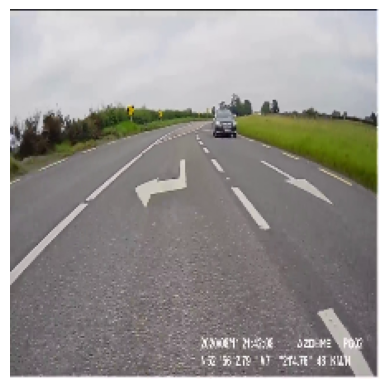

In [17]:
# Load image
img_raw = tf.io.read_file(os.path.join(path_images + '/0.png'))
img = tf.image.decode_jpeg(img_raw, channels=3)
img = tf.image.resize(img, (224, 224))  # Resize
img = tf.cast(img, tf.float32) / 255.0  # Normalize

plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
# medical-image-segmentation/
# data/
# raw/
# image1.png
# image2.png
# ...
# labels/
# mask1.png
# mask2.png

In [ ]:
# Set dataset directory
data_dir = ('kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2')

In [10]:
data_dir

'kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2'

### image data load method 1 for classification:

In [ ]:


# Load images from directory
dataset = tf.keras.preprocessing.image_dataset_from_directory( # extract from images and masks folders
    data_dir,
    # labels='inferred',
    # label_mode='categorical',
    # batch_size=32,
    # image_size=(224, 224),
    # validation_split=0.2,
    # subset='training'
)


Found 62 files belonging to 2 classes.


In [12]:
dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [13]:
next(iter(dataset.take(1)))

(<tf.Tensor: shape=(32, 256, 256, 3), dtype=float32, numpy=
 array([[[[ 35.5625 ,  35.5625 ,  35.5625 ],
          [ 35.     ,  35.     ,  35.     ],
          [ 33.71875,  33.71875,  33.71875],
          ...,
          [ 26.40625,  24.40625,  22.40625],
          [254.     , 252.     , 250.     ],
          [254.     , 252.     , 250.     ]],
 
         [[215.75   , 215.75   , 215.75   ],
          [223.53125, 223.53125, 223.53125],
          [227.65625, 227.65625, 227.65625],
          ...,
          [221.     , 219.     , 217.     ],
          [254.     , 252.     , 250.     ],
          [254.     , 252.     , 250.     ]],
 
         [[220.53125, 220.53125, 220.53125],
          [222.53125, 222.53125, 222.53125],
          [226.0625 , 226.0625 , 226.0625 ],
          ...,
          [221.     , 219.     , 215.     ],
          [254.     , 252.     , 248.     ],
          [254.     , 252.     , 248.     ]],
 
         ...,
 
         [[ 61.     ,  61.     , 245.     ],
          [ 61.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [10.875..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


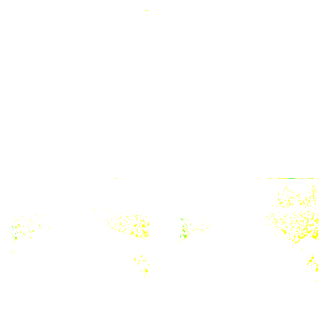

In [18]:
# Display images
for imgs, labels in dataset.take(1):
    plt.figure(figsize=(4, 4))
    for i, img in enumerate(imgs[:4]):
        plt.subplot(2, 2, i+1)
        plt.imshow(img)
        plt.axis('off')
    plt.show()

In [3]:
import pathlib

### image data load method 2 for classification:

In [1]:
data_dir1 = ('d:/a27_YEARS_OLD/deep_learning/CV/kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2')

In [ ]:
# Set dataset directory
data_dir1 = pathlib.Path(data_dir1) # paht object

# Load image paths
image_paths = list((data_dir1.glob('**/*.png'))) # list of path objects


In [5]:
data_dir1

WindowsPath('d:/a27_YEARS_OLD/deep_learning/CV/kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2')

In [7]:
image_paths[:5]

[WindowsPath('d:/a27_YEARS_OLD/deep_learning/CV/kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2/images/0.png'),
 WindowsPath('d:/a27_YEARS_OLD/deep_learning/CV/kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2/images/1.png'),
 WindowsPath('d:/a27_YEARS_OLD/deep_learning/CV/kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2/images/10.png'),
 WindowsPath('d:/a27_YEARS_OLD/deep_learning/CV/kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2/images/11.png'),
 WindowsPath('d:/a27_YEARS_OLD/deep_learning/CV/kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2/images/12.png')]

In [ ]:
image_paths = list(map(lambda x: x.as_posix(), image_paths)) # convert path objects to strings

lambda x: x.as_posix(): This is an anonymous function (lambda) that takes a Path object x and returns its POSIX-style path string using the as_posix() method.

In [142]:
image_paths[0]

'd:/a27_YEARS_OLD/deep_learning/CV/kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2/images/0.png'

In [143]:
import PIL
import PIL.Image

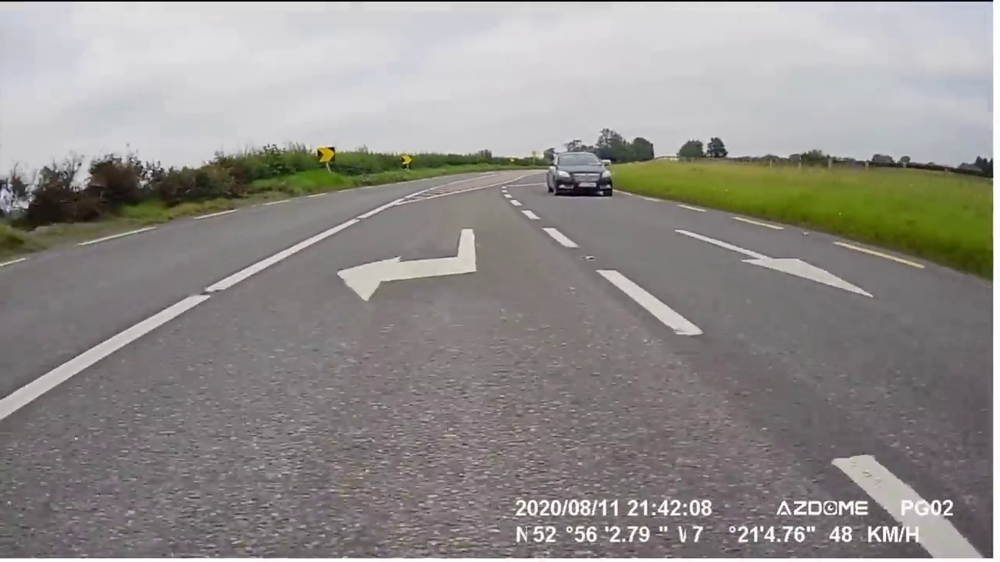

In [144]:
PIL.Image.open(str(image_paths[0]))

In [ ]:
# Create TensorFlow dataset from list of image paths(string) also find the class folder  for images and masks
dataset1 = tf.data.Dataset.from_tensor_slices(image_paths)

In [140]:
dataset1

<_TensorSliceDataset element_spec=TensorSpec(shape=(), dtype=tf.string, name=None)>

In [141]:
next(iter(dataset1.take(1)))

<tf.Tensor: shape=(), dtype=string, numpy=b'd:/a27_YEARS_OLD/deep_learning/CV/kagglehub/datasets/trainingdatapro/roads-segmentation-dataset/versions/2/images/0.png'>

In [ ]:
# Load and preprocess images
# def load_image(path):
#     img_raw = tf.io.read_file(path)
#     img = tf.image.decode_jpeg(img_raw, channels=3)
#     img = tf.image.resize(img, (224, 224))  # Resize
#     img = tf.cast(img, tf.float32) / 255.0  # Normalize
#     return img


In [86]:
for images, masks in dataset.take(2):
  sample_image, sample_mask = images[0], masks[0]
  display([sample_image, sample_mask])

[<tf.Tensor: shape=(256, 256, 3), dtype=float32, numpy=
 array([[[ 26.28125,  26.28125,  26.28125],
         [ 26.28125,  26.28125,  26.28125],
         [ 26.28125,  26.28125,  26.28125],
         ...,
         [ 24.46875,  24.46875,  34.09375],
         [255.     , 255.     , 255.     ],
         [253.     , 255.     , 255.     ]],
 
        [[202.25   , 202.25   , 202.25   ],
         [204.40625, 204.40625, 204.40625],
         [208.     , 208.     , 208.     ],
         ...,
         [197.28125, 197.28125, 207.28125],
         [254.     , 255.     , 255.     ],
         [253.     , 255.     , 255.     ]],
 
        [[200.     , 200.     , 200.     ],
         [203.     , 203.     , 203.     ],
         [208.     , 208.     , 208.     ],
         ...,
         [198.53125, 198.53125, 208.53125],
         [253.53125, 254.53125, 255.     ],
         [253.     , 255.     , 255.     ]],
 
        ...,
 
        [[ 61.     ,  61.     , 245.     ],
         [ 61.     ,  61.     , 245.     ]

[<tf.Tensor: shape=(256, 256, 3), dtype=float32, numpy=
 array([[[ 35.5625 ,  35.5625 ,  35.5625 ],
         [ 35.     ,  35.     ,  35.     ],
         [ 33.71875,  33.71875,  33.71875],
         ...,
         [  0.     ,   0.     ,   0.     ],
         [254.     , 250.     , 255.     ],
         [254.     , 250.     , 255.     ]],
 
        [[215.75   , 215.75   , 215.75   ],
         [223.53125, 223.53125, 223.53125],
         [227.65625, 227.65625, 227.65625],
         ...,
         [207.21875, 203.21875, 214.21875],
         [254.     , 250.     , 255.     ],
         [254.     , 250.     , 255.     ]],
 
        [[220.53125, 220.53125, 220.53125],
         [222.53125, 222.53125, 222.53125],
         [226.0625 , 226.0625 , 226.0625 ],
         ...,
         [221.     , 217.     , 226.     ],
         [254.     , 250.     , 255.     ],
         [254.     , 250.     , 255.     ]],
 
        ...,
 
        [[ 87.53125,  84.53125,  88.53125],
         [ 89.     ,  86.     ,  90.     ]

In [97]:
def normalize(input_image):
  input_image = tf.cast(input_image, tf.float32) / 255.0
  # input_mask -= 1
  return input_image 

In [98]:
def load_image(datapoint, ):
  input_image = tf.image.resize(datapoint, (128, 128))
  # input_mask = tf.image.resize(
  #   datapoint,
  #   (128, 128),
  #   method = tf.image.ResizeMethod.NEAREST_NEIGHBOR,
  # )

  input_image = normalize(input_image)

  return input_image 

In [ ]:
# import pathlib
# import shutil

# # Create train and test directories
# train_dir = pathlib.Path('train')
# test_dir = pathlib.Path('test')
# train_dir.mkdir(exist_ok=True)
# test_dir.mkdir(exist_ok=True)

# # Get image paths
# image_paths = list(pathlib.Path('path/to/dataset').glob('*.jpg'))

# # Split dataset
# for i, path in enumerate(image_paths):
#     if i % 5 == 0:  # 20% for testing
#         shutil.copy(str(path), str(test_dir))
#     else:  # 80% for training
#         shutil.copy(str(path), str(train_dir))

In [79]:
train_dataset = dataset.take(80)  # 80% for training
test_dataset = dataset.skip(80)  # Remaining 20% for testing

In [90]:
image, i_m = next(iter(train_dataset))

In [93]:
image[0]

<tf.Tensor: shape=(256, 256, 3), dtype=float32, numpy=
array([[[ 35.5625 ,  35.5625 ,  35.5625 ],
        [ 35.     ,  35.     ,  35.     ],
        [ 33.71875,  33.71875,  33.71875],
        ...,
        [  0.     ,   0.     ,   0.     ],
        [254.     , 250.     , 255.     ],
        [254.     , 250.     , 255.     ]],

       [[215.75   , 215.75   , 215.75   ],
        [223.53125, 223.53125, 223.53125],
        [227.65625, 227.65625, 227.65625],
        ...,
        [184.     ,  61.     , 245.     ],
        [254.     , 250.     , 255.     ],
        [254.     , 250.     , 255.     ]],

       [[220.53125, 220.53125, 220.53125],
        [222.53125, 222.53125, 222.53125],
        [226.0625 , 226.0625 , 226.0625 ],
        ...,
        [184.     ,  61.     , 245.     ],
        [254.     , 250.     , 255.     ],
        [254.     , 250.     , 255.     ]],

       ...,

       [[ 61.     ,  61.     , 245.     ],
        [ 61.     ,  61.     , 245.     ],
        [ 61.     ,  61.   

In [94]:
i_m[0]

<tf.Tensor: shape=(), dtype=int32, numpy=1>

In [80]:
train_dataset

<_TakeDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [81]:
test_dataset

<_SkipDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [ ]:
TRAIN_LENGTH = 30
BATCH_SIZE = 10
BUFFER_SIZE = 1000
# STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

In [105]:
train_images = train_dataset.map(lambda x, y : (load_image(x), y) ,num_parallel_calls=tf.data.AUTOTUNE)
# test_images = test_dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)

In [106]:
train_images

<_ParallelMapDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [107]:
next(iter(train_images.take(1)))

(<tf.Tensor: shape=(32, 128, 128, 3), dtype=float32, numpy=
 array([[[[0.49984682, 0.49984682, 0.49984682],
          [0.51053923, 0.51053923, 0.51053923],
          [0.5028799 , 0.5028799 , 0.5028799 ],
          ...,
          [0.49473038, 0.4790441 , 0.5182598 ],
          [0.45042893, 0.43866423, 0.47101715],
          [0.99607843, 0.98039216, 1.        ]],
 
         [[0.8712929 , 0.8712929 , 0.8712929 ],
          [0.88489586, 0.88489586, 0.88489586],
          [0.8775123 , 0.8775123 , 0.8775123 ],
          ...,
          [0.87251836, 0.85949755, 0.88949144],
          [0.8396446 , 0.8285539 , 0.8598652 ],
          [0.9862745 , 0.97518384, 0.9954044 ]],
 
         [[0.87594974, 0.87594974, 0.87594974],
          [0.8848346 , 0.8848346 , 0.8848346 ],
          [0.8806985 , 0.8806985 , 0.8806985 ],
          ...,
          [0.85818017, 0.85327816, 0.86210173],
          [0.65710783, 0.6522059 , 0.67965686],
          [0.9941176 , 0.9843137 , 1.        ]],
 
         ...,
 
      

### image data load method 3 for classification:

In [108]:
test_images = test_dataset.map(lambda x, y : (load_image(x), y) ,num_parallel_calls=tf.data.AUTOTUNE)

In [152]:
import tensorflow as tf

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
# from keras.preprocessing.image import ImageDataGenerator

In [164]:
data_dir3 = 'kagglehub/datasets/'

In [165]:
SEED = 100

image_data_generator = ImageDataGenerator(
    # width_shift_range = 0.1,
    # height_shift_range = 0.1,
    # rotation_range = 10,
    # zoom_range = 0.1
).flow_from_directory(
    data_dir3+'images', 
    # batch_size = 16, target_size = (150, 150), seed = SEED
    )



Found 31 images belonging to 1 classes.


In [166]:
mask_data_generator = ImageDataGenerator(
    # width_shift_range = 0.1,
    # height_shift_range = 0.1,
    # rotation_range = 10,
    # zoom_range = 0.1
).flow_from_directory(
    data_dir3+'masks', 
    # batch_size = 16, target_size = (150, 150), seed = SEED
    )

Found 31 images belonging to 1 classes.


In [175]:
image_data_generator

In [177]:
next(iter(image_data_generator))[0]

array([[[[ 29.,  29.,  29.],
         [ 29.,  29.,  29.],
         [ 29.,  29.,  29.],
         ...,
         [ 27.,  27.,  37.],
         [255., 255., 255.],
         [253., 255., 255.]],

        [[200., 200., 200.],
         [203., 203., 203.],
         [208., 208., 208.],
         ...,
         [197., 197., 207.],
         [254., 255., 255.],
         [253., 255., 255.]],

        [[200., 200., 200.],
         [203., 203., 203.],
         [208., 208., 208.],
         ...,
         [199., 199., 209.],
         [254., 255., 255.],
         [253., 255., 255.]],

        ...,

        [[ 70.,  67.,  71.],
         [ 70.,  67.,  71.],
         [ 70.,  67.,  71.],
         ...,
         [ 71.,  63.,  69.],
         [255., 252., 255.],
         [255., 251., 255.]],

        [[191., 188., 192.],
         [191., 188., 192.],
         [191., 188., 192.],
         ...,
         [183., 175., 181.],
         [255., 251., 255.],
         [255., 251., 255.]],

        [[250., 247., 251.],
       

In [5]:
# pip install datasets

### image data load for segmentation

In [1]:
import datasets
import glob

d:\a27_YEARS_OLD\deep_learning\venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
IMAGES = glob.glob('kagglehub/datasets/images/images/*.png')

In [3]:
IMAGES[:5]

['kagglehub/datasets/images/images\\0.png',
 'kagglehub/datasets/images/images\\1.png',
 'kagglehub/datasets/images/images\\10.png',
 'kagglehub/datasets/images/images\\11.png',
 'kagglehub/datasets/images/images\\12.png']

In [4]:

SEG_MAPS = glob.glob('kagglehub/datasets/masks/masks/*.png')


In [13]:
SEG_MAPS[:5]

['kagglehub/datasets/masks/masks\\0.png',
 'kagglehub/datasets/masks/masks\\1.png',
 'kagglehub/datasets/masks/masks\\10.png',
 'kagglehub/datasets/masks/masks\\11.png',
 'kagglehub/datasets/masks/masks\\12.png']

In [5]:
split = 0.2

In [6]:
from sklearn.model_selection import train_test_split

## set images as x and masks as y

In [7]:
split_size = int(len(IMAGES) * split)

train_x, valid_x = train_test_split(IMAGES, test_size=split_size, random_state=42)
train_y, valid_y = train_test_split(SEG_MAPS, test_size=split_size, random_state=42)

train_x, test_x = train_test_split(train_x, test_size=split_size, random_state=42)
train_y, test_y = train_test_split(train_y, test_size=split_size, random_state=42)

In [8]:
import os
import numpy as np
import cv2
from glob import glob
from sklearn.utils import shuffle
import tensorflow as tf
# from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger, ReduceLROnPlateau, EarlyStopping, TensorBoard
# from tensorflow.keras.optimizers import Adam
# from sklearn.model_selection import train_test_split
# from unet import build_unet
# from metrics import dice_loss, dice_coef

In [9]:
def read_image(path):
    path = path.decode()
    x = cv2.imread(path, cv2.IMREAD_COLOR)
    # x = cv2.resize(x, (W, H))
    # x = x / 255.0
    x = x.astype(np.float32)
    return x

def read_mask(path):
    path = path.decode()
    x = cv2.imread(path, cv2.IMREAD_COLOR)  ## (h, w)
    # x = cv2.resize(x, (W, H))   ## (h, w)
    # x = x / 255.0               ## (h, w)
    x = x.astype(np.float32)    ## (h, w)
    # x = np.expand_dims(x, axis=-1)## (h, w, 1)
    return x

In [10]:
H = 720
W = 1280
# 13,720,1280,3

In [ ]:
def tf_parse(x, y):
    def _parse(x, y): # This is a nested function that performs the actual parsing.
        x = read_image(x)
        y = read_mask(y)
        return x, y

    x, y = tf.numpy_function(_parse, [x, y], [tf.float32, tf.float32])
#     This line wraps the _parse function in a TensorFlow numpy_function op.
# This allows the _parse function to be executed within the TensorFlow graph.
# The [tf.float32, tf.float32] argument specifies the output data types.
    x.set_shape([H, W, 3])
    y.set_shape([H, W, 3])
    return x, y

In [12]:
train_dataset_raw = tf.data.Dataset.from_tensor_slices((train_x, train_y))
train_dataset = train_dataset_raw.map(tf_parse)
# train_dataset = train_dataset.batch(16)
# train_dataset = train_dataset.prefetch(10)

In [52]:
train_dataset_raw


<_TensorSliceDataset element_spec=(TensorSpec(shape=(), dtype=tf.string, name=None), TensorSpec(shape=(), dtype=tf.string, name=None))>

In [53]:
next(iter(train_dataset_raw))[0]

<tf.Tensor: shape=(), dtype=string, numpy=b'kagglehub/datasets/images/images\\23.png'>

In [54]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 720, 1280, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 720, 1280, 3), dtype=tf.float32, name=None))>

In [55]:
next(iter(train_dataset))[1]

<tf.Tensor: shape=(13, 720, 1280, 3), dtype=float32, numpy=
array([[[[ 12.,  12.,  12.],
         [ 12.,  12.,  12.],
         [ 12.,  12.,  12.],
         ...,
         [255., 251., 246.],
         [255., 251., 246.],
         [255., 251., 246.]],

        [[ 38.,  38.,  38.],
         [ 38.,  38.,  38.],
         [ 38.,  38.,  38.],
         ...,
         [255., 251., 246.],
         [255., 251., 246.],
         [255., 251., 246.]],

        [[182., 182., 182.],
         [182., 182., 182.],
         [182., 182., 182.],
         ...,
         [255., 251., 246.],
         [255., 251., 246.],
         [255., 251., 246.]],

        ...,

        [[255., 253., 255.],
         [255., 253., 255.],
         [255., 253., 255.],
         ...,
         [255., 251., 254.],
         [254., 250., 253.],
         [254., 250., 253.]],

        [[255., 253., 255.],
         [255., 253., 255.],
         [255., 253., 255.],
         ...,
         [255., 251., 254.],
         [254., 250., 253.],
       

In [13]:
valid_dataset_raw = tf.data.Dataset.from_tensor_slices((valid_x, valid_y))
valid_dataset = valid_dataset_raw.map(tf_parse)
# valid_dataset = valid_dataset.batch(16)
# valid_dataset = valid_dataset.prefetch(10)


In [14]:
train_x, test_x = train_test_split(train_x, test_size=split_size, random_state=42)
train_y, test_y = train_test_split(train_y, test_size=split_size, random_state=42)

In [15]:
test_dataset_raw = tf.data.Dataset.from_tensor_slices((test_x, test_y))
test_dataset = test_dataset_raw.map(tf_parse)
# test_dataset = test_dataset.batch(16)
# test_dataset = test_dataset.prefetch(10)

In [16]:
def normalize(input_image, input_mask):
  input_image = tf.cast(input_image, tf.float32) / 255.0
  input_mask -= 1
  return input_image, input_mask

In [17]:
def load_image(x,y):
  input_image = tf.image.resize(x, (128, 128))
  input_mask = tf.image.resize(
    y,
    (128, 128),
    method = tf.image.ResizeMethod.NEAREST_NEIGHBOR,
  )

  input_image, input_mask = normalize(input_image, input_mask)

  return input_image, input_mask

In [18]:
# TRAIN_LENGTH = info.splits['train'].num_examples
BATCH_SIZE = 16
BUFFER_SIZE = 1000
# STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

In [19]:
train_images = train_dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)
test_images = test_dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)

In [64]:
train_images

<_ParallelMapDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None))>

In [68]:
next(iter(train_images))[0]

<tf.Tensor: shape=(13, 128, 128, 3), dtype=float32, numpy=
array([[[[0.7588235 , 0.7588235 , 0.7588235 ],
         [0.8276961 , 0.8276961 , 0.8276961 ],
         [0.81911767, 0.81911767, 0.81911767],
         ...,
         [0.2367647 , 0.27598038, 0.24460784],
         [0.20906863, 0.28357843, 0.24828431],
         [1.        , 0.9843137 , 0.9647059 ]],

        [[0.87034315, 0.87034315, 0.87034315],
         [0.8862745 , 0.8862745 , 0.8862745 ],
         [0.8784314 , 0.8784314 , 0.8784314 ],
         ...,
         [0.38296568, 0.40257353, 0.37512255],
         [0.31360295, 0.3692402 , 0.33762255],
         [1.        , 0.9843137 , 0.9647059 ]],

        [[0.8745098 , 0.8745098 , 0.8745098 ],
         [0.88884807, 0.88884807, 0.88884807],
         [0.88235295, 0.88235295, 0.88235295],
         ...,
         [0.47120097, 0.4952206 , 0.4677696 ],
         [0.27328432, 0.32034314, 0.2889706 ],
         [0.99558824, 0.98651963, 0.9647059 ]],

        ...,

        [[0.36740196, 0.35171568,

In [20]:
class Augment(tf.keras.layers.Layer):
  def __init__(self, seed=42):
    super().__init__()
    # both use the same seed, so they'll make the same random changes.
    self.augment_inputs = tf.keras.layers.RandomFlip(mode="horizontal", seed=seed)
    self.augment_labels = tf.keras.layers.RandomFlip(mode="horizontal", seed=seed)

  def call(self, inputs, labels):
    inputs = self.augment_inputs(inputs)
    labels = self.augment_labels(labels)
    return inputs, labels

In [ ]:
train_batches = (
    train_images
    .cache()
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .repeat()
    .map(Augment())
    .prefetch(buffer_size=tf.data.AUTOTUNE)) # Prefetching is a technique where the next batch of data is prepared 
# and loaded into memory while the current batch is being processed
# tf.data.AUTOTUNE is a special value that tells TensorFlow to automatically tune the buffer size 
# for prefetching. This means that TensorFlow will dynamically adjust the buffer size based on the system's resources 
# and the workload.

test_batches = test_images.batch(BATCH_SIZE)
# test_batches = test_images

In [70]:
train_batches

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None))>

In [37]:
import matplotlib.pyplot as plt

In [38]:
def display(display_list):
  plt.figure(figsize=(15, 15))

  title = ['Input Image', 'True Mask', 'Predicted Mask']

  for i in range(len(display_list)):
    plt.subplot(1, len(display_list), i+1)
    plt.title(title[i])
    plt.imshow(tf.keras.utils.array_to_img(display_list[i]))
    plt.axis('off')
  plt.show()

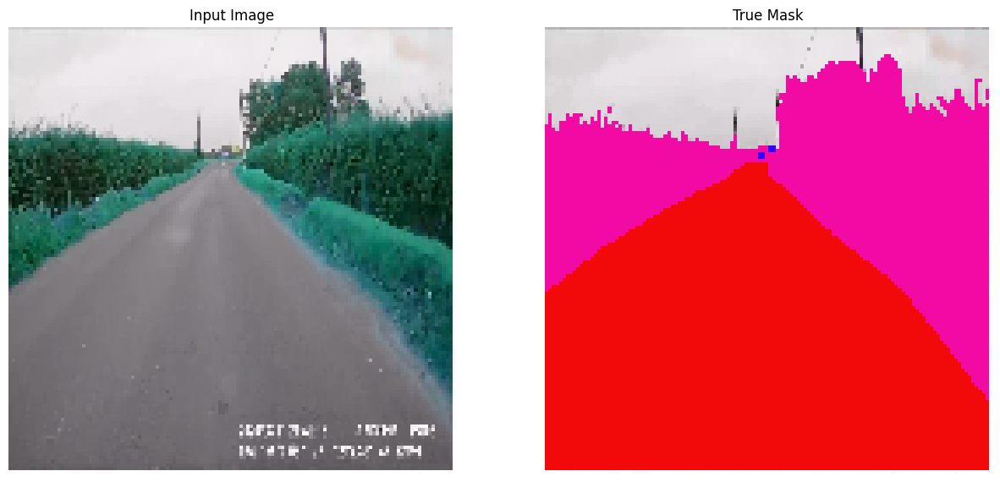

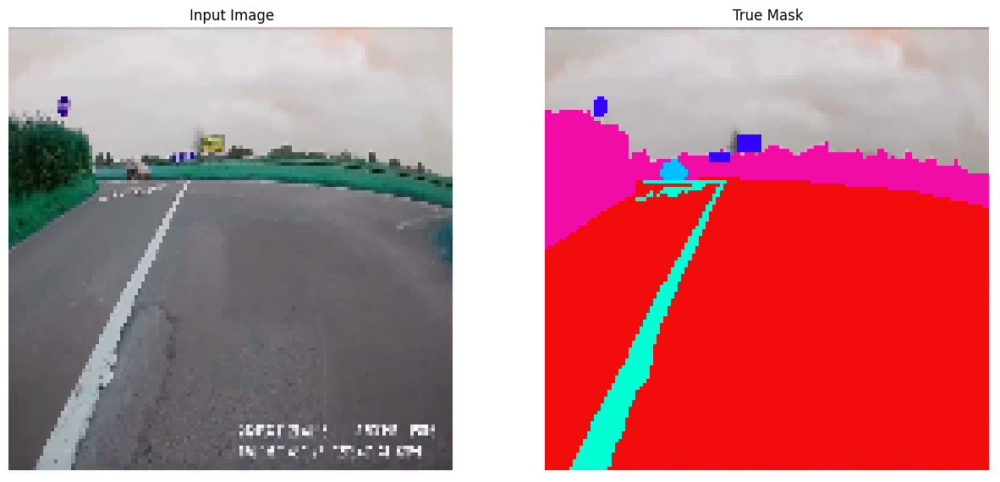

In [39]:
for images, masks in train_batches.take(2):
  sample_image, sample_mask = images[0], masks[0]
  display([sample_image, sample_mask])

Define the model
The model being used here is a modified U-Net. A U-Net consists of an encoder (downsampler) and decoder (upsampler). To learn robust features and reduce the number of trainable parameters, use a pretrained model—MobileNetV2—as the encoder. For the decoder, you will use the upsample block, which is already implemented in the pix2pix example in the TensorFlow Examples repo. (Check out the pix2pix: Image-to-image translation with a conditional GAN tutorial in a notebook.)

As mentioned, the encoder is a pretrained MobileNetV2 model. You will use the model from tf.keras.applications. The encoder consists of specific outputs from intermediate layers in the model. Note that the encoder will not be trained during the training process as we use pretrained model

Input shape: 128x128 RGB images (3 color channels).
Exclude top layers: Omit the classification head, using the model as a feature extractor.

In [23]:
base_model = tf.keras.applications.MobileNetV2(input_shape=[128, 128, 3], include_top=False)

# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]
base_model_outputs = [base_model.get_layer(name).output for name in layer_names]
# Retrieves the output tensors of selected layers.
# Creates a new model (down_stack) using the input of base_model and the selected layer outputs.

# Create the feature extraction model
down_stack = tf.keras.Model(inputs=base_model.input, outputs=base_model_outputs)

down_stack.trainable = False
# Weights frozen: Model weights won't be updated during training.
# Feature extraction: The model will only extract features, without fine-tuning.

In [75]:
base_model_outputs

[<KerasTensor shape=(None, 64, 64, 96), dtype=float32, sparse=False, name=keras_tensor_13>,
 <KerasTensor shape=(None, 32, 32, 144), dtype=float32, sparse=False, name=keras_tensor_31>,
 <KerasTensor shape=(None, 16, 16, 192), dtype=float32, sparse=False, name=keras_tensor_58>,
 <KerasTensor shape=(None, 8, 8, 576), dtype=float32, sparse=False, name=keras_tensor_120>,
 <KerasTensor shape=(None, 4, 4, 320), dtype=float32, sparse=False, name=keras_tensor_151>]

In [172]:
down_stack.output

[<KerasTensor shape=(None, 64, 64, 96), dtype=float32, sparse=False, name=keras_tensor_167>,
 <KerasTensor shape=(None, 32, 32, 144), dtype=float32, sparse=False, name=keras_tensor_185>,
 <KerasTensor shape=(None, 16, 16, 192), dtype=float32, sparse=False, name=keras_tensor_212>,
 <KerasTensor shape=(None, 8, 8, 576), dtype=float32, sparse=False, name=keras_tensor_274>,
 <KerasTensor shape=(None, 4, 4, 320), dtype=float32, sparse=False, name=keras_tensor_305>]

In [77]:
down_stack.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 64, 64,    │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 64, 64,    │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 64, 64,    │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 64, 64,    │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 64, 64,    │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 64, 64,    │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 64, 64,    │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 64, 64,    │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 64, 64,    │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 64, 64,    │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 64, 64,    │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 65, 65,    │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 32, 32,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 32, 32,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 32, 32,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 32, 32,    │      2,304 │ block_1_depthwis

 Total params: 1,841,984 (7.03 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 1,841,984 (7.03 MB)

In [74]:
base_model.summary()

Model: "mobilenetv2_1.00_128"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 64, 64,    │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 64, 64,    │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 64, 64,    │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 64, 64,    │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 64, 64,    │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 64, 64,    │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 64, 64,    │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 64, 64,    │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 64, 64,    │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 64, 64,    │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 64, 64,    │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 65, 65,    │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 32, 32,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 32, 32,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 32, 32,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 32, 32,    │      2,304 │ block_1_depthwis

 Total params: 2,257,984 (8.61 MB)

 Trainable params: 412,800 (1.57 MB)

 Non-trainable params: 1,845,184 (7.04 MB)

The decoder/upsampler is simply a series of upsample blocks implemented in TensorFlow examples

In [25]:
from tensorflow_examples.models.pix2pix import pix2pix

In [26]:
up_stack = [
    pix2pix.upsample(512, 3),  # 4x4 -> 8x8
    pix2pix.upsample(256, 3),  # 8x8 -> 16x16
    pix2pix.upsample(128, 3),  # 16x16 -> 32x32
    pix2pix.upsample(64, 3),   # 32x32 -> 64x64
    # pix2pix.upsample(32, 3),   # 64x64 -> 128x128
    # pix2pix.upsample(16, 3),   # 128x128 -> 256x256
    # # pix2pix.upsample(8, 3),    # 256x256 -> 512x512
]

In [175]:
inputs = tf.keras.layers.Input(shape=[128, 128, 3])

In [189]:
inputs

<KerasTensor shape=(None, 128, 128, 3), dtype=float32, sparse=False, name=keras_tensor_608>

In [160]:
# Downsampling through the model
skips1 = down_stack(inputs)
x = skips1[-1]
skips = reversed(skips1[:-1])

In [ ]:
# down_stack: This is a function that represents the downsampling (encoder) part of the U-Net architecture. It takes the input image inputs and returns a list of skip connections skips1.
# skips1[-1]: This line extracts the last element from the skips1 list, which represents the output of the downsampling path.
# x: The output of the downsampling path is assigned to the variable x.
# skips = reversed(skips1[:-1]): This line reverses the order of the skip connections (excluding the last one) and assigns them to the variable skips. This is done to prepare for the upsampling (decoder) path.

In [161]:
skips1

[<KerasTensor shape=(None, 64, 64, 96), dtype=float32, sparse=False, name=keras_tensor_576>,
 <KerasTensor shape=(None, 32, 32, 144), dtype=float32, sparse=False, name=keras_tensor_577>,
 <KerasTensor shape=(None, 16, 16, 192), dtype=float32, sparse=False, name=keras_tensor_578>,
 <KerasTensor shape=(None, 8, 8, 576), dtype=float32, sparse=False, name=keras_tensor_579>,
 <KerasTensor shape=(None, 4, 4, 320), dtype=float32, sparse=False, name=keras_tensor_580>]

In [162]:
x

<KerasTensor shape=(None, 4, 4, 320), dtype=float32, sparse=False, name=keras_tensor_580>

In [163]:
skips


In [164]:
for up, skip in zip(up_stack, skips):
    x = up(x)
    concat = tf.keras.layers.Concatenate()
    x = concat([x, skip])

concat one upstack layer one reverse skip layer so on

In [ ]:
# for up, skip in zip(up_stack, skips):: This line starts a loop that iterates over two lists in parallel: up_stack and skips. up_stack contains the upsampling layers, and skips contains the skip connections from the downsampling path.
# x = up(x): In each iteration, the current output x is passed through the corresponding upsampling layer up.
# concat = tf.keras.layers.Concatenate(): This line creates a concatenation layer, which is used to merge the upsampled output x with the corresponding skip connection skip.
# x = concat([x, skip]): The concatenation layer is applied to merge x and skip. The resulting tensor is assigned back to x.

In [165]:
x

<KerasTensor shape=(None, 64, 64, 160), dtype=float32, sparse=False, name=keras_tensor_604>

In [170]:
last = tf.keras.layers.Conv2DTranspose(
      filters=3, kernel_size=3, strides=1,
      padding='same')  #64x64 -> 128x128

In [171]:
last(x)

<KerasTensor shape=(None, 64, 64, 3), dtype=float32, sparse=False, name=keras_tensor_607>

In [ ]:
def unet_model(output_channels:int):
  inputs = tf.keras.layers.Input(shape=(128, 128, 3))  #shape=[128, 128, 3]

  # Downsampling through the model
  skips = down_stack(inputs) # add input layer to down_stack or encoder layer
  x = skips[-1] # output of last layer of down_stack
  skips = reversed(skips[:-1]) # reverse skips except  last layer  to up sampling and connected to up stack

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x) # output of last layer of downstack pass as input to first layer of upstack get output from that 
    concat = tf.keras.layers.Concatenate()
    x = concat([x, skip]) # concat output of first layer of up stack with first layer of reverse skips
    
  # these layer are connected like one upstack layer one reverse skips layer each and so on 

#  Feature extraction: Uses the pre-trained down_stack model.
# Skip connections: Stores intermediate features for upsampling.
# Upsampling: Uses up_stack layers.
# Skip connections: Concatenates upscaled features with stored intermediate features.

  # This is the last layer of the model
  last = tf.keras.layers.Conv2DTranspose(
      filters=output_channels, kernel_size=3, strides=2,activation='softmax',
      padding='same')  #64x64 -> 128x128
  
# Transposed convolution: Upscales to original resolution (128x128).
# Output channels: Matches the number of segmentation classe

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

In [ ]:
# Downsampling: The code is downsampling the input image through the model.
# down_stack: This is a function that represents the downsampling (encoder) part of the U-Net architecture. It takes the input image inputs and returns a list of skip connections skips1.
# skips1[-1]: This line extracts the last element from the skips1 list, which represents the output of the downsampling path.
# x: The output of the downsampling path is assigned to the variable x.
# skips = reversed(skips1[:-1]): This line reverses the order of the skip connections (excluding the last one) and assigns them to the variable skips. This is done to prepare for the upsampling (decoder) path.

In [ ]:
# for up, skip in zip(up_stack, skips):: This line starts a loop that iterates over two lists in parallel: up_stack and skips. up_stack contains the upsampling layers, and skips contains the skip connections from the downsampling path.
# x = up(x): In each iteration, the current output x is passed through the corresponding upsampling layer up.
# concat = tf.keras.layers.Concatenate(): This line creates a concatenation layer, which is used to merge the upsampled output x with the corresponding skip connection skip.
# x = concat([x, skip]): The concatenation layer is applied to merge x and skip. The resulting tensor is assigned back to x.

ote that the number of filters on the last layer is set to the number of output_channels. This will be one output channel per class.

Train the model
Now, all that is left to do is to compile and train the model.

Since this is a multiclass classification problem, use the tf.keras.losses.SparseCategoricalCrossentropy loss function with the from_logits argument set to True, since the labels are scalar integers instead of vectors of scores for each pixel of every class.

When running inference, the label assigned to the pixel is the channel with the highest value. This is what the create_mask function is doing.Train the model
Now, all that is left to do is to compile and train the model.

Since this is a multiclass classification problem, use the tf.keras.losses.SparseCategoricalCrossentropy loss function with the from_logits argument set to True, since the labels are scalar integers instead of vectors of scores for each pixel of every class.

When running inference, the label assigned to the pixel is the channel with the highest value. This is what the create_mask function is doing.

In [28]:
OUTPUT_CLASSES = 3

model = unet_model(output_channels=OUTPUT_CLASSES)
model.compile(optimizer='adam',
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

In [129]:
tf.keras.utils.plot_model(model, show_shapes=True, expand_nested=True, dpi=64)

You must install graphviz (see instructions at https://graphviz.gitlab.io/download/) for `plot_model` to work.


Argmax: tf.math.argmax(pred_mask, axis=-1)
Selects the class with the highest probability for each pixel.
axis=-1 indicates the last dimension (typically the channel axis).
Add channel dimension: pred_mask[..., tf.newaxis]
Adds a new axis to represent the channel (mask) dimension.
Necessary for consistency with image data structures.
Return single mask: return pred_mask[0]
Extracts the first (and only) mask from the batch.
Assumes batch size is 1.

In [ ]:
def create_mask(pred_mask):
  pred_mask = tf.math.argmax(pred_mask, axis=-1) # (256, 256)
  pred_mask = pred_mask[..., tf.newaxis] # (256, 256, 1) add dimension or new axis  This is using NumPy-style indexing to add a new 
  # axis to the end of the tensor. The ... represents all existing axes.
  return pred_mask[0]

without train

In [ ]:
def show_predictions(dataset=None, num=1):
  if dataset:
    for image, mask in dataset.take(num):
      pred_mask = model.predict(image)
      display([image[0], mask[0], create_mask(pred_mask)])
  else:
    display([sample_image, sample_mask,
             create_mask(model.predict(sample_image[tf.newaxis, ...]))]) # tf.newaxis, ...: This is using NumPy-style 
    # indexing to add a new axis to the beginning of the tensor. The ... represents all existing axes.
    #  (256, 256, 3) to (1, 256, 256, 3)

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


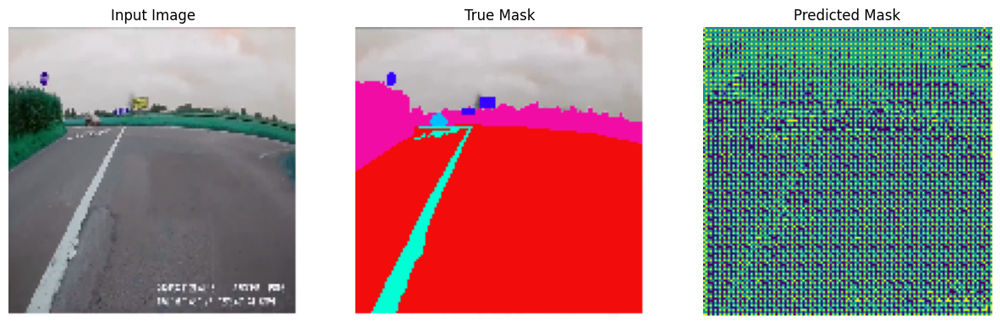

In [40]:
show_predictions()

In [33]:
from IPython.display import clear_output

In [34]:
class DisplayCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs=None):
    clear_output(wait=True)
    show_predictions()
    print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

In [149]:
model.layers[-1]

<Conv2DTranspose name=conv2d_transpose_37, built=True>

In [148]:
down_stack.layers[-1]

<Conv2D name=block_16_project, built=True>

In [ ]:
len(next(iter(train_batches)))

13

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


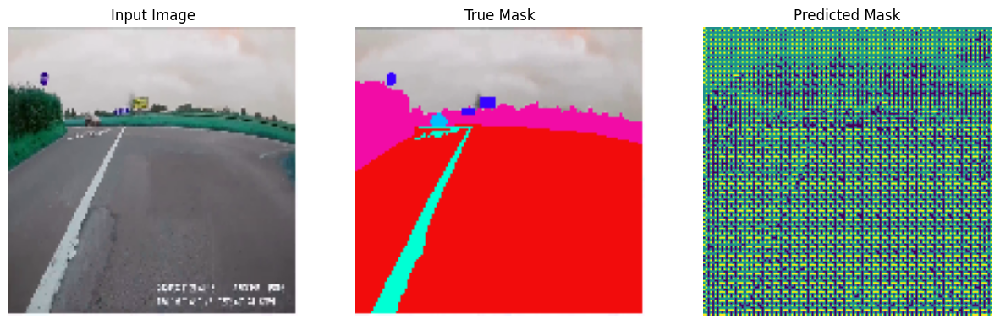


Sample Prediction after epoch 1

10/10 ━━━━━━━━━━━━━━━━━━━━ 4s 404ms/step - accuracy: 0.3012 - loss: 657.6761 - val_accuracy: 0.3288 - val_loss: 684.3184


In [41]:
EPOCHS = 1
# VAL_SUBSPLITS = 5
# VALIDATION_STEPS = info.splits['test'].num_examples//BATCH_SIZE//VAL_SUBSPLITS

model_history = model.fit(train_batches, epochs=EPOCHS,
                          steps_per_epoch=10,
                          validation_steps=10,
                          validation_data=test_batches,
                          callbacks=[DisplayCallback()])

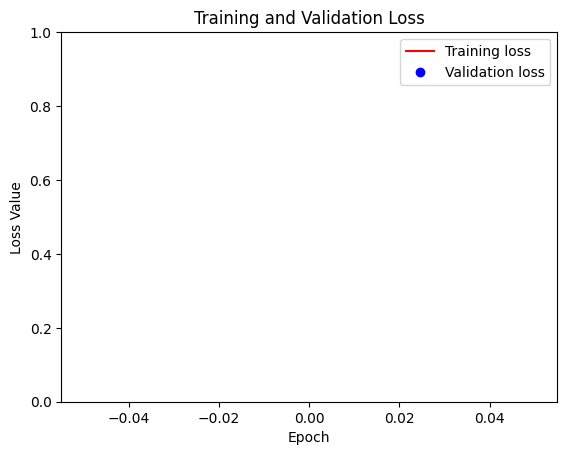

In [42]:
loss = model_history.history['loss']
val_loss = model_history.history['val_loss']

plt.figure()
plt.plot(model_history.epoch, loss, 'r', label='Training loss')
plt.plot(model_history.epoch, val_loss, 'bo', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.ylim([0, 1])
plt.legend()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


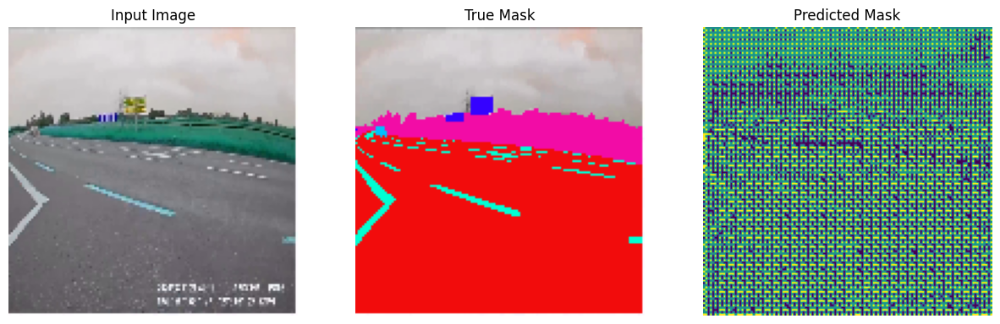

In [43]:
show_predictions(test_batches, 3)

Optional: Imbalanced classes and class weights
Semantic segmentation datasets can be highly imbalanced meaning that particular class pixels can be present more inside images than that of other classes. Since segmentation problems can be treated as per-pixel classification problems, you can deal with the imbalance problem by weighing the loss function to account for this. It's a simple and elegant way to deal with this problem. Refer to the Classification on imbalanced data tutorial to learn more.

To avoid ambiguity, Model.fit does not support the class_weight argument for targets with 3+ dimensions.

In [210]:
dataset5 = datasets.Dataset.from_dict({"image": IMAGES, "label": SEG_MAPS}, features=datasets.Features({"image": datasets.Image(), "label": datasets.Image()}))

In [211]:
dataset5

Dataset({
    features: ['image', 'label'],
    num_rows: 31
})

In [212]:
dataset5['image']

[<PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720>,
 <PIL.PngImagePlugin.PngI

image mask generator like ImagedataGenerator

In [183]:
def my_image_mask_generator(image_data_generator, mask_data_generator):
    train_generator = zip(image_data_generator, mask_data_generator)
    for (img, mask) in train_generator:
        yield (img, mask)

In [184]:
img_data_gen = my_image_mask_generator(image_data_generator[0], mask_data_generator[0])

In [185]:
img_data_gen

<generator object my_image_mask_generator at 0x000001A445EA3880>

In [ ]:
# next(iter(img_data_gen))

StopIteration: 

In [173]:
def normalize(input_image, input_mask):
  input_image = tf.cast(input_image, tf.float32) / 255.0
  input_mask -= 1
  return input_image, input_mask

In [222]:
def load_image(datapoint):
  input_image = tf.image.resize(datapoint['image'], (128, 128))
  input_mask = tf.image.resize(
    datapoint['label'],
    (128, 128),
    method = tf.image.ResizeMethod.NEAREST_NEIGHBOR,
  )

  input_image, input_mask = normalize(input_image, input_mask)

  return {'images':input_image, 'masks':input_mask}

In [223]:
train_images = dataset5.map(load_image)
# test_images = dataset['test'].map(load_image, num_parallel_calls=tf.data.AUTOTUNE)

Map: 100%|██████████| 31/31 [00:05<00:00,  6.05 examples/s]


In [228]:
train_images['images']

KeyboardInterrupt: 

In [224]:
class Augment(tf.keras.layers.Layer):
  def __init__(self, seed=42):
    super().__init__()
    # both use the same seed, so they'll make the same random changes.
    self.augment_inputs = tf.keras.layers.RandomFlip(mode="horizontal", seed=seed)
    self.augment_labels = tf.keras.layers.RandomFlip(mode="horizontal", seed=seed)

  def call(self, inputs, labels):
    inputs = self.augment_inputs(inputs)
    labels = self.augment_labels(labels)
    return inputs, labels

In [229]:
train_images.map(
    Augment()
)

Map:   0%|          | 0/31 [00:00<?, ? examples/s]


ValueError: Only input tensors may be passed as positional arguments. The following argument value should be passed as a keyword argument: {'image': <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1280x720 at 0x1A461794590>, 'label': <PIL.PngImagePlugin.PngImageFile image mode=RGBA size=1280x720 at 0x1A4617996D0>, 'images': [[[0.7495098114013672, 0.7495098114013672, 0.7495098114013672], [0.760661780834198, 0.760661780834198, 0.760661780834198], [0.7495098114013672, 0.7495098114013672, 0.7495098114013672], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7995098233222961, 0.7955882549285889, 0.8073529601097107], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.8223039507865906, 0.8223039507865906, 0.8223039507865906], [0.8183823823928833, 0.8183823823928833, 0.8183823823928833], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8078431487083435, 0.8078431487083435, 0.8078431487083435], [0.8183823823928833, 0.8183823823928833, 0.8183823823928833], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.7968137264251709, 0.7968137264251709, 0.7968137264251709], [0.7803921699523926, 0.7803921699523926, 0.7803921699523926], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7935048937797546, 0.7935048937797546, 0.7935048937797546], [0.7561274766921997, 0.7561274766921997, 0.7561274766921997], [0.7835784554481506, 0.7835784554481506, 0.7835784554481506], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.7803921699523926, 0.7803921699523926, 0.7803921699523926], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.7764706015586853, 0.7764706015586853, 0.7764706015586853], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.767401933670044, 0.767401933670044, 0.767401933670044], [0.767401933670044, 0.767401933670044, 0.767401933670044], [0.767401933670044, 0.767401933670044, 0.767401933670044], [0.767401933670044, 0.767401933670044, 0.767401933670044], [0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7987744808197021, 0.7987744808197021, 0.7987744808197021], [0.7987744808197021, 0.7987744808197021, 0.7987744808197021], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7764706015586853, 0.7764706015586853, 0.7764706015586853], [0.7909313440322876, 0.7870097756385803, 0.7987744808197021], [0.7843137383460999, 0.7764706015586853, 0.8078431487083435], [0.7843137383460999, 0.7764706015586853, 0.8078431487083435], [0.7843137383460999, 0.7764706015586853, 0.8078431487083435], [0.7803921699523926, 0.772549033164978, 0.8039215803146362], [0.7803921699523926, 0.772549033164978, 0.8039215803146362], [0.7803921699523926, 0.772549033164978, 0.8039215803146362], [0.7784313559532166, 0.770588219165802, 0.8019607663154602], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7595587968826294, 0.7595587968826294, 0.7987744808197021], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7686274647712708, 0.7686274647712708, 0.8078431487083435], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7450980544090271, 0.7450980544090271, 0.7843137383460999], [0.7411764860153198, 0.7411764860153198, 0.7803921699523926], [0.7232843041419983, 0.7389705777168274, 0.789950966835022], [0.7232843041419983, 0.7389705777168274, 0.789950966835022], [0.7232843041419983, 0.7389705777168274, 0.789950966835022], [0.7232843041419983, 0.7389705777168274, 0.7977941036224365], [0.7272058725357056, 0.7428921461105347, 0.8017156720161438], [0.7232843041419983, 0.7389705777168274, 0.7977941036224365], [0.7220588326454163, 0.7377451062202454, 0.7965686321258545], [0.7220588326454163, 0.7377451062202454, 0.7965686321258545], [0.7220588326454163, 0.7377451062202454, 0.7965686321258545], [0.7046568393707275, 0.7281862497329712, 0.8026960492134094], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8254901766777039, 0.8254901766777039, 0.8254901766777039], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8490195870399475, 0.8490195870399475, 0.8490195870399475], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8450980186462402, 0.8450980186462402, 0.8450980186462402], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.841176450252533, 0.841176450252533, 0.841176450252533], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8546568751335144, 0.8546568751335144, 0.8546568751335144], [0.8450980186462402, 0.8450980186462402, 0.8450980186462402], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8215686082839966, 0.8215686082839966, 0.8215686082839966], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8334558606147766, 0.8334558606147766, 0.8334558606147766], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8272058963775635, 0.8272058963775635, 0.8272058963775635], [0.8272058963775635, 0.8272058963775635, 0.8272058963775635], [0.8272058963775635, 0.8272058963775635, 0.8272058963775635], [0.8272058963775635, 0.8272058963775635, 0.8272058963775635], [0.8487744927406311, 0.8487744927406311, 0.8487744927406311], [0.8507353067398071, 0.8507353067398071, 0.8507353067398071], [0.8546568751335144, 0.8546568751335144, 0.8546568751335144], [0.8546568751335144, 0.8546568751335144, 0.8546568751335144], [0.8564950823783875, 0.8564950823783875, 0.8564950823783875], [0.8507353067398071, 0.8507353067398071, 0.8507353067398071], [0.8507353067398071, 0.8507353067398071, 0.8507353067398071], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8372548818588257, 0.8294117450714111, 0.8607842922210693], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8274509906768799, 0.8274509906768799, 0.8666666746139526], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.7848039269447327, 0.7965686321258545, 0.8397058844566345], [0.7848039269447327, 0.7965686321258545, 0.8397058844566345], [0.7848039269447327, 0.7965686321258545, 0.8397058844566345], [0.7648284435272217, 0.7805147171020508, 0.8393382430076599], [0.7534313797950745, 0.7691176533699036, 0.8279411792755127], [0.7492647171020508, 0.7649509906768799, 0.823774516582489], [0.7529411911964417, 0.7686274647712708, 0.8274509906768799], [0.7529411911964417, 0.7686274647712708, 0.8274509906768799], [0.7529411911964417, 0.7686274647712708, 0.8274509906768799], [0.7529411911964417, 0.7764706015586853, 0.8509804010391235], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.8051470518112183, 0.8073529601097107, 0.8183823823928833], [0.8090686202049255, 0.811274528503418, 0.8223039507865906], [0.8090686202049255, 0.811274528503418, 0.8223039507865906], [0.8196078538894653, 0.8117647171020508, 0.8509804010391235], [0.8196078538894653, 0.8117647171020508, 0.8509804010391235], [0.8213235139846802, 0.8134803771972656, 0.8526960611343384], [0.8196078538894653, 0.8117647171020508, 0.8509804010391235], [0.8196078538894653, 0.8117647171020508, 0.8509804010391235], [0.8207107782363892, 0.8128676414489746, 0.8476715683937073], [0.8422794342041016, 0.8383578658103943, 0.8545343279838562], [0.8509804010391235, 0.8487744927406311, 0.8553921580314636], [0.8549019694328308, 0.8526960611343384, 0.8593137264251709], [0.8588235378265381, 0.8588235378265381, 0.8588235378265381], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.8677695989608765, 0.8677695989608765, 0.8677695989608765], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8593137264251709, 0.8571078181266785, 0.863725483417511], [0.8531862497329712, 0.8531862497329712, 0.8531862497329712], [0.8549019694328308, 0.8526960611343384, 0.8593137264251709], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8509804010391235, 0.8487744927406311, 0.8553921580314636], [0.8509804010391235, 0.8487744927406311, 0.8553921580314636], [0.8470588326454163, 0.8448529243469238, 0.8514705896377563], [0.8479166626930237, 0.8479166626930237, 0.8479166626930237], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8448529243469238, 0.8426470756530762, 0.8492646813392639], [0.8448529243469238, 0.8426470756530762, 0.8492646813392639], [0.8426470756530762, 0.8404411673545837, 0.8470588326454163], [0.8409313559532166, 0.8387255072593689, 0.8453431129455566], [0.8409313559532166, 0.8387255072593689, 0.8453431129455566], [0.8426470756530762, 0.8404411673545837, 0.8470588326454163], [0.8389706015586853, 0.8367646932601929, 0.8433823585510254], [0.8252450823783875, 0.8252450823783875, 0.8252450823783875], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.844362735748291, 0.8421568870544434, 0.8487744927406311], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8387255072593689, 0.8365195989608765, 0.843137264251709], [0.8325980305671692, 0.8303921818733215, 0.8370097875595093], [0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.82438725233078, 0.8221813440322876, 0.8287990093231201], [0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8409313559532166, 0.8387255072593689, 0.8453431129455566], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8409313559532166, 0.8387255072593689, 0.8453431129455566], [0.8381127715110779, 0.8381127715110779, 0.8381127715110779], [0.8422794342041016, 0.8422794342041016, 0.8422794342041016], [0.8414215445518494, 0.8414215445518494, 0.8414215445518494], [0.8414215445518494, 0.8414215445518494, 0.8414215445518494], [0.8414215445518494, 0.8414215445518494, 0.8414215445518494], [0.8433823585510254, 0.8433823585510254, 0.8433823585510254], [0.8453431129455566, 0.8453431129455566, 0.8453431129455566], [0.851838231086731, 0.851838231086731, 0.851838231086731], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8529411554336548, 0.8529411554336548, 0.8529411554336548], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8583333492279053, 0.8583333492279053, 0.8583333492279053], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8583333492279053, 0.8583333492279053, 0.8583333492279053], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8683823347091675, 0.8683823347091675, 0.8683823347091675], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8453431129455566, 0.8397058844566345, 0.8644607663154602], [0.8492646813392639, 0.8414215445518494, 0.8727940917015076], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8370097875595093, 0.8291666507720947, 0.8605391979217529], [0.8264706134796143, 0.8230392336845398, 0.854411780834198], [0.8134803771972656, 0.8134803771972656, 0.8526960611343384], [0.8134803771972656, 0.8134803771972656, 0.8526960611343384], [0.8134803771972656, 0.8134803771972656, 0.8526960611343384], [0.8134803771972656, 0.8134803771972656, 0.8526960611343384], [0.8134803771972656, 0.8134803771972656, 0.8526960611343384], [0.8151960968971252, 0.8151960968971252, 0.854411780834198], [0.8095588088035583, 0.8095588088035583, 0.8487744927406311], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8056372404098511, 0.8056372404098511, 0.8448529243469238], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.7745097875595093, 0.7901960611343384, 0.8490195870399475], [0.7708333134651184, 0.7865195870399475, 0.8453431129455566], [0.7647058963775635, 0.7803921699523926, 0.8392156958580017], [0.7669117450714111, 0.7825980186462402, 0.8414215445518494], [0.7669117450714111, 0.7825980186462402, 0.8414215445518494], [0.7647058963775635, 0.7803921699523926, 0.8392156958580017], [0.7629901766777039, 0.7865195870399475, 0.8610293865203857], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.772549033164978, 0.7921568751335144, 0.8313725590705872], [0.7803921699523926, 0.800000011920929, 0.8392156958580017], [0.7921568751335144, 0.8117647171020508, 0.8509804010391235], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8588235378265381, 0.8627451062202454], [0.8666666746139526, 0.8588235378265381, 0.8627451062202454], [0.8627451062202454, 0.8549019694328308, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8039215803146362, 0.8196078538894653, 0.8352941274642944], [0.802450954914093, 0.8085784316062927, 0.8274509906768799], [0.8055146932601929, 0.8094362616539001, 0.8290441036224365], [0.8063725233078003, 0.8125, 0.8313725590705872], [0.8063725233078003, 0.8125, 0.8313725590705872], [0.8102940917015076, 0.8164215683937073, 0.8352941274642944], [0.8210784196853638, 0.8171568512916565, 0.8289215564727783], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8281862735748291, 0.8242647051811218, 0.8438725471496582], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8474264740943909, 0.8435049057006836, 0.8552696108818054], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.841176450252533, 0.8372548818588257, 0.8568627238273621], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8058823347091675, 0.8176470398902893, 0.8450980186462402], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.8019607663154602, 0.8019607663154602, 0.841176450252533], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.7960784435272217, 0.7960784435272217, 0.8274509906768799], [0.7843137383460999, 0.7960784435272217, 0.8313725590705872], [0.7803921699523926, 0.7921568751335144, 0.8352941274642944], [0.772549033164978, 0.7882353067398071, 0.8392156958580017], [0.772549033164978, 0.7882353067398071, 0.8392156958580017], [0.7686274647712708, 0.7882353067398071, 0.8274509906768799], [0.7686274647712708, 0.7843137383460999, 0.8352941274642944], [0.7686274647712708, 0.7843137383460999, 0.843137264251709], [0.7647058963775635, 0.7803921699523926, 0.8392156958580017], [0.7549019455909729, 0.7823529243469238, 0.8372548818588257], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.772549033164978, 0.7921568751335144, 0.8313725590705872], [0.7803921699523926, 0.800000011920929, 0.8392156958580017], [0.7921568751335144, 0.8117647171020508, 0.8509804010391235], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8627451062202454, 0.8509804010391235, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.800000011920929, 0.8196078538894653, 0.843137264251709], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.7964460849761963, 0.8121323585510254, 0.8278186321258545], [0.800000011920929, 0.8156862854957581, 0.8313725590705872], [0.800000011920929, 0.8156862854957581, 0.8313725590705872], [0.8039215803146362, 0.8196078538894653, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8267157077789307, 0.8227941393852234, 0.8424019813537598], [0.8408088088035583, 0.8368872404098511, 0.8564950823783875], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8058823347091675, 0.8176470398902893, 0.8450980186462402], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.8019607663154602, 0.8019607663154602, 0.8333333134651184], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.7803921699523926, 0.7960784435272217, 0.8470588326454163], [0.7803921699523926, 0.7960784435272217, 0.8470588326454163], [0.772549033164978, 0.7843137383460999, 0.8274509906768799], [0.772549033164978, 0.7843137383460999, 0.8274509906768799], [0.772549033164978, 0.7803921699523926, 0.8352941274642944], [0.7686274647712708, 0.7764706015586853, 0.8313725590705872], [0.7627450823783875, 0.7784313559532166, 0.8294117450714111], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.7686274647712708, 0.7882353067398071, 0.8274509906768799], [0.7764706015586853, 0.7960784435272217, 0.8352941274642944], [0.7943627238273621, 0.8061274290084839, 0.8492646813392639], [0.8176470398902893, 0.8098039031028748, 0.841176450252533], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8274509906768799, 0.8274509906768799, 0.8666666746139526], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8593137264251709, 0.8553921580314636, 0.875], [0.8593137264251709, 0.8553921580314636, 0.8671568632125854], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8583333492279053, 0.854411780834198, 0.8740196228027344], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8439950942993164, 0.8400735259056091, 0.8596813678741455], [0.853799045085907, 0.8498774766921997, 0.8694853186607361], [0.8583333492279053, 0.854411780834198, 0.8661764860153198], [0.8644607663154602, 0.8605391979217529, 0.8723039031028748], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8174019455909729, 0.8174019455909729, 0.8487744927406311], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8017156720161438, 0.8017156720161438, 0.833088219165802], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.8028186559677124, 0.8028186559677124, 0.8341912031173706], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8056372404098511, 0.8056372404098511, 0.8370097875595093], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.7882353067398071, 0.800000011920929, 0.843137264251709], [0.7843137383460999, 0.7921568751335144, 0.8470588326454163], [0.7781862616539001, 0.789950966835022, 0.833088219165802], [0.7764706015586853, 0.7882353067398071, 0.8313725590705872], [0.7742646932601929, 0.7821078300476074, 0.8370097875595093], [0.7708333134651184, 0.7825980186462402, 0.8257352709770203], [0.770588219165802, 0.7784313559532166, 0.8333333134651184], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.8075980544090271, 0.8075980544090271, 0.8468137383460999], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8546568751335144, 0.8507353067398071, 0.8703431487083435], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8664215803146362, 0.862500011920929, 0.8742647171020508], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8553921580314636, 0.8514705896377563, 0.8632352948188782], [0.866911768913269, 0.8629902005195618, 0.8747549057006836], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.866911768913269, 0.8629902005195618, 0.8747549057006836], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8156862854957581, 0.8196078538894653, 0.8313725590705872], [0.8156862854957581, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8078431487083435, 0.8235294222831726, 0.8392156958580017], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8120098114013672, 0.8120098114013672, 0.8433823585510254], [0.8159313797950745, 0.8198529481887817, 0.8394607901573181], [0.8397058844566345, 0.8357843160629272, 0.8553921580314636], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8666666746139526, 0.8549019694328308, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.7843137383460999, 0.7960784435272217, 0.8392156958580017], [0.7803921699523926, 0.7921568751335144, 0.8352941274642944], [0.7803921699523926, 0.7921568751335144, 0.8352941274642944], [0.772549033164978, 0.7843137383460999, 0.8274509906768799], [0.7784313559532166, 0.7941176295280457, 0.8529411554336548], [0.9843137264251709, 1.0, 1.0]], [[0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7848039269447327, 0.7928921580314636, 0.8294117450714111], [0.8019607663154602, 0.8019607663154602, 0.841176450252533], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8573529124259949, 0.8534313440322876, 0.8651960492134094], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8379902243614197, 0.8340686559677124, 0.8536764979362488], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8313725590705872, 0.8274509906768799, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8360294103622437, 0.8321078419685364, 0.8517156839370728], [0.843137264251709, 0.8379902243614197, 0.8612744808197021], [0.8509804010391235, 0.8458333611488342, 0.8691176176071167], [0.8693627715110779, 0.857598066329956, 0.8732843399047852], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8602941036224365, 0.8563725352287292, 0.8759803771972656], [0.8602941036224365, 0.8563725352287292, 0.8759803771972656], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8647058606147766, 0.8607842922210693, 0.8803921341896057], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8482843041419983, 0.8365195989608765, 0.8522058725357056], [0.8482843041419983, 0.8365195989608765, 0.8522058725357056], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.8377450704574585], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7843137383460999, 0.7960784435272217, 0.8313725590705872], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7823529243469238, 0.7928921580314636, 0.8397058844566345], [0.9882352948188782, 1.0, 1.0]], [[0.7566176652908325, 0.7683823704719543, 0.7958333492279053], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.7848039269447327, 0.7928921580314636, 0.8294117450714111], [0.8025735020637512, 0.8025735020637512, 0.841789186000824], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8129901885986328, 0.8129901885986328, 0.8497549295425415], [0.8183823823928833, 0.8183823823928833, 0.8497549295425415], [0.8301470875740051, 0.8301470875740051, 0.8615196347236633], [0.8379902243614197, 0.8325980305671692, 0.8639705777168274], [0.8497549295425415, 0.8446078300476074, 0.8678921461105347], [0.8523284196853638, 0.8471813797950745, 0.8704656958580017], [0.8573529124259949, 0.8534313440322876, 0.873039186000824], [0.8573529124259949, 0.8534313440322876, 0.8705882430076599], [0.8522058725357056, 0.8482843041419983, 0.8654412031173706], [0.8522058725357056, 0.8482843041419983, 0.8654412031173706], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8573529124259949, 0.8534313440322876, 0.8651960492134094], [0.8573529124259949, 0.8534313440322876, 0.8651960492134094], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8718137145042419, 0.8678921461105347, 0.8796568512916565], [0.8718137145042419, 0.8678921461105347, 0.8796568512916565], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8573529124259949, 0.8534313440322876, 0.8651960492134094], [0.8522058725357056, 0.8482843041419983, 0.8600490093231201], [0.8522058725357056, 0.8482843041419983, 0.8600490093231201], [0.8497549295425415, 0.8458333611488342, 0.8600490093231201], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8325980305671692, 0.8365195989608765, 0.8536764979362488], [0.8325980305671692, 0.8365195989608765, 0.8536764979362488], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.8485293984413147, 0.8470588326454163, 0.8666666746139526], [0.8485293984413147, 0.8470588326454163, 0.8642156720161438], [0.8485293984413147, 0.8470588326454163, 0.8642156720161438], [0.8522058725357056, 0.8482843041419983, 0.8654412031173706], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.844362735748291, 0.8404411673545837, 0.8600490093231201], [0.8404411673545837, 0.8365195989608765, 0.8561274409294128], [0.8359068632125854, 0.8319852948188782, 0.8515931367874146], [0.8223039507865906, 0.8169117569923401, 0.8482843041419983], [0.814460813999176, 0.8181372284889221, 0.8482843041419983], [0.8156862854957581, 0.8156862854957581, 0.8495097756385803], [0.8102940917015076, 0.8183823823928833, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8102940917015076, 0.8183823823928833, 0.8470588326454163], [0.8196078538894653, 0.8276960849761963, 0.8563725352287292], [0.8286764621734619, 0.8286764621734619, 0.8600490093231201], [0.8377450704574585, 0.8352941274642944, 0.8666666746139526], [0.8377450704574585, 0.8352941274642944, 0.8666666746139526], [0.8535539507865906, 0.845710813999176, 0.8770833611488342], [0.8639705777168274, 0.8600490093231201, 0.8796568512916565], [0.8627451062202454, 0.8588235378265381, 0.8759803771972656], [0.8705882430076599, 0.8612744808197021, 0.8757352828979492], [0.8732843399047852, 0.8639705777168274, 0.8784313797950745], [0.8705882430076599, 0.8612744808197021, 0.8811274766921997], [0.8705882430076599, 0.8612744808197021, 0.8811274766921997], [0.8666666746139526, 0.8627451062202454, 0.8799019455909729], [0.8651960492134094, 0.8588235378265381, 0.8772059082984924], [0.8651960492134094, 0.8588235378265381, 0.8772059082984924], [0.8705882430076599, 0.8642156720161438, 0.8825980424880981], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8693627715110779, 0.857598066329956, 0.8732843399047852], [0.8680146932601929, 0.856249988079071, 0.8719362616539001], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.856249988079071, 0.8444852828979492, 0.8601715564727783], [0.8536764979362488, 0.841911792755127, 0.857598066329956], [0.8497549295425415, 0.8379902243614197, 0.8536764979362488], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8458333611488342, 0.8365195989608765, 0.8509804010391235], [0.8458333611488342, 0.8365195989608765, 0.8509804010391235], [0.8458333611488342, 0.8365195989608765, 0.8509804010391235], [0.8406862616539001, 0.8313725590705872, 0.8458333611488342], [0.8406862616539001, 0.8313725590705872, 0.8458333611488342], [0.8379902243614197, 0.8286764621734619, 0.843137264251709], [0.8365195989608765, 0.8301470875740051, 0.843137264251709], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.829901933670044, 0.8259803652763367, 0.8377450704574585], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.841911792755127, 0.8379902243614197, 0.8497549295425415], [0.8352941274642944, 0.8313725590705872, 0.8485293984413147], [0.8392156958580017, 0.8352941274642944, 0.852450966835022], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8359068632125854, 0.8292891979217529, 0.8569852709770203], [0.829901933670044, 0.8259803652763367, 0.845588207244873], [0.8274509906768799, 0.8208333253860474, 0.8485293984413147], [0.8169117569923401, 0.8102940917015076, 0.8379902243614197], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8090686202049255, 0.8051470518112183, 0.8247548937797546], [0.7946078181266785, 0.7946078181266785, 0.8259803652763367], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8090686202049255, 0.8328431248664856], [0.7960784435272217, 0.8090686202049255, 0.8328431248664856], [0.8075980544090271, 0.8063725233078003, 0.8340686559677124], [0.8063725233078003, 0.8051470518112183, 0.8328431248664856], [0.8036764860153198, 0.801225483417511, 0.8379902243614197], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.7882353067398071, 0.7882353067398071, 0.824999988079071], [0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.7835784554481506, 0.7916666865348816, 0.8335784077644348], [0.9870098233222961, 1.0, 1.0]], [[0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7863970398902893, 0.7863970398902893, 0.8256127238273621], [0.8020833134651184, 0.8020833134651184, 0.8412989974021912], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8279411792755127, 0.8200980424880981, 0.8514705896377563], [0.8414215445518494, 0.8335784077644348, 0.864950954914093], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.876225471496582, 0.8723039031028748, 0.8840686082839966], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8450980186462402, 0.841176450252533, 0.8607842922210693], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8196078538894653, 0.8313725590705872, 0.8588235378265381], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8664215803146362, 0.8585784435272217, 0.8899509906768799], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.866911768913269, 0.8551470637321472, 0.8708333373069763], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8553921580314636, 0.8514705896377563, 0.8632352948188782], [0.8593137264251709, 0.8475490212440491, 0.8632352948188782], [0.8593137264251709, 0.8475490212440491, 0.8632352948188782], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8512254953384399, 0.8394607901573181, 0.8551470637321472], [0.8473039269447327, 0.8355392217636108, 0.8512254953384399], [0.8473039269447327, 0.8355392217636108, 0.8512254953384399], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.8317402005195618, 0.8278186321258545, 0.8395833373069763], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.7862744927406311, 0.7862744927406311, 0.8254901766777039], [0.9843137264251709, 1.0, 1.0]], [[0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7784313559532166, 0.7901960611343384, 0.8254901766777039], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8428921699523926, 0.835049033164978, 0.8664215803146362], [0.8727940917015076, 0.8688725233078003, 0.8884803652763367], [0.8727940917015076, 0.8688725233078003, 0.8806372284889221], [0.8638480305671692, 0.8599264621734619, 0.8716911673545837], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8764705657958984, 0.8725489974021912, 0.884313702583313], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.864950954914093, 0.8610293865203857, 0.8727940917015076], [0.8644607663154602, 0.8605391979217529, 0.8723039031028748], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8583333492279053, 0.854411780834198, 0.8740196228027344], [0.8644607663154602, 0.8605391979217529, 0.8723039031028748], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8450980186462402, 0.841176450252533, 0.8607842922210693], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8257352709770203, 0.8257352709770203, 0.8571078181266785], [0.8296568393707275, 0.8296568393707275, 0.8610293865203857], [0.8335784077644348, 0.8335784077644348, 0.864950954914093], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.8414215445518494, 0.8414215445518494, 0.8727940917015076], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8593137264251709, 0.8553921580314636, 0.8671568632125854], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.853799045085907, 0.8420343399047852, 0.8577206134796143], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8215686082839966, 0.8098039031028748, 0.8254901766777039], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8039215803146362, 0.8352941274642944], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7941176295280457, 0.7862744927406311, 0.8176470398902893], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7607843279838562, 0.772549033164978, 0.800000011920929], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7784313559532166, 0.7901960611343384, 0.8254901766777039], [0.7960784435272217, 0.7960784435272217, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8235294222831726, 0.8549019694328308], [0.8525735139846802, 0.8447303771972656, 0.8761029243469238], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8713235259056091, 0.8674019575119019, 0.8791666626930237], [0.8764705657958984, 0.8725489974021912, 0.884313702583313], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8764705657958984, 0.8725489974021912, 0.884313702583313], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8571078181266785, 0.8531862497329712, 0.864950954914093], [0.8634803891181946, 0.8595588207244873, 0.8713235259056091], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8290441036224365, 0.8290441036224365, 0.8604166507720947], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8529411554336548, 0.8490195870399475, 0.8686274290084839], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8666666746139526, 0.8666666746139526], [0.8588235378265381, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8338235020637512, 0.829901933670044, 0.8416666388511658], [0.8267157077789307, 0.8227941393852234, 0.8345588445663452], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8267157077789307, 0.8227941393852234, 0.8345588445663452], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8121323585510254, 0.8082107901573181, 0.8278186321258545], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.7889705896377563, 0.7928921580314636, 0.8125], [0.7976715564727783, 0.793749988079071, 0.8133578300476074], [1.0, 0.9960784316062927, 1.0]], [[0.7607843279838562, 0.772549033164978, 0.800000011920929], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7784313559532166, 0.7901960611343384, 0.8254901766777039], [0.7960784435272217, 0.7960784435272217, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.823161780834198, 0.823161780834198, 0.8545343279838562], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8764705657958984, 0.8725489974021912, 0.884313702583313], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8235294222831726, 0.8235294222831726, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8470588326454163, 0.8509804010391235, 0.8627451062202454], [0.8470588326454163, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8199754953384399, 0.8160539269447327, 0.8278186321258545], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7811274528503418, 0.7850490212440491, 0.8046568632125854], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.7607843279838562, 0.772549033164978, 0.800000011920929], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7784313559532166, 0.7901960611343384, 0.8254901766777039], [0.7960784435272217, 0.7960784435272217, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8764705657958984, 0.8725489974021912, 0.884313702583313], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8313725590705872, 0.8235294222831726, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8632352948188782, 0.8514705896377563, 0.8671568632125854], [0.8632352948188782, 0.8514705896377563, 0.8671568632125854], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8308823704719543], [0.8196078538894653, 0.8156862854957581, 0.8308823704719543], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7697303891181946, 0.7736519575119019, 0.7932597994804382], [1.0, 0.9960784316062927, 1.0]], [[0.7784313559532166, 0.7784313559532166, 0.8176470398902893], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7926470637321472, 0.7926470637321472, 0.83186274766922], [0.8020833134651184, 0.8020833134651184, 0.8412989974021912], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.813725471496582, 0.813725471496582, 0.8450980186462402], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8176470398902893, 0.8176470398902893, 0.8490195870399475], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8628676533699036, 0.8589460849761963, 0.8785539269447327], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8664215803146362, 0.862500011920929, 0.8742647171020508], [0.8664215803146362, 0.862500011920929, 0.8742647171020508], [0.8664215803146362, 0.862500011920929, 0.8742647171020508], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8428921699523926, 0.8389706015586853, 0.8585784435272217], [0.8428921699523926, 0.8389706015586853, 0.8585784435272217], [0.8389706015586853, 0.835049033164978, 0.8546568751335144], [0.8371323347091675, 0.8292891979217529, 0.8606617450714111], [0.8188725709915161, 0.8196078538894653, 0.8585784435272217], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8176470398902893, 0.8176470398902893, 0.8490195870399475], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8468137383460999, 0.835049033164978, 0.8507353067398071], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8272058963775635], [0.8115196228027344, 0.8075980544090271, 0.8272058963775635], [0.7995098233222961, 0.8034313917160034, 0.8230392336845398], [0.8073529601097107, 0.8034313917160034, 0.8230392336845398], [0.8115196228027344, 0.8075980544090271, 0.8272058963775635], [0.8115196228027344, 0.8075980544090271, 0.8272058963775635], [0.8115196228027344, 0.8075980544090271, 0.8272058963775635], [0.8073529601097107, 0.8034313917160034, 0.8151960968971252], [0.7995098233222961, 0.8034313917160034, 0.8230392336845398], [0.8073529601097107, 0.8034313917160034, 0.8230392336845398], [0.8035539388656616, 0.7996323704719543, 0.8192402124404907], [0.7958333492279053, 0.791911780834198, 0.8115196228027344], [0.791911780834198, 0.7879902124404907, 0.8075980544090271], [0.791911780834198, 0.7879902124404907, 0.8075980544090271], [0.8015931248664856, 0.7976715564727783, 0.8172793984413147], [0.8096813559532166, 0.8057597875595093, 0.8180146813392639], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8116421699523926, 0.8077206015586853, 0.8194853067398071], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7958333492279053, 0.791911780834198, 0.8115196228027344], [0.8073529601097107, 0.8034313917160034, 0.8230392336845398], [0.7997549176216125, 0.7958333492279053, 0.8154411911964417], [0.791911780834198, 0.7879902124404907, 0.8075980544090271], [0.7627450823783875, 0.7627450823783875, 0.7941176295280457], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7784313559532166, 0.7784313559532166, 0.8176470398902893], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8052695989608765, 0.8052695989608765, 0.8444852828979492], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8170343041419983, 0.8170343041419983, 0.8484068512916565], [0.8183823823928833, 0.8183823823928833, 0.8497549295425415], [0.8183823823928833, 0.8183823823928833, 0.8497549295425415], [0.82438725233078, 0.82438725233078, 0.8557597994804382], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8647058606147766, 0.8607842922210693, 0.8803921341896057], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8365195989608765, 0.8325980305671692, 0.844362735748291], [0.829901933670044, 0.8259803652763367, 0.8377450704574585], [0.8247548937797546, 0.8247548937797546, 0.8561274409294128], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8313725590705872, 0.8235294222831726, 0.8549019694328308], [0.8078431487083435, 0.8196078538894653, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.844362735748291, 0.8325980305671692, 0.8482843041419983], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7816176414489746, 0.7855392098426819, 0.8051470518112183], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7784313559532166, 0.7823529243469238, 0.8019607663154602], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7908087968826294, 0.7868872284889221, 0.798651933670044], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7816176414489746, 0.7776960730552673, 0.7973039150238037], [0.7855392098426819, 0.7816176414489746, 0.801225483417511], [0.7855392098426819, 0.7816176414489746, 0.801225483417511], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7541666626930237, 0.7541666626930237, 0.7855392098426819], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7875000238418579, 0.7875000238418579, 0.8267157077789307], [0.7933823466300964, 0.7933823466300964, 0.8325980305671692], [0.7894607782363892, 0.7894607782363892, 0.8286764621734619], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8058823347091675, 0.8058823347091675, 0.8450980186462402], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8286764621734619, 0.8286764621734619, 0.8600490093231201], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8647058606147766, 0.8607842922210693, 0.8803921341896057], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8536764979362488, 0.8497549295425415, 0.8615196347236633], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8379902243614197, 0.8340686559677124, 0.8458333611488342], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8078431487083435, 0.8196078538894653, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8325980305671692, 0.8247548937797546, 0.8561274409294128], [0.8169117569923401, 0.8169117569923401, 0.8561274409294128], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8379902243614197, 0.8340686559677124, 0.8536764979362488], [0.841911792755127, 0.8379902243614197, 0.8497549295425415], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.841176450252533, 0.8294117450714111, 0.8450980186462402], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7791666388511658, 0.783088207244873, 0.7948529124259949], [0.7791666388511658, 0.783088207244873, 0.7948529124259949], [0.7870097756385803, 0.783088207244873, 0.8026960492134094], [0.7870097756385803, 0.783088207244873, 0.8026960492134094], [0.7870097756385803, 0.783088207244873, 0.8026960492134094], [0.7870097756385803, 0.783088207244873, 0.8026960492134094], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7713235020637512, 0.7870097756385803, 0.8026960492134094], [0.7778186202049255, 0.7817401885986328, 0.8013480305671692], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7634803652763367, 0.7634803652763367, 0.7948529124259949], [0.7667891979217529, 0.7667891979217529, 0.7981617450714111], [0.7700980305671692, 0.7740195989608765, 0.7936274409294128], [0.7634803652763367, 0.767401933670044, 0.7870097756385803], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7634803652763367, 0.7595587968826294, 0.7791666388511658], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7426470518112183, 0.7426470518112183, 0.781862735748291], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7878676652908325, 0.7996323704719543, 0.8349264860153198], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8465686440467834], [0.8235294222831726, 0.8193627595901489, 0.8397058844566345], [0.8269608020782471, 0.8269608020782471, 0.8583333492279053], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.835049033164978, 0.8389706015586853, 0.8585784435272217], [0.8235294222831726, 0.8392156958580017, 0.8549019694328308], [0.8351715803146362, 0.8390931487083435, 0.8587009906768799], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8590686321258545, 0.8551470637321472, 0.8747549057006836], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.823774516582489, 0.8198529481887817, 0.8394607901573181], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.804411768913269, 0.8154411911964417, 0.8504902124404907], [0.8176470398902893, 0.8176470398902893, 0.8490195870399475], [0.8117647171020508, 0.8235294222831726, 0.8588235378265381], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.823774516582489, 0.8198529481887817, 0.8321078419685364], [0.8313725590705872, 0.8352941274642944, 0.8475490212440491], [0.8313725590705872, 0.8352941274642944, 0.8475490212440491], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8430147171020508, 0.831250011920929, 0.8469362854957581], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.83186274766922, 0.8200980424880981, 0.8357843160629272], [0.835661768913269, 0.8238970637321472, 0.8395833373069763], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.7962009906768799, 0.7922794222831726, 0.8040441274642944], [0.7922794222831726, 0.7883578538894653, 0.8001225590705872], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7883578538894653, 0.7844362854957581, 0.7962009906768799], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7651960849761963, 0.7801470756530762, 0.7882353067398071], [0.7649509906768799, 0.7879902124404907, 0.7921568751335144], [0.7649509906768799, 0.7879902124404907, 0.7921568751335144], [0.7649509906768799, 0.7879902124404907, 0.800000011920929], [0.7649509906768799, 0.7879902124404907, 0.800000011920929], [0.7649509906768799, 0.7879902124404907, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7568627595901489, 0.772549033164978, 0.7882353067398071], [0.7492647171020508, 0.7610294222831726, 0.7884804010391235], [0.7497549057006836, 0.7607843279838562, 0.7958333492279053], [0.7473039031028748, 0.7590686082839966, 0.7943627238273621], [0.7495098114013672, 0.7605392336845398, 0.7882353067398071], [0.7455882430076599, 0.7566176652908325, 0.7843137383460999], [0.7416666746139526, 0.7526960968971252, 0.7877451181411743], [0.7377451062202454, 0.748774528503418, 0.783823549747467], [0.7299019694328308, 0.7409313917160034, 0.7764706015586853], [0.7257353067398071, 0.7411764860153198, 0.7911764979362488], [0.7219362854957581, 0.7410539388656616, 0.780024528503418], [0.7220588326454163, 0.7411764860153198, 0.7801470756530762], [0.718137264251709, 0.7372549176216125, 0.7762255072593689], [0.988725483417511, 0.9997549057006836, 1.0]], [[0.8019607663154602, 0.8019607663154602, 0.841176450252533], [0.8078431487083435, 0.8078431487083435, 0.8426470756530762], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8335784077644348, 0.8296568393707275, 0.8492646813392639], [0.833088219165802, 0.833088219165802, 0.8644607663154602], [0.8352941274642944, 0.8392156958580017, 0.8588235378265381], [0.8352941274642944, 0.8392156958580017, 0.8588235378265381], [0.8235294222831726, 0.8392156958580017, 0.8504902124404907], [0.8352941274642944, 0.8392156958580017, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8487744927406311, 0.8448529243469238, 0.8566176295280457], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8409313559532166, 0.8370097875595093, 0.8487744927406311], [0.8409313559532166, 0.8370097875595093, 0.8487744927406311], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8308823704719543, 0.8269608020782471, 0.8387255072593689], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8487744927406311, 0.8448529243469238, 0.8566176295280457], [0.8487744927406311, 0.8448529243469238, 0.8566176295280457], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8308823704719543, 0.8269608020782471, 0.8387255072593689], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8240196108818054, 0.8291666507720947, 0.8622549176216125], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.83186274766922, 0.8279411792755127, 0.8475490212440491], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8481617569923401, 0.8363970518112183, 0.8520833253860474], [0.8453431129455566, 0.8370097875595093, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.810661792755127, 0.8067402243614197, 0.8185049295425415], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.7860293984413147, 0.7821078300476074, 0.7938725352287292], [0.783823549747467, 0.7843137383460999, 0.7960784435272217], [0.783823549747467, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7664215564727783, 0.7865195870399475, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7664215564727783, 0.7865195870399475, 0.7921568751335144], [0.762499988079071, 0.7825980186462402, 0.7882353067398071], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7568627595901489, 0.772549033164978, 0.7882353067398071], [0.7450980544090271, 0.7568627595901489, 0.7921568751335144], [0.7450980544090271, 0.7568627595901489, 0.7921568751335144], [0.7350490093231201, 0.751225471496582, 0.7843137383460999], [0.7389705777168274, 0.7507352828979492, 0.7825980186462402], [0.7337009906768799, 0.7498774528503418, 0.7751225233078003], [0.7137255072593689, 0.7450980544090271, 0.7803921699523926], [0.7156862616539001, 0.7313725352287292, 0.7823529243469238], [0.7115195989608765, 0.7276960611343384, 0.7651960849761963], [0.7019608020782471, 0.729411780834198, 0.7764706015586853], [0.7014706134796143, 0.7237744927406311, 0.772549033164978], [0.7014706134796143, 0.7237744927406311, 0.772549033164978], [0.7075980305671692, 0.7237744927406311, 0.7647058963775635], [0.9894607663154602, 1.0, 1.0]], [[0.8113970756530762, 0.8113970756530762, 0.8506127595901489], [0.8125, 0.8125, 0.8438725471496582], [0.8156862854957581, 0.8156862854957581, 0.8534313440322876], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8345588445663452, 0.8384804129600525, 0.8580882549285889], [0.8352941274642944, 0.8392156958580017, 0.8588235378265381], [0.824999988079071, 0.8384804129600525, 0.8470588326454163], [0.8345588445663452, 0.8384804129600525, 0.8580882549285889], [0.846323549747467, 0.8424019813537598, 0.8620098233222961], [0.8470588326454163, 0.843137264251709, 0.8563725352287292], [0.843137264251709, 0.8392156958580017, 0.852450966835022], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8338235020637512, 0.829901933670044, 0.8416666388511658], [0.8338235020637512, 0.829901933670044, 0.8416666388511658], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8310049176216125, 0.8270833492279053, 0.8388480544090271], [0.8267157077789307, 0.8227941393852234, 0.8345588445663452], [0.8267157077789307, 0.8227941393852234, 0.8345588445663452], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8210784196853638, 0.8210784196853638, 0.852450966835022], [0.831250011920929, 0.8297793865203857, 0.861151933670044], [0.8328431248664856, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8406862616539001, 0.843137264251709, 0.8549019694328308], [0.8406862616539001, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8495097756385803, 0.8392156958580017, 0.8541666865348816], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8254901766777039, 0.813725471496582, 0.8294117450714111], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7615196108818054, 0.7850490212440491, 0.7889705896377563], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7670342922210693, 0.7827205657958984, 0.7984068393707275], [0.7615196108818054, 0.7772058844566345, 0.7928921580314636], [0.7568627595901489, 0.7686274647712708, 0.8039215803146362], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7372549176216125, 0.7568627595901489, 0.7882353067398071], [0.7372549176216125, 0.7568627595901489, 0.7882353067398071], [0.7352941036224365, 0.7549019455909729, 0.7941176295280457], [0.7176470756530762, 0.7490196228027344, 0.7843137383460999], [0.7066176533699036, 0.7340686321258545, 0.7811274528503418], [0.7137255072593689, 0.7333333492279053, 0.772549033164978], [0.7058823704719543, 0.7333333492279053, 0.7803921699523926], [0.6959558725357056, 0.7234068512916565, 0.7704656720161438], [0.698774516582489, 0.7262254953384399, 0.7732843160629272], [0.7034313678741455, 0.7151960730552673, 0.7583333253860474], [0.9960784316062927, 1.0, 1.0]], [[0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8408088088035583, 0.8329656720161438, 0.864338219165802], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8289215564727783, 0.824999988079071, 0.8446078300476074], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8360294103622437, 0.8321078419685364, 0.8438725471496582], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8399509787559509, 0.8360294103622437, 0.8477941155433655], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8338235020637512, 0.829901933670044, 0.8495097756385803], [0.8259803652763367, 0.829901933670044, 0.8495097756385803], [0.8259803652763367, 0.829901933670044, 0.8495097756385803], [0.8259803652763367, 0.8259803652763367, 0.8573529124259949], [0.8338235020637512, 0.8259803652763367, 0.8573529124259949], [0.843137264251709, 0.8313725590705872, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8588235378265381], [0.8470588326454163, 0.8352941274642944, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8438725471496582, 0.8399509787559509, 0.8517156839370728], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8399509787559509, 0.8281862735748291, 0.8438725471496582], [0.8360294103622437, 0.8242647051811218, 0.8399509787559509], [0.8305147290229797, 0.8187500238418579, 0.834436297416687], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8085784316062927, 0.7968137264251709, 0.8125], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7568627595901489, 0.772549033164978, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7372549176216125, 0.7568627595901489, 0.7960784435272217], [0.7333333492279053, 0.7529411911964417, 0.7921568751335144], [0.7254902124404907, 0.7450980544090271, 0.7843137383460999], [0.7247549295425415, 0.7443627715110779, 0.7835784554481506], [0.7176470756530762, 0.7333333492279053, 0.7843137383460999], [0.7066176533699036, 0.7340686321258545, 0.7811274528503418], [0.706250011920929, 0.7337009906768799, 0.7807598114013672], [0.6996323466300964, 0.7270833253860474, 0.7741421461105347], [0.6941176652908325, 0.7137255072593689, 0.7529411911964417], [0.9960784316062927, 1.0, 1.0]], [[0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8178921341896057, 0.8139705657958984, 0.8335784077644348], [0.8178921341896057, 0.8139705657958984, 0.8335784077644348], [0.8139705657958984, 0.8100489974021912, 0.8296568393707275], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.804411768913269, 0.8004902005195618, 0.8200980424880981], [0.7982842922210693, 0.7943627238273621, 0.8139705657958984], [0.804411768913269, 0.8004902005195618, 0.8200980424880981], [0.7865195870399475, 0.7904411554336548, 0.8100489974021912], [0.7943627238273621, 0.7904411554336548, 0.8100489974021912], [0.7943627238273621, 0.7904411554336548, 0.8100489974021912], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8257352709770203, 0.821813702583313, 0.8335784077644348], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.821813702583313, 0.8178921341896057, 0.8296568393707275], [0.821813702583313, 0.8178921341896057, 0.8296568393707275], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8361519575119019, 0.8322303891181946, 0.851838231086731], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8414215445518494, 0.8296568393707275, 0.8453431129455566], [0.8414215445518494, 0.8296568393707275, 0.8453431129455566], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8294117450714111, 0.8176470398902893, 0.8333333134651184], [0.8265931606292725, 0.8148284554481506, 0.8305147290229797], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8078431487083435, 0.7960784435272217, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7647058963775635, 0.7764706015586853, 0.8117647171020508], [0.7509803771972656, 0.770588219165802, 0.8098039031028748], [0.7450980544090271, 0.7647058963775635, 0.8039215803146362], [0.7372549176216125, 0.7568627595901489, 0.7960784435272217], [0.736151933670044, 0.7557597756385803, 0.7949755191802979], [0.7204656600952148, 0.736151933670044, 0.7871323823928833], [0.7176470756530762, 0.7333333492279053, 0.7843137383460999], [0.7098039388656616, 0.7372549176216125, 0.7843137383460999], [0.7137255072593689, 0.7333333492279053, 0.772549033164978], [0.6921568512916565, 0.7117646932601929, 0.7509803771972656], [0.9960784316062927, 0.9960784316062927, 1.0]], [[0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8272058963775635, 0.8232843279838562, 0.8428921699523926], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7977941036224365, 0.7938725352287292, 0.8134803771972656], [0.7840686440467834, 0.7879902124404907, 0.8075980544090271], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8393382430076599, 0.8354166746139526, 0.8471813797950745], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8468137383460999, 0.835049033164978, 0.8507353067398071], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8387255072593689, 0.8269608020782471, 0.8426470756530762], [0.8387255072593689, 0.8269608020782471, 0.8426470756530762], [0.8387255072593689, 0.8269608020782471, 0.8426470756530762], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8311274647712708, 0.8193627595901489, 0.835049033164978], [0.8311274647712708, 0.8193627595901489, 0.835049033164978], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8078431487083435, 0.7960784435272217, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7648284435272217, 0.7805147171020508, 0.7962009906768799], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7840686440467834, 0.7879902124404907, 0.8075980544090271], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7649509906768799, 0.7767156958580017, 0.8120098114013672], [0.7573529481887817, 0.7691176533699036, 0.804411768913269], [0.7536764740943909, 0.7654411792755127, 0.8007352948188782], [0.7568627595901489, 0.7686274647712708, 0.8039215803146362], [0.7299019694328308, 0.7495098114013672, 0.7808823585510254], [0.7372549176216125, 0.7568627595901489, 0.7960784435272217], [0.7372549176216125, 0.7568627595901489, 0.7960784435272217], [0.739338219165802, 0.7511029243469238, 0.7942401766777039], [0.6866421699523926, 0.706250011920929, 0.7454656958580017], [0.9960784316062927, 0.9960784316062927, 1.0]], [[0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8162990212440491, 0.8123774528503418, 0.8295342922210693], [0.7946078181266785, 0.7985293865203857, 0.8181372284889221], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7862744927406311, 0.7901960611343384, 0.8098039031028748], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.829901933670044, 0.8259803652763367, 0.8377450704574585], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8208333253860474, 0.8169117569923401, 0.8286764621734619], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7671568393707275, 0.7710784077644348, 0.7828431129455566], [0.7671568393707275, 0.7710784077644348, 0.7828431129455566], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7568627595901489, 0.772549033164978, 0.7803921699523926], [0.7568627595901489, 0.772549033164978, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7686274647712708, 0.772549033164978, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7671568393707275, 0.7710784077644348, 0.7906862497329712], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7568627595901489, 0.772549033164978, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7776960730552673, 0.7816176414489746, 0.801225483417511], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7776960730552673, 0.7816176414489746, 0.801225483417511], [0.7737745046615601, 0.7764706015586853, 0.7997549176216125], [0.7671568393707275, 0.7698529362678528, 0.79313725233078], [0.7764706015586853, 0.7764706015586853, 0.8102940917015076], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7622548937797546, 0.7686274647712708, 0.7906862497329712], [0.7583333253860474, 0.7647058963775635, 0.7867646813392639], [0.7544117569923401, 0.758088231086731, 0.7882353067398071], [0.7504901885986328, 0.7541666626930237, 0.7843137383460999], [0.7064951062202454, 0.7182598114013672, 0.7613970637321472], [0.990686297416687, 0.998774528503418, 1.0]], [[0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8223039507865906, 0.8183823823928833, 0.8379902243614197], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8120098114013672, 0.8002451062202454, 0.823774516582489], [0.7987744808197021, 0.7948529124259949, 0.814460813999176], [0.7870097756385803, 0.7909313440322876, 0.810539186000824], [0.7791666388511658, 0.783088207244873, 0.8026960492134094], [0.7870097756385803, 0.783088207244873, 0.8026960492134094], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7529411911964417, 0.7764706015586853, 0.7882353067398071], [0.7568627595901489, 0.772549033164978, 0.7882353067398071], [0.7556372284889221, 0.7713235020637512, 0.7870097756385803], [0.7713235020637512, 0.7870097756385803, 0.8026960492134094], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7921568751335144, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.815073549747467, 0.8111519813537598, 0.8229166865348816], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8424019813537598, 0.8384804129600525, 0.8502451181411743], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8529411554336548, 0.8490195870399475, 0.8607842922210693], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8026960492134094, 0.7909313440322876, 0.8066176176071167], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7909313440322876, 0.7870097756385803, 0.7987744808197021], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7640931606292725, 0.7680147290229797, 0.7876225709915161], [0.7752450704574585, 0.7791666388511658, 0.7909313440322876], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7700980305671692, 0.7740195989608765, 0.7936274409294128], [0.7700980305671692, 0.7700980305671692, 0.8014705777168274], [0.7700980305671692, 0.7740195989608765, 0.7936274409294128], [0.7582107782363892, 0.7621323466300964, 0.7817401885986328], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7740195989608765, 0.7779411673545837, 0.7975490093231201], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7137255072593689, 0.7137255072593689, 0.7504901885986328], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8117647171020508, 0.8352941274642944], [0.8139705657958984, 0.8022058606147766, 0.8257352709770203], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7568627595901489, 0.772549033164978, 0.7882353067398071], [0.7607843279838562, 0.7843137383460999, 0.7960784435272217], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7723039388656616, 0.7879902124404907, 0.8036764860153198], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7803921699523926, 0.7960784435272217, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8491421341896057, 0.8452205657958984, 0.8569852709770203], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7939950823783875, 0.7900735139846802, 0.801838219165802], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7588235139846802, 0.7627450823783875, 0.7823529243469238], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.7571078538894653, 0.7610294222831726, 0.780637264251709], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7526960968971252, 0.7566176652908325, 0.7762255072593689], [0.7531862854957581, 0.7571078538894653, 0.7767156958580017], [0.7571078538894653, 0.7610294222831726, 0.780637264251709], [0.7571078538894653, 0.7610294222831726, 0.780637264251709], [0.7571078538894653, 0.7610294222831726, 0.780637264251709], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7547793984413147, 0.758700966835022, 0.7783088088035583], [0.7230392098426819, 0.7230392098426819, 0.7544117569923401], [0.9848039150238037, 0.9848039150238037, 1.0]], [[0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8174019455909729, 0.8134803771972656, 0.833088219165802], [0.8134803771972656, 0.8095588088035583, 0.8291666507720947], [0.8095588088035583, 0.8056372404098511, 0.8252450823783875], [0.7988970875740051, 0.7949755191802979, 0.8145833611488342], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7901960611343384, 0.7862744927406311, 0.8058823347091675], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7607843279838562, 0.7843137383460999, 0.7960784435272217], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7764706015586853, 0.7921568751335144, 0.8078431487083435], [0.7803921699523926, 0.7960784435272217, 0.8117647171020508], [0.7843137383460999, 0.800000011920929, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.800000011920929, 0.800000011920929], [0.7921568751335144, 0.800000011920929, 0.800000011920929], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8185049295425415, 0.8145833611488342, 0.826348066329956], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8056372404098511, 0.8017156720161438, 0.8134803771972656], [0.8056372404098511, 0.7938725352287292, 0.8095588088035583], [0.8017156720161438, 0.789950966835022, 0.8056372404098511], [0.8017156720161438, 0.789950966835022, 0.8056372404098511], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7871323823928833, 0.783210813999176, 0.7949755191802979], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7904411554336548, 0.7865195870399475, 0.7982842922210693], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.762499988079071, 0.7585784196853638, 0.7781862616539001], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7367647290229797, 0.7485294342041016, 0.7759804129600525], [0.7389705777168274, 0.7507352828979492, 0.7781862616539001], [0.7328431606292725, 0.7446078658103943, 0.7720588445663452], [0.740686297416687, 0.7446078658103943, 0.7642157077789307], [0.7468137145042419, 0.7507352828979492, 0.7703431248664856], [0.7507352828979492, 0.7507352828979492, 0.7821078300476074], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7470588088035583, 0.7470588088035583, 0.7784313559532166], [0.9843137264251709, 0.9843137264251709, 1.0]], [[0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.8133578300476074, 0.8133578300476074, 0.8133578300476074], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7862744927406311, 0.8058823347091675], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.76936274766922, 0.7850490212440491, 0.8007352948188782], [0.76936274766922, 0.7850490212440491, 0.8007352948188782], [0.7772058844566345, 0.7928921580314636, 0.8085784316062927], [0.7803921699523926, 0.7960784435272217, 0.8117647171020508], [0.7843137383460999, 0.800000011920929, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8424019813537598, 0.8384804129600525, 0.8580882549285889], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.7957108020782471, 0.7917892336845398, 0.8035539388656616], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7772058844566345, 0.7732843160629272, 0.7850490212440491], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7647058963775635, 0.7607843279838562], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.729411780834198, 0.7411764860153198, 0.7686274647712708], [0.7254902124404907, 0.7372549176216125, 0.7647058963775635], [0.7247549295425415, 0.7365196347236633, 0.7639706134796143], [0.7208333611488342, 0.732598066329956, 0.760049045085907], [0.732598066329956, 0.732598066329956, 0.7639706134796143], [0.7247549295425415, 0.7365196347236633, 0.7639706134796143], [0.7333333492279053, 0.7333333492279053, 0.7647058963775635], [0.7404412031173706, 0.7443627715110779, 0.7639706134796143], [0.7470588088035583, 0.7470588088035583, 0.7784313559532166], [0.9843137264251709, 0.9843137264251709, 1.0]], [[0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7992647290229797, 0.7960784435272217, 0.8056372404098511], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8061274290084839], [0.7960784435272217, 0.7921568751335144, 0.8053921461105347], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7921568751335144, 0.7882353067398071, 0.8063725233078003], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7854166626930237, 0.7878676652908325, 0.8074755072593689], [0.781862735748291, 0.7843137383460999, 0.8039215803146362], [0.7686274647712708, 0.7843137383460999, 0.7985293865203857], [0.7702205777168274, 0.7859068512916565, 0.8015931248664856], [0.7757353186607361, 0.7914215922355652, 0.8071078658103943], [0.7852941155433655, 0.7914215922355652, 0.8102940917015076], [0.7852941155433655, 0.7914215922355652, 0.8102940917015076], [0.789950966835022, 0.7960784435272217, 0.8149510025978088], [0.7938725352287292, 0.800000011920929, 0.8188725709915161], [0.7906862497329712, 0.8063725233078003, 0.8220587968826294], [0.8049019575119019, 0.802450954914093, 0.8156862854957581], [0.7985293865203857, 0.802450954914093, 0.8156862854957581], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7866421341896057, 0.790563702583313, 0.8023284077644348], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7857843041419983, 0.7882353067398071, 0.8063725233078003], [0.7897058725357056, 0.7921568751335144, 0.8102940917015076], [0.7928921580314636, 0.7953431606292725, 0.8085784316062927], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.8007352948188782, 0.8046568632125854, 0.8164215683937073], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8242647051811218, 0.8203431367874146, 0.8335784077644348], [0.8181372284889221, 0.8156862854957581, 0.8289215564727783], [0.8196078538894653, 0.8156862854957581, 0.8338235020637512], [0.8160539269447327, 0.8121323585510254, 0.8302696347236633], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.8063725233078003, 0.802450954914093, 0.820588231086731], [0.7936274409294128, 0.7960784435272217, 0.8142156600952148], [0.7936274409294128, 0.7960784435272217, 0.8142156600952148], [0.7936274409294128, 0.7960784435272217, 0.8142156600952148], [0.7897058725357056, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8149510025978088, 0.8046568632125854, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7921568751335144, 0.7867646813392639, 0.7992647290229797], [0.7921568751335144, 0.7867646813392639, 0.7992647290229797], [0.7889705896377563, 0.7835784554481506, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7839460968971252, 0.780024528503418, 0.7917892336845398], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7964460849761963, 0.792524516582489, 0.8042892217636108], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7811274528503418, 0.7772058844566345, 0.7889705896377563], [0.7772058844566345, 0.7732843160629272, 0.7850490212440491], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7700980305671692], [0.7504901885986328, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7394607663154602, 0.7529411911964417, 0.76936274766922], [0.7394607663154602, 0.7529411911964417, 0.7615196108818054], [0.7459558844566345, 0.7528186440467834, 0.7616421580314636], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7379902005195618, 0.760049045085907, 0.7710784077644348], [0.7411764860153198, 0.7568627595901489, 0.7710784077644348], [0.7475489974021912, 0.7536764740943909, 0.7710784077644348], [0.7372549176216125, 0.7497549057006836, 0.7749999761581421], [0.7372549176216125, 0.7497549057006836, 0.7749999761581421], [0.7262254953384399, 0.738725483417511, 0.7639706134796143], [0.7254902124404907, 0.7372549176216125, 0.7647058963775635], [0.7215686440467834, 0.7333333492279053, 0.7607843279838562], [0.7164215445518494, 0.7281862497329712, 0.7556372284889221], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7215686440467834, 0.7215686440467834, 0.759313702583313], [0.7105392217636108, 0.7223039269447327, 0.7575980424880981], [0.7151960730552673, 0.7247549295425415, 0.7607843279838562], [0.7155637145042419, 0.7251225709915161, 0.7596813440322876], [0.7198529243469238, 0.729411780834198, 0.7575980424880981], [0.9953431487083435, 0.9953431487083435, 1.0]], [[0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7799019813537598, 0.7904411554336548, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8056372404098511, 0.8095588088035583, 0.8291666507720947], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7960784435272217, 0.800000011920929, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7862744927406311, 0.7901960611343384, 0.8019607663154602], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7901960611343384, 0.7941176295280457, 0.813725471496582], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8026960492134094, 0.7987744808197021, 0.8183823823928833], [0.7982842922210693, 0.7943627238273621, 0.8139705657958984], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7803921699523926, 0.7960784435272217, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7904411554336548, 0.7865195870399475, 0.7982842922210693], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.5893382430076599, 0.5854166746139526, 0.5971813797950745], [0.7573529481887817, 0.7534313797950745, 0.7651960849761963], [0.770588219165802, 0.7666666507720947, 0.7784313559532166], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7769607901573181, 0.7730392217636108, 0.7848039269447327], [0.7708333134651184, 0.7669117450714111, 0.778676450252533], [0.7769607901573181, 0.7730392217636108, 0.7848039269447327], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7814950942993164, 0.7775735259056091, 0.789338231086731], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7677696347236633, 0.763848066329956, 0.7756127715110779], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.729411780834198, 0.7450980544090271, 0.7607843279838562], [0.7276960611343384, 0.7433823347091675, 0.751225471496582], [0.7355391979217529, 0.7394607663154602, 0.751225471496582], [0.7276960611343384, 0.7433823347091675, 0.751225471496582], [0.7176470756530762, 0.7529411911964417, 0.7607843279838562], [0.7254902124404907, 0.7490196228027344, 0.7607843279838562], [0.729411780834198, 0.7450980544090271, 0.7607843279838562], [0.7254902124404907, 0.7372549176216125, 0.7647058963775635], [0.720710813999176, 0.7324755191802979, 0.7599264979362488], [0.7254902124404907, 0.7372549176216125, 0.7647058963775635], [0.7176470756530762, 0.7372549176216125, 0.7607843279838562], [0.7176470756530762, 0.7372549176216125, 0.7607843279838562], [0.7117646932601929, 0.7235293984413147, 0.7509803771972656], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.699999988079071, 0.7117646932601929, 0.7470588088035583], [0.6924019455909729, 0.7041666507720947, 0.7473039031028748], [0.6924019455909729, 0.7041666507720947, 0.7473039031028748], [0.6924019455909729, 0.7041666507720947, 0.7394607663154602], [0.6963235139846802, 0.708088219165802, 0.7389705777168274], [0.9960784316062927, 0.9960784316062927, 1.0]], [[0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7805147171020508, 0.7844362854957581, 0.8040441274642944], [0.7844362854957581, 0.7883578538894653, 0.8079656958580017], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7862744927406311, 0.7901960611343384, 0.8019607663154602], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8232843279838562, 0.8193627595901489, 0.8311274647712708], [0.8232843279838562, 0.8193627595901489, 0.8311274647712708], [0.8232843279838562, 0.8193627595901489, 0.8311274647712708], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7916666865348816, 0.7882353067398071, 0.8073529601097107], [0.7955882549285889, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7803921699523926, 0.7963235378265381, 0.8034313917160034], [0.7955882549285889, 0.7921568751335144, 0.811274528503418], [0.7882353067398071, 0.7921568751335144, 0.811274528503418], [0.7882353067398071, 0.7921568751335144, 0.811274528503418], [0.7882353067398071, 0.7921568751335144, 0.811274528503418], [0.7803921699523926, 0.7960784435272217, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8073529601097107, 0.8034313917160034, 0.8151960968971252], [0.8073529601097107, 0.8034313917160034, 0.8151960968971252], [0.8073529601097107, 0.8034313917160034, 0.8151960968971252], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.793749988079071, 0.7898284196853638, 0.8015931248664856], [0.5178921818733215, 0.5139706134796143, 0.5257353186607361], [0.5662990212440491, 0.5623774528503418, 0.5741421580314636], [0.7569853067398071, 0.7530637383460999, 0.7648284435272217], [0.7628676295280457, 0.7589460611343384, 0.7707107663154602], [0.7670342922210693, 0.7631127238273621, 0.7748774290084839], [0.7688725590705872, 0.7649509906768799, 0.7767156958580017], [0.7723039388656616, 0.7683823704719543, 0.7801470756530762], [0.7688725590705872, 0.7649509906768799, 0.7767156958580017], [0.7649509906768799, 0.7610294222831726, 0.7727941274642944], [0.7688725590705872, 0.7649509906768799, 0.7767156958580017], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7801470756530762, 0.7762255072593689, 0.7879902124404907], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7645833492279053, 0.760661780834198, 0.7724264860153198], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7351715564727783, 0.7390931248664856, 0.758700966835022], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7254902124404907, 0.7411764860153198, 0.7568627595901489], [0.7254902124404907, 0.7411764860153198, 0.7568627595901489], [0.7176470756530762, 0.7529411911964417, 0.7529411911964417], [0.7235293984413147, 0.7470588088035583, 0.7588235139846802], [0.7292892336845398, 0.7449755072593689, 0.760661780834198], [0.7215686440467834, 0.7333333492279053, 0.7607843279838562], [0.7176470756530762, 0.729411780834198, 0.7568627595901489], [0.7215686440467834, 0.7333333492279053, 0.7607843279838562], [0.7137255072593689, 0.7333333492279053, 0.7568627595901489], [0.7137255072593689, 0.7333333492279053, 0.7568627595901489], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.6941176652908325, 0.7058823704719543, 0.7411764860153198], [0.6901960968971252, 0.7019608020782471, 0.7450980544090271], [0.6901960968971252, 0.7019608020782471, 0.7450980544090271], [0.686274528503418, 0.6980392336845398, 0.7333333492279053], [0.686274528503418, 0.6980392336845398, 0.7333333492279053], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.7975490093231201, 0.8014705777168274, 0.8210784196853638], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8051470518112183, 0.801225483417511, 0.8129901885986328], [0.8051470518112183, 0.801225483417511, 0.8129901885986328], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.815073549747467, 0.8111519813537598, 0.8229166865348816], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7926470637321472, 0.7887254953384399, 0.8004902005195618], [0.8051470518112183, 0.801225483417511, 0.8129901885986328], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7783088088035583, 0.7743872404098511, 0.7861519455909729], [0.7903186082839966, 0.7863970398902893, 0.7981617450714111], [0.7916666865348816, 0.7877451181411743, 0.7995098233222961], [0.7776960730552673, 0.7737745046615601, 0.7855392098426819], [0.771200954914093, 0.7672793865203857, 0.7790440917015076], [0.7791666388511658, 0.7752450704574585, 0.7870097756385803], [0.4779411852359772, 0.4740196168422699, 0.4857843220233917], [0.37781861424446106, 0.3738970458507538, 0.3856617510318756], [0.4160539209842682, 0.4121323525905609, 0.42389705777168274], [0.7916666865348816, 0.7877451181411743, 0.7995098233222961], [0.4053921699523926, 0.4014706015586853, 0.41323530673980713], [0.719975471496582, 0.7238970398902893, 0.7356617450714111], [0.7779411673545837, 0.7740195989608765, 0.7857843041419983], [0.7692402005195618, 0.7653186321258545, 0.7770833373069763], [0.7698529362678528, 0.7659313678741455, 0.7776960730552673], [0.7698529362678528, 0.7659313678741455, 0.7776960730552673], [0.7737745046615601, 0.7698529362678528, 0.7816176414489746], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.7710784077644348, 0.7671568393707275, 0.7789215445518494], [0.7862744927406311, 0.7823529243469238, 0.7941176295280457], [0.4699755012989044, 0.46605393290519714, 0.47781863808631897], [0.780024528503418, 0.7761029601097107, 0.7878676652908325], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7345588207244873, 0.7384803891181946, 0.7502450942993164], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7188725471496582, 0.7345588207244873, 0.7424019575119019], [0.7137255072593689, 0.7372549176216125, 0.7490196228027344], [0.7176470756530762, 0.7411764860153198, 0.7450980544090271], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7176470756530762, 0.7411764860153198, 0.7450980544090271], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7149509787559509, 0.7384803891181946, 0.7502450942993164], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7137255072593689, 0.7333333492279053, 0.7568627595901489], [0.7098039388656616, 0.729411780834198, 0.7529411911964417], [0.7031862735748291, 0.7149509787559509, 0.7424019575119019], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.6941176652908325, 0.7058823704719543, 0.7333333492279053], [0.686274528503418, 0.6980392336845398, 0.7411764860153198], [0.6889705657958984, 0.696813702583313, 0.7517156600952148], [0.686274528503418, 0.6980392336845398, 0.7254902124404907], [0.6837009787559509, 0.6954656839370728, 0.7307597994804382], [0.9764705896377563, 0.9882352948188782, 1.0]], [[0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.798651933670044, 0.7947303652763367, 0.8064950704574585], [0.8090686202049255, 0.8051470518112183, 0.8169117569923401], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.7897058725357056, 0.7857843041419983, 0.8053921461105347], [0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7974264621734619, 0.7935048937797546, 0.813112735748291], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7981617450714111, 0.7942401766777039, 0.8060048818588257], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7916666865348816, 0.7877451181411743, 0.7995098233222961], [0.8093137145042419, 0.8053921461105347, 0.8171568512916565], [0.7968137264251709, 0.8007352948188782, 0.8125], [0.8090686202049255, 0.8051470518112183, 0.8169117569923401], [0.7479166388511658, 0.7439950704574585, 0.7557597756385803], [0.7720588445663452, 0.7720588445663452, 0.7602941393852234], [0.7743872404098511, 0.7743872404098511, 0.7743872404098511], [0.800000011920929, 0.800000011920929, 0.800000011920929], [0.7960784435272217, 0.7960784435272217, 0.7960784435272217], [0.7993872761726379, 0.7915441393852234, 0.7954657077789307], [0.7954657077789307, 0.7915441393852234, 0.8033088445663452], [0.7974264621734619, 0.7974264621734619, 0.7974264621734619], [0.800000011920929, 0.800000011920929, 0.800000011920929], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7850490212440491, 0.7889705896377563, 0.8007352948188782], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.7954657077789307, 0.7915441393852234, 0.8033088445663452], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7816176414489746, 0.7776960730552673, 0.7894607782363892], [0.7862744927406311, 0.7823529243469238, 0.7941176295280457], [0.747426450252533, 0.7435048818588257, 0.7552695870399475], [0.4218137264251709, 0.4178921580314636, 0.42965686321258545], [0.7425245046615601, 0.7386029362678528, 0.7582107782363892], [0.7692402005195618, 0.7653186321258545, 0.7770833373069763], [0.6020833253860474, 0.5981617569923401, 0.6099264621734619], [0.49227941036224365, 0.4883578419685364, 0.5001225471496582], [0.30343136191368103, 0.3112744987010956, 0.2916666567325592], [0.35588234663009644, 0.36764705181121826, 0.33627450466156006], [0.5617647171020508, 0.5735294222831726, 0.5343137383460999], [0.3083333373069763, 0.32009804248809814, 0.28872549533843994], [0.2605392038822174, 0.2801470458507538, 0.2644607722759247], [0.7629901766777039, 0.7590686082839966, 0.7708333134651184], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7998774647712708, 0.7959558963775635, 0.8077206015586853], [0.3223039209842682, 0.3183823525905609, 0.33014705777168274], [0.36838236451148987, 0.36838236451148987, 0.35661765933036804], [0.7881127595901489, 0.7841911911964417, 0.7959558963775635], [0.3008578419685364, 0.3165441155433655, 0.32438725233078003], [0.502573549747467, 0.5182598233222961, 0.5261029601097107], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7555146813392639, 0.7515931129455566, 0.7633578181266785], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7438725233078003, 0.739950954914093, 0.7517156600952148], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7215686440467834, 0.7372549176216125, 0.7450980544090271], [0.7215686440467834, 0.7372549176216125, 0.7450980544090271], [0.729411780834198, 0.7333333492279053, 0.7450980544090271], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7248774766921997, 0.728799045085907, 0.7484068870544434], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7111519575119019, 0.726838231086731, 0.7346813678741455], [0.7098039388656616, 0.7333333492279053, 0.7372549176216125], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7098039388656616, 0.7333333492279053, 0.7372549176216125], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7137255072593689, 0.7254902124404907, 0.7529411911964417], [0.7137255072593689, 0.7254902124404907, 0.7529411911964417], [0.7111519575119019, 0.7229166626930237, 0.7503676414489746], [0.6980392336845398, 0.7098039388656616, 0.7372549176216125], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.6811274290084839, 0.7007352709770203, 0.739950954914093], [0.686274528503418, 0.6941176652908325, 0.7490196228027344], [0.6732842922210693, 0.6850489974021912, 0.7124999761581421], [0.6799019575119019, 0.6916666626930237, 0.7269607782363892], [0.9764705896377563, 0.9882352948188782, 1.0]], [[0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7922794222831726, 0.7883578538894653, 0.8001225590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.7781862616539001, 0.7742646932601929, 0.7938725352287292], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7764706015586853, 0.772549033164978, 0.7921568751335144], [0.8136029243469238, 0.8096813559532166, 0.8214460611343384], [0.770588219165802, 0.7666666507720947, 0.7784313559532166], [0.7243872284889221, 0.7204656600952148, 0.7322303652763367], [0.73063725233078, 0.7303921580314636, 0.7311274409294128], [0.7649509906768799, 0.7610294222831726, 0.780637264251709], [0.5720587968826294, 0.572549045085907, 0.5615196228027344], [0.7144607901573181, 0.7144607901573181, 0.7034313678741455], [0.6970587968826294, 0.6970587968826294, 0.6860294342041016], [0.59375, 0.5976715683937073, 0.5589460730552673], [0.6280637383460999, 0.6317402124404907, 0.6011029481887817], [0.8373774290084839, 0.8410539031028748, 0.8104166388511658], [0.8110294342041016, 0.8227941393852234, 0.7468137145042419], [0.9035539031028748, 0.8376225233078003, 0.5841912031173706], [0.5323529243469238, 0.4943627417087555, 0.44950979948043823], [0.7979166507720947, 0.7979166507720947, 0.7868872284889221], [0.7997549176216125, 0.7997549176216125, 0.7887254953384399], [0.7533088326454163, 0.7533088326454163, 0.7533088326454163], [0.7162989974021912, 0.7162989974021912, 0.6979166865348816], [0.7955882549285889, 0.7995098233222961, 0.811274528503418], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7939950823783875, 0.7900735139846802, 0.801838219165802], [0.7959558963775635, 0.7920343279838562, 0.803799033164978], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7903186082839966, 0.7863970398902893, 0.7981617450714111], [0.7845588326454163, 0.780637264251709, 0.7924019694328308], [0.7845588326454163, 0.780637264251709, 0.7924019694328308], [0.7845588326454163, 0.780637264251709, 0.7924019694328308], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7879902124404907, 0.7803921699523926, 0.7848039269447327], [0.8207107782363892, 0.8207107782363892, 0.8096813559532166], [0.7878676652908325, 0.7839460968971252, 0.7957108020782471], [0.6433823704719543, 0.6355392336845398, 0.6742647290229797], [0.510661780834198, 0.5028186440467834, 0.5341911911964417], [0.34681373834609985, 0.3428921699523926, 0.36250001192092896], [0.36299020051956177, 0.36642158031463623, 0.37818628549575806], [0.6919117569923401, 0.6953431367874146, 0.7071078419685364], [0.29362744092941284, 0.30882352590560913, 0.31617647409439087], [0.280637264251709, 0.311519593000412, 0.272549033164978], [0.27316176891326904, 0.30036765336990356, 0.23835784196853638], [0.3238970637321472, 0.3587009906768799, 0.2922794222831726], [0.27365195751190186, 0.30453431606292725, 0.2498774528503418], [0.282230406999588, 0.3128676414489746, 0.27463236451148987], [0.3232843279838562, 0.3193627595901489, 0.33112746477127075], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7667891979217529, 0.7628676295280457, 0.7746323347091675], [0.35134804248809814, 0.35134804248809814, 0.34031862020492554], [0.3023284375667572, 0.32487744092941284, 0.2910539209842682], [0.2560048997402191, 0.27879902720451355, 0.2285539209842682], [0.656862735748291, 0.6529411673545837, 0.6647058725357056], [0.23186273872852325, 0.24754901230335236, 0.26274511218070984], [0.33174020051956177, 0.34742647409439087, 0.3552696108818054], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7455882430076599, 0.7416666746139526, 0.7534313797950745], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.729411780834198, 0.7333333492279053, 0.7450980544090271], [0.729411780834198, 0.7333333492279053, 0.7450980544090271], [0.7254902124404907, 0.729411780834198, 0.7411764860153198], [0.7254902124404907, 0.729411780834198, 0.7411764860153198], [0.7275735139846802, 0.7314950823783875, 0.7432597875595093], [0.7215686440467834, 0.7254902124404907, 0.7377451062202454], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7155637145042419, 0.731249988079071, 0.7469362616539001], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7058823704719543, 0.7215686440467834, 0.7367647290229797], [0.7058823704719543, 0.729411780834198, 0.7333333492279053], [0.7058823704719543, 0.729411780834198, 0.7411764860153198], [0.7058823704719543, 0.729411780834198, 0.7333333492279053], [0.7058823704719543, 0.729411780834198, 0.7411764860153198], [0.7058823704719543, 0.729411780834198, 0.7411764860153198], [0.7058823704719543, 0.729411780834198, 0.7411764860153198], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7019608020782471, 0.7137255072593689, 0.7411764860153198], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.686274528503418, 0.6980392336845398, 0.7254902124404907], [0.6705882549285889, 0.7019608020782471, 0.7372549176216125], [0.6784313917160034, 0.6941176652908325, 0.7450980544090271], [0.6648284196853638, 0.6765931248664856, 0.7040441036224365], [0.6707108020782471, 0.6824755072593689, 0.7177696228027344], [0.9764705896377563, 0.9882352948188782, 1.0]], [[0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7735294103622437, 0.7696078419685364, 0.7813725471496582], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8026960492134094, 0.7987744808197021, 0.810539186000824], [0.7860293984413147, 0.7821078300476074, 0.7938725352287292], [0.791911780834198, 0.7879902124404907, 0.7997549176216125], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7547793984413147, 0.7508578300476074, 0.7704656720161438], [0.6926470398902893, 0.688725471496582, 0.7083333134651184], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7523284554481506, 0.7484068870544434, 0.7601715922355652], [0.64436274766922, 0.6404411792755127, 0.6522058844566345], [0.7868872284889221, 0.7829656600952148, 0.7947303652763367], [0.7264705896377563, 0.7247549295425415, 0.7299019694328308], [0.6160539388656616, 0.6182597875595093, 0.5866421461105347], [0.5370097756385803, 0.54313725233078, 0.4884803891181946], [0.5502451062202454, 0.5546568632125854, 0.5085784196853638], [0.39803922176361084, 0.4220588207244873, 0.30931371450424194], [0.36531862616539, 0.3903186321258545, 0.30355390906333923], [0.39436274766921997, 0.4071078300476074, 0.3335784375667572], [0.4748774468898773, 0.49105390906333923, 0.3861519694328308], [0.3912990093231201, 0.4131127595901489, 0.31482842564582825], [0.6019607782363892, 0.6259803771972656, 0.5176470875740051], [0.7595587968826294, 0.740686297416687, 0.626960813999176], [0.720710813999176, 0.6121323704719543, 0.08149509876966476], [0.6833333373069763, 0.6031862497329712, 0.19950979948043823], [0.7219362854957581, 0.7447304129600525, 0.6165441274642944], [0.6313725709915161, 0.6519607901573181, 0.5470588207244873], [0.5406862497329712, 0.5639705657958984, 0.47647058963775635], [0.5068627595901489, 0.5269607901573181, 0.4416666626930237], [0.666299045085907, 0.6824755072593689, 0.6246323585510254], [0.8223039507865906, 0.8267157077789307, 0.7850490212440491], [0.7655637264251709, 0.7599264979362488, 0.7376225590705872], [0.7938725352287292, 0.7960784435272217, 0.7654411792755127], [0.8013480305671692, 0.7890931367874146, 0.7403186559677124], [0.8063725233078003, 0.8063725233078003, 0.7997549176216125], [0.8066176176071167, 0.8188725709915161, 0.7772058844566345], [0.7470588088035583, 0.7615196108818054, 0.7482843399047852], [0.7551470398902893, 0.7595587968826294, 0.7485294342041016], [0.7774509787559509, 0.781862735748291, 0.7708333134651184], [0.8178921341896057, 0.8223039507865906, 0.811274528503418], [0.8100489974021912, 0.8100489974021912, 0.7990196347236633], [0.7960784435272217, 0.7982842922210693, 0.7754902243614197], [0.7960784435272217, 0.7960784435272217, 0.7850490212440491], [0.5845588445663452, 0.5845588445663452, 0.5735294222831726], [0.5545343160629272, 0.5545343160629272, 0.5479166507720947], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7803921699523926, 0.778676450252533, 0.783823549747467], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.7803921699523926, 0.772549033164978, 0.7698529362678528], [0.6680147051811218, 0.6618872284889221, 0.6101715564727783], [0.78125, 0.7685049176216125, 0.730024516582489], [0.37659314274787903, 0.374387264251709, 0.3810048997402191], [0.8273284435272217, 0.8256127238273621, 0.856249988079071], [0.6460784077644348, 0.6448529362678528, 0.6696078181266785], [0.342769593000412, 0.3533088266849518, 0.366299033164978], [0.42475488781929016, 0.43529412150382996, 0.4526960849761963], [0.35772058367729187, 0.37781861424446106, 0.38345587253570557], [0.3170343041419983, 0.3327205777168274, 0.3484068512916565], [0.21973039209842682, 0.2650735378265381, 0.2756127417087555], [0.23602941632270813, 0.2874999940395355, 0.25220587849617004], [0.24669118225574493, 0.28982841968536377, 0.23541666567325592], [0.2611519694328308, 0.3126225471496582, 0.2398284375667572], [0.229534313082695, 0.2770833373069763, 0.2238970547914505], [0.24215686321258545, 0.2801470458507538, 0.238725483417511], [0.24093137681484222, 0.24877451360225677, 0.24877451360225677], [0.763848066329956, 0.7599264979362488, 0.7716912031173706], [0.7627450823783875, 0.7588235139846802, 0.770588219165802], [0.7675244808197021, 0.7636029124259949, 0.783210813999176], [0.2855392098426819, 0.313480406999588, 0.26372548937797546], [0.27794116735458374, 0.30931371450424194, 0.25784313678741455], [0.2508578300476074, 0.28884804248809814, 0.24742646515369415], [0.4692401885986328, 0.46139705181121826, 0.46531862020492554], [0.20392157137393951, 0.2129901945590973, 0.22303920984268188], [0.19571077823638916, 0.19522058963775635, 0.20698529481887817], [0.751225471496582, 0.7473039031028748, 0.7590686082839966], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.751225471496582, 0.7473039031028748, 0.7669117450714111], [0.7523284554481506, 0.7484068870544434, 0.7601715922355652], [0.7540441155433655, 0.7501225471496582, 0.76188725233078], [0.7573529481887817, 0.7534313797950745, 0.7651960849761963], [0.7495098114013672, 0.7455882430076599, 0.7573529481887817], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7455882430076599, 0.7389705777168274, 0.7477940917015076], [0.7302696108818054, 0.7302696108818054, 0.7236519455909729], [0.5841912031173706, 0.5841912031173706, 0.573161780834198], [0.4485294222831726, 0.4485294222831726, 0.4375], [0.7235293984413147, 0.7235293984413147, 0.716911792755127], [0.7332108020782471, 0.7349264621734619, 0.7400735020637512], [0.7137255072593689, 0.7338235378265381, 0.7473039031028748], [0.7120097875595093, 0.7276960611343384, 0.7433823347091675], [0.7159313559532166, 0.7316176295280457, 0.7473039031028748], [0.7117646932601929, 0.727450966835022, 0.7431372404098511], [0.7231617569923401, 0.7322303652763367, 0.7466911673545837], [0.7273284196853638, 0.7363970875740051, 0.7542892098426819], [0.718137264251709, 0.7338235378265381, 0.7495098114013672], [0.6988970637321472, 0.7145833373069763, 0.7302696108818054], [0.7024509906768799, 0.7115195989608765, 0.729411780834198], [0.6930146813392639, 0.7047793865203857, 0.7322303652763367], [0.6958333253860474, 0.7075980305671692, 0.7350490093231201], [0.6941176652908325, 0.7058823704719543, 0.7333333492279053], [0.686274528503418, 0.6980392336845398, 0.7254902124404907], [0.6840686202049255, 0.6958333253860474, 0.7232843041419983], [0.6840686202049255, 0.6958333253860474, 0.7232843041419983], [0.6705882549285889, 0.6901960968971252, 0.7137255072593689], [0.6627451181411743, 0.6941176652908325, 0.7215686440467834], [0.6723039150238037, 0.6919117569923401, 0.7311274409294128], [0.6745098233222961, 0.686274528503418, 0.7137255072593689], [0.6627451181411743, 0.6745098233222961, 0.7019608020782471], [0.9764705896377563, 0.9943627715110779, 0.9955882430076599]], [[0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7875000238418579, 0.7835784554481506, 0.7953431606292725], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7738970518112183, 0.769975483417511, 0.7817401885986328], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.7653186321258545, 0.7613970637321472, 0.773161768913269], [0.6903186440467834, 0.6863970756530762, 0.698161780834198], [0.6300244927406311, 0.6261029243469238, 0.6378676295280457], [0.7670342922210693, 0.7631127238273621, 0.7748774290084839], [0.7747548818588257, 0.7708333134651184, 0.7825980186462402], [0.5305147171020508, 0.5265931487083435, 0.5383578538894653], [0.5665441155433655, 0.5626225471496582, 0.57438725233078], [0.7137255072593689, 0.7098039388656616, 0.7215686440467834], [0.6105391979217529, 0.6066176295280457, 0.6247549057006836], [0.7615196108818054, 0.7575980424880981, 0.7772058844566345], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8082107901573181, 0.8042892217636108, 0.8160539269447327], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.739950954914093, 0.7360293865203857, 0.7477940917015076], [0.5275735259056091, 0.5229166746139526, 0.533210813999176], [0.5370097756385803, 0.54313725233078, 0.5066176652908325], [0.5354166626930237, 0.5376225709915161, 0.5143382549285889], [0.5062500238418579, 0.5202205777168274, 0.43026959896087646], [0.38259804248809814, 0.3950980305671692, 0.30514705181121826], [0.39362746477127075, 0.4210784435272217, 0.29411765933036804], [0.3183823525905609, 0.36151960492134094, 0.2031862735748291], [0.24129901826381683, 0.30404412746429443, 0.13149510324001312], [0.36225488781929016, 0.39656862616539, 0.23284313082695007], [0.33602941036224365, 0.375, 0.19166666269302368], [0.32610294222831726, 0.3636029362678528, 0.1824754923582077], [0.3960784375667572, 0.4313725531101227, 0.249509796500206], [0.5104166865348816, 0.5072304010391235, 0.36237746477127075], [0.6829656958580017, 0.5846813917160034, 0.11262255162000656], [0.6802695989608765, 0.6136029362678528, 0.09375], [0.37745097279548645, 0.4370098114013672, 0.1875], [0.38762253522872925, 0.44718137383461, 0.22634804248809814], [0.37132352590560913, 0.43088236451148987, 0.2193627506494522], [0.35183823108673096, 0.4074755012989044, 0.20919117331504822], [0.34558823704719543, 0.4004901945590973, 0.2186274528503418], [0.3276960849761963, 0.3541666567325592, 0.24387255311012268], [0.3452205955982208, 0.3591911792755127, 0.2756127417087555], [0.5764706134796143, 0.5928921699523926, 0.4833333194255829], [0.5357843041419983, 0.5139706134796143, 0.30514705181121826], [0.3182598054409027, 0.3064951002597809, 0.12904411554336548], [0.40416666865348816, 0.44093137979507446, 0.31446078419685364], [0.34571078419685364, 0.3792892098426819, 0.28958332538604736], [0.33063724637031555, 0.3634803891181946, 0.2659313678741455], [0.34644606709480286, 0.3807598054409027, 0.28884804248809814], [0.25735294818878174, 0.29019609093666077, 0.1926470547914505], [0.3025735318660736, 0.32512253522872925, 0.2393382340669632], [0.4783088266849518, 0.4986519515514374, 0.40870097279548645], [0.4224264621734619, 0.45061275362968445, 0.3763480484485626], [0.40330880880355835, 0.4258578419685364, 0.34154412150382996], [0.29877451062202454, 0.30490195751190186, 0.2541666626930237], [0.7683823704719543, 0.7691176533699036, 0.7536764740943909], [0.7769607901573181, 0.7823529243469238, 0.748039186000824], [0.8185049295425415, 0.8028186559677124, 0.7648284435272217], [0.7877451181411743, 0.7884804010391235, 0.7651960849761963], [0.8133578300476074, 0.8101715445518494, 0.771200954914093], [0.6511029601097107, 0.6493872404098511, 0.5427696108818054], [0.8973039388656616, 0.8916666507720947, 0.8110294342041016], [0.2759803831577301, 0.2774509787559509, 0.2642156779766083], [0.6132352948188782, 0.6171568632125854, 0.6289215683937073], [0.6408088207244873, 0.6579656600952148, 0.6729166507720947], [0.5926470756530762, 0.6176470518112183, 0.6308823823928833], [0.6132352948188782, 0.6446078419685364, 0.6642156839370728], [0.6082108020782471, 0.6300244927406311, 0.654289186000824], [0.2759803831577301, 0.2916666567325592, 0.30588236451148987], [0.17794117331504822, 0.20637254416942596, 0.2446078360080719], [0.2036764770746231, 0.23602941632270813, 0.24681372940540314], [0.24068626761436462, 0.26740196347236633, 0.25220587849617004], [0.238725483417511, 0.27892157435417175, 0.238725483417511], [0.23223039507865906, 0.27316176891326904, 0.23075979948043823], [0.24742646515369415, 0.28443628549575806, 0.2537990212440491], [0.2234068661928177, 0.23125000298023224, 0.2180147022008896], [0.7778186202049255, 0.7685049176216125, 0.7484068870544434], [0.6933823823928833, 0.6879901885986328, 0.6546568870544434], [0.7063725590705872, 0.7056372761726379, 0.6879901885986328], [0.2345588207244873, 0.26200979948043823, 0.19926470518112183], [0.23799020051956177, 0.2664215564727783, 0.21078431606292725], [0.24215686321258545, 0.25171568989753723, 0.20955882966518402], [0.4986519515514374, 0.4837009906768799, 0.4486519694328308], [0.22487744688987732, 0.21776960790157318, 0.20624999701976776], [0.20661765336990356, 0.198774516582489, 0.18946078419685364], [0.7883578538894653, 0.7844362854957581, 0.7962009906768799], [0.8074755072593689, 0.8020833134651184, 0.8145833611488342], [0.7088235020637512, 0.7041666507720947, 0.7208333611488342], [0.7765931487083435, 0.7726715803146362, 0.7908087968826294], [0.768750011920929, 0.7655637264251709, 0.7751225233078003], [0.3602941036224365, 0.35710784792900085, 0.3644607961177826], [0.646936297416687, 0.643750011920929, 0.6511029601097107], [0.789950966835022, 0.789950966835022, 0.7767156958580017], [0.33480390906333923, 0.3269607722759247, 0.33088234066963196], [0.33186274766921997, 0.33112746477127075, 0.31004902720451355], [0.23137255012989044, 0.23529411852359772, 0.1882352977991104], [0.27377450466156006, 0.27769607305526733, 0.23848038911819458], [0.5001225471496582, 0.5079656839370728, 0.4947303831577301], [0.7409313917160034, 0.7409313917160034, 0.7276960611343384], [0.7276960611343384, 0.7433823347091675, 0.751225471496582], [0.7398284077644348, 0.7555146813392639, 0.7633578181266785], [0.7124999761581421, 0.7345588207244873, 0.7470588088035583], [0.7113970518112183, 0.7270833253860474, 0.7349264621734619], [0.7531862854957581, 0.7556372284889221, 0.7752450704574585], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.49191176891326904, 0.4950980246067047, 0.5046568512916565], [0.7226715683937073, 0.7251225709915161, 0.7368872761726379], [0.6969362497329712, 0.7015931606292725, 0.7111519575119019], [0.7192401885986328, 0.7192401885986328, 0.750612735748291], [0.6980392336845398, 0.6980392336845398, 0.7308823466300964], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.6941176652908325, 0.6941176652908325, 0.7254902124404907], [0.6823529601097107, 0.6941176652908325, 0.7215686440467834], [0.6823529601097107, 0.6941176652908325, 0.7215686440467834], [0.666299045085907, 0.6859068870544434, 0.709436297416687], [0.6622549295425415, 0.6914215683937073, 0.7117646932601929], [0.6705882549285889, 0.6901960968971252, 0.7137255072593689], [0.6729166507720947, 0.6846813559532166, 0.719975471496582], [0.6873774528503418, 0.6998774409294128, 0.7251225709915161], [0.9764705896377563, 0.9960784316062927, 0.9921568632125854]], [[0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7666666507720947, 0.7627450823783875, 0.7745097875595093], [0.7709558606147766, 0.7670342922210693, 0.7787989974021912], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7785539031028748, 0.7746323347091675, 0.7863970398902893], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.6841911673545837, 0.6802695989608765, 0.6920343041419983], [0.5200980305671692, 0.5161764621734619, 0.5279411673545837], [0.695588231086731, 0.6916666626930237, 0.7034313678741455], [0.7783088088035583, 0.7743872404098511, 0.7861519455909729], [0.5589460730552673, 0.5550245046615601, 0.5667892098426819], [0.5343137383460999, 0.5303921699523926, 0.5421568751335144], [0.3193627595901489, 0.31544119119644165, 0.3272058963775635], [0.4120098054409027, 0.40808823704719543, 0.41985294222831726], [0.5117647051811218, 0.5078431367874146, 0.5196078419685364], [0.533210813999176, 0.529289186000824, 0.5410539507865906], [0.8060048818588257, 0.8020833134651184, 0.8138480186462402], [0.7535539269447327, 0.7496323585510254, 0.7613970637321472], [0.7851715683937073, 0.78125, 0.7930147051811218], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7691176533699036, 0.7651960849761963, 0.7769607901573181], [0.6854166388511658, 0.6658087968826294, 0.6540440917015076], [0.2718137204647064, 0.2561274468898773, 0.21691176295280457], [0.2651960849761963, 0.2926470637321472, 0.15931372344493866], [0.3174019753932953, 0.3291666805744171, 0.24289216101169586], [0.30931371450424194, 0.3289215564727783, 0.1877450942993164], [0.34705883264541626, 0.3705882430076599, 0.20980392396450043], [0.27414214611053467, 0.321200966835022, 0.13688725233078003], [0.2640931308269501, 0.3072303831577301, 0.14252451062202454], [0.2030637264251709, 0.2697303891181946, 0.08541666716337204], [0.27242645621299744, 0.3273284435272217, 0.14693626761436462], [0.24816176295280457, 0.31482842564582825, 0.12267156690359116], [0.23590686917304993, 0.29865196347236633, 0.12610293924808502], [0.29987746477127075, 0.3547794222831726, 0.13124999403953552], [0.27291667461395264, 0.2964460849761963, 0.09252450615167618], [0.6514706015586853, 0.604411780834198, 0.1769607812166214], [0.18921568989753723, 0.1617647111415863, 0.0], [0.3273284435272217, 0.3900735378265381, 0.16262255609035492], [0.33590686321258545, 0.40257352590560913, 0.14767156541347504], [0.32610294222831726, 0.4006127417087555, 0.1613970547914505], [0.2443627417087555, 0.3188725411891937, 0.08749999850988388], [0.3121323585510254, 0.3866421580314636, 0.19056372344493866], [0.26262253522872925, 0.30575981736183167, 0.1410539150238037], [0.2606617510318756, 0.29987746477127075, 0.15477940440177917], [0.25833332538604736, 0.3014705777168274, 0.14460784196853638], [0.2028186321258545, 0.17536765336990356, 0.0], [0.7218137383460999, 0.6982843279838562, 0.2982843220233917], [0.280637264251709, 0.34730392694473267, 0.14730392396450043], [0.2763480246067047, 0.33517158031463623, 0.19007353484630585], [0.2720588147640228, 0.33088234066963196, 0.17794117331504822], [0.27279412746429443, 0.33161765336990356, 0.18651960790157318], [0.23823529481887817, 0.2970588207244873, 0.15980392694473267], [0.24105392396450043, 0.2959558963775635, 0.17046569287776947], [0.2665441036224365, 0.3136029541492462, 0.18026961386203766], [0.2496323585510254, 0.3084558844566345, 0.1712009757757187], [0.24583333730697632, 0.2928921580314636, 0.14387254416942596], [0.25343137979507446, 0.28872549533843994, 0.17892156541347504], [0.27916666865348816, 0.31053921580314636, 0.22818627953529358], [0.2658088207244873, 0.2971813678741455, 0.19914215803146362], [0.6730391979217529, 0.6691176295280457, 0.5200980305671692], [0.2960784435272217, 0.3078431487083435, 0.2137254923582077], [0.3338235318660736, 0.35343137383461, 0.2593137323856354], [0.3452205955982208, 0.3687500059604645, 0.2550245225429535], [0.35147058963775635, 0.3710784316062927, 0.2769607901573181], [0.28774508833885193, 0.29950979351997375, 0.260294109582901], [0.3968137204647064, 0.4124999940395355, 0.4203431308269501], [0.5555146932601929, 0.5790441036224365, 0.5908088088035583], [0.5680146813392639, 0.5876225233078003, 0.611151933670044], [0.5469362735748291, 0.5665441155433655, 0.5979166626930237], [0.5558823347091675, 0.5754901766777039, 0.6068627238273621], [0.679411768913269, 0.6950980424880981, 0.7107843160629272], [0.7762255072593689, 0.7683823704719543, 0.7997549176216125], [0.10171568393707275, 0.0938725471496582, 0.1252450942993164], [0.23345588147640228, 0.24129901826381683, 0.24129901826381683], [0.22781862318515778, 0.24350489675998688, 0.18468137085437775], [0.2083333283662796, 0.22009803354740143, 0.14166666567325592], [0.17022058367729187, 0.1819852888584137, 0.10355392098426819], [0.5192402005195618, 0.5153186321258545, 0.40943628549575806], [0.5639705657958984, 0.5404411554336548, 0.39926469326019287], [0.5530637502670288, 0.5334559082984924, 0.3648284375667572], [0.7236519455909729, 0.7040441036224365, 0.5785539150238037], [0.38688725233078003, 0.40257352590560913, 0.2966911792755127], [0.41862744092941284, 0.406862735748291, 0.30490195751190186], [0.4226715564727783, 0.40306371450424194, 0.29325979948043823], [0.44117647409439087, 0.4176470637321472, 0.31960785388946533], [0.40379902720451355, 0.38811275362968445, 0.30575981736183167], [0.4469362795352936, 0.4312500059604645, 0.3645833432674408], [0.4014706015586853, 0.3818627595901489, 0.33480390906333923], [0.34166666865348816, 0.3181372582912445, 0.2906862795352936], [0.30490195751190186, 0.2852941155433655, 0.23823529481887817], [0.31090685725212097, 0.29522058367729187, 0.2560048997402191], [0.35759803652763367, 0.3379901945590973, 0.28308823704719543], [0.31078431010246277, 0.29509803652763367, 0.22058823704719543], [0.3764705955982208, 0.364705890417099, 0.3137255012989044], [0.35612744092941284, 0.33651959896087646, 0.28946077823638916], [0.3800245225429535, 0.35649511218070984, 0.3290441036224365], [0.29473039507865906, 0.2908088266849518, 0.24767157435417175], [0.19497549533843994, 0.20674020051956177, 0.12046568840742111], [0.21102941036224365, 0.21102941036224365, 0.14828431606292725], [0.2606617510318756, 0.2606617510318756, 0.20575980842113495], [0.3449755012989044, 0.35281863808631897, 0.29399511218070984], [0.39325979351997375, 0.4011029303073883, 0.38149508833885193], [0.292524516582489, 0.30428922176361084, 0.27291667461395264], [0.5007352828979492, 0.5203431248664856, 0.5164215564727783], [0.6937500238418579, 0.7015931606292725, 0.7015931606292725], [0.6620097756385803, 0.658088207244873, 0.6698529124259949], [0.2954656779766083, 0.29938724637031555, 0.3111519515514374], [0.3438725471496582, 0.3438725471496582, 0.3321078419685364], [0.5944852828979492, 0.5944852828979492, 0.5827205777168274], [0.31605392694473267, 0.31605392694473267, 0.30428922176361084], [0.5455882549285889, 0.5495098233222961, 0.5691176652908325], [0.7145833373069763, 0.7067402005195618, 0.7459558844566345], [0.7031862735748291, 0.7031862735748291, 0.7345588207244873], [0.7019608020782471, 0.6980392336845398, 0.7176470756530762], [0.6823529601097107, 0.6941176652908325, 0.7215686440467834], [0.6823529601097107, 0.6941176652908325, 0.7215686440467834], [0.6627451181411743, 0.6823529601097107, 0.7058823704719543], [0.6647058725357056, 0.6843137145042419, 0.7078431248664856], [0.6824755072593689, 0.6942402124404907, 0.7295343279838562], [0.19093137979507446, 0.2026960849761963, 0.24583333730697632], [0.7137255072593689, 0.7254902124404907, 0.7529411911964417], [0.9764705896377563, 0.9921568632125854, 1.0]], [[0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7556372284889221, 0.7517156600952148, 0.7634803652763367], [0.7649509906768799, 0.7610294222831726, 0.7727941274642944], [0.7414215803146362, 0.737500011920929, 0.7492647171020508], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7707107663154602, 0.7667891979217529, 0.7785539031028748], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7225490212440491, 0.7186274528503418, 0.7303921580314636], [0.6824755072593689, 0.6785539388656616, 0.6903186440467834], [0.5736519694328308, 0.5697304010391235, 0.5814951062202454], [0.6895833611488342, 0.685661792755127, 0.6974264979362488], [0.684926450252533, 0.684926450252533, 0.684926450252533], [0.2617647051811218, 0.2656862735748291, 0.2343137264251709], [0.18541666865348816, 0.15012255311012268, 0.09129901975393295], [0.35343137383461, 0.3181372582912445, 0.2593137323856354], [0.40625, 0.3709558844566345, 0.3121323585510254], [0.38198530673980713, 0.3388480246067047, 0.31924018263816833], [0.238725483417511, 0.23088234663009644, 0.2348039150238037], [0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.560539186000824, 0.5566176176071167, 0.5683823823928833], [0.572549045085907, 0.5686274766921997, 0.5803921818733215], [0.789950966835022, 0.789950966835022, 0.789950966835022], [0.7776960730552673, 0.7737745046615601, 0.7855392098426819], [0.7778186202049255, 0.7817401885986328, 0.7503676414489746], [0.7870097756385803, 0.7870097756385803, 0.7870097756385803], [0.7865195870399475, 0.7865195870399475, 0.7669117450714111], [0.5970588326454163, 0.5656862854957581, 0.5147058963775635], [0.3339460790157318, 0.3064951002597809, 0.23590686917304993], [0.23149509727954865, 0.207965686917305, 0.10992646962404251], [0.24693627655506134, 0.2194852977991104, 0.11360294371843338], [0.22549019753932953, 0.22549019753932953, 0.10784313827753067], [0.27769607305526733, 0.28946077823638916, 0.16004902124404907], [0.27316176891326904, 0.2927696108818054, 0.1515931338071823], [0.29987746477127075, 0.3547794222831726, 0.17438726127147675], [0.21078431606292725, 0.2774509787559509, 0.12843137979507446], [0.10563725233078003, 0.16053920984268188, 0.03504902124404907], [0.176225483417511, 0.24289216101169586, 0.08602941036224365], [0.18149510025978088, 0.24031862616539001, 0.09522058814764023], [0.19093137979507446, 0.2340686321258545, 0.11249999701976776], [0.2189950942993164, 0.29350489377975464, 0.13664215803146362], [0.23088234663009644, 0.30931371450424194, 0.13284313678741455], [0.18639706075191498, 0.2138480395078659, 0.0726715698838234], [0.1615196019411087, 0.2085784375667572, 0.07524509727954865], [0.2078431397676468, 0.26274511218070984, 0.14509804546833038], [0.2664215564727783, 0.32524511218070984, 0.187990203499794], [0.25343137979507446, 0.3083333373069763, 0.1828431338071823], [0.2765931487083435, 0.33541667461395264, 0.19031862914562225], [0.2558823525905609, 0.3068627417087555, 0.13823530077934265], [0.2752451002597809, 0.34583333134651184, 0.16936273872852325], [0.20759804546833038, 0.27818626165390015, 0.1095588207244873], [0.1671568602323532, 0.22598038613796234, 0.0887254923582077], [0.2502450942993164, 0.2816176414489746, 0.12083332985639572], [0.22757352888584137, 0.21973039209842682, 0.028431372717022896], [0.23308824002742767, 0.2919117510318756, 0.15465685725212097], [0.21580882370471954, 0.27855393290519714, 0.14914216101169586], [0.20698529481887817, 0.2697303891181946, 0.14816176891326904], [0.20526960492134094, 0.2797794044017792, 0.13860294222831726], [0.21090686321258545, 0.28933823108673096, 0.12071078270673752], [0.12316176295280457, 0.20943626761436462, 0.048651959747076035], [0.2503676414489746, 0.3287990093231201, 0.16017156839370728], [0.2660539150238037, 0.3484068512916565, 0.16017156839370728], [0.34705883264541626, 0.42941176891326904, 0.23333333432674408], [0.35772058367729187, 0.4322303831577301, 0.24399510025978088], [0.31421568989753723, 0.37303921580314636, 0.22009803354740143], [0.24105392396450043, 0.2920343279838562, 0.13124999403953552], [0.355024516582489, 0.3903186321258545, 0.20992647111415863], [0.22659313678741455, 0.2697303891181946, 0.10502450913190842], [0.19374999403953552, 0.23296569287776947, 0.08786764740943909], [0.23786765336990356, 0.27316176891326904, 0.1555147022008896], [0.24056372046470642, 0.2640931308269501, 0.1503676474094391], [0.19914215803146362, 0.21090686321258545, 0.16384804248809814], [0.43480393290519714, 0.45049020648002625, 0.4583333432674408], [0.5161764621734619, 0.5357843041419983, 0.5593137145042419], [0.4898284375667572, 0.5094362497329712, 0.5408087968826294], [0.4802696108818054, 0.4998774528503418, 0.53125], [0.5698529481887817, 0.5894607901573181, 0.6208333373069763], [0.5669117569923401, 0.5786764621734619, 0.6061274409294128], [0.29093137383461, 0.3026960790157318, 0.26348039507865906], [0.44080883264541626, 0.44080883264541626, 0.3074754774570465], [0.5248774290084839, 0.5287989974021912, 0.3327205777168274], [0.607598066329956, 0.6115196347236633, 0.4154411852359772], [0.553799033164978, 0.5498774647712708, 0.33026960492134094], [0.5623774528503418, 0.5545343160629272, 0.3113970458507538], [0.5377451181411743, 0.5299019813537598, 0.2553921639919281], [0.5307598114013672, 0.5229166746139526, 0.23272058367729187], [0.5473039150238037, 0.5433823466300964, 0.28848040103912354], [0.5607843399047852, 0.5529412031173706, 0.3176470696926117], [0.5340686440467834, 0.5262255072593689, 0.29877451062202454], [0.5616421699523926, 0.553799033164978, 0.32634803652763367], [0.5539215803146362, 0.5460784435272217, 0.3186274468898773], [0.5471813678741455, 0.5275735259056091, 0.31973040103912354], [0.5726715922355652, 0.5530637502670288, 0.3373774588108063], [0.5598039031028748, 0.5401960611343384, 0.32450979948043823], [0.520588219165802, 0.49705880880355835, 0.3166666626930237], [0.499387264251709, 0.47585785388946533, 0.2954656779766083], [0.4737745225429535, 0.43455880880355835, 0.2698529362678528], [0.480024516582489, 0.44473040103912354, 0.26825979351997375], [0.4209558963775635, 0.38174018263816833, 0.22487744688987732], [0.4214460849761963, 0.39791667461395264, 0.25674018263816833], [0.36299020051956177, 0.3551470637321472, 0.22573529183864594], [0.3794117569923401, 0.37156862020492554, 0.24215686321258545], [0.3752450942993164, 0.35563725233078003, 0.23014706373214722], [0.45588234066963196, 0.4480392038822174, 0.3343137204647064], [0.31617647409439087, 0.30441176891326904, 0.2024509757757187], [0.3578431308269501, 0.34607842564582825, 0.2441176474094391], [0.26335784792900085, 0.25159314274787903, 0.15747548639774323], [0.37855392694473267, 0.3707107901573181, 0.2922794222831726], [0.34191176295280457, 0.3379901945590973, 0.2399509847164154], [0.3384803831577301, 0.3267156779766083, 0.26789215207099915], [0.31973040103912354, 0.2922794222831726, 0.2922794222831726], [0.23137255012989044, 0.21960784494876862, 0.16862745583057404], [0.187009796500206, 0.17524509131908417, 0.11642156541347504], [0.1823529452085495, 0.17843137681484222, 0.1352941244840622], [0.17463235557079315, 0.17855392396450043, 0.14718137681484222], [0.13884803652763367, 0.13884803652763367, 0.11924019455909729], [0.22990195453166962, 0.22990195453166962, 0.21029411256313324], [0.20183824002742767, 0.2136029452085495, 0.1822303980588913], [0.2644607722759247, 0.25661763548851013, 0.2605392038822174], [0.3430147171020508, 0.33517158031463623, 0.3273284435272217], [0.3753676414489746, 0.36752450466156006, 0.35183823108673096], [0.6245098114013672, 0.6205882430076599, 0.6401960849761963], [0.6473039388656616, 0.6512255072593689, 0.6708333492279053], [0.6758578419685364, 0.6915441155433655, 0.7072303891181946], [0.3268382251262665, 0.3268382251262665, 0.3582107722759247], [0.332475483417511, 0.3442401885986328, 0.37169116735458374], [0.1773284375667572, 0.18125000596046448, 0.20085784792900085], [0.19632352888584137, 0.20024509727954865, 0.21200980246067047], [0.9764705896377563, 0.9921568632125854, 1.0]], [[0.7881127595901489, 0.7841911911964417, 0.7959558963775635], [0.737500011920929, 0.7335784435272217, 0.7453431487083435], [0.729411780834198, 0.7254902124404907, 0.7372549176216125], [0.7611519694328308, 0.7572304010391235, 0.7689951062202454], [0.701348066329956, 0.6974264979362488, 0.7091912031173706], [0.564338207244873, 0.5604166388511658, 0.5721813440322876], [0.6480392217636108, 0.6441176533699036, 0.6558823585510254], [0.6411764621734619, 0.6372548937797546, 0.6490195989608765], [0.5715686082839966, 0.5676470398902893, 0.5794117450714111], [0.5973039269447327, 0.5933823585510254, 0.6051470637321472], [0.7757353186607361, 0.7718137502670288, 0.7835784554481506], [0.5216912031173706, 0.5216912031173706, 0.5099264979362488], [0.1612745076417923, 0.15735293924808502, 0.1299019604921341], [0.21151961386203766, 0.1723039150238037, 0.13308823108673096], [0.21507352590560913, 0.17977941036224365, 0.14840686321258545], [0.3014705777168274, 0.27794116735458374, 0.24264705181121826], [0.28296568989753723, 0.24767157435417175, 0.18884803354740143], [0.24779412150382996, 0.24387255311012268, 0.21642157435417175], [0.5329656600952148, 0.5251225233078003, 0.5172793865203857], [0.44105392694473267, 0.4332107901573181, 0.4371323585510254], [0.6332107782363892, 0.6332107782363892, 0.6332107782363892], [0.716176450252533, 0.716176450252533, 0.7044117450714111], [0.748161792755127, 0.7403186559677124, 0.7246323823928833], [0.35674020648002625, 0.35674020648002625, 0.29399511218070984], [0.4749999940395355, 0.47107842564582825, 0.4279411733150482], [0.4725490212440491, 0.46078431606292725, 0.4019607901573181], [0.33541667461395264, 0.31580883264541626, 0.19031862914562225], [0.3712009787559509, 0.35159313678741455, 0.2339460849761963], [0.37769606709480286, 0.36593136191368103, 0.26397058367729187], [0.3495098054409027, 0.3181372582912445, 0.23186273872852325], [0.2450980395078659, 0.20196078717708588, 0.14313726127147675], [0.18149510025978088, 0.1932598054409027, 0.0991421565413475], [0.2561274468898773, 0.27965685725212097, 0.17377451062202454], [0.16899509727954865, 0.22781862318515778, 0.09056372195482254], [0.16568627953529358, 0.2245098054409027, 0.1147058829665184], [0.1457107812166214, 0.19669117033481598, 0.09080882370471954], [0.09166666865348816, 0.1504901945590973, 0.04068627581000328], [0.23296569287776947, 0.2917892038822174, 0.15453431010246277], [0.1253676414489746, 0.1881127506494522, 0.05870097875595093], [0.18982842564582825, 0.26825979351997375, 0.09178921580314636], [0.19950979948043823, 0.3014705777168274, 0.062254901975393295], [0.2860293984413147, 0.3605392277240753, 0.16446077823638916], [0.21250000596046448, 0.2595588266849518, 0.12622548639774323], [0.2341911792755127, 0.2930147051811218, 0.19105392694473267], [0.22487744688987732, 0.28370097279548645, 0.1817401945590973], [0.15502451360225677, 0.2138480395078659, 0.11188725382089615], [0.15735293924808502, 0.21225489675998688, 0.09460784494876862], [0.1772058755159378, 0.23210784792900085, 0.1144607812166214], [0.2718137204647064, 0.33063724637031555, 0.18553921580314636], [0.16875000298023224, 0.2393382340669632, 0.0628676488995552], [0.24803921580314636, 0.3186274468898773, 0.15000000596046448], [0.33480390906333923, 0.4053921699523926, 0.23676469922065735], [0.2033088207244873, 0.269975483417511, 0.08566176146268845], [0.31470587849617004, 0.3892156779766083, 0.18529412150382996], [0.3632352948188782, 0.4377450942993164, 0.2338235229253769], [0.3579656779766083, 0.44031861424446106, 0.2442401945590973], [0.41997548937797546, 0.49840685725212097, 0.2827205955982208], [0.38321077823638916, 0.46556371450424194, 0.22242647409439087], [0.42892158031463623, 0.48774510622024536, 0.2720588147640228], [0.4279411733150482, 0.4828431308269501, 0.2867647111415863], [0.3921568691730499, 0.45098039507865906, 0.24313725531101227], [0.4058823585510254, 0.44117647409439087, 0.26862746477127075], [0.38774511218070984, 0.4073529541492462, 0.2661764621734619], [0.3444852828979492, 0.35624998807907104, 0.2346813678741455], [0.32132354378700256, 0.3291666805744171, 0.2193627506494522], [0.3235294222831726, 0.31960785388946533, 0.2137254923582077], [0.35110294818878174, 0.3393382430076599, 0.2452205866575241], [0.3381127417087555, 0.3341911733150482, 0.23615196347236633], [0.36213234066963196, 0.3542892038822174, 0.2758578360080719], [0.38345587253570557, 0.375612735748291, 0.30502450466156006], [0.6193627715110779, 0.6232843399047852, 0.5840686559677124], [0.5088235139846802, 0.5127450823783875, 0.5245097875595093], [0.6216911673545837, 0.6216911673545837, 0.6530637145042419], [0.6145833134651184, 0.6341911554336548, 0.665563702583313], [0.6248774528503418, 0.6444852948188782, 0.6758578419685364], [0.6187499761581421, 0.6383578181266785, 0.6697303652763367], [0.6066176295280457, 0.6183823347091675, 0.653676450252533], [0.6248774528503418, 0.6327205896377563, 0.61311274766922], [0.4985294044017792, 0.5102941393852234, 0.31029412150382996], [0.5197303891181946, 0.5471813678741455, 0.2452205866575241], [0.5249999761581421, 0.5485293865203857, 0.23088234663009644], [0.5427696108818054, 0.5466911792755127, 0.2447303980588913], [0.5333333611488342, 0.5411764979362488, 0.21960784494876862], [0.5256127715110779, 0.541299045085907, 0.21580882370471954], [0.5273284316062927, 0.5430147051811218, 0.20968137681484222], [0.529411792755127, 0.545098066329956, 0.21960784494876862], [0.5448529124259949, 0.5487744808197021, 0.2389705926179886], [0.5526960492134094, 0.5566176176071167, 0.24681372940540314], [0.5251225233078003, 0.5290440917015076, 0.22708334028720856], [0.5090686082839966, 0.5129901766777039, 0.21102941036224365], [0.5430147051811218, 0.5351715683937073, 0.2449754923582077], [0.5678921341896057, 0.5639705657958984, 0.26200979948043823], [0.5738970637321472, 0.5582107901573181, 0.2601715624332428], [0.5647059082984924, 0.5568627715110779, 0.27450981736183167], [0.5647059082984924, 0.545098066329956, 0.25882354378700256], [0.576348066329956, 0.5371323823928833, 0.258700966835022], [0.5649510025978088, 0.5257353186607361, 0.26299020648002625], [0.530024528503418, 0.5182598233222961, 0.2555147111415863], [0.5023284554481506, 0.4905637204647064, 0.2748774588108063], [0.48676469922065735, 0.4789215624332428, 0.2867647111415863], [0.5178921818733215, 0.5061274766921997, 0.3061274588108063], [0.4988970458507538, 0.48713234066963196, 0.27928921580314636], [0.5024510025978088, 0.4828431308269501, 0.2671568691730499], [0.47144606709480286, 0.45968136191368103, 0.2871323525905609], [0.4675244987010956, 0.4518382251262665, 0.2714460790157318], [0.4546568691730499, 0.43504902720451355, 0.2350490242242813], [0.42965686321258545, 0.4178921580314636, 0.25318628549575806], [0.4362744987010956, 0.42450979351997375, 0.25196078419685364], [0.43051469326019287, 0.41482841968536377, 0.2344362735748291], [0.436519593000412, 0.4012254774570465, 0.2874999940395355], [0.4013480246067047, 0.37781861424446106, 0.2444852888584137], [0.36151960492134094, 0.35759803652763367, 0.2085784375667572], [0.4004901945590973, 0.3848039209842682, 0.24754901230335236], [0.40808823704719543, 0.3963235318660736, 0.29436275362968445], [0.4178921580314636, 0.4100490212440491, 0.2963235378265381], [0.4177696108818054, 0.40992647409439087, 0.28835785388946533], [0.43946078419685364, 0.43946078419685364, 0.3139705955982208], [0.32463234663009644, 0.3011029362678528, 0.21090686321258545], [0.21973039209842682, 0.1922794133424759, 0.11384803801774979], [0.13615195453166962, 0.12046568840742111, 0.03811274468898773], [0.1503676474094391, 0.1307598054409027, 0.07585784047842026], [0.22573529183864594, 0.21004901826381683, 0.18651960790157318], [0.1933823525905609, 0.1973039209842682, 0.16593137383460999], [0.27218136191368103, 0.25257351994514465, 0.24865196645259857], [0.311519593000412, 0.311519593000412, 0.29975488781929016], [0.3225490152835846, 0.3225490152835846, 0.3029411733150482], [0.15245097875595093, 0.15245097875595093, 0.1406862735748291], [0.9843137264251709, 0.9882352948188782, 1.0]], [[0.7688725590705872, 0.7649509906768799, 0.7767156958580017], [0.5656862854957581, 0.5617647171020508, 0.5735294222831726], [0.6753676533699036, 0.6714460849761963, 0.6832107901573181], [0.7560049295425415, 0.7520833611488342, 0.763848066329956], [0.5873774290084839, 0.5834558606147766, 0.5952205657958984], [0.40857842564582825, 0.40857842564582825, 0.3950980305671692], [0.2660539150238037, 0.2660539150238037, 0.25796568393707275], [0.187990203499794, 0.18137255311012268, 0.1877450942993164], [0.18529412150382996, 0.18137255311012268, 0.1931372582912445], [0.3531862795352936, 0.3492647111415863, 0.36102941632270813], [0.7661764621734619, 0.7622548937797546, 0.7740195989608765], [0.5464460849761963, 0.5251225233078003, 0.5172793865203857], [0.21556372940540314, 0.18909314274787903, 0.14718137681484222], [0.19411765038967133, 0.14705882966518402, 0.10000000149011612], [0.1973039209842682, 0.15539215505123138, 0.12426470220088959], [0.21078431606292725, 0.17941176891326904, 0.136274516582489], [0.21495097875595093, 0.17573529481887817, 0.13651961088180542], [0.25343137979507446, 0.22181372344493866, 0.19166666269302368], [0.22818627953529358, 0.21225489675998688, 0.19926470518112183], [0.2797794044017792, 0.2719362676143646, 0.2758578360080719], [0.22046568989753723, 0.22046568989753723, 0.2033088207244873], [0.3807598054409027, 0.37683823704719543, 0.33615195751190186], [0.29325979948043823, 0.280269593000412, 0.23541666567325592], [0.29889705777168274, 0.2979166805744171, 0.21482843160629272], [0.28774508833885193, 0.28921568393707275, 0.20196078717708588], [0.2292892187833786, 0.22830882668495178, 0.14767156541347504], [0.2513480484485626, 0.2503676414489746, 0.16433823108673096], [0.3863970637321472, 0.35624998807907104, 0.25845587253570557], [0.30575981736183167, 0.2861519753932953, 0.17389705777168274], [0.19105392694473267, 0.15723039209842682, 0.06311274319887161], [0.18958333134651184, 0.14914216101169586, 0.09840686619281769], [0.13823530077934265, 0.14730392396450043, 0.07696078717708588], [0.18872548639774323, 0.21740196645259857, 0.14313726127147675], [0.11507353186607361, 0.16850490868091583, 0.07463235408067703], [0.15845587849617004, 0.21727940440177917, 0.12316176295280457], [0.16446077823638916, 0.2193627506494522, 0.09632352739572525], [0.11666666716337204, 0.19142156839370728, 0.0313725508749485], [0.11617647111415863, 0.19485294818878174, 0.014093137346208096], [0.2856617569923401, 0.3944852948188782, 0.13737745583057404], [0.2861519753932953, 0.4172794222831726, 0.08174019306898117], [0.2808823585510254, 0.41323530673980713, 0.06617647409439087], [0.2965686321258545, 0.41470587253570557, 0.0727941170334816], [0.3655637204647064, 0.45085784792900085, 0.16875000298023224], [0.23284313082695007, 0.311519593000412, 0.09166666865348816], [0.16004902124404907, 0.22549019753932953, 0.07965686172246933], [0.14791665971279144, 0.20943626761436462, 0.08615195751190186], [0.27879902720451355, 0.32071077823638916, 0.2131127417087555], [0.22046568989753723, 0.2768382430076599, 0.14938725531101227], [0.3136029541492462, 0.38688725233078003, 0.19399510324001312], [0.41911765933036804, 0.489705890417099, 0.272549033164978], [0.42549020051956177, 0.501225471496582, 0.27230390906333923], [0.38284313678741455, 0.4480392038822174, 0.21764706075191498], [0.3686274588108063, 0.44019606709480286, 0.18897059559822083], [0.41360294818878174, 0.4748774468898773, 0.21482843160629272], [0.4007352888584137, 0.47083333134651184, 0.22696077823638916], [0.41348040103912354, 0.47720587253570557, 0.2595588266849518], [0.3844362795352936, 0.42463234066963196, 0.24227941036224365], [0.3737744987010956, 0.39950981736183167, 0.2399509847164154], [0.39926469326019287, 0.41323530673980713, 0.28382351994514465], [0.4805147051811218, 0.4893382489681244, 0.3910539150238037], [0.5655637383460999, 0.57438725233078, 0.4785539209842682], [0.6227940917015076, 0.6171568632125854, 0.5448529124259949], [0.6790441274642944, 0.6591911911964417, 0.624387264251709], [0.6025735139846802, 0.5721813440322876, 0.5334559082984924], [0.7067402005195618, 0.6763480305671692, 0.6454656720161438], [0.6790441274642944, 0.6395833492279053, 0.6072303652763367], [0.668749988079071, 0.6346813440322876, 0.5996323823928833], [0.6501225233078003, 0.6278186440467834, 0.5942401885986328], [0.6986519694328308, 0.6670343279838562, 0.6476715803146362], [0.5995097756385803, 0.5759803652763367, 0.5539215803146362], [0.4546568691730499, 0.4468137323856354, 0.4389705955982208], [0.6800245046615601, 0.6761029362678528, 0.6878676414489746], [0.8015931248664856, 0.8001225590705872, 0.8172793984413147], [0.3762255012989044, 0.3747549057006836, 0.39436274766921997], [0.46151959896087646, 0.45612746477127075, 0.48750001192092896], [0.4623774588108063, 0.46605393290519714, 0.5040441155433655], [0.45061275362968445, 0.4542892277240753, 0.49227941036224365], [0.7829656600952148, 0.8013480305671692, 0.8011029362678528], [0.5741421580314636, 0.6028186082839966, 0.36776959896087646], [0.48602941632270813, 0.5291666388511658, 0.2036764770746231], [0.4950980246067047, 0.5384804010391235, 0.18921568989753723], [0.5068627595901489, 0.5397058725357056, 0.19681373238563538], [0.5041666626930237, 0.5370097756385803, 0.19705882668495178], [0.5017156600952148, 0.5345588326454163, 0.1867647022008896], [0.4998774528503418, 0.5351715683937073, 0.18860293924808502], [0.49767157435417175, 0.5214460492134094, 0.18541666865348816], [0.5069853067398071, 0.5226715803146362, 0.19718137383460999], [0.5200980305671692, 0.5357843041419983, 0.21029411256313324], [0.5116421580314636, 0.5248774290084839, 0.20061273872852325], [0.4986519515514374, 0.5131127238273621, 0.19129902124404907], [0.5083333253860474, 0.5161764621734619, 0.19460783898830414], [0.5123774409294128, 0.5175244808197021, 0.20404411852359772], [0.5303921699523926, 0.5240195989608765, 0.21176470816135406], [0.5289215445518494, 0.5303921699523926, 0.22843137383460999], [0.5406862497329712, 0.5384804010391235, 0.22990195453166962], [0.5566176176071167, 0.5384804010391235, 0.2338235229253769], [0.5540441274642944, 0.5346813797950745, 0.24154411256313324], [0.5384804010391235, 0.530637264251709, 0.24289216101169586], [0.518750011920929, 0.5175244808197021, 0.23590686917304993], [0.5046568512916565, 0.5022059082984924, 0.23210784792900085], [0.5182598233222961, 0.5158088207244873, 0.2511029541492462], [0.5202205777168274, 0.5150735378265381, 0.25845587253570557], [0.5150735378265381, 0.5020833611488342, 0.24546568095684052], [0.49350491166114807, 0.4856617748737335, 0.24742646515369415], [0.5022059082984924, 0.49705880880355835, 0.2507352828979492], [0.5172793865203857, 0.5096813440322876, 0.25306373834609985], [0.4785539209842682, 0.4694852828979492, 0.23737744987010956], [0.47647058963775635, 0.4686274528503418, 0.23578430712223053], [0.4841911792755127, 0.4726715683937073, 0.24889706075191498], [0.4848039150238037, 0.468137264251709, 0.27794116735458374], [0.4796568751335144, 0.4642156958580017, 0.25710785388946533], [0.45490196347236633, 0.4485294222831726, 0.2350490242242813], [0.43541666865348816, 0.4420343041419983, 0.23786765336990356], [0.4283088147640228, 0.4388480484485626, 0.24742646515369415], [0.4328431487083435, 0.43553921580314636, 0.24558822810649872], [0.4283088147640228, 0.43492648005485535, 0.23321078717708588], [0.4366421699523926, 0.43958333134651184, 0.23664215207099915], [0.426225483417511, 0.41470587253570557, 0.23235294222831726], [0.40453431010246277, 0.3915441036224365, 0.22757352888584137], [0.40943628549575806, 0.3964460790157318, 0.24031862616539001], [0.41850489377975464, 0.4160539209842682, 0.26752451062202454], [0.4214460849761963, 0.41507354378700256, 0.28860294818878174], [0.2649509906768799, 0.26249998807907104, 0.14926470816135406], [0.16740195453166962, 0.15465685725212097, 0.09509804099798203], [0.13272058963775635, 0.13958333432674408, 0.07218137383460999], [0.15208333730697632, 0.15330882370471954, 0.09546568989753723], [0.1355392187833786, 0.14215686917304993, 0.08946078270673752], [0.9789215922355652, 0.9936274290084839, 0.9946078658103943]], [[0.6361519694328308, 0.6322304010391235, 0.6439951062202454], [0.5098039507865906, 0.49828431010246277, 0.4997549057006836], [0.3901960849761963, 0.3796568512916565, 0.3916666805744171], [0.7001225352287292, 0.696200966835022, 0.7079656720161438], [0.6077206134796143, 0.603799045085907, 0.6155637502670288], [0.4689950942993164, 0.4729166626930237, 0.4415441155433655], [0.22218137979507446, 0.21213234961032867, 0.1768382340669632], [0.2671568691730499, 0.24264705181121826, 0.2296568602323532], [0.4055147171020508, 0.40281862020492554, 0.4109068512916565], [0.6578431129455566, 0.6539215445518494, 0.6656862497329712], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.40784314274787903, 0.364705890417099, 0.3397058844566345], [0.23198530077934265, 0.1927696019411087, 0.1457107812166214], [0.20122548937797546, 0.15416666865348816, 0.1095588207244873], [0.17928922176361084, 0.13468137383460999, 0.09546568989753723], [0.1764705926179886, 0.13725490868091583, 0.09803921729326248], [0.20526960492134094, 0.1660539209842682, 0.12683823704719543], [0.34117648005485535, 0.3073529303073883, 0.2654411792755127], [0.36299020051956177, 0.33578431606292725, 0.30955880880355835], [0.49693626165390015, 0.47610294818878174, 0.4672794044017792], [0.19963234663009644, 0.19203431904315948, 0.16580882668495178], [0.22144608199596405, 0.2138480395078659, 0.1719362735748291], [0.2242647111415863, 0.21642157435417175, 0.14338235557079315], [0.24129901826381683, 0.24129901826381683, 0.17855392396450043], [0.24595588445663452, 0.24865196645259857, 0.17781862616539001], [0.14252451062202454, 0.1503676474094391, 0.08615195751190186], [0.16862745583057404, 0.1764705926179886, 0.11225490272045135], [0.3024509847164154, 0.27230390906333923, 0.18848039209842682], [0.2761029303073883, 0.25894609093666077, 0.1515931338071823], [0.26862746477127075, 0.26200979948043823, 0.1507352888584137], [0.15330882370471954, 0.12193627655506134, 0.07095587998628616], [0.1462009847164154, 0.15404412150382996, 0.08737745136022568], [0.15183822810649872, 0.18566176295280457, 0.09963235259056091], [0.0993872582912445, 0.1555147022008896, 0.02389705926179886], [0.15269607305526733, 0.2181372493505478, 0.06960784643888474], [0.23026961088180542, 0.2957107722759247, 0.14178921282291412], [0.2810049057006836, 0.3645833432674408, 0.1569852977991104], [0.3544117510318756, 0.46029412746429443, 0.19117647409439087], [0.3229166567325592, 0.44056373834609985, 0.1400735229253769], [0.2920343279838562, 0.4332107901573181, 0.05919117480516434], [0.2953431308269501, 0.4223039150238037, 0.05098039284348488], [0.32144609093666077, 0.4484068751335144, 0.07708333432674408], [0.3121323585510254, 0.42561274766921997, 0.06507352739572525], [0.30906862020492554, 0.41593137383461, 0.08553921431303024], [0.3698529303073883, 0.4534313678741455, 0.19387255609035492], [0.37328431010246277, 0.44117647409439087, 0.24289216101169586], [0.34191176295280457, 0.3916666805744171, 0.2181372493505478], [0.35747548937797546, 0.4057598114013672, 0.250612735748291], [0.3286764621734619, 0.39950981736183167, 0.1561274528503418], [0.3600490093231201, 0.4203431308269501, 0.18627451360225677], [0.3591911792755127, 0.405269593000412, 0.20624999701976776], [0.3218137323856354, 0.36789214611053467, 0.17377451062202454], [0.3962009847164154, 0.4317401945590973, 0.2349264770746231], [0.39252451062202454, 0.40968137979507446, 0.2400735318660736], [0.3890931308269501, 0.4155637323856354, 0.2748774588108063], [0.5855392217636108, 0.6053921580314636, 0.5002450942993164], [0.5878676176071167, 0.5905637145042419, 0.5089460611343384], [0.5702205896377563, 0.5609068870544434, 0.5094362497329712], [0.571200966835022, 0.5555146932601929, 0.5265931487083435], [0.5745097994804382, 0.5575980544090271, 0.5377451181411743], [0.5892156958580017, 0.5735294222831726, 0.5446078181266785], [0.7044117450714111, 0.6772058606147766, 0.6534313559532166], [0.6241421699523926, 0.5888480544090271, 0.573161780834198], [0.6585784554481506, 0.6232843399047852, 0.6051470637321472], [0.6725490093231201, 0.6294117569923401, 0.6073529124259949], [0.6644607782363892, 0.6213235259056091, 0.5938725471496582], [0.7837010025978088, 0.7484068870544434, 0.7273284196853638], [0.5526960492134094, 0.5252450704574585, 0.517401933670044], [0.5583333373069763, 0.5308823585510254, 0.5308823585510254], [0.5653186440467834, 0.5378676652908325, 0.5378676652908325], [0.5055146813392639, 0.4859068691730499, 0.4937500059604645], [0.37340685725212097, 0.36164215207099915, 0.37732842564582825], [0.32647058367729187, 0.3225490152835846, 0.3343137204647064], [0.38382354378700256, 0.37205880880355835, 0.3955882489681244], [0.4747548997402191, 0.46691176295280457, 0.49828431010246277], [0.4539215564727783, 0.4539215564727783, 0.4931372404098511], [0.4843137264251709, 0.47647058963775635, 0.5102941393852234], [0.32536765933036804, 0.3449755012989044, 0.3238970637321472], [0.4333333373069763, 0.46617648005485535, 0.24779412150382996], [0.43419116735458374, 0.4851715564727783, 0.1611519604921341], [0.4539215564727783, 0.5049019455909729, 0.1401960849761963], [0.4589460790157318, 0.5099264979362488, 0.1452205926179886], [0.46029412746429443, 0.5031862854957581, 0.1411764770746231], [0.4633578360080719, 0.5143382549285889, 0.14963234961032867], [0.469362735748291, 0.5227941274642944, 0.14901961386203766], [0.48112744092941284, 0.5110294222831726, 0.16470588743686676], [0.4838235378265381, 0.5137255191802979, 0.16740195453166962], [0.48651960492134094, 0.5164215564727783, 0.17549020051956177], [0.4797794222831726, 0.5072304010391235, 0.167524516582489], [0.48112744092941284, 0.5085784196853638, 0.16887255012989044], [0.48235294222831726, 0.5098039507865906, 0.17009803652763367], [0.4901960790157318, 0.5176470875740051, 0.18578431010246277], [0.501960813999176, 0.5137255191802979, 0.2078431397676468], [0.48627451062202454, 0.49803921580314636, 0.1921568661928177], [0.49681371450424194, 0.5085784196853638, 0.2026960849761963], [0.5046568512916565, 0.5164215564727783, 0.21053922176361084], [0.49828431010246277, 0.510049045085907, 0.20416666567325592], [0.48651960492134094, 0.510049045085907, 0.1924019604921341], [0.48137253522872925, 0.5007352828979492, 0.1661764681339264], [0.4786764681339264, 0.49803921580314636, 0.16348038613796234], [0.489705890417099, 0.5014705657958984, 0.1877450942993164], [0.501960813999176, 0.5098039507865906, 0.22107842564582825], [0.5026960968971252, 0.5105392336845398, 0.22181372344493866], [0.4962009787559509, 0.4962009787559509, 0.219240203499794], [0.5013480186462402, 0.5091911554336548, 0.22830882668495178], [0.4830882251262665, 0.49093136191368103, 0.21004901826381683], [0.47781863808631897, 0.4856617748737335, 0.20723038911819458], [0.47181373834609985, 0.47696077823638916, 0.20661765336990356], [0.5004901885986328, 0.5056372284889221, 0.23529411852359772], [0.4992647171020508, 0.5044117569923401, 0.2340686321258545], [0.4745098054409027, 0.4796568751335144, 0.20931372046470642], [0.45490196347236633, 0.46666666865348816, 0.22107842564582825], [0.45098039507865906, 0.47058823704719543, 0.22107842564582825], [0.4470588266849518, 0.4678921699523926, 0.20931372046470642], [0.4490196108818054, 0.4686274528503418, 0.2191176414489746], [0.4517156779766083, 0.46593138575553894, 0.2191176414489746], [0.4431372582912445, 0.4627451002597809, 0.22107842564582825], [0.45085784792900085, 0.47046568989753723, 0.2234068661928177], [0.44460785388946533, 0.4678921699523926, 0.22499999403953552], [0.4220588207244873, 0.4414215683937073, 0.2235294133424759], [0.4073529541492462, 0.4176470637321472, 0.2036764770746231], [0.40294116735458374, 0.4105392098426819, 0.20710784196853638], [0.366299033164978, 0.38345587253570557, 0.19669117033481598], [0.3555147051811218, 0.36850491166114807, 0.23051470518112183], [0.3449755012989044, 0.36188724637031555, 0.24203431606292725], [0.30539214611053467, 0.2963235378265381, 0.21053922176361084], [0.23860293626785278, 0.2398284375667572, 0.16850490868091583], [0.9776960611343384, 0.9973039031028748, 0.9946078658103943]], [[0.25355392694473267, 0.2496323585510254, 0.2613970637321472], [0.3343137204647064, 0.31470587849617004, 0.31078431010246277], [0.2287990152835846, 0.22095587849617004, 0.22487744688987732], [0.6361519694328308, 0.6322304010391235, 0.6439951062202454], [0.7302696108818054, 0.7263480424880981, 0.73811274766922], [0.4378676414489746, 0.4417892098426819, 0.4104166626930237], [0.2296568602323532, 0.20612744987010956, 0.17083333432674408], [0.2767156958580017, 0.24142156541347504, 0.21004901826381683], [0.20416666567325592, 0.20416666567325592, 0.1924019604921341], [0.6486519575119019, 0.6486519575119019, 0.6486519575119019], [0.7230392098426819, 0.7191176414489746, 0.7308823466300964], [0.4438725411891937, 0.4007352888584137, 0.38897058367729187], [0.2774509787559509, 0.23823529481887817, 0.19901961088180542], [0.219240203499794, 0.17610293626785278, 0.14865195751190186], [0.1513480395078659, 0.10821078717708588, 0.08075980097055435], [0.16531862318515778, 0.12218137085437775, 0.09473039209842682], [0.19436274468898773, 0.15906862914562225, 0.12769608199596405], [0.29926469922065735, 0.2757352888584137, 0.24044117331504822], [0.7386029362678528, 0.7346813678741455, 0.7072303891181946], [0.2240196019411087, 0.2083333283662796, 0.1769607812166214], [0.2667892277240753, 0.2511029541492462, 0.21188725531101227], [0.20943626761436462, 0.19374999403953552, 0.15453431010246277], [0.20992647111415863, 0.20208333432674408, 0.12365195900201797], [0.19080881774425507, 0.17904411256313324, 0.12022058665752411], [0.25220587849617004, 0.24044117331504822, 0.18946078419685364], [0.11605392396450043, 0.12389706075191498, 0.06507352739572525], [0.14705882966518402, 0.15490196645259857, 0.09607843309640884], [0.19166666269302368, 0.18382352590560913, 0.10539215803146362], [0.23860293626785278, 0.22291666269302368, 0.1405637264251709], [0.280269593000412, 0.2645833194255829, 0.1822303980588913], [0.16384804248809814, 0.13247549533843994, 0.08149509876966476], [0.13786764442920685, 0.14963234961032867, 0.07120098173618317], [0.27279412746429443, 0.33161765336990356, 0.17867647111415863], [0.34681373834609985, 0.41348040103912354, 0.22132353484630585], [0.36237746477127075, 0.40943628549575806, 0.21727940440177917], [0.3441176414489746, 0.3950980305671692, 0.19117647409439087], [0.3960784375667572, 0.45098039507865906, 0.2549019753932953], [0.31004902720451355, 0.41593137383461, 0.13357843458652496], [0.3274509906768799, 0.4372549057006836, 0.14313726127147675], [0.3609068691730499, 0.48247548937797546, 0.14914216101169586], [0.30588236451148987, 0.4117647111415863, 0.06666667014360428], [0.31004902720451355, 0.41985294222831726, 0.06299019604921341], [0.3116421699523926, 0.40968137979507446, 0.06458333134651184], [0.26286765933036804, 0.35698530077934265, 0.047181371599435806], [0.34742647409439087, 0.42977941036224365, 0.1356617659330368], [0.25159314274787903, 0.32610294222831726, 0.08688725531101227], [0.2501225471496582, 0.2854166626930237, 0.09718137234449387], [0.24571079015731812, 0.2770833373069763, 0.11629901826381683], [0.2904411852359772, 0.3139705955982208, 0.15318627655506134], [0.3084558844566345, 0.3319852948188782, 0.17904411256313324], [0.34093138575553894, 0.3487745225429535, 0.2389705926179886], [0.5654411911964417, 0.5732843279838562, 0.47132351994514465], [0.6042892336845398, 0.6082108020782471, 0.5258578658103943], [0.5620098114013672, 0.5620098114013672, 0.5071078538894653], [0.5562499761581421, 0.5523284077644348, 0.5091911554336548], [0.5607843399047852, 0.5568627715110779, 0.5215686559677124], [0.5571078658103943, 0.553186297416687, 0.5257353186607361], [0.5647059082984924, 0.545098066329956, 0.5333333611488342], [0.7197303771972656, 0.6922793984413147, 0.6844362616539001], [0.623774528503418, 0.596323549747467, 0.5884804129600525], [0.6138480305671692, 0.5903186202049255, 0.5628676414489746], [0.6546568870544434, 0.6115196347236633, 0.5997549295425415], [0.6533088088035583, 0.6101715564727783, 0.5905637145042419], [0.6355392336845398, 0.5924019813537598, 0.5649510025978088], [0.6719362735748291, 0.6287990212440491, 0.6091911792755127], [0.5339460968971252, 0.4986519515514374, 0.4829656779766083], [0.5632352828979492, 0.5357843041419983, 0.5279411673545837], [0.553186297416687, 0.5257353186607361, 0.5257353186607361], [0.5325980186462402, 0.5051470398902893, 0.49730393290519714], [0.5053921341896057, 0.4779411852359772, 0.4779411852359772], [0.4899509847164154, 0.4781862795352936, 0.4938725531101227], [0.11544117331504822, 0.10367646813392639, 0.12720587849617004], [0.1455882340669632, 0.14166666567325592, 0.15343137085437775], [0.1817401945590973, 0.15428921580314636, 0.19350489974021912], [0.39828431606292725, 0.3865196108818054, 0.4100490212440491], [0.3172793984413147, 0.30943626165390015, 0.34080880880355835], [0.1876225471496582, 0.1719362735748291, 0.22291666269302368], [0.11102940887212753, 0.11887254565954208, 0.10710784047842026], [0.3735294044017792, 0.39313724637031555, 0.21666666865348816], [0.38872548937797546, 0.43970587849617004, 0.11813725531101227], [0.40416666865348816, 0.4629901945590973, 0.09436274319887161], [0.4258578419685364, 0.47683823108673096, 0.11213235557079315], [0.43921568989753723, 0.49803921580314636, 0.12156862765550613], [0.4436274468898773, 0.5024510025978088, 0.12598039209842682], [0.4375, 0.5198529362678528, 0.12769608199596405], [0.47107842564582825, 0.5220588445663452, 0.15735293924808502], [0.47843137383461, 0.529411792755127, 0.16470588743686676], [0.47843137383461, 0.529411792755127, 0.16470588743686676], [0.4745098054409027, 0.5137255191802979, 0.15294118225574493], [0.4745098054409027, 0.5137255191802979, 0.15294118225574493], [0.47843137383461, 0.5176470875740051, 0.1568627506494522], [0.47107842564582825, 0.5181372761726379, 0.17303921282291412], [0.4941176474094391, 0.5176470875740051, 0.20000000298023224], [0.47843137383461, 0.501960813999176, 0.18431372940540314], [0.47843137383461, 0.501960813999176, 0.18431372940540314], [0.4745098054409027, 0.49803921580314636, 0.18039216101169586], [0.47647058963775635, 0.5, 0.1823529452085495], [0.47242647409439087, 0.4959558844566345, 0.17830882966518402], [0.4627451002597809, 0.4901960790157318, 0.15294118225574493], [0.4627451002597809, 0.4901960790157318, 0.15294118225574493], [0.4629901945590973, 0.48651960492134094, 0.16887255012989044], [0.4729166626930237, 0.4846813678741455, 0.17879901826381683], [0.4787990152835846, 0.48664215207099915, 0.1925245076417923], [0.4727941155433655, 0.48063725233078003, 0.18651960790157318], [0.46875, 0.49227941036224365, 0.1824754923582077], [0.45122548937797546, 0.47083333134651184, 0.17279411852359772], [0.4412990212440491, 0.46875, 0.1824754923582077], [0.43553921580314636, 0.4629901945590973, 0.16887255012989044], [0.4688725471496582, 0.49632352590560913, 0.20220588147640228], [0.4886029362678528, 0.49644607305526733, 0.21017156541347504], [0.4745098054409027, 0.48235294222831726, 0.19607843458652496], [0.45490196347236633, 0.47058823704719543, 0.20000000298023224], [0.45098039507865906, 0.4745098054409027, 0.20000000298023224], [0.4588235318660736, 0.48235294222831726, 0.2078431397676468], [0.4490196108818054, 0.4725490212440491, 0.1980392187833786], [0.4490196108818054, 0.4725490212440491, 0.1980392187833786], [0.4431372582912445, 0.46666666865348816, 0.20000000298023224], [0.45098039507865906, 0.47058823704719543, 0.21568627655506134], [0.4430147111415863, 0.4743872582912445, 0.21556372940540314], [0.42549020051956177, 0.4647058844566345, 0.20980392396450043], [0.43921568989753723, 0.47058823704719543, 0.21960784494876862], [0.4313725531101227, 0.4627451002597809, 0.21960784494876862], [0.43921568989753723, 0.45490196347236633, 0.23529411852359772], [0.41519609093666077, 0.4387255012989044, 0.2348039150238037], [0.38357841968536377, 0.4227941036224365, 0.22279411554336548], [0.3791666626930237, 0.38308823108673096, 0.23799020051956177], [0.3425244987010956, 0.3542892038822174, 0.21703431010246277], [0.9843137264251709, 1.0, 0.9882352948188782]], [[0.42941176891326904, 0.42549020051956177, 0.44509804248809814], [0.49301469326019287, 0.4694852828979492, 0.4890931248664856], [0.20453430712223053, 0.19669117033481598, 0.20061273872852325], [0.5084558725357056, 0.5045343041419983, 0.5162990093231201], [0.5495098233222961, 0.5455882549285889, 0.5573529601097107], [0.27316176891326904, 0.2496323585510254, 0.230024516582489], [0.2855392098426819, 0.24240195751190186, 0.21495097875595093], [0.20931372046470642, 0.14656862616539001, 0.12303921580314636], [0.18970587849617004, 0.17009803652763367, 0.1661764681339264], [0.5514705777168274, 0.531862735748291, 0.5279411673545837], [0.7178921699523926, 0.6982843279838562, 0.7061274647712708], [0.19105392694473267, 0.15183822810649872, 0.155759796500206], [0.16887255012989044, 0.13357843458652496, 0.11789215356111526], [0.20012255012989044, 0.16482843458652496, 0.1412990242242813], [0.10759803652763367, 0.08406862616539001, 0.05661764740943909], [0.12071078270673752, 0.09718137234449387, 0.07757353037595749], [0.15416666865348816, 0.1306372582912445, 0.11102940887212753], [0.24730391800403595, 0.23161764442920685, 0.2080882340669632], [0.18627451360225677, 0.18627451360225677, 0.1666666716337204], [0.2658088207244873, 0.2501225471496582, 0.21875], [0.18014705181121826, 0.1566176414489746, 0.12132352590560913], [0.1720588207244873, 0.14852941036224365, 0.12107843160629272], [0.2137254923582077, 0.20196078717708588, 0.14313726127147675], [0.17928922176361084, 0.14399509131908417, 0.11262255162000656], [0.1921568661928177, 0.1568627506494522, 0.13333334028720856], [0.135784313082695, 0.135784313082695, 0.11617647111415863], [0.14950980246067047, 0.15343137085437775, 0.11421568691730499], [0.18100489675998688, 0.18884803354740143, 0.12218137085437775], [0.24669118225574493, 0.23884804546833038, 0.16041666269302368], [0.2450980395078659, 0.21764706075191498, 0.15490196645259857], [0.22267156839370728, 0.1873774528503418, 0.12855392694473267], [0.250980406999588, 0.23529411852359772, 0.15294118225574493], [0.2955882251262665, 0.31911763548851013, 0.1661764681339264], [0.2969362735748291, 0.3322303891181946, 0.15968137979507446], [0.2504901885986328, 0.27794116735458374, 0.10539215803146362], [0.30061274766921997, 0.3162990212440491, 0.15943627059459686], [0.28480392694473267, 0.3083333373069763, 0.14754901826381683], [0.3477941155433655, 0.40269607305526733, 0.17916665971279144], [0.35098040103912354, 0.41372549533843994, 0.17058824002742767], [0.30882352590560913, 0.3950980305671692, 0.13235294818878174], [0.3082107901573181, 0.36703431606292725, 0.10821078717708588], [0.3442401885986328, 0.3795343041419983, 0.14424020051956177], [0.36127451062202454, 0.39264705777168274, 0.14950980246067047], [0.36213234066963196, 0.3895833194255829, 0.17389705777168274], [0.38357841968536377, 0.4071078300476074, 0.2031862735748291], [0.33002451062202454, 0.33002451062202454, 0.20453430712223053], [0.4231617748737335, 0.4270833432674408, 0.3368872404098511], [0.5942401885986328, 0.5981617569923401, 0.5236519575119019], [0.5878676176071167, 0.5878676176071167, 0.5251225233078003], [0.5488970875740051, 0.5449755191802979, 0.5096813440322876], [0.5448529124259949, 0.5409313440322876, 0.5134803652763367], [0.5484068393707275, 0.540563702583313, 0.5248774290084839], [0.5501225590705872, 0.5422794222831726, 0.5265931487083435], [0.5520833134651184, 0.5442401766777039, 0.5285539031028748], [0.5400735139846802, 0.5322303771972656, 0.5243872404098511], [0.5481617450714111, 0.5285539031028748, 0.5246323347091675], [0.6387255191802979, 0.6112744808197021, 0.6034313440322876], [0.6240196228027344, 0.5848039388656616, 0.5808823704719543], [0.6246323585510254, 0.5893382430076599, 0.5736519694328308], [0.6484068632125854, 0.6052696108818054, 0.585661768913269], [0.6122549176216125, 0.5691176652908325, 0.5495098233222961], [0.6340686082839966, 0.5909313559532166, 0.5634803771972656], [0.6564950942993164, 0.6212009787559509, 0.6055147051811218], [0.5210784077644348, 0.48186275362968445, 0.4779411852359772], [0.6953431367874146, 0.6678921580314636, 0.6600490212440491], [0.5900735259056091, 0.5626225471496582, 0.5547794103622437], [0.5536764860153198, 0.5262255072593689, 0.5183823704719543], [0.5013480186462402, 0.4738970696926117, 0.4738970696926117], [0.521936297416687, 0.4944852888584137, 0.48664215207099915], [0.560661792755127, 0.533210813999176, 0.533210813999176], [0.313480406999588, 0.289950966835022, 0.3174019753932953], [0.2653186321258545, 0.2496323585510254, 0.2927696108818054], [0.322794109582901, 0.3110294044017792, 0.3345588147640228], [0.19681373238563538, 0.16936273872852325, 0.2085784375667572], [0.4020833373069763, 0.37855392694473267, 0.4060049057006836], [0.383700966835022, 0.36801469326019287, 0.40330880880355835], [0.09080882370471954, 0.07512255012989044, 0.12610293924808502], [0.3580882251262665, 0.36593136191368103, 0.3541666567325592], [0.3480392098426819, 0.35196077823638916, 0.2696078419685364], [0.3633578419685364, 0.3790441155433655, 0.15943627059459686], [0.3642156720161438, 0.4112745225429535, 0.10147058963775635], [0.394975483417511, 0.44987744092941284, 0.10870098322629929], [0.40367648005485535, 0.4585784375667572, 0.10171568393707275], [0.4064950942993164, 0.46531862020492554, 0.0888480395078659], [0.4106617569923401, 0.4694852828979492, 0.09301470220088959], [0.41299018263816833, 0.4639706015586853, 0.09142156690359116], [0.42414215207099915, 0.48688724637031555, 0.0986519604921341], [0.4330882430076599, 0.4958333373069763, 0.10759803652763367], [0.4426470696926117, 0.5053921341896057, 0.11715686321258545], [0.448774516582489, 0.5115196108818054, 0.12328431010246277], [0.45490196347236633, 0.5176470875740051, 0.12941177189350128], [0.46053922176361084, 0.51936274766922, 0.14289215207099915], [0.47843137383461, 0.5176470875740051, 0.14901961386203766], [0.4688725471496582, 0.5198529362678528, 0.14730392396450043], [0.4688725471496582, 0.5198529362678528, 0.15514706075191498], [0.46666666865348816, 0.5137255191802979, 0.16078431904315948], [0.46666666865348816, 0.5137255191802979, 0.16862745583057404], [0.47058823704719543, 0.5058823823928833, 0.16470588743686676], [0.4627451002597809, 0.49803921580314636, 0.14901961386203766], [0.4627451002597809, 0.49803921580314636, 0.14901961386203766], [0.46102941036224365, 0.49632352590560913, 0.15514706075191498], [0.45539215207099915, 0.4906862676143646, 0.14950980246067047], [0.4618872404098511, 0.49718138575553894, 0.1560049057006836], [0.45098039507865906, 0.48627451062202454, 0.14509804546833038], [0.44093137979507446, 0.47230392694473267, 0.1507352888584137], [0.43051469326019287, 0.4736519753932953, 0.14816176891326904], [0.4274509847164154, 0.47058823704719543, 0.15294118225574493], [0.41397058963775635, 0.46102941036224365, 0.1512254923582077], [0.4263480305671692, 0.4734068512916565, 0.16360294818878174], [0.4311274588108063, 0.4781862795352936, 0.16838234663009644], [0.43529412150382996, 0.4745098054409027, 0.16862745583057404], [0.4571078419685364, 0.4845588207244873, 0.1825980395078659], [0.46053922176361084, 0.4801470637321472, 0.1821078360080719], [0.45098039507865906, 0.47843137383461, 0.1921568661928177], [0.4571078419685364, 0.47671568393707275, 0.18651960790157318], [0.4481617510318756, 0.4756127595901489, 0.18933823704719543], [0.4639706015586853, 0.49142158031463623, 0.20514705777168274], [0.4431372582912445, 0.47843137383461, 0.20000000298023224], [0.4420343041419983, 0.47732841968536377, 0.19889706373214722], [0.4370098114013672, 0.47230392694473267, 0.19387255609035492], [0.4431372582912445, 0.46666666865348816, 0.20000000298023224], [0.42524510622024536, 0.46053922176361084, 0.18995098769664764], [0.4324754774570465, 0.45600488781929016, 0.18149510025978088], [0.43419116735458374, 0.4537990093231201, 0.20674020051956177], [0.4170343279838562, 0.4327206015586853, 0.20526960492134094], [0.43529412150382996, 0.43921568989753723, 0.24313725531101227], [0.4209558963775635, 0.4327206015586853, 0.24056372046470642], [0.9843137264251709, 1.0, 0.9882352948188782]], [[0.7529411911964417, 0.7411764860153198, 0.800000011920929], [0.5170342922210693, 0.5091911554336548, 0.5562499761581421], [0.19448529183864594, 0.19056372344493866, 0.20232842862606049], [0.4569852948188782, 0.4530637264251709, 0.4648284316062927], [0.3187499940395355, 0.3187499940395355, 0.3187499940395355], [0.2338235229253769, 0.1985294073820114, 0.1828431338071823], [0.15845587849617004, 0.1349264681339264, 0.10747548937797546], [0.14950980246067047, 0.12598039209842682, 0.09852941334247589], [0.16948530077934265, 0.14203430712223053, 0.13419117033481598], [0.46213236451148987, 0.43468138575553894, 0.4268382489681244], [0.24558822810649872, 0.2181372493505478, 0.21029411256313324], [0.15759803354740143, 0.1301470547914505, 0.12230391800403595], [0.13100489974021912, 0.10355392098426819, 0.09571078419685364], [0.14938725531101227, 0.13370098173618317, 0.11017157137393951], [0.09987745434045792, 0.08026960492134094, 0.06850489974021912], [0.10281863063573837, 0.0832107812166214, 0.09105391800403595], [0.11678921431303024, 0.09718137234449387, 0.09325980395078659], [0.18553921580314636, 0.16985294222831726, 0.1463235318660736], [0.16862745583057404, 0.16470588743686676, 0.12941177189350128], [0.1821078360080719, 0.1664215624332428, 0.14289215207099915], [0.14166666567325592, 0.14166666567325592, 0.07892157137393951], [0.1568627506494522, 0.13333334028720856, 0.10588235408067703], [0.2031862735748291, 0.1875, 0.14828431606292725], [0.12696078419685364, 0.12303921580314636, 0.07990196347236633], [0.16801470518112183, 0.16409313678741455, 0.12879902124404907], [0.14509804546833038, 0.14509804546833038, 0.125490203499794], [0.1564950942993164, 0.16041666269302368, 0.12120097875595093], [0.19669117033481598, 0.20453430712223053, 0.1457107812166214], [0.23075979948043823, 0.22291666269302368, 0.15232843160629272], [0.15968137979507446, 0.12830881774425507, 0.07732842862606049], [0.24313725531101227, 0.19607843458652496, 0.14901961386203766], [0.25318628549575806, 0.22573529183864594, 0.15514706075191498], [0.23161764442920685, 0.22769607603549957, 0.1296568661928177], [0.18835784494876862, 0.20012255012989044, 0.07071078568696976], [0.2593137323856354, 0.2750000059604645, 0.12598039209842682], [0.3232843279838562, 0.3232843279838562, 0.18995098769664764], [0.2547793984413147, 0.24693627655506134, 0.13321077823638916], [0.25294119119644165, 0.28823530673980713, 0.11568627506494522], [0.40281862020492554, 0.4224264621734619, 0.23811274766921997], [0.26249998807907104, 0.289950966835022, 0.11740195751190186], [0.3598039150238037, 0.3598039150238037, 0.19901961088180542], [0.3487745225429535, 0.3487745225429535, 0.23112745583057404], [0.41360294818878174, 0.4018382430076599, 0.3077206015586853], [0.5503676533699036, 0.5346813797950745, 0.4523284435272217], [0.6084558963775635, 0.6006127595901489, 0.5221813917160034], [0.532475471496582, 0.5167891979217529, 0.47757354378700256], [0.5176470875740051, 0.5137255191802979, 0.48627451062202454], [0.531862735748291, 0.5240195989608765, 0.5083333253860474], [0.5301470756530762, 0.5223039388656616, 0.5144608020782471], [0.5426470637321472, 0.5348039269447327, 0.5269607901573181], [0.5579656958580017, 0.5501225590705872, 0.5344362854957581], [0.5682597756385803, 0.5604166388511658, 0.5447303652763367], [0.551838219165802, 0.5439950823783875, 0.5361519455909729], [0.48186275362968445, 0.46225491166114807, 0.4700980484485626], [0.7373774647712708, 0.7177696228027344, 0.7138480544090271], [0.5317401885986328, 0.5042892098426819, 0.5042892098426819], [0.6615195870399475, 0.6183823347091675, 0.6066176295280457], [0.6215686202049255, 0.5784313678741455, 0.5588235259056091], [0.6322304010391235, 0.5890931487083435, 0.5616421699523926], [0.7261029481887817, 0.6908088326454163, 0.6672794222831726], [0.4640931487083435, 0.42487746477127075, 0.4209558963775635], [0.5433823466300964, 0.5041666626930237, 0.5002450942993164], [0.5278186202049255, 0.5003676414489746, 0.49252450466156006], [0.5454657077789307, 0.5258578658103943, 0.5140931606292725], [0.8462010025978088, 0.8187500238418579, 0.8187500238418579], [0.541911780834198, 0.5144608020782471, 0.5144608020782471], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5290440917015076, 0.5015931129455566, 0.4937500059604645], [0.4988970458507538, 0.4792892038822174, 0.47536763548851013], [0.499019593000412, 0.4794117510318756, 0.47549018263816833], [0.06875000149011612, 0.04522058740258217, 0.06482843309640884], [0.16482843458652496, 0.13737745583057404, 0.1765931397676468], [0.19975490868091583, 0.1723039150238037, 0.21151961386203766], [0.1040441170334816, 0.07659313827753067, 0.11580882221460342], [0.08394607901573181, 0.056495096534490585, 0.09571078419685364], [0.05563725531101227, 0.039950981736183167, 0.07524509727954865], [0.13394607603549957, 0.11825980246067047, 0.16924019157886505], [0.11421568691730499, 0.11029411852359772, 0.1299019604921341], [0.6442402005195618, 0.6207107901573181, 0.5854166746139526], [0.46654412150382996, 0.43517157435417175, 0.34105393290519714], [0.332475483417511, 0.332475483417511, 0.16384804248809814], [0.35624998807907104, 0.3640931248664856, 0.15625], [0.3605392277240753, 0.3801470696926117, 0.1252450942993164], [0.3757352828979492, 0.40318626165390015, 0.1090686246752739], [0.3954656720161438, 0.4229166805744171, 0.12095588445663452], [0.3845588266849518, 0.41593137383461, 0.09436274319887161], [0.4126225411891937, 0.4636029303073883, 0.0988970622420311], [0.4117647111415863, 0.4627451002597809, 0.09019608050584793], [0.42352941632270813, 0.47843137383461, 0.0941176488995552], [0.42904412746429443, 0.4839460849761963, 0.09963235259056091], [0.42524510622024536, 0.4801470637321472, 0.08799019455909729], [0.43382352590560913, 0.488725483417511, 0.09656862914562225], [0.45110294222831726, 0.5060049295425415, 0.11384803801774979], [0.4427696168422699, 0.49767157435417175, 0.10551470518112183], [0.4580882489681244, 0.5208333134651184, 0.124754898250103], [0.4588235318660736, 0.5215686559677124, 0.125490203499794], [0.4623774588108063, 0.521200954914093, 0.14473038911819458], [0.4580882489681244, 0.5169117450714111, 0.14828431606292725], [0.4490196108818054, 0.5078431367874146, 0.13921569287776947], [0.45490196347236633, 0.5137255191802979, 0.14509804546833038], [0.4470588266849518, 0.5058823823928833, 0.13725490868091583], [0.4588235318660736, 0.5215686559677124, 0.13333334028720856], [0.45110294222831726, 0.5060049295425415, 0.12169117480516434], [0.4420343041419983, 0.49693626165390015, 0.11262255162000656], [0.4274509847164154, 0.4745098054409027, 0.12156862765550613], [0.43529412150382996, 0.48235294222831726, 0.12941177189350128], [0.43566176295280457, 0.48272058367729187, 0.13762255012989044], [0.4210784435272217, 0.4838235378265381, 0.14264705777168274], [0.4281862676143646, 0.49093136191368103, 0.14975489675998688], [0.4274509847164154, 0.48627451062202454, 0.1568627506494522], [0.43566176295280457, 0.48664215207099915, 0.15723039209842682], [0.43921568989753723, 0.48235294222831726, 0.16470588743686676], [0.44632354378700256, 0.47769609093666077, 0.16397058963775635], [0.4306372404098511, 0.4737745225429535, 0.1561274528503418], [0.4306372404098511, 0.4698529541492462, 0.16397058963775635], [0.4329656958580017, 0.47218137979507446, 0.1662990152835846], [0.438480406999588, 0.46593138575553894, 0.16397058963775635], [0.4416666626930237, 0.48088234663009644, 0.19068627059459686], [0.42941176891326904, 0.4686274528503418, 0.17058824002742767], [0.4117647111415863, 0.4588235318660736, 0.1568627506494522], [0.42352941632270813, 0.4627451002597809, 0.1725490242242813], [0.4329656958580017, 0.46041667461395264, 0.17414215207099915], [0.4270833432674408, 0.46629902720451355, 0.17610293626785278], [0.4427696168422699, 0.458455890417099, 0.1878676414489746], [0.43382352590560913, 0.44558823108673096, 0.19460783898830414], [0.4274509847164154, 0.43921568989753723, 0.1882352977991104], [0.4324754774570465, 0.44424018263816833, 0.20110294222831726], [1.0, 0.998039186000824, 0.9901960492134094]], [[0.6678921580314636, 0.6561274528503418, 0.7149509787559509], [0.6316176652908325, 0.623774528503418, 0.6708333492279053], [0.18075980246067047, 0.1768382340669632, 0.19497549533843994], [0.4319852888584137, 0.4280637204647064, 0.43982842564582825], [0.2338235229253769, 0.22598038613796234, 0.22990195453166962], [0.15355391800403595, 0.11825980246067047, 0.10257352888584137], [0.15857842564582825, 0.125490203499794, 0.1090686246752739], [0.15894608199596405, 0.12585784494876862, 0.10796568542718887], [0.15306372940540314, 0.11924019455909729, 0.0986519604921341], [0.19056372344493866, 0.15845587849617004, 0.11899510025978088], [0.19644607603549957, 0.16433823108673096, 0.1248774528503418], [0.1666666716337204, 0.13137255609035492, 0.10147058963775635], [0.1561274528503418, 0.12083332985639572, 0.0987745076417923], [0.11213235557079315, 0.07904411852359772, 0.0626225471496582], [0.0933823511004448, 0.07377450913190842, 0.06200980395078659], [0.11078431457281113, 0.08480392396450043, 0.08406862616539001], [0.12230391800403595, 0.09632352739572525, 0.08921568840742111], [0.1555147022008896, 0.14938725531101227, 0.1148284301161766], [0.16568627953529358, 0.15955881774425507, 0.11862745136022568], [0.15367646515369415, 0.16249999403953552, 0.09068627655506134], [0.13296568393707275, 0.13296568393707275, 0.07169117778539658], [0.14350490272045135, 0.10821078717708588, 0.09252450615167618], [0.1307598054409027, 0.11507353186607361, 0.07585784047842026], [0.1257352977991104, 0.1296568661928177, 0.09828431159257889], [0.1355392187833786, 0.13946078717708588, 0.10808823257684708], [0.1199754923582077, 0.12389706075191498, 0.0783088207244873], [0.12083332985639572, 0.124754898250103, 0.07916666567325592], [0.12267156690359116, 0.1305147111415863, 0.06531862914562225], [0.16825979948043823, 0.16924019157886505, 0.09129901975393295], [0.18615196645259857, 0.15477940440177917, 0.10379902273416519], [0.17549020051956177, 0.15759803354740143, 0.08529412001371384], [0.3604166805744171, 0.35649511218070984, 0.25845587253570557], [0.34730392694473267, 0.34730392694473267, 0.22328431904315948], [0.375, 0.3710784316062927, 0.2651960849761963], [0.41924020648002625, 0.40330880880355835, 0.2827205955982208], [0.4376225471496582, 0.4337009787559509, 0.292524516582489], [0.40968137979507446, 0.4064950942993164, 0.2984068691730499], [0.29424020648002625, 0.3074754774570465, 0.1822303980588913], [0.3903186321258545, 0.3957107961177826, 0.30600491166114807], [0.44117647409439087, 0.4426470696926117, 0.37254902720451355], [0.7030637264251709, 0.688112735748291, 0.6084558963775635], [0.5523284077644348, 0.5334559082984924, 0.48124998807907104], [0.5625, 0.5436274409294128, 0.5296568870544434], [0.5466911792755127, 0.5278186202049255, 0.513848066329956], [0.5454657077789307, 0.5265931487083435, 0.5126225352287292], [0.5404411554336548, 0.5325980186462402, 0.5232843160629272], [0.5420343279838562, 0.5341911911964417, 0.5248774290084839], [0.5498774647712708, 0.5420343279838562, 0.5327205657958984], [0.5593137145042419, 0.5514705777168274, 0.5436274409294128], [0.5607843399047852, 0.5529412031173706, 0.545098066329956], [0.561887264251709, 0.5540441274642944, 0.5447303652763367], [0.5350490212440491, 0.5090686082839966, 0.5200980305671692], [0.814338207244873, 0.7883578538894653, 0.7993872761726379], [0.4373774528503418, 0.4162990152835846, 0.42487746477127075], [0.5113970637321472, 0.4839460849761963, 0.4839460849761963], [0.6223039031028748, 0.5870097875595093, 0.5713235139846802], [0.789950966835022, 0.7468137145042419, 0.7272058725357056], [0.5188725590705872, 0.4789215624332428, 0.4735293984413147], [0.5216912031173706, 0.4959558844566345, 0.47708332538604736], [0.5436274409294128, 0.5200980305671692, 0.5004901885986328], [0.5509803891181946, 0.533088207244873, 0.512499988079071], [0.5549019575119019, 0.5392156839370728, 0.509313702583313], [0.5447303652763367, 0.5251225233078003, 0.5133578181266785], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5685049295425415, 0.5488970875740051, 0.5371323823928833], [0.5447303652763367, 0.5172793865203857, 0.5172793865203857], [0.5387254953384399, 0.511274516582489, 0.511274516582489], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5020833611488342, 0.4942401945590973, 0.4959558844566345], [0.46678921580314636, 0.4589460790157318, 0.46066176891326904], [0.4781862795352936, 0.4522058963775635, 0.45147058367729187], [0.18370097875595093, 0.16335783898830414, 0.17340686917304993], [0.07671568542718887, 0.049264706671237946, 0.0884803906083107], [0.03921568766236305, 0.0117647061124444, 0.05098039284348488], [0.04473039135336876, 0.019117647781968117, 0.056495096534490585], [0.004779411945492029, 0.0018382353009656072, 0.021200980991125107], [0.02965686284005642, 0.009191176854074001, 0.050735294818878174], [0.08223038911819458, 0.07046568393707275, 0.093995101749897], [0.46593138575553894, 0.438480406999588, 0.4306372404098511], [0.4746323525905609, 0.44963234663009644, 0.42561274766921997], [0.5699754953384399, 0.521200954914093, 0.49644607305526733], [0.5207107663154602, 0.49325981736183167, 0.4160539209842682], [0.33566176891326904, 0.32610294222831726, 0.2131127417087555], [0.3029411733150482, 0.3026960790157318, 0.14191175997257233], [0.3390931487083435, 0.3484068512916565, 0.15919117629528046], [0.35343137383461, 0.36274510622024536, 0.13186274468898773], [0.3691176474094391, 0.39411765336990356, 0.11225490272045135], [0.38198530673980713, 0.40919119119644165, 0.12659314274787903], [0.3865196108818054, 0.4176470637321472, 0.1090686246752739], [0.40465685725212097, 0.4524509906768799, 0.10367646813392639], [0.4003676474094391, 0.45134803652763367, 0.08517156541347504], [0.40465685725212097, 0.45637255907058716, 0.08161764591932297], [0.4274509847164154, 0.47843137383461, 0.11225490272045135], [0.4325980246067047, 0.48750001192092896, 0.10171568393707275], [0.42855390906333923, 0.491299033164978, 0.09522058814764023], [0.4414215683937073, 0.5041666626930237, 0.10808823257684708], [0.4414215683937073, 0.5041666626930237, 0.10808823257684708], [0.4490196108818054, 0.5110294222831726, 0.125], [0.4360294044017792, 0.49803921580314636, 0.11200980097055435], [0.43529412150382996, 0.49730393290519714, 0.11127451062202454], [0.4313725531101227, 0.49338236451148987, 0.10735294222831726], [0.4226715564727783, 0.49325981736183167, 0.0986519604921341], [0.39828431606292725, 0.4674019515514374, 0.07132352888584137], [0.3912990093231201, 0.4618872404098511, 0.06580882519483566], [0.4164215624332428, 0.47843137383461, 0.09240195900201797], [0.4274509847164154, 0.48627451062202454, 0.11127451062202454], [0.4313725531101227, 0.4894607961177826, 0.12303921580314636], [0.42352941632270813, 0.48627451062202454, 0.1308823525905609], [0.41593137383461, 0.49142158031463623, 0.11544117331504822], [0.4171568751335144, 0.49264705181121826, 0.12303921580314636], [0.4160539209842682, 0.4787990152835846, 0.12340686470270157], [0.406862735748291, 0.468137264251709, 0.11274509876966476], [0.4274509847164154, 0.4737745225429535, 0.13872548937797546], [0.4207107722759247, 0.4734068512916565, 0.13664215803146362], [0.4178921580314636, 0.47843137383461, 0.13308823108673096], [0.4207107722759247, 0.4734068512916565, 0.13664215803146362], [0.4124999940395355, 0.46200981736183167, 0.1348039209842682], [0.39828431606292725, 0.4517156779766083, 0.14975489675998688], [0.4109068512916565, 0.4579656720161438, 0.14816176891326904], [0.40625, 0.4533088207244873, 0.14350490272045135], [0.4117647111415863, 0.4588235318660736, 0.1568627506494522], [0.41409313678741455, 0.4533088207244873, 0.15526960790157318], [0.41960784792900085, 0.46666666865348816, 0.16470588743686676], [0.4225490093231201, 0.4485294222831726, 0.15514706075191498], [0.42426469922065735, 0.45024511218070984, 0.16470588743686676], [0.4546568691730499, 0.48063725233078003, 0.19509804248809814], [0.42892158031463623, 0.46519607305526733, 0.17794117331504822], [0.9941176176071167, 1.0, 0.9901960492134094]], [[0.6253676414489746, 0.6153186559677124, 0.6689950823783875], [0.4229166805744171, 0.41507354378700256, 0.4587009847164154], [0.43504902720451355, 0.4311274588108063, 0.45073530077934265], [0.4579656720161438, 0.45061275362968445, 0.4640931487083435], [0.21470588445663452, 0.20171569287776947, 0.1921568661928177], [0.12855392694473267, 0.09325980395078659, 0.07757353037595749], [0.13835784792900085, 0.10306372493505478, 0.08737745136022568], [0.1555147022008896, 0.13198529183864594, 0.11237744987010956], [0.19424019753932953, 0.15894608199596405, 0.14325980842113495], [0.1305147111415863, 0.0991421565413475, 0.056004900485277176], [0.21544118225574493, 0.18406862020492554, 0.1409313678741455], [0.21004901826381683, 0.17867647111415863, 0.1355392187833786], [0.22095587849617004, 0.18566176295280457, 0.15428921580314636], [0.1764705926179886, 0.15294118225574493, 0.125490203499794], [0.09240195900201797, 0.07965686172246933, 0.06102941185235977], [0.08210784196853638, 0.07598039507865906, 0.05514705926179886], [0.10588235408067703, 0.08578431606292725, 0.06102941185235977], [0.10796568542718887, 0.11703431606292725, 0.06482843309640884], [0.14926470816135406, 0.16446077823638916, 0.08259803801774979], [0.1979166716337204, 0.21973039209842682, 0.09742647409439087], [0.16507352888584137, 0.17855392396450043, 0.07928921282291412], [0.14178921282291412, 0.12389706075191498, 0.06825980544090271], [0.17107842862606049, 0.15931372344493866, 0.10490196198225021], [0.16078431904315948, 0.16249999403953552, 0.09117647260427475], [0.1354166716337204, 0.144975483417511, 0.06973039358854294], [0.17818626761436462, 0.19044117629528046, 0.08284313976764679], [0.17536765336990356, 0.17806372046470642, 0.07438725233078003], [0.2805147171020508, 0.2805147171020508, 0.1560049057006836], [0.3914215564727783, 0.3958333432674408, 0.22598038613796234], [0.26323530077934265, 0.2661764621734619, 0.15000000596046448], [0.3805147111415863, 0.3861519694328308, 0.2873774468898773], [0.3919117748737335, 0.39975491166114807, 0.2977941036224365], [0.39338234066963196, 0.39828431606292725, 0.27916666865348816], [0.4074755012989044, 0.3944852948188782, 0.2824755012989044], [0.44044119119644165, 0.4107843041419983, 0.33137255907058716], [0.4283088147640228, 0.416544109582901, 0.3180147111415863], [0.5079656839370728, 0.5001225471496582, 0.4207107722759247], [0.5249999761581421, 0.5232843160629272, 0.4691176414489746], [0.517401933670044, 0.5017156600952148, 0.4781862795352936], [0.5428921580314636, 0.5232843160629272, 0.5149509906768799], [0.5257353186607361, 0.510049045085907, 0.47769609093666077], [0.5291666388511658, 0.5134803652763367, 0.4899509847164154], [0.5313725471496582, 0.5117647051811218, 0.5], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5563725233078003, 0.5485293865203857, 0.5406862497329712], [0.5716911554336548, 0.5638480186462402, 0.5560048818588257], [0.5601715445518494, 0.5523284077644348, 0.5444852709770203], [0.5422794222831726, 0.5344362854957581, 0.5383578538894653], [0.5409313440322876, 0.5279411673545837, 0.5335784554481506], [0.4839460849761963, 0.4643382430076599, 0.47218137979507446], [0.7954657077789307, 0.7724264860153198, 0.7702205777168274], [0.5115196108818054, 0.4884803891181946, 0.49803921580314636], [0.7185049057006836, 0.6859068870544434, 0.6797794103622437], [0.5375000238418579, 0.49828431010246277, 0.4943627417087555], [0.542524516582489, 0.5123774409294128, 0.4949754774570465], [0.5416666865348816, 0.5098039507865906, 0.49754902720451355], [0.5433823466300964, 0.5159313678741455, 0.508088231086731], [0.5462009906768799, 0.5261029601097107, 0.5047793984413147], [0.5529412031173706, 0.5372549295425415, 0.5102941393852234], [0.5551470518112183, 0.5394607782363892, 0.512499988079071], [0.5551470518112183, 0.5394607782363892, 0.512499988079071], [0.5520833134651184, 0.5363970398902893, 0.5128676295280457], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5247548818588257, 0.5051470398902893, 0.49338236451148987], [0.5345588326454163, 0.5071078538894653, 0.5071078538894653], [0.5296568870544434, 0.5022059082984924, 0.5022059082984924], [0.529411792755127, 0.5098039507865906, 0.512499988079071], [0.5167891979217529, 0.5089460611343384, 0.5128676295280457], [0.518750011920929, 0.5143382549285889, 0.5165441036224365], [0.5246323347091675, 0.5050244927406311, 0.5128676295280457], [0.5246323347091675, 0.5050244927406311, 0.5128676295280457], [0.5299019813537598, 0.5063725709915161, 0.5303921699523926], [0.5186274647712708, 0.49632352590560913, 0.533823549747467], [0.5220588445663452, 0.5014705657958984, 0.533823549747467], [0.5299019813537598, 0.5090686082839966, 0.5460784435272217], [0.5310049057006836, 0.5104166865348816, 0.5427696108818054], [0.540563702583313, 0.518750011920929, 0.533210813999176], [0.5316176414489746, 0.5120097994804382, 0.508088231086731], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.529411792755127, 0.501960813999176, 0.49754902720451355], [0.5181372761726379, 0.4941176474094391, 0.4845588207244873], [0.5258578658103943, 0.5101715922355652, 0.47781863808631897], [0.7006127238273621, 0.6792892217636108, 0.6363970637321472], [0.5513480305671692, 0.5261029601097107, 0.4479166567325592], [0.38811275362968445, 0.3707107901573181, 0.24105392396450043], [0.32634803652763367, 0.3162990212440491, 0.17046569287776947], [0.342769593000412, 0.3493872582912445, 0.1665441244840622], [0.3492647111415863, 0.35759803652763367, 0.13946078717708588], [0.3811274468898773, 0.39730390906333923, 0.12426470220088959], [0.3644607961177826, 0.3946078419685364, 0.07156863063573837], [0.37708333134651184, 0.41899511218070984, 0.07904411852359772], [0.39950981736183167, 0.44534313678741455, 0.08235294371843338], [0.4018382430076599, 0.4528186321258545, 0.08026960492134094], [0.40833333134651184, 0.47230392694473267, 0.09068627655506134], [0.40330880880355835, 0.46605393290519714, 0.07340686023235321], [0.4178921580314636, 0.4840686321258545, 0.09583333134651184], [0.41850489377975464, 0.4890931248664856, 0.10085784643888474], [0.405269593000412, 0.47585785388946533, 0.08419117331504822], [0.39877450466156006, 0.4745098054409027, 0.08112744987010956], [0.3948529362678528, 0.47058823704719543, 0.07720588147640228], [0.3691176474094391, 0.45147058367729187, 0.05147058889269829], [0.36299020051956177, 0.44534313678741455, 0.04534313827753067], [0.36691176891326904, 0.4492647051811218, 0.049264706671237946], [0.3898284435272217, 0.46556371450424194, 0.07218137383460999], [0.4105392098426819, 0.48627451062202454, 0.09289215505123138], [0.4122548997402191, 0.48799020051956177, 0.09460784494876862], [0.4069852828979492, 0.4893382489681244, 0.09375], [0.4050244987010956, 0.48737746477127075, 0.09178921580314636], [0.40980392694473267, 0.4882352948188782, 0.10784313827753067], [0.40441176295280457, 0.47622549533843994, 0.10245098173618317], [0.3865196108818054, 0.46102941036224365, 0.10024509578943253], [0.39656862616539, 0.46617648005485535, 0.10686274617910385], [0.39914214611053467, 0.4618872404098511, 0.1094362735748291], [0.38872548937797546, 0.46715685725212097, 0.09460784494876862], [0.39656862616539, 0.4593137204647064, 0.1147058829665184], [0.39240196347236633, 0.45514705777168274, 0.11053921282291412], [0.3960784375667572, 0.45490196347236633, 0.13333334028720856], [0.3901960849761963, 0.4490196108818054, 0.12401960790157318], [0.3764705955982208, 0.43529412150382996, 0.11029411852359772], [0.4022058844566345, 0.45098039507865906, 0.1360294073820114], [0.40392157435417175, 0.45098039507865906, 0.1411764770746231], [0.4061274528503418, 0.4531862735748291, 0.14338235557079315], [0.4013480246067047, 0.44399508833885193, 0.1408088207244873], [0.40833333134651184, 0.44093137979507446, 0.14950980246067047], [0.41274508833885193, 0.44534313678741455, 0.15735293924808502], [0.42401960492134094, 0.46715685725212097, 0.14950980246067047], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.5254902243614197, 0.5176470875740051, 0.5568627715110779], [0.3126225471496582, 0.30477941036224365, 0.3439950942993164], [0.64436274766922, 0.6404411792755127, 0.6522058844566345], [0.6960784196853638, 0.6843137145042419, 0.699999988079071], [0.17965686321258545, 0.16004902124404907, 0.1561274528503418], [0.10980392247438431, 0.08235294371843338, 0.07450980693101883], [0.11544117331504822, 0.09191176295280457, 0.07230392098426819], [0.1248774528503418, 0.10183823853731155, 0.08198529481887817], [0.1764705926179886, 0.1411764770746231, 0.125490203499794], [0.21225489675998688, 0.18063725531101227, 0.13823530077934265], [0.1818627417087555, 0.1504901945590973, 0.10735294222831726], [0.19142156839370728, 0.16004902124404907, 0.11691176146268845], [0.16813725233078003, 0.13676470518112183, 0.0936274528503418], [0.17549020051956177, 0.1401960849761963, 0.10882353037595749], [0.1041666641831398, 0.10024509578943253, 0.06446078419685364], [0.11813725531101227, 0.13406862318515778, 0.07401961088180542], [0.12267156690359116, 0.13615195453166962, 0.0466911755502224], [0.12242647260427475, 0.1464460790157318, 0.03762254863977432], [0.24620097875595093, 0.27781862020492554, 0.12267156690359116], [0.25318628549575806, 0.2813725471496582, 0.0992647036910057], [0.27794116735458374, 0.2595588266849518, 0.13186274468898773], [0.16568627953529358, 0.13823530077934265, 0.031495098024606705], [0.12745098769664764, 0.11568627506494522, 0.021078431978821754], [0.363725483417511, 0.3553921580314636, 0.22499999403953552], [0.3957107961177826, 0.3912990093231201, 0.24080882966518402], [0.3018382489681244, 0.30968138575553894, 0.1349264681339264], [0.42892158031463623, 0.41421568393707275, 0.26764705777168274], [0.3903186321258545, 0.3787990212440491, 0.20502451062202454], [0.36764705181121826, 0.35588234663009644, 0.18431372940540314], [0.35710784792900085, 0.3531862795352936, 0.20465686917304993], [0.3955882489681244, 0.3916666805744171, 0.29362744092941284], [0.41593137383461, 0.40808823704719543, 0.3296568691730499], [0.4427696168422699, 0.43468138575553894, 0.3648284375667572], [0.49350491166114807, 0.4780637323856354, 0.4123774468898773], [0.7084558606147766, 0.6964460611343384, 0.6466912031173706], [0.5047793984413147, 0.48174020648002625, 0.4466911852359772], [0.5237745046615601, 0.508088231086731, 0.47720587253570557], [0.51188725233078, 0.5079656839370728, 0.47218137979507446], [0.5129901766777039, 0.4941176474094391, 0.48259803652763367], [0.5235294103622437, 0.5039215683937073, 0.49215686321258545], [0.5296568870544434, 0.510049045085907, 0.49828431010246277], [0.5465686321258545, 0.5276960730552673, 0.5156862735748291], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.553186297416687, 0.5335784554481506, 0.5218137502670288], [0.5602940917015076, 0.5414215922355652, 0.5299019813537598], [0.5490196347236633, 0.5411764979362488, 0.5333333611488342], [0.5409313440322876, 0.533088207244873, 0.5252450704574585], [0.5409313440322876, 0.533088207244873, 0.5370097756385803], [0.5354166626930237, 0.5079656839370728, 0.5197303891181946], [0.5780637264251709, 0.55061274766922, 0.5623774528503418], [0.8229166865348816, 0.7954657077789307, 0.8064950704574585], [0.5683823823928833, 0.5291666388511658, 0.5252450704574585], [0.5398284196853638, 0.500612735748291, 0.5040441155433655], [0.5370097756385803, 0.4985294044017792, 0.5022059082984924], [0.5335784554481506, 0.5061274766921997, 0.5061274766921997], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5354166626930237, 0.5079656839370728, 0.5001225471496582], [0.5490196347236633, 0.5254902243614197, 0.5058823823928833], [0.5529412031173706, 0.5372549295425415, 0.5058823823928833], [0.5568627715110779, 0.5411764979362488, 0.5098039507865906], [0.5568627715110779, 0.5411764979362488, 0.5098039507865906], [0.5529412031173706, 0.5372549295425415, 0.5058823823928833], [0.5490196347236633, 0.5333333611488342, 0.501960813999176], [0.5490196347236633, 0.5333333611488342, 0.5098039507865906], [0.5647059082984924, 0.5372549295425415, 0.529411792755127], [0.4691176414489746, 0.4416666626930237, 0.44117647409439087], [0.8691176176071167, 0.8416666388511658, 0.8416666388511658], [0.5200980305671692, 0.5, 0.49632352590560913], [0.5176470875740051, 0.5098039507865906, 0.5137255191802979], [0.5156862735748291, 0.5156862735748291, 0.5156862735748291], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5176470875740051, 0.4943627417087555, 0.5132352709770203], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5213235020637512, 0.49779412150382996, 0.5247548818588257], [0.5215686559677124, 0.4943627417087555, 0.5328431129455566], [0.5098039507865906, 0.49828431010246277, 0.5132352709770203], [0.529289186000824, 0.5096813440322876, 0.5057597756385803], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5236519575119019, 0.5040441155433655, 0.5001225471496582], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5095587968826294, 0.48259803652763367, 0.4749999940395355], [0.5056372284889221, 0.48235294222831726, 0.4632352888584137], [0.5151960849761963, 0.4803921580314636, 0.45049020648002625], [0.5045343041419983, 0.48075979948043823, 0.44718137383461], [0.48713234066963196, 0.4743872582912445, 0.374387264251709], [0.3172793984413147, 0.30919116735458374, 0.18884803354740143], [0.3323529362678528, 0.32083332538604736, 0.15833333134651184], [0.3444852828979492, 0.3596813678741455, 0.09203431010246277], [0.3446078300476074, 0.3757352828979492, 0.05588235333561897], [0.3488970696926117, 0.383700966835022, 0.044975489377975464], [0.3606617748737335, 0.4106617569923401, 0.04742646962404251], [0.39350488781929016, 0.4518382251262665, 0.07610294222831726], [0.38749998807907104, 0.44632354378700256, 0.07034313678741455], [0.38345587253570557, 0.45012253522872925, 0.07414215803146362], [0.3757352828979492, 0.4424019753932953, 0.06593137234449387], [0.366299033164978, 0.4486519694328308, 0.048651959747076035], [0.36262255907058716, 0.44497549533843994, 0.044975489377975464], [0.3602941036224365, 0.4426470696926117, 0.04264706000685692], [0.34093138575553894, 0.4232843220233917, 0.023284314200282097], [0.3587009906768799, 0.44105392694473267, 0.04105392098426819], [0.3645833432674408, 0.4469362795352936, 0.0469362735748291], [0.3843137323856354, 0.46666666865348816, 0.06666667014360428], [0.3958333432674408, 0.4781862795352936, 0.0781862735748291], [0.3960784375667572, 0.47843137383461, 0.0784313753247261], [0.3843137323856354, 0.46666666865348816, 0.06666667014360428], [0.3801470696926117, 0.4625000059604645, 0.0625], [0.3960784375667572, 0.47843137383461, 0.0779411792755127], [0.3865196108818054, 0.4688725471496582, 0.07622548937797546], [0.37671568989753723, 0.45147058367729187, 0.08995097875595093], [0.38848039507865906, 0.46691176295280457, 0.0938725471496582], [0.3841911852359772, 0.4626225531101227, 0.09007352590560913], [0.37230393290519714, 0.4585784375667572, 0.08210784196853638], [0.364705890417099, 0.4274509847164154, 0.0784313753247261], [0.3686274588108063, 0.4313725531101227, 0.08235294371843338], [0.3843137323856354, 0.4470588266849518, 0.10539215803146362], [0.3921568691730499, 0.45490196347236633, 0.10588235408067703], [0.3921568691730499, 0.45490196347236633, 0.10588235408067703], [0.3921568691730499, 0.45098039507865906, 0.12892156839370728], [0.39411765336990356, 0.4529411792755127, 0.13137255609035492], [0.3921568691730499, 0.45098039507865906, 0.12892156839370728], [0.38272058963775635, 0.4422793984413147, 0.1199754923582077], [0.3958333432674408, 0.43553921580314636, 0.13676470518112183], [0.3955882489681244, 0.43480393290519714, 0.14411765336990356], [0.4018382430076599, 0.44497549533843994, 0.12732842564582825], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.5442401766777039, 0.5363970398902893, 0.5677695870399475], [0.5553921461105347, 0.5475490093231201, 0.5789215564727783], [0.3898284435272217, 0.3898284435272217, 0.3898284435272217], [0.4480392038822174, 0.44019606709480286, 0.44411763548851013], [0.13137255609035492, 0.1039215698838234, 0.1039215698838234], [0.10980392247438431, 0.08235294371843338, 0.07450980693101883], [0.10588235408067703, 0.08235294371843338, 0.062745101749897], [0.11041666567325592, 0.09473039209842682, 0.07120098173618317], [0.16924019157886505, 0.13394607603549957, 0.11825980246067047], [0.20110294222831726, 0.16580882668495178, 0.14227941632270813], [0.16323529183864594, 0.13186274468898773, 0.0887254923582077], [0.1514705866575241, 0.1200980395078659, 0.07696078717708588], [0.18982842564582825, 0.15845587849617004, 0.11531862616539001], [0.1556372493505478, 0.12426470220088959, 0.08112744987010956], [0.13799019157886505, 0.12622548639774323, 0.07524509727954865], [0.19558823108673096, 0.19950979948043823, 0.1093137264251709], [0.2850490212440491, 0.35171568393707275, 0.16740195453166962], [0.32610294222831726, 0.37708333134651184, 0.16531862318515778], [0.33026960492134094, 0.3851715624332428, 0.15379901230335236], [0.3242647051811218, 0.3791666626930237, 0.1399509757757187], [0.31593137979507446, 0.35122549533843994, 0.13161765038967133], [0.2611519694328308, 0.2611519694328308, 0.09252450615167618], [0.40857842564582825, 0.38897058367729187, 0.26348039507865906], [0.43504902720451355, 0.427205890417099, 0.24289216101169586], [0.42524510622024536, 0.41348040103912354, 0.20563726127147675], [0.39914214611053467, 0.38737744092941284, 0.22267156839370728], [0.35575979948043823, 0.33615195751190186, 0.17536765336990356], [0.33406862616539, 0.31053921580314636, 0.1301470547914505], [0.33713236451148987, 0.3136029541492462, 0.21556372940540314], [0.2601715624332428, 0.2287990152835846, 0.13468137383460999], [0.47843137383461, 0.4627451002597809, 0.3803921639919281], [0.4931372404098511, 0.477450966835022, 0.4382352828979492], [0.5116421580314636, 0.4959558844566345, 0.45674020051956177], [0.5242646932601929, 0.5203431248664856, 0.4850490093231201], [0.5155637264251709, 0.4959558844566345, 0.4841911792755127], [0.5137255191802979, 0.49803921580314636, 0.4745098054409027], [0.5209558606147766, 0.5052695870399475, 0.48174020648002625], [0.5137255191802979, 0.5098039507865906, 0.4745098054409027], [0.5236519575119019, 0.5158088207244873, 0.5197303891181946], [0.5458333492279053, 0.5262255072593689, 0.5144608020782471], [0.5491421818733215, 0.5295343399047852, 0.5177696347236633], [0.5490196347236633, 0.5411764979362488, 0.5254902243614197], [0.545098066329956, 0.5372549295425415, 0.5215686559677124], [0.5541666746139526, 0.5345588326454163, 0.530637264251709], [0.5476715564727783, 0.5398284196853638, 0.5319852828979492], [0.5378676652908325, 0.530024528503418, 0.5221813917160034], [0.5345588326454163, 0.5149509906768799, 0.5110294222831726], [0.5057597756385803, 0.4783088266849518, 0.4900735318660736], [0.8240196108818054, 0.7965686321258545, 0.7965686321258545], [0.49276959896087646, 0.46531862020492554, 0.46531862020492554], [0.5368872284889221, 0.5094362497329712, 0.5094362497329712], [0.5411764979362488, 0.5137255191802979, 0.5137255191802979], [0.5438725352287292, 0.5046568512916565, 0.5007352828979492], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.545098066329956, 0.5215686559677124, 0.501960813999176], [0.5529412031173706, 0.5372549295425415, 0.5058823823928833], [0.5568627715110779, 0.5411764979362488, 0.5098039507865906], [0.5568627715110779, 0.5411764979362488, 0.5098039507865906], [0.5529412031173706, 0.5372549295425415, 0.5058823823928833], [0.5476715564727783, 0.5319852828979492, 0.500612735748291], [0.5490196347236633, 0.5333333611488342, 0.5098039507865906], [0.5555146932601929, 0.5398284196853638, 0.5162990093231201], [0.5218137502670288, 0.5061274766921997, 0.48259803652763367], [0.5084558725357056, 0.48100489377975464, 0.48100489377975464], [0.49681371450424194, 0.469362735748291, 0.469362735748291], [0.5234068632125854, 0.5037990212440491, 0.5116421580314636], [0.5196078419685364, 0.5117647051811218, 0.5156862735748291], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5261029601097107, 0.5064951181411743, 0.502573549747467], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5164215564727783, 0.5085784196853638, 0.5007352828979492], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5052695870399475, 0.4856617748737335, 0.48174020648002625], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.502573549747467, 0.4829656779766083, 0.4908088147640228], [0.45992645621299744, 0.4363970458507538, 0.4011029303073883], [0.7539215683937073, 0.7382352948188782, 0.6715686321258545], [0.6026960611343384, 0.5752450823783875, 0.5046568512916565], [0.4422793984413147, 0.43051469326019287, 0.33639705181121826], [0.36188724637031555, 0.34620097279548645, 0.2089460790157318], [0.3345588147640228, 0.3345588147640228, 0.15808823704719543], [0.33137255907058716, 0.3588235378265381, 0.07254902273416519], [0.33578431606292725, 0.3632352948188782, 0.061274509876966476], [0.3234068751335144, 0.36654412746429443, 0.04105392098426819], [0.32463234663009644, 0.38737744092941284, 0.03835784271359444], [0.31482842564582825, 0.37757351994514465, 0.020710784941911697], [0.3595588207244873, 0.41838234663009644, 0.049754902720451355], [0.34117648005485535, 0.40784314274787903, 0.03921568766236305], [0.3180147111415863, 0.38468137383461, 0.016053922474384308], [0.3333333432674408, 0.4156862795352936, 0.0235294122248888], [0.34117648005485535, 0.42352941632270813, 0.0235294122248888], [0.3588235378265381, 0.44117647409439087, 0.04117647185921669], [0.3843137323856354, 0.46666666865348816, 0.06666667014360428], [0.3921568691730499, 0.4745098054409027, 0.07450980693101883], [0.3921568691730499, 0.4745098054409027, 0.07450980693101883], [0.36838236451148987, 0.45073530077934265, 0.050735294818878174], [0.3686274588108063, 0.45098039507865906, 0.05098039284348488], [0.3810048997402191, 0.47120097279548645, 0.05943627282977104], [0.38688725233078003, 0.47708332538604736, 0.06531862914562225], [0.3909313678741455, 0.4732843041419983, 0.08112744987010956], [0.38823530077934265, 0.46666666865348816, 0.08627451211214066], [0.38235294818878174, 0.46078431606292725, 0.08039215952157974], [0.3607843220233917, 0.4470588266849518, 0.07058823853731155], [0.3607843220233917, 0.42352941632270813, 0.07450980693101883], [0.3595588207244873, 0.4223039150238037, 0.07328431308269501], [0.37254902720451355, 0.43529412150382996, 0.0784313753247261], [0.3764705955982208, 0.45490196347236633, 0.08235294371843338], [0.3803921639919281, 0.4588235318660736, 0.08627451211214066], [0.38823530077934265, 0.4627451002597809, 0.10196078568696976], [0.39742645621299744, 0.46017158031463623, 0.10330882668495178], [0.38823530077934265, 0.45098039507865906, 0.10196078568696976], [0.3287990093231201, 0.4111519753932953, 0.062132351100444794], [0.3843137323856354, 0.4431372582912445, 0.12156862765550613], [0.3712009787559509, 0.4221813678741455, 0.10061274468898773], [0.4000000059604645, 0.4431372582912445, 0.125490203499794], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.21531862020492554, 0.21139705181121826, 0.22316177189350128], [0.31519606709480286, 0.31519606709480286, 0.31519606709480286], [0.3138480484485626, 0.3177696168422699, 0.2863970696926117], [0.19044117629528046, 0.18651960790157318, 0.15906862914562225], [0.11372549086809158, 0.08627451211214066, 0.0784313753247261], [0.10588235408067703, 0.0784313753247261, 0.07058823853731155], [0.10196078568696976, 0.08627451211214066, 0.062745101749897], [0.10723039507865906, 0.09154411405324936, 0.0680147036910057], [0.13921569287776947, 0.11568627506494522, 0.09607843309640884], [0.20061273872852325, 0.1770833283662796, 0.15747548639774323], [0.15759803354740143, 0.12230391800403595, 0.0987745076417923], [0.11838234961032867, 0.0830882340669632, 0.05955882370471954], [0.14350490272045135, 0.10821078717708588, 0.08468136936426163], [0.21090686321258545, 0.19129902124404907, 0.13639706373214722], [0.17022058367729187, 0.16237744688987732, 0.08394607901573181], [0.2235294133424759, 0.21176470816135406, 0.10980392247438431], [0.2870098054409027, 0.33406862616539, 0.15759803354740143], [0.32046568393707275, 0.36752450466156006, 0.17536765336990356], [0.3171568512916565, 0.3602941036224365, 0.13284313678741455], [0.3444852828979492, 0.38762253522872925, 0.16017156839370728], [0.3377451002597809, 0.3808823525905609, 0.1455882340669632], [0.3954656720161438, 0.4268382489681244, 0.17585784196853638], [0.42365196347236633, 0.4158088266849518, 0.23149509727954865], [0.2971813678741455, 0.2854166626930237, 0.12071078270673752], [0.3753676414489746, 0.35575979948043823, 0.19497549533843994], [0.3702206015586853, 0.3506127595901489, 0.24080882966518402], [0.3762255012989044, 0.3448529541492462, 0.25857841968536377], [0.5229166746139526, 0.47193628549575806, 0.38174018263816833], [0.76188725233078, 0.7305147051811218, 0.6795343160629272], [0.4893382489681244, 0.4540441036224365, 0.4226715564727783], [0.5098039507865906, 0.4941176474094391, 0.47058823704719543], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49338236451148987, 0.4855392277240753, 0.47769609093666077], [0.5169117450714111, 0.5090686082839966, 0.501225471496582], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5254902243614197, 0.5098039507865906, 0.48627451062202454], [0.5470588207244873, 0.5274509787559509, 0.5352941155433655], [0.539950966835022, 0.5321078300476074, 0.5242646932601929], [0.5490196347236633, 0.529411792755127, 0.5254902243614197], [0.5484068393707275, 0.540563702583313, 0.5327205657958984], [0.540563702583313, 0.5327205657958984, 0.5170342922210693], [0.5281862616539001, 0.5203431248664856, 0.512499988079071], [0.5281862616539001, 0.5203431248664856, 0.5046568512916565], [0.5340686440467834, 0.5066176652908325, 0.5066176652908325], [0.45588234066963196, 0.42843136191368103, 0.42843136191368103], [0.8947303891181946, 0.8672794103622437, 0.8672794103622437], [0.45551469922065735, 0.4280637204647064, 0.4280637204647064], [0.5307598114013672, 0.5111519694328308, 0.499387264251709], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5339460968971252, 0.5064951181411743, 0.5064951181411743], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.5372549295425415, 0.5137255191802979, 0.4941176474094391], [0.545098066329956, 0.529411792755127, 0.49803921580314636], [0.5529412031173706, 0.5372549295425415, 0.5058823823928833], [0.5529412031173706, 0.5372549295425415, 0.5058823823928833], [0.545098066329956, 0.529411792755127, 0.49803921580314636], [0.539950966835022, 0.5242646932601929, 0.49289214611053467], [0.5470588207244873, 0.5313725471496582, 0.5078431367874146], [0.5444852709770203, 0.5287989974021912, 0.49742648005485535], [0.5464460849761963, 0.5307598114013672, 0.499387264251709], [0.4894607961177826, 0.4698529541492462, 0.4580882489681244], [0.8606617450714111, 0.8332107663154602, 0.8332107663154602], [0.4947303831577301, 0.4672794044017792, 0.4672794044017792], [0.5203431248664856, 0.5007352828979492, 0.5085784196853638], [0.5156862735748291, 0.5078431367874146, 0.5], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.49681371450424194, 0.4889705777168274, 0.49289214611053467], [0.5007352828979492, 0.49289214611053467, 0.49681371450424194], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5182598233222961, 0.5104166865348816, 0.502573549747467], [0.5235294103622437, 0.5039215683937073, 0.5], [0.5235294103622437, 0.5039215683937073, 0.5], [0.5241421461105347, 0.5045343041419983, 0.500612735748291], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5031862854957581, 0.4835784435272217, 0.4796568751335144], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49681371450424194, 0.4732843041419983, 0.4536764621734619], [0.4792892038822174, 0.45968136191368103, 0.4479166567325592], [0.5, 0.4803921580314636, 0.4686274528503418], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49681371450424194, 0.48112744092941284, 0.4575980305671692], [0.43921568989753723, 0.42352941632270813, 0.3490196168422699], [0.3276960849761963, 0.323774516582489, 0.17475490272045135], [0.32218137383461, 0.32610294222831726, 0.13786764442920685], [0.3321078419685364, 0.3438725471496582, 0.10857842862606049], [0.27904412150382996, 0.31041666865348816, 0.05159313604235649], [0.33602941036224365, 0.3634803891181946, 0.06151960790157318], [0.31911763548851013, 0.3700980246067047, 0.04852941259741783], [0.29485294222831726, 0.34583333134651184, 0.024264706298708916], [0.30404412746429443, 0.3707107901573181, 0.0], [0.3218137323856354, 0.38848039507865906, 0.012009804137051105], [0.33088234066963196, 0.397549033164978, 0.028921568766236305], [0.3492647111415863, 0.4316176474094391, 0.03946078568696976], [0.3596813678741455, 0.43026959896087646, 0.03419117629528046], [0.36102941632270813, 0.4316176474094391, 0.03553921729326248], [0.47536763548851013, 0.5577206015586853, 0.14987744390964508], [0.3700980246067047, 0.4524509906768799, 0.044607844203710556], [0.3601715564727783, 0.44644609093666077, 0.026838235557079315], [0.37843137979507446, 0.46078431606292725, 0.052941177040338516], [0.38308823108673096, 0.46544116735458374, 0.06544117629528046], [0.3752450942993164, 0.4575980305671692, 0.057598039507865906], [0.3856617510318756, 0.4640931487083435, 0.08370097726583481], [0.3600490093231201, 0.44632354378700256, 0.06200980395078659], [0.3803921639919281, 0.4588235318660736, 0.08627451211214066], [0.3843137323856354, 0.4470588266849518, 0.09019608050584793], [0.3710784316062927, 0.44950979948043823, 0.07696078717708588], [0.3737744987010956, 0.44044119119644165, 0.07181372493505478], [0.3791666626930237, 0.46151959896087646, 0.06936274468898773], [0.3791666626930237, 0.46151959896087646, 0.09681372344493866], [0.37254902720451355, 0.4470588266849518, 0.08627451211214066], [0.37254902720451355, 0.4470588266849518, 0.08627451211214066], [0.3856617510318756, 0.46017158031463623, 0.10723039507865906], [0.38884803652763367, 0.4476715624332428, 0.12610293924808502], [0.3582107722759247, 0.4170343279838562, 0.09546568989753723], [0.38823530077934265, 0.4313725531101227, 0.10588235408067703], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.2138480395078659, 0.22512255609035492, 0.14227941632270813], [0.2964460849761963, 0.303799033164978, 0.24742646515369415], [0.249509796500206, 0.25343137979507446, 0.22205881774425507], [0.09828431159257889, 0.10171568393707275, 0.07058823853731155], [0.10980392247438431, 0.0941176488995552, 0.07058823853731155], [0.10196078568696976, 0.08627451211214066, 0.062745101749897], [0.10196078568696976, 0.08627451211214066, 0.062745101749897], [0.10796568542718887, 0.09227941185235977, 0.06090686097741127], [0.13725490868091583, 0.11740195751190186, 0.07107843458652496], [0.1356617659330368, 0.11580882221460342, 0.06948529183864594], [0.1302696019411087, 0.1096813753247261, 0.06360293924808502], [0.09080882370471954, 0.07022058963775635, 0.024142157286405563], [0.15919117629528046, 0.13860294222831726, 0.09252450615167618], [0.21593137085437775, 0.20759804546833038, 0.12205882370471954], [0.27389705181121826, 0.2660539150238037, 0.17977941036224365], [0.2910539209842682, 0.29031863808631897, 0.17365196347236633], [0.2930147051811218, 0.30919116735458374, 0.15943627059459686], [0.2653186321258545, 0.2922794222831726, 0.1194852963089943], [0.3321078419685364, 0.35563725233078003, 0.15906862914562225], [0.3542892038822174, 0.3741421699523926, 0.18860293924808502], [0.36213234066963196, 0.38198530673980713, 0.19644607603549957], [0.3120098114013672, 0.3235294222831726, 0.12254901975393295], [0.3600490093231201, 0.35269609093666077, 0.26397058367729187], [0.4203431308269501, 0.3892156779766083, 0.33651959896087646], [0.4789215624332428, 0.447794109582901, 0.4024509787559509], [0.7468137145042419, 0.7348039150238037, 0.6823529601097107], [0.5101715922355652, 0.4748774468898773, 0.45085784792900085], [0.521936297416687, 0.4829656779766083, 0.4783088266849518], [0.5071078538894653, 0.4828431308269501, 0.4625000059604645], [0.4908088147640228, 0.4633578360080719, 0.4628676474094391], [0.4906862676143646, 0.48210784792900085, 0.4745098054409027], [0.5134803652763367, 0.4938725531101227, 0.48210784792900085], [0.517401933670044, 0.49779412150382996, 0.4938725531101227], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5259804129600525, 0.517401933670044, 0.509313702583313], [0.529411792755127, 0.5098039507865906, 0.5053921341896057], [0.5435048937797546, 0.5349264740943909, 0.5390931367874146], [0.5449755191802979, 0.5371323823928833, 0.5403186082839966], [0.5455882549285889, 0.5370097756385803, 0.529411792755127], [0.5257353186607361, 0.5178921818733215, 0.510049045085907], [0.5198529362678528, 0.5120097994804382, 0.5041666626930237], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.533088207244873, 0.5061274766921997, 0.5058823823928833], [0.4843137264251709, 0.44509804248809814, 0.4490196108818054], [0.7821078300476074, 0.762499988079071, 0.7585784196853638], [0.48676469922065735, 0.4593137204647064, 0.4593137204647064], [0.5161764621734619, 0.5075980424880981, 0.5], [0.5220588445663452, 0.5134803652763367, 0.5053921341896057], [0.5178921818733215, 0.517401933670044, 0.4985294044017792], [0.5213235020637512, 0.5139706134796143, 0.49803921580314636], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5328431129455566, 0.5139706134796143, 0.5098039507865906], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5372549295425415, 0.5098039507865906, 0.501960813999176], [0.5352941155433655, 0.5117647051811218, 0.49215686321258545], [0.545098066329956, 0.529411792755127, 0.49803921580314636], [0.5529412031173706, 0.5372549295425415, 0.5058823823928833], [0.5529412031173706, 0.5372549295425415, 0.5058823823928833], [0.5335784554481506, 0.5178921818733215, 0.48651960492134094], [0.5333333611488342, 0.5176470875740051, 0.48627451062202454], [0.5411764979362488, 0.5254902243614197, 0.4941176474094391], [0.5333333611488342, 0.5176470875740051, 0.48627451062202454], [0.5411764979362488, 0.5254902243614197, 0.4941176474094391], [0.5249999761581421, 0.5053921341896057, 0.4936274588108063], [0.4678921699523926, 0.44044119119644165, 0.44044119119644165], [0.841176450252533, 0.813725471496582, 0.813725471496582], [0.4996323585510254, 0.4726715683937073, 0.47242647409439087], [0.5156862735748291, 0.5078431367874146, 0.5117647051811218], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.501960813999176, 0.4941176474094391, 0.48627451062202454], [0.4941176474094391, 0.48627451062202454, 0.4791666567325592], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.510049045085907, 0.5022059082984924, 0.4943627417087555], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5235294103622437, 0.5039215683937073, 0.5], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5121323466300964, 0.5035539269447327, 0.4959558844566345], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.4943627417087555, 0.48651960492134094, 0.4786764681339264], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4959558844566345, 0.47634804248809814, 0.4645833373069763], [0.4942401945590973, 0.4746323525905609, 0.4633578360080719], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49791666865348816, 0.4783088266849518, 0.48615196347236633], [0.5104166865348816, 0.49031862616539, 0.4787990152835846], [0.6074755191802979, 0.591789186000824, 0.5251225233078003], [0.46213236451148987, 0.44987744092941284, 0.3547794222831726], [0.3648284375667572, 0.3378676474094391, 0.25698530673980713], [0.3138480484485626, 0.29473039507865906, 0.1667892187833786], [0.3178921639919281, 0.3073529303073883, 0.13946078717708588], [0.3129901885986328, 0.3223039209842682, 0.1039215698838234], [0.2874999940395355, 0.3080882430076599, 0.0522058829665184], [0.30343136191368103, 0.33186274766921997, 0.036274511367082596], [0.2958333194255829, 0.3242647051811218, 0.03602941334247589], [0.3019607961177826, 0.33039215207099915, 0.03431372717022896], [0.3139705955982208, 0.37696078419685364, 0.026715686544775963], [0.34129902720451355, 0.39276960492134094, 0.027328431606292725], [0.34681373834609985, 0.38700979948043823, 0.016911765560507774], [0.3376225531101227, 0.40821078419685364, 0.019485294818878174], [0.3278186321258545, 0.3947303891181946, 0.024877451360225677], [0.3433823585510254, 0.41397058963775635, 0.017892157658934593], [0.3531862795352936, 0.43553921580314636, 0.03553921729326248], [0.35710784792900085, 0.43946078419685364, 0.03946078568696976], [0.3375000059604645, 0.41985294222831726, 0.01985294185578823], [0.3649509847164154, 0.4470588266849518, 0.05563725531101227], [0.364705890417099, 0.45098039507865906, 0.06715686619281769], [0.3843137323856354, 0.47058823704719543, 0.08627451211214066], [0.3803921639919281, 0.4588235318660736, 0.08627451211214066], [0.37671568989753723, 0.45906862616539, 0.06691176444292068], [0.3843137323856354, 0.45098039507865906, 0.08235294371843338], [0.3764705955982208, 0.4588235318660736, 0.06666667014360428], [0.36286765336990356, 0.44522058963775635, 0.08051470667123795], [0.3493872582912445, 0.4317401945590973, 0.06703431159257889], [0.35723039507865906, 0.43909314274787903, 0.07463235408067703], [0.3787990212440491, 0.46066176891326904, 0.09669117629528046], [0.37291666865348816, 0.44718137383461, 0.10281863063573837], [0.3490196168422699, 0.4225490093231201, 0.0784313753247261], [0.38210785388946533, 0.4330882430076599, 0.10367646813392639], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.30980393290519714, 0.32156863808631897, 0.24313725531101227], [0.1977941244840622, 0.20171569287776947, 0.12279411405324936], [0.1610294133424759, 0.14877450466156006, 0.07156863063573837], [0.13468137383460999, 0.12634803354740143, 0.08223038911819458], [0.11225490272045135, 0.09215686470270157, 0.058578431606292725], [0.10833333432674408, 0.0882352963089943, 0.05465686321258545], [0.1354166716337204, 0.11531862616539001, 0.08174019306898117], [0.1199754923582077, 0.1042892187833786, 0.06507352739572525], [0.16875000298023224, 0.155759796500206, 0.09203431010246277], [0.18137255311012268, 0.1617647111415863, 0.10686274617910385], [0.18933823704719543, 0.16973039507865906, 0.1148284301161766], [0.19938725233078003, 0.17977941036224365, 0.1248774528503418], [0.23774509131908417, 0.22205881774425507, 0.1509803980588913], [0.30980393290519714, 0.3176470696926117, 0.21225489675998688], [0.3337009847164154, 0.34031862020492554, 0.21605391800403595], [0.3590686321258545, 0.352450966835022, 0.24362744390964508], [0.3327205777168274, 0.3327205777168274, 0.20723038911819458], [0.3594362735748291, 0.35674020648002625, 0.22487744688987732], [0.38774511218070984, 0.3855392038822174, 0.23578430712223053], [0.3162990212440491, 0.30919116735458374, 0.16507352888584137], [0.31029412150382996, 0.3132352828979492, 0.19362744688987732], [0.37218138575553894, 0.36776959896087646, 0.2643382251262665], [0.44607841968536377, 0.42377451062202454, 0.405637264251709], [0.47585785388946533, 0.45012253522872925, 0.4371323585510254], [0.4996323585510254, 0.4699755012989044, 0.4832107722759247], [0.502573549747467, 0.4834558963775635, 0.4537990093231201], [0.5045343041419983, 0.48100489377975464, 0.46139705181121826], [0.5045343041419983, 0.48100489377975464, 0.46139705181121826], [0.5030637383460999, 0.4834558963775635, 0.47169119119644165], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5156862735748291, 0.5078431367874146, 0.5], [0.5220588445663452, 0.5075980424880981, 0.501960813999176], [0.518750011920929, 0.5109068751335144, 0.5030637383460999], [0.5316176414489746, 0.5237745046615601, 0.5159313678741455], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.5394607782363892, 0.5316176414489746, 0.5237745046615601], [0.5446078181266785, 0.5316176414489746, 0.5254902243614197], [0.54313725233078, 0.5352941155433655, 0.5274509787559509], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5202205777168274, 0.5123774409294128, 0.5045343041419983], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.510661780834198, 0.5028186440467834, 0.4949754774570465], [0.5143382549285889, 0.49031862616539, 0.4952206015586853], [0.6584559082984924, 0.6258578300476074, 0.627573549747467], [0.7680147290229797, 0.7484068870544434, 0.7444853186607361], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.5246323347091675, 0.5050244927406311, 0.5011029243469238], [0.5159313678741455, 0.5115196108818054, 0.501960813999176], [0.5198529362678528, 0.5154411792755127, 0.5058823823928833], [0.5220588445663452, 0.5176470875740051, 0.5046568512916565], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5289215445518494, 0.5159313678741455, 0.5098039507865906], [0.5355392098426819, 0.5115196108818054, 0.5063725709915161], [0.5333333611488342, 0.5058823823928833, 0.5014705657958984], [0.5433823466300964, 0.51936274766922, 0.5098039507865906], [0.5350490212440491, 0.5120097994804382, 0.501960813999176], [0.5372549295425415, 0.5137255191802979, 0.48627451062202454], [0.5481617450714111, 0.532475471496582, 0.5011029243469238], [0.5529412031173706, 0.5372549295425415, 0.5058823823928833], [0.5507352948188782, 0.5350490212440491, 0.5036764740943909], [0.5311274528503418, 0.5154411792755127, 0.4840686321258545], [0.5313725471496582, 0.5156862735748291, 0.4843137264251709], [0.529411792755127, 0.5137255191802979, 0.48235294222831726], [0.529411792755127, 0.5137255191802979, 0.48235294222831726], [0.5313725471496582, 0.5156862735748291, 0.4843137264251709], [0.5333333611488342, 0.5058823823928833, 0.49803921580314636], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.4841911792755127, 0.45674020051956177, 0.45674020051956177], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.49840685725212097, 0.4787990152835846, 0.48664215207099915], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.501960813999176, 0.4941176474094391, 0.48627451062202454], [0.49632352590560913, 0.4884803891181946, 0.48063725233078003], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5014705657958984, 0.4936274588108063, 0.4857843220233917], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5165441036224365, 0.49693626165390015, 0.49301469326019287], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5159313678741455, 0.508088231086731, 0.5002450942993164], [0.508088231086731, 0.5002450942993164, 0.49240195751190186], [0.5102941393852234, 0.4958333373069763, 0.49681371450424194], [0.5002450942993164, 0.49240195751190186, 0.4845588207244873], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4949754774570465, 0.47536763548851013, 0.4832107722759247], [0.4796568751335144, 0.45661765336990356, 0.45098039507865906], [0.4577205777168274, 0.43590685725212097, 0.3920343220233917], [0.5373774766921997, 0.5216912031173706, 0.4515931308269501], [0.7022058963775635, 0.6865196228027344, 0.6164215803146362], [0.4892156720161438, 0.46176469326019287, 0.38333332538604736], [0.4594362676143646, 0.4337009787559509, 0.3501225411891937], [0.32610294222831726, 0.3082107901573181, 0.18639706075191498], [0.31041666865348816, 0.29424020648002625, 0.1515931338071823], [0.30551469326019287, 0.2966911792755127, 0.14227941632270813], [0.3116421699523926, 0.31066176295280457, 0.10477941483259201], [0.3164215683937073, 0.3193627595901489, 0.10171568393707275], [0.30588236451148987, 0.3267156779766083, 0.042401961982250214], [0.32218137383461, 0.3535539209842682, 0.0363970585167408], [0.3291666805744171, 0.35661765933036804, 0.027205882593989372], [0.3187499940395355, 0.36703431606292725, 0.034681372344493866], [0.30024510622024536, 0.34681373834609985, 0.02401960827410221], [0.32132354378700256, 0.37794119119644165, 0.02034313790500164], [0.3289215564727783, 0.4112745225429535, 0.01568627543747425], [0.33112746477127075, 0.41348040103912354, 0.013480392284691334], [0.3338235318660736, 0.4073529541492462, 0.02401960827410221], [0.3553921580314636, 0.4311274588108063, 0.04117647185921669], [0.3529411852359772, 0.4370098114013672, 0.04828431457281113], [0.37193626165390015, 0.43419116735458374, 0.05772058665752411], [0.3014705777168274, 0.3681372404098511, 0.0017156862886622548], [0.3585784435272217, 0.4370098114013672, 0.05661764740943909], [0.3686274588108063, 0.4470588266849518, 0.07450980693101883], [0.3764705955982208, 0.45490196347236633, 0.07450980693101883], [0.35686275362968445, 0.43921568989753723, 0.07450980693101883], [0.3529411852359772, 0.43529412150382996, 0.07058823853731155], [0.3529411852359772, 0.43529412150382996, 0.07058823853731155], [0.36531862616539, 0.4476715624332428, 0.08296568691730499], [0.35661765933036804, 0.4389705955982208, 0.08210784196853638], [0.3686274588108063, 0.4431372582912445, 0.09019608050584793], [0.3843137323856354, 0.43921568989753723, 0.09803921729326248], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.3857843279838562, 0.4024509787559509, 0.2237745076417923], [0.2453431338071823, 0.24142156541347504, 0.14338235557079315], [0.18860293924808502, 0.18468137085437775, 0.07879901677370071], [0.17083333432674408, 0.16299019753932953, 0.08455882221460342], [0.1305147111415863, 0.11090686172246933, 0.056004900485277176], [0.3017156720161438, 0.2821078300476074, 0.22720588743686676], [0.35122549533843994, 0.33161765336990356, 0.2767156958580017], [0.36838236451148987, 0.35735294222831726, 0.29338234663009644], [0.33602941036224365, 0.3267156779766083, 0.2539215683937073], [0.3795343041419983, 0.3584558963775635, 0.3020833432674408], [0.3921568691730499, 0.37328431010246277, 0.31617647409439087], [0.40441176295280457, 0.3855392038822174, 0.3284313678741455], [0.383700966835022, 0.3694852888584137, 0.2863970696926117], [0.36274510622024536, 0.3705882430076599, 0.2671568691730499], [0.37794119119644165, 0.37720587849617004, 0.26323530077934265], [0.37279412150382996, 0.36102941632270813, 0.25906863808631897], [0.3754901885986328, 0.3747549057006836, 0.2593137323856354], [0.38799020648002625, 0.363725483417511, 0.26936274766921997], [0.38737744092941284, 0.366299033164978, 0.26237744092941284], [0.4674019515514374, 0.438480406999588, 0.34142157435417175], [0.4642156958580017, 0.44068628549575806, 0.40833333134651184], [0.5014705657958984, 0.4637254774570465, 0.48088234663009644], [0.501960813999176, 0.47524508833885193, 0.4789215624332428], [0.5176470875740051, 0.4894607961177826, 0.5034313797950745], [0.5079656839370728, 0.4851715564727783, 0.502573549747467], [0.48700979351997375, 0.4791666567325592, 0.47132351994514465], [0.48700979351997375, 0.4791666567325592, 0.47132351994514465], [0.5109068751335144, 0.491299033164978, 0.4795343279838562], [0.5183823704719543, 0.49730393290519714, 0.48627451062202454], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5235294103622437, 0.5156862735748291, 0.5078431367874146], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5400735139846802, 0.5226715803146362, 0.5180147290229797], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.5372549295425415, 0.529411792755127, 0.5333333611488342], [0.5341911911964417, 0.5263480544090271, 0.5302696228027344], [0.5188725590705872, 0.5110294222831726, 0.5031862854957581], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5208333134651184, 0.501225471496582, 0.4995098114013672], [0.48615196347236633, 0.4587009847164154, 0.47046568989753723], [0.8291666507720947, 0.8017156720161438, 0.811274528503418], [0.6745098233222961, 0.6470588445663452, 0.645588219165802], [0.48186275362968445, 0.4740196168422699, 0.46617648005485535], [0.5045343041419983, 0.4944852888584137, 0.48737746477127075], [0.5169117450714111, 0.5105392336845398, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5249999761581421, 0.5149509906768799, 0.5078431367874146], [0.5269607901573181, 0.5169117450714111, 0.5098039507865906], [0.5340686440467834, 0.5129901766777039, 0.5098039507865906], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5333333611488342, 0.5058823823928833, 0.49803921580314636], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.5372549295425415, 0.5137255191802979, 0.4941176474094391], [0.545098066329956, 0.5215686559677124, 0.5004901885986328], [0.5529412031173706, 0.529411792755127, 0.501960813999176], [0.5622549057006836, 0.5465686321258545, 0.5151960849761963], [0.5354166626930237, 0.5197303891181946, 0.4883578419685364], [0.529411792755127, 0.5137255191802979, 0.48235294222831726], [0.5251225233078003, 0.5094362497329712, 0.4780637323856354], [0.5247548818588257, 0.5090686082839966, 0.47769609093666077], [0.528676450252533, 0.5051470398902893, 0.4855392277240753], [0.5270833373069763, 0.5035539269447327, 0.4839460849761963], [0.529411792755127, 0.501960813999176, 0.4941176474094391], [0.5321078300476074, 0.5046568512916565, 0.49681371450424194], [0.4905637204647064, 0.4631127417087555, 0.4631127417087555], [0.4785539209842682, 0.45110294222831726, 0.45110294222831726], [0.45625001192092896, 0.4366421699523926, 0.4327206015586853], [0.49031862616539, 0.47071078419685364, 0.46678921580314636], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5073529481887817, 0.49730393290519714, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5122548937797546, 0.49264705181121826, 0.488725483417511], [0.5169117450714111, 0.49730393290519714, 0.49338236451148987], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5105392336845398, 0.5004901885986328, 0.49338236451148987], [0.5121323466300964, 0.5042892098426819, 0.5082107782363892], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4948529303073883, 0.48700979351997375, 0.4791666567325592], [0.4948529303073883, 0.48700979351997375, 0.4791666567325592], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4948529303073883, 0.47524508833885193, 0.47132351994514465], [0.491299033164978, 0.47169119119644165, 0.4795343279838562], [0.48664215207099915, 0.46703431010246277, 0.46531862020492554], [0.47524508833885193, 0.45098039507865906, 0.43504902720451355], [0.4633578360080719, 0.44546568393707275, 0.4263480305671692], [0.45563724637031555, 0.438480406999588, 0.37769606709480286], [0.7930147051811218, 0.7670342922210693, 0.7057598233222961], [0.5658088326454163, 0.5398284196853638, 0.4672794044017792], [0.46176469326019287, 0.44534313678741455, 0.38235294818878174], [0.39387255907058716, 0.3639705777168274, 0.3174019753932953], [0.3497548997402191, 0.33186274766921997, 0.20563726127147675], [0.33100488781929016, 0.31458333134651184, 0.1824754923582077], [0.3229166567325592, 0.3270833194255829, 0.12095588445663452], [0.3120098114013672, 0.3286764621734619, 0.09754902124404907], [0.3074754774570465, 0.33492645621299744, 0.04227941110730171], [0.3015931248664856, 0.34080880880355835, 0.04276960715651512], [0.3069852888584137, 0.34620097279548645, 0.040318626910448074], [0.3219362795352936, 0.3643382489681244, 0.04252450913190842], [0.3180147111415863, 0.3707107901573181, 0.0261029414832592], [0.30906862020492554, 0.36250001192092896, 0.009313725866377354], [0.3067401945590973, 0.3812499940395355, 0.020465686917304993], [0.32475489377975464, 0.4071078300476074, 0.014950980432331562], [0.3292892277240753, 0.40404412150382996, 0.024387255311012268], [0.3529411852359772, 0.4117647111415863, 0.03529411926865578], [0.32573530077934265, 0.3845588266849518, 0.015931373462080956], [0.34546568989753723, 0.4216911792755127, 0.043504901230335236], [0.36617645621299744, 0.44632354378700256, 0.054901961237192154], [0.3600490093231201, 0.4424019753932953, 0.050245098769664764], [0.35686275362968445, 0.43921568989753723, 0.07450980693101883], [0.3529411852359772, 0.43529412150382996, 0.07058823853731155], [0.3529411852359772, 0.4360294044017792, 0.06911765038967133], [0.35612744092941284, 0.4424019753932953, 0.06593137234449387], [0.3529411852359772, 0.43529412150382996, 0.07058823853731155], [0.35686275362968445, 0.43921568989753723, 0.07450980693101883], [0.3803921639919281, 0.43529412150382996, 0.0941176488995552], [0.9843137264251709, 0.9921568632125854, 0.9803921580314636]], [[0.3497548997402191, 0.3536764681339264, 0.16544117033481598], [0.38823530077934265, 0.38823530077934265, 0.2705882489681244], [0.3424019515514374, 0.3384803831577301, 0.24044117331504822], [0.21176470816135406, 0.20392157137393951, 0.13333334028720856], [0.3598039150238037, 0.34019607305526733, 0.2852941155433655], [0.4360294044017792, 0.4203431308269501, 0.3536764681339264], [0.3590686321258545, 0.3433823585510254, 0.26887255907058716], [0.3898284435272217, 0.39375001192092896, 0.24865196645259857], [0.36127451062202454, 0.3338235318660736, 0.22009803354740143], [0.364705890417099, 0.35686275362968445, 0.24313725531101227], [0.37720587849617004, 0.37720587849617004, 0.2595588266849518], [0.3654411733150482, 0.3536764681339264, 0.25171568989753723], [0.3506127595901489, 0.34669119119644165, 0.24865196645259857], [0.41507354378700256, 0.38762253522872925, 0.30919116735458374], [0.4047794044017792, 0.37732842564582825, 0.3067401945590973], [0.4118872582912445, 0.40404412150382996, 0.3177696168422699], [0.44007351994514465, 0.4479166567325592, 0.34595587849617004], [0.6300244927406311, 0.6221813559532166, 0.5515931248664856], [0.5468137264251709, 0.5428921580314636, 0.5075980424880981], [0.4908088147640228, 0.45551469922065735, 0.4319852888584137], [0.51188725233078, 0.4844362735748291, 0.4844362735748291], [0.491299033164978, 0.47169119119644165, 0.4795343279838562], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.4996323585510254, 0.480024516582489, 0.48786765336990356], [0.5008578300476074, 0.49301469326019287, 0.4851715564727783], [0.510661780834198, 0.5028186440467834, 0.4949754774570465], [0.5133578181266785, 0.5055146813392639, 0.49767157435417175], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.528676450252533, 0.5208333134651184, 0.5129901766777039], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.5411764979362488, 0.5333333611488342, 0.5254902243614197], [0.5372549295425415, 0.529411792755127, 0.5333333611488342], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.5223039388656616, 0.5144608020782471, 0.5066176652908325], [0.5164215564727783, 0.5085784196853638, 0.5007352828979492], [0.5105392336845398, 0.5026960968971252, 0.4948529303073883], [0.5082107782363892, 0.5003676414489746, 0.49252450466156006], [0.5169117450714111, 0.49730393290519714, 0.49338236451148987], [0.4539215564727783, 0.4264705777168274, 0.4382352828979492], [0.8405637145042419, 0.813112735748291, 0.813112735748291], [0.5914215445518494, 0.5639705657958984, 0.5561274290084839], [0.5150735378265381, 0.48762255907058716, 0.48762255907058716], [0.5310049057006836, 0.5113970637321472, 0.5074754953384399], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5137255191802979, 0.5137255191802979, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5340686440467834, 0.5066176652908325, 0.5066176652908325], [0.5340686440467834, 0.5066176652908325, 0.5066176652908325], [0.5310049057006836, 0.5035539269447327, 0.5035539269447327], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.5372549295425415, 0.5137255191802979, 0.4941176474094391], [0.5454657077789307, 0.521936297416687, 0.4944852888584137], [0.5545343160629272, 0.5310049057006836, 0.5035539269447327], [0.8654412031173706, 0.841911792755127, 0.814460813999176], [0.7427695989608765, 0.7192401885986328, 0.6917892098426819], [0.5183823704719543, 0.5026960968971252, 0.47132351994514465], [0.5105392336845398, 0.4948529303073883, 0.4634803831577301], [0.5137255191802979, 0.49803921580314636, 0.46666666865348816], [0.5176470875740051, 0.4941176474094391, 0.4745098054409027], [0.5196078419685364, 0.4960784316062927, 0.4686274528503418], [0.5223039388656616, 0.4948529303073883, 0.48700979351997375], [0.5301470756530762, 0.5026960968971252, 0.4948529303073883], [0.5126225352287292, 0.4851715564727783, 0.47732841968536377], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.835661768913269, 0.8082107901573181, 0.8003676533699036], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.5003676414489746, 0.48075979948043823, 0.47683823108673096], [0.5169117450714111, 0.49730393290519714, 0.49338236451148987], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.7966911792755127, 0.7770833373069763, 0.7849264740943909], [0.6672794222831726, 0.6476715803146362, 0.6555147171020508], [0.501838207244873, 0.48223039507865906, 0.4900735318660736], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5015931129455566, 0.48198530077934265, 0.4898284375667572], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.49730393290519714, 0.4698529541492462, 0.4698529541492462], [0.49338236451148987, 0.46593138575553894, 0.46593138575553894], [0.4898284375667572, 0.4702205955982208, 0.4780637323856354], [0.4741421639919281, 0.45061275362968445, 0.43100491166114807], [0.44399508833885193, 0.42438724637031555, 0.4126225411891937], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47181373834609985, 0.4443627595901489, 0.436519593000412], [0.4265931248664856, 0.4109068512916565, 0.3442401885986328], [0.31985294818878174, 0.2924019694328308, 0.2139705866575241], [0.32071077823638916, 0.30502450466156006, 0.15992647409439087], [0.2968137264251709, 0.2968137264251709, 0.12034313380718231], [0.2708333432674408, 0.2904411852359772, 0.03553921729326248], [0.3026960790157318, 0.32622548937797546, 0.05955882370471954], [0.31053921580314636, 0.3497548997402191, 0.05171568691730499], [0.31090685725212097, 0.354044109582901, 0.0363970585167408], [0.3019607961177826, 0.3450980484485626, 0.027450980618596077], [0.2979166805744171, 0.35281863808631897, 0.0037990196142345667], [0.31568628549575806, 0.38235294818878174, 0.013725490309298038], [0.31519606709480286, 0.36225488781929016, 0.01715686358511448], [0.33161765336990356, 0.37867647409439087, 0.033578433096408844], [0.3242647051811218, 0.37132352590560913, 0.018382353708148003], [0.3278186321258545, 0.3944852948188782, 0.025857843458652496], [0.35600489377975464, 0.41482841968536377, 0.03835784271359444], [0.3488970696926117, 0.41948530077934265, 0.03125], [0.3607843220233917, 0.43921568989753723, 0.06666667014360428], [0.3536764681339264, 0.4321078360080719, 0.05955882370471954], [0.3536764681339264, 0.4281862676143646, 0.0674019604921341], [0.3529411852359772, 0.43921568989753723, 0.062745101749897], [0.3529411852359772, 0.43529412150382996, 0.07058823853731155], [0.3529411852359772, 0.43529412150382996, 0.07058823853731155], [0.37843137979507446, 0.4333333373069763, 0.09215686470270157], [0.9843137264251709, 0.9921568632125854, 0.9803921580314636]], [[0.3066176474094391, 0.31053921580314636, 0.12230391800403595], [0.2911764681339264, 0.29509803652763367, 0.14215686917304993], [0.3587009906768799, 0.36262255907058716, 0.20968137681484222], [0.4047794044017792, 0.3969362676143646, 0.31066176295280457], [0.39791667461395264, 0.38223040103912354, 0.29987746477127075], [0.35624998807907104, 0.3444852828979492, 0.24252450466156006], [0.31580883264541626, 0.311887264251709, 0.20600490272045135], [0.34093138575553894, 0.34093138575553894, 0.21544118225574493], [0.37316176295280457, 0.3535539209842682, 0.24375000596046448], [0.37818628549575806, 0.3585784435272217, 0.24877451360225677], [0.3818627595901489, 0.3818627595901489, 0.2642156779766083], [0.39914214611053467, 0.3795343041419983, 0.26188725233078003], [0.4011029303073883, 0.36188724637031555, 0.31482842564582825], [0.428799033164978, 0.37781861424446106, 0.35036763548851013], [0.5011029243469238, 0.49325981736183167, 0.41482841968536377], [0.7113970518112183, 0.7192401885986328, 0.6604166626930237], [0.41421568393707275, 0.4220588207244873, 0.3632352948188782], [0.49191176891326904, 0.49191176891326904, 0.4801470637321472], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.5052695870399475, 0.47781863808631897, 0.47781863808631897], [0.4840686321258545, 0.4644607901573181, 0.47230392694473267], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.5078431367874146, 0.5, 0.49215686321258545], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5159313678741455, 0.508088231086731, 0.5002450942993164], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5344362854957581, 0.5265931487083435, 0.518750011920929], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5361519455909729, 0.5283088088035583, 0.5204656720161438], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.5276960730552673, 0.5198529362678528, 0.5237745046615601], [0.5254902243614197, 0.5176470875740051, 0.5215686559677124], [0.5246323347091675, 0.5167891979217529, 0.5089460611343384], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.509313702583313, 0.5014705657958984, 0.4936274588108063], [0.5161764621734619, 0.49656862020492554, 0.5044117569923401], [0.49779412150382996, 0.47034314274787903, 0.47034314274787903], [0.8316176533699036, 0.8041666746139526, 0.8041666746139526], [0.5046568512916565, 0.47720587253570557, 0.469362735748291], [0.5151960849761963, 0.48774510622024536, 0.48774510622024536], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5237745046615601, 0.5041666626930237, 0.5002450942993164], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5263480544090271, 0.5067402124404907, 0.5028186440467834], [0.5316176414489746, 0.5120097994804382, 0.508088231086731], [0.5305147171020508, 0.5109068751335144, 0.5069853067398071], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5433823466300964, 0.5159313678741455, 0.5159313678741455], [0.5473039150238037, 0.5198529362678528, 0.5198529362678528], [0.5363970398902893, 0.5089460611343384, 0.5089460611343384], [0.5355392098426819, 0.508088231086731, 0.5002450942993164], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.561887264251709, 0.5383578538894653, 0.5109068751335144], [0.8492646813392639, 0.8257352709770203, 0.7982842922210693], [0.8841911554336548, 0.8606617450714111, 0.8410539031028748], [0.501960813999176, 0.47843137383461, 0.45098039507865906], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.508088231086731, 0.4845588207244873, 0.4649509787559509], [0.5098039507865906, 0.48627451062202454, 0.46666666865348816], [0.5137255191802979, 0.4901960790157318, 0.47058823704719543], [0.5176470875740051, 0.4941176474094391, 0.4745098054409027], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.5333333611488342, 0.5058823823928833, 0.49803921580314636], [0.4986519515514374, 0.47120097279548645, 0.47120097279548645], [0.7622548937797546, 0.7348039150238037, 0.7269607782363892], [0.8311274647712708, 0.8036764860153198, 0.7958333492279053], [0.4796568751335144, 0.460049033164978, 0.45612746477127075], [0.5024510025978088, 0.4828431308269501, 0.4789215624332428], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5014705657958984, 0.4936274588108063, 0.4857843220233917], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.43566176295280457, 0.4160539209842682, 0.4121323525905609], [0.833700954914093, 0.8140931129455566, 0.8101715445518494], [0.6151960492134094, 0.595588207244873, 0.6034313440322876], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.4952206015586853, 0.4756127595901489, 0.4834558963775635], [0.4952206015586853, 0.4756127595901489, 0.4834558963775635], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4988970458507538, 0.4792892038822174, 0.48713234066963196], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4840686321258545, 0.4644607901573181, 0.46053922176361084], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47622549533843994, 0.45661765336990356, 0.4644607901573181], [0.4484068751335144, 0.428799033164978, 0.4366421699523926], [0.4386029541492462, 0.41899511218070984, 0.41507354378700256], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4742647111415863, 0.45073530077934265, 0.4232843220233917], [0.3649509847164154, 0.3335784375667572, 0.2904411852359772], [0.3181372582912445, 0.3024509847164154, 0.15735293924808502], [0.3139705955982208, 0.3061274588108063, 0.11397058516740799], [0.3078431487083435, 0.31568628549575806, 0.10000000149011612], [0.2960784435272217, 0.3078431487083435, 0.05686274543404579], [0.29987746477127075, 0.3273284435272217, 0.04105392098426819], [0.25906863808631897, 0.27867648005485535, 0.031617648899555206], [0.2876225411891937, 0.3268382251262665, 0.036642156541347504], [0.282230406999588, 0.32144609093666077, 0.015563725493848324], [0.27414214611053467, 0.3172793984413147, 0.002205882454290986], [0.2850490212440491, 0.3321078419685364, 0.0], [0.30465686321258545, 0.35171568393707275, 0.0066176471300423145], [0.3220588266849518, 0.37696078419685364, 0.020098039880394936], [0.32598039507865906, 0.37696078419685364, 0.01225490216165781], [0.3477941155433655, 0.426225483417511, 0.05367647111415863], [0.35122549533843994, 0.42965686321258545, 0.057107843458652496], [0.3433823585510254, 0.4061274528503418, 0.049264706671237946], [0.34558823704719543, 0.42401960492134094, 0.04362745210528374], [0.34558823704719543, 0.42401960492134094, 0.05147058889269829], [0.35686275362968445, 0.43529412150382996, 0.062745101749897], [0.3738970458507538, 0.428799033164978, 0.07977940887212753], [0.9843137264251709, 0.9921568632125854, 0.9803921580314636]], [[0.27794116735458374, 0.2700980305671692, 0.1406862735748291], [0.17610293626785278, 0.17610293626785278, 0.05845588073134422], [0.2555147111415863, 0.25159314274787903, 0.10257352888584137], [0.3274509906768799, 0.3274509906768799, 0.20196078717708588], [0.39350488781929016, 0.39350488781929016, 0.2758578360080719], [0.39840686321258545, 0.3866421580314636, 0.28468137979507446], [0.39264705777168274, 0.39264705777168274, 0.2750000059604645], [0.39399510622024536, 0.3861519694328308, 0.3077206015586853], [0.39227941632270813, 0.3844362795352936, 0.3138480484485626], [0.4004901945590973, 0.39264705777168274, 0.3220588266849518], [0.4064950942993164, 0.3908088207244873, 0.3241421580314636], [0.41593137383461, 0.40416666865348816, 0.31004902720451355], [0.5867646932601929, 0.5553921461105347, 0.5122548937797546], [0.6400735378265381, 0.624387264251709, 0.5930147171020508], [0.4102941155433655, 0.3946078419685364, 0.3710784316062927], [0.48075979948043823, 0.46507352590560913, 0.4415441155433655], [0.4938725531101227, 0.48602941632270813, 0.47034314274787903], [0.4900735318660736, 0.47046568989753723, 0.46654412150382996], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4943627417087555, 0.46691176295280457, 0.46691176295280457], [0.4904411733150482, 0.47083333134651184, 0.4786764681339264], [0.4904411733150482, 0.47083333134651184, 0.4786764681339264], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.513848066329956, 0.4942401945590973, 0.5020833611488342], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5314950942993164, 0.51188725233078, 0.5079656839370728], [0.5235294103622437, 0.5156862735748291, 0.5196078419685364], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.517401933670044, 0.5095587968826294, 0.5134803652763367], [0.513848066329956, 0.5060049295425415, 0.49816176295280457], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5177696347236633, 0.49816176295280457, 0.5060049295425415], [0.4906862676143646, 0.47107842564582825, 0.4789215624332428], [0.6758578419685364, 0.6484068632125854, 0.6484068632125854], [0.8393382430076599, 0.8001225590705872, 0.7962009906768799], [0.4321078360080719, 0.40465685725212097, 0.3968137204647064], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5236519575119019, 0.5040441155433655, 0.5001225471496582], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.517401933670044, 0.5095587968826294, 0.5017156600952148], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.5334559082984924, 0.5060049295425415, 0.5060049295425415], [0.5470588207244873, 0.5196078419685364, 0.5196078419685364], [0.533088207244873, 0.5056372284889221, 0.5056372284889221], [0.5370097756385803, 0.5095587968826294, 0.5017156600952148], [0.5352941155433655, 0.5078431367874146, 0.5], [0.5529412031173706, 0.5254902243614197, 0.5176470875740051], [0.5648284554481506, 0.5373774766921997, 0.5295343399047852], [0.831250011920929, 0.8077206015586853, 0.7802696228027344], [0.8968137502670288, 0.8732843399047852, 0.8536764979362488], [0.5058823823928833, 0.48235294222831726, 0.45490196347236633], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.5095587968826294, 0.48602941632270813, 0.46642157435417175], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.5058823823928833, 0.4901960790157318, 0.4588235318660736], [0.5196078419685364, 0.4960784316062927, 0.4686274528503418], [0.5215686559677124, 0.49803921580314636, 0.47843137383461], [0.529411792755127, 0.5058823823928833, 0.48627451062202454], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.8258578181266785, 0.7984068393707275, 0.7984068393707275], [0.8333333134651184, 0.8058823347091675, 0.7980391979217529], [0.4802696108818054, 0.46066176891326904, 0.45674020051956177], [0.5129901766777039, 0.49338236451148987, 0.4894607961177826], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.510049045085907, 0.4904411733150482, 0.48651960492134094], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.4985294044017792, 0.4906862676143646, 0.4828431308269501], [0.49828431010246277, 0.4904411733150482, 0.48259803652763367], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.499387264251709, 0.4797794222831726, 0.47585785388946533], [0.5444852709770203, 0.5248774290084839, 0.5209558606147766], [0.8578431606292725, 0.8382353186607361, 0.8460784554481506], [0.570588231086731, 0.5509803891181946, 0.5588235259056091], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49031862616539, 0.47071078419685364, 0.4785539209842682], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4585784375667572, 0.4389705955982208, 0.43504902720451355], [0.4682598114013672, 0.44473040103912354, 0.4172794222831726], [0.3539215624332428, 0.3382352888584137, 0.2558823525905609], [0.2981617748737335, 0.29031863808631897, 0.1765931397676468], [0.30980393290519714, 0.29411765933036804, 0.14901961386203766], [0.28835785388946533, 0.2805147171020508, 0.0883578434586525], [0.23786765336990356, 0.25355392694473267, 0.0261029414832592], [0.2801470458507538, 0.2958333194255829, 0.06838235259056091], [0.2591911852359772, 0.27879902720451355, 0.03958333283662796], [0.2710784375667572, 0.29852941632270813, 0.004411764908581972], [0.28921568393707275, 0.3166666626930237, 0.014705882407724857], [0.2979166805744171, 0.32536765933036804, 0.03125], [0.2860293984413147, 0.33700981736183167, 0.015441176481544971], [0.2857843041419983, 0.33676469326019287, 0.015196078456938267], [0.3072303831577301, 0.3582107722759247, 0.028799019753932953], [0.313480406999588, 0.36838236451148987, 0.027205882593989372], [0.313480406999588, 0.3762255012989044, 0.03504902124404907], [0.32524511218070984, 0.39975491166114807, 0.03897058963775635], [0.3270833194255829, 0.4015931487083435, 0.048651959747076035], [0.33468136191368103, 0.40919119119644165, 0.04840686172246933], [0.35269609093666077, 0.4075980484485626, 0.06642156839370728], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.2181372493505478, 0.21029411256313324, 0.08088235557079315], [0.19485294818878174, 0.19485294818878174, 0.07720588147640228], [0.1924019604921341, 0.18578431010246277, 0.050245098769664764], [0.33137255907058716, 0.33137255907058716, 0.20588235557079315], [0.32218137383461, 0.31948530673980713, 0.20992647111415863], [0.38223040103912354, 0.37830883264541626, 0.27242645621299744], [0.3894607722759247, 0.3855392038822174, 0.2850490212440491], [0.40955883264541626, 0.4017156958580017, 0.33112746477127075], [0.4322303831577301, 0.42438724637031555, 0.3537990152835846], [0.448774516582489, 0.44093137979507446, 0.3703431487083435], [0.6589460968971252, 0.6471813917160034, 0.5883578658103943], [0.5574755072593689, 0.5589460730552673, 0.5238970518112183], [0.4281862676143646, 0.4178921580314636, 0.4051470458507538], [0.5020833611488342, 0.4746323525905609, 0.4746323525905609], [0.501960813999176, 0.4745098054409027, 0.4781862795352936], [0.48615196347236633, 0.4587009847164154, 0.47046568989753723], [0.4678921699523926, 0.460049033164978, 0.46029412746429443], [0.47536763548851013, 0.4594362676143646, 0.4542892277240753], [0.4838235378265381, 0.45490196347236633, 0.4796568751335144], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5110294222831726, 0.49142158031463623, 0.4992647171020508], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5240195989608765, 0.512499988079071, 0.5176470875740051], [0.5240195989608765, 0.512499988079071, 0.5139706134796143], [0.5156862735748291, 0.5078431367874146, 0.5117647051811218], [0.5117647051811218, 0.5039215683937073, 0.4960784316062927], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5110294222831726, 0.5031862854957581, 0.4953431487083435], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5182598233222961, 0.5104166865348816, 0.502573549747467], [0.4756127595901489, 0.45061275362968445, 0.44938725233078003], [0.8427696228027344, 0.8153186440467834, 0.8153186440467834], [0.846323549747467, 0.8151960968971252, 0.8164215683937073], [0.4587009847164154, 0.4312500059604645, 0.428799033164978], [0.5085784196853638, 0.48112744092941284, 0.48112744092941284], [0.5241421461105347, 0.49669116735458374, 0.49669116735458374], [0.5148284435272217, 0.5033088326454163, 0.49669116735458374], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5242646932601929, 0.5046568512916565, 0.5007352828979492], [0.5221813917160034, 0.502573549747467, 0.4986519515514374], [0.5110294222831726, 0.5031862854957581, 0.4953431487083435], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.545098066329956, 0.5176470875740051, 0.5122548937797546], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5188725590705872, 0.49142158031463623, 0.49142158031463623], [0.5188725590705872, 0.49142158031463623, 0.4889705777168274], [0.5359068512916565, 0.5084558725357056, 0.500612735748291], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.49742648005485535, 0.4699755012989044, 0.46213236451148987], [0.8287990093231201, 0.8079656958580017, 0.7645833492279053], [0.8745098114013672, 0.8509804010391235, 0.8235294222831726], [0.5183823704719543, 0.4948529303073883, 0.46200981736183167], [0.5058823823928833, 0.48235294222831726, 0.4573529362678528], [0.5031862854957581, 0.4796568751335144, 0.4546568691730499], [0.5085784196853638, 0.4850490093231201, 0.46544116735458374], [0.5085784196853638, 0.4850490093231201, 0.4575980305671692], [0.5176470875740051, 0.4941176474094391, 0.46666666865348816], [0.5176470875740051, 0.4941176474094391, 0.4745098054409027], [0.529411792755127, 0.501960813999176, 0.4941176474094391], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5033088326454163, 0.47585785388946533, 0.47585785388946533], [0.47205883264541626, 0.44460785388946533, 0.44460785388946533], [0.8280637264251709, 0.80061274766922, 0.7981617450714111], [0.8061274290084839, 0.7811274528503418, 0.7799019813537598], [0.4908088147640228, 0.47120097279548645, 0.4672794044017792], [0.5031862854957581, 0.4835784435272217, 0.4796568751335144], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4675244987010956, 0.45968136191368103, 0.4518382251262665], [0.6427696347236633, 0.6349264979362488, 0.6270833611488342], [0.8003676533699036, 0.7807598114013672, 0.7886029481887817], [0.43909314274787903, 0.41948530077934265, 0.4273284375667572], [0.47549018263816833, 0.45588234066963196, 0.4637254774570465], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49093136191368103, 0.47132351994514465, 0.4791666567325592], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.468137264251709, 0.4485294222831726, 0.45637255907058716], [0.46017158031463623, 0.44056373834609985, 0.4484068751335144], [0.4886029362678528, 0.4689950942993164, 0.4731617569923401], [0.7449755072593689, 0.7109068632125854, 0.6758578419685364], [0.49142158031463623, 0.4585784375667572, 0.385294109582901], [0.4939951002597809, 0.48075979948043823, 0.4104166626930237], [0.3710784316062927, 0.35661765933036804, 0.26813724637031555], [0.29436275362968445, 0.2865196168422699, 0.17034313082695007], [0.2758578360080719, 0.2756127417087555, 0.11924019455909729], [0.2705882489681244, 0.27965685725212097, 0.09313725680112839], [0.26299020648002625, 0.2759803831577301, 0.07769607752561569], [0.27916666865348816, 0.30000001192092896, 0.04436274617910385], [0.2568627595901489, 0.25784313678741455, 0.030882352963089943], [0.2710784375667572, 0.2906862795352936, 0.04117647185921669], [0.25808823108673096, 0.29338234663009644, 0.02034313790500164], [0.261274516582489, 0.2965686321258545, 0.018137255683541298], [0.2606617510318756, 0.30355390906333923, 0.0], [0.26764705777168274, 0.32132354378700256, 0.013235294260084629], [0.25845587253570557, 0.3226715624332428, 0.011887255124747753], [0.3064951002597809, 0.3692401945590973, 0.02806372568011284], [0.30343136191368103, 0.3698529303073883, 0.027450980618596077], [0.30992648005485535, 0.3763480484485626, 0.031495098024606705], [0.34705883264541626, 0.39411765336990356, 0.05686274543404579], [0.9921568632125854, 1.0, 0.9828431606292725]], [[0.25735294818878174, 0.249509796500206, 0.12254901975393295], [0.21213234961032867, 0.2082107812166214, 0.10232843458652496], [0.2599264681339264, 0.2547793984413147, 0.15502451360225677], [0.3122549057006836, 0.3110294044017792, 0.19950979948043823], [0.3436274528503418, 0.3345588147640228, 0.26225489377975464], [0.29975488781929016, 0.29460784792900085, 0.20514705777168274], [0.41348040103912354, 0.4004901945590973, 0.3477941155433655], [0.45098039507865906, 0.4379901885986328, 0.38774511218070984], [0.46593138575553894, 0.4529411792755127, 0.40269607305526733], [0.4678921699523926, 0.45490196347236633, 0.40465685725212097], [0.4835784435272217, 0.46666666865348816, 0.4360294044017792], [0.4691176414489746, 0.4691176414489746, 0.45563724637031555], [0.4785539209842682, 0.45502451062202454, 0.4746323525905609], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4889705777168274, 0.46151959896087646, 0.46151959896087646], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.48627451062202454, 0.46544116735458374, 0.47696077823638916], [0.479044109582901, 0.47120097279548645, 0.4751225411891937], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4960784316062927, 0.4882352948188782, 0.49215686321258545], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5144608020782471, 0.4985294044017792, 0.5051470398902893], [0.5137255191802979, 0.5058823823928833, 0.5017156600952148], [0.5156862735748291, 0.5078431367874146, 0.5036764740943909], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.512499988079071, 0.5046568512916565, 0.5049019455909729], [0.5085784196853638, 0.5007352828979492, 0.5009803771972656], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5067402124404907, 0.48713234066963196, 0.48688724637031555], [0.4648284316062927, 0.4373774528503418, 0.4491421580314636], [0.8509804010391235, 0.8289215564727783, 0.823774516582489], [0.8557597994804382, 0.8165441155433655, 0.8126225471496582], [0.4636029303073883, 0.4361519515514374, 0.4283088147640228], [0.5072304010391235, 0.48223039507865906, 0.48100489377975464], [0.5203431248664856, 0.4953431487083435, 0.4941176474094391], [0.5170342922210693, 0.49742648005485535, 0.49350491166114807], [0.509313702583313, 0.5039215683937073, 0.4948529303073883], [0.5085784196853638, 0.5007352828979492, 0.49289214611053467], [0.5164215564727783, 0.49681371450424194, 0.48750001192092896], [0.5164215564727783, 0.49681371450424194, 0.4850490093231201], [0.5150735378265381, 0.4954656958580017, 0.4837009906768799], [0.5083333253860474, 0.49681371450424194, 0.4901960790157318], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5301470756530762, 0.5026960968971252, 0.5026960968971252], [0.5414215922355652, 0.5139706134796143, 0.5061274766921997], [0.5148284435272217, 0.48737746477127075, 0.48737746477127075], [0.5007352828979492, 0.4732843041419983, 0.4732843041419983], [0.5007352828979492, 0.4732843041419983, 0.4732843041419983], [0.5308823585510254, 0.5034313797950745, 0.4955882430076599], [0.5453431606292725, 0.5178921818733215, 0.510049045085907], [0.4692401885986328, 0.4417892098426819, 0.43394607305526733], [0.8313725590705872, 0.8117647171020508, 0.7647058963775635], [0.8398284316062927, 0.8162990212440491, 0.7810049057006836], [0.5178921818733215, 0.4943627417087555, 0.46691176295280457], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.5072304010391235, 0.4837009906768799, 0.4640931487083435], [0.5098039507865906, 0.48627451062202454, 0.4588235318660736], [0.5176470875740051, 0.4941176474094391, 0.4745098054409027], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5241421461105347, 0.49669116735458374, 0.49669116735458374], [0.5024510025978088, 0.4632352888584137, 0.46715685725212097], [0.48774510622024536, 0.46029412746429443, 0.46029412746429443], [0.44534313678741455, 0.4178921580314636, 0.4178921580314636], [0.4895833432674408, 0.4699755012989044, 0.46605393290519714], [0.4889705777168274, 0.469362735748291, 0.46544116735458374], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5052695870399475, 0.4856617748737335, 0.48174020648002625], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.4953431487083435, 0.48750001192092896, 0.4796568751335144], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.45575979351997375, 0.4361519515514374, 0.44399508833885193], [0.7660539150238037, 0.7464460730552673, 0.7542892098426819], [0.7683823704719543, 0.748774528503418, 0.7566176652908325], [0.46213236451148987, 0.4425245225429535, 0.45036765933036804], [0.4859068691730499, 0.46629902720451355, 0.4741421639919281], [0.49093136191368103, 0.47132351994514465, 0.4791666567325592], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4796568751335144, 0.460049033164978, 0.4678921699523926], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47181373834609985, 0.4522058963775635, 0.460049033164978], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.45625001192092896, 0.4312500059604645, 0.43002450466156006], [0.47058823704719543, 0.4274509847164154, 0.3808823525905609], [0.7998774647712708, 0.7582107782363892, 0.7111519575119019], [0.5167891979217529, 0.4883578419685364, 0.3993872404098511], [0.4595588147640228, 0.4321078360080719, 0.36691176891326904], [0.39950981736183167, 0.3801470696926117, 0.31470587849617004], [0.3087009787559509, 0.2957107722759247, 0.20232842862606049], [0.2762254774570465, 0.2752451002597809, 0.13823530077934265], [0.2862745225429535, 0.2904411852359772, 0.1198529377579689], [0.23811274766921997, 0.24350489675998688, 0.04252450913190842], [0.23799020051956177, 0.25367647409439087, 0.031127450987696648], [0.24313725531101227, 0.27450981736183167, 0.020588235929608345], [0.2390931397676468, 0.27855393290519714, 0.008946078829467297], [0.23137255012989044, 0.26936274766921997, 0.0], [0.2080882340669632, 0.27352941036224365, 0.0], [0.20980392396450043, 0.2713235318660736, 0.0006127451197244227], [0.27414214611053467, 0.3238970637321472, 0.010906863026320934], [0.2662990093231201, 0.3238970637321472, 0.0030637255404144526], [0.270955890417099, 0.3285539150238037, 0.01066176500171423], [0.3295343220233917, 0.37267157435417175, 0.04963235184550285], [0.9966911673545837, 1.0, 0.9795343279838562]], [[0.3294117748737335, 0.3176470696926117, 0.2235294133424759], [0.32549020648002625, 0.3137255012989044, 0.21176470816135406], [0.2970588207244873, 0.28921568393707275, 0.2186274528503418], [0.32573530077934265, 0.3178921639919281, 0.24730391800403595], [0.3634803891181946, 0.3477941155433655, 0.3085784316062927], [0.4672794044017792, 0.4515931308269501, 0.42022058367729187], [0.46642157435417175, 0.4468137323856354, 0.4428921639919281], [0.47181373834609985, 0.4482843279838562, 0.4678921699523926], [0.48210784792900085, 0.4625000059604645, 0.47034314274787903], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.4882352948188782, 0.46078431606292725, 0.4725490212440491], [0.4689950942993164, 0.4572303891181946, 0.4729166626930237], [0.46678921580314636, 0.4432598054409027, 0.4628676474094391], [0.4742647111415863, 0.4546568691730499, 0.45073530077934265], [0.49215686321258545, 0.4647058844566345, 0.4647058844566345], [0.49779412150382996, 0.47034314274787903, 0.47034314274787903], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4936274588108063, 0.4857843220233917, 0.489705890417099], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.4899509847164154, 0.48210784792900085, 0.48602941632270813], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5153186321258545, 0.4957107901573181, 0.5035539269447327], [0.5210784077644348, 0.5014705657958984, 0.509313702583313], [0.5176470875740051, 0.5098039507865906, 0.5137255191802979], [0.5158088207244873, 0.5079656839370728, 0.51188725233078], [0.5156862735748291, 0.5078431367874146, 0.5117647051811218], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.501960813999176, 0.4941176474094391, 0.48627451062202454], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5053921341896057, 0.49754902720451355, 0.489705890417099], [0.5096813440322876, 0.501838207244873, 0.4939951002597809], [0.510049045085907, 0.5022059082984924, 0.4943627417087555], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5101715922355652, 0.4905637204647064, 0.49840685725212097], [0.407230406999588, 0.3797793984413147, 0.3915441036224365], [0.8346813917160034, 0.8072304129600525, 0.8072304129600525], [0.8533087968826294, 0.8180146813392639, 0.7944852709770203], [0.4892156720161438, 0.44999998807907104, 0.44607841968536377], [0.5096813440322876, 0.48223039507865906, 0.48223039507865906], [0.5022059082984924, 0.5022059082984924, 0.4904411733150482], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.4941176474094391, 0.4941176474094391, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.5020833611488342, 0.4746323525905609, 0.4746323525905609], [0.5077205896377563, 0.4802696108818054, 0.4802696108818054], [0.5235294103622437, 0.4960784316062927, 0.4960784316062927], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.4962009787559509, 0.46875, 0.46875], [0.4575980305671692, 0.43014705181121826, 0.4223039150238037], [0.8314951062202454, 0.8079656958580017, 0.7726715803146362], [0.8490195870399475, 0.8254901766777039, 0.7980391979217529], [0.5039215683937073, 0.4803921580314636, 0.44509804248809814], [0.5001225471496582, 0.47659313678741455, 0.4569852948188782], [0.5061274766921997, 0.4786764681339264, 0.47083333134651184], [0.501960813999176, 0.47843137383461, 0.4588235318660736], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.5098039507865906, 0.48627451062202454, 0.4588235318660736], [0.5176470875740051, 0.4941176474094391, 0.4745098054409027], [0.5253676176071167, 0.49791666865348816, 0.4900735318660736], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5232843160629272, 0.4958333373069763, 0.4958333373069763], [0.49767157435417175, 0.4702205955982208, 0.4702205955982208], [0.48210784792900085, 0.4546568691730499, 0.4546568691730499], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.48602941632270813, 0.46642157435417175, 0.4625000059604645], [0.49840685725212097, 0.4787990152835846, 0.4748774468898773], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.49632352590560913, 0.4884803891181946, 0.48063725233078003], [0.4731617569923401, 0.46531862020492554, 0.457475483417511], [0.4486519694328308, 0.42904412746429443, 0.436887264251709], [0.7723039388656616, 0.7526960968971252, 0.7605392336845398], [0.7718137502670288, 0.7522059082984924, 0.760049045085907], [0.4517156779766083, 0.4321078360080719, 0.43995097279548645], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47046568989753723, 0.45085784792900085, 0.4587009847164154], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.4627451002597809, 0.41960784792900085, 0.40784314274787903], [0.4116421639919281, 0.3802696168422699, 0.3292892277240753], [0.8014705777168274, 0.7700980305671692, 0.6759803891181946], [0.5857843160629272, 0.554411768913269, 0.468137264251709], [0.4416666626930237, 0.41421568393707275, 0.33578431606292725], [0.4212009906768799, 0.4015931487083435, 0.3545343279838562], [0.32634803652763367, 0.30281862616539, 0.21262255311012268], [0.29031863808631897, 0.2707107961177826, 0.15306372940540314], [0.2234068661928177, 0.23125000298023224, 0.05085784196853638], [0.26274511218070984, 0.27450981736183167, 0.08235294371843338], [0.25882354378700256, 0.27450981736183167, 0.0470588244497776], [0.23725490272045135, 0.25294119119644165, 0.02549019642174244], [0.19975490868091583, 0.24289216101169586, 0.007598039228469133], [0.23321078717708588, 0.2763480246067047, 0.04105392098426819], [0.2237745076417923, 0.2669117748737335, 0.031617648899555206], [0.2237745076417923, 0.2669117748737335, 0.031617648899555206], [0.2350490242242813, 0.2821078300476074, 0.0], [0.2650735378265381, 0.3121323585510254, 0.01017156895250082], [1.0, 1.0, 0.9941176176071167]], [[0.3332107961177826, 0.32144609093666077, 0.22732843458652496], [0.397549033164978, 0.3857843279838562, 0.28382351994514465], [0.41838234663009644, 0.4066176414489746, 0.35563725233078003], [0.4626225531101227, 0.4469362795352936, 0.4077205955982208], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4688725471496582, 0.46102941036224365, 0.4531862735748291], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.4694852828979492, 0.44987744092941284, 0.4577205777168274], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.47671568393707275, 0.4492647051811218, 0.46102941036224365], [0.469730406999588, 0.4618872404098511, 0.46580880880355835], [0.4884803891181946, 0.4649509787559509, 0.4845588207244873], [0.4884803891181946, 0.4688725471496582, 0.47671568393707275], [0.4882352948188782, 0.4803921580314636, 0.4725490212440491], [0.49240195751190186, 0.4845588207244873, 0.47671568393707275], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5154411792755127, 0.4958333373069763, 0.5036764740943909], [0.5154411792755127, 0.4958333373069763, 0.5036764740943909], [0.5154411792755127, 0.4958333373069763, 0.5036764740943909], [0.5089460611343384, 0.5011029243469238, 0.49325981736183167], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5041666626930237, 0.49632352590560913, 0.4884803891181946], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.4998774528503418, 0.4802696108818054, 0.48811274766921997], [0.4859068691730499, 0.458455890417099, 0.4702205955982208], [0.8240196108818054, 0.7965686321258545, 0.7965686321258545], [0.7540441155433655, 0.7265931367874146, 0.7265931367874146], [0.4939951002597809, 0.46654412150382996, 0.4587009847164154], [0.5061274766921997, 0.4786764681339264, 0.4786764681339264], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.4997549057006836, 0.49191176891326904, 0.4840686321258545], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.4958333373069763, 0.47622549533843994, 0.4644607901573181], [0.4899509847164154, 0.47034314274787903, 0.46642157435417175], [0.4536764621734619, 0.44583332538604736, 0.4379901885986328], [0.5040441155433655, 0.4844362735748291, 0.4805147051811218], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5078431367874146, 0.4803921580314636, 0.4803921580314636], [0.49754902720451355, 0.4700980484485626, 0.4700980484485626], [0.48063725233078003, 0.4531862735748291, 0.4531862735748291], [0.4106617569923401, 0.38321077823638916, 0.38321077823638916], [0.4047794044017792, 0.37732842564582825, 0.37732842564582825], [0.6441176533699036, 0.6205882430076599, 0.593137264251709], [0.8289215564727783, 0.8053921461105347, 0.7700980305671692], [0.8392156958580017, 0.8156862854957581, 0.7803921699523926], [0.49803921580314636, 0.4745098054409027, 0.4470588266849518], [0.5002450942993164, 0.47671568393707275, 0.4571078419685364], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.501960813999176, 0.47843137383461, 0.4588235318660736], [0.5039215683937073, 0.4803921580314636, 0.46078431606292725], [0.5098039507865906, 0.48627451062202454, 0.46666666865348816], [0.5176470875740051, 0.4941176474094391, 0.4745098054409027], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5263480544090271, 0.4988970458507538, 0.4988970458507538], [0.518750011920929, 0.491299033164978, 0.491299033164978], [0.48149511218070984, 0.4540441036224365, 0.4540441036224365], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.7356617450714111, 0.7160539031028748, 0.7121323347091675], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.49191176891326904, 0.4840686321258545, 0.47622549533843994], [0.491299033164978, 0.4834558963775635, 0.4756127595901489], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48799020051956177, 0.4801470637321472, 0.47230392694473267], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48149511218070984, 0.4736519753932953, 0.46580880880355835], [0.47781863808631897, 0.4699755012989044, 0.46213236451148987], [0.4526960849761963, 0.4330882430076599, 0.44093137979507446], [0.6352941393852234, 0.615686297416687, 0.6235294342041016], [0.8030637502670288, 0.7834559082984924, 0.791299045085907], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.45036765933036804, 0.43075981736183167, 0.4386029541492462], [0.4526960849761963, 0.4330882430076599, 0.44093137979507446], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4649509787559509, 0.44534313678741455, 0.4414215683937073], [0.46102941036224365, 0.4414215683937073, 0.42965686321258545], [0.44583332538604736, 0.43014705181121826, 0.3909313678741455], [0.4517156779766083, 0.42426469922065735, 0.3536764681339264], [0.7398284077644348, 0.7006127238273621, 0.6064950823783875], [0.5807598233222961, 0.5493872761726379, 0.49840685725212097], [0.4898284375667572, 0.45061275362968445, 0.4113970696926117], [0.41482841968536377, 0.3952205777168274, 0.34031862020492554], [0.2973039150238037, 0.29338234663009644, 0.1875], [0.27450981736183167, 0.2666666805744171, 0.14509804546833038], [0.272549033164978, 0.2803921699523926, 0.10784313827753067], [0.2702205777168274, 0.2819852828979492, 0.08982843160629272], [0.24117647111415863, 0.26862746477127075, 0.052941177040338516], [0.23615196347236633, 0.26360294222831726, 0.03223039209842682], [0.20955882966518402, 0.23700980842113495, 0.005637255031615496], [0.21151961386203766, 0.2389705926179886, 0.007598039228469133], [0.25183823704719543, 0.2910539209842682, 0.028308823704719543], [0.2605392038822174, 0.2958333194255829, 0.017401961609721184], [1.0, 1.0, 0.9941176176071167]], [[0.4178921580314636, 0.4022058844566345, 0.3276960849761963], [0.5979166626930237, 0.5822303891181946, 0.5077205896377563], [0.5642156600952148, 0.5289215445518494, 0.5132352709770203], [0.4727941155433655, 0.44534313678741455, 0.4375], [0.47671568393707275, 0.4571078419685364, 0.4531862735748291], [0.47696077823638916, 0.4691176414489746, 0.4730392098426819], [0.47095587849617004, 0.4474264681339264, 0.46703431010246277], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47524508833885193, 0.45563724637031555, 0.4517156779766083], [0.4799019694328308, 0.46029412746429443, 0.45637255907058716], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.5026960968971252, 0.4791666567325592, 0.4987744987010956], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5066176652908325, 0.4987744987010956, 0.5026960968971252], [0.5066176652908325, 0.4987744987010956, 0.5026960968971252], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.521200954914093, 0.5015931129455566, 0.5094362497329712], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5066176652908325, 0.48700979351997375, 0.4830882251262665], [0.5042892098426819, 0.4846813678741455, 0.48075979948043823], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.4995098114013672, 0.49166667461395264, 0.4838235378265381], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.6126225590705872, 0.5851715803146362, 0.5969362854957581], [0.8359068632125854, 0.8084558844566345, 0.8202205896377563], [0.6651960611343384, 0.6377450823783875, 0.6377450823783875], [0.4987744987010956, 0.4791666567325592, 0.47524508833885193], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.5153186321258545, 0.4957107901573181, 0.49178922176361084], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4987744987010956, 0.49093136191368103, 0.4830882251262665], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.49338236451148987, 0.4855392277240753, 0.47769609093666077], [0.48786765336990356, 0.480024516582489, 0.47218137979507446], [0.4949754774570465, 0.47536763548851013, 0.47144606709480286], [0.4737745225429535, 0.4541666805744171, 0.45024511218070984], [0.6006127595901489, 0.5810049176216125, 0.5692402124404907], [0.8365195989608765, 0.8286764621734619, 0.8129901885986328], [0.8110294342041016, 0.8071078658103943, 0.7796568870544434], [0.4430147111415863, 0.4273284375667572, 0.40379902720451355], [0.6888480186462402, 0.6731617450714111, 0.6496323347091675], [0.8279411792755127, 0.8122549057006836, 0.7887254953384399], [0.8496323823928833, 0.8339460492134094, 0.8104166388511658], [0.8071078658103943, 0.7914215922355652, 0.7678921818733215], [0.7964460849761963, 0.7807598114013672, 0.7572304010391235], [0.8235294222831726, 0.800000011920929, 0.772549033164978], [0.8341912031173706, 0.8145833611488342, 0.7675244808197021], [0.8125, 0.7889705896377563, 0.7536764740943909], [0.8392156958580017, 0.8156862854957581, 0.7803921699523926], [0.49803921580314636, 0.4745098054409027, 0.45490196347236633], [0.5, 0.47647058963775635, 0.4490196108818054], [0.501960813999176, 0.47843137383461, 0.45098039507865906], [0.501960813999176, 0.47843137383461, 0.4588235318660736], [0.5042892098426819, 0.48075979948043823, 0.46115195751190186], [0.5098039507865906, 0.48627451062202454, 0.4588235318660736], [0.5082107782363892, 0.4846813678741455, 0.46507352590560913], [0.5090686082839966, 0.4855392277240753, 0.46593138575553894], [0.5180147290229797, 0.4905637204647064, 0.48272058367729187], [0.5180147290229797, 0.4905637204647064, 0.48272058367729187], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5003676414489746, 0.4729166626930237, 0.4729166626930237], [0.4895833432674408, 0.4699755012989044, 0.47781863808631897], [0.5078431367874146, 0.4803921580314636, 0.4803921580314636], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4937500059604645, 0.4859068691730499, 0.4780637323856354], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4987744987010956, 0.4791666567325592, 0.47524508833885193], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48272058367729187, 0.4748774468898773, 0.46703431010246277], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.7863970398902893, 0.7667891979217529, 0.7746323347091675], [0.8134803771972656, 0.7938725352287292, 0.8017156720161438], [0.7894607782363892, 0.7698529362678528, 0.7776960730552673], [0.7694852948188782, 0.7498774528503418, 0.73811274766922], [0.7486519813537598, 0.7290441393852234, 0.7172794342041016], [0.7561274766921997, 0.7365196347236633, 0.7247549295425415], [0.759313702583313, 0.7397058606147766, 0.7279411554336548], [0.772549033164978, 0.7529411911964417, 0.7490196228027344], [0.4734068512916565, 0.4537990093231201, 0.44987744092941284], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.46507352590560913, 0.44546568393707275, 0.4415441155433655], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.39399510622024536, 0.35085785388946533, 0.3234068751335144], [0.7723039388656616, 0.7370098233222961, 0.6625000238418579], [0.5687500238418579, 0.5452206134796143, 0.45502451062202454], [0.4377450942993164, 0.4259803891181946, 0.3240196108818054], [0.43002450466156006, 0.4104166626930237, 0.3633578419685364], [0.30919116735458374, 0.2817401885986328, 0.2033088207244873], [0.27414214611053467, 0.27414214611053467, 0.1564950942993164], [0.24387255311012268, 0.25171568989753723, 0.08700980246067047], [0.23566175997257233, 0.24350489675998688, 0.06311274319887161], [0.2078431397676468, 0.21960784494876862, 0.027450980618596077], [0.2180147022008896, 0.2297794073820114, 0.03762254863977432], [0.23063725233078003, 0.25808823108673096, 0.03455882519483566], [0.24276961386203766, 0.27806371450424194, 0.007475490216165781], [1.0, 1.0, 0.9941176176071167]], [[0.45036765933036804, 0.45110294222831726, 0.39252451062202454], [0.4830882251262665, 0.4791666567325592, 0.45024511218070984], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48259803652763367, 0.45514705777168274, 0.45514705777168274], [0.4634803831577301, 0.45563724637031555, 0.447794109582901], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.49338236451148987, 0.4737745225429535, 0.47205883264541626], [0.48235294222831726, 0.4745098054409027, 0.47622549533843994], [0.48235294222831726, 0.4745098054409027, 0.47622549533843994], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5044117569923401, 0.48700979351997375, 0.49191176891326904], [0.5044117569923401, 0.48700979351997375, 0.49191176891326904], [0.501225471496582, 0.49338236451148987, 0.49730393290519714], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5169117450714111, 0.5090686082839966, 0.5129901766777039], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5034313797950745, 0.4838235378265381, 0.4799019694328308], [0.5, 0.4803921580314636, 0.4882352948188782], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5023284554481506, 0.48272058367729187, 0.4905637204647064], [0.4634803831577301, 0.4360294044017792, 0.447794109582901], [0.8448529243469238, 0.8174019455909729, 0.8291666507720947], [0.8290441036224365, 0.8015931248664856, 0.8133578300476074], [0.5444852709770203, 0.5170342922210693, 0.5192402005195618], [0.4801470637321472, 0.4526960849761963, 0.46225491166114807], [0.5215686559677124, 0.4955882430076599, 0.4948529303073883], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.4948529303073883, 0.47524508833885193, 0.47132351994514465], [0.49730393290519714, 0.47769609093666077, 0.4737745225429535], [0.4898284375667572, 0.4898284375667572, 0.4780637323856354], [0.49791666865348816, 0.48786765336990356, 0.48075979948043823], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4787990152835846, 0.47095587849617004, 0.4631127417087555], [0.4332107901573181, 0.42536765336990356, 0.417524516582489], [0.7898284196853638, 0.7702205777168274, 0.7584558725357056], [0.8011029362678528, 0.7846813797950745, 0.7633578181266785], [0.792524516582489, 0.7768382430076599, 0.7454656958580017], [0.7987744808197021, 0.783088207244873, 0.7517156600952148], [0.800000011920929, 0.7843137383460999, 0.7529411911964417], [0.8101715445518494, 0.7984068393707275, 0.7410539388656616], [0.7921568751335144, 0.7803921699523926, 0.7215686440467834], [0.792524516582489, 0.7768382430076599, 0.7454656958580017], [0.7921568751335144, 0.7764706015586853, 0.7450980544090271], [0.7857843041419983, 0.7700980305671692, 0.738725483417511], [0.7953431606292725, 0.7796568870544434, 0.7482843399047852], [0.8117647171020508, 0.800000011920929, 0.7490196228027344], [0.8274509906768799, 0.8078431487083435, 0.7607843279838562], [0.829901933670044, 0.8063725233078003, 0.7710784077644348], [0.8392156958580017, 0.8156862854957581, 0.7803921699523926], [0.5, 0.47647058963775635, 0.45686274766921997], [0.49644607305526733, 0.4729166626930237, 0.4533088207244873], [0.5055146813392639, 0.4787990152835846, 0.46875], [0.5058823823928833, 0.4791666567325592, 0.4691176414489746], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.5058823823928833, 0.48235294222831726, 0.45490196347236633], [0.5098039507865906, 0.48627451062202454, 0.46666666865348816], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.5215686559677124, 0.49730393290519714, 0.4799019694328308], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5151960849761963, 0.48774510622024536, 0.48774510622024536], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5251225233078003, 0.49767157435417175, 0.49767157435417175], [0.4844362735748291, 0.4648284316062927, 0.4726715683937073], [0.4791666567325592, 0.4517156779766083, 0.4517156779766083], [0.47610294818878174, 0.45012253522872925, 0.44938725233078003], [0.4830882251262665, 0.45563724637031555, 0.45563724637031555], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.4855392277240753, 0.468137264251709, 0.4634803831577301], [0.48664215207099915, 0.4787990152835846, 0.47095587849617004], [0.4944852888584137, 0.48664215207099915, 0.4787990152835846], [0.4948529303073883, 0.48700979351997375, 0.4791666567325592], [0.49338236451148987, 0.4855392277240753, 0.47769609093666077], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.49338236451148987, 0.4855392277240753, 0.47769609093666077], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48272058367729187, 0.4748774468898773, 0.46703431010246277], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47205883264541626, 0.4642156958580017, 0.45637255907058716], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.6116421818733215, 0.5920343399047852, 0.5998774766921997], [0.7529411911964417, 0.7372549176216125, 0.7137255072593689], [0.7529411911964417, 0.7372549176216125, 0.7137255072593689], [0.7529411911964417, 0.7372549176216125, 0.7137255072593689], [0.7529411911964417, 0.7372549176216125, 0.7137255072593689], [0.7568627595901489, 0.7372549176216125, 0.7269607782363892], [0.7594362497329712, 0.7398284077644348, 0.73811274766922], [0.44007351994514465, 0.4204656779766083, 0.4283088147640228], [0.4729166626930237, 0.4533088207244873, 0.46115195751190186], [0.4780637323856354, 0.458455890417099, 0.46629902720451355], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.45637255907058716, 0.44632354378700256, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.44534313678741455, 0.43529412150382996, 0.4377450942993164], [0.4420343041419983, 0.42561274766921997, 0.38345587253570557], [0.468137264251709, 0.4328431487083435, 0.3710784316062927], [0.7732843160629272, 0.7348039150238037, 0.6384803652763367], [0.4436274468898773, 0.4279411733150482, 0.3950980305671692], [0.42928922176361084, 0.41286763548851013, 0.3849264681339264], [0.33566176891326904, 0.32071077823638916, 0.24252450466156006], [0.269975483417511, 0.2667892277240753, 0.1621323525905609], [0.23590686917304993, 0.2501225471496582, 0.09031862765550613], [0.1975490152835846, 0.21176470816135406, 0.0519607849419117], [0.23529411852359772, 0.24313725531101227, 0.062745101749897], [0.21568627655506134, 0.2242647111415863, 0.04019607976078987], [0.24191176891326904, 0.26789215207099915, 0.039950981736183167], [0.9937499761581421, 0.9976715445518494, 1.0]], [[0.48063725233078003, 0.4801470637321472, 0.44656863808631897], [0.48627451062202454, 0.4688725471496582, 0.45049020648002625], [0.46102941036224365, 0.4414215683937073, 0.4375], [0.46102941036224365, 0.4414215683937073, 0.4375], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46556371450424194, 0.44595587253570557, 0.4537990093231201], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.5011029243469238, 0.47757354378700256, 0.49718138575553894], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5078431367874146, 0.5, 0.5039215683937073], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5128676295280457, 0.5050244927406311, 0.5089460611343384], [0.5089460611343384, 0.5011029243469238, 0.5050244927406311], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5024510025978088, 0.48799020051956177, 0.4889705777168274], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4997549057006836, 0.48676469922065735, 0.4857843220233917], [0.4480392038822174, 0.4205882251262665, 0.4323529303073883], [0.8388480544090271, 0.8113970756530762, 0.823161780834198], [0.8156862854957581, 0.7882353067398071, 0.7882353067398071], [0.5136029124259949, 0.48615196347236633, 0.48615196347236633], [0.49730393290519714, 0.4698529541492462, 0.4698529541492462], [0.5207107663154602, 0.5011029243469238, 0.5089460611343384], [0.5181372761726379, 0.4906862676143646, 0.4906862676143646], [0.5028186440467834, 0.4797794222831726, 0.47757354378700256], [0.4952206015586853, 0.48737746477127075, 0.4795343279838562], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.5041666626930237, 0.4845588207244873, 0.48063725233078003], [0.4952206015586853, 0.48737746477127075, 0.4795343279838562], [0.4901960790157318, 0.4901960790157318, 0.47843137383461], [0.41593137383461, 0.3963235318660736, 0.39240196347236633], [0.8082107901573181, 0.7886029481887817, 0.7768382430076599], [0.8041666746139526, 0.7884804010391235, 0.7615196108818054], [0.8030637502670288, 0.7873774766921997, 0.7560049295425415], [0.7977941036224365, 0.7821078300476074, 0.7507352828979492], [0.800000011920929, 0.7843137383460999, 0.7529411911964417], [0.800000011920929, 0.7843137383460999, 0.7529411911964417], [0.800000011920929, 0.7843137383460999, 0.7529411911964417], [0.8098039031028748, 0.7980391979217529, 0.7392156720161438], [0.7921568751335144, 0.7803921699523926, 0.7215686440467834], [0.7803921699523926, 0.7647058963775635, 0.7254902124404907], [0.7803921699523926, 0.7647058963775635, 0.7333333492279053], [0.7803921699523926, 0.7647058963775635, 0.7333333492279053], [0.800000011920929, 0.7843137383460999, 0.7529411911964417], [0.8117647171020508, 0.800000011920929, 0.7490196228027344], [0.8089460730552673, 0.7971813678741455, 0.7383578419685364], [0.8428921699523926, 0.8232843279838562, 0.7762255072593689], [0.8447303771972656, 0.8229166865348816, 0.782475471496582], [0.4941176474094391, 0.47058823704719543, 0.4431372582912445], [0.4941176474094391, 0.47058823704719543, 0.45098039507865906], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.501960813999176, 0.47843137383461, 0.4588235318660736], [0.5058823823928833, 0.48063725233078003, 0.46617648005485535], [0.49632352590560913, 0.4727941155433655, 0.4531862735748291], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.5215686559677124, 0.49803921580314636, 0.47843137383461], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.5120097994804382, 0.4845588207244873, 0.4845588207244873], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.49301469326019287, 0.4734068512916565, 0.4694852828979492], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.6074755191802979, 0.5800244808197021, 0.5800244808197021], [0.530637264251709, 0.5110294222831726, 0.5071078538894653], [0.5068627595901489, 0.48725488781929016, 0.4833333194255829], [0.47536763548851013, 0.4479166567325592, 0.4479166567325592], [0.4749999940395355, 0.46715685725212097, 0.4593137204647064], [0.48149511218070984, 0.4736519753932953, 0.46580880880355835], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4884803891181946, 0.48063725233078003, 0.4727941155433655], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.49191176891326904, 0.4840686321258545, 0.47622549533843994], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4832107722759247, 0.47536763548851013, 0.4675244987010956], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49191176891326904, 0.47230392694473267, 0.4801470637321472], [0.46127450466156006, 0.44558823108673096, 0.4220588207244873], [0.5758578181266785, 0.5601715445518494, 0.5366421341896057], [0.7629901766777039, 0.7473039031028748, 0.7237744927406311], [0.7568627595901489, 0.7411764860153198, 0.7176470756530762], [0.7470588088035583, 0.7313725352287292, 0.699999988079071], [0.7394607663154602, 0.7237744927406311, 0.6924019455909729], [0.7758578658103943, 0.7579656839370728, 0.7454656958580017], [0.5403186082839966, 0.5207107663154602, 0.5285539031028748], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45968136191368103, 0.44007351994514465, 0.4479166567325592], [0.45637255907058716, 0.4433823525905609, 0.4490196108818054], [0.4588235318660736, 0.43921568989753723, 0.43088236451148987], [0.45122548937797546, 0.42941176891326904, 0.4166666567325592], [0.4330882430076599, 0.4156862795352936, 0.4058823585510254], [0.4204656779766083, 0.4008578360080719, 0.40870097279548645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.44509804248809814, 0.42549020051956177, 0.4171568751335144], [0.44019606709480286, 0.4227941036224365, 0.4000000059604645], [0.28823530673980713, 0.2752451002597809, 0.20612744987010956], [0.23688726127147675, 0.23345588147640228, 0.10526961088180542], [0.23223039507865906, 0.24620097875595093, 0.09791667014360428], [0.20526960492134094, 0.22659313678741455, 0.06482843309640884], [0.2346813678741455, 0.26384803652763367, 0.09987745434045792], [0.9901960492134094, 1.0, 1.0]], [[0.45122548937797546, 0.45073530077934265, 0.4318627417087555], [0.4625000059604645, 0.4428921639919281, 0.4316176474094391], [0.45906862616539, 0.43946078419685364, 0.43553921580314636], [0.46225491166114807, 0.4433823525905609, 0.43995097279548645], [0.4626225531101227, 0.4430147111415863, 0.43909314274787903], [0.46715685725212097, 0.4470588266849518, 0.4433823525905609], [0.47107842564582825, 0.45098039507865906, 0.4473039209842682], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4841911792755127, 0.47634804248809814, 0.4802696108818054], [0.48811274766921997, 0.4685049057006836, 0.47634804248809814], [0.49203431606292725, 0.47242647409439087, 0.4802696108818054], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5077205896377563, 0.4998774528503418, 0.5037990212440491], [0.5095587968826294, 0.5017156600952148, 0.5056372284889221], [0.5095587968826294, 0.4899509847164154, 0.49779412150382996], [0.5017156600952148, 0.4938725531101227, 0.49779412150382996], [0.5014705657958984, 0.48259803652763367, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.5014705657958984, 0.48259803652763367, 0.4894607961177826], [0.5015931129455566, 0.48272058367729187, 0.4785539209842682], [0.499387264251709, 0.4805147051811218, 0.47634804248809814], [0.5051470398902893, 0.48627451062202454, 0.48210784792900085], [0.4957107901573181, 0.47610294818878174, 0.4839460849761963], [0.4063725471496582, 0.386274516582489, 0.39436274766921997], [0.8412989974021912, 0.8138480186462402, 0.8248774409294128], [0.8279411792755127, 0.8004902005195618, 0.8004902005195618], [0.44080883264541626, 0.41335785388946533, 0.4055147171020508], [0.4889705777168274, 0.44975489377975464, 0.4531862735748291], [0.5037990212440491, 0.47634804248809814, 0.47634804248809814], [0.5039215683937073, 0.47647058963775635, 0.4882352948188782], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5001225471496582, 0.4805147051811218, 0.47659313678741455], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.4962009787559509, 0.47659313678741455, 0.4726715683937073], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.4839460849761963, 0.47610294818878174, 0.4682598114013672], [0.8088235259056091, 0.7892156839370728, 0.7852941155433655], [0.8057597875595093, 0.7861519455909729, 0.7743872404098511], [0.7960784435272217, 0.7803921699523926, 0.7490196228027344], [0.7960784435272217, 0.7803921699523926, 0.7490196228027344], [0.7960784435272217, 0.7803921699523926, 0.7490196228027344], [0.8039215803146362, 0.7882353067398071, 0.7563725709915161], [0.8039215803146362, 0.7882353067398071, 0.7563725709915161], [0.8039215803146362, 0.7882353067398071, 0.7568627595901489], [0.8020833134651184, 0.7903186082839966, 0.739338219165802], [0.8058823347091675, 0.7941176295280457, 0.7352941036224365], [0.7884804010391235, 0.7767156958580017, 0.7252451181411743], [0.7984068393707275, 0.7829656600952148, 0.7430146932601929], [0.7767156958580017, 0.7610294222831726, 0.7218137383460999], [0.8316176533699036, 0.8161764740943909, 0.7762255072593689], [0.6395833492279053, 0.627573549747467, 0.5773284435272217], [0.4688725471496582, 0.45686274766921997, 0.4066176414489746], [0.4060049057006836, 0.38247549533843994, 0.34718137979507446], [0.47757354378700256, 0.4540441036224365, 0.41924020648002625], [0.4941176474094391, 0.47058823704719543, 0.45098039507865906], [0.4939951002597809, 0.47046568989753723, 0.4430147111415863], [0.4941176474094391, 0.47058823704719543, 0.45098039507865906], [0.5017156600952148, 0.4742647111415863, 0.46642157435417175], [0.5039215683937073, 0.47647058963775635, 0.4686274528503418], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.49803921580314636, 0.4745098054409027, 0.45490196347236633], [0.5056372284889221, 0.48210784792900085, 0.4625000059604645], [0.5171568393707275, 0.4936274588108063, 0.4740196168422699], [0.510049045085907, 0.48259803652763367, 0.4747548997402191], [0.5171568393707275, 0.489705890417099, 0.48186275362968445], [0.5102941393852234, 0.4828431308269501, 0.4828431308269501], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.4829656779766083, 0.4628676474094391, 0.4591911733150482], [0.47622549533843994, 0.448774516582489, 0.448774516582489], [0.8295342922210693, 0.8020833134651184, 0.7942401766777039], [0.8156862854957581, 0.7884804010391235, 0.7799019813537598], [0.6495097875595093, 0.6220588088035583, 0.6142156720161438], [0.46115195751190186, 0.4525735378265381, 0.44497549533843994], [0.4686274528503418, 0.46078431606292725, 0.4529411792755127], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4938725531101227, 0.48602941632270813, 0.4781862795352936], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48811274766921997, 0.4802696108818054, 0.47242647409439087], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47659313678741455, 0.4569852948188782, 0.4648284316062927], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47034314274787903, 0.4625000059604645, 0.4546568691730499], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48198530077934265, 0.4623774588108063, 0.4591911733150482], [0.47095587849617004, 0.45134803652763367, 0.4481617510318756], [0.5234068632125854, 0.5037990212440491, 0.500612735748291], [0.7537990212440491, 0.7341911792755127, 0.7229166626930237], [0.7450980544090271, 0.7254902124404907, 0.7137255072593689], [0.7450980544090271, 0.729411780834198, 0.6985294222831726], [0.7528186440467834, 0.7332108020782471, 0.7214460968971252], [0.593137264251709, 0.5735294222831726, 0.5806372761726379], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.4546568691730499, 0.4468137323856354, 0.45073530077934265], [0.46605393290519714, 0.44718137383461, 0.45477941632270813], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.4546568691730499, 0.43504902720451355, 0.4428921639919281], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4122548997402191, 0.39264705777168274, 0.4004901945590973], [0.417524516582489, 0.39791667461395264, 0.3947303891181946], [0.4269607961177826, 0.4073529541492462, 0.40343138575553894], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.3741421699523926, 0.3584558963775635, 0.2866421639919281], [0.3333333432674408, 0.32499998807907104, 0.2568627595901489], [0.23860293626785278, 0.2496323585510254, 0.12095588445663452], [0.2339460849761963, 0.2609068751335144, 0.1197303906083107], [0.9901960492134094, 1.0, 1.0]], [[0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47781863808631897, 0.4582107961177826, 0.4542892277240753], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.4835784435272217, 0.4639706015586853, 0.47181373834609985], [0.49350491166114807, 0.4738970696926117, 0.48174020648002625], [0.5052695870399475, 0.4856617748737335, 0.49350491166114807], [0.5045343041419983, 0.4849264621734619, 0.49276959896087646], [0.5031862854957581, 0.4953431487083435, 0.4992647171020508], [0.5031862854957581, 0.4835784435272217, 0.49142158031463623], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49276959896087646, 0.4849264621734619, 0.47708332538604736], [0.48075979948043823, 0.4729166626930237, 0.46507352590560913], [0.4207107722759247, 0.4011029303073883, 0.40894606709480286], [0.8107843399047852, 0.7833333611488342, 0.795098066329956], [0.8085784316062927, 0.7811274528503418, 0.7811274528503418], [0.44473040103912354, 0.4172794222831726, 0.40943628549575806], [0.49166667461395264, 0.4642156958580017, 0.45637255907058716], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.502573549747467, 0.4751225411891937, 0.48688724637031555], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4522058963775635, 0.4325980246067047, 0.42867645621299744], [0.7841911911964417, 0.7645833492279053, 0.7528186440467834], [0.7987744808197021, 0.783088207244873, 0.7517156600952148], [0.7980391979217529, 0.7823529243469238, 0.7509803771972656], [0.800000011920929, 0.7843137383460999, 0.7529411911964417], [0.8058823347091675, 0.7901960611343384, 0.7509803771972656], [0.8321078419685364, 0.8164215683937073, 0.7772058844566345], [0.841789186000824, 0.8261029124259949, 0.7868872284889221], [0.771200954914093, 0.7555146813392639, 0.7162989974021912], [0.5866421461105347, 0.5709558725357056, 0.5317401885986328], [0.4588235318660736, 0.4470588266849518, 0.3960784375667572], [0.4938725531101227, 0.4781862795352936, 0.4389705955982208], [0.4702205955982208, 0.4545343220233917, 0.4231617748737335], [0.46617648005485535, 0.45049020648002625, 0.41911765933036804], [0.48174020648002625, 0.46605393290519714, 0.4425245225429535], [0.49276959896087646, 0.4731617569923401, 0.46139705181121826], [0.49215686321258545, 0.47647058963775635, 0.4529411792755127], [0.4889705777168274, 0.4732843041419983, 0.44975489377975464], [0.49803921580314636, 0.4745098054409027, 0.4470588266849518], [0.49215686321258545, 0.4686274528503418, 0.4490196108818054], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5031862854957581, 0.47573530673980713, 0.4678921699523926], [0.501960813999176, 0.47843137383461, 0.4588235318660736], [0.501960813999176, 0.47843137383461, 0.4588235318660736], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5246323347091675, 0.49718138575553894, 0.4893382489681244], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5274509787559509, 0.5, 0.5], [0.5247548818588257, 0.49730393290519714, 0.49730393290519714], [0.5072304010391235, 0.4797794222831726, 0.4797794222831726], [0.4672794044017792, 0.43982842564582825, 0.43982842564582825], [0.48737746477127075, 0.45992645621299744, 0.4520833194255829], [0.8386029601097107, 0.8111519813537598, 0.8033088445663452], [0.8365195989608765, 0.8129901885986328, 0.7933823466300964], [0.4688725471496582, 0.4492647051811218, 0.44534313678741455], [0.46531862020492554, 0.457475483417511, 0.44963234663009644], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4835784435272217, 0.47573530673980713, 0.4678921699523926], [0.4835784435272217, 0.47573530673980713, 0.4678921699523926], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.479044109582901, 0.47120097279548645, 0.4633578360080719], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.45134803652763367, 0.4435048997402191, 0.43566176295280457], [0.5367646813392639, 0.5171568393707275, 0.5249999761581421], [0.7417892217636108, 0.7221813797950745, 0.7182598114013672], [0.741911768913269, 0.7262254953384399, 0.7026960849761963], [0.7469362616539001, 0.731249988079071, 0.6998774409294128], [0.7295343279838562, 0.7138480544090271, 0.6903186440467834], [0.4588235318660736, 0.4431372582912445, 0.41960784792900085], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.44056373834609985, 0.4209558963775635, 0.428799033164978], [0.4158088266849518, 0.3962009847164154, 0.40404412150382996], [0.4223039150238037, 0.40269607305526733, 0.39877450466156006], [0.41433823108673096, 0.3947303891181946, 0.40257352590560913], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.37340685725212097, 0.3655637204647064, 0.29497548937797546], [0.29522058367729187, 0.3030637204647064, 0.20110294222831726], [0.9901960492134094, 1.0, 1.0]], [[0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.460049033164978, 0.44044119119644165, 0.436519593000412], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.460049033164978, 0.4482843279838562, 0.4639706015586853], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.47708332538604736, 0.457475483417511, 0.46531862020492554], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4954656958580017, 0.47585785388946533, 0.4837009906768799], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49289214611053467, 0.4850490093231201, 0.4889705777168274], [0.48075979948043823, 0.46115195751190186, 0.4689950942993164], [0.4802696108818054, 0.46066176891326904, 0.4685049057006836], [0.8001225590705872, 0.7726715803146362, 0.7726715803146362], [0.8102940917015076, 0.7828431129455566, 0.7828431129455566], [0.4515931308269501, 0.42414215207099915, 0.4162990152835846], [0.5039215683937073, 0.47647058963775635, 0.4686274528503418], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49669116735458374, 0.47708332538604736, 0.4731617569923401], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.499387264251709, 0.4797794222831726, 0.47585785388946533], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.47708332538604736, 0.457475483417511, 0.4535539150238037], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.7882353067398071, 0.7686274647712708, 0.7647058963775635], [0.800000011920929, 0.7843137383460999, 0.7450980544090271], [0.8019607663154602, 0.7862744927406311, 0.7470588088035583], [0.8039215803146362, 0.7882353067398071, 0.7490196228027344], [0.7743872404098511, 0.758700966835022, 0.7194852828979492], [0.4468137323856354, 0.4311274588108063, 0.3919117748737335], [0.46507352590560913, 0.44938725233078003, 0.4101715683937073], [0.47708332538604736, 0.46139705181121826, 0.43002450466156006], [0.47720587253570557, 0.46151959896087646, 0.43014705181121826], [0.47647058963775635, 0.46078431606292725, 0.4215686321258545], [0.4745098054409027, 0.4588235318660736, 0.4274509847164154], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.47843137383461, 0.4627451002597809, 0.43921568989753723], [0.47573530673980713, 0.45612746477127075, 0.4443627595901489], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.49803921580314636, 0.4745098054409027, 0.45490196347236633], [0.4889705777168274, 0.46544116735458374, 0.44583332538604736], [0.4901960790157318, 0.46666666865348816, 0.4470588266849518], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.499387264251709, 0.47193628549575806, 0.4640931487083435], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5110294222831726, 0.4835784435272217, 0.47573530673980713], [0.5227941274642944, 0.4953431487083435, 0.48750001192092896], [0.5189951062202454, 0.49154412746429443, 0.49154412746429443], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5221813917160034, 0.4947303831577301, 0.4947303831577301], [0.4848039150238037, 0.4573529362678528, 0.4573529362678528], [0.4960784316062927, 0.4686274528503418, 0.4686274528503418], [0.6990196108818054, 0.6715686321258545, 0.6715686321258545], [0.8287990093231201, 0.8013480305671692, 0.7935048937797546], [0.8196078538894653, 0.800000011920929, 0.7882353067398071], [0.4361519515514374, 0.4283088147640228, 0.4204656779766083], [0.47071078419685364, 0.45110294222831726, 0.44718137383461], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47181373834609985, 0.4639706015586853, 0.45612746477127075], [0.460049033164978, 0.4522058963775635, 0.4443627595901489], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47585785388946533, 0.45625001192092896, 0.4640931487083435], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46078431606292725, 0.4529411792755127, 0.44509804248809814], [0.47585785388946533, 0.45625001192092896, 0.4640931487083435], [0.4522058963775635, 0.4325980246067047, 0.44044119119644165], [0.6136029362678528, 0.5939950942993164, 0.5900735259056091], [0.7875000238418579, 0.7678921818733215, 0.7639706134796143], [0.7504901885986328, 0.7348039150238037, 0.7034313678741455], [0.7226715683937073, 0.7069852948188782, 0.67561274766922], [0.4226715564727783, 0.41482841968536377, 0.41874998807907104], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4648284316062927, 0.44522058963775635, 0.4530637264251709], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4484068751335144, 0.428799033164978, 0.4366421699523926], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4319852888584137, 0.4123774468898773, 0.42022058367729187], [0.4325980246067047, 0.41299018263816833, 0.4208333194255829], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.426225483417511, 0.4066176414489746, 0.40269607305526733], [0.4117647111415863, 0.3960784375667572, 0.35686275362968445], [1.0, 0.9941176176071167, 1.0]], [[0.4473039209842682, 0.4276960790157318, 0.42377451062202454], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.45098039507865906, 0.4438725411891937], [0.47205883264541626, 0.4529411792755127, 0.46127450466156006], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4743872582912445, 0.45477941632270813, 0.4515931308269501], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.4745098054409027, 0.45490196347236633, 0.46200981736183167], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48174020648002625, 0.46213236451148987, 0.4699755012989044], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.49350491166114807, 0.4746323525905609, 0.48223039507865906], [0.49289214611053467, 0.4843137264251709, 0.4884803891181946], [0.4985294044017792, 0.4789215624332428, 0.48676469922065735], [0.4942401945590973, 0.4746323525905609, 0.48247548937797546], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49031862616539, 0.47071078419685364, 0.4785539209842682], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.48259803652763367, 0.4629901945590973, 0.47083333134651184], [0.5567402243614197, 0.529289186000824, 0.5410539507865906], [0.7835784554481506, 0.7561274766921997, 0.7678921818733215], [0.7235293984413147, 0.6960784196853638, 0.7071078419685364], [0.4475490152835846, 0.4274509847164154, 0.42377451062202454], [0.4726715683937073, 0.4525735378265381, 0.4484068751335144], [0.4884803891181946, 0.4688725471496582, 0.4571078419685364], [0.5042892098426819, 0.4846813678741455, 0.48075979948043823], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.4943627417087555, 0.4747548997402191, 0.47083333134651184], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5037990212440491, 0.4841911792755127, 0.4802696108818054], [0.5056372284889221, 0.4786764681339264, 0.47843137383461], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4857843220233917, 0.46617648005485535, 0.46225491166114807], [0.49754902720451355, 0.4779411852359772, 0.4740196168422699], [0.7906862497329712, 0.7749999761581421, 0.7436274290084839], [0.8002451062202454, 0.7845588326454163, 0.7453431487083435], [0.8040441274642944, 0.7883578538894653, 0.7491421699523926], [0.5171568393707275, 0.4941176474094391, 0.4585784375667572], [0.48627451062202454, 0.47058823704719543, 0.4313725531101227], [0.47843137383461, 0.4627451002597809, 0.42352941632270813], [0.4745098054409027, 0.4588235318660736, 0.43529412150382996], [0.47058823704719543, 0.4546568691730499, 0.4318627417087555], [0.4742647111415863, 0.4546568691730499, 0.4428921639919281], [0.4745098054409027, 0.45514705777168274, 0.4426470696926117], [0.4781862795352936, 0.4585784375667572, 0.4546568691730499], [0.5017156600952148, 0.48210784792900085, 0.47769609093666077], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.4938725531101227, 0.4742647111415863, 0.4698529541492462], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.48664215207099915, 0.46678921580314636, 0.4545343220233917], [0.4939951002597809, 0.46654412150382996, 0.4587009847164154], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5056372284889221, 0.4781862795352936, 0.47034314274787903], [0.5056372284889221, 0.4781862795352936, 0.47034314274787903], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5058823823928833, 0.48210784792900085, 0.4632352888584137], [0.5, 0.4725490212440491, 0.4647058844566345], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5672793984413147, 0.5398284196853638, 0.5398284196853638], [0.5178921818733215, 0.4904411733150482, 0.4904411733150482], [0.5296568870544434, 0.5014705657958984, 0.5017156600952148], [0.5133578181266785, 0.4859068691730499, 0.4859068691730499], [0.4905637204647064, 0.47046568989753723, 0.47781863808631897], [0.4648284316062927, 0.4373774528503418, 0.4373774528503418], [0.831250011920929, 0.803799033164978, 0.8033088445663452], [0.8153186440467834, 0.7883578538894653, 0.7876225709915161], [0.8230392336845398, 0.7960784435272217, 0.7879902124404907], [0.46102941036224365, 0.4414215683937073, 0.4375], [0.4883578419685364, 0.46875, 0.4648284316062927], [0.48651960492134094, 0.46691176295280457, 0.4629901945590973], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.48223039507865906, 0.4743872582912445, 0.46654412150382996], [0.4939951002597809, 0.48615196347236633, 0.4783088266849518], [0.48676469922065735, 0.4781862795352936, 0.47058823704719543], [0.4904411733150482, 0.48186275362968445, 0.4742647111415863], [0.4857843220233917, 0.46691176295280457, 0.4627451002597809], [0.4857843220233917, 0.46691176295280457, 0.4627451002597809], [0.4747548997402191, 0.46691176295280457, 0.45906862616539], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4632352888584137, 0.4546568691730499, 0.447794109582901], [0.4648284316062927, 0.4569852948188782, 0.4491421580314636], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4421568512916565, 0.4225490093231201, 0.43039214611053467], [0.6805146932601929, 0.6609068512916565, 0.6491421461105347], [0.7432597875595093, 0.7275735139846802, 0.7040441036224365], [0.7610294222831726, 0.7414215803146362, 0.7382352948188782], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.45539215207099915, 0.4468137323856354, 0.45098039507865906], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.447794109582901, 0.43921568989753723, 0.4433823525905609], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4436274468898773, 0.43504902720451355, 0.43921568989753723], [0.43933823704719543, 0.4314951002597809, 0.43541666865348816], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4314951002597809, 0.4118872582912445, 0.41973039507865906], [0.4276960790157318, 0.40808823704719543, 0.41593137383461], [0.41936275362968445, 0.39975491166114807, 0.39656862616539], [0.4115196168422699, 0.3919117748737335, 0.39975491166114807], [0.40796568989753723, 0.3844362795352936, 0.40404412150382996], [0.4169117510318756, 0.39730390906333923, 0.3855392038822174], [1.0, 0.9926470518112183, 0.9889705777168274]], [[0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48737746477127075, 0.4638480246067047, 0.4834558963775635], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4997549057006836, 0.4801470637321472, 0.48799020051956177], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4985294044017792, 0.4789215624332428, 0.48676469922065735], [0.49325981736183167, 0.4736519753932953, 0.48149511218070984], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.44473040103912354, 0.4172794222831726, 0.42904412746429443], [0.4736519753932953, 0.446200966835022, 0.4579656720161438], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.502573549747467, 0.4829656779766083, 0.479044109582901], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5036764740943909, 0.48063725233078003, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5069853067398071, 0.4795343279838562, 0.4795343279838562], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49240195751190186, 0.4727941155433655, 0.4688725471496582], [0.5, 0.4803921580314636, 0.47647058963775635], [0.6191176176071167, 0.5916666388511658, 0.5838235020637512], [0.7997549176216125, 0.7762255072593689, 0.7409313917160034], [0.80061274766922, 0.7810049057006836, 0.7339460849761963], [0.48235294222831726, 0.4627451002597809, 0.4156862795352936], [0.4845588207244873, 0.46102941036224365, 0.4257352948188782], [0.48235294222831726, 0.4588235318660736, 0.42352941632270813], [0.4745098054409027, 0.4588235318660736, 0.4274509847164154], [0.4745098054409027, 0.4588235318660736, 0.43529412150382996], [0.4884803891181946, 0.4688725471496582, 0.47671568393707275], [0.49325981736183167, 0.46580880880355835, 0.46580880880355835], [0.49240195751190186, 0.4727941155433655, 0.47549018263816833], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5167891979217529, 0.49718138575553894, 0.4998774528503418], [0.5013480186462402, 0.48174020648002625, 0.4844362735748291], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.4941176474094391, 0.47671568393707275, 0.4583333432674408], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.4997549057006836, 0.47230392694473267, 0.4644607901573181], [0.5008578300476074, 0.4734068512916565, 0.46556371450424194], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5039215683937073, 0.47647058963775635, 0.4686274528503418], [0.5067402124404907, 0.4792892038822174, 0.47144606709480286], [0.5169117450714111, 0.4894607961177826, 0.48161765933036804], [0.5566176176071167, 0.5291666388511658, 0.5291666388511658], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5143382549285889, 0.4802696108818054, 0.48247548937797546], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4801470637321472, 0.4526960849761963, 0.4526960849761963], [0.4756127595901489, 0.4481617510318756, 0.4481617510318756], [0.8359068632125854, 0.8084558844566345, 0.8084558844566345], [0.8192402124404907, 0.7917892336845398, 0.7883578538894653], [0.8085784316062927, 0.7889705896377563, 0.7772058844566345], [0.4683823585510254, 0.448774516582489, 0.44485294818878174], [0.4729166626930237, 0.45992645621299744, 0.4537990093231201], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.4832107722759247, 0.47536763548851013, 0.4675244987010956], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.45661765336990356, 0.448774516582489, 0.44093137979507446], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.40992647409439087, 0.3903186321258545, 0.39816176891326904], [0.6925244927406311, 0.6729166507720947, 0.67561274766922], [0.7651960849761963, 0.7455882430076599, 0.7416666746139526], [0.4633578360080719, 0.4437499940395355, 0.44497549533843994], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4375, 0.42965686321258545, 0.4335784316062927], [0.4492647051811218, 0.4414215683937073, 0.44534313678741455], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.44007351994514465, 0.4322303831577301, 0.4361519515514374], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.42524510622024536, 0.4174019694328308, 0.4213235378265381], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41593137383461, 0.3946078419685364, 0.4075980484485626], [0.4011029303073883, 0.39325979351997375, 0.39718136191368103], [1.0, 0.9921568632125854, 0.9948529601097107]], [[0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47046568989753723, 0.4626225531101227, 0.46654412150382996], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48272058367729187, 0.4748774468898773, 0.4787990152835846], [0.488725483417511, 0.47132351994514465, 0.47843137383461], [0.49338236451148987, 0.4737745225429535, 0.48161765933036804], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4848039150238037, 0.46519607305526733, 0.4730392098426819], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4848039150238037, 0.46519607305526733, 0.4730392098426819], [0.4894607961177826, 0.4698529541492462, 0.47769609093666077], [0.4894607961177826, 0.4698529541492462, 0.47769609093666077], [0.48627451062202454, 0.46593138575553894, 0.47598040103912354], [0.47843137383461, 0.4580882489681244, 0.468137264251709], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47071078419685364, 0.44718137383461, 0.46678921580314636], [0.4322303831577301, 0.4126225411891937, 0.4204656779766083], [0.6052696108818054, 0.585661768913269, 0.5935049057006836], [0.7605392336845398, 0.7409313917160034, 0.748774528503418], [0.814338207244873, 0.7947303652763367, 0.8025735020637512], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.4748774468898773, 0.4474264681339264, 0.4591911733150482], [0.4791666567325592, 0.4595588147640228, 0.4674019515514374], [0.49644607305526733, 0.47683823108673096, 0.4729166626930237], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5031862854957581, 0.47720587253570557, 0.4700980484485626], [0.8360294103622437, 0.8125, 0.7850490212440491], [0.5352941155433655, 0.5156862735748291, 0.4686274528503418], [0.48627451062202454, 0.46666666865348816, 0.41960784792900085], [0.47218137979507446, 0.4479166567325592, 0.4319852888584137], [0.48235294222831726, 0.4580882489681244, 0.44068628549575806], [0.47843137383461, 0.4541666805744171, 0.4367647171020508], [0.47843137383461, 0.45098039507865906, 0.4431372582912445], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49840685725212097, 0.47095587849617004, 0.47095587849617004], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.5144608020782471, 0.4948529303073883, 0.5026960968971252], [0.5247548818588257, 0.5051470398902893, 0.5129901766777039], [0.5105392336845398, 0.49093136191368103, 0.4987744987010956], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5026960968971252, 0.4791666567325592, 0.4531862735748291], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.49730393290519714, 0.4698529541492462, 0.46200981736183167], [0.4957107901573181, 0.4682598114013672, 0.46041667461395264], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.5094362497329712, 0.48198530077934265, 0.4741421639919281], [0.49840685725212097, 0.47095587849617004, 0.4631127417087555], [0.5015931129455566, 0.4741421639919281, 0.46629902720451355], [0.5055146813392639, 0.4780637323856354, 0.4702205955982208], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.5144608020782471, 0.48700979351997375, 0.48700979351997375], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5274509787559509, 0.4882352948188782, 0.49215686321258545], [0.529411792755127, 0.4901960790157318, 0.4941176474094391], [0.5066176652908325, 0.48700979351997375, 0.4830882251262665], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.5438725352287292, 0.5164215564727783, 0.5164215564727783], [0.8265931606292725, 0.7991421818733215, 0.7991421818733215], [0.8117647171020508, 0.7921568751335144, 0.7803921699523926], [0.7963235378265381, 0.7767156958580017, 0.7727941274642944], [0.4734068512916565, 0.4537990093231201, 0.44987744092941284], [0.4642156958580017, 0.4541666805744171, 0.4470588266849518], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.488725483417511, 0.47132351994514465, 0.46666666865348816], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.48786765336990356, 0.4682598114013672, 0.4643382430076599], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4634803831577301, 0.45563724637031555, 0.447794109582901], [0.46593138575553894, 0.4485294222831726, 0.4534313678741455], [0.46519607305526733, 0.447794109582901, 0.4526960849761963], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.46053922176361084, 0.4431372582912445, 0.4480392038822174], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4268382489681244, 0.407230406999588, 0.40330880880355835], [0.7475489974021912, 0.7279411554336548, 0.716176450252533], [0.4466911852359772, 0.4388480484485626, 0.4427696168422699], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.44632354378700256, 0.438480406999588, 0.4424019753932953], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4124999940395355, 0.40465685725212097, 0.40857842564582825], [1.0, 0.9921568632125854, 1.0]], [[0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4525735378265381, 0.44473040103912354, 0.4486519694328308], [0.4517156779766083, 0.4438725411891937, 0.447794109582901], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.46703431010246277, 0.4591911733150482, 0.4631127417087555], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.4855392277240753, 0.47769609093666077, 0.48161765933036804], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.4905637204647064, 0.47095587849617004, 0.4787990152835846], [0.48664215207099915, 0.4787990152835846, 0.48272058367729187], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47524508833885193, 0.4517156779766083, 0.47132351994514465], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48664215207099915, 0.4631127417087555, 0.48272058367729187], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4898284375667572, 0.4702205955982208, 0.4780637323856354], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.4382352828979492, 0.41862744092941284, 0.4264705777168274], [0.7843137383460999, 0.7568627595901489, 0.7686274647712708], [0.7921568751335144, 0.7647058963775635, 0.7647058963775635], [0.8274509906768799, 0.800000011920929, 0.8117647171020508], [0.43553921580314636, 0.41593137383461, 0.42377451062202454], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4894607961177826, 0.46200981736183167, 0.4737745225429535], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.49840685725212097, 0.4787990152835846, 0.4748774468898773], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5035539269447327, 0.4839460849761963, 0.480024516582489], [0.4996323585510254, 0.480024516582489, 0.47610294818878174], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4886029362678528, 0.4689950942993164, 0.46507352590560913], [0.49252450466156006, 0.4729166626930237, 0.4689950942993164], [0.5051470398902893, 0.4855392277240753, 0.48161765933036804], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.5197303891181946, 0.5001225471496582, 0.4883578419685364], [0.4898284375667572, 0.4741421639919281, 0.45061275362968445], [0.4937500059604645, 0.4702205955982208, 0.4427696168422699], [0.4953431487083435, 0.4678921699523926, 0.460049033164978], [0.4953431487083435, 0.47573530673980713, 0.4639706015586853], [0.49338236451148987, 0.46593138575553894, 0.4580882489681244], [0.49178922176361084, 0.4643382430076599, 0.45649510622024536], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49681371450424194, 0.469362735748291, 0.46151959896087646], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5169117450714111, 0.49730393290519714, 0.49338236451148987], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5247548818588257, 0.49730393290519714, 0.4894607961177826], [0.5161764621734619, 0.488725483417511, 0.488725483417511], [0.5192402005195618, 0.49178922176361084, 0.49178922176361084], [0.5051470398902893, 0.47769609093666077, 0.47769609093666077], [0.501225471496582, 0.4737745225429535, 0.4737745225429535], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5015931129455566, 0.4741421639919281, 0.46629902720451355], [0.5105392336845398, 0.4830882251262665, 0.47524508833885193], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5341911911964417, 0.5067402124404907, 0.5067402124404907], [0.519975483417511, 0.49252450466156006, 0.49252450466156006], [0.5176470875740051, 0.47843137383461, 0.48235294222831726], [0.523161768913269, 0.4957107901573181, 0.4957107901573181], [0.508700966835022, 0.48124998807907104, 0.48124998807907104], [0.47536763548851013, 0.4479166567325592, 0.4479166567325592], [0.4780637323856354, 0.45061275362968445, 0.45061275362968445], [0.7845588326454163, 0.7571078538894653, 0.7571078538894653], [0.8140931129455566, 0.7866421341896057, 0.7787989974021912], [0.8167892098426819, 0.7971813678741455, 0.7932597994804382], [0.5210784077644348, 0.5014705657958984, 0.49754902720451355], [0.45563724637031555, 0.447794109582901, 0.43995097279548645], [0.47132351994514465, 0.4517156779766083, 0.447794109582901], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4689950942993164, 0.44938725233078003, 0.44546568393707275], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.47610294818878174, 0.4682598114013672, 0.46041667461395264], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4623774588108063, 0.4427696168422699, 0.45061275362968445], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4595588147640228, 0.43995097279548645, 0.447794109582901], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.4591911733150482, 0.43958333134651184, 0.4474264681339264], [0.46115195751190186, 0.4415441155433655, 0.44938725233078003], [0.46629902720451355, 0.4466911852359772, 0.4427696168422699], [0.4541666805744171, 0.43455880880355835, 0.4306372404098511], [0.4427696168422699, 0.4231617748737335, 0.43100491166114807], [0.4424019753932953, 0.43455880880355835, 0.438480406999588], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4415441155433655, 0.4337009787559509, 0.4376225471496582], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.42549020051956177, 0.4176470637321472, 0.4215686321258545], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [1.0, 0.9960784316062927, 1.0]], [[0.4330882430076599, 0.40955883264541626, 0.42916667461395264], [0.4490196108818054, 0.4490196108818054, 0.4490196108818054], [0.4526960849761963, 0.44485294818878174, 0.448774516582489], [0.4644607901573181, 0.45661765336990356, 0.46053922176361084], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48063725233078003, 0.46102941036224365, 0.4688725471496582], [0.47193628549575806, 0.4640931487083435, 0.4680147171020508], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.47671568393707275, 0.4531862735748291, 0.4727941155433655], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48713234066963196, 0.4636029303073883, 0.4832107722759247], [0.48737746477127075, 0.4638480246067047, 0.4834558963775635], [0.49105390906333923, 0.47144606709480286, 0.4792892038822174], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.4073529541492462, 0.38382354378700256, 0.40343138575553894], [0.8491421341896057, 0.8216911554336548, 0.8334558606147766], [0.7795343399047852, 0.7520833611488342, 0.7520833611488342], [0.801838219165802, 0.7743872404098511, 0.7743872404098511], [0.4275735318660736, 0.4001225531101227, 0.4118872582912445], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.4888480305671692, 0.4692401885986328, 0.47708332538604736], [0.4941176474094391, 0.46666666865348816, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49718138575553894, 0.47757354378700256, 0.4736519753932953], [0.49669116735458374, 0.47708332538604736, 0.4731617569923401], [0.5047793984413147, 0.4851715564727783, 0.48124998807907104], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5050244927406311, 0.4854166805744171, 0.48149511218070984], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5067402124404907, 0.4988970458507538, 0.49105390906333923], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.518750011920929, 0.4991421699523926, 0.48737746477127075], [0.5213235020637512, 0.5017156600952148, 0.5095587968826294], [0.4997549057006836, 0.47230392694473267, 0.47230392694473267], [0.49693626165390015, 0.4694852828979492, 0.4694852828979492], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5036764740943909, 0.47622549533843994, 0.4683823585510254], [0.5047793984413147, 0.47732841968536377, 0.4694852828979492], [0.5210784077644348, 0.5014705657958984, 0.49754902720451355], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5322303771972656, 0.5047793984413147, 0.5047793984413147], [0.545098066329956, 0.5176470875740051, 0.5176470875740051], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5344362854957581, 0.5069853067398071, 0.4991421699523926], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5313725471496582, 0.5039215683937073, 0.4960784316062927], [0.5280637145042419, 0.500612735748291, 0.500612735748291], [0.5274509787559509, 0.5, 0.5], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.5002450942993164, 0.4727941155433655, 0.4649509787559509], [0.5002450942993164, 0.4727941155433655, 0.4649509787559509], [0.5039215683937073, 0.47647058963775635, 0.4686274528503418], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5011029243469238, 0.4736519753932953, 0.46580880880355835], [0.5039215683937073, 0.47647058963775635, 0.4686274528503418], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5175244808197021, 0.4900735318660736, 0.4900735318660736], [0.5224264860153198, 0.4949754774570465, 0.4949754774570465], [0.5232843160629272, 0.4840686321258545, 0.48799020051956177], [0.5392156839370728, 0.5, 0.5039215683937073], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5047793984413147, 0.47732841968536377, 0.47732841968536377], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.8283088207244873, 0.8008578419685364, 0.8008578419685364], [0.8126225471496582, 0.7890931367874146, 0.7616421580314636], [0.8139705657958984, 0.7982842922210693, 0.7747548818588257], [0.4370098114013672, 0.42916667461395264, 0.4213235378265381], [0.46556371450424194, 0.44595587253570557, 0.4420343041419983], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.47720587253570557, 0.469362735748291, 0.46151959896087646], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45012253522872925, 0.43051469326019287, 0.4383578300476074], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4375, 0.42965686321258545, 0.4335784316062927], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4283088147640228, 0.4204656779766083, 0.42438724637031555], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41874998807907104, 0.39914214611053467, 0.4069852828979492], [1.0, 0.998039186000824, 1.0]], [[0.4473039209842682, 0.42377451062202454, 0.4433823525905609], [0.45490196347236633, 0.45490196347236633, 0.45490196347236633], [0.46691176295280457, 0.45514705777168274, 0.47083333134651184], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.4857843220233917, 0.4779411852359772, 0.48186275362968445], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4726715683937073, 0.4491421580314636, 0.46875], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48676469922065735, 0.4632352888584137, 0.4828431308269501], [0.48602941632270813, 0.4625000059604645, 0.48210784792900085], [0.47242647409439087, 0.4488970637321472, 0.4685049057006836], [0.45992645621299744, 0.44031861424446106, 0.4481617510318756], [0.4104166626930237, 0.3790441155433655, 0.40257352590560913], [0.8162990212440491, 0.7888480424880981, 0.80061274766922], [0.7881127595901489, 0.760661780834198, 0.760661780834198], [0.8188725709915161, 0.7914215922355652, 0.7914215922355652], [0.4170343279838562, 0.39742645621299744, 0.405269593000412], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48615196347236633, 0.4587009847164154, 0.47046568989753723], [0.4941176474094391, 0.46666666865348816, 0.47843137383461], [0.4937500059604645, 0.46629902720451355, 0.4780637323856354], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49031862616539, 0.47071078419685364, 0.46678921580314636], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.517401933670044, 0.49779412150382996, 0.4938725531101227], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5001225471496582, 0.4805147051811218, 0.47659313678741455], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5095587968826294, 0.4899509847164154, 0.48602941632270813], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.533088207244873, 0.5056372284889221, 0.517401933670044], [0.5075980424880981, 0.4683823585510254, 0.47230392694473267], [0.5077205896377563, 0.4802696108818054, 0.49203431606292725], [0.5175244808197021, 0.49791666865348816, 0.4939951002597809], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5060049295425415, 0.4785539209842682, 0.4785539209842682], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5058823823928833, 0.49803921580314636], [0.5569853186607361, 0.5295343399047852, 0.5216912031173706], [0.5491421818733215, 0.5216912031173706, 0.5216912031173706], [0.5276960730552673, 0.5002450942993164, 0.5002450942993164], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5252450704574585, 0.49779412150382996, 0.49779412150382996], [0.5273284316062927, 0.4998774528503418, 0.4998774528503418], [0.529411792755127, 0.501960813999176, 0.5137255191802979], [0.5176470875740051, 0.4901960790157318, 0.501960813999176], [0.5575980544090271, 0.5301470756530762, 0.541911780834198], [0.501960813999176, 0.4745098054409027, 0.48627451062202454], [0.508088231086731, 0.48063725233078003, 0.48063725233078003], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5039215683937073, 0.47647058963775635, 0.4686274528503418], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5096813440322876, 0.48223039507865906, 0.48223039507865906], [0.5291666388511658, 0.5017156600952148, 0.5017156600952148], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5078431367874146, 0.4803921580314636, 0.4803921580314636], [0.5235294103622437, 0.4960784316062927, 0.4960784316062927], [0.5319852828979492, 0.5045343041419983, 0.5045343041419983], [0.48664215207099915, 0.4591911733150482, 0.4591911733150482], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4417892098426819, 0.41433823108673096, 0.41433823108673096], [0.8256127238273621, 0.8020833134651184, 0.782475471496582], [0.8156862854957581, 0.7921568751335144, 0.772549033164978], [0.809926450252533, 0.7903186082839966, 0.7785539031028748], [0.46691176295280457, 0.4473039209842682, 0.4433823525905609], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.46642157435417175, 0.4585784375667572, 0.45073530077934265], [0.45122548937797546, 0.4433823525905609, 0.43553921580314636], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4569852948188782, 0.4491421580314636, 0.4412990212440491], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4470588266849518, 0.43921568989753723, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.43553921580314636, 0.41593137383461, 0.42377451062202454], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43504902720451355, 0.427205890417099, 0.4311274588108063], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4161764681339264, 0.40833333134651184, 0.4122548997402191], [0.4178921580314636, 0.39828431606292725, 0.4061274528503418], [1.0, 1.0, 1.0]], [[0.4732843041419983, 0.44975489377975464, 0.469362735748291], [0.4747548997402191, 0.45490196347236633, 0.4732843041419983], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4850490093231201, 0.47720587253570557, 0.4730392098426819], [0.48235294222831726, 0.4745098054409027, 0.47034314274787903], [0.47058823704719543, 0.4627451002597809, 0.4585784375667572], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.460049033164978, 0.4522058963775635, 0.45612746477127075], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47573530673980713, 0.4522058963775635, 0.47181373834609985], [0.47585785388946533, 0.4523284435272217, 0.47193628549575806], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4731617569923401, 0.44963234663009644, 0.4692401885986328], [0.4481617510318756, 0.42463234066963196, 0.44424018263816833], [0.42536765336990356, 0.39914214611053467, 0.41335785388946533], [0.8061274290084839, 0.778676450252533, 0.7823529243469238], [0.7879902124404907, 0.7659313678741455, 0.7632352709770203], [0.7981617450714111, 0.7707107663154602, 0.7707107663154602], [0.4265931248664856, 0.39914214611053467, 0.4109068512916565], [0.4628676474094391, 0.4432598054409027, 0.45110294222831726], [0.4731617569923401, 0.4535539150238037, 0.46139705181121826], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.5007352828979492, 0.4732843041419983, 0.4850490093231201], [0.5, 0.4725490212440491, 0.4843137264251709], [0.4888480305671692, 0.46531862020492554, 0.4849264621734619], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4953431487083435, 0.47573530673980713, 0.47181373834609985], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5149509906768799, 0.4953431487083435, 0.49142158031463623], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5017156600952148, 0.4938725531101227, 0.48602941632270813], [0.510049045085907, 0.4941176474094391, 0.4889705777168274], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.49252450466156006, 0.48639705777168274, 0.47708332538604736], [0.5017156600952148, 0.49289214611053467, 0.47034314274787903], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5126225352287292, 0.49669116735458374, 0.4890931248664856], [0.5122548937797546, 0.4901960790157318, 0.4796568751335144], [0.5091911554336548, 0.4699755012989044, 0.4738970696926117], [0.5085784196853638, 0.469362735748291, 0.4732843041419983], [0.4992647171020508, 0.47181373834609985, 0.4639706015586853], [0.5164215564727783, 0.49681371450424194, 0.49289214611053467], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.5308823585510254, 0.511274516582489, 0.5073529481887817], [0.5280637145042419, 0.500612735748291, 0.49276959896087646], [0.5469362735748291, 0.5194852948188782, 0.5116421580314636], [0.5553921461105347, 0.5279411673545837, 0.5397058725357056], [0.5458333492279053, 0.5262255072593689, 0.5340686440467834], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5209558606147766, 0.5013480186462402, 0.49742648005485535], [0.5242646932601929, 0.5046568512916565, 0.5007352828979492], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5155637264251709, 0.48811274766921997, 0.4802696108818054], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5279411673545837, 0.5031862854957581, 0.48725488781929016], [0.5203431248664856, 0.4955882430076599, 0.4796568751335144], [0.563112735748291, 0.5383578538894653, 0.5224264860153198], [0.5126225352287292, 0.4851715564727783, 0.47732841968536377], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5052695870399475, 0.47781863808631897, 0.4699755012989044], [0.5046568512916565, 0.47720587253570557, 0.469362735748291], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.5051470398902893, 0.47769609093666077, 0.4698529541492462], [0.49669116735458374, 0.4692401885986328, 0.46139705181121826], [0.5216912031173706, 0.4942401945590973, 0.48639705777168274], [0.5084558725357056, 0.48100489377975464, 0.48100489377975464], [0.5164215564727783, 0.4889705777168274, 0.4889705777168274], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.530637264251709, 0.49142158031463623, 0.4953431487083435], [0.5040441155433655, 0.4648284316062927, 0.46875], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.4732843041419983, 0.44583332538604736, 0.44583332538604736], [0.6726715564727783, 0.6464460492134094, 0.6349264979362488], [0.8235294222831726, 0.800000011920929, 0.772549033164978], [0.8156862854957581, 0.7882353067398071, 0.7803921699523926], [0.8023284077644348, 0.7863970398902893, 0.7758578658103943], [0.45600488781929016, 0.4363970458507538, 0.4324754774570465], [0.4732843041419983, 0.4536764621734619, 0.44975489377975464], [0.48174020648002625, 0.4738970696926117, 0.46605393290519714], [0.47598040103912354, 0.468137264251709, 0.46029412746429443], [0.47585785388946533, 0.45625001192092896, 0.4523284435272217], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48651960492134094, 0.47058823704719543, 0.4735293984413147], [0.47120097279548645, 0.4515931308269501, 0.4476715624332428], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.47181373834609985, 0.4522058963775635, 0.4482843279838562], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4534313678741455, 0.4419117569923401, 0.4389705955982208], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.42867645621299744, 0.4208333194255829, 0.42475488781929016], [0.4332107901573181, 0.42536765336990356, 0.42928922176361084], [0.4485294222831726, 0.44068628549575806, 0.44460785388946533], [0.4485294222831726, 0.44068628549575806, 0.44460785388946533], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4261029362678528, 0.41825979948043823, 0.4221813678741455], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [1.0, 1.0, 1.0]], [[0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48088234663009644, 0.46544116735458374, 0.48235294222831726], [0.4730392098426819, 0.46151959896087646, 0.4585784375667572], [0.4680147171020508, 0.46017158031463623, 0.45600488781929016], [0.46151959896087646, 0.4536764621734619, 0.44950979948043823], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.46519607305526733, 0.4536764621734619, 0.4588235318660736], [0.46519607305526733, 0.4536764621734619, 0.4588235318660736], [0.4745098054409027, 0.4522058963775635, 0.468137264251709], [0.4738970696926117, 0.45036765933036804, 0.4699755012989044], [0.47524508833885193, 0.4517156779766083, 0.47132351994514465], [0.46164214611053467, 0.4420343041419983, 0.44987744092941284], [0.45036765933036804, 0.4268382489681244, 0.44644609093666077], [0.38198530673980713, 0.35723039507865906, 0.374387264251709], [0.8379902243614197, 0.810539186000824, 0.810539186000824], [0.7784313559532166, 0.7509803771972656, 0.7546568512916565], [0.8002451062202454, 0.7727941274642944, 0.7727941274642944], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.45539215207099915, 0.43578431010246277, 0.4436274468898773], [0.469730406999588, 0.4476715624332428, 0.4530637264251709], [0.4795343279838562, 0.457475483417511, 0.46654412150382996], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.4941176474094391, 0.46666666865348816, 0.47843137383461], [0.5020833611488342, 0.47193628549575806, 0.49178922176361084], [0.5063725709915161, 0.4789215624332428, 0.4906862676143646], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.49166667461395264, 0.47573530673980713, 0.48235294222831726], [0.5013480186462402, 0.48174020648002625, 0.4895833432674408], [0.5031862854957581, 0.4835784435272217, 0.4833333194255829], [0.4992647171020508, 0.4796568751335144, 0.4794117510318756], [0.5007352828979492, 0.48112744092941284, 0.48088234663009644], [0.5137255191802979, 0.4941176474094391, 0.4938725531101227], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5071078538894653, 0.4850490093231201, 0.48235294222831726], [0.5150735378265381, 0.4954656958580017, 0.49154412746429443], [0.5164215564727783, 0.49681371450424194, 0.5046568512916565], [0.4901960790157318, 0.48774510622024536, 0.47720587253570557], [0.49681371450424194, 0.49166667461395264, 0.4678921699523926], [0.512499988079071, 0.49656862020492554, 0.4835784435272217], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5169117450714111, 0.4948529303073883, 0.4843137264251709], [0.5098039507865906, 0.47058823704719543, 0.4745098054409027], [0.5150735378265381, 0.47585785388946533, 0.4797794222831726], [0.5153186321258545, 0.48786765336990356, 0.480024516582489], [0.5172793865203857, 0.4898284375667572, 0.4898284375667572], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5268382430076599, 0.499387264251709, 0.499387264251709], [0.529411792755127, 0.501960813999176, 0.4941176474094391], [0.529411792755127, 0.501960813999176, 0.4941176474094391], [0.5333333611488342, 0.5058823823928833, 0.5139706134796143], [0.5600489974021912, 0.5379902124404907, 0.5433823466300964], [0.530024528503418, 0.5079656839370728, 0.5052695870399475], [0.5321078300476074, 0.510049045085907, 0.5073529481887817], [0.5327205657958984, 0.510661780834198, 0.5079656839370728], [0.5242646932601929, 0.49681371450424194, 0.49142158031463623], [0.5164215564727783, 0.4889705777168274, 0.48112744092941284], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5800244808197021, 0.5564950704574585, 0.5368872284889221], [0.5257353186607361, 0.5022059082984924, 0.48259803652763367], [0.5236519575119019, 0.5001225471496582, 0.4805147051811218], [0.49669116735458374, 0.4692401885986328, 0.46139705181121826], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5007352828979492, 0.4732843041419983, 0.46544116735458374], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.4986519515514374, 0.47120097279548645, 0.4633578360080719], [0.49215686321258545, 0.4647058844566345, 0.45686274766921997], [0.5203431248664856, 0.49289214611053467, 0.4850490093231201], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5151960849761963, 0.48774510622024536, 0.48774510622024536], [0.5151960849761963, 0.48774510622024536, 0.48774510622024536], [0.5254902243614197, 0.48627451062202454, 0.4901960790157318], [0.5322303771972656, 0.49301469326019287, 0.49693626165390015], [0.5022059082984924, 0.47107842564582825, 0.47230392694473267], [0.45477941632270813, 0.4273284375667572, 0.4273284375667572], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.8079656958580017, 0.7844362854957581, 0.7594362497329712], [0.813112735748291, 0.7868872284889221, 0.7753676176071167], [0.8104166388511658, 0.7883578538894653, 0.7778186202049255], [0.7362744808197021, 0.7166666388511658, 0.7127450704574585], [0.4571078419685364, 0.4375, 0.4335784316062927], [0.4691176414489746, 0.4575980305671692, 0.4546568691730499], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.47205883264541626, 0.45612746477127075, 0.4546568691730499], [0.47647058963775635, 0.45686274766921997, 0.45661765336990356], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.468137264251709, 0.4522058963775635, 0.4470588266849518], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4680147171020508, 0.4484068751335144, 0.45625001192092896], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4523284435272217, 0.44448530673980713, 0.4366421699523926], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.44644609093666077, 0.4268382489681244, 0.43468138575553894], [0.42414215207099915, 0.4162990152835846, 0.42022058367729187], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43014705181121826, 0.4223039150238037, 0.426225483417511], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4261029362678528, 0.41458332538604736, 0.41973039507865906], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [1.0, 1.0, 1.0]], [[0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4546568691730499, 0.4468137323856354, 0.45073530077934265], [0.46078431606292725, 0.4529411792755127, 0.45686274766921997], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.46102941036224365, 0.4375, 0.4571078419685364], [0.44963234663009644, 0.4261029362678528, 0.44571077823638916], [0.42781862616539, 0.40821078419685364, 0.4160539209842682], [0.4174019694328308, 0.3899509906768799, 0.4017156958580017], [0.801838219165802, 0.7822303771972656, 0.7783088088035583], [0.7843137383460999, 0.7568627595901489, 0.7568627595901489], [0.7921568751335144, 0.7647058963775635, 0.7647058963775635], [0.4520833194255829, 0.4324754774570465, 0.44031861424446106], [0.46593138575553894, 0.44632354378700256, 0.4541666805744171], [0.47242647409439087, 0.4528186321258545, 0.46066176891326904], [0.48272058367729187, 0.4631127417087555, 0.47095587849617004], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.49779412150382996, 0.47034314274787903, 0.48210784792900085], [0.5039215683937073, 0.47647058963775635, 0.4882352948188782], [0.49816176295280457, 0.4785539209842682, 0.48639705777168274], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.5, 0.4803921580314636, 0.4882352948188782], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.5095587968826294, 0.4899509847164154, 0.49779412150382996], [0.5132352709770203, 0.4936274588108063, 0.5014705657958984], [0.5253676176071167, 0.49791666865348816, 0.49791666865348816], [0.4944852888584137, 0.4748774468898773, 0.47095587849617004], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5049019455909729, 0.49705880880355835, 0.4892156720161438], [0.5017156600952148, 0.4938725531101227, 0.4781862795352936], [0.5098039507865906, 0.501960813999176, 0.48627451062202454], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5078431367874146, 0.4803921580314636, 0.4725490212440491], [0.4959558844566345, 0.4685049057006836, 0.4685049057006836], [0.5137255191802979, 0.4745098054409027, 0.47843137383461], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.4904411733150482, 0.4629901945590973, 0.4629901945590973], [0.5197303891181946, 0.49227941036224365, 0.49227941036224365], [0.5351715683937073, 0.5077205896377563, 0.5077205896377563], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5313725471496582, 0.5039215683937073, 0.4960784316062927], [0.545098066329956, 0.5176470875740051, 0.5176470875740051], [0.5454657077789307, 0.5180147290229797, 0.5180147290229797], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5171568393707275, 0.489705890417099, 0.489705890417099], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5252450704574585, 0.49779412150382996, 0.4899509847164154], [0.49142158031463623, 0.4678921699523926, 0.4482843279838562], [0.5098039507865906, 0.48627451062202454, 0.46666666865348816], [0.5, 0.47647058963775635, 0.45686274766921997], [0.4957107901573181, 0.4682598114013672, 0.46041667461395264], [0.49779412150382996, 0.47034314274787903, 0.4625000059604645], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5, 0.4725490212440491, 0.4647058844566345], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.49816176295280457, 0.47071078419685364, 0.4628676474094391], [0.5131127238273621, 0.4856617748737335, 0.47781863808631897], [0.5462009906768799, 0.518750011920929, 0.5109068751335144], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5181372761726379, 0.4789215624332428, 0.4828431308269501], [0.5289215445518494, 0.489705890417099, 0.4936274588108063], [0.5137255191802979, 0.4745098054409027, 0.47843137383461], [0.47622549533843994, 0.448774516582489, 0.448774516582489], [0.4643382430076599, 0.436887264251709, 0.436887264251709], [0.46066176891326904, 0.4332107901573181, 0.42536765336990356], [0.8363970518112183, 0.8089460730552673, 0.8011029362678528], [0.8156862854957581, 0.7882353067398071, 0.7803921699523926], [0.8100489974021912, 0.7904411554336548, 0.7865195870399475], [0.5398284196853638, 0.5202205777168274, 0.5162990093231201], [0.4628676474094391, 0.4432598054409027, 0.45110294222831726], [0.45514705777168274, 0.4473039209842682, 0.43946078419685364], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.48259803652763367, 0.4629901945590973, 0.47083333134651184], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4645833373069763, 0.44497549533843994, 0.4528186321258545], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4528186321258545, 0.44497549533843994, 0.4371323585510254], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4316176474094391, 0.4120098054409027, 0.41985294222831726], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44105392694473267, 0.4214460849761963, 0.42928922176361084], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.42377451062202454, 0.41593137383461, 0.41985294222831726], [0.4529411792755127, 0.44509804248809814, 0.4490196108818054], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4158088266849518, 0.3962009847164154, 0.40404412150382996], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4122548997402191, 0.39264705777168274, 0.4004901945590973], [0.42009803652763367, 0.4004901945590973, 0.40833333134651184], [1.0, 1.0, 1.0]], [[0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47230392694473267, 0.448774516582489, 0.4683823585510254], [0.45968136191368103, 0.4479166567325592, 0.4636029303073883], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4582107961177826, 0.43468138575553894, 0.4542892277240753], [0.4727941155433655, 0.4492647051811218, 0.4688725471496582], [0.46580880880355835, 0.4579656720161438, 0.4618872404098511], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.47193628549575806, 0.4640931487083435, 0.4680147171020508], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4474264681339264, 0.43958333134651184, 0.4435048997402191], [0.46164214611053467, 0.4420343041419983, 0.44987744092941284], [0.42781862616539, 0.40821078419685364, 0.4160539209842682], [0.38284313678741455, 0.3553921580314636, 0.36715686321258545], [0.7914215922355652, 0.7639706134796143, 0.7639706134796143], [0.7814950942993164, 0.7540441155433655, 0.7540441155433655], [0.7993872761726379, 0.771936297416687, 0.771936297416687], [0.42022058367729187, 0.4006127417087555, 0.40845587849617004], [0.45661765336990356, 0.4370098114013672, 0.44485294818878174], [0.4789215624332428, 0.4593137204647064, 0.46715685725212097], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48737746477127075, 0.467769593000412, 0.4756127595901489], [0.4849264621734619, 0.46531862020492554, 0.4731617569923401], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.5008578300476074, 0.48124998807907104, 0.4890931248664856], [0.49693626165390015, 0.47732841968536377, 0.4851715564727783], [0.49191176891326904, 0.47230392694473267, 0.4801470637321472], [0.49191176891326904, 0.47230392694473267, 0.4801470637321472], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5257353186607361, 0.5061274766921997, 0.5139706134796143], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.48639705777168274, 0.46678921580314636, 0.4746323525905609], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.47634804248809814, 0.4488970637321472, 0.4488970637321472], [0.5030637383460999, 0.4834558963775635, 0.47169119119644165], [0.5159313678741455, 0.49632352590560913, 0.4845588207244873], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5061274766921997, 0.4786764681339264, 0.47083333134651184], [0.5870097875595093, 0.5477941036224365, 0.5517156720161438], [0.5143382549285889, 0.48688724637031555, 0.479044109582901], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5257353186607361, 0.49828431010246277, 0.4904411733150482], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.5462009906768799, 0.518750011920929, 0.5109068751335144], [0.5289215445518494, 0.5014705657958984, 0.4936274588108063], [0.5378676652908325, 0.5104166865348816, 0.502573549747467], [0.5227941274642944, 0.4953431487083435, 0.4953431487083435], [0.5296568870544434, 0.5022059082984924, 0.4943627417087555], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5142157077789307, 0.48676469922065735, 0.4789215624332428], [0.5015931129455566, 0.4741421639919281, 0.46629902720451355], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5, 0.47647058963775635, 0.45686274766921997], [0.5039215683937073, 0.4803921580314636, 0.46078431606292725], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5504902005195618, 0.5230392217636108, 0.5151960849761963], [0.4947303831577301, 0.47120097279548645, 0.4515931308269501], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.5011029243469238, 0.4736519753932953, 0.46580880880355835], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.4947303831577301, 0.4672794044017792, 0.4594362676143646], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5078431367874146, 0.4803921580314636, 0.4803921580314636], [0.5030637383460999, 0.4756127595901489, 0.4756127595901489], [0.5159313678741455, 0.47671568393707275, 0.48063725233078003], [0.5176470875740051, 0.47843137383461, 0.48235294222831726], [0.574999988079071, 0.5357843041419983, 0.5397058725357056], [0.499387264251709, 0.47193628549575806, 0.47193628549575806], [0.4727941155433655, 0.44534313678741455, 0.44534313678741455], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47107842564582825, 0.4436274468898773, 0.4436274468898773], [0.8229166865348816, 0.7954657077789307, 0.7876225709915161], [0.8177695870399475, 0.7903186082839966, 0.782475471496582], [0.8134803771972656, 0.7977941036224365, 0.7742646932601929], [0.469730406999588, 0.45012253522872925, 0.446200966835022], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4734068512916565, 0.4537990093231201, 0.46164214611053467], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.44595587253570557, 0.4263480305671692, 0.43419116735458374], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44031861424446106, 0.4207107722759247, 0.42855390906333923], [0.44424018263816833, 0.42463234066963196, 0.4324754774570465], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4372549057006836, 0.42941176891326904, 0.4333333373069763], [0.4361519515514374, 0.416544109582901, 0.42438724637031555], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.4324754774570465, 0.42463234066963196, 0.42855390906333923], [0.42524510622024536, 0.4174019694328308, 0.4213235378265381], [0.42524510622024536, 0.4174019694328308, 0.4213235378265381], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.42965686321258545, 0.4218137264251709, 0.4257352948188782], [0.42965686321258545, 0.4218137264251709, 0.4257352948188782], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.4218137264251709, 0.41397058963775635, 0.4178921580314636], [0.41482841968536377, 0.4069852828979492, 0.4109068512916565], [0.4178921580314636, 0.39828431606292725, 0.4061274528503418], [0.41397058963775635, 0.39436274766921997, 0.4022058844566345], [0.4178921580314636, 0.39828431606292725, 0.4061274528503418], [1.0, 1.0, 1.0]], [[0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.46593138575553894, 0.4580882489681244, 0.46200981736183167], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.438480406999588, 0.4306372404098511, 0.43455880880355835], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.39227941632270813, 0.37267157435417175, 0.3805147111415863], [0.7714460492134094, 0.7439950704574585, 0.7439950704574585], [0.7780637145042419, 0.750612735748291, 0.750612735748291], [0.7975490093231201, 0.7700980305671692, 0.7700980305671692], [0.4180147051811218, 0.3905637264251709, 0.3905637264251709], [0.45012253522872925, 0.43051469326019287, 0.4383578300476074], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4834558963775635, 0.4638480246067047, 0.47169119119644165], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.4830882251262665, 0.4634803831577301, 0.47132351994514465], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.49840685725212097, 0.4787990152835846, 0.48664215207099915], [0.47757354378700256, 0.4579656720161438, 0.46580880880355835], [0.511274516582489, 0.49166667461395264, 0.4995098114013672], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5023284554481506, 0.48272058367729187, 0.4905637204647064], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5, 0.4803921580314636, 0.4882352948188782], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5169117450714111, 0.49730393290519714, 0.5051470398902893], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.530024528503418, 0.502573549747467, 0.5143382549285889], [0.5058823823928833, 0.47843137383461, 0.4901960790157318], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.51936274766922, 0.49191176891326904, 0.49191176891326904], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5156862735748291, 0.47647058963775635, 0.4803921580314636], [0.5821078419685364, 0.5428921580314636, 0.5468137264251709], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5290440917015076, 0.5015931129455566, 0.4937500059604645], [0.5132352709770203, 0.4857843220233917, 0.4779411852359772], [0.5333333611488342, 0.5058823823928833, 0.49803921580314636], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5247548818588257, 0.49730393290519714, 0.4894607961177826], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5137255191802979, 0.48627451062202454, 0.47843137383461], [0.5223039388656616, 0.4948529303073883, 0.48700979351997375], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.4953431487083435, 0.4678921699523926, 0.460049033164978], [0.5267156958580017, 0.4992647171020508, 0.49142158031463623], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.4996323585510254, 0.47218137979507446, 0.4643382430076599], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.49178922176361084, 0.4643382430076599, 0.45649510622024536], [0.48149511218070984, 0.4540441036224365, 0.446200966835022], [0.4901960790157318, 0.4627451002597809, 0.45490196347236633], [0.5028186440467834, 0.47536763548851013, 0.4675244987010956], [0.4854166805744171, 0.4579656720161438, 0.45012253522872925], [0.4949754774570465, 0.4675244987010956, 0.45968136191368103], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5502451062202454, 0.5227941274642944, 0.5149509906768799], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5035539269447327, 0.47610294818878174, 0.4682598114013672], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5169117450714111, 0.47769609093666077, 0.48161765933036804], [0.5208333134651184, 0.49338236451148987, 0.49338236451148987], [0.5186274647712708, 0.4794117510318756, 0.4833333194255829], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.4634803831577301, 0.4360294044017792, 0.4360294044017792], [0.638848066329956, 0.6113970875740051, 0.6113970875740051], [0.6928921341896057, 0.6654411554336548, 0.6575980186462402], [0.8085784316062927, 0.7889705896377563, 0.7772058844566345], [0.7390931248664856, 0.7194852828979492, 0.7155637145042419], [0.45575979351997375, 0.4361519515514374, 0.4322303831577301], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4595588147640228, 0.43995097279548645, 0.447794109582901], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.44473040103912354, 0.42512255907058716, 0.4329656958580017], [0.42904412746429443, 0.4212009906768799, 0.42512255907058716], [0.4333333373069763, 0.42549020051956177, 0.42941176891326904], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43455880880355835, 0.4267156720161438, 0.4306372404098511], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.39889705181121826, 0.3910539150238037, 0.394975483417511], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4267156720161438, 0.41887253522872925, 0.4227941036224365], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4337009787559509, 0.4258578419685364, 0.42977941036224365], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.414950966835022, 0.4071078300476074, 0.4110293984413147], [0.4227941036224365, 0.40318626165390015, 0.4110293984413147], [1.0, 1.0, 1.0]], [[0.4595588147640228, 0.4360294044017792, 0.45563724637031555], [0.4595588147640228, 0.4360294044017792, 0.45563724637031555], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.4631127417087555, 0.43958333134651184, 0.4591911733150482], [0.4634803831577301, 0.43995097279548645, 0.4595588147640228], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.47095587849617004, 0.4474264681339264, 0.46703431010246277], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4517156779766083, 0.4438725411891937, 0.447794109582901], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.4212009906768799, 0.40379902720451355, 0.4109068512916565], [0.4645833373069763, 0.44497549533843994, 0.4528186321258545], [0.7601715922355652, 0.7327206134796143, 0.7327206134796143], [0.7425245046615601, 0.7150735259056091, 0.7150735259056091], [0.7953431606292725, 0.7742646932601929, 0.7710784077644348], [0.41924020648002625, 0.3917892277240753, 0.3917892277240753], [0.4443627595901489, 0.4169117510318756, 0.42867645621299744], [0.4730392098426819, 0.44558823108673096, 0.4573529362678528], [0.4700980484485626, 0.45049020648002625, 0.4583333432674408], [0.4749999940395355, 0.45539215207099915, 0.4632352888584137], [0.4791666567325592, 0.4595588147640228, 0.4674019515514374], [0.4748774468898773, 0.4537990093231201, 0.4623774588108063], [0.48161765933036804, 0.4642156958580017, 0.47132351994514465], [0.48786765336990356, 0.4682598114013672, 0.4643382430076599], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.5014705657958984, 0.48186275362968445, 0.489705890417099], [0.5035539269447327, 0.4839460849761963, 0.49178922176361084], [0.5051470398902893, 0.4855392277240753, 0.49338236451148987], [0.49767157435417175, 0.4780637323856354, 0.4859068691730499], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49730393290519714, 0.47769609093666077, 0.4855392277240753], [0.501960813999176, 0.4745098054409027, 0.4840686321258545], [0.5042892098426819, 0.4846813678741455, 0.49252450466156006], [0.5164215564727783, 0.49681371450424194, 0.5046568512916565], [0.49632352590560913, 0.47524508833885193, 0.4838235378265381], [0.4987744987010956, 0.47769609093666077, 0.48627451062202454], [0.5137255191802979, 0.48627451062202454, 0.48627451062202454], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5074754953384399, 0.480024516582489, 0.480024516582489], [0.5121323466300964, 0.4729166626930237, 0.47683823108673096], [0.5156862735748291, 0.47647058963775635, 0.4803921580314636], [0.5145833492279053, 0.47536763548851013, 0.4792892038822174], [0.4948529303073883, 0.4674019515514374, 0.4595588147640228], [0.5196078419685364, 0.49215686321258545, 0.4843137264251709], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.5301470756530762, 0.5026960968971252, 0.4948529303073883], [0.521936297416687, 0.4944852888584137, 0.48664215207099915], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5196078419685364, 0.49215686321258545, 0.4843137264251709], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.5272058844566345, 0.4997549057006836, 0.49191176891326904], [0.5126225352287292, 0.4851715564727783, 0.47732841968536377], [0.5303921699523926, 0.5029411911964417, 0.4950980246067047], [0.5208333134651184, 0.49338236451148987, 0.4855392277240753], [0.5046568512916565, 0.47720587253570557, 0.469362735748291], [0.501225471496582, 0.4737745225429535, 0.46593138575553894], [0.5232843160629272, 0.4958333373069763, 0.48799020051956177], [0.5126225352287292, 0.4851715564727783, 0.47732841968536377], [0.49730393290519714, 0.4698529541492462, 0.46200981736183167], [0.5556372404098511, 0.5281862616539001, 0.5203431248664856], [0.49338236451148987, 0.46593138575553894, 0.4580882489681244], [0.4985294044017792, 0.47107842564582825, 0.4632352888584137], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.5003676414489746, 0.4729166626930237, 0.46507352590560913], [0.49289214611053467, 0.46544116735458374, 0.4575980305671692], [0.5301470756530762, 0.5026960968971252, 0.5026960968971252], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.508088231086731, 0.48063725233078003, 0.48063725233078003], [0.5240195989608765, 0.4848039150238037, 0.488725483417511], [0.49215686321258545, 0.4647058844566345, 0.4647058844566345], [0.5176470875740051, 0.47843137383461, 0.48235294222831726], [0.5274509787559509, 0.5, 0.5], [0.488725483417511, 0.46127450466156006, 0.46127450466156006], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4686274528503418, 0.44117647409439087, 0.44117647409439087], [0.46629902720451355, 0.4388480484485626, 0.4388480484485626], [0.46691176295280457, 0.43946078419685364, 0.43946078419685364], [0.44644609093666077, 0.41899511218070984, 0.4111519753932953], [0.4061274528503418, 0.3865196108818054, 0.38259804248809814], [0.4435048997402191, 0.42389705777168274, 0.41997548937797546], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.47095587849617004, 0.45134803652763367, 0.4591911733150482], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42426469922065735, 0.4164215624332428, 0.4203431308269501], [0.426225483417511, 0.41838234663009644, 0.4223039150238037], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.4306372404098511, 0.41323530673980713, 0.4203431308269501], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.4106617569923401, 0.40281862020492554, 0.4067401885986328], [0.42426469922065735, 0.4164215624332428, 0.4203431308269501], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4220588207244873, 0.41421568393707275, 0.41813725233078003], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4172794222831726, 0.39767158031463623, 0.4055147171020508], [1.0, 1.0, 1.0]], [[0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4414215683937073, 0.4335784316062927, 0.4375], [0.4414215683937073, 0.4335784316062927, 0.4375], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.44007351994514465, 0.4322303831577301, 0.4361519515514374], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4571078419685364, 0.4470588266849518, 0.4575980305671692], [0.4492647051811218, 0.4257352948188782, 0.44534313678741455], [0.43553921580314636, 0.4058823585510254, 0.42426469922065735], [0.42892158031463623, 0.4049019515514374, 0.414950966835022], [0.7671568393707275, 0.7397058606147766, 0.7397058606147766], [0.7560049295425415, 0.7285539507865906, 0.7285539507865906], [0.8101715445518494, 0.7827205657958984, 0.7827205657958984], [0.4279411733150482, 0.4004901945590973, 0.4122548997402191], [0.44399508833885193, 0.416544109582901, 0.4216911792755127], [0.4531862735748291, 0.42965686321258545, 0.4492647051811218], [0.5351715683937073, 0.5155637264251709, 0.5234068632125854], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4857843220233917, 0.4583333432674408, 0.4700980484485626], [0.45147058367729187, 0.4436274468898773, 0.4475490152835846], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.48112744092941284, 0.4580882489681244, 0.4676470458507538], [0.4686274528503418, 0.46078431606292725, 0.4647058844566345], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4840686321258545, 0.4644607901573181, 0.46053922176361084], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48688724637031555, 0.4672794044017792, 0.4751225411891937], [0.49166667461395264, 0.47205883264541626, 0.4799019694328308], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.49105390906333923, 0.47144606709480286, 0.4792892038822174], [0.5154411792755127, 0.4958333373069763, 0.5036764740943909], [0.5047793984413147, 0.4851715564727783, 0.49301469326019287], [0.4884803891181946, 0.4840686321258545, 0.48627451062202454], [0.48259803652763367, 0.4781862795352936, 0.4803921580314636], [0.48627451062202454, 0.48627451062202454, 0.48627451062202454], [0.499019593000412, 0.49117645621299744, 0.4950980246067047], [0.5313725471496582, 0.5117647051811218, 0.5196078419685364], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5226715803146362, 0.5030637383460999, 0.4991421699523926], [0.51936274766922, 0.49191176891326904, 0.4840686321258545], [0.5050244927406311, 0.47757354378700256, 0.469730406999588], [0.5137255191802979, 0.4745098054409027, 0.47843137383461], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.5036764740943909, 0.47622549533843994, 0.4683823585510254], [0.5337010025978088, 0.5062500238418579, 0.49840685725212097], [0.5252450704574585, 0.49779412150382996, 0.4899509847164154], [0.5274509787559509, 0.5, 0.49215686321258545], [0.4996323585510254, 0.47218137979507446, 0.4643382430076599], [0.4943627417087555, 0.46691176295280457, 0.45906862616539], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.5302696228027344, 0.5028186440467834, 0.4949754774570465], [0.5142157077789307, 0.48676469922065735, 0.4789215624332428], [0.5305147171020508, 0.5030637383460999, 0.4952206015586853], [0.5335784554481506, 0.5061274766921997, 0.49828431010246277], [0.5207107663154602, 0.49325981736183167, 0.4854166805744171], [0.518750011920929, 0.491299033164978, 0.4834558963775635], [0.5142157077789307, 0.48676469922065735, 0.4789215624332428], [0.4517156779766083, 0.42426469922065735, 0.4164215624332428], [0.5430147051811218, 0.5155637264251709, 0.5077205896377563], [0.5305147171020508, 0.5030637383460999, 0.4952206015586853], [0.5120097994804382, 0.4845588207244873, 0.47671568393707275], [0.5078431367874146, 0.4803921580314636, 0.4725490212440491], [0.5096813440322876, 0.48615196347236633, 0.46654412150382996], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.5041666626930237, 0.47671568393707275, 0.4688725471496582], [0.49656862020492554, 0.4691176414489746, 0.46127450466156006], [0.5171568393707275, 0.489705890417099, 0.48186275362968445], [0.4859068691730499, 0.458455890417099, 0.45061275362968445], [0.49718138575553894, 0.469730406999588, 0.4618872404098511], [0.5224264860153198, 0.4949754774570465, 0.48713234066963196], [0.47242647409439087, 0.44497549533843994, 0.4371323585510254], [0.5063725709915161, 0.4789215624332428, 0.4789215624332428], [0.5053921341896057, 0.4779411852359772, 0.4779411852359772], [0.508088231086731, 0.48063725233078003, 0.48063725233078003], [0.5089460611343384, 0.48149511218070984, 0.48149511218070984], [0.66813725233078, 0.6406862735748291, 0.6406862735748291], [0.5595588088035583, 0.5321078300476074, 0.5321078300476074], [0.5490196347236633, 0.5215686559677124, 0.5215686559677124], [0.4675244987010956, 0.44007351994514465, 0.44007351994514465], [0.4675244987010956, 0.44007351994514465, 0.44007351994514465], [0.4683823585510254, 0.44093137979507446, 0.44093137979507446], [0.4683823585510254, 0.44093137979507446, 0.44093137979507446], [0.4485294222831726, 0.4210784435272217, 0.4210784435272217], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.45012253522872925, 0.43051469326019287, 0.4383578300476074], [0.4691176414489746, 0.44950979948043823, 0.4573529362678528], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4517156779766083, 0.4438725411891937, 0.4360294044017792], [0.44031861424446106, 0.4324754774570465, 0.42463234066963196], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.42855390906333923, 0.4207107722759247, 0.42463234066963196], [0.4263480305671692, 0.41850489377975464, 0.4224264621734619], [0.43443626165390015, 0.41482841968536377, 0.4226715564727783], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4230392277240753, 0.4100490212440491, 0.4156862795352936], [0.4276960790157318, 0.41985294222831726, 0.42377451062202454], [0.41482841968536377, 0.4069852828979492, 0.4109068512916565], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [1.0, 1.0, 1.0]], [[0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43553921580314636, 0.4276960790157318, 0.4316176474094391], [0.4531862735748291, 0.42965686321258545, 0.4492647051811218], [0.4466911852359772, 0.4388480484485626, 0.4427696168422699], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.42450979351997375, 0.3970588147640228, 0.40882351994514465], [0.4680147171020508, 0.44056373834609985, 0.4523284435272217], [0.758700966835022, 0.731249988079071, 0.731249988079071], [0.7529411911964417, 0.7254902124404907, 0.7254902124404907], [0.8178921341896057, 0.7904411554336548, 0.7904411554336548], [0.4223039150238037, 0.3953431248664856, 0.406862735748291], [0.4376225471496582, 0.4177696108818054, 0.4263480305671692], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4479166567325592, 0.42463234066963196, 0.4435048997402191], [0.46715685725212097, 0.4475490152835846, 0.45539215207099915], [0.47046568989753723, 0.45085784792900085, 0.4587009847164154], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.49227941036224365, 0.4648284316062927, 0.47659313678741455], [0.4783088266849518, 0.47046568989753723, 0.4743872582912445], [0.48811274766921997, 0.4685049057006836, 0.4645833373069763], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.4726715683937073, 0.44522058963775635, 0.4569852948188782], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5230392217636108, 0.5034313797950745, 0.5002450942993164], [0.4900735318660736, 0.47046568989753723, 0.46654412150382996], [0.5127450823783875, 0.4931372404098511, 0.4892156720161438], [0.49203431606292725, 0.47242647409439087, 0.4802696108818054], [0.49779412150382996, 0.4781862795352936, 0.48602941632270813], [0.5022059082984924, 0.48259803652763367, 0.4904411733150482], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5311274528503418, 0.5115196108818054, 0.51936274766922], [0.48602941632270813, 0.48602941632270813, 0.48602941632270813], [0.49669116735458374, 0.49669116735458374, 0.49669116735458374], [0.5014705657958984, 0.5014705657958984, 0.5014705657958984], [0.5017156600952148, 0.5017156600952148, 0.5017156600952148], [0.510049045085907, 0.4904411733150482, 0.49828431010246277], [0.5594362616539001, 0.5398284196853638, 0.5476715564727783], [0.5321078300476074, 0.512499988079071, 0.5203431248664856], [0.5090686082839966, 0.48161765933036804, 0.4737745225429535], [0.5136029124259949, 0.4743872582912445, 0.4783088266849518], [0.5153186321258545, 0.47610294818878174, 0.480024516582489], [0.5061274766921997, 0.4786764681339264, 0.4786764681339264], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5139706134796143, 0.48651960492134094, 0.4786764681339264], [0.5024510025978088, 0.4749999940395355, 0.46715685725212097], [0.5180147290229797, 0.4905637204647064, 0.48272058367729187], [0.5075980424880981, 0.4801470637321472, 0.47230392694473267], [0.5234068632125854, 0.4959558844566345, 0.48811274766921997], [0.522549033164978, 0.4950980246067047, 0.48725488781929016], [0.5223039388656616, 0.4948529303073883, 0.48700979351997375], [0.5550245046615601, 0.5275735259056091, 0.5197303891181946], [0.5037990212440491, 0.47634804248809814, 0.4685049057006836], [0.5313725471496582, 0.5039215683937073, 0.4960784316062927], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.5223039388656616, 0.4948529303073883, 0.48700979351997375], [0.5026960968971252, 0.47524508833885193, 0.4674019515514374], [0.49093136191368103, 0.4634803831577301, 0.45563724637031555], [0.4781862795352936, 0.45073530077934265, 0.4428921639919281], [0.5056372284889221, 0.4781862795352936, 0.47034314274787903], [0.49791666865348816, 0.47046568989753723, 0.4626225531101227], [0.5203431248664856, 0.49289214611053467, 0.4850490093231201], [0.4998774528503418, 0.47242647409439087, 0.4645833373069763], [0.5004901885986328, 0.4730392098426819, 0.46519607305526733], [0.4962009787559509, 0.4726715683937073, 0.4530637264251709], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.5014705657958984, 0.4740196168422699, 0.46617648005485535], [0.4828431308269501, 0.45539215207099915, 0.4475490152835846], [0.48602941632270813, 0.4585784375667572, 0.45073530077934265], [0.552450954914093, 0.5249999761581421, 0.5171568393707275], [0.49142158031463623, 0.4639706015586853, 0.45612746477127075], [0.5057597756385803, 0.4783088266849518, 0.47046568989753723], [0.5073529481887817, 0.4799019694328308, 0.4799019694328308], [0.5328431129455566, 0.5053921341896057, 0.5053921341896057], [0.5017156600952148, 0.4742647111415863, 0.4742647111415863], [0.5017156600952148, 0.4742647111415863, 0.4742647111415863], [0.5079656839370728, 0.4805147051811218, 0.4805147051811218], [0.5398284196853638, 0.5123774409294128, 0.5123774409294128], [0.5480391979217529, 0.520588219165802, 0.520588219165802], [0.47659313678741455, 0.4491421580314636, 0.4491421580314636], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46875, 0.4412990212440491, 0.4412990212440491], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.43946078419685364, 0.41985294222831726, 0.41593137383461], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43933823704719543, 0.41973039507865906, 0.4275735318660736], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4468137323856354, 0.4389705955982208, 0.4311274588108063], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4372549057006836, 0.42941176891326904, 0.4215686321258545], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41985294222831726, 0.4120098054409027, 0.40416666865348816], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4154411852359772, 0.4075980484485626, 0.4115196168422699], [0.4230392277240753, 0.41519609093666077, 0.41911765933036804], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4306372404098511, 0.4110293984413147, 0.41887253522872925], [0.4270833432674408, 0.4074755012989044, 0.41531863808631897], [0.4214460849761963, 0.4018382430076599, 0.40968137979507446], [0.427205890417099, 0.4075980484485626, 0.4154411852359772], [0.41948530077934265, 0.3998774588108063, 0.4077205955982208], [0.4122548997402191, 0.40367648005485535, 0.40784314274787903], [0.417524516582489, 0.39791667461395264, 0.4057598114013672], [1.0, 1.0, 1.0]], [[0.4386029541492462, 0.41899511218070984, 0.4268382489681244], [0.43982842564582825, 0.42022058367729187, 0.4280637204647064], [0.4366421699523926, 0.428799033164978, 0.4327206015586853], [0.436519593000412, 0.42867645621299744, 0.4325980246067047], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.45674020051956177, 0.4332107901573181, 0.4528186321258545], [0.43982842564582825, 0.4319852888584137, 0.43590685725212097], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46139705181121826, 0.4417892098426819, 0.44963234663009644], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.41887253522872925, 0.39926469326019287, 0.4071078300476074], [0.5363970398902893, 0.5089460611343384, 0.5207107663154602], [0.7664215564727783, 0.7389705777168274, 0.7389705777168274], [0.758088231086731, 0.73063725233078, 0.73063725233078], [0.7975490093231201, 0.7700980305671692, 0.781862735748291], [0.417524516582489, 0.39791667461395264, 0.4057598114013672], [0.44644609093666077, 0.4268382489681244, 0.43468138575553894], [0.4438725411891937, 0.4203431308269501, 0.43995097279548645], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.4732843041419983, 0.4536764621734619, 0.46151959896087646], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.48651960492134094, 0.45906862616539, 0.47083333134651184], [0.4850490093231201, 0.47720587253570557, 0.48112744092941284], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.49154412746429443, 0.47193628549575806, 0.4797794222831726], [0.48112744092941284, 0.46151959896087646, 0.469362735748291], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.5129901766777039, 0.49338236451148987, 0.501225471496582], [0.5628676414489746, 0.5354166626930237, 0.5354166626930237], [0.5126225352287292, 0.49301469326019287, 0.4890931248664856], [0.49742648005485535, 0.47781863808631897, 0.4856617748737335], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5327205657958984, 0.5131127238273621, 0.5209558606147766], [0.5079656839370728, 0.4883578419685364, 0.4962009787559509], [0.4841911792755127, 0.4645833373069763, 0.47242647409439087], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.49252450466156006, 0.49252450466156006, 0.49252450466156006], [0.4639706015586853, 0.4639706015586853, 0.4639706015586853], [0.49803921580314636, 0.49803921580314636, 0.49803921580314636], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5442401766777039, 0.5167891979217529, 0.5285539031028748], [0.5273284316062927, 0.4998774528503418, 0.4998774528503418], [0.5111519694328308, 0.47193628549575806, 0.47585785388946533], [0.522549033164978, 0.4833333194255829, 0.48725488781929016], [0.5176470875740051, 0.47843137383461, 0.48235294222831726], [0.4998774528503418, 0.47242647409439087, 0.4645833373069763], [0.5039215683937073, 0.47647058963775635, 0.4686274528503418], [0.5248774290084839, 0.49742648005485535, 0.4895833432674408], [0.5261029601097107, 0.4986519515514374, 0.4908088147640228], [0.5137255191802979, 0.48627451062202454, 0.47843137383461], [0.5110294222831726, 0.4835784435272217, 0.47573530673980713], [0.5189951062202454, 0.49154412746429443, 0.4837009906768799], [0.5268382430076599, 0.499387264251709, 0.49154412746429443], [0.5583333373069763, 0.5308823585510254, 0.5230392217636108], [0.5352941155433655, 0.5078431367874146, 0.5], [0.530024528503418, 0.502573549747467, 0.4947303831577301], [0.5210784077644348, 0.4936274588108063, 0.4857843220233917], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5078431367874146, 0.4803921580314636, 0.4725490212440491], [0.519975483417511, 0.49252450466156006, 0.4846813678741455], [0.4992647171020508, 0.47181373834609985, 0.4639706015586853], [0.5151960849761963, 0.48774510622024536, 0.4799019694328308], [0.511274516582489, 0.4838235378265381, 0.47598040103912354], [0.5044117569923401, 0.47696077823638916, 0.4691176414489746], [0.4939951002597809, 0.46654412150382996, 0.4587009847164154], [0.528676450252533, 0.501225471496582, 0.49338236451148987], [0.49142158031463623, 0.4639706015586853, 0.45612746477127075], [0.5039215683937073, 0.47647058963775635, 0.4686274528503418], [0.4835784435272217, 0.45612746477127075, 0.4482843279838562], [0.49215686321258545, 0.4647058844566345, 0.45686274766921997], [0.4796568751335144, 0.4522058963775635, 0.4443627595901489], [0.49656862020492554, 0.4691176414489746, 0.46127450466156006], [0.5053921341896057, 0.4779411852359772, 0.4700980484485626], [0.5, 0.4725490212440491, 0.4647058844566345], [0.5051470398902893, 0.47769609093666077, 0.47769609093666077], [0.5, 0.4725490212440491, 0.4725490212440491], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5064951181411743, 0.479044109582901, 0.479044109582901], [0.5209558606147766, 0.49350491166114807, 0.49350491166114807], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.46078431606292725, 0.4333333373069763, 0.4333333373069763], [0.4686274528503418, 0.44117647409439087, 0.44117647409439087], [0.46605393290519714, 0.4386029541492462, 0.4386029541492462], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44644609093666077, 0.4268382489681244, 0.43468138575553894], [0.45085784792900085, 0.4312500059604645, 0.43909314274787903], [0.4672794044017792, 0.4476715624332428, 0.45551469922065735], [0.47781863808631897, 0.4582107961177826, 0.46605393290519714], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.43970587849617004, 0.42009803652763367, 0.4279411733150482], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.45563724637031555, 0.447794109582901, 0.43995097279548645], [0.4536764621734619, 0.44583332538604736, 0.4379901885986328], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4327206015586853, 0.4131127595901489, 0.4209558963775635], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4366421699523926, 0.4170343279838562, 0.42487746477127075], [0.4386029541492462, 0.41899511218070984, 0.4268382489681244], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4169117510318756, 0.39730390906333923, 0.4051470458507538], [0.41433823108673096, 0.4064950942993164, 0.4104166626930237], [0.41825979948043823, 0.39865195751190186, 0.4064950942993164], [0.4259803891181946, 0.4063725471496582, 0.41421568393707275], [0.4325980246067047, 0.41299018263816833, 0.4208333194255829], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41299018263816833, 0.39338234066963196, 0.4012254774570465], [0.4104166626930237, 0.3908088207244873, 0.39865195751190186], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [1.0, 1.0, 1.0]], [[0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4372549057006836, 0.42941176891326904, 0.4333333373069763], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4386029541492462, 0.43075981736183167, 0.43468138575553894], [0.4688725471496582, 0.46102941036224365, 0.4649509787559509], [0.4383578300476074, 0.41874998807907104, 0.4265931248664856], [0.43492648005485535, 0.41531863808631897, 0.4231617748737335], [0.45036765933036804, 0.4229166805744171, 0.43468138575553894], [0.7662990093231201, 0.7388480305671692, 0.7388480305671692], [0.7482843399047852, 0.7208333611488342, 0.7208333611488342], [0.8080882430076599, 0.780637264251709, 0.780637264251709], [0.4264705777168274, 0.39901959896087646, 0.39901959896087646], [0.45686274766921997, 0.42941176891326904, 0.42941176891326904], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4542892277240753, 0.44644609093666077, 0.4386029541492462], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4731617569923401, 0.44963234663009644, 0.4692401885986328], [0.48725488781929016, 0.45588234066963196, 0.4794117510318756], [0.47034314274787903, 0.4625000059604645, 0.46642157435417175], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4838235378265381, 0.4642156958580017, 0.46029412746429443], [0.4698529541492462, 0.4424019753932953, 0.4541666805744171], [0.48688724637031555, 0.4672794044017792, 0.4751225411891937], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5085784196853638, 0.48112744092941284, 0.49289214611053467], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.5031862854957581, 0.4835784435272217, 0.49142158031463623], [0.4952206015586853, 0.4756127595901489, 0.4834558963775635], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.5253676176071167, 0.5057597756385803, 0.5136029124259949], [0.49276959896087646, 0.4731617569923401, 0.48100489377975464], [0.4803921580314636, 0.4803921580314636, 0.4803921580314636], [0.49828431010246277, 0.49828431010246277, 0.49828431010246277], [0.4791666567325592, 0.4791666567325592, 0.4791666567325592], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.46703431010246277, 0.43958333134651184, 0.45134803652763367], [0.5066176652908325, 0.4674019515514374, 0.47132351994514465], [0.5142157077789307, 0.4749999940395355, 0.4789215624332428], [0.5321078300476074, 0.49289214611053467, 0.49681371450424194], [0.46875, 0.42953431606292725, 0.4334558844566345], [0.5071078538894653, 0.4678921699523926, 0.47181373834609985], [0.49215686321258545, 0.4647058844566345, 0.4647058844566345], [0.5084558725357056, 0.48100489377975464, 0.4731617569923401], [0.5720587968826294, 0.5446078181266785, 0.5367646813392639], [0.5105392336845398, 0.4830882251262665, 0.47524508833885193], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.5268382430076599, 0.499387264251709, 0.49154412746429443], [0.49350491166114807, 0.46605393290519714, 0.4582107961177826], [0.5044117569923401, 0.47696077823638916, 0.4691176414489746], [0.5221813917160034, 0.4947303831577301, 0.48688724637031555], [0.5305147171020508, 0.5030637383460999, 0.4952206015586853], [0.5203431248664856, 0.49289214611053467, 0.4850490093231201], [0.5274509787559509, 0.5, 0.49215686321258545], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5072304010391235, 0.4797794222831726, 0.47193628549575806], [0.4851715564727783, 0.4577205777168274, 0.44987744092941284], [0.5077205896377563, 0.4802696108818054, 0.47242647409439087], [0.5362744927406311, 0.5088235139846802, 0.5009803771972656], [0.49791666865348816, 0.47046568989753723, 0.4626225531101227], [0.4803921580314636, 0.4529411792755127, 0.44509804248809814], [0.5540441274642944, 0.5265931487083435, 0.518750011920929], [0.499387264251709, 0.47193628549575806, 0.4640931487083435], [0.49203431606292725, 0.4645833373069763, 0.45674020051956177], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.4938725531101227, 0.46642157435417175, 0.4585784375667572], [0.4986519515514374, 0.47120097279548645, 0.4633578360080719], [0.49215686321258545, 0.4647058844566345, 0.45686274766921997], [0.5013480186462402, 0.4738970696926117, 0.46605393290519714], [0.5052695870399475, 0.47781863808631897, 0.47781863808631897], [0.5089460611343384, 0.48149511218070984, 0.48149511218070984], [0.49681371450424194, 0.469362735748291, 0.469362735748291], [0.5242646932601929, 0.49681371450424194, 0.49681371450424194], [0.4890931248664856, 0.44987744092941284, 0.4537990093231201], [0.5046568512916565, 0.47720587253570557, 0.47720587253570557], [0.5227941274642944, 0.4953431487083435, 0.4953431487083435], [0.5235294103622437, 0.4960784316062927, 0.4960784316062927], [0.5107843279838562, 0.4833333194255829, 0.4833333194255829], [0.49718138575553894, 0.469730406999588, 0.469730406999588], [0.43970587849617004, 0.4122548997402191, 0.4122548997402191], [0.43504902720451355, 0.4075980484485626, 0.4075980484485626], [0.4311274588108063, 0.40367648005485535, 0.40367648005485535], [0.43909314274787903, 0.4116421639919281, 0.4116421639919281], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4484068751335144, 0.4209558963775635, 0.4327206015586853], [0.44522058963775635, 0.4177696108818054, 0.42953431606292725], [0.426225483417511, 0.39877450466156006, 0.4105392098426819], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.5186274647712708, 0.499019593000412, 0.5068627595901489], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.43455880880355835, 0.414950966835022, 0.4227941036224365], [0.46225491166114807, 0.4544117748737335, 0.44656863808631897], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4417892098426819, 0.43394607305526733, 0.4261029362678528], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.426225483417511, 0.4066176414489746, 0.41446077823638916], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4104166626930237, 0.40257352590560913, 0.4064950942993164], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [1.0, 1.0, 1.0]], [[0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43541666865348816, 0.4275735318660736, 0.4314951002597809], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4433823525905609, 0.43553921580314636, 0.43946078419685364], [0.4419117569923401, 0.43406862020492554, 0.4379901885986328], [0.4124999940395355, 0.40465685725212097, 0.40857842564582825], [0.4077205955982208, 0.3998774588108063, 0.40379902720451355], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.7563725709915161, 0.7289215922355652, 0.740686297416687], [0.7529411911964417, 0.7254902124404907, 0.7254902124404907], [0.7783088088035583, 0.7508578300476074, 0.7508578300476074], [0.3916666805744171, 0.3642156720161438, 0.375980406999588], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.46066176891326904, 0.44105392694473267, 0.4371323585510254], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47071078419685364, 0.45110294222831726, 0.4589460790157318], [0.47659313678741455, 0.4530637264251709, 0.4726715683937073], [0.4747548997402191, 0.45122548937797546, 0.47083333134651184], [0.4524509906768799, 0.4328431487083435, 0.44068628549575806], [0.4749999940395355, 0.46642157435417175, 0.47058823704719543], [0.4936274588108063, 0.4700980484485626, 0.489705890417099], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4781862795352936, 0.4585784375667572, 0.4546568691730499], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.48615196347236633, 0.4783088266849518, 0.48223039507865906], [0.5004901885986328, 0.48088234663009644, 0.488725483417511], [0.4942401945590973, 0.4746323525905609, 0.48247548937797546], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.5034313797950745, 0.4838235378265381, 0.49166667461395264], [0.5061274766921997, 0.48651960492134094, 0.4943627417087555], [0.5661764740943909, 0.5465686321258545, 0.554411768913269], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.520588219165802, 0.5009803771972656, 0.5088235139846802], [0.5600489974021912, 0.5404411554336548, 0.5482842922210693], [0.5198529362678528, 0.49240195751190186, 0.5041666626930237], [0.5062500238418579, 0.48737746477127075, 0.4949754774570465], [0.49754902720451355, 0.4786764681339264, 0.48627451062202454], [0.5172793865203857, 0.5094362497329712, 0.5133578181266785], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.521936297416687, 0.4944852888584137, 0.5062500238418579], [0.4959558844566345, 0.4685049057006836, 0.4802696108818054], [0.4797794222831726, 0.44056373834609985, 0.45625001192092896], [0.5058823823928833, 0.46666666865348816, 0.48235294222831726], [0.49803921580314636, 0.4588235318660736, 0.4745098054409027], [0.5261029601097107, 0.48688724637031555, 0.502573549747467], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5040441155433655, 0.47659313678741455, 0.46875], [0.5139706134796143, 0.48651960492134094, 0.4786764681339264], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5514705777168274, 0.5240195989608765, 0.5240195989608765], [0.5252450704574585, 0.49779412150382996, 0.4899509847164154], [0.5252450704574585, 0.49779412150382996, 0.4899509847164154], [0.48112744092941284, 0.4536764621734619, 0.44583332538604736], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5169117450714111, 0.4894607961177826, 0.48161765933036804], [0.48149511218070984, 0.4540441036224365, 0.446200966835022], [0.5062500238418579, 0.4787990152835846, 0.47095587849617004], [0.5170342922210693, 0.4895833432674408, 0.48174020648002625], [0.5017156600952148, 0.4742647111415863, 0.46642157435417175], [0.5069853067398071, 0.4795343279838562, 0.47169119119644165], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.47671568393707275, 0.4492647051811218, 0.4414215683937073], [0.4805147051811218, 0.4530637264251709, 0.44522058963775635], [0.49338236451148987, 0.46593138575553894, 0.4580882489681244], [0.47144606709480286, 0.44399508833885193, 0.4361519515514374], [0.5175244808197021, 0.4900735318660736, 0.48223039507865906], [0.4901960790157318, 0.4627451002597809, 0.45490196347236633], [0.4938725531101227, 0.46642157435417175, 0.4585784375667572], [0.4899509847164154, 0.4625000059604645, 0.4546568691730499], [0.5075980424880981, 0.4801470637321472, 0.47230392694473267], [0.49227941036224365, 0.4648284316062927, 0.457475483417511], [0.508088231086731, 0.48063725233078003, 0.48063725233078003], [0.5061274766921997, 0.4786764681339264, 0.47083333134651184], [0.5514705777168274, 0.5240195989608765, 0.5240195989608765], [0.4987744987010956, 0.4595588147640228, 0.4634803831577301], [0.4985294044017792, 0.4593137204647064, 0.4632352888584137], [0.4904411733150482, 0.4629901945590973, 0.4629901945590973], [0.5218137502670288, 0.4943627417087555, 0.4943627417087555], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5169117450714111, 0.4894607961177826, 0.4894607961177826], [0.5014705657958984, 0.4740196168422699, 0.4740196168422699], [0.47659313678741455, 0.4491421580314636, 0.4491421580314636], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.4117647111415863, 0.4274509847164154], [0.448774516582489, 0.4213235378265381, 0.4330882430076599], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.4433823525905609, 0.41593137383461, 0.4276960790157318], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.4515931308269501, 0.4319852888584137, 0.43982842564582825], [0.4779411852359772, 0.4583333432674408, 0.46617648005485535], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40980392694473267, 0.4019607901573181, 0.4058823585510254], [0.4077205955982208, 0.3998774588108063, 0.40379902720451355], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4002451002597809, 0.39240196347236633, 0.3963235318660736], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40796568989753723, 0.38835784792900085, 0.3962009847164154], [0.39656862616539, 0.37696078419685364, 0.3848039209842682], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [1.0, 1.0, 1.0]], [[0.4269607961177826, 0.4073529541492462, 0.41519609093666077], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.4436274468898773, 0.42916667461395264, 0.43529412150382996], [0.4386029541492462, 0.42414215207099915, 0.43026959896087646], [0.4475490152835846, 0.4330882430076599, 0.43921568989753723], [0.4180147051811218, 0.4101715683937073, 0.41409313678741455], [0.4111519753932953, 0.3966911733150482, 0.40281862020492554], [0.4991421699523926, 0.4795343279838562, 0.48737746477127075], [0.7642157077789307, 0.7446078658103943, 0.7524510025978088], [0.7490196228027344, 0.7215686440467834, 0.7215686440467834], [0.7837010025978088, 0.7562500238418579, 0.7562500238418579], [0.40281862020492554, 0.3753676414489746, 0.38198530673980713], [0.4276960790157318, 0.4002451002597809, 0.4002451002597809], [0.4535539150238037, 0.43051469326019287, 0.4283088147640228], [0.469730406999588, 0.45012253522872925, 0.446200966835022], [0.4727941155433655, 0.4531862735748291, 0.4492647051811218], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.47169119119644165, 0.4520833194255829, 0.45992645621299744], [0.4649509787559509, 0.4436274468898773, 0.45661765336990356], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.4636029303073883, 0.4417892098426819, 0.45625001192092896], [0.4734068512916565, 0.4515931308269501, 0.46605393290519714], [0.4595588147640228, 0.436519593000412, 0.44607841968536377], [0.46875, 0.4491421580314636, 0.45036765933036804], [0.4751225411891937, 0.45551469922065735, 0.4515931308269501], [0.49240195751190186, 0.4727941155433655, 0.4740196168422699], [0.49632352590560913, 0.47671568393707275, 0.4794117510318756], [0.4797794222831726, 0.46017158031463623, 0.4680147171020508], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5, 0.4803921580314636, 0.4882352948188782], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5213235020637512, 0.5017156600952148, 0.5095587968826294], [0.5071078538894653, 0.48750001192092896, 0.4953431487083435], [0.5207107663154602, 0.49325981736183167, 0.5050244927406311], [0.5257353186607361, 0.5061274766921997, 0.5139706134796143], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.5064951181411743, 0.49203431606292725, 0.49816176295280457], [0.5036764740943909, 0.4796568751335144, 0.4830882251262665], [0.5115196108818054, 0.49191176891326904, 0.4997549057006836], [0.5045343041419983, 0.47708332538604736, 0.4888480305671692], [0.5455882549285889, 0.5181372761726379, 0.5299019813537598], [0.5171568393707275, 0.4779411852359772, 0.4936274588108063], [0.5082107782363892, 0.4689950942993164, 0.4846813678741455], [0.5215686559677124, 0.48235294222831726, 0.49803921580314636], [0.5061274766921997, 0.46691176295280457, 0.48259803652763367], [0.5082107782363892, 0.48075979948043823, 0.47732841968536377], [0.469730406999588, 0.4422793984413147, 0.4388480484485626], [0.4988970458507538, 0.47144606709480286, 0.4680147171020508], [0.5257353186607361, 0.49828431010246277, 0.4904411733150482], [0.5276960730552673, 0.5002450942993164, 0.5002450942993164], [0.543749988079071, 0.5162990093231201, 0.5162990093231201], [0.529411792755127, 0.501960813999176, 0.4941176474094391], [0.46654412150382996, 0.43909314274787903, 0.4312500059604645], [0.5132352709770203, 0.4857843220233917, 0.4779411852359772], [0.508088231086731, 0.48063725233078003, 0.4727941155433655], [0.4958333373069763, 0.4683823585510254, 0.46053922176361084], [0.5153186321258545, 0.48786765336990356, 0.480024516582489], [0.5237745046615601, 0.49632352590560913, 0.4884803891181946], [0.5155637264251709, 0.48811274766921997, 0.4802696108818054], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.5303921699523926, 0.5029411911964417, 0.4950980246067047], [0.4468137323856354, 0.41936275362968445, 0.4115196168422699], [0.4857843220233917, 0.4583333432674408, 0.45490196347236633], [0.4367647171020508, 0.40931373834609985, 0.4014706015586853], [0.5036764740943909, 0.47622549533843994, 0.4683823585510254], [0.5046568512916565, 0.47720587253570557, 0.4737745225429535], [0.5137255191802979, 0.48627451062202454, 0.47843137383461], [0.4946078360080719, 0.46715685725212097, 0.4593137204647064], [0.5427696108818054, 0.5153186321258545, 0.5074754953384399], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5285539031028748, 0.5011029243469238, 0.49325981736183167], [0.49240195751190186, 0.4649509787559509, 0.46151959896087646], [0.47732841968536377, 0.44987744092941284, 0.44987744092941284], [0.47683823108673096, 0.44938725233078003, 0.44595587253570557], [0.49828431010246277, 0.47083333134651184, 0.47083333134651184], [0.4901960790157318, 0.45098039507865906, 0.45490196347236633], [0.5017156600952148, 0.4625000059604645, 0.46642157435417175], [0.5015931129455566, 0.4675244987010956, 0.469730406999588], [0.5085784196853638, 0.4745098054409027, 0.47671568393707275], [0.508700966835022, 0.48124998807907104, 0.48124998807907104], [0.545098066329956, 0.5110294222831726, 0.5132352709770203], [0.5121323466300964, 0.4846813678741455, 0.4846813678741455], [0.4694852828979492, 0.44644609093666077, 0.44424018263816833], [0.4674019515514374, 0.4333333373069763, 0.43553921580314636], [0.46053922176361084, 0.4264705777168274, 0.42867645621299744], [0.448774516582489, 0.4213235378265381, 0.4330882430076599], [0.4335784316062927, 0.39436274766921997, 0.39828431606292725], [0.44485294818878174, 0.405637264251709, 0.4213235378265381], [0.4433823525905609, 0.41593137383461, 0.4276960790157318], [0.4422793984413147, 0.41482841968536377, 0.4265931248664856], [0.4414215683937073, 0.41397058963775635, 0.4257352948188782], [0.4431372582912445, 0.41911765933036804, 0.42916667461395264], [0.4414215683937073, 0.4174019694328308, 0.4274509847164154], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.44424018263816833, 0.4167892038822174, 0.42855390906333923], [0.4735293984413147, 0.44607841968536377, 0.4578431248664856], [0.45637255907058716, 0.4323529303073883, 0.4424019753932953], [0.448774516582489, 0.44093137979507446, 0.4330882430076599], [0.4649509787559509, 0.4571078419685364, 0.4492647051811218], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4425245225429535, 0.4229166805744171, 0.43075981736183167], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4422793984413147, 0.4226715564727783, 0.43051469326019287], [0.44424018263816833, 0.42463234066963196, 0.4324754774570465], [0.44399508833885193, 0.42438724637031555, 0.4322303831577301], [0.43394607305526733, 0.41433823108673096, 0.4221813678741455], [0.4230392277240753, 0.40343138575553894, 0.4112745225429535], [0.4174019694328308, 0.39779412746429443, 0.405637264251709], [0.41899511218070984, 0.3993872404098511, 0.407230406999588], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.41335785388946533, 0.39889705181121826, 0.4050244987010956], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4047794044017792, 0.3969362676143646, 0.4008578360080719], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4069852828979492, 0.39914214611053467, 0.40306371450424194], [0.42009803652763367, 0.405637264251709, 0.4117647111415863], [0.40955883264541626, 0.38774511218070984, 0.4022058844566345], [0.40784314274787903, 0.3860294222831726, 0.4004901945590973], [0.405637264251709, 0.3843137323856354, 0.39730390906333923], [0.40955883264541626, 0.3899509906768799, 0.39779412746429443], [1.0, 0.9988970756530762, 1.0]], [[0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43406862020492554, 0.41446077823638916, 0.4223039150238037], [0.4281862676143646, 0.40857842564582825, 0.4164215624332428], [0.3911764621734619, 0.37156862020492554, 0.3794117569923401], [0.3890931308269501, 0.3694852888584137, 0.37732842564582825], [0.4936274588108063, 0.4740196168422699, 0.48186275362968445], [0.7632352709770203, 0.7357842922210693, 0.7453431487083435], [0.7545343041419983, 0.7270833253860474, 0.7270833253860474], [0.7829656600952148, 0.7555146813392639, 0.7555146813392639], [0.41874998807907104, 0.39914214611053467, 0.4069852828979492], [0.4110293984413147, 0.3914215564727783, 0.39926469326019287], [0.44424018263816833, 0.4167892038822174, 0.4167892038822174], [0.447794109582901, 0.4281862676143646, 0.42426469922065735], [0.47095587849617004, 0.45134803652763367, 0.4474264681339264], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47696077823638916, 0.4573529362678528, 0.46519607305526733], [0.4632352888584137, 0.4436274468898773, 0.45147058367729187], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4748774468898773, 0.45526960492134094, 0.4631127417087555], [0.48161765933036804, 0.46200981736183167, 0.4698529541492462], [0.48737746477127075, 0.467769593000412, 0.4756127595901489], [0.48774510622024536, 0.468137264251709, 0.4642156958580017], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.5675244927406311, 0.5479166507720947, 0.5557597875595093], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.5035539269447327, 0.4839460849761963, 0.49178922176361084], [0.491299033164978, 0.47169119119644165, 0.4795343279838562], [0.5568627715110779, 0.5372549295425415, 0.545098066329956], [0.48664215207099915, 0.46703431010246277, 0.4748774468898773], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5116421580314636, 0.4841911792755127, 0.4959558844566345], [0.5044117569923401, 0.4848039150238037, 0.49264705181121826], [0.5243872404098511, 0.5047793984413147, 0.5126225352287292], [0.4949754774570465, 0.47536763548851013, 0.4832107722759247], [0.46225491166114807, 0.43480393290519714, 0.4269607961177826], [0.5498774647712708, 0.5302696228027344, 0.5381127595901489], [0.5477941036224365, 0.5203431248664856, 0.5321078300476074], [0.49191176891326904, 0.4644607901573181, 0.47622549533843994], [0.501225471496582, 0.46200981736183167, 0.47769609093666077], [0.5322303771972656, 0.49301469326019287, 0.508700966835022], [0.530024528503418, 0.4908088147640228, 0.5064951181411743], [0.5243872404098511, 0.4851715564727783, 0.5008578300476074], [0.49644607305526733, 0.4689950942993164, 0.4689950942993164], [0.4995098114013672, 0.47205883264541626, 0.47205883264541626], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.51188725233078, 0.4844362735748291, 0.47659313678741455], [0.5444852709770203, 0.5170342922210693, 0.5170342922210693], [0.5223039388656616, 0.4948529303073883, 0.4948529303073883], [0.5562499761581421, 0.5287989974021912, 0.5209558606147766], [0.5762255191802979, 0.5487744808197021, 0.5409313440322876], [0.528676450252533, 0.501225471496582, 0.49338236451148987], [0.5561274290084839, 0.528676450252533, 0.5208333134651184], [0.5428921580314636, 0.5154411792755127, 0.5075980424880981], [0.4960784316062927, 0.4686274528503418, 0.46078431606292725], [0.5026960968971252, 0.47524508833885193, 0.4674019515514374], [0.5011029243469238, 0.4736519753932953, 0.46580880880355835], [0.49301469326019287, 0.46556371450424194, 0.4577205777168274], [0.49276959896087646, 0.46531862020492554, 0.457475483417511], [0.4946078360080719, 0.46715685725212097, 0.4593137204647064], [0.5136029124259949, 0.48615196347236633, 0.48615196347236633], [0.48799020051956177, 0.46053922176361084, 0.4526960849761963], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.5345588326454163, 0.5071078538894653, 0.5071078538894653], [0.5620098114013672, 0.5345588326454163, 0.5267156958580017], [0.49816176295280457, 0.47071078419685364, 0.4628676474094391], [0.4618872404098511, 0.43443626165390015, 0.4265931248664856], [0.49779412150382996, 0.47034314274787903, 0.4625000059604645], [0.47536763548851013, 0.4479166567325592, 0.44007351994514465], [0.49730393290519714, 0.4698529541492462, 0.4698529541492462], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.4992647171020508, 0.47181373834609985, 0.47181373834609985], [0.4955882430076599, 0.4745098054409027, 0.47132351994514465], [0.5023284554481506, 0.4631127417087555, 0.46703431010246277], [0.5002450942993164, 0.46102941036224365, 0.4649509787559509], [0.49840685725212097, 0.4591911733150482, 0.4631127417087555], [0.5060049295425415, 0.46678921580314636, 0.47071078419685364], [0.48700979351997375, 0.4595588147640228, 0.4595588147640228], [0.47205883264541626, 0.4328431487083435, 0.4367647171020508], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.48124998807907104, 0.46164214611053467, 0.4577205777168274], [0.4740196168422699, 0.43480393290519714, 0.4387255012989044], [0.45012253522872925, 0.4109068512916565, 0.41482841968536377], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4517156779766083, 0.4124999940395355, 0.4164215624332428], [0.4490196108818054, 0.40980392694473267, 0.4232843220233917], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4360294044017792, 0.40857842564582825, 0.4203431308269501], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4676470458507538, 0.44019606709480286, 0.4519607722759247], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.4525735378265381, 0.42512255907058716, 0.436887264251709], [0.4595588147640228, 0.4321078360080719, 0.4438725411891937], [0.45122548937797546, 0.4316176474094391, 0.43946078419685364], [0.45477941632270813, 0.4469362795352936, 0.43909314274787903], [0.4421568512916565, 0.43431371450424194, 0.4264705777168274], [0.4530637264251709, 0.4334558844566345, 0.4412990212440491], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4474264681339264, 0.4263480305671692, 0.43492648005485535], [0.4419117569923401, 0.4208333194255829, 0.42941176891326904], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4124999940395355, 0.39289215207099915, 0.4007352888584137], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4110293984413147, 0.3914215564727783, 0.39926469326019287], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.3897058963775635, 0.3818627595901489, 0.3857843279838562], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40625, 0.38272058963775635, 0.4023284316062927], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [1.0, 0.998039186000824, 1.0]], [[0.43455880880355835, 0.414950966835022, 0.4227941036224365], [0.43970587849617004, 0.42009803652763367, 0.4279411733150482], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.4014706015586853, 0.3818627595901489, 0.3897058963775635], [0.519975483417511, 0.5003676414489746, 0.5082107782363892], [0.7626225352287292, 0.7351715564727783, 0.7469362616539001], [0.7431372404098511, 0.7156862616539001, 0.7156862616539001], [0.7785539031028748, 0.7511029243469238, 0.7511029243469238], [0.4432598054409027, 0.42365196347236633, 0.4314951002597809], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.44473040103912354, 0.42512255907058716, 0.4329656958580017], [0.47181373834609985, 0.4443627595901489, 0.45612746477127075], [0.45637255907058716, 0.42892158031463623, 0.44068628549575806], [0.4689950942993164, 0.44938725233078003, 0.44546568393707275], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.48198530077934265, 0.4623774588108063, 0.4702205955982208], [0.4741421639919281, 0.4545343220233917, 0.4623774588108063], [0.4674019515514374, 0.4438725411891937, 0.4634803831577301], [0.47573530673980713, 0.4678921699523926, 0.47181373834609985], [0.4886029362678528, 0.4689950942993164, 0.47683823108673096], [0.49252450466156006, 0.4729166626930237, 0.48075979948043823], [0.4729166626930237, 0.4533088207244873, 0.44938725233078003], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.5068627595901489, 0.48725488781929016, 0.4950980246067047], [0.49252450466156006, 0.46507352590560913, 0.46507352590560913], [0.5047793984413147, 0.4851715564727783, 0.49301469326019287], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.49644607305526733, 0.47683823108673096, 0.4846813678741455], [0.5023284554481506, 0.48272058367729187, 0.4905637204647064], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.49166667461395264, 0.47205883264541626, 0.4799019694328308], [0.49178922176361084, 0.47218137979507446, 0.480024516582489], [0.49791666865348816, 0.47046568989753723, 0.48223039507865906], [0.4941176474094391, 0.46666666865348816, 0.47843137383461], [0.49681371450424194, 0.469362735748291, 0.48112744092941284], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.5066176652908325, 0.4791666567325592, 0.47132351994514465], [0.5463235378265381, 0.5267156958580017, 0.5345588326454163], [0.5098039507865906, 0.48235294222831726, 0.4941176474094391], [0.47647058963775635, 0.4490196108818054, 0.46078431606292725], [0.5137255191802979, 0.4745098054409027, 0.4901960790157318], [0.5169117450714111, 0.47769609093666077, 0.49338236451148987], [0.501960813999176, 0.4627451002597809, 0.47843137383461], [0.510661780834198, 0.47144606709480286, 0.48713234066963196], [0.6171568632125854, 0.5897058844566345, 0.5897058844566345], [0.5274509787559509, 0.5, 0.49215686321258545], [0.4937500059604645, 0.46629902720451355, 0.46629902720451355], [0.5257353186607361, 0.49828431010246277, 0.49828431010246277], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5175244808197021, 0.4900735318660736, 0.4900735318660736], [0.5361519455909729, 0.508700966835022, 0.508700966835022], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5155637264251709, 0.48811274766921997, 0.48811274766921997], [0.5301470756530762, 0.5026960968971252, 0.5026960968971252], [0.5183823704719543, 0.49093136191368103, 0.49093136191368103], [0.5208333134651184, 0.49338236451148987, 0.49338236451148987], [0.4848039150238037, 0.4573529362678528, 0.4573529362678528], [0.4203431308269501, 0.39289215207099915, 0.39289215207099915], [0.480024516582489, 0.4525735378265381, 0.4525735378265381], [0.5742647051811218, 0.5468137264251709, 0.5389705896377563], [0.47634804248809814, 0.4488970637321472, 0.4488970637321472], [0.5234068632125854, 0.4959558844566345, 0.4959558844566345], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4732843041419983, 0.44583332538604736, 0.44583332538604736], [0.48235294222831726, 0.45490196347236633, 0.4470588266849518], [0.5089460611343384, 0.48149511218070984, 0.4736519753932953], [0.47769609093666077, 0.45024511218070984, 0.4424019753932953], [0.4674019515514374, 0.43995097279548645, 0.4321078360080719], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.510049045085907, 0.48259803652763367, 0.48259803652763367], [0.4730392098426819, 0.44558823108673096, 0.44558823108673096], [0.47524508833885193, 0.447794109582901, 0.447794109582901], [0.48235294222831726, 0.4431372582912445, 0.4470588266849518], [0.501960813999176, 0.4627451002597809, 0.46666666865348816], [0.5035539269447327, 0.4643382430076599, 0.4682598114013672], [0.5035539269447327, 0.4643382430076599, 0.4682598114013672], [0.5268382430076599, 0.48762255907058716, 0.49154412746429443], [0.5204656720161438, 0.48124998807907104, 0.4851715564727783], [0.4957107901573181, 0.4682598114013672, 0.4682598114013672], [0.4700980484485626, 0.43088236451148987, 0.43480393290519714], [0.45134803652763367, 0.4121323525905609, 0.4160539209842682], [0.4541666805744171, 0.4267156720161438, 0.438480406999588], [0.4537990093231201, 0.41458332538604736, 0.41850489377975464], [0.4545343220233917, 0.41531863808631897, 0.41924020648002625], [0.4529411792755127, 0.42549020051956177, 0.4372549057006836], [0.4324754774570465, 0.4050244987010956, 0.4167892038822174], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43995097279548645, 0.4124999940395355, 0.42426469922065735], [0.4438725411891937, 0.4164215624332428, 0.4281862676143646], [0.43958333134651184, 0.4121323525905609, 0.42389705777168274], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.45085784792900085, 0.4234068691730499, 0.43517157435417175], [0.46629902720451355, 0.4466911852359772, 0.4545343220233917], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.43995097279548645, 0.4321078360080719, 0.42426469922065735], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.44031861424446106, 0.4207107722759247, 0.42855390906333923], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4426470696926117, 0.41519609093666077, 0.4269607961177826], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4227941036224365, 0.3953431248664856, 0.4071078300476074], [0.4267156720161438, 0.39926469326019287, 0.4110293984413147], [0.41335785388946533, 0.39375001192092896, 0.4015931487083435], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [1.0, 0.998039186000824, 1.0]], [[0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.4422793984413147, 0.4226715564727783, 0.43051469326019287], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.41813725233078003, 0.39852941036224365, 0.4063725471496582], [0.4022058844566345, 0.38259804248809814, 0.3904411792755127], [0.539338231086731, 0.5197303891181946, 0.5275735259056091], [0.7749999761581421, 0.7475489974021912, 0.7475489974021912], [0.7509803771972656, 0.7235293984413147, 0.7235293984413147], [0.7620097994804382, 0.7345588207244873, 0.7345588207244873], [0.426225483417511, 0.39877450466156006, 0.39877450466156006], [0.41397058963775635, 0.3865196108818054, 0.39828431606292725], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4686274528503418, 0.44117647409439087, 0.4529411792755127], [0.46066176891326904, 0.4332107901573181, 0.44497549533843994], [0.460049033164978, 0.4325980246067047, 0.4443627595901489], [0.4688725471496582, 0.4414215683937073, 0.4531862735748291], [0.467769593000412, 0.44031861424446106, 0.4520833194255829], [0.4636029303073883, 0.4361519515514374, 0.4479166567325592], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.467769593000412, 0.4481617510318756, 0.45600488781929016], [0.4751225411891937, 0.45551469922065735, 0.4633578360080719], [0.48737746477127075, 0.467769593000412, 0.4756127595901489], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45661765336990356, 0.448774516582489, 0.4526960849761963], [0.4539215564727783, 0.43039214611053467, 0.44999998807907104], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.45612746477127075, 0.436519593000412, 0.4443627595901489], [0.4845588207244873, 0.4571078419685364, 0.4571078419685364], [0.5037990212440491, 0.4841911792755127, 0.49203431606292725], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.4949754774570465, 0.47536763548851013, 0.4832107722759247], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.48713234066963196, 0.4675244987010956, 0.47536763548851013], [0.5229166746139526, 0.4954656958580017, 0.5072304010391235], [0.5148284435272217, 0.48737746477127075, 0.4991421699523926], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5036764740943909, 0.47622549533843994, 0.47622549533843994], [0.46642157435417175, 0.4468137323856354, 0.4428921639919281], [0.5463235378265381, 0.5267156958580017, 0.5345588326454163], [0.5154411792755127, 0.48799020051956177, 0.4997549057006836], [0.5285539031028748, 0.5089460611343384, 0.49718138575553894], [0.5104166865348816, 0.4829656779766083, 0.4947303831577301], [0.5132352709770203, 0.4740196168422699, 0.489705890417099], [0.5754901766777039, 0.5362744927406311, 0.5519607663154602], [0.51936274766922, 0.4801470637321472, 0.4958333373069763], [0.5009803771972656, 0.4735293984413147, 0.4735293984413147], [0.49325981736183167, 0.46580880880355835, 0.46580880880355835], [0.5341911911964417, 0.5067402124404907, 0.5067402124404907], [0.5226715803146362, 0.4952206015586853, 0.4952206015586853], [0.5259804129600525, 0.4985294044017792, 0.4985294044017792], [0.6148284077644348, 0.5873774290084839, 0.5873774290084839], [0.49142158031463623, 0.4639706015586853, 0.4639706015586853], [0.4953431487083435, 0.4678921699523926, 0.4678921699523926], [0.5229166746139526, 0.4954656958580017, 0.4954656958580017], [0.5247548818588257, 0.49730393290519714, 0.49730393290519714], [0.5756127238273621, 0.5481617450714111, 0.5481617450714111], [0.508088231086731, 0.48063725233078003, 0.48063725233078003], [0.4895833432674408, 0.46213236451148987, 0.46213236451148987], [0.5774509906768799, 0.550000011920929, 0.550000011920929], [0.48786765336990356, 0.46041667461395264, 0.46041667461395264], [0.5533088445663452, 0.5258578658103943, 0.5258578658103943], [0.4791666567325592, 0.4517156779766083, 0.4438725411891937], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.5145833492279053, 0.48713234066963196, 0.48713234066963196], [0.4792892038822174, 0.4518382251262665, 0.4518382251262665], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4848039150238037, 0.4573529362678528, 0.4573529362678528], [0.48627451062202454, 0.4588235318660736, 0.4588235318660736], [0.47843137383461, 0.45098039507865906, 0.4431372582912445], [0.4535539150238037, 0.4261029362678528, 0.41825979948043823], [0.4009803831577301, 0.3735294044017792, 0.3735294044017792], [0.48627451062202454, 0.4588235318660736, 0.4588235318660736], [0.4884803891181946, 0.46102941036224365, 0.46102941036224365], [0.5759803652763367, 0.5485293865203857, 0.5485293865203857], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.4430147111415863, 0.40379902720451355, 0.4077205955982208], [0.5011029243469238, 0.48149511218070984, 0.47757354378700256], [0.49632352590560913, 0.4571078419685364, 0.46102941036224365], [0.48259803652763367, 0.4433823525905609, 0.4473039209842682], [0.4884803891181946, 0.4492647051811218, 0.4531862735748291], [0.5098039507865906, 0.47058823704719543, 0.4745098054409027], [0.48259803652763367, 0.45514705777168274, 0.45514705777168274], [0.4692401885986328, 0.4417892098426819, 0.4417892098426819], [0.467769593000412, 0.44031861424446106, 0.44031861424446106], [0.4745098054409027, 0.43529412150382996, 0.43921568989753723], [0.45012253522872925, 0.4226715564727783, 0.4226715564727783], [0.4481617510318756, 0.4207107722759247, 0.4324754774570465], [0.44595587253570557, 0.41850489377975464, 0.43026959896087646], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.43088236451148987, 0.40343138575553894, 0.41519609093666077], [0.4221813678741455, 0.3947303891181946, 0.4064950942993164], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4333333373069763, 0.42549020051956177, 0.4176470637321472], [0.4279411733150482, 0.42009803652763367, 0.4122548997402191], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4732843041419983, 0.44583332538604736, 0.4575980305671692], [0.4473039209842682, 0.41985294222831726, 0.4316176474094391], [0.4361519515514374, 0.4283088147640228, 0.4322303831577301], [0.4207107722759247, 0.4011029303073883, 0.40894606709480286], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.39742645621299744, 0.37781861424446106, 0.3856617510318756], [0.4069852828979492, 0.38737744092941284, 0.3952205777168274], [0.3904411792755127, 0.38259804248809814, 0.3865196108818054], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.3854166567325592, 0.37757351994514465, 0.38149508833885193], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4004901945590973, 0.37696078419685364, 0.39656862616539], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4004901945590973, 0.37696078419685364, 0.39656862616539], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [1.0, 1.0, 1.0]], [[0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4375, 0.4178921580314636, 0.4257352948188782], [0.4120098054409027, 0.39240196347236633, 0.4002451002597809], [0.3898284435272217, 0.3702206015586853, 0.37806373834609985], [0.53125, 0.5037990212440491, 0.5155637264251709], [0.7486519813537598, 0.7212010025978088, 0.7212010025978088], [0.7470588088035583, 0.7196078300476074, 0.7196078300476074], [0.7551470398902893, 0.7276960611343384, 0.7276960611343384], [0.6003676652908325, 0.5729166865348816, 0.5846813917160034], [0.42561274766921997, 0.4060049057006836, 0.41384804248809814], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.508088231086731, 0.4884803891181946, 0.49632352590560913], [0.4648284316062927, 0.44522058963775635, 0.4530637264251709], [0.46519607305526733, 0.4377450942993164, 0.44950979948043823], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.46691176295280457, 0.43946078419685364, 0.45122548937797546], [0.47132351994514465, 0.4438725411891937, 0.45563724637031555], [0.47083333134651184, 0.4433823525905609, 0.45514705777168274], [0.48639705777168274, 0.4589460790157318, 0.47071078419685364], [0.4696078300476074, 0.44999998807907104, 0.4578431248664856], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.48198530077934265, 0.4623774588108063, 0.4702205955982208], [0.4702205955982208, 0.45061275362968445, 0.458455890417099], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4648284316062927, 0.44522058963775635, 0.4530637264251709], [0.4846813678741455, 0.46507352590560913, 0.4729166626930237], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.4883578419685364, 0.46875, 0.4648284316062927], [0.49031862616539, 0.47071078419685364, 0.4785539209842682], [0.5104166865348816, 0.4908088147640228, 0.4986519515514374], [0.5001225471496582, 0.4726715683937073, 0.4726715683937073], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.5058823823928833, 0.47843137383461, 0.4901960790157318], [0.49203431606292725, 0.47242647409439087, 0.4802696108818054], [0.4955882430076599, 0.47598040103912354, 0.4838235378265381], [0.48811274766921997, 0.4685049057006836, 0.47634804248809814], [0.5533088445663452, 0.5337010025978088, 0.5415441393852234], [0.48124998807907104, 0.4537990093231201, 0.46556371450424194], [0.5145833492279053, 0.48713234066963196, 0.4988970458507538], [0.5132352709770203, 0.4857843220233917, 0.4857843220233917], [0.5096813440322876, 0.48223039507865906, 0.48223039507865906], [0.5139706134796143, 0.4943627417087555, 0.4904411733150482], [0.5209558606147766, 0.5013480186462402, 0.5091911554336548], [0.5137255191802979, 0.48627451062202454, 0.49803921580314636], [0.49840685725212097, 0.47095587849617004, 0.4631127417087555], [0.4746323525905609, 0.44718137383461, 0.44718137383461], [0.4996323585510254, 0.46041667461395264, 0.47610294818878174], [0.5098039507865906, 0.47058823704719543, 0.48627451062202454], [0.49644607305526733, 0.4572303891181946, 0.4729166626930237], [0.45600488781929016, 0.42855390906333923, 0.42855390906333923], [0.46629902720451355, 0.4388480484485626, 0.4388480484485626], [0.5039215683937073, 0.47647058963775635, 0.47647058963775635], [0.5131127238273621, 0.4856617748737335, 0.4856617748737335], [0.5140931606292725, 0.48664215207099915, 0.48664215207099915], [0.48259803652763367, 0.45514705777168274, 0.45514705777168274], [0.5084558725357056, 0.48100489377975464, 0.48100489377975464], [0.5508578419685364, 0.5234068632125854, 0.5234068632125854], [0.5056372284889221, 0.4781862795352936, 0.4781862795352936], [0.5094362497329712, 0.48198530077934265, 0.48198530077934265], [0.5160539150238037, 0.4886029362678528, 0.4886029362678528], [0.5590686202049255, 0.5316176414489746, 0.5316176414489746], [0.48186275362968445, 0.4544117748737335, 0.4544117748737335], [0.4837009906768799, 0.45625001192092896, 0.45625001192092896], [0.5855392217636108, 0.5580882430076599, 0.5580882430076599], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.47769609093666077, 0.45024511218070984, 0.4424019753932953], [0.49215686321258545, 0.4647058844566345, 0.4647058844566345], [0.519975483417511, 0.49252450466156006, 0.49252450466156006], [0.5388480424880981, 0.5113970637321472, 0.5113970637321472], [0.48112744092941284, 0.4536764621734619, 0.4536764621734619], [0.4747548997402191, 0.4473039209842682, 0.4473039209842682], [0.4517156779766083, 0.42426469922065735, 0.42426469922065735], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.4904411733150482, 0.4629901945590973, 0.45514705777168274], [0.49632352590560913, 0.4688725471496582, 0.46102941036224365], [0.468137264251709, 0.44068628549575806, 0.44068628549575806], [0.48223039507865906, 0.45477941632270813, 0.45477941632270813], [0.4529411792755127, 0.42549020051956177, 0.42549020051956177], [0.4595588147640228, 0.4321078360080719, 0.4321078360080719], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.4595588147640228, 0.4203431308269501, 0.42426469922065735], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5002450942993164, 0.46102941036224365, 0.4649509787559509], [0.48676469922065735, 0.4475490152835846, 0.45147058367729187], [0.4377450942993164, 0.39852941036224365, 0.4024509787559509], [0.5042892098426819, 0.46507352590560913, 0.4689950942993164], [0.4884803891181946, 0.46102941036224365, 0.46102941036224365], [0.5047793984413147, 0.47732841968536377, 0.47732841968536377], [0.4958333373069763, 0.4683823585510254, 0.4683823585510254], [0.45477941632270813, 0.4155637323856354, 0.41948530077934265], [0.4685049057006836, 0.44105392694473267, 0.44105392694473267], [0.45098039507865906, 0.4117647111415863, 0.4274509847164154], [0.4579656720161438, 0.43051469326019287, 0.4422793984413147], [0.4414215683937073, 0.41397058963775635, 0.4257352948188782], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.42536765336990356, 0.39791667461395264, 0.40968137979507446], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.4435048997402191, 0.42389705777168274, 0.4317401945590973], [0.43909314274787903, 0.41948530077934265, 0.4273284375667572], [0.4475490152835846, 0.43970587849617004, 0.4318627417087555], [0.4261029362678528, 0.41825979948043823, 0.4104166626930237], [0.4317401945590973, 0.4121323525905609, 0.41997548937797546], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4432598054409027, 0.4158088266849518, 0.4275735318660736], [0.40943628549575806, 0.38198530673980713, 0.39375001192092896], [0.42524510622024536, 0.42524510622024536, 0.42524510622024536], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4279411733150482, 0.4004901945590973, 0.4122548997402191], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.4177696108818054, 0.39816176891326904, 0.4060049057006836], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.38223040103912354, 0.374387264251709, 0.37830883264541626], [0.40416666865348816, 0.3963235318660736, 0.4002451002597809], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.37818628549575806, 0.3703431487083435, 0.3742647171020508], [0.3845588266849518, 0.36102941632270813, 0.3806372582912445], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.39424020051956177, 0.3707107901573181, 0.3903186321258545], [0.4120098054409027, 0.39240196347236633, 0.4002451002597809], [1.0, 1.0, 1.0]], [[0.4325980246067047, 0.41299018263816833, 0.4208333194255829], [0.4225490093231201, 0.40294116735458374, 0.4107843041419983], [0.3894607722759247, 0.36593136191368103, 0.3855392038822174], [0.5311274528503418, 0.5115196108818054, 0.51936274766922], [0.7730392217636108, 0.7455882430076599, 0.7492647171020508], [0.7438725233078003, 0.7164215445518494, 0.7164215445518494], [0.7628676295280457, 0.7354166507720947, 0.7354166507720947], [0.5876225233078003, 0.5601715445518494, 0.5601715445518494], [0.4131127595901489, 0.3910539150238037, 0.4001225531101227], [0.4386029541492462, 0.41899511218070984, 0.4268382489681244], [0.45661765336990356, 0.4370098114013672, 0.44485294818878174], [0.4530637264251709, 0.4334558844566345, 0.4412990212440491], [0.405637264251709, 0.3860294222831726, 0.39387255907058716], [0.47046568989753723, 0.45085784792900085, 0.4587009847164154], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4796568751335144, 0.4522058963775635, 0.4639706015586853], [0.4854166805744171, 0.4579656720161438, 0.469730406999588], [0.47120097279548645, 0.4437499940395355, 0.45551469922065735], [0.45649510622024536, 0.436887264251709, 0.44473040103912354], [0.4115196168422699, 0.3919117748737335, 0.39975491166114807], [0.41924020648002625, 0.39963236451148987, 0.4074755012989044], [0.5227941274642944, 0.5007352828979492, 0.5098039507865906], [0.4692401885986328, 0.44595587253570557, 0.4587009847164154], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.5113970637321472, 0.49178922176361084, 0.4996323585510254], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49338236451148987, 0.46593138575553894, 0.47769609093666077], [0.5242646932601929, 0.49681371450424194, 0.5085784196853638], [0.48088234663009644, 0.4588235318660736, 0.4678921699523926], [0.4908088147640228, 0.46875, 0.47781863808631897], [0.5165441036224365, 0.4890931248664856, 0.5008578300476074], [0.47120097279548645, 0.4437499940395355, 0.45551469922065735], [0.49215686321258545, 0.4647058844566345, 0.47647058963775635], [0.4942401945590973, 0.46678921580314636, 0.4785539209842682], [0.5058823823928833, 0.47843137383461, 0.4901960790157318], [0.5453431606292725, 0.5178921818733215, 0.5296568870544434], [0.4692401885986328, 0.4417892098426819, 0.4417892098426819], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5191176533699036, 0.4995098114013672, 0.4955882430076599], [0.529289186000824, 0.5096813440322876, 0.5057597756385803], [0.5123774409294128, 0.4849264621734619, 0.49669116735458374], [0.5, 0.4725490212440491, 0.4647058844566345], [0.5037990212440491, 0.47634804248809814, 0.47634804248809814], [0.5176470875740051, 0.47843137383461, 0.4941176474094391], [0.5098039507865906, 0.47058823704719543, 0.48627451062202454], [0.4334558844566345, 0.39424020051956177, 0.40992647409439087], [0.510049045085907, 0.48259803652763367, 0.48259803652763367], [0.48811274766921997, 0.46066176891326904, 0.46066176891326904], [0.5334559082984924, 0.5060049295425415, 0.5060049295425415], [0.5136029124259949, 0.48615196347236633, 0.48615196347236633], [0.5541666746139526, 0.5267156958580017, 0.5267156958580017], [0.5031862854957581, 0.47573530673980713, 0.47573530673980713], [0.5180147290229797, 0.4905637204647064, 0.4905637204647064], [0.5664215683937073, 0.5389705896377563, 0.5389705896377563], [0.5202205777168274, 0.49276959896087646, 0.49276959896087646], [0.4948529303073883, 0.4674019515514374, 0.4674019515514374], [0.5539215803146362, 0.5264706015586853, 0.5264706015586853], [0.6172794103622437, 0.5898284316062927, 0.5898284316062927], [0.5297794342041016, 0.5023284554481506, 0.5023284554481506], [0.5388480424880981, 0.5113970637321472, 0.5113970637321472], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4886029362678528, 0.46115195751190186, 0.46115195751190186], [0.4787990152835846, 0.45134803652763367, 0.45134803652763367], [0.4960784316062927, 0.4686274528503418, 0.4686274528503418], [0.5137255191802979, 0.48627451062202454, 0.48627451062202454], [0.5004901885986328, 0.4730392098426819, 0.46519607305526733], [0.5040441155433655, 0.4648284316062927, 0.46875], [0.5009803771972656, 0.46176469326019287, 0.46568626165390015], [0.49264705181121826, 0.46519607305526733, 0.46519607305526733], [0.4943627417087555, 0.46691176295280457, 0.46691176295280457], [0.4908088147640228, 0.4633578360080719, 0.45551469922065735], [0.4854166805744171, 0.4579656720161438, 0.45012253522872925], [0.5180147290229797, 0.4905637204647064, 0.48272058367729187], [0.49227941036224365, 0.4648284316062927, 0.4648284316062927], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.4904411733150482, 0.4629901945590973, 0.4629901945590973], [0.4319852888584137, 0.40453431010246277, 0.40453431010246277], [0.5007352828979492, 0.46151959896087646, 0.46544116735458374], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.5209558606147766, 0.49350491166114807, 0.49350491166114807], [0.5117647051811218, 0.4725490212440491, 0.47647058963775635], [0.48737746477127075, 0.4481617510318756, 0.4520833194255829], [0.5207107663154602, 0.48149511218070984, 0.4854166805744171], [0.4953431487083435, 0.45612746477127075, 0.460049033164978], [0.45134803652763367, 0.42389705777168274, 0.42389705777168274], [0.49289214611053467, 0.46544116735458374, 0.46544116735458374], [0.4575980305671692, 0.41838234663009644, 0.4223039150238037], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.43468138575553894, 0.3954656720161438, 0.3993872404098511], [0.45661765336990356, 0.42916667461395264, 0.44093137979507446], [0.45551469922065735, 0.4162990152835846, 0.4319852888584137], [0.4523284435272217, 0.4131127595901489, 0.428799033164978], [0.44068628549575806, 0.4014706015586853, 0.4171568751335144], [0.4327206015586853, 0.39350488781929016, 0.40919119119644165], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4162990152835846, 0.3966911733150482, 0.40453431010246277], [0.4221813678741455, 0.3947303891181946, 0.4064950942993164], [0.42990195751190186, 0.4102941155433655, 0.41813725233078003], [0.43578431010246277, 0.4161764681339264, 0.42401960492134094], [0.4443627595901489, 0.42475488781929016, 0.4325980246067047], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.42414215207099915, 0.3966911733150482, 0.40845587849617004], [0.4000000059604645, 0.4000000059604645, 0.4000000059604645], [0.40784314274787903, 0.40784314274787903, 0.40784314274787903], [0.41825979948043823, 0.39865195751190186, 0.4064950942993164], [0.41838234663009644, 0.39877450466156006, 0.4066176414489746], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.3954656720161438, 0.3758578300476074, 0.383700966835022], [0.3792892098426819, 0.3596813678741455, 0.36752450466156006], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.3588235378265381, 0.35098040103912354, 0.3549019694328308], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.39301469922065735, 0.3694852888584137, 0.3890931308269501], [0.3909313678741455, 0.36740195751190186, 0.38700979948043823], [0.3909313678741455, 0.36740195751190186, 0.38700979948043823], [0.37659314274787903, 0.3530637323856354, 0.37267157435417175], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4024509787559509, 0.38284313678741455, 0.3906862735748291], [1.0, 1.0, 1.0]], [[0.4060049057006836, 0.39816176891326904, 0.4020833373069763], [0.3903186321258545, 0.38247549533843994, 0.3863970637321472], [0.5060049295425415, 0.48639705777168274, 0.4942401945590973], [0.7716912031173706, 0.7442402243614197, 0.7523284554481506], [0.7372549176216125, 0.7098039388656616, 0.7098039388656616], [0.7632352709770203, 0.7357842922210693, 0.7357842922210693], [0.6498774290084839, 0.622426450252533, 0.6261029243469238], [0.4210784435272217, 0.39362746477127075, 0.39362746477127075], [0.4209558963775635, 0.39350488781929016, 0.405269593000412], [0.45122548937797546, 0.4316176474094391, 0.43946078419685364], [0.4575980305671692, 0.4379901885986328, 0.44583332538604736], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4530637264251709, 0.4334558844566345, 0.4412990212440491], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.46544116735458374, 0.4379901885986328, 0.44975489377975464], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4632352888584137, 0.4436274468898773, 0.45147058367729187], [0.4645833373069763, 0.44497549533843994, 0.4528186321258545], [0.4269607961177826, 0.4073529541492462, 0.41519609093666077], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.48272058367729187, 0.4631127417087555, 0.47095587849617004], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.47536763548851013, 0.4675244987010956, 0.47144606709480286], [0.48063725233078003, 0.46102941036224365, 0.4688725471496582], [0.48124998807907104, 0.46164214611053467, 0.4694852828979492], [0.49227941036224365, 0.4648284316062927, 0.47659313678741455], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.4805147051811218, 0.46090686321258545, 0.46875], [0.5014705657958984, 0.48186275362968445, 0.489705890417099], [0.5110294222831726, 0.4835784435272217, 0.4953431487083435], [0.4948529303073883, 0.4674019515514374, 0.4791666567325592], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.49276959896087646, 0.4849264621734619, 0.4888480305671692], [0.5074754953384399, 0.480024516582489, 0.49178922176361084], [0.5078431367874146, 0.4803921580314636, 0.49215686321258545], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.517401933670044, 0.4899509847164154, 0.5017156600952148], [0.51188725233078, 0.4844362735748291, 0.4962009787559509], [0.5192402005195618, 0.49178922176361084, 0.5035539269447327], [0.49178922176361084, 0.4643382430076599, 0.47610294818878174], [0.5194852948188782, 0.4998774528503418, 0.5077205896377563], [0.6389706134796143, 0.616911768913269, 0.6142156720161438], [0.4848039150238037, 0.4573529362678528, 0.4573529362678528], [0.5007352828979492, 0.4732843041419983, 0.4732843041419983], [0.499387264251709, 0.47193628549575806, 0.47193628549575806], [0.4962009787559509, 0.46875, 0.46875], [0.5197303891181946, 0.4805147051811218, 0.4962009787559509], [0.4799019694328308, 0.44068628549575806, 0.45637255907058716], [0.5014705657958984, 0.46225491166114807, 0.4779411852359772], [0.4988970458507538, 0.47144606709480286, 0.47144606709480286], [0.4785539209842682, 0.45110294222831726, 0.45110294222831726], [0.5587009787559509, 0.53125, 0.53125], [0.47205883264541626, 0.44460785388946533, 0.44460785388946533], [0.5066176652908325, 0.4791666567325592, 0.4791666567325592], [0.5580882430076599, 0.530637264251709, 0.530637264251709], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.5462009906768799, 0.518750011920929, 0.518750011920929], [0.5477941036224365, 0.5203431248664856, 0.5203431248664856], [0.4786764681339264, 0.45122548937797546, 0.45122548937797546], [0.5422794222831726, 0.5148284435272217, 0.5148284435272217], [0.5878676176071167, 0.5604166388511658, 0.5604166388511658], [0.512499988079071, 0.4850490093231201, 0.4850490093231201], [0.5825980305671692, 0.5551470518112183, 0.5551470518112183], [0.44963234663009644, 0.41850489377975464, 0.4118872582912445], [0.4830882251262665, 0.45563724637031555, 0.4531862735748291], [0.4845588207244873, 0.4571078419685364, 0.4492647051811218], [0.4944852888584137, 0.46703431010246277, 0.46703431010246277], [0.5237745046615601, 0.49632352590560913, 0.49632352590560913], [0.47120097279548645, 0.4437499940395355, 0.4437499940395355], [0.5295343399047852, 0.49031862616539, 0.4942401945590973], [0.46164214611053467, 0.4224264621734619, 0.4263480305671692], [0.46556371450424194, 0.438112735748291, 0.438112735748291], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.4844362735748291, 0.4569852948188782, 0.4491421580314636], [0.49093136191368103, 0.4634803831577301, 0.45563724637031555], [0.46875, 0.4412990212440491, 0.4334558844566345], [0.48811274766921997, 0.46066176891326904, 0.46066176891326904], [0.49791666865348816, 0.47046568989753723, 0.47046568989753723], [0.4686274528503418, 0.44117647409439087, 0.44117647409439087], [0.467769593000412, 0.44031861424446106, 0.44031861424446106], [0.48700979351997375, 0.447794109582901, 0.4517156779766083], [0.510661780834198, 0.4832107722759247, 0.4832107722759247], [0.43566176295280457, 0.40821078419685364, 0.40821078419685364], [0.4648284316062927, 0.42928922176361084, 0.4319852888584137], [0.48713234066963196, 0.45968136191368103, 0.45968136191368103], [0.49705880880355835, 0.4578431248664856, 0.46176469326019287], [0.49779412150382996, 0.47034314274787903, 0.47034314274787903], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.4947303831577301, 0.4672794044017792, 0.4672794044017792], [0.4884803891181946, 0.4573529362678528, 0.4585784375667572], [0.479044109582901, 0.43982842564582825, 0.4437499940395355], [0.45612746477127075, 0.4169117510318756, 0.4208333194255829], [0.4470588266849518, 0.40784314274787903, 0.41985294222831726], [0.4432598054409027, 0.40404412150382996, 0.40796568989753723], [0.43406862020492554, 0.3948529362678528, 0.39877450466156006], [0.42867645621299744, 0.40906861424446106, 0.4051470458507538], [0.41838234663009644, 0.39877450466156006, 0.3948529362678528], [0.44460785388946533, 0.4171568751335144, 0.4171568751335144], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4171568751335144, 0.4012254774570465, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4223039150238037, 0.40269607305526733, 0.4105392098426819], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4379901885986328, 0.41838234663009644, 0.426225483417511], [0.4432598054409027, 0.42365196347236633, 0.4314951002597809], [0.4529411792755127, 0.42549020051956177, 0.4372549057006836], [0.45073530077934265, 0.42867645621299744, 0.4377450942993164], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4734068512916565, 0.4537990093231201, 0.46164214611053467], [0.42977941036224365, 0.4101715683937073, 0.4180147051811218], [0.42377451062202454, 0.40416666865348816, 0.4120098054409027], [0.4169117510318756, 0.39730390906333923, 0.4051470458507538], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.36789214611053467, 0.3482843041419983, 0.35612744092941284], [0.3818627595901489, 0.374019593000412, 0.37794119119644165], [0.374387264251709, 0.36654412746429443, 0.3704656958580017], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [1.0, 1.0, 1.0]], [[0.3998774588108063, 0.38811275362968445, 0.40379902720451355], [0.38406863808631897, 0.3644607961177826, 0.37230393290519714], [0.7670342922210693, 0.747426450252533, 0.7552695870399475], [0.7466911673545837, 0.7192401885986328, 0.7192401885986328], [0.7450980544090271, 0.7176470756530762, 0.7176470756530762], [0.7310048937797546, 0.7035539150238037, 0.7035539150238037], [0.4155637323856354, 0.38811275362968445, 0.3998774588108063], [0.4212009906768799, 0.39375001192092896, 0.39375001192092896], [0.4270833432674408, 0.39963236451148987, 0.4113970696926117], [0.4469362795352936, 0.4273284375667572, 0.43517157435417175], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44485294818878174, 0.42524510622024536, 0.4330882430076599], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.5110294222831726, 0.49142158031463623, 0.4992647171020508], [0.45539215207099915, 0.4279411733150482, 0.43970587849617004], [0.45122548937797546, 0.42377451062202454, 0.43553921580314636], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4672794044017792, 0.4476715624332428, 0.45551469922065735], [0.4361519515514374, 0.416544109582901, 0.42438724637031555], [0.4519607722759247, 0.4323529303073883, 0.44019606709480286], [0.4061274528503418, 0.3865196108818054, 0.39436274766921997], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4629901945590973, 0.45514705777168274, 0.45906862616539], [0.5220588445663452, 0.5024510025978088, 0.5102941393852234], [0.4589460790157318, 0.43933823704719543, 0.44718137383461], [0.5131127238273621, 0.4856617748737335, 0.49742648005485535], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.49227941036224365, 0.4726715683937073, 0.4805147051811218], [0.5067402124404907, 0.48713234066963196, 0.4949754774570465], [0.49644607305526733, 0.4689950942993164, 0.48075979948043823], [0.5002450942993164, 0.4727941155433655, 0.4845588207244873], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49227941036224365, 0.4844362735748291, 0.4883578419685364], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.447794109582901, 0.4203431308269501, 0.4321078360080719], [0.48627451062202454, 0.4588235318660736, 0.47058823704719543], [0.5678921341896057, 0.5404411554336548, 0.5522058606147766], [0.4789215624332428, 0.45147058367729187, 0.4632352888584137], [0.5313725471496582, 0.5039215683937073, 0.5156862735748291], [0.5042892098426819, 0.47683823108673096, 0.4886029362678528], [0.4960784316062927, 0.4686274528503418, 0.4803921580314636], [0.5171568393707275, 0.489705890417099, 0.489705890417099], [0.5901960730552673, 0.5627450942993164, 0.5627450942993164], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.49779412150382996, 0.47034314274787903, 0.47034314274787903], [0.5192402005195618, 0.49178922176361084, 0.49178922176361084], [0.5136029124259949, 0.4743872582912445, 0.4900735318660736], [0.5723039507865906, 0.533088207244873, 0.5487744808197021], [0.4475490152835846, 0.40833333134651184, 0.42401960492134094], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.5311274528503418, 0.5036764740943909, 0.5036764740943909], [0.5026960968971252, 0.47524508833885193, 0.47524508833885193], [0.5568627715110779, 0.529411792755127, 0.529411792755127], [0.4317401945590973, 0.40428921580314636, 0.40428921580314636], [0.46151959896087646, 0.43406862020492554, 0.43406862020492554], [0.5671568512916565, 0.5397058725357056, 0.5397058725357056], [0.5194852948188782, 0.49203431606292725, 0.49203431606292725], [0.5136029124259949, 0.48615196347236633, 0.48615196347236633], [0.3693627417087555, 0.34191176295280457, 0.34191176295280457], [0.5447303652763367, 0.5172793865203857, 0.5172793865203857], [0.551838219165802, 0.5243872404098511, 0.5243872404098511], [0.5585784316062927, 0.5311274528503418, 0.5311274528503418], [0.5053921341896057, 0.4779411852359772, 0.4779411852359772], [0.49644607305526733, 0.46115195751190186, 0.44546568393707275], [0.4726715683937073, 0.44522058963775635, 0.4373774528503418], [0.49215686321258545, 0.4647058844566345, 0.45686274766921997], [0.5128676295280457, 0.4854166805744171, 0.4854166805744171], [0.5001225471496582, 0.4726715683937073, 0.4726715683937073], [0.48210784792900085, 0.4546568691730499, 0.4546568691730499], [0.4943627417087555, 0.46691176295280457, 0.45906862616539], [0.48786765336990356, 0.46041667461395264, 0.4525735378265381], [0.5828431248664856, 0.5553921461105347, 0.5553921461105347], [0.49142158031463623, 0.4639706015586853, 0.4639706015586853], [0.47843137383461, 0.45098039507865906, 0.4431372582912445], [0.5051470398902893, 0.47769609093666077, 0.4698529541492462], [0.47071078419685364, 0.4432598054409027, 0.43541666865348816], [0.4958333373069763, 0.4683823585510254, 0.4683823585510254], [0.4960784316062927, 0.4686274528503418, 0.4686274528503418], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.45122548937797546, 0.42377451062202454, 0.42377451062202454], [0.47242647409439087, 0.4332107901573181, 0.4371323585510254], [0.48664215207099915, 0.4591911733150482, 0.4591911733150482], [0.5082107782363892, 0.48075979948043823, 0.48075979948043823], [0.40281862020492554, 0.3636029362678528, 0.36752450466156006], [0.48713234066963196, 0.45968136191368103, 0.45968136191368103], [0.5370097756385803, 0.49779412150382996, 0.5017156600952148], [0.5003676414489746, 0.4729166626930237, 0.4729166626930237], [0.4830882251262665, 0.45563724637031555, 0.45563724637031555], [0.42426469922065735, 0.3968137204647064, 0.3968137204647064], [0.4851715564727783, 0.44595587253570557, 0.44987744092941284], [0.5074754953384399, 0.4682598114013672, 0.47218137979507446], [0.48651960492134094, 0.4473039209842682, 0.45122548937797546], [0.4431372582912445, 0.40392157435417175, 0.4000000059604645], [0.40453431010246277, 0.36531862616539, 0.3692401945590973], [0.5003676414489746, 0.46115195751190186, 0.46507352590560913], [0.427205890417099, 0.39975491166114807, 0.39975491166114807], [0.44080883264541626, 0.41335785388946533, 0.41335785388946533], [0.40441176295280457, 0.37696078419685364, 0.37696078419685364], [0.4234068691730499, 0.395955890417099, 0.395955890417099], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.4311274588108063, 0.4115196168422699, 0.41936275362968445], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4647058844566345, 0.4372549057006836, 0.4490196108818054], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4314951002597809, 0.42365196347236633, 0.4275735318660736], [0.4053921699523926, 0.3857843279838562, 0.39362746477127075], [0.4427696168422699, 0.4231617748737335, 0.43100491166114807], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.39227941632270813, 0.37267157435417175, 0.3805147111415863], [0.3589460849761963, 0.35110294818878174, 0.355024516582489], [0.39963236451148987, 0.3917892277240753, 0.3957107961177826], [0.39975491166114807, 0.3801470696926117, 0.38799020648002625], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [1.0, 1.0, 1.0]], [[0.3241421580314636, 0.30453431606292725, 0.3123774528503418], [0.7596813440322876, 0.7400735020637512, 0.7479166388511658], [0.7356617450714111, 0.7082107663154602, 0.7082107663154602], [0.7604166865348816, 0.7329657077789307, 0.7329657077789307], [0.7564951181411743, 0.7290441393852234, 0.7290441393852234], [0.4009803831577301, 0.3735294044017792, 0.385294109582901], [0.4335784316062927, 0.4061274528503418, 0.4178921580314636], [0.4486519694328308, 0.4212009906768799, 0.4329656958580017], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.4783088266849518, 0.4587009847164154, 0.46654412150382996], [0.446200966835022, 0.4265931248664856, 0.43443626165390015], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4731617569923401, 0.4535539150238037, 0.46139705181121826], [0.49779412150382996, 0.4781862795352936, 0.48602941632270813], [0.47757354378700256, 0.45012253522872925, 0.4618872404098511], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.44656863808631897, 0.4269607961177826, 0.43480393290519714], [0.45477941632270813, 0.43517157435417175, 0.4430147111415863], [0.45674020051956177, 0.4371323585510254, 0.44497549533843994], [0.38308823108673096, 0.3634803891181946, 0.37132352590560913], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.4797794222831726, 0.46017158031463623, 0.4680147171020508], [0.5322303771972656, 0.5126225352287292, 0.5204656720161438], [0.500612735748291, 0.4731617569923401, 0.4849264621734619], [0.49828431010246277, 0.47083333134651184, 0.48259803652763367], [0.4854166805744171, 0.4579656720161438, 0.469730406999588], [0.4835784435272217, 0.45612746477127075, 0.4678921699523926], [0.4987744987010956, 0.47132351994514465, 0.4830882251262665], [0.5098039507865906, 0.48235294222831726, 0.4941176474094391], [0.4997549057006836, 0.4801470637321472, 0.48799020051956177], [0.5132352709770203, 0.4936274588108063, 0.5014705657958984], [0.4837009906768799, 0.45625001192092896, 0.4680147171020508], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.5035539269447327, 0.47610294818878174, 0.48786765336990356], [0.4780637323856354, 0.45061275362968445, 0.4623774588108063], [0.5639705657958984, 0.5365195870399475, 0.5482842922210693], [0.49093136191368103, 0.4634803831577301, 0.47524508833885193], [0.5408087968826294, 0.521200954914093, 0.5172793865203857], [0.5473039150238037, 0.5276960730552673, 0.5237745046615601], [0.5136029124259949, 0.48615196347236633, 0.48615196347236633], [0.4952206015586853, 0.467769593000412, 0.467769593000412], [0.49215686321258545, 0.4647058844566345, 0.4647058844566345], [0.46875, 0.4412990212440491, 0.4412990212440491], [0.4795343279838562, 0.4520833194255829, 0.4520833194255829], [0.4828431308269501, 0.4436274468898773, 0.4593137204647064], [0.4745098054409027, 0.43529412150382996, 0.45098039507865906], [0.5291666388511658, 0.4899509847164154, 0.5056372284889221], [0.5050244927406311, 0.46580880880355835, 0.48149511218070984], [0.5120097994804382, 0.4727941155433655, 0.4884803891181946], [0.5137255191802979, 0.4745098054409027, 0.4901960790157318], [0.5490196347236633, 0.5098039507865906, 0.5254902243614197], [0.5248774290084839, 0.4856617748737335, 0.5013480186462402], [0.5159313678741455, 0.47671568393707275, 0.49240195751190186], [0.5111519694328308, 0.47193628549575806, 0.48762255907058716], [0.47659313678741455, 0.4373774528503418, 0.4530637264251709], [0.5792891979217529, 0.5400735139846802, 0.5557597875595093], [0.3796568512916565, 0.35220587253570557, 0.35220587253570557], [0.4828431308269501, 0.45539215207099915, 0.45539215207099915], [0.5400735139846802, 0.5126225352287292, 0.5126225352287292], [0.5, 0.4725490212440491, 0.4725490212440491], [0.4741421639919281, 0.4466911852359772, 0.4466911852359772], [0.47757354378700256, 0.4383578300476074, 0.43443626165390015], [0.509313702583313, 0.4700980484485626, 0.4740196168422699], [0.5726715922355652, 0.5452206134796143, 0.5373774766921997], [0.5185049176216125, 0.49105390906333923, 0.4832107722759247], [0.4939951002597809, 0.46654412150382996, 0.46654412150382996], [0.47781863808631897, 0.45036765933036804, 0.45036765933036804], [0.49240195751190186, 0.4649509787559509, 0.4571078419685364], [0.4749999940395355, 0.4475490152835846, 0.43970587849617004], [0.51936274766922, 0.49191176891326904, 0.49191176891326904], [0.48124998807907104, 0.4537990093231201, 0.4537990093231201], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4591911733150482, 0.4317401945590973, 0.42389705777168274], [0.4952206015586853, 0.467769593000412, 0.45992645621299744], [0.43492648005485535, 0.4074755012989044, 0.4074755012989044], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.47107842564582825, 0.4436274468898773, 0.4436274468898773], [0.480024516582489, 0.44080883264541626, 0.44473040103912354], [0.49325981736183167, 0.4540441036224365, 0.4579656720161438], [0.48627451062202454, 0.4470588266849518, 0.45098039507865906], [0.47696077823638916, 0.4377450942993164, 0.4416666626930237], [0.491299033164978, 0.4638480246067047, 0.4638480246067047], [0.510661780834198, 0.47144606709480286, 0.47536763548851013], [0.5149509906768799, 0.48750001192092896, 0.48750001192092896], [0.4835784435272217, 0.45612746477127075, 0.45612746477127075], [0.49718138575553894, 0.469730406999588, 0.469730406999588], [0.49105390906333923, 0.4636029303073883, 0.4636029303073883], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.5030637383460999, 0.4638480246067047, 0.467769593000412], [0.4330882430076599, 0.39387255907058716, 0.39779412746429443], [0.4322303831577301, 0.39301469922065735, 0.3969362676143646], [0.4209558963775635, 0.38174018263816833, 0.3856617510318756], [0.4318627417087555, 0.40441176295280457, 0.40441176295280457], [0.42965686321258545, 0.4022058844566345, 0.4022058844566345], [0.4318627417087555, 0.40441176295280457, 0.40441176295280457], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4230392277240753, 0.41519609093666077, 0.4073529541492462], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.42524510622024536, 0.405637264251709, 0.41348040103912354], [0.4167892038822174, 0.3893382251262665, 0.4011029303073883], [0.4468137323856354, 0.41936275362968445, 0.4311274588108063], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.49031862616539, 0.47071078419685364, 0.4785539209842682], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3856617510318756, 0.36605390906333923, 0.3738970458507538], [0.3890931308269501, 0.3694852888584137, 0.37732842564582825], [0.40330880880355835, 0.383700966835022, 0.3915441036224365], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [1.0, 0.998039186000824, 0.998039186000824]], [[0.7354166507720947, 0.7079656720161438, 0.7079656720161438], [0.7290441393852234, 0.7015931606292725, 0.7015931606292725], [0.7438725233078003, 0.7164215445518494, 0.7164215445518494], [0.7863970398902893, 0.7589460611343384, 0.7589460611343384], [0.40625, 0.3866421580314636, 0.38272058963775635], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.44546568393707275, 0.4180147051811218, 0.42977941036224365], [0.4541666805744171, 0.4267156720161438, 0.438480406999588], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.44546568393707275, 0.4258578419685364, 0.4337009787559509], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.45674020051956177, 0.4371323585510254, 0.44497549533843994], [0.4939951002597809, 0.46654412150382996, 0.4783088266849518], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.43958333134651184, 0.41997548937797546, 0.42781862616539], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.46629902720451355, 0.4466911852359772, 0.4545343220233917], [0.45122548937797546, 0.4316176474094391, 0.43946078419685364], [0.47071078419685364, 0.45110294222831726, 0.4589460790157318], [0.5593137145042419, 0.5397058725357056, 0.5475490093231201], [0.4702205955982208, 0.45061275362968445, 0.458455890417099], [0.539950966835022, 0.512499988079071, 0.5242646932601929], [0.4948529303073883, 0.4674019515514374, 0.4791666567325592], [0.48161765933036804, 0.4541666805744171, 0.46593138575553894], [0.488725483417511, 0.46127450466156006, 0.4730392098426819], [0.5181372761726379, 0.4985294044017792, 0.5063725709915161], [0.539950966835022, 0.5203431248664856, 0.5281862616539001], [0.428799033164978, 0.40919119119644165, 0.4170343279838562], [0.5020833611488342, 0.48247548937797546, 0.49031862616539], [0.5191176533699036, 0.49166667461395264, 0.5034313797950745], [0.5060049295425415, 0.4785539209842682, 0.49031862616539], [0.4702205955982208, 0.4427696168422699, 0.4545343220233917], [0.5067402124404907, 0.4792892038822174, 0.49105390906333923], [0.5401960611343384, 0.5127450823783875, 0.5245097875595093], [0.5674019455909729, 0.539950966835022, 0.5517156720161438], [0.501960813999176, 0.4745098054409027, 0.48627451062202454], [0.5386029481887817, 0.5111519694328308, 0.5229166746139526], [0.4936274588108063, 0.4740196168422699, 0.4700980484485626], [0.4801470637321472, 0.46053922176361084, 0.45661765336990356], [0.44987744092941284, 0.4224264621734619, 0.43419116735458374], [0.47769609093666077, 0.438480406999588, 0.43455880880355835], [0.47071078419685364, 0.4314951002597809, 0.4275735318660736], [0.5339460968971252, 0.4947303831577301, 0.4986519515514374], [0.4748774468898773, 0.4474264681339264, 0.4591911733150482], [0.511274516582489, 0.4838235378265381, 0.4838235378265381], [0.5191176533699036, 0.4799019694328308, 0.4955882430076599], [0.5121323466300964, 0.4729166626930237, 0.4886029362678528], [0.5215686559677124, 0.48235294222831726, 0.49803921580314636], [0.508088231086731, 0.4688725471496582, 0.4845588207244873], [0.5502451062202454, 0.5110294222831726, 0.5267156958580017], [0.5268382430076599, 0.48762255907058716, 0.5033088326454163], [0.5129901766777039, 0.4737745225429535, 0.4894607961177826], [0.5052695870399475, 0.46605393290519714, 0.48174020648002625], [0.5357843041419983, 0.49656862020492554, 0.5122548937797546], [0.5390931367874146, 0.4998774528503418, 0.5155637264251709], [0.47156861424446106, 0.4323529303073883, 0.4480392038822174], [0.5314950942993164, 0.49227941036224365, 0.5079656839370728], [0.489705890417099, 0.45049020648002625, 0.4544117748737335], [0.4725490212440491, 0.4372549057006836, 0.4215686321258545], [0.5372549295425415, 0.49803921580314636, 0.4941176474094391], [0.5069853067398071, 0.47169119119644165, 0.45600488781929016], [0.47524508833885193, 0.447794109582901, 0.43995097279548645], [0.4957107901573181, 0.45649510622024536, 0.4525735378265381], [0.49301469326019287, 0.46556371450424194, 0.46556371450424194], [0.43933823704719543, 0.4118872582912445, 0.4118872582912445], [0.5037990212440491, 0.47634804248809814, 0.47634804248809814], [0.5870097875595093, 0.5595588088035583, 0.5595588088035583], [0.5564950704574585, 0.5290440917015076, 0.521200954914093], [0.41360294818878174, 0.3861519694328308, 0.37830883264541626], [0.44607841968536377, 0.41862744092941284, 0.41862744092941284], [0.46127450466156006, 0.4416666626930237, 0.4377450942993164], [0.4894607961177826, 0.48161765933036804, 0.4737745225429535], [0.46519607305526733, 0.44558823108673096, 0.4416666626930237], [0.4957107901573181, 0.4682598114013672, 0.4682598114013672], [0.4843137264251709, 0.44509804248809814, 0.4490196108818054], [0.48161765933036804, 0.4424019753932953, 0.44632354378700256], [0.4908088147640228, 0.4515931308269501, 0.45551469922065735], [0.49803921580314636, 0.4588235318660736, 0.4627451002597809], [0.48247548937797546, 0.4432598054409027, 0.44718137383461], [0.5492647290229797, 0.510049045085907, 0.5139706134796143], [0.48664215207099915, 0.4474264681339264, 0.45134803652763367], [0.49093136191368103, 0.4517156779766083, 0.45563724637031555], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.46127450466156006, 0.43382352590560913, 0.43382352590560913], [0.4851715564727783, 0.4577205777168274, 0.4577205777168274], [0.4796568751335144, 0.4522058963775635, 0.4522058963775635], [0.4748774468898773, 0.4474264681339264, 0.4474264681339264], [0.5387254953384399, 0.511274516582489, 0.511274516582489], [0.4595588147640228, 0.4203431308269501, 0.42426469922065735], [0.4482843279838562, 0.40906861424446106, 0.41299018263816833], [0.4426470696926117, 0.41519609093666077, 0.41519609093666077], [0.4363970458507538, 0.4167892038822174, 0.41286763548851013], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4180147051811218, 0.3905637264251709, 0.4023284316062927], [0.4069852828979492, 0.38737744092941284, 0.3952205777168274], [0.4208333194255829, 0.4012254774570465, 0.40906861424446106], [0.414950966835022, 0.3953431248664856, 0.40318626165390015], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4216911792755127, 0.39424020051956177, 0.4060049057006836], [0.4377450942993164, 0.4102941155433655, 0.4220588207244873], [0.3699754774570465, 0.35036763548851013, 0.3582107722759247], [0.41335785388946533, 0.39375001192092896, 0.4015931487083435], [0.4203431308269501, 0.4124999940395355, 0.4164215624332428], [0.40428921580314636, 0.39252451062202454, 0.40821078419685364], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38357841968536377, 0.3639705777168274, 0.37181371450424194], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3588235378265381, 0.33529412746429443, 0.3549019694328308], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [1.0, 0.9941176176071167, 0.9941176176071167]], [[0.7219362854957581, 0.6944853067398071, 0.6944853067398071], [0.7278186082839966, 0.7003676295280457, 0.7003676295280457], [0.7894607782363892, 0.7620097994804382, 0.7620097994804382], [0.3712009787559509, 0.34375, 0.3555147051811218], [0.4058823585510254, 0.39803922176361084, 0.3901960849761963], [0.44399508833885193, 0.43394607305526733, 0.4268382489681244], [0.44546568393707275, 0.42438724637031555, 0.4329656958580017], [0.4438725411891937, 0.4227941036224365, 0.4313725531101227], [0.44068628549575806, 0.41960784792900085, 0.4281862676143646], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.46176469326019287, 0.4421568512916565, 0.44999998807907104], [0.45012253522872925, 0.43051469326019287, 0.4383578300476074], [0.4837009906768799, 0.45625001192092896, 0.4680147171020508], [0.5074754953384399, 0.48786765336990356, 0.4957107901573181], [0.42965686321258545, 0.4100490212440491, 0.4178921580314636], [0.44607841968536377, 0.4264705777168274, 0.43431371450424194], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.46629902720451355, 0.4466911852359772, 0.4545343220233917], [0.4702205955982208, 0.45061275362968445, 0.458455890417099], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.4904411733150482, 0.47083333134651184, 0.4786764681339264], [0.47671568393707275, 0.4492647051811218, 0.46102941036224365], [0.460049033164978, 0.4325980246067047, 0.4443627595901489], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.4751225411891937, 0.4476715624332428, 0.4594362676143646], [0.43026959896087646, 0.4106617569923401, 0.41850489377975464], [0.4996323585510254, 0.480024516582489, 0.48786765336990356], [0.5073529481887817, 0.48774510622024536, 0.4955882430076599], [0.5147058963775635, 0.4950980246067047, 0.5029411911964417], [0.5321078300476074, 0.5046568512916565, 0.5164215564727783], [0.4749999940395355, 0.4475490152835846, 0.4593137204647064], [0.5042892098426819, 0.47683823108673096, 0.4886029362678528], [0.5127450823783875, 0.4852941036224365, 0.49705880880355835], [0.49276959896087646, 0.46531862020492554, 0.47708332538604736], [0.5736519694328308, 0.5462009906768799, 0.5579656958580017], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.49093136191368103, 0.4634803831577301, 0.47524508833885193], [0.5068627595901489, 0.4794117510318756, 0.49117645621299744], [0.47230392694473267, 0.44485294818878174, 0.45661765336990356], [0.4894607961177826, 0.46200981736183167, 0.46200981736183167], [0.491299033164978, 0.4638480246067047, 0.4638480246067047], [0.5077205896377563, 0.4802696108818054, 0.4802696108818054], [0.48774510622024536, 0.4485294222831726, 0.4642156958580017], [0.4316176474094391, 0.40416666865348816, 0.41593137383461], [0.47585785388946533, 0.4484068751335144, 0.46017158031463623], [0.5254902243614197, 0.48627451062202454, 0.501960813999176], [0.49779412150382996, 0.4585784375667572, 0.4742647111415863], [0.5539215803146362, 0.5147058963775635, 0.5303921699523926], [0.4595588147640228, 0.4203431308269501, 0.4360294044017792], [0.5480391979217529, 0.5088235139846802, 0.5245097875595093], [0.5313725471496582, 0.49215686321258545, 0.5078431367874146], [0.5522058606147766, 0.5129901766777039, 0.528676450252533], [0.5462009906768799, 0.5069853067398071, 0.5226715803146362], [0.5026960968971252, 0.4634803831577301, 0.4791666567325592], [0.5596813559532166, 0.5204656720161438, 0.5361519455909729], [0.5496323704719543, 0.5104166865348816, 0.5261029601097107], [0.5528186559677124, 0.5136029124259949, 0.529289186000824], [0.4061274528503418, 0.36691176891326904, 0.3803921639919281], [0.49154412746429443, 0.4530637264251709, 0.4469362795352936], [0.5828431248664856, 0.5436274409294128, 0.5460784435272217], [0.45600488781929016, 0.4167892038822174, 0.41286763548851013], [0.5525735020637512, 0.5251225233078003, 0.5251225233078003], [0.5700980424880981, 0.5308823585510254, 0.5269607901573181], [0.5655637383460999, 0.5285539031028748, 0.5317401885986328], [0.5990195870399475, 0.5598039031028748, 0.563725471496582], [0.47769609093666077, 0.45024511218070984, 0.4424019753932953], [0.4835784435272217, 0.45612746477127075, 0.4482843279838562], [0.5171568393707275, 0.489705890417099, 0.48186275362968445], [0.5301470756530762, 0.5026960968971252, 0.4948529303073883], [0.4482843279838562, 0.4208333194255829, 0.4208333194255829], [0.47156861424446106, 0.44558823108673096, 0.44485294818878174], [0.49338236451148987, 0.47598040103912354, 0.47132351994514465], [0.46556371450424194, 0.43958333134651184, 0.4388480484485626], [0.488725483417511, 0.46127450466156006, 0.46127450466156006], [0.4997549057006836, 0.46053922176361084, 0.4644607901573181], [0.4540441036224365, 0.41482841968536377, 0.41874998807907104], [0.45477941632270813, 0.4155637323856354, 0.41948530077934265], [0.4573529362678528, 0.41813725233078003, 0.4220588207244873], [0.4219362735748291, 0.38272058963775635, 0.3866421580314636], [0.43970587849617004, 0.4004901945590973, 0.40441176295280457], [0.4799019694328308, 0.44068628549575806, 0.44460785388946533], [0.49227941036224365, 0.4530637264251709, 0.4569852948188782], [0.4780637323856354, 0.44105392694473267, 0.44424018263816833], [0.42990195751190186, 0.39289215207099915, 0.3960784375667572], [0.5144608020782471, 0.477450966835022, 0.48063725233078003], [0.5014705657958984, 0.4644607901573181, 0.4676470458507538], [0.4751225411891937, 0.4476715624332428, 0.4476715624332428], [0.488725483417511, 0.46127450466156006, 0.46127450466156006], [0.4433823525905609, 0.40416666865348816, 0.40808823704719543], [0.4466911852359772, 0.4074755012989044, 0.4113970696926117], [0.4529411792755127, 0.42549020051956177, 0.42549020051956177], [0.4319852888584137, 0.4219362735748291, 0.41335785388946533], [0.43051469326019287, 0.4204656779766083, 0.4229166805744171], [0.43382352590560913, 0.41274508833885193, 0.41911765933036804], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.4106617569923401, 0.39325979351997375, 0.39816176891326904], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41887253522872925, 0.39289215207099915, 0.40392157435417175], [0.41299018263816833, 0.39338234066963196, 0.4012254774570465], [0.4931372404098511, 0.46715685725212097, 0.4781862795352936], [0.4366421699523926, 0.40919119119644165, 0.4209558963775635], [0.4481617510318756, 0.4207107722759247, 0.4324754774570465], [0.43958333134651184, 0.4121323525905609, 0.42389705777168274], [0.4387255012989044, 0.41911765933036804, 0.4269607961177826], [0.4155637323856354, 0.395955890417099, 0.40379902720451355], [0.4069852828979492, 0.3895833194255829, 0.3966911733150482], [0.40306371450424194, 0.3912990093231201, 0.4069852828979492], [0.4011029303073883, 0.38149508833885193, 0.3893382251262665], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.397549033164978, 0.37794119119644165, 0.3857843279838562], [0.38737744092941284, 0.36776959896087646, 0.375612735748291], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3953431248664856, 0.3757352828979492, 0.38357841968536377], [0.3890931308269501, 0.3655637204647064, 0.3851715624332428], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.36825981736183167, 0.344730406999588, 0.3643382489681244], [0.3654411733150482, 0.34191176295280457, 0.36151960492134094], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [1.0, 0.9941176176071167, 1.0]], [[0.721323549747467, 0.6938725709915161, 0.6938725709915161], [0.76188725233078, 0.7344362735748291, 0.7344362735748291], [0.3851715624332428, 0.35772058367729187, 0.3694852888584137], [0.4006127417087555, 0.3810048997402191, 0.37708333134651184], [0.41348040103912354, 0.405637264251709, 0.39779412746429443], [0.4676470458507538, 0.45980390906333923, 0.4519607722759247], [0.44485294818878174, 0.42524510622024536, 0.4330882430076599], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.42414215207099915, 0.40453431010246277, 0.4123774468898773], [0.4476715624332428, 0.4280637204647064, 0.43590685725212097], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.5020833611488342, 0.4746323525905609, 0.48639705777168274], [0.4426470696926117, 0.4230392277240753, 0.43088236451148987], [0.4575980305671692, 0.4379901885986328, 0.44583332538604736], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.4638480246067047, 0.44424018263816833, 0.4520833194255829], [0.4787990152835846, 0.4591911733150482, 0.46703431010246277], [0.47107842564582825, 0.45147058367729187, 0.4593137204647064], [0.5064951181411743, 0.48688724637031555, 0.4947303831577301], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.4859068691730499, 0.4545343220233917, 0.4780637323856354], [0.5067402124404907, 0.48713234066963196, 0.4949754774570465], [0.48627451062202454, 0.46225491166114807, 0.46053922176361084], [0.5041666626930237, 0.47671568393707275, 0.4884803891181946], [0.57438725233078, 0.5469362735748291, 0.5587009787559509], [0.5398284196853638, 0.5123774409294128, 0.5241421461105347], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.4962009787559509, 0.46875, 0.4805147051811218], [0.49656862020492554, 0.4691176414489746, 0.48088234663009644], [0.5002450942993164, 0.4727941155433655, 0.4845588207244873], [0.5129901766777039, 0.4855392277240753, 0.49730393290519714], [0.5094362497329712, 0.48198530077934265, 0.4937500059604645], [0.49681371450424194, 0.469362735748291, 0.48112744092941284], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.4735293984413147, 0.44607841968536377, 0.4578431248664856], [0.47536763548851013, 0.4479166567325592, 0.45968136191368103], [0.4908088147640228, 0.4633578360080719, 0.4751225411891937], [0.47169119119644165, 0.44424018263816833, 0.45600488781929016], [0.4730392098426819, 0.44558823108673096, 0.4522058963775635], [0.4883578419685364, 0.46090686321258545, 0.4726715683937073], [0.5033088326454163, 0.4640931487083435, 0.4797794222831726], [0.4997549057006836, 0.46715685725212097, 0.48063725233078003], [0.48700979351997375, 0.4595588147640228, 0.47132351994514465], [0.5958333611488342, 0.5566176176071167, 0.5723039507865906], [0.4492647051811218, 0.4100490212440491, 0.4257352948188782], [0.49754902720451355, 0.4583333432674408, 0.4740196168422699], [0.5241421461105347, 0.4849264621734619, 0.500612735748291], [0.5162990093231201, 0.47708332538604736, 0.49276959896087646], [0.581250011920929, 0.5420343279838562, 0.5577206015586853], [0.5253676176071167, 0.48615196347236633, 0.501838207244873], [0.5334559082984924, 0.4942401945590973, 0.5099264979362488], [0.529289186000824, 0.4900735318660736, 0.5057597756385803], [0.5335784554481506, 0.4943627417087555, 0.510049045085907], [0.6009804010391235, 0.5617647171020508, 0.5774509906768799], [0.5610294342041016, 0.5218137502670288, 0.5375000238418579], [0.5078431367874146, 0.4686274528503418, 0.4843137264251709], [0.47549018263816833, 0.4362744987010956, 0.43578431010246277], [0.48762255907058716, 0.4484068751335144, 0.4523284435272217], [0.4884803891181946, 0.4492647051811218, 0.44534313678741455], [0.5730392336845398, 0.5455882549285889, 0.5455882549285889], [0.46176469326019287, 0.4225490093231201, 0.41862744092941284], [0.48627451062202454, 0.4470588266849518, 0.45098039507865906], [0.4840686321258545, 0.44485294818878174, 0.448774516582489], [0.49166667461395264, 0.4642156958580017, 0.45637255907058716], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.49178922176361084, 0.4643382430076599, 0.45992645621299744], [0.6901960968971252, 0.6627451181411743, 0.6549019813537598], [0.523161768913269, 0.4957107901573181, 0.4957107901573181], [0.46531862020492554, 0.4378676414489746, 0.4378676414489746], [0.4415441155433655, 0.4219362735748291, 0.4180147051811218], [0.4639706015586853, 0.436519593000412, 0.436519593000412], [0.44546568393707275, 0.4258578419685364, 0.4219362735748291], [0.47757354378700256, 0.45012253522872925, 0.45012253522872925], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.47708332538604736, 0.4378676414489746, 0.4417892098426819], [0.48235294222831726, 0.4431372582912445, 0.4470588266849518], [0.4830882251262665, 0.4438725411891937, 0.447794109582901], [0.4528186321258545, 0.41360294818878174, 0.417524516582489], [0.5011029243469238, 0.4618872404098511, 0.46580880880355835], [0.5110294222831726, 0.47181373834609985, 0.47573530673980713], [0.47671568393707275, 0.4375, 0.4414215683937073], [0.47058823704719543, 0.4313725531101227, 0.43529412150382996], [0.4946078360080719, 0.45539215207099915, 0.4593137204647064], [0.45625001192092896, 0.4170343279838562, 0.4209558963775635], [0.5290440917015076, 0.4898284375667572, 0.4937500059604645], [0.5261029601097107, 0.48688724637031555, 0.4908088147640228], [0.469362735748291, 0.43014705181121826, 0.43406862020492554], [0.45575979351997375, 0.416544109582901, 0.4204656779766083], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4218137264251709, 0.40882351994514465, 0.40269607305526733], [0.42352941632270813, 0.4105392098426819, 0.4110293984413147], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4213235378265381, 0.39387255907058716, 0.405637264251709], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.41348040103912354, 0.3860294222831726, 0.39779412746429443], [0.43014705181121826, 0.40269607305526733, 0.41446077823638916], [0.41973039507865906, 0.39227941632270813, 0.40404412150382996], [0.4164215624332428, 0.38897058367729187, 0.4007352888584137], [0.4224264621734619, 0.40281862020492554, 0.4106617569923401], [0.40441176295280457, 0.3848039209842682, 0.39264705777168274], [0.41458332538604736, 0.394975483417511, 0.40281862020492554], [0.41985294222831726, 0.3963235318660736, 0.41593137383461], [0.4421568512916565, 0.4225490093231201, 0.43039214611053467], [0.4332107901573181, 0.41360294818878174, 0.4214460849761963], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.4061274528503418, 0.3865196108818054, 0.39436274766921997], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3860294222831726, 0.36642158031463623, 0.3742647171020508], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.38210785388946533, 0.3585784435272217, 0.37818628549575806], [0.36250001192092896, 0.3389706015586853, 0.3585784435272217], [0.3791666626930237, 0.35563725233078003, 0.3752450942993164], [0.38272058963775635, 0.36311274766921997, 0.3709558844566345], [1.0, 0.9941176176071167, 1.0]], [[0.7443627715110779, 0.716911792755127, 0.7090686559677124], [0.416544109582901, 0.3890931308269501, 0.4008578360080719], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.40625, 0.3866421580314636, 0.38272058963775635], [0.42487746477127075, 0.4170343279838562, 0.40919119119644165], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.45588234066963196, 0.4362744987010956, 0.44411763548851013], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4212009906768799, 0.4015931487083435, 0.40943628549575806], [0.4595588147640228, 0.43995097279548645, 0.447794109582901], [0.46629902720451355, 0.4466911852359772, 0.4545343220233917], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.46017158031463623, 0.44056373834609985, 0.4484068751335144], [0.4702205955982208, 0.4427696168422699, 0.4545343220233917], [0.5388480424880981, 0.5113970637321472, 0.523161768913269], [0.4890931248664856, 0.4694852828979492, 0.47732841968536377], [0.4578431248664856, 0.4382352828979492, 0.44607841968536377], [0.44571077823638916, 0.4261029362678528, 0.43394607305526733], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.5595588088035583, 0.539950966835022, 0.5477941036224365], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.5095587968826294, 0.4899509847164154, 0.49779412150382996], [0.47683823108673096, 0.4572303891181946, 0.4533088207244873], [0.5215686559677124, 0.4941176474094391, 0.5058823823928833], [0.5078431367874146, 0.4803921580314636, 0.49215686321258545], [0.5230392217636108, 0.4955882430076599, 0.5073529481887817], [0.48075979948043823, 0.4533088207244873, 0.46507352590560913], [0.4796568751335144, 0.4522058963775635, 0.4639706015586853], [0.47083333134651184, 0.4433823525905609, 0.45514705777168274], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.4330882430076599, 0.405637264251709, 0.4174019694328308], [0.5465686321258545, 0.5191176533699036, 0.5308823585510254], [0.5545343160629272, 0.5270833373069763, 0.5388480424880981], [0.49215686321258545, 0.4647058844566345, 0.47647058963775635], [0.49816176295280457, 0.47071078419685364, 0.48247548937797546], [0.4426470696926117, 0.41519609093666077, 0.4269607961177826], [0.4230392277240753, 0.3955882489681244, 0.4073529541492462], [0.5253676176071167, 0.49791666865348816, 0.5096813440322876], [0.48627451062202454, 0.4588235318660736, 0.47058823704719543], [0.4582107961177826, 0.43075981736183167, 0.4425245225429535], [0.4840686321258545, 0.45661765336990356, 0.4683823585510254], [0.5121323466300964, 0.4846813678741455, 0.47683823108673096], [0.5095587968826294, 0.48210784792900085, 0.4938725531101227], [0.5388480424880981, 0.4996323585510254, 0.5153186321258545], [0.5039215683937073, 0.4647058844566345, 0.469362735748291], [0.44044119119644165, 0.4019607901573181, 0.4174019694328308], [0.5079656839370728, 0.46875, 0.4844362735748291], [0.5319852828979492, 0.49276959896087646, 0.5084558725357056], [0.5484068393707275, 0.5091911554336548, 0.5248774290084839], [0.5707107782363892, 0.5314950942993164, 0.5471813678741455], [0.5348039269447327, 0.5066176652908325, 0.5075980424880981], [0.4480392038822174, 0.4205882251262665, 0.4205882251262665], [0.4534313678741455, 0.41421568393707275, 0.42990195751190186], [0.49693626165390015, 0.4577205777168274, 0.4734068512916565], [0.5432597994804382, 0.5040441155433655, 0.5197303891181946], [0.5368872284889221, 0.49767157435417175, 0.5133578181266785], [0.5252450704574585, 0.48602941632270813, 0.5017156600952148], [0.5638480186462402, 0.5246323347091675, 0.5403186082839966], [0.4991421699523926, 0.45992645621299744, 0.4756127595901489], [0.5129901766777039, 0.4737745225429535, 0.4894607961177826], [0.4479166567325592, 0.4204656779766083, 0.4126225411891937], [0.4676470458507538, 0.42843136191368103, 0.42450979351997375], [0.3920343220233917, 0.35281863808631897, 0.3488970696926117], [0.5354166626930237, 0.4962009787559509, 0.5001225471496582], [0.5900735259056091, 0.5508578419685364, 0.5547794103622437], [0.4996323585510254, 0.46041667461395264, 0.4643382430076599], [0.5170342922210693, 0.47781863808631897, 0.48174020648002625], [0.5078431367874146, 0.4803921580314636, 0.4725490212440491], [0.47034314274787903, 0.4428921639919281, 0.4428921639919281], [0.5237745046615601, 0.49632352590560913, 0.4884803891181946], [0.4323529303073883, 0.4049019515514374, 0.4049019515514374], [0.583700954914093, 0.5562499761581421, 0.5562499761581421], [0.47708332538604736, 0.44963234663009644, 0.44963234663009644], [0.44607841968536377, 0.41862744092941284, 0.41862744092941284], [0.49669116735458374, 0.47708332538604736, 0.4731617569923401], [0.47156861424446106, 0.44411763548851013, 0.44411763548851013], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.4644607901573181, 0.4362744987010956, 0.436519593000412], [0.47181373834609985, 0.4325980246067047, 0.436519593000412], [0.5046568512916565, 0.47720587253570557, 0.47720587253570557], [0.4841911792755127, 0.44497549533843994, 0.4488970637321472], [0.47622549533843994, 0.4370098114013672, 0.44093137979507446], [0.44056373834609985, 0.4131127595901489, 0.4131127595901489], [0.4747548997402191, 0.43553921580314636, 0.43946078419685364], [0.5078431367874146, 0.4686274528503418, 0.4725490212440491], [0.5691176652908325, 0.5299019813537598, 0.533823549747467], [0.5094362497329712, 0.4702205955982208, 0.4741421639919281], [0.5004901885986328, 0.46127450466156006, 0.46519607305526733], [0.5238970518112183, 0.4846813678741455, 0.4886029362678528], [0.43553921580314636, 0.3963235318660736, 0.4002451002597809], [0.4626225531101227, 0.4234068691730499, 0.4273284375667572], [0.4426470696926117, 0.41519609093666077, 0.41519609093666077], [0.4279411733150482, 0.4004901945590973, 0.4004901945590973], [0.42401960492134094, 0.40441176295280457, 0.4004901945590973], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.39362746477127075, 0.374019593000412, 0.3818627595901489], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4115196168422699, 0.38406863808631897, 0.3958333432674408], [0.38247549533843994, 0.36286765336990356, 0.3707107901573181], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.41985294222831726, 0.3963235318660736, 0.41593137383461], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4279411733150482, 0.40441176295280457, 0.42401960492134094], [0.44424018263816833, 0.42463234066963196, 0.4324754774570465], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.35110294818878174, 0.3275735378265381, 0.34718137979507446], [0.40919119119644165, 0.3895833194255829, 0.39742645621299744], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.4067401885986328, 0.38713234663009644, 0.394975483417511], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.3910539150238037, 0.36752450466156006, 0.38713234663009644], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.37254902720451355, 0.34117648005485535, 0.364705890417099], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3801470696926117, 0.3605392277240753, 0.36838236451148987], [1.0, 0.9941176176071167, 1.0]], [[0.37340685725212097, 0.34595587849617004, 0.34595587849617004], [0.4066176414489746, 0.3791666626930237, 0.3909313678741455], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.38382354378700256, 0.35637253522872925, 0.3681372404098511], [0.4314951002597809, 0.4118872582912445, 0.41973039507865906], [0.44558823108673096, 0.4377450942993164, 0.4416666626930237], [0.480024516582489, 0.46041667461395264, 0.4682598114013672], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.4794117510318756, 0.45980390906333923, 0.4676470458507538], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.467769593000412, 0.4481617510318756, 0.45600488781929016], [0.4575980305671692, 0.4379901885986328, 0.44583332538604736], [0.4637254774570465, 0.44411763548851013, 0.4519607722759247], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.39264705777168274, 0.37303921580314636, 0.3808823525905609], [0.4629901945590973, 0.43553921580314636, 0.4473039209842682], [0.47524508833885193, 0.447794109582901, 0.4595588147640228], [0.44068628549575806, 0.4210784435272217, 0.42892158031463623], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.5236519575119019, 0.5040441155433655, 0.51188725233078], [0.45980390906333923, 0.44019606709480286, 0.4480392038822174], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.5406862497329712, 0.5210784077644348, 0.5289215445518494], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.5101715922355652, 0.4905637204647064, 0.49840685725212097], [0.5334559082984924, 0.513848066329956, 0.5099264979362488], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4848039150238037, 0.4573529362678528, 0.4691176414489746], [0.47659313678741455, 0.4491421580314636, 0.46090686321258545], [0.4906862676143646, 0.4632352888584137, 0.4749999940395355], [0.4732843041419983, 0.44583332538604736, 0.4575980305671692], [0.47181373834609985, 0.4443627595901489, 0.45612746477127075], [0.4850490093231201, 0.4575980305671692, 0.469362735748291], [0.4569852948188782, 0.42953431606292725, 0.4412990212440491], [0.5328431129455566, 0.5053921341896057, 0.5171568393707275], [0.5149509906768799, 0.48750001192092896, 0.4992647171020508], [0.5213235020637512, 0.4938725531101227, 0.5056372284889221], [0.5167891979217529, 0.4893382489681244, 0.5011029243469238], [0.5182598233222961, 0.4908088147640228, 0.502573549747467], [0.5542892217636108, 0.5268382430076599, 0.5386029481887817], [0.4582107961177826, 0.43075981736183167, 0.4425245225429535], [0.5122548937797546, 0.4848039150238037, 0.49656862020492554], [0.4794117510318756, 0.4519607722759247, 0.4637254774570465], [0.49350491166114807, 0.46605393290519714, 0.47781863808631897], [0.49338236451148987, 0.46593138575553894, 0.4580882489681244], [0.4832107722759247, 0.45575979351997375, 0.45575979351997375], [0.4743872582912445, 0.43517157435417175, 0.45085784792900085], [0.5314950942993164, 0.49227941036224365, 0.5079656839370728], [0.4834558963775635, 0.45600488781929016, 0.467769593000412], [0.4829656779766083, 0.4437499940395355, 0.4594362676143646], [0.512499988079071, 0.4732843041419983, 0.4889705777168274], [0.4370098114013672, 0.39779412746429443, 0.41348040103912354], [0.5362744927406311, 0.49705880880355835, 0.5127450823783875], [0.6785539388656616, 0.6393382549285889, 0.655024528503418], [0.4686274528503418, 0.44117647409439087, 0.44117647409439087], [0.5017156600952148, 0.4625000059604645, 0.4781862795352936], [0.45539215207099915, 0.4161764681339264, 0.4318627417087555], [0.5026960968971252, 0.4634803831577301, 0.4791666567325592], [0.5861519575119019, 0.5469362735748291, 0.5626225471496582], [0.5216912031173706, 0.48247548937797546, 0.49816176295280457], [0.49816176295280457, 0.4589460790157318, 0.4746323525905609], [0.5296568870544434, 0.4904411733150482, 0.5061274766921997], [0.5404411554336548, 0.501225471496582, 0.5169117450714111], [0.48210784792900085, 0.4546568691730499, 0.4468137323856354], [0.4996323585510254, 0.47218137979507446, 0.4643382430076599], [0.4843137264251709, 0.44509804248809814, 0.44117647409439087], [0.5137255191802979, 0.4745098054409027, 0.47058823704719543], [0.5117647051811218, 0.4725490212440491, 0.47647058963775635], [0.5577206015586853, 0.5185049176216125, 0.5224264860153198], [0.46090686321258545, 0.4216911792755127, 0.42561274766921997], [0.4644607901573181, 0.42524510622024536, 0.42916667461395264], [0.47781863808631897, 0.4386029541492462, 0.4425245225429535], [0.48088234663009644, 0.4416666626930237, 0.44558823108673096], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.47732841968536377, 0.44987744092941284, 0.44987744092941284], [0.45661765336990356, 0.42916667461395264, 0.42916667461395264], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.49215686321258545, 0.4647058844566345, 0.4647058844566345], [0.4726715683937073, 0.44522058963775635, 0.44522058963775635], [0.4939951002597809, 0.45477941632270813, 0.4587009847164154], [0.47708332538604736, 0.44963234663009644, 0.44963234663009644], [0.45551469922065735, 0.4162990152835846, 0.42022058367729187], [0.46544116735458374, 0.44583332538604736, 0.4419117569923401], [0.489705890417099, 0.45049020648002625, 0.4544117748737335], [0.4412990212440491, 0.4020833373069763, 0.4060049057006836], [0.5089460611343384, 0.48149511218070984, 0.48149511218070984], [0.4479166567325592, 0.4204656779766083, 0.4204656779766083], [0.4485294222831726, 0.40931373834609985, 0.41323530673980713], [0.49117645621299744, 0.4519607722759247, 0.45588234066963196], [0.49154412746429443, 0.4523284435272217, 0.45625001192092896], [0.45612746477127075, 0.4169117510318756, 0.4208333194255829], [0.4678921699523926, 0.42867645621299744, 0.4325980246067047], [0.428799033164978, 0.3895833194255829, 0.39350488781929016], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4208333194255829, 0.38161763548851013, 0.3855392038822174], [0.4104166626930237, 0.3908088207244873, 0.38688725233078003], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.40845587849617004, 0.38884803652763367, 0.3966911733150482], [0.38161763548851013, 0.36200979351997375, 0.3698529303073883], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.414950966835022, 0.38749998807907104, 0.39926469326019287], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42941176891326904, 0.4058823585510254, 0.42549020051956177], [0.42892158031463623, 0.4053921699523926, 0.42500001192092896], [0.4071078300476074, 0.38357841968536377, 0.40318626165390015], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.436519593000412, 0.41299018263816833, 0.4325980246067047], [0.4012254774570465, 0.37769606709480286, 0.39730390906333923], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.41446077823638916, 0.3909313678741455, 0.4105392098426819], [0.4053921699523926, 0.3818627595901489, 0.4014706015586853], [0.3802696168422699, 0.35674020648002625, 0.3763480484485626], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.37254902720451355, 0.34117648005485535, 0.364705890417099], [0.38762253522872925, 0.35624998807907104, 0.3797793984413147], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [1.0, 0.9941176176071167, 1.0]], [[0.4051470458507538, 0.37769606709480286, 0.37769606709480286], [0.41372549533843994, 0.386274516582489, 0.386274516582489], [0.4214460849761963, 0.39399510622024536, 0.39399510622024536], [0.4892156720161438, 0.46176469326019287, 0.4735293984413147], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.45968136191368103, 0.4518382251262665, 0.45575979351997375], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.4640931487083435, 0.44448530673980713, 0.4523284435272217], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.3865196108818054, 0.36691176891326904, 0.3747549057006836], [0.4484068751335144, 0.428799033164978, 0.4366421699523926], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.44448530673980713, 0.42487746477127075, 0.4327206015586853], [0.4386029541492462, 0.41899511218070984, 0.4268382489681244], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.47647058963775635, 0.4490196108818054, 0.46078431606292725], [0.4691176414489746, 0.4416666626930237, 0.4534313678741455], [0.42855390906333923, 0.40894606709480286, 0.4167892038822174], [0.4539215564727783, 0.43431371450424194, 0.4421568512916565], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.5264706015586853, 0.5068627595901489, 0.5147058963775635], [0.41862744092941284, 0.39901959896087646, 0.406862735748291], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.5555146932601929, 0.5359068512916565, 0.543749988079071], [0.49191176891326904, 0.47230392694473267, 0.4801470637321472], [0.5079656839370728, 0.4883578419685364, 0.4962009787559509], [0.4803921580314636, 0.4529411792755127, 0.4647058844566345], [0.4545343220233917, 0.4270833432674408, 0.4388480484485626], [0.4960784316062927, 0.4686274528503418, 0.4803921580314636], [0.5420343279838562, 0.5145833492279053, 0.5263480544090271], [0.5200980305671692, 0.49264705181121826, 0.5044117569923401], [0.4894607961177826, 0.46200981736183167, 0.4737745225429535], [0.512499988079071, 0.4850490093231201, 0.49681371450424194], [0.5566176176071167, 0.5291666388511658, 0.5409313440322876], [0.4846813678741455, 0.4572303891181946, 0.4689950942993164], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4953431487083435, 0.4678921699523926, 0.4796568751335144], [0.4803921580314636, 0.4529411792755127, 0.4647058844566345], [0.5153186321258545, 0.48786765336990356, 0.4996323585510254], [0.48713234066963196, 0.45968136191368103, 0.47144606709480286], [0.47647058963775635, 0.4490196108818054, 0.46078431606292725], [0.4698529541492462, 0.4424019753932953, 0.4541666805744171], [0.4954656958580017, 0.4680147171020508, 0.4797794222831726], [0.47647058963775635, 0.4490196108818054, 0.44117647409439087], [0.49816176295280457, 0.47071078419685364, 0.47071078419685364], [0.4937500059604645, 0.4545343220233917, 0.4702205955982208], [0.49779412150382996, 0.4585784375667572, 0.4742647111415863], [0.5390931367874146, 0.4998774528503418, 0.5155637264251709], [0.5172793865203857, 0.4780637323856354, 0.4937500059604645], [0.49093136191368103, 0.4634803831577301, 0.4634803831577301], [0.5052695870399475, 0.47781863808631897, 0.47781863808631897], [0.5040441155433655, 0.47659313678741455, 0.47659313678741455], [0.5095587968826294, 0.47034314274787903, 0.4742647111415863], [0.4792892038822174, 0.44007351994514465, 0.44399508833885193], [0.5253676176071167, 0.48615196347236633, 0.501838207244873], [0.4727941155433655, 0.4335784316062927, 0.4492647051811218], [0.44644609093666077, 0.407230406999588, 0.4229166805744171], [0.4941176474094391, 0.45490196347236633, 0.47058823704719543], [0.45637255907058716, 0.4171568751335144, 0.4328431487083435], [0.5143382549285889, 0.4751225411891937, 0.4908088147640228], [0.4533088207244873, 0.41409313678741455, 0.42977941036224365], [0.5560048818588257, 0.5167891979217529, 0.532475471496582], [0.4840686321258545, 0.45661765336990356, 0.448774516582489], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.51188725233078, 0.4726715683937073, 0.46875], [0.4799019694328308, 0.44068628549575806, 0.4367647171020508], [0.5433823466300964, 0.5041666626930237, 0.508088231086731], [0.48750001192092896, 0.4482843279838562, 0.4522058963775635], [0.4953431487083435, 0.45612746477127075, 0.460049033164978], [0.4844362735748291, 0.44522058963775635, 0.4491421580314636], [0.4841911792755127, 0.44497549533843994, 0.4488970637321472], [0.5178921818733215, 0.4786764681339264, 0.48259803652763367], [0.4678921699523926, 0.44044119119644165, 0.44044119119644165], [0.49117645621299744, 0.4637254774570465, 0.4637254774570465], [0.5177696347236633, 0.49031862616539, 0.49031862616539], [0.5420343279838562, 0.5028186440467834, 0.5067402124404907], [0.5287989974021912, 0.5013480186462402, 0.5013480186462402], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.45551469922065735, 0.4280637204647064, 0.4280637204647064], [0.46029412746429443, 0.4328431487083435, 0.4328431487083435], [0.4580882489681244, 0.41887253522872925, 0.4227941036224365], [0.4524509906768799, 0.42500001192092896, 0.42500001192092896], [0.46666666865348816, 0.4274509847164154, 0.4313725531101227], [0.47095587849617004, 0.4317401945590973, 0.43566176295280457], [0.5046568512916565, 0.47720587253570557, 0.47720587253570557], [0.49350491166114807, 0.46605393290519714, 0.46605393290519714], [0.46176469326019287, 0.4225490093231201, 0.4264705777168274], [0.4756127595901489, 0.4363970458507538, 0.44031861424446106], [0.355024516582489, 0.31580883264541626, 0.31973040103912354], [0.479044109582901, 0.43982842564582825, 0.4437499940395355], [0.488725483417511, 0.44950979948043823, 0.4534313678741455], [0.48811274766921997, 0.4488970637321472, 0.4528186321258545], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4313725531101227, 0.3921568691730499, 0.3960784375667572], [0.4221813678741455, 0.3947303891181946, 0.3947303891181946], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41838234663009644, 0.39877450466156006, 0.4066176414489746], [0.41850489377975464, 0.39889705181121826, 0.4067401885986328], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.4012254774570465, 0.3737744987010956, 0.3855392038822174], [0.4104166626930237, 0.38296568393707275, 0.3947303891181946], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4162990152835846, 0.39276960492134094, 0.4123774468898773], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.36213234066963196, 0.3386029303073883, 0.3582107722759247], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.40919119119644165, 0.3856617510318756, 0.405269593000412], [0.40845587849617004, 0.3849264681339264, 0.40453431010246277], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.37781861424446106, 0.3542892038822174, 0.3738970458507538], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.38235294818878174, 0.3549019694328308, 0.36666667461395264], [1.0, 0.9941176176071167, 1.0]], [[0.3921568691730499, 0.364705890417099, 0.364705890417099], [0.39840686321258545, 0.3709558844566345, 0.3709558844566345], [0.41593137383461, 0.38848039507865906, 0.38848039507865906], [0.4726715683937073, 0.44522058963775635, 0.4569852948188782], [0.43504902720451355, 0.427205890417099, 0.4311274588108063], [0.41874998807907104, 0.39914214611053467, 0.4069852828979492], [0.4469362795352936, 0.4273284375667572, 0.43517157435417175], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4232843220233917, 0.40367648005485535, 0.4115196168422699], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.4283088147640228, 0.40870097279548645, 0.416544109582901], [0.5566176176071167, 0.5370097756385803, 0.5448529124259949], [0.5178921818733215, 0.49828431010246277, 0.5061274766921997], [0.4281862676143646, 0.40857842564582825, 0.4164215624332428], [0.4265931248664856, 0.4069852828979492, 0.41482841968536377], [0.39362746477127075, 0.374019593000412, 0.3818627595901489], [0.4734068512916565, 0.4537990093231201, 0.46164214611053467], [0.4324754774570465, 0.41286763548851013, 0.4207107722759247], [0.49767157435417175, 0.4702205955982208, 0.48198530077934265], [0.5263480544090271, 0.5067402124404907, 0.5145833492279053], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4906862676143646, 0.47107842564582825, 0.4789215624332428], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.5142157077789307, 0.4946078360080719, 0.5024510025978088], [0.5642156600952148, 0.5372549295425415, 0.5487744808197021], [0.4938725531101227, 0.46642157435417175, 0.4781862795352936], [0.49203431606292725, 0.4645833373069763, 0.47634804248809814], [0.49338236451148987, 0.46593138575553894, 0.47769609093666077], [0.4905637204647064, 0.4631127417087555, 0.4748774468898773], [0.5344362854957581, 0.5069853067398071, 0.518750011920929], [0.49215686321258545, 0.4647058844566345, 0.47647058963775635], [0.4686274528503418, 0.44117647409439087, 0.4529411792755127], [0.4995098114013672, 0.47205883264541626, 0.4838235378265381], [0.5215686559677124, 0.4941176474094391, 0.5058823823928833], [0.5215686559677124, 0.4941176474094391, 0.5058823823928833], [0.533088207244873, 0.5056372284889221, 0.517401933670044], [0.5797793865203857, 0.5523284077644348, 0.5523284077644348], [0.6116421818733215, 0.5841912031173706, 0.5841912031173706], [0.47757354378700256, 0.45012253522872925, 0.4618872404098511], [0.47132351994514465, 0.4438725411891937, 0.45563724637031555], [0.5098039507865906, 0.48235294222831726, 0.4941176474094391], [0.5284313559532166, 0.5009803771972656, 0.5127450823783875], [0.4958333373069763, 0.4683823585510254, 0.4801470637321472], [0.49779412150382996, 0.47034314274787903, 0.47034314274787903], [0.5334559082984924, 0.5060049295425415, 0.5177696347236633], [0.49803921580314636, 0.4588235318660736, 0.4745098054409027], [0.4840686321258545, 0.44485294818878174, 0.46053922176361084], [0.4944852888584137, 0.45526960492134094, 0.47095587849617004], [0.4942401945590973, 0.45502451062202454, 0.47071078419685364], [0.4001225531101227, 0.37267157435417175, 0.36531862616539], [0.5075980424880981, 0.4801470637321472, 0.4801470637321472], [0.44424018263816833, 0.4167892038822174, 0.4167892038822174], [0.4751225411891937, 0.43590685725212097, 0.4515931308269501], [0.5140931606292725, 0.4748774468898773, 0.4905637204647064], [0.5377451181411743, 0.4985294044017792, 0.5142157077789307], [0.5939950942993164, 0.5547794103622437, 0.5704656839370728], [0.49350491166114807, 0.4542892277240753, 0.4699755012989044], [0.5248774290084839, 0.4856617748737335, 0.5013480186462402], [0.6183823347091675, 0.5791666507720947, 0.5948529243469238], [0.5115196108818054, 0.47230392694473267, 0.47622549533843994], [0.5284313559532166, 0.4892156720161438, 0.5049019455909729], [0.5381127595901489, 0.4988970458507538, 0.5145833492279053], [0.48210784792900085, 0.4428921639919281, 0.4389705955982208], [0.44632354378700256, 0.4071078300476074, 0.40318626165390015], [0.5042892098426819, 0.4689950942993164, 0.4533088207244873], [0.5023284554481506, 0.4631127417087555, 0.46703431010246277], [0.5604166388511658, 0.521200954914093, 0.5251225233078003], [0.5, 0.46078431606292725, 0.4647058844566345], [0.43541666865348816, 0.40796568989753723, 0.4001225531101227], [0.48186275362968445, 0.4544117748737335, 0.44656863808631897], [0.4432598054409027, 0.4158088266849518, 0.40796568989753723], [0.41397058963775635, 0.3865196108818054, 0.37867647409439087], [0.47757354378700256, 0.45012253522872925, 0.45012253522872925], [0.39240196347236633, 0.3649509847164154, 0.3649509847164154], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.5455882549285889, 0.5181372761726379, 0.5181372761726379], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.4699755012989044, 0.4425245225429535, 0.4425245225429535], [0.4361519515514374, 0.40870097279548645, 0.40870097279548645], [0.4692401885986328, 0.4417892098426819, 0.4417892098426819], [0.4987744987010956, 0.4595588147640228, 0.4634803831577301], [0.45588234066963196, 0.4174019694328308, 0.4210784435272217], [0.4725490212440491, 0.4333333373069763, 0.4372549057006836], [0.4688725471496582, 0.42965686321258545, 0.4335784316062927], [0.47622549533843994, 0.4370098114013672, 0.44093137979507446], [0.4412990212440491, 0.41384804248809814, 0.41384804248809814], [0.49325981736183167, 0.46580880880355835, 0.46580880880355835], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4488970637321472, 0.4214460849761963, 0.4214460849761963], [0.5102941393852234, 0.47107842564582825, 0.4749999940395355], [0.523161768913269, 0.4839460849761963, 0.48786765336990356], [0.5159313678741455, 0.47671568393707275, 0.48063725233078003], [0.4839460849761963, 0.44473040103912354, 0.4486519694328308], [0.47647058963775635, 0.4372549057006836, 0.44117647409439087], [0.4544117748737335, 0.4269607961177826, 0.4269607961177826], [0.4383578300476074, 0.4109068512916565, 0.4109068512916565], [0.44399508833885193, 0.416544109582901, 0.416544109582901], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.44485294818878174, 0.4174019694328308, 0.42916667461395264], [0.4176470637321472, 0.3901960849761963, 0.4019607901573181], [0.4116421639919281, 0.3920343220233917, 0.3998774588108063], [0.40343138575553894, 0.38382354378700256, 0.3916666805744171], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.39436274766921997, 0.3747549057006836, 0.38259804248809814], [0.3947303891181946, 0.3751225471496582, 0.38296568393707275], [0.42487746477127075, 0.39742645621299744, 0.40919119119644165], [0.4020833373069763, 0.37855392694473267, 0.39816176891326904], [0.40465685725212097, 0.3811274468898773, 0.4007352888584137], [0.41936275362968445, 0.3958333432674408, 0.4154411852359772], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40808823704719543, 0.3845588266849518, 0.40416666865348816], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.44080883264541626, 0.4172794222831726, 0.436887264251709], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.39656862616539, 0.37303921580314636, 0.39264705777168274], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.38382354378700256, 0.3602941036224365, 0.3799019753932953], [0.38406863808631897, 0.3605392277240753, 0.3801470696926117], [0.3693627417087555, 0.34534314274787903, 0.3651960790157318], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.38259804248809814, 0.3551470637321472, 0.36691176891326904], [1.0, 0.9941176176071167, 1.0]], [[0.4321078360080719, 0.40465685725212097, 0.40465685725212097], [0.427205890417099, 0.39975491166114807, 0.39975491166114807], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4389705955982208, 0.4115196168422699, 0.4232843220233917], [0.4426470696926117, 0.4230392277240753, 0.43088236451148987], [0.4218137264251709, 0.39436274766921997, 0.4061274528503418], [0.44938725233078003, 0.4219362735748291, 0.4337009787559509], [0.4482843279838562, 0.4208333194255829, 0.4325980246067047], [0.44583332538604736, 0.41838234663009644, 0.43014705181121826], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.43590685725212097, 0.40845587849617004, 0.42022058367729187], [0.4367647171020508, 0.40931373834609985, 0.4210784435272217], [0.5151960849761963, 0.48774510622024536, 0.4995098114013672], [0.43946078419685364, 0.4120098054409027, 0.42377451062202454], [0.4421568512916565, 0.4225490093231201, 0.43039214611053467], [0.4595588147640228, 0.43995097279548645, 0.447794109582901], [0.44607841968536377, 0.4264705777168274, 0.43431371450424194], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4736519753932953, 0.446200966835022, 0.4579656720161438], [0.46715685725212097, 0.43970587849617004, 0.45147058367729187], [0.5849264860153198, 0.5574755072593689, 0.5692402124404907], [0.6047794222831726, 0.5773284435272217, 0.5890931487083435], [0.47732841968536377, 0.44987744092941284, 0.46164214611053467], [0.44938725233078003, 0.4219362735748291, 0.4337009787559509], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.48149511218070984, 0.4540441036224365, 0.4540441036224365], [0.5210784077644348, 0.4936274588108063, 0.5053921341896057], [0.48210784792900085, 0.4546568691730499, 0.46642157435417175], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.49325981736183167, 0.46580880880355835, 0.47757354378700256], [0.47598040103912354, 0.4485294222831726, 0.46029412746429443], [0.5123774409294128, 0.4849264621734619, 0.49669116735458374], [0.4899509847164154, 0.4625000059604645, 0.4742647111415863], [0.5490196347236633, 0.5215686559677124, 0.5333333611488342], [0.533823549747467, 0.5063725709915161, 0.5181372761726379], [0.4942401945590973, 0.46678921580314636, 0.4785539209842682], [0.5525735020637512, 0.5251225233078003, 0.5368872284889221], [0.4676470458507538, 0.44019606709480286, 0.4519607722759247], [0.45906862616539, 0.4316176474094391, 0.4433823525905609], [0.4520833194255829, 0.42463234066963196, 0.4363970458507538], [0.4834558963775635, 0.45600488781929016, 0.467769593000412], [0.436887264251709, 0.40943628549575806, 0.4212009906768799], [0.5686274766921997, 0.5411764979362488, 0.5529412031173706], [0.5101715922355652, 0.48272058367729187, 0.4944852888584137], [0.5774509906768799, 0.550000011920929, 0.5617647171020508], [0.5153186321258545, 0.48786765336990356, 0.4996323585510254], [0.5519607663154602, 0.5127450823783875, 0.5284313559532166], [0.4939951002597809, 0.45477941632270813, 0.47046568989753723], [0.4063725471496582, 0.36715686321258545, 0.38284313678741455], [0.4941176474094391, 0.45490196347236633, 0.47058823704719543], [0.45906862616539, 0.4316176474094391, 0.42377451062202454], [0.5115196108818054, 0.4840686321258545, 0.4840686321258545], [0.4829656779766083, 0.45551469922065735, 0.45551469922065735], [0.4795343279838562, 0.44031861424446106, 0.45600488781929016], [0.5241421461105347, 0.4849264621734619, 0.500612735748291], [0.5115196108818054, 0.47230392694473267, 0.47181373834609985], [0.4949754774570465, 0.45575979351997375, 0.45526960492134094], [0.5237745046615601, 0.4845588207244873, 0.4884803891181946], [0.5210784077644348, 0.48186275362968445, 0.4857843220233917], [0.5400735139846802, 0.5008578300476074, 0.5165441036224365], [0.4258578419685364, 0.3866421580314636, 0.4023284316062927], [0.4952206015586853, 0.4582107961177826, 0.4476715624332428], [0.5770833492279053, 0.5378676652908325, 0.5417892336845398], [0.5797793865203857, 0.540563702583313, 0.5366421341896057], [0.6069852709770203, 0.5677695870399475, 0.5638480186462402], [0.41936275362968445, 0.38406863808631897, 0.36838236451148987], [0.47610294818878174, 0.436887264251709, 0.4329656958580017], [0.4575980305671692, 0.41838234663009644, 0.4223039150238037], [0.49754902720451355, 0.4583333432674408, 0.46225491166114807], [0.4737745225429535, 0.44632354378700256, 0.4428921639919281], [0.46678921580314636, 0.4327206015586853, 0.4314951002597809], [0.4542892277240753, 0.4268382489681244, 0.41899511218070984], [0.48639705777168274, 0.4589460790157318, 0.45110294222831726], [0.43492648005485535, 0.4074755012989044, 0.4074755012989044], [0.42426469922065735, 0.3968137204647064, 0.3968137204647064], [0.4939951002597809, 0.46654412150382996, 0.46654412150382996], [0.4640931487083435, 0.4366421699523926, 0.4366421699523926], [0.4834558963775635, 0.45600488781929016, 0.45600488781929016], [0.4780637323856354, 0.45061275362968445, 0.45061275362968445], [0.46029412746429443, 0.4328431487083435, 0.4328431487083435], [0.5046568512916565, 0.47720587253570557, 0.47720587253570557], [0.5246323347091675, 0.4854166805744171, 0.4893382489681244], [0.51188725233078, 0.4726715683937073, 0.47659313678741455], [0.4529411792755127, 0.41372549533843994, 0.4176470637321472], [0.426225483417511, 0.38700979948043823, 0.3909313678741455], [0.47083333134651184, 0.4316176474094391, 0.43553921580314636], [0.5008578300476074, 0.46164214611053467, 0.46556371450424194], [0.48149511218070984, 0.4540441036224365, 0.4540441036224365], [0.4850490093231201, 0.4575980305671692, 0.4575980305671692], [0.4696078300476074, 0.4421568512916565, 0.4421568512916565], [0.4283088147640228, 0.3890931308269501, 0.39301469922065735], [0.48112744092941284, 0.4419117569923401, 0.44583332538604736], [0.48688724637031555, 0.4476715624332428, 0.4515931308269501], [0.4855392277240753, 0.44632354378700256, 0.45024511218070984], [0.46556371450424194, 0.438112735748291, 0.438112735748291], [0.4801470637321472, 0.4526960849761963, 0.4526960849761963], [0.44571077823638916, 0.41825979948043823, 0.41825979948043823], [0.43909314274787903, 0.4116421639919281, 0.4116421639919281], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.40453431010246277, 0.37708333134651184, 0.38884803652763367], [0.4064950942993164, 0.3790441155433655, 0.3908088207244873], [0.40955883264541626, 0.3899509906768799, 0.39779412746429443], [0.4112745225429535, 0.3916666805744171, 0.39950981736183167], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.3919117748737335, 0.3644607961177826, 0.3762255012989044], [0.3901960849761963, 0.36274510622024536, 0.3745098114013672], [0.39301469922065735, 0.3655637204647064, 0.37732842564582825], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.39387255907058716, 0.3742647171020508, 0.38210785388946533], [0.39803922176361084, 0.3745098114013672, 0.39411765336990356], [0.43443626165390015, 0.40306371450424194, 0.4265931248664856], [0.4212009906768799, 0.3898284435272217, 0.41335785388946533], [0.38799020648002625, 0.3644607961177826, 0.38406863808631897], [0.4318627417087555, 0.4004901945590973, 0.42401960492134094], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41997548937797546, 0.38860294222831726, 0.4121323525905609], [0.448774516582489, 0.4174019694328308, 0.44093137979507446], [0.40343138575553894, 0.37205880880355835, 0.3955882489681244], [0.40943628549575806, 0.37806373834609985, 0.4015931487083435], [0.3911764621734619, 0.3598039150238037, 0.38333332538604736], [0.3492647111415863, 0.32573530077934265, 0.34534314274787903], [0.38811275362968445, 0.3645833432674408, 0.3841911852359772], [0.47536763548851013, 0.4518382251262665, 0.47144606709480286], [0.38235294818878174, 0.3549019694328308, 0.36666667461395264], [1.0, 0.9941176176071167, 1.0]], [[0.4014706015586853, 0.374019593000412, 0.374019593000412], [0.4325980246067047, 0.4051470458507538, 0.4051470458507538], [0.43995097279548645, 0.4124999940395355, 0.4124999940395355], [0.4329656958580017, 0.4055147171020508, 0.41507354378700256], [0.4167892038822174, 0.394975483417511, 0.4057598114013672], [0.47205883264541626, 0.44460785388946533, 0.45637255907058716], [0.4257352948188782, 0.39828431606292725, 0.4100490212440491], [0.4207107722759247, 0.39325979351997375, 0.4050244987010956], [0.49117645621299744, 0.4637254774570465, 0.47549018263816833], [0.45637255907058716, 0.42892158031463623, 0.44068628549575806], [0.49705880880355835, 0.4688725471496582, 0.4828431308269501], [0.5344362854957581, 0.5069853067398071, 0.518750011920929], [0.42389705777168274, 0.3957107961177826, 0.40968137979507446], [0.4577205777168274, 0.42953431606292725, 0.4435048997402191], [0.4952206015586853, 0.4756127595901489, 0.4834558963775635], [0.4526960849761963, 0.4330882430076599, 0.44093137979507446], [0.42916667461395264, 0.40808823704719543, 0.4166666567325592], [0.45588234066963196, 0.43480393290519714, 0.4433823525905609], [0.5126225352287292, 0.4851715564727783, 0.49693626165390015], [0.5299019813537598, 0.5024510025978088, 0.5142157077789307], [0.5180147290229797, 0.4905637204647064, 0.5023284554481506], [0.4696078300476074, 0.4436274468898773, 0.4546568691730499], [0.4898284375667572, 0.4638480246067047, 0.4748774468898773], [0.48664215207099915, 0.46066176891326904, 0.47169119119644165], [0.4835784435272217, 0.45612746477127075, 0.4678921699523926], [0.48223039507865906, 0.46115195751190186, 0.469730406999588], [0.4732843041419983, 0.44583332538604736, 0.44583332538604736], [0.41299018263816833, 0.3955882489681244, 0.40269607305526733], [0.3795343041419983, 0.3535539209842682, 0.3645833432674408], [0.40625, 0.3787990212440491, 0.3905637264251709], [0.48223039507865906, 0.45625001192092896, 0.4672794044017792], [0.4735293984413147, 0.4475490152835846, 0.4585784375667572], [0.5497549176216125, 0.5223039388656616, 0.5340686440467834], [0.385294109582901, 0.3578431308269501, 0.3696078360080719], [0.4898284375667572, 0.4623774588108063, 0.4741421639919281], [0.5406862497329712, 0.5132352709770203, 0.5249999761581421], [0.5090686082839966, 0.48161765933036804, 0.49338236451148987], [0.48174020648002625, 0.4542892277240753, 0.46605393290519714], [0.4577205777168274, 0.43026959896087646, 0.43982842564582825], [0.5927696228027344, 0.5653186440467834, 0.5748774409294128], [0.5502451062202454, 0.5227941274642944, 0.5345588326454163], [0.48615196347236633, 0.4587009847164154, 0.4682598114013672], [0.4805147051811218, 0.4530637264251709, 0.4515931308269501], [0.47120097279548645, 0.4437499940395355, 0.4533088207244873], [0.5024510025978088, 0.4749999940395355, 0.4845588207244873], [0.44534313678741455, 0.4178921580314636, 0.42965686321258545], [0.45588234066963196, 0.42843136191368103, 0.42843136191368103], [0.4742647111415863, 0.4372549057006836, 0.44999998807907104], [0.501960813999176, 0.4627451002597809, 0.47843137383461], [0.47671568393707275, 0.4375, 0.4531862735748291], [0.44963234663009644, 0.4104166626930237, 0.4261029362678528], [0.5678921341896057, 0.5404411554336548, 0.5404411554336548], [0.4535539150238037, 0.4261029362678528, 0.4261029362678528], [0.468137264251709, 0.44068628549575806, 0.43921568989753723], [0.5954656600952148, 0.5562499761581421, 0.5719362497329712], [0.5042892098426819, 0.46507352590560913, 0.48075979948043823], [0.4736519753932953, 0.4383578300476074, 0.4226715564727783], [0.5681372284889221, 0.5289215445518494, 0.5249999761581421], [0.6158088445663452, 0.5765931606292725, 0.5726715922355652], [0.4415441155433655, 0.4023284316062927, 0.40625], [0.43504902720451355, 0.3958333432674408, 0.4115196168422699], [0.51188725233078, 0.4726715683937073, 0.4883578419685364], [0.5595588088035583, 0.5203431248664856, 0.5164215564727783], [0.49191176891326904, 0.4526960849761963, 0.45661765336990356], [0.5131127238273621, 0.4738970696926117, 0.47144606709480286], [0.4939951002597809, 0.45477941632270813, 0.45085784792900085], [0.5237745046615601, 0.48774510622024536, 0.4742647111415863], [0.5066176652908325, 0.4674019515514374, 0.4649509787559509], [0.5210784077644348, 0.48186275362968445, 0.4857843220233917], [0.5203431248664856, 0.48112744092941284, 0.4850490093231201], [0.4698529541492462, 0.4424019753932953, 0.44093137979507446], [0.3807598054409027, 0.34375, 0.34546568989753723], [0.46544116735458374, 0.4379901885986328, 0.4316176474094391], [0.47536763548851013, 0.4479166567325592, 0.4415441155433655], [0.42916667461395264, 0.4017156958580017, 0.4017156958580017], [0.4947303831577301, 0.4672794044017792, 0.4672794044017792], [0.520588219165802, 0.49093136191368103, 0.49166667461395264], [0.4856617748737335, 0.4582107961177826, 0.4582107961177826], [0.4900735318660736, 0.4626225531101227, 0.4626225531101227], [0.5056372284889221, 0.4781862795352936, 0.4781862795352936], [0.44938725233078003, 0.4219362735748291, 0.4219362735748291], [0.4688725471496582, 0.4414215683937073, 0.4414215683937073], [0.48799020051956177, 0.448774516582489, 0.4526960849761963], [0.44093137979507446, 0.4017156958580017, 0.405637264251709], [0.4470588266849518, 0.40784314274787903, 0.4117647111415863], [0.38811275362968445, 0.3488970696926117, 0.35281863808631897], [0.48737746477127075, 0.45036765933036804, 0.4535539150238037], [0.4852941036224365, 0.4482843279838562, 0.45147058367729187], [0.4643382430076599, 0.44473040103912354, 0.44080883264541626], [0.43039214611053467, 0.40294116735458374, 0.40294116735458374], [0.4898284375667572, 0.46017158031463623, 0.46090686321258545], [0.4904411733150482, 0.45122548937797546, 0.45514705777168274], [0.5034313797950745, 0.4642156958580017, 0.468137264251709], [0.45098039507865906, 0.4117647111415863, 0.4156862795352936], [0.4756127595901489, 0.4363970458507538, 0.44031861424446106], [0.47536763548851013, 0.4479166567325592, 0.4479166567325592], [0.47095587849617004, 0.4435048997402191, 0.4435048997402191], [0.4743872582912445, 0.4469362795352936, 0.4469362795352936], [0.45036765933036804, 0.4229166805744171, 0.4229166805744171], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4101715683937073, 0.38198530673980713, 0.395955890417099], [0.3953431248664856, 0.3693627417087555, 0.3803921639919281], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.397549033164978, 0.37794119119644165, 0.3857843279838562], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.3968137204647064, 0.3693627417087555, 0.3811274468898773], [0.3968137204647064, 0.3693627417087555, 0.3811274468898773], [0.397549033164978, 0.3700980246067047, 0.3818627595901489], [0.39828431606292725, 0.37720587849617004, 0.3857843279838562], [0.40465685725212097, 0.3850490152835846, 0.39289215207099915], [0.4101715683937073, 0.3866421580314636, 0.40625], [0.4585784375667572, 0.42867645621299744, 0.45147058367729187], [0.44509804248809814, 0.41519609093666077, 0.4379901885986328], [0.43946078419685364, 0.40808823704719543, 0.4316176474094391], [0.41409313678741455, 0.38272058963775635, 0.40625], [0.46066176891326904, 0.42928922176361084, 0.4528186321258545], [0.41997548937797546, 0.38860294222831726, 0.4121323525905609], [0.41323530673980713, 0.3818627595901489, 0.4053921699523926], [0.3812499940395355, 0.3498774468898773, 0.37340685725212097], [0.40980392694473267, 0.3799019753932953, 0.40269607305526733], [0.41985294222831726, 0.38848039507865906, 0.4120098054409027], [0.39840686321258545, 0.36703431606292725, 0.3905637264251709], [0.3639705777168274, 0.34044116735458374, 0.3600490093231201], [0.3957107961177826, 0.37218138575553894, 0.3917892277240753], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.37757351994514465, 0.3493872582912445, 0.3633578419685364], [1.0, 0.9941176176071167, 1.0]], [[0.40943628549575806, 0.38198530673980713, 0.38198530673980713], [0.4329656958580017, 0.4055147171020508, 0.4172794222831726], [0.45539215207099915, 0.4279411733150482, 0.4279411733150482], [0.4427696168422699, 0.41531863808631897, 0.41531863808631897], [0.5104166865348816, 0.479044109582901, 0.502573549747467], [0.43455880880355835, 0.4071078300476074, 0.41887253522872925], [0.4545343220233917, 0.4270833432674408, 0.4388480484485626], [0.46200981736183167, 0.43455880880355835, 0.44632354378700256], [0.4330882430076599, 0.405637264251709, 0.4174019694328308], [0.4432598054409027, 0.4158088266849518, 0.4275735318660736], [0.4469362795352936, 0.4155637323856354, 0.43909314274787903], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.44509804248809814, 0.41372549533843994, 0.4372549057006836], [0.4588235318660736, 0.4274509847164154, 0.45098039507865906], [0.4786764681339264, 0.45906862616539, 0.46691176295280457], [0.41948530077934265, 0.3998774588108063, 0.4077205955982208], [0.45563724637031555, 0.42426469922065735, 0.447794109582901], [0.4534313678741455, 0.4220588207244873, 0.44558823108673096], [0.43406862020492554, 0.40269607305526733, 0.426225483417511], [0.4830882251262665, 0.45563724637031555, 0.4674019515514374], [0.4893382489681244, 0.4618872404098511, 0.4736519753932953], [0.45674020051956177, 0.45674020051956177, 0.45674020051956177], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.5188725590705872, 0.4992647171020508, 0.5071078538894653], [0.42965686321258545, 0.4100490212440491, 0.4178921580314636], [0.48174020648002625, 0.46213236451148987, 0.4699755012989044], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.5180147290229797, 0.49840685725212097, 0.5062500238418579], [0.5120097994804382, 0.49240195751190186, 0.5002450942993164], [0.45526960492134094, 0.42781862616539, 0.43958333134651184], [0.5066176652908325, 0.48700979351997375, 0.4948529303073883], [0.5362744927406311, 0.5166666507720947, 0.5245097875595093], [0.5753676295280457, 0.5479166507720947, 0.5596813559532166], [0.5582107901573181, 0.5307598114013672, 0.542524516582489], [0.5700980424880981, 0.5426470637321472, 0.554411768913269], [0.5072304010391235, 0.4797794222831726, 0.49154412746429443], [0.5088235139846802, 0.48137253522872925, 0.4931372404098511], [0.45477941632270813, 0.4273284375667572, 0.43909314274787903], [0.5514705777168274, 0.5240195989608765, 0.5161764621734619], [0.5865195989608765, 0.5590686202049255, 0.5590686202049255], [0.45992645621299744, 0.4324754774570465, 0.44424018263816833], [0.48124998807907104, 0.4537990093231201, 0.4537990093231201], [0.5507352948188782, 0.5272058844566345, 0.4997549057006836], [0.44473040103912354, 0.4172794222831726, 0.4172794222831726], [0.49644607305526733, 0.4689950942993164, 0.4689950942993164], [0.5477941036224365, 0.5203431248664856, 0.5321078300476074], [0.576348066329956, 0.5488970875740051, 0.5488970875740051], [0.3861519694328308, 0.3587009906768799, 0.3587009906768799], [0.48088234663009644, 0.4416666626930237, 0.4573529362678528], [0.5368872284889221, 0.49767157435417175, 0.5133578181266785], [0.6566176414489746, 0.6174019575119019, 0.633088231086731], [0.5117647051811218, 0.4843137264251709, 0.4843137264251709], [0.5397058725357056, 0.5122548937797546, 0.5122548937797546], [0.4230392277240753, 0.3955882489681244, 0.38774511218070984], [0.5172793865203857, 0.4780637323856354, 0.4937500059604645], [0.5432597994804382, 0.5040441155433655, 0.5197303891181946], [0.49142158031463623, 0.4522058963775635, 0.4482843279838562], [0.5379902124404907, 0.5026960968971252, 0.48700979351997375], [0.5136029124259949, 0.4743872582912445, 0.47046568989753723], [0.5247548818588257, 0.4855392277240753, 0.4894607961177826], [0.5797793865203857, 0.540563702583313, 0.5562499761581421], [0.5786764621734619, 0.5394607782363892, 0.5551470518112183], [0.5128676295280457, 0.4736519753932953, 0.469730406999588], [0.6367647051811218, 0.5975490212440491, 0.6014705896377563], [0.5832107663154602, 0.5439950823783875, 0.5479166507720947], [0.4572303891181946, 0.4180147051811218, 0.41409313678741455], [0.4014706015586853, 0.36225488781929016, 0.3583333194255829], [0.44031861424446106, 0.4011029303073883, 0.4050244987010956], [0.5465686321258545, 0.5073529481887817, 0.511274516582489], [0.48651960492134094, 0.4473039209842682, 0.45122548937797546], [0.5322303771972656, 0.5047793984413147, 0.49693626165390015], [0.47169119119644165, 0.44424018263816833, 0.4363970458507538], [0.5061274766921997, 0.4786764681339264, 0.4786764681339264], [0.5234068632125854, 0.4959558844566345, 0.4959558844566345], [0.40882351994514465, 0.3813725411891937, 0.3813725411891937], [0.46556371450424194, 0.4263480305671692, 0.43026959896087646], [0.49227941036224365, 0.4530637264251709, 0.4569852948188782], [0.5064951181411743, 0.479044109582901, 0.479044109582901], [0.4995098114013672, 0.47205883264541626, 0.47205883264541626], [0.44987744092941284, 0.4224264621734619, 0.4224264621734619], [0.44632354378700256, 0.41887253522872925, 0.41887253522872925], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.43553921580314636, 0.3963235318660736, 0.4002451002597809], [0.428799033164978, 0.3895833194255829, 0.39350488781929016], [0.45686274766921997, 0.4176470637321472, 0.4215686321258545], [0.4572303891181946, 0.4180147051811218, 0.4219362735748291], [0.460049033164978, 0.4325980246067047, 0.4325980246067047], [0.49142158031463623, 0.47181373834609985, 0.4678921699523926], [0.49240195751190186, 0.4727941155433655, 0.4688725471496582], [0.5252450704574585, 0.49779412150382996, 0.49779412150382996], [0.43075981736183167, 0.3915441036224365, 0.3954656720161438], [0.5452206134796143, 0.5060049295425415, 0.5216912031173706], [0.5686274766921997, 0.529411792755127, 0.545098066329956], [0.45625001192092896, 0.4170343279838562, 0.4209558963775635], [0.501960813999176, 0.4627451002597809, 0.46666666865348816], [0.46568626165390015, 0.4382352828979492, 0.4382352828979492], [0.39889705181121826, 0.37144607305526733, 0.37144607305526733], [0.4899509847164154, 0.4625000059604645, 0.4625000059604645], [0.46200981736183167, 0.43455880880355835, 0.43455880880355835], [0.42549020051956177, 0.386274516582489, 0.4019607901573181], [0.42549020051956177, 0.38235294818878174, 0.40980392694473267], [0.4007352888584137, 0.3811274468898773, 0.38897058367729187], [0.3909313678741455, 0.37132352590560913, 0.3791666626930237], [0.3850490152835846, 0.3654411733150482, 0.37328431010246277], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.39289215207099915, 0.3654411733150482, 0.37720587849617004], [0.39289215207099915, 0.3654411733150482, 0.37720587849617004], [0.39289215207099915, 0.3654411733150482, 0.37720587849617004], [0.3944852948188782, 0.3748774528503418, 0.38272058963775635], [0.397549033164978, 0.374019593000412, 0.39362746477127075], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.4212009906768799, 0.39767158031463623, 0.4172794222831726], [0.3810048997402191, 0.3496323525905609, 0.37316176295280457], [0.4002451002597809, 0.3688725531101227, 0.39240196347236633], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.4372549057006836, 0.4058823585510254, 0.42941176891326904], [0.416544109582901, 0.3851715624332428, 0.40870097279548645], [0.41409313678741455, 0.3905637264251709, 0.4101715683937073], [0.38272058963775635, 0.35134804248809814, 0.3748774528503418], [0.4018382430076599, 0.3704656958580017, 0.39399510622024536], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.38786765933036804, 0.35649511218070984, 0.3800245225429535], [1.0, 0.9941176176071167, 1.0]], [[0.4213235378265381, 0.39387255907058716, 0.39387255907058716], [0.48750001192092896, 0.460049033164978, 0.47181373834609985], [0.4178921580314636, 0.3904411792755127, 0.3904411792755127], [0.4518382251262665, 0.42438724637031555, 0.42438724637031555], [0.428799033164978, 0.39742645621299744, 0.4209558963775635], [0.4389705955982208, 0.4115196168422699, 0.4232843220233917], [0.45551469922065735, 0.4280637204647064, 0.43982842564582825], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.4595588147640228, 0.4321078360080719, 0.4438725411891937], [0.4531862735748291, 0.4218137264251709, 0.44534313678741455], [0.44031861424446106, 0.4207107722759247, 0.42855390906333923], [0.4839460849761963, 0.4525735378265381, 0.47610294818878174], [0.49803921580314636, 0.46666666865348816, 0.4901960790157318], [0.44424018263816833, 0.4167892038822174, 0.42855390906333923], [0.4689950942993164, 0.44938725233078003, 0.4572303891181946], [0.4698529541492462, 0.438480406999588, 0.46200981736183167], [0.46176469326019287, 0.43039214611053467, 0.4539215564727783], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.48651960492134094, 0.45906862616539, 0.47083333134651184], [0.4647058844566345, 0.4647058844566345, 0.4647058844566345], [0.4170343279838562, 0.40919119119644165, 0.4131127595901489], [0.4797794222831726, 0.46017158031463623, 0.4680147171020508], [0.39424020051956177, 0.3746323585510254, 0.38247549533843994], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.5132352709770203, 0.4857843220233917, 0.49754902720451355], [0.49644607305526733, 0.47683823108673096, 0.4729166626930237], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48137253522872925, 0.4539215564727783, 0.46568626165390015], [0.4370098114013672, 0.40955883264541626, 0.40955883264541626], [0.4676470458507538, 0.44019606709480286, 0.4519607722759247], [0.6436274647712708, 0.6161764860153198, 0.6279411911964417], [0.5121323466300964, 0.4846813678741455, 0.49644607305526733], [0.5268382430076599, 0.499387264251709, 0.5111519694328308], [0.5546568632125854, 0.5272058844566345, 0.5389705896377563], [0.46875, 0.4412990212440491, 0.4530637264251709], [0.541911780834198, 0.5144608020782471, 0.5262255072593689], [0.5504902005195618, 0.5230392217636108, 0.5348039269447327], [0.47230392694473267, 0.44485294818878174, 0.45661765336990356], [0.49264705181121826, 0.46519607305526733, 0.47696077823638916], [0.44558823108673096, 0.41813725233078003, 0.41813725233078003], [0.4848039150238037, 0.46127450466156006, 0.43382352590560913], [0.5, 0.4725490212440491, 0.4725490212440491], [0.5091911554336548, 0.48174020648002625, 0.48174020648002625], [0.4162990152835846, 0.38884803652763367, 0.38884803652763367], [0.4839460849761963, 0.45649510622024536, 0.4682598114013672], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.46151959896087646, 0.4223039150238037, 0.4379901885986328], [0.49779412150382996, 0.4585784375667572, 0.4742647111415863], [0.4018382430076599, 0.36262255907058716, 0.37830883264541626], [0.5598039031028748, 0.5323529243469238, 0.5323529243469238], [0.5375000238418579, 0.510049045085907, 0.510049045085907], [0.5170342922210693, 0.47781863808631897, 0.4738970696926117], [0.49791666865348816, 0.4587009847164154, 0.4743872582912445], [0.499387264251709, 0.46017158031463623, 0.47585785388946533], [0.5278186202049255, 0.4886029362678528, 0.4846813678741455], [0.5303921699523926, 0.4950980246067047, 0.4794117510318756], [0.6290441155433655, 0.5898284316062927, 0.59375], [0.4900735318660736, 0.45085784792900085, 0.45477941632270813], [0.508700966835022, 0.4694852828979492, 0.4851715564727783], [0.5053921341896057, 0.46617648005485535, 0.48186275362968445], [0.47757354378700256, 0.4383578300476074, 0.4540441036224365], [0.47769609093666077, 0.438480406999588, 0.4424019753932953], [0.4639706015586853, 0.42475488781929016, 0.42867645621299744], [0.3696078360080719, 0.33039215207099915, 0.3343137204647064], [0.47696077823638916, 0.4377450942993164, 0.43382352590560913], [0.4531862735748291, 0.41397058963775635, 0.4178921580314636], [0.49644607305526733, 0.4689950942993164, 0.4689950942993164], [0.49191176891326904, 0.4644607901573181, 0.4644607901573181], [0.4855392277240753, 0.4580882489681244, 0.45024511218070984], [0.5406862497329712, 0.5132352709770203, 0.5053921341896057], [0.5915440917015076, 0.5640931129455566, 0.5562499761581421], [0.4740196168422699, 0.44656863808631897, 0.44656863808631897], [0.4573529362678528, 0.41813725233078003, 0.4220588207244873], [0.42928922176361084, 0.3900735378265381, 0.39399510622024536], [0.5151960849761963, 0.47598040103912354, 0.4799019694328308], [0.45036765933036804, 0.4111519753932953, 0.41507354378700256], [0.4947303831577301, 0.45551469922065735, 0.4594362676143646], [0.5088235139846802, 0.4696078300476074, 0.4735293984413147], [0.5002450942993164, 0.46102941036224365, 0.4649509787559509], [0.45686274766921997, 0.4176470637321472, 0.4215686321258545], [0.46115195751190186, 0.4219362735748291, 0.4258578419685364], [0.4431372582912445, 0.40392157435417175, 0.40784314274787903], [0.4832107722759247, 0.44399508833885193, 0.4479166567325592], [0.46164214611053467, 0.4224264621734619, 0.4263480305671692], [0.5117647051811218, 0.4843137264251709, 0.4843137264251709], [0.5180147290229797, 0.4905637204647064, 0.4905637204647064], [0.4859068691730499, 0.458455890417099, 0.458455890417099], [0.4736519753932953, 0.446200966835022, 0.446200966835022], [0.4692401885986328, 0.4417892098426819, 0.4417892098426819], [0.49227941036224365, 0.4530637264251709, 0.46875], [0.4688725471496582, 0.42965686321258545, 0.44534313678741455], [0.48651960492134094, 0.4473039209842682, 0.4629901945590973], [0.47671568393707275, 0.4375, 0.4531862735748291], [0.4685049057006836, 0.44105392694473267, 0.44105392694473267], [0.46102941036224365, 0.4218137264251709, 0.4375], [0.5208333134651184, 0.48161765933036804, 0.49730393290519714], [0.38406863808631897, 0.35661765933036804, 0.35661765933036804], [0.4330882430076599, 0.39387255907058716, 0.40955883264541626], [0.4213235378265381, 0.37818628549575806, 0.405637264251709], [0.4101715683937073, 0.38272058963775635, 0.3944852948188782], [0.36642158031463623, 0.34681373834609985, 0.3546568751335144], [0.39301469922065735, 0.37340685725212097, 0.3812499940395355], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4786764681339264, 0.45122548937797546, 0.4629901945590973], [0.39387255907058716, 0.36642158031463623, 0.37818628549575806], [0.39387255907058716, 0.36642158031463623, 0.37818628549575806], [0.39387255907058716, 0.36642158031463623, 0.37818628549575806], [0.405637264251709, 0.37818628549575806, 0.3899509906768799], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.40428921580314636, 0.3807598054409027, 0.4003676474094391], [0.5446078181266785, 0.5132352709770203, 0.5367646813392639], [0.4123774468898773, 0.3810048997402191, 0.40453431010246277], [0.39828431606292725, 0.36691176891326904, 0.3904411792755127], [0.3811274468898773, 0.3497548997402191, 0.37328431010246277], [0.40441176295280457, 0.37303921580314636, 0.39656862616539], [0.42549020051956177, 0.39411765336990356, 0.4176470637321472], [0.40318626165390015, 0.37181371450424194, 0.3953431248664856], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.39865195751190186, 0.36727941036224365, 0.3908088207244873], [0.3681372404098511, 0.33676469326019287, 0.3602941036224365], [0.36250001192092896, 0.3389706015586853, 0.3585784435272217], [0.34681373834609985, 0.3232843279838562, 0.3428921699523926], [0.3764705955982208, 0.3450980484485626, 0.3686274588108063], [1.0, 0.9901960492134094, 1.0]], [[0.40968137979507446, 0.38223040103912354, 0.38223040103912354], [0.5029411911964417, 0.47549018263816833, 0.48725488781929016], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.44485294818878174, 0.4174019694328308, 0.42916667461395264], [0.4618872404098511, 0.43051469326019287, 0.4540441036224365], [0.46519607305526733, 0.43382352590560913, 0.4573529362678528], [0.39914214611053467, 0.37169116735458374, 0.38345587253570557], [0.6208333373069763, 0.5933823585510254, 0.6051470637321472], [0.43958333134651184, 0.4121323525905609, 0.42389705777168274], [0.34019607305526733, 0.3127450942993164, 0.32450979948043823], [0.5474264621734619, 0.519975483417511, 0.5317401885986328], [0.4422793984413147, 0.4109068512916565, 0.43443626165390015], [0.4258578419685364, 0.3944852948188782, 0.4180147051811218], [0.41813725233078003, 0.3906862735748291, 0.4024509787559509], [0.43480393290519714, 0.4073529541492462, 0.41911765933036804], [0.4207107722759247, 0.4011029303073883, 0.40894606709480286], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.44938725233078003, 0.4180147051811218, 0.4415441155433655], [0.3892156779766083, 0.3696078360080719, 0.3656862676143646], [0.4854166805744171, 0.46580880880355835, 0.4736519753932953], [0.5111519694328308, 0.4837009906768799, 0.4954656958580017], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4783088266849518, 0.4587009847164154, 0.46654412150382996], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.47156861424446106, 0.4519607722759247, 0.45980390906333923], [0.5370097756385803, 0.5095587968826294, 0.5213235020637512], [0.4583333432674408, 0.43088236451148987, 0.4426470696926117], [0.5278186202049255, 0.5003676414489746, 0.5121323466300964], [0.4803921580314636, 0.4529411792755127, 0.4647058844566345], [0.4938725531101227, 0.46642157435417175, 0.46642157435417175], [0.5058823823928833, 0.47843137383461, 0.4901960790157318], [0.4997549057006836, 0.47230392694473267, 0.4840686321258545], [0.4852941036224365, 0.4578431248664856, 0.4696078300476074], [0.4580882489681244, 0.4306372404098511, 0.4424019753932953], [0.45588234066963196, 0.42843136191368103, 0.44019606709480286], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.627573549747467, 0.6001225709915161, 0.6118872761726379], [0.48259803652763367, 0.45514705777168274, 0.46691176295280457], [0.49350491166114807, 0.46605393290519714, 0.46605393290519714], [0.5421568751335144, 0.5147058963775635, 0.5147058963775635], [0.4591911733150482, 0.4317401945590973, 0.4317401945590973], [0.5221813917160034, 0.4947303831577301, 0.48688724637031555], [0.4264705777168274, 0.39901959896087646, 0.39901959896087646], [0.3650735318660736, 0.3376225531101227, 0.3376225531101227], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.47083333134651184, 0.4433823525905609, 0.4433823525905609], [0.45625001192092896, 0.4170343279838562, 0.4327206015586853], [0.6685048937797546, 0.6410539150238037, 0.6528186202049255], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.46029412746429443, 0.4210784435272217, 0.4367647171020508], [0.44718137383461, 0.41973039507865906, 0.41973039507865906], [0.4536764621734619, 0.426225483417511, 0.426225483417511], [0.4959558844566345, 0.45674020051956177, 0.46066176891326904], [0.4412990212440491, 0.4020833373069763, 0.4177696108818054], [0.5078431367874146, 0.4686274528503418, 0.4843137264251709], [0.3944852948188782, 0.3552696108818054, 0.3591911792755127], [0.529289186000824, 0.4900735318660736, 0.48615196347236633], [0.5279411673545837, 0.488725483417511, 0.49264705181121826], [0.5061274766921997, 0.46691176295280457, 0.47083333134651184], [0.44558823108673096, 0.4063725471496582, 0.4220588207244873], [0.6351715922355652, 0.5959559082984924, 0.6116421818733215], [0.5378676652908325, 0.5104166865348816, 0.502573549747467], [0.47781863808631897, 0.45036765933036804, 0.4425245225429535], [0.42365196347236633, 0.3844362795352936, 0.38835784792900085], [0.47585785388946533, 0.4366421699523926, 0.4523284435272217], [0.5207107663154602, 0.48149511218070984, 0.47757354378700256], [0.4436274468898773, 0.40441176295280457, 0.4004901945590973], [0.46053922176361084, 0.4213235378265381, 0.42524510622024536], [0.5670343041419983, 0.5278186202049255, 0.5317401885986328], [0.49166667461395264, 0.4524509906768799, 0.45637255907058716], [0.4743872582912445, 0.4469362795352936, 0.4469362795352936], [0.6031862497329712, 0.5639705657958984, 0.5678921341896057], [0.5002450942993164, 0.4727941155433655, 0.4727941155433655], [0.5299019813537598, 0.5024510025978088, 0.4946078360080719], [0.5055146813392639, 0.46629902720451355, 0.4702205955982208], [0.45122548937797546, 0.4120098054409027, 0.41593137383461], [0.46703431010246277, 0.42781862616539, 0.4317401945590973], [0.46691176295280457, 0.4276960790157318, 0.4316176474094391], [0.42487746477127075, 0.3856617510318756, 0.3895833194255829], [0.469362735748291, 0.43014705181121826, 0.43406862020492554], [0.4518382251262665, 0.4126225411891937, 0.416544109582901], [0.5416666865348816, 0.5024510025978088, 0.5063725709915161], [0.4474264681339264, 0.40821078419685364, 0.4121323525905609], [0.4488970637321472, 0.40968137979507446, 0.41360294818878174], [0.4333333373069763, 0.39411765336990356, 0.39803922176361084], [0.4685049057006836, 0.42928922176361084, 0.4332107901573181], [0.4726715683937073, 0.4334558844566345, 0.4491421580314636], [0.45073530077934265, 0.4115196168422699, 0.4154411852359772], [0.5325980186462402, 0.49338236451148987, 0.49730393290519714], [0.4838235378265381, 0.44460785388946533, 0.4485294222831726], [0.4700980484485626, 0.43088236451148987, 0.44656863808631897], [0.4781862795352936, 0.4389705955982208, 0.4546568691730499], [0.5009803771972656, 0.46176469326019287, 0.477450966835022], [0.4803921580314636, 0.44117647409439087, 0.45686274766921997], [0.4747548997402191, 0.43553921580314636, 0.45122548937797546], [0.5071078538894653, 0.4678921699523926, 0.4835784435272217], [0.513848066329956, 0.4746323525905609, 0.49031862616539], [0.39828431606292725, 0.3590686321258545, 0.3747549057006836], [0.4747548997402191, 0.43553921580314636, 0.45122548937797546], [0.4373774528503418, 0.39816176891326904, 0.41384804248809814], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.41936275362968445, 0.3919117748737335, 0.40367648005485535], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4100490212440491, 0.37867647409439087, 0.4022058844566345], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.39240196347236633, 0.36102941632270813, 0.3845588266849518], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.38799020648002625, 0.36838236451148987, 0.3762255012989044], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3806372582912445, 0.35710784792900085, 0.37671568989753723], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.39791667461395264, 0.36654412746429443, 0.3900735378265381], [0.4466911852359772, 0.41531863808631897, 0.4388480484485626], [0.39240196347236633, 0.36102941632270813, 0.3845588266849518], [0.4230392277240753, 0.3916666805744171, 0.41519609093666077], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.42475488781929016, 0.39338234066963196, 0.4169117510318756], [0.3916666805744171, 0.3681372404098511, 0.38774511218070984], [0.40294116735458374, 0.37156862020492554, 0.3950980305671692], [0.4126225411891937, 0.3890931308269501, 0.40870097279548645], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.3605392277240753, 0.33700981736183167, 0.35661765933036804], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [1.0, 0.9901960492134094, 1.0]], [[0.4104166626930237, 0.3908088207244873, 0.38688725233078003], [0.34191176295280457, 0.3223039209842682, 0.33014705777168274], [0.3763480484485626, 0.3488970696926117, 0.3606617748737335], [0.49338236451148987, 0.46593138575553894, 0.47769609093666077], [0.4730392098426819, 0.4416666626930237, 0.46519607305526733], [0.4172794222831726, 0.3859068751335144, 0.40943628549575806], [0.4479166567325592, 0.4204656779766083, 0.4322303831577301], [0.4322303831577301, 0.4047794044017792, 0.416544109582901], [0.42843136191368103, 0.4009803831577301, 0.41274508833885193], [0.37671568989753723, 0.3492647111415863, 0.36102941632270813], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.447794109582901, 0.4164215624332428, 0.43995097279548645], [0.3493872582912445, 0.3180147111415863, 0.34154412150382996], [0.4386029541492462, 0.41899511218070984, 0.4268382489681244], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.4795343279838562, 0.4520833194255829, 0.4638480246067047], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.48100489377975464, 0.44963234663009644, 0.4731617569923401], [0.49803921580314636, 0.47843137383461, 0.48259803652763367], [0.4631127417087555, 0.4435048997402191, 0.45134803652763367], [0.4578431248664856, 0.43039214611053467, 0.4421568512916565], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.48186275362968445, 0.46225491166114807, 0.4700980484485626], [0.49276959896087646, 0.4731617569923401, 0.48100489377975464], [0.4734068512916565, 0.4537990093231201, 0.46164214611053467], [0.4792892038822174, 0.4518382251262665, 0.4636029303073883], [0.49252450466156006, 0.46507352590560913, 0.47683823108673096], [0.4526960849761963, 0.42524510622024536, 0.4370098114013672], [0.47169119119644165, 0.44424018263816833, 0.45600488781929016], [0.5034313797950745, 0.47598040103912354, 0.47598040103912354], [0.5022059082984924, 0.4747548997402191, 0.48651960492134094], [0.4850490093231201, 0.4575980305671692, 0.469362735748291], [0.47071078419685364, 0.4432598054409027, 0.45502451062202454], [0.46605393290519714, 0.4386029541492462, 0.45036765933036804], [0.47549018263816833, 0.4480392038822174, 0.45980390906333923], [0.5514705777168274, 0.5240195989608765, 0.5357843041419983], [0.4786764681339264, 0.45122548937797546, 0.4629901945590973], [0.5252450704574585, 0.49779412150382996, 0.5014705657958984], [0.42843136191368103, 0.4009803831577301, 0.4009803831577301], [0.5031862854957581, 0.47573530673980713, 0.47573530673980713], [0.48750001192092896, 0.460049033164978, 0.47181373834609985], [0.46715685725212097, 0.43970587849617004, 0.43970587849617004], [0.48639705777168274, 0.4589460790157318, 0.4589460790157318], [0.4698529541492462, 0.4424019753932953, 0.4424019753932953], [0.45600488781929016, 0.42855390906333923, 0.42855390906333923], [0.4699755012989044, 0.4425245225429535, 0.4425245225429535], [0.4794117510318756, 0.44019606709480286, 0.45588234066963196], [0.5825980305671692, 0.5551470518112183, 0.5669117569923401], [0.5741421580314636, 0.5466911792755127, 0.5584558844566345], [0.43958333134651184, 0.4003676474094391, 0.4160539209842682], [0.4959558844566345, 0.45674020051956177, 0.47242647409439087], [0.5801470875740051, 0.5526960492134094, 0.5526960492134094], [0.4727941155433655, 0.4335784316062927, 0.4375], [0.4372549057006836, 0.39803922176361084, 0.41372549533843994], [0.5996323823928833, 0.5604166388511658, 0.5761029124259949], [0.5264706015586853, 0.48725488781929016, 0.5029411911964417], [0.49154412746429443, 0.4523284435272217, 0.4537990093231201], [0.5647059082984924, 0.5254902243614197, 0.529411792755127], [0.48676469922065735, 0.4475490152835846, 0.45147058367729187], [0.5203431248664856, 0.48112744092941284, 0.49681371450424194], [0.5137255191802979, 0.4745098054409027, 0.4901960790157318], [0.5263480544090271, 0.510661780834198, 0.48713234066963196], [0.5542892217636108, 0.5386029481887817, 0.5150735378265381], [0.5285539031028748, 0.4893382489681244, 0.48786765336990356], [0.47230392694473267, 0.4330882430076599, 0.44068628549575806], [0.4841911792755127, 0.44497549533843994, 0.44105392694473267], [0.5734068751335144, 0.5341911911964417, 0.5302696228027344], [0.5533088445663452, 0.5140931606292725, 0.5180147290229797], [0.46666666865348816, 0.4274509847164154, 0.4313725531101227], [0.48259803652763367, 0.4433823525905609, 0.4473039209842682], [0.48112744092941284, 0.4536764621734619, 0.4536764621734619], [0.5490196347236633, 0.5098039507865906, 0.5254902243614197], [0.4366421699523926, 0.40919119119644165, 0.40919119119644165], [0.4859068691730499, 0.458455890417099, 0.45061275362968445], [0.501960813999176, 0.4627451002597809, 0.46666666865348816], [0.5302696228027344, 0.49105390906333923, 0.4949754774570465], [0.4783088266849518, 0.43909314274787903, 0.4430147111415863], [0.43002450466156006, 0.3908088207244873, 0.3947303891181946], [0.4756127595901489, 0.4363970458507538, 0.44031861424446106], [0.42401960492134094, 0.3848039209842682, 0.4004901945590973], [0.4531862735748291, 0.41397058963775635, 0.42965686321258545], [0.5398284196853638, 0.500612735748291, 0.5045343041419983], [0.4389705955982208, 0.39975491166114807, 0.40367648005485535], [0.4740196168422699, 0.43480393290519714, 0.43088236451148987], [0.48725488781929016, 0.4480392038822174, 0.4519607722759247], [0.47120097279548645, 0.4319852888584137, 0.43590685725212097], [0.4283088147640228, 0.3890931308269501, 0.4047794044017792], [0.4696078300476074, 0.43039214611053467, 0.43431371450424194], [0.4696078300476074, 0.43039214611053467, 0.43431371450424194], [0.49791666865348816, 0.4587009847164154, 0.4626225531101227], [0.5249999761581421, 0.4857843220233917, 0.5014705657958984], [0.4725490212440491, 0.4333333373069763, 0.4490196108818054], [0.5064951181411743, 0.4672794044017792, 0.4829656779766083], [0.46678921580314636, 0.4275735318660736, 0.4432598054409027], [0.48174020648002625, 0.4425245225429535, 0.4582107961177826], [0.4625000059604645, 0.4232843220233917, 0.4389705955982208], [0.47732841968536377, 0.438112735748291, 0.4537990093231201], [0.4579656720161438, 0.41874998807907104, 0.43443626165390015], [0.39399510622024536, 0.3547794222831726, 0.3704656958580017], [0.45612746477127075, 0.4169117510318756, 0.4325980246067047], [0.4691176414489746, 0.4416666626930237, 0.4534313678741455], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.39877450466156006, 0.36740195751190186, 0.3909313678741455], [0.42414215207099915, 0.39276960492134094, 0.4162990152835846], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4012254774570465, 0.3698529303073883, 0.39338234066963196], [0.4162990152835846, 0.3849264681339264, 0.40845587849617004], [0.4122548997402191, 0.3848039209842682, 0.39656862616539], [0.3794117569923401, 0.3598039150238037, 0.3595588207244873], [0.3898284435272217, 0.36115196347236633, 0.37659314274787903], [0.4057598114013672, 0.37708333134651184, 0.39252451062202454], [0.3948529362678528, 0.3752450942993164, 0.38308823108673096], [0.3895833194255829, 0.3699754774570465, 0.37781861424446106], [0.38749998807907104, 0.35612744092941284, 0.3796568512916565], [0.395955890417099, 0.3645833432674408, 0.38811275362968445], [0.4120098054409027, 0.3806372582912445, 0.40416666865348816], [0.4379901885986328, 0.4066176414489746, 0.43014705181121826], [0.39289215207099915, 0.36151960492134094, 0.3850490152835846], [0.3533088266849518, 0.3219362795352936, 0.34546568989753723], [0.3909313678741455, 0.36200979351997375, 0.3843137323856354], [0.39411765336990356, 0.36274510622024536, 0.386274516582489], [0.38897058367729187, 0.3600490093231201, 0.38235294818878174], [0.3639705777168274, 0.34044116735458374, 0.3600490093231201], [0.3968137204647064, 0.37328431010246277, 0.39289215207099915], [0.3531862795352936, 0.3296568691730499, 0.3492647111415863], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [1.0, 0.9901960492134094, 1.0]], [[0.4112745225429535, 0.40343138575553894, 0.3955882489681244], [0.37316176295280457, 0.35723039507865906, 0.3638480305671692], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4276960790157318, 0.4002451002597809, 0.4120098054409027], [0.44424018263816833, 0.4167892038822174, 0.42855390906333923], [0.4424019753932953, 0.414950966835022, 0.4267156720161438], [0.5366421341896057, 0.5116421580314636, 0.5221813917160034], [0.4111519753932953, 0.383700966835022, 0.3954656720161438], [0.4437499940395355, 0.4162990152835846, 0.4280637204647064], [0.4363970458507538, 0.40894606709480286, 0.4207107722759247], [0.42414215207099915, 0.39276960492134094, 0.4162990152835846], [0.45612746477127075, 0.42475488781929016, 0.4482843279838562], [0.43480393290519714, 0.41274508833885193, 0.4218137264251709], [0.40343138575553894, 0.375980406999588, 0.38774511218070984], [0.573161780834198, 0.5457108020782471, 0.5574755072593689], [0.5281862616539001, 0.5085784196853638, 0.5164215564727783], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.5442401766777039, 0.5246323347091675, 0.532475471496582], [0.4332107901573181, 0.41360294818878174, 0.4214460849761963], [0.5155637264251709, 0.48811274766921997, 0.4998774528503418], [0.44975489377975464, 0.4223039150238037, 0.43406862020492554], [0.5464460849761963, 0.5268382430076599, 0.5346813797950745], [0.531862735748291, 0.5044117569923401, 0.5161764621734619], [0.4680147171020508, 0.44056373834609985, 0.4523284435272217], [0.4783088266849518, 0.4587009847164154, 0.46654412150382996], [0.47769609093666077, 0.45024511218070984, 0.46200981736183167], [0.41433823108673096, 0.38688725233078003, 0.39865195751190186], [0.49718138575553894, 0.469730406999588, 0.48149511218070984], [0.548651933670044, 0.521200954914093, 0.5329656600952148], [0.4573529362678528, 0.42990195751190186, 0.4416666626930237], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4004901945590973, 0.37303921580314636, 0.3848039209842682], [0.49166667461395264, 0.4642156958580017, 0.47598040103912354], [0.5172793865203857, 0.4898284375667572, 0.5015931129455566], [0.3857843279838562, 0.3583333194255829, 0.3700980246067047], [0.5246323347091675, 0.49718138575553894, 0.5089460611343384], [0.46115195751190186, 0.4337009787559509, 0.4337009787559509], [0.5563725233078003, 0.5289215445518494, 0.5406862497329712], [0.4725490212440491, 0.44509804248809814, 0.45686274766921997], [0.5276960730552673, 0.5002450942993164, 0.5002450942993164], [0.4789215624332428, 0.45147058367729187, 0.45147058367729187], [0.48259803652763367, 0.45514705777168274, 0.45514705777168274], [0.48198530077934265, 0.4545343220233917, 0.4545343220233917], [0.5517156720161438, 0.5242646932601929, 0.5360293984413147], [0.46642157435417175, 0.4389705955982208, 0.45073530077934265], [0.39656862616539, 0.3691176474094391, 0.3691176474094391], [0.4118872582912445, 0.37267157435417175, 0.38835784792900085], [0.3537990152835846, 0.32634803652763367, 0.3381127417087555], [0.5189951062202454, 0.49154412746429443, 0.5033088326454163], [0.4845588207244873, 0.44534313678741455, 0.46102941036224365], [0.4899509847164154, 0.45073530077934265, 0.46642157435417175], [0.49705880880355835, 0.4696078300476074, 0.4696078300476074], [0.5, 0.4725490212440491, 0.4725490212440491], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4686274528503418, 0.42941176891326904, 0.44509804248809814], [0.5487744808197021, 0.5095587968826294, 0.5252450704574585], [0.5426470637321472, 0.5034313797950745, 0.5073529481887817], [0.5615196228027344, 0.5223039388656616, 0.5262255072593689], [0.5376225709915161, 0.49840685725212097, 0.5140931606292725], [0.501960813999176, 0.4627451002597809, 0.47843137383461], [0.4546568691730499, 0.4154411852359772, 0.4311274588108063], [0.46593138575553894, 0.4424019753932953, 0.4227941036224365], [0.4727941155433655, 0.4492647051811218, 0.4218137264251709], [0.5031862854957581, 0.4796568751335144, 0.460049033164978], [0.5276960730552673, 0.4884803891181946, 0.4845588207244873], [0.4987744987010956, 0.4595588147640228, 0.45563724637031555], [0.46678921580314636, 0.4275735318660736, 0.4314951002597809], [0.5341911911964417, 0.4949754774570465, 0.4988970458507538], [0.4737745225429535, 0.43455880880355835, 0.45024511218070984], [0.5226715803146362, 0.4834558963775635, 0.4991421699523926], [0.5091911554336548, 0.4699755012989044, 0.4738970696926117], [0.47524508833885193, 0.4360294044017792, 0.4517156779766083], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.4180147051811218, 0.3905637264251709, 0.38272058963775635], [0.4725490212440491, 0.4370098114013672, 0.43970587849617004], [0.5873774290084839, 0.5481617450714111, 0.5520833134651184], [0.48247548937797546, 0.4432598054409027, 0.44718137383461], [0.4437499940395355, 0.40453431010246277, 0.40845587849617004], [0.4170343279838562, 0.37781861424446106, 0.38174018263816833], [0.45686274766921997, 0.4176470637321472, 0.4333333373069763], [0.4225490093231201, 0.38333332538604736, 0.39901959896087646], [0.4854166805744171, 0.446200966835022, 0.45012253522872925], [0.4737745225429535, 0.43455880880355835, 0.438480406999588], [0.6096813678741455, 0.5704656839370728, 0.57438725233078], [0.4524509906768799, 0.41323530673980713, 0.4171568751335144], [0.4535539150238037, 0.41433823108673096, 0.41825979948043823], [0.533088207244873, 0.4938725531101227, 0.49779412150382996], [0.5046568512916565, 0.46544116735458374, 0.469362735748291], [0.4843137264251709, 0.44509804248809814, 0.4490196108818054], [0.4898284375667572, 0.45061275362968445, 0.4545343220233917], [0.4751225411891937, 0.43590685725212097, 0.4515931308269501], [0.4732843041419983, 0.43406862020492554, 0.44975489377975464], [0.5264706015586853, 0.48725488781929016, 0.5029411911964417], [0.4517156779766083, 0.4161764681339264, 0.4306372404098511], [0.4884803891181946, 0.4492647051811218, 0.4649509787559509], [0.49264705181121826, 0.4534313678741455, 0.4691176414489746], [0.4729166626930237, 0.4337009787559509, 0.44938725233078003], [0.43553921580314636, 0.3963235318660736, 0.4120098054409027], [0.4540441036224365, 0.41482841968536377, 0.43051469326019287], [0.44571077823638916, 0.4064950942993164, 0.4221813678741455], [0.4546568691730499, 0.427205890417099, 0.4389705955982208], [0.4104166626930237, 0.3854166567325592, 0.395955890417099], [0.44485294818878174, 0.4171568751335144, 0.43578431010246277], [0.39877450466156006, 0.36740195751190186, 0.3909313678741455], [0.4020833373069763, 0.3707107901573181, 0.39424020051956177], [0.39840686321258545, 0.36703431606292725, 0.3905637264251709], [0.7328431606292725, 0.7014706134796143, 0.7250000238418579], [0.7328431606292725, 0.7014706134796143, 0.7250000238418579], [0.7529411911964417, 0.7372549176216125, 0.7058823704719543], [0.758088231086731, 0.7345588207244873, 0.7149509787559509], [0.7588235139846802, 0.7313725352287292, 0.7313725352287292], [0.38688725233078003, 0.3648284375667572, 0.36213234066963196], [0.38308823108673096, 0.3634803891181946, 0.36764705181121826], [0.37254902720451355, 0.34117648005485535, 0.364705890417099], [0.395955890417099, 0.3645833432674408, 0.38811275362968445], [0.4066176414489746, 0.3752450942993164, 0.39877450466156006], [0.3900735378265381, 0.3587009906768799, 0.38223040103912354], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4104166626930237, 0.3790441155433655, 0.40257352590560913], [0.4061274528503418, 0.3747549057006836, 0.39828431606292725], [0.374019593000412, 0.3426470458507538, 0.36617645621299744], [0.4022058844566345, 0.3708333373069763, 0.39436274766921997], [0.38210785388946533, 0.3585784435272217, 0.37818628549575806], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3894607722759247, 0.3580882251262665, 0.38161763548851013], [1.0, 0.9901960492134094, 1.0]], [[0.43590685725212097, 0.43590685725212097, 0.42414215207099915], [0.38468137383461, 0.38468137383461, 0.38468137383461], [0.4257352948188782, 0.4178921580314636, 0.4218137264251709], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.43419116735458374, 0.4067401885986328, 0.41850489377975464], [0.44534313678741455, 0.4178921580314636, 0.42965686321258545], [0.4316176474094391, 0.4120098054409027, 0.41985294222831726], [0.42377451062202454, 0.41593137383461, 0.41985294222831726], [0.4158088266849518, 0.38835784792900085, 0.4001225531101227], [0.44950979948043823, 0.4220588207244873, 0.43382352590560913], [0.5368872284889221, 0.5094362497329712, 0.521200954914093], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.4316176474094391, 0.42377451062202454, 0.4276960790157318], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4525735378265381, 0.4329656958580017, 0.44080883264541626], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.5011029243469238, 0.48149511218070984, 0.4893382489681244], [0.3687500059604645, 0.3373774588108063, 0.3609068691730499], [0.508088231086731, 0.4884803891181946, 0.49632352590560913], [0.4024509787559509, 0.38284313678741455, 0.3906862735748291], [0.4258578419685364, 0.39840686321258545, 0.4101715683937073], [0.49215686321258545, 0.4647058844566345, 0.47647058963775635], [0.4803921580314636, 0.4529411792755127, 0.4647058844566345], [0.530024528503418, 0.502573549747467, 0.5143382549285889], [0.501838207244873, 0.4743872582912445, 0.48615196347236633], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.4740196168422699, 0.44656863808631897, 0.4583333432674408], [0.4480392038822174, 0.4205882251262665, 0.4323529303073883], [0.3601715564727783, 0.3327205777168274, 0.3444852828979492], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.5207107663154602, 0.5011029243469238, 0.5089460611343384], [0.508088231086731, 0.4884803891181946, 0.49632352590560913], [0.37279412150382996, 0.3531862795352936, 0.36102941632270813], [0.5258578658103943, 0.49840685725212097, 0.5101715922355652], [0.5617647171020508, 0.5343137383460999, 0.5460784435272217], [0.40404412150382996, 0.37659314274787903, 0.38835784792900085], [0.5245097875595093, 0.49705880880355835, 0.5088235139846802], [0.4100490212440491, 0.38259804248809814, 0.39436274766921997], [0.46519607305526733, 0.4377450942993164, 0.44950979948043823], [0.4947303831577301, 0.4672794044017792, 0.4672794044017792], [0.48713234066963196, 0.4479166567325592, 0.4518382251262665], [0.4691176414489746, 0.42990195751190186, 0.43382352590560913], [0.5473039150238037, 0.508088231086731, 0.5120097994804382], [0.4854166805744171, 0.45012253522872925, 0.43443626165390015], [0.5910539031028748, 0.5636029243469238, 0.5557597875595093], [0.4802696108818054, 0.4528186321258545, 0.4645833373069763], [0.5057597756385803, 0.4783088266849518, 0.4900735318660736], [0.5335784554481506, 0.5061274766921997, 0.5178921818733215], [0.47622549533843994, 0.4370098114013672, 0.4526960849761963], [0.6257352828979492, 0.5982843041419983, 0.5904411673545837], [0.5308823585510254, 0.49166667461395264, 0.48774510622024536], [0.5139706134796143, 0.4747548997402191, 0.4904411733150482], [0.47193628549575806, 0.4327206015586853, 0.4366421699523926], [0.551225483417511, 0.5120097994804382, 0.5276960730552673], [0.5145833492279053, 0.47536763548851013, 0.49105390906333923], [0.5007352828979492, 0.46151959896087646, 0.47720587253570557], [0.48235294222831726, 0.4431372582912445, 0.4470588266849518], [0.49166667461395264, 0.4524509906768799, 0.468137264251709], [0.6526960730552673, 0.6134803891181946, 0.6291666626930237], [0.5183823704719543, 0.4791666567325592, 0.4948529303073883], [0.571200966835022, 0.543749988079071, 0.5359068512916565], [0.49264705181121826, 0.46519607305526733, 0.4573529362678528], [0.5389705896377563, 0.5115196108818054, 0.5036764740943909], [0.5095587968826294, 0.47034314274787903, 0.46642157435417175], [0.4680147171020508, 0.428799033164978, 0.4327206015586853], [0.6189950704574585, 0.5797793865203857, 0.583700954914093], [0.4647058844566345, 0.42549020051956177, 0.42941176891326904], [0.27928921580314636, 0.2400735318660736, 0.24399510025978088], [0.4627451002597809, 0.42352941632270813, 0.43921568989753723], [0.4745098054409027, 0.43529412150382996, 0.43921568989753723], [0.4155637323856354, 0.3763480484485626, 0.3920343220233917], [0.49816176295280457, 0.4589460790157318, 0.4746323525905609], [0.6049019694328308, 0.5774509906768799, 0.5774509906768799], [0.4785539209842682, 0.45110294222831726, 0.45110294222831726], [0.4319852888584137, 0.39276960492134094, 0.3966911733150482], [0.47218137979507446, 0.4329656958580017, 0.4486519694328308], [0.45073530077934265, 0.4115196168422699, 0.4154411852359772], [0.4105392098426819, 0.37132352590560913, 0.3752450942993164], [0.5328431129455566, 0.4936274588108063, 0.509313702583313], [0.45637255907058716, 0.4171568751335144, 0.4328431487083435], [0.4312500059604645, 0.3920343220233917, 0.4077205955982208], [0.43553921580314636, 0.3963235318660736, 0.4120098054409027], [0.4801470637321472, 0.44093137979507446, 0.44485294818878174], [0.4792892038822174, 0.44007351994514465, 0.44399508833885193], [0.469362735748291, 0.43014705181121826, 0.43406862020492554], [0.48627451062202454, 0.4470588266849518, 0.45098039507865906], [0.5134803652763367, 0.4742647111415863, 0.4781862795352936], [0.4631127417087555, 0.42389705777168274, 0.43958333134651184], [0.480024516582489, 0.44080883264541626, 0.45649510622024536], [0.4625000059604645, 0.4232843220233917, 0.427205890417099], [0.4749999940395355, 0.43578431010246277, 0.45147058367729187], [0.4629901945590973, 0.42377451062202454, 0.43946078419685364], [0.43566176295280457, 0.40821078419685364, 0.41997548937797546], [0.4474264681339264, 0.40821078419685364, 0.42389705777168274], [0.48247548937797546, 0.4432598054409027, 0.4589460790157318], [0.47034314274787903, 0.4428921639919281, 0.4428921639919281], [0.5072304010391235, 0.4680147171020508, 0.4837009906768799], [0.45073530077934265, 0.4115196168422699, 0.427205890417099], [0.43553921580314636, 0.3963235318660736, 0.4120098054409027], [0.43480393290519714, 0.41519609093666077, 0.4230392277240753], [0.4362744987010956, 0.4166666567325592, 0.42450979351997375], [0.40404412150382996, 0.3844362795352936, 0.39227941632270813], [0.3859068751335144, 0.366299033164978, 0.3741421699523926], [0.3806372582912445, 0.35710784792900085, 0.37671568989753723], [0.6511029601097107, 0.6236519813537598, 0.6354166865348816], [0.7726715803146362, 0.7569853067398071, 0.7334558963775635], [0.7707107663154602, 0.7550244927406311, 0.7314950823783875], [0.7031862735748291, 0.6875, 0.6561274528503418], [0.7529411911964417, 0.7372549176216125, 0.7137255072593689], [0.7490196228027344, 0.729411780834198, 0.7176470756530762], [0.574999988079071, 0.5475490093231201, 0.5397058725357056], [0.38823530077934265, 0.3607843220233917, 0.3607843220233917], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3944852948188782, 0.36311274766921997, 0.3866421580314636], [0.4178921580314636, 0.3865196108818054, 0.4100490212440491], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.41948530077934265, 0.38811275362968445, 0.4116421639919281], [0.39950981736183167, 0.3681372404098511, 0.3916666805744171], [0.4569852948188782, 0.42561274766921997, 0.4491421580314636], [0.41519609093666077, 0.38382354378700256, 0.4073529541492462], [0.40416666865348816, 0.37279412150382996, 0.3963235318660736], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.39816176891326904, 0.36678922176361084, 0.3903186321258545], [1.0, 0.9901960492134094, 1.0]], [[0.4375, 0.4375, 0.4257352948188782], [0.40870097279548645, 0.40870097279548645, 0.40870097279548645], [0.4591911733150482, 0.45134803652763367, 0.45526960492134094], [0.4323529303073883, 0.41274508833885193, 0.40882351994514465], [0.4319852888584137, 0.40453431010246277, 0.4162990152835846], [0.5, 0.4725490212440491, 0.4843137264251709], [0.5133578181266785, 0.4937500059604645, 0.5015931129455566], [0.4378676414489746, 0.43002450466156006, 0.43394607305526733], [0.45012253522872925, 0.4226715564727783, 0.43443626165390015], [0.4375, 0.4100490212440491, 0.4218137264251709], [0.43039214611053467, 0.40294116735458374, 0.41470587253570557], [0.40845587849617004, 0.40845587849617004, 0.40845587849617004], [0.4529411792755127, 0.4529411792755127, 0.4529411792755127], [0.4126225411891937, 0.4008578360080719, 0.416544109582901], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.43406862020492554, 0.41446077823638916, 0.4223039150238037], [0.4377450942993164, 0.42990195751190186, 0.43382352590560913], [0.4729166626930237, 0.44938725233078003, 0.4689950942993164], [0.4638480246067047, 0.44424018263816833, 0.4520833194255829], [0.45980390906333923, 0.44019606709480286, 0.4480392038822174], [0.47120097279548645, 0.4437499940395355, 0.45551469922065735], [0.5296568870544434, 0.5022059082984924, 0.5139706134796143], [0.4837009906768799, 0.45625001192092896, 0.4680147171020508], [0.46875, 0.4412990212440491, 0.4530637264251709], [0.5941176414489746, 0.5666666626930237, 0.5784313678741455], [0.5734068751335144, 0.5459558963775635, 0.5459558963775635], [0.467769593000412, 0.44031861424446106, 0.4520833194255829], [0.49301469326019287, 0.46556371450424194, 0.47732841968536377], [0.49289214611053467, 0.46544116735458374, 0.47720587253570557], [0.46605393290519714, 0.4386029541492462, 0.45036765933036804], [0.5183823704719543, 0.4987744987010956, 0.5066176652908325], [0.6140931248664856, 0.5944852828979492, 0.6023284196853638], [0.5555146932601929, 0.5359068512916565, 0.543749988079071], [0.7056372761726379, 0.6860294342041016, 0.6938725709915161], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.6285539269447327, 0.6011029481887817, 0.6128676533699036], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.3476715683937073, 0.32022058963775635, 0.3319852948188782], [0.4672794044017792, 0.43982842564582825, 0.4515931308269501], [0.4643382430076599, 0.436887264251709, 0.4486519694328308], [0.44399508833885193, 0.416544109582901, 0.4283088147640228], [0.4890931248664856, 0.44987744092941284, 0.4537990093231201], [0.665563702583313, 0.6263480186462402, 0.6302695870399475], [0.48602941632270813, 0.4468137323856354, 0.45073530077934265], [0.4893382489681244, 0.4540441036224365, 0.43051469326019287], [0.4682598114013672, 0.44473040103912354, 0.42512255907058716], [0.5, 0.4725490212440491, 0.4725490212440491], [0.48223039507865906, 0.45477941632270813, 0.46654412150382996], [0.4748774468898773, 0.4474264681339264, 0.4591911733150482], [0.4544117748737335, 0.41519609093666077, 0.43088236451148987], [0.5905637145042419, 0.5513480305671692, 0.5474264621734619], [0.51188725233078, 0.4726715683937073, 0.46875], [0.5379902124404907, 0.4987744987010956, 0.5026960968971252], [0.4591911733150482, 0.41997548937797546, 0.42389705777168274], [0.4219362735748291, 0.38272058963775635, 0.39840686321258545], [0.501960813999176, 0.4627451002597809, 0.47843137383461], [0.4854166805744171, 0.446200966835022, 0.4618872404098511], [0.47843137383461, 0.43921568989753723, 0.4431372582912445], [0.5058823823928833, 0.46666666865348816, 0.48235294222831726], [0.5094362497329712, 0.4702205955982208, 0.4859068691730499], [0.4640931487083435, 0.42487746477127075, 0.44056373834609985], [0.4281862676143646, 0.4007352888584137, 0.4007352888584137], [0.499387264251709, 0.47193628549575806, 0.47193628549575806], [0.47634804248809814, 0.4488970637321472, 0.44105392694473267], [0.49301469326019287, 0.4537990093231201, 0.44987744092941284], [0.5415441393852234, 0.5023284554481506, 0.5062500238418579], [0.4629901945590973, 0.42377451062202454, 0.4276960790157318], [0.5362744927406311, 0.49705880880355835, 0.5009803771972656], [0.45661765336990356, 0.4174019694328308, 0.4213235378265381], [0.4743872582912445, 0.43517157435417175, 0.45085784792900085], [0.5002450942993164, 0.46102941036224365, 0.4649509787559509], [0.4838235378265381, 0.44460785388946533, 0.46029412746429443], [0.479044109582901, 0.43982842564582825, 0.45551469922065735], [0.4594362676143646, 0.42022058367729187, 0.42414215207099915], [0.46102941036224365, 0.4335784316062927, 0.4335784316062927], [0.4523284435272217, 0.4131127595901489, 0.4170343279838562], [0.4686274528503418, 0.42941176891326904, 0.44509804248809814], [0.5223039388656616, 0.4830882251262665, 0.48700979351997375], [0.47524508833885193, 0.4360294044017792, 0.43995097279548645], [0.46629902720451355, 0.4270833432674408, 0.4427696168422699], [0.4892156720161438, 0.44999998807907104, 0.46568626165390015], [0.49240195751190186, 0.4531862735748291, 0.4688725471496582], [0.4425245225429535, 0.40330880880355835, 0.41899511218070984], [0.4325980246067047, 0.39338234066963196, 0.39730390906333923], [0.45024511218070984, 0.4227941036224365, 0.4227941036224365], [0.4756127595901489, 0.4481617510318756, 0.4481617510318756], [0.4830882251262665, 0.4438725411891937, 0.447794109582901], [0.43100491166114807, 0.3917892277240753, 0.3957107961177826], [0.43382352590560913, 0.3946078419685364, 0.4102941155433655], [0.4905637204647064, 0.45134803652763367, 0.46703431010246277], [0.40906861424446106, 0.3698529303073883, 0.3855392038822174], [0.4640931487083435, 0.42487746477127075, 0.44056373834609985], [0.4843137264251709, 0.44509804248809814, 0.46078431606292725], [0.4835784435272217, 0.45612746477127075, 0.4678921699523926], [0.4623774588108063, 0.4231617748737335, 0.4388480484485626], [0.5613970756530762, 0.5221813917160034, 0.5378676652908325], [0.45110294222831726, 0.42365196347236633, 0.42365196347236633], [0.45049020648002625, 0.4112745225429535, 0.4269607961177826], [0.5113970637321472, 0.47218137979507446, 0.48786765336990356], [0.48651960492134094, 0.4473039209842682, 0.4629901945590973], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.41397058963775635, 0.39436274766921997, 0.4022058844566345], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.39656862616539, 0.37303921580314636, 0.39264705777168274], [0.40980392694473267, 0.38235294818878174, 0.38235294818878174], [0.7553921341896057, 0.7279411554336548, 0.7200980186462402], [0.7686274647712708, 0.7529411911964417, 0.7215686440467834], [0.7530637383460999, 0.7373774647712708, 0.7060049176216125], [0.7490196228027344, 0.7333333492279053, 0.7098039388656616], [0.7450980544090271, 0.7254902124404907, 0.7137255072593689], [0.7535539269447327, 0.7339460849761963, 0.7221813797950745], [0.4257352948188782, 0.39828431606292725, 0.3904411792755127], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3797793984413147, 0.3484068512916565, 0.37193626165390015], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.4280637204647064, 0.3966911733150482, 0.42022058367729187], [0.39387255907058716, 0.36250001192092896, 0.3860294222831726], [0.39301469922065735, 0.36164215207099915, 0.3851715624332428], [0.39816176891326904, 0.36678922176361084, 0.3903186321258545], [0.3860294222831726, 0.3546568751335144, 0.37818628549575806], [0.3790441155433655, 0.3476715683937073, 0.3712009787559509], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [1.0, 0.9901960492134094, 1.0]], [[0.4100490212440491, 0.4100490212440491, 0.39828431606292725], [0.4267156720161438, 0.41887253522872925, 0.4227941036224365], [0.4270833432674408, 0.41924020648002625, 0.4231617748737335], [0.4318627417087555, 0.4122548997402191, 0.40833333134651184], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.3915441036224365, 0.37193626165390015, 0.3797793984413147], [0.48149511218070984, 0.4618872404098511, 0.469730406999588], [0.4746323525905609, 0.45502451062202454, 0.4628676474094391], [0.4849264621734619, 0.457475483417511, 0.4692401885986328], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.4166666567325592, 0.3892156779766083, 0.4009803831577301], [0.41960784792900085, 0.41960784792900085, 0.41960784792900085], [0.4161764681339264, 0.4161764681339264, 0.4161764681339264], [0.4207107722759247, 0.40894606709480286, 0.42463234066963196], [0.49828431010246277, 0.49828431010246277, 0.49828431010246277], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4424019753932953, 0.4424019753932953, 0.4424019753932953], [0.4536764621734619, 0.4419117569923401, 0.4575980305671692], [0.4435048997402191, 0.42389705777168274, 0.4317401945590973], [0.4905637204647064, 0.47095587849617004, 0.4787990152835846], [0.4844362735748291, 0.4569852948188782, 0.46875], [0.4631127417087555, 0.43566176295280457, 0.4474264681339264], [0.4541666805744171, 0.4267156720161438, 0.438480406999588], [0.4939951002597809, 0.46654412150382996, 0.4783088266849518], [0.46544116735458374, 0.4379901885986328, 0.44975489377975464], [0.4792892038822174, 0.4518382251262665, 0.4518382251262665], [0.4122548997402191, 0.3848039209842682, 0.39656862616539], [0.39301469922065735, 0.37340685725212097, 0.3812499940395355], [0.3898284435272217, 0.3702206015586853, 0.37806373834609985], [0.5851715803146362, 0.5577206015586853, 0.5694853067398071], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.5061274766921997, 0.48651960492134094, 0.4943627417087555], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.5229166746139526, 0.5033088326454163, 0.5111519694328308], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5507352948188782, 0.5232843160629272, 0.5350490212440491], [0.676225483417511, 0.6487745046615601, 0.6605392098426819], [0.5063725709915161, 0.4789215624332428, 0.4906862676143646], [0.47034314274787903, 0.4428921639919281, 0.4546568691730499], [0.5887255072593689, 0.561274528503418, 0.5730392336845398], [0.499019593000412, 0.47156861424446106, 0.4833333194255829], [0.4727941155433655, 0.44534313678741455, 0.4571078419685364], [0.48161765933036804, 0.4424019753932953, 0.4580882489681244], [0.4856617748737335, 0.44644609093666077, 0.46213236451148987], [0.4628676474094391, 0.42365196347236633, 0.43933823704719543], [0.5013480186462402, 0.46605393290519714, 0.4425245225429535], [0.5366421341896057, 0.5013480186462402, 0.47781863808631897], [0.49754902720451355, 0.4583333432674408, 0.4544117748737335], [0.5030637383460999, 0.4756127595901489, 0.48737746477127075], [0.4899509847164154, 0.4625000059604645, 0.4742647111415863], [0.4850490093231201, 0.44583332538604736, 0.46151959896087646], [0.5590686202049255, 0.5198529362678528, 0.5237745046615601], [0.5355392098426819, 0.49632352590560913, 0.5002450942993164], [0.513848066329956, 0.4746323525905609, 0.47071078419685364], [0.47144606709480286, 0.44399508833885193, 0.44399508833885193], [0.4674019515514374, 0.4281862676143646, 0.4438725411891937], [0.5089460611343384, 0.469730406999588, 0.4854166805744171], [0.5821078419685364, 0.5428921580314636, 0.5585784316062927], [0.46593138575553894, 0.4267156720161438, 0.4424019753932953], [0.4443627595901489, 0.4051470458507538, 0.4208333194255829], [0.4834558963775635, 0.44424018263816833, 0.45992645621299744], [0.42781862616539, 0.38860294222831726, 0.40428921580314636], [0.6824755072593689, 0.655024528503418, 0.655024528503418], [0.5120097994804382, 0.4845588207244873, 0.4845588207244873], [0.3916666805744171, 0.3642156720161438, 0.3642156720161438], [0.4469362795352936, 0.41948530077934265, 0.41948530077934265], [0.41887253522872925, 0.3796568512916565, 0.3757352828979492], [0.7046568393707275, 0.6654411554336548, 0.6693627238273621], [0.5803921818733215, 0.5411764979362488, 0.545098066329956], [0.2963235378265381, 0.25710785388946533, 0.2610294222831726], [0.5182598233222961, 0.4908088147640228, 0.4908088147640228], [0.5547794103622437, 0.5155637264251709, 0.5194852948188782], [0.579901933670044, 0.5406862497329712, 0.5563725233078003], [0.447794109582901, 0.40857842564582825, 0.42426469922065735], [0.4643382430076599, 0.42512255907058716, 0.44080883264541626], [0.4537990093231201, 0.4263480305671692, 0.4263480305671692], [0.4626225531101227, 0.4234068691730499, 0.4273284375667572], [0.5867646932601929, 0.5475490093231201, 0.5632352828979492], [0.4208333194255829, 0.39338234066963196, 0.39338234066963196], [0.4534313678741455, 0.41421568393707275, 0.41813725233078003], [0.39264705777168274, 0.35343137383461, 0.3691176474094391], [0.4215686321258545, 0.38235294818878174, 0.39803922176361084], [0.46029412746429443, 0.4210784435272217, 0.4367647171020508], [0.45098039507865906, 0.4117647111415863, 0.4274509847164154], [0.49828431010246277, 0.45906862616539, 0.4747548997402191], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4545343220233917, 0.43492648005485535, 0.43100491166114807], [0.4431372582912445, 0.40392157435417175, 0.40784314274787903], [0.447794109582901, 0.40857842564582825, 0.4124999940395355], [0.47095587849617004, 0.4317401945590973, 0.4474264681339264], [0.46531862020492554, 0.4261029362678528, 0.4417892098426819], [0.4426470696926117, 0.40343138575553894, 0.41911765933036804], [0.44105392694473267, 0.4018382430076599, 0.417524516582489], [0.4545343220233917, 0.41531863808631897, 0.43100491166114807], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4678921699523926, 0.44044119119644165, 0.4522058963775635], [0.4756127595901489, 0.4363970458507538, 0.4520833194255829], [0.47671568393707275, 0.4492647051811218, 0.4492647051811218], [0.5594362616539001, 0.5202205777168274, 0.5359068512916565], [0.4321078360080719, 0.39289215207099915, 0.40857842564582825], [0.4678921699523926, 0.42867645621299744, 0.4443627595901489], [0.4618872404098511, 0.4422793984413147, 0.45012253522872925], [0.42426469922065735, 0.40465685725212097, 0.4124999940395355], [0.414950966835022, 0.3953431248664856, 0.40318626165390015], [0.3851715624332428, 0.37732842564582825, 0.3812499940395355], [0.35122549533843994, 0.3276960849761963, 0.34730392694473267], [0.39375001192092896, 0.366299033164978, 0.37806373834609985], [0.41531863808631897, 0.38786765933036804, 0.38786765933036804], [0.7568627595901489, 0.7411764860153198, 0.7176470756530762], [0.7607843279838562, 0.7450980544090271, 0.7137255072593689], [0.6517156958580017, 0.6360294222831726, 0.6046568751335144], [0.7450980544090271, 0.729411780834198, 0.7058823704719543], [0.7411764860153198, 0.7215686440467834, 0.7098039388656616], [0.7666666507720947, 0.7470588088035583, 0.7352941036224365], [0.37720587849617004, 0.3693627417087555, 0.37328431010246277], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.37181371450424194, 0.3600490093231201, 0.3757352828979492], [0.3841911852359772, 0.35281863808631897, 0.3763480484485626], [0.38357841968536377, 0.35220587253570557, 0.3757352828979492], [0.4055147171020508, 0.38198530673980713, 0.4015931487083435], [0.3796568512916565, 0.3482843041419983, 0.37181371450424194], [0.38272058963775635, 0.35134804248809814, 0.3748774528503418], [0.40943628549575806, 0.37806373834609985, 0.4015931487083435], [0.40428921580314636, 0.37291666865348816, 0.3964460790157318], [0.4060049057006836, 0.3746323585510254, 0.39816176891326904], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.3866421580314636, 0.36311274766921997, 0.38272058963775635], [1.0, 0.998039186000824, 1.0]], [[0.4265931248664856, 0.4265931248664856, 0.41482841968536377], [0.4102941155433655, 0.4024509787559509, 0.4063725471496582], [0.41519609093666077, 0.3955882489681244, 0.40343138575553894], [0.4226715564727783, 0.40306371450424194, 0.4109068512916565], [0.40894606709480286, 0.3893382251262665, 0.39718136191368103], [0.4275735318660736, 0.40796568989753723, 0.4158088266849518], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.40465685725212097, 0.37720587849617004, 0.38897058367729187], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.44718137383461, 0.41973039507865906, 0.4314951002597809], [0.4486519694328308, 0.4226715564727783, 0.4337009787559509], [0.46703431010246277, 0.4591911733150482, 0.4631127417087555], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.5067402124404907, 0.47683823108673096, 0.4996323585510254], [0.4077205955982208, 0.38811275362968445, 0.395955890417099], [0.4529411792755127, 0.44509804248809814, 0.4490196108818054], [0.40465685725212097, 0.3811274468898773, 0.4007352888584137], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.4730392098426819, 0.4534313678741455, 0.46127450466156006], [0.4534313678741455, 0.4259803891181946, 0.4377450942993164], [0.447794109582901, 0.4203431308269501, 0.4321078360080719], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.4638480246067047, 0.44424018263816833, 0.4520833194255829], [0.4577205777168274, 0.43026959896087646, 0.4420343041419983], [0.5484068393707275, 0.5209558606147766, 0.5327205657958984], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.5441176295280457, 0.5166666507720947, 0.5284313559532166], [0.4430147111415863, 0.4234068691730499, 0.4312500059604645], [0.48235294222831726, 0.45637255907058716, 0.4578431248664856], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.436519593000412, 0.4169117510318756, 0.42475488781929016], [0.5713235139846802, 0.5517156720161438, 0.5595588088035583], [0.5035539269447327, 0.4839460849761963, 0.49178922176361084], [0.44007351994514465, 0.4204656779766083, 0.4283088147640228], [0.5066176652908325, 0.48700979351997375, 0.4830882251262665], [0.44595587253570557, 0.41850489377975464, 0.43026959896087646], [0.4426470696926117, 0.41519609093666077, 0.4269607961177826], [0.3851715624332428, 0.35772058367729187, 0.3694852888584137], [0.41813725233078003, 0.3906862735748291, 0.4024509787559509], [0.5513480305671692, 0.5238970518112183, 0.5238970518112183], [0.4578431248664856, 0.4225490093231201, 0.39901959896087646], [0.44105392694473267, 0.4057598114013672, 0.383700966835022], [0.48235294222831726, 0.4470588266849518, 0.4313725531101227], [0.4528186321258545, 0.417524516582489, 0.39399510622024536], [0.47132351994514465, 0.4360294044017792, 0.4203431308269501], [0.5098039507865906, 0.47058823704719543, 0.4745098054409027], [0.46213236451148987, 0.43468138575553894, 0.44644609093666077], [0.5348039269447327, 0.4955882430076599, 0.511274516582489], [0.553799033164978, 0.5145833492279053, 0.5302696228027344], [0.4577205777168274, 0.41850489377975464, 0.43419116735458374], [0.5762255191802979, 0.5370097756385803, 0.5409313440322876], [0.45134803652763367, 0.4121323525905609, 0.4160539209842682], [0.48664215207099915, 0.4474264681339264, 0.4631127417087555], [0.6386029124259949, 0.5993872284889221, 0.6150735020637512], [0.4988970458507538, 0.45968136191368103, 0.47536763548851013], [0.4525735378265381, 0.41335785388946533, 0.42904412746429443], [0.46053922176361084, 0.4213235378265381, 0.4370098114013672], [0.5249999761581421, 0.4857843220233917, 0.5014705657958984], [0.5670343041419983, 0.5278186202049255, 0.5435048937797546], [0.5013480186462402, 0.46213236451148987, 0.47781863808631897], [0.5808823704719543, 0.5416666865348816, 0.5573529601097107], [0.4004901945590973, 0.37303921580314636, 0.37303921580314636], [0.5007352828979492, 0.46151959896087646, 0.46544116735458374], [0.36225488781929016, 0.3230392038822174, 0.3269607722759247], [0.41470587253570557, 0.3754901885986328, 0.3794117569923401], [0.5029411911964417, 0.4637254774570465, 0.4676470458507538], [0.5672793984413147, 0.5280637145042419, 0.5319852828979492], [0.5297794342041016, 0.5023284554481506, 0.4944852888584137], [0.4939951002597809, 0.45477941632270813, 0.4587009847164154], [0.5905637145042419, 0.5513480305671692, 0.5670343041419983], [0.4546568691730499, 0.4154411852359772, 0.4311274588108063], [0.49338236451148987, 0.4637254774570465, 0.46666666865348816], [0.4737745225429535, 0.43455880880355835, 0.45024511218070984], [0.4699755012989044, 0.43075981736183167, 0.44644609093666077], [0.5129901766777039, 0.4737745225429535, 0.4894607961177826], [0.4207107722759247, 0.39963236451148987, 0.3964460790157318], [0.4219362735748291, 0.4008578360080719, 0.39767158031463623], [0.39362746477127075, 0.3639705777168274, 0.3764705955982208], [0.47683823108673096, 0.4376225471496582, 0.4533088207244873], [0.3962009847164154, 0.35698530077934265, 0.37267157435417175], [0.5927696228027344, 0.5535539388656616, 0.5692402124404907], [0.5236519575119019, 0.4844362735748291, 0.5001225471496582], [0.5074754953384399, 0.4682598114013672, 0.4839460849761963], [0.49718138575553894, 0.469730406999588, 0.48149511218070984], [0.4443627595901489, 0.4073529541492462, 0.4105392098426819], [0.4524509906768799, 0.41323530673980713, 0.4171568751335144], [0.4947303831577301, 0.45551469922065735, 0.47120097279548645], [0.646200954914093, 0.6069852709770203, 0.6109068393707275], [0.4796568751335144, 0.44044119119644165, 0.45612746477127075], [0.4486519694328308, 0.40943628549575806, 0.42512255907058716], [0.40882351994514465, 0.39877450466156006, 0.40343138575553894], [0.44080883264541626, 0.4329656958580017, 0.436887264251709], [0.4694852828979492, 0.4420343041419983, 0.4537990093231201], [0.4852941036224365, 0.4578431248664856, 0.4696078300476074], [0.4382352828979492, 0.39901959896087646, 0.41470587253570557], [0.5280637145042419, 0.4888480305671692, 0.5045343041419983], [0.4591911733150482, 0.41997548937797546, 0.43566176295280457], [0.4745098054409027, 0.43529412150382996, 0.45098039507865906], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.4263480305671692, 0.4067401885986328, 0.41458332538604736], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.44718137383461, 0.4101715683937073, 0.42512255907058716], [0.3968137204647064, 0.38897058367729187, 0.39289215207099915], [0.3914215564727783, 0.36151960492134094, 0.3843137323856354], [0.37818628549575806, 0.35073530673980713, 0.3602941036224365], [0.4376225471496582, 0.4101715683937073, 0.40870097279548645], [0.7647058963775635, 0.7490196228027344, 0.7176470756530762], [0.7435048818588257, 0.7278186082839966, 0.6964460611343384], [0.6594362854957581, 0.643750011920929, 0.6202206015586853], [0.7578431367874146, 0.7303921580314636, 0.7225490212440491], [0.7533088326454163, 0.7297794222831726, 0.7101715803146362], [0.6995097994804382, 0.6735293865203857, 0.6664215922355652], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.35600489377975464, 0.332475483417511, 0.35208332538604736], [0.374387264251709, 0.35085785388946533, 0.3704656958580017], [0.36151960492134094, 0.33651959896087646, 0.35686275362968445], [0.3795343041419983, 0.3582107722759247, 0.37708333134651184], [0.40845587849617004, 0.38345587253570557, 0.40379902720451355], [0.4371323585510254, 0.4057598114013672, 0.42928922176361084], [0.3962009847164154, 0.3648284375667572, 0.38835784792900085], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.38737744092941284, 0.35600489377975464, 0.3795343041419983], [0.3710784316062927, 0.3436274528503418, 0.3553921580314636], [1.0, 1.0, 0.9843137264251709]], [[0.41531863808631897, 0.41531863808631897, 0.40355393290519714], [0.438112735748291, 0.4337009787559509, 0.43590685725212097], [0.4006127417087555, 0.39276960492134094, 0.3966911733150482], [0.4269607961177826, 0.4073529541492462, 0.41519609093666077], [0.405637264251709, 0.3860294222831726, 0.39387255907058716], [0.3957107961177826, 0.3761029541492462, 0.38394609093666077], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4024509787559509, 0.38284313678741455, 0.3906862735748291], [0.42475488781929016, 0.39730390906333923, 0.40906861424446106], [0.44583332538604736, 0.41838234663009644, 0.43014705181121826], [0.4420343041419983, 0.41458332538604736, 0.4263480305671692], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.4323529303073883, 0.41936275362968445, 0.42500001192092896], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.5022059082984924, 0.47083333134651184, 0.4943627417087555], [0.46102941036224365, 0.4414215683937073, 0.4492647051811218], [0.40428921580314636, 0.3912990093231201, 0.3969362676143646], [0.4583333432674408, 0.43480393290519714, 0.4544117748737335], [0.477450966835022, 0.44999998807907104, 0.46176469326019287], [0.39828431606292725, 0.3752450942993164, 0.3848039209842682], [0.42487746477127075, 0.39742645621299744, 0.40919119119644165], [0.4587009847164154, 0.4312500059604645, 0.4430147111415863], [0.4734068512916565, 0.4537990093231201, 0.46164214611053467], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.44534313678741455, 0.4213235378265381, 0.4313725531101227], [0.522549033164978, 0.4950980246067047, 0.5068627595901489], [0.43970587849617004, 0.42009803652763367, 0.4279411733150482], [0.4335784316062927, 0.41397058963775635, 0.4218137264251709], [0.4223039150238037, 0.3948529362678528, 0.4066176414489746], [0.4334558844566345, 0.4104166626930237, 0.41997548937797546], [0.4363970458507538, 0.40894606709480286, 0.40894606709480286], [0.4849264621734619, 0.46531862020492554, 0.4731617569923401], [0.4207107722759247, 0.4011029303073883, 0.40894606709480286], [0.427205890417099, 0.4075980484485626, 0.4154411852359772], [0.3917892277240753, 0.3687500059604645, 0.37830883264541626], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.4436274468898773, 0.4161764681339264, 0.4227941036224365], [0.44632354378700256, 0.41887253522872925, 0.4306372404098511], [0.41299018263816833, 0.3855392038822174, 0.39730390906333923], [0.4017156958580017, 0.3742647171020508, 0.3860294222831726], [0.49779412150382996, 0.4781862795352936, 0.4742647111415863], [0.4583333432674408, 0.4281862676143646, 0.40294116735458374], [0.46078431606292725, 0.42549020051956177, 0.4019607901573181], [0.4580882489681244, 0.4227941036224365, 0.40367648005485535], [0.4536764621734619, 0.41960784792900085, 0.41397058963775635], [0.49142158031463623, 0.4573529362678528, 0.45514705777168274], [0.4845588207244873, 0.45049020648002625, 0.4578431248664856], [0.489705890417099, 0.46225491166114807, 0.4740196168422699], [0.5481617450714111, 0.5089460611343384, 0.5246323347091675], [0.5541666746139526, 0.5149509906768799, 0.530637264251709], [0.4371323585510254, 0.39791667461395264, 0.41360294818878174], [0.5116421580314636, 0.47242647409439087, 0.48149511218070984], [0.3921568691730499, 0.3529411852359772, 0.35686275362968445], [0.4899509847164154, 0.45073530077934265, 0.46642157435417175], [0.6806372404098511, 0.6414215564727783, 0.6571078300476074], [0.47549018263816833, 0.4362744987010956, 0.4519607722759247], [0.4224264621734619, 0.38321077823638916, 0.39889705181121826], [0.5874999761581421, 0.5482842922210693, 0.5639705657958984], [0.5879902243614197, 0.5487744808197021, 0.564460813999176], [0.4379901885986328, 0.39877450466156006, 0.41446077823638916], [0.47536763548851013, 0.4361519515514374, 0.4518382251262665], [0.48149511218070984, 0.4422793984413147, 0.4579656720161438], [0.47230392694473267, 0.43970587849617004, 0.44656863808631897], [0.4676470458507538, 0.42843136191368103, 0.4375], [0.5373774766921997, 0.49816176295280457, 0.5072304010391235], [0.5088235139846802, 0.4696078300476074, 0.4735293984413147], [0.4852941036224365, 0.44607841968536377, 0.44999998807907104], [0.4276960790157318, 0.39362746477127075, 0.3958333432674408], [0.45600488781929016, 0.4234068691730499, 0.42512255907058716], [0.3742647171020508, 0.335049033164978, 0.3441176414489746], [0.4631127417087555, 0.42389705777168274, 0.43958333134651184], [0.48639705777168274, 0.44718137383461, 0.4628676474094391], [0.4571078419685364, 0.42965686321258545, 0.4218137264251709], [0.4313725531101227, 0.3921568691730499, 0.40784314274787903], [0.4327206015586853, 0.39350488781929016, 0.40919119119644165], [0.5409313440322876, 0.5017156600952148, 0.5122548937797546], [0.44056373834609985, 0.4209558963775635, 0.40919119119644165], [0.5578431487083435, 0.550000011920929, 0.5421568751335144], [0.46519607305526733, 0.4377450942993164, 0.44950979948043823], [0.4834558963775635, 0.44424018263816833, 0.45992645621299744], [0.45024511218070984, 0.4110293984413147, 0.4267156720161438], [0.43933823704719543, 0.4001225531101227, 0.4158088266849518], [0.5378676652908325, 0.4986519515514374, 0.5143382549285889], [0.4376225471496582, 0.39840686321258545, 0.41409313678741455], [0.5175244808197021, 0.4900735318660736, 0.501838207244873], [0.45612746477127075, 0.4169117510318756, 0.4208333194255829], [0.4122548997402191, 0.37303921580314636, 0.37696078419685364], [0.43051469326019287, 0.3912990093231201, 0.4069852828979492], [0.42389705777168274, 0.38468137383461, 0.38860294222831726], [0.43100491166114807, 0.3969362676143646, 0.4109068512916565], [0.43578431010246277, 0.39656862616539, 0.4122548997402191], [0.41825979948043823, 0.3952205777168274, 0.4047794044017792], [0.41924020648002625, 0.39963236451148987, 0.4074755012989044], [0.47144606709480286, 0.44399508833885193, 0.45575979351997375], [0.4833333194255829, 0.45588234066963196, 0.4676470458507538], [0.44473040103912354, 0.4055147171020508, 0.4212009906768799], [0.4425245225429535, 0.40330880880355835, 0.41899511218070984], [0.4787990152835846, 0.44473040103912354, 0.4587009847164154], [0.4890931248664856, 0.44987744092941284, 0.46556371450424194], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.4680147171020508, 0.4484068751335144, 0.45625001192092896], [0.4700980484485626, 0.45049020648002625, 0.4583333432674408], [0.383700966835022, 0.35624998807907104, 0.36801469326019287], [0.3596813678741455, 0.3449755012989044, 0.35575979948043823], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.39718136191368103, 0.36801469326019287, 0.3849264681339264], [0.3915441036224365, 0.3640931248664856, 0.3758578300476074], [0.7883578538894653, 0.7609068751335144, 0.7530637383460999], [0.7448529601097107, 0.7257353067398071, 0.7039215564727783], [0.7428921461105347, 0.7220588326454163, 0.7053921818733215], [0.6708333492279053, 0.6473039388656616, 0.6276960968971252], [0.7394607663154602, 0.7159313559532166, 0.6963235139846802], [0.7529411911964417, 0.729411780834198, 0.7098039388656616], [0.4839460849761963, 0.46090686321258545, 0.46531862020492554], [0.3802696168422699, 0.3584558963775635, 0.37291666865348816], [0.37254902720451355, 0.35073530673980713, 0.3651960790157318], [0.3636029362678528, 0.34007352590560913, 0.3596813678741455], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [0.41507354378700256, 0.383700966835022, 0.407230406999588], [0.37254902720451355, 0.34117648005485535, 0.364705890417099], [0.3915441036224365, 0.36801469326019287, 0.38762253522872925], [0.3851715624332428, 0.36164215207099915, 0.3812499940395355], [0.37769606709480286, 0.3497548997402191, 0.37156862020492554], [0.37254902720451355, 0.3450980484485626, 0.35686275362968445], [1.0, 1.0, 0.9843137264251709]], [[0.4330882430076599, 0.4330882430076599, 0.4213235378265381], [0.3584558963775635, 0.3579656779766083, 0.3582107722759247], [0.4387255012989044, 0.43014705181121826, 0.43431371450424194], [0.41348040103912354, 0.39387255907058716, 0.4017156958580017], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4640931487083435, 0.44448530673980713, 0.4523284435272217], [0.4120098054409027, 0.39240196347236633, 0.4002451002597809], [0.42549020051956177, 0.4058823585510254, 0.41372549533843994], [0.39375001192092896, 0.36237746477127075, 0.3859068751335144], [0.43431371450424194, 0.406862735748291, 0.41862744092941284], [0.41384804248809814, 0.3863970637321472, 0.39816176891326904], [0.43553921580314636, 0.40808823704719543, 0.41985294222831726], [0.48639705777168274, 0.46678921580314636, 0.4746323525905609], [0.4540441036224365, 0.4422793984413147, 0.4579656720161438], [0.42536765336990356, 0.39399510622024536, 0.417524516582489], [0.4682598114013672, 0.4486519694328308, 0.45649510622024536], [0.4388480484485626, 0.41924020648002625, 0.4270833432674408], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4998774528503418, 0.4729166626930237, 0.4844362735748291], [0.4674019515514374, 0.43995097279548645, 0.4517156779766083], [0.4578431248664856, 0.43039214611053467, 0.4421568512916565], [0.5389705896377563, 0.5115196108818054, 0.5232843160629272], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4691176414489746, 0.44950979948043823, 0.4573529362678528], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.4632352888584137, 0.4436274468898773, 0.45147058367729187], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.5454657077789307, 0.5180147290229797, 0.5297794342041016], [0.47732841968536377, 0.44987744092941284, 0.46164214611053467], [0.5636029243469238, 0.5361519455909729, 0.5361519455909729], [0.5616421699523926, 0.5420343279838562, 0.5498774647712708], [0.457475483417511, 0.4378676414489746, 0.44571077823638916], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.5414215922355652, 0.5139706134796143, 0.5257353186607361], [0.519975483417511, 0.5003676414489746, 0.5082107782363892], [0.4416666626930237, 0.4220588207244873, 0.42990195751190186], [0.4949754774570465, 0.4675244987010956, 0.4675244987010956], [0.46568626165390015, 0.4382352828979492, 0.4382352828979492], [0.44424018263816833, 0.4167892038822174, 0.42855390906333923], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.48174020648002625, 0.4542892277240753, 0.46605393290519714], [0.4795343279838562, 0.45992645621299744, 0.45600488781929016], [0.5159313678741455, 0.49240195751190186, 0.4649509787559509], [0.6284313797950745, 0.593137264251709, 0.5696078538894653], [0.4542892277240753, 0.41899511218070984, 0.395955890417099], [0.4855392277240753, 0.4580882489681244, 0.4580882489681244], [0.5132352709770203, 0.4857843220233917, 0.49681371450424194], [0.49215686321258545, 0.4647058844566345, 0.47647058963775635], [0.5439950823783875, 0.5165441036224365, 0.5283088088035583], [0.5441176295280457, 0.5049019455909729, 0.520588219165802], [0.49240195751190186, 0.4649509787559509, 0.4649509787559509], [0.4992647171020508, 0.47181373834609985, 0.47181373834609985], [0.45110294222831726, 0.4118872582912445, 0.4275735318660736], [0.5479166507720947, 0.508700966835022, 0.5126225352287292], [0.5207107663154602, 0.48149511218070984, 0.49718138575553894], [0.5148284435272217, 0.4756127595901489, 0.491299033164978], [0.4949754774570465, 0.45575979351997375, 0.47144606709480286], [0.5303921699523926, 0.49117645621299744, 0.5068627595901489], [0.5011029243469238, 0.4618872404098511, 0.47757354378700256], [0.4781862795352936, 0.4389705955982208, 0.4546568691730499], [0.5307598114013672, 0.49154412746429443, 0.5072304010391235], [0.46703431010246277, 0.42781862616539, 0.4435048997402191], [0.47132351994514465, 0.4321078360080719, 0.447794109582901], [0.48725488781929016, 0.4480392038822174, 0.4637254774570465], [0.46691176295280457, 0.4276960790157318, 0.4433823525905609], [0.45539215207099915, 0.4161764681339264, 0.4318627417087555], [0.4589460790157318, 0.41973039507865906, 0.42438724637031555], [0.42892158031463623, 0.4014706015586853, 0.4014706015586853], [0.5846813917160034, 0.5572304129600525, 0.5572304129600525], [0.39411765336990356, 0.3549019694328308, 0.3705882430076599], [0.4518382251262665, 0.4126225411891937, 0.4283088147640228], [0.4433823525905609, 0.40416666865348816, 0.41985294222831726], [0.4270833432674408, 0.38786765933036804, 0.40355393290519714], [0.4583333432674408, 0.43088236451148987, 0.4230392277240753], [0.5182598233222961, 0.479044109582901, 0.4947303831577301], [0.7191176414489746, 0.6799019575119019, 0.6948529481887817], [0.447794109582901, 0.40857842564582825, 0.4124999940395355], [0.4702205955982208, 0.4427696168422699, 0.4427696168422699], [0.416544109582901, 0.40870097279548645, 0.4008578360080719], [0.41531863808631897, 0.3957107961177826, 0.3917892277240753], [0.45686274766921997, 0.42941176891326904, 0.44117647409439087], [0.4437499940395355, 0.40453431010246277, 0.42022058367729187], [0.49154412746429443, 0.4523284435272217, 0.4680147171020508], [0.4734068512916565, 0.43419116735458374, 0.44987744092941284], [0.45122548937797546, 0.4120098054409027, 0.4276960790157318], [0.48713234066963196, 0.45968136191368103, 0.47144606709480286], [0.45906862616539, 0.4205882251262665, 0.42426469922065735], [0.39975491166114807, 0.3605392277240753, 0.3644607961177826], [0.4832107722759247, 0.44399508833885193, 0.45968136191368103], [0.5053921341896057, 0.4779411852359772, 0.489705890417099], [0.499019593000412, 0.47156861424446106, 0.4833333194255829], [0.47647058963775635, 0.4372549057006836, 0.4529411792755127], [0.606249988079071, 0.5787990093231201, 0.5905637145042419], [0.4470588266849518, 0.4269607961177826, 0.43504902720451355], [0.4802696108818054, 0.4528186321258545, 0.4645833373069763], [0.43480393290519714, 0.4073529541492462, 0.41911765933036804], [0.6046568751335144, 0.5654411911964417, 0.5811274647712708], [0.4316176474094391, 0.39240196347236633, 0.40808823704719543], [0.4899509847164154, 0.4625000059604645, 0.4742647111415863], [0.4740196168422699, 0.43553921580314636, 0.45098039507865906], [0.43590685725212097, 0.4158088266849518, 0.42389705777168274], [0.48786765336990356, 0.46041667461395264, 0.47218137979507446], [0.46200981736183167, 0.43455880880355835, 0.44632354378700256], [0.4533088207244873, 0.4337009787559509, 0.4415441155433655], [0.4121323525905609, 0.38860294222831726, 0.40821078419685364], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3806372582912445, 0.3492647111415863, 0.37279412150382996], [0.3808823525905609, 0.3495098054409027, 0.37303921580314636], [0.4174019694328308, 0.3899509906768799, 0.38259804248809814], [0.7450980544090271, 0.7176470756530762, 0.7102941274642944], [0.7450980544090271, 0.7176470756530762, 0.7098039388656616], [0.7507352828979492, 0.7232843041419983, 0.7154411673545837], [0.7372549176216125, 0.7098039388656616, 0.7019608020782471], [0.7450980544090271, 0.721323549747467, 0.7024509906768799], [0.7549019455909729, 0.727450966835022, 0.7196078300476074], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.37279412150382996, 0.3531862795352936, 0.36102941632270813], [0.3606617748737335, 0.33713236451148987, 0.35674020648002625], [0.3606617748737335, 0.33713236451148987, 0.35674020648002625], [0.3681372404098511, 0.3446078300476074, 0.3642156720161438], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.38700979948043823, 0.35563725233078003, 0.3791666626930237], [0.36850491166114807, 0.3449755012989044, 0.3645833432674408], [0.3609068691730499, 0.3373774588108063, 0.35698530077934265], [0.3649509847164154, 0.34142157435417175, 0.36102941632270813], [0.37254902720451355, 0.3450980484485626, 0.35686275362968445], [1.0, 1.0, 0.9843137264251709]], [[0.38860294222831726, 0.38860294222831726, 0.37683823704719543], [0.39828431606292725, 0.3708333373069763, 0.3708333373069763], [0.39730390906333923, 0.37769606709480286, 0.3855392038822174], [0.42904412746429443, 0.40943628549575806, 0.4172794222831726], [0.4263480305671692, 0.4067401885986328, 0.41458332538604736], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.40379902720451355, 0.3802696168422699, 0.3998774588108063], [0.4268382489681244, 0.407230406999588, 0.41507354378700256], [0.43051469326019287, 0.39914214611053467, 0.4226715564727783], [0.46078431606292725, 0.42941176891326904, 0.4529411792755127], [0.4111519753932953, 0.383700966835022, 0.3954656720161438], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.4789215624332428, 0.45147058367729187, 0.4632352888584137], [0.4208333194255829, 0.39730390906333923, 0.4169117510318756], [0.45477941632270813, 0.4234068691730499, 0.4469362795352936], [0.46605393290519714, 0.43468138575553894, 0.4582107961177826], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.44656863808631897, 0.4387255012989044, 0.4426470696926117], [0.42843136191368103, 0.40882351994514465, 0.4166666567325592], [0.5507352948188782, 0.5311274528503418, 0.5389705896377563], [0.458455890417099, 0.4388480484485626, 0.4466911852359772], [0.5115196108818054, 0.4840686321258545, 0.4958333373069763], [0.41887253522872925, 0.3914215564727783, 0.40318626165390015], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.46029412746429443, 0.4328431487083435, 0.44460785388946533], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.595588207244873, 0.5681372284889221, 0.579901933670044], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.46176469326019287, 0.43431371450424194, 0.43431371450424194], [0.5132352709770203, 0.4936274588108063, 0.5014705657958984], [0.44718137383461, 0.41973039507865906, 0.4314951002597809], [0.4756127595901489, 0.4481617510318756, 0.45992645621299744], [0.5274509787559509, 0.5, 0.5117647051811218], [0.5020833611488342, 0.4746323525905609, 0.48639705777168274], [0.47781863808631897, 0.45036765933036804, 0.46213236451148987], [0.458455890417099, 0.43100491166114807, 0.4427696168422699], [0.46029412746429443, 0.4328431487083435, 0.4328431487083435], [0.4906862676143646, 0.4632352888584137, 0.4749999940395355], [0.5558823347091675, 0.5284313559532166, 0.5401960611343384], [0.4802696108818054, 0.4528186321258545, 0.4645833373069763], [0.6632353067398071, 0.6357843279838562, 0.647549033164978], [0.5509803891181946, 0.5274509787559509, 0.5], [0.4905637204647064, 0.46703431010246277, 0.43958333134651184], [0.5274509787559509, 0.4882352948188782, 0.5039215683937073], [0.5400735139846802, 0.5008578300476074, 0.49693626165390015], [0.4996323585510254, 0.46041667461395264, 0.45649510622024536], [0.4330882430076599, 0.39387255907058716, 0.3899509906768799], [0.5274509787559509, 0.4882352948188782, 0.49215686321258545], [0.4797794222831726, 0.44056373834609985, 0.45625001192092896], [0.5623774528503418, 0.5349264740943909, 0.5270833373069763], [0.48639705777168274, 0.44718137383461, 0.4628676474094391], [0.5073529481887817, 0.468137264251709, 0.4838235378265381], [0.48651960492134094, 0.4473039209842682, 0.4629901945590973], [0.512499988079071, 0.4732843041419983, 0.4889705777168274], [0.5700980424880981, 0.5308823585510254, 0.5465686321258545], [0.5893382430076599, 0.5501225590705872, 0.5658088326454163], [0.5189951062202454, 0.4797794222831726, 0.4954656958580017], [0.4382352828979492, 0.39901959896087646, 0.41470587253570557], [0.5202205777168274, 0.48100489377975464, 0.49669116735458374], [0.5121323466300964, 0.4729166626930237, 0.4886029362678528], [0.49816176295280457, 0.4589460790157318, 0.4746323525905609], [0.48100489377975464, 0.4417892098426819, 0.457475483417511], [0.47647058963775635, 0.4372549057006836, 0.4529411792755127], [0.5229166746139526, 0.4837009906768799, 0.499387264251709], [0.4636029303073883, 0.42438724637031555, 0.4204656779766083], [0.5145833492279053, 0.47536763548851013, 0.49105390906333923], [0.40269607305526733, 0.3634803891181946, 0.3791666626930237], [0.4333333373069763, 0.39411765336990356, 0.40980392694473267], [0.4362744987010956, 0.3970588147640228, 0.41274508833885193], [0.6014705896377563, 0.5622549057006836, 0.5779411792755127], [0.6786764860153198, 0.6394608020782471, 0.6551470756530762], [0.5333333611488342, 0.4941176474094391, 0.5098039507865906], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4725490212440491, 0.4333333373069763, 0.4490196108818054], [0.4491421580314636, 0.4216911792755127, 0.41384804248809814], [0.47585785388946533, 0.4366421699523926, 0.44056373834609985], [0.4273284375667572, 0.3998774588108063, 0.3998774588108063], [0.46017158031463623, 0.44056373834609985, 0.4366421699523926], [0.4433823525905609, 0.43553921580314636, 0.4276960790157318], [0.4426470696926117, 0.41519609093666077, 0.4269607961177826], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.457475483417511, 0.41825979948043823, 0.43394607305526733], [0.4573529362678528, 0.41813725233078003, 0.43382352590560913], [0.5001225471496582, 0.46090686321258545, 0.47659313678741455], [0.5241421461105347, 0.49669116735458374, 0.5084558725357056], [0.46225491166114807, 0.4426470696926117, 0.45049020648002625], [0.4270833432674408, 0.39963236451148987, 0.39963236451148987], [0.4519607722759247, 0.41274508833885193, 0.4166666567325592], [0.44068628549575806, 0.41323530673980713, 0.42500001192092896], [0.4017156958580017, 0.3742647171020508, 0.3860294222831726], [0.4725490212440491, 0.4333333373069763, 0.4490196108818054], [0.42549020051956177, 0.386274516582489, 0.4019607901573181], [0.41299018263816833, 0.3855392038822174, 0.39730390906333923], [0.43014705181121826, 0.40269607305526733, 0.41446077823638916], [0.43982842564582825, 0.4006127417087555, 0.4162990152835846], [0.48774510622024536, 0.4485294222831726, 0.4642156958580017], [0.4306372404098511, 0.3914215564727783, 0.4071078300476074], [0.4735293984413147, 0.43431371450424194, 0.44999998807907104], [0.4386029541492462, 0.43075981736183167, 0.43468138575553894], [0.46678921580314636, 0.44718137383461, 0.45502451062202454], [0.4848039150238037, 0.46519607305526733, 0.4730392098426819], [0.37303921580314636, 0.34558823704719543, 0.35735294222831726], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.39816176891326904, 0.3746323585510254, 0.39424020051956177], [0.3954656720161438, 0.3640931248664856, 0.38762253522872925], [0.39350488781929016, 0.3738970458507538, 0.38174018263816833], [0.4077205955982208, 0.38811275362968445, 0.395955890417099], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.5928921699523926, 0.5654411911964417, 0.5654411911964417], [0.7450980544090271, 0.7176470756530762, 0.7098039388656616], [0.738725483417511, 0.7112745046615601, 0.7034313678741455], [0.7411764860153198, 0.7137255072593689, 0.7058823704719543], [0.7384803891181946, 0.7227941155433655, 0.6992647051811218], [0.7490196228027344, 0.7254902124404907, 0.7058823704719543], [0.7523284554481506, 0.7248774766921997, 0.7248774766921997], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3634803891181946, 0.3399509787559509, 0.3595588207244873], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35759803652763367, 0.33406862616539, 0.3536764681339264], [0.33713236451148987, 0.3136029541492462, 0.3332107961177826], [0.4318627417087555, 0.4004901945590973, 0.42401960492134094], [0.38848039507865906, 0.3649509847164154, 0.3845588266849518], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3475490212440491, 0.3240196108818054, 0.3436274528503418], [0.35624998807907104, 0.3287990093231201, 0.34056371450424194], [1.0, 1.0, 0.9843137264251709]], [[0.4013480246067047, 0.38174018263816833, 0.37781861424446106], [0.43541666865348816, 0.4158088266849518, 0.42365196347236633], [0.39424020051956177, 0.36678922176361084, 0.37855392694473267], [0.4105392098426819, 0.3909313678741455, 0.39877450466156006], [0.41973039507865906, 0.4001225531101227, 0.40796568989753723], [0.43394607305526733, 0.4104166626930237, 0.43002450466156006], [0.41482841968536377, 0.3912990093231201, 0.4109068512916565], [0.4386029541492462, 0.41507354378700256, 0.43468138575553894], [0.44007351994514465, 0.40870097279548645, 0.4322303831577301], [0.4372549057006836, 0.4058823585510254, 0.42941176891326904], [0.4325980246067047, 0.4012254774570465, 0.42475488781929016], [0.4685049057006836, 0.4371323585510254, 0.46066176891326904], [0.342769593000412, 0.3113970458507538, 0.33492645621299744], [0.4022058844566345, 0.3708333373069763, 0.39436274766921997], [0.4209558963775635, 0.3895833194255829, 0.4131127595901489], [0.43517157435417175, 0.40379902720451355, 0.4273284375667572], [0.43982842564582825, 0.42022058367729187, 0.4280637204647064], [0.44399508833885193, 0.42438724637031555, 0.4322303831577301], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.4283088147640228, 0.40870097279548645, 0.416544109582901], [0.5376225709915161, 0.5180147290229797, 0.5258578658103943], [0.4268382489681244, 0.407230406999588, 0.41507354378700256], [0.4900735318660736, 0.4626225531101227, 0.4743872582912445], [0.4674019515514374, 0.43995097279548645, 0.4517156779766083], [0.37769606709480286, 0.35024508833885193, 0.36200979351997375], [0.5398284196853638, 0.5123774409294128, 0.5241421461105347], [0.3955882489681244, 0.3681372404098511, 0.3799019753932953], [0.4628676474094391, 0.43541666865348816, 0.44718137383461], [0.4329656958580017, 0.4055147171020508, 0.4172794222831726], [0.5328431129455566, 0.5053921341896057, 0.5171568393707275], [0.48615196347236633, 0.4587009847164154, 0.47046568989753723], [0.5508578419685364, 0.5234068632125854, 0.5351715683937073], [0.47083333134651184, 0.4433823525905609, 0.45514705777168274], [0.5269607901573181, 0.4995098114013672, 0.511274516582489], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.4942401945590973, 0.46678921580314636, 0.4785539209842682], [0.5069853067398071, 0.4795343279838562, 0.491299033164978], [0.43100491166114807, 0.40355393290519714, 0.41531863808631897], [0.4169117510318756, 0.3894607722759247, 0.4012254774570465], [0.33468136191368103, 0.3072303831577301, 0.31899508833885193], [0.4370098114013672, 0.40955883264541626, 0.4213235378265381], [0.532475471496582, 0.5050244927406311, 0.5167891979217529], [0.4436274468898773, 0.4161764681339264, 0.4279411733150482], [0.48602941632270813, 0.4625000059604645, 0.43504902720451355], [0.40294116735458374, 0.3794117569923401, 0.35196077823638916], [0.4628676474094391, 0.42365196347236633, 0.4275735318660736], [0.5871323347091675, 0.5479166507720947, 0.5439950823783875], [0.45477941632270813, 0.4155637323856354, 0.4116421639919281], [0.4537990093231201, 0.41458332538604736, 0.4106617569923401], [0.5274509787559509, 0.4882352948188782, 0.49215686321258545], [0.4803921580314636, 0.4529411792755127, 0.4647058844566345], [0.5877450704574585, 0.5642156600952148, 0.5446078181266785], [0.4416666626930237, 0.41813725233078003, 0.3906862735748291], [0.4889705777168274, 0.46151959896087646, 0.4536764621734619], [0.48247548937797546, 0.4432598054409027, 0.44718137383461], [0.44460785388946533, 0.4053921699523926, 0.4210784435272217], [0.5322303771972656, 0.49301469326019287, 0.508700966835022], [0.502573549747467, 0.4633578360080719, 0.479044109582901], [0.5155637264251709, 0.47634804248809814, 0.49203431606292725], [0.5649510025978088, 0.5257353186607361, 0.5414215922355652], [0.5458333492279053, 0.5066176652908325, 0.5223039388656616], [0.4950980246067047, 0.45588234066963196, 0.47156861424446106], [0.5084558725357056, 0.4692401885986328, 0.4849264621734619], [0.5143382549285889, 0.4751225411891937, 0.4908088147640228], [0.5223039388656616, 0.4830882251262665, 0.4987744987010956], [0.43492648005485535, 0.3957107961177826, 0.4113970696926117], [0.3696078360080719, 0.33039215207099915, 0.32647058367729187], [0.3863970637321472, 0.34718137979507446, 0.35110294818878174], [0.47781863808631897, 0.4386029541492462, 0.4425245225429535], [0.39742645621299744, 0.3582107722759247, 0.36213234066963196], [0.5156862735748291, 0.47647058963775635, 0.49215686321258545], [0.46544116735458374, 0.426225483417511, 0.4419117569923401], [0.46176469326019287, 0.4225490093231201, 0.4264705777168274], [0.4830882251262665, 0.4438725411891937, 0.4595588147640228], [0.5973039269447327, 0.5698529481887817, 0.5620098114013672], [0.45637255907058716, 0.4171568751335144, 0.4328431487083435], [0.46544116735458374, 0.4379901885986328, 0.43014705181121826], [0.4623774588108063, 0.4231617748737335, 0.4270833432674408], [0.517401933670044, 0.4899509847164154, 0.4899509847164154], [0.5013480186462402, 0.48174020648002625, 0.47781863808631897], [0.4691176414489746, 0.44950979948043823, 0.44558823108673096], [0.4572303891181946, 0.4376225471496582, 0.4337009787559509], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.42009803652763367, 0.39264705777168274, 0.40441176295280457], [0.4443627595901489, 0.4051470458507538, 0.4208333194255829], [0.5096813440322876, 0.47046568989753723, 0.48615196347236633], [0.4492647051811218, 0.4100490212440491, 0.4257352948188782], [0.43382352590560913, 0.4063725471496582, 0.41813725233078003], [0.41948530077934265, 0.3920343220233917, 0.40379902720451355], [0.436519593000412, 0.39730390906333923, 0.41299018263816833], [0.43958333134651184, 0.4003676474094391, 0.4160539209842682], [0.447794109582901, 0.40857842564582825, 0.42426469922065735], [0.4117647111415863, 0.37254902720451355, 0.38823530077934265], [0.4066176414489746, 0.36740195751190186, 0.38308823108673096], [0.4893382489681244, 0.45012253522872925, 0.46580880880355835], [0.4795343279838562, 0.44031861424446106, 0.45600488781929016], [0.43455880880355835, 0.3953431248664856, 0.4110293984413147], [0.45098039507865906, 0.4117647111415863, 0.4274509847164154], [0.44583332538604736, 0.4066176414489746, 0.4223039150238037], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.47585785388946533, 0.45625001192092896, 0.4640931487083435], [0.40968137979507446, 0.38223040103912354, 0.39399510622024536], [0.45612746477127075, 0.436519593000412, 0.4443627595901489], [0.4388480484485626, 0.4113970696926117, 0.4231617748737335], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.4425245225429535, 0.41899511218070984, 0.4386029541492462], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3850490152835846, 0.3654411733150482, 0.37328431010246277], [0.3634803891181946, 0.3438725471496582, 0.35171568393707275], [0.39289215207099915, 0.36151960492134094, 0.3850490152835846], [0.3901960849761963, 0.36274510622024536, 0.3745098114013672], [0.7596813440322876, 0.7322303652763367, 0.7243872284889221], [0.7450980544090271, 0.7176470756530762, 0.7098039388656616], [0.7392156720161438, 0.7235293984413147, 0.699999988079071], [0.7176470756530762, 0.7215686440467834, 0.6745098233222961], [0.7450980544090271, 0.7215686440467834, 0.7019608020782471], [0.7517156600952148, 0.7242646813392639, 0.7164215445518494], [0.5769608020782471, 0.5495098233222961, 0.561274528503418], [0.3710784316062927, 0.3475490212440491, 0.36715686321258545], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.3634803891181946, 0.3438725471496582, 0.35171568393707275], [0.3745098114013672, 0.35098040103912354, 0.3705882430076599], [0.37193626165390015, 0.34056371450424194, 0.3640931248664856], [0.3737744987010956, 0.3424019515514374, 0.36593136191368103], [0.3958333432674408, 0.3644607961177826, 0.38799020648002625], [0.364705890417099, 0.3333333432674408, 0.35686275362968445], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [1.0, 0.9960784316062927, 0.9921568632125854]], [[0.4162990152835846, 0.38884803652763367, 0.38884803652763367], [0.40428921580314636, 0.3964460790157318, 0.4003676474094391], [0.4109068512916565, 0.38345587253570557, 0.3952205777168274], [0.488725483417511, 0.4801470637321472, 0.4843137264251709], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.3947303891181946, 0.3712009787559509, 0.3908088207244873], [0.45477941632270813, 0.4312500059604645, 0.45085784792900085], [0.41348040103912354, 0.38210785388946533, 0.405637264251709], [0.47144606709480286, 0.44007351994514465, 0.4636029303073883], [0.4376225471496582, 0.40625, 0.42977941036224365], [0.4485294222831726, 0.4171568751335144, 0.44068628549575806], [0.4160539209842682, 0.38468137383461, 0.40821078419685364], [0.4674019515514374, 0.4360294044017792, 0.4595588147640228], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.42953431606292725, 0.40992647409439087, 0.4177696108818054], [0.44607841968536377, 0.4264705777168274, 0.43431371450424194], [0.42549020051956177, 0.4058823585510254, 0.41372549533843994], [0.37132352590560913, 0.35171568393707275, 0.3595588207244873], [0.5284313559532166, 0.5088235139846802, 0.5166666507720947], [0.40931373834609985, 0.3897058963775635, 0.397549033164978], [0.4686274528503418, 0.44117647409439087, 0.4529411792755127], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.32585784792900085, 0.2984068691730499, 0.31017157435417175], [0.31605392694473267, 0.28860294818878174, 0.30036765336990356], [0.480024516582489, 0.4525735378265381, 0.4643382430076599], [0.4781862795352936, 0.45073530077934265, 0.4625000059604645], [0.46654412150382996, 0.43909314274787903, 0.45085784792900085], [0.4789215624332428, 0.45147058367729187, 0.4632352888584137], [0.4829656779766083, 0.45551469922065735, 0.4672794044017792], [0.47622549533843994, 0.448774516582489, 0.46053922176361084], [0.38811275362968445, 0.3606617748737335, 0.37242648005485535], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.5017156600952148, 0.4742647111415863, 0.48602941632270813], [0.4756127595901489, 0.4481617510318756, 0.45992645621299744], [0.46102941036224365, 0.4335784316062927, 0.44534313678741455], [0.47107842564582825, 0.4436274468898773, 0.45539215207099915], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.4674019515514374, 0.4360294044017792, 0.4595588147640228], [0.40857842564582825, 0.37720587849617004, 0.4007352888584137], [0.44558823108673096, 0.4178921580314636, 0.43039214611053467], [0.44044119119644165, 0.4169117510318756, 0.3968137204647064], [0.43921568989753723, 0.4156862795352936, 0.38823530077934265], [0.43982842564582825, 0.4006127417087555, 0.40453431010246277], [0.4851715564727783, 0.44595587253570557, 0.44987744092941284], [0.4987744987010956, 0.4595588147640228, 0.4634803831577301], [0.48063725233078003, 0.4414215683937073, 0.44534313678741455], [0.4787990152835846, 0.43958333134651184, 0.4435048997402191], [0.3855392038822174, 0.3580882251262665, 0.3698529303073883], [0.44938725233078003, 0.4104166626930237, 0.4057598114013672], [0.43541666865348816, 0.4118872582912445, 0.37659314274787903], [0.49252450466156006, 0.46531862020492554, 0.45674020051956177], [0.4749999940395355, 0.43578431010246277, 0.43970587849617004], [0.44938725233078003, 0.4101715683937073, 0.4258578419685364], [0.5409313440322876, 0.5017156600952148, 0.517401933670044], [0.5143382549285889, 0.4751225411891937, 0.4908088147640228], [0.6012254953384399, 0.5620098114013672, 0.5776960849761963], [0.5610294342041016, 0.5218137502670288, 0.5375000238418579], [0.47585785388946533, 0.4366421699523926, 0.4523284435272217], [0.554411768913269, 0.5151960849761963, 0.5308823585510254], [0.477450966835022, 0.4382352828979492, 0.4539215564727783], [0.5367646813392639, 0.49754902720451355, 0.5132352709770203], [0.5549019575119019, 0.5156862735748291, 0.5196078419685364], [0.41507354378700256, 0.3758578300476074, 0.3797793984413147], [0.7121323347091675, 0.6839460730552673, 0.6763480305671692], [0.44558823108673096, 0.4063725471496582, 0.4102941155433655], [0.4623774588108063, 0.4231617748737335, 0.4270833432674408], [0.4944852888584137, 0.45526960492134094, 0.4591911733150482], [0.4101715683937073, 0.3709558844566345, 0.3866421580314636], [0.46654412150382996, 0.4273284375667572, 0.4430147111415863], [0.4161764681339264, 0.37696078419685364, 0.3808823525905609], [0.42414215207099915, 0.3849264681339264, 0.4006127417087555], [0.4686274528503418, 0.44117647409439087, 0.44068628549575806], [0.4830882251262665, 0.4438725411891937, 0.4595588147640228], [0.44093137979507446, 0.41348040103912354, 0.405637264251709], [0.46164214611053467, 0.4334558844566345, 0.44473040103912354], [0.4579656720161438, 0.43051469326019287, 0.43051469326019287], [0.4425245225429535, 0.4155637323856354, 0.41531863808631897], [0.5721813440322876, 0.5525735020637512, 0.548651933670044], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.46225491166114807, 0.43480393290519714, 0.44656863808631897], [0.4519607722759247, 0.42450979351997375, 0.4362744987010956], [0.4700980484485626, 0.43088236451148987, 0.44656863808631897], [0.6339460611343384, 0.5947303771972656, 0.6104166507720947], [0.46617648005485535, 0.4379901885986328, 0.44999998807907104], [0.4226715564727783, 0.3952205777168274, 0.4069852828979492], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.47536763548851013, 0.4361519515514374, 0.4518382251262665], [0.46531862020492554, 0.4261029362678528, 0.4417892098426819], [0.44522058963775635, 0.4060049057006836, 0.4216911792755127], [0.4172794222831726, 0.37806373834609985, 0.39375001192092896], [0.41911765933036804, 0.3799019753932953, 0.3955882489681244], [0.43088236451148987, 0.3916666805744171, 0.4073529541492462], [0.47696077823638916, 0.4377450942993164, 0.4534313678741455], [0.48688724637031555, 0.4476715624332428, 0.4633578360080719], [0.4387255012989044, 0.39950981736183167, 0.41519609093666077], [0.45490196347236633, 0.4156862795352936, 0.4313725531101227], [0.4741421639919281, 0.4466911852359772, 0.458455890417099], [0.5678921341896057, 0.5482842922210693, 0.5561274290084839], [0.45637255907058716, 0.4178921580314636, 0.4333333373069763], [0.46151959896087646, 0.43406862020492554, 0.44583332538604736], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.426225483417511, 0.39877450466156006, 0.4105392098426819], [0.45085784792900085, 0.4273284375667572, 0.4469362795352936], [0.44424018263816833, 0.41286763548851013, 0.4363970458507538], [0.40343138575553894, 0.375980406999588, 0.38774511218070984], [0.38198530673980713, 0.3545343279838562, 0.366299033164978], [0.3746323585510254, 0.3542892038822174, 0.36311274766921997], [0.395955890417099, 0.3645833432674408, 0.38811275362968445], [0.41593137383461, 0.38848039507865906, 0.39950981736183167], [0.7450980544090271, 0.7176470756530762, 0.7286764979362488], [0.7392156720161438, 0.7196078300476074, 0.7078431248664856], [0.7176470756530762, 0.7215686440467834, 0.6823529601097107], [0.750612735748291, 0.7231617569923401, 0.7226715683937073], [0.7448529601097107, 0.7252451181411743, 0.7208333611488342], [0.7486519813537598, 0.7212010025978088, 0.7212010025978088], [0.4014706015586853, 0.374019593000412, 0.3857843279838562], [0.3801470696926117, 0.3605392277240753, 0.36838236451148987], [0.35686275362968445, 0.33725491166114807, 0.3450980484485626], [0.3475490212440491, 0.3240196108818054, 0.3436274528503418], [0.38762253522872925, 0.35624998807907104, 0.3797793984413147], [0.4479166567325592, 0.416544109582901, 0.44007351994514465], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.38406863808631897, 0.35269609093666077, 0.3762255012989044], [0.37230393290519714, 0.3487745225429535, 0.36838236451148987], [1.0, 0.9960784316062927, 1.0]], [[0.3915441036224365, 0.3640931248664856, 0.3640931248664856], [0.4230392277240753, 0.41519609093666077, 0.41911765933036804], [0.4224264621734619, 0.394975483417511, 0.4067401885986328], [0.45649510622024536, 0.4486519694328308, 0.4525735378265381], [0.40808823704719543, 0.38848039507865906, 0.3963235318660736], [0.4111519753932953, 0.3915441036224365, 0.3993872404098511], [0.4161764681339264, 0.40833333134651184, 0.4122548997402191], [0.42512255907058716, 0.4055147171020508, 0.41335785388946533], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.5175244808197021, 0.49791666865348816, 0.5057597756385803], [0.48149511218070984, 0.4540441036224365, 0.46580880880355835], [0.4676470458507538, 0.4362744987010956, 0.45980390906333923], [0.44473040103912354, 0.4212009906768799, 0.44080883264541626], [0.4749999940395355, 0.4436274468898773, 0.46715685725212097], [0.468137264251709, 0.4367647171020508, 0.46029412746429443], [0.4479166567325592, 0.416544109582901, 0.44007351994514465], [0.47708332538604736, 0.44571077823638916, 0.4692401885986328], [0.45637255907058716, 0.42500001192092896, 0.4485294222831726], [0.4906862676143646, 0.47107842564582825, 0.4789215624332428], [0.41899511218070984, 0.38762253522872925, 0.4111519753932953], [0.49669116735458374, 0.47708332538604736, 0.4849264621734619], [0.47757354378700256, 0.45012253522872925, 0.4618872404098511], [0.4306372404098511, 0.40318626165390015, 0.414950966835022], [0.4686274528503418, 0.44117647409439087, 0.4529411792755127], [0.41985294222831726, 0.4002451002597809, 0.40808823704719543], [0.4995098114013672, 0.4799019694328308, 0.48774510622024536], [0.4580882489681244, 0.4306372404098511, 0.4424019753932953], [0.3963235318660736, 0.38848039507865906, 0.39240196347236633], [0.5515931248664856, 0.5319852828979492, 0.5398284196853638], [0.4281862676143646, 0.4007352888584137, 0.4124999940395355], [0.4330882430076599, 0.405637264251709, 0.4174019694328308], [0.6078431606292725, 0.5803921818733215, 0.5921568870544434], [0.5346813797950745, 0.5072304010391235, 0.5189951062202454], [0.41838234663009644, 0.3909313678741455, 0.40269607305526733], [0.5446078181266785, 0.5171568393707275, 0.5289215445518494], [0.47230392694473267, 0.44485294818878174, 0.45661765336990356], [0.5144608020782471, 0.48700979351997375, 0.4987744987010956], [0.48602941632270813, 0.4585784375667572, 0.47034314274787903], [0.4415441155433655, 0.41409313678741455, 0.4258578419685364], [0.4436274468898773, 0.4161764681339264, 0.4279411733150482], [0.44448530673980713, 0.4131127595901489, 0.4366421699523926], [0.5129901766777039, 0.4855392277240753, 0.49730393290519714], [0.4699755012989044, 0.4425245225429535, 0.4425245225429535], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4747548997402191, 0.45122548937797546, 0.42377451062202454], [0.4524509906768799, 0.41323530673980713, 0.40931373834609985], [0.5683823823928833, 0.5291666388511658, 0.533088207244873], [0.5147058963775635, 0.47549018263816833, 0.47156861424446106], [0.5741421580314636, 0.5349264740943909, 0.5310049057006836], [0.480024516582489, 0.44080883264541626, 0.44473040103912354], [0.49681371450424194, 0.4575980305671692, 0.4732843041419983], [0.5170342922210693, 0.47781863808631897, 0.48174020648002625], [0.46580880880355835, 0.4422793984413147, 0.41482841968536377], [0.46629902720451355, 0.4270833432674408, 0.4427696168422699], [0.5533088445663452, 0.5140931606292725, 0.5180147290229797], [0.5607843399047852, 0.5215686559677124, 0.5372549295425415], [0.6573529243469238, 0.6181372404098511, 0.6338235139846802], [0.5348039269447327, 0.4955882430076599, 0.511274516582489], [0.6441176533699036, 0.6049019694328308, 0.6205882430076599], [0.49289214611053467, 0.46544116735458374, 0.46544116735458374], [0.6850489974021912, 0.6575980186462402, 0.6575980186462402], [0.4780637323856354, 0.4388480484485626, 0.4545343220233917], [0.5821078419685364, 0.5428921580314636, 0.5585784316062927], [0.45575979351997375, 0.416544109582901, 0.4322303831577301], [0.5986519455909729, 0.5594362616539001, 0.5751225352287292], [0.47720587253570557, 0.4379901885986328, 0.438480406999588], [0.7649509906768799, 0.7414215803146362, 0.7218137383460999], [0.46544116735458374, 0.4419117569923401, 0.4223039150238037], [0.9823529124259949, 0.9660539031028748, 0.9599264860153198], [0.7817401885986328, 0.7542892098426819, 0.7464460730552673], [0.49730393290519714, 0.4698529541492462, 0.4698529541492462], [0.9862744808197021, 0.9709559082984924, 0.979411780834198], [0.9573529362678528, 0.9343137145042419, 0.9460784196853638], [0.5337010025978088, 0.5062500238418579, 0.5180147290229797], [0.9922794103622437, 0.9785539507865906, 0.9735293984413147], [0.8436274528503418, 0.8161764740943909, 0.8161764740943909], [0.5904411673545837, 0.5629901885986328, 0.5747548937797546], [0.8721813559532166, 0.8447303771972656, 0.8564950823783875], [0.7837010025978088, 0.7562500238418579, 0.7484068870544434], [0.4632352888584137, 0.42401960492134094, 0.42352941632270813], [0.8905637264251709, 0.8675245046615601, 0.8675245046615601], [0.8872548937797546, 0.8675245046615601, 0.8759803771972656], [0.9438725709915161, 0.9164215922355652, 0.928186297416687], [0.5044117569923401, 0.47696077823638916, 0.488725483417511], [0.3901960849761963, 0.36274510622024536, 0.3745098114013672], [0.4749999940395355, 0.4475490152835846, 0.4593137204647064], [0.6020833253860474, 0.5746323466300964, 0.5863970518112183], [0.41973039507865906, 0.39227941632270813, 0.40404412150382996], [0.8942402005195618, 0.8667892217636108, 0.8785539269447327], [0.685539186000824, 0.658088207244873, 0.6698529124259949], [0.6702206134796143, 0.6310049295425415, 0.6466912031173706], [0.43529412150382996, 0.3921568691730499, 0.41960784792900085], [0.469730406999588, 0.4422793984413147, 0.4540441036224365], [0.46580880880355835, 0.4383578300476074, 0.45012253522872925], [0.49105390906333923, 0.4518382251262665, 0.4675244987010956], [0.45073530077934265, 0.4115196168422699, 0.427205890417099], [0.45980390906333923, 0.4323529303073883, 0.44411763548851013], [0.44080883264541626, 0.41335785388946533, 0.42512255907058716], [0.4735293984413147, 0.43431371450424194, 0.44999998807907104], [0.4382352828979492, 0.4107843041419983, 0.4225490093231201], [0.9677696228027344, 0.9463235139846802, 0.9555147290229797], [0.3841911852359772, 0.34105393290519714, 0.36850491166114807], [0.9966911673545837, 0.9813725352287292, 0.9905637502670288], [0.7536764740943909, 0.7262254953384399, 0.7379902005195618], [0.9889705777168274, 0.9801470637321472, 0.9845588207244873], [0.7390931248664856, 0.7116421461105347, 0.7234068512916565], [0.594975471496582, 0.5675244927406311, 0.5792891979217529], [0.9620097875595093, 0.9405637383460999, 0.9497548937797546], [0.49681371450424194, 0.469362735748291, 0.48112744092941284], [0.584436297416687, 0.584436297416687, 0.5648284554481506], [0.9977940917015076, 0.9852941036224365, 0.9813725352287292], [0.36691176891326904, 0.3433823585510254, 0.36299020051956177], [0.6564950942993164, 0.63688725233078, 0.6329656839370728], [0.7490196228027344, 0.7215686440467834, 0.7215686440467834], [0.7338235378265381, 0.7232843041419983, 0.6946078538894653], [0.936274528503418, 0.908823549747467, 0.9205882549285889], [0.9819852709770203, 0.9545342922210693, 0.9662989974021912], [0.9306372404098511, 0.9031862616539001, 0.9031862616539001], [0.9463235139846802, 0.9188725352287292, 0.9306372404098511], [1.0, 0.9977940917015076, 1.0], [0.3905637264251709, 0.36311274766921997, 0.3748774528503418], [0.7515931129455566, 0.7241421341896057, 0.7359068393707275], [0.3549019694328308, 0.3235294222831726, 0.34705883264541626], [0.39816176891326904, 0.36678922176361084, 0.3903186321258545], [0.4327206015586853, 0.4013480246067047, 0.42487746477127075], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.3705882430076599, 0.343137264251709, 0.3549019694328308], [1.0, 0.9860293865203857, 1.0]], [[0.38700979948043823, 0.3595588207244873, 0.3595588207244873], [0.3811274468898773, 0.37328431010246277, 0.37720587849617004], [0.4276960790157318, 0.4002451002597809, 0.4120098054409027], [0.4485294222831726, 0.44068628549575806, 0.44460785388946533], [0.42426469922065735, 0.40465685725212097, 0.4124999940395355], [0.39877450466156006, 0.37132352590560913, 0.38308823108673096], [0.41825979948043823, 0.40821078419685364, 0.41286763548851013], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.5446078181266785, 0.5249999761581421, 0.5328431129455566], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4931372404098511, 0.46568626165390015, 0.477450966835022], [0.48774510622024536, 0.45637255907058716, 0.4799019694328308], [0.4377450942993164, 0.4063725471496582, 0.42990195751190186], [0.45526960492134094, 0.42389705777168274, 0.4474264681339264], [0.5171568393707275, 0.4936274588108063, 0.5132352709770203], [0.47757354378700256, 0.446200966835022, 0.469730406999588], [0.41323530673980713, 0.3818627595901489, 0.4053921699523926], [0.4466911852359772, 0.41531863808631897, 0.4388480484485626], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.44546568393707275, 0.41409313678741455, 0.4376225471496582], [0.5091911554336548, 0.4895833432674408, 0.49742648005485535], [0.5466911792755127, 0.5192402005195618, 0.5310049057006836], [0.45625001192092896, 0.428799033164978, 0.44056373834609985], [0.42487746477127075, 0.39742645621299744, 0.40919119119644165], [0.39889705181121826, 0.3792892098426819, 0.38713234663009644], [0.3948529362678528, 0.3752450942993164, 0.38308823108673096], [0.5490196347236633, 0.5215686559677124, 0.5333333611488342], [0.4480392038822174, 0.44019606709480286, 0.44411763548851013], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4492647051811218, 0.4218137264251709, 0.4335784316062927], [0.49767157435417175, 0.4702205955982208, 0.48198530077934265], [0.4631127417087555, 0.43566176295280457, 0.4474264681339264], [0.4378676414489746, 0.4104166626930237, 0.4221813678741455], [0.3587009906768799, 0.33125001192092896, 0.3430147171020508], [0.4022058844566345, 0.3747549057006836, 0.3865196108818054], [0.4639706015586853, 0.436519593000412, 0.4482843279838562], [0.5073529481887817, 0.4799019694328308, 0.49166667461395264], [0.5566176176071167, 0.5291666388511658, 0.5409313440322876], [0.4419117569923401, 0.41446077823638916, 0.426225483417511], [0.4649509787559509, 0.4375, 0.4492647051811218], [0.4645833373069763, 0.43394607305526733, 0.45526960492134094], [0.40367648005485535, 0.3762255012989044, 0.38799020648002625], [0.5177696347236633, 0.49031862616539, 0.49031862616539], [0.4683823585510254, 0.44093137979507446, 0.44093137979507446], [0.4645833373069763, 0.44031861424446106, 0.4229166805744171], [0.5590686202049255, 0.5316176414489746, 0.5237745046615601], [0.47058823704719543, 0.4313725531101227, 0.4470588266849518], [0.48799020051956177, 0.448774516582489, 0.45490196347236633], [0.4901960790157318, 0.45098039507865906, 0.45490196347236633], [0.46544116735458374, 0.426225483417511, 0.43014705181121826], [0.4783088266849518, 0.43909314274787903, 0.45477941632270813], [0.5457108020782471, 0.5064951181411743, 0.5221813917160034], [0.5133578181266785, 0.47732841968536377, 0.4638480246067047], [0.46875, 0.42953431606292725, 0.44522058963775635], [0.5022059082984924, 0.4629901945590973, 0.4786764681339264], [0.5340686440467834, 0.4948529303073883, 0.5105392336845398], [0.5337010025978088, 0.4944852888584137, 0.5101715922355652], [0.5096813440322876, 0.47046568989753723, 0.48615196347236633], [0.4737745225429535, 0.43455880880355835, 0.45024511218070984], [0.616299033164978, 0.5770833492279053, 0.5927696228027344], [0.5007352828979492, 0.47107842564582825, 0.4740196168422699], [0.5376225709915161, 0.49840685725212097, 0.5140931606292725], [0.46519607305526733, 0.4259803891181946, 0.4416666626930237], [0.44607841968536377, 0.406862735748291, 0.4225490093231201], [0.43419116735458374, 0.394975483417511, 0.4106617569923401], [0.5101715922355652, 0.47095587849617004, 0.4748774468898773], [0.41948530077934265, 0.3920343220233917, 0.3841911852359772], [0.719975471496582, 0.6925244927406311, 0.6846813559532166], [0.8952205777168274, 0.8677695989608765, 0.8599264621734619], [0.4379901885986328, 0.4105392098426819, 0.40269607305526733], [0.6982843279838562, 0.6708333492279053, 0.6708333492279053], [0.9263480305671692, 0.9003676176071167, 0.9121323823928833], [0.7093137502670288, 0.6818627715110779, 0.6936274766921997], [0.4883578419685364, 0.46090686321258545, 0.4726715683937073], [0.685539186000824, 0.658088207244873, 0.6502450704574585], [0.44718137383461, 0.41973039507865906, 0.4118872582912445], [0.43468138575553894, 0.407230406999588, 0.407230406999588], [0.90625, 0.8873774409294128, 0.8873774409294128], [0.4647058844566345, 0.4372549057006836, 0.43088236451148987], [0.4422793984413147, 0.40306371450424194, 0.39914214611053467], [0.4536764621734619, 0.4269607961177826, 0.4169117510318756], [0.8296568393707275, 0.8022058606147766, 0.8022058606147766], [0.8857843279838562, 0.8583333492279053, 0.8700980544090271], [0.572549045085907, 0.545098066329956, 0.5568627715110779], [0.7785539031028748, 0.7511029243469238, 0.7628676295280457], [0.4682598114013672, 0.44080883264541626, 0.4525735378265381], [0.5082107782363892, 0.48075979948043823, 0.49252450466156006], [0.6446078419685364, 0.6171568632125854, 0.6289215683937073], [0.9857842922210693, 0.9583333134651184, 0.9700980186462402], [0.8952205777168274, 0.8677695989608765, 0.8677695989608765], [0.9803921580314636, 0.9411764740943909, 0.95686274766922], [0.48075979948043823, 0.4376225471496582, 0.46507352590560913], [0.3901960849761963, 0.35098040103912354, 0.36666667461395264], [0.48198530077934265, 0.4388480484485626, 0.46629902720451355], [0.4117647111415863, 0.37254902720451355, 0.38823530077934265], [0.48725488781929016, 0.4480392038822174, 0.4637254774570465], [0.44595587253570557, 0.41850489377975464, 0.43026959896087646], [0.5084558725357056, 0.48100489377975464, 0.49276959896087646], [0.47781863808631897, 0.4386029541492462, 0.4542892277240753], [0.4518382251262665, 0.42438724637031555, 0.4361519515514374], [0.6748774647712708, 0.6474264860153198, 0.6591911911964417], [0.42475488781929016, 0.38161763548851013, 0.40906861424446106], [0.9716911911964417, 0.9458333253860474, 0.9575980305671692], [0.790563702583313, 0.7631127238273621, 0.7748774290084839], [0.4683823585510254, 0.44093137979507446, 0.4526960849761963], [0.7605392336845398, 0.7330882549285889, 0.7448529601097107], [0.2700980305671692, 0.24264705181121826, 0.2544117569923401], [0.9490196108818054, 0.9215686321258545, 0.9333333373069763], [0.9900735020637512, 0.9721813797950745, 0.9839460849761963], [0.727450966835022, 0.727450966835022, 0.7156862616539001], [0.8598039150238037, 0.8534313440322876, 0.8392156958580017], [0.3805147111415863, 0.3530637323856354, 0.36262255907058716], [0.3787990212440491, 0.3591911792755127, 0.3552696108818054], [0.7741421461105347, 0.7466911673545837, 0.7466911673545837], [0.7333333492279053, 0.729411780834198, 0.6941176652908325], [0.9627450704574585, 0.9431372284889221, 0.9377450942993164], [0.9948529601097107, 0.9731617569923401, 0.9731617569923401], [0.8817402124404907, 0.8542892336845398, 0.8542892336845398], [0.8303921818733215, 0.8029412031173706, 0.8125], [0.875612735748291, 0.8481617569923401, 0.8599264621734619], [0.5215686559677124, 0.4941176474094391, 0.5058823823928833], [0.9053921699523926, 0.8805146813392639, 0.8911764621734619], [0.3698529303073883, 0.3384803831577301, 0.36200979351997375], [0.36200979351997375, 0.33063724637031555, 0.3541666567325592], [0.3702206015586853, 0.3388480246067047, 0.36237746477127075], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.35686275362968445, 0.33725491166114807, 0.3450980484485626], [1.0, 0.9843137264251709, 1.0]], [[0.4169117510318756, 0.3894607722759247, 0.3894607722759247], [0.40465685725212097, 0.3968137204647064, 0.4007352888584137], [0.37769606709480286, 0.3580882251262665, 0.36593136191368103], [0.3890931308269501, 0.3812499940395355, 0.3851715624332428], [0.41531863808631897, 0.3957107961177826, 0.40355393290519714], [0.3944852948188782, 0.36703431606292725, 0.3787990212440491], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3801470696926117, 0.3605392277240753, 0.36838236451148987], [0.4177696108818054, 0.39816176891326904, 0.4060049057006836], [0.42487746477127075, 0.405269593000412, 0.4131127595901489], [0.40294116735458374, 0.3754901885986328, 0.38725489377975464], [0.37181371450424194, 0.34044116735458374, 0.3639705777168274], [0.4389705955982208, 0.4075980484485626, 0.4311274588108063], [0.4639706015586853, 0.4325980246067047, 0.45612746477127075], [0.48075979948043823, 0.44938725233078003, 0.4729166626930237], [0.43100491166114807, 0.39963236451148987, 0.4231617748737335], [0.6813725233078003, 0.6499999761581421, 0.6735293865203857], [0.45024511218070984, 0.41887253522872925, 0.4424019753932953], [0.45968136191368103, 0.4361519515514374, 0.45575979351997375], [0.47610294818878174, 0.44473040103912354, 0.4682598114013672], [0.4731617569923401, 0.4535539150238037, 0.46139705181121826], [0.49705880880355835, 0.4696078300476074, 0.48137253522872925], [0.4794117510318756, 0.4519607722759247, 0.4637254774570465], [0.5210784077644348, 0.4936274588108063, 0.5053921341896057], [0.4224264621734619, 0.40281862020492554, 0.4106617569923401], [0.4267156720161438, 0.4071078300476074, 0.414950966835022], [0.41335785388946533, 0.3859068751335144, 0.39767158031463623], [0.4438725411891937, 0.4360294044017792, 0.43995097279548645], [0.51936274766922, 0.4997549057006836, 0.5075980424880981], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.47218137979507446, 0.44473040103912354, 0.45649510622024536], [0.48112744092941284, 0.4536764621734619, 0.46544116735458374], [0.4482843279838562, 0.4169117510318756, 0.44044119119644165], [0.4379901885986328, 0.4066176414489746, 0.43014705181121826], [0.44522058963775635, 0.4177696108818054, 0.42953431606292725], [0.47524508833885193, 0.447794109582901, 0.4595588147640228], [0.39840686321258545, 0.3709558844566345, 0.38272058963775635], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.45073530077934265, 0.4232843220233917, 0.43504902720451355], [0.5122548937797546, 0.4848039150238037, 0.49656862020492554], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4888480305671692, 0.46139705181121826, 0.4731617569923401], [0.5270833373069763, 0.4996323585510254, 0.4996323585510254], [0.4164215624332428, 0.38897058367729187, 0.38897058367729187], [0.4846813678741455, 0.4572303891181946, 0.4572303891181946], [0.5029411911964417, 0.47549018263816833, 0.47549018263816833], [0.44975489377975464, 0.4105392098426819, 0.426225483417511], [0.4642156958580017, 0.42500001192092896, 0.44068628549575806], [0.47058823704719543, 0.4313725531101227, 0.43529412150382996], [0.48615196347236633, 0.4469362795352936, 0.45085784792900085], [0.4851715564727783, 0.44595587253570557, 0.46164214611053467], [0.469362735748291, 0.43014705181121826, 0.44583332538604736], [0.3957107961177826, 0.35649511218070984, 0.35257354378700256], [0.3901960849761963, 0.35098040103912354, 0.36666667461395264], [0.5183823704719543, 0.4791666567325592, 0.4948529303073883], [0.5031862854957581, 0.4639706015586853, 0.4796568751335144], [0.45085784792900085, 0.4116421639919281, 0.4273284375667572], [0.5634803771972656, 0.5242646932601929, 0.539950966835022], [0.5975490212440491, 0.5583333373069763, 0.5740196108818054], [0.5973039269447327, 0.5580882430076599, 0.573774516582489], [0.5901960730552673, 0.5509803891181946, 0.5666666626930237], [0.5066176652908325, 0.4674019515514374, 0.4830882251262665], [0.49791666865348816, 0.4587009847164154, 0.4743872582912445], [0.5575980544090271, 0.5183823704719543, 0.5223039388656616], [0.48198530077934265, 0.4427696168422699, 0.458455890417099], [0.4234068691730499, 0.3841911852359772, 0.38811275362968445], [0.9854166507720947, 0.9605392217636108, 0.9534313678741455], [0.5702205896377563, 0.5427696108818054, 0.5349264740943909], [0.9334558844566345, 0.9060049057006836, 0.898161768913269], [0.9689950942993164, 0.9473039507865906, 0.9401960968971252], [0.6270833611488342, 0.5996323823928833, 0.5996323823928833], [0.9539215564727783, 0.9264705777168274, 0.9382352828979492], [0.5, 0.4725490212440491, 0.4843137264251709], [0.45539215207099915, 0.4279411733150482, 0.43970587849617004], [1.0, 1.0, 0.9960784316062927], [0.8718137145042419, 0.844362735748291, 0.8365195989608765], [0.4389705955982208, 0.4115196168422699, 0.4115196168422699], [0.9078431129455566, 0.893750011920929, 0.893750011920929], [0.4525735378265381, 0.42512255907058716, 0.42512255907058716], [0.4859068691730499, 0.4466911852359772, 0.4427696168422699], [0.5716911554336548, 0.5481617450714111, 0.5285539031028748], [0.4264705777168274, 0.39901959896087646, 0.39901959896087646], [0.876960813999176, 0.8495097756385803, 0.8612744808197021], [0.4545343220233917, 0.4270833432674408, 0.4270833432674408], [0.9672794342041016, 0.9398284554481506, 0.9398284554481506], [0.9452205896377563, 0.9203431606292725, 0.9310048818588257], [0.6959558725357056, 0.6685048937797546, 0.6802695989608765], [0.4838235378265381, 0.45637255907058716, 0.468137264251709], [0.9729166626930237, 0.9617646932601929, 0.9665440917015076], [0.855024516582489, 0.8275735378265381, 0.8393382430076599], [0.5015931129455566, 0.4623774588108063, 0.4780637323856354], [0.33468136191368103, 0.291544109582901, 0.31899508833885193], [0.38161763548851013, 0.3424019515514374, 0.3580882251262665], [0.45012253522872925, 0.4069852828979492, 0.43443626165390015], [0.45134803652763367, 0.4121323525905609, 0.42781862616539], [0.457475483417511, 0.41825979948043823, 0.43394607305526733], [0.44963234663009644, 0.4221813678741455, 0.43394607305526733], [0.43504902720451355, 0.4075980484485626, 0.41936275362968445], [0.46715685725212097, 0.4279411733150482, 0.4436274468898773], [0.5539215803146362, 0.5264706015586853, 0.5382353067398071], [0.6183823347091675, 0.5909313559532166, 0.6026960611343384], [0.4023284316062927, 0.3591911792755127, 0.3866421580314636], [0.6159313917160034, 0.5884804129600525, 0.6002451181411743], [0.7430146932601929, 0.7155637145042419, 0.7273284196853638], [0.6072303652763367, 0.5797793865203857, 0.5915440917015076], [0.8954656720161438, 0.8680146932601929, 0.8797793984413147], [0.44558823108673096, 0.41813725233078003, 0.42990195751190186], [0.9442402124404907, 0.9207108020782471, 0.9324755072593689], [0.4281862676143646, 0.4007352888584137, 0.4124999940395355], [0.7708333134651184, 0.751225471496582, 0.7473039031028748], [0.5662990212440491, 0.5584558844566345, 0.5427696108818054], [0.37144607305526733, 0.35183823108673096, 0.3479166626930237], [0.36311274766921997, 0.33566176891326904, 0.34742647409439087], [0.41458332538604736, 0.38713234663009644, 0.39889705181121826], [0.7340686321258545, 0.7144607901573181, 0.7026960849761963], [0.9588235020637512, 0.9392156600952148, 0.927450954914093], [0.7540441155433655, 0.7265931367874146, 0.7265931367874146], [0.9817401766777039, 0.9664215445518494, 0.9664215445518494], [0.9212009906768799, 0.8941176533699036, 0.8941176533699036], [0.9325980544090271, 0.9188725352287292, 0.9247549176216125], [0.4786764681339264, 0.45122548937797546, 0.4629901945590973], [0.4203431308269501, 0.39289215207099915, 0.40465685725212097], [0.3436274528503418, 0.3122549057006836, 0.33578431606292725], [0.33174020051956177, 0.30036765336990356, 0.3238970637321472], [0.39950981736183167, 0.3681372404098511, 0.3916666805744171], [0.3898284435272217, 0.3584558963775635, 0.38198530673980713], [0.3639705777168274, 0.33651959896087646, 0.3482843041419983], [1.0, 0.987500011920929, 1.0]], [[0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.3806372582912445, 0.3806372582912445, 0.3806372582912445], [0.5035539269447327, 0.5035539269447327, 0.5035539269447327], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.48137253522872925, 0.46176469326019287, 0.4696078300476074], [0.4962009787559509, 0.4648284316062927, 0.4883578419685364], [0.4430147111415863, 0.41948530077934265, 0.43909314274787903], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4476715624332428, 0.42022058367729187, 0.4319852888584137], [0.4680147171020508, 0.44056373834609985, 0.4523284435272217], [0.4469362795352936, 0.4155637323856354, 0.43909314274787903], [0.46066176891326904, 0.42928922176361084, 0.4528186321258545], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4986519515514374, 0.4672794044017792, 0.4908088147640228], [0.46029412746429443, 0.44068628549575806, 0.4485294222831726], [0.46029412746429443, 0.44068628549575806, 0.4485294222831726], [0.502573549747467, 0.4751225411891937, 0.48688724637031555], [0.6183823347091675, 0.5909313559532166, 0.6026960611343384], [0.4786764681339264, 0.45122548937797546, 0.4629901945590973], [0.5098039507865906, 0.47843137383461, 0.501960813999176], [0.4850490093231201, 0.4575980305671692, 0.469362735748291], [0.3801470696926117, 0.3605392277240753, 0.36838236451148987], [0.5091911554336548, 0.4895833432674408, 0.49742648005485535], [0.49350491166114807, 0.4856617748737335, 0.4895833432674408], [0.4120098054409027, 0.40416666865348816, 0.40808823704719543], [0.40343138575553894, 0.38382354378700256, 0.3916666805744171], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.5825980305671692, 0.5551470518112183, 0.5669117569923401], [0.47671568393707275, 0.4492647051811218, 0.46102941036224365], [0.5220588445663452, 0.4946078360080719, 0.4946078360080719], [0.5375000238418579, 0.510049045085907, 0.5218137502670288], [0.4702205955982208, 0.4427696168422699, 0.4545343220233917], [0.5770833492279053, 0.5496323704719543, 0.5613970756530762], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.4799019694328308, 0.4485294222831726, 0.47205883264541626], [0.43958333134651184, 0.4121323525905609, 0.42389705777168274], [0.4734068512916565, 0.44595587253570557, 0.4577205777168274], [0.44534313678741455, 0.41397058963775635, 0.4375], [0.47634804248809814, 0.4488970637321472, 0.46066176891326904], [0.3394607901573181, 0.3120098114013672, 0.3120098114013672], [0.4642156958580017, 0.4367647171020508, 0.4485294222831726], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.5143382549285889, 0.48688724637031555, 0.4986519515514374], [0.5154411792755127, 0.4840686321258545, 0.5075980424880981], [0.46078431606292725, 0.4215686321258545, 0.4372549057006836], [0.4428921639919281, 0.40367648005485535, 0.41936275362968445], [0.4167892038822174, 0.37757351994514465, 0.38149508833885193], [0.5145833492279053, 0.47536763548851013, 0.49105390906333923], [0.5150735378265381, 0.47585785388946533, 0.49154412746429443], [0.48112744092941284, 0.4419117569923401, 0.4379901885986328], [0.43504902720451355, 0.3958333432674408, 0.4115196168422699], [0.5528186559677124, 0.5136029124259949, 0.529289186000824], [0.5090686082839966, 0.4698529541492462, 0.4855392277240753], [0.5024510025978088, 0.4632352888584137, 0.4789215624332428], [0.4991421699523926, 0.45992645621299744, 0.4756127595901489], [0.5067402124404907, 0.4675244987010956, 0.4832107722759247], [0.5267156958580017, 0.48750001192092896, 0.5031862854957581], [0.5806372761726379, 0.5414215922355652, 0.5571078658103943], [0.49828431010246277, 0.45906862616539, 0.4747548997402191], [0.5223039388656616, 0.4948529303073883, 0.4948529303073883], [0.5727941393852234, 0.5492647290229797, 0.5296568870544434], [0.5773284435272217, 0.5498774647712708, 0.5420343279838562], [0.4573529362678528, 0.42990195751190186, 0.4416666626930237], [0.5870097875595093, 0.5595588088035583, 0.5517156720161438], [0.45637255907058716, 0.42892158031463623, 0.4210784435272217], [0.6920343041419983, 0.6645833253860474, 0.6567401885986328], [0.5588235259056091, 0.5313725471496582, 0.5235294103622437], [0.438112735748291, 0.4106617569923401, 0.4106617569923401], [0.47647058963775635, 0.4490196108818054, 0.46078431606292725], [0.428799033164978, 0.4013480246067047, 0.4013480246067047], [0.531862735748291, 0.5044117569923401, 0.5044117569923401], [0.4160539209842682, 0.38860294222831726, 0.3807598054409027], [0.47083333134651184, 0.4433823525905609, 0.43553921580314636], [0.447794109582901, 0.4203431308269501, 0.4203431308269501], [0.5713235139846802, 0.5438725352287292, 0.5438725352287292], [0.48149511218070984, 0.4540441036224365, 0.4540441036224365], [0.4414215683937073, 0.4022058844566345, 0.39828431606292725], [0.5534313917160034, 0.5299019813537598, 0.5102941393852234], [0.6017156839370728, 0.5742647051811218, 0.5742647051811218], [0.5064951181411743, 0.479044109582901, 0.4908088147640228], [0.3890931308269501, 0.3655637204647064, 0.34595587849617004], [0.4745098054409027, 0.43529412150382996, 0.45098039507865906], [0.42843136191368103, 0.4009803831577301, 0.4009803831577301], [0.5433823466300964, 0.5159313678741455, 0.5276960730552673], [0.5024510025978088, 0.4749999940395355, 0.48676469922065735], [0.43431371450424194, 0.406862735748291, 0.41862744092941284], [0.4691176414489746, 0.4416666626930237, 0.4534313678741455], [0.6008578538894653, 0.5616421699523926, 0.5773284435272217], [0.4685049057006836, 0.42928922176361084, 0.44497549533843994], [0.4415441155433655, 0.4023284316062927, 0.4180147051811218], [0.44595587253570557, 0.40281862020492554, 0.43026959896087646], [0.43088236451148987, 0.38774511218070984, 0.41519609093666077], [0.438480406999588, 0.3953431248664856, 0.4227941036224365], [0.43002450466156006, 0.3908088207244873, 0.4064950942993164], [0.5674019455909729, 0.539950966835022, 0.5517156720161438], [0.4100490212440491, 0.3708333373069763, 0.3865196108818054], [0.42977941036224365, 0.4023284316062927, 0.41409313678741455], [0.4213235378265381, 0.39387255907058716, 0.405637264251709], [0.44975489377975464, 0.4066176414489746, 0.43406862020492554], [0.39424020051956177, 0.36678922176361084, 0.37855392694473267], [0.4727941155433655, 0.44534313678741455, 0.4571078419685364], [0.4855392277240753, 0.4580882489681244, 0.4698529541492462], [0.4121323525905609, 0.38468137383461, 0.3964460790157318], [0.43553921580314636, 0.40808823704719543, 0.41985294222831726], [0.44093137979507446, 0.41348040103912354, 0.42524510622024536], [0.44975489377975464, 0.4223039150238037, 0.43406862020492554], [0.4468137323856354, 0.41936275362968445, 0.4311274588108063], [0.38321077823638916, 0.3636029362678528, 0.3596813678741455], [0.3498774468898773, 0.34203431010246277, 0.3341911733150482], [0.3344362676143646, 0.31482842564582825, 0.3226715624332428], [0.3708333373069763, 0.34730392694473267, 0.36691176891326904], [0.7225490212440491, 0.6950980424880981, 0.6950980424880981], [0.7821078300476074, 0.762499988079071, 0.7507352828979492], [0.7450980544090271, 0.7176470756530762, 0.7176470756530762], [0.7539215683937073, 0.7264705896377563, 0.7382352948188782], [0.7378676533699036, 0.7182598114013672, 0.7143382430076599], [0.7558823823928833, 0.7284313440322876, 0.7401960492134094], [0.6821078658103943, 0.6546568870544434, 0.6664215922355652], [0.48627451062202454, 0.4588235318660736, 0.47058823704719543], [0.35686275362968445, 0.3294117748737335, 0.34117648005485535], [0.3529411852359772, 0.32549020648002625, 0.33725491166114807], [0.33725491166114807, 0.30588236451148987, 0.3294117748737335], [0.38345587253570557, 0.35208332538604736, 0.375612735748291], [0.3797793984413147, 0.3484068512916565, 0.37193626165390015], [1.0, 0.9860293865203857, 1.0]], [[0.3921568691730499, 0.364705890417099, 0.364705890417099], [0.3843137323856354, 0.3843137323856354, 0.3843137323856354], [0.38823530077934265, 0.38823530077934265, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.41985294222831726, 0.39240196347236633, 0.40416666865348816], [0.4539215564727783, 0.43431371450424194, 0.4421568512916565], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4427696168422699, 0.41531863808631897, 0.4270833432674408], [0.4571078419685364, 0.4257352948188782, 0.4492647051811218], [0.46531862020492554, 0.4378676414489746, 0.44963234663009644], [0.4334558844566345, 0.4060049057006836, 0.4177696108818054], [0.45110294222831726, 0.42365196347236633, 0.43541666865348816], [0.4746323525905609, 0.4432598054409027, 0.46678921580314636], [0.4629901945590973, 0.4316176474094391, 0.45514705777168274], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.5137255191802979, 0.48235294222831726, 0.5058823823928833], [0.43933823704719543, 0.41973039507865906, 0.4275735318660736], [0.37132352590560913, 0.3438725471496582, 0.35563725233078003], [0.5249999761581421, 0.5053921341896057, 0.5132352709770203], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.4643382430076599, 0.436887264251709, 0.4486519694328308], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.4747548997402191, 0.4473039209842682, 0.45906862616539], [0.508088231086731, 0.4884803891181946, 0.49632352590560913], [0.5517156720161438, 0.5321078300476074, 0.539950966835022], [0.4051470458507538, 0.39730390906333923, 0.4012254774570465], [0.39767158031463623, 0.3898284435272217, 0.39375001192092896], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.42009803652763367, 0.4004901945590973, 0.40833333134651184], [0.49718138575553894, 0.469730406999588, 0.469730406999588], [0.33725491166114807, 0.30980393290519714, 0.32156863808631897], [0.4691176414489746, 0.4416666626930237, 0.4416666626930237], [0.5513480305671692, 0.5238970518112183, 0.5238970518112183], [0.5237745046615601, 0.49632352590560913, 0.508088231086731], [0.43909314274787903, 0.4116421639919281, 0.4116421639919281], [0.32524511218070984, 0.2977941036224365, 0.30955880880355835], [0.6258578300476074, 0.5984068512916565, 0.6101715564727783], [0.4473039209842682, 0.41985294222831726, 0.41985294222831726], [0.499387264251709, 0.47193628549575806, 0.4837009906768799], [0.41348040103912354, 0.3860294222831726, 0.39779412746429443], [0.46654412150382996, 0.43909314274787903, 0.45085784792900085], [0.4787990152835846, 0.45134803652763367, 0.45134803652763367], [0.5549019575119019, 0.5274509787559509, 0.5274509787559509], [0.5178921818733215, 0.4904411733150482, 0.5022059082984924], [0.5060049295425415, 0.4785539209842682, 0.49031862616539], [0.49803921580314636, 0.4588235318660736, 0.4745098054409027], [0.4589460790157318, 0.41973039507865906, 0.43541666865348816], [0.4828431308269501, 0.4436274468898773, 0.4593137204647064], [0.4577205777168274, 0.41850489377975464, 0.43419116735458374], [0.47781863808631897, 0.4386029541492462, 0.4542892277240753], [0.5428921580314636, 0.5036764740943909, 0.51936274766922], [0.5060049295425415, 0.46678921580314636, 0.47071078419685364], [0.46066176891326904, 0.4214460849761963, 0.4371323585510254], [0.4801470637321472, 0.44093137979507446, 0.45661765336990356], [0.48651960492134094, 0.4473039209842682, 0.4629901945590973], [0.4742647111415863, 0.43504902720451355, 0.45073530077934265], [0.49276959896087646, 0.4535539150238037, 0.4692401885986328], [0.39252451062202454, 0.3533088266849518, 0.3689951002597809], [0.5662990212440491, 0.5270833373069763, 0.5427696108818054], [0.5811274647712708, 0.541911780834198, 0.5575980544090271], [0.5182598233222961, 0.479044109582901, 0.4947303831577301], [0.49828431010246277, 0.45906862616539, 0.4747548997402191], [0.43958333134651184, 0.4121323525905609, 0.40428921580314636], [0.4121323525905609, 0.39252451062202454, 0.3807598054409027], [0.47549018263816833, 0.4480392038822174, 0.4480392038822174], [0.4959558844566345, 0.4528186321258545, 0.4802696108818054], [0.4855392277240753, 0.44632354378700256, 0.46200981736183167], [0.45036765933036804, 0.4111519753932953, 0.41507354378700256], [0.40955883264541626, 0.38210785388946533, 0.38210785388946533], [0.4571078419685364, 0.42965686321258545, 0.42965686321258545], [0.4534313678741455, 0.4259803891181946, 0.4259803891181946], [0.5007352828979492, 0.4732843041419983, 0.4732843041419983], [0.4632352888584137, 0.43578431010246277, 0.4279411733150482], [0.43553921580314636, 0.40808823704719543, 0.4002451002597809], [0.5481617450714111, 0.5207107663154602, 0.5128676295280457], [0.43382352590560913, 0.4063725471496582, 0.4063725471496582], [0.4180147051811218, 0.3905637264251709, 0.3905637264251709], [0.4328431487083435, 0.39362746477127075, 0.397549033164978], [0.4546568691730499, 0.4154411852359772, 0.41936275362968445], [0.44607841968536377, 0.406862735748291, 0.4107843041419983], [0.448774516582489, 0.4213235378265381, 0.41348040103912354], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4520833194255829, 0.42463234066963196, 0.4363970458507538], [0.47781863808631897, 0.44644609093666077, 0.4699755012989044], [0.4337009787559509, 0.3944852948188782, 0.4101715683937073], [0.5137255191802979, 0.48627451062202454, 0.49803921580314636], [0.46544116735458374, 0.4379901885986328, 0.44975489377975464], [0.41948530077934265, 0.3920343220233917, 0.40379902720451355], [0.40894606709480286, 0.38149508833885193, 0.39325979351997375], [0.40330880880355835, 0.3640931248664856, 0.3797793984413147], [0.47083333134651184, 0.4316176474094391, 0.4473039209842682], [0.4169117510318756, 0.37769606709480286, 0.39338234066963196], [0.3955882489681244, 0.35637253522872925, 0.37205880880355835], [0.45147058367729187, 0.40833333134651184, 0.43578431010246277], [0.4161764681339264, 0.37303921580314636, 0.4004901945590973], [0.4388480484485626, 0.39963236451148987, 0.41531863808631897], [0.4274509847164154, 0.38823530077934265, 0.40392157435417175], [0.4588235318660736, 0.41960784792900085, 0.43529412150382996], [0.4264705777168274, 0.38725489377975464, 0.40294116735458374], [0.4730392098426819, 0.42990195751190186, 0.4573529362678528], [0.4210784435272217, 0.3818627595901489, 0.397549033164978], [0.4376225471496582, 0.4101715683937073, 0.4219362735748291], [0.43002450466156006, 0.40257352590560913, 0.41433823108673096], [0.4226715564727783, 0.3952205777168274, 0.4069852828979492], [0.47169119119644165, 0.44424018263816833, 0.45600488781929016], [0.4178921580314636, 0.3904411792755127, 0.4022058844566345], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.447794109582901, 0.4203431308269501, 0.4321078360080719], [0.4058823585510254, 0.36666667461395264, 0.38235294818878174], [0.3968137204647064, 0.3693627417087555, 0.3811274468898773], [0.4328431487083435, 0.4053921699523926, 0.4171568751335144], [0.3799019753932953, 0.352450966835022, 0.3642156720161438], [0.3589460849761963, 0.33541667461395264, 0.355024516582489], [0.4232843220233917, 0.3958333432674408, 0.3958333432674408], [0.7475489974021912, 0.7279411554336548, 0.716176450252533], [0.7450980544090271, 0.7176470756530762, 0.7176470756530762], [0.7450980544090271, 0.7176470756530762, 0.7176470756530762], [0.7254902124404907, 0.7058823704719543, 0.7019608020782471], [0.7450980544090271, 0.7176470756530762, 0.729411780834198], [0.7254902124404907, 0.6980392336845398, 0.7098039388656616], [0.48247548937797546, 0.45502451062202454, 0.46678921580314636], [0.35122549533843994, 0.33161765336990356, 0.3394607901573181], [0.3392156958580017, 0.3117647171020508, 0.3235294222831726], [0.32549020648002625, 0.30588236451148987, 0.3137255012989044], [0.3549019694328308, 0.3235294222831726, 0.34705883264541626], [0.3549019694328308, 0.3235294222831726, 0.34705883264541626], [1.0, 0.9921568632125854, 1.0]], [[0.4105392098426819, 0.39901959896087646, 0.39240196347236633], [0.3649509847164154, 0.3649509847164154, 0.35686275362968445], [0.42941176891326904, 0.42941176891326904, 0.42941176891326904], [0.42022058367729187, 0.4006127417087555, 0.40845587849617004], [0.40833333134651184, 0.386274516582489, 0.3953431248664856], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.37769606709480286, 0.35269609093666077, 0.3632352948188782], [0.42916667461395264, 0.4014706015586853, 0.42009803652763367], [0.5031862854957581, 0.47573530673980713, 0.48750001192092896], [0.44534313678741455, 0.41397058963775635, 0.4375], [0.4523284435272217, 0.4221813678741455, 0.4420343041419983], [0.42426469922065735, 0.4022058844566345, 0.4112745225429535], [0.4685049057006836, 0.4569852948188782, 0.46213236451148987], [0.4313725531101227, 0.40269607305526733, 0.41813725233078003], [0.4522058963775635, 0.42352941632270813, 0.4389705955982208], [0.4416666626930237, 0.41421568393707275, 0.4124999940395355], [0.6034313440322876, 0.5801470875740051, 0.5928921699523926], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.40318626165390015, 0.3757352828979492, 0.38749998807907104], [0.42438724637031555, 0.3969362676143646, 0.40870097279548645], [0.45024511218070984, 0.4227941036224365, 0.43455880880355835], [0.47071078419685364, 0.4486519694328308, 0.4577205777168274], [0.48112744092941284, 0.46151959896087646, 0.469362735748291], [0.3763480484485626, 0.3542892038822174, 0.3633578419685364], [0.48223039507865906, 0.4589460790157318, 0.47169119119644165], [0.49718138575553894, 0.4738970696926117, 0.48664215207099915], [0.5557597875595093, 0.5361519455909729, 0.5439950823783875], [0.44399508833885193, 0.4361519515514374, 0.44007351994514465], [0.43541666865348816, 0.4158088266849518, 0.42365196347236633], [0.4805147051811218, 0.46090686321258545, 0.46875], [0.48198530077934265, 0.4545343220233917, 0.4545343220233917], [0.5218137502670288, 0.4943627417087555, 0.49803921580314636], [0.4515931308269501, 0.42414215207099915, 0.42414215207099915], [0.5700980424880981, 0.5426470637321472, 0.5507352948188782], [0.5345588326454163, 0.5071078538894653, 0.5071078538894653], [0.38235294818878174, 0.3549019694328308, 0.3549019694328308], [0.4947303831577301, 0.4672794044017792, 0.47095587849617004], [0.4634803831577301, 0.4360294044017792, 0.4360294044017792], [0.5011029243469238, 0.4736519753932953, 0.48174020648002625], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.49338236451148987, 0.46593138575553894, 0.47769609093666077], [0.4427696168422699, 0.41531863808631897, 0.4270833432674408], [0.4536764621734619, 0.426225483417511, 0.43431371450424194], [0.44007351994514465, 0.4126225411891937, 0.42438724637031555], [0.49203431606292725, 0.46066176891326904, 0.4841911792755127], [0.616299033164978, 0.5876225233078003, 0.603063702583313], [0.5079656839370728, 0.46875, 0.4844362735748291], [0.46213236451148987, 0.4229166805744171, 0.4386029541492462], [0.5067402124404907, 0.4756127595901489, 0.47144606709480286], [0.5158088207244873, 0.47659313678741455, 0.49227941036224365], [0.4892156720161438, 0.44999998807907104, 0.4485294222831726], [0.7351715564727783, 0.6959558725357056, 0.7035539150238037], [0.5360293984413147, 0.49681371450424194, 0.4953431487083435], [0.5099264979362488, 0.47071078419685364, 0.48639705777168274], [0.4689950942993164, 0.42977941036224365, 0.44546568393707275], [0.45110294222831726, 0.4118872582912445, 0.4275735318660736], [0.5672793984413147, 0.5280637145042419, 0.543749988079071], [0.34534314274787903, 0.3061274588108063, 0.3218137323856354], [0.4208333194255829, 0.3894607722759247, 0.41299018263816833], [0.5485293865203857, 0.509313702583313, 0.5249999761581421], [0.40404412150382996, 0.3648284375667572, 0.3805147111415863], [0.5621323585510254, 0.5229166746139526, 0.5386029481887817], [0.4591911733150482, 0.41997548937797546, 0.43566176295280457], [0.5397058725357056, 0.5122548937797546, 0.5122548937797546], [0.48602941632270813, 0.4585784375667572, 0.45612746477127075], [0.5007352828979492, 0.4732843041419983, 0.4732843041419983], [0.5237745046615601, 0.49264705181121826, 0.5056372284889221], [0.44963234663009644, 0.41850489377975464, 0.4234068691730499], [0.49350491166114807, 0.4623774588108063, 0.4672794044017792], [0.4221813678741455, 0.3947303891181946, 0.3947303891181946], [0.37267157435417175, 0.3452205955982208, 0.3452205955982208], [0.46580880880355835, 0.4383578300476074, 0.4383578300476074], [0.4674019515514374, 0.43995097279548645, 0.4321078360080719], [0.4540441036224365, 0.42928922176361084, 0.41335785388946533], [0.4751225411891937, 0.4488970637321472, 0.4373774528503418], [0.4643382430076599, 0.436887264251709, 0.42904412746429443], [0.45024511218070984, 0.4227941036224365, 0.4174019694328308], [0.5017156600952148, 0.4742647111415863, 0.4742647111415863], [0.4018382430076599, 0.3707107901573181, 0.37193626165390015], [0.48210784792900085, 0.45098039507865906, 0.4522058963775635], [0.3689951002597809, 0.3378676474094391, 0.3337009847164154], [0.4106617569923401, 0.38321077823638916, 0.3753676414489746], [0.45024511218070984, 0.42549020051956177, 0.40955883264541626], [0.4587009847164154, 0.4275735318660736, 0.44056373834609985], [0.43002450466156006, 0.3908088207244873, 0.4064950942993164], [0.4122548997402191, 0.3811274468898773, 0.39411765336990356], [0.44963234663009644, 0.41850489377975464, 0.4314951002597809], [0.48750001192092896, 0.460049033164978, 0.47181373834609985], [0.5322303771972656, 0.5047793984413147, 0.5165441036224365], [0.3861519694328308, 0.3587009906768799, 0.3704656958580017], [0.4109068512916565, 0.3797793984413147, 0.39276960492134094], [0.4047794044017792, 0.37732842564582825, 0.3890931308269501], [0.5120097994804382, 0.4727941155433655, 0.4884803891181946], [0.3587009906768799, 0.3167892098426819, 0.34056371450424194], [0.4432598054409027, 0.4109068512916565, 0.4275735318660736], [0.4638480246067047, 0.4314951002597809, 0.4481617510318756], [0.5039215683937073, 0.4700980484485626, 0.49117645621299744], [0.460049033164978, 0.426225483417511, 0.4473039209842682], [0.45490196347236633, 0.42377451062202454, 0.4367647171020508], [0.4373774528503418, 0.41531863808631897, 0.42438724637031555], [0.3699754774570465, 0.3376225531101227, 0.3542892038822174], [0.41433823108673096, 0.39227941632270813, 0.4013480246067047], [0.40980392694473267, 0.3796568512916565, 0.39950981736183167], [0.43958333134651184, 0.4121323525905609, 0.42389705777168274], [0.4751225411891937, 0.4476715624332428, 0.4594362676143646], [0.39791667461395264, 0.36237746477127075, 0.37683823704719543], [0.43578431010246277, 0.40833333134651184, 0.42009803652763367], [0.4111519753932953, 0.3890931308269501, 0.39816176891326904], [0.3857843279838562, 0.363725483417511, 0.37279412150382996], [0.39730390906333923, 0.36617645621299744, 0.3791666626930237], [0.48088234663009644, 0.4534313678741455, 0.46519607305526733], [0.36617645621299744, 0.3387254774570465, 0.35049018263816833], [0.36593136191368103, 0.3384803831577301, 0.35024508833885193], [0.39901959896087646, 0.37279412150382996, 0.38700979948043823], [0.34620097279548645, 0.3187499940395355, 0.33051469922065735], [0.5495098233222961, 0.5245097875595093, 0.5313725471496582], [0.7313725352287292, 0.7039215564727783, 0.7120097875595093], [0.7235293984413147, 0.6960784196853638, 0.6906862854957581], [0.7267156839370728, 0.7046568393707275, 0.6965686082839966], [0.7279411554336548, 0.7083333134651184, 0.6965686082839966], [0.7188725471496582, 0.696813702583313, 0.6941176652908325], [0.7025735378265381, 0.6805146932601929, 0.6814950704574585], [0.35036763548851013, 0.33075979351997375, 0.3386029303073883], [0.3384803831577301, 0.3188725411891937, 0.3267156779766083], [0.34656861424446106, 0.3188725411891937, 0.3375000059604645], [0.35098040103912354, 0.31960785388946533, 0.343137264251709], [0.3547794222831726, 0.32610294222831726, 0.34154412150382996], [1.0, 0.9921568632125854, 0.9946078658103943]], [[0.40931373834609985, 0.40931373834609985, 0.397549033164978], [0.41421568393707275, 0.41421568393707275, 0.4024509787559509], [0.3866421580314636, 0.3866421580314636, 0.3866421580314636], [0.3590686321258545, 0.33161765336990356, 0.3433823585510254], [0.44938725233078003, 0.4219362735748291, 0.4337009787559509], [0.43075981736183167, 0.40330880880355835, 0.41507354378700256], [0.436887264251709, 0.40943628549575806, 0.4212009906768799], [0.41507354378700256, 0.383700966835022, 0.407230406999588], [0.44460785388946533, 0.41323530673980713, 0.4367647171020508], [0.4795343279838562, 0.4481617510318756, 0.47169119119644165], [0.4529411792755127, 0.4215686321258545, 0.44509804248809814], [0.49166667461395264, 0.47205883264541626, 0.4799019694328308], [0.39914214611053467, 0.39914214611053467, 0.39914214611053467], [0.46617648005485535, 0.4387255012989044, 0.45049020648002625], [0.40870097279548645, 0.3812499940395355, 0.39301469922065735], [0.4991421699523926, 0.4743872582912445, 0.458455890417099], [0.4219362735748291, 0.3944852948188782, 0.3944852948188782], [0.45612746477127075, 0.436519593000412, 0.4443627595901489], [0.4541666805744171, 0.4267156720161438, 0.438480406999588], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.4327206015586853, 0.405269593000412, 0.4170343279838562], [0.4379901885986328, 0.4105392098426819, 0.4223039150238037], [0.49718138575553894, 0.47757354378700256, 0.4854166805744171], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.40428921580314636, 0.38468137383461, 0.39252451062202454], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.44718137383461, 0.4275735318660736, 0.43541666865348816], [0.5183823704719543, 0.5068627595901489, 0.5120097994804382], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4317401945590973, 0.4121323525905609, 0.41997548937797546], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.45073530077934265, 0.4232843220233917, 0.4232843220233917], [0.39963236451148987, 0.37218138575553894, 0.38394609093666077], [0.5789215564727783, 0.5514705777168274, 0.5632352828979492], [0.49644607305526733, 0.4689950942993164, 0.46115195751190186], [0.4539215564727783, 0.4264705777168274, 0.4382352828979492], [0.5659313797950745, 0.5384804010391235, 0.5384804010391235], [0.5107843279838562, 0.4833333194255829, 0.4950980246067047], [0.35110294818878174, 0.3236519694328308, 0.33541667461395264], [0.41433823108673096, 0.38688725233078003, 0.39865195751190186], [0.46519607305526733, 0.4377450942993164, 0.44950979948043823], [0.4587009847164154, 0.4312500059604645, 0.4430147111415863], [0.49031862616539, 0.4628676474094391, 0.4746323525905609], [0.44068628549575806, 0.41323530673980713, 0.4213235378265381], [0.5014705657958984, 0.4700980484485626, 0.4936274588108063], [0.510661780834198, 0.4832107722759247, 0.4949754774570465], [0.4109068512916565, 0.37169116735458374, 0.38737744092941284], [0.46568626165390015, 0.4264705777168274, 0.4421568512916565], [0.4313725531101227, 0.40784314274787903, 0.38823530077934265], [0.446200966835022, 0.4069852828979492, 0.4226715564727783], [0.49105390906333923, 0.45575979351997375, 0.44007351994514465], [0.6674019694328308, 0.6281862854957581, 0.6321078538894653], [0.6013480424880981, 0.5648284554481506, 0.5528186559677124], [0.6708333492279053, 0.6316176652908325, 0.6473039388656616], [0.4372549057006836, 0.39803922176361084, 0.41372549533843994], [0.4492647051811218, 0.4100490212440491, 0.4257352948188782], [0.44632354378700256, 0.4071078300476074, 0.4110293984413147], [0.4727941155433655, 0.4335784316062927, 0.4492647051811218], [0.6181372404098511, 0.5906862616539001, 0.602450966835022], [0.5387254953384399, 0.4995098114013672, 0.5151960849761963], [0.551225483417511, 0.5120097994804382, 0.5276960730552673], [0.5257353186607361, 0.48651960492134094, 0.5022059082984924], [0.5308823585510254, 0.49166667461395264, 0.5073529481887817], [0.5151960849761963, 0.48774510622024536, 0.48774510622024536], [0.4834558963775635, 0.45600488781929016, 0.45600488781929016], [0.4644607901573181, 0.4370098114013672, 0.4370098114013672], [0.9941176176071167, 0.9720588326454163, 0.9720588326454163], [0.4427696168422699, 0.41531863808631897, 0.41531863808631897], [0.8852941393852234, 0.8578431606292725, 0.8578431606292725], [0.5392156839370728, 0.5117647051811218, 0.5117647051811218], [0.603799045085907, 0.576348066329956, 0.576348066329956], [0.41323530673980713, 0.3857843279838562, 0.397549033164978], [0.6806372404098511, 0.6531862616539001, 0.6531862616539001], [0.4117647111415863, 0.38700979948043823, 0.3710784316062927], [0.5674019455909729, 0.539950966835022, 0.5321078300476074], [0.9330882430076599, 0.9123774766921997, 0.9045343399047852], [0.4905637204647064, 0.4631127417087555, 0.4631127417087555], [0.7400735020637512, 0.7126225233078003, 0.7126225233078003], [0.8433823585510254, 0.8213235139846802, 0.833088219165802], [0.5275735259056091, 0.5001225471496582, 0.5001225471496582], [0.5854166746139526, 0.5579656958580017, 0.5501225590705872], [0.8503676652908325, 0.8229166865348816, 0.815073549747467], [0.6311274766921997, 0.6036764979362488, 0.5958333611488342], [0.42916667461395264, 0.39803922176361084, 0.4110293984413147], [0.920098066329956, 0.8910539150238037, 0.904289186000824], [0.500612735748291, 0.4731617569923401, 0.4731617569923401], [0.45122548937797546, 0.42377451062202454, 0.4318627417087555], [0.3583333194255829, 0.33088234066963196, 0.3345588147640228], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.8587009906768799, 0.831250011920929, 0.8430147171020508], [0.45477941632270813, 0.4273284375667572, 0.43909314274787903], [0.4332107901573181, 0.4057598114013672, 0.417524516582489], [0.46176469326019287, 0.426225483417511, 0.44068628549575806], [0.8504902124404907, 0.8073529601097107, 0.8348039388656616], [0.6261029243469238, 0.5986519455909729, 0.6104166507720947], [0.9963235259056091, 0.9738970398902893, 0.9844362735748291], [0.9495097994804382, 0.9212009906768799, 0.9428921341896057], [0.9810048937797546, 0.9653186202049255, 0.9770833253860474], [0.8028186559677124, 0.7753676176071167, 0.7871323823928833], [0.38345587253570557, 0.3638480305671692, 0.37169116735458374], [0.6367647051811218, 0.6093137264251709, 0.6210784316062927], [0.6504902243614197, 0.6465686559677124, 0.6583333611488342], [0.7557597756385803, 0.7439950704574585, 0.7596813440322876], [1.0, 0.9808823466300964, 0.9908088445663452], [0.45686274766921997, 0.42941176891326904, 0.44117647409439087], [0.4015931487083435, 0.3741421699523926, 0.38223040103912354], [0.44105392694473267, 0.41360294818878174, 0.42536765336990356], [0.38468137383461, 0.3650735318660736, 0.37291666865348816], [0.6017156839370728, 0.5821078419685364, 0.5899509787559509], [0.4628676474094391, 0.43541666865348816, 0.44718137383461], [0.414950966835022, 0.38749998807907104, 0.39926469326019287], [0.7851715683937073, 0.7577205896377563, 0.7694852948188782], [0.716911792755127, 0.689460813999176, 0.7012255191802979], [0.9361519813537598, 0.9167892336845398, 0.9258578419685364], [0.892401933670044, 0.864950954914093, 0.8767156600952148], [0.8927696347236633, 0.8778186440467834, 0.8849264979362488], [0.7524510025978088, 0.7250000238418579, 0.7367647290229797], [0.9372549057006836, 0.9137254953384399, 0.8941176533699036], [0.7176470756530762, 0.7019608020782471, 0.6705882549285889], [0.7098039388656616, 0.7058823704719543, 0.6784313917160034], [0.7058823704719543, 0.6980392336845398, 0.6823529601097107], [0.7111519575119019, 0.6915441155433655, 0.6876225471496582], [0.42843136191368103, 0.4009803831577301, 0.41274508833885193], [0.3274509906768799, 0.3078431487083435, 0.31568628549575806], [0.33725491166114807, 0.30588236451148987, 0.3294117748737335], [0.3491421639919281, 0.3177696168422699, 0.34129902720451355], [0.35563725233078003, 0.3269607722759247, 0.3424019515514374], [1.0, 0.9921568632125854, 0.9946078658103943]], [[0.37671568989753723, 0.37671568989753723, 0.3649509847164154], [0.4074755012989044, 0.4074755012989044, 0.3957107961177826], [0.3860294222831726, 0.3860294222831726, 0.3860294222831726], [0.40625, 0.3787990212440491, 0.3905637264251709], [0.43492648005485535, 0.4074755012989044, 0.41924020648002625], [0.33517158031463623, 0.3077206015586853, 0.31948530673980713], [0.5155637264251709, 0.48811274766921997, 0.4998774528503418], [0.38235294818878174, 0.3549019694328308, 0.36666667461395264], [0.3479166626930237, 0.3165441155433655, 0.34007352590560913], [0.40821078419685364, 0.37683823704719543, 0.4003676474094391], [0.44963234663009644, 0.41825979948043823, 0.4417892098426819], [0.43406862020492554, 0.41446077823638916, 0.4223039150238037], [0.42009803652763367, 0.42009803652763367, 0.42009803652763367], [0.45122548937797546, 0.42377451062202454, 0.43553921580314636], [0.49252450466156006, 0.46115195751190186, 0.4846813678741455], [0.4378676414489746, 0.4104166626930237, 0.4104166626930237], [0.4112745225429535, 0.38382354378700256, 0.38382354378700256], [0.47046568989753723, 0.45085784792900085, 0.4587009847164154], [0.4950980246067047, 0.4676470458507538, 0.4794117510318756], [0.4949754774570465, 0.4675244987010956, 0.4792892038822174], [0.4234068691730499, 0.395955890417099, 0.4077205955982208], [0.4432598054409027, 0.4158088266849518, 0.4275735318660736], [0.44080883264541626, 0.4212009906768799, 0.42904412746429443], [0.42426469922065735, 0.40465685725212097, 0.4124999940395355], [0.4383578300476074, 0.41874998807907104, 0.4265931248664856], [0.41458332538604736, 0.394975483417511, 0.40281862020492554], [0.3061274588108063, 0.2865196168422699, 0.29436275362968445], [0.458455890417099, 0.4388480484485626, 0.4466911852359772], [0.4746323525905609, 0.45502451062202454, 0.4628676474094391], [0.44595587253570557, 0.41850489377975464, 0.41850489377975464], [0.5020833611488342, 0.4746323525905609, 0.4746323525905609], [0.5090686082839966, 0.48161765933036804, 0.48161765933036804], [0.4840686321258545, 0.45661765336990356, 0.45661765336990356], [0.42512255907058716, 0.39767158031463623, 0.40943628549575806], [0.47696077823638916, 0.44950979948043823, 0.44950979948043823], [0.5115196108818054, 0.4840686321258545, 0.4958333373069763], [0.46654412150382996, 0.43909314274787903, 0.43909314274787903], [0.47218137979507446, 0.44473040103912354, 0.45649510622024536], [0.49178922176361084, 0.4643382430076599, 0.47610294818878174], [0.5198529362678528, 0.49240195751190186, 0.5041666626930237], [0.4317401945590973, 0.40428921580314636, 0.40428921580314636], [0.38799020648002625, 0.3605392277240753, 0.37230393290519714], [0.4261029362678528, 0.39865195751190186, 0.4104166626930237], [0.4107843041419983, 0.38333332538604736, 0.38333332538604736], [0.4428921639919281, 0.4154411852359772, 0.427205890417099], [0.4435048997402191, 0.4160539209842682, 0.42781862616539], [0.4100490212440491, 0.38259804248809814, 0.39436274766921997], [0.48247548937797546, 0.4432598054409027, 0.4589460790157318], [0.4745098054409027, 0.45098039507865906, 0.4313725531101227], [0.47242647409439087, 0.4332107901573181, 0.4488970637321472], [0.48750001192092896, 0.4482843279838562, 0.4443627595901489], [0.46127450466156006, 0.4220588207244873, 0.4259803891181946], [0.4738970696926117, 0.43468138575553894, 0.4386029541492462], [0.5144608020782471, 0.47524508833885193, 0.49093136191368103], [0.4387255012989044, 0.39950981736183167, 0.41519609093666077], [0.5149509906768799, 0.47573530673980713, 0.49142158031463623], [0.47205883264541626, 0.4328431487083435, 0.4485294222831726], [0.47218137979507446, 0.4329656958580017, 0.4486519694328308], [0.44583332538604736, 0.41838234663009644, 0.41838234663009644], [0.5133578181266785, 0.4741421639919281, 0.4898284375667572], [0.5051470398902893, 0.46593138575553894, 0.48161765933036804], [0.5111519694328308, 0.47193628549575806, 0.48762255907058716], [0.42389705777168274, 0.38468137383461, 0.4003676474094391], [0.366299033164978, 0.3270833194255829, 0.342769593000412], [0.5, 0.46078431606292725, 0.47647058963775635], [0.5508578419685364, 0.5116421580314636, 0.5155637264251709], [0.8647058606147766, 0.8372548818588257, 0.8372548818588257], [0.720588207244873, 0.6931372284889221, 0.6931372284889221], [1.0, 0.9871323704719543, 0.9871323704719543], [0.8292891979217529, 0.801838219165802, 0.801838219165802], [0.5198529362678528, 0.49240195751190186, 0.49240195751190186], [0.4275735318660736, 0.4001225531101227, 0.4118872582912445], [0.5034313797950745, 0.47598040103912354, 0.48774510622024536], [0.5751225352287292, 0.5476715564727783, 0.5476715564727783], [0.9426470398902893, 0.9151960611343384, 0.9151960611343384], [0.9751225709915161, 0.9476715922355652, 0.9476715922355652], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.39816176891326904, 0.3707107901573181, 0.3707107901573181], [0.5868872404098511, 0.5594362616539001, 0.5594362616539001], [0.4055147171020508, 0.37806373834609985, 0.37806373834609985], [0.44044119119644165, 0.41299018263816833, 0.41299018263816833], [0.46568626165390015, 0.4382352828979492, 0.43039214611053467], [0.4488970637321472, 0.4214460849761963, 0.41360294818878174], [0.36678922176361084, 0.3275735378265381, 0.3432598114013672], [0.3633578419685364, 0.3241421580314636, 0.3398284316062927], [0.44509804248809814, 0.4176470637321472, 0.40980392694473267], [0.44007351994514465, 0.4126225411891937, 0.4126225411891937], [0.5047793984413147, 0.47732841968536377, 0.47732841968536377], [0.446200966835022, 0.41874998807907104, 0.41874998807907104], [0.8930147290229797, 0.8664215803146362, 0.8778186440467834], [0.4626225531101227, 0.43517157435417175, 0.4469362795352936], [0.3757352828979492, 0.3482843041419983, 0.3600490093231201], [0.407230406999588, 0.3797793984413147, 0.3915441036224365], [0.3658088147640228, 0.3226715624332428, 0.3501225411891937], [0.38198530673980713, 0.3545343279838562, 0.366299033164978], [0.9563725590705872, 0.9289215803146362, 0.9406862854957581], [0.5899509787559509, 0.5625, 0.5742647051811218], [0.41421568393707275, 0.3867647051811218, 0.39852941036224365], [0.5147058963775635, 0.48725488781929016, 0.499019593000412], [0.37267157435417175, 0.3530637323856354, 0.3609068691730499], [0.48737746477127075, 0.45992645621299744, 0.47169119119644165], [0.5969362854957581, 0.5930147171020508, 0.6047794222831726], [0.9105392098426819, 0.8987745046615601, 0.9144607782363892], [0.44632354378700256, 0.40318626165390015, 0.4306372404098511], [0.46617648005485535, 0.4387255012989044, 0.45049020648002625], [0.45992645621299744, 0.4324754774570465, 0.44424018263816833], [0.914338231086731, 0.88688725233078, 0.8986519575119019], [0.5161764621734619, 0.488725483417511, 0.488725483417511], [0.9803921580314636, 0.9529411792755127, 0.9647058844566345], [0.3867647051811218, 0.3593137264251709, 0.3710784316062927], [0.41286763548851013, 0.3854166567325592, 0.39718136191368103], [0.9599264860153198, 0.9324755072593689, 0.9442402124404907], [0.3269607722759247, 0.29950979351997375, 0.3112744987010956], [0.6014705896377563, 0.5740196108818054, 0.5857843160629272], [0.728063702583313, 0.7006127238273621, 0.7123774290084839], [0.9251225590705872, 0.8976715803146362, 0.9094362854957581], [0.957475483417511, 0.9300245046615601, 0.9417892098426819], [0.9333333373069763, 0.9098039269447327, 0.8901960849761963], [0.7118872404098511, 0.696200966835022, 0.6648284196853638], [0.7098039388656616, 0.7058823704719543, 0.6705882549285889], [0.7058823704719543, 0.7019608020782471, 0.6745098233222961], [0.6963235139846802, 0.6767156720161438, 0.6727941036224365], [0.7439950704574585, 0.7165440917015076, 0.7283087968826294], [0.354044109582901, 0.3344362676143646, 0.3422794044017792], [0.3390931487083435, 0.3077206015586853, 0.33125001192092896], [0.33529412746429443, 0.30392158031463623, 0.3274509906768799], [0.33541667461395264, 0.30404412746429443, 0.3275735378265381], [1.0, 0.9921568632125854, 1.0]], [[0.3916666805744171, 0.38382354378700256, 0.38774511218070984], [0.3944852948188782, 0.3866421580314636, 0.3905637264251709], [0.3906862735748291, 0.38284313678741455, 0.3867647051811218], [0.39767158031463623, 0.37806373834609985, 0.3859068751335144], [0.4019607901573181, 0.3745098114013672, 0.386274516582489], [0.42463234066963196, 0.39718136191368103, 0.40894606709480286], [0.4219362735748291, 0.3944852948188782, 0.40625], [0.4372549057006836, 0.4058823585510254, 0.42941176891326904], [0.4469362795352936, 0.4155637323856354, 0.43909314274787903], [0.4001225531101227, 0.3687500059604645, 0.39227941632270813], [0.4325980246067047, 0.4012254774570465, 0.42475488781929016], [0.41936275362968445, 0.3919117748737335, 0.40367648005485535], [0.4546568691730499, 0.4468137323856354, 0.45073530077934265], [0.47107842564582825, 0.45147058367729187, 0.4593137204647064], [0.5935049057006836, 0.5621323585510254, 0.585661768913269], [0.4491421580314636, 0.42953431606292725, 0.42561274766921997], [0.4306372404098511, 0.4110293984413147, 0.4071078300476074], [0.4259803891181946, 0.39852941036224365, 0.39852941036224365], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4688725471496582, 0.4375, 0.46102941036224365], [0.4579656720161438, 0.4265931248664856, 0.45012253522872925], [0.44656863808631897, 0.41911765933036804, 0.43088236451148987], [0.41899511218070984, 0.38762253522872925, 0.4111519753932953], [0.4905637204647064, 0.4591911733150482, 0.48272058367729187], [0.42536765336990356, 0.4057598114013672, 0.41360294818878174], [0.42843136191368103, 0.40882351994514465, 0.4166666567325592], [0.49191176891326904, 0.4683823585510254, 0.48799020051956177], [0.4074755012989044, 0.38394609093666077, 0.40355393290519714], [0.4849264621734619, 0.46531862020492554, 0.4731617569923401], [0.5210784077644348, 0.4936274588108063, 0.5053921341896057], [0.41874998807907104, 0.3912990093231201, 0.3912990093231201], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.4525735378265381, 0.42512255907058716, 0.436887264251709], [0.41813725233078003, 0.3867647051811218, 0.4102941155433655], [0.5394607782363892, 0.5120097994804382, 0.5237745046615601], [0.5321078300476074, 0.5046568512916565, 0.49681371450424194], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.4787990152835846, 0.45134803652763367, 0.4631127417087555], [0.4227941036224365, 0.3953431248664856, 0.4071078300476074], [0.4337009787559509, 0.40625, 0.4180147051811218], [0.44473040103912354, 0.4172794222831726, 0.42904412746429443], [0.467769593000412, 0.44031861424446106, 0.44031861424446106], [0.44607841968536377, 0.41862744092941284, 0.41862744092941284], [0.5370097756385803, 0.5095587968826294, 0.5213235020637512], [0.4220588207244873, 0.3946078419685364, 0.4063725471496582], [0.5094362497329712, 0.48198530077934265, 0.4937500059604645], [0.45539215207099915, 0.4161764681339264, 0.4318627417087555], [0.4476715624332428, 0.42022058367729187, 0.42022058367729187], [0.47585785388946533, 0.4484068751335144, 0.4484068751335144], [0.43590685725212097, 0.3966911733150482, 0.4123774468898773], [0.5720587968826294, 0.5485293865203857, 0.5289215445518494], [0.5775735378265381, 0.5383578538894653, 0.5344362854957581], [0.4855392277240753, 0.44632354378700256, 0.45024511218070984], [0.46115195751190186, 0.4219362735748291, 0.4258578419685364], [0.5422794222831726, 0.5030637383460999, 0.518750011920929], [0.5819852948188782, 0.5427696108818054, 0.5466911792755127], [0.43921568989753723, 0.4000000059604645, 0.3960784375667572], [0.6515931487083435, 0.6280637383460999, 0.6006127595901489], [0.6425244808197021, 0.6033087968826294, 0.6072303652763367], [0.5249999761581421, 0.4857843220233917, 0.5014705657958984], [0.45490196347236633, 0.4156862795352936, 0.4313725531101227], [0.4324754774570465, 0.39325979351997375, 0.40894606709480286], [0.49289214611053467, 0.4536764621734619, 0.469362735748291], [0.4745098054409027, 0.43529412150382996, 0.45098039507865906], [0.42953431606292725, 0.3903186321258545, 0.39424020051956177], [0.8687499761581421, 0.855024516582489, 0.8493872284889221], [0.5350490212440491, 0.5075980424880981, 0.5075980424880981], [0.6605392098426819, 0.633088231086731, 0.633088231086731], [0.9590686559677124, 0.9398284554481506, 0.9398284554481506], [0.7915441393852234, 0.7640931606292725, 0.7640931606292725], [0.4426470696926117, 0.41519609093666077, 0.4269607961177826], [0.4363970458507538, 0.40894606709480286, 0.4207107722759247], [0.4783088266849518, 0.45085784792900085, 0.45085784792900085], [0.7555146813392639, 0.728063702583313, 0.728063702583313], [0.6732842922210693, 0.6458333134651184, 0.6458333134651184], [0.468137264251709, 0.44068628549575806, 0.44068628549575806], [0.6150735020637512, 0.5876225233078003, 0.5876225233078003], [0.9520833492279053, 0.9306372404098511, 0.9398284554481506], [0.406862735748291, 0.3794117569923401, 0.3794117569923401], [0.43958333134651184, 0.4121323525905609, 0.42389705777168274], [0.43958333134651184, 0.4003676474094391, 0.4160539209842682], [0.364705890417099, 0.33725491166114807, 0.33725491166114807], [0.47708332538604736, 0.4378676414489746, 0.4535539150238037], [0.4257352948188782, 0.3865196108818054, 0.4022058844566345], [0.43088236451148987, 0.40343138575553894, 0.40343138575553894], [0.4064950942993164, 0.3790441155433655, 0.3712009787559509], [0.801225483417511, 0.7737745046615601, 0.7737745046615601], [0.4265931248664856, 0.39914214611053467, 0.39914214611053467], [0.5111519694328308, 0.4837009906768799, 0.4954656958580017], [0.3952205777168274, 0.36776959896087646, 0.3795343041419983], [0.4571078419685364, 0.42965686321258545, 0.4414215683937073], [0.4361519515514374, 0.3969362676143646, 0.4126225411891937], [0.44007351994514465, 0.3969362676143646, 0.42438724637031555], [0.4838235378265381, 0.44460785388946533, 0.46029412746429443], [0.44950979948043823, 0.4220588207244873, 0.4220588207244873], [0.5540441274642944, 0.5540441274642944, 0.5422794222831726], [0.4544117748737335, 0.44656863808631897, 0.4387255012989044], [0.9746323823928833, 0.9542891979217529, 0.9634804129600525], [0.43909314274787903, 0.4116421639919281, 0.4234068691730499], [0.7252451181411743, 0.6977941393852234, 0.7095588445663452], [0.438112735748291, 0.41458332538604736, 0.43419116735458374], [0.5427696108818054, 0.5192402005195618, 0.5388480424880981], [0.40392157435417175, 0.3607843220233917, 0.38823530077934265], [0.4540441036224365, 0.4109068512916565, 0.4383578300476074], [0.40821078419685364, 0.3807598054409027, 0.39252451062202454], [0.971323549747467, 0.9558823704719543, 0.9624999761581421], [0.8427696228027344, 0.8153186440467834, 0.8153186440467834], [0.3856617510318756, 0.37781861424446106, 0.38174018263816833], [0.4226715564727783, 0.3952205777168274, 0.4069852828979492], [0.41323530673980713, 0.3857843279838562, 0.397549033164978], [0.7846813797950745, 0.7572304010391235, 0.7689951062202454], [0.7966911792755127, 0.7692402005195618, 0.7810049057006836], [0.4377450942993164, 0.4102941155433655, 0.4220588207244873], [0.6498774290084839, 0.622426450252533, 0.6341911554336548], [0.4486519694328308, 0.4212009906768799, 0.4329656958580017], [0.4386029541492462, 0.4111519753932953, 0.4111519753932953], [0.9341911673545837, 0.9067401885986328, 0.9067401885986328], [0.7235293984413147, 0.6960784196853638, 0.6960784196853638], [0.7176470756530762, 0.6901960968971252, 0.6823529601097107], [0.7019608020782471, 0.6980392336845398, 0.6705882549285889], [0.697549045085907, 0.6936274766921997, 0.6661764979362488], [0.7115195989608765, 0.6919117569923401, 0.6879901885986328], [0.5113970637321472, 0.49178922176361084, 0.48786765336990356], [0.3392156958580017, 0.3117647171020508, 0.3235294222831726], [0.33026960492134094, 0.29889705777168274, 0.3224264681339264], [0.3283088207244873, 0.30477941036224365, 0.32438725233078003], [1.0, 0.9882352948188782, 1.0]], [[0.3742647171020508, 0.3546568751335144, 0.36250001192092896], [0.36127451062202454, 0.34166666865348816, 0.3495098054409027], [0.38272058963775635, 0.3748774528503418, 0.3787990212440491], [0.4047794044017792, 0.3851715624332428, 0.39301469922065735], [0.4383578300476074, 0.4109068512916565, 0.4226715564727783], [0.39926469326019287, 0.37181371450424194, 0.38357841968536377], [0.4414215683937073, 0.41397058963775635, 0.4257352948188782], [0.4007352888584137, 0.3693627417087555, 0.39289215207099915], [0.46053922176361084, 0.42916667461395264, 0.4526960849761963], [0.42022058367729187, 0.38884803652763367, 0.4123774468898773], [0.4729166626930237, 0.4415441155433655, 0.46507352590560913], [0.47181373834609985, 0.4443627595901489, 0.45612746477127075], [0.45686274766921997, 0.4372549057006836, 0.44509804248809814], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.42928922176361084, 0.4057598114013672, 0.42536765336990356], [0.44031861424446106, 0.4207107722759247, 0.4167892038822174], [0.5269607901573181, 0.5191176533699036, 0.5230392217636108], [0.468137264251709, 0.4485294222831726, 0.45637255907058716], [0.4893382489681244, 0.469730406999588, 0.47757354378700256], [0.5085784196853638, 0.47720587253570557, 0.5007352828979492], [0.4625000059604645, 0.4311274588108063, 0.4546568691730499], [0.4482843279838562, 0.4208333194255829, 0.4325980246067047], [0.4422793984413147, 0.4109068512916565, 0.43443626165390015], [0.510661780834198, 0.4792892038822174, 0.5028186440467834], [0.47622549533843994, 0.44485294818878174, 0.4683823585510254], [0.5161764621734619, 0.4848039150238037, 0.5083333253860474], [0.4018382430076599, 0.37830883264541626, 0.39791667461395264], [0.4024509787559509, 0.3789215683937073, 0.39852941036224365], [0.4786764681339264, 0.45906862616539, 0.46691176295280457], [0.3904411792755127, 0.36299020051956177, 0.3747549057006836], [0.6653186082839966, 0.6417891979217529, 0.6221813559532166], [0.4786764681339264, 0.45514705777168274, 0.43553921580314636], [0.5678921341896057, 0.5404411554336548, 0.5404411554336548], [0.45147058367729187, 0.42401960492134094, 0.43578431010246277], [0.5404411554336548, 0.5129901766777039, 0.5247548818588257], [0.40416666865348816, 0.37671568989753723, 0.38848039507865906], [0.49779412150382996, 0.4742647111415863, 0.4546568691730499], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.4209558963775635, 0.39350488781929016, 0.39350488781929016], [0.3605392277240753, 0.3330882489681244, 0.3448529541492462], [0.5898284316062927, 0.5623774528503418, 0.5741421580314636], [0.40845587849617004, 0.3810048997402191, 0.39276960492134094], [0.5249999761581421, 0.49754902720451355, 0.509313702583313], [0.4261029362678528, 0.39865195751190186, 0.3908088207244873], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.39375001192092896, 0.366299033164978, 0.366299033164978], [0.40808823704719543, 0.3806372582912445, 0.3806372582912445], [0.4063725471496582, 0.36715686321258545, 0.38284313678741455], [0.4954656958580017, 0.4680147171020508, 0.4797794222831726], [0.5625, 0.5350490212440491, 0.5272058844566345], [0.47610294818878174, 0.436887264251709, 0.44080883264541626], [0.5066176652908325, 0.4830882251262665, 0.45563724637031555], [0.47120097279548645, 0.43590685725212097, 0.42022058367729187], [0.47622549533843994, 0.4370098114013672, 0.44093137979507446], [0.4322303831577301, 0.39301469922065735, 0.3969362676143646], [0.6882352828979492, 0.6490195989608765, 0.6647058725357056], [0.5922794342041016, 0.5530637502670288, 0.5491421818733215], [0.4481617510318756, 0.40894606709480286, 0.4050244987010956], [0.6061274409294128, 0.5825980305671692, 0.5473039150238037], [0.5360293984413147, 0.5007352828979492, 0.4850490093231201], [0.6019607782363892, 0.5627450942993164, 0.5666666626930237], [0.4470588266849518, 0.40784314274787903, 0.4117647111415863], [0.46041667461395264, 0.4212009906768799, 0.436887264251709], [0.5069853067398071, 0.467769593000412, 0.4834558963775635], [0.5365195870399475, 0.49730393290519714, 0.5129901766777039], [0.44044119119644165, 0.4012254774570465, 0.4051470458507538], [0.5327205657958984, 0.5052695870399475, 0.5052695870399475], [0.5192402005195618, 0.49178922176361084, 0.49178922176361084], [0.4318627417087555, 0.40441176295280457, 0.40441176295280457], [0.4009803831577301, 0.3735294044017792, 0.3735294044017792], [0.6154412031173706, 0.5958333611488342, 0.591911792755127], [0.5056372284889221, 0.4781862795352936, 0.4899509847164154], [0.5350490212440491, 0.5075980424880981, 0.51936274766922], [0.43431371450424194, 0.406862735748291, 0.406862735748291], [0.5636029243469238, 0.5361519455909729, 0.5361519455909729], [0.4845588207244873, 0.4571078419685364, 0.4571078419685364], [0.4424019753932953, 0.414950966835022, 0.414950966835022], [0.5075980424880981, 0.4801470637321472, 0.4801470637321472], [0.6261029243469238, 0.5986519455909729, 0.6104166507720947], [0.45049020648002625, 0.4230392277240753, 0.4230392277240753], [0.4792892038822174, 0.4518382251262665, 0.4636029303073883], [0.5334559082984924, 0.4942401945590973, 0.5099264979362488], [0.57438725233078, 0.5351715683937073, 0.5390931367874146], [0.45147058367729187, 0.4122548997402191, 0.4279411733150482], [0.448774516582489, 0.40955883264541626, 0.42524510622024536], [0.4180147051811218, 0.3787990212440491, 0.3944852948188782], [0.38174018263816833, 0.3542892038822174, 0.3542892038822174], [0.6379901766777039, 0.6105391979217529, 0.6105391979217529], [0.4318627417087555, 0.40441176295280457, 0.40441176295280457], [0.45122548937797546, 0.42377451062202454, 0.43553921580314636], [0.44031861424446106, 0.41286763548851013, 0.42463234066963196], [0.4268382489681244, 0.3993872404098511, 0.4111519753932953], [0.4745098054409027, 0.43529412150382996, 0.45098039507865906], [0.4162990152835846, 0.37708333134651184, 0.39276960492134094], [0.5639705657958984, 0.5247548818588257, 0.5404411554336548], [0.6017156839370728, 0.5742647051811218, 0.5742647051811218], [0.4269607961177826, 0.4269607961177826, 0.41519609093666077], [0.3957107961177826, 0.38786765933036804, 0.3800245225429535], [0.44950979948043823, 0.4220588207244873, 0.43382352590560913], [0.4850490093231201, 0.4575980305671692, 0.469362735748291], [0.5439950823783875, 0.5165441036224365, 0.5283088088035583], [0.4534313678741455, 0.42990195751190186, 0.44950979948043823], [0.5941176414489746, 0.5627450942993164, 0.5862745046615601], [0.4383578300476074, 0.3952205777168274, 0.4226715564727783], [0.4468137323856354, 0.41936275362968445, 0.4311274588108063], [0.4957107901573181, 0.4682598114013672, 0.480024516582489], [0.43382352590560913, 0.4063725471496582, 0.41813725233078003], [0.38198530673980713, 0.36237746477127075, 0.3702206015586853], [0.5883578658103943, 0.5687500238418579, 0.5765931606292725], [0.4306372404098511, 0.40318626165390015, 0.414950966835022], [0.406862735748291, 0.3794117569923401, 0.3911764621734619], [0.5345588326454163, 0.5071078538894653, 0.5188725590705872], [0.5188725590705872, 0.49142158031463623, 0.5031862854957581], [0.40269607305526733, 0.3752450942993164, 0.3752450942993164], [0.49301469326019287, 0.46556371450424194, 0.47732841968536377], [0.38468137383461, 0.35723039507865906, 0.3689951002597809], [0.38198530673980713, 0.3545343279838562, 0.366299033164978], [0.667524516582489, 0.6400735378265381, 0.6400735378265381], [0.727450966835022, 0.699999988079071, 0.699999988079071], [0.7176470756530762, 0.6901960968971252, 0.6901960968971252], [0.6941176652908325, 0.6901960968971252, 0.6627451181411743], [0.6941176652908325, 0.6901960968971252, 0.6627451181411743], [0.6941176652908325, 0.6901960968971252, 0.6627451181411743], [0.7196078300476074, 0.6921568512916565, 0.7039215564727783], [0.3544117510318756, 0.3269607722759247, 0.3387254774570465], [0.3286764621734619, 0.2973039150238037, 0.32083332538604736], [0.32083332538604736, 0.28946077823638916, 0.3129901885986328], [1.0, 0.9960784316062927, 0.9843137264251709]], [[0.39963236451148987, 0.3917892277240753, 0.38394609093666077], [0.3593137264251709, 0.35147058963775635, 0.3553921580314636], [0.3791666626930237, 0.3791666626930237, 0.3791666626930237], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4375, 0.4178921580314636, 0.4257352948188782], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.37683823704719543, 0.3493872582912445, 0.36115196347236633], [0.4267156720161438, 0.3953431248664856, 0.41887253522872925], [0.39779412746429443, 0.36642158031463623, 0.3899509906768799], [0.4883578419685364, 0.4569852948188782, 0.4805147051811218], [0.44424018263816833, 0.41286763548851013, 0.4363970458507538], [0.43970587849617004, 0.4122548997402191, 0.42401960492134094], [0.4636029303073883, 0.4361519515514374, 0.4479166567325592], [0.44656863808631897, 0.41911765933036804, 0.43088236451148987], [0.4832107722759247, 0.45968136191368103, 0.4792892038822174], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.39301469922065735, 0.39301469922065735, 0.39301469922065735], [0.414950966835022, 0.3953431248664856, 0.40318626165390015], [0.4524509906768799, 0.4328431487083435, 0.44068628549575806], [0.45637255907058716, 0.42500001192092896, 0.4485294222831726], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.40453431010246277, 0.37708333134651184, 0.38884803652763367], [0.35171568393707275, 0.32034313678741455, 0.3438725471496582], [0.4424019753932953, 0.4110293984413147, 0.43455880880355835], [0.3906862735748291, 0.36715686321258545, 0.3867647051811218], [0.3894607722759247, 0.36593136191368103, 0.3855392038822174], [0.4539215564727783, 0.4225490093231201, 0.44607841968536377], [0.5341911911964417, 0.5028186440467834, 0.5263480544090271], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.42438724637031555, 0.39301469922065735, 0.416544109582901], [0.37659314274787903, 0.3491421639919281, 0.34129902720451355], [0.47193628549575806, 0.4484068751335144, 0.4224264621734619], [0.38406863808631897, 0.35269609093666077, 0.3762255012989044], [0.4852941036224365, 0.4578431248664856, 0.4696078300476074], [0.532475471496582, 0.5050244927406311, 0.5167891979217529], [0.4749999940395355, 0.4475490152835846, 0.4593137204647064], [0.4482843279838562, 0.42475488781929016, 0.4051470458507538], [0.37316176295280457, 0.34571078419685364, 0.35747548937797546], [0.4261029362678528, 0.39865195751190186, 0.39865195751190186], [0.5210784077644348, 0.4936274588108063, 0.4936274588108063], [0.36262255907058716, 0.33517158031463623, 0.34693628549575806], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.36593136191368103, 0.3384803831577301, 0.35024508833885193], [0.4633578360080719, 0.43982842564582825, 0.4123774468898773], [0.4155637323856354, 0.3920343220233917, 0.3645833432674408], [0.4268382489681244, 0.40330880880355835, 0.383700966835022], [0.4113970696926117, 0.38394609093666077, 0.3761029541492462], [0.4414215683937073, 0.4022058844566345, 0.4061274528503418], [0.33174020051956177, 0.30036765336990356, 0.3238970637321472], [0.45649510622024536, 0.4172794222831726, 0.4329656958580017], [0.6648284196853638, 0.6381127238273621, 0.6280637383460999], [0.4637254774570465, 0.4370098114013672, 0.4269607961177826], [0.4476715624332428, 0.4123774468898773, 0.3966911733150482], [0.5501225590705872, 0.5109068751335144, 0.5148284435272217], [0.42377451062202454, 0.3845588266849518, 0.38848039507865906], [0.4484068751335144, 0.40919119119644165, 0.4131127595901489], [0.47242647409439087, 0.4371323585510254, 0.4214460849761963], [0.3892156779766083, 0.3499999940395355, 0.34607842564582825], [0.46176469326019287, 0.4382352828979492, 0.40294116735458374], [0.41360294818878174, 0.3900735378265381, 0.3547794222831726], [0.38737744092941284, 0.3481617569923401, 0.3442401885986328], [0.4281862676143646, 0.38897058367729187, 0.3850490152835846], [0.4893382489681244, 0.45012253522872925, 0.46580880880355835], [0.5215686559677124, 0.48235294222831726, 0.49803921580314636], [0.42450979351997375, 0.3948529362678528, 0.39779412746429443], [0.3703431487083435, 0.33112746477127075, 0.335049033164978], [0.4261029362678528, 0.39865195751190186, 0.39865195751190186], [0.47230392694473267, 0.44485294818878174, 0.44485294818878174], [0.45147058367729187, 0.42401960492134094, 0.42401960492134094], [0.5259804129600525, 0.4985294044017792, 0.4985294044017792], [0.4317401945590973, 0.4106617569923401, 0.4074755012989044], [0.4329656958580017, 0.4069852828979492, 0.4180147051811218], [0.36115196347236633, 0.3219362795352936, 0.3376225531101227], [0.42928922176361084, 0.4018382430076599, 0.41360294818878174], [0.39424020051956177, 0.36678922176361084, 0.37855392694473267], [0.4004901945590973, 0.37303921580314636, 0.3848039209842682], [0.4053921699523926, 0.37794119119644165, 0.3897058963775635], [0.46139705181121826, 0.43394607305526733, 0.44571077823638916], [0.46556371450424194, 0.4263480305671692, 0.4420343041419983], [0.45012253522872925, 0.4109068512916565, 0.4265931248664856], [0.4337009787559509, 0.3944852948188782, 0.4101715683937073], [0.5033088326454163, 0.4640931487083435, 0.4797794222831726], [0.44080883264541626, 0.4015931487083435, 0.4172794222831726], [0.3890931308269501, 0.3498774468898773, 0.3655637204647064], [0.591176450252533, 0.5519607663154602, 0.5676470398902893], [0.36274510622024536, 0.3235294222831726, 0.3274509906768799], [0.553186297416687, 0.5257353186607361, 0.5257353186607361], [0.38688725233078003, 0.3594362735748291, 0.35159313678741455], [0.4011029303073883, 0.3736519515514374, 0.3854166567325592], [0.40355393290519714, 0.3761029541492462, 0.38786765933036804], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4281862676143646, 0.4007352888584137, 0.4124999940395355], [0.5363970398902893, 0.5067402124404907, 0.5192402005195618], [0.3764705955982208, 0.3490196168422699, 0.3607843220233917], [0.42022058367729187, 0.37708333134651184, 0.40453431010246277], [0.46164214611053467, 0.4224264621734619, 0.438112735748291], [0.43566176295280457, 0.40968137979507446, 0.4207107722759247], [0.4334558844566345, 0.4334558844566345, 0.4334558844566345], [0.4061274528503418, 0.39436274766921997, 0.4100490212440491], [0.4518382251262665, 0.4204656779766083, 0.44399508833885193], [0.3904411792755127, 0.3590686321258545, 0.38259804248809814], [0.4259803891181946, 0.4009803831577301, 0.4213235378265381], [0.4109068512916565, 0.3795343041419983, 0.40306371450424194], [0.43504902720451355, 0.4075980484485626, 0.41936275362968445], [0.5063725709915161, 0.4789215624332428, 0.4906862676143646], [0.5375000238418579, 0.510049045085907, 0.5218137502670288], [0.41286763548851013, 0.3854166567325592, 0.39718136191368103], [0.41507354378700256, 0.38762253522872925, 0.3993872404098511], [0.41323530673980713, 0.3857843279838562, 0.397549033164978], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.4160539209842682, 0.38860294222831726, 0.38860294222831726], [0.4542892277240753, 0.4268382489681244, 0.4386029541492462], [0.4018382430076599, 0.3704656958580017, 0.39399510622024536], [0.3906862735748291, 0.3632352948188782, 0.3632352948188782], [0.3270833194255829, 0.29963234066963196, 0.3113970458507538], [0.34105393290519714, 0.3136029541492462, 0.32536765933036804], [0.3535539209842682, 0.32610294222831726, 0.3378676474094391], [0.37830883264541626, 0.35085785388946533, 0.36262255907058716], [0.6984068751335144, 0.6709558963775635, 0.6709558963775635], [0.7176470756530762, 0.6901960968971252, 0.6901960968971252], [0.6909313797950745, 0.6870098114013672, 0.6595588326454163], [0.6909313797950745, 0.6870098114013672, 0.6595588326454163], [0.6909313797950745, 0.6870098114013672, 0.6595588326454163], [0.7055147290229797, 0.6780637502670288, 0.6802695989608765], [0.5980392098426819, 0.570588231086731, 0.5823529362678528], [0.31519606709480286, 0.28774508833885193, 0.29950979351997375], [0.3226715624332428, 0.2912990152835846, 0.31482842564582825], [1.0, 1.0, 0.9764705896377563]], [[0.38296568393707275, 0.3699754774570465, 0.375612735748291], [0.385294109582901, 0.37230393290519714, 0.37794119119644165], [0.375980406999588, 0.35637253522872925, 0.3642156720161438], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.3845588266849518, 0.3649509847164154, 0.37279412150382996], [0.41299018263816833, 0.3899509906768799, 0.39950981736183167], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.39656862616539, 0.3651960790157318, 0.38872548937797546], [0.42928922176361084, 0.39791667461395264, 0.4214460849761963], [0.46519607305526733, 0.43382352590560913, 0.4573529362678528], [0.40943628549575806, 0.37806373834609985, 0.4015931487083435], [0.41519609093666077, 0.38382354378700256, 0.4073529541492462], [0.4317401945590973, 0.4003676474094391, 0.42389705777168274], [0.43933823704719543, 0.4158088266849518, 0.43541666865348816], [0.4279411733150482, 0.42352941632270813, 0.4257352948188782], [0.4623774588108063, 0.4623774588108063, 0.4623774588108063], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4433823525905609, 0.4120098054409027, 0.43553921580314636], [0.42463234066963196, 0.39325979351997375, 0.4167892038822174], [0.4386029541492462, 0.41507354378700256, 0.43468138575553894], [0.4220588207244873, 0.39852941036224365, 0.41813725233078003], [0.385294109582901, 0.36176469922065735, 0.3813725411891937], [0.40257352590560913, 0.3790441155433655, 0.39865195751190186], [0.40894606709480286, 0.3854166567325592, 0.4050244987010956], [0.4373774528503418, 0.41384804248809814, 0.4334558844566345], [0.4595588147640228, 0.4281862676143646, 0.4517156779766083], [0.44534313678741455, 0.4178921580314636, 0.42965686321258545], [0.4432598054409027, 0.4118872582912445, 0.43541666865348816], [0.41985294222831726, 0.38848039507865906, 0.4120098054409027], [0.4904411733150482, 0.4629901945590973, 0.468137264251709], [0.40833333134651184, 0.3808823525905609, 0.38161763548851013], [0.529411792755127, 0.49803921580314636, 0.5215686559677124], [0.45024511218070984, 0.41887253522872925, 0.4424019753932953], [0.4412990212440491, 0.41384804248809814, 0.41384804248809814], [0.428799033164978, 0.4013480246067047, 0.4131127595901489], [0.43492648005485535, 0.4074755012989044, 0.39963236451148987], [0.436887264251709, 0.40943628549575806, 0.40943628549575806], [0.4267156720161438, 0.39926469326019287, 0.4110293984413147], [0.44534313678741455, 0.4178921580314636, 0.42965686321258545], [0.4317401945590973, 0.40428921580314636, 0.4160539209842682], [0.4422793984413147, 0.41482841968536377, 0.4265931248664856], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4116421639919281, 0.38247549533843994, 0.3993872404098511], [0.46531862020492554, 0.4361519515514374, 0.4530637264251709], [0.4725490212440491, 0.44509804248809814, 0.45024511218070984], [0.44987744092941284, 0.4106617569923401, 0.41458332538604736], [0.4627451002597809, 0.4274509847164154, 0.40833333134651184], [0.46715685725212097, 0.43578431010246277, 0.4593137204647064], [0.5024510025978088, 0.47107842564582825, 0.4946078360080719], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.5302696228027344, 0.5028186440467834, 0.4949754774570465], [0.5620098114013672, 0.5345588326454163, 0.5301470756530762], [0.5966911911964417, 0.5574755072593689, 0.573161780834198], [0.6123774647712708, 0.573161780834198, 0.5888480544090271], [0.5072304010391235, 0.4680147171020508, 0.47193628549575806], [0.5558823347091675, 0.5166666507720947, 0.520588219165802], [0.41360294818878174, 0.374387264251709, 0.38345587253570557], [0.5180147290229797, 0.4905637204647064, 0.4957107901573181], [0.3681372404098511, 0.3289215564727783, 0.3284313678741455], [0.414950966835022, 0.3757352828979492, 0.3914215564727783], [0.4515931308269501, 0.4123774468898773, 0.4280637204647064], [0.4360294044017792, 0.40857842564582825, 0.40857842564582825], [0.37205880880355835, 0.3446078300476074, 0.3446078300476074], [0.4830882251262665, 0.45563724637031555, 0.45563724637031555], [0.5208333134651184, 0.48161765933036804, 0.49730393290519714], [0.45649510622024536, 0.42904412746429443, 0.42904412746429443], [0.43590685725212097, 0.40845587849617004, 0.40845587849617004], [0.4430147111415863, 0.4155637323856354, 0.4155637323856354], [0.4473039209842682, 0.41985294222831726, 0.41985294222831726], [0.5237745046615601, 0.49632352590560913, 0.49632352590560913], [0.4412990212440491, 0.41384804248809814, 0.41384804248809814], [0.4162990152835846, 0.37708333134651184, 0.39276960492134094], [0.43909314274787903, 0.3998774588108063, 0.4155637323856354], [0.5223039388656616, 0.4948529303073883, 0.5066176652908325], [0.5977941155433655, 0.5703431367874146, 0.5821078419685364], [0.385294109582901, 0.3578431308269501, 0.3696078360080719], [0.4263480305671692, 0.39889705181121826, 0.4106617569923401], [0.42977941036224365, 0.3905637264251709, 0.40625], [0.42401960492134094, 0.3848039209842682, 0.4004901945590973], [0.2910539209842682, 0.25183823704719543, 0.26752451062202454], [0.44473040103912354, 0.4055147171020508, 0.4212009906768799], [0.4279411733150482, 0.38872548937797546, 0.40441176295280457], [0.438480406999588, 0.39926469326019287, 0.414950966835022], [0.4542892277240753, 0.41507354378700256, 0.43075981736183167], [0.49693626165390015, 0.4577205777168274, 0.4734068512916565], [0.44105392694473267, 0.4018382430076599, 0.4057598114013672], [0.4318627417087555, 0.40441176295280457, 0.40441176295280457], [0.4111519753932953, 0.383700966835022, 0.38884803652763367], [0.41348040103912354, 0.3860294222831726, 0.39779412746429443], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.41482841968536377, 0.38737744092941284, 0.39914214611053467], [0.48602941632270813, 0.4585784375667572, 0.47034314274787903], [0.3441176414489746, 0.3166666626930237, 0.3284313678741455], [0.3116421699523926, 0.26850488781929016, 0.2959558963775635], [0.42781862616539, 0.38860294222831726, 0.40428921580314636], [0.40318626165390015, 0.3757352828979492, 0.38749998807907104], [0.40845587849617004, 0.40845587849617004, 0.40845587849617004], [0.49289214611053467, 0.469362735748291, 0.4889705777168274], [0.4161764681339264, 0.3848039209842682, 0.40833333134651184], [0.4178921580314636, 0.3865196108818054, 0.4100490212440491], [0.5676470398902893, 0.5362744927406311, 0.5598039031028748], [0.41874998807907104, 0.3952205777168274, 0.41482841968536377], [0.41899511218070984, 0.3954656720161438, 0.41507354378700256], [0.3952205777168274, 0.3638480305671692, 0.38737744092941284], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.4375, 0.4100490212440491, 0.4218137264251709], [0.39963236451148987, 0.37218138575553894, 0.38394609093666077], [0.4102941155433655, 0.38284313678741455, 0.3946078419685364], [0.4264705777168274, 0.39901959896087646, 0.4107843041419983], [0.39436274766921997, 0.36691176891326904, 0.36691176891326904], [0.38210785388946533, 0.3546568751335144, 0.36642158031463623], [0.38860294222831726, 0.36115196347236633, 0.37291666865348816], [0.36188724637031555, 0.3344362676143646, 0.3344362676143646], [0.35747548937797546, 0.33002451062202454, 0.34178921580314636], [0.3274509906768799, 0.30441176891326904, 0.3139705955982208], [0.3911764621734619, 0.363725483417511, 0.3754901885986328], [0.35232841968536377, 0.32487744092941284, 0.33664214611053467], [0.39362746477127075, 0.3644607961177826, 0.3813725411891937], [0.7215686440467834, 0.6941176652908325, 0.7058823704719543], [0.7137255072593689, 0.686274528503418, 0.6914215683937073], [0.7002450823783875, 0.6727941036224365, 0.6727941036224365], [0.6901960968971252, 0.6823529601097107, 0.6666666865348816], [0.6980392336845398, 0.6784313917160034, 0.6666666865348816], [0.6969362497329712, 0.6694852709770203, 0.6812499761581421], [0.3812499940395355, 0.3537990152835846, 0.3655637204647064], [0.33137255907058716, 0.30000001192092896, 0.3235294222831726], [1.0, 1.0, 0.9764705896377563]], [[0.4017156958580017, 0.38259804248809814, 0.3909313678741455], [0.3799019753932953, 0.3607843220233917, 0.3691176474094391], [0.3607843220233917, 0.34093138575553894, 0.3495098054409027], [0.39350488781929016, 0.366299033164978, 0.37855392694473267], [0.37193626165390015, 0.3442401885986328, 0.35674020648002625], [0.3966911733150482, 0.37757351994514465, 0.3859068751335144], [0.45992645621299744, 0.4329656958580017, 0.44448530673980713], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.4115196168422699, 0.3806372582912445, 0.40392157435417175], [0.42941176891326904, 0.39803922176361084, 0.4215686321258545], [0.6519607901573181, 0.6205882430076599, 0.6441176533699036], [0.42867645621299744, 0.39730390906333923, 0.4208333194255829], [0.47058823704719543, 0.43921568989753723, 0.4627451002597809], [0.4526960849761963, 0.4213235378265381, 0.44485294818878174], [0.4213235378265381, 0.39730390906333923, 0.4171568751335144], [0.4000000059604645, 0.3919117748737335, 0.39656862616539], [0.43529412150382996, 0.427205890417099, 0.4318627417087555], [0.4372549057006836, 0.4174019694328308, 0.4259803891181946], [0.447794109582901, 0.4164215624332428, 0.43995097279548645], [0.43553921580314636, 0.40416666865348816, 0.4276960790157318], [0.4318627417087555, 0.40784314274787903, 0.4276960790157318], [0.44999998807907104, 0.4259803891181946, 0.44583332538604736], [0.4949754774570465, 0.47095587849617004, 0.4908088147640228], [0.4571078419685364, 0.4330882430076599, 0.4529411792755127], [0.5595588088035583, 0.5355392098426819, 0.5553921461105347], [0.5975490212440491, 0.5735294222831726, 0.5933823585510254], [0.49289214611053467, 0.46151959896087646, 0.4850490093231201], [0.4946078360080719, 0.46715685725212097, 0.4781862795352936], [0.4171568751335144, 0.3860294222831726, 0.40882351994514465], [0.4526960849761963, 0.4215686321258545, 0.4443627595901489], [0.4466911852359772, 0.41924020648002625, 0.43100491166114807], [0.4366421699523926, 0.40919119119644165, 0.4209558963775635], [0.3087009787559509, 0.2773284316062927, 0.3008578419685364], [0.42009803652763367, 0.38872548937797546, 0.4122548997402191], [0.3638480305671692, 0.33639705181121826, 0.3481617569923401], [0.3850490152835846, 0.35735294222831726, 0.3698529303073883], [0.41899511218070984, 0.3915441036224365, 0.3915441036224365], [0.4120098054409027, 0.3845588266849518, 0.385294109582901], [0.41507354378700256, 0.38762253522872925, 0.3993872404098511], [0.4174019694328308, 0.3899509906768799, 0.4017156958580017], [0.39301469922065735, 0.3655637204647064, 0.37732842564582825], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4101715683937073, 0.38272058963775635, 0.3944852948188782], [0.4055147171020508, 0.37806373834609985, 0.3898284435272217], [0.4077205955982208, 0.3758578300476074, 0.39889705181121826], [0.40906861424446106, 0.3808823525905609, 0.39289215207099915], [0.4263480305671692, 0.38786765933036804, 0.40330880880355835], [0.3758578300476074, 0.34031862020492554, 0.32536765933036804], [0.5903186202049255, 0.5591911673545837, 0.5819852948188782], [0.4363970458507538, 0.4050244987010956, 0.42855390906333923], [0.44509804248809814, 0.4169117510318756, 0.42892158031463623], [0.49338236451148987, 0.46593138575553894, 0.46666666865348816], [0.4947303831577301, 0.4672794044017792, 0.4672794044017792], [0.43958333134651184, 0.4003676474094391, 0.4160539209842682], [0.3632352948188782, 0.32475489377975464, 0.34019607305526733], [0.5257353186607361, 0.48651960492134094, 0.49117645621299744], [0.5323529243469238, 0.4931372404098511, 0.49779412150382996], [0.45686274766921997, 0.4176470637321472, 0.4333333373069763], [0.4959558844566345, 0.4682598114013672, 0.48075979948043823], [0.5068627595901489, 0.4676470458507538, 0.47230392694473267], [0.5279411673545837, 0.4892156720161438, 0.5053921341896057], [0.4883578419685364, 0.44963234663009644, 0.46580880880355835], [0.44509804248809814, 0.4176470637321472, 0.41838234663009644], [0.491299033164978, 0.4638480246067047, 0.4645833373069763], [0.2759803831577301, 0.24852940440177917, 0.2492647022008896], [0.352450966835022, 0.3132352828979492, 0.3281862735748291], [0.43995097279548645, 0.4117647111415863, 0.4120098054409027], [0.4634803831577301, 0.43529412150382996, 0.43553921580314636], [0.5082107782363892, 0.480024516582489, 0.4802696108818054], [0.5307598114013672, 0.49154412746429443, 0.4954656958580017], [0.49093136191368103, 0.4634803831577301, 0.4642156958580017], [0.4113970696926117, 0.38321077823638916, 0.3841911852359772], [0.3399509787559509, 0.3007352948188782, 0.3164215683937073], [0.4987744987010956, 0.4595588147640228, 0.47524508833885193], [0.4226715564727783, 0.3944852948188782, 0.4064950942993164], [0.44460785388946533, 0.4164215624332428, 0.42843136191368103], [0.4178921580314636, 0.3897058963775635, 0.4017156958580017], [0.38161763548851013, 0.35343137383461, 0.3654411733150482], [0.5017156600952148, 0.4625000059604645, 0.4781862795352936], [0.4274509847164154, 0.38823530077934265, 0.40392157435417175], [0.4259803891181946, 0.3867647051811218, 0.4024509787559509], [0.3962009847164154, 0.35698530077934265, 0.37267157435417175], [0.40833333134651184, 0.3691176474094391, 0.3848039209842682], [0.4328431487083435, 0.39362746477127075, 0.40931373834609985], [0.4490196108818054, 0.40980392694473267, 0.42549020051956177], [0.5517156720161438, 0.512499988079071, 0.5281862616539001], [0.4474264681339264, 0.40821078419685364, 0.41286763548851013], [0.40943628549575806, 0.3812499940395355, 0.38223040103912354], [0.4226715564727783, 0.3952205777168274, 0.4069852828979492], [0.3954656720161438, 0.36801469326019287, 0.3797793984413147], [0.39828431606292725, 0.3708333373069763, 0.38259804248809814], [0.41593137383461, 0.38848039507865906, 0.4002451002597809], [0.41593137383461, 0.38848039507865906, 0.4002451002597809], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.3856617510318756, 0.3425244987010956, 0.3699754774570465], [0.45625001192092896, 0.4167892038822174, 0.4332107901573181], [0.4176470637321472, 0.3892156779766083, 0.4019607901573181], [0.3912990093231201, 0.38321077823638916, 0.38786765933036804], [0.4529411792755127, 0.42941176891326904, 0.4490196108818054], [0.4075980484485626, 0.37671568989753723, 0.4000000059604645], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4230392277240753, 0.3916666805744171, 0.41519609093666077], [0.4225490093231201, 0.39852941036224365, 0.41838234663009644], [0.38468137383461, 0.3606617748737335, 0.3805147111415863], [0.42365196347236633, 0.39227941632270813, 0.4158088266849518], [0.4177696108818054, 0.3900735378265381, 0.40257352590560913], [0.41360294818878174, 0.3859068751335144, 0.39840686321258545], [0.3950980305671692, 0.36740195751190186, 0.3799019753932953], [0.36850491166114807, 0.34080880880355835, 0.3533088266849518], [0.38737744092941284, 0.3599264621734619, 0.37169116735458374], [0.4055147171020508, 0.37806373834609985, 0.3787990212440491], [0.3946078419685364, 0.36715686321258545, 0.3789215683937073], [0.3602941036224365, 0.3328431248664856, 0.3446078300476074], [0.3605392277240753, 0.3330882489681244, 0.3338235318660736], [0.3605392277240753, 0.3330882489681244, 0.3448529541492462], [0.33725491166114807, 0.30955880880355835, 0.3220588266849518], [0.3373774588108063, 0.30968138575553894, 0.32218137383461], [0.34117648005485535, 0.313480406999588, 0.32598039507865906], [0.3638480305671692, 0.332475483417511, 0.35600489377975464], [0.7024509906768799, 0.675000011920929, 0.6867647171020508], [0.7124999761581421, 0.6850489974021912, 0.696813702583313], [0.6990196108818054, 0.6715686321258545, 0.6723039150238037], [0.6950980424880981, 0.6754902005195618, 0.6715686321258545], [0.6919117569923401, 0.6723039150238037, 0.6610293984413147], [0.6959558725357056, 0.6685048937797546, 0.6795343160629272], [0.6140931248664856, 0.5863970518112183, 0.5988970398902893], [0.3294117748737335, 0.2980392277240753, 0.32156863808631897], [1.0, 0.9995098114013672, 0.9769607782363892]], [[1.0, 0.9946078658103943, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.991911768913269, 1.0], [1.0, 0.999387264251709, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9901960492134094, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9933823347091675, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9892156720161438, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9865196347236633, 0.9946078658103943], [1.0, 0.991911768913269, 1.0], [1.0, 0.991911768913269, 1.0], [1.0, 0.9865196347236633, 0.9946078658103943], [1.0, 0.9838235378265381, 1.0], [1.0, 0.977450966835022, 0.9973039031028748], [1.0, 0.9879902005195618, 1.0], [1.0, 0.9818627238273621, 0.9986519813537598], [1.0, 0.9865196347236633, 0.9946078658103943], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9959558844566345, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.991911768913269, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9840686321258545, 0.9879902005195618], [1.0, 0.9832108020782471, 0.991911768913269], [1.0, 0.9799019694328308, 0.9973039031028748], [1.0, 0.9759804010391235, 0.9973039031028748], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.990686297416687, 1.0], [1.0, 0.9892156720161438, 1.0], [1.0, 0.9821078181266785, 0.9950980544090271], [1.0, 0.9821078181266785, 0.9950980544090271], [0.998774528503418, 0.9808823466300964, 0.9963235259056091], [1.0, 0.9892156720161438, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.979411780834198, 0.9833333492279053], [1.0, 0.9946078658103943, 0.9973039031028748], [1.0, 0.9946078658103943, 0.9973039031028748], [1.0, 0.9932597875595093, 0.9959558844566345], [0.9872549176216125, 0.9480392336845398, 0.9519608020782471], [1.0, 1.0, 1.0], [1.0, 0.9932597875595093, 1.0], [1.0, 0.991911768913269, 1.0], [1.0, 0.9886029362678528, 1.0], [1.0, 0.978063702583313, 0.991911768913269], [1.0, 0.991911768913269, 1.0], [1.0, 0.991911768913269, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.991911768913269, 1.0], [1.0, 0.991911768913269, 1.0], [1.0, 0.991911768913269, 1.0], [1.0, 0.9894607663154602, 1.0], [1.0, 0.9855391979217529, 1.0], [1.0, 0.990686297416687, 1.0], [1.0, 0.988725483417511, 1.0], [1.0, 0.9867647290229797, 1.0], [1.0, 0.9867647290229797, 1.0], [1.0, 0.9867647290229797, 1.0], [0.9986519813537598, 0.9730392098426819, 0.9848039150238037], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9926470518112183, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9697303771972656, 0.9959558844566345], [1.0, 0.9632353186607361, 0.990686297416687], [1.0, 0.9762254953384399, 1.0], [1.0, 0.9926470518112183, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9840686321258545, 1.0], [1.0, 0.9801470637321472, 1.0], [1.0, 0.977450966835022, 0.9973039031028748], [1.0, 0.9801470637321472, 1.0], [1.0, 0.9801470637321472, 1.0], [1.0, 0.9736519455909729, 0.9959558844566345], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9867647290229797, 1.0], [1.0, 0.990686297416687, 1.0], [1.0, 0.990686297416687, 1.0], [1.0, 1.0, 1.0], [1.0, 0.987500011920929, 0.9973039031028748], [1.0, 0.9737744927406311, 0.9855391979217529], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9843137264251709, 0.9960784316062927], [1.0, 0.9725490212440491, 0.9843137264251709], [1.0, 0.9725490212440491, 0.9843137264251709], [0.9960784316062927, 0.9764705896377563, 0.9725490212440491], [1.0, 0.9725490212440491, 0.9725490212440491], [1.0, 0.9786764979362488, 0.998161792755127], [1.0, 0.9894607663154602, 1.0], [1.0, 0.9921568632125854, 0.9843137264251709]]], 'masks': [[[182, 182, 182, 254], [186, 186, 186, 254], [182, 182, 182, 254], [188, 186, 196, 254], [188, 186, 196, 254], [188, 186, 196, 254], [188, 186, 196, 254], [188, 186, 196, 254], [188, 186, 196, 254], [194, 193, 196, 254], [196, 196, 196, 254], [196, 196, 196, 254], [196, 196, 196, 254], [199, 199, 199, 254], [198, 198, 198, 254], [196, 196, 196, 254], [194, 194, 194, 254], [195, 195, 195, 254], [198, 198, 198, 254], [196, 196, 196, 254], [196, 196, 196, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [192, 192, 192, 254], [188, 188, 188, 254], [192, 192, 192, 254], [191, 191, 191, 254], [184, 184, 184, 254], [189, 189, 189, 254], [192, 192, 192, 254], [192, 192, 192, 254], [192, 192, 192, 254], [192, 192, 192, 254], [192, 192, 192, 254], [192, 192, 192, 254], [192, 192, 192, 254], [192, 192, 192, 254], [192, 192, 192, 254], [192, 192, 192, 254], [192, 192, 192, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [189, 189, 189, 254], [186, 186, 186, 254], [188, 188, 188, 254], [186, 186, 186, 254], [186, 186, 186, 254], [187, 187, 187, 254], [186, 186, 186, 254], [186, 186, 186, 254], [186, 186, 186, 254], [185, 185, 185, 254], [185, 185, 185, 254], [185, 185, 185, 254], [185, 185, 185, 254], [189, 189, 189, 254], [191, 191, 191, 254], [189, 189, 189, 254], [189, 189, 189, 254], [192, 192, 192, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [192, 192, 192, 254], [191, 191, 191, 254], [192, 192, 192, 254], [192, 192, 192, 254], [192, 192, 192, 254], [193, 193, 193, 254], [193, 193, 193, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [192, 192, 192, 254], [192, 192, 192, 254], [187, 187, 187, 254], [191, 190, 193, 254], [189, 187, 195, 254], [189, 187, 195, 254], [189, 187, 195, 254], [188, 186, 194, 254], [188, 186, 194, 254], [188, 186, 194, 254], [187, 185, 193, 254], [182, 182, 192, 254], [182, 182, 192, 254], [182, 182, 192, 254], [183, 183, 193, 254], [182, 182, 192, 254], [185, 185, 195, 254], [182, 182, 192, 254], [182, 182, 192, 254], [179, 179, 189, 254], [178, 178, 188, 254], [175, 179, 192, 254], [175, 179, 192, 254], [175, 179, 192, 254], [175, 179, 194, 254], [176, 180, 195, 254], [175, 179, 194, 254], [175, 179, 194, 254], [175, 179, 194, 254], [175, 179, 194, 254], [171, 177, 196, 254], [252, 253, 254, 254]], [[209, 209, 209, 254], [210, 210, 210, 254], [209, 209, 209, 254], [210, 208, 218, 254], [210, 208, 218, 254], [210, 208, 218, 254], [210, 208, 218, 254], [210, 208, 218, 254], [210, 208, 218, 254], [215, 214, 217, 254], [216, 216, 216, 254], [219, 219, 219, 254], [219, 219, 219, 254], [222, 222, 222, 254], [221, 221, 221, 254], [220, 220, 220, 254], [217, 217, 217, 254], [219, 219, 219, 254], [221, 221, 221, 254], [220, 220, 220, 254], [220, 220, 220, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [215, 215, 215, 254], [212, 212, 212, 254], [215, 215, 215, 254], [214, 214, 214, 254], [208, 208, 208, 254], [214, 214, 214, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [217, 217, 217, 254], [214, 214, 214, 254], [208, 208, 208, 254], [208, 208, 208, 254], [209, 209, 209, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [209, 209, 209, 254], [210, 210, 210, 254], [213, 213, 213, 254], [210, 210, 210, 254], [210, 210, 210, 254], [213, 213, 213, 254], [212, 212, 212, 254], [212, 212, 212, 254], [212, 212, 212, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [216, 216, 216, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [220, 220, 220, 254], [217, 217, 217, 254], [219, 219, 219, 254], [217, 216, 219, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [213, 211, 219, 254], [213, 211, 219, 254], [213, 211, 219, 254], [212, 210, 218, 254], [206, 206, 216, 254], [206, 206, 216, 254], [206, 206, 216, 254], [207, 207, 217, 254], [206, 206, 216, 254], [210, 210, 220, 254], [206, 206, 216, 254], [206, 206, 216, 254], [204, 204, 214, 254], [203, 203, 213, 254], [199, 202, 213, 254], [199, 202, 213, 254], [199, 202, 213, 254], [194, 198, 213, 254], [191, 195, 210, 254], [190, 194, 209, 254], [191, 195, 210, 254], [191, 195, 210, 254], [191, 195, 210, 254], [191, 197, 216, 254], [252, 253, 254, 254]], [[203, 204, 209, 254], [204, 205, 210, 254], [204, 205, 210, 254], [208, 206, 216, 254], [208, 206, 216, 254], [208, 206, 216, 254], [208, 206, 216, 254], [208, 206, 216, 254], [209, 207, 215, 254], [214, 213, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 219, 219, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [220, 220, 220, 254], [221, 221, 221, 254], [222, 222, 222, 254], [220, 220, 220, 254], [220, 220, 220, 254], [217, 217, 217, 254], [219, 218, 221, 254], [217, 217, 217, 254], [217, 216, 219, 254], [217, 217, 217, 254], [217, 217, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [209, 209, 209, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 209, 209, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 210, 210, 254], [210, 210, 210, 254], [212, 211, 214, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [212, 212, 212, 254], [214, 214, 214, 254], [214, 214, 214, 254], [214, 214, 214, 254], [214, 214, 214, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [221, 221, 221, 254], [220, 220, 220, 254], [219, 219, 219, 254], [217, 216, 219, 254], [215, 214, 219, 254], [216, 214, 222, 254], [214, 212, 220, 254], [214, 212, 220, 254], [213, 211, 219, 254], [212, 210, 218, 254], [208, 208, 216, 254], [206, 206, 216, 254], [206, 206, 216, 254], [206, 206, 216, 254], [206, 206, 216, 254], [206, 206, 216, 254], [206, 206, 216, 254], [205, 205, 215, 254], [206, 206, 216, 254], [204, 204, 214, 254], [204, 204, 214, 254], [201, 201, 211, 254], [201, 201, 211, 254], [201, 201, 211, 254], [196, 200, 215, 254], [196, 200, 215, 254], [194, 198, 213, 254], [195, 199, 214, 254], [195, 199, 214, 254], [194, 198, 213, 254], [194, 200, 219, 254], [252, 253, 254, 254]], [[196, 201, 211, 254], [198, 203, 213, 254], [201, 206, 216, 254], [208, 206, 214, 254], [208, 206, 214, 254], [209, 207, 215, 254], [209, 207, 215, 254], [209, 207, 215, 254], [210, 209, 214, 254], [217, 216, 221, 254], [219, 218, 223, 254], [220, 219, 222, 254], [220, 220, 220, 254], [220, 219, 222, 254], [220, 220, 220, 254], [220, 220, 220, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 222, 222, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [220, 220, 220, 254], [220, 218, 219, 254], [220, 218, 219, 254], [218, 216, 217, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [214, 213, 216, 254], [212, 211, 214, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [206, 207, 212, 254], [206, 207, 212, 254], [206, 207, 212, 254], [206, 207, 212, 254], [206, 207, 212, 254], [204, 208, 212, 254], [204, 205, 210, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [206, 207, 212, 254], [208, 207, 210, 254], [210, 209, 212, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 214, 254], [209, 208, 213, 254], [208, 207, 212, 254], [210, 209, 214, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 217, 217, 254], [217, 217, 217, 254], [216, 216, 216, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 217, 217, 254], [215, 215, 215, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 216, 219, 254], [216, 215, 220, 254], [215, 214, 219, 254], [215, 214, 219, 254], [213, 212, 217, 254], [210, 208, 218, 254], [204, 207, 214, 254], [206, 206, 214, 254], [205, 205, 215, 254], [202, 205, 212, 254], [202, 205, 212, 254], [201, 204, 211, 254], [201, 204, 211, 254], [201, 201, 211, 254], [201, 201, 211, 254], [204, 204, 214, 254], [204, 204, 214, 254], [201, 201, 209, 254], [199, 202, 211, 254], [198, 201, 212, 254], [196, 200, 213, 254], [196, 200, 213, 254], [195, 200, 210, 254], [195, 199, 212, 254], [195, 199, 214, 254], [194, 198, 213, 254], [192, 199, 213, 254], [252, 253, 254, 254]], [[196, 201, 211, 254], [198, 203, 213, 254], [201, 206, 216, 254], [208, 206, 214, 254], [208, 206, 214, 254], [209, 207, 215, 254], [209, 207, 215, 254], [209, 207, 215, 254], [210, 209, 214, 254], [217, 216, 221, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 222, 254], [220, 219, 224, 254], [219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [212, 211, 214, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [206, 206, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [203, 208, 214, 254], [202, 206, 210, 254], [202, 206, 210, 254], [203, 207, 211, 254], [203, 207, 211, 254], [204, 208, 212, 254], [212, 211, 216, 254], [213, 212, 217, 254], [215, 214, 219, 254], [215, 214, 219, 254], [212, 211, 216, 254], [210, 209, 214, 254], [210, 209, 214, 254], [214, 213, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 220, 254], [216, 215, 220, 254], [214, 213, 218, 254], [210, 209, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [205, 205, 215, 254], [202, 205, 212, 254], [202, 205, 212, 254], [201, 204, 211, 254], [201, 204, 211, 254], [201, 201, 209, 254], [201, 201, 209, 254], [204, 204, 212, 254], [204, 204, 212, 254], [204, 204, 212, 254], [203, 203, 213, 254], [201, 201, 211, 254], [198, 202, 215, 254], [198, 202, 215, 254], [196, 199, 210, 254], [196, 199, 210, 254], [196, 198, 212, 254], [195, 197, 211, 254], [194, 198, 211, 254], [250, 253, 254, 254]], [[195, 200, 210, 254], [197, 202, 212, 254], [202, 205, 216, 254], [208, 206, 214, 254], [208, 206, 214, 254], [209, 207, 215, 254], [207, 207, 217, 254], [210, 210, 220, 254], [213, 211, 219, 254], [216, 215, 220, 254], [217, 216, 221, 254], [219, 218, 223, 254], [219, 218, 221, 254], [219, 218, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [215, 214, 217, 254], [216, 215, 220, 254], [219, 218, 223, 254], [217, 216, 221, 254], [214, 213, 218, 254], [213, 212, 217, 254], [214, 213, 218, 254], [217, 216, 221, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 219, 254], [215, 214, 219, 254], [214, 213, 218, 254], [212, 211, 216, 254], [207, 207, 215, 254], [204, 207, 214, 254], [205, 205, 215, 254], [204, 204, 212, 254], [204, 204, 212, 254], [203, 203, 211, 254], [203, 203, 211, 254], [203, 203, 211, 254], [203, 203, 211, 254], [204, 204, 212, 254], [204, 204, 212, 254], [204, 204, 212, 254], [204, 204, 214, 254], [203, 203, 213, 254], [199, 202, 213, 254], [199, 201, 215, 254], [197, 200, 211, 254], [197, 200, 211, 254], [196, 198, 212, 254], [196, 199, 210, 254], [196, 198, 212, 254], [250, 253, 254, 254]], [[194, 197, 204, 254], [197, 200, 207, 254], [200, 200, 210, 254], [201, 201, 211, 254], [205, 205, 215, 254], [206, 206, 214, 254], [206, 206, 216, 254], [210, 210, 218, 254], [214, 212, 220, 254], [215, 214, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 221, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [210, 209, 214, 254], [207, 208, 211, 254], [207, 208, 211, 254], [208, 209, 214, 254], [208, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [212, 211, 216, 254], [212, 211, 216, 254], [212, 211, 216, 254], [210, 209, 214, 254], [210, 209, 214, 254], [208, 209, 214, 254], [207, 207, 215, 254], [205, 209, 213, 254], [205, 208, 215, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [206, 206, 214, 254], [207, 207, 215, 254], [207, 207, 215, 254], [206, 206, 214, 254], [207, 208, 213, 254], [213, 212, 217, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 224, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [220, 217, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 218, 254], [212, 211, 216, 254], [212, 211, 214, 254], [207, 207, 215, 254], [206, 206, 216, 254], [206, 206, 214, 254], [205, 205, 213, 254], [205, 205, 213, 254], [207, 206, 211, 254], [201, 201, 209, 254], [201, 201, 209, 254], [201, 201, 211, 254], [204, 204, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [204, 204, 212, 254], [203, 203, 213, 254], [199, 202, 213, 254], [198, 201, 212, 254], [198, 201, 212, 254], [196, 199, 210, 254], [198, 202, 217, 254], [250, 254, 254, 254]], [[192, 195, 202, 254], [197, 200, 207, 254], [200, 200, 210, 254], [199, 202, 211, 254], [204, 204, 214, 254], [206, 206, 214, 254], [206, 206, 216, 254], [210, 210, 218, 254], [212, 212, 220, 254], [215, 213, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [208, 209, 214, 254], [208, 209, 214, 254], [211, 212, 217, 254], [211, 212, 217, 254], [213, 212, 217, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [212, 211, 216, 254], [210, 209, 214, 254], [210, 209, 214, 254], [209, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [206, 206, 214, 254], [208, 208, 216, 254], [208, 208, 216, 254], [213, 212, 217, 254], [214, 213, 218, 254], [216, 215, 220, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 224, 254], [221, 218, 224, 254], [219, 218, 223, 254], [219, 218, 223, 254], [217, 216, 221, 254], [220, 219, 224, 254], [221, 218, 222, 254], [220, 219, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [216, 213, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [212, 211, 216, 254], [213, 212, 215, 254], [210, 209, 212, 254], [209, 207, 215, 254], [209, 208, 213, 254], [208, 206, 214, 254], [207, 205, 213, 254], [207, 206, 211, 254], [203, 202, 207, 254], [201, 201, 209, 254], [203, 201, 209, 254], [204, 204, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [204, 204, 212, 254], [203, 203, 211, 254], [199, 202, 211, 254], [198, 201, 210, 254], [198, 201, 210, 254], [198, 198, 208, 254], [199, 202, 213, 254], [251, 254, 254, 254]], [[191, 194, 201, 254], [196, 199, 206, 254], [199, 199, 209, 254], [199, 202, 211, 254], [204, 204, 214, 254], [206, 206, 214, 254], [206, 206, 216, 254], [208, 208, 216, 254], [211, 211, 219, 254], [213, 211, 219, 254], [216, 215, 220, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [220, 219, 222, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [211, 212, 217, 254], [211, 212, 217, 254], [214, 215, 218, 254], [214, 215, 218, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [214, 213, 218, 254], [213, 212, 217, 254], [212, 211, 216, 254], [209, 207, 215, 254], [207, 207, 215, 254], [207, 207, 215, 254], [205, 208, 215, 254], [205, 208, 215, 254], [205, 208, 215, 254], [208, 211, 218, 254], [210, 210, 218, 254], [212, 212, 220, 254], [212, 212, 220, 254], [217, 215, 223, 254], [219, 218, 223, 254], [219, 218, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [221, 218, 224, 254], [221, 218, 224, 254], [220, 219, 224, 254], [219, 218, 223, 254], [219, 218, 223, 254], [221, 220, 225, 254], [221, 218, 222, 254], [220, 219, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [212, 211, 216, 254], [213, 212, 217, 254], [212, 211, 214, 254], [212, 210, 218, 254], [210, 209, 214, 254], [210, 208, 216, 254], [207, 205, 213, 254], [207, 206, 211, 254], [205, 204, 209, 254], [201, 201, 209, 254], [203, 201, 209, 254], [203, 203, 211, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [204, 204, 212, 254], [204, 204, 212, 254], [203, 203, 213, 254], [201, 201, 211, 254], [200, 200, 210, 254], [199, 199, 209, 254], [199, 202, 213, 254], [251, 254, 254, 254]], [[192, 195, 202, 254], [195, 198, 205, 254], [195, 198, 205, 254], [200, 200, 210, 254], [204, 204, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [208, 208, 216, 254], [208, 208, 216, 254], [210, 208, 216, 254], [214, 212, 220, 254], [221, 220, 225, 254], [221, 220, 223, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [214, 215, 218, 254], [214, 215, 218, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [214, 213, 218, 254], [213, 212, 217, 254], [210, 210, 218, 254], [208, 211, 218, 254], [207, 207, 217, 254], [207, 207, 215, 254], [205, 208, 215, 254], [208, 208, 216, 254], [211, 211, 219, 254], [212, 212, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [220, 218, 226, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 216, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 207, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [212, 211, 214, 254], [210, 209, 212, 254], [212, 211, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [209, 208, 213, 254], [207, 206, 211, 254], [206, 205, 210, 254], [203, 203, 211, 254], [203, 201, 209, 254], [201, 201, 209, 254], [202, 205, 212, 254], [202, 206, 210, 254], [202, 206, 210, 254], [207, 206, 209, 254], [206, 205, 210, 254], [206, 205, 210, 254], [204, 204, 214, 254], [200, 200, 208, 254], [199, 199, 209, 254], [200, 200, 210, 254], [250, 254, 254, 254]], [[192, 195, 202, 254], [195, 198, 205, 254], [194, 197, 204, 254], [198, 201, 210, 254], [203, 203, 213, 254], [205, 205, 213, 254], [205, 205, 213, 254], [205, 205, 213, 254], [208, 208, 216, 254], [208, 208, 216, 254], [210, 208, 216, 254], [214, 212, 220, 254], [222, 221, 226, 254], [222, 221, 224, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 218, 254], [219, 218, 221, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 220, 254], [216, 215, 220, 254], [214, 213, 218, 254], [213, 212, 217, 254], [210, 211, 216, 254], [210, 210, 218, 254], [209, 207, 215, 254], [210, 210, 218, 254], [211, 211, 219, 254], [212, 212, 220, 254], [213, 213, 221, 254], [214, 214, 222, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 220, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [214, 213, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [208, 207, 210, 254], [212, 211, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [209, 208, 211, 254], [207, 206, 209, 254], [206, 205, 210, 254], [205, 204, 209, 254], [203, 202, 207, 254], [203, 202, 207, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 204, 212, 254], [200, 201, 206, 254], [199, 199, 207, 254], [202, 200, 208, 254], [252, 253, 254, 254]], [[194, 197, 204, 254], [195, 198, 207, 254], [196, 199, 208, 254], [198, 201, 210, 254], [203, 203, 213, 254], [202, 205, 212, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [207, 207, 215, 254], [210, 210, 218, 254], [217, 215, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [216, 215, 220, 254], [217, 216, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 220, 254], [215, 214, 219, 254], [214, 213, 218, 254], [213, 212, 217, 254], [208, 208, 216, 254], [208, 208, 218, 254], [210, 208, 218, 254], [211, 211, 219, 254], [214, 213, 218, 254], [216, 215, 220, 254], [217, 216, 221, 254], [216, 215, 220, 254], [219, 218, 221, 254], [219, 218, 221, 254], [218, 220, 220, 254], [218, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [207, 206, 209, 254], [206, 205, 210, 254], [203, 202, 207, 254], [203, 202, 207, 254], [203, 202, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 210, 254], [204, 205, 210, 254], [200, 201, 206, 254], [203, 202, 207, 254], [254, 253, 254, 254]], [[194, 197, 204, 254], [196, 199, 208, 254], [196, 199, 208, 254], [198, 201, 210, 254], [203, 203, 213, 254], [202, 205, 212, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [207, 207, 215, 254], [210, 210, 218, 254], [216, 214, 222, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 221, 254], [220, 219, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 220, 254], [214, 213, 218, 254], [214, 213, 218, 254], [213, 212, 217, 254], [208, 208, 216, 254], [208, 208, 218, 254], [210, 208, 218, 254], [210, 210, 218, 254], [214, 213, 216, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [215, 216, 219, 254], [215, 216, 219, 254], [217, 216, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 210, 254], [203, 202, 207, 254], [202, 201, 206, 254], [202, 201, 206, 254], [205, 204, 207, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 211, 254], [205, 206, 211, 254], [201, 202, 207, 254], [198, 199, 204, 254], [252, 251, 254, 254]], [[194, 197, 204, 254], [196, 199, 208, 254], [196, 199, 208, 254], [198, 201, 210, 254], [203, 203, 213, 254], [202, 205, 212, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [207, 207, 215, 254], [214, 213, 218, 254], [217, 216, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 225, 254], [222, 221, 224, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 220, 254], [214, 213, 218, 254], [214, 213, 218, 254], [213, 212, 217, 254], [208, 208, 216, 254], [208, 208, 218, 254], [210, 208, 218, 254], [212, 210, 218, 254], [214, 213, 216, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 210, 254], [203, 202, 207, 254], [201, 200, 205, 254], [201, 200, 205, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 211, 254], [203, 202, 207, 254], [197, 198, 203, 254], [254, 253, 254, 254]], [[198, 198, 208, 254], [200, 200, 210, 254], [200, 200, 210, 254], [201, 201, 211, 254], [204, 204, 214, 254], [203, 206, 213, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 215, 254], [208, 208, 216, 254], [216, 214, 222, 254], [219, 218, 223, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 218, 254], [214, 213, 218, 254], [213, 212, 217, 254], [212, 210, 218, 254], [208, 208, 218, 254], [207, 207, 217, 254], [208, 208, 216, 254], [208, 208, 216, 254], [213, 212, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 210, 254], [206, 205, 210, 254], [203, 204, 209, 254], [205, 204, 209, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 210, 254], [205, 204, 207, 254], [203, 204, 209, 254], [205, 204, 209, 254], [203, 202, 207, 254], [202, 201, 206, 254], [201, 200, 205, 254], [201, 200, 205, 254], [205, 204, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 206, 254], [205, 204, 209, 254], [203, 202, 207, 254], [201, 200, 205, 254], [193, 193, 201, 254], [252, 252, 254, 254]], [[198, 198, 208, 254], [200, 200, 210, 254], [200, 200, 210, 254], [203, 203, 213, 254], [205, 205, 215, 254], [204, 207, 214, 254], [208, 208, 216, 254], [208, 208, 216, 254], [208, 208, 216, 254], [210, 210, 218, 254], [216, 214, 222, 254], [220, 219, 224, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 213, 216, 254], [213, 212, 217, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 210, 218, 254], [210, 210, 218, 254], [212, 211, 216, 254], [210, 208, 216, 254], [205, 208, 217, 254], [207, 207, 217, 254], [207, 207, 215, 254], [208, 208, 216, 254], [213, 212, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [213, 210, 214, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [205, 204, 207, 254], [205, 204, 207, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 205, 254], [201, 200, 205, 254], [199, 200, 205, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 205, 254], [198, 199, 204, 254], [200, 201, 206, 254], [199, 200, 205, 254], [201, 200, 205, 254], [200, 199, 204, 254], [199, 198, 203, 254], [199, 198, 203, 254], [198, 199, 204, 254], [201, 200, 205, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 202, 254], [199, 198, 203, 254], [199, 198, 203, 254], [196, 195, 200, 254], [191, 191, 199, 254], [252, 253, 254, 254]], [[200, 200, 210, 254], [201, 201, 211, 254], [200, 200, 210, 254], [203, 203, 213, 254], [205, 205, 215, 254], [208, 208, 216, 254], [210, 210, 218, 254], [210, 210, 218, 254], [210, 210, 218, 254], [210, 210, 218, 254], [216, 214, 222, 254], [220, 219, 224, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [213, 212, 215, 254], [212, 211, 214, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 213, 254], [205, 208, 217, 254], [207, 207, 215, 254], [210, 210, 218, 254], [210, 208, 216, 254], [207, 207, 217, 254], [207, 207, 215, 254], [207, 207, 215, 254], [208, 208, 216, 254], [213, 212, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [202, 201, 204, 254], [202, 201, 204, 254], [196, 200, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 199, 204, 254], [198, 199, 204, 254], [196, 200, 204, 254], [196, 200, 204, 254], [197, 198, 203, 254], [196, 197, 202, 254], [196, 197, 202, 254], [198, 197, 202, 254], [194, 194, 202, 254], [196, 196, 204, 254], [196, 197, 202, 254], [194, 195, 200, 254], [194, 193, 198, 254], [194, 193, 198, 254], [194, 193, 198, 254], [194, 193, 198, 254], [192, 191, 196, 254], [189, 189, 199, 254], [252, 252, 254, 254]], [[201, 204, 213, 254], [203, 203, 213, 254], [203, 203, 213, 254], [205, 205, 215, 254], [209, 208, 213, 254], [210, 210, 218, 254], [211, 212, 217, 254], [212, 213, 218, 254], [209, 213, 217, 254], [212, 213, 218, 254], [216, 215, 220, 254], [219, 218, 223, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [204, 207, 216, 254], [208, 208, 216, 254], [206, 209, 218, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 211, 219, 254], [209, 208, 211, 254], [211, 212, 215, 254], [211, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 211, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 199, 202, 254], [194, 200, 201, 254], [195, 199, 203, 254], [195, 199, 201, 254], [195, 199, 203, 254], [195, 199, 201, 254], [194, 198, 200, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 198, 202, 254], [192, 196, 200, 254], [190, 193, 200, 254], [190, 193, 202, 254], [189, 192, 201, 254], [190, 193, 200, 254], [189, 192, 199, 254], [188, 191, 200, 254], [187, 190, 199, 254], [185, 188, 197, 254], [184, 188, 201, 254], [183, 188, 198, 254], [183, 188, 198, 254], [182, 187, 197, 254], [251, 254, 254, 254]], [[204, 204, 214, 254], [205, 205, 213, 254], [205, 205, 215, 254], [206, 206, 216, 254], [212, 211, 216, 254], [211, 211, 219, 254], [212, 213, 218, 254], [212, 213, 218, 254], [209, 213, 215, 254], [212, 213, 218, 254], [216, 215, 220, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [208, 208, 216, 254], [210, 210, 218, 254], [210, 210, 218, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 211, 219, 254], [212, 211, 216, 254], [211, 212, 215, 254], [211, 212, 215, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 199, 202, 254], [198, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [193, 199, 200, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 198, 202, 254], [192, 196, 200, 254], [189, 192, 201, 254], [189, 192, 201, 254], [186, 191, 199, 254], [187, 190, 199, 254], [184, 189, 195, 254], [181, 189, 198, 254], [181, 185, 198, 254], [180, 185, 195, 254], [178, 185, 197, 254], [177, 184, 196, 254], [177, 184, 196, 254], [179, 184, 194, 254], [250, 254, 254, 254]], [[207, 207, 217, 254], [206, 206, 214, 254], [207, 207, 217, 254], [208, 208, 218, 254], [212, 211, 216, 254], [211, 211, 219, 254], [212, 213, 218, 254], [212, 213, 218, 254], [209, 213, 215, 254], [212, 213, 218, 254], [215, 214, 219, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [208, 208, 216, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 211, 219, 254], [214, 213, 218, 254], [213, 214, 217, 254], [213, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [201, 200, 203, 254], [199, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [193, 199, 200, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 198, 202, 254], [192, 196, 200, 254], [192, 195, 204, 254], [190, 193, 202, 254], [187, 192, 200, 254], [187, 192, 200, 254], [186, 191, 201, 254], [182, 190, 199, 254], [179, 186, 198, 254], [181, 186, 196, 254], [179, 186, 198, 254], [175, 182, 194, 254], [177, 184, 196, 254], [178, 181, 192, 254], [253, 254, 254, 254]], [[205, 205, 213, 254], [208, 208, 216, 254], [209, 208, 213, 254], [210, 208, 216, 254], [210, 209, 214, 254], [214, 212, 220, 254], [210, 211, 216, 254], [210, 211, 214, 254], [212, 211, 214, 254], [210, 211, 216, 254], [212, 211, 216, 254], [210, 209, 212, 254], [210, 209, 214, 254], [209, 208, 213, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [212, 211, 216, 254], [210, 211, 216, 254], [210, 211, 216, 254], [210, 210, 218, 254], [212, 210, 218, 254], [214, 211, 217, 254], [215, 212, 218, 254], [215, 212, 218, 254], [213, 212, 217, 254], [213, 212, 217, 254], [214, 213, 218, 254], [214, 213, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [213, 212, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [209, 206, 210, 254], [208, 205, 209, 254], [207, 204, 208, 254], [207, 204, 208, 254], [204, 201, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [197, 198, 201, 254], [197, 198, 201, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [195, 199, 201, 254], [195, 199, 201, 254], [194, 198, 200, 254], [194, 200, 201, 254], [195, 199, 203, 254], [195, 199, 201, 254], [195, 199, 201, 254], [194, 200, 201, 254], [195, 199, 203, 254], [194, 200, 201, 254], [194, 200, 203, 254], [195, 199, 203, 254], [194, 200, 203, 254], [192, 196, 200, 254], [194, 198, 202, 254], [195, 198, 205, 254], [196, 199, 208, 254], [194, 197, 204, 254], [190, 193, 202, 254], [187, 192, 202, 254], [186, 191, 201, 254], [184, 189, 199, 254], [184, 189, 199, 254], [182, 186, 199, 254], [179, 186, 198, 254], [179, 186, 198, 254], [177, 184, 196, 254], [176, 181, 191, 254], [253, 254, 254, 254]], [[205, 205, 213, 254], [208, 208, 216, 254], [209, 208, 213, 254], [210, 209, 214, 254], [210, 209, 214, 254], [214, 213, 216, 254], [210, 211, 214, 254], [210, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 216, 254], [208, 207, 212, 254], [208, 207, 212, 254], [207, 206, 211, 254], [205, 204, 209, 254], [205, 204, 209, 254], [203, 202, 207, 254], [205, 204, 209, 254], [200, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [205, 204, 207, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 213, 254], [210, 209, 214, 254], [210, 209, 214, 254], [212, 211, 214, 254], [212, 211, 216, 254], [213, 212, 217, 254], [213, 212, 217, 254], [213, 212, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 218, 254], [215, 212, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [211, 208, 212, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [207, 206, 209, 254], [209, 206, 210, 254], [208, 205, 209, 254], [207, 204, 208, 254], [207, 204, 208, 254], [204, 201, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [197, 198, 201, 254], [197, 198, 201, 254], [198, 199, 202, 254], [198, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [195, 199, 201, 254], [195, 199, 201, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 202, 254], [195, 199, 201, 254], [195, 199, 201, 254], [195, 199, 201, 254], [197, 198, 201, 254], [195, 199, 201, 254], [195, 199, 201, 254], [194, 198, 200, 254], [194, 198, 202, 254], [194, 198, 202, 254], [196, 197, 202, 254], [197, 198, 203, 254], [196, 199, 206, 254], [196, 199, 206, 254], [194, 197, 206, 254], [190, 195, 205, 254], [189, 194, 204, 254], [187, 192, 202, 254], [186, 191, 201, 254], [182, 186, 199, 254], [182, 186, 199, 254], [180, 187, 199, 254], [181, 186, 196, 254], [175, 180, 190, 254], [253, 253, 254, 254]], [[205, 205, 213, 254], [208, 208, 216, 254], [209, 208, 213, 254], [210, 209, 214, 254], [210, 209, 214, 254], [212, 211, 216, 254], [210, 211, 214, 254], [210, 211, 214, 254], [210, 209, 212, 254], [212, 211, 214, 254], [210, 209, 214, 254], [205, 204, 209, 254], [205, 204, 209, 254], [202, 201, 206, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 205, 254], [203, 202, 207, 254], [199, 200, 205, 254], [198, 199, 204, 254], [201, 200, 205, 254], [205, 204, 207, 254], [208, 207, 210, 254], [207, 206, 209, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 214, 254], [212, 211, 216, 254], [212, 211, 216, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 218, 254], [215, 212, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [210, 207, 211, 254], [211, 208, 212, 254], [211, 208, 212, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [207, 206, 209, 254], [209, 206, 210, 254], [208, 205, 209, 254], [207, 204, 208, 254], [206, 203, 207, 254], [204, 201, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [194, 198, 200, 254], [194, 198, 202, 254], [195, 199, 201, 254], [195, 199, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [195, 199, 201, 254], [195, 199, 201, 254], [194, 198, 200, 254], [194, 198, 202, 254], [194, 198, 202, 254], [196, 197, 202, 254], [198, 199, 204, 254], [199, 200, 205, 254], [198, 198, 206, 254], [195, 198, 207, 254], [194, 197, 206, 254], [192, 195, 204, 254], [191, 194, 203, 254], [192, 195, 204, 254], [184, 189, 197, 254], [187, 192, 202, 254], [187, 192, 202, 254], [188, 191, 202, 254], [174, 179, 189, 254], [253, 253, 254, 254]], [[208, 207, 212, 254], [209, 208, 213, 254], [209, 208, 211, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [207, 206, 211, 254], [201, 202, 207, 254], [203, 202, 207, 254], [203, 202, 207, 254], [196, 200, 204, 254], [195, 199, 203, 254], [197, 198, 203, 254], [196, 197, 202, 254], [198, 199, 204, 254], [198, 199, 204, 254], [199, 200, 205, 254], [200, 201, 206, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [214, 213, 216, 254], [214, 213, 216, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [212, 211, 214, 254], [210, 209, 212, 254], [211, 208, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 204, 208, 254], [206, 203, 207, 254], [206, 203, 207, 254], [206, 203, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [197, 198, 201, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [192, 196, 198, 254], [192, 196, 200, 254], [194, 195, 200, 254], [196, 197, 202, 254], [195, 199, 201, 254], [196, 197, 200, 254], [194, 198, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [192, 196, 200, 254], [194, 198, 202, 254], [196, 197, 202, 254], [197, 198, 203, 254], [198, 199, 204, 254], [198, 198, 206, 254], [197, 198, 203, 254], [196, 197, 202, 254], [194, 195, 200, 254], [197, 197, 205, 254], [198, 198, 206, 254], [194, 195, 200, 254], [193, 194, 199, 254], [192, 192, 200, 254], [191, 191, 199, 254], [177, 180, 191, 254], [251, 254, 254, 254]], [[207, 206, 211, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 204, 210, 254], [203, 202, 207, 254], [200, 201, 206, 254], [198, 199, 204, 254], [200, 199, 204, 254], [194, 198, 202, 254], [191, 197, 200, 254], [192, 196, 200, 254], [192, 196, 200, 254], [196, 200, 204, 254], [197, 198, 203, 254], [197, 201, 205, 254], [200, 201, 206, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [214, 213, 216, 254], [215, 214, 217, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [204, 201, 205, 254], [203, 200, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [194, 195, 198, 254], [193, 194, 197, 254], [193, 194, 197, 254], [194, 195, 198, 254], [194, 195, 198, 254], [193, 194, 199, 254], [193, 194, 197, 254], [193, 194, 199, 254], [193, 194, 199, 254], [194, 195, 200, 254], [197, 198, 201, 254], [193, 194, 199, 254], [193, 194, 199, 254], [195, 194, 199, 254], [192, 193, 198, 254], [192, 193, 198, 254], [193, 194, 199, 254], [193, 194, 199, 254], [194, 195, 200, 254], [196, 197, 202, 254], [196, 196, 204, 254], [196, 197, 202, 254], [192, 193, 198, 254], [192, 193, 198, 254], [194, 195, 200, 254], [197, 198, 203, 254], [193, 194, 199, 254], [193, 194, 199, 254], [192, 193, 198, 254], [191, 192, 197, 254], [179, 179, 189, 254], [252, 252, 254, 254]], [[207, 206, 211, 254], [208, 207, 212, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 206, 212, 254], [206, 203, 209, 254], [201, 200, 205, 254], [200, 199, 204, 254], [198, 199, 204, 254], [197, 198, 203, 254], [197, 198, 203, 254], [192, 196, 200, 254], [193, 199, 202, 254], [194, 198, 202, 254], [196, 200, 204, 254], [196, 200, 204, 254], [199, 200, 205, 254], [198, 202, 206, 254], [201, 202, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [213, 212, 215, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [213, 212, 215, 254], [210, 209, 212, 254], [208, 207, 212, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 200, 204, 254], [203, 200, 204, 254], [200, 199, 202, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [194, 195, 198, 254], [193, 194, 197, 254], [193, 194, 197, 254], [193, 194, 197, 254], [193, 194, 197, 254], [192, 193, 198, 254], [192, 193, 196, 254], [192, 193, 198, 254], [192, 193, 198, 254], [193, 194, 199, 254], [193, 194, 197, 254], [192, 193, 198, 254], [192, 193, 198, 254], [194, 193, 198, 254], [191, 192, 197, 254], [191, 192, 197, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 192, 200, 254], [192, 193, 198, 254], [191, 192, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [191, 192, 197, 254], [182, 182, 190, 254], [250, 250, 254, 254]], [[206, 205, 210, 254], [207, 206, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 211, 254], [206, 205, 210, 254], [205, 204, 209, 254], [202, 201, 206, 254], [201, 200, 205, 254], [200, 199, 204, 254], [198, 199, 204, 254], [195, 199, 203, 254], [195, 199, 203, 254], [193, 199, 202, 254], [194, 198, 202, 254], [194, 198, 202, 254], [197, 201, 205, 254], [198, 202, 206, 254], [199, 203, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 203, 203, 254], [201, 203, 203, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [212, 211, 214, 254], [214, 213, 216, 254], [215, 214, 219, 254], [215, 214, 219, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 205, 254], [204, 201, 205, 254], [203, 200, 204, 254], [203, 200, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [193, 194, 197, 254], [193, 194, 197, 254], [193, 194, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [191, 192, 195, 254], [191, 192, 197, 254], [194, 193, 198, 254], [194, 193, 198, 254], [193, 192, 197, 254], [193, 192, 197, 254], [191, 192, 197, 254], [193, 192, 197, 254], [189, 193, 195, 254], [189, 193, 195, 254], [189, 193, 195, 254], [189, 193, 195, 254], [189, 193, 195, 254], [189, 193, 197, 254], [189, 193, 197, 254], [188, 192, 196, 254], [187, 190, 197, 254], [187, 190, 197, 254], [185, 188, 195, 254], [187, 188, 193, 254], [189, 190, 195, 254], [190, 190, 198, 254], [191, 192, 197, 254], [191, 192, 197, 254], [190, 190, 198, 254], [250, 250, 254, 254]], [[206, 205, 208, 254], [206, 206, 206, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 210, 254], [205, 204, 209, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 204, 254], [200, 199, 204, 254], [195, 199, 201, 254], [195, 199, 203, 254], [196, 200, 204, 254], [195, 199, 203, 254], [195, 199, 203, 254], [197, 201, 205, 254], [198, 202, 206, 254], [199, 203, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 206, 254], [201, 202, 205, 254], [201, 202, 205, 254], [204, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [212, 211, 214, 254], [214, 213, 216, 254], [214, 213, 218, 254], [210, 211, 216, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [202, 201, 204, 254], [205, 204, 207, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 199, 203, 254], [202, 199, 203, 254], [202, 199, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [194, 195, 198, 254], [193, 194, 197, 254], [193, 194, 197, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [192, 191, 196, 254], [190, 191, 196, 254], [190, 191, 196, 254], [192, 191, 194, 254], [189, 194, 193, 254], [189, 193, 195, 254], [189, 193, 195, 254], [189, 193, 195, 254], [189, 193, 195, 254], [189, 193, 197, 254], [189, 193, 197, 254], [187, 191, 195, 254], [185, 188, 195, 254], [184, 187, 194, 254], [184, 187, 194, 254], [183, 186, 193, 254], [186, 186, 194, 254], [184, 187, 194, 254], [186, 186, 194, 254], [189, 190, 195, 254], [190, 190, 198, 254], [250, 250, 254, 254]], [[203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 205, 254], [201, 200, 203, 254], [199, 200, 205, 254], [198, 199, 204, 254], [195, 199, 203, 254], [196, 200, 204, 254], [197, 201, 205, 254], [200, 201, 206, 254], [200, 201, 206, 254], [201, 202, 207, 254], [203, 204, 209, 254], [201, 205, 209, 254], [205, 204, 207, 254], [203, 204, 207, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 205, 254], [200, 201, 206, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 212, 254], [207, 206, 211, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 209, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [200, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [193, 194, 197, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [190, 191, 196, 254], [192, 191, 196, 254], [192, 191, 196, 254], [190, 191, 196, 254], [187, 191, 195, 254], [187, 191, 193, 254], [190, 191, 194, 254], [188, 192, 194, 254], [187, 193, 196, 254], [188, 192, 196, 254], [190, 191, 196, 254], [187, 190, 197, 254], [187, 190, 197, 254], [184, 187, 194, 254], [184, 187, 194, 254], [183, 186, 193, 254], [181, 184, 191, 254], [180, 183, 190, 254], [183, 183, 193, 254], [180, 183, 192, 254], [181, 184, 193, 254], [181, 184, 193, 254], [182, 185, 192, 254], [253, 253, 254, 254]], [[201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 205, 254], [201, 200, 203, 254], [198, 199, 204, 254], [198, 199, 204, 254], [196, 200, 204, 254], [196, 200, 204, 254], [197, 201, 205, 254], [203, 204, 209, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [205, 204, 207, 254], [201, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 206, 254], [201, 202, 207, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 204, 207, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 209, 254], [203, 202, 207, 254], [202, 201, 204, 254], [198, 202, 204, 254], [202, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 203, 207, 254], [206, 203, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [201, 200, 203, 254], [200, 199, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [196, 195, 198, 254], [198, 197, 200, 254], [196, 195, 198, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [192, 193, 196, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [190, 191, 194, 254], [190, 191, 194, 254], [189, 190, 195, 254], [191, 190, 195, 254], [191, 190, 195, 254], [189, 190, 195, 254], [185, 189, 193, 254], [185, 189, 191, 254], [187, 188, 191, 254], [185, 189, 191, 254], [182, 191, 193, 254], [184, 190, 193, 254], [185, 189, 193, 254], [184, 187, 194, 254], [183, 186, 193, 254], [184, 187, 194, 254], [182, 187, 193, 254], [182, 187, 193, 254], [180, 183, 190, 254], [180, 183, 190, 254], [177, 180, 189, 254], [176, 179, 190, 254], [176, 179, 190, 254], [176, 179, 188, 254], [177, 180, 187, 254], [253, 253, 254, 254]], [[201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 205, 254], [201, 200, 203, 254], [199, 200, 205, 254], [198, 199, 204, 254], [198, 199, 202, 254], [198, 199, 204, 254], [199, 200, 205, 254], [204, 205, 210, 254], [205, 206, 211, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [205, 204, 207, 254], [203, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 202, 205, 254], [201, 202, 207, 254], [203, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 204, 207, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [201, 200, 205, 254], [202, 201, 206, 254], [202, 201, 206, 254], [198, 202, 204, 254], [202, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [198, 202, 204, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [203, 202, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 195, 198, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [195, 194, 197, 254], [194, 193, 196, 254], [195, 194, 197, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [198, 197, 200, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [190, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [187, 188, 193, 254], [187, 188, 193, 254], [187, 188, 193, 254], [187, 188, 193, 254], [186, 187, 192, 254], [182, 188, 191, 254], [184, 188, 192, 254], [184, 188, 192, 254], [182, 191, 191, 254], [183, 189, 192, 254], [185, 189, 193, 254], [183, 186, 193, 254], [182, 185, 192, 254], [183, 186, 193, 254], [181, 186, 192, 254], [181, 186, 192, 254], [180, 183, 190, 254], [180, 183, 190, 254], [176, 179, 188, 254], [175, 178, 189, 254], [175, 178, 189, 254], [174, 177, 186, 254], [174, 177, 186, 254], [250, 253, 254, 254]], [[200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 207, 254], [205, 204, 209, 254], [207, 206, 211, 254], [207, 206, 211, 254], [207, 206, 211, 254], [206, 205, 210, 254], [207, 206, 211, 254], [205, 204, 207, 254], [206, 205, 210, 254], [203, 204, 209, 254], [205, 204, 209, 254], [203, 204, 209, 254], [205, 204, 209, 254], [203, 204, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [206, 205, 208, 254], [201, 200, 203, 254], [205, 204, 207, 254], [203, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 201, 206, 254], [202, 201, 206, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [201, 200, 203, 254], [202, 201, 204, 254], [198, 197, 200, 254], [196, 195, 198, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 197, 200, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [183, 60, 244, 254], [196, 195, 198, 254], [200, 199, 202, 254], [183, 60, 244, 254], [198, 197, 200, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [192, 191, 194, 254], [192, 191, 194, 254], [191, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [187, 188, 191, 254], [184, 188, 190, 254], [186, 187, 190, 254], [186, 187, 192, 254], [186, 187, 192, 254], [186, 187, 192, 254], [183, 187, 191, 254], [182, 186, 188, 254], [181, 187, 190, 254], [182, 188, 189, 254], [182, 188, 191, 254], [182, 188, 189, 254], [182, 188, 191, 254], [182, 188, 191, 254], [181, 187, 190, 254], [182, 186, 190, 254], [182, 186, 190, 254], [181, 186, 192, 254], [180, 185, 191, 254], [178, 181, 188, 254], [180, 183, 190, 254], [176, 179, 186, 254], [174, 177, 188, 254], [175, 177, 191, 254], [174, 177, 184, 254], [173, 176, 185, 254], [248, 251, 254, 254]], [[200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 209, 254], [207, 206, 211, 254], [207, 206, 211, 254], [201, 200, 205, 254], [206, 205, 210, 254], [207, 206, 211, 254], [206, 205, 208, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 210, 254], [204, 205, 210, 254], [206, 205, 210, 254], [204, 205, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 207, 254], [206, 205, 208, 254], [203, 202, 205, 254], [200, 199, 202, 254], [202, 201, 204, 254], [206, 205, 208, 254], [205, 206, 209, 254], [205, 204, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [202, 202, 202, 254], [203, 201, 202, 254], [202, 201, 204, 254], [202, 202, 202, 254], [203, 203, 203, 254], [201, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 195, 198, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [201, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [203, 202, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [191, 190, 193, 254], [192, 191, 194, 254], [192, 191, 194, 254], [189, 188, 191, 254], [189, 188, 191, 254], [189, 188, 191, 254], [186, 187, 190, 254], [186, 187, 190, 254], [183, 187, 189, 254], [183, 187, 189, 254], [185, 186, 189, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 190, 254], [181, 185, 189, 254], [181, 185, 187, 254], [181, 185, 187, 254], [180, 186, 187, 254], [180, 186, 189, 254], [180, 186, 187, 254], [180, 186, 189, 254], [180, 186, 189, 254], [180, 186, 189, 254], [181, 184, 191, 254], [181, 184, 191, 254], [180, 183, 190, 254], [177, 180, 187, 254], [175, 178, 185, 254], [175, 178, 185, 254], [175, 178, 185, 254], [173, 178, 188, 254], [174, 176, 190, 254], [171, 174, 181, 254], [173, 176, 185, 254], [248, 251, 254, 254]], [[200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [203, 202, 205, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [207, 206, 211, 254], [207, 206, 211, 254], [183, 60, 244, 254], [206, 205, 210, 254], [207, 206, 211, 254], [206, 205, 208, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [183, 60, 244, 254], [207, 206, 209, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [202, 202, 199, 254], [203, 203, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 199, 202, 254], [201, 200, 203, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [200, 198, 199, 254], [183, 60, 244, 254], [200, 199, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [189, 188, 191, 254], [189, 188, 191, 254], [189, 188, 191, 254], [189, 188, 191, 254], [189, 188, 191, 254], [188, 187, 190, 254], [185, 186, 189, 254], [185, 186, 189, 254], [184, 185, 188, 254], [184, 185, 188, 254], [185, 186, 189, 254], [183, 184, 187, 254], [183, 184, 189, 254], [182, 186, 190, 254], [181, 185, 189, 254], [180, 184, 188, 254], [180, 184, 188, 254], [179, 185, 186, 254], [179, 185, 188, 254], [179, 185, 186, 254], [179, 185, 188, 254], [179, 185, 188, 254], [179, 185, 188, 254], [180, 183, 190, 254], [180, 183, 190, 254], [178, 181, 188, 254], [175, 178, 185, 254], [175, 178, 185, 254], [175, 178, 185, 254], [174, 177, 184, 254], [170, 178, 187, 254], [172, 176, 189, 254], [169, 172, 179, 254], [170, 173, 182, 254], [248, 251, 254, 254]], [[201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [205, 204, 207, 254], [183, 60, 244, 254], [201, 200, 203, 254], [203, 202, 205, 254], [205, 204, 207, 254], [199, 198, 201, 254], [183, 60, 244, 254], [202, 201, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 204, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [203, 202, 205, 254], [205, 204, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 198, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [197, 199, 194, 254], [208, 210, 205, 254], [206, 206, 201, 254], [202, 203, 195, 254], [201, 201, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 198, 198, 254], [198, 197, 200, 254], [199, 197, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [208, 208, 218, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 199, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [191, 190, 193, 254], [189, 188, 191, 254], [191, 190, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [193, 192, 195, 254], [191, 190, 193, 254], [188, 188, 188, 254], [190, 187, 191, 254], [184, 184, 181, 254], [183, 60, 244, 254], [183, 60, 244, 254], [185, 185, 182, 254], [187, 187, 187, 254], [181, 187, 190, 254], [181, 185, 189, 254], [182, 186, 190, 254], [181, 185, 189, 254], [185, 186, 191, 254], [186, 187, 192, 254], [183, 187, 191, 254], [177, 181, 185, 254], [179, 180, 185, 254], [175, 178, 185, 254], [176, 179, 186, 254], [176, 179, 186, 254], [174, 177, 184, 254], [173, 176, 183, 254], [173, 176, 183, 254], [170, 175, 181, 254], [168, 176, 183, 254], [170, 175, 185, 254], [171, 174, 181, 254], [168, 171, 178, 254], [248, 253, 252, 254]], [[200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [183, 60, 244, 254], [202, 201, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 195, 198, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [186, 185, 188, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 204, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 200, 197, 254], [202, 203, 195, 254], [208, 204, 196, 254], [199, 199, 194, 254], [209, 208, 199, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 199, 202, 254], [205, 204, 207, 254], [183, 60, 244, 254], [200, 199, 204, 254], [201, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 199, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [188, 188, 185, 254], [187, 191, 193, 254], [188, 192, 194, 254], [180, 186, 189, 254], [181, 185, 187, 254], [194, 195, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [182, 183, 186, 254], [179, 180, 183, 254], [183, 183, 191, 254], [177, 177, 185, 254], [175, 178, 185, 254], [176, 176, 184, 254], [173, 176, 183, 254], [173, 176, 183, 254], [169, 174, 180, 254], [167, 175, 180, 254], [170, 175, 181, 254], [178, 181, 190, 254], [173, 176, 183, 254], [248, 253, 252, 254]], [[200, 199, 202, 254], [183, 60, 244, 254], [196, 195, 198, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [183, 60, 244, 254], [200, 199, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 194, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 204, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [188, 187, 190, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [171, 172, 177, 254], [181, 179, 189, 254], [179, 179, 187, 254], [177, 176, 181, 254], [173, 176, 183, 254], [173, 176, 183, 254], [168, 173, 179, 254], [168, 173, 179, 254], [174, 177, 186, 254], [183, 60, 244, 254], [191, 194, 201, 254], [248, 252, 254, 254]], [[199, 198, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 200, 203, 254], [199, 198, 201, 254], [183, 60, 244, 254], [185, 184, 187, 254], [183, 60, 244, 254], [183, 60, 244, 254], [184, 183, 186, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 200, 200, 254], [201, 200, 203, 254], [183, 60, 244, 254], [201, 201, 201, 254], [199, 199, 194, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [170, 169, 174, 254], [169, 170, 175, 254], [170, 174, 178, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 252, 254, 254]], [[200, 199, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 197, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 251, 254, 254]], [[194, 193, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [191, 190, 193, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 194, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 253, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [202, 201, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 253, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 252, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 252, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 252, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 252, 254]], [[183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 253, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 252, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 250, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 250, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 250, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 250, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 250, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [254, 254, 248, 254]], [[254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 254, 254, 254], [254, 249, 252, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 249, 252, 254], [254, 248, 254, 254], [254, 247, 253, 254], [254, 250, 254, 254], [254, 248, 254, 254], [254, 249, 252, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 251, 252, 254], [254, 247, 250, 254], [254, 247, 253, 254], [254, 246, 253, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 248, 249, 254], [254, 252, 253, 254], [254, 252, 253, 254], [254, 251, 252, 254], [250, 240, 241, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 247, 251, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 250, 254, 254], [254, 250, 254, 254], [254, 250, 254, 254], [254, 247, 250, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 245, 252, 254], [254, 244, 251, 254], [254, 247, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 249, 254, 254], [254, 248, 254, 254], [254, 247, 253, 254], [254, 248, 254, 254], [254, 248, 254, 254], [254, 246, 252, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 249, 252, 254], [254, 247, 250, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 249, 252, 254], [254, 247, 250, 254], [254, 247, 250, 254], [253, 248, 247, 254], [254, 247, 247, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 252, 250, 254]]]} (of type <class 'datasets.formatting.formatting.LazyRow'>)

In [227]:
train_batches = (
    train_images
    # .cache()
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    # .repeat()
    .map(Augment())
    .prefetch(buffer_size=tf.data.AUTOTUNE))

test_batches = test_images.batch(BATCH_SIZE)

Map:   0%|          | 0/4 [00:02<?, ? examples/s]


ValueError: Only input tensors may be passed as positional arguments. The following argument value should be passed as a keyword argument: {'image': [{'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\images\\images\\13.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\images\\images\\11.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\images\\images\\25.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\images\\images\\3.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\images\\images\\29.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\images\\images\\16.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\images\\images\\23.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\images\\images\\4.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\images\\images\\6.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\images\\images\\17.png'}], 'label': [{'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\masks\\masks\\13.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\masks\\masks\\11.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\masks\\masks\\25.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\masks\\masks\\3.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\masks\\masks\\29.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\masks\\masks\\16.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\masks\\masks\\23.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\masks\\masks\\4.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\masks\\masks\\6.png'}, {'bytes': None, 'path': 'D:\\a27_YEARS_OLD\\deep_learning\\CV\\kagglehub\\datasets\\masks\\masks\\17.png'}], 'images': [[[[0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.7188725471496582, 0.7188725471496582, 0.7188725471496582], [0.7188725471496582, 0.7188725471496582, 0.7188725471496582], [0.7208333611488342, 0.7208333611488342, 0.7208333611488342], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7247549295425415, 0.7247549295425415, 0.7247549295425415], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7359068393707275, 0.7359068393707275, 0.7359068393707275], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7437499761581421, 0.7437499761581421, 0.7437499761581421], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7561274766921997, 0.7482843399047852, 0.7796568870544434], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7757353186607361, 0.7718137502670288, 0.7835784554481506], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7855392098426819, 0.7855392098426819, 0.7855392098426819], [0.7855392098426819, 0.7855392098426819, 0.7855392098426819], [0.7855392098426819, 0.7855392098426819, 0.7855392098426819], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7855392098426819, 0.7855392098426819, 0.7855392098426819], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.7686274647712708, 0.7686274647712708, 0.7686274647712708], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7522059082984924, 0.7522059082984924, 0.7522059082984924], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7463235259056091, 0.7384803891181946, 0.7776960730552673], [0.7463235259056091, 0.7384803891181946, 0.7776960730552673], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7411764860153198, 0.7333333492279053, 0.7647058963775635], [0.7463235259056091, 0.7384803891181946, 0.7776960730552673], [0.7463235259056091, 0.7384803891181946, 0.7776960730552673], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7235293984413147, 0.7352941036224365, 0.7784313559532166], [0.7176470756530762, 0.7333333492279053, 0.7843137383460999], [0.7176470756530762, 0.7333333492279053, 0.7843137383460999], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.6776960492134094, 0.7247549295425415, 0.8110294342041016], [0.6718137264251709, 0.7149509787559509, 0.8208333253860474], [0.6745098233222961, 0.7098039388656616, 0.8078431487083435], [0.6666666865348816, 0.6980392336845398, 0.8078431487083435], [0.6666666865348816, 0.6980392336845398, 0.8078431487083435], [0.6705882549285889, 0.7019608020782471, 0.8117647171020508], [0.6666666865348816, 0.7019608020782471, 0.800000011920929], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.7031862735748291, 0.7149509787559509, 0.801225483417511], [0.7110294103622437, 0.7188725471496582, 0.8169117569923401], [0.7286764979362488, 0.7443627715110779, 0.803186297416687], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7345588207244873, 0.7541666626930237, 0.7776960730552673], [0.73063725233078, 0.7502450942993164, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7365196347236633, 0.7561274766921997, 0.7875000238418579], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7894607782363892], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.73063725233078, 0.7502450942993164, 0.7737745046615601], [0.7267156839370728, 0.7463235259056091, 0.7698529362678528], [0.7215686440467834, 0.7411764860153198, 0.7647058963775635], [0.7215686440467834, 0.7215686440467834, 0.7607843279838562], [0.7281862497329712, 0.7281862497329712, 0.767401933670044], [0.7281862497329712, 0.7281862497329712, 0.767401933670044], [0.7209559082984924, 0.7209559082984924, 0.7601715922355652], [0.7215686440467834, 0.7411764860153198, 0.7647058963775635], [0.7248774766921997, 0.7366421818733215, 0.7640931606292725], [0.7133578658103943, 0.7133578658103943, 0.752573549747467], [0.704901933670044, 0.704901933670044, 0.7441176176071167], [0.704901933670044, 0.704901933670044, 0.7441176176071167], [0.6988970637321472, 0.710661768913269, 0.7459558844566345], [0.9921568632125854, 1.0, 1.0]], [[0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.8156862854957581, 0.8156862854957581, 0.8156862854957581], [0.8078431487083435, 0.8041666746139526, 0.8151960968971252], [0.8078431487083435, 0.8041666746139526, 0.8151960968971252], [0.8098039031028748, 0.8061274290084839, 0.8171568512916565], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7960784435272217, 0.7960784435272217, 0.7960784435272217], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7980391979217529, 0.7980391979217529, 0.7980391979217529], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.813725471496582, 0.813725471496582, 0.813725471496582], [0.8083333373069763, 0.8083333373069763, 0.8083333373069763], [0.8180146813392639, 0.8180146813392639, 0.8180146813392639], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8313725590705872, 0.8313725590705872, 0.8313725590705872], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8450980186462402, 0.8372548818588257, 0.8686274290084839], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.843137264251709, 0.8352941274642944, 0.8745098114013672], [0.843137264251709, 0.8352941274642944, 0.8745098114013672], [0.8488970398902893, 0.8410539031028748, 0.872426450252533], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8488970398902893, 0.8410539031028748, 0.872426450252533], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.844975471496582, 0.8371323347091675, 0.8763480186462402], [0.843137264251709, 0.8352941274642944, 0.8745098114013672], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8214460611343384, 0.8332107663154602, 0.8763480186462402], [0.8020833134651184, 0.8177695870399475, 0.8687499761581421], [0.8002451062202454, 0.8159313797950745, 0.866911768913269], [0.7960784435272217, 0.8078431487083435, 0.886274516582489], [0.7960784435272217, 0.8078431487083435, 0.886274516582489], [0.7666666507720947, 0.813725471496582, 0.8999999761581421], [0.7529411911964417, 0.7960784435272217, 0.9019607901573181], [0.7568627595901489, 0.7921568751335144, 0.8901960849761963], [0.7490196228027344, 0.7803921699523926, 0.8901960849761963], [0.7490196228027344, 0.7803921699523926, 0.8901960849761963], [0.7549019455909729, 0.7862744927406311, 0.8960784077644348], [0.7529411911964417, 0.7882353067398071, 0.886274516582489], [0.7921568751335144, 0.8039215803146362, 0.8823529481887817], [0.7882353067398071, 0.800000011920929, 0.886274516582489], [0.7960784435272217, 0.8039215803146362, 0.9019607901573181], [0.7839460968971252, 0.7996323704719543, 0.8584558963775635], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.7877451181411743, 0.8073529601097107, 0.8308823704719543], [0.7801470756530762, 0.7997549176216125, 0.8311274647712708], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.7898284196853638, 0.8094362616539001, 0.8408088088035583], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.8428921699523926], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.7801470756530762, 0.7997549176216125, 0.8232843279838562], [0.7762255072593689, 0.7958333492279053, 0.8193627595901489], [0.7723039388656616, 0.791911780834198, 0.8154411911964417], [0.8036764860153198, 0.8036764860153198, 0.8428921699523926], [0.8036764860153198, 0.8036764860153198, 0.8428921699523926], [0.8036764860153198, 0.8036764860153198, 0.8428921699523926], [0.8036764860153198, 0.8036764860153198, 0.8428921699523926], [0.7723039388656616, 0.791911780834198, 0.8154411911964417], [0.7762255072593689, 0.7879902124404907, 0.8154411911964417], [0.7878676652908325, 0.7878676652908325, 0.8270833492279053], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7743872404098511, 0.7861519455909729, 0.8214460611343384], [0.9921568632125854, 1.0, 1.0]], [[0.7803921699523926, 0.7781862616539001, 0.7892156839370728], [0.811274528503418, 0.8090686202049255, 0.8200980424880981], [0.7977941036224365, 0.7938725352287292, 0.8100489974021912], [0.7933823466300964, 0.7938725352287292, 0.8100489974021912], [0.795098066329956, 0.7955882549285889, 0.8117647171020508], [0.7894607782363892, 0.7916666865348816, 0.7982842922210693], [0.7933823466300964, 0.7955882549285889, 0.8022058606147766], [0.7894607782363892, 0.7916666865348816, 0.7982842922210693], [0.7977941036224365, 0.7955882549285889, 0.8022058606147766], [0.7973039150238037, 0.7995098233222961, 0.8061274290084839], [0.7955882549285889, 0.7977941036224365, 0.804411768913269], [0.804411768913269, 0.8022058606147766, 0.8088235259056091], [0.8126225471496582, 0.8104166388511658, 0.8170343041419983], [0.7955882549285889, 0.7977941036224365, 0.804411768913269], [0.8117647171020508, 0.8095588088035583, 0.8161764740943909], [0.8145833611488342, 0.8123774528503418, 0.8189951181411743], [0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8252450823783875, 0.8230392336845398, 0.8296568393707275], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8414215445518494, 0.8392156958580017, 0.8458333611488342], [0.8392156958580017, 0.8370097875595093, 0.8436274528503418], [0.8352941274642944, 0.833088219165802, 0.8397058844566345], [0.8414215445518494, 0.8392156958580017, 0.8458333611488342], [0.8453431129455566, 0.843137264251709, 0.8497549295425415], [0.8414215445518494, 0.8392156958580017, 0.8458333611488342], [0.8453431129455566, 0.8453431129455566, 0.8453431129455566], [0.8414215445518494, 0.8392156958580017, 0.8458333611488342], [0.8436274528503418, 0.8397058844566345, 0.8514705896377563], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8453431129455566, 0.8374999761581421, 0.8688725233078003], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8520833253860474, 0.8442401885986328, 0.875612735748291], [0.8529411554336548, 0.8450980186462402, 0.8764705657958984], [0.8492646813392639, 0.8414215445518494, 0.8727940917015076], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8531862497329712, 0.8453431129455566, 0.8767156600952148], [0.8531862497329712, 0.8453431129455566, 0.8767156600952148], [0.8636029362678528, 0.8596813678741455, 0.8758578300476074], [0.8644607663154602, 0.8622549176216125, 0.8688725233078003], [0.8694853186607361, 0.8672794103622437, 0.8738970756530762], [0.8683823347091675, 0.8661764860153198, 0.8727940917015076], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8727940917015076, 0.8727940917015076, 0.8727940917015076], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.876225471496582, 0.876225471496582, 0.876225471496582], [0.864950954914093, 0.8627451062202454, 0.8693627715110779], [0.864950954914093, 0.8627451062202454, 0.8693627715110779], [0.8688725233078003, 0.8666666746139526, 0.8732843399047852], [0.8727940917015076, 0.8727940917015076, 0.8727940917015076], [0.8604166507720947, 0.8604166507720947, 0.8604166507720947], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8593137264251709, 0.8593137264251709, 0.8593137264251709], [0.8610293865203857, 0.8610293865203857, 0.8610293865203857], [0.8549019694328308, 0.8470588326454163, 0.886274516582489], [0.8571078181266785, 0.8492646813392639, 0.8884803652763367], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8593137264251709, 0.8514705896377563, 0.8828431367874146], [0.8593137264251709, 0.8514705896377563, 0.8828431367874146], [0.8593137264251709, 0.8514705896377563, 0.8828431367874146], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8529411554336548, 0.8450980186462402, 0.8764705657958984], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8549019694328308, 0.8470588326454163, 0.886274516582489], [0.8509804010391235, 0.843137264251709, 0.8823529481887817], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8459559082984924, 0.8381127715110779, 0.8738970756530762], [0.8307598233222961, 0.8359068632125854, 0.8812500238418579], [0.8113970756530762, 0.8226715922355652, 0.8758578300476074], [0.8039215803146362, 0.8196078538894653, 0.875], [0.800000011920929, 0.8117647171020508, 0.8901960849761963], [0.7944852709770203, 0.8128676414489746, 0.8935049176216125], [0.7694852948188782, 0.8165441155433655, 0.9028186202049255], [0.7551470398902893, 0.8026960492134094, 0.9063725471496582], [0.7568627595901489, 0.7921568751335144, 0.8901960849761963], [0.7507352828979492, 0.7887254953384399, 0.9007353186607361], [0.7468137145042419, 0.7848039269447327, 0.8968137502670288], [0.7568627595901489, 0.7882353067398071, 0.9024509787559509], [0.7568627595901489, 0.789950966835022, 0.8946078419685364], [0.7833333611488342, 0.8039215803146362, 0.8933823704719543], [0.779411792755127, 0.7955882549285889, 0.886274516582489], [0.7894607782363892, 0.8039215803146362, 0.8997548818588257], [0.7865195870399475, 0.8022058606147766, 0.8610293865203857], [0.7921568751335144, 0.8117647171020508, 0.8397058844566345], [0.7960784435272217, 0.8156862854957581, 0.8436274528503418], [0.7965686321258545, 0.8117647171020508, 0.841911792755127], [0.7926470637321472, 0.8122549057006836, 0.8436274528503418], [0.8015931248664856, 0.8167892098426819, 0.842524528503418], [0.7965686321258545, 0.8117647171020508, 0.8374999761581421], [0.7948529124259949, 0.8100489974021912, 0.8357843160629272], [0.7965686321258545, 0.8117647171020508, 0.8374999761581421], [0.7926470637321472, 0.8078431487083435, 0.8414215445518494], [0.7965686321258545, 0.8117647171020508, 0.8374999761581421], [0.7965686321258545, 0.8117647171020508, 0.8453431129455566], [0.7943627238273621, 0.8095588088035583, 0.8352941274642944], [0.7870097756385803, 0.8022058606147766, 0.8279411792755127], [0.7870097756385803, 0.8022058606147766, 0.8279411792755127], [0.7870097756385803, 0.8022058606147766, 0.8279411792755127], [0.8087009787559509, 0.8087009787559509, 0.8479166626930237], [0.8078431487083435, 0.8078431487083435, 0.8426470756530762], [0.8078431487083435, 0.8078431487083435, 0.8426470756530762], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.7747548818588257, 0.789950966835022, 0.8156862854957581], [0.7747548818588257, 0.7865195870399475, 0.8139705657958984], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7664215564727783, 0.7781862616539001, 0.8178921341896057], [0.9921568632125854, 1.0, 1.0]], [[0.7745097875595093, 0.7745097875595093, 0.8058823347091675], [0.7796568870544434, 0.7796568870544434, 0.8110294342041016], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7662990093231201, 0.7898284196853638, 0.793749988079071], [0.7678921818733215, 0.7914215922355652, 0.7953431606292725], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7843137383460999, 0.7960784435272217, 0.8235294222831726], [0.7835784554481506, 0.7992647290229797, 0.8149510025978088], [0.7835784554481506, 0.7992647290229797, 0.8149510025978088], [0.7985293865203857, 0.8046568632125854, 0.8171568512916565], [0.802450954914093, 0.8085784316062927, 0.8210784196853638], [0.802450954914093, 0.8085784316062927, 0.8210784196853638], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8171568512916565, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8328431248664856], [0.8415440917015076, 0.8376225233078003, 0.8572303652763367], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8477941155433655, 0.8438725471496582, 0.85563725233078], [0.8477941155433655, 0.8438725471496582, 0.85563725233078], [0.8517156839370728, 0.8477941155433655, 0.8674019575119019], [0.8549019694328308, 0.8509804010391235, 0.8691176176071167], [0.8549019694328308, 0.8477941155433655, 0.876960813999176], [0.8563725352287292, 0.852450966835022, 0.8720588088035583], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8776960968971252, 0.873774528503418, 0.8855392336845398], [0.8776960968971252, 0.8776960968971252, 0.8776960968971252], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8659313917160034, 0.8620098233222961, 0.873774528503418], [0.8541666865348816, 0.8502451181411743, 0.8620098233222961], [0.8636029362678528, 0.8596813678741455, 0.8714460730552673], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8541666865348816, 0.8502451181411743, 0.8620098233222961], [0.8541666865348816, 0.8502451181411743, 0.8620098233222961], [0.8541666865348816, 0.8502451181411743, 0.8620098233222961], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8595588207244873, 0.85563725233078, 0.8752450942993164], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8549019694328308, 0.8470588326454163, 0.8848039507865906], [0.8588235378265381, 0.8509804010391235, 0.8823529481887817], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8254901766777039, 0.8372548818588257, 0.8803921341896057], [0.8196078538894653, 0.8274509906768799, 0.8901960849761963], [0.8196078538894653, 0.8274509906768799, 0.8901960849761963], [0.8039215803146362, 0.8156862854957581, 0.8941176533699036], [0.7921568751335144, 0.8156862854957581, 0.8901960849761963], [0.7827205657958984, 0.8140931129455566, 0.8910539150238037], [0.7654411792755127, 0.8125, 0.8987745046615601], [0.7536764740943909, 0.8164215683937073, 0.9144607782363892], [0.76936274766922, 0.8046568632125854, 0.9012255072593689], [0.758700966835022, 0.789338231086731, 0.9033088088035583], [0.7450980544090271, 0.7882353067398071, 0.9098039269447327], [0.7431372404098511, 0.7941176295280457, 0.9117646813392639], [0.7490196228027344, 0.7921568751335144, 0.9137254953384399], [0.7490196228027344, 0.7921568751335144, 0.9137254953384399], [0.7568627595901489, 0.7921568751335144, 0.8823529481887817], [0.7647058963775635, 0.7960784435272217, 0.8666666746139526], [0.7933823466300964, 0.8090686202049255, 0.8615196347236633], [0.7921568751335144, 0.8110294342041016, 0.852450966835022], [0.800000011920929, 0.8196078538894653, 0.8509804010391235], [0.8117647171020508, 0.8235294222831726, 0.8588235378265381], [0.8117647171020508, 0.8235294222831726, 0.8509804010391235], [0.8196078538894653, 0.8313725590705872, 0.8588235378265381], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8117647171020508, 0.8235294222831726, 0.8509804010391235], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.8495097756385803], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8156862854957581, 0.8274509906768799], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.7960784435272217, 0.8078431487083435, 0.843137264251709], [0.7843137383460999, 0.7960784435272217, 0.8313725590705872], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.7627450823783875, 0.7627450823783875, 0.8019607663154602], [0.9921568632125854, 1.0, 1.0]], [[0.7745097875595093, 0.7745097875595093, 0.8058823347091675], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7772058844566345, 0.7928921580314636, 0.8085784316062927], [0.7772058844566345, 0.7928921580314636, 0.8085784316062927], [0.7843137383460999, 0.800000011920929, 0.8156862854957581], [0.7843137383460999, 0.800000011920929, 0.8156862854957581], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8267157077789307, 0.8227941393852234, 0.8424019813537598], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8620098233222961, 0.8580882549285889, 0.8698529601097107], [0.8698529601097107, 0.8659313917160034, 0.8776960968971252], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8529411554336548, 0.8490195870399475, 0.8686274290084839], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8588235378265381, 0.8549019694328308, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8634803891181946, 0.8595588207244873, 0.8713235259056091], [0.8477941155433655, 0.8438725471496582, 0.85563725233078], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8588235378265381, 0.8549019694328308, 0.8745098114013672], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8254901766777039, 0.8372548818588257, 0.8803921341896057], [0.8196078538894653, 0.8274509906768799, 0.8901960849761963], [0.8196078538894653, 0.8274509906768799, 0.8901960849761963], [0.8039215803146362, 0.8156862854957581, 0.8941176533699036], [0.7921568751335144, 0.8156862854957581, 0.8901960849761963], [0.7843137383460999, 0.8156862854957581, 0.886274516582489], [0.7764706015586853, 0.8156862854957581, 0.8941176533699036], [0.7647058963775635, 0.8196078538894653, 0.9098039269447327], [0.7946078181266785, 0.8259803652763367, 0.8965686559677124], [0.803186297416687, 0.8149510025978088, 0.8855392336845398], [0.7607843279838562, 0.7921568751335144, 0.9098039269447327], [0.7549019455909729, 0.7862744927406311, 0.8960784077644348], [0.7490196228027344, 0.7921568751335144, 0.9137254953384399], [0.7568627595901489, 0.7882353067398071, 0.8980392217636108], [0.7568627595901489, 0.7921568751335144, 0.8823529481887817], [0.7568627595901489, 0.7960784435272217, 0.8745098114013672], [0.7882353067398071, 0.8039215803146362, 0.8627451062202454], [0.7921568751335144, 0.8078431487083435, 0.8588235378265381], [0.800000011920929, 0.8196078538894653, 0.8509804010391235], [0.8117647171020508, 0.8235294222831726, 0.8666666746139526], [0.8117647171020508, 0.8235294222831726, 0.8588235378265381], [0.8196078538894653, 0.8313725590705872, 0.8666666746139526], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8085784316062927, 0.8125, 0.8242647051811218], [0.8046568632125854, 0.8085784316062927, 0.8203431367874146], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7843137383460999, 0.7960784435272217, 0.8235294222831726], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.7627450823783875, 0.7627450823783875, 0.8019607663154602], [0.9921568632125854, 1.0, 1.0]], [[0.7669117450714111, 0.7669117450714111, 0.7982842922210693], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7747548818588257, 0.7865195870399475, 0.8139705657958984], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.7764706015586853, 0.7960784435272217, 0.8196078538894653], [0.7764706015586853, 0.7960784435272217, 0.8196078538894653], [0.7803921699523926, 0.800000011920929, 0.8235294222831726], [0.8056372404098511, 0.8095588088035583, 0.8291666507720947], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8134803771972656, 0.8174019455909729, 0.8370097875595093], [0.8134803771972656, 0.8174019455909729, 0.8370097875595093], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8381127715110779, 0.8341912031173706, 0.853799045085907], [0.8487744927406311, 0.8448529243469238, 0.8644607663154602], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8555147051811218, 0.8515931367874146, 0.8633578419685364], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8683823347091675, 0.8566176295280457, 0.8723039031028748], [0.8683823347091675, 0.8566176295280457, 0.8801470398902893], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8593137264251709, 0.8553921580314636, 0.875], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8593137264251709, 0.8553921580314636, 0.8671568632125854], [0.8610293865203857, 0.8571078181266785, 0.8688725233078003], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8487744927406311, 0.8448529243469238, 0.8566176295280457], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8658088445663452, 0.8618872761726379, 0.8736519813537598], [0.8697304129600525, 0.8658088445663452, 0.877573549747467], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8683823347091675, 0.8644607663154602, 0.876225471496582], [0.8683823347091675, 0.8644607663154602, 0.876225471496582], [0.8644607663154602, 0.8605391979217529, 0.8801470398902893], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8683823347091675, 0.8644607663154602, 0.876225471496582], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8588235378265381, 0.8549019694328308, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.853799045085907, 0.8459559082984924, 0.8773284554481506], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8352941274642944, 0.8352941274642944, 0.8745098114013672], [0.8196078538894653, 0.8274509906768799, 0.8823529481887817], [0.8196078538894653, 0.8274509906768799, 0.8823529481887817], [0.8151960968971252, 0.8191176652908325, 0.8936274647712708], [0.8056372404098511, 0.8174019455909729, 0.8879901766777039], [0.7921568751335144, 0.8235294222831726, 0.8941176533699036], [0.7977941036224365, 0.8213235139846802, 0.8958333134651184], [0.7888480424880981, 0.8241421580314636, 0.914338231086731], [0.843137264251709, 0.8588235378265381, 0.9176470637321472], [0.8504902124404907, 0.8504902124404907, 0.8897058963775635], [0.8221813440322876, 0.8378676176071167, 0.888848066329956], [0.7927696108818054, 0.8162990212440491, 0.8986519575119019], [0.7686274647712708, 0.7960784435272217, 0.8941176533699036], [0.7568627595901489, 0.7882353067398071, 0.8980392217636108], [0.7647058963775635, 0.7960784435272217, 0.8745098114013672], [0.7529411911964417, 0.7921568751335144, 0.8705882430076599], [0.770588219165802, 0.7941176295280457, 0.8607842922210693], [0.7803921699523926, 0.7960784435272217, 0.8549019694328308], [0.7901960611343384, 0.8058823347091675, 0.8568627238273621], [0.800000011920929, 0.8117647171020508, 0.8549019694328308], [0.8078431487083435, 0.8196078538894653, 0.8627451062202454], [0.8196078538894653, 0.8313725590705872, 0.8666666746139526], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8100489974021912, 0.8100489974021912, 0.8414215445518494], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.778676450252533, 0.7904411554336548, 0.8178921341896057], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7686274647712708, 0.7882353067398071, 0.8117647171020508], [0.7666666507720947, 0.7666666507720947, 0.8058823347091675], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7644608020782471, 0.7644608020782471, 0.7958333492279053], [0.7720588445663452, 0.7720588445663452, 0.8034313917160034], [0.7720588445663452, 0.7720588445663452, 0.8034313917160034], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7607843279838562, 0.7843137383460999, 0.7882353067398071], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7784313559532166, 0.7980391979217529, 0.8215686082839966], [0.7882353067398071, 0.8078431487083435, 0.8313725590705872], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8098039031028748, 0.813725471496582, 0.8333333134651184], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8355392217636108, 0.8316176533699036, 0.8512254953384399], [0.8397058844566345, 0.8357843160629272, 0.8553921580314636], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8747549057006836, 0.8629902005195618, 0.8786764740943909], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8703431487083435, 0.8664215803146362, 0.8781862854957581], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.866911768913269, 0.8629902005195618, 0.8747549057006836], [0.8529411554336548, 0.8490195870399475, 0.8607842922210693], [0.8372548818588257, 0.8333333134651184, 0.8529411554336548], [0.8274509906768799, 0.8274509906768799, 0.8666666746139526], [0.8274509906768799, 0.8274509906768799, 0.8666666746139526], [0.8352941274642944, 0.8274509906768799, 0.8666666746139526], [0.8354166746139526, 0.8275735378265381, 0.8746323585510254], [0.8156862854957581, 0.8235294222831726, 0.886274516582489], [0.8313725590705872, 0.8274509906768799, 0.886274516582489], [0.8333333134651184, 0.8333333134651184, 0.8803921341896057], [0.8627451062202454, 0.8627451062202454, 0.9098039269447327], [0.8629902005195618, 0.866911768913269, 0.8865196108818054], [0.8664215803146362, 0.8703431487083435, 0.8899509906768799], [0.8475490212440491, 0.8475490212440491, 0.8867647051811218], [0.8357843160629272, 0.83186274766922, 0.8906862735748291], [0.7808823585510254, 0.8004902005195618, 0.8946078419685364], [0.7490196228027344, 0.7882353067398071, 0.8666666746139526], [0.7431372404098511, 0.7823529243469238, 0.8607842922210693], [0.7665441036224365, 0.7822303771972656, 0.8410539031028748], [0.7723039388656616, 0.7879902124404907, 0.8468137383460999], [0.7802696228027344, 0.7881127595901489, 0.8430147171020508], [0.7803921699523926, 0.7960784435272217, 0.8470588326454163], [0.7960784435272217, 0.8156862854957581, 0.8549019694328308], [0.8075980544090271, 0.8232843279838562, 0.8389706015586853], [0.8193627595901489, 0.8193627595901489, 0.8507353067398071], [0.8193627595901489, 0.8193627595901489, 0.8507353067398071], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8036764860153198, 0.8036764860153198, 0.835049033164978], [0.8036764860153198, 0.8036764860153198, 0.835049033164978], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.801838219165802, 0.801838219165802, 0.8332107663154602], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7686274647712708, 0.7686274647712708, 0.800000011920929], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7490196228027344, 0.7686274647712708, 0.7921568751335144], [0.7529411911964417, 0.772549033164978, 0.7960784435272217], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7529411911964417, 0.7647058963775635, 0.7921568751335144], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7647058963775635, 0.7843137383460999, 0.8078431487083435], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7686274647712708, 0.7882353067398071, 0.8117647171020508], [0.7686274647712708, 0.7882353067398071, 0.8117647171020508], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7823529243469238, 0.7941176295280457, 0.8215686082839966], [0.7941176295280457, 0.8058823347091675, 0.8333333134651184], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.813725471496582, 0.8176470398902893, 0.8372548818588257], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8416666388511658, 0.843137264251709, 0.8573529124259949], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.873039186000824], [0.8573529124259949, 0.8534313440322876, 0.8651960492134094], [0.8600490093231201, 0.8561274409294128, 0.8678921461105347], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.841176450252533, 0.8372548818588257, 0.8568627238273621], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.842524528503418, 0.8346813917160034, 0.8660539388656616], [0.8497549295425415, 0.841911792755127, 0.8757352828979492], [0.8433823585510254, 0.8379902243614197, 0.8796568512916565], [0.843137264251709, 0.8352941274642944, 0.8691176176071167], [0.8681372404098511, 0.8627451062202454, 0.9019607901573181], [0.8686274290084839, 0.8725489974021912, 0.8867647051811218], [0.8681372404098511, 0.8666666746139526, 0.886274516582489], [0.8666666746139526, 0.8705882430076599, 0.8901960849761963], [0.8705882430076599, 0.8705882430076599, 0.9019607901573181], [0.8019607663154602, 0.8085784316062927, 0.875], [0.7620097994804382, 0.7855392098426819, 0.8600490093231201], [0.7555146813392639, 0.7790440917015076, 0.8535539507865906], [0.7607843279838562, 0.7764706015586853, 0.8352941274642944], [0.7613970637321472, 0.7770833373069763, 0.8280637264251709], [0.7659313678741455, 0.7816176414489746, 0.8325980305671692], [0.7764706015586853, 0.7921568751335144, 0.843137264251709], [0.7882353067398071, 0.8039215803146362, 0.8549019694328308], [0.7973039150238037, 0.8090686202049255, 0.8365195989608765], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7901960611343384, 0.7901960611343384, 0.8215686082839966], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7894607782363892, 0.7894607782363892, 0.8208333253860474], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7791666388511658, 0.7791666388511658, 0.810539186000824], [1.0, 0.9960784316062927, 1.0]], [[0.7490196228027344, 0.7607843279838562, 0.79313725233078], [0.7529411911964417, 0.7647058963775635, 0.7970588207244873], [0.7529411911964417, 0.7647058963775635, 0.7921568751335144], [0.7541666626930237, 0.7659313678741455, 0.7933823466300964], [0.7541666626930237, 0.7686274647712708, 0.7879902124404907], [0.7568627595901489, 0.7713235020637512, 0.7906862497329712], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.767401933670044, 0.7791666388511658, 0.8066176176071167], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7749999761581421, 0.783088207244873, 0.8142156600952148], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7894607782363892, 0.801225483417511, 0.8311274647712708], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.814460813999176, 0.8171568512916565, 0.8404411673545837], [0.8183823823928833, 0.8210784196853638, 0.844362735748291], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8232843279838562, 0.8272058963775635, 0.8468137383460999], [0.8286764621734619, 0.8272058963775635, 0.8468137383460999], [0.8373774290084839, 0.8346813917160034, 0.8579657077789307], [0.8406862616539001, 0.8392156958580017, 0.8588235378265381], [0.8446078300476074, 0.843137264251709, 0.8549019694328308], [0.8485293984413147, 0.8470588326454163, 0.8588235378265381], [0.8485293984413147, 0.8470588326454163, 0.8642156720161438], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8522058725357056, 0.8482843041419983, 0.8600490093231201], [0.8573529124259949, 0.8534313440322876, 0.8651960492134094], [0.8633578419685364, 0.8594362735748291, 0.8712009787559509], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8719362616539001, 0.8680146932601929, 0.8797793984413147], [0.8732843399047852, 0.8693627715110779, 0.8811274766921997], [0.8732843399047852, 0.8693627715110779, 0.8811274766921997], [0.8757352828979492, 0.8639705777168274, 0.8796568512916565], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8811274766921997, 0.8693627715110779, 0.885049045085907], [0.8811274766921997, 0.8693627715110779, 0.885049045085907], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8612744808197021, 0.8495097756385803, 0.8651960492134094], [0.8612744808197021, 0.8495097756385803, 0.8651960492134094], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8642156720161438], [0.8495097756385803, 0.843137264251709, 0.8615196347236633], [0.8470588326454163, 0.843137264251709, 0.8602941036224365], [0.8482843041419983, 0.844362735748291, 0.8615196347236633], [0.8509804010391235, 0.8470588326454163, 0.8642156720161438], [0.8509804010391235, 0.8470588326454163, 0.8642156720161438], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8612744808197021, 0.8757352828979492], [0.8745098114013672, 0.8651960492134094, 0.8796568512916565], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8757352828979492, 0.8693627715110779, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8757352828979492, 0.8639705777168274, 0.8796568512916565], [0.8757352828979492, 0.8639705777168274, 0.8796568512916565], [0.8757352828979492, 0.8639705777168274, 0.8796568512916565], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8678921461105347, 0.8615196347236633, 0.8745098114013672], [0.8678921461105347, 0.8615196347236633, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8691176176071167, 0.8627451062202454, 0.8757352828979492], [0.8633578419685364, 0.8594362735748291, 0.8712009787559509], [0.8534313440322876, 0.8470588326454163, 0.8600490093231201], [0.8678921461105347, 0.8561274409294128, 0.8718137145042419], [0.8732843399047852, 0.8615196347236633, 0.8772059082984924], [0.8718137145042419, 0.8654412031173706, 0.8838235139846802], [0.8757352828979492, 0.8693627715110779, 0.8823529481887817], [0.8704656958580017, 0.8665441274642944, 0.8783088326454163], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.844362735748291, 0.8720588088035583], [0.8482843041419983, 0.8416666388511658, 0.8693627715110779], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8529411554336548, 0.8490195870399475, 0.8686274290084839], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8482843041419983, 0.8404411673545837, 0.8718137145042419], [0.8693627715110779, 0.8615196347236633, 0.8928921818733215], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.886274516582489, 0.8823529481887817, 0.9019607901573181], [0.8941176533699036, 0.886274516582489, 0.9176470637321472], [0.8083333373069763, 0.8125, 0.8686274290084839], [0.7713235020637512, 0.7791666388511658, 0.841911792755127], [0.7604166865348816, 0.7680147290229797, 0.8376225233078003], [0.7490196228027344, 0.7647058963775635, 0.8235294222831726], [0.7465686202049255, 0.7659313678741455, 0.8181372284889221], [0.7556372284889221, 0.7713235020637512, 0.8247548937797546], [0.7647058963775635, 0.7803921699523926, 0.8338235020637512], [0.7713235020637512, 0.7870097756385803, 0.8379902243614197], [0.781862735748291, 0.7960784435272217, 0.8325980305671692], [0.7948529124259949, 0.8066176176071167, 0.8365195989608765], [0.8026960492134094, 0.8026960492134094, 0.8340686559677124], [0.8066176176071167, 0.8066176176071167, 0.8379902243614197], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7897058725357056, 0.7946078181266785, 0.8210784196853638], [0.7857843041419983, 0.7906862497329712, 0.8171568512916565], [0.7857843041419983, 0.7906862497329712, 0.8171568512916565], [0.7764706015586853, 0.7894607782363892, 0.8132352828979492], [0.7738970518112183, 0.7868872284889221, 0.810661792755127], [0.7686274647712708, 0.7840686440467834, 0.8066176176071167], [0.7713235020637512, 0.7867646813392639, 0.8093137145042419], [0.7713235020637512, 0.7867646813392639, 0.8093137145042419], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7791666388511658, 0.7803921699523926, 0.8080882430076599], [1.0, 0.9973039031028748, 1.0]], [[0.7450980544090271, 0.7568627595901489, 0.800000011920929], [0.7490196228027344, 0.7607843279838562, 0.8039215803146362], [0.7490196228027344, 0.7607843279838562, 0.7882353067398071], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.770588219165802, 0.7823529243469238, 0.8098039031028748], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.8078431487083435, 0.8313725590705872], [0.7882353067398071, 0.8078431487083435, 0.8313725590705872], [0.7958333492279053, 0.8075980544090271, 0.835049033164978], [0.8095588088035583, 0.8095588088035583, 0.8409313559532166], [0.8154411911964417, 0.8154411911964417, 0.8468137383460999], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.823774516582489, 0.8276960849761963, 0.8473039269447327], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8392156958580017, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.866911768913269, 0.8629902005195618, 0.8747549057006836], [0.8687499761581421, 0.8648284077644348, 0.8765931129455566], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8708333373069763, 0.866911768913269, 0.8786764740943909], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8726715445518494, 0.8609068393707275, 0.8765931129455566], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8780637383460999, 0.866299033164978, 0.8819853067398071], [0.8742647171020508, 0.862500011920929, 0.8781862854957581], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8546568751335144, 0.8507353067398071, 0.8703431487083435], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8509804010391235, 0.843137264251709, 0.8823529481887817], [0.8509804010391235, 0.843137264251709, 0.8823529481887817], [0.8647058606147766, 0.8607842922210693, 0.8803921341896057], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8781862854957581, 0.8742647171020508, 0.8938725590705872], [0.886274516582489, 0.8823529481887817, 0.8941176533699036], [0.8941176533699036, 0.886274516582489, 0.9176470637321472], [0.8253676295280457, 0.8371323347091675, 0.8802695870399475], [0.7588235139846802, 0.7862744927406311, 0.8333333134651184], [0.7450980544090271, 0.772549033164978, 0.8196078538894653], [0.7411764860153198, 0.7686274647712708, 0.8235294222831726], [0.7372549176216125, 0.7647058963775635, 0.8196078538894653], [0.7450980544090271, 0.7607843279838562, 0.8196078538894653], [0.7453431487083435, 0.7610294222831726, 0.8198529481887817], [0.7627450823783875, 0.7784313559532166, 0.8294117450714111], [0.7686274647712708, 0.7882353067398071, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7884804010391235, 0.7884804010391235, 0.8198529481887817], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7884804010391235, 0.7884804010391235, 0.8198529481887817], [0.7883578538894653, 0.7883578538894653, 0.8197304010391235], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.8117647171020508, 0.8156862854957581], [0.7843137383460999, 0.800000011920929, 0.8156862854957581], [0.7803921699523926, 0.7960784435272217, 0.8117647171020508], [0.7764706015586853, 0.7921568751335144, 0.8078431487083435], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [1.0, 1.0, 1.0]], [[0.7450980544090271, 0.7568627595901489, 0.800000011920929], [0.7490196228027344, 0.7607843279838562, 0.8039215803146362], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7769607901573181, 0.7887254953384399, 0.83186274766922], [0.7727941274642944, 0.7845588326454163, 0.8198529481887817], [0.7708333134651184, 0.7825980186462402, 0.8178921341896057], [0.7747548818588257, 0.7865195870399475, 0.821813702583313], [0.7747548818588257, 0.7865195870399475, 0.821813702583313], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.8100489974021912, 0.8100489974021912, 0.8414215445518494], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8287990093231201, 0.8209558725357056, 0.8523284196853638], [0.8383578658103943, 0.834436297416687, 0.8540441393852234], [0.8374999761581421, 0.8335784077644348, 0.8531862497329712], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8675245046615601, 0.8636029362678528, 0.8753676414489746], [0.8723039031028748, 0.8683823347091675, 0.8801470398902893], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8688725233078003, 0.8571078181266785, 0.8727940917015076], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8568627238273621, 0.8450980186462402, 0.8607842922210693], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.884313702583313, 0.8725489974021912, 0.8882352709770203], [0.8845587968826294, 0.8727940917015076, 0.8884803652763367], [0.8736519813537598, 0.8618872761726379, 0.8854166865348816], [0.8727940917015076, 0.8610293865203857, 0.8845587968826294], [0.876225471496582, 0.8644607663154602, 0.8801470398902893], [0.8753676414489746, 0.8636029362678528, 0.8792892098426819], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8632352948188782, 0.8475490212440491, 0.8828431367874146], [0.8571078181266785, 0.8453431129455566, 0.8688725233078003], [0.8686274290084839, 0.8568627238273621, 0.8803921341896057], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8742647171020508, 0.8703431487083435, 0.8899509906768799], [0.8283088207244873, 0.8400735259056091, 0.8832107782363892], [0.7775735259056091, 0.7932597994804382, 0.8442401885986328], [0.7529411911964417, 0.7686274647712708, 0.8196078538894653], [0.7490196228027344, 0.7647058963775635, 0.8235294222831726], [0.7372549176216125, 0.7647058963775635, 0.8196078538894653], [0.7372549176216125, 0.7647058963775635, 0.8196078538894653], [0.7372549176216125, 0.7647058963775635, 0.8196078538894653], [0.7568627595901489, 0.772549033164978, 0.8235294222831726], [0.7647058963775635, 0.7803921699523926, 0.8313725590705872], [0.7686274647712708, 0.7843137383460999, 0.8352941274642944], [0.772549033164978, 0.7843137383460999, 0.8274509906768799], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.8117647171020508, 0.8156862854957581], [0.7843137383460999, 0.800000011920929, 0.8156862854957581], [0.7803921699523926, 0.7960784435272217, 0.8117647171020508], [0.7764706015586853, 0.7921568751335144, 0.8078431487083435], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.7411764860153198, 0.7607843279838562, 0.800000011920929], [0.7450980544090271, 0.7647058963775635, 0.8039215803146362], [0.7482843399047852, 0.7678921818733215, 0.8071078658103943], [0.76188725233078, 0.7736519575119019, 0.8167892098426819], [0.7759804129600525, 0.7877451181411743, 0.8308823704719543], [0.7921568751335144, 0.8039215803146362, 0.8392156958580017], [0.7807598114013672, 0.792524516582489, 0.8278186321258545], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7843137383460999, 0.7960784435272217, 0.8392156958580017], [0.792524516582489, 0.8042892217636108, 0.8395833373069763], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8180146813392639, 0.8219362497329712, 0.8415440917015076], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.841176450252533, 0.8294117450714111, 0.8529411554336548], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8424019813537598, 0.8384804129600525, 0.8580882549285889], [0.8345588445663452, 0.8384804129600525, 0.8502451181411743], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8698529601097107, 0.8659313917160034, 0.8776960968971252], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.876838207244873, 0.8650735020637512, 0.8807597756385803], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8568627238273621, 0.8450980186462402, 0.8607842922210693], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8702206015586853, 0.866299033164978, 0.8780637383460999], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8549019694328308, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8741421699523926, 0.8623774647712708, 0.8780637383460999], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8761029243469238, 0.864338219165802, 0.8800244927406311], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.8941176533699036], [0.8816176652908325, 0.8698529601097107, 0.8855392336845398], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8752450942993164, 0.8634803891181946, 0.8870097994804382], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8541666865348816, 0.8502451181411743, 0.8698529601097107], [0.8172793984413147, 0.8172793984413147, 0.864338219165802], [0.7843137383460999, 0.800000011920929, 0.8588235378265381], [0.7654411792755127, 0.7811274528503418, 0.8399509787559509], [0.7529411911964417, 0.7686274647712708, 0.8274509906768799], [0.7411764860153198, 0.7686274647712708, 0.8235294222831726], [0.7458333373069763, 0.7615196108818054, 0.8203431367874146], [0.7466911673545837, 0.7623774409294128, 0.821200966835022], [0.7529411911964417, 0.7686274647712708, 0.8274509906768799], [0.7607843279838562, 0.7764706015586853, 0.8274509906768799], [0.7647058963775635, 0.7803921699523926, 0.8392156958580017], [0.7647058963775635, 0.7803921699523926, 0.8313725590705872], [0.772549033164978, 0.7843137383460999, 0.8274509906768799], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7886029481887817, 0.7886029481887817, 0.8199754953384399], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7936274409294128, 0.7936274409294128, 0.824999988079071], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7686274647712708, 0.7882353067398071, 0.8117647171020508], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7650735378265381, 0.7807598114013672, 0.7964460849761963], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7411764860153198, 0.7568627595901489, 0.8078431487083435], [0.7411764860153198, 0.7568627595901489, 0.8078431487083435], [0.7450980544090271, 0.7607843279838562, 0.8117647171020508], [0.770588219165802, 0.7823529243469238, 0.8254901766777039], [0.793749988079071, 0.8055146932601929, 0.8408088088035583], [0.7960784435272217, 0.8078431487083435, 0.843137264251709], [0.7921568751335144, 0.8039215803146362, 0.8392156958580017], [0.7843137383460999, 0.7960784435272217, 0.8313725590705872], [0.7960784435272217, 0.8078431487083435, 0.8509804010391235], [0.8019607663154602, 0.813725471496582, 0.8490195870399475], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8290441036224365, 0.8329656720161438, 0.8447303771972656], [0.8306372761726379, 0.8345588445663452, 0.846323549747467], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8313725590705872, 0.8485293984413147], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8610293865203857, 0.8492646813392639, 0.864950954914093], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8568627238273621, 0.8450980186462402, 0.8607842922210693], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8568627238273621, 0.8450980186462402, 0.8607842922210693], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.843137264251709, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8602941036224365, 0.8485293984413147, 0.8642156720161438], [0.8602941036224365, 0.8485293984413147, 0.8642156720161438], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8752450942993164, 0.8634803891181946, 0.8791666626930237], [0.8752450942993164, 0.8634803891181946, 0.8791666626930237], [0.8752450942993164, 0.8634803891181946, 0.8791666626930237], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.8752450942993164, 0.8634803891181946, 0.8791666626930237], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8529411554336548, 0.8490195870399475, 0.8686274290084839], [0.8256127238273621, 0.8192402124404907, 0.8584558963775635], [0.8189951181411743, 0.8126225471496582, 0.8533087968826294], [0.7985293865203857, 0.7946078181266785, 0.8534313440322876], [0.7803921699523926, 0.7882353067398071, 0.8509804010391235], [0.7710784077644348, 0.7803921699523926, 0.8345588445663452], [0.7710784077644348, 0.7835784554481506, 0.8281862735748291], [0.768750011920929, 0.7780637145042419, 0.833700954914093], [0.7749999761581421, 0.7843137383460999, 0.8384804129600525], [0.7749999761581421, 0.7906862497329712, 0.8416666388511658], [0.7737745046615601, 0.7816176414489746, 0.8365195989608765], [0.7718137502670288, 0.7843137383460999, 0.8289215564727783], [0.7686274647712708, 0.7803921699523926, 0.8171568512916565], [0.7700980305671692, 0.7796568870544434, 0.8156862854957581], [0.7700980305671692, 0.7796568870544434, 0.8156862854957581], [0.7678921818733215, 0.7796568870544434, 0.8149510025978088], [0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7862744927406311, 0.7862744927406311, 0.8176470398902893], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7686274647712708, 0.7882353067398071, 0.8117647171020508], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7411764860153198, 0.7568627595901489, 0.8078431487083435], [0.7450980544090271, 0.7607843279838562, 0.8117647171020508], [0.7490196228027344, 0.7647058963775635, 0.8156862854957581], [0.8008578419685364, 0.8008578419685364, 0.8366421461105347], [0.8134803771972656, 0.8134803771972656, 0.8448529243469238], [0.8095588088035583, 0.8095588088035583, 0.8409313559532166], [0.8056372404098511, 0.8056372404098511, 0.8448529243469238], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8078431487083435, 0.8196078538894653, 0.8514705896377563], [0.843137264251709, 0.8392156958580017, 0.8553921580314636], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8553921580314636], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.856249988079071, 0.8523284196853638, 0.8640931248664856], [0.8501225709915161, 0.8462010025978088, 0.8579657077789307], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8568627238273621, 0.8450980186462402, 0.8607842922210693], [0.8568627238273621, 0.8450980186462402, 0.8607842922210693], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8568627238273621, 0.8450980186462402, 0.8607842922210693], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8845587968826294, 0.8727940917015076, 0.8884803652763367], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8531862497329712, 0.8414215445518494, 0.8571078181266785], [0.8531862497329712, 0.8414215445518494, 0.8571078181266785], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8727940917015076, 0.8610293865203857, 0.8845587968826294], [0.8727940917015076, 0.8610293865203857, 0.8767156600952148], [0.8727940917015076, 0.8610293865203857, 0.8767156600952148], [0.8727940917015076, 0.8610293865203857, 0.8767156600952148], [0.8632352948188782, 0.8514705896377563, 0.8671568632125854], [0.8632352948188782, 0.8514705896377563, 0.8715686202049255], [0.8632352948188782, 0.8514705896377563, 0.875], [0.8632352948188782, 0.8514705896377563, 0.8671568632125854], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.8716911673545837, 0.8716911673545837, 0.8716911673545837], [0.8464460968971252, 0.8442401885986328, 0.8689950704574585], [0.8357843160629272, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8274509906768799, 0.8196078538894653, 0.8632352948188782], [0.8095588088035583, 0.8073529601097107, 0.8610293865203857], [0.7973039150238037, 0.8039215803146362, 0.8487744927406311], [0.7973039150238037, 0.8039215803146362, 0.8453431129455566], [0.798651933670044, 0.798651933670044, 0.845710813999176], [0.8051470518112183, 0.8117647171020508, 0.8566176295280457], [0.8017156720161438, 0.8134803771972656, 0.8566176295280457], [0.8028186559677124, 0.8028186559677124, 0.8498774766921997], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.7686274647712708, 0.7803921699523926, 0.8235294222831726], [0.7686274647712708, 0.7803921699523926, 0.8235294222831726], [0.7686274647712708, 0.7803921699523926, 0.8191176652908325], [0.7764706015586853, 0.7882353067398071, 0.8235294222831726], [0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7571078538894653, 0.7571078538894653, 0.7968137264251709], [0.7691176533699036, 0.7691176533699036, 0.8083333373069763], [0.7943627238273621, 0.8061274290084839, 0.8414215445518494], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8120098114013672, 0.8120098114013672, 0.8433823585510254], [0.8120098114013672, 0.8120098114013672, 0.8433823585510254], [0.8120098114013672, 0.8122549057006836, 0.8428921699523926], [0.8196078538894653, 0.8198529481887817, 0.8504902124404907], [0.823774516582489, 0.8240196108818054, 0.8541666865348816], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.835049033164978, 0.8389706015586853, 0.8507353067398071], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8487744927406311, 0.8448529243469238, 0.8566176295280457], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8661764860153198, 0.854411780834198, 0.8700980544090271], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8781862854957581, 0.8664215803146362, 0.8821078538894653], [0.8781862854957581, 0.8664215803146362, 0.8821078538894653], [0.8742647171020508, 0.862500011920929, 0.8781862854957581], [0.8742647171020508, 0.862500011920929, 0.8781862854957581], [0.8682597875595093, 0.8564950823783875, 0.8721813559532166], [0.8547794222831726, 0.8430147171020508, 0.8587009906768799], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8645833134651184, 0.8606617450714111, 0.872426450252533], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8742647171020508, 0.8703431487083435, 0.8821078538894653], [0.8742647171020508, 0.8703431487083435, 0.8821078538894653], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8742647171020508, 0.862500011920929, 0.8781862854957581], [0.8742647171020508, 0.862500011920929, 0.8781862854957581], [0.8742647171020508, 0.862500011920929, 0.8781862854957581], [0.8742647171020508, 0.862500011920929, 0.8781862854957581], [0.8781862854957581, 0.8664215803146362, 0.8821078538894653], [0.8703431487083435, 0.8585784435272217, 0.8742647171020508], [0.8682597875595093, 0.8564950823783875, 0.8721813559532166], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8465686440467834, 0.8348039388656616, 0.8504902124404907], [0.8465686440467834, 0.8348039388656616, 0.8504902124404907], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8410539031028748, 0.8292891979217529, 0.844975471496582], [0.8387255072593689, 0.8269608020782471, 0.8426470756530762], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8450980186462402, 0.8333333134651184, 0.8490195870399475], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8528186082839966, 0.8410539031028748, 0.8645833134651184], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8546568751335144, 0.8468137383460999, 0.8781862854957581], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8392156958580017, 0.8313725590705872, 0.8700980544090271], [0.843137264251709, 0.8355392217636108, 0.8661764860153198], [0.8355392217636108, 0.8316176533699036, 0.8512254953384399], [0.8355392217636108, 0.8316176533699036, 0.8512254953384399], [0.8355392217636108, 0.8279411792755127, 0.8585784435272217], [0.8376225233078003, 0.8295342922210693, 0.8604166507720947], [0.8373774290084839, 0.8297793865203857, 0.8604166507720947], [0.8281862735748291, 0.8200980424880981, 0.8509804010391235], [0.8180146813392639, 0.8101715445518494, 0.8415440917015076], [0.7884804010391235, 0.7884804010391235, 0.8272058963775635], [0.7764706015586853, 0.7882353067398071, 0.8235294222831726], [0.7746323347091675, 0.7863970398902893, 0.8216911554336548], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7884804010391235, 0.7924019694328308, 0.8120098114013672], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7845588326454163, 0.7845588326454163, 0.8159313797950745], [0.7767156958580017, 0.7884804010391235, 0.8159313797950745], [0.7845588326454163, 0.7848039269447327, 0.8154411911964417], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7752450704574585, 0.7752450704574585, 0.8223039507865906], [0.7909313440322876, 0.7909313440322876, 0.8301470875740051], [0.8019607663154602, 0.813725471496582, 0.841176450252533], [0.814460813999176, 0.814460813999176, 0.8536764979362488], [0.814460813999176, 0.814460813999176, 0.8536764979362488], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8274509906768799, 0.8392156958580017], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8490195870399475, 0.8372548818588257, 0.8529411554336548], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8535539507865906, 0.8496323823928833, 0.8613970875740051], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8678921461105347, 0.8561274409294128, 0.8718137145042419], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8294117450714111, 0.8176470398902893, 0.8333333134651184], [0.8241421580314636, 0.8123774528503418, 0.8280637264251709], [0.8247548937797546, 0.8129901885986328, 0.8286764621734619], [0.8247548937797546, 0.8129901885986328, 0.8286764621734619], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8398284316062927, 0.8280637264251709, 0.84375], [0.8404411673545837, 0.8286764621734619, 0.844362735748291], [0.8404411673545837, 0.8286764621734619, 0.844362735748291], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8365195989608765, 0.8325980305671692, 0.844362735748291], [0.8365195989608765, 0.8325980305671692, 0.844362735748291], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8404411673545837, 0.8286764621734619, 0.844362735748291], [0.8392156958580017, 0.8274509906768799, 0.8509804010391235], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8404411673545837, 0.8286764621734619, 0.844362735748291], [0.844362735748291, 0.8325980305671692, 0.8482843041419983], [0.844362735748291, 0.8325980305671692, 0.8482843041419983], [0.8404411673545837, 0.8325980305671692, 0.8639705777168274], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.8470588326454163, 0.8352941274642944, 0.8588235378265381], [0.843137264251709, 0.8313725590705872, 0.8549019694328308], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8202205896377563, 0.8162990212440491, 0.8359068632125854], [0.8026960492134094, 0.8066176176071167, 0.8262255191802979], [0.783088207244873, 0.7948529124259949, 0.8223039507865906], [0.783088207244873, 0.7948529124259949, 0.8223039507865906], [0.7909313440322876, 0.7909313440322876, 0.8223039507865906], [0.8026960492134094, 0.8026960492134094, 0.8340686559677124], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8066176176071167, 0.810539186000824, 0.8301470875740051], [0.8066176176071167, 0.810539186000824, 0.8301470875740051], [0.8066176176071167, 0.8066176176071167, 0.8379902243614197], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7823529243469238, 0.7823529243469238, 0.813725471496582], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7920343279838562, 0.7920343279838562, 0.831250011920929], [0.8090686202049255, 0.8090686202049255, 0.8482843041419983], [0.8064950704574585, 0.8182597756385803, 0.845710813999176], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8262255191802979, 0.814460813999176, 0.8301470875740051], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8262255191802979, 0.814460813999176, 0.8301470875740051], [0.8450980186462402, 0.8333333134651184, 0.8490195870399475], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8497549295425415, 0.8379902243614197, 0.8536764979362488], [0.8464460968971252, 0.842524528503418, 0.8542892336845398], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.857598066329956, 0.8458333611488342, 0.8615196347236633], [0.857598066329956, 0.8458333611488342, 0.8615196347236633], [0.856249988079071, 0.8444852828979492, 0.8601715564727783], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8497549295425415, 0.8379902243614197, 0.8536764979362488], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8497549295425415, 0.8379902243614197, 0.8536764979362488], [0.8497549295425415, 0.8379902243614197, 0.8536764979362488], [0.8497549295425415, 0.8379902243614197, 0.8536764979362488], [0.8497549295425415, 0.8379902243614197, 0.8536764979362488], [0.8536764979362488, 0.841911792755127, 0.857598066329956], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8223039507865906, 0.810539186000824, 0.8262255191802979], [0.8223039507865906, 0.810539186000824, 0.8262255191802979], [0.8223039507865906, 0.810539186000824, 0.8262255191802979], [0.8209558725357056, 0.8091911673545837, 0.8248774409294128], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8262255191802979, 0.814460813999176, 0.8301470875740051], [0.8262255191802979, 0.814460813999176, 0.8301470875740051], [0.8262255191802979, 0.814460813999176, 0.8301470875740051], [0.8262255191802979, 0.814460813999176, 0.8301470875740051], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8274509906768799, 0.8156862854957581, 0.8392156958580017], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8262255191802979, 0.814460813999176, 0.8301470875740051], [0.8216911554336548, 0.809926450252533, 0.8334558606147766], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8223039507865906, 0.810539186000824, 0.8262255191802979], [0.8223039507865906, 0.810539186000824, 0.8262255191802979], [0.8223039507865906, 0.810539186000824, 0.8262255191802979], [0.8262255191802979, 0.814460813999176, 0.8301470875740051], [0.8223039507865906, 0.8183823823928833, 0.8379902243614197], [0.8374999761581421, 0.8257352709770203, 0.8492646813392639], [0.8294117450714111, 0.8176470398902893, 0.841176450252533], [0.8381127715110779, 0.826348066329956, 0.8498774766921997], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.841911792755127, 0.8301470875740051, 0.8536764979362488], [0.843137264251709, 0.8313725590705872, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8328431248664856, 0.8289215564727783, 0.8485293984413147], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.801225483417511, 0.8051470518112183, 0.8247548937797546], [0.801225483417511, 0.8051470518112183, 0.8247548937797546], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7745097875595093, 0.7862744927406311, 0.813725471496582], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.8098039031028748, 0.8056372404098511, 0.8259803652763367], [0.8156862854957581, 0.8193627595901489, 0.8397058844566345], [0.8176470398902893, 0.8215686082839966, 0.841176450252533], [0.8117647171020508, 0.8156862854957581, 0.8279411792755127], [0.8120098114013672, 0.8159313797950745, 0.8281862735748291], [0.8196078538894653, 0.8156862854957581, 0.8279411792755127], [0.8230392336845398, 0.8196078538894653, 0.8392156958580017], [0.8191176652908325, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8216911554336548, 0.8177695870399475, 0.8295342922210693], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8470588326454163, 0.8426470756530762, 0.8546568751335144], [0.8450980186462402, 0.8333333134651184, 0.8490195870399475], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8512254953384399, 0.8394607901573181, 0.8551470637321472], [0.8512254953384399, 0.8394607901573181, 0.8551470637321472], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.8470588326454163, 0.8426470756530762, 0.8546568751335144], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.83186274766922, 0.8352941274642944, 0.8470588326454163], [0.8394607901573181, 0.8276960849761963, 0.8433823585510254], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8507353067398071, 0.8394607901573181, 0.8549019694328308], [0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.8394607901573181, 0.8276960849761963, 0.8433823585510254], [0.8281862735748291, 0.823774516582489, 0.8357843160629272], [0.8240196108818054, 0.8196078538894653, 0.8316176533699036], [0.8276960849761963, 0.8159313797950745, 0.8316176533699036], [0.8276960849761963, 0.8159313797950745, 0.8316176533699036], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.8161764740943909, 0.8122549057006836, 0.8240196108818054], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.811887264251709, 0.8079656958580017, 0.8197304010391235], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.8198529481887817, 0.8080882430076599, 0.823774516582489], [0.8159313797950745, 0.8041666746139526, 0.8198529481887817], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8080882430076599, 0.8036764860153198, 0.8161764740943909], [0.8083333373069763, 0.8039215803146362, 0.8159313797950745], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8158088326454163, 0.8040441274642944, 0.8197304010391235], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8313725590705872, 0.8196078538894653, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8216911554336548, 0.8177695870399475, 0.8295342922210693], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8232843279838562, 0.8193627595901489, 0.8389706015586853], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.7884804010391235, 0.7884804010391235, 0.8198529481887817], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8200980424880981], [0.8039215803146362, 0.8078431487083435, 0.8200980424880981], [0.8039215803146362, 0.8078431487083435, 0.8200980424880981], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.8098039031028748, 0.8058823347091675, 0.8254901766777039], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8213235139846802, 0.8174019455909729, 0.8291666507720947], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8196078538894653, 0.8156862854957581, 0.83186274766922], [0.8196078538894653, 0.8156862854957581, 0.83186274766922], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8291666507720947, 0.8252450823783875, 0.8370097875595093], [0.8409313559532166, 0.8370097875595093, 0.8487744927406311], [0.8400735259056091, 0.8361519575119019, 0.8479166626930237], [0.8409313559532166, 0.8370097875595093, 0.8487744927406311], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8387255072593689, 0.8313725590705872, 0.8492646813392639], [0.8387255072593689, 0.8313725590705872, 0.8492646813392639], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8370097875595093, 0.8296568393707275, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8378676176071167, 0.8305147290229797, 0.8439950942993164], [0.8409313559532166, 0.8291666507720947, 0.8448529243469238], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8409313559532166, 0.8335784077644348, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8291666507720947, 0.821813702583313, 0.8352941274642944], [0.8252450823783875, 0.8178921341896057, 0.8313725590705872], [0.8291666507720947, 0.821813702583313, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8145833611488342, 0.810661792755127, 0.8224264979362488], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8095588088035583, 0.8022058606147766, 0.8200980424880981], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.7955882549285889, 0.7960784435272217, 0.8122549057006836], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7933823466300964, 0.7938725352287292, 0.8100489974021912], [0.7960784435272217, 0.7921568751335144, 0.8083333373069763], [0.7960784435272217, 0.7921568751335144, 0.8083333373069763], [0.7933823466300964, 0.7938725352287292, 0.8100489974021912], [0.7990196347236633, 0.7995098233222961, 0.8156862854957581], [0.8034313917160034, 0.7995098233222961, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8134803771972656, 0.8017156720161438, 0.8174019455909729], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8174019455909729, 0.8056372404098511, 0.8213235139846802], [0.8174019455909729, 0.8056372404098511, 0.8213235139846802], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8174019455909729, 0.8056372404098511, 0.8213235139846802], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8073529601097107, 0.7955882549285889, 0.811274528503418], [0.8008578419685364, 0.7890931367874146, 0.8047794103622437], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7977941036224365, 0.7904411554336548, 0.8039215803146362], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8348039388656616], [0.8235294222831726, 0.8196078538894653, 0.8348039388656616], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8348039388656616], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7906862497329712, 0.7879902124404907, 0.8142156600952148], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8090686202049255, 0.8095588088035583, 0.8257352709770203], [0.8090686202049255, 0.8078431487083435, 0.8325980305671692], [0.811274528503418, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8279411792755127], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8083333373069763, 0.8078431487083435, 0.8196078538894653], [0.8083333373069763, 0.8078431487083435, 0.8196078538894653], [0.8083333373069763, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.8022058606147766, 0.8269608020782471], [0.7848039269447327, 0.789950966835022, 0.8196078538894653], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.8094362616539001, 0.8055146932601929, 0.8251225352287292], [0.8110294342041016, 0.8149510025978088, 0.8345588445663452], [0.8110294342041016, 0.8142156600952148, 0.8360294103622437], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8267157077789307, 0.8227941393852234, 0.8345588445663452], [0.8267157077789307, 0.8227941393852234, 0.8345588445663452], [0.8267157077789307, 0.8227941393852234, 0.8345588445663452], [0.8227941393852234, 0.8188725709915161, 0.8384804129600525], [0.8188725709915161, 0.8149510025978088, 0.8345588445663452], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.821200966835022, 0.8172793984413147, 0.8290441036224365], [0.8267157077789307, 0.8149510025978088, 0.8306372761726379], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7964460849761963, 0.792524516582489, 0.8121323585510254], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7850490212440491, 0.7889705896377563, 0.8085784316062927], [0.792524516582489, 0.7886029481887817, 0.801838219165802], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7889705896377563, 0.7850490212440491, 0.8046568632125854], [0.7875000238418579, 0.7850490212440491, 0.8046568632125854], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7992647290229797, 0.7889705896377563, 0.8117647171020508], [0.800000011920929, 0.7882353067398071, 0.8117647171020508], [0.803186297416687, 0.7914215922355652, 0.8085784316062927], [0.8008578419685364, 0.790563702583313, 0.8133578300476074], [0.8039215803146362, 0.7921568751335144, 0.8156862854957581], [0.803186297416687, 0.7914215922355652, 0.8149510025978088], [0.803186297416687, 0.7914215922355652, 0.8149510025978088], [0.8102940917015076, 0.7985293865203857, 0.8220587968826294], [0.8102940917015076, 0.7985293865203857, 0.8220587968826294], [0.803186297416687, 0.7914215922355652, 0.8071078658103943], [0.803186297416687, 0.7914215922355652, 0.8071078658103943], [0.8102940917015076, 0.7985293865203857, 0.8142156600952148], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.8007352948188782, 0.7889705896377563, 0.8046568632125854], [0.7941176295280457, 0.7901960611343384, 0.8098039031028748], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7862744927406311, 0.7901960611343384, 0.8019607663154602], [0.7850490212440491, 0.7889705896377563, 0.8007352948188782], [0.7889705896377563, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.813725471496582, 0.8019607663154602, 0.8176470398902893], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8071078658103943, 0.8110294342041016, 0.8306372761726379], [0.8149510025978088, 0.8110294342041016, 0.8306372761726379], [0.8149510025978088, 0.8110294342041016, 0.8306372761726379], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.8046568632125854, 0.8007352948188782, 0.8203431367874146], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.814460813999176, 0.810539186000824, 0.8223039507865906], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7850490212440491, 0.8007352948188782, 0.8164215683937073], [0.7843137383460999, 0.800000011920929, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7745097875595093, 0.7862744927406311, 0.813725471496582], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7686274647712708, 0.7882353067398071, 0.8117647171020508], [0.7686274647712708, 0.7882353067398071, 0.8117647171020508], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.76936274766922, 0.7811274528503418, 0.8085784316062927], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7740195989608765, 0.7740195989608765, 0.8053921461105347], [0.781862735748291, 0.7779411673545837, 0.7975490093231201], [0.7850490212440491, 0.7811274528503418, 0.8007352948188782], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7889705896377563, 0.7772058844566345, 0.8007352948188782], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7968137264251709, 0.7850490212440491, 0.8085784316062927], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7968137264251709, 0.7928921580314636, 0.8125], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8160539269447327, 0.8121323585510254, 0.8238970637321472], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.7960784435272217, 0.8117647171020508, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8139705657958984, 0.8100489974021912, 0.821813702583313], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.783210813999176, 0.7988970875740051, 0.8145833611488342], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7843137383460999, 0.800000011920929, 0.8156862854957581], [0.7877451181411743, 0.8034313917160034, 0.811274528503418], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.7745097875595093, 0.7862744927406311, 0.813725471496582], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.751225471496582, 0.7708333134651184, 0.7943627238273621], [0.7629901766777039, 0.7629901766777039, 0.7943627238273621], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7960784435272217, 0.7960784435272217], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.7982842922210693, 0.7943627238273621, 0.8061274290084839], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7840686440467834, 0.7879902124404907, 0.7997549176216125], [0.7841911911964417, 0.7881127595901489, 0.7998774647712708], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7997549176216125, 0.7958333492279053, 0.8154411911964417], [0.7997549176216125, 0.7958333492279053, 0.8154411911964417], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8073529601097107, 0.8034313917160034, 0.8151960968971252], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7980391979217529, 0.7941176295280457, 0.8058823347091675], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8040441274642944, 0.8079656958580017, 0.8197304010391235], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7882353067398071, 0.8039215803146362, 0.8196078538894653], [0.7924019694328308, 0.8080882430076599, 0.823774516582489], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7727941274642944, 0.7924019694328308, 0.8159313797950745], [0.7785539031028748, 0.7903186082839966, 0.8177695870399475], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7845588326454163, 0.7845588326454163, 0.8159313797950745], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7571078538894653, 0.7688725590705872, 0.7963235378265381], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7529411911964417, 0.7647058963775635, 0.7921568751335144], [0.758700966835022, 0.758700966835022, 0.7979166507720947], [0.7507352828979492, 0.762499988079071, 0.789950966835022], [0.7490196228027344, 0.7686274647712708, 0.7921568751335144], [0.7529411911964417, 0.7647058963775635, 0.7921568751335144], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7783088088035583, 0.7822303771972656, 0.7939950823783875], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.811274528503418, 0.7995098233222961, 0.8151960968971252], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7980391979217529, 0.7941176295280457, 0.813725471496582], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8175244927406311, 0.8136029243469238, 0.8253676295280457], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8073529601097107, 0.8034313917160034, 0.8230392336845398], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7995098233222961, 0.8034313917160034, 0.8230392336845398], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7882353067398071, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8090686202049255, 0.8051470518112183, 0.8169117569923401], [0.8090686202049255, 0.8051470518112183, 0.8169117569923401], [0.8090686202049255, 0.8051470518112183, 0.8169117569923401], [0.8090686202049255, 0.8051470518112183, 0.8169117569923401], [0.8090686202049255, 0.8051470518112183, 0.8169117569923401], [0.8090686202049255, 0.8051470518112183, 0.8169117569923401], [0.8090686202049255, 0.8051470518112183, 0.8169117569923401], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7998774647712708, 0.7959558963775635, 0.8077206015586853], [0.7973039150238037, 0.7933823466300964, 0.8051470518112183], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8183823823928833, 0.814460813999176, 0.8262255191802979], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8366421461105347, 0.8327205777168274, 0.8444852828979492], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8072304129600525, 0.8111519813537598, 0.8307598233222961], [0.8066176176071167, 0.810539186000824, 0.8301470875740051], [0.8066176176071167, 0.810539186000824, 0.8301470875740051], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.814460813999176, 0.810539186000824, 0.8301470875740051], [0.814460813999176, 0.810539186000824, 0.8301470875740051], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7745097875595093, 0.7745097875595093, 0.8058823347091675], [0.7561274766921997, 0.7561274766921997, 0.7875000238418579], [0.7574754953384399, 0.7574754953384399, 0.7966911792755127], [0.7555146813392639, 0.7555146813392639, 0.7947303652763367], [0.7568627595901489, 0.7568627595901489, 0.7960784435272217], [0.7490196228027344, 0.7607843279838562, 0.7882353067398071], [0.7463235259056091, 0.758088231086731, 0.7855392098426819], [0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.7574754953384399, 0.7574754953384399, 0.7888480424880981], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7700980305671692, 0.7737745046615601, 0.8039215803146362], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7883578538894653, 0.7868872284889221, 0.8064950704574585], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.800000011920929, 0.7882353067398071, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7920343279838562, 0.7935048937797546, 0.813112735748291], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8036764860153198, 0.7997549176216125, 0.8115196228027344], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.8084558844566345, 0.8045343160629272, 0.8162990212440491], [0.7973039150238037, 0.7933823466300964, 0.8051470518112183], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7843137383460999, 0.800000011920929, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7882353067398071, 0.8117647171020508], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.7980391979217529, 0.7941176295280457, 0.8058823347091675], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7980391979217529, 0.7941176295280457, 0.8058823347091675], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8208333253860474, 0.8169117569923401, 0.8286764621734619], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.7745097875595093, 0.7757353186607361, 0.8034313917160034], [0.7632352709770203, 0.7632352709770203, 0.7946078181266785], [0.758088231086731, 0.758088231086731, 0.7973039150238037], [0.7529411911964417, 0.7529411911964417, 0.7921568751335144], [0.7529411911964417, 0.7529411911964417, 0.7921568751335144], [0.7411764860153198, 0.7529411911964417, 0.7803921699523926], [0.7411764860153198, 0.7529411911964417, 0.7803921699523926], [0.7465686202049255, 0.7502450942993164, 0.7803921699523926], [0.7523284554481506, 0.7523284554481506, 0.7915441393852234], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7517156600952148, 0.7634803652763367, 0.7909313440322876], [0.7595587968826294, 0.7595587968826294, 0.7909313440322876], [0.7621323466300964, 0.7621323466300964, 0.7935048937797546], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7843137383460999, 0.7764706015586853, 0.8078431487083435], [0.7921568751335144, 0.7870097756385803, 0.8102940917015076], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7901960611343384, 0.7941176295280457, 0.813725471496582], [0.7901960611343384, 0.7941176295280457, 0.813725471496582], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7948529124259949, 0.7909313440322876, 0.810539186000824], [0.7948529124259949, 0.7909313440322876, 0.810539186000824], [0.7909313440322876, 0.7870097756385803, 0.8066176176071167], [0.7935048937797546, 0.7895833253860474, 0.8091911673545837], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7882353067398071, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7962009906768799, 0.7922794222831726, 0.8040441274642944], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.8007352948188782, 0.7968137264251709, 0.8085784316062927], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7903186082839966, 0.7863970398902893, 0.7981617450714111], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8354166746139526, 0.8314951062202454, 0.8432598114013672], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8280637264251709, 0.8241421580314636, 0.8359068632125854], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8232843279838562, 0.8193627595901489, 0.8311274647712708], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8193627595901489, 0.8154411911964417, 0.835049033164978], [0.8034313917160034, 0.8073529601097107, 0.8269608020782471], [0.7952206134796143, 0.7991421818733215, 0.8187500238418579], [0.7791666388511658, 0.7791666388511658, 0.810539186000824], [0.7566176652908325, 0.7566176652908325, 0.7958333492279053], [0.7547793984413147, 0.7547793984413147, 0.7939950823783875], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7411764860153198, 0.7529411911964417, 0.7803921699523926], [0.7470588088035583, 0.7470588088035583, 0.7862744927406311], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7550244927406311, 0.7550244927406311, 0.7863970398902893], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7610294222831726, 0.7610294222831726, 0.7924019694328308], [0.7688725590705872, 0.7688725590705872, 0.8080882430076599], [0.7767156958580017, 0.7767156958580017, 0.8080882430076599], [0.7884804010391235, 0.7845588326454163, 0.8041666746139526], [0.7884804010391235, 0.7845588326454163, 0.8041666746139526], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7941176295280457, 0.813725471496582], [0.7883578538894653, 0.7922794222831726, 0.811887264251709], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.7962009906768799, 0.7922794222831726, 0.8040441274642944], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.782475471496582, 0.7785539031028748, 0.7981617450714111], [0.7784313559532166, 0.7823529243469238, 0.8019607663154602], [0.7805147171020508, 0.7805147171020508, 0.811887264251709], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.7851715683937073, 0.78125, 0.7930147051811218], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7742646932601929, 0.7781862616539001, 0.789950966835022], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8269608020782471, 0.8230392336845398, 0.8348039388656616], [0.8286764621734619, 0.8247548937797546, 0.8365195989608765], [0.8286764621734619, 0.8247548937797546, 0.8365195989608765], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8030637502670288, 0.8069853186607361, 0.8265931606292725], [0.7887254953384399, 0.7887254953384399, 0.8200980424880981], [0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7416666746139526, 0.7416666746139526, 0.7730392217636108], [0.7372549176216125, 0.7372549176216125, 0.7686274647712708], [0.729411780834198, 0.7411764860153198, 0.7686274647712708], [0.7372549176216125, 0.7372549176216125, 0.7764706015586853], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7549019455909729, 0.7588235139846802, 0.7784313559532166], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7585784196853638, 0.762499988079071, 0.7821078300476074], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7759804129600525, 0.7720588445663452, 0.7916666865348816], [0.7769607901573181, 0.7691176533699036, 0.8004902005195618], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7829656600952148, 0.7790440917015076, 0.798651933670044], [0.7821078300476074, 0.7860293984413147, 0.7977941036224365], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.783823549747467, 0.7877451181411743, 0.8073529601097107], [0.789950966835022, 0.7860293984413147, 0.8056372404098511], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7821078300476074, 0.7781862616539001, 0.7977941036224365], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7588235139846802, 0.7627450823783875, 0.7823529243469238], [0.7694852948188782, 0.7655637264251709, 0.7851715683937073], [0.7681372761726379, 0.7681372761726379, 0.7995098233222961], [0.7938725352287292, 0.7860293984413147, 0.8174019455909729], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7871323823928833, 0.7910539507865906, 0.8028186559677124], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7941176295280457, 0.7901960611343384, 0.8098039031028748], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7796568870544434, 0.7796568870544434, 0.8110294342041016], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7835784554481506, 0.7875000238418579, 0.8071078658103943], [0.7914215922355652, 0.7875000238418579, 0.8071078658103943], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7787989974021912, 0.7827205657958984, 0.8023284077644348], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7568627595901489, 0.772549033164978, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8172793984413147, 0.8133578300476074, 0.8251225352287292], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8095588088035583, 0.8056372404098511, 0.8174019455909729], [0.8095588088035583, 0.8056372404098511, 0.8174019455909729], [0.8095588088035583, 0.8056372404098511, 0.8174019455909729], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8133578300476074, 0.8094362616539001, 0.821200966835022], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8220587968826294, 0.8181372284889221, 0.829901933670044], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7928921580314636, 0.7928921580314636, 0.8242647051811218], [0.7732843160629272, 0.7732843160629272, 0.8046568632125854], [0.7497549057006836, 0.7497549057006836, 0.7811274528503418], [0.7450980544090271, 0.7450980544090271, 0.7764706015586853], [0.7450980544090271, 0.7450980544090271, 0.7764706015586853], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7549019455909729, 0.7588235139846802, 0.7784313559532166], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7718137502670288, 0.7639706134796143, 0.7953431606292725], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.770588219165802, 0.7666666507720947, 0.7862744927406311], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7639706134796143, 0.7678921818733215, 0.7796568870544434], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7789215445518494, 0.7749999761581421, 0.7867646813392639], [0.7789215445518494, 0.7749999761581421, 0.7867646813392639], [0.7710784077644348, 0.7749999761581421, 0.7867646813392639], [0.7789215445518494, 0.7749999761581421, 0.7867646813392639], [0.7789215445518494, 0.7749999761581421, 0.7867646813392639], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7757353186607361, 0.7718137502670288, 0.7914215922355652], [0.7549019455909729, 0.7588235139846802, 0.7784313559532166], [0.7509803771972656, 0.7549019455909729, 0.7745097875595093], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7588235139846802, 0.7627450823783875, 0.7823529243469238], [0.7789215445518494, 0.7749999761581421, 0.7946078181266785], [0.7875000238418579, 0.7835784554481506, 0.803186297416687], [0.7835784554481506, 0.7875000238418579, 0.7992647290229797], [0.7862744927406311, 0.7901960611343384, 0.8019607663154602], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7941176295280457, 0.7901960611343384, 0.8098039031028748], [1.0, 0.9960784316062927, 1.0]], [[0.7669117450714111, 0.7669117450714111, 0.7982842922210693], [0.7669117450714111, 0.7669117450714111, 0.7982842922210693], [0.7747548818588257, 0.7740195989608765, 0.803186297416687], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7732843160629272, 0.7772058844566345, 0.7968137264251709], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.759313702583313, 0.7654411792755127, 0.7828431129455566], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7835784554481506, 0.7796568870544434, 0.7914215922355652], [0.7779411673545837, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.781862735748291, 0.7843137383460999, 0.7960784435272217], [0.781862735748291, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7835784554481506, 0.7811274528503418, 0.7928921580314636], [0.7835784554481506, 0.7811274528503418, 0.7928921580314636], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7857843041419983, 0.781862735748291, 0.7936274409294128], [0.7857843041419983, 0.781862735748291, 0.7936274409294128], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7964460849761963, 0.792524516582489, 0.8042892217636108], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7811274528503418, 0.7772058844566345, 0.7889705896377563], [0.7797794342041016, 0.7758578658103943, 0.7876225709915161], [0.7982842922210693, 0.7943627238273621, 0.8061274290084839], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8125, 0.8085784316062927, 0.8281862735748291], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8149510025978088, 0.8110294342041016, 0.8306372761726379], [0.7917892336845398, 0.7957108020782471, 0.8153186440467834], [0.7796568870544434, 0.7835784554481506, 0.803186297416687], [0.7639706134796143, 0.7678921818733215, 0.7875000238418579], [0.760049045085907, 0.760049045085907, 0.7914215922355652], [0.760049045085907, 0.760049045085907, 0.7914215922355652], [0.7561274766921997, 0.759313702583313, 0.7811274528503418], [0.762499988079071, 0.759313702583313, 0.7811274528503418], [0.762499988079071, 0.760049045085907, 0.7796568870544434], [0.7628676295280457, 0.7604166865348816, 0.7736519575119019], [0.7639706134796143, 0.7615196108818054, 0.7811274528503418], [0.7551470398902893, 0.7575980424880981, 0.7772058844566345], [0.7647058963775635, 0.7607843279838562, 0.7789215445518494], [0.7568627595901489, 0.7575980424880981, 0.7867646813392639], [0.7575980424880981, 0.7615196108818054, 0.7811274528503418], [0.7583333253860474, 0.760049045085907, 0.781862735748291], [0.7647058963775635, 0.7607843279838562, 0.7740195989608765], [0.7650735378265381, 0.7611519694328308, 0.7743872404098511], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7671568393707275, 0.7647058963775635, 0.7764706015586853], [0.7671568393707275, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7779411673545837], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.7751225233078003, 0.771200954914093, 0.7829656600952148], [0.7754902243614197, 0.7715686559677124, 0.7833333611488342], [0.781862735748291, 0.7779411673545837, 0.7897058725357056], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7682598233222961, 0.7643382549285889, 0.7839460968971252], [0.752573549747467, 0.7564951181411743, 0.7761029601097107], [0.7426470518112183, 0.7561274766921997, 0.772549033164978], [0.7504901885986328, 0.7529411911964417, 0.772549033164978], [0.7533088326454163, 0.7572304010391235, 0.7768382430076599], [0.7626225352287292, 0.7650735378265381, 0.7846813797950745], [0.7740195989608765, 0.7764706015586853, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7871323823928833, 0.7846813797950745, 0.8028186559677124], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.789338231086731, 0.7854166626930237, 0.8050245046615601], [1.0, 0.9960784316062927, 1.0]], [[0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7590686082839966, 0.7590686082839966, 0.7904411554336548], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7629901766777039, 0.7669117450714111, 0.7865195870399475], [0.7629901766777039, 0.7669117450714111, 0.7865195870399475], [0.7651960849761963, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7660539150238037, 0.7621323466300964, 0.7738970518112183], [0.7697303891181946, 0.7658088207244873, 0.7775735259056091], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7747548818588257, 0.7708333134651184, 0.7825980186462402], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7871323823928833, 0.783210813999176, 0.7949755191802979], [0.7834559082984924, 0.7795343399047852, 0.7947303652763367], [0.7825980186462402, 0.778676450252533, 0.7938725352287292], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7708333134651184, 0.7669117450714111, 0.778676450252533], [0.7708333134651184, 0.7669117450714111, 0.778676450252533], [0.7769607901573181, 0.7730392217636108, 0.7848039269447327], [0.7963235378265381, 0.7924019694328308, 0.8120098114013672], [0.7982842922210693, 0.7943627238273621, 0.8139705657958984], [0.7943627238273621, 0.7904411554336548, 0.8100489974021912], [0.7982842922210693, 0.7943627238273621, 0.8139705657958984], [0.7982842922210693, 0.7943627238273621, 0.8139705657958984], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7764706015586853, 0.7803921699523926, 0.7965686321258545], [0.7627450823783875, 0.7644608020782471, 0.7906862497329712], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7556372284889221, 0.7551470398902893, 0.7713235020637512], [0.751225471496582, 0.7551470398902893, 0.7747548818588257], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7845588326454163, 0.780637264251709, 0.7924019694328308], [0.7716912031173706, 0.7677696347236633, 0.7795343399047852], [0.7599264979362488, 0.7560049295425415, 0.7677696347236633], [0.7462009787559509, 0.7501225471496582, 0.7697303891181946], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7447304129600525, 0.7537990212440491, 0.7716912031173706], [0.7477940917015076, 0.7568627595901489, 0.7747548818588257], [0.7573529481887817, 0.7664215564727783, 0.7843137383460999], [0.7708333134651184, 0.7669117450714111, 0.7865195870399475], [0.7747548818588257, 0.7708333134651184, 0.7904411554336548], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7747548818588257, 0.778676450252533, 0.7904411554336548], [0.7834559082984924, 0.7795343399047852, 0.7991421818733215], [1.0, 0.9960784316062927, 1.0]], [[0.7529411911964417, 0.7531862854957581, 0.783823549747467], [0.6416666507720947, 0.6419117450714111, 0.6725490093231201], [0.7558823823928833, 0.7561274766921997, 0.7867646813392639], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7610294222831726, 0.7916666865348816], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7531862854957581, 0.7571078538894653, 0.7767156958580017], [0.7531862854957581, 0.7571078538894653, 0.7767156958580017], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.780637264251709, 0.7767156958580017, 0.7884804010391235], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7917892336845398, 0.7878676652908325, 0.7996323704719543], [0.7862744927406311, 0.7823529243469238, 0.7941176295280457], [0.7408088445663452, 0.7368872761726379, 0.7486519813537598], [0.7560049295425415, 0.7520833611488342, 0.763848066329956], [0.7332108020782471, 0.7292892336845398, 0.7410539388656616], [0.7602941393852234, 0.7563725709915161, 0.7681372761726379], [0.7784313559532166, 0.7745097875595093, 0.7862744927406311], [0.7882353067398071, 0.7843137383460999, 0.7965686321258545], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7801470756530762, 0.7840686440467834, 0.8036764860153198], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.7761029601097107, 0.7721813917160034, 0.7917892336845398], [0.7723039388656616, 0.7683823704719543, 0.7879902124404907], [0.7723039388656616, 0.7683823704719543, 0.7879902124404907], [0.7723039388656616, 0.7683823704719543, 0.7879902124404907], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7605392336845398, 0.7644608020782471, 0.7840686440467834], [0.7683823704719543, 0.7644608020782471, 0.7840686440467834], [0.772549033164978, 0.7686274647712708, 0.7808823585510254], [0.7822303771972656, 0.7783088088035583, 0.7979166507720947], [0.7840686440467834, 0.7801470756530762, 0.7997549176216125], [0.7840686440467834, 0.7801470756530762, 0.7997549176216125], [0.7879902124404907, 0.7840686440467834, 0.8036764860153198], [0.7879902124404907, 0.7840686440467834, 0.8036764860153198], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7808823585510254, 0.7843137383460999, 0.8039215803146362], [0.7651960849761963, 0.772549033164978, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7724264860153198, 0.7685049176216125, 0.7802696228027344], [0.7723039388656616, 0.7683823704719543, 0.7801470756530762], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7799019813537598, 0.7759804129600525, 0.7877451181411743], [0.7761029601097107, 0.7721813917160034, 0.7839460968971252], [0.7665441036224365, 0.7626225352287292, 0.7743872404098511], [0.7549019455909729, 0.7509803771972656, 0.7627450823783875], [0.7352941036224365, 0.7392156720161438, 0.7588235139846802], [0.729411780834198, 0.7450980544090271, 0.7607843279838562], [0.729411780834198, 0.7450980544090271, 0.7607843279838562], [0.729411780834198, 0.7450980544090271, 0.7607843279838562], [0.7367647290229797, 0.7524510025978088, 0.7681372761726379], [0.7448529601097107, 0.7605392336845398, 0.7762255072593689], [0.7566176652908325, 0.7605392336845398, 0.7801470756530762], [0.758700966835022, 0.7626225352287292, 0.7822303771972656], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7605392336845398, 0.7644608020782471, 0.7840686440467834], [0.7645833492279053, 0.7685049176216125, 0.7881127595901489], [1.0, 0.9960784316062927, 1.0]], [[0.6487745046615601, 0.6566176414489746, 0.6448529362678528], [0.6283088326454163, 0.6361519694328308, 0.624387264251709], [0.7186274528503418, 0.7225490212440491, 0.7343137264251709], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.732598066329956, 0.7365196347236633, 0.7561274766921997], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7541666626930237, 0.758088231086731, 0.7776960730552673], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7594362497329712, 0.7633578181266785, 0.7751225233078003], [0.7620097994804382, 0.7659313678741455, 0.7776960730552673], [0.7620097994804382, 0.7659313678741455, 0.7776960730552673], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7816176414489746, 0.7776960730552673, 0.7894607782363892], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7626225352287292, 0.758700966835022, 0.7704656720161438], [0.7196078300476074, 0.7156862616539001, 0.727450966835022], [0.688112735748291, 0.6841911673545837, 0.6959558725357056], [0.7069852948188782, 0.7030637264251709, 0.7148284316062927], [0.7359068393707275, 0.7319852709770203, 0.7437499761581421], [0.771936297416687, 0.7680147290229797, 0.7797794342041016], [0.7883578538894653, 0.7922794222831726, 0.811887264251709], [0.798651933670044, 0.798651933670044, 0.798651933670044], [0.8020833134651184, 0.8020833134651184, 0.8020833134651184], [0.8185049295425415, 0.8145833611488342, 0.8341912031173706], [0.8178921341896057, 0.8139705657958984, 0.8335784077644348], [0.8039215803146362, 0.8196078538894653, 0.8352941274642944], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7595587968826294, 0.7634803652763367, 0.783088207244873], [0.767401933670044, 0.7634803652763367, 0.783088207244873], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7698529362678528, 0.7659313678741455, 0.7855392098426819], [0.7698529362678528, 0.7659313678741455, 0.7855392098426819], [0.7698529362678528, 0.7659313678741455, 0.7855392098426819], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.758088231086731, 0.7541666626930237, 0.7659313678741455], [0.7476715445518494, 0.7515931129455566, 0.7633578181266785], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7549019455909729, 0.7588235139846802, 0.770588219165802], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7659313678741455, 0.7620097994804382, 0.7737745046615601], [0.7640931606292725, 0.7601715922355652, 0.771936297416687], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7417892217636108, 0.7378676533699036, 0.7574754953384399], [0.7254902124404907, 0.7411764860153198, 0.7568627595901489], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7463235259056091, 0.7463235259056091, 0.7776960730552673], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7502450942993164, 0.7541666626930237, 0.7737745046615601], [1.0, 0.9960784316062927, 1.0]], [[0.3321078419685364, 0.3438725471496582, 0.2968137264251709], [0.3294117748737335, 0.34117648005485535, 0.3019607961177826], [0.7688725590705872, 0.7767156958580017, 0.7571078538894653], [0.7544117569923401, 0.7622548937797546, 0.7622548937797546], [0.7319852709770203, 0.7359068393707275, 0.7476715445518494], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7582107782363892, 0.7621323466300964, 0.7738970518112183], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7671568393707275, 0.7710784077644348, 0.7828431129455566], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7594362497329712, 0.7555146813392639, 0.7672793865203857], [0.7215686440467834, 0.7176470756530762, 0.729411780834198], [0.6919117569923401, 0.6879901885986328, 0.6997548937797546], [0.6276960968971252, 0.6629902124404907, 0.6629902124404907], [0.49742648005485535, 0.6229166388511658, 0.626838207244873], [0.5035539269447327, 0.6525735259056091, 0.6682597994804382], [0.5574755072593689, 0.686887264251709, 0.7064951062202454], [0.4015931487083435, 0.49178922176361084, 0.5270833373069763], [0.446200966835022, 0.5560048818588257, 0.5756127238273621], [0.45024511218070984, 0.5992646813392639, 0.6071078181266785], [0.49093136191368103, 0.6438725590705872, 0.6321078538894653], [0.4589460790157318, 0.5256127715110779, 0.5334559082984924], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7582107782363892, 0.7621323466300964, 0.7817401885986328], [0.7556372284889221, 0.7595587968826294, 0.7791666388511658], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7544117569923401, 0.7583333253860474, 0.7700980305671692], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7634803652763367, 0.7595587968826294, 0.7791666388511658], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7504901885986328, 0.7465686202049255, 0.7661764621734619], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7497549057006836, 0.7536764740943909, 0.7654411792755127], [0.7517156600952148, 0.7556372284889221, 0.767401933670044], [0.7556372284889221, 0.7517156600952148, 0.7634803652763367], [0.7556372284889221, 0.7517156600952148, 0.7634803652763367], [0.7556372284889221, 0.7517156600952148, 0.7634803652763367], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7627450823783875, 0.7588235139846802, 0.770588219165802], [0.7634803652763367, 0.7595587968826294, 0.7713235020637512], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7417892217636108, 0.7378676533699036, 0.7574754953384399], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7321078181266785, 0.7321078181266785, 0.7634803652763367], [0.7321078181266785, 0.7321078181266785, 0.7634803652763367], [0.7333333492279053, 0.7333333492279053, 0.7647058963775635], [0.726838231086731, 0.7386029362678528, 0.7660539150238037], [0.729411780834198, 0.7450980544090271, 0.7607843279838562], [0.7411764860153198, 0.7450980544090271, 0.7647058963775635], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [1.0, 0.9960784316062927, 1.0]], [[0.3345588147640228, 0.3580882251262665, 0.25220587849617004], [0.3291666805744171, 0.35269609093666077, 0.24681372940540314], [0.5088235139846802, 0.5245097875595093, 0.4578431248664856], [0.5541666746139526, 0.5659313797950745, 0.5267156958580017], [0.7737745046615601, 0.7816176414489746, 0.7698529362678528], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.761274516582489], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7453431487083435, 0.7492647171020508, 0.7610294222831726], [0.7471813559532166, 0.7511029243469238, 0.7628676295280457], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7730392217636108], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7627450823783875, 0.7666666507720947, 0.7784313559532166], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7845588326454163, 0.780637264251709, 0.7924019694328308], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7730392217636108, 0.7691176533699036, 0.7808823585510254], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7666666507720947, 0.7627450823783875, 0.7745097875595093], [0.7435048818588257, 0.7395833134651184, 0.7513480186462402], [0.749387264251709, 0.7454656958580017, 0.7572304010391235], [0.7289215922355652, 0.7250000238418579, 0.7367647290229797], [0.47218137979507446, 0.5802696347236633, 0.5572304129600525], [0.511274516582489, 0.821813702583313, 0.7909313440322876], [0.33725491166114807, 0.7139706015586853, 0.7066176533699036], [0.5504902005195618, 0.8919117450714111, 0.904411792755127], [0.3705882430076599, 0.6852940917015076, 0.7053921818733215], [0.41507354378700256, 0.7113970518112183, 0.7388480305671692], [0.05588235333561897, 0.42549020051956177, 0.3911764621734619], [0.39852941036224365, 0.7186274528503418, 0.6406862735748291], [0.4214460849761963, 0.4998774528503418, 0.5189951062202454], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7589460611343384, 0.7628676295280457, 0.782475471496582], [0.7571078538894653, 0.7610294222831726, 0.780637264251709], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7531862854957581, 0.7571078538894653, 0.7767156958580017], [0.7610294222831726, 0.7571078538894653, 0.7767156958580017], [0.7414215803146362, 0.7571078538894653, 0.7654411792755127], [0.7416666746139526, 0.7566176652908325, 0.7651960849761963], [0.7379902005195618, 0.7529411911964417, 0.7688725590705872], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7416666746139526, 0.7566176652908325, 0.7651960849761963], [0.7455882430076599, 0.7490196228027344, 0.7686274647712708], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [0.737500011920929, 0.7335784435272217, 0.7531862854957581], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7453431487083435, 0.7492647171020508, 0.7610294222831726], [0.7453431487083435, 0.7492647171020508, 0.7688725590705872], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7254902124404907, 0.7411764860153198, 0.7568627595901489], [0.7178921699523926, 0.7409313917160034, 0.7529411911964417], [0.7180147171020508, 0.7410539388656616, 0.7530637383460999], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.7529411911964417, 0.7490196228027344, 0.7681372761726379], [0.758700966835022, 0.7547793984413147, 0.7743872404098511], [0.7495098114013672, 0.7529411911964417, 0.7647058963775635], [0.7492647171020508, 0.7453431487083435, 0.7649509906768799], [0.741299033164978, 0.7373774647712708, 0.7569853067398071], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7137255072593689, 0.7333333492279053, 0.7647058963775635], [0.7137255072593689, 0.7333333492279053, 0.7647058963775635], [0.7139706015586853, 0.7335784435272217, 0.7649509906768799], [0.7178921699523926, 0.7296568751335144, 0.7571078538894653], [0.7218137383460999, 0.7335784435272217, 0.7610294222831726], [0.7254902124404907, 0.7372549176216125, 0.7647058963775635], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.27426469326019287, 0.2977941036224365, 0.1875], [0.2714460790157318, 0.2971813678741455, 0.18026961386203766], [0.292524516582489, 0.3182598054409027, 0.19350489974021912], [0.31017157435417175, 0.3341911733150482, 0.22242647409439087], [0.5276960730552673, 0.5394607782363892, 0.4992647171020508], [0.7116421461105347, 0.7177696228027344, 0.7229166626930237], [0.751225471496582, 0.7551470398902893, 0.7669117450714111], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.751225471496582, 0.7551470398902893, 0.7747548818588257], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7588235139846802, 0.7627450823783875, 0.7745097875595093], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.762499988079071, 0.7664215564727783, 0.7781862616539001], [0.762499988079071, 0.7664215564727783, 0.7781862616539001], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.7781862616539001, 0.7742646932601929, 0.7860293984413147], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7664215564727783, 0.762499988079071, 0.7742646932601929], [0.7664215564727783, 0.762499988079071, 0.7742646932601929], [0.7664215564727783, 0.762499988079071, 0.7742646932601929], [0.7664215564727783, 0.762499988079071, 0.7742646932601929], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7585784196853638, 0.7546568512916565, 0.7664215564727783], [0.7089460492134094, 0.7050244808197021, 0.716789186000824], [0.7224264740943909, 0.7185049057006836, 0.7302696108818054], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.517401933670044, 0.6154412031173706, 0.5958333611488342], [0.3272058963775635, 0.5899509787559509, 0.5183823704719543], [0.11127451062202454, 0.48651960492134094, 0.45906862616539], [0.09779411554336548, 0.46691176295280457, 0.4691176414489746], [0.31911763548851013, 0.5946078300476074, 0.6465686559677124], [0.35281863808631897, 0.5969362854957581, 0.6410539150238037], [0.07034313678741455, 0.38406863808631897, 0.38725489377975464], [0.07009804248809814, 0.35563725233078003, 0.32622548937797546], [0.4171568751335144, 0.4904411733150482, 0.5117647051811218], [0.7450980544090271, 0.7651960849761963, 0.778676450252533], [0.7502450942993164, 0.7607843279838562, 0.7781862616539001], [0.7502450942993164, 0.7607843279838562, 0.7781862616539001], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.740686297416687, 0.751225471496582, 0.7607843279838562], [0.740686297416687, 0.751225471496582, 0.7607843279838562], [0.740686297416687, 0.751225471496582, 0.7607843279838562], [0.7394607663154602, 0.7551470398902893, 0.7629901766777039], [0.7411764860153198, 0.7450980544090271, 0.7602941393852234], [0.7372549176216125, 0.7477940917015076, 0.7617647051811218], [0.7344362735748291, 0.7383578419685364, 0.7535539269447327], [0.729411780834198, 0.7333333492279053, 0.7485294342041016], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.7272058725357056, 0.7311274409294128, 0.7507352828979492], [0.7372549176216125, 0.7333333492279053, 0.7529411911964417], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7272058725357056, 0.7311274409294128, 0.7507352828979492], [0.7328431606292725, 0.7333333492279053, 0.7529411911964417], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.740686297416687, 0.7446078658103943, 0.7563725709915161], [0.740686297416687, 0.7446078658103943, 0.7563725709915161], [0.7350490093231201, 0.7389705777168274, 0.7507352828979492], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.740686297416687, 0.7446078658103943, 0.7642157077789307], [0.7459558844566345, 0.7498774528503418, 0.7694852948188782], [0.7468137145042419, 0.7507352828979492, 0.7703431248664856], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7507352828979492, 0.7546568512916565, 0.7664215564727783], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7468137145042419, 0.7507352828979492, 0.762499988079071], [0.7468137145042419, 0.7507352828979492, 0.762499988079071], [0.740686297416687, 0.751225471496582, 0.7686274647712708], [0.7345588207244873, 0.7450980544090271, 0.762499988079071], [0.7254902124404907, 0.7411764860153198, 0.7568627595901489], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7333333492279053, 0.729411780834198, 0.7490196228027344], [0.7372549176216125, 0.7333333492279053, 0.7529411911964417], [0.7311274409294128, 0.7350490093231201, 0.7546568512916565], [0.7341911792755127, 0.73811274766922, 0.7577205896377563], [0.7267156839370728, 0.7372549176216125, 0.7546568512916565], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.719362735748291, 0.7350490093231201, 0.7507352828979492], [0.7154411673545837, 0.7389705777168274, 0.7507352828979492], [0.7137255072593689, 0.7355391979217529, 0.7524510025978088], [0.7137255072593689, 0.7355391979217529, 0.7524510025978088], [0.7137255072593689, 0.7355391979217529, 0.7524510025978088], [0.7137255072593689, 0.7254902124404907, 0.7529411911964417], [0.7137255072593689, 0.7254902124404907, 0.7529411911964417], [0.7176470756530762, 0.729411780834198, 0.7568627595901489], [0.73063725233078, 0.7289215922355652, 0.7551470398902893], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.20526960492134094, 0.23737744987010956, 0.07438725233078003], [0.2242647111415863, 0.2556372582912445, 0.10269607603549957], [0.20526960492134094, 0.23272058367729187, 0.10085784643888474], [0.2558823525905609, 0.2865196168422699, 0.135784313082695], [0.32450979948043823, 0.35196077823638916, 0.2235294133424759], [0.44595587253570557, 0.46139705181121826, 0.40625], [0.7436274290084839, 0.7536764740943909, 0.7529411911964417], [0.7436274290084839, 0.7497549057006836, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7522059082984924, 0.7561274766921997, 0.7757353186607361], [0.760049045085907, 0.7561274766921997, 0.7757353186607361], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7639706134796143, 0.7678921818733215, 0.7796568870544434], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7666666507720947, 0.7627450823783875, 0.7745097875595093], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.7702205777168274, 0.7662990093231201, 0.7780637145042419], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7545343041419983, 0.750612735748291, 0.7623774409294128], [0.7321078181266785, 0.7281862497329712, 0.739950954914093], [0.7259804010391235, 0.7220588326454163, 0.7338235378265381], [0.7225490212440491, 0.7264705896377563, 0.7397058606147766], [0.47843137383461, 0.5671568512916565, 0.5497549176216125], [0.5390931367874146, 0.6988970637321472, 0.6648284196853638], [0.4894607961177826, 0.7379902005195618, 0.7473039031028748], [0.42561274766921997, 0.6412990093231201, 0.625612735748291], [0.48124998807907104, 0.6778186559677124, 0.7290441393852234], [0.4906862676143646, 0.7090686559677124, 0.7186274528503418], [0.35772058367729187, 0.6209558844566345, 0.6202206015586853], [0.23578430712223053, 0.4849264621734619, 0.5261029601097107], [0.4430147111415863, 0.5204656720161438, 0.5525735020637512], [0.7475489974021912, 0.7632352709770203, 0.7789215445518494], [0.749387264251709, 0.7650735378265381, 0.7807598114013672], [0.7551470398902893, 0.7708333134651184, 0.7865195870399475], [0.7575980424880981, 0.7732843160629272, 0.7889705896377563], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7395833134651184, 0.7552695870399475, 0.7631127238273621], [0.7379902005195618, 0.7536764740943909, 0.7615196108818054], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7496323585510254, 0.7653186321258545, 0.7746323347091675], [0.7859068512916565, 0.7898284196853638, 0.8015931248664856], [0.3894607722759247, 0.4066176414489746, 0.42009803652763367], [0.7355391979217529, 0.751225471496582, 0.7590686082839966], [0.7235293984413147, 0.7392156720161438, 0.7470588088035583], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7258578538894653, 0.7297794222831726, 0.749387264251709], [0.7247549295425415, 0.7286764979362488, 0.7482843399047852], [0.7251225709915161, 0.7290441393852234, 0.7486519813537598], [0.7223039269447327, 0.7262254953384399, 0.7458333373069763], [0.7200980186462402, 0.7262254953384399, 0.7450980544090271], [0.7333333492279053, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7426470518112183], [0.7279411554336548, 0.7340686321258545, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7240195870399475, 0.7301470637321472, 0.7426470518112183], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.719975471496582, 0.7334558963775635, 0.7498774528503418], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7421568632125854, 0.7397058606147766, 0.759313702583313], [0.7357842922210693, 0.7397058606147766, 0.7514705657958984], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7522059082984924, 0.7482843399047852, 0.760049045085907], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7544117569923401], [0.7372549176216125, 0.7411764860153198, 0.7544117569923401], [0.7350490093231201, 0.7507352828979492, 0.7664215564727783], [0.7318627238273621, 0.7475489974021912, 0.7632352709770203], [0.7247549295425415, 0.7404412031173706, 0.7561274766921997], [0.7208333611488342, 0.7379902005195618, 0.7529411911964417], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.716911792755127, 0.7340686321258545, 0.7490196228027344], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7318627238273621, 0.729411780834198, 0.7490196228027344], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7299019694328308, 0.727450966835022, 0.7470588088035583], [0.7247549295425415, 0.7286764979362488, 0.7404412031173706], [0.716911792755127, 0.732598066329956, 0.7482843399047852], [0.7247549295425415, 0.7286764979362488, 0.7482843399047852], [0.7232843041419983, 0.729411780834198, 0.7482843399047852], [0.716911792755127, 0.732598066329956, 0.7482843399047852], [0.7137255072593689, 0.7357842922210693, 0.7482843399047852], [0.7137255072593689, 0.7357842922210693, 0.7482843399047852], [0.7137255072593689, 0.7357842922210693, 0.7482843399047852], [0.7137255072593689, 0.7357842922210693, 0.7482843399047852], [0.7098039388656616, 0.729411780834198, 0.7529411911964417], [0.7098039388656616, 0.729411780834198, 0.7529411911964417], [0.7176470756530762, 0.729411780834198, 0.7568627595901489], [0.7113970518112183, 0.7231617569923401, 0.750612735748291], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.22291666269302368, 0.2542892098426819, 0.093504898250103], [0.2186274528503418, 0.25, 0.09705882519483566], [0.1984068602323532, 0.23762254416942596, 0.10036765038967133], [0.19129902124404907, 0.23051470518112183, 0.09325980395078659], [0.2595588266849518, 0.3066176474094391, 0.1301470547914505], [0.3433823585510254, 0.38259804248809814, 0.2453431338071823], [0.7053921818733215, 0.7250000238418579, 0.7093137502670288], [0.726838231086731, 0.7425245046615601, 0.7503676414489746], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7549019455909729, 0.7588235139846802, 0.770588219165802], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7666666507720947, 0.7627450823783875, 0.7745097875595093], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7670342922210693, 0.7631127238273621, 0.7748774290084839], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7502450942993164, 0.7384803891181946, 0.7541666626930237], [0.7301470637321472, 0.7262254953384399, 0.7379902005195618], [0.6982843279838562, 0.6943627595901489, 0.7061274647712708], [0.6792892217636108, 0.6714460849761963, 0.7028186321258545], [0.4837009906768799, 0.5974264740943909, 0.6052696108818054], [0.26764705777168274, 0.5421568751335144, 0.6205882430076599], [0.38382354378700256, 0.7053921818733215, 0.7681372761726379], [0.3448529541492462, 0.6821078658103943, 0.6507353186607361], [0.2552696168422699, 0.5807598233222961, 0.6160539388656616], [0.13468137383460999, 0.49154412746429443, 0.4797794222831726], [0.04117647185921669, 0.4686274528503418, 0.47647058963775635], [0.35159313678741455, 0.7006127238273621, 0.798651933670044], [0.4420343041419983, 0.5283088088035583, 0.5832107663154602], [0.7376225590705872, 0.7533088326454163, 0.7689951062202454], [0.7486519813537598, 0.7643382549285889, 0.780024528503418], [0.4002451002597809, 0.41593137383461, 0.4316176474094391], [0.6541666388511658, 0.6698529124259949, 0.685539186000824], [0.4210784435272217, 0.4367647171020508, 0.44460785388946533], [0.7370098233222961, 0.7526960968971252, 0.7605392336845398], [0.758700966835022, 0.7743872404098511, 0.7822303771972656], [0.7496323585510254, 0.7653186321258545, 0.773161768913269], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7365196347236633, 0.7522059082984924, 0.760049045085907], [0.7357842922210693, 0.7514705657958984, 0.759313702583313], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7629901766777039, 0.778676450252533, 0.7865195870399475], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7916666865348816, 0.8073529601097107, 0.8230392336845398], [0.33492645621299744, 0.3584558963775635, 0.36237746477127075], [0.4011029303073883, 0.4207107722759247, 0.4167892038822174], [0.3490196168422699, 0.3686274588108063, 0.3529411852359772], [0.6816176176071167, 0.7012255191802979, 0.685539186000824], [0.7278186082839966, 0.7317401766777039, 0.7435048818588257], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7180147171020508, 0.7219362854957581, 0.7415441274642944], [0.7183823585510254, 0.7223039269447327, 0.741911768913269], [0.7117646932601929, 0.727450966835022, 0.7352941036224365], [0.7176470756530762, 0.7215686440467834, 0.7411764860153198], [0.7176470756530762, 0.7215686440467834, 0.7411764860153198], [0.7105392217636108, 0.7262254953384399, 0.741911768913269], [0.7105392217636108, 0.7262254953384399, 0.741911768913269], [0.7105392217636108, 0.7262254953384399, 0.741911768913269], [0.720710813999176, 0.7246323823928833, 0.7442402243614197], [0.7259804010391235, 0.7299019694328308, 0.7495098114013672], [0.7278186082839966, 0.7278186082839966, 0.7591911554336548], [0.7251225709915161, 0.7290441393852234, 0.7486519813537598], [0.7247549295425415, 0.7286764979362488, 0.7482843399047852], [0.7254902124404907, 0.729411780834198, 0.7411764860153198], [0.7340686321258545, 0.7379902005195618, 0.7497549057006836], [0.7340686321258545, 0.7379902005195618, 0.7497549057006836], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7352941036224365, 0.7392156720161438, 0.7588235139846802], [0.7435048818588257, 0.7395833134651184, 0.7513480186462402], [0.7340686321258545, 0.7379902005195618, 0.7575980424880981], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7137255072593689, 0.7372549176216125, 0.7490196228027344], [0.7137255072593689, 0.7372549176216125, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7372549176216125], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7105392217636108, 0.7262254953384399, 0.741911768913269], [0.7105392217636108, 0.7262254953384399, 0.741911768913269], [0.7105392217636108, 0.7262254953384399, 0.741911768913269], [0.7105392217636108, 0.7262254953384399, 0.741911768913269], [0.7105392217636108, 0.7262254953384399, 0.741911768913269], [0.7019608020782471, 0.7333333492279053, 0.7529411911964417], [0.7098039388656616, 0.729411780834198, 0.7529411911964417], [0.7176470756530762, 0.729411780834198, 0.7568627595901489], [0.7058823704719543, 0.7176470756530762, 0.7450980544090271], [0.9803921580314636, 1.0, 1.0]], [[0.13468137383460999, 0.17781862616539001, 0.06409313529729843], [0.17781862616539001, 0.22095587849617004, 0.0993872582912445], [0.13468137383460999, 0.19350489974021912, 0.04840686172246933], [0.17291666567325592, 0.23174019157886505, 0.08664215356111526], [0.21200980246067047, 0.27475491166114807, 0.10220587998628616], [0.2957107722759247, 0.33492645621299744, 0.1976715624332428], [0.3813725411891937, 0.39313724637031555, 0.3539215624332428], [0.3174019753932953, 0.3330882489681244, 0.34093138575553894], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7462009787559509, 0.7501225471496582, 0.76188725233078], [0.46053922176361084, 0.45661765336990356, 0.4683823585510254], [0.7376225590705872, 0.7337009906768799, 0.7533088326454163], [0.7470588088035583, 0.7509803771972656, 0.770588219165802], [0.748774528503418, 0.7526960968971252, 0.7644608020782471], [0.7490196228027344, 0.7450980544090271, 0.7568627595901489], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7588235139846802, 0.7549019455909729, 0.7666666507720947], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7549019455909729, 0.7588235139846802, 0.770588219165802], [0.7781862616539001, 0.7742646932601929, 0.7860293984413147], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7932597994804382, 0.789338231086731, 0.8011029362678528], [0.7764706015586853, 0.7647058963775635, 0.7803921699523926], [0.7629901766777039, 0.7590686082839966, 0.7708333134651184], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7629901766777039, 0.7590686082839966, 0.7708333134651184], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7490196228027344, 0.7647058963775635, 0.772549033164978], [0.7450980544090271, 0.7686274647712708, 0.772549033164978], [0.7577205896377563, 0.7655637264251709, 0.7655637264251709], [0.772549033164978, 0.7490196228027344, 0.7686274647712708], [0.7651960849761963, 0.7534313797950745, 0.7691176533699036], [0.7764706015586853, 0.7490196228027344, 0.7607843279838562], [0.789338231086731, 0.7422794103622437, 0.7501225471496582], [0.8100489974021912, 0.7198529243469238, 0.7629901766777039], [0.7202205657958984, 0.6261029243469238, 0.6496323347091675], [0.8132352828979492, 0.7191176414489746, 0.7544117569923401], [0.7692402005195618, 0.7613970637321472, 0.7927696108818054], [0.501960813999176, 0.5882353186607361, 0.6039215922355652], [0.052941177040338516, 0.30551469326019287, 0.3486519753932953], [0.24203431606292725, 0.5714460611343384, 0.594975471496582], [0.13296568393707275, 0.3917892277240753, 0.4231617748737335], [0.24325980246067047, 0.48247548937797546, 0.5373774766921997], [0.17426469922065735, 0.4017156958580017, 0.42524510622024536], [0.31593137979507446, 0.5198529362678528, 0.5865195989608765], [0.4014706015586853, 0.5936274528503418, 0.6563725471496582], [0.37855392694473267, 0.4530637264251709, 0.49227941036224365], [0.7715686559677124, 0.7911764979362488, 0.8147059082984924], [0.270955890417099, 0.29448530077934265, 0.3062500059604645], [0.23357842862606049, 0.25710785388946533, 0.2610294222831726], [0.19975490868091583, 0.24289216101169586, 0.2389705926179886], [0.22046568989753723, 0.24791666865348816, 0.22830882668495178], [0.23553921282291412, 0.27475491166114807, 0.2512255012989044], [0.22781862318515778, 0.2552696168422699, 0.23566175997257233], [0.2552696168422699, 0.270955890417099, 0.27879902720451355], [0.73811274766922, 0.7420343160629272, 0.7616421580314636], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7403186559677124, 0.7599264979362488, 0.7560049295425415], [0.5215686559677124, 0.5254902243614197, 0.5372549295425415], [0.28125, 0.3008578419685364, 0.2969362735748291], [0.30355390906333923, 0.3231617510318756, 0.31924018263816833], [0.2444852888584137, 0.2719362676143646, 0.2640931308269501], [0.29473039507865906, 0.31433823704719543, 0.29865196347236633], [0.3230392038822174, 0.34656861424446106, 0.30343136191368103], [0.3856617510318756, 0.40919119119644165, 0.3738970458507538], [0.6773284077644348, 0.7047793865203857, 0.6851715445518494], [0.6185048818588257, 0.6577205657958984, 0.6341911554336548], [0.5868872404098511, 0.6064950823783875, 0.6025735139846802], [0.6724264621734619, 0.6959558725357056, 0.7077205777168274], [0.6688725352287292, 0.7120097875595093, 0.7159313559532166], [0.7117646932601929, 0.727450966835022, 0.7431372404098511], [0.7004901766777039, 0.716176450252533, 0.7318627238273621], [0.7096813917160034, 0.7371323704719543, 0.7292892336845398], [0.4888480305671692, 0.5123774409294128, 0.5162990093231201], [0.6531862616539001, 0.6884803771972656, 0.6963235139846802], [0.642401933670044, 0.6737744808197021, 0.6933823823928833], [0.6480392217636108, 0.679411768913269, 0.6990196108818054], [0.6558823585510254, 0.6754902005195618, 0.6990196108818054], [0.677450954914093, 0.6931372284889221, 0.7088235020637512], [0.5810049176216125, 0.5927696228027344, 0.6202206015586853], [0.3294117748737335, 0.34117648005485535, 0.3686274588108063], [0.7457107901573181, 0.7613970637321472, 0.7770833373069763], [0.7285539507865906, 0.7324755191802979, 0.7442402243614197], [0.7276960611343384, 0.7316176295280457, 0.7433823347091675], [0.729411780834198, 0.7333333492279053, 0.7450980544090271], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7355391979217529, 0.7394607663154602, 0.7590686082839966], [0.529411792755127, 0.5333333611488342, 0.5529412031173706], [0.7341911792755127, 0.7341911792755127, 0.7655637264251709], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7246323823928833, 0.7403186559677124, 0.7560049295425415], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.719362735748291, 0.7350490093231201, 0.7507352828979492], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7137255072593689, 0.7372549176216125, 0.7490196228027344], [0.7137255072593689, 0.7372549176216125, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.7002450823783875, 0.7159313559532166, 0.7316176295280457], [0.6963235139846802, 0.7159313559532166, 0.7394607663154602], [0.6963235139846802, 0.7159313559532166, 0.7394607663154602], [0.7058823704719543, 0.7254902124404907, 0.7490196228027344], [0.7058823704719543, 0.7254902124404907, 0.7490196228027344], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.6960784196853638, 0.7156862616539001, 0.7392156720161438], [0.9803921580314636, 1.0, 1.0]], [[0.08946078270673752, 0.14436274766921997, 0.026715686544775963], [0.06151960790157318, 0.11642156541347504, 0.00012254902685526758], [0.13296568393707275, 0.19178920984268188, 0.0466911755502224], [0.1462009847164154, 0.2128676474094391, 0.06384804099798203], [0.16850490868091583, 0.22732843458652496, 0.07438725233078003], [0.17855392396450043, 0.22561274468898773, 0.09227941185235977], [0.3075980246067047, 0.3389706015586853, 0.25661763548851013], [0.42022058367729187, 0.4437499940395355, 0.40845587849617004], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7371323704719543, 0.7528186440467834, 0.760661780834198], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7471813559532166, 0.7511029243469238, 0.7628676295280457], [0.43504902720451355, 0.4311274588108063, 0.4428921639919281], [0.28958332538604736, 0.2856617569923401, 0.2974264621734619], [0.7491421699523926, 0.7530637383460999, 0.7726715803146362], [0.4113970696926117, 0.41531863808631897, 0.4270833432674408], [0.7536764740943909, 0.7497549057006836, 0.7615196108818054], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7550244927406311, 0.7511029243469238, 0.7628676295280457], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7672793865203857, 0.7633578181266785, 0.7751225233078003], [0.35772058367729187, 0.35772058367729187, 0.35772058367729187], [0.4219362735748291, 0.4219362735748291, 0.4219362735748291], [0.33468136191368103, 0.33468136191368103, 0.33468136191368103], [0.7417892217636108, 0.7378676533699036, 0.7496323585510254], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.6982843279838562, 0.7139706015586853, 0.7218137383460999], [0.7572304010391235, 0.7572304010391235, 0.7454656958580017], [0.7470588088035583, 0.7666666507720947, 0.7627450823783875], [0.810539186000824, 0.810539186000824, 0.7987744808197021], [0.7890931367874146, 0.7694852948188782, 0.7655637264251709], [0.7511029243469238, 0.7707107663154602, 0.7667891979217529], [0.7513480186462402, 0.5827205777168274, 0.6219362616539001], [0.907475471496582, 0.6996323466300964, 0.750612735748291], [0.4789215624332428, 0.15343137085437775, 0.23578430712223053], [0.8823529481887817, 0.6941176652908325, 0.7411764860153198], [0.3606617748737335, 0.011642157100141048, 0.08615195751190186], [0.9319853186607361, 0.6692401766777039, 0.7476715445518494], [0.4436274468898773, 0.03970588371157646, 0.10245098173618317], [0.4210784435272217, 0.3073529303073883, 0.28382351994514465], [0.4333333373069763, 0.4372549057006836, 0.39803922176361084], [0.44595587253570557, 0.46556371450424194, 0.44987744092941284], [0.3068627417087555, 0.33039215207099915, 0.3343137204647064], [0.6322304010391235, 0.6792892217636108, 0.7028186321258545], [0.782475471496582, 0.8138480186462402, 0.8412989974021912], [0.28786763548851013, 0.2957107722759247, 0.2957107722759247], [0.3125, 0.2968137264251709, 0.3321078419685364], [0.6212009787559509, 0.6172794103622437, 0.63688725233078], [0.5848039388656616, 0.5848039388656616, 0.5848039388656616], [0.6883578300476074, 0.696200966835022, 0.696200966835022], [0.3964460790157318, 0.4003676474094391, 0.4121323525905609], [0.2390931397676468, 0.258700966835022, 0.2547793984413147], [0.21519607305526733, 0.2544117569923401, 0.22303920984268188], [0.1979166716337204, 0.23713235557079315, 0.22536765038967133], [0.2139705866575241, 0.25318628549575806, 0.2296568602323532], [0.22769607603549957, 0.2708333432674408, 0.2669117748737335], [0.239215686917305, 0.2549019753932953, 0.2705882489681244], [0.32622548937797546, 0.33014705777168274, 0.34191176295280457], [0.7448529601097107, 0.7683823704719543, 0.7723039388656616], [0.7751225233078003, 0.7790440917015076, 0.7908087968826294], [0.7681372761726379, 0.7642157077789307, 0.7759804129600525], [0.7024509906768799, 0.7024509906768799, 0.6828431487083435], [0.3693627417087555, 0.4007352888584137, 0.34583333134651184], [0.33406862616539, 0.3693627417087555, 0.3026960790157318], [0.3328431248664856, 0.3602941036224365, 0.2975490093231201], [0.32549020648002625, 0.3529411852359772, 0.29019609093666077], [0.24031862616539001, 0.2716911733150482, 0.21678921580314636], [0.30465686321258545, 0.3399509787559509, 0.2654411792755127], [0.29325979948043823, 0.32463234663009644, 0.2344362735748291], [0.2666666805744171, 0.30588236451148987, 0.21960784494876862], [0.2861519753932953, 0.3136029541492462, 0.2508578300476074], [0.3220588266849518, 0.35735294222831726, 0.2906862795352936], [0.3013480305671692, 0.3287990093231201, 0.2660539150238037], [0.4102941155433655, 0.4377450942993164, 0.4102941155433655], [0.3751225471496582, 0.39865195751190186, 0.40257352590560913], [0.2873774468898773, 0.3069852888584137, 0.3030637204647064], [0.31899508833885193, 0.34644606709480286, 0.3268382251262665], [0.27218136191368103, 0.2917892038822174, 0.26825979351997375], [0.3181372582912445, 0.34166666865348816, 0.34558823704719543], [0.6439951062202454, 0.6792892217636108, 0.6792892217636108], [0.615686297416687, 0.658823549747467, 0.6627451181411743], [0.6281862854957581, 0.6713235378265381, 0.6752451062202454], [0.6664215922355652, 0.6899510025978088, 0.7017157077789307], [0.6593137383460999, 0.675000011920929, 0.6828431487083435], [0.2908088266849518, 0.3064951002597809, 0.32218137383461], [0.36274510622024536, 0.3901960849761963, 0.36274510622024536], [0.41397058963775635, 0.4414215683937073, 0.4335784316062927], [0.6876225471496582, 0.7111519575119019, 0.7150735259056091], [0.685539186000824, 0.7012255191802979, 0.7090686559677124], [0.7231617569923401, 0.7388480305671692, 0.7466911673545837], [0.7330882549285889, 0.7370098233222961, 0.7566176652908325], [0.7572304010391235, 0.7533088326454163, 0.7729166746139526], [0.24301470816135406, 0.2547793984413147, 0.282230406999588], [0.2593137323856354, 0.27892157435417175, 0.3024509847164154], [0.7159313559532166, 0.7394607663154602, 0.751225471496582], [0.7099264860153198, 0.7334558963775635, 0.7373774647712708], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7194852828979492, 0.7351715564727783, 0.7508578300476074], [0.7134804129600525, 0.7330882549285889, 0.7566176652908325], [0.7153186202049255, 0.7310048937797546, 0.7388480305671692], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.6941176652908325, 0.7176470756530762, 0.729411780834198], [0.6941176652908325, 0.7137255072593689, 0.7372549176216125], [0.6941176652908325, 0.7137255072593689, 0.7372549176216125], [0.7058823704719543, 0.7254902124404907, 0.7490196228027344], [0.7058823704719543, 0.7254902124404907, 0.7490196228027344], [0.7058823704719543, 0.7254902124404907, 0.7490196228027344], [0.6941176652908325, 0.7137255072593689, 0.7372549176216125], [0.9803921580314636, 1.0, 1.0]], [[0.11323529481887817, 0.16813725233078003, 0.05049019679427147], [0.11397058516740799, 0.16887255012989044, 0.04338235408067703], [0.18504901230335236, 0.25710785388946533, 0.10808823257684708], [0.0731617659330368, 0.1672794073820114, 0.010416666977107525], [0.12806372344493866, 0.19865195453166962, 0.07169117778539658], [0.1976715624332428, 0.2552696168422699, 0.12169117480516434], [0.2753676474094391, 0.31580883264541626, 0.21017156541347504], [0.6589460968971252, 0.6824755072593689, 0.63688725233078], [0.6386029124259949, 0.6425244808197021, 0.654289186000824], [0.698774516582489, 0.7026960849761963, 0.7144607901573181], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7504901885986328, 0.7544117569923401, 0.7661764621734619], [0.3439950942993164, 0.34007352590560913, 0.35183823108673096], [0.3138480484485626, 0.31531861424446106, 0.3270833194255829], [0.5863970518112183, 0.5903186202049255, 0.6045343279838562], [0.29350489377975464, 0.30012255907058716, 0.303799033164978], [0.2862745225429535, 0.2823529541492462, 0.29411765933036804], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.34142157435417175, 0.34019607305526733, 0.33578431606292725], [0.31507351994514465, 0.3390931487083435, 0.30061274766921997], [0.27855393290519714, 0.3074754774570465, 0.258700966835022], [0.24571079015731812, 0.2616421580314636, 0.24718137085437775], [0.38198530673980713, 0.3966911733150482, 0.39767158031463623], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7634803652763367, 0.7595587968826294, 0.7713235020637512], [0.7660539150238037, 0.7621323466300964, 0.7738970518112183], [0.759313702583313, 0.7607843279838562, 0.772549033164978], [0.6012254953384399, 0.6026960611343384, 0.6144607663154602], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.32132354378700256, 0.322794109582901, 0.3345588147640228], [0.30551469326019287, 0.3329656720161438, 0.3170343041419983], [0.27843138575553894, 0.3073529303073883, 0.26397058367729187], [0.40330880880355835, 0.41507354378700256, 0.3704656958580017], [0.42512255907058716, 0.43443626165390015, 0.38737744092941284], [0.3536764681339264, 0.3183823525905609, 0.28946077823638916], [0.8577206134796143, 0.7780637145042419, 0.7795343399047852], [0.6100490093231201, 0.2973039150238037, 0.36127451062202454], [1.0, 0.679411768913269, 0.7379902005195618], [0.4792892038822174, 0.04203431308269501, 0.1354166716337204], [0.9470587968826294, 0.6710784435272217, 0.7257353067398071], [0.5107843279838562, 0.04950980469584465, 0.11372549086809158], [0.9677696228027344, 0.6765931248664856, 0.7246323823928833], [0.5216912031173706, 0.05355392023921013, 0.08468136936426163], [0.41299018263816833, 0.2705882489681244, 0.20073530077934265], [0.3368872404098511, 0.31041666865348816, 0.21997548639774323], [0.2904411852359772, 0.2825980484485626, 0.20122548937797546], [0.7861519455909729, 0.8089460730552673, 0.7400735020637512], [0.3634803891181946, 0.3911764621734619, 0.3593137264251709], [0.33639705181121826, 0.355024516582489, 0.32463234663009644], [0.33700981736183167, 0.35563725233078003, 0.3223039209842682], [0.33578431606292725, 0.3399509787559509, 0.33553922176361084], [0.352450966835022, 0.3551470637321472, 0.3220588266849518], [0.39350488781929016, 0.4015931487083435, 0.36850491166114807], [0.2852941155433655, 0.2973039150238037, 0.24705882370471954], [0.2655637264251709, 0.2827205955982208, 0.2189950942993164], [0.22279411554336548, 0.23725490272045135, 0.187009796500206], [0.19607843458652496, 0.22475489974021912, 0.1615196019411087], [0.13750000298023224, 0.16225489974021912, 0.12401960790157318], [0.30894607305526733, 0.3337009847164154, 0.2954656779766083], [0.5970588326454163, 0.636274516582489, 0.625], [0.6786764860153198, 0.7024509906768799, 0.6938725709915161], [0.7759804129600525, 0.7946078181266785, 0.7666666507720947], [0.783088207244873, 0.8078431487083435, 0.7757353186607361], [0.751960813999176, 0.770588219165802, 0.7318627238273621], [0.5223039388656616, 0.5303921699523926, 0.49191176891326904], [0.4546568691730499, 0.4678921699523926, 0.3742647171020508], [0.4333333373069763, 0.4803921580314636, 0.33627450466156006], [0.26200979948043823, 0.3078431487083435, 0.16740195453166962], [0.2762254774570465, 0.311519593000412, 0.19632352888584137], [0.280637264251709, 0.322794109582901, 0.20049019157886505], [0.33615195751190186, 0.37806373834609985, 0.2650735378265381], [0.27279412746429443, 0.3186274468898773, 0.19142156839370728], [0.23026961088180542, 0.2773284316062927, 0.13860294222831726], [0.2713235318660736, 0.3171568512916565, 0.1821078360080719], [0.27365195751190186, 0.31580883264541626, 0.1881127506494522], [0.2964460849761963, 0.35281863808631897, 0.21997548639774323], [0.3075980246067047, 0.3602941036224365, 0.2340686321258545], [0.22769607603549957, 0.2764706015586853, 0.1723039150238037], [0.23602941632270813, 0.28455883264541626, 0.20416666567325592], [0.289950966835022, 0.33602941036224365, 0.24240195751190186], [0.27377450466156006, 0.3186274468898773, 0.2340686321258545], [0.21997548639774323, 0.26850488781929016, 0.1827205866575241], [0.3506127595901489, 0.38345587253570557, 0.3236519694328308], [0.5881127715110779, 0.6221813559532166, 0.5587009787559509], [0.5204656720161438, 0.5572304129600525, 0.4856617748737335], [0.323774516582489, 0.3605392277240753, 0.28897058963775635], [0.2759803831577301, 0.302205890417099, 0.24264705181121826], [0.27941176295280457, 0.3083333373069763, 0.23823529481887817], [0.31531861424446106, 0.34031862020492554, 0.28443628549575806], [0.33075979351997375, 0.3609068691730499, 0.27928921580314636], [0.3079656958580017, 0.34203431010246277, 0.2761029303073883], [0.6969362497329712, 0.7270833253860474, 0.6939951181411743], [0.31960785388946533, 0.34191176295280457, 0.3127450942993164], [0.6775735020637512, 0.6917892098426819, 0.6653186082839966], [0.6180146932601929, 0.6457107663154602, 0.6175245046615601], [0.5985293984413147, 0.6225489974021912, 0.595588207244873], [0.24093137681484222, 0.2698529362678528, 0.2441176474094391], [0.2452205866575241, 0.2753676474094391, 0.23149509727954865], [0.6020833253860474, 0.6322304010391235, 0.59375], [0.7071078419685364, 0.7345588207244873, 0.7186274528503418], [0.7110294103622437, 0.7267156839370728, 0.7370098233222961], [0.7129902243614197, 0.7286764979362488, 0.7443627715110779], [0.7263480424880981, 0.7540441155433655, 0.7827205657958984], [0.26838234066963196, 0.2801470458507538, 0.3129901885986328], [0.7172794342041016, 0.7383578419685364, 0.7513480186462402], [0.6980392336845398, 0.7215686440467834, 0.7333333492279053], [0.6965686082839966, 0.7176470756530762, 0.7227941155433655], [0.7044117450714111, 0.7200980186462402, 0.7333333492279053], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7426470518112183], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.7044117450714111, 0.7200980186462402, 0.7279411554336548], [0.7044117450714111, 0.7200980186462402, 0.7279411554336548], [0.6941176652908325, 0.7176470756530762, 0.729411780834198], [0.6941176652908325, 0.7137255072593689, 0.7372549176216125], [0.6941176652908325, 0.7137255072593689, 0.7372549176216125], [0.6992647051811218, 0.7188725471496582, 0.7424019575119019], [0.7004901766777039, 0.7200980186462402, 0.7436274290084839], [0.7058823704719543, 0.7254902124404907, 0.7490196228027344], [0.6980392336845398, 0.7137255072593689, 0.729411780834198], [0.9843137264251709, 1.0, 1.0]], [[0.10269607603549957, 0.15759803354740143, 0.039950981736183167], [0.1297794133424759, 0.18468137085437775, 0.06703431159257889], [0.13124999403953552, 0.20575980842113495, 0.06458333134651184], [0.030882352963089943, 0.125, 0.0], [0.09816176444292068, 0.1922794133424759, 0.04325980320572853], [0.17267157137393951, 0.2393382340669632, 0.08247549086809158], [0.21446079015731812, 0.25367647409439087, 0.15955881774425507], [0.3890931308269501, 0.40870097279548645, 0.4047794044017792], [0.4534313678741455, 0.4573529362678528, 0.4691176414489746], [0.34681373834609985, 0.35073530673980713, 0.36250001192092896], [0.4992647171020508, 0.5031862854957581, 0.5149509906768799], [0.48149511218070984, 0.48664215207099915, 0.4947303831577301], [0.3844362795352936, 0.395955890417099, 0.3910539150238037], [0.25183823704719543, 0.27389705181121826, 0.2545343041419983], [0.3023284375667572, 0.32977941632270813, 0.3182598054409027], [0.25759804248809814, 0.27965685725212097, 0.2708333432674408], [0.27843138575553894, 0.2862745225429535, 0.2862745225429535], [0.7632352709770203, 0.7647058963775635, 0.7764706015586853], [0.7384803891181946, 0.739950954914093, 0.7517156600952148], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.30465686321258545, 0.3279411792755127, 0.29950979351997375], [0.2703431248664856, 0.3171568512916565, 0.25343137979507446], [0.25747549533843994, 0.3033088147640228, 0.23639705777168274], [0.167034313082695, 0.207475483417511, 0.1724264770746231], [0.1774509847164154, 0.21666666865348816, 0.20122548937797546], [0.579901933670044, 0.5914215445518494, 0.5865195989608765], [0.7859068512916565, 0.7856617569923401, 0.793749988079071], [0.7311274409294128, 0.7362744808197021, 0.7443627715110779], [0.4069852828979492, 0.4263480305671692, 0.42928922176361084], [0.4274509847164154, 0.4468137323856354, 0.44975489377975464], [0.32156863808631897, 0.3490196168422699, 0.3294117748737335], [0.2917892038822174, 0.31924018263816833, 0.3077206015586853], [0.3063725531101227, 0.3232843279838562, 0.3274509906768799], [0.21642157435417175, 0.24754901230335236, 0.2242647111415863], [0.20539215207099915, 0.2446078360080719, 0.2186274528503418], [0.23014706373214722, 0.24313725531101227, 0.1924019604921341], [0.23088234663009644, 0.26740196347236633, 0.19460783898830414], [0.2876225411891937, 0.321200966835022, 0.25355392694473267], [0.29485294222831726, 0.3112744987010956, 0.24754901230335236], [0.38700979948043823, 0.31029412150382996, 0.289950966835022], [0.41825979948043823, 0.13860294222831726, 0.1770833283662796], [0.9561274647712708, 0.6884803771972656, 0.7071078419685364], [0.4069852828979492, 0.08786764740943909, 0.12365195900201797], [0.9226715564727783, 0.7307597994804382, 0.7275735139846802], [0.3906862735748291, 0.061764705926179886, 0.07426470518112183], [0.904411792755127, 0.748774528503418, 0.719362735748291], [0.37843137979507446, 0.11200980097055435, 0.06838235259056091], [0.47757354378700256, 0.43933823704719543, 0.2971813678741455], [0.45012253522872925, 0.4317401945590973, 0.3025735318660736], [0.3897058963775635, 0.4051470458507538, 0.30490195751190186], [0.5621323585510254, 0.5986519455909729, 0.48272058367729187], [0.33492645621299744, 0.3594362735748291, 0.26335784792900085], [0.3848039209842682, 0.41862744092941284, 0.3083333373069763], [0.35196077823638916, 0.3848039209842682, 0.2700980305671692], [0.3493872582912445, 0.38198530673980713, 0.28860294818878174], [0.343137264251709, 0.37156862020492554, 0.25343137979507446], [0.36102941632270813, 0.4000000059604645, 0.27794116735458374], [0.35698530077934265, 0.39865195751190186, 0.24129901826381683], [0.43921568989753723, 0.4678921699523926, 0.32058823108673096], [0.43431371450424194, 0.4642156958580017, 0.3186274468898773], [0.4311274588108063, 0.46102941036224365, 0.31544119119644165], [0.4569852948188782, 0.4854166805744171, 0.36188724637031555], [0.3754901885986328, 0.41323530673980713, 0.2808823585510254], [0.34730392694473267, 0.386274516582489, 0.2502450942993164], [0.33713236451148987, 0.38149508833885193, 0.21066176891326904], [0.34583333134651184, 0.38235294818878174, 0.2561274468898773], [0.35588234663009644, 0.39240196347236633, 0.27156862616539], [0.36225488781929016, 0.39877450466156006, 0.272549033164978], [0.27953431010246277, 0.31997549533843994, 0.1819852888584137], [0.3178921639919281, 0.35563725233078003, 0.18553921580314636], [0.26875001192092896, 0.31997549533843994, 0.13909313082695007], [0.25294119119644165, 0.30416667461395264, 0.12328431010246277], [0.2874999940395355, 0.33186274766921997, 0.16887255012989044], [0.32487744092941284, 0.3692401945590973, 0.1984068602323532], [0.3178921639919281, 0.36225488781929016, 0.18897059559822083], [0.35735294222831726, 0.406862735748291, 0.24803921580314636], [0.36776959896087646, 0.41997548937797546, 0.250612735748291], [0.3849264681339264, 0.4591911733150482, 0.23223039507865906], [0.3735294044017792, 0.46102941036224365, 0.23137255012989044], [0.3900735378265381, 0.47757354378700256, 0.24791666865348816], [0.4416666626930237, 0.5056372284889221, 0.3323529362678528], [0.47696077823638916, 0.5436274409294128, 0.38357841968536377], [0.5017156600952148, 0.5683823823928833, 0.40833333134651184], [0.49338236451148987, 0.563725471496582, 0.36715686321258545], [0.48725488781929016, 0.551225483417511, 0.3700980246067047], [0.46127450466156006, 0.5276960730552673, 0.3477941155433655], [0.3912990093231201, 0.4577205777168274, 0.27781862020492554], [0.37242648005485535, 0.4388480484485626, 0.25894609093666077], [0.3748774528503418, 0.4412990212440491, 0.2613970637321472], [0.35772058367729187, 0.42414215207099915, 0.2496323585510254], [0.4121323525905609, 0.46531862020492554, 0.30281862616539], [0.3644607961177826, 0.41397058963775635, 0.2605392038822174], [0.34215685725212097, 0.39975491166114807, 0.23578430712223053], [0.34191176295280457, 0.3899509906768799, 0.2664215564727783], [0.3122549057006836, 0.3656862676143646, 0.25], [0.4001225531101227, 0.4312500059604645, 0.35085785388946533], [0.37794119119644165, 0.4117647111415863, 0.3014705777168274], [0.40821078419685364, 0.44448530673980713, 0.34080880880355835], [0.2819852828979492, 0.3273284435272217, 0.21973039209842682], [0.23149509727954865, 0.28492647409439087, 0.1667892187833786], [0.23284313082695007, 0.28897058963775635, 0.16029411554336548], [0.21985293924808502, 0.2642156779766083, 0.14191175997257233], [0.3286764621734619, 0.37303921580314636, 0.25318628549575806], [0.541911780834198, 0.5784313678741455, 0.5031862854957581], [0.643750011920929, 0.6685048937797546, 0.6650735139846802], [0.6898284554481506, 0.709436297416687, 0.7437499761581421], [0.29877451062202454, 0.3132352828979492, 0.35686275362968445], [0.239215686917305, 0.2615196108818054, 0.26299020648002625], [0.32598039507865906, 0.3482843041419983, 0.34607842564582825], [0.7031862735748291, 0.7279411554336548, 0.7281862497329712], [0.6941176652908325, 0.7176470756530762, 0.7269607782363892], [0.7004901766777039, 0.7200980186462402, 0.7485294342041016], [0.6980392336845398, 0.7137255072593689, 0.7215686440467834], [0.7019608020782471, 0.7176470756530762, 0.7308823466300964], [0.7158088088035583, 0.7329657077789307, 0.7577205896377563], [0.303799033164978, 0.33125001192092896, 0.30919116735458374], [0.7034313678741455, 0.7215686440467834, 0.7335784435272217], [0.6980392336845398, 0.7137255072593689, 0.729411780834198], [0.6875, 0.7085784077644348, 0.7191176414489746], [0.6889705657958984, 0.7071078419685364, 0.7191176414489746], [0.6941176652908325, 0.7098039388656616, 0.7254902124404907], [0.6941176652908325, 0.7058823704719543, 0.7333333492279053], [0.6941176652908325, 0.7137255072593689, 0.7372549176216125], [0.6941176652908325, 0.7137255072593689, 0.7372549176216125], [0.6901960968971252, 0.7098039388656616, 0.7333333492279053], [0.6980392336845398, 0.7176470756530762, 0.7411764860153198], [0.6914215683937073, 0.7124999761581421, 0.7254902124404907], [0.9816176295280457, 1.0, 1.0]], [[0.09031862765550613, 0.1452205926179886, 0.02757352963089943], [0.10147058963775635, 0.1563725471496582, 0.03872549161314964], [0.2183823585510254, 0.2811274528503418, 0.15171568095684052], [0.15747548639774323, 0.25159314274787903, 0.10257352888584137], [0.07034313678741455, 0.16053920984268188, 0.023284314200282097], [0.15257352590560913, 0.22708334028720856, 0.0780637264251709], [0.18480391800403595, 0.23578430712223053, 0.1299019604921341], [0.7046568393707275, 0.7360293865203857, 0.696813702583313], [0.4104166626930237, 0.41433823108673096, 0.4261029362678528], [0.5036764740943909, 0.5075980424880981, 0.51936274766922], [0.3490196168422699, 0.3686274588108063, 0.3529411852359772], [0.26899510622024536, 0.2964460849761963, 0.26899510622024536], [0.2338235229253769, 0.27303922176361084, 0.24166665971279144], [0.22549019753932953, 0.26862746477127075, 0.22549019753932953], [0.2234068661928177, 0.2508578300476074, 0.23125000298023224], [0.25318628549575806, 0.2924019694328308, 0.26887255907058716], [0.2493872493505478, 0.25723040103912354, 0.24546568095684052], [0.7588235139846802, 0.7549019455909729, 0.7666666507720947], [0.7622548937797546, 0.738725483417511, 0.7583333253860474], [0.7666666507720947, 0.7588235139846802, 0.7627450823783875], [0.2774509787559509, 0.30882352590560913, 0.2617647051811218], [0.26200979948043823, 0.29338234663009644, 0.23848038911819458], [0.19522058963775635, 0.23051470518112183, 0.16384804248809814], [0.1359068602323532, 0.1672794073820114, 0.12022058665752411], [0.33713236451148987, 0.36850491166114807, 0.3292892277240753], [0.3604166805744171, 0.3917892277240753, 0.35257354378700256], [0.36176469922065735, 0.39313724637031555, 0.3539215624332428], [0.3601715564727783, 0.383700966835022, 0.34056371450424194], [0.37205880880355835, 0.3955882489681244, 0.352450966835022], [0.36139705777168274, 0.3849264681339264, 0.3496323525905609], [0.36752450466156006, 0.3910539150238037, 0.3479166626930237], [0.3920343220233917, 0.4155637323856354, 0.37242648005485535], [0.3545343279838562, 0.3859068751335144, 0.33100488781929016], [0.1979166716337204, 0.23321078717708588, 0.15870098769664764], [0.21519607305526733, 0.2504901885986328, 0.17598038911819458], [0.15625, 0.19546568393707275, 0.093504898250103], [0.23627451062202454, 0.27156862616539, 0.15392157435417175], [0.4231617748737335, 0.4741421639919281, 0.3761029541492462], [0.4102941155433655, 0.4691176414489746, 0.3593137264251709], [0.4678921699523926, 0.460049033164978, 0.3894607722759247], [0.5511029362678528, 0.46090686321258545, 0.40992647409439087], [0.5741421580314636, 0.4643382430076599, 0.41335785388946533], [0.5328431129455566, 0.44656863808631897, 0.375980406999588], [0.5053921341896057, 0.4387255012989044, 0.3446078300476074], [0.5276960730552673, 0.49240195751190186, 0.37867647409439087], [0.4633578360080719, 0.4908088147640228, 0.36531862616539], [0.47720587253570557, 0.4732843041419983, 0.3242647051811218], [0.40330880880355835, 0.3915441036224365, 0.2346813678741455], [0.36691176891326904, 0.35122549533843994, 0.20612744987010956], [0.30551469326019287, 0.3329656720161438, 0.19963234663009644], [0.5732843279838562, 0.6007353067398071, 0.4674019515514374], [0.24669118225574493, 0.28982841968536377, 0.1251225471496582], [0.32071077823638916, 0.3638480305671692, 0.19914215803146362], [0.1349264681339264, 0.1662990152835846, 0.016544118523597717], [0.15808823704719543, 0.20122548937797546, 0.04436274617910385], [0.14926470816135406, 0.20416666567325592, 0.023774510249495506], [0.40392157435417175, 0.47058823704719543, 0.2705882489681244], [0.15306372940540314, 0.21188725531101227, 0.007720588240772486], [0.18909314274787903, 0.2400735318660736, 0.036151960492134094], [0.19129902124404907, 0.24227941036224365, 0.030514705926179886], [0.13137255609035492, 0.1823529452085495, 0.0], [0.0990196093916893, 0.15000000596046448, 0.0], [0.09779411554336548, 0.15269607305526733, 0.0036764706019312143], [0.43517157435417175, 0.4900735318660736, 0.30968138575553894], [0.0835784301161766, 0.13848039507865906, 0.0], [0.056004900485277176, 0.10698529332876205, 0.0], [0.05674019455909729, 0.10772059112787247, 0.0], [0.07512255012989044, 0.12610293924808502, 0.0034313725773245096], [0.06029411777853966, 0.11127451062202454, 0.007475490216165781], [0.07328431308269501, 0.12426470220088959, 0.014460784383118153], [0.07745098322629929, 0.12843137979507446, 0.014950980432331562], [0.23688726127147675, 0.28786763548851013, 0.11924019455909729], [0.3176470696926117, 0.37254902720451355, 0.1921568661928177], [0.3486519753932953, 0.3957107961177826, 0.21139705181121826], [0.3426470458507538, 0.39362746477127075, 0.22499999403953552], [0.41838234663009644, 0.4732843041419983, 0.2928921580314636], [0.4545343220233917, 0.5094362497329712, 0.3290441036224365], [0.4899509847164154, 0.564460813999176, 0.3605392277240753], [0.5166666507720947, 0.5950980186462402, 0.3794117569923401], [0.48725488781929016, 0.5656862854957581, 0.3499999940395355], [0.5166666507720947, 0.591176450252533, 0.38725489377975464], [0.49632352590560913, 0.5708333253860474, 0.3747549057006836], [0.4734068512916565, 0.5479166507720947, 0.35183823108673096], [0.5386029481887817, 0.6052696108818054, 0.405269593000412], [0.5616421699523926, 0.6361519694328308, 0.4479166567325592], [0.5252450704574585, 0.5958333611488342, 0.41936275362968445], [0.4749999940395355, 0.5455882549285889, 0.3691176474094391], [0.4414215683937073, 0.5120097994804382, 0.33553922176361084], [0.3321078419685364, 0.40269607305526733, 0.22622549533843994], [0.2916666567325592, 0.3544117510318756, 0.1818627417087555], [0.2704656720161438, 0.34105393290519714, 0.12928920984268188], [0.2591911852359772, 0.3180147111415863, 0.11017157137393951], [0.2448529452085495, 0.30367645621299744, 0.09583333134651184], [0.3014705777168274, 0.352450966835022, 0.18382352590560913], [0.39424020051956177, 0.44522058963775635, 0.2765931487083435], [0.30428922176361084, 0.3591911792755127, 0.17095588147640228], [0.40833333134651184, 0.4749999940395355, 0.2750000059604645], [0.4009803831577301, 0.4676470458507538, 0.28333333134651184], [0.39779412746429443, 0.4644607901573181, 0.2801470458507538], [0.37242648005485535, 0.4273284375667572, 0.24693627655506134], [0.3813725411891937, 0.42450979351997375, 0.26764705777168274], [0.36666667461395264, 0.40980392694473267, 0.25294119119644165], [0.36850491166114807, 0.4077205955982208, 0.26262253522872925], [0.3650735318660736, 0.4003676474094391, 0.2827205955982208], [0.37181371450424194, 0.40318626165390015, 0.32083332538604736], [0.3914215564727783, 0.414950966835022, 0.3639705777168274], [0.2817401885986328, 0.29350489377975464, 0.2542892098426819], [0.2136029452085495, 0.24105392396450043, 0.17046569287776947], [0.2082107812166214, 0.23566175997257233, 0.17291666567325592], [0.59375, 0.6172794103622437, 0.5741421580314636], [0.7045342922210693, 0.7241421341896057, 0.7084558606147766], [0.3491421639919281, 0.3687500059604645, 0.4001225531101227], [0.6705882549285889, 0.7019608020782471, 0.7215686440467834], [0.654289186000824, 0.6895833611488342, 0.6895833611488342], [0.5780637264251709, 0.5976715683937073, 0.6212009787559509], [0.3116421699523926, 0.3390931487083435, 0.31948530673980713], [0.6901960968971252, 0.7137255072593689, 0.7254902124404907], [0.6901960968971252, 0.7137255072593689, 0.7254902124404907], [0.6785539388656616, 0.7020833492279053, 0.7060049176216125], [0.6823529601097107, 0.7058823704719543, 0.7098039388656616], [0.6823529601097107, 0.7058823704719543, 0.7098039388656616], [0.686274528503418, 0.7098039388656616, 0.7215686440467834], [0.6941176652908325, 0.7176470756530762, 0.729411780834198], [0.6823529601097107, 0.7058823704719543, 0.7176470756530762], [0.6823529601097107, 0.7058823704719543, 0.7176470756530762], [0.6904411911964417, 0.7139706015586853, 0.7257353067398071], [0.6982843279838562, 0.7022058963775635, 0.7218137383460999], [1.0, 0.9960784316062927, 1.0]], [[0.08627451211214066, 0.1411764770746231, 0.0235294122248888], [0.14485293626785278, 0.19975490868091583, 0.08210784196853638], [0.1621323525905609, 0.23664215207099915, 0.09546568989753723], [0.0835784301161766, 0.17377451062202454, 0.04436274617910385], [0.08394607901573181, 0.17414215207099915, 0.04473039135336876], [0.17879901826381683, 0.2611519694328308, 0.12781862914562225], [0.11531862616539001, 0.17414215207099915, 0.06433823704719543], [0.2964460849761963, 0.3435049057006836, 0.27291667461395264], [0.30281862616539, 0.3067401945590973, 0.32634803652763367], [0.32071077823638916, 0.33639705181121826, 0.35208332538604736], [0.2770833373069763, 0.2927696108818054, 0.3084558844566345], [0.24816176295280457, 0.2756127417087555, 0.26776960492134094], [0.17965686321258545, 0.22671568393707275, 0.21102941036224365], [0.17573529481887817, 0.22671568393707275, 0.17965686321258545], [0.21066176891326904, 0.2498774528503418, 0.2185049057006836], [0.1933823525905609, 0.23259803652763367, 0.20122548937797546], [0.20085784792900085, 0.22046568989753723, 0.21654412150382996], [0.8064950704574585, 0.8025735020637512, 0.814338207244873], [0.5134803652763367, 0.49779412150382996, 0.533088207244873], [0.5026960968971252, 0.4830882251262665, 0.49093136191368103], [0.23749999701976776, 0.22181372344493866, 0.1825980395078659], [0.3541666567325592, 0.34632351994514465, 0.26789215207099915], [0.3082107901573181, 0.3121323585510254, 0.22193627059459686], [0.3436274528503418, 0.3475490212440491, 0.25735294818878174], [0.34681373834609985, 0.3546568751335144, 0.25269606709480286], [0.37806373834609985, 0.3741421699523926, 0.26825979351997375], [0.36740195751190186, 0.3791666626930237, 0.25759804248809814], [0.38321077823638916, 0.38321077823638916, 0.2498774528503418], [0.4542892277240753, 0.4542892277240753, 0.32095587253570557], [0.3335784375667572, 0.34534314274787903, 0.21593137085437775], [0.4067401885986328, 0.4106617569923401, 0.2655637264251709], [0.4628676474094391, 0.46678921580314636, 0.3138480484485626], [0.49117645621299744, 0.49117645621299744, 0.31470587849617004], [0.5196078419685364, 0.5235294103622437, 0.33529412746429443], [0.5555146932601929, 0.5633578300476074, 0.3908088207244873], [0.5310049057006836, 0.5584558844566345, 0.3702206015586853], [0.509313702583313, 0.5328431129455566, 0.33676469326019287], [0.5050244927406311, 0.5167891979217529, 0.3167892098426819], [0.5096813440322876, 0.5214460492134094, 0.32144609093666077], [0.508700966835022, 0.5165441036224365, 0.3087009787559509], [0.531862735748291, 0.5475490093231201, 0.3279411792755127], [0.5273284316062927, 0.5430147051811218, 0.3234068751335144], [0.4741421639919281, 0.5094362497329712, 0.2819852828979492], [0.4997549057006836, 0.5232843160629272, 0.3193627595901489], [0.4840686321258545, 0.5272058844566345, 0.3075980246067047], [0.46875, 0.5275735259056091, 0.311887264251709], [0.4474264681339264, 0.5101715922355652, 0.2827205955982208], [0.45098039507865906, 0.4941176474094391, 0.2666666805744171], [0.39742645621299744, 0.4366421699523926, 0.18958333134651184], [0.4223039150238037, 0.47720587253570557, 0.24583333730697632], [0.4841911792755127, 0.5351715683937073, 0.33125001192092896], [0.438480406999588, 0.501225471496582, 0.25808823108673096], [0.4258578419685364, 0.4846813678741455, 0.2337009757757187], [0.43480393290519714, 0.49754902720451355, 0.2700980305671692], [0.43088236451148987, 0.4857843220233917, 0.26225489377975464], [0.41948530077934265, 0.48223039507865906, 0.2390931397676468], [0.4361519515514374, 0.4988970458507538, 0.26360294222831726], [0.44068628549575806, 0.4995098114013672, 0.24068626761436462], [0.4379901885986328, 0.4850490093231201, 0.22230392694473267], [0.4370098114013672, 0.4958333373069763, 0.2291666716337204], [0.43921568989753723, 0.49803921580314636, 0.23137255012989044], [0.45049020648002625, 0.49754902720451355, 0.2348039150238037], [0.44571077823638916, 0.5123774409294128, 0.21433822810649872], [0.4425245225429535, 0.49742648005485535, 0.2033088207244873], [0.4279411733150482, 0.4946078360080719, 0.19656862318515778], [0.43909314274787903, 0.4900735318660736, 0.2077205926179886], [0.44534313678741455, 0.508088231086731, 0.2296568602323532], [0.4431372582912445, 0.501960813999176, 0.24313725531101227], [0.43921568989753723, 0.5058823823928833, 0.24313725531101227], [0.4523284435272217, 0.5189951062202454, 0.2640931308269501], [0.4419117569923401, 0.5085784196853638, 0.25367647409439087], [0.45539215207099915, 0.5220588445663452, 0.2671568691730499], [0.4743872582912445, 0.5371323823928833, 0.29399511218070984], [0.44522058963775635, 0.51188725233078, 0.25698530673980713], [0.44044119119644165, 0.4953431487083435, 0.29926469922065735], [0.4742647111415863, 0.533088207244873, 0.3174019753932953], [0.46605393290519714, 0.5248774290084839, 0.3170343041419983], [0.508088231086731, 0.5708333253860474, 0.3433823585510254], [0.508088231086731, 0.5825980305671692, 0.35122549533843994], [0.5132352709770203, 0.5877450704574585, 0.35637253522872925], [0.5068627595901489, 0.5774509906768799, 0.3656862676143646], [0.4686274528503418, 0.5392156839370728, 0.3274509906768799], [0.4908088147640228, 0.5457108020782471, 0.35747548937797546], [0.48223039507865906, 0.5175244808197021, 0.33713236451148987], [0.5263480544090271, 0.5773284435272217, 0.40870097279548645], [0.5321078300476074, 0.583088219165802, 0.41446077823638916], [0.5362744927406311, 0.5872548818588257, 0.41862744092941284], [0.4749999940395355, 0.5259804129600525, 0.3651960790157318], [0.4433823525905609, 0.4943627417087555, 0.3335784375667572], [0.3863970637321472, 0.4373774528503418, 0.2765931487083435], [0.26200979948043823, 0.3286764621734619, 0.14436274766921997], [0.2194852977991104, 0.2861519753932953, 0.10183823853731155], [0.16446077823638916, 0.22720588743686676, 0.055514704436063766], [0.15281862020492554, 0.21556372940540314, 0.05085784196853638], [0.16029411554336548, 0.2191176414489746, 0.06617647409439087], [0.11262255162000656, 0.17536765336990356, 0.0235294122248888], [0.1348039209842682, 0.18970587849617004, 0.06862745434045792], [0.24595588445663452, 0.30477941036224365, 0.15968137979507446], [0.3446078300476074, 0.40343138575553894, 0.25833332538604736], [0.29865196347236633, 0.34571078419685364, 0.19669117033481598], [0.21776960790157318, 0.2609068751335144, 0.1040441170334816], [0.27340686321258545, 0.32046568393707275, 0.14399509131908417], [0.2750000059604645, 0.32990196347236633, 0.14950980246067047], [0.31409314274787903, 0.3807598054409027, 0.19644607603549957], [0.37696078419685364, 0.4318627417087555, 0.24362744390964508], [0.3801470696926117, 0.4468137323856354, 0.26249998807907104], [0.3758578300476074, 0.4425245225429535, 0.25821077823638916], [0.38161763548851013, 0.4325980246067047, 0.26397058367729187], [0.4053921699523926, 0.4524509906768799, 0.30343136191368103], [0.4000000059604645, 0.4470588266849518, 0.30588236451148987], [0.3379901945590973, 0.3693627417087555, 0.2713235318660736], [0.321200966835022, 0.344730406999588, 0.29374998807907104], [0.3269607722759247, 0.34656861424446106, 0.33088234066963196], [0.3121323585510254, 0.3435049057006836, 0.2964460849761963], [0.4232843220233917, 0.45073530077934265, 0.4232843220233917], [0.25661763548851013, 0.2605392038822174, 0.27230390906333923], [0.6601715683937073, 0.6758578419685364, 0.6837009787559509], [0.46593138575553894, 0.49338236451148987, 0.4855392277240753], [0.6677696108818054, 0.7069852948188782, 0.6952205896377563], [0.6823529601097107, 0.7058823704719543, 0.7098039388656616], [0.6823529601097107, 0.7058823704719543, 0.7098039388656616], [0.6823529601097107, 0.7058823704719543, 0.7098039388656616], [0.6901960968971252, 0.7137255072593689, 0.7254902124404907], [0.6823529601097107, 0.7058823704719543, 0.7098039388656616], [0.6823529601097107, 0.7058823704719543, 0.7098039388656616], [0.686274528503418, 0.7098039388656616, 0.7215686440467834], [0.6980392336845398, 0.7019608020782471, 0.7215686440467834], [1.0, 0.9960784316062927, 1.0]], [[0.08627451211214066, 0.1411764770746231, 0.0235294122248888], [0.1556372493505478, 0.2183823585510254, 0.08897058665752411], [0.07696078717708588, 0.17107842862606049, 0.006740196142345667], [0.15955881774425507, 0.25367647409439087, 0.10465686023235321], [0.10514705628156662, 0.19534313678741455, 0.06593137234449387], [0.11151960492134094, 0.1977941244840622, 0.08014705777168274], [0.09803921729326248, 0.16862745583057404, 0.0470588244497776], [0.25171568989753723, 0.3223039209842682, 0.20073530077934265], [0.27340686321258545, 0.2851715683937073, 0.2537990212440491], [0.2539215683937073, 0.2539215683937073, 0.24215686321258545], [0.23725490272045135, 0.23333333432674408, 0.2450980395078659], [0.7762255072593689, 0.7683823704719543, 0.7997549176216125], [0.5680146813392639, 0.5601715445518494, 0.6072303652763367], [0.19056372344493866, 0.21017156541347504, 0.13174019753932953], [0.1877450942993164, 0.2191176414489746, 0.1720588207244873], [0.1979166716337204, 0.2292892187833786, 0.19007353484630585], [0.47058823704719543, 0.47843137383461, 0.47843137383461], [0.5110294222831726, 0.5031862854957581, 0.5345588326454163], [0.5887255072593689, 0.5808823704719543, 0.6122549176216125], [0.6529411673545837, 0.6490195989608765, 0.6686274409294128], [0.5859068632125854, 0.5466911792755127, 0.38198530673980713], [0.585049033164978, 0.5458333492279053, 0.38897058367729187], [0.5857843160629272, 0.5504902005195618, 0.374019593000412], [0.5857843160629272, 0.5504902005195618, 0.36617645621299744], [0.5372549295425415, 0.5176470875740051, 0.30980393290519714], [0.5459558963775635, 0.5185049176216125, 0.29497548937797546], [0.5470588207244873, 0.5196078419685364, 0.2960784435272217], [0.5376225709915161, 0.521936297416687, 0.2866421639919281], [0.5647059082984924, 0.5490196347236633, 0.30588236451148987], [0.5289215445518494, 0.5210784077644348, 0.29362744092941284], [0.5133578181266785, 0.5133578181266785, 0.2662990093231201], [0.5137255191802979, 0.5137255191802979, 0.2666666805744171], [0.51188725233078, 0.5314950942993164, 0.24914215505123138], [0.5290440917015076, 0.548651933670044, 0.25845587253570557], [0.5144608020782471, 0.5340686440467834, 0.25171568989753723], [0.48235294222831726, 0.529411792755127, 0.21960784494876862], [0.48235294222831726, 0.529411792755127, 0.21960784494876862], [0.47659313678741455, 0.5236519575119019, 0.2138480395078659], [0.47610294818878174, 0.523161768913269, 0.2133578360080719], [0.47622549533843994, 0.5154411792755127, 0.20955882966518402], [0.4958333373069763, 0.5232843160629272, 0.2291666716337204], [0.43921568989753723, 0.47843137383461, 0.18039216101169586], [0.4371323585510254, 0.49203431606292725, 0.1822303980588913], [0.4431372582912445, 0.5098039507865906, 0.19607843458652496], [0.4431372582912445, 0.5098039507865906, 0.19607843458652496], [0.46090686321258545, 0.5158088207244873, 0.2138480395078659], [0.4427696168422699, 0.5094362497329712, 0.19571077823638916], [0.4216911792755127, 0.5001225471496582, 0.16286765038967133], [0.4075980484485626, 0.4899509847164154, 0.13308823108673096], [0.40392157435417175, 0.4901960790157318, 0.16862745583057404], [0.42401960492134094, 0.4985294044017792, 0.18088234961032867], [0.3964460790157318, 0.48664215207099915, 0.15330882370471954], [0.4047794044017792, 0.45968136191368103, 0.14987744390964508], [0.41507354378700256, 0.4699755012989044, 0.17585784196853638], [0.40796568989753723, 0.44718137383461, 0.20012255012989044], [0.31960785388946533, 0.3745098114013672, 0.08039215952157974], [0.4069852828979492, 0.4854166805744171, 0.1560049057006836], [0.41409313678741455, 0.4886029362678528, 0.1356617659330368], [0.394975483417511, 0.4537990093231201, 0.12438725680112839], [0.40894606709480286, 0.467769593000412, 0.1462009847164154], [0.43014705181121826, 0.4889705777168274, 0.15955881774425507], [0.43921568989753723, 0.5137255191802979, 0.16862745583057404], [0.4333333373069763, 0.5156862735748291, 0.15882353484630585], [0.43529412150382996, 0.5176470875740051, 0.16862745583057404], [0.43014705181121826, 0.512499988079071, 0.16348038613796234], [0.45098039507865906, 0.5215686559677124, 0.1882352977991104], [0.447794109582901, 0.5183823704719543, 0.18504901230335236], [0.43051469326019287, 0.49718138575553894, 0.19129902124404907], [0.43921568989753723, 0.5254902243614197, 0.21960784494876862], [0.4313725531101227, 0.5176470875740051, 0.21176470816135406], [0.4541666805744171, 0.5404411554336548, 0.22671568393707275], [0.4329656958580017, 0.5192402005195618, 0.1976715624332428], [0.4274509847164154, 0.5215686559677124, 0.19607843458652496], [0.4107843041419983, 0.5088235139846802, 0.1715686321258545], [0.4219362735748291, 0.5082107782363892, 0.19448529183864594], [0.43529412150382996, 0.5215686559677124, 0.20000000298023224], [0.4321078360080719, 0.5183823704719543, 0.20465686917304993], [0.43529412150382996, 0.5215686559677124, 0.20000000298023224], [0.4415441155433655, 0.5160539150238037, 0.1984068602323532], [0.4431372582912445, 0.5176470875740051, 0.20000000298023224], [0.4431372582912445, 0.5176470875740051, 0.20000000298023224], [0.43921568989753723, 0.5137255191802979, 0.20392157137393951], [0.4803921580314636, 0.5313725471496582, 0.24901960790157318], [0.4642156958580017, 0.5151960849761963, 0.24068626761436462], [0.4231617748737335, 0.4859068691730499, 0.207475483417511], [0.4335784316062927, 0.4845588207244873, 0.21004901826381683], [0.4328431487083435, 0.4838235378265381, 0.20931372046470642], [0.40980392694473267, 0.4882352948188782, 0.22156862914562225], [0.4117647111415863, 0.4901960790157318, 0.2235294133424759], [0.42352941632270813, 0.501960813999176, 0.22745098173618317], [0.41936275362968445, 0.5017156600952148, 0.20759804546833038], [0.42377451062202454, 0.5061274766921997, 0.21985293924808502], [0.4213235378265381, 0.4997549057006836, 0.22524510324001312], [0.4180147051811218, 0.5003676414489746, 0.2140931338071823], [0.4171568751335144, 0.4955882430076599, 0.2289215624332428], [0.4117647111415863, 0.4901960790157318, 0.2235294133424759], [0.41348040103912354, 0.4958333373069763, 0.25269606709480286], [0.46225491166114807, 0.5406862497329712, 0.32499998807907104], [0.4785539209842682, 0.5452206134796143, 0.3452205955982208], [0.3802696168422699, 0.4430147111415863, 0.2704656720161438], [0.19914215803146362, 0.2658088207244873, 0.08149509876966476], [0.15625, 0.20723038911819458, 0.03860294073820114], [0.09571078419685364, 0.15845587849617004, 0.0], [0.1922794133424759, 0.2550245225429535, 0.09031862765550613], [0.3787990212440491, 0.44938725233078003, 0.2807598114013672], [0.47659313678741455, 0.5471813678741455, 0.37855392694473267], [0.3792892098426819, 0.44595587253570557, 0.2616421580314636], [0.3341911733150482, 0.4008578360080719, 0.20085784792900085], [0.3069852888584137, 0.3658088147640228, 0.15012255311012268], [0.33480390906333923, 0.4053921699523926, 0.18578431010246277], [0.33125001192092896, 0.39791667461395264, 0.20575980842113495], [0.34571078419685364, 0.4123774468898773, 0.22806373238563538], [0.3477941155433655, 0.4066176414489746, 0.2615196108818054], [0.3448529541492462, 0.3919117748737335, 0.2507352828979492], [0.33088234066963196, 0.37794119119644165, 0.2446078360080719], [0.2753676474094391, 0.3224264681339264, 0.18909314274787903], [0.35196077823638916, 0.3950980305671692, 0.2813725471496582], [0.3544117510318756, 0.397549033164978, 0.28382351994514465], [0.39963236451148987, 0.4545343220233917, 0.37218138575553894], [0.43529412150382996, 0.4901960790157318, 0.4156862795352936], [0.6218137145042419, 0.6688725352287292, 0.5982843041419983], [0.6584559082984924, 0.6976715922355652, 0.666299045085907], [0.688725471496582, 0.716176450252533, 0.688725471496582], [0.6973039507865906, 0.7247549295425415, 0.6973039507865906], [0.6808823347091675, 0.7083333134651184, 0.688725471496582], [0.686274528503418, 0.7098039388656616, 0.7137255072593689], [0.6898284554481506, 0.7055147290229797, 0.7133578658103943], [1.0, 0.9960784316062927, 1.0]], [[0.1094362735748291, 0.16433823108673096, 0.0466911755502224], [0.11568627506494522, 0.17843137681484222, 0.04901960864663124], [0.10588235408067703, 0.1921568661928177, 0.03921568766236305], [0.12745098769664764, 0.2137254923582077, 0.06078431382775307], [0.11213235557079315, 0.19448529183864594, 0.061151959002017975], [0.124754898250103, 0.21102941036224365, 0.0933823511004448], [0.14166666567325592, 0.21225489675998688, 0.09068627655506134], [0.1975490152835846, 0.26813724637031555, 0.14656862616539001], [0.39436274766921997, 0.4022058844566345, 0.33700981736183167], [0.2642156779766083, 0.26813724637031555, 0.23039215803146362], [0.15980392694473267, 0.16299019753932953, 0.1352941244840622], [0.44938725233078003, 0.4486519694328308, 0.45085784792900085], [0.6312500238418579, 0.6273284554481506, 0.6405637264251709], [0.5050244927406311, 0.5207107663154602, 0.37830883264541626], [0.5166666507720947, 0.5455882549285889, 0.37696078419685364], [0.5134803652763367, 0.5424019694328308, 0.36740195751190186], [0.6104166507720947, 0.6158088445663452, 0.5716911554336548], [0.46691176295280457, 0.469362735748291, 0.48259803652763367], [0.5848039388656616, 0.5808823704719543, 0.5941176414489746], [0.5736519694328308, 0.5611519813537598, 0.5868872404098511], [0.5927696228027344, 0.5905637145042419, 0.44473040103912354], [0.5198529362678528, 0.5262255072593689, 0.25367647409439087], [0.5134803652763367, 0.5237745046615601, 0.22524510324001312], [0.5134803652763367, 0.5245097875595093, 0.21740196645259857], [0.5077205896377563, 0.5283088088035583, 0.2180147022008896], [0.5013480186462402, 0.5204656720161438, 0.20943626761436462], [0.5002450942993164, 0.51936274766922, 0.20686274766921997], [0.49828431010246277, 0.520588219165802, 0.1985294073820114], [0.5049019455909729, 0.528676450252533, 0.20588235557079315], [0.508088231086731, 0.5372549295425415, 0.22009803354740143], [0.49325981736183167, 0.5351715683937073, 0.20526960492134094], [0.5003676414489746, 0.5334559082984924, 0.20453430712223053], [0.49093136191368103, 0.5411764979362488, 0.18014705181121826], [0.49779412150382996, 0.5458333492279053, 0.18553921580314636], [0.4995098114013672, 0.5497549176216125, 0.18872548639774323], [0.48161765933036804, 0.5475490093231201, 0.1825980395078659], [0.48161765933036804, 0.5475490093231201, 0.1825980395078659], [0.4573529362678528, 0.5328431129455566, 0.16323529183864594], [0.4470588266849518, 0.5247548818588257, 0.1558823585510254], [0.446200966835022, 0.5216912031173706, 0.15355391800403595], [0.45649510622024536, 0.5192402005195618, 0.16531862318515778], [0.46666666865348816, 0.5311274528503418, 0.16764706373214722], [0.45490196347236633, 0.5208333134651184, 0.15441176295280457], [0.43529412150382996, 0.5247548818588257, 0.13235294818878174], [0.43529412150382996, 0.5247548818588257, 0.13235294818878174], [0.42500001192092896, 0.5240195989608765, 0.12843137979507446], [0.4014706015586853, 0.5090686082839966, 0.1095588207244873], [0.3860294222831726, 0.4950980246067047, 0.08700980246067047], [0.38700979948043823, 0.4960784316062927, 0.09436274319887161], [0.4067401885986328, 0.5158088207244873, 0.1091911792755127], [0.41384804248809814, 0.5150735378265381, 0.11090686172246933], [0.40784314274787903, 0.5083333253860474, 0.11421568691730499], [0.395955890417099, 0.49105390906333923, 0.10723039507865906], [0.4067401885986328, 0.501838207244873, 0.12095588445663452], [0.41924020648002625, 0.4996323585510254, 0.1356617659330368], [0.42389705777168274, 0.5126225352287292, 0.12389706075191498], [0.42916667461395264, 0.5208333134651184, 0.1198529377579689], [0.4281862676143646, 0.5272058844566345, 0.1301470547914505], [0.41960784792900085, 0.5147058963775635, 0.13872548937797546], [0.4283088147640228, 0.5123774409294128, 0.13247549533843994], [0.4328431487083435, 0.531862735748291, 0.1348039209842682], [0.4313725531101227, 0.529411792755127, 0.14264705777168274], [0.43921568989753723, 0.5254902243614197, 0.14264705777168274], [0.43566176295280457, 0.521200954914093, 0.1405637264251709], [0.45649510622024536, 0.5420343279838562, 0.1613970547914505], [0.4524509906768799, 0.5443627238273621, 0.17941176891326904], [0.4470588266849518, 0.529411792755127, 0.16764706373214722], [0.4541666805744171, 0.5311274528503418, 0.19607843458652496], [0.42977941036224365, 0.5310049057006836, 0.17781862616539001], [0.4263480305671692, 0.5197303891181946, 0.17046569287776947], [0.4424019753932953, 0.5357843041419983, 0.18651960790157318], [0.43578431010246277, 0.5142157077789307, 0.17843137681484222], [0.4414215683937073, 0.5188725590705872, 0.16960784792900085], [0.4634803831577301, 0.5372549295425415, 0.187990203499794], [0.45588234066963196, 0.5365195870399475, 0.1985294073820114], [0.4519607722759247, 0.5325980186462402, 0.19460783898830414], [0.4526960849761963, 0.5333333611488342, 0.19534313678741455], [0.4519607722759247, 0.5357843041419983, 0.1882352977991104], [0.438480406999588, 0.5325980186462402, 0.17965686321258545], [0.43529412150382996, 0.529411792755127, 0.17009803652763367], [0.43529412150382996, 0.529411792755127, 0.17009803652763367], [0.44093137979507446, 0.5247548818588257, 0.1772058755159378], [0.4520833194255829, 0.508700966835022, 0.1922794133424759], [0.4642156958580017, 0.511274516582489, 0.21078431606292725], [0.43100491166114807, 0.508700966835022, 0.18149510025978088], [0.41887253522872925, 0.49656862020492554, 0.16936273872852325], [0.41887253522872925, 0.49656862020492554, 0.16936273872852325], [0.40980392694473267, 0.4960784316062927, 0.18382352590560913], [0.4113970696926117, 0.49767157435417175, 0.18541666865348816], [0.41813725233078003, 0.5044117569923401, 0.19068627059459686], [0.41887253522872925, 0.5051470398902893, 0.19926470518112183], [0.4117647111415863, 0.49803921580314636, 0.1921568661928177], [0.41813725233078003, 0.5044117569923401, 0.1985294073820114], [0.41813725233078003, 0.5044117569923401, 0.1985294073820114], [0.41813725233078003, 0.5044117569923401, 0.19705882668495178], [0.41813725233078003, 0.5044117569923401, 0.19705882668495178], [0.41813725233078003, 0.5036764740943909, 0.20000000298023224], [0.3960784375667572, 0.4894607961177826, 0.16911764442920685], [0.39950981736183167, 0.4906862676143646, 0.18112744390964508], [0.3890931308269501, 0.4699755012989044, 0.19105392694473267], [0.3501225411891937, 0.41924020648002625, 0.1457107812166214], [0.39424020051956177, 0.4523284435272217, 0.19374999403953552], [0.40441176295280457, 0.46642157435417175, 0.22990195453166962], [0.42855390906333923, 0.4898284375667572, 0.26335784792900085], [0.45588234066963196, 0.5164215564727783, 0.30000001192092896], [0.34117648005485535, 0.41813725233078003, 0.21127450466156006], [0.29387253522872925, 0.3598039150238037, 0.1713235229253769], [0.10147058963775635, 0.17598038911819458, 0.0], [0.09730391949415207, 0.16397058963775635, 0.008455882780253887], [0.15968137979507446, 0.22634804248809814, 0.04056372493505478], [0.3506127595901489, 0.41409313678741455, 0.2442401945590973], [0.4437499940395355, 0.5072304010391235, 0.33100488781929016], [0.3602941036224365, 0.4269607961177826, 0.24117647111415863], [0.2338235229253769, 0.28872549533843994, 0.10833333432674408], [0.2759803831577301, 0.3529411852359772, 0.13799019157886505], [0.31078431010246277, 0.385294109582901, 0.1828431338071823], [0.3230392038822174, 0.397549033164978, 0.19509804248809814], [0.3379901945590973, 0.4110293984413147, 0.2235294133424759], [0.33602941036224365, 0.4058823585510254, 0.23308824002742767], [0.3506127595901489, 0.42438724637031555, 0.23345588147640228], [0.344362735748291, 0.41421568393707275, 0.24289216101169586], [0.33492645621299744, 0.4008578360080719, 0.250612735748291], [0.35257354378700256, 0.4003676474094391, 0.2658088207244873], [0.33590686321258545, 0.4018382430076599, 0.25159314274787903], [0.4219362735748291, 0.4856617748737335, 0.35257354378700256], [0.6193627715110779, 0.6767156720161438, 0.5821078419685364], [0.6974264979362488, 0.7430146932601929, 0.6797794103622437], [0.9921568632125854, 1.0, 0.9840686321258545]], [[0.07438725233078003, 0.13664215803146362, 0.03026960790157318], [0.06090686097741127, 0.1253676414489746, 0.012377451173961163], [0.036642156541347504, 0.12120097875595093, 0.0], [0.10526961088180542, 0.19497549533843994, 0.04374999925494194], [0.08553921431303024, 0.17303921282291412, 0.03284313902258873], [0.11580882221460342, 0.20600490272045135, 0.07659313827753067], [0.10183823853731155, 0.16899509727954865, 0.03958333283662796], [0.2552696168422699, 0.30600491166114807, 0.18615196645259857], [0.40870097279548645, 0.4170343279838562, 0.3368872404098511], [0.533210813999176, 0.529289186000824, 0.48615196347236633], [0.5769608020782471, 0.5730392336845398, 0.5455882549285889], [0.4634803831577301, 0.45563724637031555, 0.43995097279548645], [0.29093137383461, 0.2874999940395355, 0.27401959896087646], [0.3920343220233917, 0.40992647409439087, 0.2807598114013672], [0.42414215207099915, 0.44031861424446106, 0.28443628549575806], [0.4131127595901489, 0.42928922176361084, 0.269975483417511], [0.3137255012989044, 0.311519593000412, 0.26323530077934265], [0.17071078717708588, 0.16335783898830414, 0.1768382340669632], [0.45134803652763367, 0.4435048997402191, 0.4748774468898773], [0.48700979351997375, 0.4791666567325592, 0.5139706134796143], [0.2089460790157318, 0.20674020051956177, 0.1817401945590973], [0.46151959896087646, 0.4833333194255829, 0.17867647111415863], [0.4541666805744171, 0.47769609093666077, 0.16004902124404907], [0.44975489377975464, 0.47549018263816833, 0.1512254923582077], [0.46556371450424194, 0.5023284554481506, 0.16924019157886505], [0.45134803652763367, 0.4832107722759247, 0.14718137681484222], [0.45024511218070984, 0.501225471496582, 0.12867647409439087], [0.4531862735748291, 0.499019593000412, 0.12818627059459686], [0.46151959896087646, 0.49730393290519714, 0.1303921639919281], [0.46544116735458374, 0.5046568512916565, 0.1360294073820114], [0.45588234066963196, 0.5186274647712708, 0.1303921639919281], [0.45134803652763367, 0.5074754953384399, 0.12806372344493866], [0.43406862020492554, 0.49779412150382996, 0.10686274617910385], [0.41274508833885193, 0.47205883264541626, 0.08112744987010956], [0.4542892277240753, 0.5214460492134094, 0.12879902124404907], [0.4580882489681244, 0.5213235020637512, 0.14828431606292725], [0.4676470458507538, 0.5343137383460999, 0.15784314274787903], [0.4632352888584137, 0.533823549747467, 0.1411764770746231], [0.44473040103912354, 0.5153186321258545, 0.11924019455909729], [0.4425245225429535, 0.5131127238273621, 0.12144608050584793], [0.4209558963775635, 0.5033088326454163, 0.10674019902944565], [0.41973039507865906, 0.5020833611488342, 0.10551470518112183], [0.4105392098426819, 0.4838235378265381, 0.10857842862606049], [0.37769606709480286, 0.45661765336990356, 0.0781862735748291], [0.39227941632270813, 0.47169119119644165, 0.1096813753247261], [0.40919119119644165, 0.5042892098426819, 0.11115196347236633], [0.39865195751190186, 0.4785539209842682, 0.09007352590560913], [0.43088236451148987, 0.5107843279838562, 0.11887254565954208], [0.4230392277240753, 0.5046568512916565, 0.09975489974021912], [0.44093137979507446, 0.5254902243614197, 0.11102940887212753], [0.41960784792900085, 0.5041666626930237, 0.08970588445663452], [0.4207107722759247, 0.5069853067398071, 0.08737745136022568], [0.41960784792900085, 0.499019593000412, 0.08186274766921997], [0.4213235378265381, 0.5051470398902893, 0.09019608050584793], [0.44007351994514465, 0.5194852948188782, 0.10232843458652496], [0.45098039507865906, 0.5276960730552673, 0.10098039358854294], [0.44068628549575806, 0.5240195989608765, 0.09509804099798203], [0.44117647409439087, 0.5279411673545837, 0.11789215356111526], [0.4470588266849518, 0.533823549747467, 0.13161765038967133], [0.4375, 0.5276960730552673, 0.11593136936426163], [0.4330882430076599, 0.5299019813537598, 0.11593136936426163], [0.43529412150382996, 0.5254902243614197, 0.11715686321258545], [0.4387255012989044, 0.5186274647712708, 0.13112744688987732], [0.43578431010246277, 0.5046568512916565, 0.12156862765550613], [0.44117647409439087, 0.5144608020782471, 0.13921569287776947], [0.43406862020492554, 0.499019593000412, 0.13897058367729187], [0.46041667461395264, 0.5388480424880981, 0.1662990152835846], [0.43982842564582825, 0.5047793984413147, 0.1412990242242813], [0.4525735378265381, 0.5354166626930237, 0.16066177189350128], [0.46078431606292725, 0.5448529124259949, 0.17499999701976776], [0.4523284435272217, 0.5363970398902893, 0.1665441244840622], [0.44509804248809814, 0.5357843041419983, 0.16372549533843994], [0.4637254774570465, 0.5299019813537598, 0.13382352888584137], [0.4745098054409027, 0.5428921580314636, 0.15784314274787903], [0.47671568393707275, 0.545098066329956, 0.16789215803146362], [0.46666666865348816, 0.5468137264251709, 0.15784314274787903], [0.4649509787559509, 0.5485293865203857, 0.15784314274787903], [0.47034314274787903, 0.5549019575119019, 0.16372549533843994], [0.4577205777168274, 0.5444852709770203, 0.14669117331504822], [0.4492647051811218, 0.5316176414489746, 0.1360294073820114], [0.448774516582489, 0.5333333611488342, 0.14215686917304993], [0.44534313678741455, 0.529411792755127, 0.1252450942993164], [0.46102941036224365, 0.5485293865203857, 0.14264705777168274], [0.4627451002597809, 0.5463235378265381, 0.16004902124404907], [0.4583333432674408, 0.5463235378265381, 0.15343137085437775], [0.4535539150238037, 0.5376225709915161, 0.16433823108673096], [0.44509804248809814, 0.5291666388511658, 0.1558823585510254], [0.4313725531101227, 0.5137255191802979, 0.16470588743686676], [0.41960784792900085, 0.4997549057006836, 0.15735293924808502], [0.38848039507865906, 0.4786764681339264, 0.1453431397676468], [0.4176470637321472, 0.4938725531101227, 0.16764706373214722], [0.4156862795352936, 0.49191176891326904, 0.17352941632270813], [0.4178921580314636, 0.4941176474094391, 0.1713235229253769], [0.41960784792900085, 0.49754902720451355, 0.17058824002742767], [0.4161764681339264, 0.508088231086731, 0.1661764681339264], [0.4117647111415863, 0.4985294044017792, 0.15833333134651184], [0.4102941155433655, 0.4904411733150482, 0.15245097875595093], [0.4121323525905609, 0.49718138575553894, 0.1621323525905609], [0.40955883264541626, 0.4997549057006836, 0.1664215624332428], [0.40906861424446106, 0.4901960790157318, 0.17034313082695007], [0.375, 0.45122548937797546, 0.12843137979507446], [0.35588234663009644, 0.41911765933036804, 0.10637255012989044], [0.3546568751335144, 0.4213235378265381, 0.12328431010246277], [0.4073529541492462, 0.46666666865348816, 0.17352941632270813], [0.40821078419685364, 0.46580880880355835, 0.18566176295280457], [0.3795343041419983, 0.4383578300476074, 0.17610293626785278], [0.39865195751190186, 0.45012253522872925, 0.20061273872852325], [0.39914214611053467, 0.46017158031463623, 0.20674020051956177], [0.4109068512916565, 0.47193628549575806, 0.22193627059459686], [0.4067401885986328, 0.4738970696926117, 0.24399510025978088], [0.41850489377975464, 0.49203431606292725, 0.27316176891326904], [0.33161765336990356, 0.40343138575553894, 0.20539215207099915], [0.18039216101169586, 0.2448529452085495, 0.06482843309640884], [0.08946078270673752, 0.1561274528503418, 0.0008578431443311274], [0.048774510622024536, 0.12328431010246277, 0.0], [0.0628676488995552, 0.12267156690359116, 0.0], [0.17009803652763367, 0.2350490242242813, 0.06617647409439087], [0.2799019515514374, 0.35098040103912354, 0.16446077823638916], [0.35624998807907104, 0.42904412746429443, 0.24154411256313324], [0.33161765336990356, 0.4061274528503418, 0.20906862616539001], [0.33517158031463623, 0.4118872582912445, 0.2082107812166214], [0.33553922176361084, 0.41348040103912354, 0.21740196645259857], [0.33125001192092896, 0.4013480246067047, 0.20404411852359772], [0.31507351994514465, 0.4013480246067047, 0.18566176295280457], [0.34093138575553894, 0.40882351994514465, 0.22696077823638916], [0.3481617569923401, 0.416544109582901, 0.21580882370471954], [0.3536764681339264, 0.4024509787559509, 0.25269606709480286], [0.9926470518112183, 1.0, 0.9607843160629272]], [[0.0313725508749485, 0.10980392247438431, 0.0117647061124444], [0.044975489377975464, 0.12340686470270157, 0.025367647409439087], [0.12328431010246277, 0.2024509757757187, 0.08774510025978088], [0.22328431904315948, 0.3176470696926117, 0.15220588445663452], [0.13235294818878174, 0.22671568393707275, 0.06862745434045792], [0.11176470667123795, 0.18995098769664764, 0.0117647061124444], [0.12830881774425507, 0.2030637264251709, 0.013112745247781277], [0.3916666805744171, 0.42009803652763367, 0.2926470637321472], [0.49240195751190186, 0.4857843220233917, 0.40465685725212097], [0.531862735748291, 0.5161764621734619, 0.47696077823638916], [0.5381127595901489, 0.5185049176216125, 0.5067402124404907], [0.21029411256313324, 0.19068627059459686, 0.1867647022008896], [0.17794117331504822, 0.15833333134651184, 0.14656862616539001], [0.4591911733150482, 0.4591911733150482, 0.3964460790157318], [0.2453431338071823, 0.25294119119644165, 0.15269607305526733], [0.2810049057006836, 0.28860294818878174, 0.18835784494876862], [0.2859068512916565, 0.2856617569923401, 0.23198530077934265], [0.5654411911964417, 0.5536764860153198, 0.5693627595901489], [0.5340686440467834, 0.5223039388656616, 0.5453431606292725], [0.35343137383461, 0.3379901945590973, 0.37205880880355835], [0.22144608199596405, 0.2136029452085495, 0.1984068602323532], [0.29852941632270813, 0.3056372404098511, 0.10196078568696976], [0.33137255907058716, 0.3424019515514374, 0.10343137383460999], [0.3373774588108063, 0.3484068512916565, 0.10992646962404251], [0.3283088207244873, 0.3393382430076599, 0.093995101749897], [0.335049033164978, 0.34607842564582825, 0.10073529183864594], [0.3602941036224365, 0.38259804248809814, 0.11348038911819458], [0.3638480305671692, 0.3787990212440491, 0.11286764591932297], [0.40330880880355835, 0.4104166626930237, 0.13615195453166962], [0.3863970637321472, 0.4015931487083435, 0.1349264681339264], [0.3761029541492462, 0.40281862020492554, 0.11335784196853638], [0.3642156720161438, 0.3909313678741455, 0.10147058963775635], [0.3658088147640228, 0.39252451062202454, 0.10306372493505478], [0.36764705181121826, 0.39436274766921997, 0.10490196198225021], [0.374387264251709, 0.39325979351997375, 0.10723039507865906], [0.3700980246067047, 0.40784314274787903, 0.1147058829665184], [0.3843137323856354, 0.43406862020492554, 0.11740195751190186], [0.38321077823638916, 0.42487746477127075, 0.10477941483259201], [0.3634803891181946, 0.4169117510318756, 0.08088235557079315], [0.37218138575553894, 0.4258578419685364, 0.08909313380718231], [0.3656862676143646, 0.4156862795352936, 0.08995097875595093], [0.3649509847164154, 0.41470587253570557, 0.09754902124404907], [0.34607842564582825, 0.3919117748737335, 0.08749999850988388], [0.34178921580314636, 0.38786765933036804, 0.09693627804517746], [0.30600491166114807, 0.3444852828979492, 0.09203431010246277], [0.30490195751190186, 0.3392156958580017, 0.06323529779911041], [0.3699754774570465, 0.40796568989753723, 0.10526961088180542], [0.4007352888584137, 0.4424019753932953, 0.12867647409439087], [0.38774511218070984, 0.41813725233078003, 0.10024509578943253], [0.3241421580314636, 0.36605390906333923, 0.04374999925494194], [0.38406863808631897, 0.41446077823638916, 0.09607843309640884], [0.3856617510318756, 0.41973039507865906, 0.09031862765550613], [0.33492645621299744, 0.3658088147640228, 0.047671567648649216], [0.3585784435272217, 0.3808823525905609, 0.06642156839370728], [0.3962009847164154, 0.43100491166114807, 0.09227941185235977], [0.37132352590560913, 0.4171568751335144, 0.07524509727954865], [0.39828431606292725, 0.44411763548851013, 0.09485293924808502], [0.40281862020492554, 0.45968136191368103, 0.09522058814764023], [0.3948529362678528, 0.4490196108818054, 0.09460784494876862], [0.37132352590560913, 0.42524510622024536, 0.07205882668495178], [0.34105393290519714, 0.394975483417511, 0.049142155796289444], [0.3738970458507538, 0.40355393290519714, 0.09276960790157318], [0.36825981736183167, 0.3751225471496582, 0.09203431010246277], [0.36850491166114807, 0.38713234663009644, 0.0988970622420311], [0.31985294818878174, 0.3578431308269501, 0.07034313678741455], [0.35674020648002625, 0.3917892277240753, 0.11556372791528702], [0.41960784792900085, 0.46617648005485535, 0.15759803354740143], [0.3687500059604645, 0.3962009847164154, 0.09522058814764023], [0.36102941632270813, 0.4002451002597809, 0.09534313529729843], [0.3688725531101227, 0.4264705777168274, 0.09852941334247589], [0.3861519694328308, 0.4476715624332428, 0.10012254863977432], [0.3808823525905609, 0.4583333432674408, 0.07941176742315292], [0.37230393290519714, 0.4536764621734619, 0.0625], [0.39227941632270813, 0.4623774588108063, 0.06678921729326248], [0.3903186321258545, 0.46017158031463623, 0.06531862914562225], [0.40294116735458374, 0.4735293984413147, 0.0779411792755127], [0.4105392098426819, 0.48112744092941284, 0.0781862735748291], [0.4281862676143646, 0.49828431010246277, 0.09534313529729843], [0.39950981736183167, 0.469362735748291, 0.07450980693101883], [0.3764705955982208, 0.44632354378700256, 0.05931372568011284], [0.42022058367729187, 0.4908088147640228, 0.08786764740943909], [0.4155637323856354, 0.5008578300476074, 0.07487744837999344], [0.4205882251262665, 0.5066176652908325, 0.08039215952157974], [0.44424018263816833, 0.5341911911964417, 0.09620098024606705], [0.44644609093666077, 0.543749988079071, 0.10159313678741455], [0.44056373834609985, 0.523161768913269, 0.1145833358168602], [0.43921568989753723, 0.5296568870544434, 0.12450980395078659], [0.45134803652763367, 0.5339460968971252, 0.16850490868091583], [0.43921568989753723, 0.5218137502670288, 0.16372549533843994], [0.42352941632270813, 0.5053921341896057, 0.1561274528503418], [0.44460785388946533, 0.5235294103622437, 0.15024510025978088], [0.45073530077934265, 0.5259804129600525, 0.16372549533843994], [0.4275735318660736, 0.5028186440467834, 0.1410539150238037], [0.3593137264251709, 0.4377450942993164, 0.06470588594675064], [0.3895833194255829, 0.47610294818878174, 0.09105391800403595], [0.3957107961177826, 0.4741421639919281, 0.10110294073820114], [0.3808823525905609, 0.46715685725212097, 0.09019608050584793], [0.3960784375667572, 0.47843137383461, 0.12843137979507446], [0.41384804248809814, 0.4962009787559509, 0.14669117331504822], [0.4154411852359772, 0.4941176474094391, 0.1561274528503418], [0.3753676414489746, 0.4540441036224365, 0.11605392396450043], [0.4528186321258545, 0.5077205896377563, 0.1660539209842682], [0.4648284316062927, 0.5121323466300964, 0.20159313082695007], [0.46691176295280457, 0.5142157077789307, 0.2036764770746231], [0.4545343220233917, 0.5015931129455566, 0.19963234663009644], [0.40257352590560913, 0.4535539150238037, 0.1712009757757187], [0.4335784316062927, 0.48063725233078003, 0.18602940440177917], [0.4166666567325592, 0.47107842564582825, 0.1764705926179886], [0.42009803652763367, 0.4745098054409027, 0.17990195751190186], [0.41948530077934265, 0.47071078419685364, 0.1876225471496582], [0.40784314274787903, 0.4786764681339264, 0.1877450942993164], [0.40784314274787903, 0.4786764681339264, 0.19509804248809814], [0.40404412150382996, 0.47095587849617004, 0.20698529481887817], [0.3960784375667572, 0.4745098054409027, 0.21470588445663452], [0.3813725411891937, 0.45539215207099915, 0.20735293626785278], [0.36703431606292725, 0.44938725233078003, 0.2131127417087555], [0.3898284435272217, 0.4685049057006836, 0.25159314274787903], [0.4111519753932953, 0.4741421639919281, 0.3077206015586853], [0.26887255907058716, 0.3281862735748291, 0.18063725531101227], [0.06899509578943253, 0.12806372344493866, 0.005147058982402086], [0.049754902720451355, 0.10857842862606049, 0.0], [0.20098039507865906, 0.2671568691730499, 0.1194852963089943], [0.28406861424446106, 0.3499999940395355, 0.19509804248809814], [0.3020833432674408, 0.3792892098426819, 0.20526960492134094], [0.32144609093666077, 0.394975483417511, 0.2089460790157318], [0.3178921639919281, 0.39926469326019287, 0.1661764681339264], [0.3178921639919281, 0.36838236451148987, 0.20000000298023224], [1.0, 1.0, 0.9725490212440491]], [[0.05306372418999672, 0.13149510324001312, 0.03345588222146034], [0.12855392694473267, 0.20698529481887817, 0.10110294073820114], [0.1411764770746231, 0.23137255012989044, 0.0941176488995552], [0.20428921282291412, 0.31017157435417175, 0.07879901677370071], [0.2549019753932953, 0.3607843220233917, 0.12941177189350128], [0.21593137085437775, 0.2982843220233917, 0.04730392247438431], [0.2797794044017792, 0.36605390906333923, 0.10330882668495178], [0.31960785388946533, 0.39411765336990356, 0.15490196645259857], [0.3270833194255829, 0.38198530673980713, 0.15845587849617004], [0.5164215564727783, 0.5046568512916565, 0.44583332538604736], [0.5355392098426819, 0.5159313678741455, 0.5120097994804382], [0.5703431367874146, 0.5507352948188782, 0.5468137264251709], [0.5751225352287292, 0.5555146932601929, 0.5515931248664856], [0.5764706134796143, 0.5568627715110779, 0.5647059082984924], [0.5876225233078003, 0.5680146813392639, 0.5640931129455566], [0.563725471496582, 0.5441176295280457, 0.5401960611343384], [0.5620098114013672, 0.5424019694328308, 0.5384804010391235], [0.6078431606292725, 0.5882353186607361, 0.5960784554481506], [0.6176470518112183, 0.6058823466300964, 0.6215686202049255], [0.6844362616539001, 0.6648284196853638, 0.6726715564727783], [0.5395833253860474, 0.519975483417511, 0.5160539150238037], [0.5578431487083435, 0.5421568751335144, 0.5029411911964417], [0.5343137383460999, 0.5186274647712708, 0.4794117510318756], [0.5495098233222961, 0.533823549747467, 0.4946078360080719], [0.5694853067398071, 0.553799033164978, 0.5224264860153198], [0.5649510025978088, 0.5492647290229797, 0.5178921818733215], [0.564460813999176, 0.5526960492134094, 0.5017156600952148], [0.5651960968971252, 0.5534313917160034, 0.4946078360080719], [0.5682597756385803, 0.5604166388511658, 0.4898284375667572], [0.5659313797950745, 0.5580882430076599, 0.48750001192092896], [0.5508578419685364, 0.5430147051811218, 0.47242647409439087], [0.5503676533699036, 0.542524516582489, 0.47193628549575806], [0.5542892217636108, 0.542524516582489, 0.4837009906768799], [0.5620098114013672, 0.5502451062202454, 0.49142158031463623], [0.5887255072593689, 0.5808823704719543, 0.5102941393852234], [0.5889706015586853, 0.5811274647712708, 0.5105392336845398], [0.5762255191802979, 0.564460813999176, 0.5056372284889221], [0.6354166865348816, 0.6236519813537598, 0.5648284554481506], [0.655637264251709, 0.6477941274642944, 0.5772058963775635], [0.655637264251709, 0.6477941274642944, 0.5772058963775635], [0.6093137264251709, 0.6014705896377563, 0.5230392217636108], [0.5346813797950745, 0.5268382430076599, 0.4484068751335144], [0.5235294103622437, 0.5156862735748291, 0.4372549057006836], [0.4898284375667572, 0.48198530077934265, 0.35257354378700256], [0.5354166626930237, 0.5354166626930237, 0.4177696108818054], [0.5113970637321472, 0.5113970637321472, 0.3859068751335144], [0.48725488781929016, 0.48725488781929016, 0.36176469922065735], [0.45980390906333923, 0.45980390906333923, 0.3343137204647064], [0.3914215564727783, 0.3796568512916565, 0.22279411554336548], [0.3741421699523926, 0.3702206015586853, 0.2290441244840622], [0.3176470696926117, 0.2980392277240753, 0.18039216101169586], [0.32022058963775635, 0.30061274766921997, 0.18296568095684052], [0.2984068691730499, 0.2827205955982208, 0.13762255012989044], [0.26262253522872925, 0.24693627655506134, 0.1096813753247261], [0.2671568691730499, 0.2514705955982208, 0.10637255012989044], [0.29460784792900085, 0.28284314274787903, 0.12598039209842682], [0.3169117569923401, 0.3169117569923401, 0.14828431606292725], [0.2963235378265381, 0.28848040103912354, 0.1041666641831398], [0.3117647171020508, 0.31568628549575806, 0.12745098769664764], [0.3501225411891937, 0.354044109582901, 0.16580882668495178], [0.35686275362968445, 0.35686275362968445, 0.18039216101169586], [0.3579656779766083, 0.34620097279548645, 0.17365196347236633], [0.36286765336990356, 0.35110294818878174, 0.19424019753932953], [0.35171568393707275, 0.3399509787559509, 0.18308822810649872], [0.3383578360080719, 0.3383578360080719, 0.16973039507865906], [0.3085784316062927, 0.3085784316062927, 0.13210783898830414], [0.3172793984413147, 0.32512253522872925, 0.10159313678741455], [0.36825981736183167, 0.38394609093666077, 0.11335784196853638], [0.3595588207244873, 0.3752450942993164, 0.11249999701976776], [0.3805147111415863, 0.3962009847164154, 0.13345588743686676], [0.3737744987010956, 0.3894607722759247, 0.11887254565954208], [0.3894607722759247, 0.4169117510318756, 0.1306372582912445], [0.3746323585510254, 0.4177696108818054, 0.10012254863977432], [0.37769606709480286, 0.4208333194255829, 0.10318627208471298], [0.37242648005485535, 0.4116421639919281, 0.11360294371843338], [0.3077206015586853, 0.34693628549575806, 0.04889705777168274], [0.3267156779766083, 0.36593136191368103, 0.06004901975393295], [0.32573530077934265, 0.3649509847164154, 0.059068627655506134], [0.3120098114013672, 0.3590686321258545, 0.057107843458652496], [0.3029411733150482, 0.3499999940395355, 0.04803921654820442], [0.27757352590560913, 0.332475483417511, 0.022671569138765335], [0.29522058367729187, 0.3658088147640228, 0.032475490123033524], [0.32463234663009644, 0.38737744092941284, 0.03835784271359444], [0.33014705777168274, 0.40465685725212097, 0.04387255012989044], [0.34142157435417175, 0.41985294222831726, 0.04730392247438431], [0.3536764681339264, 0.4321078360080719, 0.05171568691730499], [0.36225488781929016, 0.4524509906768799, 0.05637254938483238], [0.3843137323856354, 0.47058823704719543, 0.0941176488995552], [0.39828431606292725, 0.4845588207244873, 0.10808823257684708], [0.3867647051811218, 0.4730392098426819, 0.0887254923582077], [0.3808823525905609, 0.47107842564582825, 0.06715686619281769], [0.38284313678741455, 0.4730392098426819, 0.07696078717708588], [0.37169116735458374, 0.4579656720161438, 0.07365196198225021], [0.40306371450424194, 0.49325981736183167, 0.08149509876966476], [0.39914214611053467, 0.4854166805744171, 0.06580882519483566], [0.3325980305671692, 0.41887253522872925, 0.03455882519483566], [0.3796568512916565, 0.46593138575553894, 0.08161764591932297], [0.3908088207244873, 0.47708332538604736, 0.10061274468898773], [0.3946078419685364, 0.49264705181121826, 0.11225490272045135], [0.40784314274787903, 0.4941176474094391, 0.11764705926179886], [0.4104166626930237, 0.49276959896087646, 0.12806372344493866], [0.4226715564727783, 0.5011029243469238, 0.12855392694473267], [0.4476715624332428, 0.502573549747467, 0.1613970547914505], [0.4424019753932953, 0.49338236451148987, 0.16397058963775635], [0.44950979948043823, 0.49656862020492554, 0.1867647022008896], [0.436519593000412, 0.4835784435272217, 0.1816176474094391], [0.4443627595901489, 0.4953431487083435, 0.17377451062202454], [0.43909314274787903, 0.4900735318660736, 0.16850490868091583], [0.4274509847164154, 0.47843137383461, 0.1568627506494522], [0.414950966835022, 0.46593138575553894, 0.14436274766921997], [0.43553921580314636, 0.4904411733150482, 0.18063725531101227], [0.40980392694473267, 0.47647058963775635, 0.16274510324001312], [0.4058823585510254, 0.4803921580314636, 0.17843137681484222], [0.3894607722759247, 0.4639706015586853, 0.1620098054409027], [0.39852941036224365, 0.46127450466156006, 0.17499999701976776], [0.36139705777168274, 0.4280637204647064, 0.16531862318515778], [0.38223040103912354, 0.4488970637321472, 0.19399510324001312], [0.37720587849617004, 0.4517156779766083, 0.21250000596046448], [0.3764705955982208, 0.45098039507865906, 0.21960784494876862], [0.37830883264541626, 0.4488970637321472, 0.2292892187833786], [0.39791667461395264, 0.45674020051956177, 0.24889706075191498], [0.38235294818878174, 0.4372549057006836, 0.2568627595901489], [0.2920343279838562, 0.3547794222831726, 0.19007353484630585], [0.0519607849419117, 0.11078431457281113, 0.004044117871671915], [0.0781862735748291, 0.12132352590560913, 0.022671569138765335], [0.19068627059459686, 0.249509796500206, 0.11225490272045135], [0.2969362735748291, 0.32438725233078003, 0.18321079015731812], [1.0, 1.0, 0.9882352948188782]], [[0.1818627417087555, 0.2446078360080719, 0.12303921580314636], [0.16348038613796234, 0.22622549533843994, 0.09681372344493866], [0.13137255609035492, 0.20196078717708588, 0.03333333507180214], [0.14166666567325592, 0.26323530077934265, 0.008333333767950535], [0.20723038911819458, 0.3287990093231201, 0.07389705628156662], [0.22475489974021912, 0.3188725411891937, 0.05612745136022568], [0.2568627595901489, 0.3549019694328308, 0.05686274543404579], [0.2655637264251709, 0.3636029362678528, 0.06556372344493866], [0.33149510622024536, 0.4020833373069763, 0.1197303906083107], [0.5453431606292725, 0.553186297416687, 0.45122548937797546], [0.5015931129455566, 0.49767157435417175, 0.4702205955982208], [0.5003676414489746, 0.49252450466156006, 0.4846813678741455], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.5515931248664856, 0.5319852828979492, 0.5202205777168274], [0.5517156720161438, 0.5321078300476074, 0.5203431248664856], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5156862735748291, 0.5078431367874146, 0.5117647051811218], [0.5372549295425415, 0.529411792755127, 0.5333333611488342], [0.5477941036224365, 0.5281862616539001, 0.5242646932601929], [0.5477941036224365, 0.5281862616539001, 0.5242646932601929], [0.5595588088035583, 0.539950966835022, 0.5360293984413147], [0.5582107901573181, 0.5386029481887817, 0.5346813797950745], [0.5480391979217529, 0.5401960611343384, 0.5323529243469238], [0.5504902005195618, 0.5426470637321472, 0.5348039269447327], [0.5411764979362488, 0.5333333611488342, 0.5254902243614197], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.5471813678741455, 0.539338231086731, 0.5314950942993164], [0.5502451062202454, 0.530637264251709, 0.5267156958580017], [0.595588207244873, 0.5759803652763367, 0.5720587968826294], [0.5883578658103943, 0.5687500238418579, 0.5648284554481506], [0.5904411673545837, 0.5708333253860474, 0.5669117569923401], [0.5825980305671692, 0.5747548937797546, 0.5669117569923401], [0.5825980305671692, 0.5747548937797546, 0.5669117569923401], [0.6170343160629272, 0.5974264740943909, 0.5935049057006836], [0.6295343041419983, 0.6099264621734619, 0.6060048937797546], [0.625, 0.6053921580314636, 0.6014705896377563], [0.6526960730552673, 0.633088231086731, 0.6291666626930237], [0.6526960730552673, 0.633088231086731, 0.6291666626930237], [0.6274510025978088, 0.6078431606292725, 0.6039215922355652], [0.6279411911964417, 0.6083333492279053, 0.5965686440467834], [0.6210784316062927, 0.6053921580314636, 0.58186274766922], [0.6090686321258545, 0.5933823585510254, 0.5541666746139526], [0.6090686321258545, 0.5933823585510254, 0.5541666746139526], [0.5653186440467834, 0.5496323704719543, 0.5182598233222961], [0.5692402124404907, 0.5535539388656616, 0.5143382549285889], [0.5698529481887817, 0.5541666746139526, 0.5149509906768799], [0.5964460968971252, 0.5846813917160034, 0.5337010025978088], [0.6265931129455566, 0.6109068393707275, 0.5795342922210693], [0.6426470875740051, 0.623039186000824, 0.6112744808197021], [0.6442402005195618, 0.6207107901573181, 0.5932598114013672], [0.6466912031173706, 0.6270833611488342, 0.5800244808197021], [0.6428921818733215, 0.6232843399047852, 0.6115196347236633], [0.6447303891181946, 0.6212009787559509, 0.5859068632125854], [0.606249988079071, 0.5866421461105347, 0.5317401885986328], [0.5774509906768799, 0.5617647171020508, 0.4950980246067047], [0.5660539269447327, 0.5464460849761963, 0.49154412746429443], [0.5238970518112183, 0.5082107782363892, 0.4846813678741455], [0.6202206015586853, 0.6006127595901489, 0.5457108020782471], [0.6725490093231201, 0.656862735748291, 0.5823529362678528], [0.6339460611343384, 0.6182597875595093, 0.5359068512916565], [0.6334558725357056, 0.6177695989608765, 0.5432597994804382], [0.6470588445663452, 0.6313725709915161, 0.5568627715110779], [0.6394608020782471, 0.6159313917160034, 0.5884804129600525], [0.6365196108818054, 0.6247549057006836, 0.5659313797950745], [0.5916666388511658, 0.5838235020637512, 0.49754902720451355], [0.5170342922210693, 0.5131127238273621, 0.41507354378700256], [0.4588235318660736, 0.45490196347236633, 0.35686275362968445], [0.38259804248809814, 0.37867647409439087, 0.280637264251709], [0.3477941155433655, 0.3438725471496582, 0.24583333730697632], [0.2821078300476074, 0.27818626165390015, 0.18014705181121826], [0.25196078419685364, 0.24803921580314636, 0.14215686917304993], [0.3226715624332428, 0.3187499940395355, 0.22071078419685364], [0.26360294222831726, 0.25968137383461, 0.1616421639919281], [0.32549020648002625, 0.32156863808631897, 0.2235294133424759], [0.2916666567325592, 0.28774508833885193, 0.18970587849617004], [0.30392158031463623, 0.3117647171020508, 0.13137255609035492], [0.28774508833885193, 0.2955882251262665, 0.11519607901573181], [0.29019609093666077, 0.30980393290519714, 0.125490203499794], [0.2823529541492462, 0.3019607961177826, 0.11764705926179886], [0.2862745225429535, 0.30980393290519714, 0.10588235408067703], [0.3319852948188782, 0.35159313678741455, 0.11237744987010956], [0.27928921580314636, 0.31066176295280457, 0.051838234066963196], [0.2716911733150482, 0.3226715624332428, 0.048161763697862625], [0.22009803354740143, 0.3063725531101227, 0.04362745210528374], [0.2700980305671692, 0.3446078300476074, 0.03480392321944237], [0.2862745225429535, 0.3529411852359772, 0.0470588244497776], [0.26740196347236633, 0.33406862616539, 0.02818627469241619], [0.3278186321258545, 0.39840686321258545, 0.0729166641831398], [0.3033088147640228, 0.3738970458507538, 0.04056372493505478], [0.2904411852359772, 0.35710784792900085, 0.04338235408067703], [0.29350489377975464, 0.3640931248664856, 0.032598040997982025], [0.31617647409439087, 0.3946078419685364, 0.022058824077248573], [0.31470587849617004, 0.3970588147640228, 0.04803921654820442], [0.26200979948043823, 0.35612744092941284, 0.03848039358854294], [0.3111519515514374, 0.4013480246067047, 0.060171566903591156], [0.3499999940395355, 0.4323529303073883, 0.0676470622420311], [0.3849264681339264, 0.4633578360080719, 0.09080882370471954], [0.3595588207244873, 0.4379901885986328, 0.06544117629528046], [0.3735294044017792, 0.4480392038822174, 0.08725490421056747], [0.39865195751190186, 0.4535539150238037, 0.10453431308269501], [0.4223039150238037, 0.4732843041419983, 0.14387254416942596], [0.4379901885986328, 0.4850490093231201, 0.14779411256313324], [0.3791666626930237, 0.4379901885986328, 0.11642156541347504], [0.3960784375667572, 0.4470588266849518, 0.125490203499794], [0.4223039150238037, 0.4732843041419983, 0.14387254416942596], [0.4105392098426819, 0.4732843041419983, 0.13210783898830414], [0.4060049057006836, 0.46875, 0.12757353484630585], [0.41838234663009644, 0.4732843041419983, 0.12426470220088959], [0.4386029541492462, 0.5131127238273621, 0.16801470518112183], [0.42536765336990356, 0.5077205896377563, 0.15870098769664764], [0.4117647111415863, 0.4901960790157318, 0.15294118225574493], [0.3960784375667572, 0.4745098054409027, 0.14509804546833038], [0.3856617510318756, 0.46017158031463623, 0.14252451062202454], [0.3686274588108063, 0.45490196347236633, 0.14901961386203766], [0.3542892038822174, 0.44056373834609985, 0.13468137383460999], [0.3607843220233917, 0.4431372582912445, 0.1568627506494522], [0.36213234066963196, 0.4366421699523926, 0.13468137383460999], [0.37254902720451355, 0.4470588266849518, 0.14509804546833038], [0.3541666567325592, 0.42475488781929016, 0.14240196347236633], [0.36740195751190186, 0.43406862020492554, 0.17916665971279144], [0.3758578300476074, 0.4386029541492462, 0.2033088207244873], [0.38823530077934265, 0.45098039507865906, 0.21568627655506134], [0.38174018263816833, 0.44056373834609985, 0.23272058367729187], [0.28443628549575806, 0.34718137979507446, 0.17463235557079315], [0.2649509906768799, 0.3080882430076599, 0.14338235557079315], [0.9927695989608765, 1.0, 0.9888480305671692]], [[0.21115195751190186, 0.2854166626930237, 0.09105391800403595], [0.21151961386203766, 0.2855392098426819, 0.0992647036910057], [0.22267156839370728, 0.2969362735748291, 0.1094362735748291], [0.21642157435417175, 0.3379901945590973, 0.0830882340669632], [0.17549020051956177, 0.2970588207244873, 0.04215686395764351], [0.24656862020492554, 0.352450966835022, 0.0779411792755127], [0.26875001192092896, 0.38247549533843994, 0.06875000149011612], [0.2453431338071823, 0.3590686321258545, 0.03750000149011612], [0.3276960849761963, 0.4058823585510254, 0.07720588147640228], [0.3541666567325592, 0.38848039507865906, 0.21102941036224365], [0.4263480305671692, 0.4261029362678528, 0.37193626165390015], [0.46225491166114807, 0.4544117748737335, 0.44656863808631897], [0.48651960492134094, 0.4786764681339264, 0.47083333134651184], [0.48799020051956177, 0.4683823585510254, 0.4644607901573181], [0.49142158031463623, 0.47181373834609985, 0.460049033164978], [0.49142158031463623, 0.47181373834609985, 0.460049033164978], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5180147290229797, 0.49840685725212097, 0.5062500238418579], [0.5102941393852234, 0.5024510025978088, 0.5063725709915161], [0.5105392336845398, 0.5026960968971252, 0.5066176652908325], [0.5495098233222961, 0.5299019813537598, 0.5259804129600525], [0.5620098114013672, 0.5424019694328308, 0.5384804010391235], [0.5776960849761963, 0.5580882430076599, 0.5541666746139526], [0.6055147051811218, 0.5859068632125854, 0.5819852948188782], [0.49117645621299744, 0.4833333194255829, 0.48651960492134094], [0.49669116735458374, 0.4888480305671692, 0.48100489377975464], [0.5246323347091675, 0.5167891979217529, 0.5089460611343384], [0.5375000238418579, 0.5296568870544434, 0.5218137502670288], [0.5469362735748291, 0.5390931367874146, 0.53125], [0.5602940917015076, 0.5406862497329712, 0.5367646813392639], [0.5416666865348816, 0.5259804129600525, 0.4950980246067047], [0.5567402243614197, 0.5408087968826294, 0.5185049176216125], [0.5414215922355652, 0.5218137502670288, 0.5105392336845398], [0.5335784554481506, 0.5257353186607361, 0.5105392336845398], [0.5335784554481506, 0.5257353186607361, 0.5178921818733215], [0.5470588207244873, 0.5274509787559509, 0.5235294103622437], [0.5607843399047852, 0.5411764979362488, 0.5372549295425415], [0.5534313917160034, 0.533823549747467, 0.5299019813537598], [0.5575980544090271, 0.5379902124404907, 0.545098066329956], [0.5492647290229797, 0.5296568870544434, 0.5257353186607361], [0.5568627715110779, 0.5372549295425415, 0.5333333611488342], [0.5530637502670288, 0.5334559082984924, 0.5295343399047852], [0.5490196347236633, 0.5296568870544434, 0.5171568393707275], [0.5416666865348816, 0.5223039388656616, 0.5098039507865906], [0.5416666865348816, 0.5223039388656616, 0.5098039507865906], [0.5491421818733215, 0.5334559082984924, 0.5020833611488342], [0.5649510025978088, 0.5492647290229797, 0.5252450704574585], [0.5727941393852234, 0.5571078658103943, 0.533088207244873], [0.5454657077789307, 0.5297794342041016, 0.5057597756385803], [0.5414215922355652, 0.5220588445663452, 0.5095587968826294], [0.5455882549285889, 0.5259804129600525, 0.5220588445663452], [0.5534313917160034, 0.5299019813537598, 0.5102941393852234], [0.5533088445663452, 0.5297794342041016, 0.4944852888584137], [0.5230392217636108, 0.5071078538894653, 0.4843137264251709], [0.4955882430076599, 0.47205883264541626, 0.4524509906768799], [0.5257353186607361, 0.5024510025978088, 0.46642157435417175], [0.5681372284889221, 0.5448529124259949, 0.5088235139846802], [0.584436297416687, 0.5609068870544434, 0.5256127715110779], [0.6087009906768799, 0.5890931487083435, 0.5851715803146362], [0.5892156958580017, 0.5656862854957581, 0.545098066329956], [0.5910539031028748, 0.5716911554336548, 0.5234068632125854], [0.5781862735748291, 0.5588235259056091, 0.5105392336845398], [0.5862745046615601, 0.5669117569923401, 0.5186274647712708], [0.5882353186607361, 0.5688725709915161, 0.520588219165802], [0.5730392336845398, 0.5534313917160034, 0.5495098233222961], [0.5822303891181946, 0.5665441155433655, 0.5430147051811218], [0.5835784077644348, 0.5678921341896057, 0.5443627238273621], [0.5916666388511658, 0.5759803652763367, 0.552450954914093], [0.5795342922210693, 0.5638480186462402, 0.5403186082839966], [0.5791666507720947, 0.5634803771972656, 0.539950966835022], [0.585049033164978, 0.5693627595901489, 0.5458333492279053], [0.585049033164978, 0.5693627595901489, 0.5458333492279053], [0.5355392098426819, 0.5198529362678528, 0.49632352590560913], [0.5865195989608765, 0.5708333253860474, 0.5473039150238037], [0.6035539507865906, 0.5878676176071167, 0.564338207244873], [0.7178921699523926, 0.7022058963775635, 0.6786764860153198], [0.6127451062202454, 0.5970588326454163, 0.5735294222831726], [0.5436274409294128, 0.5284313559532166, 0.48627451062202454], [0.5458333492279053, 0.5308823585510254, 0.48799020051956177], [0.5905637145042419, 0.5756127238273621, 0.5327205657958984], [0.4843137264251709, 0.469362735748291, 0.4264705777168274], [0.38799020648002625, 0.37671568989753723, 0.31495097279548645], [0.2598039209842682, 0.2563725411891937, 0.15490196645259857], [0.25833332538604736, 0.25882354378700256, 0.12303921580314636], [0.2872548997402191, 0.28799018263816833, 0.1509803980588913], [0.27156862616539, 0.28872549533843994, 0.12916666269302368], [0.30600491166114807, 0.3265931308269501, 0.14742647111415863], [0.27769607305526733, 0.3061274588108063, 0.12279411405324936], [0.27401959896087646, 0.31446078419685364, 0.11127451062202454], [0.30049020051956177, 0.3325980305671692, 0.1303921639919281], [0.28982841968536377, 0.3180147111415863, 0.08468136936426163], [0.3188725411891937, 0.3549019694328308, 0.11789215356111526], [0.2662990093231201, 0.3062500059604645, 0.056985292583703995], [0.23590686917304993, 0.2871323525905609, 0.011029412038624287], [0.22132353484630585, 0.2654411792755127, 0.02818627469241619], [0.2562499940395355, 0.33541667461395264, 0.05943627282977104], [0.23676469922065735, 0.31544119119644165, 0.04754902049899101], [0.26213234663009644, 0.3290441036224365, 0.029289215803146362], [0.289950966835022, 0.3649509847164154, 0.0522058829665184], [0.32058823108673096, 0.39877450466156006, 0.06838235259056091], [0.27426469326019287, 0.3485293984413147, 0.037745099514722824], [0.2808823585510254, 0.33578431606292725, 0.03333333507180214], [0.30012255907058716, 0.3547794222831726, 0.04424019530415535], [0.2700980305671692, 0.32475489377975464, 0.013725490309298038], [0.23749999701976776, 0.28872549533843994, 0.012500000186264515], [0.3906862735748291, 0.45686274766921997, 0.14264705777168274], [0.3910539150238037, 0.44938725233078003, 0.1199754923582077], [0.41960784792900085, 0.4781862795352936, 0.11029411852359772], [0.40392157435417175, 0.4588235318660736, 0.10980392247438431], [0.4117647111415863, 0.4742647111415863, 0.08676470816135406], [0.38897058367729187, 0.4749999940395355, 0.09191176295280457], [0.39289215207099915, 0.4789215624332428, 0.09583333134651184], [0.39264705777168274, 0.4786764681339264, 0.09558823704719543], [0.4002451002597809, 0.48627451062202454, 0.11102940887212753], [0.38823530077934265, 0.47034314274787903, 0.1147058829665184], [0.38382354378700256, 0.4627451002597809, 0.12647059559822083], [0.36250001192092896, 0.4370098114013672, 0.1193627417087555], [0.3529411852359772, 0.4274509847164154, 0.125490203499794], [0.3582107722759247, 0.4327206015586853, 0.11507353186607361], [0.37855392694473267, 0.4569852948188782, 0.12757353484630585], [0.35098040103912354, 0.44093137979507446, 0.10833333432674408], [0.3758578300476074, 0.45085784792900085, 0.14203430712223053], [0.36200979351997375, 0.4330882430076599, 0.14387254416942596], [0.3762255012989044, 0.4473039209842682, 0.15808823704719543], [0.37218138575553894, 0.4432598054409027, 0.15404412150382996], [0.37267157435417175, 0.43909314274787903, 0.17022058367729187], [0.3801470696926117, 0.4382352828979492, 0.17279411852359772], [0.998039186000824, 1.0, 1.0]], [[0.19350489974021912, 0.2863970696926117, 0.06409313529729843], [0.21482843160629272, 0.3077206015586853, 0.08541666716337204], [0.25257351994514465, 0.33492645621299744, 0.13100489974021912], [0.21139705181121826, 0.3329656720161438, 0.0780637264251709], [0.14289215207099915, 0.2644607722759247, 0.01384803932160139], [0.25882354378700256, 0.364705890417099, 0.09019608050584793], [0.2649509906768799, 0.37867647409439087, 0.06495098024606705], [0.2547793984413147, 0.36850491166114807, 0.0469362735748291], [0.30943626165390015, 0.38786765933036804, 0.05061274394392967], [0.3640931248664856, 0.39718136191368103, 0.23566175997257233], [0.42549020051956177, 0.41936275362968445, 0.3950980305671692], [0.5123774409294128, 0.5045343041419983, 0.49669116735458374], [0.5169117450714111, 0.5090686082839966, 0.49779412150382996], [0.709436297416687, 0.7015931606292725, 0.6937500238418579], [0.8080882430076599, 0.7884804010391235, 0.7845588326454163], [0.7785539031028748, 0.7589460611343384, 0.7550244927406311], [0.7877451181411743, 0.7681372761726379, 0.7642157077789307], [0.7846813797950745, 0.7650735378265381, 0.7611519694328308], [0.6713235378265381, 0.6517156958580017, 0.6595588326454163], [0.6408088207244873, 0.6212009787559509, 0.6290441155433655], [0.6066176295280457, 0.5870097875595093, 0.5948529243469238], [0.5148284435272217, 0.4952206015586853, 0.5030637383460999], [0.48602941632270813, 0.46642157435417175, 0.4742647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.43002450466156006, 0.4221813678741455, 0.4261029362678528], [0.4279411733150482, 0.42009803652763367, 0.4122548997402191], [0.4443627595901489, 0.436519593000412, 0.42867645621299744], [0.5180147290229797, 0.5101715922355652, 0.5023284554481506], [0.49093136191368103, 0.47132351994514465, 0.4674019515514374], [0.47769609093666077, 0.46200981736183167, 0.4227941036224365], [0.49767157435417175, 0.48198530077934265, 0.4427696168422699], [0.49117645621299744, 0.47549018263816833, 0.4362744987010956], [0.49117645621299744, 0.47549018263816833, 0.4519607722759247], [0.4625000059604645, 0.4428921639919281, 0.4311274588108063], [0.5497549176216125, 0.5301470756530762, 0.5183823704719543], [0.5490196347236633, 0.529411792755127, 0.5254902243614197], [0.5143382549285889, 0.5064951181411743, 0.4986519515514374], [0.5289215445518494, 0.5210784077644348, 0.5249999761581421], [0.5171568393707275, 0.509313702583313, 0.508088231086731], [0.51936274766922, 0.5115196108818054, 0.5036764740943909], [0.5272058844566345, 0.5075980424880981, 0.5036764740943909], [0.5345588326454163, 0.5149509906768799, 0.5110294222831726], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.545098066329956, 0.529411792755127, 0.5024510025978088], [0.5540441274642944, 0.5383578538894653, 0.5148284435272217], [0.5459558963775635, 0.5302696228027344, 0.5067402124404907], [0.5232843160629272, 0.5075980424880981, 0.4840686321258545], [0.5291666388511658, 0.5134803652763367, 0.4899509847164154], [0.545098066329956, 0.529411792755127, 0.5058823823928833], [0.5280637145042419, 0.5123774409294128, 0.4888480305671692], [0.5311274528503418, 0.5075980424880981, 0.4801470637321472], [0.5367646813392639, 0.5210784077644348, 0.49754902720451355], [0.5448529124259949, 0.5291666388511658, 0.5056372284889221], [0.5507352948188782, 0.5272058844566345, 0.4997549057006836], [0.5507352948188782, 0.5272058844566345, 0.4997549057006836], [0.5459558963775635, 0.5224264860153198, 0.4949754774570465], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5509803891181946, 0.5313725471496582, 0.5274509787559509], [0.5568627715110779, 0.5333333611488342, 0.5058823823928833], [0.5568627715110779, 0.5333333611488342, 0.5058823823928833], [0.5462009906768799, 0.5226715803146362, 0.4952206015586853], [0.5372549295425415, 0.5137255191802979, 0.48627451062202454], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.530024528503418, 0.5104166865348816, 0.4986519515514374], [0.5448529124259949, 0.5252450704574585, 0.5134803652763367], [0.5507352948188782, 0.5311274528503418, 0.51936274766922], [0.5507352948188782, 0.5311274528503418, 0.51936274766922], [0.5507352948188782, 0.5311274528503418, 0.51936274766922], [0.5507352948188782, 0.5311274528503418, 0.51936274766922], [0.5507352948188782, 0.5311274528503418, 0.51936274766922], [0.5979166626930237, 0.5783088207244873, 0.5665441155433655], [0.6145833134651184, 0.594975471496582, 0.5832107663154602], [0.6534313559532166, 0.6338235139846802, 0.6220588088035583], [0.6285539269447327, 0.6089460849761963, 0.5971813797950745], [0.646936297416687, 0.6273284554481506, 0.6155637502670288], [0.5686274766921997, 0.5556372404098511, 0.5495098233222961], [0.5289215445518494, 0.5159313678741455, 0.5098039507865906], [0.4748774468898773, 0.4618872404098511, 0.45575979351997375], [0.5773284435272217, 0.564338207244873, 0.5582107901573181], [0.6587010025978088, 0.6457107663154602, 0.6361519694328308], [0.5555146932601929, 0.5442401766777039, 0.5295343399047852], [0.5670343041419983, 0.5609068870544434, 0.533210813999176], [0.4949754774570465, 0.4888480305671692, 0.46115195751190186], [0.5387254953384399, 0.528676450252533, 0.46127450466156006], [0.5626225471496582, 0.5587009787559509, 0.4572303891181946], [0.6382352709770203, 0.6321078538894653, 0.545098066329956], [0.5525735020637512, 0.5403186082839966, 0.4805147051811218], [0.4850490093231201, 0.4727941155433655, 0.4208333194255829], [0.3892156779766083, 0.37867647409439087, 0.31470587849617004], [0.31899508833885193, 0.31458333134651184, 0.21213234961032867], [0.2855392098426819, 0.2811274528503418, 0.17867647111415863], [0.2287990152835846, 0.23345588147640228, 0.1096813753247261], [0.24693627655506134, 0.25159314274787903, 0.12340686470270157], [0.25220587849617004, 0.272549033164978, 0.10784313827753067], [0.26188725233078003, 0.29007354378700256, 0.10330882668495178], [0.2444852888584137, 0.270955890417099, 0.0677696093916893], [0.2242647111415863, 0.26764705777168274, 0.04534313827753067], [0.23651960492134094, 0.29313725233078003, 0.05416666716337204], [0.3026960790157318, 0.3475490212440491, 0.11151960492134094], [0.25318628549575806, 0.29362744092941284, 0.04632353037595749], [0.2540441155433655, 0.3079656958580017, 0.047181371599435806], [0.2514705955982208, 0.30539214611053467, 0.044607844203710556], [0.2560048997402191, 0.3030637204647064, 0.040318626910448074], [0.2970588207244873, 0.34583333134651184, 0.0779411792755127], [0.31409314274787903, 0.36678922176361084, 0.08026960492134094], [0.36654412746429443, 0.42487746477127075, 0.10134804248809814], [0.37671568989753723, 0.4360294044017792, 0.08799019455909729], [0.39791667461395264, 0.4628676474094391, 0.0778186246752739], [0.37818628549575806, 0.46617648005485535, 0.06985294073820114], [0.38210785388946533, 0.4700980484485626, 0.07377450913190842], [0.39338234066963196, 0.48137253522872925, 0.08504901826381683], [0.39289215207099915, 0.48088234663009644, 0.09240195900201797], [0.38823530077934265, 0.47230392694473267, 0.10343137383460999], [0.3799019753932953, 0.46225491166114807, 0.11323529481887817], [0.3541666567325592, 0.42867645621299744, 0.11887254565954208], [0.33137255907058716, 0.4058823585510254, 0.1039215698838234], [0.3803921639919281, 0.4588235318660736, 0.125], [0.3795343041419983, 0.46017158031463623, 0.11629901826381683], [0.37757351994514465, 0.4582107961177826, 0.1143382340669632], [0.37818628549575806, 0.45661765336990356, 0.12279411405324936], [0.3698529303073883, 0.4443627595901489, 0.1301470547914505], [0.35772058367729187, 0.4322303831577301, 0.11801470816135406], [0.36531862616539, 0.43982842564582825, 0.1256127506494522], [0.3686274588108063, 0.4431372582912445, 0.13676470518112183], [0.36752450466156006, 0.43026959896087646, 0.14399509131908417], [0.998039186000824, 1.0, 1.0]], [[0.2544117569923401, 0.352450966835022, 0.125], [0.1822303980588913, 0.28419119119644165, 0.044975489377975464], [0.18982842564582825, 0.292524516582489, 0.03394607827067375], [0.18664215505123138, 0.2964460849761963, 0.03762254863977432], [0.28394606709480286, 0.4055147171020508, 0.1506127417087555], [0.2816176414489746, 0.36250001192092896, 0.11225490272045135], [0.2850490212440491, 0.3737744987010956, 0.08431372791528702], [0.2872548997402191, 0.3651960790157318, 0.08406862616539001], [0.29950979351997375, 0.3602941036224365, 0.07401961088180542], [0.4100490212440491, 0.4313725531101227, 0.322794109582901], [0.46678921580314636, 0.4582107961177826, 0.45477941632270813], [0.46127450466156006, 0.44093137979507446, 0.45098039507865906], [0.4540441036224365, 0.44546568393707275, 0.4515931308269501], [0.46507352590560913, 0.4415441155433655, 0.46115195751190186], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46703431010246277, 0.45526960492134094, 0.47095587849617004], [0.45637255907058716, 0.44460785388946533, 0.46029412746429443], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.45625001192092896, 0.44448530673980713, 0.46017158031463623], [0.4578431248664856, 0.44607841968536377, 0.46176469326019287], [0.46029412746429443, 0.44068628549575806, 0.4485294222831726], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.4257352948188782, 0.4061274528503418, 0.41397058963775635], [0.4387255012989044, 0.41911765933036804, 0.4269607961177826], [0.4337009787559509, 0.4258578419685364, 0.42977941036224365], [0.44522058963775635, 0.42561274766921997, 0.4334558844566345], [0.5136029124259949, 0.4900735318660736, 0.4689950942993164], [0.6164215803146362, 0.5928921699523926, 0.571813702583313], [0.6933823823928833, 0.6833333373069763, 0.676225483417511], [0.768750011920929, 0.7523284554481506, 0.7310048937797546], [0.8234068751335144, 0.8030637502670288, 0.8035539388656616], [0.884313702583313, 0.8678921461105347, 0.8465686440467834], [0.8333333134651184, 0.8176470398902893, 0.7941176295280457], [0.6236519813537598, 0.6040441393852234, 0.5922794342041016], [0.469362735748291, 0.44975489377975464, 0.4379901885986328], [0.39852941036224365, 0.3789215683937073, 0.375], [0.3699754774570465, 0.36213234066963196, 0.3542892038822174], [0.427205890417099, 0.4075980484485626, 0.40367648005485535], [0.45563724637031555, 0.4360294044017792, 0.4321078360080719], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4953431487083435, 0.48750001192092896, 0.4796568751335144], [0.5090686082839966, 0.501225471496582, 0.49338236451148987], [0.5044117569923401, 0.49656862020492554, 0.5004901885986328], [0.5044117569923401, 0.49656862020492554, 0.5004901885986328], [0.5036764740943909, 0.4958333373069763, 0.4838235378265381], [0.4997549057006836, 0.48161765933036804, 0.49093136191368103], [0.49656862020492554, 0.47843137383461, 0.48774510622024536], [0.4542892277240753, 0.41360294818878174, 0.4204656779766083], [0.5003676414489746, 0.4643382430076599, 0.43002450466156006], [0.5604166388511658, 0.5339460968971252, 0.49644607305526733], [0.686887264251709, 0.6547794342041016, 0.6087009906768799], [0.7789215445518494, 0.7421568632125854, 0.7178921699523926], [0.7754902243614197, 0.7357842922210693, 0.7085784077644348], [0.6640931367874146, 0.6258578300476074, 0.5547794103622437], [0.584436297416687, 0.540563702583313, 0.46090686321258545], [0.5181372761726379, 0.48137253522872925, 0.41960784792900085], [0.4802696108818054, 0.44424018263816833, 0.3802696168422699], [0.4545343220233917, 0.4273284375667572, 0.38468137383461], [0.5317401885986328, 0.49178922176361084, 0.43958333134651184], [0.574999988079071, 0.5382353067398071, 0.47647058963775635], [0.5475490093231201, 0.5240195989608765, 0.5044117569923401], [0.5411764979362488, 0.5215686559677124, 0.511274516582489], [0.5415441393852234, 0.521936297416687, 0.5116421580314636], [0.5301470756530762, 0.5105392336845398, 0.5066176652908325], [0.5323529243469238, 0.5127450823783875, 0.5088235139846802], [0.5348039269447327, 0.5151960849761963, 0.511274516582489], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5372549295425415, 0.5176470875740051, 0.5254902243614197], [0.5325980186462402, 0.5129901766777039, 0.501225471496582], [0.5365195870399475, 0.5169117450714111, 0.5129901766777039], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5310049057006836, 0.5113970637321472, 0.5192402005195618], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5064951181411743, 0.4986519515514374, 0.4908088147640228], [0.5068627595901489, 0.499019593000412, 0.49117645621299744], [0.477450966835022, 0.4696078300476074, 0.46176469326019287], [0.5178921818733215, 0.510049045085907, 0.5022059082984924], [0.5877450704574585, 0.5681372284889221, 0.5642156600952148], [0.686274528503418, 0.6666666865348816, 0.6627451181411743], [0.7340686321258545, 0.7144607901573181, 0.7063725590705872], [0.6276960968971252, 0.6144607663154602, 0.5708333253860474], [0.5207107663154602, 0.5042892098426819, 0.48664215207099915], [0.5443627238273621, 0.5247548818588257, 0.5144608020782471], [0.5473039150238037, 0.5276960730552673, 0.5237745046615601], [0.6439951062202454, 0.624387264251709, 0.6322304010391235], [0.5310049057006836, 0.5145833492279053, 0.4947303831577301], [0.54313725233078, 0.5267156958580017, 0.5053921341896057], [0.5561274290084839, 0.5397058725357056, 0.5056372284889221], [0.5740196108818054, 0.5575980544090271, 0.5235294103622437], [0.5808823704719543, 0.5676470398902893, 0.5240195989608765], [0.6334558725357056, 0.6241421699523926, 0.5609068870544434], [0.6148284077644348, 0.6055147051811218, 0.5408087968826294], [0.45073530077934265, 0.4421568512916565, 0.36250001192092896], [0.2984068691730499, 0.3025735318660736, 0.20232842862606049], [0.1980392187833786, 0.20220588147640228, 0.10196078568696976], [0.2238970547914505, 0.22242647409439087, 0.0993872582912445], [0.21997548639774323, 0.23198530077934265, 0.09252450615167618], [0.22671568393707275, 0.24191176891326904, 0.08504901826381683], [0.24730391800403595, 0.27892157435417175, 0.07107843458652496], [0.25784313678741455, 0.28382351994514465, 0.061274509876966476], [0.2801470458507538, 0.3061274588108063, 0.08995097875595093], [0.2930147051811218, 0.31899508833885193, 0.09644608199596405], [0.2553921639919281, 0.29093137383461, 0.049264706671237946], [0.2852941155433655, 0.33578431606292725, 0.04485294222831726], [0.33186274766921997, 0.38848039507865906, 0.06421568989753723], [0.3338235318660736, 0.4014706015586853, 0.07401961088180542], [0.33578431606292725, 0.4066176414489746, 0.0681372582912445], [0.33700981736183167, 0.4107843041419983, 0.06151960790157318], [0.3585784435272217, 0.4330882430076599, 0.08014705777168274], [0.3529411852359772, 0.4227941036224365, 0.09313725680112839], [0.3178921639919281, 0.386274516582489, 0.10686274617910385], [0.2979166805744171, 0.3709558844566345, 0.05404411628842354], [0.3498774468898773, 0.4283088147640228, 0.0988970622420311], [0.3589460849761963, 0.4373774528503418, 0.10796568542718887], [0.3703431487083435, 0.41911765933036804, 0.10049019753932953], [0.3687500059604645, 0.41825979948043823, 0.09742647409439087], [0.3578431308269501, 0.4174019694328308, 0.08431372791528702], [0.3710784316062927, 0.4259803891181946, 0.12401960790157318], [0.37303921580314636, 0.4279411733150482, 0.12598039209842682], [0.36617645621299744, 0.4306372404098511, 0.11911764740943909], [0.3654411733150482, 0.4203431308269501, 0.12622548639774323], [1.0, 1.0, 1.0]], [[0.20710784196853638, 0.30514705181121826, 0.07769607752561569], [0.23664215207099915, 0.3386029303073883, 0.0993872582912445], [0.18982842564582825, 0.2957107722759247, 0.021200980991125107], [0.08529412001371384, 0.19901961088180542, 0.0], [0.2446078360080719, 0.36617645621299744, 0.11127451062202454], [0.24031862616539001, 0.31482842564582825, 0.0677696093916893], [0.2615196108818054, 0.3438725471496582, 0.057598039507865906], [0.3029411733150482, 0.33039215207099915, 0.14215686917304993], [0.344362735748291, 0.35612744092941284, 0.22671568393707275], [0.4388480484485626, 0.43492648005485535, 0.3917892277240753], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.46200981736183167, 0.45024511218070984, 0.46593138575553894], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.4702205955982208, 0.45061275362968445, 0.4466911852359772], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4846813678741455, 0.46507352590560913, 0.4729166626930237], [0.4698529541492462, 0.45024511218070984, 0.44632354378700256], [0.4625000059604645, 0.4428921639919281, 0.4311274588108063], [0.4792892038822174, 0.45968136191368103, 0.4479166567325592], [0.42536765336990356, 0.4057598114013672, 0.39399510622024536], [0.4485294222831726, 0.42892158031463623, 0.42500001192092896], [0.4322303831577301, 0.42438724637031555, 0.416544109582901], [0.5149509906768799, 0.4992647171020508, 0.47573530673980713], [0.7549019455909729, 0.7352941036224365, 0.7235293984413147], [0.41274508833885193, 0.39313724637031555, 0.3813725411891937], [0.4882352948188782, 0.4803921580314636, 0.4843137264251709], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5035539269447327, 0.46041667461395264, 0.4957107901573181], [0.501225471496582, 0.46200981736183167, 0.4580882489681244], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.5028186440467834, 0.4636029303073883, 0.45968136191368103], [0.5061274766921997, 0.45906862616539, 0.46691176295280457], [0.5098039507865906, 0.4588235318660736, 0.4470588266849518], [0.48676469922065735, 0.4475490152835846, 0.40833333134651184], [0.4952206015586853, 0.45600488781929016, 0.40894606709480286], [0.49656862020492554, 0.46127450466156006, 0.4377450942993164], [0.48799020051956177, 0.4526960849761963, 0.42916667461395264], [0.4892156720161438, 0.4539215564727783, 0.43039214611053467], [0.46642157435417175, 0.4311274588108063, 0.4075980484485626], [0.45625001192092896, 0.4209558963775635, 0.405269593000412], [0.4791666567325592, 0.4517156779766083, 0.4438725411891937], [0.5210784077644348, 0.5014705657958984, 0.489705890417099], [0.5230392217636108, 0.5034313797950745, 0.4995098114013672], [0.5183823704719543, 0.4987744987010956, 0.4948529303073883], [0.5194852948188782, 0.4998774528503418, 0.4959558844566345], [0.5269607901573181, 0.5073529481887817, 0.5034313797950745], [0.5365195870399475, 0.5169117450714111, 0.5247548818588257], [0.539950966835022, 0.5203431248664856, 0.5281862616539001], [0.5482842922210693, 0.528676450252533, 0.5247548818588257], [0.54313725233078, 0.5235294103622437, 0.5313725471496582], [0.5325980186462402, 0.5129901766777039, 0.5208333134651184], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5274509787559509, 0.5078431367874146, 0.5156862735748291], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5262255072593689, 0.5066176652908325, 0.5026960968971252], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5105392336845398, 0.5026960968971252, 0.4948529303073883], [0.511274516582489, 0.5034313797950745, 0.4955882430076599], [0.511274516582489, 0.5034313797950745, 0.4955882430076599], [0.5140931606292725, 0.5062500238418579, 0.49840685725212097], [0.521200954914093, 0.5133578181266785, 0.5055146813392639], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5204656720161438, 0.5008578300476074, 0.49693626165390015], [0.5196078419685364, 0.5, 0.4960784316062927], [0.523161768913269, 0.5035539269447327, 0.5113970637321472], [0.5262255072593689, 0.5066176652908325, 0.5026960968971252], [0.5226715803146362, 0.5030637383460999, 0.4991421699523926], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5109068751335144, 0.491299033164978, 0.48737746477127075], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5262255072593689, 0.5066176652908325, 0.5026960968971252], [0.5262255072593689, 0.5066176652908325, 0.5026960968971252], [0.5262255072593689, 0.5066176652908325, 0.5026960968971252], [0.5172793865203857, 0.49767157435417175, 0.4937500059604645], [0.48799020051956177, 0.4683823585510254, 0.45661765336990356], [0.5079656839370728, 0.49227941036224365, 0.46875], [0.5183823704719543, 0.5026960968971252, 0.47132351994514465], [0.5214460492134094, 0.5057597756385803, 0.4743872582912445], [0.49105390906333923, 0.47536763548851013, 0.4361519515514374], [0.5333333611488342, 0.5176470875740051, 0.47843137383461], [0.5927696228027344, 0.5770833492279053, 0.5457108020782471], [0.6001225709915161, 0.6001225709915161, 0.5452206134796143], [0.4281862676143646, 0.4164215624332428, 0.35759803652763367], [0.3482843041419983, 0.34044116735458374, 0.26200979948043823], [0.26237744092941284, 0.2545343041419983, 0.18394607305526733], [0.27303922176361084, 0.261274516582489, 0.21029411256313324], [0.24669118225574493, 0.24669118225574493, 0.11335784196853638], [0.26813724637031555, 0.2916666567325592, 0.08774510025978088], [0.27279412746429443, 0.3080882430076599, 0.08063725382089615], [0.28382351994514465, 0.3230392038822174, 0.0681372582912445], [0.28774508833885193, 0.33088234066963196, 0.05637254938483238], [0.2955882251262665, 0.36225488781929016, 0.06421568989753723], [0.2924019694328308, 0.35122549533843994, 0.08455882221460342], [0.30061274766921997, 0.3594362735748291, 0.10061274468898773], [0.3226715624332428, 0.3736519515514374, 0.09129901975393295], [0.3242647051811218, 0.3909313678741455, 0.07720588147640228], [0.3183823525905609, 0.38897058367729187, 0.06348039209842682], [0.31911763548851013, 0.3583333194255829, 0.05245098099112511], [0.3223039209842682, 0.36151960492134094, 0.05563725531101227], [0.3073529303073883, 0.36617645621299744, 0.036764707416296005], [0.33406862616539, 0.39289215207099915, 0.06348039209842682], [0.33406862616539, 0.39289215207099915, 0.06348039209842682], [0.3387254774570465, 0.397549033164978, 0.07598039507865906], [0.354044109582901, 0.40894606709480286, 0.0991421565413475], [1.0, 1.0, 1.0]], [[0.2605392038822174, 0.3585784435272217, 0.13112744688987732], [0.2553921639919281, 0.35735294222831726, 0.11813725531101227], [0.2238970547914505, 0.32977941632270813, 0.05526960641145706], [0.13884803652763367, 0.2447303980588913, 0.0], [0.21139705181121826, 0.321200966835022, 0.0623774491250515], [0.20759804546833038, 0.2821078300476074, 0.04289215803146362], [0.2287990152835846, 0.29938724637031555, 0.017034314572811127], [0.29411765933036804, 0.30588236451148987, 0.16862745583057404], [0.43529412150382996, 0.43921568989753723, 0.35686275362968445], [0.43921568989753723, 0.43921568989753723, 0.3843137323856354], [0.45968136191368103, 0.4479166567325592, 0.4636029303073883], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.469730406999588, 0.4579656720161438, 0.4736519753932953], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4828431308269501, 0.4593137204647064, 0.4789215624332428], [0.4884803891181946, 0.4649509787559509, 0.4845588207244873], [0.48737746477127075, 0.467769593000412, 0.4756127595901489], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.47843137383461, 0.45098039507865906, 0.4901960790157318], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4518382251262665, 0.44399508833885193, 0.4479166567325592], [0.8098039031028748, 0.7941176295280457, 0.770588219165802], [0.7323529124259949, 0.7166666388511658, 0.6931372284889221], [0.47536763548851013, 0.45575979351997375, 0.4636029303073883], [0.48737746477127075, 0.4795343279838562, 0.4834558963775635], [0.49240195751190186, 0.4845588207244873, 0.4884803891181946], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4893382489681244, 0.48149511218070984, 0.4854166805744171], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49325981736183167, 0.4618872404098511, 0.4854166805744171], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4893382489681244, 0.469730406999588, 0.47757354378700256], [0.49803921580314636, 0.45098039507865906, 0.49803921580314636], [0.4884803891181946, 0.4531862735748291, 0.49632352590560913], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.5002450942993164, 0.4727941155433655, 0.4845588207244873], [0.5002450942993164, 0.4727941155433655, 0.4845588207244873], [0.5002450942993164, 0.4727941155433655, 0.4845588207244873], [0.5002450942993164, 0.4727941155433655, 0.4845588207244873], [0.5002450942993164, 0.4727941155433655, 0.4845588207244873], [0.5002450942993164, 0.4727941155433655, 0.4845588207244873], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4985294044017792, 0.4789215624332428, 0.48676469922065735], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.48737746477127075, 0.4638480246067047, 0.4834558963775635], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4884803891181946, 0.4688725471496582, 0.4649509787559509], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.5085784196853638, 0.4889705777168274, 0.49681371450424194], [0.5085784196853638, 0.4889705777168274, 0.49681371450424194], [0.5085784196853638, 0.4889705777168274, 0.49681371450424194], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5220588445663452, 0.5024510025978088, 0.5102941393852234], [0.5276960730552673, 0.508088231086731, 0.5159313678741455], [0.5420343279838562, 0.5224264860153198, 0.5185049176216125], [0.5064951181411743, 0.48688724637031555, 0.4829656779766083], [0.5401960611343384, 0.520588219165802, 0.5166666507720947], [0.5394607782363892, 0.5198529362678528, 0.5159313678741455], [0.5316176414489746, 0.5120097994804382, 0.508088231086731], [0.5305147171020508, 0.5109068751335144, 0.5069853067398071], [0.5198529362678528, 0.5120097994804382, 0.5041666626930237], [0.5246323347091675, 0.5050244927406311, 0.5011029243469238], [0.5237745046615601, 0.5041666626930237, 0.5002450942993164], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5237745046615601, 0.5041666626930237, 0.5002450942993164], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5259804129600525, 0.5063725709915161, 0.5024510025978088], [0.5259804129600525, 0.5063725709915161, 0.5024510025978088], [0.5232843160629272, 0.5036764740943909, 0.5115196108818054], [0.5164215564727783, 0.49681371450424194, 0.5046568512916565], [0.5229166746139526, 0.5033088326454163, 0.5111519694328308], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5276960730552673, 0.508088231086731, 0.5159313678741455], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5360293984413147, 0.5164215564727783, 0.512499988079071], [0.5703431367874146, 0.5507352948188782, 0.5468137264251709], [0.6620097756385803, 0.642401933670044, 0.6384803652763367], [0.6372548937797546, 0.6176470518112183, 0.6058823466300964], [0.5647059082984924, 0.545098066329956, 0.5411764979362488], [0.49031862616539, 0.47071078419685364, 0.46678921580314636], [0.5036764740943909, 0.4840686321258545, 0.4801470637321472], [0.5, 0.4803921580314636, 0.47647058963775635], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.4890931248664856, 0.4694852828979492, 0.46556371450424194], [0.4941176474094391, 0.47843137383461, 0.45490196347236633], [0.4692401885986328, 0.4535539150238037, 0.41433823108673096], [0.3808823525905609, 0.3691176474094391, 0.31029412150382996], [0.2666666805744171, 0.26274511218070984, 0.1568627506494522], [0.250612735748291, 0.2662990093231201, 0.11727941036224365], [0.2917892038822174, 0.3074754774570465, 0.15845587849617004], [0.2856617569923401, 0.313112735748291, 0.13272058963775635], [0.2954656779766083, 0.3268382251262665, 0.11899510025978088], [0.28480392694473267, 0.3279411792755127, 0.10049019753932953], [0.280269593000412, 0.3234068751335144, 0.09595588594675064], [0.2911764681339264, 0.29901960492134094, 0.09117647260427475], [0.2872548997402191, 0.3029411733150482, 0.0833333358168602], [0.2772058844566345, 0.3164215683937073, 0.06936274468898773], [0.2867647111415863, 0.3377451002597809, 0.05539215728640556], [0.28848040103912354, 0.3394607901573181, 0.057107843458652496], [0.2968137264251709, 0.3477941155433655, 0.06544117629528046], [0.3172793984413147, 0.37218138575553894, 0.0780637264251709], [1.0, 1.0, 1.0]], [[0.31960785388946533, 0.38235294818878174, 0.13921569287776947], [0.25833332538604736, 0.32107841968536377, 0.0779411792755127], [0.2666666805744171, 0.3294117748737335, 0.08627451211214066], [0.20575980842113495, 0.27242645621299744, 0.017524510622024536], [0.20943626761436462, 0.2761029303073883, 0.021200980991125107], [0.2708333432674408, 0.31004902720451355, 0.11004901677370071], [0.3486519753932953, 0.3486519753932953, 0.2859068512916565], [0.43578431010246277, 0.4318627417087555, 0.40441176295280457], [0.43921568989753723, 0.43529412150382996, 0.40784314274787903], [0.4431372582912445, 0.43529412150382996, 0.41960784792900085], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.4585784375667572, 0.4468137323856354, 0.4625000059604645], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4791666567325592, 0.45563724637031555, 0.47524508833885193], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4049019515514374, 0.3813725411891937, 0.4009803831577301], [0.47242647409439087, 0.4488970637321472, 0.4685049057006836], [0.4785539209842682, 0.45502451062202454, 0.4746323525905609], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48651960492134094, 0.4629901945590973, 0.48259803652763367], [0.4904411733150482, 0.46691176295280457, 0.48651960492134094], [0.4904411733150482, 0.46691176295280457, 0.48651960492134094], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.48210784792900085, 0.4585784375667572, 0.4781862795352936], [0.46213236451148987, 0.45036765933036804, 0.46605393290519714], [0.8019607663154602, 0.7823529243469238, 0.7901960611343384], [0.7846813797950745, 0.7650735378265381, 0.7533088326454163], [0.4689950942993164, 0.46115195751190186, 0.4533088207244873], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.4901960790157318, 0.4588235318660736, 0.48235294222831726], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4941176474094391, 0.4627451002597809, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.48235294222831726], [0.4938725531101227, 0.47034314274787903, 0.4899509847164154], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4481617510318756, 0.42855390906333923, 0.4363970458507538], [0.468137264251709, 0.4485294222831726, 0.45637255907058716], [0.4747548997402191, 0.45514705777168274, 0.45122548937797546], [0.6202206015586853, 0.6006127595901489, 0.5966911911964417], [0.7655637264251709, 0.7459558844566345, 0.7341911792755127], [0.751960813999176, 0.7362744808197021, 0.6970587968826294], [0.6682597994804382, 0.6525735259056091, 0.6133578419685364], [0.5375000238418579, 0.5218137502670288, 0.48259803652763367], [0.5305147171020508, 0.5148284435272217, 0.4756127595901489], [0.5321078300476074, 0.5164215564727783, 0.47720587253570557], [0.5321078300476074, 0.5164215564727783, 0.47720587253570557], [0.5453431606292725, 0.5296568870544434, 0.4904411733150482], [0.5535539388656616, 0.5378676652908325, 0.4986519515514374], [0.51936274766922, 0.5036764740943909, 0.4644607901573181], [0.5192402005195618, 0.5035539269447327, 0.4643382430076599], [0.5155637264251709, 0.4998774528503418, 0.46066176891326904], [0.5169117450714111, 0.49730393290519714, 0.49338236451148987], [0.5052695870399475, 0.4895833432674408, 0.46605393290519714], [0.501225471496582, 0.4855392277240753, 0.4541666805744171], [0.501225471496582, 0.48161765933036804, 0.4698529541492462], [0.501225471496582, 0.48161765933036804, 0.47769609093666077], [0.4992647171020508, 0.4796568751335144, 0.47573530673980713], [0.5094362497329712, 0.4898284375667572, 0.4859068691730499], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.49644607305526733, 0.47683823108673096, 0.4846813678741455], [0.4480392038822174, 0.42843136191368103, 0.4362744987010956], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4843137264251709, 0.4647058844566345, 0.4725490212440491], [0.6340686082839966, 0.6144607663154602, 0.6223039031028748], [0.675000011920929, 0.6553921699523926, 0.6514706015586853], [0.5495098233222961, 0.5299019813537598, 0.5259804129600525], [0.47242647409439087, 0.4528186321258545, 0.4488970637321472], [0.5071078538894653, 0.48750001192092896, 0.4835784435272217], [0.5090686082839966, 0.4894607961177826, 0.4855392277240753], [0.4904411733150482, 0.47083333134651184, 0.46691176295280457], [0.4795343279838562, 0.45992645621299744, 0.45600488781929016], [0.47598040103912354, 0.45637255907058716, 0.4524509906768799], [0.5638480186462402, 0.5442401766777039, 0.532475471496582], [0.603799045085907, 0.5881127715110779, 0.5567402243614197], [0.3688725531101227, 0.3688725531101227, 0.3061274588108063], [0.22990195453166962, 0.2338235229253769, 0.14362744987010956], [0.21789215505123138, 0.2139705866575241, 0.10808823257684708], [0.24056372046470642, 0.24056372046470642, 0.12291666865348816], [0.2390931397676468, 0.2390931397676468, 0.12144608050584793], [0.2447303980588913, 0.2447303980588913, 0.11139705777168274], [0.27401959896087646, 0.27794116735458374, 0.13284313678741455], [0.26801469922065735, 0.2954656779766083, 0.11507353186607361], [0.2698529362678528, 0.29338234663009644, 0.08946078270673752], [0.28382351994514465, 0.3269607722759247, 0.09166666865348816], [1.0, 0.9941176176071167, 1.0]], [[0.2973039150238037, 0.3600490093231201, 0.11691176146268845], [0.24705882370471954, 0.30980393290519714, 0.06666667014360428], [0.25882354378700256, 0.32156863808631897, 0.0784313753247261], [0.21164216101169586, 0.26776960492134094, 0.0680147036910057], [0.22610294818878174, 0.282230406999588, 0.08247549086809158], [0.3025735318660736, 0.33002451062202454, 0.19424019753932953], [0.42500001192092896, 0.4171568751335144, 0.414950966835022], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.460049033164978, 0.4482843279838562, 0.4639706015586853], [0.46127450466156006, 0.44950979948043823, 0.46519607305526733], [0.47046568989753723, 0.45502451062202454, 0.47193628549575806], [0.46200981736183167, 0.438480406999588, 0.4580882489681244], [0.46654412150382996, 0.4466911852359772, 0.46507352590560913], [0.38149508833885193, 0.3579656779766083, 0.37757351994514465], [0.48676469922065735, 0.4632352888584137, 0.4828431308269501], [0.5230392217636108, 0.4995098114013672, 0.5191176533699036], [0.4484068751335144, 0.42855390906333923, 0.4469362795352936], [0.7531862854957581, 0.7333333492279053, 0.7517156600952148], [0.6606617569923401, 0.6371323466300964, 0.6567401885986328], [0.5373774766921997, 0.5177696347236633, 0.5256127715110779], [0.4383578300476074, 0.41874998807907104, 0.4265931248664856], [0.7556372284889221, 0.7321078181266785, 0.7517156600952148], [0.7132353186607361, 0.6897059082984924, 0.7093137502670288], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.46127450466156006, 0.44950979948043823, 0.46519607305526733], [0.7877451181411743, 0.7681372761726379, 0.7678921818733215], [0.7916666865348816, 0.7720588445663452, 0.7681372761726379], [0.46605393290519714, 0.44644609093666077, 0.4425245225429535], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.48627451062202454, 0.46544116735458374, 0.47696077823638916], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.4588235318660736, 0.48235294222831726], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.4678921699523926, 0.4838235378265381], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.49166667461395264], [0.4901960790157318, 0.46666666865348816, 0.49166667461395264], [0.4901960790157318, 0.46666666865348816, 0.49166667461395264], [0.4941176474094391, 0.4732843041419983, 0.4848039150238037], [0.4941176474094391, 0.4732843041419983, 0.4848039150238037], [0.4941176474094391, 0.4732843041419983, 0.4848039150238037], [0.4953431487083435, 0.47181373834609985, 0.49142158031463623], [0.4953431487083435, 0.47181373834609985, 0.49142158031463623], [0.49803921580314636, 0.47573530673980713, 0.49166667461395264], [0.49669116735458374, 0.47708332538604736, 0.4849264621734619], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.4747548997402191], [0.4901960790157318, 0.47058823704719543, 0.4747548997402191], [0.4901960790157318, 0.47058823704719543, 0.4642156958580017], [0.4901960790157318, 0.4745098054409027, 0.44068628549575806], [0.4832107722759247, 0.4675244987010956, 0.4337009787559509], [0.49350491166114807, 0.47781863808631897, 0.44399508833885193], [0.4899509847164154, 0.4742647111415863, 0.44044119119644165], [0.48075979948043823, 0.46507352590560913, 0.4312500059604645], [0.5463235378265381, 0.530637264251709, 0.49681371450424194], [0.6540440917015076, 0.6383578181266785, 0.6045343279838562], [0.710661768913269, 0.6949754953384399, 0.6611519455909729], [0.739338219165802, 0.7236519455909729, 0.6898284554481506], [0.5748774409294128, 0.5591911673545837, 0.5253676176071167], [0.5007352828979492, 0.4850490093231201, 0.45122548937797546], [0.5370097756385803, 0.517401933670044, 0.5056372284889221], [0.5242646932601929, 0.5085784196853638, 0.47720587253570557], [0.5151960849761963, 0.4995098114013672, 0.46029412746429443], [0.49730393290519714, 0.48161765933036804, 0.4473039209842682], [0.48750001192092896, 0.4678921699523926, 0.45612746477127075], [0.47107842564582825, 0.45147058367729187, 0.4421568512916565], [0.4882352948188782, 0.4686274528503418, 0.4593137204647064], [0.4908088147640228, 0.47120097279548645, 0.4618872404098511], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.49656862020492554, 0.47696077823638916, 0.4848039150238037], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.4942401945590973, 0.47071078419685364, 0.49031862616539], [0.49289214611053467, 0.469362735748291, 0.49681371450424194], [0.48651960492134094, 0.46691176295280457, 0.47107842564582825], [0.4889705777168274, 0.469362735748291, 0.46544116735458374], [0.4835784435272217, 0.4639706015586853, 0.460049033164978], [0.4674019515514374, 0.447794109582901, 0.4438725411891937], [0.5567402243614197, 0.5371323823928833, 0.533210813999176], [0.6486519575119019, 0.6290441155433655, 0.63688725233078], [0.5242646932601929, 0.5046568512916565, 0.512499988079071], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.4936274588108063, 0.4740196168422699, 0.4700980484485626], [0.4799019694328308, 0.46029412746429443, 0.45637255907058716], [0.48272058367729187, 0.4631127417087555, 0.4591911733150482], [0.4688725471496582, 0.4492647051811218, 0.4428921639919281], [0.4734068512916565, 0.45502451062202454, 0.43958333134651184], [0.5257353186607361, 0.511274516582489, 0.47671568393707275], [0.40894606709480286, 0.3944852948188782, 0.3599264621734619], [0.3276960849761963, 0.31446078419685364, 0.26838234066963196], [0.24742646515369415, 0.23811274766921997, 0.167034313082695], [0.22622549533843994, 0.22083333134651184, 0.12230391800403595], [0.2241421639919281, 0.22536765038967133, 0.08590686321258545], [0.25281861424446106, 0.2655637264251709, 0.08566176146268845], [1.0, 0.9921568632125854, 1.0]], [[0.26740196347236633, 0.33014705777168274, 0.09191176295280457], [0.24632352590560913, 0.30539214611053467, 0.07450980693101883], [0.25208333134651184, 0.30992648005485535, 0.08272058516740799], [0.35343137383461, 0.37230393290519714, 0.26887255907058716], [0.37708333134651184, 0.395955890417099, 0.292524516582489], [0.4214460849761963, 0.4283088147640228, 0.3633578419685364], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4280637204647064, 0.42022058367729187, 0.4160539209842682], [0.43529412150382996, 0.4274509847164154, 0.4232843220233917], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4591911733150482, 0.4437499940395355, 0.46066176891326904], [0.4219362735748291, 0.4101715683937073, 0.4258578419685364], [0.5498774647712708, 0.5263480544090271, 0.5459558963775635], [0.6767156720161438, 0.664950966835022, 0.6806372404098511], [0.6412990093231201, 0.6295343041419983, 0.6452205777168274], [0.4639706015586853, 0.4534313678741455, 0.46544116735458374], [0.7848039269447327, 0.762499988079071, 0.7784313559532166], [0.4732843041419983, 0.45098039507865906, 0.46691176295280457], [0.3702206015586853, 0.3479166626930237, 0.3638480305671692], [0.7954657077789307, 0.773161768913269, 0.7890931367874146], [0.500612735748291, 0.47708332538604736, 0.49669116735458374], [0.8210784196853638, 0.7987744808197021, 0.8147059082984924], [0.4791666567325592, 0.45686274766921997, 0.4727941155433655], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4832107722759247, 0.4636029303073883, 0.47144606709480286], [0.8022058606147766, 0.7825980186462402, 0.7904411554336548], [0.7082107663154602, 0.6846813559532166, 0.7042891979217529], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.4799019694328308, 0.460049033164978, 0.47843137383461], [0.4838235378265381, 0.4639706015586853, 0.48235294222831726], [0.4838235378265381, 0.4639706015586853, 0.48235294222831726], [0.49350491166114807, 0.4699755012989044, 0.4895833432674408], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.47598040103912354, 0.4642156958580017, 0.4799019694328308], [0.5839460492134094, 0.564338207244873, 0.5721813440322876], [0.7846813797950745, 0.7650735378265381, 0.7667891979217529], [0.4732843041419983, 0.4536764621734619, 0.4578431248664856], [0.47671568393707275, 0.46078431606292725, 0.45563724637031555], [0.48235294222831726, 0.460049033164978, 0.47598040103912354], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.48088234663009644, 0.468137264251709, 0.47696077823638916], [0.48088234663009644, 0.469362735748291, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47120097279548645, 0.4476715624332428, 0.4672794044017792], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4889705777168274, 0.468137264251709, 0.4796568751335144], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.469362735748291, 0.48088234663009644], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49289214611053467, 0.469362735748291, 0.4889705777168274], [0.49289214611053467, 0.469362735748291, 0.4889705777168274], [0.49154412746429443, 0.4680147171020508, 0.48762255907058716], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.47843137383461, 0.4470588266849518], [0.4941176474094391, 0.47843137383461, 0.4470588266849518], [0.4941176474094391, 0.47843137383461, 0.4470588266849518], [0.4941176474094391, 0.47843137383461, 0.4470588266849518], [0.49289214611053467, 0.47720587253570557, 0.44583332538604736], [0.49289214611053467, 0.47720587253570557, 0.44583332538604736], [0.4941176474094391, 0.47843137383461, 0.4470588266849518], [0.49289214611053467, 0.47720587253570557, 0.44583332538604736], [0.49681371450424194, 0.48112744092941284, 0.44975489377975464], [0.49289214611053467, 0.47720587253570557, 0.44583332538604736], [0.4954656958580017, 0.4797794222831726, 0.4484068751335144], [0.43982842564582825, 0.42414215207099915, 0.4006127417087555], [0.5276960730552673, 0.5120097994804382, 0.47524508833885193], [0.6605392098426819, 0.647549033164978, 0.6002451181411743], [0.7208333611488342, 0.7078431248664856, 0.6605392098426819], [0.6435049176216125, 0.6278186440467834, 0.6042892336845398], [0.5129901766777039, 0.49215686321258545, 0.4779411852359772], [0.517401933670044, 0.49656862020492554, 0.4799019694328308], [0.5167891979217529, 0.4959558844566345, 0.4792892038822174], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.48688724637031555, 0.4672794044017792, 0.4751225411891937], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.4953431487083435, 0.47181373834609985, 0.49142158031463623], [0.4851715564727783, 0.46164214611053467, 0.4890931248664856], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.4889705777168274, 0.469362735748291, 0.46544116735458374], [0.4889705777168274, 0.469362735748291, 0.46544116735458374], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.47659313678741455, 0.4569852948188782, 0.4648284316062927], [0.48137253522872925, 0.46176469326019287, 0.4696078300476074], [0.5051470398902893, 0.4855392277240753, 0.49338236451148987], [0.499387264251709, 0.4797794222831726, 0.48762255907058716], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.4900735318660736, 0.47046568989753723, 0.4702205955982208], [0.47071078419685364, 0.45110294222831726, 0.44718137383461], [0.47671568393707275, 0.4571078419685364, 0.447794109582901], [0.4743872582912445, 0.45477941632270813, 0.44546568393707275], [0.4593137204647064, 0.4424019753932953, 0.4225490093231201], [0.43566176295280457, 0.4226715564727783, 0.37242648005485535], [0.3169117569923401, 0.3117647171020508, 0.21446079015731812], [1.0, 0.9954656958580017, 0.9969362616539001]], [[0.24338234961032867, 0.2904411852359772, 0.10612744837999344], [0.27463236451148987, 0.2863970696926117, 0.16482843458652496], [0.4013480246067047, 0.39742645621299744, 0.3542892038822174], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.375, 0.3632352948188782, 0.3789215683937073], [0.716789186000824, 0.6932597756385803, 0.7128676176071167], [0.6803921461105347, 0.6725490093231201, 0.6764705777168274], [0.7251225709915161, 0.7015931606292725, 0.7212010025978088], [0.41911765933036804, 0.3955882489681244, 0.41519609093666077], [0.7710784077644348, 0.7475489974021912, 0.7671568393707275], [0.5107843279838562, 0.48725488781929016, 0.5068627595901489], [0.40294116735458374, 0.3794117569923401, 0.39901959896087646], [0.5970588326454163, 0.5735294222831726, 0.593137264251709], [0.6712009906768799, 0.6515931487083435, 0.6398284435272217], [0.44571077823638916, 0.4261029362678528, 0.41433823108673096], [0.5802696347236633, 0.560661792755127, 0.5488970875740051], [0.7759804129600525, 0.7602941393852234, 0.7367647290229797], [0.591911792755127, 0.5762255191802979, 0.5526960492134094], [0.7591911554336548, 0.7356617450714111, 0.7552695870399475], [0.4270833432674408, 0.4113970696926117, 0.38786765933036804], [0.4529411792755127, 0.4372549057006836, 0.4058823585510254], [0.6209558844566345, 0.6013480424880981, 0.5974264740943909], [0.8526960611343384, 0.833088219165802, 0.8409313559532166], [0.48100489377975464, 0.457475483417511, 0.47708332538604736], [0.489705890417099, 0.46617648005485535, 0.4857843220233917], [0.49203431606292725, 0.4685049057006836, 0.48811274766921997], [0.48811274766921997, 0.4645833373069763, 0.4841911792755127], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47107842564582825, 0.4593137204647064, 0.4749999940395355], [0.4843137264251709, 0.46078431606292725, 0.4803921580314636], [0.7906862497329712, 0.7710784077644348, 0.7789215445518494], [0.7115195989608765, 0.6919117569923401, 0.6801470518112183], [0.48602941632270813, 0.46642157435417175, 0.4625000059604645], [0.4685049057006836, 0.46066176891326904, 0.4645833373069763], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4904411733150482, 0.46691176295280457, 0.48651960492134094], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.4747548997402191, 0.45122548937797546, 0.47083333134651184], [0.4747548997402191, 0.45122548937797546, 0.47083333134651184], [0.4747548997402191, 0.45122548937797546, 0.4786764681339264], [0.48651960492134094, 0.4629901945590973, 0.48259803652763367], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.49031862616539, 0.46678921580314636, 0.48639705777168274], [0.4904411733150482, 0.46691176295280457, 0.48651960492134094], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49791666865348816, 0.4783088266849518, 0.48615196347236633], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.4745098054409027, 0.45098039507865906], [0.4901960790157318, 0.4745098054409027, 0.45098039507865906], [0.4901960790157318, 0.4745098054409027, 0.45098039507865906], [0.4901960790157318, 0.4745098054409027, 0.45098039507865906], [0.4900735318660736, 0.4743872582912445, 0.4430147111415863], [0.48602941632270813, 0.47034314274787903, 0.4468137323856354], [0.48627451062202454, 0.47058823704719543, 0.4470588266849518], [0.49191176891326904, 0.47622549533843994, 0.4526960849761963], [0.5, 0.47647058963775635, 0.44117647409439087], [0.4901960790157318, 0.4745098054409027, 0.45098039507865906], [0.4939951002597809, 0.4783088266849518, 0.45477941632270813], [0.48811274766921997, 0.47242647409439087, 0.4488970637321472], [0.4856617748737335, 0.4699755012989044, 0.44644609093666077], [0.47843137383461, 0.4627451002597809, 0.43921568989753723], [0.47843137383461, 0.4627451002597809, 0.43921568989753723], [0.47843137383461, 0.4627451002597809, 0.43921568989753723], [0.4805147051811218, 0.44522058963775635, 0.41384804248809814], [0.5002450942993164, 0.4688725471496582, 0.38259804248809814], [0.4886029362678528, 0.4533088207244873, 0.3866421580314636], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.5213235020637512, 0.5017156600952148, 0.5095587968826294], [0.5213235020637512, 0.49779412150382996, 0.517401933670044], [0.5454657077789307, 0.521936297416687, 0.5493872761726379], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.4781862795352936, 0.4585784375667572, 0.4546568691730499], [0.4899509847164154, 0.47034314274787903, 0.46642157435417175], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4628676474094391, 0.4432598054409027, 0.45110294222831726], [0.49240195751190186, 0.4727941155433655, 0.4688725471496582], [0.5724264979362488, 0.5528186559677124, 0.5488970875740051], [0.5003676414489746, 0.48075979948043823, 0.47683823108673096], [0.5452206134796143, 0.5256127715110779, 0.5216912031173706], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.29031863808631897, 0.32561275362968445, 0.207965686917305], [0.44424018263816833, 0.4363970458507538, 0.42855390906333923], [0.44522058963775635, 0.4373774528503418, 0.4412990212440491], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4263480305671692, 0.41458332538604736, 0.43026959896087646], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.6623774766921997, 0.6545343399047852, 0.6584559082984924], [0.43088236451148987, 0.4230392277240753, 0.4269607961177826], [0.7916666865348816, 0.7681372761726379, 0.7877451181411743], [0.4573529362678528, 0.44950979948043823, 0.4534313678741455], [0.5593137145042419, 0.5357843041419983, 0.5553921461105347], [0.7427695989608765, 0.7192401885986328, 0.7388480305671692], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4230392277240753, 0.39950981736183167, 0.41911765933036804], [0.7778186202049255, 0.7542892098426819, 0.7738970518112183], [0.44987744092941284, 0.4263480305671692, 0.44595587253570557], [0.43039214611053467, 0.4107843041419983, 0.39901959896087646], [0.7214460968971252, 0.7018382549285889, 0.690073549747467], [0.7007352709770203, 0.6811274290084839, 0.6693627238273621], [0.7373774647712708, 0.7216911911964417, 0.698161780834198], [0.8062499761581421, 0.790563702583313, 0.7670342922210693], [0.8300244808197021, 0.8064950704574585, 0.8261029124259949], [0.8481617569923401, 0.8359068632125854, 0.8158088326454163], [0.5587009787559509, 0.5430147051811218, 0.5116421580314636], [0.4540441036224365, 0.4383578300476074, 0.41482841968536377], [0.44031861424446106, 0.4207107722759247, 0.42855390906333923], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47230392694473267, 0.46053922176361084, 0.47622549533843994], [0.4475490152835846, 0.43578431010246277, 0.45147058367729187], [0.7781862616539001, 0.7585784196853638, 0.7468137145042419], [0.8014705777168274, 0.7740195989608765, 0.7661764621734619], [0.4828431308269501, 0.4632352888584137, 0.4593137204647064], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4828431308269501, 0.4632352888584137, 0.47107842564582825], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4890931248664856, 0.4694852828979492, 0.47732841968536377], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47230392694473267, 0.448774516582489, 0.4683823585510254], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.4941176474094391], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4734068512916565, 0.44987744092941284, 0.47732841968536377], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4797794222831726, 0.46017158031463623, 0.4680147171020508], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4884803891181946, 0.4688725471496582, 0.4649509787559509], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.4893382489681244, 0.469730406999588, 0.47757354378700256], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4801470637321472, 0.47230392694473267, 0.4644607901573181], [0.4801470637321472, 0.47230392694473267, 0.47622549533843994], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5, 0.47647058963775635, 0.4960784316062927], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.49718138575553894, 0.47757354378700256, 0.4854166805744171], [0.49632352590560913, 0.47671568393707275, 0.4845588207244873], [0.49632352590560913, 0.47671568393707275, 0.4845588207244873], [0.48786765336990356, 0.4682598114013672, 0.47610294818878174], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45968136191368103, 0.44007351994514465, 0.4479166567325592], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45968136191368103, 0.44007351994514465, 0.4479166567325592], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.45085784792900085, 0.4312500059604645, 0.43909314274787903], [0.4852941036224365, 0.46568626165390015, 0.46176469326019287], [0.5262255072593689, 0.5066176652908325, 0.5026960968971252], [0.502573549747467, 0.4829656779766083, 0.479044109582901], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4015931487083435, 0.40943628549575806, 0.3506127595901489], [0.41887253522872925, 0.39926469326019287, 0.3953431248664856], [0.40906861424446106, 0.4012254774570465, 0.4051470458507538], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.685661792755127, 0.6621323823928833, 0.6817402243614197], [0.3735294044017792, 0.3499999940395355, 0.3696078360080719], [0.42855390906333923, 0.4207107722759247, 0.42463234066963196], [0.4216911792755127, 0.40992647409439087, 0.42561274766921997], [0.45674020051956177, 0.4332107901573181, 0.4528186321258545], [0.8064950704574585, 0.798651933670044, 0.8025735020637512], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.6833333373069763, 0.6598039269447327, 0.679411768913269], [0.7197303771972656, 0.696200966835022, 0.7158088088035583], [0.4480392038822174, 0.42450979351997375, 0.44411763548851013], [0.4073529541492462, 0.38382354378700256, 0.40343138575553894], [0.8083333373069763, 0.7887254953384399, 0.7848039269447327], [0.5813725590705872, 0.5617647171020508, 0.5578431487083435], [0.7968137264251709, 0.7772058844566345, 0.7732843160629272], [0.6561274528503418, 0.6365196108818054, 0.6325980424880981], [0.49791666865348816, 0.4783088266849518, 0.4743872582912445], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.45098039507865906, 0.43921568989753723], [0.47058823704719543, 0.45490196347236633, 0.4313725531101227], [0.4745098054409027, 0.4588235318660736, 0.43529412150382996], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.46519607305526733, 0.44558823108673096, 0.4534313678741455], [0.8170343041419983, 0.7974264621734619, 0.8052695989608765], [0.7936274409294128, 0.7700980305671692, 0.7426470518112183], [0.46102941036224365, 0.4335784316062927, 0.4257352948188782], [0.47683823108673096, 0.4572303891181946, 0.4533088207244873], [0.4698529541492462, 0.46200981736183167, 0.46593138575553894], [0.46703431010246277, 0.4591911733150482, 0.4631127417087555], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47610294818878174, 0.45649510622024536, 0.4643382430076599], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4886029362678528, 0.46507352590560913, 0.4846813678741455], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4830882251262665, 0.4595588147640228, 0.4791666567325592], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4848039150238037, 0.46127450466156006, 0.48088234663009644], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4623774588108063, 0.4427696168422699, 0.45061275362968445], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.47536763548851013, 0.4518382251262665, 0.47144606709480286], [0.48713234066963196, 0.4636029303073883, 0.4832107722759247], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4894607961177826, 0.4698529541492462, 0.47769609093666077], [0.4898284375667572, 0.4702205955982208, 0.4780637323856354], [0.49252450466156006, 0.4689950942993164, 0.4886029362678528], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47769609093666077, 0.4580882489681244, 0.4541666805744171], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.49338236451148987, 0.4737745225429535, 0.48161765933036804], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4848039150238037, 0.46519607305526733, 0.4730392098426819], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4634803831577301, 0.4634803831577301, 0.4634803831577301], [0.4627451002597809, 0.4627451002597809, 0.4627451002597809], [0.46666666865348816, 0.46666666865348816, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4855392277240753, 0.46200981736183167, 0.48161765933036804], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.49338236451148987, 0.4737745225429535, 0.48161765933036804], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.4595588147640228, 0.43995097279548645, 0.447794109582901], [0.45563724637031555, 0.4360294044017792, 0.4438725411891937], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.4176470637321472, 0.37843137979507446, 0.39411765336990356], [0.44975489377975464, 0.4379901885986328, 0.4536764621734619], [0.61311274766922, 0.5895833373069763, 0.6091911792755127], [0.38860294222831726, 0.3650735318660736, 0.38468137383461], [0.4213235378265381, 0.40955883264541626, 0.42524510622024536], [0.43443626165390015, 0.4109068512916565, 0.43051469326019287], [0.6795343160629272, 0.6677696108818054, 0.6834558844566345], [0.5259804129600525, 0.5024510025978088, 0.5220588445663452], [0.39914214611053467, 0.375612735748291, 0.3952205777168274], [0.4890931248664856, 0.46556371450424194, 0.4851715564727783], [0.7617647051811218, 0.7382352948188782, 0.7578431367874146], [0.46654412150382996, 0.4430147111415863, 0.4626225531101227], [0.4071078300476074, 0.38357841968536377, 0.40318626165390015], [0.4837009906768799, 0.46017158031463623, 0.4797794222831726], [0.7849264740943909, 0.7613970637321472, 0.7810049057006836], [0.4645833373069763, 0.44105392694473267, 0.46066176891326904], [0.7547793984413147, 0.731249988079071, 0.7508578300476074], [0.6247549057006836, 0.6012254953384399, 0.6208333373069763], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4799019694328308, 0.46593138575553894, 0.48235294222831726], [0.47598040103912354, 0.46200981736183167, 0.47843137383461], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.45992645621299744, 0.4481617510318756, 0.4638480246067047], [0.758088231086731, 0.7377451062202454, 0.7477940917015076], [0.7697303891181946, 0.7501225471496582, 0.7484068870544434], [0.6606617569923401, 0.6371323466300964, 0.6160539388656616], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47843137383461, 0.45098039507865906, 0.46053922176361084], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4780637323856354, 0.4545343220233917, 0.4741421639919281], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.4698529541492462, 0.4799019694328308], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4848039150238037, 0.46127450466156006, 0.48088234663009644], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48786765336990356, 0.4682598114013672, 0.47610294818878174], [0.4785539209842682, 0.4675244987010956, 0.48100489377975464], [0.4674019515514374, 0.4595588147640228, 0.4634803831577301], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47524508833885193, 0.4517156779766083, 0.47132351994514465], [0.4794117510318756, 0.45588234066963196, 0.47549018263816833], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4524509906768799, 0.42892158031463623, 0.45637255907058716], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4674019515514374, 0.4438725411891937, 0.4634803831577301], [0.4674019515514374, 0.4438725411891937, 0.4634803831577301], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.49252450466156006, 0.4689950942993164, 0.4886029362678528], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46593138575553894, 0.47598040103912354], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4799019694328308, 0.46029412746429443, 0.4585784375667572], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4894607961177826, 0.4698529541492462, 0.47769609093666077], [0.48799020051956177, 0.4683823585510254, 0.4740196168422699], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47843137383461, 0.4588235318660736, 0.4644607901573181], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4627451002597809, 0.4627451002597809, 0.4627451002597809], [0.4686274528503418, 0.46078431606292725, 0.4647058844566345], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4748774468898773, 0.45526960492134094, 0.4631127417087555], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5120097994804382, 0.49240195751190186, 0.5002450942993164], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.47156861424446106, 0.4519607722759247, 0.45980390906333923], [0.46556371450424194, 0.44595587253570557, 0.4537990093231201], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45061275362968445, 0.43100491166114807, 0.4388480484485626], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.44546568393707275, 0.4258578419685364, 0.4337009787559509], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.4226715564727783, 0.38345587253570557, 0.39914214611053467], [0.6193627715110779, 0.607598066329956, 0.6232843399047852], [0.7121323347091675, 0.6886029243469238, 0.7082107663154602], [0.42438724637031555, 0.4126225411891937, 0.4283088147640228], [0.4491421580314636, 0.42561274766921997, 0.44522058963775635], [0.7574754953384399, 0.7339460849761963, 0.7535539269447327], [0.44424018263816833, 0.4273284375667572, 0.44473040103912354], [0.41470587253570557, 0.3911764621734619, 0.4107843041419983], [0.6915441155433655, 0.6680147051811218, 0.6876225471496582], [0.7285539507865906, 0.7050244808197021, 0.7246323823928833], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4476715624332428, 0.42414215207099915, 0.4437499940395355], [0.7107843160629272, 0.6872549057006836, 0.70686274766922], [0.7596813440322876, 0.736151933670044, 0.7557597756385803], [0.5747548937797546, 0.551225483417511, 0.5708333253860474], [0.7511029243469238, 0.7275735139846802, 0.7471813559532166], [0.42904412746429443, 0.4055147171020508, 0.42512255907058716], [0.46029412746429443, 0.4367647171020508, 0.45637255907058716], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4694852828979492, 0.4577205777168274, 0.4734068512916565], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4828431308269501, 0.4644607901573181, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4545343220233917, 0.4427696168422699, 0.458455890417099], [0.7971813678741455, 0.7775735259056091, 0.7802696228027344], [0.810661792755127, 0.783210813999176, 0.7753676176071167], [0.45600488781929016, 0.4319852888584137, 0.43541666865348816], [0.47107842564582825, 0.45661765336990356, 0.4627451002597809], [0.48063725233078003, 0.45490196347236633, 0.4700980484485626], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47671568393707275, 0.4531862735748291, 0.4727941155433655], [0.47757354378700256, 0.4540441036224365, 0.4736519753932953], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4740196168422699, 0.46617648005485535, 0.4700980484485626], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.4828431308269501, 0.4632352888584137, 0.47107842564582825], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4828431308269501, 0.4593137204647064, 0.4789215624332428], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4734068512916565, 0.44987744092941284, 0.4694852828979492], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4725490212440491, 0.4490196108818054, 0.47647058963775635], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46053922176361084, 0.4370098114013672, 0.4644607901573181], [0.4541666805744171, 0.4306372404098511, 0.45024511218070984], [0.4828431308269501, 0.4593137204647064, 0.4789215624332428], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47169119119644165, 0.4481617510318756, 0.467769593000412], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4649509787559509, 0.4414215683937073, 0.46102941036224365], [0.5014705657958984, 0.4779411852359772, 0.49754902720451355], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4884803891181946, 0.4688725471496582, 0.47671568393707275], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4797794222831726, 0.46017158031463623, 0.4680147171020508], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.510049045085907, 0.4904411733150482, 0.49828431010246277], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49191176891326904, 0.47230392694473267, 0.4801470637321472], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4122548997402191, 0.3850490152835846, 0.39730390906333923], [0.41397058963775635, 0.3867647051811218, 0.39901959896087646], [0.6039215922355652, 0.5803921818733215, 0.6000000238418579], [0.366299033164978, 0.342769593000412, 0.36237746477127075], [0.5977941155433655, 0.5860294103622437, 0.6017156839370728], [0.6577205657958984, 0.6341911554336548, 0.6537989974021912], [0.4234068691730499, 0.3998774588108063, 0.41948530077934265], [0.4171568751335144, 0.39362746477127075, 0.41323530673980713], [0.7307597994804382, 0.7072303891181946, 0.726838231086731], [0.47549018263816833, 0.4519607722759247, 0.47156861424446106], [0.42524510622024536, 0.4017156958580017, 0.4213235378265381], [0.4209558963775635, 0.4015931487083435, 0.4074755012989044], [0.7710784077644348, 0.7517156600952148, 0.7575980424880981], [0.7433823347091675, 0.7198529243469238, 0.7394607663154602], [0.7631127238273621, 0.7395833134651184, 0.7591911554336548], [0.7386029362678528, 0.7150735259056091, 0.7346813678741455], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.4626225531101227, 0.43909314274787903, 0.4587009847164154], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47034314274787903, 0.4585784375667572, 0.4742647111415863], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4625000059604645, 0.45073530077934265, 0.46642157435417175], [0.47034314274787903, 0.4585784375667572, 0.4742647111415863], [0.4685049057006836, 0.45674020051956177, 0.47242647409439087], [0.43982842564582825, 0.42022058367729187, 0.4273284375667572], [0.8019607663154602, 0.7823529243469238, 0.7894607782363892], [0.8185049295425415, 0.8023284077644348, 0.7790440917015076], [0.4525735378265381, 0.42512255907058716, 0.4177696108818054], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.4747548997402191, 0.45122548937797546, 0.47083333134651184], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47242647409439087, 0.4488970637321472, 0.4685049057006836], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.4743872582912445, 0.45085784792900085, 0.47046568989753723], [0.47781863808631897, 0.45526960492134094, 0.4738970696926117], [0.4857843220233917, 0.4632352888584137, 0.48186275362968445], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4685049057006836, 0.45674020051956177, 0.47242647409439087], [0.47058823704719543, 0.45073530077934265, 0.4593137204647064], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.46678921580314636, 0.4432598054409027, 0.4628676474094391], [0.46715685725212097, 0.4436274468898773, 0.4632352888584137], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.4745098054409027, 0.45122548937797546, 0.4700980484485626], [0.47058823704719543, 0.45073530077934265, 0.4593137204647064], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.47843137383461, 0.45514705777168274, 0.4740196168422699], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47083333134651184, 0.4473039209842682, 0.4747548997402191], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4683823585510254, 0.44485294818878174, 0.4649509787559509], [0.47046568989753723, 0.4469362795352936, 0.46654412150382996], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.46642157435417175, 0.4428921639919281, 0.4625000059604645], [0.4801470637321472, 0.45661765336990356, 0.47622549533843994], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.46666666865348816, 0.4431372582912445, 0.4632352888584137], [0.4743872582912445, 0.45085784792900085, 0.4783088266849518], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.4783088266849518, 0.4587009847164154, 0.46654412150382996], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48639705777168274, 0.46678921580314636, 0.4746323525905609], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47107842564582825, 0.4625000059604645, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.4745098054409027, 0.46666666865348816, 0.47058823704719543], [0.4743872582912445, 0.45477941632270813, 0.4626225531101227], [0.4742647111415863, 0.4546568691730499, 0.46176469326019287], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.45514705777168274, 0.4740196168422699], [0.4747548997402191, 0.45147058367729187, 0.47034314274787903], [0.4747548997402191, 0.45147058367729187, 0.47034314274787903], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46642157435417175, 0.44656863808631897, 0.45514705777168274], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4904411733150482, 0.47083333134651184, 0.4786764681339264], [0.4904411733150482, 0.47083333134651184, 0.4786764681339264], [0.4998774528503418, 0.4802696108818054, 0.48811274766921997], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4959558844566345, 0.47634804248809814, 0.4841911792755127], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4545343220233917, 0.43492648005485535, 0.4427696168422699], [1.0, 0.9827206134796143, 0.9905637502670288]], [[0.5899509787559509, 0.5664215683937073, 0.5860294103622437], [0.438480406999588, 0.414950966835022, 0.43455880880355835], [0.3644607961177826, 0.34093138575553894, 0.3605392277240753], [0.7346813678741455, 0.7111519575119019, 0.7307597994804382], [0.4884803891181946, 0.4649509787559509, 0.4845588207244873], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.44056373834609985, 0.4170343279838562, 0.4366421699523926], [0.7783088088035583, 0.7547793984413147, 0.7743872404098511], [0.7438725233078003, 0.7203431129455566, 0.739950954914093], [0.6837009787559509, 0.6601715683937073, 0.6797794103622437], [0.8246323466300964, 0.8011029362678528, 0.8207107782363892], [0.6028186082839966, 0.5871323347091675, 0.5557597875595093], [0.42855390906333923, 0.41286763548851013, 0.38149508833885193], [0.8164215683937073, 0.7928921580314636, 0.8125], [0.751960813999176, 0.7284313440322876, 0.748039186000824], [0.4324754774570465, 0.40894606709480286, 0.42855390906333923], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4734068512916565, 0.46164214611053467, 0.47732841968536377], [0.8013480305671692, 0.7817401885986328, 0.7895833253860474], [0.7821078300476074, 0.762499988079071, 0.7507352828979492], [0.6101715564727783, 0.5866421461105347, 0.5670343041419983], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.4536764621734619, 0.44583332538604736, 0.44975489377975464], [0.46200981736183167, 0.4541666805744171, 0.4580882489681244], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47708332538604736, 0.4535539150238037, 0.4731617569923401], [0.47573530673980713, 0.4522058963775635, 0.47181373834609985], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4805147051811218, 0.4569852948188782, 0.47659313678741455], [0.49154412746429443, 0.47193628549575806, 0.4797794222831726], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.4686274528503418], [0.4639706015586853, 0.44044119119644165, 0.4678921699523926], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46213236451148987, 0.4386029541492462, 0.4582107961177826], [0.46213236451148987, 0.4386029541492462, 0.4582107961177826], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4732843041419983, 0.44975489377975464, 0.47720587253570557], [0.4732843041419983, 0.44975489377975464, 0.469362735748291], [0.46544116735458374, 0.4419117569923401, 0.46151959896087646], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47181373834609985, 0.4522058963775635, 0.460049033164978], [0.47120097279548645, 0.4515931308269501, 0.4594362676143646], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4627451002597809, 0.4627451002597809, 0.4627451002597809], [0.4627451002597809, 0.4627451002597809, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.4692401885986328, 0.44963234663009644, 0.457475483417511], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.45085784792900085, 0.4312500059604645, 0.4273284375667572], [1.0, 0.9941176176071167, 1.0]], [[0.42977941036224365, 0.40625, 0.4258578419685364], [0.5871323347091675, 0.5636029243469238, 0.5832107663154602], [0.6533088088035583, 0.6415441036224365, 0.6572303771972656], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.42965686321258545, 0.4061274528503418, 0.4257352948188782], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.3746323585510254, 0.35110294818878174, 0.3707107901573181], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.38749998807907104, 0.3639705777168274, 0.38357841968536377], [0.44522058963775635, 0.4216911792755127, 0.4412990212440491], [0.4207107722759247, 0.4050244987010956, 0.3736519515514374], [0.4520833194255829, 0.4363970458507538, 0.4050244987010956], [0.4519607722759247, 0.42843136191368103, 0.4480392038822174], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.4443627595901489, 0.4208333194255829, 0.44044119119644165], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.46017158031463623, 0.4366421699523926, 0.45625001192092896], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47193628549575806, 0.4484068751335144, 0.4680147171020508], [0.4732843041419983, 0.44975489377975464, 0.469362735748291], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.8003676533699036, 0.7768382430076599, 0.7964460849761963], [0.7627450823783875, 0.7431372404098511, 0.7313725352287292], [0.8177695870399475, 0.7942401766777039, 0.7746323347091675], [0.4889705777168274, 0.46151959896087646, 0.46151959896087646], [0.47573530673980713, 0.4522058963775635, 0.47181373834609985], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4738970696926117, 0.45036765933036804, 0.4699755012989044], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47781863808631897, 0.4542892277240753, 0.4738970696926117], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4627451002597809, 0.4627451002597809, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46544116735458374, 0.4419117569923401, 0.46151959896087646], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.48762255907058716, 0.4640931487083435, 0.4837009906768799], [0.47720587253570557, 0.4536764621734619, 0.4732843041419983], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4647058844566345, 0.44117647409439087, 0.4686274528503418], [0.4639706015586853, 0.44044119119644165, 0.4678921699523926], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4698529541492462, 0.44632354378700256, 0.4737745225429535], [0.4678921699523926, 0.4443627595901489, 0.47181373834609985], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.4542892277240753, 0.43468138575553894, 0.4425245225429535], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4738970696926117, 0.4542892277240753, 0.46213236451148987], [0.4738970696926117, 0.4542892277240753, 0.46213236451148987], [0.47781863808631897, 0.4582107961177826, 0.46605393290519714], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4627451002597809, 0.4627451002597809, 0.4627451002597809], [0.46544116735458374, 0.4575980305671692, 0.46151959896087646], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [1.0, 0.9941176176071167, 1.0]], [[0.40441176295280457, 0.3963235318660736, 0.4009803831577301], [0.40906861424446106, 0.3892156779766083, 0.39779412746429443], [0.4074755012989044, 0.38835784792900085, 0.3966911733150482], [0.4162990152835846, 0.39718136191368103, 0.4055147171020508], [0.4176470637321472, 0.39779412746429443, 0.4063725471496582], [0.41960784792900085, 0.39975491166114807, 0.40833333134651184], [0.4317401945590973, 0.4118872582912445, 0.4204656779766083], [0.4317401945590973, 0.4118872582912445, 0.4204656779766083], [0.4311274588108063, 0.4112745225429535, 0.41985294222831726], [0.43541666865348816, 0.4155637323856354, 0.42414215207099915], [0.43504902720451355, 0.41519609093666077, 0.42377451062202454], [0.4431372582912445, 0.42377451062202454, 0.4112745225429535], [0.4435048997402191, 0.42414215207099915, 0.4116421639919281], [0.4473039209842682, 0.4274509847164154, 0.4360294044017792], [0.45514705777168274, 0.4316176474094391, 0.45122548937797546], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4583333432674408, 0.438480406999588, 0.4470588266849518], [0.4588235318660736, 0.4389705955982208, 0.4475490152835846], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4468137323856354, 0.45539215207099915], [0.46666666865348816, 0.4468137323856354, 0.45539215207099915], [0.4627451002597809, 0.4428921639919281, 0.45147058367729187], [0.4627451002597809, 0.4428921639919281, 0.45147058367729187], [0.46225491166114807, 0.4431372582912445, 0.45147058367729187], [0.46200981736183167, 0.43921568989753723, 0.4585784375667572], [0.46642157435417175, 0.4436274468898773, 0.4629901945590973], [0.7746323347091675, 0.7550244927406311, 0.7628676295280457], [0.768750011920929, 0.7491421699523926, 0.7459558844566345], [0.8074755072593689, 0.7839460968971252, 0.7643382549285889], [0.4317401945590973, 0.4116421639919281, 0.41899511218070984], [0.489705890417099, 0.46225491166114807, 0.4740196168422699], [0.48259803652763367, 0.45906862616539, 0.4786764681339264], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4743872582912445, 0.45085784792900085, 0.47046568989753723], [0.4726715683937073, 0.4491421580314636, 0.46875], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.46691176295280457, 0.4433823525905609, 0.4629901945590973], [0.46691176295280457, 0.4433823525905609, 0.4629901945590973], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.4629901945590973, 0.45122548937797546, 0.46691176295280457], [0.46678921580314636, 0.45502451062202454, 0.47071078419685364], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4726715683937073, 0.4491421580314636, 0.46875], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.4779411852359772], [0.47843137383461, 0.45490196347236633, 0.48186275362968445], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46691176295280457, 0.4433823525905609, 0.47083333134651184], [0.47083333134651184, 0.4473039209842682, 0.4747548997402191], [0.4628676474094391, 0.43933823704719543, 0.4594362676143646], [0.4627451002597809, 0.43921568989753723, 0.4593137204647064], [0.4625000059604645, 0.4389705955982208, 0.45906862616539], [0.46642157435417175, 0.4428921639919281, 0.47034314274787903], [0.47230392694473267, 0.448774516582489, 0.47622549533843994], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.45906862616539, 0.43553921580314636, 0.45563724637031555], [0.4629901945590973, 0.43946078419685364, 0.4595588147640228], [0.4629901945590973, 0.43946078419685364, 0.4595588147640228], [0.46666666865348816, 0.4431372582912445, 0.4632352888584137], [0.46875, 0.44522058963775635, 0.46531862020492554], [0.46691176295280457, 0.4433823525905609, 0.47083333134651184], [0.47034314274787903, 0.4468137323856354, 0.46691176295280457], [0.4629901945590973, 0.43946078419685364, 0.4595588147640228], [0.45906862616539, 0.43553921580314636, 0.4629901945590973], [0.46703431010246277, 0.4435048997402191, 0.47095587849617004], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.4742647111415863, 0.4544117748737335, 0.4629901945590973], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.46617648005485535, 0.4426470696926117, 0.46225491166114807], [0.4583333432674408, 0.43480393290519714, 0.4544117748737335], [0.47242647409439087, 0.4488970637321472, 0.4685049057006836], [0.4899509847164154, 0.46642157435417175, 0.48602941632270813], [0.4747548997402191, 0.45490196347236633, 0.4634803831577301], [0.46642157435417175, 0.44656863808631897, 0.45514705777168274], [0.46642157435417175, 0.44656863808631897, 0.45514705777168274], [0.4627451002597809, 0.43946078419685364, 0.4583333432674408], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.47071078419685364, 0.45110294222831726, 0.4589460790157318], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.45490196347236633, 0.45490196347236633, 0.45490196347236633], [0.45514705777168274, 0.4473039209842682, 0.45122548937797546], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.46678921580314636, 0.44718137383461, 0.45502451062202454], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.46666666865348816, 0.4468137323856354, 0.45539215207099915], [0.46666666865348816, 0.4468137323856354, 0.45539215207099915], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49791666865348816, 0.4783088266849518, 0.48615196347236633], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4786764681339264, 0.45906862616539, 0.46691176295280457], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4779411852359772, 0.4583333432674408, 0.46617648005485535], [1.0, 0.9941176176071167, 1.0]], [[0.3843137323856354, 0.3764705955982208, 0.3686274588108063], [0.4000000059604645, 0.3803921639919281, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.6452205777168274, 0.625612735748291, 0.6216911673545837], [0.780637264251709, 0.7566176652908325, 0.7470588088035583], [0.795098066329956, 0.7749999761581421, 0.7492647171020508], [0.45539215207099915, 0.4279411733150482, 0.42009803652763367], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.48700979351997375, 0.4639706015586853, 0.4735293984413147], [0.4905637204647064, 0.46703431010246277, 0.48664215207099915], [0.48186275362968445, 0.4583333432674408, 0.4779411852359772], [0.47671568393707275, 0.4531862735748291, 0.4727941155433655], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46066176891326904, 0.4371323585510254, 0.45674020051956177], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4700980484485626, 0.44656863808631897, 0.46617648005485535], [0.4692401885986328, 0.44571077823638916, 0.46531862020492554], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.469730406999588, 0.446200966835022, 0.46580880880355835], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46580880880355835, 0.4422793984413147, 0.4618872404098511], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4683823585510254, 0.44485294818878174, 0.47230392694473267], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47622549533843994, 0.45661765336990356, 0.4644607901573181], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5, 0.4803921580314636, 0.4882352948188782], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [1.0, 0.9941176176071167, 1.0]], [[0.3968137204647064, 0.38897058367729187, 0.3811274468898773], [0.40857842564582825, 0.38897058367729187, 0.3850490152835846], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.45098039507865906, 0.4281862676143646, 0.44558823108673096], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.44485294818878174], [0.46200981736183167, 0.43921568989753723, 0.45661765336990356], [0.46629902720451355, 0.4435048997402191, 0.46090686321258545], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4230392277240753, 0.39950981736183167, 0.41911765933036804], [0.7775735259056091, 0.758700966835022, 0.7511029243469238], [0.7810049057006836, 0.7574754953384399, 0.7378676533699036], [0.47083333134651184, 0.4433823525905609, 0.43553921580314636], [0.48713234066963196, 0.45968136191368103, 0.45968136191368103], [0.47696077823638916, 0.4534313678741455, 0.4730392098426819], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4569852948188782, 0.4373774528503418, 0.44522058963775635], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.5334559082984924, 0.5099264979362488, 0.5295343399047852], [0.5950980186462402, 0.5715686082839966, 0.591176450252533], [0.5819852948188782, 0.5584558844566345, 0.5780637264251709], [0.4998774528503418, 0.47634804248809814, 0.4959558844566345], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.4685049057006836, 0.44497549533843994, 0.4645833373069763], [0.4416666626930237, 0.41813725233078003, 0.4377450942993164], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4737745225429535, 0.447794109582901, 0.4588235318660736], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47757354378700256, 0.4540441036224365, 0.4736519753932953], [0.4780637323856354, 0.4545343220233917, 0.48198530077934265], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4647058844566345, 0.44117647409439087, 0.4686274528503418], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4541666805744171, 0.4306372404098511, 0.45024511218070984], [0.46200981736183167, 0.438480406999588, 0.4580882489681244], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.44632354378700256, 0.45637255907058716], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.4541666805744171, 0.44632354378700256, 0.45024511218070984], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5, 0.4803921580314636, 0.4882352948188782], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [1.0, 0.9941176176071167, 1.0]], [[0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.45061275362968445, 0.4270833432674408, 0.4466911852359772], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4517156779766083, 0.4321078360080719, 0.43995097279548645], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4572303891181946, 0.4337009787559509, 0.4533088207244873], [0.8117647171020508, 0.7921568751335144, 0.800000011920929], [0.7764706015586853, 0.7607843279838562, 0.7372549176216125], [0.7120097875595093, 0.6884803771972656, 0.6688725352287292], [0.45992645621299744, 0.4363970458507538, 0.40894606709480286], [0.46507352590560913, 0.4376225471496582, 0.42977941036224365], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44938725233078003, 0.42977941036224365, 0.4376225471496582], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.44522058963775635, 0.42561274766921997, 0.4334558844566345], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.468137264251709, 0.44460785388946533, 0.4642156958580017], [0.46139705181121826, 0.4378676414489746, 0.457475483417511], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.4631127417087555, 0.43958333134651184, 0.4591911733150482], [0.46115195751190186, 0.4376225471496582, 0.4572303891181946], [0.47610294818878174, 0.4525735378265381, 0.47218137979507446], [0.47769609093666077, 0.4541666805744171, 0.4737745225429535], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4595588147640228, 0.447794109582901, 0.4634803831577301], [0.4674019515514374, 0.4438725411891937, 0.4634803831577301], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46115195751190186, 0.4376225471496582, 0.4572303891181946], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4647058844566345, 0.4529411792755127, 0.47647058963775635], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4583333432674408, 0.43480393290519714, 0.4544117748737335], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.46593138575553894, 0.4424019753932953, 0.4698529541492462], [0.4698529541492462, 0.44632354378700256, 0.4737745225429535], [0.4698529541492462, 0.44632354378700256, 0.4737745225429535], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4591911733150482, 0.43566176295280457, 0.45526960492134094], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46593138575553894, 0.44632354378700256, 0.4541666805744171], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46115195751190186, 0.4415441155433655, 0.44938725233078003], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [1.0, 0.9941176176071167, 1.0]], [[0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4213235378265381, 0.4017156958580017, 0.39779412746429443], [0.4213235378265381, 0.4017156958580017, 0.39779412746429443], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4126225411891937, 0.3890931308269501, 0.40870097279548645], [0.7977941036224365, 0.7781862616539001, 0.7742646932601929], [0.783210813999176, 0.7596813440322876, 0.7400735020637512], [0.783823549747467, 0.7602941393852234, 0.7328431606292725], [0.4379901885986328, 0.4105392098426819, 0.40269607305526733], [0.4627451002597809, 0.4470588266849518, 0.42352941632270813], [0.4529411792755127, 0.42549020051956177, 0.4176470637321472], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.45661765336990356, 0.4330882430076599, 0.4526960849761963], [0.4649509787559509, 0.4414215683937073, 0.46102941036224365], [0.4633578360080719, 0.43982842564582825, 0.4594362676143646], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.4231617748737335, 0.39963236451148987, 0.41924020648002625], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46164214611053467, 0.438112735748291, 0.4577205777168274], [0.45612746477127075, 0.4325980246067047, 0.4522058963775635], [0.45490196347236633, 0.4431372582912445, 0.46666666865348816], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.467769593000412, 0.44424018263816833, 0.4638480246067047], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.47218137979507446, 0.4486519694328308, 0.4682598114013672], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46102941036224365, 0.4375, 0.4571078419685364], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.4638480246067047, 0.44424018263816833, 0.4520833194255829], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [1.0, 0.9941176176071167, 1.0]], [[0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41985294222831726, 0.4002451002597809, 0.3963235318660736], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45122548937797546, 0.4316176474094391, 0.4276960790157318], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.7784313559532166, 0.7588235139846802, 0.7470588088035583], [0.7665441036224365, 0.7430146932601929, 0.7234068512916565], [0.782475471496582, 0.7667891979217529, 0.7275735139846802], [0.46102941036224365, 0.4335784316062927, 0.4257352948188782], [0.4725490212440491, 0.44509804248809814, 0.45686274766921997], [0.4627451002597809, 0.4470588266849518, 0.42352941632270813], [0.4490196108818054, 0.4333333373069763, 0.40980392694473267], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43946078419685364, 0.41985294222831726, 0.41593137383461], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.48198530077934265, 0.458455890417099, 0.4780637323856354], [0.4855392277240753, 0.46200981736183167, 0.48161765933036804], [0.4957107901573181, 0.47218137979507446, 0.49178922176361084], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.42549020051956177, 0.4019607901573181, 0.4215686321258545], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46678921580314636, 0.4432598054409027, 0.4628676474094391], [0.46642157435417175, 0.4428921639919281, 0.4625000059604645], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4647058844566345, 0.44117647409439087, 0.4686274528503418], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47083333134651184, 0.4473039209842682, 0.4747548997402191], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47144606709480286, 0.4479166567325592, 0.47536763548851013], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4585784375667572, 0.43504902720451355, 0.4546568691730499], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4648284316062927, 0.44522058963775635, 0.4530637264251709], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [1.0, 0.9941176176071167, 1.0]], [[0.4276960790157318, 0.40416666865348816, 0.42377451062202454], [0.4276960790157318, 0.40416666865348816, 0.42377451062202454], [0.4203431308269501, 0.4007352888584137, 0.3968137204647064], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4379901885986328, 0.41446077823638916, 0.43406862020492554], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4443627595901489, 0.42475488781929016, 0.42450979351997375], [0.4443627595901489, 0.42475488781929016, 0.42450979351997375], [0.4443627595901489, 0.42475488781929016, 0.42450979351997375], [0.4443627595901489, 0.42475488781929016, 0.4208333194255829], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.7561274766921997, 0.7365196347236633, 0.7362744808197021], [0.7938725352287292, 0.7781862616539001, 0.7546568512916565], [0.8185049295425415, 0.7949755191802979, 0.7753676176071167], [0.6872549057006836, 0.6715686321258545, 0.6401960849761963], [0.4639706015586853, 0.44044119119644165, 0.4208333194255829], [0.4639706015586853, 0.436519593000412, 0.436519593000412], [0.4522058963775635, 0.42475488781929016, 0.4169117510318756], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4639706015586853, 0.4443627595901489, 0.44411763548851013], [0.46519607305526733, 0.44558823108673096, 0.44534313678741455], [0.4540441036224365, 0.43443626165390015, 0.43419116735458374], [0.47181373834609985, 0.4482843279838562, 0.4678921699523926], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.4517156779766083, 0.4281862676143646, 0.447794109582901], [0.4735293984413147, 0.44999998807907104, 0.4696078300476074], [0.4618872404098511, 0.4383578300476074, 0.4579656720161438], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.469362735748291, 0.44583332538604736, 0.46544116735458374], [0.469362735748291, 0.44583332538604736, 0.4732843041419983], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.47120097279548645, 0.4476715624332428, 0.4672794044017792], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47120097279548645, 0.4476715624332428, 0.4751225411891937], [0.48088234663009644, 0.4573529362678528, 0.47696077823638916], [0.4745098054409027, 0.4431372582912445, 0.46666666865348816], [0.47058823704719543, 0.43921568989753723, 0.4627451002597809], [0.47058823704719543, 0.43921568989753723, 0.4627451002597809], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.460049033164978, 0.436519593000412, 0.4639706015586853], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.460049033164978, 0.436519593000412, 0.4639706015586853], [0.46519607305526733, 0.4416666626930237, 0.4691176414489746], [0.45612746477127075, 0.4325980246067047, 0.460049033164978], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4633578360080719, 0.43982842564582825, 0.4672794044017792], [0.4534313678741455, 0.42990195751190186, 0.4573529362678528], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.44583332538604736, 0.4573529362678528], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4594362676143646, 0.43982842564582825, 0.4476715624332428], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45612746477127075, 0.436519593000412, 0.4443627595901489], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.46531862020492554, 0.44571077823638916, 0.4535539150238037], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.48688724637031555, 0.4672794044017792, 0.4751225411891937], [1.0, 0.9941176176071167, 1.0]], [[0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4575980305671692, 0.4379901885986328, 0.43406862020492554], [0.6980392336845398, 0.6784313917160034, 0.6745098233222961], [0.7915441393852234, 0.7758578658103943, 0.7523284554481506], [0.7751225233078003, 0.7594362497329712, 0.7334558963775635], [0.6465686559677124, 0.6218137145042419, 0.6058823466300964], [0.43970587849617004, 0.42009803652763367, 0.41985294222831726], [0.4536764621734619, 0.4313725531101227, 0.41421568393707275], [0.4536764621734619, 0.42867645621299744, 0.42500001192092896], [0.45612746477127075, 0.4311274588108063, 0.4220588207244873], [0.4534313678741455, 0.436519593000412, 0.4166666567325592], [0.4534313678741455, 0.43382352590560913, 0.42990195751190186], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46213236451148987, 0.4386029541492462, 0.4582107961177826], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.4476715624332428, 0.4280637204647064, 0.42414215207099915], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46531862020492554, 0.4417892098426819, 0.46139705181121826], [0.4573529362678528, 0.4419117569923401, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.44963234663009644, 0.4261029362678528, 0.44571077823638916], [0.4699755012989044, 0.44644609093666077, 0.46605393290519714], [0.47720587253570557, 0.4536764621734619, 0.4732843041419983], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.47205883264541626, 0.4485294222831726, 0.47598040103912354], [0.47058823704719543, 0.4470588266849518, 0.4691176414489746], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4639706015586853, 0.4379901885986328, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.468137264251709], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.46544116735458374, 0.436519593000412, 0.4588235318660736], [0.46605393290519714, 0.43468138575553894, 0.4582107961177826], [0.47058823704719543, 0.43921568989753723, 0.4627451002597809], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4522058963775635, 0.4325980246067047, 0.44044119119644165], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.44044119119644165, 0.4169117510318756, 0.4443627595901489], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.460049033164978, 0.436519593000412, 0.4639706015586853], [0.46544116735458374, 0.4419117569923401, 0.469362735748291], [0.46544116735458374, 0.4419117569923401, 0.469362735748291], [0.46666666865348816, 0.4443627595901489, 0.46029412746429443], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.46139705181121826, 0.4417892098426819, 0.44963234663009644], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4484068751335144, 0.428799033164978, 0.4366421699523926], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47193628549575806, 0.4523284435272217, 0.46017158031463623], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [1.0, 0.9941176176071167, 1.0]], [[0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41985294222831726, 0.4002451002597809, 0.3963235318660736], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4389705955982208, 0.41936275362968445, 0.4154411852359772], [0.4389705955982208, 0.41936275362968445, 0.4154411852359772], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4589460790157318, 0.43933823704719543, 0.43541666865348816], [0.5779411792755127, 0.5583333373069763, 0.554411768913269], [0.7808823585510254, 0.7651960849761963, 0.7416666746139526], [0.7802696228027344, 0.7645833492279053, 0.7332108020782471], [0.8129901885986328, 0.7973039150238037, 0.7659313678741455], [0.4644607901573181, 0.44485294818878174, 0.44093137979507446], [0.4571078419685364, 0.4492647051811218, 0.4531862735748291], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.4685049057006836, 0.44497549533843994, 0.4645833373069763], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4488970637321472, 0.42928922176361084, 0.42536765336990356], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4685049057006836, 0.44497549533843994, 0.4645833373069763], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.46642157435417175, 0.4428921639919281, 0.47034314274787903], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.446200966835022, 0.41482841968536377, 0.4383578300476074], [0.38688725233078003, 0.3555147051811218, 0.3790441155433655], [0.5066176652908325, 0.47524508833885193, 0.4987744987010956], [0.48186275362968445, 0.4583333432674408, 0.4779411852359772], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45514705777168274, 0.4316176474094391, 0.45122548937797546], [0.4647058844566345, 0.4333333373069763, 0.45686274766921997], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4645833373069763, 0.44497549533843994, 0.4528186321258545], [0.46654412150382996, 0.4469362795352936, 0.45477941632270813], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.46078431606292725, 0.4372549057006836, 0.4647058844566345], [0.4583333432674408, 0.43480393290519714, 0.46225491166114807], [0.4682598114013672, 0.44473040103912354, 0.47218137979507446], [0.46642157435417175, 0.4428921639919281, 0.47034314274787903], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.46642157435417175, 0.4428921639919281, 0.47034314274787903], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46066176891326904, 0.4371323585510254, 0.4645833373069763], [0.4626225531101227, 0.43909314274787903, 0.46654412150382996], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4488970637321472, 0.42928922176361084, 0.4371323585510254], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.44497549533843994, 0.42536765336990356, 0.4332107901573181], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [1.0, 0.9941176176071167, 1.0]], [[0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4375, 0.41397058963775635, 0.4335784316062927], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.45012253522872925, 0.43051469326019287, 0.4265931248664856], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4481617510318756, 0.42463234066963196, 0.44424018263816833], [0.4426470696926117, 0.41911765933036804, 0.4387255012989044], [0.47708332538604736, 0.4535539150238037, 0.4731617569923401], [0.7969362735748291, 0.78125, 0.7577205896377563], [0.752573549747467, 0.7290441393852234, 0.709436297416687], [0.8158088326454163, 0.7922794222831726, 0.7648284435272217], [0.47144606709480286, 0.44399508833885193, 0.4361519515514374], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4618872404098511, 0.4422793984413147, 0.4383578300476074], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4644607901573181, 0.44093137979507446, 0.46053922176361084], [0.4636029303073883, 0.44007351994514465, 0.4675244987010956], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4683823585510254, 0.4370098114013672, 0.46053922176361084], [0.47034314274787903, 0.4389705955982208, 0.4625000059604645], [0.4954656958580017, 0.47193628549575806, 0.49154412746429443], [0.42965686321258545, 0.4061274528503418, 0.4257352948188782], [0.4131127595901489, 0.3895833194255829, 0.40919119119644165], [0.46556371450424194, 0.43419116735458374, 0.4577205777168274], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4756127595901489, 0.45600488781929016, 0.4638480246067047], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.46078431606292725, 0.4372549057006836, 0.4647058844566345], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4688725471496582, 0.44534313678741455, 0.4727941155433655], [0.4644607901573181, 0.44093137979507446, 0.4683823585510254], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.46102941036224365, 0.4375, 0.4649509787559509], [0.46102941036224365, 0.4375, 0.4649509787559509], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.467769593000412, 0.4481617510318756, 0.45600488781929016], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.45661765336990356, 0.4370098114013672, 0.44485294818878174], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4479166567325592, 0.4283088147640228, 0.4361519515514374], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.44987744092941284, 0.43026959896087646, 0.438112735748291], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45012253522872925, 0.43051469326019287, 0.4383578300476074], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4756127595901489, 0.45600488781929016, 0.4638480246067047], [1.0, 0.9941176176071167, 1.0]], [[0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4329656958580017, 0.40943628549575806, 0.42904412746429443], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.45024511218070984, 0.4306372404098511, 0.4267156720161438], [0.4486519694328308, 0.42904412746429443, 0.42512255907058716], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.44632354378700256, 0.4267156720161438, 0.4227941036224365], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.44546568393707275, 0.4258578419685364, 0.4337009787559509], [0.42867645621299744, 0.40906861424446106, 0.4169117510318756], [0.7803921699523926, 0.7607843279838562, 0.7568627595901489], [0.800000011920929, 0.7764706015586853, 0.7490196228027344], [0.7772058844566345, 0.7536764740943909, 0.7262254953384399], [0.4421568512916565, 0.4225490093231201, 0.41862744092941284], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4541666805744171, 0.44632354378700256, 0.438480406999588], [0.4588235318660736, 0.45098039507865906, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4470588266849518, 0.42352941632270813], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45024511218070984, 0.4306372404098511, 0.4267156720161438], [0.45024511218070984, 0.4306372404098511, 0.4267156720161438], [0.45024511218070984, 0.4306372404098511, 0.4267156720161438], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4634803831577301, 0.43995097279548645, 0.4595588147640228], [0.46078431606292725, 0.4372549057006836, 0.4647058844566345], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.46544116735458374, 0.43406862020492554, 0.4575980305671692], [0.4588235318660736, 0.4274509847164154, 0.45098039507865906], [0.47058823704719543, 0.43921568989753723, 0.4627451002597809], [0.47058823704719543, 0.43921568989753723, 0.4627451002597809], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4689950942993164, 0.44938725233078003, 0.4572303891181946], [0.4674019515514374, 0.4438725411891937, 0.4634803831577301], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.46078431606292725, 0.4372549057006836, 0.4647058844566345], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.46593138575553894, 0.4424019753932953, 0.4698529541492462], [0.4643382430076599, 0.44080883264541626, 0.4682598114013672], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.46200981736183167, 0.438480406999588, 0.46593138575553894], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4529411792755127, 0.4333333373069763, 0.44117647409439087], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [1.0, 0.9941176176071167, 1.0]], [[0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42990195751190186, 0.4102941155433655, 0.41813725233078003], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.44632354378700256, 0.4267156720161438, 0.4227941036224365], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.40955883264541626, 0.3867647051811218, 0.40416666865348816], [0.7995098233222961, 0.7735294103622437, 0.7649509906768799], [0.7764706015586853, 0.7529411911964417, 0.7333333492279053], [0.7960784435272217, 0.772549033164978, 0.7372549176216125], [0.553799033164978, 0.5270833373069763, 0.5170342922210693], [0.46151959896087646, 0.4536764621734619, 0.4480392038822174], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4541666805744171, 0.44632354378700256, 0.438480406999588], [0.46200981736183167, 0.4541666805744171, 0.438480406999588], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4470588266849518, 0.42352941632270813], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4573529362678528, 0.4377450942993164, 0.43382352590560913], [0.4573529362678528, 0.4377450942993164, 0.43382352590560913], [0.4573529362678528, 0.4377450942993164, 0.43382352590560913], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4438725411891937, 0.42426469922065735, 0.4203431308269501], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4485294222831726], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4634803831577301, 0.4321078360080719, 0.45563724637031555], [0.4634803831577301, 0.4321078360080719, 0.45563724637031555], [0.4698529541492462, 0.438480406999588, 0.46200981736183167], [0.46593138575553894, 0.43455880880355835, 0.4580882489681244], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.46127450466156006, 0.42990195751190186, 0.4534313678741455], [0.4634803831577301, 0.438480406999588, 0.4588235318660736], [0.4634803831577301, 0.438480406999588, 0.4588235318660736], [0.4631127417087555, 0.4317401945590973, 0.45526960492134094], [0.4689950942993164, 0.44938725233078003, 0.4572303891181946], [0.4674019515514374, 0.4438725411891937, 0.4634803831577301], [0.46593138575553894, 0.44632354378700256, 0.4541666805744171], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.44509804248809814, 0.4215686321258545, 0.4490196108818054], [0.4591911733150482, 0.43566176295280457, 0.4631127417087555], [0.4595588147640228, 0.4360294044017792, 0.4634803831577301], [0.4674019515514374, 0.4438725411891937, 0.47132351994514465], [0.46115195751190186, 0.4376225471496582, 0.46507352590560913], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4686274528503418, 0.44509804248809814, 0.4725490212440491], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.46629902720451355, 0.4427696168422699, 0.4623774588108063], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4851715564727783, 0.46556371450424194, 0.4734068512916565], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4524509906768799, 0.4328431487083435, 0.44068628549575806], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4689950942993164, 0.44938725233078003, 0.4572303891181946], [1.0, 0.9941176176071167, 1.0]], [[0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.44534313678741455, 0.4257352948188782, 0.4218137264251709], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.46225491166114807, 0.4426470696926117, 0.45049020648002625], [0.7594362497329712, 0.7398284077644348, 0.7476715445518494], [0.8028186559677124, 0.7797794342041016, 0.7807598114013672], [0.7843137383460999, 0.7607843279838562, 0.7411764860153198], [0.7790440917015076, 0.7555146813392639, 0.728063702583313], [0.8247548937797546, 0.801225483417511, 0.7772058844566345], [0.4627451002597809, 0.4375, 0.4230392277240753], [0.45147058367729187, 0.4475490152835846, 0.42009803652763367], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.46580880880355835, 0.4422793984413147, 0.4618872404098511], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.4425245225429535, 0.41899511218070984, 0.44644609093666077], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45539215207099915, 0.4318627417087555, 0.4593137204647064], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.438112735748291, 0.41458332538604736, 0.43419116735458374], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4375, 0.4178921580314636, 0.4257352948188782], [0.4484068751335144, 0.428799033164978, 0.4366421699523926], [0.46580880880355835, 0.446200966835022, 0.4540441036224365], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [1.0, 0.9941176176071167, 1.0]], [[0.41985294222831726, 0.3963235318660736, 0.41593137383461], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.44105392694473267, 0.4214460849761963, 0.417524516582489], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4335784316062927, 0.41397058963775635, 0.4022058844566345], [0.676225483417511, 0.6487745046615601, 0.6598039269447327], [0.7683823704719543, 0.7448529601097107, 0.716911792755127], [0.7803921699523926, 0.7568627595901489, 0.7289215922355652], [0.7846813797950745, 0.7611519694328308, 0.7337009906768799], [0.4333333373069763, 0.4058823585510254, 0.4058823585510254], [0.4801470637321472, 0.4526960849761963, 0.44485294818878174], [0.44938725233078003, 0.4337009787559509, 0.4101715683937073], [0.4627451002597809, 0.4433823525905609, 0.43088236451148987], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4625000059604645, 0.4428921639919281, 0.4389705955982208], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45122548937797546, 0.4316176474094391, 0.4276960790157318], [0.47843137383461, 0.4470588266849518, 0.47058823704719543], [0.4745098054409027, 0.4431372582912445, 0.46666666865348816], [0.4745098054409027, 0.4431372582912445, 0.46666666865348816], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45073530077934265, 0.43946078419685364, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.4528186321258545, 0.4214460849761963, 0.44497549533843994], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.47034314274787903, 0.4470588266849518, 0.46593138575553894], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.45490196347236633, 0.42352941632270813, 0.45490196347236633], [0.45490196347236633, 0.42352941632270813, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4468137323856354, 0.4232843220233917, 0.4428921639919281], [0.4438725411891937, 0.4203431308269501, 0.43995097279548645], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4585784375667572, 0.43504902720451355, 0.4546568691730499], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4469362795352936, 0.4273284375667572, 0.43517157435417175], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.44485294818878174, 0.42524510622024536, 0.4330882430076599], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46127450466156006, 0.4416666626930237, 0.44950979948043823], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [1.0, 0.9941176176071167, 1.0]], [[0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4325980246067047, 0.41299018263816833, 0.40906861424446106], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4417892098426819, 0.4221813678741455, 0.43002450466156006], [0.4443627595901489, 0.42475488781929016, 0.4325980246067047], [0.4484068751335144, 0.428799033164978, 0.4366421699523926], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.4541666805744171, 0.43455880880355835, 0.4227941036224365], [0.7799019813537598, 0.7563725709915161, 0.7367647290229797], [0.7758578658103943, 0.7523284554481506, 0.7170343399047852], [0.7856617569923401, 0.7621323466300964, 0.7346813678741455], [0.6414215564727783, 0.6178921461105347, 0.5982843041419983], [0.4628676474094391, 0.43541666865348816, 0.43541666865348816], [0.46666666865348816, 0.43921568989753723, 0.4313725531101227], [0.4627451002597809, 0.4470588266849518, 0.42352941632270813], [0.4534313678741455, 0.4377450942993164, 0.41421568393707275], [0.4534313678741455, 0.43382352590560913, 0.42990195751190186], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.46151959896087646, 0.4419117569923401, 0.4379901885986328], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.45637255907058716, 0.4367647171020508, 0.4328431487083435], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.47843137383461, 0.4470588266849518, 0.47058823704719543], [0.47181373834609985, 0.44044119119644165, 0.4639706015586853], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4490196108818054, 0.4176470637321472, 0.44117647409439087], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.4522058963775635, 0.4208333194255829, 0.4443627595901489], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4633578360080719, 0.43982842564582825, 0.4594362676143646], [0.45098039507865906, 0.41960784792900085, 0.45098039507865906], [0.45490196347236633, 0.42352941632270813, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4124999940395355, 0.38897058367729187, 0.40857842564582825], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4580882489681244, 0.438480406999588, 0.44632354378700256], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4575980305671692, 0.43406862020492554, 0.4536764621734619], [0.4536764621734619, 0.43014705181121826, 0.44975489377975464], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43982842564582825, 0.42022058367729187, 0.4280637204647064], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4535539150238037, 0.43394607305526733, 0.4417892098426819], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.4672794044017792, 0.4476715624332428, 0.45551469922065735], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46139705181121826, 0.4417892098426819, 0.44963234663009644], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46531862020492554, 0.44571077823638916, 0.4535539150238037], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [1.0, 0.9941176176071167, 1.0]], [[0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.46078431606292725, 0.44117647409439087, 0.42941176891326904], [0.4534313678741455, 0.43382352590560913, 0.4416666626930237], [0.3799019753932953, 0.35637253522872925, 0.375980406999588], [0.8079656958580017, 0.7883578538894653, 0.7765931487083435], [0.800000011920929, 0.7764706015586853, 0.7490196228027344], [0.7843137383460999, 0.7607843279838562, 0.7254902124404907], [0.8640931248664856, 0.8405637145042419, 0.8209558725357056], [0.46678921580314636, 0.43933823704719543, 0.45110294222831726], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.44975489377975464, 0.43014705181121826, 0.426225483417511], [0.44975489377975464, 0.43014705181121826, 0.426225483417511], [0.46151959896087646, 0.4419117569923401, 0.4379901885986328], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45637255907058716, 0.4367647171020508, 0.4328431487083435], [0.45637255907058716, 0.4367647171020508, 0.4328431487083435], [0.4536764621734619, 0.43406862020492554, 0.4419117569923401], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.4575980305671692, 0.4379901885986328, 0.44583332538604736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.2544117569923401, 0.2348039150238037, 0.24264705181121826], [0.38848039507865906, 0.3688725531101227, 0.37671568989753723], [0.4101715683937073, 0.3905637264251709, 0.39840686321258545], [0.43406862020492554, 0.41446077823638916, 0.4223039150238037], [0.45036765933036804, 0.43075981736183167, 0.4386029541492462], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [1.0, 0.9941176176071167, 1.0]], [[0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4281862676143646, 0.40833333134651184, 0.4169117510318756], [0.7811274528503418, 0.7536764740943909, 0.7654411792755127], [0.7805147171020508, 0.7648284435272217, 0.741299033164978], [0.7803921699523926, 0.7568627595901489, 0.7372549176216125], [0.8066176176071167, 0.783088207244873, 0.7556372284889221], [0.5196078419685364, 0.49215686321258545, 0.49166667461395264], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.4647058844566345, 0.4372549057006836, 0.4490196108818054], [0.45490196347236633, 0.4274509847164154, 0.4269607961177826], [0.4431372582912445, 0.4156862795352936, 0.41519609093666077], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.46225491166114807, 0.43480393290519714, 0.43480393290519714], [0.46225491166114807, 0.43480393290519714, 0.43480393290519714], [0.46642157435417175, 0.4389705955982208, 0.4389705955982208], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4629901945590973, 0.43553921580314636, 0.43553921580314636], [0.45514705777168274, 0.4276960790157318, 0.4276960790157318], [0.4546568691730499, 0.427205890417099, 0.427205890417099], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46642157435417175, 0.4389705955982208, 0.4389705955982208], [0.4645833373069763, 0.4371323585510254, 0.4371323585510254], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4433823525905609, 0.41985294222831726, 0.43946078419685364], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45110294222831726, 0.41973039507865906, 0.4432598054409027], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45085784792900085, 0.4312500059604645, 0.43909314274787903], [0.4425245225429535, 0.4229166805744171, 0.43075981736183167], [0.4585784375667572, 0.4389705955982208, 0.4468137323856354], [0.32598039507865906, 0.3063725531101227, 0.31421568989753723], [0.2905637323856354, 0.270955890417099, 0.27879902720451355], [0.38786765933036804, 0.36825981736183167, 0.3761029541492462], [0.43970587849617004, 0.42009803652763367, 0.4279411733150482], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4529411792755127, 0.4333333373069763, 0.44117647409439087], [0.43541666865348816, 0.4158088266849518, 0.42365196347236633], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [1.0, 0.9941176176071167, 1.0]], [[0.4174019694328308, 0.39387255907058716, 0.41348040103912354], [0.4213235378265381, 0.39779412746429443, 0.4174019694328308], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41446077823638916], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4335784316062927, 0.41397058963775635, 0.4100490212440491], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.4375, 0.4178921580314636, 0.4257352948188782], [0.4375, 0.41397058963775635, 0.4335784316062927], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4389705955982208, 0.41274508833885193, 0.42941176891326904], [0.7645833492279053, 0.7371323704719543, 0.7327206134796143], [0.778676450252533, 0.7534313797950745, 0.7389705777168274], [0.7753676176071167, 0.7501225471496582, 0.7356617450714111], [0.7767156958580017, 0.7531862854957581, 0.7291666865348816], [0.5816176533699036, 0.5580882430076599, 0.530637264251709], [0.4526960849761963, 0.42524510622024536, 0.43039214611053467], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4644607901573181, 0.4370098114013672, 0.448774516582489], [0.46053922176361084, 0.4330882430076599, 0.44485294818878174], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4531862735748291, 0.4257352948188782, 0.4257352948188782], [0.4529411792755127, 0.42549020051956177, 0.42549020051956177], [0.4583333432674408, 0.43088236451148987, 0.43088236451148987], [0.4526960849761963, 0.42524510622024536, 0.42524510622024536], [0.4526960849761963, 0.42524510622024536, 0.42524510622024536], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4531862735748291, 0.4257352948188782, 0.4257352948188782], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4531862735748291, 0.4257352948188782, 0.4257352948188782], [0.4694852828979492, 0.4420343041419983, 0.4420343041419983], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4688725471496582, 0.4414215683937073, 0.4414215683937073], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4583333432674408, 0.43088236451148987, 0.43088236451148987], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4583333432674408, 0.43088236451148987, 0.43088236451148987], [0.4644607901573181, 0.4370098114013672, 0.4370098114013672], [0.4644607901573181, 0.4370098114013672, 0.4370098114013672], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4649509787559509, 0.4375, 0.4375], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45049020648002625, 0.4230392277240753, 0.4230392277240753], [0.4644607901573181, 0.4370098114013672, 0.4370098114013672], [0.46666666865348816, 0.43921568989753723, 0.44583332538604736], [0.45098039507865906, 0.42916667461395264, 0.4436274468898773], [0.4588235318660736, 0.43921568989753723, 0.44044119119644165], [0.45098039507865906, 0.4431372582912445, 0.44044119119644165], [0.45098039507865906, 0.4414215683937073, 0.45049020648002625], [0.4492647051811218, 0.4213235378265381, 0.4431372582912445], [0.44534313678741455, 0.4174019694328308, 0.43921568989753723], [0.4470588266849518, 0.4257352948188782, 0.4387255012989044], [0.4575980305671692, 0.42965686321258545, 0.45147058367729187], [0.4492647051811218, 0.4257352948188782, 0.44534313678741455], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.448774516582489, 0.42524510622024536, 0.44485294818878174], [0.4422793984413147, 0.41874998807907104, 0.4383578300476074], [0.4523284435272217, 0.4261029362678528, 0.4427696168422699], [0.4544117748737335, 0.43088236451148987, 0.45049020648002625], [0.45049020648002625, 0.42352941632270813, 0.44485294818878174], [0.4470588266849518, 0.42009803652763367, 0.4414215683937073], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46164214611053467, 0.438112735748291, 0.4577205777168274], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4571078419685364, 0.4375, 0.44534313678741455], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.44007351994514465, 0.4204656779766083, 0.4283088147640228], [0.4481617510318756, 0.42855390906333923, 0.4363970458507538], [0.4523284435272217, 0.4327206015586853, 0.44056373834609985], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.42855390906333923, 0.40894606709480286, 0.4167892038822174], [0.4161764681339264, 0.39264705777168274, 0.4122548997402191], [0.4428921639919281, 0.41936275362968445, 0.4389705955982208], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.43970587849617004, 0.41348040103912354, 0.43014705181121826], [0.446200966835022, 0.4265931248664856, 0.43443626165390015], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.42524510622024536, 0.405637264251709, 0.41348040103912354], [0.41531863808631897, 0.3957107961177826, 0.40355393290519714], [0.44485294818878174, 0.42524510622024536, 0.4330882430076599], [0.45502451062202454, 0.43541666865348816, 0.4432598054409027], [0.43419116735458374, 0.41458332538604736, 0.4224264621734619], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4618872404098511, 0.4422793984413147, 0.45012253522872925], [0.45968136191368103, 0.44007351994514465, 0.4479166567325592], [1.0, 0.9941176176071167, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42990195751190186, 0.4102941155433655, 0.4063725471496582], [0.43455880880355835, 0.414950966835022, 0.4110293984413147], [0.4424019753932953, 0.4227941036224365, 0.41887253522872925], [0.43995097279548645, 0.4164215624332428, 0.4360294044017792], [0.44473040103912354, 0.4212009906768799, 0.44080883264541626], [0.4443627595901489, 0.4208333194255829, 0.44044119119644165], [0.4672794044017792, 0.43982842564582825, 0.4515931308269501], [0.7823529243469238, 0.7588235139846802, 0.7392156720161438], [0.7843137383460999, 0.7607843279838562, 0.7333333492279053], [0.772549033164978, 0.7490196228027344, 0.7279411554336548], [0.8193627595901489, 0.7958333492279053, 0.7683823704719543], [0.4427696168422699, 0.4207107722759247, 0.39252451062202454], [0.4482843279838562, 0.4223039150238037, 0.41372549533843994], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.48186275362968445, 0.45686274766921997, 0.47720587253570557], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.45098039507865906, 0.4431372582912445, 0.4274509847164154], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.43970587849617004, 0.4178921580314636, 0.42867645621299744], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.45600488781929016, 0.4363970458507538, 0.44424018263816833], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44473040103912354, 0.42512255907058716, 0.4329656958580017], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.4105392098426819, 0.3909313678741455, 0.39877450466156006], [0.4328431487083435, 0.41323530673980713, 0.4210784435272217], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4486519694328308, 0.42904412746429443, 0.436887264251709], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4541666805744171, 0.43455880880355835, 0.4424019753932953], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [1.0, 0.9941176176071167, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42990195751190186, 0.4102941155433655, 0.4063725471496582], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.43492648005485535, 0.4113970696926117, 0.43100491166114807], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.7890931367874146, 0.7616421580314636, 0.7734068632125854], [0.7803921699523926, 0.7568627595901489, 0.7372549176216125], [0.7843137383460999, 0.7607843279838562, 0.7333333492279053], [0.7859068512916565, 0.7623774409294128, 0.7349264621734619], [0.42965686321258545, 0.4100490212440491, 0.39828431606292725], [0.4438725411891937, 0.43995097279548645, 0.4124999940395355], [0.43921568989753723, 0.43529412150382996, 0.40784314274787903], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46127450466156006, 0.43382352590560913, 0.43382352590560913], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.46593138575553894, 0.438480406999588, 0.438480406999588], [0.46593138575553894, 0.438480406999588, 0.438480406999588], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45490196347236633, 0.43921568989753723, 0.4156862795352936], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4545343220233917, 0.4231617748737335, 0.4466911852359772], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4382352828979492, 0.406862735748291, 0.43039214611053467], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.46127450466156006, 0.42990195751190186, 0.4534313678741455], [0.46127450466156006, 0.42990195751190186, 0.4534313678741455], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.4647058844566345, 0.4333333373069763, 0.45686274766921997], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.4376225471496582, 0.41409313678741455, 0.4337009787559509], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.4332107901573181, 0.41360294818878174, 0.4214460849761963], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.46715685725212097, 0.4475490152835846, 0.45539215207099915], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.4376225471496582, 0.4180147051811218, 0.4258578419685364], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.47218137979507446, 0.4525735378265381, 0.46041667461395264], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [1.0, 0.9941176176071167, 1.0]], [[0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4269607961177826, 0.4073529541492462, 0.3955882489681244], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.44485294818878174, 0.42524510622024536, 0.4330882430076599], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4131127595901489, 0.3895833194255829, 0.40919119119644165], [0.7870097756385803, 0.767401933670044, 0.7634803652763367], [0.7745097875595093, 0.7549019455909729, 0.7509803771972656], [0.778676450252533, 0.7551470398902893, 0.7355391979217529], [0.7764706015586853, 0.7529411911964417, 0.7333333492279053], [0.6136029362678528, 0.5861519575119019, 0.5783088207244873], [0.448774516582489, 0.4213235378265381, 0.4330882430076599], [0.44485294818878174, 0.4370098114013672, 0.4213235378265381], [0.4431372582912445, 0.43921568989753723, 0.4117647111415863], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4644607901573181, 0.4370098114013672, 0.4370098114013672], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45661765336990356, 0.42916667461395264, 0.42916667461395264], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.47230392694473267, 0.44485294818878174, 0.44485294818878174], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4694852828979492, 0.4420343041419983, 0.4420343041419983], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4644607901573181, 0.4370098114013672, 0.4370098114013672], [0.4644607901573181, 0.4370098114013672, 0.4370098114013672], [0.4644607901573181, 0.4370098114013672, 0.4370098114013672], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4644607901573181, 0.44485294818878174, 0.44093137979507446], [0.4636029303073883, 0.4361519515514374, 0.4479166567325592], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.448774516582489, 0.4213235378265381, 0.4213235378265381], [0.448774516582489, 0.4213235378265381, 0.4213235378265381], [0.448774516582489, 0.4213235378265381, 0.4213235378265381], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.47058823704719543, 0.43921568989753723, 0.4627451002597809], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.44987744092941284, 0.43026959896087646, 0.438112735748291], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44031861424446106, 0.4207107722759247, 0.42855390906333923], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44595587253570557, 0.4263480305671692, 0.43419116735458374], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4178921580314636, 0.39828431606292725, 0.4061274528503418], [0.4279411733150482, 0.40833333134651184, 0.4161764681339264], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.469730406999588, 0.45012253522872925, 0.4579656720161438], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46580880880355835, 0.446200966835022, 0.4540441036224365], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4155637323856354, 0.395955890417099, 0.40379902720451355], [1.0, 0.9882352948188782, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4430147111415863, 0.4234068691730499, 0.4312500059604645], [0.4387255012989044, 0.41519609093666077, 0.43480393290519714], [0.7862744927406311, 0.7666666507720947, 0.7627450823783875], [0.7724264860153198, 0.7567402124404907, 0.7332108020782471], [0.7764706015586853, 0.7568627595901489, 0.7450980544090271], [0.7767156958580017, 0.7531862854957581, 0.7335784435272217], [0.7716912031173706, 0.7442402243614197, 0.7363970875740051], [0.42377451062202454, 0.4002451002597809, 0.41985294222831726], [0.4528186321258545, 0.42536765336990356, 0.4371323585510254], [0.45098039507865906, 0.4431372582912445, 0.4274509847164154], [0.4431372582912445, 0.43529412150382996, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.4632352888584137, 0.4436274468898773, 0.4318627417087555], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4686274528503418, 0.44117647409439087, 0.4529411792755127], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.45147058367729187, 0.43578431010246277, 0.4122548997402191], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.47071078419685364, 0.4432598054409027, 0.4432598054409027], [0.4786764681339264, 0.45122548937797546, 0.45122548937797546], [0.4746323525905609, 0.44718137383461, 0.44718137383461], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4625000059604645, 0.43504902720451355, 0.43504902720451355], [0.4625000059604645, 0.43504902720451355, 0.43504902720451355], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4473039209842682, 0.41985294222831726, 0.41985294222831726], [0.4530637264251709, 0.42561274766921997, 0.42561274766921997], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.46090686321258545, 0.4412990212440491, 0.42953431606292725], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43909314274787903, 0.41948530077934265, 0.4273284375667572], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4491421580314636, 0.42953431606292725, 0.4373774528503418], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4219362735748291, 0.4023284316062927, 0.4101715683937073], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.42401960492134094, 0.40441176295280457, 0.4122548997402191], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4306372404098511, 0.4110293984413147, 0.41887253522872925], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.41936275362968445, 0.39975491166114807, 0.4075980484485626], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [1.0, 0.9922794103622437, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4546568691730499, 0.43504902720451355, 0.4428921639919281], [0.4437499940395355, 0.42022058367729187, 0.43982842564582825], [0.7496323585510254, 0.7327206134796143, 0.7128676176071167], [0.7713235020637512, 0.7556372284889221, 0.7188725471496582], [0.7764706015586853, 0.7607843279838562, 0.729411780834198], [0.810539186000824, 0.7870097756385803, 0.767401933670044], [0.4378676414489746, 0.4104166626930237, 0.4221813678741455], [0.4386029541492462, 0.4111519753932953, 0.4229166805744171], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4633578360080719, 0.43590685725212097, 0.43590685725212097], [0.4573529362678528, 0.42990195751190186, 0.42990195751190186], [0.4573529362678528, 0.42990195751190186, 0.42990195751190186], [0.45477941632270813, 0.4273284375667572, 0.4273284375667572], [0.4443627595901489, 0.42867645621299744, 0.4051470458507538], [0.46017158031463623, 0.44448530673980713, 0.4209558963775635], [0.46544116735458374, 0.44583332538604736, 0.4419117569923401], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4569852948188782, 0.42953431606292725, 0.42953431606292725], [0.438480406999588, 0.4110293984413147, 0.4110293984413147], [0.4424019753932953, 0.414950966835022, 0.414950966835022], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4517156779766083, 0.42426469922065735, 0.42426469922065735], [0.4523284435272217, 0.42487746477127075, 0.42487746477127075], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.44950979948043823, 0.4220588207244873, 0.4220588207244873], [0.45600488781929016, 0.42855390906333923, 0.42855390906333923], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.46666666865348816, 0.43921568989753723, 0.4313725531101227], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4529411792755127, 0.42549020051956177, 0.4372549057006836], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4529411792755127, 0.42549020051956177, 0.4372549057006836], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.46666666865348816, 0.43921568989753723, 0.4313725531101227], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43590685725212097, 0.4162990152835846, 0.42414215207099915], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.44497549533843994, 0.42536765336990356, 0.4332107901573181], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.42867645621299744, 0.40906861424446106, 0.4169117510318756], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.4484068751335144, 0.428799033164978, 0.4366421699523926], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.41299018263816833, 0.39338234066963196, 0.4012254774570465], [0.42843136191368103, 0.40882351994514465, 0.4166666567325592], [0.42843136191368103, 0.40882351994514465, 0.4166666567325592], [0.41433823108673096, 0.3947303891181946, 0.40257352590560913], [1.0, 0.9941176176071167, 1.0]], [[0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4379901885986328, 0.41838234663009644, 0.41446077823638916], [0.4174019694328308, 0.39387255907058716, 0.41348040103912354], [0.8007352948188782, 0.7823529243469238, 0.7644608020782471], [0.7810049057006836, 0.7653186321258545, 0.7314950823783875], [0.7921568751335144, 0.7764706015586853, 0.7372549176216125], [0.7816176414489746, 0.7659313678741455, 0.7345588207244873], [0.46544116735458374, 0.4379901885986328, 0.43014705181121826], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.43921568989753723, 0.41960784792900085, 0.41323530673980713], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43946078419685364, 0.42352941632270813, 0.43014705181121826], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.44068628549575806, 0.42475488781929016, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46544116735458374, 0.4379901885986328, 0.4379901885986328], [0.46029412746429443, 0.4328431487083435, 0.4328431487083435], [0.46029412746429443, 0.4328431487083435, 0.4328431487083435], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4482843279838562, 0.42475488781929016, 0.4443627595901489], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4210784435272217], [0.45098039507865906, 0.4313725531101227, 0.42500001192092896], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.45036765933036804, 0.43468138575553894, 0.4111519753932953], [0.45637255907058716, 0.4367647171020508, 0.4328431487083435], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.46029412746429443, 0.4328431487083435, 0.4328431487083435], [0.46029412746429443, 0.4328431487083435, 0.4328431487083435], [0.44583332538604736, 0.41838234663009644, 0.41838234663009644], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.469362735748291, 0.4419117569923401, 0.4419117569923401], [0.46605393290519714, 0.4386029541492462, 0.4386029541492462], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.46605393290519714, 0.4386029541492462, 0.4386029541492462], [0.4522058963775635, 0.42475488781929016, 0.42475488781929016], [0.44583332538604736, 0.41838234663009644, 0.41838234663009644], [0.4645833373069763, 0.4371323585510254, 0.4371323585510254], [0.44068628549575806, 0.41323530673980713, 0.41323530673980713], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.44975489377975464, 0.4223039150238037, 0.43406862020492554], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.46029412746429443, 0.4328431487083435, 0.4328431487083435], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.4490196108818054, 0.4215686321258545, 0.41372549533843994], [0.44583332538604736, 0.41838234663009644, 0.4105392098426819], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.44975489377975464, 0.4223039150238037, 0.41446077823638916], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.4536764621734619, 0.426225483417511, 0.426225483417511], [0.46151959896087646, 0.43406862020492554, 0.43406862020492554], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.44558823108673096, 0.41813725233078003, 0.42990195751190186], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.44571077823638916, 0.4261029362678528, 0.43394607305526733], [0.44571077823638916, 0.4261029362678528, 0.43394607305526733], [0.44975489377975464, 0.426225483417511, 0.4066176414489746], [0.4536764621734619, 0.43014705181121826, 0.4105392098426819], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45098039507865906, 0.42352941632270813, 0.4210784435272217], [0.4470588266849518, 0.41960784792900085, 0.4171568751335144], [0.4470588266849518, 0.41960784792900085, 0.4171568751335144], [0.4470588266849518, 0.41960784792900085, 0.4171568751335144], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4208333194255829, 0.4012254774570465, 0.40906861424446106], [0.4327206015586853, 0.4131127595901489, 0.4209558963775635], [0.4379901885986328, 0.41838234663009644, 0.426225483417511], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42892158031463623, 0.40931373834609985, 0.4171568751335144], [0.4327206015586853, 0.4131127595901489, 0.4209558963775635], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [1.0, 0.9941176176071167, 1.0]], [[0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42549020051956177, 0.4019607901573181, 0.4215686321258545], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.42401960492134094, 0.40441176295280457, 0.4004901945590973], [0.7903186082839966, 0.7628676295280457, 0.7628676295280457], [0.7743872404098511, 0.758700966835022, 0.7273284196853638], [0.7882353067398071, 0.772549033164978, 0.7333333492279053], [0.7921568751335144, 0.7764706015586853, 0.7372549176216125], [0.7194852828979492, 0.7037990093231201, 0.6802695989608765], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.45073530077934265, 0.4232843220233917, 0.43504902720451355], [0.4468137323856354, 0.427205890417099, 0.4232843220233917], [0.4468137323856354, 0.427205890417099, 0.4232843220233917], [0.4468137323856354, 0.427205890417099, 0.4232843220233917], [0.4333333373069763, 0.41372549533843994, 0.4019607901573181], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4281862676143646, 0.4203431308269501, 0.42426469922065735], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4490196108818054, 0.42941176891326904, 0.4176470637321472], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.448774516582489, 0.4213235378265381, 0.4213235378265381], [0.46225491166114807, 0.43480393290519714, 0.43480393290519714], [0.46593138575553894, 0.438480406999588, 0.438480406999588], [0.46642157435417175, 0.4389705955982208, 0.4389705955982208], [0.46642157435417175, 0.4389705955982208, 0.4389705955982208], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4629901945590973, 0.43553921580314636, 0.43553921580314636], [0.4473039209842682, 0.41985294222831726, 0.41985294222831726], [0.41458332538604736, 0.38713234663009644, 0.38713234663009644], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.44105392694473267, 0.41360294818878174, 0.41360294818878174], [0.5067402124404907, 0.4792892038822174, 0.4792892038822174], [0.4625000059604645, 0.43504902720451355, 0.43504902720451355], [0.4546568691730499, 0.427205890417099, 0.4389705955982208], [0.4371323585510254, 0.417524516582489, 0.42536765336990356], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45477941632270813, 0.4273284375667572, 0.43909314274787903], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.4490196108818054, 0.4215686321258545, 0.41372549533843994], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4781862795352936, 0.45073530077934265, 0.4625000059604645], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45073530077934265, 0.427205890417099, 0.4075980484485626], [0.45098039507865906, 0.4274509847164154, 0.40784314274787903], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [1.0, 0.9882352948188782, 1.0]], [[0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.5422794222831726, 0.5226715803146362, 0.5305147171020508], [0.772549033164978, 0.7450980544090271, 0.7450980544090271], [0.7803921699523926, 0.7568627595901489, 0.7372549176216125], [0.7764706015586853, 0.7607843279838562, 0.7215686440467834], [0.7767156958580017, 0.7610294222831726, 0.7218137383460999], [0.46090686321258545, 0.4412990212440491, 0.4373774528503418], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.4335784316062927, 0.41397058963775635, 0.4022058844566345], [0.4333333373069763, 0.42549020051956177, 0.42941176891326904], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4414215683937073, 0.4178921580314636, 0.4375], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4531862735748291, 0.4335784316062927, 0.42965686321258545], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4583333432674408, 0.43088236451148987, 0.43088236451148987], [0.4420343041419983, 0.41458332538604736, 0.41458332538604736], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4531862735748291, 0.4257352948188782, 0.4257352948188782], [0.4433823525905609, 0.41593137383461, 0.41593137383461], [0.47230392694473267, 0.44485294818878174, 0.44485294818878174], [0.4414215683937073, 0.41397058963775635, 0.41397058963775635], [0.45122548937797546, 0.42377451062202454, 0.42377451062202454], [0.4375, 0.4100490212440491, 0.4100490212440491], [0.4540441036224365, 0.4265931248664856, 0.4265931248664856], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.446200966835022, 0.41482841968536377, 0.4383578300476074], [0.446200966835022, 0.41482841968536377, 0.4383578300476074], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4479166567325592, 0.42438724637031555, 0.44399508833885193], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4492647051811218, 0.4218137264251709, 0.4218137264251709], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45661765336990356, 0.42916667461395264, 0.44093137979507446], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4583333432674408, 0.43088236451148987, 0.4426470696926117], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.4420343041419983, 0.4224264621734619, 0.43026959896087646], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.45098039507865906, 0.4274509847164154, 0.40784314274787903], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [1.0, 0.9882352948188782, 1.0]], [[0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.41874998807907104, 0.3952205777168274, 0.41482841968536377], [0.7741421461105347, 0.7466911673545837, 0.7466911673545837], [0.7803921699523926, 0.7529411911964417, 0.7450980544090271], [0.7803921699523926, 0.7568627595901489, 0.729411780834198], [0.7823529243469238, 0.7588235139846802, 0.7313725352287292], [0.7952206134796143, 0.7716912031173706, 0.7363970875740051], [0.4361519515514374, 0.40870097279548645, 0.40870097279548645], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.44509804248809814, 0.42549020051956177, 0.41372549533843994], [0.4524509906768799, 0.4328431487083435, 0.4210784435272217], [0.4524509906768799, 0.4328431487083435, 0.4210784435272217], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4634803831577301, 0.4438725411891937, 0.4321078360080719], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4524509906768799, 0.4328431487083435, 0.4210784435272217], [0.4524509906768799, 0.4328431487083435, 0.4210784435272217], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4634803831577301, 0.4438725411891937, 0.4321078360080719], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.457475483417511, 0.43002450466156006, 0.43002450466156006], [0.46580880880355835, 0.4383578300476074, 0.4383578300476074], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4313725531101227, 0.3960784375667572], [0.4470588266849518, 0.42352941632270813, 0.40392157435417175], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.47720587253570557, 0.44975489377975464, 0.44975489377975464], [0.44558823108673096, 0.41813725233078003, 0.42990195751190186], [0.45563724637031555, 0.42426469922065735, 0.447794109582901], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4517156779766083, 0.42426469922065735, 0.42426469922065735], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4674019515514374, 0.43995097279548645, 0.43995097279548645], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.44938725233078003, 0.4219362735748291, 0.4219362735748291], [0.45563724637031555, 0.4281862676143646, 0.4281862676143646], [0.45637255907058716, 0.42892158031463623, 0.42892158031463623], [0.45637255907058716, 0.42892158031463623, 0.42892158031463623], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.4524509906768799, 0.4328431487083435, 0.44068628549575806], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.44546568393707275, 0.4258578419685364, 0.4337009787559509], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.42352941632270813, 0.40392157435417175], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43492648005485535, 0.41531863808631897, 0.4231617748737335], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.44509804248809814, 0.4176470637321472, 0.40980392694473267], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42781862616539, 0.41997548937797546, 0.42389705777168274], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.41372549533843994, 0.4058823585510254, 0.40980392694473267], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4169117510318756, 0.39730390906333923, 0.4051470458507538], [0.4121323525905609, 0.39252451062202454, 0.4003676474094391], [1.0, 0.9960784316062927, 1.0]], [[0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4007352888584137, 0.41813725233078003], [0.4329656958580017, 0.41335785388946533, 0.40943628549575806], [0.43455880880355835, 0.414950966835022, 0.4110293984413147], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4379901885986328, 0.41446077823638916, 0.43406862020492554], [0.7666666507720947, 0.740686297416687, 0.7421568632125854], [0.7533088326454163, 0.7290441393852234, 0.7052696347236633], [0.7803921699523926, 0.7568627595901489, 0.7308823466300964], [0.7803921699523926, 0.7568627595901489, 0.729411780834198], [0.8147059082984924, 0.7872549295425415, 0.779411792755127], [0.43529412150382996, 0.40784314274787903, 0.4063725471496582], [0.4274509847164154, 0.40784314274787903, 0.3960784375667572], [0.4333333373069763, 0.41372549533843994, 0.4019607901573181], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4424019753932953, 0.4227941036224365, 0.4110293984413147], [0.44399508833885193, 0.42438724637031555, 0.4126225411891937], [0.45980390906333923, 0.44019606709480286, 0.42843136191368103], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.47058823704719543, 0.45098039507865906, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.4573529362678528, 0.4377450942993164, 0.4259803891181946], [0.44632354378700256, 0.4267156720161438, 0.414950966835022], [0.44632354378700256, 0.4267156720161438, 0.414950966835022], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.44938725233078003, 0.4219362735748291, 0.4219362735748291], [0.43541666865348816, 0.40796568989753723, 0.40796568989753723], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.47144606709480286, 0.44399508833885193, 0.44399508833885193], [0.4474264681339264, 0.41997548937797546, 0.41997548937797546], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4313725531101227, 0.3960784375667572], [0.4470588266849518, 0.42352941632270813, 0.3960784375667572], [0.4588235318660736, 0.4313725531101227, 0.42352941632270813], [0.46593138575553894, 0.438480406999588, 0.4306372404098511], [0.47193628549575806, 0.44448530673980713, 0.438112735748291], [0.4526960849761963, 0.42524510622024536, 0.4274509847164154], [0.46200981736183167, 0.43455880880355835, 0.44632354378700256], [0.46200981736183167, 0.43529412150382996, 0.4485294222831726], [0.4470588266849518, 0.41887253522872925, 0.4328431487083435], [0.4482843279838562, 0.41838234663009644, 0.44117647409439087], [0.45098039507865906, 0.42352941632270813, 0.4330882430076599], [0.45490196347236633, 0.4274509847164154, 0.4370098114013672], [0.46053922176361084, 0.4330882430076599, 0.4426470696926117], [0.4698529541492462, 0.4424019753932953, 0.4519607722759247], [0.45098039507865906, 0.42352941632270813, 0.4330882430076599], [0.47058823704719543, 0.4431372582912445, 0.4526960849761963], [0.4627451002597809, 0.43529412150382996, 0.44485294818878174], [0.4486519694328308, 0.4212009906768799, 0.43075981736183167], [0.45674020051956177, 0.42928922176361084, 0.4388480484485626], [0.4737745225429535, 0.44632354378700256, 0.45588234066963196], [0.4702205955982208, 0.4427696168422699, 0.4523284435272217], [0.4627451002597809, 0.43529412150382996, 0.44485294818878174], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4474264681339264, 0.41997548937797546, 0.4317401945590973], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.44546568393707275, 0.4258578419685364, 0.4337009787559509], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.41421568393707275], [0.42377451062202454, 0.4009803831577301, 0.41838234663009644], [0.41323530673980713, 0.3904411792755127, 0.40784314274787903], [0.4417892098426819, 0.4126225411891937, 0.4332107901573181], [0.44509804248809814, 0.4176470637321472, 0.40980392694473267], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.44117647409439087, 0.41372549533843994, 0.41372549533843994], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4156862795352936, 0.40784314274787903, 0.4022058844566345], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.43492648005485535, 0.4270833432674408, 0.43100491166114807], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4124999940395355, 0.40465685725212097, 0.40857842564582825], [0.40857842564582825, 0.4007352888584137, 0.40465685725212097], [0.4124999940395355, 0.40465685725212097, 0.40857842564582825], [0.4124999940395355, 0.40465685725212097, 0.40857842564582825], [0.4177696108818054, 0.39816176891326904, 0.4060049057006836], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [1.0, 0.9960784316062927, 1.0]], [[0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4017156958580017, 0.4161764681339264], [0.43553921580314636, 0.41593137383461, 0.4171568751335144], [0.4375, 0.4178921580314636, 0.41911765933036804], [0.43921568989753723, 0.41960784792900085, 0.4208333194255829], [0.5346813797950745, 0.5072304010391235, 0.5189951062202454], [0.7590686082839966, 0.7316176295280457, 0.7316176295280457], [0.7602941393852234, 0.7367647290229797, 0.7014706134796143], [0.7747548818588257, 0.751225471496582, 0.7316176295280457], [0.8019607663154602, 0.7784313559532166, 0.7544117569923401], [0.44963234663009644, 0.43002450466156006, 0.4261029362678528], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4372549057006836, 0.4176470637321472, 0.4058823585510254], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4523284435272217, 0.4327206015586853, 0.42438724637031555], [0.4473039209842682, 0.4276960790157318, 0.41593137383461], [0.4492647051811218, 0.42965686321258545, 0.4178921580314636], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.46102941036224365, 0.4414215683937073, 0.42965686321258545], [0.4649509787559509, 0.44534313678741455, 0.4335784316062927], [0.45539215207099915, 0.43578431010246277, 0.4274509847164154], [0.4492647051811218, 0.42965686321258545, 0.4213235378265381], [0.45539215207099915, 0.43578431010246277, 0.42401960492134094], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.45539215207099915, 0.43578431010246277, 0.42401960492134094], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.46102941036224365, 0.4414215683937073, 0.42965686321258545], [0.46102941036224365, 0.4414215683937073, 0.42965686321258545], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4490196108818054, 0.42941176891326904, 0.4176470637321472], [0.44534313678741455, 0.4257352948188782, 0.41397058963775635], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4490196108818054, 0.42941176891326904, 0.4176470637321472], [0.44987744092941284, 0.43026959896087646, 0.41850489377975464], [0.4544117748737335, 0.43480393290519714, 0.4230392277240753], [0.4544117748737335, 0.43480393290519714, 0.43088236451148987], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4414215683937073, 0.41397058963775635, 0.41397058963775635], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4526960849761963, 0.42524510622024536, 0.42524510622024536], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4638480246067047, 0.4363970458507538, 0.4363970458507538], [0.4571078419685364, 0.42965686321258545, 0.42965686321258545], [0.46151959896087646, 0.43406862020492554, 0.4306372404098511], [0.4523284435272217, 0.42487746477127075, 0.4214460849761963], [0.4583333432674408, 0.43480393290519714, 0.39950981736183167], [0.448774516582489, 0.42524510622024536, 0.3899509906768799], [0.4571078419685364, 0.4335784316062927, 0.41397058963775635], [0.4756127595901489, 0.4520833194255829, 0.4324754774570465], [0.4531862735748291, 0.4257352948188782, 0.4178921580314636], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.4683823585510254, 0.44093137979507446, 0.4475490152835846], [0.44987744092941284, 0.4224264621734619, 0.43419116735458374], [0.4490196108818054, 0.4176470637321472, 0.44117647409439087], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.44595587253570557, 0.41850489377975464, 0.43026959896087646], [0.4414215683937073, 0.41397058963775635, 0.4257352948188782], [0.4490196108818054, 0.4215686321258545, 0.4281862676143646], [0.47058823704719543, 0.4431372582912445, 0.44975489377975464], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.46556371450424194, 0.438112735748291, 0.44987744092941284], [0.44007351994514465, 0.4126225411891937, 0.42438724637031555], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4593137204647064, 0.4318627417087555, 0.4436274468898773], [0.4531862735748291, 0.4257352948188782, 0.4375], [0.4531862735748291, 0.4257352948188782, 0.4375], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4526960849761963, 0.42524510622024536, 0.4370098114013672], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.446200966835022, 0.41874998807907104, 0.41874998807907104], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.41850489377975464, 0.3966911733150482, 0.4111519753932953], [0.41850489377975464, 0.3966911733150482, 0.4111519753932953], [0.4176470637321472, 0.386274516582489, 0.40980392694473267], [0.44424018263816833, 0.4167892038822174, 0.4123774468898773], [0.44534313678741455, 0.4178921580314636, 0.4100490212440491], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4061274528503418, 0.39828431606292725, 0.4022058844566345], [0.41397058963775635, 0.4061274528503418, 0.4100490212440491], [0.41397058963775635, 0.4061274528503418, 0.4100490212440491], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.41397058963775635, 0.4061274528503418, 0.4100490212440491], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.41348040103912354, 0.405637264251709, 0.40955883264541626], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.41397058963775635, 0.39436274766921997, 0.4022058844566345], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [1.0, 0.9960784316062927, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4160539209842682, 0.3964460790157318, 0.40428921580314636], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4015931487083435, 0.3704656958580017, 0.39325979351997375], [0.7685049176216125, 0.7488970756530762, 0.7444853186607361], [0.7431372404098511, 0.7196078300476074, 0.699999988079071], [0.7723039388656616, 0.748774528503418, 0.7208333611488342], [0.7667891979217529, 0.747426450252533, 0.7349264621734619], [0.6910539269447327, 0.6636029481887817, 0.6557598114013672], [0.4316176474094391, 0.4120098054409027, 0.40808823704719543], [0.4316176474094391, 0.4120098054409027, 0.4002451002597809], [0.43088236451148987, 0.4112745225429535, 0.39950981736183167], [0.43553921580314636, 0.41593137383461, 0.4120098054409027], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4428921639919281, 0.4232843220233917, 0.4115196168422699], [0.4428921639919281, 0.4232843220233917, 0.4115196168422699], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.42536765336990356, 0.417524516582489, 0.4214460849761963], [0.42536765336990356, 0.417524516582489, 0.4214460849761963], [0.4389705955982208, 0.41936275362968445, 0.4075980484485626], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45073530077934265, 0.4311274588108063, 0.41936275362968445], [0.4436274468898773, 0.42401960492134094, 0.4122548997402191], [0.43946078419685364, 0.41985294222831726, 0.40808823704719543], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.44117647409439087, 0.4215686321258545, 0.40980392694473267], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4490196108818054, 0.42941176891326904, 0.4176470637321472], [0.4647058844566345, 0.44509804248809814, 0.4333333373069763], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4529411792755127, 0.42549020051956177, 0.42549020051956177], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.4274509847164154, 0.4000000059604645], [0.45098039507865906, 0.4274509847164154, 0.4000000059604645], [0.46666666865348816, 0.4431372582912445, 0.4156862795352936], [0.4648284316062927, 0.4412990212440491, 0.4060049057006836], [0.4533088207244873, 0.42977941036224365, 0.4101715683937073], [0.4218137264251709, 0.4061274528503418, 0.38259804248809814], [0.4486519694328308, 0.4329656958580017, 0.40943628549575806], [0.45073530077934265, 0.43504902720451355, 0.4115196168422699], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.40625, 0.3905637264251709, 0.36703431606292725], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.4274509847164154, 0.40784314274787903], [0.47058823704719543, 0.4470588266849518, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.4117647111415863, 0.3843137323856354], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4313725531101227, 0.40392157435417175, 0.3960784375667572], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.427205890417099, 0.39975491166114807, 0.39975491166114807], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40330880880355835, 0.3797793984413147, 0.3993872404098511], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4115196168422699, 0.40367648005485535, 0.4075980484485626], [0.4232843220233917, 0.4154411852359772, 0.41936275362968445], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.38848039507865906, 0.3688725531101227, 0.37671568989753723], [0.39424020051956177, 0.3709558844566345, 0.3898284435272217], [1.0, 0.9882352948188782, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41433823108673096, 0.3908088207244873, 0.4104166626930237], [0.7582107782363892, 0.7307597994804382, 0.7307597994804382], [0.7660539150238037, 0.7503676414489746, 0.726838231086731], [0.7568627595901489, 0.7333333492279053, 0.7058823704719543], [0.7692402005195618, 0.7457107901573181, 0.7104166746139526], [0.8041666746139526, 0.7845588326454163, 0.7727941274642944], [0.4225490093231201, 0.3950980305671692, 0.3950980305671692], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4259803891181946, 0.4063725471496582, 0.41421568393707275], [0.4259803891181946, 0.4063725471496582, 0.4024509787559509], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45036765933036804, 0.43075981736183167, 0.4268382489681244], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4725490212440491, 0.4529411792755127, 0.44117647409439087], [0.4732843041419983, 0.4536764621734619, 0.4419117569923401], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.44975489377975464, 0.43014705181121826, 0.41838234663009644], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.44632354378700256, 0.4267156720161438, 0.4227941036224365], [0.4482843279838562, 0.42867645621299744, 0.42475488781929016], [0.4482843279838562, 0.42867645621299744, 0.42475488781929016], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4529411792755127, 0.42549020051956177, 0.42549020051956177], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.4274509847164154, 0.4000000059604645], [0.45098039507865906, 0.4274509847164154, 0.4000000059604645], [0.46666666865348816, 0.4431372582912445, 0.4156862795352936], [0.4482843279838562, 0.42475488781929016, 0.39730390906333923], [0.43443626165390015, 0.4109068512916565, 0.3912990093231201], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.4490196108818054, 0.4333333373069763, 0.40980392694473267], [0.4645833373069763, 0.4488970637321472, 0.42536765336990356], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4627451002597809, 0.43921568989753723, 0.41960784792900085], [0.47843137383461, 0.45490196347236633, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.436519593000412, 0.4169117510318756, 0.42475488781929016], [0.4417892098426819, 0.4221813678741455, 0.43002450466156006], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.4169117510318756, 0.3894607722759247, 0.4012254774570465], [0.43529412150382996, 0.4117647111415863, 0.3843137323856354], [0.43529412150382996, 0.4117647111415863, 0.3921568691730499], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4325980246067047, 0.4051470458507538, 0.4051470458507538], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.42022058367729187, 0.39276960492134094, 0.39276960492134094], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4012254774570465, 0.39338234066963196, 0.39730390906333923], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3855392038822174, 0.37769606709480286, 0.38161763548851013], [0.39350488781929016, 0.3738970458507538, 0.38174018263816833], [1.0, 0.9882352948188782, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.6227940917015076, 0.6031862497329712, 0.6110293865203857], [0.7582107782363892, 0.7346813678741455, 0.7150735259056091], [0.7647058963775635, 0.7490196228027344, 0.7098039388656616], [0.7632352709770203, 0.7397058606147766, 0.7122548818588257], [0.7938725352287292, 0.7703431248664856, 0.7350490093231201], [0.46519607305526733, 0.4416666626930237, 0.4220588207244873], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.44105392694473267, 0.4214460849761963, 0.417524516582489], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4325980246067047, 0.42475488781929016, 0.42867645621299744], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.4536764621734619, 0.43406862020492554, 0.4223039150238037], [0.45036765933036804, 0.43075981736183167, 0.4268382489681244], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4443627595901489, 0.42475488781929016, 0.41299018263816833], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.46151959896087646, 0.4419117569923401, 0.43014705181121826], [0.44571077823638916, 0.4261029362678528, 0.41433823108673096], [0.4378676414489746, 0.41825979948043823, 0.4064950942993164], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4003676474094391, 0.3807598054409027, 0.37683823704719543], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4476715624332428, 0.42022058367729187, 0.42022058367729187], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4536764621734619, 0.426225483417511, 0.426225483417511], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4529411792755127, 0.42549020051956177, 0.42549020051956177], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4529411792755127, 0.42941176891326904, 0.40980392694473267], [0.45490196347236633, 0.4313725531101227, 0.40392157435417175], [0.46666666865348816, 0.4431372582912445, 0.4156862795352936], [0.45490196347236633, 0.4313725531101227, 0.40392157435417175], [0.4431372582912445, 0.41960784792900085, 0.4000000059604645], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.4536764621734619, 0.4379901885986328, 0.41446077823638916], [0.47071078419685364, 0.45502451062202454, 0.4314951002597809], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.46029412746429443, 0.4367647171020508, 0.4171568751335144], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.4517156779766083, 0.42426469922065735, 0.42426469922065735], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.44448530673980713, 0.4170343279838562, 0.428799033164978], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.4386029541492462, 0.41899511218070984, 0.4268382489681244], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.42892158031463623, 0.40931373834609985, 0.4171568751335144], [0.4176470637321472, 0.3901960849761963, 0.4019607901573181], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4274509847164154, 0.40392157435417175, 0.3843137323856354], [0.4274509847164154, 0.40392157435417175, 0.3843137323856354], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4328431487083435, 0.4053921699523926, 0.4053921699523926], [0.4328431487083435, 0.4053921699523926, 0.4053921699523926], [0.4328431487083435, 0.4053921699523926, 0.4053921699523926], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.41507354378700256, 0.38762253522872925, 0.38762253522872925], [0.41838234663009644, 0.3909313678741455, 0.3909313678741455], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4105392098426819, 0.3909313678741455, 0.39877450466156006], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4014706015586853, 0.37794119119644165, 0.397549033164978], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.39362746477127075, 0.3857843279838562, 0.3897058963775635], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4008578360080719, 0.37732842564582825, 0.3969362676143646], [0.7534313797950745, 0.7338235378265381, 0.7299019694328308], [0.7490196228027344, 0.7333333492279053, 0.6941176652908325], [0.7549019455909729, 0.7428921461105347, 0.6926470398902893], [0.7568627595901489, 0.7411764860153198, 0.7019608020782471], [0.7107843160629272, 0.6914215683937073, 0.6789215803146362], [0.42401960492134094, 0.40441176295280457, 0.4000000059604645], [0.4389705955982208, 0.4120098054409027, 0.42352941632270813], [0.4334558844566345, 0.41384804248809814, 0.4216911792755127], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.40857842564582825], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4469362795352936, 0.4273284375667572, 0.4234068691730499], [0.4387255012989044, 0.41911765933036804, 0.41519609093666077], [0.4337009787559509, 0.41409313678741455, 0.4101715683937073], [0.4321078360080719, 0.4124999940395355, 0.4007352888584137], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.44522058963775635, 0.42561274766921997, 0.41384804248809814], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.4375, 0.42965686321258545, 0.4335784316062927], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.44963234663009644, 0.43002450466156006, 0.41825979948043823], [0.4433823525905609, 0.42377451062202454, 0.4120098054409027], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.42781862616539, 0.40821078419685364, 0.4160539209842682], [0.4263480305671692, 0.4067401885986328, 0.41458332538604736], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.39399510622024536, 0.374387264251709, 0.38223040103912354], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4529411792755127, 0.42549020051956177, 0.42549020051956177], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4588235318660736, 0.4313725531101227, 0.42352941632270813], [0.4627451002597809, 0.43921568989753723, 0.4117647111415863], [0.4627451002597809, 0.43921568989753723, 0.4117647111415863], [0.45490196347236633, 0.4313725531101227, 0.40392157435417175], [0.43921568989753723, 0.4156862795352936, 0.3960784375667572], [0.45490196347236633, 0.4313725531101227, 0.4117647111415863], [0.4588235318660736, 0.4431372582912445, 0.41960784792900085], [0.4372549057006836, 0.4215686321258545, 0.39803922176361084], [0.42352941632270813, 0.40784314274787903, 0.3843137323856354], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.4274509847164154, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4525735378265381, 0.42512255907058716, 0.42512255907058716], [0.45122548937797546, 0.42377451062202454, 0.43553921580314636], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.42352941632270813, 0.4000000059604645, 0.3803921639919281], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4172794222831726, 0.3898284435272217, 0.3898284435272217], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [1.0, 0.9941176176071167, 1.0]], [[0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4383578300476074, 0.41482841968536377, 0.43443626165390015], [0.7691176533699036, 0.7455882430076599, 0.7651960849761963], [0.7422794103622437, 0.7226715683937073, 0.7109068632125854], [0.7490196228027344, 0.7333333492279053, 0.7019608020782471], [0.7549019455909729, 0.7392156720161438, 0.7122548818588257], [0.7718137502670288, 0.7561274766921997, 0.7247549295425415], [0.4111519753932953, 0.3915441036224365, 0.3841911852359772], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4324754774570465, 0.41286763548851013, 0.4207107722759247], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.42524510622024536, 0.405637264251709, 0.4017156958580017], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4279411733150482, 0.40833333134651184, 0.4161764681339264], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.44485294818878174, 0.42524510622024536, 0.4213235378265381], [0.4330882430076599, 0.41348040103912354, 0.40955883264541626], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.4279411733150482, 0.40833333134651184, 0.40441176295280457], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.43419116735458374, 0.41458332538604736, 0.4224264621734619], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.4325980246067047, 0.41299018263816833, 0.4208333194255829], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4529411792755127, 0.42549020051956177, 0.4372549057006836], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4529411792755127, 0.42549020051956177, 0.4321078360080719], [0.45490196347236633, 0.42916667461395264, 0.4161764681339264], [0.45490196347236633, 0.42916667461395264, 0.4161764681339264], [0.45490196347236633, 0.4313725531101227, 0.4117647111415863], [0.43529412150382996, 0.4117647111415863, 0.3921568691730499], [0.45490196347236633, 0.4313725531101227, 0.4117647111415863], [0.4529411792755127, 0.42941176891326904, 0.40980392694473267], [0.4154411852359772, 0.3919117748737335, 0.37230393290519714], [0.42549020051956177, 0.4019607901573181, 0.38235294818878174], [0.45490196347236633, 0.4313725531101227, 0.4117647111415863], [0.4431372582912445, 0.41960784792900085, 0.4000000059604645], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.42009803652763367], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4414215683937073, 0.41397058963775635, 0.41397058963775635], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41899511218070984, 0.3915441036224365, 0.40330880880355835], [0.4161764681339264, 0.38872548937797546, 0.4004901945590973], [0.41960784792900085, 0.3921568691730499, 0.39877450466156006], [0.42352941632270813, 0.3960784375667572, 0.39264705777168274], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.4178921580314636, 0.3904411792755127, 0.3904411792755127], [0.4174019694328308, 0.3899509906768799, 0.3899509906768799], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3742647171020508, 0.36642158031463623, 0.3703431487083435], [0.394975483417511, 0.3753676414489746, 0.38321077823638916], [1.0, 0.9941176176071167, 1.0]], [[0.4117647111415863, 0.3914215564727783, 0.4014706015586853], [0.4156862795352936, 0.3953431248664856, 0.4053921699523926], [0.4327206015586853, 0.40992647409439087, 0.4273284375667572], [0.750612735748291, 0.7310048937797546, 0.7192401885986328], [0.7458333373069763, 0.7301470637321472, 0.7051470875740051], [0.7482843399047852, 0.732598066329956, 0.7026960849761963], [0.751225471496582, 0.7355391979217529, 0.7120097875595093], [0.6082108020782471, 0.591789186000824, 0.5704656839370728], [0.4274509847164154, 0.4007352888584137, 0.3906862735748291], [0.42892158031463623, 0.40931373834609985, 0.41348040103912354], [0.42426469922065735, 0.40465685725212097, 0.4124999940395355], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.44987744092941284, 0.43026959896087646, 0.438112735748291], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4360294044017792, 0.4164215624332428, 0.4124999940395355], [0.4370098114013672, 0.41960784792900085, 0.4171568751335144], [0.44007351994514465, 0.4226715564727783, 0.42022058367729187], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4424019753932953, 0.4227941036224365, 0.41887253522872925], [0.43566176295280457, 0.4160539209842682, 0.4121323525905609], [0.43382352590560913, 0.4164215624332428, 0.41397058963775635], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.44632354378700256, 0.4267156720161438, 0.4213235378265381], [0.4470588266849518, 0.4281862676143646, 0.41421568393707275], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4427696168422699, 0.4231617748737335, 0.41924020648002625], [0.4424019753932953, 0.4227941036224365, 0.41887253522872925], [0.44485294818878174, 0.4274509847164154, 0.42500001192092896], [0.4484068751335144, 0.43100491166114807, 0.42855390906333923], [0.4234068691730499, 0.4060049057006836, 0.40355393290519714], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.438480406999588, 0.41887253522872925, 0.414950966835022], [0.4424019753932953, 0.4227941036224365, 0.41887253522872925], [0.4226715564727783, 0.4023284316062927, 0.4123774468898773], [0.4258578419685364, 0.4055147171020508, 0.4155637323856354], [0.4431372582912445, 0.4267156720161438, 0.4053921699523926], [0.41911765933036804, 0.39803922176361084, 0.40441176295280457], [0.46041667461395264, 0.44080883264541626, 0.4486519694328308], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.4491421580314636, 0.4216911792755127, 0.4334558844566345], [0.4474264681339264, 0.41997548937797546, 0.4317401945590973], [0.4486519694328308, 0.4212009906768799, 0.4329656958580017], [0.45061275362968445, 0.4231617748737335, 0.43492648005485535], [0.45061275362968445, 0.4231617748737335, 0.43492648005485535], [0.45024511218070984, 0.4227941036224365, 0.43455880880355835], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.44546568393707275, 0.4180147051811218, 0.42977941036224365], [0.43995097279548645, 0.4124999940395355, 0.42426469922065735], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4545343220233917, 0.4270833432674408, 0.41924020648002625], [0.44632354378700256, 0.41887253522872925, 0.4110293984413147], [0.4533088207244873, 0.42977941036224365, 0.4101715683937073], [0.43995097279548645, 0.4164215624332428, 0.3968137204647064], [0.45098039507865906, 0.4274509847164154, 0.40784314274787903], [0.45061275362968445, 0.4270833432674408, 0.4074755012989044], [0.4273284375667572, 0.40379902720451355, 0.3841911852359772], [0.44656863808631897, 0.4230392277240753, 0.40343138575553894], [0.45098039507865906, 0.4274509847164154, 0.40784314274787903], [0.4431372582912445, 0.41960784792900085, 0.4000000059604645], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.44632354378700256, 0.41887253522872925, 0.41887253522872925], [0.45098039507865906, 0.42352941632270813, 0.4330882430076599], [0.45134803652763367, 0.42389705777168274, 0.4224264621734619], [0.45098039507865906, 0.42352941632270813, 0.4330882430076599], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4628676474094391, 0.43541666865348816, 0.43541666865348816], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.45024511218070984, 0.4227941036224365, 0.4323529303073883], [0.4470588266849518, 0.41960784792900085, 0.42916667461395264], [0.43995097279548645, 0.4124999940395355, 0.4220588207244873], [0.438480406999588, 0.4110293984413147, 0.4205882251262665], [0.40343138575553894, 0.375980406999588, 0.38774511218070984], [0.44632354378700256, 0.41887253522872925, 0.4306372404098511], [0.4517156779766083, 0.42426469922065735, 0.43382352590560913], [0.44546568393707275, 0.4180147051811218, 0.416544109582901], [0.4274509847164154, 0.4000000059604645, 0.40955883264541626], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.438480406999588, 0.4110293984413147, 0.4227941036224365], [0.4416666626930237, 0.41421568393707275, 0.4259803891181946], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41531863808631897, 0.38786765933036804, 0.38786765933036804], [0.4267156720161438, 0.39926469326019287, 0.39926469326019287], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4203431308269501, 0.39289215207099915, 0.39289215207099915], [0.4203431308269501, 0.39289215207099915, 0.39289215207099915], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43455880880355835, 0.4071078300476074, 0.4071078300476074], [0.4438725411891937, 0.4164215624332428, 0.4164215624332428], [0.4180147051811218, 0.3905637264251709, 0.3905637264251709], [0.4203431308269501, 0.39289215207099915, 0.39289215207099915], [0.41286763548851013, 0.3854166567325592, 0.39718136191368103], [0.41323530673980713, 0.3857843279838562, 0.397549033164978], [0.41409313678741455, 0.3866421580314636, 0.39840686321258545], [0.4071078300476074, 0.3796568512916565, 0.3914215564727783], [0.4101715683937073, 0.38272058963775635, 0.3944852948188782], [0.3921568691730499, 0.36789214611053467, 0.3860294222831726], [0.3909313678741455, 0.36666667461395264, 0.3848039209842682], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.40465685725212097, 0.3968137204647064, 0.4007352888584137], [0.40857842564582825, 0.4007352888584137, 0.40465685725212097], [0.38786765933036804, 0.3800245225429535, 0.38394609093666077], [0.38749998807907104, 0.3796568512916565, 0.38357841968536377], [0.38259804248809814, 0.37254902720451355, 0.37720587849617004], [0.395955890417099, 0.3763480484485626, 0.3841911852359772], [1.0, 0.9882352948188782, 1.0]], [[0.414950966835022, 0.3914215564727783, 0.4110293984413147], [0.39350488781929016, 0.3699754774570465, 0.3895833194255829], [0.7764706015586853, 0.7568627595901489, 0.7647058963775635], [0.7490196228027344, 0.7333333492279053, 0.7098039388656616], [0.7490196228027344, 0.7333333492279053, 0.6941176652908325], [0.7502450942993164, 0.7345588207244873, 0.7110294103622437], [0.8080882430076599, 0.7924019694328308, 0.7688725590705872], [0.4306372404098511, 0.40318626165390015, 0.40318626165390015], [0.43529412150382996, 0.4117647111415863, 0.3843137323856354], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42512255907058716, 0.4172794222831726, 0.4212009906768799], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4376225471496582, 0.4180147051811218, 0.41409313678741455], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.44509804248809814, 0.42941176891326904, 0.4058823585510254], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4537990093231201, 0.43419116735458374, 0.43026959896087646], [0.4537990093231201, 0.43419116735458374, 0.43026959896087646], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.42549020051956177, 0.4176470637321472, 0.4215686321258545], [0.3693627417087555, 0.36151960492134094, 0.3654411733150482], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.4424019753932953, 0.4227941036224365, 0.41887253522872925], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4545343220233917, 0.43100491166114807, 0.45061275362968445], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.43566176295280457, 0.40821078419685364, 0.40821078419685364], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4747548997402191, 0.4473039209842682, 0.45906862616539], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.4124999940395355, 0.3850490152835846, 0.3968137204647064], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.5251225233078003, 0.49767157435417175, 0.5094362497329712], [0.4492647051811218, 0.4218137264251709, 0.4335784316062927], [0.43995097279548645, 0.4124999940395355, 0.40465685725212097], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4529411792755127, 0.42941176891326904, 0.40980392694473267], [0.4470588266849518, 0.42352941632270813, 0.40392157435417175], [0.4470588266849518, 0.42352941632270813, 0.40392157435417175], [0.4470588266849518, 0.42352941632270813, 0.40392157435417175], [0.4470588266849518, 0.42352941632270813, 0.40392157435417175], [0.4725490212440491, 0.4490196108818054, 0.42941176891326904], [0.4470588266849518, 0.42352941632270813, 0.40392157435417175], [0.4431372582912445, 0.41960784792900085, 0.4000000059604645], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4686274528503418, 0.44117647409439087, 0.44117647409439087], [0.4627451002597809, 0.43921568989753723, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4588235318660736, 0.4313725531101227, 0.42352941632270813], [0.4490196108818054, 0.42549020051956177, 0.4058823585510254], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4388480484485626, 0.4113970696926117, 0.4231617748737335], [0.438480406999588, 0.4110293984413147, 0.4227941036224365], [0.438480406999588, 0.4110293984413147, 0.4227941036224365], [0.41887253522872925, 0.3914215564727783, 0.3914215564727783], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43382352590560913, 0.4063725471496582, 0.4063725471496582], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4164215624332428, 0.38897058367729187, 0.38897058367729187], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.39325979351997375, 0.3854166567325592, 0.3893382251262665], [0.38272058963775635, 0.3748774528503418, 0.3787990212440491], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [1.0, 0.9882352948188782, 1.0]], [[0.41458332538604736, 0.3910539150238037, 0.4106617569923401], [0.6740196347236633, 0.654411792755127, 0.6622549295425415], [0.7450980544090271, 0.729411780834198, 0.6980392336845398], [0.7490196228027344, 0.7372549176216125, 0.686274528503418], [0.7490196228027344, 0.7333333492279053, 0.6941176652908325], [0.758700966835022, 0.7430146932601929, 0.7116421461105347], [0.5185049176216125, 0.4988970458507538, 0.48713234066963196], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.364705890417099], [0.43529412150382996, 0.4117647111415863, 0.3921568691730499], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4333333373069763, 0.42549020051956177, 0.42941176891326904], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4544117748737335, 0.4387255012989044, 0.41519609093666077], [0.4544117748737335, 0.4387255012989044, 0.41519609093666077], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4378676414489746, 0.41825979948043823, 0.4064950942993164], [0.4479166567325592, 0.4283088147640228, 0.42438724637031555], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4263480305671692, 0.41850489377975464, 0.4224264621734619], [0.4370098114013672, 0.42916667461395264, 0.4330882430076599], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.44093137979507446, 0.4213235378265381, 0.4174019694328308], [0.4370098114013672, 0.4174019694328308, 0.41348040103912354], [0.4226715564727783, 0.39914214611053467, 0.41874998807907104], [0.4366421699523926, 0.4131127595901489, 0.4327206015586853], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.44399508833885193, 0.416544109582901, 0.416544109582901], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.43075981736183167, 0.40330880880355835, 0.41507354378700256], [0.46102941036224365, 0.4335784316062927, 0.44534313678741455], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.468137264251709, 0.44068628549575806, 0.4524509906768799], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.43995097279548645, 0.4124999940395355, 0.42426469922065735], [0.4468137323856354, 0.41936275362968445, 0.4311274588108063], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4529411792755127, 0.42549020051956177, 0.4176470637321472], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4725490212440491, 0.44509804248809814, 0.4372549057006836], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4686274528503418, 0.44117647409439087, 0.44117647409439087], [0.4627451002597809, 0.43921568989753723, 0.41960784792900085], [0.45098039507865906, 0.4274509847164154, 0.40784314274787903], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4414215683937073, 0.41397058963775635, 0.4061274528503418], [0.44485294818878174, 0.4174019694328308, 0.40955883264541626], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.45098039507865906, 0.4274509847164154, 0.40784314274787903], [0.44093137979507446, 0.4174019694328308, 0.39779412746429443], [0.44007351994514465, 0.4126225411891937, 0.4126225411891937], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4375, 0.4100490212440491, 0.4218137264251709], [0.41397058963775635, 0.3865196108818054, 0.39828431606292725], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.4213235378265381, 0.39387255907058716, 0.405637264251709], [0.39828431606292725, 0.3708333373069763, 0.38259804248809814], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.41348040103912354, 0.3860294222831726, 0.39779412746429443], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.37340685725212097, 0.3655637204647064, 0.3694852888584137], [0.38235294818878174, 0.3745098114013672, 0.37843137979507446], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [1.0, 0.9882352948188782, 1.0]], [[0.38210785388946533, 0.3585784435272217, 0.37818628549575806], [0.7602941393852234, 0.7446078658103943, 0.7210784554481506], [0.7414215803146362, 0.7257353067398071, 0.6865196228027344], [0.7490196228027344, 0.7333333492279053, 0.7019608020782471], [0.7490196228027344, 0.7333333492279053, 0.7019608020782471], [0.7545343041419983, 0.7388480305671692, 0.707475483417511], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.41985294222831726, 0.3963235318660736, 0.37671568989753723], [0.4274509847164154, 0.40392157435417175, 0.3843137323856354], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.44117647409439087, 0.41372549533843994, 0.41372549533843994], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4490196108818054, 0.4215686321258545, 0.41372549533843994], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4375, 0.4178921580314636, 0.4061274528503418], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.44522058963775635, 0.42561274766921997, 0.4334558844566345], [0.44522058963775635, 0.42561274766921997, 0.4334558844566345], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4468137323856354, 0.427205890417099, 0.4232843220233917], [0.45526960492134094, 0.43566176295280457, 0.42389705777168274], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4371323585510254, 0.417524516582489, 0.41360294818878174], [0.43553921580314636, 0.4276960790157318, 0.4316176474094391], [0.42953431606292725, 0.4216911792755127, 0.42561274766921997], [0.45502451062202454, 0.44718137383461, 0.45110294222831726], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.3855392038822174, 0.36593136191368103, 0.3541666567325592], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.4850490093231201, 0.4575980305671692, 0.469362735748291], [0.4725490212440491, 0.44509804248809814, 0.45686274766921997], [0.45110294222831726, 0.42365196347236633, 0.43541666865348816], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4317401945590973, 0.40428921580314636, 0.4160539209842682], [0.45122548937797546, 0.42377451062202454, 0.43553921580314636], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.46678921580314636, 0.43933823704719543, 0.4314951002597809], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.41531863808631897, 0.38786765933036804, 0.3800245225429535], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.46666666865348816, 0.43921568989753723, 0.4313725531101227], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.4432598054409027, 0.4158088266849518, 0.40796568989753723], [0.4433823525905609, 0.41593137383461, 0.41593137383461], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4490196108818054, 0.4215686321258545, 0.41372549533843994], [0.45098039507865906, 0.4274509847164154, 0.40784314274787903], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4473039209842682, 0.41985294222831726, 0.41985294222831726], [0.37781861424446106, 0.35036763548851013, 0.3425244987010956], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.43946078419685364, 0.4120098054409027, 0.40416666865348816], [0.45122548937797546, 0.42377451062202454, 0.42377451062202454], [0.41372549533843994, 0.386274516582489, 0.386274516582489], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.45098039507865906, 0.4274509847164154, 0.40784314274787903], [0.4470588266849518, 0.42352941632270813, 0.40392157435417175], [0.44117647409439087, 0.41372549533843994, 0.41372549533843994], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43541666865348816, 0.40796568989753723, 0.41973039507865906], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.40808823704719543, 0.3845588266849518, 0.40416666865348816], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4210784435272217, 0.39362746477127075, 0.4053921699523926], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4055147171020508, 0.38198530673980713, 0.4015931487083435], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4176470637321472, 0.3901960849761963, 0.4019607901573181], [0.4115196168422699, 0.38406863808631897, 0.3958333432674408], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.42401960492134094, 0.4004901945590973, 0.42009803652763367], [0.41948530077934265, 0.38811275362968445, 0.4116421639919281], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.4073529541492462, 0.3799019753932953, 0.3916666805744171], [0.40367648005485535, 0.3762255012989044, 0.38799020648002625], [0.386274516582489, 0.3588235378265381, 0.3705882430076599], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.3762255012989044, 0.36838236451148987, 0.37230393290519714], [0.3955882489681244, 0.38774511218070984, 0.3916666805744171], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.38223040103912354, 0.36262255907058716, 0.3704656958580017], [1.0, 0.9803921580314636, 1.0]], [[0.7863970398902893, 0.7667891979217529, 0.7574754953384399], [0.7424019575119019, 0.7227941155433655, 0.7110294103622437], [0.7424019575119019, 0.7267156839370728, 0.6875], [0.7568627595901489, 0.7411764860153198, 0.7176470756530762], [0.7562500238418579, 0.7405637502670288, 0.7091912031173706], [0.3892156779766083, 0.3735294044017792, 0.3475490212440491], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.4169117510318756, 0.39730390906333923, 0.3909313678741455], [0.42352941632270813, 0.39730390906333923, 0.3857843279838562], [0.4274509847164154, 0.4012254774570465, 0.3897058963775635], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4419117569923401, 0.41446077823638916, 0.41446077823638916], [0.4419117569923401, 0.41446077823638916, 0.41446077823638916], [0.4328431487083435, 0.4053921699523926, 0.4053921699523926], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.44044119119644165, 0.4169117510318756, 0.39730390906333923], [0.44571077823638916, 0.41825979948043823, 0.4104166626930237], [0.4522058963775635, 0.42475488781929016, 0.42843136191368103], [0.4522058963775635, 0.42475488781929016, 0.436519593000412], [0.4522058963775635, 0.42475488781929016, 0.436519593000412], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4424019753932953, 0.4267156720161438, 0.40318626165390015], [0.41838234663009644, 0.4105392098426819, 0.3948529362678528], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.44963234663009644, 0.43002450466156006, 0.4378676414489746], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4416666626930237, 0.4220588207244873, 0.4156862795352936], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.4490196108818054, 0.42941176891326904, 0.4176470637321472], [0.4482843279838562, 0.42867645621299744, 0.42475488781929016], [0.41813725233078003, 0.4102941155433655, 0.41421568393707275], [0.43590685725212097, 0.4280637204647064, 0.4319852888584137], [0.4321078360080719, 0.42426469922065735, 0.4281862676143646], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.43982842564582825, 0.42022058367729187, 0.4162990152835846], [0.43529412150382996, 0.4156862795352936, 0.40931373834609985], [0.4178921580314636, 0.39828431606292725, 0.39436274766921997], [0.42475488781929016, 0.4012254774570465, 0.4208333194255829], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.40367648005485535], [0.41531863808631897, 0.3957107961177826, 0.40355393290519714], [0.47647058963775635, 0.4490196108818054, 0.46078431606292725], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45563724637031555, 0.4281862676143646, 0.43995097279548645], [0.4517156779766083, 0.42426469922065735, 0.4360294044017792], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.46580880880355835, 0.4383578300476074, 0.45012253522872925], [0.4640931487083435, 0.4366421699523926, 0.4484068751335144], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.4229166805744171, 0.3954656720161438, 0.407230406999588], [0.4424019753932953, 0.414950966835022, 0.4267156720161438], [0.4443627595901489, 0.4169117510318756, 0.4169117510318756], [0.44473040103912354, 0.4172794222831726, 0.4172794222831726], [0.46176469326019287, 0.43431371450424194, 0.4264705777168274], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.4215686321258545, 0.39411765336990356, 0.386274516582489], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.4437499940395355, 0.4162990152835846, 0.40845587849617004], [0.4443627595901489, 0.4169117510318756, 0.4169117510318756], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.45098039507865906, 0.42475488781929016, 0.41323530673980713], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.4573529362678528, 0.42990195751190186, 0.4220588207244873], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4522058963775635, 0.42475488781929016, 0.42475488781929016], [0.4334558844566345, 0.4060049057006836, 0.39816176891326904], [0.4443627595901489, 0.4169117510318756, 0.40906861424446106], [0.42965686321258545, 0.4022058844566345, 0.39436274766921997], [0.45575979351997375, 0.4283088147640228, 0.4283088147640228], [0.43933823704719543, 0.4118872582912445, 0.4118872582912445], [0.3490196168422699, 0.32156863808631897, 0.32156863808631897], [0.4417892098426819, 0.4155637323856354, 0.40404412150382996], [0.4431372582912445, 0.4169117510318756, 0.4053921699523926], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4328431487083435, 0.4053921699523926, 0.4171568751335144], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.436519593000412, 0.40906861424446106, 0.4208333194255829], [0.41384804248809814, 0.3863970637321472, 0.39816176891326904], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.42022058367729187, 0.3966911733150482, 0.4162990152835846], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.40833333134651184, 0.37696078419685364, 0.4004901945590973], [0.4160539209842682, 0.38860294222831726, 0.4003676474094391], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.41299018263816833, 0.3855392038822174, 0.39730390906333923], [0.41299018263816833, 0.3855392038822174, 0.39730390906333923], [0.41360294818878174, 0.3900735378265381, 0.40968137979507446], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.4177696108818054, 0.3903186321258545, 0.4020833373069763], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.4069852828979492, 0.3795343041419983, 0.3912990093231201], [0.36617645621299744, 0.3583333194255829, 0.36225488781929016], [0.3855392038822174, 0.37769606709480286, 0.38161763548851013], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.38174018263816833, 0.36213234066963196, 0.3699754774570465], [1.0, 0.9803921580314636, 1.0]], [[0.741299033164978, 0.7256127595901489, 0.7020833492279053], [0.7411764860153198, 0.7215686440467834, 0.7098039388656616], [0.729411780834198, 0.7137255072593689, 0.6823529601097107], [0.7607843279838562, 0.7450980544090271, 0.7058823704719543], [0.8268382549285889, 0.8033088445663452, 0.7837010025978088], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.43026959896087646, 0.4106617569923401, 0.39889705181121826], [0.4208333194255829, 0.3958333432674408, 0.4063725471496582], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.37867647409439087, 0.35122549533843994, 0.35122549533843994], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46151959896087646, 0.43406862020492554, 0.43406862020492554], [0.43419116735458374, 0.4067401885986328, 0.4067401885986328], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.3803921639919281], [0.4274509847164154, 0.40392157435417175, 0.3843137323856354], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.38823530077934265], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.40919119119644165, 0.3895833194255829, 0.39742645621299744], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4212009906768799, 0.4015931487083435, 0.40943628549575806], [0.4270833432674408, 0.40355393290519714, 0.4231617748737335], [0.43026959896087646, 0.4106617569923401, 0.39889705181121826], [0.42892158031463623, 0.40931373834609985, 0.4053921699523926], [0.42990195751190186, 0.4220588207244873, 0.4259803891181946], [0.43455880880355835, 0.4267156720161438, 0.4306372404098511], [0.460049033164978, 0.4522058963775635, 0.45612746477127075], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41924020648002625, 0.39963236451148987, 0.4074755012989044], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.4436274468898773, 0.42401960492134094, 0.42009803652763367], [0.4377450942993164, 0.41813725233078003, 0.4259803891181946], [0.4377450942993164, 0.41813725233078003, 0.4063725471496582], [0.38786765933036804, 0.36825981736183167, 0.3643382489681244], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.44583332538604736, 0.41838234663009644, 0.43014705181121826], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4573529362678528, 0.42990195751190186, 0.4416666626930237], [0.44583332538604736, 0.41838234663009644, 0.43014705181121826], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.4069852828979492, 0.3795343041419983, 0.3912990093231201], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.438112735748291, 0.4106617569923401, 0.4224264621734619], [0.42892158031463623, 0.4014706015586853, 0.41323530673980713], [0.4259803891181946, 0.39852941036224365, 0.4102941155433655], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.49816176295280457, 0.47071078419685364, 0.47071078419685364], [0.43039214611053467, 0.40294116735458374, 0.40294116735458374], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4522058963775635, 0.42475488781929016, 0.42475488781929016], [0.4482843279838562, 0.4208333194255829, 0.4208333194255829], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4416666626930237, 0.41421568393707275, 0.41421568393707275], [0.47598040103912354, 0.4485294222831726, 0.4485294222831726], [0.499387264251709, 0.47193628549575806, 0.47193628549575806], [0.4389705955982208, 0.4115196168422699, 0.4115196168422699], [0.4379901885986328, 0.4105392098426819, 0.4223039150238037], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4176470637321472, 0.3901960849761963, 0.4019607901573181], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.4012254774570465, 0.3894607722759247, 0.4051470458507538], [0.4208333194255829, 0.39730390906333923, 0.4169117510318756], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4011029303073883, 0.3697303831577301, 0.39325979351997375], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.43455880880355835, 0.40318626165390015, 0.4267156720161438], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4216911792755127, 0.3903186321258545, 0.41384804248809814], [0.41323530673980713, 0.3818627595901489, 0.4053921699523926], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.4012254774570465, 0.37769606709480286, 0.39730390906333923], [0.40453431010246277, 0.3810048997402191, 0.4006127417087555], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4313725531101227, 0.4000000059604645, 0.42352941632270813], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3903186321258545, 0.3589460849761963, 0.38247549533843994], [0.36225488781929016, 0.33088234066963196, 0.3544117510318756], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.3745098114013672, 0.36666667461395264, 0.3705882430076599], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [1.0, 0.9803921580314636, 1.0]], [[0.7257353067398071, 0.710049033164978, 0.6786764860153198], [0.7257353067398071, 0.710049033164978, 0.6786764860153198], [0.7508578300476074, 0.7351715564727783, 0.7037990093231201], [0.7662990093231201, 0.750612735748291, 0.7270833253860474], [0.41936275362968445, 0.3919117748737335, 0.3919117748737335], [0.4214460849761963, 0.39399510622024536, 0.39399510622024536], [0.43088236451148987, 0.4112745225429535, 0.4073529541492462], [0.4273284375667572, 0.41948530077934265, 0.4234068691730499], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.44718137383461, 0.41973039507865906, 0.41973039507865906], [0.44534313678741455, 0.4178921580314636, 0.4178921580314636], [0.42536765336990356, 0.39791667461395264, 0.39791667461395264], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.42352941632270813, 0.4000000059604645, 0.3803921639919281], [0.43921568989753723, 0.4156862795352936, 0.3960784375667572], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.4546568691730499, 0.427205890417099, 0.4389705955982208], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.42377451062202454, 0.3963235318660736, 0.40808823704719543], [0.4158088266849518, 0.3962009847164154, 0.39227941632270813], [0.40992647409439087, 0.4020833373069763, 0.4060049057006836], [0.41948530077934265, 0.3998774588108063, 0.4077205955982208], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.39264705777168274, 0.37303921580314636, 0.3808823525905609], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.41924020648002625, 0.4113970696926117, 0.41531863808631897], [0.427205890417099, 0.41936275362968445, 0.4232843220233917], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4377450942993164, 0.41813725233078003, 0.41421568393707275], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4178921580314636, 0.39828431606292725, 0.39436274766921997], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4583333432674408, 0.4387255012989044, 0.43480393290519714], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.47622549533843994, 0.45661765336990356, 0.4644607901573181], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4121323525905609, 0.38468137383461, 0.3964460790157318], [0.36299020051956177, 0.33553922176361084, 0.34730392694473267], [0.4375, 0.4100490212440491, 0.4218137264251709], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.45477941632270813, 0.4273284375667572, 0.43909314274787903], [0.43088236451148987, 0.40343138575553894, 0.41519609093666077], [0.45968136191368103, 0.4322303831577301, 0.44399508833885193], [0.4412990212440491, 0.41384804248809814, 0.42561274766921997], [0.4178921580314636, 0.3904411792755127, 0.4022058844566345], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.43492648005485535, 0.40355393290519714, 0.4270833432674408], [0.43933823704719543, 0.4158088266849518, 0.43541666865348816], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4375, 0.4100490212440491, 0.4100490212440491], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4529411792755127, 0.42549020051956177, 0.42549020051956177], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.44522058963775635, 0.4177696108818054, 0.4177696108818054], [0.4118872582912445, 0.3844362795352936, 0.3844362795352936], [0.46654412150382996, 0.43909314274787903, 0.45085784792900085], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4468137323856354, 0.41936275362968445, 0.41936275362968445], [0.43946078419685364, 0.4120098054409027, 0.4120098054409027], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43553921580314636, 0.40808823704719543, 0.40808823704719543], [0.427205890417099, 0.39975491166114807, 0.39975491166114807], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4258578419685364, 0.39840686321258545, 0.4101715683937073], [0.41593137383461, 0.38848039507865906, 0.4002451002597809], [0.4316176474094391, 0.40416666865348816, 0.41593137383461], [0.41593137383461, 0.38848039507865906, 0.4002451002597809], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.40808823704719543, 0.3806372582912445, 0.39240196347236633], [0.39240196347236633, 0.37279412150382996, 0.36102941632270813], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.40416666865348816, 0.3806372582912445, 0.4002451002597809], [0.39840686321258545, 0.36703431606292725, 0.3905637264251709], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.43100491166114807, 0.39963236451148987, 0.4231617748737335], [0.41397058963775635, 0.38259804248809814, 0.4061274528503418], [0.40796568989753723, 0.37659314274787903, 0.4001225531101227], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.4116421639919281, 0.3802696168422699, 0.40379902720451355], [0.43480393290519714, 0.40343138575553894, 0.4269607961177826], [0.4115196168422699, 0.38799020648002625, 0.4075980484485626], [0.39656862616539, 0.37303921580314636, 0.39264705777168274], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.39816176891326904, 0.36678922176361084, 0.3903186321258545], [0.41384804248809814, 0.38247549533843994, 0.4060049057006836], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.39975491166114807, 0.36838236451148987, 0.3919117748737335], [0.3861519694328308, 0.3547794222831726, 0.37830883264541626], [0.36838236451148987, 0.33700981736183167, 0.3605392277240753], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.37279412150382996, 0.3492647111415863, 0.3688725531101227], [0.3691176474094391, 0.34558823704719543, 0.3651960790157318], [0.3649509847164154, 0.34142157435417175, 0.36102941632270813], [1.0, 0.9882352948188782, 1.0]], [[0.7098039388656616, 0.6941176652908325, 0.6549019813537598], [0.7355391979217529, 0.7198529243469238, 0.6806372404098511], [0.7568627595901489, 0.7411764860153198, 0.7098039388656616], [0.5583333373069763, 0.5387254953384399, 0.5269607901573181], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4265931248664856, 0.39914214611053467, 0.39914214611053467], [0.4383578300476074, 0.41874998807907104, 0.41482841968536377], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4313725531101227, 0.40392157435417175, 0.3960784375667572], [0.43529412150382996, 0.4117647111415863, 0.3921568691730499], [0.4156862795352936, 0.3921568691730499, 0.37254902720451355], [0.42524510622024536, 0.4017156958580017, 0.38210785388946533], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4061274528503418, 0.39828431606292725, 0.4022058844566345], [0.42463234066963196, 0.4167892038822174, 0.4207107722759247], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.43100491166114807, 0.4113970696926117, 0.41924020648002625], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.48075979948043823, 0.46115195751190186, 0.4689950942993164], [0.4389705955982208, 0.4154411852359772, 0.43504902720451355], [0.4106617569923401, 0.40281862020492554, 0.4067401885986328], [0.4221813678741455, 0.41433823108673096, 0.41825979948043823], [0.4330882430076599, 0.42524510622024536, 0.42916667461395264], [0.4115196168422699, 0.40367648005485535, 0.4075980484485626], [0.4692401885986328, 0.46139705181121826, 0.46531862020492554], [0.43468138575553894, 0.4268382489681244, 0.43075981736183167], [0.45110294222831726, 0.4314951002597809, 0.4275735318660736], [0.446200966835022, 0.4265931248664856, 0.4226715564727783], [0.43480393290519714, 0.41519609093666077, 0.4112745225429535], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4475490152835846, 0.4279411733150482, 0.42401960492134094], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.44093137979507446, 0.4213235378265381, 0.4174019694328308], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.3915441036224365, 0.3640931248664856, 0.3758578300476074], [0.446200966835022, 0.41874998807907104, 0.43051469326019287], [0.4518382251262665, 0.42438724637031555, 0.4361519515514374], [0.45588234066963196, 0.42843136191368103, 0.44019606709480286], [0.44558823108673096, 0.41813725233078003, 0.42990195751190186], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4486519694328308, 0.4212009906768799, 0.4329656958580017], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.44460785388946533, 0.4171568751335144, 0.42892158031463623], [0.4649509787559509, 0.4375, 0.4492647051811218], [0.4422793984413147, 0.41482841968536377, 0.4265931248664856], [0.40833333134651184, 0.3808823525905609, 0.39264705777168274], [0.44534313678741455, 0.41397058963775635, 0.4375], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.3998774588108063, 0.3763480484485626, 0.395955890417099], [0.43406862020492554, 0.4066176414489746, 0.4066176414489746], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4531862735748291, 0.4257352948188782, 0.4257352948188782], [0.4531862735748291, 0.4257352948188782, 0.4257352948188782], [0.4747548997402191, 0.4473039209842682, 0.4473039209842682], [0.4526960849761963, 0.42524510622024536, 0.42524510622024536], [0.4518382251262665, 0.42438724637031555, 0.42438724637031555], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.4593137204647064, 0.4318627417087555, 0.4318627417087555], [0.44485294818878174, 0.4174019694328308, 0.4174019694328308], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.43982842564582825, 0.4123774468898773, 0.4123774468898773], [0.4107843041419983, 0.38333332538604736, 0.38333332538604736], [0.42953431606292725, 0.4020833373069763, 0.4020833373069763], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.44534313678741455, 0.4178921580314636, 0.42965686321258545], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.42377451062202454, 0.3963235318660736, 0.40808823704719543], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.42463234066963196, 0.39718136191368103, 0.40894606709480286], [0.4257352948188782, 0.39828431606292725, 0.4100490212440491], [0.40441176295280457, 0.37696078419685364, 0.38872548937797546], [0.3904411792755127, 0.3747549057006836, 0.35122549533843994], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.4100490212440491, 0.3904411792755127, 0.39828431606292725], [0.41397058963775635, 0.38259804248809814, 0.4061274528503418], [0.4167892038822174, 0.39325979351997375, 0.41286763548851013], [0.41850489377975464, 0.38713234663009644, 0.4106617569923401], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.43394607305526733, 0.40257352590560913, 0.4261029362678528], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.39411765336990356, 0.36274510622024536, 0.386274516582489], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.394975483417511, 0.3636029362678528, 0.38713234663009644], [0.386274516582489, 0.3549019694328308, 0.37843137979507446], [0.3803921639919281, 0.3490196168422699, 0.37254902720451355], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.3705882430076599, 0.36274510622024536, 0.36666667461395264], [0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.36188724637031555, 0.3383578360080719, 0.3579656779766083], [1.0, 0.9882352948188782, 1.0]], [[0.7183823585510254, 0.7026960849761963, 0.6634804010391235], [0.7333333492279053, 0.7176470756530762, 0.6784313917160034], [0.793749988079071, 0.7741421461105347, 0.7623774409294128], [0.39289215207099915, 0.37328431010246277, 0.3811274468898773], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43382352590560913, 0.4063725471496582, 0.4063725471496582], [0.4367647171020508, 0.40931373834609985, 0.40931373834609985], [0.4360294044017792, 0.40857842564582825, 0.40857842564582825], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.38823530077934265], [0.41960784792900085, 0.3960784375667572, 0.3764705955982208], [0.4360294044017792, 0.4124999940395355, 0.39289215207099915], [0.42352941632270813, 0.4000000059604645, 0.3803921639919281], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.38823530077934265], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.4178921580314636, 0.39828431606292725, 0.4061274528503418], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4171568751335144, 0.397549033164978, 0.4053921699523926], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.4362744987010956, 0.41274508833885193, 0.4323529303073883], [0.4475490152835846, 0.42401960492134094, 0.4436274468898773], [0.43504902720451355, 0.427205890417099, 0.4311274588108063], [0.4018382430076599, 0.39399510622024536, 0.39791667461395264], [0.41899511218070984, 0.4111519753932953, 0.41507354378700256], [0.4124999940395355, 0.40465685725212097, 0.40857842564582825], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.38468137383461, 0.3650735318660736, 0.37291666865348816], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.41519609093666077, 0.3955882489681244, 0.40343138575553894], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.4227941036224365, 0.40318626165390015, 0.4110293984413147], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4383578300476074, 0.4109068512916565, 0.4226715564727783], [0.4180147051811218, 0.3905637264251709, 0.4023284316062927], [0.4517156779766083, 0.42426469922065735, 0.4360294044017792], [0.4524509906768799, 0.42500001192092896, 0.4367647171020508], [0.4419117569923401, 0.41446077823638916, 0.426225483417511], [0.55061274766922, 0.523161768913269, 0.5349264740943909], [0.41519609093666077, 0.38774511218070984, 0.39950981736183167], [0.4257352948188782, 0.39828431606292725, 0.4100490212440491], [0.4367647171020508, 0.40931373834609985, 0.4210784435272217], [0.44975489377975464, 0.4223039150238037, 0.43406862020492554], [0.4682598114013672, 0.44080883264541626, 0.4525735378265381], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.4105392098426819, 0.38308823108673096, 0.3948529362678528], [0.4321078360080719, 0.40857842564582825, 0.4281862676143646], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.42990195751190186, 0.4063725471496582, 0.4259803891181946], [0.4379901885986328, 0.41446077823638916, 0.43406862020492554], [0.4172794222831726, 0.3898284435272217, 0.4015931487083435], [0.4361519515514374, 0.40870097279548645, 0.4204656779766083], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.44632354378700256, 0.41887253522872925, 0.4306372404098511], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4678921699523926, 0.44044119119644165, 0.4522058963775635], [0.44031861424446106, 0.41286763548851013, 0.42463234066963196], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.4415441155433655, 0.41409313678741455, 0.41409313678741455], [0.41825979948043823, 0.3908088207244873, 0.40257352590560913], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4531862735748291, 0.4257352948188782, 0.4375], [0.46017158031463623, 0.4327206015586853, 0.44448530673980713], [0.4899509847164154, 0.4625000059604645, 0.4742647111415863], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4259803891181946, 0.39852941036224365, 0.4102941155433655], [0.4265931248664856, 0.39914214611053467, 0.4109068512916565], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.4124999940395355, 0.3850490152835846, 0.3968137204647064], [0.533823549747467, 0.5063725709915161, 0.5181372761726379], [0.41335785388946533, 0.3859068751335144, 0.39767158031463623], [0.4424019753932953, 0.414950966835022, 0.4267156720161438], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4124999940395355, 0.38897058367729187, 0.36151960492134094], [0.4258578419685364, 0.4023284316062927, 0.38272058963775635], [0.42549020051956177, 0.39803922176361084, 0.3901960849761963], [0.4265931248664856, 0.39914214611053467, 0.39914214611053467], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.4124999940395355, 0.38897058367729187, 0.40857842564582825], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40318626165390015, 0.37181371450424194, 0.3953431248664856], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.4223039150238037, 0.3909313678741455, 0.41446077823638916], [0.4176470637321472, 0.386274516582489, 0.40980392694473267], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3850490152835846, 0.36151960492134094, 0.3811274468898773], [0.38700979948043823, 0.35563725233078003, 0.3791666626930237], [0.3968137204647064, 0.3654411733150482, 0.38897058367729187], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.39411765336990356, 0.36274510622024536, 0.386274516582489], [0.3736519515514374, 0.3501225411891937, 0.3697303831577301], [0.386274516582489, 0.3549019694328308, 0.37843137979507446], [0.3803921639919281, 0.3490196168422699, 0.37254902720451355], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.37720587849617004, 0.3693627417087555, 0.37328431010246277], [0.3811274468898773, 0.35759803652763367, 0.37720587849617004], [0.3811274468898773, 0.35759803652763367, 0.37720587849617004], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [1.0, 0.9882352948188782, 1.0]], [[0.7372549176216125, 0.7215686440467834, 0.6965686082839966], [0.7439950704574585, 0.7283087968826294, 0.7033088207244873], [0.5049019455909729, 0.4892156720161438, 0.46568626165390015], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.42426469922065735, 0.3968137204647064, 0.40857842564582825], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.4257352948188782, 0.4061274528503418, 0.41397058963775635], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4004901945590973, 0.37303921580314636, 0.37303921580314636], [0.4210784435272217, 0.39362746477127075, 0.39362746477127075], [0.42426469922065735, 0.3968137204647064, 0.3968137204647064], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41960784792900085, 0.3960784375667572, 0.3764705955982208], [0.4171568751335144, 0.4071078300476074, 0.40955883264541626], [0.4116421639919281, 0.4015931487083435, 0.40404412150382996], [0.40968137979507446, 0.39963236451148987, 0.40428921580314636], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.42892158031463623, 0.4014706015586853, 0.41323530673980713], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4225490093231201, 0.40294116735458374, 0.4107843041419983], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.4205882251262665, 0.4009803831577301, 0.40882351994514465], [0.39950981736183167, 0.3799019753932953, 0.38774511218070984], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.4219362735748291, 0.39840686321258545, 0.4180147051811218], [0.4316176474094391, 0.41519609093666077, 0.39387255907058716], [0.3633578419685364, 0.3594362735748291, 0.32561275362968445], [0.3865196108818054, 0.37867647409439087, 0.3708333373069763], [0.4324754774570465, 0.42463234066963196, 0.42855390906333923], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.40857842564582825, 0.4007352888584137, 0.40465685725212097], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.37671568989753723, 0.35710784792900085, 0.3649509847164154], [0.44093137979507446, 0.4213235378265381, 0.4110293984413147], [0.4382352828979492, 0.4335784316062927, 0.40833333134651184], [0.43492648005485535, 0.41531863808631897, 0.4231617748737335], [0.4124999940395355, 0.39289215207099915, 0.4007352888584137], [0.38713234663009644, 0.36752450466156006, 0.3753676414489746], [0.40919119119644165, 0.3895833194255829, 0.39742645621299744], [0.467769593000412, 0.44031861424446106, 0.4520833194255829], [0.4360294044017792, 0.40857842564582825, 0.4203431308269501], [0.4162990152835846, 0.3966911733150482, 0.394975483417511], [0.45686274766921997, 0.4372549057006836, 0.43553921580314636], [0.4476715624332428, 0.42022058367729187, 0.4319852888584137], [0.4367647171020508, 0.40931373834609985, 0.4210784435272217], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4430147111415863, 0.4155637323856354, 0.4273284375667572], [0.4231617748737335, 0.3957107961177826, 0.4074755012989044], [0.43958333134651184, 0.4121323525905609, 0.42389705777168274], [0.44068628549575806, 0.4164215624332428, 0.39901959896087646], [0.4388480484485626, 0.41458332538604736, 0.39718136191368103], [0.438480406999588, 0.4110293984413147, 0.4110293984413147], [0.4178921580314636, 0.3904411792755127, 0.4022058844566345], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.41421568393707275, 0.3867647051811218, 0.39852941036224365], [0.4481617510318756, 0.4207107722759247, 0.4324754774570465], [0.3281862735748291, 0.3007352948188782, 0.3125], [0.41384804248809814, 0.3863970637321472, 0.39816176891326904], [0.3238970637321472, 0.2964460849761963, 0.3082107901573181], [0.43566176295280457, 0.40821078419685364, 0.41997548937797546], [0.44424018263816833, 0.4167892038822174, 0.42855390906333923], [0.4517156779766083, 0.42426469922065735, 0.4360294044017792], [0.4232843220233917, 0.3958333432674408, 0.4075980484485626], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4424019753932953, 0.414950966835022, 0.4267156720161438], [0.4540441036224365, 0.4265931248664856, 0.4265931248664856], [0.4485294222831726, 0.4210784435272217, 0.4210784435272217], [0.4360294044017792, 0.40857842564582825, 0.40857842564582825], [0.4231617748737335, 0.3957107961177826, 0.3957107961177826], [0.43995097279548645, 0.4124999940395355, 0.4124999940395355], [0.44080883264541626, 0.41335785388946533, 0.41335785388946533], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4469362795352936, 0.41948530077934265, 0.41948530077934265], [0.44068628549575806, 0.41323530673980713, 0.41323530673980713], [0.4257352948188782, 0.39828431606292725, 0.39828431606292725], [0.457475483417511, 0.43002450466156006, 0.43002450466156006], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4475490152835846, 0.42009803652763367, 0.42009803652763367], [0.43946078419685364, 0.4120098054409027, 0.4120098054409027], [0.4160539209842682, 0.38860294222831726, 0.38860294222831726], [0.4361519515514374, 0.40870097279548645, 0.40870097279548645], [0.41887253522872925, 0.3914215564727783, 0.3914215564727783], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.4313725531101227, 0.40784314274787903, 0.38823530077934265], [0.4117647111415863, 0.3843137323856354, 0.3764705955982208], [0.4258578419685364, 0.39840686321258545, 0.39840686321258545], [0.4105392098426819, 0.38308823108673096, 0.3948529362678528], [0.4124999940395355, 0.38897058367729187, 0.40857842564582825], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.4109068512916565, 0.3795343041419983, 0.40306371450424194], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.40980392694473267, 0.37843137979507446, 0.4019607901573181], [0.41323530673980713, 0.3818627595901489, 0.4053921699523926], [0.4112745225429535, 0.38774511218070984, 0.4073529541492462], [0.4124999940395355, 0.38897058367729187, 0.40857842564582825], [0.40821078419685364, 0.38468137383461, 0.40428921580314636], [0.3911764621734619, 0.36764705181121826, 0.38725489377975464], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.39289215207099915, 0.3693627417087555, 0.38897058367729187], [0.39338234066963196, 0.3698529303073883, 0.3894607722759247], [0.39914214611053467, 0.36776959896087646, 0.3912990093231201], [0.38308823108673096, 0.35171568393707275, 0.3752450942993164], [0.3811274468898773, 0.3497548997402191, 0.37328431010246277], [0.386274516582489, 0.3549019694328308, 0.37843137979507446], [0.3803921639919281, 0.3490196168422699, 0.37254902720451355], [0.3686274588108063, 0.33725491166114807, 0.3607843220233917], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.37806373834609985, 0.3545343279838562, 0.3741421699523926], [0.375980406999588, 0.3681372404098511, 0.37205880880355835], [0.38468137383461, 0.36115196347236633, 0.3807598054409027], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [1.0, 0.9882352948188782, 1.0]], [[0.7372549176216125, 0.719362735748291, 0.7024509906768799], [0.7585784196853638, 0.7428921461105347, 0.719362735748291], [0.39387255907058716, 0.3742647171020508, 0.3710784316062927], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4218137264251709, 0.39779412746429443, 0.40784314274787903], [0.4204656779766083, 0.4008578360080719, 0.40870097279548645], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42487746477127075, 0.39742645621299744, 0.40257352590560913], [0.4178921580314636, 0.3904411792755127, 0.3955882489681244], [0.41960784792900085, 0.3921568691730499, 0.39730390906333923], [0.41960784792900085, 0.3921568691730499, 0.39730390906333923], [0.42352941632270813, 0.3960784375667572, 0.4012254774570465], [0.41960784792900085, 0.3921568691730499, 0.39730390906333923], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.41458332538604736, 0.4067401885986328, 0.4106617569923401], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.41850489377975464, 0.3910539150238037, 0.38321077823638916], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.42009803652763367, 0.39264705777168274, 0.40441176295280457], [0.42009803652763367, 0.39264705777168274, 0.40441176295280457], [0.42009803652763367, 0.39264705777168274, 0.40441176295280457], [0.42009803652763367, 0.3970588147640228, 0.4066176414489746], [0.4218137264251709, 0.39877450466156006, 0.40833333134651184], [0.45563724637031555, 0.43431371450424194, 0.4473039209842682], [0.46151959896087646, 0.44019606709480286, 0.4531862735748291], [0.4313725531101227, 0.4100490212440491, 0.4230392277240753], [0.4545343220233917, 0.4332107901573181, 0.446200966835022], [0.4115196168422699, 0.3901960849761963, 0.40318626165390015], [0.36752450466156006, 0.3479166626930237, 0.35575979948043823], [0.3699754774570465, 0.35036763548851013, 0.3582107722759247], [0.4269607961177826, 0.40343138575553894, 0.4230392277240753], [0.34129902720451355, 0.32561275362968445, 0.3020833432674408], [0.4123774468898773, 0.40330880880355835, 0.37316176295280457], [0.4645833373069763, 0.4515931308269501, 0.4420343041419983], [0.43088236451148987, 0.4178921580314636, 0.41838234663009644], [0.4269607961177826, 0.41397058963775635, 0.41960784792900085], [0.4112745225429535, 0.39828431606292725, 0.40392157435417175], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.49227941036224365, 0.4726715683937073, 0.4805147051811218], [0.3696078360080719, 0.3499999940395355, 0.3382352888584137], [0.4055147171020508, 0.3947303891181946, 0.3741421699523926], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.41850489377975464, 0.39889705181121826, 0.394975483417511], [0.4647058844566345, 0.44509804248809814, 0.447794109582901], [0.4419117569923401, 0.4223039150238037, 0.42500001192092896], [0.4219362735748291, 0.3944852948188782, 0.40625], [0.4178921580314636, 0.3904411792755127, 0.4022058844566345], [0.4203431308269501, 0.4007352888584137, 0.3968137204647064], [0.3920343220233917, 0.37242648005485535, 0.36850491166114807], [0.4422793984413147, 0.41825979948043823, 0.4231617748737335], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.5085784196853638, 0.48112744092941284, 0.49289214611053467], [0.40306371450424194, 0.375612735748291, 0.38737744092941284], [0.42450979351997375, 0.3970588147640228, 0.40882351994514465], [0.42009803652763367, 0.39264705777168274, 0.40441176295280457], [0.3900735378265381, 0.3699754774570465, 0.3486519753932953], [0.4126225411891937, 0.3890931308269501, 0.3694852888584137], [0.4431372582912445, 0.4156862795352936, 0.4122548997402191], [0.44963234663009644, 0.4221813678741455, 0.428799033164978], [0.46139705181121826, 0.43394607305526733, 0.44056373834609985], [0.4492647051811218, 0.4218137264251709, 0.42843136191368103], [0.4274509847164154, 0.4000000059604645, 0.4066176414489746], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.4425245225429535, 0.41507354378700256, 0.4268382489681244], [0.47169119119644165, 0.44424018263816833, 0.45600488781929016], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.3855392038822174, 0.3580882251262665, 0.3698529303073883], [0.43014705181121826, 0.40269607305526733, 0.41446077823638916], [0.4049019515514374, 0.37745097279548645, 0.3892156779766083], [0.4484068751335144, 0.4209558963775635, 0.4327206015586853], [0.43406862020492554, 0.4066176414489746, 0.41838234663009644], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.46066176891326904, 0.4332107901573181, 0.4383578300476074], [0.4426470696926117, 0.41519609093666077, 0.4203431308269501], [0.4431372582912445, 0.4156862795352936, 0.4208333194255829], [0.4426470696926117, 0.41519609093666077, 0.4203431308269501], [0.43921568989753723, 0.4117647111415863, 0.4169117510318756], [0.43970587849617004, 0.4122548997402191, 0.4174019694328308], [0.43970587849617004, 0.4122548997402191, 0.4174019694328308], [0.4317401945590973, 0.40428921580314636, 0.40943628549575806], [0.4314951002597809, 0.40404412150382996, 0.40919119119644165], [0.41911765933036804, 0.3916666805744171, 0.3968137204647064], [0.40404412150382996, 0.37659314274787903, 0.38174018263816833], [0.4101715683937073, 0.38272058963775635, 0.38786765933036804], [0.43921568989753723, 0.4117647111415863, 0.4169117510318756], [0.43921568989753723, 0.4117647111415863, 0.4169117510318756], [0.43921568989753723, 0.4117647111415863, 0.4169117510318756], [0.42892158031463623, 0.4014706015586853, 0.4066176414489746], [0.4232843220233917, 0.3958333432674408, 0.4009803831577301], [0.41960784792900085, 0.3921568691730499, 0.39730390906333923], [0.43014705181121826, 0.40269607305526733, 0.40784314274787903], [0.38272058963775635, 0.3552696108818054, 0.3604166805744171], [0.4218137264251709, 0.39436274766921997, 0.39436274766921997], [0.4321078360080719, 0.40465685725212097, 0.3968137204647064], [0.4013480246067047, 0.3738970458507538, 0.3694852888584137], [0.4131127595901489, 0.3856617510318756, 0.3856617510318756], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4022058844566345, 0.37696078419685364, 0.39313724637031555], [0.4231617748737335, 0.39963236451148987, 0.41924020648002625], [0.4002451002597809, 0.3688725531101227, 0.39240196347236633], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3966911733150482, 0.36531862616539, 0.38884803652763367], [0.3899509906768799, 0.3585784435272217, 0.38210785388946533], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.41286763548851013, 0.3893382251262665, 0.40894606709480286], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.4018382430076599, 0.37830883264541626, 0.39791667461395264], [0.394975483417511, 0.3636029362678528, 0.38713234663009644], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.39411765336990356, 0.36274510622024536, 0.386274516582489], [0.39301469922065735, 0.36164215207099915, 0.3851715624332428], [0.3860294222831726, 0.3546568751335144, 0.37818628549575806], [0.39362746477127075, 0.3700980246067047, 0.3897058963775635], [0.3541666567325592, 0.33063724637031555, 0.35024508833885193], [0.3648284375667572, 0.3501225411891937, 0.3609068691730499], [0.38321077823638916, 0.3596813678741455, 0.3792892098426819], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [1.0, 0.9882352948188782, 1.0]], [[0.7330882549285889, 0.7174019813537598, 0.6938725709915161], [0.49816176295280457, 0.48223039507865906, 0.4594362676143646], [0.4002451002597809, 0.37671568989753723, 0.3963235318660736], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4232843220233917, 0.40367648005485535, 0.4115196168422699], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42377451062202454, 0.3963235318660736, 0.40808823704719543], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.42377451062202454, 0.3963235318660736, 0.3963235318660736], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4120098054409027, 0.3845588266849518, 0.3963235318660736], [0.4234068691730499, 0.395955890417099, 0.4077205955982208], [0.44509804248809814, 0.4176470637321472, 0.42867645621299744], [0.4371323585510254, 0.41360294818878174, 0.4332107901573181], [0.4281862676143646, 0.40465685725212097, 0.42426469922065735], [0.4316176474094391, 0.40808823704719543, 0.4276960790157318], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41985294222831726, 0.3963235318660736, 0.41593137383461], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4430147111415863, 0.4234068691730499, 0.4312500059604645], [0.43529412150382996, 0.4120098054409027, 0.43088236451148987], [0.42401960492134094, 0.40833333134651184, 0.3848039209842682], [0.4219362735748291, 0.40625, 0.38272058963775635], [0.41593137383461, 0.3963235318660736, 0.3845588266849518], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4177696108818054, 0.39816176891326904, 0.4060049057006836], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.44509804248809814, 0.42549020051956177, 0.41372549533843994], [0.24399510025978088, 0.2243872582912445, 0.21262255311012268], [0.37794119119644165, 0.3583333194255829, 0.34656861424446106], [0.40343138575553894, 0.38382354378700256, 0.37205880880355835], [0.42401960492134094, 0.40441176295280457, 0.4004901945590973], [0.41299018263816833, 0.39338234066963196, 0.3894607722759247], [0.43946078419685364, 0.4120098054409027, 0.42377451062202454], [0.4433823525905609, 0.41593137383461, 0.4276960790157318], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4389705955982208, 0.41936275362968445, 0.4154411852359772], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4389705955982208, 0.4115196168422699, 0.4232843220233917], [0.4389705955982208, 0.4115196168422699, 0.4225490093231201], [0.4176470637321472, 0.3901960849761963, 0.4012254774570465], [0.4317401945590973, 0.40428921580314636, 0.41531863808631897], [0.43529412150382996, 0.41960784792900085, 0.3960784375667572], [0.45049020648002625, 0.4269607961177826, 0.4073529541492462], [0.4428921639919281, 0.4154411852359772, 0.4075980484485626], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.41372549533843994, 0.386274516582489, 0.386274516582489], [0.386274516582489, 0.3588235378265381, 0.3588235378265381], [0.40980392694473267, 0.38235294818878174, 0.38235294818878174], [0.48235294222831726, 0.45490196347236633, 0.46593138575553894], [0.4276960790157318, 0.4002451002597809, 0.4112745225429535], [0.3962009847164154, 0.3687500059604645, 0.3797793984413147], [0.4789215624332428, 0.45147058367729187, 0.4625000059604645], [0.46225491166114807, 0.43480393290519714, 0.44583332538604736], [0.4491421580314636, 0.4216911792755127, 0.4327206015586853], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.42377451062202454, 0.3963235318660736, 0.40808823704719543], [0.4414215683937073, 0.41397058963775635, 0.4257352948188782], [0.3993872404098511, 0.37193626165390015, 0.383700966835022], [0.42500001192092896, 0.397549033164978, 0.40931373834609985], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4389705955982208, 0.4115196168422699, 0.4232843220233917], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4232843220233917, 0.3958333432674408, 0.406862735748291], [0.4232843220233917, 0.3958333432674408, 0.406862735748291], [0.40943628549575806, 0.38198530673980713, 0.39301469922065735], [0.4174019694328308, 0.3899509906768799, 0.4009803831577301], [0.4313725531101227, 0.40392157435417175, 0.414950966835022], [0.4389705955982208, 0.4115196168422699, 0.4232843220233917], [0.4389705955982208, 0.4115196168422699, 0.4232843220233917], [0.43480393290519714, 0.4073529541492462, 0.41911765933036804], [0.4178921580314636, 0.3904411792755127, 0.4022058844566345], [0.41948530077934265, 0.3920343220233917, 0.40379902720451355], [0.44534313678741455, 0.4178921580314636, 0.42965686321258545], [0.4258578419685364, 0.39840686321258545, 0.4101715683937073], [0.4492647051811218, 0.4218137264251709, 0.4335784316062927], [0.3947303891181946, 0.36727941036224365, 0.3790441155433655], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4006127417087555, 0.37316176295280457, 0.37316176295280457], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.3900735378265381, 0.36262255907058716, 0.374387264251709], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4004901945590973, 0.3691176474094391, 0.39264705777168274], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3963235318660736, 0.37279412150382996, 0.39240196347236633], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3920343220233917, 0.36850491166114807, 0.38811275362968445], [0.39240196347236633, 0.3688725531101227, 0.38848039507865906], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3761029541492462, 0.344730406999588, 0.36825981736183167], [0.39399510622024536, 0.36262255907058716, 0.3861519694328308], [0.39399510622024536, 0.36262255907058716, 0.3861519694328308], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4002451002597809, 0.3688725531101227, 0.39240196347236633], [0.36102941632270813, 0.33700981736183167, 0.35686275362968445], [0.3649509847164154, 0.34093138575553894, 0.3607843220233917], [0.3681372404098511, 0.34534314274787903, 0.364705890417099], [0.3802696168422699, 0.35674020648002625, 0.3763480484485626], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [1.0, 0.9882352948188782, 1.0]], [[0.7789215445518494, 0.7632352709770203, 0.7397058606147766], [0.40269607305526733, 0.38308823108673096, 0.3791666626930237], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4176470637321472, 0.3901960849761963, 0.3901960849761963], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4118872582912445, 0.40404412150382996, 0.40796568989753723], [0.363725483417511, 0.35588234663009644, 0.3598039150238037], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.44583332538604736, 0.41838234663009644, 0.41838234663009644], [0.4178921580314636, 0.39436274766921997, 0.41397058963775635], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42953431606292725, 0.40992647409439087, 0.4177696108818054], [0.43933823704719543, 0.42365196347236633, 0.4001225531101227], [0.4221813678741455, 0.40257352590560913, 0.39865195751190186], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.41960784792900085, 0.3960784375667572], [0.4327206015586853, 0.4131127595901489, 0.4013480246067047], [0.4524509906768799, 0.4328431487083435, 0.42892158031463623], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4156862795352936, 0.3921568691730499], [0.4419117569923401, 0.4223039150238037, 0.4105392098426819], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4221813678741455, 0.40257352590560913, 0.4104166626930237], [0.4419117569923401, 0.4223039150238037, 0.4105392098426819], [0.40441176295280457, 0.3848039209842682, 0.37303921580314636], [0.4227941036224365, 0.40318626165390015, 0.3914215564727783], [0.4485294222831726, 0.42892158031463623, 0.4171568751335144], [0.4377450942993164, 0.41813725233078003, 0.4063725471496582], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.38284313678741455, 0.3632352948188782, 0.3593137264251709], [0.4057598114013672, 0.37830883264541626, 0.3900735378265381], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.4536764621734619, 0.426225483417511, 0.4379901885986328], [0.44056373834609985, 0.4131127595901489, 0.42487746477127075], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4379901885986328, 0.4223039150238037, 0.39877450466156006], [0.43026959896087646, 0.41458332538604736, 0.3910539150238037], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.4221813678741455, 0.4064950942993164, 0.38296568393707275], [0.4156862795352936, 0.4000000059604645, 0.3764705955982208], [0.41887253522872925, 0.40318626165390015, 0.37181371450424194], [0.46164214611053467, 0.44595587253570557, 0.4224264621734619], [0.44068628549575806, 0.42500001192092896, 0.4014706015586853], [0.4276960790157318, 0.4120098054409027, 0.38848039507865906], [0.43995097279548645, 0.42426469922065735, 0.4007352888584137], [0.45686274766921997, 0.44117647409439087, 0.4176470637321472], [0.44056373834609985, 0.42487746477127075, 0.4013480246067047], [0.44632354378700256, 0.4306372404098511, 0.4071078300476074], [0.4639706015586853, 0.4482843279838562, 0.42475488781929016], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.447794109582901, 0.4321078360080719, 0.40857842564582825], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42475488781929016, 0.39338234066963196, 0.4169117510318756], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.45036765933036804, 0.4229166805744171, 0.43468138575553894], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.4575980305671692, 0.43014705181121826, 0.4419117569923401], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4482843279838562, 0.4208333194255829, 0.4325980246067047], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42487746477127075, 0.39742645621299744, 0.40919119119644165], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4367647171020508, 0.41323530673980713, 0.39362746477127075], [0.41960784792900085, 0.3960784375667572, 0.3764705955982208], [0.44031861424446106, 0.4167892038822174, 0.39718136191368103], [0.4019607901573181, 0.37843137979507446, 0.3588235378265381], [0.4215686321258545, 0.39803922176361084, 0.37843137979507446], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4162990152835846, 0.38884803652763367, 0.4006127417087555], [0.4124999940395355, 0.3850490152835846, 0.3968137204647064], [0.3968137204647064, 0.3693627417087555, 0.3811274468898773], [0.43590685725212097, 0.40845587849617004, 0.42022058367729187], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.436519593000412, 0.40906861424446106, 0.4208333194255829], [0.4176470637321472, 0.3901960849761963, 0.3901960849761963], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.42487746477127075, 0.39742645621299744, 0.39742645621299744], [0.4203431308269501, 0.39289215207099915, 0.40465685725212097], [0.40355393290519714, 0.3800245225429535, 0.39963236451148987], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3909313678741455, 0.37132352590560913, 0.3791666626930237], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40919119119644165, 0.3895833194255829, 0.39742645621299744], [0.39289215207099915, 0.37328431010246277, 0.3811274468898773], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3810048997402191, 0.35747548937797546, 0.37708333134651184], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.3705882430076599, 0.3392156958580017, 0.36274510622024536], [0.3790441155433655, 0.3555147051811218, 0.3751225471496582], [0.374387264251709, 0.35085785388946533, 0.3704656958580017], [0.3796568512916565, 0.35612744092941284, 0.3757352828979492], [0.38884803652763367, 0.36531862616539, 0.3849264681339264], [0.38749998807907104, 0.3639705777168274, 0.38357841968536377], [0.37254902720451355, 0.34117648005485535, 0.364705890417099], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.35563725233078003, 0.3595588207244873, 0.37132352590560913], [0.3595588207244873, 0.3477941155433655, 0.3634803891181946], [0.3654411733150482, 0.34191176295280457, 0.36151960492134094], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [1.0, 0.9882352948188782, 1.0]], [[0.39338234066963196, 0.3737744987010956, 0.36200979351997375], [0.38897058367729187, 0.3693627417087555, 0.37720587849617004], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.3948529362678528, 0.3752450942993164, 0.38308823108673096], [0.4014706015586853, 0.3818627595901489, 0.3897058963775635], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4066176414489746, 0.38700979948043823, 0.3948529362678528], [0.41446077823638916, 0.3948529362678528, 0.40269607305526733], [0.41899511218070984, 0.3915441036224365, 0.40330880880355835], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4111519753932953, 0.383700966835022, 0.3954656720161438], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40625, 0.39840686321258545, 0.4023284316062927], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4378676414489746, 0.4104166626930237, 0.40257352590560913], [0.4332107901573181, 0.4057598114013672, 0.4057598114013672], [0.4171568751335144, 0.3897058963775635, 0.3897058963775635], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.4014706015586853, 0.37794119119644165, 0.397549033164978], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4223039150238037, 0.4066176414489746, 0.38308823108673096], [0.34178921580314636, 0.32218137383461, 0.31041666865348816], [0.41446077823638916, 0.3948529362678528, 0.40269607305526733], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4370098114013672, 0.41348040103912354, 0.4330882430076599], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.43529412150382996, 0.41960784792900085, 0.3960784375667572], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4432598054409027, 0.42365196347236633, 0.4314951002597809], [0.43014705181121826, 0.4105392098426819, 0.4066176414489746], [0.42867645621299744, 0.40906861424446106, 0.39730390906333923], [0.4014706015586853, 0.3818627595901489, 0.3700980246067047], [0.43014705181121826, 0.4105392098426819, 0.4066176414489746], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4131127595901489, 0.39350488781929016, 0.4013480246067047], [0.42401960492134094, 0.40441176295280457, 0.39264705777168274], [0.4234068691730499, 0.40379902720451355, 0.3920343220233917], [0.4378676414489746, 0.41825979948043823, 0.4064950942993164], [0.4594362676143646, 0.43982842564582825, 0.4280637204647064], [0.38737744092941284, 0.36776959896087646, 0.35600489377975464], [0.4319852888584137, 0.4123774468898773, 0.4006127417087555], [0.4443627595901489, 0.42475488781929016, 0.41299018263816833], [0.4261029362678528, 0.39865195751190186, 0.39865195751190186], [0.4987744987010956, 0.47132351994514465, 0.4830882251262665], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4419117569923401, 0.41446077823638916, 0.426225483417511], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4482843279838562, 0.4208333194255829, 0.4325980246067047], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.447794109582901, 0.4281862676143646, 0.4164215624332428], [0.43946078419685364, 0.41985294222831726, 0.40808823704719543], [0.4274509847164154, 0.40784314274787903, 0.3960784375667572], [0.3797793984413147, 0.3601715564727783, 0.3484068512916565], [0.4124999940395355, 0.3968137204647064, 0.35759803652763367], [0.4314951002597809, 0.4158088266849518, 0.3844362795352936], [0.4417892098426819, 0.4261029362678528, 0.3947303891181946], [0.46519607305526733, 0.44950979948043823, 0.41813725233078003], [0.45674020051956177, 0.44105392694473267, 0.40968137979507446], [0.41813725233078003, 0.4024509787559509, 0.3789215683937073], [0.44448530673980713, 0.428799033164978, 0.405269593000412], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.40870097279548645, 0.39301469922065735, 0.3694852888584137], [0.4419117569923401, 0.4105392098426819, 0.43406862020492554], [0.4476715624332428, 0.4162990152835846, 0.43982842564582825], [0.41507354378700256, 0.383700966835022, 0.407230406999588], [0.4686274528503418, 0.4372549057006836, 0.46078431606292725], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.4443627595901489, 0.41299018263816833, 0.436519593000412], [0.4482843279838562, 0.4169117510318756, 0.44044119119644165], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.4372549057006836, 0.4058823585510254, 0.42941176891326904], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.44509804248809814, 0.4176470637321472, 0.40980392694473267], [0.42549020051956177, 0.39803922176361084, 0.3901960849761963], [0.3855392038822174, 0.3580882251262665, 0.35024508833885193], [0.3908088207244873, 0.3633578419685364, 0.3555147051811218], [0.4215686321258545, 0.39411765336990356, 0.386274516582489], [0.4053921699523926, 0.37794119119644165, 0.3700980246067047], [0.43982842564582825, 0.4123774468898773, 0.4123774468898773], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41825979948043823, 0.3908088207244873, 0.3908088207244873], [0.4476715624332428, 0.42022058367729187, 0.42022058367729187], [0.39803922176361084, 0.3705882430076599, 0.3705882430076599], [0.4208333194255829, 0.39338234066963196, 0.39338234066963196], [0.4169117510318756, 0.3894607722759247, 0.3894607722759247], [0.4229166805744171, 0.3954656720161438, 0.3954656720161438], [0.4124999940395355, 0.3850490152835846, 0.3850490152835846], [0.4105392098426819, 0.38308823108673096, 0.38308823108673096], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.4203431308269501, 0.39289215207099915, 0.40465685725212097], [0.38161763548851013, 0.35024508833885193, 0.3737744987010956], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.39742645621299744, 0.36605390906333923, 0.3895833194255829], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.4176470637321472, 0.386274516582489, 0.40980392694473267], [0.40796568989753723, 0.37659314274787903, 0.4001225531101227], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.3915441036224365, 0.36801469326019287, 0.38762253522872925], [0.38749998807907104, 0.3639705777168274, 0.38357841968536377], [0.3791666626930237, 0.35563725233078003, 0.3752450942993164], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3705882430076599, 0.3392156958580017, 0.36274510622024536], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.3752450942993164, 0.35171568393707275, 0.37132352590560913], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.3595588207244873, 0.35563725233078003, 0.36740195751190186], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3588235378265381, 0.33529412746429443, 0.3549019694328308], [1.0, 0.9882352948188782, 1.0]], [[0.3903186321258545, 0.3707107901573181, 0.3594362735748291], [0.395955890417099, 0.3761029541492462, 0.38468137383461], [0.40416666865348816, 0.3845588266849518, 0.39240196347236633], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.41593137383461, 0.38848039507865906, 0.4002451002597809], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.42475488781929016, 0.4169117510318756, 0.4208333194255829], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.44497549533843994, 0.417524516582489, 0.40968137979507446], [0.44485294818878174, 0.4174019694328308, 0.4174019694328308], [0.40919119119644165, 0.38174018263816833, 0.38174018263816833], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.43088236451148987, 0.4073529541492462, 0.4269607961177826], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.41593137383461, 0.4002451002597809, 0.37671568989753723], [0.4075980484485626, 0.3919117748737335, 0.36838236451148987], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40416666865348816, 0.3845588266849518, 0.3806372582912445], [0.4230392277240753, 0.39950981736183167, 0.41911765933036804], [0.4232843220233917, 0.39975491166114807, 0.41936275362968445], [0.4316176474094391, 0.4122548997402191, 0.39975491166114807], [0.4160539209842682, 0.3964460790157318, 0.38468137383461], [0.41531863808631897, 0.3957107961177826, 0.40355393290519714], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4370098114013672, 0.4174019694328308, 0.41348040103912354], [0.41985294222831726, 0.4002451002597809, 0.40808823704719543], [0.41948530077934265, 0.3998774588108063, 0.3966911733150482], [0.43529412150382996, 0.4156862795352936, 0.4124999940395355], [0.43541666865348816, 0.4158088266849518, 0.40404412150382996], [0.44117647409439087, 0.4215686321258545, 0.40980392694473267], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4230392277240753, 0.40343138575553894, 0.3916666805744171], [0.4791666567325592, 0.4595588147640228, 0.447794109582901], [0.4274509847164154, 0.40784314274787903, 0.3960784375667572], [0.3609068691730499, 0.34129902720451355, 0.3295343220233917], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4426470696926117, 0.41519609093666077, 0.4269607961177826], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43958333134651184, 0.4121323525905609, 0.42389705777168274], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.44497549533843994, 0.42536765336990356, 0.4214460849761963], [0.44093137979507446, 0.4213235378265381, 0.4174019694328308], [0.3893382251262665, 0.3697303831577301, 0.3658088147640228], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4225490093231201, 0.40294116735458374, 0.39901959896087646], [0.5090686082839966, 0.49338236451148987, 0.46151959896087646], [0.43075981736183167, 0.41507354378700256, 0.383700966835022], [0.45073530077934265, 0.43504902720451355, 0.40367648005485535], [0.4583333432674408, 0.4426470696926117, 0.4112745225429535], [0.43921568989753723, 0.42352941632270813, 0.3921568691730499], [0.42401960492134094, 0.40465685725212097, 0.3921568691730499], [0.44117647409439087, 0.4218137264251709, 0.40931373834609985], [0.44509804248809814, 0.4257352948188782, 0.41323530673980713], [0.4700980484485626, 0.45073530077934265, 0.4382352828979492], [0.47230392694473267, 0.4529411792755127, 0.44044119119644165], [0.4223039150238037, 0.40294116735458374, 0.3904411792755127], [0.4420343041419983, 0.4106617569923401, 0.43419116735458374], [0.4375, 0.4061274528503418, 0.42965686321258545], [0.44656863808631897, 0.41519609093666077, 0.4387255012989044], [0.43002450466156006, 0.39865195751190186, 0.4221813678741455], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.42022058367729187, 0.38884803652763367, 0.4123774468898773], [0.4316176474094391, 0.4002451002597809, 0.42377451062202454], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.44718137383461, 0.4158088266849518, 0.43933823704719543], [0.44509804248809814, 0.41372549533843994, 0.4372549057006836], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4317401945590973, 0.40428921580314636, 0.40379902720451355], [0.4276960790157318, 0.4002451002597809, 0.39975491166114807], [0.40784314274787903, 0.3803921639919281, 0.3799019753932953], [0.3960784375667572, 0.3686274588108063, 0.3681372404098511], [0.42536765336990356, 0.39791667461395264, 0.39742645621299744], [0.4466911852359772, 0.41924020648002625, 0.41874998807907104], [0.38872548937797546, 0.36127451062202454, 0.36127451062202454], [0.39264705777168274, 0.3651960790157318, 0.3651960790157318], [0.45625001192092896, 0.428799033164978, 0.43982842564582825], [0.43553921580314636, 0.40808823704719543, 0.41911765933036804], [0.40392157435417175, 0.3764705955982208, 0.38749998807907104], [0.41985294222831726, 0.39240196347236633, 0.40343138575553894], [0.42352941632270813, 0.3960784375667572, 0.4071078300476074], [0.41384804248809814, 0.3863970637321472, 0.3863970637321472], [0.40392157435417175, 0.3764705955982208, 0.3764705955982208], [0.3960784375667572, 0.3686274588108063, 0.3686274588108063], [0.3906862735748291, 0.3632352948188782, 0.3632352948188782], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.3900735378265381, 0.3587009906768799, 0.38223040103912354], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3805147111415863, 0.3491421639919281, 0.37267157435417175], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.39816176891326904, 0.36678922176361084, 0.3903186321258545], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.42549020051956177, 0.39411765336990356, 0.4176470637321472], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.37867647409439087, 0.3551470637321472, 0.3747549057006836], [0.3649509847164154, 0.34142157435417175, 0.36102941632270813], [0.3867647051811218, 0.3632352948188782, 0.38284313678741455], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3691176474094391, 0.34558823704719543, 0.3651960790157318], [0.3762255012989044, 0.3448529541492462, 0.36838236451148987], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.35661765933036804, 0.3651960790157318], [0.38799020648002625, 0.3681372404098511, 0.37671568989753723], [0.38406863808631897, 0.3605392277240753, 0.3801470696926117], [0.375980406999588, 0.352450966835022, 0.37205880880355835], [0.3587009906768799, 0.33517158031463623, 0.3547794222831726], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.35269609093666077, 0.34142157435417175, 0.35686275362968445], [0.34191176295280457, 0.33063724637031555, 0.34607842564582825], [0.3605392277240753, 0.3377451002597809, 0.35710784792900085], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.36262255907058716, 0.3390931487083435, 0.3587009906768799], [1.0, 0.9882352948188782, 1.0]], [[0.40392157435417175, 0.38823530077934265, 0.35686275362968445], [0.4000000059604645, 0.3803921639919281, 0.3764705955982208], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3856617510318756, 0.36213234066963196, 0.38174018263816833], [0.38848039507865906, 0.3649509847164154, 0.3845588266849518], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3865196108818054, 0.37867647409439087, 0.3708333373069763], [0.42487746477127075, 0.405269593000412, 0.4013480246067047], [0.42965686321258545, 0.4022058844566345, 0.41397058963775635], [0.37156862020492554, 0.363725483417511, 0.36764705181121826], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.40955883264541626, 0.38210785388946533, 0.39387255907058716], [0.43039214611053467, 0.4107843041419983, 0.41862744092941284], [0.3752450942993164, 0.36740195751190186, 0.37132352590560913], [0.42916667461395264, 0.4213235378265381, 0.42524510622024536], [0.42561274766921997, 0.4060049057006836, 0.4020833373069763], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.40441176295280457, 0.37696078419685364, 0.37696078419685364], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41911765933036804, 0.3916666805744171, 0.3916666805744171], [0.41433823108673096, 0.38688725233078003, 0.38688725233078003], [0.40980392694473267, 0.39411765336990356, 0.3705882430076599], [0.416544109582901, 0.4008578360080719, 0.37732842564582825], [0.4154411852359772, 0.3958333432674408, 0.3919117748737335], [0.41335785388946533, 0.39375001192092896, 0.3898284435272217], [0.38406863808631897, 0.3644607961177826, 0.37230393290519714], [0.3867647051811218, 0.36715686321258545, 0.375], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4209558963775635, 0.4013480246067047, 0.3895833194255829], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4324754774570465, 0.41286763548851013, 0.4207107722759247], [0.4335784316062927, 0.41397058963775635, 0.4022058844566345], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.41825979948043823, 0.39865195751190186, 0.3947303891181946], [0.4131127595901489, 0.39350488781929016, 0.4013480246067047], [0.41960784792900085, 0.40392157435417175, 0.3803921639919281], [0.4224264621734619, 0.4067401885986328, 0.38321077823638916], [0.4174019694328308, 0.39779412746429443, 0.3860294222831726], [0.43002450466156006, 0.4104166626930237, 0.39865195751190186], [0.4361519515514374, 0.416544109582901, 0.4047794044017792], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4531862735748291, 0.4335784316062927, 0.4218137264251709], [0.43088236451148987, 0.4112745225429535, 0.39950981736183167], [0.4174019694328308, 0.39779412746429443, 0.3860294222831726], [0.43566176295280457, 0.40821078419685364, 0.40821078419685364], [0.4644607901573181, 0.4370098114013672, 0.4370098114013672], [0.45012253522872925, 0.4226715564727783, 0.4226715564727783], [0.4383578300476074, 0.4109068512916565, 0.4109068512916565], [0.4383578300476074, 0.4109068512916565, 0.4109068512916565], [0.4203431308269501, 0.4007352888584137, 0.3968137204647064], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.43394607305526733, 0.41433823108673096, 0.4104166626930237], [0.4366421699523926, 0.4170343279838562, 0.4131127595901489], [0.405269593000412, 0.3895833194255829, 0.36605390906333923], [0.41960784792900085, 0.40392157435417175, 0.37254902720451355], [0.4593137204647064, 0.4436274468898773, 0.4122548997402191], [0.5071078538894653, 0.49142158031463623, 0.460049033164978], [0.4172794222831726, 0.4015931487083435, 0.37806373834609985], [0.7797794342041016, 0.7601715922355652, 0.7562500238418579], [0.4214460849761963, 0.4018382430076599, 0.39791667461395264], [0.9631127715110779, 0.9490196108818054, 0.9450980424880981], [0.789338231086731, 0.7723039388656616, 0.7683823704719543], [0.40367648005485535, 0.38406863808631897, 0.3801470696926117], [0.96875, 0.9491421580314636, 0.9452205896377563], [0.9503676295280457, 0.9388480186462402, 0.9360294342041016], [0.6600490212440491, 0.6404411792755127, 0.6365196108818054], [0.9700980186462402, 0.9515931606292725, 0.9476715922355652], [0.8273284435272217, 0.8077206015586853, 0.803799033164978], [0.4283088147640228, 0.40870097279548645, 0.416544109582901], [0.8938725590705872, 0.8784313797950745, 0.886274516582489], [0.8199754953384399, 0.8003676533699036, 0.8082107901573181], [0.42867645621299744, 0.39730390906333923, 0.4208333194255829], [0.8974264860153198, 0.8819853067398071, 0.8898284435272217], [0.9226715564727783, 0.9030637145042419, 0.9109068512916565], [0.9900735020637512, 0.9781862497329712, 0.9834558963775635], [0.3687500059604645, 0.3491421639919281, 0.35698530077934265], [0.37745097279548645, 0.3578431308269501, 0.3656862676143646], [0.4328431487083435, 0.41323530673980713, 0.4210784435272217], [0.533088207244873, 0.5134803652763367, 0.5213235020637512], [0.41887253522872925, 0.39926469326019287, 0.4071078300476074], [0.4900735318660736, 0.47046568989753723, 0.4783088266849518], [0.3955882489681244, 0.375980406999588, 0.38382354378700256], [0.6333333253860474, 0.613725483417511, 0.6215686202049255], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.41348040103912354, 0.3899509906768799, 0.40955883264541626], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.41899511218070984, 0.3954656720161438, 0.41507354378700256], [0.4017156958580017, 0.37818628549575806, 0.39779412746429443], [0.4178921580314636, 0.3904411792755127, 0.4022058844566345], [0.39387255907058716, 0.36642158031463623, 0.36642158031463623], [0.3960784375667572, 0.3686274588108063, 0.3686274588108063], [0.36740195751190186, 0.3477941155433655, 0.35563725233078003], [0.9556372761726379, 0.9414215683937073, 0.9383578300476074], [0.3908088207244873, 0.3712009787559509, 0.3790441155433655], [0.9811274409294128, 0.9670343399047852, 0.9642156958580017], [0.7448529601097107, 0.7252451181411743, 0.7330882549285889], [1.0, 0.9982843399047852, 1.0], [0.7547793984413147, 0.740686297416687, 0.7463235259056091], [0.5851715803146362, 0.5616421699523926, 0.581250011920929], [0.9578431248664856, 0.9351715445518494, 0.9547793865203857], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.6751225590705872, 0.6515931487083435, 0.6712009906768799], [1.0, 0.9965686202049255, 1.0], [0.4018382430076599, 0.3900735378265381, 0.4057598114013672], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.37683823704719543, 0.34546568989753723, 0.3689951002597809], [0.915563702583313, 0.8959558606147766, 0.8920342922210693], [0.9991421699523926, 0.9905637502670288, 0.9843137264251709], [0.9553921818733215, 0.940073549747467, 0.9308823347091675], [0.9988970756530762, 0.9922794103622437, 0.9900735020637512], [1.0, 0.9957107901573181, 0.997426450252533], [0.3900735378265381, 0.3704656958580017, 0.36654412746429443], [0.7672793865203857, 0.7437499761581421, 0.7633578181266785], [0.3789215683937073, 0.3553921580314636, 0.375], [0.38247549533843994, 0.35110294818878174, 0.3746323585510254], [0.3607843220233917, 0.3294117748737335, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.36776959896087646, 0.3442401885986328, 0.3638480305671692], [1.0, 0.9882352948188782, 1.0]], [[0.40392157435417175, 0.38823530077934265, 0.35686275362968445], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.39816176891326904, 0.3746323585510254, 0.39424020051956177], [0.39301469922065735, 0.3694852888584137, 0.3890931308269501], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.39411765336990356, 0.36274510622024536, 0.386274516582489], [0.36151960492134094, 0.34191176295280457, 0.3497548997402191], [0.40857842564582825, 0.38897058367729187, 0.3968137204647064], [0.3712009787559509, 0.35159313678741455, 0.3594362735748291], [0.43406862020492554, 0.41446077823638916, 0.4223039150238037], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4063725471496582, 0.3789215683937073, 0.3906862735748291], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.4225490093231201, 0.40294116735458374, 0.4107843041419983], [0.43382352590560913, 0.4063725471496582, 0.41813725233078003], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.41887253522872925, 0.3914215564727783, 0.40318626165390015], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.41372549533843994, 0.386274516582489, 0.3799019753932953], [0.4124999940395355, 0.3850490152835846, 0.37867647409439087], [0.40857842564582825, 0.3811274468898773, 0.3811274468898773], [0.41887253522872925, 0.3914215564727783, 0.3914215564727783], [0.42022058367729187, 0.39276960492134094, 0.40453431010246277], [0.41397058963775635, 0.3865196108818054, 0.39828431606292725], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4223039150238037, 0.3948529362678528, 0.38848039507865906], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.42892158031463623, 0.4014706015586853, 0.41323530673980713], [0.42892158031463623, 0.4014706015586853, 0.4014706015586853], [0.43382352590560913, 0.4063725471496582, 0.4063725471496582], [0.41372549533843994, 0.386274516582489, 0.386274516582489], [0.4223039150238037, 0.3948529362678528, 0.4066176414489746], [0.35220587253570557, 0.3286764621734619, 0.30906862020492554], [0.43921568989753723, 0.4156862795352936, 0.3960784375667572], [0.4370098114013672, 0.40955883264541626, 0.4017156958580017], [0.4224264621734619, 0.394975483417511, 0.38713234663009644], [0.4267156720161438, 0.39926469326019287, 0.3914215564727783], [0.4360294044017792, 0.40857842564582825, 0.4007352888584137], [0.3650735318660736, 0.3376225531101227, 0.32977941632270813], [0.4699755012989044, 0.4425245225429535, 0.43468138575553894], [0.4124999940395355, 0.3850490152835846, 0.37720587849617004], [0.4223039150238037, 0.3948529362678528, 0.3948529362678528], [0.45024511218070984, 0.4227941036224365, 0.4227941036224365], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.428799033164978, 0.4013480246067047, 0.4013480246067047], [0.4415441155433655, 0.41409313678741455, 0.41409313678741455], [0.4321078360080719, 0.4124999940395355, 0.4007352888584137], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.436519593000412, 0.4169117510318756, 0.41299018263816833], [0.43492648005485535, 0.41531863808631897, 0.4113970696926117], [0.43455880880355835, 0.414950966835022, 0.4110293984413147], [0.4167892038822174, 0.39718136191368103, 0.39325979351997375], [0.43492648005485535, 0.41531863808631897, 0.4113970696926117], [0.448774516582489, 0.42916667461395264, 0.41887253522872925], [0.405269593000412, 0.38884803652763367, 0.36752450466156006], [0.39227941632270813, 0.37659314274787903, 0.3530637323856354], [0.3686274588108063, 0.3529411852359772, 0.3294117748737335], [0.42377451062202454, 0.40416666865348816, 0.39240196347236633], [0.37843137979507446, 0.35098040103912354, 0.35098040103912354], [0.6132352948188782, 0.5857843160629272, 0.5857843160629272], [0.9031862616539001, 0.8757352828979492, 0.8757352828979492], [0.39877450466156006, 0.37132352590560913, 0.37132352590560913], [0.6727941036224365, 0.6453431248664856, 0.6453431248664856], [0.9432597756385803, 0.9275735020637512, 0.9275735020637512], [0.6585784554481506, 0.6311274766921997, 0.6311274766921997], [0.4225490093231201, 0.3950980305671692, 0.3950980305671692], [0.6334558725357056, 0.6060048937797546, 0.6060048937797546], [0.40281862020492554, 0.3753676414489746, 0.3753676414489746], [0.4106617569923401, 0.38321077823638916, 0.394975483417511], [0.8973039388656616, 0.8803921341896057, 0.8894608020782471], [0.4019607901573181, 0.3745098114013672, 0.386274516582489], [0.4476715624332428, 0.4162990152835846, 0.43982842564582825], [0.3946078419685364, 0.36715686321258545, 0.3789215683937073], [0.7509803771972656, 0.7235293984413147, 0.7352941036224365], [0.9023284316062927, 0.8748774528503418, 0.8866421580314636], [0.518750011920929, 0.491299033164978, 0.5030637383460999], [0.7462009787559509, 0.71875, 0.7305147051811218], [0.4517156779766083, 0.42426469922065735, 0.4360294044017792], [0.6009804010391235, 0.5735294222831726, 0.5852941274642944], [0.5142157077789307, 0.48676469922065735, 0.4985294044017792], [0.5162990093231201, 0.4888480305671692, 0.500612735748291], [0.417524516582489, 0.3900735378265381, 0.4018382430076599], [0.670098066329956, 0.6426470875740051, 0.654411792755127], [0.37328431010246277, 0.36151960492134094, 0.37720587849617004], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4164215624332428, 0.39289215207099915, 0.4124999940395355], [0.4077205955982208, 0.3841911852359772, 0.40379902720451355], [0.3917892277240753, 0.36825981736183167, 0.38786765933036804], [0.405637264251709, 0.38210785388946533, 0.4017156958580017], [0.4018382430076599, 0.374387264251709, 0.3861519694328308], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.36727941036224365, 0.3398284316062927, 0.35159313678741455], [0.6285539269447327, 0.6011029481887817, 0.6128676533699036], [0.38713234663009644, 0.36752450466156006, 0.3636029362678528], [0.9977940917015076, 0.9959558844566345, 0.9952206015586853], [0.7441176176071167, 0.7245097756385803, 0.7323529124259949], [0.38884803652763367, 0.3692401945590973, 0.37708333134651184], [0.7637255191802979, 0.7441176176071167, 0.751960813999176], [0.25649508833885193, 0.23296569287776947, 0.25257351994514465], [0.9647058844566345, 0.9470587968826294, 0.9627450704574585], [0.9756127595901489, 0.9520833492279053, 0.9716911911964417], [0.7735294103622437, 0.75, 0.7696078419685364], [0.9060049057006836, 0.88688725233078, 0.9028186202049255], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.37193626165390015, 0.3484068512916565, 0.36801469326019287], [0.3394607901573181, 0.31593137979507446, 0.33553922176361084], [0.3752450942993164, 0.3438725471496582, 0.36740195751190186], [0.9502450823783875, 0.9370098114013672, 0.9432597756385803], [0.9984068870544434, 0.9904412031173706, 0.9888480305671692], [0.6992647051811218, 0.6796568632125854, 0.6757352948188782], [0.6909313797950745, 0.6727941036224365, 0.6688725352287292], [0.9077205657958984, 0.8895833492279053, 0.8841911554336548], [0.5726715922355652, 0.5530637502670288, 0.541299045085907], [0.8705882430076599, 0.8509804010391235, 0.8588235378265381], [0.3800245225429535, 0.35649511218070984, 0.3761029541492462], [0.35049018263816833, 0.3269607722759247, 0.34656861424446106], [0.3607843220233917, 0.3294117748737335, 0.3529411852359772], [0.3607843220233917, 0.3294117748737335, 0.3529411852359772], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [1.0, 0.9882352948188782, 1.0]], [[0.4110293984413147, 0.3953431248664856, 0.3639705777168274], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4312500059604645, 0.4077205955982208, 0.4273284375667572], [0.3811274468898773, 0.35759803652763367, 0.37720587849617004], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.3905637264251709, 0.36703431606292725, 0.3866421580314636], [0.3905637264251709, 0.36703431606292725, 0.3866421580314636], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.3944852948188782, 0.3748774528503418, 0.38272058963775635], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.3952205777168274, 0.375612735748291, 0.38345587253570557], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41299018263816833, 0.3855392038822174, 0.39730390906333923], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4360294044017792, 0.4164215624332428, 0.42426469922065735], [0.45012253522872925, 0.43051469326019287, 0.4265931248664856], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.41372549533843994, 0.386274516582489, 0.386274516582489], [0.41862744092941284, 0.3911764621734619, 0.3911764621734619], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.4267156720161438, 0.39926469326019287, 0.39926469326019287], [0.4360294044017792, 0.40857842564582825, 0.40857842564582825], [0.4438725411891937, 0.4164215624332428, 0.4164215624332428], [0.4360294044017792, 0.40857842564582825, 0.40857842564582825], [0.4360294044017792, 0.40857842564582825, 0.40857842564582825], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.44546568393707275, 0.4180147051811218, 0.42977941036224365], [0.42977941036224365, 0.4023284316062927, 0.3944852948188782], [0.4160539209842682, 0.38860294222831726, 0.3807598054409027], [0.4110293984413147, 0.38357841968536377, 0.38357841968536377], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.43100491166114807, 0.40355393290519714, 0.40355393290519714], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.44117647409439087, 0.4176470637321472, 0.39803922176361084], [0.4424019753932953, 0.414950966835022, 0.4071078300476074], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42426469922065735, 0.3968137204647064, 0.3968137204647064], [0.46029412746429443, 0.4328431487083435, 0.4328431487083435], [0.4212009906768799, 0.39375001192092896, 0.39375001192092896], [0.3792892098426819, 0.35183823108673096, 0.35183823108673096], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.44632354378700256, 0.4267156720161438, 0.4227941036224365], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.438480406999588, 0.41887253522872925, 0.414950966835022], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.4376225471496582, 0.4180147051811218, 0.41409313678741455], [0.36825981736183167, 0.3486519753932953, 0.344730406999588], [0.44080883264541626, 0.4212009906768799, 0.40943628549575806], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.43995097279548645, 0.4203431308269501, 0.40857842564582825], [0.9617646932601929, 0.9343137145042419, 0.9343137145042419], [0.539338231086731, 0.51188725233078, 0.51188725233078], [0.987500011920929, 0.9664215445518494, 0.9664215445518494], [0.9795343279838562, 0.9425244927406311, 0.9464460611343384], [0.5754901766777039, 0.5401960611343384, 0.5245097875595093], [0.9941176176071167, 0.9792892336845398, 0.9792892336845398], [0.42009803652763367, 0.39264705777168274, 0.39264705777168274], [0.4419117569923401, 0.41446077823638916, 0.41446077823638916], [0.9964460730552673, 0.9731617569923401, 0.9731617569923401], [0.9031862616539001, 0.8757352828979492, 0.8757352828979492], [0.39252451062202454, 0.3650735318660736, 0.37683823704719543], [0.9019607901573181, 0.8882352709770203, 0.8941176533699036], [0.4066176414489746, 0.3791666626930237, 0.3909313678741455], [0.4420343041419983, 0.4106617569923401, 0.43419116735458374], [0.48688724637031555, 0.4594362676143646, 0.47120097279548645], [0.3742647171020508, 0.34681373834609985, 0.3585784435272217], [0.8889706134796143, 0.8615196347236633, 0.8732843399047852], [0.4373774528503418, 0.40992647409439087, 0.4216911792755127], [0.969362735748291, 0.9444853067398071, 0.9551470875740051], [0.9598039388656616, 0.9323529601097107, 0.9441176652908325], [0.6870098114013672, 0.6595588326454163, 0.6713235378265381], [0.4577205777168274, 0.43026959896087646, 0.4420343041419983], [0.3801470696926117, 0.35269609093666077, 0.3644607961177826], [0.3955882489681244, 0.3681372404098511, 0.3799019753932953], [0.5933823585510254, 0.5659313797950745, 0.5776960849761963], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.3433823585510254, 0.31985294818878174, 0.3394607901573181], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3811274468898773, 0.35759803652763367, 0.37720587849617004], [0.37683823704719543, 0.3533088266849518, 0.37291666865348816], [0.4164215624332428, 0.38897058367729187, 0.4007352888584137], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.5366421341896057, 0.5091911554336548, 0.5209558606147766], [0.5178921818733215, 0.4904411733150482, 0.5022059082984924], [0.355024516582489, 0.33541667461395264, 0.33149510622024536], [0.5985293984413147, 0.5789215564727783, 0.574999988079071], [0.7707107663154602, 0.7511029243469238, 0.7589460611343384], [0.5642156600952148, 0.5446078181266785, 0.552450954914093], [0.856249988079071, 0.8366421461105347, 0.8444852828979492], [0.3905637264251709, 0.36703431606292725, 0.3866421580314636], [0.9698529243469238, 0.9463235139846802, 0.9659313559532166], [0.36764705181121826, 0.3441176414489746, 0.363725483417511], [0.771200954914093, 0.7476715445518494, 0.7672793865203857], [0.55061274766922, 0.5270833373069763, 0.5466911792755127], [0.38284313678741455, 0.3593137264251709, 0.3789215683937073], [0.3552696108818054, 0.33174020051956177, 0.35134804248809814], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3957107961177826, 0.3643382489681244, 0.38786765933036804], [0.9258578419685364, 0.90625, 0.9140931367874146], [0.37867647409439087, 0.3590686321258545, 0.3551470637321472], [0.9765931367874146, 0.9588235020637512, 0.954901933670044], [0.8136029243469238, 0.7939950823783875, 0.7900735139846802], [0.9459558725357056, 0.9283088445663452, 0.9165441393852234], [0.5177696347236633, 0.49816176295280457, 0.48639705777168274], [0.3953431248664856, 0.3757352828979492, 0.38357841968536377], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3607843220233917, 0.3294117748737335, 0.3529411852359772], [0.35686275362968445, 0.32549020648002625, 0.3490196168422699], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [1.0, 0.9882352948188782, 1.0]], [[0.40784314274787903, 0.3921568691730499, 0.3607843220233917], [0.4106617569923401, 0.3910539150238037, 0.3792892098426819], [0.4004901945590973, 0.3808823525905609, 0.37696078419685364], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4075980484485626, 0.38799020648002625, 0.3958333432674408], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.4154411852359772, 0.3958333432674408, 0.40367648005485535], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.3854166567325592, 0.36188724637031555, 0.38149508833885193], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.4022058844566345, 0.37867647409439087, 0.39828431606292725], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4224264621734619, 0.4067401885986328, 0.38321077823638916], [0.4425245225429535, 0.41899511218070984, 0.3993872404098511], [0.41874998807907104, 0.3912990093231201, 0.3912990093231201], [0.3908088207244873, 0.3633578419685364, 0.3751225471496582], [0.4224264621734619, 0.394975483417511, 0.4067401885986328], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.41274508833885193, 0.3970588147640228, 0.3735294044017792], [0.43014705181121826, 0.40269607305526733, 0.3948529362678528], [0.3915441036224365, 0.3640931248664856, 0.3640931248664856], [0.39742645621299744, 0.3738970458507538, 0.39350488781929016], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4156862795352936, 0.4000000059604645, 0.3764705955982208], [0.4178921580314636, 0.4022058844566345, 0.37867647409439087], [0.4050244987010956, 0.3893382251262665, 0.3658088147640228], [0.41960784792900085, 0.40392157435417175, 0.3803921639919281], [0.4117647111415863, 0.3960784375667572, 0.37254902720451355], [0.41372549533843994, 0.39803922176361084, 0.3745098114013672], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4318627417087555, 0.4122548997402191, 0.42009803652763367], [0.42009803652763367, 0.4122548997402191, 0.4161764681339264], [0.4317401945590973, 0.42389705777168274, 0.42781862616539], [0.40281862020492554, 0.394975483417511, 0.39889705181121826], [0.4361519515514374, 0.4283088147640228, 0.4322303831577301], [0.37156862020492554, 0.363725483417511, 0.36764705181121826], [0.3654411733150482, 0.35759803652763367, 0.36151960492134094], [0.42475488781929016, 0.4051470458507538, 0.41299018263816833], [0.44509804248809814, 0.4215686321258545, 0.39411765336990356], [0.43921568989753723, 0.41960784792900085, 0.37254902720451355], [0.45490196347236633, 0.4313725531101227, 0.40392157435417175], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.45477941632270813, 0.43517157435417175, 0.4234068691730499], [0.4375, 0.4178921580314636, 0.4061274528503418], [0.4425245225429535, 0.41507354378700256, 0.41507354378700256], [0.4430147111415863, 0.4155637323856354, 0.4077205955982208], [0.4324754774570465, 0.41286763548851013, 0.40894606709480286], [0.41825979948043823, 0.39865195751190186, 0.3947303891181946], [0.42414215207099915, 0.40453431010246277, 0.4006127417087555], [0.43075981736183167, 0.4111519753932953, 0.407230406999588], [0.44424018263816833, 0.42463234066963196, 0.4207107722759247], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.4058823585510254, 0.386274516582489, 0.38235294818878174], [0.42892158031463623, 0.40931373834609985, 0.4171568751335144], [0.4535539150238037, 0.43002450466156006, 0.44963234663009644], [0.4218137264251709, 0.4022058844566345, 0.39828431606292725], [0.43566176295280457, 0.4160539209842682, 0.40428921580314636], [0.5362744927406311, 0.5088235139846802, 0.5088235139846802], [0.4529411792755127, 0.42549020051956177, 0.42549020051956177], [0.4937500059604645, 0.46629902720451355, 0.46629902720451355], [0.5661764740943909, 0.5387254953384399, 0.5387254953384399], [0.4427696168422699, 0.41531863808631897, 0.41531863808631897], [0.3969362676143646, 0.3694852888584137, 0.3694852888584137], [0.43382352590560913, 0.4063725471496582, 0.4063725471496582], [0.5699754953384399, 0.542524516582489, 0.542524516582489], [0.3587009906768799, 0.33125001192092896, 0.33125001192092896], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.42438724637031555, 0.3969362676143646, 0.40870097279548645], [0.4526960849761963, 0.42524510622024536, 0.4370098114013672], [0.46066176891326904, 0.4332107901573181, 0.44497549533843994], [0.4414215683937073, 0.41397058963775635, 0.4257352948188782], [0.5161764621734619, 0.488725483417511, 0.5004901885986328], [0.5017156600952148, 0.4742647111415863, 0.48602941632270813], [0.5470588207244873, 0.5196078419685364, 0.5313725471496582], [0.4886029362678528, 0.46115195751190186, 0.4729166626930237], [0.42855390906333923, 0.4011029303073883, 0.41286763548851013], [0.4051470458507538, 0.37769606709480286, 0.3894607722759247], [0.5446078181266785, 0.5171568393707275, 0.5289215445518494], [0.4895833432674408, 0.46213236451148987, 0.4738970696926117], [0.4436274468898773, 0.4161764681339264, 0.4279411733150482], [0.42389705777168274, 0.3964460790157318, 0.40821078419685364], [0.5466911792755127, 0.5192402005195618, 0.5310049057006836], [0.41519609093666077, 0.40343138575553894, 0.41911765933036804], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.43014705181121826, 0.39877450466156006, 0.4223039150238037], [0.39950981736183167, 0.375980406999588, 0.3955882489681244], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.44031861424446106, 0.4167892038822174, 0.4363970458507538], [0.44558823108673096, 0.4220588207244873, 0.4416666626930237], [0.3841911852359772, 0.3606617748737335, 0.3802696168422699], [0.3547794222831726, 0.3273284435272217, 0.3390931487083435], [0.35710784792900085, 0.3296568691730499, 0.34142157435417175], [0.41286763548851013, 0.39325979351997375, 0.3893382251262665], [0.36299020051956177, 0.3433823585510254, 0.3394607901573181], [0.3796568512916565, 0.3600490093231201, 0.36789214611053467], [0.3634803891181946, 0.3438725471496582, 0.35171568393707275], [0.3648284375667572, 0.3452205955982208, 0.3530637323856354], [0.3861519694328308, 0.36262255907058716, 0.38223040103912354], [0.40355393290519714, 0.3800245225429535, 0.39963236451148987], [0.39975491166114807, 0.3762255012989044, 0.3958333432674408], [0.37806373834609985, 0.3545343279838562, 0.3741421699523926], [0.3946078419685364, 0.3710784316062927, 0.3906862735748291], [0.37156862020492554, 0.3480392098426819, 0.36764705181121826], [0.34705883264541626, 0.3235294222831726, 0.343137264251709], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.3901960849761963, 0.3588235378265381, 0.38235294818878174], [0.5136029124259949, 0.4900735318660736, 0.5096813440322876], [0.3492647111415863, 0.3296568691730499, 0.32573530077934265], [0.38700979948043823, 0.36740195751190186, 0.3634803891181946], [0.34620097279548645, 0.3265931308269501, 0.3226715624332428], [0.3944852948188782, 0.3748774528503418, 0.36311274766921997], [0.3139705955982208, 0.29436275362968445, 0.2825980484485626], [0.5015931129455566, 0.48198530077934265, 0.4898284375667572], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3588235378265381, 0.33529412746429443, 0.3549019694328308], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.35122549533843994, 0.3276960849761963, 0.34730392694473267], [1.0, 0.9882352948188782, 1.0]], [[0.38848039507865906, 0.37279412150382996, 0.34142157435417175], [0.3960784375667572, 0.3764705955982208, 0.364705890417099], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3844362795352936, 0.3609068691730499, 0.3805147111415863], [0.3899509906768799, 0.36642158031463623, 0.3860294222831726], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.4120098054409027, 0.38848039507865906, 0.40808823704719543], [0.3921568691730499, 0.3843137323856354, 0.38823530077934265], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.4178921580314636, 0.39436274766921997, 0.41397058963775635], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.39424020051956177, 0.3707107901573181, 0.3903186321258545], [0.40968137979507446, 0.3861519694328308, 0.4057598114013672], [0.427205890417099, 0.3958333432674408, 0.41936275362968445], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4105392098426819, 0.3791666626930237, 0.40269607305526733], [0.4101715683937073, 0.3787990212440491, 0.4023284316062927], [0.4115196168422699, 0.38799020648002625, 0.4075980484485626], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40980392694473267, 0.38235294818878174, 0.3745098114013672], [0.386274516582489, 0.3588235378265381, 0.35098040103912354], [0.37242648005485535, 0.3449755012989044, 0.3449755012989044], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.42377451062202454, 0.3963235318660736, 0.3963235318660736], [0.4216911792755127, 0.39424020051956177, 0.39424020051956177], [0.4156862795352936, 0.4000000059604645, 0.3764705955982208], [0.40808823704719543, 0.39240196347236633, 0.3688725531101227], [0.40833333134651184, 0.3808823525905609, 0.37303921580314636], [0.3944852948188782, 0.3709558844566345, 0.3905637264251709], [0.4158088266849518, 0.3962009847164154, 0.3844362795352936], [0.41593137383461, 0.4002451002597809, 0.37671568989753723], [0.4075980484485626, 0.3919117748737335, 0.36838236451148987], [0.41985294222831726, 0.40416666865348816, 0.3806372582912445], [0.41960784792900085, 0.40392157435417175, 0.3803921639919281], [0.42781862616539, 0.4121323525905609, 0.38860294222831726], [0.4314951002597809, 0.4158088266849518, 0.39227941632270813], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.36274510622024536, 0.343137264251709, 0.3392156958580017], [0.35343137383461, 0.3338235318660736, 0.32990196347236633], [0.4015931487083435, 0.38198530673980713, 0.37806373834609985], [0.42781862616539, 0.40821078419685364, 0.4160539209842682], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.40968137979507446, 0.3900735378265381, 0.39791667461395264], [0.41348040103912354, 0.39387255907058716, 0.4017156958580017], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.4313725531101227, 0.4156862795352936, 0.3921568691730499], [0.4154411852359772, 0.3919117748737335, 0.35661765933036804], [0.43529412150382996, 0.4117647111415863, 0.3764705955982208], [0.4473039209842682, 0.42377451062202454, 0.40416666865348816], [0.4156862795352936, 0.3921568691730499, 0.37254902720451355], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.41862744092941284, 0.39901959896087646, 0.38725489377975464], [0.4073529541492462, 0.38774511218070984, 0.375980406999588], [0.3901960849761963, 0.36274510622024536, 0.36274510622024536], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4432598054409027, 0.4158088266849518, 0.4158088266849518], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.3752450942993164, 0.3477941155433655, 0.3477941155433655], [0.44117647409439087, 0.41372549533843994, 0.41372549533843994], [0.4276960790157318, 0.4002451002597809, 0.4002451002597809], [0.44007351994514465, 0.4126225411891937, 0.4126225411891937], [0.37230393290519714, 0.35269609093666077, 0.34093138575553894], [0.3077206015586853, 0.2881127595901489, 0.2763480246067047], [0.4433823525905609, 0.42377451062202454, 0.41985294222831726], [0.45085784792900085, 0.4312500059604645, 0.4273284375667572], [0.4329656958580017, 0.40943628549575806, 0.42904412746429443], [0.48259803652763367, 0.45906862616539, 0.4786764681339264], [0.4314951002597809, 0.40796568989753723, 0.4275735318660736], [0.38835784792900085, 0.3648284375667572, 0.3844362795352936], [0.41323530673980713, 0.3897058963775635, 0.40931373834609985], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.41348040103912354, 0.3899509906768799, 0.40955883264541626], [0.4269607961177826, 0.4073529541492462, 0.41519609093666077], [0.3901960849761963, 0.36274510622024536, 0.36274510622024536], [0.395955890417099, 0.37242648005485535, 0.33713236451148987], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.41911765933036804, 0.3916666805744171, 0.40343138575553894], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.44938725233078003, 0.4219362735748291, 0.4337009787559509], [0.4171568751335144, 0.3897058963775635, 0.4014706015586853], [0.41948530077934265, 0.3920343220233917, 0.40379902720451355], [0.39399510622024536, 0.36654412746429443, 0.37830883264541626], [0.3915441036224365, 0.3640931248664856, 0.3758578300476074], [0.37169116735458374, 0.3442401885986328, 0.35600489377975464], [0.3920343220233917, 0.3645833432674408, 0.3763480484485626], [0.41323530673980713, 0.3857843279838562, 0.397549033164978], [0.4210784435272217, 0.39362746477127075, 0.4053921699523926], [0.3546568751335144, 0.3272058963775635, 0.3389706015586853], [0.4018382430076599, 0.374387264251709, 0.3861519694328308], [0.40428921580314636, 0.37683823704719543, 0.38860294222831726], [0.39767158031463623, 0.3859068751335144, 0.4015931487083435], [0.38468137383461, 0.36115196347236633, 0.3807598054409027], [0.3757352828979492, 0.344362735748291, 0.36789214611053467], [0.40392157435417175, 0.37254902720451355, 0.3960784375667572], [0.38272058963775635, 0.35134804248809814, 0.3748774528503418], [0.4013480246067047, 0.3699754774570465, 0.39350488781929016], [0.3899509906768799, 0.3585784435272217, 0.38210785388946533], [0.4158088266849518, 0.3844362795352936, 0.40796568989753723], [0.41409313678741455, 0.3866421580314636, 0.39840686321258545], [0.38848039507865906, 0.3688725531101227, 0.3649509847164154], [0.40968137979507446, 0.3900735378265381, 0.39791667461395264], [0.37242648005485535, 0.35281863808631897, 0.3488970696926117], [0.37316176295280457, 0.3535539209842682, 0.36139705777168274], [0.35661765933036804, 0.33700981736183167, 0.3448529541492462], [0.4259803891181946, 0.4063725471496582, 0.41421568393707275], [0.3806372582912445, 0.35710784792900085, 0.37671568989753723], [0.38272058963775635, 0.3591911792755127, 0.3787990212440491], [0.35085785388946533, 0.3273284435272217, 0.34693628549575806], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3644607961177826, 0.34093138575553894, 0.3605392277240753], [0.35747548937797546, 0.3339460790157318, 0.3535539209842682], [0.36703431606292725, 0.3435049057006836, 0.36311274766921997], [0.3863970637321472, 0.36286765336990356, 0.38247549533843994], [0.3901960849761963, 0.3588235378265381, 0.38235294818878174], [0.3850490152835846, 0.36151960492134094, 0.3811274468898773], [0.3583333194255829, 0.3387254774570465, 0.34656861424446106], [0.36703431606292725, 0.34742647409439087, 0.3435049057006836], [0.36237746477127075, 0.342769593000412, 0.3506127595901489], [0.3552696108818054, 0.33566176891326904, 0.33174020051956177], [0.36666667461395264, 0.34705883264541626, 0.343137264251709], [0.37181371450424194, 0.35220587253570557, 0.3600490093231201], [0.36286765336990356, 0.3432598114013672, 0.35110294818878174], [0.3588235378265381, 0.33529412746429443, 0.3549019694328308], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [1.0, 0.9882352948188782, 1.0]], [[0.3867647051811218, 0.3710784316062927, 0.3397058844566345], [0.3803921639919281, 0.3607843220233917, 0.3490196168422699], [0.38161763548851013, 0.36200979351997375, 0.3580882251262665], [0.3789215683937073, 0.3580882251262665, 0.3696078360080719], [0.374387264251709, 0.3535539209842682, 0.3650735318660736], [0.3803921639919281, 0.3595588207244873, 0.3710784316062927], [0.39276960492134094, 0.37193626165390015, 0.38345587253570557], [0.4024509787559509, 0.3789215683937073, 0.39852941036224365], [0.3810048997402191, 0.37316176295280457, 0.37708333134651184], [0.39730390906333923, 0.3845588266849518, 0.39338234066963196], [0.4115196168422699, 0.38799020648002625, 0.4075980484485626], [0.4101715683937073, 0.3866421580314636, 0.40625], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.41360294818878174, 0.3903186321258545, 0.40306371450424194], [0.4316176474094391, 0.40833333134651184, 0.4210784435272217], [0.4117647111415863, 0.3857843279838562, 0.4066176414489746], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.3920343220233917, 0.36850491166114807, 0.38811275362968445], [0.40784314274787903, 0.38823530077934265, 0.39240196347236633], [0.4117647111415863, 0.3843137323856354, 0.3764705955982208], [0.4053921699523926, 0.37794119119644165, 0.3700980246067047], [0.40269607305526733, 0.37794119119644165, 0.3950980305671692], [0.3854166567325592, 0.3606617748737335, 0.37781861424446106], [0.4220588207244873, 0.39730390906333923, 0.41446077823638916], [0.417524516582489, 0.39276960492134094, 0.40992647409439087], [0.4156862795352936, 0.39730390906333923, 0.3818627595901489], [0.42022058367729187, 0.40453431010246277, 0.3810048997402191], [0.42414215207099915, 0.3966911733150482, 0.38884803652763367], [0.4210784435272217, 0.3960784375667572, 0.39313724637031555], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.40784314274787903, 0.3921568691730499, 0.3686274588108063], [0.3948529362678528, 0.3791666626930237, 0.35563725233078003], [0.4276960790157318, 0.4120098054409027, 0.38848039507865906], [0.41433823108673096, 0.39865195751190186, 0.3751225471496582], [0.4234068691730499, 0.4077205955982208, 0.3841911852359772], [0.4109068512916565, 0.3952205777168274, 0.37169116735458374], [0.42022058367729187, 0.4006127417087555, 0.4003676474094391], [0.41286763548851013, 0.39325979351997375, 0.38394609093666077], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.3748774528503418, 0.3552696108818054, 0.36311274766921997], [0.3970588147640228, 0.37745097279548645, 0.385294109582901], [0.4104166626930237, 0.3908088207244873, 0.39865195751190186], [0.42892158031463623, 0.40931373834609985, 0.4171568751335144], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.426225483417511, 0.4066176414489746, 0.4002451002597809], [0.4000000059604645, 0.3764705955982208, 0.34117648005485535], [0.43541666865348816, 0.4118872582912445, 0.37659314274787903], [0.4334558844566345, 0.40992647409439087, 0.3903186321258545], [0.41838234663009644, 0.3948529362678528, 0.3752450942993164], [0.39424020051956177, 0.3692401945590973, 0.3601715564727783], [0.40281862020492554, 0.38321077823638916, 0.37144607305526733], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4069852828979492, 0.3795343041419983, 0.3795343041419983], [0.41421568393707275, 0.3867647051811218, 0.3867647051811218], [0.42953431606292725, 0.4020833373069763, 0.4020833373069763], [0.44583332538604736, 0.41838234663009644, 0.41838234663009644], [0.4517156779766083, 0.42426469922065735, 0.42426469922065735], [0.4425245225429535, 0.41507354378700256, 0.41507354378700256], [0.42953431606292725, 0.4020833373069763, 0.4020833373069763], [0.4111519753932953, 0.383700966835022, 0.383700966835022], [0.43529412150382996, 0.4102941155433655, 0.4012254774570465], [0.44656863808631897, 0.4269607961177826, 0.41519609093666077], [0.4534313678741455, 0.43382352590560913, 0.42990195751190186], [0.47205883264541626, 0.4524509906768799, 0.4431372582912445], [0.4593137204647064, 0.43431371450424194, 0.44485294818878174], [0.4225490093231201, 0.397549033164978, 0.40808823704719543], [0.4104166626930237, 0.3854166567325592, 0.395955890417099], [0.39227941632270813, 0.36727941036224365, 0.3697303831577301], [0.43014705181121826, 0.4051470458507538, 0.4075980484485626], [0.4162990152835846, 0.38884803652763367, 0.39252451062202454], [0.43933823704719543, 0.4118872582912445, 0.4155637323856354], [0.3904411792755127, 0.3654411733150482, 0.36789214611053467], [0.3848039209842682, 0.35735294222831726, 0.35735294222831726], [0.4421568512916565, 0.414950966835022, 0.386274516582489], [0.4161764681339264, 0.3850490152835846, 0.3808823525905609], [0.38223040103912354, 0.3547794222831726, 0.3547794222831726], [0.44424018263816833, 0.4131127595901489, 0.4261029362678528], [0.4265931248664856, 0.3954656720161438, 0.40845587849617004], [0.43468138575553894, 0.40992647409439087, 0.3964460790157318], [0.43406862020492554, 0.4066176414489746, 0.4102941155433655], [0.40821078419685364, 0.3807598054409027, 0.39252451062202454], [0.4064950942993164, 0.3790441155433655, 0.3908088207244873], [0.41446077823638916, 0.38700979948043823, 0.39877450466156006], [0.40269607305526733, 0.3752450942993164, 0.38700979948043823], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.40367648005485535, 0.3762255012989044, 0.38799020648002625], [0.4379901885986328, 0.4105392098426819, 0.4223039150238037], [0.4639706015586853, 0.436519593000412, 0.4482843279838562], [0.4162990152835846, 0.38884803652763367, 0.4006127417087555], [0.40257352590560913, 0.38272058963775635, 0.4011029303073883], [0.3993872404098511, 0.3704656958580017, 0.39276960492134094], [0.32487744092941284, 0.2962009906768799, 0.3116421699523926], [0.4118872582912445, 0.38321077823638916, 0.39865195751190186], [0.4676470458507538, 0.4389705955982208, 0.4544117748737335], [0.48247548937797546, 0.4537990093231201, 0.4692401885986328], [0.3900735378265381, 0.36139705777168274, 0.37683823704719543], [0.4214460849761963, 0.3900735378265381, 0.41360294818878174], [0.38811275362968445, 0.3606617748737335, 0.37242648005485535], [0.39289215207099915, 0.37328431010246277, 0.3693627417087555], [0.37230393290519714, 0.35269609093666077, 0.352450966835022], [0.36225488781929016, 0.3426470458507538, 0.3387254774570465], [0.36678922176361084, 0.34718137979507446, 0.355024516582489], [0.3708333373069763, 0.35122549533843994, 0.3590686321258545], [0.38345587253570557, 0.3638480305671692, 0.37169116735458374], [0.39240196347236633, 0.3688725531101227, 0.38848039507865906], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.3368872404098511, 0.3133578300476074, 0.3329656720161438], [0.3762255012989044, 0.35269609093666077, 0.37230393290519714], [0.39350488781929016, 0.3699754774570465, 0.3895833194255829], [0.3656862676143646, 0.34215685725212097, 0.36176469922065735], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [0.3589460849761963, 0.33541667461395264, 0.355024516582489], [0.36299020051956177, 0.33700981736183167, 0.3578431308269501], [0.35588234663009644, 0.3323529362678528, 0.35196077823638916], [0.38835784792900085, 0.3687500059604645, 0.37659314274787903], [0.33517158031463623, 0.31556373834609985, 0.31973040103912354], [0.3595588207244873, 0.3399509787559509, 0.3477941155433655], [0.3607843220233917, 0.34117648005485535, 0.33725491166114807], [0.3634803891181946, 0.3438725471496582, 0.3399509787559509], [0.36200979351997375, 0.3424019515514374, 0.35024508833885193], [0.3797793984413147, 0.35747548937797546, 0.37340685725212097], [0.36740195751190186, 0.3438725471496582, 0.3634803891181946], [0.3634803891181946, 0.3399509787559509, 0.3595588207244873], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [1.0, 0.9882352948188782, 1.0]], [[0.38823530077934265, 0.37254902720451355, 0.34117648005485535], [0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.36850491166114807, 0.3488970696926117, 0.3449755012989044], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.3803921639919281, 0.3607843220233917, 0.35686275362968445], [0.36593136191368103, 0.34632351994514465, 0.3541666567325592], [0.3747549057006836, 0.35122549533843994, 0.3708333373069763], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38308823108673096, 0.3752450942993164, 0.3791666626930237], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.39289215207099915, 0.3693627417087555, 0.38897058367729187], [0.3944852948188782, 0.3709558844566345, 0.3905637264251709], [0.37683823704719543, 0.3533088266849518, 0.37291666865348816], [0.3921568691730499, 0.3843137323856354, 0.38823530077934265], [0.39901959896087646, 0.3911764621734619, 0.3950980305671692], [0.39240196347236633, 0.3688725531101227, 0.38848039507865906], [0.40808823704719543, 0.37671568989753723, 0.4002451002597809], [0.4077205955982208, 0.3841911852359772, 0.40379902720451355], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4000000059604645, 0.37254902720451355, 0.36715686321258545], [0.4000000059604645, 0.37254902720451355, 0.36715686321258545], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.36127451062202454, 0.3377451002597809, 0.35735294222831726], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4156862795352936, 0.3960784375667572, 0.3867647051811218], [0.4156862795352936, 0.39877450466156006, 0.3789215683937073], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.4117647111415863, 0.38823530077934265, 0.3686274588108063], [0.41299018263816833, 0.39338234066963196, 0.38161763548851013], [0.40906861424446106, 0.39338234066963196, 0.3698529303073883], [0.4156862795352936, 0.4000000059604645, 0.3764705955982208], [0.4000000059604645, 0.3843137323856354, 0.3607843220233917], [0.4169117510318756, 0.4012254774570465, 0.37769606709480286], [0.41372549533843994, 0.39803922176361084, 0.3745098114013672], [0.42561274766921997, 0.40992647409439087, 0.3863970637321472], [0.4360294044017792, 0.4164215624332428, 0.4161764681339264], [0.4223039150238037, 0.40269607305526733, 0.39338234066963196], [0.41838234663009644, 0.39877450466156006, 0.3948529362678528], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4234068691730499, 0.40379902720451355, 0.4116421639919281], [0.4002451002597809, 0.3806372582912445, 0.38848039507865906], [0.4105392098426819, 0.3909313678741455, 0.39877450466156006], [0.426225483417511, 0.4066176414489746, 0.41446077823638916], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.47536763548851013, 0.45575979351997375, 0.4518382251262665], [0.4644607901573181, 0.44093137979507446, 0.40808823704719543], [0.4522058963775635, 0.42867645621299744, 0.3958333432674408], [0.436887264251709, 0.41335785388946533, 0.39375001192092896], [0.43541666865348816, 0.4118872582912445, 0.39227941632270813], [0.41384804248809814, 0.3863970637321472, 0.37855392694473267], [0.4329656958580017, 0.41335785388946533, 0.4015931487083435], [0.42414215207099915, 0.40453431010246277, 0.39276960492134094], [0.4323529303073883, 0.4049019515514374, 0.4049019515514374], [0.4169117510318756, 0.3894607722759247, 0.3894607722759247], [0.4283088147640228, 0.4008578360080719, 0.4008578360080719], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.4426470696926117, 0.41519609093666077, 0.41519609093666077], [0.37867647409439087, 0.35122549533843994, 0.35122549533843994], [0.3764705955982208, 0.3490196168422699, 0.3490196168422699], [0.4437499940395355, 0.4162990152835846, 0.40845587849617004], [0.43406862020492554, 0.41446077823638916, 0.40269607305526733], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.43909314274787903, 0.41948530077934265, 0.4077205955982208], [0.9865196347236633, 0.9596813917160034, 0.9596813917160034], [0.4962009787559509, 0.46875, 0.46875], [0.8957107663154602, 0.8682597875595093, 0.8682597875595093], [0.5077205896377563, 0.4802696108818054, 0.4802696108818054], [0.6178921461105347, 0.5904411673545837, 0.5904411673545837], [0.3856617510318756, 0.3582107722759247, 0.3582107722759247], [0.695588231086731, 0.66813725233078, 0.66813725233078], [0.4106617569923401, 0.38321077823638916, 0.38321077823638916], [0.5155637264251709, 0.48811274766921997, 0.48811274766921997], [0.9378676414489746, 0.9198529124259949, 0.9198529124259949], [0.4325980246067047, 0.4051470458507538, 0.4169117510318756], [0.7973039150238037, 0.7698529362678528, 0.7816176414489746], [0.7550244927406311, 0.7275735139846802, 0.739338219165802], [0.4334558844566345, 0.4060049057006836, 0.4177696108818054], [0.7850490212440491, 0.7615196108818054, 0.7365196347236633], [0.9273284077644348, 0.9012255072593689, 0.9012255072593689], [0.5758578181266785, 0.5484068393707275, 0.5601715445518494], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.9261029362678528, 0.9084559082984924, 0.9084559082984924], [0.4992647171020508, 0.47181373834609985, 0.4835784435272217], [0.3446078300476074, 0.3171568512916565, 0.3289215564727783], [0.366299033164978, 0.3388480246067047, 0.3506127595901489], [0.397549033164978, 0.3700980246067047, 0.3818627595901489], [0.8689950704574585, 0.8415440917015076, 0.8533087968826294], [0.41446077823638916, 0.38700979948043823, 0.39877450466156006], [0.4104166626930237, 0.38688725233078003, 0.4064950942993164], [0.3906862735748291, 0.3593137264251709, 0.38284313678741455], [0.9333333373069763, 0.9085784554481506, 0.9203431606292725], [0.6034313440322876, 0.5759803652763367, 0.5877450704574585], [0.9963235259056091, 0.9920343160629272, 0.9938725233078003], [0.9555147290229797, 0.9348039031028748, 0.9447304010391235], [0.9599264860153198, 0.9324755072593689, 0.9442402124404907], [0.5485293865203857, 0.5171568393707275, 0.5406862497329712], [0.40269607305526733, 0.3752450942993164, 0.38700979948043823], [0.9491421580314636, 0.9335784316062927, 0.9296568632125854], [0.42892158031463623, 0.40931373834609985, 0.4053921699523926], [0.7088235020637512, 0.6892156600952148, 0.6852940917015076], [0.9863970875740051, 0.966789186000824, 0.9746323823928833], [0.3648284375667572, 0.3452205955982208, 0.3530637323856354], [0.35772058367729187, 0.3381127417087555, 0.34595587849617004], [0.9878676533699036, 0.9742646813392639, 0.9859068393707275], [0.7862744927406311, 0.7627450823783875, 0.7823529243469238], [0.7113970518112183, 0.6878676414489746, 0.707475483417511], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3791666626930237, 0.35563725233078003, 0.3752450942993164], [0.7658088207244873, 0.7422794103622437, 0.76188725233078], [0.7088235020637512, 0.6852940917015076, 0.704901933670044], [0.8922793865203857, 0.8687499761581421, 0.8883578181266785], [0.936887264251709, 0.9133578538894653, 0.9329656958580017], [0.9373774528503418, 0.9237744808197021, 0.9354166388511658], [0.41899511218070984, 0.3993872404098511, 0.407230406999588], [0.9247549176216125, 0.9051470756530762, 0.9129902124404907], [0.35624998807907104, 0.33664214611053467, 0.3444852828979492], [0.35686275362968445, 0.33725491166114807, 0.3333333432674408], [0.3686274588108063, 0.3490196168422699, 0.3450980484485626], [0.3588235378265381, 0.3392156958580017, 0.34705883264541626], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [1.0, 0.9882352948188782, 1.0]], [[0.40343138575553894, 0.38774511218070984, 0.35637253522872925], [0.40343138575553894, 0.38382354378700256, 0.37205880880355835], [0.38811275362968445, 0.36850491166114807, 0.3645833432674408], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.3803921639919281, 0.3607843220233917, 0.35686275362968445], [0.38799020648002625, 0.36838236451148987, 0.3644607961177826], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.35147058963775635, 0.3436274528503418, 0.3475490212440491], [0.4120098054409027, 0.38848039507865906, 0.40808823704719543], [0.3845588266849518, 0.36102941632270813, 0.3806372582912445], [0.3861519694328308, 0.37830883264541626, 0.38223040103912354], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.35098040103912354, 0.343137264251709, 0.34705883264541626], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3897058963775635, 0.36617645621299744, 0.3857843279838562], [0.4112745225429535, 0.38774511218070984, 0.4073529541492462], [0.41519609093666077, 0.38774511218070984, 0.39950981736183167], [0.41519609093666077, 0.38774511218070984, 0.39950981736183167], [0.40343138575553894, 0.3799019753932953, 0.39950981736183167], [0.38848039507865906, 0.3649509847164154, 0.3845588266849518], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41360294818878174, 0.3900735378265381, 0.40968137979507446], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41936275362968445, 0.3958333432674408, 0.36838236451148987], [0.4367647171020508, 0.41323530673980713, 0.39362746477127075], [0.4176470637321472, 0.39411765336990356, 0.3745098114013672], [0.4156862795352936, 0.3921568691730499, 0.37254902720451355], [0.4274509847164154, 0.40392157435417175, 0.3843137323856354], [0.4216911792755127, 0.39816176891326904, 0.37855392694473267], [0.41948530077934265, 0.395955890417099, 0.3763480484485626], [0.41360294818878174, 0.3900735378265381, 0.3704656958580017], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.3944852948188782, 0.3748774528503418, 0.38272058963775635], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.4174019694328308, 0.39779412746429443, 0.39387255907058716], [0.41519609093666077, 0.3955882489681244, 0.40343138575553894], [0.4158088266849518, 0.3962009847164154, 0.40404412150382996], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4177696108818054, 0.39816176891326904, 0.4060049057006836], [0.4329656958580017, 0.41335785388946533, 0.4212009906768799], [0.4216911792755127, 0.4020833373069763, 0.40992647409439087], [0.45477941632270813, 0.4273284375667572, 0.41948530077934265], [0.45539215207099915, 0.4279411733150482, 0.42009803652763367], [0.39436274766921997, 0.36691176891326904, 0.3590686321258545], [0.4234068691730499, 0.395955890417099, 0.38811275362968445], [0.4057598114013672, 0.37830883264541626, 0.3704656958580017], [0.4366421699523926, 0.40919119119644165, 0.4013480246067047], [0.4174019694328308, 0.39779412746429443, 0.39387255907058716], [0.40441176295280457, 0.3848039209842682, 0.3808823525905609], [0.39240196347236633, 0.3649509847164154, 0.3649509847164154], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.44093137979507446, 0.41348040103912354, 0.41348040103912354], [0.4468137323856354, 0.41936275362968445, 0.41936275362968445], [0.4158088266849518, 0.38835784792900085, 0.38835784792900085], [0.4433823525905609, 0.41593137383461, 0.41593137383461], [0.4100490212440491, 0.38259804248809814, 0.38259804248809814], [0.4526960849761963, 0.42524510622024536, 0.42524510622024536], [0.4428921639919281, 0.4154411852359772, 0.4154411852359772], [0.4468137323856354, 0.41936275362968445, 0.41936275362968445], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.8346813917160034, 0.8072304129600525, 0.8072304129600525], [0.5542892217636108, 0.5268382430076599, 0.5268382430076599], [0.9889705777168274, 0.9702205657958984, 0.9702205657958984], [0.7718137502670288, 0.7443627715110779, 0.7443627715110779], [0.5965686440467834, 0.5691176652908325, 0.5691176652908325], [0.44093137979507446, 0.41348040103912354, 0.41348040103912354], [0.4126225411891937, 0.3851715624332428, 0.3851715624332428], [0.4781862795352936, 0.45073530077934265, 0.45073530077934265], [0.9632353186607361, 0.9448529481887817, 0.9448529481887817], [0.9808823466300964, 0.9662989974021912, 0.9662989974021912], [0.4642156958580017, 0.4367647171020508, 0.4485294222831726], [0.45686274766921997, 0.42941176891326904, 0.44117647409439087], [0.4109068512916565, 0.38345587253570557, 0.3952205777168274], [0.3790441155433655, 0.35159313678741455, 0.3633578419685364], [0.9889705777168274, 0.9632353186607361, 0.9742646813392639], [0.7035539150238037, 0.6761029362678528, 0.6878676414489746], [0.6537989974021912, 0.6263480186462402, 0.6381127238273621], [0.3436274528503418, 0.31617647409439087, 0.31617647409439087], [0.394975483417511, 0.36752450466156006, 0.36752450466156006], [0.3240196108818054, 0.2965686321258545, 0.3083333373069763], [0.4430147111415863, 0.4155637323856354, 0.4273284375667572], [0.48124998807907104, 0.4537990093231201, 0.46556371450424194], [0.4131127595901489, 0.3856617510318756, 0.39742645621299744], [0.9438725709915161, 0.9171568751335144, 0.9286764860153198], [0.394975483417511, 0.37144607305526733, 0.3910539150238037], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.3866421580314636, 0.36311274766921997, 0.38272058963775635], [0.40808823704719543, 0.3806372582912445, 0.39240196347236633], [0.3915441036224365, 0.3640931248664856, 0.3758578300476074], [0.9613970518112183, 0.9460784196853638, 0.9537990093231201], [0.6042892336845398, 0.5768382549285889, 0.5886029601097107], [0.38688725233078003, 0.3594362735748291, 0.3712009787559509], [0.6644607782363892, 0.6335784196853638, 0.656862735748291], [0.3799019753932953, 0.3485293984413147, 0.37205880880355835], [0.9533088207244873, 0.9278186559677124, 0.9395833611488342], [0.7088235020637512, 0.6813725233078003, 0.6931372284889221], [0.9935048818588257, 0.9904412031173706, 0.9883578419685364], [0.39350488781929016, 0.3738970458507538, 0.38174018263816833], [0.3845588266849518, 0.3649509847164154, 0.37279412150382996], [0.40404412150382996, 0.3844362795352936, 0.39227941632270813], [0.39387255907058716, 0.3742647171020508, 0.38210785388946533], [0.6116421818733215, 0.5881127715110779, 0.6077206134796143], [0.9991421699523926, 0.9941176176071167, 0.9990196228027344], [0.3859068751335144, 0.36237746477127075, 0.38198530673980713], [0.36654412746429443, 0.3430147171020508, 0.36262255907058716], [0.9670343399047852, 0.9435049295425415, 0.9631127715110779], [0.35600489377975464, 0.332475483417511, 0.35208332538604736], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.7057598233222961, 0.6822304129600525, 0.7018382549285889], [0.9170343279838562, 0.8935049176216125, 0.9131127595901489], [0.9889705777168274, 0.9783087968826294, 0.988725483417511], [0.9546568393707275, 0.9311274290084839, 0.9507352709770203], [0.35674020648002625, 0.3332107961177826, 0.35281863808631897], [0.35686275362968445, 0.33725491166114807, 0.3450980484485626], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3547794222831726, 0.33125001192092896, 0.35085785388946533], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [1.0, 0.9882352948188782, 1.0]], [[0.38382354378700256, 0.3642156720161438, 0.37205880880355835], [0.394975483417511, 0.3753676414489746, 0.38321077823638916], [0.3952205777168274, 0.375612735748291, 0.37169116735458374], [0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3812499940395355, 0.36164215207099915, 0.35772058367729187], [0.3742647171020508, 0.3546568751335144, 0.36250001192092896], [0.39901959896087646, 0.3911764621734619, 0.3950980305671692], [0.38884803652763367, 0.3810048997402191, 0.3849264681339264], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3658088147640228, 0.3422794044017792, 0.36188724637031555], [0.38406863808631897, 0.3605392277240753, 0.3801470696926117], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [0.4017156958580017, 0.37818628549575806, 0.39779412746429443], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.40257352590560913, 0.3790441155433655, 0.39865195751190186], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.4073529541492462, 0.38382354378700256, 0.40343138575553894], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.36740195751190186, 0.3438725471496582, 0.3634803891181946], [0.41433823108673096, 0.3908088207244873, 0.4104166626930237], [0.4689950942993164, 0.44546568393707275, 0.46507352590560913], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.3800245225429535, 0.3604166805744171, 0.35649511218070984], [0.41593137383461, 0.3963235318660736, 0.3845588266849518], [0.3329656720161438, 0.3133578300476074, 0.3015931248664856], [0.39301469922065735, 0.37340685725212097, 0.3694852888584137], [0.41593137383461, 0.38848039507865906, 0.3806372582912445], [0.4433823525905609, 0.41985294222831726, 0.4002451002597809], [0.4490196108818054, 0.42549020051956177, 0.4058823585510254], [0.416544109582901, 0.3890931308269501, 0.4008578360080719], [0.3952205777168274, 0.375612735748291, 0.38345587253570557], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.4166666567325592, 0.3970588147640228, 0.39313724637031555], [0.43443626165390015, 0.41482841968536377, 0.4226715564727783], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4324754774570465, 0.41286763548851013, 0.4207107722759247], [0.4433823525905609, 0.41593137383461, 0.40808823704719543], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4422793984413147, 0.41482841968536377, 0.4069852828979492], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.38897058367729187, 0.3693627417087555, 0.3654411733150482], [0.3958333432674408, 0.3762255012989044, 0.37230393290519714], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.41813725233078003, 0.3906862735748291, 0.3906862735748291], [0.386274516582489, 0.3588235378265381, 0.3588235378265381], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.4283088147640228, 0.4008578360080719, 0.39301469922065735], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.4013480246067047, 0.38174018263816833, 0.37781861424446106], [0.4111519753932953, 0.383700966835022, 0.383700966835022], [0.4263480305671692, 0.39889705181121826, 0.39889705181121826], [0.4420343041419983, 0.41458332538604736, 0.41458332538604736], [0.39803922176361084, 0.3705882430076599, 0.3705882430076599], [0.45539215207099915, 0.4279411733150482, 0.4279411733150482], [0.8504902124404907, 0.8335784077644348, 0.8161764740943909], [0.510049045085907, 0.48259803652763367, 0.48259803652763367], [0.719975471496582, 0.6925244927406311, 0.6925244927406311], [0.9474264979362488, 0.9337009787559509, 0.9337009787559509], [0.6150735020637512, 0.5876225233078003, 0.5876225233078003], [0.43039214611053467, 0.40294116735458374, 0.40294116735458374], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.45061275362968445, 0.4231617748737335, 0.4231617748737335], [0.73063725233078, 0.7031862735748291, 0.7031862735748291], [0.7198529243469238, 0.6924019455909729, 0.6924019455909729], [0.36703431606292725, 0.3395833373069763, 0.35134804248809814], [0.4420343041419983, 0.41458332538604736, 0.4263480305671692], [0.428799033164978, 0.4013480246067047, 0.4131127595901489], [0.38897058367729187, 0.36151960492134094, 0.37328431010246277], [0.9933823347091675, 0.9802696108818054, 0.9872549176216125], [0.9575980305671692, 0.9416666626930237, 0.9497548937797546], [0.32144609093666077, 0.29399511218070984, 0.30575981736183167], [0.42916667461395264, 0.4017156958580017, 0.4017156958580017], [0.42928922176361084, 0.4018382430076599, 0.41360294818878174], [0.44644609093666077, 0.41899511218070984, 0.43075981736183167], [0.4332107901573181, 0.4057598114013672, 0.417524516582489], [0.7964460849761963, 0.7689951062202454, 0.7807598114013672], [0.40355393290519714, 0.3761029541492462, 0.38786765933036804], [0.3752450942993164, 0.3477941155433655, 0.3595588207244873], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.38210785388946533, 0.3703431487083435, 0.39387255907058716], [0.40392157435417175, 0.37254902720451355, 0.3960784375667572], [0.405637264251709, 0.3742647171020508, 0.39779412746429443], [0.41446077823638916, 0.38700979948043823, 0.39877450466156006], [0.39276960492134094, 0.36531862616539, 0.37708333134651184], [0.564460813999176, 0.5370097756385803, 0.5487744808197021], [0.36151960492134094, 0.33406862616539, 0.34583333134651184], [0.3389706015586853, 0.3075980246067047, 0.33112746477127075], [0.37242648005485535, 0.3449755012989044, 0.35674020648002625], [0.9859068393707275, 0.9710784554481506, 0.978063702583313], [0.5452206134796143, 0.5256127715110779, 0.5216912031173706], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.39350488781929016, 0.3738970458507538, 0.38174018263816833], [0.354044109582901, 0.3344362676143646, 0.3422794044017792], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.7145833373069763, 0.6910539269447327, 0.710661768913269], [0.3177696168422699, 0.29424020648002625, 0.3138480484485626], [0.5691176652908325, 0.5455882549285889, 0.5651960968971252], [0.4069852828979492, 0.38345587253570557, 0.40306371450424194], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.7938725352287292, 0.7703431248664856, 0.789950966835022], [0.7670342922210693, 0.7435048818588257, 0.7631127238273621], [0.45085784792900085, 0.4273284375667572, 0.4469362795352936], [0.6189950704574585, 0.5954656600952148, 0.6150735020637512], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4257352948188782, 0.4022058844566345, 0.4218137264251709], [0.9422793984413147, 0.918749988079071, 0.9383578300476074], [0.3588235378265381, 0.33529412746429443, 0.3549019694328308], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.35073530673980713, 0.33112746477127075, 0.3389706015586853], [0.3490196168422699, 0.3294117748737335, 0.33725491166114807], [0.3546568751335144, 0.335049033164978, 0.3428921699523926], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.32585784792900085, 0.3023284375667572, 0.3219362795352936], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.335049033164978, 0.311519593000412, 0.33112746477127075], [1.0, 0.9882352948188782, 1.0]], [[0.36225488781929016, 0.3387254774570465, 0.3583333194255829], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3643382489681244, 0.344730406999588, 0.34080880880355835], [0.3607843220233917, 0.34117648005485535, 0.33725491166114807], [0.36789214611053467, 0.3482843041419983, 0.344362735748291], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.36666667461395264, 0.34705883264541626, 0.3549019694328308], [0.3693627417087555, 0.36151960492134094, 0.3654411733150482], [0.38357841968536377, 0.3757352828979492, 0.3796568512916565], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40404412150382996, 0.3962009847164154, 0.4001225531101227], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.4071078300476074, 0.38749998807907104, 0.3953431248664856], [0.3953431248664856, 0.38749998807907104, 0.3914215564727783], [0.394975483417511, 0.37144607305526733, 0.3910539150238037], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.386274516582489, 0.3588235378265381, 0.3705882430076599], [0.4363970458507538, 0.41286763548851013, 0.4324754774570465], [0.38161763548851013, 0.3580882251262665, 0.37769606709480286], [0.39375001192092896, 0.3702206015586853, 0.3898284435272217], [0.41458332538604736, 0.3910539150238037, 0.4106617569923401], [0.46568626165390015, 0.4421568512916565, 0.46176469326019287], [0.3953431248664856, 0.3757352828979492, 0.38357841968536377], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.3792892098426819, 0.35575979948043823, 0.3753676414489746], [0.4074755012989044, 0.38786765933036804, 0.3957107961177826], [0.3919117748737335, 0.37230393290519714, 0.36838236451148987], [0.3007352948188782, 0.2811274528503418, 0.28897058963775635], [0.4101715683937073, 0.3905637264251709, 0.39840686321258545], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.44044119119644165, 0.41299018263816833, 0.4051470458507538], [0.44044119119644165, 0.4169117510318756, 0.39730390906333923], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.38161763548851013, 0.36200979351997375, 0.3698529303073883], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.4225490093231201, 0.40294116735458374, 0.4107843041419983], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43455880880355835, 0.4071078300476074, 0.39926469326019287], [0.4063725471496582, 0.3789215683937073, 0.3710784316062927], [0.39926469326019287, 0.37181371450424194, 0.3639705777168274], [0.41887253522872925, 0.3914215564727783, 0.38357841968536377], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4375, 0.4178921580314636, 0.4257352948188782], [0.40894606709480286, 0.3893382251262665, 0.39718136191368103], [0.4124999940395355, 0.39289215207099915, 0.38897058367729187], [0.4172794222831726, 0.3898284435272217, 0.3898284435272217], [0.40845587849617004, 0.3810048997402191, 0.3810048997402191], [0.4420343041419983, 0.41458332538604736, 0.41458332538604736], [0.42352941632270813, 0.4000000059604645, 0.3803921639919281], [0.4215686321258545, 0.39411765336990356, 0.386274516582489], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4264705777168274, 0.39901959896087646, 0.39901959896087646], [0.42892158031463623, 0.4014706015586853, 0.4014706015586853], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4124999940395355, 0.3850490152835846, 0.3850490152835846], [0.4631127417087555, 0.43566176295280457, 0.43566176295280457], [0.5625, 0.5389705896377563, 0.51936274766922], [0.42487746477127075, 0.39742645621299744, 0.39742645621299744], [0.35147058963775635, 0.3240196108818054, 0.3240196108818054], [0.43946078419685364, 0.4120098054409027, 0.42377451062202454], [0.5564950704574585, 0.5290440917015076, 0.5290440917015076], [0.3921568691730499, 0.364705890417099, 0.364705890417099], [0.4110293984413147, 0.38357841968536377, 0.38357841968536377], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.5509803891181946, 0.5235294103622437, 0.5235294103622437], [0.501225471496582, 0.48161765933036804, 0.47769609093666077], [0.40943628549575806, 0.3898284435272217, 0.39767158031463623], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.3904411792755127, 0.36299020051956177, 0.3747549057006836], [0.44448530673980713, 0.4170343279838562, 0.428799033164978], [0.37303921580314636, 0.34558823704719543, 0.35735294222831726], [0.4172794222831726, 0.3898284435272217, 0.4015931487083435], [0.5454657077789307, 0.5140931606292725, 0.5376225709915161], [0.3686274588108063, 0.3490196168422699, 0.3450980484485626], [0.41323530673980713, 0.39362746477127075, 0.3897058963775635], [0.41887253522872925, 0.3914215564727783, 0.40318626165390015], [0.38835784792900085, 0.3609068691730499, 0.37267157435417175], [0.5481617450714111, 0.5207107663154602, 0.532475471496582], [0.397549033164978, 0.3583333194255829, 0.36225488781929016], [0.3812499940395355, 0.34203431010246277, 0.35772058367729187], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.41299018263816833, 0.4012254774570465, 0.42475488781929016], [0.38272058963775635, 0.35134804248809814, 0.3748774528503418], [0.40931373834609985, 0.37794119119644165, 0.4014706015586853], [0.5696078538894653, 0.5421568751335144, 0.5539215803146362], [0.5468137264251709, 0.51936274766922, 0.5311274528503418], [0.45122548937797546, 0.42377451062202454, 0.43553921580314636], [0.4257352948188782, 0.39828431606292725, 0.4100490212440491], [0.5238970518112183, 0.49252450466156006, 0.5160539150238037], [0.43382352590560913, 0.4063725471496582, 0.41813725233078003], [0.40306371450424194, 0.375612735748291, 0.38737744092941284], [0.4019607901573181, 0.38235294818878174, 0.37843137979507446], [0.468137264251709, 0.4485294222831726, 0.44460785388946533], [0.3848039209842682, 0.3651960790157318, 0.37303921580314636], [0.3537990152835846, 0.3341911733150482, 0.34203431010246277], [0.38308823108673096, 0.3634803891181946, 0.37132352590560913], [0.57438725233078, 0.5508578419685364, 0.5704656839370728], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.3595588207244873, 0.3399509787559509, 0.3477941155433655], [0.38394609093666077, 0.3604166805744171, 0.3800245225429535], [0.3952205777168274, 0.37169116735458374, 0.3912990093231201], [0.4528186321258545, 0.42928922176361084, 0.4488970637321472], [0.5068627595901489, 0.4833333194255829, 0.5029411911964417], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.45674020051956177, 0.4332107901573181, 0.4528186321258545], [0.3487745225429535, 0.32524511218070984, 0.3448529541492462], [0.40894606709480286, 0.3854166567325592, 0.4050244987010956], [0.4949754774570465, 0.47144606709480286, 0.49105390906333923], [0.3379901945590973, 0.31446078419685364, 0.33406862616539], [0.3490196168422699, 0.3294117748737335, 0.33725491166114807], [0.3497548997402191, 0.33014705777168274, 0.3379901945590973], [0.3422794044017792, 0.3226715624332428, 0.33051469922065735], [0.3536764681339264, 0.33406862616539, 0.34191176295280457], [0.3591911792755127, 0.3395833373069763, 0.34742647409439087], [0.3281862735748291, 0.30465686321258545, 0.3242647051811218], [0.30514705181121826, 0.2816176414489746, 0.301225483417511], [0.3235294222831726, 0.30000001192092896, 0.31960785388946533], [1.0, 0.9882352948188782, 1.0]], [[0.3600490093231201, 0.33651959896087646, 0.35612744092941284], [0.37144607305526733, 0.3479166626930237, 0.36752450466156006], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.34705883264541626, 0.3274509906768799, 0.33529412746429443], [0.33725491166114807, 0.3176470696926117, 0.32549020648002625], [0.35134804248809814, 0.33174020051956177, 0.3395833373069763], [0.3655637204647064, 0.34595587849617004, 0.3537990152835846], [0.3710784316062927, 0.35147058963775635, 0.3593137264251709], [0.38749998807907104, 0.3639705777168274, 0.38357841968536377], [0.3754901885986328, 0.35196077823638916, 0.37156862020492554], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3736519515514374, 0.3501225411891937, 0.3697303831577301], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3761029541492462, 0.36825981736183167, 0.37218138575553894], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.37720587849617004, 0.3693627417087555, 0.37328431010246277], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.3707107901573181, 0.34718137979507446, 0.36678922176361084], [0.40330880880355835, 0.3797793984413147, 0.3993872404098511], [0.4051470458507538, 0.38161763548851013, 0.4012254774570465], [0.4116421639919281, 0.38811275362968445, 0.4077205955982208], [0.33541667461395264, 0.311887264251709, 0.33149510622024536], [0.37720587849617004, 0.35759803652763367, 0.3654411733150482], [0.3850490152835846, 0.3654411733150482, 0.37328431010246277], [0.38897058367729187, 0.36151960492134094, 0.37328431010246277], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.3953431248664856, 0.37181371450424194, 0.3914215564727783], [0.3903186321258545, 0.3707107901573181, 0.37855392694473267], [0.4109068512916565, 0.38811275362968445, 0.4055147171020508], [0.38835784792900085, 0.3751225471496582, 0.3893382251262665], [0.38308823108673096, 0.3634803891181946, 0.37132352590560913], [0.4000000059604645, 0.3803921639919281, 0.3764705955982208], [0.40784314274787903, 0.3803921639919281, 0.37254902720451355], [0.40784314274787903, 0.3803921639919281, 0.37254902720451355], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.4111519753932953, 0.383700966835022, 0.3954656720161438], [0.3801470696926117, 0.35269609093666077, 0.3644607961177826], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.3968137204647064, 0.3693627417087555, 0.3811274468898773], [0.41838234663009644, 0.3909313678741455, 0.40269607305526733], [0.44460785388946533, 0.4171568751335144, 0.42892158031463623], [0.43382352590560913, 0.4063725471496582, 0.4063725471496582], [0.4110293984413147, 0.38357841968536377, 0.38357841968536377], [0.4017156958580017, 0.3742647171020508, 0.3742647171020508], [0.3893382251262665, 0.36188724637031555, 0.36188724637031555], [0.40857842564582825, 0.3857843279838562, 0.40318626165390015], [0.36703431606292725, 0.3442401885986328, 0.36164215207099915], [0.4011029303073883, 0.37757351994514465, 0.39718136191368103], [0.41286763548851013, 0.39325979351997375, 0.4011029303073883], [0.4363970458507538, 0.40894606709480286, 0.4207107722759247], [0.4324754774570465, 0.4050244987010956, 0.4167892038822174], [0.4427696168422699, 0.41531863808631897, 0.41531863808631897], [0.42352941632270813, 0.4000000059604645, 0.3803921639919281], [0.40784314274787903, 0.3843137323856354, 0.364705890417099], [0.40821078419685364, 0.3807598054409027, 0.37291666865348816], [0.42352941632270813, 0.3960784375667572, 0.38823530077934265], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43958333134651184, 0.4121323525905609, 0.4121323525905609], [0.40269607305526733, 0.3752450942993164, 0.38700979948043823], [0.40441176295280457, 0.3808823525905609, 0.36127451062202454], [0.4124999940395355, 0.3764705955982208, 0.36299020051956177], [0.46078431606292725, 0.42549020051956177, 0.3970588147640228], [0.4105392098426819, 0.38308823108673096, 0.38308823108673096], [0.38235294818878174, 0.3549019694328308, 0.3549019694328308], [0.37340685725212097, 0.34595587849617004, 0.34595587849617004], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.39289215207099915, 0.3654411733150482, 0.3654411733150482], [0.41274508833885193, 0.385294109582901, 0.385294109582901], [0.3552696108818054, 0.3552696108818054, 0.3552696108818054], [0.45526960492134094, 0.4474264681339264, 0.45134803652763367], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4060049057006836, 0.36678922176361084, 0.38247549533843994], [0.37659314274787903, 0.3373774588108063, 0.3530637323856354], [0.37720587849617004, 0.3379901945590973, 0.3536764681339264], [0.3797793984413147, 0.35232841968536377, 0.3640931248664856], [0.3890931308269501, 0.3694852888584137, 0.36776959896087646], [0.3813725411891937, 0.36176469922065735, 0.3578431308269501], [0.38406863808631897, 0.3644607961177826, 0.3605392277240753], [0.39375001192092896, 0.3741421699523926, 0.3702206015586853], [0.39375001192092896, 0.3702206015586853, 0.3898284435272217], [0.3915441036224365, 0.36801469326019287, 0.38762253522872925], [0.4101715683937073, 0.3866421580314636, 0.40625], [0.3738970458507538, 0.35036763548851013, 0.3699754774570465], [0.3430147171020508, 0.33125001192092896, 0.34693628549575806], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.4118872582912445, 0.38835784792900085, 0.40796568989753723], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4329656958580017, 0.4015931487083435, 0.42512255907058716], [0.40992647409439087, 0.37855392694473267, 0.4020833373069763], [0.3909313678741455, 0.3634803891181946, 0.3752450942993164], [0.4002451002597809, 0.37279412150382996, 0.3845588266849518], [0.38284313678741455, 0.35147058963775635, 0.375], [0.374387264251709, 0.34693628549575806, 0.3587009906768799], [0.3746323585510254, 0.34718137979507446, 0.3589460849761963], [0.3789215683937073, 0.35147058963775635, 0.3632352948188782], [0.3541666567325592, 0.3345588147640228, 0.33063724637031555], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38749998807907104, 0.36789214611053467, 0.3757352828979492], [0.3914215564727783, 0.37181371450424194, 0.3796568512916565], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.355024516582489, 0.33541667461395264, 0.3432598114013672], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.34583333134651184, 0.32622548937797546, 0.33406862616539], [0.4122548997402191, 0.38872548937797546, 0.40833333134651184], [0.3808823525905609, 0.35735294222831726, 0.37696078419685364], [0.3595588207244873, 0.33602941036224365, 0.35563725233078003], [0.36776959896087646, 0.3442401885986328, 0.3638480305671692], [0.3593137264251709, 0.33578431606292725, 0.3553921580314636], [0.33639705181121826, 0.3128676414489746, 0.332475483417511], [0.33088234066963196, 0.3073529303073883, 0.3269607722759247], [0.3345588147640228, 0.3110294044017792, 0.33063724637031555], [0.3591911792755127, 0.33566176891326904, 0.3552696108818054], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3269607722759247, 0.30343136191368103, 0.3230392038822174], [0.3536764681339264, 0.33014705777168274, 0.3497548997402191], [0.34656861424446106, 0.3230392038822174, 0.3426470458507538], [0.33553922176361084, 0.3120098114013672, 0.33161765336990356], [0.33639705181121826, 0.3128676414489746, 0.332475483417511], [0.3272058963775635, 0.30367645621299744, 0.3232843279838562], [0.3286764621734619, 0.30514705181121826, 0.32475489377975464], [1.0, 0.9882352948188782, 1.0]], [[0.3433823585510254, 0.32990196347236633, 0.3585784435272217], [0.3392156958580017, 0.3274509906768799, 0.35098040103912354], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.34031862020492554, 0.3285539150238037, 0.35208332538604736], [0.3490196168422699, 0.33725491166114807, 0.3607843220233917], [0.3585784435272217, 0.35073530673980713, 0.3546568751335144], [0.364705890417099, 0.35686275362968445, 0.3607843220233917], [0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.37230393290519714, 0.3644607961177826, 0.36838236451148987], [0.37230393290519714, 0.3644607961177826, 0.36838236451148987], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.35772058367729187, 0.3498774468898773, 0.3537990152835846], [0.37230393290519714, 0.3644607961177826, 0.36838236451148987], [0.3708333373069763, 0.36299020051956177, 0.36691176891326904], [0.3651960790157318, 0.35343137383461, 0.3691176474094391], [0.35735294222831726, 0.34558823704719543, 0.36127451062202454], [0.37303921580314636, 0.3495098054409027, 0.3691176474094391], [0.36776959896087646, 0.3442401885986328, 0.3638480305671692], [0.36801469326019287, 0.35624998807907104, 0.37193626165390015], [0.3895833194255829, 0.36605390906333923, 0.3856617510318756], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [0.3854166567325592, 0.36188724637031555, 0.38149508833885193], [0.3747549057006836, 0.36299020051956177, 0.37867647409439087], [0.37696078419685364, 0.3651960790157318, 0.3808823525905609], [0.37867647409439087, 0.36691176891326904, 0.38259804248809814], [0.3693627417087555, 0.34583333134651184, 0.3654411733150482], [0.38799020648002625, 0.3644607961177826, 0.38406863808631897], [0.4067401885986328, 0.38321077823638916, 0.40281862020492554], [0.37132352590560913, 0.3477941155433655, 0.36740195751190186], [0.3845588266849518, 0.36102941632270813, 0.3806372582912445], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.38284313678741455, 0.3593137264251709, 0.3789215683937073], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [0.38872548937797546, 0.36740195751190186, 0.3803921639919281], [0.3895833194255829, 0.36825981736183167, 0.3812499940395355], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.39350488781929016, 0.37218138575553894, 0.3851715624332428], [0.38308823108673096, 0.364705890417099, 0.38259804248809814], [0.3904411792755127, 0.3708333373069763, 0.37867647409439087], [0.38762253522872925, 0.3640931248664856, 0.383700966835022], [0.39436274766921997, 0.3708333373069763, 0.3904411792755127], [0.3867647051811218, 0.36838236451148987, 0.386274516582489], [0.39877450466156006, 0.37132352590560913, 0.38308823108673096], [0.40269607305526733, 0.38308823108673096, 0.3909313678741455], [0.39877450466156006, 0.3791666626930237, 0.38700979948043823], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40330880880355835, 0.383700966835022, 0.3915441036224365], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.37732842564582825, 0.3537990152835846, 0.37340685725212097], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [0.41397058963775635, 0.39436274766921997, 0.4022058844566345], [0.43014705181121826, 0.40269607305526733, 0.41446077823638916], [0.38872548937797546, 0.3691176474094391, 0.37696078419685364], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [0.39656862616539, 0.3691176474094391, 0.36127451062202454], [0.39656862616539, 0.37303921580314636, 0.35343137383461], [0.3946078419685364, 0.36715686321258545, 0.3593137264251709], [0.39656862616539, 0.3691176474094391, 0.36127451062202454], [0.4170343279838562, 0.3895833194255829, 0.4013480246067047], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.3910539150238037, 0.3596813678741455, 0.38321077823638916], [0.40367648005485535, 0.3801470696926117, 0.39975491166114807], [0.4473039209842682, 0.41985294222831726, 0.41985294222831726], [0.40367648005485535, 0.36838236451148987, 0.35269609093666077], [0.4013480246067047, 0.36605390906333923, 0.3390931487083435], [0.37279412150382996, 0.3335784375667572, 0.3296568691730499], [0.37794119119644165, 0.35049018263816833, 0.35049018263816833], [0.38259804248809814, 0.3551470637321472, 0.3551470637321472], [0.3803921639919281, 0.3529411852359772, 0.3529411852359772], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.39840686321258545, 0.3709558844566345, 0.3709558844566345], [0.39387255907058716, 0.3742647171020508, 0.38210785388946533], [0.4261029362678528, 0.41825979948043823, 0.4221813678741455], [0.3506127595901489, 0.33100488781929016, 0.3388480246067047], [0.39325979351997375, 0.3658088147640228, 0.37757351994514465], [0.3914215564727783, 0.35220587253570557, 0.36789214611053467], [0.3904411792755127, 0.35122549533843994, 0.36691176891326904], [0.3737744987010956, 0.34632351994514465, 0.3580882251262665], [0.3735294044017792, 0.3539215624332428, 0.3499999940395355], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.37254902720451355, 0.3529411852359772, 0.3490196168422699], [0.37757351994514465, 0.3579656779766083, 0.354044109582901], [0.36666667461395264, 0.33529412746429443, 0.3588235378265381], [0.3480392098426819, 0.32450979948043823, 0.3441176414489746], [0.3634803891181946, 0.3399509787559509, 0.3595588207244873], [0.3533088266849518, 0.32977941632270813, 0.3493872582912445], [0.35674020648002625, 0.3332107961177826, 0.35281863808631897], [0.3638480305671692, 0.34031862020492554, 0.3599264621734619], [0.3707107901573181, 0.34718137979507446, 0.36678922176361084], [0.40269607305526733, 0.3791666626930237, 0.39877450466156006], [0.3812499940395355, 0.3498774468898773, 0.37340685725212097], [0.37144607305526733, 0.34007352590560913, 0.3636029362678528], [0.34166666865348816, 0.31421568989753723, 0.32598039507865906], [0.36274510622024536, 0.33529412746429443, 0.34705883264541626], [0.40955883264541626, 0.37818628549575806, 0.4017156958580017], [0.37830883264541626, 0.34693628549575806, 0.3704656958580017], [0.35563725233078003, 0.3281862735748291, 0.3399509787559509], [0.3321078419685364, 0.30465686321258545, 0.3164215683937073], [0.34595587849617004, 0.32634803652763367, 0.3341911733150482], [0.3601715564727783, 0.34056371450424194, 0.3484068512916565], [0.35343137383461, 0.3338235318660736, 0.34166666865348816], [0.354044109582901, 0.3344362676143646, 0.3422794044017792], [0.35147058963775635, 0.33186274766921997, 0.3397058844566345], [0.36740195751190186, 0.3477941155433655, 0.35563725233078003], [0.36188724637031555, 0.3383578360080719, 0.3579656779766083], [0.35661765933036804, 0.3330882489681244, 0.35269609093666077], [0.3644607961177826, 0.34093138575553894, 0.3605392277240753], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.37156862020492554, 0.3480392098426819, 0.36764705181121826], [0.35208332538604736, 0.3285539150238037, 0.3481617569923401], [0.33566176891326904, 0.3121323585510254, 0.33174020051956177], [0.3378676474094391, 0.31433823704719543, 0.3339460790157318], [0.34068626165390015, 0.3171568512916565, 0.33676469326019287], [0.3386029303073883, 0.31507351994514465, 0.33468136191368103], [0.3501225411891937, 0.3265931308269501, 0.34620097279548645], [0.35183823108673096, 0.3283088207244873, 0.3479166626930237], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.33553922176361084, 0.3120098114013672, 0.33161765336990356], [0.33161765336990356, 0.3080882430076599, 0.3276960849761963], [0.323774516582489, 0.30024510622024536, 0.31985294818878174], [0.3274509906768799, 0.30392158031463623, 0.3235294222831726], [0.323774516582489, 0.30024510622024536, 0.31985294818878174], [0.3235294222831726, 0.30000001192092896, 0.31960785388946533], [1.0, 0.9882352948188782, 1.0]], [[0.3533088266849518, 0.3378676474094391, 0.37242648005485535], [0.3644607961177826, 0.35269609093666077, 0.3762255012989044], [0.38799020648002625, 0.3644607961177826, 0.3845588266849518], [0.3552696108818054, 0.3435049057006836, 0.36703431606292725], [0.35686275362968445, 0.3450980484485626, 0.3686274588108063], [0.38382354378700256, 0.3757352828979492, 0.3803921639919281], [0.3736519515514374, 0.3655637204647064, 0.3702206015586853], [0.36764705181121826, 0.3595588207244873, 0.3642156720161438], [0.3796568512916565, 0.37156862020492554, 0.3762255012989044], [0.3799019753932953, 0.37181371450424194, 0.3764705955982208], [0.3686274588108063, 0.3598039150238037, 0.364705890417099], [0.3649509847164154, 0.35612744092941284, 0.36102941632270813], [0.3686274588108063, 0.3598039150238037, 0.364705890417099], [0.37230393290519714, 0.3634803891181946, 0.36838236451148987], [0.37230393290519714, 0.3598039150238037, 0.3757352828979492], [0.37230393290519714, 0.3598039150238037, 0.3757352828979492], [0.3654411733150482, 0.34191176295280457, 0.36151960492134094], [0.37867647409439087, 0.3551470637321472, 0.3747549057006836], [0.37671568989753723, 0.3642156720161438, 0.3801470696926117], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.37696078419685364, 0.3644607961177826, 0.3803921639919281], [0.37696078419685364, 0.3644607961177826, 0.3803921639919281], [0.3806372582912445, 0.3681372404098511, 0.38406863808631897], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.4174019694328308, 0.39387255907058716, 0.41348040103912354], [0.3747549057006836, 0.35122549533843994, 0.3708333373069763], [0.37720587849617004, 0.3536764681339264, 0.37328431010246277], [0.37230393290519714, 0.3487745225429535, 0.36838236451148987], [0.3857843279838562, 0.36225488781929016, 0.3818627595901489], [0.40992647409439087, 0.3863970637321472, 0.4060049057006836], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.37279412150382996, 0.3602941036224365, 0.3762255012989044], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.375980406999588, 0.352450966835022, 0.37205880880355835], [0.37806373834609985, 0.3545343279838562, 0.3741421699523926], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.3686274588108063, 0.35612744092941284, 0.37205880880355835], [0.38700979948043823, 0.36715686321258545, 0.3757352828979492], [0.375980406999588, 0.352450966835022, 0.37205880880355835], [0.38799020648002625, 0.3644607961177826, 0.38406863808631897], [0.4057598114013672, 0.39325979351997375, 0.40919119119644165], [0.36764705181121826, 0.34044116735458374, 0.35269609093666077], [0.37671568989753723, 0.35686275362968445, 0.3654411733150482], [0.3803921639919281, 0.3605392277240753, 0.3691176474094391], [0.38774511218070984, 0.36789214611053467, 0.3764705955982208], [0.3859068751335144, 0.36605390906333923, 0.3746323585510254], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4104166626930237, 0.38688725233078003, 0.4064950942993164], [0.4115196168422699, 0.38799020648002625, 0.4075980484485626], [0.3946078419685364, 0.3747549057006836, 0.38333332538604736], [0.4053921699523926, 0.37769606709480286, 0.3901960849761963], [0.4124999940395355, 0.39240196347236633, 0.4004901945590973], [0.4161764681339264, 0.3921568691730499, 0.4120098054409027], [0.41985294222831726, 0.39240196347236633, 0.39240196347236633], [0.41985294222831726, 0.39240196347236633, 0.3845588266849518], [0.41985294222831726, 0.39240196347236633, 0.3850490152835846], [0.41985294222831726, 0.39240196347236633, 0.3850490152835846], [0.428799033164978, 0.4013480246067047, 0.4131127595901489], [0.4382352828979492, 0.4107843041419983, 0.4115196168422699], [0.41936275362968445, 0.38823530077934265, 0.4110293984413147], [0.41874998807907104, 0.3947303891181946, 0.41458332538604736], [0.3449755012989044, 0.3175245225429535, 0.3175245225429535], [0.4109068512916565, 0.37242648005485535, 0.36825981736183167], [0.4058823585510254, 0.3705882430076599, 0.34705883264541626], [0.38872548937797546, 0.3497548997402191, 0.3450980484485626], [0.3855392038822174, 0.35735294222831726, 0.35710784792900085], [0.3848039209842682, 0.35661765933036804, 0.35686275362968445], [0.3737744987010956, 0.34558823704719543, 0.34583333134651184], [0.4004901945590973, 0.37230393290519714, 0.37254902720451355], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.3843137323856354, 0.3642156720161438, 0.37156862020492554], [0.3969362676143646, 0.38835784792900085, 0.39252451062202454], [0.35723039507865906, 0.3376225531101227, 0.34546568989753723], [0.375980406999588, 0.3490196168422699, 0.3605392277240753], [0.3796568512916565, 0.34117648005485535, 0.35661765933036804], [0.3796568512916565, 0.34117648005485535, 0.35661765933036804], [0.37230393290519714, 0.3448529541492462, 0.35661765933036804], [0.3495098054409027, 0.3294117748737335, 0.32647058367729187], [0.37769606709480286, 0.35759803652763367, 0.3546568751335144], [0.3861519694328308, 0.36605390906333923, 0.36311274766921997], [0.3688725531101227, 0.3487745225429535, 0.34583333134651184], [0.364705890417099, 0.3335784375667572, 0.35637253522872925], [0.3529411852359772, 0.3289215564727783, 0.3487745225429535], [0.3529411852359772, 0.3289215564727783, 0.3487745225429535], [0.3530637323856354, 0.3290441036224365, 0.3488970696926117], [0.36102941632270813, 0.33700981736183167, 0.35686275362968445], [0.38296568393707275, 0.3589460849761963, 0.3787990212440491], [0.38296568393707275, 0.3589460849761963, 0.3787990212440491], [0.38823530077934265, 0.3642156720161438, 0.38406863808631897], [0.3764705955982208, 0.3450980484485626, 0.3691176474094391], [0.3686274588108063, 0.33725491166114807, 0.3607843220233917], [0.33700981736183167, 0.30931371450424194, 0.3218137323856354], [0.38345587253570557, 0.35575979948043823, 0.36825981736183167], [0.3916666805744171, 0.3602941036224365, 0.38382354378700256], [0.4312500059604645, 0.3998774588108063, 0.4234068691730499], [0.386274516582489, 0.3585784435272217, 0.3710784316062927], [0.3338235318660736, 0.30539214611053467, 0.3181372582912445], [0.3588235378265381, 0.3387254774570465, 0.34681373834609985], [0.35710784792900085, 0.33700981736183167, 0.3450980484485626], [0.35710784792900085, 0.33700981736183167, 0.3450980484485626], [0.35183823108673096, 0.33174020051956177, 0.3398284316062927], [0.34558823704719543, 0.32549020648002625, 0.3335784375667572], [0.36678922176361084, 0.34644606709480286, 0.3552696108818054], [0.37291666865348816, 0.3488970696926117, 0.3687500059604645], [0.3602941036224365, 0.33627450466156006, 0.35612744092941284], [0.34166666865348816, 0.3176470696926117, 0.3375000059604645], [0.3011029362678528, 0.2770833373069763, 0.2969362735748291], [0.322794109582901, 0.29877451062202454, 0.3186274468898773], [0.3486519753932953, 0.32463234663009644, 0.3444852828979492], [0.33578431606292725, 0.3117647171020508, 0.33161765336990356], [0.3381127417087555, 0.31409314274787903, 0.3339460790157318], [0.3379901945590973, 0.3139705955982208, 0.3338235318660736], [0.3379901945590973, 0.3139705955982208, 0.3338235318660736], [0.34534314274787903, 0.32132354378700256, 0.34117648005485535], [0.34534314274787903, 0.32132354378700256, 0.34117648005485535], [0.3335784375667572, 0.30955880880355835, 0.3294117748737335], [0.33174020051956177, 0.3077206015586853, 0.3275735378265381], [0.32598039507865906, 0.3019607961177826, 0.3218137323856354], [0.3241421580314636, 0.30012255907058716, 0.31997549533843994], [0.3278186321258545, 0.303799033164978, 0.3236519694328308], [0.30955880880355835, 0.2855392098426819, 0.30539214611053467], [0.30968138575553894, 0.2856617569923401, 0.30551469326019287], [1.0, 0.9879902005195618, 1.0]], [[0.9941176176071167, 0.9843137264251709, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [0.9921568632125854, 0.9803921580314636, 0.9960784316062927], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9948529601097107, 1.0], [1.0, 0.9928921461105347, 1.0], [1.0, 0.999387264251709, 1.0], [1.0, 0.998774528503418, 1.0], [1.0, 0.9884803891181946, 1.0], [1.0, 0.998774528503418, 1.0], [1.0, 0.9955882430076599, 1.0], [1.0, 0.9884803891181946, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 1.0, 1.0], [1.0, 0.998774528503418, 1.0], [1.0, 1.0, 1.0], [1.0, 0.998774528503418, 1.0], [1.0, 0.998774528503418, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 0.999387264251709, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 0.9975489974021912, 1.0], [1.0, 0.998774528503418, 1.0], [1.0, 0.998774528503418, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9933823347091675, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 0.9921568632125854], [1.0, 0.9921568632125854, 0.9921568632125854], [1.0, 0.9921568632125854, 0.9921568632125854], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9725490212440491, 0.9843137264251709], [1.0, 0.970588207244873, 0.9941176176071167], [1.0, 1.0, 1.0], [1.0, 0.998039186000824, 0.998039186000824], [1.0, 1.0, 0.9843137264251709], [1.0, 1.0, 0.9843137264251709], [1.0, 0.9862744808197021, 0.9823529124259949], [1.0, 0.9764705896377563, 0.9803921580314636], [1.0, 0.9764705896377563, 0.9803921580314636], [1.0, 0.9764705896377563, 0.9803921580314636], [1.0, 0.9803921580314636, 0.9803921580314636], [1.0, 0.9921568632125854, 0.9921568632125854], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9725490212440491, 0.9960784316062927], [1.0, 0.9725490212440491, 0.9960784316062927], [1.0, 0.9764705896377563, 1.0], [1.0, 0.9725490212440491, 1.0], [1.0, 0.9686274528503418, 0.9921568632125854], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9686274528503418, 0.9921568632125854], [1.0, 0.9901960492134094, 1.0], [0.9784313440322876, 0.9470587968826294, 0.970588207244873], [1.0, 0.9894607663154602, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9888480305671692, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 0.9843137264251709, 1.0]]], [[[0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7247549295425415, 0.7247549295425415, 0.7247549295425415], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7437499761581421, 0.7437499761581421, 0.7437499761581421], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7247549295425415, 0.7247549295425415, 0.7247549295425415], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7522059082984924, 0.7522059082984924, 0.7522059082984924], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7482843399047852, 0.7482843399047852, 0.7482843399047852], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7686274647712708, 0.7686274647712708, 0.7686274647712708], [0.771200954914093, 0.771200954914093, 0.771200954914093], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7855392098426819, 0.7855392098426819, 0.7855392098426819], [0.7855392098426819, 0.7855392098426819, 0.7855392098426819], [0.7855392098426819, 0.7855392098426819, 0.7855392098426819], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7855392098426819, 0.7855392098426819, 0.7855392098426819], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7522059082984924, 0.7522059082984924, 0.7522059082984924], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7411764860153198, 0.7333333492279053, 0.7647058963775635], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7372549176216125, 0.729411780834198, 0.7607843279838562], [0.7176470756530762, 0.7333333492279053, 0.7843137383460999], [0.7176470756530762, 0.7333333492279053, 0.7843137383460999], [0.7176470756530762, 0.7333333492279053, 0.7843137383460999], [0.7110294103622437, 0.7267156839370728, 0.7776960730552673], [0.7176470756530762, 0.729411780834198, 0.800000011920929], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.6933823823928833, 0.7129902243614197, 0.8071078658103943], [0.6992647051811218, 0.7031862735748291, 0.8208333253860474], [0.6725490093231201, 0.7078431248664856, 0.8058823347091675], [0.6666666865348816, 0.6980392336845398, 0.8078431487083435], [0.6666666865348816, 0.6980392336845398, 0.8078431487083435], [0.6705882549285889, 0.7058823704719543, 0.8039215803146362], [0.6666666865348816, 0.7019608020782471, 0.800000011920929], [0.7071078419685364, 0.7188725471496582, 0.8051470518112183], [0.7071078419685364, 0.7188725471496582, 0.8051470518112183], [0.7176470756530762, 0.729411780834198, 0.800000011920929], [0.7286764979362488, 0.7482843399047852, 0.7718137502670288], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7345588207244873, 0.7541666626930237, 0.7776960730552673], [0.732598066329956, 0.7522059082984924, 0.7757353186607361], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.73063725233078, 0.7502450942993164, 0.7737745046615601], [0.7241421341896057, 0.7437499761581421, 0.7672793865203857], [0.7215686440467834, 0.7411764860153198, 0.7647058963775635], [0.73063725233078, 0.7502450942993164, 0.7737745046615601], [0.7215686440467834, 0.7411764860153198, 0.7647058963775635], [0.7248774766921997, 0.7366421818733215, 0.7640931606292725], [0.7047793865203857, 0.7165440917015076, 0.751838207244873], [0.9921568632125854, 1.0, 1.0]], [[0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.8156862854957581, 0.8156862854957581, 0.8156862854957581], [0.8117647171020508, 0.8080882430076599, 0.8191176652908325], [0.8117647171020508, 0.8080882430076599, 0.8191176652908325], [0.813725471496582, 0.8100489974021912, 0.8210784196853638], [0.8196078538894653, 0.8159313797950745, 0.8269608020782471], [0.8196078538894653, 0.8159313797950745, 0.8269608020782471], [0.8156862854957581, 0.8120098114013672, 0.8230392336845398], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8313725590705872, 0.8313725590705872, 0.8313725590705872], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.800000011920929, 0.800000011920929, 0.800000011920929], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8215686082839966, 0.8215686082839966, 0.8215686082839966], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.841176450252533, 0.841176450252533, 0.841176450252533], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8372548818588257, 0.8372548818588257, 0.8372548818588257], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8588235378265381, 0.8588235378265381, 0.8588235378265381], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8410539031028748, 0.872426450252533], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8151960968971252, 0.8308823704719543, 0.8818627595901489], [0.8002451062202454, 0.8159313797950745, 0.866911768913269], [0.8002451062202454, 0.8159313797950745, 0.866911768913269], [0.8036764860153198, 0.8193627595901489, 0.8703431487083435], [0.8039215803146362, 0.8156862854957581, 0.886274516582489], [0.7960784435272217, 0.8078431487083435, 0.886274516582489], [0.7960784435272217, 0.8078431487083435, 0.886274516582489], [0.7823529243469238, 0.8019607663154602, 0.8960784077644348], [0.7803921699523926, 0.7843137383460999, 0.9019607901573181], [0.7549019455909729, 0.7901960611343384, 0.8882352709770203], [0.7490196228027344, 0.7803921699523926, 0.8901960849761963], [0.7490196228027344, 0.7803921699523926, 0.8901960849761963], [0.7549019455909729, 0.7901960611343384, 0.8882352709770203], [0.7529411911964417, 0.7882353067398071, 0.886274516582489], [0.7921568751335144, 0.8039215803146362, 0.8901960849761963], [0.7921568751335144, 0.8039215803146362, 0.8901960849761963], [0.800000011920929, 0.8117647171020508, 0.8823529481887817], [0.7801470756530762, 0.7997549176216125, 0.8232843279838562], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.7877451181411743, 0.8073529601097107, 0.8308823704719543], [0.7839460968971252, 0.8035539388656616, 0.8270833492279053], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.7801470756530762, 0.7997549176216125, 0.8232843279838562], [0.7742646932601929, 0.7938725352287292, 0.8174019455909729], [0.7723039388656616, 0.791911780834198, 0.8154411911964417], [0.7801470756530762, 0.7997549176216125, 0.8232843279838562], [0.7723039388656616, 0.791911780834198, 0.8154411911964417], [0.7762255072593689, 0.7879902124404907, 0.8154411911964417], [0.7780637145042419, 0.7898284196853638, 0.8251225352287292], [0.9921568632125854, 1.0, 1.0]], [[0.7803921699523926, 0.7781862616539001, 0.7892156839370728], [0.811274528503418, 0.8090686202049255, 0.8200980424880981], [0.8034313917160034, 0.7995098233222961, 0.8156862854957581], [0.8034313917160034, 0.7995098233222961, 0.8156862854957581], [0.8064950704574585, 0.8025735020637512, 0.8187500238418579], [0.8134803771972656, 0.8095588088035583, 0.8257352709770203], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8095588088035583, 0.8056372404098511, 0.8174019455909729], [0.8134803771972656, 0.8134803771972656, 0.8134803771972656], [0.8151960968971252, 0.8151960968971252, 0.8151960968971252], [0.8147059082984924, 0.8191176652908325, 0.8191176652908325], [0.8034313917160034, 0.801225483417511, 0.8078431487083435], [0.8034313917160034, 0.801225483417511, 0.8078431487083435], [0.7938725352287292, 0.7916666865348816, 0.7982842922210693], [0.7980391979217529, 0.7958333492279053, 0.802450954914093], [0.800000011920929, 0.7977941036224365, 0.804411768913269], [0.8191176652908325, 0.8169117569923401, 0.8235294222831726], [0.8134803771972656, 0.811274528503418, 0.8178921341896057], [0.800000011920929, 0.7977941036224365, 0.804411768913269], [0.7982842922210693, 0.7960784435272217, 0.8026960492134094], [0.8013480305671692, 0.7991421818733215, 0.8057597875595093], [0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.8252450823783875, 0.8230392336845398, 0.8296568393707275], [0.8252450823783875, 0.8230392336845398, 0.8296568393707275], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8252450823783875, 0.8230392336845398, 0.8296568393707275], [0.8252450823783875, 0.8230392336845398, 0.8296568393707275], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8257352709770203, 0.8235294222831726, 0.8301470875740051], [0.8301470875740051, 0.8279411792755127, 0.8345588445663452], [0.8414215445518494, 0.8392156958580017, 0.8458333611488342], [0.8414215445518494, 0.8392156958580017, 0.8458333611488342], [0.8414215445518494, 0.8392156958580017, 0.8458333611488342], [0.8414215445518494, 0.8392156958580017, 0.8458333611488342], [0.8379902243614197, 0.8357843160629272, 0.8424019813537598], [0.841911792755127, 0.841911792755127, 0.841911792755127], [0.8686274290084839, 0.8664215803146362, 0.873039186000824], [0.8714460730552673, 0.8692402243614197, 0.8758578300476074], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8767156600952148, 0.8767156600952148, 0.8767156600952148], [0.8767156600952148, 0.8767156600952148, 0.8767156600952148], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8671568632125854, 0.864950954914093, 0.8715686202049255], [0.8671568632125854, 0.864950954914093, 0.8715686202049255], [0.864950954914093, 0.8627451062202454, 0.8693627715110779], [0.864950954914093, 0.8627451062202454, 0.8693627715110779], [0.8593137264251709, 0.8593137264251709, 0.8593137264251709], [0.8593137264251709, 0.8593137264251709, 0.8593137264251709], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8593137264251709, 0.8593137264251709, 0.8593137264251709], [0.8610293865203857, 0.8610293865203857, 0.8610293865203857], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8638480305671692, 0.8638480305671692, 0.8638480305671692], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8540441393852234, 0.8462010025978088, 0.877573549747467], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8498774766921997, 0.8420343399047852, 0.8734068870544434], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.875], [0.8470588326454163, 0.8392156958580017, 0.875], [0.8470588326454163, 0.8392156958580017, 0.875], [0.8442401885986328, 0.8363970518112183, 0.8721813559532166], [0.8213235139846802, 0.8370097875595093, 0.892401933670044], [0.8039215803146362, 0.8196078538894653, 0.875], [0.8039215803146362, 0.8196078538894653, 0.875], [0.811274528503418, 0.8247548937797546, 0.8867647051811218], [0.8029412031173706, 0.8213235139846802, 0.8941176533699036], [0.7933823466300964, 0.8117647171020508, 0.892401933670044], [0.7933823466300964, 0.8095588088035583, 0.8968137502670288], [0.7857843041419983, 0.8098039031028748, 0.9061274528503418], [0.7772058844566345, 0.7921568751335144, 0.9142156839370728], [0.7590686082839966, 0.7921568751335144, 0.8968137502670288], [0.7540441155433655, 0.7854166626930237, 0.8996323347091675], [0.7468137145042419, 0.7848039269447327, 0.8968137502670288], [0.7568627595901489, 0.789950966835022, 0.8946078419685364], [0.7568627595901489, 0.789950966835022, 0.8946078419685364], [0.7921568751335144, 0.8017156720161438, 0.8946078419685364], [0.7921568751335144, 0.8039215803146362, 0.8901960849761963], [0.800000011920929, 0.8117647171020508, 0.8823529481887817], [0.7848039269447327, 0.804411768913269, 0.8323529362678528], [0.7965686321258545, 0.8117647171020508, 0.841911792755127], [0.7965686321258545, 0.8117647171020508, 0.841911792755127], [0.7926470637321472, 0.8078431487083435, 0.8335784077644348], [0.7904411554336548, 0.8100489974021912, 0.8379902243614197], [0.7943627238273621, 0.8095588088035583, 0.8352941274642944], [0.7926470637321472, 0.8078431487083435, 0.8335784077644348], [0.7926470637321472, 0.8078431487083435, 0.8335784077644348], [0.7926470637321472, 0.8078431487083435, 0.8335784077644348], [0.7926470637321472, 0.8078431487083435, 0.8335784077644348], [0.7926470637321472, 0.8078431487083435, 0.8335784077644348], [0.7926470637321472, 0.8078431487083435, 0.8335784077644348], [0.7926470637321472, 0.8078431487083435, 0.8335784077644348], [0.7808823585510254, 0.7960784435272217, 0.821813702583313], [0.7778186202049255, 0.7930147051811218, 0.8187500238418579], [0.7747548818588257, 0.789950966835022, 0.8156862854957581], [0.778676450252533, 0.7938725352287292, 0.8196078538894653], [0.7708333134651184, 0.7860293984413147, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7672793865203857, 0.7790440917015076, 0.814338207244873], [0.9921568632125854, 1.0, 1.0]], [[0.7823529243469238, 0.7823529243469238, 0.813725471496582], [0.7875000238418579, 0.7875000238418579, 0.8188725709915161], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7882353067398071, 0.7803921699523926, 0.8117647171020508], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7757353186607361, 0.7914215922355652, 0.8071078658103943], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7764706015586853, 0.7921568751335144, 0.8078431487083435], [0.7914215922355652, 0.7953431606292725, 0.8149510025978088], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8156862854957581, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8352941274642944, 0.843137264251709], [0.8196078538894653, 0.8352941274642944, 0.843137264251709], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8360294103622437, 0.8321078419685364, 0.8438725471496582], [0.8399509787559509, 0.8360294103622437, 0.8477941155433655], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8540441393852234, 0.8501225709915161, 0.8618872761726379], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8682597875595093, 0.8564950823783875, 0.8721813559532166], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8741421699523926, 0.8702206015586853, 0.8819853067398071], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8686274290084839, 0.8686274290084839, 0.8686274290084839], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8313725590705872, 0.8470588326454163, 0.8627451062202454], [0.8294117450714111, 0.841176450252533, 0.8686274290084839], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8392156958580017, 0.886274516582489], [0.8313725590705872, 0.843137264251709, 0.886274516582489], [0.8313725590705872, 0.843137264251709, 0.886274516582489], [0.8235294222831726, 0.8392156958580017, 0.8901960849761963], [0.8039215803146362, 0.8274509906768799, 0.9019607901573181], [0.7960784435272217, 0.8196078538894653, 0.9019607901573181], [0.7882353067398071, 0.8117647171020508, 0.8941176533699036], [0.7843137383460999, 0.8078431487083435, 0.8823529481887817], [0.7764706015586853, 0.8039215803146362, 0.8941176533699036], [0.7607843279838562, 0.7960784435272217, 0.886274516582489], [0.7529411911964417, 0.8039215803146362, 0.9058823585510254], [0.7490196228027344, 0.800000011920929, 0.9019607901573181], [0.7482843399047852, 0.7914215922355652, 0.9129902124404907], [0.7490196228027344, 0.7921568751335144, 0.9137254953384399], [0.7490196228027344, 0.7921568751335144, 0.9137254953384399], [0.7333333492279053, 0.7960784435272217, 0.9098039269447327], [0.7647058963775635, 0.7921568751335144, 0.8901960849761963], [0.7686274647712708, 0.7882353067398071, 0.8823529481887817], [0.7921568751335144, 0.8039215803146362, 0.8745098114013672], [0.7921568751335144, 0.8078431487083435, 0.8588235378265381], [0.7960784435272217, 0.8117647171020508, 0.8627451062202454], [0.800000011920929, 0.8196078538894653, 0.8588235378265381], [0.8078431487083435, 0.8196078538894653, 0.8549019694328308], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8117647171020508, 0.8235294222831726, 0.8588235378265381], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7666666507720947, 0.7666666507720947, 0.8058823347091675], [0.9921568632125854, 1.0, 1.0]], [[0.7823529243469238, 0.7823529243469238, 0.813725471496582], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7850490212440491, 0.7850490212440491, 0.8164215683937073], [0.7850490212440491, 0.7850490212440491, 0.8164215683937073], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7764706015586853, 0.7921568751335144, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.813725471496582, 0.8176470398902893, 0.8372548818588257], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8352941274642944, 0.8509804010391235], [0.8196078538894653, 0.8352941274642944, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8388480544090271, 0.8427696228027344, 0.8545343279838562], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8776960968971252, 0.8659313917160034, 0.8816176652908325], [0.8776960968971252, 0.8659313917160034, 0.8816176652908325], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8713235259056091, 0.8674019575119019, 0.8791666626930237], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8470588326454163, 0.886274516582489], [0.8549019694328308, 0.8470588326454163, 0.886274516582489], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8509804010391235, 0.8549019694328308, 0.8745098114013672], [0.8509804010391235, 0.8509804010391235, 0.8823529481887817], [0.8470588326454163, 0.8470588326454163, 0.8784313797950745], [0.843137264251709, 0.843137264251709, 0.8901960849761963], [0.8352941274642944, 0.8470588326454163, 0.8901960849761963], [0.8313725590705872, 0.843137264251709, 0.886274516582489], [0.8235294222831726, 0.8392156958580017, 0.8901960849761963], [0.8039215803146362, 0.8274509906768799, 0.9019607901573181], [0.7960784435272217, 0.8156862854957581, 0.9098039269447327], [0.7882353067398071, 0.8078431487083435, 0.9019607901573181], [0.7843137383460999, 0.8078431487083435, 0.8901960849761963], [0.7784313559532166, 0.8058823347091675, 0.9039215445518494], [0.7686274647712708, 0.8039215803146362, 0.9019607901573181], [0.7588235139846802, 0.8098039031028748, 0.9196078181266785], [0.7568627595901489, 0.8078431487083435, 0.9176470637321472], [0.7490196228027344, 0.7921568751335144, 0.9137254953384399], [0.7490196228027344, 0.7921568751335144, 0.9137254953384399], [0.7490196228027344, 0.7921568751335144, 0.9137254953384399], [0.7333333492279053, 0.7960784435272217, 0.9098039269447327], [0.7568627595901489, 0.7882353067398071, 0.8980392217636108], [0.7647058963775635, 0.7921568751335144, 0.8901960849761963], [0.7843137383460999, 0.8078431487083435, 0.8823529481887817], [0.7843137383460999, 0.8117647171020508, 0.8666666746139526], [0.7960784435272217, 0.8117647171020508, 0.8627451062202454], [0.800000011920929, 0.8196078538894653, 0.8588235378265381], [0.8078431487083435, 0.8196078538894653, 0.8549019694328308], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.8509804010391235], [0.8039215803146362, 0.8156862854957581, 0.8509804010391235], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7666666507720947, 0.7666666507720947, 0.8058823347091675], [0.9921568632125854, 1.0, 1.0]], [[0.7775735259056091, 0.7775735259056091, 0.8089460730552673], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7825980186462402, 0.7825980186462402, 0.8139705657958984], [0.7736519575119019, 0.789338231086731, 0.8050245046615601], [0.7708333134651184, 0.7943627238273621, 0.8061274290084839], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.772549033164978, 0.7960784435272217, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8583333492279053, 0.854411780834198, 0.8661764860153198], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.876225471496582, 0.8644607663154602, 0.8801470398902893], [0.876225471496582, 0.8644607663154602, 0.8801470398902893], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8644607663154602, 0.8605391979217529, 0.8723039031028748], [0.8644607663154602, 0.8605391979217529, 0.8723039031028748], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8688725233078003, 0.864950954914093, 0.8767156600952148], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8677695989608765, 0.8560048937797546, 0.8716911673545837], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8644607663154602, 0.8605391979217529, 0.8801470398902893], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8583333492279053, 0.8504902124404907, 0.8818627595901489], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8666666746139526, 0.8705882430076599, 0.8901960849761963], [0.8647058606147766, 0.8647058606147766, 0.8960784077644348], [0.8588235378265381, 0.8588235378265381, 0.8901960849761963], [0.8549019694328308, 0.8549019694328308, 0.8941176533699036], [0.8470588326454163, 0.8470588326454163, 0.886274516582489], [0.8313725590705872, 0.843137264251709, 0.886274516582489], [0.8274509906768799, 0.8352941274642944, 0.8901960849761963], [0.8117647171020508, 0.8235294222831726, 0.9019607901573181], [0.7960784435272217, 0.8156862854957581, 0.9098039269447327], [0.7921568751335144, 0.8117647171020508, 0.9058823585510254], [0.7843137383460999, 0.8117647171020508, 0.9019607901573181], [0.7851715683937073, 0.8165441155433655, 0.894975483417511], [0.7843137383460999, 0.8117647171020508, 0.9019607901573181], [0.7781862616539001, 0.8134803771972656, 0.9115195870399475], [0.78125, 0.8165441155433655, 0.9067401885986328], [0.789950966835022, 0.8174019455909729, 0.9075980186462402], [0.7720588445663452, 0.7955882549285889, 0.9053921699523926], [0.7647058963775635, 0.7882353067398071, 0.8980392217636108], [0.7450980544090271, 0.7882353067398071, 0.9019607901573181], [0.7551470398902893, 0.7865195870399475, 0.8963235020637512], [0.7629901766777039, 0.7904411554336548, 0.8884803652763367], [0.7764706015586853, 0.8078431487083435, 0.8784313797950745], [0.7803921699523926, 0.8078431487083435, 0.8627451062202454], [0.7943627238273621, 0.8100489974021912, 0.8610293865203857], [0.800000011920929, 0.8196078538894653, 0.8588235378265381], [0.8078431487083435, 0.8196078538894653, 0.8549019694328308], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8022058606147766, 0.8139705657958984, 0.8414215445518494], [0.8022058606147766, 0.8139705657958984, 0.8492646813392639], [0.8022058606147766, 0.8139705657958984, 0.8492646813392639], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7865195870399475, 0.7865195870399475, 0.8178921341896057], [0.7666666507720947, 0.7666666507720947, 0.8058823347091675], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7762255072593689, 0.7762255072593689, 0.8075980544090271], [0.7801470756530762, 0.7801470756530762, 0.8115196228027344], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.772549033164978, 0.7960784435272217, 0.8078431487083435], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8450980186462402, 0.841176450252533, 0.8607842922210693], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8313725590705872, 0.843137264251709, 0.886274516582489], [0.8313725590705872, 0.8313725590705872, 0.8784313797950745], [0.8117647171020508, 0.8235294222831726, 0.8941176533699036], [0.800000011920929, 0.8235294222831726, 0.8980392217636108], [0.800000011920929, 0.8235294222831726, 0.8980392217636108], [0.800000011920929, 0.8235294222831726, 0.8980392217636108], [0.7980391979217529, 0.8215686082839966, 0.8960784077644348], [0.7960784435272217, 0.8235294222831726, 0.8784313797950745], [0.8333333134651184, 0.8450980186462402, 0.8882352709770203], [0.833700954914093, 0.8454656600952148, 0.8886029124259949], [0.8377450704574585, 0.8377450704574585, 0.876960813999176], [0.8276960849761963, 0.8394607901573181, 0.8825980424880981], [0.8104166388511658, 0.8221813440322876, 0.8653186559677124], [0.7732843160629272, 0.7928921580314636, 0.8870097994804382], [0.7431372404098511, 0.7862744927406311, 0.8999999761581421], [0.7450980544090271, 0.7882353067398071, 0.9019607901573181], [0.7568627595901489, 0.7921568751335144, 0.8901960849761963], [0.7686274647712708, 0.7921568751335144, 0.8666666746139526], [0.7803921699523926, 0.7960784435272217, 0.8470588326454163], [0.7958333492279053, 0.8115196228027344, 0.862500011920929], [0.803799033164978, 0.8155637383460999, 0.8508578538894653], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7686274647712708, 0.7686274647712708, 0.800000011920929], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7607843279838562, 0.7803921699523926, 0.8039215803146362], [0.7647058963775635, 0.7843137383460999, 0.8078431487083435], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.772549033164978, 0.7960784435272217, 0.8078431487083435], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.813725471496582, 0.813725471496582, 0.8450980186462402], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8352941274642944, 0.8392156958580017, 0.8588235378265381], [0.8446078300476074, 0.843137264251709, 0.8627451062202454], [0.8446078300476074, 0.843137264251709, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.843137264251709, 0.843137264251709, 0.876960813999176], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8210784196853638, 0.8235294222831726, 0.873039186000824], [0.8183823823928833, 0.8274509906768799, 0.8926470875740051], [0.8183823823928833, 0.8274509906768799, 0.8926470875740051], [0.8183823823928833, 0.8274509906768799, 0.8926470875740051], [0.8183823823928833, 0.8286764621734619, 0.8901960849761963], [0.824999988079071, 0.8379902243614197, 0.8835784196853638], [0.8568627238273621, 0.8568627238273621, 0.8960784077644348], [0.8582108020782471, 0.8582108020782471, 0.8974264860153198], [0.8595588207244873, 0.8595588207244873, 0.8909313678741455], [0.8627451062202454, 0.8627451062202454, 0.8941176533699036], [0.8536764979362488, 0.8536764979362488, 0.885049045085907], [0.8197304010391235, 0.8314951062202454, 0.9045343399047852], [0.7753676176071167, 0.7895833253860474, 0.8729166388511658], [0.7688725590705872, 0.7855392098426819, 0.8676470518112183], [0.7661764621734619, 0.7816176414489746, 0.8612744808197021], [0.7647058963775635, 0.7882353067398071, 0.8627451062202454], [0.7764706015586853, 0.7921568751335144, 0.843137264251709], [0.7882353067398071, 0.8039215803146362, 0.8549019694328308], [0.7921568751335144, 0.8117647171020508, 0.8509804010391235], [0.8039215803146362, 0.8156862854957581, 0.8588235378265381], [0.8254901766777039, 0.8176470398902893, 0.8568627238273621], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.7921568751335144, 0.8117647171020508, 0.8352941274642944], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7862744927406311, 0.7862744927406311, 0.8176470398902893], [0.7811274528503418, 0.7732843160629272, 0.8046568632125854], [1.0, 0.9960784316062927, 1.0]], [[0.759313702583313, 0.767401933670044, 0.7960784435272217], [0.7683823704719543, 0.7764706015586853, 0.8051470518112183], [0.7659313678741455, 0.7857843041419983, 0.802450954914093], [0.7647058963775635, 0.7845588326454163, 0.801225483417511], [0.7647058963775635, 0.7857843041419983, 0.7933823466300964], [0.7647058963775635, 0.7845588326454163, 0.801225483417511], [0.7647058963775635, 0.7845588326454163, 0.801225483417511], [0.7659313678741455, 0.7857843041419983, 0.802450954914093], [0.7659313678741455, 0.783088207244873, 0.8102940917015076], [0.7665441036224365, 0.7837010025978088, 0.8109068870544434], [0.7762255072593689, 0.7843137383460999, 0.8154411911964417], [0.7789215445518494, 0.7870097756385803, 0.8181372284889221], [0.7801470756530762, 0.7882353067398071, 0.8193627595901489], [0.7803921699523926, 0.7921568751335144, 0.8220587968826294], [0.7803921699523926, 0.7921568751335144, 0.8220587968826294], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7975490093231201, 0.801225483417511, 0.8392156958580017], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8253676295280457, 0.8253676295280457, 0.8567401766777039], [0.8286764621734619, 0.8286764621734619, 0.8600490093231201], [0.829901933670044, 0.8325980305671692, 0.8558823466300964], [0.8325980305671692, 0.8365195989608765, 0.8561274409294128], [0.8325980305671692, 0.8365195989608765, 0.8561274409294128], [0.8389706015586853, 0.8404411673545837, 0.8600490093231201], [0.8365195989608765, 0.8404411673545837, 0.857598066329956], [0.8392156958580017, 0.843137264251709, 0.8602941036224365], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8497549295425415, 0.8458333611488342, 0.8654412031173706], [0.8549019694328308, 0.8509804010391235, 0.8651960492134094], [0.8600490093231201, 0.8561274409294128, 0.8678921461105347], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8732843399047852, 0.8693627715110779, 0.8811274766921997], [0.8757352828979492, 0.8718137145042419, 0.8835784196853638], [0.8757352828979492, 0.8718137145042419, 0.8835784196853638], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8718137145042419, 0.8654412031173706, 0.8808823823928833], [0.8718137145042419, 0.8654412031173706, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8561274409294128, 0.8497549295425415, 0.8627451062202454], [0.8561274409294128, 0.8497549295425415, 0.8627451062202454], [0.8561274409294128, 0.844362735748291, 0.8600490093231201], [0.8561274409294128, 0.844362735748291, 0.8600490093231201], [0.8536764979362488, 0.844362735748291, 0.8588235378265381], [0.857598066329956, 0.8482843041419983, 0.8627451062202454], [0.8666666746139526, 0.8573529124259949, 0.8718137145042419], [0.8732843399047852, 0.8639705777168274, 0.8784313797950745], [0.8772059082984924, 0.8678921461105347, 0.8823529481887817], [0.8772059082984924, 0.8678921461105347, 0.8823529481887817], [0.8784313797950745, 0.8691176176071167, 0.8835784196853638], [0.8784313797950745, 0.8691176176071167, 0.8835784196853638], [0.8757352828979492, 0.8718137145042419, 0.8835784196853638], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8720588088035583, 0.885049045085907], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8732843399047852, 0.8693627715110779, 0.8811274766921997], [0.8757352828979492, 0.8693627715110779, 0.8823529481887817], [0.8757352828979492, 0.8693627715110779, 0.8823529481887817], [0.8718137145042419, 0.8654412031173706, 0.8784313797950745], [0.8678921461105347, 0.8615196347236633, 0.8745098114013672], [0.8639705777168274, 0.857598066329956, 0.8705882430076599], [0.8678921461105347, 0.8561274409294128, 0.8718137145042419], [0.8678921461105347, 0.8561274409294128, 0.8718137145042419], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8654412031173706, 0.8561274409294128, 0.8705882430076599], [0.8654412031173706, 0.8561274409294128, 0.8705882430076599], [0.8639705777168274, 0.8600490093231201, 0.8718137145042419], [0.8639705777168274, 0.8600490093231201, 0.8718137145042419], [0.8639705777168274, 0.8600490093231201, 0.8718137145042419], [0.8585784435272217, 0.8522058725357056, 0.873039186000824], [0.8495097756385803, 0.8404411673545837, 0.8693627715110779], [0.832475483417511, 0.8300244808197021, 0.8746323585510254], [0.8259803652763367, 0.8301470875740051, 0.8916666507720947], [0.8313725590705872, 0.8274509906768799, 0.8916666507720947], [0.8325980305671692, 0.8286764621734619, 0.887499988079071], [0.835049033164978, 0.829901933670044, 0.885049045085907], [0.8416666388511658, 0.8392156958580017, 0.8838235139846802], [0.8488970398902893, 0.8464460968971252, 0.8832107782363892], [0.8561274409294128, 0.8573529124259949, 0.8904411792755127], [0.8588235378265381, 0.8600490093231201, 0.8877450823783875], [0.8639705777168274, 0.8639705777168274, 0.8953431248664856], [0.862500011920929, 0.862500011920929, 0.8938725590705872], [0.8393382430076599, 0.8430147171020508, 0.8863970637321472], [0.7930147051811218, 0.8008578419685364, 0.861151933670044], [0.7752450704574585, 0.7791666388511658, 0.8590686321258545], [0.7686274647712708, 0.7803921699523926, 0.8588235378265381], [0.7626225352287292, 0.782475471496582, 0.8557597994804382], [0.767401933670044, 0.783088207244873, 0.8365195989608765], [0.7746323347091675, 0.7903186082839966, 0.84375], [0.7882353067398071, 0.8078431487083435, 0.8470588326454163], [0.7987744808197021, 0.8129901885986328, 0.852450966835022], [0.8204656839370728, 0.815073549747467, 0.8542892336845398], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8063725233078003, 0.814460813999176, 0.845588207244873], [0.8093137145042419, 0.8129901885986328, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.7921568751335144, 0.8117647171020508, 0.8352941274642944], [0.7909313440322876, 0.8051470518112183, 0.8313725590705872], [0.7973039150238037, 0.8053921461105347, 0.8340686559677124], [0.7946078181266785, 0.8026960492134094, 0.8313725590705872], [0.7946078181266785, 0.8026960492134094, 0.8313725590705872], [0.7946078181266785, 0.8026960492134094, 0.8313725590705872], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7909313440322876, 0.7909313440322876, 0.8223039507865906], [0.7862744927406311, 0.7862744927406311, 0.8176470398902893], [0.780637264251709, 0.7764706015586853, 0.8041666746139526], [1.0, 0.9973039031028748, 1.0]], [[0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7568627595901489, 0.7686274647712708, 0.8039215803146362], [0.7723039388656616, 0.7840686440467834, 0.8193627595901489], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7764706015586853, 0.7882353067398071, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7916666865348816, 0.8034313917160034, 0.8387255072593689], [0.7960784435272217, 0.8078431487083435, 0.843137264251709], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8075980544090271, 0.8193627595901489, 0.8546568751335144], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8372548818588257, 0.841176450252533, 0.8607842922210693], [0.8392156958580017, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8428921699523926, 0.8468137383460999, 0.8585784435272217], [0.8428921699523926, 0.8468137383460999, 0.8585784435272217], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.884313702583313, 0.8725489974021912, 0.8882352709770203], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8509804010391235, 0.8392156958580017, 0.8627451062202454], [0.8352941274642944, 0.8352941274642944, 0.8823529481887817], [0.8392156958580017, 0.8352941274642944, 0.8941176533699036], [0.8392156958580017, 0.8392156958580017, 0.886274516582489], [0.8509804010391235, 0.8352941274642944, 0.8705882430076599], [0.8509804010391235, 0.8392156958580017, 0.8627451062202454], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8568627238273621, 0.8568627238273621, 0.8882352709770203], [0.8588235378265381, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8666666746139526, 0.8980392217636108], [0.8745098114013672, 0.8745098114013672, 0.9058823585510254], [0.8113970756530762, 0.823161780834198, 0.866299033164978], [0.7686274647712708, 0.7764706015586853, 0.8392156958580017], [0.7647058963775635, 0.7686274647712708, 0.843137264251709], [0.751225471496582, 0.7629901766777039, 0.8335784077644348], [0.7372549176216125, 0.7607843279838562, 0.8274509906768799], [0.7450980544090271, 0.7607843279838562, 0.8196078538894653], [0.7411764860153198, 0.7529411911964417, 0.8235294222831726], [0.7647058963775635, 0.7803921699523926, 0.8313725590705872], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.8020833134651184, 0.8020833134651184, 0.8412989974021912], [0.8040441274642944, 0.8040441274642944, 0.8432598114013672], [0.8041666746139526, 0.8041666746139526, 0.8433823585510254], [0.7963235378265381, 0.8080882430076599, 0.8355392217636108], [0.8041666746139526, 0.8041666746139526, 0.8355392217636108], [0.8002451062202454, 0.8002451062202454, 0.8316176533699036], [0.780637264251709, 0.8002451062202454, 0.823774516582489], [0.7803921699523926, 0.800000011920929, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.780637264251709, 0.780637264251709, 0.8120098114013672], [0.7726715803146362, 0.7844362854957581, 0.811887264251709], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [1.0, 1.0, 1.0]], [[0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7568627595901489, 0.7686274647712708, 0.8039215803146362], [0.7803921699523926, 0.7921568751335144, 0.8352941274642944], [0.7921568751335144, 0.8039215803146362, 0.8470588326454163], [0.7921568751335144, 0.8039215803146362, 0.8470588326454163], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.8100489974021912, 0.8100489974021912, 0.8414215445518494], [0.8178921341896057, 0.8178921341896057, 0.8492646813392639], [0.8178921341896057, 0.8178921341896057, 0.8492646813392639], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8453431129455566, 0.8374999761581421, 0.8688725233078003], [0.8453431129455566, 0.8414215445518494, 0.8610293865203857], [0.8392156958580017, 0.843137264251709, 0.8627451062202454], [0.8392156958580017, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8686274290084839, 0.8568627238273621, 0.8725489974021912], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8571078181266785, 0.8453431129455566, 0.8610293865203857], [0.8571078181266785, 0.8453431129455566, 0.8610293865203857], [0.8549019694328308, 0.8470588326454163, 0.886274516582489], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8571078181266785, 0.8453431129455566, 0.8688725233078003], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8658088445663452, 0.8579657077789307, 0.8893382549285889], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [0.8823529481887817, 0.8745098114013672, 0.9058823585510254], [0.833088219165802, 0.833088219165802, 0.8723039031028748], [0.7814950942993164, 0.789338231086731, 0.8442401885986328], [0.7400735020637512, 0.7636029124259949, 0.8302696347236633], [0.7372549176216125, 0.7607843279838562, 0.8274509906768799], [0.7372549176216125, 0.7647058963775635, 0.8196078538894653], [0.7450980544090271, 0.7607843279838562, 0.8196078538894653], [0.7411764860153198, 0.7568627595901489, 0.8156862854957581], [0.7607843279838562, 0.7764706015586853, 0.8352941274642944], [0.7686274647712708, 0.7882353067398071, 0.8196078538894653], [0.7764706015586853, 0.7960784435272217, 0.8352941274642944], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7851715683937073, 0.7851715683937073, 0.8165441155433655], [0.7860293984413147, 0.7860293984413147, 0.8174019455909729], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.770588219165802, 0.7823529243469238, 0.8098039031028748], [0.7607843279838562, 0.772549033164978, 0.800000011920929], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.7568627595901489, 0.7568627595901489, 0.7960784435272217], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7568627595901489, 0.7686274647712708, 0.8039215803146362], [0.7568627595901489, 0.7686274647712708, 0.8117647171020508], [0.7568627595901489, 0.7686274647712708, 0.8117647171020508], [0.7575980424880981, 0.76936274766922, 0.8125], [0.7700980305671692, 0.781862735748291, 0.824999988079071], [0.7843137383460999, 0.7960784435272217, 0.8392156958580017], [0.8085784316062927, 0.8085784316062927, 0.8477941155433655], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8046568632125854, 0.8046568632125854, 0.8360294103622437], [0.8046568632125854, 0.8046568632125854, 0.8360294103622437], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8294117450714111, 0.8333333134651184, 0.8529411554336548], [0.8352941274642944, 0.8392156958580017, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8627451062202454], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8752450942993164, 0.8634803891181946, 0.8791666626930237], [0.8752450942993164, 0.8634803891181946, 0.8791666626930237], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8748774528503418, 0.86311274766922, 0.8787990212440491], [0.8752450942993164, 0.8634803891181946, 0.8791666626930237], [0.8791666626930237, 0.8674019575119019, 0.883088231086731], [0.8791666626930237, 0.8674019575119019, 0.883088231086731], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8689950704574585, 0.8572303652763367, 0.8729166388511658], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8702206015586853, 0.8584558963775635, 0.8741421699523926], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8689950704574585, 0.8650735020637512, 0.876838207244873], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.873774528503418, 0.8620098233222961, 0.8776960968971252], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8698529601097107, 0.8580882549285889, 0.873774528503418], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8698529601097107, 0.8580882549285889, 0.873774528503418], [0.8698529601097107, 0.8580882549285889, 0.873774528503418], [0.8698529601097107, 0.8580882549285889, 0.873774528503418], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8784313797950745], [0.8666666746139526, 0.8549019694328308, 0.8784313797950745], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8761029243469238, 0.8721813559532166, 0.8917891979217529], [0.8156862854957581, 0.8156862854957581, 0.8627451062202454], [0.8039215803146362, 0.800000011920929, 0.8666666746139526], [0.7615196108818054, 0.7772058844566345, 0.8360294103622437], [0.7392156720161438, 0.7666666507720947, 0.8215686082839966], [0.7372549176216125, 0.7647058963775635, 0.8196078538894653], [0.7450980544090271, 0.7607843279838562, 0.8196078538894653], [0.7411764860153198, 0.7568627595901489, 0.8156862854957581], [0.7482843399047852, 0.7639706134796143, 0.8227941393852234], [0.7482843399047852, 0.7639706134796143, 0.8149510025978088], [0.7620097994804382, 0.7776960730552673, 0.8286764621734619], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7811274528503418, 0.7811274528503418, 0.8203431367874146], [0.7796568870544434, 0.7796568870544434, 0.8188725709915161], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7796568870544434, 0.7796568870544434, 0.8110294342041016], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7615196108818054, 0.7772058844566345, 0.7928921580314636], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7568627595901489, 0.7568627595901489, 0.7960784435272217], [0.7568627595901489, 0.7568627595901489, 0.7960784435272217], [0.7529411911964417, 0.7647058963775635, 0.800000011920929], [0.7568627595901489, 0.7686274647712708, 0.8117647171020508], [0.7568627595901489, 0.7686274647712708, 0.8117647171020508], [0.7607843279838562, 0.772549033164978, 0.8156862854957581], [0.7796568870544434, 0.7914215922355652, 0.8345588445663452], [0.7992647290229797, 0.8110294342041016, 0.8541666865348816], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8259803652763367, 0.829901933670044, 0.8495097756385803], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.841176450252533, 0.8372548818588257, 0.8568627238273621], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8602941036224365, 0.8485293984413147, 0.8642156720161438], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8800244927406311, 0.8682597875595093, 0.8839460611343384], [0.8816176652908325, 0.8698529601097107, 0.8855392336845398], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8686274290084839, 0.8568627238273621, 0.8725489974021912], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8725489974021912, 0.8607842922210693, 0.8764705657958984], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8709558844566345, 0.8670343160629272, 0.8787990212440491], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8651960492134094, 0.8534313440322876, 0.8691176176071167], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8647058606147766, 0.8607842922210693, 0.8803921341896057], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.876838207244873, 0.8729166388511658, 0.8925244808197021], [0.8220587968826294, 0.8156862854957581, 0.8563725352287292], [0.8039215803146362, 0.800000011920929, 0.8588235378265381], [0.7659313678741455, 0.7752450704574585, 0.8308823704719543], [0.7471813559532166, 0.7650735378265381, 0.8216911554336548], [0.7372549176216125, 0.7647058963775635, 0.8117647171020508], [0.7450980544090271, 0.7607843279838562, 0.8196078538894653], [0.7450980544090271, 0.7607843279838562, 0.8196078538894653], [0.7450980544090271, 0.7607843279838562, 0.8196078538894653], [0.7482843399047852, 0.7639706134796143, 0.8227941393852234], [0.7450980544090271, 0.7607843279838562, 0.8117647171020508], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7686274647712708, 0.7803921699523926, 0.8220587968826294], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7568627595901489, 0.7568627595901489, 0.7960784435272217], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7647058963775635, 0.7647058963775635, 0.8039215803146362], [0.772549033164978, 0.772549033164978, 0.8196078538894653], [0.772549033164978, 0.772549033164978, 0.8196078538894653], [0.7745097875595093, 0.7745097875595093, 0.8215686082839966], [0.7938725352287292, 0.8056372404098511, 0.8409313559532166], [0.8230392336845398, 0.8247548937797546, 0.8509804010391235], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.810661792755127, 0.8145833611488342, 0.8341912031173706], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.841176450252533, 0.8372548818588257, 0.8568627238273621], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8593137264251709, 0.8727940917015076], [0.864950954914093, 0.8610293865203857, 0.8727940917015076], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8686274290084839, 0.8568627238273621, 0.8725489974021912], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8725489974021912, 0.8607842922210693, 0.8764705657958984], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8571078181266785, 0.8453431129455566, 0.8610293865203857], [0.8571078181266785, 0.8453431129455566, 0.8610293865203857], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8688725233078003, 0.8571078181266785, 0.8727940917015076], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8470588326454163, 0.8470588326454163, 0.8784313797950745], [0.8274509906768799, 0.8230392336845398, 0.8588235378265381], [0.8121323585510254, 0.8087009787559509, 0.8523284196853638], [0.7742646932601929, 0.7860293984413147, 0.8291666507720947], [0.7585784196853638, 0.7664215564727783, 0.8213235139846802], [0.7446078658103943, 0.7669117450714111, 0.8191176652908325], [0.7507352828979492, 0.7664215564727783, 0.8252450823783875], [0.7507352828979492, 0.7664215564727783, 0.8252450823783875], [0.7507352828979492, 0.7664215564727783, 0.8252450823783875], [0.7642157077789307, 0.7764706015586853, 0.8370097875595093], [0.7535539269447327, 0.7692402005195618, 0.8280637264251709], [0.7546568512916565, 0.7664215564727783, 0.8095588088035583], [0.7686274647712708, 0.7764706015586853, 0.8313725590705872], [0.7666666507720947, 0.7784313559532166, 0.8215686082839966], [0.7691176533699036, 0.7742646932601929, 0.8196078538894653], [0.7764706015586853, 0.7764706015586853, 0.8235294222831726], [0.7686274647712708, 0.7803921699523926, 0.8235294222831726], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7823529243469238, 0.7862744927406311, 0.8058823347091675], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7568627595901489, 0.7568627595901489, 0.7960784435272217], [0.7647058963775635, 0.7647058963775635, 0.8039215803146362], [0.7686274647712708, 0.7803921699523926, 0.8235294222831726], [0.7686274647712708, 0.7803921699523926, 0.8235294222831726], [0.7730392217636108, 0.7848039269447327, 0.8274509906768799], [0.7982842922210693, 0.8100489974021912, 0.8453431129455566], [0.8156862854957581, 0.8156862854957581, 0.854411780834198], [0.8193627595901489, 0.8232843279838562, 0.8428921699523926], [0.8193627595901489, 0.8232843279838562, 0.8428921699523926], [0.8193627595901489, 0.8232843279838562, 0.8428921699523926], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8508578538894653, 0.8469362854957581, 0.8587009906768799], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8469362854957581, 0.8430147171020508, 0.8547794222831726], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8725489974021912, 0.8607842922210693, 0.8764705657958984], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8781862854957581, 0.8664215803146362, 0.8821078538894653], [0.8781862854957581, 0.8664215803146362, 0.8821078538894653], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8742647171020508, 0.862500011920929, 0.8781862854957581], [0.8661764860153198, 0.854411780834198, 0.8700980544090271], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8508578538894653, 0.8469362854957581, 0.8587009906768799], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8742647171020508, 0.862500011920929, 0.8781862854957581], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8742647171020508, 0.8703431487083435, 0.8821078538894653], [0.8742647171020508, 0.8703431487083435, 0.8821078538894653], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8742647171020508, 0.8703431487083435, 0.8821078538894653], [0.8742647171020508, 0.8703431487083435, 0.8821078538894653], [0.8703431487083435, 0.8664215803146362, 0.8781862854957581], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8526960611343384, 0.8409313559532166, 0.8566176295280457], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8468137383460999, 0.835049033164978, 0.8507353067398071], [0.841176450252533, 0.8294117450714111, 0.8450980186462402], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8585784435272217, 0.8546568751335144, 0.8664215803146362], [0.8661764860153198, 0.854411780834198, 0.8779411911964417], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8661764860153198, 0.854411780834198, 0.8700980544090271], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8398284316062927, 0.8395833373069763, 0.8702206015586853], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8215686082839966, 0.813725471496582, 0.852450966835022], [0.7811274528503418, 0.7921568751335144, 0.835049033164978], [0.76936274766922, 0.7845588326454163, 0.843137264251709], [0.7730392217636108, 0.7808823585510254, 0.843137264251709], [0.7730392217636108, 0.7808823585510254, 0.843137264251709], [0.7730392217636108, 0.7808823585510254, 0.843137264251709], [0.8046568632125854, 0.8041666746139526, 0.8507353067398071], [0.7772058844566345, 0.7845588326454163, 0.8389706015586853], [0.7848039269447327, 0.7848039269447327, 0.8313725590705872], [0.7767156958580017, 0.7730392217636108, 0.8311274647712708], [0.7607843279838562, 0.7686274647712708, 0.8235294222831726], [0.7607843279838562, 0.7607843279838562, 0.8078431487083435], [0.7720588445663452, 0.7720588445663452, 0.8186274766921997], [0.7723039388656616, 0.7723039388656616, 0.8193627595901489], [0.7686274647712708, 0.7803921699523926, 0.8235294222831726], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7568627595901489, 0.7568627595901489, 0.7960784435272217], [0.7647058963775635, 0.7647058963775635, 0.8039215803146362], [0.772549033164978, 0.7843137383460999, 0.8274509906768799], [0.7843137383460999, 0.7960784435272217, 0.8392156958580017], [0.8013480305671692, 0.813112735748291, 0.8484068512916565], [0.8091911673545837, 0.8209558725357056, 0.856249988079071], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.829901933670044, 0.8259803652763367, 0.845588207244873], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8718137145042419, 0.8600490093231201, 0.8757352828979492], [0.8718137145042419, 0.8600490093231201, 0.8757352828979492], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8685048818588257, 0.8567401766777039, 0.872426450252533], [0.8718137145042419, 0.8678921461105347, 0.8796568512916565], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8573529124259949, 0.8534313440322876, 0.8651960492134094], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8404411673545837, 0.8286764621734619, 0.844362735748291], [0.8325980305671692, 0.8208333253860474, 0.8365195989608765], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8338235020637512, 0.8220587968826294, 0.8377450704574585], [0.8338235020637512, 0.8220587968826294, 0.8377450704574585], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8588235378265381], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8476715683937073, 0.8359068632125854, 0.8515931367874146], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.841176450252533, 0.8372548818588257, 0.8568627238273621], [0.8313725590705872, 0.8274509906768799, 0.8470588326454163], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.7909313440322876, 0.7909313440322876, 0.8301470875740051], [0.76936274766922, 0.7811274528503418, 0.8242647051811218], [0.7634803652763367, 0.7634803652763367, 0.810539186000824], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.782475471496582, 0.782475471496582, 0.8295342922210693], [0.7752450704574585, 0.7870097756385803, 0.8223039507865906], [0.7791666388511658, 0.7909313440322876, 0.8262255191802979], [0.7909313440322876, 0.7909313440322876, 0.8223039507865906], [0.7909313440322876, 0.7909313440322876, 0.8223039507865906], [0.7895833253860474, 0.7895833253860474, 0.8209558725357056], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7568627595901489, 0.7568627595901489, 0.7960784435272217], [0.7647058963775635, 0.7647058963775635, 0.8039215803146362], [0.7751225233078003, 0.7868872284889221, 0.8300244808197021], [0.7947303652763367, 0.8064950704574585, 0.8496323823928833], [0.8084558844566345, 0.8202205896377563, 0.8555147051811218], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.824999988079071, 0.8289215564727783, 0.8406862616539001], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8621323704719543, 0.8503676652908325, 0.8660539388656616], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8642156720161438, 0.852450966835022, 0.8681372404098511], [0.8642156720161438, 0.852450966835022, 0.8681372404098511], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.857598066329956, 0.8458333611488342, 0.8615196347236633], [0.8536764979362488, 0.841911792755127, 0.857598066329956], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8484068512916565, 0.8444852828979492, 0.856249988079071], [0.8602941036224365, 0.8563725352287292, 0.8681372404098511], [0.8602941036224365, 0.8563725352287292, 0.8681372404098511], [0.8602941036224365, 0.8563725352287292, 0.8681372404098511], [0.8536764979362488, 0.8497549295425415, 0.8615196347236633], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8379902243614197, 0.8340686559677124, 0.8458333611488342], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.8248774409294128, 0.813112735748291, 0.8287990093231201], [0.8223039507865906, 0.810539186000824, 0.8262255191802979], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.8301470875740051, 0.8262255191802979, 0.8379902243614197], [0.8367646932601929, 0.824999988079071, 0.8485293984413147], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8405637145042419, 0.8287990093231201, 0.8444852828979492], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8549019694328308], [0.843137264251709, 0.8313725590705872, 0.8549019694328308], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.814338207244873, 0.8104166388511658, 0.8221813440322876], [0.7901960611343384, 0.7901960611343384, 0.8294117450714111], [0.7776960730552673, 0.7776960730552673, 0.8169117569923401], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7901960611343384, 0.7901960611343384, 0.8215686082839966], [0.7960784435272217, 0.7960784435272217, 0.8274509906768799], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7960784435272217, 0.7960784435272217, 0.8274509906768799], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7855392098426819, 0.7855392098426819, 0.8169117569923401], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7720588445663452, 0.7720588445663452, 0.8191176652908325], [0.7762255072593689, 0.7879902124404907, 0.8232843279838562], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.8078431487083435, 0.8115196228027344, 0.83186274766922], [0.8078431487083435, 0.8115196228027344, 0.83186274766922], [0.8120098114013672, 0.8120098114013672, 0.8438725471496582], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.823774516582489, 0.8198529481887817, 0.8394607901573181], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8197304010391235, 0.8158088326454163, 0.8275735378265381], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8492646813392639, 0.8374999761581421, 0.8531862497329712], [0.8512254953384399, 0.8394607901573181, 0.8551470637321472], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8432598114013672, 0.8393382430076599, 0.8511029481887817], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.8511029481887817, 0.8393382430076599, 0.855024516582489], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8473039269447327, 0.8355392217636108, 0.8512254953384399], [0.8473039269447327, 0.8355392217636108, 0.8512254953384399], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8430147171020508, 0.831250011920929, 0.8469362854957581], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.8317402005195618, 0.8278186321258545, 0.8395833373069763], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8433823585510254, 0.8316176533699036, 0.8473039269447327], [0.8393382430076599, 0.8354166746139526, 0.8471813797950745], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8297793865203857, 0.8258578181266785, 0.8376225233078003], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8139705657958984, 0.8100489974021912, 0.821813702583313], [0.8159313797950745, 0.8041666746139526, 0.8198529481887817], [0.8159313797950745, 0.8041666746139526, 0.8198529481887817], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8234068751335144, 0.8116421699523926, 0.8273284435272217], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8352941274642944], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8276960849761963, 0.8159313797950745, 0.8316176533699036], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.823774516582489, 0.8120098114013672, 0.8355392217636108], [0.8198529481887817, 0.8080882430076599, 0.823774516582489], [0.8198529481887817, 0.8080882430076599, 0.823774516582489], [0.8198529481887817, 0.8080882430076599, 0.823774516582489], [0.8198529481887817, 0.8080882430076599, 0.823774516582489], [0.8198529481887817, 0.8080882430076599, 0.823774516582489], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.8276960849761963, 0.8159313797950745, 0.8316176533699036], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8392156958580017], [0.8281862735748291, 0.823774516582489, 0.8436274528503418], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8138480186462402, 0.8096813559532166, 0.8300244808197021], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.8036764860153198, 0.8240196108818054], [0.8019607663154602, 0.8056372404098511, 0.8259803652763367], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.803799033164978, 0.8077206015586853, 0.8273284435272217], [0.8036764860153198, 0.8075980544090271, 0.8272058963775635], [0.8036764860153198, 0.8075980544090271, 0.8272058963775635], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7801470756530762, 0.791911780834198, 0.8193627595901489], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7742646932601929, 0.7808823585510254, 0.8213235139846802], [0.79313725233078, 0.7982842922210693, 0.8357843160629272], [0.8017156720161438, 0.8017156720161438, 0.8409313559532166], [0.8034313917160034, 0.8139705657958984, 0.8269608020782471], [0.8078431487083435, 0.8117647171020508, 0.8269608020782471], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8348039388656616], [0.8235294222831726, 0.8196078538894653, 0.8348039388656616], [0.8235294222831726, 0.8196078538894653, 0.8348039388656616], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.83186274766922], [0.8196078538894653, 0.8156862854957581, 0.83186274766922], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8426470756530762, 0.8352941274642944, 0.8531862497329712], [0.8465686440467834, 0.8392156958580017, 0.8571078181266785], [0.8409313559532166, 0.8370097875595093, 0.8487744927406311], [0.8409313559532166, 0.8370097875595093, 0.8487744927406311], [0.8409313559532166, 0.8370097875595093, 0.8487744927406311], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.841176450252533, 0.8294117450714111, 0.8450980186462402], [0.8409313559532166, 0.8291666507720947, 0.8448529243469238], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8269608020782471, 0.8196078538894653, 0.833088219165802], [0.8269608020782471, 0.8196078538894653, 0.833088219165802], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8213235139846802, 0.8174019455909729, 0.8291666507720947], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8145833611488342, 0.810661792755127, 0.8224264979362488], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8062499761581421, 0.8067402243614197, 0.8229166865348816], [0.8095588088035583, 0.8056372404098511, 0.821813702583313], [0.8073529601097107, 0.8078431487083435, 0.8240196108818054], [0.8095588088035583, 0.8056372404098511, 0.821813702583313], [0.8034313917160034, 0.7995098233222961, 0.8156862854957581], [0.7995098233222961, 0.7921568751335144, 0.8100489974021912], [0.8017156720161438, 0.789950966835022, 0.8100489974021912], [0.7995098233222961, 0.7921568751335144, 0.8100489974021912], [0.8095588088035583, 0.7977941036224365, 0.8134803771972656], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8174019455909729, 0.8056372404098511, 0.8213235139846802], [0.8174019455909729, 0.8056372404098511, 0.8213235139846802], [0.8174019455909729, 0.8056372404098511, 0.8213235139846802], [0.8235294222831726, 0.8117647171020508, 0.83186274766922], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8269608020782471], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8252450823783875, 0.8134803771972656, 0.8291666507720947], [0.8156862854957581, 0.8039215803146362, 0.8274509906768799], [0.8051470518112183, 0.7977941036224365, 0.8147059082984924], [0.7995098233222961, 0.7921568751335144, 0.8056372404098511], [0.7995098233222961, 0.7921568751335144, 0.8056372404098511], [0.8017156720161438, 0.789950966835022, 0.8056372404098511], [0.8017156720161438, 0.789950966835022, 0.8056372404098511], [0.8073529601097107, 0.7955882549285889, 0.811274528503418], [0.8145833611488342, 0.8028186559677124, 0.8185049295425415], [0.8174019455909729, 0.8056372404098511, 0.8213235139846802], [0.8174019455909729, 0.8056372404098511, 0.8213235139846802], [0.8224264979362488, 0.810661792755127, 0.8341912031173706], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8308823704719543], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8019607663154602, 0.8058823347091675, 0.8254901766777039], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7808823585510254, 0.7860293984413147, 0.8156862854957581], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.803186297416687, 0.803186297416687, 0.8424019813537598], [0.800000011920929, 0.8156862854957581, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8110294342041016, 0.8149510025978088, 0.8345588445663452], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8267157077789307, 0.8227941393852234, 0.8424019813537598], [0.8267157077789307, 0.8227941393852234, 0.8424019813537598], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8267157077789307, 0.8227941393852234, 0.8345588445663452], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8267157077789307, 0.8149510025978088, 0.8306372761726379], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8290441036224365, 0.8172793984413147, 0.8329656720161438], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8133578300476074, 0.8094362616539001, 0.821200966835022], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7901960611343384, 0.7941176295280457, 0.813725471496582], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7914215922355652, 0.7811274528503418, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7969362735748291, 0.7866421341896057, 0.8094362616539001], [0.7985293865203857, 0.7882353067398071, 0.8110294342041016], [0.8102940917015076, 0.7985293865203857, 0.8142156600952148], [0.8102940917015076, 0.7985293865203857, 0.8156862854957581], [0.8039215803146362, 0.7921568751335144, 0.8156862854957581], [0.8235294222831726, 0.8117647171020508, 0.8352941274642944], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8289215564727783], [0.813725471496582, 0.8019607663154602, 0.8191176652908325], [0.8117647171020508, 0.800000011920929, 0.8171568512916565], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8156862854957581, 0.8102940917015076, 0.8227941393852234], [0.8129901885986328, 0.8090686202049255, 0.8286764621734619], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7803921699523926, 0.7960784435272217], [0.7921568751335144, 0.7803921699523926, 0.7960784435272217], [0.7953431606292725, 0.7835784554481506, 0.7992647290229797], [0.7992647290229797, 0.7875000238418579, 0.803186297416687], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.803186297416687, 0.7914215922355652, 0.8071078658103943], [0.8140931129455566, 0.8023284077644348, 0.8180146813392639], [0.8156862854957581, 0.8039215803146362, 0.8274509906768799], [0.8192402124404907, 0.8153186440467834, 0.8349264860153198], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7889705896377563, 0.8181372284889221], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8019607663154602, 0.8058823347091675, 0.8254901766777039], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7901960611343384, 0.7901960611343384, 0.8294117450714111], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.7857843041419983, 0.8014705777168274, 0.8171568512916565], [0.7936274409294128, 0.7975490093231201, 0.8171568512916565], [0.8014705777168274, 0.7975490093231201, 0.8171568512916565], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8117647171020508, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8007352948188782, 0.8046568632125854, 0.8242647051811218], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7921568751335144, 0.7803921699523926, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.8014705777168274, 0.7975490093231201, 0.8171568512916565], [0.7982842922210693, 0.7943627238273621, 0.8139705657958984], [0.8007352948188782, 0.7928921580314636, 0.8242647051811218], [0.8053921461105347, 0.7936274409294128, 0.8171568512916565], [0.8053921461105347, 0.7936274409294128, 0.8171568512916565], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7992647290229797, 0.7875000238418579, 0.8110294342041016], [0.7992647290229797, 0.7875000238418579, 0.803186297416687], [0.7996323704719543, 0.7957108020782471, 0.8153186440467834], [0.8117647171020508, 0.800000011920929, 0.8235294222831726], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8176470398902893, 0.813725471496582, 0.8333333134651184], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7901960611343384, 0.7941176295280457, 0.813725471496582], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7936274409294128, 0.7975490093231201, 0.8171568512916565], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7862744927406311, 0.7862744927406311, 0.8176470398902893], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7823529243469238, 0.7941176295280457, 0.8372548818588257], [0.7843137383460999, 0.7960784435272217, 0.8392156958580017], [0.7843137383460999, 0.800000011920929, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.7960784435272217, 0.8117647171020508, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7716912031173706, 0.7834559082984924, 0.8109068870544434], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7747548818588257, 0.7865195870399475, 0.8139705657958984], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7882353067398071, 0.8117647171020508], [0.8095588088035583, 0.8056372404098511, 0.8174019455909729], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7901960611343384, 0.7941176295280457, 0.813725471496582], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7862744927406311, 0.7862744927406311, 0.8176470398902893], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7801470756530762, 0.791911780834198, 0.8272058963775635], [0.781862735748291, 0.7936274409294128, 0.8367646932601929], [0.783823549747467, 0.7955882549285889, 0.8387255072593689], [0.7803921699523926, 0.7960784435272217, 0.8117647171020508], [0.791911780834198, 0.7958333492279053, 0.8154411911964417], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8194853067398071, 0.8155637383460999, 0.8273284435272217], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8200980424880981, 0.8161764740943909, 0.8279411792755127], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.8216911554336548, 0.8177695870399475, 0.8295342922210693], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8004902005195618, 0.804411768913269, 0.8240196108818054], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8002451062202454, 0.8041666746139526, 0.823774516582489], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.780637264251709, 0.7924019694328308, 0.8198529481887817], [0.780637264251709, 0.7924019694328308, 0.8198529481887817], [0.7767156958580017, 0.7884804010391235, 0.8159313797950745], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.7762255072593689, 0.7879902124404907, 0.8154411911964417], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7801470756530762, 0.7801470756530762, 0.8115196228027344], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7764706015586853, 0.8117647171020508], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7649509906768799, 0.7767156958580017, 0.8041666746139526], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7980391979217529, 0.7862744927406311, 0.8019607663154602], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.8039215803146362, 0.7921568751335144, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7942401766777039, 0.7903186082839966, 0.8020833134651184], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.769975483417511, 0.7817401885986328, 0.8170343041419983], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.8405637145042419, 0.8366421461105347, 0.8484068512916565], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8295342922210693, 0.8256127238273621, 0.8373774290084839], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8102940917015076, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.760049045085907, 0.760049045085907, 0.7914215922355652], [0.7620097994804382, 0.7620097994804382, 0.801225483417511], [0.7502450942993164, 0.7620097994804382, 0.7894607782363892], [0.7502450942993164, 0.7620097994804382, 0.7894607782363892], [0.7502450942993164, 0.7620097994804382, 0.7894607782363892], [0.758088231086731, 0.758088231086731, 0.7894607782363892], [0.7632352709770203, 0.7607843279838562, 0.7975490093231201], [0.7583333253860474, 0.7620097994804382, 0.800000011920929], [0.7529411911964417, 0.7647058963775635, 0.800000011920929], [0.759313702583313, 0.7710784077644348, 0.7985293865203857], [0.7671568393707275, 0.7752450704574585, 0.8039215803146362], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.80061274766922, 0.7888480424880981, 0.8045343160629272], [0.7987744808197021, 0.7894607782363892, 0.8117647171020508], [0.7987744808197021, 0.7894607782363892, 0.8117647171020508], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.8090686202049255, 0.8051470518112183, 0.8223039507865906], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.8063725233078003, 0.7946078181266785, 0.8102940917015076], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8084558844566345, 0.8045343160629272, 0.8162990212440491], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7973039150238037, 0.7933823466300964, 0.8051470518112183], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.771200954914093, 0.7829656600952148, 0.8182597756385803], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8053921461105347, 0.8014705777168274, 0.8132352828979492], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8253676295280457, 0.8214460611343384, 0.8332107663154602], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.841789186000824, 0.8378676176071167, 0.8496323823928833], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8181372284889221, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8051470518112183, 0.8090686202049255, 0.8286764621734619], [0.8051470518112183, 0.8090686202049255, 0.8286764621734619], [0.801225483417511, 0.8051470518112183, 0.8247548937797546], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7594362497329712, 0.7594362497329712, 0.7908087968826294], [0.7574754953384399, 0.7574754953384399, 0.7966911792755127], [0.7450980544090271, 0.7568627595901489, 0.7921568751335144], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7544117569923401, 0.7544117569923401, 0.7936274409294128], [0.7477940917015076, 0.7595587968826294, 0.7948529124259949], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7529411911964417, 0.7647058963775635, 0.7946078181266785], [0.772549033164978, 0.767401933670044, 0.7906862497329712], [0.7745097875595093, 0.7745097875595093, 0.8058823347091675], [0.7901960611343384, 0.7862744927406311, 0.8058823347091675], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7857843041419983, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.802450954914093], [0.7843137383460999, 0.7882353067398071, 0.802450954914093], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7882353067398071, 0.8117647171020508], [0.7948529124259949, 0.7909313440322876, 0.810539186000824], [0.7987744808197021, 0.7870097756385803, 0.810539186000824], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.810539186000824, 0.8066176176071167, 0.8262255191802979], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8053921461105347, 0.8014705777168274, 0.8132352828979492], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7909313440322876, 0.7870097756385803, 0.7987744808197021], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7882353067398071, 0.8196078538894653], [0.7960784435272217, 0.7882353067398071, 0.8196078538894653], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7723039388656616, 0.7840686440467834, 0.8193627595901489], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7926470637321472, 0.7965686321258545, 0.8083333373069763], [0.7926470637321472, 0.7965686321258545, 0.8083333373069763], [0.7889705896377563, 0.7928921580314636, 0.8046568632125854], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7924019694328308, 0.7884804010391235, 0.8080882430076599], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8393382430076599, 0.8354166746139526, 0.8471813797950745], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8317402005195618, 0.8278186321258545, 0.8395833373069763], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8311274647712708, 0.8272058963775635, 0.8468137383460999], [0.8272058963775635, 0.8232843279838562, 0.8428921699523926], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.7917892336845398, 0.7957108020782471, 0.8153186440467834], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7647058963775635, 0.7647058963775635, 0.8039215803146362], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7432597875595093, 0.7550244927406311, 0.782475471496582], [0.7411764860153198, 0.7529411911964417, 0.7803921699523926], [0.7411764860153198, 0.7529411911964417, 0.7803921699523926], [0.7450980544090271, 0.7450980544090271, 0.7843137383460999], [0.7450980544090271, 0.7450980544090271, 0.7843137383460999], [0.7411764860153198, 0.7529411911964417, 0.7882353067398071], [0.7529411911964417, 0.7529411911964417, 0.7921568751335144], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7571078538894653, 0.7571078538894653, 0.7884804010391235], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.7785539031028748, 0.782475471496582, 0.7942401766777039], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7845588326454163, 0.7884804010391235, 0.8002451062202454], [0.7845588326454163, 0.7884804010391235, 0.8002451062202454], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7960784435272217, 0.7843137383460999, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7882353067398071, 0.8196078538894653], [0.7921568751335144, 0.7843137383460999, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7988970875740051, 0.7949755191802979, 0.8145833611488342], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7930147051811218, 0.7890931367874146, 0.8008578419685364], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.8095588088035583, 0.8056372404098511, 0.8174019455909729], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.7980391979217529, 0.7941176295280457, 0.8058823347091675], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8274509906768799], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.7976715564727783, 0.8015931248664856, 0.821200966835022], [0.7727941274642944, 0.7767156958580017, 0.7963235378265381], [0.7501225471496582, 0.7501225471496582, 0.7814950942993164], [0.7450980544090271, 0.7450980544090271, 0.7843137383460999], [0.7416666746139526, 0.7416666746139526, 0.7808823585510254], [0.7372549176216125, 0.7372549176216125, 0.7764706015586853], [0.7372549176216125, 0.7372549176216125, 0.7764706015586853], [0.7450980544090271, 0.7450980544090271, 0.7843137383460999], [0.7450980544090271, 0.7450980544090271, 0.7843137383460999], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7507352828979492, 0.7546568512916565, 0.7742646932601929], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7627450823783875, 0.7549019455909729, 0.7862744927406311], [0.7664215564727783, 0.7664215564727783, 0.7977941036224365], [0.7681372761726379, 0.7681372761726379, 0.7995098233222961], [0.772549033164978, 0.7607843279838562, 0.7843137383460999], [0.7681372761726379, 0.7720588445663452, 0.783823549747467], [0.7784313559532166, 0.7823529243469238, 0.8019607663154602], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7938725352287292, 0.789950966835022, 0.8095588088035583], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7803921699523926, 0.772549033164978, 0.8039215803146362], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7860293984413147, 0.7821078300476074, 0.8017156720161438], [0.789950966835022, 0.7860293984413147, 0.8056372404098511], [0.7916666865348816, 0.7877451181411743, 0.8073529601097107], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7741421461105347, 0.7780637145042419, 0.7976715564727783], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7745097875595093, 0.7784313559532166, 0.7901960611343384], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7753676176071167, 0.7714460492134094, 0.783210813999176], [0.793749988079071, 0.7898284196853638, 0.8015931248664856], [0.7917892336845398, 0.7878676652908325, 0.7996323704719543], [0.7894607782363892, 0.7855392098426819, 0.7973039150238037], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8188725709915161, 0.8149510025978088, 0.8345588445663452], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.813725471496582, 0.8176470398902893, 0.8372548818588257], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.7928921580314636, 0.7968137264251709, 0.8164215683937073], [0.7834559082984924, 0.7873774766921997, 0.8069853186607361], [0.7524510025978088, 0.7524510025978088, 0.783823549747467], [0.7372549176216125, 0.7372549176216125, 0.7764706015586853], [0.7372549176216125, 0.7372549176216125, 0.7764706015586853], [0.7372549176216125, 0.7372549176216125, 0.7764706015586853], [0.7450980544090271, 0.7450980544090271, 0.7843137383460999], [0.7450980544090271, 0.7450980544090271, 0.7843137383460999], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7627450823783875, 0.7588235139846802, 0.770588219165802], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7686274647712708, 0.7607843279838562, 0.7921568751335144], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7678921818733215, 0.7718137502670288, 0.7835784554481506], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7647058963775635, 0.7960784435272217], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [1.0, 0.9960784316062927, 1.0]], [[0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7811274528503418, 0.7850490212440491, 0.7968137264251709], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7850490212440491, 0.7889705896377563, 0.8085784316062927], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7825980186462402, 0.7850490212440491, 0.8046568632125854], [0.781862735748291, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.778676450252533, 0.7811274528503418, 0.7928921580314636], [0.778676450252533, 0.7811274528503418, 0.7928921580314636], [0.7757353186607361, 0.7796568870544434, 0.7928921580314636], [0.7647058963775635, 0.7686274647712708, 0.781862735748291], [0.7647058963775635, 0.7686274647712708, 0.781862735748291], [0.7647058963775635, 0.7686274647712708, 0.781862735748291], [0.7661764621734619, 0.7686274647712708, 0.781862735748291], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7710784077644348, 0.7772058844566345, 0.7882353067398071], [0.7761029601097107, 0.780024528503418, 0.7917892336845398], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7857843041419983, 0.781862735748291, 0.7936274409294128], [0.7857843041419983, 0.781862735748291, 0.7936274409294128], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7857843041419983, 0.781862735748291, 0.7936274409294128], [0.7857843041419983, 0.781862735748291, 0.7936274409294128], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7984068393707275, 0.7944852709770203, 0.8062499761581421], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8061274290084839, 0.8022058606147766, 0.8139705657958984], [0.8013480305671692, 0.7974264621734619, 0.8091911673545837], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7362744808197021, 0.7323529124259949, 0.7441176176071167], [0.7776960730552673, 0.7737745046615601, 0.7855392098426819], [0.7732843160629272, 0.76936274766922, 0.7811274528503418], [0.7791666388511658, 0.7752450704574585, 0.7870097756385803], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7960784435272217, 0.7921568751335144, 0.8102940917015076], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8110294342041016], [0.800000011920929, 0.7960784435272217, 0.8142156600952148], [0.7928921580314636, 0.7889705896377563, 0.8022058606147766], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8022058606147766, 0.7982842922210693, 0.8164215683937073], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8140931129455566, 0.8101715445518494, 0.8297793865203857], [0.8196078538894653, 0.8156862854957581, 0.8338235020637512], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8185049295425415, 0.8160539269447327, 0.835661768913269], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8107843399047852, 0.8083333373069763, 0.8279411792755127], [0.802450954914093, 0.8063725233078003, 0.8196078538894653], [0.780024528503418, 0.783210813999176, 0.8050245046615601], [0.7588235139846802, 0.7620097994804382, 0.783823549747467], [0.7553921341896057, 0.7490196228027344, 0.781862735748291], [0.7514705657958984, 0.7482843399047852, 0.7700980305671692], [0.7482843399047852, 0.7482843399047852, 0.7811274528503418], [0.7450980544090271, 0.7450980544090271, 0.7843137383460999], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7700980305671692], [0.7544117569923401, 0.7561274766921997, 0.7779411673545837], [0.7536764740943909, 0.7575980424880981, 0.76936274766922], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7575980424880981, 0.7615196108818054, 0.7732843160629272], [0.7661764621734619, 0.7700980305671692, 0.781862735748291], [0.7669117450714111, 0.7708333134651184, 0.7825980186462402], [0.7615196108818054, 0.7654411792755127, 0.7772058844566345], [0.7661764621734619, 0.7700980305671692, 0.781862735748291], [0.7676470875740051, 0.7700980305671692, 0.7833333611488342], [0.7747548818588257, 0.7772058844566345, 0.7904411554336548], [0.7740195989608765, 0.7700980305671692, 0.781862735748291], [0.7740195989608765, 0.7700980305671692, 0.7897058725357056], [0.7811274528503418, 0.7772058844566345, 0.7968137264251709], [0.7811274528503418, 0.7772058844566345, 0.7968137264251709], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7807598114013672, 0.7768382430076599, 0.7886029481887817], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7551470398902893, 0.7575980424880981, 0.7772058844566345], [0.7551470398902893, 0.7568627595901489, 0.778676450252533], [0.7590686082839966, 0.7615196108818054, 0.7811274528503418], [0.772549033164978, 0.7749999761581421, 0.7946078181266785], [0.7835784554481506, 0.7796568870544434, 0.7992647290229797], [0.7850490212440491, 0.7811274528503418, 0.8007352948188782], [0.7889705896377563, 0.7850490212440491, 0.8046568632125854], [1.0, 0.9960784316062927, 1.0]], [[0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.778676450252533, 0.7825980186462402, 0.8022058606147766], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7834559082984924, 0.7795343399047852, 0.7991421818733215], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.6726715564727783, 0.668749988079071, 0.6805146932601929], [0.7772058844566345, 0.7732843160629272, 0.7850490212440491], [0.7677696347236633, 0.763848066329956, 0.7756127715110779], [0.7640931606292725, 0.7601715922355652, 0.771936297416687], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.8087009787559509, 0.8087009787559509, 0.8087009787559509], [0.810661792755127, 0.8084558844566345, 0.815073549747467], [0.8095588088035583, 0.8022058606147766, 0.8191176652908325], [0.8134803771972656, 0.8061274290084839, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8134803771972656, 0.8200980424880981], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.7938725352287292, 0.789950966835022, 0.8095588088035583], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7769607901573181, 0.7764706015586853, 0.7960784435272217], [0.7791666388511658, 0.778676450252533, 0.7982842922210693], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7848039269447327, 0.7808823585510254, 0.8004902005195618], [0.7848039269447327, 0.7808823585510254, 0.8004902005195618], [0.7943627238273621, 0.7904411554336548, 0.8100489974021912], [0.7943627238273621, 0.7904411554336548, 0.8100489974021912], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8100489974021912, 0.8061274290084839, 0.8257352709770203], [0.8100489974021912, 0.8061274290084839, 0.8257352709770203], [0.7921568751335144, 0.7960784435272217, 0.811274528503418], [0.783823549747467, 0.7843137383460999, 0.8039215803146362], [0.783823549747467, 0.7843137383460999, 0.8039215803146362], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.762499988079071, 0.7691176533699036], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7585784196853638, 0.7848039269447327], [0.7647058963775635, 0.7585784196853638, 0.7848039269447327], [0.7588235139846802, 0.7526960968971252, 0.7789215445518494], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7708333134651184, 0.7669117450714111, 0.7865195870399475], [0.7708333134651184, 0.7669117450714111, 0.7865195870399475], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7473039031028748, 0.751225471496582, 0.7708333134651184], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7854166626930237, 0.7814950942993164, 0.8011029362678528], [0.7865195870399475, 0.7825980186462402, 0.8022058606147766], [0.7873774766921997, 0.7834559082984924, 0.8030637502670288], [1.0, 0.9960784316062927, 1.0]], [[0.7644608020782471, 0.7644608020782471, 0.7958333492279053], [0.7682598233222961, 0.7682598233222961, 0.7996323704719543], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7720588445663452, 0.7720588445663452, 0.8034313917160034], [0.7762255072593689, 0.7762255072593689, 0.8075980544090271], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7598039507865906, 0.7558823823928833, 0.7676470875740051], [0.7333333492279053, 0.729411780834198, 0.7411764860153198], [0.6850489974021912, 0.6811274290084839, 0.6928921341896057], [0.7299019694328308, 0.7259804010391235, 0.7377451062202454], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.8063725233078003, 0.8134803771972656, 0.8036764860153198], [0.8241421580314636, 0.823161780834198, 0.8253676295280457], [0.8404411673545837, 0.8169117569923401, 0.844362735748291], [0.8363970518112183, 0.8238970637321472, 0.8476715683937073], [0.8132352828979492, 0.8147059082984924, 0.8448529243469238], [0.8155637383460999, 0.7898284196853638, 0.8290441036224365], [0.6937500238418579, 0.6491421461105347, 0.696200966835022], [0.7796568870544434, 0.7843137383460999, 0.8036764860153198], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7799019813537598, 0.7764706015586853, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7568627595901489, 0.772549033164978, 0.7882353067398071], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7840686440467834, 0.7801470756530762, 0.7997549176216125], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7862744927406311, 0.7823529243469238, 0.8019607663154602], [0.7900735139846802, 0.7861519455909729, 0.8057597875595093], [0.7958333492279053, 0.791911780834198, 0.8115196228027344], [0.7939950823783875, 0.7900735139846802, 0.8096813559532166], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7647058963775635, 0.7529411911964417], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7627450823783875, 0.7588235139846802, 0.770588219165802], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7799019813537598, 0.7759804129600525, 0.7877451181411743], [0.7799019813537598, 0.7759804129600525, 0.7877451181411743], [0.7799019813537598, 0.7759804129600525, 0.7877451181411743], [0.7799019813537598, 0.7759804129600525, 0.7877451181411743], [0.7799019813537598, 0.7759804129600525, 0.7877451181411743], [0.7799019813537598, 0.7759804129600525, 0.7877451181411743], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7627450823783875, 0.7588235139846802, 0.770588219165802], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7446078658103943, 0.7485294342041016, 0.7681372761726379], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7644608020782471, 0.7683823704719543, 0.7879902124404907], [0.7644608020782471, 0.7683823704719543, 0.7879902124404907], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [1.0, 0.9960784316062927, 1.0]], [[0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7737745046615601, 0.7776960730552673, 0.7973039150238037], [0.7737745046615601, 0.7776960730552673, 0.7973039150238037], [0.7737745046615601, 0.7776960730552673, 0.7973039150238037], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7620097994804382, 0.7659313678741455, 0.7855392098426819], [0.7698529362678528, 0.7659313678741455, 0.7855392098426819], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.783088207244873, 0.7791666388511658, 0.7909313440322876], [0.783088207244873, 0.7791666388511658, 0.7909313440322876], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7653186321258545, 0.7613970637321472, 0.773161768913269], [0.7039215564727783, 0.7078431248664856, 0.7196078300476074], [0.698774516582489, 0.7144607901573181, 0.7223039269447327], [0.5629901885986328, 0.5669117569923401, 0.5786764621734619], [0.4628676474094391, 0.5334559082984924, 0.5295343399047852], [0.4377450942993164, 0.5397058725357056, 0.5632352828979492], [0.5758578181266785, 0.701348066329956, 0.7052696347236633], [0.5585784316062927, 0.6723039150238037, 0.6723039150238037], [0.4126225411891937, 0.5263480544090271, 0.5263480544090271], [0.43921568989753723, 0.5176470875740051, 0.5215686559677124], [0.47205883264541626, 0.5897058844566345, 0.5700980424880981], [0.5313725471496582, 0.6647058725357056, 0.6647058725357056], [0.5916666388511658, 0.7171568870544434, 0.7132353186607361], [0.7738970518112183, 0.7974264621734619, 0.8091911673545837], [0.7666666507720947, 0.7823529243469238, 0.7980391979217529], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7749999761581421, 0.7710784077644348, 0.7906862497329712], [0.7749999761581421, 0.7710784077644348, 0.7906862497329712], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7556372284889221, 0.7713235020637512, 0.7870097756385803], [0.7568627595901489, 0.772549033164978, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7737745046615601, 0.7698529362678528, 0.7894607782363892], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7816176414489746, 0.7776960730552673, 0.7973039150238037], [0.7829656600952148, 0.7790440917015076, 0.798651933670044], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7671568393707275, 0.7710784077644348, 0.7906862497329712], [0.7627450823783875, 0.7666666507720947, 0.7862744927406311], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7470588088035583, 0.7509803771972656, 0.770588219165802], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7659313678741455, 0.7620097994804382, 0.7737745046615601], [0.7588235139846802, 0.7549019455909729, 0.7666666507720947], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7372549176216125, 0.7372549176216125, 0.7686274647712708], [0.7476715445518494, 0.7515931129455566, 0.771200954914093], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7758578658103943, 0.7797794342041016, 0.7993872761726379], [1.0, 0.9960784316062927, 1.0]], [[0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.772549033164978, 0.7803921699523926, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7659313678741455, 0.7698529362678528, 0.7816176414489746], [0.7671568393707275, 0.7710784077644348, 0.7828431129455566], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.783088207244873, 0.7791666388511658, 0.7909313440322876], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7791666388511658, 0.7752450704574585, 0.7870097756385803], [0.7582107782363892, 0.7542892098426819, 0.7660539150238037], [0.7432597875595093, 0.739338219165802, 0.7511029243469238], [0.6765931248664856, 0.6805146932601929, 0.6922793984413147], [0.5975490212440491, 0.6210784316062927, 0.625], [0.6321078538894653, 0.7889705896377563, 0.7575980424880981], [0.16960784792900085, 0.4950980246067047, 0.4676470458507538], [0.11164215952157974, 0.4645833373069763, 0.4645833373069763], [0.4382352828979492, 0.7715686559677124, 0.7872549295425415], [0.2705882489681244, 0.5803921818733215, 0.5843137502670288], [0.21274510025978088, 0.5186274647712708, 0.5068627595901489], [0.21997548639774323, 0.49840685725212097, 0.48664215207099915], [0.11838234961032867, 0.447794109582901, 0.39289215207099915], [0.22708334028720856, 0.5761029124259949, 0.4702205955982208], [0.5421568751335144, 0.7421568632125854, 0.7225490212440491], [0.7627450823783875, 0.7941176295280457, 0.8215686082839966], [0.7583333253860474, 0.781862735748291, 0.7936274409294128], [0.7568627595901489, 0.772549033164978, 0.7882353067398071], [0.7556372284889221, 0.7713235020637512, 0.7870097756385803], [0.7523284554481506, 0.7680147290229797, 0.7837010025978088], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7634803652763367, 0.767401933670044, 0.7870097756385803], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7490196228027344, 0.7647058963775635, 0.772549033164978], [0.7490196228027344, 0.7647058963775635, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7595587968826294, 0.7634803652763367, 0.783088207244873], [0.767401933670044, 0.7634803652763367, 0.783088207244873], [0.767401933670044, 0.7634803652763367, 0.783088207244873], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7634803652763367, 0.7556372284889221, 0.7870097756385803], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7634803652763367, 0.7556372284889221, 0.7870097756385803], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7595587968826294, 0.7556372284889221, 0.767401933670044], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7392156720161438, 0.7352941036224365, 0.7549019455909729], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.729411780834198, 0.7607843279838562], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7426470518112183, 0.7426470518112183, 0.7740195989608765], [0.7677696347236633, 0.7716912031173706, 0.791299045085907], [1.0, 0.9960784316062927, 1.0]], [[0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7745097875595093, 0.7784313559532166, 0.7901960611343384], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7335784435272217, 0.7296568751335144, 0.7414215803146362], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.6725490093231201, 0.6764705777168274, 0.6882352828979492], [0.5745097994804382, 0.5980392098426819, 0.6019607782363892], [0.21250000596046448, 0.4426470696926117, 0.37696078419685364], [0.09154411405324936, 0.4376225471496582, 0.36213234066963196], [0.0029411765281111, 0.44117647409439087, 0.4218137264251709], [0.05502450838685036, 0.4959558844566345, 0.5001225471496582], [0.19571077823638916, 0.6246323585510254, 0.5981617569923401], [0.2616421580314636, 0.5609068870544434, 0.5800244808197021], [0.2703431248664856, 0.5727941393852234, 0.579901933670044], [0.05159313604235649, 0.43982842564582825, 0.3841911852359772], [0.11531862616539001, 0.49227941036224365, 0.41924020648002625], [0.4686274528503418, 0.6688725352287292, 0.6833333373069763], [0.762499988079071, 0.7828431129455566, 0.8139705657958984], [0.7511029243469238, 0.7746323347091675, 0.7863970398902893], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7470588088035583, 0.7627450823783875, 0.7784313559532166], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7490196228027344, 0.7647058963775635, 0.772549033164978], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.741911768913269, 0.7568627595901489, 0.7654411792755127], [0.7497549057006836, 0.7531862854957581, 0.7654411792755127], [0.7492647171020508, 0.7531862854957581, 0.7649509906768799], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7453431487083435, 0.7492647171020508, 0.7688725590705872], [0.7453431487083435, 0.7492647171020508, 0.7688725590705872], [0.7382352948188782, 0.7416666746139526, 0.7539215683937073], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7450980544090271, 0.7764706015586853], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7529411911964417, 0.7450980544090271, 0.7764706015586853], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7450980544090271, 0.7411764860153198, 0.7602941393852234], [0.7490196228027344, 0.7450980544090271, 0.7642157077789307], [0.7377451062202454, 0.7416666746139526, 0.7534313797950745], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7492647171020508, 0.7531862854957581, 0.7727941274642944], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7550244927406311, 0.7511029243469238, 0.7628676295280457], [0.7392156720161438, 0.7352941036224365, 0.7549019455909729], [0.7218137383460999, 0.7257353067398071, 0.7453431487083435], [0.7178921699523926, 0.7218137383460999, 0.7414215803146362], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7254902124404907, 0.7254902124404907, 0.7568627595901489], [0.7257353067398071, 0.7257353067398071, 0.7571078538894653], [0.7257353067398071, 0.7257353067398071, 0.7571078538894653], [0.7431372404098511, 0.7392156720161438, 0.7588235139846802], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7546568512916565, 0.7546568512916565, 0.7860293984413147], [0.7546568512916565, 0.7546568512916565, 0.7860293984413147], [0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.7546568512916565, 0.7546568512916565, 0.7860293984413147], [0.7546568512916565, 0.7585784196853638, 0.7703431248664856], [0.7546568512916565, 0.7585784196853638, 0.7703431248664856], [0.7546568512916565, 0.7585784196853638, 0.7781862616539001], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7468137145042419, 0.7507352828979492, 0.762499988079071], [0.7468137145042419, 0.7507352828979492, 0.762499988079071], [0.7389705777168274, 0.7546568512916565, 0.762499988079071], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.762499988079071, 0.7664215564727783, 0.7781862616539001], [0.762499988079071, 0.7664215564727783, 0.7781862616539001], [0.7664215564727783, 0.762499988079071, 0.7742646932601929], [0.7629901766777039, 0.762499988079071, 0.7742646932601929], [0.7664215564727783, 0.762499988079071, 0.7742646932601929], [0.7860293984413147, 0.7821078300476074, 0.7938725352287292], [0.7860293984413147, 0.7821078300476074, 0.7938725352287292], [0.7860293984413147, 0.7821078300476074, 0.7938725352287292], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7781862616539001, 0.7742646932601929, 0.7860293984413147], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7764706015586853, 0.7647058963775635, 0.7803921699523926], [0.7742646932601929, 0.7703431248664856, 0.7821078300476074], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7703431248664856, 0.7664215564727783, 0.7781862616539001], [0.7703431248664856, 0.7664215564727783, 0.7781862616539001], [0.7703431248664856, 0.7664215564727783, 0.7781862616539001], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7551470398902893, 0.751225471496582, 0.7629901766777039], [0.7596813440322876, 0.7557597756385803, 0.7675244808197021], [0.5161764621734619, 0.5122548937797546, 0.5240195989608765], [0.5616421699523926, 0.5773284435272217, 0.5851715803146362], [0.6404411792755127, 0.7889705896377563, 0.7460784316062927], [0.3072303831577301, 0.5302696228027344, 0.4155637323856354], [0.07254902273416519, 0.385294109582901, 0.3735294044017792], [0.05098039284348488, 0.3487745225429535, 0.3644607961177826], [0.29399511218070984, 0.5765931606292725, 0.5944852828979492], [0.258700966835022, 0.46213236451148987, 0.49178922176361084], [0.4360294044017792, 0.6215686202049255, 0.6573529243469238], [0.5254902243614197, 0.710049033164978, 0.7446078658103943], [0.5214460492134094, 0.7417892217636108, 0.749387264251709], [0.5107843279838562, 0.6409313678741455, 0.6610293984413147], [0.7509803771972656, 0.770588219165802, 0.7941176295280457], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7431372404098511, 0.7588235139846802, 0.7666666507720947], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7424019575119019, 0.7529411911964417, 0.762499988079071], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7333333492279053, 0.7490196228027344, 0.7568627595901489], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.740686297416687, 0.7411764860153198, 0.7573529481887817], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7352941036224365, 0.7392156720161438, 0.7588235139846802], [0.7352941036224365, 0.7392156720161438, 0.7588235139846802], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.740686297416687, 0.7411764860153198, 0.7607843279838562], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.7350490093231201, 0.7389705777168274, 0.7507352828979492], [0.7311274409294128, 0.7311274409294128, 0.762499988079071], [0.7232843041419983, 0.7389705777168274, 0.7546568512916565], [0.729411780834198, 0.7450980544090271, 0.7607843279838562], [0.7350490093231201, 0.7389705777168274, 0.7585784196853638], [0.7350490093231201, 0.7389705777168274, 0.7585784196853638], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7468137145042419, 0.7507352828979492, 0.762499988079071], [0.7507352828979492, 0.7546568512916565, 0.7664215564727783], [0.7507352828979492, 0.7546568512916565, 0.7664215564727783], [0.7507352828979492, 0.7546568512916565, 0.7664215564727783], [0.7585784196853638, 0.7546568512916565, 0.7664215564727783], [0.7585784196853638, 0.7546568512916565, 0.7742646932601929], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7596813440322876, 0.7557597756385803, 0.7675244808197021], [0.7546568512916565, 0.7507352828979492, 0.7703431248664856], [0.7636029124259949, 0.7596813440322876, 0.7714460492134094], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7549019455909729, 0.7509803771972656, 0.770588219165802], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [0.740686297416687, 0.751225471496582, 0.7686274647712708], [0.7424019575119019, 0.7529411911964417, 0.762499988079071], [0.7424019575119019, 0.7529411911964417, 0.762499988079071], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7468137145042419, 0.7507352828979492, 0.7703431248664856], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.740686297416687, 0.7446078658103943, 0.7642157077789307], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7117646932601929, 0.727450966835022, 0.7431372404098511], [0.7176470756530762, 0.7176470756530762, 0.7490196228027344], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7137255072593689, 0.7254902124404907, 0.7529411911964417], [0.732598066329956, 0.7308823466300964, 0.7571078538894653], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7514705657958984, 0.7536764740943909, 0.7843137383460999], [0.7553921341896057, 0.7575980424880981, 0.7882353067398071], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7575980424880981, 0.7671568393707275], [0.7529411911964417, 0.7568627595901489, 0.7749999761581421], [0.7482843399047852, 0.7522059082984924, 0.7639706134796143], [0.7486519813537598, 0.752573549747467, 0.7643382549285889], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7564951181411743, 0.7604166865348816, 0.780024528503418], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7549019455909729, 0.7588235139846802, 0.770588219165802], [0.7561274766921997, 0.760049045085907, 0.7718137502670288], [0.7561274766921997, 0.760049045085907, 0.7718137502670288], [0.7561274766921997, 0.760049045085907, 0.7718137502670288], [0.7553921341896057, 0.7529411911964417, 0.7647058963775635], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7588235139846802, 0.7549019455909729, 0.7666666507720947], [0.7549019455909729, 0.7509803771972656, 0.7627450823783875], [0.7511029243469238, 0.7471813559532166, 0.7589460611343384], [0.5261029601097107, 0.5221813917160034, 0.5339460968971252], [0.6189950704574585, 0.6150735020637512, 0.6283088326454163], [0.49227941036224365, 0.5969362854957581, 0.5859068632125854], [0.41899511218070984, 0.5883578658103943, 0.6011029481887817], [0.5083333253860474, 0.7134804129600525, 0.7384803891181946], [0.4962009787559509, 0.716789186000824, 0.7270833253860474], [0.4884803891181946, 0.704901933670044, 0.7514705657958984], [0.2599264681339264, 0.49681371450424194, 0.5085784196853638], [0.1198529377579689, 0.3605392277240753, 0.38333332538604736], [0.03125, 0.3172793984413147, 0.34105393290519714], [0.004411764908581972, 0.28431373834609985, 0.3225490152835846], [0.39877450466156006, 0.5982843041419983, 0.6100490093231201], [0.7509803771972656, 0.770588219165802, 0.7941176295280457], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7465686202049255, 0.7622548937797546, 0.7779411673545837], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7422794103622437, 0.7579656839370728, 0.7736519575119019], [0.7443627715110779, 0.760049045085907, 0.7757353186607361], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7308823466300964, 0.7465686202049255, 0.7544117569923401], [0.7511029243469238, 0.7572304010391235, 0.7697303891181946], [0.7403186559677124, 0.7574754953384399, 0.7724264860153198], [0.727450966835022, 0.7313725352287292, 0.7431372404098511], [0.7247549295425415, 0.7286764979362488, 0.7482843399047852], [0.7286764979362488, 0.732598066329956, 0.7522059082984924], [0.7247549295425415, 0.7286764979362488, 0.7482843399047852], [0.7251225709915161, 0.7290441393852234, 0.7486519813537598], [0.7251225709915161, 0.7290441393852234, 0.7486519813537598], [0.7247549295425415, 0.7286764979362488, 0.7482843399047852], [0.7286764979362488, 0.732598066329956, 0.7522059082984924], [0.7333333492279053, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7426470518112183], [0.7286764979362488, 0.729411780834198, 0.7585784196853638], [0.7286764979362488, 0.732598066329956, 0.7522059082984924], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7275735139846802, 0.7337009906768799, 0.7511029243469238], [0.7286764979362488, 0.732598066329956, 0.7522059082984924], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7504901885986328], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7372549176216125, 0.7411764860153198, 0.7544117569923401], [0.7436274290084839, 0.7475489974021912, 0.7607843279838562], [0.7436274290084839, 0.7475489974021912, 0.7607843279838562], [0.7514705657958984, 0.7490196228027344, 0.7622548937797546], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7529411911964417, 0.7490196228027344, 0.7622548937797546], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7492647171020508, 0.7468137145042419, 0.7664215564727783], [0.7464460730552673, 0.7439950704574585, 0.7636029124259949], [0.7357842922210693, 0.7333333492279053, 0.7529411911964417], [0.732598066329956, 0.7365196347236633, 0.7561274766921997], [0.732598066329956, 0.7365196347236633, 0.7561274766921997], [0.7247549295425415, 0.741911768913269, 0.7568627595901489], [0.7286764979362488, 0.7443627715110779, 0.7536764740943909], [0.7279411554336548, 0.7450980544090271, 0.7536764740943909], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7314950823783875, 0.7376225590705872, 0.7564951181411743], [0.732598066329956, 0.7365196347236633, 0.7561274766921997], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7165440917015076, 0.71875, 0.749387264251709], [0.7090686559677124, 0.7223039269447327, 0.7490196228027344], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7090686559677124, 0.7208333611488342, 0.7546568512916565], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7607843279838562, 0.7607843279838562], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7470588088035583, 0.7509803771972656, 0.7627450823783875], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7575980424880981, 0.7536764740943909, 0.7654411792755127], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7732843160629272, 0.76936274766922, 0.7811274528503418], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7789215445518494, 0.7749999761581421, 0.7867646813392639], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.7654411792755127, 0.7615196108818054, 0.7732843160629272], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7615196108818054, 0.7575980424880981, 0.76936274766922], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7615196108818054, 0.7575980424880981, 0.76936274766922], [0.7615196108818054, 0.7575980424880981, 0.76936274766922], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7356617450714111, 0.7317401766777039, 0.7435048818588257], [0.7210784554481506, 0.7171568870544434, 0.7289215922355652], [0.6055147051811218, 0.6015931367874146, 0.6133578419685364], [0.7261029481887817, 0.7182598114013672, 0.7574754953384399], [0.5800244808197021, 0.7721813917160034, 0.7917892336845398], [0.26875001192092896, 0.6020833253860474, 0.7236519455909729], [0.42512255907058716, 0.750612735748291, 0.821200966835022], [0.37205880880355835, 0.7171568870544434, 0.7289215922355652], [0.22218137979507446, 0.5555146932601929, 0.5633578300476074], [0.0729166641831398, 0.4180147051811218, 0.4376225471496582], [0.1457107812166214, 0.5182598233222961, 0.5378676652908325], [0.0030637255404144526, 0.4540441036224365, 0.48149511218070984], [0.4169117510318756, 0.7973039150238037, 0.9031862616539001], [0.6779412031173706, 0.9210784435272217, 0.9485294222831726], [0.7584558725357056, 0.7780637145042419, 0.8015931248664856], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.3395833373069763, 0.3552696108818054, 0.3709558844566345], [0.7629901766777039, 0.778676450252533, 0.7943627238273621], [0.7416666746139526, 0.7573529481887817, 0.7651960849761963], [0.7591911554336548, 0.7748774290084839, 0.7827205657958984], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7308823466300964, 0.7465686202049255, 0.7544117569923401], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7420343160629272, 0.7577205896377563, 0.7655637264251709], [0.7420343160629272, 0.7577205896377563, 0.7655637264251709], [0.7840686440467834, 0.7997549176216125, 0.8075980544090271], [0.7427695989608765, 0.7584558725357056, 0.7662990093231201], [0.29852941632270813, 0.31421568989753723, 0.32990196347236633], [0.35624998807907104, 0.3797793984413147, 0.383700966835022], [0.7258578538894653, 0.7297794222831726, 0.7415441274642944], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7183823585510254, 0.7223039269447327, 0.741911768913269], [0.7105392217636108, 0.7262254953384399, 0.7340686321258545], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7223039269447327, 0.7262254953384399, 0.7458333373069763], [0.7301470637321472, 0.7340686321258545, 0.7536764740943909], [0.7301470637321472, 0.7340686321258545, 0.7536764740943909], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.732598066329956, 0.7365196347236633, 0.7561274766921997], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7144607901573181, 0.7379902005195618, 0.7497549057006836], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7176470756530762, 0.7411764860153198, 0.7529411911964417], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7144607901573181, 0.7301470637321472, 0.7458333373069763], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7101715803146362, 0.7219362854957581, 0.749387264251709], [0.7058823704719543, 0.7254902124404907, 0.7490196228027344], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.6980392336845398, 0.7098039388656616, 0.7372549176216125], [0.9803921580314636, 1.0, 1.0]], [[0.7372549176216125, 0.7568627595901489, 0.7803921699523926], [0.7372549176216125, 0.7568627595901489, 0.7803921699523926], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7509803771972656, 0.7549019455909729, 0.7666666507720947], [0.5523284077644348, 0.5562499761581421, 0.5680146813392639], [0.76188725233078, 0.7579656839370728, 0.7775735259056091], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7588235139846802, 0.7627450823783875, 0.7745097875595093], [0.7585784196853638, 0.7546568512916565, 0.7664215564727783], [0.7636029124259949, 0.7596813440322876, 0.7714460492134094], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7627450823783875, 0.7588235139846802, 0.770588219165802], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7627450823783875, 0.7588235139846802, 0.770588219165802], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7748774290084839, 0.7709558606147766, 0.7827205657958984], [0.7677696347236633, 0.763848066329956, 0.7756127715110779], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7669117450714111, 0.7629901766777039, 0.7747548818588257], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7669117450714111, 0.7629901766777039, 0.7747548818588257], [0.7669117450714111, 0.7629901766777039, 0.7747548818588257], [0.7669117450714111, 0.7629901766777039, 0.7747548818588257], [0.7629901766777039, 0.7590686082839966, 0.7708333134651184], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7647058963775635, 0.7333333492279053], [0.7568627595901489, 0.7568627595901489, 0.7372549176216125], [0.7568627595901489, 0.7568627595901489, 0.7450980544090271], [0.7669117450714111, 0.7590686082839966, 0.7629901766777039], [0.7697303891181946, 0.7579656839370728, 0.7736519575119019], [0.763848066329956, 0.763848066329956, 0.763848066329956], [0.7675244808197021, 0.7596813440322876, 0.7636029124259949], [0.7629901766777039, 0.751225471496582, 0.7669117450714111], [0.7599264979362488, 0.7520833611488342, 0.7560049295425415], [0.772549033164978, 0.729411780834198, 0.7568627595901489], [0.7231617569923401, 0.7153186202049255, 0.7192401885986328], [0.6258578300476074, 0.606249988079071, 0.6140931248664856], [0.633088231086731, 0.6291666626930237, 0.6409313678741455], [0.6192402243614197, 0.6113970875740051, 0.6584559082984924], [0.5238970518112183, 0.7082107663154602, 0.719975471496582], [0.13259804248809814, 0.46593138575553894, 0.5522058606147766], [0.3272058963775635, 0.6605392098426819, 0.7389705777168274], [0.33468136191368103, 0.65625, 0.7111519575119019], [0.2242647111415863, 0.5144608020782471, 0.5889706015586853], [0.17610293626785278, 0.45674020051956177, 0.48811274766921997], [0.10024509578943253, 0.40355393290519714, 0.4270833432674408], [0.09950980544090271, 0.35049018263816833, 0.4014706015586853], [0.10833333432674408, 0.3867647051811218, 0.4377450942993164], [0.38897058367729187, 0.5772058963775635, 0.6242647171020508], [0.7501225471496582, 0.7971813678741455, 0.8207107782363892], [0.7014706134796143, 0.7328431606292725, 0.7524510025978088], [0.23223039507865906, 0.2557598054409027, 0.26752451062202454], [0.21176470816135406, 0.250980406999588, 0.239215686917305], [0.1922794133424759, 0.2393382340669632, 0.21188725531101227], [0.31409314274787903, 0.34154412150382996, 0.3337009847164154], [0.2089460790157318, 0.2246323525905609, 0.23247548937797546], [0.2340686321258545, 0.2615196108818054, 0.24191176891326904], [0.7496323585510254, 0.7653186321258545, 0.7810049057006836], [0.7285539507865906, 0.7442402243614197, 0.7520833611488342], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7535539269447327, 0.7574754953384399, 0.7692402005195618], [0.27769607305526733, 0.2816176414489746, 0.29338234663009644], [0.37696078419685364, 0.39264705777168274, 0.40833333134651184], [0.24583333730697632, 0.26936274766921997, 0.27328431606292725], [0.25257351994514465, 0.28786763548851013, 0.28786763548851013], [0.3033088147640228, 0.3229166567325592, 0.3072303831577301], [0.2977941036224365, 0.32132354378700256, 0.2860293984413147], [0.7182598114013672, 0.7457107901573181, 0.7261029481887817], [0.7115195989608765, 0.7389705777168274, 0.7311274409294128], [0.7117646932601929, 0.7313725352287292, 0.727450966835022], [0.7063725590705872, 0.7220588326454163, 0.7299019694328308], [0.708088219165802, 0.7316176295280457, 0.7355391979217529], [0.7185049057006836, 0.7341911792755127, 0.7420343160629272], [0.7120097875595093, 0.7276960611343384, 0.7433823347091675], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7171568870544434, 0.740686297416687, 0.7446078658103943], [0.699999988079071, 0.7352941036224365, 0.7431372404098511], [0.6676470637321472, 0.7107843160629272, 0.7147058844566345], [0.6772058606147766, 0.7203431129455566, 0.7242646813392639], [0.6772058606147766, 0.7124999761581421, 0.7203431129455566], [0.6833333373069763, 0.7186274528503418, 0.7264705896377563], [0.6901960968971252, 0.7058823704719543, 0.7215686440467834], [0.6790441274642944, 0.6790441274642944, 0.7104166746139526], [0.7464460730552673, 0.7464460730552673, 0.7778186202049255], [0.7063725590705872, 0.718137264251709, 0.7455882430076599], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7372549176216125, 0.7333333492279053, 0.7529411911964417], [0.7334558963775635, 0.7373774647712708, 0.7569853067398071], [0.7313725352287292, 0.7352941036224365, 0.7549019455909729], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7276960611343384, 0.7316176295280457, 0.751225471496582], [0.7235293984413147, 0.727450966835022, 0.7470588088035583], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7019608020782471, 0.7372549176216125, 0.7450980544090271], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7063725590705872, 0.7220588326454163, 0.7377451062202454], [0.7063725590705872, 0.7220588326454163, 0.7377451062202454], [0.7142156958580017, 0.718137264251709, 0.7377451062202454], [0.7120097875595093, 0.7159313559532166, 0.7355391979217529], [0.7098039388656616, 0.7137255072593689, 0.7333333492279053], [0.6963235139846802, 0.7159313559532166, 0.7394607663154602], [0.6963235139846802, 0.7159313559532166, 0.7394607663154602], [0.7019608020782471, 0.7137255072593689, 0.7411764860153198], [0.6901960968971252, 0.7098039388656616, 0.7333333492279053], [0.9803921580314636, 1.0, 1.0]], [[0.7372549176216125, 0.7568627595901489, 0.7803921699523926], [0.7372549176216125, 0.7568627595901489, 0.7803921699523926], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7526960968971252, 0.7566176652908325, 0.7683823704719543], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.758700966835022, 0.7626225352287292, 0.7743872404098511], [0.5183823704719543, 0.5144608020782471, 0.5262255072593689], [0.39325979351997375, 0.3893382251262665, 0.4011029303073883], [0.7547793984413147, 0.758700966835022, 0.7783088088035583], [0.7828431129455566, 0.7867646813392639, 0.7985293865203857], [0.6656862497329712, 0.6617646813392639, 0.6735293865203857], [0.7664215564727783, 0.762499988079071, 0.7742646932601929], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.760661780834198, 0.7567402124404907, 0.7685049176216125], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7557597756385803, 0.751838207244873, 0.7636029124259949], [0.5747548937797546, 0.5747548937797546, 0.5747548937797546], [0.34019607305526733, 0.34019607305526733, 0.34019607305526733], [0.48174020648002625, 0.47781863808631897, 0.4895833432674408], [0.7644608020782471, 0.7605392336845398, 0.7723039388656616], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7644608020782471, 0.7605392336845398, 0.7723039388656616], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7609068751335144, 0.7569853067398071, 0.768750011920929], [0.7829656600952148, 0.8025735020637512, 0.7790440917015076], [0.7765931487083435, 0.7530637383460999, 0.7334558963775635], [0.7805147171020508, 0.7373774647712708, 0.7256127595901489], [0.8468137383460999, 0.7252451181411743, 0.7683823704719543], [0.8177695870399475, 0.7275735139846802, 0.7707107663154602], [0.9484068751335144, 0.7954657077789307, 0.8307598233222961], [0.8572303652763367, 0.7160539031028748, 0.747426450252533], [0.864338219165802, 0.7153186202049255, 0.7388480305671692], [0.8226715922355652, 0.5795342922210693, 0.6344362497329712], [0.8549019694328308, 0.7137255072593689, 0.7529411911964417], [0.48786765336990356, 0.14350490272045135, 0.17806372046470642], [0.717524528503418, 0.5959559082984924, 0.5567402243614197], [0.3290441036224365, 0.34080880880355835, 0.29374998807907104], [0.3231617510318756, 0.33100488781929016, 0.31924018263816833], [0.6428921818733215, 0.7017157077789307, 0.7134804129600525], [0.5438725352287292, 0.6066176295280457, 0.6419117450714111], [0.49289214611053467, 0.5870097875595093, 0.5948529243469238], [0.45575979351997375, 0.5341911911964417, 0.553799033164978], [0.5308823585510254, 0.5779411792755127, 0.6093137264251709], [0.3481617569923401, 0.3952205777168274, 0.4109068512916565], [0.4882352948188782, 0.5470588207244873, 0.5666666626930237], [0.7634803652763367, 0.7752450704574585, 0.8026960492134094], [0.8723039031028748, 0.8644607663154602, 0.903676450252533], [0.8382353186607361, 0.8500000238418579, 0.8852941393852234], [0.8015931248664856, 0.821200966835022, 0.8447303771972656], [0.23553921282291412, 0.2551470696926117, 0.2512255012989044], [0.22659313678741455, 0.2658088207244873, 0.24227941036224365], [0.20968137681484222, 0.24889706075191498, 0.22536765038967133], [0.20392157137393951, 0.24313725531101227, 0.21960784494876862], [0.22303920984268188, 0.26225489377975464, 0.238725483417511], [0.2546568512916565, 0.25857841968536377, 0.2703431248664856], [0.23345588147640228, 0.23737744987010956, 0.24914215505123138], [0.696813702583313, 0.7124999761581421, 0.7203431129455566], [0.7354166507720947, 0.7511029243469238, 0.7667891979217529], [0.7435048818588257, 0.7395833134651184, 0.7513480186462402], [0.7460784316062927, 0.75, 0.7617647051811218], [0.7683823704719543, 0.7762255072593689, 0.7762255072593689], [0.5150735378265381, 0.5386029481887817, 0.5033088326454163], [0.38247549533843994, 0.39424020051956177, 0.36286765336990356], [0.2982843220233917, 0.3218137323856354, 0.2865196168422699], [0.3375000059604645, 0.35710784792900085, 0.34142157435417175], [0.30588236451148987, 0.3333333432674408, 0.3137255012989044], [0.2906862795352936, 0.31421568989753723, 0.2710784375667572], [0.30575981736183167, 0.3332107961177826, 0.26262253522872925], [0.3170343041419983, 0.3484068512916565, 0.29350489377975464], [0.3748774528503418, 0.39840686321258545, 0.3552696108818054], [0.3079656958580017, 0.31973040103912354, 0.2805147171020508], [0.6757352948188782, 0.6757352948188782, 0.6561274528503418], [0.6776960492134094, 0.6776960492134094, 0.7090686559677124], [0.30526959896087646, 0.30526959896087646, 0.33664214611053467], [0.2957107722759247, 0.3113970458507538, 0.3270833194255829], [0.6013480424880981, 0.6248774528503418, 0.6287990212440491], [0.302205890417099, 0.3061274588108063, 0.3178921639919281], [0.5136029124259949, 0.5488970875740051, 0.5488970875740051], [0.6091911792755127, 0.6484068632125854, 0.6640931367874146], [0.6138480305671692, 0.6530637145042419, 0.668749988079071], [0.6314951181411743, 0.6511029601097107, 0.6746323704719543], [0.6352941393852234, 0.6549019813537598, 0.6784313917160034], [0.6950980424880981, 0.7107843160629272, 0.7264705896377563], [0.3794117569923401, 0.3911764621734619, 0.4264705777168274], [0.44424018263816833, 0.467769593000412, 0.4795343279838562], [0.7047793865203857, 0.7322303652763367, 0.7243872284889221], [0.7139706015586853, 0.7296568751335144, 0.737500011920929], [0.7218137383460999, 0.737500011920929, 0.7453431487083435], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7448529601097107, 0.7409313917160034, 0.7605392336845398], [0.26740196347236633, 0.27916666865348816, 0.3066176474094391], [0.7128676176071167, 0.7363970875740051, 0.748161792755127], [0.7174019813537598, 0.7330882549285889, 0.748774528503418], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7252451181411743, 0.7291666865348816, 0.748774528503418], [0.7156862616539001, 0.7313725352287292, 0.7392156720161438], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7176470756530762, 0.7215686440467834, 0.7411764860153198], [0.7176470756530762, 0.7215686440467834, 0.7411764860153198], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7019608020782471, 0.7372549176216125, 0.7450980544090271], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7019608020782471, 0.7176470756530762, 0.7333333492279053], [0.7019608020782471, 0.7176470756530762, 0.7333333492279053], [0.7019608020782471, 0.7176470756530762, 0.7333333492279053], [0.6980392336845398, 0.7215686440467834, 0.7333333492279053], [0.6980392336845398, 0.7215686440467834, 0.7333333492279053], [0.7017157077789307, 0.7174019813537598, 0.7330882549285889], [0.6941176652908325, 0.7137255072593689, 0.7372549176216125], [0.6901960968971252, 0.7098039388656616, 0.7333333492279053], [0.6941176652908325, 0.7137255072593689, 0.7372549176216125], [0.6863970756530762, 0.7060049176216125, 0.7295343279838562], [0.9803921580314636, 1.0, 1.0]], [[0.7279411554336548, 0.7475489974021912, 0.7710784077644348], [0.7345588207244873, 0.7541666626930237, 0.7776960730552673], [0.7372549176216125, 0.7529411911964417, 0.7661764621734619], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7517156600952148, 0.7556372284889221, 0.767401933670044], [0.3708333373069763, 0.3747549057006836, 0.3865196108818054], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.8002451062202454, 0.8041666746139526, 0.8159313797950745], [0.3600490093231201, 0.35612744092941284, 0.36789214611053467], [0.33578431606292725, 0.3399509787559509, 0.3436274528503418], [0.7109068632125854, 0.7229166626930237, 0.7319852709770203], [0.4207107722759247, 0.4273284375667572, 0.43100491166114807], [0.2803921699523926, 0.28455883264541626, 0.28823530673980713], [0.602450966835022, 0.6012254953384399, 0.6049019694328308], [0.7568627595901489, 0.7568627595901489, 0.7568627595901489], [0.7582107782363892, 0.7542892098426819, 0.7660539150238037], [0.761274516582489, 0.7666666507720947, 0.7585784196853638], [0.30000001192092896, 0.30539214611053467, 0.28823530673980713], [0.2643382251262665, 0.28296568989753723, 0.25257351994514465], [0.33578431606292725, 0.33578431606292725, 0.3186274468898773], [0.23357842862606049, 0.2296568602323532, 0.24142156541347504], [0.7607843279838562, 0.7568627595901489, 0.7740195989608765], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7595587968826294, 0.7556372284889221, 0.767401933670044], [0.7666666507720947, 0.7627450823783875, 0.7745097875595093], [0.7686274647712708, 0.7622548937797546, 0.7752450704574585], [0.7394607663154602, 0.7409313917160034, 0.7526960968971252], [0.7772058844566345, 0.7928921580314636, 0.8007352948188782], [0.6876225471496582, 0.7113970518112183, 0.7084558606147766], [0.2817401885986328, 0.321200966835022, 0.27928921580314636], [0.4000000059604645, 0.406862735748291, 0.37132352590560913], [0.856249988079071, 0.8020833134651184, 0.7863970398902893], [0.4593137204647064, 0.03700980544090271, 0.14411765336990356], [0.938112735748291, 0.6689950823783875, 0.7067402005195618], [0.4626225531101227, 0.06384804099798203, 0.1569852977991104], [0.989950954914093, 0.6584559082984924, 0.7145833373069763], [0.708700954914093, 0.4006127417087555, 0.45674020051956177], [0.5587009787559509, 0.11776960641145706, 0.17316175997257233], [0.9254902005195618, 0.6933823823928833, 0.7362744808197021], [0.5370097756385803, 0.02034313790500164, 0.03431372717022896], [0.39227941632270813, 0.25649508833885193, 0.18051470816135406], [0.3122549057006836, 0.3321078419685364, 0.2245098054409027], [0.3171568512916565, 0.3117647171020508, 0.23284313082695007], [0.2971813678741455, 0.28125, 0.23860293626785278], [0.3283088207244873, 0.313112735748291, 0.30968138575553894], [0.3278186321258545, 0.366299033164978, 0.33468136191368103], [0.3441176414489746, 0.3654411733150482, 0.3428921699523926], [0.32622548937797546, 0.33406862616539, 0.32058823108673096], [0.46703431010246277, 0.48100489377975464, 0.46678921580314636], [0.33051469922065735, 0.34546568989753723, 0.3498774468898773], [0.3476715683937073, 0.3452205955982208, 0.33468136191368103], [0.34191176295280457, 0.3433823585510254, 0.3024509847164154], [0.34534314274787903, 0.34558823704719543, 0.3137255012989044], [0.33578431606292725, 0.34632351994514465, 0.32107841968536377], [0.24852940440177917, 0.2563725411891937, 0.24289216101169586], [0.20735293626785278, 0.24117647111415863, 0.20441175997257233], [0.19938725233078003, 0.23321078717708588, 0.19889706373214722], [0.19656862318515778, 0.22769607603549957, 0.20147058367729187], [0.18039216101169586, 0.21151961386203766, 0.18529412150382996], [0.13664215803146362, 0.15257352590560913, 0.14178921282291412], [0.1515931338071823, 0.1555147022008896, 0.16973039507865906], [0.3579656779766083, 0.37757351994514465, 0.3655637204647064], [0.3426470458507538, 0.36102941632270813, 0.3632352948188782], [0.40306371450424194, 0.4006127417087555, 0.39375001192092896], [0.3539215624332428, 0.35661765933036804, 0.33137255907058716], [0.3295343220233917, 0.34669119119644165, 0.26727941632270813], [0.36691176891326904, 0.4115196168422699, 0.28799018263816833], [0.2757352888584137, 0.30980393290519714, 0.20612744987010956], [0.3273284435272217, 0.36139705777168274, 0.25772058963775635], [0.2651960849761963, 0.2953431308269501, 0.21666666865348816], [0.24803921580314636, 0.28333333134651184, 0.21127450466156006], [0.3636029362678528, 0.4055147171020508, 0.2979166805744171], [0.24044117331504822, 0.2823529541492462, 0.1723039150238037], [0.26887255907058716, 0.31078431010246277, 0.2031862735748291], [0.30980393290519714, 0.3294117748737335, 0.2401960790157318], [0.35049018263816833, 0.36225488781929016, 0.27303922176361084], [0.2906862795352936, 0.301225483417511, 0.2289215624332428], [0.25343137979507446, 0.2561274468898773, 0.22009803354740143], [0.26397058367729187, 0.27450981736183167, 0.24754901230335236], [0.2921568751335144, 0.3223039209842682, 0.2928921580314636], [0.22561274468898773, 0.2611519694328308, 0.24252450466156006], [0.3280637264251709, 0.35723039507865906, 0.3596813678741455], [0.3590686321258545, 0.3848039209842682, 0.3703431487083435], [0.6324754953384399, 0.6623774766921997, 0.6488970518112183], [0.44938725233078003, 0.48174020648002625, 0.46703431010246277], [0.6357843279838562, 0.6514706015586853, 0.6617646813392639], [0.4791666567325592, 0.49754902720451355, 0.4892156720161438], [0.34093138575553894, 0.35563725233078003, 0.3485293984413147], [0.3216911852359772, 0.34129902720451355, 0.3292892277240753], [0.35723039507865906, 0.38737744092941284, 0.34644606709480286], [0.5802696347236633, 0.6077206134796143, 0.5998774766921997], [0.6693627238273621, 0.695588231086731, 0.6914215683937073], [0.688112735748291, 0.7064951062202454, 0.706250011920929], [0.7102941274642944, 0.7259804010391235, 0.7338235378265381], [0.728063702583313, 0.7319852709770203, 0.7462009787559509], [0.6716911792755127, 0.6731617450714111, 0.6873774528503418], [0.2136029452085495, 0.23321078717708588, 0.2591911852359772], [0.2756127417087555, 0.3018382489681244, 0.30012255907058716], [0.7004901766777039, 0.7242646813392639, 0.721323549747467], [0.7123774290084839, 0.7253676652908325, 0.7491421699523926], [0.7110294103622437, 0.7240195870399475, 0.7477940917015076], [0.7134804129600525, 0.7227941155433655, 0.7477940917015076], [0.7137255072593689, 0.7267156839370728, 0.748039186000824], [0.7270833253860474, 0.7427695989608765, 0.750612735748291], [0.6992647051811218, 0.7149509787559509, 0.7281862497329712], [0.7019608020782471, 0.7176470756530762, 0.7333333492279053], [0.7019608020782471, 0.7176470756530762, 0.7333333492279053], [0.7046568393707275, 0.7318627238273621, 0.7424019575119019], [0.7071078419685364, 0.73063725233078, 0.7424019575119019], [0.6980392336845398, 0.7137255072593689, 0.729411780834198], [0.6953431367874146, 0.7083333134651184, 0.7321078181266785], [0.6980392336845398, 0.7137255072593689, 0.729411780834198], [0.6941176652908325, 0.7176470756530762, 0.729411780834198], [0.6941176652908325, 0.7176470756530762, 0.729411780834198], [0.6980392336845398, 0.7137255072593689, 0.729411780834198], [0.6941176652908325, 0.7137255072593689, 0.7372549176216125], [0.6901960968971252, 0.7098039388656616, 0.7333333492279053], [0.6875, 0.7071078419685364, 0.73063725233078], [0.6901960968971252, 0.7058823704719543, 0.7215686440467834], [0.9843137264251709, 1.0, 1.0]], [[0.7137255072593689, 0.7372549176216125, 0.7411764860153198], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7476715445518494, 0.7515931129455566, 0.7633578181266785], [0.7392156720161438, 0.7549019455909729, 0.7627450823783875], [0.4110293984413147, 0.4124999940395355, 0.42426469922065735], [0.7117646932601929, 0.7156862616539001, 0.727450966835022], [0.7174019813537598, 0.721323549747467, 0.7330882549285889], [0.4939951002597809, 0.5055146813392639, 0.500612735748291], [0.43946078419685364, 0.45098039507865906, 0.44607841968536377], [0.2552696168422699, 0.2876225411891937, 0.2552696168422699], [0.3265931308269501, 0.354044109582901, 0.3425244987010956], [0.2496323585510254, 0.2807598114013672, 0.26801469922065735], [0.2824755012989044, 0.29031863808631897, 0.29031863808631897], [0.3387254774570465, 0.3387254774570465, 0.3387254774570465], [0.7553921341896057, 0.7595587968826294, 0.7632352709770203], [0.7633578181266785, 0.7594362497329712, 0.771200954914093], [0.6824755072593689, 0.7099264860153198, 0.6824755072593689], [0.28835785388946533, 0.3339460790157318, 0.27928921580314636], [0.2752451002597809, 0.3220588266849518, 0.25833332538604736], [0.19154411554336548, 0.23100490868091583, 0.18909314274787903], [0.145465686917305, 0.18468137085437775, 0.16482843458652496], [0.7491421699523926, 0.7567402124404907, 0.7672793865203857], [0.751225471496582, 0.7509803771972656, 0.7590686082839966], [0.789338231086731, 0.7854166626930237, 0.7971813678741455], [0.8072304129600525, 0.8057597875595093, 0.8175244927406311], [0.635049045085907, 0.6426470875740051, 0.6531862616539001], [0.7051470875740051, 0.7127450704574585, 0.7232843041419983], [0.4177696108818054, 0.4371323585510254, 0.44007351994514465], [0.3066176474094391, 0.33406862616539, 0.32622548937797546], [0.2349264770746231, 0.24375000596046448, 0.250612735748291], [0.21237744390964508, 0.24914215505123138, 0.2128676474094391], [0.2138480395078659, 0.2819852828979492, 0.2128676474094391], [0.2819852828979492, 0.2555147111415863, 0.19718137383460999], [0.3964460790157318, 0.2694852948188782, 0.23590686917304993], [0.5056372284889221, 0.0522058829665184, 0.07475490123033524], [0.9571078419685364, 0.6678921580314636, 0.658823549747467], [0.48774510622024536, 0.04313725605607033, 0.09166666865348816], [0.976838231086731, 0.655024528503418, 0.6577205657958984], [0.7307597994804382, 0.4013480246067047, 0.42487746477127075], [0.5485293865203857, 0.14166666567325592, 0.13897058367729187], [0.9284313917160034, 0.6992647051811218, 0.7022058963775635], [0.5248774290084839, 0.03026960790157318, 0.028553921729326248], [0.41433823108673096, 0.311887264251709, 0.1974264681339264], [0.32585784792900085, 0.35085785388946533, 0.21507352590560913], [0.41360294818878174, 0.4057598114013672, 0.2817401885986328], [0.2973039150238037, 0.3181372582912445, 0.17867647111415863], [0.3026960790157318, 0.33137255907058716, 0.2600490152835846], [0.3132352828979492, 0.3338235318660736, 0.25735294818878174], [0.29362744092941284, 0.3080882430076599, 0.24313725531101227], [0.30992648005485535, 0.3229166567325592, 0.2697303891181946], [0.5143382549285889, 0.521936297416687, 0.4741421639919281], [0.3275735378265381, 0.3378676474094391, 0.30600491166114807], [0.3074754774570465, 0.32046568393707275, 0.27806371450424194], [0.3381127417087555, 0.37708333134651184, 0.2496323585510254], [0.44975489377975464, 0.488725483417511, 0.37156862020492554], [0.4830882251262665, 0.5169117450714111, 0.40906861424446106], [0.28406861424446106, 0.30490195751190186, 0.21544118225574493], [0.15306372940540314, 0.1819852888584137, 0.09227941185235977], [0.20061273872852325, 0.22561274468898773, 0.14767156541347504], [0.7488970756530762, 0.7631127238273621, 0.7091912031173706], [0.658088207244873, 0.6840686202049255, 0.626225471496582], [0.7102941274642944, 0.7362744808197021, 0.6808823347091675], [0.6634804010391235, 0.689460813999176, 0.623774528503418], [0.5702205896377563, 0.5988970398902893, 0.5251225233078003], [0.4486519694328308, 0.4746323525905609, 0.40894606709480286], [0.335049033164978, 0.364705890417099, 0.29411765933036804], [0.4273284375667572, 0.4569852948188782, 0.33517158031463623], [0.352450966835022, 0.4058823585510254, 0.22499999403953552], [0.45024511218070984, 0.5051470398902893, 0.31446078419685364], [0.5513480305671692, 0.6008578538894653, 0.4420343041419983], [0.5536764860153198, 0.6019607782363892, 0.460049033164978], [0.49154412746429443, 0.5398284196853638, 0.39791667461395264], [0.41948530077934265, 0.4638480246067047, 0.34154412150382996], [0.40343138575553894, 0.4517156779766083, 0.2965686321258545], [0.2984068691730499, 0.3506127595901489, 0.18125000596046448], [0.3186274468898773, 0.3708333373069763, 0.19362744688987732], [0.31066176295280457, 0.37708333134651184, 0.2025735229253769], [0.3181372582912445, 0.374019593000412, 0.2034313678741455], [0.33492645621299744, 0.38811275362968445, 0.22806373238563538], [0.3185048997402191, 0.3704656958580017, 0.22487744688987732], [0.33700981736183167, 0.39950981736183167, 0.25245097279548645], [0.28835785388946533, 0.355024516582489, 0.23541666567325592], [0.23737744987010956, 0.2868872582912445, 0.19620098173618317], [0.18958333134651184, 0.25355392694473267, 0.16801470518112183], [0.3966911733150482, 0.4329656958580017, 0.3292892277240753], [0.2819852828979492, 0.31433823704719543, 0.22781862318515778], [0.3287990093231201, 0.3692401945590973, 0.2719362676143646], [0.2959558963775635, 0.3270833194255829, 0.25208333134651184], [0.31617647409439087, 0.3602941036224365, 0.2617647051811218], [0.2698529362678528, 0.30490195751190186, 0.21274510025978088], [0.33529412746429443, 0.37156862020492554, 0.26789215207099915], [0.32095587253570557, 0.35723039507865906, 0.24816176295280457], [0.3072303831577301, 0.3319852948188782, 0.2827205955982208], [0.2856617569923401, 0.3064951002597809, 0.2768382430076599], [0.3132352828979492, 0.3379901945590973, 0.2862745225429535], [0.38272058963775635, 0.3917892277240753, 0.37144607305526733], [0.6251225471496582, 0.6459558606147766, 0.6241421699523926], [0.38786765933036804, 0.42022058367729187, 0.3908088207244873], [0.32095587253570557, 0.3584558963775635, 0.2979166805744171], [0.25894609093666077, 0.2964460849761963, 0.23051470518112183], [0.7041666507720947, 0.7328431606292725, 0.696813702583313], [0.6889705657958984, 0.7098039388656616, 0.7272058725357056], [0.6838235259056091, 0.7007352709770203, 0.748039186000824], [0.6702206134796143, 0.6898284554481506, 0.71875], [0.239215686917305, 0.25882354378700256, 0.2955882251262665], [0.26801469922065735, 0.2861519753932953, 0.30061274766921997], [0.6850489974021912, 0.7058823704719543, 0.7257353067398071], [0.6928921341896057, 0.7085784077644348, 0.7218137383460999], [0.6928921341896057, 0.7098039388656616, 0.7279411554336548], [0.6980392336845398, 0.7137255072593689, 0.729411780834198], [0.6980392336845398, 0.7137255072593689, 0.729411780834198], [0.7006127238273621, 0.7162989974021912, 0.7319852709770203], [0.6727941036224365, 0.7012255191802979, 0.6965686082839966], [0.6941176652908325, 0.7176470756530762, 0.729411780834198], [0.6980392336845398, 0.7215686440467834, 0.7333333492279053], [0.6901960968971252, 0.7137255072593689, 0.7254902124404907], [0.686274528503418, 0.7098039388656616, 0.7137255072593689], [0.6823529601097107, 0.7058823704719543, 0.7176470756530762], [0.6823529601097107, 0.7019608020782471, 0.7254902124404907], [0.6823529601097107, 0.7019608020782471, 0.7254902124404907], [0.6875, 0.7085784077644348, 0.7215686440467834], [0.9816176295280457, 1.0, 1.0]], [[0.7137255072593689, 0.7372549176216125, 0.7411764860153198], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.729411780834198, 0.7450980544090271, 0.7607843279838562], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.4888480305671692, 0.49276959896087646, 0.5123774409294128], [0.7549019455909729, 0.7588235139846802, 0.770588219165802], [0.48639705777168274, 0.48247548937797546, 0.4942401945590973], [0.3278186321258545, 0.3435049057006836, 0.35134804248809814], [0.3969362676143646, 0.416544109582901, 0.4126225411891937], [0.26911765336990356, 0.3083333373069763, 0.2769607901573181], [0.23823529481887817, 0.2852941155433655, 0.25], [0.21605391800403595, 0.2670343220233917, 0.21997548639774323], [0.2339460849761963, 0.2770833373069763, 0.2339460849761963], [0.25306373834609985, 0.30404412746429443, 0.25698530673980713], [0.250980406999588, 0.2705882489681244, 0.2549019753932953], [0.21482843160629272, 0.21482843160629272, 0.21482843160629272], [0.7648284435272217, 0.741299033164978, 0.7609068751335144], [0.7742646932601929, 0.762499988079071, 0.7781862616539001], [0.47524508833885193, 0.4987744987010956, 0.4634803831577301], [0.26335784792900085, 0.31433823704719543, 0.25159314274787903], [0.2551470696926117, 0.3061274588108063, 0.24338234961032867], [0.23100490868091583, 0.27414214611053467, 0.22316177189350128], [0.2138480395078659, 0.25306373834609985, 0.22169117629528046], [0.3651960790157318, 0.40441176295280457, 0.3808823525905609], [0.34129902720451355, 0.38835784792900085, 0.3530637323856354], [0.3479166626930237, 0.36752450466156006, 0.35183823108673096], [0.3578431308269501, 0.385294109582901, 0.3656862676143646], [0.3289215564727783, 0.35637253522872925, 0.3485293984413147], [0.33676469326019287, 0.3642156720161438, 0.33676469326019287], [0.33700981736183167, 0.3644607961177826, 0.33700981736183167], [0.29007354378700256, 0.33713236451148987, 0.3018382489681244], [0.3452205955982208, 0.3962009847164154, 0.3491421639919281], [0.21115195751190186, 0.25821077823638916, 0.1876225471496582], [0.16960784792900085, 0.24803921580314636, 0.14215686917304993], [0.17977941036224365, 0.21507352590560913, 0.09742647409439087], [0.2449754923582077, 0.19007353484630585, 0.08419117331504822], [0.4898284375667572, 0.05845588073134422, 0.0623774491250515], [0.9186274409294128, 0.679411768913269, 0.6598039269447327], [0.44534313678741455, 0.06102941185235977, 0.09240195900201797], [0.9332107901573181, 0.6665441393852234, 0.6508578658103943], [0.6627451181411743, 0.40392157435417175, 0.3921568691730499], [0.5175244808197021, 0.21556372940540314, 0.19203431904315948], [0.9235293865203857, 0.7588235139846802, 0.7156862616539001], [0.3906862735748291, 0.08480392396450043, 0.045588236302137375], [0.4678921699523926, 0.4443627595901489, 0.26397058367729187], [0.40294116735458374, 0.4107843041419983, 0.24607843160629272], [0.35747548937797546, 0.35747548937797546, 0.19669117033481598], [0.3177696168422699, 0.3373774588108063, 0.16875000298023224], [0.38860294222831726, 0.42781862616539, 0.2905637323856354], [0.3585784435272217, 0.4017156958580017, 0.2448529452085495], [0.3428921699523926, 0.3899509906768799, 0.20563726127147675], [0.3291666805744171, 0.36838236451148987, 0.22328431904315948], [0.48651960492134094, 0.5139706134796143, 0.3806372582912445], [0.42892158031463623, 0.4642156958580017, 0.2916666567325592], [0.4061274528503418, 0.4531862735748291, 0.2767156958580017], [0.3859068751335144, 0.45649510622024536, 0.2447303980588913], [0.41936275362968445, 0.4625000059604645, 0.3056372404098511], [0.4528186321258545, 0.4841911792755127, 0.33125001192092896], [0.44607841968536377, 0.48137253522872925, 0.30882352590560913], [0.44632354378700256, 0.48161765933036804, 0.301225483417511], [0.44411763548851013, 0.4794117510318756, 0.2911764681339264], [0.4414215683937073, 0.4884803891181946, 0.2963235378265381], [0.4361519515514374, 0.48713234066963196, 0.28321078419685364], [0.45514705777168274, 0.510049045085907, 0.2865196168422699], [0.447794109582901, 0.5026960968971252, 0.2713235318660736], [0.4215686321258545, 0.4803921580314636, 0.272549033164978], [0.35735294222831726, 0.40833333134651184, 0.19656862318515778], [0.37340685725212097, 0.42438724637031555, 0.21262255311012268], [0.4075980484485626, 0.47034314274787903, 0.22720588743686676], [0.38762253522872925, 0.4542892277240753, 0.19938725233078003], [0.3589460849761963, 0.4216911792755127, 0.17855392396450043], [0.28921568393707275, 0.3480392098426819, 0.13235294818878174], [0.2857843041419983, 0.3485293984413147, 0.12107843160629272], [0.2773284316062927, 0.34007352590560913, 0.11262255162000656], [0.3074754774570465, 0.3702206015586853, 0.14276960492134094], [0.2601715624332428, 0.31899508833885193, 0.10330882668495178], [0.3014705777168274, 0.3642156720161438, 0.12107843160629272], [0.2984068691730499, 0.37291666865348816, 0.12585784494876862], [0.26323530077934265, 0.35343137383461, 0.10245098173618317], [0.2926470637321472, 0.38284313678741455, 0.13186274468898773], [0.23284313082695007, 0.31519606709480286, 0.07990196347236633], [0.3292892277240753, 0.4077205955982208, 0.18419118225574493], [0.3704656958580017, 0.4528186321258545, 0.21752451360225677], [0.40894606709480286, 0.4756127595901489, 0.28345587849617004], [0.45085784792900085, 0.5175244808197021, 0.3332107961177826], [0.4100490212440491, 0.5041666626930237, 0.30416667461395264], [0.45980390906333923, 0.5343137383460999, 0.3382352888584137], [0.4361519515514374, 0.49105390906333923, 0.31066176295280457], [0.3485293984413147, 0.4230392277240753, 0.2191176414489746], [0.35036763548851013, 0.42487746477127075, 0.2287990152835846], [0.37291666865348816, 0.43958333134651184, 0.2395833283662796], [0.36127451062202454, 0.4279411733150482, 0.24362744390964508], [0.3643382489681244, 0.43100491166114807, 0.23884804546833038], [0.3596813678741455, 0.4224264621734619, 0.2498774528503418], [0.31899508833885193, 0.3738970458507538, 0.2562499940395355], [0.30588236451148987, 0.35686275362968445, 0.25882354378700256], [0.28357842564582825, 0.3267156779766083, 0.20514705777168274], [0.37708333134651184, 0.40845587849617004, 0.3182598054409027], [0.3531862795352936, 0.39240196347236633, 0.3061274588108063], [0.26740196347236633, 0.3223039209842682, 0.20465686917304993], [0.21875, 0.27757352590560913, 0.13247549533843994], [0.19056372344493866, 0.2493872493505478, 0.09644608199596405], [0.45049020648002625, 0.4936274588108063, 0.3799019753932953], [0.553799033164978, 0.5851715803146362, 0.5302696228027344], [0.6132352948188782, 0.6367647051811218, 0.6485294103622437], [0.40919119119644165, 0.4366421699523926, 0.4170343279838562], [0.22169117629528046, 0.24914215505123138, 0.24129901826381683], [0.22022059559822083, 0.24767157435417175, 0.22022059559822083], [0.6784313917160034, 0.7058823704719543, 0.6980392336845398], [0.6825980544090271, 0.6982843279838562, 0.7061274647712708], [0.6865196228027344, 0.7061274647712708, 0.7296568751335144], [0.6941176652908325, 0.7058823704719543, 0.7333333492279053], [0.6941176652908325, 0.7058823704719543, 0.7333333492279053], [0.6943627595901489, 0.7061274647712708, 0.7414215803146362], [0.23529411852359772, 0.27843138575553894, 0.23529411852359772], [0.6865196228027344, 0.710049033164978, 0.7218137383460999], [0.6904411911964417, 0.7139706015586853, 0.7257353067398071], [0.6825980544090271, 0.7061274647712708, 0.7178921699523926], [0.6823529601097107, 0.7058823704719543, 0.7098039388656616], [0.6784313917160034, 0.7019608020782471, 0.7058823704719543], [0.6784313917160034, 0.7019608020782471, 0.7137255072593689], [0.6823529601097107, 0.7058823704719543, 0.7176470756530762], [0.6980392336845398, 0.7019608020782471, 0.7215686440467834], [1.0, 0.9960784316062927, 1.0]], [[0.71875, 0.7422794103622437, 0.7462009787559509], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.729411780834198, 0.7490196228027344, 0.7450980544090271], [0.7416666746139526, 0.7495098114013672, 0.7495098114013672], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.34117648005485535, 0.3450980484485626, 0.35686275362968445], [0.4837009906768799, 0.48762255907058716, 0.499387264251709], [0.31605392694473267, 0.3121323585510254, 0.3238970637321472], [0.35232841968536377, 0.3758578300476074, 0.3797793984413147], [0.26225489377975464, 0.3014705777168274, 0.28970587253570557], [0.2666666805744171, 0.30588236451148987, 0.27450981736183167], [0.17990195751190186, 0.24656862020492554, 0.20735293626785278], [0.18884803354740143, 0.24767157435417175, 0.20061273872852325], [0.24117647111415863, 0.28431373834609985, 0.24117647111415863], [0.2501225471496582, 0.3011029362678528, 0.2540441155433655], [0.23161764442920685, 0.25906863808631897, 0.23161764442920685], [0.21433822810649872, 0.22218137979507446, 0.21041665971279144], [0.7756127715110779, 0.7677696347236633, 0.7599264979362488], [0.6618872284889221, 0.6344362497329712, 0.6344362497329712], [0.436887264251709, 0.4329656958580017, 0.3898284435272217], [0.250980406999588, 0.2666666805744171, 0.2078431397676468], [0.3535539209842682, 0.3692401945590973, 0.3025735318660736], [0.3193627595901489, 0.35073530673980713, 0.26838234066963196], [0.40808823704719543, 0.43553921580314636, 0.3649509847164154], [0.36151960492134094, 0.3850490152835846, 0.33406862616539], [0.35122549533843994, 0.3865196108818054, 0.31985294818878174], [0.31495097279548645, 0.35024508833885193, 0.2757352888584137], [0.26850488781929016, 0.2881127595901489, 0.20968137681484222], [0.23553921282291412, 0.24730391800403595, 0.1610294133424759], [0.260294109582901, 0.2720588147640228, 0.18578431010246277], [0.2246323525905609, 0.2442401945590973, 0.15012255311012268], [0.24080882966518402, 0.27218136191368103, 0.17414215207099915], [0.1774509847164154, 0.2088235318660736, 0.11078431457281113], [0.2762254774570465, 0.3193627595901489, 0.20563726127147675], [0.43088236451148987, 0.4857843220233917, 0.3602941036224365], [0.41507354378700256, 0.48174020648002625, 0.32487744092941284], [0.5600489974021912, 0.5639705657958984, 0.41887253522872925], [0.6639705896377563, 0.5776960849761963, 0.4443627595901489], [0.5621323585510254, 0.4680147171020508, 0.36605390906333923], [0.5813725590705872, 0.499019593000412, 0.39313724637031555], [0.5328431129455566, 0.4700980484485626, 0.34068626165390015], [0.5508578419685364, 0.5116421580314636, 0.36262255907058716], [0.5110294222831726, 0.48750001192092896, 0.3541666567325592], [0.499019593000412, 0.499019593000412, 0.3656862676143646], [0.4726715683937073, 0.5001225471496582, 0.31973040103912354], [0.4996323585510254, 0.5270833373069763, 0.3388480246067047], [0.5188725590705872, 0.5227941274642944, 0.3698529303073883], [0.405269593000412, 0.3895833194255829, 0.2444852888584137], [0.4379901885986328, 0.4575980305671692, 0.2811274528503418], [0.4023284316062927, 0.44546568393707275, 0.28860294818878174], [0.3446078300476074, 0.3916666805744171, 0.19950979948043823], [0.4335784316062927, 0.4845588207244873, 0.280637264251709], [0.32058823108673096, 0.3598039150238037, 0.15980392694473267], [0.5111519694328308, 0.5503676533699036, 0.405269593000412], [0.27843138575553894, 0.32549020648002625, 0.1411764770746231], [0.24681372940540314, 0.29387253522872925, 0.10171568393707275], [0.32107841968536377, 0.3955882489681244, 0.14852941036224365], [0.5034313797950745, 0.5504902005195618, 0.374019593000412], [0.29313725233078003, 0.34019607305526733, 0.16372549533843994], [0.21997548639774323, 0.270955890417099, 0.07144607603549957], [0.302205890417099, 0.3649509847164154, 0.1296568661928177], [0.20980392396450043, 0.272549033164978, 0.05833333358168602], [0.12328431010246277, 0.19387255609035492, 0.03946078568696976], [0.1455882340669632, 0.20049019157886505, 0.05318627506494522], [0.13333334028720856, 0.20000000298023224, 0.04632353037595749], [0.2916666567325592, 0.36225488781929016, 0.1504901945590973], [0.14215686917304993, 0.2088235318660736, 0.08063725382089615], [0.25232842564582825, 0.31899508833885193, 0.12794117629528046], [0.3450980484485626, 0.4117647111415863, 0.22745098173618317], [0.4382352828979492, 0.48137253522872925, 0.3166666626930237], [0.4745098054409027, 0.5176470875740051, 0.3529411852359772], [0.49840685725212097, 0.5415441393852234, 0.37683823704719543], [0.5078431367874146, 0.5549019575119019, 0.3705882430076599], [0.48161765933036804, 0.5365195870399475, 0.3482843041419983], [0.4791666567325592, 0.5340686440467834, 0.34583333134651184], [0.4741421639919281, 0.5251225233078003, 0.321200966835022], [0.4360294044017792, 0.4830882251262665, 0.29093137383461], [0.44424018263816833, 0.5069853067398071, 0.27953431010246277], [0.45122548937797546, 0.5257353186607361, 0.2865196168422699], [0.41874998807907104, 0.49718138575553894, 0.27365195751190186], [0.4213235378265381, 0.4997549057006836, 0.2762254774570465], [0.4215686321258545, 0.5, 0.2764706015586853], [0.4280637204647064, 0.5104166865348816, 0.2594362795352936], [0.4257352948188782, 0.5041666626930237, 0.280637264251709], [0.42965686321258545, 0.5120097994804382, 0.2767156958580017], [0.4058823585510254, 0.4803921580314636, 0.24117647111415863], [0.3963235318660736, 0.4786764681339264, 0.22769607603549957], [0.3897058963775635, 0.47205883264541626, 0.23676469922065735], [0.39730390906333923, 0.45612746477127075, 0.24044117331504822], [0.38823530077934265, 0.47843137383461, 0.24313725531101227], [0.3555147051811218, 0.43002450466156006, 0.18296568095684052], [0.2807598114013672, 0.36311274766921997, 0.11213235557079315], [0.23357842862606049, 0.3120098114013672, 0.05404411628842354], [0.25220587849617004, 0.3345588147640228, 0.0992647036910057], [0.28357842564582825, 0.3580882251262665, 0.11102940887212753], [0.3078431487083435, 0.36666667461395264, 0.15882353484630585], [0.35208332538604736, 0.4109068512916565, 0.19522058963775635], [0.3738970458507538, 0.44448530673980713, 0.22487744688987732], [0.3906862735748291, 0.46127450466156006, 0.24166665971279144], [0.3381127417087555, 0.4047794044017792, 0.22046568989753723], [0.3794117569923401, 0.44607841968536377, 0.2617647051811218], [0.3322303891181946, 0.38713234663009644, 0.19889706373214722], [0.3910539150238037, 0.43419116735458374, 0.2694852948188782], [0.34007352590560913, 0.3792892098426819, 0.2341911792755127], [0.3648284375667572, 0.40404412150382996, 0.27463236451148987], [0.3398284316062927, 0.3751225471496582, 0.2653186321258545], [0.3344362676143646, 0.37757351994514465, 0.26384803652763367], [0.26813724637031555, 0.29950979351997375, 0.20931372046470642], [0.2655637264251709, 0.2969362735748291, 0.19889706373214722], [0.47720587253570557, 0.5046568512916565, 0.4419117569923401], [0.5040441155433655, 0.5275735259056091, 0.4844362735748291], [0.25367647409439087, 0.2928921580314636, 0.2615196108818054], [0.5443627238273621, 0.5796568393707275, 0.5874999761581421], [0.5047793984413147, 0.551838219165802, 0.5361519455909729], [0.6877450942993164, 0.7034313678741455, 0.7191176414489746], [0.2442401945590973, 0.26776960492134094, 0.2716911733150482], [0.6882352828979492, 0.7117646932601929, 0.7235293984413147], [0.6882352828979492, 0.7117646932601929, 0.7235293984413147], [0.6823529601097107, 0.7058823704719543, 0.7176470756530762], [0.676225483417511, 0.6997548937797546, 0.7115195989608765], [0.6784313917160034, 0.7019608020782471, 0.7137255072593689], [0.6784313917160034, 0.7019608020782471, 0.7137255072593689], [0.6823529601097107, 0.7058823704719543, 0.7176470756530762], [0.6882352828979492, 0.7039215564727783, 0.7196078300476074], [1.0, 0.9960784316062927, 1.0]], [[0.729411780834198, 0.7490196228027344, 0.7450980544090271], [0.7466911673545837, 0.7545343041419983, 0.7427695989608765], [0.7482843399047852, 0.7561274766921997, 0.7365196347236633], [0.741911768913269, 0.7497549057006836, 0.7301470637321472], [0.6466912031173706, 0.6506127715110779, 0.6192402243614197], [0.7465686202049255, 0.7465686202049255, 0.7269607782363892], [0.7545343041419983, 0.7623774409294128, 0.750612735748291], [0.6883578300476074, 0.6883578300476074, 0.668749988079071], [0.27892157435417175, 0.27892157435417175, 0.27892157435417175], [0.3073529303073883, 0.3112744987010956, 0.3230392038822174], [0.303799033164978, 0.3077206015586853, 0.31948530673980713], [0.2819852828979492, 0.30943626165390015, 0.28982841968536377], [0.260294109582901, 0.29950979351997375, 0.26813724637031555], [0.2344362735748291, 0.2658088207244873, 0.21875], [0.13382352888584137, 0.1926470547914505, 0.1299019604921341], [0.16997548937797546, 0.20134803652763367, 0.1464460790157318], [0.187990203499794, 0.21544118225574493, 0.15269607305526733], [0.19595588743686676, 0.21164216101169586, 0.15281862020492554], [0.4694852828979492, 0.4734068512916565, 0.39889705181121826], [0.40882351994514465, 0.4166666567325592, 0.3499999940395355], [0.41825979948043823, 0.3908088207244873, 0.32022058963775635], [0.48811274766921997, 0.4488970637321472, 0.4018382430076599], [0.3634803891181946, 0.3477941155433655, 0.27328431606292725], [0.38296568393707275, 0.3712009787559509, 0.2770833373069763], [0.38382354378700256, 0.38382354378700256, 0.25833332538604736], [0.436519593000412, 0.436519593000412, 0.3110294044017792], [0.4544117748737335, 0.45049020648002625, 0.30931371450424194], [0.4330882430076599, 0.42916667461395264, 0.28799018263816833], [0.4536764621734619, 0.4575980305671692, 0.30465686321258545], [0.4686274528503418, 0.4882352948188782, 0.34705883264541626], [0.49705880880355835, 0.5127450823783875, 0.35588234663009644], [0.49203431606292725, 0.5116421580314636, 0.3273284435272217], [0.5238970518112183, 0.5238970518112183, 0.3552696108818054], [0.5513480305671692, 0.5513480305671692, 0.3748774528503418], [0.5463235378265381, 0.5463235378265381, 0.3698529303073883], [0.5411764979362488, 0.5607843399047852, 0.3764705955982208], [0.5767157077789307, 0.596323549747467, 0.41985294222831726], [0.5261029601097107, 0.5535539388656616, 0.37316176295280457], [0.49742648005485535, 0.5248774290084839, 0.30919116735458374], [0.499019593000412, 0.49117645621299744, 0.29901960492134094], [0.5227941274642944, 0.5384804010391235, 0.3110294044017792], [0.5551470518112183, 0.5669117569923401, 0.36691176891326904], [0.5061274766921997, 0.5375000238418579, 0.3375000059604645], [0.5066176652908325, 0.5301470756530762, 0.32622548937797546], [0.5056372284889221, 0.5291666388511658, 0.32524511218070984], [0.4683823585510254, 0.5075980424880981, 0.3075980246067047], [0.4726715683937073, 0.5275735259056091, 0.3393382430076599], [0.46531862020492554, 0.5202205777168274, 0.3241421580314636], [0.4941176474094391, 0.5607843399047852, 0.3607843220233917], [0.5408087968826294, 0.548651933670044, 0.36825981736183167], [0.4214460849761963, 0.42536765336990356, 0.2292892187833786], [0.5341911911964417, 0.5655637383460999, 0.3655637204647064], [0.4756127595901489, 0.5226715803146362, 0.34620097279548645], [0.46556371450424194, 0.5243872404098511, 0.3087009787559509], [0.4542892277240753, 0.5052695870399475, 0.29350489377975464], [0.48651960492134094, 0.5492647290229797, 0.3139705955982208], [0.48210784792900085, 0.5409313440322876, 0.3330882489681244], [0.42928922176361084, 0.5037990212440491, 0.27242645621299744], [0.4736519753932953, 0.5481617450714111, 0.30894607305526733], [0.40784314274787903, 0.48235294222831726, 0.24313725531101227], [0.4523284435272217, 0.5189951062202454, 0.31899508833885193], [0.4528186321258545, 0.5155637264251709, 0.2881127595901489], [0.45906862616539, 0.5257353186607361, 0.2708333432674408], [0.4484068751335144, 0.5229166746139526, 0.2758578360080719], [0.448774516582489, 0.5115196108818054, 0.2762254774570465], [0.4536764621734619, 0.5164215564727783, 0.27328431606292725], [0.4274509847164154, 0.4901960790157318, 0.24705882370471954], [0.4227941036224365, 0.4894607961177826, 0.2345588207244873], [0.4475490152835846, 0.5024510025978088, 0.27892157435417175], [0.44534313678741455, 0.5198529362678528, 0.27279412746429443], [0.45968136191368103, 0.5341911911964417, 0.29497548937797546], [0.49154412746429443, 0.5582107901573181, 0.36605390906333923], [0.4802696108818054, 0.5234068632125854, 0.3587009906768799], [0.48774510622024536, 0.5348039269447327, 0.3583333194255829], [0.47046568989753723, 0.5136029124259949, 0.3488970696926117], [0.46078431606292725, 0.5039215683937073, 0.34705883264541626], [0.31568628549575806, 0.3549019694328308, 0.21764706075191498], [0.22536765038967133, 0.2763480246067047, 0.11556372791528702], [0.09301470220088959, 0.14399509131908417, 0.03750000149011612], [0.08259803801774979, 0.1453431397676468, 0.031617648899555206], [0.4111519753932953, 0.4542892277240753, 0.28958332538604736], [0.09767156839370728, 0.14865195751190186, 0.005514706019312143], [0.08137255162000656, 0.1401960849761963, 0.009558823890984058], [0.07573529332876205, 0.13455882668495178, 0.005514706019312143], [0.05416666716337204, 0.11299019306898117, 0.0], [0.06544117629528046, 0.12426470220088959, 0.0], [0.0830882340669632, 0.15759803354740143, 0.016421569511294365], [0.08700980246067047, 0.1615196019411087, 0.02034313790500164], [0.11213235557079315, 0.1984068602323532, 0.05098039284348488], [0.19865195453166962, 0.2613970637321472, 0.1401960849761963], [0.23799020051956177, 0.3125, 0.16568627953529358], [0.24901960790157318, 0.3235294222831726, 0.1823529452085495], [0.32634803652763367, 0.4126225411891937, 0.26752451062202454], [0.39852941036224365, 0.46127450466156006, 0.28872549533843994], [0.4363970458507538, 0.5148284435272217, 0.3383578360080719], [0.4625000059604645, 0.5291666388511658, 0.33700981736183167], [0.4700980484485626, 0.5485293865203857, 0.37205880880355835], [0.44080883264541626, 0.5074754953384399, 0.31531861424446106], [0.4578431248664856, 0.5245097875595093, 0.3323529362678528], [0.4224264621734619, 0.4890931248664856, 0.28909313678741455], [0.4218137264251709, 0.47671568393707275, 0.280637264251709], [0.39240196347236633, 0.46691176295280457, 0.21985293924808502], [0.33700981736183167, 0.3958333432674408, 0.18014705181121826], [0.24313725531101227, 0.30980393290519714, 0.11764705926179886], [0.2024509757757187, 0.25735294818878174, 0.061274509876966476], [0.20061273872852325, 0.24767157435417175, 0.055514704436063766], [0.2821078300476074, 0.3291666805744171, 0.14485293626785278], [0.30882352590560913, 0.35588234663009644, 0.17941176891326904], [0.3797793984413147, 0.4229166805744171, 0.25821077823638916], [0.38468137383461, 0.4591911733150482, 0.270955890417099], [0.37855392694473267, 0.4491421580314636, 0.27267158031463623], [0.37830883264541626, 0.4371323585510254, 0.28419119119644165], [0.36838236451148987, 0.427205890417099, 0.289950966835022], [0.36666667461395264, 0.41372549533843994, 0.2803921699523926], [0.3268382251262665, 0.36605390906333923, 0.2719362676143646], [0.32071077823638916, 0.3481617569923401, 0.2854166626930237], [0.2963235378265381, 0.3433823585510254, 0.2649509906768799], [0.47058823704719543, 0.4941176474094391, 0.4588235318660736], [0.23100490868091583, 0.2349264770746231, 0.24669118225574493], [0.5632352828979492, 0.5789215564727783, 0.5867646932601929], [0.55061274766922, 0.5819852948188782, 0.5427696108818054], [0.6578431129455566, 0.6970587968826294, 0.6735293865203857], [0.6745098233222961, 0.7137255072593689, 0.7019608020782471], [0.6784313917160034, 0.7019608020782471, 0.7058823704719543], [0.6705882549285889, 0.7098039388656616, 0.6980392336845398], [0.6784313917160034, 0.7058823704719543, 0.686274528503418], [0.6816176176071167, 0.7051470875740051, 0.7090686559677124], [1.0, 0.9960784316062927, 1.0]], [[0.6930146813392639, 0.708700954914093, 0.6116421818733215], [0.479044109582901, 0.49154412746429443, 0.4167892038822174], [0.42953431606292725, 0.44448530673980713, 0.38149508833885193], [0.29852941632270813, 0.3174019753932953, 0.24264705181121826], [0.2546568512916565, 0.2656862735748291, 0.18946078419685364], [0.35637253522872925, 0.3737744987010956, 0.29901960492134094], [0.3477941155433655, 0.3588235378265381, 0.28406861424446106], [0.35343137383461, 0.35269609093666077, 0.30000001192092896], [0.34080880880355835, 0.3439950942993164, 0.31482842564582825], [0.2970588207244873, 0.2963235378265381, 0.29852941632270813], [0.6479166746139526, 0.6439951062202454, 0.6557598114013672], [0.5685049295425415, 0.5699754953384399, 0.5662990212440491], [0.6567401885986328, 0.6579656600952148, 0.6609068512916565], [0.3368872404098511, 0.3555147051811218, 0.24767157435417175], [0.2291666716337204, 0.27230390906333923, 0.11568627506494522], [0.386274516582489, 0.386274516582489, 0.2242647111415863], [0.571200966835022, 0.5587009787559509, 0.3689951002597809], [0.5822303891181946, 0.5530637502670288, 0.3587009906768799], [0.6242647171020508, 0.5686274766921997, 0.36715686321258545], [0.623774528503418, 0.5671568512916565, 0.38382354378700256], [0.585661768913269, 0.5488970875740051, 0.33174020051956177], [0.5903186202049255, 0.5535539388656616, 0.3285539150238037], [0.5906862616539001, 0.5713235139846802, 0.34068626165390015], [0.531862735748291, 0.49191176891326904, 0.2970588207244873], [0.55061274766922, 0.5121323466300964, 0.3165441155433655], [0.5428921580314636, 0.5129901766777039, 0.3071078360080719], [0.553799033164978, 0.5278186202049255, 0.2930147051811218], [0.5638480186462402, 0.5513480305671692, 0.3015931248664856], [0.5208333134651184, 0.5161764621734619, 0.2664215564727783], [0.5169117450714111, 0.5098039507865906, 0.2710784375667572], [0.5274509787559509, 0.5299019813537598, 0.27843138575553894], [0.5105392336845398, 0.5232843160629272, 0.2664215564727783], [0.5388480424880981, 0.5381127595901489, 0.2962009906768799], [0.513848066329956, 0.5170342922210693, 0.26335784792900085], [0.5215686559677124, 0.5247548818588257, 0.26323530077934265], [0.48223039507865906, 0.5177696347236633, 0.2341911792755127], [0.4838235378265381, 0.5161764621734619, 0.2450980395078659], [0.4838235378265381, 0.5161764621734619, 0.2514705955982208], [0.4959558844566345, 0.5314950942993164, 0.24791666865348816], [0.5088235139846802, 0.5301470756530762, 0.2615196108818054], [0.5176470875740051, 0.5333333611488342, 0.2642156779766083], [0.47708332538604736, 0.5148284435272217, 0.23051470518112183], [0.4156862795352936, 0.45490196347236633, 0.19362744688987732], [0.4736519753932953, 0.5185049176216125, 0.26727941632270813], [0.47647058963775635, 0.5156862735748291, 0.2558823525905609], [0.46666666865348816, 0.5137255191802979, 0.2539215683937073], [0.44399508833885193, 0.5003676414489746, 0.26335784792900085], [0.44473040103912354, 0.5082107782363892, 0.2341911792755127], [0.447794109582901, 0.5058823823928833, 0.2443627417087555], [0.4280637204647064, 0.4839460849761963, 0.229534313082695], [0.4057598114013672, 0.46090686321258545, 0.1979166716337204], [0.4208333194255829, 0.48676469922065735, 0.22769607603549957], [0.4631127417087555, 0.5251225233078003, 0.29987746477127075], [0.4259803891181946, 0.49803921580314636, 0.2186274528503418], [0.42377451062202454, 0.4857843220233917, 0.20955882966518402], [0.43026959896087646, 0.4944852888584137, 0.2089460790157318], [0.4906862676143646, 0.5360293984413147, 0.30931371450424194], [0.43553921580314636, 0.48235294222831726, 0.25196078419685364], [0.4058823585510254, 0.469362735748291, 0.1924019604921341], [0.4220588207244873, 0.4727941155433655, 0.21789215505123138], [0.4207107722759247, 0.4756127595901489, 0.24571079015731812], [0.4214460849761963, 0.4685049057006836, 0.2087009847164154], [0.4107843041419983, 0.4585784375667572, 0.1666666716337204], [0.43088236451148987, 0.4850490093231201, 0.19460783898830414], [0.4377450942993164, 0.4855392277240753, 0.19509804248809814], [0.45036765933036804, 0.5020833611488342, 0.18419118225574493], [0.45661765336990356, 0.5051470398902893, 0.19681373238563538], [0.45110294222831726, 0.4996323585510254, 0.19129902124404907], [0.4279411733150482, 0.4781862795352936, 0.19950979948043823], [0.4313725531101227, 0.4894607961177826, 0.1715686321258545], [0.42426469922065735, 0.488725483417511, 0.18504901230335236], [0.4220588207244873, 0.4840686321258545, 0.20147058367729187], [0.4306372404098511, 0.5004901885986328, 0.21691176295280457], [0.4306372404098511, 0.5004901885986328, 0.21544118225574493], [0.43529412150382996, 0.5051470398902893, 0.22647058963775635], [0.43455880880355835, 0.49730393290519714, 0.21250000596046448], [0.43958333134651184, 0.49767157435417175, 0.2503676414489746], [0.4420343041419983, 0.5101715922355652, 0.25330883264541626], [0.4306372404098511, 0.49803921580314636, 0.2497549057006836], [0.4267156720161438, 0.4901960790157318, 0.2551470696926117], [0.37708333134651184, 0.45502451062202454, 0.16899509727954865], [0.4281862676143646, 0.4941176474094391, 0.2443627417087555], [0.4318627417087555, 0.5127450823783875, 0.2862745225429535], [0.43946078419685364, 0.512499988079071, 0.280637264251709], [0.4360294044017792, 0.5090686082839966, 0.27867648005485535], [0.4382352828979492, 0.511274516582489, 0.2823529541492462], [0.4531862735748291, 0.5276960730552673, 0.29019609093666077], [0.4578431248664856, 0.5323529243469238, 0.29485294222831726], [0.4470588266849518, 0.5230392217636108, 0.28406861424446106], [0.4583333432674408, 0.5267156958580017, 0.31960785388946533], [0.4469362795352936, 0.5207107663154602, 0.29963234066963196], [0.4431372582912445, 0.5176470875740051, 0.3240196108818054], [0.43394607305526733, 0.5121323466300964, 0.3234068751335144], [0.42916667461395264, 0.5036764740943909, 0.3085784316062927], [0.4388480484485626, 0.49767157435417175, 0.3015931248664856], [0.3482843041419983, 0.4017156958580017, 0.22230392694473267], [0.2242647111415863, 0.29411765933036804, 0.12426470220088959], [0.13651961088180542, 0.18897059559822083, 0.02549019642174244], [0.05502450838685036, 0.11384803801774979, 0.0], [0.05624999850988388, 0.11654412001371384, 0.0], [0.026838235557079315, 0.08786764740943909, 0.0], [0.10784313827753067, 0.17598038911819458, 0.019117647781968117], [0.0884803906083107, 0.15196079015731812, 0.0058823530562222], [0.10551470518112183, 0.1721813678741455, 0.0117647061124444], [0.2761029303073883, 0.34203431010246277, 0.18370097875595093], [0.3580882251262665, 0.40980392694473267, 0.2453431338071823], [0.40992647409439087, 0.4694852828979492, 0.3128676414489746], [0.4631127417087555, 0.5094362497329712, 0.35747548937797546], [0.4075980484485626, 0.4593137204647064, 0.28848040103912354], [0.32524511218070984, 0.39975491166114807, 0.21004901826381683], [0.322794109582901, 0.40367648005485535, 0.2139705866575241], [0.25882354378700256, 0.3333333432674408, 0.13725490868091583], [0.3296568691730499, 0.3867647051811218, 0.19926470518112183], [0.3442401885986328, 0.39840686321258545, 0.22022059559822083], [0.3650735318660736, 0.43026959896087646, 0.25330883264541626], [0.3438725471496582, 0.40367648005485535, 0.23700980842113495], [0.33039215207099915, 0.39240196347236633, 0.2235294133424759], [0.3397058844566345, 0.38774511218070984, 0.2286764681339264], [0.3223039209842682, 0.3806372582912445, 0.22132353484630585], [0.3428921699523926, 0.4012254774570465, 0.24828431010246277], [0.33602941036224365, 0.3911764621734619, 0.2541666626930237], [0.38308823108673096, 0.44117647409439087, 0.3379901945590973], [0.33492645621299744, 0.3908088207244873, 0.30477941036224365], [0.583700954914093, 0.6395833492279053, 0.5535539388656616], [0.6172794103622437, 0.6660539507865906, 0.6091911792755127], [0.6382352709770203, 0.6877450942993164, 0.6049019694328308], [0.4799019694328308, 0.5073529481887817, 0.45122548937797546], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.6221813559532166, 0.6317402124404907, 0.44718137383461], [0.2615196108818054, 0.2823529541492462, 0.16004902124404907], [0.2448529452085495, 0.2661764621734619, 0.16348038613796234], [0.20968137681484222, 0.2501225471496582, 0.12218137085437775], [0.20514705777168274, 0.23651960492134094, 0.13848039507865906], [0.230024516582489, 0.2653186321258545, 0.14767156541347504], [0.176225483417511, 0.20759804546833038, 0.1095588207244873], [0.23149509727954865, 0.25232842564582825, 0.18835784494876862], [0.2979166805744171, 0.30968138575553894, 0.2748774588108063], [0.43075981736183167, 0.43075981736183167, 0.4155637323856354], [0.7056372761726379, 0.7056372761726379, 0.7004901766777039], [0.5373774766921997, 0.5373774766921997, 0.5256127715110779], [0.5073529481887817, 0.5073529481887817, 0.5007352828979492], [0.4689950942993164, 0.4689950942993164, 0.3425244987010956], [0.5299019813537598, 0.5477941036224365, 0.2904411852359772], [0.5351715683937073, 0.5525735020637512, 0.27781862020492554], [0.5253676176071167, 0.5400735139846802, 0.24350489675998688], [0.5321078300476074, 0.5372549295425415, 0.24117647111415863], [0.5223039388656616, 0.5213235020637512, 0.21740196645259857], [0.5383578538894653, 0.5307598114013672, 0.2290441244840622], [0.5365195870399475, 0.5377451181411743, 0.22720588743686676], [0.5377451181411743, 0.5416666865348816, 0.23627451062202454], [0.5072304010391235, 0.532475471496582, 0.20624999701976776], [0.5068627595901489, 0.5267156958580017, 0.21544118225574493], [0.5160539150238037, 0.5341911911964417, 0.23247548937797546], [0.5129901766777039, 0.5328431129455566, 0.22156862914562225], [0.5026960968971252, 0.5247548818588257, 0.20686274766921997], [0.5121323466300964, 0.532475471496582, 0.21973039209842682], [0.5008578300476074, 0.5339460968971252, 0.2037990242242813], [0.49178922176361084, 0.5334559082984924, 0.20428921282291412], [0.4941176474094391, 0.5254902243614197, 0.2083333283662796], [0.49325981736183167, 0.5381127595901489, 0.207475483417511], [0.5220588445663452, 0.5551470518112183, 0.23284313082695007], [0.5192402005195618, 0.5479166507720947, 0.21997548639774323], [0.5046568512916565, 0.5406862497329712, 0.20441175997257233], [0.48088234663009644, 0.5392156839370728, 0.19117647409439087], [0.47696077823638916, 0.5296568870544434, 0.19166666269302368], [0.4230392277240753, 0.488725483417511, 0.1568627506494522], [0.46593138575553894, 0.5220588445663452, 0.1875], [0.4571078419685364, 0.5053921341896057, 0.1774509847164154], [0.4582107961177826, 0.5064951181411743, 0.17855392396450043], [0.4544117748737335, 0.49754902720451355, 0.1764705926179886], [0.44460785388946533, 0.501225471496582, 0.1828431338071823], [0.4422793984413147, 0.5123774409294128, 0.18492646515369415], [0.43553921580314636, 0.511274516582489, 0.1720588207244873], [0.4375, 0.5127450823783875, 0.1715686321258545], [0.42487746477127075, 0.4949754774570465, 0.17634804546833038], [0.426225483417511, 0.5115196108818054, 0.16053920984268188], [0.40343138575553894, 0.488725483417511, 0.1455882340669632], [0.3649509847164154, 0.4485294222831726, 0.11397058516740799], [0.3954656720161438, 0.4834558963775635, 0.15330882370471954], [0.38786765933036804, 0.47585785388946533, 0.15012255311012268], [0.41887253522872925, 0.5002450942993164, 0.176715686917305], [0.39411765336990356, 0.48210784792900085, 0.15539215505123138], [0.3899509906768799, 0.46617648005485535, 0.14779411256313324], [0.39840686321258545, 0.46017158031463623, 0.14791665971279144], [0.4844362735748291, 0.5270833373069763, 0.27316176891326904], [0.3529411852359772, 0.3921568691730499, 0.13823530077934265], [0.3274509906768799, 0.38749998807907104, 0.08480392396450043], [0.3736519515514374, 0.44546568393707275, 0.1302696019411087], [0.38823530077934265, 0.4578431248664856, 0.15269607305526733], [0.40894606709480286, 0.4846813678741455, 0.14448529481887817], [0.38737744092941284, 0.45649510622024536, 0.12291666865348816], [0.3966911733150482, 0.4685049057006836, 0.14448529481887817], [0.4220588207244873, 0.4725490212440491, 0.1671568602323532], [0.4627451002597809, 0.5137255191802979, 0.1921568661928177], [0.45625001192092896, 0.5072304010391235, 0.18566176295280457], [0.45539215207099915, 0.5098039507865906, 0.18480391800403595], [0.43578431010246277, 0.4958333373069763, 0.18872548639774323], [0.4361519515514374, 0.5067402124404907, 0.17340686917304993], [0.43406862020492554, 0.5102941393852234, 0.18406862020492554], [0.4415441155433655, 0.5243872404098511, 0.19595588743686676], [0.4322303831577301, 0.5202205777168274, 0.19350489974021912], [0.43051469326019287, 0.5167891979217529, 0.19963234663009644], [0.40980392694473267, 0.4960784316062927, 0.1867647022008896], [0.44595587253570557, 0.5204656720161438, 0.2185049057006836], [0.43443626165390015, 0.5050244927406311, 0.22267156839370728], [0.43970587849617004, 0.51936274766922, 0.21225489675998688], [0.4330882430076599, 0.5075980424880981, 0.198774516582489], [0.4257352948188782, 0.5002450942993164, 0.19142156839370728], [0.374019593000412, 0.4642156958580017, 0.17058824002742767], [0.39387255907058716, 0.4779411852359772, 0.17524509131908417], [0.4000000059604645, 0.4840686321258545, 0.17794117331504822], [0.4004901945590973, 0.4779411852359772, 0.1774509847164154], [0.4009803831577301, 0.48063725233078003, 0.17352941632270813], [0.4009803831577301, 0.48063725233078003, 0.17352941632270813], [0.41446077823638916, 0.49191176891326904, 0.19485294818878174], [0.41446077823638916, 0.49191176891326904, 0.19485294818878174], [0.4117647111415863, 0.49803921580314636, 0.18529412150382996], [0.4017156958580017, 0.48799020051956177, 0.17867647111415863], [0.4116421639919281, 0.4890931248664856, 0.18860293924808502], [0.4116421639919281, 0.4890931248664856, 0.18860293924808502], [0.4170343279838562, 0.4944852888584137, 0.19399510324001312], [0.45122548937797546, 0.5335784554481506, 0.24387255311012268], [0.4178921580314636, 0.48627451062202454, 0.21053922176361084], [0.40441176295280457, 0.4727941155433655, 0.20147058367729187], [0.41924020648002625, 0.4859068691730499, 0.2241421639919281], [0.4178921580314636, 0.4745098054409027, 0.22769607603549957], [0.41507354378700256, 0.47732841968536377, 0.24105392396450043], [0.39656862616539, 0.47622549533843994, 0.22769607603549957], [0.40906861424446106, 0.47647058963775635, 0.23848038911819458], [0.4007352888584137, 0.4781862795352936, 0.24068626761436462], [0.4232843220233917, 0.4985294044017792, 0.2710784375667572], [0.41421568393707275, 0.49166667461395264, 0.2541666626930237], [0.4280637204647064, 0.5060049295425415, 0.29374998807907104], [0.3589460849761963, 0.43075981736183167, 0.2292892187833786], [0.3112744987010956, 0.3735294044017792, 0.20686274766921997], [0.30588236451148987, 0.3598039150238037, 0.2083333283662796], [0.15857842564582825, 0.21617646515369415, 0.05318627506494522], [0.0674019604921341, 0.12622548639774323, 0.0008578431443311274], [0.0992647036910057, 0.16249999403953552, 0.01764705963432789], [0.26764705777168274, 0.3387254774570465, 0.18872548639774323], [0.3843137323856354, 0.448774516582489, 0.29093137383461], [0.4102941155433655, 0.47205883264541626, 0.2968137264251709], [0.364705890417099, 0.42965686321258545, 0.2504901885986328], [0.3286764621734619, 0.40318626165390015, 0.21053922176361084], [0.30588236451148987, 0.35073530673980713, 0.18088234961032867], [0.2881127595901489, 0.3704656958580017, 0.1351715624332428], [0.31568628549575806, 0.386274516582489, 0.17107842862606049], [0.2954656779766083, 0.37781861424446106, 0.14252451062202454], [0.31029412150382996, 0.3848039209842682, 0.18970587849617004], [0.31507351994514465, 0.38737744092941284, 0.19889706373214722], [0.3281862735748291, 0.4004901945590973, 0.21985293924808502], [0.32156863808631897, 0.39387255907058716, 0.2132352888584137], [0.32156863808631897, 0.3899509906768799, 0.23235294222831726], [0.33664214611053467, 0.4050244987010956, 0.24742646515369415], [0.34730392694473267, 0.38823530077934265, 0.2345588207244873], [0.9938725233078003, 1.0, 0.9865196347236633]], [[0.20637254416942596, 0.22622549533843994, 0.05122549086809158], [0.207965686917305, 0.2545343041419983, 0.11311274766921997], [0.38468137383461, 0.42389705777168274, 0.27879902720451355], [0.3762255012989044, 0.43431371450424194, 0.2825980484485626], [0.39730390906333923, 0.43995097279548645, 0.31911763548851013], [0.29019609093666077, 0.313480406999588, 0.2088235318660736], [0.3272058963775635, 0.34632351994514465, 0.25269606709480286], [0.5520833134651184, 0.5633578300476074, 0.5167891979217529], [0.6971813440322876, 0.7006127238273621, 0.6694852709770203], [0.533088207244873, 0.5365195870399475, 0.5053921341896057], [0.3578431308269501, 0.3578431308269501, 0.34607842564582825], [0.5150735378265381, 0.5111519694328308, 0.5307598114013672], [0.40257352590560913, 0.39840686321258545, 0.41874998807907104], [0.539950966835022, 0.5397058725357056, 0.5409313440322876], [0.45024511218070984, 0.4730392098426819, 0.20098039507865906], [0.4579656720161438, 0.4851715564727783, 0.14914216101169586], [0.48174020648002625, 0.5091911554336548, 0.1719362735748291], [0.48210784792900085, 0.5095587968826294, 0.1718137264251709], [0.4857843220233917, 0.5171568393707275, 0.16029411554336548], [0.4780637323856354, 0.5131127238273621, 0.13786764442920685], [0.480024516582489, 0.5113970637321472, 0.15404412150382996], [0.48750001192092896, 0.5041666626930237, 0.1615196019411087], [0.47193628549575806, 0.5121323466300964, 0.14252451062202454], [0.45674020051956177, 0.5236519575119019, 0.1459558755159378], [0.47046568989753723, 0.530024528503418, 0.16017156839370728], [0.4745098054409027, 0.5335784554481506, 0.1558823585510254], [0.4779411852359772, 0.5291666388511658, 0.1558823585510254], [0.47573530673980713, 0.5348039269447327, 0.15710784494876862], [0.48210784792900085, 0.5448529124259949, 0.14828431606292725], [0.4843137264251709, 0.551225483417511, 0.17401960492134094], [0.4931372404098511, 0.5526960492134094, 0.1828431338071823], [0.47720587253570557, 0.5477941036224365, 0.15906862914562225], [0.4696078300476074, 0.528676450252533, 0.15882353484630585], [0.48602941632270813, 0.5448529124259949, 0.17573529481887817], [0.4936274588108063, 0.553186297416687, 0.17598038911819458], [0.48235294222831726, 0.5492647290229797, 0.1720588207244873], [0.4740196168422699, 0.5416666865348816, 0.16421568393707275], [0.4436274468898773, 0.5223039388656616, 0.1411764770746231], [0.4430147111415863, 0.5216912031173706, 0.1405637264251709], [0.43921568989753723, 0.5178921818733215, 0.14411765336990356], [0.45098039507865906, 0.5257353186607361, 0.16372549533843994], [0.46642157435417175, 0.533088207244873, 0.16397058963775635], [0.44509804248809814, 0.5235294103622437, 0.1504901945590973], [0.41960784792900085, 0.5098039507865906, 0.10539215803146362], [0.42536765336990356, 0.539338231086731, 0.10674019902944565], [0.42352941632270813, 0.5375000238418579, 0.10490196198225021], [0.41936275362968445, 0.5220588445663452, 0.10490196198225021], [0.37745097279548645, 0.48799020051956177, 0.07500000298023224], [0.36102941632270813, 0.4786764681339264, 0.07377450913190842], [0.3546568751335144, 0.45686274766921997, 0.0830882340669632], [0.40269607305526733, 0.512499988079071, 0.10808823257684708], [0.3792892098426819, 0.4893382489681244, 0.08370097726583481], [0.39828431606292725, 0.508088231086731, 0.10318627208471298], [0.40784314274787903, 0.5061274766921997, 0.11666666716337204], [0.4019607901573181, 0.5002450942993164, 0.11862745136022568], [0.39338234066963196, 0.49166667461395264, 0.11004901677370071], [0.4329656958580017, 0.5126225352287292, 0.17267157137393951], [0.3691176474094391, 0.4485294222831726, 0.1093137264251709], [0.3645833432674408, 0.4582107961177826, 0.09595588594675064], [0.4067401885986328, 0.5042892098426819, 0.11507353186607361], [0.41421568393707275, 0.512499988079071, 0.12303921580314636], [0.40784314274787903, 0.5058823823928833, 0.125], [0.40808823704719543, 0.5024510025978088, 0.13259804248809814], [0.40808823704719543, 0.5024510025978088, 0.13259804248809814], [0.40968137979507446, 0.49301469326019287, 0.13468137383460999], [0.43909314274787903, 0.5216912031173706, 0.16360294818878174], [0.4428921639919281, 0.5178921818733215, 0.1715686321258545], [0.4387255012989044, 0.5218137502670288, 0.16421568393707275], [0.43921568989753723, 0.5178921818733215, 0.17941176891326904], [0.4313725531101227, 0.5254902243614197, 0.16421568393707275], [0.42904412746429443, 0.523161768913269, 0.1618872582912445], [0.43529412150382996, 0.529411792755127, 0.16813725233078003], [0.42941176891326904, 0.5313725471496582, 0.17401960492134094], [0.427205890417099, 0.5218137502670288, 0.16813725233078003], [0.4232843220233917, 0.5178921818733215, 0.16470588743686676], [0.41960784792900085, 0.510049045085907, 0.16764706373214722], [0.3745098114013672, 0.46078431606292725, 0.15392157435417175], [0.42536765336990356, 0.5236519575119019, 0.17781862616539001], [0.4264705777168274, 0.5056372284889221, 0.17549020051956177], [0.4116421639919281, 0.48615196347236633, 0.16850490868091583], [0.42953431606292725, 0.5158088207244873, 0.20208333432674408], [0.45490196347236633, 0.5448529124259949, 0.21225489675998688], [0.43529412150382996, 0.5254902243614197, 0.1921568661928177], [0.4279411733150482, 0.5254902243614197, 0.18848039209842682], [0.42549020051956177, 0.5156862735748291, 0.1823529452085495], [0.42365196347236633, 0.513848066329956, 0.18051470816135406], [0.4276960790157318, 0.5178921818733215, 0.18455882370471954], [0.4313725531101227, 0.5215686559677124, 0.1882352977991104], [0.43529412150382996, 0.5247548818588257, 0.19166666269302368], [0.42377451062202454, 0.5139706134796143, 0.18063725531101227], [0.42009803652763367, 0.5176470875740051, 0.18063725531101227], [0.4219362735748291, 0.5194852948188782, 0.1824754923582077], [0.4223039150238037, 0.5198529362678528, 0.1828431338071823], [0.4480392038822174, 0.5343137383460999, 0.22794117033481598], [0.4120098054409027, 0.4828431308269501, 0.19191177189350128], [0.3845588266849518, 0.45514705777168274, 0.16495098173618317], [0.40367648005485535, 0.4742647111415863, 0.18406862020492554], [0.4075980484485626, 0.4781862795352936, 0.187990203499794], [0.4115196168422699, 0.48210784792900085, 0.19191177189350128], [0.3960784375667572, 0.48627451062202454, 0.1882352977991104], [0.38823530077934265, 0.47843137383461, 0.18039216101169586], [0.3919117748737335, 0.48210784792900085, 0.18406862020492554], [0.3919117748737335, 0.48210784792900085, 0.18406862020492554], [0.3919117748737335, 0.48210784792900085, 0.18406862020492554], [0.3960784375667572, 0.48235294222831726, 0.21176470816135406], [0.3903186321258545, 0.47659313678741455, 0.2133578360080719], [0.37671568989753723, 0.45147058367729187, 0.2183823585510254], [0.3745098114013672, 0.4492647051811218, 0.21617646515369415], [0.39375001192092896, 0.44546568393707275, 0.23174019157886505], [0.38762253522872925, 0.4545343220233917, 0.2606617510318756], [0.3955882489681244, 0.45098039507865906, 0.25245097279548645], [0.35674020648002625, 0.4312500059604645, 0.24031862616539001], [0.2770833373069763, 0.34080880880355835, 0.17291666567325592], [0.1200980395078659, 0.17990195751190186, 0.024754902347922325], [0.07708333432674408, 0.13223038613796234, 0.005514706019312143], [0.16911764442920685, 0.2397058755159378, 0.07107843458652496], [0.3916666805744171, 0.4431372582912445, 0.2754901945590973], [0.41948530077934265, 0.4939951002597809, 0.2910539209842682], [0.3696078360080719, 0.447794109582901, 0.23333333432674408], [0.3169117569923401, 0.39901959896087646, 0.16495098173618317], [0.2088235318660736, 0.29093137383461, 0.05686274543404579], [0.2743872404098511, 0.35281863808631897, 0.12928920984268188], [0.28897058963775635, 0.36740195751190186, 0.14436274766921997], [0.30943626165390015, 0.38786765933036804, 0.1716911792755127], [0.3242647051811218, 0.40269607305526733, 0.187009796500206], [0.3448529541492462, 0.4232843220233917, 0.20759804546833038], [0.33541667461395264, 0.38247549533843994, 0.20551469922065735], [0.9960784316062927, 1.0, 0.9686274528503418]], [[0.39350488781929016, 0.4327206015586853, 0.2954656779766083], [0.41593137383461, 0.4433823525905609, 0.302205890417099], [0.33541667461395264, 0.34718137979507446, 0.25306373834609985], [0.5039215683937073, 0.5039215683937073, 0.44117647409439087], [0.5687500238418579, 0.5883578658103943, 0.5099264979362488], [0.603063702583313, 0.5991421341896057, 0.5560048818588257], [0.6346813440322876, 0.6307597756385803, 0.5876225233078003], [0.6557598114013672, 0.6518382430076599, 0.624387264251709], [0.5180147290229797, 0.5023284554481506, 0.4787990152835846], [0.4124999940395355, 0.39289215207099915, 0.3811274468898773], [0.3165441155433655, 0.3087009787559509, 0.3126225471496582], [0.45049020648002625, 0.44656863808631897, 0.4583333432674408], [0.40808823704719543, 0.4002451002597809, 0.43946078419685364], [0.4952206015586853, 0.48737746477127075, 0.518750011920929], [0.35588234663009644, 0.35196077823638916, 0.2029411792755127], [0.41470587253570557, 0.4264705777168274, 0.18333333730697632], [0.4205882251262665, 0.4362744987010956, 0.16568627953529358], [0.427205890417099, 0.4468137323856354, 0.16446077823638916], [0.42009803652763367, 0.4436274468898773, 0.13382352888584137], [0.4069852828979492, 0.43051469326019287, 0.11286764591932297], [0.4383578300476074, 0.46580880880355835, 0.12071078270673752], [0.4430147111415863, 0.47046568989753723, 0.1253676414489746], [0.4049019515514374, 0.45980390906333923, 0.07549019902944565], [0.3863970637321472, 0.4491421580314636, 0.06090686097741127], [0.41911765933036804, 0.48186275362968445, 0.08578431606292725], [0.43958333134651184, 0.5023284554481506, 0.09840686619281769], [0.45073530077934265, 0.4938725531101227, 0.09779411554336548], [0.44644609093666077, 0.5013480186462402, 0.10134804248809814], [0.45612746477127075, 0.5227941274642944, 0.10710784047842026], [0.4520833194255829, 0.518750011920929, 0.10306372493505478], [0.4371323585510254, 0.5116421580314636, 0.09595588594675064], [0.4120098054409027, 0.4786764681339264, 0.06299019604921341], [0.42549020051956177, 0.4960784316062927, 0.09215686470270157], [0.4618872404098511, 0.532475471496582, 0.13639706373214722], [0.4795343279838562, 0.5501225590705872, 0.1462009847164154], [0.48235294222831726, 0.5529412031173706, 0.14901961386203766], [0.46605393290519714, 0.5484068393707275, 0.14840686321258545], [0.4588235318660736, 0.5411764979362488, 0.1411764770746231], [0.44056373834609985, 0.5229166746139526, 0.12291666865348816], [0.427205890417099, 0.5095587968826294, 0.10171568393707275], [0.4416666626930237, 0.5240195989608765, 0.11617647111415863], [0.44105392694473267, 0.5273284316062927, 0.10772059112787247], [0.436519593000412, 0.5227941274642944, 0.10318627208471298], [0.4064950942993164, 0.5123774409294128, 0.08492647111415863], [0.38210785388946533, 0.4958333373069763, 0.05661764740943909], [0.39338234066963196, 0.5110294222831726, 0.0522058829665184], [0.3966911733150482, 0.5143382549285889, 0.06335784494876862], [0.3950980305671692, 0.5088235139846802, 0.06960784643888474], [0.4066176414489746, 0.5203431248664856, 0.08112744987010956], [0.41421568393707275, 0.5279411673545837, 0.09656862914562225], [0.4154411852359772, 0.533088207244873, 0.08210784196853638], [0.405269593000412, 0.5229166746139526, 0.05624999850988388], [0.39975491166114807, 0.517401933670044, 0.06642156839370728], [0.3998774588108063, 0.5136029124259949, 0.07438725233078003], [0.4051470458507538, 0.5110294222831726, 0.07573529332876205], [0.42414215207099915, 0.530024528503418, 0.09473039209842682], [0.42475488781929016, 0.530637264251709, 0.10318627208471298], [0.4386029541492462, 0.5248774290084839, 0.10526961088180542], [0.44448530673980713, 0.5189951062202454, 0.09546568989753723], [0.4386029541492462, 0.5287989974021912, 0.08958332985639572], [0.42352941632270813, 0.5372549295425415, 0.10588235408067703], [0.4281862676143646, 0.5340686440467834, 0.10661764442920685], [0.426225483417511, 0.5360293984413147, 0.11642156541347504], [0.426225483417511, 0.5360293984413147, 0.11642156541347504], [0.42475488781929016, 0.530637264251709, 0.10318627208471298], [0.42352941632270813, 0.5254902243614197, 0.10980392247438431], [0.4313725531101227, 0.5333333611488342, 0.13333334028720856], [0.4313725531101227, 0.5333333611488342, 0.13333334028720856], [0.43921568989753723, 0.529411792755127, 0.13333334028720856], [0.4313725531101227, 0.5333333611488342, 0.125490203499794], [0.4386029541492462, 0.540563702583313, 0.1405637264251709], [0.43529412150382996, 0.545098066329956, 0.1411764770746231], [0.4274509847164154, 0.5372549295425415, 0.13333334028720856], [0.428799033164978, 0.5386029481887817, 0.13468137383460999], [0.4313725531101227, 0.529411792755127, 0.1411764770746231], [0.4313725531101227, 0.5254902243614197, 0.1568627506494522], [0.4117647111415863, 0.501960813999176, 0.16078431904315948], [0.42892158031463623, 0.5230392217636108, 0.15441176295280457], [0.4334558844566345, 0.51188725233078, 0.17463235557079315], [0.4367647171020508, 0.5151960849761963, 0.17794117331504822], [0.43406862020492554, 0.512499988079071, 0.18308822810649872], [0.4432598054409027, 0.513848066329956, 0.18835784494876862], [0.45122548937797546, 0.5296568870544434, 0.1924019604921341], [0.436519593000412, 0.5149509906768799, 0.18553921580314636], [0.43529412150382996, 0.5137255191802979, 0.18431372940540314], [0.43529412150382996, 0.5137255191802979, 0.18431372940540314], [0.4325980246067047, 0.5110294222831726, 0.1816176474094391], [0.4325980246067047, 0.5110294222831726, 0.1816176474094391], [0.4367647171020508, 0.5151960849761963, 0.17794117331504822], [0.4280637204647064, 0.5104166865348816, 0.1613970547914505], [0.43590685725212097, 0.5104166865348816, 0.1927696019411087], [0.4372549057006836, 0.5156862735748291, 0.17843137681484222], [0.43394607305526733, 0.5123774409294128, 0.17512254416942596], [0.41960784792900085, 0.49803921580314636, 0.16078431904315948], [0.428799033164978, 0.5033088326454163, 0.18566176295280457], [0.4066176414489746, 0.48112744092941284, 0.17916665971279144], [0.397549033164978, 0.47205883264541626, 0.17009803652763367], [0.3948529362678528, 0.469362735748291, 0.16740195453166962], [0.4066176414489746, 0.48112744092941284, 0.17916665971279144], [0.3960784375667572, 0.4901960790157318, 0.18039216101169586], [0.38823530077934265, 0.48235294222831726, 0.1725490242242813], [0.3803921639919281, 0.4745098054409027, 0.16470588743686676], [0.3803921639919281, 0.4745098054409027, 0.16470588743686676], [0.3803921639919281, 0.4745098054409027, 0.16470588743686676], [0.3960784375667572, 0.48235294222831726, 0.20392157137393951], [0.3921568691730499, 0.47843137383461, 0.20000000298023224], [0.3948529362678528, 0.47720587253570557, 0.19093137979507446], [0.39350488781929016, 0.47585785388946533, 0.18958333134651184], [0.3843137323856354, 0.46666666865348816, 0.18039216101169586], [0.3764705955982208, 0.4588235318660736, 0.16470588743686676], [0.3843137323856354, 0.46666666865348816, 0.1725490242242813], [0.38308823108673096, 0.46151959896087646, 0.187009796500206], [0.38284313678741455, 0.4691176414489746, 0.1985294073820114], [0.34044116735458374, 0.4267156720161438, 0.16397058963775635], [0.3698529303073883, 0.4443627595901489, 0.20514705777168274], [0.4118872582912445, 0.48247548937797546, 0.2707107961177826], [0.33700981736183167, 0.4115196168422699, 0.22328431904315948], [0.1348039209842682, 0.1975490152835846, 0.03284313902258873], [0.12377450615167618, 0.18651960790157318, 0.02181372605264187], [0.12107843160629272, 0.19166666269302368, 0.030024509876966476], [0.42855390906333923, 0.4952206015586853, 0.3030637204647064], [0.4009803831577301, 0.47549018263816833, 0.2872548997402191], [0.34705883264541626, 0.4215686321258545, 0.21764706075191498], [0.2714460790157318, 0.3498774468898773, 0.13419117033481598], [0.24791666865348816, 0.32634803652763367, 0.10281863063573837], [0.3169117569923401, 0.3953431248664856, 0.1718137264251709], [0.3241421580314636, 0.3712009787559509, 0.19473038613796234], [1.0, 1.0, 0.9882352948188782]], [[0.343137264251709, 0.36274510622024536, 0.2294117659330368], [0.49178922176361084, 0.4957107901573181, 0.41335785388946533], [0.5242646932601929, 0.5203431248664856, 0.49289214611053467], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.7454656958580017, 0.7258578538894653, 0.7219362854957581], [0.5941176414489746, 0.5784313678741455, 0.5549019575119019], [0.6338235139846802, 0.6181372404098511, 0.5946078300476074], [0.5439950823783875, 0.5283088088035583, 0.5047793984413147], [0.5698529481887817, 0.5502451062202454, 0.5384804010391235], [0.5556372404098511, 0.5360293984413147, 0.5242646932601929], [0.4900735318660736, 0.47046568989753723, 0.4587009847164154], [0.3650735318660736, 0.3533088266849518, 0.3689951002597809], [0.4958333373069763, 0.4840686321258545, 0.5075980424880981], [0.5534313917160034, 0.5416666865348816, 0.5573529601097107], [0.5360293984413147, 0.5203431248664856, 0.4889705777168274], [0.573774516582489, 0.5620098114013672, 0.5031862854957581], [0.564460813999176, 0.5526960492134094, 0.4938725531101227], [0.5515931248664856, 0.5476715564727783, 0.4417892098426819], [0.45906862616539, 0.4629901945590973, 0.3178921639919281], [0.37769606709480286, 0.38161763548851013, 0.23651960492134094], [0.3327205777168274, 0.34056371450424194, 0.16801470518112183], [0.34730392694473267, 0.35122549533843994, 0.16299019753932953], [0.3430147171020508, 0.3587009906768799, 0.13909313082695007], [0.3446078300476074, 0.35637253522872925, 0.10539215803146362], [0.36666667461395264, 0.38235294818878174, 0.11176470667123795], [0.36642158031463623, 0.3899509906768799, 0.11544117331504822], [0.3845588266849518, 0.40416666865348816, 0.12181372195482254], [0.39350488781929016, 0.4013480246067047, 0.11507353186607361], [0.3850490152835846, 0.4164215624332428, 0.10269607603549957], [0.37279412150382996, 0.41985294222831726, 0.07475490123033524], [0.37156862020492554, 0.41862744092941284, 0.06568627804517746], [0.36151960492134094, 0.3968137204647064, 0.05563725531101227], [0.374019593000412, 0.40931373834609985, 0.06029411777853966], [0.37683823704719543, 0.4121323525905609, 0.06311274319887161], [0.3859068751335144, 0.4525735378265381, 0.08394607901573181], [0.4120098054409027, 0.4786764681339264, 0.10220587998628616], [0.41470587253570557, 0.477450966835022, 0.08921568840742111], [0.39399510622024536, 0.4528186321258545, 0.07634803652763367], [0.3794117569923401, 0.44999998807907104, 0.061764705926179886], [0.3806372582912445, 0.45122548937797546, 0.05514705926179886], [0.3791666626930237, 0.4379901885986328, 0.06151960790157318], [0.3492647111415863, 0.41593137383461, 0.04730392247438431], [0.3642156720161438, 0.4269607961177826, 0.07009804248809814], [0.2865196168422699, 0.35710784792900085, 0.031617648899555206], [0.30490195751190186, 0.38333332538604736, 0.053921569138765335], [0.30355390906333923, 0.3898284435272217, 0.013480392284691334], [0.3602941036224365, 0.4426470696926117, 0.05049019679427147], [0.4002451002597809, 0.4904411733150482, 0.08651960641145706], [0.40416666865348816, 0.48651960492134094, 0.08651960641145706], [0.40404412150382996, 0.48639705777168274, 0.08639705926179886], [0.4131127595901489, 0.4954656958580017, 0.08762254565954208], [0.4075980484485626, 0.4899509847164154, 0.08210784196853638], [0.397549033164978, 0.47205883264541626, 0.04852941259741783], [0.41838234663009644, 0.49289214611053467, 0.06936274468898773], [0.41838234663009644, 0.49289214611053467, 0.06936274468898773], [0.41899511218070984, 0.5052695870399475, 0.0778186246752739], [0.40857842564582825, 0.5144608020782471, 0.07916666567325592], [0.4367647171020508, 0.5151960849761963, 0.07990196347236633], [0.43075981736183167, 0.5091911554336548, 0.07389705628156662], [0.43921568989753723, 0.5176470875740051, 0.08235294371843338], [0.43529412150382996, 0.5333333611488342, 0.09019608050584793], [0.41985294222831726, 0.5296568870544434, 0.08259803801774979], [0.42352941632270813, 0.5333333611488342, 0.08627451211214066], [0.42352941632270813, 0.529411792755127, 0.0941176488995552], [0.4208333194255829, 0.5188725590705872, 0.07573529332876205], [0.4313725531101227, 0.529411792755127, 0.0784313753247261], [0.4274509847164154, 0.5333333611488342, 0.10588235408067703], [0.4419117569923401, 0.5164215564727783, 0.10073529183864594], [0.44975489377975464, 0.5203431248664856, 0.08504901826381683], [0.4321078360080719, 0.5262255072593689, 0.09485293924808502], [0.42500001192092896, 0.5191176533699036, 0.09558823704719543], [0.4376225471496582, 0.519975483417511, 0.11213235557079315], [0.4545343220233917, 0.5368872284889221, 0.13688725233078003], [0.5501225590705872, 0.6403186321258545, 0.2442401945590973], [0.45539215207099915, 0.5455882549285889, 0.14950980246067047], [0.4525735378265381, 0.5545343160629272, 0.14669117331504822], [0.42867645621299744, 0.5267156958580017, 0.13848039507865906], [0.4470588266849518, 0.545098066329956, 0.16470588743686676], [0.45490196347236633, 0.5372549295425415, 0.1725490242242813], [0.44607841968536377, 0.5284313559532166, 0.16372549533843994], [0.46090686321258545, 0.5275735259056091, 0.15894608199596405], [0.4746323525905609, 0.541299045085907, 0.17267157137393951], [0.46544116735458374, 0.5556372404098511, 0.15171568095684052], [0.4672794044017792, 0.5574755072593689, 0.1613970547914505], [0.4639706015586853, 0.5541666746139526, 0.15808823704719543], [0.45490196347236633, 0.5411764979362488, 0.1568627506494522], [0.45098039507865906, 0.5372549295425415, 0.15294118225574493], [0.4470588266849518, 0.5333333611488342, 0.1568627506494522], [0.4470588266849518, 0.5333333611488342, 0.14901961386203766], [0.43590685725212097, 0.5261029601097107, 0.12218137085437775], [0.4313725531101227, 0.5215686559677124, 0.11764705926179886], [0.44448530673980713, 0.5346813797950745, 0.1307598054409027], [0.4438725411891937, 0.5340686440467834, 0.1301470547914505], [0.44117647409439087, 0.5313725471496582, 0.1352941244840622], [0.44571077823638916, 0.5319852828979492, 0.1555147022008896], [0.436519593000412, 0.5188725590705872, 0.15416666865348816], [0.4325980246067047, 0.5149509906768799, 0.16593137383460999], [0.4274509847164154, 0.5058823823928833, 0.1764705926179886], [0.4313725531101227, 0.5058823823928833, 0.19607843458652496], [0.4058823585510254, 0.4803921580314636, 0.17843137681484222], [0.40392157435417175, 0.47843137383461, 0.1764705926179886], [0.3908088207244873, 0.4849264621734619, 0.1672794073820114], [0.38174018263816833, 0.4680147171020508, 0.1621323525905609], [0.38823530077934265, 0.48235294222831726, 0.1725490242242813], [0.3921568691730499, 0.48235294222831726, 0.18431372940540314], [0.4006127417087555, 0.4829656779766083, 0.18884803354740143], [0.3960784375667572, 0.47843137383461, 0.18431372940540314], [0.3960784375667572, 0.47843137383461, 0.18431372940540314], [0.3960784375667572, 0.47843137383461, 0.18431372940540314], [0.3803921639919281, 0.47058823704719543, 0.1725490242242813], [0.3921568691730499, 0.47843137383461, 0.1725490242242813], [0.3843137323856354, 0.47058823704719543, 0.16470588743686676], [0.38823530077934265, 0.4745098054409027, 0.16862745583057404], [0.33002451062202454, 0.42022058367729187, 0.1300245076417923], [0.3172793984413147, 0.40355393290519714, 0.1251225471496582], [0.3452205955982208, 0.42365196347236633, 0.1569852977991104], [0.35098040103912354, 0.4372549057006836, 0.17450980842113495], [0.3529411852359772, 0.43529412150382996, 0.18431372940540314], [0.38235294818878174, 0.44509804248809814, 0.20196078717708588], [0.3764705955982208, 0.43921568989753723, 0.19607843458652496], [0.3122549057006836, 0.3867647051811218, 0.19068627059459686], [0.14460784196853638, 0.21519607305526733, 0.03872549161314964], [0.07450980693101883, 0.1411764770746231, 0.0], [0.10637255012989044, 0.1769607812166214, 0.012132353149354458], [0.3183823525905609, 0.39289215207099915, 0.20465686917304993], [0.344362735748291, 0.41887253522872925, 0.23063725233078003], [0.3014705777168274, 0.352450966835022, 0.18382352590560913], [0.998774528503418, 1.0, 0.9870098233222961]], [[0.5459558963775635, 0.5388480424880981, 0.46703431010246277], [0.5145833492279053, 0.5099264979362488, 0.48223039507865906], [0.5176470875740051, 0.5098039507865906, 0.5137255191802979], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.489705890417099, 0.4700980484485626, 0.46617648005485535], [0.71875, 0.6991421580314636, 0.6947304010391235], [0.5109068751335144, 0.491299033164978, 0.4795343279838562], [0.5013480186462402, 0.48174020648002625, 0.47781863808631897], [0.5416666865348816, 0.5220588445663452, 0.5181372761726379], [0.5223039388656616, 0.5026960968971252, 0.4987744987010956], [0.5013480186462402, 0.48174020648002625, 0.47781863808631897], [0.6120098233222961, 0.5924019813537598, 0.5892156958580017], [0.5303921699523926, 0.5223039388656616, 0.5269607901573181], [0.5074754953384399, 0.4886029362678528, 0.4962009787559509], [0.5278186202049255, 0.5082107782363892, 0.5042892098426819], [0.5227941274642944, 0.5149509906768799, 0.5066176652908325], [0.5273284316062927, 0.5194852948188782, 0.5111519694328308], [0.5366421341896057, 0.5172793865203857, 0.5047793984413147], [0.5183823704719543, 0.499019593000412, 0.48602941632270813], [0.5223039388656616, 0.5029411911964417, 0.4899509847164154], [0.509313702583313, 0.4938725531101227, 0.468137264251709], [0.5236519575119019, 0.5082107782363892, 0.48247548937797546], [0.5161764621734619, 0.5007352828979492, 0.4676470458507538], [0.5577206015586853, 0.5462009906768799, 0.49301469326019287], [0.5426470637321472, 0.5230392217636108, 0.4647058844566345], [0.5677695870399475, 0.5525735020637512, 0.4829656779766083], [0.6743872761726379, 0.6474264860153198, 0.5738970637321472], [0.6150735020637512, 0.5998774766921997, 0.529289186000824], [0.5095587968826294, 0.4948529303073883, 0.414950966835022], [0.4469362795352936, 0.45551469922065735, 0.34154412150382996], [0.5039215683937073, 0.5154411792755127, 0.3901960849761963], [0.43958333134651184, 0.4319852888584137, 0.2979166805744171], [0.38848039507865906, 0.3845588266849518, 0.2389705926179886], [0.3343137204647064, 0.33039215207099915, 0.18431372940540314], [0.3278186321258545, 0.344730406999588, 0.19031862914562225], [0.3289215564727783, 0.3382352888584137, 0.16862745583057404], [0.28884804248809814, 0.29007354378700256, 0.12389706075191498], [0.33186274766921997, 0.3330882489681244, 0.16004902124404907], [0.32549020648002625, 0.3267156779766083, 0.1463235318660736], [0.3587009906768799, 0.35600489377975464, 0.14791665971279144], [0.35098040103912354, 0.36789214611053467, 0.14460784196853638], [0.37205880880355835, 0.39264705777168274, 0.1509803980588913], [0.35686275362968445, 0.3656862676143646, 0.13946078717708588], [0.29387253522872925, 0.3220588266849518, 0.0887254923582077], [0.26384803652763367, 0.2920343279838562, 0.07438725233078003], [0.30477941036224365, 0.32610294222831726, 0.06875000149011612], [0.3450980484485626, 0.38848039507865906, 0.061764705926179886], [0.3803921639919281, 0.41274508833885193, 0.09656862914562225], [0.40784314274787903, 0.4321078360080719, 0.1198529377579689], [0.3919117748737335, 0.41323530673980713, 0.11225490272045135], [0.3332107961177826, 0.36237746477127075, 0.06482843309640884], [0.35098040103912354, 0.3796568512916565, 0.07549019902944565], [0.3339460790157318, 0.3582107722759247, 0.03860294073820114], [0.36789214611053467, 0.4112745225429535, 0.08406862616539001], [0.36250001192092896, 0.39411765336990356, 0.07083333283662796], [0.32536765933036804, 0.3579656779766083, 0.03370098024606705], [0.3905637264251709, 0.4275735318660736, 0.07610294222831726], [0.4161764681339264, 0.47156861424446106, 0.08602941036224365], [0.4124999940395355, 0.4642156958580017, 0.09019608050584793], [0.4203431308269501, 0.47205883264541626, 0.09803921729326248], [0.4280637204647064, 0.4797794222831726, 0.10526961088180542], [0.4227941036224365, 0.48700979351997375, 0.08946078270673752], [0.41960784792900085, 0.49117645621299744, 0.09313725680112839], [0.42352941632270813, 0.4950980246067047, 0.09754902124404907], [0.38235294818878174, 0.4531862735748291, 0.05588235333561897], [0.375612735748291, 0.44718137383461, 0.056985292583703995], [0.43051469326019287, 0.4834558963775635, 0.11605392396450043], [0.4362744987010956, 0.4647058844566345, 0.11691176146268845], [0.38872548937797546, 0.4362744987010956, 0.08039215952157974], [0.4020833373069763, 0.4579656720161438, 0.0991421565413475], [0.39852941036224365, 0.4424019753932953, 0.12230391800403595], [0.3751225471496582, 0.4263480305671692, 0.09522058814764023], [0.42414215207099915, 0.47536763548851013, 0.14473038911819458], [0.3110294044017792, 0.3857843279838562, 0.031617648899555206], [0.36666667461395264, 0.4220588207244873, 0.07990196347236633], [0.4019607901573181, 0.46568626165390015, 0.10735294222831726], [0.40784314274787903, 0.4901960790157318, 0.125490203499794], [0.4223039150238037, 0.49754902720451355, 0.135784313082695], [0.4111519753932953, 0.48615196347236633, 0.1251225471496582], [0.40441176295280457, 0.4906862676143646, 0.11421568691730499], [0.43933823704719543, 0.5180147290229797, 0.13688725233078003], [0.43039214611053467, 0.5120097994804382, 0.11176470667123795], [0.4318627417087555, 0.5181372761726379, 0.09852941334247589], [0.44571077823638916, 0.5319852828979492, 0.11237744987010956], [0.447794109582901, 0.5340686440467834, 0.1144607812166214], [0.4470588266849518, 0.5372549295425415, 0.125490203499794], [0.4433823525905609, 0.5375000238418579, 0.11397058516740799], [0.4470588266849518, 0.5372549295425415, 0.125490203499794], [0.4433823525905609, 0.5335784554481506, 0.12181372195482254], [0.43921568989753723, 0.5372549295425415, 0.08676470816135406], [0.4276960790157318, 0.5257353186607361, 0.08259803801774979], [0.43921568989753723, 0.5333333611488342, 0.10196078568696976], [0.43909314274787903, 0.5258578658103943, 0.10600490123033524], [0.43909314274787903, 0.5258578658103943, 0.10600490123033524], [0.4470588266849518, 0.5299019813537598, 0.12230391800403595], [0.4470588266849518, 0.5299019813537598, 0.12279411405324936], [0.4431372582912445, 0.533088207244873, 0.1303921639919281], [0.43541666865348816, 0.5177696347236633, 0.15355391800403595], [0.4115196168422699, 0.4936274588108063, 0.1458333283662796], [0.4075980484485626, 0.489705890417099, 0.14191175997257233], [0.4075980484485626, 0.489705890417099, 0.14191175997257233], [0.39828431606292725, 0.4889705777168274, 0.14803922176361084], [0.3137255012989044, 0.4000000059604645, 0.07892157137393951], [0.38823530077934265, 0.4749999940395355, 0.15367646515369415], [0.3897058963775635, 0.4649509787559509, 0.14754901826381683], [0.3916666805744171, 0.46691176295280457, 0.15735293924808502], [0.4053921699523926, 0.4803921580314636, 0.17892156541347504], [0.40343138575553894, 0.47843137383461, 0.1769607812166214], [0.40343138575553894, 0.47843137383461, 0.1769607812166214], [0.3958333432674408, 0.47034314274787903, 0.16838234663009644], [0.4057598114013672, 0.4729166626930237, 0.15943627059459686], [0.41360294818878174, 0.4844362735748291, 0.15943627059459686], [0.39791667461395264, 0.4841911792755127, 0.16262255609035492], [0.38357841968536377, 0.46593138575553894, 0.1718137264251709], [0.30906862020492554, 0.39926469326019287, 0.10171568393707275], [0.3234068751335144, 0.4018382430076599, 0.12732842564582825], [0.3394607901573181, 0.4333333373069763, 0.12426470220088959], [0.34534314274787903, 0.43921568989753723, 0.1301470547914505], [0.35710784792900085, 0.4313725531101227, 0.1301470547914505], [0.35735294222831726, 0.42377451062202454, 0.12647059559822083], [0.3643382489681244, 0.45061275362968445, 0.17316175997257233], [0.3762255012989044, 0.4433823525905609, 0.1825980395078659], [0.35686275362968445, 0.43088236451148987, 0.20196078717708588], [0.36727941036224365, 0.4337009787559509, 0.24325980246067047], [0.2975490093231201, 0.35196077823638916, 0.17352941632270813], [0.08063725382089615, 0.13946078717708588, 0.0], [0.10012254863977432, 0.15894608199596405, 0.013357843272387981], [0.9848039150238037, 0.9963235259056091, 0.9651960730552673]], [[0.5509803891181946, 0.5352941155433655, 0.5004901885986328], [0.4997549057006836, 0.49191176891326904, 0.4840686321258545], [0.5061274766921997, 0.49828431010246277, 0.4904411733150482], [0.5254902243614197, 0.5058823823928833, 0.5071078538894653], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.511274516582489, 0.49828431010246277, 0.49215686321258545], [0.48627451062202454, 0.4732843041419983, 0.46715685725212097], [0.6000000238418579, 0.5803921818733215, 0.5764706134796143], [0.6591911911964417, 0.6395833492279053, 0.635661780834198], [0.5361519455909729, 0.5165441036224365, 0.5126225352287292], [0.5457108020782471, 0.5261029601097107, 0.518750011920929], [0.5224264860153198, 0.5028186440467834, 0.4988970458507538], [0.5406862497329712, 0.5210784077644348, 0.5171568393707275], [0.551838219165802, 0.5322303771972656, 0.5204656720161438], [0.5377451181411743, 0.5181372761726379, 0.5063725709915161], [0.5191176533699036, 0.4995098114013672, 0.48774510622024536], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529289186000824, 0.5096813440322876, 0.5057597756385803], [0.5732843279838562, 0.5536764860153198, 0.5453431606292725], [0.6313725709915161, 0.6117647290229797, 0.6034313440322876], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5513480305671692, 0.5368872284889221, 0.53125], [0.5410539507865906, 0.533210813999176, 0.5253676176071167], [0.5285539031028748, 0.5155637264251709, 0.5060049295425415], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5137255191802979, 0.5058823823928833, 0.4946078360080719], [0.5254902243614197, 0.5041666626930237, 0.4889705777168274], [0.5176470875740051, 0.4946078360080719, 0.4845588207244873], [0.51936274766922, 0.49632352590560913, 0.4906862676143646], [0.5171568393707275, 0.5041666626930237, 0.4946078360080719], [0.5221813917160034, 0.502573549747467, 0.4952206015586853], [0.5245097875595093, 0.5049019455909729, 0.49754902720451355], [0.5213235020637512, 0.5034313797950745, 0.48651960492134094], [0.5127450823783875, 0.49705880880355835, 0.4700980484485626], [0.5154411792755127, 0.509313702583313, 0.48161765933036804], [0.523161768913269, 0.5091911554336548, 0.4736519753932953], [0.517401933670044, 0.5, 0.4539215564727783], [0.5313725471496582, 0.5156862735748291, 0.4688725471496582], [0.5774509906768799, 0.5573529601097107, 0.5127450823783875], [0.6051470637321472, 0.5816176533699036, 0.5188725590705872], [0.5362744927406311, 0.5223039388656616, 0.45906862616539], [0.5007352828979492, 0.49289214611053467, 0.4000000059604645], [0.5215686559677124, 0.509313702583313, 0.4220588207244873], [0.4749999940395355, 0.4627451002597809, 0.3754901885986328], [0.4747548997402191, 0.47034314274787903, 0.37132352590560913], [0.38296568393707275, 0.38247549533843994, 0.21629901230335236], [0.32561275362968445, 0.3128676414489746, 0.15306372940540314], [0.32071077823638916, 0.31017157435417175, 0.1403186321258545], [0.2743872404098511, 0.2643382251262665, 0.08762254565954208], [0.322794109582901, 0.30882352590560913, 0.14411765336990356], [0.31593137979507446, 0.29975488781929016, 0.15367646515369415], [0.31421568989753723, 0.3176470696926117, 0.12843137979507446], [0.34007352590560913, 0.3383578360080719, 0.14742647111415863], [0.3219362795352936, 0.3275735378265381, 0.12389706075191498], [0.33026960492134094, 0.3292892277240753, 0.12781862914562225], [0.3435049057006836, 0.3368872404098511, 0.1351715624332428], [0.34620097279548645, 0.34571078419685364, 0.10992646962404251], [0.33026960492134094, 0.3488970696926117, 0.08688725531101227], [0.34080880880355835, 0.3594362735748291, 0.08958332985639572], [0.33112746477127075, 0.34632351994514465, 0.09044117480516434], [0.33174020051956177, 0.34693628549575806, 0.08664215356111526], [0.35661765933036804, 0.38357841968536377, 0.0884803906083107], [0.34154412150382996, 0.3606617748737335, 0.0729166641831398], [0.3276960849761963, 0.36200979351997375, 0.058578431606292725], [0.3328431248664856, 0.3649509847164154, 0.07156863063573837], [0.38345587253570557, 0.40428921580314636, 0.12781862914562225], [0.3170343041419983, 0.30919116735458374, 0.07487744837999344], [0.32598039507865906, 0.3225490152835846, 0.08602941036224365], [0.3133578300476074, 0.3341911733150482, 0.061151959002017975], [0.3707107901573181, 0.395955890417099, 0.11727941036224365], [0.31017157435417175, 0.3270833194255829, 0.07365196198225021], [0.24558822810649872, 0.27475491166114807, 0.03921568766236305], [0.3128676414489746, 0.34595587849617004, 0.07855392247438431], [0.2852941155433655, 0.3279411792755127, 0.03946078568696976], [0.36764705181121826, 0.4002451002597809, 0.10882353037595749], [0.3762255012989044, 0.4105392098426819, 0.10612744837999344], [0.3123774528503418, 0.36286765336990356, 0.057475488632917404], [0.33075979351997375, 0.38247549533843994, 0.05012254789471626], [0.3452205955982208, 0.4131127595901489, 0.0623774491250515], [0.36593136191368103, 0.43553921580314636, 0.07181372493505478], [0.3648284375667572, 0.45110294222831726, 0.07120098173618317], [0.34718137979507446, 0.43517157435417175, 0.04571078345179558], [0.3747549057006836, 0.44093137979507446, 0.049264706671237946], [0.4232843220233917, 0.48602941632270813, 0.09436274319887161], [0.42414215207099915, 0.48688724637031555, 0.09522058814764023], [0.39276960492134094, 0.4685049057006836, 0.06727941334247589], [0.39963236451148987, 0.47193628549575806, 0.0628676488995552], [0.39276960492134094, 0.4685049057006836, 0.06727941334247589], [0.40796568989753723, 0.4837009906768799, 0.08247549086809158], [0.4073529541492462, 0.488725483417511, 0.062745101749897], [0.3950980305671692, 0.4830882251262665, 0.054901961237192154], [0.3960784375667572, 0.4735293984413147, 0.062745101749897], [0.39828431606292725, 0.4779411852359772, 0.05269607901573181], [0.4117647111415863, 0.49142158031463623, 0.06617647409439087], [0.41960784792900085, 0.5031862854957581, 0.05833333358168602], [0.41960784792900085, 0.5031862854957581, 0.05049019679427147], [0.4335784316062927, 0.5232843160629272, 0.09754902124404907], [0.4335784316062927, 0.5215686559677124, 0.10539215803146362], [0.4431372582912445, 0.5254902243614197, 0.12892156839370728], [0.42352941632270813, 0.5058823823928833, 0.1093137264251709], [0.42352941632270813, 0.5058823823928833, 0.1093137264251709], [0.40404412150382996, 0.48075979948043823, 0.11678921431303024], [0.39656862616539, 0.469362735748291, 0.12941177189350128], [0.40833333134651184, 0.4789215624332428, 0.14901961386203766], [0.4111519753932953, 0.4839460849761963, 0.14399509131908417], [0.4122548997402191, 0.4850490093231201, 0.14509804546833038], [0.38884803652763367, 0.46164214611053467, 0.12169117480516434], [0.36642158031463623, 0.43921568989753723, 0.0992647036910057], [0.3681372404098511, 0.44093137979507446, 0.10098039358854294], [0.38161763548851013, 0.4522058963775635, 0.12230391800403595], [0.37254902720451355, 0.44534313678741455, 0.10539215803146362], [0.3529411852359772, 0.4274509847164154, 0.0779411792755127], [0.3698529303073883, 0.460049033164978, 0.12230391800403595], [0.3762255012989044, 0.4625000059604645, 0.15220588445663452], [0.38321077823638916, 0.4694852828979492, 0.15919117629528046], [0.3596813678741455, 0.4324754774570465, 0.1356617659330368], [0.35686275362968445, 0.4431372582912445, 0.13284313678741455], [0.37254902720451355, 0.4588235318660736, 0.15294118225574493], [0.3747549057006836, 0.4414215683937073, 0.14338235557079315], [0.34705883264541626, 0.4019607901573181, 0.10784313827753067], [0.3495098054409027, 0.42916667461395264, 0.125490203499794], [0.3542892038822174, 0.4170343279838562, 0.1307598054409027], [0.36299020051956177, 0.42965686321258545, 0.16249999403953552], [0.3681372404098511, 0.4330882430076599, 0.17892156541347504], [0.3681372404098511, 0.4330882430076599, 0.17892156541347504], [0.37169116735458374, 0.4327206015586853, 0.20159313082695007], [0.3658088147640228, 0.4212009906768799, 0.19080881774425507], [0.9932597875595093, 0.9988970756530762, 1.0]], [[0.5774509906768799, 0.5610294342041016, 0.5203431248664856], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49338236451148987, 0.4855392277240753, 0.47769609093666077], [0.49767157435417175, 0.4898284375667572, 0.48198530077934265], [0.49730393290519714, 0.4894607961177826, 0.48161765933036804], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5074754953384399, 0.4996323585510254, 0.49178922176361084], [0.5105392336845398, 0.5026960968971252, 0.4948529303073883], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.5058823823928833, 0.4884803891181946, 0.4838235378265381], [0.40294116735458374, 0.3855392038822174, 0.3808823525905609], [0.6727941036224365, 0.6553921699523926, 0.6507353186607361], [0.6901960968971252, 0.6727941036224365, 0.66813725233078], [0.5535539388656616, 0.5339460968971252, 0.530024528503418], [0.47536763548851013, 0.45575979351997375, 0.44546568393707275], [0.48100489377975464, 0.46139705181121826, 0.457475483417511], [0.5243872404098511, 0.5047793984413147, 0.4944852888584137], [0.522549033164978, 0.5029411911964417, 0.49264705181121826], [0.5397058725357056, 0.5200980305671692, 0.5083333253860474], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5359068512916565, 0.5162990093231201, 0.5045343041419983], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5183823704719543, 0.5105392336845398, 0.5026960968971252], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5067402124404907, 0.4988970458507538, 0.49105390906333923], [0.4636029303073883, 0.4535539150238037, 0.44644609093666077], [0.602450966835022, 0.5828431248664856, 0.5789215564727783], [0.6876225471496582, 0.6680147051811218, 0.6640931367874146], [0.6622549295425415, 0.6522058844566345, 0.6450980305671692], [0.5140931606292725, 0.5062500238418579, 0.49840685725212097], [0.5319852828979492, 0.5123774409294128, 0.5084558725357056], [0.5301470756530762, 0.5105392336845398, 0.5066176652908325], [0.5198529362678528, 0.5098039507865906, 0.5026960968971252], [0.5020833611488342, 0.48247548937797546, 0.4785539209842682], [0.5, 0.4803921580314636, 0.4700980484485626], [0.5144608020782471, 0.4948529303073883, 0.49093136191368103], [0.5164215564727783, 0.49681371450424194, 0.48651960492134094], [0.5160539150238037, 0.49644607305526733, 0.48615196347236633], [0.5098039507865906, 0.4901960790157318, 0.4799019694328308], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.5051470398902893, 0.4852941036224365], [0.519975483417511, 0.49252450466156006, 0.49252450466156006], [0.5154411792755127, 0.499019593000412, 0.47132351994514465], [0.508088231086731, 0.49166667461395264, 0.47181373834609985], [0.5058823823928833, 0.4830882251262665, 0.460049033164978], [0.501225471496582, 0.47843137383461, 0.45539215207099915], [0.4996323585510254, 0.47683823108673096, 0.46017158031463623], [0.501960813999176, 0.47769609093666077, 0.45539215207099915], [0.5051470398902893, 0.48627451062202454, 0.4436274468898773], [0.5051470398902893, 0.4855392277240753, 0.44509804248809814], [0.5058823823928833, 0.4855392277240753, 0.4436274468898773], [0.5098039507865906, 0.4894607961177826, 0.44117647409439087], [0.5194852948188782, 0.500612735748291, 0.4579656720161438], [0.5932598114013672, 0.5768382549285889, 0.5011029243469238], [0.5536764860153198, 0.5325980186462402, 0.43014705181121826], [0.42561274766921997, 0.3966911733150482, 0.2981617748737335], [0.3644607961177826, 0.3441176414489746, 0.22524510324001312], [0.3390931487083435, 0.3329656720161438, 0.2028186321258545], [0.2855392098426819, 0.26200979948043823, 0.1303921639919281], [0.32083332538604736, 0.3061274588108063, 0.15882353484630585], [0.2180147022008896, 0.21580882370471954, 0.06605391949415207], [0.34019607305526733, 0.3387254774570465, 0.1725490242242813], [0.30588236451148987, 0.30441176891326904, 0.13676470518112183], [0.32549020648002625, 0.3279411792755127, 0.14705882966518402], [0.3284313678741455, 0.3220588266849518, 0.135784313082695], [0.31911763548851013, 0.31053921580314636, 0.125], [0.354044109582901, 0.36213234066963196, 0.1349264681339264], [0.31960785388946533, 0.3267156779766083, 0.10980392247438431], [0.3126225471496582, 0.3268382251262665, 0.1145833358168602], [0.35183823108673096, 0.3849264681339264, 0.16825979948043823], [0.2758578360080719, 0.30428922176361084, 0.06556372344493866], [0.3074754774570465, 0.32561275362968445, 0.08075980097055435], [0.3600490093231201, 0.38284313678741455, 0.11838234961032867], [0.3636029362678528, 0.3863970637321472, 0.11556372791528702], [0.3269607722759247, 0.36151960492134094, 0.09313725680112839], [0.34558823704719543, 0.386274516582489, 0.08259803801774979], [0.3287990093231201, 0.3753676414489746, 0.05894607678055763], [0.3797793984413147, 0.41997548937797546, 0.10526961088180542], [0.34007352590560913, 0.4006127417087555, 0.061642155051231384], [0.36311274766921997, 0.41286763548851013, 0.08051470667123795], [0.38897058367729187, 0.43529412150382996, 0.09534313529729843], [0.38284313678741455, 0.42843136191368103, 0.09705882519483566], [0.36593136191368103, 0.4208333194255829, 0.06691176444292068], [0.2757352888584137, 0.33700981736183167, 0.0003676470660138875], [0.3389706015586853, 0.4009803831577301, 0.050735294818878174], [0.3335784375667572, 0.3955882489681244, 0.04534313827753067], [0.32512253522872925, 0.39252451062202454, 0.030514705926179886], [0.31519606709480286, 0.3764705955982208, 0.028431372717022896], [0.29325979948043823, 0.366299033164978, 0.028553921729326248], [0.34718137979507446, 0.4131127595901489, 0.04963235184550285], [0.30575981736183167, 0.3709558844566345, 0.008946078829467297], [0.3600490093231201, 0.4281862676143646, 0.05465686321258545], [0.3892156779766083, 0.45122548937797546, 0.06666667014360428], [0.3911764621734619, 0.4539215564727783, 0.052941177040338516], [0.4017156958580017, 0.47549018263816833, 0.06200980395078659], [0.3914215564727783, 0.4747548997402191, 0.058088235557079315], [0.3966911733150482, 0.48223039507865906, 0.06629902124404907], [0.40992647409439087, 0.499387264251709, 0.10551470518112183], [0.4216911792755127, 0.5015931129455566, 0.12193627655506134], [0.41335785388946533, 0.4996323585510254, 0.11678921431303024], [0.4071078300476074, 0.4901960790157318, 0.12328431010246277], [0.4063725471496582, 0.4894607961177826, 0.12254901975393295], [0.41274508833885193, 0.501960813999176, 0.11323529481887817], [0.41274508833885193, 0.501960813999176, 0.11323529481887817], [0.3963235318660736, 0.4855392277240753, 0.09681372344493866], [0.40919119119644165, 0.4944852888584137, 0.12683823704719543], [0.36825981736183167, 0.4535539150238037, 0.08590686321258545], [0.36617645621299744, 0.4421568512916565, 0.08700980246067047], [0.3639705777168274, 0.43995097279548645, 0.08480392396450043], [0.3754901885986328, 0.45147058367729187, 0.09632352739572525], [0.3591911792755127, 0.4415441155433655, 0.0832107812166214], [0.37254902720451355, 0.45490196347236633, 0.10294117778539658], [0.3787990212440491, 0.4579656720161438, 0.11850490421056747], [0.3594362735748291, 0.4386029541492462, 0.0991421565413475], [0.3643382489681244, 0.4435048997402191, 0.1040441170334816], [0.39828431606292725, 0.4627451002597809, 0.1561274528503418], [0.4003676474094391, 0.4481617510318756, 0.13615195453166962], [0.39325979351997375, 0.4481617510318756, 0.1462009847164154], [0.4061274528503418, 0.46102941036224365, 0.1669117659330368], [0.39718136191368103, 0.4520833194255829, 0.15796568989753723], [0.397549033164978, 0.4492647051811218, 0.16470588743686676], [0.38468137383461, 0.4363970458507538, 0.15183822810649872], [0.3843137323856354, 0.4360294044017792, 0.1514705866575241], [0.3475490212440491, 0.4306372404098511, 0.1406862735748291], [0.3742647171020508, 0.4274509847164154, 0.15220588445663452], [1.0, 1.0, 1.0]], [[0.4888480305671692, 0.4692401885986328, 0.457475483417511], [0.48149511218070984, 0.4736519753932953, 0.46580880880355835], [0.4886029362678528, 0.48075979948043823, 0.4729166626930237], [0.4886029362678528, 0.48075979948043823, 0.4729166626930237], [0.4886029362678528, 0.48075979948043823, 0.4729166626930237], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.4987744987010956, 0.49093136191368103, 0.4830882251262665], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5105392336845398, 0.5026960968971252, 0.4948529303073883], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.4962009787559509, 0.4883578419685364, 0.4805147051811218], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5247548818588257, 0.5169117450714111, 0.5090686082839966], [0.4524509906768799, 0.4328431487083435, 0.42892158031463623], [0.4696078300476074, 0.44999998807907104, 0.44607841968536377], [0.5476715564727783, 0.5280637145042419, 0.5241421461105347], [0.7504901885986328, 0.7308823466300964, 0.7269607782363892], [0.543749988079071, 0.5241421461105347, 0.5202205777168274], [0.4626225531101227, 0.4430147111415863, 0.4312500059604645], [0.4805147051811218, 0.46090686321258545, 0.4491421580314636], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.531862735748291, 0.5240195989608765, 0.5161764621734619], [0.5416666865348816, 0.533823549747467, 0.5259804129600525], [0.528676450252533, 0.5090686082839966, 0.5051470398902893], [0.5297794342041016, 0.5101715922355652, 0.5062500238418579], [0.5343137383460999, 0.5147058963775635, 0.5107843279838562], [0.5317401885986328, 0.5121323466300964, 0.5082107782363892], [0.5379902124404907, 0.5183823704719543, 0.5144608020782471], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5234068632125854, 0.5037990212440491, 0.4998774528503418], [0.4791666567325592, 0.4595588147640228, 0.45563724637031555], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.5398284196853638, 0.5202205777168274, 0.5162990093231201], [0.6001225709915161, 0.5805147290229797, 0.5765931606292725], [0.6220588088035583, 0.602450966835022, 0.5985293984413147], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.5073529481887817, 0.48774510622024536, 0.4838235378265381], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5235294103622437, 0.5039215683937073, 0.5], [0.5115196108818054, 0.49191176891326904, 0.48799020051956177], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5023284554481506, 0.48272058367729187, 0.4787990152835846], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49840685725212097, 0.4787990152835846, 0.4748774468898773], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5051470398902893, 0.4855392277240753, 0.48161765933036804], [0.5122548937797546, 0.49264705181121826, 0.488725483417511], [0.5062500238418579, 0.48272058367729187, 0.4474264681339264], [0.5210784077644348, 0.49754902720451355, 0.4700980484485626], [0.5207107663154602, 0.4893382489681244, 0.446200966835022], [0.5215686559677124, 0.49803921580314636, 0.4627451002597809], [0.5278186202049255, 0.5042892098426819, 0.4689950942993164], [0.49693626165390015, 0.47732841968536377, 0.4224264621734619], [0.4908088147640228, 0.4672794044017792, 0.4319852888584137], [0.5376225709915161, 0.5180147290229797, 0.4631127417087555], [0.508088231086731, 0.49632352590560913, 0.44534313678741455], [0.5162990093231201, 0.5045343041419983, 0.44571077823638916], [0.48713234066963196, 0.4792892038822174, 0.40870097279548645], [0.48198530077934265, 0.45061275362968445, 0.39963236451148987], [0.4020833373069763, 0.3863970637321472, 0.311887264251709], [0.39325979351997375, 0.37757351994514465, 0.31090685725212097], [0.3479166626930237, 0.34007352590560913, 0.2537990212440491], [0.30502450466156006, 0.2971813678741455, 0.18345588445663452], [0.292524516582489, 0.292524516582489, 0.167034313082695], [0.2759803831577301, 0.2720588147640228, 0.12303921580314636], [0.31985294818878174, 0.31593137979507446, 0.11200980097055435], [0.32071077823638916, 0.3167892098426819, 0.11286764591932297], [0.35073530673980713, 0.3585784435272217, 0.14289215207099915], [0.33406862616539, 0.3497548997402191, 0.12230391800403595], [0.3382352888584137, 0.34607842564582825, 0.12254901975393295], [0.33713236451148987, 0.3488970696926117, 0.10575980693101883], [0.3376225531101227, 0.3533088266849518, 0.09056372195482254], [0.3546568751335144, 0.3585784435272217, 0.09975489974021912], [0.34730392694473267, 0.3708333373069763, 0.1041666641831398], [0.33713236451148987, 0.35674020648002625, 0.10183823853731155], [0.33174020051956177, 0.3748774528503418, 0.10036765038967133], [0.3188725411891937, 0.35024508833885193, 0.10710784047842026], [0.2823529541492462, 0.32549020648002625, 0.04313725605607033], [0.29313725233078003, 0.34019607305526733, 0.046078432351350784], [0.24350489675998688, 0.31017157435417175, 0.012132353149354458], [0.27450981736183167, 0.32549020648002625, 0.04313725605607033], [0.26727941632270813, 0.3182598054409027, 0.04374999925494194], [0.27830880880355835, 0.3449755012989044, 0.0469362735748291], [0.24816176295280457, 0.29522058367729187, 0.032475490123033524], [0.24767157435417175, 0.3182598054409027, 0.001102941227145493], [0.3171568512916565, 0.3681372404098511, 0.03872549161314964], [0.3080882430076599, 0.36299020051956177, 0.02181372605264187], [0.33088234066963196, 0.40931373834609985, 0.036764707416296005], [0.32536765933036804, 0.40379902720451355, 0.03125], [0.32058823108673096, 0.3950980305671692, 0.03431372717022896], [0.3285539150238037, 0.41482841968536377, 0.03835784271359444], [0.35049018263816833, 0.4367647171020508, 0.06029411777853966], [0.3531862795352936, 0.43946078419685364, 0.05514705926179886], [0.3704656958580017, 0.45674020051956177, 0.08026960492134094], [0.35563725233078003, 0.4379901885986328, 0.07328431308269501], [0.36151960492134094, 0.4517156779766083, 0.039950981736183167], [0.35759803652763367, 0.447794109582901, 0.03602941334247589], [0.34656861424446106, 0.4367647171020508, 0.02500000037252903], [0.36151960492134094, 0.447794109582901, 0.06348039209842682], [0.35171568393707275, 0.4379901885986328, 0.05367647111415863], [0.3791666626930237, 0.46544116735458374, 0.08112744987010956], [0.3607843220233917, 0.4470588266849518, 0.062745101749897], [0.3269607722759247, 0.41323530673980713, 0.028921568766236305], [0.3497548997402191, 0.4360294044017792, 0.05171568691730499], [0.35600489377975464, 0.4422793984413147, 0.057965684682130814], [0.38198530673980713, 0.45649510622024536, 0.09571078419685364], [0.3803921639919281, 0.45490196347236633, 0.0941176488995552], [0.3686274588108063, 0.4431372582912445, 0.08235294371843338], [0.39840686321258545, 0.4572303891181946, 0.12781862914562225], [0.3905637264251709, 0.44938725233078003, 0.1199754923582077], [0.4109068512916565, 0.4540441036224365, 0.13639706373214722], [0.4203431308269501, 0.4674019515514374, 0.15759803354740143], [0.39877450466156006, 0.4536764621734619, 0.15171568095684052], [0.4053921699523926, 0.46029412746429443, 0.15833333134651184], [0.38823530077934265, 0.4431372582912445, 0.1411764770746231], [0.386274516582489, 0.44117647409439087, 0.13921569287776947], [0.32549020648002625, 0.4117647111415863, 0.09803921729326248], [0.364705890417099, 0.4313725531101227, 0.13333334028720856], [1.0, 1.0, 1.0]], [[0.44093137979507446, 0.4213235378265381, 0.4174019694328308], [0.6886029243469238, 0.6807597875595093, 0.6729166507720947], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4882352948188782, 0.4803921580314636, 0.4843137264251709], [0.49215686321258545, 0.4843137264251709, 0.4882352948188782], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.49718138575553894, 0.4893382489681244, 0.49325981736183167], [0.5007352828979492, 0.49289214611053467, 0.49681371450424194], [0.5109068751335144, 0.5030637383460999, 0.4952206015586853], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5159313678741455, 0.508088231086731, 0.5002450942993164], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5156862735748291, 0.5078431367874146, 0.5], [0.51936274766922, 0.5115196108818054, 0.5036764740943909], [0.5267156958580017, 0.5188725590705872, 0.5110294222831726], [0.5238970518112183, 0.5160539150238037, 0.5082107782363892], [0.5210784077644348, 0.5132352709770203, 0.5053921341896057], [0.5210784077644348, 0.5132352709770203, 0.5053921341896057], [0.51936274766922, 0.5115196108818054, 0.5036764740943909], [0.5202205777168274, 0.5123774409294128, 0.5045343041419983], [0.49828431010246277, 0.4904411733150482, 0.48259803652763367], [0.47218137979507446, 0.4643382430076599, 0.45649510622024536], [0.501838207244873, 0.4939951002597809, 0.48615196347236633], [0.5273284316062927, 0.5194852948188782, 0.5116421580314636], [0.6138480305671692, 0.5942401885986328, 0.5903186202049255], [0.5721813440322876, 0.5525735020637512, 0.548651933670044], [0.512499988079071, 0.49289214611053467, 0.4889705777168274], [0.4900735318660736, 0.47046568989753723, 0.46654412150382996], [0.4834558963775635, 0.4638480246067047, 0.45992645621299744], [0.5186274647712708, 0.499019593000412, 0.4950980246067047], [0.5567402243614197, 0.5371323823928833, 0.533210813999176], [0.5289215445518494, 0.5210784077644348, 0.5053921341896057], [0.5243872404098511, 0.5165441036224365, 0.5008578300476074], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5367646813392639, 0.5171568393707275, 0.5132352709770203], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5487744808197021, 0.5291666388511658, 0.5252450704574585], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5083333253860474, 0.488725483417511, 0.4848039150238037], [0.5136029124259949, 0.4939951002597809, 0.4900735318660736], [0.6066176295280457, 0.5870097875595093, 0.583088219165802], [0.685539186000824, 0.6659313440322876, 0.6620097756385803], [0.6738970875740051, 0.654289186000824, 0.6503676176071167], [0.5758578181266785, 0.5562499761581421, 0.5523284077644348], [0.5268382430076599, 0.5072304010391235, 0.5033088326454163], [0.5082107782363892, 0.4886029362678528, 0.4846813678741455], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5113970637321472, 0.49178922176361084, 0.48786765336990356], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5198529362678528, 0.5002450942993164, 0.49632352590560913], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5237745046615601, 0.5041666626930237, 0.5002450942993164], [0.6172794103622437, 0.5976715683937073, 0.59375], [0.6422793865203857, 0.6226715445518494, 0.6187499761581421], [0.6928921341896057, 0.6732842922210693, 0.6693627238273621], [0.665563702583313, 0.6459558606147766, 0.6420342922210693], [0.593137264251709, 0.5735294222831726, 0.5696078538894653], [0.49816176295280457, 0.4785539209842682, 0.4746323525905609], [0.49325981736183167, 0.4736519753932953, 0.469730406999588], [0.47769609093666077, 0.4580882489681244, 0.4541666805744171], [0.518750011920929, 0.4991421699523926, 0.4952206015586853], [0.5127450823783875, 0.4931372404098511, 0.4892156720161438], [0.46090686321258545, 0.44522058963775635, 0.41384804248809814], [0.5525735020637512, 0.5408087968826294, 0.4898284375667572], [0.6466912031173706, 0.6349264979362488, 0.5761029124259949], [0.7056372761726379, 0.6938725709915161, 0.6428921818733215], [0.6245098114013672, 0.6166666746139526, 0.5460784435272217], [0.5545343160629272, 0.55061274766922, 0.4525735378265381], [0.4632352888584137, 0.4593137204647064, 0.36127451062202454], [0.374387264251709, 0.3704656958580017, 0.27242645621299744], [0.34742647409439087, 0.3435049057006836, 0.24546568095684052], [0.33578431606292725, 0.32009804248809814, 0.1828431338071823], [0.3030637204647064, 0.29914215207099915, 0.15012255311012268], [0.29019609093666077, 0.30980393290519714, 0.125490203499794], [0.27328431606292725, 0.2772058844566345, 0.13210783898830414], [0.24718137085437775, 0.2667892277240753, 0.09031862765550613], [0.2921568751335144, 0.31568628549575806, 0.11176470667123795], [0.28884804248809814, 0.3162990212440491, 0.10061274468898773], [0.27218136191368103, 0.31924018263816833, 0.056495096534490585], [0.27279412746429443, 0.30416667461395264, 0.06102941185235977], [0.2640931308269501, 0.3033088147640228, 0.04840686172246933], [0.28345587849617004, 0.3226715624332428, 0.05992646887898445], [0.29436275362968445, 0.32573530077934265, 0.06691176444292068], [0.26200979948043823, 0.32083332538604736, 0.06200980395078659], [0.2962009906768799, 0.34718137979507446, 0.0726715698838234], [0.2867647111415863, 0.3377451002597809, 0.05539215728640556], [0.25183823704719543, 0.3185048997402191, 0.012622549198567867], [0.24166665971279144, 0.3083333373069763, 0.0033088235650211573], [0.23235294222831726, 0.3029411733150482, 0.01274509821087122], [0.21776960790157318, 0.2922794222831726, 0.001102941227145493], [0.26372548937797546, 0.3499999940395355, 0.028431372717022896], [0.2976715564727783, 0.3761029541492462, 0.038848038762807846], [0.3138480484485626, 0.3962009847164154, 0.039338234812021255], [0.30343136191368103, 0.3818627595901489, 0.05245098099112511], [0.3186274468898773, 0.40882351994514465, 0.01274509821087122], [0.3384803831577301, 0.42475488781929016, 0.040441177785396576], [0.35269609093666077, 0.4428921639919281, 0.0468137264251709], [0.30465686321258545, 0.3791666626930237, 0.026225490495562553], [0.33161765336990356, 0.4061274528503418, 0.04534313827753067], [0.3506127595901489, 0.436887264251709, 0.06041666492819786], [0.3551470637321472, 0.4414215683937073, 0.06495098024606705], [0.3272058963775635, 0.41348040103912354, 0.03700980544090271], [0.3176470696926117, 0.40392157435417175, 0.027450980618596077], [0.32634803652763367, 0.4126225411891937, 0.036151960492134094], [0.3536764681339264, 0.4321078360080719, 0.05171568691730499], [0.36776959896087646, 0.446200966835022, 0.06580882519483566], [0.36691176891326904, 0.44534313678741455, 0.06495098024606705], [0.3747549057006836, 0.4571078419685364, 0.10024509578943253], [0.3901960849761963, 0.4647058844566345, 0.11176470667123795], [0.4161764681339264, 0.4632352888584137, 0.11813725531101227], [0.3948529362678528, 0.4419117569923401, 0.10465686023235321], [0.3806372582912445, 0.4316176474094391, 0.11004901677370071], [0.4004901945590973, 0.45147058367729187, 0.1299019604921341], [0.3960784375667572, 0.4470588266849518, 0.125490203499794], [0.3960784375667572, 0.4470588266849518, 0.125490203499794], [0.34681373834609985, 0.42524510622024536, 0.09583333134651184], [0.3799019753932953, 0.43480393290519714, 0.1406862735748291], [1.0, 1.0, 1.0]], [[0.4436274468898773, 0.43578431010246277, 0.4279411733150482], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.647549033164978, 0.6436274647712708, 0.6004902124404907], [0.4734068512916565, 0.46556371450424194, 0.4577205777168274], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5213235020637512, 0.5134803652763367, 0.5056372284889221], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5253676176071167, 0.5175244808197021, 0.5096813440322876], [0.5335784554481506, 0.5257353186607361, 0.5178921818733215], [0.5335784554481506, 0.5257353186607361, 0.5178921818733215], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5335784554481506, 0.5257353186607361, 0.5178921818733215], [0.5262255072593689, 0.5183823704719543, 0.5105392336845398], [0.533823549747467, 0.5259804129600525, 0.5181372761726379], [0.5243872404098511, 0.5165441036224365, 0.508700966835022], [0.5262255072593689, 0.5183823704719543, 0.5105392336845398], [0.5117647051811218, 0.5039215683937073, 0.4960784316062927], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.499387264251709, 0.4797794222831726, 0.47585785388946533], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.3898284435272217, 0.3702206015586853, 0.366299033164978], [0.5307598114013672, 0.5111519694328308, 0.5072304010391235], [0.7317401766777039, 0.7121323347091675, 0.7082107663154602], [0.6126225590705872, 0.5930147171020508, 0.5890931487083435], [0.501838207244873, 0.48223039507865906, 0.4783088266849518], [0.3917892277240753, 0.37218138575553894, 0.36825981736183167], [0.4535539150238037, 0.43394607305526733, 0.43002450466156006], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.5241421461105347, 0.5045343041419983, 0.500612735748291], [0.5291666388511658, 0.5095587968826294, 0.5056372284889221], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5406862497329712, 0.5210784077644348, 0.509313702583313], [0.5448529124259949, 0.5252450704574585, 0.5213235020637512], [0.5448529124259949, 0.5252450704574585, 0.5213235020637512], [0.5448529124259949, 0.5252450704574585, 0.5213235020637512], [0.5525735020637512, 0.5329656600952148, 0.5290440917015076], [0.5073529481887817, 0.48774510622024536, 0.4838235378265381], [0.5031862854957581, 0.4835784435272217, 0.4796568751335144], [0.5421568751335144, 0.522549033164978, 0.5186274647712708], [0.7067402005195618, 0.6871323585510254, 0.6832107901573181], [0.7258578538894653, 0.706250011920929, 0.7023284435272217], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.42941176891326904, 0.40980392694473267, 0.4058823585510254], [0.4227941036224365, 0.40318626165390015, 0.39926469326019287], [0.44448530673980713, 0.42487746477127075, 0.4209558963775635], [0.5351715683937073, 0.5155637264251709, 0.5116421580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5090686082839966, 0.4894607961177826, 0.4855392277240753], [0.5236519575119019, 0.5040441155433655, 0.5001225471496582], [0.5218137502670288, 0.5022059082984924, 0.49828431010246277], [0.5234068632125854, 0.5037990212440491, 0.4998774528503418], [0.5291666388511658, 0.5095587968826294, 0.5056372284889221], [0.5139706134796143, 0.4943627417087555, 0.4904411733150482], [0.5159313678741455, 0.49632352590560913, 0.49240195751190186], [0.5046568512916565, 0.4850490093231201, 0.48112744092941284], [0.5042892098426819, 0.4846813678741455, 0.48075979948043823], [0.48700979351997375, 0.4674019515514374, 0.4634803831577301], [0.4801470637321472, 0.46053922176361084, 0.45661765336990356], [0.4672794044017792, 0.4594362676143646, 0.4515931308269501], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.6530637145042419, 0.6334558725357056, 0.6295343041419983], [0.7366421818733215, 0.7170343399047852, 0.7131127715110779], [0.7935048937797546, 0.7738970518112183, 0.769975483417511], [0.6066176295280457, 0.5870097875595093, 0.583088219165802], [0.4632352888584137, 0.4475490152835846, 0.4161764681339264], [0.4837009906768799, 0.4680147171020508, 0.428799033164978], [0.4839460849761963, 0.4682598114013672, 0.42904412746429443], [0.4893382489681244, 0.4736519753932953, 0.43443626165390015], [0.5040441155433655, 0.4883578419685364, 0.4491421580314636], [0.530637264251709, 0.5227941274642944, 0.5071078538894653], [0.5060049295425415, 0.48639705777168274, 0.48247548937797546], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.4797794222831726, 0.47193628549575806, 0.45625001192092896], [0.4828431308269501, 0.4789215624332428, 0.4436274468898773], [0.43014705181121826, 0.43014705181121826, 0.36740195751190186], [0.38198530673980713, 0.3859068751335144, 0.30355390906333923], [0.2556372582912445, 0.2556372582912445, 0.13799019157886505], [0.2821078300476074, 0.27818626165390015, 0.18014705181121826], [0.23174019157886505, 0.22781862318515778, 0.1297794133424759], [0.27279412746429443, 0.27279412746429443, 0.13946078717708588], [0.291544109582901, 0.2954656779766083, 0.14252451062202454], [0.28419119119644165, 0.31556373834609985, 0.16262255609035492], [0.27230390906333923, 0.28406861424446106, 0.09191176295280457], [0.2825980484485626, 0.31004902720451355, 0.07867646962404251], [0.26274511218070984, 0.3019607961177826, 0.03921568766236305], [0.2921568751335144, 0.33137255907058716, 0.07647059112787247], [0.23014706373214722, 0.2968137264251709, 0.041911765933036804], [0.21225489675998688, 0.27892157435417175, 0.02401960827410221], [0.2193627506494522, 0.3056372404098511, 0.03504902124404907], [0.29387253522872925, 0.35661765933036804, 0.07034313678741455], [0.25845587253570557, 0.321200966835022, 0.03492647036910057], [0.21127450466156006, 0.281862735748291, 0.0], [0.24656862020492554, 0.30931371450424194, 0.023039216175675392], [0.30465686321258545, 0.37132352590560913, 0.06544117629528046], [0.2654411792755127, 0.33602941036224365, 0.011029412038624287], [0.26838234066963196, 0.3389706015586853, 0.005637255031615496], [0.2911764681339264, 0.36176469922065735, 0.028431372717022896], [0.28921568393707275, 0.363725483417511, 0.0036764706019312143], [0.32022058963775635, 0.3947303891181946, 0.0417892150580883], [0.30036765336990356, 0.36703431606292725, 0.061151959002017975], [0.2540441155433655, 0.35600489377975464, 0.03835784271359444], [0.2912990152835846, 0.3854166567325592, 0.05992646887898445], [0.29522058367729187, 0.3658088147640228, 0.032475490123033524], [0.3387254774570465, 0.40931373834609985, 0.07598039507865906], [0.3428921699523926, 0.4213235378265381, 0.048774510622024536], [0.34080880880355835, 0.4270833432674408, 0.05061274394392967], [0.3642156720161438, 0.4426470696926117, 0.07009804248809814], [0.3954656720161438, 0.44644609093666077, 0.08174019306898117], [0.37843137979507446, 0.42941176891326904, 0.06470588594675064], [0.3848039209842682, 0.43578431010246277, 0.11421568691730499], [0.37254902720451355, 0.42352941632270813, 0.10196078568696976], [0.3764705955982208, 0.4274509847164154, 0.10588235408067703], [0.3764705955982208, 0.4274509847164154, 0.10588235408067703], [0.3490196168422699, 0.4274509847164154, 0.09803921729326248], [0.37242648005485535, 0.4234068691730499, 0.14889705181121826], [1.0, 1.0, 1.0]], [[0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4470588266849518, 0.43921568989753723, 0.4313725531101227], [0.4545343220233917, 0.45061275362968445, 0.41286763548851013], [0.48811274766921997, 0.4802696108818054, 0.47242647409439087], [0.4534313678741455, 0.44558823108673096, 0.4377450942993164], [0.47230392694473267, 0.4644607901573181, 0.4683823585510254], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5046568512916565, 0.49681371450424194, 0.5007352828979492], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5227941274642944, 0.5149509906768799, 0.5071078538894653], [0.5227941274642944, 0.5149509906768799, 0.5071078538894653], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5384804010391235, 0.530637264251709, 0.5227941274642944], [0.5384804010391235, 0.530637264251709, 0.5227941274642944], [0.5384804010391235, 0.530637264251709, 0.5227941274642944], [0.5308823585510254, 0.5230392217636108, 0.5151960849761963], [0.5307598114013672, 0.5111519694328308, 0.5072304010391235], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5242646932601929, 0.5046568512916565, 0.5007352828979492], [0.5257353186607361, 0.5061274766921997, 0.5022059082984924], [0.5237745046615601, 0.5041666626930237, 0.5002450942993164], [0.5370097756385803, 0.517401933670044, 0.5134803652763367], [0.4632352888584137, 0.4436274468898773, 0.45147058367729187], [0.4546568691730499, 0.43504902720451355, 0.4428921639919281], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.5441176295280457, 0.5245097875595093, 0.5323529243469238], [0.6645833253860474, 0.644975483417511, 0.6528186202049255], [0.6899510025978088, 0.6703431606292725, 0.678186297416687], [0.5484068393707275, 0.5287989974021912, 0.5248774290084839], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5280637145042419, 0.5084558725357056, 0.5045343041419983], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5268382430076599, 0.5072304010391235, 0.5033088326454163], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5327205657958984, 0.5131127238273621, 0.5091911554336548], [0.5150735378265381, 0.4954656958580017, 0.49154412746429443], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.49178922176361084, 0.47218137979507446, 0.4682598114013672], [0.4644607901573181, 0.44485294818878174, 0.44093137979507446], [0.49767157435417175, 0.4780637323856354, 0.4741421639919281], [0.5302696228027344, 0.510661780834198, 0.5067402124404907], [0.6590686440467834, 0.6394608020782471, 0.6355392336845398], [0.7192401885986328, 0.6996323466300964, 0.6957107782363892], [0.6599264740943909, 0.6403186321258545, 0.6363970637321472], [0.4906862676143646, 0.47107842564582825, 0.46715685725212097], [0.42843136191368103, 0.40882351994514465, 0.4049019515514374], [0.49264705181121826, 0.4730392098426819, 0.4691176414489746], [0.5189951062202454, 0.499387264251709, 0.4954656958580017], [0.5150735378265381, 0.4954656958580017, 0.49154412746429443], [0.5223039388656616, 0.5026960968971252, 0.4987744987010956], [0.5242646932601929, 0.5046568512916565, 0.5007352828979492], [0.6470588445663452, 0.6274510025978088, 0.6235294342041016], [0.5935049057006836, 0.5738970637321472, 0.5699754953384399], [0.4845588207244873, 0.4649509787559509, 0.46102941036224365], [0.5079656839370728, 0.4883578419685364, 0.4844362735748291], [0.5046568512916565, 0.4850490093231201, 0.47573530673980713], [0.501838207244873, 0.48223039507865906, 0.47046568989753723], [0.4960784316062927, 0.4791666567325592, 0.4593137204647064], [0.43075981736183167, 0.4123774468898773, 0.3969362676143646], [0.502573549747467, 0.49105390906333923, 0.47659313678741455], [0.5188725590705872, 0.5073529481887817, 0.49289214611053467], [0.5552695989608765, 0.543749988079071, 0.529289186000824], [0.6019607782363892, 0.5904411673545837, 0.5759803652763367], [0.6123774647712708, 0.6045343279838562, 0.5966911911964417], [0.8013480305671692, 0.7935048937797546, 0.789338231086731], [0.7997549176216125, 0.791911780834198, 0.7840686440467834], [0.6806372404098511, 0.6727941036224365, 0.664950966835022], [0.5177696347236633, 0.5099264979362488, 0.4942401945590973], [0.4540441036224365, 0.43933823704719543, 0.4280637204647064], [0.48223039507865906, 0.4756127595901489, 0.45625001192092896], [0.4991421699523926, 0.491299033164978, 0.48100489377975464], [0.5131127238273621, 0.5064951181411743, 0.49252450466156006], [0.5188725590705872, 0.5122548937797546, 0.4904411733150482], [0.49718138575553894, 0.4895833432674408, 0.458455890417099], [0.6257352828979492, 0.6151960492134094, 0.5502451062202454], [0.5268382430076599, 0.5307598114013672, 0.45134803652763367], [0.43026959896087646, 0.42487746477127075, 0.3287990093231201], [0.302205890417099, 0.2968137264251709, 0.198284313082695], [0.26862746477127075, 0.2671568691730499, 0.15196079015731812], [0.2504901885986328, 0.25661763548851013, 0.11274509876966476], [0.2568627595901489, 0.27352941036224365, 0.1252450942993164], [0.238725483417511, 0.2605392038822174, 0.0992647036910057], [0.2664215564727783, 0.3078431487083435, 0.11397058516740799], [0.26299020648002625, 0.289950966835022, 0.10294117778539658], [0.24583333730697632, 0.29387253522872925, 0.06200980395078659], [0.22242647409439087, 0.2704656720161438, 0.04105392098426819], [0.2185049057006836, 0.2665441036224365, 0.029289215803146362], [0.22107842564582825, 0.26274511218070984, 0.013235294260084629], [0.28406861424446106, 0.33063724637031555, 0.06053921580314636], [0.29350489377975464, 0.3481617569923401, 0.06997548788785934], [0.26789215207099915, 0.3225490152835846, 0.04436274617910385], [0.24914215505123138, 0.3170343041419983, 0.00808823574334383], [0.24362744390964508, 0.3075980246067047, 0.015196078456938267], [0.22095587849617004, 0.2716911733150482, 0.018504902720451355], [0.20073530077934265, 0.2960784435272217, 0.013970588333904743], [0.21666666865348816, 0.30416667461395264, 0.019607843831181526], [0.249509796500206, 0.30441176891326904, 0.007843137718737125], [0.2959558963775635, 0.35085785388946533, 0.04105392098426819], [0.311519593000412, 0.38333332538604736, 0.04387255012989044], [0.33125001192092896, 0.4057598114013672, 0.05821078270673752], [0.31017157435417175, 0.38198530673980713, 0.04252450913190842], [0.3137255012989044, 0.3806372582912445, 0.053921569138765335], [0.3485293984413147, 0.4166666567325592, 0.08088235557079315], [0.35098040103912354, 0.4178921580314636, 0.08578431606292725], [0.3335784375667572, 0.39779412746429443, 0.08700980246067047], [0.36188724637031555, 0.4327206015586853, 0.0888480395078659], [0.3632352948188782, 0.43406862020492554, 0.09019608050584793], [0.35686275362968445, 0.43529412150382996, 0.10588235408067703], [0.3686274588108063, 0.42352941632270813, 0.12401960790157318], [1.0, 1.0, 1.0]], [[0.45098039507865906, 0.4431372582912445, 0.4389705955982208], [0.4470588266849518, 0.43921568989753723, 0.4313725531101227], [0.43982842564582825, 0.43468138575553894, 0.4055147171020508], [0.44044119119644165, 0.4325980246067047, 0.436519593000412], [0.4470588266849518, 0.43921568989753723, 0.4313725531101227], [0.6825980544090271, 0.6759803891181946, 0.670098066329956], [0.5040441155433655, 0.4962009787559509, 0.49644607305526733], [0.4901960790157318, 0.48235294222831726, 0.48259803652763367], [0.4889705777168274, 0.48112744092941284, 0.48137253522872925], [0.49289214611053467, 0.4850490093231201, 0.4889705777168274], [0.4953431487083435, 0.48750001192092896, 0.49142158031463623], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5071078538894653, 0.4992647171020508, 0.5031862854957581], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5071078538894653, 0.4992647171020508, 0.49142158031463623], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.512499988079071, 0.5046568512916565, 0.49681371450424194], [0.512499988079071, 0.5046568512916565, 0.49681371450424194], [0.5164215564727783, 0.5085784196853638, 0.5007352828979492], [0.5164215564727783, 0.5085784196853638, 0.5007352828979492], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5242646932601929, 0.5164215564727783, 0.5085784196853638], [0.5308823585510254, 0.5230392217636108, 0.5151960849761963], [0.5281862616539001, 0.5203431248664856, 0.512499988079071], [0.5360293984413147, 0.5200980305671692, 0.5149509906768799], [0.5384804010391235, 0.5188725590705872, 0.5149509906768799], [0.5333333611488342, 0.5254902243614197, 0.5122548937797546], [0.5439950823783875, 0.5280637145042419, 0.5204656720161438], [0.5465686321258545, 0.530637264251709, 0.5230392217636108], [0.5357843041419983, 0.5161764621734619, 0.5122548937797546], [0.5203431248664856, 0.5044117569923401, 0.5110294222831726], [0.5144608020782471, 0.4985294044017792, 0.49338236451148987], [0.5227941274642944, 0.5149509906768799, 0.5071078538894653], [0.5090686082839966, 0.501225471496582, 0.5014705657958984], [0.5071078538894653, 0.4992647171020508, 0.49142158031463623], [0.5117647051811218, 0.5039215683937073, 0.4960784316062927], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5188725590705872, 0.4992647171020508, 0.4953431487083435], [0.5069853067398071, 0.48737746477127075, 0.4834558963775635], [0.5083333253860474, 0.488725483417511, 0.4848039150238037], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5150735378265381, 0.4954656958580017, 0.49154412746429443], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5164215564727783, 0.49681371450424194, 0.49289214611053467], [0.5164215564727783, 0.49681371450424194, 0.49289214611053467], [0.5249999761581421, 0.5053921341896057, 0.5014705657958984], [0.5287989974021912, 0.5091911554336548, 0.5052695870399475], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.5348039269447327, 0.5151960849761963, 0.511274516582489], [0.531862735748291, 0.5122548937797546, 0.5083333253860474], [0.528676450252533, 0.5090686082839966, 0.5051470398902893], [0.5992646813392639, 0.5796568393707275, 0.5757352709770203], [0.7209559082984924, 0.701348066329956, 0.6974264979362488], [0.6941176652908325, 0.6745098233222961, 0.6705882549285889], [0.7479166388511658, 0.7283087968826294, 0.7243872284889221], [0.8198529481887817, 0.8029412031173706, 0.783088207244873], [0.8196078538894653, 0.8039215803146362, 0.7803921699523926], [0.8256127238273621, 0.809926450252533, 0.7839460968971252], [0.8460784554481506, 0.8264706134796143, 0.822549045085907], [0.7650735378265381, 0.7454656958580017, 0.7415441274642944], [0.6332107782363892, 0.6136029362678528, 0.6096813678741455], [0.5061274766921997, 0.48651960492134094, 0.48259803652763367], [0.488725483417511, 0.4691176414489746, 0.46519607305526733], [0.47205883264541626, 0.4524509906768799, 0.4485294222831726], [0.43468138575553894, 0.41507354378700256, 0.4111519753932953], [0.4569852948188782, 0.44497549533843994, 0.42022058367729187], [0.5596813559532166, 0.5439950823783875, 0.5126225352287292], [0.6877450942993164, 0.66813725233078, 0.6642156839370728], [0.7689951062202454, 0.7574754953384399, 0.7508578300476074], [0.5909313559532166, 0.5713235139846802, 0.5674019455909729], [0.4275735318660736, 0.4160539209842682, 0.40943628549575806], [0.4545343220233917, 0.43492648005485535, 0.43100491166114807], [0.4937500059604645, 0.4741421639919281, 0.4702205955982208], [0.49840685725212097, 0.48688724637031555, 0.4802696108818054], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4837009906768799, 0.47585785388946533, 0.4680147171020508], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.49816176295280457, 0.4785539209842682, 0.48639705777168274], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5126225352287292, 0.49301469326019287, 0.5008578300476074], [0.5078431367874146, 0.5, 0.49215686321258545], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5071078538894653, 0.4901960790157318, 0.47034314274787903], [0.5083333253860474, 0.49142158031463623, 0.47156861424446106], [0.49816176295280457, 0.4849264621734619, 0.458455890417099], [0.4955882430076599, 0.48235294222831726, 0.45588234066963196], [0.4796568751335144, 0.4745098054409027, 0.4531862735748291], [0.5661764740943909, 0.5558823347091675, 0.4950980246067047], [0.6935049295425415, 0.6844362616539001, 0.6199755072593689], [0.6616421341896057, 0.6486519575119019, 0.6013480424880981], [0.5083333253860474, 0.4992647171020508, 0.4269607961177826], [0.3903186321258545, 0.3920343220233917, 0.30600491166114807], [0.3180147111415863, 0.31556373834609985, 0.21017156541347504], [0.24889706075191498, 0.25845587253570557, 0.1253676414489746], [0.24203431606292725, 0.2591911852359772, 0.09987745434045792], [0.24620097875595093, 0.26776960492134094, 0.0886029377579689], [0.26936274766921997, 0.2855392098426819, 0.10367646813392639], [0.27916666865348816, 0.28848040103912354, 0.10318627208471298], [0.2805147171020508, 0.28982841968536377, 0.10453431308269501], [0.2824755012989044, 0.3180147111415863, 0.0675245076417923], [0.23125000298023224, 0.27340686321258545, 0.03860294073820114], [0.23357842862606049, 0.2718137204647064, 0.06200980395078659], [0.22671568393707275, 0.30539214611053467, 0.06960784643888474], [0.22598038613796234, 0.2968137264251709, 0.05588235333561897], [0.23517157137393951, 0.2861519753932953, 0.0062500000931322575], [0.21715685725212097, 0.27867648005485535, 0.0012254902394488454], [0.2132352888584137, 0.2982843220233917, 0.0], [0.26299020648002625, 0.3480392098426819, 0.040441177785396576], [0.2512255012989044, 0.32450979948043823, 0.02083333395421505], [0.2504901885986328, 0.30539214611053467, 0.0058823530562222], [0.2702205777168274, 0.3278186321258545, 0.012377451173961163], [0.2656862735748291, 0.3232843279838562, 0.007843137718737125], [0.26740196347236633, 0.3171568512916565, 0.04632353037595749], [0.3536764681339264, 0.4203431308269501, 0.11151960492134094], [0.35563725233078003, 0.4223039150238037, 0.11348038911819458], [0.364705890417099, 0.4419117569923401, 0.11617647111415863], [0.3634803891181946, 0.4313725531101227, 0.11397058516740799], [1.0, 1.0, 1.0]], [[0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4412990212440491, 0.42953431606292725, 0.44522058963775635], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4360294044017792, 0.4321078360080719, 0.40465685725212097], [0.666299045085907, 0.6623774766921997, 0.6270833611488342], [0.6412990093231201, 0.6373774409294128, 0.6020833253860474], [0.4781862795352936, 0.4742647111415863, 0.4389705955982208], [0.4882352948188782, 0.4803921580314636, 0.4647058844566345], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5252450704574585, 0.517401933670044, 0.5095587968826294], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5156862735748291, 0.5078431367874146, 0.5], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.517401933670044, 0.5095587968826294, 0.5017156600952148], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5139706134796143, 0.5061274766921997, 0.49828431010246277], [0.5197303891181946, 0.51188725233078, 0.5040441155433655], [0.5297794342041016, 0.521936297416687, 0.5140931606292725], [0.5296568870544434, 0.5218137502670288, 0.5139706134796143], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.539338231086731, 0.5314950942993164, 0.5158088207244873], [0.5414215922355652, 0.5335784554481506, 0.5178921818733215], [0.5492647290229797, 0.5296568870544434, 0.5257353186607361], [0.5409313440322876, 0.533088207244873, 0.5370097756385803], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5328431129455566, 0.5249999761581421, 0.5171568393707275], [0.5328431129455566, 0.5249999761581421, 0.5171568393707275], [0.517401933670044, 0.5095587968826294, 0.5017156600952148], [0.5213235020637512, 0.5134803652763367, 0.5056372284889221], [0.533088207244873, 0.5134803652763367, 0.5095587968826294], [0.5487744808197021, 0.5291666388511658, 0.5370097756385803], [0.529289186000824, 0.5096813440322876, 0.5175244808197021], [0.5291666388511658, 0.5095587968826294, 0.517401933670044], [0.5289215445518494, 0.509313702583313, 0.5053921341896057], [0.5252450704574585, 0.5056372284889221, 0.5017156600952148], [0.5291666388511658, 0.5095587968826294, 0.517401933670044], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5067402124404907, 0.48713234066963196, 0.4832107722759247], [0.41997548937797546, 0.4003676474094391, 0.3964460790157318], [0.4886029362678528, 0.4689950942993164, 0.46507352590560913], [0.7567402124404907, 0.7371323704719543, 0.7332108020782471], [0.8129901885986328, 0.7933823466300964, 0.7894607782363892], [0.6531862616539001, 0.6335784196853638, 0.6296568512916565], [0.41519609093666077, 0.3955882489681244, 0.3916666805744171], [0.5319852828979492, 0.5123774409294128, 0.5084558725357056], [0.5064951181411743, 0.48688724637031555, 0.4829656779766083], [0.5042892098426819, 0.4846813678741455, 0.48075979948043823], [0.5060049295425415, 0.48639705777168274, 0.48247548937797546], [0.5234068632125854, 0.5037990212440491, 0.4998774528503418], [0.5122548937797546, 0.49264705181121826, 0.488725483417511], [0.5041666626930237, 0.4845588207244873, 0.48063725233078003], [0.49264705181121826, 0.4730392098426819, 0.4691176414489746], [0.6265931129455566, 0.6109068393707275, 0.5873774290084839], [0.7772058844566345, 0.7575980424880981, 0.7458333373069763], [0.8471813797950745, 0.8275735378265381, 0.8236519694328308], [0.8549019694328308, 0.8352941274642944, 0.8313725590705872], [0.832475483417511, 0.8128676414489746, 0.8011029362678528], [0.6579656600952148, 0.6383578181266785, 0.6344362497329712], [0.42953431606292725, 0.4216911792755127, 0.41384804248809814], [0.45073530077934265, 0.4311274588108063, 0.427205890417099], [0.5452206134796143, 0.5373774766921997, 0.5295343399047852], [0.4997549057006836, 0.4958333373069763, 0.4683823585510254], [0.5384804010391235, 0.5188725590705872, 0.5149509906768799], [0.5132352709770203, 0.4936274588108063, 0.489705890417099], [0.523161768913269, 0.5035539269447327, 0.4996323585510254], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5200980305671692, 0.5004901885986328, 0.49656862020492554], [0.4899509847164154, 0.47034314274787903, 0.46642157435417175], [0.48259803652763367, 0.4629901945590973, 0.45906862616539], [0.5210784077644348, 0.5014705657958984, 0.49754902720451355], [0.5132352709770203, 0.5053921341896057, 0.49754902720451355], [0.4939951002597809, 0.48615196347236633, 0.4783088266849518], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4938725531101227, 0.48602941632270813, 0.4781862795352936], [0.5356617569923401, 0.5160539150238037, 0.5238970518112183], [0.5305147171020508, 0.5109068751335144, 0.518750011920929], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.5095587968826294, 0.4899509847164154, 0.49779412150382996], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.4998774528503418, 0.4802696108818054, 0.4685049057006836], [0.4899509847164154, 0.4742647111415863, 0.45073530077934265], [0.47046568989753723, 0.45477941632270813, 0.4312500059604645], [0.47634804248809814, 0.46066176891326904, 0.4371323585510254], [0.4481617510318756, 0.4324754774570465, 0.40894606709480286], [0.4424019753932953, 0.4267156720161438, 0.38749998807907104], [0.5115196108818054, 0.4958333373069763, 0.45661765336990356], [0.4941176474094391, 0.48235294222831726, 0.4313725531101227], [0.4533088207244873, 0.4415441155433655, 0.3905637264251709], [0.43958333134651184, 0.42781862616539, 0.37683823704719543], [0.4273284375667572, 0.4155637323856354, 0.3645833432674408], [0.34705883264541626, 0.34705883264541626, 0.2921568751335144], [0.2763480246067047, 0.27242645621299744, 0.17438726127147675], [0.21446079015731812, 0.21053922176361084, 0.10465686023235321], [0.25159314274787903, 0.25159314274787903, 0.13394607603549957], [0.23578430712223053, 0.26323530077934265, 0.08284313976764679], [0.24362744390964508, 0.2750000059604645, 0.07500000298023224], [0.23749999701976776, 0.280637264251709, 0.04534313827753067], [0.21127450466156006, 0.24264705181121826, 0.03480392321944237], [0.21200980246067047, 0.2708333432674408, 0.01985294185578823], [0.21973039209842682, 0.27855393290519714, 0.02757352963089943], [0.22144608199596405, 0.280269593000412, 0.029289215803146362], [0.2236519604921341, 0.2707107961177826, 0.015808824449777603], [0.23174019157886505, 0.29448530077934265, 0.016053922474384308], [0.23529411852359772, 0.2980392277240753, 0.019607843831181526], [0.22022059559822083, 0.27904412150382996, 0.02806372568011284], [0.2911764681339264, 0.3382352888584137, 0.07549019902944565], [0.29509803652763367, 0.34215685725212097, 0.07941176742315292], [0.3338235318660736, 0.4004901945590973, 0.09460784494876862], [0.34558823704719543, 0.40441176295280457, 0.07500000298023224], [1.0, 1.0, 1.0]], [[0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.44485294818878174, 0.4370098114013672, 0.42916667461395264], [0.4730392098426819, 0.4573529362678528, 0.43382352590560913], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5117647051811218, 0.5039215683937073, 0.4960784316062927], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5235294103622437, 0.5156862735748291, 0.5078431367874146], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5075980424880981, 0.4997549057006836, 0.49191176891326904], [0.5014705657958984, 0.4936274588108063, 0.4857843220233917], [0.508700966835022, 0.5008578300476074, 0.49301469326019287], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5145833492279053, 0.5067402124404907, 0.4988970458507538], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5267156958580017, 0.5188725590705872, 0.5227941274642944], [0.5215686559677124, 0.5137255191802979, 0.5176470875740051], [0.5215686559677124, 0.5137255191802979, 0.5176470875740051], [0.5243872404098511, 0.5165441036224365, 0.5204656720161438], [0.5254902243614197, 0.5176470875740051, 0.5215686559677124], [0.5333333611488342, 0.5254902243614197, 0.529411792755127], [0.5333333611488342, 0.5254902243614197, 0.529411792755127], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.5507352948188782, 0.5311274528503418, 0.5389705896377563], [0.5540441274642944, 0.5344362854957581, 0.5422794222831726], [0.5551470518112183, 0.5355392098426819, 0.5433823466300964], [0.5495098233222961, 0.5299019813537598, 0.5377451181411743], [0.5473039150238037, 0.5276960730552673, 0.5355392098426819], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5232843160629272, 0.5036764740943909, 0.5115196108818054], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.51936274766922, 0.4997549057006836, 0.5075980424880981], [0.5276960730552673, 0.508088231086731, 0.5041666626930237], [0.5381127595901489, 0.5185049176216125, 0.5145833492279053], [0.5355392098426819, 0.5159313678741455, 0.5120097994804382], [0.5314950942993164, 0.51188725233078, 0.5079656839370728], [0.5276960730552673, 0.508088231086731, 0.5041666626930237], [0.5257353186607361, 0.5061274766921997, 0.5022059082984924], [0.4481617510318756, 0.42855390906333923, 0.42463234066963196], [0.48799020051956177, 0.4683823585510254, 0.4644607901573181], [0.5571078658103943, 0.5375000238418579, 0.5335784554481506], [0.7758578658103943, 0.7562500238418579, 0.7523284554481506], [0.8303921818733215, 0.8107843399047852, 0.8068627715110779], [0.5873774290084839, 0.5677695870399475, 0.5638480186462402], [0.44644609093666077, 0.4268382489681244, 0.4229166805744171], [0.4466911852359772, 0.4270833432674408, 0.4231617748737335], [0.48762255907058716, 0.4680147171020508, 0.4640931487083435], [0.49767157435417175, 0.4780637323856354, 0.4741421639919281], [0.5, 0.4803921580314636, 0.47647058963775635], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.4882352948188782, 0.4686274528503418, 0.45686274766921997], [0.4799019694328308, 0.46029412746429443, 0.4485294222831726], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.49289214611053467, 0.4732843041419983, 0.469362735748291], [0.45147058367729187, 0.4436274468898773, 0.43578431010246277], [0.5143382549285889, 0.4947303831577301, 0.4829656779766083], [0.5388480424880981, 0.5192402005195618, 0.5153186321258545], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.508088231086731, 0.5002450942993164, 0.49240195751190186], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5164215564727783, 0.5085784196853638, 0.5007352828979492], [0.5101715922355652, 0.4905637204647064, 0.48664215207099915], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.4958333373069763, 0.47622549533843994, 0.47230392694473267], [0.49191176891326904, 0.47230392694473267, 0.4801470637321472], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5023284554481506, 0.48272058367729187, 0.4905637204647064], [0.49693626165390015, 0.47732841968536377, 0.4851715564727783], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.4854166805744171, 0.46580880880355835, 0.4618872404098511], [0.4904411733150482, 0.47083333134651184, 0.46691176295280457], [0.4688725471496582, 0.4492647051811218, 0.4375], [0.469730406999588, 0.45012253522872925, 0.4383578300476074], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4845588207244873, 0.4649509787559509, 0.4727941155433655], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4736519753932953, 0.4540441036224365, 0.45012253522872925], [0.46102941036224365, 0.44534313678741455, 0.4218137264251709], [0.4436274468898773, 0.4279411733150482, 0.40441176295280457], [0.38149508833885193, 0.3658088147640228, 0.3422794044017792], [0.3859068751335144, 0.37806373834609985, 0.3074754774570465], [0.2655637264251709, 0.2616421580314636, 0.155759796500206], [0.22561274468898773, 0.22169117629528046, 0.12365195900201797], [0.2400735318660736, 0.2400735318660736, 0.1145833358168602], [0.23529411852359772, 0.26274511218070984, 0.08235294371843338], [0.2398284375667572, 0.2594362795352936, 0.09080882370471954], [0.2087009847164154, 0.2243872582912445, 0.0675245076417923], [0.2235294133424759, 0.2666666805744171, 0.0470588244497776], [0.21568627655506134, 0.25882354378700256, 0.03921568766236305], [0.22022059559822083, 0.2712009847164154, 0.0008578431443311274], [0.24656862020492554, 0.2857843041419983, 0.023039216175675392], [0.2504901885986328, 0.28970587253570557, 0.026960784569382668], [0.2914215624332428, 0.3384803831577301, 0.07573529332876205], [0.2824755012989044, 0.3295343220233917, 0.08247549086809158], [1.0, 0.991911768913269, 1.0]], [[0.4519607722759247, 0.44411763548851013, 0.4362744987010956], [0.4517156779766083, 0.4438725411891937, 0.447794109582901], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45968136191368103, 0.44007351994514465, 0.4361519515514374], [0.46556371450424194, 0.44987744092941284, 0.4263480305671692], [0.46200981736183167, 0.4541666805744171, 0.44632354378700256], [0.4416666626930237, 0.43382352590560913, 0.41813725233078003], [0.4632352888584137, 0.45539215207099915, 0.43970587849617004], [0.5004901885986328, 0.4848039150238037, 0.46127450466156006], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5044117569923401, 0.49656862020492554, 0.488725483417511], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5044117569923401, 0.49656862020492554, 0.488725483417511], [0.5044117569923401, 0.49656862020492554, 0.488725483417511], [0.5090686082839966, 0.501225471496582, 0.49338236451148987], [0.5090686082839966, 0.501225471496582, 0.49338236451148987], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5090686082839966, 0.501225471496582, 0.5051470398902893], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5270833373069763, 0.5074754953384399, 0.5153186321258545], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5397058725357056, 0.5200980305671692, 0.5279411673545837], [0.5270833373069763, 0.5074754953384399, 0.5035539269447327], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5301470756530762, 0.5105392336845398, 0.5183823704719543], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.541911780834198, 0.5223039388656616, 0.5301470756530762], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.519975483417511, 0.5003676414489746, 0.5082107782363892], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5317401885986328, 0.5121323466300964, 0.5082107782363892], [0.5340686440467834, 0.5144608020782471, 0.5105392336845398], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.521200954914093, 0.5015931129455566, 0.49767157435417175], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5188725590705872, 0.4992647171020508, 0.4953431487083435], [0.5235294103622437, 0.5039215683937073, 0.5], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.448774516582489, 0.42916667461395264, 0.42524510622024536], [0.4727941155433655, 0.4531862735748291, 0.4492647051811218], [0.5647059082984924, 0.545098066329956, 0.5411764979362488], [0.5334559082984924, 0.513848066329956, 0.5099264979362488], [0.5051470398902893, 0.4855392277240753, 0.48161765933036804], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.4987744987010956, 0.4791666567325592, 0.4674019515514374], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.49252450466156006, 0.4729166626930237, 0.4689950942993164], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5247548818588257, 0.5169117450714111, 0.5090686082839966], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5251225233078003, 0.5055146813392639, 0.5015931129455566], [0.5397058725357056, 0.5200980305671692, 0.5161764621734619], [0.5458333492279053, 0.5262255072593689, 0.5223039388656616], [0.5458333492279053, 0.5262255072593689, 0.5223039388656616], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5180147290229797, 0.49840685725212097, 0.5062500238418579], [0.5073529481887817, 0.48774510622024536, 0.4955882430076599], [0.5421568751335144, 0.522549033164978, 0.5303921699523926], [0.5676470398902893, 0.5480391979217529, 0.5558823347091675], [0.789950966835022, 0.7703431248664856, 0.7585784196853638], [0.6365196108818054, 0.616911768913269, 0.6051470637321472], [0.5162990093231201, 0.49669116735458374, 0.4849264621734619], [0.46213236451148987, 0.4425245225429535, 0.45036765933036804], [0.46715685725212097, 0.4436274468898773, 0.4632352888584137], [0.46593138575553894, 0.4424019753932953, 0.46200981736183167], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.48063725233078003, 0.46102941036224365, 0.4571078419685364], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4729166626930237, 0.4533088207244873, 0.44938725233078003], [0.48700979351997375, 0.4674019515514374, 0.4634803831577301], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.47769609093666077, 0.4580882489681244, 0.4541666805744171], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4595588147640228, 0.43995097279548645, 0.447794109582901], [0.4594362676143646, 0.4437499940395355, 0.42022058367729187], [0.4531862735748291, 0.4375, 0.4061274528503418], [0.5137255191802979, 0.49803921580314636, 0.46666666865348816], [0.6823529601097107, 0.6666666865348816, 0.6274510025978088], [0.5417892336845398, 0.530024528503418, 0.479044109582901], [0.4230392277240753, 0.4230392277240753, 0.3602941036224365], [0.3066176474094391, 0.29485294222831726, 0.23602941632270813], [0.23174019157886505, 0.2238970547914505, 0.13762255012989044], [0.23884804546833038, 0.2349264770746231, 0.12904411554336548], [0.24350489675998688, 0.2591911852359772, 0.11017157137393951], [0.2294117659330368, 0.2450980395078659, 0.0882352963089943], [0.2294117659330368, 0.24901960790157318, 0.08039215952157974], [0.24705882370471954, 0.2705882489681244, 0.06666667014360428], [0.24240195751190186, 0.2659313678741455, 0.06985294073820114], [1.0, 0.9882352948188782, 1.0]], [[0.7058823704719543, 0.7019608020782471, 0.658823549747467], [0.4786764681339264, 0.4747548997402191, 0.4473039209842682], [0.46041667461395264, 0.4525735378265381, 0.45649510622024536], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.4431372582912445, 0.41323530673980713], [0.45490196347236633, 0.4470588266849518, 0.4313725531101227], [0.49276959896087646, 0.49276959896087646, 0.4378676414489746], [0.7144607901573181, 0.7144607901573181, 0.6595588326454163], [0.675000011920929, 0.6357843279838562, 0.5495098233222961], [0.4898284375667572, 0.4427696168422699, 0.3957107961177826], [0.5198529362678528, 0.4727941155433655, 0.4335784316062927], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5209558606147766, 0.5131127238273621, 0.5052695870399475], [0.528676450252533, 0.5247548818588257, 0.4894607961177826], [0.5254902243614197, 0.5176470875740051, 0.501960813999176], [0.5247548818588257, 0.5169117450714111, 0.5090686082839966], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.523161768913269, 0.5153186321258545, 0.5074754953384399], [0.5247548818588257, 0.5169117450714111, 0.5090686082839966], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.49803921580314636, 0.4901960790157318, 0.49191176891326904], [0.49803921580314636, 0.4901960790157318, 0.49191176891326904], [0.49803921580314636, 0.4901960790157318, 0.49191176891326904], [0.49803921580314636, 0.4901960790157318, 0.49191176891326904], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.5026960968971252, 0.4830882251262665, 0.49093136191368103], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.5148284435272217, 0.4952206015586853, 0.491299033164978], [0.5238970518112183, 0.5042892098426819, 0.5003676414489746], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.5223039388656616, 0.5026960968971252, 0.5105392336845398], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5404411554336548, 0.5208333134651184, 0.528676450252533], [0.5397058725357056, 0.5200980305671692, 0.5279411673545837], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5443627238273621, 0.5247548818588257, 0.5325980186462402], [0.5447303652763367, 0.5251225233078003, 0.5329656600952148], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.5415441393852234, 0.521936297416687, 0.5180147290229797], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.5379902124404907, 0.5183823704719543, 0.5144608020782471], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5172793865203857, 0.49767157435417175, 0.5055146813392639], [0.5247548818588257, 0.5051470398902893, 0.5129901766777039], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5042892098426819, 0.4846813678741455, 0.48075979948043823], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5064951181411743, 0.48688724637031555, 0.4829656779766083], [0.5151960849761963, 0.4955882430076599, 0.49166667461395264], [0.5073529481887817, 0.48774510622024536, 0.4838235378265381], [0.5073529481887817, 0.48774510622024536, 0.4838235378265381], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5051470398902893, 0.4855392277240753, 0.49117645621299744], [0.5137255191802979, 0.4941176474094391, 0.4997549057006836], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.44718137383461, 0.4275735318660736, 0.42365196347236633], [0.4120098054409027, 0.39240196347236633, 0.38848039507865906], [0.508088231086731, 0.4884803891181946, 0.4845588207244873], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.4987744987010956, 0.4791666567325592, 0.47524508833885193], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5183823704719543, 0.4987744987010956, 0.4948529303073883], [0.5183823704719543, 0.4987744987010956, 0.4948529303073883], [0.5183823704719543, 0.4987744987010956, 0.4948529303073883], [0.5238970518112183, 0.5042892098426819, 0.5003676414489746], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.5208333134651184, 0.501225471496582, 0.49730393290519714], [0.5251225233078003, 0.5055146813392639, 0.5015931129455566], [0.519975483417511, 0.5003676414489746, 0.49644607305526733], [0.5301470756530762, 0.5105392336845398, 0.5066176652908325], [0.5301470756530762, 0.5105392336845398, 0.5066176652908325], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5150735378265381, 0.4954656958580017, 0.5033088326454163], [0.501225471496582, 0.48161765933036804, 0.47769609093666077], [0.4960784316062927, 0.4889705777168274, 0.477450966835022], [0.48161765933036804, 0.4737745225429535, 0.4644607901573181], [0.4799019694328308, 0.46029412746429443, 0.45637255907058716], [0.4998774528503418, 0.47634804248809814, 0.5037990212440491], [0.6214460730552673, 0.5979166626930237, 0.6253676414489746], [0.6920343041419983, 0.6724264621734619, 0.6780637502670288], [0.6840686202049255, 0.6644607782363892, 0.670098066329956], [0.5272058844566345, 0.5075980424880981, 0.5154411792755127], [0.44411763548851013, 0.42450979351997375, 0.4323529303073883], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.49693626165390015, 0.47732841968536377, 0.4851715564727783], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4729166626930237, 0.4533088207244873, 0.44938725233078003], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48627451062202454, 0.47058823704719543, 0.4470588266849518], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.4438725411891937, 0.42500001192092896, 0.4110293984413147], [0.4475490152835846, 0.42867645621299744, 0.41470587253570557], [0.45588234066963196, 0.4370098114013672, 0.42941176891326904], [0.5094362497329712, 0.4944852888584137, 0.46580880880355835], [0.550000011920929, 0.5365195870399475, 0.509313702583313], [0.6011029481887817, 0.594975471496582, 0.5589460730552673], [0.4373774528503418, 0.42536765336990356, 0.39227941632270813], [0.3174019753932953, 0.31029412150382996, 0.22671568393707275], [0.26727941632270813, 0.2609068751335144, 0.17512254416942596], [0.23137255012989044, 0.2399509847164154, 0.13284313678741455], [1.0, 0.9921568632125854, 1.0]], [[0.7041666507720947, 0.7002450823783875, 0.6571078300476074], [0.7137255072593689, 0.7098039388656616, 0.6745098233222961], [0.4740196168422699, 0.46617648005485535, 0.45490196347236633], [0.45490196347236633, 0.4470588266849518, 0.44583332538604736], [0.45490196347236633, 0.4470588266849518, 0.44583332538604736], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.4414215683937073, 0.45049020648002625], [0.45490196347236633, 0.4470588266849518, 0.4443627595901489], [0.45490196347236633, 0.45098039507865906, 0.40784314274787903], [0.45490196347236633, 0.45098039507865906, 0.40784314274787903], [0.5893382430076599, 0.5462009906768799, 0.47169119119644165], [0.7751225233078003, 0.7376225590705872, 0.6393382549285889], [0.6723039150238037, 0.6348039507865906, 0.528676450252533], [0.4535539150238037, 0.4361519515514374, 0.3383578360080719], [0.49656862020492554, 0.477450966835022, 0.448774516582489], [0.5377451181411743, 0.5237745046615601, 0.4794117510318756], [0.5394607782363892, 0.5254902243614197, 0.48112744092941284], [0.5428921580314636, 0.5249999761581421, 0.508088231086731], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5316176414489746, 0.5237745046615601, 0.5159313678741455], [0.5299019813537598, 0.5220588445663452, 0.5142157077789307], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5014705657958984, 0.4936274588108063, 0.49754902720451355], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5014705657958984, 0.4936274588108063, 0.49754902720451355], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49191176891326904, 0.4840686321258545, 0.47622549533843994], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.49803921580314636, 0.47843137383461, 0.4796568751335144], [0.49240195751190186, 0.4727941155433655, 0.4740196168422699], [0.5050244927406311, 0.4854166805744171, 0.49325981736183167], [0.5243872404098511, 0.5047793984413147, 0.5126225352287292], [0.5115196108818054, 0.49191176891326904, 0.4997549057006836], [0.5181372761726379, 0.4985294044017792, 0.5063725709915161], [0.5181372761726379, 0.4985294044017792, 0.5063725709915161], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5276960730552673, 0.508088231086731, 0.5159313678741455], [0.5276960730552673, 0.508088231086731, 0.5159313678741455], [0.5305147171020508, 0.5109068751335144, 0.518750011920929], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5237745046615601, 0.5041666626930237, 0.5120097994804382], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5276960730552673, 0.508088231086731, 0.5159313678741455], [0.5237745046615601, 0.5041666626930237, 0.5120097994804382], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5165441036224365, 0.49693626165390015, 0.5047793984413147], [0.5145833492279053, 0.4949754774570465, 0.5028186440467834], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5204656720161438, 0.5008578300476074, 0.508700966835022], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5154411792755127, 0.4958333373069763, 0.5036764740943909], [0.5154411792755127, 0.4958333373069763, 0.5036764740943909], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5075980424880981, 0.48799020051956177, 0.4958333373069763], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4997549057006836, 0.4801470637321472, 0.4683823585510254], [0.5028186440467834, 0.4832107722759247, 0.4792892038822174], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.4888480305671692, 0.4692401885986328, 0.47708332538604736], [0.4796568751335144, 0.460049033164978, 0.4678921699523926], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.5063725709915161, 0.48676469922065735, 0.4828431308269501], [0.5148284435272217, 0.4952206015586853, 0.491299033164978], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5164215564727783, 0.49681371450424194, 0.49289214611053467], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5101715922355652, 0.4905637204647064, 0.48664215207099915], [0.5041666626930237, 0.4845588207244873, 0.48063725233078003], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5154411792755127, 0.4958333373069763, 0.49191176891326904], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5137255191802979, 0.49191176891326904, 0.5063725709915161], [0.5, 0.4781862795352936, 0.49264705181121826], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4890931248664856, 0.4694852828979492, 0.47732841968536377], [0.4785539209842682, 0.4589460790157318, 0.46678921580314636], [0.44607841968536377, 0.4264705777168274, 0.43431371450424194], [0.4268382489681244, 0.407230406999588, 0.41507354378700256], [0.574999988079071, 0.5553921461105347, 0.5632352828979492], [0.720588207244873, 0.7009803652763367, 0.7088235020637512], [0.6645833253860474, 0.644975483417511, 0.6528186202049255], [0.4908088147640228, 0.47120097279548645, 0.479044109582901], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4727941155433655, 0.4531862735748291, 0.4414215683937073], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.4470588266849518, 0.4274509847164154, 0.42867645621299744], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.44987744092941284, 0.43026959896087646, 0.4263480305671692], [0.4479166567325592, 0.4283088147640228, 0.416544109582901], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.44644609093666077, 0.4268382489681244, 0.4229166805744171], [0.44019606709480286, 0.42941176891326904, 0.40441176295280457], [0.45098039507865906, 0.4335784316062927, 0.41519609093666077], [0.44448530673980713, 0.4270833432674408, 0.4121323525905609], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.48210784792900085, 0.4779411852359772, 0.4443627595901489], [0.7098039388656616, 0.7056372761726379, 0.679411768913269], [0.7508578300476074, 0.7469362616539001, 0.7189950942993164], [0.4582107961177826, 0.45036765933036804, 0.4420343041419983], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4412990212440491, 0.42977941036224365, 0.44473040103912354], [0.4433823525905609, 0.4316176474094391, 0.4473039209842682], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.45514705777168274, 0.45098039507865906, 0.4174019694328308], [0.45514705777168274, 0.45098039507865906, 0.4174019694328308], [0.47720587253570557, 0.43921568989753723, 0.39436274766921997], [0.4856617748737335, 0.44644609093666077, 0.36311274766921997], [0.6577205657958984, 0.6060048937797546, 0.5182598233222961], [0.7691176533699036, 0.7441176176071167, 0.6122549176216125], [0.8156862854957581, 0.7833333611488342, 0.7291666865348816], [0.4515931308269501, 0.4229166805744171, 0.35723039507865906], [0.4781862795352936, 0.46225491166114807, 0.39289215207099915], [0.4991421699523926, 0.4837009906768799, 0.45061275362968445], [0.5252450704574585, 0.517401933670044, 0.5095587968826294], [0.5214460492134094, 0.5136029124259949, 0.5057597756385803], [0.517401933670044, 0.5095587968826294, 0.5017156600952148], [0.517401933670044, 0.5095587968826294, 0.5017156600952148], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5139706134796143, 0.5061274766921997, 0.510049045085907], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5117647051811218, 0.5039215683937073, 0.5078431367874146], [0.5139706134796143, 0.5061274766921997, 0.510049045085907], [0.5078431367874146, 0.5, 0.49215686321258545], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49252450466156006, 0.4846813678741455, 0.4886029362678528], [0.5061274766921997, 0.49828431010246277, 0.5022059082984924], [0.510661780834198, 0.5020833611488342, 0.4952206015586853], [0.5107843279838562, 0.5022059082984924, 0.4953431487083435], [0.5147058963775635, 0.5061274766921997, 0.4992647171020508], [0.5066176652908325, 0.49803921580314636, 0.4904411733150482], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.519975483417511, 0.5003676414489746, 0.5082107782363892], [0.5134803652763367, 0.4938725531101227, 0.5017156600952148], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.5037990212440491, 0.4841911792755127, 0.49203431606292725], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.5150735378265381, 0.4954656958580017, 0.5033088326454163], [0.5045343041419983, 0.4849264621734619, 0.49276959896087646], [0.5099264979362488, 0.49031862616539, 0.49816176295280457], [0.5272058844566345, 0.5075980424880981, 0.5154411792755127], [0.5252450704574585, 0.5056372284889221, 0.5134803652763367], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5215686559677124, 0.501960813999176, 0.49754902720451355], [0.5252450704574585, 0.5056372284889221, 0.5127450823783875], [0.5313725471496582, 0.5117647051811218, 0.5196078419685364], [0.5252450704574585, 0.5056372284889221, 0.5134803652763367], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5295343399047852, 0.5099264979362488, 0.5177696347236633], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5213235020637512, 0.5017156600952148, 0.5095587968826294], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5257353186607361, 0.5061274766921997, 0.5139706134796143], [0.5218137502670288, 0.5022059082984924, 0.510049045085907], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5274509787559509, 0.5078431367874146, 0.5156862735748291], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5274509787559509, 0.5078431367874146, 0.5156862735748291], [0.5296568870544434, 0.510049045085907, 0.5178921818733215], [0.5218137502670288, 0.5022059082984924, 0.510049045085907], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5181372761726379, 0.4985294044017792, 0.4946078360080719], [0.5040441155433655, 0.4844362735748291, 0.4805147051811218], [0.5102941393852234, 0.4906862676143646, 0.4794117510318756], [0.5101715922355652, 0.4905637204647064, 0.48664215207099915], [0.5129901766777039, 0.49338236451148987, 0.4894607961177826], [0.5210784077644348, 0.5014705657958984, 0.509313702583313], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48639705777168274, 0.46678921580314636, 0.4628676474094391], [0.4946078360080719, 0.4749999940395355, 0.47107842564582825], [0.49227941036224365, 0.4726715683937073, 0.4805147051811218], [0.501838207244873, 0.48223039507865906, 0.4900735318660736], [0.8636029362678528, 0.8439950942993164, 0.851838231086731], [0.8693627715110779, 0.8497549295425415, 0.8458333611488342], [0.596323549747467, 0.5767157077789307, 0.5727941393852234], [0.44607841968536377, 0.4264705777168274, 0.4225490093231201], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.5129901766777039, 0.49338236451148987, 0.4901960790157318], [0.5177696347236633, 0.49816176295280457, 0.5060049295425415], [0.5051470398902893, 0.4855392277240753, 0.49338236451148987], [0.5051470398902893, 0.4855392277240753, 0.49338236451148987], [0.5296568870544434, 0.510049045085907, 0.5061274766921997], [0.5257353186607361, 0.5061274766921997, 0.5022059082984924], [0.5258578658103943, 0.5062500238418579, 0.5023284554481506], [0.5257353186607361, 0.5061274766921997, 0.5139706134796143], [0.519975483417511, 0.5003676414489746, 0.5082107782363892], [0.5220588445663452, 0.5024510025978088, 0.5102941393852234], [0.5220588445663452, 0.5024510025978088, 0.5102941393852234], [0.522549033164978, 0.5029411911964417, 0.5107843279838562], [0.510661780834198, 0.49105390906333923, 0.4988970458507538], [0.488725483417511, 0.4691176414489746, 0.47696077823638916], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.4794117510318756, 0.45980390906333923, 0.4676470458507538], [0.49252450466156006, 0.4729166626930237, 0.48075979948043823], [0.48272058367729187, 0.4631127417087555, 0.47095587849617004], [0.47156861424446106, 0.4519607722759247, 0.448774516582489], [0.4791666567325592, 0.4595588147640228, 0.4482843279838562], [0.47107842564582825, 0.45147058367729187, 0.4585784375667572], [0.47107842564582825, 0.45147058367729187, 0.4593137204647064], [0.4517156779766083, 0.4321078360080719, 0.43995097279548645], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.4281862676143646], [0.45098039507865906, 0.4313725531101227, 0.42009803652763367], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.45098039507865906, 0.4313725531101227, 0.4269607961177826], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.44534313678741455, 0.4257352948188782, 0.4218137264251709], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.8017156720161438, 0.7938725352287292, 0.7977941036224365], [0.7490196228027344, 0.7450980544090271, 0.7019608020782471], [0.7484068870544434, 0.7444853186607361, 0.7170343399047852], [0.46029412746429443, 0.4524509906768799, 0.44460785388946533], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4640931487083435, 0.4366421699523926, 0.4366421699523926], [0.49289214611053467, 0.4379901885986328, 0.4379901885986328], [0.4838235378265381, 0.44068628549575806, 0.3818627595901489], [0.689338207244873, 0.646200954914093, 0.5795342922210693], [0.7349264621734619, 0.6957107782363892, 0.6015931367874146], [0.7307597994804382, 0.7111519575119019, 0.585661768913269], [0.48688724637031555, 0.479044109582901, 0.40845587849617004], [0.5064951181411743, 0.4986519515514374, 0.4908088147640228], [0.5156862735748291, 0.5078431367874146, 0.5], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5071078538894653, 0.4992647171020508, 0.5031862854957581], [0.5077205896377563, 0.4998774528503418, 0.5037990212440491], [0.5110294222831726, 0.5031862854957581, 0.5071078538894653], [0.5064951181411743, 0.4986519515514374, 0.4908088147640228], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5078431367874146, 0.5, 0.5039215683937073], [0.5176470875740051, 0.5098039507865906, 0.5137255191802979], [0.5227941274642944, 0.5031862854957581, 0.5110294222831726], [0.5299019813537598, 0.5102941393852234, 0.5181372761726379], [0.519975483417511, 0.5003676414489746, 0.5082107782363892], [0.5134803652763367, 0.4938725531101227, 0.4899509847164154], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5202205777168274, 0.500612735748291, 0.5084558725357056], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5046568512916565, 0.4850490093231201, 0.49289214611053467], [0.4894607961177826, 0.4698529541492462, 0.47769609093666077], [0.5031862854957581, 0.4835784435272217, 0.49142158031463623], [0.5013480186462402, 0.48174020648002625, 0.4895833432674408], [0.49276959896087646, 0.4731617569923401, 0.48100489377975464], [0.49338236451148987, 0.4737745225429535, 0.48161765933036804], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.5116421580314636, 0.49203431606292725, 0.4998774528503418], [0.5031862854957581, 0.4835784435272217, 0.49142158031463623], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5188725590705872, 0.4992647171020508, 0.5071078538894653], [0.5031862854957581, 0.48750001192092896, 0.4639706015586853], [0.4992647171020508, 0.4796568751335144, 0.47573530673980713], [0.5116421580314636, 0.49203431606292725, 0.4998774528503418], [0.5188725590705872, 0.4992647171020508, 0.5071078538894653], [0.5077205896377563, 0.48811274766921997, 0.4959558844566345], [0.501838207244873, 0.48223039507865906, 0.4900735318660736], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5242646932601929, 0.5046568512916565, 0.512499988079071], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5188725590705872, 0.4992647171020508, 0.5071078538894653], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5268382430076599, 0.5072304010391235, 0.5150735378265381], [0.5490196347236633, 0.529411792755127, 0.5372549295425415], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5287989974021912, 0.5091911554336548, 0.5052695870399475], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5289215445518494, 0.509313702583313, 0.5053921341896057], [0.5150735378265381, 0.4954656958580017, 0.5033088326454163], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5214460492134094, 0.501838207244873, 0.49791666865348816], [0.5, 0.4803921580314636, 0.4882352948188782], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4019607901573181, 0.38235294818878174, 0.37843137979507446], [0.42536765336990356, 0.4057598114013672, 0.4018382430076599], [0.6128676533699036, 0.5932598114013672, 0.6011029481887817], [0.7634803652763367, 0.7438725233078003, 0.7517156600952148], [0.844362735748291, 0.8247548937797546, 0.8325980305671692], [0.7264705896377563, 0.70686274766922, 0.7147058844566345], [0.5033088326454163, 0.4837009906768799, 0.49154412746429443], [0.4528186321258545, 0.4332107901573181, 0.42928922176361084], [0.4675244987010956, 0.4479166567325592, 0.44399508833885193], [0.5014705657958984, 0.48186275362968445, 0.4779411852359772], [0.5014705657958984, 0.48186275362968445, 0.489705890417099], [0.48272058367729187, 0.4631127417087555, 0.47095587849617004], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5083333253860474, 0.488725483417511, 0.49656862020492554], [0.4986519515514374, 0.479044109582901, 0.48688724637031555], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.48762255907058716, 0.4680147171020508, 0.47585785388946533], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.4640931487083435, 0.44448530673980713, 0.4523284435272217], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4482843279838562, 0.42867645621299744, 0.42475488781929016], [0.4534313678741455, 0.43382352590560913, 0.42990195751190186], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.7626225352287292, 0.758700966835022, 0.7234068512916565], [0.7568627595901489, 0.7529411911964417, 0.7176470756530762], [0.7357842922210693, 0.7279411554336548, 0.7122548818588257], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4522058963775635, 0.4443627595901489, 0.4482843279838562], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.460049033164978, 0.4482843279838562, 0.4639706015586853], [0.4633578360080719, 0.43982842564582825, 0.4594362676143646], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4751225411891937, 0.4515931308269501, 0.47120097279548645], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4747548997402191, 0.45906862616539, 0.43553921580314636], [0.47083333134651184, 0.4629901945590973, 0.39240196347236633], [0.4674019515514374, 0.4595588147640228, 0.38897058367729187], [0.4882352948188782, 0.4803921580314636, 0.4725490212440491], [0.4837009906768799, 0.47585785388946533, 0.4680147171020508], [0.47598040103912354, 0.468137264251709, 0.46029412746429443], [0.4889705777168274, 0.48112744092941284, 0.4732843041419983], [0.4948529303073883, 0.48700979351997375, 0.4791666567325592], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5031862854957581, 0.4953431487083435, 0.4992647171020508], [0.5176470875740051, 0.5098039507865906, 0.5137255191802979], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.5284313559532166, 0.5088235139846802, 0.5166666507720947], [0.5273284316062927, 0.5077205896377563, 0.5155637264251709], [0.5110294222831726, 0.49142158031463623, 0.4796568751335144], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5202205777168274, 0.500612735748291, 0.49669116735458374], [0.530637264251709, 0.5110294222831726, 0.5188725590705872], [0.5227941274642944, 0.5031862854957581, 0.5110294222831726], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.5182598233222961, 0.4986519515514374, 0.5064951181411743], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.49289214611053467, 0.4732843041419983, 0.469362735748291], [0.500612735748291, 0.48100489377975464, 0.4888480305671692], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5052695870399475, 0.4856617748737335, 0.49350491166114807], [0.4889705777168274, 0.4732843041419983, 0.44975489377975464], [0.48627451062202454, 0.47058823704719543, 0.4470588266849518], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5085784196853638, 0.4889705777168274, 0.49681371450424194], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5052695870399475, 0.4856617748737335, 0.49350491166114807], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5281862616539001, 0.5085784196853638, 0.5164215564727783], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.5169117450714111, 0.49730393290519714, 0.5051470398902893], [0.5052695870399475, 0.4856617748737335, 0.49350491166114807], [0.5013480186462402, 0.48174020648002625, 0.4895833432674408], [0.511274516582489, 0.49166667461395264, 0.4995098114013672], [0.5182598233222961, 0.4986519515514374, 0.5064951181411743], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5227941274642944, 0.5031862854957581, 0.5110294222831726], [0.5227941274642944, 0.5031862854957581, 0.5110294222831726], [0.5227941274642944, 0.5031862854957581, 0.5110294222831726], [0.5083333253860474, 0.488725483417511, 0.49656862020492554], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5077205896377563, 0.48811274766921997, 0.4841911792755127], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.4953431487083435, 0.47573530673980713, 0.47181373834609985], [0.4953431487083435, 0.47573530673980713, 0.47181373834609985], [0.4953431487083435, 0.47573530673980713, 0.47181373834609985], [0.4953431487083435, 0.47573530673980713, 0.47181373834609985], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4953431487083435, 0.47573530673980713, 0.47181373834609985], [0.4939951002597809, 0.4743872582912445, 0.47046568989753723], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.4676470458507538, 0.4480392038822174, 0.45588234066963196], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.41936275362968445, 0.39975491166114807, 0.4075980484485626], [0.4018382430076599, 0.38223040103912354, 0.3900735378265381], [0.5686274766921997, 0.5490196347236633, 0.5568627715110779], [0.7897058725357056, 0.7700980305671692, 0.7779411673545837], [0.85563725233078, 0.8360294103622437, 0.8438725471496582], [0.6801470518112183, 0.6605392098426819, 0.6683823466300964], [0.4995098114013672, 0.4799019694328308, 0.48774510622024536], [0.4106617569923401, 0.3910539150238037, 0.39889705181121826], [0.49656862020492554, 0.47696077823638916, 0.4848039150238037], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.4832107722759247, 0.4636029303073883, 0.47144606709480286], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47573530673980713, 0.45612746477127075, 0.4522058963775635], [0.47181373834609985, 0.4522058963775635, 0.460049033164978], [0.4546568691730499, 0.43504902720451355, 0.4428921639919281], [0.44558823108673096, 0.4259803891181946, 0.43382352590560913], [0.46127450466156006, 0.4416666626930237, 0.44950979948043823], [0.45674020051956177, 0.4371323585510254, 0.44497549533843994], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4424019753932953, 0.41985294222831726, 0.438480406999588], [0.4426470696926117, 0.41985294222831726, 0.44656863808631897], [0.45551469922065735, 0.4515931308269501, 0.42365196347236633], [0.7250000238418579, 0.7210784554481506, 0.6857843399047852], [0.7450980544090271, 0.7372549176216125, 0.7215686440467834], [0.7450980544090271, 0.7409313917160034, 0.7142156958580017], [0.45490196347236633, 0.45073530077934265, 0.42450979351997375], [0.45098039507865906, 0.4431372582912445, 0.4360294044017792], [0.45098039507865906, 0.4428921639919281, 0.4475490152835846], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4473039209842682, 0.46617648005485535], [0.4742647111415863, 0.4546568691730499, 0.46127450466156006], [0.46715685725212097, 0.45906862616539, 0.44117647409439087], [0.46715685725212097, 0.45906862616539, 0.44117647409439087], [0.4785539209842682, 0.47071078419685364, 0.4738970696926117], [0.4844362735748291, 0.47659313678741455, 0.4797794222831726], [0.48235294222831726, 0.4745098054409027, 0.47769609093666077], [0.4779411852359772, 0.4700980484485626, 0.4732843041419983], [0.48602941632270813, 0.4781862795352936, 0.48137253522872925], [0.4904411733150482, 0.48259803652763367, 0.48651960492134094], [0.4985294044017792, 0.4906862676143646, 0.4946078360080719], [0.4985294044017792, 0.4906862676143646, 0.4946078360080719], [0.5210784077644348, 0.5132352709770203, 0.5171568393707275], [0.49803921580314636, 0.4901960790157318, 0.49338236451148987], [0.49803921580314636, 0.4901960790157318, 0.49338236451148987], [0.5095587968826294, 0.5017156600952148, 0.4938725531101227], [0.5099264979362488, 0.5020833611488342, 0.5060049295425415], [0.51188725233078, 0.5040441155433655, 0.5079656839370728], [0.5289215445518494, 0.509313702583313, 0.5171568393707275], [0.5290440917015076, 0.5094362497329712, 0.5172793865203857], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5308823585510254, 0.511274516582489, 0.5073529481887817], [0.5213235020637512, 0.5017156600952148, 0.49779412150382996], [0.5197303891181946, 0.5001225471496582, 0.5079656839370728], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.5037990212440491, 0.4841911792755127, 0.49203431606292725], [0.5057597756385803, 0.48615196347236633, 0.4939951002597809], [0.5066176652908325, 0.48700979351997375, 0.4948529303073883], [0.501838207244873, 0.48223039507865906, 0.4900735318660736], [0.5166666507720947, 0.49705880880355835, 0.4938725531101227], [0.4957107901573181, 0.47610294818878174, 0.47169119119644165], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.49779412150382996, 0.4781862795352936, 0.4737745225429535], [0.4996323585510254, 0.480024516582489, 0.4756127595901489], [0.5094362497329712, 0.4898284375667572, 0.49693626165390015], [0.5056372284889221, 0.48602941632270813, 0.4938725531101227], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5196078419685364, 0.5, 0.5078431367874146], [0.5234068632125854, 0.5037990212440491, 0.5116421580314636], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5134803652763367, 0.4938725531101227, 0.5017156600952148], [0.4904411733150482, 0.47083333134651184, 0.4786764681339264], [0.49791666865348816, 0.4783088266849518, 0.48615196347236633], [0.5139706134796143, 0.4943627417087555, 0.5022059082984924], [0.5064951181411743, 0.48688724637031555, 0.4947303831577301], [0.5178921818733215, 0.49828431010246277, 0.5061274766921997], [0.5158088207244873, 0.4962009787559509, 0.5040441155433655], [0.5178921818733215, 0.49828431010246277, 0.5061274766921997], [0.519975483417511, 0.5003676414489746, 0.5082107782363892], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5170342922210693, 0.49742648005485535, 0.5052695870399475], [0.513848066329956, 0.4942401945590973, 0.5020833611488342], [0.5155637264251709, 0.4959558844566345, 0.5037990212440491], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5252450704574585, 0.5056372284889221, 0.5134803652763367], [0.5291666388511658, 0.5095587968826294, 0.517401933670044], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5022059082984924, 0.48259803652763367, 0.4904411733150482], [0.5022059082984924, 0.48259803652763367, 0.4904411733150482], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5248774290084839, 0.5052695870399475, 0.5131127238273621], [0.5252450704574585, 0.5056372284889221, 0.5127450823783875], [0.5213235020637512, 0.5017156600952148, 0.5088235139846802], [0.5268382430076599, 0.5072304010391235, 0.5033088326454163], [0.5150735378265381, 0.4954656958580017, 0.49154412746429443], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.4420343041419983, 0.4224264621734619, 0.43026959896087646], [0.4479166567325592, 0.4283088147640228, 0.4361519515514374], [0.42414215207099915, 0.40453431010246277, 0.4123774468898773], [0.5757352709770203, 0.5561274290084839, 0.5639705657958984], [0.876960813999176, 0.8573529124259949, 0.8651960492134094], [0.9104166626930237, 0.8908088207244873, 0.8986519575119019], [0.635661780834198, 0.6160539388656616, 0.6238970756530762], [0.40453431010246277, 0.3849264681339264, 0.39276960492134094], [0.4373774528503418, 0.4177696108818054, 0.42561274766921997], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.49779412150382996, 0.4781862795352936, 0.48602941632270813], [0.4791666567325592, 0.4595588147640228, 0.4674019515514374], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49779412150382996, 0.4781862795352936, 0.48602941632270813], [0.48627451062202454, 0.46666666865348816, 0.4634803831577301], [0.48259803652763367, 0.4629901945590973, 0.45906862616539], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.47071078419685364, 0.45110294222831726, 0.4589460790157318], [0.4571078419685364, 0.4375, 0.44534313678741455], [1.0, 0.9937499761581421, 0.9997549057006836]], [[0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.43921568989753723, 0.4330882430076599, 0.4122548997402191], [0.6290441155433655, 0.6251225471496582, 0.5942401885986328], [0.7330882549285889, 0.7252451181411743, 0.7095588445663452], [0.7384803891181946, 0.7345588207244873, 0.6992647051811218], [0.7156862616539001, 0.7117646932601929, 0.6764705777168274], [0.45098039507865906, 0.44534313678741455, 0.4230392277240753], [0.45098039507865906, 0.4431372582912445, 0.44044119119644165], [0.45490196347236633, 0.44534313678741455, 0.4544117748737335], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.48210784792900085, 0.4742647111415863, 0.4781862795352936], [0.4840686321258545, 0.47622549533843994, 0.4801470637321472], [0.4840686321258545, 0.47622549533843994, 0.4801470637321472], [0.4832107722759247, 0.47536763548851013, 0.4792892038822174], [0.4801470637321472, 0.47230392694473267, 0.47622549533843994], [0.4801470637321472, 0.47230392694473267, 0.47622549533843994], [0.4801470637321472, 0.47230392694473267, 0.47622549533843994], [0.49276959896087646, 0.4849264621734619, 0.4888480305671692], [0.6098039150238037, 0.6019607782363892, 0.6058823466300964], [0.49191176891326904, 0.4840686321258545, 0.48799020051956177], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.501960813999176, 0.4941176474094391, 0.49803921580314636], [0.5050244927406311, 0.4854166805744171, 0.49325981736183167], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5218137502670288, 0.5022059082984924, 0.4904411733150482], [0.5476715564727783, 0.5280637145042419, 0.5241421461105347], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5265931487083435, 0.5069853067398071, 0.5148284435272217], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.4995098114013672, 0.4799019694328308, 0.48774510622024536], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.519975483417511, 0.5003676414489746, 0.49644607305526733], [0.5050244927406311, 0.4854166805744171, 0.48149511218070984], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5198529362678528, 0.5002450942993164, 0.508088231086731], [0.5102941393852234, 0.4906862676143646, 0.4985294044017792], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.5148284435272217, 0.4952206015586853, 0.491299033164978], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.509313702583313, 0.489705890417099, 0.49754902720451355], [0.5047793984413147, 0.4851715564727783, 0.49301469326019287], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5140931606292725, 0.4944852888584137, 0.5023284554481506], [0.5042892098426819, 0.4846813678741455, 0.49252450466156006], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49779412150382996, 0.4781862795352936, 0.48602941632270813], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.49693626165390015, 0.47732841968536377, 0.4851715564727783], [0.5115196108818054, 0.49191176891326904, 0.4997549057006836], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5024510025978088, 0.4828431308269501, 0.4906862676143646], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4997549057006836, 0.4801470637321472, 0.48799020051956177], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.4936274588108063, 0.4740196168422699, 0.48186275362968445], [0.5140931606292725, 0.4944852888584137, 0.5023284554481506], [0.5210784077644348, 0.5014705657958984, 0.509313702583313], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5154411792755127, 0.4958333373069763, 0.5036764740943909], [0.5014705657958984, 0.48186275362968445, 0.489705890417099], [0.5289215445518494, 0.509313702583313, 0.5171568393707275], [0.5311274528503418, 0.5115196108818054, 0.5075980424880981], [0.5207107663154602, 0.5011029243469238, 0.49718138575553894], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.43480393290519714, 0.41519609093666077, 0.4230392277240753], [0.43455880880355835, 0.414950966835022, 0.4227941036224365], [0.43958333134651184, 0.41997548937797546, 0.42781862616539], [0.39877450466156006, 0.3791666626930237, 0.38700979948043823], [0.5948529243469238, 0.5752450823783875, 0.583088219165802], [0.763848066329956, 0.7442402243614197, 0.7520833611488342], [0.8241421580314636, 0.8045343160629272, 0.8123774528503418], [0.6609068512916565, 0.6412990093231201, 0.6491421461105347], [0.5188725590705872, 0.4992647171020508, 0.4953431487083435], [0.48161765933036804, 0.46200981736183167, 0.4580882489681244], [0.4835784435272217, 0.4639706015586853, 0.47181373834609985], [0.4835784435272217, 0.4639706015586853, 0.47181373834609985], [0.48075979948043823, 0.46115195751190186, 0.4689950942993164], [0.47622549533843994, 0.45661765336990356, 0.4644607901573181], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46556371450424194, 0.44595587253570557, 0.4537990093231201], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [1.0, 0.9941176176071167, 1.0]], [[0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4643382430076599, 0.44473040103912354, 0.44080883264541626], [0.7238970398902893, 0.7042891979217529, 0.7003676295280457], [0.7121323347091675, 0.6964460611343384, 0.6650735139846802], [0.7192401885986328, 0.7035539150238037, 0.664338231086731], [0.7546568512916565, 0.7389705777168274, 0.7075980305671692], [0.4618872404098511, 0.446200966835022, 0.41482841968536377], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.4791666567325592, 0.47132351994514465, 0.47524508833885193], [0.4791666567325592, 0.47132351994514465, 0.47524508833885193], [0.4791666567325592, 0.47132351994514465, 0.47524508833885193], [0.4791666567325592, 0.47132351994514465, 0.47524508833885193], [0.4859068691730499, 0.4780637323856354, 0.48198530077934265], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.4830882251262665, 0.47524508833885193, 0.4791666567325592], [0.5109068751335144, 0.5008578300476074, 0.4959558844566345], [0.5132352709770203, 0.5031862854957581, 0.5078431367874146], [0.5265931487083435, 0.5165441036224365, 0.521200954914093], [0.54313725233078, 0.5235294103622437, 0.5313725471496582], [0.5454657077789307, 0.5258578658103943, 0.5337010025978088], [0.5351715683937073, 0.5155637264251709, 0.5234068632125854], [0.5379902124404907, 0.5183823704719543, 0.5144608020782471], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5279411673545837, 0.5083333253860474, 0.5161764621734619], [0.5247548818588257, 0.5051470398902893, 0.5129901766777039], [0.5208333134651184, 0.501225471496582, 0.5090686082839966], [0.5224264860153198, 0.5028186440467834, 0.510661780834198], [0.5247548818588257, 0.5051470398902893, 0.5129901766777039], [0.518750011920929, 0.4991421699523926, 0.5069853067398071], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5145833492279053, 0.4949754774570465, 0.5028186440467834], [0.5169117450714111, 0.49730393290519714, 0.5051470398902893], [0.5051470398902893, 0.4855392277240753, 0.49338236451148987], [0.5026960968971252, 0.4830882251262665, 0.49093136191368103], [0.4987744987010956, 0.4791666567325592, 0.47524508833885193], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.49338236451148987, 0.4737745225429535, 0.48161765933036804], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4792892038822174, 0.45968136191368103, 0.4675244987010956], [0.49338236451148987, 0.4737745225429535, 0.48161765933036804], [0.5031862854957581, 0.4835784435272217, 0.49142158031463623], [0.5011029243469238, 0.48149511218070984, 0.4893382489681244], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49093136191368103, 0.47132351994514465, 0.4791666567325592], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.49105390906333923, 0.47144606709480286, 0.4792892038822174], [0.4886029362678528, 0.4689950942993164, 0.47683823108673096], [0.49656862020492554, 0.47696077823638916, 0.4848039150238037], [0.4996323585510254, 0.480024516582489, 0.48786765336990356], [0.51936274766922, 0.4997549057006836, 0.5075980424880981], [0.49338236451148987, 0.4737745225429535, 0.48161765933036804], [0.48713234066963196, 0.4675244987010956, 0.47536763548851013], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.5050244927406311, 0.4854166805744171, 0.49325981736183167], [0.5090686082839966, 0.4894607961177826, 0.49730393290519714], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.4894607961177826, 0.4698529541492462, 0.47769609093666077], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5023284554481506, 0.48272058367729187, 0.4905637204647064], [0.5226715803146362, 0.5030637383460999, 0.5109068751335144], [0.5026960968971252, 0.4830882251262665, 0.49093136191368103], [0.4987744987010956, 0.4791666567325592, 0.47524508833885193], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4443627595901489, 0.42475488781929016, 0.4325980246067047], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.4337009787559509, 0.41409313678741455, 0.4219362735748291], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.40379902720451355, 0.3841911852359772, 0.3920343220233917], [0.3919117748737335, 0.37230393290519714, 0.3801470696926117], [0.40306371450424194, 0.38345587253570557, 0.3912990093231201], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47769609093666077, 0.4580882489681244, 0.45637255907058716], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.45649510622024536, 0.436887264251709, 0.44473040103912354], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.7514705657958984, 0.7083333134651184, 0.688725471496582], [0.732598066329956, 0.7129902243614197, 0.6659313440322876], [0.7431372404098511, 0.727450966835022, 0.6960784196853638], [0.7056372761726379, 0.6899510025978088, 0.6585784554481506], [0.47769609093666077, 0.46200981736183167, 0.438480406999588], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.48700979351997375, 0.4791666567325592, 0.4830882251262665], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.5180147290229797, 0.49840685725212097, 0.5062500238418579], [0.5278186202049255, 0.5082107782363892, 0.5160539150238037], [0.5372549295425415, 0.5176470875740051, 0.5254902243614197], [0.5529412031173706, 0.5333333611488342, 0.5411764979362488], [0.5470588207244873, 0.5274509787559509, 0.5235294103622437], [0.5443627238273621, 0.5247548818588257, 0.5208333134651184], [0.5073529481887817, 0.48774510622024536, 0.4838235378265381], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5325980186462402, 0.5129901766777039, 0.5208333134651184], [0.5325980186462402, 0.5129901766777039, 0.5208333134651184], [0.5325980186462402, 0.5129901766777039, 0.5208333134651184], [0.5247548818588257, 0.5051470398902893, 0.5129901766777039], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.528676450252533, 0.5090686082839966, 0.5169117450714111], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.528676450252533, 0.5090686082839966, 0.5169117450714111], [0.5153186321258545, 0.4957107901573181, 0.49178922176361084], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5169117450714111, 0.49730393290519714, 0.5051470398902893], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5035539269447327, 0.4839460849761963, 0.49178922176361084], [0.51936274766922, 0.4997549057006836, 0.5075980424880981], [0.5051470398902893, 0.4855392277240753, 0.49338236451148987], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5274509787559509, 0.5078431367874146, 0.5156862735748291], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.4996323585510254, 0.480024516582489, 0.48786765336990356], [0.5055146813392639, 0.4859068691730499, 0.4937500059604645], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.49730393290519714, 0.47769609093666077, 0.4855392277240753], [0.49840685725212097, 0.4787990152835846, 0.48664215207099915], [0.4732843041419983, 0.4536764621734619, 0.46151959896087646], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.5026960968971252, 0.4830882251262665, 0.49093136191368103], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5023284554481506, 0.48272058367729187, 0.4905637204647064], [0.5011029243469238, 0.48149511218070984, 0.4893382489681244], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.4987744987010956, 0.4791666567325592, 0.47524508833885193], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4987744987010956, 0.4791666567325592, 0.47524508833885193], [0.48700979351997375, 0.4674019515514374, 0.4634803831577301], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.49730393290519714, 0.47769609093666077, 0.4855392277240753], [0.4898284375667572, 0.4702205955982208, 0.4780637323856354], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4894607961177826, 0.4698529541492462, 0.47769609093666077], [0.49730393290519714, 0.47769609093666077, 0.4855392277240753], [0.49693626165390015, 0.47732841968536377, 0.4851715564727783], [0.49117645621299744, 0.47156861424446106, 0.4794117510318756], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4427696168422699, 0.4231617748737335, 0.43100491166114807], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4415441155433655, 0.4219362735748291, 0.42977941036224365], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.49803921580314636, 0.47843137383461, 0.5490196347236633], [0.7411764860153198, 0.7215686440467834, 0.6745098233222961], [0.7372549176216125, 0.7215686440467834, 0.6901960968971252], [0.7372549176216125, 0.7215686440467834, 0.6901960968971252], [0.623039186000824, 0.6073529124259949, 0.5838235020637512], [0.48713234066963196, 0.4675244987010956, 0.45575979351997375], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4686274528503418, 0.4529411792755127, 0.42941176891326904], [0.383700966835022, 0.36801469326019287, 0.3287990093231201], [0.5156862735748291, 0.5, 0.46078431606292725], [0.5083333253860474, 0.49264705181121826, 0.4534313678741455], [0.5164215564727783, 0.49681371450424194, 0.49289214611053467], [0.54313725233078, 0.5274509787559509, 0.4960784316062927], [0.5137255191802979, 0.49803921580314636, 0.46666666865348816], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5285539031028748, 0.5089460611343384, 0.5050244927406311], [0.5220588445663452, 0.5024510025978088, 0.5102941393852234], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.509313702583313, 0.489705890417099, 0.49754902720451355], [0.4997549057006836, 0.4801470637321472, 0.48799020051956177], [0.5102941393852234, 0.4906862676143646, 0.4985294044017792], [0.5154411792755127, 0.4958333373069763, 0.5036764740943909], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5028186440467834, 0.4832107722759247, 0.49105390906333923], [0.5148284435272217, 0.4952206015586853, 0.5030637383460999], [0.5218137502670288, 0.5022059082984924, 0.510049045085907], [0.5261029601097107, 0.5064951181411743, 0.5143382549285889], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.5102941393852234, 0.4906862676143646, 0.4985294044017792], [0.5196078419685364, 0.5, 0.5078431367874146], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.49632352590560913, 0.47671568393707275, 0.4845588207244873], [0.49718138575553894, 0.47757354378700256, 0.4854166805744171], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4997549057006836, 0.4801470637321472, 0.48799020051956177], [0.5036764740943909, 0.4840686321258545, 0.4801470637321472], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.509313702583313, 0.489705890417099, 0.4857843220233917], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.48737746477127075, 0.467769593000412, 0.4638480246067047], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5, 0.4803921580314636, 0.4882352948188782], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48186275362968445, 0.46225491166114807, 0.4700980484485626], [0.47622549533843994, 0.45661765336990356, 0.4644607901573181], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4694852828979492, 0.44987744092941284, 0.4577205777168274], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.44718137383461, 0.4275735318660736, 0.42365196347236633], [0.41384804248809814, 0.42561274766921997, 0.4530637264251709], [0.6803921461105347, 0.6647058725357056, 0.6254901885986328], [0.7411764860153198, 0.7254902124404907, 0.6941176652908325], [0.7411764860153198, 0.7254902124404907, 0.6941176652908325], [0.7257353067398071, 0.710049033164978, 0.6786764860153198], [0.616911768913269, 0.6012254953384399, 0.5776960849761963], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4628676474094391, 0.43933823704719543, 0.4589460790157318], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.49227941036224365, 0.4726715683937073, 0.4805147051811218], [0.6205882430076599, 0.6009804010391235, 0.5892156958580017], [0.7522059082984924, 0.7443627715110779, 0.6659313440322876], [0.7311274409294128, 0.7389705777168274, 0.5742647051811218], [0.7621323466300964, 0.7621323466300964, 0.6444852948188782], [0.7449755072593689, 0.760661780834198, 0.5488970875740051], [0.43431371450424194, 0.44999998807907104, 0.23823529481887817], [0.49191176891326904, 0.4840686321258545, 0.405637264251709], [0.49779412150382996, 0.4899509847164154, 0.4115196168422699], [0.5186274647712708, 0.5029411911964417, 0.47156861424446106], [0.5129901766777039, 0.49730393290519714, 0.4737745225429535], [0.5313725471496582, 0.5117647051811218, 0.5], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5213235020637512, 0.5017156600952148, 0.5095587968826294], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5175244808197021, 0.49791666865348816, 0.48615196347236633], [0.5045343041419983, 0.4849264621734619, 0.48100489377975464], [0.520588219165802, 0.5009803771972656, 0.49705880880355835], [0.5214460492134094, 0.501838207244873, 0.5096813440322876], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5218137502670288, 0.5022059082984924, 0.510049045085907], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5066176652908325, 0.48700979351997375, 0.4948529303073883], [0.5257353186607361, 0.5061274766921997, 0.5139706134796143], [0.5623774528503418, 0.5427696108818054, 0.55061274766922], [0.49632352590560913, 0.47671568393707275, 0.4845588207244873], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.47757354378700256, 0.4579656720161438, 0.46580880880355835], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5022059082984924, 0.48259803652763367, 0.4904411733150482], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5, 0.4803921580314636, 0.4882352948188782], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5, 0.4803921580314636, 0.4882352948188782], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5132352709770203, 0.4936274588108063, 0.5014705657958984], [0.5247548818588257, 0.5051470398902893, 0.5129901766777039], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.4883578419685364, 0.46875, 0.47659313678741455], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.5056372284889221, 0.48602941632270813, 0.4938725531101227], [0.47242647409439087, 0.4528186321258545, 0.46066176891326904], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4316176474094391, 0.4120098054409027, 0.41985294222831726], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.436519593000412, 0.4169117510318756, 0.4166666567325592], [0.44044119119644165, 0.41960784792900085, 0.4311274588108063], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42475488781929016, 0.44068628549575806], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44607841968536377, 0.4325980246067047, 0.42990195751190186], [0.43921568989753723, 0.41960784792900085, 0.42377451062202454], [0.7267156839370728, 0.7071078419685364, 0.7112745046615601], [0.7465686202049255, 0.7269607782363892, 0.7151960730552673], [0.7470588088035583, 0.7313725352287292, 0.699999988079071], [0.7840686440467834, 0.7683823704719543, 0.7448529601097107], [0.7057598233222961, 0.690073549747467, 0.6611519455909729], [0.46654412150382996, 0.44963234663009644, 0.42977941036224365], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.4840686321258545], [0.5560048818588257, 0.5427696108818054, 0.4937500059604645], [0.6653186082839966, 0.657475471496582, 0.5765931606292725], [0.8147059082984924, 0.8198529481887817, 0.6632353067398071], [0.864338219165802, 0.8050245046615601, 0.6459558606147766], [0.8921568393707275, 0.8107843399047852, 0.6691176295280457], [0.5073529481887817, 0.47843137383461, 0.2764706015586853], [0.5115196108818054, 0.4683823585510254, 0.30392158031463623], [0.5308823585510254, 0.47205883264541626, 0.40465685725212097], [0.5314950942993164, 0.5052695870399475, 0.45110294222831726], [0.5426470637321472, 0.5137255191802979, 0.4700980484485626], [0.5279411673545837, 0.5031862854957581, 0.48725488781929016], [0.5066176652908325, 0.4791666567325592, 0.4828431308269501], [0.5110294222831726, 0.4835784435272217, 0.4781862795352936], [0.5236519575119019, 0.4962009787559509, 0.4908088147640228], [0.5236519575119019, 0.4962009787559509, 0.4962009787559509], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.5122548937797546, 0.49264705181121826, 0.5004901885986328], [0.511274516582489, 0.49166667461395264, 0.48774510622024536], [0.5223039388656616, 0.5026960968971252, 0.5105392336845398], [0.5242646932601929, 0.5046568512916565, 0.512499988079071], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5274509787559509, 0.5078431367874146, 0.5156862735748291], [0.5203431248664856, 0.5007352828979492, 0.5085784196853638], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5248774290084839, 0.5052695870399475, 0.5131127238273621], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.511274516582489, 0.49166667461395264, 0.4995098114013672], [0.5033088326454163, 0.4837009906768799, 0.49154412746429443], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5046568512916565, 0.4850490093231201, 0.49289214611053467], [0.499387264251709, 0.4797794222831726, 0.48762255907058716], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.499387264251709, 0.4797794222831726, 0.48762255907058716], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.49742648005485535, 0.47781863808631897, 0.4856617748737335], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5057597756385803, 0.48615196347236633, 0.4939951002597809], [0.5083333253860474, 0.488725483417511, 0.49656862020492554], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48259803652763367, 0.4629901945590973, 0.47083333134651184], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4732843041419983, 0.4536764621734619, 0.46151959896087646], [0.469362735748291, 0.44975489377975464, 0.4575980305671692], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.41825979948043823, 0.39865195751190186, 0.4064950942993164], [0.7997549176216125, 0.7801470756530762, 0.7762255072593689], [0.7622548937797546, 0.7465686202049255, 0.7230392098426819], [0.7622548937797546, 0.7453431487083435, 0.7254902124404907], [0.7738970518112183, 0.7582107782363892, 0.7189950942993164], [0.5284313559532166, 0.5127450823783875, 0.48676469922065735], [0.45612746477127075, 0.436519593000412, 0.43014705181121826], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.44044119119644165, 0.45637255907058716], [0.45968136191368103, 0.44105392694473267, 0.45575979351997375], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.47536763548851013, 0.45674020051956177, 0.47144606709480286], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48112744092941284, 0.4683823585510254, 0.47720587253570557], [0.47720587253570557, 0.4644607901573181, 0.4732843041419983], [0.4942401945590973, 0.4734068512916565, 0.47683823108673096], [0.4955882430076599, 0.48259803652763367, 0.43529412150382996], [0.49644607305526733, 0.491299033164978, 0.3964460790157318], [0.574999988079071, 0.5328431129455566, 0.42500001192092896], [0.7781862616539001, 0.7281862497329712, 0.623039186000824], [0.7803921699523926, 0.739950954914093, 0.5862745046615601], [0.8004902005195618, 0.7639706134796143, 0.545098066329956], [0.8284313678741455, 0.7840686440467834, 0.5360293984413147], [0.5577206015586853, 0.5238970518112183, 0.3807598054409027], [0.5514705777168274, 0.5176470875740051, 0.3745098114013672], [0.5137255191802979, 0.48210784792900085, 0.4000000059604645], [0.5251225233078003, 0.4949754774570465, 0.4432598054409027], [0.5176470875740051, 0.48750001192092896, 0.4328431487083435], [0.539950966835022, 0.5046568512916565, 0.4889705777168274], [0.5360293984413147, 0.49681371450424194, 0.49289214611053467], [0.5040441155433655, 0.4844362735748291, 0.49227941036224365], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5162990093231201, 0.49669116735458374, 0.49276959896087646], [0.5424019694328308, 0.5227941274642944, 0.5188725590705872], [0.545098066329956, 0.5254902243614197, 0.5333333611488342], [0.545098066329956, 0.5254902243614197, 0.5333333611488342], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.533088207244873, 0.5134803652763367, 0.5213235020637512], [0.5357843041419983, 0.5161764621734619, 0.5240195989608765], [0.5384804010391235, 0.5188725590705872, 0.5267156958580017], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5085784196853638, 0.4889705777168274, 0.49681371450424194], [0.5191176533699036, 0.4995098114013672, 0.5073529481887817], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.502573549747467, 0.4829656779766083, 0.4908088147640228], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5071078538894653, 0.48750001192092896, 0.4953431487083435], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4955882430076599, 0.47598040103912354, 0.4838235378265381], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.5120097994804382, 0.49240195751190186, 0.5002450942993164], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5001225471496582, 0.4805147051811218, 0.4883578419685364], [0.49166667461395264, 0.47205883264541626, 0.4799019694328308], [0.49350491166114807, 0.4738970696926117, 0.48174020648002625], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.4995098114013672, 0.4799019694328308, 0.48774510622024536], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.4988970458507538, 0.4792892038822174, 0.48713234066963196], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48247548937797546, 0.4628676474094391, 0.4589460790157318], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.48651960492134094, 0.46691176295280457, 0.47107842564582825], [0.4886029362678528, 0.4689950942993164, 0.47683823108673096], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.469362735748291, 0.44975489377975464, 0.4575980305671692], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4443627595901489, 0.42475488781929016, 0.4325980246067047], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4583333432674408, 0.4387255012989044, 0.43480393290519714], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.44497549533843994, 0.42536765336990356, 0.4332107901573181], [0.4539215564727783, 0.43431371450424194, 0.4421568512916565], [0.7492647171020508, 0.7296568751335144, 0.7178921699523926], [0.7450980544090271, 0.7254902124404907, 0.7137255072593689], [0.7571078538894653, 0.7453431487083435, 0.6943627595901489], [0.7727941274642944, 0.7571078538894653, 0.7257353067398071], [0.7495098114013672, 0.7338235378265381, 0.7102941274642944], [0.4100490212440491, 0.3904411792755127, 0.3865196108818054], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47230392694473267, 0.448774516582489, 0.4683823585510254], [0.47647058963775635, 0.4490196108818054, 0.5039215683937073], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.47843137383461, 0.4627451002597809, 0.43921568989753723], [0.47843137383461, 0.46666666865348816, 0.4156862795352936], [0.48676469922065735, 0.4749999940395355, 0.42401960492134094], [0.5098039507865906, 0.4588235318660736, 0.3764705955982208], [0.7014706134796143, 0.6387255191802979, 0.579901933670044], [0.8363970518112183, 0.7775735259056091, 0.5383578538894653], [0.8264706134796143, 0.7833333611488342, 0.5401960611343384], [0.8227941393852234, 0.7757353186607361, 0.5443627238273621], [0.8286764621734619, 0.7933823466300964, 0.616911768913269], [0.47107842564582825, 0.4436274468898773, 0.3377451002597809], [0.5213235020637512, 0.4938725531101227, 0.38799020648002625], [0.5061274766921997, 0.4629901945590973, 0.4433823525905609], [0.5022059082984924, 0.46691176295280457, 0.45122548937797546], [0.49840685725212097, 0.4787990152835846, 0.48664215207099915], [0.5024510025978088, 0.4828431308269501, 0.47107842564582825], [0.5066176652908325, 0.48700979351997375, 0.4830882251262665], [0.5144608020782471, 0.4948529303073883, 0.49093136191368103], [0.5220588445663452, 0.5024510025978088, 0.5102941393852234], [0.5257353186607361, 0.5061274766921997, 0.5139706134796143], [0.5257353186607361, 0.5061274766921997, 0.5139706134796143], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.5471813678741455, 0.5275735259056091, 0.5354166626930237], [0.5490196347236633, 0.529411792755127, 0.5372549295425415], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.5252450704574585, 0.5056372284889221, 0.5134803652763367], [0.533088207244873, 0.5134803652763367, 0.5213235020637512], [0.533088207244873, 0.5134803652763367, 0.5213235020637512], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5291666388511658, 0.5095587968826294, 0.517401933670044], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5134803652763367, 0.4938725531101227, 0.5017156600952148], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5132352709770203, 0.4936274588108063, 0.5014705657958984], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.5056372284889221, 0.48602941632270813, 0.4938725531101227], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.47659313678741455, 0.4569852948188782, 0.4648284316062927], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.47659313678741455, 0.4569852948188782, 0.4648284316062927], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.47683823108673096, 0.4572303891181946, 0.4533088207244873], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4625000059604645, 0.4428921639919281, 0.4389705955982208], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.47683823108673096, 0.4572303891181946, 0.46507352590560913], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46102941036224365, 0.4414215683937073, 0.4492647051811218], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.48639705777168274, 0.46678921580314636, 0.4746323525905609], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.46703431010246277, 0.4474264681339264, 0.45526960492134094], [0.4632352888584137, 0.4436274468898773, 0.45147058367729187], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.448774516582489, 0.42524510622024536, 0.44485294818878174], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4485294222831726, 0.42500001192092896, 0.44460785388946533], [0.7431372404098511, 0.7235293984413147, 0.7196078300476074], [0.7509803771972656, 0.7352941036224365, 0.7039215564727783], [0.7647058963775635, 0.7490196228027344, 0.7176470756530762], [0.7647058963775635, 0.7529411911964417, 0.6941176652908325], [0.7647058963775635, 0.7490196228027344, 0.7098039388656616], [0.5536764860153198, 0.5379902124404907, 0.4987744987010956], [0.44399508833885193, 0.42438724637031555, 0.4126225411891937], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.47647058963775635, 0.4333333373069763, 0.30392158031463623], [0.7649509906768799, 0.7335784435272217, 0.6002451181411743], [0.8196078538894653, 0.7529411911964417, 0.6000000238418579], [0.8196078538894653, 0.7607843279838562, 0.5764706134796143], [0.8111519813537598, 0.7523284554481506, 0.5601715445518494], [0.76936274766922, 0.7105392217636108, 0.5183823704719543], [0.5464460849761963, 0.49154412746429443, 0.31507351994514465], [0.46029412746429443, 0.4485294222831726, 0.3544117510318756], [0.4882352948188782, 0.4725490212440491, 0.4490196108818054], [0.49803921580314636, 0.48627451062202454, 0.43529412150382996], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5036764740943909, 0.4840686321258545, 0.47230392694473267], [0.5185049176216125, 0.4988970458507538, 0.4949754774570465], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5462009906768799, 0.5265931487083435, 0.5226715803146362], [0.5473039150238037, 0.5276960730552673, 0.5237745046615601], [0.5384804010391235, 0.5188725590705872, 0.5149509906768799], [0.5311274528503418, 0.5115196108818054, 0.5075980424880981], [0.530024528503418, 0.5104166865348816, 0.5064951181411743], [0.5154411792755127, 0.4958333373069763, 0.49191176891326904], [0.5204656720161438, 0.5008578300476074, 0.49693626165390015], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5220588445663452, 0.5024510025978088, 0.5102941393852234], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5159313678741455, 0.49632352590560913, 0.5041666626930237], [0.518750011920929, 0.4991421699523926, 0.5069853067398071], [0.5011029243469238, 0.48149511218070984, 0.4893382489681244], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4904411733150482, 0.47083333134651184, 0.4786764681339264], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.4952206015586853, 0.4756127595901489, 0.4834558963775635], [0.4988970458507538, 0.4792892038822174, 0.48713234066963196], [0.4988970458507538, 0.4792892038822174, 0.48713234066963196], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.46556371450424194, 0.44595587253570557, 0.4537990093231201], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47732841968536377, 0.4577205777168274, 0.46556371450424194], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46102941036224365, 0.4414215683937073, 0.4492647051811218], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.45539215207099915, 0.43578431010246277, 0.4436274468898773], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.5841912031173706, 0.5645833611488342, 0.5724264979362488], [0.767401933670044, 0.7477940917015076, 0.7360293865203857], [0.7686274647712708, 0.7529411911964417, 0.729411780834198], [0.7686274647712708, 0.7568627595901489, 0.7058823704719543], [0.7686274647712708, 0.7529411911964417, 0.7137255072593689], [0.7796568870544434, 0.7639706134796143, 0.7247549295425415], [0.7035539150238037, 0.6878676414489746, 0.6564950942993164], [0.4435048997402191, 0.42389705777168274, 0.41997548937797546], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4780637323856354, 0.4545343220233917, 0.4741421639919281], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.4799019694328308, 0.45637255907058716, 0.47598040103912354], [0.4799019694328308, 0.45637255907058716, 0.47598040103912354], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.501960813999176, 0.4588235318660736, 0.4313725531101227], [0.5333333611488342, 0.4901960790157318, 0.4627451002597809], [0.5313725471496582, 0.45686274766921997, 0.4019607901573181], [0.6257352828979492, 0.5551470518112183, 0.4727941155433655], [0.7814950942993164, 0.7148284316062927, 0.6207107901573181], [0.8156862854957581, 0.7568627595901489, 0.6000000238418579], [0.8164215683937073, 0.7575980424880981, 0.6007353067398071], [0.7859068512916565, 0.7741421461105347, 0.5741421580314636], [0.718137264251709, 0.7142156958580017, 0.5102941393852234], [0.5333333611488342, 0.5372549295425415, 0.34117648005485535], [0.4628676474094391, 0.4589460790157318, 0.30992648005485535], [0.5058823823928833, 0.48235294222831726, 0.4627451002597809], [0.5176470875740051, 0.4941176474094391, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.5122548937797546, 0.49264705181121826, 0.488725483417511], [0.5447303652763367, 0.5251225233078003, 0.521200954914093], [0.5463235378265381, 0.5267156958580017, 0.5227941274642944], [0.5482842922210693, 0.528676450252533, 0.5247548818588257], [0.5226715803146362, 0.5030637383460999, 0.4991421699523926], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5035539269447327, 0.4839460849761963, 0.480024516582489], [0.5262255072593689, 0.5066176652908325, 0.5026960968971252], [0.521936297416687, 0.5023284554481506, 0.49840685725212097], [0.5169117450714111, 0.49730393290519714, 0.49338236451148987], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5044117569923401, 0.4848039150238037, 0.49264705181121826], [0.5122548937797546, 0.49264705181121826, 0.5004901885986328], [0.5051470398902893, 0.4855392277240753, 0.49338236451148987], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5270833373069763, 0.5074754953384399, 0.5153186321258545], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.46507352590560913, 0.44546568393707275, 0.4533088207244873], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.4893382489681244, 0.469730406999588, 0.47757354378700256], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4689950942993164, 0.44938725233078003, 0.4572303891181946], [0.46593138575553894, 0.44632354378700256, 0.4541666805744171], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4580882489681244, 0.438480406999588, 0.44632354378700256], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4595588147640228, 0.43995097279548645, 0.447794109582901], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4377450942993164, 0.41813725233078003, 0.4259803891181946], [0.43455880880355835, 0.414950966835022, 0.4227941036224365], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4466911852359772, 0.4270833432674408, 0.43492648005485535], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4486519694328308, 0.42904412746429443, 0.436887264251709], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43455880880355835, 0.414950966835022, 0.4227941036224365], [0.4388480484485626, 0.41924020648002625, 0.4270833432674408], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4486519694328308, 0.42904412746429443, 0.436887264251709], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.42892158031463623, 0.414950966835022, 0.4313725531101227], [0.436887264251709, 0.41335785388946533, 0.4329656958580017], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.6534313559532166, 0.6338235139846802, 0.6416666507720947], [0.772549033164978, 0.7529411911964417, 0.7411764860153198], [0.7560049295425415, 0.7410539388656616, 0.6996323466300964], [0.763848066329956, 0.748161792755127, 0.7089460492134094], [0.772549033164978, 0.7568627595901489, 0.7176470756530762], [0.772549033164978, 0.7568627595901489, 0.7176470756530762], [0.8509804010391235, 0.8313725590705872, 0.8196078538894653], [0.4627451002597809, 0.4431372582912445, 0.448774516582489], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46593138575553894, 0.4424019753932953, 0.46200981736183167], [0.46593138575553894, 0.4424019753932953, 0.46200981736183167], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4799019694328308, 0.45637255907058716, 0.47598040103912354], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47757354378700256, 0.4579656720161438, 0.46580880880355835], [0.49803921580314636, 0.45490196347236633, 0.4901960790157318], [0.49240195751190186, 0.45490196347236633, 0.4987744987010956], [0.5120097994804382, 0.4534313678741455, 0.47230392694473267], [0.5120097994804382, 0.4541666805744171, 0.4519607722759247], [0.5181372761726379, 0.4634803831577301, 0.45024511218070984], [0.5398284196853638, 0.49767157435417175, 0.40625], [0.5740196108818054, 0.5325980186462402, 0.4325980246067047], [0.8289215564727783, 0.8053921461105347, 0.6617646813392639], [0.8185049295425415, 0.8074755072593689, 0.5866421461105347], [0.7596813440322876, 0.7564951181411743, 0.533210813999176], [0.7632352709770203, 0.7490196228027344, 0.5600489974021912], [0.7058823704719543, 0.6924019455909729, 0.5178921818733215], [0.47230392694473267, 0.4431372582912445, 0.3642156720161438], [0.48725488781929016, 0.46127450466156006, 0.40808823704719543], [0.4745098054409027, 0.44534313678741455, 0.40318626165390015], [0.4832107722759247, 0.4540441036224365, 0.41825979948043823], [0.5102941393852234, 0.4779411852359772, 0.4644607901573181], [0.5169117450714111, 0.4845588207244873, 0.47107842564582825], [0.529411792755127, 0.5034313797950745, 0.49632352590560913], [0.5325980186462402, 0.5066176652908325, 0.5058823823928833], [0.531862735748291, 0.5058823823928833, 0.5051470398902893], [0.5333333611488342, 0.5137255191802979, 0.51936274766922], [0.5290440917015076, 0.5094362497329712, 0.5150735378265381], [0.5129901766777039, 0.49338236451148987, 0.4894607961177826], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5208333134651184, 0.501225471496582, 0.49730393290519714], [0.5200980305671692, 0.5004901885986328, 0.5083333253860474], [0.5051470398902893, 0.4855392277240753, 0.49338236451148987], [0.5051470398902893, 0.4855392277240753, 0.49338236451148987], [0.5073529481887817, 0.48774510622024536, 0.4955882430076599], [0.5208333134651184, 0.501225471496582, 0.5090686082839966], [0.5267156958580017, 0.5071078538894653, 0.5149509906768799], [0.5348039269447327, 0.5151960849761963, 0.5230392217636108], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5055146813392639, 0.4859068691730499, 0.4937500059604645], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5200980305671692, 0.5004901885986328, 0.5083333253860474], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5129901766777039, 0.49338236451148987, 0.501225471496582], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4840686321258545, 0.4644607901573181, 0.47230392694473267], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.46519607305526733, 0.44558823108673096, 0.4534313678741455], [0.4623774588108063, 0.4427696168422699, 0.45061275362968445], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4466911852359772, 0.4270833432674408, 0.43492648005485535], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4595588147640228, 0.43995097279548645, 0.447794109582901], [0.4524509906768799, 0.4328431487083435, 0.44068628549575806], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44473040103912354, 0.42512255907058716, 0.4329656958580017], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.43455880880355835, 0.414950966835022, 0.4227941036224365], [0.43958333134651184, 0.41997548937797546, 0.42781862616539], [0.4360294044017792, 0.4164215624332428, 0.42426469922065735], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4361519515514374, 0.4126225411891937, 0.4322303831577301], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.446200966835022, 0.4226715564727783, 0.4422793984413147], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.42549020051956177, 0.4058823585510254, 0.41372549533843994], [0.6985294222831726, 0.6789215803146362, 0.6671568751335144], [0.7720588445663452, 0.7563725709915161, 0.7250000238418579], [0.7568627595901489, 0.7411764860153198, 0.7019608020782471], [0.7718137502670288, 0.7561274766921997, 0.716911792755127], [0.7174019813537598, 0.7017157077789307, 0.6625000238418579], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4734068512916565, 0.44987744092941284, 0.4694852828979492], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.48186275362968445, 0.4583333432674408, 0.4779411852359772], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.48186275362968445, 0.46225491166114807, 0.4700980484485626], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47230392694473267, 0.4526960849761963, 0.448774516582489], [0.4835784435272217, 0.4639706015586853, 0.47181373834609985], [0.5473039150238037, 0.5208333134651184, 0.43995097279548645], [0.648161768913269, 0.6295343041419983, 0.5094362497329712], [0.8234068751335144, 0.763848066329956, 0.6219362616539001], [0.8154411911964417, 0.7598039507865906, 0.5904411673545837], [0.7787989974021912, 0.7248774766921997, 0.5459558963775635], [0.7616421580314636, 0.7145833373069763, 0.4988970458507538], [0.7765931487083435, 0.7177696228027344, 0.5177696347236633], [0.5621323585510254, 0.5189951062202454, 0.3386029303073883], [0.49289214611053467, 0.4166666567325592, 0.3549019694328308], [0.545098066329956, 0.4688725471496582, 0.4071078300476074], [0.49203431606292725, 0.45502451062202454, 0.42463234066963196], [0.4942401945590973, 0.4533088207244873, 0.43909314274787903], [0.501225471496582, 0.46029412746429443, 0.45049020648002625], [0.5299019813537598, 0.4946078360080719, 0.5377451181411743], [0.530024528503418, 0.502573549747467, 0.5417892336845398], [0.5272058844566345, 0.4997549057006836, 0.49632352590560913], [0.5013480186462402, 0.48174020648002625, 0.47781863808631897], [0.5346813797950745, 0.5150735378265381, 0.5111519694328308], [0.5433823466300964, 0.5237745046615601, 0.5198529362678528], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5473039150238037, 0.5276960730552673, 0.5237745046615601], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5322303771972656, 0.5126225352287292, 0.508700966835022], [0.5278186202049255, 0.5082107782363892, 0.5042892098426819], [0.5132352709770203, 0.4936274588108063, 0.489705890417099], [0.5171568393707275, 0.49754902720451355, 0.4936274588108063], [0.5066176652908325, 0.48700979351997375, 0.4830882251262665], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5181372761726379, 0.4985294044017792, 0.5063725709915161], [0.5159313678741455, 0.49632352590560913, 0.5041666626930237], [0.509313702583313, 0.489705890417099, 0.49754902720451355], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5082107782363892, 0.4886029362678528, 0.49644607305526733], [0.509313702583313, 0.489705890417099, 0.4857843220233917], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47536763548851013, 0.45575979351997375, 0.4636029303073883], [0.46580880880355835, 0.446200966835022, 0.4540441036224365], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.48075979948043823, 0.46115195751190186, 0.4689950942993164], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4383578300476074, 0.41874998807907104, 0.4265931248664856], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.42401960492134094, 0.40441176295280457, 0.4122548997402191], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44093137979507446, 0.4174019694328308, 0.4370098114013672], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.43382352590560913, 0.41421568393707275, 0.4110293984413147], [0.7721813917160034, 0.752573549747467, 0.741299033164978], [0.7642157077789307, 0.7482843399047852, 0.7254902124404907], [0.4231617748737335, 0.4074755012989044, 0.37659314274787903], [0.4421568512916565, 0.4264705777168274, 0.3955882489681244], [0.4430147111415863, 0.4234068691730499, 0.41948530077934265], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.48198530077934265, 0.458455890417099, 0.4780637323856354], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.46654412150382996, 0.4430147111415863, 0.4626225531101227], [0.48186275362968445, 0.4583333432674408, 0.4779411852359772], [0.4855392277240753, 0.46200981736183167, 0.48161765933036804], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.47634804248809814, 0.4528186321258545, 0.47242647409439087], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.5014705657958984, 0.46666666865348816, 0.5252450704574585], [0.5367646813392639, 0.5053921341896057, 0.5289215445518494], [0.529289186000824, 0.4587009847164154, 0.45477941632270813], [0.49166667461395264, 0.42500001192092896, 0.39362746477127075], [0.6200980544090271, 0.5534313917160034, 0.5142157077789307], [0.8453431129455566, 0.7938725352287292, 0.6713235378265381], [0.7943627238273621, 0.7392156720161438, 0.5649510025978088], [0.8154411911964417, 0.7561274766921997, 0.5713235139846802], [0.8171568512916565, 0.7348039150238037, 0.5629901885986328], [0.7860293984413147, 0.7036764621734619, 0.531862735748291], [0.6394608020782471, 0.5965686440467834, 0.45588234066963196], [0.49325981736183167, 0.4577205777168274, 0.34178921580314636], [0.47107842564582825, 0.4316176474094391, 0.33529412746429443], [0.4730392098426819, 0.4174019694328308, 0.43382352590560913], [0.4529411792755127, 0.41348040103912354, 0.40808823704719543], [0.4840686321258545, 0.4482843279838562, 0.42450979351997375], [0.48762255907058716, 0.4680147171020508, 0.4640931487083435], [0.5230392217636108, 0.5034313797950745, 0.4995098114013672], [0.5289215445518494, 0.509313702583313, 0.5053921341896057], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.550000011920929, 0.5303921699523926, 0.5264706015586853], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5448529124259949, 0.5252450704574585, 0.5213235020637512], [0.5448529124259949, 0.5252450704574585, 0.5213235020637512], [0.5252450704574585, 0.5056372284889221, 0.5017156600952148], [0.5234068632125854, 0.5037990212440491, 0.4998774528503418], [0.5213235020637512, 0.5017156600952148, 0.49779412150382996], [0.4985294044017792, 0.4789215624332428, 0.4749999940395355], [0.5568627715110779, 0.5372549295425415, 0.5333333611488342], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.513848066329956, 0.4942401945590973, 0.5020833611488342], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5269607901573181, 0.5073529481887817, 0.5151960849761963], [0.5269607901573181, 0.5073529481887817, 0.5151960849761963], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46066176891326904, 0.44105392694473267, 0.4488970637321472], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.4325980246067047, 0.40906861424446106, 0.42867645621299744], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.436519593000412, 0.41299018263816833, 0.4325980246067047], [0.436519593000412, 0.41299018263816833, 0.4325980246067047], [0.44044119119644165, 0.4169117510318756, 0.436519593000412], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4322303831577301, 0.4126225411891937, 0.4204656779766083], [0.7681372761726379, 0.7485294342041016, 0.7446078658103943], [0.7647058963775635, 0.7450980544090271, 0.7333333492279053], [0.771936297416687, 0.7523284554481506, 0.7405637502670288], [0.45147058367729187, 0.4318627417087555, 0.42009803652763367], [0.4536764621734619, 0.43406862020492554, 0.4223039150238037], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46139705181121826, 0.4378676414489746, 0.457475483417511], [0.4534313678741455, 0.42990195751190186, 0.44950979948043823], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47181373834609985, 0.4482843279838562, 0.4678921699523926], [0.47181373834609985, 0.4482843279838562, 0.4678921699523926], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46139705181121826, 0.4378676414489746, 0.457475483417511], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4731617569923401, 0.4535539150238037, 0.46139705181121826], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.4901960790157318, 0.4627451002597809, 0.5176470875740051], [0.49803921580314636, 0.46666666865348816, 0.4901960790157318], [0.5274509787559509, 0.46078431606292725, 0.4647058844566345], [0.5227941274642944, 0.460049033164978, 0.436519593000412], [0.5159313678741455, 0.4531862735748291, 0.42965686321258545], [0.5188725590705872, 0.4639706015586853, 0.40906861424446106], [0.5458333492279053, 0.48700979351997375, 0.4517156779766083], [0.7490196228027344, 0.6823529601097107, 0.5372549295425415], [0.843137264251709, 0.7686274647712708, 0.5529412031173706], [0.843137264251709, 0.7686274647712708, 0.5529412031173706], [0.8196078538894653, 0.7843137383460999, 0.5647059082984924], [0.8196078538894653, 0.7803921699523926, 0.5803921818733215], [0.8125, 0.7732843160629272, 0.5811274647712708], [0.6960784196853638, 0.656862735748291, 0.45686274766921997], [0.49730393290519714, 0.4580882489681244, 0.3639705777168274], [0.4528186321258545, 0.41360294818878174, 0.31948530673980713], [0.4751225411891937, 0.43982842564582825, 0.4162990152835846], [0.5064951181411743, 0.47120097279548645, 0.4476715624332428], [0.5071078538894653, 0.47181373834609985, 0.4482843279838562], [0.5247548818588257, 0.49730393290519714, 0.4894607961177826], [0.545098066329956, 0.5176470875740051, 0.5176470875740051], [0.5321078300476074, 0.512499988079071, 0.5085784196853638], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5267156958580017, 0.5071078538894653, 0.5031862854957581], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5308823585510254, 0.511274516582489, 0.5073529481887817], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5357843041419983, 0.5161764621734619, 0.5122548937797546], [0.5535539388656616, 0.5339460968971252, 0.530024528503418], [0.5241421461105347, 0.5045343041419983, 0.500612735748291], [0.5083333253860474, 0.488725483417511, 0.4848039150238037], [0.5083333253860474, 0.488725483417511, 0.4848039150238037], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5905637145042419, 0.5709558725357056, 0.5787990093231201], [0.5410539507865906, 0.5214460492134094, 0.529289186000824], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5046568512916565, 0.4850490093231201, 0.49289214611053467], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.4895833432674408, 0.4699755012989044, 0.47781863808631897], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.46139705181121826, 0.4417892098426819, 0.44963234663009644], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46593138575553894, 0.44632354378700256, 0.4541666805744171], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4223039150238037, 0.40269607305526733, 0.4105392098426819], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4259803891181946, 0.4063725471496582, 0.41421568393707275], [0.4259803891181946, 0.4063725471496582, 0.41421568393707275], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [1.0, 0.9823529124259949, 0.9901960492134094]], [[0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4386029541492462, 0.41507354378700256, 0.43468138575553894], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.40808823704719543, 0.39240196347236633, 0.3688725531101227], [0.7862744927406311, 0.770588219165802, 0.7313725352287292], [0.7751225233078003, 0.7594362497329712, 0.728063702583313], [0.7921568751335144, 0.7686274647712708, 0.7333333492279053], [0.4571078419685364, 0.4335784316062927, 0.41397058963775635], [0.44975489377975464, 0.4223039150238037, 0.4223039150238037], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4482843279838562, 0.44044119119644165, 0.4443627595901489], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4672794044017792, 0.4437499940395355, 0.4633578360080719], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4699755012989044, 0.44644609093666077, 0.46605393290519714], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.46580880880355835, 0.4422793984413147, 0.4618872404098511], [0.4626225531101227, 0.43909314274787903, 0.4587009847164154], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46078431606292725, 0.4333333373069763, 0.4725490212440491], [0.49154412746429443, 0.46017158031463623, 0.4837009906768799], [0.47071078419685364, 0.45110294222831726, 0.4589460790157318], [0.4894607961177826, 0.4698529541492462, 0.46593138575553894], [0.45085784792900085, 0.4312500059604645, 0.4273284375667572], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46678921580314636, 0.43933823704719543, 0.4314951002597809], [0.49681371450424194, 0.44583332538604736, 0.426225483417511], [0.5098039507865906, 0.4627451002597809, 0.4156862795352936], [0.5131127238273621, 0.46605393290519714, 0.41899511218070984], [0.7545343041419983, 0.7231617569923401, 0.5898284316062927], [0.8207107782363892, 0.7814950942993164, 0.5814951062202454], [0.7803921699523926, 0.7450980544090271, 0.5254902243614197], [0.7757353186607361, 0.7443627715110779, 0.4894607961177826], [0.7649509906768799, 0.7335784435272217, 0.4786764681339264], [0.7703431248664856, 0.7468137145042419, 0.4526960849761963], [0.747426450252533, 0.7042891979217529, 0.5238970518112183], [0.49816176295280457, 0.45502451062202454, 0.27463236451148987], [0.47034314274787903, 0.427205890417099, 0.24681372940540314], [0.4541666805744171, 0.41887253522872925, 0.3600490093231201], [0.5034313797950745, 0.468137264251709, 0.44460785388946533], [0.49301469326019287, 0.46556371450424194, 0.4577205777168274], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5196078419685364, 0.5, 0.4960784316062927], [0.4698529541492462, 0.45024511218070984, 0.44632354378700256], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5267156958580017, 0.5071078538894653, 0.5031862854957581], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5069853067398071, 0.48737746477127075, 0.4834558963775635], [0.5056372284889221, 0.48602941632270813, 0.48210784792900085], [0.5046568512916565, 0.4850490093231201, 0.48112744092941284], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.47708332538604736, 0.457475483417511, 0.46531862020492554], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5026960968971252, 0.4830882251262665, 0.49093136191368103], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5, 0.4803921580314636, 0.4882352948188782], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.42401960492134094, 0.4004901945590973, 0.42009803652763367], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4376225471496582, 0.41409313678741455, 0.4337009787559509], [0.43909314274787903, 0.41948530077934265, 0.4273284375667572], [0.7747548818588257, 0.7590686082839966, 0.7355391979217529], [0.7803921699523926, 0.7686274647712708, 0.7102941274642944], [0.7822303771972656, 0.7665441036224365, 0.7273284196853638], [0.5632352828979492, 0.5357843041419983, 0.5279411673545837], [0.41948530077934265, 0.3998774588108063, 0.4077205955982208], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4805147051811218, 0.4569852948188782, 0.47659313678741455], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46875, 0.44522058963775635, 0.4648284316062927], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.46642157435417175, 0.4428921639919281, 0.4625000059604645], [0.46642157435417175, 0.4428921639919281, 0.4625000059604645], [0.46642157435417175, 0.4428921639919281, 0.4625000059604645], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.448774516582489, 0.42524510622024536, 0.44485294818878174], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46642157435417175, 0.4428921639919281, 0.4625000059604645], [0.4682598114013672, 0.44473040103912354, 0.4648284316062927], [0.5177696347236633, 0.48639705777168274, 0.5099264979362488], [0.48664215207099915, 0.46703431010246277, 0.4748774468898773], [0.45122548937797546, 0.4316176474094391, 0.43946078419685364], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47622549533843994, 0.448774516582489, 0.448774516582489], [0.5053921341896057, 0.4544117748737335, 0.4426470696926117], [0.509313702583313, 0.4580882489681244, 0.4470588266849518], [0.509313702583313, 0.4580882489681244, 0.4470588266849518], [0.5095587968826294, 0.4585784375667572, 0.44583332538604736], [0.6088235378265381, 0.5468137264251709, 0.5191176533699036], [0.5617647171020508, 0.5, 0.47156861424446106], [0.5708333253860474, 0.5166666507720947, 0.4492647051811218], [0.8519607782363892, 0.8017156720161438, 0.7151960730552673], [0.8776960968971252, 0.8392156958580017, 0.685539186000824], [0.7865195870399475, 0.7666666507720947, 0.49681371450424194], [0.7887254953384399, 0.7688725590705872, 0.499019593000412], [0.7887254953384399, 0.7688725590705872, 0.499019593000412], [0.7639706134796143, 0.7438725233078003, 0.5389705896377563], [0.541299045085907, 0.5248774290084839, 0.34080880880355835], [0.48210784792900085, 0.47034314274787903, 0.27303922176361084], [0.4906862676143646, 0.45588234066963196, 0.44068628549575806], [0.4894607961177826, 0.4698529541492462, 0.46593138575553894], [0.4904411733150482, 0.47083333134651184, 0.46691176295280457], [0.4947303831577301, 0.4751225411891937, 0.47120097279548645], [0.4943627417087555, 0.4747548997402191, 0.47083333134651184], [0.5028186440467834, 0.4832107722759247, 0.4792892038822174], [0.5071078538894653, 0.48750001192092896, 0.4835784435272217], [0.5147058963775635, 0.4950980246067047, 0.49117645621299744], [0.5283088088035583, 0.508700966835022, 0.5047793984413147], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.520588219165802, 0.5009803771972656, 0.5088235139846802], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5132352709770203, 0.4936274588108063, 0.5014705657958984], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49191176891326904, 0.47230392694473267, 0.4801470637321472], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5001225471496582, 0.4805147051811218, 0.4883578419685364], [0.48272058367729187, 0.4631127417087555, 0.47095587849617004], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.46617648005485535, 0.44656863808631897, 0.4544117748737335], [0.46617648005485535, 0.44656863808631897, 0.4544117748737335], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.42401960492134094, 0.40441176295280457, 0.4122548997402191], [0.42401960492134094, 0.40441176295280457, 0.4122548997402191], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [1.0, 0.9941176176071167, 1.0]], [[0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4213235378265381, 0.39779412746429443, 0.4174019694328308], [0.4213235378265381, 0.39779412746429443, 0.4174019694328308], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4269607961177826, 0.40343138575553894, 0.4230392277240753], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4375, 0.41397058963775635, 0.4335784316062927], [0.43419116735458374, 0.41458332538604736, 0.4113970696926117], [0.7648284435272217, 0.747426450252533, 0.7324755191802979], [0.7865195870399475, 0.7664215564727783, 0.740686297416687], [0.7825980186462402, 0.7642157077789307, 0.7264705896377563], [0.698161780834198, 0.6824755072593689, 0.6555147171020508], [0.43100491166114807, 0.40355393290519714, 0.3957107961177826], [0.4431372582912445, 0.4213235378265381, 0.43578431010246277], [0.4436274468898773, 0.4269607961177826, 0.43970587849617004], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4531862735748291, 0.44534313678741455, 0.4492647051811218], [0.45661765336990356, 0.4419117569923401, 0.4526960849761963], [0.4544117748737335, 0.43970587849617004, 0.45049020648002625], [0.45551469922065735, 0.44080883264541626, 0.4515931308269501], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4540441036224365, 0.446200966835022, 0.45012253522872925], [0.46102941036224365, 0.4375, 0.4571078419685364], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46053922176361084, 0.4370098114013672, 0.45661765336990356], [0.46053922176361084, 0.4370098114013672, 0.45661765336990356], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4644607901573181, 0.44093137979507446, 0.46053922176361084], [0.47169119119644165, 0.4481617510318756, 0.467769593000412], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.457475483417511, 0.43394607305526733, 0.4535539150238037], [0.4515931308269501, 0.4280637204647064, 0.4476715624332428], [0.4644607901573181, 0.44093137979507446, 0.46053922176361084], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46053922176361084, 0.4370098114013672, 0.45661765336990356], [0.4683823585510254, 0.44485294818878174, 0.4644607901573181], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4694852828979492, 0.44595587253570557, 0.46556371450424194], [0.4694852828979492, 0.44595587253570557, 0.46556371450424194], [0.4644607901573181, 0.44093137979507446, 0.46053922176361084], [0.47230392694473267, 0.448774516582489, 0.4683823585510254], [0.46053922176361084, 0.4370098114013672, 0.45661765336990356], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45539215207099915, 0.4318627417087555, 0.45147058367729187], [0.4636029303073883, 0.44007351994514465, 0.45968136191368103], [0.4700980484485626, 0.44656863808631897, 0.46617648005485535], [0.48799020051956177, 0.4644607901573181, 0.4840686321258545], [0.468137264251709, 0.4367647171020508, 0.46029412746429443], [0.4490196108818054, 0.4227941036224365, 0.43946078419685364], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.46139705181121826, 0.4417892098426819, 0.44963234663009644], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.47144606709480286, 0.44399508833885193, 0.45061275362968445], [0.4987744987010956, 0.44999998807907104, 0.44485294818878174], [0.4931372404098511, 0.4426470696926117, 0.4470588266849518], [0.4931372404098511, 0.4426470696926117, 0.4470588266849518], [0.49264705181121826, 0.45661765336990356, 0.45661765336990356], [0.4699755012989044, 0.43051469326019287, 0.44056373834609985], [0.47549018263816833, 0.4360294044017792, 0.45122548937797546], [0.47549018263816833, 0.4377450942993164, 0.4325980246067047], [0.47034314274787903, 0.4325980246067047, 0.42401960492134094], [0.47708332538604736, 0.44497549533843994, 0.4047794044017792], [0.7595587968826294, 0.7242646813392639, 0.5752450823783875], [0.7995098233222961, 0.7703431248664856, 0.5985293984413147], [0.8183823823928833, 0.7892156839370728, 0.6174019575119019], [0.7703431248664856, 0.7507352828979492, 0.5438725352287292], [0.7647058963775635, 0.7524510025978088, 0.5249999761581421], [0.8090686202049255, 0.7928921580314636, 0.5840686559677124], [0.6807597875595093, 0.6520833373069763, 0.5513480305671692], [0.5036764740943909, 0.4840686321258545, 0.4801470637321472], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4675244987010956, 0.4479166567325592, 0.45061275362968445], [0.4644607901573181, 0.44485294818878174, 0.4475490152835846], [0.4745098054409027, 0.45490196347236633, 0.4575980305671692], [0.49301469326019287, 0.4734068512916565, 0.4694852828979492], [0.509313702583313, 0.489705890417099, 0.4857843220233917], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.51936274766922, 0.4997549057006836, 0.4958333373069763], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.4850490093231201, 0.46544116735458374, 0.4732843041419983], [0.4528186321258545, 0.4332107901573181, 0.44105392694473267], [0.4997549057006836, 0.4801470637321472, 0.48799020051956177], [0.5, 0.4803921580314636, 0.4882352948188782], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.517401933670044, 0.49779412150382996, 0.5056372284889221], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5, 0.4803921580314636, 0.4882352948188782], [0.49742648005485535, 0.47781863808631897, 0.4856617748737335], [0.4636029303073883, 0.44399508833885193, 0.4518382251262665], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.49718138575553894, 0.47757354378700256, 0.4854166805744171], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.46102941036224365, 0.4414215683937073, 0.4492647051811218], [0.4640931487083435, 0.44448530673980713, 0.4523284435272217], [0.44987744092941284, 0.43026959896087646, 0.438112735748291], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.44424018263816833, 0.42463234066963196, 0.4324754774570465], [0.43553921580314636, 0.41593137383461, 0.42377451062202454], [0.4335784316062927, 0.41397058963775635, 0.4218137264251709], [0.4335784316062927, 0.41397058963775635, 0.4218137264251709], [0.4279411733150482, 0.40833333134651184, 0.4161764681339264], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41874998807907104, 0.39914214611053467, 0.4069852828979492], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4100490212440491, 0.3904411792755127, 0.39828431606292725], [0.4100490212440491, 0.3904411792755127, 0.39828431606292725], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40870097279548645, 0.3890931308269501, 0.3969362676143646], [1.0, 0.9941176176071167, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42500001192092896, 0.4014706015586853, 0.4210784435272217], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4050244987010956, 0.38149508833885193, 0.4011029303073883], [0.7177696228027344, 0.7020833492279053, 0.6785539388656616], [0.7686274647712708, 0.7529411911964417, 0.7215686440467834], [0.7803921699523926, 0.7568627595901489, 0.7215686440467834], [0.7541666626930237, 0.7299019694328308, 0.7061274647712708], [0.42352941632270813, 0.40318626165390015, 0.41323530673980713], [0.4431372582912445, 0.4156862795352936, 0.40931373834609985], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4525735378265381, 0.44473040103912354, 0.4486519694328308], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4541666805744171, 0.44632354378700256, 0.45024511218070984], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.47144606709480286, 0.4636029303073883, 0.4675244987010956], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.45024511218070984, 0.4267156720161438, 0.44632354378700256], [0.45024511218070984, 0.4267156720161438, 0.44632354378700256], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46200981736183167, 0.438480406999588, 0.4580882489681244], [0.4634803831577301, 0.43995097279548645, 0.4595588147640228], [0.45061275362968445, 0.4270833432674408, 0.4466911852359772], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.4588235318660736, 0.4274509847164154, 0.45098039507865906], [0.44546568393707275, 0.41409313678741455, 0.4376225471496582], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.48235294222831726, 0.43529412150382996, 0.4367647171020508], [0.4745098054409027, 0.43455880880355835, 0.4524509906768799], [0.47647058963775635, 0.4372549057006836, 0.4529411792755127], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4834558963775635, 0.4638480246067047, 0.47169119119644165], [0.46200981736183167, 0.4259803891181946, 0.35661765933036804], [0.4855392277240753, 0.4573529362678528, 0.3424019515514374], [0.4855392277240753, 0.4534313678741455, 0.3644607961177826], [0.5892156958580017, 0.5681372284889221, 0.40980392694473267], [0.760049045085907, 0.7460784316062927, 0.5585784316062927], [0.5376225709915161, 0.5236519575119019, 0.33615195751190186], [0.5083333253860474, 0.49117645621299744, 0.3549019694328308], [0.49656862020492554, 0.47696077823638916, 0.4730392098426819], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4691176414489746, 0.44950979948043823, 0.44558823108673096], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.49656862020492554, 0.47696077823638916, 0.4848039150238037], [0.46200981736183167, 0.4424019753932953, 0.438480406999588], [0.46593138575553894, 0.44632354378700256, 0.4424019753932953], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.4962009787559509, 0.47659313678741455, 0.4726715683937073], [0.5024510025978088, 0.4828431308269501, 0.4789215624332428], [0.49730393290519714, 0.47769609093666077, 0.4855392277240753], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.5220588445663452, 0.5024510025978088, 0.5102941393852234], [0.5169117450714111, 0.49730393290519714, 0.5051470398902893], [0.5169117450714111, 0.49730393290519714, 0.5051470398902893], [0.5044117569923401, 0.4848039150238037, 0.49264705181121826], [0.49656862020492554, 0.47696077823638916, 0.4848039150238037], [0.4946078360080719, 0.4749999940395355, 0.4828431308269501], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.5079656839370728, 0.4883578419685364, 0.4962009787559509], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.4121323525905609, 0.39252451062202454, 0.4003676474094391], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [1.0, 0.9941176176071167, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.7058823704719543, 0.6823529601097107, 0.7019608020782471], [0.7632352709770203, 0.7475489974021912, 0.7240195870399475], [0.7647058963775635, 0.7490196228027344, 0.7254902124404907], [0.7803921699523926, 0.7568627595901489, 0.729411780834198], [0.40857842564582825, 0.3811274468898773, 0.39289215207099915], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.447794109582901, 0.43995097279548645, 0.4438725411891937], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4595588147640228, 0.4360294044017792, 0.45563724637031555], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.46593138575553894, 0.4424019753932953, 0.46200981736183167], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4435048997402191, 0.41997548937797546, 0.43958333134651184], [0.45061275362968445, 0.4270833432674408, 0.4466911852359772], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.47095587849617004, 0.4474264681339264, 0.46703431010246277], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.46593138575553894, 0.4424019753932953, 0.46200981736183167], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4780637323856354, 0.4545343220233917, 0.4741421639919281], [0.4643382430076599, 0.4329656958580017, 0.45649510622024536], [0.4541666805744171, 0.4227941036224365, 0.44632354378700256], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4525735378265381, 0.4212009906768799, 0.44473040103912354], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.46629902720451355, 0.43492648005485535, 0.458455890417099], [0.47843137383461, 0.43921568989753723, 0.45490196347236633], [0.46666666865348816, 0.43529412150382996, 0.46666666865348816], [0.47647058963775635, 0.4333333373069763, 0.46078431606292725], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4618872404098511, 0.4422793984413147, 0.45012253522872925], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.48075979948043823, 0.46115195751190186, 0.4689950942993164], [0.4525735378265381, 0.41335785388946533, 0.42904412746429443], [0.4588235318660736, 0.42352941632270813, 0.3921568691730499], [0.4588235318660736, 0.42352941632270813, 0.3921568691730499], [0.4577205777168274, 0.4224264621734619, 0.3910539150238037], [0.4588235318660736, 0.42352941632270813, 0.3921568691730499], [0.4595588147640228, 0.42426469922065735, 0.39289215207099915], [0.4642156958580017, 0.42892158031463623, 0.4053921699523926], [0.4634803831577301, 0.4438725411891937, 0.43995097279548645], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4524509906768799, 0.4328431487083435, 0.44068628549575806], [0.4524509906768799, 0.4328431487083435, 0.44068628549575806], [0.4732843041419983, 0.4536764621734619, 0.46151959896087646], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48664215207099915, 0.46703431010246277, 0.4748774468898773], [0.5169117450714111, 0.49730393290519714, 0.5051470398902893], [0.4893382489681244, 0.469730406999588, 0.47757354378700256], [0.48774510622024536, 0.468137264251709, 0.47598040103912354], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48161765933036804, 0.46200981736183167, 0.4698529541492462], [0.47610294818878174, 0.45649510622024536, 0.4643382430076599], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.47757354378700256, 0.4579656720161438, 0.46580880880355835], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47218137979507446, 0.4525735378265381, 0.46041667461395264], [0.4730392098426819, 0.4534313678741455, 0.46127450466156006], [0.4848039150238037, 0.46519607305526733, 0.4730392098426819], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4691176414489746, 0.44950979948043823, 0.4573529362678528], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4541666805744171, 0.43455880880355835, 0.4424019753932953], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.414950966835022, 0.3953431248664856, 0.40318626165390015], [0.414950966835022, 0.3953431248664856, 0.40318626165390015], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [1.0, 0.9941176176071167, 1.0]], [[0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4174019694328308, 0.39387255907058716, 0.41348040103912354], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.39828431606292725, 0.3747549057006836, 0.39436274766921997], [0.7514705657958984, 0.7240195870399475, 0.7357842922210693], [0.7662990093231201, 0.7388480305671692, 0.7388480305671692], [0.7803921699523926, 0.7568627595901489, 0.7215686440467834], [0.7860293984413147, 0.762499988079071, 0.7428921461105347], [0.4164215624332428, 0.38897058367729187, 0.4007352888584137], [0.43002450466156006, 0.4104166626930237, 0.41825979948043823], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4330882430076599, 0.42524510622024536, 0.42916667461395264], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4420343041419983, 0.43419116735458374, 0.438112735748291], [0.44485294818878174, 0.4370098114013672, 0.44093137979507446], [0.448774516582489, 0.42524510622024536, 0.44485294818878174], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4636029303073883, 0.44007351994514465, 0.45968136191368103], [0.46556371450424194, 0.4420343041419983, 0.46164214611053467], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45661765336990356, 0.4330882430076599, 0.4526960849761963], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4644607901573181, 0.44093137979507446, 0.46053922176361084], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4414215683937073, 0.4178921580314636, 0.4375], [0.49142158031463623, 0.4678921699523926, 0.48750001192092896], [0.4537990093231201, 0.43026959896087646, 0.44987744092941284], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.4389705955982208, 0.4154411852359772, 0.43504902720451355], [0.457475483417511, 0.43394607305526733, 0.4535539150238037], [0.43492648005485535, 0.4113970696926117, 0.43100491166114807], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.4422793984413147, 0.4109068512916565, 0.43443626165390015], [0.4433823525905609, 0.4120098054409027, 0.43553921580314636], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.47843137383461, 0.43921568989753723, 0.45490196347236633], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.4414215683937073, 0.41397058963775635, 0.4257352948188782], [0.4583333432674408, 0.43088236451148987, 0.4426470696926117], [0.45661765336990356, 0.42916667461395264, 0.44093137979507446], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.47169119119644165, 0.4520833194255829, 0.45992645621299744], [0.4727941155433655, 0.4531862735748291, 0.4492647051811218], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.45661765336990356, 0.4370098114013672, 0.44485294818878174], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.47757354378700256, 0.4579656720161438, 0.46580880880355835], [0.4618872404098511, 0.4422793984413147, 0.45012253522872925], [0.467769593000412, 0.4481617510318756, 0.45600488781929016], [0.45539215207099915, 0.43578431010246277, 0.4436274468898773], [0.4582107961177826, 0.4386029541492462, 0.44644609093666077], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.5030637383460999, 0.4834558963775635, 0.491299033164978], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.5243872404098511, 0.5047793984413147, 0.5126225352287292], [0.4849264621734619, 0.46531862020492554, 0.4731617569923401], [0.467769593000412, 0.4481617510318756, 0.45600488781929016], [0.4908088147640228, 0.47120097279548645, 0.479044109582901], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.528676450252533, 0.5090686082839966, 0.5169117450714111], [0.4893382489681244, 0.469730406999588, 0.47757354378700256], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.49105390906333923, 0.47144606709480286, 0.4792892038822174], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.4636029303073883, 0.44399508833885193, 0.4518382251262665], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.4636029303073883, 0.44399508833885193, 0.4518382251262665], [0.45661765336990356, 0.4370098114013672, 0.44485294818878174], [0.4322303831577301, 0.4126225411891937, 0.4204656779766083], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.4126225411891937, 0.39301469922065735, 0.4008578360080719], [1.0, 0.9941176176071167, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42377451062202454, 0.4002451002597809, 0.41985294222831726], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.7299019694328308, 0.7063725590705872, 0.7259804010391235], [0.7746323347091675, 0.7471813559532166, 0.7471813559532166], [0.7686274647712708, 0.7450980544090271, 0.7254902124404907], [0.7784313559532166, 0.7588235139846802, 0.7117646932601929], [0.41507354378700256, 0.3954656720161438, 0.40330880880355835], [0.43382352590560913, 0.4063725471496582, 0.4063725471496582], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.44460785388946533, 0.4367647171020508, 0.44068628549575806], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42549020051956177, 0.4176470637321472, 0.4215686321258545], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.427205890417099, 0.41936275362968445, 0.4232843220233917], [0.4470588266849518, 0.43921568989753723, 0.4431372582912445], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46678921580314636, 0.4432598054409027, 0.4628676474094391], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4468137323856354, 0.4232843220233917, 0.4428921639919281], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.44534313678741455, 0.4218137264251709, 0.4414215683937073], [0.44522058963775635, 0.4216911792755127, 0.4412990212440491], [0.47046568989753723, 0.4469362795352936, 0.46654412150382996], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4648284316062927, 0.4412990212440491, 0.46090686321258545], [0.46102941036224365, 0.4375, 0.4571078419685364], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45686274766921997, 0.4333333373069763, 0.4529411792755127], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.45122548937797546, 0.41985294222831726, 0.4433823525905609], [0.47083333134651184, 0.43946078419685364, 0.4629901945590973], [0.47083333134651184, 0.43946078419685364, 0.4629901945590973], [0.47843137383461, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.44938725233078003, 0.42977941036224365, 0.4376225471496582], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4585784375667572, 0.4389705955982208, 0.4468137323856354], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.4435048997402191, 0.42389705777168274, 0.4317401945590973], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.4632352888584137, 0.4436274468898773, 0.45147058367729187], [0.4517156779766083, 0.4321078360080719, 0.43995097279548645], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.4546568691730499, 0.43504902720451355, 0.4428921639919281], [0.4585784375667572, 0.4389705955982208, 0.4468137323856354], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45526960492134094, 0.43566176295280457, 0.4435048997402191], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.4783088266849518, 0.4587009847164154, 0.46654412150382996], [0.5037990212440491, 0.4841911792755127, 0.49203431606292725], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4645833373069763, 0.44497549533843994, 0.4528186321258545], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4904411733150482, 0.47083333134651184, 0.4786764681339264], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4628676474094391, 0.4432598054409027, 0.45110294222831726], [0.46703431010246277, 0.4474264681339264, 0.45526960492134094], [0.4791666567325592, 0.4595588147640228, 0.4674019515514374], [0.47622549533843994, 0.45661765336990356, 0.4644607901573181], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.4276960790157318, 0.40808823704719543, 0.41593137383461], [1.0, 0.9941176176071167, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4208333194255829, 0.39730390906333923, 0.4169117510318756], [0.6604166626930237, 0.63688725233078, 0.6564950942993164], [0.7751225233078003, 0.7555146813392639, 0.7462009787559509], [0.7607843279838562, 0.7372549176216125, 0.7176470756530762], [0.7595587968826294, 0.7321078181266785, 0.7242646813392639], [0.49828431010246277, 0.4747548997402191, 0.44485294818878174], [0.428799033164978, 0.40919119119644165, 0.4170343279838562], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4535539150238037, 0.44571077823638916, 0.44963234663009644], [0.43014705181121826, 0.4223039150238037, 0.426225483417511], [0.43406862020492554, 0.426225483417511, 0.43014705181121826], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4047794044017792, 0.3969362676143646, 0.4008578360080719], [0.4470588266849518, 0.43921568989753723, 0.4431372582912445], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4786764681339264, 0.45514705777168274, 0.4747548997402191], [0.46691176295280457, 0.4433823525905609, 0.4629901945590973], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4419117569923401, 0.41838234663009644, 0.4379901885986328], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.44950979948043823, 0.4259803891181946, 0.44558823108673096], [0.4522058963775635, 0.42867645621299744, 0.4482843279838562], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4482843279838562, 0.42475488781929016, 0.4443627595901489], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4575980305671692, 0.426225483417511, 0.44975489377975464], [0.4700980484485626, 0.4387255012989044, 0.46225491166114807], [0.4904411733150482, 0.45906862616539, 0.48259803652763367], [0.4838235378265381, 0.4524509906768799, 0.47598040103912354], [0.47843137383461, 0.43921568989753723, 0.45490196347236633], [0.4680147171020508, 0.4484068751335144, 0.45625001192092896], [0.4680147171020508, 0.4484068751335144, 0.45625001192092896], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45575979351997375, 0.4361519515514374, 0.44399508833885193], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4534313678741455, 0.43382352590560913, 0.4416666626930237], [0.4546568691730499, 0.43504902720451355, 0.4428921639919281], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.469362735748291, 0.44975489377975464, 0.4575980305671692], [0.49191176891326904, 0.47230392694473267, 0.4801470637321472], [0.46127450466156006, 0.4416666626930237, 0.44950979948043823], [0.44399508833885193, 0.42438724637031555, 0.4322303831577301], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.43578431010246277, 0.4161764681339264, 0.42401960492134094], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.43982842564582825, 0.42022058367729187, 0.4280637204647064], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.4830882251262665, 0.4634803831577301, 0.47132351994514465], [0.4939951002597809, 0.4743872582912445, 0.48223039507865906], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47120097279548645, 0.4515931308269501, 0.4594362676143646], [0.5044117569923401, 0.4848039150238037, 0.49264705181121826], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.45649510622024536, 0.436887264251709, 0.44473040103912354], [0.47659313678741455, 0.4569852948188782, 0.4648284316062927], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.4908088147640228, 0.47120097279548645, 0.479044109582901], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.49632352590560913, 0.47671568393707275, 0.4845588207244873], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46875, 0.4491421580314636, 0.4569852948188782], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.4318627417087555, 0.4122548997402191, 0.42009803652763367], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41899511218070984, 0.3954656720161438, 0.41507354378700256], [0.426225483417511, 0.40269607305526733, 0.4223039150238037], [0.48247548937797546, 0.4628676474094391, 0.46703431010246277], [0.7662990093231201, 0.7466911673545837, 0.7427695989608765], [0.7667891979217529, 0.7471813559532166, 0.7354166507720947], [0.7549019455909729, 0.7352941036224365, 0.7235293984413147], [0.5334559082984924, 0.5060049295425415, 0.500612735748291], [0.42549020051956177, 0.39803922176361084, 0.3901960849761963], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42953431606292725, 0.4020833373069763, 0.4020833373069763], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43014705181121826, 0.4223039150238037, 0.426225483417511], [0.43455880880355835, 0.4267156720161438, 0.4306372404098511], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4522058963775635, 0.4443627595901489, 0.4482843279838562], [0.4536764621734619, 0.44583332538604736, 0.44975489377975464], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4419117569923401, 0.43406862020492554, 0.4379901885986328], [0.45036765933036804, 0.4268382489681244, 0.44644609093666077], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4529411792755127, 0.44509804248809814, 0.4490196108818054], [0.4490196108818054, 0.44117647409439087, 0.44509804248809814], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.4648284316062927, 0.4412990212440491, 0.46090686321258545], [0.4642156958580017, 0.44068628549575806, 0.46029412746429443], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.45575979351997375, 0.4322303831577301, 0.4518382251262665], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4578431248664856, 0.43431371450424194, 0.4539215564727783], [0.45980390906333923, 0.4362744987010956, 0.45588234066963196], [0.44975489377975464, 0.426225483417511, 0.44583332538604736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.48676469922065735, 0.4632352888584137, 0.4828431308269501], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.44448530673980713, 0.4209558963775635, 0.44056373834609985], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4539215564727783, 0.43406862020492554, 0.4524509906768799], [0.44987744092941284, 0.44056373834609985, 0.45502451062202454], [0.469362735748291, 0.44583332538604736, 0.46544116735458374], [0.4699755012989044, 0.4386029541492462, 0.46213236451148987], [0.4745098054409027, 0.43529412150382996, 0.45098039507865906], [0.469362735748291, 0.4419117569923401, 0.4536764621734619], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4640931487083435, 0.44448530673980713, 0.4523284435272217], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.469362735748291, 0.44975489377975464, 0.4575980305671692], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.4526960849761963, 0.4330882430076599, 0.44093137979507446], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4379901885986328, 0.41838234663009644, 0.426225483417511], [0.4379901885986328, 0.41838234663009644, 0.426225483417511], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4360294044017792, 0.4164215624332428, 0.42426469922065735], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.44448530673980713, 0.42487746477127075, 0.4327206015586853], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45588234066963196, 0.4362744987010956, 0.44411763548851013], [0.4738970696926117, 0.4542892277240753, 0.46213236451148987], [0.4732843041419983, 0.4536764621734619, 0.46151959896087646], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4522058963775635, 0.4325980246067047, 0.44044119119644165], [0.468137264251709, 0.4485294222831726, 0.45637255907058716], [0.4530637264251709, 0.4334558844566345, 0.4412990212440491], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4522058963775635, 0.4325980246067047, 0.44044119119644165], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.45575979351997375, 0.4361519515514374, 0.44399508833885193], [0.46176469326019287, 0.4421568512916565, 0.44999998807907104], [0.4530637264251709, 0.4334558844566345, 0.4412990212440491], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.4852941036224365, 0.46568626165390015, 0.4735293984413147], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.4995098114013672, 0.4799019694328308, 0.48774510622024536], [0.47181373834609985, 0.4522058963775635, 0.460049033164978], [0.47181373834609985, 0.4522058963775635, 0.460049033164978], [0.47181373834609985, 0.4522058963775635, 0.460049033164978], [0.4732843041419983, 0.4536764621734619, 0.46151959896087646], [0.469362735748291, 0.44975489377975464, 0.4575980305671692], [0.469362735748291, 0.44975489377975464, 0.4575980305671692], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.43075981736183167, 0.407230406999588, 0.4268382489681244], [0.4121323525905609, 0.38860294222831726, 0.40821078419685364], [0.448774516582489, 0.42524510622024536, 0.44485294818878174], [0.7454656958580017, 0.7258578538894653, 0.7219362854957581], [0.7470588088035583, 0.727450966835022, 0.7235293984413147], [0.760049045085907, 0.7404412031173706, 0.7286764979362488], [0.6947304010391235, 0.6751225590705872, 0.6712009906768799], [0.4213235378265381, 0.39387255907058716, 0.39387255907058716], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.43480393290519714, 0.4073529541492462, 0.41911765933036804], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4433823525905609, 0.43553921580314636, 0.43946078419685364], [0.4473039209842682, 0.43946078419685364, 0.4433823525905609], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43504902720451355, 0.427205890417099, 0.4311274588108063], [0.4469362795352936, 0.4234068691730499, 0.4430147111415863], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4529411792755127, 0.44509804248809814, 0.4490196108818054], [0.4490196108818054, 0.44117647409439087, 0.44509804248809814], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43946078419685364, 0.41593137383461, 0.43553921580314636], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4585784375667572, 0.43504902720451355, 0.4546568691730499], [0.4433823525905609, 0.41985294222831726, 0.43946078419685364], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4376225471496582, 0.41409313678741455, 0.4337009787559509], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45073530077934265, 0.4389705955982208, 0.4546568691730499], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.47058823704719543, 0.4313725531101227, 0.4470588266849518], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.4387255012989044, 0.41911765933036804, 0.4269607961177826], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.44718137383461, 0.4275735318660736, 0.43541666865348816], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4008578360080719, 0.3812499940395355, 0.3890931308269501], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4850490093231201, 0.46544116735458374, 0.4732843041419983], [0.47696077823638916, 0.4573529362678528, 0.46519607305526733], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.46066176891326904, 0.44105392694473267, 0.4488970637321472], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4530637264251709, 0.4334558844566345, 0.4412990212440491], [0.44718137383461, 0.4275735318660736, 0.43541666865348816], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.46066176891326904, 0.44105392694473267, 0.4488970637321472], [0.43553921580314636, 0.41593137383461, 0.42377451062202454], [0.4545343220233917, 0.43492648005485535, 0.4427696168422699], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44938725233078003, 0.42977941036224365, 0.4376225471496582], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.3422794044017792, 0.3226715624332428, 0.33051469922065735], [0.7703431248664856, 0.7546568512916565, 0.7311274409294128], [0.7450980544090271, 0.729411780834198, 0.6901960968971252], [0.7490196228027344, 0.7333333492279053, 0.6941176652908325], [0.7389705777168274, 0.719362735748291, 0.7075980305671692], [0.4174019694328308, 0.39779412746429443, 0.405637264251709], [0.4324754774570465, 0.4050244987010956, 0.4050244987010956], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4265931248664856, 0.39914214611053467, 0.4109068512916565], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42916667461395264, 0.4213235378265381, 0.42524510622024536], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42965686321258545, 0.4218137264251709, 0.4257352948188782], [0.43419116735458374, 0.4263480305671692, 0.43026959896087646], [0.43026959896087646, 0.4224264621734619, 0.4263480305671692], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4571078419685364, 0.4492647051811218, 0.4531862735748291], [0.46102941036224365, 0.4375, 0.4571078419685364], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4470588266849518, 0.43921568989753723, 0.4431372582912445], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.44534313678741455, 0.4218137264251709, 0.4414215683937073], [0.45539215207099915, 0.4318627417087555, 0.45147058367729187], [0.4531862735748291, 0.42965686321258545, 0.4492647051811218], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.5249999761581421, 0.5014705657958984, 0.5210784077644348], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44595587253570557, 0.4224264621734619, 0.4420343041419983], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.44534313678741455, 0.4218137264251709, 0.4414215683937073], [0.4492647051811218, 0.4257352948188782, 0.44534313678741455], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.44534313678741455, 0.4218137264251709, 0.4414215683937073], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4579656720161438, 0.43443626165390015, 0.4540441036224365], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.42941176891326904, 0.42549020051956177, 0.4372549057006836], [0.4330882430076599, 0.42916667461395264, 0.44093137979507446], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.4534313678741455, 0.4220588207244873, 0.44558823108673096], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.48235294222831726, 0.45098039507865906, 0.4745098054409027], [0.47622549533843994, 0.44485294818878174, 0.4683823585510254], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.44534313678741455, 0.41397058963775635, 0.4375], [0.4627451002597809, 0.4313725531101227, 0.45490196347236633], [0.4492647051811218, 0.4178921580314636, 0.4414215683937073], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4583333432674408, 0.4269607961177826, 0.45049020648002625], [0.44509804248809814, 0.41372549533843994, 0.4372549057006836], [0.4421568512916565, 0.4107843041419983, 0.43431371450424194], [0.4318627417087555, 0.4004901945590973, 0.42401960492134094], [0.4318627417087555, 0.4004901945590973, 0.42401960492134094], [0.44093137979507446, 0.40955883264541626, 0.4330882430076599], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43578431010246277, 0.4161764681339264, 0.42401960492134094], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43419116735458374, 0.41458332538604736, 0.4224264621734619], [0.46225491166114807, 0.4426470696926117, 0.45049020648002625], [0.45526960492134094, 0.43566176295280457, 0.4435048997402191], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.446200966835022, 0.4265931248664856, 0.43443626165390015], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.44424018263816833, 0.42463234066963196, 0.4324754774570465], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.4224264621734619, 0.40281862020492554, 0.4106617569923401], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4167892038822174, 0.39325979351997375, 0.41286763548851013], [0.7458333373069763, 0.7262254953384399, 0.7340686321258545], [0.7490196228027344, 0.7333333492279053, 0.6941176652908325], [0.7411764860153198, 0.7254902124404907, 0.7019608020782471], [0.7443627715110779, 0.7286764979362488, 0.7051470875740051], [0.41960784792900085, 0.40392157435417175, 0.3803921639919281], [0.4231617748737335, 0.4074755012989044, 0.38394609093666077], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42990195751190186, 0.4063725471496582, 0.4259803891181946], [0.4212009906768799, 0.39767158031463623, 0.4172794222831726], [0.4164215624332428, 0.39289215207099915, 0.4124999940395355], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4281862676143646, 0.4203431308269501, 0.42426469922065735], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4424019753932953, 0.43455880880355835, 0.438480406999588], [0.436887264251709, 0.42904412746429443, 0.4329656958580017], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4372549057006836, 0.42941176891326904, 0.4333333373069763], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.436519593000412, 0.42867645621299744, 0.4325980246067047], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4580882489681244, 0.43455880880355835, 0.4541666805744171], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.47169119119644165, 0.4481617510318756, 0.467769593000412], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.5634803771972656, 0.539950966835022, 0.5595588088035583], [0.5159313678741455, 0.49240195751190186, 0.5120097994804382], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4595588147640228, 0.4360294044017792, 0.45563724637031555], [0.46544116735458374, 0.4419117569923401, 0.46151959896087646], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.4517156779766083, 0.4281862676143646, 0.447794109582901], [0.45637255907058716, 0.42500001192092896, 0.4485294222831726], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.44497549533843994, 0.44105392694473267, 0.4528186321258545], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.47524508833885193, 0.4438725411891937, 0.4674019515514374], [0.47524508833885193, 0.4438725411891937, 0.4674019515514374], [0.4745098054409027, 0.4431372582912445, 0.46666666865348816], [0.4490196108818054, 0.4176470637321472, 0.44117647409439087], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.46629902720451355, 0.43492648005485535, 0.458455890417099], [0.4748774468898773, 0.4435048997402191, 0.46703431010246277], [0.4533088207244873, 0.4219362735748291, 0.44546568393707275], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45637255907058716, 0.42500001192092896, 0.4485294222831726], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.45134803652763367, 0.41997548937797546, 0.4435048997402191], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.44583332538604736, 0.41446077823638916, 0.4379901885986328], [0.4421568512916565, 0.4107843041419983, 0.43431371450424194], [0.4529411792755127, 0.4215686321258545, 0.44509804248809814], [0.46544116735458374, 0.43406862020492554, 0.4575980305671692], [0.41887253522872925, 0.38749998807907104, 0.4110293984413147], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4267156720161438, 0.4071078300476074, 0.414950966835022], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4466911852359772, 0.4270833432674408, 0.43492648005485535], [0.4589460790157318, 0.43933823704719543, 0.44718137383461], [0.4443627595901489, 0.42475488781929016, 0.4325980246067047], [0.4443627595901489, 0.42475488781929016, 0.4325980246067047], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.44583332538604736, 0.426225483417511, 0.43406862020492554], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.42990195751190186, 0.4102941155433655, 0.41813725233078003], [0.43455880880355835, 0.414950966835022, 0.4227941036224365], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.4169117510318756, 0.4012254774570465, 0.3698529303073883], [1.0, 0.9960784316062927, 0.9647058844566345]], [[0.791299045085907, 0.7709558606147766, 0.7714460492134094], [0.749387264251709, 0.7297794222831726, 0.7216911911964417], [0.7490196228027344, 0.7365196347236633, 0.6877450942993164], [0.7569853067398071, 0.73811274766922, 0.7241421341896057], [0.45551469922065735, 0.4366421699523926, 0.4226715564727783], [0.41960784792900085, 0.4000000059604645, 0.405637264251709], [0.41997548937797546, 0.4003676474094391, 0.4060049057006836], [0.41997548937797546, 0.39718136191368103, 0.41458332538604736], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42536765336990356, 0.4018382430076599, 0.4214460849761963], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4321078360080719, 0.42426469922065735, 0.4281862676143646], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4050244987010956, 0.39718136191368103, 0.4011029303073883], [0.43455880880355835, 0.4267156720161438, 0.4306372404098511], [0.44080883264541626, 0.4329656958580017, 0.436887264251709], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4116421639919281, 0.40379902720451355, 0.4077205955982208], [0.41323530673980713, 0.4053921699523926, 0.40931373834609985], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.438480406999588, 0.4306372404098511, 0.43455880880355835], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4333333373069763, 0.42549020051956177, 0.42941176891326904], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.49289214611053467, 0.469362735748291, 0.4889705777168274], [0.4379901885986328, 0.41446077823638916, 0.43406862020492554], [0.4332107901573181, 0.40968137979507446, 0.42928922176361084], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4674019515514374, 0.4438725411891937, 0.4634803831577301], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.416544109582901, 0.39301469922065735, 0.4126225411891937], [0.45024511218070984, 0.4203431308269501, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.4571078419685364, 0.4335784316062927, 0.4531862735748291], [0.4634803831577301, 0.4321078360080719, 0.45563724637031555], [0.4313725531101227, 0.4274509847164154, 0.43921568989753723], [0.44460785388946533, 0.44068628549575806, 0.4524509906768799], [0.43946078419685364, 0.42549020051956177, 0.4419117569923401], [0.4645833373069763, 0.43958333134651184, 0.45992645621299744], [0.4674019515514374, 0.4360294044017792, 0.4595588147640228], [0.4901960790157318, 0.4588235318660736, 0.48235294222831726], [0.47634804248809814, 0.44497549533843994, 0.4685049057006836], [0.4534313678741455, 0.4220588207244873, 0.44558823108673096], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.4682598114013672, 0.436887264251709, 0.46041667461395264], [0.47205883264541626, 0.44068628549575806, 0.4642156958580017], [0.4517156779766083, 0.4203431308269501, 0.4438725411891937], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.44117647409439087, 0.40980392694473267, 0.4333333373069763], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.44632354378700256, 0.414950966835022, 0.438480406999588], [0.4678921699523926, 0.436519593000412, 0.460049033164978], [0.4541666805744171, 0.4227941036224365, 0.44632354378700256], [0.4626225531101227, 0.4312500059604645, 0.45477941632270813], [0.4375, 0.4061274528503418, 0.42965686321258545], [0.4167892038822174, 0.3854166567325592, 0.40894606709480286], [0.457475483417511, 0.4261029362678528, 0.44963234663009644], [0.4259803891181946, 0.3946078419685364, 0.41813725233078003], [0.4379901885986328, 0.4066176414489746, 0.43014705181121826], [0.4424019753932953, 0.41323530673980713, 0.43382352590560913], [0.44632354378700256, 0.4171568751335144, 0.4377450942993164], [0.46029412746429443, 0.4311274588108063, 0.4517156779766083], [0.447794109582901, 0.41862744092941284, 0.43921568989753723], [0.4482843279838562, 0.41911765933036804, 0.43970587849617004], [0.4569852948188782, 0.42781862616539, 0.4484068751335144], [0.4491421580314636, 0.41997548937797546, 0.44056373834609985], [0.42512255907058716, 0.395955890417099, 0.416544109582901], [0.4224264621734619, 0.39325979351997375, 0.41384804248809814], [0.43455880880355835, 0.4053921699523926, 0.4259803891181946], [0.438480406999588, 0.40931373834609985, 0.42990195751190186], [0.4424019753932953, 0.41323530673980713, 0.43382352590560913], [0.438480406999588, 0.40931373834609985, 0.42990195751190186], [0.43946078419685364, 0.4102941155433655, 0.43088236451148987], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43958333134651184, 0.41997548937797546, 0.42781862616539], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4388480484485626, 0.41924020648002625, 0.4270833432674408], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.43443626165390015, 0.41482841968536377, 0.4226715564727783], [0.4329656958580017, 0.41335785388946533, 0.4212009906768799], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4171568751335144, 0.397549033164978, 0.4053921699523926], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4124999940395355, 0.39289215207099915, 0.4007352888584137], [0.41531863808631897, 0.3957107961177826, 0.40355393290519714], [0.4121323525905609, 0.39252451062202454, 0.4003676474094391], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40367648005485535], [0.4360294044017792, 0.4259803891181946, 0.363725483417511], [0.43958333134651184, 0.4231617748737335, 0.3905637264251709], [0.4257352948188782, 0.4061274528503418, 0.40441176295280457], [0.41960784792900085, 0.4000000059604645, 0.39828431606292725], [0.4117647111415863, 0.3960784375667572, 0.364705890417099], [1.0, 0.9960784316062927, 0.9647058844566345]], [[0.7433823347091675, 0.7276960611343384, 0.7041666507720947], [0.7316176295280457, 0.7159313559532166, 0.6924019455909729], [0.7490196228027344, 0.7355391979217529, 0.6897059082984924], [0.706250011920929, 0.6827206015586853, 0.7023284435272217], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4174019694328308, 0.39387255907058716, 0.41348040103912354], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42009803652763367, 0.4122548997402191, 0.4161764681339264], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4324754774570465, 0.42463234066963196, 0.42855390906333923], [0.4375, 0.42965686321258545, 0.4335784316062927], [0.4414215683937073, 0.4335784316062927, 0.4375], [0.42965686321258545, 0.4218137264251709, 0.4257352948188782], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.35661765933036804, 0.3487745225429535, 0.35269609093666077], [0.4386029541492462, 0.43075981736183167, 0.43468138575553894], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4363970458507538, 0.42855390906333923, 0.4324754774570465], [0.4316176474094391, 0.42377451062202454, 0.4276960790157318], [0.42965686321258545, 0.4218137264251709, 0.4257352948188782], [0.44007351994514465, 0.4322303831577301, 0.4361519515514374], [0.438112735748291, 0.43026959896087646, 0.43419116735458374], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4414215683937073, 0.4178921580314636, 0.4375], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.448774516582489, 0.42524510622024536, 0.44485294818878174], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.46102941036224365, 0.4375, 0.4571078419685364], [0.4526960849761963, 0.42916667461395264, 0.448774516582489], [0.4536764621734619, 0.43014705181121826, 0.44975489377975464], [0.44007351994514465, 0.416544109582901, 0.4361519515514374], [0.45539215207099915, 0.4318627417087555, 0.45147058367729187], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45661765336990356, 0.4330882430076599, 0.4526960849761963], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.44534313678741455, 0.4218137264251709, 0.4414215683937073], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45012253522872925, 0.4265931248664856, 0.446200966835022], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.44534313678741455, 0.4218137264251709, 0.4414215683937073], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.4515931308269501, 0.4280637204647064, 0.4476715624332428], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4588235318660736, 0.4274509847164154, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.47230392694473267, 0.448774516582489, 0.4683823585510254], [0.47230392694473267, 0.44093137979507446, 0.4644607901573181], [0.47046568989753723, 0.4631127417087555, 0.47659313678741455], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.4276960790157318, 0.41593137383461, 0.4316176474094391], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.4649509787559509, 0.4335784316062927, 0.4571078419685364], [0.44117647409439087, 0.40980392694473267, 0.4333333373069763], [0.45563724637031555, 0.42426469922065735, 0.447794109582901], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4692401885986328, 0.4378676414489746, 0.46139705181121826], [0.4583333432674408, 0.4269607961177826, 0.45049020648002625], [0.4492647051811218, 0.4178921580314636, 0.4414215683937073], [0.4638480246067047, 0.4324754774570465, 0.45600488781929016], [0.4428921639919281, 0.4115196168422699, 0.43504902720451355], [0.44093137979507446, 0.40955883264541626, 0.4330882430076599], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4492647051811218, 0.4178921580314636, 0.4414215683937073], [0.47083333134651184, 0.43946078419685364, 0.4629901945590973], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4734068512916565, 0.4420343041419983, 0.46556371450424194], [0.4490196108818054, 0.4176470637321472, 0.44117647409439087], [0.4232843220233917, 0.3919117748737335, 0.4154411852359772], [0.42549020051956177, 0.39411765336990356, 0.4176470637321472], [0.4378676414489746, 0.4064950942993164, 0.43002450466156006], [0.4389705955982208, 0.4075980484485626, 0.4311274588108063], [0.446200966835022, 0.41482841968536377, 0.4383578300476074], [0.4257352948188782, 0.39436274766921997, 0.4178921580314636], [0.47107842564582825, 0.43970587849617004, 0.4632352888584137], [0.4582107961177826, 0.4268382489681244, 0.45036765933036804], [0.4518382251262665, 0.4204656779766083, 0.44399508833885193], [0.46053922176361084, 0.42916667461395264, 0.4526960849761963], [0.44117647409439087, 0.40980392694473267, 0.4333333373069763], [0.43088236451148987, 0.39950981736183167, 0.4230392277240753], [0.4490196108818054, 0.4176470637321472, 0.44117647409439087], [0.44093137979507446, 0.40955883264541626, 0.4330882430076599], [0.44093137979507446, 0.40955883264541626, 0.4330882430076599], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.446200966835022, 0.41482841968536377, 0.4383578300476074], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4324754774570465, 0.41286763548851013, 0.4207107722759247], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4322303831577301, 0.4126225411891937, 0.4204656779766083], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.426225483417511, 0.4066176414489746, 0.41446077823638916], [0.4335784316062927, 0.41397058963775635, 0.4218137264251709], [0.4218137264251709, 0.4022058844566345, 0.4100490212440491], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42414215207099915, 0.40453431010246277, 0.4123774468898773], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.5383578538894653, 0.5204656720161438, 0.5035539269447327], [0.4325980246067047, 0.4230392277240753, 0.3377451002597809], [0.6117647290229797, 0.6257352828979492, 0.39926469326019287], [0.6740196347236633, 0.6801470518112183, 0.49730393290519714], [0.6460784077644348, 0.6522058844566345, 0.469362735748291], [0.6115196347236633, 0.6019607782363892, 0.5176470875740051], [1.0, 0.9960784316062927, 0.9647058844566345]], [[0.7254902124404907, 0.7098039388656616, 0.686274528503418], [0.7257353067398071, 0.710049033164978, 0.6865196228027344], [0.7328431606292725, 0.7171568870544434, 0.6936274766921997], [0.40992647409439087, 0.3903186321258545, 0.3863970637321472], [0.40808823704719543, 0.3845588266849518, 0.40416666865348816], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.43088236451148987, 0.4073529541492462, 0.4269607961177826], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4155637323856354, 0.4077205955982208, 0.4116421639919281], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.46678921580314636, 0.4589460790157318, 0.4628676474094391], [0.42377451062202454, 0.41593137383461, 0.41985294222831726], [0.41985294222831726, 0.4120098054409027, 0.41593137383461], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.42377451062202454, 0.41593137383461, 0.41985294222831726], [0.4325980246067047, 0.42475488781929016, 0.42867645621299744], [0.44117647409439087, 0.4333333373069763, 0.4372549057006836], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.45122548937797546, 0.4276960790157318, 0.4473039209842682], [0.4491421580314636, 0.42561274766921997, 0.44522058963775635], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43492648005485535, 0.4113970696926117, 0.43100491166114807], [0.41421568393707275, 0.3906862735748291, 0.4102941155433655], [0.4683823585510254, 0.44485294818878174, 0.4644607901573181], [0.4542892277240753, 0.43075981736183167, 0.45036765933036804], [0.4205882251262665, 0.3970588147640228, 0.4166666567325592], [0.4164215624332428, 0.39289215207099915, 0.4124999940395355], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.46017158031463623, 0.4366421699523926, 0.45625001192092896], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.4682598114013672, 0.44473040103912354, 0.4643382430076599], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.46617648005485535, 0.4426470696926117, 0.46225491166114807], [0.4700980484485626, 0.4387255012989044, 0.46225491166114807], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.4425245225429535, 0.43075981736183167, 0.44644609093666077], [0.4389705955982208, 0.4154411852359772, 0.43504902720451355], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.45600488781929016, 0.42463234066963196, 0.4481617510318756], [0.48198530077934265, 0.45061275362968445, 0.4741421639919281], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.4625000059604645, 0.4311274588108063, 0.4546568691730499], [0.5143382549285889, 0.4829656779766083, 0.5064951181411743], [0.4779411852359772, 0.44656863808631897, 0.4700980484485626], [0.41911765933036804, 0.38774511218070984, 0.4112745225429535], [0.44093137979507446, 0.40955883264541626, 0.4330882430076599], [0.4468137323856354, 0.4154411852359772, 0.4389705955982208], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.4428921639919281, 0.4115196168422699, 0.43504902720451355], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.45073530077934265, 0.41936275362968445, 0.4428921639919281], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.44497549533843994, 0.41360294818878174, 0.4371323585510254], [0.4522058963775635, 0.4208333194255829, 0.4443627595901489], [0.4389705955982208, 0.4075980484485626, 0.4311274588108063], [0.4585784375667572, 0.427205890417099, 0.45073530077934265], [0.3704656958580017, 0.3390931487083435, 0.36262255907058716], [0.4633578360080719, 0.4319852888584137, 0.45551469922065735], [0.4544117748737335, 0.4230392277240753, 0.44656863808631897], [0.4488970637321472, 0.42928922176361084, 0.4371323585510254], [0.4545343220233917, 0.43492648005485535, 0.4427696168422699], [0.4387255012989044, 0.4073529541492462, 0.43088236451148987], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.46115195751190186, 0.4415441155433655, 0.44938725233078003], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.43480393290519714, 0.40343138575553894, 0.4269607961177826], [0.4276960790157318, 0.40416666865348816, 0.42377451062202454], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.46127450466156006, 0.4416666626930237, 0.44950979948043823], [0.4329656958580017, 0.41335785388946533, 0.4212009906768799], [0.4232843220233917, 0.40367648005485535, 0.4115196168422699], [0.44485294818878174, 0.42524510622024536, 0.4330882430076599], [0.4232843220233917, 0.40367648005485535, 0.4115196168422699], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.4232843220233917, 0.40367648005485535, 0.4115196168422699], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.41924020648002625, 0.39963236451148987, 0.4074755012989044], [0.4268382489681244, 0.407230406999588, 0.41507354378700256], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.5526960492134094, 0.5370097756385803, 0.4546568691730499], [0.6773284077644348, 0.6459558606147766, 0.5047793984413147], [0.6312500238418579, 0.6155637502670288, 0.38811275362968445], [0.737500011920929, 0.7218137383460999, 0.4943627417087555], [0.7328431606292725, 0.7171568870544434, 0.489705890417099], [0.6957107782363892, 0.6839460730552673, 0.47610294818878174], [1.0, 0.9960784316062927, 0.9647058844566345]], [[0.7341911792755127, 0.7185049057006836, 0.6949754953384399], [0.7449755072593689, 0.7292892336845398, 0.7057598233222961], [0.36188724637031555, 0.34620097279548645, 0.3226715624332428], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4221813678741455, 0.39865195751190186, 0.41825979948043823], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4210784435272217, 0.41323530673980713, 0.4171568751335144], [0.41507354378700256, 0.407230406999588, 0.4111519753932953], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4372549057006836, 0.42941176891326904, 0.4333333373069763], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42475488781929016, 0.4169117510318756, 0.4208333194255829], [0.42475488781929016, 0.4169117510318756, 0.4208333194255829], [0.42475488781929016, 0.4169117510318756, 0.4208333194255829], [0.4416666626930237, 0.43382352590560913, 0.4377450942993164], [0.4280637204647064, 0.42022058367729187, 0.42414215207099915], [0.42867645621299744, 0.4208333194255829, 0.42475488781929016], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4438725411891937, 0.4360294044017792, 0.43995097279548645], [0.4899509847164154, 0.48210784792900085, 0.48602941632270813], [0.4319852888584137, 0.42414215207099915, 0.4280637204647064], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.4633578360080719, 0.43982842564582825, 0.4594362676143646], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.42867645621299744, 0.4051470458507538, 0.42475488781929016], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.44044119119644165, 0.4169117510318756, 0.436519593000412], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.44950979948043823, 0.4259803891181946, 0.44558823108673096], [0.436519593000412, 0.41299018263816833, 0.4325980246067047], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.44105392694473267, 0.42928922176361084, 0.44497549533843994], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4210784435272217, 0.397549033164978, 0.4171568751335144], [0.43590685725212097, 0.40453431010246277, 0.4280637204647064], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4725490212440491, 0.44117647409439087, 0.4647058844566345], [0.4273284375667572, 0.395955890417099, 0.41948530077934265], [0.438480406999588, 0.4071078300476074, 0.4306372404098511], [0.44056373834609985, 0.40919119119644165, 0.4327206015586853], [0.4575980305671692, 0.426225483417511, 0.44975489377975464], [0.4223039150238037, 0.3909313678741455, 0.41446077823638916], [0.4419117569923401, 0.4105392098426819, 0.43406862020492554], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.436519593000412, 0.4051470458507538, 0.42867645621299744], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42990195751190186, 0.39852941036224365, 0.4220588207244873], [0.41887253522872925, 0.38749998807907104, 0.4110293984413147], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.43406862020492554, 0.40269607305526733, 0.426225483417511], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.44583332538604736, 0.41446077823638916, 0.4379901885986328], [0.4419117569923401, 0.4105392098426819, 0.43406862020492554], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4234068691730499, 0.3998774588108063, 0.41948530077934265], [0.4267156720161438, 0.40318626165390015, 0.4227941036224365], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4691176414489746, 0.44558823108673096, 0.46519607305526733], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.4223039150238037, 0.3909313678741455, 0.41446077823638916], [0.4325980246067047, 0.40906861424446106, 0.42867645621299744], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4234068691730499, 0.3998774588108063, 0.41948530077934265], [0.4162990152835846, 0.39276960492134094, 0.4123774468898773], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.43982842564582825, 0.4162990152835846, 0.43590685725212097], [0.4221813678741455, 0.39865195751190186, 0.41825979948043823], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4208333194255829, 0.39730390906333923, 0.4169117510318756], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4123774468898773, 0.39276960492134094, 0.4006127417087555], [0.41360294818878174, 0.39399510622024536, 0.4018382430076599], [0.41813725233078003, 0.39852941036224365, 0.4063725471496582], [0.395955890417099, 0.3763480484485626, 0.3841911852359772], [0.4018382430076599, 0.38223040103912354, 0.3900735378265381], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.5491421818733215, 0.5334559082984924, 0.46678921580314636], [0.572549045085907, 0.5333333611488342, 0.4470588266849518], [0.6120098233222961, 0.5767157077789307, 0.47083333134651184], [0.5654411911964417, 0.5301470756530762, 0.42426469922065735], [0.5870097875595093, 0.5517156720161438, 0.44583332538604736], [0.6324754953384399, 0.5971813797950745, 0.4834558963775635], [1.0, 0.9882352948188782, 1.0]], [[0.7666666507720947, 0.7509803771972656, 0.727450966835022], [0.3796568512916565, 0.3600490093231201, 0.35612744092941284], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.42022058367729187, 0.3966911733150482, 0.4162990152835846], [0.41299018263816833, 0.4051470458507538, 0.40906861424446106], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41446077823638916, 0.4066176414489746, 0.4105392098426819], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4261029362678528, 0.41825979948043823, 0.4221813678741455], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.5379902124404907, 0.5301470756530762, 0.5340686440467834], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.41446077823638916, 0.4066176414489746, 0.4105392098426819], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4522058963775635, 0.4443627595901489, 0.4482843279838562], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4626225531101227, 0.43909314274787903, 0.4587009847164154], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.42892158031463623, 0.4053921699523926, 0.42500001192092896], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4585784375667572, 0.4389705955982208, 0.4468137323856354], [0.43933823704719543, 0.4158088266849518, 0.43541666865348816], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43468138575553894, 0.4111519753932953, 0.43075981736183167], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44497549533843994, 0.4214460849761963, 0.44105392694473267], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.44399508833885193, 0.4126225411891937, 0.4361519515514374], [0.4313725531101227, 0.4000000059604645, 0.42352941632270813], [0.47058823704719543, 0.43921568989753723, 0.4627451002597809], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.44975489377975464, 0.41838234663009644, 0.4419117569923401], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.46200981736183167, 0.438480406999588, 0.4580882489681244], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.44448530673980713, 0.4131127595901489, 0.4366421699523926], [0.43014705181121826, 0.39877450466156006, 0.4223039150238037], [0.4328431487083435, 0.4014706015586853, 0.42500001192092896], [0.4438725411891937, 0.4124999940395355, 0.4360294044017792], [0.447794109582901, 0.4164215624332428, 0.43995097279548645], [0.4366421699523926, 0.405269593000412, 0.428799033164978], [0.45968136191368103, 0.4283088147640228, 0.4518382251262665], [0.4313725531101227, 0.4000000059604645, 0.42352941632270813], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.43982842564582825, 0.40845587849617004, 0.4319852888584137], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42990195751190186, 0.39852941036224365, 0.4220588207244873], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4379901885986328, 0.4066176414489746, 0.43014705181121826], [0.4419117569923401, 0.4105392098426819, 0.43406862020492554], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4332107901573181, 0.4018382430076599, 0.42536765336990356], [0.4066176414489746, 0.3752450942993164, 0.39877450466156006], [0.43406862020492554, 0.40269607305526733, 0.426225483417511], [0.4419117569923401, 0.4105392098426819, 0.43406862020492554], [0.43995097279548645, 0.40857842564582825, 0.4321078360080719], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.42365196347236633, 0.4001225531101227, 0.41973039507865906], [0.4314951002597809, 0.40796568989753723, 0.4275735318660736], [0.426225483417511, 0.3948529362678528, 0.41838234663009644], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4327206015586853, 0.40919119119644165, 0.428799033164978], [0.43406862020492554, 0.4105392098426819, 0.43014705181121826], [0.426225483417511, 0.40269607305526733, 0.4223039150238037], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4325980246067047, 0.40906861424446106, 0.42867645621299744], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.42892158031463623, 0.4053921699523926, 0.42500001192092896], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40857842564582825, 0.38897058367729187, 0.3968137204647064], [0.4066176414489746, 0.38700979948043823, 0.3948529362678528], [0.4203431308269501, 0.4007352888584137, 0.3536764681339264], [0.42352941632270813, 0.3843137323856354, 0.3450980484485626], [0.42426469922065735, 0.3850490152835846, 0.34583333134651184], [0.4209558963775635, 0.38174018263816833, 0.3425244987010956], [0.4117647111415863, 0.37254902720451355, 0.3333333432674408], [0.46090686321258545, 0.4216911792755127, 0.38247549533843994], [1.0, 0.9764705896377563, 1.0]], [[0.41372549533843994, 0.39803922176361084, 0.3745098114013672], [0.40416666865348816, 0.3806372582912445, 0.4002451002597809], [0.40808823704719543, 0.3806372582912445, 0.3806372582912445], [0.4158088266849518, 0.38835784792900085, 0.38835784792900085], [0.4158088266849518, 0.3962009847164154, 0.40404412150382996], [0.41593137383461, 0.39240196347236633, 0.4120098054409027], [0.4234068691730499, 0.3998774588108063, 0.41948530077934265], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4116421639919281, 0.40379902720451355, 0.4077205955982208], [0.41348040103912354, 0.405637264251709, 0.40955883264541626], [0.4276960790157318, 0.41985294222831726, 0.42377451062202454], [0.4161764681339264, 0.40833333134651184, 0.4122548997402191], [0.4161764681339264, 0.40833333134651184, 0.4122548997402191], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4265931248664856, 0.41874998807907104, 0.4226715564727783], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.40980392694473267, 0.4019607901573181, 0.4058823585510254], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.4363970458507538, 0.42855390906333923, 0.4324754774570465], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.42953431606292725, 0.4216911792755127, 0.42561274766921997], [0.4161764681339264, 0.40833333134651184, 0.4122548997402191], [0.4077205955982208, 0.3998774588108063, 0.40379902720451355], [0.4161764681339264, 0.40833333134651184, 0.4122548997402191], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.4424019753932953, 0.41887253522872925, 0.438480406999588], [0.4580882489681244, 0.43455880880355835, 0.4541666805744171], [0.5275735259056091, 0.5079656839370728, 0.5158088207244873], [0.4959558844566345, 0.47242647409439087, 0.49203431606292725], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44497549533843994, 0.4214460849761963, 0.44105392694473267], [0.45049020648002625, 0.4269607961177826, 0.44656863808631897], [0.4332107901573181, 0.40968137979507446, 0.42928922176361084], [0.4263480305671692, 0.40281862020492554, 0.4224264621734619], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.45661765336990356, 0.4330882430076599, 0.4526960849761963], [0.4180147051811218, 0.3944852948188782, 0.41409313678741455], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4545343220233917, 0.43100491166114807, 0.45061275362968445], [0.40906861424446106, 0.3855392038822174, 0.4051470458507538], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45477941632270813, 0.4312500059604645, 0.45085784792900085], [0.47181373834609985, 0.4482843279838562, 0.4678921699523926], [0.4378676414489746, 0.41433823108673096, 0.43394607305526733], [0.46200981736183167, 0.4306372404098511, 0.4541666805744171], [0.4591911733150482, 0.42781862616539, 0.45134803652763367], [0.5090686082839966, 0.4855392277240753, 0.5051470398902893], [0.41323530673980713, 0.3897058963775635, 0.40931373834609985], [0.5061274766921997, 0.48259803652763367, 0.5022059082984924], [0.5007352828979492, 0.469362735748291, 0.49289214611053467], [0.4281862676143646, 0.3968137204647064, 0.4203431308269501], [0.4216911792755127, 0.3903186321258545, 0.41384804248809814], [0.46200981736183167, 0.4306372404098511, 0.4541666805744171], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.42843136191368103, 0.3970588147640228, 0.4205882251262665], [0.41936275362968445, 0.3958333432674408, 0.4154411852359772], [0.4311274588108063, 0.39975491166114807, 0.4232843220233917], [0.4466911852359772, 0.41531863808631897, 0.4388480484485626], [0.44656863808631897, 0.41519609093666077, 0.4387255012989044], [0.43480393290519714, 0.40343138575553894, 0.4269607961177826], [0.41458332538604736, 0.3910539150238037, 0.4106617569923401], [0.43982842564582825, 0.40845587849617004, 0.4319852888584137], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4124999940395355, 0.3811274468898773, 0.40465685725212097], [0.43590685725212097, 0.40453431010246277, 0.4280637204647064], [0.4416666626930237, 0.4102941155433655, 0.43382352590560913], [0.4382352828979492, 0.406862735748291, 0.43039214611053467], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4120098054409027, 0.3806372582912445, 0.40416666865348816], [0.4120098054409027, 0.3806372582912445, 0.40416666865348816], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4158088266849518, 0.3844362795352936, 0.40796568989753723], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.4232843220233917, 0.3919117748737335, 0.4154411852359772], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.42401960492134094, 0.4004901945590973, 0.42009803652763367], [0.40821078419685364, 0.37683823704719543, 0.4003676474094391], [0.41384804248809814, 0.38247549533843994, 0.4060049057006836], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [1.0, 0.9882352948188782, 1.0]], [[0.39436274766921997, 0.3747549057006836, 0.374019593000412], [0.4117647111415863, 0.3921568691730499, 0.3948529362678528], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.43480393290519714, 0.4073529541492462, 0.41911765933036804], [0.42941176891326904, 0.4058823585510254, 0.42549020051956177], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.41348040103912354, 0.405637264251709, 0.40955883264541626], [0.41348040103912354, 0.405637264251709, 0.40955883264541626], [0.4112745225429535, 0.40343138575553894, 0.4073529541492462], [0.40955883264541626, 0.4017156958580017, 0.405637264251709], [0.40955883264541626, 0.4017156958580017, 0.405637264251709], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.41372549533843994, 0.4058823585510254, 0.40980392694473267], [0.39865195751190186, 0.3908088207244873, 0.3947303891181946], [0.42401960492134094, 0.4161764681339264, 0.42009803652763367], [0.4415441155433655, 0.4337009787559509, 0.4376225471496582], [0.4443627595901489, 0.436519593000412, 0.44044119119644165], [0.4443627595901489, 0.436519593000412, 0.44044119119644165], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45992645621299744, 0.44031861424446106, 0.4481617510318756], [0.4582107961177826, 0.4386029541492462, 0.44644609093666077], [0.4178921580314636, 0.39828431606292725, 0.4061274528503418], [0.4223039150238037, 0.41446077823638916, 0.41838234663009644], [0.4158088266849518, 0.40796568989753723, 0.4118872582912445], [0.4526960849761963, 0.44485294818878174, 0.448774516582489], [0.45661765336990356, 0.4330882430076599, 0.4526960849761963], [0.4522058963775635, 0.42867645621299744, 0.4482843279838562], [0.4311274588108063, 0.4232843220233917, 0.427205890417099], [0.4424019753932953, 0.41887253522872925, 0.438480406999588], [0.40931373834609985, 0.3857843279838562, 0.4053921699523926], [0.4515931308269501, 0.4280637204647064, 0.4476715624332428], [0.45612746477127075, 0.4325980246067047, 0.4522058963775635], [0.41348040103912354, 0.3899509906768799, 0.40955883264541626], [0.42916667461395264, 0.405637264251709, 0.42524510622024536], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.45061275362968445, 0.4270833432674408, 0.4466911852359772], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.45061275362968445, 0.4270833432674408, 0.4466911852359772], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.42475488781929016, 0.4012254774570465, 0.4208333194255829], [0.44571077823638916, 0.4221813678741455, 0.4417892098426819], [0.417524516582489, 0.39399510622024536, 0.41360294818878174], [0.4428921639919281, 0.41936275362968445, 0.4389705955982208], [0.42953431606292725, 0.4060049057006836, 0.42561274766921997], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.5340686440467834, 0.5105392336845398, 0.5301470756530762], [0.46617648005485535, 0.43480393290519714, 0.4583333432674408], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4321078360080719, 0.4007352888584137, 0.42426469922065735], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.4647058844566345, 0.4333333373069763, 0.45686274766921997], [0.4436274468898773, 0.4122548997402191, 0.43578431010246277], [0.6196078658103943, 0.5882353186607361, 0.6117647290229797], [0.4644607901573181, 0.4330882430076599, 0.45661765336990356], [0.44485294818878174, 0.41348040103912354, 0.4370098114013672], [0.4536764621734619, 0.4223039150238037, 0.44583332538604736], [0.4436274468898773, 0.42009803652763367, 0.43970587849617004], [0.4330882430076599, 0.40955883264541626, 0.42916667461395264], [0.42365196347236633, 0.39227941632270813, 0.4158088266849518], [0.46544116735458374, 0.43406862020492554, 0.4575980305671692], [0.4318627417087555, 0.4004901945590973, 0.42401960492134094], [0.41286763548851013, 0.3893382251262665, 0.40894606709480286], [0.4324754774570465, 0.40894606709480286, 0.42855390906333923], [0.40269607305526733, 0.37132352590560913, 0.3948529362678528], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.41348040103912354, 0.38210785388946533, 0.405637264251709], [0.4313725531101227, 0.4000000059604645, 0.42352941632270813], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.40355393290519714, 0.37218138575553894, 0.3957107961177826], [0.4389705955982208, 0.4075980484485626, 0.4311274588108063], [0.4468137323856354, 0.4154411852359772, 0.4389705955982208], [0.43088236451148987, 0.39950981736183167, 0.4230392277240753], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.41924020648002625, 0.38786765933036804, 0.4113970696926117], [0.416544109582901, 0.3851715624332428, 0.40870097279548645], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.41899511218070984, 0.38762253522872925, 0.4111519753932953], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [1.0, 0.9882352948188782, 1.0]], [[0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40943628549575806, 0.3859068751335144, 0.4055147171020508], [0.414950966835022, 0.38749998807907104, 0.3897058963775635], [0.41372549533843994, 0.38774511218070984, 0.3892156779766083], [0.4117647111415863, 0.3857843279838562, 0.3968137204647064], [0.4071078300476074, 0.3811274468898773, 0.3921568691730499], [0.4124999940395355, 0.38749998807907104, 0.40784314274787903], [0.4203431308269501, 0.3968137204647064, 0.4164215624332428], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.414950966835022, 0.3914215564727783, 0.4110293984413147], [0.4110293984413147, 0.40318626165390015, 0.4071078300476074], [0.4069852828979492, 0.39914214611053467, 0.40306371450424194], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40465685725212097, 0.3968137204647064, 0.4007352888584137], [0.42512255907058716, 0.4172794222831726, 0.4212009906768799], [0.41887253522872925, 0.4110293984413147, 0.414950966835022], [0.414950966835022, 0.4071078300476074, 0.4110293984413147], [0.41887253522872925, 0.4110293984413147, 0.414950966835022], [0.41850489377975464, 0.4106617569923401, 0.41458332538604736], [0.42549020051956177, 0.4176470637321472, 0.4215686321258545], [0.4422793984413147, 0.43443626165390015, 0.4383578300476074], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4171568751335144, 0.40931373834609985, 0.41323530673980713], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.43455880880355835, 0.414950966835022, 0.4227941036224365], [0.4534313678741455, 0.43382352590560913, 0.4416666626930237], [0.4534313678741455, 0.43382352590560913, 0.4416666626930237], [0.4416666626930237, 0.42426469922065735, 0.4313725531101227], [0.43578431010246277, 0.4279411733150482, 0.4318627417087555], [0.4270833432674408, 0.41924020648002625, 0.4231617748737335], [0.43455880880355835, 0.4267156720161438, 0.4306372404098511], [0.4377450942993164, 0.4171568751335144, 0.43382352590560913], [0.438480406999588, 0.414950966835022, 0.43455880880355835], [0.4324754774570465, 0.4216911792755127, 0.42855390906333923], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.4840686321258545, 0.46053922176361084, 0.4801470637321472], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.4180147051811218, 0.3944852948188782, 0.41409313678741455], [0.4321078360080719, 0.40857842564582825, 0.4281862676143646], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4415441155433655, 0.4219362735748291, 0.42977941036224365], [0.4321078360080719, 0.40857842564582825, 0.4281862676143646], [0.47720587253570557, 0.4536764621734619, 0.4732843041419983], [0.43995097279548645, 0.4164215624332428, 0.4360294044017792], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.438480406999588, 0.414950966835022, 0.43455880880355835], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.41874998807907104, 0.3952205777168274, 0.41482841968536377], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.4337009787559509, 0.4101715683937073, 0.42977941036224365], [0.4376225471496582, 0.41409313678741455, 0.4337009787559509], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4438725411891937, 0.4203431308269501, 0.43995097279548645], [0.4388480484485626, 0.41531863808631897, 0.43492648005485535], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.45600488781929016, 0.4261029362678528, 0.4488970637321472], [0.4424019753932953, 0.4124999940395355, 0.43529412150382996], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.45024511218070984, 0.4267156720161438, 0.44632354378700256], [0.4540441036224365, 0.4226715564727783, 0.446200966835022], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4283088147640228, 0.3969362676143646, 0.4204656779766083], [0.46703431010246277, 0.43566176295280457, 0.4591911733150482], [0.4851715564727783, 0.45526960492134094, 0.4780637323856354], [0.4569852948188782, 0.4270833432674408, 0.44987744092941284], [0.4435048997402191, 0.41997548937797546, 0.43958333134651184], [0.4332107901573181, 0.40968137979507446, 0.42928922176361084], [0.42022058367729187, 0.38884803652763367, 0.4123774468898773], [0.4726715683937073, 0.4412990212440491, 0.4648284316062927], [0.4208333194255829, 0.3894607722759247, 0.41299018263816833], [0.4160539209842682, 0.39252451062202454, 0.4121323525905609], [0.4329656958580017, 0.40943628549575806, 0.42904412746429443], [0.436887264251709, 0.4055147171020508, 0.42904412746429443], [0.4047794044017792, 0.37340685725212097, 0.3969362676143646], [0.4124999940395355, 0.3811274468898773, 0.40465685725212097], [0.42512255907058716, 0.39375001192092896, 0.4172794222831726], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4224264621734619, 0.3910539150238037, 0.41458332538604736], [0.4227941036224365, 0.3914215564727783, 0.414950966835022], [0.4227941036224365, 0.3914215564727783, 0.414950966835022], [0.4227941036224365, 0.3914215564727783, 0.414950966835022], [0.4212009906768799, 0.3898284435272217, 0.41335785388946533], [0.4227941036224365, 0.3914215564727783, 0.414950966835022], [0.4227941036224365, 0.3914215564727783, 0.414950966835022], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4259803891181946, 0.3946078419685364, 0.41813725233078003], [0.43455880880355835, 0.4053921699523926, 0.4259803891181946], [0.45563724637031555, 0.42426469922065735, 0.447794109582901], [0.4265931248664856, 0.3952205777168274, 0.41874998807907104], [0.42426469922065735, 0.39289215207099915, 0.4164215624332428], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.43382352590560913, 0.4024509787559509, 0.4259803891181946], [0.436887264251709, 0.4055147171020508, 0.42904412746429443], [0.436887264251709, 0.4055147171020508, 0.42904412746429443], [0.40796568989753723, 0.37806373834609985, 0.4008578360080719], [0.41299018263816833, 0.38308823108673096, 0.4058823585510254], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.41924020648002625, 0.38786765933036804, 0.4113970696926117], [0.41887253522872925, 0.38749998807907104, 0.4110293984413147], [0.4321078360080719, 0.4014706015586853, 0.4227941036224365], [0.416544109582901, 0.3866421580314636, 0.40943628549575806], [0.414950966835022, 0.3850490152835846, 0.40784314274787903], [0.4110293984413147, 0.3811274468898773, 0.40392157435417175], [0.4110293984413147, 0.3811274468898773, 0.40392157435417175], [0.414950966835022, 0.3914215564727783, 0.4110293984413147], [0.4124999940395355, 0.38897058367729187, 0.40857842564582825], [0.4124999940395355, 0.38897058367729187, 0.40857842564582825], [0.4438725411891937, 0.4210784435272217, 0.438480406999588], [0.40943628549575806, 0.3859068751335144, 0.4055147171020508], [0.4121323525905609, 0.38860294222831726, 0.40821078419685364], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4047794044017792, 0.3812499940395355, 0.4008578360080719], [0.4055147171020508, 0.38198530673980713, 0.4015931487083435], [0.3953431248664856, 0.37181371450424194, 0.3914215564727783], [0.38897058367729187, 0.3654411733150482, 0.3850490152835846], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38897058367729187, 0.3654411733150482, 0.3850490152835846], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.38749998807907104, 0.3639705777168274, 0.38357841968536377], [0.3762255012989044, 0.35269609093666077, 0.37230393290519714], [0.3953431248664856, 0.37181371450424194, 0.3914215564727783], [0.4074755012989044, 0.38468137383461, 0.4020833373069763], [1.0, 0.9882352948188782, 1.0]], [[0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.3807598054409027, 0.37291666865348816, 0.37683823704719543], [0.40980392694473267, 0.4019607901573181, 0.4058823585510254], [0.3944852948188782, 0.3748774528503418, 0.38272058963775635], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.40857842564582825, 0.3850490152835846, 0.40465685725212097], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.44448530673980713, 0.4366421699523926, 0.44056373834609985], [0.41813725233078003, 0.4102941155433655, 0.41421568393707275], [0.4154411852359772, 0.4075980484485626, 0.4115196168422699], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.39926469326019287, 0.3914215564727783, 0.3953431248664856], [0.39963236451148987, 0.3917892277240753, 0.3957107961177826], [0.40980392694473267, 0.4019607901573181, 0.4058823585510254], [0.43014705181121826, 0.4223039150238037, 0.426225483417511], [0.3811274468898773, 0.37328431010246277, 0.37720587849617004], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4109068512916565, 0.40306371450424194, 0.4069852828979492], [0.4180147051811218, 0.39840686321258545, 0.40625], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4321078360080719, 0.42426469922065735, 0.4281862676143646], [0.41372549533843994, 0.4058823585510254, 0.40980392694473267], [0.43014705181121826, 0.4223039150238037, 0.426225483417511], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4327206015586853, 0.40919119119644165, 0.428799033164978], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.44424018263816833, 0.4207107722759247, 0.44031861424446106], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.438480406999588, 0.414950966835022, 0.43455880880355835], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42500001192092896, 0.4014706015586853, 0.4210784435272217], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.40318626165390015, 0.3796568512916565, 0.39926469326019287], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4321078360080719, 0.40857842564582825, 0.4281862676143646], [0.45600488781929016, 0.4324754774570465, 0.4520833194255829], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.436887264251709, 0.41335785388946533, 0.4329656958580017], [0.46200981736183167, 0.4306372404098511, 0.4541666805744171], [0.4958333373069763, 0.47230392694473267, 0.49191176891326904], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4321078360080719, 0.40857842564582825, 0.4281862676143646], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4647058844566345, 0.4333333373069763, 0.45686274766921997], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4481617510318756, 0.4167892038822174, 0.44031861424446106], [0.4466911852359772, 0.4231617748737335, 0.4427696168422699], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.4702205955982208, 0.4388480484485626, 0.4623774588108063], [0.46666666865348816, 0.43529412150382996, 0.4588235318660736], [0.44718137383461, 0.4158088266849518, 0.43933823704719543], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4427696168422699, 0.41924020648002625, 0.4388480484485626], [0.44509804248809814, 0.41372549533843994, 0.4372549057006836], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4176470637321472, 0.386274516582489, 0.40980392694473267], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4160539209842682, 0.38468137383461, 0.40821078419685364], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.45637255907058716, 0.42500001192092896, 0.4485294222831726], [0.4372549057006836, 0.4058823585510254, 0.42941176891326904], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4106617569923401, 0.38713234663009644, 0.4067401885986328], [0.5730392336845398, 0.5495098233222961, 0.5691176652908325], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.41323530673980713, 0.3857843279838562, 0.397549033164978], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4257352948188782, 0.39828431606292725, 0.4100490212440491], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.38357841968536377, 0.3600490093231201, 0.3796568512916565], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.4007352888584137, 0.37720587849617004, 0.3968137204647064], [1.0, 0.9882352948188782, 1.0]], [[0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4058823585510254, 0.39803922176361084, 0.4019607901573181], [0.40980392694473267, 0.4019607901573181, 0.4058823585510254], [0.4067401885986328, 0.39889705181121826, 0.40281862020492554], [0.40894606709480286, 0.3854166567325592, 0.4050244987010956], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3753676414489746, 0.36752450466156006, 0.37144607305526733], [0.40330880880355835, 0.3954656720161438, 0.3993872404098511], [0.4169117510318756, 0.40906861424446106, 0.41299018263816833], [0.40955883264541626, 0.4017156958580017, 0.405637264251709], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.39803922176361084, 0.3901960849761963, 0.39411765336990356], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4361519515514374, 0.4283088147640228, 0.4322303831577301], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.3801470696926117, 0.37230393290519714, 0.3762255012989044], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.33725491166114807, 0.3176470696926117, 0.32549020648002625], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.4120098054409027, 0.40416666865348816, 0.40808823704719543], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.3736519515514374, 0.3501225411891937, 0.3697303831577301], [0.4383578300476074, 0.41482841968536377, 0.43443626165390015], [0.43443626165390015, 0.4109068512916565, 0.43051469326019287], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.44093137979507446, 0.4174019694328308, 0.4370098114013672], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42965686321258545, 0.4061274528503418, 0.4257352948188782], [0.4063725471496582, 0.38284313678741455, 0.4024509787559509], [0.43088236451148987, 0.4073529541492462, 0.4269607961177826], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4018382430076599, 0.37830883264541626, 0.39791667461395264], [0.43517157435417175, 0.4116421639919281, 0.4312500059604645], [0.4589460790157318, 0.43541666865348816, 0.45502451062202454], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.4279411733150482, 0.40441176295280457, 0.42401960492134094], [0.43517157435417175, 0.4116421639919281, 0.4312500059604645], [0.43553921580314636, 0.4120098054409027, 0.4316176474094391], [0.45012253522872925, 0.41874998807907104, 0.4422793984413147], [0.4370098114013672, 0.41348040103912354, 0.4330882430076599], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4515931308269501, 0.4280637204647064, 0.4476715624332428], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.44117647409439087, 0.40980392694473267, 0.4333333373069763], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.41593137383461, 0.39240196347236633, 0.4120098054409027], [0.43075981736183167, 0.407230406999588, 0.4268382489681244], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.4544117748737335, 0.43088236451148987, 0.45049020648002625], [0.4229166805744171, 0.3915441036224365, 0.41507354378700256], [0.4375, 0.4061274528503418, 0.42965686321258545], [0.4529411792755127, 0.4215686321258545, 0.44509804248809814], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4218137264251709, 0.3904411792755127, 0.41397058963775635], [0.4218137264251709, 0.3904411792755127, 0.41397058963775635], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42916667461395264, 0.39779412746429443, 0.4213235378265381], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4176470637321472, 0.386274516582489, 0.40980392694473267], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.42524510622024536, 0.4017156958580017, 0.4213235378265381], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.41397058963775635, 0.3865196108818054, 0.39828431606292725], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4207107722759247, 0.39718136191368103, 0.4167892038822174], [0.4257352948188782, 0.4022058844566345, 0.4218137264251709], [0.4279411733150482, 0.40441176295280457, 0.42401960492134094], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4213235378265381, 0.39779412746429443, 0.4174019694328308], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [1.0, 0.9882352948188782, 1.0]], [[0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4020833373069763, 0.39424020051956177, 0.39816176891326904], [0.45539215207099915, 0.4475490152835846, 0.45147058367729187], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.4120098054409027, 0.38848039507865906, 0.40808823704719543], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.41948530077934265, 0.4116421639919281, 0.4155637323856354], [0.48161765933036804, 0.4737745225429535, 0.47769609093666077], [0.38749998807907104, 0.3796568512916565, 0.38357841968536377], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4116421639919281, 0.40379902720451355, 0.4077205955982208], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4215686321258545, 0.41372549533843994, 0.4176470637321472], [0.41384804248809814, 0.4060049057006836, 0.40992647409439087], [0.4100490212440491, 0.4022058844566345, 0.4061274528503418], [0.4060049057006836, 0.39816176891326904, 0.4020833373069763], [0.4060049057006836, 0.39816176891326904, 0.4020833373069763], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41360294818878174, 0.4057598114013672, 0.40968137979507446], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4110293984413147, 0.3914215564727783, 0.39926469326019287], [0.46090686321258545, 0.4530637264251709, 0.4569852948188782], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4269607961177826, 0.41911765933036804, 0.4230392277240753], [0.40821078419685364, 0.4003676474094391, 0.40428921580314636], [0.4170343279838562, 0.40919119119644165, 0.4013480246067047], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43946078419685364, 0.41593137383461, 0.43553921580314636], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4230392277240753, 0.41519609093666077, 0.41911765933036804], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.43517157435417175, 0.4116421639919281, 0.4312500059604645], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4571078419685364, 0.4335784316062927, 0.4531862735748291], [0.4430147111415863, 0.41948530077934265, 0.43909314274787903], [0.4216911792755127, 0.39816176891326904, 0.4177696108818054], [0.43051469326019287, 0.4069852828979492, 0.4265931248664856], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4316176474094391, 0.40808823704719543, 0.4276960790157318], [0.4316176474094391, 0.40808823704719543, 0.4276960790157318], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.43014705181121826, 0.4066176414489746, 0.426225483417511], [0.4468137323856354, 0.4232843220233917, 0.4428921639919281], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.43100491166114807, 0.39963236451148987, 0.4231617748737335], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.47573530673980713, 0.4522058963775635, 0.47181373834609985], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.4545343220233917, 0.43100491166114807, 0.45061275362968445], [0.47781863808631897, 0.44644609093666077, 0.4699755012989044], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.4490196108818054, 0.4176470637321472, 0.44117647409439087], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.3230392038822174, 0.2916666567325592, 0.31519606709480286], [0.41384804248809814, 0.38247549533843994, 0.4060049057006836], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.39240196347236633, 0.36102941632270813, 0.3845588266849518], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40808823704719543, 0.37671568989753723, 0.4002451002597809], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4120098054409027, 0.3806372582912445, 0.40416666865348816], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4232843220233917, 0.40367648005485535, 0.4115196168422699], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.4216911792755127, 0.3903186321258545, 0.41384804248809814], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.41360294818878174, 0.38223040103912354, 0.4057598114013672], [0.4313725531101227, 0.4000000059604645, 0.42352941632270813], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.41323530673980713, 0.3897058963775635, 0.40931373834609985], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.39975491166114807, 0.3762255012989044, 0.3958333432674408], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.3845588266849518, 0.36102941632270813, 0.3806372582912445], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.39399510622024536, 0.3704656958580017, 0.3900735378265381], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38848039507865906, 0.3649509847164154, 0.3845588266849518], [0.36838236451148987, 0.3448529541492462, 0.3644607961177826], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.37230393290519714, 0.3487745225429535, 0.36838236451148987], [0.36850491166114807, 0.3449755012989044, 0.3645833432674408], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [1.0, 0.9882352948188782, 1.0]], [[0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.39914214611053467, 0.3912990093231201, 0.3952205777168274], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.4120098054409027, 0.38848039507865906, 0.40808823704719543], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.40343138575553894, 0.3955882489681244, 0.39950981736183167], [0.3855392038822174, 0.37769606709480286, 0.38161763548851013], [0.3855392038822174, 0.37769606709480286, 0.38161763548851013], [0.4224264621734619, 0.41458332538604736, 0.41850489377975464], [0.40330880880355835, 0.3954656720161438, 0.3993872404098511], [0.39877450466156006, 0.3909313678741455, 0.3948529362678528], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40980392694473267, 0.4019607901573181, 0.4058823585510254], [0.4169117510318756, 0.40906861424446106, 0.41299018263816833], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4375, 0.42965686321258545, 0.4335784316062927], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.46029412746429443, 0.44068628549575806, 0.4485294222831726], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4321078360080719, 0.42426469922065735, 0.4281862676143646], [0.4335784316062927, 0.4257352948188782, 0.42965686321258545], [0.4058823585510254, 0.39803922176361084, 0.4019607901573181], [0.4014706015586853, 0.39362746477127075, 0.397549033164978], [0.41813725233078003, 0.4102941155433655, 0.41421568393707275], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4208333194255829, 0.39730390906333923, 0.4169117510318756], [0.42892158031463623, 0.4053921699523926, 0.42500001192092896], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4325980246067047, 0.40906861424446106, 0.42867645621299744], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4231617748737335, 0.41531863808631897, 0.4074755012989044], [0.4312500059604645, 0.4116421639919281, 0.41948530077934265], [0.4227941036224365, 0.39926469326019287, 0.41887253522872925], [0.43394607305526733, 0.41433823108673096, 0.4104166626930237], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4325980246067047, 0.40906861424446106, 0.42867645621299744], [0.48272058367729187, 0.4591911733150482, 0.4787990152835846], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.438480406999588, 0.414950966835022, 0.43455880880355835], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.447794109582901, 0.4164215624332428, 0.43995097279548645], [0.42475488781929016, 0.4012254774570465, 0.4208333194255829], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.45514705777168274, 0.4316176474094391, 0.45122548937797546], [0.4158088266849518, 0.39227941632270813, 0.4118872582912445], [0.4283088147640228, 0.3969362676143646, 0.4204656779766083], [0.4370098114013672, 0.41348040103912354, 0.4330882430076599], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46200981736183167, 0.438480406999588, 0.4580882489681244], [0.4319852888584137, 0.40845587849617004, 0.4280637204647064], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.43590685725212097, 0.4123774468898773, 0.4319852888584137], [0.4466911852359772, 0.4231617748737335, 0.4427696168422699], [0.48688724637031555, 0.45551469922065735, 0.479044109582901], [0.4311274588108063, 0.39975491166114807, 0.4232843220233917], [0.43051469326019287, 0.39914214611053467, 0.4226715564727783], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4075980484485626, 0.3762255012989044, 0.39975491166114807], [0.42450979351997375, 0.39313724637031555, 0.4166666567325592], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4131127595901489, 0.39350488781929016, 0.4013480246067047], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.447794109582901, 0.4164215624332428, 0.43995097279548645], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40931373834609985, 0.3857843279838562, 0.4053921699523926], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3855392038822174, 0.36200979351997375, 0.38161763548851013], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3855392038822174, 0.36200979351997375, 0.38161763548851013], [0.38284313678741455, 0.3593137264251709, 0.3789215683937073], [0.3894607722759247, 0.36593136191368103, 0.3855392038822174], [0.36151960492134094, 0.3379901945590973, 0.35759803652763367], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.37254902720451355, 0.3529411852359772, 0.3607843220233917], [1.0, 0.9803921580314636, 1.0]], [[0.3709558844566345, 0.34742647409439087, 0.36703431606292725], [0.3787990212440491, 0.3552696108818054, 0.3748774528503418], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40257352590560913, 0.3947303891181946, 0.39865195751190186], [0.414950966835022, 0.4071078300476074, 0.4110293984413147], [0.40453431010246277, 0.3810048997402191, 0.4006127417087555], [0.405269593000412, 0.38174018263816833, 0.4013480246067047], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4051470458507538, 0.38161763548851013, 0.4012254774570465], [0.4051470458507538, 0.38161763548851013, 0.4012254774570465], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.40796568989753723, 0.3844362795352936, 0.40404412150382996], [0.40269607305526733, 0.3948529362678528, 0.39877450466156006], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40968137979507446, 0.4018382430076599, 0.4057598114013672], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40980392694473267, 0.4019607901573181, 0.4058823585510254], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4328431487083435, 0.42500001192092896, 0.42892158031463623], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.43517157435417175, 0.4155637323856354, 0.4234068691730499], [0.4169117510318756, 0.39730390906333923, 0.4051470458507538], [0.4333333373069763, 0.42549020051956177, 0.42941176891326904], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.46115195751190186, 0.4533088207244873, 0.4572303891181946], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4852941036224365, 0.46176469326019287, 0.48137253522872925], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.39276960492134094, 0.3692401945590973, 0.38884803652763367], [0.41985294222831726, 0.4120098054409027, 0.41593137383461], [0.4071078300476074, 0.39926469326019287, 0.40318626165390015], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43468138575553894, 0.41507354378700256, 0.4229166805744171], [0.42941176891326904, 0.40980392694473267, 0.4176470637321472], [0.4219362735748291, 0.39840686321258545, 0.4180147051811218], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4542892277240753, 0.43075981736183167, 0.45036765933036804], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4316176474094391, 0.40808823704719543, 0.4276960790157318], [0.42990195751190186, 0.4063725471496582, 0.4259803891181946], [0.4063725471496582, 0.375, 0.39852941036224365], [0.4366421699523926, 0.4131127595901489, 0.4327206015586853], [0.44975489377975464, 0.426225483417511, 0.44583332538604736], [0.5200980305671692, 0.49656862020492554, 0.5161764621734619], [0.44522058963775635, 0.4216911792755127, 0.4412990212440491], [0.4529411792755127, 0.4215686321258545, 0.44509804248809814], [0.4276960790157318, 0.40416666865348816, 0.42377451062202454], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.4077205955982208, 0.3841911852359772, 0.40379902720451355], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4632352888584137, 0.43970587849617004, 0.4593137204647064], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41421568393707275, 0.38284313678741455, 0.4063725471496582], [0.4208333194255829, 0.3894607722759247, 0.41299018263816833], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4490196108818054, 0.4176470637321472, 0.44117647409439087], [0.3850490152835846, 0.3536764681339264, 0.37720587849617004], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4105392098426819, 0.3791666626930237, 0.40269607305526733], [0.42426469922065735, 0.39289215207099915, 0.4164215624332428], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.43039214611053467, 0.39901959896087646, 0.4225490093231201], [0.426225483417511, 0.3948529362678528, 0.41838234663009644], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4118872582912445, 0.3805147111415863, 0.40404412150382996], [0.4223039150238037, 0.3909313678741455, 0.41446077823638916], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4024509787559509, 0.3710784316062927, 0.3946078419685364], [0.4169117510318756, 0.3855392038822174, 0.40906861424446106], [0.4115196168422699, 0.3801470696926117, 0.40367648005485535], [0.4049019515514374, 0.3735294044017792, 0.3970588147640228], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.37769606709480286, 0.3541666567325592, 0.3737744987010956], [0.3710784316062927, 0.3475490212440491, 0.36715686321258545], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.35624998807907104, 0.3327205777168274, 0.35232841968536377], [0.37193626165390015, 0.35232841968536377, 0.3601715564727783], [1.0, 0.9803921580314636, 1.0]], [[0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.4100490212440491, 0.3865196108818054, 0.4061274528503418], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.38848039507865906, 0.3649509847164154, 0.3845588266849518], [0.3806372582912445, 0.37279412150382996, 0.37671568989753723], [0.3962009847164154, 0.38835784792900085, 0.39227941632270813], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3787990212440491, 0.3552696108818054, 0.3748774528503418], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40808823704719543, 0.3845588266849518, 0.40416666865348816], [0.3900735378265381, 0.36654412746429443, 0.3861519694328308], [0.39803922176361084, 0.3745098114013672, 0.39411765336990356], [0.4115196168422699, 0.40367648005485535, 0.4075980484485626], [0.38872548937797546, 0.3808823525905609, 0.3848039209842682], [0.39816176891326904, 0.3903186321258545, 0.39424020051956177], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4154411852359772, 0.4075980484485626, 0.4115196168422699], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.3806372582912445, 0.36102941632270813, 0.3688725531101227], [0.43970587849617004, 0.42009803652763367, 0.4279411733150482], [0.4314951002597809, 0.42365196347236633, 0.4275735318660736], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.4334558844566345, 0.40992647409439087, 0.42953431606292725], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43088236451148987, 0.4073529541492462, 0.4269607961177826], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.4389705955982208, 0.4154411852359772, 0.43504902720451355], [0.4219362735748291, 0.39840686321258545, 0.4180147051811218], [0.4324754774570465, 0.40894606709480286, 0.42855390906333923], [0.4306372404098511, 0.4227941036224365, 0.4267156720161438], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.41936275362968445, 0.3958333432674408, 0.4154411852359772], [0.5171568393707275, 0.4936274588108063, 0.5132352709770203], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4525735378265381, 0.42904412746429443, 0.4486519694328308], [0.5126225352287292, 0.4890931248664856, 0.508700966835022], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.41973039507865906, 0.3962009847164154, 0.4158088266849518], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.457475483417511, 0.43394607305526733, 0.4535539150238037], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.3638480305671692, 0.332475483417511, 0.35600489377975464], [0.5069853067398071, 0.4834558963775635, 0.5030637383460999], [0.4178921580314636, 0.39436274766921997, 0.41397058963775635], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.448774516582489, 0.42524510622024536, 0.44485294818878174], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.4232843220233917, 0.39975491166114807, 0.41936275362968445], [0.4375, 0.4061274528503418, 0.42965686321258545], [0.41985294222831726, 0.38848039507865906, 0.4120098054409027], [0.41985294222831726, 0.38848039507865906, 0.4120098054409027], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4416666626930237, 0.4102941155433655, 0.43382352590560913], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.417524516582489, 0.3861519694328308, 0.40968137979507446], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.41360294818878174, 0.38223040103912354, 0.4057598114013672], [0.42536765336990356, 0.39399510622024536, 0.417524516582489], [0.42009803652763367, 0.38872548937797546, 0.4122548997402191], [0.39240196347236633, 0.36102941632270813, 0.3845588266849518], [0.3962009847164154, 0.3648284375667572, 0.38835784792900085], [0.42549020051956177, 0.39411765336990356, 0.4176470637321472], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41936275362968445, 0.38799020648002625, 0.4115196168422699], [0.417524516582489, 0.3861519694328308, 0.40968137979507446], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4177696108818054, 0.3863970637321472, 0.40992647409439087], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.4073529541492462, 0.375980406999588, 0.39950981736183167], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38799020648002625, 0.3644607961177826, 0.38406863808631897], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35710784792900085, 0.3375000059604645, 0.34534314274787903], [1.0, 0.9803921580314636, 1.0]], [[0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.39436274766921997, 0.3708333373069763, 0.3904411792755127], [0.3865196108818054, 0.37867647409439087, 0.38259804248809814], [0.38321077823638916, 0.3753676414489746, 0.3792892098426819], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.4111519753932953, 0.38762253522872925, 0.407230406999588], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.41286763548851013, 0.3893382251262665, 0.40894606709480286], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.43075981736183167, 0.4229166805744171, 0.4268382489681244], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4061274528503418, 0.39828431606292725, 0.4022058844566345], [0.4740196168422699, 0.46617648005485535, 0.4700980484485626], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4047794044017792, 0.3969362676143646, 0.4008578360080719], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.35036763548851013, 0.33075979351997375, 0.3386029303073883], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.44632354378700256, 0.438480406999588, 0.4424019753932953], [0.40894606709480286, 0.3854166567325592, 0.4050244987010956], [0.39828431606292725, 0.3747549057006836, 0.39436274766921997], [0.3220588266849518, 0.29852941632270813, 0.3181372582912445], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.4257352948188782, 0.4022058844566345, 0.4218137264251709], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4433823525905609, 0.41985294222831726, 0.43946078419685364], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.4075980484485626, 0.39975491166114807, 0.40367648005485535], [0.43075981736183167, 0.4229166805744171, 0.4268382489681244], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.4805147051811218, 0.46090686321258545, 0.46875], [0.4805147051811218, 0.4569852948188782, 0.47659313678741455], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.4207107722759247, 0.39718136191368103, 0.4167892038822174], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4106617569923401, 0.38713234663009644, 0.4067401885986328], [0.4257352948188782, 0.4061274528503418, 0.41397058963775635], [0.4414215683937073, 0.4178921580314636, 0.4375], [0.44031861424446106, 0.4167892038822174, 0.4363970458507538], [0.4207107722759247, 0.39718136191368103, 0.4167892038822174], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4314951002597809, 0.40796568989753723, 0.4275735318660736], [0.41397058963775635, 0.3904411792755127, 0.4100490212440491], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41348040103912354, 0.3899509906768799, 0.40955883264541626], [0.41874998807907104, 0.3952205777168274, 0.41482841968536377], [0.39411765336990356, 0.36274510622024536, 0.386274516582489], [0.4528186321258545, 0.42928922176361084, 0.4488970637321472], [0.44399508833885193, 0.4204656779766083, 0.44007351994514465], [0.46580880880355835, 0.4422793984413147, 0.4618872404098511], [0.4479166567325592, 0.42438724637031555, 0.44399508833885193], [0.4218137264251709, 0.39828431606292725, 0.4178921580314636], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.3944852948188782, 0.36311274766921997, 0.3866421580314636], [0.4167892038822174, 0.3854166567325592, 0.40894606709480286], [0.4022058844566345, 0.3708333373069763, 0.39436274766921997], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.41985294222831726, 0.38848039507865906, 0.4120098054409027], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40392157435417175, 0.37254902720451355, 0.3960784375667572], [0.39914214611053467, 0.36776959896087646, 0.3912990093231201], [0.40343138575553894, 0.37205880880355835, 0.3955882489681244], [0.3955882489681244, 0.3642156720161438, 0.38774511218070984], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.40392157435417175, 0.37254902720451355, 0.3960784375667572], [0.4232843220233917, 0.3919117748737335, 0.4154411852359772], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41482841968536377, 0.3952205777168274, 0.40306371450424194], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.41286763548851013, 0.38149508833885193, 0.4050244987010956], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4106617569923401, 0.3792892098426819, 0.40281862020492554], [0.40343138575553894, 0.37205880880355835, 0.3955882489681244], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4174019694328308, 0.3860294222831726, 0.40955883264541626], [0.40870097279548645, 0.3851715624332428, 0.4047794044017792], [0.37708333134651184, 0.37316176295280457, 0.3849264681339264], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3904411792755127, 0.36691176891326904, 0.3865196108818054], [0.39436274766921997, 0.36299020051956177, 0.3865196108818054], [0.39436274766921997, 0.36299020051956177, 0.3865196108818054], [0.39914214611053467, 0.36776959896087646, 0.3912990093231201], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.4061274528503418, 0.3747549057006836, 0.39828431606292725], [0.3851715624332428, 0.3537990152835846, 0.37732842564582825], [0.3904411792755127, 0.36691176891326904, 0.3865196108818054], [0.38345587253570557, 0.3599264621734619, 0.3795343041419983], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [0.36776959896087646, 0.3481617569923401, 0.35600489377975464], [1.0, 0.9803921580314636, 1.0]], [[0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4022058844566345, 0.37867647409439087, 0.39828431606292725], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3953431248664856, 0.37181371450424194, 0.3914215564727783], [0.3953431248664856, 0.37181371450424194, 0.3914215564727783], [0.38345587253570557, 0.3599264621734619, 0.3795343041419983], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38811275362968445, 0.3645833432674408, 0.3841911852359772], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.363725483417511, 0.34019607305526733, 0.3598039150238037], [0.4071078300476074, 0.38357841968536377, 0.40318626165390015], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.39436274766921997, 0.3708333373069763, 0.3904411792755127], [0.4011029303073883, 0.37757351994514465, 0.39718136191368103], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42500001192092896, 0.4014706015586853, 0.4210784435272217], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.41531863808631897, 0.3917892277240753, 0.4113970696926117], [0.4212009906768799, 0.4015931487083435, 0.40943628549575806], [0.4416666626930237, 0.4220588207244873, 0.42990195751190186], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.40894606709480286, 0.3893382251262665, 0.39718136191368103], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.4208333194255829, 0.39730390906333923, 0.4169117510318756], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.40625, 0.38272058963775635, 0.4023284316062927], [0.43002450466156006, 0.4064950942993164, 0.4261029362678528], [0.4009803831577301, 0.39313724637031555, 0.3970588147640228], [0.44509804248809814, 0.4372549057006836, 0.44117647409439087], [0.4366421699523926, 0.428799033164978, 0.4327206015586853], [0.42487746477127075, 0.4170343279838562, 0.4209558963775635], [0.4314951002597809, 0.4118872582912445, 0.41973039507865906], [0.41838234663009644, 0.3948529362678528, 0.41446077823638916], [0.41887253522872925, 0.3953431248664856, 0.414950966835022], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4579656720161438, 0.43443626165390015, 0.4540441036224365], [0.4234068691730499, 0.3998774588108063, 0.41948530077934265], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.43039214611053467, 0.406862735748291, 0.4264705777168274], [0.48198530077934265, 0.458455890417099, 0.4780637323856354], [0.4107843041419983, 0.38725489377975464, 0.406862735748291], [0.438112735748291, 0.41458332538604736, 0.43419116735458374], [0.4109068512916565, 0.38737744092941284, 0.4069852828979492], [0.4383578300476074, 0.41482841968536377, 0.43443626165390015], [0.42928922176361084, 0.4057598114013672, 0.42536765336990356], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40404412150382996, 0.3805147111415863, 0.4001225531101227], [0.4112745225429535, 0.3799019753932953, 0.40343138575553894], [0.4730392098426819, 0.4534313678741455, 0.44950979948043823], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.4691176414489746, 0.44950979948043823, 0.4573529362678528], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.41531863808631897, 0.3917892277240753, 0.4113970696926117], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41997548937797546, 0.38860294222831726, 0.4121323525905609], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.40392157435417175, 0.37254902720451355, 0.3960784375667572], [0.3909313678741455, 0.3595588207244873, 0.38308823108673096], [0.4524509906768799, 0.4210784435272217, 0.44460785388946533], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.38321077823638916, 0.35183823108673096, 0.3753676414489746], [0.40465685725212097, 0.37328431010246277, 0.3968137204647064], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40870097279548645, 0.37732842564582825, 0.4008578360080719], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.41299018263816833, 0.38161763548851013, 0.4051470458507538], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3964460790157318, 0.3650735318660736, 0.38860294222831726], [0.40870097279548645, 0.37732842564582825, 0.4008578360080719], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.40465685725212097, 0.3850490152835846, 0.39289215207099915], [0.3810048997402191, 0.36139705777168274, 0.3692401945590973], [0.41887253522872925, 0.39926469326019287, 0.4071078300476074], [0.4267156720161438, 0.3953431248664856, 0.41887253522872925], [0.4208333194255829, 0.3894607722759247, 0.41299018263816833], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.3944852948188782, 0.36311274766921997, 0.3866421580314636], [0.3953431248664856, 0.3639705777168274, 0.38749998807907104], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.37328431010246277, 0.3693627417087555, 0.3811274468898773], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3811274468898773, 0.3693627417087555, 0.3850490152835846], [0.38897058367729187, 0.3654411733150482, 0.3850490152835846], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.3898284435272217, 0.366299033164978, 0.3859068751335144], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.4172794222831726, 0.3859068751335144, 0.40943628549575806], [0.3708333373069763, 0.3394607901573181, 0.36299020051956177], [0.38897058367729187, 0.3654411733150482, 0.3850490152835846], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [0.3645833432674408, 0.34105393290519714, 0.3606617748737335], [1.0, 0.9882352948188782, 1.0]], [[0.37156862020492554, 0.363725483417511, 0.36764705181121826], [0.3841911852359772, 0.3763480484485626, 0.3802696168422699], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3811274468898773, 0.35759803652763367, 0.37720587849617004], [0.38308823108673096, 0.3595588207244873, 0.3791666626930237], [0.3944852948188782, 0.3709558844566345, 0.3905637264251709], [0.38897058367729187, 0.3654411733150482, 0.3850490152835846], [0.39362746477127075, 0.3700980246067047, 0.3897058963775635], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.39779412746429443, 0.3742647171020508, 0.39387255907058716], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.39803922176361084, 0.3901960849761963, 0.39411765336990356], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.3895833194255829, 0.36605390906333923, 0.3856617510318756], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4231617748737335, 0.39963236451148987, 0.41924020648002625], [0.4102941155433655, 0.3867647051811218, 0.4063725471496582], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.41813725233078003, 0.3946078419685364, 0.41421568393707275], [0.4172794222831726, 0.39375001192092896, 0.41335785388946533], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3736519515514374, 0.3501225411891937, 0.3697303831577301], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.4164215624332428, 0.39289215207099915, 0.4124999940395355], [0.37193626165390015, 0.3484068512916565, 0.36801469326019287], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.45061275362968445, 0.4270833432674408, 0.4466911852359772], [0.489705890417099, 0.46617648005485535, 0.4857843220233917], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4225490093231201, 0.39901959896087646, 0.41862744092941284], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4022058844566345, 0.39436274766921997, 0.39828431606292725], [0.4219362735748291, 0.41409313678741455, 0.4180147051811218], [0.45502451062202454, 0.4314951002597809, 0.45110294222831726], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4317401945590973, 0.40821078419685364, 0.42781862616539], [0.4110293984413147, 0.38749998807907104, 0.4071078300476074], [0.4174019694328308, 0.39387255907058716, 0.41348040103912354], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.45110294222831726, 0.4275735318660736, 0.44718137383461], [0.4803921580314636, 0.45686274766921997, 0.47647058963775635], [0.4306372404098511, 0.4071078300476074, 0.4267156720161438], [0.40870097279548645, 0.3851715624332428, 0.4047794044017792], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.4416666626930237, 0.41813725233078003, 0.4377450942993164], [0.39852941036224365, 0.375, 0.3946078419685364], [0.42450979351997375, 0.4009803831577301, 0.4205882251262665], [0.4537990093231201, 0.43026959896087646, 0.44987744092941284], [0.42990195751190186, 0.4063725471496582, 0.4259803891181946], [0.41887253522872925, 0.3953431248664856, 0.414950966835022], [0.5111519694328308, 0.48762255907058716, 0.5072304010391235], [0.4595588147640228, 0.4281862676143646, 0.4517156779766083], [0.43958333134651184, 0.4167892038822174, 0.43419116735458374], [0.5667892098426819, 0.5439950823783875, 0.5613970756530762], [0.39852941036224365, 0.375, 0.3946078419685364], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42500001192092896, 0.4014706015586853, 0.4210784435272217], [0.40968137979507446, 0.3861519694328308, 0.4057598114013672], [0.41409313678741455, 0.3905637264251709, 0.4101715683937073], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.42549020051956177, 0.39411765336990356, 0.4176470637321472], [0.4223039150238037, 0.3909313678741455, 0.41446077823638916], [0.407230406999588, 0.3758578300476074, 0.3993872404098511], [0.4124999940395355, 0.3811274468898773, 0.40465685725212097], [0.40857842564582825, 0.37720587849617004, 0.4007352888584137], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.43002450466156006, 0.4064950942993164, 0.4261029362678528], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41409313678741455, 0.3905637264251709, 0.4101715683937073], [0.4113970696926117, 0.38786765933036804, 0.4074755012989044], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.39252451062202454, 0.36115196347236633, 0.38468137383461], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3964460790157318, 0.3650735318660736, 0.38860294222831726], [0.37254902720451355, 0.34117648005485535, 0.364705890417099], [0.39375001192092896, 0.36237746477127075, 0.3859068751335144], [0.38700979948043823, 0.35563725233078003, 0.3791666626930237], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.4121323525905609, 0.3807598054409027, 0.40428921580314636], [0.4167892038822174, 0.39718136191368103, 0.4050244987010956], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.40857842564582825, 0.38897058367729187, 0.3968137204647064], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.39289215207099915, 0.36151960492134094, 0.3850490152835846], [0.39289215207099915, 0.36151960492134094, 0.3850490152835846], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3796568512916565, 0.3693627417087555, 0.3843137323856354], [0.39926469326019287, 0.38749998807907104, 0.40318626165390015], [0.397549033164978, 0.374019593000412, 0.39362746477127075], [0.3811274468898773, 0.35759803652763367, 0.37720587849617004], [0.3811274468898773, 0.35759803652763367, 0.37720587849617004], [0.38897058367729187, 0.35759803652763367, 0.3811274468898773], [0.38272058963775635, 0.35134804248809814, 0.3748774528503418], [0.3811274468898773, 0.3497548997402191, 0.37328431010246277], [0.3850490152835846, 0.3536764681339264, 0.37720587849617004], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.3909313678741455, 0.3595588207244873, 0.38308823108673096], [0.39325979351997375, 0.36188724637031555, 0.3854166567325592], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3643382489681244, 0.34080880880355835, 0.3604166805744171], [0.39926469326019287, 0.3757352828979492, 0.3953431248664856], [1.0, 0.9882352948188782, 1.0]], [[0.4382352828979492, 0.43039214611053467, 0.43431371450424194], [0.3848039209842682, 0.37696078419685364, 0.3808823525905609], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.37732842564582825, 0.3537990152835846, 0.37340685725212097], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40428921580314636, 0.3807598054409027, 0.4003676474094391], [0.42365196347236633, 0.4001225531101227, 0.41973039507865906], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3904411792755127, 0.38259804248809814, 0.3865196108818054], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4004901945590973, 0.38382354378700256, 0.39656862616539], [0.4050244987010956, 0.38149508833885193, 0.4011029303073883], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.40955883264541626, 0.3860294222831726, 0.405637264251709], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4122548997402191, 0.38872548937797546, 0.40833333134651184], [0.43578431010246277, 0.4122548997402191, 0.4318627417087555], [0.4126225411891937, 0.3890931308269501, 0.40870097279548645], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.42781862616539, 0.40428921580314636, 0.42389705777168274], [0.41874998807907104, 0.3952205777168274, 0.41482841968536377], [0.4156862795352936, 0.39436274766921997, 0.4073529541492462], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.40931373834609985, 0.4014706015586853, 0.4053921699523926], [0.42904412746429443, 0.4123774468898773, 0.42512255907058716], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.42487746477127075, 0.4170343279838562, 0.4209558963775635], [0.44031861424446106, 0.4324754774570465, 0.4363970458507538], [0.3964460790157318, 0.38860294222831726, 0.39252451062202454], [0.4207107722759247, 0.40404412150382996, 0.4167892038822174], [0.4780637323856354, 0.4545343220233917, 0.4741421639919281], [0.42009803652763367, 0.4122548997402191, 0.4161764681339264], [0.4230392277240753, 0.41519609093666077, 0.41911765933036804], [0.41997548937797546, 0.4121323525905609, 0.4160539209842682], [0.5289215445518494, 0.5053921341896057, 0.5249999761581421], [0.42352941632270813, 0.4017156958580017, 0.4161764681339264], [0.4313725531101227, 0.40955883264541626, 0.42401960492134094], [0.43529412150382996, 0.41348040103912354, 0.4279411733150482], [0.4389705955982208, 0.4154411852359772, 0.43504902720451355], [0.41507354378700256, 0.3915441036224365, 0.4111519753932953], [0.41348040103912354, 0.3899509906768799, 0.40955883264541626], [0.5594362616539001, 0.5359068512916565, 0.5555146932601929], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.43394607305526733, 0.4104166626930237, 0.43002450466156006], [0.43590685725212097, 0.4123774468898773, 0.4319852888584137], [0.40379902720451355, 0.3802696168422699, 0.3998774588108063], [0.49252450466156006, 0.4689950942993164, 0.4886029362678528], [0.43517157435417175, 0.4116421639919281, 0.4312500059604645], [0.40808823704719543, 0.3845588266849518, 0.40416666865348816], [0.4383578300476074, 0.41482841968536377, 0.43443626165390015], [0.4387255012989044, 0.41519609093666077, 0.43480393290519714], [0.4324754774570465, 0.40894606709480286, 0.42855390906333923], [0.42549020051956177, 0.39411765336990356, 0.4176470637321472], [0.44093137979507446, 0.4174019694328308, 0.4370098114013672], [0.4466911852359772, 0.4231617748737335, 0.4427696168422699], [0.4426470696926117, 0.41911765933036804, 0.4387255012989044], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.436887264251709, 0.4055147171020508, 0.42904412746429443], [0.43492648005485535, 0.40355393290519714, 0.4270833432674408], [0.4123774468898773, 0.3810048997402191, 0.40453431010246277], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3912990093231201, 0.3599264621734619, 0.38345587253570557], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4022058844566345, 0.37867647409439087, 0.39828431606292725], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.44460785388946533, 0.4210784435272217, 0.44068628549575806], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.3904411792755127, 0.36250001192092896, 0.3843137323856354], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.4012254774570465, 0.3698529303073883, 0.39338234066963196], [0.4004901945590973, 0.3691176474094391, 0.39264705777168274], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.41348040103912354, 0.38872548937797546, 0.40343138575553894], [0.4174019694328308, 0.39264705777168274, 0.4073529541492462], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3901960849761963, 0.3688725531101227, 0.3818627595901489], [0.38823530077934265, 0.36691176891326904, 0.3799019753932953], [0.3921568691730499, 0.3708333373069763, 0.38382354378700256], [0.3904411792755127, 0.36250001192092896, 0.3843137323856354], [0.3761029541492462, 0.344730406999588, 0.36825981736183167], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.38774511218070984, 0.3708333373069763, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.36801469326019287, 0.35624998807907104, 0.37193626165390015], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3797793984413147, 0.35183823108673096, 0.3736519515514374], [0.3803921639919281, 0.3490196168422699, 0.37254902720451355], [0.3803921639919281, 0.3490196168422699, 0.37254902720451355], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.3916666805744171, 0.3602941036224365, 0.38382354378700256], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.3860294222831726, 0.3590686321258545, 0.3803921639919281], [0.3799019753932953, 0.36299020051956177, 0.3803921639919281], [0.375980406999588, 0.3590686321258545, 0.3764705955982208], [0.375980406999588, 0.3590686321258545, 0.3764705955982208], [0.36605390906333923, 0.3425244987010956, 0.36213234066963196], [0.3915441036224365, 0.36801469326019287, 0.38762253522872925], [1.0, 0.9882352948188782, 1.0]], [[0.31544119119644165, 0.3075980246067047, 0.311519593000412], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3920343220233917, 0.36850491166114807, 0.38811275362968445], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3900735378265381, 0.36654412746429443, 0.3861519694328308], [0.40343138575553894, 0.3799019753932953, 0.39950981736183167], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4216911792755127, 0.39816176891326904, 0.4177696108818054], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41936275362968445, 0.3958333432674408, 0.4154411852359772], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.41899511218070984, 0.3954656720161438, 0.41507354378700256], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.40833333134651184, 0.3848039209842682, 0.40441176295280457], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.4219362735748291, 0.39840686321258545, 0.4180147051811218], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4371323585510254, 0.41360294818878174, 0.4332107901573181], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.41948530077934265, 0.395955890417099, 0.4155637323856354], [0.4154411852359772, 0.4075980484485626, 0.4115196168422699], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4158088266849518, 0.39227941632270813, 0.4118872582912445], [0.4122548997402191, 0.40441176295280457, 0.40833333134651184], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4002451002597809, 0.39240196347236633, 0.3963235318660736], [0.40955883264541626, 0.4017156958580017, 0.405637264251709], [0.4791666567325592, 0.45563724637031555, 0.47524508833885193], [0.4327206015586853, 0.42487746477127075, 0.428799033164978], [0.4227941036224365, 0.414950966835022, 0.41887253522872925], [0.4330882430076599, 0.42524510622024536, 0.42916667461395264], [0.5248774290084839, 0.5052695870399475, 0.5013480186462402], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4232843220233917, 0.40367648005485535, 0.4115196168422699], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40808823704719543, 0.3845588266849518, 0.40416666865348816], [0.4177696108818054, 0.39424020051956177, 0.41384804248809814], [0.41433823108673096, 0.3908088207244873, 0.4104166626930237], [0.4329656958580017, 0.40943628549575806, 0.42904412746429443], [0.4735293984413147, 0.44999998807907104, 0.4696078300476074], [0.4435048997402191, 0.41997548937797546, 0.43958333134651184], [0.4115196168422699, 0.38799020648002625, 0.4075980484485626], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.3968137204647064, 0.37328431010246277, 0.39289215207099915], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4276960790157318, 0.3963235318660736, 0.41985294222831726], [0.5585784316062927, 0.5350490212440491, 0.5546568632125854], [0.5172793865203857, 0.4937500059604645, 0.5133578181266785], [0.4726715683937073, 0.4491421580314636, 0.46875], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.40808823704719543, 0.3845588266849518, 0.40416666865348816], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4316176474094391, 0.4002451002597809, 0.42377451062202454], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.42549020051956177, 0.39411765336990356, 0.4176470637321472], [0.43909314274787903, 0.4077205955982208, 0.4312500059604645], [0.44031861424446106, 0.40894606709480286, 0.4324754774570465], [0.39387255907058716, 0.36250001192092896, 0.3860294222831726], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.5035539269447327, 0.480024516582489, 0.4996323585510254], [0.39950981736183167, 0.375980406999588, 0.3955882489681244], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3958333432674408, 0.3644607961177826, 0.38799020648002625], [0.3799019753932953, 0.3485293984413147, 0.37205880880355835], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4073529541492462, 0.375980406999588, 0.39950981736183167], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.40796568989753723, 0.3844362795352936, 0.40404412150382996], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.38848039507865906, 0.3649509847164154, 0.3845588266849518], [0.4100490212440491, 0.37867647409439087, 0.4022058844566345], [0.42009803652763367, 0.38872548937797546, 0.4122548997402191], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3806372582912445, 0.35710784792900085, 0.37671568989753723], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.37242648005485535, 0.3606617748737335, 0.3763480484485626], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3803921639919281, 0.3490196168422699, 0.37254902720451355], [0.3803921639919281, 0.3490196168422699, 0.37254902720451355], [0.3803921639919281, 0.3490196168422699, 0.37254902720451355], [0.3900735378265381, 0.3587009906768799, 0.38223040103912354], [0.38198530673980713, 0.3506127595901489, 0.3741421699523926], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.38406863808631897, 0.3605392277240753, 0.3801470696926117], [0.375980406999588, 0.352450966835022, 0.37205880880355835], [0.37218138575553894, 0.3486519753932953, 0.36825981736183167], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3841911852359772, 0.3606617748737335, 0.3802696168422699], [1.0, 0.9882352948188782, 1.0]], [[0.39387255907058716, 0.3703431487083435, 0.3899509906768799], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.40404412150382996, 0.3805147111415863, 0.4001225531101227], [0.38897058367729187, 0.3654411733150482, 0.3850490152835846], [0.38835784792900085, 0.3648284375667572, 0.3844362795352936], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.4014706015586853, 0.37794119119644165, 0.397549033164978], [0.4014706015586853, 0.37794119119644165, 0.397549033164978], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.39362746477127075, 0.3857843279838562, 0.3897058963775635], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.4162990152835846, 0.39276960492134094, 0.4123774468898773], [0.41825979948043823, 0.3947303891181946, 0.41433823108673096], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4162990152835846, 0.39276960492134094, 0.4123774468898773], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4270833432674408, 0.40355393290519714, 0.4231617748737335], [0.39375001192092896, 0.3702206015586853, 0.3898284435272217], [0.3895833194255829, 0.36605390906333923, 0.3856617510318756], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.38860294222831726, 0.3807598054409027, 0.38468137383461], [0.41813725233078003, 0.3946078419685364, 0.41421568393707275], [0.42536765336990356, 0.417524516582489, 0.4214460849761963], [0.42549020051956177, 0.4176470637321472, 0.4215686321258545], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.4058823585510254, 0.39803922176361084, 0.4019607901573181], [0.4105392098426819, 0.40269607305526733, 0.4066176414489746], [0.41519609093666077, 0.4073529541492462, 0.4112745225429535], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.3912990093231201, 0.38345587253570557, 0.38737744092941284], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.4223039150238037, 0.40269607305526733, 0.4105392098426819], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4110293984413147, 0.38749998807907104, 0.4071078300476074], [0.4370098114013672, 0.41348040103912354, 0.4330882430076599], [0.39276960492134094, 0.3692401945590973, 0.38884803652763367], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.407230406999588, 0.383700966835022, 0.40330880880355835], [0.4314951002597809, 0.40796568989753723, 0.4275735318660736], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4155637323856354, 0.3920343220233917, 0.4116421639919281], [0.4109068512916565, 0.38737744092941284, 0.4069852828979492], [0.436887264251709, 0.41335785388946533, 0.4329656958580017], [0.4221813678741455, 0.41433823108673096, 0.41825979948043823], [0.46213236451148987, 0.4542892277240753, 0.4582107961177826], [0.4216911792755127, 0.39816176891326904, 0.4177696108818054], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.3906862735748291, 0.36715686321258545, 0.3867647051811218], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4161764681339264, 0.3848039209842682, 0.40833333134651184], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.447794109582901, 0.4164215624332428, 0.43995097279548645], [0.4007352888584137, 0.37720587849617004, 0.3968137204647064], [0.383700966835022, 0.3601715564727783, 0.3797793984413147], [0.3856617510318756, 0.36213234066963196, 0.38174018263816833], [0.3909313678741455, 0.36740195751190186, 0.38700979948043823], [0.395955890417099, 0.37242648005485535, 0.3920343220233917], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.41446077823638916, 0.3909313678741455, 0.4105392098426819], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.4071078300476074, 0.38357841968536377, 0.40318626165390015], [0.40404412150382996, 0.3805147111415863, 0.4001225531101227], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4323529303073883, 0.4009803831577301, 0.42450979351997375], [0.3697303831577301, 0.3501225411891937, 0.3579656779766083], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.3856617510318756, 0.3542892038822174, 0.37781861424446106], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.42965686321258545, 0.39828431606292725, 0.4218137264251709], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.43382352590560913, 0.41421568393707275, 0.4220588207244873], [0.3894607722759247, 0.3698529303073883, 0.37769606709480286], [0.42561274766921997, 0.39424020051956177, 0.4177696108818054], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.4018382430076599, 0.38223040103912354, 0.3900735378265381], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.40821078419685364, 0.37683823704719543, 0.4003676474094391], [0.39338234066963196, 0.36200979351997375, 0.3855392038822174], [0.3909313678741455, 0.36740195751190186, 0.38700979948043823], [0.38259804248809814, 0.3708333373069763, 0.3865196108818054], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.48713234066963196, 0.4832107722759247, 0.4949754774570465], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3791666626930237, 0.3752450942993164, 0.38700979948043823], [0.3692401945590973, 0.35747548937797546, 0.37316176295280457], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3803921639919281, 0.3490196168422699, 0.37254902720451355], [0.36593136191368103, 0.3345588147640228, 0.3580882251262665], [0.38235294818878174, 0.35098040103912354, 0.3745098114013672], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.3705882430076599, 0.3392156958580017, 0.36274510622024536], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3640931248664856, 0.34056371450424194, 0.3601715564727783], [0.36850491166114807, 0.3449755012989044, 0.3645833432674408], [1.0, 0.9882352948188782, 1.0]], [[0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.40404412150382996, 0.3805147111415863, 0.4001225531101227], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4014706015586853, 0.37794119119644165, 0.397549033164978], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4014706015586853, 0.37794119119644165, 0.397549033164978], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40919119119644165, 0.3856617510318756, 0.405269593000412], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4220588207244873, 0.39852941036224365, 0.41813725233078003], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4063725471496582, 0.38284313678741455, 0.4024509787559509], [0.41446077823638916, 0.3909313678741455, 0.4105392098426819], [0.4170343279838562, 0.39350488781929016, 0.4131127595901489], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40404412150382996, 0.3805147111415863, 0.4001225531101227], [0.3182598054409027, 0.29473039507865906, 0.31433823704719543], [0.3867647051811218, 0.3632352948188782, 0.38284313678741455], [0.4111519753932953, 0.38762253522872925, 0.407230406999588], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4229166805744171, 0.3993872404098511, 0.41899511218070984], [0.41997548937797546, 0.4121323525905609, 0.4160539209842682], [0.41507354378700256, 0.407230406999588, 0.4111519753932953], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.41372549533843994, 0.4058823585510254, 0.40980392694473267], [0.40980392694473267, 0.4019607901573181, 0.4058823585510254], [0.3791666626930237, 0.37132352590560913, 0.3752450942993164], [0.4058823585510254, 0.39803922176361084, 0.4019607901573181], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4332107901573181, 0.42536765336990356, 0.42928922176361084], [0.40845587849617004, 0.38884803652763367, 0.3966911733150482], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.46531862020492554, 0.4417892098426819, 0.46139705181121826], [0.4838235378265381, 0.46029412746429443, 0.4799019694328308], [0.4208333194255829, 0.39730390906333923, 0.4169117510318756], [0.34742647409439087, 0.3238970637321472, 0.3435049057006836], [0.4012254774570465, 0.37769606709480286, 0.39730390906333923], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.4443627595901489, 0.4208333194255829, 0.44044119119644165], [0.4437499940395355, 0.42022058367729187, 0.43982842564582825], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.426225483417511, 0.40269607305526733, 0.4223039150238037], [0.49252450466156006, 0.4689950942993164, 0.4886029362678528], [0.38835784792900085, 0.3648284375667572, 0.3844362795352936], [0.4077205955982208, 0.3998774588108063, 0.40379902720451355], [0.44632354378700256, 0.438480406999588, 0.4424019753932953], [0.45661765336990356, 0.448774516582489, 0.4526960849761963], [0.4327206015586853, 0.40919119119644165, 0.428799033164978], [0.4325980246067047, 0.40906861424446106, 0.42867645621299744], [0.47598040103912354, 0.4524509906768799, 0.47205883264541626], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.42953431606292725, 0.39816176891326904, 0.4216911792755127], [0.4064950942993164, 0.3751225471496582, 0.39865195751190186], [0.4077205955982208, 0.3763480484485626, 0.3998774588108063], [0.4110293984413147, 0.3796568512916565, 0.40318626165390015], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.42377451062202454, 0.39240196347236633, 0.41593137383461], [0.5213235020637512, 0.4899509847164154, 0.5134803652763367], [0.4231617748737335, 0.3917892277240753, 0.41531863808631897], [0.40980392694473267, 0.37843137979507446, 0.4019607901573181], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4281862676143646, 0.3968137204647064, 0.4203431308269501], [0.39865195751190186, 0.36727941036224365, 0.3908088207244873], [0.3803921639919281, 0.3490196168422699, 0.37254902720451355], [0.38762253522872925, 0.35624998807907104, 0.3797793984413147], [0.42904412746429443, 0.39767158031463623, 0.4212009906768799], [0.3915441036224365, 0.3601715564727783, 0.383700966835022], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3900735378265381, 0.3587009906768799, 0.38223040103912354], [0.38357841968536377, 0.35220587253570557, 0.3757352828979492], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3894607722759247, 0.3580882251262665, 0.38161763548851013], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.39338234066963196, 0.3698529303073883, 0.3894607722759247], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3446078300476074, 0.32107841968536377, 0.34068626165390015], [0.4053921699523926, 0.374019593000412, 0.397549033164978], [0.40919119119644165, 0.37781861424446106, 0.4013480246067047], [0.3849264681339264, 0.3535539209842682, 0.37708333134651184], [0.3968137204647064, 0.3654411733150482, 0.38897058367729187], [0.38235294818878174, 0.37843137979507446, 0.3901960849761963], [0.38284313678741455, 0.3593137264251709, 0.3789215683937073], [0.3712009787559509, 0.36727941036224365, 0.3790441155433655], [0.3802696168422699, 0.36850491166114807, 0.3841911852359772], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.3843137323856354, 0.38823530077934265, 0.4000000059604645], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3595588207244873, 0.3477941155433655, 0.3634803891181946], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.35171568393707275, 0.32034313678741455, 0.3438725471496582], [0.3492647111415863, 0.3178921639919281, 0.34142157435417175], [0.3705882430076599, 0.3392156958580017, 0.36274510622024536], [0.38296568393707275, 0.35159313678741455, 0.3751225471496582], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.36127451062202454, 0.3377451002597809, 0.35735294222831726], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [1.0, 0.9882352948188782, 1.0]], [[0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.39656862616539, 0.37303921580314636, 0.39264705777168274], [0.38835784792900085, 0.3648284375667572, 0.3844362795352936], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.39240196347236633, 0.3688725531101227, 0.38848039507865906], [0.39656862616539, 0.37303921580314636, 0.39264705777168274], [0.39656862616539, 0.37303921580314636, 0.39264705777168274], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.41862744092941284, 0.3950980305671692, 0.41470587253570557], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.41531863808631897, 0.3917892277240753, 0.4113970696926117], [0.41531863808631897, 0.3917892277240753, 0.4113970696926117], [0.39656862616539, 0.37303921580314636, 0.39264705777168274], [0.39656862616539, 0.37303921580314636, 0.39264705777168274], [0.4118872582912445, 0.38835784792900085, 0.40796568989753723], [0.4120098054409027, 0.38848039507865906, 0.40808823704719543], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40955883264541626, 0.3860294222831726, 0.405637264251709], [0.6058823466300964, 0.5823529362678528, 0.6019607782363892], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.5442401766777039, 0.5207107663154602, 0.5403186082839966], [0.4633578360080719, 0.45551469922065735, 0.4594362676143646], [0.407230406999588, 0.3993872404098511, 0.40330880880355835], [0.4569852948188782, 0.4334558844566345, 0.4530637264251709], [0.5421568751335144, 0.5343137383460999, 0.5382353067398071], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40955883264541626, 0.4017156958580017, 0.405637264251709], [0.41997548937797546, 0.4121323525905609, 0.4160539209842682], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41348040103912354, 0.405637264251709, 0.40955883264541626], [0.4001225531101227, 0.39227941632270813, 0.3962009847164154], [0.40931373834609985, 0.4014706015586853, 0.4053921699523926], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43553921580314636, 0.41593137383461, 0.42377451062202454], [0.4178921580314636, 0.39436274766921997, 0.41397058963775635], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.44105392694473267, 0.417524516582489, 0.4371323585510254], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4057598114013672, 0.38223040103912354, 0.4018382430076599], [0.39289215207099915, 0.3693627417087555, 0.38897058367729187], [0.4118872582912445, 0.38835784792900085, 0.40796568989753723], [0.42401960492134094, 0.4004901945590973, 0.42009803652763367], [0.4316176474094391, 0.40808823704719543, 0.4276960790157318], [0.4741421639919281, 0.45061275362968445, 0.4702205955982208], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4316176474094391, 0.40808823704719543, 0.4276960790157318], [0.4122548997402191, 0.38872548937797546, 0.40833333134651184], [0.41973039507865906, 0.3962009847164154, 0.4158088266849518], [0.37757351994514465, 0.354044109582901, 0.3736519515514374], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40992647409439087, 0.4020833373069763, 0.4060049057006836], [0.3859068751335144, 0.37806373834609985, 0.38198530673980713], [0.4734068512916565, 0.44987744092941284, 0.4694852828979492], [0.47230392694473267, 0.448774516582489, 0.4683823585510254], [0.41874998807907104, 0.3952205777168274, 0.41482841968536377], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.4176470637321472, 0.386274516582489, 0.40980392694473267], [0.44093137979507446, 0.40955883264541626, 0.4330882430076599], [0.4212009906768799, 0.3898284435272217, 0.41335785388946533], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.41360294818878174, 0.38223040103912354, 0.4057598114013672], [0.41299018263816833, 0.38161763548851013, 0.4051470458507538], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4178921580314636, 0.3865196108818054, 0.4100490212440491], [0.4520833194255829, 0.4207107722759247, 0.44424018263816833], [0.4116421639919281, 0.3802696168422699, 0.40379902720451355], [0.40379902720451355, 0.37242648005485535, 0.395955890417099], [0.41384804248809814, 0.38247549533843994, 0.4060049057006836], [0.4155637323856354, 0.3841911852359772, 0.4077205955982208], [0.3901960849761963, 0.3588235378265381, 0.38235294818878174], [0.3955882489681244, 0.3642156720161438, 0.38774511218070984], [0.40330880880355835, 0.37193626165390015, 0.3954656720161438], [0.41519609093666077, 0.38382354378700256, 0.4073529541492462], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.40416666865348816, 0.37279412150382996, 0.3963235318660736], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4161764681339264, 0.3848039209842682, 0.40833333134651184], [0.5008578300476074, 0.47732841968536377, 0.49693626165390015], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.4169117510318756, 0.3855392038822174, 0.40906861424446106], [0.4077205955982208, 0.3841911852359772, 0.40379902720451355], [0.4116421639919281, 0.38811275362968445, 0.4077205955982208], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4077205955982208, 0.3841911852359772, 0.40379902720451355], [0.39975491166114807, 0.36838236451148987, 0.3919117748737335], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3844362795352936, 0.3530637323856354, 0.37659314274787903], [0.386274516582489, 0.3549019694328308, 0.37843137979507446], [0.4015931487083435, 0.3903186321258545, 0.4057598114013672], [0.4013480246067047, 0.37781861424446106, 0.39742645621299744], [0.3802696168422699, 0.36850491166114807, 0.3841911852359772], [0.42512255907058716, 0.41335785388946533, 0.42904412746429443], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.375980406999588, 0.3651960790157318, 0.3806372582912445], [0.3644607961177826, 0.3531862795352936, 0.3686274588108063], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.364705890417099, 0.3448529541492462, 0.35343137383461], [0.37806373834609985, 0.3582107722759247, 0.36678922176361084], [0.38725489377975464, 0.3595588207244873, 0.37205880880355835], [0.38725489377975464, 0.3595588207244873, 0.37205880880355835], [0.38198530673980713, 0.3506127595901489, 0.3741421699523926], [0.38247549533843994, 0.35110294818878174, 0.3746323585510254], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35698530077934265, 0.333455890417099, 0.3530637323856354], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [1.0, 0.9882352948188782, 1.0]], [[0.4225490093231201, 0.39901959896087646, 0.41862744092941284], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3899509906768799, 0.36642158031463623, 0.3860294222831726], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.4430147111415863, 0.41948530077934265, 0.43909314274787903], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4171568751335144, 0.39362746477127075, 0.41323530673980713], [0.4330882430076599, 0.40955883264541626, 0.42916667461395264], [0.40269607305526733, 0.3791666626930237, 0.39877450466156006], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.4314951002597809, 0.40796568989753723, 0.4275735318660736], [0.43553921580314636, 0.4120098054409027, 0.4316176474094391], [0.41948530077934265, 0.395955890417099, 0.4155637323856354], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.42916667461395264, 0.405637264251709, 0.42524510622024536], [0.40257352590560913, 0.3790441155433655, 0.39865195751190186], [0.42009803652763367, 0.39656862616539, 0.4161764681339264], [0.3998774588108063, 0.3763480484485626, 0.395955890417099], [0.4022058844566345, 0.39436274766921997, 0.39828431606292725], [0.41397058963775635, 0.4061274528503418, 0.4100490212440491], [0.4734068512916565, 0.46556371450424194, 0.4694852828979492], [0.40281862020492554, 0.394975483417511, 0.39889705181121826], [0.40428921580314636, 0.3964460790157318, 0.4003676474094391], [0.41421568393707275, 0.4063725471496582, 0.4102941155433655], [0.4220588207244873, 0.41421568393707275, 0.41813725233078003], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.40955883264541626, 0.4017156958580017, 0.405637264251709], [0.40808823704719543, 0.38848039507865906, 0.3963235318660736], [0.43026959896087646, 0.4106617569923401, 0.41850489377975464], [0.42475488781929016, 0.4051470458507538, 0.41299018263816833], [0.4224264621734619, 0.39889705181121826, 0.41850489377975464], [0.3904411792755127, 0.36691176891326904, 0.3865196108818054], [0.4120098054409027, 0.38848039507865906, 0.40808823704719543], [0.40269607305526733, 0.3791666626930237, 0.39877450466156006], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.43480393290519714, 0.4112745225429535, 0.43088236451148987], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4126225411891937, 0.3890931308269501, 0.40870097279548645], [0.41911765933036804, 0.3955882489681244, 0.41519609093666077], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.4111519753932953, 0.38762253522872925, 0.407230406999588], [0.43002450466156006, 0.4064950942993164, 0.4261029362678528], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.40870097279548645, 0.4008578360080719, 0.4047794044017792], [0.7621323466300964, 0.7425245046615601, 0.7386029362678528], [0.4988970458507538, 0.4792892038822174, 0.47536763548851013], [0.9742646813392639, 0.9644607901573181, 0.9613970518112183], [0.7850490212440491, 0.7654411792755127, 0.7615196108818054], [0.40367648005485535, 0.38406863808631897, 0.3801470696926117], [1.0, 0.9935048818588257, 0.9904412031173706], [0.9591912031173706, 0.9476715922355652, 0.9448529481887817], [0.6316176652908325, 0.6120098233222961, 0.6080882549285889], [0.9666666388511658, 0.948161780834198, 0.9442402124404907], [0.8289215564727783, 0.8093137145042419, 0.8053921461105347], [0.4694852828979492, 0.44987744092941284, 0.4577205777168274], [0.9008578658103943, 0.888848066329956, 0.894975483417511], [0.7819852828979492, 0.7623774409294128, 0.7702205777168274], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.9166666865348816, 0.9060049057006836, 0.9107843041419983], [0.9132353067398071, 0.8936274647712708, 0.9014706015586853], [0.989950954914093, 0.9746323823928833, 0.9807597994804382], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.5061274766921997, 0.48651960492134094, 0.4943627417087555], [0.6261029243469238, 0.6064950823783875, 0.614338219165802], [0.41482841968536377, 0.3952205777168274, 0.40306371450424194], [0.49718138575553894, 0.47757354378700256, 0.4854166805744171], [0.4623774588108063, 0.4427696168422699, 0.45061275362968445], [0.6310049295425415, 0.6113970875740051, 0.6192402243614197], [0.3901960849761963, 0.3588235378265381, 0.38235294818878174], [0.39411765336990356, 0.36274510622024536, 0.386274516582489], [0.4749999940395355, 0.4470588266849518, 0.4688725471496582], [0.4022058844566345, 0.3708333373069763, 0.39436274766921997], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.3970588147640228, 0.3735294044017792, 0.39313724637031555], [0.40343138575553894, 0.37205880880355835, 0.3955882489681244], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.9590686559677124, 0.9439951181411743, 0.940073549747467], [0.38848039507865906, 0.3688725531101227, 0.3700980246067047], [0.9811274409294128, 0.9670343399047852, 0.9642156958580017], [0.7276960611343384, 0.708088219165802, 0.7159313559532166], [0.9988970756530762, 0.986151933670044, 0.9922794103622437], [0.6958333253860474, 0.6817402243614197, 0.6873774528503418], [0.5851715803146362, 0.5616421699523926, 0.581250011920929], [0.9567402005195618, 0.9340686202049255, 0.9536764621734619], [0.5084558725357056, 0.4849264621734619, 0.5045343041419983], [0.6795343160629272, 0.6560049057006836, 0.67561274766922], [0.9991421699523926, 0.9931372404098511, 0.9982843399047852], [0.4017156958580017, 0.38210785388946533, 0.3899509906768799], [0.35747548937797546, 0.3378676474094391, 0.34571078419685364], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.9279412031173706, 0.9126225709915161, 0.9095588326454163], [0.9867647290229797, 0.9697303771972656, 0.9579656720161438], [0.9536764621734619, 0.9383578300476074, 0.9291666746139526], [0.9988970756530762, 0.9911764860153198, 0.969362735748291], [0.9756127595901489, 0.9633578658103943, 0.9406862854957581], [0.4006127417087555, 0.3810048997402191, 0.37708333134651184], [0.7513480186462402, 0.7278186082839966, 0.747426450252533], [0.36776959896087646, 0.3442401885986328, 0.3638480305671692], [0.3428921699523926, 0.3193627595901489, 0.3389706015586853], [0.34595587849617004, 0.3224264681339264, 0.34203431010246277], [0.48112744092941284, 0.4575980305671692, 0.47720587253570557], [0.3596813678741455, 0.33615195751190186, 0.35575979948043823], [1.0, 0.9882352948188782, 1.0]], [[0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.39852941036224365, 0.375, 0.3946078419685364], [0.414950966835022, 0.3914215564727783, 0.4110293984413147], [0.39375001192092896, 0.3702206015586853, 0.3898284435272217], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.397549033164978, 0.374019593000412, 0.39362746477127075], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.41421568393707275, 0.3906862735748291, 0.4102941155433655], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.5, 0.47647058963775635, 0.4960784316062927], [0.45024511218070984, 0.4267156720161438, 0.44632354378700256], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.3969362676143646, 0.37340685725212097, 0.39301469922065735], [0.4425245225429535, 0.41899511218070984, 0.4386029541492462], [0.4120098054409027, 0.38848039507865906, 0.40808823704719543], [0.4311274588108063, 0.4075980484485626, 0.427205890417099], [0.4377450942993164, 0.41421568393707275, 0.43382352590560913], [0.4024509787559509, 0.3946078419685364, 0.39852941036224365], [0.40821078419685364, 0.4003676474094391, 0.40428921580314636], [0.4372549057006836, 0.42941176891326904, 0.4333333373069763], [0.3851715624332428, 0.37732842564582825, 0.3812499940395355], [0.4937500059604645, 0.4859068691730499, 0.4898284375667572], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4420343041419983, 0.43419116735458374, 0.438112735748291], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40306371450424194, 0.3952205777168274, 0.39914214611053467], [0.375980406999588, 0.3681372404098511, 0.37205880880355835], [0.40294116735458374, 0.3950980305671692, 0.39901959896087646], [0.3855392038822174, 0.37769606709480286, 0.38161763548851013], [0.3914215564727783, 0.37181371450424194, 0.3796568512916565], [0.42990195751190186, 0.4102941155433655, 0.41813725233078003], [0.4949754774570465, 0.47144606709480286, 0.49105390906333923], [0.39375001192092896, 0.3702206015586853, 0.3898284435272217], [0.4749999940395355, 0.45147058367729187, 0.47107842564582825], [0.44595587253570557, 0.4224264621734619, 0.4420343041419983], [0.43443626165390015, 0.41482841968536377, 0.4204656779766083], [0.5169117450714111, 0.4941176474094391, 0.5115196108818054], [0.39436274766921997, 0.3708333373069763, 0.3904411792755127], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.4053921699523926, 0.3818627595901489, 0.4014706015586853], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4203431308269501, 0.3968137204647064, 0.4164215624332428], [0.4231617748737335, 0.39963236451148987, 0.41924020648002625], [0.3906862735748291, 0.36715686321258545, 0.3867647051811218], [0.3910539150238037, 0.38321077823638916, 0.38713234663009644], [0.41531863808631897, 0.3957107961177826, 0.40355393290519714], [0.42475488781929016, 0.39730390906333923, 0.39730390906333923], [0.6145833134651184, 0.5871323347091675, 0.5871323347091675], [0.8980392217636108, 0.8705882430076599, 0.8705882430076599], [0.4433823525905609, 0.41593137383461, 0.41593137383461], [0.6727941036224365, 0.6453431248664856, 0.6453431248664856], [0.9242647290229797, 0.8968137502670288, 0.8968137502670288], [0.6757352948188782, 0.6482843160629272, 0.6482843160629272], [0.4491421580314636, 0.4216911792755127, 0.4216911792755127], [0.6373774409294128, 0.6099264621734619, 0.6099264621734619], [0.46715685725212097, 0.43970587849617004, 0.43970587849617004], [0.3606617748737335, 0.3332107961177826, 0.3449755012989044], [0.8973039388656616, 0.8803921341896057, 0.8894608020782471], [0.4167892038822174, 0.3893382251262665, 0.4011029303073883], [0.42953431606292725, 0.40992647409439087, 0.4177696108818054], [0.41936275362968445, 0.3919117748737335, 0.40367648005485535], [0.7509803771972656, 0.7235293984413147, 0.7352941036224365], [0.90625, 0.8787990212440491, 0.8905637264251709], [0.45563724637031555, 0.4281862676143646, 0.43995097279548645], [0.7821078300476074, 0.7546568512916565, 0.7664215564727783], [0.48149511218070984, 0.4540441036224365, 0.46580880880355835], [0.5761029124259949, 0.548651933670044, 0.5604166388511658], [0.5341911911964417, 0.5067402124404907, 0.5185049176216125], [0.4682598114013672, 0.44080883264541626, 0.4525735378265381], [0.43382352590560913, 0.4063725471496582, 0.41813725233078003], [0.7077205777168274, 0.6802695989608765, 0.6920343041419983], [0.3789215683937073, 0.35147058963775635, 0.3632352948188782], [0.3812499940395355, 0.3498774468898773, 0.37340685725212097], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.40392157435417175, 0.37254902720451355, 0.3960784375667572], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.39926469326019287, 0.36789214611053467, 0.3914215564727783], [0.4437499940395355, 0.4123774468898773, 0.43590685725212097], [0.4283088147640228, 0.3969362676143646, 0.4204656779766083], [0.40992647409439087, 0.38247549533843994, 0.39424020051956177], [0.6485294103622437, 0.6210784316062927, 0.6328431367874146], [0.4208333194255829, 0.4012254774570465, 0.39730390906333923], [0.9996323585510254, 0.9898284077644348, 0.9878676533699036], [0.761274516582489, 0.7416666746139526, 0.7495098114013672], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.7637255191802979, 0.7441176176071167, 0.751960813999176], [0.22120098769664764, 0.1976715624332428, 0.21727940440177917], [0.9662989974021912, 0.9486519694328308, 0.9643382430076599], [0.9490196108818054, 0.9254902005195618, 0.9450980424880981], [0.7758578658103943, 0.7523284554481506, 0.771936297416687], [0.8725489974021912, 0.853063702583313, 0.8693627715110779], [0.3792892098426819, 0.3596813678741455, 0.36752450466156006], [0.3591911792755127, 0.33566176891326904, 0.3552696108818054], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.9533088207244873, 0.9431372284889221, 0.9474264979362488], [0.9888480305671692, 0.9801470637321472, 0.9765931367874146], [0.6992647051811218, 0.6796568632125854, 0.6757352948188782], [0.6970587968826294, 0.677450954914093, 0.6671568751335144], [0.9156862497329712, 0.9023284316062927, 0.8905637264251709], [0.5784313678741455, 0.5588235259056091, 0.5470588207244873], [0.8807597756385803, 0.861151933670044, 0.8689950704574585], [0.3650735318660736, 0.34154412150382996, 0.36115196347236633], [0.3688725531101227, 0.34534314274787903, 0.3649509847164154], [0.34583333134651184, 0.3223039209842682, 0.34191176295280457], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [1.0, 0.9882352948188782, 1.0]], [[0.39975491166114807, 0.3762255012989044, 0.3958333432674408], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.36151960492134094, 0.3379901945590973, 0.35759803652763367], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3811274468898773, 0.35759803652763367, 0.37720587849617004], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.38860294222831726, 0.3650735318660736, 0.38468137383461], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.4007352888584137, 0.37720587849617004, 0.3968137204647064], [0.41446077823638916, 0.3909313678741455, 0.4105392098426819], [0.4212009906768799, 0.39767158031463623, 0.4172794222831726], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.4055147171020508, 0.38198530673980713, 0.4015931487083435], [0.3968137204647064, 0.37328431010246277, 0.39289215207099915], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4110293984413147, 0.38749998807907104, 0.4071078300476074], [0.41335785388946533, 0.3898284435272217, 0.40943628549575806], [0.4212009906768799, 0.39767158031463623, 0.4172794222831726], [0.4324754774570465, 0.40894606709480286, 0.42855390906333923], [0.3909313678741455, 0.36740195751190186, 0.38700979948043823], [0.41948530077934265, 0.395955890417099, 0.4155637323856354], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.5470588207244873, 0.5235294103622437, 0.54313725233078], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.37794119119644165, 0.3544117510318756, 0.374019593000412], [0.397549033164978, 0.374019593000412, 0.39362746477127075], [0.3859068751335144, 0.37806373834609985, 0.38198530673980713], [0.36740195751190186, 0.3595588207244873, 0.3634803891181946], [0.40894606709480286, 0.4011029303073883, 0.4050244987010956], [0.48762255907058716, 0.4797794222831726, 0.4837009906768799], [0.3225490152835846, 0.31470587849617004, 0.3186274468898773], [0.39767158031463623, 0.3898284435272217, 0.39375001192092896], [0.4106617569923401, 0.40281862020492554, 0.4067401885986328], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.42549020051956177, 0.4176470637321472, 0.4215686321258545], [0.41335785388946533, 0.4055147171020508, 0.40943628549575806], [0.44105392694473267, 0.4332107901573181, 0.4371323585510254], [0.3953431248664856, 0.38749998807907104, 0.3914215564727783], [0.3953431248664856, 0.3757352828979492, 0.38357841968536377], [0.40465685725212097, 0.3850490152835846, 0.39289215207099915], [0.4218137264251709, 0.39828431606292725, 0.4178921580314636], [0.3917892277240753, 0.36825981736183167, 0.38786765933036804], [0.4180147051811218, 0.3944852948188782, 0.41409313678741455], [0.4203431308269501, 0.3968137204647064, 0.4164215624332428], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4121323525905609, 0.39252451062202454, 0.4003676474094391], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.44080883264541626, 0.4172794222831726, 0.436887264251709], [0.4263480305671692, 0.40281862020492554, 0.4224264621734619], [0.43419116735458374, 0.4106617569923401, 0.43026959896087646], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4848039150238037, 0.46127450466156006, 0.48088234663009644], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.41887253522872925, 0.39926469326019287, 0.4071078300476074], [0.9644607901573181, 0.9386029243469238, 0.9386029243469238], [0.501225471496582, 0.4737745225429535, 0.4737745225429535], [0.9832108020782471, 0.9573529362678528, 0.9573529362678528], [0.9601715803146362, 0.9431372284889221, 0.9450980424880981], [0.58186274766922, 0.5465686321258545, 0.5308823585510254], [0.9449754953384399, 0.917524516582489, 0.917524516582489], [0.3962009847164154, 0.3687500059604645, 0.3687500059604645], [0.41874998807907104, 0.3912990093231201, 0.3912990093231201], [1.0, 1.0, 1.0], [0.9031862616539001, 0.8757352828979492, 0.8757352828979492], [0.397549033164978, 0.3700980246067047, 0.3818627595901489], [0.9019607901573181, 0.8882352709770203, 0.8941176533699036], [0.4318627417087555, 0.40441176295280457, 0.4161764681339264], [0.4432598054409027, 0.42365196347236633, 0.4314951002597809], [0.6148284077644348, 0.5873774290084839, 0.5991421341896057], [0.4009803831577301, 0.3735294044017792, 0.385294109582901], [0.8944852948188782, 0.8670343160629272, 0.8787990212440491], [0.3890931308269501, 0.36164215207099915, 0.37340685725212097], [0.977450966835022, 0.9522058963775635, 0.9632353186607361], [0.9284313917160034, 0.9009804129600525, 0.9127451181411743], [0.7262254953384399, 0.698774516582489, 0.7105392217636108], [0.3890931308269501, 0.36164215207099915, 0.37340685725212097], [0.3735294044017792, 0.34607842564582825, 0.3578431308269501], [0.4074755012989044, 0.3800245225429535, 0.3917892277240753], [0.6573529243469238, 0.6299019455909729, 0.6416666507720947], [0.3757352828979492, 0.3482843041419983, 0.3600490093231201], [0.37254902720451355, 0.34117648005485535, 0.364705890417099], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3968137204647064, 0.3654411733150482, 0.38897058367729187], [0.40821078419685364, 0.37683823704719543, 0.4003676474094391], [0.3944852948188782, 0.36311274766921997, 0.3866421580314636], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.40392157435417175, 0.37254902720451355, 0.3960784375667572], [0.5680146813392639, 0.540563702583313, 0.5523284077644348], [0.5460784435272217, 0.5186274647712708, 0.5303921699523926], [0.3377451002597809, 0.3181372582912445, 0.31421568989753723], [0.5390931367874146, 0.5194852948188782, 0.5155637264251709], [0.7714460492134094, 0.751838207244873, 0.7596813440322876], [0.6110293865203857, 0.5914215445518494, 0.5992646813392639], [0.856249988079071, 0.8366421461105347, 0.8444852828979492], [0.39252451062202454, 0.3689951002597809, 0.38860294222831726], [0.9718137383460999, 0.9498774409294128, 0.9694852828979492], [0.43958333134651184, 0.4160539209842682, 0.43566176295280457], [0.7238970398902893, 0.7003676295280457, 0.719975471496582], [0.5615196228027344, 0.5379902124404907, 0.5575980544090271], [0.38786765933036804, 0.3643382489681244, 0.38394609093666077], [0.38786765933036804, 0.3643382489681244, 0.38394609093666077], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.36151960492134094, 0.3379901945590973, 0.35759803652763367], [0.9395833611488342, 0.9199755191802979, 0.9278186559677124], [0.3849264681339264, 0.36531862616539, 0.36139705777168274], [0.9765931367874146, 0.9588235020637512, 0.954901933670044], [0.7802696228027344, 0.760661780834198, 0.7567402124404907], [0.9439951181411743, 0.9243872761726379, 0.9126225709915161], [0.5308823585510254, 0.511274516582489, 0.4995098114013672], [0.4328431487083435, 0.41323530673980713, 0.4210784435272217], [0.35575979948043823, 0.3322303891181946, 0.35183823108673096], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.3533088266849518, 0.32977941632270813, 0.3493872582912445], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [1.0, 0.9882352948188782, 1.0]], [[0.36740195751190186, 0.3595588207244873, 0.3634803891181946], [0.3705882430076599, 0.36274510622024536, 0.36666667461395264], [0.3330882489681244, 0.30955880880355835, 0.3291666805744171], [0.37843137979507446, 0.3705882430076599, 0.3745098114013672], [0.4443627595901489, 0.436519593000412, 0.44044119119644165], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3752450942993164, 0.35171568393707275, 0.37132352590560913], [0.37867647409439087, 0.3551470637321472, 0.3747549057006836], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.39803922176361084, 0.3745098114013672, 0.39411765336990356], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4050244987010956, 0.38149508833885193, 0.4011029303073883], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.37867647409439087, 0.3551470637321472, 0.3747549057006836], [0.4161764681339264, 0.39264705777168274, 0.4122548997402191], [0.48737746477127075, 0.4638480246067047, 0.4834558963775635], [0.39436274766921997, 0.3708333373069763, 0.3904411792755127], [0.4226715564727783, 0.39914214611053467, 0.41874998807907104], [0.36715686321258545, 0.3436274528503418, 0.3632352948188782], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3899509906768799, 0.36642158031463623, 0.3860294222831726], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.5180147290229797, 0.4944852888584137, 0.5140931606292725], [0.3952205777168274, 0.37169116735458374, 0.3912990093231201], [0.4047794044017792, 0.3969362676143646, 0.4008578360080719], [0.4047794044017792, 0.3969362676143646, 0.4008578360080719], [0.4740196168422699, 0.46617648005485535, 0.4700980484485626], [0.4109068512916565, 0.40306371450424194, 0.4069852828979492], [0.42549020051956177, 0.4176470637321472, 0.4215686321258545], [0.39914214611053467, 0.3912990093231201, 0.3952205777168274], [0.4061274528503418, 0.39828431606292725, 0.4022058844566345], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.3895833194255829, 0.38174018263816833, 0.3856617510318756], [0.39436274766921997, 0.3747549057006836, 0.38259804248809814], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.416544109582901, 0.39301469922065735, 0.4126225411891937], [0.43100491166114807, 0.4113970696926117, 0.4074755012989044], [0.416544109582901, 0.3969362676143646, 0.4047794044017792], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42965686321258545, 0.4061274528503418, 0.4257352948188782], [0.44031861424446106, 0.4167892038822174, 0.4363970458507538], [0.4433823525905609, 0.41985294222831726, 0.43946078419685364], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.44424018263816833, 0.42463234066963196, 0.4324754774570465], [0.5291666388511658, 0.5017156600952148, 0.5017156600952148], [0.45563724637031555, 0.4281862676143646, 0.4281862676143646], [0.4537990093231201, 0.4263480305671692, 0.4263480305671692], [0.5654411911964417, 0.5379902124404907, 0.5379902124404907], [0.4579656720161438, 0.43051469326019287, 0.43051469326019287], [0.41887253522872925, 0.3914215564727783, 0.3914215564727783], [0.438112735748291, 0.4106617569923401, 0.4106617569923401], [0.5950980186462402, 0.5676470398902893, 0.5676470398902893], [0.4628676474094391, 0.43541666865348816, 0.43541666865348816], [0.30906862020492554, 0.2816176414489746, 0.2816176414489746], [0.4018382430076599, 0.374387264251709, 0.3861519694328308], [0.4526960849761963, 0.42524510622024536, 0.4370098114013672], [0.4730392098426819, 0.44558823108673096, 0.4573529362678528], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.5616421699523926, 0.5341911911964417, 0.5459558963775635], [0.5446078181266785, 0.5171568393707275, 0.5289215445518494], [0.533823549747467, 0.5063725709915161, 0.5181372761726379], [0.4850490093231201, 0.4575980305671692, 0.469362735748291], [0.38149508833885193, 0.354044109582901, 0.3658088147640228], [0.34558823704719543, 0.3181372582912445, 0.32990196347236633], [0.5071078538894653, 0.4796568751335144, 0.49142158031463623], [0.4952206015586853, 0.467769593000412, 0.4795343279838562], [0.366299033164978, 0.3388480246067047, 0.3506127595901489], [0.4018382430076599, 0.374387264251709, 0.3861519694328308], [0.5256127715110779, 0.49816176295280457, 0.5099264979362488], [0.42426469922065735, 0.3968137204647064, 0.40857842564582825], [0.41409313678741455, 0.38272058963775635, 0.40625], [0.42009803652763367, 0.38872548937797546, 0.4122548997402191], [0.3952205777168274, 0.3638480305671692, 0.38737744092941284], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.41936275362968445, 0.38799020648002625, 0.4115196168422699], [0.47781863808631897, 0.44644609093666077, 0.4699755012989044], [0.3952205777168274, 0.3638480305671692, 0.38737744092941284], [0.42450979351997375, 0.3970588147640228, 0.40882351994514465], [0.42892158031463623, 0.4014706015586853, 0.41323530673980713], [0.37169116735458374, 0.35208332538604736, 0.3481617569923401], [0.39730390906333923, 0.37769606709480286, 0.3737744987010956], [0.3796568512916565, 0.3600490093231201, 0.36789214611053467], [0.3579656779766083, 0.3383578360080719, 0.34620097279548645], [0.37205880880355835, 0.352450966835022, 0.3602941036224365], [0.406862735748291, 0.38333332538604736, 0.40294116735458374], [0.40355393290519714, 0.3800245225429535, 0.39963236451148987], [0.39975491166114807, 0.3762255012989044, 0.3958333432674408], [0.40269607305526733, 0.3791666626930237, 0.39877450466156006], [0.395955890417099, 0.37242648005485535, 0.3920343220233917], [0.37156862020492554, 0.3480392098426819, 0.36764705181121826], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.5166666507720947, 0.4931372404098511, 0.5127450823783875], [0.3796568512916565, 0.3600490093231201, 0.35612744092941284], [0.3998774588108063, 0.3802696168422699, 0.3763480484485626], [0.37708333134651184, 0.35747548937797546, 0.3535539209842682], [0.4317401945590973, 0.4121323525905609, 0.4003676474094391], [0.4014706015586853, 0.3818627595901489, 0.3700980246067047], [0.512499988079071, 0.49289214611053467, 0.5007352828979492], [0.35600489377975464, 0.33639705181121826, 0.3442401885986328], [0.35073530673980713, 0.3272058963775635, 0.34681373834609985], [0.34705883264541626, 0.3235294222831726, 0.343137264251709], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [1.0, 0.9882352948188782, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.34558823704719543, 0.3377451002597809, 0.34166666865348816], [0.3964460790157318, 0.37291666865348816, 0.39252451062202454], [0.38223040103912354, 0.374387264251709, 0.37830883264541626], [0.3636029362678528, 0.35575979948043823, 0.3596813678741455], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.40416666865348816, 0.3963235318660736, 0.4002451002597809], [0.3921568691730499, 0.3843137323856354, 0.38823530077934265], [0.37671568989753723, 0.3531862795352936, 0.37279412150382996], [0.41397058963775635, 0.3904411792755127, 0.4100490212440491], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.46556371450424194, 0.4420343041419983, 0.46164214611053467], [0.3845588266849518, 0.36102941632270813, 0.3806372582912445], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.4318627417087555, 0.40833333134651184, 0.4279411733150482], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.38860294222831726, 0.3650735318660736, 0.38468137383461], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.4104166626930237, 0.38688725233078003, 0.4064950942993164], [0.39399510622024536, 0.3704656958580017, 0.3900735378265381], [0.4481617510318756, 0.42463234066963196, 0.44424018263816833], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4075980484485626, 0.38406863808631897, 0.40367648005485535], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.4122548997402191, 0.38872548937797546, 0.40833333134651184], [0.41813725233078003, 0.3946078419685364, 0.41421568393707275], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.4057598114013672, 0.38223040103912354, 0.4018382430076599], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.3955882489681244, 0.38774511218070984, 0.3916666805744171], [0.39926469326019287, 0.3914215564727783, 0.3953431248664856], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.3955882489681244, 0.38774511218070984, 0.3916666805744171], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.42977941036224365, 0.4219362735748291, 0.4258578419685364], [0.38872548937797546, 0.3808823525905609, 0.3848039209842682], [0.39240196347236633, 0.37279412150382996, 0.3806372582912445], [0.4120098054409027, 0.39240196347236633, 0.4002451002597809], [0.40992647409439087, 0.3863970637321472, 0.4060049057006836], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40343138575553894, 0.3799019753932953, 0.39950981736183167], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [0.41519609093666077, 0.3916666805744171, 0.4112745225429535], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4075980484485626, 0.38406863808631897, 0.40367648005485535], [0.40943628549575806, 0.3859068751335144, 0.4055147171020508], [0.39399510622024536, 0.3704656958580017, 0.3900735378265381], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.3958333432674408, 0.38799020648002625, 0.3919117748737335], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.37794119119644165, 0.3544117510318756, 0.374019593000412], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4120098054409027, 0.38848039507865906, 0.40808823704719543], [0.40943628549575806, 0.3859068751335144, 0.4055147171020508], [0.42781862616539, 0.40428921580314636, 0.42389705777168274], [0.3900735378265381, 0.36654412746429443, 0.3861519694328308], [0.4220588207244873, 0.4024509787559509, 0.4102941155433655], [0.4218137264251709, 0.39436274766921997, 0.39436274766921997], [0.4022058844566345, 0.37867647409439087, 0.3433823585510254], [0.40833333134651184, 0.3808823525905609, 0.39264705777168274], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4172794222831726, 0.3898284435272217, 0.4015931487083435], [0.4322303831577301, 0.4047794044017792, 0.416544109582901], [0.38406863808631897, 0.35661765933036804, 0.36838236451148987], [0.4273284375667572, 0.3998774588108063, 0.4116421639919281], [0.4275735318660736, 0.4001225531101227, 0.4118872582912445], [0.40808823704719543, 0.3806372582912445, 0.39240196347236633], [0.4160539209842682, 0.38860294222831726, 0.4003676474094391], [0.41323530673980713, 0.3857843279838562, 0.397549033164978], [0.40943628549575806, 0.38198530673980713, 0.39375001192092896], [0.3841911852359772, 0.35674020648002625, 0.36850491166114807], [0.4437499940395355, 0.4162990152835846, 0.4280637204647064], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.3861519694328308, 0.3587009906768799, 0.3704656958580017], [0.41838234663009644, 0.3909313678741455, 0.40269607305526733], [0.37242648005485535, 0.34105393290519714, 0.3645833432674408], [0.36605390906333923, 0.33468136191368103, 0.3582107722759247], [0.3761029541492462, 0.344730406999588, 0.36825981736183167], [0.3920343220233917, 0.3606617748737335, 0.3841911852359772], [0.5268382430076599, 0.4954656958580017, 0.5189951062202454], [0.4213235378265381, 0.3899509906768799, 0.41348040103912354], [0.386274516582489, 0.3549019694328308, 0.37843137979507446], [0.34105393290519714, 0.3136029541492462, 0.32536765933036804], [0.36250001192092896, 0.3428921699523926, 0.3389706015586853], [0.4077205955982208, 0.38811275362968445, 0.395955890417099], [0.3702206015586853, 0.3506127595901489, 0.34669119119644165], [0.4859068691730499, 0.46629902720451355, 0.4741421639919281], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.40453431010246277, 0.3849264681339264, 0.39276960492134094], [0.375980406999588, 0.352450966835022, 0.37205880880355835], [0.41985294222831726, 0.3963235318660736, 0.41593137383461], [0.3851715624332428, 0.36164215207099915, 0.3812499940395355], [0.3910539150238037, 0.36752450466156006, 0.38713234663009644], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.35747548937797546, 0.3339460790157318, 0.3535539209842682], [0.38210785388946533, 0.3585784435272217, 0.37818628549575806], [0.37671568989753723, 0.3531862795352936, 0.37279412150382996], [0.3807598054409027, 0.35723039507865906, 0.37683823704719543], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.36225488781929016, 0.3426470458507538, 0.35049018263816833], [0.36102941632270813, 0.34142157435417175, 0.3375000059604645], [0.35281863808631897, 0.3332107961177826, 0.34105393290519714], [0.3552696108818054, 0.33566176891326904, 0.33174020051956177], [0.37254902720451355, 0.3529411852359772, 0.3490196168422699], [0.36225488781929016, 0.3426470458507538, 0.35049018263816833], [0.3269607722759247, 0.3073529303073883, 0.31519606709480286], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3591911792755127, 0.33566176891326904, 0.3552696108818054], [1.0, 0.9882352948188782, 1.0]], [[0.3541666567325592, 0.34632351994514465, 0.35024508833885193], [0.35024508833885193, 0.3424019515514374, 0.34632351994514465], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3751225471496582, 0.36727941036224365, 0.3712009787559509], [0.3751225471496582, 0.36727941036224365, 0.3712009787559509], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.3752450942993164, 0.35661765933036804, 0.37132352590560913], [0.3606617748737335, 0.35281863808631897, 0.35674020648002625], [0.3737744987010956, 0.36593136191368103, 0.3698529303073883], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.3915441036224365, 0.36801469326019287, 0.38762253522872925], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.37769606709480286, 0.3541666567325592, 0.3737744987010956], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.41887253522872925, 0.3953431248664856, 0.414950966835022], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.405269593000412, 0.38174018263816833, 0.4013480246067047], [0.38161763548851013, 0.3580882251262665, 0.37769606709480286], [0.4332107901573181, 0.40968137979507446, 0.42928922176361084], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40857842564582825, 0.3850490152835846, 0.40465685725212097], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38235294818878174, 0.36691176891326904, 0.38382354378700256], [0.4224264621734619, 0.39889705181121826, 0.41850489377975464], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.41874998807907104, 0.3952205777168274, 0.41482841968536377], [0.40453431010246277, 0.3810048997402191, 0.4006127417087555], [0.41323530673980713, 0.3897058963775635, 0.40931373834609985], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.395955890417099, 0.37242648005485535, 0.3920343220233917], [0.4736519753932953, 0.45012253522872925, 0.469730406999588], [0.46066176891326904, 0.4371323585510254, 0.45674020051956177], [0.4049019515514374, 0.3813725411891937, 0.4009803831577301], [0.3849264681339264, 0.36139705777168274, 0.3810048997402191], [0.39289215207099915, 0.3693627417087555, 0.38897058367729187], [0.44534313678741455, 0.4218137264251709, 0.4414215683937073], [0.4013480246067047, 0.37781861424446106, 0.39742645621299744], [0.38786765933036804, 0.3800245225429535, 0.38394609093666077], [0.4102941155433655, 0.4024509787559509, 0.4063725471496582], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.3757352828979492, 0.36789214611053467, 0.37181371450424194], [0.3906862735748291, 0.38284313678741455, 0.3867647051811218], [0.3855392038822174, 0.37769606709480286, 0.38161763548851013], [0.4275735318660736, 0.40894606709480286, 0.42365196347236633], [0.40269607305526733, 0.38406863808631897, 0.39877450466156006], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.41299018263816833, 0.39338234066963196, 0.4012254774570465], [0.4279411733150482, 0.40441176295280457, 0.42401960492134094], [0.39852941036224365, 0.375, 0.3946078419685364], [0.4051470458507538, 0.38161763548851013, 0.4012254774570465], [0.41899511218070984, 0.3954656720161438, 0.41507354378700256], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41838234663009644, 0.39877450466156006, 0.4066176414489746], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.41384804248809814, 0.3903186321258545, 0.40992647409439087], [0.40845587849617004, 0.38762253522872925, 0.39914214611053467], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.4263480305671692, 0.40281862020492554, 0.4224264621734619], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.4123774468898773, 0.38884803652763367, 0.40845587849617004], [0.40906861424446106, 0.4012254774570465, 0.4051470458507538], [0.41985294222831726, 0.40392157435417175, 0.4105392098426819], [0.38308823108673096, 0.3580882251262665, 0.3605392277240753], [0.42781862616539, 0.40281862020492554, 0.41335785388946533], [0.42365196347236633, 0.39865195751190186, 0.40919119119644165], [0.3895833194255829, 0.3645833432674408, 0.36703431606292725], [0.4312500059604645, 0.40625, 0.40870097279548645], [0.41507354378700256, 0.38762253522872925, 0.3912990093231201], [0.39240196347236633, 0.3649509847164154, 0.3686274588108063], [0.41813725233078003, 0.39313724637031555, 0.3955882489681244], [0.3736519515514374, 0.34620097279548645, 0.34620097279548645], [0.44093137979507446, 0.414950966835022, 0.38259804248809814], [0.39742645621299744, 0.366299033164978, 0.36213234066963196], [0.3844362795352936, 0.3533088266849518, 0.3491421639919281], [0.43590685725212097, 0.4047794044017792, 0.4177696108818054], [0.44485294818878174, 0.41372549533843994, 0.4267156720161438], [0.4276960790157318, 0.40294116735458374, 0.3894607722759247], [0.4120098054409027, 0.3845588266849518, 0.38823530077934265], [0.39362746477127075, 0.36617645621299744, 0.37794119119644165], [0.4312500059604645, 0.40379902720451355, 0.4155637323856354], [0.35637253522872925, 0.3289215564727783, 0.34068626165390015], [0.3601715564727783, 0.3327205777168274, 0.3444852828979492], [0.4164215624332428, 0.38897058367729187, 0.4007352888584137], [0.38161763548851013, 0.3541666567325592, 0.36593136191368103], [0.4101715683937073, 0.38272058963775635, 0.3944852948188782], [0.36593136191368103, 0.3384803831577301, 0.35024508833885193], [0.35624998807907104, 0.3287990093231201, 0.34056371450424194], [0.4011029303073883, 0.3736519515514374, 0.3854166567325592], [0.39963236451148987, 0.36825981736183167, 0.3917892277240753], [0.36237746477127075, 0.3337009847164154, 0.3491421639919281], [0.4069852828979492, 0.37830883264541626, 0.39375001192092896], [0.35134804248809814, 0.3226715624332428, 0.3381127417087555], [0.3795343041419983, 0.35085785388946533, 0.366299033164978], [0.3542892038822174, 0.32561275362968445, 0.34105393290519714], [0.34718137979507446, 0.31580883264541626, 0.3393382430076599], [0.3638480305671692, 0.33639705181121826, 0.3481617569923401], [0.40306371450424194, 0.38345587253570557, 0.3795343041419983], [0.37254902720451355, 0.3529411852359772, 0.35269609093666077], [0.4018382430076599, 0.38223040103912354, 0.37830883264541626], [0.3595588207244873, 0.3399509787559509, 0.3477941155433655], [0.3848039209842682, 0.3651960790157318, 0.37303921580314636], [0.3860294222831726, 0.36642158031463623, 0.3742647171020508], [0.3588235378265381, 0.33529412746429443, 0.3549019694328308], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.32022058963775635, 0.2966911792755127, 0.3162990212440491], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.39975491166114807, 0.3762255012989044, 0.3958333432674408], [0.3751225471496582, 0.35159313678741455, 0.3712009787559509], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [0.375, 0.35147058963775635, 0.3710784316062927], [0.35049018263816833, 0.3269607722759247, 0.34656861424446106], [0.3497548997402191, 0.32622548937797546, 0.34583333134651184], [0.3697303831577301, 0.3501225411891937, 0.3579656779766083], [0.3681372404098511, 0.3485293984413147, 0.35269609093666077], [0.3806372582912445, 0.36102941632270813, 0.3688725531101227], [0.36200979351997375, 0.3424019515514374, 0.3384803831577301], [0.35747548937797546, 0.3378676474094391, 0.3339460790157318], [0.3594362735748291, 0.3398284316062927, 0.3476715683937073], [0.3484068512916565, 0.3287990093231201, 0.33664214611053467], [0.3476715683937073, 0.32536765933036804, 0.34129902720451355], [0.33602941036224365, 0.3125, 0.3321078419685364], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.35232841968536377, 0.3287990093231201, 0.3484068512916565], [1.0, 0.9882352948188782, 1.0]], [[0.3450980484485626, 0.33725491166114807, 0.34117648005485535], [0.3450980484485626, 0.33725491166114807, 0.34117648005485535], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.36617645621299744, 0.3583333194255829, 0.36225488781929016], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.35686275362968445, 0.3490196168422699, 0.3529411852359772], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.4015931487083435, 0.37806373834609985, 0.39767158031463623], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3604166805744171, 0.35257354378700256, 0.35649511218070984], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.38161763548851013, 0.3580882251262665, 0.37769606709480286], [0.3810048997402191, 0.35747548937797546, 0.37708333134651184], [0.3813725411891937, 0.3578431308269501, 0.37745097279548645], [0.4121323525905609, 0.38860294222831726, 0.40821078419685364], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.39289215207099915, 0.3693627417087555, 0.38897058367729187], [0.38296568393707275, 0.3712009787559509, 0.38688725233078003], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4164215624332428, 0.39289215207099915, 0.4124999940395355], [0.4212009906768799, 0.39767158031463623, 0.4172794222831726], [0.41507354378700256, 0.3915441036224365, 0.4111519753932953], [0.426225483417511, 0.40269607305526733, 0.4223039150238037], [0.40281862020492554, 0.3792892098426819, 0.39889705181121826], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.41825979948043823, 0.3947303891181946, 0.41433823108673096], [0.4064950942993164, 0.38296568393707275, 0.40257352590560913], [0.3915441036224365, 0.36801469326019287, 0.38762253522872925], [0.4572303891181946, 0.44938725233078003, 0.4533088207244873], [0.3424019515514374, 0.3345588147640228, 0.3384803831577301], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.3752450942993164, 0.36740195751190186, 0.37132352590560913], [0.37769606709480286, 0.3698529303073883, 0.3737744987010956], [0.37769606709480286, 0.3698529303073883, 0.3737744987010956], [0.3894607722759247, 0.36593136191368103, 0.3855392038822174], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.43039214611053467, 0.4107843041419983, 0.41862744092941284], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.41446077823638916, 0.3909313678741455, 0.4105392098426819], [0.4117647111415863, 0.3909313678741455, 0.4024509787559509], [0.4591911733150482, 0.43958333134651184, 0.4474264681339264], [0.41274508833885193, 0.3892156779766083, 0.40882351994514465], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41813725233078003, 0.3946078419685364, 0.41421568393707275], [0.386274516582489, 0.3654411733150482, 0.37696078419685364], [0.41421568393707275, 0.3906862735748291, 0.4102941155433655], [0.4375, 0.41397058963775635, 0.4335784316062927], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4066176414489746, 0.39877450466156006, 0.40269607305526733], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.9761029481887817, 0.9486519694328308, 0.9486519694328308], [0.5361519455909729, 0.508700966835022, 0.508700966835022], [0.917524516582489, 0.8938725590705872, 0.8938725590705872], [0.5089460611343384, 0.48149511218070984, 0.48149511218070984], [0.6225489974021912, 0.5950980186462402, 0.5950980186462402], [0.4213235378265381, 0.39387255907058716, 0.39387255907058716], [0.6982843279838562, 0.6708333492279053, 0.6708333492279053], [0.3865196108818054, 0.3590686321258545, 0.3590686321258545], [0.6216911673545837, 0.5942401885986328, 0.5942401885986328], [0.8839460611343384, 0.8564950823783875, 0.8564950823783875], [0.4535539150238037, 0.4261029362678528, 0.4378676414489746], [0.841176450252533, 0.8164215683937073, 0.8281862735748291], [0.7643382549285889, 0.7368872761726379, 0.7486519813537598], [0.3993872404098511, 0.37193626165390015, 0.383700966835022], [0.7895833253860474, 0.7660539150238037, 0.7410539388656616], [0.9334558844566345, 0.9154411554336548, 0.9129902124404907], [0.543749988079071, 0.5162990093231201, 0.5280637145042419], [0.416544109582901, 0.3890931308269501, 0.3890931308269501], [0.926838219165802, 0.9091911911964417, 0.9091911911964417], [0.45551469922065735, 0.4280637204647064, 0.43982842564582825], [0.3691176474094391, 0.34166666865348816, 0.35343137383461], [0.38357841968536377, 0.35612744092941284, 0.36789214611053467], [0.37867647409439087, 0.35122549533843994, 0.36299020051956177], [0.8741421699523926, 0.8466911911964417, 0.8584558963775635], [0.41850489377975464, 0.3910539150238037, 0.40281862020492554], [0.35686275362968445, 0.33602941036224365, 0.3475490212440491], [0.3640931248664856, 0.33517158031463623, 0.35747548937797546], [0.9372549057006836, 0.9151960611343384, 0.9269607663154602], [0.6117647290229797, 0.5843137502670288, 0.5960784554481506], [0.9868872761726379, 0.9719362854957581, 0.9790441393852234], [0.9555147290229797, 0.9348039031028748, 0.9447304010391235], [0.9900735020637512, 0.9638480544090271, 0.9756127595901489], [0.5421568751335144, 0.5107843279838562, 0.5343137383460999], [0.38296568393707275, 0.3555147051811218, 0.36727941036224365], [0.9691176414489746, 0.956250011920929, 0.9536764621734619], [0.42892158031463623, 0.40931373834609985, 0.4053921699523926], [0.7379902005195618, 0.7183823585510254, 0.7144607901573181], [0.9863970875740051, 0.966789186000824, 0.9746323823928833], [0.39877450466156006, 0.3791666626930237, 0.38700979948043823], [0.36838236451148987, 0.3487745225429535, 0.35661765933036804], [0.9878676533699036, 0.9742646813392639, 0.9859068393707275], [0.7194852828979492, 0.6959558725357056, 0.7155637145042419], [0.7033088207244873, 0.6797794103622437, 0.69938725233078], [0.37696078419685364, 0.35343137383461, 0.37303921580314636], [0.36225488781929016, 0.3387254774570465, 0.3583333194255829], [0.7697303891181946, 0.7462009787559509, 0.7658088207244873], [0.7088235020637512, 0.6852940917015076, 0.704901933670044], [0.9106617569923401, 0.8871323466300964, 0.9067401885986328], [0.8686274290084839, 0.8450980186462402, 0.8647058606147766], [0.9373774528503418, 0.9237744808197021, 0.9354166388511658], [0.4263480305671692, 0.4067401885986328, 0.41458332538604736], [0.9247549176216125, 0.9051470756530762, 0.9129902124404907], [0.3753676414489746, 0.35575979948043823, 0.3636029362678528], [0.3536764681339264, 0.33406862616539, 0.33014705777168274], [0.3490196168422699, 0.3294117748737335, 0.32549020648002625], [0.35563725233078003, 0.33602941036224365, 0.3438725471496582], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.33137255907058716, 0.3078431487083435, 0.3274509906768799], [0.33075979351997375, 0.3072303831577301, 0.3268382251262665], [0.33602941036224365, 0.3125, 0.3321078419685364], [0.3497548997402191, 0.32622548937797546, 0.34583333134651184], [1.0, 0.9882352948188782, 1.0]], [[0.3450980484485626, 0.33725491166114807, 0.34117648005485535], [0.3450980484485626, 0.33725491166114807, 0.34117648005485535], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3704656958580017, 0.36262255907058716, 0.36654412746429443], [0.364705890417099, 0.35686275362968445, 0.3607843220233917], [0.3450980484485626, 0.33725491166114807, 0.34117648005485535], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.4131127595901489, 0.3895833194255829, 0.40919119119644165], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [0.4582107961177826, 0.45036765933036804, 0.4542892277240753], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.4075980484485626, 0.38406863808631897, 0.40367648005485535], [0.40955883264541626, 0.3860294222831726, 0.405637264251709], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.38848039507865906, 0.3649509847164154, 0.3845588266849518], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.4071078300476074, 0.38357841968536377, 0.40318626165390015], [0.40343138575553894, 0.3799019753932953, 0.39950981736183167], [0.3900735378265381, 0.36654412746429443, 0.3861519694328308], [0.38848039507865906, 0.37671568989753723, 0.39240196347236633], [0.46176469326019287, 0.4382352828979492, 0.4578431248664856], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40808823704719543, 0.3845588266849518, 0.40416666865348816], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.4002451002597809, 0.37671568989753723, 0.3963235318660736], [0.4437499940395355, 0.42022058367729187, 0.43982842564582825], [0.3906862735748291, 0.36715686321258545, 0.3867647051811218], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40343138575553894, 0.3799019753932953, 0.39950981736183167], [0.46580880880355835, 0.4422793984413147, 0.4618872404098511], [0.3947303891181946, 0.3712009787559509, 0.3908088207244873], [0.4122548997402191, 0.38872548937797546, 0.40833333134651184], [0.3796568512916565, 0.35612744092941284, 0.3757352828979492], [0.4318627417087555, 0.40833333134651184, 0.4279411733150482], [0.5120097994804382, 0.4884803891181946, 0.508088231086731], [0.3900735378265381, 0.36654412746429443, 0.3861519694328308], [0.40343138575553894, 0.3799019753932953, 0.39950981736183167], [0.36299020051956177, 0.3394607901573181, 0.3590686321258545], [0.4075980484485626, 0.38406863808631897, 0.40367648005485535], [0.4075980484485626, 0.38406863808631897, 0.40367648005485535], [0.4116421639919281, 0.38811275362968445, 0.4077205955982208], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.43075981736183167, 0.407230406999588, 0.4268382489681244], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.39240196347236633, 0.3688725531101227, 0.38848039507865906], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38860294222831726, 0.3650735318660736, 0.38468137383461], [0.4116421639919281, 0.38811275362968445, 0.4077205955982208], [0.4443627595901489, 0.4208333194255829, 0.44044119119644165], [0.40367648005485535, 0.3801470696926117, 0.39975491166114807], [0.4257352948188782, 0.4022058844566345, 0.4218137264251709], [0.5960784554481506, 0.572549045085907, 0.5921568870544434], [0.4942401945590973, 0.47071078419685364, 0.49031862616539], [0.4071078300476074, 0.38357841968536377, 0.40318626165390015], [0.4987744987010956, 0.47524508833885193, 0.4948529303073883], [0.35600489377975464, 0.332475483417511, 0.35208332538604736], [0.41397058963775635, 0.3904411792755127, 0.4100490212440491], [0.4115196168422699, 0.38799020648002625, 0.4075980484485626], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3917892277240753, 0.37218138575553894, 0.3800245225429535], [0.8319852948188782, 0.8045343160629272, 0.8045343160629272], [0.552450954914093, 0.5249999761581421, 0.5249999761581421], [0.9889705777168274, 0.9702205657958984, 0.9702205657958984], [0.7991421818733215, 0.7716912031173706, 0.7716912031173706], [0.5935049057006836, 0.5660539269447327, 0.5660539269447327], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.40318626165390015, 0.3757352828979492, 0.3757352828979492], [0.4529411792755127, 0.42549020051956177, 0.42549020051956177], [0.9485294222831726, 0.9224264621734619, 0.9224264621734619], [0.9605392217636108, 0.9404411911964417, 0.9404411911964417], [0.3953431248664856, 0.36789214611053467, 0.3796568512916565], [0.40931373834609985, 0.3818627595901489, 0.39362746477127075], [0.4109068512916565, 0.38345587253570557, 0.3952205777168274], [0.45073530077934265, 0.4232843220233917, 0.43504902720451355], [0.9834558963775635, 0.9575980305671692, 0.96875], [0.6558823585510254, 0.6284313797950745, 0.6401960849761963], [0.7039215564727783, 0.6764705777168274, 0.6882352828979492], [0.3916666805744171, 0.3642156720161438, 0.3642156720161438], [0.3813725411891937, 0.3539215624332428, 0.3539215624332428], [0.34730392694473267, 0.31985294818878174, 0.33161765336990356], [0.4001225531101227, 0.37267157435417175, 0.3844362795352936], [0.5041666626930237, 0.47671568393707275, 0.4884803891181946], [0.37781861424446106, 0.35036763548851013, 0.36213234066963196], [0.8832107782363892, 0.8557597994804382, 0.8675245046615601], [0.3498774468898773, 0.32634803652763367, 0.34595587849617004], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.36727941036224365, 0.3398284316062927, 0.35159313678741455], [0.4523284435272217, 0.42487746477127075, 0.4366421699523926], [0.9779411554336548, 0.9650735259056091, 0.970588207244873], [0.5493872761726379, 0.521936297416687, 0.5337010025978088], [0.3658088147640228, 0.3383578360080719, 0.3501225411891937], [0.6117647290229797, 0.5803921818733215, 0.6039215922355652], [0.3865196108818054, 0.3551470637321472, 0.37867647409439087], [0.9745097756385803, 0.9607843160629272, 0.9666666388511658], [0.7088235020637512, 0.6813725233078003, 0.6931372284889221], [0.9935048818588257, 0.9904412031173706, 0.9883578419685364], [0.4220588207244873, 0.4024509787559509, 0.4102941155433655], [0.40845587849617004, 0.38884803652763367, 0.3966911733150482], [0.3654411733150482, 0.34583333134651184, 0.3536764681339264], [0.3903186321258545, 0.3707107901573181, 0.37855392694473267], [0.4948529303073883, 0.47132351994514465, 0.49093136191368103], [1.0, 0.9933823347091675, 0.9998774528503418], [0.36262255907058716, 0.3390931487083435, 0.3587009906768799], [0.3710784316062927, 0.3475490212440491, 0.36715686321258545], [0.9709559082984924, 0.9474264979362488, 0.9670343399047852], [0.30551469326019287, 0.2819852828979492, 0.3015931248664856], [0.5550245046615601, 0.5314950942993164, 0.5511029362678528], [0.7083333134651184, 0.6848039031028748, 0.7044117450714111], [0.9665440917015076, 0.9430146813392639, 0.9626225233078003], [0.9889705777168274, 0.9783087968826294, 0.988725483417511], [0.927450954914093, 0.9039215445518494, 0.9235293865203857], [0.34534314274787903, 0.3218137323856354, 0.34142157435417175], [0.3296568691730499, 0.31004902720451355, 0.3178921639919281], [0.3450980484485626, 0.32549020648002625, 0.3333333432674408], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.335049033164978, 0.311519593000412, 0.33112746477127075], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.34705883264541626, 0.3235294222831726, 0.343137264251709], [1.0, 0.9882352948188782, 1.0]], [[0.33725491166114807, 0.3294117748737335, 0.3333333432674408], [0.3272058963775635, 0.3193627595901489, 0.3232843279838562], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.35269609093666077, 0.3448529541492462, 0.3487745225429535], [0.34117648005485535, 0.3333333432674408, 0.33725491166114807], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3812499940395355, 0.35772058367729187, 0.37732842564582825], [0.40808823704719543, 0.4002451002597809, 0.40416666865348816], [0.3921568691730499, 0.3843137323856354, 0.38823530077934265], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3742647171020508, 0.36250001192092896, 0.37818628549575806], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3904411792755127, 0.36691176891326904, 0.3865196108818054], [0.3747549057006836, 0.36299020051956177, 0.3865196108818054], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.43946078419685364, 0.41593137383461, 0.43553921580314636], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.49227941036224365, 0.46875, 0.4883578419685364], [0.3644607961177826, 0.34093138575553894, 0.3605392277240753], [0.40257352590560913, 0.3790441155433655, 0.39865195751190186], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.42855390906333923, 0.4050244987010956, 0.42463234066963196], [0.40367648005485535, 0.3801470696926117, 0.39975491166114807], [0.4017156958580017, 0.37818628549575806, 0.39779412746429443], [0.4389705955982208, 0.4154411852359772, 0.43504902720451355], [0.41985294222831726, 0.3963235318660736, 0.41593137383461], [0.4100490212440491, 0.3865196108818054, 0.4061274528503418], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.4053921699523926, 0.3818627595901489, 0.4014706015586853], [0.3735294044017792, 0.3499999940395355, 0.3696078360080719], [0.4106617569923401, 0.38713234663009644, 0.4067401885986328], [0.4106617569923401, 0.38713234663009644, 0.4067401885986328], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4109068512916565, 0.38737744092941284, 0.4069852828979492], [0.41286763548851013, 0.3893382251262665, 0.40894606709480286], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4019607901573181, 0.37843137979507446, 0.39803922176361084], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4644607901573181, 0.44093137979507446, 0.46053922176361084], [0.41482841968536377, 0.3912990093231201, 0.4109068512916565], [0.43970587849617004, 0.4161764681339264, 0.43578431010246277], [0.39779412746429443, 0.3742647171020508, 0.39387255907058716], [0.47610294818878174, 0.4525735378265381, 0.47218137979507446], [0.42377451062202454, 0.4002451002597809, 0.41985294222831726], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4013480246067047, 0.37781861424446106, 0.39742645621299744], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.39325979351997375, 0.3736519515514374, 0.38149508833885193], [0.783210813999176, 0.7596813440322876, 0.7400735020637512], [0.5109068751335144, 0.4834558963775635, 0.4834558963775635], [0.6061274409294128, 0.5786764621734619, 0.5786764621734619], [0.9214460849761963, 0.8979166746139526, 0.8979166746139526], [0.6329656839370728, 0.6055147051811218, 0.6055147051811218], [0.42500001192092896, 0.397549033164978, 0.397549033164978], [0.4306372404098511, 0.40318626165390015, 0.40318626165390015], [0.3911764621734619, 0.363725483417511, 0.363725483417511], [0.7302696108818054, 0.7028186321258545, 0.7028186321258545], [0.7198529243469238, 0.6924019455909729, 0.6924019455909729], [0.39289215207099915, 0.3654411733150482, 0.37720587849617004], [0.3865196108818054, 0.3590686321258545, 0.3708333373069763], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.3958333432674408, 0.36838236451148987, 0.3801470696926117], [0.9718137383460999, 0.9503676295280457, 0.9595588445663452], [0.9944853186607361, 0.9698529243469238, 0.9816176295280457], [0.36850491166114807, 0.34105393290519714, 0.35281863808631897], [0.39914214611053467, 0.3599264621734619, 0.35600489377975464], [0.394975483417511, 0.35575979948043823, 0.35183823108673096], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.7964460849761963, 0.7689951062202454, 0.7807598114013672], [0.38860294222831726, 0.36115196347236633, 0.37291666865348816], [0.3634803891181946, 0.33602941036224365, 0.3477941155433655], [0.3947303891181946, 0.38296568393707275, 0.39865195751190186], [0.3531862795352936, 0.34142157435417175, 0.3649509847164154], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.37696078419685364, 0.34558823704719543, 0.3691176474094391], [0.4325980246067047, 0.4051470458507538, 0.4169117510318756], [0.39227941632270813, 0.3648284375667572, 0.37659314274787903], [0.5867646932601929, 0.5593137145042419, 0.5710784196853638], [0.36666667461395264, 0.3392156958580017, 0.35098040103912354], [0.36691176891326904, 0.33553922176361084, 0.3590686321258545], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.9612745046615601, 0.9338235259056091, 0.945588231086731], [0.5240195989608765, 0.5044117569923401, 0.5004901885986328], [0.5341911911964417, 0.5145833492279053, 0.510661780834198], [0.40416666865348816, 0.3845588266849518, 0.39240196347236633], [0.38259804248809814, 0.36299020051956177, 0.3708333373069763], [0.3955882489681244, 0.375980406999588, 0.38382354378700256], [0.7145833373069763, 0.6910539269447327, 0.710661768913269], [0.3536764681339264, 0.33014705777168274, 0.3497548997402191], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.40870097279548645, 0.3851715624332428, 0.4047794044017792], [0.7949755191802979, 0.7714460492134094, 0.7910539507865906], [0.7737745046615601, 0.7502450942993164, 0.7698529362678528], [0.4523284435272217, 0.428799033164978, 0.4484068751335144], [0.6694852709770203, 0.6459558606147766, 0.665563702583313], [0.4208333194255829, 0.39730390906333923, 0.4169117510318756], [0.3917892277240753, 0.36825981736183167, 0.38786765933036804], [0.9318627715110779, 0.9083333611488342, 0.9279412031173706], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.35098040103912354, 0.33137255907058716, 0.3392156958580017], [0.3490196168422699, 0.3294117748737335, 0.33725491166114807], [0.33725491166114807, 0.3176470696926117, 0.32549020648002625], [0.34068626165390015, 0.32107841968536377, 0.3289215564727783], [0.332475483417511, 0.30894607305526733, 0.3285539150238037], [0.3389706015586853, 0.31544119119644165, 0.335049033164978], [0.34166666865348816, 0.3181372582912445, 0.3377451002597809], [0.35661765933036804, 0.3330882489681244, 0.35269609093666077], [1.0, 0.9882352948188782, 1.0]], [[0.34191176295280457, 0.33406862616539, 0.3379901945590973], [0.32622548937797546, 0.31446078419685364, 0.33014705777168274], [0.344730406999588, 0.3329656720161438, 0.35649511218070984], [0.37794119119644165, 0.36617645621299744, 0.3818627595901489], [0.3697303831577301, 0.36188724637031555, 0.3658088147640228], [0.3533088266849518, 0.34546568989753723, 0.3493872582912445], [0.35220587253570557, 0.3286764621734619, 0.3482843041419983], [0.3588235378265381, 0.33529412746429443, 0.3549019694328308], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.4329656958580017, 0.42512255907058716, 0.42904412746429443], [0.40857842564582825, 0.4007352888584137, 0.40465685725212097], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.37720587849617004, 0.3654411733150482, 0.3811274468898773], [0.39889705181121826, 0.3753676414489746, 0.394975483417511], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.48075979948043823, 0.4572303891181946, 0.47683823108673096], [0.38149508833885193, 0.3697303831577301, 0.3854166567325592], [0.3746323585510254, 0.35110294818878174, 0.3707107901573181], [0.38713234663009644, 0.3636029362678528, 0.38321077823638916], [0.3764705955982208, 0.364705890417099, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.43382352590560913, 0.4102941155433655, 0.42990195751190186], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.4906862676143646, 0.46715685725212097, 0.48676469922065735], [0.43051469326019287, 0.4069852828979492, 0.4265931248664856], [0.375612735748291, 0.35208332538604736, 0.37169116735458374], [0.3796568512916565, 0.35612744092941284, 0.3757352828979492], [0.42487746477127075, 0.4013480246067047, 0.4209558963775635], [0.3762255012989044, 0.35269609093666077, 0.37230393290519714], [0.4218137264251709, 0.39828431606292725, 0.4178921580314636], [0.47230392694473267, 0.448774516582489, 0.4683823585510254], [0.40306371450424194, 0.3795343041419983, 0.39914214611053467], [0.46580880880355835, 0.4422793984413147, 0.4618872404098511], [0.3893382251262665, 0.3658088147640228, 0.3854166567325592], [0.375, 0.35147058963775635, 0.3710784316062927], [0.39301469922065735, 0.3694852888584137, 0.3890931308269501], [0.3757352828979492, 0.35220587253570557, 0.37181371450424194], [0.40857842564582825, 0.3850490152835846, 0.40465685725212097], [0.4936274588108063, 0.4700980484485626, 0.489705890417099], [0.4225490093231201, 0.39901959896087646, 0.41862744092941284], [0.40465685725212097, 0.3811274468898773, 0.4007352888584137], [0.4057598114013672, 0.38223040103912354, 0.4018382430076599], [0.4160539209842682, 0.39252451062202454, 0.4121323525905609], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3898284435272217, 0.366299033164978, 0.3859068751335144], [0.38786765933036804, 0.3643382489681244, 0.38394609093666077], [0.39718136191368103, 0.3736519515514374, 0.39325979351997375], [0.4528186321258545, 0.42928922176361084, 0.4488970637321472], [0.397549033164978, 0.374019593000412, 0.39362746477127075], [0.3911764621734619, 0.36764705181121826, 0.38725489377975464], [0.405637264251709, 0.38210785388946533, 0.4017156958580017], [0.41482841968536377, 0.3912990093231201, 0.4109068512916565], [0.39816176891326904, 0.3746323585510254, 0.39424020051956177], [0.5044117569923401, 0.48088234663009644, 0.5004901885986328], [0.43970587849617004, 0.4161764681339264, 0.43578431010246277], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3897058963775635, 0.3818627595901489, 0.3857843279838562], [0.39436274766921997, 0.3747549057006836, 0.38259804248809814], [0.4908088147640228, 0.4672794044017792, 0.4476715624332428], [0.491299033164978, 0.4638480246067047, 0.4638480246067047], [0.4049019515514374, 0.37745097279548645, 0.37745097279548645], [0.3710784316062927, 0.3436274528503418, 0.3436274528503418], [0.5674019455909729, 0.539950966835022, 0.539950966835022], [0.4520833194255829, 0.42463234066963196, 0.42463234066963196], [0.46053922176361084, 0.4330882430076599, 0.4330882430076599], [0.39338234066963196, 0.36593136191368103, 0.36593136191368103], [0.5285539031028748, 0.5011029243469238, 0.5011029243469238], [0.4636029303073883, 0.4361519515514374, 0.4361519515514374], [0.43468138575553894, 0.407230406999588, 0.41899511218070984], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.38394609093666077, 0.35649511218070984, 0.36825981736183167], [0.4491421580314636, 0.4216911792755127, 0.4334558844566345], [0.37169116735458374, 0.3442401885986328, 0.35600489377975464], [0.4571078419685364, 0.42965686321258545, 0.4414215683937073], [0.5454657077789307, 0.5140931606292725, 0.5376225709915161], [0.3764705955982208, 0.3490196168422699, 0.3607843220233917], [0.36825981736183167, 0.34080880880355835, 0.35257354378700256], [0.3901960849761963, 0.36274510622024536, 0.3745098114013672], [0.3607843220233917, 0.3333333432674408, 0.3450980484485626], [0.5507352948188782, 0.5232843160629272, 0.5350490212440491], [0.35036763548851013, 0.3033088147640228, 0.3033088147640228], [0.37193626165390015, 0.3327205777168274, 0.3484068512916565], [0.36789214611053467, 0.35612744092941284, 0.3796568512916565], [0.3745098114013672, 0.36274510622024536, 0.386274516582489], [0.36286765336990356, 0.3393382430076599, 0.3589460849761963], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.5257353186607361, 0.49828431010246277, 0.510049045085907], [0.5490196347236633, 0.5215686559677124, 0.5333333611488342], [0.375980406999588, 0.3485293984413147, 0.3602941036224365], [0.3165441155433655, 0.28909313678741455, 0.3008578419685364], [0.552450954914093, 0.5210784077644348, 0.5446078181266785], [0.4213235378265381, 0.39387255907058716, 0.405637264251709], [0.4102941155433655, 0.38284313678741455, 0.3946078419685364], [0.38872548937797546, 0.3691176474094391, 0.3651960790157318], [0.5397058725357056, 0.5200980305671692, 0.5161764621734619], [0.3890931308269501, 0.3694852888584137, 0.37732842564582825], [0.3796568512916565, 0.3600490093231201, 0.36789214611053467], [0.3909313678741455, 0.37132352590560913, 0.3791666626930237], [0.6058823466300964, 0.5823529362678528, 0.6019607782363892], [0.5587009787559509, 0.5351715683937073, 0.5547794103622437], [0.3850490152835846, 0.3654411733150482, 0.37328431010246277], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.47683823108673096, 0.4533088207244873, 0.4729166626930237], [0.48247548937797546, 0.4589460790157318, 0.4785539209842682], [0.44950979948043823, 0.4259803891181946, 0.44558823108673096], [0.42524510622024536, 0.4017156958580017, 0.4213235378265381], [0.3655637204647064, 0.34203431010246277, 0.36164215207099915], [0.36200979351997375, 0.3384803831577301, 0.3580882251262665], [0.47169119119644165, 0.4481617510318756, 0.467769593000412], [0.33406862616539, 0.31053921580314636, 0.33014705777168274], [0.34117648005485535, 0.32156863808631897, 0.3294117748737335], [0.3387254774570465, 0.31911763548851013, 0.3269607722759247], [0.34546568989753723, 0.32585784792900085, 0.3337009847164154], [0.33725491166114807, 0.3176470696926117, 0.32549020648002625], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.33529412746429443, 0.3117647171020508, 0.33137255907058716], [0.3588235378265381, 0.33529412746429443, 0.3549019694328308], [1.0, 0.9882352948188782, 1.0]], [[0.3379901945590973, 0.33014705777168274, 0.33406862616539], [0.3223039209842682, 0.31053921580314636, 0.32622548937797546], [0.34546568989753723, 0.3337009847164154, 0.35723039507865906], [0.34620097279548645, 0.3344362676143646, 0.3579656779766083], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3506127595901489, 0.3388480246067047, 0.3545343279838562], [0.3651960790157318, 0.34166666865348816, 0.36127451062202454], [0.3604166805744171, 0.3368872404098511, 0.35649511218070984], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3599264621734619, 0.33639705181121826, 0.35600489377975464], [0.37843137979507446, 0.3705882430076599, 0.3745098114013672], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3900735378265381, 0.37830883264541626, 0.39399510622024536], [0.3789215683937073, 0.3553921580314636, 0.375], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.4111519753932953, 0.38762253522872925, 0.407230406999588], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.4014706015586853, 0.3897058963775635, 0.4053921699523926], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.4075980484485626, 0.38406863808631897, 0.40367648005485535], [0.321200966835022, 0.2976715564727783, 0.3172793984413147], [0.33700981736183167, 0.313480406999588, 0.3330882489681244], [0.35110294818878174, 0.3275735378265381, 0.34718137979507446], [0.3681372404098511, 0.3446078300476074, 0.3642156720161438], [0.3585784435272217, 0.335049033164978, 0.3546568751335144], [0.36801469326019287, 0.3444852828979492, 0.3640931248664856], [0.395955890417099, 0.37242648005485535, 0.3920343220233917], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.3818627595901489, 0.3583333194255829, 0.37794119119644165], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.38357841968536377, 0.3600490093231201, 0.3796568512916565], [0.40416666865348816, 0.3806372582912445, 0.4002451002597809], [0.4226715564727783, 0.39914214611053467, 0.41874998807907104], [0.39436274766921997, 0.3708333373069763, 0.3904411792755127], [0.3693627417087555, 0.34583333134651184, 0.3654411733150482], [0.39264705777168274, 0.3691176474094391, 0.38872548937797546], [0.49644607305526733, 0.4729166626930237, 0.49252450466156006], [0.46531862020492554, 0.4417892098426819, 0.46139705181121826], [0.47181373834609985, 0.4482843279838562, 0.4678921699523926], [0.39926469326019287, 0.3757352828979492, 0.3953431248664856], [0.4102941155433655, 0.3867647051811218, 0.4063725471496582], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3851715624332428, 0.36164215207099915, 0.3812499940395355], [0.3704656958580017, 0.34693628549575806, 0.36654412746429443], [0.3920343220233917, 0.36850491166114807, 0.38811275362968445], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [0.4020833373069763, 0.37855392694473267, 0.39816176891326904], [0.46715685725212097, 0.4436274468898773, 0.4632352888584137], [0.3745098114013672, 0.35098040103912354, 0.3705882430076599], [0.4675244987010956, 0.44399508833885193, 0.4636029303073883], [0.4942401945590973, 0.47071078419685364, 0.49031862616539], [0.374019593000412, 0.35049018263816833, 0.3700980246067047], [0.39828431606292725, 0.3747549057006836, 0.39436274766921997], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.39387255907058716, 0.3860294222831726, 0.3899509906768799], [0.3953431248664856, 0.38749998807907104, 0.3914215564727783], [0.3752450942993164, 0.35171568393707275, 0.3321078419685364], [0.35024508833885193, 0.3132352828979492, 0.32598039507865906], [0.3811274468898773, 0.3441176414489746, 0.35686275362968445], [0.39877450466156006, 0.3595588207244873, 0.3752450942993164], [0.38713234663009644, 0.3596813678741455, 0.3596813678741455], [0.374387264251709, 0.34693628549575806, 0.34693628549575806], [0.4014706015586853, 0.374019593000412, 0.374019593000412], [0.40821078419685364, 0.3807598054409027, 0.3807598054409027], [0.40857842564582825, 0.3811274468898773, 0.3811274468898773], [0.37328431010246277, 0.37818628549575806, 0.3789215683937073], [0.36850491166114807, 0.37340685725212097, 0.3741421699523926], [0.38468137383461, 0.37683823704719543, 0.3807598054409027], [0.3900735378265381, 0.35085785388946533, 0.36654412746429443], [0.3962009847164154, 0.35698530077934265, 0.37267157435417175], [0.39264705777168274, 0.35343137383461, 0.3691176474094391], [0.3901960849761963, 0.35098040103912354, 0.36666667461395264], [0.37720587849617004, 0.35759803652763367, 0.35588234663009644], [0.36666667461395264, 0.34705883264541626, 0.343137264251709], [0.36274510622024536, 0.343137264251709, 0.3392156958580017], [0.36188724637031555, 0.3422794044017792, 0.3383578360080719], [0.3477941155433655, 0.3242647051811218, 0.3438725471496582], [0.36164215207099915, 0.3381127417087555, 0.35772058367729187], [0.3583333194255829, 0.33480390906333923, 0.3544117510318756], [0.3501225411891937, 0.3265931308269501, 0.34620097279548645], [0.3854166567325592, 0.3736519515514374, 0.39718136191368103], [0.3903186321258545, 0.37855392694473267, 0.4020833373069763], [0.36752450466156006, 0.3439950942993164, 0.37144607305526733], [0.3803921639919281, 0.35686275362968445, 0.3843137323856354], [0.37794119119644165, 0.34656861424446106, 0.3700980246067047], [0.38259804248809814, 0.3551470637321472, 0.36691176891326904], [0.3376225531101227, 0.31017157435417175, 0.3219362795352936], [0.3278186321258545, 0.30036765336990356, 0.3121323585510254], [0.37169116735458374, 0.34031862020492554, 0.3638480305671692], [0.3579656779766083, 0.33051469922065735, 0.3422794044017792], [0.36225488781929016, 0.33480390906333923, 0.34656861424446106], [0.38848039507865906, 0.36102941632270813, 0.37279412150382996], [0.39350488781929016, 0.3738970458507538, 0.38174018263816833], [0.36115196347236633, 0.34154412150382996, 0.3493872582912445], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.38468137383461, 0.3650735318660736, 0.37291666865348816], [0.3790441155433655, 0.3594362735748291, 0.36727941036224365], [0.3588235378265381, 0.3392156958580017, 0.34705883264541626], [0.36274510622024536, 0.343137264251709, 0.35098040103912354], [0.3490196168422699, 0.3294117748737335, 0.33725491166114807], [0.3285539150238037, 0.30502450466156006, 0.32463234663009644], [0.3808823525905609, 0.35735294222831726, 0.37696078419685364], [0.35747548937797546, 0.3339460790157318, 0.3535539209842682], [0.38210785388946533, 0.3585784435272217, 0.37818628549575806], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3585784435272217, 0.335049033164978, 0.3546568751335144], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.35772058367729187, 0.3341911733150482, 0.3537990152835846], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.3394607901573181, 0.31593137979507446, 0.33553922176361084], [0.3425244987010956, 0.31899508833885193, 0.3386029303073883], [0.3553921580314636, 0.33186274766921997, 0.35147058963775635], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [0.3180147111415863, 0.29448530077934265, 0.31409314274787903], [0.32585784792900085, 0.3023284375667572, 0.3219362795352936], [0.3486519753932953, 0.32512253522872925, 0.344730406999588], [1.0, 0.9882352948188782, 1.0]], [[0.3294117748737335, 0.31593137979507446, 0.3446078300476074], [0.3428921699523926, 0.33112746477127075, 0.3546568751335144], [0.35073530673980713, 0.3389706015586853, 0.3546568751335144], [0.33112746477127075, 0.3193627595901489, 0.3428921699523926], [0.3439950942993164, 0.3322303891181946, 0.35575979948043823], [0.35747548937797546, 0.3496323525905609, 0.3535539209842682], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.36642158031463623, 0.3585784435272217, 0.36250001192092896], [0.3742647171020508, 0.36642158031463623, 0.3703431487083435], [0.3742647171020508, 0.36642158031463623, 0.3703431487083435], [0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.3591911792755127, 0.35134804248809814, 0.3552696108818054], [0.3795343041419983, 0.37169116735458374, 0.375612735748291], [0.3708333373069763, 0.36299020051956177, 0.36691176891326904], [0.36127451062202454, 0.3495098054409027, 0.3651960790157318], [0.3531862795352936, 0.34142157435417175, 0.35710784792900085], [0.366299033164978, 0.3545343279838562, 0.3702206015586853], [0.3694852888584137, 0.35772058367729187, 0.37340685725212097], [0.364705890417099, 0.3529411852359772, 0.3686274588108063], [0.375612735748291, 0.3638480305671692, 0.3795343041419983], [0.375612735748291, 0.3638480305671692, 0.3795343041419983], [0.4014706015586853, 0.3897058963775635, 0.4053921699523926], [0.3747549057006836, 0.36299020051956177, 0.37867647409439087], [0.3747549057006836, 0.36299020051956177, 0.37867647409439087], [0.3851715624332428, 0.36164215207099915, 0.3812499940395355], [0.4007352888584137, 0.37720587849617004, 0.3968137204647064], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [0.3651960790157318, 0.34166666865348816, 0.36127451062202454], [0.35710784792900085, 0.3335784375667572, 0.3531862795352936], [0.36274510622024536, 0.35098040103912354, 0.36666667461395264], [0.42990195751190186, 0.4063725471496582, 0.4259803891181946], [0.4414215683937073, 0.4178921580314636, 0.4375], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3848039209842682, 0.37303921580314636, 0.38872548937797546], [0.37818628549575806, 0.3546568751335144, 0.3742647171020508], [0.40955883264541626, 0.3860294222831726, 0.405637264251709], [0.40870097279548645, 0.3851715624332428, 0.4047794044017792], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.4593137204647064, 0.4475490152835846, 0.4632352888584137], [0.38259804248809814, 0.3708333373069763, 0.3865196108818054], [0.39436274766921997, 0.3747549057006836, 0.38259804248809814], [0.39742645621299744, 0.37781861424446106, 0.3856617510318756], [0.38321077823638916, 0.3636029362678528, 0.37144607305526733], [0.4064950942993164, 0.3790441155433655, 0.38223040103912354], [0.36642158031463623, 0.3389706015586853, 0.35073530673980713], [0.37867647409439087, 0.3551470637321472, 0.3747549057006836], [0.37867647409439087, 0.3551470637321472, 0.3747549057006836], [0.36642158031463623, 0.3389706015586853, 0.35073530673980713], [0.37303921580314636, 0.3495098054409027, 0.3691176474094391], [0.38406863808631897, 0.3605392277240753, 0.3801470696926117], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.4004901945590973, 0.37303921580314636, 0.3848039209842682], [0.3898284435272217, 0.3702206015586853, 0.37291666865348816], [0.37806373834609985, 0.3506127595901489, 0.36237746477127075], [0.39252451062202454, 0.37291666865348816, 0.375612735748291], [0.3813725411891937, 0.36176469922065735, 0.3696078360080719], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.37745097279548645, 0.3539215624332428, 0.3735294044017792], [0.39926469326019287, 0.3757352828979492, 0.3953431248664856], [0.39718136191368103, 0.3697303831577301, 0.38149508833885193], [0.4162990152835846, 0.38884803652763367, 0.4006127417087555], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3921568691730499, 0.3708333373069763, 0.38382354378700256], [0.4311274588108063, 0.40367648005485535, 0.40441176295280457], [0.48223039507865906, 0.4430147111415863, 0.4469362795352936], [0.5017156600952148, 0.4625000059604645, 0.4629901945590973], [0.375, 0.33578431606292725, 0.33627450466156006], [0.3658088147640228, 0.3383578360080719, 0.3383578360080719], [0.40416666865348816, 0.37671568989753723, 0.37671568989753723], [0.4100490212440491, 0.38259804248809814, 0.38259804248809814], [0.41397058963775635, 0.3865196108818054, 0.3865196108818054], [0.407230406999588, 0.3797793984413147, 0.3797793984413147], [0.4176470637321472, 0.40980392694473267, 0.41372549533843994], [0.35735294222831726, 0.3651960790157318, 0.3651960790157318], [0.366299033164978, 0.3388480246067047, 0.3506127595901489], [0.4432598054409027, 0.40404412150382996, 0.41973039507865906], [0.3968137204647064, 0.35759803652763367, 0.37328431010246277], [0.4014706015586853, 0.36225488781929016, 0.37794119119644165], [0.3970588147640228, 0.3578431308269501, 0.3735294044017792], [0.36691176891326904, 0.34730392694473267, 0.3433823585510254], [0.3607843220233917, 0.34117648005485535, 0.33725491166114807], [0.3762255012989044, 0.35661765933036804, 0.35269609093666077], [0.3642156720161438, 0.3446078300476074, 0.34068626165390015], [0.37156862020492554, 0.34019607305526733, 0.363725483417511], [0.36164215207099915, 0.3381127417087555, 0.35772058367729187], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.34375, 0.32022058963775635, 0.3398284316062927], [0.3242647051811218, 0.3125, 0.33602941036224365], [0.39313724637031555, 0.3813725411891937, 0.4049019515514374], [0.364705890417099, 0.34117648005485535, 0.3686274588108063], [0.3607843220233917, 0.33725491166114807, 0.364705890417099], [0.36703431606292725, 0.33566176891326904, 0.3591911792755127], [0.35122549533843994, 0.323774516582489, 0.33553922176361084], [0.335049033164978, 0.3075980246067047, 0.3193627595901489], [0.335049033164978, 0.3075980246067047, 0.3193627595901489], [0.3389706015586853, 0.3075980246067047, 0.33112746477127075], [0.37218138575553894, 0.344730406999588, 0.35649511218070984], [0.3794117569923401, 0.35196077823638916, 0.363725483417511], [0.35343137383461, 0.32598039507865906, 0.3377451002597809], [0.3643382489681244, 0.344730406999588, 0.35257354378700256], [0.3590686321258545, 0.3394607901573181, 0.34730392694473267], [0.35735294222831726, 0.3377451002597809, 0.34558823704719543], [0.3699754774570465, 0.35036763548851013, 0.3582107722759247], [0.39387255907058716, 0.3742647171020508, 0.38210785388946533], [0.36299020051956177, 0.3433823585510254, 0.35122549533843994], [0.3585784435272217, 0.335049033164978, 0.3546568751335144], [0.36299020051956177, 0.3394607901573181, 0.3590686321258545], [0.36752450466156006, 0.3439950942993164, 0.3636029362678528], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [0.3601715564727783, 0.33664214611053467, 0.35624998807907104], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.34669119119644165, 0.3231617510318756, 0.342769593000412], [0.3506127595901489, 0.3270833194255829, 0.34669119119644165], [0.3485293984413147, 0.32499998807907104, 0.3446078300476074], [0.3531862795352936, 0.3296568691730499, 0.3492647111415863], [0.36188724637031555, 0.3383578360080719, 0.3579656779766083], [0.35735294222831726, 0.3338235318660736, 0.35343137383461], [0.3553921580314636, 0.33186274766921997, 0.35147058963775635], [0.34044116735458374, 0.3169117569923401, 0.33651959896087646], [0.3276960849761963, 0.30416667461395264, 0.323774516582489], [0.33553922176361084, 0.3120098114013672, 0.33161765336990356], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3268382251262665, 0.3033088147640228, 0.3229166567325592], [1.0, 0.9882352948188782, 1.0]], [[0.3533088266849518, 0.3378676474094391, 0.37242648005485535], [0.3585784435272217, 0.34681373834609985, 0.3703431487083435], [0.37291666865348816, 0.36115196347236633, 0.37732842564582825], [0.35343137383461, 0.34166666865348816, 0.3651960790157318], [0.35686275362968445, 0.3450980484485626, 0.3686274588108063], [0.38382354378700256, 0.3757352828979492, 0.3803921639919281], [0.3736519515514374, 0.3655637204647064, 0.3702206015586853], [0.36764705181121826, 0.3595588207244873, 0.3642156720161438], [0.3796568512916565, 0.37156862020492554, 0.3762255012989044], [0.3799019753932953, 0.37181371450424194, 0.3764705955982208], [0.3686274588108063, 0.3598039150238037, 0.364705890417099], [0.3649509847164154, 0.35612744092941284, 0.36102941632270813], [0.3686274588108063, 0.3598039150238037, 0.364705890417099], [0.37230393290519714, 0.3634803891181946, 0.36838236451148987], [0.37230393290519714, 0.3598039150238037, 0.3757352828979492], [0.37230393290519714, 0.3598039150238037, 0.3757352828979492], [0.3531862795352936, 0.34068626165390015, 0.35661765933036804], [0.4009803831577301, 0.38848039507865906, 0.40441176295280457], [0.37671568989753723, 0.3642156720161438, 0.3801470696926117], [0.37696078419685364, 0.3644607961177826, 0.3803921639919281], [0.37696078419685364, 0.3644607961177826, 0.3803921639919281], [0.405269593000412, 0.39276960492134094, 0.40870097279548645], [0.3787990212440491, 0.366299033164978, 0.38223040103912354], [0.37696078419685364, 0.3644607961177826, 0.3803921639919281], [0.40392157435417175, 0.3811274468898773, 0.4004901945590973], [0.3955882489681244, 0.37205880880355835, 0.3916666805744171], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.37671568989753723, 0.3531862795352936, 0.37279412150382996], [0.3712009787559509, 0.3476715683937073, 0.36727941036224365], [0.38406863808631897, 0.37156862020492554, 0.38749998807907104], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.37279412150382996, 0.3602941036224365, 0.3762255012989044], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.4362744987010956, 0.41274508833885193, 0.4323529303073883], [0.4327206015586853, 0.40919119119644165, 0.428799033164978], [0.37279412150382996, 0.3602941036224365, 0.3762255012989044], [0.37279412150382996, 0.3602941036224365, 0.3762255012989044], [0.37279412150382996, 0.3602941036224365, 0.3762255012989044], [0.37279412150382996, 0.3602941036224365, 0.3762255012989044], [0.3801470696926117, 0.3602941036224365, 0.3688725531101227], [0.3801470696926117, 0.3602941036224365, 0.3688725531101227], [0.3801470696926117, 0.3602941036224365, 0.3688725531101227], [0.3916666805744171, 0.3644607961177826, 0.3583333194255829], [0.36764705181121826, 0.34044116735458374, 0.35269609093666077], [0.375980406999588, 0.352450966835022, 0.37205880880355835], [0.375980406999588, 0.352450966835022, 0.37205880880355835], [0.36764705181121826, 0.34044116735458374, 0.35269609093666077], [0.38272058963775635, 0.3591911792755127, 0.3787990212440491], [0.4004901945590973, 0.37696078419685364, 0.39656862616539], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4123774468898773, 0.38884803652763367, 0.40845587849617004], [0.42426469922065735, 0.4007352888584137, 0.4203431308269501], [0.41360294818878174, 0.3859068751335144, 0.39840686321258545], [0.397549033164978, 0.37745097279548645, 0.3745098114013672], [0.37205880880355835, 0.344362735748291, 0.35686275362968445], [0.4051470458507538, 0.3850490152835846, 0.38210785388946533], [0.3899509906768799, 0.3698529303073883, 0.37794119119644165], [0.26752451062202454, 0.24399510025978088, 0.26360294222831726], [0.3844362795352936, 0.3609068691730499, 0.3805147111415863], [0.38799020648002625, 0.3644607961177826, 0.38406863808631897], [0.40943628549575806, 0.38198530673980713, 0.39375001192092896], [0.4268382489681244, 0.3993872404098511, 0.4104166626930237], [0.41936275362968445, 0.38823530077934265, 0.4110293984413147], [0.4279411733150482, 0.40392157435417175, 0.42377451062202454], [0.3279411792755127, 0.30049020051956177, 0.311519593000412], [0.4227941036224365, 0.3843137323856354, 0.38799020648002625], [0.4214460849761963, 0.38223040103912354, 0.3787990212440491], [0.38872548937797546, 0.3497548997402191, 0.3450980484485626], [0.41482841968536377, 0.3866421580314636, 0.3863970637321472], [0.4007352888584137, 0.37254902720451355, 0.37279412150382996], [0.4004901945590973, 0.37230393290519714, 0.37254902720451355], [0.4004901945590973, 0.37230393290519714, 0.37254902720451355], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.4207107722759247, 0.4011029303073883, 0.40821078419685364], [0.37254902720451355, 0.37254902720451355, 0.37254902720451355], [0.3551470637321472, 0.33627450466156006, 0.3438725471496582], [0.4571078419685364, 0.42965686321258545, 0.4414215683937073], [0.4531862735748291, 0.41470587253570557, 0.43014705181121826], [0.530024528503418, 0.4908088147640228, 0.5064951181411743], [0.35686275362968445, 0.3176470696926117, 0.3333333432674408], [0.3495098054409027, 0.3294117748737335, 0.32647058367729187], [0.37769606709480286, 0.35759803652763367, 0.3546568751335144], [0.3898284435272217, 0.3697303831577301, 0.36678922176361084], [0.40441176295280457, 0.3843137323856354, 0.3813725411891937], [0.4261029362678528, 0.394975483417511, 0.4177696108818054], [0.37316176295280457, 0.3491421639919281, 0.3689951002597809], [0.3529411852359772, 0.3289215564727783, 0.3487745225429535], [0.34718137979507446, 0.3231617510318756, 0.3430147171020508], [0.3223039209842682, 0.30980393290519714, 0.3335784375667572], [0.41985294222831726, 0.4073529541492462, 0.4311274588108063], [0.364705890417099, 0.34117648005485535, 0.3686274588108063], [0.364705890417099, 0.34117648005485535, 0.3686274588108063], [0.3506127595901489, 0.31924018263816833, 0.3432598114013672], [0.33700981736183167, 0.30931371450424194, 0.3218137323856354], [0.33700981736183167, 0.30931371450424194, 0.3218137323856354], [0.34044116735458374, 0.3127450942993164, 0.32524511218070984], [0.33700981736183167, 0.3056372404098511, 0.3291666805744171], [0.36715686321258545, 0.3387254774570465, 0.35147058963775635], [0.3689951002597809, 0.34056371450424194, 0.3533088266849518], [0.3607843220233917, 0.3323529362678528, 0.3450980484485626], [0.36102941632270813, 0.34093138575553894, 0.3490196168422699], [0.35710784792900085, 0.33700981736183167, 0.3450980484485626], [0.35710784792900085, 0.33700981736183167, 0.3450980484485626], [0.36102941632270813, 0.34093138575553894, 0.3490196168422699], [0.35637253522872925, 0.33627450466156006, 0.344362735748291], [0.3686274588108063, 0.3482843041419983, 0.35710784792900085], [0.37291666865348816, 0.3488970696926117, 0.3687500059604645], [0.3602941036224365, 0.33627450466156006, 0.35612744092941284], [0.3484068512916565, 0.32438725233078003, 0.3442401885986328], [0.33676469326019287, 0.3127450942993164, 0.3325980305671692], [0.3803921639919281, 0.35637253522872925, 0.3762255012989044], [0.37855392694473267, 0.3545343279838562, 0.374387264251709], [0.36127451062202454, 0.33725491166114807, 0.35710784792900085], [0.3381127417087555, 0.31409314274787903, 0.3339460790157318], [0.3379901945590973, 0.3139705955982208, 0.3338235318660736], [0.3379901945590973, 0.3139705955982208, 0.3338235318660736], [0.34534314274787903, 0.32132354378700256, 0.34117648005485535], [0.34534314274787903, 0.32132354378700256, 0.34117648005485535], [0.34534314274787903, 0.32132354378700256, 0.34117648005485535], [0.332475483417511, 0.3084558844566345, 0.3283088207244873], [0.32598039507865906, 0.3019607961177826, 0.3218137323856354], [0.3241421580314636, 0.30012255907058716, 0.31997549533843994], [0.3279411792755127, 0.30392158031463623, 0.323774516582489], [0.3736519515514374, 0.3496323525905609, 0.3694852888584137], [0.3241421580314636, 0.30012255907058716, 0.31997549533843994], [1.0, 0.9879902005195618, 1.0]], [[0.9941176176071167, 0.9843137264251709, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [0.9921568632125854, 0.9803921580314636, 0.9960784316062927], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [0.9884803891181946, 0.9767156839370728, 0.9924019575119019], [1.0, 0.9898284077644348, 1.0], [1.0, 0.9911764860153198, 1.0], [1.0, 0.9911764860153198, 1.0], [1.0, 0.9924019575119019, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.998161792755127, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 0.9975489974021912, 1.0], [1.0, 0.9975489974021912, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 0.999387264251709, 1.0], [1.0, 0.9884803891181946, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9901960492134094, 1.0], [1.0, 0.9803921580314636, 0.9921568632125854], [1.0, 0.9764705896377563, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9725490212440491, 0.9843137264251709], [1.0, 0.970588207244873, 0.9941176176071167], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 0.9843137264251709], [1.0, 0.9843137264251709, 0.9803921580314636], [1.0, 0.9764705896377563, 0.9803921580314636], [1.0, 0.9764705896377563, 0.9803921580314636], [1.0, 0.9764705896377563, 0.9803921580314636], [1.0, 0.9803921580314636, 0.9803921580314636], [1.0, 0.998039186000824, 0.998039186000824], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [0.9960784316062927, 0.9725490212440491, 1.0], [0.9960784316062927, 0.9725490212440491, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9725490212440491, 1.0], [1.0, 0.9770833253860474, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [0.9921568632125854, 0.9607843160629272, 0.9843137264251709], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9843137264251709, 1.0]]], [[[0.7588235139846802, 0.7588235139846802, 0.7588235139846802], [0.8276960849761963, 0.8276960849761963, 0.8276960849761963], [0.8191176652908325, 0.8191176652908325, 0.8191176652908325], [0.824999988079071, 0.824999988079071, 0.824999988079071], [0.8236519694328308, 0.8236519694328308, 0.8236519694328308], [0.8022058606147766, 0.8022058606147766, 0.8022058606147766], [0.8022058606147766, 0.8022058606147766, 0.8022058606147766], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8095588088035583, 0.8095588088035583, 0.8095588088035583], [0.801225483417511, 0.801225483417511, 0.801225483417511], [0.801225483417511, 0.801225483417511, 0.801225483417511], [0.801225483417511, 0.801225483417511, 0.801225483417511], [0.8115196228027344, 0.8115196228027344, 0.8115196228027344], [0.8042892217636108, 0.8042892217636108, 0.8042892217636108], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8129901885986328, 0.8129901885986328, 0.8129901885986328], [0.8129901885986328, 0.8129901885986328, 0.8129901885986328], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8142156600952148, 0.8142156600952148, 0.8142156600952148], [0.8142156600952148, 0.8142156600952148, 0.8142156600952148], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8202205896377563, 0.8202205896377563, 0.8202205896377563], [0.8208333253860474, 0.8208333253860474, 0.8208333253860474], [0.8142156600952148, 0.8142156600952148, 0.8142156600952148], [0.8122549057006836, 0.8122549057006836, 0.8122549057006836], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8063725233078003, 0.8063725233078003, 0.8063725233078003], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8399509787559509, 0.8399509787559509, 0.8399509787559509], [0.8323529362678528, 0.8323529362678528, 0.8323529362678528], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8399509787559509, 0.8399509787559509, 0.8399509787559509], [0.8323529362678528, 0.8323529362678528, 0.8323529362678528], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8329656720161438, 0.8329656720161438, 0.8329656720161438], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8245097994804382, 0.8245097994804382, 0.8245097994804382], [0.8251225352287292, 0.8251225352287292, 0.8251225352287292], [0.8490195870399475, 0.8490195870399475, 0.8490195870399475], [0.8290441036224365, 0.8290441036224365, 0.8290441036224365], [0.8245097994804382, 0.8245097994804382, 0.8245097994804382], [0.8245097994804382, 0.8245097994804382, 0.8245097994804382], [0.8490195870399475, 0.8490195870399475, 0.8490195870399475], [0.8490195870399475, 0.8490195870399475, 0.8490195870399475], [0.8490195870399475, 0.8490195870399475, 0.8490195870399475], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8302696347236633, 0.8302696347236633, 0.8302696347236633], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.8399509787559509, 0.8399509787559509, 0.8399509787559509], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.4215686321258545, 0.4215686321258545, 0.40980392694473267], [0.38161763548851013, 0.38161763548851013, 0.3698529303073883], [0.39264705777168274, 0.4004901945590973, 0.34166666865348816], [0.3491421639919281, 0.35698530077934265, 0.2981617748737335], [0.3693627417087555, 0.37720587849617004, 0.3183823525905609], [0.4007352888584137, 0.40857842564582825, 0.3497548997402191], [0.5735294222831726, 0.5813725590705872, 0.522549033164978], [0.6889705657958984, 0.696813702583313, 0.6379901766777039], [0.6889705657958984, 0.696813702583313, 0.6379901766777039], [0.6889705657958984, 0.696813702583313, 0.6379901766777039], [0.7708333134651184, 0.7708333134651184, 0.7590686082839966], [0.7911764979362488, 0.7911764979362488, 0.779411792755127], [0.7872549295425415, 0.7872549295425415, 0.7754902243614197], [0.795098066329956, 0.795098066329956, 0.7833333611488342], [0.5634803771972656, 0.5634803771972656, 0.5517156720161438], [0.26887255907058716, 0.26887255907058716, 0.25710785388946533], [0.24362744390964508, 0.2671568691730499, 0.2240196019411087], [0.24644607305526733, 0.2856617569923401, 0.19154411554336548], [0.24644607305526733, 0.2856617569923401, 0.19154411554336548], [0.24313725531101227, 0.2823529541492462, 0.1882352977991104], [0.24313725531101227, 0.2823529541492462, 0.1882352977991104], [0.2129901945590973, 0.2757352888584137, 0.15416666865348816], [0.2240196019411087, 0.29460784792900085, 0.17303921282291412], [0.23651960492134094, 0.3071078360080719, 0.18553921580314636], [0.22009803354740143, 0.2906862795352936, 0.16911764442920685], [0.40980392694473267, 0.46078431606292725, 0.3549019694328308], [0.2669117748737335, 0.3178921639919281, 0.21200980246067047], [0.18443627655506134, 0.24325980246067047, 0.13345588743686676], [0.3120098114013672, 0.36299020051956177, 0.25710785388946533], [0.3338235318660736, 0.37696078419685364, 0.3338235318660736], [0.24166665971279144, 0.2808823585510254, 0.249509796500206], [0.2814950942993164, 0.32071077823638916, 0.2971813678741455], [0.32561275362968445, 0.333455890417099, 0.3138480484485626], [0.7669117450714111, 0.8257352709770203, 0.7629901766777039], [0.7862744927406311, 0.7901960611343384, 0.8098039031028748], [0.8165441155433655, 0.8204656839370728, 0.8322303891181946], [0.8232843279838562, 0.8272058963775635, 0.8389706015586853], [0.7410539388656616, 0.7449755072593689, 0.7567402124404907], [0.5845588445663452, 0.5884804129600525, 0.6080882549285889], [0.426225483417511, 0.4732843041419983, 0.4575980305671692], [0.4373774528503418, 0.4805147051811218, 0.4373774528503418], [0.6322304010391235, 0.6714460849761963, 0.6400735378265381], [0.4332107901573181, 0.4645833373069763, 0.42536765336990356], [0.6246323585510254, 0.6560049057006836, 0.6089460849761963], [0.7768382430076599, 0.7689951062202454, 0.7611519694328308], [0.770588219165802, 0.7549019455909729, 0.7901960611343384], [0.770588219165802, 0.7588235139846802, 0.7823529243469238], [0.770588219165802, 0.7588235139846802, 0.7745097875595093], [0.770588219165802, 0.7627450823783875, 0.7666666507720947], [0.770588219165802, 0.7627450823783875, 0.7666666507720947], [0.770588219165802, 0.7627450823783875, 0.7666666507720947], [0.769975483417511, 0.7621323466300964, 0.7660539150238037], [0.9960784316062927, 0.9882352948188782, 0.9803921580314636]], [[0.8703431487083435, 0.8703431487083435, 0.8703431487083435], [0.886274516582489, 0.886274516582489, 0.886274516582489], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.886274516582489, 0.886274516582489, 0.886274516582489], [0.886274516582489, 0.886274516582489, 0.886274516582489], [0.8781862854957581, 0.8781862854957581, 0.8781862854957581], [0.8897058963775635, 0.8897058963775635, 0.8897058963775635], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.8997548818588257, 0.8997548818588257, 0.8997548818588257], [0.8938725590705872, 0.8938725590705872, 0.8938725590705872], [0.8938725590705872, 0.8938725590705872, 0.8938725590705872], [0.8938725590705872, 0.8938725590705872, 0.8938725590705872], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8999999761581421, 0.8999999761581421, 0.8999999761581421], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.8980392217636108, 0.8980392217636108, 0.8980392217636108], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.8997548818588257, 0.8997548818588257, 0.8997548818588257], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9057598114013672, 0.9057598114013672, 0.9057598114013672], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9232842922210693, 0.9232842922210693, 0.9232842922210693], [0.9171568751335144, 0.9171568751335144, 0.9171568751335144], [0.9176470637321472, 0.9176470637321472, 0.9176470637321472], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9330882430076599, 0.9330882430076599, 0.9330882430076599], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9232842922210693, 0.9232842922210693, 0.9232842922210693], [0.9330882430076599, 0.9330882430076599, 0.9330882430076599], [0.9330882430076599, 0.9330882430076599, 0.9330882430076599], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9095588326454163, 0.9095588326454163, 0.9095588326454163], [0.9095588326454163, 0.9095588326454163, 0.9095588326454163], [0.9095588326454163, 0.9095588326454163, 0.9095588326454163], [0.905637264251709, 0.905637264251709, 0.905637264251709], [0.9095588326454163, 0.9095588326454163, 0.9095588326454163], [0.9061274528503418, 0.9061274528503418, 0.9061274528503418], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9213235378265381, 0.9213235378265381, 0.9213235378265381], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.43578431010246277, 0.43946078419685364, 0.40882351994514465], [0.4415441155433655, 0.44522058963775635, 0.41458332538604736], [0.4591911733150482, 0.46703431010246277, 0.4003676474094391], [0.4124999940395355, 0.42401960492134094, 0.3389706015586853], [0.3763480484485626, 0.3841911852359772, 0.3175245225429535], [0.5102941393852234, 0.5218137502670288, 0.44411763548851013], [0.4519607722759247, 0.4634803831577301, 0.3857843279838562], [0.43002450466156006, 0.4415441155433655, 0.3638480305671692], [0.6332107782363892, 0.6447303891181946, 0.5670343041419983], [0.7678921818733215, 0.779411792755127, 0.7017157077789307], [0.8485293984413147, 0.8598039150238037, 0.7759804129600525], [0.6612744927406311, 0.6725490093231201, 0.5887255072593689], [0.8376225233078003, 0.8488970398902893, 0.7650735378265381], [0.8980392217636108, 0.9093137383460999, 0.8254901766777039], [0.6107842922210693, 0.6220588088035583, 0.5313725471496582], [0.36617645621299744, 0.37745097279548645, 0.29362744092941284], [0.31409314274787903, 0.3498774468898773, 0.17781862616539001], [0.3056372404098511, 0.34117648005485535, 0.22230392694473267], [0.3056372404098511, 0.34117648005485535, 0.22230392694473267], [0.3170343041419983, 0.35257354378700256, 0.2337009757757187], [0.28296568989753723, 0.3185048997402191, 0.19963234663009644], [0.26274511218070984, 0.32132354378700256, 0.18480391800403595], [0.2803921699523926, 0.34681373834609985, 0.20637254416942596], [0.29019609093666077, 0.35661765933036804, 0.21617646515369415], [0.28933823108673096, 0.35575979948043823, 0.21531862020492554], [0.3969362676143646, 0.4437499940395355, 0.3111519515514374], [0.2710784375667572, 0.3296568691730499, 0.1931372582912445], [0.2651960849761963, 0.3120098114013672, 0.17941176891326904], [0.3948529362678528, 0.4416666626930237, 0.3017156720161438], [0.38161763548851013, 0.41299018263816833, 0.36642158031463623], [0.260294109582901, 0.2916666567325592, 0.2450980395078659], [0.35747548937797546, 0.38860294222831726, 0.342769593000412], [0.33615195751190186, 0.3479166626930237, 0.3165441155433655], [0.8366421461105347, 0.8687499761581421, 0.8214460611343384], [0.8658088445663452, 0.8807597756385803, 0.888848066329956], [0.8628676533699036, 0.8667892217636108, 0.8785539269447327], [0.875, 0.8825980424880981, 0.8833333253860474], [0.8609068393707275, 0.8648284077644348, 0.8844362497329712], [0.7408088445663452, 0.7447304129600525, 0.7643382549285889], [0.43517157435417175, 0.4741421639919281, 0.4631127417087555], [0.4019607901573181, 0.44509804248809814, 0.3867647051811218], [0.4473039209842682, 0.4901960790157318, 0.447794109582901], [0.31090685725212097, 0.3422794044017792, 0.2957107722759247], [0.2552696168422699, 0.2976715564727783, 0.24742646515369415], [0.8727940917015076, 0.8764705657958984, 0.8458333611488342], [0.8710784316062927, 0.8664215803146362, 0.8870097994804382], [0.8710784316062927, 0.8666666746139526, 0.8791666626930237], [0.8710784316062927, 0.8703431487083435, 0.8713235259056091], [0.8710784316062927, 0.8705882430076599, 0.8598039150238037], [0.8710784316062927, 0.8705882430076599, 0.8598039150238037], [0.8710784316062927, 0.8705882430076599, 0.8598039150238037], [0.8691176176071167, 0.8686274290084839, 0.8571078181266785], [0.9924019575119019, 0.991911768913269, 0.9725490212440491]], [[0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.888848066329956, 0.888848066329956, 0.888848066329956], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8910539150238037, 0.8910539150238037, 0.8910539150238037], [0.8910539150238037, 0.8910539150238037, 0.8910539150238037], [0.8867647051811218, 0.8867647051811218, 0.8867647051811218], [0.8806372284889221, 0.8806372284889221, 0.8806372284889221], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8814951181411743, 0.8814951181411743, 0.8814951181411743], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8710784316062927, 0.8710784316062927, 0.8710784316062927], [0.8736519813537598, 0.8736519813537598, 0.8736519813537598], [0.8919117450714111, 0.8919117450714111, 0.8919117450714111], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.894975483417511, 0.894975483417511, 0.894975483417511], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8958333134651184, 0.8958333134651184, 0.8958333134651184], [0.894975483417511, 0.894975483417511, 0.894975483417511], [0.8997548818588257, 0.8997548818588257, 0.8997548818588257], [0.8997548818588257, 0.8997548818588257, 0.8997548818588257], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.908088207244873, 0.908088207244873, 0.908088207244873], [0.9142156839370728, 0.9142156839370728, 0.9142156839370728], [0.9198529124259949, 0.9198529124259949, 0.9198529124259949], [0.9350489974021912, 0.9350489974021912, 0.9350489974021912], [0.9341911673545837, 0.9341911673545837, 0.9341911673545837], [0.9276960492134094, 0.9276960492134094, 0.9276960492134094], [0.9302695989608765, 0.9302695989608765, 0.9302695989608765], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9324755072593689, 0.9324755072593689, 0.9324755072593689], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9276960492134094, 0.9276960492134094, 0.9276960492134094], [0.9276960492134094, 0.9276960492134094, 0.9276960492134094], [0.9276960492134094, 0.9276960492134094, 0.9276960492134094], [0.9226715564727783, 0.9226715564727783, 0.9226715564727783], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9276960492134094, 0.9276960492134094, 0.9276960492134094], [0.9237744808197021, 0.9237744808197021, 0.9237744808197021], [0.9237744808197021, 0.9237744808197021, 0.9237744808197021], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9142156839370728, 0.9142156839370728, 0.9142156839370728], [0.9198529124259949, 0.9198529124259949, 0.9198529124259949], [0.9142156839370728, 0.9142156839370728, 0.9142156839370728], [0.9120097756385803, 0.9120097756385803, 0.9120097756385803], [0.9142156839370728, 0.9142156839370728, 0.9142156839370728], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9176470637321472, 0.9176470637321472, 0.9176470637321472], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9232842922210693, 0.9299019575119019], [0.9111519455909729, 0.9072303771972656, 0.9189950823783875], [0.4067401885986328, 0.40625, 0.3736519515514374], [0.3703431487083435, 0.3703431487083435, 0.31544119119644165], [0.5034313797950745, 0.5073529481887817, 0.4215686321258545], [0.47696077823638916, 0.4848039150238037, 0.38284313678741455], [0.4053921699523926, 0.4110293984413147, 0.31568628549575806], [0.4074755012989044, 0.41924020648002625, 0.3329656720161438], [0.4174019694328308, 0.4313725531101227, 0.33406862616539], [0.6741421818733215, 0.688112735748291, 0.5908088088035583], [0.5952205657958984, 0.6091911792755127, 0.5074754953384399], [0.40980392694473267, 0.42377451062202454, 0.32647058367729187], [0.5381127595901489, 0.5577206015586853, 0.42781862616539], [0.4740196168422699, 0.4936274588108063, 0.3593137264251709], [0.6598039269447327, 0.679411768913269, 0.545098066329956], [0.8573529124259949, 0.876960813999176, 0.7426470518112183], [0.5123774409294128, 0.5363970398902893, 0.4020833373069763], [0.40453431010246277, 0.42414215207099915, 0.28982841968536377], [0.2916666567325592, 0.3296568691730499, 0.1666666716337204], [0.2801470458507538, 0.311519593000412, 0.21691176295280457], [0.2857843041419983, 0.3171568512916565, 0.22254902124404907], [0.3067401945590973, 0.3381127417087555, 0.24350489675998688], [0.35710784792900085, 0.38848039507865906, 0.29387253522872925], [0.27303922176361084, 0.32009804248809814, 0.17450980842113495], [0.2705882489681244, 0.3294117748737335, 0.17990195751190186], [0.2862745225429535, 0.3450980484485626, 0.19558823108673096], [0.26838234066963196, 0.3272058963775635, 0.1776960790157318], [0.2984068691730499, 0.3442401885986328, 0.19031862914562225], [0.26249998807907104, 0.32132354378700256, 0.18063725531101227], [0.19644607603549957, 0.24350489675998688, 0.09448529779911041], [0.3229166567325592, 0.3638480305671692, 0.2136029452085495], [0.2703431248664856, 0.2960784435272217, 0.24191176891326904], [0.3378676474094391, 0.36139705777168274, 0.3138480484485626], [0.3545343279838562, 0.37806373834609985, 0.3270833194255829], [0.32977941632270813, 0.3533088266849518, 0.3023284375667572], [0.4071078300476074, 0.41887253522872925, 0.3796568512916565], [0.8400735259056091, 0.8528186082839966, 0.8491421341896057], [0.8694853186607361, 0.8751225471496582, 0.8817402124404907], [0.8727940917015076, 0.8784313797950745, 0.885049045085907], [0.8531862497329712, 0.8571078181266785, 0.8688725233078003], [0.8155637383460999, 0.8194853067398071, 0.8390931487083435], [0.3704656958580017, 0.40968137979507446, 0.38688725233078003], [0.24117647111415863, 0.2816176414489746, 0.2132352888584137], [0.3654411733150482, 0.4019607901573181, 0.35661765933036804], [0.4386029541492462, 0.4699755012989044, 0.4229166805744171], [0.23762254416942596, 0.2807598114013672, 0.22536765038967133], [0.5882353186607361, 0.6223039031028748, 0.5463235378265381], [0.8705882430076599, 0.8666666746139526, 0.8818627595901489], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8683823347091675, 0.875], [0.8705882430076599, 0.8705882430076599, 0.8654412031173706], [0.8705882430076599, 0.8705882430076599, 0.8654412031173706], [0.8705882430076599, 0.8705882430076599, 0.8654412031173706], [0.8708333373069763, 0.8664215803146362, 0.8534313440322876], [0.9943627715110779, 0.9916666746139526, 0.9691176414489746]], [[0.8784313797950745, 0.8776960968971252, 0.8799019455909729], [0.8784313797950745, 0.8776960968971252, 0.8799019455909729], [0.8823529481887817, 0.8816176652908325, 0.8838235139846802], [0.8823529481887817, 0.8816176652908325, 0.8838235139846802], [0.8823529481887817, 0.8816176652908325, 0.8838235139846802], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8948529362678528, 0.8926470875740051, 0.895588219165802], [0.8968137502670288, 0.8946078419685364, 0.897549033164978], [0.8987745046615601, 0.8965686559677124, 0.8995097875595093], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9196078181266785, 0.9196078181266785, 0.9196078181266785], [0.9254902005195618, 0.9176470637321472, 0.9215686321258545], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.927450954914093, 0.9156862497329712, 0.9313725233078003], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9254902005195618, 0.929411768913269], [0.9333333373069763, 0.9254902005195618, 0.929411768913269], [0.9333333373069763, 0.9254902005195618, 0.929411768913269], [0.9372549057006836, 0.929411768913269, 0.9333333373069763], [0.9411764740943909, 0.9333333373069763, 0.9372549057006836], [0.9411764740943909, 0.9333333373069763, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9450980424880981, 0.9450980424880981, 0.9450980424880981], [0.9450980424880981, 0.9450980424880981, 0.9450980424880981], [0.9450980424880981, 0.9450980424880981, 0.9450980424880981], [0.9450980424880981, 0.9450980424880981, 0.9450980424880981], [0.9450980424880981, 0.9450980424880981, 0.9450980424880981], [0.9450980424880981, 0.9450980424880981, 0.9450980424880981], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9352940917015076, 0.9352940917015076, 0.9352940917015076], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9176470637321472, 0.9176470637321472, 0.9176470637321472], [0.9269607663154602, 0.9269607663154602, 0.9269607663154602], [0.926225483417511, 0.9208333492279053, 0.9333333373069763], [0.9196078181266785, 0.9156862497329712, 0.927450954914093], [0.926225483417511, 0.926225483417511, 0.926225483417511], [0.9286764860153198, 0.9208333492279053, 0.9522058963775635], [0.9290441274642944, 0.9212009906768799, 0.9525735378265381], [0.4378676414489746, 0.43394607305526733, 0.44571077823638916], [0.40367648005485535, 0.40441176295280457, 0.34583333134651184], [0.37156862020492554, 0.3754901885986328, 0.2980392277240753], [0.6514706015586853, 0.6553921699523926, 0.5651960968971252], [0.479044109582901, 0.4829656779766083, 0.39276960492134094], [0.38296568393707275, 0.38688725233078003, 0.2966911792755127], [0.38284313678741455, 0.4259803891181946, 0.26764705777168274], [0.36311274766921997, 0.4101715683937073, 0.2337009757757187], [0.6302695870399475, 0.6780637502670288, 0.4837009906768799], [0.3541666567325592, 0.39803922176361084, 0.23602941632270813], [0.4727941155433655, 0.4892156720161438, 0.3272058963775635], [0.39276960492134094, 0.4312500059604645, 0.21973039209842682], [0.4113970696926117, 0.4626225531101227, 0.23835784196853638], [0.37340685725212097, 0.42512255907058716, 0.21605391800403595], [0.3545343279838562, 0.40870097279548645, 0.21115195751190186], [0.3137255012989044, 0.3490196168422699, 0.16078431904315948], [0.27450981736183167, 0.33725491166114807, 0.16470588743686676], [0.26862746477127075, 0.30392158031463623, 0.18627451360225677], [0.26776960492134094, 0.3030637204647064, 0.18541666865348816], [0.2772058844566345, 0.3085784316062927, 0.21200980246067047], [0.30392158031463623, 0.343137264251709, 0.2137254923582077], [0.28774508833885193, 0.33088234066963196, 0.17401960492134094], [0.26789215207099915, 0.33063724637031555, 0.15808823704719543], [0.2819852828979492, 0.344730406999588, 0.1721813678741455], [0.3023284375667572, 0.35723039507865906, 0.1768382340669632], [0.2716911733150482, 0.3344362676143646, 0.1618872582912445], [0.28308823704719543, 0.34191176295280457, 0.19681373238563538], [0.19583334028720856, 0.23578430712223053, 0.0884803906083107], [0.21727940440177917, 0.25649508833885193, 0.11924019455909729], [0.27218136191368103, 0.3074754774570465, 0.1976715624332428], [0.4170343279838562, 0.4484068751335144, 0.35036763548851013], [0.2872548997402191, 0.29901960492134094, 0.2598039209842682], [0.5242646932601929, 0.5367646813392639, 0.48602941632270813], [0.33088234066963196, 0.3448529541492462, 0.30343136191368103], [0.6490195989608765, 0.6607843041419983, 0.6215686202049255], [0.7575980424880981, 0.7575980424880981, 0.7953431606292725], [0.8966912031173706, 0.8966912031173706, 0.9359068870544434], [0.739338219165802, 0.7471813559532166, 0.7339460849761963], [0.8335784077644348, 0.8382353186607361, 0.8441176414489746], [0.550000011920929, 0.5696078538894653, 0.5539215803146362], [0.4639706015586853, 0.49754902720451355, 0.44975489377975464], [0.499019593000412, 0.5372549295425415, 0.4583333432674408], [0.31556373834609985, 0.34693628549575806, 0.2984068691730499], [0.3947303891181946, 0.43002450466156006, 0.36188724637031555], [0.41372549533843994, 0.4529411792755127, 0.3588235378265381], [0.8725489974021912, 0.8725489974021912, 0.8703431487083435], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [0.873774528503418, 0.8634803891181946, 0.8784313797950745], [0.9953431487083435, 0.9850490093231201, 1.0]], [[0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8999999761581421, 0.8882352709770203, 0.9039215445518494], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9235293865203857, 0.9117646813392639, 0.927450954914093], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9392156600952148, 0.927450954914093, 0.9431372284889221], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9176470637321472, 0.9176470637321472, 0.9176470637321472], [0.9230391979217529, 0.9230391979217529, 0.9230391979217529], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9196078181266785, 0.9156862497329712, 0.927450954914093], [0.856249988079071, 0.856249988079071, 0.856249988079071], [0.9167892336845398, 0.9128676652908325, 0.9246323704719543], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.7454656958580017, 0.7454656958580017, 0.7337009906768799], [0.3901960849761963, 0.39803922176361084, 0.2960784435272217], [0.38394609093666077, 0.3917892277240753, 0.28982841968536377], [0.4840686321258545, 0.48799020051956177, 0.39779412746429443], [0.5817402005195618, 0.5895833373069763, 0.48762255907058716], [0.42450979351997375, 0.4480392038822174, 0.3343137204647064], [0.3587009906768799, 0.39791667461395264, 0.25281861424446106], [0.32573530077934265, 0.3688725531101227, 0.20416666567325592], [0.3166666626930237, 0.363725483417511, 0.1872549057006836], [0.38161763548851013, 0.4325980246067047, 0.22083333134651184], [0.40821078419685364, 0.41997548937797546, 0.21997548639774323], [0.43541666865348816, 0.45110294222831726, 0.2236519604921341], [0.5877450704574585, 0.595588207244873, 0.3799019753932953], [0.3552696108818054, 0.38272058963775635, 0.167034313082695], [0.34558823704719543, 0.3848039209842682, 0.18480391800403595], [0.30036765336990356, 0.34742647409439087, 0.17095588147640228], [0.2808823585510254, 0.35147058963775635, 0.1828431338071823], [0.2607843279838562, 0.3078431487083435, 0.17450980842113495], [0.5477941036224365, 0.5948529243469238, 0.46151959896087646], [0.24840685725212097, 0.2797794044017792, 0.1817401945590973], [0.3323529362678528, 0.3794117569923401, 0.24607843160629272], [0.4386029541492462, 0.4895833432674408, 0.32095587253570557], [0.30600491166114807, 0.3609068691730499, 0.18051470816135406], [0.24080882966518402, 0.3074754774570465, 0.11531862616539001], [0.27855393290519714, 0.3452205955982208, 0.15306372940540314], [0.2666666805744171, 0.33725491166114807, 0.125490203499794], [0.32647058367729187, 0.3892156779766083, 0.21666666865348816], [0.1714460849761963, 0.21458333730697632, 0.04987744987010956], [0.20392157137393951, 0.24313725531101227, 0.10588235408067703], [0.2568627595901489, 0.2921568751335144, 0.1823529452085495], [0.2856617569923401, 0.3170343041419983, 0.2189950942993164], [0.3339460790157318, 0.35747548937797546, 0.31433823704719543], [0.3533088266849518, 0.3807598054409027, 0.31017157435417175], [0.3225490152835846, 0.3539215624332428, 0.26372548937797546], [0.5357843041419983, 0.5632352828979492, 0.5004901885986328], [0.6476715803146362, 0.6633578538894653, 0.6712009906768799], [0.40992647409439087, 0.42561274766921997, 0.4412990212440491], [0.6691176295280457, 0.6926470398902893, 0.6495097875595093], [0.46593138575553894, 0.4894607961177826, 0.438480406999588], [0.3344362676143646, 0.36188724637031555, 0.2912990152835846], [0.2865196168422699, 0.3218137323856354, 0.2551470696926117], [0.37242648005485535, 0.4155637323856354, 0.29399511218070984], [0.3193627595901489, 0.35073530673980713, 0.2958333194255829], [0.3545343279838562, 0.39375001192092896, 0.3074754774570465], [0.6513480544090271, 0.6905637383460999, 0.5964460968971252], [0.8647058606147766, 0.8647058606147766, 0.8529411554336548], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.9921568632125854, 0.9921568632125854, 0.9921568632125854]], [[0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8767156600952148, 0.8727940917015076, 0.8845587968826294], [0.8767156600952148, 0.8727940917015076, 0.8845587968826294], [0.8767156600952148, 0.8727940917015076, 0.8845587968826294], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8767156600952148, 0.8727940917015076, 0.8845587968826294], [0.8767156600952148, 0.8727940917015076, 0.8845587968826294], [0.8767156600952148, 0.8727940917015076, 0.8845587968826294], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8767156600952148, 0.8727940917015076, 0.8845587968826294], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8919117450714111, 0.8879901766777039, 0.8997548818588257], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.894975483417511, 0.8910539150238037, 0.9106617569923401], [0.8980392217636108, 0.8941176533699036, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9067401885986328, 0.9028186202049255, 0.9145833253860474], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.945588231086731, 0.9338235259056091, 0.9495097994804382], [0.945588231086731, 0.9338235259056091, 0.9495097994804382], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9272058606147766, 0.9154411554336548, 0.9311274290084839], [0.9198529124259949, 0.908088207244873, 0.9237744808197021], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9142156839370728, 0.9102941155433655, 0.9220588207244873], [0.8595588207244873, 0.85563725233078, 0.8752450942993164], [0.9145833253860474, 0.9106617569923401, 0.9302695989608765], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.8259803652763367, 0.8259803652763367, 0.8259803652763367], [0.4890931248664856, 0.4890931248664856, 0.4694852828979492], [0.7424019575119019, 0.7502450942993164, 0.6914215683937073], [0.3709558844566345, 0.3748774528503418, 0.3278186321258545], [0.30992648005485535, 0.3177696168422699, 0.21580882370471954], [0.37732842564582825, 0.3812499940395355, 0.2910539209842682], [0.38860294222831726, 0.4003676474094391, 0.3062500059604645], [0.30355390906333923, 0.342769593000412, 0.2133578360080719], [0.3007352948188782, 0.3399509787559509, 0.2026960849761963], [0.3085784316062927, 0.35171568393707275, 0.187009796500206], [0.35036763548851013, 0.39350488781929016, 0.2287990152835846], [0.5545343160629272, 0.6055147051811218, 0.39375001192092896], [0.30502450466156006, 0.35208332538604736, 0.16776961088180542], [0.3796568512916565, 0.4071078300476074, 0.17573529481887817], [0.45539215207099915, 0.45147058367729187, 0.2397058755159378], [0.4073529541492462, 0.4073529541492462, 0.17598038911819458], [0.34068626165390015, 0.33676469326019287, 0.11715686321258545], [0.33186274766921997, 0.3475490212440491, 0.12794117629528046], [0.30416667461395264, 0.35122549533843994, 0.15906862914562225], [0.33480390906333923, 0.40931373834609985, 0.25245097279548645], [0.31507351994514465, 0.36213234066963196, 0.2287990152835846], [0.25294119119644165, 0.3117647171020508, 0.17450980842113495], [0.29950979351997375, 0.33088234066963196, 0.23284313082695007], [0.3688725531101227, 0.4276960790157318, 0.2825980484485626], [0.35735294222831726, 0.42009803652763367, 0.24754901230335236], [0.3274509906768799, 0.38235294818878174, 0.19411765038967133], [0.36666667461395264, 0.4333333373069763, 0.24901960790157318], [0.3238970637321472, 0.3944852948188782, 0.1827205866575241], [0.344362735748291, 0.4110293984413147, 0.21102941036224365], [0.3376225531101227, 0.40428921580314636, 0.20428921282291412], [0.3529411852359772, 0.40784314274787903, 0.21960784494876862], [0.21654412150382996, 0.2557598054409027, 0.11066176742315292], [0.2714460790157318, 0.31066176295280457, 0.18125000596046448], [0.3438725471496582, 0.3791666626930237, 0.2615196108818054], [0.41973039507865906, 0.44718137383461, 0.3844362795352936], [0.3133578300476074, 0.3368872404098511, 0.2859068512916565], [0.2615196108818054, 0.2928921580314636, 0.21053922176361084], [0.44056373834609985, 0.4680147171020508, 0.39742645621299744], [0.4732843041419983, 0.49289214611053467, 0.469362735748291], [0.5784313678741455, 0.5941176414489746, 0.6098039150238037], [0.27230390906333923, 0.2958333194255829, 0.25269606709480286], [0.36850491166114807, 0.3920343220233917, 0.35674020648002625], [0.40441176295280457, 0.43578431010246277, 0.35343137383461], [0.230024516582489, 0.27316176891326904, 0.1515931338071823], [0.28480392694473267, 0.3279411792755127, 0.20637254416942596], [0.28909313678741455, 0.3283088207244873, 0.24203431606292725], [0.23737744987010956, 0.2765931487083435, 0.19031862914562225], [0.4164215624332428, 0.45563724637031555, 0.3693627417087555], [0.8176470398902893, 0.8215686082839966, 0.7823529243469238], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8727940917015076, 0.8688725233078003, 0.8806372284889221], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8727940917015076, 0.8688725233078003, 0.8806372284889221], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8703431487083435, 0.8664215803146362, 0.8781862854957581], [0.8703431487083435, 0.8664215803146362, 0.8781862854957581], [0.8703431487083435, 0.8664215803146362, 0.8781862854957581], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8904411792755127, 0.8786764740943909, 0.9022058844566345], [0.9019607901573181, 0.8901960849761963, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8921568393707275, 0.8882352709770203, 0.8999999761581421], [0.9099264740943909, 0.898161768913269, 0.9138480424880981], [0.9102941155433655, 0.9063725471496582, 0.91813725233078], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9352940917015076, 0.9235293865203857, 0.9392156600952148], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9370098114013672, 0.9252451062202454, 0.9409313797950745], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.927450954914093, 0.9156862497329712, 0.9313725233078003], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.936887264251709, 0.9329656958580017, 0.9525735378265381], [0.9291666746139526, 0.9213235378265381, 0.9526960849761963], [0.8725489974021912, 0.8725489974021912, 0.8725489974021912], [0.8468137383460999, 0.8468137383460999, 0.8468137383460999], [0.45563724637031555, 0.4595588147640228, 0.4281862676143646], [0.3487745225429535, 0.35661765933036804, 0.2546568512916565], [0.2852941155433655, 0.2970588207244873, 0.21078431606292725], [0.5704656839370728, 0.6057597994804382, 0.48811274766921997], [0.3480392098426819, 0.35588234663009644, 0.24607843160629272], [0.34583333134651184, 0.35759803652763367, 0.26348039507865906], [0.3633578419685364, 0.38688725233078003, 0.2810049057006836], [0.28982841968536377, 0.3133578300476074, 0.19963234663009644], [0.29485294222831726, 0.32622548937797546, 0.17328430712223053], [0.3584558963775635, 0.4015931487083435, 0.23688726127147675], [0.4075980484485626, 0.4585784375667572, 0.289950966835022], [0.28897058963775635, 0.3321078419685364, 0.16740195453166962], [0.3546568751335144, 0.405637264251709, 0.20171569287776947], [0.38382354378700256, 0.3955882489681244, 0.19558823108673096], [0.44068628549575806, 0.468137264251709, 0.23676469922065735], [0.34705883264541626, 0.36274510622024536, 0.14313726127147675], [0.2955882251262665, 0.31911763548851013, 0.11519607901573181], [0.24313725531101227, 0.2980392277240753, 0.11764705926179886], [0.29448530077934265, 0.3533088266849518, 0.24350489675998688], [0.25674018263816833, 0.2920343279838562, 0.17438726127147675], [0.21580882370471954, 0.26286765933036804, 0.12953431904315948], [0.4692401885986328, 0.5123774409294128, 0.39865195751190186], [0.28370097279548645, 0.3425244987010956, 0.1974264681339264], [0.2958333194255829, 0.3585784435272217, 0.18602940440177917], [0.3531862795352936, 0.40808823704719543, 0.21985293924808502], [0.2757352888584137, 0.3384803831577301, 0.17377451062202454], [0.2919117510318756, 0.3585784435272217, 0.15857842564582825], [0.2850490212440491, 0.35171568393707275, 0.15171568095684052], [0.3111519515514374, 0.37781861424446106, 0.17781862616539001], [0.32083332538604736, 0.38749998807907104, 0.1875], [0.155759796500206, 0.20674020051956177, 0.04595588147640228], [0.33026960492134094, 0.3851715624332428, 0.20477941632270813], [0.19546568393707275, 0.2346813678741455, 0.08958332985639572], [0.3273284435272217, 0.3587009906768799, 0.2763480246067047], [0.27879902720451355, 0.3023284375667572, 0.2513480484485626], [0.23737744987010956, 0.2609068751335144, 0.20992647111415863], [0.34632351994514465, 0.3737744987010956, 0.3031862676143646], [0.366299033164978, 0.3898284435272217, 0.3388480246067047], [0.8509804010391235, 0.8705882430076599, 0.8470588326454163], [0.40441176295280457, 0.4279411733150482, 0.37696078419685364], [0.2448529452085495, 0.26838234066963196, 0.23308824002742767], [0.3238970637321472, 0.34742647409439087, 0.2964460849761963], [0.1981617659330368, 0.24129901826381683, 0.1824754923582077], [0.27279412746429443, 0.3080882430076599, 0.24142156541347504], [0.2814950942993164, 0.30894607305526733, 0.28933823108673096], [0.2340686321258545, 0.2615196108818054, 0.2340686321258545], [0.6322304010391235, 0.6636029481887817, 0.624387264251709], [0.7765931487083435, 0.7844362854957581, 0.7648284435272217], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.9046568870544434, 0.8928921818733215, 0.9164215922355652], [0.9098039269447327, 0.8980392217636108, 0.9215686321258545], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9007353186607361, 0.8889706134796143, 0.9046568870544434], [0.9007353186607361, 0.8889706134796143, 0.9046568870544434], [0.8999999761581421, 0.8882352709770203, 0.9039215445518494], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9188725352287292, 0.914950966835022, 0.9267156720161438], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9306372404098511, 0.9188725352287292, 0.9345588088035583], [0.9306372404098511, 0.9188725352287292, 0.9345588088035583], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.929411768913269, 0.9490196108818054], [0.9123774766921997, 0.9045343399047852, 0.9359068870544434], [0.9209558963775635, 0.9209558963775635, 0.9209558963775635], [0.5406862497329712, 0.5406862497329712, 0.5406862497329712], [0.35147058963775635, 0.35269609093666077, 0.3294117748737335], [0.35588234663009644, 0.36764705181121826, 0.24117647111415863], [0.3655637204647064, 0.3905637264251709, 0.25968137383461], [0.3553921580314636, 0.4000000059604645, 0.26789215207099915], [0.3219362795352936, 0.33639705181121826, 0.22561274468898773], [0.35098040103912354, 0.3681372404098511, 0.2872548997402191], [0.49252450466156006, 0.5055146813392639, 0.4077205955982208], [0.27340686321258545, 0.30502450466156006, 0.19399510324001312], [0.32549020648002625, 0.364705890417099, 0.23039215803146362], [0.3013480305671692, 0.34178921580314636, 0.19595588743686676], [0.29411765933036804, 0.3345588147640228, 0.18872548639774323], [0.2240196019411087, 0.2710784375667572, 0.12205882370471954], [0.2774509787559509, 0.3272058963775635, 0.12696078419685364], [0.3280637264251709, 0.3555147051811218, 0.13982842862606049], [0.35624998807907104, 0.3969362676143646, 0.167034313082695], [0.2865196168422699, 0.3272058963775635, 0.10759803652763367], [0.24252450466156006, 0.269975483417511, 0.08713234961032867], [0.26286765933036804, 0.2876225411891937, 0.16776961088180542], [0.2953431308269501, 0.3267156779766083, 0.2286764681339264], [0.24362744390964508, 0.2803921699523926, 0.18504901230335236], [0.34007352590560913, 0.39227941632270813, 0.2827205955982208], [0.2962009906768799, 0.3393382430076599, 0.22561274468898773], [0.2922794222831726, 0.33664214611053467, 0.21139705181121826], [0.28431373834609985, 0.34705883264541626, 0.17450980842113495], [0.3487745225429535, 0.40367648005485535, 0.21544118225574493], [0.3188725411891937, 0.37254902720451355, 0.19583334028720856], [0.26764705777168274, 0.3343137204647064, 0.15000000596046448], [0.32095587253570557, 0.38762253522872925, 0.20085784792900085], [0.21666666865348816, 0.28333333134651184, 0.0833333358168602], [0.2541666626930237, 0.32083332538604736, 0.12867647409439087], [0.2911764681339264, 0.34215685725212097, 0.18137255311012268], [0.250612735748291, 0.29889705777168274, 0.14914216101169586], [0.23848038911819458, 0.27769607305526733, 0.1404411792755127], [0.40968137979507446, 0.4476715624332428, 0.32438725233078003], [0.17904411256313324, 0.19865195453166962, 0.19105392694473267], [0.24865196645259857, 0.2694852948188782, 0.24227941036224365], [0.3865196108818054, 0.41397058963775635, 0.3487745225429535], [0.3084558844566345, 0.33468136191368103, 0.2756127417087555], [0.469730406999588, 0.4998774528503418, 0.4212009906768799], [0.2817401885986328, 0.311887264251709, 0.23566175997257233], [0.7072303891181946, 0.7295343279838562, 0.7003676295280457], [0.4859068691730499, 0.5028186440467834, 0.5069853067398071], [0.16997548937797546, 0.19080881774425507, 0.2082107812166214], [0.7930147051811218, 0.8177695870399475, 0.8180146813392639], [0.24117647111415863, 0.26200979948043823, 0.281862735748291], [0.46213236451148987, 0.4829656779766083, 0.5003676414489746], [0.6694852709770203, 0.6942402124404907, 0.6908088326454163], [0.6865196228027344, 0.6943627595901489, 0.6825980544090271], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.8573529124259949, 0.8534313440322876, 0.8651960492134094], [0.8639705777168274, 0.8600490093231201, 0.8718137145042419], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8639705777168274, 0.8600490093231201, 0.8718137145042419], [0.8639705777168274, 0.8600490093231201, 0.8718137145042419], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8692402243614197, 0.8653186559677124, 0.8770833611488342], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8732843399047852, 0.8693627715110779, 0.8811274766921997], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8726715445518494, 0.8687499761581421, 0.8805146813392639], [0.8751225471496582, 0.8712009787559509, 0.8829656839370728], [0.8914215564727783, 0.887499988079071, 0.9017156958580017], [0.9098039269447327, 0.8980392217636108, 0.9215686321258545], [0.9098039269447327, 0.8980392217636108, 0.9215686321258545], [0.9110293984413147, 0.8992646932601929, 0.914950966835022], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9071078300476074, 0.8953431248664856, 0.9110293984413147], [0.9123774766921997, 0.9006127715110779, 0.916299045085907], [0.9227941036224365, 0.9110293984413147, 0.9267156720161438], [0.9227941036224365, 0.9110293984413147, 0.9267156720161438], [0.9227941036224365, 0.9164215922355652, 0.929411768913269], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9242647290229797, 0.9125000238418579, 0.928186297416687], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9242647290229797, 0.9125000238418579, 0.928186297416687], [0.9269607663154602, 0.9151960611343384, 0.9308823347091675], [0.9242647290229797, 0.9125000238418579, 0.928186297416687], [0.9242647290229797, 0.9125000238418579, 0.928186297416687], [0.9242647290229797, 0.9125000238418579, 0.928186297416687], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9308823347091675, 0.9191176295280457, 0.9348039031028748], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9348039031028748, 0.9230391979217529, 0.938725471496582], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.928186297416687, 0.9164215922355652, 0.9321078658103943], [0.928186297416687, 0.9164215922355652, 0.9321078658103943], [0.928186297416687, 0.9164215922355652, 0.9321078658103943], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.928186297416687, 0.9164215922355652, 0.9321078658103943], [0.9308823347091675, 0.9215686321258545, 0.9360294342041016], [0.9308823347091675, 0.9215686321258545, 0.9360294342041016], [0.9335784316062927, 0.9242647290229797, 0.938725471496582], [0.9335784316062927, 0.9242647290229797, 0.938725471496582], [0.9360294342041016, 0.9267156720161438, 0.9411764740943909], [0.9360294342041016, 0.9267156720161438, 0.9411764740943909], [0.9360294342041016, 0.9267156720161438, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9188725352287292, 0.914950966835022, 0.9267156720161438], [0.928186297416687, 0.9164215922355652, 0.9321078658103943], [0.928186297416687, 0.9164215922355652, 0.9321078658103943], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.8807597756385803, 0.8741421699523926, 0.9018382430076599], [0.9176470637321472, 0.9176470637321472, 0.9176470637321472], [0.8832107782363892, 0.8832107782363892, 0.8832107782363892], [0.8183823823928833, 0.8183823823928833, 0.8183823823928833], [0.33174020051956177, 0.3383578360080719, 0.2856617569923401], [0.34620097279548645, 0.3658088147640228, 0.230024516582489], [0.3582107722759247, 0.40281862020492554, 0.26825979351997375], [0.2969362735748291, 0.3126225471496582, 0.24595588445663452], [0.427205890417099, 0.4546568691730499, 0.3919117748737335], [0.39779412746429443, 0.4213235378265381, 0.3129901885986328], [0.24227941036224365, 0.2971813678741455, 0.17953431606292725], [0.2921568751335144, 0.33014705777168274, 0.24754901230335236], [0.34031862020492554, 0.37169116735458374, 0.28394606709480286], [0.2861519753932953, 0.3175245225429535, 0.22193627059459686], [0.26850488781929016, 0.3128676414489746, 0.14448529481887817], [0.24840685725212097, 0.2876225411891937, 0.07977940887212753], [0.3164215683937073, 0.3321078419685364, 0.11544117331504822], [0.28933823108673096, 0.3234068751335144, 0.10747548937797546], [0.22144608199596405, 0.25674018263816833, 0.07095587998628616], [0.20674020051956177, 0.23664215207099915, 0.05870097875595093], [0.2800244987010956, 0.3072303831577301, 0.1976715624332428], [0.33100488781929016, 0.36237746477127075, 0.2643382251262665], [0.20171569287776947, 0.24093137681484222, 0.13897058367729187], [0.2850490212440491, 0.33602941036224365, 0.23014706373214722], [0.32083332538604736, 0.3639705777168274, 0.2502450942993164], [0.2594362795352936, 0.3025735318660736, 0.18345588445663452], [0.2547793984413147, 0.3087009787559509, 0.16556373238563538], [0.2561274468898773, 0.30588236451148987, 0.14828431606292725], [0.27328431606292725, 0.3242647051811218, 0.15808823704719543], [0.23517157137393951, 0.29031863808631897, 0.13860294222831726], [0.23259803652763367, 0.28774508833885193, 0.1360294073820114], [0.24583333730697632, 0.3164215683937073, 0.10465686023235321], [0.25245097279548645, 0.3218137323856354, 0.11372549086809158], [0.26262253522872925, 0.3136029541492462, 0.15281862020492554], [0.269975483417511, 0.3170343041419983, 0.18125000596046448], [0.2904411852359772, 0.3296568691730499, 0.187009796500206], [0.3064951002597809, 0.34571078419685364, 0.2138480395078659], [0.24325980246067047, 0.26286765933036804, 0.25894609093666077], [0.5459558963775635, 0.5655637383460999, 0.5420343279838562], [0.22328431904315948, 0.2507352828979492, 0.18553921580314636], [0.2811274528503418, 0.3137255012989044, 0.21200980246067047], [0.32634803652763367, 0.3707107901573181, 0.20232842862606049], [0.27340686321258545, 0.3126225471496582, 0.18075980246067047], [0.6040441393852234, 0.6327205896377563, 0.5584558844566345], [0.39264705777168274, 0.42401960492134094, 0.3745098114013672], [0.26384803652763367, 0.2873774468898773, 0.2966911792755127], [0.3386029303073883, 0.36213234066963196, 0.36605390906333923], [0.47622549533843994, 0.4958333373069763, 0.5350490212440491], [0.518750011920929, 0.5383578538894653, 0.5721813440322876], [0.34129902720451355, 0.3584558963775635, 0.38321077823638916], [0.38296568393707275, 0.3908088207244873, 0.38713234663009644], [0.8352941274642944, 0.8377450704574585, 0.8235294222831726], [0.8600490093231201, 0.8600490093231201, 0.8600490093231201], [0.8654412031173706, 0.8615196347236633, 0.8732843399047852], [0.8660539388656616, 0.8621323704719543, 0.8738970756530762], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8654412031173706, 0.8615196347236633, 0.8732843399047852], [1.0, 0.9960784316062927, 1.0]], [[0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8803921341896057, 0.8764705657958984, 0.8882352709770203], [0.9058823585510254, 0.9019607901573181, 0.9215686321258545], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9218137264251709, 0.9100490212440491, 0.9257352948188782], [0.9142156839370728, 0.9024509787559509, 0.91813725233078], [0.9142156839370728, 0.9024509787559509, 0.91813725233078], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9218137264251709, 0.9178921580314636, 0.9296568632125854], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.85563725233078, 0.8517156839370728, 0.8634803891181946], [0.9177696108818054, 0.9138480424880981, 0.92561274766922], [0.9258578419685364, 0.9258578419685364, 0.9258578419685364], [0.7553921341896057, 0.7553921341896057, 0.7553921341896057], [0.3549019694328308, 0.3588235378265381, 0.31960785388946533], [0.3015931248664856, 0.321200966835022, 0.18002450466156006], [0.3452205955982208, 0.37267157435417175, 0.23149509727954865], [0.5028186440467834, 0.5145833492279053, 0.4361519515514374], [0.3490196168422699, 0.3843137323856354, 0.3176470696926117], [0.3426470458507538, 0.37794119119644165, 0.260294109582901], [0.25735294818878174, 0.3122549057006836, 0.19460783898830414], [0.26752451062202454, 0.31458333134651184, 0.24399510025978088], [0.2708333432674408, 0.29436275362968445, 0.24338234961032867], [0.2593137323856354, 0.27892157435417175, 0.18480391800403595], [0.2876225411891937, 0.3229166567325592, 0.14252451062202454], [0.31004902720451355, 0.34534314274787903, 0.15710784494876862], [0.2593137323856354, 0.29460784792900085, 0.07500000298023224], [0.3238970637321472, 0.36311274766921997, 0.16311274468898773], [0.2504901885986328, 0.2857843041419983, 0.09754902124404907], [0.1827205866575241, 0.2180147022008896, 0.04546568542718887], [0.18419118225574493, 0.2194852977991104, 0.10183823853731155], [0.22818627953529358, 0.2595588266849518, 0.1615196019411087], [0.2547793984413147, 0.29399511218070984, 0.19203431904315948], [0.2716911733150482, 0.3226715624332428, 0.21678921580314636], [0.2669117748737335, 0.31004902720451355, 0.19632352888584137], [0.28357842564582825, 0.3267156779766083, 0.2129901945590973], [0.24313725531101227, 0.2862745225429535, 0.1725490242242813], [0.23161764442920685, 0.27475491166114807, 0.15318627655506134], [0.22034314274787903, 0.2713235318660736, 0.11053921282291412], [0.2078431397676468, 0.2549019753932953, 0.11372549086809158], [0.21960784494876862, 0.2666666805744171, 0.125490203499794], [0.2568627595901489, 0.3078431487083435, 0.13921569287776947], [0.17426469922065735, 0.22524510324001312, 0.05661764740943909], [0.2185049057006836, 0.2655637264251709, 0.11654412001371384], [0.30539214611053467, 0.352450966835022, 0.21127450466156006], [0.30931371450424194, 0.3485293984413147, 0.2034313678741455], [0.2501225471496582, 0.28933823108673096, 0.15208333730697632], [0.8305147290229797, 0.8501225709915161, 0.8265931606292725], [0.5236519575119019, 0.5471813678741455, 0.51188725233078], [0.48247548937797546, 0.513848066329956, 0.4314951002597809], [0.2648284435272217, 0.2962009906768799, 0.1981617659330368], [0.3078431487083435, 0.35098040103912354, 0.19411765038967133], [0.2292892187833786, 0.26850488781929016, 0.13124999403953552], [0.5354166626930237, 0.5667892098426819, 0.46875], [0.20196078717708588, 0.23333333432674408, 0.17843137681484222], [0.8055146932601929, 0.8329656720161438, 0.8251225352287292], [0.23149509727954865, 0.2550245225429535, 0.25894609093666077], [0.4321078360080719, 0.4517156779766083, 0.49093136191368103], [0.21041665971279144, 0.22610294818878174, 0.2770833373069763], [0.6604166626930237, 0.6604166626930237, 0.6996323466300964], [0.4102941155433655, 0.41813725233078003, 0.41813725233078003], [0.6031862497329712, 0.6110293865203857, 0.5992646813392639], [0.8588235378265381, 0.8588235378265381, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [1.0, 1.0, 1.0]], [[0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8806372284889221, 0.8767156600952148, 0.8884803652763367], [0.8806372284889221, 0.8767156600952148, 0.8884803652763367], [0.8806372284889221, 0.8767156600952148, 0.8884803652763367], [0.8806372284889221, 0.8767156600952148, 0.8884803652763367], [0.89436274766922, 0.8904411792755127, 0.9022058844566345], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9142156839370728, 0.9102941155433655, 0.9299019575119019], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.91813725233078, 0.9063725471496582, 0.9220588207244873], [0.9198529124259949, 0.908088207244873, 0.9237744808197021], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9115195870399475, 0.8997548818588257, 0.9154411554336548], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9176470637321472, 0.9058823585510254, 0.9215686321258545], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.7475489974021912, 0.7475489974021912, 0.7475489974021912], [0.6427696347236633, 0.6427696347236633, 0.6427696347236633], [0.6640931367874146, 0.6640931367874146, 0.6640931367874146], [0.5729166865348816, 0.5729166865348816, 0.5729166865348816], [0.258700966835022, 0.2665441036224365, 0.2077205926179886], [0.25281861424446106, 0.29987746477127075, 0.1665441244840622], [0.3344362676143646, 0.3736519515514374, 0.2442401945590973], [0.29325979948043823, 0.3128676414489746, 0.2344362735748291], [0.7039215564727783, 0.7313725352287292, 0.6607843041419983], [0.3651960790157318, 0.4122548997402191, 0.27892157435417175], [0.3658088147640228, 0.4050244987010956, 0.26776960492134094], [0.5049019455909729, 0.5284313559532166, 0.4225490093231201], [0.6000000238418579, 0.6274510025978088, 0.5568627715110779], [0.3120098114013672, 0.3394607901573181, 0.2139705866575241], [0.3127450942993164, 0.35196077823638916, 0.15196079015731812], [0.24901960790157318, 0.28823530673980713, 0.08039215952157974], [0.35674020648002625, 0.395955890417099, 0.19595588743686676], [0.2655637264251709, 0.3008578419685364, 0.11262255162000656], [0.2667892277240753, 0.2981617748737335, 0.13737745583057404], [0.2291666716337204, 0.26838234066963196, 0.13897058367729187], [0.19485294818878174, 0.23799020051956177, 0.12426470220088959], [0.2860293984413147, 0.30955880880355835, 0.27426469326019287], [0.21568627655506134, 0.24313725531101227, 0.21568627655506134], [0.21764706075191498, 0.26862746477127075, 0.16274510324001312], [0.24705882370471954, 0.29019609093666077, 0.1764705926179886], [0.2924019694328308, 0.33553922176361084, 0.22181372344493866], [0.26323530077934265, 0.3063725531101227, 0.1926470547914505], [0.21176470816135406, 0.2549019753932953, 0.1411764770746231], [0.20980392396450043, 0.2568627595901489, 0.10784313827753067], [0.2137254923582077, 0.2607843279838562, 0.1196078434586525], [0.2078431397676468, 0.2549019753932953, 0.11372549086809158], [0.2087009847164154, 0.25183823704719543, 0.13811273872852325], [0.19607843458652496, 0.2549019753932953, 0.11764705926179886], [0.2441176474094391, 0.2911764681339264, 0.14215686917304993], [0.08602941036224365, 0.12120097875595093, 0.03504902124404907], [0.3225490152835846, 0.3656862676143646, 0.20098039507865906], [0.344362735748291, 0.3953431248664856, 0.19142156839370728], [0.41458332538604736, 0.44595587253570557, 0.3479166626930237], [0.3588235378265381, 0.386274516582489, 0.31568628549575806], [0.3912990093231201, 0.41874998807907104, 0.35600489377975464], [0.5390931367874146, 0.5665441155433655, 0.5037990212440491], [0.27463236451148987, 0.30992648005485535, 0.20012255012989044], [0.3488970696926117, 0.38811275362968445, 0.24301470816135406], [0.28884804248809814, 0.3280637264251709, 0.19080881774425507], [0.395955890417099, 0.4234068691730499, 0.35281863808631897], [0.6387255191802979, 0.6622549295425415, 0.6661764979362488], [0.27414214611053467, 0.3015931248664856, 0.29374998807907104], [0.35723039507865906, 0.37683823704719543, 0.40821078419685364], [0.43492648005485535, 0.45061275362968445, 0.5015931129455566], [0.8716911673545837, 0.8834558725357056, 0.9540441036224365], [0.30036765336990356, 0.292524516582489, 0.3238970637321472], [0.6247549057006836, 0.6325980424880981, 0.6208333373069763], [0.8509804010391235, 0.8588235378265381, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [1.0, 1.0, 1.0]], [[0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8713235259056091, 0.8674019575119019, 0.8791666626930237], [0.8713235259056091, 0.8674019575119019, 0.8791666626930237], [0.8713235259056091, 0.8674019575119019, 0.8791666626930237], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8909313678741455, 0.8870097994804382, 0.8987745046615601], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.8941176533699036, 0.9137254953384399], [0.9105392098426819, 0.9066176414489746, 0.9183823466300964], [0.9112744927406311, 0.9073529243469238, 0.9191176295280457], [0.9176470637321472, 0.9137254953384399, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9129902124404907, 0.9012255072593689, 0.916911780834198], [0.9129902124404907, 0.9012255072593689, 0.916911780834198], [0.9129902124404907, 0.9012255072593689, 0.916911780834198], [0.9129902124404907, 0.9012255072593689, 0.916911780834198], [0.9129902124404907, 0.9012255072593689, 0.916911780834198], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9208333492279053, 0.916911780834198, 0.9286764860153198], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.927450954914093, 0.9156862497329712, 0.9313725233078003], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9129902124404907, 0.9012255072593689, 0.916911780834198], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9313725233078003, 0.9196078181266785, 0.9352940917015076], [0.6628676652908325, 0.6628676652908325, 0.6628676652908325], [0.4954656958580017, 0.4954656958580017, 0.4954656958580017], [0.561887264251709, 0.561887264251709, 0.561887264251709], [0.4378676414489746, 0.4378676414489746, 0.4378676414489746], [0.4481617510318756, 0.45600488781929016, 0.3893382251262665], [0.3290441036224365, 0.3643382489681244, 0.24669118225574493], [0.34681373834609985, 0.3860294222831726, 0.25661763548851013], [0.4121323525905609, 0.43566176295280457, 0.32977941632270813], [0.6464460492134094, 0.6660539507865906, 0.5719362497329712], [0.29938724637031555, 0.3386029303073883, 0.19350489974021912], [0.2821078300476074, 0.32132354378700256, 0.176225483417511], [0.3399509787559509, 0.3791666626930237, 0.2340686321258545], [0.45514705777168274, 0.4943627417087555, 0.35710784792900085], [0.39877450466156006, 0.43406862020492554, 0.25367647409439087], [0.34215685725212097, 0.385294109582901, 0.16568627953529358], [0.33553922176361084, 0.37867647409439087, 0.15906862914562225], [0.3289215564727783, 0.3799019753932953, 0.17598038911819458], [0.3892156779766083, 0.4362744987010956, 0.2441176474094391], [0.36678922176361084, 0.41384804248809814, 0.23737744987010956], [0.27463236451148987, 0.30600491166114807, 0.207965686917305], [0.5031862854957581, 0.5345588326454163, 0.4796568751335144], [0.5333333611488342, 0.5568627715110779, 0.5215686559677124], [0.5254902243614197, 0.5529412031173706, 0.5254902243614197], [0.24779412150382996, 0.28308823704719543, 0.21642157435417175], [0.23725490272045135, 0.272549033164978, 0.1980392187833786], [0.2700980305671692, 0.30539214611053467, 0.23088234663009644], [0.3274509906768799, 0.36666667461395264, 0.272549033164978], [0.2136029452085495, 0.25281861424446106, 0.1508578360080719], [0.17953431606292725, 0.22267156839370728, 0.10894607752561569], [0.1765931397676468, 0.21973039209842682, 0.09816176444292068], [0.16789215803146362, 0.21495097875595093, 0.07377450913190842], [0.1776960790157318, 0.23651960492134094, 0.12671568989753723], [0.20539215207099915, 0.26813724637031555, 0.14656862616539001], [0.1928921639919281, 0.24779412150382996, 0.12230391800403595], [0.21973039209842682, 0.2667892277240753, 0.13345588743686676], [0.21531862020492554, 0.2662990093231201, 0.10551470518112183], [0.25183823704719543, 0.31066176295280457, 0.09497549384832382], [0.2553921639919281, 0.29460784792900085, 0.15735293924808502], [0.5704656839370728, 0.601838231086731, 0.5037990212440491], [0.32144609093666077, 0.3488970696926117, 0.2861519753932953], [0.30539214611053467, 0.3328431248664856, 0.2700980305671692], [0.26911765336990356, 0.30049020051956177, 0.21029411256313324], [0.3177696168422699, 0.3530637323856354, 0.24325980246067047], [0.374019593000412, 0.41323530673980713, 0.28382351994514465], [0.6659313440322876, 0.6973039507865906, 0.642401933670044], [0.35269609093666077, 0.3801470696926117, 0.37230393290519714], [0.17450980842113495, 0.20196078717708588, 0.19411765038967133], [0.26384803652763367, 0.28345587849617004, 0.31482842564582825], [0.44509804248809814, 0.45686274766921997, 0.49215686321258545], [0.5903186202049255, 0.6020833253860474, 0.6373774409294128], [0.26323530077934265, 0.2750000059604645, 0.3181372582912445], [0.5039215683937073, 0.5196078419685364, 0.5274509787559509], [0.8549019694328308, 0.8627451062202454, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [1.0, 1.0, 1.0]], [[0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8960784077644348, 0.8999999761581421, 0.9117646813392639], [0.9098039269447327, 0.9058823585510254, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9269607663154602], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9066176414489746, 0.8948529362678528, 0.9105392098426819], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9235293865203857, 0.9117646813392639, 0.927450954914093], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9208333492279053, 0.9105392098426819, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9313725233078003, 0.9196078181266785, 0.9431372284889221], [0.4672794044017792, 0.4577205777168274, 0.47046568989753723], [0.6185048818588257, 0.6185048818588257, 0.6185048818588257], [0.5056372284889221, 0.5024510025978088, 0.5120097994804382], [0.46029412746429443, 0.46029412746429443, 0.4421568512916565], [0.2556372582912445, 0.2595588266849518, 0.18504901230335236], [0.30490195751190186, 0.3323529362678528, 0.20049019157886505], [0.3330882489681244, 0.3590686321258545, 0.21789215505123138], [0.28321078419685364, 0.3067401945590973, 0.1930147111415863], [0.3492647111415863, 0.37279412150382996, 0.25906863808631897], [0.26899510622024536, 0.31458333134651184, 0.1662990152835846], [0.27279412746429443, 0.31985294818878174, 0.17083333432674408], [0.2511029541492462, 0.29424020648002625, 0.13100489974021912], [0.32144609093666077, 0.35600489377975464, 0.18566176295280457], [0.31004902720451355, 0.34607842564582825, 0.1556372493505478], [0.31580883264541626, 0.3589460849761963, 0.12365195900201797], [0.34718137979507446, 0.38321077823638916, 0.19129902124404907], [0.24632352590560913, 0.3169117569923401, 0.10367646813392639], [0.24178922176361084, 0.2966911792755127, 0.10698529332876205], [0.23063725233078003, 0.28406861424446106, 0.1044117659330368], [0.2859068512916565, 0.3268382251262665, 0.21605391800403595], [0.3177696168422699, 0.34595587849617004, 0.3226715624332428], [0.4937500059604645, 0.5204656720161438, 0.49791666865348816], [0.6321078538894653, 0.6595588326454163, 0.6384803652763367], [0.42977941036224365, 0.47071078419685364, 0.4268382489681244], [0.2643382251262665, 0.2964460849761963, 0.2393382340669632], [0.579901933670044, 0.6120098233222961, 0.5549019575119019], [0.3128676414489746, 0.3488970696926117, 0.27855393290519714], [0.22671568393707275, 0.2659313678741455, 0.17034313082695007], [0.21617646515369415, 0.2593137323856354, 0.1455882340669632], [0.15232843160629272, 0.1922794133424759, 0.0881127417087555], [0.13651961088180542, 0.18357843160629272, 0.042401961982250214], [0.17965686321258545, 0.23700980842113495, 0.12941177189350128], [0.1979166716337204, 0.26384803652763367, 0.11850490421056747], [0.2338235229253769, 0.2926470637321472, 0.1411764770746231], [0.15404412150382996, 0.2128676474094391, 0.05992646887898445], [0.19987745583057404, 0.26262253522872925, 0.09007352590560913], [0.2294117659330368, 0.2850490212440491, 0.09950980544090271], [0.23725490272045135, 0.2811274528503418, 0.15735293924808502], [0.16397058963775635, 0.19534313678741455, 0.09730391949415207], [0.26764705777168274, 0.29509803652763367, 0.22598038613796234], [0.2881127595901489, 0.3116421699523926, 0.2670343220233917], [0.27965685725212097, 0.30392158031463623, 0.2492647022008896], [0.30000001192092896, 0.3281862735748291, 0.25245097279548645], [0.3895833194255829, 0.4216911792755127, 0.31997549533843994], [0.40355393290519714, 0.4270833432674408, 0.3761029541492462], [0.8056372404098511, 0.833088219165802, 0.8134803771972656], [0.41299018263816833, 0.44044119119644165, 0.4325980246067047], [0.22708334028720856, 0.24276961386203766, 0.25208333134651184], [0.4419117569923401, 0.44583332538604736, 0.46544116735458374], [0.49656862020492554, 0.4997549057006836, 0.5215686559677124], [0.6611519455909729, 0.6743872761726379, 0.7025735378265381], [0.6091911792755127, 0.61311274766922, 0.6327205896377563], [0.8378676176071167, 0.8339460492134094, 0.845710813999176], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8808823823928833], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [1.0, 1.0, 1.0]], [[0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8919117450714111, 0.8879901766777039, 0.8997548818588257], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.908088207244873, 0.9041666388511658, 0.9159313440322876], [0.908088207244873, 0.9041666388511658, 0.9237744808197021], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9041666388511658, 0.892401933670044, 0.908088207244873], [0.9041666388511658, 0.892401933670044, 0.908088207244873], [0.9041666388511658, 0.892401933670044, 0.908088207244873], [0.9041666388511658, 0.892401933670044, 0.908088207244873], [0.9041666388511658, 0.892401933670044, 0.908088207244873], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.91813725233078, 0.9063725471496582, 0.9220588207244873], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.8982843160629272, 0.8865196108818054, 0.9022058844566345], [0.5060049295425415, 0.49767157435417175, 0.5116421580314636], [0.5482842922210693, 0.5426470637321472, 0.5674019455909729], [0.6176470518112183, 0.613725483417511, 0.6333333253860474], [0.323774516582489, 0.323774516582489, 0.30416667461395264], [0.3580882251262665, 0.36200979351997375, 0.2718137204647064], [0.31029412150382996, 0.3333333432674408, 0.1921568661928177], [0.28933823108673096, 0.3285539150238037, 0.19473038613796234], [0.2856617569923401, 0.30919116735458374, 0.19546568393707275], [0.2881127595901489, 0.3273284435272217, 0.1979166716337204], [0.2767156958580017, 0.323774516582489, 0.17475490272045135], [0.37218138575553894, 0.4209558963775635, 0.2667892277240753], [0.28492647409439087, 0.3185048997402191, 0.1511029452085495], [0.26740196347236633, 0.3026960790157318, 0.1257352977991104], [0.2601715624332428, 0.2954656779766083, 0.10723039507865906], [0.34583333134651184, 0.38333332538604736, 0.18848039209842682], [0.3113970458507538, 0.3579656779766083, 0.19497549533843994], [0.25698530673980713, 0.33149510622024536, 0.13884803652763367], [0.26850488781929016, 0.3234068751335144, 0.14301469922065735], [0.27377450466156006, 0.32990196347236633, 0.16299019753932953], [0.38860294222831726, 0.45134803652763367, 0.3219362795352936], [0.48627451062202454, 0.5215686559677124, 0.529411792755127], [0.25833332538604736, 0.28970587253570557, 0.30931371450424194], [0.49803921580314636, 0.5215686559677124, 0.5254902243614197], [0.4593137204647064, 0.48676469922065735, 0.47230392694473267], [0.25232842564582825, 0.2819852828979492, 0.2390931397676468], [0.5738970637321472, 0.6035539507865906, 0.560661792755127], [0.2797794044017792, 0.3111519515514374, 0.2719362676143646], [0.22132353484630585, 0.25661763548851013, 0.1821078360080719], [0.2341911792755127, 0.2773284316062927, 0.16360294818878174], [0.17634804546833038, 0.21556372940540314, 0.11360294371843338], [0.21482843160629272, 0.26188725233078003, 0.12414215505123138], [0.22083333134651184, 0.27965685725212097, 0.16985294222831726], [0.20171569287776947, 0.27230390906333923, 0.10367646813392639], [0.2593137323856354, 0.3220588266849518, 0.14950980246067047], [0.15453431010246277, 0.2189950942993164, 0.04571078345179558], [0.18394607305526733, 0.24669118225574493, 0.07414215803146362], [0.15710784494876862, 0.21985293924808502, 0.04730392247438431], [0.2287990152835846, 0.2876225411891937, 0.14693626761436462], [0.4625000059604645, 0.4955882430076599, 0.39240196347236633], [0.4939951002597809, 0.5253676176071167, 0.4430147111415863], [0.7229166626930237, 0.7425245046615601, 0.7224264740943909], [0.38284313678741455, 0.4024509787559509, 0.39852941036224365], [0.4889705777168274, 0.5085784196853638, 0.4850490093231201], [0.6079657077789307, 0.6354166865348816, 0.5726715922355652], [0.2513480484485626, 0.270955890417099, 0.2560048997402191], [0.27855393290519714, 0.2981617748737335, 0.29424020648002625], [0.5723039507865906, 0.591911792755127, 0.5879902243614197], [0.3762255012989044, 0.3892156779766083, 0.3757352828979492], [0.7696078419685364, 0.7735294103622437, 0.7852941155433655], [0.5194852948188782, 0.5273284316062927, 0.5221813917160034], [0.6640931367874146, 0.6719362735748291, 0.6567401885986328], [0.7984068393707275, 0.8023284077644348, 0.8219362497329712], [0.8359068632125854, 0.8280637264251709, 0.8594362735748291], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8588235378265381, 0.8901960849761963], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [1.0, 1.0, 1.0]], [[0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.874387264251709, 0.8704656958580017, 0.8822304010391235], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8942402005195618, 0.8903186321258545, 0.9020833373069763], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.8980392217636108, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9215686321258545], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9116421341896057, 0.8998774290084839, 0.915563702583313], [0.9134804010391235, 0.9017156958580017, 0.9174019694328308], [0.9134804010391235, 0.9017156958580017, 0.9174019694328308], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.905637264251709, 0.8938725590705872, 0.9095588326454163], [0.905637264251709, 0.8938725590705872, 0.9095588326454163], [0.905637264251709, 0.8938725590705872, 0.9095588326454163], [0.905637264251709, 0.8938725590705872, 0.9095588326454163], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9017156958580017, 0.8899509906768799, 0.905637264251709], [0.9017156958580017, 0.8899509906768799, 0.905637264251709], [0.9017156958580017, 0.8899509906768799, 0.905637264251709], [0.9057598114013672, 0.8939951062202454, 0.9096813797950745], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9096813797950745, 0.8979166746139526, 0.9136029481887817], [0.9121323823928833, 0.9003676176071167, 0.9160539507865906], [0.8894608020782471, 0.8781862854957581, 0.8936274647712708], [0.8786764740943909, 0.866911768913269, 0.8825980424880981], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9017156958580017, 0.8899509906768799, 0.905637264251709], [0.9017156958580017, 0.8899509906768799, 0.905637264251709], [0.9017156958580017, 0.8899509906768799, 0.905637264251709], [0.9037989974021912, 0.8920342922210693, 0.9077205657958984], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9079656600952148, 0.896200954914093, 0.9118872284889221], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9134804010391235, 0.9017156958580017, 0.9174019694328308], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9235293865203857, 0.9117646813392639, 0.927450954914093], [0.3535539209842682, 0.3496323525905609, 0.36139705777168274], [0.344730406999588, 0.3368872404098511, 0.3761029541492462], [0.49705880880355835, 0.4931372404098511, 0.5127450823783875], [0.647549033164978, 0.6514706015586853, 0.604411780834198], [0.2963235378265381, 0.30441176891326904, 0.19387255609035492], [0.3477941155433655, 0.375, 0.24289216101169586], [0.2867647111415863, 0.3112744987010956, 0.19656862318515778], [0.26360294222831726, 0.2871323525905609, 0.17340686917304993], [0.31519606709480286, 0.3549019694328308, 0.21740196645259857], [0.25857841968536377, 0.3056372404098511, 0.1566176414489746], [0.26360294222831726, 0.31066176295280457, 0.13419117033481598], [0.2927696108818054, 0.3238970637321472, 0.1716911792755127], [0.2291666716337204, 0.2563725411891937, 0.12426470220088959], [0.24080882966518402, 0.2758578360080719, 0.1040441170334816], [0.2132352888584137, 0.2568627595901489, 0.09240195900201797], [0.2870098054409027, 0.34583333134651184, 0.1928921639919281], [0.15490196645259857, 0.22156862914562225, 0.0730392187833786], [0.17107842862606049, 0.2345588207244873, 0.07034313678741455], [0.2642156779766083, 0.33480390906333923, 0.1661764681339264], [0.49276959896087646, 0.5557597875595093, 0.42561274766921997], [0.48627451062202454, 0.5254902243614197, 0.5129901766777039], [0.34718137979507446, 0.3707107901573181, 0.38198530673980713], [0.5117647051811218, 0.5352941155433655, 0.5392156839370728], [0.4886029362678528, 0.5121323466300964, 0.5160539150238037], [0.17892156541347504, 0.20637254416942596, 0.17892156541347504], [0.5153186321258545, 0.5427696108818054, 0.5153186321258545], [0.44411763548851013, 0.47549018263816833, 0.4362744987010956], [0.21568627655506134, 0.250980406999588, 0.1764705926179886], [0.2234068661928177, 0.26262253522872925, 0.16899509727954865], [0.15845587849617004, 0.1976715624332428, 0.11139705777168274], [0.1877450942993164, 0.23063725233078003, 0.11813725531101227], [0.22181372344493866, 0.2757352888584137, 0.15906862914562225], [0.23125000298023224, 0.29424020648002625, 0.12046568840742111], [0.2861519753932953, 0.35281863808631897, 0.16066177189350128], [0.16348038613796234, 0.2191176414489746, 0.030637254938483238], [0.17414215207099915, 0.23688726127147675, 0.06482843309640884], [0.19681373238563538, 0.2553921639919281, 0.11887254565954208], [0.18566176295280457, 0.24840685725212097, 0.08370097726583481], [0.24142156541347504, 0.2801470458507538, 0.17843137681484222], [0.4986519515514374, 0.530024528503418, 0.4476715624332428], [0.6372548937797546, 0.656862735748291, 0.6406862735748291], [0.38897058367729187, 0.40857842564582825, 0.39240196347236633], [0.42414215207099915, 0.4476715624332428, 0.40453431010246277], [0.7698529362678528, 0.79313725233078, 0.7585784196853638], [0.7756127715110779, 0.791299045085907, 0.7996323704719543], [0.35649511218070984, 0.37218138575553894, 0.3800245225429535], [0.5208333134651184, 0.5365195870399475, 0.5443627238273621], [0.22242647409439087, 0.24595588445663452, 0.2498774528503418], [0.2297794073820114, 0.2501225471496582, 0.23296569287776947], [0.45514705777168274, 0.4637254774570465, 0.45122548937797546], [0.47781863808631897, 0.4856617748737335, 0.46605393290519714], [0.7246323823928833, 0.728063702583313, 0.7476715445518494], [0.8588235378265381, 0.8509804010391235, 0.8901960849761963], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8584558963775635, 0.8545343279838562, 0.8741421699523926], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [1.0, 1.0, 1.0]], [[0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8719362616539001, 0.8680146932601929, 0.8797793984413147], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9215686321258545], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9025735259056091, 0.8908088207244873, 0.9064950942993164], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8992646932601929, 0.887499988079071, 0.9031862616539001], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8992646932601929, 0.887499988079071, 0.9031862616539001], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9039215445518494, 0.8921568393707275, 0.9078431129455566], [0.9188725352287292, 0.9071078300476074, 0.9227941036224365], [0.9122549295425415, 0.9083333611488342, 0.920098066329956], [0.9071078300476074, 0.8953431248664856, 0.9110293984413147], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9031862616539001, 0.8914215564727783, 0.9071078300476074], [0.9189950823783875, 0.9072303771972656, 0.9229166507720947], [0.39325979351997375, 0.3893382251262665, 0.4011029303073883], [0.47132351994514465, 0.4634803831577301, 0.5026960968971252], [0.3696078360080719, 0.36176469922065735, 0.4009803831577301], [0.31544119119644165, 0.3193627595901489, 0.28799018263816833], [0.34166666865348816, 0.3495098054409027, 0.2397058755159378], [0.250612735748291, 0.2976715564727783, 0.16433823108673096], [0.2906862795352936, 0.32990196347236633, 0.20049019157886505], [0.3061274588108063, 0.34142157435417175, 0.2237745076417923], [0.3122549057006836, 0.35147058963775635, 0.21421568095684052], [0.25355392694473267, 0.30061274766921997, 0.1515931338071823], [0.31924018263816833, 0.36237746477127075, 0.1976715624332428], [0.20698529481887817, 0.22659313678741455, 0.13247549533843994], [0.1828431338071823, 0.21421568095684052, 0.12401960790157318], [0.27426469326019287, 0.313480406999588, 0.16838234663009644], [0.1723039150238037, 0.2193627506494522, 0.0781862735748291], [0.1453431397676468, 0.2237745076417923, 0.05514705926179886], [0.26323530077934265, 0.3495098054409027, 0.20441175997257233], [0.19718137383460999, 0.28345587849617004, 0.12267156690359116], [0.2188725471496582, 0.29338234663009644, 0.13651961088180542], [0.4579656720161438, 0.5246323347091675, 0.38345587253570557], [0.48627451062202454, 0.5254902243614197, 0.501960813999176], [0.34705883264541626, 0.3705882430076599, 0.3745098114013672], [0.6511029601097107, 0.6746323704719543, 0.6785539388656616], [0.5066176652908325, 0.5301470756530762, 0.5340686440467834], [0.21715685725212097, 0.2446078360080719, 0.21715685725212097], [0.3650735318660736, 0.39252451062202454, 0.3650735318660736], [0.24669118225574493, 0.27806371450424194, 0.23884804546833038], [0.5786764621734619, 0.6139705777168274, 0.5394607782363892], [0.18615196645259857, 0.22536765038967133, 0.13909313082695007], [0.15759803354740143, 0.19681373238563538, 0.11053921282291412], [0.1555147022008896, 0.19473038613796234, 0.10845588147640228], [0.17426469922065735, 0.2134803980588913, 0.12720587849617004], [0.25968137383461, 0.3185048997402191, 0.16556373238563538], [0.21789215505123138, 0.28455883264541626, 0.08455882221460342], [0.2651960849761963, 0.33186274766921997, 0.14754901826381683], [0.1661764681339264, 0.22499999403953552, 0.07205882668495178], [0.18958333134651184, 0.2444852888584137, 0.11899510025978088], [0.17598038911819458, 0.23088234663009644, 0.11323529481887817], [0.22181372344493866, 0.25318628549575806, 0.15514706075191498], [0.5024510025978088, 0.533823549747467, 0.4436274468898773], [0.292524516582489, 0.31605392694473267, 0.2650735378265381], [0.3240196108818054, 0.3475490212440491, 0.30441176891326904], [0.49325981736183167, 0.5167891979217529, 0.46580880880355835], [0.3636029362678528, 0.38321077823638916, 0.3596813678741455], [0.6912990212440491, 0.7069852948188782, 0.7148284316062927], [0.5441176295280457, 0.5598039031028748, 0.5754901766777039], [0.4950980246067047, 0.5147058963775635, 0.49117645621299744], [0.4637254774570465, 0.49117645621299744, 0.4637254774570465], [0.26397058367729187, 0.2953431308269501, 0.2561274468898773], [0.6854166388511658, 0.7089460492134094, 0.673651933670044], [0.561274528503418, 0.5691176652908325, 0.5691176652908325], [0.8013480305671692, 0.7935048937797546, 0.8248774409294128], [0.8605391979217529, 0.8566176295280457, 0.876225471496582], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.85563725233078, 0.8517156839370728, 0.8713235259056091], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [1.0, 1.0, 1.0]], [[0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8772059082984924, 0.8732843399047852, 0.885049045085907], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8764705657958984, 0.8725489974021912, 0.884313702583313], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8511029481887817, 0.8471813797950745, 0.8589460849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9215686321258545], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.8999999761581421, 0.8882352709770203, 0.9039215445518494], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9235293865203857, 0.9117646813392639, 0.927450954914093], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9039215445518494, 0.8921568393707275, 0.9078431129455566], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9170343279838562, 0.9052696228027344, 0.9209558963775635], [0.3428921699523926, 0.3389706015586853, 0.35073530673980713], [0.741299033164978, 0.7334558963775635, 0.7726715803146362], [0.8444852828979492, 0.8366421461105347, 0.8758578300476074], [0.509313702583313, 0.509313702583313, 0.49754902720451355], [0.26323530077934265, 0.2710784375667572, 0.21225489675998688], [0.2508578300476074, 0.258700966835022, 0.19203431904315948], [0.3007352948188782, 0.3164215683937073, 0.2497549057006836], [0.26727941632270813, 0.31433823704719543, 0.23590686917304993], [0.21458333730697632, 0.2537990212440491, 0.15183822810649872], [0.25269606709480286, 0.29975488781929016, 0.15857842564582825], [0.27340686321258545, 0.30477941036224365, 0.15183822810649872], [0.29031863808631897, 0.32561275362968445, 0.2511029541492462], [0.23553921282291412, 0.27475491166114807, 0.18063725531101227], [0.16421568393707275, 0.22303920984268188, 0.12107843160629272], [0.14203430712223053, 0.21262255311012268, 0.0832107812166214], [0.19644607603549957, 0.2827205955982208, 0.12193627655506134], [0.25269606709480286, 0.3389706015586853, 0.18602940440177917], [0.16029411554336548, 0.24656862020492554, 0.10147058963775635], [0.198774516582489, 0.2850490212440491, 0.13210783898830414], [0.28431373834609985, 0.3549019694328308, 0.22549019753932953], [0.48627451062202454, 0.5254902243614197, 0.501960813999176], [0.3399509787559509, 0.3634803891181946, 0.36740195751190186], [0.7333333492279053, 0.7568627595901489, 0.7607843279838562], [0.6571078300476074, 0.6806372404098511, 0.6845588088035583], [0.2241421639919281, 0.25159314274787903, 0.2241421639919281], [0.28382351994514465, 0.3112744987010956, 0.28382351994514465], [0.25220587849617004, 0.28357842564582825, 0.2443627417087555], [0.2600490152835846, 0.2953431308269501, 0.2286764681339264], [0.16580882668495178, 0.20110294222831726, 0.13443627953529358], [0.13406862318515778, 0.16544117033481598, 0.11053921282291412], [0.1618872582912445, 0.1932598054409027, 0.13835784792900085], [0.12781862914562225, 0.15919117629528046, 0.1042892187833786], [0.21200980246067047, 0.2708333432674408, 0.13357843458652496], [0.2810049057006836, 0.34375, 0.1712009757757187], [0.17340686917304993, 0.23223039507865906, 0.07928921282291412], [0.12169117480516434, 0.18051470816135406, 0.04325980320572853], [0.10012254863977432, 0.15502451360225677, 0.03737745061516762], [0.187009796500206, 0.23799020051956177, 0.13210783898830414], [0.1666666716337204, 0.20588235557079315, 0.1039215698838234], [0.2661764621734619, 0.30539214611053467, 0.2034313678741455], [0.22267156839370728, 0.26188725233078003, 0.15992647409439087], [0.6253676414489746, 0.6528186202049255, 0.5900735259056091], [0.11409313976764679, 0.13762255012989044, 0.08664215356111526], [0.7700980305671692, 0.7936274409294128, 0.7504901885986328], [0.5560048818588257, 0.5756127238273621, 0.5520833134651184], [0.5866421461105347, 0.606249988079071, 0.6023284196853638], [0.4685049057006836, 0.48811274766921997, 0.4645833373069763], [0.29950979351997375, 0.33088234066963196, 0.28382351994514465], [0.6996323466300964, 0.7270833253860474, 0.664338231086731], [0.29926469922065735, 0.3345588147640228, 0.26789215207099915], [0.6727941036224365, 0.6806372404098511, 0.6688725352287292], [0.7762255072593689, 0.7840686440467834, 0.7840686440467834], [0.8539215922355652, 0.8500000238418579, 0.8617647290229797], [0.8634803891181946, 0.8595588207244873, 0.8713235259056091], [0.8654412031173706, 0.8654412031173706, 0.8654412031173706], [0.8620098233222961, 0.8580882549285889, 0.8698529601097107], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [1.0, 1.0, 1.0]], [[0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8726715445518494, 0.8687499761581421, 0.8805146813392639], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8221813440322876, 0.8182597756385803, 0.8300244808197021], [0.8778186440467834, 0.8738970756530762, 0.885661780834198], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8979166746139526, 0.8939951062202454, 0.9057598114013672], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.8982843160629272, 0.89436274766922, 0.9061274528503418], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8982843160629272, 0.8865196108818054, 0.9022058844566345], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9022058844566345, 0.8904411792755127, 0.9061274528503418], [0.9022058844566345, 0.8904411792755127, 0.9061274528503418], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.89436274766922, 0.8825980424880981, 0.8982843160629272], [0.89436274766922, 0.8825980424880981, 0.8982843160629272], [0.89436274766922, 0.8825980424880981, 0.8982843160629272], [0.89436274766922, 0.8825980424880981, 0.8982843160629272], [0.89436274766922, 0.8825980424880981, 0.8982843160629272], [0.89436274766922, 0.8825980424880981, 0.8982843160629272], [0.8865196108818054, 0.8747549057006836, 0.8904411792755127], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.884313702583313, 0.8725489974021912, 0.8882352709770203], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.898161768913269, 0.8863970637321472, 0.9020833373069763], [0.9432597756385803, 0.9314950704574585, 0.9471813440322876], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9096813797950745, 0.8979166746139526, 0.9136029481887817], [0.33676469326019287, 0.3328431248664856, 0.3446078300476074], [0.737500011920929, 0.7335784435272217, 0.7531862854957581], [0.4428921639919281, 0.43504902720451355, 0.46642157435417175], [0.25857841968536377, 0.25857841968536377, 0.25857841968536377], [0.17022058367729187, 0.17414215207099915, 0.12757353484630585], [0.41985294222831726, 0.42352941632270813, 0.43455880880355835], [0.2492647022008896, 0.25710785388946533, 0.23799020051956177], [0.37181371450424194, 0.4115196168422699, 0.32622548937797546], [0.258700966835022, 0.29399511218070984, 0.2194852977991104], [0.26776960492134094, 0.3069852888584137, 0.1618872582912445], [0.3061274588108063, 0.3492647111415863, 0.18504901230335236], [0.2957107722759247, 0.3386029303073883, 0.22561274468898773], [0.28443628549575806, 0.33125001192092896, 0.19865195453166962], [0.12169117480516434, 0.18835784494876862, 0.09424019604921341], [0.08272058516740799, 0.14938725531101227, 0.0469362735748291], [0.21642157435417175, 0.2870098054409027, 0.15759803354740143], [0.2958333194255829, 0.38210785388946533, 0.23700980842113495], [0.1463235318660736, 0.23259803652763367, 0.08749999850988388], [0.18075980246067047, 0.26311275362968445, 0.13713234663009644], [0.27818626165390015, 0.3448529541492462, 0.24289216101169586], [0.32990196347236633, 0.3691176474094391, 0.34558823704719543], [0.5492647290229797, 0.5727941393852234, 0.5767157077789307], [0.6357843279838562, 0.6593137383460999, 0.6632353067398071], [0.5550245046615601, 0.5785539150238037, 0.582475483417511], [0.2862745225429535, 0.32156863808631897, 0.24754901230335236], [0.2666666805744171, 0.30588236451148987, 0.20490196347236633], [0.230024516582489, 0.2768382430076599, 0.13737745583057404], [0.22990195453166962, 0.28848040103912354, 0.15196079015731812], [0.16335783898830414, 0.23321078717708588, 0.10551470518112183], [0.2653186321258545, 0.2966911792755127, 0.25747549533843994], [0.15171568095684052, 0.18308822810649872, 0.14387254416942596], [0.4539215564727783, 0.4852941036224365, 0.44558823108673096], [0.18651960790157318, 0.2183823585510254, 0.1615196019411087], [0.1976715624332428, 0.24105392396450043, 0.12610293924808502], [0.03786764666438103, 0.08124999701976776, 0.0], [0.09080882370471954, 0.1457107812166214, 0.02757352963089943], [0.38272058963775635, 0.4378676414489746, 0.3547794222831726], [0.14938725531101227, 0.20428921282291412, 0.12928920984268188], [0.19031862914562225, 0.24129901826381683, 0.1354166716337204], [0.2824755012989044, 0.3295343220233917, 0.18884803354740143], [0.6546568870544434, 0.6938725709915161, 0.5997549295425415], [0.543749988079071, 0.5790441036224365, 0.5123774409294128], [0.4334558844566345, 0.46066176891326904, 0.39865195751190186], [0.44987744092941284, 0.47708332538604736, 0.41507354378700256], [0.3591911792755127, 0.38272058963775635, 0.3322303891181946], [0.5926470756530762, 0.6196078658103943, 0.552450954914093], [0.33553922176361084, 0.36666667461395264, 0.2708333432674408], [0.3906862735748291, 0.42965686321258545, 0.3446078300476074], [0.8008578419685364, 0.8319852948188782, 0.7508578300476074], [0.24705882370471954, 0.2823529541492462, 0.21568627655506134], [0.3395833373069763, 0.36311274766921997, 0.3278186321258545], [0.564338207244873, 0.5871323347091675, 0.5373774766921997], [0.5719362497329712, 0.5719362497329712, 0.5535539388656616], [0.8610293865203857, 0.8610293865203857, 0.8500000238418579], [0.8529411554336548, 0.8529411554336548, 0.8529411554336548], [0.866911768913269, 0.866911768913269, 0.866911768913269], [0.8535539507865906, 0.8535539507865906, 0.8535539507865906], [1.0, 0.9960784316062927, 1.0]], [[0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.864950954914093, 0.8610293865203857, 0.8727940917015076], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.7599264979362488, 0.7560049295425415, 0.7677696347236633], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8930147290229797, 0.8890931606292725, 0.9008578658103943], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8960784077644348, 0.8921568393707275, 0.9039215445518494], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9153186082839966, 0.9035539031028748, 0.9192401766777039], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8997548818588257, 0.8879901766777039, 0.903676450252533], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8897058963775635, 0.8779411911964417, 0.8936274647712708], [0.8897058963775635, 0.8779411911964417, 0.8936274647712708], [0.8897058963775635, 0.8779411911964417, 0.8936274647712708], [0.8897058963775635, 0.8779411911964417, 0.8936274647712708], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8840686082839966, 0.8723039031028748, 0.8879901766777039], [0.8840686082839966, 0.8723039031028748, 0.8879901766777039], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8999999761581421, 0.8882352709770203, 0.9039215445518494], [0.8993872404098511, 0.8920342922210693, 0.9055147171020508], [0.8997548818588257, 0.892401933670044, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.908088207244873, 0.8997548818588257, 0.9137254953384399], [0.908088207244873, 0.8997548818588257, 0.9137254953384399], [0.9120097756385803, 0.9002450704574585, 0.9159313440322876], [0.3604166805744171, 0.35649511218070984, 0.36825981736183167], [0.8772059082984924, 0.8732843399047852, 0.885049045085907], [0.6151960492134094, 0.6073529124259949, 0.6509804129600525], [0.7721813917160034, 0.7721813917160034, 0.7721813917160034], [0.33578431606292725, 0.34583333134651184, 0.272549033164978], [0.26299020648002625, 0.2769607901573181, 0.22230392694473267], [0.3166666626930237, 0.34019607305526733, 0.2960784435272217], [0.3694852888584137, 0.39865195751190186, 0.3229166567325592], [0.31544119119644165, 0.3546568751335144, 0.26838234066963196], [0.44424018263816833, 0.4856617748737335, 0.3339460790157318], [0.32475489377975464, 0.37794119119644165, 0.2026960849761963], [0.2389705926179886, 0.28823530673980713, 0.12818627059459686], [0.31593137979507446, 0.36299020051956177, 0.2183823585510254], [0.1504901945590973, 0.20931372046470642, 0.09950980544090271], [0.10110294073820114, 0.17953431606292725, 0.07365196198225021], [0.12095588445663452, 0.2033088207244873, 0.07340686023235321], [0.21090686321258545, 0.29325979948043823, 0.16433823108673096], [0.2285539209842682, 0.31482842564582825, 0.16973039507865906], [0.15808823704719543, 0.24044117331504822, 0.11053921282291412], [0.22120098769664764, 0.28786763548851013, 0.17806372046470642], [0.4470588266849518, 0.48627451062202454, 0.4627451002597809], [0.2556372582912445, 0.27916666865348816, 0.28308823704719543], [0.48149511218070984, 0.5050244927406311, 0.5089460611343384], [0.36801469326019287, 0.3915441036224365, 0.3954656720161438], [0.26335784792900085, 0.29865196347236633, 0.2241421639919281], [0.2756127417087555, 0.31482842564582825, 0.2128676474094391], [0.2089460790157318, 0.2560048997402191, 0.1148284301161766], [0.22622549533843994, 0.2850490212440491, 0.14779411256313324], [0.14669117331504822, 0.21727940440177917, 0.09571078419685364], [0.14289215207099915, 0.17426469922065735, 0.12720587849617004], [0.15821078419685364, 0.18958333134651184, 0.1503676474094391], [0.05502450838685036, 0.08639705926179886, 0.047181371599435806], [0.14705882966518402, 0.18455882370471954, 0.10686274617910385], [0.13762255012989044, 0.1768382340669632, 0.07487744837999344], [0.19436274468898773, 0.23357842862606049, 0.13161765038967133], [0.10882353037595749, 0.15980392694473267, 0.06960784643888474], [0.08468136936426163, 0.1356617659330368, 0.07732842862606049], [0.10784313827753067, 0.15882353484630585, 0.10049019753932953], [0.13750000298023224, 0.1823529452085495, 0.11838234961032867], [0.43504902720451355, 0.4781862795352936, 0.36102941632270813], [0.48774510622024536, 0.5269607901573181, 0.42843136191368103], [0.17426469922065735, 0.21568627655506134, 0.10269607603549957], [0.3242647051811218, 0.3700980246067047, 0.22303920984268188], [0.42512255907058716, 0.46703431010246277, 0.33615195751190186], [0.3128676414489746, 0.3486519753932953, 0.25183823704719543], [0.3327205777168274, 0.37193626165390015, 0.23026961088180542], [0.29399511218070984, 0.33713236451148987, 0.1724264770746231], [0.35171568393707275, 0.3970588147640228, 0.2291666716337204], [0.4696078300476074, 0.5127450823783875, 0.3946078419685364], [0.36237746477127075, 0.39767158031463623, 0.3265931308269501], [0.3019607961177826, 0.32549020648002625, 0.27794116735458374], [0.2773284316062927, 0.3025735318660736, 0.24644607305526733], [0.46200981736183167, 0.49166667461395264, 0.4178921580314636], [0.8484068512916565, 0.8506127595901489, 0.8199754953384399], [0.8529411554336548, 0.8529411554336548, 0.841176450252533], [0.8610293865203857, 0.8610293865203857, 0.854411780834198], [0.8256127238273621, 0.8256127238273621, 0.8189951181411743], [1.0, 0.9982843399047852, 1.0]], [[0.8514705896377563, 0.8475490212440491, 0.8593137264251709], [0.86311274766922, 0.8591911792755127, 0.8709558844566345], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8595588207244873, 0.85563725233078, 0.8674019575119019], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8953431248664856, 0.8914215564727783, 0.9031862616539001], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9024509787559509, 0.8906862735748291, 0.9063725471496582], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9015931487083435, 0.8898284435272217, 0.9055147171020508], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8973039388656616, 0.8855392336845398, 0.9012255072593689], [0.8973039388656616, 0.8855392336845398, 0.9012255072593689], [0.8855392336845398, 0.873774528503418, 0.8894608020782471], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8999999761581421, 0.8882352709770203, 0.9039215445518494], [0.7751225233078003, 0.771200954914093, 0.7829656600952148], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9051470756530762, 0.8933823704719543, 0.9090686440467834], [0.9051470756530762, 0.8933823704719543, 0.9090686440467834], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9151960611343384, 0.9034313559532166, 0.9191176295280457], [0.4002451002597809, 0.3963235318660736, 0.40808823704719543], [0.5147058963775635, 0.5107843279838562, 0.522549033164978], [0.79313725233078, 0.7852941155433655, 0.8245097994804382], [0.5492647290229797, 0.5453431606292725, 0.5571078658103943], [0.374387264251709, 0.3854166567325592, 0.30919116735458374], [0.2389705926179886, 0.27426469326019287, 0.1566176414489746], [0.34705883264541626, 0.37230393290519714, 0.3024509847164154], [0.2514705955982208, 0.27892157435417175, 0.21617646515369415], [0.2077205926179886, 0.2390931397676468, 0.1410539150238037], [0.2980392277240753, 0.3426470458507538, 0.18357843160629272], [0.2919117510318756, 0.34681373834609985, 0.15857842564582825], [0.24791666865348816, 0.30502450466156006, 0.12242647260427475], [0.21752451360225677, 0.2667892277240753, 0.1248774528503418], [0.09754902124404907, 0.15710784494876862, 0.045098040252923965], [0.17107842862606049, 0.249509796500206, 0.1514705866575241], [0.11421568691730499, 0.19362744688987732, 0.07107843458652496], [0.15784314274787903, 0.24093137681484222, 0.1039215698838234], [0.23639705777168274, 0.3226715624332428, 0.16973039507865906], [0.1876225471496582, 0.27389705181121826, 0.11311274766921997], [0.6176470518112183, 0.6796568632125854, 0.5539215803146362], [0.5384804010391235, 0.5754901766777039, 0.5526960492134094], [0.2851715683937073, 0.3087009787559509, 0.3126225471496582], [0.49178922176361084, 0.5153186321258545, 0.5192402005195618], [0.2296568602323532, 0.25318628549575806, 0.25710785388946533], [0.2036764770746231, 0.2389705926179886, 0.16593137383460999], [0.26789215207099915, 0.3071078360080719, 0.20514705777168274], [0.1977941244840622, 0.24705882370471954, 0.10661764442920685], [0.1821078360080719, 0.23700980842113495, 0.11151960492134094], [0.10171568393707275, 0.17083333432674408, 0.049264706671237946], [0.13296568393707275, 0.16433823108673096, 0.1251225471496582], [0.1349264681339264, 0.16556373238563538, 0.12855392694473267], [0.11286764591932297, 0.1403186321258545, 0.11286764591932297], [0.14166666567325592, 0.18014705181121826, 0.09754902124404907], [0.13137255609035492, 0.17058824002742767, 0.0779411792755127], [0.2033088207244873, 0.24252450466156006, 0.1405637264251709], [0.07549019902944565, 0.12328431010246277, 0.04264706000685692], [0.09963235259056091, 0.15281862020492554, 0.08786764740943909], [0.12034313380718231, 0.17524509131908417, 0.10073529183864594], [0.2024509757757187, 0.24558822810649872, 0.1867647022008896], [0.42500001192092896, 0.468137264251709, 0.34656861424446106], [0.3080882430076599, 0.35122549533843994, 0.23602941632270813], [0.49718138575553894, 0.5442401766777039, 0.40943628549575806], [0.37254902720451355, 0.4274509847164154, 0.239215686917305], [0.5822303891181946, 0.6332107782363892, 0.47242647409439087], [0.5640931129455566, 0.611151933670044, 0.4685049057006836], [0.3552696108818054, 0.3952205777168274, 0.24791666865348816], [0.26899510622024536, 0.3128676414489746, 0.14448529481887817], [0.29509803652763367, 0.34215685725212097, 0.1563725471496582], [0.719362735748291, 0.7671568393707275, 0.6223039031028748], [0.4941176474094391, 0.5301470756530762, 0.4519607722759247], [0.2904411852359772, 0.3178921639919281, 0.25367647409439087], [0.3593137264251709, 0.38357841968536377, 0.33039215207099915], [0.35196077823638916, 0.3848039209842682, 0.29387253522872925], [0.5615196228027344, 0.5654411911964417, 0.5183823704719543], [0.8482843041419983, 0.8482843041419983, 0.8286764621734619], [0.8381127715110779, 0.8381127715110779, 0.826348066329956], [0.8019607663154602, 0.8019607663154602, 0.7901960611343384], [1.0, 0.9992647171020508, 1.0]], [[0.8109068870544434, 0.8069853186607361, 0.8187500238418579], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8948529362678528, 0.8909313678741455, 0.9026960730552673], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8957107663154602, 0.8917891979217529, 0.9035539031028748], [0.8976715803146362, 0.893750011920929, 0.9055147171020508], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8484068512916565, 0.8366421461105347, 0.8523284196853638], [0.8901960849761963, 0.8784313797950745, 0.8941176533699036], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8944852948188782, 0.8827205896377563, 0.8984068632125854], [0.8877450823783875, 0.8759803771972656, 0.8916666507720947], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.884313702583313, 0.8725489974021912, 0.8882352709770203], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.6924019455909729, 0.6884803771972656, 0.7002450823783875], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.3910539150238037, 0.38713234663009644, 0.39889705181121826], [0.8479166626930237, 0.8439950942993164, 0.8557597994804382], [0.7200980186462402, 0.7122548818588257, 0.7436274290084839], [0.2813725471496582, 0.2774509787559509, 0.28921568393707275], [0.4214460849761963, 0.42536765336990356, 0.37830883264541626], [0.323774516582489, 0.3433823585510254, 0.2492647022008896], [0.3481617569923401, 0.35208332538604736, 0.30502450466156006], [0.8247548937797546, 0.8365195989608765, 0.7894607782363892], [0.34044116735458374, 0.37181371450424194, 0.2816176414489746], [0.27830880880355835, 0.34105393290519714, 0.17634804546833038], [0.2339460849761963, 0.30453431606292725, 0.09276960790157318], [0.5317401885986328, 0.6140931248664856, 0.4101715683937073], [0.11495097726583481, 0.1776960790157318, 0.04828431457281113], [0.10637255012989044, 0.1769607812166214, 0.04754902049899101], [0.09436274319887161, 0.1610294133424759, 0.05122549086809158], [0.21017156541347504, 0.2768382430076599, 0.167034313082695], [0.1725490242242813, 0.25882354378700256, 0.09803921729326248], [0.19705882668495178, 0.28333333134651184, 0.1303921639919281], [0.21470588445663452, 0.3009803891181946, 0.14803922176361084], [0.45661765336990356, 0.49191176891326904, 0.4174019694328308], [0.48161765933036804, 0.501225471496582, 0.49730393290519714], [0.5004901885986328, 0.5240195989608765, 0.5279411673545837], [0.5517156720161438, 0.5752450823783875, 0.5791666507720947], [0.584436297416687, 0.6079657077789307, 0.6118872761726379], [0.15833333134651184, 0.18970587849617004, 0.14264705777168274], [0.24583333730697632, 0.2850490212440491, 0.19093137979507446], [0.1875, 0.26200979948043823, 0.12083332985639572], [0.14191175997257233, 0.20465686917304993, 0.07524509727954865], [0.08529412001371384, 0.12843137979507446, 0.007965686731040478], [0.1349264681339264, 0.1662990152835846, 0.11139705777168274], [0.1672794073820114, 0.19080881774425507, 0.2025735229253769], [0.13811273872852325, 0.16948530077934265, 0.1302696019411087], [0.12941177189350128, 0.16078431904315948, 0.11372549086809158], [0.12745098769664764, 0.16274510324001312, 0.0882352963089943], [0.12806372344493866, 0.1672794073820114, 0.0731617659330368], [0.23014706373214722, 0.26936274766921997, 0.18308822810649872], [0.25196078419685364, 0.3068627417087555, 0.23235294222831726], [0.17585784196853638, 0.23075979948043823, 0.15625], [0.22291666269302368, 0.27781862020492554, 0.2033088207244873], [0.3111519515514374, 0.3699754774570465, 0.22487744688987732], [0.2914215624332428, 0.3424019515514374, 0.17377451062202454], [0.39865195751190186, 0.44963234663009644, 0.2810049057006836], [0.3549019694328308, 0.40980392694473267, 0.22156862914562225], [0.4438725411891937, 0.4948529303073883, 0.32622548937797546], [0.3450980484485626, 0.3960784375667572, 0.22745098173618317], [0.3655637204647064, 0.42438724637031555, 0.21654412150382996], [0.36642158031463623, 0.4213235378265381, 0.18995098769664764], [0.32156863808631897, 0.3764705955982208, 0.15294118225574493], [0.35049018263816833, 0.397549033164978, 0.20539215207099915], [0.3450980484485626, 0.3843137323856354, 0.24705882370471954], [0.5501225590705872, 0.5854166746139526, 0.4756127595901489], [0.35649511218070984, 0.38786765933036804, 0.28982841968536377], [0.5519607663154602, 0.5872548818588257, 0.5127450823783875], [0.4732843041419983, 0.4889705777168274, 0.4223039150238037], [0.8397058844566345, 0.8436274528503418, 0.804411768913269], [0.8007352948188782, 0.8007352948188782, 0.7889705896377563], [0.7992647290229797, 0.7992647290229797, 0.7992647290229797], [1.0, 0.9960784316062927, 1.0]], [[0.6480392217636108, 0.6441176533699036, 0.6558823585510254], [0.8571078181266785, 0.8531862497329712, 0.864950954914093], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.5666666626930237, 0.5627450942993164, 0.5745097994804382], [0.8803921341896057, 0.8764705657958984, 0.8882352709770203], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8867647051811218, 0.8828431367874146, 0.8946078419685364], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.886274516582489, 0.8823529481887817, 0.8941176533699036], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8999999761581421, 0.8960784077644348, 0.9078431129455566], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.894975483417511, 0.8910539150238037, 0.9028186202049255], [0.676225483417511, 0.6644607782363892, 0.6801470518112183], [0.8700980544090271, 0.8583333492279053, 0.8740196228027344], [0.8806372284889221, 0.8688725233078003, 0.8845587968826294], [0.8963235020637512, 0.8845587968826294, 0.9002450704574585], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.884313702583313, 0.8725489974021912, 0.8882352709770203], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8906862735748291, 0.8789215683937073, 0.8946078419685364], [0.8906862735748291, 0.8789215683937073, 0.8946078419685364], [0.8906862735748291, 0.8789215683937073, 0.8946078419685364], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.6479166746139526, 0.6361519694328308, 0.6518382430076599], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.908088207244873, 0.8963235020637512, 0.9120097756385803], [0.908088207244873, 0.8963235020637512, 0.9120097756385803], [0.9120097756385803, 0.9002450704574585, 0.9159313440322876], [0.4648284316062927, 0.46090686321258545, 0.4726715683937073], [0.9226715564727783, 0.918749988079071, 0.9305146932601929], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.46875, 0.4648284316062927, 0.4844362735748291], [0.36102941632270813, 0.36102941632270813, 0.3492647111415863], [0.3219362795352936, 0.3219362795352936, 0.3023284375667572], [0.49203431606292725, 0.49203431606292725, 0.47242647409439087], [0.32144609093666077, 0.33713236451148987, 0.2704656720161438], [0.4281862676143646, 0.447794109582901, 0.36151960492134094], [0.2799019515514374, 0.33480390906333923, 0.20931372046470642], [0.15318627655506134, 0.24730391800403595, 0.04730392247438431], [0.21507352590560913, 0.30526959896087646, 0.1248774528503418], [0.18664215505123138, 0.2611519694328308, 0.1199754923582077], [0.3599264621734619, 0.4265931248664856, 0.2854166626930237], [0.10723039507865906, 0.17781862616539001, 0.05624999850988388], [0.0832107812166214, 0.14987744390964508, 0.04007352888584137], [0.16568627953529358, 0.2401960790157318, 0.0833333358168602], [0.1775735318660736, 0.26384803652763367, 0.10306372493505478], [0.18848039209842682, 0.27475491166114807, 0.12181372195482254], [0.6077206134796143, 0.6430147290229797, 0.5685049295425415], [0.5732843279838562, 0.5928921699523926, 0.5889706015586853], [0.21740196645259857, 0.24093137681484222, 0.2448529452085495], [0.49681371450424194, 0.5203431248664856, 0.5242646932601929], [0.33615195751190186, 0.3596813678741455, 0.3636029362678528], [0.16985294222831726, 0.20122548937797546, 0.15416666865348816], [0.22156862914562225, 0.2607843279838562, 0.1666666716337204], [0.18088234961032867, 0.2553921639919281, 0.11421568691730499], [0.1257352977991104, 0.18848039209842682, 0.059068627655506134], [0.1773284375667572, 0.21654412150382996, 0.1145833358168602], [0.3944852948188782, 0.4258578419685364, 0.3709558844566345], [0.2905637323856354, 0.3337009847164154, 0.2827205955982208], [0.13443627953529358, 0.16973039507865906, 0.10306372493505478], [0.2037990242242813, 0.2390931397676468, 0.1724264770746231], [0.13333334028720856, 0.1725490242242813, 0.0784313753247261], [0.1512254923582077, 0.2139705866575241, 0.09240195900201797], [0.18492646515369415, 0.24375000596046448, 0.14178921282291412], [0.27965685725212097, 0.3345588147640228, 0.25220587849617004], [0.19485294818878174, 0.2497549057006836, 0.16740195453166962], [0.250980406999588, 0.30588236451148987, 0.2235294133424759], [0.27818626165390015, 0.3448529541492462, 0.2036764770746231], [0.28431373834609985, 0.343137264251709, 0.19019608199596405], [0.34007352590560913, 0.39889705181121826, 0.24595588445663452], [0.342769593000412, 0.39767158031463623, 0.20943626761436462], [0.4313725531101227, 0.48235294222831726, 0.3137255012989044], [0.3742647171020508, 0.42524510622024536, 0.25661763548851013], [0.386274516582489, 0.44509804248809814, 0.23725490272045135], [0.3296568691730499, 0.3845588266849518, 0.15318627655506134], [0.3590686321258545, 0.41397058963775635, 0.19044117629528046], [0.35686275362968445, 0.40784314274787903, 0.19607843458652496], [0.4571078419685364, 0.5002450942993164, 0.3433823585510254], [0.4318627417087555, 0.47107842564582825, 0.34166666865348816], [0.4689950942993164, 0.5042892098426819, 0.3866421580314636], [0.35759803652763367, 0.3811274468898773, 0.33014705777168274], [0.7870097756385803, 0.7948529124259949, 0.7360293865203857], [0.8498774766921997, 0.853799045085907, 0.8224264979362488], [0.833088219165802, 0.833088219165802, 0.833088219165802], [0.761274516582489, 0.761274516582489, 0.761274516582489], [1.0, 1.0, 1.0]], [[0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8648284077644348, 0.8609068393707275, 0.8805146813392639], [0.8584558963775635, 0.8545343279838562, 0.866299033164978], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8723039031028748, 0.8683823347091675, 0.8801470398902893], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8899509906768799, 0.8860294222831726, 0.8977941274642944], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8325980305671692, 0.8286764621734619, 0.8404411673545837], [0.8448529243469238, 0.8409313559532166, 0.8526960611343384], [0.8904411792755127, 0.8865196108818054, 0.8982843160629272], [0.8360294103622437, 0.8321078419685364, 0.8438725471496582], [0.8704656958580017, 0.8665441274642944, 0.8783088326454163], [0.8791666626930237, 0.8752450942993164, 0.8870097994804382], [0.7546568512916565, 0.7428921461105347, 0.7585784196853638], [0.665563702583313, 0.6537989974021912, 0.6694852709770203], [0.8376225233078003, 0.8258578181266785, 0.8415440917015076], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8362745046615601, 0.8245097994804382, 0.8401960730552673], [0.872426450252533, 0.8606617450714111, 0.8763480186462402], [0.8960784077644348, 0.884313702583313, 0.8999999761581421], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8824754953384399, 0.8707107901573181, 0.8863970637321472], [0.8612744808197021, 0.8495097756385803, 0.8651960492134094], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.884313702583313, 0.8725489974021912, 0.8882352709770203], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8901960849761963, 0.8784313797950745, 0.8941176533699036], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.5484068393707275, 0.5444852709770203, 0.5562499761581421], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8999999761581421, 0.8882352709770203, 0.9039215445518494], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.4675244987010956, 0.4636029303073883, 0.47536763548851013], [0.9229166507720947, 0.9189950823783875, 0.9307597875595093], [0.7993872761726379, 0.7993872761726379, 0.7993872761726379], [0.3758578300476074, 0.3758578300476074, 0.3758578300476074], [0.49191176891326904, 0.49191176891326904, 0.49191176891326904], [0.38333332538604736, 0.3794117569923401, 0.3911764621734619], [0.3186274468898773, 0.32647058367729187, 0.32647058367729187], [0.2712009847164154, 0.3025735318660736, 0.22022059559822083], [0.4107843041419983, 0.44607841968536377, 0.3284313678741455], [0.29387253522872925, 0.3448529541492462, 0.18406862020492554], [0.19424019753932953, 0.2765931487083435, 0.08051470667123795], [0.21053922176361084, 0.30465686321258545, 0.10465686023235321], [0.21274510025978088, 0.29509803652763367, 0.0990196093916893], [0.22144608199596405, 0.303799033164978, 0.10772059112787247], [0.05404411628842354, 0.13247549533843994, 0.0], [0.11066176742315292, 0.18909314274787903, 0.013235294260084629], [0.12132352590560913, 0.19583334028720856, 0.03897058963775635], [0.13651961088180542, 0.21102941036224365, 0.05416666716337204], [0.1823529452085495, 0.2568627595901489, 0.10784313827753067], [0.5964460968971252, 0.6317402124404907, 0.5572304129600525], [0.5649510025978088, 0.5845588445663452, 0.5806372761726379], [0.32561275362968445, 0.3491421639919281, 0.3530637323856354], [0.5236519575119019, 0.5471813678741455, 0.5511029362678528], [0.6490195989608765, 0.6725490093231201, 0.6764705777168274], [0.23137255012989044, 0.26274511218070984, 0.2235294133424759], [0.20955882966518402, 0.24877451360225677, 0.16249999403953552], [0.19411765038967133, 0.26862746477127075, 0.12745098769664764], [0.12941177189350128, 0.1921568661928177, 0.062745101749897], [0.156740203499794, 0.2077205926179886, 0.1096813753247261], [0.13958333432674408, 0.17095588147640228, 0.11605392396450043], [0.12598039209842682, 0.1769607812166214, 0.07892157137393951], [0.13124999403953552, 0.1665441244840622, 0.09987745434045792], [0.14485293626785278, 0.18406862020492554, 0.09779411554336548], [0.11740195751190186, 0.16838234663009644, 0.0625], [0.13737745583057404, 0.20012255012989044, 0.07071078568696976], [0.16066177189350128, 0.2234068661928177, 0.10183823853731155], [0.45575979351997375, 0.5302696228027344, 0.3890931308269501], [0.12156862765550613, 0.18039216101169586, 0.0784313753247261], [0.1819852888584137, 0.24080882966518402, 0.14669117331504822], [0.2508578300476074, 0.3175245225429535, 0.17634804546833038], [0.43431371450424194, 0.4931372404098511, 0.3480392098426819], [0.3600490093231201, 0.41887253522872925, 0.27377450466156006], [0.4107843041419983, 0.46568626165390015, 0.2852941155433655], [0.3920343220233917, 0.4430147111415863, 0.2743872404098511], [0.4155637323856354, 0.46654412150382996, 0.2979166805744171], [0.3899509906768799, 0.448774516582489, 0.23308824002742767], [0.32524511218070984, 0.3801470696926117, 0.1409313678741455], [0.3491421639919281, 0.40404412150382996, 0.17267157137393951], [0.3644607961177826, 0.4154411852359772, 0.2036764770746231], [0.366299033164978, 0.41335785388946533, 0.23688726127147675], [0.3585784435272217, 0.39779412746429443, 0.25269606709480286], [0.7335784435272217, 0.7727941274642944, 0.6355392336845398], [0.4107843041419983, 0.4421568512916565, 0.3598039150238037], [0.7327206134796143, 0.7366421818733215, 0.6895833611488342], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.6090686321258545, 0.6090686321258545, 0.6090686321258545], [0.7289215922355652, 0.7289215922355652, 0.7289215922355652], [1.0, 1.0, 1.0]], [[0.8232843279838562, 0.8154411911964417, 0.8546568751335144], [0.8674019575119019, 0.8595588207244873, 0.8909313678741455], [0.8384804129600525, 0.8372548818588257, 0.8409313559532166], [0.8234068751335144, 0.8194853067398071, 0.831250011920929], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8560048937797546, 0.8520833253860474, 0.8638480305671692], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.736151933670044, 0.7322303652763367, 0.7439950704574585], [0.8435049057006836, 0.8395833373069763, 0.8513480424880981], [0.857598066329956, 0.8536764979362488, 0.8654412031173706], [0.7464460730552673, 0.7425245046615601, 0.7542892098426819], [0.8589460849761963, 0.855024516582489, 0.8667892217636108], [0.8620098233222961, 0.8587009906768799, 0.8698529601097107], [0.6499999761581421, 0.6460784077644348, 0.6578431129455566], [0.8378676176071167, 0.8339460492134094, 0.845710813999176], [0.6523284316062927, 0.6484068632125854, 0.6601715683937073], [0.7039215564727783, 0.6921568512916565, 0.7078431248664856], [0.7457107901573181, 0.7339460849761963, 0.7496323585510254], [0.88688725233078, 0.8790441155433655, 0.8829656839370728], [0.7132353186607361, 0.7014706134796143, 0.7171568870544434], [0.7966911792755127, 0.7849264740943909, 0.80061274766922], [0.8968137502670288, 0.885049045085907, 0.9007353186607361], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8708333373069763, 0.8590686321258545, 0.8747549057006836], [0.8822304010391235, 0.8704656958580017, 0.8861519694328308], [0.8810049295425415, 0.8692402243614197, 0.8849264979362488], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8835784196853638, 0.8718137145042419, 0.887499988079071], [0.8835784196853638, 0.8718137145042419, 0.887499988079071], [0.8887255191802979, 0.876960813999176, 0.8926470875740051], [0.4678921699523926, 0.4639706015586853, 0.47573530673980713], [0.8887255191802979, 0.8823529481887817, 0.8953431248664856], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8947303891181946, 0.8829656839370728, 0.8986519575119019], [0.8901960849761963, 0.8784313797950745, 0.8941176533699036], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8953431248664856, 0.8835784196853638, 0.8992646932601929], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8953431248664856, 0.8914215564727783, 0.9031862616539001], [0.8992646932601929, 0.887499988079071, 0.9031862616539001], [0.9004902243614197, 0.8887255191802979, 0.904411792755127], [0.4786764681339264, 0.4747548997402191, 0.48651960492134094], [0.7645833492279053, 0.760661780834198, 0.7724264860153198], [0.553186297416687, 0.553186297416687, 0.5414215922355652], [0.34546568989753723, 0.34546568989753723, 0.32585784792900085], [0.5415441393852234, 0.5415441393852234, 0.5415441393852234], [0.457475483417511, 0.46017158031463623, 0.4324754774570465], [0.4841911792755127, 0.5067402124404907, 0.44595587253570557], [0.239215686917305, 0.27328431606292725, 0.1671568602323532], [0.2549019753932953, 0.29411765933036804, 0.1514705866575241], [0.2511029541492462, 0.30575981736183167, 0.1359068602323532], [0.22610294818878174, 0.29938724637031555, 0.1148284301161766], [0.27757352590560913, 0.3636029362678528, 0.16384804248809814], [0.13921569287776947, 0.21764706075191498, 0.004656862933188677], [0.2969362735748291, 0.3792892098426819, 0.18321079015731812], [0.27352941036224365, 0.3428921699523926, 0.1348039209842682], [0.33553922176361084, 0.41274508833885193, 0.19534313678741455], [0.13308823108673096, 0.19436274468898773, 0.053431373089551926], [0.09509804099798203, 0.1617647111415863, 0.01274509821087122], [0.21262255311012268, 0.2819852828979492, 0.11703431606292725], [0.6084558963775635, 0.643750011920929, 0.5692402124404907], [0.5732843279838562, 0.5928921699523926, 0.5889706015586853], [0.3274509906768799, 0.35098040103912354, 0.3549019694328308], [0.5254902243614197, 0.5490196347236633, 0.5529412031173706], [0.8156862854957581, 0.8392156958580017, 0.843137264251709], [0.19007353484630585, 0.21752451360225677, 0.1979166716337204], [0.20588235557079315, 0.24117647111415863, 0.1666666716337204], [0.17389705777168274, 0.24840685725212097, 0.10723039507865906], [0.13921569287776947, 0.20980392396450043, 0.08039215952157974], [0.13455882668495178, 0.20122548937797546, 0.0992647036910057], [0.18639706075191498, 0.24276961386203766, 0.11776960641145706], [0.145465686917305, 0.19938725233078003, 0.06409313529729843], [0.16041666269302368, 0.21433822810649872, 0.07904411852359772], [0.1406862735748291, 0.20490196347236633, 0.030392156913876534], [0.08958332985639572, 0.15894608199596405, 0.00428921589627862], [0.2291666716337204, 0.2958333194255829, 0.14681372046470642], [0.1718137264251709, 0.2345588207244873, 0.11299019306898117], [0.23223039507865906, 0.31066176295280457, 0.14203430712223053], [0.12647059559822083, 0.19705882668495178, 0.028431372717022896], [0.18321079015731812, 0.24595588445663452, 0.11654412001371384], [0.23615196347236633, 0.30943626165390015, 0.1194852963089943], [0.71875, 0.7814950942993164, 0.6113970875740051], [0.4275735318660736, 0.49301469326019287, 0.31482842564582825], [0.43566176295280457, 0.5011029243469238, 0.3229166567325592], [0.36703431606292725, 0.4324754774570465, 0.25183823704719543], [0.3338235318660736, 0.38872548937797546, 0.19509804248809814], [0.3857843279838562, 0.44460785388946533, 0.23676469922065735], [0.30588236451148987, 0.3607843220233917, 0.12941177189350128], [0.35747548937797546, 0.4123774468898773, 0.18100489675998688], [0.3595588207244873, 0.4066176414489746, 0.22230392694473267], [0.31948530673980713, 0.374387264251709, 0.18075980246067047], [0.3530637323856354, 0.4001225531101227, 0.2236519604921341], [0.6921568512916565, 0.7313725352287292, 0.5941176414489746], [0.7490196228027344, 0.7803921699523926, 0.6980392336845398], [0.7602941393852234, 0.7642157077789307, 0.7171568870544434], [0.795098066329956, 0.795098066329956, 0.795098066329956], [0.5653186440467834, 0.5613970756530762, 0.573161780834198], [0.699999988079071, 0.699999988079071, 0.6882352828979492], [1.0, 1.0, 1.0]], [[0.6340686082839966, 0.6352941393852234, 0.6071078181266785], [0.8580882549285889, 0.8632352948188782, 0.8232843279838562], [0.857598066329956, 0.8627451062202454, 0.8149510025978088], [0.5567402243614197, 0.561887264251709, 0.5140931606292725], [0.811887264251709, 0.813112735748291, 0.7898284196853638], [0.7437499761581421, 0.7437499761581421, 0.7295343279838562], [0.6518382430076599, 0.6518382430076599, 0.648161768913269], [0.698774516582489, 0.698774516582489, 0.6950980424880981], [0.747426450252533, 0.747426450252533, 0.7437499761581421], [0.6292892098426819, 0.6292892098426819, 0.625612735748291], [0.6299019455909729, 0.6299019455909729, 0.626225471496582], [0.6506127715110779, 0.6506127715110779, 0.6363970637321472], [0.8071078658103943, 0.8071078658103943, 0.7928921580314636], [0.6949754953384399, 0.6949754953384399, 0.6912990212440491], [0.8645833134651184, 0.8658088445663452, 0.8560048937797546], [0.7436274290084839, 0.7436274290084839, 0.737500011920929], [0.46544116735458374, 0.46544116735458374, 0.45122548937797546], [0.8074755072593689, 0.8074755072593689, 0.7932597994804382], [0.6484068632125854, 0.6405637264251709, 0.6408088207244873], [0.8151960968971252, 0.8073529601097107, 0.811274528503418], [0.7741421461105347, 0.7636029124259949, 0.7756127715110779], [0.686887264251709, 0.6751225590705872, 0.6908088326454163], [0.9002450704574585, 0.8884803652763367, 0.9041666388511658], [0.8732843399047852, 0.8615196347236633, 0.8772059082984924], [0.8892157077789307, 0.8786764740943909, 0.8906862735748291], [0.9045343399047852, 0.8927696347236633, 0.9084559082984924], [0.8703431487083435, 0.8585784435272217, 0.8742647171020508], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8757352828979492, 0.8639705777168274, 0.8796568512916565], [0.8757352828979492, 0.8639705777168274, 0.8796568512916565], [0.8757352828979492, 0.8639705777168274, 0.8796568512916565], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.4319852888584137, 0.4280637204647064, 0.43982842564582825], [0.8998774290084839, 0.8881127238273621, 0.9037989974021912], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8811274766921997, 0.8772059082984924, 0.8889706134796143], [0.8877450823783875, 0.8838235139846802, 0.895588219165802], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8953431248664856, 0.8835784196853638, 0.8992646932601929], [0.5017156600952148, 0.4899509847164154, 0.5056372284889221], [0.3860294222831726, 0.38210785388946533, 0.39387255907058716], [0.3686274588108063, 0.3649509847164154, 0.3698529303073883], [0.3479166626930237, 0.34669119119644165, 0.35036763548851013], [0.28370097279548645, 0.291544109582901, 0.2854166626930237], [0.5958333611488342, 0.6127451062202454, 0.5424019694328308], [0.1931372582912445, 0.23235294222831726, 0.10049019753932953], [0.16323529183864594, 0.20759804546833038, 0.08235294371843338], [0.2395833283662796, 0.2905637323856354, 0.12732842564582825], [0.22267156839370728, 0.2917892038822174, 0.09840686619281769], [0.19681373238563538, 0.2713235318660736, 0.0830882340669632], [0.21029411256313324, 0.2953431308269501, 0.0833333358168602], [0.26360294222831726, 0.3498774468898773, 0.13174019753932953], [0.21115195751190186, 0.28835785388946533, 0.05992646887898445], [0.35232841968536377, 0.41507354378700256, 0.1719362735748291], [0.29938724637031555, 0.3699754774570465, 0.1503676474094391], [0.08296568691730499, 0.14693626761436462, 0.0], [0.2082107812166214, 0.2827205955982208, 0.09203431010246277], [0.13762255012989044, 0.21580882370471954, 0.009558823890984058], [0.4633578360080719, 0.5035539269447327, 0.42414215207099915], [0.32132354378700256, 0.34093138575553894, 0.33700981736183167], [0.574999988079071, 0.5985293984413147, 0.6049019694328308], [0.5468137264251709, 0.5703431367874146, 0.5742647051811218], [0.7954657077789307, 0.8189951181411743, 0.8229166865348816], [0.1882352977991104, 0.21568627655506134, 0.19607843458652496], [0.1933823525905609, 0.2286764681339264, 0.15416666865348816], [0.1975490152835846, 0.2720588147640228, 0.1308823525905609], [0.1096813753247261, 0.18419118225574493, 0.035171568393707275], [0.26887255907058716, 0.3446078300476074, 0.187009796500206], [0.13272058963775635, 0.19963234663009644, 0.030514705926179886], [0.25698530673980713, 0.3287990093231201, 0.1462009847164154], [0.39816176891326904, 0.479044109582901, 0.24325980246067047], [0.40404412150382996, 0.48762255907058716, 0.23051470518112183], [0.4101715683937073, 0.4937500059604645, 0.2444852888584137], [0.4117647111415863, 0.49656862020492554, 0.238725483417511], [0.21703431010246277, 0.2927696108818054, 0.09595588594675064], [0.26752451062202454, 0.3432598114013672, 0.13321077823638916], [0.44999998807907104, 0.5296568870544434, 0.2975490093231201], [0.3110294044017792, 0.38284313678741455, 0.2080882340669632], [0.41899511218070984, 0.4908088147640228, 0.27291667461395264], [0.4063725471496582, 0.4781862795352936, 0.260294109582901], [0.4431372582912445, 0.5149509906768799, 0.2970588207244873], [0.3921568691730499, 0.4639706015586853, 0.24607843160629272], [0.4012254774570465, 0.4730392098426819, 0.2551470696926117], [0.34129902720451355, 0.4158088266849518, 0.17953431606292725], [0.35257354378700256, 0.4270833432674408, 0.18541666865348816], [0.33063724637031555, 0.39338234066963196, 0.15024510025978088], [0.3426470458507538, 0.4053921699523926, 0.16225489974021912], [0.34730392694473267, 0.3955882489681244, 0.19975490868091583], [0.3475490212440491, 0.4115196168422699, 0.16470588743686676], [0.3426470458507538, 0.40269607305526733, 0.17843137681484222], [0.42426469922065735, 0.47647058963775635, 0.30416667461395264], [0.7498774528503418, 0.78125, 0.6988970637321472], [0.8066176176071167, 0.810539186000824, 0.7634803652763367], [0.7202205657958984, 0.7202205657958984, 0.7202205657958984], [0.5822303891181946, 0.5783088207244873, 0.5900735259056091], [0.613725483417511, 0.6227940917015076, 0.5995097756385803], [0.9897058606147766, 1.0, 0.9779411554336548]], [[0.5534313917160034, 0.5730392336845398, 0.4946078360080719], [0.7654411792755127, 0.7850490212440491, 0.6909313797950745], [0.8171568512916565, 0.8328431248664856, 0.7269607782363892], [0.4749999940395355, 0.48676469922065735, 0.39264705777168274], [0.8039215803146362, 0.8117647171020508, 0.7450980544090271], [0.5162990093231201, 0.5241421461105347, 0.46531862020492554], [0.7156862616539001, 0.7196078300476074, 0.6803921461105347], [0.5020833611488342, 0.5060049295425415, 0.4746323525905609], [0.4889705777168274, 0.49289214611053467, 0.4536764621734619], [0.6448529362678528, 0.6487745046615601, 0.6095588207244873], [0.7105392217636108, 0.7144607901573181, 0.6830882430076599], [0.4647058844566345, 0.4725490212440491, 0.41372549533843994], [0.4526960849761963, 0.46053922176361084, 0.4017156958580017], [0.3848039209842682, 0.38872548937797546, 0.34166666865348816], [0.3863970637321472, 0.39424020051956177, 0.3275735378265381], [0.6754902005195618, 0.6833333373069763, 0.6245098114013672], [0.6084558963775635, 0.616299033164978, 0.5574755072593689], [0.6066176295280457, 0.6144607663154602, 0.5556372404098511], [0.6093137264251709, 0.6014705896377563, 0.5936274528503418], [0.7577205896377563, 0.7498774528503418, 0.7537990212440491], [0.5870097875595093, 0.5791666507720947, 0.583088219165802], [0.6901960968971252, 0.6784313917160034, 0.6941176652908325], [0.8397058844566345, 0.8279411792755127, 0.8436274528503418], [0.8487744927406311, 0.8370097875595093, 0.8526960611343384], [0.8394607901573181, 0.8316176533699036, 0.8159313797950745], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.7426470518112183, 0.7308823466300964, 0.7465686202049255], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8747549057006836, 0.8629902005195618, 0.8786764740943909], [0.8765931129455566, 0.8648284077644348, 0.8805146813392639], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.41593137383461, 0.4120098054409027, 0.42377451062202454], [0.8278186321258545, 0.8238970637321472, 0.835661768913269], [0.8824754953384399, 0.8707107901573181, 0.8863970637321472], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8785539269447327, 0.8667892217636108, 0.8824754953384399], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8786764740943909, 0.866911768913269, 0.8825980424880981], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.5621323585510254, 0.5503676533699036, 0.5660539269447327], [0.8754901885986328, 0.863725483417511, 0.8872548937797546], [0.6203431487083435, 0.6046568751335144, 0.6477941274642944], [0.6122549176216125, 0.6083333492279053, 0.6279411911964417], [0.2610294222831726, 0.28848040103912354, 0.22573529183864594], [0.2653186321258545, 0.2966911792755127, 0.19865195453166962], [0.4573529362678528, 0.5044117569923401, 0.3553921580314636], [0.3017156720161438, 0.35269609093666077, 0.19191177189350128], [0.22708334028720856, 0.2819852828979492, 0.10159313678741455], [0.2401960790157318, 0.31470587849617004, 0.12647059559822083], [0.19007353484630585, 0.27242645621299744, 0.08419117331504822], [0.23602941632270813, 0.31446078419685364, 0.0987745076417923], [0.1776960790157318, 0.2600490152835846, 0.03762254863977432], [0.2670343220233917, 0.34154412150382996, 0.09448529779911041], [0.23762254416942596, 0.3121323585510254, 0.08075980097055435], [0.23174019157886505, 0.31017157435417175, 0.09448529779911041], [0.23688726127147675, 0.31531861424446106, 0.09963235259056091], [0.2395833283662796, 0.3180147111415863, 0.10232843458652496], [0.21237744390964508, 0.2908088266849518, 0.07512255012989044], [0.53125, 0.5861519575119019, 0.46066176891326904], [0.6011029481887817, 0.6324754953384399, 0.5854166746139526], [0.3017156720161438, 0.32132354378700256, 0.3605392277240753], [0.5481617450714111, 0.5716911554336548, 0.5834558606147766], [0.5262255072593689, 0.5497549176216125, 0.5536764860153198], [0.1882352977991104, 0.21960784494876862, 0.18039216101169586], [0.19411765038967133, 0.23333333432674408, 0.13921569287776947], [0.19374999403953552, 0.2604166567325592, 0.11139705777168274], [0.15723039209842682, 0.23174019157886505, 0.07487744837999344], [0.34718137979507446, 0.4216911792755127, 0.21776960790157318], [0.09154411405324936, 0.14252451062202454, 0.00012254902685526758], [0.33529412746429443, 0.4215686321258545, 0.14313726127147675], [0.24877451360225677, 0.34681373834609985, 0.00968137290328741], [0.35600489377975464, 0.4540441036224365, 0.11678921431303024], [0.37769606709480286, 0.47181373834609985, 0.1463235318660736], [0.4120098054409027, 0.5022059082984924, 0.20416666567325592], [0.2557598054409027, 0.3341911733150482, 0.11066176742315292], [0.3176470696926117, 0.4000000059604645, 0.16470588743686676], [0.3901960849761963, 0.47647058963775635, 0.20588235557079315], [0.3479166626930237, 0.4263480305671692, 0.21066176891326904], [0.4276960790157318, 0.5022059082984924, 0.2708333432674408], [0.4414215683937073, 0.5159313678741455, 0.26887255907058716], [0.4432598054409027, 0.5216912031173706, 0.26286765933036804], [0.38835784792900085, 0.46678921580314636, 0.207965686917305], [0.37818628549575806, 0.4526960849761963, 0.20563726127147675], [0.31960785388946533, 0.39803922176361084, 0.13921569287776947], [0.2965686321258545, 0.3710784316062927, 0.12401960790157318], [0.3219362795352936, 0.38468137383461, 0.14154411852359772], [0.3218137323856354, 0.3845588266849518, 0.14142157137393951], [0.32524511218070984, 0.3762255012989044, 0.1723039150238037], [0.3450980484485626, 0.40784314274787903, 0.16470588743686676], [0.3487745225429535, 0.4115196168422699, 0.16838234663009644], [0.4061274528503418, 0.46102941036224365, 0.280637264251709], [0.7022058963775635, 0.7335784435272217, 0.6433823704719543], [0.7656862735748291, 0.7696078419685364, 0.7225490212440491], [0.7098039388656616, 0.7098039388656616, 0.7098039388656616], [0.5901960730552673, 0.5862745046615601, 0.5980392098426819], [0.518750011920929, 0.5265931487083435, 0.5069853067398071], [0.9843137264251709, 1.0, 0.9803921580314636]], [[0.4468137323856354, 0.5134803652763367, 0.32132354378700256], [0.37671568989753723, 0.45122548937797546, 0.21985293924808502], [0.4370098114013672, 0.4997549057006836, 0.25661763548851013], [0.4109068512916565, 0.46580880880355835, 0.24227941036224365], [0.4540441036224365, 0.5089460611343384, 0.2854166626930237], [0.4117647111415863, 0.46666666865348816, 0.24313725531101227], [0.5310049057006836, 0.5623774528503418, 0.40943628549575806], [0.4485294222831726, 0.47598040103912354, 0.33480390906333923], [0.41372549533843994, 0.44509804248809814, 0.2921568751335144], [0.5921568870544434, 0.6196078658103943, 0.47843137383461], [0.4541666805744171, 0.48161765933036804, 0.3482843041419983], [0.4126225411891937, 0.4675244987010956, 0.2871323525905609], [0.3914215564727783, 0.44632354378700256, 0.2659313678741455], [0.4627451002597809, 0.48627451062202454, 0.3803921639919281], [0.44497549533843994, 0.4645833373069763, 0.3234068751335144], [0.43909314274787903, 0.4587009847164154, 0.32536765933036804], [0.4491421580314636, 0.5001225471496582, 0.33149510622024536], [0.46200981736183167, 0.5051470398902893, 0.3482843041419983], [0.533823549747467, 0.5377451181411743, 0.5063725709915161], [0.627573549747467, 0.6197304129600525, 0.6118872761726379], [0.5905637145042419, 0.5827205777168274, 0.5866421461105347], [0.615686297416687, 0.6039215922355652, 0.6196078658103943], [0.7485294342041016, 0.7367647290229797, 0.7524510025978088], [0.7704656720161438, 0.758700966835022, 0.7743872404098511], [0.7035539150238037, 0.6996323466300964, 0.6721813678741455], [0.8469362854957581, 0.8351715803146362, 0.8508578538894653], [0.47732841968536377, 0.46556371450424194, 0.48124998807907104], [0.861151933670044, 0.8572303652763367, 0.8689950704574585], [0.8522058725357056, 0.8404411673545837, 0.8561274409294128], [0.78125, 0.7694852948188782, 0.7851715683937073], [0.7669117450714111, 0.7669117450714111, 0.7551470398902893], [0.8792892098426819, 0.8714460730552673, 0.8753676414489746], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.4164215624332428, 0.4124999940395355, 0.42426469922065735], [0.6242647171020508, 0.6203431487083435, 0.6321078538894653], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8723039031028748, 0.8605391979217529, 0.876225471496582], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8723039031028748, 0.8605391979217529, 0.876225471496582], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8723039031028748, 0.8605391979217529, 0.876225471496582], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8801470398902893, 0.8683823347091675, 0.8840686082839966], [0.5952205657958984, 0.5834558606147766, 0.5991421341896057], [0.783088207244873, 0.7713235020637512, 0.7870097756385803], [0.5090686082839966, 0.49338236451148987, 0.5443627238273621], [0.5504902005195618, 0.5465686321258545, 0.5583333373069763], [0.2810049057006836, 0.3123774528503418, 0.22218137979507446], [0.2607843279838562, 0.3078431487083435, 0.17450980842113495], [0.2133578360080719, 0.2604166567325592, 0.11924019455909729], [0.24705882370471954, 0.29411765933036804, 0.14509804546833038], [0.19387255609035492, 0.26838234066963196, 0.07230392098426819], [0.19080881774425507, 0.27316176891326904, 0.06924019753932953], [0.22242647409439087, 0.2969362735748291, 0.09301470220088959], [0.14191175997257233, 0.22818627953529358, 0.009068627841770649], [0.2666666805744171, 0.3450980484485626, 0.08627451211214066], [0.2285539209842682, 0.3030637204647064, 0.056004900485277176], [0.238725483417511, 0.3171568512916565, 0.0936274528503418], [0.1764705926179886, 0.2549019753932953, 0.03921568766236305], [0.24191176891326904, 0.3125, 0.09289215505123138], [0.14963234961032867, 0.23198530077934265, 0.00857843179255724], [0.2861519753932953, 0.3645833432674408, 0.1410539150238037], [0.2085784375667572, 0.2752451002597809, 0.0830882340669632], [0.20477941632270813, 0.2557598054409027, 0.08713234961032867], [0.1933823525905609, 0.2286764681339264, 0.15416666865348816], [0.5389705896377563, 0.5781862735748291, 0.47622549533843994], [0.19154411554336548, 0.2346813678741455, 0.12095588445663452], [0.14276960492134094, 0.18590685725212097, 0.06433823704719543], [0.2240196019411087, 0.27892157435417175, 0.09852941334247589], [0.4786764681339264, 0.553186297416687, 0.3218137323856354], [0.4545343220233917, 0.5368872284889221, 0.2859068512916565], [0.4322303831577301, 0.5185049176216125, 0.19693627953529358], [0.37720587849617004, 0.43995097279548645, 0.19681373238563538], [0.3325980305671692, 0.41887253522872925, 0.09730391949415207], [0.29914215207099915, 0.4011029303073883, 0.04424019530415535], [0.2696078419685364, 0.36764705181121826, 0.030392156913876534], [0.3289215564727783, 0.4230392277240753, 0.09754902124404907], [0.29350489377975464, 0.38762253522872925, 0.062132351100444794], [0.2954656779766083, 0.38174018263816833, 0.11115196347236633], [0.3167892098426819, 0.3952205777168274, 0.12071078270673752], [0.34681373834609985, 0.44093137979507446, 0.12328431010246277], [0.3855392038822174, 0.47573530673980713, 0.18553921580314636], [0.38774511218070984, 0.46617648005485535, 0.20735293626785278], [0.3960784375667572, 0.4745098054409027, 0.21568627655506134], [0.40281862020492554, 0.48124998807907104, 0.22242647409439087], [0.5285539031028748, 0.6069852709770203, 0.3481617569923401], [0.2969362735748291, 0.3596813678741455, 0.11654412001371384], [0.30477941036224365, 0.35575979948043823, 0.15183822810649872], [0.28406861424446106, 0.3585784435272217, 0.1193627417087555], [0.2919117510318756, 0.3546568751335144, 0.11151960492134094], [0.30367645621299744, 0.36642158031463623, 0.12328431010246277], [0.3633578419685364, 0.41825979948043823, 0.19473038613796234], [0.36250001192092896, 0.42524510622024536, 0.18995098769664764], [0.3605392277240753, 0.4232843220233917, 0.187990203499794], [0.40306371450424194, 0.4579656720161438, 0.2697303891181946], [0.6552696228027344, 0.6944853067398071, 0.5572304129600525], [0.699999988079071, 0.7156862616539001, 0.6490195989608765], [0.5857843160629272, 0.5857843160629272, 0.5857843160629272], [0.5533088445663452, 0.5493872761726379, 0.5611519813537598], [0.4692401885986328, 0.47708332538604736, 0.46531862020492554], [0.9843137264251709, 1.0, 0.9803921580314636]], [[0.3539215624332428, 0.4205882251262665, 0.22843137383460999], [0.34080880880355835, 0.41531863808631897, 0.18394607305526733], [0.31482842564582825, 0.39325979351997375, 0.12659314274787903], [0.35343137383461, 0.4318627417087555, 0.15735293924808502], [0.355024516582489, 0.4334558844566345, 0.15894608199596405], [0.38198530673980713, 0.46041667461395264, 0.18590685725212097], [0.39926469326019287, 0.4737745225429535, 0.2345588207244873], [0.3914215564727783, 0.4698529541492462, 0.21102941036224365], [0.3654411733150482, 0.4438725411891937, 0.1772058755159378], [0.3753676414489746, 0.4537990093231201, 0.1871323585510254], [0.3863970637321472, 0.4648284316062927, 0.20600490272045135], [0.40404412150382996, 0.4785539209842682, 0.24718137085437775], [0.3171568512916565, 0.3916666805744171, 0.16029411554336548], [0.3539215624332428, 0.4205882251262665, 0.22058823704719543], [0.3609068691730499, 0.43541666865348816, 0.20404411852359772], [0.3748774528503418, 0.44938725233078003, 0.2180147022008896], [0.3546568751335144, 0.4213235378265381, 0.2291666716337204], [0.5162990093231201, 0.5829656720161438, 0.38296568393707275], [0.5085784196853638, 0.5360293984413147, 0.3948529362678528], [0.5863970518112183, 0.6060048937797546, 0.4805147051811218], [0.4732843041419983, 0.4889705777168274, 0.3752450942993164], [0.6232843399047852, 0.6311274766921997, 0.564460813999176], [0.8204656839370728, 0.82438725233078, 0.7930147051811218], [0.6263480186462402, 0.6302695870399475, 0.5988970398902893], [0.6780637502670288, 0.6819853186607361, 0.6506127715110779], [0.8242647051811218, 0.8203431367874146, 0.7850490212440491], [0.5148284435272217, 0.5109068751335144, 0.4756127595901489], [0.7449755072593689, 0.7488970756530762, 0.6743872761726379], [0.678799033164978, 0.678799033164978, 0.6160539388656616], [0.5928921699523926, 0.5928921699523926, 0.5379902124404907], [0.571200966835022, 0.5672793984413147, 0.5241421461105347], [0.8270833492279053, 0.8270833492279053, 0.8074755072593689], [0.8685048818588257, 0.8567401766777039, 0.872426450252533], [0.8698529601097107, 0.8620098233222961, 0.8659313917160034], [0.8568627238273621, 0.8450980186462402, 0.8607842922210693], [0.8702206015586853, 0.8623774647712708, 0.866299033164978], [0.8702206015586853, 0.8584558963775635, 0.8741421699523926], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.864338219165802, 0.8604166507720947, 0.8721813559532166], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8789215683937073, 0.8671568632125854, 0.8828431367874146], [0.3236519694328308, 0.31973040103912354, 0.33149510622024536], [0.8485293984413147, 0.8485293984413147, 0.8485293984413147], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8651960492134094, 0.8534313440322876, 0.8691176176071167], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8776960968971252, 0.8659313917160034, 0.8816176652908325], [0.6313725709915161, 0.6196078658103943, 0.6352941393852234], [0.8256127238273621, 0.8138480186462402, 0.8295342922210693], [0.7530637383460999, 0.7569853067398071, 0.7765931487083435], [0.7036764621734619, 0.7350490093231201, 0.6958333253860474], [0.2757352888584137, 0.3110294044017792, 0.20122548937797546], [0.2702205777168274, 0.3172793984413147, 0.17610293626785278], [0.22291666269302368, 0.28958332538604736, 0.13272058963775635], [0.23333333432674408, 0.30000001192092896, 0.14313726127147675], [0.2653186321258545, 0.35159313678741455, 0.12806372344493866], [0.22205881774425507, 0.3122549057006836, 0.07696078717708588], [0.24093137681484222, 0.3193627595901489, 0.10367646813392639], [0.23664215207099915, 0.3111519515514374, 0.10723039507865906], [0.3501225411891937, 0.4324754774570465, 0.18933823704719543], [0.27953431010246277, 0.354044109582901, 0.10698529332876205], [0.2876225411891937, 0.36213234066963196, 0.11544117331504822], [0.321200966835022, 0.40355393290519714, 0.16041666269302368], [0.1825980395078659, 0.2649509906768799, 0.02401960827410221], [0.11544117331504822, 0.18602940440177917, 0.0], [0.40269607305526733, 0.48112744092941284, 0.2654411792755127], [0.31433823704719543, 0.3849264681339264, 0.16531862318515778], [0.2616421580314636, 0.3165441155433655, 0.12830881774425507], [0.16825979948043823, 0.21139705181121826, 0.09767156839370728], [0.45686274766921997, 0.5, 0.37843137979507446], [0.18468137085437775, 0.23174019157886505, 0.08272058516740799], [0.45661765336990356, 0.51936274766922, 0.28406861424446106], [0.40416666865348816, 0.4786764681339264, 0.176715686917305], [0.4686274528503418, 0.5588235259056091, 0.21764706075191498], [0.40392157435417175, 0.501960813999176, 0.1568627506494522], [0.4071078300476074, 0.5169117450714111, 0.10514705628156662], [0.4051470458507538, 0.5071078538894653, 0.13455882668495178], [0.3960784375667572, 0.49803921580314636, 0.1411764770746231], [0.31017157435417175, 0.40821078419685364, 0.07095587998628616], [0.20661765336990356, 0.3007352948188782, 0.0], [0.3295343220233917, 0.4118872582912445, 0.1256127506494522], [0.3373774588108063, 0.41973039507865906, 0.13345588743686676], [0.4050244987010956, 0.4952206015586853, 0.20502451062202454], [0.34656861424446106, 0.42500001192092896, 0.1661764681339264], [0.2922794222831726, 0.3903186321258545, 0.10012254863977432], [0.3378676474094391, 0.42414215207099915, 0.15355391800403595], [0.3177696168422699, 0.40404412150382996, 0.1256127506494522], [0.38394609093666077, 0.4623774588108063, 0.19571077823638916], [0.3537990152835846, 0.4322303831577301, 0.16556373238563538], [0.31924018263816833, 0.39767158031463623, 0.13884803652763367], [0.2659313678741455, 0.34044116735458374, 0.0933823511004448], [0.31544119119644165, 0.3742647171020508, 0.15857842564582825], [0.2705882489681244, 0.3294117748737335, 0.11372549086809158], [0.23308824002742767, 0.2958333194255829, 0.06838235259056091], [0.24558822810649872, 0.3083333373069763, 0.08088235557079315], [0.30441176891326904, 0.3593137264251709, 0.12794117629528046], [0.30441176891326904, 0.36715686321258545, 0.13186274468898773], [0.3639705777168274, 0.4267156720161438, 0.19142156839370728], [0.37732842564582825, 0.4361519515514374, 0.22830882668495178], [0.5903186202049255, 0.6295343041419983, 0.4844362735748291], [0.6530637145042419, 0.6883578300476074, 0.5707107782363892], [0.5721813440322876, 0.5878676176071167, 0.5290440917015076], [0.4883578419685364, 0.5001225471496582, 0.46090686321258545], [0.33615195751190186, 0.33615195751190186, 0.3165441155433655], [0.9921568632125854, 1.0, 0.9803921580314636]], [[0.2799019515514374, 0.33700981736183167, 0.1558823585510254], [0.2655637264251709, 0.3329656720161438, 0.1307598054409027], [0.313480406999588, 0.3801470696926117, 0.1252450942993164], [0.29509803652763367, 0.3735294044017792, 0.11323529481887817], [0.31960785388946533, 0.39803922176361084, 0.13774509727954865], [0.36740195751190186, 0.44583332538604736, 0.1776960790157318], [0.3438725471496582, 0.4215686321258545, 0.16495098173618317], [0.3488970696926117, 0.4273284375667572, 0.15281862020492554], [0.39411765336990356, 0.4725490212440491, 0.21225489675998688], [0.30453431606292725, 0.3797793984413147, 0.12904411554336548], [0.31078431010246277, 0.385294109582901, 0.14460784196853638], [0.25661763548851013, 0.34534314274787903, 0.11004901677370071], [0.3337009847164154, 0.4224264621734619, 0.1871323585510254], [0.31899508833885193, 0.3895833194255829, 0.1714460849761963], [0.31593137979507446, 0.38725489377975464, 0.16544117033481598], [0.3426470458507538, 0.4171568751335144, 0.18578431010246277], [0.34191176295280457, 0.4156862795352936, 0.18651960790157318], [0.38333332538604736, 0.4571078419685364, 0.22156862914562225], [0.3436274528503418, 0.3899509906768799, 0.20931372046470642], [0.28357842564582825, 0.3174019753932953, 0.15220588445663452], [0.40392157435417175, 0.43529412150382996, 0.2759803831577301], [0.36801469326019287, 0.39791667461395264, 0.25232842564582825], [0.5645833611488342, 0.5827205777168274, 0.49154412746429443], [0.5876225233078003, 0.605024516582489, 0.5160539150238037], [0.5023284554481506, 0.5197303891181946, 0.44497549533843994], [0.5340686440467834, 0.5553921461105347, 0.40833333134651184], [0.47242647409439087, 0.4937500059604645, 0.34031862020492554], [0.5327205657958984, 0.5579656958580017, 0.38198530673980713], [0.5488970875740051, 0.5741421580314636, 0.4060049057006836], [0.4321078360080719, 0.47083333134651184, 0.313480406999588], [0.479044109582901, 0.49644607305526733, 0.3689951002597809], [0.7491421699523926, 0.7601715922355652, 0.6712009906768799], [0.7071078419685364, 0.7024509906768799, 0.6644607782363892], [0.7471813559532166, 0.7432597875595093, 0.709436297416687], [0.8274509906768799, 0.8259803652763367, 0.8107843399047852], [0.8529411554336548, 0.8450980186462402, 0.8308823704719543], [0.8245097994804382, 0.8127450942993164, 0.8284313678741455], [0.8721813559532166, 0.8604166507720947, 0.8761029243469238], [0.8776960968971252, 0.8659313917160034, 0.8816176652908325], [0.8752450942993164, 0.8698529601097107, 0.8823529481887817], [0.8713235259056091, 0.8659313917160034, 0.8784313797950745], [0.8713235259056091, 0.8659313917160034, 0.8784313797950745], [0.8713235259056091, 0.8659313917160034, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8698529601097107, 0.8659313917160034, 0.8776960968971252], [0.8659313917160034, 0.8620098233222961, 0.873774528503418], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.7459558844566345, 0.7420343160629272, 0.7537990212440491], [0.27156862616539, 0.27156862616539, 0.26200979948043823], [0.6822304129600525, 0.6822304129600525, 0.6822304129600525], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8602941036224365, 0.8485293984413147, 0.8642156720161438], [0.852450966835022, 0.8470588326454163, 0.8595588207244873], [0.852450966835022, 0.8470588326454163, 0.8595588207244873], [0.85563725233078, 0.8502451181411743, 0.8627451062202454], [0.85563725233078, 0.8502451181411743, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8577206134796143, 0.8474264740943909, 0.8623774647712708], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8517156839370728, 0.8477941155433655, 0.8595588207244873], [0.8517156839370728, 0.8477941155433655, 0.8595588207244873], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8650735020637512, 0.861151933670044, 0.8729166388511658], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.6740196347236633, 0.6622549295425415, 0.6779412031173706], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8422794342041016, 0.8319852948188782, 0.8469362854957581], [0.5573529601097107, 0.5573529601097107, 0.5455882549285889], [0.28774508833885193, 0.3497548997402191, 0.2188725471496582], [0.18333333730697632, 0.25318628549575806, 0.08676470816135406], [0.1615196019411087, 0.2399509847164154, 0.07132352888584137], [0.2703431248664856, 0.36225488781929016, 0.16446077823638916], [0.35637253522872925, 0.4419117569923401, 0.18137255311012268], [0.20661765336990356, 0.2872548997402191, 0.06299019604921341], [0.24742646515369415, 0.32585784792900085, 0.11017157137393951], [0.2497549057006836, 0.3242647051811218, 0.12034313380718231], [0.2966911792755127, 0.3712009787559509, 0.13835784792900085], [0.3582107722759247, 0.4209558963775635, 0.17781862616539001], [0.2556372582912445, 0.32450979948043823, 0.06531862914562225], [0.3544117510318756, 0.4321078360080719, 0.1769607812166214], [0.26262253522872925, 0.3275735378265381, 0.08590686321258545], [0.3761029541492462, 0.4420343041419983, 0.18443627655506134], [0.374387264251709, 0.4481617510318756, 0.2189950942993164], [0.28321078419685364, 0.3609068691730499, 0.10575980693101883], [0.2449754923582077, 0.3069852888584137, 0.0832107812166214], [0.31544119119644165, 0.3656862676143646, 0.2085784375667572], [0.4417892098426819, 0.4888480305671692, 0.3476715683937073], [0.41299018263816833, 0.47181373834609985, 0.25759804248809814], [0.4531862735748291, 0.5276960730552673, 0.2129901945590973], [0.43995097279548645, 0.5191176533699036, 0.17965686321258545], [0.4164215624332428, 0.4985294044017792, 0.15318627655506134], [0.4101715683937073, 0.49154412746429443, 0.15477940440177917], [0.36151960492134094, 0.4539215564727783, 0.10833333432674408], [0.3583333194255829, 0.4531862735748291, 0.13823530077934265], [0.35747548937797546, 0.4388480484485626, 0.15772059559822083], [0.33051469922065735, 0.417524516582489, 0.14325980842113495], [0.24313725531101227, 0.33014705777168274, 0.04950980469584465], [0.29877451062202454, 0.38357841968536377, 0.10588235408067703], [0.31017157435417175, 0.3964460790157318, 0.12438725680112839], [0.36776959896087646, 0.4572303891181946, 0.16924019157886505], [0.3736519515514374, 0.45526960492134094, 0.2028186321258545], [0.31911763548851013, 0.4022058844566345, 0.15539215505123138], [0.2350490242242813, 0.3276960849761963, 0.06495098024606705], [0.2599264681339264, 0.3430147171020508, 0.0883578434586525], [0.3268382251262665, 0.40845587849617004, 0.1560049057006836], [0.32107841968536377, 0.40269607305526733, 0.15024510025978088], [0.29362744092941284, 0.37205880880355835, 0.11323529481887817], [0.23762254416942596, 0.31997549533843994, 0.07536764442920685], [0.25171568989753723, 0.3223039209842682, 0.11053921282291412], [0.2343137264251709, 0.3026960790157318, 0.09019608050584793], [0.1723039150238037, 0.22794117033481598, 0.02818627469241619], [0.21200980246067047, 0.2803921699523926, 0.0678921565413475], [0.28382351994514465, 0.34191176295280457, 0.124754898250103], [0.29019609093666077, 0.3529411852359772, 0.11764705926179886], [0.3269607722759247, 0.3897058963775635, 0.15441176295280457], [0.33051469922065735, 0.3893382251262665, 0.17512254416942596], [0.46678921580314636, 0.5194852948188782, 0.3292892277240753], [0.5868872404098511, 0.6292892098426819, 0.469730406999588], [0.5400735139846802, 0.5628676414489746, 0.45575979351997375], [0.37218138575553894, 0.3910539150238037, 0.30355390906333923], [0.3583333194255829, 0.38210785388946533, 0.26911765336990356], [0.9857842922210693, 0.9904412031173706, 1.0]], [[0.2669117748737335, 0.3218137323856354, 0.14142157137393951], [0.24828431010246277, 0.31495097279548645, 0.12279411405324936], [0.32573530077934265, 0.3806372582912445, 0.14926470816135406], [0.19166666269302368, 0.26323530077934265, 0.011274510063230991], [0.29473039507865906, 0.366299033164978, 0.1143382340669632], [0.2870098054409027, 0.3654411733150482, 0.10220587998628616], [0.30600491166114807, 0.36654412746429443, 0.12242647260427475], [0.2617647051811218, 0.3267156779766083, 0.07254902273416519], [0.2662990093231201, 0.3390931487083435, 0.10845588147640228], [0.22144608199596405, 0.29031863808631897, 0.07928921282291412], [0.207475483417511, 0.27242645621299744, 0.09227941185235977], [0.17450980842113495, 0.2669117748737335, 0.0833333358168602], [0.22193627059459686, 0.3373774588108063, 0.14424020051956177], [0.24227941036224365, 0.3185048997402191, 0.12659314274787903], [0.219240203499794, 0.291544109582901, 0.0832107812166214], [0.32549020648002625, 0.39828431606292725, 0.1720588207244873], [0.2976715564727783, 0.3761029541492462, 0.11727941036224365], [0.2643382251262665, 0.3388480246067047, 0.09178921580314636], [0.36666667461395264, 0.4306372404098511, 0.21764706075191498], [0.4270833432674408, 0.4792892038822174, 0.28468137979507446], [0.3643382489681244, 0.41482841968536377, 0.22095587849617004], [0.27818626165390015, 0.3286764621734619, 0.14264705777168274], [0.38247549533843994, 0.4268382489681244, 0.2714460790157318], [0.550000011920929, 0.5960784554481506, 0.4166666567325592], [0.4540441036224365, 0.4957107901573181, 0.311887264251709], [0.48750001192092896, 0.5352941155433655, 0.3085784316062927], [0.3698529303073883, 0.4120098054409027, 0.1561274528503418], [0.47622549533843994, 0.5171568393707275, 0.2502450942993164], [0.457475483417511, 0.49669116735458374, 0.24276961386203766], [0.3950980305671692, 0.4578431248664856, 0.2191176414489746], [0.4333333373069763, 0.469362735748291, 0.2872548997402191], [0.46666666865348816, 0.489705890417099, 0.35735294222831726], [0.4725490212440491, 0.49117645621299744, 0.3438725471496582], [0.5241421461105347, 0.5466911792755127, 0.4167892038822174], [0.7589460611343384, 0.7780637145042419, 0.6908088326454163], [0.7015931606292725, 0.7089460492134094, 0.6447303891181946], [0.6464460492134094, 0.643750011920929, 0.6221813559532166], [0.7742646932601929, 0.7664215564727783, 0.7651960849761963], [0.8693627715110779, 0.8615196347236633, 0.8602941036224365], [0.8736519813537598, 0.8692402243614197, 0.866299033164978], [0.8675245046615601, 0.8653186559677124, 0.8719362616539001], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8638480305671692, 0.8599264621734619, 0.8716911673545837], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8660539388656616, 0.8542892336845398, 0.8699755072593689], [0.8688725233078003, 0.8571078181266785, 0.8727940917015076], [0.8926470875740051, 0.884313702583313, 0.8982843160629272], [0.6055147051811218, 0.6015931367874146, 0.6133578419685364], [0.2562499940395355, 0.2562499940395355, 0.24105392396450043], [0.8958333134651184, 0.8495097756385803, 0.8715686202049255], [0.8571078181266785, 0.8487744927406311, 0.8627451062202454], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8531862497329712, 0.8492646813392639, 0.8610293865203857], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8610293865203857, 0.8536764979362488, 0.8671568632125854], [0.8632352948188782, 0.8514705896377563, 0.8671568632125854], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.7052696347236633, 0.6935049295425415, 0.7091912031173706], [0.8560048937797546, 0.8442401885986328, 0.8599264621734619], [0.8540441393852234, 0.8501225709915161, 0.8618872761726379], [0.8509804010391235, 0.843137264251709, 0.8470588326454163], [0.20073530077934265, 0.2595588266849518, 0.14975489675998688], [0.15723039209842682, 0.2452205866575241, 0.07928921282291412], [0.14142157137393951, 0.21593137085437775, 0.059068627655506134], [0.1453431397676468, 0.22769607603549957, 0.027205882593989372], [0.29509803652763367, 0.37745097279548645, 0.13774509727954865], [0.18051470816135406, 0.2550245225429535, 0.05110293999314308], [0.2758578360080719, 0.35036763548851013, 0.1464460790157318], [0.08284313976764679, 0.15392157435417175, 0.006862745154649019], [0.31948530673980713, 0.3957107961177826, 0.14791665971279144], [0.3123774528503418, 0.38247549533843994, 0.09816176444292068], [0.4749999940395355, 0.5495098233222961, 0.23627451062202454], [0.4746323525905609, 0.5491421818733215, 0.24375000596046448], [0.4120098054409027, 0.48651960492134094, 0.18455882370471954], [0.26397058367729187, 0.3345588147640228, 0.04779411852359772], [0.3602941036224365, 0.43529412150382996, 0.15833333134651184], [0.3650735318660736, 0.44007351994514465, 0.15870098769664764], [0.40968137979507446, 0.47634804248809814, 0.21017156541347504], [0.4476715624332428, 0.5064951181411743, 0.29522058367729187], [0.4545343220233917, 0.5133578181266785, 0.36825981736183167], [0.4682598114013672, 0.5545343160629272, 0.28492647409439087], [0.42352941632270813, 0.51936274766922, 0.14215686917304993], [0.42965686321258545, 0.5137255191802979, 0.14387254416942596], [0.3432598114013672, 0.42389705777168274, 0.07904411852359772], [0.3488970696926117, 0.42781862616539, 0.09252450615167618], [0.35563725233078003, 0.4419117569923401, 0.12034313380718231], [0.2537990212440491, 0.34178921580314636, 0.07977940887212753], [0.2761029303073883, 0.354044109582901, 0.10870098322629929], [0.2981617748737335, 0.3861519694328308, 0.13198529183864594], [0.21151961386203766, 0.2977941036224365, 0.01936274580657482], [0.3232843279838562, 0.40784314274787903, 0.15024510025978088], [0.2649509906768799, 0.34730392694473267, 0.09975489974021912], [0.2819852828979492, 0.36825981736183167, 0.10551470518112183], [0.3121323585510254, 0.38835784792900085, 0.13615195453166962], [0.3477941155433655, 0.426225483417511, 0.2026960849761963], [0.1985294073820114, 0.2870098054409027, 0.06029411777853966], [0.23149509727954865, 0.31556373834609985, 0.0888480395078659], [0.24656862020492554, 0.3289215564727783, 0.08578431606292725], [0.2718137204647064, 0.3541666567325592, 0.11102940887212753], [0.26323530077934265, 0.3377451002597809, 0.09068627655506134], [0.23615196347236633, 0.3229166567325592, 0.07193627208471298], [0.22095587849617004, 0.30281862616539, 0.07928921282291412], [0.1921568661928177, 0.2705882489681244, 0.054901961237192154], [0.1867647022008896, 0.2651960849761963, 0.04950980469584465], [0.2078431397676468, 0.2862745225429535, 0.07058823853731155], [0.27218136191368103, 0.33615195751190186, 0.11874999850988388], [0.2767156958580017, 0.3394607901573181, 0.1041666641831398], [0.29019609093666077, 0.3529411852359772, 0.11764705926179886], [0.313112735748291, 0.37193626165390015, 0.15625], [0.3897058963775635, 0.4485294222831726, 0.23284313082695007], [0.44987744092941284, 0.49693626165390015, 0.30919116735458374], [0.3166666626930237, 0.3492647111415863, 0.21078431606292725], [0.3632352948188782, 0.3906862735748291, 0.2617647051811218], [0.32622548937797546, 0.36151960492134094, 0.18897059559822083], [0.9955882430076599, 0.9930146932601929, 1.0]], [[0.25294119119644165, 0.3078431487083435, 0.12745098769664764], [0.2654411792755127, 0.3321078419685364, 0.1399509757757187], [0.10759803652763367, 0.1664215624332428, 0.0], [0.33088234066963196, 0.39362746477127075, 0.1504901945590973], [0.28860294818878174, 0.35134804248809814, 0.10821078717708588], [0.25772058963775635, 0.32046568393707275, 0.07732842862606049], [0.16397058963775635, 0.2343137264251709, 0.023284314200282097], [0.3296568691730499, 0.3848039209842682, 0.1617647111415863], [0.21017156541347504, 0.2653186321258545, 0.0680147036910057], [0.24338234961032867, 0.3061274588108063, 0.13357843458652496], [0.18406862020492554, 0.24289216101169586, 0.08995097875595093], [0.1609068661928177, 0.24718137085437775, 0.08639705926179886], [0.1504901945590973, 0.2720588147640228, 0.09950980544090271], [0.2246323525905609, 0.3187499940395355, 0.15404412150382996], [0.18627451360225677, 0.2764706015586853, 0.09656862914562225], [0.2654411792755127, 0.34044116735458374, 0.13651961088180542], [0.3555147051811218, 0.4378676414489746, 0.1873774528503418], [0.2825980484485626, 0.35710784792900085, 0.11053921282291412], [0.2807598114013672, 0.3552696108818054, 0.12389706075191498], [0.2974264621734619, 0.37193626165390015, 0.1405637264251709], [0.2705882489681244, 0.33725491166114807, 0.14509804546833038], [0.15821078419685364, 0.22487744688987732, 0.03272058814764023], [0.2966911792755127, 0.3633578419685364, 0.1712009757757187], [0.38823530077934265, 0.4585784375667572, 0.1769607812166214], [0.35257354378700256, 0.4231617748737335, 0.1403186321258545], [0.38774511218070984, 0.4583333432674408, 0.17549020051956177], [0.3241421580314636, 0.4067401885986328, 0.040808822959661484], [0.44558823108673096, 0.5289215445518494, 0.17058824002742767], [0.3802696168422699, 0.45968136191368103, 0.12830881774425507], [0.3604166805744171, 0.43933823704719543, 0.16237744688987732], [0.37156862020492554, 0.4424019753932953, 0.22107842564582825], [0.32438725233078003, 0.3910539150238037, 0.19105392694473267], [0.3741421699523926, 0.4415441155433655, 0.17071078717708588], [0.37169116735458374, 0.4435048997402191, 0.15747548639774323], [0.43995097279548645, 0.5078431367874146, 0.24240195751190186], [0.4735293984413147, 0.5247548818588257, 0.31911763548851013], [0.5765931606292725, 0.6160539388656616, 0.4844362735748291], [0.5542892217636108, 0.5702205896377563, 0.501838207244873], [0.8151960968971252, 0.8196078538894653, 0.770588219165802], [0.8381127715110779, 0.8422794342041016, 0.801838219165802], [0.835661768913269, 0.8395833373069763, 0.8072304129600525], [0.8633578419685364, 0.8636029362678528, 0.8506127595901489], [0.8526960611343384, 0.8490195870399475, 0.8600490093231201], [0.8620098233222961, 0.8580882549285889, 0.8698529601097107], [0.864950954914093, 0.8610293865203857, 0.8727940917015076], [0.8551470637321472, 0.8512254953384399, 0.8629902005195618], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8797793984413147, 0.8797793984413147, 0.8790441155433655], [0.35098040103912354, 0.34705883264541626, 0.3588235378265381], [0.42438724637031555, 0.42438724637031555, 0.4126225411891937], [0.6838235259056091, 0.5573529601097107, 0.6120098233222961], [0.8473039269447327, 0.8428921699523926, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.844975471496582, 0.8410539031028748, 0.8528186082839966], [0.8468137383460999, 0.8355392217636108, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8450980186462402, 0.8333333134651184, 0.8490195870399475], [0.8450980186462402, 0.8333333134651184, 0.8490195870399475], [0.8310049176216125, 0.8270833492279053, 0.8388480544090271], [0.8308823704719543, 0.8269608020782471, 0.8387255072593689], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.6936274766921997, 0.6818627715110779, 0.697549045085907], [0.862500011920929, 0.8507353067398071, 0.8664215803146362], [0.843137264251709, 0.8387255072593689, 0.8507353067398071], [0.8473039269447327, 0.8355392217636108, 0.8512254953384399], [0.19656862318515778, 0.24779412150382996, 0.1411764770746231], [0.20036764442920685, 0.29473039507865906, 0.08615195751190186], [0.22071078419685364, 0.3030637204647064, 0.1143382340669632], [0.16372549533843994, 0.249509796500206, 0.03333333507180214], [0.22107842564582825, 0.3031862676143646, 0.058578431606292725], [0.14227941632270813, 0.21237744390964508, 0.006495098117738962], [0.3289215564727783, 0.3914215564727783, 0.15465685725212097], [0.4124999940395355, 0.46691176295280457, 0.22622549533843994], [0.3551470637321472, 0.4174019694328308, 0.1296568661928177], [0.42022058367729187, 0.4829656779766083, 0.14178921282291412], [0.4158088266849518, 0.4942401945590973, 0.1569852977991104], [0.42352941632270813, 0.49803921580314636, 0.19607843458652496], [0.42536765336990356, 0.4998774528503418, 0.1822303980588913], [0.4626225531101227, 0.5371323823928833, 0.22732843458652496], [0.438112735748291, 0.5128676295280457, 0.19448529183864594], [0.46029412746429443, 0.5350490212440491, 0.21617646515369415], [0.4542892277240753, 0.5251225233078003, 0.24154411256313324], [0.554411768913269, 0.6132352948188782, 0.39803922176361084], [0.5178921818733215, 0.5767157077789307, 0.42475488781929016], [0.42524510622024536, 0.51936274766922, 0.20955882966518402], [0.3497548997402191, 0.43970587849617004, 0.09975489974021912], [0.34607842564582825, 0.4213235378265381, 0.11176470667123795], [0.26789215207099915, 0.3389706015586853, 0.057107843458652496], [0.2876225411891937, 0.3591911792755127, 0.07757353037595749], [0.250980406999588, 0.3495098054409027, 0.06029411777853966], [0.21176470816135406, 0.3137255012989044, 0.07450980693101883], [0.33566176891326904, 0.4226715564727783, 0.19938725233078003], [0.282230406999588, 0.37218138575553894, 0.13762255012989044], [0.2705882489681244, 0.35686275362968445, 0.08676470816135406], [0.2773284316062927, 0.3596813678741455, 0.11703431606292725], [0.23700980842113495, 0.3193627595901489, 0.08406862616539001], [0.24313725531101227, 0.32549020648002625, 0.07500000298023224], [0.18860293924808502, 0.2667892277240753, 0.008700980804860592], [0.22316177189350128, 0.3015931248664856, 0.08590686321258545], [0.1713235229253769, 0.25710785388946533, 0.041421569883823395], [0.2137254923582077, 0.30000001192092896, 0.08431372791528702], [0.20441175997257233, 0.2904411852359772, 0.028431372717022896], [0.22156862914562225, 0.3075980246067047, 0.045588236302137375], [0.22720588743686676, 0.3017156720161438, 0.07034313678741455], [0.20502451062202454, 0.27928921580314636, 0.04963235184550285], [0.19963234663009644, 0.27806371450424194, 0.05453431233763695], [0.2078431397676468, 0.2862745225429535, 0.062745101749897], [0.23308824002742767, 0.311519593000412, 0.08799019455909729], [0.2240196019411087, 0.3024509847164154, 0.07892157137393951], [0.27855393290519714, 0.35698530077934265, 0.13345588743686676], [0.27916666865348816, 0.3536764681339264, 0.12230391800403595], [0.2703431248664856, 0.3448529541492462, 0.11348038911819458], [0.22806373238563538, 0.2868872582912445, 0.07120098173618317], [0.3167892098426819, 0.375612735748291, 0.15992647409439087], [0.3594362735748291, 0.4104166626930237, 0.20600490272045135], [0.281862735748291, 0.32499998807907104, 0.16764706373214722], [0.2964460849761963, 0.32487744092941284, 0.1827205866575241], [0.25649508833885193, 0.2917892038822174, 0.11924019455909729], [1.0, 1.0, 1.0]], [[0.24301470816135406, 0.3018382489681244, 0.14889705181121826], [0.20906862616539001, 0.26789215207099915, 0.11495097726583481], [0.28897058963775635, 0.3438725471496582, 0.1556372493505478], [0.27830880880355835, 0.33713236451148987, 0.12144608050584793], [0.25257351994514465, 0.3113970458507538, 0.09571078419685364], [0.2666666805744171, 0.3333333432674408, 0.13333334028720856], [0.23627451062202454, 0.3029411733150482, 0.11862745136022568], [0.24816176295280457, 0.3030637204647064, 0.12267156690359116], [0.2600490152835846, 0.322794109582901, 0.09534313529729843], [0.1871323585510254, 0.2498774528503418, 0.08517156541347504], [0.23198530077934265, 0.2908088266849518, 0.13786764442920685], [0.2131127417087555, 0.2876225411891937, 0.13860294222831726], [0.10649509727954865, 0.21237744390964508, 0.05159313604235649], [0.13186274468898773, 0.22598038613796234, 0.061274509876966476], [0.16997548937797546, 0.2562499940395355, 0.09546568989753723], [0.13259804248809814, 0.21495097875595093, 0.026715686544775963], [0.14460784196853638, 0.22696077823638916, 0.023039216175675392], [0.270955890417099, 0.3493872582912445, 0.13370098173618317], [0.21188725531101227, 0.2824755012989044, 0.07071078568696976], [0.28835785388946533, 0.355024516582489, 0.15502451360225677], [0.20723038911819458, 0.2660539150238037, 0.11311274766921997], [0.2928921580314636, 0.35171568393707275, 0.20661765336990356], [0.25232842564582825, 0.3072303831577301, 0.12683823704719543], [0.3436274528503418, 0.41421568393707275, 0.19460783898830414], [0.30465686321258545, 0.3752450942993164, 0.08504901826381683], [0.28958332538604736, 0.35624998807907104, 0.08566176146268845], [0.3265931308269501, 0.40894606709480286, 0.0520833320915699], [0.33492645621299744, 0.42904412746429443, 0.06041666492819786], [0.3588235378265381, 0.4529411792755127, 0.10000000149011612], [0.3703431487083435, 0.4683823585510254, 0.12328431010246277], [0.25735294818878174, 0.3397058844566345, 0.09656862914562225], [0.3335784375667572, 0.4002451002597809, 0.20024509727954865], [0.3808823525905609, 0.4593137204647064, 0.20049019157886505], [0.3705882430076599, 0.47647058963775635, 0.13137255609035492], [0.3863970637321472, 0.47659313678741455, 0.14325980842113495], [0.3861519694328308, 0.4645833373069763, 0.19007353484630585], [0.36740195751190186, 0.426225483417511, 0.21053922176361084], [0.38848039507865906, 0.4276960790157318, 0.2982843220233917], [0.502573549747467, 0.5221813917160034, 0.3966911733150482], [0.5281862616539001, 0.5438725352287292, 0.4379901885986328], [0.5457108020782471, 0.5692402124404907, 0.4633578360080719], [0.6390931606292725, 0.6587010025978088, 0.5724264979362488], [0.7442402243614197, 0.7520833611488342, 0.6854166388511658], [0.7265931367874146, 0.7305147051811218, 0.6991421580314636], [0.7053921818733215, 0.7093137502670288, 0.6622549295425415], [0.8122549057006836, 0.8122549057006836, 0.7926470637321472], [0.7154411673545837, 0.719362735748291, 0.6879901885986328], [0.845710813999176, 0.845710813999176, 0.8261029124259949], [0.86311274766922, 0.8670343160629272, 0.8278186321258545], [0.28774508833885193, 0.2916666567325592, 0.260294109582901], [0.5134803652763367, 0.517401933670044, 0.48602941632270813], [0.8256127238273621, 0.7314950823783875, 0.7471813559532166], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.845710813999176, 0.8339460492134094, 0.8496323823928833], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.842524528503418, 0.8386029601097107, 0.8503676652908325], [0.8450980186462402, 0.8333333134651184, 0.8490195870399475], [0.844362735748291, 0.8325980305671692, 0.8482843041419983], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7664215564727783, 0.7703431248664856, 0.7821078300476074], [0.841176450252533, 0.8450980186462402, 0.8647058606147766], [0.841911792755127, 0.8458333611488342, 0.8654412031173706], [0.8536764979362488, 0.841911792755127, 0.857598066329956], [0.8484068512916565, 0.8366421461105347, 0.8523284196853638], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.6808823347091675, 0.6691176295280457, 0.6848039031028748], [0.8515931367874146, 0.8398284316062927, 0.8555147051811218], [0.8536764979362488, 0.8458333611488342, 0.8379902243614197], [0.9166666865348816, 0.9049019813537598, 0.9284313917160034], [0.27291667461395264, 0.33566176891326904, 0.2140931338071823], [0.33075979351997375, 0.4209558963775635, 0.16997548937797546], [0.3289215564727783, 0.40343138575553894, 0.1563725471496582], [0.43909314274787903, 0.48615196347236633, 0.2390931397676468], [0.3700980246067047, 0.4328431487083435, 0.14656862616539001], [0.4623774588108063, 0.5290440917015076, 0.22316177189350128], [0.4366421699523926, 0.5033088326454163, 0.18958333134651184], [0.4161764681339264, 0.47107842564582825, 0.1612745076417923], [0.4378676414489746, 0.5123774409294128, 0.15943627059459686], [0.43909314274787903, 0.5175244808197021, 0.1881127506494522], [0.39791667461395264, 0.47634804248809814, 0.14693626761436462], [0.41458332538604736, 0.4890931248664856, 0.1871323585510254], [0.4526960849761963, 0.5272058844566345, 0.21740196645259857], [0.4306372404098511, 0.5051470398902893, 0.19534313678741455], [0.45134803652763367, 0.5297794342041016, 0.1925245076417923], [0.4333333373069763, 0.5156862735748291, 0.1666666716337204], [0.4366421699523926, 0.5111519694328308, 0.20134803652763367], [0.6098039150238037, 0.6647058725357056, 0.47647058963775635], [0.41299018263816833, 0.4678921699523926, 0.35024508833885193], [0.3125, 0.38700979948043823, 0.18308822810649872], [0.20526960492134094, 0.2876225411891937, 0.036642156541347504], [0.24093137681484222, 0.3232843279838562, 0.08014705777168274], [0.2137254923582077, 0.31568628549575806, 0.07647059112787247], [0.24705882370471954, 0.3450980484485626, 0.11764705926179886], [0.2743872404098511, 0.3763480484485626, 0.12928920984268188], [0.25747549533843994, 0.3555147051811218, 0.12806372344493866], [0.2758578360080719, 0.3738970458507538, 0.15428921580314636], [0.2508578300476074, 0.3449755012989044, 0.13713234663009644], [0.26335784792900085, 0.3535539209842682, 0.11041666567325592], [0.23137255012989044, 0.3176470696926117, 0.0941176488995552], [0.19669117033481598, 0.2751225531101227, 0.05159313604235649], [0.18137255311012268, 0.2598039209842682, 0.036274511367082596], [0.18517157435417175, 0.26360294222831726, 0.04007352888584137], [0.19693627953529358, 0.2714460790157318, 0.0675245076417923], [0.124754898250103, 0.19926470518112183, 0.0], [0.15955881774425507, 0.24583333730697632, 0.03014705888926983], [0.250980406999588, 0.33725491166114807, 0.11372549086809158], [0.23590686917304993, 0.31433823704719543, 0.09080882370471954], [0.25294119119644165, 0.33137255907058716, 0.11568627506494522], [0.19178920984268188, 0.2702205777168274, 0.05453431233763695], [0.1980392187833786, 0.2764706015586853, 0.06078431382775307], [0.1973039209842682, 0.2757352888584137, 0.06004901975393295], [0.2394607812166214, 0.3178921639919281, 0.10220587998628616], [0.1817401945590973, 0.2640931308269501, 0.060171566903591156], [0.20392157137393951, 0.27843138575553894, 0.07450980693101883], [0.21176470816135406, 0.2862745225429535, 0.054901961237192154], [0.2181372493505478, 0.2926470637321472, 0.061274509876966476], [0.18946078419685364, 0.24828431010246277, 0.032598040997982025], [0.24816176295280457, 0.3069852888584137, 0.09129901975393295], [0.2645833194255829, 0.33517158031463623, 0.11556372791528702], [0.24644607305526733, 0.3170343041419983, 0.10526961088180542], [0.22610294818878174, 0.30061274766921997, 0.10453431308269501], [0.2240196019411087, 0.2710784375667572, 0.09460784494876862], [0.9921568632125854, 1.0, 1.0]], [[0.14914216101169586, 0.207965686917305, 0.0628676488995552], [0.18835784494876862, 0.24718137085437775, 0.10208333283662796], [0.19975490868091583, 0.2546568512916565, 0.07426470518112183], [0.24056372046470642, 0.2954656779766083, 0.0993872582912445], [0.2712009847164154, 0.32610294222831726, 0.1300245076417923], [0.44080883264541626, 0.5074754953384399, 0.3231617510318756], [0.16899509727954865, 0.23174019157886505, 0.06703431159257889], [0.20563726127147675, 0.2644607722759247, 0.1193627417087555], [0.11654412001371384, 0.17536765336990356, 0.03811274468898773], [0.09105391800403595, 0.1773284375667572, 0.03223039209842682], [0.19718137383460999, 0.2912990152835846, 0.14227941632270813], [0.1193627417087555, 0.2134803980588913, 0.06446078419685364], [0.12218137085437775, 0.21629901230335236, 0.06727941334247589], [0.09546568989753723, 0.18958333134651184, 0.04056372493505478], [0.16433823108673096, 0.23100490868091583, 0.08982843160629272], [0.1667892187833786, 0.22561274468898773, 0.0883578434586525], [0.16421568393707275, 0.2504901885986328, 0.09754902124404907], [0.34656861424446106, 0.397549033164978, 0.2289215624332428], [0.28799018263816833, 0.3389706015586853, 0.17818626761436462], [0.06311274319887161, 0.11801470816135406, 0.01384803932160139], [0.1359068602323532, 0.19865195453166962, 0.12414215505123138], [0.2769607901573181, 0.33186274766921997, 0.21421568095684052], [0.19424019753932953, 0.25306373834609985, 0.10796568542718887], [0.23602941632270813, 0.28308823704719543, 0.13406862318515778], [0.34705883264541626, 0.39803922176361084, 0.18627451360225677], [0.2868872582912445, 0.3692401945590973, 0.13394607603549957], [0.33039215207099915, 0.4049019515514374, 0.15784314274787903], [0.22218137979507446, 0.30453431606292725, 0.06139705702662468], [0.30024510622024536, 0.38259804248809814, 0.13946078717708588], [0.3127450942993164, 0.40294116735458374, 0.10490196198225021], [0.21078431606292725, 0.2852941155433655, 0.08137255162000656], [0.3175245225429535, 0.3802696168422699, 0.21556372940540314], [0.2343137264251709, 0.2970588207244873, 0.12450980395078659], [0.29497548937797546, 0.3851715624332428, 0.14203430712223053], [0.32095587253570557, 0.40330880880355835, 0.11703431606292725], [0.2713235318660736, 0.34583333134651184, 0.0987745076417923], [0.30906862020492554, 0.3796568512916565, 0.16004902124404907], [0.2511029541492462, 0.3138480484485626, 0.14914216101169586], [0.4051470458507538, 0.47181373834609985, 0.27965685725212097], [0.4526960849761963, 0.4997549057006836, 0.31544119119644165], [0.41813725233078003, 0.46519607305526733, 0.27303922176361084], [0.4485294222831726, 0.4838235378265381, 0.30343136191368103], [0.43970587849617004, 0.4749999940395355, 0.2867647111415863], [0.4363970458507538, 0.47169119119644165, 0.2912990152835846], [0.44558823108673096, 0.48088234663009644, 0.3083333373069763], [0.4838235378265381, 0.511274516582489, 0.3700980246067047], [0.48075979948043823, 0.5082107782363892, 0.36703431606292725], [0.6029411554336548, 0.6303921341896057, 0.4892156720161438], [0.4047794044017792, 0.4322303831577301, 0.29889705777168274], [0.3178921639919281, 0.34142157435417175, 0.23553921282291412], [0.24080882966518402, 0.2604166567325592, 0.17414215207099915], [0.4676470458507538, 0.47156861424446106, 0.3813725411891937], [0.8335784077644348, 0.8335784077644348, 0.8139705657958984], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8386029601097107, 0.8346813917160034, 0.8464460968971252], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8209558725357056, 0.8366421461105347, 0.8444852828979492], [0.8335784077644348, 0.8374999761581421, 0.8492646813392639], [0.8284313678741455, 0.8323529362678528, 0.8519607782363892], [0.783210813999176, 0.7988970875740051, 0.8067402243614197], [0.6727941036224365, 0.7237744927406311, 0.7276960611343384], [0.6511029601097107, 0.7844362854957581, 0.7765931487083435], [0.6519607901573181, 0.7656862735748291, 0.7656862735748291], [0.5914215445518494, 0.642401933670044, 0.6463235020637512], [0.8301470875740051, 0.8458333611488342, 0.8536764979362488], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.6682597994804382, 0.6564950942993164, 0.6721813678741455], [0.8503676652908325, 0.842524528503418, 0.8464460968971252], [0.3398284316062927, 0.3476715683937073, 0.23786765336990356], [0.4158088266849518, 0.45110294222831726, 0.333455890417099], [0.3801470696926117, 0.4625000059604645, 0.2193627506494522], [0.3790441155433655, 0.4378676414489746, 0.1868872493505478], [0.3499999940395355, 0.41274508833885193, 0.13431373238563538], [0.414950966835022, 0.46593138575553894, 0.14436274766921997], [0.4386029541492462, 0.49350491166114807, 0.14448529481887817], [0.4313725531101227, 0.5098039507865906, 0.13725490868091583], [0.40870097279548645, 0.47144606709480286, 0.1145833358168602], [0.4071078300476074, 0.46593138575553894, 0.13651961088180542], [0.3533088266849518, 0.42781862616539, 0.12585784494876862], [0.3590686321258545, 0.4375, 0.10808823257684708], [0.35171568393707275, 0.426225483417511, 0.12426470220088959], [0.32058823108673096, 0.3911764621734619, 0.10098039358854294], [0.36188724637031555, 0.4363970458507538, 0.13443627953529358], [0.39803922176361084, 0.4725490212440491, 0.17058824002742767], [0.3963235318660736, 0.47083333134651184, 0.15318627655506134], [0.4164215624332428, 0.49093136191368103, 0.17328430712223053], [0.40796568989753723, 0.48247548937797546, 0.16482843458652496], [0.6098039150238037, 0.6647058725357056, 0.47647058963775635], [0.40980392694473267, 0.4647058844566345, 0.34705883264541626], [0.2764706015586853, 0.34705883264541626, 0.17058824002742767], [0.20196078717708588, 0.2803921699523926, 0.05686274543404579], [0.20649509131908417, 0.28492647409439087, 0.06139705702662468], [0.19399510324001312, 0.2959558963775635, 0.08419117331504822], [0.21090686321258545, 0.2814950942993164, 0.06973039358854294], [0.31041666865348816, 0.38884803652763367, 0.21237744390964508], [0.17095588147640228, 0.2611519694328308, 0.08075980097055435], [0.2398284375667572, 0.3339460790157318, 0.13394607603549957], [0.23345588147640228, 0.31580883264541626, 0.1197303906083107], [0.23615196347236633, 0.3185048997402191, 0.1145833358168602], [0.21764706075191498, 0.2960784435272217, 0.08039215952157974], [0.18308822810649872, 0.2654411792755127, 0.06151960790157318], [0.10110294073820114, 0.18345588445663452, 0.0], [0.14203430712223053, 0.22046568989753723, 0.051838234066963196], [0.2026960849761963, 0.27328431606292725, 0.09681372344493866], [0.258700966835022, 0.3332107961177826, 0.144975483417511], [0.17818626761436462, 0.2762254774570465, 0.09191176295280457], [0.18504901230335236, 0.27916666865348816, 0.07916666567325592], [0.2339460849761963, 0.3162990212440491, 0.12022058665752411], [0.3080882430076599, 0.38259804248809814, 0.17867647111415863], [0.23235294222831726, 0.3068627417087555, 0.11078431457281113], [0.19350489974021912, 0.2758578360080719, 0.08762254565954208], [0.22549019753932953, 0.3078431487083435, 0.1196078434586525], [0.32512253522872925, 0.4074755012989044, 0.219240203499794], [0.1463235318660736, 0.2286764681339264, 0.040441177785396576], [0.2078431397676468, 0.2823529541492462, 0.0941176488995552], [0.16360294818878174, 0.2341911792755127, 0.014583333395421505], [0.18504901230335236, 0.2556372582912445, 0.03602941334247589], [0.16544117033481598, 0.2242647111415863, 0.00857843179255724], [0.16421568393707275, 0.22303920984268188, 0.015196078456938267], [0.15784314274787903, 0.2401960790157318, 0.036274511367082596], [0.15453431010246277, 0.23688726127147675, 0.03296568617224693], [0.2560048997402191, 0.3383578360080719, 0.15012255311012268], [0.1922794133424759, 0.25894609093666077, 0.10208333283662796], [0.9843137264251709, 1.0, 0.9647058844566345]], [[0.2341911792755127, 0.2930147051811218, 0.14791665971279144], [0.1464460790157318, 0.20526960492134094, 0.060171566903591156], [0.13161765038967133, 0.1825980395078659, 0.013970588333904743], [0.1253676414489746, 0.18026961386203766, 0.0017156862886622548], [0.27806371450424194, 0.3329656720161438, 0.15257352590560913], [0.24730391800403595, 0.3139705955982208, 0.1296568661928177], [0.3238970637321472, 0.3866421580314636, 0.22193627059459686], [0.11372549086809158, 0.1725490242242813, 0.027450980618596077], [0.09816176444292068, 0.14914216101169586, 0.05110293999314308], [0.15416666865348816, 0.24828431010246277, 0.0992647036910057], [0.13357843458652496, 0.22769607603549957, 0.07867646962404251], [0.20710784196853638, 0.301225483417511, 0.15220588445663452], [0.1408088207244873, 0.2349264770746231, 0.08590686321258545], [0.15428921580314636, 0.24840685725212097, 0.0993872582912445], [0.25906863808631897, 0.3335784375667572, 0.1924019604921341], [0.21213234961032867, 0.270955890417099, 0.13370098173618317], [0.0678921565413475, 0.1620098054409027, 0.012990196235477924], [0.13884803652763367, 0.2089460790157318, 0.04007352888584137], [0.17990195751190186, 0.22696077823638916, 0.0779411792755127], [0.10882353037595749, 0.16764706373214722, 0.06617647409439087], [0.19056372344493866, 0.2501225471496582, 0.1871323585510254], [0.20392157137393951, 0.26299020648002625, 0.15245097875595093], [0.15343137085437775, 0.1973039209842682, 0.08284313976764679], [0.15784314274787903, 0.20122548937797546, 0.08627451211214066], [0.2540441155433655, 0.30526959896087646, 0.14325980842113495], [0.33014705777168274, 0.4124999940395355, 0.1772058755159378], [0.311887264251709, 0.3903186321258545, 0.1667892187833786], [0.30061274766921997, 0.3751225471496582, 0.17855392396450043], [0.16973039507865906, 0.24056372046470642, 0.0628676488995552], [0.33137255907058716, 0.4066176414489746, 0.16593137383460999], [0.2033088207244873, 0.27414214611053467, 0.09693627804517746], [0.19705882668495178, 0.2595588266849518, 0.12916666269302368], [0.3368872404098511, 0.3920343220233917, 0.2653186321258545], [0.2344362735748291, 0.3278186321258545, 0.1359068602323532], [0.2714460790157318, 0.3537990152835846, 0.11801470816135406], [0.3596813678741455, 0.4376225471496582, 0.21433822810649872], [0.22757352888584137, 0.3015931248664856, 0.09791667014360428], [0.29522058367729187, 0.3658088147640228, 0.19718137383460999], [0.33492645621299744, 0.4020833373069763, 0.20919117331504822], [0.35674020648002625, 0.4155637323856354, 0.20723038911819458], [0.37132352590560913, 0.42990195751190186, 0.2137254923582077], [0.4050244987010956, 0.4638480246067047, 0.20551469922065735], [0.35073530673980713, 0.42843136191368103, 0.1620098054409027], [0.38382354378700256, 0.44999998807907104, 0.187990203499794], [0.38688725233078003, 0.46066176891326904, 0.22218137979507446], [0.38725489377975464, 0.46078431606292725, 0.23039215803146362], [0.4022058844566345, 0.4647058844566345, 0.23799020051956177], [0.4161764681339264, 0.4786764681339264, 0.25196078419685364], [0.40931373834609985, 0.468137264251709, 0.25294119119644165], [0.2607843279838562, 0.3225490152835846, 0.1514705866575241], [0.32487744092941284, 0.38272058963775635, 0.24644607305526733], [0.36801469326019287, 0.4373774528503418, 0.26924020051956177], [0.5921568870544434, 0.6225489974021912, 0.5416666865348816], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8226715922355652, 0.8187500238418579, 0.8305147290229797], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8899509906768799, 0.8639705777168274, 0.8757352828979492], [0.4803921580314636, 0.43578431010246277, 0.48186275362968445], [0.4582107961177826, 0.42463234066963196, 0.46703431010246277], [0.7938725352287292, 0.7720588445663452, 0.7911764979362488], [0.63688725233078, 0.7082107663154602, 0.7040441036224365], [0.20000000298023224, 0.4274509847164154, 0.3960784375667572], [0.5376225709915161, 0.7484068870544434, 0.7520833611488342], [0.5676470398902893, 0.6801470518112183, 0.6879901885986328], [0.8438725471496582, 0.8825980424880981, 0.8985294103622437], [0.8269608020782471, 0.8230392336845398, 0.8426470756530762], [0.8383578658103943, 0.8381127715110779, 0.8388480544090271], [0.7060049176216125, 0.7015931606292725, 0.7136029601097107], [0.5973039269447327, 0.6007353067398071, 0.5208333134651184], [0.31519606709480286, 0.35735294222831726, 0.13970588147640228], [0.2973039150238037, 0.3595588207244873, 0.13406862318515778], [0.5234068632125854, 0.6023284196853638, 0.342769593000412], [0.3900735378265381, 0.4332107901573181, 0.2131127417087555], [0.41335785388946533, 0.4643382430076599, 0.18933823704719543], [0.42377451062202454, 0.47083333134651184, 0.13357843458652496], [0.4123774468898773, 0.4672794044017792, 0.11041666567325592], [0.4112745225429535, 0.48602941632270813, 0.12450980395078659], [0.3751225471496582, 0.4533088207244873, 0.11556372791528702], [0.34117648005485535, 0.41519609093666077, 0.09779411554336548], [0.3125, 0.38725489377975464, 0.13897058367729187], [0.25772058963775635, 0.34375, 0.06482843309640884], [0.33566176891326904, 0.41360294818878174, 0.1459558755159378], [0.3596813678741455, 0.4420343041419983, 0.15526960790157318], [0.4107843041419983, 0.48137253522872925, 0.1985294073820114], [0.31078431010246277, 0.38161763548851013, 0.09068627655506134], [0.31029412150382996, 0.3808823525905609, 0.09803921729326248], [0.3903186321258545, 0.4648284316062927, 0.16286765038967133], [0.3531862795352936, 0.4276960790157318, 0.11789215356111526], [0.5719362497329712, 0.626838207244873, 0.4386029541492462], [0.40980392694473267, 0.4647058844566345, 0.34705883264541626], [0.2825980484485626, 0.3531862795352936, 0.176715686917305], [0.17818626761436462, 0.25661763548851013, 0.033088237047195435], [0.18333333730697632, 0.2617647051811218, 0.038235295563936234], [0.11507353186607361, 0.21703431010246277, 0.014705882407724857], [0.20000000298023224, 0.25882354378700256, 0.05098039284348488], [0.14950980246067047, 0.24362744390964508, 0.07892157137393951], [0.17389705777168274, 0.2601715624332428, 0.10674019902944565], [0.20943626761436462, 0.30355390906333923, 0.11139705777168274], [0.22291666269302368, 0.30526959896087646, 0.1091911792755127], [0.21973039209842682, 0.3020833432674408, 0.10600490123033524], [0.198284313082695, 0.2767156958580017, 0.06102941185235977], [0.13198529183864594, 0.21433822810649872, 0.01825980469584465], [0.1926470547914505, 0.2750000059604645, 0.07892157137393951], [0.19963234663009644, 0.2743872404098511, 0.11678921431303024], [0.10686274617910385, 0.18112744390964508, 0.0235294122248888], [0.028431372717022896, 0.0990196093916893, 0.0], [0.09129901975393295, 0.18541666865348816, 0.02806372568011284], [0.14325980842113495, 0.23345588147640228, 0.06041666492819786], [0.2397058755159378, 0.3183823525905609, 0.1411764770746231], [0.16004902124404907, 0.24240195751190186, 0.05416666716337204], [0.23848038911819458, 0.3129901885986328, 0.124754898250103], [0.11311274766921997, 0.19154411554336548, 0.022794118151068687], [0.1672794073820114, 0.24571079015731812, 0.07659313827753067], [0.12818627059459686, 0.20661765336990356, 0.03750000149011612], [0.07475490123033524, 0.15318627655506134, 0.0], [0.19693627953529358, 0.2753676474094391, 0.10674019902944565], [0.125490203499794, 0.20000000298023224, 0.0], [0.12218137085437775, 0.19669117033481598, 0.0003676470660138875], [0.15710784494876862, 0.22769607603549957, 0.016544118523597717], [0.14681372046470642, 0.21740196645259857, 0.005637255031615496], [0.13725490868091583, 0.21960784494876862, 0.030882352963089943], [0.1509803980588913, 0.23333333432674408, 0.044607844203710556], [0.13382352888584137, 0.21225489675998688, 0.04313725605607033], [0.14730392396450043, 0.2139705866575241, 0.06495098024606705], [0.9843137264251709, 1.0, 0.9647058844566345]], [[0.24571079015731812, 0.3268382251262665, 0.17561274766921997], [0.20906862616539001, 0.2801470458507538, 0.13112744688987732], [0.1504901945590973, 0.20931372046470642, 0.06078431382775307], [0.10000000149011612, 0.15882353484630585, 0.010294117964804173], [0.26360294222831726, 0.3224264681339264, 0.17389705777168274], [0.19203431904315948, 0.25257351994514465, 0.0988970622420311], [0.20441175997257233, 0.26323530077934265, 0.1147058829665184], [0.1718137264251709, 0.23063725233078003, 0.08553921431303024], [0.12622548639774323, 0.18602940440177917, 0.08578431606292725], [0.12941177189350128, 0.21960784494876862, 0.08676470816135406], [0.17426469922065735, 0.26225489377975464, 0.1360294073820114], [0.32218137383461, 0.4123774468898773, 0.27953431010246277], [0.16274510324001312, 0.25294119119644165, 0.11568627506494522], [0.2955882251262665, 0.3897058963775635, 0.24068626761436462], [0.0623774491250515, 0.13688725233078003, 0.0034313725773245096], [0.1401960849761963, 0.19901961088180542, 0.061764705926179886], [0.2028186321258545, 0.2824755012989044, 0.1351715624332428], [0.2669117748737335, 0.32475489377975464, 0.2034313678741455], [0.3180147111415863, 0.3689951002597809, 0.2082107812166214], [0.15931372344493866, 0.21593137085437775, 0.05098039284348488], [0.21691176295280457, 0.2757352888584137, 0.17377451062202454], [0.3424019515514374, 0.4012254774570465, 0.2914215624332428], [0.2712009847164154, 0.3126225471496582, 0.20404411852359772], [0.25772058963775635, 0.30355390906333923, 0.19938725233078003], [0.1409313678741455, 0.20196078717708588, 0.06911765038967133], [0.14742647111415863, 0.2241421639919281, 0.0469362735748291], [0.29399511218070984, 0.37291666865348816, 0.17340686917304993], [0.16568627953529358, 0.23848038911819458, 0.05539215728640556], [0.4061274528503418, 0.4789215624332428, 0.2958333194255829], [0.27230390906333923, 0.3433823585510254, 0.1455882340669632], [0.15502451360225677, 0.22169117629528046, 0.0726715698838234], [0.23553921282291412, 0.29436275362968445, 0.1924019604921341], [0.16997548937797546, 0.2287990152835846, 0.13468137383460999], [0.38713234663009644, 0.4633578360080719, 0.3013480305671692], [0.20649509131908417, 0.2905637323856354, 0.08590686321258545], [0.20453430712223053, 0.28345587849617004, 0.0883578434586525], [0.24583333730697632, 0.3181372582912445, 0.13651961088180542], [0.2560048997402191, 0.31482842564582825, 0.1618872582912445], [0.2963235378265381, 0.3686274588108063, 0.187009796500206], [0.3031862676143646, 0.364705890417099, 0.17083333432674408], [0.36164215207099915, 0.4209558963775635, 0.2449754923582077], [0.35735294222831726, 0.42009803652763367, 0.18921568989753723], [0.2340686321258545, 0.3063725531101227, 0.0781862735748291], [0.3224264681339264, 0.3908088207244873, 0.1822303980588913], [0.28774508833885193, 0.3600490093231201, 0.17499999701976776], [0.33125001192092896, 0.4057598114013672, 0.20624999701976776], [0.34632351994514465, 0.4230392277240753, 0.20049019157886505], [0.374387264251709, 0.43982842564582825, 0.22634804248809814], [0.3530637323856354, 0.43541666865348816, 0.20012255012989044], [0.26225489377975464, 0.34019607305526733, 0.14754901826381683], [0.1662990152835846, 0.23296569287776947, 0.07610294222831726], [0.2743872404098511, 0.33492645621299744, 0.1768382340669632], [0.3916666805744171, 0.4436274468898773, 0.3166666626930237], [0.4678921699523926, 0.4678921699523926, 0.46127450466156006], [0.6049019694328308, 0.6014705896377563, 0.5965686440467834], [0.8416666388511658, 0.8416666388511658, 0.835049033164978], [0.45502451062202454, 0.45502451062202454, 0.4484068751335144], [0.48063725233078003, 0.48063725233078003, 0.4740196168422699], [0.6719362735748291, 0.6640931367874146, 0.6613970398902893], [0.5653186440467834, 0.46017158031463623, 0.48149511218070984], [0.5352941155433655, 0.38774511218070984, 0.4526960849761963], [0.44448530673980713, 0.29424020648002625, 0.3692401945590973], [0.4520833194255829, 0.3270833194255829, 0.342769593000412], [0.718137264251709, 0.7715686559677124, 0.738725483417511], [0.5843137502670288, 0.7299019694328308, 0.6906862854957581], [0.4955882430076599, 0.6281862854957581, 0.6333333253860474], [0.607598066329956, 0.7002450823783875, 0.7009803652763367], [0.40625, 0.4371323585510254, 0.4361519515514374], [0.44595587253570557, 0.44595587253570557, 0.43492648005485535], [0.4051470458507538, 0.41519609093666077, 0.3845588266849518], [0.46164214611053467, 0.47169119119644165, 0.44448530673980713], [0.3962009847164154, 0.4324754774570465, 0.27806371450424194], [0.3501225411891937, 0.41948530077934265, 0.12340686470270157], [0.24901960790157318, 0.3017156720161438, 0.08921568840742111], [0.5115196108818054, 0.5362744927406311, 0.3495098054409027], [0.3904411792755127, 0.42916667461395264, 0.1973039209842682], [0.405637264251709, 0.448774516582489, 0.17083333432674408], [0.405637264251709, 0.448774516582489, 0.12769608199596405], [0.3916666805744171, 0.44656863808631897, 0.10196078568696976], [0.3232843279838562, 0.4022058844566345, 0.054901961237192154], [0.3490196168422699, 0.44534313678741455, 0.14215686917304993], [0.25367647409439087, 0.35661765933036804, 0.05563725531101227], [0.21654412150382996, 0.29889705777168274, 0.060171566903591156], [0.2547793984413147, 0.3444852828979492, 0.0783088207244873], [0.30281862616539, 0.3969362676143646, 0.1307598054409027], [0.31409314274787903, 0.39816176891326904, 0.13860294222831726], [0.20661765336990356, 0.2973039150238037, 0.031127450987696648], [0.3398284316062927, 0.4116421639919281, 0.14374999701976776], [0.35036763548851013, 0.43100491166114807, 0.14987744390964508], [0.3602941036224365, 0.43480393290519714, 0.13284313678741455], [0.3132352828979492, 0.3799019753932953, 0.11813725531101227], [0.3604166805744171, 0.41531863808631897, 0.22708334028720856], [0.3139705955982208, 0.3688725531101227, 0.2512255012989044], [0.2441176474094391, 0.31470587849617004, 0.13823530077934265], [0.2397058755159378, 0.3120098114013672, 0.1303921639919281], [0.15502451360225677, 0.24178922176361084, 0.057965684682130814], [0.22818627953529358, 0.3279411792755127, 0.14289215207099915], [0.15747548639774323, 0.2241421639919281, 0.0363970585167408], [0.15281862020492554, 0.2390931397676468, 0.08272058516740799], [0.13676470518112183, 0.21127450466156006, 0.062254901975393295], [0.31960785388946533, 0.39803922176361084, 0.22598038613796234], [0.24203431606292725, 0.32438725233078003, 0.13272058963775635], [0.2128676474094391, 0.29522058367729187, 0.10698529332876205], [0.19166666269302368, 0.2705882489681244, 0.07892157137393951], [0.1143382340669632, 0.19448529183864594, 0.012867647223174572], [0.2191176414489746, 0.3014705777168274, 0.11323529481887817], [0.22990195453166962, 0.3066176474094391, 0.14313726127147675], [0.16850490868091583, 0.24301470816135406, 0.093995101749897], [0.1400735229253769, 0.21458333730697632, 0.062132351100444794], [0.07904411852359772, 0.17316175997257233, 0.016299020498991013], [0.239215686917305, 0.32549020648002625, 0.16470588743686676], [0.2348039150238037, 0.3132352828979492, 0.14460784196853638], [0.18088234961032867, 0.26323530077934265, 0.062745101749897], [0.1511029452085495, 0.229534313082695, 0.06090686097741127], [0.16421568393707275, 0.24264705181121826, 0.07401961088180542], [0.1090686246752739, 0.19142156839370728, 0.00428921589627862], [0.13112744688987732, 0.22132353484630585, 0.04436274617910385], [0.09068627655506134, 0.16911764442920685, 0.002205882454290986], [0.13394607603549957, 0.21629901230335236, 0.02806372568011284], [0.10257352888584137, 0.17879901826381683, 0.016789216548204422], [0.1095588207244873, 0.187990203499794, 0.015931373462080956], [0.12120097875595093, 0.19399510324001312, 0.031985294073820114], [0.14791665971279144, 0.22071078419685364, 0.06311274319887161], [0.1297794133424759, 0.2082107812166214, 0.03958333283662796], [0.1616421639919281, 0.24399510025978088, 0.05575980246067047], [0.1977941244840622, 0.2762254774570465, 0.10759803652763367], [0.1252450942993164, 0.19191177189350128, 0.050735294818878174], [0.9921568632125854, 1.0, 0.9725490212440491]], [[0.09473039209842682, 0.18100489675998688, 0.02806372568011284], [0.25281861424446106, 0.3273284435272217, 0.17830882966518402], [0.26825979351997375, 0.3270833194255829, 0.1819852888584137], [0.09534313529729843, 0.15416666865348816, 0.009068627841770649], [0.13700979948043823, 0.19583334028720856, 0.050735294818878174], [0.1620098054409027, 0.22083333134651184, 0.07683823257684708], [0.24154411256313324, 0.30036765336990356, 0.15526960790157318], [0.19424019753932953, 0.25306373834609985, 0.10796568542718887], [0.10551470518112183, 0.19178920984268188, 0.08198529481887817], [0.12892156839370728, 0.21519607305526733, 0.10539215803146362], [0.1148284301161766, 0.20110294222831726, 0.09129901975393295], [0.17377451062202454, 0.2600490152835846, 0.15024510025978088], [0.15024510025978088, 0.2397058755159378, 0.11249999701976776], [0.18921568989753723, 0.2825980484485626, 0.135784313082695], [0.2132352888584137, 0.30024510622024536, 0.1566176414489746], [0.17487744987010956, 0.2337009757757187, 0.09644608199596405], [0.19387255609035492, 0.25269606709480286, 0.10759803652763367], [0.1621323525905609, 0.2131127417087555, 0.10723039507865906], [0.21776960790157318, 0.26875001192092896, 0.10012254863977432], [0.37745097279548645, 0.4519607722759247, 0.22058823704719543], [0.33541667461395264, 0.394975483417511, 0.28933823108673096], [0.125490203499794, 0.18504901230335236, 0.0730392187833786], [0.4230392277240753, 0.4779411852359772, 0.3588235378265381], [0.19963234663009644, 0.2560048997402191, 0.13762255012989044], [0.3064951002597809, 0.3606617748737335, 0.2452205866575241], [0.2340686321258545, 0.3242647051811218, 0.14387254416942596], [0.24779412150382996, 0.3426470458507538, 0.13259804248809814], [0.2401960790157318, 0.3218137323856354, 0.11568627506494522], [0.18419118225574493, 0.25232842564582825, 0.06580882519483566], [0.1307598054409027, 0.22095587849617004, 0.04203431308269501], [0.25306373834609985, 0.34007352590560913, 0.18345588445663452], [0.1256127506494522, 0.18443627655506134, 0.08247549086809158], [0.2080882340669632, 0.26299020648002625, 0.18063725531101227], [0.29950979351997375, 0.3654411733150482, 0.22647058963775635], [0.21985293924808502, 0.302205890417099, 0.11397058516740799], [0.2720588147640228, 0.3497548997402191, 0.18333333730697632], [0.1464460790157318, 0.2131127417087555, 0.07193627208471298], [0.3499999940395355, 0.41813725233078003, 0.26764705777168274], [0.21678921580314636, 0.2912990152835846, 0.1359068602323532], [0.2965686321258545, 0.3686274588108063, 0.19362744688987732], [0.2136029452085495, 0.28492647409439087, 0.10625000298023224], [0.2910539209842682, 0.3640931248664856, 0.16237744688987732], [0.31519606709480286, 0.39362746477127075, 0.17794117331504822], [0.3448529541492462, 0.41936275362968445, 0.21544118225574493], [0.2593137323856354, 0.3281862735748291, 0.16911764442920685], [0.27928921580314636, 0.3498774468898773, 0.18125000596046448], [0.21446079015731812, 0.2928921580314636, 0.11789215356111526], [0.24338234961032867, 0.32499998807907104, 0.13897058367729187], [0.2762254774570465, 0.35073530673980713, 0.14681372046470642], [0.32647058367729187, 0.3813725411891937, 0.1931372582912445], [0.28419119119644165, 0.3341911733150482, 0.1822303980588913], [0.2870098054409027, 0.34656861424446106, 0.19142156839370728], [0.29387253522872925, 0.35269609093666077, 0.20612744987010956], [0.3703431487083435, 0.3867647051811218, 0.31495097279548645], [0.4799019694328308, 0.4884803891181946, 0.4259803891181946], [0.4737745225429535, 0.4791666567325592, 0.426225483417511], [0.480024516582489, 0.4846813678741455, 0.44031861424446106], [0.40367648005485535, 0.4122548997402191, 0.34681373834609985], [0.405269593000412, 0.4074755012989044, 0.3388480246067047], [0.5356617569923401, 0.43419116735458374, 0.40870097279548645], [0.6372548937797546, 0.4595588147640228, 0.477450966835022], [0.23651960492134094, 0.06360293924808502, 0.07193627208471298], [0.4783088266849518, 0.34178921580314636, 0.291544109582901], [0.3696078360080719, 0.3843137323856354, 0.2906862795352936], [0.45036765933036804, 0.491299033164978, 0.4265931248664856], [0.4015931487083435, 0.44571077823638916, 0.3699754774570465], [0.4213235378265381, 0.45661765336990356, 0.3818627595901489], [0.4324754774570465, 0.4481617510318756, 0.3805147111415863], [0.469362735748291, 0.4740196168422699, 0.39436274766921997], [0.5311274528503418, 0.5546568632125854, 0.43995097279548645], [0.5648284554481506, 0.584436297416687, 0.4844362735748291], [0.4061274528503418, 0.43995097279548645, 0.2659313678741455], [0.31985294818878174, 0.3897058963775635, 0.1095588207244873], [0.26225489377975464, 0.3186274468898773, 0.09289215505123138], [0.4019607901573181, 0.4215686321258545, 0.2450980395078659], [0.38235294818878174, 0.41372549533843994, 0.16274510324001312], [0.3529411852359772, 0.3960784375667572, 0.12156862765550613], [0.374019593000412, 0.42892158031463623, 0.12058823555707932], [0.3552696108818054, 0.4219362735748291, 0.11752451211214066], [0.335049033164978, 0.4259803891181946, 0.08774510025978088], [0.22328431904315948, 0.3127450942993164, 0.026225490495562553], [0.26237744092941284, 0.3753676414489746, 0.10845588147640228], [0.2294117659330368, 0.2977941036224365, 0.08039215952157974], [0.2644607722759247, 0.3546568751335144, 0.11299019306898117], [0.22218137979507446, 0.32022058963775635, 0.09276960790157318], [0.33615195751190186, 0.4106617569923401, 0.17928922176361084], [0.26384803652763367, 0.3501225411891937, 0.08100490272045135], [0.35723039507865906, 0.40428921580314636, 0.14154411852359772], [0.34215685725212097, 0.4120098054409027, 0.12034313380718231], [0.23590686917304993, 0.3079656958580017, 0.020710784941911697], [0.31458333134651184, 0.3851715624332428, 0.167034313082695], [0.27414214611053467, 0.3290441036224365, 0.1408088207244873], [0.2803921699523926, 0.33529412746429443, 0.21764706075191498], [0.19656862318515778, 0.2671568691730499, 0.09068627655506134], [0.21666666865348816, 0.2872548997402191, 0.11078431457281113], [0.16482843458652496, 0.2550245225429535, 0.07463235408067703], [0.21176470816135406, 0.30588236451148987, 0.14901961386203766], [0.12095588445663452, 0.19938725233078003, 0.03075980395078659], [0.27757352590560913, 0.3638480305671692, 0.21875], [0.20674020051956177, 0.28125, 0.12438725680112839], [0.2448529452085495, 0.3225490152835846, 0.1561274528503418], [0.2241421639919281, 0.3025735318660736, 0.12757353484630585], [0.19154411554336548, 0.269975483417511, 0.093504898250103], [0.15428921580314636, 0.23272058367729187, 0.05624999850988388], [0.062254901975393295, 0.1406862735748291, 0.008823529817163944], [0.136274516582489, 0.21470588445663452, 0.038235295563936234], [0.11519607901573181, 0.19362744688987732, 0.01715686358511448], [0.16470588743686676, 0.239215686917305, 0.0887254923582077], [0.18419118225574493, 0.258700966835022, 0.1096813753247261], [0.10379902273416519, 0.19007353484630585, 0.03713235259056091], [0.1764705926179886, 0.26274511218070984, 0.10343137383460999], [0.16593137383460999, 0.24362744390964508, 0.07720588147640228], [0.22144608199596405, 0.303799033164978, 0.09987745434045792], [0.16899509727954865, 0.24742646515369415, 0.07879901677370071], [0.1932598054409027, 0.2716911733150482, 0.10306372493505478], [0.10833333432674408, 0.19068627059459686, 0.0], [0.11139705777168274, 0.18590685725212097, 0.03835784271359444], [0.1252450942993164, 0.19975490868091583, 0.050735294818878174], [0.11139705777168274, 0.18982842564582825, 0.021200980991125107], [0.08529412001371384, 0.1715686321258545, 0.020098039880394936], [0.14754901826381683, 0.22598038613796234, 0.0573529414832592], [0.1090686246752739, 0.18431372940540314, 0.025245098397135735], [0.12401960790157318, 0.1985294073820114, 0.04803921654820442], [0.11249999701976776, 0.187009796500206, 0.03014705888926983], [0.14926470816135406, 0.22769607603549957, 0.05122549086809158], [0.18504901230335236, 0.26348039507865906, 0.09485293924808502], [0.1408088207244873, 0.207475483417511, 0.06482843309640884], [0.9921568632125854, 1.0, 0.9725490212440491]], [[0.10563725233078003, 0.19191177189350128, 0.03897058963775635], [0.2242647111415863, 0.29877451062202454, 0.14975489675998688], [0.3125, 0.37132352590560913, 0.22622549533843994], [0.13223038613796234, 0.19105392694473267, 0.04595588147640228], [0.12598039209842682, 0.18480391800403595, 0.03970588371157646], [0.0991421565413475, 0.15796568989753723, 0.012867647223174572], [0.29093137383461, 0.3497548997402191, 0.20465686917304993], [0.15882353484630585, 0.21764706075191498, 0.07916666567325592], [0.09571078419685364, 0.1819852888584137, 0.07218137383460999], [0.07463235408067703, 0.1609068661928177, 0.05110293999314308], [0.16004902124404907, 0.24632352590560913, 0.13651961088180542], [0.35036763548851013, 0.4366421699523926, 0.3268382251262665], [0.20526960492134094, 0.291544109582901, 0.1817401945590973], [0.09154411405324936, 0.1817401945590973, 0.052328430116176605], [0.09718137234449387, 0.1873774528503418, 0.057965684682130814], [0.1927696019411087, 0.25159314274787903, 0.1143382340669632], [0.1922794133424759, 0.2511029541492462, 0.10600490123033524], [0.10833333432674408, 0.15931372344493866, 0.053431373089551926], [0.18308822810649872, 0.25759804248809814, 0.10857842862606049], [0.2615196108818054, 0.3399509787559509, 0.12426470220088959], [0.20686274766921997, 0.2656862735748291, 0.12058823555707932], [0.3276960849761963, 0.3904411792755127, 0.2610294222831726], [0.21213234961032867, 0.27879902720451355, 0.13762255012989044], [0.2702205777168274, 0.34080880880355835, 0.219240203499794], [0.08909313380718231, 0.1400735229253769, 0.04203431308269501], [0.2035539150238037, 0.2819852828979492, 0.10551470518112183], [0.17463235557079315, 0.27267158031463623, 0.05306372418999672], [0.23345588147640228, 0.311887264251709, 0.0883578434586525], [0.1822303980588913, 0.25674018263816833, 0.052818626165390015], [0.2752451002597809, 0.3654411733150482, 0.1928921639919281], [0.2805147171020508, 0.3707107901573181, 0.1981617659330368], [0.1664215624332428, 0.22524510324001312, 0.11544117331504822], [0.1775735318660736, 0.23639705777168274, 0.13443627953529358], [0.4905637204647064, 0.5533088445663452, 0.4317401945590973], [0.17377451062202454, 0.25220587849617004, 0.0835784301161766], [0.15784314274787903, 0.2245098054409027, 0.0833333358168602], [0.12647059559822083, 0.1931372582912445, 0.04411764815449715], [0.2756127417087555, 0.354044109582901, 0.18541666865348816], [0.2560048997402191, 0.33051469922065735, 0.17365196347236633], [0.3175245225429535, 0.395955890417099, 0.22732843458652496], [0.2873774468898773, 0.3579656779766083, 0.18149510025978088], [0.24840685725212097, 0.3111519515514374, 0.1464460790157318], [0.28982841968536377, 0.37218138575553894, 0.17610293626785278], [0.27401959896087646, 0.35637253522872925, 0.16029411554336548], [0.24166665971279144, 0.32009804248809814, 0.14362744987010956], [0.22732843458652496, 0.3018382489681244, 0.144975483417511], [0.22193627059459686, 0.2964460849761963, 0.14742647111415863], [0.23639705777168274, 0.3069852888584137, 0.1305147111415863], [0.2560048997402191, 0.33051469922065735, 0.12659314274787903], [0.37732842564582825, 0.4361519515514374, 0.22046568989753723], [0.3584558963775635, 0.42904412746429443, 0.21727940440177917], [0.3492647111415863, 0.40416666865348816, 0.2080882340669632], [0.2707107961177826, 0.3373774588108063, 0.1452205926179886], [0.5136029124259949, 0.5567402243614197, 0.3920343220233917], [0.5234068632125854, 0.5430147051811218, 0.40968137979507446], [0.5360293984413147, 0.5556372404098511, 0.43014705181121826], [0.4803921580314636, 0.5, 0.36666667461395264], [0.5069853067398071, 0.5344362854957581, 0.36188724637031555], [0.5067402124404907, 0.5302696228027344, 0.3694852888584137], [0.5575980544090271, 0.5458333492279053, 0.38897058367729187], [0.696813702583313, 0.6458333134651184, 0.5203431248664856], [0.5411764979362488, 0.4901960790157318, 0.35686275362968445], [0.5585784316062927, 0.5664215683937073, 0.3860294222831726], [0.5246323347091675, 0.5716911554336548, 0.3795343041419983], [0.5517156720161438, 0.5870097875595093, 0.41446077823638916], [0.5893382430076599, 0.6089460849761963, 0.44031861424446106], [0.5632352828979492, 0.5828431248664856, 0.4063725471496582], [0.5680146813392639, 0.5993872284889221, 0.3993872404098511], [0.6216911673545837, 0.6569852828979492, 0.42953431606292725], [0.6029411554336548, 0.634313702583313, 0.4264705777168274], [0.6003676652908325, 0.6199755072593689, 0.4435048997402191], [0.3648284375667572, 0.39227941632270813, 0.20404411852359772], [0.3056372404098511, 0.3644607961177826, 0.11348038911819458], [0.21691176295280457, 0.2757352888584137, 0.06004901975393295], [0.5308823585510254, 0.5504902005195618, 0.374019593000412], [0.35085785388946533, 0.3704656958580017, 0.13124999403953552], [0.344362735748291, 0.3757352828979492, 0.13259804248809814], [0.2855392098426819, 0.3286764621734619, 0.05416666716337204], [0.2600490152835846, 0.3267156779766083, 0.05612745136022568], [0.2656862735748291, 0.363725483417511, 0.07352941483259201], [0.20465686917304993, 0.27916666865348816, 0.039950981736183167], [0.20539215207099915, 0.30343136191368103, 0.07598039507865906], [0.3164215683937073, 0.3752450942993164, 0.15955881774425507], [0.2960784435272217, 0.3745098114013672, 0.1509803980588913], [0.3008578419685364, 0.38713234663009644, 0.16360294818878174], [0.27340686321258545, 0.35183823108673096, 0.12830881774425507], [0.27377450466156006, 0.3482843041419983, 0.1090686246752739], [0.3475490212440491, 0.3946078419685364, 0.13186274468898773], [0.3018382489681244, 0.3645833432674408, 0.08615195751190186], [0.27953431010246277, 0.3579656779766083, 0.09129901975393295], [0.23259803652763367, 0.3071078360080719, 0.07573529332876205], [0.2670343220233917, 0.3219362795352936, 0.13370098173618317], [0.25710785388946533, 0.3120098114013672, 0.19436274468898773], [0.1823529452085495, 0.25294119119644165, 0.07647059112787247], [0.17303921282291412, 0.24362744390964508, 0.07500000298023224], [0.10330882668495178, 0.19350489974021912, 0.013112745247781277], [0.17316175997257233, 0.26727941632270813, 0.11041666567325592], [0.21593137085437775, 0.29436275362968445, 0.1257352977991104], [0.1453431397676468, 0.23161764442920685, 0.07867646962404251], [0.12879902124404907, 0.2033088207244873, 0.04644607752561569], [0.23161764442920685, 0.3061274588108063, 0.14926470816135406], [0.1770833283662796, 0.25159314274787903, 0.09473039209842682], [0.17303921282291412, 0.2514705955982208, 0.08284313976764679], [0.16911764442920685, 0.24754901230335236, 0.07892157137393951], [0.15490196645259857, 0.23333333432674408, 0.05686274543404579], [0.22291666269302368, 0.3013480305671692, 0.1248774528503418], [0.1564950942993164, 0.2349264770746231, 0.05845588073134422], [0.11764705926179886, 0.1921568661928177, 0.03529411926865578], [0.13786764442920685, 0.21237744390964508, 0.06335784494876862], [0.0987745076417923, 0.18504901230335236, 0.039950981736183167], [0.19558823108673096, 0.281862735748291, 0.12892156839370728], [0.17781862616539001, 0.25232842564582825, 0.09546568989753723], [0.2714460790157318, 0.3537990152835846, 0.16556373238563538], [0.13835784792900085, 0.2128676474094391, 0.056004900485277176], [0.11372549086809158, 0.1882352977991104, 0.03921568766236305], [0.08468136936426163, 0.16311274468898773, 0.0], [0.13786764442920685, 0.21237744390964508, 0.07120098173618317], [0.09264706075191498, 0.1671568602323532, 0.018137255683541298], [0.13750000298023224, 0.21200980246067047, 0.05514705926179886], [0.10196078568696976, 0.16078431904315948, 0.0235294122248888], [0.14362744987010956, 0.2181372493505478, 0.061274509876966476], [0.09509804099798203, 0.16960784792900085, 0.01274509821087122], [0.11899510025978088, 0.19350489974021912, 0.036642156541347504], [0.11053921282291412, 0.18504901230335236, 0.03602941334247589], [0.16568627953529358, 0.2441176474094391, 0.07549019902944565], [0.2087009847164154, 0.2871323525905609, 0.11850490421056747], [0.13406862318515778, 0.20073530077934265, 0.05171568691730499], [0.9921568632125854, 1.0, 0.9725490212440491]], [[0.0987745076417923, 0.18112744390964508, 0.04779411852359772], [0.18590685725212097, 0.27218136191368103, 0.12708333134651184], [0.30919116735458374, 0.3797793984413147, 0.2033088207244873], [0.28492647409439087, 0.3555147051811218, 0.1868872493505478], [0.22720588743686676, 0.289950966835022, 0.1252450942993164], [0.2808823585510254, 0.375, 0.2181372493505478], [0.06470588594675064, 0.1509803980588913, 0.041911765933036804], [0.12291666865348816, 0.1817401945590973, 0.036642156541347504], [0.2441176474094391, 0.33039215207099915, 0.22058823704719543], [0.038848038762807846, 0.1251225471496582, 0.016421569511294365], [0.11691176146268845, 0.2031862735748291, 0.0933823511004448], [0.36789214611053467, 0.4541666805744171, 0.344362735748291], [0.1976715624332428, 0.28394606709480286, 0.17414215207099915], [0.008333333767950535, 0.09375, 0.0], [0.12193627655506134, 0.20036764442920685, 0.09448529779911041], [0.16446077823638916, 0.22328431904315948, 0.0781862735748291], [0.20416666567325592, 0.2669117748737335, 0.09436274319887161], [0.1405637264251709, 0.19938725233078003, 0.05428921431303024], [0.11274509876966476, 0.20686274766921997, 0.05955882370471954], [0.28382351994514465, 0.3387254774570465, 0.15833333134651184], [0.17046569287776947, 0.22536765038967133, 0.029289215803146362], [0.238725483417511, 0.29362744092941284, 0.17598038911819458], [0.15306372940540314, 0.21188725531101227, 0.10992646962404251], [0.24350489675998688, 0.3219362795352936, 0.21605391800403595], [0.21053922176361084, 0.26936274766921997, 0.15955881774425507], [0.14963234961032867, 0.2241421639919281, 0.08296568691730499], [0.1975490152835846, 0.2799019515514374, 0.09166666865348816], [0.1666666716337204, 0.2450980395078659, 0.07647059112787247], [0.3023284375667572, 0.3964460790157318, 0.20428921282291412], [0.1564950942993164, 0.24276961386203766, 0.09767156839370728], [0.25784313678741455, 0.3480392098426819, 0.16764706373214722], [0.1400735229253769, 0.20674020051956177, 0.09693627804517746], [0.2183823585510254, 0.2811274528503418, 0.15955881774425507], [0.22512255609035492, 0.2957107722759247, 0.1662990152835846], [0.28848040103912354, 0.3590686321258545, 0.2296568602323532], [0.12414215505123138, 0.19473038613796234, 0.0731617659330368], [0.3139705955982208, 0.3963235318660736, 0.2080882340669632], [0.23676469922065735, 0.3112744987010956, 0.11519607901573181], [0.1974264681339264, 0.2640931308269501, 0.11507353186607361], [0.24828431010246277, 0.31495097279548645, 0.15808823704719543], [0.24350489675998688, 0.31409314274787903, 0.145465686917305], [0.24669118225574493, 0.3172793984413147, 0.1408088207244873], [0.21789215505123138, 0.3120098114013672, 0.1198529377579689], [0.2537990212440491, 0.33615195751190186, 0.14791665971279144], [0.2660539150238037, 0.36801469326019287, 0.16409313678741455], [0.3082107901573181, 0.3905637264251709, 0.19448529183864594], [0.27475491166114807, 0.35710784792900085, 0.15318627655506134], [0.32218137383461, 0.40453431010246277, 0.20061273872852325], [0.4053921699523926, 0.468137264251709, 0.22499999403953552], [0.4751225411891937, 0.5457108020782471, 0.26335784792900085], [0.4644607901573181, 0.5468137264251709, 0.25269606709480286], [0.49705880880355835, 0.5676470398902893, 0.2852941155433655], [0.4595588147640228, 0.5262255072593689, 0.26348039507865906], [0.46568626165390015, 0.5362744927406311, 0.2539215683937073], [0.6051470637321472, 0.6208333373069763, 0.47181373834609985], [0.6254901885986328, 0.6254901885986328, 0.5], [0.6151960492134094, 0.6151960492134094, 0.49754902720451355], [0.6447303891181946, 0.6408088207244873, 0.5349264740943909], [0.6345587968826294, 0.6345587968826294, 0.5169117450714111], [0.6280637383460999, 0.6241421699523926, 0.5261029601097107], [0.6263480186462402, 0.622426450252533, 0.5165441036224365], [0.5887255072593689, 0.5887255072593689, 0.45539215207099915], [0.5857843160629272, 0.5857843160629272, 0.468137264251709], [0.5980392098426819, 0.6098039150238037, 0.4882352948188782], [0.5753676295280457, 0.594975471496582, 0.46164214611053467], [0.6132352948188782, 0.6132352948188782, 0.4955882430076599], [0.6046568751335144, 0.6242647171020508, 0.4987744987010956], [0.5890931487083435, 0.6087009906768799, 0.4675244987010956], [0.6370097994804382, 0.6605392098426819, 0.4997549057006836], [0.6031862497329712, 0.6227940917015076, 0.4541666805744171], [0.5035539269447327, 0.49178922176361084, 0.2917892038822174], [0.41850489377975464, 0.438112735748291, 0.2694852948188782], [0.2808823585510254, 0.3632352948188782, 0.11225490272045135], [0.19889706373214722, 0.28125, 0.08517156541347504], [0.469730406999588, 0.4854166805744171, 0.3285539150238037], [0.30453431606292725, 0.3319852948188782, 0.11629901826381683], [0.2974264621734619, 0.32487744092941284, 0.093504898250103], [0.2444852888584137, 0.3111519515514374, 0.05624999850988388], [0.2552696168422699, 0.31017157435417175, 0.07095587998628616], [0.281862735748291, 0.3642156720161438, 0.11323529481887817], [0.2816176414489746, 0.3757352828979492, 0.09730391949415207], [0.30453431606292725, 0.3908088207244873, 0.11237744987010956], [0.22830882668495178, 0.30281862616539, 0.06360293924808502], [0.1768382340669632, 0.2552696168422699, 0.04289215803146362], [0.25894609093666077, 0.333455890417099, 0.13737745583057404], [0.301225483417511, 0.36789214611053467, 0.16789215803146362], [0.24203431606292725, 0.3165441155433655, 0.07732842862606049], [0.3126225471496582, 0.38321077823638916, 0.10085784643888474], [0.3171568512916565, 0.38382354378700256, 0.12892156839370728], [0.2661764621734619, 0.34068626165390015, 0.0936274528503418], [0.15882353484630585, 0.2294117659330368, 0.01764705963432789], [0.2537990212440491, 0.3126225471496582, 0.15968137979507446], [0.198284313082695, 0.2453431338071823, 0.1669117659330368], [0.1618872582912445, 0.23247548937797546, 0.056004900485277176], [0.22218137979507446, 0.28492647409439087, 0.12022058665752411], [0.20931372046470642, 0.30343136191368103, 0.11127451062202454], [0.1512254923582077, 0.24142156541347504, 0.06887254863977432], [0.1768382340669632, 0.2591911852359772, 0.07095587998628616], [0.20490196347236633, 0.27941176295280457, 0.1303921639919281], [0.09534313529729843, 0.1816176474094391, 0.03737745061516762], [0.15392157435417175, 0.23627451062202454, 0.11078431457281113], [0.17818626761436462, 0.25269606709480286, 0.09583333134651184], [0.1666666716337204, 0.2450980395078659, 0.07647059112787247], [0.22696077823638916, 0.3014705777168274, 0.14460784196853638], [0.16421568393707275, 0.24264705181121826, 0.07401961088180542], [0.17904411256313324, 0.25747549533843994, 0.0888480395078659], [0.08419117331504822, 0.16262255609035492, 0.001102941227145493], [0.09080882370471954, 0.16531862318515778, 0.016299020498991013], [0.08517156541347504, 0.15968137979507446, 0.018504902720451355], [0.1774509847164154, 0.25196078419685364, 0.11078431457281113], [0.20514705777168274, 0.27965685725212097, 0.13848039507865906], [0.167034313082695, 0.2611519694328308, 0.06899509578943253], [0.16274510324001312, 0.23725490272045135, 0.0882352963089943], [0.09264706075191498, 0.1671568602323532, 0.018137255683541298], [0.1296568661928177, 0.20416666567325592, 0.05514705926179886], [0.167524516582489, 0.24203431606292725, 0.09301470220088959], [0.14509804546833038, 0.21176470816135406, 0.062745101749897], [0.07426470518112183, 0.14877450466156006, 0.004779411945492029], [0.15183822810649872, 0.22634804248809814, 0.06948529183864594], [0.19129902124404907, 0.2501225471496582, 0.11286764591932297], [0.1352941244840622, 0.20196078717708588, 0.06078431382775307], [0.05147058889269829, 0.12598039209842682, 0.0], [0.06936274468898773, 0.1360294073820114, 0.026225490495562553], [0.12696078419685364, 0.20147058367729187, 0.05245098099112511], [0.2285539209842682, 0.3069852888584137, 0.13835784792900085], [0.21789215505123138, 0.2963235378265381, 0.12769608199596405], [0.2825980484485626, 0.3375000059604645, 0.21985293924808502], [0.9960784316062927, 1.0, 0.9764705896377563]], [[0.07463235408067703, 0.1569852977991104, 0.02401960827410221], [0.11360294371843338, 0.19987745583057404, 0.05477941036224365], [0.2507352828979492, 0.3291666805744171, 0.15269607305526733], [0.2651960849761963, 0.3397058844566345, 0.1828431338071823], [0.1769607812166214, 0.2397058755159378, 0.11813725531101227], [0.29914215207099915, 0.4011029303073883, 0.2599264681339264], [0.2694852948188782, 0.35575979948043823, 0.23811274766921997], [0.1359068602323532, 0.21433822810649872, 0.10061274468898773], [0.06985294073820114, 0.1561274528503418, 0.04632353037595749], [0.12401960790157318, 0.21029411256313324, 0.10049019753932953], [0.0727941170334816, 0.15906862914562225, 0.049264706671237946], [0.05575980246067047, 0.14203430712223053, 0.03223039209842682], [0.34166666865348816, 0.4279411733150482, 0.3181372582912445], [0.08100490272045135, 0.1672794073820114, 0.057475488632917404], [0.060171566903591156, 0.13860294222831726, 0.03272058814764023], [0.15367646515369415, 0.2242647111415863, 0.10269607603549957], [0.17512254416942596, 0.25355392694473267, 0.07708333432674408], [0.18590685725212097, 0.2604166567325592, 0.06433823704719543], [0.3272058963775635, 0.40955883264541626, 0.28406861424446106], [0.25906863808631897, 0.3061274588108063, 0.17279411852359772], [0.2753676474094391, 0.33026960492134094, 0.14987744390964508], [0.3795343041419983, 0.43443626165390015, 0.35208332538604736], [0.16948530077934265, 0.22830882668495178, 0.13419117033481598], [0.27769607305526733, 0.35612744092941284, 0.24240195751190186], [0.2024509757757187, 0.27303922176361084, 0.14362744987010956], [0.25269606709480286, 0.3272058963775635, 0.18602940440177917], [0.21960784494876862, 0.2980392277240753, 0.12156862765550613], [0.06911765038967133, 0.13970588147640228, 0.018137255683541298], [0.16397058963775635, 0.2541666626930237, 0.07377450913190842], [0.15980392694473267, 0.24215686321258545, 0.10882353037595749], [0.18615196645259857, 0.25674018263816833, 0.1351715624332428], [0.32009804248809814, 0.3867647051811218, 0.28480392694473267], [0.13100489974021912, 0.18982842564582825, 0.09571078419685364], [0.10759803652763367, 0.17818626761436462, 0.048774510622024536], [0.29411765933036804, 0.364705890417099, 0.23529411852359772], [0.10845588147640228, 0.17512254416942596, 0.06531862914562225], [0.2642156779766083, 0.3387254774570465, 0.1818627417087555], [0.26323530077934265, 0.3377451002597809, 0.18088234961032867], [0.20624999701976776, 0.2807598114013672, 0.13958333432674408], [0.24803921580314636, 0.3068627417087555, 0.16960784792900085], [0.1928921639919281, 0.2595588266849518, 0.11053921282291412], [0.21225489675998688, 0.28284314274787903, 0.10637255012989044], [0.2511029541492462, 0.333455890417099, 0.13737745583057404], [0.2139705866575241, 0.2963235378265381, 0.10808823257684708], [0.3030637204647064, 0.40894606709480286, 0.18541666865348816], [0.3594362735748291, 0.46139705181121826, 0.20649509131908417], [0.4011029303073883, 0.4952206015586853, 0.2246323525905609], [0.4628676474094391, 0.5569853186607361, 0.2863970696926117], [0.40784314274787903, 0.4901960790157318, 0.19607843458652496], [0.5017156600952148, 0.5762255191802979, 0.2664215564727783], [0.4850490093231201, 0.5752450823783875, 0.24191176891326904], [0.49767157435417175, 0.5839460492134094, 0.2702205777168274], [0.509313702583313, 0.579901933670044, 0.2975490093231201], [0.4742647111415863, 0.533088207244873, 0.2821078300476074], [0.5549019575119019, 0.5470588207244873, 0.47647058963775635], [0.5736519694328308, 0.5579656958580017, 0.5265931487083435], [0.5789215564727783, 0.5632352828979492, 0.5397058725357056], [0.5732843279838562, 0.5536764860153198, 0.5497549176216125], [0.5588235259056091, 0.5392156839370728, 0.5274509787559509], [0.5696078538894653, 0.550000011920929, 0.5460784435272217], [0.533210813999176, 0.5136029124259949, 0.5096813440322876], [0.5784313678741455, 0.5627450942993164, 0.5313725471496582], [0.6318627595901489, 0.6240196228027344, 0.6083333492279053], [0.5639705657958984, 0.5561274290084839, 0.5482842922210693], [0.5519607663154602, 0.5519607663154602, 0.5519607663154602], [0.5491421818733215, 0.5295343399047852, 0.5373774766921997], [0.5392156839370728, 0.5313725471496582, 0.5352941155433655], [0.5490196347236633, 0.5411764979362488, 0.5254902243614197], [0.7916666865348816, 0.7446078658103943, 0.697549045085907], [0.5314950942993164, 0.5001225471496582, 0.41384804248809814], [0.47769609093666077, 0.4580882489681244, 0.3482843041419983], [0.4259803891181946, 0.41813725233078003, 0.2965686321258545], [0.22046568989753723, 0.3067401945590973, 0.09105391800403595], [0.17267157137393951, 0.2550245225429535, 0.05894607678055763], [0.5071078538894653, 0.5345588326454163, 0.39338234066963196], [0.25821077823638916, 0.2974264621734619, 0.08958332985639572], [0.2808823585510254, 0.31617647409439087, 0.0887254923582077], [0.20000000298023224, 0.26274511218070984, 0.027450980618596077], [0.2031862735748291, 0.2659313678741455, 0.03848039358854294], [0.3024509847164154, 0.37696078419685364, 0.1299019604921341], [0.29926469922065735, 0.3855392038822174, 0.11495097726583481], [0.24056372046470642, 0.33468136191368103, 0.07193627208471298], [0.22524510324001312, 0.29975488781929016, 0.06053921580314636], [0.13639706373214722, 0.20698529481887817, 0.00024509805371053517], [0.22279411554336548, 0.2855392098426819, 0.11299019306898117], [0.1721813678741455, 0.2349264770746231, 0.07022058963775635], [0.22009803354740143, 0.3024509847164154, 0.06715686619281769], [0.22254902124404907, 0.30490195751190186, 0.053921569138765335], [0.29963234066963196, 0.3741421699523926, 0.12708333134651184], [0.2397058755159378, 0.31421568989753723, 0.07500000298023224], [0.13700979948043823, 0.2036764770746231, 0.013357843272387981], [0.26875001192092896, 0.3275735378265381, 0.1824754923582077], [0.24178922176361084, 0.2927696108818054, 0.19473038613796234], [0.176225483417511, 0.2389705926179886, 0.06642156839370728], [0.1566176414489746, 0.20759804546833038, 0.0468137264251709], [0.1872549057006836, 0.2656862735748291, 0.08921568840742111], [0.2131127417087555, 0.3033088147640228, 0.1307598054409027], [0.24375000596046448, 0.32610294222831726, 0.13786764442920685], [0.24191176891326904, 0.3164215683937073, 0.16740195453166962], [0.08480392396450043, 0.17107842862606049, 0.02598039247095585], [0.1297794133424759, 0.21213234961032867, 0.07879901677370071], [0.25245097279548645, 0.33088234066963196, 0.16225489974021912], [0.15208333730697632, 0.23051470518112183, 0.06188725307583809], [0.14669117331504822, 0.22120098769664764, 0.06433823704719543], [0.1406862735748291, 0.2191176414489746, 0.05049019679427147], [0.15833333134651184, 0.23676469922065735, 0.0681372582912445], [0.08700980246067047, 0.15759803354740143, 0.02818627469241619], [0.08799019455909729, 0.15857842564582825, 0.02916666679084301], [0.11151960492134094, 0.18602940440177917, 0.04485294222831726], [0.08774510025978088, 0.15833333134651184, 0.036764707416296005], [0.14227941632270813, 0.2128676474094391, 0.0834558829665184], [0.15490196645259857, 0.24117647111415863, 0.08039215952157974], [0.1503676474094391, 0.23272058367729187, 0.0993872582912445], [0.06090686097741127, 0.1354166716337204, 0.0], [0.08664215356111526, 0.1611519604921341, 0.019975490868091583], [0.07634803652763367, 0.15870098769664764, 0.03321078419685364], [0.09252450615167618, 0.16311274468898773, 0.03370098024606705], [0.07230392098426819, 0.14289215207099915, 0.013480392284691334], [0.1039215698838234, 0.19019608199596405, 0.045098040252923965], [0.18602940440177917, 0.25269606709480286, 0.11151960492134094], [0.10551470518112183, 0.18002450466156006, 0.038848038762807846], [0.021200980991125107, 0.09178921580314636, 0.0], [0.03529411926865578, 0.10196078568696976, 0.0], [0.21617646515369415, 0.2906862795352936, 0.14166666567325592], [0.20196078717708588, 0.2803921699523926, 0.11176470667123795], [0.1563725471496582, 0.2348039150238037, 0.06617647409439087], [0.11764705926179886, 0.1882352977991104, 0.05882352963089943], [1.0, 1.0, 1.0]], [[0.12107843160629272, 0.20073530077934265, 0.08088235557079315], [0.0886029377579689, 0.1721813678741455, 0.04056372493505478], [0.22990195453166962, 0.3083333373069763, 0.13725490868091583], [0.27303922176361084, 0.36715686321258545, 0.2181372493505478], [0.07696078717708588, 0.135784313082695, 0.02598039247095585], [0.155759796500206, 0.2496323585510254, 0.11899510025978088], [0.3578431308269501, 0.4414215683937073, 0.3183823525905609], [0.04595588147640228, 0.13223038613796234, 0.030514705926179886], [0.07475490123033524, 0.1664215624332428, 0.06985294073820114], [0.07610294222831726, 0.16237744688987732, 0.05257352814078331], [0.13112744688987732, 0.21740196645259857, 0.10759803652763367], [0.1827205866575241, 0.26899510622024536, 0.15919117629528046], [0.30575981736183167, 0.3920343220233917, 0.282230406999588], [0.12328431010246277, 0.20686274766921997, 0.11053921282291412], [0.12843137979507446, 0.20686274766921997, 0.10637255012989044], [0.11249999701976776, 0.17916665971279144, 0.07475490123033524], [0.16973039507865906, 0.26899510622024536, 0.08639705926179886], [0.2345588207244873, 0.3169117569923401, 0.11838234961032867], [0.059068627655506134, 0.13750000298023224, 0.023774510249495506], [0.18419118225574493, 0.2285539209842682, 0.10870098322629929], [0.31029412150382996, 0.35735294222831726, 0.2191176414489746], [0.12267156690359116, 0.1775735318660736, 0.10306372493505478], [0.1144607812166214, 0.16936273872852325, 0.08700980246067047], [0.12328431010246277, 0.20171569287776947, 0.08799019455909729], [0.19350489974021912, 0.2640931308269501, 0.13468137383460999], [0.2449754923582077, 0.31948530673980713, 0.16801470518112183], [0.26813724637031555, 0.34656861424446106, 0.17794117331504822], [0.10514705628156662, 0.19142156839370728, 0.040931373834609985], [0.15441176295280457, 0.24191176891326904, 0.07500000298023224], [0.1981617659330368, 0.2805147171020508, 0.14718137681484222], [0.11176470667123795, 0.17843137681484222, 0.07647059112787247], [0.10661764442920685, 0.17058824002742767, 0.08455882221460342], [0.18492646515369415, 0.25159314274787903, 0.15747548639774323], [0.3133578300476074, 0.38394609093666077, 0.2545343041419983], [0.0832107812166214, 0.1564950942993164, 0.018995098769664764], [0.10612744837999344, 0.17279411852359772, 0.06299019604921341], [0.22647058963775635, 0.2904411852359772, 0.15735293924808502], [0.3645833432674408, 0.43909314274787903, 0.29007354378700256], [0.20171569287776947, 0.26838234066963196, 0.12720587849617004], [0.2132352888584137, 0.26813724637031555, 0.14264705777168274], [0.24656862020492554, 0.30539214611053467, 0.15490196645259857], [0.20428921282291412, 0.2748774588108063, 0.09840686619281769], [0.26862746477127075, 0.3392156958580017, 0.16813725233078003], [0.27230390906333923, 0.3428921699523926, 0.1718137264251709], [0.3033088147640228, 0.39325979351997375, 0.17634804546833038], [0.322794109582901, 0.4203431308269501, 0.16323529183864594], [0.40330880880355835, 0.5050244927406311, 0.2136029452085495], [0.38848039507865906, 0.49828431010246277, 0.20416666567325592], [0.3696078360080719, 0.4573529362678528, 0.16838234663009644], [0.4485294222831726, 0.5230392217636108, 0.2186274528503418], [0.4577205777168274, 0.5280637145042419, 0.20943626761436462], [0.4835784435272217, 0.5526960492134094, 0.24852940440177917], [0.5164215564727783, 0.5553921461105347, 0.3272058963775635], [0.5568627715110779, 0.5708333253860474, 0.4414215683937073], [0.5686274766921997, 0.5529412031173706, 0.5191176533699036], [0.572549045085907, 0.5529412031173706, 0.5411764979362488], [0.5757352709770203, 0.5561274290084839, 0.5602940917015076], [0.5786764621734619, 0.5578431487083435, 0.5693627595901489], [0.7098039388656616, 0.6901960968971252, 0.686274528503418], [0.6709558963775635, 0.6474264860153198, 0.6670343279838562], [0.6176470518112183, 0.5980392098426819, 0.6058823466300964], [0.5674019455909729, 0.5477941036224365, 0.5438725352287292], [0.571200966835022, 0.5633578300476074, 0.5530637502670288], [0.563112735748291, 0.5552695989608765, 0.5474264621734619], [0.6254901885986328, 0.60563725233078, 0.6240196228027344], [0.6634804010391235, 0.6399509906768799, 0.6620097756385803], [0.5715686082839966, 0.5519607663154602, 0.5480391979217529], [0.5421568751335144, 0.530637264251709, 0.47843137383461], [0.5757352709770203, 0.45049020648002625, 0.32622548937797546], [0.49276959896087646, 0.46654412150382996, 0.2758578360080719], [0.3694852888584137, 0.3910539150238037, 0.16286765038967133], [0.2670343220233917, 0.30404412746429443, 0.048651959747076035], [0.2399509847164154, 0.31960785388946533, 0.062745101749897], [0.22022059559822083, 0.3025735318660736, 0.06629902124404907], [0.2984068691730499, 0.33639705181121826, 0.13958333432674408], [0.2553921639919281, 0.28799018263816833, 0.08627451211214066], [0.2185049057006836, 0.2550245225429535, 0.03909313678741455], [0.27303922176361084, 0.33553922176361084, 0.12647059559822083], [0.1927696019411087, 0.24889706075191498, 0.049142155796289444], [0.12107843160629272, 0.16936273872852325, 0.009436274878680706], [0.17279411852359772, 0.2497549057006836, 0.03897058963775635], [0.21237744390964508, 0.2959558963775635, 0.08590686321258545], [0.2343137264251709, 0.30343136191368103, 0.09117647260427475], [0.23835784196853638, 0.30894607305526733, 0.08933823555707932], [0.3117647171020508, 0.3745098114013672, 0.20735293626785278], [0.09191176295280457, 0.15857842564582825, 0.014950980432331562], [0.3174019753932953, 0.3970588147640228, 0.17524509131908417], [0.3056372404098511, 0.3799019753932953, 0.16078431904315948], [0.33149510622024536, 0.4060049057006836, 0.15894608199596405], [0.2397058755159378, 0.31421568989753723, 0.07254902273416519], [0.16887255012989044, 0.23553921282291412, 0.04338235408067703], [0.2803921699523926, 0.3392156958580017, 0.20196078717708588], [0.2666666805744171, 0.3176470696926117, 0.21176470816135406], [0.1981617659330368, 0.2609068751335144, 0.09375], [0.22549019753932953, 0.272549033164978, 0.0882352963089943], [0.2290441244840622, 0.2917892038822174, 0.12169117480516434], [0.09730391949415207, 0.1875, 0.009558823890984058], [0.1872549057006836, 0.2696078419685364, 0.08137255162000656], [0.1513480395078659, 0.22585783898830414, 0.07144607603549957], [0.2338235229253769, 0.32009804248809814, 0.17499999701976776], [0.1616421639919281, 0.24791666865348816, 0.09497549384832382], [0.2241421639919281, 0.3025735318660736, 0.13394607603549957], [0.27475491166114807, 0.35049018263816833, 0.18995098769664764], [0.15245097875595093, 0.22696077823638916, 0.07009804248809814], [0.10147058963775635, 0.17598038911819458, 0.019117647781968117], [0.14399509131908417, 0.21973039209842682, 0.05919117480516434], [0.18370097875595093, 0.25698530673980713, 0.1194852963089943], [0.2544117569923401, 0.3289215564727783, 0.1877450942993164], [0.14142157137393951, 0.21593137085437775, 0.06936274468898773], [0.14301469922065735, 0.2136029452085495, 0.09203431010246277], [0.11531862616539001, 0.18590685725212097, 0.06188725307583809], [0.14754901826381683, 0.23112745583057404, 0.0941176488995552], [0.09595588594675064, 0.17830882966518402, 0.044975489377975464], [0.07328431308269501, 0.1556372493505478, 0.022303922101855278], [0.13774509727954865, 0.22009803354740143, 0.09460784494876862], [0.06335784494876862, 0.14178921282291412, 0.03590686246752739], [0.14191175997257233, 0.21250000596046448, 0.09093137085437775], [0.06482843309640884, 0.1354166716337204, 0.01384803932160139], [0.125490203499794, 0.2078431397676468, 0.07450980693101883], [0.156740203499794, 0.23125000298023224, 0.09007352590560913], [0.07242646813392639, 0.14693626761436462, 0.005759804043918848], [0.003921568859368563, 0.07450980693101883, 0.0], [0.03394607827067375, 0.10330882668495178, 0.0], [0.2568627595901489, 0.33137255907058716, 0.1877450942993164], [0.2511029541492462, 0.3295343220233917, 0.1609068661928177], [0.12867647409439087, 0.20710784196853638, 0.03848039358854294], [0.08786764740943909, 0.167524516582489, 0.05012254789471626], [0.9789215922355652, 1.0, 0.9710784554481506]], [[0.036151960492134094, 0.11066176742315292, 0.03223039209842682], [0.04203431308269501, 0.11654412001371384, 0.03026960790157318], [0.031004901975393295, 0.1042892187833786, 0.0], [0.2294117659330368, 0.3235294222831726, 0.17450980842113495], [0.11348038911819458, 0.1723039150238037, 0.0625], [0.20539215207099915, 0.28382351994514465, 0.17009803652763367], [0.4324754774570465, 0.5069853067398071, 0.3658088147640228], [0.1560049057006836, 0.24227941036224365, 0.1246323511004448], [0.04362745210528374, 0.13774509727954865, 0.05147058889269829], [0.19142156839370728, 0.27769607305526733, 0.16789215803146362], [0.18394607305526733, 0.2702205777168274, 0.16041666269302368], [0.05870097875595093, 0.144975483417511, 0.035171568393707275], [0.10147058963775635, 0.1877450942993164, 0.0779411792755127], [0.06887254863977432, 0.15490196645259857, 0.07132352888584137], [0.08578431606292725, 0.16029411554336548, 0.08186274766921997], [0.03235294297337532, 0.1147058829665184, 0.026960784569382668], [0.1660539209842682, 0.25232842564582825, 0.10183823853731155], [0.22745098173618317, 0.32156863808631897, 0.11372549086809158], [0.1039215698838234, 0.17450980842113495, 0.052941177040338516], [0.1558823585510254, 0.19509804248809814, 0.10098039358854294], [0.13933824002742767, 0.17855392396450043, 0.07659313827753067], [0.09705882519483566, 0.1513480395078659, 0.0726715698838234], [0.09019608050584793, 0.14509804546833038, 0.06519608199596405], [0.1403186321258545, 0.21875, 0.10502450913190842], [0.057965684682130814, 0.13762255012989044, 0.020220588892698288], [0.1613970547914505, 0.23566175997257233, 0.10502450913190842], [0.1819852888584137, 0.26825979351997375, 0.11531862616539001], [0.22303920984268188, 0.3132352828979492, 0.1406862735748291], [0.18504901230335236, 0.2713235318660736, 0.12622548639774323], [0.1871323585510254, 0.2655637264251709, 0.15183822810649872], [0.11495097726583481, 0.1816176474094391, 0.08210784196853638], [0.18345588445663452, 0.2501225471496582, 0.1560049057006836], [0.20049019157886505, 0.2671568691730499, 0.17058824002742767], [0.19142156839370728, 0.2647058963775635, 0.1296568661928177], [0.17328430712223053, 0.24779412150382996, 0.0933823511004448], [0.22058823704719543, 0.2924019694328308, 0.15931372344493866], [0.15343137085437775, 0.22794117033481598, 0.08676470816135406], [0.3552696108818054, 0.4376225471496582, 0.24693627655506134], [0.25281861424446106, 0.332475483417511, 0.14987744390964508], [0.17389705777168274, 0.24816176295280457, 0.07340686023235321], [0.3079656958580017, 0.3746323585510254, 0.21776960790157318], [0.24889706075191498, 0.3170343041419983, 0.14178921282291412], [0.2444852888584137, 0.3138480484485626, 0.1349264681339264], [0.17389705777168274, 0.24203431606292725, 0.07218137383460999], [0.3648284375667572, 0.43051469326019287, 0.20723038911819458], [0.3604166805744171, 0.41825979948043823, 0.17928922176361084], [0.4433823525905609, 0.4899509847164154, 0.2348039150238037], [0.42904412746429443, 0.5170342922210693, 0.20968137681484222], [0.4583333432674408, 0.5436274409294128, 0.24191176891326904], [0.4954656958580017, 0.5427696108818054, 0.2719362676143646], [0.4844362735748291, 0.5111519694328308, 0.2552696168422699], [0.4802696108818054, 0.5067402124404907, 0.3172793984413147], [0.572549045085907, 0.5700980424880981, 0.46715685725212097], [0.5594362616539001, 0.5464460849761963, 0.4991421699523926], [0.572549045085907, 0.5568627715110779, 0.5254902243614197], [0.5764706134796143, 0.5568627715110779, 0.545098066329956], [0.5647059082984924, 0.545098066329956, 0.5411764979362488], [0.5561274290084839, 0.5365195870399475, 0.5301470756530762], [0.5580882430076599, 0.5384804010391235, 0.5267156958580017], [0.5595588088035583, 0.539950966835022, 0.5360293984413147], [0.5580882430076599, 0.5384804010391235, 0.5345588326454163], [0.5607843399047852, 0.5411764979362488, 0.529411792755127], [0.5535539388656616, 0.5339460968971252, 0.5221813917160034], [0.539950966835022, 0.5203431248664856, 0.5200980305671692], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5350490212440491, 0.5154411792755127, 0.5232843160629272], [0.6193627715110779, 0.5982843041419983, 0.5774509906768799], [0.5349264740943909, 0.521936297416687, 0.35232841968536377], [0.574999988079071, 0.5639705657958984, 0.2666666805744171], [0.508088231086731, 0.570588231086731, 0.19044117629528046], [0.5145833492279053, 0.582475483417511, 0.1974264681339264], [0.5323529243469238, 0.6039215922355652, 0.21764706075191498], [0.509313702583313, 0.5889706015586853, 0.24852940440177917], [0.5077205896377563, 0.6042892336845398, 0.23664215207099915], [0.4779411852359772, 0.551225483417511, 0.1823529452085495], [0.5877450704574585, 0.6409313678741455, 0.31029412150382996], [0.23137255012989044, 0.28480392694473267, 0.014705882407724857], [0.3025735318660736, 0.34693628549575806, 0.11874999850988388], [0.2077205926179886, 0.25845587253570557, 0.06433823704719543], [0.16948530077934265, 0.21605391800403595, 0.07022058963775635], [0.06973039358854294, 0.14301469922065735, 0.005514706019312143], [0.0783088207244873, 0.1412990242242813, 0.00637254910543561], [0.1721813678741455, 0.21017156541347504, 0.07904411852359772], [0.3594362735748291, 0.41825979948043823, 0.21041665971279144], [0.20000000298023224, 0.24705882370471954, 0.09803921729326248], [0.10110294073820114, 0.15992647409439087, 0.01727941259741783], [0.25257351994514465, 0.31556373834609985, 0.13247549533843994], [0.31531861424446106, 0.34571078419685364, 0.17438726127147675], [0.16433823108673096, 0.2349264770746231, 0.01776960864663124], [0.2912990152835846, 0.36311274766921997, 0.14840686321258545], [0.19056372344493866, 0.2560048997402191, 0.07536764442920685], [0.24301470816135406, 0.3018382489681244, 0.14889705181121826], [0.26274511218070984, 0.3137255012989044, 0.2078431397676468], [0.18884803354740143, 0.24399510025978088, 0.09227941185235977], [0.18443627655506134, 0.22757352888584137, 0.06531862914562225], [0.19607843458652496, 0.250980406999588, 0.06519608199596405], [0.08370097726583481, 0.1660539209842682, 0.0], [0.2350490242242813, 0.3174019753932953, 0.12132352590560913], [0.1975490152835846, 0.2759803831577301, 0.10735294222831726], [0.12843137979507446, 0.21470588445663452, 0.06960784643888474], [0.15490196645259857, 0.2294117659330368, 0.08039215952157974], [0.11617647111415863, 0.19068627059459686, 0.036274511367082596], [0.09558823704719543, 0.17009803652763367, 0.0235294122248888], [0.09252450615167618, 0.167034313082695, 0.020465686917304993], [0.11556372791528702, 0.19007353484630585, 0.03321078419685364], [0.07352941483259201, 0.14803922176361084, 0.0006127451197244227], [0.2078431397676468, 0.2823529541492462, 0.13872548937797546], [0.1511029452085495, 0.22561274468898773, 0.07659313827753067], [0.16421568393707275, 0.238725483417511, 0.08186274766921997], [0.301225483417511, 0.37181371450424194, 0.24779412150382996], [0.19031862914562225, 0.2609068751335144, 0.13149510324001312], [0.09644608199596405, 0.17512254416942596, 0.043014705181121826], [0.07585784047842026, 0.15821078419685364, 0.024877451360225677], [0.07144607603549957, 0.15379901230335236, 0.020465686917304993], [0.08651960641145706, 0.16887255012989044, 0.03553921729326248], [0.054901961237192154, 0.13333334028720856, 0.03529411926865578], [0.06666667014360428, 0.13333334028720856, 0.0235294122248888], [0.04338235408067703, 0.11004901677370071, 0.0026960785035043955], [0.11115196347236633, 0.18566176295280457, 0.03909313678741455], [0.0884803906083107, 0.16299019753932953, 0.02181372605264187], [0.05110293999314308, 0.13345588743686676, 0.0013480392517521977], [0.04007352888584137, 0.12242647260427475, 0.0], [0.11740195751190186, 0.19191177189350128, 0.050735294818878174], [0.13762255012989044, 0.21188725531101227, 0.08124999701976776], [0.12598039209842682, 0.20416666567325592, 0.046078432351350784], [0.1198529377579689, 0.198284313082695, 0.02181372605264187], [0.036642156541347504, 0.10330882668495178, 0.0013480392517521977], [0.9789215922355652, 1.0, 0.9710784554481506]], [[0.10183823853731155, 0.17634804546833038, 0.09791667014360428], [0.06605391949415207, 0.1405637264251709, 0.05428921431303024], [0.09534313529729843, 0.16507352888584137, 0.04227941110730171], [0.30465686321258545, 0.39877450466156006, 0.2497549057006836], [0.06654411554336548, 0.1253676414489746, 0.015563725493848324], [0.10294117778539658, 0.18137255311012268, 0.0676470622420311], [0.15710784494876862, 0.23161764442920685, 0.09044117480516434], [0.18860293924808502, 0.2748774588108063, 0.15723039209842682], [0.07071078568696976, 0.15306372940540314, 0.07071078568696976], [0.13811273872852325, 0.2243872582912445, 0.1145833358168602], [0.09656862914562225, 0.1828431338071823, 0.0730392187833786], [0.09583333134651184, 0.1821078360080719, 0.07230392098426819], [0.10367646813392639, 0.18995098769664764, 0.08014705777168274], [0.25661763548851013, 0.35073530673980713, 0.2644607722759247], [0.012009804137051105, 0.09436274319887161, 0.004166666883975267], [0.053921569138765335, 0.14411765336990356, 0.06960784643888474], [0.22671568393707275, 0.30514705181121826, 0.19142156839370728], [0.21985293924808502, 0.3139705955982208, 0.11397058516740799], [0.12083332985639572, 0.19142156839370728, 0.06985294073820114], [0.13272058963775635, 0.1719362735748291, 0.0778186246752739], [0.20637254416942596, 0.24558822810649872, 0.14362744987010956], [0.07524509727954865, 0.14191175997257233, 0.04779411852359772], [0.05931372568011284, 0.11421568691730499, 0.03970588371157646], [0.2401960790157318, 0.3186274468898773, 0.20490196347236633], [0.05257352814078331, 0.1349264681339264, 0.009436274878680706], [0.13737745583057404, 0.2236519604921341, 0.07071078568696976], [0.13394607603549957, 0.20061273872852325, 0.05943627282977104], [0.16531862318515778, 0.2555147111415863, 0.08296568691730499], [0.11495097726583481, 0.20122548937797546, 0.05612745136022568], [0.1610294133424759, 0.2394607812166214, 0.1257352977991104], [0.08382353186607361, 0.14264705777168274, 0.04852941259741783], [0.03897058963775635, 0.09779411554336548, 0.0037990196142345667], [0.1459558755159378, 0.21262255311012268, 0.11066176742315292], [0.20563726127147675, 0.2762254774570465, 0.15465685725212097], [0.18860293924808502, 0.2591911852359772, 0.1297794133424759], [0.13333334028720856, 0.20392157137393951, 0.07450980693101883], [0.11041666567325592, 0.18492646515369415, 0.04374999925494194], [0.3295343220233917, 0.4118872582912445, 0.207965686917305], [0.2856617569923401, 0.36801469326019287, 0.16409313678741455], [0.18835784494876862, 0.2707107961177826, 0.07463235408067703], [0.2189950942993164, 0.27781862020492554, 0.13272058963775635], [0.2181372493505478, 0.25735294818878174, 0.11225490272045135], [0.30919116735458374, 0.3444852828979492, 0.1719362735748291], [0.3910539150238037, 0.43026959896087646, 0.22242647409439087], [0.4017156958580017, 0.448774516582489, 0.18602940440177917], [0.4645833373069763, 0.4998774528503418, 0.2292892187833786], [0.48786765336990356, 0.480024516582489, 0.23688726127147675], [0.5178921818733215, 0.5178921818733215, 0.2708333432674408], [0.4850490093231201, 0.5007352828979492, 0.23014706373214722], [0.4323529303073883, 0.4480392038822174, 0.23627451062202454], [0.5283088088035583, 0.5008578300476074, 0.3792892098426819], [0.5900735259056091, 0.5587009787559509, 0.5155637264251709], [0.572549045085907, 0.5490196347236633, 0.529411792755127], [0.5686274766921997, 0.5529412031173706, 0.5215686559677124], [0.5784313678741455, 0.5549019575119019, 0.5352941155433655], [0.5803921818733215, 0.5529412031173706, 0.545098066329956], [0.5588235259056091, 0.5392156839370728, 0.5274509787559509], [0.5779411792755127, 0.5583333373069763, 0.5465686321258545], [0.5607843399047852, 0.5411764979362488, 0.529411792755127], [0.5546568632125854, 0.5350490212440491, 0.5232843160629272], [0.5686274766921997, 0.5490196347236633, 0.545098066329956], [0.5686274766921997, 0.5490196347236633, 0.5372549295425415], [0.5568627715110779, 0.5372549295425415, 0.5333333611488342], [0.613725483417511, 0.5941176414489746, 0.6019607782363892], [0.6599264740943909, 0.6403186321258545, 0.648161768913269], [0.6618872284889221, 0.6422793865203857, 0.6501225233078003], [0.5568627715110779, 0.5372549295425415, 0.5333333611488342], [0.5784313678741455, 0.5588235259056091, 0.3901960849761963], [0.5352941155433655, 0.5470588207244873, 0.1980392187833786], [0.4960784316062927, 0.5509803891181946, 0.15882353484630585], [0.5036764740943909, 0.5664215683937073, 0.17034313082695007], [0.41924020648002625, 0.5015931129455566, 0.10159313678741455], [0.4959558844566345, 0.5861519575119019, 0.1822303980588913], [0.48627451062202454, 0.5843137502670288, 0.13333334028720856], [0.5139706134796143, 0.6041666865348816, 0.14926470816135406], [0.5165441036224365, 0.6067401766777039, 0.15183822810649872], [0.5237745046615601, 0.6139705777168274, 0.17475490272045135], [0.36274510622024536, 0.44509804248809814, 0.0882352963089943], [0.19007353484630585, 0.27242645621299744, 0.02144607901573181], [0.2026960849761963, 0.26936274766921997, 0.12818627059459686], [0.1296568661928177, 0.2080882340669632, 0.03946078568696976], [0.18394607305526733, 0.24276961386203766, 0.09767156839370728], [0.19669117033481598, 0.2241421639919281, 0.0986519604921341], [0.2563725411891937, 0.3112744987010956, 0.11519607901573181], [0.2650735378265381, 0.30428922176361084, 0.15919117629528046], [0.125, 0.17990195751190186, 0.054411765187978745], [0.2649509906768799, 0.3080882430076599, 0.14338235557079315], [0.15232843160629272, 0.1719362735748291, 0.0036764706019312143], [0.2497549057006836, 0.2968137264251709, 0.11249999701976776], [0.17426469922065735, 0.23700980842113495, 0.06446078419685364], [0.15906862914562225, 0.20612744987010956, 0.057107843458652496], [0.2562499940395355, 0.28370097279548645, 0.14252451062202454], [0.24338234961032867, 0.2865196168422699, 0.17279411852359772], [0.2801470458507538, 0.33112746477127075, 0.17034313082695007], [0.2659313678741455, 0.3169117569923401, 0.1561274528503418], [0.1933823525905609, 0.2443627417087555, 0.0835784301161766], [0.1660539209842682, 0.24840685725212097, 0.060171566903591156], [0.16311274468898773, 0.24546568095684052, 0.04938725382089615], [0.17058824002742767, 0.24901960790157318, 0.08039215952157974], [0.09007352590560913, 0.1724264770746231, 0.03909313678741455], [0.15306372940540314, 0.2236519604921341, 0.09424019604921341], [0.07622548937797546, 0.1507352888584137, 0.00968137290328741], [0.10367646813392639, 0.17818626761436462, 0.02916666679084301], [0.07022058963775635, 0.14865195751190186, 0.0], [0.18002450466156006, 0.2545343041419983, 0.09767156839370728], [0.23823529481887817, 0.3127450942993164, 0.1558823585510254], [0.26813724637031555, 0.3426470458507538, 0.18578431010246277], [0.17083333432674408, 0.2453431338071823, 0.0884803906083107], [0.1197303906083107, 0.19424019753932953, 0.03737745061516762], [0.136274516582489, 0.20686274766921997, 0.07745098322629929], [0.14754901826381683, 0.2181372493505478, 0.0887254923582077], [0.09669117629528046, 0.1672794073820114, 0.03786764666438103], [0.08431372791528702, 0.1666666716337204, 0.03333333507180214], [0.1308823525905609, 0.2132352888584137, 0.07990196347236633], [0.08455882221460342, 0.1669117659330368, 0.033578433096408844], [0.05306372418999672, 0.13149510324001312, 0.02561274543404579], [0.06090686097741127, 0.12757353484630585, 0.02561274543404579], [0.03333333507180214, 0.10000000149011612, 0.0], [0.05159313604235649, 0.12610293924808502, 0.0], [0.07401961088180542, 0.14852941036224365, 0.0], [0.07977940887212753, 0.1621323525905609, 0.028799019753932953], [0.04313725605607033, 0.125490203499794, 0.0], [0.22549019753932953, 0.30000001192092896, 0.15882353484630585], [0.09632352739572525, 0.18651960790157318, 0.057107843458652496], [0.07696078717708588, 0.16323529183864594, 0.010294117964804173], [0.16249999403953552, 0.24093137681484222, 0.07230392098426819], [0.0779411792755127, 0.14460784196853638, 0.03480392321944237], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.03762254863977432, 0.1199754923582077, 0.03762254863977432], [0.22169117629528046, 0.2962009906768799, 0.20992647111415863], [0.14901961386203766, 0.21568627655506134, 0.10588235408067703], [0.15416666865348816, 0.24044117331504822, 0.09534313529729843], [0.0988970622420311, 0.15772059559822083, 0.04791666567325592], [0.02916666679084301, 0.10759803652763367, 0.0008578431443311274], [0.011519608087837696, 0.09779411554336548, 0.0008578431443311274], [0.20490196347236633, 0.2911764681339264, 0.18921568989753723], [0.10661764442920685, 0.1928921639919281, 0.09093137085437775], [0.06311274319887161, 0.14938725531101227, 0.03958333283662796], [0.05882352963089943, 0.14509804546833038, 0.03529411926865578], [0.12254901975393295, 0.2088235318660736, 0.0990196093916893], [0.08124999701976776, 0.167524516582489, 0.05772058665752411], [0.12328431010246277, 0.21740196645259857, 0.12328431010246277], [0.05122549086809158, 0.1257352977991104, 0.03946078568696976], [0.1503676474094391, 0.20919117331504822, 0.1464460790157318], [0.05539215728640556, 0.11813725531101227, 0.035784315317869186], [0.23700980842113495, 0.31544119119644165, 0.14681372046470642], [0.09509804099798203, 0.16568627953529358, 0.04411764815449715], [0.08174019306898117, 0.13664215803146362, 0.05428921431303024], [0.2294117659330368, 0.272549033164978, 0.1509803980588913], [0.31029412150382996, 0.37696078419685364, 0.23578430712223053], [0.07022058963775635, 0.12904411554336548, 0.03492647036910057], [0.14963234961032867, 0.22806373238563538, 0.1143382340669632], [0.10183823853731155, 0.18419118225574493, 0.05870097875595093], [0.2082107812166214, 0.2827205955982208, 0.13370098173618317], [0.18897059559822083, 0.23602941632270813, 0.10698529332876205], [0.09093137085437775, 0.1772058755159378, 0.032107844948768616], [0.09178921580314636, 0.17806372046470642, 0.03296568617224693], [0.11789215356111526, 0.20024509727954865, 0.07475490123033524], [0.0832107812166214, 0.14203430712223053, 0.04791666567325592], [0.11397058516740799, 0.17279411852359772, 0.07867646962404251], [0.13161765038967133, 0.198284313082695, 0.0884803906083107], [0.1455882340669632, 0.21617646515369415, 0.08676470816135406], [0.17316175997257233, 0.24767157435417175, 0.10649509727954865], [0.10747548937797546, 0.1819852888584137, 0.040808822959661484], [0.1981617659330368, 0.27267158031463623, 0.12365195900201797], [0.28455883264541626, 0.36691176891326904, 0.12377450615167618], [0.36237746477127075, 0.44473040103912354, 0.20159313082695007], [0.2501225471496582, 0.332475483417511, 0.09718137234449387], [0.32573530077934265, 0.3531862795352936, 0.17279411852359772], [0.5933823585510254, 0.573774516582489, 0.41299018263816833], [0.4859068691730499, 0.45061275362968445, 0.2662990093231201], [0.5149509906768799, 0.5267156958580017, 0.28357842564582825], [0.5046568512916565, 0.5517156720161438, 0.24191176891326904], [0.5058823823928833, 0.5647059082984924, 0.24313725531101227], [0.49031862616539, 0.5373774766921997, 0.24325980246067047], [0.44044119119644165, 0.4522058963775635, 0.21691176295280457], [0.43394607305526733, 0.40257352590560913, 0.2613970637321472], [0.5204656720161438, 0.5047793984413147, 0.43026959896087646], [0.5747548937797546, 0.5473039150238037, 0.5394607782363892], [0.5703431367874146, 0.5428921580314636, 0.5428921580314636], [0.572549045085907, 0.5490196347236633, 0.529411792755127], [0.5764706134796143, 0.5529412031173706, 0.5333333611488342], [0.5814951062202454, 0.5540441274642944, 0.5462009906768799], [0.5987744927406311, 0.5713235139846802, 0.5634803771972656], [0.6074755191802979, 0.5878676176071167, 0.5839460492134094], [0.611151933670044, 0.5915440917015076, 0.5876225233078003], [0.6120098233222961, 0.5924019813537598, 0.6002451181411743], [0.6035539507865906, 0.5839460492134094, 0.591789186000824], [0.5738970637321472, 0.5660539269447327, 0.5699754953384399], [0.5825980305671692, 0.5629901885986328, 0.5708333253860474], [0.593137264251709, 0.5696078538894653, 0.5892156958580017], [0.6122549176216125, 0.5926470756530762, 0.6004902124404907], [0.6067401766777039, 0.5871323347091675, 0.594975471496582], [0.6031862497329712, 0.5835784077644348, 0.5914215445518494], [0.5487744808197021, 0.5252450704574585, 0.5448529124259949], [0.5577206015586853, 0.5420343279838562, 0.47536763548851013], [0.5660539269447327, 0.5582107901573181, 0.3229166567325592], [0.5188725590705872, 0.5463235378265381, 0.20122548937797546], [0.38737744092941284, 0.4422793984413147, 0.09325980395078659], [0.4884803891181946, 0.5355392098426819, 0.198284313082695], [0.4803921580314636, 0.5627450942993164, 0.15490196645259857], [0.4890931248664856, 0.5871323347091675, 0.13615195453166962], [0.5132352709770203, 0.6112744808197021, 0.16029411554336548], [0.5198529362678528, 0.6178921461105347, 0.17475490272045135], [0.5237745046615601, 0.6218137145042419, 0.17867647111415863], [0.5287989974021912, 0.6346813440322876, 0.19938725233078003], [0.5074754953384399, 0.6015931367874146, 0.23296569287776947], [0.22843137383460999, 0.3068627417087555, 0.04276960715651512], [0.2137254923582077, 0.272549033164978, 0.02757352963089943], [0.2442401945590973, 0.2873774468898773, 0.0677696093916893], [0.219240203499794, 0.24669118225574493, 0.06629902124404907], [0.25821077823638916, 0.2974264621734619, 0.09742647409439087], [0.3737744987010956, 0.4169117510318756, 0.2600490152835846], [0.15208333730697632, 0.19522058963775635, 0.07365196198225021], [0.21433822810649872, 0.24178922176361084, 0.10061274468898773], [0.20392157137393951, 0.2078431397676468, 0.062745101749897], [0.2545343041419983, 0.25845587253570557, 0.11335784196853638], [0.22830882668495178, 0.24791666865348816, 0.07928921282291412], [0.2136029452085495, 0.23713235557079315, 0.08419117331504822], [0.603063702583313, 0.6148284077644348, 0.47757354378700256], [0.21066176891326904, 0.24595588445663452, 0.12830881774425507], [0.2237745076417923, 0.2551470696926117, 0.09436274319887161], [0.3113970458507538, 0.342769593000412, 0.18982842564582825], [0.16237744688987732, 0.19374999403953552, 0.040808822959661484], [0.17806372046470642, 0.22512255609035492, 0.09178921580314636], [0.19068627059459686, 0.26911765336990356, 0.09264706075191498], [0.19178920984268188, 0.2702205777168274, 0.10159313678741455], [0.12647059559822083, 0.20098039507865906, 0.05980392172932625], [0.16875000298023224, 0.24325980246067047, 0.10208333283662796], [0.1660539209842682, 0.23664215207099915, 0.10723039507865906], [0.19644607603549957, 0.270955890417099, 0.12193627655506134], [0.207965686917305, 0.27463236451148987, 0.1256127506494522], [0.2286764681339264, 0.3031862676143646, 0.1463235318660736], [0.22144608199596405, 0.2959558963775635, 0.13909313082695007], [0.21237744390964508, 0.2908088266849518, 0.1143382340669632], [0.20539215207099915, 0.28382351994514465, 0.10735294222831726], [0.18026961386203766, 0.2547793984413147, 0.09791667014360428], [0.12120097875595093, 0.19571077823638916, 0.0466911755502224], [0.20049019157886505, 0.2750000059604645, 0.13382352888584137], [0.19583334028720856, 0.2703431248664856, 0.12916666269302368], [0.05465686321258545, 0.1252450942993164, 0.0], [0.12414215505123138, 0.19473038613796234, 0.06531862914562225], [0.060661762952804565, 0.14301469922065735, 0.00968137290328741], [0.054901961237192154, 0.13333334028720856, 0.019607843831181526], [0.052941177040338516, 0.1196078434586525, 0.02549019642174244], [0.04485294222831726, 0.11151960492134094, 0.009558823890984058], [0.05539215728640556, 0.14166666567325592, 0.0], [0.1403186321258545, 0.21482843160629272, 0.07365196198225021], [0.0832107812166214, 0.15379901230335236, 0.024387255311012268], [0.1822303980588913, 0.2645833194255829, 0.13124999403953552], [0.15502451360225677, 0.22561274468898773, 0.1040441170334816], [0.07426470518112183, 0.15269607305526733, 0.0468137264251709], [0.07867646962404251, 0.1453431397676468, 0.03553921729326248], [0.07058823853731155, 0.1411764770746231, 0.0117647061124444], [0.031985294073820114, 0.11041666567325592, 0.0045343139208853245], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.007843137718737125, 0.11372549086809158, 0.003921568859368563], [0.093995101749897, 0.19203431904315948, 0.08615195751190186], [0.1348039209842682, 0.20147058367729187, 0.09166666865348816], [0.18149510025978088, 0.2442401945590973, 0.1148284301161766], [0.11776960641145706, 0.18051470816135406, 0.05110293999314308], [0.020098039880394936, 0.08676470816135406, 0.0], [0.05404411628842354, 0.15208333730697632, 0.04620097950100899], [0.11274509876966476, 0.19901961088180542, 0.09705882519483566], [0.11372549086809158, 0.20000000298023224, 0.09803921729326248], [0.06433823704719543, 0.1506127417087555, 0.040808822959661484], [0.11850490421056747, 0.20477941632270813, 0.09497549384832382], [0.07598039507865906, 0.16225489974021912, 0.05245098099112511], [0.10000000149011612, 0.17843137681484222, 0.07254902273416519], [0.07046568393707275, 0.144975483417511, 0.06654411554336548], [0.025245098397135735, 0.09975489974021912, 0.013480392284691334], [0.030637254938483238, 0.08946078270673752, 0.026715686544775963], [0.18664215505123138, 0.2493872493505478, 0.167034313082695], [0.19583334028720856, 0.2703431248664856, 0.11348038911819458], [0.17377451062202454, 0.2443627417087555, 0.11495097726583481], [0.13272058963775635, 0.1876225471496582, 0.10526961088180542], [0.11911764740943909, 0.17401960492134094, 0.04852941259741783], [0.2757352888584137, 0.3345588147640228, 0.1973039209842682], [0.10490196198225021, 0.1558823585510254, 0.05000000074505806], [0.15723039209842682, 0.21605391800403595, 0.10625000298023224], [0.038848038762807846, 0.1094362735748291, 0.000735294132027775], [0.26862746477127075, 0.343137264251709, 0.19411765038967133], [0.15710784494876862, 0.21593137085437775, 0.07083333283662796], [0.10686274617910385, 0.1931372582912445, 0.04803921654820442], [0.0881127417087555, 0.16262255609035492, 0.02144607901573181], [0.1093137264251709, 0.18382352590560913, 0.026960784569382668], [0.07352941483259201, 0.14803922176361084, 0.0037990196142345667], [0.18492646515369415, 0.2594362795352936, 0.11041666567325592], [0.15784314274787903, 0.2245098054409027, 0.0676470622420311], [0.13112744688987732, 0.20171569287776947, 0.025245098397135735], [0.16078431904315948, 0.23529411852359772, 0.0470588244497776], [0.2030637264251709, 0.2814950942993164, 0.11286764591932297], [0.15514706075191498, 0.23357842862606049, 0.06495098024606705], [0.37757351994514465, 0.4756127595901489, 0.18541666865348816], [0.3736519515514374, 0.4756127595901489, 0.16580882668495178], [0.42389705777168274, 0.5258578658103943, 0.2082107812166214], [0.41421568393707275, 0.5083333253860474, 0.1985294073820114], [0.5720587968826294, 0.5838235020637512, 0.34068626165390015], [0.5258578658103943, 0.5258578658103943, 0.24350489675998688], [0.5683823823928833, 0.560539186000824, 0.2860293984413147], [0.6158088445663452, 0.6079657077789307, 0.333455890417099], [0.40392157435417175, 0.4588235318660736, 0.16470588743686676], [0.37708333134651184, 0.40453431010246277, 0.2241421639919281], [0.4780637323856354, 0.4898284375667572, 0.3604166805744171], [0.5704656839370728, 0.5351715683937073, 0.5194852948188782], [0.5904411673545837, 0.5708333253860474, 0.5786764621734619], [0.6007353067398071, 0.5732843279838562, 0.585049033164978], [0.5808823704719543, 0.561274528503418, 0.5691176652908325], [0.571813702583313, 0.5443627238273621, 0.5365195870399475], [0.5866421461105347, 0.5474264621734619, 0.5435048937797546], [0.612500011920929, 0.5928921699523926, 0.6007353067398071], [0.6213235259056091, 0.6017156839370728, 0.6095588207244873], [0.6015931367874146, 0.5898284316062927, 0.6055147051811218], [0.6071078181266785, 0.5953431129455566, 0.6110293865203857], [0.6110293865203857, 0.5992646813392639, 0.614950954914093], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5897058844566345, 0.5661764740943909, 0.5857843160629272], [0.6144607663154602, 0.6026960611343384, 0.6183823347091675], [0.6431372761726379, 0.6313725709915161, 0.6470588445663452], [0.6376225352287292, 0.6140931248664856, 0.633700966835022], [0.5662990212440491, 0.5545343160629272, 0.5702205896377563], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5470588207244873, 0.5274509787559509, 0.5352941155433655], [0.572549045085907, 0.5529412031173706, 0.4431372582912445], [0.5128676295280457, 0.4736519753932953, 0.2814950942993164], [0.48615196347236633, 0.46654412150382996, 0.1881127506494522], [0.43419116735458374, 0.4851715564727783, 0.11262255162000656], [0.44718137383461, 0.5177696347236633, 0.12169117480516434], [0.5099264979362488, 0.584436297416687, 0.16875000298023224], [0.5303921699523926, 0.6166666746139526, 0.19705882668495178], [0.5083333253860474, 0.5946078300476074, 0.17499999701976776], [0.5, 0.5862745046615601, 0.1666666716337204], [0.5137255191802979, 0.6078431606292725, 0.18431372940540314], [0.5105392336845398, 0.6007353067398071, 0.20465686917304993], [0.5240195989608765, 0.6142156720161438, 0.21029411256313324], [0.5096813440322876, 0.5920343399047852, 0.19987745583057404], [0.5030637383460999, 0.5893382430076599, 0.20502451062202454], [0.47242647409439087, 0.5547794103622437, 0.19007353484630585], [0.3963235318660736, 0.4786764681339264, 0.12181372195482254], [0.13884803652763367, 0.19374999403953552, 0.008455882780253887], [0.15992647409439087, 0.20698529481887817, 0.01482843142002821], [0.24044117331504822, 0.28357842564582825, 0.11887254565954208], [0.24338234961032867, 0.2825980484485626, 0.1453431397676468], [0.20992647111415863, 0.22169117629528046, 0.08443627506494522], [0.23529411852359772, 0.23137255012989044, 0.08235294371843338], [0.23137255012989044, 0.22745098173618317, 0.0784313753247261], [0.6019607782363892, 0.6215686202049255, 0.4803921580314636], [0.219240203499794, 0.2545343041419983, 0.13688725233078003], [0.24705882370471954, 0.24313725531101227, 0.10196078568696976], [0.2919117510318756, 0.3075980246067047, 0.15857842564582825], [0.14509804546833038, 0.16862745583057404, 0.01727941259741783], [0.1876225471496582, 0.21115195751190186, 0.10526961088180542], [0.20735293626785278, 0.2857843041419983, 0.11715686321258545], [0.2546568512916565, 0.3330882489681244, 0.16446077823638916], [0.12438725680112839, 0.19889706373214722, 0.04987744987010956], [0.13737745583057404, 0.20404411852359772, 0.0628676488995552], [0.28284314274787903, 0.35343137383461, 0.18480391800403595], [0.19938725233078003, 0.27389705181121826, 0.1248774528503418], [0.1093137264251709, 0.17598038911819458, 0.03480392321944237], [0.11188725382089615, 0.17855392396450043, 0.029534313827753067], [0.21213234961032867, 0.27879902720451355, 0.12193627655506134], [0.2193627506494522, 0.29387253522872925, 0.10563725233078003], [0.1720588207244873, 0.24656862020492554, 0.05833333358168602], [0.22499999403953552, 0.29950979351997375, 0.14264705777168274], [0.08946078270673752, 0.16397058963775635, 0.014950980432331562], [0.16556373238563538, 0.2400735318660736, 0.09105391800403595], [0.16470588743686676, 0.239215686917305, 0.09019608050584793], [0.07683823257684708, 0.1513480395078659, 0.01017156895250082], [0.09803921729326248, 0.1725490242242813, 0.0313725508749485], [0.10588235408067703, 0.1764705926179886, 0.0470588244497776], [0.09840686619281769, 0.18075980246067047, 0.04742646962404251], [0.04828431457281113, 0.12671568989753723, 0.012990196235477924], [0.08174019306898117, 0.14840686321258545, 0.04644607752561569], [0.07046568393707275, 0.144975483417511, 0.005392157007008791], [0.1613970547914505, 0.24375000596046448, 0.11041666567325592], [0.1042892187833786, 0.17879901826381683, 0.03762254863977432], [0.11776960641145706, 0.18835784494876862, 0.05894607678055763], [0.05612745136022568, 0.13455882668495178, 0.0286764707416296], [0.06397058814764023, 0.1306372582912445, 0.02083333395421505], [0.0834558829665184, 0.15012255311012268, 0.040318626910448074], [0.05845588073134422, 0.1251225471496582, 0.015318627469241619], [0.03529411926865578, 0.10196078568696976, 0.0], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.2030637264251709, 0.30894607305526733, 0.19914215803146362], [0.07193627208471298, 0.15821078419685364, 0.05624999850988388], [0.11850490421056747, 0.18517157435417175, 0.07536764442920685], [0.07732842862606049, 0.1400735229253769, 0.01225490216165781], [0.2395833283662796, 0.3023284375667572, 0.17291666567325592], [0.1506127417087555, 0.2133578360080719, 0.09178921580314636], [0.11311274766921997, 0.19938725233078003, 0.09742647409439087], [0.032107844948768616, 0.11740195751190186, 0.024264706298708916], [0.051838234066963196, 0.13174019753932953, 0.03296568617224693], [0.09840686619281769, 0.18468137085437775, 0.08124999701976776], [0.10490196198225021, 0.18014705181121826, 0.09166666865348816], [0.09301470220088959, 0.17928922176361084, 0.06948529183864594], [0.023039216175675392, 0.08651960641145706, 0.01274509821087122], [0.08443627506494522, 0.14325980842113495, 0.08051470667123795], [0.030637254938483238, 0.10514705628156662, 0.018872549757361412], [0.025857843458652496, 0.08468136936426163, 0.02193627506494522], [0.04411764815449715, 0.10686274617910385, 0.03235294297337532], [0.23786765336990356, 0.3123774528503418, 0.1618872582912445], [0.14387254416942596, 0.21053922176361084, 0.06936274468898773], [0.0470588244497776, 0.08235294371843338, 0.007843137718737125], [0.10281863063573837, 0.15772059559822083, 0.04007352888584137], [0.16801470518112183, 0.22683823108673096, 0.07389705628156662], [0.21556372940540314, 0.2743872404098511, 0.13713234663009644], [0.15723039209842682, 0.18860293924808502, 0.10477941483259201], [0.10000000149011612, 0.1666666716337204, 0.02549019642174244], [0.1359068602323532, 0.1819852888584137, 0.06384804099798203], [0.1816176474094391, 0.24044117331504822, 0.08749999850988388], [0.13443627953529358, 0.20723038911819458, 0.07708333432674408], [0.10735294222831726, 0.1818627417087555, 0.04068627581000328], [0.2613970637321472, 0.3430147171020508, 0.15845587849617004], [0.25661763548851013, 0.3272058963775635, 0.12205882370471954], [0.35183823108673096, 0.4231617748737335, 0.20943626761436462], [0.28431373834609985, 0.3541666567325592, 0.13823530077934265], [0.21041665971279144, 0.2856617569923401, 0.05085784196853638], [0.24583333730697632, 0.32107841968536377, 0.08480392396450043], [0.43455880880355835, 0.5137255191802979, 0.2968137264251709], [0.38174018263816833, 0.4626225531101227, 0.22683823108673096], [0.34681373834609985, 0.44558823108673096, 0.11200980097055435], [0.37254902720451355, 0.468137264251709, 0.14264705777168274], [0.39252451062202454, 0.48811274766921997, 0.16262255609035492], [0.4000000059604645, 0.4948529303073883, 0.1671568602323532], [0.4645833373069763, 0.542524516582489, 0.19865195453166962], [0.48602941632270813, 0.545098066329956, 0.20686274766921997], [0.5045343041419983, 0.5327205657958984, 0.2285539209842682], [0.5140931606292725, 0.51188725233078, 0.26188725233078003], [0.43088236451148987, 0.43921568989753723, 0.27941176295280457], [0.5128676295280457, 0.5104166865348816, 0.4741421639919281], [0.5753676295280457, 0.5564950704574585, 0.5488970875740051], [0.6087009906768799, 0.581250011920929, 0.5734068751335144], [0.6085784435272217, 0.5857843160629272, 0.6031862497329712], [0.5846813917160034, 0.5611519813537598, 0.5807598233222961], [0.5686274766921997, 0.5458333492279053, 0.5632352828979492], [0.5784313678741455, 0.5509803891181946, 0.560539186000824], [0.6110293865203857, 0.5899509787559509, 0.596323549747467], [0.615686297416687, 0.5960784554481506, 0.6039215922355652], [0.6003676652908325, 0.5807598233222961, 0.5886029601097107], [0.5980392098426819, 0.5862745046615601, 0.6019607782363892], [0.6000000238418579, 0.5882353186607361, 0.6039215922355652], [0.6023284196853638, 0.5905637145042419, 0.606249988079071], [0.5802696347236633, 0.5685049295425415, 0.5841912031173706], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5960784554481506, 0.572549045085907, 0.5921568870544434], [0.6078431606292725, 0.5960784554481506, 0.6117647290229797], [0.6274510025978088, 0.615686297416687, 0.6313725709915161], [0.6313725709915161, 0.6078431606292725, 0.6274510025978088], [0.5694853067398071, 0.5577206015586853, 0.5734068751335144], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5552695989608765, 0.5317401885986328, 0.5091911554336548], [0.6408088207244873, 0.6040441393852234, 0.4795343279838562], [0.5827205777168274, 0.563112735748291, 0.24301470816135406], [0.4626225531101227, 0.5167891979217529, 0.13615195453166962], [0.41372549533843994, 0.4725490212440491, 0.10245098173618317], [0.4648284316062927, 0.5165441036224365, 0.14816176891326904], [0.4846813678741455, 0.5339460968971252, 0.18296568095684052], [0.46102941036224365, 0.5166666507720947, 0.16397058963775635], [0.49681371450424194, 0.5674019455909729, 0.1776960790157318], [0.5058823823928833, 0.5882353186607361, 0.1882352977991104], [0.502573549747467, 0.5810049176216125, 0.2084558755159378], [0.5169117450714111, 0.5975490212440491, 0.21421568095684052], [0.5004901885986328, 0.5906862616539001, 0.17892156541347504], [0.48700979351997375, 0.5732843279838562, 0.18897059559822083], [0.49093136191368103, 0.5772058963775635, 0.1928921639919281], [0.49252450466156006, 0.5827205777168274, 0.18664215505123138], [0.49191176891326904, 0.579901933670044, 0.19485294818878174], [0.39840686321258545, 0.4785539209842682, 0.13419117033481598], [0.26348039507865906, 0.3279411792755127, 0.03602941334247589], [0.25232842564582825, 0.2930147051811218, 0.09105391800403595], [0.2024509757757187, 0.22843137383460999, 0.04387255012989044], [0.24718137085437775, 0.24644607305526733, 0.08149509876966476], [0.24705882370471954, 0.25343137979507446, 0.07671568542718887], [0.6058823466300964, 0.6215686202049255, 0.46617648005485535], [0.2810049057006836, 0.3020833432674408, 0.16237744688987732], [0.2558823525905609, 0.2338235229253769, 0.09975489974021912], [0.28284314274787903, 0.28357842564582825, 0.12426470220088959], [0.16801470518112183, 0.17806372046470642, 0.003921568859368563], [0.1197303906083107, 0.11801470816135406, 0.011397059075534344], [0.26911765336990356, 0.3379901945590973, 0.17892156541347504], [0.18357843160629272, 0.2556372582912445, 0.08700980246067047], [0.09803921729326248, 0.1661764681339264, 0.01715686358511448], [0.10784313827753067, 0.17450980842113495, 0.03333333507180214], [0.15514706075191498, 0.22573529183864594, 0.049264706671237946], [0.12745098769664764, 0.19558823108673096, 0.04019607976078987], [0.10220587998628616, 0.16887255012989044, 0.013480392284691334], [0.14816176891326904, 0.21482843160629272, 0.06580882519483566], [0.2294117659330368, 0.2960784435272217, 0.14705882966518402], [0.17879901826381683, 0.25330883264541626, 0.06507352739572525], [0.2236519604921341, 0.29424020648002625, 0.11776960641145706], [0.13394607603549957, 0.20526960492134094, 0.038848038762807846], [0.11213235557079315, 0.18664215505123138, 0.03762254863977432], [0.1349264681339264, 0.20943626761436462, 0.06041666492819786], [0.12352941185235977, 0.1980392187833786, 0.04901960864663124], [0.10588235408067703, 0.18039216101169586, 0.03921568766236305], [0.09264706075191498, 0.1671568602323532, 0.02598039247095585], [0.08480392396450043, 0.15294118225574493, 0.0117647061124444], [0.06875000149011612, 0.14473038911819458, 0.007965686731040478], [0.05416666716337204, 0.12696078419685364, 0.00147058826405555], [0.0882352963089943, 0.15490196645259857, 0.052941177040338516], [0.05686274543404579, 0.12745098769664764, 0.0], [0.10833333432674408, 0.18112744390964508, 0.05098039284348488], [0.11017157137393951, 0.18468137085437775, 0.043504901230335236], [0.10232843458652496, 0.1768382340669632, 0.035661764442920685], [0.05416666716337204, 0.13259804248809814, 0.018872549757361412], [0.036764707416296005, 0.10343137383460999, 0.000735294132027775], [0.044975489377975464, 0.11164215952157974, 0.0034313725773245096], [0.03602941334247589, 0.10269607603549957, 0.0], [0.037254903465509415, 0.1039215698838234, 0.0], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.036151960492134094, 0.13419117033481598, 0.028308823704719543], [0.04362745210528374, 0.1350490152835846, 0.0313725508749485], [0.14754901826381683, 0.21421568095684052, 0.1044117659330368], [0.15306372940540314, 0.21580882370471954, 0.08982843160629272], [0.14473038911819458, 0.207475483417511, 0.08149509876966476], [0.1147058829665184, 0.18995098769664764, 0.08014705777168274], [0.09301470220088959, 0.18443627655506134, 0.08075980097055435], [0.2511029541492462, 0.3138480484485626, 0.2393382340669632], [0.1093137264251709, 0.17598038911819458, 0.08186274766921997], [0.052328430116176605, 0.12169117480516434, 0.03713235259056091], [0.018382353708148003, 0.07720588147640228, 0.014460784383118153], [0.155759796500206, 0.23860293626785278, 0.13394607603549957], [0.0045343139208853245, 0.06335784494876862, 0.005147058982402086], [0.011887255124747753, 0.07071078568696976, 0.015808824449777603], [0.024877451360225677, 0.09252450615167618, 0.020955882966518402], [0.01225490216165781, 0.06936274468898773, 0.027450980618596077], [0.03382353112101555, 0.09656862914562225, 0.022058824077248573], [0.08676470816135406, 0.15392157435417175, 0.036151960492134094], [0.1822303980588913, 0.24325980246067047, 0.12683823704719543], [0.049754902720451355, 0.07769607752561569, 0.02450980432331562], [0.20980392396450043, 0.2647058963775635, 0.14362744987010956], [0.11053921282291412, 0.1772058755159378, 0.02818627469241619], [0.23345588147640228, 0.2905637323856354, 0.15845587849617004], [0.11568627506494522, 0.15882353484630585, 0.0416666679084301], [0.08774510025978088, 0.1504901945590973, 0.030024509876966476], [0.21090686321258545, 0.2557598054409027, 0.12904411554336548], [0.14669117331504822, 0.19889706373214722, 0.048161763697862625], [0.17377451062202454, 0.23259803652763367, 0.07965686172246933], [0.136274516582489, 0.19681373238563538, 0.03872549161314964], [0.25735294818878174, 0.3323529362678528, 0.11838234961032867], [0.2797794044017792, 0.3425244987010956, 0.10379902273416519], [0.3633578419685364, 0.4317401945590973, 0.16482843458652496], [0.44473040103912354, 0.5148284435272217, 0.23149509727954865], [0.3702206015586853, 0.4435048997402191, 0.15870098769664764], [0.4122548997402191, 0.47598040103912354, 0.18848039209842682], [0.3493872582912445, 0.40992647409439087, 0.13468137383460999], [0.4155637323856354, 0.4900735318660736, 0.18468137085437775], [0.3276960849761963, 0.4178921580314636, 0.08455882221460342], [0.37732842564582825, 0.4675244987010956, 0.1307598054409027], [0.4329656958580017, 0.5236519575119019, 0.20428921282291412], [0.34203431010246277, 0.4361519515514374, 0.12193627655506134], [0.4534313678741455, 0.5279411673545837, 0.2137254923582077], [0.38357841968536377, 0.4546568691730499, 0.16985294222831726], [0.4363970458507538, 0.49350491166114807, 0.24669118225574493], [0.467769593000412, 0.49350491166114807, 0.32071077823638916], [0.5491421818733215, 0.5317401885986328, 0.5123774409294128], [0.58186274766922, 0.5622549057006836, 0.5634803771972656], [0.6078431606292725, 0.5838235020637512, 0.5872548818588257], [0.602450966835022, 0.5767157077789307, 0.591911792755127], [0.57438725233078, 0.5560048818588257, 0.5773284435272217], [0.5573529601097107, 0.5455882549285889, 0.5691176652908325], [0.5694853067398071, 0.5459558963775635, 0.5689951181411743], [0.5814951062202454, 0.5540441274642944, 0.5658088326454163], [0.5982843041419983, 0.5904411673545837, 0.594362735748291], [0.604411780834198, 0.5860294103622437, 0.6039215922355652], [0.5965686440467834, 0.5803921818733215, 0.5916666388511658], [0.5982843041419983, 0.5865195989608765, 0.6022058725357056], [0.6017156839370728, 0.5899509787559509, 0.60563725233078], [0.594362735748291, 0.5825980305671692, 0.5982843041419983], [0.5658088326454163, 0.5540441274642944, 0.5697304010391235], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5926470756530762, 0.5742647051811218, 0.5921568870544434], [0.6008578538894653, 0.5890931487083435, 0.6047794222831726], [0.6196078658103943, 0.6078431606292725, 0.6235294342041016], [0.6274510025978088, 0.615686297416687, 0.6313725709915161], [0.605024516582489, 0.5932598114013672, 0.6089460849761963], [0.5873774290084839, 0.5638480186462402, 0.5834558606147766], [0.5762255191802979, 0.5526960492134094, 0.5723039507865906], [0.5475490093231201, 0.5235294103622437, 0.5269607901573181], [0.6166666746139526, 0.5808823704719543, 0.48676469922065735], [0.5930147171020508, 0.571200966835022, 0.2873774468898773], [0.550000011920929, 0.5553921461105347, 0.18921568989753723], [0.4840686321258545, 0.5085784196853638, 0.15857842564582825], [0.397549033164978, 0.44509804248809814, 0.11740195751190186], [0.386274516582489, 0.42941176891326904, 0.11176470667123795], [0.39791667461395264, 0.44105392694473267, 0.11899510025978088], [0.313112735748291, 0.3645833432674408, 0.015441176481544971], [0.45539215207099915, 0.5164215564727783, 0.13333334028720856], [0.48235294222831726, 0.5473039150238037, 0.18382352590560913], [0.48149511218070984, 0.559926450252533, 0.18394607305526733], [0.4908088147640228, 0.5775735378265381, 0.1719362735748291], [0.4908088147640228, 0.573161780834198, 0.16973039507865906], [0.4854166805744171, 0.5807598233222961, 0.1716911792755127], [0.48688724637031555, 0.5770833492279053, 0.16531862318515778], [0.48762255907058716, 0.5778186321258545, 0.1660539209842682], [0.49767157435417175, 0.5878676176071167, 0.17610293626785278], [0.5137255191802979, 0.6017156839370728, 0.21225489675998688], [0.41985294222831726, 0.4899509847164154, 0.15906862914562225], [0.2801470458507538, 0.32450979948043823, 0.057598039507865906], [0.2763480246067047, 0.29865196347236633, 0.07340686023235321], [0.16335783898830414, 0.18026961386203766, 0.004411764908581972], [0.6126225590705872, 0.6170343160629272, 0.45061275362968445], [0.27426469326019287, 0.27916666865348816, 0.1401960849761963], [0.31617647409439087, 0.2710784375667572, 0.14289215207099915], [0.27303922176361084, 0.24901960790157318, 0.11225490272045135], [0.20477941632270813, 0.18860293924808502, 0.035661764442920685], [0.24718137085437775, 0.2550245225429535, 0.1452205926179886], [0.1817401945590973, 0.2287990152835846, 0.08762254565954208], [0.1503676474094391, 0.20919117331504822, 0.05624999850988388], [0.13811273872852325, 0.19693627953529358, 0.05968137085437775], [0.17904411256313324, 0.24350489675998688, 0.10894607752561569], [0.12279411405324936, 0.18946078419685364, 0.032598040997982025], [0.11495097726583481, 0.18504901230335236, 0.02818627469241619], [0.17585784196853638, 0.2498774528503418, 0.0778186246752739], [0.144975483417511, 0.2133578360080719, 0.051348038017749786], [0.10367646813392639, 0.17034313082695007, 0.013480392284691334], [0.16078431904315948, 0.23529411852359772, 0.03921568766236305], [0.1463235318660736, 0.2129901945590973, 0.05612745136022568], [0.09289215505123138, 0.15955881774425507, 0.004411764908581972], [0.10490196198225021, 0.1715686321258545, 0.014705882407724857], [0.14338235557079315, 0.21004901826381683, 0.06102941185235977], [0.1095588207244873, 0.176225483417511, 0.027205882593989372], [0.12683823704719543, 0.19350489974021912, 0.052328430116176605], [0.12904411554336548, 0.19571077823638916, 0.0832107812166214], [0.0882352963089943, 0.15490196645259857, 0.013725490309298038], [0.13308823108673096, 0.20588235557079315, 0.06985294073820114], [0.06188725307583809, 0.13247549533843994, 0.0030637255404144526], [0.1620098054409027, 0.22254902124404907, 0.10759803652763367], [0.08578431606292725, 0.1563725471496582, 0.026960784569382668], [0.10147058963775635, 0.17598038911819458, 0.03480392321944237], [0.08063725382089615, 0.14730392396450043, 0.006985294166952372], [0.09044117480516434, 0.15710784494876862, 0.015931373462080956], [0.037745099514722824, 0.11495097726583481, 0.0], [0.022058824077248573, 0.0938725471496582, 0.0], [0.03811274468898773, 0.10992646962404251, 0.0017156862886622548], [0.03529411926865578, 0.10196078568696976, 0.0], [0.04791666567325592, 0.1145833358168602, 0.004779411945492029], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.04620097950100899, 0.14424020051956177, 0.03835784271359444], [0.05661764740943909, 0.15465685725212097, 0.048774510622024536], [0.1563725471496582, 0.2237745076417923, 0.11372549086809158], [0.09693627804517746, 0.15992647409439087, 0.03909313678741455], [0.11715686321258545, 0.18014705181121826, 0.05931372568011284], [0.2881127595901489, 0.3861519694328308, 0.280269593000412], [0.21789215505123138, 0.31593137979507446, 0.21004901826381683], [0.11691176146268845, 0.17965686321258545, 0.10514705628156662], [0.11004901677370071, 0.1764705926179886, 0.0830882340669632], [0.02708333358168602, 0.08982843160629272, 0.015318627469241619], [0.027941176667809486, 0.08676470816135406, 0.02450980432331562], [0.037745099514722824, 0.11225490272045135, 0.026470588520169258], [0.04129901900887489, 0.10012254863977432, 0.04522058740258217], [0.05955882370471954, 0.11838234961032867, 0.06348039209842682], [0.04963235184550285, 0.10845588147640228, 0.06139705702662468], [0.004166666883975267, 0.059068627655506134, 0.023774510249495506], [0.10992646962404251, 0.16875000298023224, 0.10649509727954865], [0.3658088147640228, 0.42463234066963196, 0.3231617510318756], [0.17794117331504822, 0.23259803652763367, 0.1514705866575241], [0.05539215728640556, 0.08676470816135406, 0.03970588371157646], [0.23860293626785278, 0.29007354378700256, 0.18443627655506134], [0.14889705181121826, 0.2077205926179886, 0.09840686619281769], [0.16899509727954865, 0.2238970547914505, 0.09840686619281769], [0.26727941632270813, 0.32610294222831726, 0.17316175997257233], [0.13958333432674408, 0.1932598054409027, 0.07610294222831726], [0.25355392694473267, 0.30061274766921997, 0.1662990152835846], [0.17610293626785278, 0.2344362735748291, 0.08051470667123795], [0.19191177189350128, 0.24264705181121826, 0.07254902273416519], [0.16519607603549957, 0.21593137085437775, 0.04583333432674408], [0.2714460790157318, 0.3449755012989044, 0.10453431308269501], [0.4007352888584137, 0.47156861424446106, 0.17965686321258545], [0.4265931248664856, 0.5013480186462402, 0.19031862914562225], [0.42512255907058716, 0.5035539269447327, 0.1662990152835846], [0.4306372404098511, 0.5129901766777039, 0.1556372493505478], [0.4491421580314636, 0.5317401885986328, 0.17365196347236633], [0.4519607722759247, 0.499019593000412, 0.1617647111415863], [0.4001225531101227, 0.45085784792900085, 0.12095588445663452], [0.3531862795352936, 0.42377451062202454, 0.09828431159257889], [0.3960784375667572, 0.47843137383461, 0.12205882370471954], [0.36200979351997375, 0.4328431487083435, 0.0987745076417923], [0.4229166805744171, 0.5045343041419983, 0.21066176891326904], [0.3912990093231201, 0.47683823108673096, 0.20036764442920685], [0.3392156958580017, 0.3850490152835846, 0.20441175997257233], [0.529289186000824, 0.5589460730552673, 0.4645833373069763], [0.5378676652908325, 0.5368872284889221, 0.4839460849761963], [0.5862745046615601, 0.5666666626930237, 0.5745097994804382], [0.5997549295425415, 0.5762255191802979, 0.5958333611488342], [0.5992646813392639, 0.5757352709770203, 0.5953431129455566], [0.571813702583313, 0.5482842922210693, 0.5678921341896057], [0.5473039150238037, 0.5355392098426819, 0.5590686202049255], [0.553186297416687, 0.5414215922355652, 0.5649510025978088], [0.5707107782363892, 0.5589460730552673, 0.582475483417511], [0.5916666388511658, 0.5688725709915161, 0.5882353186607361], [0.5942401885986328, 0.5854166746139526, 0.5903186202049255], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5906862616539001, 0.5781862735748291, 0.5941176414489746], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5745097994804382, 0.5627450942993164, 0.5784313678741455], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.57438725233078, 0.5626225471496582, 0.5783088207244873], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.5941176414489746, 0.5823529362678528, 0.5980392098426819], [0.6117647290229797, 0.6000000238418579, 0.615686297416687], [0.6313725709915161, 0.6196078658103943, 0.6352941393852234], [0.6216911673545837, 0.6091911792755127, 0.6251225471496582], [0.5855392217636108, 0.5627450942993164, 0.5821078419685364], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.4942401945590973, 0.4746323525905609, 0.48247548937797546], [0.5438725352287292, 0.5122548937797546, 0.4629901945590973], [0.6013480424880981, 0.5699754953384399, 0.4322303831577301], [0.6058823466300964, 0.5669117569923401, 0.3068627417087555], [0.5549019575119019, 0.5549019575119019, 0.22598038613796234], [0.4208333194255829, 0.436519593000412, 0.11102940887212753], [0.4258578419685364, 0.457475483417511, 0.1351715624332428], [0.38149508833885193, 0.42389705777168274, 0.10600490123033524], [0.3545343279838562, 0.3969362676143646, 0.07169117778539658], [0.3541666567325592, 0.4009803831577301, 0.06446078419685364], [0.42867645621299744, 0.49142158031463623, 0.1350490152835846], [0.4627451002597809, 0.5411764979362488, 0.1612745076417923], [0.47034314274787903, 0.5566176176071167, 0.13700979948043823], [0.47585785388946533, 0.5621323585510254, 0.14252451062202454], [0.47843137383461, 0.5921568870544434, 0.16078431904315948], [0.46029412746429443, 0.5659313797950745, 0.13921569287776947], [0.43946078419685364, 0.5443627238273621, 0.11789215356111526], [0.44656863808631897, 0.5522058606147766, 0.125490203499794], [0.4736519753932953, 0.5633578300476074, 0.15232843160629272], [0.501225471496582, 0.5835784077644348, 0.18406862020492554], [0.5176470875740051, 0.5914215445518494, 0.239215686917305], [0.4482843279838562, 0.4686274528503418, 0.2134803980588913], [0.2753676474094391, 0.29889705777168274, 0.10232843458652496], [0.6198529601097107, 0.612500011920929, 0.42916667461395264], [0.2671568691730499, 0.2512255012989044, 0.10735294222831726], [0.3269607722759247, 0.2563725411891937, 0.13872548937797546], [0.28284314274787903, 0.22745098173618317, 0.11323529481887817], [0.23774509131908417, 0.19044117629528046, 0.07230392098426819], [0.21041665971279144, 0.218259796500206, 0.10845588147640228], [0.1723039150238037, 0.2193627506494522, 0.0781862735748291], [0.16078431904315948, 0.21960784494876862, 0.06666667014360428], [0.12426470220088959, 0.1821078360080719, 0.04583333432674408], [0.09730391949415207, 0.16348038613796234, 0.022549020126461983], [0.20575980842113495, 0.2719362676143646, 0.13100489974021912], [0.21642157435417175, 0.281862735748291, 0.125490203499794], [0.25367647409439087, 0.31568628549575806, 0.1512254923582077], [0.17046569287776947, 0.24105392396450043, 0.06458333134651184], [0.14889705181121826, 0.2194852977991104, 0.05085784196853638], [0.14669117331504822, 0.22095587849617004, 0.03345588222146034], [0.11029411852359772, 0.1769607812166214, 0.020098039880394936], [0.09448529779911041, 0.1611519604921341, 0.004779411945492029], [0.19399510324001312, 0.2606617510318756, 0.10379902273416519], [0.17009803652763367, 0.23676469922065735, 0.08774510025978088], [0.10036765038967133, 0.167034313082695, 0.018014706671237946], [0.0781862735748291, 0.14485293626785278, 0.0036764706019312143], [0.0628676488995552, 0.12953431904315948, 0.0], [0.07254902273416519, 0.13921569287776947, 0.0], [0.15796568989753723, 0.2285539209842682, 0.0991421565413475], [0.08051470667123795, 0.1511029452085495, 0.021691177040338516], [0.08480392396450043, 0.14754901826381683, 0.02598039247095585], [0.08198529481887817, 0.14473038911819458, 0.015318627469241619], [0.06678921729326248, 0.13321077823638916, 0.00012254902685526758], [0.09019608050584793, 0.1566176414489746, 0.01666666753590107], [0.05061274394392967, 0.11703431606292725, 0.0], [0.022671569138765335, 0.09325980395078659, 0.0], [0.06458333134651184, 0.14301469922065735, 0.029289215803146362], [0.03014705888926983, 0.10857842862606049, 0.0003676470660138875], [0.05637254938483238, 0.12303921580314636, 0.013235294260084629], [0.0470588244497776, 0.11372549086809158, 0.003921568859368563], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.1296568661928177, 0.22769607603549957, 0.12181372195482254], [0.15453431010246277, 0.25257351994514465, 0.14669117331504822], [0.1200980395078659, 0.20637254416942596, 0.09656862914562225], [0.028308823704719543, 0.10674019902944565, 0.004044117871671915], [0.2769607901573181, 0.3553921580314636, 0.249509796500206], [0.0522058829665184, 0.15024510025978088, 0.04436274617910385], [0.0991421565413475, 0.19718137383460999, 0.09129901975393295], [0.08970588445663452, 0.14852941036224365, 0.08578431606292725], [0.02757352963089943, 0.08639705926179886, 0.031495098024606705], [0.04791666567325592, 0.10674019902944565, 0.043995097279548645], [0.12953431904315948, 0.18835784494876862, 0.13345588743686676], [0.045588236302137375, 0.1044117659330368, 0.04950980469584465], [0.027328431606292725, 0.08615195751190186, 0.03125], [0.0677696093916893, 0.12659314274787903, 0.07169117778539658], [0.03835784271359444, 0.09105391800403595, 0.0416666679084301], [0.0, 0.0522058829665184, 0.016911765560507774], [0.07242646813392639, 0.13124999403953552, 0.07634803652763367], [0.15208333730697632, 0.21090686321258545, 0.11678921431303024], [0.04546568542718887, 0.07683823257684708, 0.02977941185235977], [0.04338235408067703, 0.07475490123033524, 0.02769607864320278], [0.12610293924808502, 0.18492646515369415, 0.08296568691730499], [0.16372549533843994, 0.22254902124404907, 0.11274509876966476], [0.11617647111415863, 0.17892156541347504, 0.04950980469584465], [0.19656862318515778, 0.2397058755159378, 0.11813725531101227], [0.13443627953529358, 0.16973039507865906, 0.05992646887898445], [0.2031862735748291, 0.2502450942993164, 0.07377450913190842], [0.18921568989753723, 0.23235294222831726, 0.01274509821087122], [0.30968138575553894, 0.3488970696926117, 0.10183823853731155], [0.43529412150382996, 0.4745098054409027, 0.22745098173618317], [0.4484068751335144, 0.5033088326454163, 0.20919117331504822], [0.44460785388946533, 0.5151960849761963, 0.1818627417087555], [0.4313725531101227, 0.5058823823928833, 0.15294118225574493], [0.4063725471496582, 0.48088234663009644, 0.1200980395078659], [0.4012254774570465, 0.4796568751335144, 0.0992647036910057], [0.4371323585510254, 0.5194852948188782, 0.1194852963089943], [0.39950981736183167, 0.4544117748737335, 0.11323529481887817], [0.35220587253570557, 0.39926469326019287, 0.06200980395078659], [0.3591911792755127, 0.4180147051811218, 0.09644608199596405], [0.36678922176361084, 0.4373774528503418, 0.11188725382089615], [0.4314951002597809, 0.5020833611488342, 0.16875000298023224], [0.42843136191368103, 0.49117645621299744, 0.24803921580314636], [0.46691176295280457, 0.5061274766921997, 0.37671568989753723], [0.5627450942993164, 0.5549019575119019, 0.5392156839370728], [0.5567402243614197, 0.5371323823928833, 0.5449755191802979], [0.5595588088035583, 0.539950966835022, 0.5360293984413147], [0.5882353186607361, 0.5686274766921997, 0.5764706134796143], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5574755072593689, 0.5339460968971252, 0.5535539388656616], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5523284077644348, 0.540563702583313, 0.5562499761581421], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5895833373069763, 0.5778186321258545, 0.5935049057006836], [0.5883578658103943, 0.5648284554481506, 0.584436297416687], [0.5966911911964417, 0.5888480544090271, 0.5927696228027344], [0.5941176414489746, 0.5823529362678528, 0.5980392098426819], [0.5927696228027344, 0.5810049176216125, 0.5966911911964417], [0.5894607901573181, 0.5776960849761963, 0.5933823585510254], [0.5751225352287292, 0.5633578300476074, 0.5790441036224365], [0.5568627715110779, 0.545098066329956, 0.5607843399047852], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5790441036224365, 0.5672793984413147, 0.5829656720161438], [0.5828431248664856, 0.5710784196853638, 0.5867646932601929], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.6274510025978088, 0.615686297416687, 0.6313725709915161], [0.6294117569923401, 0.6058823466300964, 0.6254901885986328], [0.581250011920929, 0.5694853067398071, 0.5851715803146362], [0.5770833492279053, 0.5535539388656616, 0.573161780834198], [0.5790441036224365, 0.5594362616539001, 0.5672793984413147], [0.5939950942993164, 0.5547794103622437, 0.5704656839370728], [0.5882353186607361, 0.5647059082984924, 0.5372549295425415], [0.6039215922355652, 0.5686274766921997, 0.4470588266849518], [0.5628676414489746, 0.5432597994804382, 0.2648284435272217], [0.5372549295425415, 0.5411764979362488, 0.23137255012989044], [0.49693626165390015, 0.5126225352287292, 0.17928922176361084], [0.43933823704719543, 0.46678921580314636, 0.13737745583057404], [0.3955882489681244, 0.4269607961177826, 0.10539215803146362], [0.36139705777168274, 0.40453431010246277, 0.08688725531101227], [0.40784314274787903, 0.4627451002597809, 0.12156862765550613], [0.4522058963775635, 0.5149509906768799, 0.15808823704719543], [0.41286763548851013, 0.4952206015586853, 0.09522058814764023], [0.42892158031463623, 0.511274516582489, 0.10343137383460999], [0.4469362795352936, 0.5371323823928833, 0.1253676414489746], [0.43455880880355835, 0.5169117450714111, 0.124754898250103], [0.4064950942993164, 0.4849264621734619, 0.11237744987010956], [0.4837009906768799, 0.5582107901573181, 0.1974264681339264], [0.44558823108673096, 0.49264705181121826, 0.13970588147640228], [0.42463234066963196, 0.48737746477127075, 0.1305147111415863], [0.5143382549285889, 0.5613970756530762, 0.25159314274787903], [0.4517156779766083, 0.4987744987010956, 0.25171568989753723], [0.406862735748291, 0.4421568512916565, 0.22254902124404907], [0.6709558963775635, 0.6866421699523926, 0.5376225709915161], [0.26801469922065735, 0.2562499940395355, 0.15428921580314636], [0.29411765933036804, 0.22745098173618317, 0.11764705926179886], [0.28357842564582825, 0.22083333134651184, 0.09142156690359116], [0.2819852828979492, 0.23100490868091583, 0.10551470518112183], [0.2772058844566345, 0.27328431606292725, 0.16740195453166962], [0.23174019157886505, 0.27879902720451355, 0.13762255012989044], [0.15477940440177917, 0.20183824002742767, 0.06850489974021912], [0.15490196645259857, 0.17450980842113495, 0.0882352963089943], [0.10600490123033524, 0.1256127506494522, 0.005269607994705439], [0.2344362735748291, 0.2540441155433655, 0.11286764591932297], [0.17830882966518402, 0.20575980842113495, 0.06458333134651184], [0.2600490152835846, 0.2914215624332428, 0.13848039507865906], [0.17867647111415863, 0.24142156541347504, 0.06887254863977432], [0.1403186321258545, 0.20698529481887817, 0.05012254789471626], [0.15379901230335236, 0.21262255311012268, 0.0675245076417923], [0.136274516582489, 0.19509804248809814, 0.05000000074505806], [0.10870098322629929, 0.17536765336990356, 0.026348039507865906], [0.15735293924808502, 0.2240196019411087, 0.06715686619281769], [0.10232843458652496, 0.16899509727954865, 0.019975490868091583], [0.12352941185235977, 0.19019608199596405, 0.04117647185921669], [0.12720587849617004, 0.19387255609035492, 0.05269607901573181], [0.14142157137393951, 0.2080882340669632, 0.06691176444292068], [0.08039215952157974, 0.14705882966518402, 0.0058823530562222], [0.11887254565954208, 0.18553921580314636, 0.04436274617910385], [0.09289215505123138, 0.1556372493505478, 0.026225490495562553], [0.10110294073820114, 0.16384804248809814, 0.04227941110730171], [0.0681372582912445, 0.1308823525905609, 0.009313725866377354], [0.08431372791528702, 0.14705882966518402, 0.02549019642174244], [0.09142156690359116, 0.14240196347236633, 0.04436274617910385], [0.03529411926865578, 0.09803921729326248, 0.0], [0.08774510025978088, 0.15441176295280457, 0.044607844203710556], [0.144975483417511, 0.21164216101169586, 0.10183823853731155], [0.08382353186607361, 0.1504901945590973, 0.04068627581000328], [0.04056372493505478, 0.10330882668495178, 0.0], [0.04583333432674408, 0.11249999701976776, 0.0033088235650211573], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.07708333432674408, 0.17512254416942596, 0.06924019753932953], [0.15772059559822083, 0.2557598054409027, 0.14987744390964508], [0.05428921431303024, 0.1405637264251709, 0.03075980395078659], [0.0678921565413475, 0.1463235318660736, 0.040441177785396576], [0.04963235184550285, 0.12806372344493866, 0.022181373089551926], [0.10588235408067703, 0.18431372940540314, 0.0784313753247261], [0.16519607603549957, 0.2514705955982208, 0.14950980246067047], [0.04889705777168274, 0.13124999403953552, 0.04105392098426819], [0.03811274468898773, 0.09693627804517746, 0.04987744987010956], [0.15796568989753723, 0.2285539209842682, 0.1618872582912445], [0.06997548788785934, 0.12879902124404907, 0.06605391949415207], [0.08480392396450043, 0.14362744987010956, 0.08088235557079315], [0.024754902347922325, 0.0835784301161766, 0.02083333395421505], [0.007230392191559076, 0.06605391949415207, 0.018995098769664764], [0.22683823108673096, 0.2817401885986328, 0.24644607305526733], [0.015808824449777603, 0.03541666641831398, 0.01973039284348488], [0.04289215803146362, 0.10171568393707275, 0.0468137264251709], [0.16286765038967133, 0.20992647111415863, 0.13149510324001312], [0.10306372493505478, 0.12659314274787903, 0.07561274617910385], [0.06580882519483566, 0.08933823555707932, 0.05404411628842354], [0.12242647260427475, 0.1616421639919281, 0.0675245076417923], [0.1252450942993164, 0.18014705181121826, 0.05465686321258545], [0.04889705777168274, 0.08026960492134094, 0.0], [0.09056372195482254, 0.11409313976764679, 0.008210784755647182], [0.23149509727954865, 0.2550245225429535, 0.10208333283662796], [0.18504901230335236, 0.2085784375667572, 0.010049019940197468], [0.4104166626930237, 0.4417892098426819, 0.12806372344493866], [0.47708332538604736, 0.500612735748291, 0.18296568095684052], [0.5263480544090271, 0.5616421699523926, 0.22830882668495178], [0.46151959896087646, 0.512499988079071, 0.19093137979507446], [0.44987744092941284, 0.508700966835022, 0.17928922176361084], [0.3802696168422699, 0.45477941632270813, 0.10183823853731155], [0.3384803831577301, 0.4208333194255829, 0.05612745136022568], [0.3498774468898773, 0.4361519515514374, 0.05968137085437775], [0.37794119119644165, 0.47598040103912354, 0.09558823704719543], [0.3476715683937073, 0.41825979948043823, 0.08492647111415863], [0.39227941632270813, 0.43933823704719543, 0.12953431904315948], [0.282230406999588, 0.3332107961177826, 0.05085784196853638], [0.3703431487083435, 0.42916667461395264, 0.16249999403953552], [0.4323529303073883, 0.4676470458507538, 0.2401960790157318], [0.5148284435272217, 0.5265931487083435, 0.48737746477127075], [0.5378676652908325, 0.530024528503418, 0.5221813917160034], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5632352828979492, 0.5397058725357056, 0.5593137145042419], [0.5816176533699036, 0.5620098114013672, 0.5698529481887817], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5649510025978088, 0.5414215922355652, 0.5610294342041016], [0.5503676533699036, 0.5268382430076599, 0.5464460849761963], [0.5561274290084839, 0.5365195870399475, 0.5443627238273621], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5738970637321472, 0.5621323585510254, 0.5778186321258545], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5870097875595093, 0.5634803771972656, 0.583088219165802], [0.5876225233078003, 0.5640931129455566, 0.583700954914093], [0.5948529243469238, 0.5713235139846802, 0.5909313559532166], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.583088219165802, 0.5595588088035583, 0.5791666507720947], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5484068393707275, 0.5366421341896057, 0.5523284077644348], [0.5627450942993164, 0.5509803891181946, 0.5666666626930237], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.6000000238418579, 0.5882353186607361, 0.6039215922355652], [0.615686297416687, 0.6039215922355652, 0.6196078658103943], [0.6196078658103943, 0.6078431606292725, 0.6235294342041016], [0.5933823585510254, 0.5816176533699036, 0.5973039269447327], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5686274766921997, 0.5490196347236633, 0.5568627715110779], [0.5634803771972656, 0.5321078300476074, 0.5556372404098511], [0.5758578181266785, 0.5484068393707275, 0.5601715445518494], [0.5960784554481506, 0.5607843399047852, 0.529411792755127], [0.5960784554481506, 0.5568627715110779, 0.4627451002597809], [0.530637264251709, 0.5031862854957581, 0.27965685725212097], [0.5281862616539001, 0.5281862616539001, 0.19093137979507446], [0.5351715683937073, 0.5430147051811218, 0.17438726127147675], [0.4702205955982208, 0.49767157435417175, 0.15257352590560913], [0.4530637264251709, 0.5158088207244873, 0.15894608199596405], [0.3895833194255829, 0.45625001192092896, 0.08762254565954208], [0.3700980246067047, 0.4485294222831726, 0.07598039507865906], [0.39865195751190186, 0.47708332538604736, 0.09669117629528046], [0.4269607961177826, 0.5053921341896057, 0.125], [0.34191176295280457, 0.40857842564582825, 0.032107844948768616], [0.5387254953384399, 0.6014705896377563, 0.25245097279548645], [0.44595587253570557, 0.5165441036224365, 0.19105392694473267], [0.4941176474094391, 0.5333333611488342, 0.23529411852359772], [0.4580882489681244, 0.4855392277240753, 0.18357843160629272], [0.41335785388946533, 0.44473040103912354, 0.18590685725212097], [0.2756127417087555, 0.31482842564582825, 0.06605391949415207], [0.417524516582489, 0.45674020051956177, 0.20968137681484222], [0.4066176414489746, 0.43406862020492554, 0.2026960849761963], [0.3122549057006836, 0.3122549057006836, 0.17892156541347504], [0.2748774588108063, 0.2670343220233917, 0.145465686917305], [0.27781862020492554, 0.22683823108673096, 0.10134804248809814], [0.27843138575553894, 0.21568627655506134, 0.08627451211214066], [0.3084558844566345, 0.24571079015731812, 0.11629901826381683], [0.16556373238563538, 0.1773284375667572, 0.04791666567325592], [0.23063725233078003, 0.2816176414489746, 0.12083332985639572], [0.1354166716337204, 0.1511029452085495, 0.04522058740258217], [0.1556372493505478, 0.16348038613796234, 0.06151960790157318], [0.18357843160629272, 0.19534313678741455, 0.058088235557079315], [0.1671568602323532, 0.17107842862606049, 0.02598039247095585], [0.1725490242242813, 0.1764705926179886, 0.0313725508749485], [0.2503676414489746, 0.2660539150238037, 0.11703431606292725], [0.10588235408067703, 0.14901961386203766, 0.0], [0.24276961386203766, 0.29374998807907104, 0.13296568393707275], [0.1671568602323532, 0.22990195453166962, 0.06519608199596405], [0.10061274468898773, 0.15943627059459686, 0.0143382353708148], [0.11825980246067047, 0.18100489675998688, 0.016299020498991013], [0.24154411256313324, 0.3082107901573181, 0.15919117629528046], [0.049264706671237946, 0.11593136936426163, 0.0], [0.07389705628156662, 0.1405637264251709, 0.0], [0.15171568095684052, 0.21053922176361084, 0.07328431308269501], [0.044607844203710556, 0.09950980544090271, 0.0], [0.03026960790157318, 0.09301470220088959, 0.0], [0.11384803801774979, 0.18051470816135406, 0.039338234812021255], [0.18443627655506134, 0.24718137085437775, 0.11776960641145706], [0.1515931338071823, 0.21041665971279144, 0.0731617659330368], [0.10379902273416519, 0.15870098769664764, 0.03321078419685364], [0.07389705628156662, 0.13664215803146362, 0.015073529444634914], [0.06078431382775307, 0.11176470667123795, 0.0058823530562222], [0.02500000037252903, 0.08774510025978088, 0.0], [0.05171568691730499, 0.11838234961032867, 0.00857843179255724], [0.06470588594675064, 0.13137255609035492, 0.021568628028035164], [0.06139705702662468, 0.12806372344493866, 0.01825980469584465], [0.08161764591932297, 0.15220588445663452, 0.030637254938483238], [0.07242646813392639, 0.14301469922065735, 0.02144607901573181], [0.9764705896377563, 1.0, 0.9843137264251709]], [[0.05514705926179886, 0.15318627655506134, 0.04730392247438431], [0.03026960790157318, 0.12830881774425507, 0.02242647111415863], [0.039338234812021255, 0.1256127506494522, 0.015808824449777603], [0.0, 0.07610294222831726, 0.0], [0.054411765187978745, 0.13284313678741455, 0.026960784569382668], [0.1665441244840622, 0.2449754923582077, 0.13909313082695007], [0.023651961237192154, 0.10992646962404251, 0.007965686731040478], [0.11200980097055435, 0.21004901826381683, 0.1041666641831398], [0.135784313082695, 0.19460783898830414, 0.13235294818878174], [0.08382353186607361, 0.13137255609035492, 0.06053921580314636], [0.28382351994514465, 0.33137255907058716, 0.25318628549575806], [0.14240196347236633, 0.18995098769664764, 0.11176470667123795], [0.06899509578943253, 0.11654412001371384, 0.03835784271359444], [0.013480392284691334, 0.06495098024606705, 0.003186274552717805], [0.16875000298023224, 0.2236519604921341, 0.18835784494876862], [0.023651961237192154, 0.05428921431303024, 0.016053922474384308], [0.10343137383460999, 0.15490196645259857, 0.10000000149011612], [0.05355392023921013, 0.0888480395078659, 0.022181373089551926], [0.05061274394392967, 0.08198529481887817, 0.02708333358168602], [0.07120098173618317, 0.09840686619281769, 0.029044117778539658], [0.13848039507865906, 0.15784314274787903, 0.018382353708148003], [0.20208333432674408, 0.23860293626785278, 0.12046568840742111], [0.19448529183864594, 0.21066176891326904, 0.09742647409439087], [0.24889706075191498, 0.25772058963775635, 0.08590686321258545], [0.42916667461395264, 0.44509804248809814, 0.2286764681339264], [0.5091911554336548, 0.5096813440322876, 0.2719362676143646], [0.5057597756385803, 0.5258578658103943, 0.17340686917304993], [0.5622549057006836, 0.570588231086731, 0.24877451360225677], [0.49840685725212097, 0.548651933670044, 0.17634804546833038], [0.4158088266849518, 0.4785539209842682, 0.12953431904315948], [0.38823530077934265, 0.45098039507865906, 0.10980392247438431], [0.38272058963775635, 0.4572303891181946, 0.11164215952157974], [0.3296568691730499, 0.41936275362968445, 0.07720588147640228], [0.33125001192092896, 0.4332107901573181, 0.06850489974021912], [0.34129902720451355, 0.4432598054409027, 0.07855392247438431], [0.38835784792900085, 0.48149511218070984, 0.12953431904315948], [0.3904411792755127, 0.45637255907058716, 0.15808823704719543], [0.3903186321258545, 0.4378676414489746, 0.2511029541492462], [0.4828431308269501, 0.5, 0.42941176891326904], [0.523161768913269, 0.5194852948188782, 0.4898284375667572], [0.5409313440322876, 0.533088207244873, 0.5370097756385803], [0.552450954914093, 0.5299019813537598, 0.5485293865203857], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5767157077789307, 0.553186297416687, 0.5727941393852234], [0.5745097994804382, 0.5509803891181946, 0.570588231086731], [0.5453431606292725, 0.5218137502670288, 0.5414215922355652], [0.5509803891181946, 0.5274509787559509, 0.5470588207244873], [0.5627450942993164, 0.5509803891181946, 0.5666666626930237], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.57438725233078, 0.5626225471496582, 0.5783088207244873], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5823529362678528, 0.5588235259056091, 0.5784313678741455], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5453431606292725, 0.5335784554481506, 0.5492647290229797], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5627450942993164, 0.5509803891181946, 0.5666666626930237], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5746323466300964, 0.5628676414489746, 0.5785539150238037], [0.5962010025978088, 0.584436297416687, 0.6001225709915161], [0.6001225709915161, 0.5883578658103943, 0.6040441393852234], [0.6235294342041016, 0.6117647290229797, 0.6274510025978088], [0.6042892336845398, 0.592524528503418, 0.6082108020782471], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5550245046615601, 0.5314950942993164, 0.5511029362678528], [0.5568627715110779, 0.5254902243614197, 0.5490196347236633], [0.5609068870544434, 0.5295343399047852, 0.5530637502670288], [0.5843137502670288, 0.5568627715110779, 0.5563725233078003], [0.5965686440467834, 0.553186297416687, 0.5245097875595093], [0.604411780834198, 0.5610294342041016, 0.43014705181121826], [0.5175244808197021, 0.5101715922355652, 0.21752451360225677], [0.5409313440322876, 0.5455882549285889, 0.1875], [0.5258578658103943, 0.5611519813537598, 0.1773284375667572], [0.4122548997402191, 0.5142157077789307, 0.0990196093916893], [0.3578431308269501, 0.4367647171020508, 0.06348039209842682], [0.4174019694328308, 0.4803921580314636, 0.08553921431303024], [0.40330880880355835, 0.5131127238273621, 0.093995101749897], [0.4008578360080719, 0.47536763548851013, 0.12193627655506134], [0.4386029541492462, 0.4900735318660736, 0.20526960492134094], [0.3117647171020508, 0.3276960849761963, 0.1145833358168602], [0.34718137979507446, 0.3638480305671692, 0.14276960492134094], [0.42990195751190186, 0.41862744092941284, 0.21740196645259857], [0.45098039507865906, 0.4321078360080719, 0.23039215803146362], [0.491299033164978, 0.4685049057006836, 0.27904412150382996], [0.4334558844566345, 0.4221813678741455, 0.2136029452085495], [0.43026959896087646, 0.41899511218070984, 0.21041665971279144], [0.4215686321258545, 0.4176470637321472, 0.21274510025978088], [0.3430147171020508, 0.3234068751335144, 0.1979166716337204], [0.4311274588108063, 0.4073529541492462, 0.26740196347236633], [0.2799019515514374, 0.23333333432674408, 0.08799019455909729], [0.29387253522872925, 0.2350490242242813, 0.07867646962404251], [0.29436275362968445, 0.23553921282291412, 0.07916666567325592], [0.21102941036224365, 0.22647058963775635, 0.07083333283662796], [0.1878676414489746, 0.22046568989753723, 0.05919117480516434], [0.14252451062202454, 0.15453431010246277, 0.03345588222146034], [0.13333334028720856, 0.1411764770746231, 0.0313725508749485], [0.20563726127147675, 0.20588235557079315, 0.07132352888584137], [0.23529411852359772, 0.2083333283662796, 0.0938725471496582], [0.21678921580314636, 0.20919117331504822, 0.07904411852359772], [0.23786765336990356, 0.24178922176361084, 0.09669117629528046], [0.13100489974021912, 0.16237744688987732, 0.0037990196142345667], [0.17328430712223053, 0.21691176295280457, 0.05980392172932625], [0.17426469922065735, 0.21789215505123138, 0.06078431382775307], [0.07524509727954865, 0.13406862318515778, 0.0], [0.10049019753932953, 0.17499999701976776, 0.0], [0.17487744987010956, 0.24154411256313324, 0.08468136936426163], [0.07720588147640228, 0.14387254416942596, 0.007352941203862429], [0.07647059112787247, 0.14681372046470642, 0.016911765560507774], [0.125490203499794, 0.18039216101169586, 0.062254901975393295], [0.01764705963432789, 0.07254902273416519, 0.0], [0.011642157100141048, 0.07046568393707275, 0.0], [0.06299019604921341, 0.1296568661928177, 0.0], [0.198774516582489, 0.2615196108818054, 0.13210783898830414], [0.13223038613796234, 0.20624999701976776, 0.06507352739572525], [0.14460784196853638, 0.19950979948043823, 0.07401961088180542], [0.0881127417087555, 0.1508578360080719, 0.029289215803146362], [0.03750000149011612, 0.0884803906083107, 0.0], [0.019607843831181526, 0.08235294371843338, 0.0], [0.0623774491250515, 0.12904411554336548, 0.01924019679427147], [0.08198529481887817, 0.14865195751190186, 0.038848038762807846], [0.18026961386203766, 0.24693627655506134, 0.13713234663009644], [0.08627451211214066, 0.15294118225574493, 0.04313725605607033], [0.07463235408067703, 0.1452205926179886, 0.023651961237192154], [0.9838235378265381, 1.0, 0.9843137264251709]], [[0.03529411926865578, 0.13333334028720856, 0.027450980618596077], [0.09252450615167618, 0.19056372344493866, 0.08468136936426163], [0.16078431904315948, 0.24705882370471954, 0.13725490868091583], [0.0030637255404144526, 0.08149509876966476, 0.0], [0.050245098769664764, 0.12867647409439087, 0.02500000037252903], [0.10674019902944565, 0.18517157435417175, 0.07928921282291412], [0.014460784383118153, 0.08235294371843338, 0.0], [0.0986519604921341, 0.18100489675998688, 0.05110293999314308], [0.10759803652763367, 0.1764705926179886, 0.059068627655506134], [0.10085784643888474, 0.15404412150382996, 0.044975489377975464], [0.35624998807907104, 0.40943628549575806, 0.292524516582489], [0.15943627059459686, 0.21262255311012268, 0.09571078419685364], [0.16997548937797546, 0.22316177189350128, 0.10625000298023224], [0.004779411945492029, 0.05465686321258545, 0.0], [0.09301470220088959, 0.14399509131908417, 0.09693627804517746], [0.1825980395078659, 0.2191176414489746, 0.16593137383460999], [0.04387255012989044, 0.08039215952157974, 0.023774510249495506], [0.19926470518112183, 0.23063725233078003, 0.13946078717708588], [0.26397058367729187, 0.3009803891181946, 0.19705882668495178], [0.17806372046470642, 0.2194852977991104, 0.07463235408067703], [0.5154411792755127, 0.5232843160629272, 0.3230392038822174], [0.3632352948188782, 0.3806372582912445, 0.1877450942993164], [0.46678921580314636, 0.4645833373069763, 0.2761029303073883], [0.4837009906768799, 0.4792892038822174, 0.24129901826381683], [0.5327205657958984, 0.5361519455909729, 0.21458333730697632], [0.5240195989608765, 0.5105392336845398, 0.19705882668495178], [0.5185049176216125, 0.5185049176216125, 0.18125000596046448], [0.5676470398902893, 0.5720587968826294, 0.2504901885986328], [0.5042892098426819, 0.5530637502670288, 0.2037990242242813], [0.40441176295280457, 0.45490196347236633, 0.10808823257684708], [0.4281862676143646, 0.48651960492134094, 0.1453431397676468], [0.29877451062202454, 0.38161763548851013, 0.05661764740943909], [0.3855392038822174, 0.47622549533843994, 0.1568627506494522], [0.3287990093231201, 0.3866421580314636, 0.093995101749897], [0.34080880880355835, 0.42487746477127075, 0.1256127506494522], [0.3642156720161438, 0.44607841968536377, 0.15882353484630585], [0.4422793984413147, 0.48737746477127075, 0.2974264621734619], [0.5079656839370728, 0.5148284435272217, 0.4746323525905609], [0.5290440917015076, 0.5145833492279053, 0.5155637264251709], [0.5433823466300964, 0.5237745046615601, 0.5120097994804382], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.559926450252533, 0.5363970398902893, 0.5560048818588257], [0.5651960968971252, 0.5416666865348816, 0.561274528503418], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5535539388656616, 0.530024528503418, 0.5496323704719543], [0.5416666865348816, 0.5181372761726379, 0.5377451181411743], [0.5549019575119019, 0.5313725471496582, 0.5509803891181946], [0.5649510025978088, 0.553186297416687, 0.5688725709915161], [0.5714460611343384, 0.5596813559532166, 0.5753676295280457], [0.5694853067398071, 0.5577206015586853, 0.5734068751335144], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5786764621734619, 0.5551470518112183, 0.5747548937797546], [0.5647059082984924, 0.5411764979362488, 0.5607843399047852], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5468137264251709, 0.5350490212440491, 0.5507352948188782], [0.5546568632125854, 0.5428921580314636, 0.5585784316062927], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5714460611343384, 0.5596813559532166, 0.5753676295280457], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.6207107901573181, 0.6089460849761963, 0.6246323585510254], [0.6039215922355652, 0.5921568870544434, 0.6078431606292725], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5546568632125854, 0.5232843160629272, 0.5468137264251709], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5703431367874146, 0.5389705896377563, 0.5625], [0.5868872404098511, 0.5493872761726379, 0.5447303652763367], [0.6084558963775635, 0.561887264251709, 0.4883578419685364], [0.5912989974021912, 0.5542892217636108, 0.4261029362678528], [0.5346813797950745, 0.5145833492279053, 0.24301470816135406], [0.4941176474094391, 0.5154411792755127, 0.14950980246067047], [0.44632354378700256, 0.5272058844566345, 0.1147058829665184], [0.4906862676143646, 0.5333333611488342, 0.17598038911819458], [0.44068628549575806, 0.499019593000412, 0.09730391949415207], [0.5226715803146362, 0.6084558963775635, 0.20674020051956177], [0.3633578419685364, 0.40992647409439087, 0.08272058516740799], [0.3487745225429535, 0.39240196347236633, 0.13750000298023224], [0.4000000059604645, 0.4100490212440491, 0.22303920984268188], [0.44950979948043823, 0.4573529362678528, 0.2769607901573181], [0.3845588266849518, 0.3588235378265381, 0.18504901230335236], [0.4696078300476074, 0.4421568512916565, 0.27352941036224365], [0.5151960849761963, 0.48774510622024536, 0.31911763548851013], [0.4431372582912445, 0.41960784792900085, 0.23578430712223053], [0.4431372582912445, 0.41960784792900085, 0.23578430712223053], [0.4263480305671692, 0.4067401885986328, 0.23811274766921997], [0.3333333432674408, 0.3176470696926117, 0.18039216101169586], [0.42855390906333923, 0.41286763548851013, 0.23247548937797546], [0.2970588207244873, 0.25220587849617004, 0.08480392396450043], [0.3078431487083435, 0.2551470696926117, 0.07205882668495178], [0.2814950942993164, 0.2287990152835846, 0.04571078345179558], [0.25, 0.2595588266849518, 0.05514705926179886], [0.2399509847164154, 0.25294119119644165, 0.07426470518112183], [0.18149510025978088, 0.1932598054409027, 0.05943627282977104], [0.1406862735748291, 0.16078431904315948, 0.054901961237192154], [0.21789215505123138, 0.22573529183864594, 0.11593136936426163], [0.17512254416942596, 0.14767156541347504, 0.03835784271359444], [0.22683823108673096, 0.20723038911819458, 0.08174019306898117], [0.2028186321258545, 0.22071078419685364, 0.07610294222831726], [0.1664215624332428, 0.20955882966518402, 0.04485294222831726], [0.27377450466156006, 0.30514705181121826, 0.15220588445663452], [0.08713234961032867, 0.1302696019411087, 0.0], [0.08639705926179886, 0.13345588743686676, 0.0], [0.14178921282291412, 0.20624999701976776, 0.035171568393707275], [0.16053920984268188, 0.2193627506494522, 0.08210784196853638], [0.17794117331504822, 0.23676469922065735, 0.09950980544090271], [0.05061274394392967, 0.12855392694473267, 0.0], [0.13137255609035492, 0.17573529481887817, 0.07205882668495178], [0.04583333432674408, 0.09240195900201797, 0.0], [0.04620097950100899, 0.10502450913190842, 0.0008578431443311274], [0.09264706075191498, 0.15931372344493866, 0.018137255683541298], [0.13762255012989044, 0.20036764442920685, 0.07095587998628616], [0.10735294222831726, 0.18014705181121826, 0.006004902068525553], [0.14767156541347504, 0.21262255311012268, 0.07659313827753067], [0.09215686470270157, 0.15490196645259857, 0.03333333507180214], [0.049754902720451355, 0.10465686023235321, 0.0], [0.037745099514722824, 0.09264706075191498, 0.0], [0.13247549533843994, 0.19129902124404907, 0.08149509876966476], [0.08137255162000656, 0.1401960849761963, 0.030392156913876534], [0.09681372344493866, 0.1556372493505478, 0.04583333432674408], [0.08799019455909729, 0.1507352888584137, 0.02916666679084301], [0.09044117480516434, 0.15318627655506134, 0.031617648899555206], [0.9843137264251709, 1.0, 0.9843137264251709]], [[0.07034313678741455, 0.14264705777168274, 0.06495098024606705], [0.1927696019411087, 0.2650735378265381, 0.1873774528503418], [0.15012255311012268, 0.2128676474094391, 0.13198529183864594], [0.059068627655506134, 0.12181372195482254, 0.04019607976078987], [0.03455882519483566, 0.11299019306898117, 0.012622549198567867], [0.27781862020492554, 0.3390931487083435, 0.21678921580314636], [0.04313725605607033, 0.10196078568696976, 0.0], [0.09754902124404907, 0.17990195751190186, 0.046568628400564194], [0.09203431010246277, 0.1672794073820114, 0.011397059075534344], [0.08578431606292725, 0.14852941036224365, 0.0], [0.16249999403953552, 0.22598038613796234, 0.057598039507865906], [0.26286765933036804, 0.3341911733150482, 0.16041666269302368], [0.2397058755159378, 0.3078431487083435, 0.15735293924808502], [0.16372549533843994, 0.22647058963775635, 0.10343137383460999], [0.11874999850988388, 0.16041666269302368, 0.10012254863977432], [0.11862745136022568, 0.12181372195482254, 0.07328431308269501], [0.09963235259056091, 0.1356617659330368, 0.06531862914562225], [0.35208332538604736, 0.3912990093231201, 0.2971813678741455], [0.5726715922355652, 0.5854166746139526, 0.4327206015586853], [0.4430147111415863, 0.4675244987010956, 0.24669118225574493], [0.5480391979217529, 0.5455882549285889, 0.28848040103912354], [0.4791666567325592, 0.5056372284889221, 0.22671568393707275], [0.5202205777168274, 0.540563702583313, 0.2452205866575241], [0.5063725709915161, 0.5210784077644348, 0.21078431606292725], [0.5188725590705872, 0.5156862735748291, 0.2036764770746231], [0.5261029601097107, 0.5275735259056091, 0.1981617659330368], [0.4786764681339264, 0.4904411733150482, 0.1350490152835846], [0.5291666388511658, 0.5448529124259949, 0.2129901945590973], [0.4008578360080719, 0.44399508833885193, 0.1199754923582077], [0.39227941632270813, 0.44497549533843994, 0.10821078717708588], [0.41446077823638916, 0.46617648005485535, 0.14681372046470642], [0.2772058844566345, 0.3595588207244873, 0.06691176444292068], [0.405269593000412, 0.4829656779766083, 0.21507352590560913], [0.3700980246067047, 0.4431372582912445, 0.14705882966518402], [0.3541666567325592, 0.42500001192092896, 0.1875], [0.4419117569923401, 0.4838235378265381, 0.3480392098426819], [0.5176470875740051, 0.5129901766777039, 0.4749999940395355], [0.531862735748291, 0.5105392336845398, 0.529411792755127], [0.5474264621734619, 0.5238970518112183, 0.5435048937797546], [0.5490196347236633, 0.529411792755127, 0.5254902243614197], [0.559926450252533, 0.5363970398902893, 0.5560048818588257], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5671568512916565, 0.5436274409294128, 0.5632352828979492], [0.5522058606147766, 0.528676450252533, 0.5482842922210693], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5493872761726379, 0.5258578658103943, 0.5454657077789307], [0.5583333373069763, 0.5348039269447327, 0.554411768913269], [0.5654411911964417, 0.5536764860153198, 0.5693627595901489], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5729166865348816, 0.5611519813537598, 0.5768382549285889], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.554411768913269, 0.5404411554336548, 0.5568627715110779], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5639705657958984, 0.5522058606147766, 0.5678921341896057], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.570588231086731, 0.5588235259056091, 0.5745097994804382], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.6035539507865906, 0.591789186000824, 0.6074755191802979], [0.6019607782363892, 0.5901960730552673, 0.6058823466300964], [0.5796568393707275, 0.5678921341896057, 0.5835784077644348], [0.5659313797950745, 0.5541666746139526, 0.5698529481887817], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.55061274766922, 0.5270833373069763, 0.5466911792755127], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5580882430076599, 0.5267156958580017, 0.5502451062202454], [0.5882353186607361, 0.5522058606147766, 0.5323529243469238], [0.5906862616539001, 0.554411768913269, 0.5095587968826294], [0.5971813797950745, 0.5564950704574585, 0.41482841968536377], [0.5367646813392639, 0.5235294103622437, 0.32598039507865906], [0.4955882430076599, 0.5357843041419983, 0.1556372493505478], [0.5145833492279053, 0.5694853067398071, 0.17095588147640228], [0.5136029124259949, 0.5694853067398071, 0.1621323525905609], [0.49166667461395264, 0.5651960968971252, 0.16470588743686676], [0.44975489377975464, 0.5053921341896057, 0.14485293626785278], [0.47683823108673096, 0.5251225233078003, 0.24105392396450043], [0.4371323585510254, 0.4528186321258545, 0.24105392396450043], [0.4109068512916565, 0.4234068691730499, 0.22120098769664764], [0.3905637264251709, 0.36311274766921997, 0.19595588743686676], [0.4218137264251709, 0.39436274766921997, 0.22720588743686676], [0.43517157435417175, 0.4077205955982208, 0.24056372046470642], [0.4431372582912445, 0.4156862795352936, 0.2549019753932953], [0.3916666805744171, 0.3642156720161438, 0.2034313678741455], [0.43026959896087646, 0.40992647409439087, 0.2591911852359772], [0.321200966835022, 0.30551469326019287, 0.16825979948043823], [0.4105392098426819, 0.3948529362678528, 0.2129901945590973], [0.42977941036224365, 0.3912990093231201, 0.1876225471496582], [0.37316176295280457, 0.32218137383461, 0.1246323511004448], [0.31568628549575806, 0.2803921699523926, 0.1039215698838234], [0.2553921639919281, 0.24215686321258545, 0.07034313678741455], [0.26323530077934265, 0.2514705955982208, 0.08039215952157974], [0.2180147022008896, 0.20085784792900085, 0.06433823704719543], [0.1405637264251709, 0.1508578360080719, 0.018504902720451355], [0.26727941632270813, 0.24301470816135406, 0.09669117629528046], [0.2507352828979492, 0.22181372344493866, 0.1144607812166214], [0.18590685725212097, 0.1974264681339264, 0.011151961050927639], [0.19203431904315948, 0.2537990212440491, 0.03223039209842682], [0.14889705181121826, 0.22634804248809814, 0.0], [0.2082107812166214, 0.28884804248809814, 0.022671569138765335], [0.25857841968536377, 0.3399509787559509, 0.05588235333561897], [0.45490196347236633, 0.5473039150238037, 0.1921568661928177], [0.36531862616539, 0.46164214611053467, 0.09473039209842682], [0.23749999701976776, 0.33063724637031555, 0.0], [0.3013480305671692, 0.39375001192092896, 0.0881127417087555], [0.19987745583057404, 0.2969362735748291, 0.00637254910543561], [0.09325980395078659, 0.15747548639774323, 0.0], [0.0727941170334816, 0.12941177189350128, 0.0], [0.0884803906083107, 0.14730392396450043, 0.00857843179255724], [0.11495097726583481, 0.1816176474094391, 0.040441177785396576], [0.19178920984268188, 0.2545343041419983, 0.1251225471496582], [0.12916666269302368, 0.2036764770746231, 0.0468137264251709], [0.11188725382089615, 0.1817401945590973, 0.015318627469241619], [0.05367647111415863, 0.12034313380718231, 0.0], [0.21470588445663452, 0.29852941632270813, 0.1723039150238037], [0.10514705628156662, 0.18897059559822083, 0.062745101749897], [0.048774510622024536, 0.13259804248809814, 0.00637254910543561], [0.14485293626785278, 0.2286764681339264, 0.10245098173618317], [0.032107844948768616, 0.11593136936426163, 0.0], [0.039338234812021255, 0.12316176295280457, 0.0], [0.08713234961032867, 0.14203430712223053, 0.024387255311012268], [0.9862744808197021, 1.0, 0.9862744808197021]], [[0.04987744987010956, 0.11262255162000656, 0.03811274468898773], [0.014705882407724857, 0.07745098322629929, 0.0029411765281111], [0.0036764706019312143, 0.06642156839370728, 0.00147058826405555], [0.021568628028035164, 0.08431372791528702, 0.0019607844296842813], [0.02708333358168602, 0.10551470518112183, 0.007475490216165781], [0.29901960492134094, 0.3578431308269501, 0.22058823704719543], [0.06360293924808502, 0.12634803354740143, 0.004779411945492029], [0.22193627059459686, 0.30428922176361084, 0.17095588147640228], [0.21495097875595093, 0.29338234663009644, 0.124754898250103], [0.12916666269302368, 0.19191177189350128, 0.01936274580657482], [0.2444852888584137, 0.3111519515514374, 0.11899510025978088], [0.23075979948043823, 0.313112735748291, 0.0778186246752739], [0.3325980305671692, 0.41887253522872925, 0.19534313678741455], [0.2290441244840622, 0.2957107722759247, 0.13884803652763367], [0.2137254923582077, 0.24901960790157318, 0.13921569287776947], [0.1569852977991104, 0.16875000298023224, 0.07463235408067703], [0.23749999701976776, 0.26887255907058716, 0.17083333432674408], [0.30906862020492554, 0.3286764621734619, 0.24240195751190186], [0.5154411792755127, 0.5272058844566345, 0.2919117510318756], [0.48602941632270813, 0.5095587968826294, 0.2350490242242813], [0.49705880880355835, 0.5166666507720947, 0.22647058963775635], [0.45514705777168274, 0.4943627417087555, 0.18848039209842682], [0.4725490212440491, 0.5039215683937073, 0.19019608199596405], [0.48700979351997375, 0.5183823704719543, 0.19681373238563538], [0.48235294222831726, 0.4901960790157318, 0.16078431904315948], [0.4535539150238037, 0.48100489377975464, 0.14374999701976776], [0.446200966835022, 0.4618872404098511, 0.12071078270673752], [0.46617648005485535, 0.48186275362968445, 0.1563725471496582], [0.4121323525905609, 0.4435048997402191, 0.1297794133424759], [0.3737744987010956, 0.41299018263816833, 0.11495097726583481], [0.344362735748291, 0.3953431248664856, 0.11299019306898117], [0.23259803652763367, 0.2914215624332428, 0.032598040997982025], [0.25330883264541626, 0.3082107901573181, 0.11213235557079315], [0.3963235318660736, 0.43946078419685364, 0.2825980484485626], [0.467769593000412, 0.4834558963775635, 0.4167892038822174], [0.508700966835022, 0.508700966835022, 0.49693626165390015], [0.5192402005195618, 0.5113970637321472, 0.5153186321258545], [0.5404411554336548, 0.528676450252533, 0.5443627238273621], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.5333333611488342, 0.5411764979362488], [0.5654411911964417, 0.541911780834198, 0.5615196228027344], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5561274290084839, 0.5325980186462402, 0.5522058606147766], [0.5600489974021912, 0.5365195870399475, 0.5561274290084839], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5784313678741455, 0.5549019575119019, 0.5745097994804382], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5474264621734619, 0.5356617569923401, 0.5513480305671692], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5800244808197021, 0.5682597756385803, 0.5839460492134094], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.570588231086731, 0.5588235259056091, 0.5745097994804382], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5549019575119019, 0.5313725471496582, 0.5509803891181946], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5454657077789307, 0.5180147290229797, 0.5297794342041016], [0.541911780834198, 0.5105392336845398, 0.5340686440467834], [0.561887264251709, 0.5344362854957581, 0.5344362854957581], [0.5787990093231201, 0.5513480305671692, 0.5435048937797546], [0.5851715803146362, 0.5459558963775635, 0.4988970458507538], [0.5607843399047852, 0.5411764979362488, 0.4313725531101227], [0.49656862020492554, 0.5083333253860474, 0.25735294818878174], [0.511274516582489, 0.5504902005195618, 0.18970587849617004], [0.5039215683937073, 0.54313725233078, 0.1823529452085495], [0.4490196108818054, 0.5352941155433655, 0.11568627506494522], [0.41911765933036804, 0.48186275362968445, 0.0779411792755127], [0.4232843220233917, 0.49779412150382996, 0.13700979948043823], [0.4387255012989044, 0.4583333432674408, 0.2034313678741455], [0.4438725411891937, 0.4595588147640228, 0.24779412150382996], [0.4371323585510254, 0.40968137979507446, 0.24889706075191498], [0.4435048997402191, 0.4160539209842682, 0.2552696168422699], [0.4588235318660736, 0.4313725531101227, 0.2705882489681244], [0.4431372582912445, 0.4156862795352936, 0.2549019753932953], [0.4313725531101227, 0.40392157435417175, 0.24313725531101227], [0.40306371450424194, 0.3795343041419983, 0.23835784196853638], [0.31004902720451355, 0.2865196168422699, 0.18848039209842682], [0.44509804248809814, 0.4333333373069763, 0.26862746477127075], [0.4734068512916565, 0.4420343041419983, 0.23811274766921997], [0.4647058844566345, 0.4176470637321472, 0.19411765038967133], [0.3851715624332428, 0.34595587849617004, 0.13811273872852325], [0.40465685725212097, 0.4007352888584137, 0.18897059559822083], [0.20624999701976776, 0.20624999701976776, 0.02977941185235977], [0.2137254923582077, 0.19019608199596405, 0.04901960864663124], [0.18125000596046448, 0.18909314274787903, 0.024387255311012268], [0.2752451002597809, 0.2399509847164154, 0.05563725531101227], [0.2400735318660736, 0.20085784792900085, 0.051838234066963196], [0.26225489377975464, 0.28970587253570557, 0.007965686731040478], [0.4113970696926117, 0.4898284375667572, 0.16041666269302368], [0.43921568989753723, 0.5411764979362488, 0.16862745583057404], [0.4171568751335144, 0.5191176533699036, 0.14656862616539001], [0.4323529303073883, 0.5421568751335144, 0.1303921639919281], [0.4627451002597809, 0.5647059082984924, 0.0941176488995552], [0.4691176414489746, 0.5710784196853638, 0.10049019753932953], [0.46053922176361084, 0.5742647051811218, 0.08406862616539001], [0.43382352590560913, 0.5475490093231201, 0.10833333432674408], [0.42916667461395264, 0.5389705896377563, 0.12720587849617004], [0.25269606709480286, 0.335049033164978, 0.051348038017749786], [0.13897058367729187, 0.19387255609035492, 0.004779411945492029], [0.1193627417087555, 0.18602940440177917, 0.0], [0.11176470667123795, 0.17843137681484222, 0.029411764815449715], [0.16225489974021912, 0.2289215624332428, 0.08774510025978088], [0.0933823511004448, 0.16789215803146362, 0.011029412038624287], [0.07720588147640228, 0.1399509757757187, 0.010539215989410877], [0.0941176488995552, 0.16470588743686676, 0.03529411926865578], [0.11360294371843338, 0.2037990242242813, 0.07438725233078003], [0.10000000149011612, 0.19019608199596405, 0.06078431382775307], [0.03455882519483566, 0.124754898250103, 0.0], [0.10894607752561569, 0.19914215803146362, 0.06973039358854294], [0.0730392187833786, 0.16323529183864594, 0.03382353112101555], [0.027450980618596077, 0.11764705926179886, 0.0], [0.08235294371843338, 0.13725490868091583, 0.019607843831181526], [0.9862744808197021, 1.0, 0.9862744808197021]], [[0.0, 0.05882352963089943, 0.0], [0.05931372568011284, 0.12205882370471954, 0.04754902049899101], [0.0, 0.05882352963089943, 0.0], [0.01568627543747425, 0.0784313753247261, 0.003921568859368563], [0.3274509906768799, 0.3901960849761963, 0.3078431487083435], [0.25857841968536377, 0.32524511218070984, 0.176225483417511], [0.15294118225574493, 0.21960784494876862, 0.07058823853731155], [0.5022059082984924, 0.5767157077789307, 0.43553921580314636], [0.28296568989753723, 0.36139705777168274, 0.18492646515369415], [0.25196078419685364, 0.3225490152835846, 0.1460784375667572], [0.30980393290519714, 0.3764705955982208, 0.1764705926179886], [0.37843137979507446, 0.4686274528503418, 0.22549019753932953], [0.3450980484485626, 0.43921568989753723, 0.1764705926179886], [0.29877451062202454, 0.39289215207099915, 0.1144607812166214], [0.238725483417511, 0.3132352828979492, 0.07401961088180542], [0.28308823704719543, 0.3183823525905609, 0.13799019157886505], [0.29901960492134094, 0.3186274468898773, 0.18529412150382996], [0.4845588207244873, 0.49632352590560913, 0.3747549057006836], [0.5061274766921997, 0.5218137502670288, 0.25906863808631897], [0.44987744092941284, 0.47732841968536377, 0.17536765336990356], [0.45110294222831726, 0.4785539209842682, 0.1765931397676468], [0.42450979351997375, 0.4637254774570465, 0.16568627953529358], [0.4060049057006836, 0.4491421580314636, 0.13149510324001312], [0.44117647409439087, 0.4843137264251709, 0.15882353484630585], [0.4732843041419983, 0.4732843041419983, 0.15171568095684052], [0.4074755012989044, 0.4231617748737335, 0.09767156839370728], [0.41372549533843994, 0.4215686321258545, 0.09215686470270157], [0.44534313678741455, 0.4688725471496582, 0.1512254923582077], [0.4579656720161438, 0.469730406999588, 0.16384804248809814], [0.4051470458507538, 0.4325980246067047, 0.1463235318660736], [0.374387264251709, 0.4214460849761963, 0.15870098769664764], [0.44718137383461, 0.4746323525905609, 0.29424020648002625], [0.4794117510318756, 0.499019593000412, 0.4205882251262665], [0.5095587968826294, 0.5017156600952148, 0.5056372284889221], [0.5232843160629272, 0.5115196108818054, 0.5272058844566345], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5476715564727783, 0.5241421461105347, 0.543749988079071], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5596813559532166, 0.5361519455909729, 0.5557597875595093], [0.5607843399047852, 0.5411764979362488, 0.5490196347236633], [0.5571078658103943, 0.5335784554481506, 0.553186297416687], [0.5590686202049255, 0.5355392098426819, 0.5551470518112183], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.553799033164978, 0.5302696228027344, 0.5498774647712708], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5642156600952148, 0.5406862497329712, 0.5602940917015076], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5747548937797546, 0.551225483417511, 0.5708333253860474], [0.5745097994804382, 0.5509803891181946, 0.570588231086731], [0.5647059082984924, 0.5411764979362488, 0.5607843399047852], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5394607782363892, 0.5276960730552673, 0.5433823466300964], [0.5344362854957581, 0.5226715803146362, 0.5383578538894653], [0.5355392098426819, 0.5237745046615601, 0.5394607782363892], [0.5394607782363892, 0.5276960730552673, 0.5433823466300964], [0.5473039150238037, 0.5355392098426819, 0.551225483417511], [0.5590686202049255, 0.5473039150238037, 0.5629901885986328], [0.5708333253860474, 0.5590686202049255, 0.5747548937797546], [0.5817402005195618, 0.5699754953384399, 0.585661768913269], [0.5747548937797546, 0.5629901885986328, 0.5786764621734619], [0.561887264251709, 0.5501225590705872, 0.5658088326454163], [0.5473039150238037, 0.5355392098426819, 0.551225483417511], [0.5647059082984924, 0.5411764979362488, 0.5607843399047852], [0.5459558963775635, 0.5224264860153198, 0.5420343279838562], [0.5333333611488342, 0.5254902243614197, 0.529411792755127], [0.532475471496582, 0.5128676295280457, 0.5207107663154602], [0.5470588207244873, 0.5156862735748291, 0.5392156839370728], [0.5551470518112183, 0.5355392098426819, 0.5316176414489746], [0.5781862735748291, 0.5546568632125854, 0.5350490212440491], [0.5803921818733215, 0.545098066329956, 0.5137255191802979], [0.5593137145042419, 0.531862735748291, 0.4259803891181946], [0.5095587968826294, 0.5213235020637512, 0.2703431248664856], [0.49718138575553894, 0.532475471496582, 0.19914215803146362], [0.4583333432674408, 0.552450954914093, 0.12892156839370728], [0.48762255907058716, 0.542524516582489, 0.15821078419685364], [0.4756127595901489, 0.5462009906768799, 0.14227941632270813], [0.438112735748291, 0.47732841968536377, 0.1714460849761963], [0.4156862795352936, 0.4313725531101227, 0.21960784494876862], [0.4519607722759247, 0.42450979351997375, 0.26372548937797546], [0.4274509847164154, 0.4000000059604645, 0.24705882370471954], [0.43529412150382996, 0.40784314274787903, 0.24705882370471954], [0.4328431487083435, 0.3897058963775635, 0.25245097279548645], [0.4519607722759247, 0.41274508833885193, 0.26372548937797546], [0.43088236451148987, 0.4073529541492462, 0.27401959896087646], [0.3116421699523926, 0.2881127595901489, 0.1979166716337204], [0.37757351994514465, 0.36188724637031555, 0.21678921580314636], [0.42990195751190186, 0.41421568393707275, 0.22598038613796234], [0.4475490152835846, 0.39264705777168274, 0.18088234961032867], [0.4696078300476074, 0.41862744092941284, 0.22254902124404907], [0.3482843041419983, 0.34044116735458374, 0.1561274528503418], [0.23112745583057404, 0.2507352828979492, 0.07426470518112183], [0.2290441244840622, 0.20943626761436462, 0.056495096534490585], [0.21433822810649872, 0.19080881774425507, 0.0036764706019312143], [0.2808823585510254, 0.22205881774425507, 0.022058824077248573], [0.3850490152835846, 0.3654411733150482, 0.09485293924808502], [0.43909314274787903, 0.4783088266849518, 0.07438725233078003], [0.4591911733150482, 0.5493872761726379, 0.09448529779911041], [0.4801470637321472, 0.5977941155433655, 0.09583333134651184], [0.46507352590560913, 0.5827205777168274, 0.0729166641831398], [0.46225491166114807, 0.5838235020637512, 0.046568628400564194], [0.4700980484485626, 0.5838235020637512, 0.0936274528503418], [0.48235294222831726, 0.5960784554481506, 0.10588235408067703], [0.46102941036224365, 0.5747548937797546, 0.08455882221460342], [0.448774516582489, 0.5625, 0.08799019455909729], [0.43921568989753723, 0.5490196347236633, 0.08627451211214066], [0.42916667461395264, 0.5507352948188782, 0.05661764740943909], [0.3344362676143646, 0.42855390906333923, 0.07561274617910385], [0.2537990212440491, 0.32046568393707275, 0.04987744987010956], [0.19718137383460999, 0.2599264681339264, 0.08737745136022568], [0.14963234961032867, 0.21629901230335236, 0.06727941334247589], [0.0675245076417923, 0.1459558755159378, 0.0], [0.08431372791528702, 0.12745098769664764, 0.013725490309298038], [0.08284313976764679, 0.13774509727954865, 0.020098039880394936], [0.013480392284691334, 0.09975489974021912, 0.0], [0.07977940887212753, 0.1660539209842682, 0.04840686172246933], [0.03835784271359444, 0.1246323511004448, 0.006985294166952372], [0.09240195900201797, 0.17867647111415863, 0.06102941185235977], [0.07254902273416519, 0.15882353484630585, 0.04117647185921669], [0.05612745136022568, 0.14240196347236633, 0.024754902347922325], [0.0882352963089943, 0.14313726127147675, 0.02549019642174244], [0.9862744808197021, 1.0, 0.9862744808197021]], [[0.0, 0.054901961237192154, 0.0], [0.0, 0.03700980544090271, 0.0], [0.0, 0.054901961237192154, 0.0], [0.013725490309298038, 0.06862745434045792, 0.0], [0.25906863808631897, 0.3218137323856354, 0.2394607812166214], [0.13946078717708588, 0.20220588147640228, 0.0727941170334816], [0.07647059112787247, 0.14705882966518402, 0.0], [0.32977941632270813, 0.40821078419685364, 0.23174019157886505], [0.32598039507865906, 0.4161764681339264, 0.16519607603549957], [0.4180147051811218, 0.5082107782363892, 0.25723040103912354], [0.3903186321258545, 0.4805147051811218, 0.229534313082695], [0.34534314274787903, 0.4433823525905609, 0.15318627655506134], [0.3688725531101227, 0.4629901945590973, 0.18455882370471954], [0.37671568989753723, 0.45906862616539, 0.16495098173618317], [0.48688724637031555, 0.5261029601097107, 0.2712009847164154], [0.4311274588108063, 0.4311274588108063, 0.2546568512916565], [0.47598040103912354, 0.47598040103912354, 0.29950979351997375], [0.5351715683937073, 0.5351715683937073, 0.36654412746429443], [0.5078431367874146, 0.5274509787559509, 0.272549033164978], [0.33541667461395264, 0.355024516582489, 0.056985292583703995], [0.34117648005485535, 0.3921568691730499, 0.11764705926179886], [0.38210785388946533, 0.42916667461395264, 0.1350490152835846], [0.43394607305526733, 0.48100489377975464, 0.1868872493505478], [0.40784314274787903, 0.4470588266849518, 0.1568627506494522], [0.4077205955982208, 0.41948530077934265, 0.10575980693101883], [0.40404412150382996, 0.4118872582912445, 0.1256127506494522], [0.477450966835022, 0.5009803771972656, 0.18333333730697632], [0.31519606709480286, 0.3269607722759247, 0.12696078419685364], [0.4120098054409027, 0.42377451062202454, 0.23161764442920685], [0.3276960849761963, 0.3394607901573181, 0.14730392396450043], [0.55061274766922, 0.5545343160629272, 0.47218137979507446], [0.5181372761726379, 0.5142157077789307, 0.47107842564582825], [0.5259804129600525, 0.5181372761726379, 0.5220588445663452], [0.5375000238418579, 0.5257353186607361, 0.5414215922355652], [0.5414215922355652, 0.5296568870544434, 0.5453431606292725], [0.5492647290229797, 0.5375000238418579, 0.553186297416687], [0.5589460730552673, 0.5354166626930237, 0.5550245046615601], [0.5534313917160034, 0.5416666865348816, 0.5573529601097107], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5504902005195618, 0.5269607901573181, 0.5465686321258545], [0.5430147051811218, 0.5194852948188782, 0.5390931367874146], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.5453431606292725, 0.5218137502670288, 0.5414215922355652], [0.5566176176071167, 0.5448529124259949, 0.560539186000824], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5534313917160034, 0.5416666865348816, 0.5573529601097107], [0.5806372761726379, 0.5571078658103943, 0.5767157077789307], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5727941393852234, 0.5610294342041016, 0.5767157077789307], [0.5688725709915161, 0.5571078658103943, 0.5727941393852234], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5681372284889221, 0.5446078181266785, 0.5642156600952148], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5681372284889221, 0.5446078181266785, 0.5642156600952148], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5448529124259949, 0.533088207244873, 0.5487744808197021], [0.5333333611488342, 0.5254902243614197, 0.529411792755127], [0.5334559082984924, 0.5060049295425415, 0.5177696347236633], [0.5351715683937073, 0.5037990212440491, 0.5273284316062927], [0.5333333611488342, 0.501960813999176, 0.5254902243614197], [0.5545343160629272, 0.5270833373069763, 0.5270833373069763], [0.5645833611488342, 0.5371323823928833, 0.5371323823928833], [0.5688725709915161, 0.5453431606292725, 0.5257353186607361], [0.553186297416687, 0.5178921818733215, 0.4433823525905609], [0.5052695870399475, 0.4856617748737335, 0.3170343041419983], [0.49264705181121826, 0.5200980305671692, 0.1828431338071823], [0.48627451062202454, 0.5215686559677124, 0.14509804546833038], [0.46642157435417175, 0.5056372284889221, 0.13700979948043823], [0.43443626165390015, 0.4579656720161438, 0.18345588445663452], [0.41948530077934265, 0.4312500059604645, 0.23125000298023224], [0.5703431367874146, 0.5428921580314636, 0.38210785388946533], [0.41372549533843994, 0.3705882430076599, 0.23333333432674408], [0.40955883264541626, 0.36642158031463623, 0.2291666716337204], [0.44460785388946533, 0.4014706015586853, 0.2720588147640228], [0.4215686321258545, 0.37843137979507446, 0.24901960790157318], [0.4327206015586853, 0.3856617510318756, 0.2758578360080719], [0.7296568751335144, 0.6943627595901489, 0.6198529601097107], [0.3689951002597809, 0.34154412150382996, 0.22781862318515778], [0.37659314274787903, 0.3609068691730499, 0.18051470816135406], [0.4215686321258545, 0.386274516582489, 0.20196078717708588], [0.40355393290519714, 0.38394609093666077, 0.22316177189350128], [0.395955890417099, 0.3606617748737335, 0.18419118225574493], [0.32132354378700256, 0.2977941036224365, 0.11740195751190186], [0.29424020648002625, 0.2550245225429535, 0.09031862765550613], [0.23578430712223053, 0.23186273872852325, 0.01225490216165781], [0.37328431010246277, 0.34191176295280457, 0.09485293924808502], [0.40845587849617004, 0.479044109582901, 0.08296568691730499], [0.4412990212440491, 0.5432597994804382, 0.056985292583703995], [0.4490196108818054, 0.5745097994804382, 0.06078431382775307], [0.4546568691730499, 0.5762255191802979, 0.05465686321258545], [0.4685049057006836, 0.5783088207244873, 0.052818626165390015], [0.46642157435417175, 0.5762255191802979, 0.050735294818878174], [0.4626225531101227, 0.5920343399047852, 0.05870097875595093], [0.4627451002597809, 0.5921568870544434, 0.05882352963089943], [0.4588235318660736, 0.5843137502670288, 0.0784313753247261], [0.46078431606292725, 0.5862745046615601, 0.08039215952157974], [0.45906862616539, 0.5845588445663452, 0.07867646962404251], [0.4629901945590973, 0.5727941393852234, 0.11789215356111526], [0.43909314274787903, 0.5488970875740051, 0.093995101749897], [0.3867647051811218, 0.4848039150238037, 0.03382353112101555], [0.27389705181121826, 0.35624998807907104, 0.062132351100444794], [0.1827205866575241, 0.2493872493505478, 0.0004901961074210703], [0.0784313753247261, 0.15294118225574493, 0.0], [0.16299019753932953, 0.22181372344493866, 0.06887254863977432], [0.07058823853731155, 0.10196078568696976, 0.0117647061124444], [0.033578433096408844, 0.09240195900201797, 0.0], [0.07058823853731155, 0.1568627506494522, 0.03921568766236305], [0.041421569883823395, 0.12769608199596405, 0.010049019940197468], [0.054411765187978745, 0.1406862735748291, 0.023039216175675392], [0.058578431606292725, 0.14485293626785278, 0.027205882593989372], [0.07058823853731155, 0.1568627506494522, 0.03921568766236305], [0.10612744837999344, 0.16887255012989044, 0.04730392247438431], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.0, 0.054901961237192154, 0.0], [0.2774509787559509, 0.335049033164978, 0.24705882370471954], [0.09313725680112839, 0.15465685725212097, 0.0313725508749485], [0.0117647061124444, 0.07328431308269501, 0.0], [0.26813724637031555, 0.3294117748737335, 0.2245098054409027], [0.258700966835022, 0.32144609093666077, 0.1974264681339264], [0.11568627506494522, 0.19019608199596405, 0.007965686731040478], [0.30882352590560913, 0.38848039507865906, 0.1764705926179886], [0.3387254774570465, 0.43014705181121826, 0.14362744987010956], [0.4625000059604645, 0.5539215803146362, 0.2644607722759247], [0.3536764681339264, 0.44509804248809814, 0.15857842564582825], [0.3333333432674408, 0.4313725531101227, 0.13333334028720856], [0.375, 0.47181373834609985, 0.18529412150382996], [0.3737744987010956, 0.4588235318660736, 0.1566176414489746], [0.39264705777168274, 0.43995097279548645, 0.16911764442920685], [0.48811274766921997, 0.5001225471496582, 0.29325979948043823], [0.5104166865348816, 0.5224264860153198, 0.31556373834609985], [0.5321078300476074, 0.5323529243469238, 0.3399509787559509], [0.4436274468898773, 0.45539215207099915, 0.20441175997257233], [0.3333333432674408, 0.3529411852359772, 0.054901961237192154], [0.35208332538604736, 0.4109068512916565, 0.14424020051956177], [0.3436274528503418, 0.3946078419685364, 0.11225490272045135], [0.36102941632270813, 0.4120098054409027, 0.13750000298023224], [0.3901960849761963, 0.47132351994514465, 0.18872548639774323], [0.4000000059604645, 0.44460785388946533, 0.14387254416942596], [0.3903186321258545, 0.4219362735748291, 0.15012255311012268], [0.43529412150382996, 0.4522058963775635, 0.17794117331504822], [0.3319852948188782, 0.3398284316062927, 0.17267157137393951], [0.3387254774570465, 0.3397058844566345, 0.2240196019411087], [0.5001225471496582, 0.502573549747467, 0.43051469326019287], [0.5085784196853638, 0.5058823823928833, 0.4698529541492462], [0.5182598233222961, 0.5116421580314636, 0.49227941036224365], [0.539950966835022, 0.5321078300476074, 0.5360293984413147], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5583333373069763, 0.5465686321258545, 0.5622549057006836], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5556372404098511, 0.5357843041419983, 0.5541666746139526], [0.5549019575119019, 0.5313725471496582, 0.5509803891181946], [0.5344362854957581, 0.5109068751335144, 0.5305147171020508], [0.5267156958580017, 0.5031862854957581, 0.5227941274642944], [0.5327205657958984, 0.5091911554336548, 0.5287989974021912], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5601715445518494, 0.5366421341896057, 0.5562499761581421], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5588235259056091, 0.5352941155433655, 0.5549019575119019], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5279411673545837, 0.5161764621734619, 0.531862735748291], [0.5279411673545837, 0.5161764621734619, 0.531862735748291], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5568627715110779, 0.545098066329956, 0.5607843399047852], [0.5515931248664856, 0.5398284196853638, 0.5555146932601929], [0.5553921461105347, 0.5436274409294128, 0.5593137145042419], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.529411792755127, 0.5254902243614197, 0.5372549295425415], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5058823823928833, 0.5176470875740051], [0.5482842922210693, 0.5208333134651184, 0.5208333134651184], [0.5620098114013672, 0.5424019694328308, 0.5360293984413147], [0.5632352828979492, 0.5372549295425415, 0.5049019455909729], [0.5593137145042419, 0.5267156958580017, 0.47083333134651184], [0.5340686440467834, 0.5259804129600525, 0.3325980305671692], [0.5013480186462402, 0.5104166865348816, 0.2234068661928177], [0.48651960492134094, 0.4848039150238037, 0.20049019157886505], [0.39877450466156006, 0.41813725233078003, 0.14264705777168274], [0.458455890417099, 0.4582107961177826, 0.25306373834609985], [0.4582107961177826, 0.43075981736183167, 0.27781862020492554], [0.4105392098426819, 0.3791666626930237, 0.23799020051956177], [0.3851715624332428, 0.35772058367729187, 0.20477941632270813], [0.4176470637321472, 0.3705882430076599, 0.25294119119644165], [0.39301469922065735, 0.35085785388946533, 0.22830882668495178], [0.45502451062202454, 0.40257352590560913, 0.2876225411891937], [0.595588207244873, 0.5588235259056091, 0.46715685725212097], [0.3707107901573181, 0.34056371450424194, 0.207965686917305], [0.394975483417511, 0.3792892098426819, 0.19889706373214722], [0.3905637264251709, 0.36850491166114807, 0.19987745583057404], [0.39730390906333923, 0.37769606709480286, 0.21691176295280457], [0.375, 0.3436274528503418, 0.14754901826381683], [0.41911765933036804, 0.3865196108818054, 0.19411765038967133], [0.3946078419685364, 0.3593137264251709, 0.1828431338071823], [0.28921568393707275, 0.28921568393707275, 0.05784313753247261], [0.40919119119644165, 0.37781861424446106, 0.12291666865348816], [0.43406862020492554, 0.5073529481887817, 0.09534313529729843], [0.42536765336990356, 0.5417892336845398, 0.043504901230335236], [0.4370098114013672, 0.5625, 0.048774510622024536], [0.4443627595901489, 0.5686274766921997, 0.05245098099112511], [0.4585784375667572, 0.5764706134796143, 0.05367647111415863], [0.4546568691730499, 0.572549045085907, 0.049754902720451355], [0.4428921639919281, 0.5776960849761963, 0.049754902720451355], [0.4428921639919281, 0.5776960849761963, 0.049754902720451355], [0.4443627595901489, 0.5698529481887817, 0.058578431606292725], [0.4476715624332428, 0.573161780834198, 0.06188725307583809], [0.4482843279838562, 0.573774516582489, 0.0625], [0.4482843279838562, 0.5686274766921997, 0.0938725471496582], [0.42352941632270813, 0.5438725352287292, 0.06911765038967133], [0.4210784435272217, 0.5348039269447327, 0.04950980469584465], [0.3968137204647064, 0.4936274588108063, 0.1193627417087555], [0.21458333730697632, 0.30502450466156006, 0.006127451080828905], [0.08296568691730499, 0.14154411852359772, 0.0], [0.0781862735748291, 0.13725490868091583, 0.0], [0.1040441170334816, 0.1511029452085495, 0.006985294166952372], [0.06887254863977432, 0.12892156839370728, 0.0], [0.06924019753932953, 0.1515931338071823, 0.020710784941911697], [0.14509804546833038, 0.22745098173618317, 0.09656862914562225], [0.05502450838685036, 0.13737745583057404, 0.006495098117738962], [0.06936274468898773, 0.15294118225574493, 0.029901960864663124], [0.0680147036910057, 0.1515931338071823, 0.028553921729326248], [0.07561274617910385, 0.12904411554336548, 0.02193627506494522], [0.9856617450714111, 1.0, 0.9645833373069763]], [[0.04644607752561569, 0.10134804248809814, 0.017034314572811127], [0.38235294818878174, 0.43995097279548645, 0.33602941036224365], [0.1823529452085495, 0.25171568989753723, 0.07573529332876205], [0.25281861424446106, 0.32095587253570557, 0.15355391800403595], [0.1511029452085495, 0.2138480395078659, 0.08982843160629272], [0.2965686321258545, 0.3605392277240753, 0.23039215803146362], [0.4012254774570465, 0.4796568751335144, 0.2615196108818054], [0.3294117748737335, 0.4117647111415863, 0.1661764681339264], [0.34056371450424194, 0.43468138575553894, 0.11703431606292725], [0.47781863808631897, 0.5719362497329712, 0.2542892098426819], [0.41813725233078003, 0.5122548937797546, 0.19460783898830414], [0.3116421699523926, 0.4111519753932953, 0.10134804248809814], [0.3601715564727783, 0.45575979351997375, 0.15772059559822083], [0.3737744987010956, 0.460049033164978, 0.15416666865348816], [0.4118872582912445, 0.46654412150382996, 0.18296568095684052], [0.44938725233078003, 0.4699755012989044, 0.23762254416942596], [0.40428921580314636, 0.42365196347236633, 0.19497549533843994], [0.4536764621734619, 0.46029412746429443, 0.2561274468898773], [0.4306372404098511, 0.45049020648002625, 0.19362744688987732], [0.34203431010246277, 0.36164215207099915, 0.06360293924808502], [0.40857842564582825, 0.4674019515514374, 0.20073530077934265], [0.3448529541492462, 0.4232843220233917, 0.1620098054409027], [0.27830880880355835, 0.3591911792755127, 0.09375], [0.2591911852359772, 0.3442401885986328, 0.036642156541347504], [0.4012254774570465, 0.42916667461395264, 0.15931372344493866], [0.41850489377975464, 0.43075981736183167, 0.19473038613796234], [0.34681373834609985, 0.34681373834609985, 0.13259804248809814], [0.4830882251262665, 0.48063725233078003, 0.37230393290519714], [0.5057597756385803, 0.48737746477127075, 0.4422793984413147], [0.5129901766777039, 0.5051470398902893, 0.5009803771972656], [0.5149509906768799, 0.5031862854957581, 0.5188725590705872], [0.5345588326454163, 0.5254902243614197, 0.533088207244873], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5477941036224365, 0.5387254953384399, 0.5463235378265381], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5583333373069763, 0.5465686321258545, 0.5622549057006836], [0.5536764860153198, 0.5301470756530762, 0.5497549176216125], [0.542524516582489, 0.5189951062202454, 0.5386029481887817], [0.539950966835022, 0.5164215564727783, 0.5360293984413147], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5588235259056091, 0.5352941155433655, 0.5549019575119019], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.554411768913269, 0.5345588326454163, 0.5529412031173706], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.539950966835022, 0.5281862616539001, 0.5438725352287292], [0.5477941036224365, 0.5360293984413147, 0.5517156720161438], [0.5503676533699036, 0.5386029481887817, 0.5542892217636108], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5444852709770203, 0.5327205657958984, 0.5484068393707275], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5444852709770203, 0.5327205657958984, 0.5484068393707275], [0.529411792755127, 0.5254902243614197, 0.5372549295425415], [0.5279411673545837, 0.512499988079071, 0.529411792755127], [0.530637264251709, 0.5083333253860474, 0.5242646932601929], [0.5269607901573181, 0.5071078538894653, 0.5254902243614197], [0.5215686559677124, 0.49289214611053467, 0.5083333253860474], [0.5333333611488342, 0.5058823823928833, 0.5176470875740051], [0.554411768913269, 0.5269607901573181, 0.5387254953384399], [0.5634803771972656, 0.5360293984413147, 0.5281862616539001], [0.5568627715110779, 0.5333333611488342, 0.5137255191802979], [0.5487744808197021, 0.5122548937797546, 0.4541666805744171], [0.5361519455909729, 0.5285539031028748, 0.3187499940395355], [0.5352941155433655, 0.5095587968826294, 0.30980393290519714], [0.4906862676143646, 0.4595588147640228, 0.24583333730697632], [0.4890931248664856, 0.45649510622024536, 0.2640931308269501], [0.43909314274787903, 0.40796568989753723, 0.2562499940395355], [0.4226715564727783, 0.3863970637321472, 0.24399510025978088], [0.45085784792900085, 0.4001225531101227, 0.24056372046470642], [0.44448530673980713, 0.36776959896087646, 0.2513480484485626], [0.3893382251262665, 0.32585784792900085, 0.21458333730697632], [0.4414215683937073, 0.3747549057006836, 0.26740196347236633], [0.5780637264251709, 0.5427696108818054, 0.42904412746429443], [0.43026959896087646, 0.3910539150238037, 0.22634804248809814], [0.4432598054409027, 0.42365196347236633, 0.21580882370471954], [0.37720587849617004, 0.3588235378265381, 0.18406862020492554], [0.3895833194255829, 0.36213234066963196, 0.19889706373214722], [0.3709558844566345, 0.3368872404098511, 0.14889705181121826], [0.4424019753932953, 0.4110293984413147, 0.21250000596046448], [0.4105392098426819, 0.3764705955982208, 0.18602940440177917], [0.43026959896087646, 0.42781862616539, 0.1873774528503418], [0.48737746477127075, 0.4623774588108063, 0.19448529183864594], [0.4490196108818054, 0.5235294103622437, 0.10000000149011612], [0.417524516582489, 0.540563702583313, 0.03590686246752739], [0.42941176891326904, 0.5549019575119019, 0.04117647185921669], [0.4377450942993164, 0.5632352828979492, 0.04950980469584465], [0.45612746477127075, 0.5776960849761963, 0.05612745136022568], [0.45098039507865906, 0.5713235139846802, 0.053431373089551926], [0.427205890417099, 0.5607843399047852, 0.03897058963775635], [0.4259803891181946, 0.5595588088035583, 0.037745099514722824], [0.4220588207244873, 0.5529412031173706, 0.03921568766236305], [0.4234068691730499, 0.5542892217636108, 0.04056372493505478], [0.42475488781929016, 0.5556372404098511, 0.041911765933036804], [0.42475488781929016, 0.5541666746139526, 0.07573529332876205], [0.44632354378700256, 0.5666666626930237, 0.09191176295280457], [0.4416666626930237, 0.5553921461105347, 0.0676470622420311], [0.4273284375667572, 0.533210813999176, 0.10330882668495178], [0.43455880880355835, 0.5404411554336548, 0.11299019306898117], [0.42450979351997375, 0.5120097994804382, 0.19509804248809814], [0.2599264681339264, 0.32634803652763367, 0.0677696093916893], [0.1406862735748291, 0.1928921639919281, 0.01568627543747425], [0.10453431308269501, 0.16458334028720856, 0.007965686731040478], [0.07450980693101883, 0.14901961386203766, 0.007843137718737125], [0.12169117480516434, 0.19374999403953552, 0.05012254789471626], [0.06397058814764023, 0.1348039209842682, 0.0], [0.036764707416296005, 0.11789215356111526, 0.0], [0.06531862914562225, 0.14767156541347504, 0.022181373089551926], [0.06053921580314636, 0.11151960492134094, 0.013480392284691334], [0.9862744808197021, 1.0, 0.9651960730552673]], [[0.39399510622024536, 0.4528186321258545, 0.19399510324001312], [0.3855392038822174, 0.4443627595901489, 0.18553921580314636], [0.3993872404098511, 0.4582107961177826, 0.19154411554336548], [0.018382353708148003, 0.0727941170334816, 0.0], [0.11004901677370071, 0.176715686917305, 0.01985294185578823], [0.30367645621299744, 0.3860294222831726, 0.1507352888584137], [0.3957107961177826, 0.48198530077934265, 0.21139705181121826], [0.2928921580314636, 0.3791666626930237, 0.10073529183864594], [0.3430147171020508, 0.4371323585510254, 0.1194852963089943], [0.4377450942993164, 0.531862735748291, 0.21421568095684052], [0.4022058844566345, 0.49632352590560913, 0.17867647111415863], [0.3083333373069763, 0.38284313678741455, 0.0730392187833786], [0.3432598114013672, 0.4177696108818054, 0.11580882221460342], [0.4057598114013672, 0.4802696108818054, 0.17830882966518402], [0.3748774528503418, 0.4572303891181946, 0.16311274468898773], [0.43480393290519714, 0.5171568393707275, 0.22303920984268188], [0.37806373834609985, 0.436887264251709, 0.18590685725212097], [0.3736519515514374, 0.39718136191368103, 0.1932598054409027], [0.3808823525905609, 0.40833333134651184, 0.1769607812166214], [0.41482841968536377, 0.4422793984413147, 0.1560049057006836], [0.41593137383461, 0.47083333134651184, 0.16887255012989044], [0.3387254774570465, 0.40931373834609985, 0.12696078419685364], [0.2544117569923401, 0.3446078300476074, 0.054411765187978745], [0.23627451062202454, 0.3029411733150482, 0.04803921654820442], [0.39252451062202454, 0.40428921580314636, 0.16899509727954865], [0.3850490152835846, 0.39289215207099915, 0.22034314274787903], [0.46225491166114807, 0.4740196168422699, 0.3955882489681244], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5253676176071167, 0.5175244808197021, 0.5214460492134094], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5414215922355652, 0.5296568870544434, 0.5453431606292725], [0.5449755191802979, 0.533210813999176, 0.5488970875740051], [0.545098066329956, 0.5372549295425415, 0.5411764979362488], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.533823549747467, 0.5102941393852234, 0.5299019813537598], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5509803891181946, 0.5274509787559509, 0.5470588207244873], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5669117569923401, 0.5433823466300964, 0.5629901885986328], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5745097994804382, 0.5627450942993164, 0.5784313678741455], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5589460730552673, 0.5354166626930237, 0.5550245046615601], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5414215922355652, 0.5296568870544434, 0.5453431606292725], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5414215922355652, 0.5296568870544434, 0.5453431606292725], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.529411792755127, 0.5254902243614197, 0.5372549295425415], [0.5334559082984924, 0.5099264979362488, 0.5295343399047852], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5252450704574585, 0.5017156600952148, 0.5213235020637512], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5375000238418579, 0.510049045085907, 0.5218137502670288], [0.5495098233222961, 0.5220588445663452, 0.5220588445663452], [0.5607843399047852, 0.5372549295425415, 0.5176470875740051], [0.5589460730552673, 0.5236519575119019, 0.5079656839370728], [0.5688725709915161, 0.5414215922355652, 0.43553921580314636], [0.5593137145042419, 0.5044117569923401, 0.4063725471496582], [0.5647059082984924, 0.5098039507865906, 0.34117648005485535], [0.44448530673980713, 0.39742645621299744, 0.23664215207099915], [0.46629902720451355, 0.4388480484485626, 0.27806371450424194], [0.47781863808631897, 0.4229166805744171, 0.2542892098426819], [0.45490196347236633, 0.38823530077934265, 0.24313725531101227], [0.4787990152835846, 0.39252451062202454, 0.2591911852359772], [0.45036765933036804, 0.34056371450424194, 0.2346813678741455], [0.4540441036224365, 0.38737744092941284, 0.2854166626930237], [0.48088234663009644, 0.43382352590560913, 0.31617647409439087], [0.5291666388511658, 0.4899509847164154, 0.32524511218070984], [0.43075981736183167, 0.3993872404098511, 0.1876225471496582], [0.4109068512916565, 0.38345587253570557, 0.15992647409439087], [0.4171568751335144, 0.3857843279838562, 0.17401960492134094], [0.4422793984413147, 0.41482841968536377, 0.19129902124404907], [0.4682598114013672, 0.4329656958580017, 0.1976715624332428], [0.4209558963775635, 0.3895833194255829, 0.13468137383460999], [0.48210784792900085, 0.48210784792900085, 0.19191177189350128], [0.46090686321258545, 0.46090686321258545, 0.17071078717708588], [0.4161764681339264, 0.4906862676143646, 0.06715686619281769], [0.41960784792900085, 0.5215686559677124, 0.03529411926865578], [0.4215686321258545, 0.5470588207244873, 0.03333333507180214], [0.4431372582912445, 0.5686274766921997, 0.054901961237192154], [0.4588235318660736, 0.5764706134796143, 0.06666667014360428], [0.45490196347236633, 0.572549045085907, 0.07058823853731155], [0.46617648005485535, 0.5838235020637512, 0.08186274766921997], [0.46225491166114807, 0.579901933670044, 0.0779411792755127], [0.4544117748737335, 0.5720587968826294, 0.07009804248809814], [0.4389705955982208, 0.5566176176071167, 0.05465686321258545], [0.4389705955982208, 0.5566176176071167, 0.05465686321258545], [0.4468137323856354, 0.564460813999176, 0.09779411554336548], [0.4546568691730499, 0.5801470875740051, 0.12916666269302368], [0.4625000059604645, 0.5762255191802979, 0.10171568393707275], [0.4470588266849518, 0.5568627715110779, 0.10196078568696976], [0.4470588266849518, 0.5529412031173706, 0.125490203499794], [0.4587009847164154, 0.5645833611488342, 0.13713234663009644], [0.4232843220233917, 0.5370097756385803, 0.09779411554336548], [0.28909313678741455, 0.3636029362678528, 0.12438725680112839], [0.1400735229253769, 0.20674020051956177, 0.02242647111415863], [0.09705882519483566, 0.15980392694473267, 0.0], [0.4321078360080719, 0.4987744987010956, 0.3066176474094391], [0.06850489974021912, 0.1194852963089943, 0.02144607901573181], [0.05257352814078331, 0.12708333134651184, 0.040808822959661484], [0.10183823853731155, 0.18026961386203766, 0.06654411554336548], [0.06862745434045792, 0.1196078434586525, 0.029411764815449715], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.25171568989753723, 0.31053921580314636, 0.05171568691730499], [0.41458332538604736, 0.4734068512916565, 0.20674020051956177], [0.3633578419685364, 0.4261029362678528, 0.14767156541347504], [0.35600489377975464, 0.4069852828979492, 0.19522058963775635], [0.33664214611053467, 0.407230406999588, 0.19546568393707275], [0.3193627595901489, 0.4017156958580017, 0.11544117331504822], [0.4075980484485626, 0.4938725531101227, 0.18014705181121826], [0.3132352828979492, 0.39950981736183167, 0.0936274528503418], [0.34093138575553894, 0.43504902720451355, 0.11740195751190186], [0.4324754774570465, 0.5265931487083435, 0.2089460790157318], [0.3969362676143646, 0.49105390906333923, 0.17340686917304993], [0.30588236451148987, 0.3803921639919281, 0.062745101749897], [0.29448530077934265, 0.3689951002597809, 0.05919117480516434], [0.3751225471496582, 0.44963234663009644, 0.13982842862606049], [0.35159313678741455, 0.4261029362678528, 0.12414215505123138], [0.3442401885986328, 0.41874998807907104, 0.11678921431303024], [0.3064951002597809, 0.39276960492134094, 0.1143382340669632], [0.375980406999588, 0.41911765933036804, 0.18382352590560913], [0.4162990152835846, 0.4633578360080719, 0.2084558755159378], [0.38725489377975464, 0.44999998807907104, 0.16372549533843994], [0.35686275362968445, 0.4274509847164154, 0.10196078568696976], [0.35232841968536377, 0.4268382489681244, 0.1248774528503418], [0.32585784792900085, 0.40428921580314636, 0.1297794133424759], [0.2287990152835846, 0.2797794044017792, 0.0680147036910057], [0.38468137383461, 0.38860294222831726, 0.23566175997257233], [0.48799020051956177, 0.47622549533843994, 0.42524510622024536], [0.5041666626930237, 0.4845588207244873, 0.48063725233078003], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5235294103622437, 0.5117647051811218, 0.5274509787559509], [0.5289215445518494, 0.5171568393707275, 0.5328431129455566], [0.5350490212440491, 0.5232843160629272, 0.5389705896377563], [0.5473039150238037, 0.5237745046615601, 0.5433823466300964], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.54313725233078, 0.5313725471496582, 0.5470588207244873], [0.5428921580314636, 0.51936274766922, 0.5468137264251709], [0.5311274528503418, 0.5075980424880981, 0.5272058844566345], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5462009906768799, 0.5226715803146362, 0.5422794222831726], [0.5560048818588257, 0.532475471496582, 0.5520833134651184], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5823529362678528, 0.5588235259056091, 0.5784313678741455], [0.5703431367874146, 0.5468137264251709, 0.5664215683937073], [0.5507352948188782, 0.5389705896377563, 0.5546568632125854], [0.5498774647712708, 0.5263480544090271, 0.5459558963775635], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.51936274766922, 0.5075980424880981, 0.5232843160629272], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5289215445518494, 0.5171568393707275, 0.5328431129455566], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5350490212440491, 0.5232843160629272, 0.5389705896377563], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.6082108020782471, 0.5964460968971252, 0.6121323704719543], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5224264860153198, 0.5028186440467834, 0.510661780834198], [0.5302696228027344, 0.5028186440467834, 0.5028186440467834], [0.5424019694328308, 0.5149509906768799, 0.5149509906768799], [0.5607843399047852, 0.5215686559677124, 0.5176470875740051], [0.5596813559532166, 0.5165441036224365, 0.4890931248664856], [0.533823549747467, 0.4985294044017792, 0.39264705777168274], [0.529411792755127, 0.48235294222831726, 0.33725491166114807], [0.4838235378265381, 0.4210784435272217, 0.2563725411891937], [0.4985294044017792, 0.4593137204647064, 0.3024509847164154], [0.5238970518112183, 0.4689950942993164, 0.30036765336990356], [0.48063725233078003, 0.4061274528503418, 0.2610294222831726], [0.4725490212440491, 0.37843137979507446, 0.24117647111415863], [0.5186274647712708, 0.39313724637031555, 0.2754901945590973], [0.5322303771972656, 0.4224264621734619, 0.3087009787559509], [0.541911780834198, 0.45563724637031555, 0.3223039209842682], [0.47083333134651184, 0.3845588266849518, 0.24338234961032867], [0.4421568512916565, 0.3911764621734619, 0.1872549057006836], [0.4433823525905609, 0.41593137383461, 0.176715686917305], [0.46580880880355835, 0.43443626165390015, 0.22267156839370728], [0.4803921580314636, 0.44509804248809814, 0.21764706075191498], [0.5052695870399475, 0.4738970696926117, 0.22683823108673096], [0.523161768913269, 0.4957107901573181, 0.22120098769664764], [0.49803921580314636, 0.501960813999176, 0.1921568661928177], [0.4490196108818054, 0.4529411792755127, 0.14313726127147675], [0.41372549533843994, 0.4882352948188782, 0.06470588594675064], [0.4106617569923401, 0.5126225352287292, 0.026348039507865906], [0.4156862795352936, 0.5333333611488342, 0.0313725508749485], [0.42524510622024536, 0.5428921580314636, 0.040931373834609985], [0.44093137979507446, 0.5585784316062927, 0.05661764740943909], [0.45490196347236633, 0.5686274766921997, 0.0784313753247261], [0.47647058963775635, 0.5901960730552673, 0.10000000149011612], [0.4524509906768799, 0.5661764740943909, 0.07598039507865906], [0.4577205777168274, 0.5714460611343384, 0.08124999701976776], [0.46078431606292725, 0.5745097994804382, 0.08431372791528702], [0.46102941036224365, 0.5747548937797546, 0.08455882221460342], [0.46102941036224365, 0.5708333253860474, 0.10808823257684708], [0.47843137383461, 0.5960784554481506, 0.13725490868091583], [0.47843137383461, 0.5882353186607361, 0.125490203499794], [0.4649509787559509, 0.5747548937797546, 0.11200980097055435], [0.4649509787559509, 0.5708333253860474, 0.1355392187833786], [0.4627451002597809, 0.5686274766921997, 0.13333334028720856], [0.4372549057006836, 0.5470588207244873, 0.10000000149011612], [0.4274509847164154, 0.5490196347236633, 0.07058823853731155], [0.30453431606292725, 0.3947303891181946, 0.05355392023921013], [0.2513480484485626, 0.3219362795352936, 0.03958333283662796], [0.1872549057006836, 0.2617647051811218, 0.030392156913876534], [0.08590686321258545, 0.13296568393707275, 0.002205882454290986], [0.062745101749897, 0.12941177189350128, 0.019607843831181526], [0.08713234961032867, 0.15772059559822083, 0.028308823704719543], [0.08627451211214066, 0.125490203499794, 0.0313725508749485], [0.9882352948188782, 1.0, 0.9686274528503418]], [[0.3078431487083435, 0.36666667461395264, 0.10784313827753067], [0.24632352590560913, 0.30906862020492554, 0.030637254938483238], [0.2905637323856354, 0.36115196347236633, 0.07095587998628616], [0.239215686917305, 0.30588236451148987, 0.05098039284348488], [0.31029412150382996, 0.3848039209842682, 0.13774509727954865], [0.36703431606292725, 0.4533088207244873, 0.13958333432674408], [0.3600490093231201, 0.45024511218070984, 0.11691176146268845], [0.3172793984413147, 0.40355393290519714, 0.08982843160629272], [0.33186274766921997, 0.4259803891181946, 0.10833333432674408], [0.3537990152835846, 0.4479166567325592, 0.1302696019411087], [0.3957107961177826, 0.48198530077934265, 0.16825979948043823], [0.3477941155433655, 0.4223039150238037, 0.10465686023235321], [0.3112744987010956, 0.3857843279838562, 0.07598039507865906], [0.35098040103912354, 0.42549020051956177, 0.11568627506494522], [0.3176470696926117, 0.38823530077934265, 0.09803921729326248], [0.25857841968536377, 0.3291666805744171, 0.03897058963775635], [0.28799018263816833, 0.3703431487083435, 0.08406862616539001], [0.32095587253570557, 0.36801469326019287, 0.12095588445663452], [0.34178921580314636, 0.4006127417087555, 0.14178921282291412], [0.2962009906768799, 0.3863970637321472, 0.09620098024606705], [0.3325980305671692, 0.41887253522872925, 0.11299019306898117], [0.36666667461395264, 0.4490196108818054, 0.15490196645259857], [0.37757351994514465, 0.44031861424446106, 0.20502451062202454], [0.3598039150238037, 0.3794117569923401, 0.3009803891181946], [0.49093136191368103, 0.47132351994514465, 0.4674019515514374], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5352941155433655, 0.5235294103622437, 0.5392156839370728], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5235294103622437, 0.5, 0.5196078419685364], [0.5274509787559509, 0.5039215683937073, 0.5235294103622437], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.541911780834198, 0.5183823704719543, 0.5379902124404907], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5647059082984924, 0.5411764979362488, 0.5607843399047852], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5761029124259949, 0.5525735020637512, 0.5721813440322876], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5784313678741455, 0.5549019575119019, 0.5745097994804382], [0.571813702583313, 0.5482842922210693, 0.5678921341896057], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.548651933670044, 0.5368872284889221, 0.5525735020637512], [0.55061274766922, 0.5388480424880981, 0.5545343160629272], [0.5584558844566345, 0.5349264740943909, 0.5545343160629272], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5310049057006836, 0.5074754953384399, 0.5270833373069763], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5475490093231201, 0.5357843041419983, 0.5514705777168274], [0.5388480424880981, 0.5270833373069763, 0.5427696108818054], [0.5278186202049255, 0.5042892098426819, 0.5238970518112183], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5329656600952148, 0.5055146813392639, 0.5055146813392639], [0.5443627238273621, 0.5090686082839966, 0.49338236451148987], [0.5529412031173706, 0.5098039507865906, 0.4431372582912445], [0.5390931367874146, 0.48811274766921997, 0.36262255907058716], [0.5520833134651184, 0.4854166805744171, 0.3481617569923401], [0.5411764979362488, 0.48235294222831726, 0.3333333432674408], [0.5459558963775635, 0.48713234066963196, 0.33026960492134094], [0.5226715803146362, 0.44031861424446106, 0.2716911733150482], [0.5105392336845398, 0.4164215624332428, 0.2713235318660736], [0.5470588207244873, 0.4333333373069763, 0.30392158031463623], [0.5670343041419983, 0.4533088207244873, 0.3238970637321472], [0.5388480424880981, 0.4329656958580017, 0.2917892038822174], [0.5642156600952148, 0.45049020648002625, 0.3132352828979492], [0.6011029481887817, 0.5344362854957581, 0.3422794044017792], [0.4792892038822174, 0.44399508833885193, 0.21654412150382996], [0.4884803891181946, 0.4531862735748291, 0.23357842862606049], [0.5194852948188782, 0.48811274766921997, 0.23321078717708588], [0.5647059082984924, 0.5372549295425415, 0.26274511218070984], [0.5322303771972656, 0.5165441036224365, 0.2185049057006836], [0.47144606709480286, 0.48713234066963196, 0.15379901230335236], [0.4580882489681244, 0.4737745225429535, 0.1404411792755127], [0.4208333194255829, 0.4953431487083435, 0.07181372493505478], [0.4058823585510254, 0.5078431367874146, 0.029411764815449715], [0.4176470637321472, 0.5196078419685364, 0.03333333507180214], [0.41960784792900085, 0.5215686559677124, 0.03529411926865578], [0.4431372582912445, 0.545098066329956, 0.05882352963089943], [0.47095587849617004, 0.5729166865348816, 0.09448529779911041], [0.44473040103912354, 0.5466911792755127, 0.06825980544090271], [0.4313725531101227, 0.5333333611488342, 0.054901961237192154], [0.436887264251709, 0.55061274766922, 0.06041666492819786], [0.45490196347236633, 0.5686274766921997, 0.0784313753247261], [0.45490196347236633, 0.5686274766921997, 0.0784313753247261], [0.46666666865348816, 0.5764706134796143, 0.11372549086809158], [0.47843137383461, 0.5960784554481506, 0.13725490868091583], [0.45649510622024536, 0.5662990212440491, 0.10355392098426819], [0.45098039507865906, 0.5607843399047852, 0.09803921729326248], [0.45490196347236633, 0.5647059082984924, 0.11764705926179886], [0.46200981736183167, 0.571813702583313, 0.124754898250103], [0.7122548818588257, 0.8220587968826294, 0.36715686321258545], [0.46507352590560913, 0.5748774409294128, 0.1199754923582077], [0.45012253522872925, 0.5520833134651184, 0.13639706373214722], [0.4321078360080719, 0.5340686440467834, 0.13406862318515778], [0.3758578300476074, 0.4699755012989044, 0.11703431606292725], [0.176225483417511, 0.2350490242242813, 0.027205882593989372], [0.11911764740943909, 0.1818627417087555, 0.01715686358511448], [0.12132352590560913, 0.18014705181121826, 0.03504902124404907], [0.12585784494876862, 0.16899509727954865, 0.04742646962404251], [0.9882352948188782, 1.0, 0.9764705896377563]], [[0.30980393290519714, 0.3764705955982208, 0.062745101749897], [0.3068627417087555, 0.3813725411891937, 0.07941176742315292], [0.28835785388946533, 0.3863970637321472, 0.0883578434586525], [0.27401959896087646, 0.37205880880355835, 0.07401961088180542], [0.26311275362968445, 0.36115196347236633, 0.06311274319887161], [0.3688725531101227, 0.47083333134651184, 0.1610294133424759], [0.34191176295280457, 0.4438725411891937, 0.12769608199596405], [0.27794116735458374, 0.3799019753932953, 0.06372549384832382], [0.2750000059604645, 0.37696078419685364, 0.06078431382775307], [0.3450980484485626, 0.43921568989753723, 0.12303921580314636], [0.3968137204647064, 0.4634803831577301, 0.14975489675998688], [0.3588235378265381, 0.42549020051956177, 0.11176470667123795], [0.34742647409439087, 0.4219362735748291, 0.11213235557079315], [0.33627450466156006, 0.4107843041419983, 0.10098039358854294], [0.32499998807907104, 0.3916666805744171, 0.12107843160629272], [0.3162990212440491, 0.38296568393707275, 0.12022058665752411], [0.39767158031463623, 0.46041667461395264, 0.1819852888584137], [0.2604166567325592, 0.29963234066963196, 0.05110293999314308], [0.4101715683937073, 0.43517157435417175, 0.16360294818878174], [0.41421568393707275, 0.43578431010246277, 0.21102941036224365], [0.3957107961177826, 0.4172794222831726, 0.19889706373214722], [0.33700981736183167, 0.36250001192092896, 0.2544117569923401], [0.4632352888584137, 0.469362735748291, 0.4328431487083435], [0.5051470398902893, 0.49803921580314636, 0.48651960492134094], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5384804010391235, 0.5267156958580017, 0.5424019694328308], [0.5416666865348816, 0.5203431248664856, 0.5392156839370728], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5333333611488342, 0.5098039507865906, 0.5372549295425415], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5262255072593689, 0.5026960968971252, 0.5223039388656616], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5458333492279053, 0.5223039388656616, 0.541911780834198], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5522058606147766, 0.528676450252533, 0.5482842922210693], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.570588231086731, 0.5470588207244873, 0.5666666626930237], [0.5745097994804382, 0.5509803891181946, 0.570588231086731], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5443627238273621, 0.5208333134651184, 0.5404411554336548], [0.5365195870399475, 0.5247548818588257, 0.5404411554336548], [0.5340686440467834, 0.5223039388656616, 0.5379902124404907], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5172793865203857, 0.5055146813392639, 0.521200954914093], [0.5169117450714111, 0.5051470398902893, 0.5208333134651184], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5223039388656616, 0.5105392336845398, 0.5262255072593689], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5274509787559509, 0.5039215683937073, 0.5235294103622437], [0.5238970518112183, 0.5003676414489746, 0.519975483417511], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5254902243614197, 0.49803921580314636, 0.5098039507865906], [0.5254902243614197, 0.49803921580314636, 0.5098039507865906], [0.5379902124404907, 0.4987744987010956, 0.4948529303073883], [0.5600489974021912, 0.5247548818588257, 0.46593138575553894], [0.5697304010391235, 0.5344362854957581, 0.42855390906333923], [0.5557597875595093, 0.5204656720161438, 0.41458332538604736], [0.5593137145042419, 0.5122548937797546, 0.35147058963775635], [0.5639705657958984, 0.5051470398902893, 0.3482843041419983], [0.574999988079071, 0.49117645621299744, 0.3296568691730499], [0.5530637502670288, 0.4628676474094391, 0.30600491166114807], [0.5561274290084839, 0.46593138575553894, 0.30906862020492554], [0.581250011920929, 0.48713234066963196, 0.34203431010246277], [0.5832107663154602, 0.5243872404098511, 0.34007352590560913], [0.5914215445518494, 0.5247548818588257, 0.34044116735458374], [0.5866421461105347, 0.5238970518112183, 0.30428922176361084], [0.571813702583313, 0.528676450252533, 0.27769607305526733], [0.5482842922210693, 0.5169117450714111, 0.2698529362678528], [0.5607843399047852, 0.5372549295425415, 0.23529411852359772], [0.5502451062202454, 0.5384804010391235, 0.2129901945590973], [0.47647058963775635, 0.4960784316062927, 0.13676470518112183], [0.42904412746429443, 0.480024516582489, 0.10747548937797546], [0.42904412746429443, 0.480024516582489, 0.10747548937797546], [0.37867647409439087, 0.4531862735748291, 0.02965686284005642], [0.4212009906768799, 0.5153186321258545, 0.048651959747076035], [0.42352941632270813, 0.5176470875740051, 0.05098039284348488], [0.43529412150382996, 0.529411792755127, 0.062745101749897], [0.4589460790157318, 0.5530637502670288, 0.08639705926179886], [0.49252450466156006, 0.5866421461105347, 0.1199754923582077], [0.44509804248809814, 0.5392156839370728, 0.07254902273416519], [0.4415441155433655, 0.5356617569923401, 0.06899509578943253], [0.4313725531101227, 0.5269607901573181, 0.058088235557079315], [0.4623774588108063, 0.5579656958580017, 0.08909313380718231], [0.4737745225429535, 0.5693627595901489, 0.10049019753932953], [0.47058823704719543, 0.572549045085907, 0.10196078568696976], [0.45686274766921997, 0.5745097994804382, 0.11568627506494522], [0.43406862020492554, 0.5438725352287292, 0.08112744987010956], [0.426225483417511, 0.5360293984413147, 0.07328431308269501], [0.45098039507865906, 0.5607843399047852, 0.11372549086809158], [0.4517156779766083, 0.5615196228027344, 0.1144607812166214], [0.45490196347236633, 0.5647059082984924, 0.11764705926179886], [0.47058823704719543, 0.5803921818733215, 0.13333334028720856], [0.46666666865348816, 0.5764706134796143, 0.12941177189350128], [0.4541666805744171, 0.5639705657958984, 0.11691176146268845], [0.438480406999588, 0.5365195870399475, 0.1561274528503418], [0.3493872582912445, 0.4371323585510254, 0.05870097875595093], [0.23186273872852325, 0.3112744987010956, 0.023039216175675392], [0.11911764740943909, 0.17328430712223053, 0.0], [0.10514705628156662, 0.14828431606292725, 0.026715686544775963], [0.9843137264251709, 1.0, 0.9700980186462402]], [[0.3077206015586853, 0.37830883264541626, 0.052818626165390015], [0.375612735748291, 0.45012253522872925, 0.14816176891326904], [0.33529412746429443, 0.4333333373069763, 0.1352941244840622], [0.3165441155433655, 0.41458332538604736, 0.11654412001371384], [0.20600490272045135, 0.30404412746429443, 0.007107843179255724], [0.3234068751335144, 0.42536765336990356, 0.11213235557079315], [0.3276960849761963, 0.42965686321258545, 0.10857842862606049], [0.31556373834609985, 0.417524516582489, 0.09644608199596405], [0.2601715624332428, 0.36213234066963196, 0.04105392098426819], [0.3061274588108063, 0.4002451002597809, 0.08259803801774979], [0.38198530673980713, 0.4486519694328308, 0.1349264681339264], [0.36151960492134094, 0.4281862676143646, 0.1144607812166214], [0.3382352888584137, 0.4049019515514374, 0.0990196093916893], [0.39865195751190186, 0.46531862020492554, 0.15943627059459686], [0.3433823585510254, 0.4022058844566345, 0.1355392187833786], [0.3486519753932953, 0.4074755012989044, 0.14865195751190186], [0.37193626165390015, 0.42561274766921997, 0.16409313678741455], [0.28872549533843994, 0.3240196108818054, 0.09558823704719543], [0.45551469922065735, 0.4734068512916565, 0.24178922176361084], [0.5314950942993164, 0.5410539507865906, 0.3917892277240753], [0.47843137383461, 0.48186275362968445, 0.3588235378265381], [0.49240195751190186, 0.4906862676143646, 0.44093137979507446], [0.4997549057006836, 0.47622549533843994, 0.4958333373069763], [0.5128676295280457, 0.5050244927406311, 0.5089460611343384], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5196078419685364, 0.5078431367874146, 0.5235294103622437], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5305147171020508, 0.5069853067398071, 0.5265931487083435], [0.5268382430076599, 0.5033088326454163, 0.5307598114013672], [0.5265931487083435, 0.5030637383460999, 0.5305147171020508], [0.529411792755127, 0.5058823823928833, 0.5333333611488342], [0.5237745046615601, 0.5002450942993164, 0.5198529362678528], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5313725471496582, 0.5078431367874146, 0.5274509787559509], [0.5367646813392639, 0.5132352709770203, 0.5328431129455566], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5714460611343384, 0.5479166507720947, 0.5675244927406311], [0.5745097994804382, 0.5509803891181946, 0.570588231086731], [0.5736519694328308, 0.5501225590705872, 0.5697304010391235], [0.5590686202049255, 0.5355392098426819, 0.5551470518112183], [0.551225483417511, 0.5276960730552673, 0.5473039150238037], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5237745046615601, 0.5120097994804382, 0.5276960730552673], [0.5268382430076599, 0.5150735378265381, 0.5307598114013672], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5299019813537598, 0.5181372761726379, 0.533823549747467], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5274509787559509, 0.5039215683937073, 0.5235294103622437], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5414215922355652, 0.5083333253860474, 0.4737745225429535], [0.5560048818588257, 0.5241421461105347, 0.45477941632270813], [0.5747548937797546, 0.5428921580314636, 0.4735293984413147], [0.5688725709915161, 0.5392156839370728, 0.4178921580314636], [0.5645833611488342, 0.5153186321258545, 0.38884803652763367], [0.6039215922355652, 0.5328431129455566, 0.38774511218070984], [0.5916666388511658, 0.5014705657958984, 0.33676469326019287], [0.5868872404098511, 0.49669116735458374, 0.3398284316062927], [0.5162990093231201, 0.4221813678741455, 0.2770833373069763], [0.46654412150382996, 0.4207107722759247, 0.23075979948043823], [0.517401933670044, 0.4585784375667572, 0.27426469326019287], [0.5716911554336548, 0.5167891979217529, 0.2971813678741455], [0.5697304010391235, 0.518750011920929, 0.2716911733150482], [0.561274528503418, 0.5181372761726379, 0.2671568691730499], [0.5142157077789307, 0.4828431308269501, 0.17303921282291412], [0.5004901885986328, 0.4848039150238037, 0.14362744987010956], [0.44056373834609985, 0.45625001192092896, 0.07977940887212753], [0.4055147171020508, 0.4486519694328308, 0.056985292583703995], [0.44534313678741455, 0.4884803891181946, 0.09681372344493866], [0.4426470696926117, 0.5058823823928833, 0.09191176295280457], [0.45049020648002625, 0.5254902243614197, 0.08578431606292725], [0.45049020648002625, 0.5254902243614197, 0.08578431606292725], [0.44656863808631897, 0.5215686559677124, 0.08186274766921997], [0.4740196168422699, 0.5490196347236633, 0.1093137264251709], [0.5017156600952148, 0.5767157077789307, 0.13700979948043823], [0.4544117748737335, 0.529411792755127, 0.08970588445663452], [0.4524509906768799, 0.5274509787559509, 0.08774510025978088], [0.42475488781929016, 0.5098039507865906, 0.06004901975393295], [0.4485294222831726, 0.5335784554481506, 0.08382353186607361], [0.4588235318660736, 0.5438725352287292, 0.0941176488995552], [0.4571078419685364, 0.5421568751335144, 0.09240195900201797], [0.4330882430076599, 0.5377451181411743, 0.08455882221460342], [0.4431372582912445, 0.5411764979362488, 0.09019608050584793], [0.42941176891326904, 0.5274509787559509, 0.07647059112787247], [0.4470588266849518, 0.545098066329956, 0.10196078568696976], [0.45490196347236633, 0.5529412031173706, 0.10980392247438431], [0.46078431606292725, 0.5588235259056091, 0.11568627506494522], [0.47843137383461, 0.5764706134796143, 0.13333334028720856], [0.48235294222831726, 0.5803921818733215, 0.13725490868091583], [0.47058823704719543, 0.5686274766921997, 0.11764705926179886], [0.45490196347236633, 0.5468137264251709, 0.12647059559822083], [0.41850489377975464, 0.5143382549285889, 0.0778186246752739], [0.5169117450714111, 0.5970588326454163, 0.25906863808631897], [0.32536765933036804, 0.3962009847164154, 0.13762255012989044], [0.10563725233078003, 0.15441176295280457, 0.005514706019312143], [0.9882352948188782, 1.0, 0.9607843160629272]], [[0.3061274588108063, 0.37230393290519714, 0.06936274468898773], [0.32990196347236633, 0.40392157435417175, 0.10171568393707275], [0.363725483417511, 0.46519607305526733, 0.15490196645259857], [0.321200966835022, 0.4231617748737335, 0.11237744987010956], [0.29460784792900085, 0.39289215207099915, 0.0941176488995552], [0.4117647111415863, 0.5137255191802979, 0.19607843458652496], [0.3296568691730499, 0.4313725531101227, 0.11495097726583481], [0.25747549533843994, 0.3591911792755127, 0.04325980320572853], [0.31446078419685364, 0.4161764681339264, 0.10024509578943253], [0.2906862795352936, 0.3845588266849518, 0.07598039507865906], [0.333455890417099, 0.4001225531101227, 0.08639705926179886], [0.28835785388946533, 0.3547794222831726, 0.05012254789471626], [0.3598039150238037, 0.426225483417511, 0.12892156839370728], [0.34644606709480286, 0.40894606709480286, 0.12438725680112839], [0.23039215803146362, 0.2980392277240753, 0.026470588520169258], [0.15343137085437775, 0.21250000596046448, 0.0006127451197244227], [0.23811274766921997, 0.25821077823638916, 0.07463235408067703], [0.25171568989753723, 0.27965685725212097, 0.09975489974021912], [0.4443627595901489, 0.4482843279838562, 0.3607843220233917], [0.4899509847164154, 0.48235294222831726, 0.41446077823638916], [0.48259803652763367, 0.47843137383461, 0.4370098114013672], [0.49289214611053467, 0.4843137264251709, 0.4884803891181946], [0.5022059082984924, 0.4904411733150482, 0.5061274766921997], [0.5116421580314636, 0.4998774528503418, 0.5155637264251709], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5221813917160034, 0.5096813440322876, 0.5256127715110779], [0.5259804129600525, 0.5134803652763367, 0.529411792755127], [0.5328431129455566, 0.5210784077644348, 0.5367646813392639], [0.5234068632125854, 0.4998774528503418, 0.5194852948188782], [0.5171568393707275, 0.4943627417087555, 0.5210784077644348], [0.517401933670044, 0.4938725531101227, 0.5208333134651184], [0.5176470875740051, 0.4941176474094391, 0.5210784077644348], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5235294103622437, 0.5, 0.5196078419685364], [0.5313725471496582, 0.5078431367874146, 0.5274509787559509], [0.5448529124259949, 0.5213235020637512, 0.5409313440322876], [0.5487744808197021, 0.5252450704574585, 0.5448529124259949], [0.5508578419685364, 0.5273284316062927, 0.5474264621734619], [0.5511029362678528, 0.5275735259056091, 0.5471813678741455], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5561274290084839, 0.5333333611488342, 0.5526960492134094], [0.5600489974021912, 0.5372549295425415, 0.5566176176071167], [0.5638480186462402, 0.5410539507865906, 0.5604166388511658], [0.5683823823928833, 0.5448529124259949, 0.564460813999176], [0.5508578419685364, 0.5273284316062927, 0.5469362735748291], [0.5487744808197021, 0.5252450704574585, 0.5448529124259949], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5485293865203857, 0.5257353186607361, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5178921818733215, 0.5061274766921997, 0.5218137502670288], [0.517401933670044, 0.5056372284889221, 0.5213235020637512], [0.517401933670044, 0.5056372284889221, 0.5213235020637512], [0.5213235020637512, 0.5095587968826294, 0.5252450704574585], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5194852948188782, 0.5077205896377563, 0.5234068632125854], [0.517401933670044, 0.5056372284889221, 0.5213235020637512], [0.5234068632125854, 0.5116421580314636, 0.5273284316062927], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5235294103622437, 0.5117647051811218, 0.5274509787559509], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5252450704574585, 0.5134803652763367, 0.5291666388511658], [0.5275735259056091, 0.5040441155433655, 0.5236519575119019], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5182598233222961, 0.5057597756385803, 0.5216912031173706], [0.5142157077789307, 0.5017156600952148, 0.5176470875740051], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.5017156600952148, 0.5102941393852234], [0.5289215445518494, 0.5017156600952148, 0.5139706134796143], [0.5325980186462402, 0.49828431010246277, 0.4833333194255829], [0.5566176176071167, 0.5247548818588257, 0.4840686321258545], [0.5566176176071167, 0.5249999761581421, 0.47573530673980713], [0.5639705657958984, 0.5325980186462402, 0.4485294222831726], [0.5840686559677124, 0.5328431129455566, 0.45122548937797546], [0.607598066329956, 0.5370097756385803, 0.4120098054409027], [0.6144607663154602, 0.533823549747467, 0.37254902720451355], [0.6164215803146362, 0.5321078300476074, 0.3818627595901489], [0.5791666507720947, 0.4857843220233917, 0.3397058844566345], [0.5132352709770203, 0.46127450466156006, 0.2649509906768799], [0.5280637145042419, 0.46066176891326904, 0.25821077823638916], [0.46164214611053467, 0.4067401885986328, 0.1773284375667572], [0.4517156779766083, 0.4053921699523926, 0.14460784196853638], [0.5149509906768799, 0.47671568393707275, 0.21200980246067047], [0.4855392277240753, 0.46642157435417175, 0.14411765336990356], [0.48174020648002625, 0.47046568989753723, 0.10894607752561569], [0.4313725531101227, 0.4473039209842682, 0.062254901975393295], [0.4071078300476074, 0.4416666626930237, 0.050245098769664764], [0.44975489377975464, 0.4843137264251709, 0.09289215505123138], [0.47071078419685364, 0.5170342922210693, 0.11017157137393951], [0.4627451002597809, 0.5333333611488342, 0.09803921729326248], [0.45024511218070984, 0.5208333134651184, 0.08553921431303024], [0.44656863808631897, 0.5171568393707275, 0.08186274766921997], [0.4433823525905609, 0.5139706134796143, 0.07867646962404251], [0.46213236451148987, 0.5327205657958984, 0.09742647409439087], [0.4546568691730499, 0.5252450704574585, 0.08995097875595093], [0.4545343220233917, 0.5251225233078003, 0.08982843160629272], [0.45477941632270813, 0.5253676176071167, 0.09007352590560913], [0.47058823704719543, 0.5411764979362488, 0.10588235408067703], [0.4625000059604645, 0.533088207244873, 0.09779411554336548], [0.4276960790157318, 0.5056372284889221, 0.06299019604921341], [0.4376225471496582, 0.5270833373069763, 0.08075980097055435], [0.44950979948043823, 0.5389705896377563, 0.09264706075191498], [0.43995097279548645, 0.529411792755127, 0.0830882340669632], [0.4575980305671692, 0.5556372404098511, 0.11249999701976776], [0.45514705777168274, 0.553186297416687, 0.11004901677370071], [0.4629901945590973, 0.5610294342041016, 0.11789215356111526], [0.4781862795352936, 0.5762255191802979, 0.13308823108673096], [0.4680147171020508, 0.5660539269447327, 0.12291666865348816], [0.48639705777168274, 0.584436297416687, 0.13394607603549957], [0.4626225531101227, 0.5569853186607361, 0.1248774528503418], [0.4335784316062927, 0.5316176414489746, 0.0884803906083107], [0.4204656779766083, 0.5109068751335144, 0.11311274766921997], [0.41825979948043823, 0.5158088207244873, 0.12610293924808502], [0.250980406999588, 0.32598039507865906, 0.01274509821087122], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.3281862735748291, 0.38308823108673096, 0.14387254416942596], [0.3321078419685364, 0.39877450466156006, 0.09289215505123138], [0.3587009906768799, 0.4528186321258545, 0.12732842564582825], [0.333455890417099, 0.43933823704719543, 0.10208333283662796], [0.2547793984413147, 0.35674020648002625, 0.03909313678741455], [0.32990196347236633, 0.4318627417087555, 0.11421568691730499], [0.2926470637321472, 0.3906862735748291, 0.10049019753932953], [0.313480406999588, 0.4075980484485626, 0.12916666269302368], [0.2549019753932953, 0.3490196168422699, 0.07058823853731155], [0.30453431606292725, 0.3908088207244873, 0.11237744987010956], [0.3490196168422699, 0.4156862795352936, 0.10196078568696976], [0.3171568512916565, 0.3799019753932953, 0.10147058963775635], [0.31568628549575806, 0.37843137979507446, 0.10000000149011612], [0.2763480246067047, 0.33125001192092896, 0.09203431010246277], [0.2651960849761963, 0.3553921580314636, 0.0573529414832592], [0.31041666865348816, 0.37316176295280457, 0.13786764442920685], [0.47034314274787903, 0.4938725531101227, 0.3330882489681244], [0.43026959896087646, 0.4577205777168274, 0.394975483417511], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4992647171020508, 0.49142158031463623, 0.4953431487083435], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5241421461105347, 0.500612735748291, 0.5202205777168274], [0.5182598233222961, 0.4947303831577301, 0.5143382549285889], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5209558606147766, 0.49742648005485535, 0.5170342922210693], [0.5235294103622437, 0.5, 0.5196078419685364], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5470588207244873, 0.5235294103622437, 0.5509803891181946], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5549019575119019, 0.5313725471496582, 0.5509803891181946], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5470588207244873, 0.5235294103622437, 0.54313725233078], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5104166865348816, 0.4986519515514374, 0.5143382549285889], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5196078419685364, 0.5078431367874146, 0.5235294103622437], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5241421461105347, 0.500612735748291, 0.5202205777168274], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.529411792755127, 0.4901960790157318, 0.5058823823928833], [0.5333333611488342, 0.4941176474094391, 0.4901960790157318], [0.5333333611488342, 0.49803921580314636, 0.4745098054409027], [0.5515931248664856, 0.5084558725357056, 0.44963234663009644], [0.6060048937797546, 0.539338231086731, 0.4373774528503418], [0.5870097875595093, 0.5477941036224365, 0.3909313678741455], [0.5843137502670288, 0.5372549295425415, 0.3764705955982208], [0.6000000238418579, 0.529411792755127, 0.35686275362968445], [0.5810049176216125, 0.5064951181411743, 0.29865196347236633], [0.5497549176216125, 0.4634803831577301, 0.20073530077934265], [0.5541666746139526, 0.4992647171020508, 0.22475489974021912], [0.5390931367874146, 0.5037990212440491, 0.20575980842113495], [0.4855392277240753, 0.46593138575553894, 0.15220588445663452], [0.4588235318660736, 0.4627451002597809, 0.10588235408067703], [0.4588235318660736, 0.46666666865348816, 0.08235294371843338], [0.4221813678741455, 0.4417892098426819, 0.04571078345179558], [0.4208333194255829, 0.436519593000412, 0.0678921565413475], [0.47843137383461, 0.4941176474094391, 0.125490203499794], [0.46593138575553894, 0.501225471496582, 0.1090686246752739], [0.4627451002597809, 0.5333333611488342, 0.09803921729326248], [0.4313725531101227, 0.501960813999176, 0.06666667014360428], [0.43529412150382996, 0.5058823823928833, 0.07058823853731155], [0.4019607901573181, 0.4725490212440491, 0.037254903465509415], [0.42352941632270813, 0.4941176474094391, 0.05882352963089943], [0.4274509847164154, 0.49803921580314636, 0.062745101749897], [0.4274509847164154, 0.49803921580314636, 0.062745101749897], [0.4490196108818054, 0.5196078419685364, 0.08431372791528702], [0.45024511218070984, 0.5208333134651184, 0.08553921431303024], [0.43921568989753723, 0.5098039507865906, 0.07450980693101883], [0.43529412150382996, 0.5058823823928833, 0.07058823853731155], [0.4588235318660736, 0.529411792755127, 0.0941176488995552], [0.4633578360080719, 0.5339460968971252, 0.0986519604921341], [0.45024511218070984, 0.528676450252533, 0.0933823511004448], [0.5783088207244873, 0.6763480305671692, 0.23321078717708588], [0.438480406999588, 0.5365195870399475, 0.0933823511004448], [0.4627451002597809, 0.5607843399047852, 0.11764705926179886], [0.4580882489681244, 0.5561274290084839, 0.11299019306898117], [0.4941176474094391, 0.5921568870544434, 0.14901961386203766], [0.49803921580314636, 0.5960784554481506, 0.15294118225574493], [0.4699755012989044, 0.5680146813392639, 0.1248774528503418], [0.4470588266849518, 0.545098066329956, 0.10196078568696976], [0.45098039507865906, 0.5490196347236633, 0.10588235408067703], [0.4438725411891937, 0.541911780834198, 0.0987745076417923], [0.41384804248809814, 0.5079656839370728, 0.08443627506494522], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.3281862735748291, 0.38308823108673096, 0.14387254416942596], [0.33664214611053467, 0.40330880880355835, 0.08958332985639572], [0.33725491166114807, 0.4156862795352936, 0.08627451211214066], [0.26825979351997375, 0.3741421699523926, 0.03688725456595421], [0.3031862676143646, 0.4051470458507538, 0.08749999850988388], [0.23014706373214722, 0.3321078419685364, 0.016421569511294365], [0.29399511218070984, 0.3920343220233917, 0.10183823853731155], [0.2874999940395355, 0.38161763548851013, 0.10318627208471298], [0.33112746477127075, 0.42524510622024536, 0.14681372046470642], [0.3587009906768799, 0.44497549533843994, 0.1665441244840622], [0.33137255907058716, 0.39803922176361084, 0.08431372791528702], [0.3325980305671692, 0.3953431248664856, 0.11691176146268845], [0.4674019515514374, 0.5301470756530762, 0.25171568989753723], [0.3686274588108063, 0.42352941632270813, 0.1921568661928177], [0.3638480305671692, 0.3952205777168274, 0.19522058963775635], [0.4591911733150482, 0.4631127417087555, 0.3807598054409027], [0.46666666865348816, 0.48235294222831726, 0.3764705955982208], [0.4894607961177826, 0.4894607961177826, 0.4894607961177826], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4992647171020508, 0.48750001192092896, 0.5031862854957581], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5164215564727783, 0.5046568512916565, 0.5203431248664856], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.530637264251709, 0.5071078538894653, 0.5267156958580017], [0.5424019694328308, 0.5188725590705872, 0.5384804010391235], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5470588207244873, 0.5235294103622437, 0.5509803891181946], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5150735378265381, 0.5033088326454163, 0.5189951062202454], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5235294103622437, 0.5117647051811218, 0.5274509787559509], [0.5188725590705872, 0.5071078538894653, 0.5227941274642944], [0.5188725590705872, 0.5071078538894653, 0.5227941274642944], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5235294103622437, 0.5117647051811218, 0.5274509787559509], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5229166746139526, 0.5111519694328308, 0.5268382430076599], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5170342922210693, 0.5052695870399475, 0.5209558606147766], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5254902243614197, 0.48627451062202454, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5372549295425415, 0.4941176474094391, 0.46666666865348816], [0.583088219165802, 0.5203431248664856, 0.4536764621734619], [0.6000000238418579, 0.5647059082984924, 0.4431372582912445], [0.5927696228027344, 0.5574755072593689, 0.43590685725212097], [0.5960784554481506, 0.5490196347236633, 0.3960784375667572], [0.57438725233078, 0.4998774528503418, 0.2920343279838562], [0.5821078419685364, 0.4958333373069763, 0.23308824002742767], [0.5580882430076599, 0.5031862854957581, 0.2286764681339264], [0.5390931367874146, 0.5037990212440491, 0.20575980842113495], [0.4830882251262665, 0.4634803831577301, 0.14975489675998688], [0.45098039507865906, 0.46666666865348816, 0.09803921729326248], [0.45098039507865906, 0.47058823704719543, 0.07450980693101883], [0.5366421341896057, 0.5562499761581421, 0.16017156839370728], [0.5044117569923401, 0.5200980305671692, 0.1514705866575241], [0.4470588266849518, 0.4627451002597809, 0.0941176488995552], [0.45674020051956177, 0.4802696108818054, 0.09987745434045792], [0.46666666865348816, 0.5254902243614197, 0.10588235408067703], [0.4313725531101227, 0.501960813999176, 0.06666667014360428], [0.4274509847164154, 0.49803921580314636, 0.062745101749897], [0.39803922176361084, 0.4686274528503418, 0.03333333507180214], [0.4013480246067047, 0.47193628549575806, 0.036642156541347504], [0.40784314274787903, 0.47843137383461, 0.04313725605607033], [0.40784314274787903, 0.47843137383461, 0.04313725605607033], [0.4490196108818054, 0.5196078419685364, 0.08431372791528702], [0.4470588266849518, 0.5176470875740051, 0.08235294371843338], [0.4528186321258545, 0.5234068632125854, 0.0881127417087555], [0.4522058963775635, 0.5227941274642944, 0.08749999850988388], [0.45098039507865906, 0.5215686559677124, 0.08627451211214066], [0.43468138575553894, 0.5052695870399475, 0.06997548788785934], [0.4419117569923401, 0.512499988079071, 0.07720588147640228], [0.4313725531101227, 0.5098039507865906, 0.07450980693101883], [0.4229166805744171, 0.5013480186462402, 0.06605391949415207], [0.4334558844566345, 0.51188725233078, 0.07659313827753067], [0.4164215624332428, 0.5066176652908325, 0.0674019604921341], [0.43529412150382996, 0.5254902243614197, 0.08627451211214066], [0.4680147171020508, 0.5582107901573181, 0.11899510025978088], [0.47843137383461, 0.5686274766921997, 0.12941177189350128], [0.4639706015586853, 0.5541666746139526, 0.11495097726583481], [0.4639706015586853, 0.5541666746139526, 0.11495097726583481], [0.4588235318660736, 0.5490196347236633, 0.10980392247438431], [0.43455880880355835, 0.528676450252533, 0.10514705628156662], [0.9823529124259949, 1.0, 0.9666666388511658]], [[0.2605392038822174, 0.34166666865348816, 0.09117647260427475], [0.3279411792755127, 0.4208333194255829, 0.10318627208471298], [0.33725491166114807, 0.4267156720161438, 0.0936274528503418], [0.3329656720161438, 0.4314951002597809, 0.09424019604921341], [0.3079656958580017, 0.40992647409439087, 0.09227941185235977], [0.3127450942993164, 0.4110293984413147, 0.11225490272045135], [0.32107841968536377, 0.41911765933036804, 0.12156862765550613], [0.3017156720161438, 0.3958333432674408, 0.11740195751190186], [0.302205890417099, 0.3963235318660736, 0.11789215356111526], [0.3172793984413147, 0.4109068512916565, 0.13982842862606049], [0.3181372582912445, 0.40367648005485535, 0.13848039507865906], [0.38897058367729187, 0.4176470637321472, 0.1921568661928177], [0.3634803891181946, 0.3808823525905609, 0.22696077823638916], [0.4742647111415863, 0.4838235378265381, 0.37696078419685364], [0.48762255907058716, 0.4851715564727783, 0.436887264251709], [0.4936274588108063, 0.4740196168422699, 0.4696078300476074], [0.4855392277240753, 0.4745098054409027, 0.4884803891181946], [0.5022059082984924, 0.4904411733150482, 0.5061274766921997], [0.49779412150382996, 0.48602941632270813, 0.5017156600952148], [0.5053921341896057, 0.4936274588108063, 0.509313702583313], [0.5053921341896057, 0.4936274588108063, 0.509313702583313], [0.5134803652763367, 0.5017156600952148, 0.517401933670044], [0.5142157077789307, 0.5017156600952148, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.5056372284889221, 0.5102941393852234], [0.51188725233078, 0.5001225471496582, 0.5158088207244873], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.517401933670044, 0.4938725531101227, 0.5134803652763367], [0.5291666388511658, 0.5056372284889221, 0.5252450704574585], [0.5325980186462402, 0.5098039507865906, 0.5291666388511658], [0.5409313440322876, 0.517401933670044, 0.5370097756385803], [0.5453431606292725, 0.5218137502670288, 0.5414215922355652], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5485293865203857], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5563725233078003], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.55061274766922, 0.5278186202049255, 0.5471813678741455], [0.5487744808197021, 0.5259804129600525, 0.5453431606292725], [0.5416666865348816, 0.5291666388511658, 0.545098066329956], [0.5453431606292725, 0.5218137502670288, 0.5414215922355652], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5274509787559509, 0.5039215683937073, 0.5235294103622437], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5296568870544434, 0.5061274766921997, 0.5257353186607361], [0.5406862497329712, 0.5178921818733215, 0.5372549295425415], [0.5443627238273621, 0.5215686559677124, 0.5409313440322876], [0.5446078181266785, 0.5218137502670288, 0.5411764979362488], [0.5259804129600525, 0.5142157077789307, 0.5299019813537598], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5210784077644348, 0.49828431010246277, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5216912031173706, 0.5099264979362488, 0.5256127715110779], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5139706134796143, 0.5022059082984924, 0.5178921818733215], [0.5139706134796143, 0.5022059082984924, 0.5178921818733215], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5139706134796143, 0.5022059082984924, 0.5178921818733215], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5139706134796143, 0.5022059082984924, 0.5178921818733215], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5177696347236633, 0.5060049295425415, 0.5216912031173706], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5213235020637512, 0.5095587968826294, 0.5252450704574585], [0.5214460492134094, 0.5096813440322876, 0.5253676176071167], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5220588445663452, 0.5095587968826294, 0.5254902243614197], [0.5160539150238037, 0.5035539269447327, 0.5194852948188782], [0.5142157077789307, 0.5017156600952148, 0.5176470875740051], [0.5142157077789307, 0.5017156600952148, 0.5176470875740051], [0.5142157077789307, 0.5017156600952148, 0.5176470875740051], [0.5142157077789307, 0.5017156600952148, 0.5176470875740051], [0.5178921818733215, 0.5056372284889221, 0.5208333134651184], [0.5215686559677124, 0.4904411733150482, 0.5132352709770203], [0.5213235020637512, 0.4943627417087555, 0.5058823823928833], [0.5215686559677124, 0.49828431010246277, 0.5171568393707275], [0.5299019813537598, 0.501960813999176, 0.5009803771972656], [0.5377451181411743, 0.5017156600952148, 0.4845588207244873], [0.572549045085907, 0.5375000238418579, 0.4691176414489746], [0.596323549747467, 0.5683823823928833, 0.46200981736183167], [0.6154412031173706, 0.5647059082984924, 0.4306372404098511], [0.6154412031173706, 0.5443627238273621, 0.3703431487083435], [0.6276960968971252, 0.5487744808197021, 0.3085784316062927], [0.596323549747467, 0.5487744808197021, 0.2821078300476074], [0.5703431367874146, 0.5313725471496582, 0.25220587849617004], [0.5319852828979492, 0.5123774409294128, 0.19865195453166962], [0.4587009847164154, 0.4479166567325592, 0.11311274766921997], [0.4683823585510254, 0.4725490212440491, 0.12132352590560913], [0.4899509847164154, 0.5095587968826294, 0.10612744837999344], [0.49215686321258545, 0.5078431367874146, 0.12401960790157318], [0.49754902720451355, 0.5132352709770203, 0.14460784196853638], [0.5, 0.5235294103622437, 0.14313726127147675], [0.4475490152835846, 0.5063725709915161, 0.08676470816135406], [0.4276960790157318, 0.49828431010246277, 0.06299019604921341], [0.42352941632270813, 0.4941176474094391, 0.05882352963089943], [0.40367648005485535, 0.4742647111415863, 0.03897058963775635], [0.4075980484485626, 0.4781862795352936, 0.04289215803146362], [0.4075980484485626, 0.4781862795352936, 0.04289215803146362], [0.4075980484485626, 0.4781862795352936, 0.04289215803146362], [0.4431372582912445, 0.5137255191802979, 0.0784313753247261], [0.44656863808631897, 0.5132352709770203, 0.09705882519483566], [0.46078431606292725, 0.5274509787559509, 0.11127451062202454], [0.45906862616539, 0.5257353186607361, 0.1095588207244873], [0.4648284316062927, 0.5314950942993164, 0.11531862616539001], [0.42941176891326904, 0.49632352590560913, 0.07205882668495178], [0.4314951002597809, 0.5020833611488342, 0.06678921729326248], [0.4274509847164154, 0.5058823823928833, 0.07058823853731155], [0.41960784792900085, 0.49803921580314636, 0.062745101749897], [0.41960784792900085, 0.4941176474094391, 0.0779411792755127], [0.41887253522872925, 0.4904411733150482, 0.08504901826381683], [0.4389705955982208, 0.5105392336845398, 0.10514705628156662], [0.46617648005485535, 0.5377451181411743, 0.13235294818878174], [0.4629901945590973, 0.5495098233222961, 0.12132352590560913], [0.4629901945590973, 0.553186297416687, 0.11397058516740799], [0.4629901945590973, 0.553186297416687, 0.11397058516740799], [0.4625000059604645, 0.5526960492134094, 0.11348038911819458], [0.4468137323856354, 0.5409313440322876, 0.11740195751190186], [0.9841911792755127, 1.0, 0.9758578538894653]], [[0.2514705955982208, 0.34166666865348816, 0.09068627655506134], [0.32610294222831726, 0.42022058367729187, 0.10257352888584137], [0.33725491166114807, 0.4274509847164154, 0.0941176488995552], [0.3176470696926117, 0.4156862795352936, 0.0784313753247261], [0.31090685725212097, 0.41286763548851013, 0.09522058814764023], [0.28443628549575806, 0.38247549533843994, 0.0888480395078659], [0.26752451062202454, 0.3655637204647064, 0.07193627208471298], [0.2861519753932953, 0.3802696168422699, 0.10183823853731155], [0.27475491166114807, 0.3688725531101227, 0.09044117480516434], [0.3019607961177826, 0.3960784375667572, 0.125490203499794], [0.3007352948188782, 0.38872548937797546, 0.1610294133424759], [0.3609068691730499, 0.3694852888584137, 0.22610294818878174], [0.469730406999588, 0.4736519753932953, 0.39227941632270813], [0.489705890417099, 0.47843137383461, 0.47034314274787903], [0.4941176474094391, 0.4840686321258545, 0.4946078360080719], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5067402124404907, 0.4988970458507538, 0.5028186440467834], [0.5036764740943909, 0.49191176891326904, 0.5075980424880981], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5024510025978088, 0.4840686321258545, 0.5063725709915161], [0.5122548937797546, 0.4938725531101227, 0.5117647051811218], [0.5196078419685364, 0.4960784316062927, 0.5156862735748291], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5428921580314636, 0.51936274766922, 0.5389705896377563], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5490196347236633, 0.5254902243614197, 0.5529412031173706], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5568627715110779], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5263480544090271, 0.5028186440467834, 0.5224264860153198], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5196078419685364, 0.5078431367874146, 0.5235294103622437], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.49803921580314636, 0.5098039507865906], [0.529411792755127, 0.49803921580314636, 0.5215686559677124], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5580882430076599, 0.5311274528503418, 0.4889705777168274], [0.5838235020637512, 0.5546568632125854, 0.469362735748291], [0.60563725233078, 0.5585784316062927, 0.44534313678741455], [0.6252450942993164, 0.5629901885986328, 0.4122548997402191], [0.5995097756385803, 0.5249999761581421, 0.30588236451148987], [0.595588207244873, 0.5446078181266785, 0.3019607961177826], [0.5803921818733215, 0.5389705896377563, 0.27941176295280457], [0.5649510025978088, 0.54313725233078, 0.24044117331504822], [0.5050244927406311, 0.4849264621734619, 0.18566176295280457], [0.47647058963775635, 0.4647058844566345, 0.13137255609035492], [0.49656862020492554, 0.5134803652763367, 0.10882353037595749], [0.5139706134796143, 0.5291666388511658, 0.13308823108673096], [0.5073529481887817, 0.5230392217636108, 0.15441176295280457], [0.46875, 0.48786765336990356, 0.1096813753247261], [0.42916667461395264, 0.48799020051956177, 0.06838235259056091], [0.42524510622024536, 0.4958333373069763, 0.06053921580314636], [0.41960784792900085, 0.4901960790157318, 0.054901961237192154], [0.4019607901573181, 0.4725490212440491, 0.037254903465509415], [0.4117647111415863, 0.48235294222831726, 0.0470588244497776], [0.42549020051956177, 0.4960784316062927, 0.06078431382775307], [0.4274509847164154, 0.49803921580314636, 0.062745101749897], [0.43553921580314636, 0.5061274766921997, 0.07083333283662796], [0.4470588266849518, 0.5137255191802979, 0.09803921729326248], [0.4546568691730499, 0.517401933670044, 0.11348038911819458], [0.45661765336990356, 0.51936274766922, 0.11544117331504822], [0.4639706015586853, 0.5267156958580017, 0.12279411405324936], [0.427205890417099, 0.4938725531101227, 0.07034313678741455], [0.4313725531101227, 0.4997549057006836, 0.07107843458652496], [0.42352941632270813, 0.501960813999176, 0.06666667014360428], [0.42352941632270813, 0.501960813999176, 0.06666667014360428], [0.4386029541492462, 0.5091911554336548, 0.10526961088180542], [0.44534313678741455, 0.5159313678741455, 0.1198529377579689], [0.4431372582912445, 0.5137255191802979, 0.11764705926179886], [0.45490196347236633, 0.5254902243614197, 0.12941177189350128], [0.44485294818878174, 0.5311274528503418, 0.10808823257684708], [0.448774516582489, 0.5367646813392639, 0.1041666641831398], [0.448774516582489, 0.5367646813392639, 0.1041666641831398], [0.44656863808631897, 0.5345588326454163, 0.10196078568696976], [0.4585784375667572, 0.5526960492134094, 0.12916666269302368], [0.9843137264251709, 1.0, 0.9843137264251709]], [[0.28308823704719543, 0.37328431010246277, 0.12230391800403595], [0.2960784435272217, 0.39803922176361084, 0.08039215952157974], [0.3333333432674408, 0.4274509847164154, 0.10196078568696976], [0.3176470696926117, 0.4117647111415863, 0.08627451211214066], [0.31568628549575806, 0.40980392694473267, 0.08431372791528702], [0.2545343041419983, 0.3486519753932953, 0.07022058963775635], [0.18860293924808502, 0.2866421639919281, 0.004411764908581972], [0.2129901945590973, 0.3071078360080719, 0.0286764707416296], [0.2546568512916565, 0.3487745225429535, 0.07034313678741455], [0.34215685725212097, 0.4323529303073883, 0.18137255311012268], [0.3948529362678528, 0.4732843041419983, 0.30465686321258545], [0.48161765933036804, 0.4737745225429535, 0.3904411792755127], [0.46666666865348816, 0.4627451002597809, 0.43529412150382996], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5126225352287292, 0.5008578300476074, 0.5165441036224365], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5083333253860474, 0.48700979351997375, 0.5122548937797546], [0.5181372761726379, 0.49681371450424194, 0.5220588445663452], [0.5240195989608765, 0.5026960968971252, 0.5215686559677124], [0.5279411673545837, 0.5066176652908325, 0.5254902243614197], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.548651933670044, 0.5251225233078003, 0.5447303652763367], [0.5404411554336548, 0.528676450252533, 0.5443627238273621], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5110294222831726, 0.4992647171020508, 0.5149509906768799], [0.5129901766777039, 0.501225471496582, 0.5169117450714111], [0.5044117569923401, 0.49264705181121826, 0.5083333253860474], [0.5083333253860474, 0.49656862020492554, 0.5122548937797546], [0.5129901766777039, 0.501225471496582, 0.5169117450714111], [0.5196078419685364, 0.5078431367874146, 0.5235294103622437], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5208333134651184, 0.5090686082839966, 0.5247548818588257], [0.5208333134651184, 0.5090686082839966, 0.5247548818588257], [0.5208333134651184, 0.5090686082839966, 0.5247548818588257], [0.5208333134651184, 0.5090686082839966, 0.5247548818588257], [0.5208333134651184, 0.5090686082839966, 0.5247548818588257], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.521200954914093, 0.5133578181266785, 0.5172793865203857], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5616421699523926, 0.5420343279838562, 0.4886029362678528], [0.5899509787559509, 0.5507352948188782, 0.4580882489681244], [0.6208333373069763, 0.5580882430076599, 0.43014705181121826], [0.6071078181266785, 0.5308823585510254, 0.33553922176361084], [0.585049033164978, 0.5379902124404907, 0.31593137979507446], [0.5882353186607361, 0.5411764979362488, 0.32549020648002625], [0.5901960730552673, 0.5509803891181946, 0.28823530673980713], [0.559926450252533, 0.5341911911964417, 0.23296569287776947], [0.47573530673980713, 0.45612746477127075, 0.13455882668495178], [0.5078431367874146, 0.5039215683937073, 0.13137255609035492], [0.5082107782363892, 0.5042892098426819, 0.12389706075191498], [0.49289214611053467, 0.5007352828979492, 0.12426470220088959], [0.48198530077934265, 0.4898284375667572, 0.11335784196853638], [0.4156862795352936, 0.4745098054409027, 0.054901961237192154], [0.40784314274787903, 0.47843137383461, 0.04313725605607033], [0.41960784792900085, 0.4901960790157318, 0.054901961237192154], [0.4019607901573181, 0.4725490212440491, 0.037254903465509415], [0.4117647111415863, 0.48235294222831726, 0.0470588244497776], [0.42438724637031555, 0.4949754774570465, 0.05968137085437775], [0.4259803891181946, 0.49656862020492554, 0.061274509876966476], [0.4370098114013672, 0.5075980424880981, 0.07230392098426819], [0.4325980246067047, 0.4992647171020508, 0.0835784301161766], [0.4431372582912445, 0.5058823823928833, 0.10196078568696976], [0.4470588266849518, 0.5098039507865906, 0.10588235408067703], [0.3843137323856354, 0.4470588266849518, 0.04313725605607033], [0.40980392694473267, 0.47647058963775635, 0.06078431382775307], [0.4313725531101227, 0.49803921580314636, 0.08235294371843338], [0.4313725531101227, 0.49803921580314636, 0.07450980693101883], [0.4313725531101227, 0.49803921580314636, 0.07450980693101883], [0.45612746477127075, 0.5188725590705872, 0.12279411405324936], [0.46519607305526733, 0.5279411673545837, 0.13970588147640228], [0.4588235318660736, 0.5215686559677124, 0.13333334028720856], [0.4588235318660736, 0.5215686559677124, 0.13333334028720856], [0.43921568989753723, 0.5098039507865906, 0.11372549086809158], [0.4470588266849518, 0.5176470875740051, 0.11372549086809158], [0.4470588266849518, 0.5176470875740051, 0.11372549086809158], [0.4274509847164154, 0.49803921580314636, 0.0941176488995552], [0.42352941632270813, 0.5058823823928833, 0.09803921729326248], [0.9843137264251709, 1.0, 0.9843137264251709]], [[0.3541666567325592, 0.4169117510318756, 0.1306372582912445], [0.34620097279548645, 0.4324754774570465, 0.11874999850988388], [0.32549020648002625, 0.42352941632270813, 0.08627451211214066], [0.34117648005485535, 0.42352941632270813, 0.07450980693101883], [0.344362735748291, 0.4227941036224365, 0.08553921431303024], [0.31899508833885193, 0.4170343279838562, 0.11899510025978088], [0.24742646515369415, 0.3337009847164154, 0.05526960641145706], [0.2651960849761963, 0.35147058963775635, 0.08088235557079315], [0.26887255907058716, 0.3394607901573181, 0.1198529377579689], [0.4325980246067047, 0.4522058963775635, 0.3110294044017792], [0.46519607305526733, 0.47696077823638916, 0.4377450942993164], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4960784316062927, 0.4843137264251709, 0.5], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5129901766777039, 0.501225471496582, 0.5169117450714111], [0.5129901766777039, 0.501225471496582, 0.5169117450714111], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5101715922355652, 0.49840685725212097, 0.5140931606292725], [0.5105392336845398, 0.4987744987010956, 0.5144608020782471], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5235294103622437, 0.5, 0.5196078419685364], [0.5247548818588257, 0.5129901766777039, 0.528676450252533], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5365195870399475, 0.5247548818588257, 0.5404411554336548], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5356617569923401, 0.5238970518112183, 0.5395833253860474], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5317401885986328, 0.5082107782363892, 0.5278186202049255], [0.5262255072593689, 0.5026960968971252, 0.5223039388656616], [0.523161768913269, 0.4996323585510254, 0.5192402005195618], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.5325980186462402, 0.5090686082839966, 0.528676450252533], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.49803921580314636, 0.5254902243614197], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5026960968971252, 0.49093136191368103, 0.5066176652908325], [0.5030637383460999, 0.491299033164978, 0.5069853067398071], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.523161768913269, 0.4996323585510254, 0.5192402005195618], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5156862735748291, 0.5078431367874146, 0.5117647051811218], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5607843399047852, 0.529411792755127, 0.47843137383461], [0.5862745046615601, 0.5549019575119019, 0.46078431606292725], [0.5843137502670288, 0.5490196347236633, 0.43529412150382996], [0.6031862497329712, 0.5600489974021912, 0.38749998807907104], [0.5960784554481506, 0.5372549295425415, 0.3450980484485626], [0.6000000238418579, 0.5411764979362488, 0.29411765933036804], [0.5780637264251709, 0.5310049057006836, 0.25649508833885193], [0.5267156958580017, 0.5071078538894653, 0.18553921580314636], [0.5058823823928833, 0.501960813999176, 0.12156862765550613], [0.5098039507865906, 0.5058823823928833, 0.125490203499794], [0.4850490093231201, 0.49289214611053467, 0.11642156541347504], [0.4435048997402191, 0.46703431010246277, 0.08664215356111526], [0.43921568989753723, 0.48235294222831726, 0.08627451211214066], [0.4110293984413147, 0.48161765933036804, 0.04632353037595749], [0.42352941632270813, 0.4941176474094391, 0.05882352963089943], [0.42352941632270813, 0.4901960790157318, 0.06666667014360428], [0.4231617748737335, 0.4898284375667572, 0.07414215803146362], [0.42352941632270813, 0.4901960790157318, 0.07450980693101883], [0.41960784792900085, 0.48627451062202454, 0.07058823853731155], [0.4113970696926117, 0.4780637323856354, 0.0623774491250515], [0.4156862795352936, 0.47843137383461, 0.07450980693101883], [0.4203431308269501, 0.4830882251262665, 0.07916666567325592], [0.47696077823638916, 0.5397058725357056, 0.135784313082695], [0.40392157435417175, 0.46666666865348816, 0.062745101749897], [0.4117647111415863, 0.47843137383461, 0.062745101749897], [0.4388480484485626, 0.5055146813392639, 0.08982843160629272], [0.4274509847164154, 0.4941176474094391, 0.0784313753247261], [0.43529412150382996, 0.501960813999176, 0.08627451211214066], [0.45490196347236633, 0.49803921580314636, 0.10980392247438431], [0.46666666865348816, 0.5098039507865906, 0.12941177189350128], [0.46666666865348816, 0.5098039507865906, 0.12941177189350128], [0.4647058844566345, 0.5078431367874146, 0.12745098769664764], [0.43921568989753723, 0.501960813999176, 0.10588235408067703], [0.4431372582912445, 0.5137255191802979, 0.10980392247438431], [0.426225483417511, 0.49681371450424194, 0.09289215505123138], [0.41372549533843994, 0.4843137264251709, 0.08039215952157974], [0.4313725531101227, 0.5137255191802979, 0.10588235408067703], [0.9843137264251709, 1.0, 0.9843137264251709]], [[0.3289215564727783, 0.3799019753932953, 0.09754902124404907], [0.25294119119644165, 0.3274509906768799, 0.01764705963432789], [0.31544119119644165, 0.405637264251709, 0.07230392098426819], [0.3529411852359772, 0.4156862795352936, 0.06666667014360428], [0.3490196168422699, 0.4274509847164154, 0.054901961237192154], [0.3294117748737335, 0.42352941632270813, 0.10588235408067703], [0.3950980305671692, 0.43039214611053467, 0.2029411792755127], [0.3223039209842682, 0.34583333134651184, 0.1928921639919281], [0.4852941036224365, 0.4696078300476074, 0.4382352828979492], [0.47230392694473267, 0.4683823585510254, 0.42524510622024536], [0.4884803891181946, 0.47671568393707275, 0.49240195751190186], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4960784316062927, 0.4843137264251709, 0.5], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4997549057006836, 0.48799020051956177, 0.5036764740943909], [0.5115196108818054, 0.4997549057006836, 0.5154411792755127], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5232843160629272, 0.4997549057006836, 0.51936274766922], [0.5274509787559509, 0.5039215683937073, 0.5235294103622437], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5237745046615601, 0.5002450942993164, 0.5198529362678528], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5156862735748291, 0.49215686321258545, 0.5196078419685364], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5024510025978088, 0.4906862676143646, 0.5063725709915161], [0.5024510025978088, 0.4906862676143646, 0.5063725709915161], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5120097994804382, 0.5002450942993164, 0.5159313678741455], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5156862735748291, 0.5078431367874146, 0.5117647051811218], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5235294103622437, 0.5156862735748291, 0.5078431367874146], [0.5529412031173706, 0.529411792755127, 0.4941176474094391], [0.5803921818733215, 0.545098066329956, 0.47058823704719543], [0.5745097994804382, 0.5392156839370728, 0.4647058844566345], [0.6154412031173706, 0.5723039507865906, 0.4428921639919281], [0.6202206015586853, 0.5613970756530762, 0.40453431010246277], [0.5941176414489746, 0.5352941155433655, 0.33529412746429443], [0.5551470518112183, 0.5041666626930237, 0.2649509906768799], [0.5316176414489746, 0.508088231086731, 0.20612744987010956], [0.51936274766922, 0.5154411792755127, 0.1507352888584137], [0.5058823823928833, 0.501960813999176, 0.12156862765550613], [0.47058823704719543, 0.47843137383461, 0.10196078568696976], [0.43394607305526733, 0.4692401885986328, 0.08492647111415863], [0.4544117748737335, 0.49754902720451355, 0.10147058963775635], [0.4274509847164154, 0.48627451062202454, 0.06666667014360428], [0.43921568989753723, 0.49803921580314636, 0.0784313753247261], [0.43921568989753723, 0.49803921580314636, 0.08627451211214066], [0.4322303831577301, 0.48713234066963196, 0.09497549384832382], [0.4437499940395355, 0.4986519515514374, 0.10649509727954865], [0.4330882430076599, 0.48799020051956177, 0.09583333134651184], [0.4156862795352936, 0.47058823704719543, 0.0784313753247261], [0.40281862020492554, 0.46556371450424194, 0.061642155051231384], [0.4000000059604645, 0.4627451002597809, 0.05882352963089943], [0.40808823704719543, 0.47083333134651184, 0.06691176444292068], [0.42916667461395264, 0.49191176891326904, 0.08799019455909729], [0.4370098114013672, 0.5036764740943909, 0.08799019455909729], [0.4585784375667572, 0.5252450704574585, 0.1095588207244873], [0.4426470696926117, 0.509313702583313, 0.0936274528503418], [0.4313725531101227, 0.49803921580314636, 0.08235294371843338], [0.4470588266849518, 0.4901960790157318, 0.10196078568696976], [0.46666666865348816, 0.501960813999176, 0.125490203499794], [0.47058823704719543, 0.5058823823928833, 0.12941177189350128], [0.46666666865348816, 0.501960813999176, 0.125490203499794], [0.43921568989753723, 0.4941176474094391, 0.10196078568696976], [0.4313725531101227, 0.4941176474094391, 0.09019608050584793], [0.4156862795352936, 0.47843137383461, 0.07450980693101883], [0.4117647111415863, 0.4745098054409027, 0.07058823853731155], [0.41960784792900085, 0.501960813999176, 0.0941176488995552], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.33700981736183167, 0.38406863808631897, 0.13700979948043823], [0.3648284375667572, 0.4158088266849518, 0.1412990242242813], [0.3531862795352936, 0.41985294222831726, 0.10612744837999344], [0.3490196168422699, 0.40392157435417175, 0.054901961237192154], [0.34142157435417175, 0.3963235318660736, 0.09436274319887161], [0.35588234663009644, 0.4421568512916565, 0.136274516582489], [0.4569852948188782, 0.4648284316062927, 0.36286765336990356], [0.47058823704719543, 0.46666666865348816, 0.4313725531101227], [0.47659313678741455, 0.4491421580314636, 0.46090686321258545], [0.46875, 0.4569852948188782, 0.4726715683937073], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4960784316062927, 0.4843137264251709, 0.5], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5136029124259949, 0.501838207244873, 0.5175244808197021], [0.49779412150382996, 0.48602941632270813, 0.5017156600952148], [0.5077205896377563, 0.4959558844566345, 0.5116421580314636], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5060049295425415, 0.4942401945590973, 0.5099264979362488], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5253676176071167, 0.501838207244873, 0.5214460492134094], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5406862497329712, 0.5171568393707275, 0.5367646813392639], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5258578658103943, 0.5023284554481506, 0.521936297416687], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5215686559677124, 0.49803921580314636, 0.5254902243614197], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5134803652763367, 0.5017156600952148, 0.517401933670044], [0.5137255191802979, 0.4901960790157318, 0.5176470875740051], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.4943627417087555, 0.48259803652763367, 0.49828431010246277], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5235294103622437, 0.5, 0.5196078419685364], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.545098066329956, 0.5215686559677124, 0.501960813999176], [0.5742647051811218, 0.5389705896377563, 0.47230392694473267], [0.5704656839370728, 0.5351715683937073, 0.4685049057006836], [0.5781862735748291, 0.5389705896377563, 0.44485294818878174], [0.6098039150238037, 0.5549019575119019, 0.44117647409439087], [0.6082108020782471, 0.5533088445663452, 0.38468137383461], [0.5595588088035583, 0.5085784196853638, 0.32034313678741455], [0.519975483417511, 0.48075979948043823, 0.2180147022008896], [0.5247548818588257, 0.5051470398902893, 0.18357843160629272], [0.4941176474094391, 0.4901960790157318, 0.10980392247438431], [0.46102941036224365, 0.4688725471496582, 0.09240195900201797], [0.44534313678741455, 0.48063725233078003, 0.09632352739572525], [0.47083333134651184, 0.5061274766921997, 0.12181372195482254], [0.4470588266849518, 0.4941176474094391, 0.08627451211214066], [0.4588235318660736, 0.5058823823928833, 0.09803921729326248], [0.45906862616539, 0.5022059082984924, 0.10612744837999344], [0.4470588266849518, 0.4901960790157318, 0.10980392247438431], [0.45073530077934265, 0.4938725531101227, 0.11348038911819458], [0.4428921639919281, 0.48602941632270813, 0.10563725233078003], [0.42401960492134094, 0.46715685725212097, 0.08676470816135406], [0.4161764681339264, 0.47107842564582825, 0.07892157137393951], [0.4117647111415863, 0.4745098054409027, 0.07058823853731155], [0.44975489377975464, 0.512499988079071, 0.10857842862606049], [0.46102941036224365, 0.5237745046615601, 0.1198529377579689], [0.4629901945590973, 0.5257353186607361, 0.12181372195482254], [0.45085784792900085, 0.5136029124259949, 0.1096813753247261], [0.4311274588108063, 0.4938725531101227, 0.08995097875595093], [0.42352941632270813, 0.48627451062202454, 0.08235294371843338], [0.43921568989753723, 0.48235294222831726, 0.10196078568696976], [0.45490196347236633, 0.4901960790157318, 0.11372549086809158], [0.4627451002597809, 0.49803921580314636, 0.12156862765550613], [0.4585784375667572, 0.4938725531101227, 0.11740195751190186], [0.4428921639919281, 0.48602941632270813, 0.09779411554336548], [0.42352941632270813, 0.47843137383461, 0.08627451211214066], [0.4053921699523926, 0.46029412746429443, 0.0681372582912445], [0.4154411852359772, 0.47034314274787903, 0.0781862735748291], [0.41960784792900085, 0.501960813999176, 0.0941176488995552], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.3123774528503418, 0.3555147051811218, 0.12022058665752411], [0.36139705777168274, 0.4123774468898773, 0.13786764442920685], [0.3607843220233917, 0.4274509847164154, 0.12156862765550613], [0.36740195751190186, 0.3843137323856354, 0.15367646515369415], [0.39325979351997375, 0.40330880880355835, 0.23688726127147675], [0.436887264251709, 0.45085784792900085, 0.4177696108818054], [0.46617648005485535, 0.4580882489681244, 0.46519607305526733], [0.47058823704719543, 0.460049033164978, 0.4683823585510254], [0.4796568751335144, 0.460049033164978, 0.4678921699523926], [0.48112744092941284, 0.469362735748291, 0.4850490093231201], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4960784316062927, 0.4843137264251709, 0.5], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.4953431487083435, 0.4835784435272217, 0.4992647171020508], [0.4953431487083435, 0.4835784435272217, 0.4992647171020508], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4960784316062927, 0.4843137264251709, 0.5], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5321078300476074, 0.5085784196853638, 0.5281862616539001], [0.5387254953384399, 0.5151960849761963, 0.5348039269447327], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5345588326454163, 0.5227941274642944, 0.5384804010391235], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5345588326454163, 0.5227941274642944, 0.5384804010391235], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.529411792755127, 0.5176470875740051, 0.5333333611488342], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5110294222831726, 0.4992647171020508, 0.5149509906768799], [0.5182598233222961, 0.4947303831577301, 0.5143382549285889], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5227941274642944, 0.4992647171020508, 0.5188725590705872], [0.5182598233222961, 0.4947303831577301, 0.5143382549285889], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5215686559677124], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5071078538894653, 0.4953431487083435, 0.5110294222831726], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5149509906768799, 0.49142158031463623, 0.5188725590705872], [0.5137255191802979, 0.4901960790157318, 0.5176470875740051], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5084558725357056, 0.49669116735458374, 0.5123774409294128], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5071078538894653, 0.4953431487083435, 0.5110294222831726], [0.5123774409294128, 0.500612735748291, 0.5162990093231201], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.512499988079071, 0.5007352828979492, 0.5164215564727783], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5182598233222961, 0.4947303831577301, 0.5143382549285889], [0.5182598233222961, 0.4947303831577301, 0.5143382549285889], [0.5188725590705872, 0.4953431487083435, 0.5149509906768799], [0.5227941274642944, 0.5031862854957581, 0.5110294222831726], [0.5333333611488342, 0.5137255191802979, 0.5178921818733215], [0.5403186082839966, 0.5182598233222961, 0.521200954914093], [0.5475490093231201, 0.5254902243614197, 0.5284313559532166], [0.5547794103622437, 0.5221813917160034, 0.4741421639919281], [0.5821078419685364, 0.5352941155433655, 0.4674019515514374], [0.6078431606292725, 0.5541666746139526, 0.4421568512916565], [0.5974264740943909, 0.5346813797950745, 0.36213234066963196], [0.5700980424880981, 0.512499988079071, 0.31421568989753723], [0.5091911554336548, 0.48174020648002625, 0.21017156541347504], [0.4960784316062927, 0.4882352948188782, 0.1406862735748291], [0.48627451062202454, 0.4941176474094391, 0.11764705926179886], [0.47058823704719543, 0.4941176474094391, 0.11372549086809158], [0.47573530673980713, 0.5110294222831726, 0.12671568989753723], [0.4536764621734619, 0.5007352828979492, 0.09289215505123138], [0.42892158031463623, 0.47598040103912354, 0.0681372582912445], [0.45085784792900085, 0.4939951002597809, 0.09791667014360428], [0.4424019753932953, 0.4855392277240753, 0.10514705628156662], [0.4274509847164154, 0.47058823704719543, 0.09019608050584793], [0.4314951002597809, 0.4746323525905609, 0.09424019604921341], [0.41936275362968445, 0.501960813999176, 0.0781862735748291], [0.41813725233078003, 0.4889705777168274, 0.07696078717708588], [0.4000000059604645, 0.4627451002597809, 0.05882352963089943], [0.4787990152835846, 0.5415441393852234, 0.13762255012989044], [0.45073530077934265, 0.5134803652763367, 0.1095588207244873], [0.44411763548851013, 0.5068627595901489, 0.10294117778539658], [0.4279411733150482, 0.4906862676143646, 0.08676470816135406], [0.4057598114013672, 0.4685049057006836, 0.06458333134651184], [0.4169117510318756, 0.4796568751335144, 0.07573529332876205], [0.4470588266849518, 0.4901960790157318, 0.10196078568696976], [0.45490196347236633, 0.4901960790157318, 0.11372549086809158], [0.47058823704719543, 0.5058823823928833, 0.12941177189350128], [0.44044119119644165, 0.47573530673980713, 0.0992647036910057], [0.4205882251262665, 0.4637254774570465, 0.07549019902944565], [0.4171568751335144, 0.47205883264541626, 0.07990196347236633], [0.3605392277240753, 0.4154411852359772, 0.023284314200282097], [0.3848039209842682, 0.43970587849617004, 0.04754902049899101], [0.4169117510318756, 0.4992647171020508, 0.09142156690359116], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.3123774528503418, 0.3555147051811218, 0.12022058665752411], [0.3633578419685364, 0.41433823108673096, 0.13982842862606049], [0.3698529303073883, 0.436519593000412, 0.13308823108673096], [0.41409313678741455, 0.41825979948043823, 0.25306373834609985], [0.45012253522872925, 0.4383578300476074, 0.3388480246067047], [0.4730392098426819, 0.4639706015586853, 0.47156861424446106], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47598040103912354, 0.4588235318660736, 0.4691176414489746], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49656862020492554, 0.48112744092941284, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49742648005485535, 0.4856617748737335, 0.5013480186462402], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49289214611053467, 0.48112744092941284, 0.49681371450424194], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.529411792755127, 0.5176470875740051, 0.5333333611488342], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5235294103622437, 0.5, 0.5196078419685364], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5151960849761963], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.511274516582489, 0.48774510622024536, 0.5151960849761963], [0.511274516582489, 0.48774510622024536, 0.5151960849761963], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49350491166114807, 0.48174020648002625, 0.49742648005485535], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5131127238273621, 0.5013480186462402, 0.5170342922210693], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5111519694328308, 0.499387264251709, 0.5150735378265381], [0.512499988079071, 0.5007352828979492, 0.5164215564727783], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5227941274642944, 0.4992647171020508, 0.5188725590705872], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5085784196853638, 0.49681371450424194, 0.512499988079071], [0.5085784196853638, 0.49681371450424194, 0.512499988079071], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5164215564727783, 0.49289214611053467, 0.512499988079071], [0.5164215564727783, 0.4955882430076599, 0.5071078538894653], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.554411768913269, 0.5227941274642944, 0.4901960790157318], [0.5727941393852234, 0.5281862616539001, 0.48112744092941284], [0.6026960611343384, 0.554411768913269, 0.45612746477127075], [0.6000000238418579, 0.5448529124259949, 0.3970588147640228], [0.595710813999176, 0.5444852709770203, 0.3746323585510254], [0.5267156958580017, 0.49142158031463623, 0.2561274468898773], [0.49803921580314636, 0.48112744092941284, 0.18137255311012268], [0.4901960790157318, 0.49289214611053467, 0.14754901826381683], [0.47843137383461, 0.4889705777168274, 0.13823530077934265], [0.4745098054409027, 0.4941176474094391, 0.135784313082695], [0.4841911792755127, 0.5194852948188782, 0.1297794133424759], [0.47708332538604736, 0.5123774409294128, 0.12267156690359116], [0.43921568989753723, 0.4799019694328308, 0.08504901826381683], [0.4330882430076599, 0.4737745225429535, 0.09460784494876862], [0.4321078360080719, 0.4727941155433655, 0.0936274528503418], [0.43406862020492554, 0.4747548997402191, 0.09558823704719543], [0.38749998807907104, 0.4700980484485626, 0.04387255012989044], [0.41507354378700256, 0.4895833432674408, 0.07144607603549957], [0.4117647111415863, 0.47573530673980713, 0.0681372582912445], [0.4111519753932953, 0.4751225411891937, 0.0675245076417923], [0.3900735378265381, 0.4528186321258545, 0.04889705777168274], [0.41421568393707275, 0.47696077823638916, 0.0730392187833786], [0.3968137204647064, 0.4595588147640228, 0.05563725531101227], [0.3746323585510254, 0.4373774528503418, 0.03345588222146034], [0.40465685725212097, 0.4674019515514374, 0.06348039209842682], [0.42892158031463623, 0.4838235378265381, 0.08921568840742111], [0.43946078419685364, 0.47720587253570557, 0.09705882519483566], [0.4421568512916565, 0.4799019694328308, 0.09975489974021912], [0.4386029541492462, 0.4738970696926117, 0.09742647409439087], [0.3803921639919281, 0.42352941632270813, 0.037745099514722824], [0.32095587253570557, 0.37218138575553894, 0.0], [0.35637253522872925, 0.4075980484485626, 0.019117647781968117], [0.38737744092941284, 0.4386029541492462, 0.05012254789471626], [0.3915441036224365, 0.4738970696926117, 0.06605391949415207], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.3137255012989044, 0.35686275362968445, 0.12156862765550613], [0.3590686321258545, 0.4061274528503418, 0.15906862914562225], [0.3841911852359772, 0.4312500059604645, 0.24693627655506134], [0.46605393290519714, 0.4542892277240753, 0.35232841968536377], [0.4939951002597809, 0.4743872582912445, 0.4273284375667572], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48639705777168274, 0.4746323525905609, 0.49031862616539], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4960784316062927, 0.4843137264251709, 0.5], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5259804129600525, 0.5142157077789307, 0.5299019813537598], [0.529411792755127, 0.5176470875740051, 0.5333333611488342], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5177696347236633, 0.4942401945590973, 0.513848066329956], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5178921818733215, 0.4943627417087555, 0.5139706134796143], [0.5178921818733215, 0.4943627417087555, 0.5139706134796143], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.4985294044017792, 0.48676469922065735, 0.5024510025978088], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.5020833611488342, 0.4785539209842682, 0.5060049295425415], [0.5022059082984924, 0.4786764681339264, 0.5061274766921997], [0.4904411733150482, 0.4786764681339264, 0.4943627417087555], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.510049045085907, 0.49828431010246277, 0.5139706134796143], [0.510049045085907, 0.49828431010246277, 0.5139706134796143], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5063725709915161, 0.4828431308269501, 0.5024510025978088], [0.5063725709915161, 0.4828431308269501, 0.5024510025978088], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5236519575119019, 0.5040441155433655, 0.51188725233078], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5529412031173706, 0.529411792755127, 0.501960813999176], [0.5686274766921997, 0.5254902243614197, 0.49803921580314636], [0.5881127715110779, 0.533210813999176, 0.4626225531101227], [0.6123774647712708, 0.5653186440467834, 0.4476715624332428], [0.6078431606292725, 0.5607843399047852, 0.4156862795352936], [0.5620098114013672, 0.530637264251709, 0.3267156779766083], [0.49803921580314636, 0.4745098054409027, 0.2235294133424759], [0.4901960790157318, 0.48627451062202454, 0.1764705926179886], [0.48627451062202454, 0.48627451062202454, 0.16470588743686676], [0.48627451062202454, 0.4941176474094391, 0.1568627506494522], [0.44583332538604736, 0.469362735748291, 0.09681372344493866], [0.4803921580314636, 0.5039215683937073, 0.13137255609035492], [0.4428921639919281, 0.4781862795352936, 0.0938725471496582], [0.42414215207099915, 0.4594362676143646, 0.08296568691730499], [0.40428921580314636, 0.43958333134651184, 0.06311274319887161], [0.4100490212440491, 0.44534313678741455, 0.06887254863977432], [0.4073529541492462, 0.48186275362968445, 0.05833333358168602], [0.4019607901573181, 0.47647058963775635, 0.052941177040338516], [0.38897058367729187, 0.45563724637031555, 0.039950981736183167], [0.39252451062202454, 0.4591911733150482, 0.043504901230335236], [0.3689951002597809, 0.4317401945590973, 0.027818627655506134], [0.39240196347236633, 0.45514705777168274, 0.05122549086809158], [0.36691176891326904, 0.42965686321258545, 0.025735294446349144], [0.3490196168422699, 0.4117647111415863, 0.007843137718737125], [0.38259804248809814, 0.44534313678741455, 0.041421569883823395], [0.4020833373069763, 0.4648284316062927, 0.06090686097741127], [0.40808823704719543, 0.45122548937797546, 0.06299019604921341], [0.3960784375667572, 0.43921568989753723, 0.05098039284348488], [0.4279411733150482, 0.4632352888584137, 0.08676470816135406], [0.41531863808631897, 0.458455890417099, 0.0780637264251709], [0.38872548937797546, 0.4318627417087555, 0.05147058889269829], [0.4071078300476074, 0.45024511218070984, 0.06985294073820114], [0.4075980484485626, 0.45073530077934265, 0.07034313678741455], [0.39411765336990356, 0.4647058844566345, 0.06078431382775307], [0.9843137264251709, 1.0, 0.9764705896377563]], [[0.3270833194255829, 0.36237746477127075, 0.1819852888584137], [0.38296568393707275, 0.4104166626930237, 0.26924020051956177], [0.44105392694473267, 0.44497549533843994, 0.36262255907058716], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4683823585510254, 0.45661765336990356, 0.47230392694473267], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4647058844566345, 0.46078431606292725, 0.4725490212440491], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4749999940395355, 0.4632352888584137, 0.4789215624332428], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4740196168422699, 0.46225491166114807, 0.4779411852359772], [0.47622549533843994, 0.4644607901573181, 0.4801470637321472], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5243872404098511, 0.5126225352287292, 0.5283088088035583], [0.5232843160629272, 0.4997549057006836, 0.51936274766922], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5075980424880981, 0.4840686321258545, 0.5036764740943909], [0.5154411792755127, 0.49191176891326904, 0.5115196108818054], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5154411792755127, 0.49191176891326904, 0.5115196108818054], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.4997549057006836, 0.47622549533843994, 0.4958333373069763], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4958333373069763, 0.4840686321258545, 0.4997549057006836], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4958333373069763, 0.4840686321258545, 0.4997549057006836], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5075980424880981, 0.4958333373069763, 0.5115196108818054], [0.5014705657958984, 0.489705890417099, 0.5053921341896057], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.4938725531101227, 0.48210784792900085, 0.49779412150382996], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49105390906333923, 0.4792892038822174, 0.4949754774570465], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4997549057006836, 0.4801470637321472, 0.48799020051956177], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5470588207244873, 0.5196078419685364, 0.5117647051811218], [0.5529412031173706, 0.529411792755127, 0.501960813999176], [0.5627450942993164, 0.5392156839370728, 0.5117647051811218], [0.572549045085907, 0.529411792755127, 0.45490196347236633], [0.5899509787559509, 0.5428921580314636, 0.44093137979507446], [0.6061274409294128, 0.5551470518112183, 0.4218137264251709], [0.5848039388656616, 0.5299019813537598, 0.31029412150382996], [0.5198529362678528, 0.48063725233078003, 0.20220588147640228], [0.5, 0.4882352948188782, 0.15490196645259857], [0.48627451062202454, 0.49803921580314636, 0.14901961386203766], [0.48725488781929016, 0.5107843279838562, 0.13823530077934265], [0.4854166805744171, 0.5089460611343384, 0.13639706373214722], [0.45686274766921997, 0.4803921580314636, 0.10784313827753067], [0.4594362676143646, 0.4947303831577301, 0.11825980246067047], [0.4178921580314636, 0.4531862735748291, 0.07671568542718887], [0.4176470637321472, 0.4529411792755127, 0.07647059112787247], [0.41960784792900085, 0.4941176474094391, 0.07058823853731155], [0.40392157435417175, 0.47843137383461, 0.054901961237192154], [0.38872548937797546, 0.45539215207099915, 0.03970588371157646], [0.37254902720451355, 0.43921568989753723, 0.0235294122248888], [0.36666667461395264, 0.42941176891326904, 0.02549019642174244], [0.38235294818878174, 0.44509804248809814, 0.04117647185921669], [0.38235294818878174, 0.44509804248809814, 0.013725490309298038], [0.3747549057006836, 0.44534313678741455, 0.010049019940197468], [0.3806372582912445, 0.4473039209842682, 0.031617648899555206], [0.3960784375667572, 0.4588235318660736, 0.054901961237192154], [0.38823530077934265, 0.4313725531101227, 0.04313725605607033], [0.37254902720451355, 0.4470588266849518, 0.0235294122248888], [0.4017156958580017, 0.4683823585510254, 0.05269607901573181], [0.4017156958580017, 0.4683823585510254, 0.05269607901573181], [0.4000000059604645, 0.46666666865348816, 0.05098039284348488], [0.4000000059604645, 0.46666666865348816, 0.05098039284348488], [0.40784314274787903, 0.4745098054409027, 0.05882352963089943], [0.40894606709480286, 0.47169119119644165, 0.0677696093916893], [1.0, 1.0, 0.9764705896377563]], [[0.4479166567325592, 0.44399508833885193, 0.45575979351997375], [0.45061275362968445, 0.45061275362968445, 0.45061275362968445], [0.45061275362968445, 0.45061275362968445, 0.4388480484485626], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.4588235318660736, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48161765933036804, 0.4698529541492462, 0.4855392277240753], [0.47696077823638916, 0.46519607305526733, 0.48088234663009644], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.4948529303073883, 0.47132351994514465, 0.49093136191368103], [0.4960784316062927, 0.4725490212440491, 0.49215686321258545], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49730393290519714, 0.4737745225429535, 0.49338236451148987], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49767157435417175, 0.4741421639919281, 0.5015931129455566], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49730393290519714, 0.4855392277240753, 0.501225471496582], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.508700966835022, 0.4851715564727783, 0.5047793984413147], [0.5208333134651184, 0.49730393290519714, 0.5169117450714111], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.5397058725357056, 0.5200980305671692, 0.5083333253860474], [0.5502451062202454, 0.530637264251709, 0.5188725590705872], [0.5607843399047852, 0.529411792755127, 0.47843137383461], [0.5529412031173706, 0.5098039507865906, 0.43529412150382996], [0.5745097994804382, 0.5274509787559509, 0.42549020051956177], [0.6199755072593689, 0.5611519813537598, 0.37683823704719543], [0.5321078300476074, 0.4889705777168274, 0.24583333730697632], [0.5039215683937073, 0.4803921580314636, 0.18627451360225677], [0.47573530673980713, 0.47573530673980713, 0.1463235318660736], [0.5333333611488342, 0.545098066329956, 0.19607843458652496], [0.47843137383461, 0.4901960790157318, 0.1411764770746231], [0.45490196347236633, 0.46666666865348816, 0.11764705926179886], [0.4317401945590973, 0.45134803652763367, 0.09056372195482254], [0.42352941632270813, 0.4431372582912445, 0.08235294371843338], [0.45134803652763367, 0.47095587849617004, 0.11017157137393951], [0.4337009787559509, 0.5082107782363892, 0.08468136936426163], [0.4117647111415863, 0.48627451062202454, 0.062745101749897], [0.3921568691730499, 0.4588235318660736, 0.04313725605607033], [0.37843137979507446, 0.44509804248809814, 0.029411764815449715], [0.36666667461395264, 0.42941176891326904, 0.02549019642174244], [0.3705882430076599, 0.4333333373069763, 0.029411764815449715], [0.386274516582489, 0.4333333373069763, 0.02549019642174244], [0.3803921639919281, 0.43921568989753723, 0.019607843831181526], [0.40392157435417175, 0.4588235318660736, 0.05882352963089943], [0.3694852888584137, 0.42438724637031555, 0.024387255311012268], [0.37144607305526733, 0.41458332538604736, 0.026348039507865906], [0.3482843041419983, 0.4227941036224365, 0.0], [0.39803922176361084, 0.4647058844566345, 0.04901960864663124], [0.3921568691730499, 0.4588235318660736, 0.04313725605607033], [0.3921568691730499, 0.4588235318660736, 0.04313725605607033], [0.3921568691730499, 0.4588235318660736, 0.04313725605607033], [0.39301469922065735, 0.45968136191368103, 0.043995097279548645], [0.40980392694473267, 0.4647058844566345, 0.06470588594675064], [1.0, 1.0, 0.9764705896377563]], [[0.4537990093231201, 0.4435048997402191, 0.458455890417099], [0.4537990093231201, 0.4435048997402191, 0.458455890417099], [0.46127450466156006, 0.4517156779766083, 0.4644607901573181], [0.46593138575553894, 0.45563724637031555, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.4588235318660736, 0.47058823704719543], [0.4682598114013672, 0.45649510622024536, 0.47218137979507446], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49093136191368103, 0.4674019515514374, 0.48700979351997375], [0.47205883264541626, 0.46029412746429443, 0.47598040103912354], [0.47205883264541626, 0.46029412746429443, 0.47598040103912354], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5160539150238037, 0.5042892098426819, 0.519975483417511], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5144608020782471, 0.49093136191368103, 0.5105392336845398], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.49252450466156006, 0.4689950942993164, 0.4886029362678528], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4830882251262665, 0.47132351994514465, 0.48700979351997375], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48272058367729187, 0.47095587849617004, 0.48664215207099915], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4898284375667572, 0.4780637323856354, 0.4937500059604645], [0.4894607961177826, 0.47769609093666077, 0.49338236451148987], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5066176652908325, 0.4948529303073883, 0.5105392336845398], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5066176652908325, 0.4948529303073883, 0.5105392336845398], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4937500059604645, 0.48198530077934265, 0.49767157435417175], [0.49338236451148987, 0.48161765933036804, 0.49730393290519714], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5164215564727783, 0.49681371450424194, 0.5046568512916565], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.532475471496582, 0.5128676295280457, 0.5089460611343384], [0.554411768913269, 0.528676450252533, 0.5004901885986328], [0.5686274766921997, 0.5365195870399475, 0.4904411733150482], [0.5372549295425415, 0.4830882251262665, 0.40882351994514465], [0.612500011920929, 0.5504902005195618, 0.4223039150238037], [0.5840686559677124, 0.5299019813537598, 0.3482843041419983], [0.5232843160629272, 0.4830882251262665, 0.2340686321258545], [0.46629902720451355, 0.44105392694473267, 0.15428921580314636], [0.44117647409439087, 0.4316176474094391, 0.11029411852359772], [0.48088234663009644, 0.47132351994514465, 0.14362744987010956], [0.4588235318660736, 0.4588235318660736, 0.12156862765550613], [0.46593138575553894, 0.4745098054409027, 0.1350490152835846], [0.4420343041419983, 0.4537990093231201, 0.09840686619281769], [0.46078431606292725, 0.4835784435272217, 0.11323529481887817], [0.42781862616539, 0.5023284554481506, 0.08517156541347504], [0.40392157435417175, 0.47843137383461, 0.061274509876966476], [0.39767158031463623, 0.4643382430076599, 0.048651959747076035], [0.3914215564727783, 0.4485294222831726, 0.045588236302137375], [0.3789215683937073, 0.43529412150382996, 0.040931373834609985], [0.39301469922065735, 0.45575979351997375, 0.051838234066963196], [0.38823530077934265, 0.4313725531101227, 0.03529411926865578], [0.3843137323856354, 0.4431372582912445, 0.0313725508749485], [0.38823530077934265, 0.4431372582912445, 0.04313725605607033], [0.3545343279838562, 0.40943628549575806, 0.009436274878680706], [0.36666667461395264, 0.40980392694473267, 0.021568628028035164], [0.3632352948188782, 0.4313725531101227, 0.014215686358511448], [0.3764705955982208, 0.4431372582912445, 0.027450980618596077], [0.37720587849617004, 0.4438725411891937, 0.02818627469241619], [0.37720587849617004, 0.4438725411891937, 0.02818627469241619], [0.37328431010246277, 0.4367647171020508, 0.030637254938483238], [0.3688725531101227, 0.4419117569923401, 0.026225490495562553], [0.40428921580314636, 0.4591911733150482, 0.05919117480516434], [1.0, 1.0, 0.9764705896377563]], [[0.4649509787559509, 0.44534313678741455, 0.4414215683937073], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4906862676143646, 0.47230392694473267, 0.4901960790157318], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4936274588108063, 0.47671568393707275, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49632352590560913, 0.4845588207244873, 0.5002450942993164], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49718138575553894, 0.4854166805744171, 0.5011029243469238], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49240195751190186, 0.48063725233078003, 0.49632352590560913], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5377451181411743, 0.5181372761726379, 0.5142157077789307], [0.5568627715110779, 0.529411792755127, 0.5215686559677124], [0.5446078181266785, 0.5053921341896057, 0.4583333432674408], [0.5666666626930237, 0.5, 0.4642156958580017], [0.6178921461105347, 0.5468137264251709, 0.45049020648002625], [0.5835784077644348, 0.5147058963775635, 0.3551470637321472], [0.5144608020782471, 0.4539215564727783, 0.22328431904315948], [0.5102941393852234, 0.4536764621734619, 0.19558823108673096], [0.4832107722759247, 0.45968136191368103, 0.15772059559822083], [0.47671568393707275, 0.47671568393707275, 0.14289215207099915], [0.4791666567325592, 0.4791666567325592, 0.15318627655506134], [0.45490196347236633, 0.47058823704719543, 0.0941176488995552], [0.45098039507865906, 0.47843137383461, 0.0784313753247261], [0.41960784792900085, 0.4901960790157318, 0.0941176488995552], [0.4126225411891937, 0.4832107722759247, 0.07928921282291412], [0.42414215207099915, 0.48688724637031555, 0.08296568691730499], [0.4261029362678528, 0.457475483417511, 0.09276960790157318], [0.40343138575553894, 0.43480393290519714, 0.07009804248809814], [0.4000000059604645, 0.45490196347236633, 0.062745101749897], [0.38823530077934265, 0.4431372582912445, 0.04313725605607033], [0.3960784375667572, 0.45490196347236633, 0.04313725605607033], [0.38823530077934265, 0.4431372582912445, 0.04313725605607033], [0.3703431487083435, 0.42524510622024536, 0.025245098397135735], [0.3551470637321472, 0.4100490212440491, 0.010049019940197468], [0.37254902720451355, 0.4274509847164154, 0.027450980618596077], [0.37867647409439087, 0.4335784316062927, 0.033578433096408844], [0.35147058963775635, 0.41421568393707275, 0.010294117964804173], [0.35747548937797546, 0.4167892038822174, 0.014583333395421505], [0.32524511218070984, 0.39240196347236633, 0.001102941227145493], [0.3481617569923401, 0.4383578300476074, 0.02659313753247261], [0.38737744092941284, 0.4422793984413147, 0.04227941110730171], [1.0, 0.9960784316062927, 0.9725490212440491]], [[0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.49203431606292725, 0.47242647409439087, 0.4802696108818054], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48602941632270813, 0.4742647111415863, 0.4899509847164154], [0.48210784792900085, 0.47034314274787903, 0.48602941632270813], [0.48210784792900085, 0.47034314274787903, 0.48602941632270813], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4645833373069763, 0.4528186321258545, 0.4685049057006836], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.48186275362968445, 0.4700980484485626, 0.4857843220233917], [0.49154412746429443, 0.46875, 0.48811274766921997], [0.4936274588108063, 0.47083333134651184, 0.49754902720451355], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5313725471496582, 0.5196078419685364, 0.5352941155433655], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5252450704574585, 0.5056372284889221, 0.5134803652763367], [0.5490196347236633, 0.5215686559677124, 0.5215686559677124], [0.564460813999176, 0.5254902243614197, 0.48676469922065735], [0.5607843399047852, 0.49803921580314636, 0.4749999940395355], [0.5772058963775635, 0.5071078538894653, 0.4330882430076599], [0.6051470637321472, 0.5348039269447327, 0.4176470637321472], [0.6365196108818054, 0.5700980424880981, 0.38700979948043823], [0.5807598233222961, 0.5177696347236633, 0.3072303831577301], [0.5024510025978088, 0.4546568691730499, 0.22573529183864594], [0.4906862676143646, 0.4742647111415863, 0.17818626761436462], [0.47230392694473267, 0.45637255907058716, 0.15906862914562225], [0.4631127417087555, 0.4623774588108063, 0.12634803354740143], [0.45490196347236633, 0.47034314274787903, 0.09509804099798203], [0.41960784792900085, 0.4901960790157318, 0.0941176488995552], [0.4174019694328308, 0.48799020051956177, 0.08406862616539001], [0.4311274588108063, 0.4938725531101227, 0.09779411554336548], [0.4389705955982208, 0.47034314274787903, 0.11348038911819458], [0.43921568989753723, 0.47058823704719543, 0.11372549086809158], [0.41372549533843994, 0.45661765336990356, 0.07696078717708588], [0.3960784375667572, 0.43921568989753723, 0.05147058889269829], [0.3960784375667572, 0.43921568989753723, 0.04362745210528374], [0.3843137323856354, 0.43921568989753723, 0.03921568766236305], [0.38259804248809814, 0.4375, 0.03750000149011612], [0.3691176474094391, 0.42401960492134094, 0.02401960827410221], [0.37254902720451355, 0.4274509847164154, 0.027450980618596077], [0.3745098114013672, 0.42941176891326904, 0.029411764815449715], [0.3392156958580017, 0.39411765336990356, 0.0019607844296842813], [0.3529411852359772, 0.40784314274787903, 0.01568627543747425], [0.33137255907058716, 0.39411765336990356, 0.0019607844296842813], [0.33713236451148987, 0.4273284375667572, 0.02340686321258545], [0.3741421699523926, 0.42904412746429443, 0.029044117778539658], [1.0, 0.9960784316062927, 0.9725490212440491]], [[0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47181373834609985, 0.4482843279838562, 0.4678921699523926], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.4796568751335144, 0.4678921699523926, 0.4835784435272217], [0.4796568751335144, 0.4678921699523926, 0.4835784435272217], [0.4796568751335144, 0.4678921699523926, 0.4835784435272217], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.469362735748291, 0.4575980305671692, 0.4732843041419983], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4895833432674408, 0.47781863808631897, 0.49350491166114807], [0.49681371450424194, 0.4850490093231201, 0.5007352828979492], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4953431487083435, 0.4835784435272217, 0.4992647171020508], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.44975489377975464, 0.4379901885986328, 0.4536764621734619], [0.4947303831577301, 0.47120097279548645, 0.4986519515514374], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4849264621734619, 0.4731617569923401, 0.4888480305671692], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49276959896087646, 0.48100489377975464, 0.49669116735458374], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49669116735458374, 0.4849264621734619, 0.500612735748291], [0.4953431487083435, 0.4835784435272217, 0.4992647171020508], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49681371450424194, 0.4850490093231201, 0.5007352828979492], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5345588326454163, 0.5071078538894653, 0.5071078538894653], [0.5541666746139526, 0.5188725590705872, 0.5031862854957581], [0.5556372404098511, 0.5007352828979492, 0.5007352828979492], [0.5817402005195618, 0.5189951062202454, 0.4680147171020508], [0.570588231086731, 0.5, 0.42549020051956177], [0.6006127595901489, 0.530024528503418, 0.4123774468898773], [0.5670343041419983, 0.49252450466156006, 0.34742647409439087], [0.5471813678741455, 0.4883578419685364, 0.30404412746429443], [0.5072304010391235, 0.4640931487083435, 0.2131127417087555], [0.46678921580314636, 0.43933823704719543, 0.17267157137393951], [0.4686274528503418, 0.4529411792755127, 0.14705882966518402], [0.45098039507865906, 0.4627451002597809, 0.11372549086809158], [0.4274509847164154, 0.48235294222831726, 0.09803921729326248], [0.4156862795352936, 0.47058823704719543, 0.0784313753247261], [0.43075981736183167, 0.4856617748737335, 0.093504898250103], [0.4386029541492462, 0.4699755012989044, 0.11311274766921997], [0.44975489377975464, 0.48112744092941284, 0.12426470220088959], [0.4176470637321472, 0.45686274766921997, 0.0882352963089943], [0.39877450466156006, 0.4419117569923401, 0.06151960790157318], [0.40392157435417175, 0.4470588266849518, 0.05882352963089943], [0.3843137323856354, 0.43921568989753723, 0.03921568766236305], [0.3960784375667572, 0.45098039507865906, 0.05098039284348488], [0.4000000059604645, 0.45490196347236633, 0.054901961237192154], [0.37254902720451355, 0.4274509847164154, 0.027450980618596077], [0.3712009787559509, 0.4261029362678528, 0.0261029414832592], [0.34705883264541626, 0.4019607901573181, 0.01764705963432789], [0.35686275362968445, 0.4117647111415863, 0.027450980618596077], [0.34117648005485535, 0.40392157435417175, 0.01568627543747425], [0.3319852948188782, 0.4221813678741455, 0.01825980469584465], [0.35686275362968445, 0.4117647111415863, 0.0117647061124444], [1.0, 0.9960784316062927, 0.9725490212440491]], [[0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.4960784316062927, 0.4843137264251709, 0.5], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5156862735748291, 0.49215686321258545, 0.5117647051811218], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.512499988079071, 0.5007352828979492, 0.5164215564727783], [0.5072304010391235, 0.4954656958580017, 0.5111519694328308], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5549019575119019, 0.5156862735748291, 0.5196078419685364], [0.5764706134796143, 0.5176470875740051, 0.48235294222831726], [0.5607843399047852, 0.5058823823928833, 0.45098039507865906], [0.572549045085907, 0.5098039507865906, 0.45098039507865906], [0.5764706134796143, 0.5176470875740051, 0.4313725531101227], [0.6063725352287292, 0.531862735748291, 0.3867647051811218], [0.6078431606292725, 0.5333333611488342, 0.3176470696926117], [0.529289186000824, 0.48615196347236633, 0.23517157137393951], [0.47058823704719543, 0.45098039507865906, 0.1725490242242813], [0.4470588266849518, 0.4470588266849518, 0.11764705926179886], [0.43921568989753723, 0.4470588266849518, 0.10980392247438431], [0.43529412150382996, 0.4470588266849518, 0.09019608050584793], [0.4725490212440491, 0.4882352948188782, 0.1196078434586525], [0.48161765933036804, 0.501225471496582, 0.1404411792755127], [0.4588235318660736, 0.4901960790157318, 0.13333334028720856], [0.41960784792900085, 0.4588235318660736, 0.09019608050584793], [0.40784314274787903, 0.45098039507865906, 0.07058823853731155], [0.40784314274787903, 0.45098039507865906, 0.062745101749897], [0.3960784375667572, 0.45098039507865906, 0.05098039284348488], [0.4000000059604645, 0.45490196347236633, 0.054901961237192154], [0.4000000059604645, 0.45490196347236633, 0.054901961237192154], [0.37254902720451355, 0.4274509847164154, 0.027450980618596077], [0.3607843220233917, 0.4156862795352936, 0.0235294122248888], [0.35686275362968445, 0.40392157435417175, 0.05098039284348488], [0.35686275362968445, 0.40392157435417175, 0.05098039284348488], [0.3450980484485626, 0.3921568691730499, 0.03921568766236305], [0.33529412746429443, 0.4176470637321472, 0.02549019642174244], [0.3607843220233917, 0.4156862795352936, 0.01568627543747425], [1.0, 1.0, 0.9764705896377563]], [[0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.4960784316062927, 0.4843137264251709, 0.5], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.510049045085907, 0.49828431010246277, 0.5139706134796143], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4786764681339264, 0.46691176295280457, 0.48259803652763367], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5297794342041016, 0.5060049295425415, 0.5251225233078003], [0.5458333492279053, 0.4985294044017792, 0.49730393290519714], [0.5455882549285889, 0.5022059082984924, 0.48137253522872925], [0.5496323704719543, 0.49816176295280457, 0.469730406999588], [0.553186297416687, 0.49828431010246277, 0.4424019753932953], [0.6122549176216125, 0.5453431606292725, 0.4424019753932953], [0.6039215922355652, 0.5296568870544434, 0.3754901885986328], [0.5545343160629272, 0.4959558844566345, 0.3025735318660736], [0.4745098054409027, 0.4431372582912445, 0.19558823108673096], [0.4470588266849518, 0.4431372582912445, 0.1406862735748291], [0.4470588266849518, 0.4433823525905609, 0.13284313678741455], [0.45490196347236633, 0.45490196347236633, 0.125], [0.46875, 0.4689950942993164, 0.13100489974021912], [0.48235294222831726, 0.4830882251262665, 0.14509804546833038], [0.4588235318660736, 0.46715685725212097, 0.1296568661928177], [0.4426470696926117, 0.4629901945590973, 0.10980392247438431], [0.4269607961177826, 0.4473039209842682, 0.0936274528503418], [0.41960784792900085, 0.45122548937797546, 0.08578431606292725], [0.4000000059604645, 0.45490196347236633, 0.054901961237192154], [0.4000000059604645, 0.45490196347236633, 0.054901961237192154], [0.37279412150382996, 0.4276960790157318, 0.02769607864320278], [0.37254902720451355, 0.4274509847164154, 0.027450980618596077], [0.3686274588108063, 0.42352941632270813, 0.0313725508749485], [0.3764705955982208, 0.42352941632270813, 0.07058823853731155], [0.3588235378265381, 0.4058823585510254, 0.052941177040338516], [0.3450980484485626, 0.3921568691730499, 0.03921568766236305], [0.335049033164978, 0.39436274766921997, 0.025245098397135735], [0.34534314274787903, 0.39264705777168274, 0.05318627506494522], [1.0, 1.0, 0.9916666746139526]], [[0.460049033164978, 0.4431372582912445, 0.4639706015586853], [0.46225491166114807, 0.44534313678741455, 0.46617648005485535], [0.4526960849761963, 0.448774516582489, 0.46053922176361084], [0.4700980484485626, 0.4531862735748291, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4688725471496582, 0.45049020648002625, 0.4683823585510254], [0.46225491166114807, 0.45490196347236633, 0.4683823585510254], [0.4644607901573181, 0.4526960849761963, 0.4683823585510254], [0.4683823585510254, 0.45661765336990356, 0.47230392694473267], [0.46139705181121826, 0.44963234663009644, 0.46531862020492554], [0.45661765336990356, 0.44485294818878174, 0.46053922176361084], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46053922176361084, 0.448774516582489, 0.4644607901573181], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4683823585510254, 0.45661765336990356, 0.47230392694473267], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48688724637031555, 0.4699755012989044, 0.48737746477127075], [0.49276959896087646, 0.47585785388946533, 0.49325981736183167], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5014705657958984, 0.489705890417099, 0.5053921341896057], [0.5075980424880981, 0.4958333373069763, 0.5115196108818054], [0.5165441036224365, 0.5047793984413147, 0.5204656720161438], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5232843160629272, 0.5115196108818054, 0.5272058844566345], [0.5259804129600525, 0.5075980424880981, 0.5254902243614197], [0.5237745046615601, 0.5053921341896057, 0.5232843160629272], [0.5232843160629272, 0.5115196108818054, 0.5272058844566345], [0.5210784077644348, 0.509313702583313, 0.5249999761581421], [0.51936274766922, 0.5075980424880981, 0.5232843160629272], [0.5198529362678528, 0.5014705657958984, 0.51936274766922], [0.51936274766922, 0.5009803771972656, 0.5188725590705872], [0.5137255191802979, 0.4953431487083435, 0.5132352709770203], [0.5120097994804382, 0.4936274588108063, 0.5115196108818054], [0.5102941393852234, 0.49191176891326904, 0.5098039507865906], [0.5013480186462402, 0.4829656779766083, 0.5008578300476074], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4944852888584137, 0.47757354378700256, 0.4949754774570465], [0.4944852888584137, 0.47757354378700256, 0.4949754774570465], [0.4992647171020508, 0.48235294222831726, 0.4997549057006836], [0.4958333373069763, 0.4840686321258545, 0.4997549057006836], [0.4958333373069763, 0.4840686321258545, 0.4997549057006836], [0.5014705657958984, 0.489705890417099, 0.5053921341896057], [0.5014705657958984, 0.489705890417099, 0.5053921341896057], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4946078360080719, 0.47622549533843994, 0.4941176474094391], [0.4840686321258545, 0.47230392694473267, 0.48799020051956177], [0.4906862676143646, 0.47230392694473267, 0.4901960790157318], [0.49191176891326904, 0.4683823585510254, 0.48799020051956177], [0.49191176891326904, 0.4683823585510254, 0.48799020051956177], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4749999940395355, 0.4632352888584137, 0.4789215624332428], [0.4749999940395355, 0.4632352888584137, 0.4789215624332428], [0.4801470637321472, 0.4683823585510254, 0.4840686321258545], [0.4801470637321472, 0.4683823585510254, 0.4840686321258545], [0.4801470637321472, 0.4683823585510254, 0.4840686321258545], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48063725233078003, 0.4688725471496582, 0.4845588207244873], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4832107722759247, 0.47144606709480286, 0.48713234066963196], [0.4838235378265381, 0.47205883264541626, 0.48774510622024536], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4851715564727783, 0.4734068512916565, 0.4890931248664856], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4840686321258545, 0.47230392694473267, 0.48799020051956177], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4949754774570465, 0.4832107722759247, 0.4988970458507538], [0.4949754774570465, 0.4832107722759247, 0.4988970458507538], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49632352590560913, 0.4845588207244873, 0.5002450942993164], [0.49240195751190186, 0.48063725233078003, 0.49632352590560913], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4890931248664856, 0.47732841968536377, 0.49301469326019287], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49105390906333923, 0.4792892038822174, 0.4949754774570465], [0.509313702583313, 0.4857843220233917, 0.5053921341896057], [0.509313702583313, 0.4857843220233917, 0.5053921341896057], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5232843160629272, 0.4997549057006836, 0.51936274766922], [0.5328431129455566, 0.5002450942993164, 0.5085784196853638], [0.5367646813392639, 0.5058823823928833, 0.5056372284889221], [0.5446078181266785, 0.4958333373069763, 0.4950980246067047], [0.5411764979362488, 0.4941176474094391, 0.45490196347236633], [0.5536764860153198, 0.5046568512916565, 0.4259803891181946], [0.5876225233078003, 0.5241421461105347, 0.4055147171020508], [0.5800244808197021, 0.510661780834198, 0.3579656779766083], [0.5057597756385803, 0.4520833194255829, 0.24178922176361084], [0.45036765933036804, 0.4118872582912445, 0.17389705777168274], [0.46544116735458374, 0.4269607961177826, 0.15343137085437775], [0.4738970696926117, 0.4577205777168274, 0.14227941632270813], [0.47144606709480286, 0.45968136191368103, 0.13419117033481598], [0.46213236451148987, 0.45551469922065735, 0.1248774528503418], [0.4526960849761963, 0.46053922176361084, 0.12328431010246277], [0.45514705777168274, 0.4747548997402191, 0.12181372195482254], [0.42524510622024536, 0.44485294818878174, 0.09191176295280457], [0.4174019694328308, 0.448774516582489, 0.08406862616539001], [0.405637264251709, 0.46053922176361084, 0.06053921580314636], [0.39889705181121826, 0.4537990093231201, 0.053799018263816833], [0.36139705777168274, 0.4162990152835846, 0.016299020498991013], [0.3703431487083435, 0.42524510622024536, 0.025245098397135735], [0.3686274588108063, 0.42352941632270813, 0.0313725508749485], [0.3742647171020508, 0.42352941632270813, 0.06397058814764023], [0.34656861424446106, 0.39362746477127075, 0.04068627581000328], [0.3389706015586853, 0.3860294222831726, 0.033088237047195435], [0.3275735378265381, 0.3908088207244873, 0.022181373089551926], [0.33590686321258545, 0.3856617510318756, 0.05477941036224365], [0.9960784316062927, 1.0, 0.9789215922355652]], [[0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.4573529362678528, 0.44558823108673096, 0.46127450466156006], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4518382251262665, 0.44007351994514465, 0.45575979351997375], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5041666626930237, 0.48063725233078003, 0.5002450942993164], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49730393290519714, 0.4737745225429535, 0.49338236451148987], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5015931129455566, 0.4780637323856354, 0.49767157435417175], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48664215207099915, 0.4748774468898773, 0.4905637204647064], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.5229166746139526, 0.5111519694328308, 0.5268382430076599], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5051470398902893, 0.48161765933036804, 0.501225471496582], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5090686082839966, 0.4855392277240753, 0.5051470398902893], [0.5122548937797546, 0.488725483417511, 0.5083333253860474], [0.5208333134651184, 0.49730393290519714, 0.5169117450714111], [0.531862735748291, 0.4948529303073883, 0.5098039507865906], [0.5365195870399475, 0.4901960790157318, 0.4546568691730499], [0.545098066329956, 0.5058823823928833, 0.46029412746429443], [0.571813702583313, 0.5137255191802979, 0.4367647171020508], [0.5874999761581421, 0.5129901766777039, 0.4100490212440491], [0.5406862497329712, 0.4850490093231201, 0.3122549057006836], [0.5411764979362488, 0.4855392277240753, 0.3127450942993164], [0.5029411911964417, 0.4433823525905609, 0.20637254416942596], [0.47843137383461, 0.4424019753932953, 0.14803922176361084], [0.4803921580314636, 0.4678921699523926, 0.1460784375667572], [0.47769609093666077, 0.46519607305526733, 0.14338235557079315], [0.4579656720161438, 0.4643382430076599, 0.12855392694473267], [0.46151959896087646, 0.4789215624332428, 0.12892156839370728], [0.4164215624332428, 0.43382352590560913, 0.08382353186607361], [0.40931373834609985, 0.438480406999588, 0.07598039507865906], [0.40392157435417175, 0.4588235318660736, 0.05882352963089943], [0.39840686321258545, 0.4533088207244873, 0.053308822214603424], [0.3658088147640228, 0.4207107722759247, 0.020710784941911697], [0.3686274588108063, 0.42352941632270813, 0.0235294122248888], [0.3686274588108063, 0.42352941632270813, 0.0313725508749485], [0.364705890417099, 0.4156862795352936, 0.04950980469584465], [0.3344362676143646, 0.38223040103912354, 0.02708333358168602], [0.3285539150238037, 0.375612735748291, 0.022671569138765335], [0.3137255012989044, 0.3921568691730499, 0.019607843831181526], [0.33725491166114807, 0.3921568691730499, 0.05098039284348488], [0.9960784316062927, 1.0, 0.9686274528503418]], [[0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.46078431606292725, 0.45686274766921997, 0.4686274528503418], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.43958333134651184, 0.42781862616539, 0.4435048997402191], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.502573549747467, 0.479044109582901, 0.4986519515514374], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49338236451148987, 0.4698529541492462, 0.4894607961177826], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.46593138575553894, 0.4541666805744171, 0.4698529541492462], [0.46593138575553894, 0.4541666805744171, 0.4698529541492462], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4787990152835846, 0.46703431010246277, 0.48272058367729187], [0.4791666567325592, 0.4674019515514374, 0.4830882251262665], [0.4791666567325592, 0.4674019515514374, 0.4830882251262665], [0.4791666567325592, 0.4674019515514374, 0.4830882251262665], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5424019694328308, 0.5031862854957581, 0.4992647171020508], [0.5411764979362488, 0.5058823823928833, 0.48235294222831726], [0.5549019575119019, 0.5, 0.44509804248809814], [0.5670343041419983, 0.49644607305526733, 0.4219362735748291], [0.5561274290084839, 0.5090686082839966, 0.3639705777168274], [0.5541666746139526, 0.5071078538894653, 0.36200979351997375], [0.5498774647712708, 0.49105390906333923, 0.2910539209842682], [0.4855392277240753, 0.4424019753932953, 0.19926470518112183], [0.48272058367729187, 0.45526960492134094, 0.17291666567325592], [0.45563724637031555, 0.4281862676143646, 0.1458333283662796], [0.4533088207244873, 0.4376225471496582, 0.13174019753932953], [0.4725490212440491, 0.4725490212440491, 0.1509803980588913], [0.4274509847164154, 0.4274509847164154, 0.09803921729326248], [0.41960784792900085, 0.4274509847164154, 0.09019608050584793], [0.4000000059604645, 0.45490196347236633, 0.054901961237192154], [0.40392157435417175, 0.4588235318660736, 0.05882352963089943], [0.37843137979507446, 0.4333333373069763, 0.03333333507180214], [0.3686274588108063, 0.42352941632270813, 0.0235294122248888], [0.3686274588108063, 0.42352941632270813, 0.0235294122248888], [0.364705890417099, 0.41960784792900085, 0.03529411926865578], [0.344730406999588, 0.3957107961177826, 0.023161765187978745], [0.3424019515514374, 0.39338234066963196, 0.0286764707416296], [0.32156863808631897, 0.38823530077934265, 0.019607843831181526], [0.3392156958580017, 0.39411765336990356, 0.052941177040338516], [0.9960784316062927, 1.0, 0.9686274528503418]], [[0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.45012253522872925, 0.446200966835022, 0.4579656720161438], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5120097994804382, 0.5002450942993164, 0.5159313678741455], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5069853067398071, 0.4952206015586853, 0.5109068751335144], [0.5024510025978088, 0.4906862676143646, 0.5063725709915161], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4960784316062927, 0.4725490212440491, 0.49215686321258545], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47671568393707275, 0.4531862735748291, 0.4727941155433655], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.4736519753932953, 0.45012253522872925, 0.47757354378700256], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4884803891181946, 0.47671568393707275, 0.49240195751190186], [0.4893382489681244, 0.47757354378700256, 0.49325981736183167], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48063725233078003, 0.4688725471496582, 0.4845588207244873], [0.4749999940395355, 0.4632352888584137, 0.4789215624332428], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5274509787559509, 0.5, 0.5], [0.5411764979362488, 0.501960813999176, 0.49803921580314636], [0.5411764979362488, 0.49803921580314636, 0.47058823704719543], [0.5468137264251709, 0.4997549057006836, 0.4526960849761963], [0.5507352948188782, 0.5115196108818054, 0.4174019694328308], [0.5647059082984924, 0.5176470875740051, 0.4000000059604645], [0.5888480544090271, 0.5104166865348816, 0.3849264681339264], [0.5261029601097107, 0.4672794044017792, 0.28296568989753723], [0.4520833194255829, 0.4050244987010956, 0.17365196347236633], [0.45575979351997375, 0.4126225411891937, 0.1616421639919281], [0.4207107722759247, 0.4050244987010956, 0.0991421565413475], [0.47058823704719543, 0.47058823704719543, 0.14901961386203766], [0.41960784792900085, 0.42352941632270813, 0.07450980693101883], [0.42524510622024536, 0.4370098114013672, 0.08014705777168274], [0.40784314274787903, 0.45098039507865906, 0.062745101749897], [0.40392157435417175, 0.4588235318660736, 0.05882352963089943], [0.37732842564582825, 0.4322303831577301, 0.03223039209842682], [0.3686274588108063, 0.42352941632270813, 0.03921568766236305], [0.3686274588108063, 0.4313725531101227, 0.04313725605607033], [0.36164215207099915, 0.4283088147640228, 0.051838234066963196], [0.343137264251709, 0.40980392694473267, 0.03333333507180214], [0.3294117748737335, 0.3960784375667572, 0.019607843831181526], [0.3176470696926117, 0.3960784375667572, 0.01568627543747425], [0.3178921639919281, 0.37279412150382996, 0.031617648899555206], [0.9960784316062927, 1.0, 0.9686274528503418]], [[0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4629901945590973, 0.45122548937797546, 0.46691176295280457], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4840686321258545, 0.47230392694473267, 0.48799020051956177], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4726715683937073, 0.4491421580314636, 0.46875], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4546568691730499, 0.4428921639919281, 0.4585784375667572], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4779411852359772, 0.46617648005485535, 0.48186275362968445], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.501838207244873, 0.48223039507865906, 0.4783088266849518], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5037990212440491, 0.4841911792755127, 0.4802696108818054], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5273284316062927, 0.4998774528503418, 0.49203431606292725], [0.5333333611488342, 0.4941176474094391, 0.45490196347236633], [0.529411792755127, 0.4941176474094391, 0.43529412150382996], [0.545098066329956, 0.49803921580314636, 0.3960784375667572], [0.5861519575119019, 0.5037990212440491, 0.4057598114013672], [0.5629901885986328, 0.49632352590560913, 0.35122549533843994], [0.5349264740943909, 0.4839460849761963, 0.28786763548851013], [0.4530637264251709, 0.4060049057006836, 0.1824754923582077], [0.4533088207244873, 0.4337009787559509, 0.14742647111415863], [0.46066176891326904, 0.45674020051956177, 0.15477940440177917], [0.4117647111415863, 0.4117647111415863, 0.07450980693101883], [0.42352941632270813, 0.43529412150382996, 0.0784313753247261], [0.40980392694473267, 0.44509804248809814, 0.06862745434045792], [0.41985294222831726, 0.4629901945590973, 0.07475490123033524], [0.3944852948188782, 0.4376225471496582, 0.04938725382089615], [0.3806372582912445, 0.41985294222831726, 0.059068627655506134], [0.364705890417099, 0.42352941632270813, 0.0470588244497776], [0.35686275362968445, 0.43529412150382996, 0.054901961237192154], [0.33529412746429443, 0.41372549533843994, 0.03333333507180214], [0.3176470696926117, 0.3960784375667572, 0.01568627543747425], [0.30980393290519714, 0.38823530077934265, 0.007843137718737125], [0.3019607961177826, 0.35686275362968445, 0.01568627543747425], [0.9960784316062927, 1.0, 0.9686274528503418]], [[0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.42549020051956177, 0.4215686321258545, 0.4333333373069763], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49142158031463623, 0.4796568751335144, 0.4953431487083435], [0.49142158031463623, 0.4796568751335144, 0.4953431487083435], [0.49142158031463623, 0.4796568751335144, 0.4953431487083435], [0.49142158031463623, 0.4796568751335144, 0.4953431487083435], [0.4953431487083435, 0.47181373834609985, 0.49142158031463623], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.44975489377975464, 0.4379901885986328, 0.4536764621734619], [0.47598040103912354, 0.4642156958580017, 0.4799019694328308], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.469362735748291, 0.44583332538604736, 0.4732843041419983], [0.469362735748291, 0.44950979948043823, 0.4732843041419983], [0.469362735748291, 0.44950979948043823, 0.4678921699523926], [0.4732843041419983, 0.4534313678741455, 0.47181373834609985], [0.4732843041419983, 0.4534313678741455, 0.47720587253570557], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4908088147640228, 0.4685049057006836, 0.4844362735748291], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.5045343041419983, 0.4849264621734619, 0.4890931248664856], [0.5240195989608765, 0.49681371450424194, 0.47598040103912354], [0.5327205657958984, 0.49742648005485535, 0.4738970696926117], [0.545098066329956, 0.501960813999176, 0.4274509847164154], [0.5704656839370728, 0.49325981736183167, 0.4111519753932953], [0.5620098114013672, 0.4992647171020508, 0.3752450942993164], [0.5529412031173706, 0.5071078538894653, 0.34019607305526733], [0.47732841968536377, 0.438112735748291, 0.24595588445663452], [0.4541666805744171, 0.4306372404098511, 0.17965686321258545], [0.4594362676143646, 0.43982842564582825, 0.1613970547914505], [0.40980392694473267, 0.39803922176361084, 0.08039215952157974], [0.4156862795352936, 0.4156862795352936, 0.0784313753247261], [0.4156862795352936, 0.4274509847164154, 0.0784313753247261], [0.44448530673980713, 0.4640931487083435, 0.10330882668495178], [0.4111519753932953, 0.44644609093666077, 0.06997548788785934], [0.3960784375667572, 0.42352941632270813, 0.0784313753247261], [0.3501225411891937, 0.4011029303073883, 0.0363970585167408], [0.3436274528503418, 0.4102941155433655, 0.0416666679084301], [0.33137255907058716, 0.39803922176361084, 0.029411764815449715], [0.30980393290519714, 0.3764705955982208, 0.007843137718737125], [0.30588236451148987, 0.37254902720451355, 0.003921568859368563], [0.30000001192092896, 0.34705883264541626, 0.009803921915590763], [0.9960784316062927, 1.0, 0.9686274528503418]], [[0.4261029362678528, 0.41973039507865906, 0.4327206015586853], [0.4268382489681244, 0.4229166805744171, 0.43468138575553894], [0.43406862020492554, 0.43014705181121826, 0.4419117569923401], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.4366421699523926, 0.42487746477127075, 0.44056373834609985], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4796568751335144, 0.4678921699523926, 0.4835784435272217], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4856617748737335, 0.4738970696926117, 0.4895833432674408], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49289214611053467, 0.48112744092941284, 0.49681371450424194], [0.5007352828979492, 0.47720587253570557, 0.49681371450424194], [0.5007352828979492, 0.47720587253570557, 0.49681371450424194], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5, 0.47647058963775635, 0.4960784316062927], [0.49264705181121826, 0.47720587253570557, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4732843041419983, 0.44975489377975464, 0.469362735748291], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4699755012989044, 0.4582107961177826, 0.4738970696926117], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4678921699523926, 0.4443627595901489, 0.47181373834609985], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.469362735748291, 0.4575980305671692, 0.4732843041419983], [0.469362735748291, 0.4575980305671692, 0.4732843041419983], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.469362735748291, 0.4575980305671692, 0.4732843041419983], [0.47720587253570557, 0.46544116735458374, 0.48112744092941284], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48700979351997375, 0.47524508833885193, 0.49093136191368103], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5372549295425415, 0.501960813999176, 0.48627451062202454], [0.5379902124404907, 0.49730393290519714, 0.4735293984413147], [0.5289215445518494, 0.47647058963775635, 0.42401960492134094], [0.5588235259056091, 0.5026960968971252, 0.40833333134651184], [0.5469362735748291, 0.4998774528503418, 0.3390931487083435], [0.5357843041419983, 0.4691176414489746, 0.3186274468898773], [0.49644607305526733, 0.44546568393707275, 0.24399510025978088], [0.4492647051811218, 0.41397058963775635, 0.18357843160629272], [0.42352941632270813, 0.39877450466156006, 0.10833333432674408], [0.397549033164978, 0.397549033164978, 0.06029411777853966], [0.40857842564582825, 0.4203431308269501, 0.07132352888584137], [0.43529412150382996, 0.45490196347236633, 0.0941176488995552], [0.40784314274787903, 0.4431372582912445, 0.06666667014360428], [0.3901960849761963, 0.4215686321258545, 0.06470588594675064], [0.3398284316062927, 0.3908088207244873, 0.0261029414832592], [0.3117647171020508, 0.37843137979507446, 0.009803921915590763], [0.3176470696926117, 0.3843137323856354, 0.01568627543747425], [0.32561275362968445, 0.39227941632270813, 0.023651961237192154], [0.2982843220233917, 0.36102941632270813, 0.014460784383118153], [0.31495097279548645, 0.364705890417099, 0.0468137264251709], [0.9960784316062927, 1.0, 0.9867647290229797]], [[0.42561274766921997, 0.41384804248809814, 0.42953431606292725], [0.4275735318660736, 0.4158088266849518, 0.4314951002597809], [0.4276960790157318, 0.42377451062202454, 0.43553921580314636], [0.41960784792900085, 0.4156862795352936, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49816176295280457, 0.4746323525905609, 0.4942401945590973], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4899509847164154, 0.4781862795352936, 0.4938725531101227], [0.4899509847164154, 0.4781862795352936, 0.4938725531101227], [0.49203431606292725, 0.4685049057006836, 0.48811274766921997], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.47843137383461, 0.45490196347236633, 0.48235294222831726], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4362744987010956, 0.42450979351997375, 0.44019606709480286], [0.48223039507865906, 0.47046568989753723, 0.48615196347236633], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5291666388511658, 0.4781862795352936, 0.45073530077934265], [0.5529412031173706, 0.49803921580314636, 0.4274509847164154], [0.5721813440322876, 0.521200954914093, 0.38786765933036804], [0.5723039507865906, 0.5017156600952148, 0.3762255012989044], [0.5404411554336548, 0.4855392277240753, 0.3169117569923401], [0.488725483417511, 0.44950979948043823, 0.249509796500206], [0.4311274588108063, 0.39975491166114807, 0.14485293626785278], [0.4073529541492462, 0.3916666805744171, 0.08578431606292725], [0.41372549533843994, 0.41372549533843994, 0.09215686470270157], [0.4486519694328308, 0.45649510622024536, 0.11924019455909729], [0.427205890417099, 0.4468137323856354, 0.08602941036224365], [0.4113970696926117, 0.43100491166114807, 0.0780637264251709], [0.364705890417099, 0.40392157435417175, 0.04313725605607033], [0.31568628549575806, 0.38235294818878174, 0.013725490309298038], [0.3330882489681244, 0.39975491166114807, 0.031127450987696648], [0.3117647171020508, 0.37843137979507446, 0.009803921915590763], [0.27843138575553894, 0.34117648005485535, 0.0], [0.31960785388946533, 0.3588235378265381, 0.052941177040338516], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.4213235378265381, 0.4174019694328308, 0.42916667461395264], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4322303831577301, 0.40870097279548645, 0.4283088147640228], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49191176891326904, 0.4683823585510254, 0.48799020051956177], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.45992645621299744, 0.4481617510318756, 0.4638480246067047], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46053922176361084, 0.4370098114013672, 0.45661765336990356], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.5344362854957581, 0.5226715803146362, 0.5383578538894653], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4740196168422699, 0.46225491166114807, 0.4779411852359772], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5215686559677124, 0.48627451062202454, 0.47058823704719543], [0.5490196347236633, 0.501960813999176, 0.4627451002597809], [0.5454657077789307, 0.49840685725212097, 0.3964460790157318], [0.5843137502670288, 0.5098039507865906, 0.41960784792900085], [0.5666666626930237, 0.5078431367874146, 0.36666667461395264], [0.5366421341896057, 0.48174020648002625, 0.313112735748291], [0.4848039150238037, 0.43382352590560913, 0.22990195453166962], [0.44950979948043823, 0.4220588207244873, 0.15539215505123138], [0.4215686321258545, 0.4019607901573181, 0.12352941185235977], [0.44485294818878174, 0.44093137979507446, 0.13112744688987732], [0.41960784792900085, 0.4274509847164154, 0.09019608050584793], [0.4276960790157318, 0.43553921580314636, 0.09828431159257889], [0.342769593000412, 0.3702206015586853, 0.025122549384832382], [0.30894607305526733, 0.375612735748291, 0.006985294166952372], [0.3182598054409027, 0.3849264681339264, 0.016299020498991013], [0.32487744092941284, 0.3915441036224365, 0.02291666716337204], [0.2928921580314636, 0.35563725233078003, 0.014460784383118153], [0.32573530077934265, 0.3649509847164154, 0.059068627655506134], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.41960784792900085, 0.4156862795352936, 0.4274509847164154], [0.40784314274787903, 0.3960784375667572, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4258578419685364, 0.41409313678741455, 0.42977941036224365], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4803921580314636, 0.45686274766921997, 0.47647058963775635], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49730393290519714, 0.4737745225429535, 0.49338236451148987], [0.49730393290519714, 0.4737745225429535, 0.49338236451148987], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49178922176361084, 0.4682598114013672, 0.48786765336990356], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4848039150238037, 0.46127450466156006, 0.48088234663009644], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4741421639919281, 0.45061275362968445, 0.4702205955982208], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.45490196347236633, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46519607305526733, 0.4416666626930237, 0.46127450466156006], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4702205955982208, 0.4466911852359772, 0.4741421639919281], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4643382430076599, 0.4525735378265381, 0.4682598114013672], [0.46593138575553894, 0.4541666805744171, 0.4698529541492462], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4698529541492462, 0.4580882489681244, 0.4737745225429535], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5090686082839966, 0.48161765933036804, 0.48161765933036804], [0.5137255191802979, 0.48235294222831726, 0.43921568989753723], [0.5585784316062927, 0.4958333373069763, 0.4370098114013672], [0.5352941155433655, 0.4803921580314636, 0.40980392694473267], [0.49779412150382996, 0.4468137323856354, 0.35661765933036804], [0.4828431308269501, 0.43578431010246277, 0.2750000059604645], [0.41813725233078003, 0.3906862735748291, 0.1671568602323532], [0.43995097279548645, 0.3968137204647064, 0.15367646515369415], [0.44473040103912354, 0.4172794222831726, 0.14276960492134094], [0.4313725531101227, 0.43921568989753723, 0.10980392247438431], [0.4325980246067047, 0.44044119119644165, 0.11102940887212753], [0.3639705777168274, 0.3796568512916565, 0.03848039358854294], [0.32549020648002625, 0.3843137323856354, 0.01568627543747425], [0.30980393290519714, 0.3764705955982208, 0.007843137718737125], [0.3075980246067047, 0.3742647171020508, 0.00637254910543561], [0.31911763548851013, 0.3818627595901489, 0.03284313902258873], [0.32549020648002625, 0.37254902720451355, 0.062745101749897], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41421568393707275, 0.39289215207099915, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.4259803891181946], [0.4203431308269501, 0.40857842564582825, 0.42426469922065735], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4367647171020508, 0.4227941036224365, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4787990152835846, 0.45526960492134094, 0.4748774468898773], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4886029362678528, 0.46507352590560913, 0.4846813678741455], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4791666567325592, 0.45563724637031555, 0.47524508833885193], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.45490196347236633, 0.46666666865348816], [0.4595588147640228, 0.4541666805744171, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4642156958580017], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4595588147640228, 0.4360294044017792, 0.4634803831577301], [0.46666666865348816, 0.4431372582912445, 0.4642156958580017], [0.47058823704719543, 0.4470588266849518, 0.468137264251709], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4517156779766083, 0.43995097279548645, 0.45563724637031555], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4894607961177826, 0.47769609093666077, 0.49338236451148987], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4634803831577301, 0.4517156779766083, 0.4674019515514374], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46507352590560913, 0.4533088207244873, 0.4689950942993164], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.48075979948043823, 0.4689950942993164, 0.4846813678741455], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5026960968971252, 0.48161765933036804, 0.4901960790157318], [0.5058823823928833, 0.48235294222831726, 0.4534313678741455], [0.5001225471496582, 0.4530637264251709, 0.41384804248809814], [0.5183823704719543, 0.47132351994514465, 0.42426469922065735], [0.529411792755127, 0.47524508833885193, 0.4024509787559509], [0.5372549295425415, 0.48627451062202454, 0.3529411852359772], [0.5068627595901489, 0.47549018263816833, 0.27941176295280457], [0.49338236451148987, 0.42524510622024536, 0.23014706373214722], [0.39375001192092896, 0.34742647409439087, 0.11384803801774979], [0.40465685725212097, 0.4007352888584137, 0.0987745076417923], [0.4050244987010956, 0.4011029303073883, 0.09129901975393295], [0.3699754774570465, 0.3792892098426819, 0.049142155796289444], [0.34681373834609985, 0.3843137323856354, 0.03455882519483566], [0.32475489377975464, 0.37328431010246277, 0.019607843831181526], [0.39950981736183167, 0.45514705777168274, 0.09607843309640884], [0.3176470696926117, 0.37254902720451355, 0.01715686358511448], [0.32438725233078003, 0.3650735318660736, 0.05845588073134422], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.4058823585510254, 0.39411765336990356, 0.41323530673980713], [0.40980392694473267, 0.39803922176361084, 0.4215686321258545], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.4178921580314636, 0.4061274528503418, 0.4218137264251709], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4436274468898773, 0.42524510622024536, 0.4431372582912445], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4834558963775635, 0.47169119119644165, 0.48737746477127075], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.49632352590560913, 0.4727941155433655, 0.49240195751190186], [0.49632352590560913, 0.4727941155433655, 0.49240195751190186], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.48186275362968445, 0.4583333432674408, 0.4779411852359772], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47230392694473267, 0.448774516582489, 0.4683823585510254], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47671568393707275, 0.4531862735748291, 0.4727941155433655], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.469730406999588, 0.446200966835022, 0.46580880880355835], [0.46102941036224365, 0.4492647051811218, 0.4649509787559509], [0.46053922176361084, 0.4531862735748291, 0.46666666865348816], [0.46053922176361084, 0.4531862735748291, 0.46666666865348816], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4520833194255829, 0.44031861424446106, 0.45600488781929016], [0.45992645621299744, 0.4363970458507538, 0.45600488781929016], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4649509787559509, 0.4414215683937073, 0.46102941036224365], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.438112735748291, 0.4263480305671692, 0.4420343041419983], [0.4571078419685364, 0.44534313678741455, 0.46102941036224365], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.4540441036224365, 0.4422793984413147, 0.4579656720161438], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4649509787559509, 0.4531862735748291, 0.4688725471496582], [0.4749999940395355, 0.4632352888584137, 0.4789215624332428], [0.4749999940395355, 0.4632352888584137, 0.4789215624332428], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4649509787559509, 0.4531862735748291, 0.4688725471496582], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46102941036224365, 0.4492647051811218, 0.4649509787559509], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.467769593000412, 0.45600488781929016, 0.47169119119644165], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.5014705657958984], [0.5011029243469238, 0.4837009906768799, 0.46875], [0.5176470875740051, 0.4745098054409027, 0.45490196347236633], [0.5028186440467834, 0.45968136191368103, 0.4322303831577301], [0.5259804129600525, 0.47622549533843994, 0.4117647111415863], [0.529411792755127, 0.48235294222831726, 0.375980406999588], [0.5249999761581421, 0.49240195751190186, 0.3323529362678528], [0.5394607782363892, 0.4683823585510254, 0.3223039209842682], [0.4985294044017792, 0.44583332538604736, 0.25833332538604736], [0.4421568512916565, 0.4313725531101227, 0.13970588147640228], [0.40955883264541626, 0.3865196108818054, 0.10882353037595749], [0.3966911733150482, 0.3993872404098511, 0.08639705926179886], [0.38210785388946533, 0.40955883264541626, 0.07573529332876205], [0.364705890417099, 0.4000000059604645, 0.05882352963089943], [0.3596813678741455, 0.4067401885986328, 0.053799018263816833], [0.3585784435272217, 0.4073529541492462, 0.049264706671237946], [0.34093138575553894, 0.3818627595901489, 0.07083333283662796], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.4215686321258545, 0.39803922176361084, 0.42549020051956177], [0.4156862795352936, 0.40392157435417175, 0.42009803652763367], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4899509847164154, 0.46642157435417175, 0.48602941632270813], [0.48602941632270813, 0.4625000059604645, 0.48210784792900085], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4537990093231201, 0.43026959896087646, 0.44987744092941284], [0.4645833373069763, 0.44105392694473267, 0.46066176891326904], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45539215207099915, 0.4428921639919281, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4583333432674408, 0.43480393290519714, 0.4544117748737335], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4585784375667572, 0.43504902720451355, 0.4546568691730499], [0.4583333432674408, 0.43480393290519714, 0.4544117748737335], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.501960813999176, 0.4745098054409027, 0.46715685725212097], [0.5020833611488342, 0.4783088266849518, 0.45992645621299744], [0.5053921341896057, 0.4745098054409027, 0.4328431487083435], [0.5349264740943909, 0.47610294818878174, 0.3903186321258545], [0.5365195870399475, 0.46200981736183167, 0.3644607961177826], [0.5254902243614197, 0.4625000059604645, 0.34166666865348816], [0.45036765933036804, 0.3915441036224365, 0.23517157137393951], [0.4569852948188782, 0.40992647409439087, 0.17855392396450043], [0.43382352590560913, 0.3710784316062927, 0.15931372344493866], [0.39950981736183167, 0.3681372404098511, 0.12107843160629272], [0.37230393290519714, 0.38406863808631897, 0.07034313678741455], [0.35269609093666077, 0.38799020648002625, 0.0468137264251709], [0.34669119119644165, 0.39375001192092896, 0.040808822959661484], [0.3587009906768799, 0.41360294818878174, 0.029289215803146362], [0.343137264251709, 0.3901960849761963, 0.045098040252923965], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43002450466156006, 0.41825979948043823, 0.43394607305526733], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48750001192092896, 0.47573530673980713, 0.49142158031463623], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.5514705777168274, 0.5279411673545837, 0.5475490093231201], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.49289214611053467, 0.469362735748291, 0.4889705777168274], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47573530673980713, 0.4522058963775635, 0.47181373834609985], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47781863808631897, 0.4542892277240753, 0.4738970696926117], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4534313678741455, 0.42990195751190186, 0.44950979948043823], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.4522058963775635, 0.42867645621299744, 0.4482843279838562], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45612746477127075, 0.4443627595901489, 0.460049033164978], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.44558823108673096, 0.43382352590560913, 0.44950979948043823], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46531862020492554, 0.4535539150238037, 0.4692401885986328], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.49803921580314636, 0.4745098054409027, 0.45490196347236633], [0.5215686559677124, 0.4588235318660736, 0.3921568691730499], [0.5145833492279053, 0.44399508833885193, 0.36164215207099915], [0.5254902243614197, 0.4588235318660736, 0.364705890417099], [0.5137255191802979, 0.4470588266849518, 0.3450980484485626], [0.4883578419685364, 0.4491421580314636, 0.25698530673980713], [0.4805147051811218, 0.41384804248809814, 0.22169117629528046], [0.41446077823638916, 0.36740195751190186, 0.14387254416942596], [0.38308823108673096, 0.3752450942993164, 0.09289215505123138], [0.35686275362968445, 0.3686274588108063, 0.062745101749897], [0.35098040103912354, 0.37843137979507446, 0.04901960864663124], [0.37781861424446106, 0.4170343279838562, 0.05624999850988388], [0.34705883264541626, 0.39411765336990356, 0.04901960864663124], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.4111519753932953, 0.3993872404098511, 0.4229166805744171], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.428799033164978, 0.4170343279838562, 0.4327206015586853], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48762255907058716, 0.4640931487083435, 0.4837009906768799], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47781863808631897, 0.4542892277240753, 0.4738970696926117], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.47193628549575806, 0.4484068751335144, 0.4680147171020508], [0.469362735748291, 0.44583332538604736, 0.46544116735458374], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4732843041419983, 0.44975489377975464, 0.469362735748291], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.44975489377975464, 0.426225483417511, 0.44583332538604736], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44975489377975464, 0.426225483417511, 0.44583332538604736], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45612746477127075, 0.4443627595901489, 0.460049033164978], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.460049033164978, 0.4482843279838562, 0.4639706015586853], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4536764621734619, 0.4419117569923401, 0.4575980305671692], [0.4536764621734619, 0.4419117569923401, 0.4575980305671692], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4582107961177826, 0.44644609093666077, 0.46213236451148987], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.49289214611053467, 0.46544116735458374, 0.47720587253570557], [0.49803921580314636, 0.4745098054409027, 0.45490196347236633], [0.5176470875740051, 0.4588235318660736, 0.4156862795352936], [0.48100489377975464, 0.41825979948043823, 0.36727941036224365], [0.5196078419685364, 0.44509804248809814, 0.38235294818878174], [0.5058823823928833, 0.4470588266849518, 0.3686274588108063], [0.4640931487083435, 0.4170343279838562, 0.2640931308269501], [0.5085784196853638, 0.4379901885986328, 0.2654411792755127], [0.4362744987010956, 0.385294109582901, 0.18137255311012268], [0.4215686321258545, 0.39803922176361084, 0.14705882966518402], [0.38823530077934265, 0.3803921639919281, 0.09803921729326248], [0.3764705955982208, 0.38823530077934265, 0.07450980693101883], [0.3595588207244873, 0.38700979948043823, 0.041911765933036804], [0.33725491166114807, 0.3843137323856354, 0.03921568766236305], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.41372549533843994, 0.3901960849761963, 0.4176470637321472], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.4274509847164154, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4589460790157318, 0.43541666865348816, 0.45502451062202454], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.46691176295280457, 0.4433823525905609, 0.4629901945590973], [0.46691176295280457, 0.4433823525905609, 0.4629901945590973], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47046568989753723, 0.4469362795352936, 0.46654412150382996], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.48259803652763367, 0.45906862616539, 0.4786764681339264], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45514705777168274, 0.4433823525905609, 0.45906862616539], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.508088231086731, 0.49632352590560913, 0.5120097994804382], [0.48602941632270813, 0.4742647111415863, 0.4899509847164154], [0.4741421639919281, 0.4623774588108063, 0.4780637323856354], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4473039209842682, 0.43553921580314636, 0.45122548937797546], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45906862616539, 0.4473039209842682, 0.4629901945590973], [0.4631127417087555, 0.45134803652763367, 0.46703431010246277], [0.4904411733150482, 0.4629901945590973, 0.45514705777168274], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.49803921580314636, 0.45490196347236633, 0.43529412150382996], [0.5041666626930237, 0.4414215683937073, 0.3904411792755127], [0.5098039507865906, 0.45098039507865906, 0.37254902720451355], [0.5017156600952148, 0.4546568691730499, 0.30955880880355835], [0.517401933670044, 0.43921568989753723, 0.3129901885986328], [0.49203431606292725, 0.42928922176361084, 0.2640931308269501], [0.4371323585510254, 0.40968137979507446, 0.18566176295280457], [0.38823530077934265, 0.3803921639919281, 0.10539215803146362], [0.3686274588108063, 0.3803921639919281, 0.07401961088180542], [0.3529411852359772, 0.3803921639919281, 0.04313725605607033], [0.3294117748737335, 0.3764705955982208, 0.0313725508749485], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.4058823585510254, 0.38235294818878174, 0.40980392694473267], [0.41372549533843994, 0.3901960849761963, 0.4176470637321472], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47671568393707275, 0.4531862735748291, 0.4727941155433655], [0.4756127595901489, 0.4520833194255829, 0.47169119119644165], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47144606709480286, 0.4479166567325592, 0.4675244987010956], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4840686321258545, 0.46053922176361084, 0.4801470637321472], [0.49191176891326904, 0.4683823585510254, 0.48799020051956177], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4683823585510254, 0.44485294818878174, 0.4644607901573181], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45661765336990356, 0.4330882430076599, 0.4526960849761963], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4526960849761963, 0.42916667461395264, 0.448774516582489], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43443626165390015, 0.4109068512916565, 0.4383578300476074], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4526960849761963, 0.44093137979507446, 0.45661765336990356], [0.4526960849761963, 0.44093137979507446, 0.45661765336990356], [0.45661765336990356, 0.44485294818878174, 0.46053922176361084], [0.45968136191368103, 0.4479166567325592, 0.4636029303073883], [0.5046568512916565, 0.49289214611053467, 0.5085784196853638], [0.4953431487083435, 0.4835784435272217, 0.4992647171020508], [0.49644607305526733, 0.4846813678741455, 0.5003676414489746], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45575979351997375, 0.44399508833885193, 0.45968136191368103], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46151959896087646], [0.49215686321258545, 0.4647058844566345, 0.47132351994514465], [0.49803921580314636, 0.4627451002597809, 0.4470588266849518], [0.489705890417099, 0.44485294818878174, 0.4166666567325592], [0.501960813999176, 0.4431372582912445, 0.40441176295280457], [0.510661780834198, 0.4535539150238037, 0.3587009906768799], [0.5272058844566345, 0.44485294818878174, 0.3433823585510254], [0.4960784316062927, 0.42941176891326904, 0.28872549533843994], [0.4473039209842682, 0.40808823704719543, 0.21250000596046448], [0.39436274766921997, 0.3803921639919281, 0.13210783898830414], [0.37254902720451355, 0.37818628549575806, 0.10637255012989044], [0.3479166626930237, 0.35747548937797546, 0.0626225471496582], [0.3291666805744171, 0.3644607961177826, 0.02769607864320278], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.4047794044017792, 0.38345587253570557, 0.4101715683937073], [0.4102941155433655, 0.38897058367729187, 0.4156862795352936], [0.40943628549575806, 0.39767158031463623, 0.41973039507865906], [0.4117647111415863, 0.4000000059604645, 0.4220588207244873], [0.4117647111415863, 0.4000000059604645, 0.4220588207244873], [0.41531863808631897, 0.40355393290519714, 0.42561274766921997], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4267156720161438, 0.414950966835022, 0.4306372404098511], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43455880880355835, 0.42426469922065735, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4580882489681244, 0.4367647171020508, 0.45563724637031555], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4702205955982208, 0.4466911852359772, 0.46629902720451355], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4741421639919281, 0.45061275362968445, 0.4702205955982208], [0.47524508833885193, 0.4517156779766083, 0.47132351994514465], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4799019694328308, 0.45637255907058716, 0.47598040103912354], [0.48700979351997375, 0.4634803831577301, 0.4830882251262665], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48161765933036804, 0.4698529541492462, 0.4855392277240753], [0.4741421639919281, 0.45061275362968445, 0.4702205955982208], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4780637323856354, 0.4545343220233917, 0.4741421639919281], [0.47218137979507446, 0.4486519694328308, 0.4682598114013672], [0.4648284316062927, 0.4435048997402191, 0.4623774588108063], [0.5281862616539001, 0.5068627595901489, 0.5257353186607361], [0.46593138575553894, 0.44460785388946533, 0.4634803831577301], [0.47071078419685364, 0.44938725233078003, 0.4682598114013672], [0.47230392694473267, 0.45098039507865906, 0.4698529541492462], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4642156958580017], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4634803831577301, 0.43995097279548645, 0.4595588147640228], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46593138575553894, 0.4424019753932953, 0.46200981736183167], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4517156779766083, 0.4281862676143646, 0.447794109582901], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45024511218070984, 0.4267156720161438, 0.44632354378700256], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4474264681339264, 0.42389705777168274, 0.45134803652763367], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.4479166567325592, 0.4265931248664856, 0.4518382251262665], [0.4470588266849518, 0.4257352948188782, 0.45098039507865906], [0.43995097279548645, 0.4281862676143646, 0.4438725411891937], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4517156779766083, 0.43995097279548645, 0.45563724637031555], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.44950979948043823, 0.4377450942993164, 0.4534313678741455], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4632352888584137, 0.45147058367729187, 0.46715685725212097], [0.46213236451148987, 0.45036765933036804, 0.46605393290519714], [0.45649510622024536, 0.44473040103912354, 0.46041667461395264], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4424019753932953, 0.4306372404098511, 0.44632354378700256], [0.4424019753932953, 0.4306372404098511, 0.44632354378700256], [0.43958333134651184, 0.42781862616539, 0.4435048997402191], [0.43995097279548645, 0.4281862676143646, 0.4438725411891937], [0.44632354378700256, 0.43455880880355835, 0.45024511218070984], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.458455890417099, 0.4466911852359772, 0.4623774588108063], [0.4595588147640228, 0.447794109582901, 0.4634803831577301], [0.4642156958580017, 0.45024511218070984, 0.46666666865348816], [0.47622549533843994, 0.4580882489681244, 0.4674019515514374], [0.4905637204647064, 0.4702205955982208, 0.4802696108818054], [0.501960813999176, 0.46593138575553894, 0.4524509906768799], [0.4948529303073883, 0.4524509906768799, 0.4421568512916565], [0.4954656958580017, 0.4474264681339264, 0.4221813678741455], [0.5024510025978088, 0.4490196108818054, 0.38284313678741455], [0.5161764621734619, 0.44068628549575806, 0.3737744987010956], [0.5161764621734619, 0.4485294222831726, 0.33161765336990356], [0.4791666567325592, 0.43529412150382996, 0.2649509906768799], [0.41433823108673096, 0.3792892098426819, 0.17046569287776947], [0.39656862616539, 0.38357841968536377, 0.14338235557079315], [0.3648284375667572, 0.3589460849761963, 0.08958332985639572], [0.3542892038822174, 0.3709558844566345, 0.08026960492134094], [1.0, 0.9985294342041016, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48700979351997375, 0.4634803831577301, 0.4830882251262665], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4848039150238037, 0.46127450466156006, 0.48088234663009644], [0.4799019694328308, 0.45637255907058716, 0.47598040103912354], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45134803652763367, 0.43958333134651184, 0.45526960492134094], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4595588147640228, 0.4360294044017792, 0.4634803831577301], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4438725411891937, 0.4203431308269501, 0.43995097279548645], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4474264681339264, 0.42389705777168274, 0.45134803652763367], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4517156779766083, 0.43995097279548645, 0.45563724637031555], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4525735378265381, 0.44080883264541626, 0.45649510622024536], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4960784316062927, 0.4725490212440491, 0.49215686321258545], [0.5058823823928833, 0.46666666865348816, 0.4627451002597809], [0.49803921580314636, 0.4588235318660736, 0.45490196347236633], [0.4745098054409027, 0.4470588266849518, 0.43921568989753723], [0.5013480186462402, 0.4582107961177826, 0.43075981736183167], [0.49803921580314636, 0.43921568989753723, 0.3960784375667572], [0.5058823823928833, 0.45098039507865906, 0.33725491166114807], [0.47843137383461, 0.4313725531101227, 0.27843138575553894], [0.44080883264541626, 0.37806373834609985, 0.20551469922065735], [0.43529412150382996, 0.3843137323856354, 0.18039216101169586], [0.40318626165390015, 0.35612744092941284, 0.124754898250103], [0.4003676474094391, 0.38860294222831726, 0.17291666567325592], [1.0, 0.9882352948188782, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4492647051811218, 0.4257352948188782, 0.44534313678741455], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48713234066963196, 0.4636029303073883, 0.4832107722759247], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4938725531101227, 0.47034314274787903, 0.4899509847164154], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.46102941036224365, 0.4492647051811218, 0.4649509787559509], [0.46102941036224365, 0.4492647051811218, 0.4649509787559509], [0.46102941036224365, 0.4492647051811218, 0.4649509787559509], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46642157435417175, 0.4428921639919281, 0.4625000059604645], [0.4531862735748291, 0.42965686321258545, 0.4571078419685364], [0.4688725471496582, 0.44534313678741455, 0.4649509787559509], [0.467769593000412, 0.44424018263816833, 0.4638480246067047], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4481617510318756, 0.42463234066963196, 0.44424018263816833], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4531862735748291, 0.42965686321258545, 0.4492647051811218], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4479166567325592, 0.42438724637031555, 0.4518382251262665], [0.448774516582489, 0.42524510622024536, 0.4526960849761963], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4383578300476074, 0.4265931248664856, 0.4422793984413147], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44031861424446106, 0.42855390906333923, 0.44424018263816833], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45514705777168274, 0.4433823525905609, 0.45906862616539], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.48100489377975464, 0.4378676414489746, 0.41825979948043823], [0.4745098054409027, 0.42352941632270813, 0.3960784375667572], [0.48235294222831726, 0.43921568989753723, 0.364705890417099], [0.4840686321258545, 0.42916667461395264, 0.3232843279838562], [0.49840685725212097, 0.42389705777168274, 0.27879902720451355], [0.49142158031463623, 0.42867645621299744, 0.2561274468898773], [0.44632354378700256, 0.38749998807907104, 0.19534313678741455], [0.3960784375667572, 0.3764705955982208, 0.16862745583057404], [1.0, 0.9882352948188782, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4057598114013672, 0.39399510622024536, 0.40968137979507446], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45073530077934265, 0.427205890417099, 0.4468137323856354], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48639705777168274, 0.4628676474094391, 0.48247548937797546], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4857843220233917, 0.46225491166114807, 0.48186275362968445], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.4840686321258545, 0.46053922176361084, 0.4801470637321472], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4546568691730499, 0.4428921639919281, 0.4585784375667572], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45073530077934265, 0.427205890417099, 0.4468137323856354], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44497549533843994, 0.4214460849761963, 0.44105392694473267], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.44509804248809814, 0.4215686321258545, 0.4490196108818054], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.4648284316062927, 0.4530637264251709, 0.46875], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.4528186321258545, 0.44105392694473267, 0.45674020051956177], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.47071078419685364, 0.45110294222831726, 0.44718137383461], [0.4883578419685364, 0.44522058963775635, 0.4334558844566345], [0.47843137383461, 0.43529412150382996, 0.40784314274787903], [0.4938725531101227, 0.45073530077934265, 0.3919117748737335], [0.49828431010246277, 0.4473039209842682, 0.35710784792900085], [0.5098039507865906, 0.43921568989753723, 0.32156863808631897], [0.5098039507865906, 0.4431372582912445, 0.2980392277240753], [0.4432598054409027, 0.38835784792900085, 0.21973039209842682], [0.40808823704719543, 0.3688725531101227, 0.20416666567325592], [1.0, 0.9843137264251709, 0.9882352948188782]], [[0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4417892098426819, 0.41825979948043823, 0.4378676414489746], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48750001192092896, 0.4639706015586853, 0.4835784435272217], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4643382430076599, 0.4525735378265381, 0.4682598114013672], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4633578360080719, 0.43982842564582825, 0.4594362676143646], [0.469362735748291, 0.44583332538604736, 0.46544116735458374], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4535539150238037, 0.4417892098426819, 0.457475483417511], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.45588234066963196, 0.44411763548851013, 0.45980390906333923], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44558823108673096, 0.43382352590560913, 0.44950979948043823], [0.4443627595901489, 0.4325980246067047, 0.4482843279838562], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4485294222831726], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4482843279838562, 0.42475488781929016, 0.4443627595901489], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.44056373834609985, 0.428799033164978, 0.44448530673980713], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44558823108673096, 0.43382352590560913, 0.44950979948043823], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4626225531101227, 0.45085784792900085, 0.46654412150382996], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4490196108818054, 0.4372549057006836, 0.4529411792755127], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4678921699523926, 0.4482843279838562, 0.4419117569923401], [0.4529411792755127, 0.44509804248809814, 0.44534313678741455], [0.4678921699523926, 0.4482843279838562, 0.4443627595901489], [0.48088234663009644, 0.4431372582912445, 0.42867645621299744], [0.47843137383461, 0.4443627595901489, 0.40931373834609985], [0.4783088266849518, 0.4417892098426819, 0.40796568989753723], [0.48602941632270813, 0.44044119119644165, 0.3688725531101227], [0.49803921580314636, 0.4431372582912445, 0.3426470458507538], [0.5004901885986328, 0.44583332538604736, 0.31911763548851013], [0.45686274766921997, 0.40980392694473267, 0.2647058963775635], [0.42365196347236633, 0.3844362795352936, 0.23541666567325592], [1.0, 0.9843137264251709, 0.9803921580314636]], [[0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4223039150238037, 0.4105392098426819, 0.426225483417511], [0.4268382489681244, 0.41507354378700256, 0.43075981736183167], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.43075981736183167, 0.41899511218070984, 0.43468138575553894], [0.44068628549575806, 0.4208333194255829, 0.43921568989753723], [0.4433823525905609, 0.42352941632270813, 0.4419117569923401], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4835784435272217, 0.460049033164978, 0.4796568751335144], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.469362735748291, 0.44583332538604736, 0.46544116735458374], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4539215564727783, 0.43406862020492554, 0.4524509906768799], [0.4443627595901489, 0.4325980246067047, 0.4482843279838562], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4372549057006836, 0.41372549533843994, 0.43578431010246277], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.44644609093666077, 0.4229166805744171, 0.45036765933036804], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.44975489377975464, 0.426225483417511, 0.44583332538604736], [0.44571077823638916, 0.4221813678741455, 0.4417892098426819], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4386029541492462, 0.4268382489681244, 0.4425245225429535], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44056373834609985, 0.428799033164978, 0.44448530673980713], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44056373834609985, 0.428799033164978, 0.44448530673980713], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.4575980305671692, 0.44583332538604736, 0.46151959896087646], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43014705181121826, 0.41838234663009644, 0.43406862020492554], [0.43014705181121826, 0.41838234663009644, 0.43406862020492554], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.44056373834609985, 0.428799033164978, 0.44448530673980713], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.44522058963775635, 0.4334558844566345, 0.4491421580314636], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.43921568989753723, 0.4313725531101227], [0.47058823704719543, 0.4470588266849518, 0.41421568393707275], [0.46666666865348816, 0.4431372582912445, 0.4156862795352936], [0.4594362676143646, 0.42022058367729187, 0.3810048997402191], [0.49215686321258545, 0.4372549057006836, 0.3691176474094391], [0.4941176474094391, 0.44583332538604736, 0.3475490212440491], [0.48161765933036804, 0.4306372404098511, 0.29975488781929016], [0.4515931308269501, 0.4123774468898773, 0.25796568393707275], [1.0, 0.9843137264251709, 0.9803921580314636]], [[0.3921568691730499, 0.3803921639919281, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41593137383461, 0.40416666865348816, 0.41985294222831726], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46678921580314636, 0.4432598054409027, 0.4628676474094391], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48259803652763367, 0.45906862616539, 0.4786764681339264], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46090686321258545, 0.4373774528503418, 0.4569852948188782], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.4473039209842682, 0.43553921580314636, 0.45122548937797546], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43933823704719543, 0.4275735318660736, 0.4432598054409027], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.4428921639919281, 0.4311274588108063, 0.4468137323856354], [0.4433823525905609, 0.4316176474094391, 0.4473039209842682], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4473039209842682, 0.42377451062202454, 0.45122548937797546], [0.4473039209842682, 0.42377451062202454, 0.45122548937797546], [0.44522058963775635, 0.4216911792755127, 0.4491421580314636], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45490196347236633, 0.4313725531101227, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.43553921580314636, 0.4120098054409027, 0.4316176474094391], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4316176474094391, 0.40808823704719543, 0.43553921580314636], [0.4371323585510254, 0.41360294818878174, 0.44105392694473267], [0.4389705955982208, 0.4154411852359772, 0.43504902720451355], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43553921580314636, 0.42377451062202454, 0.43946078419685364], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4276960790157318, 0.41593137383461, 0.4316176474094391], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4276960790157318, 0.41593137383461, 0.4316176474094391], [0.4373774528503418, 0.41384804248809814, 0.4334558844566345], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.4626225531101227, 0.41948530077934265, 0.3920343220233917], [0.4726715683937073, 0.42953431606292725, 0.3707107901573181], [0.4726715683937073, 0.42953431606292725, 0.3707107901573181], [0.5039215683937073, 0.4490196108818054, 0.343137264251709], [0.45110294222831726, 0.4275735318660736, 0.2863970696926117], [1.0, 0.9764705896377563, 0.9725490212440491]], [[0.3921568691730499, 0.3803921639919281, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4361519515514374, 0.42438724637031555, 0.44007351994514465], [0.44399508833885193, 0.4204656779766083, 0.44007351994514465], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4437499940395355, 0.4319852888584137, 0.4476715624332428], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.44509804248809814, 0.4215686321258545, 0.4490196108818054], [0.44485294818878174, 0.4213235378265381, 0.448774516582489], [0.44399508833885193, 0.4204656779766083, 0.4479166567325592], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.46053922176361084, 0.4370098114013672, 0.4644607901573181], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4279411733150482, 0.40441176295280457, 0.4318627417087555], [0.43443626165390015, 0.4109068512916565, 0.4383578300476074], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4257352948188782, 0.41397058963775635, 0.42965686321258545], [0.4257352948188782, 0.41397058963775635, 0.42965686321258545], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.49203431606292725, 0.4802696108818054, 0.4959558844566345], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4172794222831726, 0.4055147171020508, 0.4212009906768799], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4257352948188782, 0.4022058844566345, 0.4218137264251709], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4745098054409027, 0.43921568989753723, 0.40784314274787903], [0.4649509787559509, 0.4257352948188782, 0.3865196108818054], [0.4649509787559509, 0.4257352948188782, 0.3865196108818054], [0.48235294222831726, 0.4470588266849518, 0.37254902720451355], [0.4588235318660736, 0.4313725531101227, 0.3176470696926117], [1.0, 0.9725490212440491, 1.0]], [[0.3921568691730499, 0.3803921639919281, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4580882489681244, 0.43455880880355835, 0.4541666805744171], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43566176295280457, 0.42389705777168274, 0.43958333134651184], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4424019753932953, 0.41887253522872925, 0.44632354378700256], [0.45024511218070984, 0.4267156720161438, 0.4541666805744171], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4424019753932953, 0.41887253522872925, 0.44632354378700256], [0.438480406999588, 0.414950966835022, 0.4424019753932953], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.44473040103912354, 0.4212009906768799, 0.4486519694328308], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4267156720161438, 0.414950966835022, 0.4306372404098511], [0.4267156720161438, 0.414950966835022, 0.4306372404098511], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4267156720161438, 0.40318626165390015, 0.4227941036224365], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.46041667461395264, 0.436887264251709, 0.45649510622024536], [0.47769609093666077, 0.45024511218070984, 0.4424019753932953], [0.4745098054409027, 0.43921568989753723, 0.42352941632270813], [0.4745098054409027, 0.43921568989753723, 0.42352941632270813], [0.45490196347236633, 0.43529412150382996, 0.38823530077934265], [0.4588235318660736, 0.43921568989753723, 0.3294117748737335], [1.0, 0.9725490212440491, 1.0]], [[0.3921568691730499, 0.38357841968536377, 0.3897058963775635], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.42904412746429443, 0.4172794222831726, 0.4329656958580017], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43995097279548645, 0.4164215624332428, 0.4360294044017792], [0.43958333134651184, 0.42781862616539, 0.4435048997402191], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.43995097279548645, 0.4281862676143646, 0.4438725411891937], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46127450466156006, 0.43995097279548645, 0.4588235318660736], [0.46127450466156006, 0.43995097279548645, 0.4588235318660736], [0.4595588147640228, 0.4360294044017792, 0.45563724637031555], [0.4595588147640228, 0.4360294044017792, 0.45563724637031555], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44558823108673096, 0.42426469922065735, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.4321078360080719, 0.40857842564582825, 0.4360294044017792], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.447794109582901, 0.4360294044017792, 0.4517156779766083], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4329656958580017, 0.40943628549575806, 0.436887264251709], [0.45061275362968445, 0.4270833432674408, 0.4545343220233917], [0.438480406999588, 0.414950966835022, 0.4424019753932953], [0.4360294044017792, 0.4124999940395355, 0.43995097279548645], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.457475483417511, 0.44571077823638916, 0.46139705181121826], [0.4306372404098511, 0.41887253522872925, 0.43455880880355835], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.43958333134651184, 0.42781862616539, 0.4435048997402191], [0.44080883264541626, 0.42904412746429443, 0.44473040103912354], [0.447794109582901, 0.4360294044017792, 0.4517156779766083], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.43566176295280457, 0.42389705777168274, 0.43958333134651184], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.42500001192092896, 0.41323530673980713, 0.42892158031463623], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4164215624332428, 0.40465685725212097, 0.4203431308269501], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.4321078360080719, 0.40857842564582825, 0.4281862676143646], [0.4321078360080719, 0.40857842564582825, 0.4281862676143646], [0.4321078360080719, 0.40857842564582825, 0.4281862676143646], [0.4435048997402191, 0.41997548937797546, 0.43958333134651184], [0.47132351994514465, 0.4438725411891937, 0.4438725411891937], [0.47769609093666077, 0.45024511218070984, 0.4424019753932953], [0.4588235318660736, 0.4313725531101227, 0.42352941632270813], [0.447794109582901, 0.4210784435272217, 0.4110293984413147], [0.44068628549575806, 0.4281862676143646, 0.3742647171020508], [0.9936274290084839, 0.9867647290229797, 1.0]], [[0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43578431010246277, 0.4174019694328308, 0.43529412150382996], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4618872404098511, 0.4383578300476074, 0.4579656720161438], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43443626165390015, 0.4226715564727783, 0.4383578300476074], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44399508833885193, 0.4204656779766083, 0.44007351994514465], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4279411733150482, 0.40955883264541626, 0.4318627417087555], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44534313678741455, 0.4335784316062927, 0.4492647051811218], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.44117647409439087, 0.4176470637321472, 0.44509804248809814], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4422793984413147, 0.41874998807907104, 0.446200966835022], [0.4269607961177826, 0.40343138575553894, 0.43088236451148987], [0.4433823525905609, 0.41985294222831726, 0.4473039209842682], [0.4436274468898773, 0.42009803652763367, 0.4475490152835846], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.42916667461395264, 0.4122548997402191, 0.42965686321258545], [0.43088236451148987, 0.41397058963775635, 0.4313725531101227], [0.43088236451148987, 0.41397058963775635, 0.4313725531101227], [0.43088236451148987, 0.41397058963775635, 0.4313725531101227], [0.4269607961177826, 0.4100490212440491, 0.4274509847164154], [0.4283088147640228, 0.416544109582901, 0.4322303831577301], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.41409313678741455, 0.4023284316062927, 0.4180147051811218], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.43443626165390015, 0.4226715564727783, 0.4383578300476074], [0.4330882430076599, 0.4213235378265381, 0.4370098114013672], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.5203431248664856, 0.5085784196853638, 0.5242646932601929], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4265931248664856, 0.41482841968536377, 0.43051469326019287], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4375, 0.41397058963775635, 0.4335784316062927], [0.4593137204647064, 0.4318627417087555, 0.4370098114013672], [0.4895833432674408, 0.46213236451148987, 0.46213236451148987], [0.46642157435417175, 0.4389705955982208, 0.43455880880355835], [0.44987744092941284, 0.4224264621734619, 0.4180147051811218], [0.43921568989753723, 0.4257352948188782, 0.3799019753932953], [0.9938725233078003, 0.9904412031173706, 0.9835784435272217]], [[0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.42928922176361084, 0.417524516582489, 0.4332107901573181], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4412990212440491, 0.42953431606292725, 0.44522058963775635], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4585784375667572, 0.43504902720451355, 0.4546568691730499], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4626225531101227, 0.43909314274787903, 0.4587009847164154], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4468137323856354, 0.4232843220233917, 0.4428921639919281], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4428921639919281, 0.4311274588108063, 0.4468137323856354], [0.4428921639919281, 0.4311274588108063, 0.4468137323856354], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.45539215207099915, 0.4436274468898773, 0.4593137204647064], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4740196168422699, 0.45049020648002625, 0.4779411852359772], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43553921580314636, 0.4120098054409027, 0.43946078419685364], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4311274588108063, 0.4075980484485626, 0.427205890417099], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43088236451148987, 0.4073529541492462, 0.4269607961177826], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4312500059604645, 0.41948530077934265, 0.43517157435417175], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43504902720451355, 0.4232843220233917, 0.4389705955982208], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43504902720451355, 0.4232843220233917, 0.4389705955982208], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4643382430076599, 0.436887264251709, 0.4486519694328308], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4648284316062927, 0.4373774528503418, 0.4373774528503418], [0.43946078419685364, 0.42377451062202454, 0.3855392038822174], [0.9960784316062927, 0.991911768913269, 0.9651960730552673]], [[0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4595588147640228, 0.447794109582901, 0.4634803831577301], [0.4523284435272217, 0.44056373834609985, 0.45625001192092896], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4334558844566345, 0.40992647409439087, 0.42953431606292725], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4379901885986328, 0.41446077823638916, 0.4419117569923401], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4443627595901489, 0.4208333194255829, 0.44044119119644165], [0.4443627595901489, 0.4208333194255829, 0.4482843279838562], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43394607305526733, 0.4221813678741455, 0.4378676414489746], [0.4325980246067047, 0.4208333194255829, 0.436519593000412], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4325980246067047, 0.40906861424446106, 0.436519593000412], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.45637255907058716, 0.4328431487083435, 0.46029412746429443], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.436519593000412, 0.41299018263816833, 0.44044119119644165], [0.4333333373069763, 0.40980392694473267, 0.4372549057006836], [0.4325980246067047, 0.40906861424446106, 0.436519593000412], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.42022058367729187, 0.3966911733150482, 0.4162990152835846], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.42475488781929016, 0.4012254774570465, 0.4208333194255829], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.41299018263816833, 0.4012254774570465, 0.4169117510318756], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42475488781929016, 0.41299018263816833, 0.42867645621299744], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4280637204647064, 0.4162990152835846, 0.4319852888584137], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4325980246067047, 0.4208333194255829, 0.436519593000412], [0.5245097875595093, 0.5127450823783875, 0.5284313559532166], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4169117510318756, 0.4051470458507538, 0.4208333194255829], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41299018263816833, 0.4012254774570465, 0.4169117510318756], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4111519753932953, 0.3993872404098511, 0.41507354378700256], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.44105392694473267, 0.40968137979507446, 0.4332107901573181], [0.4522058963775635, 0.42475488781929016, 0.436519593000412], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.44448530673980713, 0.42487746477127075, 0.4327206015586853], [1.0, 0.9803921580314636, 1.0]], [[0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45049020648002625, 0.4269607961177826, 0.44656863808631897], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.4417892098426819, 0.41825979948043823, 0.44571077823638916], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4419117569923401, 0.41838234663009644, 0.44583332538604736], [0.4379901885986328, 0.41446077823638916, 0.4419117569923401], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4327206015586853, 0.40919119119644165, 0.428799033164978], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41507354378700256, 0.3915441036224365, 0.4111519753932953], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4325980246067047, 0.4208333194255829, 0.436519593000412], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4327206015586853, 0.4209558963775635, 0.4366421699523926], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.43014705181121826, 0.4066176414489746, 0.426225483417511], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [1.0, 0.9803921580314636, 1.0]], [[0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4544117748737335], [0.4470588266849518, 0.42352941632270813, 0.45049020648002625], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4473039209842682, 0.42377451062202454, 0.4433823525905609], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.42401960492134094, 0.4122548997402191, 0.4279411733150482], [0.43480393290519714, 0.4230392277240753, 0.4387255012989044], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4373774528503418, 0.41384804248809814, 0.4412990212440491], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43504902720451355, 0.4115196168422699, 0.4389705955982208], [0.43504902720451355, 0.4115196168422699, 0.4389705955982208], [0.4389705955982208, 0.4154411852359772, 0.4428921639919281], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.427205890417099, 0.40367648005485535, 0.4232843220233917], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.41948530077934265, 0.395955890417099, 0.4155637323856354], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4232843220233917, 0.39975491166114807, 0.41936275362968445], [0.4232843220233917, 0.39975491166114807, 0.41936275362968445], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.43909314274787903, 0.4155637323856354, 0.43517157435417175], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42536765336990356, 0.41360294818878174, 0.42928922176361084], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.42561274766921997, 0.41384804248809814, 0.42953431606292725], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4180147051811218, 0.40625, 0.4219362735748291], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41936275362968445, 0.4075980484485626, 0.4232843220233917], [0.41936275362968445, 0.4075980484485626, 0.4232843220233917], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40808823704719543, 0.3963235318660736, 0.4120098054409027], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4019607901573181, 0.3901960849761963, 0.4058823585510254], [0.4018382430076599, 0.3900735378265381, 0.4057598114013672], [0.4018382430076599, 0.3900735378265381, 0.4057598114013672], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4216911792755127, 0.39816176891326904, 0.4177696108818054], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [1.0, 0.9803921580314636, 1.0]], [[0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.40784314274787903, 0.40392157435417175, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4328431487083435, 0.41593137383461, 0.4333333373069763], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43578431010246277, 0.4174019694328308, 0.43529412150382996], [0.4375, 0.41911765933036804, 0.4370098114013672], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4324754774570465, 0.4207107722759247, 0.44424018263816833], [0.457475483417511, 0.44571077823638916, 0.4648284316062927], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4420343041419983, 0.41850489377975464, 0.438112735748291], [0.4361519515514374, 0.4126225411891937, 0.4322303831577301], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44509804248809814, 0.4215686321258545, 0.4490196108818054], [0.4426470696926117, 0.4257352948188782, 0.4431372582912445], [0.4322303831577301, 0.4204656779766083, 0.4361519515514374], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4330882430076599, 0.4213235378265381, 0.4370098114013672], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4169117510318756, 0.4051470458507538, 0.4208333194255829], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4261029362678528, 0.40257352590560913, 0.43002450466156006], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4435048997402191, 0.41997548937797546, 0.4474264681339264], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43394607305526733, 0.4104166626930237, 0.4378676414489746], [0.7720588445663452, 0.7611519694328308, 0.7751225233078003], [0.4373774528503418, 0.4060049057006836, 0.42953431606292725], [0.9783087968826294, 0.9535539150238037, 0.9726715683937073], [0.7553921341896057, 0.7240195870399475, 0.7475489974021912], [0.4854166805744171, 0.4540441036224365, 0.47757354378700256], [0.9948529601097107, 0.9703431129455566, 0.988725483417511], [0.9354166388511658, 0.9040440917015076, 0.9275735020637512], [0.6089460849761963, 0.5775735378265381, 0.6011029481887817], [0.9811274409294128, 0.9596813917160034, 0.9765931367874146], [0.8273284435272217, 0.7959558963775635, 0.8194853067398071], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.8988970518112183, 0.8860294222831726, 0.896936297416687], [0.778676450252533, 0.7551470398902893, 0.7747548818588257], [0.4161764681339264, 0.39264705777168274, 0.4122548997402191], [0.928186297416687, 0.908088207244873, 0.9251225590705872], [0.9448529481887817, 0.9213235378265381, 0.9409313797950745], [0.9572303891181946, 0.9533088207244873, 0.9650735259056091], [0.4104166626930237, 0.39865195751190186, 0.41433823108673096], [0.4024509787559509, 0.3906862735748291, 0.4063725471496582], [0.4833333194255829, 0.47156861424446106, 0.48725488781929016], [0.6028186082839966, 0.5910539031028748, 0.6067401766777039], [0.4526960849761963, 0.44093137979507446, 0.45661765336990356], [0.4387255012989044, 0.4269607961177826, 0.4426470696926117], [0.3894607722759247, 0.37769606709480286, 0.39338234066963196], [0.5572304129600525, 0.5454657077789307, 0.5611519813537598], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43075981736183167, 0.41899511218070984, 0.43468138575553894], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4269607961177826, 0.41519609093666077, 0.43088236451148987], [0.9553921818733215, 0.9436274766921997, 0.9593137502670288], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [1.0, 0.997426450252533, 1.0], [0.7837010025978088, 0.771936297416687, 0.7876225709915161], [0.9660539031028748, 0.9575980305671692, 0.9688725471496582], [0.7127450704574585, 0.7009803652763367, 0.7166666388511658], [0.5661764740943909, 0.554411768913269, 0.5700980424880981], [0.9720588326454163, 0.9613970518112183, 0.9748774766921997], [0.5143382549285889, 0.502573549747467, 0.5182598233222961], [0.6535539031028748, 0.6417891979217529, 0.657475471496582], [0.9914215803146362, 0.9818627238273621, 0.9931372404098511], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.9616421461105347, 0.9537990093231201, 0.9636029601097107], [0.9736519455909729, 0.9618872404098511, 0.9775735139846802], [0.9849264621734619, 0.9757353067398071, 0.9879902005195618], [0.9903186559677124, 0.9818627238273621, 0.9931372404098511], [0.9957107901573181, 0.9914215803146362, 0.9965686202049255], [0.39889705181121826, 0.38713234663009644, 0.40281862020492554], [0.7633578181266785, 0.7515931129455566, 0.7672793865203857], [0.39865195751190186, 0.38688725233078003, 0.40257352590560913], [0.4126225411891937, 0.4008578360080719, 0.416544109582901], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [1.0, 0.9764705896377563, 0.9960784316062927]], [[0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4270833432674408, 0.41531863808631897, 0.43100491166114807], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4161764681339264, 0.39264705777168274, 0.4122548997402191], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4274509847164154, 0.4156862795352936, 0.43921568989753723], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44509804248809814, 0.4215686321258545, 0.4490196108818054], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42500001192092896, 0.41323530673980713, 0.42892158031463623], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4215686321258545, 0.39803922176361084, 0.42549020051956177], [0.4215686321258545, 0.39803922176361084, 0.42549020051956177], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4267156720161438, 0.40318626165390015, 0.4306372404098511], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42990195751190186, 0.4063725471496582, 0.43382352590560913], [0.4227941036224365, 0.39926469326019287, 0.4267156720161438], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.43406862020492554, 0.4223039150238037, 0.4379901885986328], [0.6197304129600525, 0.5883578658103943, 0.6118872761726379], [0.8941176533699036, 0.8674019575119019, 0.8901960849761963], [0.41286763548851013, 0.38149508833885193, 0.4050244987010956], [0.6830882430076599, 0.6517156958580017, 0.6752451062202454], [0.9297794103622437, 0.9125000238418579, 0.9258578419685364], [0.6763480305671692, 0.644975483417511, 0.6685048937797546], [0.42438724637031555, 0.39301469922065735, 0.416544109582901], [0.6666666865348816, 0.6352941393852234, 0.658823549747467], [0.41433823108673096, 0.38296568393707275, 0.4064950942993164], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.9035539031028748, 0.8878676295280457, 0.8996323347091675], [0.397549033164978, 0.36617645621299744, 0.3897058963775635], [0.4577205777168274, 0.4263480305671692, 0.44987744092941284], [0.4327206015586853, 0.4013480246067047, 0.42487746477127075], [0.803186297416687, 0.7718137502670288, 0.7953431606292725], [0.8993872404098511, 0.892401933670044, 0.9017156958580017], [0.5208333134651184, 0.5090686082839966, 0.5247548818588257], [0.8033088445663452, 0.7926470637321472, 0.8068627715110779], [0.49093136191368103, 0.4791666567325592, 0.4948529303073883], [0.6306372284889221, 0.6188725233078003, 0.6345587968826294], [0.5501225590705872, 0.5383578538894653, 0.5540441274642944], [0.5029411911964417, 0.49117645621299744, 0.5068627595901489], [0.3948529362678528, 0.38308823108673096, 0.39877450466156006], [0.9159313440322876, 0.9041666388511658, 0.9198529124259949], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.40281862020492554, 0.3910539150238037, 0.4067401885986328], [0.6551470756530762, 0.6433823704719543, 0.6590686440467834], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.9783087968826294, 0.9665440917015076, 0.9822303652763367], [0.780024528503418, 0.7682598233222961, 0.7839460968971252], [0.42916667461395264, 0.4174019694328308, 0.4330882430076599], [0.7756127715110779, 0.763848066329956, 0.7795343399047852], [0.24571079015731812, 0.2339460849761963, 0.2496323585510254], [0.9647058844566345, 0.95686274766922, 0.9666666388511658], [0.9840686321258545, 0.9781862497329712, 0.9860293865203857], [0.7920343279838562, 0.7802696228027344, 0.7959558963775635], [0.883700966835022, 0.873039186000824, 0.88688725233078], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.9647058844566345, 0.954901933670044, 0.9666666388511658], [0.9965686202049255, 0.989950954914093, 0.9985294342041016], [0.6647058725357056, 0.6529411673545837, 0.6686274409294128], [0.7514705657958984, 0.741911768913269, 0.7546568512916565], [0.8999999761581421, 0.8882352709770203, 0.9039215445518494], [0.6302695870399475, 0.6185048818588257, 0.6341911554336548], [0.8627451062202454, 0.8509804010391235, 0.8666666746139526], [0.38737744092941284, 0.375612735748291, 0.3912990093231201], [0.4055147171020508, 0.39375001192092896, 0.40943628549575806], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.414950966835022, 0.40318626165390015, 0.41887253522872925], [0.4113970696926117, 0.39963236451148987, 0.41531863808631897], [1.0, 0.9764705896377563, 0.9960784316062927]], [[0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39289215207099915, 0.3811274468898773, 0.3968137204647064], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41409313678741455, 0.4023284316062927, 0.4180147051811218], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.42904412746429443, 0.4172794222831726, 0.4329656958580017], [0.4337009787559509, 0.4219362735748291, 0.4376225471496582], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4321078360080719, 0.4203431308269501, 0.4438725411891937], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.44117647409439087, 0.4176470637321472, 0.44509804248809814], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44509804248809814, 0.4215686321258545, 0.4490196108818054], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43455880880355835, 0.4110293984413147, 0.438480406999588], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4215686321258545, 0.39803922176361084, 0.42549020051956177], [0.42549020051956177, 0.4019607901573181, 0.42941176891326904], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42500001192092896, 0.4014706015586853, 0.42892158031463623], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.42426469922065735, 0.4007352888584137, 0.4281862676143646], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.42500001192092896, 0.4014706015586853, 0.42892158031463623], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4227941036224365, 0.39926469326019287, 0.4267156720161438], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.976838231086731, 0.9650735259056091, 0.9807597994804382], [0.5971813797950745, 0.5658088326454163, 0.5893382430076599], [0.938112735748291, 0.91813725233078, 0.9341911673545837], [0.9872549176216125, 0.9591912031173706, 0.9805147051811218], [0.5982843041419983, 0.5669117569923401, 0.5904411673545837], [0.9772058725357056, 0.9458333253860474, 0.969362735748291], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.4160539209842682, 0.38468137383461, 0.40821078419685364], [1.0, 0.9884803891181946, 1.0], [0.9024509787559509, 0.8714460730552673, 0.894975483417511], [0.41446077823638916, 0.38308823108673096, 0.4066176414489746], [0.8973039388656616, 0.8773284554481506, 0.8933823704719543], [0.4055147171020508, 0.3741421699523926, 0.39767158031463623], [0.4313725531101227, 0.4000000059604645, 0.42352941632270813], [0.5601715445518494, 0.5287989974021912, 0.5523284077644348], [0.4747548997402191, 0.4433823525905609, 0.46691176295280457], [0.8800244927406311, 0.8682597875595093, 0.8839460611343384], [0.4258578419685364, 0.41409313678741455, 0.42977941036224365], [0.9932597875595093, 0.9873774647712708, 0.9952206015586853], [0.980024516582489, 0.9714460968971252, 0.9823529124259949], [0.6512255072593689, 0.6394608020782471, 0.6551470756530762], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41482841968536377, 0.40306371450424194, 0.41874998807907104], [0.4226715564727783, 0.4109068512916565, 0.4265931248664856], [0.41973039507865906, 0.40796568989753723, 0.42365196347236633], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4306372404098511, 0.41887253522872925, 0.43455880880355835], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.5121323466300964, 0.5003676414489746, 0.5160539150238037], [0.5762255191802979, 0.564460813999176, 0.5801470875740051], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.548651933670044, 0.5368872284889221, 0.5525735020637512], [0.7816176414489746, 0.7698529362678528, 0.7855392098426819], [0.6408088207244873, 0.6290441155433655, 0.6447303891181946], [0.8729166388511658, 0.861151933670044, 0.876838207244873], [0.3735294044017792, 0.36176469922065735, 0.37745097279548645], [0.9698529243469238, 0.958088219165802, 0.9737744927406311], [0.40845587849617004, 0.3966911733150482, 0.4123774468898773], [0.8191176652908325, 0.8121323585510254, 0.8214460611343384], [0.5841912031173706, 0.5724264979362488, 0.5881127715110779], [0.414950966835022, 0.40318626165390015, 0.41887253522872925], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [0.9682598114013672, 0.960049033164978, 0.9702205657958984], [0.4112745225429535, 0.39950981736183167, 0.41519609093666077], [0.9719362854957581, 0.9601715803146362, 0.9758578538894653], [0.8001225590705872, 0.7883578538894653, 0.8040441274642944], [0.9343137145042419, 0.9273284077644348, 0.9366421699523926], [0.5240195989608765, 0.5122548937797546, 0.5279411673545837], [0.42916667461395264, 0.4174019694328308, 0.4330882430076599], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [1.0, 0.9764705896377563, 0.9960784316062927]], [[0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.39914214611053467, 0.38737744092941284, 0.40306371450424194], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42009803652763367, 0.40833333134651184, 0.42401960492134094], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4268382489681244, 0.40330880880355835, 0.4229166805744171], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4274509847164154, 0.4156862795352936, 0.43921568989753723], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42941176891326904, 0.4176470637321472, 0.44117647409439087], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4333333373069763, 0.40980392694473267, 0.4372549057006836], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.42450979351997375, 0.4009803831577301, 0.42843136191368103], [0.4279411733150482, 0.40441176295280457, 0.4318627417087555], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4215686321258545, 0.39803922176361084, 0.42549020051956177], [0.5578431487083435, 0.5343137383460999, 0.5539215803146362], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.4569852948188782, 0.4334558844566345, 0.4530637264251709], [0.5557597875595093, 0.5322303771972656, 0.551838219165802], [0.4316176474094391, 0.40808823704719543, 0.4276960790157318], [0.4319852888584137, 0.40845587849617004, 0.4280637204647064], [0.4318627417087555, 0.40833333134651184, 0.4279411733150482], [0.5464460849761963, 0.5229166746139526, 0.542524516582489], [0.42389705777168274, 0.4003676474094391, 0.41997548937797546], [0.4208333194255829, 0.39730390906333923, 0.4169117510318756], [0.4361519515514374, 0.4126225411891937, 0.4322303831577301], [0.6013480424880981, 0.5778186321258545, 0.5974264740943909], [0.4064950942993164, 0.3751225471496582, 0.39865195751190186], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.571813702583313, 0.5482842922210693, 0.5678921341896057], [0.5390931367874146, 0.5155637264251709, 0.5351715683937073], [0.5044117569923401, 0.49264705181121826, 0.5083333253860474], [0.4412990212440491, 0.42953431606292725, 0.44522058963775635], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.4073529541492462, 0.3955882489681244, 0.4112745225429535], [0.5484068393707275, 0.5366421341896057, 0.5523284077644348], [0.4937500059604645, 0.48198530077934265, 0.49767157435417175], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.416544109582901, 0.4047794044017792, 0.4204656779766083], [0.5224264860153198, 0.510661780834198, 0.5263480544090271], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4106617569923401, 0.39889705181121826, 0.41458332538604736], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40870097279548645, 0.3969362676143646, 0.4126225411891937], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.37830883264541626, 0.36654412746429443, 0.38223040103912354], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.42512255907058716, 0.41335785388946533, 0.42904412746429443], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.49203431606292725, 0.4802696108818054, 0.4959558844566345], [0.405269593000412, 0.39350488781929016, 0.40919119119644165], [0.40281862020492554, 0.3910539150238037, 0.4067401885986328], [0.4366421699523926, 0.42487746477127075, 0.44056373834609985], [0.39852941036224365, 0.3867647051811218, 0.4024509787559509], [0.4006127417087555, 0.38884803652763367, 0.40453431010246277], [0.5291666388511658, 0.517401933670044, 0.533088207244873], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.38737744092941284, 0.375612735748291, 0.3912990093231201], [0.3904411792755127, 0.37867647409439087, 0.39436274766921997], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [1.0, 0.9803921580314636, 1.0]], [[0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40992647409439087, 0.39816176891326904, 0.41384804248809814], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4333333373069763, 0.40980392694473267, 0.4372549057006836], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4316176474094391, 0.40808823704719543, 0.43553921580314636], [0.6283088326454163, 0.6165441274642944, 0.6400735378265381], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4333333373069763, 0.40980392694473267, 0.4372549057006836], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4276960790157318, 0.40416666865348816, 0.42377451062202454], [0.42401960492134094, 0.4004901945590973, 0.4279411733150482], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42365196347236633, 0.4118872582912445, 0.4275735318660736], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4229166805744171, 0.4111519753932953, 0.4268382489681244], [0.42953431606292725, 0.4177696108818054, 0.4334558844566345], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4215686321258545, 0.39803922176361084, 0.42549020051956177], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.41384804248809814, 0.3903186321258545, 0.40992647409439087], [0.40943628549575806, 0.3859068751335144, 0.4055147171020508], [0.4022058844566345, 0.37867647409439087, 0.39828431606292725], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [0.4067401885986328, 0.38321077823638916, 0.40281862020492554], [0.39816176891326904, 0.3746323585510254, 0.39424020051956177], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.41384804248809814, 0.3903186321258545, 0.40992647409439087], [0.41936275362968445, 0.3958333432674408, 0.4154411852359772], [0.417524516582489, 0.39399510622024536, 0.41360294818878174], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.41458332538604736, 0.3910539150238037, 0.4106617569923401], [0.40625, 0.38272058963775635, 0.4023284316062927], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4279411733150482, 0.40441176295280457, 0.42401960492134094], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.42536765336990356, 0.4018382430076599, 0.4214460849761963], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4060049057006836, 0.39424020051956177, 0.40992647409439087], [0.4100490212440491, 0.3865196108818054, 0.4061274528503418], [0.4155637323856354, 0.3920343220233917, 0.4116421639919281], [0.40367648005485535, 0.3919117748737335, 0.4075980484485626], [0.4115196168422699, 0.39975491166114807, 0.4154411852359772], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4120098054409027, 0.4002451002597809, 0.41593137383461], [0.41997548937797546, 0.40821078419685364, 0.42389705777168274], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.38848039507865906, 0.37671568989753723, 0.39240196347236633], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.4170343279838562, 0.405269593000412, 0.4209558963775635], [0.40379902720451355, 0.3920343220233917, 0.4077205955982208], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4077205955982208, 0.395955890417099, 0.4116421639919281], [0.4018382430076599, 0.3900735378265381, 0.4057598114013672], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.4102941155433655, 0.39852941036224365, 0.41421568393707275], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.39975491166114807, 0.38799020648002625, 0.40367648005485535], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.37242648005485535, 0.3606617748737335, 0.3763480484485626], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3955882489681244, 0.38382354378700256, 0.39950981736183167], [0.3958333432674408, 0.38406863808631897, 0.39975491166114807], [1.0, 0.9803921580314636, 1.0]], [[0.38308823108673096, 0.37132352590560913, 0.38700979948043823], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4012254774570465, 0.3894607722759247, 0.4051470458507538], [0.4012254774570465, 0.3894607722759247, 0.4051470458507538], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40906861424446106, 0.39730390906333923, 0.41299018263816833], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4154411852359772, 0.40906861424446106, 0.4220588207244873], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.4223039150238037, 0.4105392098426819, 0.426225483417511], [0.4223039150238037, 0.4105392098426819, 0.426225483417511], [0.41299018263816833, 0.4012254774570465, 0.4169117510318756], [0.41299018263816833, 0.4012254774570465, 0.4169117510318756], [0.4154411852359772, 0.4000000059604645, 0.4169117510318756], [0.41813725233078003, 0.40269607305526733, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4232843220233917, 0.40784314274787903, 0.427205890417099], [0.42475488781929016, 0.41299018263816833, 0.42867645621299744], [0.42475488781929016, 0.41299018263816833, 0.42867645621299744], [0.4259803891181946, 0.4105392098426819, 0.42990195751190186], [0.4274509847164154, 0.4156862795352936, 0.43382352590560913], [0.4259803891181946, 0.4105392098426819, 0.42990195751190186], [0.4325980246067047, 0.40906861424446106, 0.436519593000412], [0.4265931248664856, 0.40306371450424194, 0.43051469326019287], [0.42352941632270813, 0.4000000059604645, 0.42500001192092896], [0.43394607305526733, 0.4104166626930237, 0.4378676414489746], [0.4325980246067047, 0.40906861424446106, 0.436519593000412], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.4169117510318756, 0.4051470458507538, 0.4208333194255829], [0.39914214611053467, 0.38737744092941284, 0.40306371450424194], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4259803891181946, 0.4105392098426819, 0.4274509847164154], [0.4259803891181946, 0.4105392098426819, 0.4274509847164154], [0.4259803891181946, 0.4105392098426819, 0.42990195751190186], [0.45551469922065735, 0.4437499940395355, 0.4594362676143646], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41813725233078003, 0.40269607305526733, 0.4220588207244873], [0.4063725471496582, 0.3946078419685364, 0.4102941155433655], [0.41433823108673096, 0.40257352590560913, 0.41825979948043823], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4104166626930237, 0.39865195751190186, 0.41433823108673096], [0.41299018263816833, 0.4012254774570465, 0.4169117510318756], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4131127595901489, 0.4013480246067047, 0.4170343279838562], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.4515931308269501, 0.43982842564582825, 0.45551469922065735], [0.43406862020492554, 0.4223039150238037, 0.4379901885986328], [0.4123774468898773, 0.4006127417087555, 0.4162990152835846], [0.4162990152835846, 0.39276960492134094, 0.42022058367729187], [0.4203431308269501, 0.3968137204647064, 0.42426469922065735], [0.42892158031463623, 0.4053921699523926, 0.4328431487083435], [0.4131127595901489, 0.3895833194255829, 0.4170343279838562], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4274509847164154, 0.40392157435417175, 0.4313725531101227], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.4177696108818054, 0.39424020051956177, 0.41384804248809814], [0.3704656958580017, 0.34693628549575806, 0.36654412746429443], [0.4161764681339264, 0.39264705777168274, 0.4122548997402191], [0.4337009787559509, 0.4101715683937073, 0.42977941036224365], [0.4053921699523926, 0.3818627595901489, 0.4014706015586853], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.43982842564582825, 0.4162990152835846, 0.43590685725212097], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.38749998807907104, 0.3639705777168274, 0.38357841968536377], [0.41446077823638916, 0.3909313678741455, 0.4105392098426819], [0.40428921580314636, 0.3807598054409027, 0.4003676474094391], [0.43933823704719543, 0.4158088266849518, 0.43541666865348816], [0.40306371450424194, 0.37708333134651184, 0.39791667461395264], [0.4258578419685364, 0.4023284316062927, 0.4219362735748291], [0.4386029541492462, 0.41507354378700256, 0.43468138575553894], [0.4419117569923401, 0.41838234663009644, 0.4379901885986328], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.4224264621734619, 0.39889705181121826, 0.41850489377975464], [0.4109068512916565, 0.38737744092941284, 0.4069852828979492], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.41519609093666077, 0.3916666805744171, 0.4112745225429535], [0.4120098054409027, 0.38848039507865906, 0.40808823704719543], [0.41384804248809814, 0.3903186321258545, 0.40992647409439087], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4120098054409027, 0.3921568691730499, 0.4105392098426819], [0.4105392098426819, 0.39877450466156006, 0.41446077823638916], [0.395955890417099, 0.3841911852359772, 0.3998774588108063], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.4018382430076599, 0.3900735378265381, 0.4057598114013672], [0.4158088266849518, 0.40404412150382996, 0.41973039507865906], [0.37769606709480286, 0.36593136191368103, 0.38161763548851013], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4123774468898773, 0.4006127417087555, 0.4162990152835846], [0.4155637323856354, 0.40379902720451355, 0.41948530077934265], [0.39387255907058716, 0.38210785388946533, 0.39779412746429443], [0.4155637323856354, 0.40379902720451355, 0.41948530077934265], [0.42450979351997375, 0.41274508833885193, 0.42843136191368103], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.436519593000412, 0.42475488781929016, 0.44044119119644165], [0.42475488781929016, 0.41299018263816833, 0.42867645621299744], [0.39313724637031555, 0.3813725411891937, 0.3970588147640228], [0.4474264681339264, 0.43566176295280457, 0.45134803652763367], [0.41507354378700256, 0.40870097279548645, 0.4216911792755127], [0.40392157435417175, 0.397549033164978, 0.4105392098426819], [0.385294109582901, 0.3735294044017792, 0.3892156779766083], [0.41397058963775635, 0.4022058844566345, 0.4178921580314636], [0.3894607722759247, 0.37769606709480286, 0.39338234066963196], [0.39362746477127075, 0.3818627595901489, 0.397549033164978], [0.3993872404098511, 0.38762253522872925, 0.40330880880355835], [0.38382354378700256, 0.37205880880355835, 0.38774511218070984], [0.397549033164978, 0.3857843279838562, 0.4014706015586853], [0.38357841968536377, 0.37181371450424194, 0.38749998807907104], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3867647051811218, 0.375, 0.3906862735748291], [0.37708333134651184, 0.36531862616539, 0.3810048997402191], [0.3791666626930237, 0.36740195751190186, 0.38308823108673096], [0.38811275362968445, 0.3763480484485626, 0.3920343220233917], [0.3906862735748291, 0.3789215683937073, 0.3946078419685364], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [1.0, 0.9803921580314636, 1.0]], [[0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40980392694473267, 0.4058823585510254, 0.4176470637321472], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4064950942993164, 0.40257352590560913, 0.41433823108673096], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.42426469922065735, 0.4007352888584137, 0.4281862676143646], [0.4176470637321472, 0.39411765336990356, 0.4215686321258545], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4158088266849518, 0.40404412150382996, 0.41973039507865906], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4268382489681244, 0.41507354378700256, 0.43075981736183167], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.40919119119644165, 0.39742645621299744, 0.4131127595901489], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4328431487083435, 0.4210784435272217, 0.4367647171020508], [0.42487746477127075, 0.4131127595901489, 0.428799033164978], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.41446077823638916, 0.40269607305526733, 0.41838234663009644], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.4221813678741455, 0.39865195751190186, 0.4261029362678528], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.41838234663009644, 0.3948529362678528, 0.4223039150238037], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.41446077823638916, 0.3909313678741455, 0.41838234663009644], [0.4223039150238037, 0.39877450466156006, 0.426225483417511], [0.4176470637321472, 0.39411765336990356, 0.4215686321258545], [0.966911792755127, 0.9433823823928833, 0.9629902243614197], [0.5155637264251709, 0.49203431606292725, 0.5116421580314636], [0.8712009787559509, 0.8476715683937073, 0.8672794103622437], [0.4689950942993164, 0.44546568393707275, 0.46507352590560913], [0.5534313917160034, 0.5299019813537598, 0.5495098233222961], [0.4210784435272217, 0.397549033164978, 0.4171568751335144], [0.7030637264251709, 0.6795343160629272, 0.6991421580314636], [0.41862744092941284, 0.3950980305671692, 0.41470587253570557], [0.5687500238418579, 0.5452206134796143, 0.5648284554481506], [0.9561274647712708, 0.9406862854957581, 0.9535539150238037], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.8073529601097107, 0.783823549747467, 0.8034313917160034], [0.8974264860153198, 0.8819853067398071, 0.8948529362678528], [0.41911765933036804, 0.3955882489681244, 0.41519609093666077], [0.7036764621734619, 0.6801470518112183, 0.6997548937797546], [0.9677696228027344, 0.9482843279838562, 0.9651960730552673], [0.5974264740943909, 0.5738970637321472, 0.5935049057006836], [0.4071078300476074, 0.38357841968536377, 0.40318626165390015], [0.9196078181266785, 0.9078431129455566, 0.9176470637321472], [0.46017158031463623, 0.4366421699523926, 0.45625001192092896], [0.41323530673980713, 0.3897058963775635, 0.40931373834609985], [0.43382352590560913, 0.4102941155433655, 0.42990195751190186], [0.39767158031463623, 0.3741421699523926, 0.39375001192092896], [0.8270833492279053, 0.8035539388656616, 0.823161780834198], [0.4064950942993164, 0.38296568393707275, 0.40257352590560913], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.9001225233078003, 0.8942402005195618, 0.9020833373069763], [0.611151933670044, 0.5993872284889221, 0.6150735020637512], [0.9959558844566345, 0.989338219165802, 0.9973039031028748], [0.9443627595901489, 0.9338235259056091, 0.9476715922355652], [0.9745097756385803, 0.9686274528503418, 0.9764705896377563], [0.646936297416687, 0.6351715922355652, 0.6508578658103943], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.9848039150238037, 0.9762254953384399, 0.9867647290229797], [0.4110293984413147, 0.39926469326019287, 0.414950966835022], [0.8079656958580017, 0.7962009906768799, 0.811887264251709], [0.9960784316062927, 0.9901960492134094, 0.998039186000824], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.43382352590560913, 0.4220588207244873, 0.4377450942993164], [0.4057598114013672, 0.39399510622024536, 0.40968137979507446], [0.6463235020637512, 0.6345587968826294, 0.6502450704574585], [0.3906862735748291, 0.3946078419685364, 0.4063725471496582], [0.3960784375667572, 0.3921568691730499, 0.40392157435417175], [0.767401933670044, 0.7556372284889221, 0.7713235020637512], [0.7273284196853638, 0.7155637145042419, 0.731249988079071], [0.9564951062202454, 0.948774516582489, 0.9590686559677124], [0.9230391979217529, 0.9112744927406311, 0.9269607663154602], [0.9479166865348816, 0.9420343041419983, 0.9498774409294128], [0.4111519753932953, 0.3993872404098511, 0.41507354378700256], [0.9176470637321472, 0.9058823585510254, 0.9215686321258545], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [1.0, 0.9764705896377563, 0.9960784316062927]], [[0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41531863808631897, 0.40355393290519714, 0.41924020648002625], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4176470637321472, 0.39411765336990356, 0.4215686321258545], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4232843220233917, 0.4115196168422699, 0.427205890417099], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.4232843220233917, 0.4115196168422699, 0.427205890417099], [0.4154411852359772, 0.40367648005485535, 0.41936275362968445], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.4215686321258545, 0.39803922176361084, 0.42549020051956177], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.47230392694473267, 0.448774516582489, 0.47622549533843994], [0.43504902720451355, 0.4115196168422699, 0.4389705955982208], [0.43504902720451355, 0.4115196168422699, 0.4389705955982208], [0.8311274647712708, 0.8083333373069763, 0.8273284435272217], [0.5387254953384399, 0.5151960849761963, 0.5348039269447327], [0.998039186000824, 0.982598066329956, 0.9960784316062927], [0.7761029601097107, 0.752573549747467, 0.7721813917160034], [0.5854166746139526, 0.561887264251709, 0.5814951062202454], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.4207107722759247, 0.39718136191368103, 0.4167892038822174], [0.4466911852359772, 0.4231617748737335, 0.4427696168422699], [0.9686274528503418, 0.9512255191802979, 0.9666666388511658], [0.9816176295280457, 0.958088219165802, 0.9776960611343384], [0.4230392277240753, 0.39950981736183167, 0.41911765933036804], [0.4438725411891937, 0.4203431308269501, 0.43995097279548645], [0.5727941393852234, 0.5492647290229797, 0.5688725709915161], [0.3707107901573181, 0.34718137979507446, 0.36678922176361084], [0.9941176176071167, 0.9784313440322876, 0.9921568632125854], [0.6638480424880981, 0.6403186321258545, 0.6599264740943909], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.4270833432674408, 0.40355393290519714, 0.4231617748737335], [0.3946078419685364, 0.3710784316062927, 0.3906862735748291], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.40416666865348816, 0.3806372582912445, 0.4002451002597809], [0.4854166805744171, 0.4618872404098511, 0.48149511218070984], [0.4214460849761963, 0.39791667461395264, 0.417524516582489], [0.9284313917160034, 0.9049019813537598, 0.9245098233222961], [0.4311274588108063, 0.4075980484485626, 0.427205890417099], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41335785388946533, 0.4015931487083435, 0.4172794222831726], [0.40257352590560913, 0.3908088207244873, 0.4064950942993164], [1.0, 1.0, 1.0], [0.5730392336845398, 0.561274528503418, 0.5769608020782471], [0.38700979948043823, 0.3752450942993164, 0.3909313678741455], [0.9704656600952148, 0.958700954914093, 0.9743872284889221], [0.4077205955982208, 0.395955890417099, 0.4116421639919281], [0.9285539388656616, 0.9167892336845398, 0.9324755072593689], [0.5482842922210693, 0.5365195870399475, 0.5522058606147766], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.38174018263816833, 0.3699754774570465, 0.3856617510318756], [0.4155637323856354, 0.40379902720451355, 0.41948530077934265], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.8807597756385803, 0.8689950704574585, 0.8846813440322876], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.7140931487083435, 0.7023284435272217, 0.7180147171020508], [0.41372549533843994, 0.4176470637321472, 0.42941176891326904], [0.3901960849761963, 0.39411765336990356, 0.4058823585510254], [0.9911764860153198, 0.9890931248664856, 0.9953431487083435], [0.41286763548851013, 0.40894606709480286, 0.4207107722759247], [0.5594362616539001, 0.5476715564727783, 0.5633578300476074], [0.7089460492134094, 0.6971813440322876, 0.7128676176071167], [0.9621323347091675, 0.9544117450714111, 0.9640931487083435], [0.9644607901573181, 0.9526960849761963, 0.9683823585510254], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [1.0, 0.9764705896377563, 0.9960784316062927]], [[0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.40257352590560913, 0.3908088207244873, 0.4064950942993164], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4017156958580017, 0.3899509906768799, 0.405637264251709], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.41397058963775635, 0.4022058844566345, 0.4178921580314636], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4100490212440491, 0.39828431606292725, 0.41397058963775635], [0.4100490212440491, 0.39828431606292725, 0.41397058963775635], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4100490212440491, 0.39828431606292725, 0.41397058963775635], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41348040103912354, 0.4017156958580017, 0.4174019694328308], [0.4100490212440491, 0.39828431606292725, 0.41397058963775635], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4106617569923401, 0.39889705181121826, 0.41458332538604736], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.41482841968536377, 0.40306371450424194, 0.41874998807907104], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.46678921580314636, 0.45502451062202454, 0.47071078419685364], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41397058963775635, 0.4022058844566345, 0.4178921580314636], [0.4174019694328308, 0.405637264251709, 0.4213235378265381], [0.4221813678741455, 0.4104166626930237, 0.4261029362678528], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4213235378265381, 0.39779412746429443, 0.42524510622024536], [0.4213235378265381, 0.39779412746429443, 0.42524510622024536], [0.8313725590705872, 0.8145833611488342, 0.8294117450714111], [0.5047793984413147, 0.48124998807907104, 0.5008578300476074], [0.6604166626930237, 0.63688725233078, 0.6564950942993164], [0.9628676176071167, 0.9471813440322876, 0.9609068632125854], [0.6555147171020508, 0.6319853067398071, 0.6515931487083435], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41825979948043823, 0.3947303891181946, 0.41433823108673096], [0.7269607782363892, 0.7034313678741455, 0.7230392098426819], [0.6747549176216125, 0.6512255072593689, 0.6708333492279053], [0.41397058963775635, 0.3904411792755127, 0.4100490212440491], [0.4050244987010956, 0.38149508833885193, 0.4011029303073883], [0.7012255191802979, 0.6776960492134094, 0.6973039507865906], [0.42953431606292725, 0.4060049057006836, 0.42561274766921997], [0.9428921341896057, 0.9193627238273621, 0.9389705657958984], [0.9676470756530762, 0.9492647051811218, 0.9645833373069763], [0.34656861424446106, 0.3230392038822174, 0.3426470458507538], [0.4075980484485626, 0.38406863808631897, 0.40367648005485535], [0.3952205777168274, 0.37169116735458374, 0.3912990093231201], [0.4069852828979492, 0.38345587253570557, 0.40306371450424194], [0.416544109582901, 0.39301469922065735, 0.4126225411891937], [0.6917892098426819, 0.6682597994804382, 0.6878676414489746], [0.41825979948043823, 0.3947303891181946, 0.41433823108673096], [0.4166666567325592, 0.39313724637031555, 0.41274508833885193], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.4017156958580017, 0.3899509906768799, 0.405637264251709], [0.4106617569923401, 0.38713234663009644, 0.4067401885986328], [0.4174019694328308, 0.405637264251709, 0.4213235378265381], [0.41924020648002625, 0.4074755012989044, 0.4231617748737335], [0.41286763548851013, 0.4011029303073883, 0.4167892038822174], [0.564460813999176, 0.5526960492134094, 0.5683823823928833], [0.39889705181121826, 0.38713234663009644, 0.40281862020492554], [0.43468138575553894, 0.4229166805744171, 0.4386029541492462], [0.38223040103912354, 0.3704656958580017, 0.3861519694328308], [0.6129902005195618, 0.6012254953384399, 0.616911768913269], [0.6761029362678528, 0.664338231086731, 0.6800245046615601], [0.5553921461105347, 0.5436274409294128, 0.5593137145042419], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.9779411554336548, 0.971323549747467, 0.9801470637321472], [0.8753676414489746, 0.8636029362678528, 0.8792892098426819], [0.5149509906768799, 0.5031862854957581, 0.5188725590705872], [0.4069852828979492, 0.3952205777168274, 0.4109068512916565], [0.39975491166114807, 0.3958333432674408, 0.4075980484485626], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7584558725357056, 0.7545343041419983, 0.7662990093231201], [0.4518382251262665, 0.44007351994514465, 0.45575979351997375], [0.6383578181266785, 0.6265931129455566, 0.6422793865203857], [0.47144606709480286, 0.45968136191368103, 0.47536763548851013], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.9237744808197021, 0.9120097756385803, 0.9276960492134094], [0.3795343041419983, 0.36776959896087646, 0.38345587253570557], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [1.0, 0.9764705896377563, 0.9960784316062927]], [[0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3964460790157318, 0.38468137383461, 0.4003676474094391], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.4634803831577301, 0.4517156779766083, 0.4674019515514374], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.4012254774570465, 0.3894607722759247, 0.4051470458507538], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.414950966835022, 0.40318626165390015, 0.41887253522872925], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4213235378265381, 0.40955883264541626, 0.42524510622024536], [0.3946078419685364, 0.38284313678741455, 0.39852941036224365], [0.38786765933036804, 0.3761029541492462, 0.3917892277240753], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4110293984413147, 0.38749998807907104, 0.414950966835022], [0.4019607901573181, 0.3901960849761963, 0.4058823585510254], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.5295343399047852, 0.5060049295425415, 0.5256127715110779], [0.5126225352287292, 0.4890931248664856, 0.508700966835022], [0.3694852888584137, 0.34595587849617004, 0.3655637204647064], [0.4259803891181946, 0.4024509787559509, 0.4220588207244873], [0.5465686321258545, 0.5230392217636108, 0.5426470637321472], [0.41531863808631897, 0.3917892277240753, 0.4113970696926117], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4110293984413147, 0.38749998807907104, 0.4071078300476074], [0.4265931248664856, 0.40306371450424194, 0.4226715564727783], [0.438480406999588, 0.414950966835022, 0.43455880880355835], [0.397549033164978, 0.374019593000412, 0.39362746477127075], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.5301470756530762, 0.5066176652908325, 0.5262255072593689], [0.40257352590560913, 0.3790441155433655, 0.39865195751190186], [0.40808823704719543, 0.3845588266849518, 0.40416666865348816], [0.41384804248809814, 0.3903186321258545, 0.40992647409439087], [0.5993872284889221, 0.5758578181266785, 0.5954656600952148], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4121323525905609, 0.38860294222831726, 0.40821078419685364], [0.5877450704574585, 0.5642156600952148, 0.5838235020637512], [0.39840686321258545, 0.3748774528503418, 0.3944852948188782], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39411765336990356, 0.3901960849761963, 0.4019607901573181], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.512499988079071, 0.5007352828979492, 0.5164215564727783], [0.541911780834198, 0.5301470756530762, 0.5458333492279053], [0.41470587253570557, 0.40294116735458374, 0.41862744092941284], [0.41323530673980713, 0.4014706015586853, 0.4171568751335144], [0.5587009787559509, 0.5469362735748291, 0.5626225471496582], [0.4892156720161438, 0.477450966835022, 0.4931372404098511], [0.4479166567325592, 0.4361519515514374, 0.4518382251262665], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.5482842922210693, 0.5365195870399475, 0.5522058606147766], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3897058963775635, 0.37794119119644165, 0.39362746477127075], [0.5256127715110779, 0.513848066329956, 0.5295343399047852], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.38357841968536377, 0.3796568512916565, 0.3914215564727783], [0.4857843220233917, 0.48186275362968445, 0.4936274588108063], [0.48615196347236633, 0.48223039507865906, 0.4939951002597809], [0.4214460849761963, 0.40968137979507446, 0.42536765336990356], [0.44056373834609985, 0.428799033164978, 0.44448530673980713], [0.47230392694473267, 0.46053922176361084, 0.47622549533843994], [0.39926469326019287, 0.38749998807907104, 0.40318626165390015], [0.49093136191368103, 0.4791666567325592, 0.4948529303073883], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.37806373834609985, 0.366299033164978, 0.38198530673980713], [0.3757352828979492, 0.3639705777168274, 0.3796568512916565], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [1.0, 0.9803921580314636, 1.0]], [[0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.3329656720161438, 0.321200966835022, 0.3368872404098511], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.3897058963775635, 0.37794119119644165, 0.39362746477127075], [0.3968137204647064, 0.3850490152835846, 0.4007352888584137], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4124999940395355, 0.38897058367729187, 0.4164215624332428], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.3850490152835846, 0.37328431010246277, 0.38897058367729187], [0.38468137383461, 0.37291666865348816, 0.38860294222831726], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.39840686321258545, 0.3866421580314636, 0.4023284316062927], [0.3964460790157318, 0.38468137383461, 0.4003676474094391], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.39289215207099915, 0.3811274468898773, 0.3968137204647064], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4051470458507538, 0.38382354378700256, 0.40906861424446106], [0.397549033164978, 0.3857843279838562, 0.4014706015586853], [0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.3900735378265381, 0.37830883264541626, 0.39399510622024536], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.3866421580314636, 0.3748774528503418, 0.3905637264251709], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3969362676143646, 0.3851715624332428, 0.4008578360080719], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4218137264251709, 0.4100490212440491, 0.4257352948188782], [0.38774511218070984, 0.375980406999588, 0.3916666805744171], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3921568691730499, 0.3686274588108063, 0.3960784375667572], [0.39926469326019287, 0.37794119119644165, 0.3968137204647064], [0.40857842564582825, 0.3850490152835846, 0.4124999940395355], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.40392157435417175, 0.3803921639919281, 0.40784314274787903], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.38884803652763367, 0.36531862616539, 0.3849264681339264], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.3712009787559509, 0.3476715683937073, 0.36727941036224365], [0.3811274468898773, 0.35759803652763367, 0.37720587849617004], [0.40294116735458374, 0.3794117569923401, 0.39901959896087646], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4050244987010956, 0.38149508833885193, 0.4011029303073883], [0.38897058367729187, 0.3654411733150482, 0.3850490152835846], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3807598054409027, 0.35723039507865906, 0.37683823704719543], [0.39301469922065735, 0.3694852888584137, 0.3890931308269501], [0.3851715624332428, 0.36164215207099915, 0.3812499940395355], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40796568989753723, 0.3844362795352936, 0.40404412150382996], [0.40465685725212097, 0.3811274468898773, 0.4007352888584137], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.4014706015586853, 0.37794119119644165, 0.397549033164978], [0.39362746477127075, 0.3700980246067047, 0.3897058963775635], [0.4270833432674408, 0.40355393290519714, 0.4231617748737335], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.38823530077934265, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3866421580314636, 0.3748774528503418, 0.3905637264251709], [0.3914215564727783, 0.3796568512916565, 0.3953431248664856], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.3954656720161438, 0.383700966835022, 0.3993872404098511], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.39718136191368103, 0.3854166567325592, 0.4011029303073883], [0.3893382251262665, 0.37757351994514465, 0.39325979351997375], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4019607901573181, 0.3901960849761963, 0.4058823585510254], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39767158031463623, 0.39375001192092896, 0.4055147171020508], [0.40355393290519714, 0.39963236451148987, 0.4113970696926117], [0.38860294222831726, 0.38468137383461, 0.3964460790157318], [0.38811275362968445, 0.3763480484485626, 0.3920343220233917], [0.3795343041419983, 0.36776959896087646, 0.38345587253570557], [0.3807598054409027, 0.3689951002597809, 0.38468137383461], [0.3866421580314636, 0.3748774528503418, 0.3905637264251709], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.36225488781929016, 0.35049018263816833, 0.36617645621299744], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3709558844566345, 0.3591911792755127, 0.3748774528503418], [0.3552696108818054, 0.3435049057006836, 0.3591911792755127], [0.3654411733150482, 0.3536764681339264, 0.3693627417087555], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.35759803652763367, 0.34583333134651184, 0.36151960492134094], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [1.0, 0.9803921580314636, 1.0]], [[0.37696078419685364, 0.3651960790157318, 0.3808823525905609], [0.37303921580314636, 0.3691176474094391, 0.3808823525905609], [0.37303921580314636, 0.3691176474094391, 0.3808823525905609], [0.36740195751190186, 0.35563725233078003, 0.37132352590560913], [0.36740195751190186, 0.35563725233078003, 0.37132352590560913], [0.3789215683937073, 0.36715686321258545, 0.38284313678741455], [0.37303921580314636, 0.3691176474094391, 0.3808823525905609], [0.37303921580314636, 0.3691176474094391, 0.3808823525905609], [0.38872548937797546, 0.3848039209842682, 0.39656862616539], [0.38786765933036804, 0.38394609093666077, 0.3957107961177826], [0.385294109582901, 0.3813725411891937, 0.39313724637031555], [0.38700979948043823, 0.38308823108673096, 0.3948529362678528], [0.3859068751335144, 0.38198530673980713, 0.39375001192092896], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.38872548937797546, 0.3848039209842682, 0.39656862616539], [0.3848039209842682, 0.3764705955982208, 0.3904411792755127], [0.3865196108818054, 0.37818628549575806, 0.3921568691730499], [0.3865196108818054, 0.38259804248809814, 0.39436274766921997], [0.39436274766921997, 0.3860294222831726, 0.4000000059604645], [0.39852941036224365, 0.3901960849761963, 0.40416666865348816], [0.39828431606292725, 0.3865196108818054, 0.4022058844566345], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.38174018263816833, 0.3699754774570465, 0.3856617510318756], [0.3808823525905609, 0.3691176474094391, 0.3848039209842682], [0.3848039209842682, 0.37303921580314636, 0.38872548937797546], [0.38259804248809814, 0.3708333373069763, 0.3865196108818054], [0.3909313678741455, 0.3791666626930237, 0.3948529362678528], [0.3904411792755127, 0.37867647409439087, 0.39436274766921997], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.37867647409439087, 0.36691176891326904, 0.38259804248809814], [0.4009803831577301, 0.37745097279548645, 0.4049019515514374], [0.3901960849761963, 0.36666667461395264, 0.39411765336990356], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.39828431606292725, 0.3865196108818054, 0.4022058844566345], [0.3909313678741455, 0.3791666626930237, 0.3948529362678528], [0.3909313678741455, 0.3791666626930237, 0.3948529362678528], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.38198530673980713, 0.3702206015586853, 0.3859068751335144], [0.39264705777168274, 0.3691176474094391, 0.39656862616539], [0.3952205777168274, 0.37169116735458374, 0.39914214611053467], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.37696078419685364, 0.3651960790157318, 0.3808823525905609], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.38259804248809814, 0.3708333373069763, 0.3865196108818054], [0.3892156779766083, 0.37745097279548645, 0.39313724637031555], [0.38259804248809814, 0.3708333373069763, 0.3865196108818054], [0.38259804248809814, 0.3708333373069763, 0.3865196108818054], [0.3917892277240753, 0.3800245225429535, 0.3957107961177826], [0.3854166567325592, 0.3736519515514374, 0.3893382251262665], [0.39436274766921997, 0.3708333373069763, 0.39828431606292725], [0.39264705777168274, 0.3691176474094391, 0.39656862616539], [0.3954656720161438, 0.383700966835022, 0.3993872404098511], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.37867647409439087, 0.36691176891326904, 0.38259804248809814], [0.3708333373069763, 0.3590686321258545, 0.3747549057006836], [0.3808823525905609, 0.35735294222831726, 0.3848039209842682], [0.3808823525905609, 0.35735294222831726, 0.3848039209842682], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.3895833194255829, 0.36605390906333923, 0.3856617510318756], [0.35612744092941284, 0.3325980305671692, 0.35220587253570557], [0.3861519694328308, 0.36262255907058716, 0.38223040103912354], [0.3848039209842682, 0.36127451062202454, 0.3808823525905609], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.4007352888584137, 0.37720587849617004, 0.3968137204647064], [0.4069852828979492, 0.38345587253570557, 0.40306371450424194], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3808823525905609, 0.35735294222831726, 0.37696078419685364], [0.3859068751335144, 0.36237746477127075, 0.38198530673980713], [0.3651960790157318, 0.34166666865348816, 0.36127451062202454], [0.36789214611053467, 0.344362735748291, 0.3639705777168274], [0.3651960790157318, 0.34166666865348816, 0.36127451062202454], [0.37218138575553894, 0.3486519753932953, 0.36825981736183167], [0.37132352590560913, 0.3477941155433655, 0.36740195751190186], [0.3904411792755127, 0.36691176891326904, 0.3865196108818054], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.37205880880355835, 0.3485293984413147, 0.3681372404098511], [0.3763480484485626, 0.35281863808631897, 0.37242648005485535], [0.3854166567325592, 0.36188724637031555, 0.38149508833885193], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3899509906768799, 0.37303921580314636, 0.3904411792755127], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3808823525905609, 0.35735294222831726, 0.37696078419685364], [0.3758578300476074, 0.3640931248664856, 0.3797793984413147], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.3747549057006836, 0.36299020051956177, 0.37867647409439087], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.37169116735458374, 0.3599264621734619, 0.375612735748291], [0.3590686321258545, 0.34730392694473267, 0.36299020051956177], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.4061274528503418, 0.39436274766921997, 0.4100490212440491], [0.40306371450424194, 0.3912990093231201, 0.4069852828979492], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.37708333134651184, 0.36531862616539, 0.3810048997402191], [0.38149508833885193, 0.3697303831577301, 0.3854166567325592], [0.39779412746429443, 0.3860294222831726, 0.4017156958580017], [0.38174018263816833, 0.37781861424446106, 0.3895833194255829], [0.3861519694328308, 0.38223040103912354, 0.39399510622024536], [0.3909313678741455, 0.38700979948043823, 0.39877450466156006], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.39779412746429443, 0.3860294222831726, 0.4017156958580017], [0.37757351994514465, 0.3658088147640228, 0.38149508833885193], [0.37757351994514465, 0.3658088147640228, 0.38149508833885193], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37818628549575806, 0.36642158031463623, 0.38210785388946533], [0.37708333134651184, 0.36531862616539, 0.3810048997402191], [0.37818628549575806, 0.36642158031463623, 0.38210785388946533], [0.37818628549575806, 0.36642158031463623, 0.38210785388946533], [0.375980406999588, 0.3642156720161438, 0.3799019753932953], [0.375980406999588, 0.3642156720161438, 0.3799019753932953], [0.375980406999588, 0.3642156720161438, 0.3799019753932953], [0.3742647171020508, 0.36250001192092896, 0.37818628549575806], [0.3475490212440491, 0.33578431606292725, 0.35147058963775635], [1.0, 0.9803921580314636, 1.0]], [[0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.34142157435417175, 0.33700981736183167, 0.3490196168422699], [0.34534314274787903, 0.34093138575553894, 0.3529411852359772], [0.34093138575553894, 0.3291666805744171, 0.3448529541492462], [0.34105393290519714, 0.3292892277240753, 0.3449755012989044], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.34534314274787903, 0.34093138575553894, 0.3529411852359772], [0.34534314274787903, 0.34093138575553894, 0.3529411852359772], [0.3688725531101227, 0.3644607961177826, 0.3764705955982208], [0.36213234066963196, 0.35772058367729187, 0.3697303831577301], [0.34705883264541626, 0.3426470458507538, 0.3546568751335144], [0.3649509847164154, 0.3605392277240753, 0.37254902720451355], [0.3708333373069763, 0.36642158031463623, 0.37843137979507446], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3747549057006836, 0.3703431487083435, 0.38235294818878174], [0.3688725531101227, 0.3644607961177826, 0.3764705955982208], [0.3803921639919281, 0.375980406999588, 0.38799020648002625], [0.3803921639919281, 0.375980406999588, 0.38799020648002625], [0.3843137323856354, 0.3799019753932953, 0.3919117748737335], [0.38811275362968445, 0.383700966835022, 0.3957107961177826], [0.3917892277240753, 0.3800245225429535, 0.3957107961177826], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3707107901573181, 0.3589460849761963, 0.3746323585510254], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.4205882251262665, 0.40882351994514465, 0.42450979351997375], [0.4210784435272217, 0.397549033164978, 0.42500001192092896], [0.4213235378265381, 0.39779412746429443, 0.42524510622024536], [0.4158088266849518, 0.40330880880355835, 0.41973039507865906], [0.41593137383461, 0.40343138575553894, 0.41985294222831726], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.42500001192092896, 0.4014706015586853, 0.42892158031463623], [0.44534313678741455, 0.4218137264251709, 0.4492647051811218], [0.43995097279548645, 0.4274509847164154, 0.4438725411891937], [0.35269609093666077, 0.34093138575553894, 0.35661765933036804], [0.35269609093666077, 0.34093138575553894, 0.35661765933036804], [0.383700966835022, 0.37193626165390015, 0.38762253522872925], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.3914215564727783, 0.3686274588108063, 0.3953431248664856], [0.3919117748737335, 0.36838236451148987, 0.3958333432674408], [0.38835784792900085, 0.3758578300476074, 0.39227941632270813], [0.375980406999588, 0.3634803891181946, 0.3794117569923401], [0.3812499940395355, 0.3687500059604645, 0.38468137383461], [0.375980406999588, 0.3634803891181946, 0.3794117569923401], [0.4121323525905609, 0.39963236451148987, 0.4155637323856354], [0.41397058963775635, 0.4014706015586853, 0.4174019694328308], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3920343220233917, 0.3795343041419983, 0.3954656720161438], [0.39950981736183167, 0.38700979948043823, 0.40294116735458374], [0.3803921639919281, 0.35686275362968445, 0.38382354378700256], [0.3764705955982208, 0.3529411852359772, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3848039209842682], [0.34546568989753723, 0.3219362795352936, 0.34154412150382996], [0.34534314274787903, 0.3218137323856354, 0.34142157435417175], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.36838236451148987, 0.3448529541492462, 0.3644607961177826], [0.36838236451148987, 0.3448529541492462, 0.3644607961177826], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [0.38406863808631897, 0.3605392277240753, 0.3801470696926117], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.3644607961177826, 0.34093138575553894, 0.3605392277240753], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3602941036224365, 0.33676469326019287, 0.35637253522872925], [0.36213234066963196, 0.3386029303073883, 0.3582107722759247], [0.38382354378700256, 0.3602941036224365, 0.3799019753932953], [0.4050244987010956, 0.38149508833885193, 0.4011029303073883], [0.406862735748291, 0.38333332538604736, 0.40294116735458374], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.37193626165390015, 0.3484068512916565, 0.36801469326019287], [0.3796568512916565, 0.35612744092941284, 0.3757352828979492], [0.3795343041419983, 0.35600489377975464, 0.375612735748291], [0.3703431487083435, 0.3578431308269501, 0.3737744987010956], [0.3843137323856354, 0.37181371450424194, 0.38774511218070984], [0.37205880880355835, 0.3485293984413147, 0.3681372404098511], [0.36838236451148987, 0.35588234663009644, 0.37181371450424194], [0.3843137323856354, 0.37181371450424194, 0.38774511218070984], [0.3764705955982208, 0.3639705777168274, 0.3799019753932953], [0.3803921639919281, 0.36789214611053467, 0.38382354378700256], [0.3748774528503418, 0.36237746477127075, 0.37830883264541626], [0.375, 0.36250001192092896, 0.37843137979507446], [0.3605392277240753, 0.3480392098426819, 0.3639705777168274], [0.37671568989753723, 0.3642156720161438, 0.3801470696926117], [0.37671568989753723, 0.3642156720161438, 0.3801470696926117], [0.3845588266849518, 0.37205880880355835, 0.38799020648002625], [0.3844362795352936, 0.37193626165390015, 0.38786765933036804], [0.37279412150382996, 0.3602941036224365, 0.3762255012989044], [0.3710784316062927, 0.3585784435272217, 0.3745098114013672], [0.37328431010246277, 0.3607843220233917, 0.37671568989753723], [0.40808823704719543, 0.3955882489681244, 0.4115196168422699], [0.37867647409439087, 0.3742647171020508, 0.386274516582489], [0.42781862616539, 0.4234068691730499, 0.43541666865348816], [0.3764705955982208, 0.37205880880355835, 0.38406863808631897], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.38749998807907104, 0.3757352828979492, 0.3914215564727783], [0.36789214611053467, 0.35612744092941284, 0.37181371450424194], [0.36801469326019287, 0.35624998807907104, 0.37193626165390015], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3741421699523926, 0.36237746477127075, 0.37806373834609985], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3762255012989044, 0.3644607961177826, 0.3801470696926117], [0.375980406999588, 0.3642156720161438, 0.3799019753932953], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3549019694328308, 0.343137264251709, 0.3588235378265381], [0.9997549057006836, 0.98063725233078, 1.0]], [[1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 1.0, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [0.9921568632125854, 0.9803921580314636, 0.9960784316062927], [0.9941176176071167, 0.9823529124259949, 0.998039186000824], [0.9960784316062927, 0.9843137264251709, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9803921580314636, 1.0], [1.0, 0.9803921580314636, 1.0], [1.0, 0.9803921580314636, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9764705896377563, 0.9960784316062927], [1.0, 0.998039186000824, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9784313440322876, 0.998039186000824], [1.0, 0.9784313440322876, 0.998039186000824], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [0.998039186000824, 0.9882352948188782, 1.0]]], [[[0.7495098114013672, 0.7495098114013672, 0.7495098114013672], [0.760661780834198, 0.760661780834198, 0.760661780834198], [0.7495098114013672, 0.7495098114013672, 0.7495098114013672], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.7924019694328308, 0.7884804010391235, 0.8080882430076599], [0.7730392217636108, 0.7651960849761963, 0.804411768913269], [0.8078431487083435, 0.8078431487083435, 0.8078431487083435], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.8078431487083435, 0.8078431487083435, 0.8078431487083435], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8078431487083435, 0.8078431487083435, 0.8078431487083435], [0.8183823823928833, 0.8183823823928833, 0.8183823823928833], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.8039215803146362, 0.8039215803146362, 0.8039215803146362], [0.7876225709915161, 0.7876225709915161, 0.7876225709915161], [0.7803921699523926, 0.7803921699523926, 0.7803921699523926], [0.7803921699523926, 0.7803921699523926, 0.7803921699523926], [0.7799019813537598, 0.7799019813537598, 0.7799019813537598], [0.7561274766921997, 0.7561274766921997, 0.7561274766921997], [0.7561274766921997, 0.7561274766921997, 0.7561274766921997], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.7803921699523926, 0.7803921699523926, 0.7803921699523926], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.7764706015586853, 0.7764706015586853, 0.7764706015586853], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.7713235020637512, 0.7713235020637512, 0.7713235020637512], [0.767401933670044, 0.767401933670044, 0.767401933670044], [0.767401933670044, 0.767401933670044, 0.767401933670044], [0.767401933670044, 0.767401933670044, 0.767401933670044], [0.767401933670044, 0.767401933670044, 0.767401933670044], [0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.7843137383460999, 0.7843137383460999, 0.7843137383460999], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7987744808197021, 0.7987744808197021, 0.7987744808197021], [0.7987744808197021, 0.7987744808197021, 0.7987744808197021], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7909313440322876, 0.7909313440322876, 0.7909313440322876], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7948529124259949, 0.7948529124259949, 0.7948529124259949], [0.7764706015586853, 0.7764706015586853, 0.7764706015586853], [0.7909313440322876, 0.7870097756385803, 0.7987744808197021], [0.7843137383460999, 0.7764706015586853, 0.8078431487083435], [0.7843137383460999, 0.7764706015586853, 0.8078431487083435], [0.7843137383460999, 0.7764706015586853, 0.8078431487083435], [0.7803921699523926, 0.772549033164978, 0.8039215803146362], [0.7803921699523926, 0.772549033164978, 0.8039215803146362], [0.7803921699523926, 0.772549033164978, 0.8039215803146362], [0.7784313559532166, 0.770588219165802, 0.8019607663154602], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7595587968826294, 0.7595587968826294, 0.7987744808197021], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7686274647712708, 0.7686274647712708, 0.8078431487083435], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7556372284889221, 0.7556372284889221, 0.7948529124259949], [0.7450980544090271, 0.7450980544090271, 0.7843137383460999], [0.7411764860153198, 0.7411764860153198, 0.7803921699523926], [0.7232843041419983, 0.7389705777168274, 0.789950966835022], [0.7232843041419983, 0.7389705777168274, 0.789950966835022], [0.7232843041419983, 0.7389705777168274, 0.789950966835022], [0.7232843041419983, 0.7428921461105347, 0.7742646932601929], [0.7272058725357056, 0.7468137145042419, 0.7781862616539001], [0.7272058725357056, 0.7468137145042419, 0.7781862616539001], [0.7220588326454163, 0.7377451062202454, 0.7965686321258545], [0.7220588326454163, 0.7377451062202454, 0.7965686321258545], [0.7220588326454163, 0.7377451062202454, 0.7965686321258545], [0.7046568393707275, 0.7281862497329712, 0.8026960492134094], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8254901766777039, 0.8254901766777039, 0.8254901766777039], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.841176450252533, 0.8372548818588257, 0.8568627238273621], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8529411554336548, 0.8529411554336548, 0.8529411554336548], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.841176450252533, 0.841176450252533, 0.841176450252533], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8254901766777039, 0.8254901766777039, 0.8254901766777039], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8156862854957581, 0.8156862854957581, 0.8156862854957581], [0.8176470398902893, 0.8176470398902893, 0.8176470398902893], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8215686082839966, 0.8215686082839966, 0.8215686082839966], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8334558606147766, 0.8334558606147766, 0.8334558606147766], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8272058963775635, 0.8272058963775635, 0.8272058963775635], [0.8272058963775635, 0.8272058963775635, 0.8272058963775635], [0.8272058963775635, 0.8272058963775635, 0.8272058963775635], [0.8272058963775635, 0.8272058963775635, 0.8272058963775635], [0.8487744927406311, 0.8487744927406311, 0.8487744927406311], [0.8507353067398071, 0.8507353067398071, 0.8507353067398071], [0.8546568751335144, 0.8546568751335144, 0.8546568751335144], [0.8546568751335144, 0.8546568751335144, 0.8546568751335144], [0.8564950823783875, 0.8564950823783875, 0.8564950823783875], [0.8507353067398071, 0.8507353067398071, 0.8507353067398071], [0.8507353067398071, 0.8507353067398071, 0.8507353067398071], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8372548818588257, 0.8294117450714111, 0.8607842922210693], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8274509906768799, 0.8274509906768799, 0.8666666746139526], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.7848039269447327, 0.7965686321258545, 0.8397058844566345], [0.7848039269447327, 0.7965686321258545, 0.8397058844566345], [0.7848039269447327, 0.7965686321258545, 0.8397058844566345], [0.7648284435272217, 0.7844362854957581, 0.8158088326454163], [0.7534313797950745, 0.7730392217636108, 0.804411768913269], [0.7534313797950745, 0.7730392217636108, 0.804411768913269], [0.7529411911964417, 0.7686274647712708, 0.8274509906768799], [0.7529411911964417, 0.7686274647712708, 0.8274509906768799], [0.7529411911964417, 0.7686274647712708, 0.8274509906768799], [0.7529411911964417, 0.7764706015586853, 0.8509804010391235], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.8095588088035583, 0.8073529601097107, 0.8183823823928833], [0.8134803771972656, 0.811274528503418, 0.8223039507865906], [0.8090686202049255, 0.8090686202049255, 0.8267157077789307], [0.8129901885986328, 0.8095588088035583, 0.8487744927406311], [0.8151960968971252, 0.8117647171020508, 0.8509804010391235], [0.8213235139846802, 0.8134803771972656, 0.8526960611343384], [0.8213235139846802, 0.8134803771972656, 0.8526960611343384], [0.8213235139846802, 0.8134803771972656, 0.8526960611343384], [0.8235294222831726, 0.8156862854957581, 0.8549019694328308], [0.8370097875595093, 0.833088219165802, 0.8526960611343384], [0.8257352709770203, 0.8178921341896057, 0.8526960611343384], [0.8492646813392639, 0.8470588326454163, 0.8536764979362488], [0.8531862497329712, 0.8509804010391235, 0.857598066329956], [0.8531862497329712, 0.8509804010391235, 0.857598066329956], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.8627451062202454, 0.8693627715110779], [0.8615196347236633, 0.8615196347236633, 0.8615196347236633], [0.864950954914093, 0.8627451062202454, 0.8693627715110779], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.8593137264251709, 0.8593137264251709, 0.8593137264251709], [0.8593137264251709, 0.8571078181266785, 0.863725483417511], [0.8593137264251709, 0.8571078181266785, 0.863725483417511], [0.8549019694328308, 0.8526960611343384, 0.8593137264251709], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8487744927406311, 0.8487744927406311, 0.8487744927406311], [0.8487744927406311, 0.8487744927406311, 0.8487744927406311], [0.8487744927406311, 0.8487744927406311, 0.8487744927406311], [0.8448529243469238, 0.8426470756530762, 0.8492646813392639], [0.8448529243469238, 0.8426470756530762, 0.8492646813392639], [0.8426470756530762, 0.8404411673545837, 0.8470588326454163], [0.8308823704719543, 0.8308823704719543, 0.8308823704719543], [0.8252450823783875, 0.8252450823783875, 0.8252450823783875], [0.8252450823783875, 0.8252450823783875, 0.8252450823783875], [0.8339460492134094, 0.8317402005195618, 0.8383578658103943], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8252450823783875, 0.8230392336845398, 0.8296568393707275], [0.8252450823783875, 0.8230392336845398, 0.8296568393707275], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8196078538894653, 0.8174019455909729, 0.8240196108818054], [0.8204656839370728, 0.8182597756385803, 0.8248774409294128], [0.8224264979362488, 0.8202205896377563, 0.8268382549285889], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.82438725233078, 0.8221813440322876, 0.8287990093231201], [0.8191176652908325, 0.8213235139846802, 0.8279411792755127], [0.8232843279838562, 0.8210784196853638, 0.8276960849761963], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8142156600952148, 0.8208333253860474, 0.8362745046615601], [0.8219362497329712, 0.8219362497329712, 0.8395833373069763], [0.8308823704719543, 0.8308823704719543, 0.8485293984413147], [0.843137264251709, 0.8409313559532166, 0.8475490212440491], [0.8392156958580017, 0.8370097875595093, 0.8436274528503418], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8370097875595093, 0.8370097875595093], [0.8381127715110779, 0.8381127715110779, 0.8381127715110779], [0.8414215445518494, 0.8414215445518494, 0.8414215445518494], [0.8392156958580017, 0.8370097875595093, 0.8436274528503418], [0.8414215445518494, 0.8392156958580017, 0.8458333611488342], [0.8433823585510254, 0.841176450252533, 0.8477941155433655], [0.8453431129455566, 0.8453431129455566, 0.8453431129455566], [0.851838231086731, 0.851838231086731, 0.851838231086731], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8529411554336548, 0.8529411554336548, 0.8529411554336548], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8583333492279053, 0.8583333492279053, 0.8583333492279053], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8583333492279053, 0.8583333492279053, 0.8583333492279053], [0.8583333492279053, 0.8583333492279053, 0.8583333492279053], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8661764860153198, 0.8661764860153198, 0.8661764860153198], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8583333492279053, 0.8583333492279053, 0.8583333492279053], [0.8566176295280457, 0.8526960611343384, 0.8644607663154602], [0.8470588326454163, 0.8414215445518494, 0.8661764860153198], [0.8492646813392639, 0.8414215445518494, 0.8727940917015076], [0.8453431129455566, 0.8374999761581421, 0.8688725233078003], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8335784077644348, 0.8583333492279053], [0.8370097875595093, 0.8313725590705872, 0.8561274409294128], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8134803771972656, 0.8134803771972656, 0.8526960611343384], [0.8134803771972656, 0.8134803771972656, 0.8526960611343384], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8151960968971252, 0.8151960968971252, 0.854411780834198], [0.8084558844566345, 0.8084558844566345, 0.8476715683937073], [0.8034313917160034, 0.8034313917160034, 0.8426470756530762], [0.8056372404098511, 0.8056372404098511, 0.8448529243469238], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.7965686321258545, 0.7965686321258545, 0.8357843160629272], [0.7965686321258545, 0.7965686321258545, 0.8357843160629272], [0.7767156958580017, 0.791911780834198, 0.8254901766777039], [0.7708333134651184, 0.7904411554336548, 0.8262255191802979], [0.7708333134651184, 0.7904411554336548, 0.821813702583313], [0.7647058963775635, 0.7803921699523926, 0.8348039388656616], [0.7647058963775635, 0.7803921699523926, 0.8348039388656616], [0.7647058963775635, 0.7803921699523926, 0.8392156958580017], [0.7629901766777039, 0.7865195870399475, 0.8610293865203857], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7901960611343384, 0.7901960611343384, 0.8215686082839966], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.7921568751335144, 0.8039215803146362, 0.8392156958580017], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8196078538894653, 0.8313725590705872, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8333333134651184, 0.8294117450714111, 0.841176450252533], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8328431248664856], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8117647171020508, 0.8156862854957581, 0.8274509906768799], [0.7992647290229797, 0.8125, 0.8392156958580017], [0.7992647290229797, 0.8125, 0.8392156958580017], [0.8039215803146362, 0.8196078538894653, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8061274290084839, 0.8156862854957581, 0.8517156839370728], [0.8162990212440491, 0.8258578181266785, 0.8540441393852234], [0.8367646932601929, 0.8470588326454163, 0.873039186000824], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8399509787559509, 0.8399509787559509, 0.8399509787559509], [0.8470588326454163, 0.846323549747467, 0.8485293984413147], [0.8509804010391235, 0.8470588326454163, 0.8602941036224365], [0.8563725352287292, 0.852450966835022, 0.8720588088035583], [0.8563725352287292, 0.852450966835022, 0.8720588088035583], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8549019694328308, 0.8541666865348816, 0.8563725352287292], [0.8549019694328308, 0.8541666865348816, 0.8563725352287292], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7843137383460999, 0.7960784435272217, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7843137383460999, 0.7960784435272217, 0.8313725590705872], [0.7960784435272217, 0.8078431487083435, 0.843137264251709], [0.7960784435272217, 0.8078431487083435, 0.843137264251709], [0.7960784435272217, 0.8078431487083435, 0.843137264251709], [0.800000011920929, 0.800000011920929, 0.8377450704574585], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.772549033164978, 0.7843137383460999, 0.8274509906768799], [0.772549033164978, 0.7843137383460999, 0.8274509906768799], [0.772549033164978, 0.7843137383460999, 0.8274509906768799], [0.7686274647712708, 0.7843137383460999, 0.843137264251709], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7901960611343384, 0.7901960611343384, 0.8215686082839966], [0.7960784435272217, 0.7960784435272217, 0.8352941274642944], [0.7857843041419983, 0.7975490093231201, 0.8328431248664856], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8196078538894653, 0.8313725590705872, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.873774528503418, 0.8698529601097107, 0.8816176652908325], [0.873774528503418, 0.8698529601097107, 0.8816176652908325], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8333333134651184, 0.8294117450714111, 0.841176450252533], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8215686082839966, 0.8176470398902893, 0.8372548818588257], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8482843041419983, 0.8404411673545837, 0.8718137145042419], [0.846323549747467, 0.8502451181411743, 0.8620098233222961], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8377450704574585, 0.8338235020637512, 0.8534313440322876], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8612744808197021, 0.8573529124259949, 0.876960813999176], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8580882549285889, 0.8541666865348816, 0.8659313917160034], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7843137383460999, 0.7960784435272217, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7843137383460999, 0.7960784435272217, 0.8235294222831726], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.772549033164978, 0.7803921699523926, 0.8352941274642944], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.7845588326454163, 0.7845588326454163, 0.8159313797950745], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7821078300476074, 0.7938725352287292, 0.8370097875595093], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8019607663154602, 0.813725471496582, 0.841176450252533], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8196078538894653, 0.8313725590705872, 0.8588235378265381], [0.8341912031173706, 0.8341912031173706, 0.8655637502670288], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.864950954914093, 0.8610293865203857, 0.8727940917015076], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8683823347091675, 0.8644607663154602, 0.876225471496582], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8526960611343384, 0.8487744927406311, 0.8605391979217529], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8252450823783875, 0.8213235139846802, 0.8409313559532166], [0.8252450823783875, 0.8213235139846802, 0.8409313559532166], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8215686082839966, 0.8176470398902893, 0.8372548818588257], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.8509804010391235], [0.8174019455909729, 0.8174019455909729, 0.8487744927406311], [0.8039215803146362, 0.8156862854957581, 0.8509804010391235], [0.8134803771972656, 0.8134803771972656, 0.8448529243469238], [0.8185049295425415, 0.8185049295425415, 0.8498774766921997], [0.8487744927406311, 0.8448529243469238, 0.8644607663154602], [0.8583333492279053, 0.854411780834198, 0.8740196228027344], [0.8504902124404907, 0.854411780834198, 0.8661764860153198], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8490195870399475, 0.8450980186462402, 0.8647058606147766], [0.8468137383460999, 0.8428921699523926, 0.862500011920929], [0.8487744927406311, 0.8448529243469238, 0.8644607663154602], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8414215445518494, 0.8374999761581421, 0.8492646813392639], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8047794103622437, 0.8047794103622437, 0.8361519575119019], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7901960611343384, 0.7901960611343384, 0.8215686082839966], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7877451181411743, 0.7995098233222961, 0.8269608020782471], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7821078300476074, 0.7821078300476074, 0.8213235139846802], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.772549033164978, 0.7803921699523926, 0.8352941274642944], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.7666666507720947, 0.7784313559532166, 0.8058823347091675], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.7803921699523926, 0.7921568751335144, 0.8352941274642944], [0.7862744927406311, 0.7980391979217529, 0.841176450252533], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8235294222831726, 0.8352941274642944, 0.8627451062202454], [0.8490195870399475, 0.8450980186462402, 0.8647058606147766], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8645833134651184, 0.8606617450714111, 0.872426450252533], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8703431487083435, 0.8664215803146362, 0.8781862854957581], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.866911768913269, 0.8629902005195618, 0.8747549057006836], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8529411554336548, 0.8490195870399475, 0.8607842922210693], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8355392217636108, 0.8316176533699036, 0.8512254953384399], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8549019694328308], [0.8078431487083435, 0.8196078538894653, 0.8549019694328308], [0.8078431487083435, 0.8196078538894653, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8335784077644348, 0.8296568393707275, 0.8492646813392639], [0.83186274766922, 0.8357843160629272, 0.8553921580314636], [0.8436274528503418, 0.8436274528503418, 0.875], [0.8629902005195618, 0.8590686321258545, 0.8786764740943909], [0.866911768913269, 0.8629902005195618, 0.8825980424880981], [0.8588235378265381, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8629902005195618, 0.8590686321258545, 0.8786764740943909], [0.8629902005195618, 0.8590686321258545, 0.8786764740943909], [0.8629902005195618, 0.8590686321258545, 0.8786764740943909], [0.866911768913269, 0.8629902005195618, 0.8825980424880981], [0.866911768913269, 0.8629902005195618, 0.8825980424880981], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8371323347091675, 0.8332107663154602, 0.844975471496582], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7843137383460999, 0.7960784435272217, 0.8235294222831726], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7941176295280457, 0.8058823347091675, 0.8333333134651184], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7803921699523926, 0.7921568751335144, 0.8352941274642944], [0.7803921699523926, 0.7921568751335144, 0.8352941274642944], [0.7803921699523926, 0.7921568751335144, 0.8352941274642944], [0.7745097875595093, 0.7901960611343384, 0.8490195870399475], [0.9843137264251709, 1.0, 1.0]], [[0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7784313559532166, 0.7784313559532166, 0.8176470398902893], [0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7862744927406311, 0.7980391979217529, 0.8333333134651184], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8235294222831726, 0.8352941274642944, 0.8627451062202454], [0.8490195870399475, 0.8450980186462402, 0.8647058606147766], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8340686559677124, 0.8379902243614197, 0.857598066329956], [0.8438725471496582, 0.8399509787559509, 0.8595588207244873], [0.8497549295425415, 0.8458333611488342, 0.8654412031173706], [0.8497549295425415, 0.8458333611488342, 0.8654412031173706], [0.8497549295425415, 0.8458333611488342, 0.8654412031173706], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8497549295425415, 0.8458333611488342, 0.8654412031173706], [0.8497549295425415, 0.8458333611488342, 0.8654412031173706], [0.8458333611488342, 0.841911792755127, 0.8615196347236633], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8183823823928833, 0.8183823823928833, 0.8497549295425415], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8503676652908325, 0.8464460968971252, 0.8660539388656616], [0.8470588326454163, 0.8509804010391235, 0.8705882430076599], [0.8621323704719543, 0.8660539388656616, 0.885661780834198], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8654412031173706, 0.8615196347236633, 0.8732843399047852], [0.8654412031173706, 0.8615196347236633, 0.8732843399047852], [0.8705882430076599, 0.8588235378265381, 0.876960813999176], [0.8705882430076599, 0.8588235378265381, 0.876960813999176], [0.8705882430076599, 0.8588235378265381, 0.876960813999176], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8718137145042419, 0.8600490093231201, 0.8757352828979492], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8365195989608765, 0.8325980305671692, 0.844362735748291], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8223039507865906, 0.814460813999176, 0.8458333611488342], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.7960784435272217, 0.7960784435272217, 0.8274509906768799], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.7941176295280457, 0.8058823347091675, 0.8333333134651184], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8352941274642944], [0.9882352948188782, 1.0, 1.0]], [[0.7776960730552673, 0.7776960730552673, 0.8169117569923401], [0.7790440917015076, 0.7790440917015076, 0.8182597756385803], [0.7779411673545837, 0.7816176414489746, 0.8196078538894653], [0.7810049057006836, 0.7927696108818054, 0.8280637264251709], [0.7882353067398071, 0.800000011920929, 0.8352941274642944], [0.8039215803146362, 0.8156862854957581, 0.845588207244873], [0.8072304129600525, 0.8189951181411743, 0.8464460968971252], [0.8090686202049255, 0.8208333253860474, 0.8482843041419983], [0.8196078538894653, 0.8313725590705872, 0.8588235378265381], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.8444852828979492, 0.8393382430076599, 0.8626225590705872], [0.8509804010391235, 0.8470588326454163, 0.8642156720161438], [0.8639705777168274, 0.8600490093231201, 0.8718137145042419], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8639705777168274, 0.8600490093231201, 0.8718137145042419], [0.8536764979362488, 0.8497549295425415, 0.8615196347236633], [0.8536764979362488, 0.8497549295425415, 0.8615196347236633], [0.8542892336845398, 0.8503676652908325, 0.8621323704719543], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8654412031173706, 0.8615196347236633, 0.8732843399047852], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8718137145042419, 0.8678921461105347, 0.8796568512916565], [0.873039186000824, 0.8691176176071167, 0.8808823823928833], [0.873039186000824, 0.8691176176071167, 0.8808823823928833], [0.8757352828979492, 0.8693627715110779, 0.8823529481887817], [0.8757352828979492, 0.8718137145042419, 0.8835784196853638], [0.8757352828979492, 0.8718137145042419, 0.8835784196853638], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8612744808197021], [0.8536764979362488, 0.8497549295425415, 0.8639705777168274], [0.8509804010391235, 0.8470588326454163, 0.8612744808197021], [0.8509804010391235, 0.8470588326454163, 0.8612744808197021], [0.844362735748291, 0.8404411673545837, 0.8522058725357056], [0.8386029601097107, 0.8371323347091675, 0.8513480424880981], [0.8392156958580017, 0.8377450704574585, 0.8573529124259949], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.8536764979362488, 0.8522058725357056, 0.8718137145042419], [0.8602941036224365, 0.8588235378265381, 0.8759803771972656], [0.8615196347236633, 0.8600490093231201, 0.8772059082984924], [0.8639705777168274, 0.8600490093231201, 0.8772059082984924], [0.8666666746139526, 0.8627451062202454, 0.8799019455909729], [0.8602941036224365, 0.8563725352287292, 0.8759803771972656], [0.8602941036224365, 0.8563725352287292, 0.8759803771972656], [0.8509804010391235, 0.8470588326454163, 0.8642156720161438], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8367646932601929, 0.8352941274642944, 0.8549019694328308], [0.8328431248664856, 0.8313725590705872, 0.8509804010391235], [0.8301470875740051, 0.8223039507865906, 0.8536764979362488], [0.8169117569923401, 0.8169117569923401, 0.8507353067398071], [0.8170343041419983, 0.8170343041419983, 0.8508578538894653], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.852450966835022], [0.8220587968826294, 0.8220587968826294, 0.8588235378265381], [0.8286764621734619, 0.8286764621734619, 0.8654412031173706], [0.844362735748291, 0.8404411673545837, 0.8600490093231201], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8639705777168274, 0.8600490093231201, 0.8772059082984924], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8654412031173706, 0.8561274409294128, 0.8705882430076599], [0.8699755072593689, 0.8582108020782471, 0.8738970756530762], [0.8693627715110779, 0.857598066329956, 0.8732843399047852], [0.8678921461105347, 0.8615196347236633, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8678921461105347, 0.8615196347236633, 0.8745098114013672], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.8485293984413147, 0.8615196347236633], [0.8615196347236633, 0.8551470637321472, 0.8681372404098511], [0.8535539507865906, 0.8471813797950745, 0.8601715564727783], [0.8482843041419983, 0.841911792755127, 0.8549019694328308], [0.8497549295425415, 0.8379902243614197, 0.8536764979362488], [0.844362735748291, 0.8379902243614197, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8338235020637512, 0.8482843041419983], [0.843137264251709, 0.8338235020637512, 0.8482843041419983], [0.8458333611488342, 0.8365195989608765, 0.8509804010391235], [0.8458333611488342, 0.8365195989608765, 0.8509804010391235], [0.8458333611488342, 0.8365195989608765, 0.8509804010391235], [0.8446078300476074, 0.8352941274642944, 0.8497549295425415], [0.8446078300476074, 0.8352941274642944, 0.8497549295425415], [0.841911792755127, 0.8379902243614197, 0.8497549295425415], [0.841911792755127, 0.8379902243614197, 0.8497549295425415], [0.841911792755127, 0.8379902243614197, 0.8497549295425415], [0.841911792755127, 0.8379902243614197, 0.8497549295425415], [0.8301470875740051, 0.8262255191802979, 0.8379902243614197], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8183823823928833, 0.814460813999176, 0.8262255191802979], [0.8183823823928833, 0.814460813999176, 0.8262255191802979], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8221813440322876, 0.8182597756385803, 0.8300244808197021], [0.8208333253860474, 0.8169117569923401, 0.8286764621734619], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8268382549285889, 0.8229166865348816, 0.8346813917160034], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8365195989608765, 0.8325980305671692, 0.8497549295425415], [0.8365195989608765, 0.8325980305671692, 0.8497549295425415], [0.8274509906768799, 0.8208333253860474, 0.8485293984413147], [0.8183823823928833, 0.814460813999176, 0.8316176533699036], [0.8117647171020508, 0.8066176176071167, 0.829901933670044], [0.800000011920929, 0.7975490093231201, 0.8289215564727783], [0.7933823466300964, 0.7909313440322876, 0.8223039507865906], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.8008578419685364, 0.8045343160629272, 0.8346813917160034], [0.8078431487083435, 0.8090686202049255, 0.8367646932601929], [0.8078431487083435, 0.8090686202049255, 0.8367646932601929], [0.7985293865203857, 0.8078431487083435, 0.8328431248664856], [0.7971813678741455, 0.8064950704574585, 0.8314951062202454], [0.800000011920929, 0.801225483417511, 0.8289215564727783], [0.7933823466300964, 0.7909313440322876, 0.8276960849761963], [0.7909313440322876, 0.7909313440322876, 0.8301470875740051], [0.7882353067398071, 0.7882353067398071, 0.824999988079071], [0.7822303771972656, 0.7903186082839966, 0.8322303891181946], [0.9870098233222961, 1.0, 1.0]], [[0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7647058963775635, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7960784435272217, 0.8313725590705872], [0.7921568751335144, 0.8039215803146362, 0.8392156958580017], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.8058823347091675, 0.8176470398902893, 0.8450980186462402], [0.8117647171020508, 0.8235294222831726, 0.8509804010391235], [0.8117647171020508, 0.8235294222831726, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.823774516582489, 0.8159313797950745, 0.8473039269447327], [0.8529411554336548, 0.8490195870399475, 0.8607842922210693], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8529411554336548, 0.8490195870399475, 0.8607842922210693], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8590686321258545, 0.8551470637321472, 0.8747549057006836], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8269608020782471, 0.8269608020782471, 0.8583333492279053], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8588235378265381, 0.8549019694328308, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8629902005195618, 0.8590686321258545, 0.8708333373069763], [0.8629902005195618, 0.8590686321258545, 0.8708333373069763], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8512254953384399, 0.8473039269447327, 0.8590686321258545], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8512254953384399, 0.8394607901573181, 0.8551470637321472], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8473039269447327, 0.8355392217636108, 0.8512254953384399], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8393382430076599, 0.8275735378265381, 0.8432598114013672], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.7960784435272217, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7862744927406311, 0.7862744927406311, 0.8254901766777039], [0.9843137264251709, 1.0, 1.0]], [[0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7843137383460999, 0.7960784435272217, 0.8313725590705872], [0.7921568751335144, 0.8039215803146362, 0.8392156958580017], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.8039215803146362, 0.8156862854957581, 0.8509804010391235], [0.8078431487083435, 0.8196078538894653, 0.8549019694328308], [0.8117647171020508, 0.8235294222831726, 0.8588235378265381], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8529411554336548, 0.8490195870399475, 0.8607842922210693], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8529411554336548, 0.8490195870399475, 0.8607842922210693], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8531862497329712, 0.8492646813392639, 0.8610293865203857], [0.8531862497329712, 0.8492646813392639, 0.8688725233078003], [0.8531862497329712, 0.8492646813392639, 0.8688725233078003], [0.864950954914093, 0.8610293865203857, 0.8806372284889221], [0.864950954914093, 0.8610293865203857, 0.8806372284889221], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8655637502670288, 0.8616421818733215, 0.8734068870544434], [0.8644607663154602, 0.8605391979217529, 0.8723039031028748], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.8621323704719543, 0.8582108020782471, 0.8778186440467834], [0.8694853186607361, 0.8655637502670288, 0.8773284554481506], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8526960611343384, 0.8409313559532166, 0.8566176295280457], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8224264979362488, 0.8185049295425415, 0.8302696347236633], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7882353067398071, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7941176295280457, 0.7862744927406311, 0.8176470398902893], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7741421461105347, 0.7741421461105347, 0.8133578300476074], [0.7784313559532166, 0.7784313559532166, 0.8176470398902893], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7796568870544434, 0.7914215922355652, 0.8267157077789307], [0.7816176414489746, 0.7933823466300964, 0.8286764621734619], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.7980391979217529, 0.8176470398902893, 0.841176450252533], [0.800000011920929, 0.8196078538894653, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8149510025978088, 0.8149510025978088, 0.846323549747467], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8490195870399475, 0.8450980186462402, 0.8647058606147766], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8541666865348816, 0.8502451181411743, 0.8620098233222961], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8776960968971252, 0.873774528503418, 0.8855392336845398], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8698529601097107, 0.8659313917160034, 0.8776960968971252], [0.8702206015586853, 0.866299033164978, 0.8780637383460999], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8612744808197021, 0.8573529124259949, 0.8691176176071167], [0.8580882549285889, 0.8541666865348816, 0.8659313917160034], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8259803652763367, 0.8259803652763367, 0.8573529124259949], [0.8117647171020508, 0.8235294222831726, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8447303771972656, 0.8486519455909729, 0.8604166507720947], [0.8612744808197021, 0.8573529124259949, 0.8691176176071167], [0.8605391979217529, 0.8566176295280457, 0.8683823347091675], [0.8605391979217529, 0.8566176295280457, 0.8683823347091675], [0.8612744808197021, 0.8573529124259949, 0.8691176176071167], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8529411554336548, 0.841176450252533, 0.8568627238273621], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7835784554481506, 0.7875000238418579, 0.8071078658103943], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7914215922355652, 0.7953431606292725, 0.8149510025978088], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7819852828979492, 0.7859068512916565, 0.8055146932601929], [1.0, 0.9960784316062927, 1.0]], [[0.7686274647712708, 0.7686274647712708, 0.8078431487083435], [0.7784313559532166, 0.7784313559532166, 0.8176470398902893], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8235294222831726], [0.7784313559532166, 0.7901960611343384, 0.8254901766777039], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8490195870399475, 0.8450980186462402, 0.8647058606147766], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8517156839370728, 0.8477941155433655, 0.8595588207244873], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.835661768913269, 0.8317402005195618, 0.8513480424880981], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8517156839370728, 0.8477941155433655, 0.8595588207244873], [0.8490195870399475, 0.8372548818588257, 0.8529411554336548], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.7941176295280457, 0.7901960611343384, 0.8098039031028748], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7850490212440491, 0.7811274528503418, 0.8007352948188782], [0.7661764621734619, 0.7700980305671692, 0.7897058725357056], [1.0, 0.9960784316062927, 1.0]], [[0.7686274647712708, 0.7686274647712708, 0.8078431487083435], [0.7784313559532166, 0.7784313559532166, 0.8176470398902893], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8235294222831726], [0.7784313559532166, 0.7901960611343384, 0.8254901766777039], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8313725590705872, 0.8235294222831726, 0.8549019694328308], [0.8490195870399475, 0.8450980186462402, 0.8647058606147766], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8697304129600525, 0.8658088445663452, 0.877573549747467], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8677695989608765, 0.8638480305671692, 0.875612735748291], [0.8688725233078003, 0.8571078181266785, 0.8727940917015076], [0.8677695989608765, 0.8560048937797546, 0.8716911673545837], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8531862497329712, 0.8492646813392639, 0.8610293865203857], [0.856249988079071, 0.8523284196853638, 0.8640931248664856], [0.8531862497329712, 0.8492646813392639, 0.8610293865203857], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8593137264251709, 0.8553921580314636, 0.8671568632125854], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8078431487083435, 0.8196078538894653, 0.8549019694328308], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8372548818588257, 0.8372548818588257, 0.8764705657958984], [0.8392156958580017, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.8392156958580017, 0.843137264251709, 0.8549019694328308], [0.8392156958580017, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8465686440467834, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8022058606147766, 0.7982842922210693, 0.8100489974021912], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8139705657958984, 0.8100489974021912, 0.821813702583313], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7909313440322876, 0.7904411554336548, 0.8100489974021912], [0.7909313440322876, 0.7904411554336548, 0.8100489974021912], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7943627238273621, 0.7904411554336548, 0.8056372404098511], [0.7825980186462402, 0.7865195870399475, 0.8061274290084839], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7708333134651184, 0.7669117450714111, 0.778676450252533], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7745097875595093, 0.7745097875595093, 0.813725471496582], [0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.780637264251709, 0.780637264251709, 0.8198529481887817], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8138480186462402, 0.8138480186462402, 0.8452205657958984], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8410539031028748, 0.8371323347091675, 0.8488970398902893], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8193627595901489, 0.8193627595901489, 0.8585784435272217], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8549019694328308], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8348039388656616, 0.8269608020782471, 0.8583333492279053], [0.8392156958580017, 0.8352941274642944, 0.854411780834198], [0.8428921699523926, 0.8389706015586853, 0.8580882549285889], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8410539031028748, 0.8292891979217529, 0.844975471496582], [0.8468137383460999, 0.835049033164978, 0.8507353067398071], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8272058963775635, 0.8154411911964417, 0.8311274647712708], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8072304129600525, 0.8033088445663452, 0.815073549747467], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.7980391979217529, 0.7941176295280457, 0.8058823347091675], [0.7914215922355652, 0.7879902124404907, 0.7997549176216125], [0.791911780834198, 0.7879902124404907, 0.7997549176216125], [0.791911780834198, 0.7879902124404907, 0.7997549176216125], [0.791911780834198, 0.7879902124404907, 0.7997549176216125], [0.791911780834198, 0.7879902124404907, 0.7997549176216125], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7801470756530762, 0.7840686440467834, 0.8036764860153198], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7822303771972656, 0.7861519455909729, 0.8057597875595093], [0.7840686440467834, 0.7879902124404907, 0.8075980544090271], [0.7763480544090271, 0.7802696228027344, 0.7998774647712708], [0.7762255072593689, 0.7801470756530762, 0.7997549176216125], [0.7720588445663452, 0.7759804129600525, 0.7955882549285889], [0.7642157077789307, 0.7799019813537598, 0.7955882549285889], [0.7762255072593689, 0.7801470756530762, 0.7997549176216125], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7720588445663452, 0.7681372761726379, 0.7877451181411743], [0.7642157077789307, 0.7681372761726379, 0.7877451181411743], [0.7605392336845398, 0.7644608020782471, 0.7840686440467834], [0.7644608020782471, 0.7605392336845398, 0.7723039388656616], [0.7644608020782471, 0.7605392336845398, 0.7723039388656616], [0.7605392336845398, 0.7566176652908325, 0.7762255072593689], [0.7450980544090271, 0.7450980544090271, 0.7764706015586853], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7745097875595093, 0.7745097875595093, 0.813725471496582], [0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.7843137383460999, 0.7960784435272217, 0.8313725590705872], [0.7843137383460999, 0.7960784435272217, 0.8313725590705872], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.8111519813537598, 0.8111519813537598, 0.842524528503418], [0.814460813999176, 0.814460813999176, 0.8458333611488342], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8189951181411743, 0.8189951181411743, 0.8503676652908325], [0.8405637145042419, 0.8327205777168274, 0.8640931248664856], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.844362735748291, 0.8404411673545837, 0.8522058725357056], [0.84375, 0.8398284316062927, 0.8515931367874146], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.829901933670044, 0.8259803652763367, 0.8377450704574585], [0.829901933670044, 0.8259803652763367, 0.8377450704574585], [0.8208333253860474, 0.8169117569923401, 0.8365195989608765], [0.8209558725357056, 0.8170343041419983, 0.8366421461105347], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8549019694328308], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8404411673545837, 0.8286764621734619, 0.844362735748291], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8338235020637512, 0.8220587968826294, 0.8377450704574585], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8090686202049255, 0.8051470518112183, 0.8169117569923401], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7823529243469238, 0.7862744927406311, 0.7980391979217529], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7490196228027344, 0.772549033164978, 0.7843137383460999], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7515931129455566, 0.7555146813392639, 0.7751225233078003], [0.7397058606147766, 0.7397058606147766, 0.7710784077644348], [0.7372549176216125, 0.7372549176216125, 0.7686274647712708], [0.729411780834198, 0.7411764860153198, 0.7686274647712708], [0.73063725233078, 0.73063725233078, 0.7620097994804382], [0.7227941155433655, 0.7345588207244873, 0.7776960730552673], [0.9870098233222961, 1.0, 1.0]], [[0.7835784554481506, 0.7835784554481506, 0.8227941393852234], [0.7914215922355652, 0.7914215922355652, 0.8306372761726379], [0.7894607782363892, 0.7894607782363892, 0.8286764621734619], [0.7933823466300964, 0.8051470518112183, 0.8404411673545837], [0.7960784435272217, 0.8078431487083435, 0.843137264251709], [0.801225483417511, 0.8129901885986328, 0.8404411673545837], [0.8162990212440491, 0.8162990212440491, 0.8476715683937073], [0.8220587968826294, 0.8220587968826294, 0.8534313440322876], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8286764621734619, 0.8286764621734619, 0.8600490093231201], [0.841789186000824, 0.8339460492134094, 0.8653186559677124], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.841911792755127, 0.8379902243614197, 0.8497549295425415], [0.841911792755127, 0.8379902243614197, 0.8497549295425415], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8464460968971252, 0.842524528503418, 0.8542892336845398], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8379902243614197, 0.8340686559677124, 0.8458333611488342], [0.8262255191802979, 0.8223039507865906, 0.841911792755127], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8169117569923401, 0.8169117569923401, 0.8561274409294128], [0.8169117569923401, 0.8169117569923401, 0.8561274409294128], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.829901933670044, 0.8259803652763367, 0.8377450704574585], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8223039507865906, 0.810539186000824, 0.8262255191802979], [0.8170343041419983, 0.8052695989608765, 0.8209558725357056], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.814460813999176, 0.8026960492134094, 0.8183823823928833], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7909313440322876, 0.7870097756385803, 0.7987744808197021], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7634803652763367, 0.767401933670044, 0.7870097756385803], [0.7634803652763367, 0.767401933670044, 0.7870097756385803], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7568627595901489, 0.772549033164978, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7621323466300964, 0.7660539150238037, 0.7856617569923401], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7372549176216125, 0.7490196228027344, 0.7843137383460999], [0.727450966835022, 0.7392156720161438, 0.7745097875595093], [0.7203431129455566, 0.739950954914093, 0.7713235020637512], [0.7203431129455566, 0.7321078181266785, 0.767401933670044], [0.7164215445518494, 0.7321078181266785, 0.783088207244873], [0.7007352709770203, 0.7281862497329712, 0.7752450704574585], [0.7031862735748291, 0.7227941155433655, 0.7620097994804382], [0.9882352948188782, 1.0, 1.0]], [[0.8094362616539001, 0.8015931248664856, 0.8329656720161438], [0.8154411911964417, 0.811274528503418, 0.8316176533699036], [0.8039215803146362, 0.8039215803146362, 0.8357843160629272], [0.8117647171020508, 0.8075980544090271, 0.8279411792755127], [0.8196078538894653, 0.8154411911964417, 0.8357843160629272], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8629902005195618, 0.8590686321258545, 0.8708333373069763], [0.8553921580314636, 0.8514705896377563, 0.8632352948188782], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8412989974021912, 0.8373774290084839, 0.8491421341896057], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.8452205657958984, 0.8412989974021912, 0.853063702583313], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8317402005195618, 0.8278186321258545, 0.8395833373069763], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8348039388656616, 0.8311274647712708, 0.8514705896377563], [0.8294117450714111, 0.8294117450714111, 0.8607842922210693], [0.8274509906768799, 0.8232843279838562, 0.8436274528503418], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8197304010391235, 0.8158088326454163, 0.8275735378265381], [0.8198529481887817, 0.8080882430076599, 0.823774516582489], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7727941274642944, 0.7767156958580017, 0.7884804010391235], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7727941274642944, 0.7767156958580017, 0.7884804010391235], [0.7573529481887817, 0.7730392217636108, 0.7808823585510254], [0.7651960849761963, 0.7691176533699036, 0.7887254953384399], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7642157077789307, 0.7688725590705872, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7470588088035583, 0.7588235139846802, 0.7862744927406311], [0.7449755072593689, 0.7567402124404907, 0.7920343279838562], [0.7411764860153198, 0.7529411911964417, 0.7803921699523926], [0.718137264251709, 0.748774528503418, 0.7843137383460999], [0.7102941274642944, 0.7409313917160034, 0.7764706015586853], [0.7058823704719543, 0.7372549176216125, 0.772549033164978], [0.7137255072593689, 0.7254902124404907, 0.7681372761726379], [0.7098039388656616, 0.7254902124404907, 0.7764706015586853], [0.6980392336845398, 0.7137255072593689, 0.7647058963775635], [0.6980392336845398, 0.7176470756530762, 0.7568627595901489], [0.9960784316062927, 1.0, 1.0]], [[0.8126225471496582, 0.8069853186607361, 0.8317402005195618], [0.8187500238418579, 0.8148284554481506, 0.834436297416687], [0.8139705657958984, 0.8095588088035583, 0.8409313559532166], [0.8167892098426819, 0.8128676414489746, 0.832475483417511], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.854411780834198], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.854411780834198], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8426470756530762, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8632352948188782], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8448529243469238, 0.8409313559532166, 0.8526960611343384], [0.8409313559532166, 0.8370097875595093, 0.8487744927406311], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8213235139846802, 0.8174019455909729, 0.8291666507720947], [0.8213235139846802, 0.8174019455909729, 0.8291666507720947], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.833088219165802, 0.8291666507720947, 0.8409313559532166], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8357843160629272], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8200980424880981, 0.8178921341896057, 0.8426470756530762], [0.8191176652908325, 0.8178921341896057, 0.8426470756530762], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8294117450714111, 0.8316176533699036, 0.8563725352287292], [0.8274509906768799, 0.8235294222831726, 0.8387255072593689], [0.8274509906768799, 0.8235294222831726, 0.8387255072593689], [0.8274509906768799, 0.8235294222831726, 0.8387255072593689], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.854411780834198], [0.8453431129455566, 0.8414215445518494, 0.8566176295280457], [0.8470588326454163, 0.843137264251709, 0.8583333492279053], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8185049295425415, 0.8145833611488342, 0.826348066329956], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7969362735748291, 0.7930147051811218, 0.8047794103622437], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7808823585510254, 0.7803921699523926, 0.7921568751335144], [0.7691176533699036, 0.7781862616539001, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7642157077789307, 0.7647058963775635, 0.7843137383460999], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.748161792755127, 0.7599264979362488, 0.7952206134796143], [0.7439950704574585, 0.7557597756385803, 0.7910539507865906], [0.7411764860153198, 0.7529411911964417, 0.7848039269447327], [0.719362735748291, 0.7389705777168274, 0.7781862616539001], [0.7162989974021912, 0.7359068393707275, 0.7751225233078003], [0.7102941274642944, 0.7350490093231201, 0.772549033164978], [0.7098039388656616, 0.7254902124404907, 0.7764706015586853], [0.7098039388656616, 0.7254902124404907, 0.7764706015586853], [0.6980392336845398, 0.7137255072593689, 0.7647058963775635], [0.7098039388656616, 0.7215686440467834, 0.7647058963775635], [0.9960784316062927, 1.0, 1.0]], [[0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8199754953384399, 0.8121323585510254, 0.8435049057006836], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8345588445663452, 0.8384804129600525, 0.8580882549285889], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8368872404098511, 0.8408088088035583, 0.8604166507720947], [0.8486519455909729, 0.8447303771972656, 0.864338219165802], [0.843137264251709, 0.8392156958580017, 0.852450966835022], [0.8352941274642944, 0.8313725590705872, 0.8446078300476074], [0.8338235020637512, 0.829901933670044, 0.8416666388511658], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8424019813537598, 0.8384804129600525, 0.8502451181411743], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.846323549747467, 0.8424019813537598, 0.8541666865348816], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8408088088035583, 0.8368872404098511, 0.8486519455909729], [0.8338235020637512, 0.829901933670044, 0.8416666388511658], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8210784196853638, 0.824999988079071, 0.8446078300476074], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8360294103622437, 0.8281862735748291, 0.8595588207244873], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8294117450714111, 0.8333333134651184, 0.8529411554336548], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.846323549747467, 0.8424019813537598, 0.8541666865348816], [0.846323549747467, 0.8424019813537598, 0.8541666865348816], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.7976715564727783, 0.793749988079071, 0.8055146932601929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7862744927406311, 0.7823529243469238, 0.7941176295280457], [0.7875000238418579, 0.7835784554481506, 0.7953431606292725], [0.7796568870544434, 0.7835784554481506, 0.7953431606292725], [0.7732843160629272, 0.7867646813392639, 0.7953431606292725], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7615196108818054, 0.7654411792755127, 0.7850490212440491], [0.7544117569923401, 0.7779411673545837, 0.7897058725357056], [0.749387264251709, 0.7729166746139526, 0.7846813797950745], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7513480186462402, 0.7631127238273621, 0.7984068393707275], [0.741911768913269, 0.7536764740943909, 0.7889705896377563], [0.7262254953384399, 0.7379902005195618, 0.7732843160629272], [0.7262254953384399, 0.7379902005195618, 0.7732843160629272], [0.7137255072593689, 0.7333333492279053, 0.772549033164978], [0.7144607901573181, 0.7301470637321472, 0.7811274528503418], [0.7066176533699036, 0.7340686321258545, 0.7811274528503418], [0.6995097994804382, 0.7151960730552673, 0.7661764621734619], [0.7137255072593689, 0.7254902124404907, 0.7686274647712708], [0.9960784316062927, 0.9960784316062927, 1.0]], [[0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8254901766777039, 0.8215686082839966, 0.841176450252533], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8360294103622437, 0.8321078419685364, 0.8517156839370728], [0.8360294103622437, 0.8321078419685364, 0.8517156839370728], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8140931129455566, 0.8101715445518494, 0.8219362497329712], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8360294103622437, 0.8321078419685364, 0.8438725471496582], [0.8360294103622437, 0.8321078419685364, 0.8438725471496582], [0.8360294103622437, 0.8321078419685364, 0.8438725471496582], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8172793984413147, 0.821200966835022, 0.8408088088035583], [0.8384804129600525, 0.8345588445663452, 0.8541666865348816], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8281862735748291, 0.8164215683937073, 0.8321078419685364], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7490196228027344, 0.7607843279838562, 0.7882353067398071], [0.7514705657958984, 0.7632352709770203, 0.7985293865203857], [0.751838207244873, 0.7636029124259949, 0.7988970875740051], [0.7267156839370728, 0.7463235259056091, 0.7855392098426819], [0.7137255072593689, 0.7411764860153198, 0.7882353067398071], [0.7208333611488342, 0.7404412031173706, 0.7796568870544434], [0.7137255072593689, 0.7333333492279053, 0.772549033164978], [0.7137255072593689, 0.7254902124404907, 0.7686274647712708], [0.9960784316062927, 0.9960784316062927, 1.0]], [[0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.821813702583313, 0.8178921341896057, 0.8374999761581421], [0.821813702583313, 0.8178921341896057, 0.8374999761581421], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7943627238273621, 0.7904411554336548, 0.8022058606147766], [0.7943627238273621, 0.7904411554336548, 0.8100489974021912], [0.7943627238273621, 0.7904411554336548, 0.8022058606147766], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8139705657958984, 0.8100489974021912, 0.821813702583313], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.821813702583313, 0.8178921341896057, 0.8296568393707275], [0.821813702583313, 0.8178921341896057, 0.8296568393707275], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8335784077644348, 0.8296568393707275, 0.8414215445518494], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8414215445518494, 0.8374999761581421, 0.8492646813392639], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8414215445518494, 0.8296568393707275, 0.8453431129455566], [0.8374999761581421, 0.8335784077644348, 0.8453431129455566], [0.821813702583313, 0.8178921341896057, 0.8296568393707275], [0.8240196108818054, 0.8200980424880981, 0.83186274766922], [0.8240196108818054, 0.8200980424880981, 0.83186274766922], [0.8240196108818054, 0.8200980424880981, 0.83186274766922], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.821813702583313, 0.8178921341896057, 0.8296568393707275], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8139705657958984, 0.8100489974021912, 0.821813702583313], [0.8139705657958984, 0.8100489974021912, 0.821813702583313], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7691176533699036, 0.7730392217636108, 0.7848039269447327], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7607843279838562, 0.772549033164978, 0.800000011920929], [0.7501225471496582, 0.7658088207244873, 0.7814950942993164], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7468137145042419, 0.7468137145042419, 0.7781862616539001], [0.7254902124404907, 0.7372549176216125, 0.772549033164978], [0.7311274409294128, 0.7428921461105347, 0.7781862616539001], [0.9960784316062927, 0.9960784316062927, 1.0]], [[0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8389706015586853, 0.835049033164978, 0.8546568751335144], [0.8311274647712708, 0.8272058963775635, 0.8389706015586853], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8116421699523926, 0.8077206015586853, 0.8273284435272217], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7958333492279053, 0.791911780834198, 0.8115196228027344], [0.7958333492279053, 0.791911780834198, 0.8115196228027344], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7900735139846802, 0.7861519455909729, 0.8057597875595093], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.801838219165802, 0.8057597875595093, 0.8175244927406311], [0.8116421699523926, 0.8077206015586853, 0.8194853067398071], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8317402005195618, 0.8278186321258545, 0.8395833373069763], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8430147171020508, 0.8390931487083435, 0.8508578538894653], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8272058963775635, 0.8154411911964417, 0.8311274647712708], [0.8232843279838562, 0.8193627595901489, 0.8311274647712708], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8096813559532166, 0.8057597875595093, 0.8175244927406311], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7980391979217529, 0.7862744927406311, 0.8019607663154602], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.791911780834198, 0.7801470756530762, 0.7958333492279053], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7644608020782471, 0.7683823704719543, 0.7879902124404907], [0.7644608020782471, 0.7683823704719543, 0.7879902124404907], [0.7644608020782471, 0.7683823704719543, 0.7879902124404907], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.771936297416687, 0.7758578658103943, 0.7954657077789307], [0.7757353186607361, 0.7796568870544434, 0.7992647290229797], [0.7762255072593689, 0.7801470756530762, 0.7997549176216125], [0.7723039388656616, 0.7762255072593689, 0.7958333492279053], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7490196228027344, 0.7490196228027344, 0.7882353067398071], [0.7450980544090271, 0.7450980544090271, 0.7843137383460999], [0.9960784316062927, 0.9960784316062927, 1.0]], [[0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8132352828979492, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.798651933670044, 0.7947303652763367, 0.814338207244873], [0.7894607782363892, 0.7855392098426819, 0.8051470518112183], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7737745046615601, 0.7776960730552673, 0.7894607782363892], [0.7737745046615601, 0.7776960730552673, 0.7894607782363892], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7797794342041016, 0.7837010025978088, 0.8033088445663452], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8261029124259949, 0.8221813440322876, 0.841789186000824], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8573529124259949], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8182597756385803, 0.814338207244873, 0.8261029124259949], [0.8169117569923401, 0.8129901885986328, 0.8247548937797546], [0.8169117569923401, 0.8129901885986328, 0.8247548937797546], [0.8169117569923401, 0.8129901885986328, 0.8247548937797546], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7906862497329712, 0.7843137383460999, 0.7973039150238037], [0.7906862497329712, 0.7867646813392639, 0.7985293865203857], [0.7906862497329712, 0.7867646813392639, 0.7985293865203857], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7894607782363892, 0.7855392098426819, 0.7973039150238037], [0.7894607782363892, 0.7855392098426819, 0.7973039150238037], [0.7894607782363892, 0.7855392098426819, 0.7973039150238037], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7776960730552673, 0.7737745046615601, 0.7855392098426819], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.772549033164978, 0.7710784077644348, 0.7828431129455566], [0.7647058963775635, 0.7723039388656616, 0.7828431129455566], [0.7671568393707275, 0.7710784077644348, 0.7828431129455566], [0.7647058963775635, 0.7723039388656616, 0.7828431129455566], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.758088231086731, 0.7620097994804382, 0.7737745046615601], [0.758088231086731, 0.7620097994804382, 0.7816176414489746], [0.758088231086731, 0.7620097994804382, 0.7816176414489746], [0.758088231086731, 0.7620097994804382, 0.7816176414489746], [0.758088231086731, 0.7620097994804382, 0.7816176414489746], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7463235259056091, 0.7620097994804382, 0.7776960730552673], [0.7541666626930237, 0.758088231086731, 0.7776960730552673], [0.7541666626930237, 0.758088231086731, 0.7776960730552673], [0.7475489974021912, 0.7595587968826294, 0.7710784077644348], [0.7475489974021912, 0.7595587968826294, 0.7710784077644348], [0.7514705657958984, 0.7634803652763367, 0.7803921699523926], [0.7549019455909729, 0.7588235139846802, 0.7784313559532166], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7450980544090271, 0.7450980544090271, 0.7764706015586853], [0.9960784316062927, 0.9960784316062927, 1.0]], [[0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8223039507865906, 0.8183823823928833, 0.8379902243614197], [0.814460813999176, 0.810539186000824, 0.8301470875740051], [0.8111519813537598, 0.8072304129600525, 0.8268382549285889], [0.7870097756385803, 0.7909313440322876, 0.810539186000824], [0.7876225709915161, 0.7837010025978088, 0.8033088445663452], [0.7791666388511658, 0.7752450704574585, 0.7948529124259949], [0.7752450704574585, 0.7791666388511658, 0.7987744808197021], [0.7529411911964417, 0.7686274647712708, 0.7764706015586853], [0.7529411911964417, 0.7686274647712708, 0.7764706015586853], [0.7529411911964417, 0.7686274647712708, 0.7764706015586853], [0.7568627595901489, 0.772549033164978, 0.7803921699523926], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7797794342041016, 0.7837010025978088, 0.8033088445663452], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8325980305671692, 0.8286764621734619, 0.8404411673545837], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8405637145042419, 0.8366421461105347, 0.8484068512916565], [0.8412989974021912, 0.8373774290084839, 0.8491421341896057], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7776960730552673, 0.7737745046615601, 0.7855392098426819], [0.7816176414489746, 0.7776960730552673, 0.7894607782363892], [0.7737745046615601, 0.7776960730552673, 0.7894607782363892], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.773161768913269, 0.7770833373069763, 0.7888480424880981], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.759313702583313, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.759313702583313, 0.7607843279838562, 0.772549033164978], [0.7553921341896057, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.739950954914093, 0.758088231086731, 0.7700980305671692], [0.739950954914093, 0.758088231086731, 0.7700980305671692], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7372549176216125, 0.7490196228027344, 0.7764706015586853], [0.739950954914093, 0.7517156600952148, 0.7791666388511658], [0.7348039150238037, 0.7465686202049255, 0.7740195989608765], [0.7426470518112183, 0.7426470518112183, 0.7740195989608765], [0.7477940917015076, 0.7477940917015076, 0.7791666388511658], [0.7426470518112183, 0.7465686202049255, 0.7661764621734619], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7450980544090271, 0.7450980544090271, 0.7764706015586853], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.809926450252533, 0.8060048818588257, 0.8256127238273621], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7805147171020508, 0.7765931487083435, 0.7962009906768799], [0.7707107663154602, 0.7667891979217529, 0.7863970398902893], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7509803771972656, 0.7745097875595093, 0.7784313559532166], [0.7568627595901489, 0.772549033164978, 0.7803921699523926], [0.7568627595901489, 0.772549033164978, 0.7803921699523926], [0.7685049176216125, 0.7841911911964417, 0.7920343279838562], [0.7801470756530762, 0.7840686440467834, 0.8036764860153198], [0.7861519455909729, 0.7900735139846802, 0.8096813559532166], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8216911554336548, 0.8177695870399475, 0.8295342922210693], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.791911780834198, 0.7879902124404907, 0.7997549176216125], [0.791911780834198, 0.7879902124404907, 0.7997549176216125], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7881127595901489, 0.7841911911964417, 0.7959558963775635], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7589460611343384, 0.7628676295280457, 0.7746323347091675], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7372549176216125, 0.7607843279838562, 0.7647058963775635], [0.7372549176216125, 0.7607843279838562, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.729411780834198, 0.7411764860153198, 0.7686274647712708], [0.729411780834198, 0.7411764860153198, 0.7686274647712708], [0.7218137383460999, 0.7335784435272217, 0.7610294222831726], [0.7296568751335144, 0.7296568751335144, 0.7610294222831726], [0.7333333492279053, 0.7333333492279053, 0.7647058963775635], [0.7296568751335144, 0.7335784435272217, 0.7531862854957581], [0.7335784435272217, 0.737500011920929, 0.7571078538894653], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7450980544090271, 0.7450980544090271, 0.7764706015586853], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8174019455909729, 0.8134803771972656, 0.833088219165802], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.7980391979217529, 0.7941176295280457, 0.813725471496582], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.770588219165802, 0.7862744927406311, 0.8019607663154602], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7921568751335144, 0.8078431487083435], [0.7862744927406311, 0.7901960611343384, 0.8098039031028748], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7955882549285889, 0.7995098233222961, 0.8191176652908325], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8381127715110779, 0.8341912031173706, 0.853799045085907], [0.8409313559532166, 0.8370097875595093, 0.8566176295280457], [0.8370097875595093, 0.833088219165802, 0.8526960611343384], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8308823704719543, 0.8269608020782471, 0.8387255072593689], [0.8261029124259949, 0.8221813440322876, 0.8339460492134094], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.810661792755127, 0.8067402243614197, 0.8185049295425415], [0.8095588088035583, 0.8056372404098511, 0.8174019455909729], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8095588088035583, 0.8056372404098511, 0.8174019455909729], [0.8095588088035583, 0.8056372404098511, 0.8174019455909729], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7921568751335144, 0.7803921699523926, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.783210813999176, 0.779289186000824, 0.7910539507865906], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7703431248664856, 0.7664215564727783, 0.7781862616539001], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7411764860153198, 0.7568627595901489, 0.7647058963775635], [0.7333333492279053, 0.7568627595901489, 0.7607843279838562], [0.7333333492279053, 0.7568627595901489, 0.7607843279838562], [0.7289215922355652, 0.7524510025978088, 0.7563725709915161], [0.7289215922355652, 0.7524510025978088, 0.7563725709915161], [0.7389705777168274, 0.7546568512916565, 0.762499988079071], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7328431606292725, 0.7485294342041016, 0.7642157077789307], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7333333492279053, 0.7607843279838562], [0.7176470756530762, 0.729411780834198, 0.7568627595901489], [0.7156862616539001, 0.727450966835022, 0.7549019455909729], [0.7137255072593689, 0.7254902124404907, 0.7529411911964417], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7154411673545837, 0.7272058725357056, 0.7546568512916565], [0.7272058725357056, 0.7272058725357056, 0.7585784196853638], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.8156862854957581, 0.8156862854957581, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8110294342041016, 0.8071078658103943, 0.8267157077789307], [0.7941176295280457, 0.7901960611343384, 0.8098039031028748], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7823529243469238, 0.7980391979217529, 0.813725471496582], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8338235020637512, 0.829901933670044, 0.8416666388511658], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7889705896377563, 0.7772058844566345, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7944852709770203, 0.790563702583313, 0.8023284077644348], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7835784554481506, 0.7796568870544434, 0.7914215922355652], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7509803771972656, 0.7549019455909729, 0.7666666507720947], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7235293984413147, 0.7470588088035583, 0.7509803771972656], [0.7215686440467834, 0.7450980544090271, 0.7490196228027344], [0.7215686440467834, 0.7450980544090271, 0.7490196228027344], [0.7215686440467834, 0.7450980544090271, 0.7490196228027344], [0.7215686440467834, 0.7450980544090271, 0.7490196228027344], [0.7247549295425415, 0.7404412031173706, 0.7482843399047852], [0.7247549295425415, 0.7404412031173706, 0.7561274766921997], [0.729411780834198, 0.7450980544090271, 0.7607843279838562], [0.7137255072593689, 0.7333333492279053, 0.7568627595901489], [0.7129902243614197, 0.732598066329956, 0.7561274766921997], [0.7098039388656616, 0.729411780834198, 0.7529411911964417], [0.7044117450714111, 0.7240195870399475, 0.7475489974021912], [0.6980392336845398, 0.7176470756530762, 0.7411764860153198], [0.6901960968971252, 0.7098039388656616, 0.7333333492279053], [0.6901960968971252, 0.7098039388656616, 0.7333333492279053], [0.6973039507865906, 0.7090686559677124, 0.7443627715110779], [0.7055147290229797, 0.7055147290229797, 0.7368872761726379], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.800000011920929, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7976715564727783, 0.793749988079071, 0.8133578300476074], [0.7968137264251709, 0.7928921580314636, 0.8061274290084839], [0.8113970756530762, 0.8074755072593689, 0.8270833492279053], [0.6901960968971252, 0.686274528503418, 0.6980392336845398], [0.7762255072593689, 0.778676450252533, 0.7968137264251709], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7784313559532166, 0.7823529243469238, 0.7955882549285889], [0.7772058844566345, 0.7811274528503418, 0.7992647290229797], [0.7708333134651184, 0.7843137383460999, 0.8007352948188782], [0.7757353186607361, 0.781862735748291, 0.8007352948188782], [0.7713235020637512, 0.7870097756385803, 0.8026960492134094], [0.7708333134651184, 0.7843137383460999, 0.8007352948188782], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7906862497329712, 0.8063725233078003, 0.8220587968826294], [0.803186297416687, 0.8071078658103943, 0.8267157077789307], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8098039031028748, 0.8058823347091675, 0.8254901766777039], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7985293865203857, 0.7960784435272217, 0.8093137145042419], [0.7904411554336548, 0.7928921580314636, 0.8061274290084839], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.7953431606292725, 0.7914215922355652, 0.8110294342041016], [0.7992647290229797, 0.7953431606292725, 0.8085784316062927], [0.7992647290229797, 0.7953431606292725, 0.8085784316062927], [0.7985293865203857, 0.7960784435272217, 0.8078431487083435], [0.8063725233078003, 0.8039215803146362, 0.8156862854957581], [0.8063725233078003, 0.8039215803146362, 0.8156862854957581], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8199754953384399, 0.8160539269447327, 0.8278186321258545], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.7936274409294128, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7889705896377563, 0.7914215922355652, 0.803186297416687], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7904411554336548, 0.7928921580314636, 0.8046568632125854], [0.7850490212440491, 0.7889705896377563, 0.8085784316062927], [0.7865195870399475, 0.7889705896377563, 0.8085784316062927], [0.7865195870399475, 0.7889705896377563, 0.8071078658103943], [0.7968137264251709, 0.7928921580314636, 0.8125], [0.7889705896377563, 0.7928921580314636, 0.8125], [0.7953431606292725, 0.7992647290229797, 0.8188725709915161], [0.7914215922355652, 0.7953431606292725, 0.8149510025978088], [0.7914215922355652, 0.7953431606292725, 0.8149510025978088], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.803186297416687, 0.7992647290229797, 0.8110294342041016], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7811274528503418, 0.7772058844566345, 0.7889705896377563], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7835784554481506, 0.7796568870544434, 0.7914215922355652], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7797794342041016, 0.7758578658103943, 0.7876225709915161], [0.790563702583313, 0.7866421341896057, 0.7984068393707275], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7811274528503418, 0.7772058844566345, 0.7889705896377563], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7740195989608765, 0.7700980305671692, 0.781862735748291], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.783088207244873, 0.7791666388511658, 0.7909313440322876], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7835784554481506, 0.7796568870544434, 0.7914215922355652], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7721813917160034, 0.7682598233222961, 0.780024528503418], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7631127238273621, 0.7591911554336548, 0.7709558606147766], [0.7631127238273621, 0.7591911554336548, 0.7709558606147766], [0.7639706134796143, 0.760049045085907, 0.7718137502670288], [0.7639706134796143, 0.760049045085907, 0.7718137502670288], [0.7575980424880981, 0.7615196108818054, 0.7732843160629272], [0.7536764740943909, 0.7575980424880981, 0.76936274766922], [0.7536764740943909, 0.7575980424880981, 0.76936274766922], [0.7497549057006836, 0.7536764740943909, 0.7654411792755127], [0.7497549057006836, 0.7536764740943909, 0.7654411792755127], [0.7497549057006836, 0.7536764740943909, 0.7654411792755127], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7458333373069763, 0.7497549057006836, 0.7615196108818054], [0.738725483417511, 0.7426470518112183, 0.7544117569923401], [0.732598066329956, 0.738725483417511, 0.7561274766921997], [0.732598066329956, 0.738725483417511, 0.7561274766921997], [0.732598066329956, 0.738725483417511, 0.7561274766921997], [0.7219362854957581, 0.7376225590705872, 0.7533088326454163], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.738725483417511, 0.7522059082984924], [0.7215686440467834, 0.7372549176216125, 0.7514705657958984], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7223039269447327, 0.7379902005195618, 0.7536764740943909], [0.7137255072593689, 0.7333333492279053, 0.7568627595901489], [0.7098039388656616, 0.729411780834198, 0.7529411911964417], [0.7066176533699036, 0.7262254953384399, 0.7497549057006836], [0.6948529481887817, 0.7144607901573181, 0.7379902005195618], [0.6980392336845398, 0.7176470756530762, 0.7411764860153198], [0.6965686082839966, 0.7098039388656616, 0.7365196347236633], [0.689460813999176, 0.7026960849761963, 0.7357842922210693], [0.6838235259056091, 0.7019608020782471, 0.7340686321258545], [0.686274528503418, 0.6980392336845398, 0.7333333492279053], [0.9779411554336548, 0.9897058606147766, 1.0]], [[0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7692402005195618, 0.7653186321258545, 0.7849264740943909], [0.5517156720161438, 0.5477941036224365, 0.5629901885986328], [0.7677696347236633, 0.7682598233222961, 0.7878676652908325], [0.7814950942993164, 0.7854166626930237, 0.7971813678741455], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7781862616539001, 0.7821078300476074, 0.8017156720161438], [0.7768382430076599, 0.7873774766921997, 0.8047794103622437], [0.7759804129600525, 0.7865195870399475, 0.8039215803146362], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8098039031028748, 0.8058823347091675, 0.8254901766777039], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7980391979217529, 0.7941176295280457, 0.8058823347091675], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.800000011920929, 0.8196078538894653], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7952206134796143, 0.791299045085907, 0.8030637502670288], [0.7943627238273621, 0.7904411554336548, 0.8022058606147766], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.6800245046615601, 0.6761029362678528, 0.6878676414489746], [0.5279411673545837, 0.5240195989608765, 0.5357843041419983], [0.726838231086731, 0.7229166626930237, 0.7346813678741455], [0.7675244808197021, 0.7636029124259949, 0.7753676176071167], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.6025735139846802, 0.5986519455909729, 0.6104166507720947], [0.533823549747467, 0.5299019813537598, 0.5416666865348816], [0.6204656958580017, 0.6165441274642944, 0.6283088326454163], [0.6127451062202454, 0.6088235378265381, 0.6205882430076599], [0.5953431129455566, 0.5914215445518494, 0.6031862497329712], [0.5977941155433655, 0.5938725471496582, 0.60563725233078], [0.5754901766777039, 0.5715686082839966, 0.5833333134651184], [0.6147058606147766, 0.6107842922210693, 0.6225489974021912], [0.6305146813392639, 0.6265931129455566, 0.6383578181266785], [0.7148284316062927, 0.7109068632125854, 0.7261029481887817], [0.7495098114013672, 0.7455882430076599, 0.7573529481887817], [0.7579656839370728, 0.7540441155433655, 0.7658088207244873], [0.7582107782363892, 0.7542892098426819, 0.7660539150238037], [0.7590686082839966, 0.7551470398902893, 0.7669117450714111], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7485294342041016, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7316176295280457, 0.7355391979217529, 0.7473039031028748], [0.7316176295280457, 0.7355391979217529, 0.7473039031028748], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7259804010391235, 0.7350490093231201, 0.7529411911964417], [0.7276960611343384, 0.7316176295280457, 0.751225471496582], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7102941274642944, 0.729411780834198, 0.7433823347091675], [0.716176450252533, 0.7352941036224365, 0.7492647171020508], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7098039388656616, 0.729411780834198, 0.7529411911964417], [0.7098039388656616, 0.729411780834198, 0.7529411911964417], [0.7019608020782471, 0.718137264251709, 0.7433823347091675], [0.6958333253860474, 0.7120097875595093, 0.7372549176216125], [0.6941176652908325, 0.7137255072593689, 0.7372549176216125], [0.6960784196853638, 0.7078431248664856, 0.7352941036224365], [0.686274528503418, 0.6980392336845398, 0.7333333492279053], [0.6784313917160034, 0.6980392336845398, 0.729411780834198], [0.6823529601097107, 0.6941176652908325, 0.729411780834198], [0.9764705896377563, 0.9882352948188782, 1.0]], [[0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7372549176216125, 0.7335784435272217, 0.7446078658103943], [0.5976715683937073, 0.59375, 0.6133578419685364], [0.6292892098426819, 0.6253676414489746, 0.644975483417511], [0.7714460492134094, 0.7863970398902893, 0.7944852709770203], [0.7270833253860474, 0.7310048937797546, 0.7432597875595093], [0.7803921699523926, 0.7843137383460999, 0.7965686321258545], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7863970398902893, 0.7903186082839966, 0.809926450252533], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8098039031028748, 0.8058823347091675, 0.8254901766777039], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7955882549285889, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.800000011920929, 0.8196078538894653], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.780637264251709, 0.7767156958580017, 0.7884804010391235], [0.7808823585510254, 0.7769607901573181, 0.7887254953384399], [0.7732843160629272, 0.76936274766922, 0.7811274528503418], [0.7861519455909729, 0.7822303771972656, 0.7939950823783875], [0.5503676533699036, 0.5464460849761963, 0.5582107901573181], [0.7079656720161438, 0.7040441036224365, 0.7158088088035583], [0.38333332538604736, 0.3794117569923401, 0.3911764621734619], [0.7515931129455566, 0.7479166388511658, 0.7589460611343384], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.374387264251709, 0.3704656958580017, 0.38223040103912354], [0.7715686559677124, 0.7676470875740051, 0.779411792755127], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.6634804010391235, 0.6595588326454163, 0.6713235378265381], [0.5840686559677124, 0.5801470875740051, 0.591911792755127], [0.5730392336845398, 0.5691176652908325, 0.5808823704719543], [0.5924019813537598, 0.5884804129600525, 0.6002451181411743], [0.6014705896377563, 0.5975490212440491, 0.6093137264251709], [0.657475471496582, 0.6613970398902893, 0.6810048818588257], [0.6761029362678528, 0.6807597875595093, 0.6922793984413147], [0.6710784435272217, 0.6671568751335144, 0.6789215803146362], [0.6686274409294128, 0.6725490093231201, 0.6843137145042419], [0.6109068393707275, 0.626838207244873, 0.6430147290229797], [0.6145833134651184, 0.6189950704574585, 0.6390931606292725], [0.6450980305671692, 0.6411764621734619, 0.6529411673545837], [0.6310049295425415, 0.6270833611488342, 0.638848066329956], [0.6479166746139526, 0.6439951062202454, 0.6557598114013672], [0.7351715564727783, 0.731249988079071, 0.7430146932601929], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7446078658103943, 0.7485294342041016, 0.7602941393852234], [0.7409313917160034, 0.7448529601097107, 0.7566176652908325], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7448529601097107, 0.7409313917160034, 0.7526960968971252], [0.7370098233222961, 0.7409313917160034, 0.7526960968971252], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7291666865348816, 0.7330882549285889, 0.7526960968971252], [0.7174019813537598, 0.7330882549285889, 0.748774528503418], [0.7134804129600525, 0.7291666865348816, 0.7448529601097107], [0.7134804129600525, 0.7291666865348816, 0.7448529601097107], [0.7116421461105347, 0.7273284196853638, 0.7430146932601929], [0.6943627595901489, 0.7178921699523926, 0.7296568751335144], [0.7077205777168274, 0.731249988079071, 0.7430146932601929], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7137255072593689, 0.7372549176216125, 0.7490196228027344], [0.7137255072593689, 0.7372549176216125, 0.7490196228027344], [0.7137255072593689, 0.7372549176216125, 0.7490196228027344], [0.7098039388656616, 0.729411780834198, 0.7529411911964417], [0.7056372761726379, 0.7252451181411743, 0.748774528503418], [0.7017157077789307, 0.7134804129600525, 0.7409313917160034], [0.6980392336845398, 0.7098039388656616, 0.7372549176216125], [0.6938725709915161, 0.7134804129600525, 0.7370098233222961], [0.6901960968971252, 0.7019608020782471, 0.7372549176216125], [0.6823529601097107, 0.7019608020782471, 0.7254902124404907], [0.6705882549285889, 0.7019608020782471, 0.7215686440467834], [0.6818627715110779, 0.6936274766921997, 0.7289215922355652], [0.9764705896377563, 0.9882352948188782, 1.0]], [[0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7829656600952148, 0.7790440917015076, 0.7908087968826294], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7914215922355652, 0.7914215922355652, 0.7914215922355652], [0.7908087968826294, 0.7908087968826294, 0.7790440917015076], [0.7973039150238037, 0.801225483417511, 0.7698529362678528], [0.4047794044017792, 0.4047794044017792, 0.4047794044017792], [0.5169117450714111, 0.5129901766777039, 0.5325980186462402], [0.8041666746139526, 0.8002451062202454, 0.8198529481887817], [0.4466911852359772, 0.45061275362968445, 0.4623774588108063], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7870097756385803, 0.7909313440322876, 0.810539186000824], [0.7901960611343384, 0.7941176295280457, 0.813725471496582], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.810539186000824, 0.8066176176071167, 0.8262255191802979], [0.8066176176071167, 0.8026960492134094, 0.814460813999176], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7980391979217529, 0.7941176295280457, 0.813725471496582], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7980391979217529, 0.7941176295280457, 0.8058823347091675], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7908087968826294, 0.7868872284889221, 0.798651933670044], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7894607782363892, 0.7855392098426819, 0.7973039150238037], [0.7868872284889221, 0.7829656600952148, 0.7947303652763367], [0.7829656600952148, 0.7790440917015076, 0.7908087968826294], [0.7862744927406311, 0.7823529243469238, 0.7941176295280457], [0.7801470756530762, 0.7762255072593689, 0.7958333492279053], [0.5745097994804382, 0.570588231086731, 0.5823529362678528], [0.6636029481887817, 0.6596813797950745, 0.6714460849761963], [0.8008578419685364, 0.7969362735748291, 0.8087009787559509], [0.311887264251709, 0.3079656958580017, 0.31973040103912354], [0.42977941036224365, 0.44938725233078003, 0.4337009787559509], [0.3019607961177826, 0.32549020648002625, 0.2823529541492462], [0.36274510622024536, 0.3745098114013672, 0.343137264251709], [0.7821078300476074, 0.7938725352287292, 0.762499988079071], [0.2960784435272217, 0.31568628549575806, 0.30000001192092896], [0.28468137979507446, 0.3121323585510254, 0.292524516582489], [0.7520833611488342, 0.7560049295425415, 0.7677696347236633], [0.6118872761726379, 0.6079657077789307, 0.6197304129600525], [0.5388480424880981, 0.5349264740943909, 0.5466911792755127], [0.5974264740943909, 0.5935049057006836, 0.6052696108818054], [0.6033087968826294, 0.5993872284889221, 0.6189950704574585], [0.5191176533699036, 0.5151960849761963, 0.5348039269447327], [0.6658087968826294, 0.6618872284889221, 0.673651933670044], [0.6534313559532166, 0.6691176295280457, 0.6769607663154602], [0.6612744927406311, 0.6651960611343384, 0.6769607663154602], [0.6430147290229797, 0.646936297416687, 0.6587010025978088], [0.6254901885986328, 0.6411764621734619, 0.656862735748291], [0.5975490212440491, 0.6171568632125854, 0.6406862735748291], [0.6274510025978088, 0.6235294342041016, 0.6431372761726379], [0.6234068870544434, 0.6194853186607361, 0.6312500238418579], [0.6458333134651184, 0.6419117450714111, 0.653676450252533], [0.6166666746139526, 0.6127451062202454, 0.6245098114013672], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7634803652763367, 0.7595587968826294, 0.7713235020637512], [0.7319852709770203, 0.7359068393707275, 0.7476715445518494], [0.7273284196853638, 0.731249988079071, 0.7430146932601929], [0.7319852709770203, 0.7359068393707275, 0.7476715445518494], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7188725471496582, 0.7227941155433655, 0.7424019575119019], [0.7188725471496582, 0.7227941155433655, 0.7424019575119019], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.7176470756530762, 0.7215686440467834, 0.7333333492279053], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7110294103622437, 0.7267156839370728, 0.7424019575119019], [0.7004901766777039, 0.7240195870399475, 0.7357842922210693], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7110294103622437, 0.7267156839370728, 0.7424019575119019], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7098039388656616, 0.7333333492279053, 0.7450980544090271], [0.7098039388656616, 0.7215686440467834, 0.7490196228027344], [0.7090686559677124, 0.7208333611488342, 0.7482843399047852], [0.6986519694328308, 0.7104166746139526, 0.7378676533699036], [0.6941176652908325, 0.7058823704719543, 0.7333333492279053], [0.6941176652908325, 0.7058823704719543, 0.7333333492279053], [0.6941176652908325, 0.7058823704719543, 0.7333333492279053], [0.6876225471496582, 0.69938725233078, 0.7346813678741455], [0.6835784316062927, 0.6953431367874146, 0.73063725233078], [0.6745098233222961, 0.686274528503418, 0.7215686440467834], [0.6705882549285889, 0.6823529601097107, 0.7098039388656616], [0.9764705896377563, 0.9882352948188782, 1.0]], [[0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7595587968826294, 0.7556372284889221, 0.767401933670044], [0.7882353067398071, 0.7882353067398071, 0.7882353067398071], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.6596813797950745, 0.6596813797950745, 0.6596813797950745], [0.7749999761581421, 0.7749999761581421, 0.7553921341896057], [0.7887254953384399, 0.7926470637321472, 0.761274516582489], [0.5026960968971252, 0.5026960968971252, 0.4830882251262665], [0.5268382430076599, 0.5229166746139526, 0.5346813797950745], [0.6976715922355652, 0.6937500238418579, 0.7055147290229797], [0.3806372582912445, 0.3845588266849518, 0.3963235318660736], [0.7955882549285889, 0.7916666865348816, 0.8034313917160034], [0.8019607663154602, 0.7980391979217529, 0.8176470398902893], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8053921461105347, 0.8014705777168274, 0.8132352828979492], [0.8053921461105347, 0.8014705777168274, 0.8132352828979492], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7974264621734619, 0.7935048937797546, 0.8052695989608765], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7915441393852234, 0.7876225709915161, 0.7993872761726379], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7947303652763367, 0.7908087968826294, 0.8025735020637512], [0.7947303652763367, 0.7908087968826294, 0.8025735020637512], [0.7435048818588257, 0.7356617450714111, 0.7670342922210693], [0.4740196168422699, 0.46617648005485535, 0.49754902720451355], [0.47058823704719543, 0.46666666865348816, 0.48627451062202454], [0.5061274766921997, 0.5022059082984924, 0.5139706134796143], [0.36752450466156006, 0.3636029362678528, 0.3753676414489746], [0.343137264251709, 0.3705882430076599, 0.36274510622024536], [0.28394606709480286, 0.31531861424446106, 0.26825979351997375], [0.321200966835022, 0.344730406999588, 0.30943626165390015], [0.32034313678741455, 0.3321078419685364, 0.2928921580314636], [0.2765931487083435, 0.2962009906768799, 0.27267158031463623], [0.26213234663009644, 0.28958332538604736, 0.26213234663009644], [0.521936297416687, 0.5376225709915161, 0.5454657077789307], [0.5838235020637512, 0.579901933670044, 0.5916666388511658], [0.43039214611053467, 0.4264705777168274, 0.4382352828979492], [0.6325980424880981, 0.6286764740943909, 0.6404411792755127], [0.5727941393852234, 0.5649510025978088, 0.6120098233222961], [0.45563724637031555, 0.447794109582901, 0.48700979351997375], [0.5769608020782471, 0.5730392336845398, 0.5926470756530762], [0.561887264251709, 0.5971813797950745, 0.605024516582489], [0.5683823823928833, 0.591911792755127, 0.5958333611488342], [0.5740196108818054, 0.5975490212440491, 0.6014705896377563], [0.5851715803146362, 0.6008578538894653, 0.6165441274642944], [0.58186274766922, 0.6132352948188782, 0.6485294103622437], [0.6605392098426819, 0.6723039150238037, 0.6997548937797546], [0.6094362735748291, 0.6133578419685364, 0.6251225471496582], [0.6561274528503418, 0.6914215683937073, 0.6914215683937073], [0.6390931606292725, 0.6547794342041016, 0.6626225709915161], [0.49240195751190186, 0.49632352590560913, 0.5159313678741455], [0.7588235139846802, 0.7627450823783875, 0.7823529243469238], [0.7405637502670288, 0.7366421818733215, 0.7484068870544434], [0.5552695989608765, 0.5591911673545837, 0.5709558725357056], [0.7093137502670288, 0.7171568870544434, 0.7171568870544434], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7176470756530762, 0.7215686440467834, 0.7333333492279053], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.7176470756530762, 0.7215686440467834, 0.7333333492279053], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7110294103622437, 0.7267156839370728, 0.7424019575119019], [0.7110294103622437, 0.7267156839370728, 0.7424019575119019], [0.7058823704719543, 0.729411780834198, 0.7411764860153198], [0.7058823704719543, 0.729411780834198, 0.7411764860153198], [0.7034313678741455, 0.7269607782363892, 0.738725483417511], [0.7019608020782471, 0.7176470756530762, 0.7333333492279053], [0.7104166746139526, 0.7221813797950745, 0.7496323585510254], [0.6980392336845398, 0.7098039388656616, 0.7372549176216125], [0.7019608020782471, 0.7137255072593689, 0.7411764860153198], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.6915441155433655, 0.7033088207244873, 0.7307597994804382], [0.6941176652908325, 0.7058823704719543, 0.7333333492279053], [0.6888480186462402, 0.7006127238273621, 0.7359068393707275], [0.6758578419685364, 0.6876225471496582, 0.7229166626930237], [0.6705882549285889, 0.6823529601097107, 0.7176470756530762], [0.6653186082839966, 0.6770833134651184, 0.7045342922210693], [0.9764705896377563, 0.9921568632125854, 1.0]], [[0.7296568751335144, 0.7296568751335144, 0.7186274528503418], [0.7866421341896057, 0.7866421341896057, 0.7866421341896057], [0.7882353067398071, 0.7882353067398071, 0.7764706015586853], [0.7901960611343384, 0.7901960611343384, 0.7784313559532166], [0.7144607901573181, 0.7144607901573181, 0.7144607901573181], [0.6047794222831726, 0.6047794222831726, 0.5851715803146362], [0.5175244808197021, 0.5214460492134094, 0.48272058367729187], [0.38799020648002625, 0.3919117748737335, 0.3531862795352936], [0.2774509787559509, 0.2774509787559509, 0.2774509787559509], [0.37193626165390015, 0.37193626165390015, 0.37193626165390015], [0.5352941155433655, 0.5313725471496582, 0.54313725233078], [0.48676469922065735, 0.4828431308269501, 0.501960813999176], [0.7906862497329712, 0.7867646813392639, 0.8063725233078003], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8073529601097107, 0.8039215803146362, 0.8235294222831726], [0.8151960968971252, 0.8117647171020508, 0.8308823704719543], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8200980424880981], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7942401766777039, 0.7903186082839966, 0.8020833134651184], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7903186082839966, 0.7863970398902893, 0.7981617450714111], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.8079656958580017, 0.8040441274642944, 0.8158088326454163], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8015931248664856, 0.7903186082839966, 0.8057597875595093], [0.7827205657958984, 0.7787989974021912, 0.790563702583313], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7845588326454163, 0.7843137383460999, 0.7850490212440491], [0.7883578538894653, 0.7881127595901489, 0.7778186202049255], [0.7882353067398071, 0.7879902124404907, 0.7887254953384399], [0.7882353067398071, 0.7879902124404907, 0.7887254953384399], [0.7882353067398071, 0.7879902124404907, 0.7887254953384399], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7746323347091675, 0.7707107663154602, 0.782475471496582], [0.7810049057006836, 0.7770833373069763, 0.7888480424880981], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7844362854957581, 0.7805147171020508, 0.7922794222831726], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7801470756530762, 0.7762255072593689, 0.7879902124404907], [0.7840686440467834, 0.7764706015586853, 0.7808823585510254], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.4204656779766083, 0.4126225411891937, 0.4047794044017792], [0.8370097875595093, 0.8294117450714111, 0.8674019575119019], [0.7523284554481506, 0.7444853186607361, 0.783210813999176], [0.40821078419685364, 0.4077205955982208, 0.43909314274787903], [0.3894607722759247, 0.39338234066963196, 0.405637264251709], [0.5254902243614197, 0.529411792755127, 0.5411764979362488], [0.2821078300476074, 0.2821078300476074, 0.32083332538604736], [0.24730391800403595, 0.2708333432674408, 0.2825980484485626], [0.24362744390964508, 0.2750000059604645, 0.23578430712223053], [0.23529411852359772, 0.2666666805744171, 0.22745098173618317], [0.2397058755159378, 0.26323530077934265, 0.21225489675998688], [0.24142156541347504, 0.26887255907058716, 0.2610294222831726], [0.4422793984413147, 0.4618872404098511, 0.4579656720161438], [0.656862735748291, 0.6725490093231201, 0.6803921461105347], [0.5660539269447327, 0.5738970637321472, 0.5738970637321472], [0.4998774528503418, 0.4959558844566345, 0.5077205896377563], [0.6479166746139526, 0.6439951062202454, 0.6557598114013672], [0.541299045085907, 0.5334559082984924, 0.5805147290229797], [0.4376225471496582, 0.42977941036224365, 0.47683823108673096], [0.5351715683937073, 0.5273284316062927, 0.5587009787559509], [0.533823549747467, 0.564460813999176, 0.5843137502670288], [0.5452206134796143, 0.5687500238418579, 0.5805147290229797], [0.5414215922355652, 0.5649510025978088, 0.5767157077789307], [0.5473039150238037, 0.5629901885986328, 0.5786764621734619], [0.553186297416687, 0.5884804129600525, 0.6316176652908325], [0.666911780834198, 0.6982843279838562, 0.7335784435272217], [0.5845588445663452, 0.6036764979362488, 0.6348039507865906], [0.6144607663154602, 0.6534313559532166, 0.6686274409294128], [0.6553921699523926, 0.686274528503418, 0.7053921818733215], [0.6571078300476074, 0.6691176295280457, 0.6958333253860474], [0.4474264681339264, 0.45134803652763367, 0.47095587849617004], [0.3950980305671692, 0.39877450466156006, 0.3681372404098511], [0.3187499940395355, 0.3187499940395355, 0.3069852888584137], [0.5447303652763367, 0.5484068393707275, 0.5177696347236633], [0.6948529481887817, 0.6953431367874146, 0.6843137145042419], [0.7254902124404907, 0.729411780834198, 0.7411764860153198], [0.7176470756530762, 0.7215686440467834, 0.7333333492279053], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.7176470756530762, 0.7215686440467834, 0.7333333492279053], [0.7176470756530762, 0.7215686440467834, 0.7333333492279053], [0.7024509906768799, 0.718137264251709, 0.7338235378265381], [0.5636029243469238, 0.5682597756385803, 0.5876225233078003], [0.4210784435272217, 0.4171568751335144, 0.42941176891326904], [0.6912990212440491, 0.6959558725357056, 0.7079656720161438], [0.7128676176071167, 0.717524528503418, 0.7368872761726379], [0.7056372761726379, 0.7102941274642944, 0.7296568751335144], [0.6980392336845398, 0.7137255072593689, 0.729411780834198], [0.6943627595901489, 0.7061274647712708, 0.7335784435272217], [0.6863970756530762, 0.698161780834198, 0.7256127595901489], [0.7012255191802979, 0.7019608020782471, 0.7330882549285889], [0.686274528503418, 0.6980392336845398, 0.7254902124404907], [0.6844362616539001, 0.696200966835022, 0.7236519455909729], [0.6825980544090271, 0.6943627595901489, 0.7218137383460999], [0.6980392336845398, 0.7098039388656616, 0.7372549176216125], [0.6464460492134094, 0.658210813999176, 0.6935049295425415], [0.6667892336845398, 0.6785539388656616, 0.7138480544090271], [0.6705882549285889, 0.6823529601097107, 0.7176470756530762], [0.6666666865348816, 0.6784313917160034, 0.7058823704719543], [0.9764705896377563, 0.9921568632125854, 1.0]], [[0.6729166507720947, 0.6729166507720947, 0.6729166507720947], [0.7507352828979492, 0.7507352828979492, 0.7389705777168274], [0.748039186000824, 0.748039186000824, 0.7328431606292725], [0.7605392336845398, 0.7605392336845398, 0.7409313917160034], [0.4618872404098511, 0.4618872404098511, 0.44571077823638916], [0.38786765933036804, 0.3917892277240753, 0.3481617569923401], [0.2719362676143646, 0.2819852828979492, 0.21213234961032867], [0.2561274468898773, 0.2661764621734619, 0.18848039209842682], [0.14338235557079315, 0.1617647111415863, 0.12377450615167618], [0.3064951002597809, 0.3231617510318756, 0.29473039507865906], [0.36593136191368103, 0.3737744987010956, 0.35759803652763367], [0.5667892098426819, 0.5628676414489746, 0.5780637264251709], [0.8083333373069763, 0.804411768913269, 0.8240196108818054], [0.7910539507865906, 0.7871323823928833, 0.8067402243614197], [0.8139705657958984, 0.8100489974021912, 0.8296568393707275], [0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.7936274409294128, 0.7897058725357056, 0.8014705777168274], [0.8039215803146362, 0.800000011920929, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.7991421818733215, 0.7952206134796143, 0.8148284554481506], [0.6839460730552673, 0.6800245046615601, 0.6917892098426819], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.810661792755127, 0.8067402243614197, 0.8185049295425415], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.782475471496582, 0.7785539031028748, 0.7903186082839966], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7932597994804382, 0.789338231086731, 0.8011029362678528], [0.7932597994804382, 0.789338231086731, 0.8011029362678528], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7784313559532166, 0.7767156958580017, 0.7752450704574585], [0.7835784554481506, 0.781862735748291, 0.7870097756385803], [0.6226715445518494, 0.6226715445518494, 0.6160539388656616], [0.7541666626930237, 0.7541666626930237, 0.7431372404098511], [0.6209558844566345, 0.623161792755127, 0.6003676652908325], [0.8220587968826294, 0.822549045085907, 0.7607843279838562], [0.8352941274642944, 0.8034313917160034, 0.6723039150238037], [0.8189951181411743, 0.8128676414489746, 0.730024516582489], [0.7341911792755127, 0.7403186559677124, 0.685661792755127], [0.6965686082839966, 0.7066176533699036, 0.675000011920929], [0.7843137383460999, 0.7921568751335144, 0.7811274528503418], [0.7991421818733215, 0.7969362735748291, 0.7763480544090271], [0.8072304129600525, 0.8094362616539001, 0.7866421341896057], [0.7901960611343384, 0.7879902124404907, 0.7585784196853638], [0.7799019813537598, 0.7843137383460999, 0.7382352948188782], [0.7779411673545837, 0.7985293865203857, 0.7460784316062927], [0.7737745046615601, 0.7921568751335144, 0.7541666626930237], [0.7835784554481506, 0.7901960611343384, 0.767401933670044], [0.8242647051811218, 0.8264706134796143, 0.7958333492279053], [0.8111519813537598, 0.8133578300476074, 0.7827205657958984], [0.7752450704574585, 0.781862735748291, 0.7556372284889221], [0.563112735748291, 0.5653186440467834, 0.542524516582489], [0.35024508833885193, 0.352450966835022, 0.3296568691730499], [0.7910539507865906, 0.789338231086731, 0.7944852709770203], [0.7882353067398071, 0.7865195870399475, 0.7916666865348816], [0.7987744808197021, 0.7865195870399475, 0.7698529362678528], [0.7946078181266785, 0.7901960611343384, 0.7857843041419983], [0.7962009906768799, 0.7927696108818054, 0.7550244927406311], [0.8080882430076599, 0.7997549176216125, 0.7590686082839966], [0.7996323704719543, 0.7861519455909729, 0.7427695989608765], [0.3599264621734619, 0.3638480305671692, 0.32022058963775635], [0.7802696228027344, 0.7841911911964417, 0.7993872761726379], [0.3751225471496582, 0.37340685725212097, 0.38198530673980713], [0.32634803652763367, 0.33026960492134094, 0.34203431010246277], [0.3650735318660736, 0.3689951002597809, 0.3807598054409027], [0.3087009787559509, 0.31482842564582825, 0.31997549533843994], [0.2773284316062927, 0.28345587849617004, 0.28860294818878174], [0.22083333134651184, 0.23259803652763367, 0.18897059559822083], [0.22536765038967133, 0.23713235557079315, 0.19350489974021912], [0.2289215624332428, 0.2350490242242813, 0.2401960790157318], [0.24901960790157318, 0.2607843279838562, 0.22499999403953552], [0.22034314274787903, 0.23039215803146362, 0.20759804546833038], [0.6226715445518494, 0.6209558844566345, 0.6261029243469238], [0.6301470398902893, 0.6296568512916565, 0.6492646932601929], [0.6142156720161438, 0.6181372404098511, 0.6377450823783875], [0.4674019515514374, 0.46127450466156006, 0.49632352590560913], [0.26360294222831726, 0.25355392694473267, 0.303799033164978], [0.4412990212440491, 0.4312500059604645, 0.4849264621734619], [0.44607841968536377, 0.4382352828979492, 0.4852941036224365], [0.48174020648002625, 0.4738970696926117, 0.5052695870399475], [0.5254902243614197, 0.545098066329956, 0.5686274766921997], [0.5137255191802979, 0.5490196347236633, 0.5568627715110779], [0.5254902243614197, 0.5411764979362488, 0.5568627715110779], [0.5241421461105347, 0.5503676533699036, 0.5795342922210693], [0.5248774290084839, 0.5601715445518494, 0.6033087968826294], [0.5930147171020508, 0.6177695989608765, 0.6552696228027344], [0.5703431367874146, 0.6017156839370728, 0.6291666626930237], [0.5681372284889221, 0.6073529124259949, 0.623039186000824], [0.5872548818588257, 0.6186274290084839, 0.6382352709770203], [0.6274510025978088, 0.6470588445663452, 0.6705882549285889], [0.6529411673545837, 0.656862735748291, 0.6764705777168274], [0.31985294818878174, 0.323774516582489, 0.3399509787559509], [0.2876225411891937, 0.2876225411891937, 0.2824755012989044], [0.21666666865348816, 0.2183823585510254, 0.1669117659330368], [0.2607843279838562, 0.26249998807907104, 0.21102941036224365], [0.3235294222831726, 0.3335784375667572, 0.3029411733150482], [0.44656863808631897, 0.4595588147640228, 0.4416666626930237], [0.7126225233078003, 0.7226715683937073, 0.6876225471496582], [0.35735294222831726, 0.36642158031463623, 0.3843137323856354], [0.5935049057006836, 0.6091911792755127, 0.6170343160629272], [0.6876225471496582, 0.7033088207244873, 0.7189950942993164], [0.34093138575553894, 0.3392156958580017, 0.344362735748291], [0.3289215564727783, 0.3289215564727783, 0.3289215564727783], [0.2921568751335144, 0.2921568751335144, 0.2759803831577301], [0.7573529481887817, 0.7556372284889221, 0.7607843279838562], [0.3601715564727783, 0.3601715564727783, 0.3601715564727783], [0.7332108020782471, 0.7253676652908325, 0.7567402124404907], [0.6899510025978088, 0.6899510025978088, 0.721323549747467], [0.7238970398902893, 0.7234068512916565, 0.7430146932601929], [0.688725471496582, 0.695588231086731, 0.7200980186462402], [0.6704657077789307, 0.6704657077789307, 0.7018382549285889], [0.685661792755127, 0.6974264979362488, 0.7248774766921997], [0.6806372404098511, 0.7002450823783875, 0.7281862497329712], [0.6897059082984924, 0.7014706134796143, 0.7367647290229797], [0.187009796500206, 0.1921568661928177, 0.2296568602323532], [0.6311274766921997, 0.642401933670044, 0.6492646932601929], [0.6370097994804382, 0.6549019813537598, 0.6595588326454163], [0.6702206134796143, 0.6859068870544434, 0.7015931606292725], [0.9764705896377563, 0.9921568632125854, 1.0]], [[0.6352941393852234, 0.6352941393852234, 0.6352941393852234], [0.7463235259056091, 0.7463235259056091, 0.7345588207244873], [0.6860294342041016, 0.6860294342041016, 0.6742647290229797], [0.7470588088035583, 0.7470588088035583, 0.727450966835022], [0.7799019813537598, 0.7799019813537598, 0.7602941393852234], [0.42561274766921997, 0.4334558844566345, 0.3746323585510254], [0.34669119119644165, 0.3584558963775635, 0.27218136191368103], [0.2920343279838562, 0.303799033164978, 0.21605391800403595], [0.09950980544090271, 0.14264705777168274, 0.08382353186607361], [0.2287990152835846, 0.2719362676143646, 0.2131127417087555], [0.3075980246067047, 0.3389706015586853, 0.2919117510318756], [0.6474264860153198, 0.6474264860153198, 0.6341911554336548], [0.7120097875595093, 0.708088219165802, 0.7262254953384399], [0.8167892098426819, 0.8128676414489746, 0.8310049176216125], [0.7985293865203857, 0.7946078181266785, 0.8142156600952148], [0.8046568632125854, 0.8007352948188782, 0.8125], [0.7105392217636108, 0.7066176533699036, 0.7183823585510254], [0.7398284077644348, 0.7359068393707275, 0.7555146813392639], [0.7566176652908325, 0.7526960968971252, 0.7644608020782471], [0.8087009787559509, 0.8047794103622437, 0.82438725233078], [0.8071078658103943, 0.803186297416687, 0.8149510025978088], [0.7713235020637512, 0.767401933670044, 0.7791666388511658], [0.7862744927406311, 0.7823529243469238, 0.8019607663154602], [0.7197303771972656, 0.7158088088035583, 0.7275735139846802], [0.803186297416687, 0.7992647290229797, 0.8110294342041016], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.7667891979217529, 0.7628676295280457, 0.782475471496582], [0.7868872284889221, 0.7829656600952148, 0.7947303652763367], [0.7295343279838562, 0.7256127595901489, 0.7373774647712708], [0.7866421341896057, 0.7827205657958984, 0.7944852709770203], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7202205657958984, 0.7162989974021912, 0.728063702583313], [0.648161768913269, 0.6488970518112183, 0.6334558725357056], [0.69938725233078, 0.7079656720161438, 0.6439951062202454], [0.4986519515514374, 0.5040441155433655, 0.45110294222831726], [0.4530637264251709, 0.4638480246067047, 0.3898284435272217], [0.43443626165390015, 0.4491421580314636, 0.3555147051811218], [0.37316176295280457, 0.39424020051956177, 0.29424020648002625], [0.7784313559532166, 0.7752450704574585, 0.6225489974021912], [0.7444853186607361, 0.658210813999176, 0.22659313678741455], [0.4482843279838562, 0.4529411792755127, 0.18112744390964508], [0.4174019694328308, 0.4517156779766083, 0.2928921580314636], [0.34044116735458374, 0.3818627595901489, 0.2450980395078659], [0.37757351994514465, 0.39865195751190186, 0.2971813678741455], [0.42843136191368103, 0.4424019753932953, 0.3446078300476074], [0.5579656958580017, 0.5704656839370728, 0.479044109582901], [0.5162990093231201, 0.49203431606292725, 0.2876225411891937], [0.43517157435417175, 0.46017158031463623, 0.2905637323856354], [0.3287990093231201, 0.3748774528503418, 0.24742646515369415], [0.311519593000412, 0.3450980484485626, 0.24264705181121826], [0.35343137383461, 0.3855392038822174, 0.2916666567325592], [0.30980393290519714, 0.3323529362678528, 0.24166665971279144], [0.3327205777168274, 0.3552696108818054, 0.25821077823638916], [0.30012255907058716, 0.3329656720161438, 0.24693627655506134], [0.36139705777168274, 0.394975483417511, 0.29889705777168274], [0.2556372582912445, 0.2774509787559509, 0.19534313678741455], [0.39816176891326904, 0.41286763548851013, 0.3692401945590973], [0.5642156600952148, 0.5710784196853638, 0.5181372761726379], [0.24816176295280457, 0.2339460849761963, 0.1457107812166214], [0.6203431487083435, 0.6289215683937073, 0.5649510025978088], [0.3602941036224365, 0.3742647171020508, 0.28431373834609985], [0.3914215564727783, 0.40465685725212097, 0.3183823525905609], [0.6008578538894653, 0.6140931248664856, 0.5356617569923401], [0.35171568393707275, 0.3634803891181946, 0.3164215683937073], [0.6064950823783875, 0.6150735020637512, 0.5932598114013672], [0.3911764621734619, 0.39264705777168274, 0.3794117569923401], [0.3110294044017792, 0.3188725411891937, 0.3188725411891937], [0.9057598114013672, 0.908088207244873, 0.9182597994804382], [0.31053921580314636, 0.31446078419685364, 0.33406862616539], [0.5083333253860474, 0.5090686082839966, 0.5382353067398071], [0.19534313678741455, 0.2031862735748291, 0.18357843160629272], [0.14374999701976776, 0.1569852977991104, 0.1040441170334816], [0.17365196347236633, 0.1822303980588913, 0.17634804546833038], [0.28799018263816833, 0.30049020051956177, 0.2561274468898773], [0.5362744927406311, 0.5487744808197021, 0.5058823823928833], [0.6290441155433655, 0.6290441155433655, 0.6158088445663452], [0.6372548937797546, 0.6254901885986328, 0.6490195989608765], [0.5846813917160034, 0.5800244808197021, 0.601838231086731], [0.1671568602323532, 0.15710784494876862, 0.20710784196853638], [0.3007352948188782, 0.2874999940395355, 0.3485293984413147], [0.3849264681339264, 0.37169116735458374, 0.4312500059604645], [0.49289214611053467, 0.4828431308269501, 0.5328431129455566], [0.43517157435417175, 0.4258578419685364, 0.46580880880355835], [0.5185049176216125, 0.5280637145042419, 0.5577206015586853], [0.5252450704574585, 0.5433823466300964, 0.5676470398902893], [0.5316176414489746, 0.5443627238273621, 0.5629901885986328], [0.5323529243469238, 0.5504902005195618, 0.5811274647712708], [0.5611519813537598, 0.5893382430076599, 0.6341911554336548], [0.5912989974021912, 0.6109068393707275, 0.6501225233078003], [0.5930147171020508, 0.6126225590705872, 0.6454656720161438], [0.5587009787559509, 0.5900735259056091, 0.611151933670044], [0.5839460492134094, 0.6035539507865906, 0.6285539269447327], [0.6371323466300964, 0.6567401885986328, 0.6802695989608765], [0.6737744808197021, 0.6791666746139526, 0.7002450823783875], [0.4794117510318756, 0.48259803652763367, 0.5044117569923401], [0.5133578181266785, 0.5140931606292725, 0.5177696347236633], [0.2452205866575241, 0.24276961386203766, 0.20036764442920685], [0.2028186321258545, 0.20110294222831726, 0.15502451360225677], [0.17340686917304993, 0.1719362735748291, 0.11409313976764679], [0.43455880880355835, 0.4313725531101227, 0.3909313678741455], [0.27279412746429443, 0.28921568393707275, 0.2188725471496582], [0.3276960849761963, 0.33480390906333923, 0.3274509906768799], [0.31421568989753723, 0.3127450942993164, 0.30024510622024536], [0.3433823585510254, 0.3433823585510254, 0.33014705777168274], [0.35735294222831726, 0.363725483417511, 0.35049018263816833], [0.30943626165390015, 0.3172793984413147, 0.30404412746429443], [0.2650735378265381, 0.2650735378265381, 0.25330883264541626], [0.26801469922065735, 0.26801469922065735, 0.2547793984413147], [0.2962009906768799, 0.2962009906768799, 0.28443628549575806], [0.35073530673980713, 0.35073530673980713, 0.3485293984413147], [0.32438725233078003, 0.31973040103912354, 0.33639705181121826], [0.38394609093666077, 0.3738970458507538, 0.36531862616539], [0.4419117569923401, 0.43088236451148987, 0.4443627595901489], [0.30000001192092896, 0.30392158031463623, 0.3220588266849518], [0.2970588207244873, 0.2977941036224365, 0.3269607722759247], [0.6442402005195618, 0.6537989974021912, 0.6883578300476074], [0.24338234961032867, 0.2551470696926117, 0.2904411852359772], [0.17377451062202454, 0.1776960790157318, 0.19583334028720856], [0.1765931397676468, 0.18443627655506134, 0.16482843458652496], [0.2235294133424759, 0.23137255012989044, 0.2181372493505478], [0.15355391800403595, 0.167034313082695, 0.17561274766921997], [0.9764705896377563, 0.9921568632125854, 1.0]], [[0.47769609093666077, 0.47769609093666077, 0.47769609093666077], [0.7379902005195618, 0.7379902005195618, 0.7262254953384399], [0.4906862676143646, 0.4906862676143646, 0.4789215624332428], [0.633088231086731, 0.633088231086731, 0.6134803891181946], [0.3398284316062927, 0.3398284316062927, 0.32022058963775635], [0.40257352590560913, 0.4104166626930237, 0.35159313678741455], [0.30490195751190186, 0.3166666626930237, 0.23039215803146362], [0.2748774588108063, 0.2866421639919281, 0.1925245076417923], [0.17598038911819458, 0.22303920984268188, 0.14460784196853638], [0.23259803652763367, 0.27965685725212097, 0.20122548937797546], [0.2671568691730499, 0.3024509847164154, 0.23578430712223053], [0.5105392336845398, 0.5144608020782471, 0.47524508833885193], [0.5049019455909729, 0.5049019455909729, 0.4931372404098511], [0.6480392217636108, 0.6480392217636108, 0.636274516582489], [0.7651960849761963, 0.7651960849761963, 0.7651960849761963], [0.7235293984413147, 0.7196078300476074, 0.7313725352287292], [0.5675244927406311, 0.5675244927406311, 0.5675244927406311], [0.585661768913269, 0.585661768913269, 0.585661768913269], [0.6460784077644348, 0.6460784077644348, 0.6460784077644348], [0.6289215683937073, 0.625, 0.6446078419685364], [0.7754902243614197, 0.7715686559677124, 0.7833333611488342], [0.5688725709915161, 0.5649510025978088, 0.5767157077789307], [0.6963235139846802, 0.6924019455909729, 0.7120097875595093], [0.6378676295280457, 0.6339460611343384, 0.6457107663154602], [0.7551470398902893, 0.751225471496582, 0.7629901766777039], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7681372761726379, 0.7642157077789307, 0.7759804129600525], [0.76188725233078, 0.7579656839370728, 0.7697303891181946], [0.7348039150238037, 0.7230392098426819, 0.738725483417511], [0.6513480544090271, 0.6474264860153198, 0.6670343279838562], [0.7477940917015076, 0.7438725233078003, 0.7556372284889221], [0.5192402005195618, 0.5153186321258545, 0.5270833373069763], [0.6878676414489746, 0.6839460730552673, 0.6957107782363892], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7784313559532166, 0.7941176295280457], [0.793749988079071, 0.7898284196853638, 0.8015931248664856], [0.4796568751335144, 0.47181373834609985, 0.45612746477127075], [0.4480392038822174, 0.45588234066963196, 0.3970588147640228], [0.4050244987010956, 0.42463234066963196, 0.29914215207099915], [0.31544119119644165, 0.3428921699523926, 0.20955882966518402], [0.24252450466156006, 0.29350489377975464, 0.13272058963775635], [0.313480406999588, 0.3605392277240753, 0.176225483417511], [0.2908088266849518, 0.32218137383461, 0.1613970547914505], [0.33700981736183167, 0.3644607961177826, 0.14877450466156006], [0.6644607782363892, 0.6174019575119019, 0.18995098769664764], [0.3754901885986328, 0.38333332538604736, 0.09705882519483566], [0.36654412746429443, 0.41360294818878174, 0.22144608199596405], [0.31985294818878174, 0.3904411792755127, 0.17867647111415863], [0.2984068691730499, 0.34154412150382996, 0.1768382340669632], [0.2556372582912445, 0.29877451062202454, 0.14191175997257233], [0.2803921699523926, 0.31960785388946533, 0.17450980842113495], [0.5861519575119019, 0.5547794103622437, 0.2292892187833786], [0.31593137979507446, 0.35122549533843994, 0.11593136936426163], [0.2751225531101227, 0.3378676474094391, 0.17316175997257233], [0.2546568512916565, 0.30955880880355835, 0.18406862020492554], [0.24718137085437775, 0.30600491166114807, 0.16875000298023224], [0.20906862616539001, 0.26397058367729187, 0.13848039507865906], [0.2290441244840622, 0.2917892038822174, 0.16237744688987732], [0.22830882668495178, 0.29497548937797546, 0.1459558755159378], [0.19473038613796234, 0.25355392694473267, 0.10061274468898773], [0.19901961088180542, 0.25784313678741455, 0.10490196198225021], [0.19387255609035492, 0.23700980842113495, 0.12328431010246277], [0.21642157435417175, 0.26348039507865906, 0.1301470547914505], [0.2649509906768799, 0.28455883264541626, 0.11593136936426163], [0.22328431904315948, 0.2507352828979492, 0.1252450942993164], [0.2539215683937073, 0.29313725233078003, 0.16372549533843994], [0.19718137383460999, 0.23247548937797546, 0.12267156690359116], [0.2338235229253769, 0.2651960849761963, 0.1671568602323532], [0.25367647409439087, 0.2772058844566345, 0.22622549533843994], [0.5670343041419983, 0.5787990093231201, 0.5395833253860474], [0.5436274409294128, 0.5553921461105347, 0.5161764621734619], [0.6534313559532166, 0.6651960611343384, 0.6338235139846802], [0.7471813559532166, 0.7550244927406311, 0.7354166507720947], [0.3529411852359772, 0.3686274588108063, 0.3019607961177826], [0.4686274528503418, 0.4882352948188782, 0.4019607901573181], [0.5, 0.5274509787559509, 0.4019607901573181], [0.5234068632125854, 0.5626225471496582, 0.36262255907058716], [0.5151960849761963, 0.5465686321258545, 0.39362746477127075], [0.5136029124259949, 0.5488970875740051, 0.36850491166114807], [0.6591911911964417, 0.678799033164978, 0.5846813917160034], [0.6246323585510254, 0.6167892217636108, 0.6011029481887817], [0.5801470875740051, 0.5566176176071167, 0.5840686559677124], [0.571813702583313, 0.5561274290084839, 0.5914215445518494], [0.5317401885986328, 0.5121323466300964, 0.5748774409294128], [0.7376225590705872, 0.7180147171020508, 0.7886029481887817], [0.6171568632125854, 0.5975490212440491, 0.66813725233078], [0.38737744092941284, 0.36776959896087646, 0.43051469326019287], [0.4745098054409027, 0.4588235318660736, 0.5098039507865906], [0.571813702583313, 0.5639705657958984, 0.6110293865203857], [0.5924019813537598, 0.5924019813537598, 0.6316176652908325], [0.5938725471496582, 0.5938725471496582, 0.6252450942993164], [0.5953431129455566, 0.5953431129455566, 0.6267156600952148], [0.5828431248664856, 0.602450966835022, 0.6416666507720947], [0.6626225709915161, 0.6743872761726379, 0.717524528503418], [0.6715686321258545, 0.6833333373069763, 0.7264705896377563], [0.6715686321258545, 0.6911764740943909, 0.7225490212440491], [0.5803921818733215, 0.5921568870544434, 0.6274510025978088], [0.5598039031028748, 0.5794117450714111, 0.6029411554336548], [0.37696078419685364, 0.38872548937797546, 0.4161764681339264], [0.3606617748737335, 0.3606617748737335, 0.3920343220233917], [0.375612735748291, 0.375612735748291, 0.4069852828979492], [0.3475490212440491, 0.3475490212440491, 0.3279411792755127], [0.3703431487083435, 0.38210785388946533, 0.2958333194255829], [0.4171568751335144, 0.4014706015586853, 0.2642156779766083], [0.46151959896087646, 0.4575980305671692, 0.3595588207244873], [0.3339460790157318, 0.35747548937797546, 0.24375000596046448], [0.3075980246067047, 0.3193627595901489, 0.24093137681484222], [0.28419119119644165, 0.2881127595901489, 0.2136029452085495], [0.2703431248664856, 0.2703431248664856, 0.20759804546833038], [0.35024508833885193, 0.3424019515514374, 0.2718137204647064], [0.10637255012989044, 0.10637255012989044, 0.05147058889269829], [0.1816176474094391, 0.1816176474094391, 0.1620098054409027], [0.22218137979507446, 0.218259796500206, 0.18296568095684052], [0.3585784435272217, 0.36250001192092896, 0.3232843279838562], [0.37156862020492554, 0.36764705181121826, 0.32450979948043823], [0.30049020051956177, 0.28480392694473267, 0.261274516582489], [0.39656862616539, 0.3808823525905609, 0.34166666865348816], [0.25723040103912354, 0.25723040103912354, 0.23762254416942596], [0.3185048997402191, 0.3185048997402191, 0.3067401945590973], [0.2958333194255829, 0.30367645621299744, 0.30367645621299744], [0.2769607901573181, 0.2808823585510254, 0.2926470637321472], [0.2349264770746231, 0.23884804546833038, 0.250612735748291], [0.14301469922065735, 0.17046569287776947, 0.14301469922065735], [0.15294118225574493, 0.1764705926179886, 0.13333334028720856], [0.167034313082695, 0.17879901826381683, 0.14742647111415863], [0.16544117033481598, 0.17328430712223053, 0.17328430712223053], [0.9764705896377563, 0.9921568632125854, 1.0]], [[0.23541666567325592, 0.29031863808631897, 0.16482843458652496], [0.3707107901573181, 0.4216911792755127, 0.3236519694328308], [0.2708333432674408, 0.31004902720451355, 0.2237745076417923], [0.292524516582489, 0.33566176891326904, 0.22193627059459686], [0.23725490272045135, 0.2764706015586853, 0.1823529452085495], [0.29852941632270813, 0.3377451002597809, 0.24362744390964508], [0.28860294818878174, 0.31997549533843994, 0.22193627059459686], [0.2710784375667572, 0.31421568989753723, 0.1926470547914505], [0.12696078419685364, 0.1818627417087555, 0.06421568989753723], [0.21164216101169586, 0.2861519753932953, 0.13713234663009644], [0.17426469922065735, 0.24093137681484222, 0.13112744688987732], [0.24754901230335236, 0.28284314274787903, 0.2083333283662796], [0.25281861424446106, 0.2881127595901489, 0.17830882966518402], [0.4126225411891937, 0.4322303831577301, 0.3067401945590973], [0.4177696108818054, 0.42561274766921997, 0.3589460849761963], [0.32573530077934265, 0.3335784375667572, 0.27475491166114807], [0.28345587849617004, 0.2912990152835846, 0.2246323525905609], [0.3710784316062927, 0.38284313678741455, 0.30441176891326904], [0.3606617748737335, 0.37242648005485535, 0.29399511218070984], [0.4643382430076599, 0.4682598114013672, 0.4212009906768799], [0.44522058963775635, 0.4491421580314636, 0.4020833373069763], [0.35085785388946533, 0.3547794222831726, 0.31556373834609985], [0.5462009906768799, 0.5501225590705872, 0.5109068751335144], [0.5379902124404907, 0.5379902124404907, 0.5262255072593689], [0.5642156600952148, 0.5642156600952148, 0.5642156600952148], [0.7843137383460999, 0.7843137383460999, 0.772549033164978], [0.7943627238273621, 0.7982842922210693, 0.7669117450714111], [0.7371323704719543, 0.7410539388656616, 0.7096813917160034], [0.6431372761726379, 0.6431372761726379, 0.6431372761726379], [0.43382352590560913, 0.4259803891181946, 0.41813725233078003], [0.3177696168422699, 0.3138480484485626, 0.27855393290519714], [0.30526959896087646, 0.26213234663009644, 0.2346813678741455], [0.19350489974021912, 0.15821078419685364, 0.13468137383460999], [0.4647058844566345, 0.45686274766921997, 0.44117647409439087], [0.7411764860153198, 0.7176470756530762, 0.6980392336845398], [0.7563725709915161, 0.740686297416687, 0.7093137502670288], [0.4008578360080719, 0.3812499940395355, 0.32634803652763367], [0.3268382251262665, 0.31507351994514465, 0.2131127417087555], [0.2758578360080719, 0.26801469922065735, 0.15428921580314636], [0.2511029541492462, 0.2511029541492462, 0.11776960641145706], [0.31433823704719543, 0.34571078419685364, 0.1927696019411087], [0.18848039209842682, 0.24730391800403595, 0.11004901677370071], [0.16482843458652496, 0.2236519604921341, 0.07071078568696976], [0.19166666269302368, 0.2504901885986328, 0.10539215803146362], [0.2552696168422699, 0.3180147111415863, 0.145465686917305], [0.30943626165390015, 0.3368872404098511, 0.12120097875595093], [0.22107842564582825, 0.260294109582901, 0.11519607901573181], [0.24730391800403595, 0.3061274588108063, 0.1610294133424759], [0.2971813678741455, 0.35600489377975464, 0.21875], [0.2615196108818054, 0.32034313678741455, 0.16740195453166962], [0.23357842862606049, 0.30024510622024536, 0.14338235557079315], [0.17573529481887817, 0.24240195751190186, 0.0933823511004448], [0.15355391800403595, 0.18100489675998688, 0.008455882780253887], [0.25833332538604736, 0.28970587253570557, 0.12892156839370728], [0.2719362676143646, 0.33075979351997375, 0.17781862616539001], [0.21666666865348816, 0.2558823525905609, 0.11078431457281113], [0.2871323525905609, 0.3694852888584137, 0.18125000596046448], [0.36715686321258545, 0.4416666626930237, 0.24558822810649872], [0.38786765933036804, 0.4545343220233917, 0.2702205777168274], [0.42450979351997375, 0.4794117510318756, 0.28333333134651184], [0.426225483417511, 0.4732843041419983, 0.28897058963775635], [0.4160539209842682, 0.47095587849617004, 0.2905637323856354], [0.3915441036224365, 0.43468138575553894, 0.27781862020492554], [0.41348040103912354, 0.4330882430076599, 0.29975488781929016], [0.3812499940395355, 0.3969362676143646, 0.24791666865348816], [0.4115196168422699, 0.4115196168422699, 0.29387253522872925], [0.35134804248809814, 0.3591911792755127, 0.2493872493505478], [0.3392156958580017, 0.343137264251709, 0.26862746477127075], [0.3392156958580017, 0.3392156958580017, 0.2764706015586853], [0.31617647409439087, 0.33186274766921997, 0.27303922176361084], [0.35710784792900085, 0.37279412150382996, 0.3139705955982208], [0.2647058963775635, 0.28823530673980713, 0.17450980842113495], [0.5008578300476074, 0.5439950823783875, 0.3087009787559509], [0.49840685725212097, 0.5493872761726379, 0.2670343220233917], [0.5058823823928833, 0.5568627715110779, 0.27450981736183167], [0.5039215683937073, 0.5588235259056091, 0.2568627595901489], [0.49803921580314636, 0.5568627715110779, 0.23529411852359772], [0.5276960730552673, 0.5551470518112183, 0.26887255907058716], [0.5257353186607361, 0.553186297416687, 0.2669117748737335], [0.49644607305526733, 0.5278186202049255, 0.3748774528503418], [0.5469362735748291, 0.5469362735748291, 0.5351715683937073], [0.5383578538894653, 0.5305147171020508, 0.5344362854957581], [0.5433823466300964, 0.5198529362678528, 0.5473039150238037], [0.51188725233078, 0.5001225471496582, 0.5236519575119019], [0.5068627595901489, 0.4950980246067047, 0.5186274647712708], [0.49240195751190186, 0.47671568393707275, 0.5120097994804382], [0.5002450942993164, 0.4845588207244873, 0.5355392098426819], [0.12034313380718231, 0.10073529183864594, 0.16348038613796234], [0.4636029303073883, 0.4479166567325592, 0.4988970458507538], [0.4955882430076599, 0.48774510622024536, 0.5348039269447327], [0.55061274766922, 0.55061274766922, 0.5898284316062927], [0.5769608020782471, 0.5769608020782471, 0.6083333492279053], [0.6004902124404907, 0.6004902124404907, 0.6318627595901489], [0.6120098233222961, 0.6120098233222961, 0.6433823704719543], [0.6117647290229797, 0.6117647290229797, 0.6431372761726379], [0.6039215922355652, 0.615686297416687, 0.6509804129600525], [0.6095588207244873, 0.6213235259056091, 0.6566176414489746], [0.6313725709915161, 0.6431372761726379, 0.6784313917160034], [0.6341911554336548, 0.6459558606147766, 0.6812499761581421], [0.6392157077789307, 0.6509804129600525, 0.6784313917160034], [0.5893382430076599, 0.5893382430076599, 0.6207107901573181], [0.4840686321258545, 0.4958333373069763, 0.5389705896377563], [0.5829656720161438, 0.5868872404098511, 0.5555146932601929], [0.436519593000412, 0.4325980246067047, 0.3345588147640228], [0.46164214611053467, 0.49301469326019287, 0.2498774528503418], [0.47034314274787903, 0.48602941632270813, 0.2664215564727783], [0.45490196347236633, 0.4627451002597809, 0.24705882370471954], [0.44656863808631897, 0.4779411852359772, 0.22696077823638916], [0.43504902720451355, 0.46642157435417175, 0.21544118225574493], [0.46531862020492554, 0.4731617569923401, 0.2653186321258545], [0.4633578360080719, 0.47120097279548645, 0.26335784792900085], [0.4544117748737335, 0.46617648005485535, 0.2661764621734619], [0.43051469326019287, 0.4265931248664856, 0.27757352590560913], [0.3866421580314636, 0.3866421580314636, 0.2611519694328308], [0.28345587849617004, 0.28345587849617004, 0.16580882668495178], [0.19178920984268188, 0.18394607305526733, 0.0623774491250515], [0.2131127417087555, 0.20526960492134094, 0.09154411405324936], [0.11593136936426163, 0.10808823257684708, 0.02181372605264187], [0.2568627595901489, 0.25294119119644165, 0.20980392396450043], [0.47107842564582825, 0.4632352888584137, 0.3848039209842682], [0.27794116735458374, 0.27401959896087646, 0.23088234663009644], [0.31531861424446106, 0.31924018263816833, 0.27218136191368103], [0.3068627417087555, 0.31078431010246277, 0.27156862616539], [0.13982842862606049, 0.17512254416942596, 0.10845588147640228], [0.1568627506494522, 0.18039216101169586, 0.13725490868091583], [0.21262255311012268, 0.21654412150382996, 0.18517157435417175], [0.11286764591932297, 0.11678921431303024, 0.08541666716337204], [0.9823529124259949, 0.9901960492134094, 0.9784313440322876]], [[0.1875, 0.24240195751190186, 0.11691176146268845], [0.21875, 0.2697303891181946, 0.16384804248809814], [0.2246323525905609, 0.2756127417087555, 0.16973039507865906], [0.1973039209842682, 0.25220587849617004, 0.12671568989753723], [0.18651960790157318, 0.24142156541347504, 0.12377450615167618], [0.2185049057006836, 0.2694852948188782, 0.1714460849761963], [0.21090686321258545, 0.2658088207244873, 0.1403186321258545], [0.2033088207244873, 0.26213234663009644, 0.1248774528503418], [0.2343137264251709, 0.28921568393707275, 0.1715686321258545], [0.1616421639919281, 0.21654412150382996, 0.09105391800403595], [0.14693626761436462, 0.2136029452085495, 0.10379902273416519], [0.14313726127147675, 0.19019608199596405, 0.11176470667123795], [0.18112744390964508, 0.2242647111415863, 0.10269607603549957], [0.2601715624332428, 0.2797794044017792, 0.13860294222831726], [0.3080882430076599, 0.3276960849761963, 0.19436274468898773], [0.23651960492134094, 0.24828431010246277, 0.16985294222831726], [0.20428921282291412, 0.21605391800403595, 0.12193627655506134], [0.23578430712223053, 0.2514705955982208, 0.13774509727954865], [0.27389705181121826, 0.28958332538604736, 0.18370097875595093], [0.24705882370471954, 0.25882354378700256, 0.18039216101169586], [0.22316177189350128, 0.2349264770746231, 0.1408088207244873], [0.2188725471496582, 0.23063725233078003, 0.14436274766921997], [0.2974264621734619, 0.30919116735458374, 0.21507352590560913], [0.1774509847164154, 0.18137255311012268, 0.15000000596046448], [0.33578431606292725, 0.33578431606292725, 0.3240196108818054], [0.5881127715110779, 0.5920343399047852, 0.560661792755127], [0.6435049176216125, 0.6474264860153198, 0.6003676652908325], [0.29877451062202454, 0.3026960790157318, 0.2556372582912445], [0.2712009847164154, 0.26727941632270813, 0.2241421639919281], [0.31470587849617004, 0.28333333134651184, 0.2401960790157318], [0.30281862616539, 0.2714460790157318, 0.22046568989753723], [0.2185049057006836, 0.17928922176361084, 0.13223038613796234], [0.24117647111415863, 0.19411765038967133, 0.15490196645259857], [0.25845587253570557, 0.24276961386203766, 0.17610293626785278], [0.44583332538604736, 0.41838234663009644, 0.3477941155433655], [0.25723040103912354, 0.2297794073820114, 0.1513480395078659], [0.30992648005485535, 0.2863970696926117, 0.18835784494876862], [0.33676469326019287, 0.3328431248664856, 0.19166666269302368], [0.3649509847164154, 0.34534314274787903, 0.21985293924808502], [0.2667892277240753, 0.23541666567325592, 0.1412990242242813], [0.2539215683937073, 0.2774509787559509, 0.16372549533843994], [0.21164216101169586, 0.2704656720161438, 0.16850490868091583], [0.09718137234449387, 0.15992647409439087, 0.030514705926179886], [0.19963234663009644, 0.2662990093231201, 0.1094362735748291], [0.22205881774425507, 0.32009804248809814, 0.09264706075191498], [0.3132352828979492, 0.38774511218070984, 0.14852941036224365], [0.16078431904315948, 0.2235294133424759, 0.05098039284348488], [0.10747548937797546, 0.17022058367729187, 0.048651959747076035], [0.18541666865348816, 0.23639705777168274, 0.1305147111415863], [0.19595588743686676, 0.2508578300476074, 0.13321077823638916], [0.25208333134651184, 0.3226715624332428, 0.1462009847164154], [0.33553922176361084, 0.4022058844566345, 0.20220588147640228], [0.40306371450424194, 0.469730406999588, 0.27757352590560913], [0.4124999940395355, 0.47524508833885193, 0.24779412150382996], [0.40257352590560913, 0.46531862020492554, 0.23786765336990356], [0.4526960849761963, 0.4840686321258545, 0.28406861424446106], [0.45575979351997375, 0.5028186440467834, 0.31066176295280457], [0.3791666626930237, 0.41446077823638916, 0.2340686321258545], [0.39387255907058716, 0.40955883264541626, 0.2605392038822174], [0.3855392038822174, 0.39730390906333923, 0.26789215207099915], [0.4433823525905609, 0.45122548937797546, 0.3492647111415863], [0.6310049295425415, 0.623161792755127, 0.5525735020637512], [0.625, 0.6053921580314636, 0.5504902005195618], [0.6835784316062927, 0.6522058844566345, 0.6012254953384399], [0.6851715445518494, 0.6537989974021912, 0.6028186082839966], [0.6817402243614197, 0.6503676176071167, 0.6072303652763367], [0.6802695989608765, 0.6567401885986328, 0.6292892098426819], [0.6183823347091675, 0.583088219165802, 0.5674019455909729], [0.5398284196853638, 0.5162990093231201, 0.49669116735458374], [0.5493872761726379, 0.5454657077789307, 0.5101715922355652], [0.5772058963775635, 0.5772058963775635, 0.5223039388656616], [0.4327206015586853, 0.4484068751335144, 0.291544109582901], [0.46642157435417175, 0.5056372284889221, 0.20759804546833038], [0.4859068691730499, 0.5329656600952148, 0.19571077823638916], [0.49742648005485535, 0.5444852709770203, 0.20723038911819458], [0.5051470398902893, 0.5522058606147766, 0.19926470518112183], [0.5053921341896057, 0.5563725233078003, 0.18382352590560913], [0.5137255191802979, 0.529411792755127, 0.19607843458652496], [0.5098039507865906, 0.5254902243614197, 0.1921568661928177], [0.4882352948188782, 0.5196078419685364, 0.36666667461395264], [0.5340686440467834, 0.5262255072593689, 0.5105392336845398], [0.5203431248664856, 0.5203431248664856, 0.5085784196853638], [0.520588219165802, 0.5088235139846802, 0.5245097875595093], [0.3998774588108063, 0.38811275362968445, 0.4116421639919281], [0.48602941632270813, 0.4742647111415863, 0.49779412150382996], [0.48602941632270813, 0.4742647111415863, 0.49779412150382996], [0.4857843220233917, 0.4700980484485626, 0.5132352709770203], [0.08799019455909729, 0.07230392098426819, 0.12328431010246277], [0.4900735318660736, 0.4743872582912445, 0.5253676176071167], [0.49779412150382996, 0.4899509847164154, 0.5370097756385803], [0.5270833373069763, 0.5270833373069763, 0.5662990212440491], [0.5482842922210693, 0.5482842922210693, 0.5874999761581421], [0.5491421818733215, 0.5491421818733215, 0.5883578658103943], [0.5511029362678528, 0.5511029362678528, 0.5903186202049255], [0.5459558963775635, 0.5459558963775635, 0.5851715803146362], [0.5568627715110779, 0.5686274766921997, 0.5960784554481506], [0.5529412031173706, 0.5647059082984924, 0.5921568870544434], [0.5681372284889221, 0.579901933670044, 0.6073529124259949], [0.5723039507865906, 0.5840686559677124, 0.6115196347236633], [0.5683823823928833, 0.5801470875740051, 0.607598066329956], [0.5840686559677124, 0.5840686559677124, 0.6154412031173706], [0.6686274409294128, 0.6764705777168274, 0.7313725352287292], [0.6776960492134094, 0.689460813999176, 0.7247549295425415], [0.6823529601097107, 0.686274528503418, 0.6392157077789307], [0.48272058367729187, 0.49840685725212097, 0.3493872582912445], [0.4942401945590973, 0.5020833611488342, 0.27855393290519714], [0.45490196347236633, 0.46666666865348816, 0.23137255012989044], [0.46666666865348816, 0.5058823823928833, 0.20000000298023224], [0.4588235318660736, 0.49803921580314636, 0.1921568661928177], [0.4942401945590973, 0.5060049295425415, 0.2707107961177826], [0.4725490212440491, 0.4843137264251709, 0.24117647111415863], [0.4627451002597809, 0.48235294222831726, 0.23529411852359772], [0.46225491166114807, 0.4740196168422699, 0.238725483417511], [0.45061275362968445, 0.458455890417099, 0.24276961386203766], [0.43100491166114807, 0.4388480484485626, 0.22316177189350128], [0.45906862616539, 0.46691176295280457, 0.2512255012989044], [0.43529412150382996, 0.45098039507865906, 0.23137255012989044], [0.4313725531101227, 0.4588235318660736, 0.24313725531101227], [0.4049019515514374, 0.42450979351997375, 0.24803921580314636], [0.4004901945590973, 0.40441176295280457, 0.2514705955982208], [0.1977941244840622, 0.1977941244840622, 0.07230392098426819], [0.20024509727954865, 0.2080882340669632, 0.09828431159257889], [0.13419117033481598, 0.13811273872852325, 0.06360293924808502], [0.15257352590560913, 0.16825979948043823, 0.1094362735748291], [0.17071078717708588, 0.18639706075191498, 0.1197303906083107], [0.36838236451148987, 0.3762255012989044, 0.3174019753932953], [0.685661792755127, 0.6935049295425415, 0.6346813440322876], [0.9844362735748291, 1.0, 1.0]], [[0.144975483417511, 0.19718137383460999, 0.09840686619281769], [0.15502451360225677, 0.1979166716337204, 0.10551470518112183], [0.1718137264251709, 0.22279411554336548, 0.12769608199596405], [0.1725490242242813, 0.2235294133424759, 0.11764705926179886], [0.16593137383460999, 0.21691176295280457, 0.11642156541347504], [0.15490196645259857, 0.1977941244840622, 0.10245098173618317], [0.14754901826381683, 0.19975490868091583, 0.09558823704719543], [0.1725490242242813, 0.22598038613796234, 0.11029411852359772], [0.15171568095684052, 0.19583334028720856, 0.09436274319887161], [0.14901961386203766, 0.20122548937797546, 0.08921568840742111], [0.12365195900201797, 0.18492646515369415, 0.08051470667123795], [0.14914216101169586, 0.20012255012989044, 0.10992646962404251], [0.13455882668495178, 0.17867647111415863, 0.07720588147640228], [0.1878676414489746, 0.20208333432674408, 0.09816176444292068], [0.2400735318660736, 0.25698530673980713, 0.14252451062202454], [0.1620098054409027, 0.17377451062202454, 0.08749999850988388], [0.10625000298023224, 0.12340686470270157, 0.034681372344493866], [0.18431372940540314, 0.2026960849761963, 0.10490196198225021], [0.20196078717708588, 0.2137254923582077, 0.125], [0.18946078419685364, 0.20122548937797546, 0.11200980097055435], [0.18468137085437775, 0.19644607603549957, 0.10477941483259201], [0.18321079015731812, 0.19497549533843994, 0.11409313976764679], [0.21593137085437775, 0.22499999403953552, 0.15465685725212097], [0.12843137979507446, 0.13235294818878174, 0.08529412001371384], [0.13872548937797546, 0.13872548937797546, 0.11911764740943909], [0.24583333730697632, 0.2443627417087555, 0.2078431397676468], [0.23186273872852325, 0.2343137264251709, 0.17818626761436462], [0.15024510025978088, 0.13823530077934265, 0.09779411554336548], [0.30931371450424194, 0.29485294222831726, 0.23063725233078003], [0.25808823108673096, 0.22524510324001312, 0.15980392694473267], [0.23627451062202454, 0.2034313678741455, 0.13799019157886505], [0.2700980305671692, 0.2348039150238037, 0.17598038911819458], [0.2292892187833786, 0.19007353484630585, 0.145465686917305], [0.28897058963775635, 0.261274516582489, 0.20906862616539001], [0.6166666746139526, 0.5982843041419983, 0.5372549295425415], [0.21115195751190186, 0.1930147111415863, 0.10821078717708588], [0.2756127417087555, 0.2611519694328308, 0.17512254416942596], [0.19693627953529358, 0.1984068602323532, 0.10870098322629929], [0.31017157435417175, 0.2905637323856354, 0.17046569287776947], [0.2236519604921341, 0.1976715624332428, 0.10625000298023224], [0.18137255311012268, 0.21274510025978088, 0.1147058829665184], [0.1569852977991104, 0.21703431010246277, 0.07928921282291412], [0.24289216101169586, 0.3026960790157318, 0.12598039209842682], [0.32463234663009644, 0.42928922176361084, 0.1712009757757187], [0.3112744987010956, 0.44093137979507446, 0.11519607901573181], [0.33002451062202454, 0.43590685725212097, 0.09325980395078659], [0.34178921580314636, 0.4334558844566345, 0.12267156690359116], [0.3162990212440491, 0.3962009847164154, 0.16776961088180542], [0.32487744092941284, 0.3863970637321472, 0.22487744688987732], [0.3912990093231201, 0.44473040103912354, 0.28884804248809814], [0.37291666865348816, 0.43541666865348816, 0.2185049057006836], [0.383700966835022, 0.42389705777168274, 0.22830882668495178], [0.4115196168422699, 0.4529411792755127, 0.25367647409439087], [0.40857842564582825, 0.4330882430076599, 0.23774509131908417], [0.4275735318660736, 0.45600488781929016, 0.28835785388946533], [0.4057598114013672, 0.4160539209842682, 0.2969362735748291], [0.5371323823928833, 0.5435048937797546, 0.4542892277240753], [0.5686274766921997, 0.5593137145042419, 0.4936274588108063], [0.5821078419685364, 0.5676470398902893, 0.5355392098426819], [0.6000000238418579, 0.5789215564727783, 0.5477941036224365], [0.6546568870544434, 0.623039186000824, 0.5958333611488342], [0.6715686321258545, 0.636274516582489, 0.6205882430076599], [0.6627451181411743, 0.6220588088035583, 0.6012254953384399], [0.6661764979362488, 0.623039186000824, 0.595588207244873], [0.7539215683937073, 0.7107843160629272, 0.688725471496582], [0.5874999761581421, 0.5495098233222961, 0.541911780834198], [0.5587009787559509, 0.53125, 0.53125], [0.564460813999176, 0.5370097756385803, 0.5370097756385803], [0.5580882430076599, 0.530637264251709, 0.530637264251709], [0.5587009787559509, 0.5390931367874146, 0.5327205657958984], [0.6422793865203857, 0.6238970756530762, 0.6060048937797546], [0.4476715624332428, 0.4528186321258545, 0.3015931248664856], [0.4416666626930237, 0.4637254774570465, 0.20735293626785278], [0.4443627595901489, 0.4742647111415863, 0.17083333432674408], [0.4594362676143646, 0.49203431606292725, 0.16973039507865906], [0.47046568989753723, 0.5069853067398071, 0.15968137979507446], [0.47573530673980713, 0.5161764621734619, 0.14387254416942596], [0.5004901885986328, 0.5137255191802979, 0.17377451062202454], [0.48725488781929016, 0.5110294222831726, 0.17499999701976776], [0.5426470637321472, 0.5661764740943909, 0.40784314274787903], [0.42500001192092896, 0.4171568751335144, 0.4014706015586853], [0.32058823108673096, 0.32058823108673096, 0.30882352590560913], [0.3230392038822174, 0.31519606709480286, 0.31911763548851013], [0.22830882668495178, 0.21654412150382996, 0.2346813678741455], [0.386274516582489, 0.3745098114013672, 0.39803922176361084], [0.42426469922065735, 0.4124999940395355, 0.4360294044017792], [0.4178921580314636, 0.4022058844566345, 0.4375], [0.48774510622024536, 0.47205883264541626, 0.5098039507865906], [0.4629901945590973, 0.4473039209842682, 0.49289214611053467], [0.47573530673980713, 0.4678921699523926, 0.5149509906768799], [0.4591911733150482, 0.4591911733150482, 0.49840685725212097], [0.6082108020782471, 0.6028186082839966, 0.6366421580314636], [0.53125, 0.53125, 0.565073549747467], [0.5136029124259949, 0.5136029124259949, 0.5528186559677124], [0.510661780834198, 0.510661780834198, 0.5498774647712708], [0.4856617748737335, 0.49742648005485535, 0.5248774290084839], [0.5311274528503418, 0.5428921580314636, 0.5703431367874146], [0.5382353067398071, 0.550000011920929, 0.5774509906768799], [0.5382353067398071, 0.550000011920929, 0.5774509906768799], [0.5375000238418579, 0.5492647290229797, 0.5767157077789307], [0.5473039150238037, 0.5473039150238037, 0.5786764621734619], [0.5542892217636108, 0.5609068870544434, 0.6219362616539001], [0.5941176414489746, 0.6019607782363892, 0.6647058725357056], [0.6028186082839966, 0.6079657077789307, 0.6153186559677124], [0.6638480424880981, 0.6704657077789307, 0.6606617569923401], [0.4898284375667572, 0.48075979948043823, 0.3699754774570465], [0.4546568691730499, 0.45490196347236633, 0.28970587253570557], [0.469362735748291, 0.49142158031463623, 0.1975490152835846], [0.46544116735458374, 0.4848039150238037, 0.20686274766921997], [0.4906862676143646, 0.4946078360080719, 0.30392158031463623], [0.47058823704719543, 0.47843137383461, 0.2549019753932953], [0.47120097279548645, 0.4829656779766083, 0.24227941036224365], [0.4542892277240753, 0.46875, 0.20968137681484222], [0.46151959896087646, 0.4732843041419983, 0.22475489974021912], [0.46200981736183167, 0.48186275362968445, 0.22009803354740143], [0.43921568989753723, 0.46151959896087646, 0.1985294073820114], [0.43529412150382996, 0.45490196347236633, 0.21029411256313324], [0.4325980246067047, 0.4522058963775635, 0.20759804546833038], [0.41813725233078003, 0.44460785388946533, 0.20637254416942596], [0.406862735748291, 0.44509804248809814, 0.2188725471496582], [0.42855390906333923, 0.46139705181121826, 0.23762254416942596], [0.40919119119644165, 0.436887264251709, 0.23884804546833038], [0.4075980484485626, 0.4419117569923401, 0.24877451360225677], [0.3796568512916565, 0.41519609093666077, 0.23357842862606049], [0.21740196645259857, 0.24754901230335236, 0.10318627208471298], [0.11593136936426163, 0.135784313082695, 0.030637254938483238], [0.1412990242242813, 0.15306372940540314, 0.06924019753932953], [0.9803921580314636, 0.998039186000824, 0.9960784316062927]], [[0.09950980544090271, 0.1308823525905609, 0.0784313753247261], [0.09681372344493866, 0.12818627059459686, 0.07573529332876205], [0.1144607812166214, 0.14975489675998688, 0.07524509727954865], [0.16997548937797546, 0.22095587849617004, 0.11752451211214066], [0.13872548937797546, 0.18848039209842682, 0.10196078568696976], [0.11127451062202454, 0.15833333134651184, 0.07990196347236633], [0.13982842862606049, 0.1868872493505478, 0.10845588147640228], [0.12953431904315948, 0.16482843458652496, 0.09031862765550613], [0.11115196347236633, 0.1464460790157318, 0.07193627208471298], [0.23615196347236633, 0.28321078419685364, 0.20477941632270813], [0.13124999403953552, 0.17830882966518402, 0.09987745434045792], [0.16335783898830414, 0.2025735229253769, 0.11629901826381683], [0.09620098024606705, 0.1351715624332428, 0.05943627282977104], [0.1246323511004448, 0.14399509131908417, 0.08394607901573181], [0.15490196645259857, 0.17058824002742767, 0.1039215698838234], [0.20502451062202454, 0.2246323525905609, 0.1462009847164154], [0.09166666865348816, 0.11127451062202454, 0.03284313902258873], [0.19705882668495178, 0.21666666865348816, 0.13823530077934265], [0.23112745583057404, 0.24289216101169586, 0.15416666865348816], [0.17524509131908417, 0.187009796500206, 0.10318627208471298], [0.2193627506494522, 0.22990195453166962, 0.15514706075191498], [0.1411764770746231, 0.14901961386203766, 0.09019608050584793], [0.18296568095684052, 0.1868872493505478, 0.14227941632270813], [0.14669117331504822, 0.1506127417087555, 0.10355392098426819], [0.15980392694473267, 0.15980392694473267, 0.1455882340669632], [0.2443627417087555, 0.22622549533843994, 0.1882352977991104], [0.24558822810649872, 0.23357842862606049, 0.1931372582912445], [0.19485294818878174, 0.17794117331504822, 0.136274516582489], [0.2245098054409027, 0.19681373238563538, 0.14705882966518402], [0.21090686321258545, 0.15477940440177917, 0.10600490123033524], [0.24877451360225677, 0.20955882966518402, 0.16495098173618317], [0.23321078717708588, 0.20183824002742767, 0.15870098769664764], [0.20134803652763367, 0.17365196347236633, 0.12389706075191498], [0.15465685725212097, 0.1350490152835846, 0.08799019455909729], [0.21225489675998688, 0.18872548639774323, 0.15343137085437775], [0.1828431338071823, 0.15955881774425507, 0.10833333432674408], [0.23100490868091583, 0.2035539150238037, 0.1354166716337204], [0.1453431397676468, 0.15318627655506134, 0.08897058665752411], [0.2613970637321472, 0.2650735378265381, 0.1408088207244873], [0.291544109582901, 0.2640931308269501, 0.1881127506494522], [0.3232843279838562, 0.3482843041419983, 0.21250000596046448], [0.406862735748291, 0.4421568512916565, 0.2617647051811218], [0.40306371450424194, 0.43590685725212097, 0.25257351994514465], [0.3389706015586853, 0.4124999940395355, 0.1610294133424759], [0.3633578419685364, 0.4577205777168274, 0.17365196347236633], [0.3383578360080719, 0.4172794222831726, 0.1145833358168602], [0.3487745225429535, 0.41470587253570557, 0.125], [0.354044109582901, 0.42512255907058716, 0.1616421639919281], [0.3064951002597809, 0.3498774468898773, 0.16384804248809814], [0.24583333730697632, 0.2656862735748291, 0.12254901975393295], [0.2873774468898773, 0.3033088147640228, 0.1719362735748291], [0.3480392098426819, 0.35735294222831726, 0.2401960790157318], [0.548651933670044, 0.5540441274642944, 0.4643382430076599], [0.6101715564727783, 0.6116421818733215, 0.5361519455909729], [0.5397058725357056, 0.5384804010391235, 0.49215686321258545], [0.5659313797950745, 0.5607843399047852, 0.5262255072593689], [0.5463235378265381, 0.5242646932601929, 0.5137255191802979], [0.6933823823928833, 0.6622549295425415, 0.655637264251709], [0.6404411792755127, 0.6105391979217529, 0.6002451181411743], [0.647549033164978, 0.6098039150238037, 0.585049033164978], [0.6327205896377563, 0.5895833373069763, 0.5699754953384399], [0.684926450252533, 0.6417891979217529, 0.6246323585510254], [0.5897058844566345, 0.5568627715110779, 0.5436274409294128], [0.5327205657958984, 0.4998774528503418, 0.48664215207099915], [0.6194853186607361, 0.5839460492134094, 0.5787990093231201], [0.6484068632125854, 0.6209558844566345, 0.6209558844566345], [0.6442402005195618, 0.6167892217636108, 0.614338219165802], [0.6172794103622437, 0.5898284316062927, 0.6015931367874146], [0.5464460849761963, 0.5268382430076599, 0.5229166746139526], [0.5444852709770203, 0.5248774290084839, 0.5209558606147766], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5991421341896057, 0.5873774290084839, 0.48786765336990356], [0.39240196347236633, 0.3911764621734619, 0.23651960492134094], [0.4172794222831726, 0.41997548937797546, 0.2349264770746231], [0.4386029541492462, 0.4648284316062927, 0.17389705777168274], [0.44656863808631897, 0.47671568393707275, 0.16372549533843994], [0.45906862616539, 0.49705880880355835, 0.14485293626785278], [0.4485294222831726, 0.4892156720161438, 0.12107843160629272], [0.44460785388946533, 0.49828431010246277, 0.15000000596046448], [0.5079656839370728, 0.518750011920929, 0.3692401945590973], [0.41899511218070984, 0.41384804248809814, 0.3900735378265381], [0.26262253522872925, 0.26262253522872925, 0.2508578300476074], [0.2441176474094391, 0.2441176474094391, 0.23235294222831726], [0.27965685725212097, 0.2718137204647064, 0.2757352888584137], [0.2922794222831726, 0.2805147171020508, 0.2962009906768799], [0.34718137979507446, 0.33541667461395264, 0.3589460849761963], [0.3589460849761963, 0.34718137979507446, 0.3707107901573181], [0.41838234663009644, 0.4066176414489746, 0.43014705181121826], [0.1564950942993164, 0.14203430712223053, 0.17365196347236633], [0.4595588147640228, 0.4517156779766083, 0.4884803891181946], [0.397549033164978, 0.397549033164978, 0.4367647171020508], [0.6547794342041016, 0.646936297416687, 0.6783088445663452], [0.8254901766777039, 0.8215686082839966, 0.841176450252533], [0.883088231086731, 0.8752450942993164, 0.9066176414489746], [0.7007352709770203, 0.7007352709770203, 0.7321078181266785], [0.44080883264541626, 0.44473040103912354, 0.4643382430076599], [0.37769606709480286, 0.37769606709480286, 0.40906861424446106], [0.41507354378700256, 0.41507354378700256, 0.44644609093666077], [0.42022058367729187, 0.4283088147640228, 0.4569852948188782], [0.42892158031463623, 0.4370098114013672, 0.46568626165390015], [0.43431371450424194, 0.43431371450424194, 0.46568626165390015], [0.43492648005485535, 0.43492648005485535, 0.4795343279838562], [0.44448530673980713, 0.4486519694328308, 0.5047793984413147], [0.41899511218070984, 0.4258578419685364, 0.47634804248809814], [0.5041666626930237, 0.5110294222831726, 0.5615196228027344], [0.6014705896377563, 0.5924019813537598, 0.602450966835022], [0.45625001192092896, 0.4589460790157318, 0.38272058963775635], [0.46666666865348816, 0.48627451062202454, 0.19362744688987732], [0.4491421580314636, 0.4685049057006836, 0.1930147111415863], [0.4838235378265381, 0.488725483417511, 0.2343137264251709], [0.4536764621734619, 0.47843137383461, 0.20024509727954865], [0.45490196347236633, 0.48235294222831726, 0.19362744688987732], [0.4634803831577301, 0.4828431308269501, 0.20735293626785278], [0.44975489377975464, 0.4691176414489746, 0.19362744688987732], [0.43995097279548645, 0.4789215624332428, 0.19558823108673096], [0.4321078360080719, 0.47107842564582825, 0.1877450942993164], [0.43014705181121826, 0.4691176414489746, 0.18578431010246277], [0.41446077823638916, 0.4534313678741455, 0.17009803652763367], [0.40931373834609985, 0.4522058963775635, 0.18578431010246277], [0.40392157435417175, 0.45098039507865906, 0.20147058367729187], [0.40392157435417175, 0.45098039507865906, 0.20147058367729187], [0.39362746477127075, 0.4443627595901489, 0.19362744688987732], [0.38688725233078003, 0.44571077823638916, 0.19473038613796234], [0.3843137323856354, 0.4431372582912445, 0.18970587849617004], [0.39362746477127075, 0.4416666626930237, 0.19901961088180542], [0.3948529362678528, 0.43529412150382996, 0.2242647111415863], [0.40330880880355835, 0.42536765336990356, 0.2719362676143646], [0.9862744808197021, 1.0, 0.9969362616539001]], [[0.054901961237192154, 0.08627451211214066, 0.03921568766236305], [0.07046568393707275, 0.10183823853731155, 0.05477941036224365], [0.12365195900201797, 0.15502451360225677, 0.10012254863977432], [0.16531862318515778, 0.20061273872852325, 0.12610293924808502], [0.13137255609035492, 0.17843137681484222, 0.10000000149011612], [0.07512255012989044, 0.12218137085437775, 0.04374999925494194], [0.10257352888584137, 0.14963234961032867, 0.07120098173618317], [0.1412990242242813, 0.18835784494876862, 0.10992646962404251], [0.12095588445663452, 0.15625, 0.08174019306898117], [0.11887254565954208, 0.16593137383460999, 0.09534313529729843], [0.1143382340669632, 0.1613970547914505, 0.09080882370471954], [0.15919117629528046, 0.20624999701976776, 0.12781862914562225], [0.12303921580314636, 0.17009803652763367, 0.09166666865348816], [0.09448529779911041, 0.12193627655506134, 0.05919117480516434], [0.08713234961032867, 0.1145833358168602, 0.051838234066963196], [0.1818627417087555, 0.1975490152835846, 0.13872548937797546], [0.10625000298023224, 0.13370098173618317, 0.06311274319887161], [0.11041666567325592, 0.14178921282291412, 0.05943627282977104], [0.22022059559822083, 0.23198530077934265, 0.1457107812166214], [0.13799019157886505, 0.1458333283662796, 0.07916666567325592], [0.15625, 0.16409313678741455, 0.10526961088180542], [0.1296568661928177, 0.13357843458652496, 0.09436274319887161], [0.14767156541347504, 0.1515931338071823, 0.12022058665752411], [0.12806372344493866, 0.13198529183864594, 0.09276960790157318], [0.20049019157886505, 0.20441175997257233, 0.17303921282291412], [0.1927696019411087, 0.18884803354740143, 0.1457107812166214], [0.18872548639774323, 0.18480391800403595, 0.14166666567325592], [0.17634804546833038, 0.16458334028720856, 0.11360294371843338], [0.19436274468898773, 0.16299019753932953, 0.1198529377579689], [0.1455882340669632, 0.11421568691730499, 0.07107843458652496], [0.1871323585510254, 0.14791665971279144, 0.10870098322629929], [0.18651960790157318, 0.15906862914562225, 0.09632352739572525], [0.26887255907058716, 0.23749999701976776, 0.19436274468898773], [0.1823529452085495, 0.1666666716337204, 0.1352941244840622], [0.19509804248809814, 0.17941176891326904, 0.1558823585510254], [0.14387254416942596, 0.12034313380718231, 0.08504901826381683], [0.16225489974021912, 0.16225489974021912, 0.10735294222831726], [0.19987745583057404, 0.2037990242242813, 0.156740203499794], [0.22990195453166962, 0.2338235229253769, 0.14362744987010956], [0.24620097875595093, 0.21875, 0.1560049057006836], [0.24583333730697632, 0.23799020051956177, 0.12426470220088959], [0.1977941244840622, 0.2134803980588913, 0.06446078419685364], [0.2716911733150482, 0.2756127417087555, 0.1305147111415863], [0.2856617569923401, 0.313112735748291, 0.1405637264251709], [0.35563725233078003, 0.3948529362678528, 0.19485294818878174], [0.37169116735458374, 0.38345587253570557, 0.19129902124404907], [0.3850490152835846, 0.3850490152835846, 0.2242647111415863], [0.3536764681339264, 0.3693627417087555, 0.21250000596046448], [0.4795343279838562, 0.48737746477127075, 0.37757351994514465], [0.6220588088035583, 0.6220588088035583, 0.5593137145042419], [0.5555146932601929, 0.5555146932601929, 0.500612735748291], [0.5517156720161438, 0.5477941036224365, 0.512499988079071], [0.5600489974021912, 0.5522058606147766, 0.5365195870399475], [0.5536764860153198, 0.5458333492279053, 0.5379902124404907], [0.5107843279838562, 0.49117645621299744, 0.499019593000412], [0.6553921699523926, 0.6279411911964417, 0.6279411911964417], [0.6464460492134094, 0.611151933670044, 0.5954656600952148], [0.6215686202049255, 0.5784313678741455, 0.5666666626930237], [0.7289215922355652, 0.6857843399047852, 0.6661764979362488], [0.5677695870399475, 0.532475471496582, 0.5089460611343384], [0.5295343399047852, 0.4942401945590973, 0.4785539209842682], [0.5479166507720947, 0.5204656720161438, 0.5126225352287292], [0.5348039269447327, 0.5073529481887817, 0.4995098114013672], [0.5528186559677124, 0.5253676176071167, 0.5175244808197021], [0.5496323704719543, 0.5221813917160034, 0.5143382549285889], [0.5511029362678528, 0.5236519575119019, 0.5158088207244873], [0.5365195870399475, 0.5090686082839966, 0.501225471496582], [0.5363970398902893, 0.5089460611343384, 0.5089460611343384], [0.541299045085907, 0.5216912031173706, 0.5177696347236633], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5571078658103943, 0.5335784554481506, 0.5061274766921997], [0.6022058725357056, 0.5786764621734619, 0.5433823466300964], [0.5851715803146362, 0.5694853067398071, 0.4949754774570465], [0.34656861424446106, 0.35049018263816833, 0.16225489974021912], [0.3851715624332428, 0.39301469922065735, 0.1773284375667572], [0.4122548997402191, 0.42401960492134094, 0.17303921282291412], [0.41593137383461, 0.4316176474094391, 0.1610294133424759], [0.40808823704719543, 0.4433823525905609, 0.16495098173618317], [0.09240195900201797, 0.09031862765550613, 0.03860294073820114], [0.34166666865348816, 0.3338235318660736, 0.3181372582912445], [0.2977941036224365, 0.2977941036224365, 0.2860293984413147], [0.2821078300476074, 0.2821078300476074, 0.2703431248664856], [0.2979166805744171, 0.29007354378700256, 0.29399511218070984], [0.2979166805744171, 0.2861519753932953, 0.3018382489681244], [0.3139705955982208, 0.302205890417099, 0.3178921639919281], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.4115196168422699, 0.39975491166114807, 0.4154411852359772], [0.31605392694473267, 0.30428922176361084, 0.31997549533843994], [0.4373774528503418, 0.4334558844566345, 0.4530637264251709], [0.3803921639919281, 0.37254902720451355, 0.40392157435417175], [0.3394607901573181, 0.3276960849761963, 0.35122549533843994], [0.8042892217636108, 0.8003676533699036, 0.8199754953384399], [0.8055146932601929, 0.8015931248664856, 0.821200966835022], [0.8045343160629272, 0.80061274766922, 0.8202205896377563], [0.7344362735748291, 0.7305147051811218, 0.7501225471496582], [0.3289215564727783, 0.3328431248664856, 0.352450966835022], [0.2770833373069763, 0.26924020051956177, 0.30061274766921997], [0.24166665971279144, 0.24166665971279144, 0.27303922176361084], [0.31458333134651184, 0.31458333134651184, 0.34595587849617004], [0.3164215683937073, 0.3164215683937073, 0.3477941155433655], [0.3164215683937073, 0.3164215683937073, 0.3477941155433655], [0.33541667461395264, 0.33541667461395264, 0.38247549533843994], [0.3958333432674408, 0.38799020648002625, 0.4742647111415863], [0.41384804248809814, 0.4060049057006836, 0.5001225471496582], [0.5143382549285889, 0.4947303831577301, 0.5653186440467834], [0.6914215683937073, 0.6835784316062927, 0.6678921580314636], [0.4585784375667572, 0.48210784792900085, 0.27818626165390015], [0.4389705955982208, 0.4781862795352936, 0.187990203499794], [0.47083333134651184, 0.4904411733150482, 0.20024509727954865], [0.4412990212440491, 0.46875, 0.17463235557079315], [0.45490196347236633, 0.48235294222831726, 0.1882352977991104], [0.4492647051811218, 0.47671568393707275, 0.19044117629528046], [0.4431372582912445, 0.47058823704719543, 0.1764705926179886], [0.4488970637321472, 0.4959558844566345, 0.19399510324001312], [0.44656863808631897, 0.4936274588108063, 0.19166666269302368], [0.4428921639919281, 0.4899509847164154, 0.187990203499794], [0.427205890417099, 0.4742647111415863, 0.1723039150238037], [0.4156862795352936, 0.46666666865348816, 0.18431372940540314], [0.4117647111415863, 0.4627451002597809, 0.18039216101169586], [0.4115196168422699, 0.4625000059604645, 0.187990203499794], [0.3960784375667572, 0.4431372582912445, 0.18039216101169586], [0.3960784375667572, 0.4431372582912445, 0.18039216101169586], [0.3960784375667572, 0.4431372582912445, 0.18039216101169586], [0.39975491166114807, 0.4468137323856354, 0.19191177189350128], [0.386274516582489, 0.44509804248809814, 0.19411765038967133], [0.4002451002597809, 0.43553921580314636, 0.2080882340669632], [1.0, 1.0, 0.9901960492134094]], [[0.08223038911819458, 0.11360294371843338, 0.06654411554336548], [0.08799019455909729, 0.1193627417087555, 0.07230392098426819], [0.1296568661928177, 0.1610294133424759, 0.10612744837999344], [0.12438725680112839, 0.15968137979507446, 0.08517156541347504], [0.12046568840742111, 0.167524516582489, 0.08909313380718231], [0.062745101749897, 0.10980392247438431, 0.03921568766236305], [0.09767156839370728, 0.14473038911819458, 0.07414215803146362], [0.06948529183864594, 0.11654412001371384, 0.04595588147640228], [0.11519607901573181, 0.15833333134651184, 0.09950980544090271], [0.026715686544775963, 0.06985294073820114, 0.011029412038624287], [0.13823530077934265, 0.1617647111415863, 0.11078431457281113], [0.09730391949415207, 0.12867647409439087, 0.07377450913190842], [0.08198529481887817, 0.10551470518112183, 0.0623774491250515], [0.05772058665752411, 0.06948529183864594, 0.03026960790157318], [0.08909313380718231, 0.09301470220088959, 0.04595588147640228], [0.1872549057006836, 0.2029411792755127, 0.14411765336990356], [0.07928921282291412, 0.10674019902944565, 0.036151960492134094], [0.10281863063573837, 0.11850490421056747, 0.05968137085437775], [0.19166666269302368, 0.2034313678741455, 0.125], [0.14889705181121826, 0.16066177189350128, 0.08223038911819458], [0.1713235229253769, 0.17916665971279144, 0.11249999701976776], [0.08713234961032867, 0.09105391800403595, 0.043995097279548645], [0.12916666269302368, 0.13308823108673096, 0.08602941036224365], [0.1405637264251709, 0.14448529481887817, 0.10526961088180542], [0.19448529183864594, 0.1984068602323532, 0.15919117629528046], [0.19178920984268188, 0.19963234663009644, 0.13296568393707275], [0.19362744688987732, 0.1975490152835846, 0.12303921580314636], [0.18088234961032867, 0.16911764442920685, 0.11813725531101227], [0.14485293626785278, 0.12132352590560913, 0.08602941036224365], [0.1196078434586525, 0.10000000149011612, 0.052941177040338516], [0.14374999701976776, 0.12414215505123138, 0.07708333432674408], [0.21580882370471954, 0.18835784494876862, 0.1256127506494522], [0.21250000596046448, 0.18112744390964508, 0.1301470547914505], [0.17303921282291412, 0.16519607603549957, 0.08676470816135406], [0.11421568691730499, 0.12598039209842682, 0.03970588371157646], [0.18651960790157318, 0.19436274468898773, 0.09240195900201797], [0.15269607305526733, 0.14485293626785278, 0.058578431606292725], [0.18921568989753723, 0.19705882668495178, 0.08725490421056747], [0.2340686321258545, 0.24583333730697632, 0.10857842862606049], [0.34154412150382996, 0.34154412150382996, 0.2082107812166214], [0.29350489377975464, 0.29350489377975464, 0.17585784196853638], [0.3957107961177826, 0.3917892277240753, 0.2859068512916565], [0.4267156720161438, 0.40318626165390015, 0.30514705181121826], [0.3644607961177826, 0.3605392277240753, 0.26249998807907104], [0.47757354378700256, 0.48149511218070984, 0.3912990093231201], [0.6431372761726379, 0.6352941393852234, 0.5568627715110779], [0.5822303891181946, 0.5626225471496582, 0.5155637264251709], [0.5526960492134094, 0.5370097756385803, 0.5134803652763367], [0.551225483417511, 0.5316176414489746, 0.5198529362678528], [0.5634803771972656, 0.5556372404098511, 0.5477941036224365], [0.5647059082984924, 0.5568627715110779, 0.5490196347236633], [0.5607843399047852, 0.5529412031173706, 0.545098066329956], [0.5410539507865906, 0.5214460492134094, 0.5175244808197021], [0.6546568870544434, 0.635049045085907, 0.6428921818733215], [0.5835784077644348, 0.5639705657958984, 0.5600489974021912], [0.6633578538894653, 0.6280637383460999, 0.6123774647712708], [0.5485293865203857, 0.5132352709770203, 0.489705890417099], [0.5441176295280457, 0.520588219165802, 0.5009803771972656], [0.5573529601097107, 0.533823549747467, 0.5142157077789307], [0.559926450252533, 0.5363970398902893, 0.5167891979217529], [0.5590686202049255, 0.5355392098426819, 0.5159313678741455], [0.5501225590705872, 0.5305147171020508, 0.518750011920929], [0.6049019694328308, 0.5774509906768799, 0.5774509906768799], [0.5361519455909729, 0.508700966835022, 0.508700966835022], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5416666865348816, 0.5142157077789307, 0.5142157077789307], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.5470588207244873, 0.5196078419685364, 0.5117647051811218], [0.5498774647712708, 0.5263480544090271, 0.4988970458507538], [0.5090686082839966, 0.49338236451148987, 0.41887253522872925], [0.6605392098426819, 0.6487745046615601, 0.5546568632125854], [0.38406863808631897, 0.3762255012989044, 0.24681372940540314], [0.3856617510318756, 0.3856617510318756, 0.21703431010246277], [0.3764705955982208, 0.38823530077934265, 0.19607843458652496], [0.20073530077934265, 0.18112744390964508, 0.12879902124404907], [0.31482842564582825, 0.3069852888584137, 0.2912990152835846], [0.3120098114013672, 0.3120098114013672, 0.30024510622024536], [0.3024509847164154, 0.3024509847164154, 0.2906862795352936], [0.3120098114013672, 0.30416667461395264, 0.3080882430076599], [0.3120098114013672, 0.30024510622024536, 0.31593137979507446], [0.31985294818878174, 0.3080882430076599, 0.323774516582489], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.44509804248809814, 0.4333333373069763, 0.4490196108818054], [0.03872549161314964, 0.026960784569382668, 0.04264706000685692], [0.12034313380718231, 0.11642156541347504, 0.1360294073820114], [0.38235294818878174, 0.3705882430076599, 0.39411765336990356], [0.32634803652763367, 0.31458333134651184, 0.3381127417087555], [0.7275735139846802, 0.7197303771972656, 0.7511029243469238], [0.6389706134796143, 0.635049045085907, 0.6546568870544434], [0.7328431606292725, 0.7289215922355652, 0.7485294342041016], [0.6914215683937073, 0.6875, 0.7071078419685364], [0.7230392098426819, 0.7191176414489746, 0.738725483417511], [0.27450981736183167, 0.26274511218070984, 0.32156863808631897], [0.5602940917015076, 0.552450954914093, 0.6308823823928833], [0.7953431606292725, 0.7875000238418579, 0.8659313917160034], [0.7953431606292725, 0.7875000238418579, 0.8659313917160034], [0.8039215803146362, 0.7960784435272217, 0.8745098114013672], [0.7992647290229797, 0.7914215922355652, 0.8855392336845398], [0.707475483417511, 0.6957107782363892, 0.8094362616539001], [0.5740196108818054, 0.5622549057006836, 0.66813725233078], [0.3791666626930237, 0.3595588207244873, 0.46544116735458374], [0.5487744808197021, 0.5448529124259949, 0.5566176176071167], [0.5379902124404907, 0.5497549176216125, 0.4124999940395355], [0.4313725531101227, 0.48627451062202454, 0.18431372940540314], [0.44485294818878174, 0.47230392694473267, 0.17818626761436462], [0.4375, 0.47671568393707275, 0.17083333432674408], [0.4540441036224365, 0.49325981736183167, 0.1873774528503418], [0.43529412150382996, 0.48235294222831726, 0.18039216101169586], [0.4313725531101227, 0.47843137383461, 0.16862745583057404], [0.4370098114013672, 0.49191176891326904, 0.1821078360080719], [0.43480393290519714, 0.489705890417099, 0.17990195751190186], [0.4330882430076599, 0.48799020051956177, 0.17818626761436462], [0.4213235378265381, 0.47622549533843994, 0.1664215624332428], [0.41960784792900085, 0.4745098054409027, 0.16470588743686676], [0.41286763548851013, 0.467769593000412, 0.15796568989753723], [0.4117647111415863, 0.46666666865348816, 0.1568627506494522], [0.40784314274787903, 0.45490196347236633, 0.16078431904315948], [0.4156862795352936, 0.45490196347236633, 0.16470588743686676], [0.41372549533843994, 0.4490196108818054, 0.17058824002742767], [0.40392157435417175, 0.4470588266849518, 0.1725490242242813], [0.40784314274787903, 0.4470588266849518, 0.18431372940540314], [0.4131127595901489, 0.4523284435272217, 0.1974264681339264], [1.0, 0.998039186000824, 0.9901960492134094]], [[0.0933823511004448, 0.124754898250103, 0.07769607752561569], [0.06985294073820114, 0.10122548788785934, 0.05416666716337204], [0.1514705866575241, 0.1985294073820114, 0.1200980395078659], [0.08566176146268845, 0.13272058963775635, 0.05428921431303024], [0.14767156541347504, 0.19473038613796234, 0.11629901826381683], [0.06078431382775307, 0.10784313827753067, 0.037254903465509415], [0.03480392321944237, 0.08186274766921997, 0.01274509821087122], [0.05061274394392967, 0.09375, 0.03492647036910057], [0.10477941483259201, 0.14791665971279144, 0.08909313380718231], [0.03235294297337532, 0.07549019902944565, 0.01666666753590107], [0.04473039135336876, 0.06825980544090271, 0.01727941259741783], [0.06666667014360428, 0.09019608050584793, 0.03921568766236305], [0.061274509876966476, 0.08480392396450043, 0.0416666679084301], [0.04852941259741783, 0.07205882668495178, 0.036764707416296005], [0.07573529332876205, 0.07965686172246933, 0.032598040997982025], [0.1507352888584137, 0.15465685725212097, 0.10759803652763367], [0.07144607603549957, 0.0988970622420311, 0.028308823704719543], [0.08615195751190186, 0.093995101749897, 0.027328431606292725], [0.1774509847164154, 0.1931372582912445, 0.07941176742315292], [0.21691176295280457, 0.23651960492134094, 0.09534313529729843], [0.24289216101169586, 0.2703431248664856, 0.12916666269302368], [0.24068626761436462, 0.2916666567325592, 0.12303921580314636], [0.230024516582489, 0.27316176891326904, 0.10845588147640228], [0.16066177189350128, 0.19203431904315948, 0.03125], [0.13713234663009644, 0.16458334028720856, 0.02340686321258545], [0.3071078360080719, 0.322794109582901, 0.17377451062202454], [0.3481617569923401, 0.36776959896087646, 0.19129902124404907], [0.16519607603549957, 0.18480391800403595, 0.025735294446349144], [0.45686274766921997, 0.46078431606292725, 0.3078431487083435], [0.35269609093666077, 0.3644607961177826, 0.1723039150238037], [0.13394607603549957, 0.13394607603549957, 0.011642157100141048], [0.187009796500206, 0.1713235229253769, 0.08897058665752411], [0.18627451360225677, 0.15882353484630585, 0.0882352963089943], [0.22794117033481598, 0.22794117033481598, 0.10245098173618317], [0.34730392694473267, 0.39436274766921997, 0.21789215505123138], [0.40269607305526733, 0.4379901885986328, 0.2183823585510254], [0.44424018263816833, 0.44424018263816833, 0.26776960492134094], [0.47696077823638916, 0.46127450466156006, 0.2808823585510254], [0.43590685725212097, 0.4280637204647064, 0.24375000596046448], [0.40404412150382996, 0.3844362795352936, 0.23149509727954865], [0.37132352590560913, 0.3595588207244873, 0.25759804248809814], [0.4647058844566345, 0.4529411792755127, 0.4019607901573181], [0.5386029481887817, 0.5268382430076599, 0.47585785388946533], [0.5457108020782471, 0.530024528503418, 0.4908088147640228], [0.5254902243614197, 0.5215686559677124, 0.48627451062202454], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5383578538894653, 0.518750011920929, 0.5069853067398071], [0.5615196228027344, 0.541911780834198, 0.5379902124404907], [0.5658088326454163, 0.5579656958580017, 0.5501225590705872], [0.5553921461105347, 0.5475490093231201, 0.5514705777168274], [0.5529412031173706, 0.5254902243614197, 0.5372549295425415], [0.48149511218070984, 0.4540441036224365, 0.46580880880355835], [0.6729166507720947, 0.6454656720161438, 0.6572303771972656], [0.5208333134651184, 0.48161765933036804, 0.4855392277240753], [0.553799033164978, 0.5263480544090271, 0.5185049176216125], [0.5607843399047852, 0.5254902243614197, 0.5098039507865906], [0.5607843399047852, 0.5254902243614197, 0.501960813999176], [0.5529412031173706, 0.5372549295425415, 0.5058823823928833], [0.5588235259056091, 0.54313725233078, 0.5117647051811218], [0.5568627715110779, 0.5411764979362488, 0.5098039507865906], [0.5607843399047852, 0.5372549295425415, 0.5176470875740051], [0.5549019575119019, 0.5392156839370728, 0.5156862735748291], [0.6371323466300964, 0.6096813678741455, 0.6096813678741455], [0.51188725233078, 0.4844362735748291, 0.4844362735748291], [0.5313725471496582, 0.5117647051811218, 0.5196078419685364], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5337010025978088, 0.5062500238418579, 0.5062500238418579], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.545098066329956, 0.5176470875740051, 0.5176470875740051], [0.5490196347236633, 0.5215686559677124, 0.5215686559677124], [0.5490196347236633, 0.5215686559677124, 0.5215686559677124], [0.5387254953384399, 0.511274516582489, 0.511274516582489], [0.5278186202049255, 0.5003676414489746, 0.49252450466156006], [0.5278186202049255, 0.5042892098426819, 0.4689950942993164], [0.7208333611488342, 0.6973039507865906, 0.6620097756385803], [0.5814951062202454, 0.5658088326454163, 0.4991421699523926], [0.36801469326019287, 0.3484068512916565, 0.3013480305671692], [0.32512253522872925, 0.30943626165390015, 0.2859068512916565], [0.3167892098426819, 0.30894607305526733, 0.3011029362678528], [0.32549020648002625, 0.3176470696926117, 0.32156863808631897], [0.32549020648002625, 0.3176470696926117, 0.32156863808631897], [0.3235294222831726, 0.3117647171020508, 0.3274509906768799], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3435049057006836, 0.33174020051956177, 0.34742647409439087], [0.39289215207099915, 0.3811274468898773, 0.3968137204647064], [0.19399510324001312, 0.1822303980588913, 0.1979166716337204], [0.219240203499794, 0.207475483417511, 0.23100490868091583], [0.344362735748291, 0.3325980305671692, 0.3482843041419983], [0.3133578300476074, 0.3015931248664856, 0.32512253522872925], [0.27879902720451355, 0.270955890417099, 0.3023284375667572], [0.6905637383460999, 0.6827206015586853, 0.7140931487083435], [0.7420343160629272, 0.73811274766922, 0.7577205896377563], [0.6348039507865906, 0.6308823823928833, 0.6504902243614197], [0.7061274647712708, 0.7022058963775635, 0.7139706015586853], [0.26397058367729187, 0.25220587849617004, 0.3110294044017792], [0.3855392038822174, 0.3737744987010956, 0.44044119119644165], [0.11801470816135406, 0.10625000298023224, 0.17291666567325592], [0.2953431308269501, 0.28357842564582825, 0.35024508833885193], [0.5653186440467834, 0.5535539388656616, 0.6202206015586853], [0.71875, 0.7030637264251709, 0.7971813678741455], [0.5073529481887817, 0.48774510622024536, 0.6014705896377563], [0.8471813797950745, 0.8275735378265381, 0.9334558844566345], [0.7575980424880981, 0.7379902005195618, 0.8438725471496582], [0.36115196347236633, 0.3533088266849518, 0.38468137383461], [0.673651933670044, 0.6814950704574585, 0.5716911554336548], [0.42352941632270813, 0.4901960790157318, 0.18431372940540314], [0.4529411792755127, 0.49215686321258545, 0.18627451360225677], [0.45098039507865906, 0.4941176474094391, 0.1764705926179886], [0.45490196347236633, 0.49803921580314636, 0.18039216101169586], [0.4274509847164154, 0.49803921580314636, 0.16470588743686676], [0.4156862795352936, 0.4901960790157318, 0.14509804546833038], [0.4156862795352936, 0.4901960790157318, 0.14509804546833038], [0.4156862795352936, 0.4901960790157318, 0.14509804546833038], [0.4156862795352936, 0.4901960790157318, 0.14509804546833038], [0.40784314274787903, 0.47843137383461, 0.14509804546833038], [0.41960784792900085, 0.47843137383461, 0.14901961386203766], [0.4117647111415863, 0.47058823704719543, 0.1411764770746231], [0.40392157435417175, 0.4627451002597809, 0.13333334028720856], [0.40392157435417175, 0.4627451002597809, 0.13333334028720856], [0.4117647111415863, 0.4588235318660736, 0.1568627506494522], [0.4156862795352936, 0.45490196347236633, 0.1568627506494522], [0.4156862795352936, 0.45490196347236633, 0.1568627506494522], [0.4019607901573181, 0.44117647409439087, 0.1509803980588913], [0.4176470637321472, 0.44117647409439087, 0.17450980842113495], [1.0, 1.0, 0.9882352948188782]], [[0.08002451062202454, 0.11139705777168274, 0.06433823704719543], [0.054901961237192154, 0.08627451211214066, 0.03921568766236305], [0.07977940887212753, 0.12683823704719543, 0.04840686172246933], [0.10036765038967133, 0.14742647111415863, 0.06899509578943253], [0.16801470518112183, 0.21507352590560913, 0.13664215803146362], [0.05098039284348488, 0.0941176488995552, 0.03529411926865578], [0.06519608199596405, 0.10514705628156662, 0.07009804248809814], [0.11017157137393951, 0.15330882370471954, 0.10085784643888474], [0.1412990242242813, 0.18443627655506134, 0.1256127506494522], [0.12941177189350128, 0.1725490242242813, 0.11372549086809158], [0.03419117629528046, 0.048161763697862625, 0.0003676470660138875], [0.03750000149011612, 0.06102941185235977, 0.010049019940197468], [0.07965686172246933, 0.08749999850988388, 0.022303922101855278], [0.11164215952157974, 0.11874999850988388, 0.06360293924808502], [0.12769608199596405, 0.1458333283662796, 0.04203431308269501], [0.2447303980588913, 0.30551469326019287, 0.13370098173618317], [0.28835785388946533, 0.35624998807907104, 0.13468137383460999], [0.31078431010246277, 0.36764705181121826, 0.1463235318660736], [0.3435049057006836, 0.4167892038822174, 0.1667892187833786], [0.35723039507865906, 0.428799033164978, 0.1876225471496582], [0.35171568393707275, 0.4318627417087555, 0.1867647022008896], [0.35612744092941284, 0.41887253522872925, 0.1772058755159378], [0.364705890417099, 0.42965686321258545, 0.1872549057006836], [0.38235294818878174, 0.4468137323856354, 0.19632352888584137], [0.40857842564582825, 0.46593138575553894, 0.22230392694473267], [0.41482841968536377, 0.4422793984413147, 0.2138480395078659], [0.44583332538604736, 0.45514705777168274, 0.2401960790157318], [0.4428921639919281, 0.460049033164978, 0.24338234961032867], [0.45674020051956177, 0.4542892277240753, 0.25183823704719543], [0.45098039507865906, 0.44999998807907104, 0.22745098173618317], [0.5050244927406311, 0.5160539150238037, 0.3275735378265381], [0.4220588207244873, 0.41348040103912354, 0.2955882251262665], [0.405637264251709, 0.37745097279548645, 0.26740196347236633], [0.3609068691730499, 0.3545343279838562, 0.2243872582912445], [0.3810048997402191, 0.3854166567325592, 0.2547793984413147], [0.4067401885986328, 0.41458332538604736, 0.24693627655506134], [0.4218137264251709, 0.42009803652763367, 0.2651960849761963], [0.38308823108673096, 0.37671568989753723, 0.25269606709480286], [0.47720587253570557, 0.46078431606292725, 0.3703431487083435], [0.6316176652908325, 0.6144607663154602, 0.5433823466300964], [0.5351715683937073, 0.5131127238273621, 0.47193628549575806], [0.5333333611488342, 0.5144608020782471, 0.5004901885986328], [0.5223039388656616, 0.5034313797950745, 0.4894607961177826], [0.5247548818588257, 0.5090686082839966, 0.4855392277240753], [0.529411792755127, 0.5137255191802979, 0.48235294222831726], [0.5470588207244873, 0.5274509787559509, 0.5156862735748291], [0.5509803891181946, 0.5313725471496582, 0.5196078419685364], [0.5575980544090271, 0.5497549176216125, 0.541911780834198], [0.5438725352287292, 0.5360293984413147, 0.5281862616539001], [0.5482842922210693, 0.511274516582489, 0.5262255072593689], [0.6850489974021912, 0.6458333134651184, 0.6519607901573181], [0.48799020051956177, 0.46053922176361084, 0.46053922176361084], [0.5285539031028748, 0.5074754953384399, 0.49791666865348816], [0.5372549295425415, 0.5098039507865906, 0.5034313797950745], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.5529412031173706, 0.5254902243614197, 0.5176470875740051], [0.5529412031173706, 0.529411792755127, 0.5098039507865906], [0.5545343160629272, 0.5388480424880981, 0.5074754953384399], [0.5480391979217529, 0.5323529243469238, 0.5073529481887817], [0.5529412031173706, 0.5372549295425415, 0.5122548937797546], [0.5529412031173706, 0.5372549295425415, 0.5058823823928833], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5078431367874146, 0.4882352948188782, 0.4843137264251709], [0.6151960492134094, 0.5877450704574585, 0.5877450704574585], [0.5243872404098511, 0.5069853067398071, 0.5140931606292725], [0.519975483417511, 0.5121323466300964, 0.5160539150238037], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5274509787559509, 0.5078431367874146, 0.5156862735748291], [0.521936297416687, 0.5023284554481506, 0.49840685725212097], [0.5262255072593689, 0.5066176652908325, 0.5026960968971252], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.7851715683937073, 0.7751225233078003, 0.7797794342041016], [0.48223039507865906, 0.4626225531101227, 0.4682598114013672], [0.5321078300476074, 0.5110294222831726, 0.5078431367874146], [0.5356617569923401, 0.5042892098426819, 0.5278186202049255], [0.5321078300476074, 0.5007352828979492, 0.5242646932601929], [0.548651933670044, 0.5180147290229797, 0.5457108020782471], [0.5283088088035583, 0.49767157435417175, 0.5153186321258545], [0.541299045085907, 0.5145833492279053, 0.5030637383460999], [0.32499998807907104, 0.3014705777168274, 0.272549033164978], [0.32156863808631897, 0.30588236451148987, 0.2823529541492462], [0.32475489377975464, 0.3169117569923401, 0.301225483417511], [0.32549020648002625, 0.3176470696926117, 0.30980393290519714], [0.32549020648002625, 0.3176470696926117, 0.30980393290519714], [0.32549020648002625, 0.3176470696926117, 0.32156863808631897], [0.33063724637031555, 0.322794109582901, 0.3267156779766083], [0.3490196168422699, 0.34117648005485535, 0.3450980484485626], [0.16225489974021912, 0.15441176295280457, 0.15833333134651184], [0.23651960492134094, 0.22475489974021912, 0.24044117331504822], [0.2241421639919281, 0.21237744390964508, 0.23590686917304993], [0.3171568512916565, 0.30539214611053467, 0.32107841968536377], [0.3113970458507538, 0.29963234066963196, 0.31531861424446106], [0.2957107722759247, 0.28394606709480286, 0.3074754774570465], [0.33602941036224365, 0.3281862735748291, 0.3595588207244873], [0.3286764621734619, 0.32083332538604736, 0.35220587253570557], [0.23590686917304993, 0.23517157137393951, 0.2643382251262665], [0.6167892217636108, 0.6128676533699036, 0.6310049295425415], [0.25882354378700256, 0.24705882370471954, 0.30588236451148987], [0.3276960849761963, 0.31593137979507446, 0.38259804248809814], [0.13835784792900085, 0.12659314274787903, 0.1932598054409027], [0.33517158031463623, 0.3234068751335144, 0.3900735378265381], [0.6105391979217529, 0.5987744927406311, 0.6654411554336548], [0.7574754953384399, 0.7378676533699036, 0.8501225709915161], [0.5555146932601929, 0.5359068512916565, 0.6496323347091675], [0.6026960611343384, 0.583088219165802, 0.6889705657958984], [0.593137264251709, 0.5774509906768799, 0.6715686321258545], [0.3079656958580017, 0.30012255907058716, 0.34718137979507446], [0.635049045085907, 0.6428921818733215, 0.5409313440322876], [0.42352941632270813, 0.4901960790157318, 0.1921568661928177], [0.4438725411891937, 0.49656862020492554, 0.15833333134651184], [0.447794109582901, 0.501225471496582, 0.15441176295280457], [0.4517156779766083, 0.5051470398902893, 0.15833333134651184], [0.4281862676143646, 0.501960813999176, 0.15906862914562225], [0.4164215624332428, 0.49730393290519714, 0.1411764770746231], [0.4164215624332428, 0.49730393290519714, 0.1411764770746231], [0.4124999940395355, 0.49338236451148987, 0.13725490868091583], [0.4124999940395355, 0.49338236451148987, 0.13725490868091583], [0.4007352888584137, 0.48161765933036804, 0.11911764740943909], [0.40392157435417175, 0.47843137383461, 0.12696078419685364], [0.3921568691730499, 0.46666666865348816, 0.11519607901573181], [0.39375001192092896, 0.4682598114013672, 0.11678921431303024], [0.3921568691730499, 0.46666666865348816, 0.11519607901573181], [0.4000000059604645, 0.4588235318660736, 0.1308823525905609], [0.40857842564582825, 0.45563724637031555, 0.1458333283662796], [0.40857842564582825, 0.45563724637031555, 0.1458333283662796], [0.3487745225429535, 0.3958333432674408, 0.08749999850988388], [0.4023284316062927, 0.4376225471496582, 0.16066177189350128], [1.0, 1.0, 0.9882352948188782]], [[0.08259803801774979, 0.11397058516740799, 0.06691176444292068], [0.057965684682130814, 0.08933823555707932, 0.04227941110730171], [0.054411765187978745, 0.09754902124404907, 0.03872549161314964], [0.05686274543404579, 0.10000000149011612, 0.04117647185921669], [0.048774510622024536, 0.09191176295280457, 0.048774510622024536], [0.04987744987010956, 0.08909313380718231, 0.05772058665752411], [0.06078431382775307, 0.10171568393707275, 0.06519608199596405], [0.09852941334247589, 0.14166666567325592, 0.09852941334247589], [0.08737745136022568, 0.1305147111415863, 0.07953431457281113], [0.10502450913190842, 0.14816176891326904, 0.08933823555707932], [0.06323529779911041, 0.08014705777168274, 0.0313725508749485], [0.0468137264251709, 0.07205882668495178, 0.015931373462080956], [0.09436274319887161, 0.11691176146268845, 0.039950981736183167], [0.1350490152835846, 0.1776960790157318, 0.016544118523597717], [0.2648284435272217, 0.32610294222831726, 0.10674019902944565], [0.30894607305526733, 0.40306371450424194, 0.13345588743686676], [0.3120098114013672, 0.4073529541492462, 0.1041666641831398], [0.3450980484485626, 0.42352941632270813, 0.15343137085437775], [0.35073530673980713, 0.4335784316062927, 0.1612745076417923], [0.35563725233078003, 0.44534313678741455, 0.1713235229253769], [0.3537990152835846, 0.4479166567325592, 0.17389705777168274], [0.3590686321258545, 0.45049020648002625, 0.1713235229253769], [0.37696078419685364, 0.448774516582489, 0.1764705926179886], [0.3843137323856354, 0.45098039507865906, 0.18039216101169586], [0.37867647409439087, 0.4414215683937073, 0.16299019753932953], [0.3747549057006836, 0.41397058963775635, 0.1512254923582077], [0.39276960492134094, 0.40453431010246277, 0.16924019157886505], [0.3952205777168274, 0.4069852828979492, 0.1716911792755127], [0.3912990093231201, 0.38737744092941284, 0.17561274766921997], [0.37843137979507446, 0.3757352828979492, 0.18627451360225677], [0.24325980246067047, 0.24325980246067047, 0.08247549086809158], [0.44007351994514465, 0.4204656779766083, 0.2984068691730499], [0.4416666626930237, 0.4176470637321472, 0.2977941036224365], [0.4419117569923401, 0.4232843220233917, 0.335049033164978], [0.40870097279548645, 0.4008578360080719, 0.32144609093666077], [0.5022059082984924, 0.4948529303073883, 0.39411765336990356], [0.6870098114013672, 0.6595588326454163, 0.5924019813537598], [0.5496323704719543, 0.5243872404098511, 0.5011029243469238], [0.5377451181411743, 0.5203431248664856, 0.501960813999176], [0.5242646932601929, 0.5098039507865906, 0.49632352590560913], [0.5170342922210693, 0.502573549747467, 0.49252450466156006], [0.5204656720161438, 0.5126225352287292, 0.5047793984413147], [0.5299019813537598, 0.5154411792755127, 0.5098039507865906], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.5455882549285889, 0.5311274528503418, 0.5176470875740051], [0.5490196347236633, 0.5411764979362488, 0.5299019813537598], [0.5394607782363892, 0.5316176414489746, 0.51936274766922], [0.5411764979362488, 0.5181372761726379, 0.5276960730552673], [0.4889705777168274, 0.45637255907058716, 0.4647058844566345], [0.8446078300476074, 0.810539186000824, 0.8127450942993164], [0.4942401945590973, 0.4702205955982208, 0.4685049057006836], [0.533823549747467, 0.51936274766922, 0.5137255191802979], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.5404411554336548, 0.5164215564727783, 0.5147058963775635], [0.5237745046615601, 0.49632352590560913, 0.49191176891326904], [0.5278186202049255, 0.5003676414489746, 0.4959558844566345], [0.5189951062202454, 0.4937500059604645, 0.4792892038822174], [0.4479166567325592, 0.42438724637031555, 0.4047794044017792], [0.6220588088035583, 0.5985293984413147, 0.5754901766777039], [0.5243872404098511, 0.5052695870399475, 0.4756127595901489], [0.5377451181411743, 0.5220588445663452, 0.4941176474094391], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.5355392098426819, 0.5159313678741455, 0.5041666626930237], [0.5373774766921997, 0.5099264979362488, 0.5099264979362488], [0.49742648005485535, 0.4743872582912445, 0.4839460849761963], [0.5207107663154602, 0.5011029243469238, 0.5089460611343384], [0.5311274528503418, 0.508088231086731, 0.5176470875740051], [0.5203431248664856, 0.5058823823928833, 0.5120097994804382], [0.5137255191802979, 0.5058823823928833, 0.5031862854957581], [0.5128676295280457, 0.5050244927406311, 0.5089460611343384], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5053921341896057, 0.49754902720451355, 0.5014705657958984], [0.46678921580314636, 0.4589460790157318, 0.4628676474094391], [0.7892156839370728, 0.7696078419685364, 0.7656862735748291], [0.6234068870544434, 0.603799045085907, 0.6116421818733215], [0.5774509906768799, 0.5578431487083435, 0.5656862854957581], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.533823549747467, 0.5058823823928833, 0.5321078300476074], [0.5262255072593689, 0.5117647051811218, 0.5178921818733215], [0.3480392098426819, 0.32058823108673096, 0.3127450942993164], [0.34215685725212097, 0.3225490152835846, 0.31421568989753723], [0.3383578360080719, 0.33051469922065735, 0.31482842564582825], [0.32634803652763367, 0.3185048997402191, 0.3072303831577301], [0.3283088207244873, 0.32046568393707275, 0.30919116735458374], [0.3294117748737335, 0.32156863808631897, 0.32034313678741455], [0.33161765336990356, 0.323774516582489, 0.3225490152835846], [0.3529411852359772, 0.3450980484485626, 0.3438725471496582], [0.11924019455909729, 0.11139705777168274, 0.11531862616539001], [0.33125001192092896, 0.31605392694473267, 0.3283088207244873], [0.2767156958580017, 0.2649509906768799, 0.280637264251709], [0.1877450942993164, 0.17598038911819458, 0.19166666269302368], [0.33002451062202454, 0.3182598054409027, 0.3339460790157318], [0.2560048997402191, 0.24816176295280457, 0.27953431010246277], [0.3018382489681244, 0.29399511218070984, 0.32536765933036804], [0.32549020648002625, 0.3176470696926117, 0.352450966835022], [0.3079656958580017, 0.32144609093666077, 0.36801469326019287], [0.31495097279548645, 0.3284313678741455, 0.3705882430076599], [0.3030637204647064, 0.3030637204647064, 0.3501225411891937], [0.3377451002597809, 0.32549020648002625, 0.37132352590560913], [0.43590685725212097, 0.42414215207099915, 0.48737746477127075], [0.2773284316062927, 0.26384803652763367, 0.33566176891326904], [0.5186274647712708, 0.5029411911964417, 0.5813725590705872], [0.5432597994804382, 0.5275735259056091, 0.6216911673545837], [0.5220588445663452, 0.5024510025978088, 0.6127451062202454], [0.5723039507865906, 0.5526960492134094, 0.6585784554481506], [0.4931372404098511, 0.477450966835022, 0.5715686082839966], [0.2508578300476074, 0.24301470816135406, 0.2856617569923401], [0.43504902720451355, 0.44068628549575806, 0.3651960790157318], [0.39926469326019287, 0.46078431606292725, 0.1566176414489746], [0.42352941632270813, 0.4901960790157318, 0.11813725531101227], [0.4279411733150482, 0.4901960790157318, 0.11813725531101227], [0.4313725531101227, 0.48799020051956177, 0.12598039209842682], [0.4319852888584137, 0.49301469326019287, 0.1354166716337204], [0.41911765933036804, 0.4901960790157318, 0.12254901975393295], [0.4117647111415863, 0.4958333373069763, 0.12254901975393295], [0.4169117510318756, 0.4845588207244873, 0.12034313380718231], [0.41348040103912354, 0.4845588207244873, 0.12034313380718231], [0.40392157435417175, 0.48235294222831726, 0.10980392247438431], [0.3960784375667572, 0.47230392694473267, 0.10637255012989044], [0.3910539150238037, 0.46556371450424194, 0.1091911792755127], [0.3904411792755127, 0.4649509787559509, 0.10857842862606049], [0.3912990093231201, 0.46580880880355835, 0.1094362735748291], [0.3764705955982208, 0.45098039507865906, 0.0990196093916893], [0.38308823108673096, 0.45098039507865906, 0.10808823257684708], [0.38357841968536377, 0.4379901885986328, 0.10857842862606049], [0.30894607305526733, 0.36776959896087646, 0.04620097950100899], [0.3789215683937073, 0.41813725233078003, 0.12107843160629272], [1.0, 1.0, 0.9882352948188782]], [[0.08235294371843338, 0.11372549086809158, 0.06666667014360428], [0.06862745434045792, 0.10000000149011612, 0.052941177040338516], [0.08039215952157974, 0.11176470667123795, 0.06470588594675064], [0.03921568766236305, 0.08235294371843338, 0.0313725508749485], [0.0992647036910057, 0.13848039507865906, 0.10710784047842026], [0.04117647185921669, 0.08039215952157974, 0.04901960864663124], [0.06519608199596405, 0.10833333432674408, 0.06519608199596405], [0.047181371599435806, 0.08958332985639572, 0.04620097950100899], [0.07389705628156662, 0.11727941036224365, 0.06458333134651184], [0.0783088207244873, 0.10992646962404251, 0.05428921431303024], [0.07671568542718887, 0.11176470667123795, 0.04411764815449715], [0.2132352888584137, 0.2607843279838562, 0.11715686321258545], [0.26225489377975464, 0.3294117748737335, 0.13431373238563538], [0.34644606709480286, 0.4180147051811218, 0.12634803354740143], [0.302205890417099, 0.3963235318660736, 0.08602941036224365], [0.3068627417087555, 0.41985294222831726, 0.10637255012989044], [0.34742647409439087, 0.4371323585510254, 0.13933824002742767], [0.3848039209842682, 0.4634803831577301, 0.1882352977991104], [0.38308823108673096, 0.46176469326019287, 0.18651960790157318], [0.35343137383461, 0.45098039507865906, 0.15294118225574493], [0.3688725531101227, 0.4585784375667572, 0.16078431904315948], [0.36237746477127075, 0.4520833194255829, 0.1621323525905609], [0.352450966835022, 0.43480393290519714, 0.1411764770746231], [0.3530637323856354, 0.4158088266849518, 0.13737745583057404], [0.38688725233078003, 0.417524516582489, 0.15943627059459686], [0.37855392694473267, 0.4177696108818054, 0.1555147022008896], [0.436519593000412, 0.4480392038822174, 0.2134803980588913], [0.4433823525905609, 0.45098039507865906, 0.23651960492134094], [0.32071077823638916, 0.32438725233078003, 0.1300245076417923], [0.3640931248664856, 0.3638480305671692, 0.18958333134651184], [0.3450980484485626, 0.33725491166114807, 0.2083333283662796], [0.3323529362678528, 0.32034313678741455, 0.22745098173618317], [0.4263480305671692, 0.40257352590560913, 0.3136029541492462], [0.5144608020782471, 0.49142158031463623, 0.45686274766921997], [0.4649509787559509, 0.46102941036224365, 0.41838234663009644], [0.5443627238273621, 0.5213235020637512, 0.48676469922065735], [0.5365195870399475, 0.5127450823783875, 0.4938725531101227], [0.5063725709915161, 0.48676469922065735, 0.4828431308269501], [0.5139706134796143, 0.5061274766921997, 0.49828431010246277], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5469362735748291, 0.5273284316062927, 0.5234068632125854], [0.545098066329956, 0.5372549295425415, 0.529411792755127], [0.5367646813392639, 0.5289215445518494, 0.5210784077644348], [0.521936297416687, 0.5133578181266785, 0.5057597756385803], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.7976715564727783, 0.7707107663154602, 0.7704656720161438], [0.5136029124259949, 0.48664215207099915, 0.48639705777168274], [0.5290440917015076, 0.521200954914093, 0.5133578181266785], [0.5194852948188782, 0.5116421580314636, 0.4959558844566345], [0.6698529124259949, 0.6502450704574585, 0.6384803652763367], [0.8691176176071167, 0.8497549295425415, 0.8372548818588257], [0.8871323466300964, 0.8675245046615601, 0.8557597994804382], [0.8471813797950745, 0.8197304010391235, 0.811887264251709], [0.720588207244873, 0.7009803652763367, 0.6892156600952148], [0.5784313678741455, 0.5625, 0.5397058725357056], [0.48676469922065735, 0.47107842564582825, 0.4475490152835846], [0.5256127715110779, 0.5020833611488342, 0.4746323525905609], [0.529411792755127, 0.5137255191802979, 0.4901960790157318], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5313725471496582, 0.5117647051811218, 0.5], [0.510049045085907, 0.48259803652763367, 0.4747548997402191], [0.8610293865203857, 0.8335784077644348, 0.8335784077644348], [0.5155637264251709, 0.4959558844566345, 0.5037990212440491], [0.5257353186607361, 0.49828431010246277, 0.49828431010246277], [0.5136029124259949, 0.5057597756385803, 0.5096813440322876], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.5072304010391235, 0.48762255907058716, 0.4954656958580017], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.626838207244873, 0.6072303652763367, 0.6033087968826294], [0.8338235020637512, 0.8142156600952148, 0.8102940917015076], [0.5096813440322876, 0.501838207244873, 0.5057597756385803], [0.5053921341896057, 0.49754902720451355, 0.5014705657958984], [0.5095587968826294, 0.4899509847164154, 0.49779412150382996], [0.38235294818878174, 0.3549019694328308, 0.3549019694328308], [0.35232841968536377, 0.3327205777168274, 0.34056371450424194], [0.3609068691730499, 0.35232841968536377, 0.3373774588108063], [0.3436274528503418, 0.335049033164978, 0.32009804248809814], [0.3397058844566345, 0.33112746477127075, 0.31617647409439087], [0.34166666865348816, 0.3330882489681244, 0.3181372582912445], [0.3275735378265381, 0.31973040103912354, 0.30404412746429443], [0.3549019694328308, 0.34705883264541626, 0.3392156958580017], [0.10784313827753067, 0.10000000149011612, 0.1039215698838234], [0.30024510622024536, 0.280637264251709, 0.28848040103912354], [0.25220587849617004, 0.2289215624332428, 0.24779412150382996], [0.15710784494876862, 0.1453431397676468, 0.1610294133424759], [0.17009803652763367, 0.1666666716337204, 0.17843137681484222], [0.1039215698838234, 0.09632352739572525, 0.12696078419685364], [0.1509803980588913, 0.1352941244840622, 0.17058824002742767], [0.19595588743686676, 0.1881127506494522, 0.22732843458652496], [0.25343137979507446, 0.26911765336990356, 0.3279411792755127], [0.25661763548851013, 0.2718137204647064, 0.3230392038822174], [0.28946077823638916, 0.2973039150238037, 0.35220587253570557], [0.21482843160629272, 0.21482843160629272, 0.24620097875595093], [0.34044116735458374, 0.33651959896087646, 0.3953431248664856], [0.39718136191368103, 0.39325979351997375, 0.45992645621299744], [0.3899509906768799, 0.38235294818878174, 0.460049033164978], [0.6218137145042419, 0.6100490093231201, 0.6767156720161438], [0.686274528503418, 0.6705882549285889, 0.7647058963775635], [0.6886029243469238, 0.6689950823783875, 0.7748774290084839], [0.47242647409439087, 0.45674020051956177, 0.5508578419685364], [0.19558823108673096, 0.18382352590560913, 0.24264705181121826], [0.25232842564582825, 0.2643382251262665, 0.21654412150382996], [0.3904411792755127, 0.44485294818878174, 0.1355392187833786], [0.4117647111415863, 0.48210784792900085, 0.08480392396450043], [0.4115196168422699, 0.4742647111415863, 0.0781862735748291], [0.4115196168422699, 0.4742647111415863, 0.0781862735748291], [0.41911765933036804, 0.48186275362968445, 0.0936274528503418], [0.4112745225429535, 0.48186275362968445, 0.0936274528503418], [0.3919117748737335, 0.48210784792900085, 0.08602941036224365], [0.39975491166114807, 0.4625000059604645, 0.07377450913190842], [0.3919117748737335, 0.4625000059604645, 0.07426470518112183], [0.38749998807907104, 0.4580882489681244, 0.06200980395078659], [0.38774511218070984, 0.4583333432674408, 0.06960784643888474], [0.3843137323856354, 0.4627451002597809, 0.08970588445663452], [0.38406863808631897, 0.46666666865348816, 0.10122548788785934], [0.38406863808631897, 0.46666666865348816, 0.10122548788785934], [0.3764705955982208, 0.45906862616539, 0.0936274528503418], [0.3651960790157318, 0.4475490152835846, 0.09068627655506134], [0.364705890417099, 0.4470588266849518, 0.09019608050584793], [0.3063725531101227, 0.37696078419685364, 0.04362745210528374], [0.35110294818878174, 0.40257352590560913, 0.0731617659330368], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.12708333134651184, 0.1662990152835846, 0.08002451062202454], [0.0727941170334816, 0.11200980097055435, 0.025735294446349144], [0.07622548937797546, 0.11544117331504822, 0.02916666679084301], [0.04571078345179558, 0.08100490272045135, 0.0143382353708148], [0.04203431308269501, 0.08124999701976776, 0.04987744987010956], [0.07732842862606049, 0.10870098322629929, 0.06948529183864594], [0.10588235408067703, 0.13333334028720856, 0.07058823853731155], [0.06678921729326248, 0.08639705926179886, 0.0013480392517521977], [0.14877450466156006, 0.19975490868091583, 0.03786764666438103], [0.22316177189350128, 0.26237744092941284, 0.11727941036224365], [0.250612735748291, 0.30551469326019287, 0.1251225471496582], [0.34154412150382996, 0.4160539209842682, 0.1768382340669632], [0.31973040103912354, 0.39816176891326904, 0.12365195900201797], [0.3485293984413147, 0.43480393290519714, 0.11323529481887817], [0.3477941155433655, 0.43406862020492554, 0.12034313380718231], [0.364705890417099, 0.45098039507865906, 0.14509804546833038], [0.3738970458507538, 0.45625001192092896, 0.16997548937797546], [0.39276960492134094, 0.4751225411891937, 0.18884803354740143], [0.3900735378265381, 0.47242647409439087, 0.18615196645259857], [0.3698529303073883, 0.44044119119644165, 0.15024510025978088], [0.3587009906768799, 0.4214460849761963, 0.14301469922065735], [0.35036763548851013, 0.40919119119644165, 0.14252451062202454], [0.35637253522872925, 0.41519609093666077, 0.14852941036224365], [0.3849264681339264, 0.42414215207099915, 0.1613970547914505], [0.40784314274787903, 0.41960784792900085, 0.18431372940540314], [0.4018382430076599, 0.4214460849761963, 0.1822303980588913], [0.3789215683937073, 0.3946078419685364, 0.1828431338071823], [0.394975483417511, 0.3910539150238037, 0.24203431606292725], [0.37254902720451355, 0.3607843220233917, 0.25882354378700256], [0.41519609093666077, 0.40343138575553894, 0.30931371450424194], [0.6797794103622437, 0.6719362735748291, 0.585661768913269], [0.5340686440467834, 0.5105392336845398, 0.47524508833885193], [0.5223039388656616, 0.4987744987010956, 0.47132351994514465], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5079656839370728, 0.4883578419685364, 0.4844362735748291], [0.5191176533699036, 0.4995098114013672, 0.4955882430076599], [0.5203431248664856, 0.512499988079071, 0.5046568512916565], [0.5189951062202454, 0.5111519694328308, 0.5033088326454163], [0.5209558606147766, 0.5131127238273621, 0.5052695870399475], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.5352941155433655, 0.5274509787559509, 0.5196078419685364], [0.5279411673545837, 0.5200980305671692, 0.5122548937797546], [0.5194852948188782, 0.4998774528503418, 0.4959558844566345], [0.5458333492279053, 0.5183823704719543, 0.5301470756530762], [0.6203431487083435, 0.5928921699523926, 0.5928921699523926], [0.509313702583313, 0.5014705657958984, 0.4936274588108063], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5182598233222961, 0.5104166865348816, 0.502573549747467], [0.5176470875740051, 0.5098039507865906, 0.4941176474094391], [0.5160539150238037, 0.49644607305526733, 0.4846813678741455], [0.5267156958580017, 0.5071078538894653, 0.4953431487083435], [0.5242646932601929, 0.5046568512916565, 0.49289214611053467], [0.5362744927406311, 0.5166666507720947, 0.5049019455909729], [0.5465686321258545, 0.5269607901573181, 0.5151960849761963], [0.5542892217636108, 0.5346813797950745, 0.5229166746139526], [0.5517156720161438, 0.5360293984413147, 0.512499988079071], [0.539950966835022, 0.5164215564727783, 0.4889705777168274], [0.529411792755127, 0.5137255191802979, 0.4901960790157318], [0.5333333611488342, 0.5176470875740051, 0.4941176474094391], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5242646932601929, 0.49681371450424194, 0.4889705777168274], [0.5868872404098511, 0.5594362616539001, 0.5594362616539001], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5143382549285889, 0.4947303831577301, 0.4908088147640228], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.499387264251709, 0.4797794222831726, 0.48762255907058716], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.4986519515514374, 0.479044109582901, 0.4751225411891937], [0.4953431487083435, 0.48750001192092896, 0.49142158031463623], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4209558963775635, 0.4013480246067047, 0.39742645621299744], [0.4575980305671692, 0.4379901885986328, 0.44583332538604736], [0.34705883264541626, 0.3274509906768799, 0.3235294222831726], [0.3588235378265381, 0.3392156958580017, 0.33529412746429443], [0.3549019694328308, 0.33529412746429443, 0.33137255907058716], [0.35686275362968445, 0.33725491166114807, 0.3333333432674408], [0.3450980484485626, 0.32549020648002625, 0.32156863808631897], [0.36274510622024536, 0.343137264251709, 0.3392156958580017], [0.11568627506494522, 0.09607843309640884, 0.09215686470270157], [0.21960784494876862, 0.20000000298023224, 0.2078431397676468], [0.2290441244840622, 0.20943626761436462, 0.21727940440177917], [0.19399510324001312, 0.1822303980588913, 0.1979166716337204], [0.07904411852359772, 0.09080882370471954, 0.11825980246067047], [0.07965686172246933, 0.07965686172246933, 0.11887254565954208], [0.08235294371843338, 0.07450980693101883, 0.10588235408067703], [0.11495097726583481, 0.10710784047842026, 0.1463235318660736], [0.11311274766921997, 0.12095588445663452, 0.18370097875595093], [0.135784313082695, 0.14362744987010956, 0.1985294073820114], [0.16568627953529358, 0.17352941632270813, 0.22843137383460999], [0.14473038911819458, 0.1564950942993164, 0.19178920984268188], [0.20612744987010956, 0.21789215505123138, 0.25318628549575806], [0.2720588147640228, 0.28382351994514465, 0.3269607722759247], [0.26838234066963196, 0.2644607722759247, 0.3232843279838562], [0.4486519694328308, 0.436887264251709, 0.5035539269447327], [0.5776960849761963, 0.5620098114013672, 0.6404411792755127], [0.4544117748737335, 0.4387255012989044, 0.5171568393707275], [0.26286765933036804, 0.24718137085437775, 0.32561275362968445], [0.1921568661928177, 0.18431372940540314, 0.23137255012989044], [0.13247549533843994, 0.14816176891326904, 0.08933823555707932], [0.37696078419685364, 0.42401960492134094, 0.1299019604921341], [0.4000000059604645, 0.4588235318660736, 0.03921568766236305], [0.39411765336990356, 0.45686274766921997, 0.052941177040338516], [0.3960784375667572, 0.4588235318660736, 0.062745101749897], [0.39338234066963196, 0.45612746477127075, 0.06004901975393295], [0.3855392038822174, 0.45612746477127075, 0.06004901975393295], [0.37254902720451355, 0.4627451002597809, 0.05882352963089943], [0.3737744987010956, 0.436519593000412, 0.040441177785396576], [0.36593136191368103, 0.436519593000412, 0.040441177785396576], [0.35686275362968445, 0.4274509847164154, 0.0313725508749485], [0.36274510622024536, 0.4333333373069763, 0.037254903465509415], [0.3803921639919281, 0.45098039507865906, 0.062745101749897], [0.38161763548851013, 0.460049033164978, 0.07965686172246933], [0.3843137323856354, 0.4627451002597809, 0.08235294371843338], [0.3843137323856354, 0.4627451002597809, 0.08235294371843338], [0.3909313678741455, 0.46544116735458374, 0.10465686023235321], [0.3909313678741455, 0.46544116735458374, 0.10465686023235321], [0.3636029362678528, 0.438112735748291, 0.09301470220088959], [0.3843137323856354, 0.4470588266849518, 0.10588235408067703], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.19154411554336548, 0.23075979948043823, 0.10134804248809814], [0.23676469922065735, 0.2759803831577301, 0.14656862616539001], [0.15772059559822083, 0.20085784792900085, 0.08713234961032867], [0.08100490272045135, 0.12022058665752411, 0.019607843831181526], [0.05919117480516434, 0.08664215356111526, 0.016053922474384308], [0.06041666492819786, 0.09178921580314636, 0.009436274878680706], [0.08174019306898117, 0.12095588445663452, 0.008333333767950535], [0.1558823585510254, 0.22647058963775635, 0.017401961609721184], [0.3398284316062927, 0.4064950942993164, 0.14374999701976776], [0.3011029362678528, 0.36776959896087646, 0.10502450913190842], [0.3555147051811218, 0.43394607305526733, 0.1672794073820114], [0.35735294222831726, 0.43578431010246277, 0.16911764442920685], [0.3594362735748291, 0.4261029362678528, 0.1555147022008896], [0.36617645621299744, 0.4367647171020508, 0.15441176295280457], [0.3582107722759247, 0.4327206015586853, 0.1307598054409027], [0.34215685725212097, 0.4166666567325592, 0.10686274617910385], [0.35575979948043823, 0.43026959896087646, 0.12830881774425507], [0.374019593000412, 0.4210784435272217, 0.15833333134651184], [0.3700980246067047, 0.4328431487083435, 0.15441176295280457], [0.3687500059604645, 0.4118872582912445, 0.13737745583057404], [0.3705882430076599, 0.41372549533843994, 0.13921569287776947], [0.37328431010246277, 0.4124999940395355, 0.14975489675998688], [0.38700979948043823, 0.41446077823638916, 0.19093137979507446], [0.37193626165390015, 0.3993872404098511, 0.18370097875595093], [0.3681372404098511, 0.375980406999588, 0.16813725233078003], [0.354044109582901, 0.36188724637031555, 0.18933823704719543], [0.342769593000412, 0.33492645621299744, 0.22120098769664764], [0.5154411792755127, 0.4997549057006836, 0.4174019694328308], [0.6569852828979492, 0.6334558725357056, 0.5981617569923401], [0.49840685725212097, 0.48272058367729187, 0.4435048997402191], [0.5243872404098511, 0.5008578300476074, 0.48124998807907104], [0.5281862616539001, 0.5007352828979492, 0.49289214611053467], [0.5188725590705872, 0.4992647171020508, 0.4953431487083435], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5098039507865906, 0.501960813999176, 0.48627451062202454], [0.5170342922210693, 0.5091911554336548, 0.49350491166114807], [0.5144608020782471, 0.5066176652908325, 0.49093136191368103], [0.5170342922210693, 0.5091911554336548, 0.5013480186462402], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5235294103622437, 0.5156862735748291, 0.5078431367874146], [0.49767157435417175, 0.4898284375667572, 0.48198530077934265], [0.7166666388511658, 0.6892156600952148, 0.7009803652763367], [0.6232843399047852, 0.5958333611488342, 0.5958333611488342], [0.500612735748291, 0.49276959896087646, 0.4849264621734619], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5221813917160034, 0.5143382549285889, 0.4986519515514374], [0.542524516582489, 0.5229166746139526, 0.5111519694328308], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5476715564727783, 0.5280637145042419, 0.5241421461105347], [0.5477941036224365, 0.5281862616539001, 0.5164215564727783], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5384804010391235, 0.5188725590705872, 0.5071078538894653], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.501960813999176, 0.4941176474094391], [0.529411792755127, 0.501960813999176, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5143382549285889, 0.48688724637031555, 0.48688724637031555], [0.48223039507865906, 0.45477941632270813, 0.45477941632270813], [0.43026959896087646, 0.40281862020492554, 0.40281862020492554], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.5046568512916565, 0.4850490093231201, 0.48112744092941284], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4835784435272217, 0.47573530673980713, 0.4678921699523926], [0.4730392098426819, 0.46519607305526733, 0.4573529362678528], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.48688724637031555, 0.4672794044017792, 0.4633578360080719], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.47598040103912354, 0.468137264251709, 0.46029412746429443], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.42022058367729187, 0.4006127417087555, 0.3966911733150482], [0.4523284435272217, 0.4327206015586853, 0.44056373834609985], [0.21237744390964508, 0.1927696019411087, 0.18884803354740143], [0.35637253522872925, 0.33676469326019287, 0.3328431248664856], [0.35036763548851013, 0.33075979351997375, 0.3268382251262665], [0.3490196168422699, 0.3294117748737335, 0.32549020648002625], [0.3535539209842682, 0.3339460790157318, 0.32218137383461], [0.3542892038822174, 0.33468136191368103, 0.3229166567325592], [0.1715686321258545, 0.15196079015731812, 0.1401960849761963], [0.3072303831577301, 0.2876225411891937, 0.2758578360080719], [0.2954656779766083, 0.2758578360080719, 0.2719362676143646], [0.19669117033481598, 0.18492646515369415, 0.20061273872852325], [0.07450980693101883, 0.08627451211214066, 0.11372549086809158], [0.07058823853731155, 0.08235294371843338, 0.11764705926179886], [0.07120098173618317, 0.09080882370471954, 0.1300245076417923], [0.09093137085437775, 0.0830882340669632, 0.12230391800403595], [0.09816176444292068, 0.10992646962404251, 0.15306372940540314], [0.08700980246067047, 0.09485293924808502, 0.14975489675998688], [0.0993872582912445, 0.10723039507865906, 0.1621323525905609], [0.10343137383460999, 0.11519607901573181, 0.15833333134651184], [0.10514705628156662, 0.124754898250103, 0.16397058963775635], [0.18357843160629272, 0.2031862735748291, 0.2345588207244873], [0.23333333432674408, 0.2294117659330368, 0.28823530673980713], [0.1977941244840622, 0.19387255609035492, 0.25269606709480286], [0.17512254416942596, 0.1712009757757187, 0.230024516582489], [0.2400735318660736, 0.23615196347236633, 0.29497548937797546], [0.21580882370471954, 0.20404411852359772, 0.26286765933036804], [0.13333334028720856, 0.13333334028720856, 0.1725490242242813], [0.11507353186607361, 0.1307598054409027, 0.06409313529729843], [0.30490195751190186, 0.34019607305526733, 0.061764705926179886], [0.36740195751190186, 0.4066176414489746, 0.04583333432674408], [0.36225488781929016, 0.42500001192092896, 0.036764707416296005], [0.36740195751190186, 0.43014705181121826, 0.03406862914562225], [0.36225488781929016, 0.42500001192092896, 0.028921568766236305], [0.34583333134651184, 0.40857842564582825, 0.02034313790500164], [0.3399509787559509, 0.40269607305526733, 0.04583333432674408], [0.27941176295280457, 0.3735294044017792, 0.007965686731040478], [0.25281861424446106, 0.34693628549575806, 0.0], [0.3399509787559509, 0.4105392098426819, 0.014460784383118153], [0.3490196168422699, 0.4313725531101227, 0.03921568766236305], [0.3582107722759247, 0.44056373834609985, 0.04056372493505478], [0.3737744987010956, 0.45612746477127075, 0.06397058814764023], [0.386274516582489, 0.4686274528503418, 0.07647059112787247], [0.38823530077934265, 0.47058823704719543, 0.0784313753247261], [0.3960784375667572, 0.4745098054409027, 0.0941176488995552], [0.4000000059604645, 0.47843137383461, 0.09803921729326248], [0.3960784375667572, 0.4745098054409027, 0.10196078568696976], [0.38762253522872925, 0.45036765933036804, 0.10134804248809814], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.20980392396450043, 0.23725490272045135, 0.06470588594675064], [0.22181372344493866, 0.2492647022008896, 0.06887254863977432], [0.2291666716337204, 0.2759803831577301, 0.10073529183864594], [0.2502450942993164, 0.2970588207244873, 0.12181372195482254], [0.17598038911819458, 0.23039215803146362, 0.044607844203710556], [0.2873774468898773, 0.35674020648002625, 0.14767156541347504], [0.2982843220233917, 0.36127451062202454, 0.1355392187833786], [0.31531861424446106, 0.39301469922065735, 0.12708333134651184], [0.3487745225429535, 0.41911765933036804, 0.13750000298023224], [0.3587009906768799, 0.42536765336990356, 0.15526960790157318], [0.35735294222831726, 0.43578431010246277, 0.1612745076417923], [0.3555147051811218, 0.43394607305526733, 0.1672794073820114], [0.3493872582912445, 0.4160539209842682, 0.145465686917305], [0.34534314274787903, 0.41593137383461, 0.13357843458652496], [0.3338235318660736, 0.40465685725212097, 0.11372549086809158], [0.3061274588108063, 0.3806372582912445, 0.07867646962404251], [0.33137255907058716, 0.4058823585510254, 0.1039215698838234], [0.35686275362968445, 0.3960784375667572, 0.13333334028720856], [0.364705890417099, 0.40392157435417175, 0.1411764770746231], [0.3686274588108063, 0.38897058367729187, 0.14166666567325592], [0.3703431487083435, 0.40955883264541626, 0.16249999403953552], [0.35710784792900085, 0.385294109582901, 0.16029411554336548], [0.36311274766921997, 0.3633578419685364, 0.18566176295280457], [0.3681372404098511, 0.37328431010246277, 0.21764706075191498], [0.457475483417511, 0.44963234663009644, 0.36850491166114807], [0.4845588207244873, 0.469362735748291, 0.43553921580314636], [0.48259803652763367, 0.4632352888584137, 0.45024511218070984], [0.529289186000824, 0.5099264979362488, 0.49693626165390015], [0.5361519455909729, 0.5079656839370728, 0.5003676414489746], [0.510661780834198, 0.4832107722759247, 0.48272058367729187], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5291666388511658, 0.5017156600952148, 0.5017156600952148], [0.5252450704574585, 0.5056372284889221, 0.5017156600952148], [0.5252450704574585, 0.5056372284889221, 0.4938725531101227], [0.5137255191802979, 0.5058823823928833, 0.4901960790157318], [0.5194852948188782, 0.4998774528503418, 0.4959558844566345], [0.5252450704574585, 0.5056372284889221, 0.5017156600952148], [0.5253676176071167, 0.5057597756385803, 0.501838207244873], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.517401933670044, 0.4985294044017792, 0.5053921341896057], [0.4785539209842682, 0.4589460790157318, 0.46605393290519714], [0.7971813678741455, 0.7697303891181946, 0.7814950942993164], [0.49669116735458374, 0.4692401885986328, 0.4692401885986328], [0.5209558606147766, 0.49350491166114807, 0.49350491166114807], [0.5060049295425415, 0.49816176295280457, 0.49031862616539], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5333333611488342, 0.5247548818588257, 0.509313702583313], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5276960730552673, 0.508088231086731, 0.49681371450424194], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5490196347236633, 0.529411792755127, 0.5254902243614197], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5215686559677124, 0.5058823823928833, 0.48235294222831726], [0.5274509787559509, 0.5, 0.49215686321258545], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5311274528503418, 0.5036764740943909, 0.5036764740943909], [0.44411763548851013, 0.4166666567325592, 0.4166666567325592], [0.8311274647712708, 0.8036764860153198, 0.7963235378265381], [0.4996323585510254, 0.480024516582489, 0.47610294818878174], [0.5056372284889221, 0.4786764681339264, 0.4791666567325592], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4805147051811218, 0.4726715683937073, 0.4648284316062927], [0.4786764681339264, 0.47083333134651184, 0.4629901945590973], [0.47107842564582825, 0.4632352888584137, 0.45539215207099915], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4118872582912445, 0.40404412150382996, 0.3962009847164154], [0.3444852828979492, 0.32487744092941284, 0.32095587253570557], [0.0784313753247261, 0.05882352963089943, 0.054901961237192154], [0.23125000298023224, 0.21164216101169586, 0.21875], [0.2959558963775635, 0.2763480246067047, 0.27242645621299744], [0.28333333134651184, 0.26372548937797546, 0.2598039209842682], [0.34203431010246277, 0.3224264681339264, 0.31066176295280457], [0.3452205955982208, 0.3295343220233917, 0.30600491166114807], [0.2497549057006836, 0.2340686321258545, 0.21053922176361084], [0.1823529452085495, 0.1666666716337204, 0.14313726127147675], [0.34068626165390015, 0.32107841968536377, 0.30931371450424194], [0.198284313082695, 0.17867647111415863, 0.18651960790157318], [0.08970588445663452, 0.08235294371843338, 0.11372549086809158], [0.07058823853731155, 0.08235294371843338, 0.11764705926179886], [0.07867646962404251, 0.09044117480516434, 0.1257352977991104], [0.02193627506494522, 0.0062500000931322575, 0.04938725382089615], [0.08958332985639572, 0.10134804248809814, 0.14448529481887817], [0.062745101749897, 0.07058823853731155, 0.125490203499794], [0.06323529779911041, 0.07107843458652496, 0.12598039209842682], [0.07107843458652496, 0.07892157137393951, 0.13382352888584137], [0.08639705926179886, 0.11776960641145706, 0.15306372940540314], [0.0888480395078659, 0.12022058665752411, 0.14767156541347504], [0.3583333194255829, 0.37745097279548645, 0.40955883264541626], [0.49681371450424194, 0.5085784196853638, 0.5443627238273621], [0.4840686321258545, 0.4848039150238037, 0.5242646932601929], [0.5058823823928833, 0.5066176652908325, 0.5534313917160034], [0.5327205657958984, 0.5327205657958984, 0.5797793865203857], [0.1299019604921341, 0.11421568691730499, 0.16519607603549957], [0.09031862765550613, 0.10992646962404251, 0.031004901975393295], [0.27426469326019287, 0.29019609093666077, 0.06151960790157318], [0.34534314274787903, 0.3806372582912445, 0.0468137264251709], [0.33566176891326904, 0.3947303891181946, 0.017034314572811127], [0.3491421639919281, 0.4118872582912445, 0.015808824449777603], [0.3137255012989044, 0.3764705955982208, 0.0], [0.3137255012989044, 0.3764705955982208, 0.0], [0.31017157435417175, 0.3650735318660736, 0.016053922474384308], [0.2643382251262665, 0.3584558963775635, 0.0], [0.23357842862606049, 0.3276960849761963, 0.0], [0.31470587849617004, 0.38161763548851013, 0.003921568859368563], [0.3292892277240753, 0.4158088266849518, 0.03075980395078659], [0.33541667461395264, 0.41825979948043823, 0.024877451360225677], [0.36286765336990356, 0.44522058963775635, 0.05306372418999672], [0.38235294818878174, 0.4647058844566345, 0.07254902273416519], [0.38823530077934265, 0.47058823704719543, 0.0779411792755127], [0.3921568691730499, 0.4745098054409027, 0.07450980693101883], [0.3921568691730499, 0.4745098054409027, 0.07450980693101883], [0.39424020051956177, 0.47659313678741455, 0.07659313827753067], [0.386274516582489, 0.4490196108818054, 0.09215686470270157], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.2593137323856354, 0.2867647111415863, 0.11421568691730499], [0.21004901826381683, 0.23749999701976776, 0.057107843458652496], [0.29460784792900085, 0.3477941155433655, 0.13284313678741455], [0.3007352948188782, 0.3539215624332428, 0.13112744688987732], [0.32524511218070984, 0.3946078419685364, 0.15710784494876862], [0.34558823704719543, 0.4105392098426819, 0.1563725471496582], [0.3438725471496582, 0.41397058963775635, 0.15808823704719543], [0.34117648005485535, 0.41960784792900085, 0.14509804546833038], [0.34742647409439087, 0.42463234066963196, 0.13664215803146362], [0.34044116735458374, 0.4071078300476074, 0.1409313678741455], [0.32499998807907104, 0.3916666805744171, 0.13333334028720856], [0.3232843279838562, 0.3899509906768799, 0.1350490152835846], [0.33051469922065735, 0.39718136191368103, 0.13443627953529358], [0.31960785388946533, 0.386274516582489, 0.11568627506494522], [0.3019607961177826, 0.3681372404098511, 0.08799019455909729], [0.31593137979507446, 0.38210785388946533, 0.09852941334247589], [0.3386029303073883, 0.4047794044017792, 0.11678921431303024], [0.3655637204647064, 0.4047794044017792, 0.1464460790157318], [0.3658088147640228, 0.4050244987010956, 0.15012255311012268], [0.38259804248809814, 0.4000000059604645, 0.1718137264251709], [0.3601715564727783, 0.3636029362678528, 0.20968137681484222], [0.39362746477127075, 0.3909313678741455, 0.27892157435417175], [0.5357843041419983, 0.5296568870544434, 0.43921568989753723], [0.7225490212440491, 0.7147058844566345, 0.6372548937797546], [0.5167891979217529, 0.5011029243469238, 0.4741421639919281], [0.5339460968971252, 0.5143382549285889, 0.5221813917160034], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5102941393852234, 0.4906862676143646, 0.4789215624332428], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5064951181411743, 0.4834558963775635, 0.48124998807907104], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5322303771972656, 0.5126225352287292, 0.508700966835022], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5305147171020508, 0.5109068751335144, 0.5069853067398071], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.4795343279838562, 0.45551469922065735, 0.4537990093231201], [0.8329656720161438, 0.8055146932601929, 0.810661792755127], [0.5042892098426819, 0.47683823108673096, 0.47683823108673096], [0.5218137502670288, 0.4943627417087555, 0.4943627417087555], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.512499988079071, 0.49803921580314636, 0.49240195751190186], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5311274528503418, 0.5232843160629272, 0.5075980424880981], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5237745046615601, 0.5058823823928833, 0.4889705777168274], [0.5254902243614197, 0.5002450942993164, 0.4857843220233917], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5302696228027344, 0.5028186440467834, 0.4949754774570465], [0.5237745046615601, 0.49632352590560913, 0.49191176891326904], [0.4992647171020508, 0.47181373834609985, 0.47181373834609985], [0.834436297416687, 0.8069853186607361, 0.8035539388656616], [0.4857843220233917, 0.4583333432674408, 0.4583333432674408], [0.5, 0.4803921580314636, 0.47647058963775635], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.42916667461395264, 0.4213235378265381, 0.41348040103912354], [0.38823530077934265, 0.3803921639919281, 0.37254902720451355], [0.23100490868091583, 0.21139705181121826, 0.207475483417511], [0.05269607901573181, 0.033088237047195435, 0.02916666679084301], [0.08480392396450043, 0.06519608199596405, 0.0730392187833786], [0.10808823257684708, 0.0884803906083107, 0.08455882221460342], [0.11911764740943909, 0.09950980544090271, 0.09558823704719543], [0.24681372940540314, 0.22720588743686676, 0.22328431904315948], [0.335049033164978, 0.31544119119644165, 0.30367645621299744], [0.32438725233078003, 0.3087009787559509, 0.2851715683937073], [0.3185048997402191, 0.30061274766921997, 0.28370097279548645], [0.4014706015586853, 0.3818627595901489, 0.3700980246067047], [0.19350489974021912, 0.17389705777168274, 0.1817401945590973], [0.0835784301161766, 0.08235294371843338, 0.10710784047842026], [0.06617647409439087, 0.08014705777168274, 0.10098039358854294], [0.5507352948188782, 0.5625, 0.5977941155433655], [0.5600489974021912, 0.5522058606147766, 0.5992646813392639], [0.33725491166114807, 0.33725491166114807, 0.3764705955982208], [0.21556372940540314, 0.21164216101169586, 0.2704656720161438], [0.14215686917304993, 0.15000000596046448, 0.20490196347236633], [0.5360293984413147, 0.5438725352287292, 0.5987744927406311], [0.07512255012989044, 0.09473039209842682, 0.13394607603549957], [0.062745101749897, 0.0941176488995552, 0.12156862765550613], [0.3449755012989044, 0.38811275362968445, 0.3920343220233917], [0.48124998807907104, 0.49178922176361084, 0.5091911554336548], [0.4515931308269501, 0.4476715624332428, 0.4672794044017792], [0.4316176474094391, 0.4259803891181946, 0.45073530077934265], [0.39387255907058716, 0.39387255907058716, 0.4330882430076599], [0.10563725233078003, 0.08995097875595093, 0.1409313678741455], [0.24154411256313324, 0.2550245225429535, 0.19938725233078003], [0.29436275362968445, 0.30343136191368103, 0.10490196198225021], [0.3322303891181946, 0.35575979948043823, 0.03811274468898773], [0.30281862616539, 0.3655637204647064, 0.008700980804860592], [0.34007352590560913, 0.40281862020492554, 0.011151961050927639], [0.3220588266849518, 0.39264705777168274, 0.004411764908581972], [0.31948530673980713, 0.38786765933036804, 0.008823529817163944], [0.31556373834609985, 0.37830883264541626, 0.03370098024606705], [0.2982843220233917, 0.4002451002597809, 0.039950981736183167], [0.22769607603549957, 0.3296568691730499, 0.0], [0.27279412746429443, 0.34730392694473267, 0.0], [0.311519593000412, 0.39387255907058716, 0.02916666679084301], [0.3064951002597809, 0.39276960492134094, 0.016299020498991013], [0.3319852948188782, 0.41433823108673096, 0.022181373089551926], [0.35661765933036804, 0.4389705955982208, 0.0468137264251709], [0.3803921639919281, 0.4627451002597809, 0.07058823853731155], [0.38823530077934265, 0.47058823704719543, 0.0784313753247261], [0.38823530077934265, 0.47058823704719543, 0.0784313753247261], [0.38823530077934265, 0.47058823704719543, 0.0784313753247261], [0.3843137323856354, 0.4470588266849518, 0.09019608050584793], [0.9877451062202454, 0.9955882430076599, 0.9838235378265381]], [[0.2750000059604645, 0.30465686321258545, 0.12058823555707932], [0.3121323585510254, 0.3542892038822174, 0.1405637264251709], [0.33137255907058716, 0.4002451002597809, 0.14313726127147675], [0.3344362676143646, 0.41286763548851013, 0.1462009847164154], [0.3536764681339264, 0.4321078360080719, 0.17034313082695007], [0.33039215207099915, 0.4000000059604645, 0.12647059559822083], [0.3229166567325592, 0.39252451062202454, 0.11899510025978088], [0.32622548937797546, 0.3914215564727783, 0.12156862765550613], [0.32083332538604736, 0.3860294222831726, 0.11764705926179886], [0.30980393290519714, 0.37328431010246277, 0.12794117629528046], [0.31531861424446106, 0.38198530673980713, 0.12708333134651184], [0.3235294222831726, 0.3901960849761963, 0.1352941244840622], [0.3490196168422699, 0.40784314274787903, 0.14901961386203766], [0.3296568691730499, 0.386274516582489, 0.12328431010246277], [0.3218137323856354, 0.37843137979507446, 0.11544117331504822], [0.3225490152835846, 0.37696078419685364, 0.11617647111415863], [0.3328431248664856, 0.3754901885986328, 0.13651961088180542], [0.3393382430076599, 0.36311274766921997, 0.14767156541347504], [0.37279412150382996, 0.3919117748737335, 0.20122548937797546], [0.4011029303073883, 0.4003676474094391, 0.27218136191368103], [0.696813702583313, 0.6882352828979492, 0.6213235259056091], [0.47647058963775635, 0.4647058844566345, 0.41372549533843994], [0.5134803652763367, 0.5017156600952148, 0.45073530077934265], [0.528676450252533, 0.5129901766777039, 0.47524508833885193], [0.5090686082839966, 0.49338236451148987, 0.4698529541492462], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5301470756530762, 0.5105392336845398, 0.5066176652908325], [0.5325980186462402, 0.5129901766777039, 0.5090686082839966], [0.5325980186462402, 0.5129901766777039, 0.5090686082839966], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5153186321258545, 0.5074754953384399, 0.5113970637321472], [0.5208333134651184, 0.501225471496582, 0.5090686082839966], [0.4370098114013672, 0.41593137383461, 0.414950966835022], [0.8280637264251709, 0.80061274766922, 0.80061274766922], [0.4473039209842682, 0.41985294222831726, 0.4120098054409027], [0.5066176652908325, 0.48700979351997375, 0.4830882251262665], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5192402005195618, 0.5113970637321472, 0.4957107901573181], [0.5317401885986328, 0.5121323466300964, 0.5003676414489746], [0.5325980186462402, 0.5129901766777039, 0.501225471496582], [0.5262255072593689, 0.5051470398902893, 0.501960813999176], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.5490196347236633, 0.529411792755127, 0.5254902243614197], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5251225233078003, 0.5055146813392639, 0.4937500059604645], [0.5254902243614197, 0.501960813999176, 0.48235294222831726], [0.5247548818588257, 0.49730393290519714, 0.4894607961177826], [0.5258578658103943, 0.49840685725212097, 0.49203431606292725], [0.5313725471496582, 0.5039215683937073, 0.5039215683937073], [0.500612735748291, 0.4731617569923401, 0.4731617569923401], [0.6068627238273621, 0.5794117450714111, 0.5794117450714111], [0.5017156600952148, 0.4742647111415863, 0.4678921699523926], [0.48786765336990356, 0.4682598114013672, 0.4643382430076599], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4580882489681244, 0.45024511218070984, 0.4424019753932953], [0.4416666626930237, 0.43382352590560913, 0.4259803891181946], [0.4372549057006836, 0.42941176891326904, 0.4215686321258545], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.38308823108673096, 0.3752450942993164, 0.36740195751190186], [0.3553921580314636, 0.3475490212440491, 0.3397058844566345], [0.2337009757757187, 0.2140931338071823, 0.22193627059459686], [0.1561274528503418, 0.13651961088180542, 0.13259804248809814], [0.08590686321258545, 0.06629902124404907, 0.0623774491250515], [0.06605391949415207, 0.04644607752561569, 0.04252450913190842], [0.06139705702662468, 0.0417892150580883, 0.03786764666438103], [0.05955882370471954, 0.039950981736183167, 0.03602941334247589], [0.2241421639919281, 0.20453430712223053, 0.1927696019411087], [0.2243872582912445, 0.20477941632270813, 0.20085784792900085], [0.4941176474094391, 0.4745098054409027, 0.4727941155433655], [0.18627451360225677, 0.1666666716337204, 0.17450980842113495], [0.07916666567325592, 0.0830882340669632, 0.09485293924808502], [0.2753676474094391, 0.2910539209842682, 0.29889705777168274], [0.49276959896087646, 0.5052695870399475, 0.5305147171020508], [0.3946078419685364, 0.3946078419685364, 0.4323529303073883], [0.23639705777168274, 0.23639705777168274, 0.2756127417087555], [0.22499999403953552, 0.22499999403953552, 0.2720588147640228], [0.2871323525905609, 0.2871323525905609, 0.3341911733150482], [0.5530637502670288, 0.5491421818733215, 0.6079657077789307], [0.06985294073820114, 0.08161764591932297, 0.11691176146268845], [0.0834558829665184, 0.10159313678741455, 0.13370098173618317], [0.2662990093231201, 0.28443628549575806, 0.3087009787559509], [0.3810048997402191, 0.3966911733150482, 0.4123774468898773], [0.3748774528503418, 0.3709558844566345, 0.3905637264251709], [0.3791666626930237, 0.3752450942993164, 0.3948529362678528], [0.38835784792900085, 0.38835784792900085, 0.41973039507865906], [0.1615196019411087, 0.15514706075191498, 0.1928921639919281], [0.3139705955982208, 0.3375000059604645, 0.302205890417099], [0.2696078419685364, 0.29852941632270813, 0.11813725531101227], [0.2825980484485626, 0.34117648005485535, 0.03921568766236305], [0.2862745225429535, 0.3428921699523926, 0.02500000037252903], [0.29889705777168274, 0.3555147051811218, 0.03125], [0.29497548937797546, 0.3687500059604645, 0.025857843458652496], [0.2930147051811218, 0.3479166626930237, 0.0], [0.3126225471496582, 0.36752450466156006, 0.018504902720451355], [0.30514705181121826, 0.3813725411891937, 0.054901961237192154], [0.27794116735458374, 0.3392156958580017, 0.0], [0.2964460849761963, 0.35134804248809814, 0.000735294132027775], [0.2980392277240753, 0.3593137264251709, 0.010294117964804173], [0.3011029362678528, 0.3609068691730499, 0.007720588240772486], [0.32549020648002625, 0.3899509906768799, 0.0235294122248888], [0.3424019515514374, 0.40906861424446106, 0.032598040997982025], [0.35220587253570557, 0.43455880880355835, 0.042401961982250214], [0.37818628549575806, 0.46053922176361084, 0.06838235259056091], [0.37818628549575806, 0.46053922176361084, 0.06838235259056091], [0.37144607305526733, 0.4537990093231201, 0.061642155051231384], [0.37254902720451355, 0.43921568989753723, 0.062745101749897], [0.9843137264251709, 0.9960784316062927, 0.9490196108818054]], [[0.32218137383461, 0.3849264681339264, 0.14178921282291412], [0.335049033164978, 0.41348040103912354, 0.14681372046470642], [0.33725491166114807, 0.4156862795352936, 0.14901961386203766], [0.33725491166114807, 0.4156862795352936, 0.14901961386203766], [0.33075979351997375, 0.4131127595901489, 0.12683823704719543], [0.29448530077934265, 0.37291666865348816, 0.09840686619281769], [0.2928921580314636, 0.37132352590560913, 0.09681372344493866], [0.33406862616539, 0.3811274468898773, 0.11838234961032867], [0.32156863808631897, 0.3803921639919281, 0.11372549086809158], [0.32512253522872925, 0.3917892277240753, 0.12904411554336548], [0.33063724637031555, 0.3894607722759247, 0.1306372582912445], [0.3235294222831726, 0.38235294818878174, 0.12352941185235977], [0.35134804248809814, 0.4101715683937073, 0.15919117629528046], [0.3129901885986328, 0.35612744092941284, 0.12083332985639572], [0.26397058367729187, 0.2953431308269501, 0.08749999850988388], [0.2916666567325592, 0.3112744987010956, 0.12696078419685364], [0.3545343279838562, 0.3545343279838562, 0.22120098769664764], [0.45490196347236633, 0.45490196347236633, 0.33725491166114807], [0.7317401766777039, 0.7238970398902893, 0.6533088088035583], [0.4578431248664856, 0.44607841968536377, 0.3950980305671692], [0.5213235020637512, 0.5056372284889221, 0.4742647111415863], [0.5191176533699036, 0.5034313797950745, 0.47205883264541626], [0.4893382489681244, 0.4854166805744171, 0.4579656720161438], [0.49178922176361084, 0.47218137979507446, 0.46041667461395264], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5172793865203857, 0.49767157435417175, 0.4859068691730499], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5180147290229797, 0.49840685725212097, 0.5062500238418579], [0.48223039507865906, 0.45477941632270813, 0.46654412150382996], [0.8444852828979492, 0.8052695989608765, 0.8091911673545837], [0.4698529541492462, 0.4424019753932953, 0.43455880880355835], [0.5251225233078003, 0.49767157435417175, 0.49767157435417175], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5176470875740051, 0.5098039507865906, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5258578658103943, 0.49840685725212097, 0.49840685725212097], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.5490196347236633, 0.529411792755127, 0.5254902243614197], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5443627238273621, 0.5247548818588257, 0.5129901766777039], [0.5404411554336548, 0.5208333134651184, 0.5090686082839966], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5235294103622437, 0.5039215683937073, 0.49215686321258545], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5215686559677124, 0.49803921580314636, 0.47843137383461], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5278186202049255, 0.5003676414489746, 0.5003676414489746], [0.5083333253860474, 0.48088234663009644, 0.48088234663009644], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.5443627238273621, 0.5169117450714111, 0.5169117450714111], [0.5337010025978088, 0.5140931606292725, 0.5101715922355652], [0.5, 0.4803921580314636, 0.47647058963775635], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.44044119119644165, 0.4325980246067047, 0.42475488781929016], [0.4220588207244873, 0.41421568393707275, 0.4063725471496582], [0.4071078300476074, 0.39926469326019287, 0.3914215564727783], [0.3960784375667572, 0.38823530077934265, 0.3803921639919281], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3232843279838562, 0.31544119119644165, 0.3075980246067047], [0.27401959896087646, 0.2544117569923401, 0.2504901885986328], [0.18982842564582825, 0.17022058367729187, 0.1662990152835846], [0.11703431606292725, 0.09742647409439087, 0.093504898250103], [0.08480392396450043, 0.06519608199596405, 0.061274509876966476], [0.06470588594675064, 0.045098040252923965, 0.04117647185921669], [0.4002451002597809, 0.3806372582912445, 0.37671568989753723], [0.42977941036224365, 0.4101715683937073, 0.4180147051811218], [0.1823529452085495, 0.16274510324001312, 0.17058824002742767], [0.0784313753247261, 0.08235294371843338, 0.0941176488995552], [0.05098039284348488, 0.06666667014360428, 0.07450980693101883], [0.053431373089551926, 0.06519608199596405, 0.09264706075191498], [0.05416666716337204, 0.05416666716337204, 0.08553921431303024], [0.2645833194255829, 0.2645833194255829, 0.303799033164978], [0.24240195751190186, 0.24240195751190186, 0.28946077823638916], [0.2083333283662796, 0.2083333283662796, 0.2553921639919281], [0.20968137681484222, 0.20575980842113495, 0.2645833194255829], [0.06666667014360428, 0.06666667014360428, 0.11372549086809158], [0.07683823257684708, 0.0886029377579689, 0.12389706075191498], [0.10588235408067703, 0.10588235408067703, 0.13725490868091583], [0.10784313827753067, 0.10784313827753067, 0.13921569287776947], [0.10294117778539658, 0.10686274617910385, 0.12647059559822083], [0.07757353037595749, 0.08149509876966476, 0.10110294073820114], [0.06727941334247589, 0.06727941334247589, 0.0986519604921341], [0.12132352590560913, 0.12132352590560913, 0.15269607305526733], [0.2024509757757187, 0.21029411256313324, 0.1985294073820114], [0.20698529481887817, 0.24227941036224365, 0.06973039358854294], [0.239215686917305, 0.30980393290519714, 0.019607843831181526], [0.26348039507865906, 0.31053921580314636, 0.016421569511294365], [0.26776960492134094, 0.31482842564582825, 0.020710784941911697], [0.27450981736183167, 0.3294117748737335, 0.019607843831181526], [0.2823529541492462, 0.3294117748737335, 0.0], [0.2960784435272217, 0.343137264251709, 0.0058823530562222], [0.26740196347236633, 0.33406862616539, 0.02818627469241619], [0.27843138575553894, 0.3294117748737335, 0.0], [0.29411765933036804, 0.34117648005485535, 0.003921568859368563], [0.2960784435272217, 0.343137264251709, 0.0058823530562222], [0.2921568751335144, 0.33529412746429443, 0.009803921915590763], [0.3062500059604645, 0.36115196347236633, 0.00428921589627862], [0.3219362795352936, 0.38860294222831726, 0.019975490868091583], [0.34191176295280457, 0.40857842564582825, 0.032107844948768616], [0.3497548997402191, 0.4321078360080719, 0.039950981736183167], [0.35171568393707275, 0.43406862020492554, 0.041911765933036804], [0.35134804248809814, 0.4337009787559509, 0.0415441170334816], [0.36740195751190186, 0.426225483417511, 0.049754902720451355], [0.990686297416687, 0.9992647171020508, 0.9553921818733215]], [[0.33725491166114807, 0.4156862795352936, 0.14901961386203766], [0.3321078419685364, 0.4105392098426819, 0.1360294073820114], [0.30416667461395264, 0.38259804248809814, 0.11593136936426163], [0.28848040103912354, 0.36691176891326904, 0.10024509578943253], [0.29497548937797546, 0.37732842564582825, 0.0832107812166214], [0.26776960492134094, 0.34620097279548645, 0.07953431457281113], [0.28884804248809814, 0.36727941036224365, 0.09276960790157318], [0.30392158031463623, 0.3549019694328308, 0.07254902273416519], [0.32463234663009644, 0.38737744092941284, 0.10894607752561569], [0.33553922176361084, 0.38259804248809814, 0.12769608199596405], [0.32034313678741455, 0.36740195751190186, 0.12034313380718231], [0.31985294818878174, 0.36299020051956177, 0.1355392187833786], [0.33602941036224365, 0.3595588207244873, 0.1556372493505478], [0.34056371450424194, 0.3327205777168274, 0.21115195751190186], [0.4002451002597809, 0.39240196347236633, 0.3061274588108063], [0.44963234663009644, 0.4417892098426819, 0.3712009787559509], [0.4672794044017792, 0.4515931308269501, 0.4123774468898773], [0.49203431606292725, 0.47634804248809814, 0.4371323585510254], [0.5198529362678528, 0.5002450942993164, 0.4884803891181946], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.49301469326019287, 0.4851715564727783, 0.47732841968536377], [0.49301469326019287, 0.4851715564727783, 0.4694852828979492], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5185049176216125, 0.4988970458507538, 0.4949754774570465], [0.51936274766922, 0.4997549057006836, 0.48799020051956177], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5276960730552673, 0.508088231086731, 0.5041666626930237], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5237745046615601, 0.5041666626930237, 0.5002450942993164], [0.5159313678741455, 0.508088231086731, 0.5002450942993164], [0.5074754953384399, 0.4996323585510254, 0.49178922176361084], [0.5790441036224365, 0.5515931248664856, 0.5633578300476074], [0.8546568751335144, 0.8154411911964417, 0.8193627595901489], [0.48137253522872925, 0.4539215564727783, 0.44607841968536377], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5148284435272217, 0.4952206015586853, 0.4834558963775635], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5265931487083435, 0.5069853067398071, 0.4952206015586853], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5490196347236633, 0.529411792755127, 0.5254902243614197], [0.5490196347236633, 0.529411792755127, 0.5254902243614197], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5235294103622437, 0.5039215683937073, 0.49215686321258545], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5167891979217529, 0.49718138575553894, 0.4854166805744171], [0.5246323347091675, 0.49718138575553894, 0.49718138575553894], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5283088088035583, 0.5008578300476074, 0.5008578300476074], [0.530024528503418, 0.502573549747467, 0.502573549747467], [0.4795343279838562, 0.4520833194255829, 0.4520833194255829], [0.47757354378700256, 0.45012253522872925, 0.45012253522872925], [0.49117645621299744, 0.4637254774570465, 0.4637254774570465], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4470588266849518, 0.43921568989753723, 0.4313725531101227], [0.4389705955982208, 0.4311274588108063, 0.4232843220233917], [0.4370098114013672, 0.42916667461395264, 0.4213235378265381], [0.41348040103912354, 0.405637264251709, 0.39779412746429443], [0.40281862020492554, 0.394975483417511, 0.38713234663009644], [0.38210785388946533, 0.3742647171020508, 0.36642158031463623], [0.35747548937797546, 0.3378676474094391, 0.3339460790157318], [0.30600491166114807, 0.2981617748737335, 0.29031863808631897], [0.23321078717708588, 0.22536765038967133, 0.21752451360225677], [0.11825980246067047, 0.11041666567325592, 0.10257352888584137], [0.09056372195482254, 0.07095587998628616, 0.06703431159257889], [0.2655637264251709, 0.24595588445663452, 0.24203431606292725], [0.4329656958580017, 0.41335785388946533, 0.4212009906768799], [0.18039216101169586, 0.16078431904315948, 0.16862745583057404], [0.054901961237192154, 0.07058823853731155, 0.0784313753247261], [0.04534313827753067, 0.06102941185235977, 0.07671568542718887], [0.03529411926865578, 0.0470588244497776, 0.08235294371843338], [0.03529411926865578, 0.0470588244497776, 0.08235294371843338], [0.031617648899555206, 0.04338235408067703, 0.07867646962404251], [0.02083333395421505, 0.02083333395421505, 0.06004901975393295], [0.037254903465509415, 0.037254903465509415, 0.07647059112787247], [0.044485293328762054, 0.04056372493505478, 0.0993872582912445], [0.04840686172246933, 0.060171566903591156, 0.08762254565954208], [0.03492647036910057, 0.0466911755502224, 0.07414215803146362], [0.043014705181121826, 0.05477941036224365, 0.09007352590560913], [0.045588236302137375, 0.0573529414832592, 0.08480392396450043], [0.07965686172246933, 0.07965686172246933, 0.11102940887212753], [0.06372549384832382, 0.0676470622420311, 0.08725490421056747], [0.07193627208471298, 0.07193627208471298, 0.10330882668495178], [0.0941176488995552, 0.08627451211214066, 0.125490203499794], [0.2714460790157318, 0.26752451062202454, 0.27928921580314636], [0.25343137979507446, 0.2651960849761963, 0.135784313082695], [0.21789215505123138, 0.28848040103912354, 0.006127451080828905], [0.239215686917305, 0.2823529541492462, 0.0], [0.24313725531101227, 0.2862745225429535, 0.003921568859368563], [0.25882354378700256, 0.30588236451148987, 0.003921568859368563], [0.2823529541492462, 0.3137255012989044, 0.0], [0.29411765933036804, 0.32549020648002625, 0.0117647061124444], [0.24313725531101227, 0.2980392277240753, 0.003921568859368563], [0.27892157435417175, 0.3220588266849518, 0.004411764908581972], [0.29522058367729187, 0.3265931308269501, 0.012867647223174572], [0.29411765933036804, 0.32549020648002625, 0.0117647061124444], [0.2862745225429535, 0.32549020648002625, 0.03529411926865578], [0.29411765933036804, 0.3490196168422699, 0.007843137718737125], [0.3137255012989044, 0.3686274588108063, 0.0117647061124444], [0.31593137979507446, 0.37867647409439087, 0.02181372605264187], [0.33725491166114807, 0.40392157435417175, 0.03529411926865578], [0.33725491166114807, 0.40392157435417175, 0.027450980618596077], [0.33051469922065735, 0.40894606709480286, 0.028553921729326248], [0.3549019694328308, 0.41372549533843994, 0.037254903465509415], [0.9921568632125854, 1.0, 0.95686274766922]], [[0.32487744092941284, 0.3915441036224365, 0.13664215803146362], [0.3077206015586853, 0.36654412746429443, 0.09987745434045792], [0.3019607961177826, 0.3686274588108063, 0.10588235408067703], [0.28823530673980713, 0.36666667461395264, 0.10784313827753067], [0.3079656958580017, 0.3863970637321472, 0.1197303906083107], [0.3079656958580017, 0.38247549533843994, 0.1354166716337204], [0.3132352828979492, 0.38382354378700256, 0.10147058963775635], [0.3137255012989044, 0.3529411852359772, 0.09803921729326248], [0.33639705181121826, 0.375612735748291, 0.12855392694473267], [0.3273284435272217, 0.3704656958580017, 0.1508578360080719], [0.3176470696926117, 0.3490196168422699, 0.14901961386203766], [0.270955890417099, 0.2905637323856354, 0.12193627655506134], [0.4172794222831726, 0.4055147171020508, 0.3113970458507538], [0.45147058367729187, 0.43578431010246277, 0.39656862616539], [0.46151959896087646, 0.44583332538604736, 0.4223039150238037], [0.5020833611488342, 0.48247548937797546, 0.4785539209842682], [0.5094362497329712, 0.4898284375667572, 0.4859068691730499], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.5197303891181946, 0.5001225471496582, 0.5079656839370728], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5218137502670288, 0.5022059082984924, 0.49828431010246277], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.5137255191802979], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5056372284889221, 0.49779412150382996, 0.4899509847164154], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.5047793984413147, 0.4851715564727783, 0.49301469326019287], [0.6775735020637512, 0.6501225233078003, 0.6618872284889221], [0.8286764621734619, 0.801225483417511, 0.7933823466300964], [0.47095587849617004, 0.4435048997402191, 0.43566176295280457], [0.5139706134796143, 0.48651960492134094, 0.48651960492134094], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5213235020637512, 0.5017156600952148, 0.49779412150382996], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5220588445663452, 0.5024510025978088, 0.4906862676143646], [0.5234068632125854, 0.5037990212440491, 0.4998774528503418], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.529289186000824, 0.5057597756385803, 0.48615196347236633], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.529289186000824, 0.501838207244873, 0.501838207244873], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5122548937797546, 0.4848039150238037, 0.4848039150238037], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.595710813999176, 0.5682597756385803, 0.5682597756385803], [0.5289215445518494, 0.5014705657958984, 0.5014705657958984], [0.48223039507865906, 0.4626225531101227, 0.4587009847164154], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4571078419685364, 0.4492647051811218, 0.4414215683937073], [0.45122548937797546, 0.4433823525905609, 0.43553921580314636], [0.4436274468898773, 0.43578431010246277, 0.4279411733150482], [0.42401960492134094, 0.4161764681339264, 0.40833333134651184], [0.4161764681339264, 0.40833333134651184, 0.4004901945590973], [0.4006127417087555, 0.39276960492134094, 0.3849264681339264], [0.39227941632270813, 0.37267157435417175, 0.3687500059604645], [0.3960784375667572, 0.38823530077934265, 0.3803921639919281], [0.3555147051811218, 0.3476715683937073, 0.3398284316062927], [0.27965685725212097, 0.2718137204647064, 0.26397058367729187], [0.22058823704719543, 0.20098039507865906, 0.19705882668495178], [0.20147058367729187, 0.1818627417087555, 0.17794117331504822], [0.4329656958580017, 0.41335785388946533, 0.4212009906768799], [0.09779411554336548, 0.08995097875595093, 0.08210784196853638], [0.08566176146268845, 0.0778186246752739, 0.08174019306898117], [0.19093137979507446, 0.18308822810649872, 0.21446079015731812], [0.18651960790157318, 0.198284313082695, 0.23357842862606049], [0.16066177189350128, 0.17634804546833038, 0.19203431904315948], [0.15808823704719543, 0.16985294222831726, 0.1973039209842682], [0.12132352590560913, 0.12132352590560913, 0.16838234663009644], [0.12291666865348816, 0.12291666865348816, 0.16997548937797546], [0.05000000074505806, 0.05000000074505806, 0.09705882519483566], [0.021200980991125107, 0.03296568617224693, 0.06041666492819786], [0.01973039284348488, 0.031495098024606705, 0.05894607678055763], [0.20453430712223053, 0.21629901230335236, 0.24375000596046448], [0.3232843279838562, 0.3272058963775635, 0.34681373834609985], [0.012500000186264515, 0.016421569511294365, 0.03602941334247589], [0.01617647148668766, 0.01617647148668766, 0.04754902049899101], [0.033088237047195435, 0.033088237047195435, 0.06446078419685364], [0.09068627655506134, 0.08284313976764679, 0.11421568691730499], [0.40441176295280457, 0.4004901945590973, 0.42009803652763367], [0.40808823704719543, 0.4002451002597809, 0.3845588266849518], [0.3894607722759247, 0.3737744987010956, 0.35024508833885193], [0.34031862020492554, 0.332475483417511, 0.21875], [0.282230406999588, 0.27830880880355835, 0.13713234663009644], [0.2807598114013672, 0.26899510622024536, 0.1042892187833786], [0.2702205777168274, 0.26237744092941284, 0.0780637264251709], [0.24093137681484222, 0.25661763548851013, 0.02916666679084301], [0.272549033164978, 0.28823530673980713, 0.02549019642174244], [0.239215686917305, 0.2862745225429535, 0.0], [0.2600490152835846, 0.3110294044017792, 0.0286764707416296], [0.2697303891181946, 0.32071077823638916, 0.03835784271359444], [0.2821078300476074, 0.3291666805744171, 0.01936274580657482], [0.27843138575553894, 0.34117648005485535, 0.0], [0.2980392277240753, 0.3529411852359772, 0.0117647061124444], [0.3078431487083435, 0.36274510622024536, 0.013725490309298038], [0.3137255012989044, 0.3764705955982208, 0.019607843831181526], [0.31556373834609985, 0.38223040103912354, 0.013602941296994686], [0.3176470696926117, 0.3843137323856354, 0.01568627543747425], [0.3330882489681244, 0.3919117748737335, 0.023284314200282097], [0.9843137264251709, 0.9960784316062927, 0.9490196108818054]], [[0.2823529541492462, 0.3294117748737335, 0.07450980693101883], [0.31519606709480286, 0.35686275362968445, 0.10196078568696976], [0.31004902720451355, 0.3632352948188782, 0.11127451062202454], [0.29950979351997375, 0.3698529303073883, 0.11372549086809158], [0.303799033164978, 0.38223040103912354, 0.12340686470270157], [0.3020833432674408, 0.36850491166114807, 0.12414215505123138], [0.3120098114013672, 0.36274510622024536, 0.11200980097055435], [0.3110294044017792, 0.3276960849761963, 0.12034313380718231], [0.31973040103912354, 0.332475483417511, 0.14473038911819458], [0.3425244987010956, 0.36188724637031555, 0.2030637264251709], [0.4321078360080719, 0.4475490152835846, 0.31617647409439087], [0.4585784375667572, 0.4637254774570465, 0.37818628549575806], [0.46164214611053467, 0.4420343041419983, 0.43566176295280457], [0.48774510622024536, 0.468137264251709, 0.47230392694473267], [0.5011029243469238, 0.48149511218070984, 0.4856617748737335], [0.48750001192092896, 0.4678921699523926, 0.4639706015586853], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.5254902243614197, 0.5058823823928833, 0.4995098114013672], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5181372761726379, 0.5066176652908325, 0.5], [0.5188725590705872, 0.4992647171020508, 0.5034313797950745], [0.5104166865348816, 0.502573549747467, 0.5064951181411743], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5058823823928833, 0.4899509847164154, 0.49289214611053467], [0.49338236451148987, 0.4683823585510254, 0.4789215624332428], [0.646200954914093, 0.6187499761581421, 0.6305146813392639], [0.5561274290084839, 0.528676450252533, 0.5232843160629272], [0.4631127417087555, 0.43566176295280457, 0.42781862616539], [0.5218137502670288, 0.48259803652763367, 0.48651960492134094], [0.5182598233222961, 0.4908088147640228, 0.4908088147640228], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.49166667461395264], [0.5267156958580017, 0.5071078538894653, 0.5007352828979492], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5254902243614197, 0.5058823823928833, 0.4995098114013672], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5550245046615601, 0.5354166626930237, 0.5236519575119019], [0.5321078300476074, 0.5058823823928833, 0.4943627417087555], [0.5221813917160034, 0.4947303831577301, 0.48688724637031555], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5196078419685364, 0.49215686321258545, 0.4843137264251709], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5235294103622437, 0.4960784316062927, 0.4882352948188782], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.530024528503418, 0.502573549747467, 0.502573549747467], [0.48247548937797546, 0.45502451062202454, 0.45502451062202454], [0.6290441155433655, 0.6015931367874146, 0.6015931367874146], [0.8372548818588257, 0.8098039031028748, 0.8019607663154602], [0.6952205896377563, 0.6677696108818054, 0.6677696108818054], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4699755012989044, 0.46213236451148987, 0.4542892277240753], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4379901885986328, 0.43014705181121826, 0.4223039150238037], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.42561274766921997, 0.4177696108818054, 0.40992647409439087], [0.4105392098426819, 0.3909313678741455, 0.38700979948043823], [0.40931373834609985, 0.4014706015586853, 0.39362746477127075], [0.4073529541492462, 0.39950981736183167, 0.3916666805744171], [0.3950980305671692, 0.38725489377975464, 0.3794117569923401], [0.3113970458507538, 0.30355390906333923, 0.2957107722759247], [0.21568627655506134, 0.2078431397676468, 0.20000000298023224], [0.2757352888584137, 0.26789215207099915, 0.2600490152835846], [0.06200980395078659, 0.05416666716337204, 0.054411765187978745], [0.022671569138765335, 0.020220588892698288, 0.056985292583703995], [0.02083333395421505, 0.02083333395421505, 0.0522058829665184], [0.0019607844296842813, 0.013725490309298038, 0.04117647185921669], [0.0, 0.0012254902394488454, 0.0286764707416296], [0.0, 0.0, 0.032598040997982025], [0.003921568859368563, 0.01568627543747425, 0.045588236302137375], [0.0, 0.009068627841770649, 0.03897058963775635], [0.003186274552717805, 0.014950980432331562, 0.04485294222831726], [0.0058823530562222, 0.01764705963432789, 0.045098040252923965], [0.0058823530562222, 0.01764705963432789, 0.045098040252923965], [0.015808824449777603, 0.02757352963089943, 0.05502450838685036], [0.018627451732754707, 0.026715686544775963, 0.05539215728640556], [0.026470588520169258, 0.03455882519483566, 0.06323529779911041], [0.010539215989410877, 0.010539215989410877, 0.041911765933036804], [0.019607843831181526, 0.019607843831181526, 0.05098039284348488], [0.28786763548851013, 0.2800244987010956, 0.3113970458507538], [0.4012254774570465, 0.3946078419685364, 0.4223039150238037], [0.4123774468898773, 0.407230406999588, 0.38345587253570557], [0.6166666746139526, 0.593137264251709, 0.5602940917015076], [0.45612746477127075, 0.43504902720451355, 0.3899509906768799], [0.43431371450424194, 0.41446077823638916, 0.36617645621299744], [0.3481617569923401, 0.32071077823638916, 0.2957107722759247], [0.2955882251262665, 0.27328431606292725, 0.1720588207244873], [0.24595588445663452, 0.2537990212440491, 0.08419117331504822], [0.2647058963775635, 0.25808823108673096, 0.0573529414832592], [0.2969362735748291, 0.3138480484485626, 0.0881127417087555], [0.25882354378700256, 0.2914215624332428, 0.028921568766236305], [0.272549033164978, 0.30514705181121826, 0.04264706000685692], [0.2705882489681244, 0.3031862676143646, 0.038235295563936234], [0.2705882489681244, 0.3122549057006836, 0.015931373462080956], [0.27843138575553894, 0.32009804248809814, 0.023774510249495506], [0.29338234663009644, 0.3338235318660736, 0.02965686284005642], [0.3110294044017792, 0.3632352948188782, 0.03553921729326248], [0.3110294044017792, 0.3632352948188782, 0.02769607864320278], [0.3072303831577301, 0.3658088147640228, 0.005269607994705439], [0.31960785388946533, 0.3757352828979492, 0.015196078456938267], [0.9843137264251709, 0.9960784316062927, 0.9544117450714111]], [[0.3269607722759247, 0.37132352590560913, 0.10049019753932953], [0.32634803652763367, 0.3496323525905609, 0.1091911792755127], [0.3321078419685364, 0.3477941155433655, 0.12279411405324936], [0.31495097279548645, 0.3531862795352936, 0.12156862765550613], [0.31053921580314636, 0.34215685725212097, 0.1299019604921341], [0.3011029362678528, 0.31973040103912354, 0.1256127506494522], [0.31973040103912354, 0.3238970637321472, 0.1611519604921341], [0.36678922176361084, 0.35772058367729187, 0.2393382340669632], [0.46053922176361084, 0.4529411792755127, 0.35686275362968445], [0.7174019813537598, 0.7164215445518494, 0.6438725590705872], [0.44473040103912354, 0.43982842564582825, 0.38688725233078003], [0.5085784196853638, 0.49166667461395264, 0.4742647111415863], [0.5034313797950745, 0.4838235378265381, 0.4745098054409027], [0.47781863808631897, 0.4582107961177826, 0.4542892277240753], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48750001192092896, 0.4678921699523926, 0.4639706015586853], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.4742647111415863], [0.49803921580314636, 0.47843137383461, 0.4781862795352936], [0.5046568512916565, 0.4850490093231201, 0.49289214611053467], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49730393290519714, 0.47769609093666077, 0.4737745225429535], [0.5031862854957581, 0.4835784435272217, 0.4796568751335144], [0.5143382549285889, 0.4947303831577301, 0.502573549747467], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5229166746139526, 0.5033088326454163, 0.5111519694328308], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5083333253860474, 0.49681371450424194, 0.501960813999176], [0.5073529481887817, 0.4995098114013672, 0.49166667461395264], [0.4748774468898773, 0.4474264681339264, 0.4591911733150482], [0.7783088088035583, 0.7508578300476074, 0.7626225352287292], [0.8366421461105347, 0.8091911673545837, 0.8091911673545837], [0.5079656839370728, 0.4829656779766083, 0.48174020648002625], [0.5078431367874146, 0.4803921580314636, 0.4803921580314636], [0.5058823823928833, 0.48627451062202454, 0.4799019694328308], [0.5191176533699036, 0.4941176474094391, 0.49289214611053467], [0.5164215564727783, 0.49681371450424194, 0.49289214611053467], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.5183823704719543, 0.4987744987010956, 0.4948529303073883], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.530024528503418, 0.5104166865348816, 0.5064951181411743], [0.5248774290084839, 0.5052695870399475, 0.5013480186462402], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.530024528503418, 0.5104166865348816, 0.5064951181411743], [0.5517156720161438, 0.5321078300476074, 0.5281862616539001], [0.5517156720161438, 0.5321078300476074, 0.5281862616539001], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5555146932601929, 0.5359068512916565, 0.5241421461105347], [0.5333333611488342, 0.5058823823928833, 0.49803921580314636], [0.529411792755127, 0.501960813999176, 0.4941176474094391], [0.5254902243614197, 0.49803921580314636, 0.4901960790157318], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5235294103622437, 0.5, 0.4803921580314636], [0.5196078419685364, 0.49215686321258545, 0.4843137264251709], [0.5215686559677124, 0.4941176474094391, 0.488725483417511], [0.5242646932601929, 0.49681371450424194, 0.49142158031463623], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5261029601097107, 0.4986519515514374, 0.4986519515514374], [0.47046568989753723, 0.4430147111415863, 0.4430147111415863], [0.8540441393852234, 0.8265931606292725, 0.8265931606292725], [0.8420343399047852, 0.8145833611488342, 0.8121323585510254], [0.5323529243469238, 0.5102941393852234, 0.5075980424880981], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.49154412746429443, 0.47193628549575806, 0.4680147171020508], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.4796568751335144, 0.47181373834609985, 0.4639706015586853], [0.4829656779766083, 0.4751225411891937, 0.4672794044017792], [0.4730392098426819, 0.46519607305526733, 0.4573529362678528], [0.45612746477127075, 0.4482843279838562, 0.44044119119644165], [0.44558823108673096, 0.4377450942993164, 0.42990195751190186], [0.44044119119644165, 0.4325980246067047, 0.42475488781929016], [0.4259803891181946, 0.4063725471496582, 0.4024509787559509], [0.4208333194255829, 0.4012254774570465, 0.39730390906333923], [0.4110293984413147, 0.40318626165390015, 0.3953431248664856], [0.3906862735748291, 0.38284313678741455, 0.375], [0.3736519515514374, 0.3658088147640228, 0.3579656779766083], [0.36691176891326904, 0.3590686321258545, 0.35122549533843994], [0.15796568989753723, 0.15012255311012268, 0.14227941632270813], [0.031495098024606705, 0.023651961237192154, 0.02757352963089943], [0.015441176481544971, 0.012990196235477924, 0.049754902720451355], [0.0030637255404144526, 0.0012254902394488454, 0.030637254938483238], [0.035171568393707275, 0.035171568393707275, 0.06654411554336548], [0.023284314200282097, 0.0313725508749485, 0.06004901975393295], [0.01936274580657482, 0.027450980618596077, 0.06151960790157318], [0.027941176667809486, 0.027941176667809486, 0.05931372568011284], [0.024754902347922325, 0.024754902347922325, 0.05612745136022568], [0.02144607901573181, 0.02144607901573181, 0.052818626165390015], [0.0012254902394488454, 0.010294117964804173, 0.037745099514722824], [0.0012254902394488454, 0.010294117964804173, 0.037745099514722824], [0.013970588333904743, 0.022058824077248573, 0.050735294818878174], [0.014705882407724857, 0.014705882407724857, 0.046078432351350784], [0.014583333395421505, 0.022671569138765335, 0.051348038017749786], [0.031127450987696648, 0.031127450987696648, 0.0625], [0.0415441170334816, 0.0415441170334816, 0.0729166641831398], [0.2594362795352936, 0.25159314274787903, 0.28296568989753723], [0.34080880880355835, 0.3329656720161438, 0.3643382489681244], [0.39877450466156006, 0.3963235318660736, 0.3803921639919281], [0.438112735748291, 0.4131127595901489, 0.4064950942993164], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.44522058963775635, 0.4204656779766083, 0.4430147111415863], [0.4485294222831726, 0.41960784792900085, 0.3735294044017792], [0.3909313678741455, 0.374019593000412, 0.3080882430076599], [0.3068627417087555, 0.28480392694473267, 0.17941176891326904], [0.32622548937797546, 0.323774516582489, 0.16985294222831726], [0.2600490152835846, 0.26936274766921997, 0.048774510622024536], [0.2593137323856354, 0.2610294222831726, 0.05882352963089943], [0.27316176891326904, 0.2851715683937073, 0.0675245076417923], [0.2666666805744171, 0.2980392277240753, 0.04411764815449715], [0.27450981736183167, 0.3110294044017792, 0.04534313827753067], [0.2862745225429535, 0.32156863808631897, 0.05098039284348488], [0.29019609093666077, 0.3294117748737335, 0.03382353112101555], [0.2921568751335144, 0.33137255907058716, 0.030882352963089943], [0.30588236451148987, 0.3477941155433655, 0.03382353112101555], [0.31580883264541626, 0.3589460849761963, 0.03590686246752739], [0.9867647290229797, 0.9973039031028748, 0.9671568870544434]], [[0.2980392277240753, 0.3607843220233917, 0.125490203499794], [0.30980393290519714, 0.3529411852359772, 0.11764705926179886], [0.3274509906768799, 0.3392156958580017, 0.14705882966518402], [0.3232843279838562, 0.335049033164978, 0.1350490152835846], [0.30931371450424194, 0.30931371450424194, 0.14852941036224365], [0.39718136191368103, 0.39325979351997375, 0.2873774468898773], [0.46164214611053467, 0.44595587253570557, 0.3636029362678528], [0.739338219165802, 0.7314950823783875, 0.6609068512916565], [0.428799033164978, 0.4131127595901489, 0.38174018263816833], [0.4949754774570465, 0.47536763548851013, 0.4636029303073883], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.47524508833885193, 0.45563724637031555, 0.4517156779766083], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.5213235020637512, 0.5017156600952148, 0.5095587968826294], [0.5213235020637512, 0.5017156600952148, 0.5095587968826294], [0.5213235020637512, 0.5017156600952148, 0.5095587968826294], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.4545343220233917, 0.4270833432674408, 0.4388480484485626], [0.8406862616539001, 0.8132352828979492, 0.824999988079071], [0.8307598233222961, 0.8033088445663452, 0.8033088445663452], [0.4986519515514374, 0.47120097279548645, 0.47120097279548645], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5273284316062927, 0.5077205896377563, 0.5037990212440491], [0.5368872284889221, 0.5172793865203857, 0.5133578181266785], [0.5218137502670288, 0.5022059082984924, 0.49828431010246277], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5275735259056091, 0.5079656839370728, 0.5040441155433655], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5509803891181946, 0.5313725471496582, 0.5274509787559509], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5372549295425415, 0.5098039507865906, 0.501960813999176], [0.5275735259056091, 0.5001225471496582, 0.49227941036224365], [0.5218137502670288, 0.4943627417087555, 0.4943627417087555], [0.5196078419685364, 0.49215686321258545, 0.4843137264251709], [0.5177696347236633, 0.4942401945590973, 0.4746323525905609], [0.5213235020637512, 0.4938725531101227, 0.48602941632270813], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5102941393852234, 0.4828431308269501, 0.4828431308269501], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5313725471496582, 0.5039215683937073, 0.5039215683937073], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.4648284316062927, 0.4373774528503418, 0.4373774528503418], [0.8219362497329712, 0.7944852709770203, 0.7866421341896057], [0.8269608020782471, 0.7995098233222961, 0.7916666865348816], [0.4908088147640228, 0.47120097279548645, 0.4672794044017792], [0.4786764681339264, 0.45906862616539, 0.45514705777168274], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.47046568989753723, 0.4626225531101227, 0.45477941632270813], [0.47034314274787903, 0.4625000059604645, 0.4546568691730499], [0.4643382430076599, 0.45649510622024536, 0.4486519694328308], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4370098114013672, 0.42916667461395264, 0.4213235378265381], [0.4232843220233917, 0.4154411852359772, 0.4075980484485626], [0.4154411852359772, 0.4075980484485626, 0.39975491166114807], [0.4230392277240753, 0.41519609093666077, 0.4073529541492462], [0.4229166805744171, 0.41507354378700256, 0.407230406999588], [0.42867645621299744, 0.4208333194255829, 0.41299018263816833], [0.3229166567325592, 0.3111519515514374, 0.33468136191368103], [0.2855392098426819, 0.27377450466156006, 0.2973039150238037], [0.23713235557079315, 0.23713235557079315, 0.26850488781929016], [0.1764705926179886, 0.1764705926179886, 0.2078431397676468], [0.1725490242242813, 0.1725490242242813, 0.20392157137393951], [0.1197303906083107, 0.1197303906083107, 0.1511029452085495], [0.11531862616539001, 0.11531862616539001, 0.14669117331504822], [0.11237744987010956, 0.11237744987010956, 0.14374999701976776], [0.07879901677370071, 0.07879901677370071, 0.11017157137393951], [0.08578431606292725, 0.08578431606292725, 0.11715686321258545], [0.08946078270673752, 0.08946078270673752, 0.12083332985639572], [0.09546568989753723, 0.09546568989753723, 0.12683823704719543], [0.10269607603549957, 0.10269607603549957, 0.13406862318515778], [0.11176470667123795, 0.11176470667123795, 0.14313726127147675], [0.124754898250103, 0.124754898250103, 0.1561274528503418], [0.22328431904315948, 0.21544118225574493, 0.24681372940540314], [0.3020833432674408, 0.2981617748737335, 0.3177696168422699], [0.3807598054409027, 0.36115196347236633, 0.3689951002597809], [0.41384804248809814, 0.39424020051956177, 0.3903186321258545], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.417524516582489, 0.39791667461395264, 0.39399510622024536], [0.4318627417087555, 0.4122548997402191, 0.40833333134651184], [0.46200981736183167, 0.438480406999588, 0.40318626165390015], [0.4740196168422699, 0.44656863808631897, 0.3681372404098511], [0.41274508833885193, 0.3813725411891937, 0.33039215207099915], [0.3063725531101227, 0.29852941632270813, 0.1769607812166214], [0.27230390906333923, 0.2644607722759247, 0.14289215207099915], [0.2549019753932953, 0.2549019753932953, 0.0941176488995552], [0.2650735378265381, 0.292524516582489, 0.06899509578943253], [0.27267158031463623, 0.30404412746429443, 0.05306372418999672], [0.2862745225429535, 0.32156863808631897, 0.05098039284348488], [0.2805147171020508, 0.3275735378265381, 0.03345588222146034], [0.28823530673980713, 0.33529412746429443, 0.03333333507180214], [0.29436275362968445, 0.34142157435417175, 0.03946078568696976], [0.29436275362968445, 0.3335784375667572, 0.02769607864320278], [1.0, 1.0, 0.9882352948188782]], [[0.3274509906768799, 0.3392156958580017, 0.14705882966518402], [0.29399511218070984, 0.29007354378700256, 0.14889705181121826], [0.3180147111415863, 0.31017157435417175, 0.18860293924808502], [0.36311274766921997, 0.3552696108818054, 0.22585783898830414], [0.5151960849761963, 0.511274516582489, 0.4053921699523926], [0.6973039507865906, 0.689460813999176, 0.6031862497329712], [0.4623774588108063, 0.45061275362968445, 0.39963236451148987], [0.5227941274642944, 0.5071078538894653, 0.4835784435272217], [0.4849264621734619, 0.4692401885986328, 0.44571077823638916], [0.47230392694473267, 0.4526960849761963, 0.448774516582489], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47708332538604736, 0.4692401885986328, 0.46139705181121826], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5, 0.4803921580314636, 0.4882352948188782], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5064951181411743, 0.48688724637031555, 0.4947303831577301], [0.4947303831577301, 0.48688724637031555, 0.479044109582901], [0.4311274588108063, 0.40367648005485535, 0.4154411852359772], [0.845710813999176, 0.8182597756385803, 0.8300244808197021], [0.8296568393707275, 0.8022058606147766, 0.8022058606147766], [0.4626225531101227, 0.43517157435417175, 0.43517157435417175], [0.5069853067398071, 0.4795343279838562, 0.4795343279838562], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.5024510025978088, 0.4946078360080719, 0.48676469922065735], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5185049176216125, 0.4988970458507538, 0.4949754774570465], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5185049176216125, 0.4988970458507538, 0.4949754774570465], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5243872404098511, 0.5047793984413147, 0.5008578300476074], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5167891979217529, 0.49718138575553894, 0.49325981736183167], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5341911911964417, 0.5067402124404907, 0.5067402124404907], [0.5509803891181946, 0.5313725471496582, 0.5274509787559509], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5392156839370728, 0.5117647051811218, 0.5039215683937073], [0.541911780834198, 0.5144608020782471, 0.5144608020782471], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.51936274766922, 0.49191176891326904, 0.4840686321258545], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5313725471496582, 0.5039215683937073, 0.5039215683937073], [0.5243872404098511, 0.49693626165390015, 0.49693626165390015], [0.47781863808631897, 0.45036765933036804, 0.45036765933036804], [0.5055146813392639, 0.4780637323856354, 0.4780637323856354], [0.8265931606292725, 0.7991421818733215, 0.791299045085907], [0.8345588445663452, 0.8149510025978088, 0.8110294342041016], [0.4749999940395355, 0.45539215207099915, 0.45147058367729187], [0.4840686321258545, 0.4644607901573181, 0.46053922176361084], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.4629901945590973, 0.4433823525905609, 0.43946078419685364], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.4571078419685364, 0.4375, 0.4335784316062927], [0.4383578300476074, 0.41874998807907104, 0.41482841968536377], [0.43578431010246277, 0.4161764681339264, 0.4122548997402191], [0.4333333373069763, 0.42549020051956177, 0.4176470637321472], [0.4330882430076599, 0.42524510622024536, 0.4174019694328308], [0.4475490152835846, 0.4279411733150482, 0.42401960492134094], [0.4100490212440491, 0.39828431606292725, 0.41397058963775635], [0.3909313678741455, 0.3791666626930237, 0.40269607305526733], [0.3595588207244873, 0.35171568393707275, 0.38308823108673096], [0.3591911792755127, 0.3552696108818054, 0.3748774528503418], [0.3583333194255829, 0.35049018263816833, 0.3818627595901489], [0.2764706015586853, 0.26862746477127075, 0.30000001192092896], [0.2764706015586853, 0.26862746477127075, 0.30000001192092896], [0.2496323585510254, 0.2496323585510254, 0.2810049057006836], [0.21997548639774323, 0.21997548639774323, 0.2513480484485626], [0.22107842564582825, 0.22107842564582825, 0.25245097279548645], [0.2294117659330368, 0.22156862914562225, 0.25294119119644165], [0.2348039150238037, 0.2348039150238037, 0.2661764621734619], [0.24240195751190186, 0.24240195751190186, 0.27377450466156006], [0.27377450466156006, 0.27377450466156006, 0.30514705181121826], [0.28492647409439087, 0.28492647409439087, 0.3162990212440491], [0.28872549533843994, 0.2808823585510254, 0.3122549057006836], [0.32512253522872925, 0.321200966835022, 0.34080880880355835], [0.36213234066963196, 0.3542892038822174, 0.3582107722759247], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4479166567325592, 0.4283088147640228, 0.4361519515514374], [0.4571078419685364, 0.4375, 0.44534313678741455], [0.4649509787559509, 0.4375, 0.42965686321258545], [0.7660539150238037, 0.7346813678741455, 0.6405637264251709], [0.5968137383460999, 0.5575980544090271, 0.5105392336845398], [0.4572303891181946, 0.42977941036224365, 0.36703431606292725], [0.4274509847164154, 0.40784314274787903, 0.3607843220233917], [0.29313725233078003, 0.2774509787559509, 0.21078431606292725], [0.2705882489681244, 0.26274511218070984, 0.13333334028720856], [0.27230390906333923, 0.27230390906333923, 0.11151960492134094], [0.27450981736183167, 0.29019609093666077, 0.0784313753247261], [0.2705882489681244, 0.30980393290519714, 0.0470588244497776], [0.25833332538604736, 0.30931371450424194, 0.03480392321944237], [0.28799018263816833, 0.3232843279838562, 0.05269607901573181], [0.28823530673980713, 0.3274509906768799, 0.037254903465509415], [1.0, 1.0, 0.9882352948188782]], [[0.32622548937797546, 0.32622548937797546, 0.2085784375667572], [0.3890931308269501, 0.37340685725212097, 0.3067401945590973], [0.5111519694328308, 0.5033088326454163, 0.42487746477127075], [0.7426470518112183, 0.7308823466300964, 0.6799019575119019], [0.44522058963775635, 0.42953431606292725, 0.39816176891326904], [0.45674020051956177, 0.4528186321258545, 0.40968137979507446], [0.488725483417511, 0.4691176414489746, 0.4573529362678528], [0.4678921699523926, 0.4522058963775635, 0.42867645621299744], [0.4595588147640228, 0.4438725411891937, 0.4203431308269501], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47524508833885193, 0.4674019515514374, 0.4595588147640228], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4905637204647064, 0.47095587849617004, 0.46703431010246277], [0.4987744987010956, 0.4791666567325592, 0.47524508833885193], [0.5042892098426819, 0.4846813678741455, 0.49252450466156006], [0.5105392336845398, 0.49093136191368103, 0.4987744987010956], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.49767157435417175, 0.4780637323856354, 0.4859068691730499], [0.4480392038822174, 0.4205882251262665, 0.4323529303073883], [0.8229166865348816, 0.7954657077789307, 0.8072304129600525], [0.7973039150238037, 0.7698529362678528, 0.7816176414489746], [0.47205883264541626, 0.44460785388946533, 0.45637255907058716], [0.49840685725212097, 0.4787990152835846, 0.4748774468898773], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.4960784316062927, 0.4882352948188782, 0.4725490212440491], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5153186321258545, 0.4957107901573181, 0.49178922176361084], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5109068751335144, 0.491299033164978, 0.48737746477127075], [0.5192402005195618, 0.4996323585510254, 0.4957107901573181], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5490196347236633, 0.5215686559677124, 0.5215686559677124], [0.545098066329956, 0.5176470875740051, 0.5176470875740051], [0.5549019575119019, 0.5274509787559509, 0.5274509787559509], [0.5549019575119019, 0.5274509787559509, 0.5274509787559509], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5411764979362488, 0.5137255191802979, 0.5058823823928833], [0.5310049057006836, 0.5035539269447327, 0.5035539269447327], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5129901766777039, 0.4855392277240753, 0.47769609093666077], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5192402005195618, 0.49178922176361084, 0.49178922176361084], [0.5169117450714111, 0.4894607961177826, 0.4894607961177826], [0.5270833373069763, 0.4996323585510254, 0.4996323585510254], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.521936297416687, 0.4944852888584137, 0.4944852888584137], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.6611519455909729, 0.633700966835022, 0.633700966835022], [0.791911780834198, 0.7644608020782471, 0.7644608020782471], [0.8210784196853638, 0.8014705777168274, 0.7975490093231201], [0.46078431606292725, 0.4333333373069763, 0.4333333373069763], [0.4894607961177826, 0.4698529541492462, 0.46593138575553894], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4882352948188782, 0.4803921580314636, 0.4725490212440491], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4791666567325592, 0.4595588147640228, 0.45563724637031555], [0.47132351994514465, 0.4517156779766083, 0.447794109582901], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4634803831577301, 0.4438725411891937, 0.43995097279548645], [0.447794109582901, 0.4281862676143646, 0.42426469922065735], [0.4376225471496582, 0.42977941036224365, 0.4219362735748291], [0.4360294044017792, 0.4281862676143646, 0.4203431308269501], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.4328431487083435, 0.4210784435272217, 0.4367647171020508], [0.42500001192092896, 0.41323530673980713, 0.42892158031463623], [0.42855390906333923, 0.4167892038822174, 0.44031861424446106], [0.4265931248664856, 0.41482841968536377, 0.4383578300476074], [0.42892158031463623, 0.4210784435272217, 0.4524509906768799], [0.4207107722759247, 0.41286763548851013, 0.44424018263816833], [0.3810048997402191, 0.37316176295280457, 0.40453431010246277], [0.3860294222831726, 0.37818628549575806, 0.40955883264541626], [0.3919117748737335, 0.38406863808631897, 0.4154411852359772], [0.3968137204647064, 0.38897058367729187, 0.4203431308269501], [0.38210785388946533, 0.3742647171020508, 0.405637264251709], [0.3801470696926117, 0.37230393290519714, 0.40367648005485535], [0.38333332538604736, 0.3754901885986328, 0.406862735748291], [0.39436274766921997, 0.3865196108818054, 0.4178921580314636], [0.3848039209842682, 0.37696078419685364, 0.40833333134651184], [0.4002451002597809, 0.3963235318660736, 0.41593137383461], [0.3807598054409027, 0.37683823704719543, 0.38860294222831726], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.44080883264541626, 0.4212009906768799, 0.42904412746429443], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.44583332538604736, 0.4223039150238037, 0.40269607305526733], [0.4325980246067047, 0.39730390906333923, 0.3737744987010956], [0.7497549057006836, 0.7223039269447327, 0.6595588326454163], [0.5776960849761963, 0.5541666746139526, 0.5267156958580017], [0.4376225471496582, 0.4180147051811218, 0.3709558844566345], [0.4276960790157318, 0.40808823704719543, 0.3531862795352936], [0.33676469326019287, 0.32107841968536377, 0.238725483417511], [0.27904412150382996, 0.2712009847164154, 0.15747548639774323], [0.2643382251262665, 0.2761029303073883, 0.08394607901573181], [0.23651960492134094, 0.26397058367729187, 0.04828431457281113], [0.2705882489681244, 0.2980392277240753, 0.07450980693101883], [0.27414214611053467, 0.30551469326019287, 0.0466911755502224], [1.0, 1.0, 0.9882352948188782]], [[0.41458332538604736, 0.39963236451148987, 0.35674020648002625], [0.6599264740943909, 0.648161768913269, 0.5893382430076599], [0.448774516582489, 0.4370098114013672, 0.3845588266849518], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.4791666567325592, 0.4595588147640228, 0.46519607305526733], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46200981736183167, 0.4541666805744171, 0.44485294818878174], [0.47058823704719543, 0.45098039507865906, 0.45661765336990356], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4848039150238037, 0.46519607305526733, 0.4730392098426819], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.4937500059604645, 0.4741421639919281, 0.4702205955982208], [0.49730393290519714, 0.47769609093666077, 0.4737745225429535], [0.5172793865203857, 0.49767157435417175, 0.4937500059604645], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.501960813999176, 0.4941176474094391, 0.49803921580314636], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.4948529303073883, 0.48700979351997375, 0.49093136191368103], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.48737746477127075, 0.467769593000412, 0.4756127595901489], [0.44460785388946533, 0.4171568751335144, 0.42892158031463623], [0.7938725352287292, 0.7664215564727783, 0.7781862616539001], [0.8666666746139526, 0.8392156958580017, 0.8392156958580017], [0.4648284316062927, 0.4373774528503418, 0.4373774528503418], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.519975483417511, 0.5003676414489746, 0.49644607305526733], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.4937500059604645, 0.4859068691730499, 0.4780637323856354], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4960784316062927, 0.4882352948188782, 0.4725490212440491], [0.501960813999176, 0.4941176474094391, 0.47843137383461], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5117647051811218, 0.49215686321258545, 0.4882352948188782], [0.5388480424880981, 0.5192402005195618, 0.5153186321258545], [0.5223039388656616, 0.5026960968971252, 0.4987744987010956], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5066176652908325, 0.48700979351997375, 0.4830882251262665], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5490196347236633, 0.5215686559677124, 0.5215686559677124], [0.5411764979362488, 0.5137255191802979, 0.5137255191802979], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.521936297416687, 0.4944852888584137, 0.49301469326019287], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5066176652908325, 0.4791666567325592, 0.4791666567325592], [0.5082107782363892, 0.48075979948043823, 0.48075979948043823], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.521200954914093, 0.4937500059604645, 0.4937500059604645], [0.5313725471496582, 0.5039215683937073, 0.5039215683937073], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5150735378265381, 0.48762255907058716, 0.48762255907058716], [0.47610294818878174, 0.4486519694328308, 0.4486519694328308], [0.8436274528503418, 0.8161764740943909, 0.8161764740943909], [0.7829656600952148, 0.76188725233078, 0.7523284554481506], [0.8123774528503418, 0.7863970398902893, 0.7856617569923401], [0.4594362676143646, 0.43982842564582825, 0.43590685725212097], [0.4780637323856354, 0.458455890417099, 0.4545343220233917], [0.48750001192092896, 0.4796568751335144, 0.47181373834609985], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4470588266849518, 0.43921568989753723, 0.4313725531101227], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.4466911852359772, 0.4270833432674408, 0.4231617748737335], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.44950979948043823, 0.44093137979507446, 0.4470588266849518], [0.46127450466156006, 0.43995097279548645, 0.4588235318660736], [0.46053922176361084, 0.43921568989753723, 0.4580882489681244], [0.46127450466156006, 0.43995097279548645, 0.4588235318660736], [0.4573529362678528, 0.4360294044017792, 0.45490196347236633], [0.4428921639919281, 0.4215686321258545, 0.44044119119644165], [0.44558823108673096, 0.42426469922065735, 0.4431372582912445], [0.44950979948043823, 0.4281862676143646, 0.4470588266849518], [0.43382352590560913, 0.4124999940395355, 0.4328431487083435], [0.4330882430076599, 0.4117647111415863, 0.4321078360080719], [0.42843136191368103, 0.4071078300476074, 0.4274509847164154], [0.4370098114013672, 0.4156862795352936, 0.4360294044017792], [0.4421568512916565, 0.4208333194255829, 0.44117647409439087], [0.4431372582912445, 0.4227941036224365, 0.4328431487083435], [0.45098039507865906, 0.4306372404098511, 0.44068628549575806], [0.42928922176361084, 0.41899511218070984, 0.4417892098426819], [0.4259803891181946, 0.41421568393707275, 0.42990195751190186], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.436887264251709, 0.4172794222831726, 0.42512255907058716], [0.44080883264541626, 0.4212009906768799, 0.42904412746429443], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4730392098426819, 0.4473039209842682, 0.42549020051956177], [0.43970587849617004, 0.41470587253570557, 0.37794119119644165], [0.7450980544090271, 0.7176470756530762, 0.6470588445663452], [0.5632352828979492, 0.5379902124404907, 0.468137264251709], [0.4479166567325592, 0.4322303831577301, 0.3640931248664856], [0.4100490212440491, 0.38725489377975464, 0.35612744092941284], [0.33039215207099915, 0.311519593000412, 0.25294119119644165], [0.26225489377975464, 0.24240195751190186, 0.136274516582489], [0.24191176891326904, 0.2401960790157318, 0.09460784494876862], [0.2563725411891937, 0.2649509906768799, 0.08088235557079315], [0.9960784316062927, 1.0, 1.0]], [[0.3948529362678528, 0.3752450942993164, 0.38308823108673096], [0.47169119119644165, 0.4520833194255829, 0.4437499940395355], [0.46715685725212097, 0.4475490152835846, 0.448774516582489], [0.46580880880355835, 0.446200966835022, 0.4422793984413147], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.4443627595901489], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4828431308269501, 0.4683823585510254, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4949754774570465, 0.47536763548851013, 0.4832107722759247], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.491299033164978, 0.47169119119644165, 0.4729166626930237], [0.44399508833885193, 0.416544109582901, 0.4283088147640228], [0.7969362735748291, 0.7694852948188782, 0.7694852948188782], [0.8098039031028748, 0.7823529243469238, 0.7823529243469238], [0.4541666805744171, 0.43455880880355835, 0.4306372404098511], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49105390906333923, 0.4832107722759247, 0.47536763548851013], [0.4985294044017792, 0.4840686321258545, 0.47843137383461], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.4958333373069763, 0.4828431308269501, 0.47230392694473267], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49105390906333923, 0.4832107722759247, 0.47536763548851013], [0.49325981736183167, 0.4854166805744171, 0.47757354378700256], [0.5024510025978088, 0.48799020051956177, 0.48235294222831726], [0.5047793984413147, 0.4851715564727783, 0.48124998807907104], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5346813797950745, 0.5150735378265381, 0.5111519694328308], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5352941155433655, 0.5078431367874146, 0.5078431367874146], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5490196347236633, 0.5215686559677124, 0.5215686559677124], [0.5411764979362488, 0.5137255191802979, 0.5137255191802979], [0.5283088088035583, 0.5008578300476074, 0.5008578300476074], [0.5246323347091675, 0.49718138575553894, 0.49718138575553894], [0.51936274766922, 0.49191176891326904, 0.49191176891326904], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.4991421699523926, 0.47169119119644165, 0.47169119119644165], [0.49718138575553894, 0.469730406999588, 0.469730406999588], [0.5170342922210693, 0.4895833432674408, 0.4895833432674408], [0.5274509787559509, 0.5, 0.5], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5226715803146362, 0.4952206015586853, 0.4952206015586853], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.49301469326019287, 0.46556371450424194, 0.46556371450424194], [0.4727941155433655, 0.44534313678741455, 0.44534313678741455], [0.7551470398902893, 0.7276960611343384, 0.7276960611343384], [0.6747549176216125, 0.6551470756530762, 0.6433823704719543], [0.5008578300476074, 0.48124998807907104, 0.47732841968536377], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4649509787559509, 0.4571078419685364, 0.4492647051811218], [0.4828431308269501, 0.4632352888584137, 0.4593137204647064], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5, 0.4803921580314636, 0.47647058963775635], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.46078431606292725, 0.4529411792755127, 0.44509804248809814], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45968136191368103, 0.44007351994514465, 0.4479166567325592], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.44656863808631897, 0.4269607961177826, 0.43480393290519714], [0.4437499940395355, 0.42414215207099915, 0.4319852888584137], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44424018263816833, 0.42463234066963196, 0.4324754774570465], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43946078419685364, 0.41985294222831726, 0.41593137383461], [0.45661765336990356, 0.42916667461395264, 0.42475488781929016], [0.4533088207244873, 0.42928922176361084, 0.4283088147640228], [0.4335784316062927, 0.405637264251709, 0.37279412150382996], [0.6595588326454163, 0.6438725590705872, 0.5727941393852234], [0.5150735378265381, 0.49718138575553894, 0.4415441155433655], [0.42524510622024536, 0.405637264251709, 0.3551470637321472], [0.40968137979507446, 0.39399510622024536, 0.3273284435272217], [0.3294117748737335, 0.31593137979507446, 0.22254902124404907], [0.2661764621734619, 0.26274511218070984, 0.13799019157886505], [0.9873774647712708, 0.9834558963775635, 0.997426450252533]], [[0.4780637323856354, 0.458455890417099, 0.4545343220233917], [0.4585784375667572, 0.4389705955982208, 0.4468137323856354], [0.45098039507865906, 0.4313725531101227, 0.438480406999588], [0.4583333432674408, 0.4387255012989044, 0.43480393290519714], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4632352888584137, 0.4546568691730499, 0.447794109582901], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4998774528503418, 0.4802696108818054, 0.48811274766921997], [0.5057597756385803, 0.48615196347236633, 0.4939951002597809], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.5139706134796143, 0.4943627417087555, 0.5022059082984924], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5057597756385803, 0.48615196347236633, 0.4939951002597809], [0.49779412150382996, 0.4781862795352936, 0.48602941632270813], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4998774528503418, 0.4802696108818054, 0.48811274766921997], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49742648005485535, 0.4785539209842682, 0.4854166805744171], [0.4959558844566345, 0.47634804248809814, 0.4841911792755127], [0.4797794222831726, 0.46017158031463623, 0.4680147171020508], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.7995098233222961, 0.7720588445663452, 0.7720588445663452], [0.8159313797950745, 0.7884804010391235, 0.7884804010391235], [0.4632352888584137, 0.4362744987010956, 0.42867645621299744], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5015931129455566, 0.4937500059604645, 0.4859068691730499], [0.49252450466156006, 0.4839460849761963, 0.47634804248809814], [0.5175244808197021, 0.49791666865348816, 0.4939951002597809], [0.5001225471496582, 0.4805147051811218, 0.47659313678741455], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4857843220233917, 0.46617648005485535, 0.46225491166114807], [0.4900735318660736, 0.48223039507865906, 0.4743872582912445], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.513848066329956, 0.4942401945590973, 0.49031862616539], [0.5175244808197021, 0.49791666865348816, 0.4939951002597809], [0.5139706134796143, 0.4943627417087555, 0.4904411733150482], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5316176414489746, 0.5120097994804382, 0.508088231086731], [0.5020833611488342, 0.48247548937797546, 0.4785539209842682], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.517401933670044, 0.49779412150382996, 0.4938725531101227], [0.5194852948188782, 0.4998774528503418, 0.4959558844566345], [0.533210813999176, 0.5057597756385803, 0.5057597756385803], [0.5453431606292725, 0.5178921818733215, 0.5178921818733215], [0.5490196347236633, 0.5215686559677124, 0.5215686559677124], [0.5490196347236633, 0.5215686559677124, 0.5215686559677124], [0.5634803771972656, 0.5360293984413147, 0.5360293984413147], [0.5448529124259949, 0.517401933670044, 0.517401933670044], [0.53125, 0.5037990212440491, 0.5037990212440491], [0.5291666388511658, 0.5017156600952148, 0.5017156600952148], [0.5214460492134094, 0.4939951002597809, 0.4939951002597809], [0.517401933670044, 0.4899509847164154, 0.4899509847164154], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.5095587968826294, 0.48210784792900085, 0.4742647111415863], [0.49840685725212097, 0.47095587849617004, 0.4631127417087555], [0.4995098114013672, 0.47205883264541626, 0.4642156958580017], [0.5170342922210693, 0.4895833432674408, 0.4895833432674408], [0.5171568393707275, 0.489705890417099, 0.489705890417099], [0.5232843160629272, 0.4958333373069763, 0.4958333373069763], [0.5273284316062927, 0.4998774528503418, 0.4998774528503418], [0.5197303891181946, 0.49227941036224365, 0.49227941036224365], [0.47683823108673096, 0.44938725233078003, 0.44938725233078003], [0.4629901945590973, 0.43553921580314636, 0.43553921580314636], [0.46691176295280457, 0.4468137323856354, 0.43578431010246277], [0.46875, 0.4486519694328308, 0.44497549533843994], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4632352888584137, 0.4546568691730499, 0.4470588266849518], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.5014705657958984, 0.48186275362968445, 0.4779411852359772], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49338236451148987, 0.4745098054409027, 0.47034314274787903], [0.49338236451148987, 0.4745098054409027, 0.47034314274787903], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47083333134651184, 0.4629901945590973, 0.45514705777168274], [0.4644607901573181, 0.45661765336990356, 0.448774516582489], [0.4585784375667572, 0.45073530077934265, 0.4428921639919281], [0.4648284316062927, 0.4569852948188782, 0.4491421580314636], [0.46225491166114807, 0.4433823525905609, 0.43921568989753723], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.44718137383461, 0.4275735318660736, 0.43541666865348816], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.46875, 0.4491421580314636, 0.4569852948188782], [0.46090686321258545, 0.4376225471496582, 0.45649510622024536], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.44718137383461, 0.4275735318660736, 0.43541666865348816], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.4430147111415863, 0.4234068691730499, 0.4312500059604645], [0.4468137323856354, 0.41985294222831726, 0.4313725531101227], [0.4433823525905609, 0.4232843220233917, 0.4313725531101227], [0.44497549533843994, 0.42536765336990356, 0.4332107901573181], [0.45514705777168274, 0.4316176474094391, 0.39730390906333923], [0.4420343041419983, 0.4221813678741455, 0.3758578300476074], [0.7439950704574585, 0.728063702583313, 0.6621323823928833], [0.46200981736183167, 0.44607841968536377, 0.3801470696926117], [0.4314951002597809, 0.4158088266849518, 0.34178921580314636], [0.3642156720161438, 0.3490196168422699, 0.27475491166114807], [1.0, 1.0, 1.0]], [[0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46213236451148987, 0.4425245225429535, 0.45036765933036804], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.499387264251709, 0.4797794222831726, 0.48762255907058716], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.4939951002597809, 0.4743872582912445, 0.48223039507865906], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4947303831577301, 0.4751225411891937, 0.4829656779766083], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4838235378265381, 0.45637255907058716, 0.468137264251709], [0.7837010025978088, 0.7562500238418579, 0.7680147290229797], [0.8273284435272217, 0.7998774647712708, 0.7998774647712708], [0.460049033164978, 0.4208333194255829, 0.4169117510318756], [0.5078431367874146, 0.4882352948188782, 0.4843137264251709], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.513848066329956, 0.4942401945590973, 0.49031862616539], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48688724637031555, 0.4672794044017792, 0.4633578360080719], [0.49227941036224365, 0.4726715683937073, 0.46875], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5143382549285889, 0.4947303831577301, 0.4908088147640228], [0.5188725590705872, 0.4992647171020508, 0.4953431487083435], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5234068632125854, 0.5037990212440491, 0.4998774528503418], [0.5084558725357056, 0.4888480305671692, 0.4849264621734619], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.511274516582489, 0.49166667461395264, 0.48774510622024536], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.545098066329956, 0.5176470875740051, 0.5176470875740051], [0.5339460968971252, 0.5064951181411743, 0.5064951181411743], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5477941036224365, 0.5203431248664856, 0.5203431248664856], [0.539950966835022, 0.512499988079071, 0.512499988079071], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5084558725357056, 0.48100489377975464, 0.48100489377975464], [0.5052695870399475, 0.47781863808631897, 0.47781863808631897], [0.5078431367874146, 0.4803921580314636, 0.4725490212440491], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.5221813917160034, 0.4947303831577301, 0.4947303831577301], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5189951062202454, 0.49154412746429443, 0.49154412746429443], [0.5241421461105347, 0.49669116735458374, 0.49669116735458374], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5299019813537598, 0.5024510025978088, 0.5024510025978088], [0.4904411733150482, 0.4629901945590973, 0.4629901945590973], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4751225411891937, 0.4476715624332428, 0.4476715624332428], [0.48750001192092896, 0.460049033164978, 0.460049033164978], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4686274528503418, 0.46078431606292725, 0.4529411792755127], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.46213236451148987, 0.4425245225429535, 0.45036765933036804], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4640931487083435, 0.44448530673980713, 0.4523284435272217], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4626225531101227, 0.4430147111415863, 0.45085784792900085], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4325980246067047, 0.41299018263816833, 0.4208333194255829], [0.44105392694473267, 0.4214460849761963, 0.417524516582489], [0.4437499940395355, 0.42022058367729187, 0.4006127417087555], [0.426225483417511, 0.40269607305526733, 0.3752450942993164], [0.49215686321258545, 0.4686274528503418, 0.4333333373069763], [0.7164215445518494, 0.7007352709770203, 0.6340686082839966], [0.4633578360080719, 0.4476715624332428, 0.40845587849617004], [1.0, 0.9954656958580017, 1.0]], [[0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4582107961177826, 0.44644609093666077, 0.46213236451148987], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47181373834609985, 0.4522058963775635, 0.460049033164978], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.49154412746429443, 0.47193628549575806, 0.4797794222831726], [0.48174020648002625, 0.4738970696926117, 0.47781863808631897], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.5359068512916565, 0.5084558725357056, 0.5202205777168274], [0.8052695989608765, 0.7778186202049255, 0.7895833253860474], [0.8165441155433655, 0.7890931367874146, 0.7890931367874146], [0.45661765336990356, 0.42916667461395264, 0.42916667461395264], [0.48615196347236633, 0.4587009847164154, 0.45085784792900085], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49742648005485535, 0.47781863808631897, 0.4738970696926117], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.49669116735458374, 0.47708332538604736, 0.4731617569923401], [0.49289214611053467, 0.4732843041419983, 0.469362735748291], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5071078538894653, 0.48750001192092896, 0.4835784435272217], [0.512499988079071, 0.5046568512916565, 0.49681371450424194], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.512499988079071, 0.49289214611053467, 0.4889705777168274], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5273284316062927, 0.5077205896377563, 0.5037990212440491], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5162990093231201, 0.49669116735458374, 0.49276959896087646], [0.5162990093231201, 0.49669116735458374, 0.49276959896087646], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5397058725357056, 0.5122548937797546, 0.5122548937797546], [0.5384804010391235, 0.5110294222831726, 0.5110294222831726], [0.5259804129600525, 0.4985294044017792, 0.4985294044017792], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5280637145042419, 0.500612735748291, 0.500612735748291], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5084558725357056, 0.48100489377975464, 0.48100489377975464], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.5149509906768799, 0.48750001192092896, 0.4796568751335144], [0.5052695870399475, 0.47781863808631897, 0.4699755012989044], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5241421461105347, 0.49669116735458374, 0.49669116735458374], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5411764979362488, 0.5137255191802979, 0.5137255191802979], [0.5071078538894653, 0.4796568751335144, 0.4796568751335144], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.4732843041419983, 0.44583332538604736, 0.44583332538604736], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4686274528503418, 0.44117647409439087, 0.44117647409439087], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.48750001192092896, 0.4678921699523926, 0.4639706015586853], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46544116735458374, 0.4575980305671692, 0.44975489377975464], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.46139705181121826, 0.4417892098426819, 0.4378676414489746], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4534313678741455, 0.43382352590560913, 0.4416666626930237], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4536764621734619, 0.43406862020492554, 0.4419117569923401], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.45612746477127075, 0.436519593000412, 0.4443627595901489], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.43002450466156006, 0.4221813678741455, 0.4261029362678528], [0.436519593000412, 0.4169117510318756, 0.42475488781929016], [0.436519593000412, 0.4169117510318756, 0.42475488781929016], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.43394607305526733, 0.41433823108673096, 0.4104166626930237], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.43051469326019287, 0.4069852828979492, 0.38737744092941284], [0.6193627715110779, 0.5997549295425415, 0.5879902243614197], [1.0, 0.9933823347091675, 1.0]], [[0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.45539215207099915, 0.4431372582912445, 0.4583333432674408], [0.46617648005485535, 0.4470588266849518, 0.45539215207099915], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.4783088266849518, 0.4587009847164154, 0.46654412150382996], [0.4939951002597809, 0.4743872582912445, 0.48223039507865906], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.4962009787559509, 0.47659313678741455, 0.4844362735748291], [0.48676469922065735, 0.4781862795352936, 0.48235294222831726], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.4828431308269501, 0.4742647111415863, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.489705890417099, 0.47083333134651184, 0.47843137383461], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48259803652763367, 0.4629901945590973, 0.47083333134651184], [0.4786764681339264, 0.45906862616539, 0.46691176295280457], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.5498774647712708, 0.5224264860153198, 0.5341911911964417], [0.7784313559532166, 0.7509803771972656, 0.7627450823783875], [0.8252450823783875, 0.7977941036224365, 0.8088235259056091], [0.4419117569923401, 0.41446077823638916, 0.41446077823638916], [0.49828431010246277, 0.4781862795352936, 0.4745098054409027], [0.49840685725212097, 0.4783088266849518, 0.4746323525905609], [0.49803921580314636, 0.4779411852359772, 0.4742647111415863], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49816176295280457, 0.4785539209842682, 0.4746323525905609], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5095587968826294, 0.4899509847164154, 0.48602941632270813], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.517401933670044, 0.49779412150382996, 0.4938725531101227], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5194852948188782, 0.4998774528503418, 0.4959558844566345], [0.5155637264251709, 0.4959558844566345, 0.49203431606292725], [0.5234068632125854, 0.5037990212440491, 0.4998774528503418], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5490196347236633, 0.529411792755127, 0.5254902243614197], [0.5060049295425415, 0.48639705777168274, 0.48247548937797546], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.5095587968826294, 0.4899509847164154, 0.48602941632270813], [0.5061274766921997, 0.48651960492134094, 0.48259803652763367], [0.510049045085907, 0.4830882251262665, 0.4828431308269501], [0.5463235378265381, 0.5188725590705872, 0.5188725590705872], [0.5352941155433655, 0.5078431367874146, 0.5078431367874146], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5415441393852234, 0.5140931606292725, 0.5140931606292725], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5370097756385803, 0.5095587968826294, 0.5095587968826294], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5236519575119019, 0.4962009787559509, 0.4962009787559509], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5060049295425415, 0.4785539209842682, 0.47071078419685364], [0.5022059082984924, 0.4747548997402191, 0.46691176295280457], [0.49779412150382996, 0.47034314274787903, 0.4625000059604645], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.4943627417087555, 0.46691176295280457, 0.46691176295280457], [0.5003676414489746, 0.4729166626930237, 0.4729166626930237], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5194852948188782, 0.49203431606292725, 0.49203431606292725], [0.5257353186607361, 0.49828431010246277, 0.49828431010246277], [0.5192402005195618, 0.49178922176361084, 0.49178922176361084], [0.48627451062202454, 0.4588235318660736, 0.4588235318660736], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4647058844566345, 0.4377450942993164, 0.4375], [0.46691176295280457, 0.4468137323856354, 0.4431372582912445], [0.4746323525905609, 0.45502451062202454, 0.45110294222831726], [0.5435048937797546, 0.5246323347091675, 0.5204656720161438], [0.49742648005485535, 0.4785539209842682, 0.4743872582912445], [0.5030637383460999, 0.4841911792755127, 0.480024516582489], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48639705777168274, 0.4785539209842682, 0.47071078419685364], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4569852948188782, 0.4491421580314636, 0.4412990212440491], [0.4643382430076599, 0.44546568393707275, 0.4523284435272217], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.46066176891326904, 0.44105392694473267, 0.4488970637321472], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.4589460790157318, 0.43933823704719543, 0.44718137383461], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44938725233078003, 0.42977941036224365, 0.4376225471496582], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.46017158031463623, 0.44056373834609985, 0.4484068751335144], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.4466911852359772, 0.42781862616539, 0.43541666865348816], [0.43909314274787903, 0.41948530077934265, 0.4273284375667572], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4219362735748291, 0.4023284316062927, 0.4101715683937073], [0.4314951002597809, 0.4118872582912445, 0.41973039507865906], [0.4321078360080719, 0.4120098054409027, 0.42009803652763367], [0.4276960790157318, 0.40808823704719543, 0.41519609093666077], [1.0, 0.998039186000824, 1.0]], [[0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49301469326019287, 0.4734068512916565, 0.48124998807907104], [0.47622549533843994, 0.45661765336990356, 0.4644607901573181], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4792892038822174, 0.47144606709480286, 0.47536763548851013], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48676469922065735, 0.47230392694473267, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.4644607901573181, 0.4789215624332428], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48186275362968445, 0.46053922176361084, 0.4735293984413147], [0.47647058963775635, 0.45514705777168274, 0.468137264251709], [0.45612746477127075, 0.4321078360080719, 0.4421568512916565], [0.6476715803146362, 0.6236519813537598, 0.633700966835022], [0.8058823347091675, 0.7784313559532166, 0.7901960611343384], [0.8441176414489746, 0.8210784196853638, 0.8306372761726379], [0.4437499940395355, 0.42414215207099915, 0.4319852888584137], [0.49154412746429443, 0.47193628549575806, 0.4797794222831726], [0.5064951181411743, 0.48688724637031555, 0.4829656779766083], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.47622549533843994, 0.45661765336990356, 0.4526960849761963], [0.47622549533843994, 0.45661765336990356, 0.4526960849761963], [0.47622549533843994, 0.45661765336990356, 0.4526960849761963], [0.4958333373069763, 0.47622549533843994, 0.47230392694473267], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.5, 0.4803921580314636, 0.47647058963775635], [0.5072304010391235, 0.48762255907058716, 0.4837009906768799], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5235294103622437, 0.5039215683937073, 0.5], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5533088445663452, 0.5337010025978088, 0.5297794342041016], [0.5252450704574585, 0.5056372284889221, 0.5017156600952148], [0.5322303771972656, 0.5126225352287292, 0.508700966835022], [0.5008578300476074, 0.48124998807907104, 0.47732841968536377], [0.48737746477127075, 0.467769593000412, 0.4638480246067047], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.5064951181411743, 0.48688724637031555, 0.4829656779766083], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5142157077789307, 0.48676469922065735, 0.48676469922065735], [0.5352941155433655, 0.5078431367874146, 0.5078431367874146], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5355392098426819, 0.508088231086731, 0.508088231086731], [0.5322303771972656, 0.5047793984413147, 0.5047793984413147], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.508088231086731, 0.48063725233078003, 0.48063725233078003], [0.5164215564727783, 0.4889705777168274, 0.4889705777168274], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.508088231086731, 0.48063725233078003, 0.48063725233078003], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.4991421699523926, 0.47169119119644165, 0.47169119119644165], [0.5036764740943909, 0.47622549533843994, 0.47622549533843994], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5235294103622437, 0.4960784316062927, 0.4960784316062927], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.49828431010246277, 0.47083333134651184, 0.47083333134651184], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4683823585510254, 0.448774516582489, 0.44485294818878174], [0.4746323525905609, 0.45502451062202454, 0.45110294222831726], [0.4958333373069763, 0.47622549533843994, 0.47230392694473267], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48799020051956177, 0.4683823585510254, 0.4644607901573181], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4691176414489746, 0.44950979948043823, 0.44558823108673096], [0.4699755012989044, 0.45036765933036804, 0.44644609093666077], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46102941036224365, 0.4414215683937073, 0.4492647051811218], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4363970458507538, 0.4167892038822174, 0.42463234066963196], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4226715564727783, 0.40306371450424194, 0.4109068512916565], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4204656779766083, 0.4008578360080719, 0.40870097279548645], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [1.0, 0.998039186000824, 1.0]], [[0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4886029362678528, 0.4689950942993164, 0.47683823108673096], [0.48700979351997375, 0.4791666567325592, 0.4830882251262665], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.47610294818878174, 0.4525735378265381, 0.47218137979507446], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48627451062202454, 0.46593138575553894, 0.47598040103912354], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48161765933036804, 0.46200981736183167, 0.4698529541492462], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.46029412746429443], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.44987744092941284, 0.41850489377975464, 0.4420343041419983], [0.709436297416687, 0.6819853186607361, 0.6937500238418579], [0.7953431606292725, 0.7678921818733215, 0.7678921818733215], [0.820588231086731, 0.79313725233078, 0.79313725233078], [0.4316176474094391, 0.4120098054409027, 0.4066176414489746], [0.4908088147640228, 0.47120097279548645, 0.4672794044017792], [0.5031862854957581, 0.4835784435272217, 0.49142158031463623], [0.5066176652908325, 0.48700979351997375, 0.4948529303073883], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.49325981736183167, 0.4736519753932953, 0.48149511218070984], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4937500059604645, 0.4741421639919281, 0.4702205955982208], [0.5003676414489746, 0.48075979948043823, 0.47683823108673096], [0.5267156958580017, 0.5071078538894653, 0.5031862854957581], [0.528676450252533, 0.5090686082839966, 0.5051470398902893], [0.5302696228027344, 0.510661780834198, 0.5067402124404907], [0.5251225233078003, 0.5055146813392639, 0.5015931129455566], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.523161768913269, 0.5035539269447327, 0.4996323585510254], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5238970518112183, 0.5042892098426819, 0.5003676414489746], [0.4996323585510254, 0.480024516582489, 0.47610294818878174], [0.5144608020782471, 0.4948529303073883, 0.49093136191368103], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5042892098426819, 0.4846813678741455, 0.48075979948043823], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5352941155433655, 0.5078431367874146, 0.5078431367874146], [0.5404411554336548, 0.5129901766777039, 0.5129901766777039], [0.5175244808197021, 0.4900735318660736, 0.4900735318660736], [0.5368872284889221, 0.5094362497329712, 0.5094362497329712], [0.5368872284889221, 0.5094362497329712, 0.5094362497329712], [0.5267156958580017, 0.4992647171020508, 0.4992647171020508], [0.531862735748291, 0.5044117569923401, 0.5044117569923401], [0.5365195870399475, 0.5090686082839966, 0.5090686082839966], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49840685725212097, 0.47095587849617004, 0.4694852828979492], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5, 0.4725490212440491, 0.4725490212440491], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.51188725233078, 0.4844362735748291, 0.4844362735748291], [0.5251225233078003, 0.49767157435417175, 0.49767157435417175], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5180147290229797, 0.4905637204647064, 0.4905637204647064], [0.4845588207244873, 0.4571078419685364, 0.4571078419685364], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.49093136191368103, 0.47132351994514465, 0.4674019515514374], [0.4802696108818054, 0.46066176891326904, 0.45674020051956177], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49338236451148987, 0.4737745225429535, 0.4698529541492462], [0.47696077823638916, 0.4595588147640228, 0.45490196347236633], [0.47536763548851013, 0.4579656720161438, 0.4533088207244873], [0.47610294818878174, 0.45649510622024536, 0.4643382430076599], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.46593138575553894, 0.44632354378700256, 0.4541666805744171], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45526960492134094, 0.43566176295280457, 0.4435048997402191], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44546568393707275, 0.4258578419685364, 0.4337009787559509], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41813725233078003, 0.4007352888584137, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [1.0, 0.998039186000824, 1.0]], [[0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4580882489681244, 0.45024511218070984, 0.4424019753932953], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.4780637323856354, 0.458455890417099, 0.46629902720451355], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4748774468898773, 0.45134803652763367, 0.47095587849617004], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.4830882251262665, 0.4634803831577301, 0.47132351994514465], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4791666567325592, 0.4595588147640228, 0.4674019515514374], [0.43590685725212097, 0.40845587849617004, 0.42022058367729187], [0.738725483417511, 0.7073529362678528, 0.7308823466300964], [0.7914215922355652, 0.7639706134796143, 0.7639706134796143], [0.8202205896377563, 0.7927696108818054, 0.8045343160629272], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.4780637323856354, 0.45061275362968445, 0.4427696168422699], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.49840685725212097, 0.47095587849617004, 0.47095587849617004], [0.49252450466156006, 0.4729166626930237, 0.4689950942993164], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4996323585510254, 0.480024516582489, 0.47610294818878174], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5262255072593689, 0.5066176652908325, 0.5026960968971252], [0.5351715683937073, 0.5155637264251709, 0.5116421580314636], [0.5281862616539001, 0.5085784196853638, 0.5046568512916565], [0.5245097875595093, 0.5049019455909729, 0.5009803771972656], [0.5167891979217529, 0.49718138575553894, 0.49325981736183167], [0.5073529481887817, 0.48774510622024536, 0.4838235378265381], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5169117450714111, 0.49730393290519714, 0.49338236451148987], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.519975483417511, 0.5003676414489746, 0.49644607305526733], [0.5160539150238037, 0.49644607305526733, 0.49252450466156006], [0.5274509787559509, 0.5, 0.5], [0.552450954914093, 0.5249999761581421, 0.5249999761581421], [0.5340686440467834, 0.5066176652908325, 0.5066176652908325], [0.545098066329956, 0.5176470875740051, 0.5176470875740051], [0.5349264740943909, 0.5074754953384399, 0.5074754953384399], [0.5313725471496582, 0.5039215683937073, 0.5039215683937073], [0.523161768913269, 0.4957107901573181, 0.4957107901573181], [0.5238970518112183, 0.49644607305526733, 0.49644607305526733], [0.5183823704719543, 0.49093136191368103, 0.49093136191368103], [0.5180147290229797, 0.4905637204647064, 0.4905637204647064], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5, 0.4725490212440491, 0.4725490212440491], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5180147290229797, 0.4905637204647064, 0.4905637204647064], [0.5180147290229797, 0.4905637204647064, 0.4905637204647064], [0.519975483417511, 0.49252450466156006, 0.49252450466156006], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.46593138575553894, 0.438480406999588, 0.438480406999588], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.46507352590560913, 0.44546568393707275, 0.4415441155433655], [0.4834558963775635, 0.4638480246067047, 0.45992645621299744], [0.4905637204647064, 0.47095587849617004, 0.46703431010246277], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49178922176361084, 0.47218137979507446, 0.4682598114013672], [0.4894607961177826, 0.48161765933036804, 0.4737745225429535], [0.48198530077934265, 0.4741421639919281, 0.46629902720451355], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4517156779766083, 0.4321078360080719, 0.43995097279548645], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4541666805744171, 0.43455880880355835, 0.4424019753932953], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44473040103912354, 0.42512255907058716, 0.4329656958580017], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4317401945590973, 0.42389705777168274, 0.42781862616539], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.41813725233078003, 0.4102941155433655, 0.41421568393707275], [0.414950966835022, 0.4071078300476074, 0.4110293984413147], [0.4227941036224365, 0.40318626165390015, 0.4110293984413147], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4227941036224365, 0.40318626165390015, 0.4110293984413147], [1.0, 0.998039186000824, 1.0]], [[0.44485294818878174, 0.42524510622024536, 0.4330882430076599], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4633578360080719, 0.4437499940395355, 0.4515931308269501], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4618872404098511, 0.4422793984413147, 0.45012253522872925], [0.46164214611053467, 0.4537990093231201, 0.4577205777168274], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47193628549575806, 0.4523284435272217, 0.46017158031463623], [0.4480392038822174, 0.42450979351997375, 0.44411763548851013], [0.7882353067398071, 0.7607843279838562, 0.772549033164978], [0.7921568751335144, 0.7647058963775635, 0.7647058963775635], [0.8040441274642944, 0.7765931487083435, 0.7765931487083435], [0.44460785388946533, 0.4171568751335144, 0.42892158031463623], [0.48627451062202454, 0.4588235318660736, 0.47058823704719543], [0.4997549057006836, 0.47230392694473267, 0.4644607901573181], [0.5036764740943909, 0.47622549533843994, 0.47622549533843994], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.5071078538894653, 0.4796568751335144, 0.47181373834609985], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5041666626930237, 0.4845588207244873, 0.48063725233078003], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5243872404098511, 0.5047793984413147, 0.5008578300476074], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5143382549285889, 0.4947303831577301, 0.4908088147640228], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5041666626930237, 0.4845588207244873, 0.48063725233078003], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5120097994804382, 0.49240195751190186, 0.4884803891181946], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5274509787559509, 0.5, 0.5], [0.5490196347236633, 0.5215686559677124, 0.5215686559677124], [0.5316176414489746, 0.5041666626930237, 0.5041666626930237], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5115196108818054, 0.4840686321258545, 0.4840686321258545], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.4988970458507538, 0.47144606709480286, 0.47144606709480286], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5078431367874146, 0.4803921580314636, 0.4803921580314636], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5078431367874146, 0.4803921580314636, 0.4803921580314636], [0.5276960730552673, 0.5002450942993164, 0.5002450942993164], [0.4949754774570465, 0.4675244987010956, 0.4675244987010956], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4583333432674408, 0.43088236451148987, 0.43088236451148987], [0.4544117748737335, 0.43480393290519714, 0.43088236451148987], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.4756127595901489, 0.45600488781929016, 0.4520833194255829], [0.4828431308269501, 0.4632352888584137, 0.4593137204647064], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48627451062202454, 0.4588235318660736, 0.4588235318660736], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4882352948188782, 0.4803921580314636, 0.4725490212440491], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4263480305671692, 0.41850489377975464, 0.4224264621734619], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4269607961177826, 0.4073529541492462, 0.41519609093666077], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [1.0, 0.998039186000824, 1.0]], [[0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47034314274787903, 0.4625000059604645, 0.4546568691730499], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47034314274787903, 0.4625000059604645, 0.46642157435417175], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4328431487083435, 0.40931373834609985, 0.42892158031463623], [0.8232843279838562, 0.7958333492279053, 0.8075980544090271], [0.7866421341896057, 0.7591911554336548, 0.7591911554336548], [0.8142156600952148, 0.7867646813392639, 0.7985293865203857], [0.3948529362678528, 0.3752450942993164, 0.38308823108673096], [0.47683823108673096, 0.44938725233078003, 0.46115195751190186], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4959558844566345, 0.4685049057006836, 0.4685049057006836], [0.5037990212440491, 0.47634804248809814, 0.47634804248809814], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5074754953384399, 0.48786765336990356, 0.4839460849761963], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5257353186607361, 0.5061274766921997, 0.5022059082984924], [0.5218137502670288, 0.5139706134796143, 0.5061274766921997], [0.5273284316062927, 0.5077205896377563, 0.5037990212440491], [0.5060049295425415, 0.48639705777168274, 0.48247548937797546], [0.513848066329956, 0.4942401945590973, 0.49031862616539], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5140931606292725, 0.48664215207099915, 0.48664215207099915], [0.5236519575119019, 0.4962009787559509, 0.4962009787559509], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5487744808197021, 0.5213235020637512, 0.5213235020637512], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5235294103622437, 0.4960784316062927, 0.4960784316062927], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.49828431010246277, 0.47083333134651184, 0.47083333134651184], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.4986519515514374, 0.47120097279548645, 0.47120097279548645], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.501838207244873, 0.4743872582912445, 0.4743872582912445], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5078431367874146, 0.4803921580314636, 0.4803921580314636], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5039215683937073, 0.47647058963775635, 0.47647058963775635], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47034314274787903, 0.4428921639919281, 0.4428921639919281], [0.49325981736183167, 0.4736519753932953, 0.469730406999588], [0.521936297416687, 0.5023284554481506, 0.49840685725212097], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4491421580314636, 0.42953431606292725, 0.4373774528503418], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.44497549533843994, 0.42536765336990356, 0.4332107901573181], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.4316176474094391, 0.4120098054409027, 0.41985294222831726], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4273284375667572, 0.41948530077934265, 0.4234068691730499], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [1.0, 0.998039186000824, 1.0]], [[0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46127450466156006, 0.4534313678741455, 0.4573529362678528], [0.46078431606292725, 0.4529411792755127, 0.45686274766921997], [0.460049033164978, 0.4522058963775635, 0.45612746477127075], [0.45612746477127075, 0.4482843279838562, 0.4522058963775635], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4383578300476074, 0.41482841968536377, 0.43443626165390015], [0.4383578300476074, 0.41482841968536377, 0.43443626165390015], [0.7761029601097107, 0.7486519813537598, 0.7604166865348816], [0.7879902124404907, 0.7605392336845398, 0.7605392336845398], [0.7935048937797546, 0.7660539150238037, 0.7660539150238037], [0.38406863808631897, 0.36200979351997375, 0.3710784316062927], [0.47132351994514465, 0.4438725411891937, 0.45563724637031555], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.4960784316062927, 0.4686274528503418, 0.4686274528503418], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49338236451148987, 0.46593138575553894, 0.46593138575553894], [0.48088234663009644, 0.46127450466156006, 0.4573529362678528], [0.4796568751335144, 0.47181373834609985, 0.4585784375667572], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.48688724637031555, 0.4672794044017792, 0.4633578360080719], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5235294103622437, 0.5039215683937073, 0.5], [0.5188725590705872, 0.4992647171020508, 0.4953431487083435], [0.5188725590705872, 0.4992647171020508, 0.4953431487083435], [0.5162990093231201, 0.49669116735458374, 0.49276959896087646], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5085784196853638, 0.4889705777168274, 0.4850490093231201], [0.5083333253860474, 0.488725483417511, 0.4848039150238037], [0.5247548818588257, 0.49730393290519714, 0.49730393290519714], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5202205777168274, 0.49276959896087646, 0.49276959896087646], [0.5242646932601929, 0.49681371450424194, 0.49681371450424194], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.4947303831577301, 0.4672794044017792, 0.4672794044017792], [0.4848039150238037, 0.4573529362678528, 0.4573529362678528], [0.4848039150238037, 0.4573529362678528, 0.4573529362678528], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5009803771972656, 0.4735293984413147, 0.4735293984413147], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5039215683937073, 0.47647058963775635, 0.47647058963775635], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5189951062202454, 0.49154412746429443, 0.49154412746429443], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5216912031173706, 0.4942401945590973, 0.4942401945590973], [0.49031862616539, 0.4628676474094391, 0.4628676474094391], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.3738970458507538, 0.34644606709480286, 0.34644606709480286], [0.4443627595901489, 0.4169117510318756, 0.4169117510318756], [0.3544117510318756, 0.3269607722759247, 0.3269607722759247], [0.3541666567325592, 0.3267156779766083, 0.3267156779766083], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.49203431606292725, 0.47242647409439087, 0.4685049057006836], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.48762255907058716, 0.4680147171020508, 0.47585785388946533], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4575980305671692, 0.44975489377975464, 0.4419117569923401], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.42928922176361084, 0.40968137979507446, 0.417524516582489], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.4379901885986328, 0.43014705181121826, 0.43406862020492554], [0.43406862020492554, 0.426225483417511, 0.43014705181121826], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43394607305526733, 0.41433823108673096, 0.4221813678741455], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.436519593000412, 0.4169117510318756, 0.42475488781929016], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42867645621299744, 0.40906861424446106, 0.4169117510318756], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [1.0, 0.998039186000824, 1.0]], [[0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4522058963775635, 0.4443627595901489, 0.4482843279838562], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4575980305671692, 0.4379901885986328, 0.44583332538604736], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.46213236451148987, 0.4542892277240753, 0.4582107961177826], [0.4648284316062927, 0.4488970637321472, 0.45551469922065735], [0.4642156958580017, 0.4482843279838562, 0.45490196347236633], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.44718137383461, 0.42365196347236633, 0.4432598054409027], [0.4205882251262665, 0.3970588147640228, 0.4166666567325592], [0.7953431606292725, 0.779411792755127, 0.7823529243469238], [0.7778186202049255, 0.7528186440467834, 0.7515931129455566], [0.8102940917015076, 0.7828431129455566, 0.7946078181266785], [0.42965686321258545, 0.4100490212440491, 0.4178921580314636], [0.45012253522872925, 0.43051469326019287, 0.4383578300476074], [0.48100489377975464, 0.4535539150238037, 0.46531862020492554], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.4960784316062927, 0.4686274528503418, 0.47230392694473267], [0.49803921580314636, 0.47058823704719543, 0.4742647111415863], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.49154412746429443, 0.47193628549575806, 0.47169119119644165], [0.48774510622024536, 0.47181373834609985, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.44950979948043823], [0.4686274528503418, 0.46078431606292725, 0.4529411792755127], [0.49656862020492554, 0.47696077823638916, 0.4730392098426819], [0.4953431487083435, 0.47573530673980713, 0.47181373834609985], [0.49142158031463623, 0.47181373834609985, 0.4678921699523926], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5031862854957581, 0.4835784435272217, 0.48774510622024536], [0.5137255191802979, 0.4941176474094391, 0.49828431010246277], [0.5254902243614197, 0.5058823823928833, 0.510049045085907], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.4852941036224365, 0.46568626165390015, 0.46176469326019287], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5055146813392639, 0.4859068691730499, 0.48198530077934265], [0.5276960730552673, 0.5056372284889221, 0.5029411911964417], [0.5208333134651184, 0.49338236451148987, 0.49338236451148987], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5314950942993164, 0.5040441155433655, 0.5040441155433655], [0.5321078300476074, 0.5046568512916565, 0.5046568512916565], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5285539031028748, 0.5011029243469238, 0.5011029243469238], [0.5013480186462402, 0.4738970696926117, 0.4738970696926117], [0.49142158031463623, 0.4639706015586853, 0.4639706015586853], [0.49142158031463623, 0.4639706015586853, 0.4639706015586853], [0.4953431487083435, 0.4678921699523926, 0.4678921699523926], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.4799019694328308, 0.4524509906768799, 0.4524509906768799], [0.48627451062202454, 0.4588235318660736, 0.4588235318660736], [0.5122548937797546, 0.4848039150238037, 0.4848039150238037], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5, 0.4725490212440491, 0.4725490212440491], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5073529481887817, 0.4799019694328308, 0.4799019694328308], [0.5263480544090271, 0.4988970458507538, 0.4988970458507538], [0.5151960849761963, 0.48774510622024536, 0.48774510622024536], [0.5136029124259949, 0.48615196347236633, 0.48615196347236633], [0.4796568751335144, 0.4522058963775635, 0.4522058963775635], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.7225490212440491, 0.6950980424880981, 0.6950980424880981], [0.811274528503418, 0.783823549747467, 0.783823549747467], [0.8235294222831726, 0.7960784435272217, 0.7960784435272217], [0.79313725233078, 0.7656862735748291, 0.7656862735748291], [0.4546568691730499, 0.4325980246067047, 0.42990195751190186], [0.4737745225429535, 0.4517156779766083, 0.4490196108818054], [0.49289214611053467, 0.46544116735458374, 0.46544116735458374], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.4908088147640228, 0.4633578360080719, 0.4633578360080719], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.47120097279548645, 0.4515931308269501, 0.4594362676143646], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.5098039507865906, 0.49828431010246277, 0.4953431487083435], [0.47181373834609985, 0.4522058963775635, 0.460049033164978], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.44056373834609985, 0.4209558963775635, 0.428799033164978], [0.4412990212440491, 0.4216911792755127, 0.42953431606292725], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.428799033164978, 0.4209558963775635, 0.42487746477127075], [0.4333333373069763, 0.42549020051956177, 0.42941176891326904], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4327206015586853, 0.4131127595901489, 0.4209558963775635], [0.43406862020492554, 0.41446077823638916, 0.4223039150238037], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4280637204647064, 0.40845587849617004, 0.4162990152835846], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [1.0, 0.998039186000824, 1.0]], [[0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.48137253522872925, 0.4735293984413147, 0.477450966835022], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4257352948188782, 0.4022058844566345, 0.4218137264251709], [0.8132352828979492, 0.7936274409294128, 0.8014705777168274], [0.7628676295280457, 0.7550244927406311, 0.7471813559532166], [0.7843137383460999, 0.7647058963775635, 0.7607843279838562], [0.41936275362968445, 0.3919117748737335, 0.40367648005485535], [0.4578431248664856, 0.4382352828979492, 0.44607841968536377], [0.5, 0.4725490212440491, 0.4843137264251709], [0.489705890417099, 0.46225491166114807, 0.4740196168422699], [0.49203431606292725, 0.4645833373069763, 0.47634804248809814], [0.4900735318660736, 0.47046568989753723, 0.4783088266849518], [0.4941176474094391, 0.46666666865348816, 0.47843137383461], [0.5008578300476074, 0.4734068512916565, 0.4851715564727783], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47046568989753723, 0.4626225531101227, 0.45477941632270813], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4998774528503418, 0.4802696108818054, 0.47634804248809814], [0.5053921341896057, 0.4857843220233917, 0.48186275362968445], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5132352709770203, 0.4936274588108063, 0.489705890417099], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5213235020637512, 0.5017156600952148, 0.49779412150382996], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5175244808197021, 0.49791666865348816, 0.4939951002597809], [0.517401933670044, 0.49779412150382996, 0.4938725531101227], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5063725709915161, 0.48676469922065735, 0.4828431308269501], [0.4996323585510254, 0.480024516582489, 0.47610294818878174], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.5178921818733215, 0.4904411733150482, 0.4904411733150482], [0.5274509787559509, 0.5, 0.5], [0.533088207244873, 0.5056372284889221, 0.5056372284889221], [0.5296568870544434, 0.5022059082984924, 0.5022059082984924], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5218137502670288, 0.4943627417087555, 0.4943627417087555], [0.46519607305526733, 0.4377450942993164, 0.4377450942993164], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5017156600952148, 0.4742647111415863, 0.4742647111415863], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.4859068691730499, 0.458455890417099, 0.458455890417099], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.5178921818733215, 0.4904411733150482, 0.4904411733150482], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5, 0.4725490212440491, 0.4725490212440491], [0.5017156600952148, 0.4742647111415863, 0.4742647111415863], [0.5056372284889221, 0.4781862795352936, 0.4781862795352936], [0.5056372284889221, 0.4781862795352936, 0.4781862795352936], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.45049020648002625, 0.4230392277240753, 0.4230392277240753], [0.7504901885986328, 0.7230392098426819, 0.7230392098426819], [0.8198529481887817, 0.7924019694328308, 0.7924019694328308], [0.8104166388511658, 0.7829656600952148, 0.7829656600952148], [0.8164215683937073, 0.7889705896377563, 0.7889705896377563], [0.46127450466156006, 0.43382352590560913, 0.43382352590560913], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.4746323525905609, 0.44718137383461, 0.44718137383461], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.4829656779766083, 0.45551469922065735, 0.4672794044017792], [0.4828431308269501, 0.45539215207099915, 0.46715685725212097], [0.46617648005485535, 0.4583333432674408, 0.45049020648002625], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.47046568989753723, 0.45085784792900085, 0.4587009847164154], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43909314274787903, 0.41948530077934265, 0.4273284375667572], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [1.0, 0.998039186000824, 1.0]], [[0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44485294818878174, 0.4370098114013672, 0.44093137979507446], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4526960849761963, 0.44485294818878174, 0.448774516582489], [0.4482843279838562, 0.44044119119644165, 0.4443627595901489], [0.44999998807907104, 0.4264705777168274, 0.44607841968536377], [0.4101715683937073, 0.3905637264251709, 0.39840686321258545], [0.7643382549285889, 0.7447304129600525, 0.752573549747467], [0.772549033164978, 0.7647058963775635, 0.7568627595901489], [0.7828431129455566, 0.7749999761581421, 0.7671568393707275], [0.4362744987010956, 0.4166666567325592, 0.42450979351997375], [0.44056373834609985, 0.4131127595901489, 0.42487746477127075], [0.4680147171020508, 0.4484068751335144, 0.45625001192092896], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5002450942993164, 0.4727941155433655, 0.4845588207244873], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49240195751190186, 0.4649509787559509, 0.47671568393707275], [0.49215686321258545, 0.4647058844566345, 0.47647058963775635], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.508088231086731, 0.4884803891181946, 0.4845588207244873], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.5232843160629272, 0.5036764740943909, 0.4997549057006836], [0.5263480544090271, 0.5067402124404907, 0.5028186440467834], [0.5246323347091675, 0.5050244927406311, 0.5128676295280457], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5154411792755127, 0.4958333373069763, 0.49191176891326904], [0.5204656720161438, 0.5008578300476074, 0.49693626165390015], [0.5198529362678528, 0.5002450942993164, 0.49632352590560913], [0.5198529362678528, 0.5002450942993164, 0.49632352590560913], [0.509313702583313, 0.489705890417099, 0.4857843220233917], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.49105390906333923, 0.47144606709480286, 0.4675244987010956], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.4840686321258545, 0.45661765336990356, 0.45661765336990356], [0.4857843220233917, 0.4583333432674408, 0.4583333432674408], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.5137255191802979, 0.48627451062202454, 0.48627451062202454], [0.5224264860153198, 0.4949754774570465, 0.4949754774570465], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5313725471496582, 0.5039215683937073, 0.5039215683937073], [0.5473039150238037, 0.5198529362678528, 0.5198529362678528], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.533088207244873, 0.5056372284889221, 0.5056372284889221], [0.5039215683937073, 0.47647058963775635, 0.47647058963775635], [0.541911780834198, 0.5144608020782471, 0.5144608020782471], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5, 0.4725490212440491, 0.4647058844566345], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5041666626930237, 0.47671568393707275, 0.4688725471496582], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.4958333373069763, 0.4683823585510254, 0.4683823585510254], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5028186440467834, 0.47536763548851013, 0.47536763548851013], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49693626165390015, 0.4694852828979492, 0.4694852828979492], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5142157077789307, 0.48676469922065735, 0.48676469922065735], [0.508088231086731, 0.48063725233078003, 0.48063725233078003], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.48627451062202454, 0.4588235318660736, 0.4588235318660736], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47230392694473267, 0.44485294818878174, 0.44485294818878174], [0.8313725590705872, 0.8039215803146362, 0.8039215803146362], [0.8148284554481506, 0.7873774766921997, 0.7873774766921997], [0.8087009787559509, 0.78125, 0.78125], [0.829901933670044, 0.802450954914093, 0.802450954914093], [0.46053922176361084, 0.4330882430076599, 0.4330882430076599], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.47144606709480286, 0.44399508833885193, 0.44399508833885193], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.46164214611053467, 0.4420343041419983, 0.44987744092941284], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41348040103912354, 0.405637264251709, 0.40955883264541626], [0.4257352948188782, 0.4061274528503418, 0.41397058963775635], [1.0, 0.998039186000824, 1.0]], [[0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45061275362968445, 0.43100491166114807, 0.4388480484485626], [0.44080883264541626, 0.4212009906768799, 0.42904412746429443], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45563724637031555, 0.447794109582901, 0.4517156779766083], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4388480484485626, 0.41924020648002625, 0.4270833432674408], [0.40894606709480286, 0.3854166567325592, 0.4050244987010956], [0.7463235259056091, 0.7188725471496582, 0.73063725233078], [0.7741421461105347, 0.7466911673545837, 0.7466911673545837], [0.7822303771972656, 0.7743872404098511, 0.7665441036224365], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.45012253522872925, 0.43051469326019287, 0.4383578300476074], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.501960813999176, 0.4745098054409027, 0.48627451062202454], [0.5109068751335144, 0.491299033164978, 0.4991421699523926], [0.5127450823783875, 0.4931372404098511, 0.5009803771972656], [0.4960784316062927, 0.4686274528503418, 0.4803921580314636], [0.4941176474094391, 0.46666666865348816, 0.47843137383461], [0.48786765336990356, 0.480024516582489, 0.4839460849761963], [0.4579656720161438, 0.45012253522872925, 0.4422793984413147], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.49644607305526733, 0.47683823108673096, 0.4729166626930237], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5090686082839966, 0.4894607961177826, 0.49730393290519714], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5172793865203857, 0.49767157435417175, 0.5055146813392639], [0.5090686082839966, 0.4894607961177826, 0.4855392277240753], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.511274516582489, 0.49166667461395264, 0.48774510622024536], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5003676414489746, 0.48075979948043823, 0.47683823108673096], [0.5067402124404907, 0.4792892038822174, 0.4792892038822174], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.4960784316062927, 0.4686274528503418, 0.4686274528503418], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5458333492279053, 0.5183823704719543, 0.5183823704719543], [0.5356617569923401, 0.5082107782363892, 0.5082107782363892], [0.5387254953384399, 0.511274516582489, 0.511274516582489], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5281862616539001, 0.5007352828979492, 0.5007352828979492], [0.5258578658103943, 0.49840685725212097, 0.49840685725212097], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5176470875740051, 0.4901960790157318, 0.48235294222831726], [0.5074754953384399, 0.480024516582489, 0.47218137979507446], [0.5098039507865906, 0.48235294222831726, 0.4745098054409027], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.4948529303073883, 0.4674019515514374, 0.4674019515514374], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.5183823704719543, 0.49093136191368103, 0.4830882251262665], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.4960784316062927, 0.4686274528503418, 0.4686274528503418], [0.4855392277240753, 0.4580882489681244, 0.4580882489681244], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.4633578360080719, 0.43590685725212097, 0.43590685725212097], [0.7779411673545837, 0.7504901885986328, 0.7504901885986328], [0.8139705657958984, 0.7865195870399475, 0.7865195870399475], [0.804411768913269, 0.7769607901573181, 0.7769607901573181], [0.7191176414489746, 0.6916666626930237, 0.6916666626930237], [0.4387255012989044, 0.4112745225429535, 0.4112745225429535], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4647058844566345, 0.4372549057006836, 0.4490196108818054], [0.4905637204647064, 0.4631127417087555, 0.4748774468898773], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4643382430076599, 0.436887264251709, 0.4486519694328308], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44080883264541626, 0.4212009906768799, 0.42904412746429443], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.42990195751190186, 0.4102941155433655, 0.41813725233078003], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4227941036224365, 0.40318626165390015, 0.4110293984413147], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43382352590560913, 0.41421568393707275, 0.4220588207244873], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4466911852359772, 0.4270833432674408, 0.43492648005485535], [0.4360294044017792, 0.4164215624332428, 0.42426469922065735], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4220588207244873, 0.41421568393707275, 0.41813725233078003], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [1.0, 0.998039186000824, 1.0]], [[0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4595588147640228, 0.43995097279548645, 0.447794109582901], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.44117647409439087, 0.4333333373069763, 0.4372549057006836], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4176470637321472, 0.3916666805744171, 0.40269607305526733], [0.7936274409294128, 0.7661764621734619, 0.7779411673545837], [0.772549033164978, 0.7450980544090271, 0.7450980544090271], [0.7828431129455566, 0.7553921341896057, 0.7553921341896057], [0.5127450823783875, 0.4953431487083435, 0.5002450942993164], [0.4486519694328308, 0.4212009906768799, 0.4329656958580017], [0.47610294818878174, 0.45649510622024536, 0.4525735378265381], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.49093136191368103, 0.47132351994514465, 0.4791666567325592], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.4937500059604645, 0.46629902720451355, 0.4780637323856354], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4905637204647064, 0.47095587849617004, 0.4787990152835846], [0.4783088266849518, 0.47046568989753723, 0.4743872582912445], [0.48161765933036804, 0.4737745225429535, 0.47769609093666077], [0.480024516582489, 0.47218137979507446, 0.4643382430076599], [0.4894607961177826, 0.4698529541492462, 0.46593138575553894], [0.5111519694328308, 0.49154412746429443, 0.48762255907058716], [0.5085784196853638, 0.4889705777168274, 0.4850490093231201], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5183823704719543, 0.4987744987010956, 0.5066176652908325], [0.5362744927406311, 0.5166666507720947, 0.5245097875595093], [0.5182598233222961, 0.4986519515514374, 0.5064951181411743], [0.5192402005195618, 0.4996323585510254, 0.5074754953384399], [0.5051470398902893, 0.4855392277240753, 0.48161765933036804], [0.5035539269447327, 0.4839460849761963, 0.480024516582489], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.519975483417511, 0.5003676414489746, 0.49644607305526733], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5120097994804382, 0.4845588207244873, 0.4845588207244873], [0.5055146813392639, 0.4780637323856354, 0.4780637323856354], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.4996323585510254, 0.47218137979507446, 0.47218137979507446], [0.5117647051811218, 0.4843137264251709, 0.4843137264251709], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.5411764979362488, 0.5137255191802979, 0.5137255191802979], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5325980186462402, 0.5051470398902893, 0.5051470398902893], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5269607901573181, 0.4995098114013672, 0.4995098114013672], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5176470875740051, 0.4901960790157318, 0.488725483417511], [0.5105392336845398, 0.4830882251262665, 0.47524508833885193], [0.5161764621734619, 0.488725483417511, 0.48088234663009644], [0.5074754953384399, 0.480024516582489, 0.47218137979507446], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.4997549057006836, 0.47230392694473267, 0.47230392694473267], [0.5352941155433655, 0.5078431367874146, 0.5], [0.4996323585510254, 0.47218137979507446, 0.47218137979507446], [0.49730393290519714, 0.4698529541492462, 0.4698529541492462], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5169117450714111, 0.4894607961177826, 0.4894607961177826], [0.5071078538894653, 0.4796568751335144, 0.4796568751335144], [0.49656862020492554, 0.4691176414489746, 0.4691176414489746], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.6047794222831726, 0.5773284435272217, 0.5773284435272217], [0.7128676176071167, 0.6854166388511658, 0.6854166388511658], [0.8117647171020508, 0.7843137383460999, 0.7843137383460999], [0.8117647171020508, 0.7843137383460999, 0.7843137383460999], [0.6302695870399475, 0.6028186082839966, 0.6028186082839966], [0.4589460790157318, 0.4314951002597809, 0.4314951002597809], [0.4737745225429535, 0.44632354378700256, 0.44632354378700256], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.4791666567325592, 0.4517156779766083, 0.4634803831577301], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.4787990152835846, 0.45134803652763367, 0.4631127417087555], [0.4698529541492462, 0.4424019753932953, 0.4541666805744171], [0.4725490212440491, 0.44509804248809814, 0.45686274766921997], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43455880880355835, 0.414950966835022, 0.4227941036224365], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.42990195751190186, 0.4102941155433655, 0.41813725233078003], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43958333134651184, 0.41997548937797546, 0.42781862616539], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41862744092941284, 0.39901959896087646, 0.406862735748291], [0.40857842564582825, 0.4007352888584137, 0.40465685725212097], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [1.0, 0.998039186000824, 1.0]], [[0.4436274468898773, 0.42009803652763367, 0.43970587849617004], [0.4414215683937073, 0.4178921580314636, 0.4375], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45012253522872925, 0.4265931248664856, 0.446200966835022], [0.4324754774570465, 0.40894606709480286, 0.42855390906333923], [0.4164215624332428, 0.3850490152835846, 0.40857842564582825], [0.7604166865348816, 0.7329657077789307, 0.7447304129600525], [0.7566176652908325, 0.7291666865348816, 0.7291666865348816], [0.7751225233078003, 0.7476715445518494, 0.7476715445518494], [0.6765931248664856, 0.6491421461105347, 0.654289186000824], [0.43419116735458374, 0.41458332538604736, 0.4172794222831726], [0.47683823108673096, 0.4572303891181946, 0.4533088207244873], [0.4694852828979492, 0.44987744092941284, 0.44595587253570557], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4801470637321472, 0.46053922176361084, 0.4683823585510254], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.47132351994514465, 0.47132351994514465, 0.47132351994514465], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.49301469326019287, 0.4734068512916565, 0.48124998807907104], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5281862616539001, 0.5085784196853638, 0.5164215564727783], [0.4795343279838562, 0.47169119119644165, 0.4756127595901489], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.4832107722759247, 0.47536763548851013, 0.4675244987010956], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.499019593000412, 0.49117645621299744, 0.4833333194255829], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5226715803146362, 0.5030637383460999, 0.4991421699523926], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5050244927406311, 0.4854166805744171, 0.48149511218070984], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.5308823585510254, 0.5034313797950745, 0.5034313797950745], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5039215683937073, 0.47647058963775635, 0.47647058963775635], [0.5209558606147766, 0.49350491166114807, 0.49350491166114807], [0.5276960730552673, 0.5002450942993164, 0.5002450942993164], [0.533088207244873, 0.5056372284889221, 0.5056372284889221], [0.5382353067398071, 0.5107843279838562, 0.5107843279838562], [0.5221813917160034, 0.4947303831577301, 0.4947303831577301], [0.5238970518112183, 0.49644607305526733, 0.49644607305526733], [0.5428921580314636, 0.5154411792755127, 0.5154411792755127], [0.5333333611488342, 0.5058823823928833, 0.5058823823928833], [0.5493872761726379, 0.521936297416687, 0.521936297416687], [0.5378676652908325, 0.5104166865348816, 0.5104166865348816], [0.508700966835022, 0.48124998807907104, 0.48124998807907104], [0.5030637383460999, 0.4756127595901489, 0.467769593000412], [0.5273284316062927, 0.4998774528503418, 0.4998774528503418], [0.5098039507865906, 0.48235294222831726, 0.4779411852359772], [0.501960813999176, 0.4745098054409027, 0.4700980484485626], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.49338236451148987, 0.46593138575553894, 0.46151959896087646], [0.5159313678741455, 0.4884803891181946, 0.4884803891181946], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.4802696108818054, 0.4528186321258545, 0.4528186321258545], [0.48713234066963196, 0.45968136191368103, 0.45968136191368103], [0.508088231086731, 0.48063725233078003, 0.48063725233078003], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5078431367874146, 0.4803921580314636, 0.4803921580314636], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5243872404098511, 0.49693626165390015, 0.49693626165390015], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4829656779766083, 0.45551469922065735, 0.45551469922065735], [0.8568627238273621, 0.8294117450714111, 0.8294117450714111], [0.8182597756385803, 0.7908087968826294, 0.7908087968826294], [0.822549045085907, 0.795098066329956, 0.795098066329956], [0.8272058963775635, 0.7997549176216125, 0.7997549176216125], [0.647549033164978, 0.6200980544090271, 0.6200980544090271], [0.47083333134651184, 0.4433823525905609, 0.45514705777168274], [0.4736519753932953, 0.446200966835022, 0.4579656720161438], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.4738970696926117, 0.44644609093666077, 0.4582107961177826], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44031861424446106, 0.4207107722759247, 0.42855390906333923], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4386029541492462, 0.41899511218070984, 0.4268382489681244], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4257352948188782, 0.4178921580314636, 0.4218137264251709], [0.4257352948188782, 0.4178921580314636, 0.4218137264251709], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4372549057006836, 0.42941176891326904, 0.4333333373069763], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.39803922176361084, 0.3901960849761963, 0.39411765336990356], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41911765933036804, 0.4112745225429535, 0.41519609093666077], [0.41348040103912354, 0.405637264251709, 0.40955883264541626], [1.0, 0.998039186000824, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43517157435417175, 0.4155637323856354, 0.4234068691730499], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4491421580314636, 0.42561274766921997, 0.44522058963775635], [0.41899511218070984, 0.3957107961177826, 0.41458332538604736], [0.7238970398902893, 0.6964460611343384, 0.7082107663154602], [0.7545343041419983, 0.7270833253860474, 0.7270833253860474], [0.7748774290084839, 0.747426450252533, 0.747426450252533], [0.7172794342041016, 0.6898284554481506, 0.6905637383460999], [0.4377450942993164, 0.4102941155433655, 0.4213235378265381], [0.45600488781929016, 0.43590685725212097, 0.4322303831577301], [0.48627451062202454, 0.4588235318660736, 0.47058823704719543], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4745098054409027, 0.46666666865348816, 0.47058823704719543], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.48602941632270813, 0.4781862795352936, 0.48210784792900085], [0.4745098054409027, 0.46666666865348816, 0.47058823704719543], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.5145833492279053, 0.4949754774570465, 0.5028186440467834], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.5017156600952148, 0.48210784792900085, 0.4899509847164154], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49779412150382996, 0.4781862795352936, 0.48602941632270813], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5066176652908325, 0.48700979351997375, 0.4948529303073883], [0.5269607901573181, 0.5073529481887817, 0.5151960849761963], [0.5269607901573181, 0.5073529481887817, 0.5151960849761963], [0.5053921341896057, 0.4857843220233917, 0.4936274588108063], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5056372284889221, 0.48602941632270813, 0.48210784792900085], [0.48259803652763367, 0.4629901945590973, 0.45906862616539], [0.48627451062202454, 0.4588235318660736, 0.4588235318660736], [0.4785539209842682, 0.45110294222831726, 0.45110294222831726], [0.4958333373069763, 0.4683823585510254, 0.4683823585510254], [0.4959558844566345, 0.4685049057006836, 0.4685049057006836], [0.48615196347236633, 0.4587009847164154, 0.4587009847164154], [0.5218137502670288, 0.4943627417087555, 0.4943627417087555], [0.5275735259056091, 0.5001225471496582, 0.5001225471496582], [0.5452206134796143, 0.5177696347236633, 0.5177696347236633], [0.5155637264251709, 0.48811274766921997, 0.48811274766921997], [0.533088207244873, 0.5056372284889221, 0.5056372284889221], [0.5216912031173706, 0.4942401945590973, 0.4942401945590973], [0.5482842922210693, 0.5208333134651184, 0.5208333134651184], [0.5275735259056091, 0.5001225471496582, 0.5001225471496582], [0.5319852828979492, 0.5045343041419983, 0.5045343041419983], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5171568393707275, 0.489705890417099, 0.489705890417099], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.49791666865348816, 0.47046568989753723, 0.47046568989753723], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5056372284889221, 0.4781862795352936, 0.4781862795352936], [0.49203431606292725, 0.4645833373069763, 0.4645833373069763], [0.4841911792755127, 0.45674020051956177, 0.45674020051956177], [0.4938725531101227, 0.46642157435417175, 0.46642157435417175], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.4998774528503418, 0.47242647409439087, 0.47242647409439087], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5270833373069763, 0.4996323585510254, 0.4996323585510254], [0.5197303891181946, 0.49227941036224365, 0.49227941036224365], [0.5077205896377563, 0.4802696108818054, 0.4802696108818054], [0.5066176652908325, 0.4791666567325592, 0.4791666567325592], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4414215683937073, 0.41397058963775635, 0.41397058963775635], [0.4160539209842682, 0.38860294222831726, 0.38860294222831726], [0.8240196108818054, 0.7965686321258545, 0.7965686321258545], [0.8063725233078003, 0.7789215445518494, 0.7789215445518494], [0.8136029243469238, 0.7861519455909729, 0.7861519455909729], [0.8098039031028748, 0.7823529243469238, 0.781862735748291], [0.41838234663009644, 0.3909313678741455, 0.38308823108673096], [0.4525735378265381, 0.42512255907058716, 0.436887264251709], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.4850490093231201, 0.4575980305671692, 0.469362735748291], [0.47732841968536377, 0.44987744092941284, 0.46164214611053467], [0.4629901945590973, 0.43553921580314636, 0.4473039209842682], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4376225471496582, 0.4180147051811218, 0.4258578419685364], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4578431248664856, 0.4382352828979492, 0.44607841968536377], [0.47046568989753723, 0.45085784792900085, 0.4587009847164154], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43933823704719543, 0.41973039507865906, 0.4275735318660736], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.427205890417099, 0.4002451002597809, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4230392277240753, 0.41519609093666077, 0.41911765933036804], [0.42512255907058716, 0.4172794222831726, 0.4212009906768799], [0.4330882430076599, 0.42524510622024536, 0.42916667461395264], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.39852941036224365, 0.3906862735748291, 0.3946078419685364], [0.39803922176361084, 0.3901960849761963, 0.39411765336990356], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.427205890417099, 0.41936275362968445, 0.4232843220233917], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [1.0, 0.998039186000824, 1.0]], [[0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.4437499940395355, 0.42414215207099915, 0.4319852888584137], [0.4476715624332428, 0.4280637204647064, 0.43590685725212097], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.44583332538604736, 0.426225483417511, 0.43406862020492554], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4378676414489746, 0.41825979948043823, 0.4261029362678528], [0.41887253522872925, 0.3914215564727783, 0.40318626165390015], [0.6988970637321472, 0.6714460849761963, 0.6832107901573181], [0.7535539269447327, 0.7261029481887817, 0.7261029481887817], [0.7753676176071167, 0.7479166388511658, 0.7479166388511658], [0.7401960492134094, 0.7127450704574585, 0.7245097756385803], [0.43014705181121826, 0.40269607305526733, 0.41446077823638916], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4796568751335144, 0.4522058963775635, 0.4639706015586853], [0.48774510622024536, 0.46029412746429443, 0.47205883264541626], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4796568751335144, 0.460049033164978, 0.45612746477127075], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.47720587253570557, 0.469362735748291, 0.4732843041419983], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.47708332538604736, 0.457475483417511, 0.46531862020492554], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.5242646932601929, 0.5046568512916565, 0.512499988079071], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.5015931129455566, 0.48198530077934265, 0.4898284375667572], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5046568512916565, 0.4850490093231201, 0.49289214611053467], [0.49154412746429443, 0.47193628549575806, 0.4797794222831726], [0.502573549747467, 0.4829656779766083, 0.4908088147640228], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5230392217636108, 0.4955882430076599, 0.4955882430076599], [0.491299033164978, 0.4638480246067047, 0.4638480246067047], [0.4987744987010956, 0.47132351994514465, 0.47132351994514465], [0.5140931606292725, 0.48664215207099915, 0.48664215207099915], [0.5122548937797546, 0.4848039150238037, 0.4848039150238037], [0.5073529481887817, 0.4799019694328308, 0.4799019694328308], [0.5327205657958984, 0.5052695870399475, 0.5052695870399475], [0.5078431367874146, 0.4803921580314636, 0.4803921580314636], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5314950942993164, 0.5040441155433655, 0.5040441155433655], [0.5321078300476074, 0.5046568512916565, 0.5046568512916565], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.539338231086731, 0.51188725233078, 0.51188725233078], [0.539950966835022, 0.512499988079071, 0.512499988079071], [0.5137255191802979, 0.48627451062202454, 0.48627451062202454], [0.500612735748291, 0.4731617569923401, 0.4731617569923401], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.4947303831577301, 0.4672794044017792, 0.4672794044017792], [0.4947303831577301, 0.4672794044017792, 0.4672794044017792], [0.5007352828979492, 0.4732843041419983, 0.4732843041419983], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.45661765336990356, 0.42916667461395264, 0.42916667461395264], [0.581250011920929, 0.553799033164978, 0.553799033164978], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.49215686321258545, 0.4647058844566345, 0.4647058844566345], [0.4986519515514374, 0.47120097279548645, 0.47120097279548645], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.5053921341896057, 0.4779411852359772, 0.4779411852359772], [0.46029412746429443, 0.4328431487083435, 0.4328431487083435], [0.44522058963775635, 0.4177696108818054, 0.4177696108818054], [0.49252450466156006, 0.46507352590560913, 0.46507352590560913], [0.6438725590705872, 0.6164215803146362, 0.6164215803146362], [0.8013480305671692, 0.7738970518112183, 0.7738970518112183], [0.8078431487083435, 0.7803921699523926, 0.772549033164978], [0.8284313678741455, 0.8009803891181946, 0.79313725233078], [0.45612746477127075, 0.42867645621299744, 0.42867645621299744], [0.4726715683937073, 0.4530637264251709, 0.46090686321258545], [0.4699755012989044, 0.4425245225429535, 0.4542892277240753], [0.501225471496582, 0.4737745225429535, 0.4855392277240753], [0.48774510622024536, 0.46029412746429443, 0.47205883264541626], [0.4732843041419983, 0.44583332538604736, 0.4575980305671692], [0.4517156779766083, 0.4321078360080719, 0.43995097279548645], [0.4686274528503418, 0.46078431606292725, 0.4529411792755127], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4386029541492462, 0.41899511218070984, 0.4268382489681244], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4223039150238037, 0.40269607305526733, 0.4105392098426819], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4155637323856354, 0.4077205955982208, 0.4116421639919281], [0.41299018263816833, 0.4051470458507538, 0.40906861424446106], [0.40257352590560913, 0.3947303891181946, 0.39865195751190186], [0.40330880880355835, 0.3954656720161438, 0.3993872404098511], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4058823585510254, 0.39803922176361084, 0.4019607901573181], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [1.0, 0.998039186000824, 1.0]], [[0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4366421699523926, 0.4170343279838562, 0.42487746477127075], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.41973039507865906, 0.4001225531101227, 0.40796568989753723], [0.41850489377975464, 0.394975483417511, 0.41458332538604736], [0.6205882430076599, 0.593137264251709, 0.6049019694328308], [0.767401933670044, 0.739950954914093, 0.739950954914093], [0.7574754953384399, 0.730024516582489, 0.730024516582489], [0.7872549295425415, 0.7598039507865906, 0.7715686559677124], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.4642156958580017, 0.4367647171020508, 0.4485294222831726], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4795343279838562, 0.45992645621299744, 0.45600488781929016], [0.48688724637031555, 0.4672794044017792, 0.4751225411891937], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.49730393290519714, 0.47769609093666077, 0.4855392277240753], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5150735378265381, 0.4954656958580017, 0.5033088326454163], [0.5188725590705872, 0.4992647171020508, 0.5071078538894653], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.44558823108673096, 0.4259803891181946, 0.43382352590560913], [0.5052695870399475, 0.4856617748737335, 0.49350491166114807], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5189951062202454, 0.499387264251709, 0.5072304010391235], [0.5360293984413147, 0.5164215564727783, 0.512499988079071], [0.5196078419685364, 0.5, 0.4960784316062927], [0.500612735748291, 0.48100489377975464, 0.47708332538604736], [0.4992647171020508, 0.4796568751335144, 0.47573530673980713], [0.49656862020492554, 0.4691176414489746, 0.48088234663009644], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.4959558844566345, 0.4685049057006836, 0.4685049057006836], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5517156720161438, 0.5242646932601929, 0.5242646932601929], [0.5351715683937073, 0.5077205896377563, 0.5077205896377563], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5155637264251709, 0.48811274766921997, 0.48811274766921997], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5235294103622437, 0.4960784316062927, 0.4960784316062927], [0.5348039269447327, 0.5073529481887817, 0.4995098114013672], [0.5825980305671692, 0.5551470518112183, 0.5551470518112183], [0.5026960968971252, 0.47524508833885193, 0.47524508833885193], [0.539950966835022, 0.512499988079071, 0.512499988079071], [0.548651933670044, 0.521200954914093, 0.521200954914093], [0.5061274766921997, 0.4786764681339264, 0.4786764681339264], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.4802696108818054, 0.4528186321258545, 0.4528186321258545], [0.4908088147640228, 0.4633578360080719, 0.4633578360080719], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.47769609093666077, 0.45024511218070984, 0.45024511218070984], [0.48112744092941284, 0.4536764621734619, 0.4536764621734619], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.4955882430076599, 0.468137264251709, 0.468137264251709], [0.47720587253570557, 0.44975489377975464, 0.44975489377975464], [0.49730393290519714, 0.4698529541492462, 0.4698529541492462], [0.48664215207099915, 0.4591911733150482, 0.4591911733150482], [0.46066176891326904, 0.4332107901573181, 0.4332107901573181], [0.48100489377975464, 0.4535539150238037, 0.4535539150238037], [0.4954656958580017, 0.4680147171020508, 0.4680147171020508], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.5031862854957581, 0.47573530673980713, 0.47573530673980713], [0.5052695870399475, 0.47781863808631897, 0.47781863808631897], [0.5085784196853638, 0.48112744092941284, 0.48112744092941284], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.512499988079071, 0.4850490093231201, 0.4850490093231201], [0.48688724637031555, 0.4594362676143646, 0.47120097279548645], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.47708332538604736, 0.44963234663009644, 0.44963234663009644], [0.7203431129455566, 0.6928921341896057, 0.6850489974021912], [0.800000011920929, 0.7764706015586853, 0.7568627595901489], [0.8039215803146362, 0.7803921699523926, 0.7529411911964417], [0.8158088326454163, 0.7883578538894653, 0.7805147171020508], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.47781863808631897, 0.4582107961177826, 0.46605393290519714], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.46544116735458374, 0.4575980305671692, 0.44975489377975464], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4594362676143646, 0.43982842564582825, 0.4476715624332428], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4058823585510254, 0.39803922176361084, 0.4019607901573181], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [1.0, 0.998039186000824, 1.0]], [[0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.41985294222831726, 0.3963235318660736, 0.41593137383461], [0.4219362735748291, 0.39840686321258545, 0.4180147051811218], [0.43553921580314636, 0.4120098054409027, 0.4316176474094391], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4335784316062927, 0.41397058963775635, 0.4218137264251709], [0.41421568393707275, 0.3946078419685364, 0.4024509787559509], [0.60563725233078, 0.5781862735748291, 0.5899509787559509], [0.7726715803146362, 0.7452206015586853, 0.7569853067398071], [0.7528186440467834, 0.7253676652908325, 0.7253676652908325], [0.8171568512916565, 0.7897058725357056, 0.8014705777168274], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4528186321258545, 0.42536765336990356, 0.4363970458507538], [0.47230392694473267, 0.44485294818878174, 0.45661765336990356], [0.47708332538604736, 0.44963234663009644, 0.46139705181121826], [0.4895833432674408, 0.46213236451148987, 0.4738970696926117], [0.49791666865348816, 0.4783088266849518, 0.48615196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4941176474094391, 0.46666666865348816, 0.47843137383461], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.5327205657958984, 0.5131127238273621, 0.5209558606147766], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4884803891181946, 0.4688725471496582, 0.47671568393707275], [0.5022059082984924, 0.48259803652763367, 0.4904411733150482], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5143382549285889, 0.4947303831577301, 0.502573549747467], [0.4638480246067047, 0.44424018263816833, 0.4520833194255829], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4859068691730499, 0.4780637323856354, 0.48198530077934265], [0.5061274766921997, 0.49828431010246277, 0.5022059082984924], [0.5024510025978088, 0.4828431308269501, 0.4906862676143646], [0.5196078419685364, 0.5, 0.5078431367874146], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.4960784316062927, 0.4686274528503418, 0.4803921580314636], [0.49644607305526733, 0.4689950942993164, 0.48075979948043823], [0.5314950942993164, 0.5040441155433655, 0.5040441155433655], [0.4947303831577301, 0.4672794044017792, 0.479044109582901], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.501838207244873, 0.4743872582912445, 0.48615196347236633], [0.4731617569923401, 0.44571077823638916, 0.457475483417511], [0.5098039507865906, 0.47058823704719543, 0.4745098054409027], [0.5295343399047852, 0.49031862616539, 0.4942401945590973], [0.5495098233222961, 0.5220588445663452, 0.5220588445663452], [0.5257353186607361, 0.48651960492134094, 0.4904411733150482], [0.5115196108818054, 0.47230392694473267, 0.47622549533843994], [0.5098039507865906, 0.47058823704719543, 0.4745098054409027], [0.529411792755127, 0.4901960790157318, 0.4941176474094391], [0.521936297416687, 0.48272058367729187, 0.48664215207099915], [0.5291666388511658, 0.5017156600952148, 0.5017156600952148], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5040441155433655, 0.47659313678741455, 0.47659313678741455], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.4469362795352936, 0.41948530077934265, 0.41948530077934265], [0.4938725531101227, 0.4546568691730499, 0.4585784375667572], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.4938725531101227, 0.45539215207099915, 0.45906862616539], [0.561887264251709, 0.5234068632125854, 0.5270833373069763], [0.5058823823928833, 0.46666666865348816, 0.47058823704719543], [0.4843137264251709, 0.44509804248809814, 0.4490196108818054], [0.5037990212440491, 0.4645833373069763, 0.4685049057006836], [0.5020833611488342, 0.4628676474094391, 0.46678921580314636], [0.4894607961177826, 0.46200981736183167, 0.4541666805744171], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.4828431308269501, 0.45539215207099915, 0.45539215207099915], [0.5060049295425415, 0.4785539209842682, 0.4785539209842682], [0.5061274766921997, 0.4786764681339264, 0.4786764681339264], [0.5273284316062927, 0.4998774528503418, 0.4998774528503418], [0.49656862020492554, 0.4691176414489746, 0.4691176414489746], [0.5079656839370728, 0.4805147051811218, 0.4805147051811218], [0.501838207244873, 0.4743872582912445, 0.48615196347236633], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4482843279838562, 0.4208333194255829, 0.4208333194255829], [0.4529411792755127, 0.42549020051956177, 0.426225483417511], [0.7816176414489746, 0.7541666626930237, 0.7463235259056091], [0.8080882430076599, 0.7845588326454163, 0.7649509906768799], [0.801838219165802, 0.7783088088035583, 0.758700966835022], [0.8058823347091675, 0.7784313559532166, 0.770588219165802], [0.73063725233078, 0.7031862735748291, 0.6953431367874146], [0.6384803652763367, 0.6110293865203857, 0.6036764979362488], [0.45686274766921997, 0.4372549057006836, 0.44509804248809814], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.47095587849617004, 0.45134803652763367, 0.4591911733150482], [0.44068628549575806, 0.4210784435272217, 0.42892158031463623], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.45122548937797546, 0.4316176474094391, 0.43946078419685364], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4479166567325592, 0.4283088147640228, 0.4361519515514374], [0.3911764621734619, 0.37156862020492554, 0.3794117569923401], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43946078419685364, 0.41985294222831726, 0.4276960790157318], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.42426469922065735, 0.40465685725212097, 0.4124999940395355], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.42487746477127075, 0.405269593000412, 0.4131127595901489], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40416666865348816, 0.3963235318660736, 0.4002451002597809], [0.39252451062202454, 0.38468137383461, 0.38860294222831726], [0.4161764681339264, 0.40833333134651184, 0.4122548997402191], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.39803922176361084, 0.3901960849761963, 0.39411765336990356], [1.0, 0.998039186000824, 1.0]], [[0.4363970458507538, 0.41286763548851013, 0.4324754774570465], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4414215683937073, 0.4178921580314636, 0.4375], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.4361519515514374, 0.4126225411891937, 0.4322303831577301], [0.43443626165390015, 0.4109068512916565, 0.43051469326019287], [0.4204656779766083, 0.3969362676143646, 0.416544109582901], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4647058844566345, 0.44068628549575806, 0.45073530077934265], [0.7526960968971252, 0.7252451181411743, 0.7370098233222961], [0.7560049295425415, 0.7285539507865906, 0.7285539507865906], [0.7867646813392639, 0.759313702583313, 0.759313702583313], [0.42928922176361084, 0.40968137979507446, 0.417524516582489], [0.4431372582912445, 0.42009803652763367, 0.4178921580314636], [0.4636029303073883, 0.44056373834609985, 0.45012253522872925], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.469730406999588, 0.4422793984413147, 0.4540441036224365], [0.4632352888584137, 0.44019606709480286, 0.44975489377975464], [0.4582107961177826, 0.4386029541492462, 0.44644609093666077], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47144606709480286, 0.4518382251262665, 0.45968136191368103], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.48186275362968445, 0.46225491166114807, 0.4700980484485626], [0.49350491166114807, 0.4738970696926117, 0.48174020648002625], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.47144606709480286, 0.4518382251262665, 0.45968136191368103], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.49191176891326904, 0.47230392694473267, 0.4801470637321472], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.5632352828979492, 0.5436274409294128, 0.5514705777168274], [0.5237745046615601, 0.5041666626930237, 0.5120097994804382], [0.5143382549285889, 0.4947303831577301, 0.502573549747467], [0.5072304010391235, 0.48762255907058716, 0.4954656958580017], [0.4988970458507538, 0.4792892038822174, 0.48713234066963196], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4519607722759247, 0.4375, 0.4436274468898773], [0.49718138575553894, 0.47757354378700256, 0.4854166805744171], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.49240195751190186, 0.4683823585510254, 0.47843137383461], [0.5041666626930237, 0.4801470637321472, 0.4901960790157318], [0.49191176891326904, 0.4644607901573181, 0.47622549533843994], [0.4958333373069763, 0.4683823585510254, 0.4801470637321472], [0.5120097994804382, 0.4845588207244873, 0.489705890417099], [0.47230392694473267, 0.44485294818878174, 0.44485294818878174], [0.469730406999588, 0.4422793984413147, 0.4540441036224365], [0.4888480305671692, 0.46139705181121826, 0.4680147171020508], [0.5064951181411743, 0.479044109582901, 0.4841911792755127], [0.4756127595901489, 0.4481617510318756, 0.4533088207244873], [0.5279411673545837, 0.488725483417511, 0.49264705181121826], [0.5442401766777039, 0.5050244927406311, 0.5089460611343384], [0.5511029362678528, 0.5170342922210693, 0.5192402005195618], [0.5165441036224365, 0.47732841968536377, 0.48124998807907104], [0.5232843160629272, 0.4840686321258545, 0.48799020051956177], [0.5350490212440491, 0.4958333373069763, 0.4997549057006836], [0.5403186082839966, 0.5077205896377563, 0.5094362497329712], [0.5142157077789307, 0.48161765933036804, 0.4833333194255829], [0.5121323466300964, 0.4846813678741455, 0.4846813678741455], [0.4895833432674408, 0.46213236451148987, 0.46213236451148987], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.4726715683937073, 0.44522058963775635, 0.44522058963775635], [0.49338236451148987, 0.4593137204647064, 0.46151959896087646], [0.5017156600952148, 0.4691176414489746, 0.47083333134651184], [0.47156861424446106, 0.44411763548851013, 0.44411763548851013], [0.4959558844566345, 0.45674020051956177, 0.46066176891326904], [0.4908088147640228, 0.4515931308269501, 0.45551469922065735], [0.5008578300476074, 0.46164214611053467, 0.46556371450424194], [0.48210784792900085, 0.44950979948043823, 0.4468137323856354], [0.4953431487083435, 0.4627451002597809, 0.4644607901573181], [0.4936274588108063, 0.46102941036224365, 0.4627451002597809], [0.5039215683937073, 0.47647058963775635, 0.4730392098426819], [0.4729166626930237, 0.44546568393707275, 0.44546568393707275], [0.4740196168422699, 0.44656863808631897, 0.44656863808631897], [0.49325981736183167, 0.46580880880355835, 0.46580880880355835], [0.5030637383460999, 0.4756127595901489, 0.4756127595901489], [0.5185049176216125, 0.49105390906333923, 0.49105390906333923], [0.5030637383460999, 0.4756127595901489, 0.4756127595901489], [0.5089460611343384, 0.48149511218070984, 0.48149511218070984], [0.5159313678741455, 0.4884803891181946, 0.4884803891181946], [0.49093136191368103, 0.4634803831577301, 0.4634803831577301], [0.4473039209842682, 0.41985294222831726, 0.41985294222831726], [0.4531862735748291, 0.4257352948188782, 0.4375], [0.4531862735748291, 0.4257352948188782, 0.4323529303073883], [0.8406862616539001, 0.8132352828979492, 0.8053921461105347], [0.8126225471496582, 0.7890931367874146, 0.7694852948188782], [0.8078431487083435, 0.7843137383460999, 0.7647058963775635], [0.8117647171020508, 0.7882353067398071, 0.7686274647712708], [0.6221813559532166, 0.5947303771972656, 0.5868872404098511], [0.4936274588108063, 0.4696078300476074, 0.4796568751335144], [0.4481617510318756, 0.42414215207099915, 0.43419116735458374], [0.4479166567325592, 0.4283088147640228, 0.4361519515514374], [0.48063725233078003, 0.46102941036224365, 0.4688725471496582], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.4738970696926117, 0.4542892277240753, 0.46213236451148987], [0.4437499940395355, 0.42414215207099915, 0.4319852888584137], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.44031861424446106, 0.4207107722759247, 0.42855390906333923], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43014705181121826, 0.4061274528503418, 0.4161764681339264], [0.42450979351997375, 0.4049019515514374, 0.41274508833885193], [0.41850489377975464, 0.39889705181121826, 0.4067401885986328], [0.42916667461395264, 0.40955883264541626, 0.4174019694328308], [0.4258578419685364, 0.40625, 0.41409313678741455], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4061274528503418, 0.39828431606292725, 0.4022058844566345], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.39914214611053467, 0.3912990093231201, 0.3952205777168274], [0.40955883264541626, 0.4017156958580017, 0.405637264251709], [0.4017156958580017, 0.39387255907058716, 0.39779412746429443], [0.4120098054409027, 0.40416666865348816, 0.40808823704719543], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.4120098054409027, 0.38848039507865906, 0.40808823704719543], [1.0, 0.998039186000824, 1.0]], [[0.436519593000412, 0.41299018263816833, 0.4325980246067047], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4796568751335144, 0.45612746477127075, 0.47573530673980713], [0.40796568989753723, 0.3844362795352936, 0.40404412150382996], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4121323525905609, 0.38713234663009644, 0.4074755012989044], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.7707107663154602, 0.7511029243469238, 0.7589460611343384], [0.7536764740943909, 0.7262254953384399, 0.7262254953384399], [0.7704656720161438, 0.7430146932601929, 0.7430146932601929], [0.39840686321258545, 0.3709558844566345, 0.38272058963775635], [0.4424019753932953, 0.414950966835022, 0.4267156720161438], [0.44938725233078003, 0.42977941036224365, 0.4258578419685364], [0.4694852828979492, 0.44987744092941284, 0.4577205777168274], [0.4647058844566345, 0.45686274766921997, 0.46078431606292725], [0.4737745225429535, 0.447794109582901, 0.4588235318660736], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.48786765336990356, 0.4682598114013672, 0.47610294818878174], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.48737746477127075, 0.467769593000412, 0.4756127595901489], [0.4780637323856354, 0.458455890417099, 0.46629902720451355], [0.4849264621734619, 0.46531862020492554, 0.4731617569923401], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.510049045085907, 0.4904411733150482, 0.49828431010246277], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5003676414489746, 0.48075979948043823, 0.4886029362678528], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.5274509787559509, 0.5078431367874146, 0.5156862735748291], [0.5452206134796143, 0.5256127715110779, 0.5334559082984924], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.5191176533699036, 0.4995098114013672, 0.5073529481887817], [0.5049019455909729, 0.4852941036224365, 0.4931372404098511], [0.5301470756530762, 0.5105392336845398, 0.5183823704719543], [0.4931372404098511, 0.46568626165390015, 0.477450966835022], [0.49767157435417175, 0.4702205955982208, 0.48198530077934265], [0.47781863808631897, 0.45036765933036804, 0.46213236451148987], [0.4850490093231201, 0.4575980305671692, 0.469362735748291], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.5178921818733215, 0.4904411733150482, 0.4904411733150482], [0.5036764740943909, 0.47622549533843994, 0.48799020051956177], [0.5148284435272217, 0.48737746477127075, 0.4991421699523926], [0.49142158031463623, 0.4639706015586853, 0.4639706015586853], [0.5656862854957581, 0.5382353067398071, 0.5382353067398071], [0.531862735748291, 0.49264705181121826, 0.49656862020492554], [0.5325980186462402, 0.49338236451148987, 0.49730393290519714], [0.48615196347236633, 0.4469362795352936, 0.45085784792900085], [0.51936274766922, 0.4801470637321472, 0.4840686321258545], [0.4830882251262665, 0.4438725411891937, 0.447794109582901], [0.5481617450714111, 0.5089460611343384, 0.5128676295280457], [0.5259804129600525, 0.4985294044017792, 0.4985294044017792], [0.5345588326454163, 0.5071078538894653, 0.5071078538894653], [0.5247548818588257, 0.49730393290519714, 0.49730393290519714], [0.5291666388511658, 0.5017156600952148, 0.5017156600952148], [0.5026960968971252, 0.47524508833885193, 0.47524508833885193], [0.5301470756530762, 0.5026960968971252, 0.5026960968971252], [0.45674020051956177, 0.42928922176361084, 0.42928922176361084], [0.4593137204647064, 0.4223039150238037, 0.42549020051956177], [0.4855392277240753, 0.4580882489681244, 0.4580882489681244], [0.4515931308269501, 0.42414215207099915, 0.42414215207099915], [0.49656862020492554, 0.4595588147640228, 0.4627451002597809], [0.5013480186462402, 0.46213236451148987, 0.46605393290519714], [0.49803921580314636, 0.4588235318660736, 0.4627451002597809], [0.49252450466156006, 0.46507352590560913, 0.4572303891181946], [0.4848039150238037, 0.4573529362678528, 0.4573529362678528], [0.5088235139846802, 0.48137253522872925, 0.48137253522872925], [0.4732843041419983, 0.44583332538604736, 0.44583332538604736], [0.46678921580314636, 0.43933823704719543, 0.43933823704719543], [0.47683823108673096, 0.44938725233078003, 0.44938725233078003], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.4987744987010956, 0.47132351994514465, 0.47132351994514465], [0.5074754953384399, 0.480024516582489, 0.480024516582489], [0.5411764979362488, 0.5137255191802979, 0.5137255191802979], [0.5137255191802979, 0.48627451062202454, 0.48627451062202454], [0.528676450252533, 0.501225471496582, 0.501225471496582], [0.521200954914093, 0.4937500059604645, 0.4937500059604645], [0.45502451062202454, 0.4275735318660736, 0.4275735318660736], [0.45061275362968445, 0.4231617748737335, 0.43492648005485535], [0.4525735378265381, 0.42512255907058716, 0.436887264251709], [0.4682598114013672, 0.44080883264541626, 0.4525735378265381], [0.7279411554336548, 0.7036764621734619, 0.686274528503418], [0.8035539388656616, 0.780024528503418, 0.7540441155433655], [0.8035539388656616, 0.780024528503418, 0.7604166865348816], [0.8071078658103943, 0.7796568870544434, 0.7718137502670288], [0.5060049295425415, 0.4785539209842682, 0.49031862616539], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45061275362968445, 0.43100491166114807, 0.4388480484485626], [0.4895833432674408, 0.4699755012989044, 0.47781863808631897], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.46875, 0.4491421580314636, 0.4569852948188782], [0.4848039150238037, 0.46519607305526733, 0.4730392098426819], [0.4531862735748291, 0.4335784316062927, 0.4414215683937073], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.438480406999588, 0.4110293984413147, 0.4227941036224365], [0.41997548937797546, 0.4003676474094391, 0.40821078419685364], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4212009906768799, 0.4015931487083435, 0.40943628549575806], [0.4227941036224365, 0.40318626165390015, 0.4110293984413147], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.4058823585510254, 0.39803922176361084, 0.4019607901573181], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40318626165390015, 0.3953431248664856, 0.39926469326019287], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40318626165390015, 0.3953431248664856, 0.39926469326019287], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4105392098426819, 0.40269607305526733, 0.4066176414489746], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [1.0, 0.998039186000824, 1.0]], [[0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4306372404098511, 0.4071078300476074, 0.4267156720161438], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4047794044017792, 0.3812499940395355, 0.4008578360080719], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4124999940395355, 0.3811274468898773, 0.40465685725212097], [0.40882351994514465, 0.3813725411891937, 0.39313724637031555], [0.7561274766921997, 0.7286764979362488, 0.7404412031173706], [0.7470588088035583, 0.7196078300476074, 0.7196078300476074], [0.7713235020637512, 0.7438725233078003, 0.7438725233078003], [0.39901959896087646, 0.37156862020492554, 0.38333332538604736], [0.4306372404098511, 0.4110293984413147, 0.4071078300476074], [0.44473040103912354, 0.42512255907058716, 0.4329656958580017], [0.46041667461395264, 0.44080883264541626, 0.4486519694328308], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.45134803652763367, 0.45134803652763367, 0.45134803652763367], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4674019515514374, 0.43995097279548645, 0.4517156779766083], [0.46617648005485535, 0.44656863808631897, 0.4544117748737335], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.480024516582489, 0.4525735378265381, 0.4643382430076599], [0.47181373834609985, 0.4522058963775635, 0.460049033164978], [0.48664215207099915, 0.46703431010246277, 0.4748774468898773], [0.4791666567325592, 0.4595588147640228, 0.4674019515514374], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48075979948043823, 0.46115195751190186, 0.4689950942993164], [0.469730406999588, 0.45012253522872925, 0.4579656720161438], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.46041667461395264, 0.44080883264541626, 0.4486519694328308], [0.5158088207244873, 0.4962009787559509, 0.5040441155433655], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5153186321258545, 0.4957107901573181, 0.5035539269447327], [0.5066176652908325, 0.48700979351997375, 0.4948529303073883], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5322303771972656, 0.5126225352287292, 0.5204656720161438], [0.4537990093231201, 0.43419116735458374, 0.4420343041419983], [0.519975483417511, 0.49252450466156006, 0.49252450466156006], [0.5056372284889221, 0.4781862795352936, 0.4899509847164154], [0.43468138575553894, 0.407230406999588, 0.41899511218070984], [0.4988970458507538, 0.47144606709480286, 0.4832107722759247], [0.4996323585510254, 0.47218137979507446, 0.4839460849761963], [0.501960813999176, 0.4745098054409027, 0.48627451062202454], [0.5442401766777039, 0.5167891979217529, 0.5285539031028748], [0.4741421639919281, 0.4466911852359772, 0.458455890417099], [0.5251225233078003, 0.49767157435417175, 0.5094362497329712], [0.4962009787559509, 0.46875, 0.4805147051811218], [0.49093136191368103, 0.4634803831577301, 0.47524508833885193], [0.4854166805744171, 0.446200966835022, 0.4618872404098511], [0.529411792755127, 0.4901960790157318, 0.5058823823928833], [0.5859068632125854, 0.5466911792755127, 0.5623774528503418], [0.5144608020782471, 0.47524508833885193, 0.49093136191368103], [0.5057597756385803, 0.46654412150382996, 0.48223039507865906], [0.5007352828979492, 0.4732843041419983, 0.4732843041419983], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.5026960968971252, 0.47524508833885193, 0.47524508833885193], [0.48137253522872925, 0.4539215564727783, 0.4539215564727783], [0.48651960492134094, 0.45906862616539, 0.45906862616539], [0.5176470875740051, 0.4901960790157318, 0.4901960790157318], [0.49840685725212097, 0.47095587849617004, 0.47095587849617004], [0.4948529303073883, 0.4674019515514374, 0.4674019515514374], [0.4851715564727783, 0.4577205777168274, 0.4577205777168274], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49338236451148987, 0.4737745225429535, 0.4698529541492462], [0.5214460492134094, 0.48223039507865906, 0.48615196347236633], [0.5137255191802979, 0.4745098054409027, 0.47843137383461], [0.4901960790157318, 0.4627451002597809, 0.45490196347236633], [0.47132351994514465, 0.4438725411891937, 0.4360294044017792], [0.48161765933036804, 0.4541666805744171, 0.44632354378700256], [0.4960784316062927, 0.4686274528503418, 0.4686274528503418], [0.5072304010391235, 0.4797794222831726, 0.4797794222831726], [0.49730393290519714, 0.4698529541492462, 0.4698529541492462], [0.5, 0.4725490212440491, 0.4725490212440491], [0.5058823823928833, 0.47843137383461, 0.47843137383461], [0.5137255191802979, 0.48627451062202454, 0.48627451062202454], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.5078431367874146, 0.4803921580314636, 0.4803921580314636], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.5251225233078003, 0.49767157435417175, 0.49767157435417175], [0.5185049176216125, 0.49105390906333923, 0.49105390906333923], [0.4525735378265381, 0.42512255907058716, 0.42512255907058716], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.5509803891181946, 0.5235294103622437, 0.5235294103622437], [0.8294117450714111, 0.8058823347091675, 0.7862744927406311], [0.8142156600952148, 0.7906862497329712, 0.7710784077644348], [0.8149510025978088, 0.7875000238418579, 0.7796568870544434], [0.8178921341896057, 0.7904411554336548, 0.7904411554336548], [0.48198530077934265, 0.4545343220233917, 0.46629902720451355], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.49767157435417175, 0.4780637323856354, 0.4859068691730499], [0.46041667461395264, 0.44080883264541626, 0.4486519694328308], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4631127417087555, 0.4435048997402191, 0.45134803652763367], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.42512255907058716, 0.39767158031463623, 0.40943628549575806], [0.43455880880355835, 0.4071078300476074, 0.41887253522872925], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4121323525905609, 0.39252451062202454, 0.4003676474094391], [0.41409313678741455, 0.3944852948188782, 0.4023284316062927], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4073529541492462, 0.39950981736183167, 0.40343138575553894], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [1.0, 0.9941176176071167, 1.0]], [[0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42965686321258545, 0.4061274528503418, 0.4257352948188782], [0.4269607961177826, 0.40343138575553894, 0.4230392277240753], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.40980392694473267, 0.37843137979507446, 0.4019607901573181], [0.4164215624332428, 0.38897058367729187, 0.4007352888584137], [0.7697303891181946, 0.7422794103622437, 0.7540441155433655], [0.7509803771972656, 0.7235293984413147, 0.7235293984413147], [0.7734068632125854, 0.7459558844566345, 0.7459558844566345], [0.5420343279838562, 0.5145833492279053, 0.5263480544090271], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.4389705955982208, 0.4115196168422699, 0.4115196168422699], [0.4571078419685364, 0.42965686321258545, 0.4414215683937073], [0.4526960849761963, 0.42524510622024536, 0.4370098114013672], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.4529411792755127, 0.44509804248809814, 0.4490196108818054], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.45968136191368103, 0.44007351994514465, 0.4479166567325592], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.5151960849761963, 0.48774510622024536, 0.4995098114013672], [0.49105390906333923, 0.4636029303073883, 0.47536763548851013], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.467769593000412, 0.4481617510318756, 0.45600488781929016], [0.44558823108673096, 0.4259803891181946, 0.43382352590560913], [0.46580880880355835, 0.446200966835022, 0.4540441036224365], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4738970696926117, 0.4542892277240753, 0.46213236451148987], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4986519515514374, 0.479044109582901, 0.48688724637031555], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5218137502670288, 0.5022059082984924, 0.510049045085907], [0.5148284435272217, 0.4952206015586853, 0.5030637383460999], [0.5072304010391235, 0.48762255907058716, 0.4954656958580017], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5439950823783875, 0.5243872404098511, 0.5322303771972656], [0.49718138575553894, 0.47757354378700256, 0.4854166805744171], [0.44595587253570557, 0.4263480305671692, 0.43419116735458374], [0.5047793984413147, 0.4851715564727783, 0.49301469326019287], [0.5377451181411743, 0.5181372761726379, 0.5259804129600525], [0.48627451062202454, 0.4588235318660736, 0.4588235318660736], [0.49301469326019287, 0.46556371450424194, 0.46556371450424194], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.47598040103912354, 0.4485294222831726, 0.46029412746429443], [0.5, 0.4725490212440491, 0.4843137264251709], [0.46507352590560913, 0.4376225471496582, 0.44938725233078003], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.5609068870544434, 0.5334559082984924, 0.5452206134796143], [0.4900735318660736, 0.4626225531101227, 0.4743872582912445], [0.5082107782363892, 0.48075979948043823, 0.49252450466156006], [0.5258578658103943, 0.49840685725212097, 0.5101715922355652], [0.5160539150238037, 0.47683823108673096, 0.49252450466156006], [0.5447303652763367, 0.5055146813392639, 0.521200954914093], [0.5373774766921997, 0.49816176295280457, 0.513848066329956], [0.551225483417511, 0.5120097994804382, 0.5276960730552673], [0.5232843160629272, 0.4840686321258545, 0.4997549057006836], [0.5291666388511658, 0.4899509847164154, 0.5056372284889221], [0.540563702583313, 0.5013480186462402, 0.5170342922210693], [0.5075980424880981, 0.4683823585510254, 0.47230392694473267], [0.5295343399047852, 0.49031862616539, 0.5060049295425415], [0.5109068751335144, 0.47169119119644165, 0.48737746477127075], [0.5060049295425415, 0.46678921580314636, 0.48247548937797546], [0.5061274766921997, 0.46691176295280457, 0.48259803652763367], [0.5099264979362488, 0.48247548937797546, 0.48247548937797546], [0.49301469326019287, 0.46556371450424194, 0.46556371450424194], [0.508088231086731, 0.4884803891181946, 0.4845588207244873], [0.49644607305526733, 0.47683823108673096, 0.4729166626930237], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.5052695870399475, 0.47781863808631897, 0.47781863808631897], [0.5072304010391235, 0.4680147171020508, 0.47193628549575806], [0.41911765933036804, 0.3916666805744171, 0.38382354378700256], [0.48627451062202454, 0.4588235318660736, 0.45098039507865906], [0.5126225352287292, 0.4851715564727783, 0.47732841968536377], [0.49325981736183167, 0.46580880880355835, 0.46580880880355835], [0.48676469922065735, 0.4593137204647064, 0.4593137204647064], [0.6188725233078003, 0.5914215445518494, 0.5914215445518494], [0.47671568393707275, 0.4492647051811218, 0.4492647051811218], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.4540441036224365, 0.4265931248664856, 0.4265931248664856], [0.4995098114013672, 0.47205883264541626, 0.47205883264541626], [0.4638480246067047, 0.4363970458507538, 0.4363970458507538], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.4209558963775635, 0.39350488781929016, 0.39350488781929016], [0.4952206015586853, 0.467769593000412, 0.467769593000412], [0.4840686321258545, 0.45661765336990356, 0.45661765336990356], [0.469730406999588, 0.4422793984413147, 0.4422793984413147], [0.4636029303073883, 0.4361519515514374, 0.4479166567325592], [0.4647058844566345, 0.4372549057006836, 0.4490196108818054], [0.7046568393707275, 0.6772058606147766, 0.6693627238273621], [0.7848039269447327, 0.761274516582489, 0.7416666746139526], [0.7977941036224365, 0.7703431248664856, 0.762499988079071], [0.8022058606147766, 0.778676450252533, 0.751225471496582], [0.8075980544090271, 0.7801470756530762, 0.7801470756530762], [0.4835784435272217, 0.45612746477127075, 0.4678921699523926], [0.46642157435417175, 0.4389705955982208, 0.45073530077934265], [0.43946078419685364, 0.4120098054409027, 0.42377451062202454], [0.46053922176361084, 0.4330882430076599, 0.44485294818878174], [0.4367647171020508, 0.4171568751335144, 0.42500001192092896], [0.46102941036224365, 0.4414215683937073, 0.4492647051811218], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4583333432674408, 0.43088236451148987, 0.4426470696926117], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.44595587253570557, 0.4263480305671692, 0.43419116735458374], [0.4420343041419983, 0.4224264621734619, 0.43026959896087646], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.416544109582901, 0.3969362676143646, 0.4047794044017792], [0.4126225411891937, 0.4047794044017792, 0.40870097279548645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4047794044017792, 0.3851715624332428, 0.39301469922065735], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4004901945590973, 0.3808823525905609, 0.38872548937797546], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.3812499940395355, 0.37340685725212097, 0.37732842564582825], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.40306371450424194, 0.3952205777168274, 0.39914214611053467], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.4061274528503418, 0.3865196108818054, 0.39436274766921997], [1.0, 0.998039186000824, 1.0]], [[0.41973039507865906, 0.3962009847164154, 0.4158088266849518], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.3998774588108063, 0.3802696168422699, 0.38811275362968445], [0.39424020051956177, 0.36678922176361084, 0.37855392694473267], [0.7723039388656616, 0.7448529601097107, 0.7566176652908325], [0.7547793984413147, 0.7273284196853638, 0.7273284196853638], [0.7672793865203857, 0.7398284077644348, 0.7398284077644348], [0.6912990212440491, 0.6638480424880981, 0.67561274766922], [0.4177696108818054, 0.3903186321258545, 0.4020833373069763], [0.4281862676143646, 0.4007352888584137, 0.4124999940395355], [0.44534313678741455, 0.4178921580314636, 0.4178921580314636], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.46225491166114807, 0.43480393290519714, 0.44656863808631897], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4845588207244873, 0.47671568393707275, 0.48063725233078003], [0.4386029541492462, 0.43075981736183167, 0.43468138575553894], [0.46556371450424194, 0.44595587253570557, 0.4537990093231201], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.5181372761726379, 0.4985294044017792, 0.5063725709915161], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.48737746477127075, 0.467769593000412, 0.4756127595901489], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5204656720161438, 0.5008578300476074, 0.508700966835022], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.4632352888584137, 0.4436274468898773, 0.45147058367729187], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.5287989974021912, 0.5091911554336548, 0.5170342922210693], [0.4996323585510254, 0.480024516582489, 0.48786765336990356], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.48259803652763367, 0.45514705777168274, 0.45514705777168274], [0.4691176414489746, 0.4416666626930237, 0.4416666626930237], [0.5962010025978088, 0.5687500238418579, 0.5805147290229797], [0.4904411733150482, 0.4629901945590973, 0.4747548997402191], [0.4949754774570465, 0.4675244987010956, 0.4792892038822174], [0.5096813440322876, 0.47046568989753723, 0.48615196347236633], [0.47536763548851013, 0.4479166567325592, 0.45968136191368103], [0.47708332538604736, 0.44963234663009644, 0.46139705181121826], [0.42904412746429443, 0.4015931487083435, 0.41335785388946533], [0.4261029362678528, 0.39865195751190186, 0.4104166626930237], [0.5622549057006836, 0.5348039269447327, 0.5465686321258545], [0.4479166567325592, 0.40870097279548645, 0.42438724637031555], [0.6053921580314636, 0.5661764740943909, 0.58186274766922], [0.5023284554481506, 0.4631127417087555, 0.4787990152835846], [0.5314950942993164, 0.49227941036224365, 0.5079656839370728], [0.6128676533699036, 0.5736519694328308, 0.5893382430076599], [0.5375000238418579, 0.49828431010246277, 0.5139706134796143], [0.5120097994804382, 0.4727941155433655, 0.4884803891181946], [0.5202205777168274, 0.48100489377975464, 0.4849264621734619], [0.513848066329956, 0.4746323525905609, 0.49031862616539], [0.5132352709770203, 0.4740196168422699, 0.489705890417099], [0.5568627715110779, 0.5176470875740051, 0.5333333611488342], [0.51188725233078, 0.4726715683937073, 0.4883578419685364], [0.5113970637321472, 0.47218137979507446, 0.48786765336990356], [0.5182598233222961, 0.4908088147640228, 0.4908088147640228], [0.49203431606292725, 0.47242647409439087, 0.4685049057006836], [0.460049033164978, 0.4522058963775635, 0.4443627595901489], [0.5068627595901489, 0.48725488781929016, 0.4833333194255829], [0.4828431308269501, 0.45539215207099915, 0.45539215207099915], [0.47843137383461, 0.43921568989753723, 0.4431372582912445], [0.4944852888584137, 0.46703431010246277, 0.4591911733150482], [0.4939951002597809, 0.46654412150382996, 0.4587009847164154], [0.5075980424880981, 0.4801470637321472, 0.4801470637321472], [0.5702205896377563, 0.5427696108818054, 0.5427696108818054], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.44938725233078003, 0.4219362735748291, 0.4219362735748291], [0.47046568989753723, 0.4430147111415863, 0.4430147111415863], [0.4629901945590973, 0.43553921580314636, 0.43553921580314636], [0.5859068632125854, 0.5466911792755127, 0.55061274766922], [0.4306372404098511, 0.3914215564727783, 0.3953431248664856], [0.4727941155433655, 0.44534313678741455, 0.44534313678741455], [0.5023284554481506, 0.4748774468898773, 0.4748774468898773], [0.49828431010246277, 0.47083333134651184, 0.47083333134651184], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.4685049057006836, 0.44105392694473267, 0.4528186321258545], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.7799019813537598, 0.7524510025978088, 0.7446078658103943], [0.7720588445663452, 0.7446078658103943, 0.7367647290229797], [0.7960784435272217, 0.7764706015586853, 0.729411780834198], [0.8058823347091675, 0.7823529243469238, 0.7627450823783875], [0.8155637383460999, 0.7881127595901489, 0.7881127595901489], [0.5310049057006836, 0.5035539269447327, 0.5153186321258545], [0.4234068691730499, 0.395955890417099, 0.4077205955982208], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.4488970637321472, 0.42928922176361084, 0.4371323585510254], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.45539215207099915, 0.43578431010246277, 0.4436274468898773], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.4371323585510254, 0.417524516582489, 0.42536765336990356], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45122548937797546, 0.42377451062202454, 0.43553921580314636], [0.42377451062202454, 0.41593137383461, 0.41985294222831726], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41348040103912354, 0.405637264251709, 0.40955883264541626], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.41384804248809814, 0.39424020051956177, 0.4020833373069763], [0.40808823704719543, 0.38848039507865906, 0.3963235318660736], [0.39656862616539, 0.37696078419685364, 0.3848039209842682], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38235294818878174, 0.3745098114013672, 0.37843137979507446], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.39375001192092896, 0.3702206015586853, 0.3898284435272217], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [1.0, 0.998039186000824, 1.0]], [[0.38749998807907104, 0.3639705777168274, 0.38357841968536377], [0.4110293984413147, 0.38749998807907104, 0.4071078300476074], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.40882351994514465, 0.385294109582901, 0.4049019515514374], [0.36703431606292725, 0.34742647409439087, 0.3552696108818054], [0.7814950942993164, 0.76188725233078, 0.7697303891181946], [0.7561274766921997, 0.7286764979362488, 0.7286764979362488], [0.7575980424880981, 0.7301470637321472, 0.7301470637321472], [0.7828431129455566, 0.7553921341896057, 0.7671568393707275], [0.4212009906768799, 0.39375001192092896, 0.4055147171020508], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4575980305671692, 0.43014705181121826, 0.4419117569923401], [0.4515931308269501, 0.42414215207099915, 0.43590685725212097], [0.46519607305526733, 0.4377450942993164, 0.44950979948043823], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4794117510318756, 0.45980390906333923, 0.4676470458507538], [0.4796568751335144, 0.460049033164978, 0.4678921699523926], [0.47781863808631897, 0.4582107961177826, 0.46605393290519714], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.5299019813537598, 0.5102941393852234, 0.5181372761726379], [0.48737746477127075, 0.467769593000412, 0.4756127595901489], [0.4942401945590973, 0.46678921580314636, 0.4785539209842682], [0.5007352828979492, 0.4732843041419983, 0.4850490093231201], [0.4799019694328308, 0.4524509906768799, 0.4642156958580017], [0.4389705955982208, 0.4115196168422699, 0.4232843220233917], [0.4539215564727783, 0.4264705777168274, 0.4382352828979492], [0.47659313678741455, 0.4491421580314636, 0.46090686321258545], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.48100489377975464, 0.46139705181121826, 0.4692401885986328], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5013480186462402, 0.48174020648002625, 0.4895833432674408], [0.5426470637321472, 0.5230392217636108, 0.5308823585510254], [0.5284313559532166, 0.5088235139846802, 0.5166666507720947], [0.5583333373069763, 0.5387254953384399, 0.5465686321258545], [0.5004901885986328, 0.48088234663009644, 0.488725483417511], [0.5139706134796143, 0.4943627417087555, 0.5022059082984924], [0.5321078300476074, 0.512499988079071, 0.5203431248664856], [0.5274509787559509, 0.5078431367874146, 0.5156862735748291], [0.46066176891326904, 0.44105392694473267, 0.4488970637321472], [0.5753676295280457, 0.5557597875595093, 0.5636029243469238], [0.5504902005195618, 0.5230392217636108, 0.5348039269447327], [0.47659313678741455, 0.4491421580314636, 0.46090686321258545], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.48664215207099915, 0.4591911733150482, 0.47095587849617004], [0.49669116735458374, 0.4692401885986328, 0.48100489377975464], [0.5084558725357056, 0.4692401885986328, 0.4849264621734619], [0.46593138575553894, 0.438480406999588, 0.45024511218070984], [0.585049033164978, 0.5575980544090271, 0.5693627595901489], [0.4177696108818054, 0.3903186321258545, 0.4020833373069763], [0.468137264251709, 0.44068628549575806, 0.4524509906768799], [0.46605393290519714, 0.4386029541492462, 0.45036765933036804], [0.5589460730552673, 0.5197303891181946, 0.5273284316062927], [0.47218137979507446, 0.4329656958580017, 0.4486519694328308], [0.4686274528503418, 0.42941176891326904, 0.44509804248809814], [0.5433823466300964, 0.5041666626930237, 0.5198529362678528], [0.5024510025978088, 0.4632352888584137, 0.4789215624332428], [0.5371323823928833, 0.49791666865348816, 0.5136029124259949], [0.5131127238273621, 0.4738970696926117, 0.47781863808631897], [0.4850490093231201, 0.44583332538604736, 0.46151959896087646], [0.5094362497329712, 0.4702205955982208, 0.4859068691730499], [0.5308823585510254, 0.49166667461395264, 0.5073529481887817], [0.5313725471496582, 0.49215686321258545, 0.5078431367874146], [0.5200980305671692, 0.4889705777168274, 0.4938725531101227], [0.5098039507865906, 0.47058823704719543, 0.48627451062202454], [0.5582107901573181, 0.5307598114013672, 0.5307598114013672], [0.4846813678741455, 0.4572303891181946, 0.4572303891181946], [0.4936274588108063, 0.4740196168422699, 0.4700980484485626], [0.4644607901573181, 0.44485294818878174, 0.44093137979507446], [0.49705880880355835, 0.4696078300476074, 0.4696078300476074], [0.4846813678741455, 0.44546568393707275, 0.44938725233078003], [0.4738970696926117, 0.44644609093666077, 0.4386029541492462], [0.5287989974021912, 0.5013480186462402, 0.49350491166114807], [0.4730392098426819, 0.44558823108673096, 0.44558823108673096], [0.5149509906768799, 0.48750001192092896, 0.48750001192092896], [0.49178922176361084, 0.4643382430076599, 0.4643382430076599], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.49656862020492554, 0.4691176414489746, 0.4691176414489746], [0.5321078300476074, 0.5046568512916565, 0.5046568512916565], [0.4889705777168274, 0.4578431248664856, 0.45906862616539], [0.4644607901573181, 0.4333333373069763, 0.43455880880355835], [0.46593138575553894, 0.438480406999588, 0.438480406999588], [0.5, 0.4725490212440491, 0.4725490212440491], [0.501225471496582, 0.4737745225429535, 0.4737745225429535], [0.5046568512916565, 0.47720587253570557, 0.47720587253570557], [0.5007352828979492, 0.4732843041419983, 0.4732843041419983], [0.46544116735458374, 0.4379901885986328, 0.4379901885986328], [0.4485294222831726, 0.4210784435272217, 0.4210784435272217], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.46078431606292725, 0.4333333373069763, 0.44509804248809814], [0.7769607901573181, 0.7495098114013672, 0.7495098114013672], [0.7960784435272217, 0.772549033164978, 0.7372549176216125], [0.8019607663154602, 0.7784313559532166, 0.7509803771972656], [0.8056372404098511, 0.7781862616539001, 0.7781862616539001], [0.8302696347236633, 0.8028186559677124, 0.8145833611488342], [0.636274516582489, 0.6088235378265381, 0.6205882430076599], [0.43002450466156006, 0.40257352590560913, 0.41433823108673096], [0.4425245225429535, 0.41507354378700256, 0.4268382489681244], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46213236451148987, 0.4425245225429535, 0.45036765933036804], [0.44583332538604736, 0.426225483417511, 0.43406862020492554], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4589460790157318, 0.43933823704719543, 0.44718137383461], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.44583332538604736, 0.426225483417511, 0.43406862020492554], [0.42928922176361084, 0.40968137979507446, 0.417524516582489], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41507354378700256, 0.3954656720161438, 0.40330880880355835], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41446077823638916, 0.3948529362678528, 0.40269607305526733], [0.4105392098426819, 0.3909313678741455, 0.39877450466156006], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.3910539150238037, 0.3751225471496582, 0.38174018263816833], [0.37181371450424194, 0.3639705777168274, 0.36789214611053467], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.39276960492134094, 0.37316176295280457, 0.3810048997402191], [1.0, 0.998039186000824, 1.0]], [[0.39852941036224365, 0.3789215683937073, 0.38308823108673096], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.3488970696926117, 0.3292892277240753, 0.33713236451148987], [0.7845588326454163, 0.7571078538894653, 0.7688725590705872], [0.7477940917015076, 0.7203431129455566, 0.7203431129455566], [0.7529411911964417, 0.7254902124404907, 0.7254902124404907], [0.7746323347091675, 0.7471813559532166, 0.7471813559532166], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.43406862020492554, 0.4066176414489746, 0.41838234663009644], [0.43909314274787903, 0.4116421639919281, 0.4234068691730499], [0.44644609093666077, 0.41899511218070984, 0.43075981736183167], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4678921699523926, 0.44044119119644165, 0.4522058963775635], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.43982842564582825, 0.42022058367729187, 0.4280637204647064], [0.4534313678741455, 0.43382352590560913, 0.4416666626930237], [0.47585785388946533, 0.45625001192092896, 0.4640931487083435], [0.4738970696926117, 0.4542892277240753, 0.46213236451148987], [0.45085784792900085, 0.4312500059604645, 0.43909314274787903], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.4731617569923401, 0.44571077823638916, 0.457475483417511], [0.5555146932601929, 0.5359068512916565, 0.543749988079071], [0.4832107722759247, 0.4636029303073883, 0.47144606709480286], [0.46029412746429443, 0.4328431487083435, 0.44460785388946533], [0.4726715683937073, 0.4530637264251709, 0.46090686321258545], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.4632352888584137, 0.43578431010246277, 0.4475490152835846], [0.4631127417087555, 0.43566176295280457, 0.4474264681339264], [0.47573530673980713, 0.4482843279838562, 0.460049033164978], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.5078431367874146, 0.4882352948188782, 0.4960784316062927], [0.49816176295280457, 0.4785539209842682, 0.48639705777168274], [0.5132352709770203, 0.4936274588108063, 0.5014705657958984], [0.4792892038822174, 0.45968136191368103, 0.4675244987010956], [0.5203431248664856, 0.5007352828979492, 0.5085784196853638], [0.5183823704719543, 0.4987744987010956, 0.5066176652908325], [0.513848066329956, 0.4942401945590973, 0.5020833611488342], [0.46568626165390015, 0.44607841968536377, 0.4539215564727783], [0.4886029362678528, 0.4689950942993164, 0.47683823108673096], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.4889705777168274, 0.46151959896087646, 0.4732843041419983], [0.479044109582901, 0.4515931308269501, 0.4633578360080719], [0.5083333253860474, 0.48088234663009644, 0.49264705181121826], [0.49681371450424194, 0.469362735748291, 0.48112744092941284], [0.5035539269447327, 0.4643382430076599, 0.480024516582489], [0.4683823585510254, 0.42916667461395264, 0.44485294818878174], [0.47169119119644165, 0.4324754774570465, 0.4481617510318756], [0.533088207244873, 0.4938725531101227, 0.5095587968826294], [0.4523284435272217, 0.4131127595901489, 0.428799033164978], [0.5208333134651184, 0.49338236451148987, 0.5051470398902893], [0.5335784554481506, 0.4943627417087555, 0.510049045085907], [0.5224264860153198, 0.4832107722759247, 0.4988970458507538], [0.5721813440322876, 0.5329656600952148, 0.5368872284889221], [0.5647059082984924, 0.5254902243614197, 0.533088207244873], [0.48100489377975464, 0.4417892098426819, 0.44938725233078003], [0.47720587253570557, 0.4534313678741455, 0.44068628549575806], [0.48799020051956177, 0.46053922176361084, 0.46053922176361084], [0.5386029481887817, 0.499387264251709, 0.5150735378265381], [0.5669117569923401, 0.5276960730552673, 0.5433823466300964], [0.51936274766922, 0.4801470637321472, 0.4958333373069763], [0.5281862616539001, 0.5007352828979492, 0.49828431010246277], [0.5387254953384399, 0.4995098114013672, 0.5071078538894653], [0.4786764681339264, 0.4475490152835846, 0.4524509906768799], [0.47659313678741455, 0.4373774528503418, 0.4530637264251709], [0.5132352709770203, 0.4857843220233917, 0.4779411852359772], [0.49632352590560913, 0.4688725471496582, 0.46102941036224365], [0.48786765336990356, 0.46041667461395264, 0.4525735378265381], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.48627451062202454, 0.4588235318660736, 0.4588235318660736], [0.44632354378700256, 0.41887253522872925, 0.41887253522872925], [0.47083333134651184, 0.4433823525905609, 0.43553921580314636], [0.48811274766921997, 0.46066176891326904, 0.46066176891326904], [0.4850490093231201, 0.4575980305671692, 0.4575980305671692], [0.5003676414489746, 0.4729166626930237, 0.4729166626930237], [0.5161764621734619, 0.488725483417511, 0.488725483417511], [0.4746323525905609, 0.44718137383461, 0.44718137383461], [0.47181373834609985, 0.4325980246067047, 0.436519593000412], [0.5039215683937073, 0.47647058963775635, 0.47647058963775635], [0.5, 0.4803921580314636, 0.47647058963775635], [0.4731617569923401, 0.44571077823638916, 0.44571077823638916], [0.5053921341896057, 0.4779411852359772, 0.4779411852359772], [0.4955882430076599, 0.468137264251709, 0.468137264251709], [0.5085784196853638, 0.48112744092941284, 0.48112744092941284], [0.5098039507865906, 0.48235294222831726, 0.48235294222831726], [0.4686274528503418, 0.44117647409439087, 0.44117647409439087], [0.4848039150238037, 0.4573529362678528, 0.4691176414489746], [0.46593138575553894, 0.438480406999588, 0.45024511218070984], [0.4522058963775635, 0.42475488781929016, 0.436519593000412], [0.47622549533843994, 0.448774516582489, 0.46053922176361084], [0.46678921580314636, 0.43933823704719543, 0.4430147111415863], [0.801225483417511, 0.7764706015586853, 0.7605392336845398], [0.7992647290229797, 0.7745097875595093, 0.7585784196853638], [0.802450954914093, 0.7749999761581421, 0.7671568393707275], [0.8125, 0.7850490212440491, 0.7850490212440491], [0.7359068393707275, 0.7084558606147766, 0.7202205657958984], [0.6529411673545837, 0.6254901885986328, 0.6372548937797546], [0.4535539150238037, 0.4261029362678528, 0.4378676414489746], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4575980305671692, 0.4416666626930237, 0.4482843279838562], [0.4333333373069763, 0.42549020051956177, 0.42941176891326904], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4234068691730499, 0.40379902720451355, 0.4116421639919281], [0.4110293984413147, 0.3914215564727783, 0.39926469326019287], [0.4131127595901489, 0.39350488781929016, 0.4013480246067047], [0.4066176414489746, 0.38700979948043823, 0.3948529362678528], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.3855392038822174, 0.37769606709480286, 0.38161763548851013], [0.38161763548851013, 0.3737744987010956, 0.37769606709480286], [0.4012254774570465, 0.38161763548851013, 0.3894607722759247], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3894607722759247, 0.36593136191368103, 0.3855392038822174], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [1.0, 1.0, 1.0]], [[0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.3807598054409027, 0.35723039507865906, 0.37683823704719543], [0.7799019813537598, 0.7602941393852234, 0.7485294342041016], [0.7455882430076599, 0.718137264251709, 0.7102941274642944], [0.737500011920929, 0.710049033164978, 0.710049033164978], [0.791911780834198, 0.7644608020782471, 0.7644608020782471], [0.3805147111415863, 0.3530637323856354, 0.3530637323856354], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.45061275362968445, 0.4231617748737335, 0.43492648005485535], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.5422794222831726, 0.5148284435272217, 0.5265931487083435], [0.4742647111415863, 0.4468137323856354, 0.4585784375667572], [0.47634804248809814, 0.4488970637321472, 0.46066176891326904], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4488970637321472, 0.42928922176361084, 0.4371323585510254], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.488725483417511, 0.4691176414489746, 0.47696077823638916], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.489705890417099, 0.46225491166114807, 0.4740196168422699], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.47242647409439087, 0.4528186321258545, 0.46066176891326904], [0.46642157435417175, 0.4389705955982208, 0.45073530077934265], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.45526960492134094, 0.43566176295280457, 0.4435048997402191], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.5055146813392639, 0.4780637323856354, 0.4898284375667572], [0.4998774528503418, 0.47242647409439087, 0.4841911792755127], [0.5095587968826294, 0.48210784792900085, 0.4938725531101227], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.4985294044017792, 0.4789215624332428, 0.48676469922065735], [0.49840685725212097, 0.4787990152835846, 0.48664215207099915], [0.5186274647712708, 0.499019593000412, 0.5068627595901489], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.49632352590560913, 0.47671568393707275, 0.4845588207244873], [0.5736519694328308, 0.5540441274642944, 0.561887264251709], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.4905637204647064, 0.4631127417087555, 0.4748774468898773], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.46066176891326904, 0.4332107901573181, 0.44497549533843994], [0.480024516582489, 0.4525735378265381, 0.4643382430076599], [0.5172793865203857, 0.4780637323856354, 0.4937500059604645], [0.5058823823928833, 0.46666666865348816, 0.48235294222831726], [0.4894607961177826, 0.45024511218070984, 0.46593138575553894], [0.5301470756530762, 0.49093136191368103, 0.5066176652908325], [0.5154411792755127, 0.47622549533843994, 0.49191176891326904], [0.47524508833885193, 0.447794109582901, 0.4595588147640228], [0.4995098114013672, 0.46029412746429443, 0.47598040103912354], [0.5274509787559509, 0.4882352948188782, 0.5039215683937073], [0.5863970518112183, 0.5471813678741455, 0.5511029362678528], [0.4740196168422699, 0.43480393290519714, 0.45049020648002625], [0.6950980424880981, 0.6558823585510254, 0.6715686321258545], [0.4857843220233917, 0.48186275362968445, 0.44656863808631897], [0.5354166626930237, 0.5079656839370728, 0.5001225471496582], [0.47659313678741455, 0.4373774528503418, 0.4530637264251709], [0.5192402005195618, 0.480024516582489, 0.4839460849761963], [0.4947303831577301, 0.45551469922065735, 0.4594362676143646], [0.5366421341896057, 0.5091911554336548, 0.5013480186462402], [0.5058823823928833, 0.47843137383461, 0.47058823704719543], [0.5102941393852234, 0.47107842564582825, 0.48676469922065735], [0.4840686321258545, 0.44485294818878174, 0.46053922176361084], [0.5013480186462402, 0.4738970696926117, 0.46605393290519714], [0.49154412746429443, 0.4640931487083435, 0.45625001192092896], [0.4745098054409027, 0.4470588266849518, 0.43921568989753723], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4789215624332428, 0.45147058367729187, 0.45147058367729187], [0.5232843160629272, 0.4958333373069763, 0.48799020051956177], [0.5169117450714111, 0.4894607961177826, 0.4894607961177826], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.48676469922065735, 0.4593137204647064, 0.4593137204647064], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.4857843220233917, 0.44656863808631897, 0.45049020648002625], [0.5001225471496582, 0.4726715683937073, 0.4726715683937073], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.5066176652908325, 0.4674019515514374, 0.47132351994514465], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.4629901945590973, 0.43553921580314636, 0.43553921580314636], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.49779412150382996, 0.4781862795352936, 0.48602941632270813], [0.4953431487083435, 0.4678921699523926, 0.4796568751335144], [0.45110294222831726, 0.42365196347236633, 0.43541666865348816], [0.446200966835022, 0.41874998807907104, 0.43051469326019287], [0.43480393290519714, 0.3955882489681244, 0.4112745225429535], [0.6498774290084839, 0.622426450252533, 0.6145833134651184], [0.7765931487083435, 0.7491421699523926, 0.741299033164978], [0.8078431487083435, 0.7803921699523926, 0.772549033164978], [0.7807598114013672, 0.7533088326454163, 0.7533088326454163], [0.8120098114013672, 0.7845588326454163, 0.7963235378265381], [0.5783088207244873, 0.5508578419685364, 0.5626225471496582], [0.5442401766777039, 0.5167891979217529, 0.5285539031028748], [0.4546568691730499, 0.427205890417099, 0.4389705955982208], [0.4376225471496582, 0.4180147051811218, 0.4258578419685364], [0.4416666626930237, 0.4220588207244873, 0.42990195751190186], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.43553921580314636, 0.41593137383461, 0.42377451062202454], [0.4316176474094391, 0.4316176474094391, 0.4316176474094391], [0.4372549057006836, 0.42941176891326904, 0.4333333373069763], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.4219362735748291, 0.4023284316062927, 0.4101715683937073], [0.38161763548851013, 0.36200979351997375, 0.3698529303073883], [0.4060049057006836, 0.3863970637321472, 0.39424020051956177], [0.38468137383461, 0.3650735318660736, 0.37291666865348816], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [1.0, 1.0, 1.0]], [[0.3899509906768799, 0.3703431487083435, 0.36642158031463623], [0.3860294222831726, 0.36642158031463623, 0.36250001192092896], [0.7350490093231201, 0.719362735748291, 0.6958333253860474], [0.7468137145042419, 0.7232843041419983, 0.6958333253860474], [0.7367647290229797, 0.7093137502670288, 0.7014706134796143], [0.76936274766922, 0.741911768913269, 0.741911768913269], [0.4126225411891937, 0.3851715624332428, 0.3851715624332428], [0.4178921580314636, 0.3904411792755127, 0.4022058844566345], [0.41397058963775635, 0.3865196108818054, 0.39828431606292725], [0.4738970696926117, 0.44644609093666077, 0.4582107961177826], [0.4526960849761963, 0.42524510622024536, 0.4370098114013672], [0.4536764621734619, 0.43406862020492554, 0.4419117569923401], [0.469730406999588, 0.4422793984413147, 0.4540441036224365], [0.5082107782363892, 0.48075979948043823, 0.49252450466156006], [0.47671568393707275, 0.4492647051811218, 0.46102941036224365], [0.5104166865348816, 0.4829656779766083, 0.4947303831577301], [0.4387255012989044, 0.4112745225429535, 0.4230392277240753], [0.47757354378700256, 0.45012253522872925, 0.4618872404098511], [0.46544116735458374, 0.4379901885986328, 0.44975489377975464], [0.48112744092941284, 0.4536764621734619, 0.46544116735458374], [0.4851715564727783, 0.4577205777168274, 0.4694852828979492], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.40906861424446106, 0.3894607722759247, 0.39730390906333923], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.4426470696926117, 0.4230392277240753, 0.43088236451148987], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4692401885986328, 0.44963234663009644, 0.457475483417511], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.4742647111415863, 0.4468137323856354, 0.4585784375667572], [0.501960813999176, 0.4745098054409027, 0.48627451062202454], [0.5107843279838562, 0.4833333194255829, 0.4950980246067047], [0.5395833253860474, 0.519975483417511, 0.5278186202049255], [0.4751225411891937, 0.45551469922065735, 0.4633578360080719], [0.4828431308269501, 0.4632352888584137, 0.47107842564582825], [0.5033088326454163, 0.4837009906768799, 0.49154412746429443], [0.5243872404098511, 0.5047793984413147, 0.5126225352287292], [0.42487746477127075, 0.405269593000412, 0.4131127595901489], [0.509313702583313, 0.489705890417099, 0.49754902720451355], [0.49693626165390015, 0.47732841968536377, 0.4851715564727783], [0.5397058725357056, 0.5200980305671692, 0.5279411673545837], [0.4936274588108063, 0.4740196168422699, 0.48186275362968445], [0.48664215207099915, 0.46703431010246277, 0.4748774468898773], [0.4849264621734619, 0.46531862020492554, 0.4731617569923401], [0.48627451062202454, 0.4588235318660736, 0.47058823704719543], [0.5381127595901489, 0.510661780834198, 0.5224264860153198], [0.4747548997402191, 0.4473039209842682, 0.45906862616539], [0.5615196228027344, 0.5340686440467834, 0.5458333492279053], [0.4675244987010956, 0.4283088147640228, 0.44399508833885193], [0.47622549533843994, 0.4370098114013672, 0.4526960849761963], [0.4632352888584137, 0.42401960492134094, 0.43970587849617004], [0.5352941155433655, 0.4960784316062927, 0.5117647051811218], [0.4852941036224365, 0.44607841968536377, 0.46176469326019287], [0.5594362616539001, 0.5202205777168274, 0.5359068512916565], [0.4517156779766083, 0.4124999940395355, 0.4281862676143646], [0.518750011920929, 0.4795343279838562, 0.4952206015586853], [0.5497549176216125, 0.5105392336845398, 0.5144608020782471], [0.529411792755127, 0.4901960790157318, 0.5058823823928833], [0.5995097756385803, 0.5602940917015076, 0.5759803652763367], [0.5063725709915161, 0.5024510025978088, 0.4749999940395355], [0.4688725471496582, 0.4531862735748291, 0.42965686321258545], [0.4747548997402191, 0.4473039209842682, 0.4473039209842682], [0.5008578300476074, 0.4734068512916565, 0.4734068512916565], [0.5503676533699036, 0.5111519694328308, 0.5268382430076599], [0.5218137502670288, 0.4943627417087555, 0.4943627417087555], [0.5285539031028748, 0.5011029243469238, 0.5011029243469238], [0.4786764681339264, 0.45122548937797546, 0.45122548937797546], [0.5394607782363892, 0.5120097994804382, 0.5120097994804382], [0.4892156720161438, 0.46176469326019287, 0.46176469326019287], [0.47585785388946533, 0.4484068751335144, 0.4484068751335144], [0.4780637323856354, 0.45061275362968445, 0.45061275362968445], [0.4840686321258545, 0.45661765336990356, 0.45661765336990356], [0.48063725233078003, 0.4531862735748291, 0.4531862735748291], [0.48725488781929016, 0.45980390906333923, 0.45980390906333923], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.47585785388946533, 0.4484068751335144, 0.4484068751335144], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.5491421818733215, 0.5216912031173706, 0.5216912031173706], [0.48774510622024536, 0.46029412746429443, 0.46029412746429443], [0.4988970458507538, 0.47144606709480286, 0.47144606709480286], [0.4901960790157318, 0.45098039507865906, 0.45490196347236633], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.49191176891326904, 0.4526960849761963, 0.45661765336990356], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.47671568393707275, 0.4492647051811218, 0.4492647051811218], [0.48063725233078003, 0.4531862735748291, 0.4531862735748291], [0.4938725531101227, 0.46642157435417175, 0.46642157435417175], [0.5133578181266785, 0.4859068691730499, 0.4859068691730499], [0.4832107722759247, 0.47536763548851013, 0.4792892038822174], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.45674020051956177, 0.4371323585510254, 0.44497549533843994], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45098039507865906, 0.4117647111415863, 0.4274509847164154], [0.45588234066963196, 0.42843136191368103, 0.44019606709480286], [0.7835784554481506, 0.7561274766921997, 0.7561274766921997], [0.6322304010391235, 0.6047794222831726, 0.5969362854957581], [0.7916666865348816, 0.7642157077789307, 0.7563725709915161], [0.8039215803146362, 0.7764706015586853, 0.7764706015586853], [0.8162990212440491, 0.7888480424880981, 0.7888480424880981], [0.446200966835022, 0.41874998807907104, 0.43051469326019287], [0.3904411792755127, 0.36299020051956177, 0.3747549057006836], [0.4375, 0.4100490212440491, 0.4218137264251709], [0.438112735748291, 0.4106617569923401, 0.4224264621734619], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.42965686321258545, 0.4100490212440491, 0.4178921580314636], [0.44031861424446106, 0.4207107722759247, 0.42855390906333923], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.3966911733150482, 0.37708333134651184, 0.3849264681339264], [0.44044119119644165, 0.4325980246067047, 0.436519593000412], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.4219362735748291, 0.4023284316062927, 0.4101715683937073], [0.41397058963775635, 0.39436274766921997, 0.4022058844566345], [0.4004901945590973, 0.37303921580314636, 0.3848039209842682], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.40894606709480286, 0.3893382251262665, 0.39718136191368103], [0.39264705777168274, 0.3848039209842682, 0.38872548937797546], [0.3854166567325592, 0.37757351994514465, 0.38149508833885193], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3860294222831726, 0.36642158031463623, 0.3742647171020508], [0.38713234663009644, 0.36752450466156006, 0.3753676414489746], [1.0, 0.998039186000824, 0.998039186000824]], [[0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.6598039269447327, 0.6401960849761963, 0.6480392217636108], [0.7349264621734619, 0.7192401885986328, 0.6878676414489746], [0.729411780834198, 0.7058823704719543, 0.6784313917160034], [0.7501225471496582, 0.7226715683937073, 0.7226715683937073], [0.44607841968536377, 0.41862744092941284, 0.41862744092941284], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.43995097279548645, 0.4124999940395355, 0.42426469922065735], [0.44473040103912354, 0.4172794222831726, 0.42904412746429443], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.46041667461395264, 0.44080883264541626, 0.4486519694328308], [0.4691176414489746, 0.4416666626930237, 0.4534313678741455], [0.47696077823638916, 0.44950979948043823, 0.46127450466156006], [0.47769609093666077, 0.45024511218070984, 0.46200981736183167], [0.48161765933036804, 0.4541666805744171, 0.46593138575553894], [0.4698529541492462, 0.4424019753932953, 0.4541666805744171], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4737745225429535, 0.44632354378700256, 0.4580882489681244], [0.47647058963775635, 0.4490196108818054, 0.46078431606292725], [0.4631127417087555, 0.43566176295280457, 0.4474264681339264], [0.4686274528503418, 0.44117647409439087, 0.4529411792755127], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47218137979507446, 0.4525735378265381, 0.46041667461395264], [0.4702205955982208, 0.45061275362968445, 0.458455890417099], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.48700979351997375, 0.4595588147640228, 0.47132351994514465], [0.4988970458507538, 0.47144606709480286, 0.4832107722759247], [0.46531862020492554, 0.44571077823638916, 0.4535539150238037], [0.5169117450714111, 0.49730393290519714, 0.5051470398902893], [0.5068627595901489, 0.48725488781929016, 0.4950980246067047], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5417892336845398, 0.5221813917160034, 0.530024528503418], [0.5050244927406311, 0.4854166805744171, 0.49325981736183167], [0.5337010025978088, 0.5140931606292725, 0.521936297416687], [0.5490196347236633, 0.529411792755127, 0.5372549295425415], [0.48124998807907104, 0.46164214611053467, 0.4694852828979492], [0.45600488781929016, 0.4363970458507538, 0.44424018263816833], [0.47757354378700256, 0.4579656720161438, 0.46580880880355835], [0.4582107961177826, 0.43075981736183167, 0.4425245225429535], [0.44595587253570557, 0.41850489377975464, 0.43026959896087646], [0.46568626165390015, 0.4382352828979492, 0.44999998807907104], [0.5034313797950745, 0.47598040103912354, 0.48774510622024536], [0.4727941155433655, 0.4335784316062927, 0.4492647051811218], [0.47843137383461, 0.43921568989753723, 0.45490196347236633], [0.46090686321258545, 0.4216911792755127, 0.4373774528503418], [0.5774509906768799, 0.5382353067398071, 0.5539215803146362], [0.5158088207244873, 0.47659313678741455, 0.49227941036224365], [0.5044117569923401, 0.46519607305526733, 0.48088234663009644], [0.5272058844566345, 0.48799020051956177, 0.5036764740943909], [0.5129901766777039, 0.4737745225429535, 0.4894607961177826], [0.5047793984413147, 0.4694852828979492, 0.4537990093231201], [0.5094362497329712, 0.4741421639919281, 0.45061275362968445], [0.49227941036224365, 0.4530637264251709, 0.4491421580314636], [0.5465686321258545, 0.5269607901573181, 0.5151960849761963], [0.5720587968826294, 0.552450954914093, 0.5406862497329712], [0.47634804248809814, 0.4488970637321472, 0.4488970637321472], [0.4316176474094391, 0.40416666865348816, 0.40416666865348816], [0.5226715803146362, 0.4952206015586853, 0.4952206015586853], [0.48075979948043823, 0.4533088207244873, 0.4533088207244873], [0.5669117569923401, 0.5394607782363892, 0.5394607782363892], [0.5139706134796143, 0.48651960492134094, 0.48651960492134094], [0.48762255907058716, 0.46017158031463623, 0.46017158031463623], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.5394607782363892, 0.5120097994804382, 0.5120097994804382], [0.5903186202049255, 0.5628676414489746, 0.5628676414489746], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.49031862616539, 0.4628676474094391, 0.4628676474094391], [0.4998774528503418, 0.47242647409439087, 0.47242647409439087], [0.48700979351997375, 0.4595588147640228, 0.4595588147640228], [0.5191176533699036, 0.49166667461395264, 0.49166667461395264], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.5136029124259949, 0.48615196347236633, 0.48615196347236633], [0.49840685725212097, 0.47095587849617004, 0.47095587849617004], [0.46066176891326904, 0.4332107901573181, 0.4332107901573181], [0.4689950942993164, 0.46115195751190186, 0.4533088207244873], [0.4580882489681244, 0.45024511218070984, 0.4424019753932953], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.49142158031463623, 0.4639706015586853, 0.4639706015586853], [0.48210784792900085, 0.4428921639919281, 0.4468137323856354], [0.510661780834198, 0.47144606709480286, 0.48713234066963196], [0.42524510622024536, 0.39779412746429443, 0.39779412746429443], [0.5845588445663452, 0.5571078658103943, 0.5688725709915161], [0.4944852888584137, 0.46703431010246277, 0.4787990152835846], [0.4799019694328308, 0.4524509906768799, 0.4642156958580017], [0.4572303891181946, 0.4180147051811218, 0.4337009787559509], [0.4431372582912445, 0.40392157435417175, 0.41960784792900085], [0.4470588266849518, 0.40784314274787903, 0.42352941632270813], [0.44950979948043823, 0.4220588207244873, 0.43382352590560913], [0.823161780834198, 0.7957108020782471, 0.7957108020782471], [0.7968137264251709, 0.7732843160629272, 0.7536764740943909], [0.800000011920929, 0.7764706015586853, 0.7568627595901489], [0.7843137383460999, 0.7686274647712708, 0.729411780834198], [0.8015931248664856, 0.7819852828979492, 0.7702205777168274], [0.626225471496582, 0.5987744927406311, 0.6105391979217529], [0.4531862735748291, 0.4257352948188782, 0.4375], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.322794109582901, 0.3031862676143646, 0.3110294044017792], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4177696108818054, 0.39816176891326904, 0.4060049057006836], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.416544109582901, 0.3969362676143646, 0.4047794044017792], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4469362795352936, 0.4273284375667572, 0.43517157435417175], [0.4171568751335144, 0.40931373834609985, 0.41323530673980713], [0.4055147171020508, 0.3859068751335144, 0.39375001192092896], [0.3700980246067047, 0.35049018263816833, 0.3583333194255829], [0.4050244987010956, 0.3854166567325592, 0.39325979351997375], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.38198530673980713, 0.36237746477127075, 0.3702206015586853], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3600490093231201, 0.35220587253570557, 0.35612744092941284], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [1.0, 0.9941176176071167, 0.9941176176071167]], [[0.5189951062202454, 0.49301469326019287, 0.5040441155433655], [0.7632352709770203, 0.7436274290084839, 0.7514705657958984], [0.7238970398902893, 0.7003676295280457, 0.6807597875595093], [0.7533088326454163, 0.7258578538894653, 0.7180147171020508], [0.5658088326454163, 0.5383578538894653, 0.5383578538894653], [0.40392157435417175, 0.3764705955982208, 0.3764705955982208], [0.4219362735748291, 0.3944852948188782, 0.40625], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4479166567325592, 0.4204656779766083, 0.4322303831577301], [0.4482843279838562, 0.4223039150238037, 0.4333333373069763], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4573529362678528, 0.42990195751190186, 0.4416666626930237], [0.4438725411891937, 0.4164215624332428, 0.4281862676143646], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.42438724637031555, 0.3969362676143646, 0.40870097279548645], [0.405269593000412, 0.37781861424446106, 0.3895833194255829], [0.47169119119644165, 0.44424018263816833, 0.45600488781929016], [0.46580880880355835, 0.4383578300476074, 0.45012253522872925], [0.4725490212440491, 0.44509804248809814, 0.45686274766921997], [0.4730392098426819, 0.4470588266849518, 0.4580882489681244], [0.47095587849617004, 0.4435048997402191, 0.45526960492134094], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4683823585510254, 0.4424019753932953, 0.4534313678741455], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4595588147640228, 0.43995097279548645, 0.447794109582901], [0.45992645621299744, 0.44031861424446106, 0.4481617510318756], [0.5681372284889221, 0.5485293865203857, 0.5563725233078003], [0.47144606709480286, 0.4518382251262665, 0.45968136191368103], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4748774468898773, 0.4474264681339264, 0.4591911733150482], [0.499019593000412, 0.47156861424446106, 0.4833333194255829], [0.51936274766922, 0.49338236451148987, 0.5044117569923401], [0.5077205896377563, 0.48811274766921997, 0.4959558844566345], [0.4491421580314636, 0.42953431606292725, 0.4373774528503418], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.5003676414489746, 0.48075979948043823, 0.4886029362678528], [0.4906862676143646, 0.47107842564582825, 0.4789215624332428], [0.5066176652908325, 0.48700979351997375, 0.4948529303073883], [0.5145833492279053, 0.4949754774570465, 0.5028186440467834], [0.47696077823638916, 0.4573529362678528, 0.46519607305526733], [0.539950966835022, 0.5203431248664856, 0.5281862616539001], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48627451062202454, 0.46519607305526733, 0.4737745225429535], [0.5507352948188782, 0.5232843160629272, 0.5350490212440491], [0.46041667461395264, 0.4329656958580017, 0.44473040103912354], [0.5073529481887817, 0.468137264251709, 0.4838235378265381], [0.4645833373069763, 0.4371323585510254, 0.4488970637321472], [0.4323529303073883, 0.39313724637031555, 0.40882351994514465], [0.5007352828979492, 0.46151959896087646, 0.47720587253570557], [0.5204656720161438, 0.48124998807907104, 0.49693626165390015], [0.4632352888584137, 0.42401960492134094, 0.43970587849617004], [0.446200966835022, 0.4069852828979492, 0.4226715564727783], [0.49215686321258545, 0.4529411792755127, 0.4686274528503418], [0.49803921580314636, 0.4588235318660736, 0.4745098054409027], [0.5126225352287292, 0.4734068512916565, 0.4890931248664856], [0.5140931606292725, 0.4748774468898773, 0.47095587849617004], [0.5177696347236633, 0.48247548937797546, 0.46678921580314636], [0.499387264251709, 0.46017158031463623, 0.45625001192092896], [0.49289214611053467, 0.46544116735458374, 0.4575980305671692], [0.3908088207244873, 0.3648284375667572, 0.35624998807907104], [0.5920343399047852, 0.5645833611488342, 0.5582107901573181], [0.5251225233078003, 0.49767157435417175, 0.49767157435417175], [0.48651960492134094, 0.45906862616539, 0.45906862616539], [0.43541666865348816, 0.40796568989753723, 0.40796568989753723], [0.4942401945590973, 0.46678921580314636, 0.46678921580314636], [0.5030637383460999, 0.4756127595901489, 0.4756127595901489], [0.510049045085907, 0.48259803652763367, 0.48259803652763367], [0.45539215207099915, 0.4279411733150482, 0.4279411733150482], [0.5055146813392639, 0.4780637323856354, 0.4780637323856354], [0.5140931606292725, 0.48664215207099915, 0.48664215207099915], [0.5031862854957581, 0.47573530673980713, 0.47573530673980713], [0.49093136191368103, 0.4634803831577301, 0.4634803831577301], [0.47598040103912354, 0.4485294222831726, 0.4485294222831726], [0.44987744092941284, 0.4224264621734619, 0.4224264621734619], [0.480024516582489, 0.4525735378265381, 0.4525735378265381], [0.4748774468898773, 0.4474264681339264, 0.4474264681339264], [0.49117645621299744, 0.4637254774570465, 0.4637254774570465], [0.4938725531101227, 0.46642157435417175, 0.46642157435417175], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.48174020648002625, 0.4425245225429535, 0.44644609093666077], [0.5094362497329712, 0.4898284375667572, 0.4859068691730499], [0.4691176414489746, 0.46127450466156006, 0.4534313678741455], [0.4579656720161438, 0.43051469326019287, 0.43051469326019287], [0.4987744987010956, 0.47132351994514465, 0.47132351994514465], [0.4220588207244873, 0.3946078419685364, 0.3946078419685364], [0.5655637383460999, 0.5263480544090271, 0.5302696228027344], [0.46213236451148987, 0.4229166805744171, 0.4386029541492462], [0.5047793984413147, 0.47732841968536377, 0.47732841968536377], [0.5037990212440491, 0.47634804248809814, 0.4785539209842682], [0.5015931129455566, 0.4741421639919281, 0.4859068691730499], [0.5052695870399475, 0.47781863808631897, 0.4895833432674408], [0.47769609093666077, 0.4480392038822174, 0.46053922176361084], [0.45024511218070984, 0.4110293984413147, 0.4267156720161438], [0.4840686321258545, 0.44485294818878174, 0.46053922176361084], [0.4330882430076599, 0.3960784375667572, 0.4110293984413147], [0.6290441155433655, 0.5920343399047852, 0.5952205657958984], [0.8138480186462402, 0.7768382430076599, 0.7721813917160034], [0.8095588088035583, 0.7732843160629272, 0.7664215564727783], [0.7732843160629272, 0.7615196108818054, 0.7105392217636108], [0.7732843160629272, 0.76936274766922, 0.741911768913269], [0.8113970756530762, 0.7839460968971252, 0.7775735259056091], [0.5557597875595093, 0.5283088088035583, 0.5305147171020508], [0.41960784792900085, 0.3921568691730499, 0.39436274766921997], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4424019753932953, 0.4164215624332428, 0.4274509847164154], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.4375, 0.4178921580314636, 0.4257352948188782], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4225490093231201, 0.41470587253570557, 0.41862744092941284], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.4636029303073883, 0.44399508833885193, 0.4518382251262665], [0.45600488781929016, 0.4363970458507538, 0.44424018263816833], [0.40821078419685364, 0.4003676474094391, 0.40428921580314636], [0.3964460790157318, 0.38860294222831726, 0.39252451062202454], [0.374387264251709, 0.36654412746429443, 0.3704656958580017], [0.4007352888584137, 0.3906862735748291, 0.3953431248664856], [0.4071078300476074, 0.38749998807907104, 0.3953431248664856], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.3712009787559509, 0.36115196347236633, 0.3658088147640228], [0.375980406999588, 0.35637253522872925, 0.3642156720161438], [0.35686275362968445, 0.3490196168422699, 0.3529411852359772], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [1.0, 0.9941176176071167, 1.0]], [[0.7444853186607361, 0.7248774766921997, 0.7327206134796143], [0.7305147051811218, 0.7030637264251709, 0.7030637264251709], [0.7344362735748291, 0.7091912031173706, 0.6947304010391235], [0.7284313440322876, 0.7009803652763367, 0.6931372284889221], [0.3993872404098511, 0.37193626165390015, 0.383700966835022], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.42524510622024536, 0.39779412746429443, 0.40955883264541626], [0.43088236451148987, 0.40343138575553894, 0.41519609093666077], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4638480246067047, 0.4363970458507538, 0.4481617510318756], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.4317401945590973, 0.40428921580314636, 0.4160539209842682], [0.45637255907058716, 0.42892158031463623, 0.44068628549575806], [0.45612746477127075, 0.42867645621299744, 0.44044119119644165], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.4737745225429535, 0.44632354378700256, 0.4580882489681244], [0.47071078419685364, 0.4432598054409027, 0.45502451062202454], [0.46213236451148987, 0.43468138575553894, 0.44644609093666077], [0.4593137204647064, 0.4318627417087555, 0.4436274468898773], [0.4725490212440491, 0.44509804248809814, 0.45686274766921997], [0.4899509847164154, 0.4625000059604645, 0.4742647111415863], [0.4593137204647064, 0.4318627417087555, 0.4436274468898773], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4683823585510254, 0.44093137979507446, 0.4526960849761963], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.44987744092941284, 0.43026959896087646, 0.438112735748291], [0.4515931308269501, 0.4319852888584137, 0.43982842564582825], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.49301469326019287, 0.4734068512916565, 0.48124998807907104], [0.49350491166114807, 0.4738970696926117, 0.48174020648002625], [0.4791666567325592, 0.4517156779766083, 0.4634803831577301], [0.5094362497329712, 0.48198530077934265, 0.4937500059604645], [0.500612735748291, 0.4731617569923401, 0.4849264621734619], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4893382489681244, 0.469730406999588, 0.47757354378700256], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.49264705181121826, 0.4730392098426819, 0.48088234663009644], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5134803652763367, 0.4938725531101227, 0.5017156600952148], [0.5046568512916565, 0.4850490093231201, 0.49289214611053467], [0.47634804248809814, 0.45674020051956177, 0.4645833373069763], [0.5243872404098511, 0.5047793984413147, 0.5126225352287292], [0.4702205955982208, 0.45061275362968445, 0.458455890417099], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.5090686082839966, 0.48161765933036804, 0.49338236451148987], [0.4644607901573181, 0.4370098114013672, 0.448774516582489], [0.5101715922355652, 0.47095587849617004, 0.48664215207099915], [0.46066176891326904, 0.4214460849761963, 0.4371323585510254], [0.4732843041419983, 0.43406862020492554, 0.44975489377975464], [0.5325980186462402, 0.49338236451148987, 0.5090686082839966], [0.4802696108818054, 0.44105392694473267, 0.45674020051956177], [0.5251225233078003, 0.4859068691730499, 0.5015931129455566], [0.5738970637321472, 0.5346813797950745, 0.5503676533699036], [0.5117647051811218, 0.4725490212440491, 0.4882352948188782], [0.5176470875740051, 0.47843137383461, 0.4941176474094391], [0.5235294103622437, 0.4843137264251709, 0.5], [0.5014705657958984, 0.46225491166114807, 0.46617648005485535], [0.571200966835022, 0.5319852828979492, 0.5280637145042419], [0.508088231086731, 0.4688725471496582, 0.4649509787559509], [0.4898284375667572, 0.45061275362968445, 0.4545343220233917], [0.5352941155433655, 0.5078431367874146, 0.5], [0.5341911911964417, 0.5067402124404907, 0.5023284554481506], [0.5004901885986328, 0.4730392098426819, 0.4730392098426819], [0.5069853067398071, 0.4795343279838562, 0.4795343279838562], [0.46200981736183167, 0.43455880880355835, 0.43455880880355835], [0.512499988079071, 0.4850490093231201, 0.4850490093231201], [0.47622549533843994, 0.448774516582489, 0.448774516582489], [0.4905637204647064, 0.4631127417087555, 0.4631127417087555], [0.6535539031028748, 0.6261029243469238, 0.6261029243469238], [0.4795343279838562, 0.4520833194255829, 0.4520833194255829], [0.4727941155433655, 0.44534313678741455, 0.44534313678741455], [0.4839460849761963, 0.45649510622024536, 0.45649510622024536], [0.4649509787559509, 0.4375, 0.4375], [0.4649509787559509, 0.4375, 0.4375], [0.4694852828979492, 0.4420343041419983, 0.4420343041419983], [0.4593137204647064, 0.4318627417087555, 0.4318627417087555], [0.47169119119644165, 0.44424018263816833, 0.44424018263816833], [0.48259803652763367, 0.45514705777168274, 0.45514705777168274], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.5004901885986328, 0.46127450466156006, 0.46519607305526733], [0.44583332538604736, 0.41323530673980713, 0.414950966835022], [0.4899509847164154, 0.46691176295280457, 0.4647058844566345], [0.45110294222831726, 0.42365196347236633, 0.42365196347236633], [0.47732841968536377, 0.44987744092941284, 0.44987744092941284], [0.5778186321258545, 0.5503676533699036, 0.5503676533699036], [0.49803921580314636, 0.4588235318660736, 0.4627451002597809], [0.4906862676143646, 0.45147058367729187, 0.46715685725212097], [0.4699755012989044, 0.4425245225429535, 0.4425245225429535], [0.5053921341896057, 0.4779411852359772, 0.4779411852359772], [0.5122548937797546, 0.4848039150238037, 0.49656862020492554], [0.501960813999176, 0.4745098054409027, 0.48627451062202454], [0.44399508833885193, 0.416544109582901, 0.4283088147640228], [0.4627451002597809, 0.42352941632270813, 0.43921568989753723], [0.4828431308269501, 0.4436274468898773, 0.4593137204647064], [0.4518382251262665, 0.4126225411891937, 0.4283088147640228], [0.46715685725212097, 0.4279411733150482, 0.4318627417087555], [0.7935048937797546, 0.7542892098426819, 0.7582107782363892], [0.8098039031028748, 0.7723039388656616, 0.7632352709770203], [0.7764706015586853, 0.7529411911964417, 0.7176470756530762], [0.778676450252533, 0.7629901766777039, 0.7316176295280457], [0.8002451062202454, 0.7767156958580017, 0.7571078538894653], [0.7138480544090271, 0.6863970756530762, 0.6785539388656616], [0.5823529362678528, 0.5549019575119019, 0.5549019575119019], [0.42867645621299744, 0.40906861424446106, 0.4169117510318756], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4387255012989044, 0.4112745225429535, 0.4230392277240753], [0.4224264621734619, 0.40281862020492554, 0.4106617569923401], [0.44607841968536377, 0.4264705777168274, 0.43431371450424194], [0.42009803652763367, 0.4122548997402191, 0.4161764681339264], [0.40955883264541626, 0.4017156958580017, 0.405637264251709], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4425245225429535, 0.4229166805744171, 0.43075981736183167], [0.42953431606292725, 0.40992647409439087, 0.4177696108818054], [0.43419116735458374, 0.4263480305671692, 0.43026959896087646], [0.40306371450424194, 0.3952205777168274, 0.39914214611053467], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4061274528503418, 0.3865196108818054, 0.39436274766921997], [0.3909313678741455, 0.38308823108673096, 0.38700979948043823], [0.38382354378700256, 0.375980406999588, 0.3799019753932953], [0.3851715624332428, 0.3655637204647064, 0.37340685725212097], [0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [1.0, 0.9941176176071167, 1.0]], [[0.7313725352287292, 0.7039215564727783, 0.7149509787559509], [0.727450966835022, 0.699999988079071, 0.699999988079071], [0.7660539150238037, 0.7386029362678528, 0.7386029362678528], [0.40392157435417175, 0.3764705955982208, 0.3764705955982208], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.436887264251709, 0.40943628549575806, 0.4212009906768799], [0.42500001192092896, 0.397549033164978, 0.40931373834609985], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4785539209842682, 0.4589460790157318, 0.46678921580314636], [0.41850489377975464, 0.3910539150238037, 0.40281862020492554], [0.48198530077934265, 0.4545343220233917, 0.46629902720451355], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.49215686321258545, 0.4647058844566345, 0.47647058963775635], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.44497549533843994, 0.417524516582489, 0.42928922176361084], [0.48688724637031555, 0.4594362676143646, 0.47120097279548645], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.4376225471496582, 0.4101715683937073, 0.4219362735748291], [0.4414215683937073, 0.41397058963775635, 0.4257352948188782], [0.45122548937797546, 0.42377451062202454, 0.43553921580314636], [0.46225491166114807, 0.43480393290519714, 0.44656863808631897], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.48602941632270813, 0.4585784375667572, 0.47034314274787903], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.5237745046615601, 0.5041666626930237, 0.5120097994804382], [0.565073549747467, 0.5454657077789307, 0.5533088445663452], [0.49142158031463623, 0.4639706015586853, 0.47573530673980713], [0.4906862676143646, 0.47107842564582825, 0.4789215624332428], [0.5175244808197021, 0.49791666865348816, 0.5057597756385803], [0.5259804129600525, 0.5063725709915161, 0.5142157077789307], [0.5974264740943909, 0.5778186321258545, 0.585661768913269], [0.47193628549575806, 0.4523284435272217, 0.46017158031463623], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5028186440467834, 0.4832107722759247, 0.49105390906333923], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4883578419685364, 0.46875, 0.47659313678741455], [0.5580882430076599, 0.5384804010391235, 0.5463235378265381], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47083333134651184, 0.4433823525905609, 0.45514705777168274], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.49289214611053467, 0.46544116735458374, 0.47720587253570557], [0.5634803771972656, 0.5242646932601929, 0.539950966835022], [0.5036764740943909, 0.4644607901573181, 0.4801470637321472], [0.48811274766921997, 0.4488970637321472, 0.4645833373069763], [0.522549033164978, 0.4833333194255829, 0.499019593000412], [0.45514705777168274, 0.41593137383461, 0.4316176474094391], [0.5151960849761963, 0.47598040103912354, 0.49166667461395264], [0.5137255191802979, 0.4745098054409027, 0.4901960790157318], [0.489705890417099, 0.45049020648002625, 0.46617648005485535], [0.5276960730552673, 0.4884803891181946, 0.49240195751190186], [0.5149509906768799, 0.47573530673980713, 0.47181373834609985], [0.5, 0.46078431606292725, 0.45686274766921997], [0.5176470875740051, 0.47843137383461, 0.48235294222831726], [0.5504902005195618, 0.511274516582489, 0.5151960849761963], [0.5359068512916565, 0.49669116735458374, 0.5123774409294128], [0.5218137502670288, 0.4943627417087555, 0.4943627417087555], [0.4628676474094391, 0.43541666865348816, 0.43541666865348816], [0.5272058844566345, 0.4997549057006836, 0.4997549057006836], [0.5899509787559509, 0.5625, 0.5625], [0.5819852948188782, 0.5545343160629272, 0.5545343160629272], [0.4904411733150482, 0.4629901945590973, 0.4629901945590973], [0.4726715683937073, 0.44522058963775635, 0.44522058963775635], [0.47046568989753723, 0.4430147111415863, 0.4430147111415863], [0.49203431606292725, 0.4645833373069763, 0.4645833373069763], [0.3242647051811218, 0.2968137264251709, 0.2968137264251709], [0.7623774409294128, 0.7349264621734619, 0.7349264621734619], [0.4533088207244873, 0.4258578419685364, 0.4258578419685364], [0.5099264979362488, 0.48247548937797546, 0.48247548937797546], [0.45122548937797546, 0.42377451062202454, 0.42377451062202454], [0.48186275362968445, 0.4544117748737335, 0.4544117748737335], [0.4727941155433655, 0.44534313678741455, 0.44534313678741455], [0.47622549533843994, 0.448774516582489, 0.448774516582489], [0.4672794044017792, 0.43982842564582825, 0.43982842564582825], [0.4844362735748291, 0.4569852948188782, 0.4569852948188782], [0.4995098114013672, 0.47205883264541626, 0.47205883264541626], [0.43909314274787903, 0.4116421639919281, 0.4116421639919281], [0.46507352590560913, 0.44546568393707275, 0.4415441155433655], [0.45563724637031555, 0.4164215624332428, 0.4203431308269501], [0.4895833432674408, 0.45036765933036804, 0.4542892277240753], [0.49754902720451355, 0.4583333432674408, 0.46225491166114807], [0.5028186440467834, 0.4636029303073883, 0.4792892038822174], [0.5691176652908325, 0.5416666865348816, 0.5534313917160034], [0.4899509847164154, 0.45073530077934265, 0.46642157435417175], [0.48799020051956177, 0.448774516582489, 0.4644607901573181], [0.49227941036224365, 0.4530637264251709, 0.46875], [0.4424019753932953, 0.414950966835022, 0.4267156720161438], [0.4854166805744171, 0.446200966835022, 0.4618872404098511], [0.47659313678741455, 0.4373774528503418, 0.4530637264251709], [0.45098039507865906, 0.4117647111415863, 0.4274509847164154], [0.45098039507865906, 0.4117647111415863, 0.4156862795352936], [0.42781862616539, 0.39252451062202454, 0.37683823704719543], [0.7790440917015076, 0.7437499761581421, 0.7123774290084839], [0.7843137383460999, 0.7607843279838562, 0.7254902124404907], [0.7727941274642944, 0.7571078538894653, 0.7257353067398071], [0.7823529243469238, 0.7549019455909729, 0.7470588088035583], [0.7960784435272217, 0.7686274647712708, 0.7607843279838562], [0.6246323585510254, 0.5971813797950745, 0.5971813797950745], [0.554411768913269, 0.5348039269447327, 0.5426470637321472], [0.40367648005485535, 0.3958333432674408, 0.39975491166114807], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4792892038822174, 0.45968136191368103, 0.4675244987010956], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.4329656958580017, 0.42512255907058716, 0.42904412746429443], [0.4332107901573181, 0.41360294818878174, 0.4214460849761963], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.5166666507720947, 0.4892156720161438, 0.5009803771972656], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.46605393290519714, 0.4582107961177826, 0.46213236451148987], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.3900735378265381, 0.3704656958580017, 0.37830883264541626], [0.37732842564582825, 0.3694852888584137, 0.37340685725212097], [0.41372549533843994, 0.4058823585510254, 0.40980392694473267], [0.39362746477127075, 0.374019593000412, 0.3818627595901489], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.3800245225429535, 0.3604166805744171, 0.36825981736183167], [1.0, 0.9941176176071167, 1.0]], [[0.7162989974021912, 0.6888480186462402, 0.6888480186462402], [0.7439950704574585, 0.7165440917015076, 0.7165440917015076], [0.37279412150382996, 0.34534314274787903, 0.35710784792900085], [0.4116421639919281, 0.3841911852359772, 0.395955890417099], [0.41299018263816833, 0.3855392038822174, 0.39730390906333923], [0.4170343279838562, 0.3895833194255829, 0.4013480246067047], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.35686275362968445, 0.3294117748737335, 0.34117648005485535], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4573529362678528, 0.42990195751190186, 0.4416666626930237], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.38333332538604736, 0.363725483417511, 0.37156862020492554], [0.4694852828979492, 0.4420343041419983, 0.4537990093231201], [0.46544116735458374, 0.4379901885986328, 0.44975489377975464], [0.45024511218070984, 0.4227941036224365, 0.43455880880355835], [0.4698529541492462, 0.4424019753932953, 0.4541666805744171], [0.45122548937797546, 0.4433823525905609, 0.4473039209842682], [0.4803921580314636, 0.46078431606292725, 0.4686274528503418], [0.4534313678741455, 0.4259803891181946, 0.4377450942993164], [0.49338236451148987, 0.46593138575553894, 0.47769609093666077], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4332107901573181, 0.4057598114013672, 0.417524516582489], [0.438480406999588, 0.4110293984413147, 0.4227941036224365], [0.519975483417511, 0.49252450466156006, 0.5042892098426819], [0.5700980424880981, 0.5426470637321472, 0.554411768913269], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4700980484485626, 0.4426470696926117, 0.4544117748737335], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4640931487083435, 0.44448530673980713, 0.4523284435272217], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.4830882251262665, 0.4634803831577301, 0.47132351994514465], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.5213235020637512, 0.4938725531101227, 0.5056372284889221], [0.5903186202049255, 0.5628676414489746, 0.5746323466300964], [0.5170342922210693, 0.4895833432674408, 0.5013480186462402], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.5526960492134094, 0.533088207244873, 0.5409313440322876], [0.6029411554336548, 0.5833333134651184, 0.591176450252533], [0.4955882430076599, 0.47598040103912354, 0.4838235378265381], [0.39828431606292725, 0.37867647409439087, 0.3865196108818054], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.574999988079071, 0.5553921461105347, 0.5632352828979492], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4692401885986328, 0.4417892098426819, 0.4535539150238037], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.5013480186462402, 0.4738970696926117, 0.4856617748737335], [0.5137255191802979, 0.4745098054409027, 0.4901960790157318], [0.5102941393852234, 0.47107842564582825, 0.48676469922065735], [0.4939951002597809, 0.45477941632270813, 0.47046568989753723], [0.4892156720161438, 0.44999998807907104, 0.46568626165390015], [0.49117645621299744, 0.4519607722759247, 0.4676470458507538], [0.4987744987010956, 0.4595588147640228, 0.47524508833885193], [0.5411764979362488, 0.501960813999176, 0.5176470875740051], [0.5099264979362488, 0.47071078419685364, 0.48639705777168274], [0.6014705896377563, 0.5622549057006836, 0.5661764740943909], [0.4420343041419983, 0.40281862020492554, 0.39889705181121826], [0.5723039507865906, 0.533088207244873, 0.5291666388511658], [0.5213235020637512, 0.48210784792900085, 0.48602941632270813], [0.5022059082984924, 0.4629901945590973, 0.46691176295280457], [0.5392156839370728, 0.5, 0.5156862735748291], [0.5098039507865906, 0.47058823704719543, 0.48627451062202454], [0.4883578419685364, 0.4491421580314636, 0.4648284316062927], [0.49632352590560913, 0.4571078419685364, 0.4727941155433655], [0.5287989974021912, 0.4895833432674408, 0.5052695870399475], [0.5017156600952148, 0.4625000059604645, 0.4781862795352936], [0.5475490093231201, 0.5200980305671692, 0.5200980305671692], [0.5237745046615601, 0.4845588207244873, 0.5002450942993164], [0.4737745225429535, 0.44632354378700256, 0.44632354378700256], [0.5045343041419983, 0.46531862020492554, 0.48100489377975464], [0.523161768913269, 0.4839460849761963, 0.4996323585510254], [0.4698529541492462, 0.4306372404098511, 0.44632354378700256], [0.4796568751335144, 0.4522058963775635, 0.4522058963775635], [0.43517157435417175, 0.4077205955982208, 0.4077205955982208], [0.4952206015586853, 0.467769593000412, 0.467769593000412], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.5007352828979492, 0.4732843041419983, 0.4732843041419983], [0.5046568512916565, 0.47720587253570557, 0.47720587253570557], [0.4726715683937073, 0.44522058963775635, 0.44522058963775635], [0.4740196168422699, 0.44656863808631897, 0.44656863808631897], [0.4884803891181946, 0.46102941036224365, 0.46102941036224365], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4573529362678528, 0.41813725233078003, 0.4220588207244873], [0.4725490212440491, 0.4333333373069763, 0.4372549057006836], [0.48235294222831726, 0.4431372582912445, 0.4470588266849518], [0.48235294222831726, 0.4431372582912445, 0.4588235318660736], [0.4799019694328308, 0.44068628549575806, 0.45637255907058716], [0.49166667461395264, 0.4524509906768799, 0.468137264251709], [0.5008578300476074, 0.46164214611053467, 0.47732841968536377], [0.5137255191802979, 0.4745098054409027, 0.4901960790157318], [0.5224264860153198, 0.4832107722759247, 0.4988970458507538], [0.4802696108818054, 0.44105392694473267, 0.45674020051956177], [0.44632354378700256, 0.4071078300476074, 0.4227941036224365], [0.45098039507865906, 0.4117647111415863, 0.4274509847164154], [0.45098039507865906, 0.4117647111415863, 0.4274509847164154], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4959558844566345, 0.46066176891326904, 0.4371323585510254], [0.7921568751335144, 0.7568627595901489, 0.7333333492279053], [0.7803921699523926, 0.7647058963775635, 0.7333333492279053], [0.7803921699523926, 0.7529411911964417, 0.7450980544090271], [0.7849264740943909, 0.7574754953384399, 0.7496323585510254], [0.8019607663154602, 0.7745097875595093, 0.7745097875595093], [0.511274516582489, 0.4838235378265381, 0.4838235378265381], [0.45563724637031555, 0.45563724637031555, 0.45563724637031555], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.47242647409439087, 0.4528186321258545, 0.46066176891326904], [0.4373774528503418, 0.4177696108818054, 0.42561274766921997], [0.4579656720161438, 0.4383578300476074, 0.446200966835022], [0.42561274766921997, 0.4060049057006836, 0.41384804248809814], [0.41825979948043823, 0.39865195751190186, 0.4064950942993164], [0.42500001192092896, 0.4171568751335144, 0.4210784435272217], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.36188724637031555, 0.354044109582901, 0.3579656779766083], [0.3906862735748291, 0.38284313678741455, 0.3867647051811218], [0.407230406999588, 0.38762253522872925, 0.3954656720161438], [0.37843137979507446, 0.3705882430076599, 0.3745098114013672], [0.41433823108673096, 0.4064950942993164, 0.4104166626930237], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.3915441036224365, 0.37193626165390015, 0.3797793984413147], [1.0, 0.9941176176071167, 1.0]], [[0.731249988079071, 0.7037990093231201, 0.7037990093231201], [0.3791666626930237, 0.35171568393707275, 0.3634803891181946], [0.39730390906333923, 0.3698529303073883, 0.38161763548851013], [0.39350488781929016, 0.36605390906333923, 0.37781861424446106], [0.46703431010246277, 0.43958333134651184, 0.45134803652763367], [0.4519607722759247, 0.42450979351997375, 0.4362744987010956], [0.46066176891326904, 0.4332107901573181, 0.44497549533843994], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4678921699523926, 0.44044119119644165, 0.4522058963775635], [0.4517156779766083, 0.42426469922065735, 0.4360294044017792], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4696078300476074, 0.44999998807907104, 0.4578431248664856], [0.4846813678741455, 0.4572303891181946, 0.4689950942993164], [0.4632352888584137, 0.43578431010246277, 0.4475490152835846], [0.4417892098426819, 0.41433823108673096, 0.4261029362678528], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4367647171020508, 0.42892158031463623, 0.4328431487083435], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.4756127595901489, 0.4481617510318756, 0.45992645621299744], [0.4419117569923401, 0.41446077823638916, 0.426225483417511], [0.4678921699523926, 0.44044119119644165, 0.4522058963775635], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.460049033164978, 0.4325980246067047, 0.4443627595901489], [0.468137264251709, 0.44068628549575806, 0.4524509906768799], [0.47524508833885193, 0.447794109582901, 0.4595588147640228], [0.5626225471496582, 0.5351715683937073, 0.5469362735748291], [0.5884804129600525, 0.5610294342041016, 0.5727941393852234], [0.4751225411891937, 0.4476715624332428, 0.4594362676143646], [0.4985294044017792, 0.47107842564582825, 0.4828431308269501], [0.49338236451148987, 0.46593138575553894, 0.47769609093666077], [0.561887264251709, 0.5344362854957581, 0.5462009906768799], [0.5214460492134094, 0.501838207244873, 0.5096813440322876], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.5151960849761963, 0.48774510622024536, 0.4995098114013672], [0.5247548818588257, 0.49730393290519714, 0.5090686082839966], [0.46017158031463623, 0.4327206015586853, 0.44448530673980713], [0.5049019455909729, 0.4852941036224365, 0.4931372404098511], [0.5020833611488342, 0.48247548937797546, 0.49031862616539], [0.44473040103912354, 0.42512255907058716, 0.4329656958580017], [0.46164214611053467, 0.4420343041419983, 0.44987744092941284], [0.5123774409294128, 0.49276959896087646, 0.500612735748291], [0.5153186321258545, 0.4957107901573181, 0.5035539269447327], [0.47144606709480286, 0.4518382251262665, 0.45968136191368103], [0.48124998807907104, 0.46164214611053467, 0.4694852828979492], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.47573530673980713, 0.4482843279838562, 0.460049033164978], [0.5299019813537598, 0.5024510025978088, 0.5142157077789307], [0.4743872582912445, 0.4469362795352936, 0.4587009847164154], [0.4908088147640228, 0.4633578360080719, 0.4751225411891937], [0.4779411852359772, 0.4387255012989044, 0.4544117748737335], [0.49252450466156006, 0.4533088207244873, 0.4689950942993164], [0.4756127595901489, 0.4363970458507538, 0.4520833194255829], [0.4895833432674408, 0.45036765933036804, 0.46605393290519714], [0.5049019455909729, 0.46568626165390015, 0.48137253522872925], [0.5457108020782471, 0.5064951181411743, 0.5221813917160034], [0.5, 0.46078431606292725, 0.47647058963775635], [0.523161768913269, 0.4839460849761963, 0.4996323585510254], [0.5821078419685364, 0.5428921580314636, 0.5468137264251709], [0.49350491166114807, 0.4542892277240753, 0.4582107961177826], [0.5433823466300964, 0.5041666626930237, 0.508088231086731], [0.5261029601097107, 0.48688724637031555, 0.4908088147640228], [0.4334558844566345, 0.39424020051956177, 0.39816176891326904], [0.45563724637031555, 0.4164215624332428, 0.4321078360080719], [0.49240195751190186, 0.4531862735748291, 0.4688725471496582], [0.4843137264251709, 0.44509804248809814, 0.46078431606292725], [0.508700966835022, 0.4694852828979492, 0.4851715564727783], [0.5096813440322876, 0.47046568989753723, 0.48615196347236633], [0.5137255191802979, 0.4745098054409027, 0.4901960790157318], [0.46617648005485535, 0.4387255012989044, 0.4387255012989044], [0.4901960790157318, 0.45098039507865906, 0.46666666865348816], [0.4899509847164154, 0.4625000059604645, 0.4625000059604645], [0.4169117510318756, 0.37769606709480286, 0.38161763548851013], [0.4588235318660736, 0.41960784792900085, 0.42352941632270813], [0.4741421639919281, 0.43492648005485535, 0.45061275362968445], [0.4362744987010956, 0.3970588147640228, 0.4009803831577301], [0.4522058963775635, 0.42475488781929016, 0.42475488781929016], [0.4515931308269501, 0.42414215207099915, 0.42414215207099915], [0.4741421639919281, 0.4466911852359772, 0.4466911852359772], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.5314950942993164, 0.5040441155433655, 0.5040441155433655], [0.47585785388946533, 0.4484068751335144, 0.4484068751335144], [0.49031862616539, 0.4628676474094391, 0.4628676474094391], [0.469362735748291, 0.4419117569923401, 0.4419117569923401], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4575980305671692, 0.43014705181121826, 0.43014705181121826], [0.460049033164978, 0.4208333194255829, 0.42475488781929016], [0.45612746477127075, 0.4169117510318756, 0.4208333194255829], [0.4943627417087555, 0.45514705777168274, 0.45906862616539], [0.4955882430076599, 0.45637255907058716, 0.47205883264541626], [0.47083333134651184, 0.4316176474094391, 0.4473039209842682], [0.5143382549285889, 0.4751225411891937, 0.4908088147640228], [0.47156861424446106, 0.4323529303073883, 0.4480392038822174], [0.47671568393707275, 0.4375, 0.4531862735748291], [0.48688724637031555, 0.4476715624332428, 0.4633578360080719], [0.5117647051811218, 0.4725490212440491, 0.4882352948188782], [0.529289186000824, 0.4900735318660736, 0.5057597756385803], [0.45098039507865906, 0.4117647111415863, 0.4274509847164154], [0.4470588266849518, 0.40784314274787903, 0.42352941632270813], [0.4268382489681244, 0.3993872404098511, 0.3993872404098511], [0.4378676414489746, 0.39865195751190186, 0.40257352590560913], [0.5660539269447327, 0.5307598114013672, 0.5150735378265381], [0.773161768913269, 0.7496323585510254, 0.730024516582489], [0.7764706015586853, 0.7490196228027344, 0.7411764860153198], [0.7764706015586853, 0.7490196228027344, 0.7411764860153198], [0.7811274528503418, 0.7536764740943909, 0.7458333373069763], [0.7936274409294128, 0.7661764621734619, 0.7661764621734619], [0.49166667461395264, 0.4838235378265381, 0.48774510622024536], [0.40404412150382996, 0.3844362795352936, 0.39227941632270813], [0.42487746477127075, 0.39742645621299744, 0.40919119119644165], [0.4223039150238037, 0.40269607305526733, 0.4105392098426819], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.43578431010246277, 0.4161764681339264, 0.42401960492134094], [0.4985294044017792, 0.4789215624332428, 0.48676469922065735], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.426225483417511, 0.4066176414489746, 0.41446077823638916], [0.4261029362678528, 0.41825979948043823, 0.4221813678741455], [0.407230406999588, 0.3993872404098511, 0.40330880880355835], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.3899509906768799, 0.38210785388946533, 0.3860294222831726], [0.44105392694473267, 0.4214460849761963, 0.42928922176361084], [0.4115196168422699, 0.40367648005485535, 0.4075980484485626], [0.37843137979507446, 0.3705882430076599, 0.3745098114013672], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [1.0, 0.9935048818588257, 1.0]], [[0.5991421341896057, 0.5716911554336548, 0.5827205777168274], [0.395955890417099, 0.36850491166114807, 0.3692401945590973], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.4170343279838562, 0.3895833194255829, 0.4013480246067047], [0.4484068751335144, 0.4209558963775635, 0.4327206015586853], [0.43946078419685364, 0.4120098054409027, 0.42377451062202454], [0.45110294222831726, 0.42365196347236633, 0.43541666865348816], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4674019515514374, 0.43995097279548645, 0.4517156779766083], [0.4749999940395355, 0.4475490152835846, 0.4593137204647064], [0.44068628549575806, 0.4210784435272217, 0.42892158031463623], [0.5071078538894653, 0.48750001192092896, 0.4953431487083435], [0.41936275362968445, 0.3919117748737335, 0.40367648005485535], [0.4008578360080719, 0.37340685725212097, 0.3851715624332428], [0.43958333134651184, 0.41997548937797546, 0.42781862616539], [0.4591911733150482, 0.4317401945590973, 0.4435048997402191], [0.5203431248664856, 0.5007352828979492, 0.5085784196853638], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.44558823108673096, 0.41813725233078003, 0.42990195751190186], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.5082107782363892, 0.4886029362678528, 0.49644607305526733], [0.4379901885986328, 0.4105392098426819, 0.4223039150238037], [0.45477941632270813, 0.4273284375667572, 0.43909314274787903], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4546568691730499, 0.427205890417099, 0.4389705955982208], [0.46225491166114807, 0.43480393290519714, 0.44656863808631897], [0.4546568691730499, 0.427205890417099, 0.4389705955982208], [0.47218137979507446, 0.44473040103912354, 0.45649510622024536], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.5061274766921997, 0.48651960492134094, 0.4943627417087555], [0.5251225233078003, 0.5055146813392639, 0.5133578181266785], [0.4895833432674408, 0.4699755012989044, 0.47781863808631897], [0.489705890417099, 0.46225491166114807, 0.4740196168422699], [0.5325980186462402, 0.5051470398902893, 0.5169117450714111], [0.5246323347091675, 0.49718138575553894, 0.5089460611343384], [0.4525735378265381, 0.4329656958580017, 0.44080883264541626], [0.5153186321258545, 0.4957107901573181, 0.5035539269447327], [0.5861519575119019, 0.5665441155433655, 0.57438725233078], [0.4689950942993164, 0.44938725233078003, 0.4572303891181946], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4209558963775635, 0.39350488781929016, 0.405269593000412], [0.4893382489681244, 0.469730406999588, 0.47757354378700256], [0.4987744987010956, 0.47132351994514465, 0.4830882251262665], [0.4781862795352936, 0.45073530077934265, 0.4625000059604645], [0.4694852828979492, 0.4420343041419983, 0.4537990093231201], [0.4943627417087555, 0.46691176295280457, 0.4786764681339264], [0.33725491166114807, 0.2980392277240753, 0.3137255012989044], [0.48688724637031555, 0.4476715624332428, 0.4633578360080719], [0.46090686321258545, 0.4216911792755127, 0.4373774528503418], [0.49252450466156006, 0.4533088207244873, 0.4689950942993164], [0.5003676414489746, 0.46115195751190186, 0.47683823108673096], [0.47095587849617004, 0.4317401945590973, 0.4474264681339264], [0.5039215683937073, 0.4647058844566345, 0.4803921580314636], [0.5197303891181946, 0.4805147051811218, 0.4962009787559509], [0.511274516582489, 0.47205883264541626, 0.47598040103912354], [0.5098039507865906, 0.47058823704719543, 0.4745098054409027], [0.5001225471496582, 0.46090686321258545, 0.4648284316062927], [0.5860294103622437, 0.5468137264251709, 0.5625], [0.5596813559532166, 0.5204656720161438, 0.5243872404098511], [0.5401960611343384, 0.5009803771972656, 0.5166666507720947], [0.5567402243614197, 0.5175244808197021, 0.533210813999176], [0.5838235020637512, 0.5446078181266785, 0.5602940917015076], [0.4886029362678528, 0.44938725233078003, 0.46507352590560913], [0.48639705777168274, 0.4589460790157318, 0.4589460790157318], [0.5465686321258545, 0.5191176533699036, 0.5191176533699036], [0.4791666567325592, 0.4517156779766083, 0.4517156779766083], [0.6618872284889221, 0.6226715445518494, 0.6265931129455566], [0.5144608020782471, 0.48700979351997375, 0.48700979351997375], [0.5008578300476074, 0.4734068512916565, 0.4734068512916565], [0.4523284435272217, 0.42487746477127075, 0.42487746477127075], [0.4110293984413147, 0.37181371450424194, 0.3757352828979492], [0.5936274528503418, 0.5661764740943909, 0.5661764740943909], [0.2861519753932953, 0.258700966835022, 0.258700966835022], [0.3818627595901489, 0.3544117510318756, 0.3544117510318756], [0.49031862616539, 0.4628676474094391, 0.4628676474094391], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.4747548997402191, 0.4473039209842682, 0.4473039209842682], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.48615196347236633, 0.4587009847164154, 0.4587009847164154], [0.4682598114013672, 0.44080883264541626, 0.44080883264541626], [0.4102941155433655, 0.38284313678741455, 0.38284313678741455], [0.4373774528503418, 0.40992647409439087, 0.40992647409439087], [0.4166666567325592, 0.38848039507865906, 0.38872548937797546], [0.4525735378265381, 0.42438724637031555, 0.42536765336990356], [0.6204656958580017, 0.581250011920929, 0.5969362854957581], [0.4470588266849518, 0.40784314274787903, 0.42352941632270813], [0.47181373834609985, 0.4325980246067047, 0.4482843279838562], [0.44595587253570557, 0.4067401885986328, 0.4224264621734619], [0.45980390906333923, 0.4205882251262665, 0.4362744987010956], [0.5, 0.46078431606292725, 0.47647058963775635], [0.5058823823928833, 0.46666666865348816, 0.48235294222831726], [0.448774516582489, 0.40955883264541626, 0.42524510622024536], [0.4426470696926117, 0.40343138575553894, 0.41911765933036804], [0.4269607961177826, 0.38848039507865906, 0.40318626165390015], [0.42892158031463623, 0.3904411792755127, 0.4051470458507538], [0.42524510622024536, 0.3860294222831726, 0.38210785388946533], [0.7567402124404907, 0.7295343279838562, 0.7209559082984924], [0.7647058963775635, 0.7372549176216125, 0.729411780834198], [0.7743872404098511, 0.7508578300476074, 0.7234068512916565], [0.7686274647712708, 0.7450980544090271, 0.7254902124404907], [0.772549033164978, 0.7450980544090271, 0.7450980544090271], [0.7889705896377563, 0.7620097994804382, 0.762499988079071], [0.4061274528503418, 0.3865196108818054, 0.39436274766921997], [0.41348040103912354, 0.39387255907058716, 0.4017156958580017], [0.4007352888584137, 0.37328431010246277, 0.3850490152835846], [0.3968137204647064, 0.37720587849617004, 0.3850490152835846], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.41384804248809814, 0.39424020051956177, 0.4020833373069763], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4002451002597809, 0.3806372582912445, 0.38848039507865906], [0.3866421580314636, 0.3787990212440491, 0.38272058963775635], [0.40931373834609985, 0.4014706015586853, 0.4053921699523926], [0.4111519753932953, 0.40330880880355835, 0.407230406999588], [0.41446077823638916, 0.3948529362678528, 0.40269607305526733], [0.4131127595901489, 0.39350488781929016, 0.4013480246067047], [0.37696078419685364, 0.3691176474094391, 0.37303921580314636], [0.3687500059604645, 0.3609068691730499, 0.3648284375667572], [0.395955890417099, 0.3763480484485626, 0.3841911852359772], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [1.0, 0.9901960492134094, 1.0]], [[0.39411765336990356, 0.36666667461395264, 0.36666667461395264], [0.4100490212440491, 0.38259804248809814, 0.38259804248809814], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.4378676414489746, 0.4104166626930237, 0.4221813678741455], [0.4370098114013672, 0.40955883264541626, 0.4213235378265381], [0.4265931248664856, 0.39914214611053467, 0.4109068512916565], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4376225471496582, 0.4101715683937073, 0.4219362735748291], [0.43394607305526733, 0.4064950942993164, 0.41825979948043823], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4698529541492462, 0.4424019753932953, 0.4541666805744171], [0.45012253522872925, 0.4226715564727783, 0.43443626165390015], [0.45012253522872925, 0.4226715564727783, 0.43443626165390015], [0.460049033164978, 0.4325980246067047, 0.4443627595901489], [0.4279411733150482, 0.4004901945590973, 0.4122548997402191], [0.46715685725212097, 0.4475490152835846, 0.45539215207099915], [0.44448530673980713, 0.42487746477127075, 0.4327206015586853], [0.4475490152835846, 0.42009803652763367, 0.4318627417087555], [0.43088236451148987, 0.4112745225429535, 0.41911765933036804], [0.4541666805744171, 0.43455880880355835, 0.4424019753932953], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4644607901573181, 0.4370098114013672, 0.448774516582489], [0.46556371450424194, 0.438112735748291, 0.44987744092941284], [0.4727941155433655, 0.44534313678741455, 0.4571078419685364], [0.5047793984413147, 0.47732841968536377, 0.4890931248664856], [0.47708332538604736, 0.44963234663009644, 0.46139705181121826], [0.49240195751190186, 0.4649509787559509, 0.47671568393707275], [0.5062500238418579, 0.4787990152835846, 0.4905637204647064], [0.5116421580314636, 0.4841911792755127, 0.4959558844566345], [0.4958333373069763, 0.4683823585510254, 0.4801470637321472], [0.5149509906768799, 0.48750001192092896, 0.4992647171020508], [0.48651960492134094, 0.45906862616539, 0.47083333134651184], [0.5270833373069763, 0.4996323585510254, 0.5113970637321472], [0.4936274588108063, 0.46617648005485535, 0.4779411852359772], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.4528186321258545, 0.42536765336990356, 0.4371323585510254], [0.49154412746429443, 0.4640931487083435, 0.47585785388946533], [0.4587009847164154, 0.4312500059604645, 0.4430147111415863], [0.5085784196853638, 0.48112744092941284, 0.49289214611053467], [0.47230392694473267, 0.44485294818878174, 0.45661765336990356], [0.4959558844566345, 0.4685049057006836, 0.4802696108818054], [0.4846813678741455, 0.4572303891181946, 0.4689950942993164], [0.4476715624332428, 0.42022058367729187, 0.4319852888584137], [0.6638480424880981, 0.6363970637321472, 0.648161768913269], [0.54313725233078, 0.5039215683937073, 0.5196078419685364], [0.4683823585510254, 0.44093137979507446, 0.4526960849761963], [0.4682598114013672, 0.44080883264541626, 0.4525735378265381], [0.43431371450424194, 0.3950980305671692, 0.4107843041419983], [0.6427696347236633, 0.6035539507865906, 0.6192402243614197], [0.5113970637321472, 0.47218137979507446, 0.48786765336990356], [0.5254902243614197, 0.48627451062202454, 0.501960813999176], [0.47622549533843994, 0.4370098114013672, 0.4526960849761963], [0.4426470696926117, 0.40343138575553894, 0.41911765933036804], [0.5084558725357056, 0.4692401885986328, 0.4849264621734619], [0.5095587968826294, 0.47034314274787903, 0.48602941632270813], [0.5034313797950745, 0.4642156958580017, 0.4799019694328308], [0.5116421580314636, 0.47242647409439087, 0.48811274766921997], [0.6161764860153198, 0.5769608020782471, 0.5926470756530762], [0.5520833134651184, 0.5128676295280457, 0.5285539031028748], [0.604411780834198, 0.5651960968971252, 0.5808823704719543], [0.46139705181121826, 0.4221813678741455, 0.4378676414489746], [0.4803921580314636, 0.44117647409439087, 0.45686274766921997], [0.4473039209842682, 0.40808823704719543, 0.42377451062202454], [0.4425245225429535, 0.40330880880355835, 0.41899511218070984], [0.4893382489681244, 0.4618872404098511, 0.4618872404098511], [0.5246323347091675, 0.49718138575553894, 0.49718138575553894], [0.49681371450424194, 0.469362735748291, 0.469362735748291], [0.5252450704574585, 0.49779412150382996, 0.49779412150382996], [0.502573549747467, 0.4751225411891937, 0.4751225411891937], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4433823525905609, 0.41593137383461, 0.4115196168422699], [0.4683823585510254, 0.42916667461395264, 0.42867645621299744], [0.4833333194255829, 0.44411763548851013, 0.44019606709480286], [0.4781862795352936, 0.4389705955982208, 0.4428921639919281], [0.41323530673980713, 0.3857843279838562, 0.3857843279838562], [0.45968136191368103, 0.4204656779766083, 0.42438724637031555], [0.4850490093231201, 0.44583332538604736, 0.44975489377975464], [0.4738970696926117, 0.43468138575553894, 0.4386029541492462], [0.4786764681339264, 0.43946078419685364, 0.4433823525905609], [0.4840686321258545, 0.44485294818878174, 0.448774516582489], [0.467769593000412, 0.44031861424446106, 0.44031861424446106], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.4938725531101227, 0.46642157435417175, 0.46642157435417175], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.47598040103912354, 0.4485294222831726, 0.4485294222831726], [0.43995097279548645, 0.4124999940395355, 0.4124999940395355], [0.45612746477127075, 0.42867645621299744, 0.42867645621299744], [0.47671568393707275, 0.4375, 0.4531862735748291], [0.46127450466156006, 0.4220588207244873, 0.4377450942993164], [0.47671568393707275, 0.4375, 0.4531862735748291], [0.4742647111415863, 0.43504902720451355, 0.45073530077934265], [0.4834558963775635, 0.44424018263816833, 0.45992645621299744], [0.48235294222831726, 0.4431372582912445, 0.4588235318660736], [0.5008578300476074, 0.46164214611053467, 0.47732841968536377], [0.5254902243614197, 0.48627451062202454, 0.501960813999176], [0.44950979948043823, 0.4102941155433655, 0.4259803891181946], [0.4431372582912445, 0.40392157435417175, 0.41960784792900085], [0.4492647051811218, 0.4100490212440491, 0.4257352948188782], [0.43970587849617004, 0.4004901945590973, 0.4110293984413147], [0.4531862735748291, 0.41397058963775635, 0.4178921580314636], [0.7850490212440491, 0.7458333373069763, 0.7497549057006836], [0.7764706015586853, 0.7529411911964417, 0.7210784554481506], [0.7703431248664856, 0.7468137145042419, 0.7272058725357056], [0.772549033164978, 0.7450980544090271, 0.7372549176216125], [0.7882353067398071, 0.7490196228027344, 0.7450980544090271], [0.7596813440322876, 0.7322303652763367, 0.7322303652763367], [0.5189951062202454, 0.499387264251709, 0.5072304010391235], [0.39828431606292725, 0.3708333373069763, 0.38259804248809814], [0.39436274766921997, 0.36691176891326904, 0.37867647409439087], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.42475488781929016, 0.39730390906333923, 0.40906861424446106], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.44031861424446106, 0.41286763548851013, 0.42463234066963196], [0.4433823525905609, 0.41593137383461, 0.4276960790157318], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4169117510318756, 0.39730390906333923, 0.4051470458507538], [0.4212009906768799, 0.4015931487083435, 0.40943628549575806], [0.40845587849617004, 0.38884803652763367, 0.3966911733150482], [0.3895833194255829, 0.3699754774570465, 0.37781861424446106], [0.38762253522872925, 0.36801469326019287, 0.3758578300476074], [0.3865196108818054, 0.36691176891326904, 0.3747549057006836], [0.3812499940395355, 0.36164215207099915, 0.3694852888584137], [0.3703431487083435, 0.34681373834609985, 0.36642158031463623], [1.0, 0.9862744808197021, 1.0]], [[0.39803922176361084, 0.3705882430076599, 0.3705882430076599], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.41997548937797546, 0.39252451062202454, 0.40428921580314636], [0.42965686321258545, 0.4022058844566345, 0.41397058963775635], [0.4379901885986328, 0.4105392098426819, 0.4223039150238037], [0.4438725411891937, 0.4164215624332428, 0.4281862676143646], [0.45061275362968445, 0.4231617748737335, 0.43492648005485535], [0.45661765336990356, 0.4306372404098511, 0.4416666626930237], [0.4388480484485626, 0.4113970696926117, 0.4231617748737335], [0.4379901885986328, 0.4105392098426819, 0.4223039150238037], [0.46200981736183167, 0.43455880880355835, 0.44632354378700256], [0.42843136191368103, 0.4024509787559509, 0.41348040103912354], [0.4517156779766083, 0.4257352948188782, 0.4367647171020508], [0.4545343220233917, 0.4270833432674408, 0.4388480484485626], [0.4367647171020508, 0.40931373834609985, 0.4210784435272217], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4330882430076599, 0.4120098054409027, 0.4205882251262665], [0.4585784375667572, 0.4389705955982208, 0.4468137323856354], [0.46507352590560913, 0.4376225471496582, 0.44938725233078003], [0.4218137264251709, 0.4022058844566345, 0.4100490212440491], [0.4387255012989044, 0.41911765933036804, 0.4269607961177826], [0.44950979948043823, 0.42352941632270813, 0.43455880880355835], [0.46703431010246277, 0.43958333134651184, 0.45134803652763367], [0.4674019515514374, 0.43995097279548645, 0.4517156779766083], [0.45637255907058716, 0.42892158031463623, 0.44068628549575806], [0.4595588147640228, 0.4321078360080719, 0.4438725411891937], [0.46017158031463623, 0.4327206015586853, 0.44448530673980713], [0.4376225471496582, 0.4101715683937073, 0.4219362735748291], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.49105390906333923, 0.4636029303073883, 0.47536763548851013], [0.5386029481887817, 0.5111519694328308, 0.5229166746139526], [0.5107843279838562, 0.4833333194255829, 0.4950980246067047], [0.5808823704719543, 0.5534313917160034, 0.5651960968971252], [0.510049045085907, 0.48259803652763367, 0.4943627417087555], [0.5267156958580017, 0.4992647171020508, 0.5110294222831726], [0.4533088207244873, 0.4258578419685364, 0.4376225471496582], [0.51188725233078, 0.4844362735748291, 0.4962009787559509], [0.5159313678741455, 0.4884803891181946, 0.5002450942993164], [0.47647058963775635, 0.4490196108818054, 0.46078431606292725], [0.5386029481887817, 0.5111519694328308, 0.5229166746139526], [0.5394607782363892, 0.5120097994804382, 0.5237745046615601], [0.5394607782363892, 0.5120097994804382, 0.5237745046615601], [0.5562499761581421, 0.5287989974021912, 0.540563702583313], [0.4640931487083435, 0.4366421699523926, 0.4484068751335144], [0.447794109582901, 0.4203431308269501, 0.4321078360080719], [0.4840686321258545, 0.45661765336990356, 0.4683823585510254], [0.49840685725212097, 0.47095587849617004, 0.48272058367729187], [0.501960813999176, 0.4627451002597809, 0.47843137383461], [0.6529411673545837, 0.6254901885986328, 0.6372548937797546], [0.4633578360080719, 0.43590685725212097, 0.4476715624332428], [0.48112744092941284, 0.4419117569923401, 0.4575980305671692], [0.4589460790157318, 0.41973039507865906, 0.43541666865348816], [0.4327206015586853, 0.39350488781929016, 0.40919119119644165], [0.5313725471496582, 0.49215686321258545, 0.5078431367874146], [0.5846813917160034, 0.5454657077789307, 0.5611519813537598], [0.47732841968536377, 0.438112735748291, 0.4537990093231201], [0.5246323347091675, 0.4854166805744171, 0.5011029243469238], [0.4674019515514374, 0.4281862676143646, 0.4438725411891937], [0.5036764740943909, 0.4644607901573181, 0.4801470637321472], [0.541299045085907, 0.5020833611488342, 0.5177696347236633], [0.529411792755127, 0.4901960790157318, 0.5058823823928833], [0.45024511218070984, 0.4110293984413147, 0.4267156720161438], [0.48235294222831726, 0.4431372582912445, 0.4588235318660736], [0.4692401885986328, 0.43002450466156006, 0.44571077823638916], [0.47205883264541626, 0.4328431487083435, 0.4485294222831726], [0.49117645621299744, 0.4519607722759247, 0.4676470458507538], [0.542524516582489, 0.5033088326454163, 0.5189951062202454], [0.4991421699523926, 0.4694852828979492, 0.47242647409439087], [0.5011029243469238, 0.47144606709480286, 0.4743872582912445], [0.5023284554481506, 0.4726715683937073, 0.4756127595901489], [0.47696077823638916, 0.44950979948043823, 0.44950979948043823], [0.4421568512916565, 0.41470587253570557, 0.41470587253570557], [0.4844362735748291, 0.4569852948188782, 0.4569852948188782], [0.49816176295280457, 0.47071078419685364, 0.47071078419685364], [0.48088234663009644, 0.4416666626930237, 0.4377450942993164], [0.468137264251709, 0.42892158031463623, 0.4264705777168274], [0.46519607305526733, 0.4281862676143646, 0.4313725531101227], [0.47095587849617004, 0.4435048997402191, 0.4435048997402191], [0.46078431606292725, 0.42377451062202454, 0.4269607961177826], [0.4588235318660736, 0.4218137264251709, 0.42500001192092896], [0.4840686321258545, 0.4470588266849518, 0.45024511218070984], [0.5308823585510254, 0.4938725531101227, 0.49705880880355835], [0.4884803891181946, 0.45147058367729187, 0.4546568691730499], [0.47671568393707275, 0.4470588266849518, 0.447794109582901], [0.47634804248809814, 0.4466911852359772, 0.4474264681339264], [0.5051470398902893, 0.47549018263816833, 0.47622549533843994], [0.4741421639919281, 0.4466911852359772, 0.4466911852359772], [0.4517156779766083, 0.42426469922065735, 0.42426469922065735], [0.4531862735748291, 0.42352941632270813, 0.4264705777168274], [0.5496323704719543, 0.5126225352287292, 0.5180147290229797], [0.4855392277240753, 0.4595588147640228, 0.4683823585510254], [0.4803921580314636, 0.44117647409439087, 0.45686274766921997], [0.480024516582489, 0.44080883264541626, 0.45649510622024536], [0.5873774290084839, 0.5481617450714111, 0.5638480186462402], [0.4884803891181946, 0.4492647051811218, 0.4649509787559509], [0.48198530077934265, 0.4427696168422699, 0.458455890417099], [0.4751225411891937, 0.43590685725212097, 0.4515931308269501], [0.47169119119644165, 0.4324754774570465, 0.4481617510318756], [0.5198529362678528, 0.4828431308269501, 0.49779412150382996], [0.45539215207099915, 0.41838234663009644, 0.4333333373069763], [0.4432598054409027, 0.40625, 0.4212009906768799], [0.43100491166114807, 0.3917892277240753, 0.405269593000412], [0.4424019753932953, 0.4053921699523926, 0.41813725233078003], [0.5866421461105347, 0.5474264621734619, 0.5609068870544434], [0.7694852948188782, 0.7437499761581421, 0.7185049057006836], [0.7708333134651184, 0.7450980544090271, 0.7247549295425415], [0.7740195989608765, 0.7450980544090271, 0.7357842922210693], [0.7664215564727783, 0.7529411911964417, 0.719362735748291], [0.7596813440322876, 0.7572304010391235, 0.7275735139846802], [0.561274528503418, 0.5416666865348816, 0.5473039150238037], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4180147051811218, 0.3905637264251709, 0.4023284316062927], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.5107843279838562, 0.4833333194255829, 0.4950980246067047], [0.4325980246067047, 0.4066176414489746, 0.4176470637321472], [0.42365196347236633, 0.3962009847164154, 0.40796568989753723], [0.41924020648002625, 0.3917892277240753, 0.40355393290519714], [0.4180147051811218, 0.39840686321258545, 0.40625], [0.4121323525905609, 0.39252451062202454, 0.4003676474094391], [0.4101715683937073, 0.3905637264251709, 0.39840686321258545], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.4002451002597809, 0.3806372582912445, 0.38848039507865906], [0.41433823108673096, 0.3947303891181946, 0.40257352590560913], [0.38897058367729187, 0.3693627417087555, 0.37720587849617004], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3796568512916565, 0.3546568751335144, 0.375], [1.0, 0.9889705777168274, 1.0]], [[0.39803922176361084, 0.3705882430076599, 0.3705882430076599], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.4223039150238037, 0.3948529362678528, 0.4066176414489746], [0.4363970458507538, 0.40894606709480286, 0.4207107722759247], [0.4363970458507538, 0.40894606709480286, 0.4207107722759247], [0.4466911852359772, 0.41924020648002625, 0.43100491166114807], [0.46127450466156006, 0.43382352590560913, 0.44558823108673096], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.4124999940395355, 0.3850490152835846, 0.3968137204647064], [0.4258578419685364, 0.39840686321258545, 0.4101715683937073], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.45012253522872925, 0.4226715564727783, 0.43443626165390015], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.46629902720451355, 0.4388480484485626, 0.45061275362968445], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.40894606709480286, 0.3893382251262665, 0.39718136191368103], [0.45600488781929016, 0.4363970458507538, 0.44424018263816833], [0.4618872404098511, 0.43443626165390015, 0.446200966835022], [0.4517156779766083, 0.42426469922065735, 0.4360294044017792], [0.45637255907058716, 0.42892158031463623, 0.44068628549575806], [0.46507352590560913, 0.4376225471496582, 0.44938725233078003], [0.44632354378700256, 0.41887253522872925, 0.4306372404098511], [0.44411763548851013, 0.4166666567325592, 0.42843136191368103], [0.4686274528503418, 0.44117647409439087, 0.4529411792755127], [0.47732841968536377, 0.44987744092941284, 0.46164214611053467], [0.5392156839370728, 0.5117647051811218, 0.5235294103622437], [0.49105390906333923, 0.4636029303073883, 0.47536763548851013], [0.4883578419685364, 0.46090686321258545, 0.4726715683937073], [0.5178921818733215, 0.4904411733150482, 0.5022059082984924], [0.48799020051956177, 0.46053922176361084, 0.47230392694473267], [0.58186274766922, 0.554411768913269, 0.5661764740943909], [0.49178922176361084, 0.4643382430076599, 0.47610294818878174], [0.6598039269447327, 0.6323529481887817, 0.6441176533699036], [0.47218137979507446, 0.44473040103912354, 0.45649510622024536], [0.47708332538604736, 0.44963234663009644, 0.46139705181121826], [0.5215686559677124, 0.4941176474094391, 0.5058823823928833], [0.5223039388656616, 0.4948529303073883, 0.5066176652908325], [0.4987744987010956, 0.47132351994514465, 0.4830882251262665], [0.5317401885986328, 0.5042892098426819, 0.5160539150238037], [0.46519607305526733, 0.4377450942993164, 0.44950979948043823], [0.46580880880355835, 0.4383578300476074, 0.45012253522872925], [0.4803921580314636, 0.4529411792755127, 0.4647058844566345], [0.5245097875595093, 0.4852941036224365, 0.5009803771972656], [0.551225483417511, 0.5120097994804382, 0.5276960730552673], [0.5148284435272217, 0.48737746477127075, 0.4991421699523926], [0.4785539209842682, 0.43933823704719543, 0.45502451062202454], [0.5084558725357056, 0.4692401885986328, 0.4849264621734619], [0.5367646813392639, 0.49754902720451355, 0.5132352709770203], [0.5376225709915161, 0.49840685725212097, 0.5140931606292725], [0.4803921580314636, 0.44117647409439087, 0.45686274766921997], [0.5290440917015076, 0.4898284375667572, 0.5055146813392639], [0.5670343041419983, 0.5278186202049255, 0.5435048937797546], [0.5269607901573181, 0.48774510622024536, 0.5034313797950745], [0.47622549533843994, 0.4370098114013672, 0.4526960849761963], [0.48247548937797546, 0.4432598054409027, 0.4589460790157318], [0.635661780834198, 0.5964460968971252, 0.6121323704719543], [0.5196078419685364, 0.4803921580314636, 0.4960784316062927], [0.5, 0.46078431606292725, 0.47647058963775635], [0.5352941155433655, 0.4960784316062927, 0.5117647051811218], [0.5265931487083435, 0.48737746477127075, 0.5030637383460999], [0.4839460849761963, 0.44473040103912354, 0.46041667461395264], [0.48112744092941284, 0.4419117569923401, 0.4575980305671692], [0.5084558725357056, 0.4692401885986328, 0.4849264621734619], [0.4780637323856354, 0.4388480484485626, 0.4545343220233917], [0.44656863808631897, 0.4073529541492462, 0.4230392277240753], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.5089460611343384, 0.48149511218070984, 0.48149511218070984], [0.4424019753932953, 0.414950966835022, 0.414950966835022], [0.5436274409294128, 0.5161764621734619, 0.5161764621734619], [0.48750001192092896, 0.4482843279838562, 0.4443627595901489], [0.47622549533843994, 0.4370098114013672, 0.44093137979507446], [0.4270833432674408, 0.39963236451148987, 0.39963236451148987], [0.4541666805744171, 0.4267156720161438, 0.4267156720161438], [0.46127450466156006, 0.43382352590560913, 0.43382352590560913], [0.47169119119644165, 0.44424018263816833, 0.44424018263816833], [0.4112745225429535, 0.38382354378700256, 0.38382354378700256], [0.43492648005485535, 0.4074755012989044, 0.4074755012989044], [0.4947303831577301, 0.4672794044017792, 0.4672794044017792], [0.5155637264251709, 0.47634804248809814, 0.4802696108818054], [0.47622549533843994, 0.4370098114013672, 0.44093137979507446], [0.5001225471496582, 0.46090686321258545, 0.4648284316062927], [0.5074754953384399, 0.480024516582489, 0.480024516582489], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4745098054409027, 0.43529412150382996, 0.45098039507865906], [0.4751225411891937, 0.4476715624332428, 0.4594362676143646], [0.5394607782363892, 0.5198529362678528, 0.5159313678741455], [0.48235294222831726, 0.4431372582912445, 0.4588235318660736], [0.46151959896087646, 0.4223039150238037, 0.4379901885986328], [0.48811274766921997, 0.4488970637321472, 0.4645833373069763], [0.40367648005485535, 0.3762255012989044, 0.3762255012989044], [0.47647058963775635, 0.4372549057006836, 0.4529411792755127], [0.4931372404098511, 0.4539215564727783, 0.4696078300476074], [0.5004901885986328, 0.46127450466156006, 0.47696077823638916], [0.4672794044017792, 0.43982842564582825, 0.4515931308269501], [0.4639706015586853, 0.436519593000412, 0.4482843279838562], [0.42389705777168274, 0.3964460790157318, 0.40821078419685364], [0.41421568393707275, 0.3867647051811218, 0.39852941036224365], [0.43995097279548645, 0.4007352888584137, 0.40465685725212097], [0.43995097279548645, 0.4007352888584137, 0.40465685725212097], [0.7475489974021912, 0.7083333134651184, 0.7122548818588257], [0.7803921699523926, 0.7450980544090271, 0.7215686440467834], [0.7764706015586853, 0.7411764860153198, 0.7254902124404907], [0.7568627595901489, 0.7529411911964417, 0.7098039388656616], [0.7549019455909729, 0.7588235139846802, 0.7196078300476074], [0.770588219165802, 0.7509803771972656, 0.7470588088035583], [0.2694852948188782, 0.24203431606292725, 0.24203431606292725], [0.42512255907058716, 0.39767158031463623, 0.39767158031463623], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.4164215624332428, 0.38897058367729187, 0.4007352888584137], [0.4579656720161438, 0.4383578300476074, 0.446200966835022], [0.40882351994514465, 0.3813725411891937, 0.39313724637031555], [0.41593137383461, 0.38848039507865906, 0.4002451002597809], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.38860294222831726, 0.3689951002597809, 0.37683823704719543], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.43566176295280457, 0.4160539209842682, 0.42389705777168274], [0.3910539150238037, 0.37144607305526733, 0.3792892098426819], [0.4529411792755127, 0.4333333373069763, 0.44117647409439087], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.38786765933036804, 0.35649511218070984, 0.3800245225429535], [1.0, 0.9941176176071167, 1.0]], [[0.39803922176361084, 0.3705882430076599, 0.3705882430076599], [0.41850489377975464, 0.39889705181121826, 0.394975483417511], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.4283088147640228, 0.4008578360080719, 0.4126225411891937], [0.4263480305671692, 0.39889705181121826, 0.4106617569923401], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.5707107782363892, 0.5432597994804382, 0.5550245046615601], [0.4851715564727783, 0.46556371450424194, 0.4734068512916565], [0.40870097279548645, 0.3890931308269501, 0.3969362676143646], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.541911780834198, 0.5144608020782471, 0.5262255072593689], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.41948530077934265, 0.3920343220233917, 0.40379902720451355], [0.47230392694473267, 0.44485294818878174, 0.45661765336990356], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.5144608020782471, 0.48700979351997375, 0.4987744987010956], [0.4529411792755127, 0.42549020051956177, 0.4372549057006836], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.5297794342041016, 0.5023284554481506, 0.5140931606292725], [0.3914215564727783, 0.3639705777168274, 0.3757352828979492], [0.4686274528503418, 0.44117647409439087, 0.4529411792755127], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4492647051811218, 0.4218137264251709, 0.4335784316062927], [0.4736519753932953, 0.446200966835022, 0.4579656720161438], [0.4422793984413147, 0.41482841968536377, 0.4265931248664856], [0.47169119119644165, 0.44424018263816833, 0.45600488781929016], [0.4686274528503418, 0.44117647409439087, 0.4529411792755127], [0.4899509847164154, 0.4625000059604645, 0.4742647111415863], [0.5403186082839966, 0.5128676295280457, 0.5246323347091675], [0.5899509787559509, 0.5625, 0.5742647051811218], [0.4730392098426819, 0.44558823108673096, 0.4573529362678528], [0.4689950942993164, 0.4415441155433655, 0.4533088207244873], [0.4832107722759247, 0.45575979351997375, 0.4675244987010956], [0.4529411792755127, 0.42549020051956177, 0.4372549057006836], [0.508700966835022, 0.48124998807907104, 0.49301469326019287], [0.5214460492134094, 0.4939951002597809, 0.5057597756385803], [0.5471813678741455, 0.5197303891181946, 0.5314950942993164], [0.5322303771972656, 0.5047793984413147, 0.5165441036224365], [0.5246323347091675, 0.49718138575553894, 0.5089460611343384], [0.49105390906333923, 0.4636029303073883, 0.47536763548851013], [0.47671568393707275, 0.4492647051811218, 0.46102941036224365], [0.46078431606292725, 0.4333333373069763, 0.44509804248809814], [0.4840686321258545, 0.45661765336990356, 0.4683823585510254], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.5034313797950745, 0.47598040103912354, 0.48774510622024536], [0.4855392277240753, 0.4580882489681244, 0.4698529541492462], [0.4781862795352936, 0.4389705955982208, 0.4546568691730499], [0.5041666626930237, 0.4649509787559509, 0.48063725233078003], [0.47671568393707275, 0.4375, 0.4531862735748291], [0.4738970696926117, 0.43468138575553894, 0.45036765933036804], [0.5702205896377563, 0.5310049057006836, 0.5466911792755127], [0.6420342922210693, 0.6028186082839966, 0.6185048818588257], [0.49669116735458374, 0.457475483417511, 0.4731617569923401], [0.5160539150238037, 0.47683823108673096, 0.49252450466156006], [0.5587009787559509, 0.5194852948188782, 0.5351715683937073], [0.5761029124259949, 0.5368872284889221, 0.5525735020637512], [0.5511029362678528, 0.51188725233078, 0.5275735259056091], [0.48198530077934265, 0.4427696168422699, 0.458455890417099], [0.49803921580314636, 0.4588235318660736, 0.4745098054409027], [0.48198530077934265, 0.4427696168422699, 0.458455890417099], [0.4997549057006836, 0.46053922176361084, 0.47622549533843994], [0.5159313678741455, 0.47671568393707275, 0.49240195751190186], [0.45661765336990356, 0.4174019694328308, 0.4330882430076599], [0.5022059082984924, 0.4629901945590973, 0.4786764681339264], [0.4269607961177826, 0.38774511218070984, 0.40343138575553894], [0.5028186440467834, 0.4636029303073883, 0.4792892038822174], [0.5176470875740051, 0.47843137383461, 0.4941176474094391], [0.5557597875595093, 0.5165441036224365, 0.5322303771972656], [0.4952206015586853, 0.45600488781929016, 0.47169119119644165], [0.4801470637321472, 0.44093137979507446, 0.44485294818878174], [0.42414215207099915, 0.3966911733150482, 0.3966911733150482], [0.43504902720451355, 0.4075980484485626, 0.4075980484485626], [0.5268382430076599, 0.48762255907058716, 0.49154412746429443], [0.4783088266849518, 0.43909314274787903, 0.4430147111415863], [0.46531862020492554, 0.4378676414489746, 0.4378676414489746], [0.47622549533843994, 0.448774516582489, 0.448774516582489], [0.45036765933036804, 0.4229166805744171, 0.4229166805744171], [0.49767157435417175, 0.4702205955982208, 0.4702205955982208], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.5372549295425415, 0.5098039507865906, 0.5098039507865906], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.48235294222831726, 0.4431372582912445, 0.4470588266849518], [0.48063725233078003, 0.4414215683937073, 0.44534313678741455], [0.48186275362968445, 0.4426470696926117, 0.44656863808631897], [0.5069853067398071, 0.4795343279838562, 0.4795343279838562], [0.4944852888584137, 0.46703431010246277, 0.46703431010246277], [0.467769593000412, 0.44031861424446106, 0.44031861424446106], [0.45588234066963196, 0.42843136191368103, 0.42843136191368103], [0.45061275362968445, 0.4231617748737335, 0.43492648005485535], [0.48235294222831726, 0.4431372582912445, 0.4588235318660736], [0.4726715683937073, 0.4334558844566345, 0.4491421580314636], [0.4685049057006836, 0.42928922176361084, 0.44497549533843994], [0.45551469922065735, 0.4280637204647064, 0.4280637204647064], [0.43921568989753723, 0.4000000059604645, 0.4156862795352936], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4588235318660736, 0.41960784792900085, 0.43529412150382996], [0.4583333432674408, 0.43088236451148987, 0.4426470696926117], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.4479166567325592, 0.4204656779766083, 0.4322303831577301], [0.4167892038822174, 0.3893382251262665, 0.4011029303073883], [0.4313725531101227, 0.3921568691730499, 0.3960784375667572], [0.43100491166114807, 0.3917892277240753, 0.3957107961177826], [0.4316176474094391, 0.39240196347236633, 0.40808823704719543], [0.7627450823783875, 0.7235293984413147, 0.7196078300476074], [0.7764706015586853, 0.7372549176216125, 0.7333333492279053], [0.7568627595901489, 0.7529411911964417, 0.7098039388656616], [0.7568627595901489, 0.7529411911964417, 0.7176470756530762], [0.7686274647712708, 0.7529411911964417, 0.729411780834198], [0.7840686440467834, 0.7566176652908325, 0.748774528503418], [0.43039214611053467, 0.40294116735458374, 0.40294116735458374], [0.41348040103912354, 0.3860294222831726, 0.39779412746429443], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.4100490212440491, 0.38259804248809814, 0.39436274766921997], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.4126225411891937, 0.39301469922065735, 0.4008578360080719], [0.42561274766921997, 0.4060049057006836, 0.41384804248809814], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.5287989974021912, 0.5091911554336548, 0.5170342922210693], [0.4591911733150482, 0.43958333134651184, 0.4474264681339264], [0.38406863808631897, 0.3644607961177826, 0.37230393290519714], [0.4258578419685364, 0.40625, 0.41409313678741455], [0.40392157435417175, 0.37254902720451355, 0.3960784375667572], [1.0, 0.9901960492134094, 1.0]], [[0.42781862616539, 0.40821078419685364, 0.40428921580314636], [0.44999998807907104, 0.4225490093231201, 0.43431371450424194], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.44571077823638916, 0.41825979948043823, 0.43002450466156006], [0.448774516582489, 0.4213235378265381, 0.4330882430076599], [0.43100491166114807, 0.40355393290519714, 0.41531863808631897], [0.46102941036224365, 0.4335784316062927, 0.44534313678741455], [0.43541666865348816, 0.40796568989753723, 0.41973039507865906], [0.44522058963775635, 0.4177696108818054, 0.42953431606292725], [0.488725483417511, 0.46127450466156006, 0.4730392098426819], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.45085784792900085, 0.4234068691730499, 0.43517157435417175], [0.4432598054409027, 0.4158088266849518, 0.4275735318660736], [0.4575980305671692, 0.43014705181121826, 0.4419117569923401], [0.4649509787559509, 0.4375, 0.4492647051811218], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4791666567325592, 0.4517156779766083, 0.4634803831577301], [0.4533088207244873, 0.4258578419685364, 0.4376225471496582], [0.4528186321258545, 0.42536765336990356, 0.4371323585510254], [0.44522058963775635, 0.4177696108818054, 0.42953431606292725], [0.47095587849617004, 0.4435048997402191, 0.45526960492134094], [0.4585784375667572, 0.4311274588108063, 0.4428921639919281], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.47083333134651184, 0.4433823525905609, 0.45514705777168274], [0.4473039209842682, 0.41985294222831726, 0.4316176474094391], [0.4523284435272217, 0.42487746477127075, 0.4366421699523926], [0.41997548937797546, 0.39252451062202454, 0.40428921580314636], [0.4839460849761963, 0.45649510622024536, 0.4682598114013672], [0.4685049057006836, 0.44105392694473267, 0.4528186321258545], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.4795343279838562, 0.4520833194255829, 0.4638480246067047], [0.5067402124404907, 0.4792892038822174, 0.49105390906333923], [0.4792892038822174, 0.4518382251262665, 0.4636029303073883], [0.5042892098426819, 0.47683823108673096, 0.4886029362678528], [0.4688725471496582, 0.4414215683937073, 0.4531862735748291], [0.47083333134651184, 0.4433823525905609, 0.45514705777168274], [0.4957107901573181, 0.4682598114013672, 0.480024516582489], [0.491299033164978, 0.47169119119644165, 0.4795343279838562], [0.47622549533843994, 0.448774516582489, 0.46053922176361084], [0.47610294818878174, 0.4486519694328308, 0.46041667461395264], [0.5120097994804382, 0.4845588207244873, 0.49632352590560913], [0.4685049057006836, 0.44105392694473267, 0.4528186321258545], [0.45477941632270813, 0.4273284375667572, 0.43909314274787903], [0.46875, 0.4412990212440491, 0.4530637264251709], [0.4727941155433655, 0.44534313678741455, 0.4571078419685364], [0.47034314274787903, 0.4428921639919281, 0.4546568691730499], [0.4781862795352936, 0.45073530077934265, 0.4625000059604645], [0.47071078419685364, 0.4432598054409027, 0.45502451062202454], [0.4841911792755127, 0.44497549533843994, 0.4488970637321472], [0.4953431487083435, 0.45612746477127075, 0.47181373834609985], [0.4627451002597809, 0.42352941632270813, 0.43921568989753723], [0.4626225531101227, 0.4234068691730499, 0.43909314274787903], [0.5214460492134094, 0.48223039507865906, 0.49791666865348816], [0.36262255907058716, 0.3234068751335144, 0.3390931487083435], [0.5221813917160034, 0.4829656779766083, 0.4986519515514374], [0.5235294103622437, 0.4843137264251709, 0.5], [0.5540441274642944, 0.5148284435272217, 0.5305147171020508], [0.49779412150382996, 0.4585784375667572, 0.4742647111415863], [0.5137255191802979, 0.4745098054409027, 0.4901960790157318], [0.48651960492134094, 0.4473039209842682, 0.4629901945590973], [0.4686274528503418, 0.44117647409439087, 0.44117647409439087], [0.5291666388511658, 0.4899509847164154, 0.5056372284889221], [0.4468137323856354, 0.4075980484485626, 0.4232843220233917], [0.5634803771972656, 0.5242646932601929, 0.539950966835022], [0.5341911911964417, 0.4949754774570465, 0.510661780834198], [0.4988970458507538, 0.45968136191368103, 0.47536763548851013], [0.5202205777168274, 0.48100489377975464, 0.49669116735458374], [0.5558823347091675, 0.5166666507720947, 0.5323529243469238], [0.5573529601097107, 0.5181372761726379, 0.533823549747467], [0.5960784554481506, 0.5568627715110779, 0.572549045085907], [0.571813702583313, 0.5325980186462402, 0.5482842922210693], [0.4857843220233917, 0.44656863808631897, 0.45049020648002625], [0.45649510622024536, 0.4172794222831726, 0.4329656958580017], [0.4883578419685364, 0.4491421580314636, 0.4648284316062927], [0.4799019694328308, 0.44068628549575806, 0.44460785388946533], [0.4727941155433655, 0.4335784316062927, 0.4375], [0.5023284554481506, 0.4631127417087555, 0.46703431010246277], [0.4803921580314636, 0.44117647409439087, 0.44509804248809814], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4899509847164154, 0.4625000059604645, 0.4625000059604645], [0.4525735378265381, 0.42512255907058716, 0.42512255907058716], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.5449755191802979, 0.5175244808197021, 0.5175244808197021], [0.4895833432674408, 0.46213236451148987, 0.46213236451148987], [0.47610294818878174, 0.4486519694328308, 0.4486519694328308], [0.499387264251709, 0.46017158031463623, 0.4640931487083435], [0.44093137979507446, 0.41348040103912354, 0.41348040103912354], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.4525735378265381, 0.42512255907058716, 0.42512255907058716], [0.5422794222831726, 0.5148284435272217, 0.5148284435272217], [0.48811274766921997, 0.46066176891326904, 0.46066176891326904], [0.4781862795352936, 0.45073530077934265, 0.45073530077934265], [0.44019606709480286, 0.4205882251262665, 0.4166666567325592], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.48161765933036804, 0.4541666805744171, 0.4541666805744171], [0.5677695870399475, 0.5481617450714111, 0.5442401766777039], [0.48272058367729187, 0.4631127417087555, 0.4591911733150482], [0.4529411792755127, 0.4333333373069763, 0.42941176891326904], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.4225490093231201, 0.3950980305671692, 0.406862735748291], [0.4274509847164154, 0.38823530077934265, 0.40392157435417175], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.35759803652763367, 0.33014705777168274, 0.34191176295280457], [0.7887254953384399, 0.7495098114013672, 0.7455882430076599], [0.7764706015586853, 0.7372549176216125, 0.7333333492279053], [0.7647058963775635, 0.7490196228027344, 0.7098039388656616], [0.780637264251709, 0.7531862854957581, 0.7453431487083435], [0.7921568751335144, 0.7647058963775635, 0.7568627595901489], [0.6618872284889221, 0.6344362497329712, 0.6265931129455566], [0.4322303831577301, 0.4047794044017792, 0.4047794044017792], [0.40379902720451355, 0.3763480484485626, 0.38811275362968445], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.4491421580314636, 0.4216911792755127, 0.4334558844566345], [0.4435048997402191, 0.42389705777168274, 0.4317401945590973], [0.39240196347236633, 0.37279412150382996, 0.3806372582912445], [0.4174019694328308, 0.39779412746429443, 0.405637264251709], [0.40808823704719543, 0.38848039507865906, 0.3963235318660736], [0.4006127417087555, 0.3810048997402191, 0.38884803652763367], [0.40943628549575806, 0.3898284435272217, 0.39767158031463623], [0.39387255907058716, 0.3742647171020508, 0.38210785388946533], [0.38406863808631897, 0.3644607961177826, 0.37230393290519714], [0.38799020648002625, 0.35661765933036804, 0.3801470696926117], [1.0, 0.9901960492134094, 1.0]], [[0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.4328431487083435, 0.4053921699523926, 0.4171568751335144], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.45600488781929016, 0.42855390906333923, 0.44031861424446106], [0.4417892098426819, 0.41433823108673096, 0.4261029362678528], [0.44571077823638916, 0.41825979948043823, 0.43002450466156006], [0.4642156958580017, 0.4367647171020508, 0.4485294222831726], [0.4523284435272217, 0.42487746477127075, 0.4366421699523926], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4585784375667572, 0.4311274588108063, 0.4428921639919281], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4569852948188782, 0.42953431606292725, 0.4412990212440491], [0.4683823585510254, 0.44093137979507446, 0.4526960849761963], [0.43590685725212097, 0.40845587849617004, 0.42022058367729187], [0.42463234066963196, 0.39718136191368103, 0.40894606709480286], [0.47549018263816833, 0.4480392038822174, 0.45980390906333923], [0.4629901945590973, 0.43553921580314636, 0.4473039209842682], [0.4594362676143646, 0.4319852888584137, 0.4437499940395355], [0.5095587968826294, 0.48210784792900085, 0.4938725531101227], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4803921580314636, 0.4529411792755127, 0.4647058844566345], [0.46102941036224365, 0.4335784316062927, 0.44534313678741455], [0.4578431248664856, 0.43039214611053467, 0.4421568512916565], [0.4732843041419983, 0.44583332538604736, 0.4575980305671692], [0.47634804248809814, 0.4488970637321472, 0.46066176891326904], [0.47720587253570557, 0.44975489377975464, 0.46151959896087646], [0.49166667461395264, 0.4642156958580017, 0.47598040103912354], [0.518750011920929, 0.491299033164978, 0.5030637383460999], [0.4582107961177826, 0.43075981736183167, 0.4425245225429535], [0.4732843041419983, 0.44583332538604736, 0.4575980305671692], [0.4648284316062927, 0.4373774528503418, 0.4491421580314636], [0.49252450466156006, 0.46507352590560913, 0.47683823108673096], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.6089460849761963, 0.5814951062202454, 0.5932598114013672], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.4997549057006836, 0.47230392694473267, 0.4840686321258545], [0.5284313559532166, 0.5009803771972656, 0.5127450823783875], [0.49791666865348816, 0.47046568989753723, 0.48223039507865906], [0.51188725233078, 0.4844362735748291, 0.4962009787559509], [0.41433823108673096, 0.38688725233078003, 0.39865195751190186], [0.45968136191368103, 0.4322303831577301, 0.44399508833885193], [0.4941176474094391, 0.46666666865348816, 0.47843137383461], [0.42487746477127075, 0.39742645621299744, 0.40919119119644165], [0.4373774528503418, 0.40992647409439087, 0.4216911792755127], [0.426225483417511, 0.39877450466156006, 0.4105392098426819], [0.46066176891326904, 0.4214460849761963, 0.4371323585510254], [0.4942401945590973, 0.45502451062202454, 0.47071078419685364], [0.4746323525905609, 0.43541666865348816, 0.45110294222831726], [0.5268382430076599, 0.48762255907058716, 0.5033088326454163], [0.3893382251262665, 0.3501225411891937, 0.3658088147640228], [0.4627451002597809, 0.42352941632270813, 0.43921568989753723], [0.5426470637321472, 0.5034313797950745, 0.5191176533699036], [0.4832107722759247, 0.44399508833885193, 0.45968136191368103], [0.5588235259056091, 0.5196078419685364, 0.5352941155433655], [0.5550245046615601, 0.5158088207244873, 0.5314950942993164], [0.6058823466300964, 0.5666666626930237, 0.5823529362678528], [0.551838219165802, 0.5126225352287292, 0.5283088088035583], [0.3800245225429535, 0.35257354378700256, 0.35257354378700256], [0.5417892336845398, 0.502573549747467, 0.5182598233222961], [0.6401960849761963, 0.6009804010391235, 0.6166666746139526], [0.55061274766922, 0.5113970637321472, 0.5270833373069763], [0.528676450252533, 0.4894607961177826, 0.5051470398902893], [0.583700954914093, 0.5444852709770203, 0.5601715445518494], [0.6025735139846802, 0.5633578300476074, 0.5790441036224365], [0.4957107901573181, 0.45649510622024536, 0.47218137979507446], [0.4931372404098511, 0.4539215564727783, 0.4696078300476074], [0.5264706015586853, 0.48725488781929016, 0.5029411911964417], [0.4732843041419983, 0.43406862020492554, 0.44975489377975464], [0.45049020648002625, 0.4112745225429535, 0.41519609093666077], [0.5153186321258545, 0.47610294818878174, 0.49178922176361084], [0.5131127238273621, 0.4738970696926117, 0.4895833432674408], [0.48651960492134094, 0.4473039209842682, 0.45122548937797546], [0.4959558844566345, 0.45674020051956177, 0.46066176891326904], [0.46593138575553894, 0.4267156720161438, 0.4306372404098511], [0.4856617748737335, 0.44644609093666077, 0.45036765933036804], [0.4740196168422699, 0.44656863808631897, 0.44656863808631897], [0.46066176891326904, 0.4332107901573181, 0.4332107901573181], [0.6408088207244873, 0.6015931367874146, 0.6172794103622437], [0.47769609093666077, 0.438480406999588, 0.4541666805744171], [0.4283088147640228, 0.4008578360080719, 0.4008578360080719], [0.34669119119644165, 0.3270833194255829, 0.3231617510318756], [0.47549018263816833, 0.4480392038822174, 0.4480392038822174], [0.4546568691730499, 0.427205890417099, 0.4389705955982208], [0.49166667461395264, 0.4642156958580017, 0.4642156958580017], [0.5316176414489746, 0.49240195751190186, 0.49632352590560913], [0.4905637204647064, 0.45134803652763367, 0.45526960492134094], [0.44718137383461, 0.40796568989753723, 0.42365196347236633], [0.47169119119644165, 0.4520833194255829, 0.4481617510318756], [0.3745098114013672, 0.3549019694328308, 0.35098040103912354], [0.4220588207244873, 0.4024509787559509, 0.39852941036224365], [0.46225491166114807, 0.4426470696926117, 0.4387255012989044], [0.4740196168422699, 0.4544117748737335, 0.45049020648002625], [0.5321078300476074, 0.512499988079071, 0.5085784196853638], [0.4794117510318756, 0.45980390906333923, 0.45588234066963196], [0.5197303891181946, 0.5001225471496582, 0.4962009787559509], [0.47585785388946533, 0.45625001192092896, 0.4523284435272217], [0.4386029541492462, 0.41899511218070984, 0.41507354378700256], [0.46213236451148987, 0.4425245225429535, 0.4386029541492462], [0.4692401885986328, 0.44963234663009644, 0.44571077823638916], [0.49301469326019287, 0.46556371450424194, 0.47732841968536377], [0.41421568393707275, 0.3867647051811218, 0.39852941036224365], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.426225483417511, 0.39877450466156006, 0.4105392098426819], [0.5438725352287292, 0.5046568512916565, 0.5061274766921997], [0.7863970398902893, 0.7471813559532166, 0.7432597875595093], [0.7578431367874146, 0.7316176295280457, 0.7200980186462402], [0.8068627715110779, 0.779411792755127, 0.7715686559677124], [0.7835784554481506, 0.7588235139846802, 0.7428921461105347], [0.5895833373069763, 0.5621323585510254, 0.5542892217636108], [0.38749998807907104, 0.3600490093231201, 0.3546568751335144], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.3894607722759247, 0.36200979351997375, 0.3737744987010956], [0.41433823108673096, 0.38688725233078003, 0.39865195751190186], [0.4333333373069763, 0.4058823585510254, 0.4176470637321472], [0.4700980484485626, 0.45049020648002625, 0.4583333432674408], [0.4120098054409027, 0.39240196347236633, 0.4002451002597809], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4325980246067047, 0.41299018263816833, 0.4208333194255829], [0.4377450942993164, 0.41813725233078003, 0.4259803891181946], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.374019593000412, 0.3544117510318756, 0.36225488781929016], [0.36617645621299744, 0.34656861424446106, 0.3544117510318756], [0.38235294818878174, 0.35098040103912354, 0.3745098114013672], [1.0, 0.9901960492134094, 1.0]], [[0.43431371450424194, 0.41470587253570557, 0.4107843041419983], [0.44558823108673096, 0.41813725233078003, 0.42990195751190186], [0.43909314274787903, 0.41948530077934265, 0.4273284375667572], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.436519593000412, 0.40906861424446106, 0.4208333194255829], [0.4378676414489746, 0.4104166626930237, 0.4221813678741455], [0.4371323585510254, 0.40968137979507446, 0.4214460849761963], [0.4529411792755127, 0.42549020051956177, 0.4372549057006836], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4485294222831726, 0.4210784435272217, 0.4328431487083435], [0.5031862854957581, 0.47573530673980713, 0.48750001192092896], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.40355393290519714, 0.3761029541492462, 0.38786765933036804], [0.46568626165390015, 0.4382352828979492, 0.44999998807907104], [0.436519593000412, 0.40906861424446106, 0.4208333194255829], [0.4328431487083435, 0.4053921699523926, 0.4171568751335144], [0.44460785388946533, 0.4171568751335144, 0.42892158031463623], [0.43541666865348816, 0.40796568989753723, 0.41973039507865906], [0.46200981736183167, 0.43455880880355835, 0.44632354378700256], [0.5024510025978088, 0.4749999940395355, 0.48676469922065735], [0.4647058844566345, 0.4372549057006836, 0.4490196108818054], [0.438112735748291, 0.4106617569923401, 0.4224264621734619], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.49730393290519714, 0.4698529541492462, 0.48161765933036804], [0.48075979948043823, 0.4533088207244873, 0.46507352590560913], [0.4639706015586853, 0.436519593000412, 0.4482843279838562], [0.47524508833885193, 0.447794109582901, 0.4595588147640228], [0.4424019753932953, 0.414950966835022, 0.4267156720161438], [0.4947303831577301, 0.4672794044017792, 0.479044109582901], [0.46715685725212097, 0.43970587849617004, 0.45147058367729187], [0.4954656958580017, 0.4680147171020508, 0.4797794222831726], [0.44938725233078003, 0.4219362735748291, 0.4337009787559509], [0.5542892217636108, 0.5268382430076599, 0.5386029481887817], [0.47181373834609985, 0.4443627595901489, 0.45612746477127075], [0.43553921580314636, 0.40808823704719543, 0.41985294222831726], [0.41887253522872925, 0.3914215564727783, 0.40318626165390015], [0.49166667461395264, 0.4642156958580017, 0.47598040103912354], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4730392098426819, 0.44558823108673096, 0.4573529362678528], [0.5053921341896057, 0.4779411852359772, 0.489705890417099], [0.49350491166114807, 0.46605393290519714, 0.47781863808631897], [0.5257353186607361, 0.49828431010246277, 0.510049045085907], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.585049033164978, 0.5575980544090271, 0.5693627595901489], [0.48149511218070984, 0.4540441036224365, 0.46580880880355835], [0.5827205777168274, 0.5552695989608765, 0.5670343041419983], [0.4848039150238037, 0.4573529362678528, 0.4691176414489746], [0.47769609093666077, 0.45024511218070984, 0.46200981736183167], [0.4629901945590973, 0.42377451062202454, 0.43946078419685364], [0.44975489377975464, 0.4105392098426819, 0.426225483417511], [0.46666666865348816, 0.4274509847164154, 0.4431372582912445], [0.5835784077644348, 0.5443627238273621, 0.5600489974021912], [0.644975483417511, 0.6057597994804382, 0.6214460730552673], [0.44424018263816833, 0.4050244987010956, 0.4207107722759247], [0.5715686082839966, 0.5323529243469238, 0.5480391979217529], [0.5640931129455566, 0.5248774290084839, 0.540563702583313], [0.501960813999176, 0.4627451002597809, 0.47843137383461], [0.5003676414489746, 0.46115195751190186, 0.47683823108673096], [0.46875, 0.42953431606292725, 0.44522058963775635], [0.5208333134651184, 0.48161765933036804, 0.49730393290519714], [0.4645833373069763, 0.42536765336990356, 0.44105392694473267], [0.4957107901573181, 0.45649510622024536, 0.47218137979507446], [0.5073529481887817, 0.468137264251709, 0.4838235378265381], [0.489705890417099, 0.45049020648002625, 0.46617648005485535], [0.49117645621299744, 0.4519607722759247, 0.4676470458507538], [0.5178921818733215, 0.4786764681339264, 0.4943627417087555], [0.517401933670044, 0.4781862795352936, 0.4938725531101227], [0.510049045085907, 0.47083333134651184, 0.48651960492134094], [0.5355392098426819, 0.49632352590560913, 0.5120097994804382], [0.5401960611343384, 0.5009803771972656, 0.5166666507720947], [0.48688724637031555, 0.4476715624332428, 0.4633578360080719], [0.5764706134796143, 0.5372549295425415, 0.5529412031173706], [0.4946078360080719, 0.45539215207099915, 0.47107842564582825], [0.47573530673980713, 0.436519593000412, 0.4522058963775635], [0.45502451062202454, 0.4158088266849518, 0.4314951002597809], [0.5166666507720947, 0.477450966835022, 0.4931372404098511], [0.477450966835022, 0.4382352828979492, 0.4421568512916565], [0.4314951002597809, 0.39227941632270813, 0.40796568989753723], [0.4587009847164154, 0.41948530077934265, 0.43517157435417175], [0.41409313678741455, 0.3748774528503418, 0.3905637264251709], [0.4786764681339264, 0.43946078419685364, 0.45514705777168274], [0.4580882489681244, 0.41887253522872925, 0.43455880880355835], [0.40870097279548645, 0.3694852888584137, 0.3851715624332428], [0.35624998807907104, 0.33664214611053467, 0.3327205777168274], [0.38774511218070984, 0.3602941036224365, 0.3602941036224365], [0.5232843160629272, 0.4958333373069763, 0.5075980424880981], [0.47696077823638916, 0.44950979948043823, 0.44950979948043823], [0.5, 0.46078431606292725, 0.47647058963775635], [0.48700979351997375, 0.447794109582901, 0.45539215207099915], [0.47843137383461, 0.43921568989753723, 0.45490196347236633], [0.4430147111415863, 0.4234068691730499, 0.41948530077934265], [0.4482843279838562, 0.42867645621299744, 0.42475488781929016], [0.4261029362678528, 0.4064950942993164, 0.40257352590560913], [0.4370098114013672, 0.4174019694328308, 0.41348040103912354], [0.4361519515514374, 0.416544109582901, 0.4126225411891937], [0.49742648005485535, 0.47781863808631897, 0.4738970696926117], [0.46629902720451355, 0.4466911852359772, 0.4427696168422699], [0.4053921699523926, 0.3857843279838562, 0.3818627595901489], [0.469362735748291, 0.44975489377975464, 0.44583332538604736], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.4742647111415863, 0.4546568691730499, 0.45073530077934265], [0.47132351994514465, 0.4517156779766083, 0.447794109582901], [0.4378676414489746, 0.4104166626930237, 0.4221813678741455], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4210784435272217, 0.3960784375667572, 0.4066176414489746], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43529412150382996, 0.3960784375667572, 0.4000000059604645], [0.5959559082984924, 0.5567402243614197, 0.5552695989608765], [0.7160539031028748, 0.6886029243469238, 0.6807597875595093], [0.7447304129600525, 0.7212010025978088, 0.7015931606292725], [0.637499988079071, 0.6139705777168274, 0.594362735748291], [0.5083333253860474, 0.48088234663009644, 0.4730392098426819], [0.46654412150382996, 0.43909314274787903, 0.4312500059604645], [0.38860294222831726, 0.36115196347236633, 0.37291666865348816], [0.4007352888584137, 0.37328431010246277, 0.3850490152835846], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.4131127595901489, 0.39350488781929016, 0.4013480246067047], [0.4337009787559509, 0.41409313678741455, 0.4219362735748291], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4009803831577301, 0.3813725411891937, 0.3892156779766083], [0.4023284316062927, 0.38272058963775635, 0.3905637264251709], [0.3590686321258545, 0.33553922176361084, 0.3551470637321472], [0.43394607305526733, 0.4104166626930237, 0.43002450466156006], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.3953431248664856, 0.3639705777168274, 0.38749998807907104], [1.0, 0.9901960492134094, 1.0]], [[0.4100490212440491, 0.38259804248809814, 0.38259804248809814], [0.4221813678741455, 0.3947303891181946, 0.3947303891181946], [0.4373774528503418, 0.40992647409439087, 0.4216911792755127], [0.44718137383461, 0.41973039507865906, 0.41973039507865906], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.45134803652763367, 0.4317401945590973, 0.43958333134651184], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.47242647409439087, 0.44497549533843994, 0.45674020051956177], [0.4526960849761963, 0.42524510622024536, 0.4370098114013672], [0.42561274766921997, 0.39816176891326904, 0.40992647409439087], [0.45612746477127075, 0.42867645621299744, 0.44044119119644165], [0.47610294818878174, 0.4486519694328308, 0.46041667461395264], [0.4468137323856354, 0.41936275362968445, 0.4311274588108063], [0.3751225471496582, 0.3476715683937073, 0.3594362735748291], [0.44497549533843994, 0.417524516582489, 0.42928922176361084], [0.43946078419685364, 0.4120098054409027, 0.42377451062202454], [0.49705880880355835, 0.4696078300476074, 0.48137253522872925], [0.4529411792755127, 0.42549020051956177, 0.4372549057006836], [0.42524510622024536, 0.39779412746429443, 0.40955883264541626], [0.4473039209842682, 0.41985294222831726, 0.4316176474094391], [0.4680147171020508, 0.44056373834609985, 0.4523284435272217], [0.46642157435417175, 0.4389705955982208, 0.45073530077934265], [0.47671568393707275, 0.4492647051811218, 0.46102941036224365], [0.47083333134651184, 0.4433823525905609, 0.45514705777168274], [0.4726715683937073, 0.44522058963775635, 0.4569852948188782], [0.47242647409439087, 0.44497549533843994, 0.45674020051956177], [0.5079656839370728, 0.4805147051811218, 0.49227941036224365], [0.46017158031463623, 0.4327206015586853, 0.44448530673980713], [0.49779412150382996, 0.47034314274787903, 0.48210784792900085], [0.46078431606292725, 0.4333333373069763, 0.44509804248809814], [0.48223039507865906, 0.45477941632270813, 0.46654412150382996], [0.5089460611343384, 0.48149511218070984, 0.49325981736183167], [0.518750011920929, 0.491299033164978, 0.5030637383460999], [0.5909313559532166, 0.5634803771972656, 0.5752450823783875], [0.5095587968826294, 0.48210784792900085, 0.4938725531101227], [0.5384804010391235, 0.5110294222831726, 0.5227941274642944], [0.49754902720451355, 0.4700980484485626, 0.48186275362968445], [0.5682597756385803, 0.5408087968826294, 0.5525735020637512], [0.49644607305526733, 0.4689950942993164, 0.48075979948043823], [0.44999998807907104, 0.4225490093231201, 0.43431371450424194], [0.4675244987010956, 0.44007351994514465, 0.4518382251262665], [0.49178922176361084, 0.4643382430076599, 0.47610294818878174], [0.43995097279548645, 0.4124999940395355, 0.42426469922065735], [0.42990195751190186, 0.4024509787559509, 0.41421568393707275], [0.42512255907058716, 0.39767158031463623, 0.40943628549575806], [0.5283088088035583, 0.5008578300476074, 0.5126225352287292], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.4629901945590973, 0.42377451062202454, 0.43946078419685364], [0.5348039269447327, 0.4955882430076599, 0.511274516582489], [0.4745098054409027, 0.43529412150382996, 0.45098039507865906], [0.48137253522872925, 0.4421568512916565, 0.4578431248664856], [0.4682598114013672, 0.42904412746429443, 0.44473040103912354], [0.4952206015586853, 0.45600488781929016, 0.47169119119644165], [0.4992647171020508, 0.460049033164978, 0.47573530673980713], [0.5828431248664856, 0.5436274409294128, 0.5593137145042419], [0.6181372404098511, 0.5789215564727783, 0.5946078300476074], [0.5204656720161438, 0.48124998807907104, 0.49693626165390015], [0.4546568691730499, 0.4154411852359772, 0.4311274588108063], [0.4727941155433655, 0.4335784316062927, 0.4492647051811218], [0.4154411852359772, 0.38799020648002625, 0.38799020648002625], [0.4473039209842682, 0.40808823704719543, 0.42377451062202454], [0.5061274766921997, 0.46691176295280457, 0.48259803652763367], [0.4937500059604645, 0.4545343220233917, 0.4702205955982208], [0.48223039507865906, 0.4430147111415863, 0.4587009847164154], [0.5261029601097107, 0.48688724637031555, 0.502573549747467], [0.5085784196853638, 0.469362735748291, 0.4732843041419983], [0.5465686321258545, 0.5073529481887817, 0.5230392217636108], [0.5784313678741455, 0.5392156839370728, 0.5549019575119019], [0.5383578538894653, 0.4991421699523926, 0.5148284435272217], [0.38713234663009644, 0.3479166626930237, 0.3636029362678528], [0.4801470637321472, 0.44093137979507446, 0.45661765336990356], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.4908088147640228, 0.4515931308269501, 0.4672794044017792], [0.49325981736183167, 0.4540441036224365, 0.469730406999588], [0.4430147111415863, 0.4234068691730499, 0.4116421639919281], [0.4490196108818054, 0.4215686321258545, 0.4215686321258545], [0.46507352590560913, 0.4376225471496582, 0.4376225471496582], [0.46691176295280457, 0.4276960790157318, 0.4433823525905609], [0.46066176891326904, 0.4214460849761963, 0.4371323585510254], [0.43958333134651184, 0.4003676474094391, 0.4160539209842682], [0.5155637264251709, 0.47634804248809814, 0.49203431606292725], [0.4492647051811218, 0.4100490212440491, 0.4257352948188782], [0.4730392098426819, 0.44558823108673096, 0.44558823108673096], [0.36605390906333923, 0.3386029303073883, 0.3386029303073883], [0.4435048997402191, 0.4160539209842682, 0.4160539209842682], [0.4725490212440491, 0.4333333373069763, 0.4490196108818054], [0.4231617748737335, 0.38394609093666077, 0.39963236451148987], [0.4746323525905609, 0.44718137383461, 0.4589460790157318], [0.44963234663009644, 0.4221813678741455, 0.43394607305526733], [0.43541666865348816, 0.4158088266849518, 0.4118872582912445], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4838235378265381, 0.4642156958580017, 0.46029412746429443], [0.5034313797950745, 0.4838235378265381, 0.4799019694328308], [0.4645833373069763, 0.44497549533843994, 0.44105392694473267], [0.4727941155433655, 0.4531862735748291, 0.4492647051811218], [0.44473040103912354, 0.42512255907058716, 0.4212009906768799], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.47598040103912354, 0.45637255907058716, 0.4524509906768799], [0.4583333432674408, 0.4387255012989044, 0.43480393290519714], [0.4785539209842682, 0.4589460790157318, 0.45502451062202454], [0.47230392694473267, 0.4526960849761963, 0.448774516582489], [0.4859068691730499, 0.458455890417099, 0.4702205955982208], [0.4214460849761963, 0.4018382430076599, 0.40968137979507446], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.42377451062202454, 0.3845588266849518, 0.4002451002597809], [0.39240196347236633, 0.37279412150382996, 0.3806372582912445], [0.4178921580314636, 0.39436274766921997, 0.3747549057006836], [0.43566176295280457, 0.4121323525905609, 0.39252451062202454], [0.4225490093231201, 0.3950980305671692, 0.38725489377975464], [0.3843137323856354, 0.35686275362968445, 0.3490196168422699], [0.4017156958580017, 0.3742647171020508, 0.3860294222831726], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.3799019753932953, 0.352450966835022, 0.3642156720161438], [0.395955890417099, 0.36850491166114807, 0.3802696168422699], [0.39264705777168274, 0.3651960790157318, 0.37696078419685364], [0.4075980484485626, 0.38406863808631897, 0.40367648005485535], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.4100490212440491, 0.3865196108818054, 0.4061274528503418], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.3747549057006836, 0.35122549533843994, 0.3708333373069763], [0.39227941632270813, 0.3609068691730499, 0.3844362795352936], [1.0, 0.9901960492134094, 1.0]], [[0.4161764681339264, 0.38872548937797546, 0.38872548937797546], [0.4265931248664856, 0.39914214611053467, 0.39914214611053467], [0.4067401885986328, 0.3792892098426819, 0.3910539150238037], [0.4468137323856354, 0.41936275362968445, 0.41936275362968445], [0.4224264621734619, 0.40281862020492554, 0.4106617569923401], [0.4524509906768799, 0.44460785388946533, 0.4485294222831726], [0.44950979948043823, 0.42990195751190186, 0.4377450942993164], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.564460813999176, 0.5370097756385803, 0.5487744808197021], [0.44080883264541626, 0.41335785388946533, 0.42512255907058716], [0.41593137383461, 0.38848039507865906, 0.4002451002597809], [0.41433823108673096, 0.38688725233078003, 0.39865195751190186], [0.4325980246067047, 0.4051470458507538, 0.4169117510318756], [0.4104166626930237, 0.38296568393707275, 0.3947303891181946], [0.4569852948188782, 0.42953431606292725, 0.4412990212440491], [0.4275735318660736, 0.4001225531101227, 0.4118872582912445], [0.42965686321258545, 0.4022058844566345, 0.41397058963775635], [0.4481617510318756, 0.4207107722759247, 0.4324754774570465], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.44607841968536377, 0.41862744092941284, 0.43039214611053467], [0.4943627417087555, 0.46691176295280457, 0.4786764681339264], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.4492647051811218, 0.4218137264251709, 0.4335784316062927], [0.374387264251709, 0.34693628549575806, 0.3587009906768799], [0.4647058844566345, 0.4372549057006836, 0.4490196108818054], [0.6227940917015076, 0.5914215445518494, 0.614950954914093], [0.47696077823638916, 0.44950979948043823, 0.46127450466156006], [0.49325981736183167, 0.46580880880355835, 0.47757354378700256], [0.49828431010246277, 0.47083333134651184, 0.48259803652763367], [0.4856617748737335, 0.4582107961177826, 0.4699755012989044], [0.447794109582901, 0.4203431308269501, 0.4321078360080719], [0.5176470875740051, 0.4901960790157318, 0.501960813999176], [0.49632352590560913, 0.4688725471496582, 0.48063725233078003], [0.5215686559677124, 0.4941176474094391, 0.5058823823928833], [0.5221813917160034, 0.4947303831577301, 0.5064951181411743], [0.49656862020492554, 0.4691176414489746, 0.48088234663009644], [0.46593138575553894, 0.438480406999588, 0.45024511218070984], [0.4850490093231201, 0.4575980305671692, 0.469362735748291], [0.5764706134796143, 0.5490196347236633, 0.5607843399047852], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.46580880880355835, 0.4383578300476074, 0.45012253522872925], [0.5552695989608765, 0.5278186202049255, 0.5395833253860474], [0.4856617748737335, 0.4582107961177826, 0.4699755012989044], [0.491299033164978, 0.4638480246067047, 0.4756127595901489], [0.491299033164978, 0.4638480246067047, 0.4756127595901489], [0.5030637383460999, 0.4756127595901489, 0.48737746477127075], [0.5633578300476074, 0.5241421461105347, 0.5398284196853638], [0.4736519753932953, 0.43443626165390015, 0.45012253522872925], [0.3541666567325592, 0.31495097279548645, 0.33063724637031555], [0.48186275362968445, 0.4426470696926117, 0.4583333432674408], [0.4580882489681244, 0.41887253522872925, 0.43455880880355835], [0.47218137979507446, 0.4329656958580017, 0.4486519694328308], [0.5165441036224365, 0.47732841968536377, 0.49301469326019287], [0.5477941036224365, 0.5085784196853638, 0.5242646932601929], [0.5098039507865906, 0.47058823704719543, 0.48627451062202454], [0.4952206015586853, 0.45600488781929016, 0.47169119119644165], [0.48811274766921997, 0.4488970637321472, 0.4645833373069763], [0.5158088207244873, 0.47659313678741455, 0.49227941036224365], [0.43443626165390015, 0.4069852828979492, 0.4069852828979492], [0.43982842564582825, 0.4006127417087555, 0.4162990152835846], [0.42941176891326904, 0.3901960849761963, 0.4058823585510254], [0.48075979948043823, 0.4415441155433655, 0.4572303891181946], [0.5935049057006836, 0.5542892217636108, 0.5699754953384399], [0.45968136191368103, 0.4204656779766083, 0.4361519515514374], [0.4894607961177826, 0.45024511218070984, 0.4541666805744171], [0.49154412746429443, 0.4523284435272217, 0.4680147171020508], [0.5183823704719543, 0.4791666567325592, 0.4948529303073883], [0.49338236451148987, 0.4541666805744171, 0.4698529541492462], [0.5600489974021912, 0.5208333134651184, 0.5365195870399475], [0.5061274766921997, 0.46691176295280457, 0.48259803652763367], [0.5050244927406311, 0.47757354378700256, 0.47757354378700256], [0.5034313797950745, 0.4642156958580017, 0.4799019694328308], [0.5415441393852234, 0.5023284554481506, 0.5180147290229797], [0.45980390906333923, 0.45588234066963196, 0.42843136191368103], [0.48639705777168274, 0.46678921580314636, 0.45502451062202454], [0.37193626165390015, 0.3444852828979492, 0.3444852828979492], [0.5485293865203857, 0.509313702583313, 0.5249999761581421], [0.5587009787559509, 0.5194852948188782, 0.5351715683937073], [0.44473040103912354, 0.4055147171020508, 0.4212009906768799], [0.5192402005195618, 0.480024516582489, 0.4957107901573181], [0.48602941632270813, 0.4468137323856354, 0.4625000059604645], [0.4889705777168274, 0.46151959896087646, 0.46151959896087646], [0.4475490152835846, 0.42009803652763367, 0.42009803652763367], [0.44938725233078003, 0.4219362735748291, 0.4337009787559509], [0.47058823704719543, 0.4313725531101227, 0.4470588266849518], [0.4949754774570465, 0.45575979351997375, 0.47144606709480286], [0.4375, 0.4100490212440491, 0.4100490212440491], [0.4363970458507538, 0.4167892038822174, 0.41286763548851013], [0.4417892098426819, 0.4221813678741455, 0.41825979948043823], [0.42022058367729187, 0.4006127417087555, 0.3966911733150482], [0.4841911792755127, 0.4645833373069763, 0.46066176891326904], [0.4856617748737335, 0.46605393290519714, 0.46213236451148987], [0.47781863808631897, 0.4582107961177826, 0.4542892277240753], [0.49350491166114807, 0.4738970696926117, 0.4699755012989044], [0.508700966835022, 0.4890931248664856, 0.4851715564727783], [0.43982842564582825, 0.42022058367729187, 0.4162990152835846], [0.47671568393707275, 0.4571078419685364, 0.4531862735748291], [0.460049033164978, 0.44044119119644165, 0.436519593000412], [0.42009803652763367, 0.4004901945590973, 0.39656862616539], [0.4492647051811218, 0.42965686321258545, 0.4257352948188782], [0.4792892038822174, 0.4518382251262665, 0.4636029303073883], [0.438112735748291, 0.4106617569923401, 0.4224264621734619], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4176470637321472, 0.37843137979507446, 0.39411765336990356], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.4546568691730499, 0.4154411852359772, 0.4115196168422699], [0.448774516582489, 0.40955883264541626, 0.405637264251709], [0.4492647051811218, 0.4100490212440491, 0.4061274528503418], [0.42352941632270813, 0.3843137323856354, 0.3803921639919281], [0.3764705955982208, 0.3490196168422699, 0.3607843220233917], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.3764705955982208, 0.3490196168422699, 0.3607843220233917], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.38688725233078003, 0.3633578419685364, 0.38296568393707275], [0.36666667461395264, 0.33529412746429443, 0.3588235378265381], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.4430147111415863, 0.4234068691730499, 0.4312500059604645], [0.3860294222831726, 0.36642158031463623, 0.3742647171020508], [0.3993872404098511, 0.36801469326019287, 0.3915441036224365], [0.3897058963775635, 0.36617645621299744, 0.3857843279838562], [0.39436274766921997, 0.3708333373069763, 0.3904411792755127], [0.38848039507865906, 0.35710784792900085, 0.3806372582912445], [1.0, 0.9901960492134094, 1.0]], [[0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4522058963775635, 0.42475488781929016, 0.42475488781929016], [0.394975483417511, 0.36752450466156006, 0.3792892098426819], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4024509787559509, 0.4024509787559509, 0.4024509787559509], [0.44044119119644165, 0.4325980246067047, 0.436519593000412], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.4756127595901489, 0.4481617510318756, 0.45992645621299744], [0.45575979351997375, 0.4283088147640228, 0.44007351994514465], [0.4685049057006836, 0.44105392694473267, 0.4528186321258545], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.45061275362968445, 0.4231617748737335, 0.43492648005485535], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.42928922176361084, 0.39791667461395264, 0.4214460849761963], [0.4372549057006836, 0.4058823585510254, 0.42941176891326904], [0.44718137383461, 0.41973039507865906, 0.4314951002597809], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.4438725411891937, 0.4164215624332428, 0.4281862676143646], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.45024511218070984, 0.4227941036224365, 0.43455880880355835], [0.4534313678741455, 0.4259803891181946, 0.4377450942993164], [0.4674019515514374, 0.43995097279548645, 0.4517156779766083], [0.48235294222831726, 0.45490196347236633, 0.46666666865348816], [0.47132351994514465, 0.4438725411891937, 0.45563724637031555], [0.4901960790157318, 0.4588235318660736, 0.48235294222831726], [0.5354166626930237, 0.5079656839370728, 0.5197303891181946], [0.5155637264251709, 0.48811274766921997, 0.4998774528503418], [0.4900735318660736, 0.4626225531101227, 0.4743872582912445], [0.5501225590705872, 0.5226715803146362, 0.5344362854957581], [0.5454657077789307, 0.5180147290229797, 0.5297794342041016], [0.4515931308269501, 0.42414215207099915, 0.43590685725212097], [0.48737746477127075, 0.45992645621299744, 0.47169119119644165], [0.6906862854957581, 0.6632353067398071, 0.675000011920929], [0.4905637204647064, 0.4631127417087555, 0.4748774468898773], [0.44056373834609985, 0.4131127595901489, 0.42487746477127075], [0.47573530673980713, 0.4482843279838562, 0.460049033164978], [0.553186297416687, 0.5257353186607361, 0.5375000238418579], [0.4832107722759247, 0.45575979351997375, 0.4675244987010956], [0.4582107961177826, 0.43075981736183167, 0.4425245225429535], [0.673651933670044, 0.646200954914093, 0.6579656600952148], [0.4689950942993164, 0.4415441155433655, 0.4533088207244873], [0.4595588147640228, 0.4321078360080719, 0.4438725411891937], [0.4846813678741455, 0.4572303891181946, 0.4689950942993164], [0.5254902243614197, 0.49803921580314636, 0.5098039507865906], [0.510661780834198, 0.4832107722759247, 0.4949754774570465], [0.4736519753932953, 0.446200966835022, 0.4579656720161438], [0.5224264860153198, 0.4832107722759247, 0.4988970458507538], [0.46066176891326904, 0.4214460849761963, 0.4371323585510254], [0.5998774766921997, 0.560661792755127, 0.576348066329956], [0.5397058725357056, 0.5004901885986328, 0.5161764621734619], [0.5122548937797546, 0.4730392098426819, 0.488725483417511], [0.44546568393707275, 0.40625, 0.4219362735748291], [0.4486519694328308, 0.40943628549575806, 0.42512255907058716], [0.4737745225429535, 0.43455880880355835, 0.45024511218070984], [0.4948529303073883, 0.45563724637031555, 0.47132351994514465], [0.51188725233078, 0.4726715683937073, 0.4883578419685364], [0.48774510622024536, 0.4485294222831726, 0.4642156958580017], [0.4488970637321472, 0.40968137979507446, 0.42536765336990356], [0.3901960849761963, 0.35098040103912354, 0.36666667461395264], [0.4692401885986328, 0.43002450466156006, 0.44571077823638916], [0.47058823704719543, 0.4313725531101227, 0.4470588266849518], [0.5422794222831726, 0.5030637383460999, 0.518750011920929], [0.7669117450714111, 0.7276960611343384, 0.7433823347091675], [0.4986519515514374, 0.4594362676143646, 0.4751225411891937], [0.4580882489681244, 0.41887253522872925, 0.43455880880355835], [0.4948529303073883, 0.45563724637031555, 0.47132351994514465], [0.5301470756530762, 0.49093136191368103, 0.5066176652908325], [0.5111519694328308, 0.47193628549575806, 0.48762255907058716], [0.5001225471496582, 0.46090686321258545, 0.47659313678741455], [0.508088231086731, 0.4884803891181946, 0.47671568393707275], [0.530637264251709, 0.5031862854957581, 0.5031862854957581], [0.34375, 0.30453431606292725, 0.32022058963775635], [0.4735293984413147, 0.4696078300476074, 0.4421568512916565], [0.48161765933036804, 0.47769609093666077, 0.45024511218070984], [0.42977941036224365, 0.4101715683937073, 0.39840686321258545], [0.4569852948188782, 0.42953431606292725, 0.42953431606292725], [0.4580882489681244, 0.41887253522872925, 0.43455880880355835], [0.5886029601097107, 0.5493872761726379, 0.565073549747467], [0.4856617748737335, 0.44644609093666077, 0.46213236451148987], [0.510661780834198, 0.47144606709480286, 0.48713234066963196], [0.5482842922210693, 0.5208333134651184, 0.5208333134651184], [0.30453431606292725, 0.2770833373069763, 0.2770833373069763], [0.4525735378265381, 0.42512255907058716, 0.42512255907058716], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.45049020648002625, 0.4112745225429535, 0.4269607961177826], [0.45968136191368103, 0.4204656779766083, 0.42438724637031555], [0.4843137264251709, 0.45686274766921997, 0.45686274766921997], [0.5661764740943909, 0.5465686321258545, 0.5426470637321472], [0.5514705777168274, 0.5240195989608765, 0.5240195989608765], [0.4480392038822174, 0.42843136191368103, 0.42450979351997375], [0.4415441155433655, 0.4219362735748291, 0.4180147051811218], [0.40808823704719543, 0.38848039507865906, 0.3845588266849518], [0.48186275362968445, 0.46225491166114807, 0.4583333432674408], [0.4417892098426819, 0.4221813678741455, 0.41825979948043823], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.4702205955982208, 0.45061275362968445, 0.4466911852359772], [0.48774510622024536, 0.468137264251709, 0.4642156958580017], [0.4475490152835846, 0.4279411733150482, 0.42401960492134094], [0.4688725471496582, 0.4492647051811218, 0.44534313678741455], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.4698529541492462, 0.4424019753932953, 0.4541666805744171], [0.4124999940395355, 0.3850490152835846, 0.3968137204647064], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.3850490152835846, 0.35759803652763367, 0.3693627417087555], [0.4470588266849518, 0.40784314274787903, 0.40392157435417175], [0.447794109582901, 0.40857842564582825, 0.40465685725212097], [0.42549020051956177, 0.386274516582489, 0.38235294818878174], [0.4174019694328308, 0.37818628549575806, 0.3742647171020508], [0.40465685725212097, 0.37720587849617004, 0.38897058367729187], [0.366299033164978, 0.3388480246067047, 0.3506127595901489], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.3914215564727783, 0.3639705777168274, 0.3757352828979492], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.38210785388946533, 0.35073530673980713, 0.3742647171020508], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.3488970696926117, 0.32144609093666077, 0.3332107961177826], [0.386274516582489, 0.3588235378265381, 0.3705882430076599], [0.3398284316062927, 0.3162990212440491, 0.33590686321258545], [0.4112745225429535, 0.38774511218070984, 0.4073529541492462], [0.4017156958580017, 0.37818628549575806, 0.39779412746429443], [0.39375001192092896, 0.36237746477127075, 0.3859068751335144], [1.0, 0.9901960492134094, 1.0]], [[0.4276960790157318, 0.4002451002597809, 0.4002451002597809], [0.3757352828979492, 0.3482843041419983, 0.3482843041419983], [0.4330882430076599, 0.405637264251709, 0.4174019694328308], [0.447794109582901, 0.4203431308269501, 0.4321078360080719], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.5014705657958984, 0.4936274588108063, 0.49754902720451355], [0.4546568691730499, 0.43504902720451355, 0.4428921639919281], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.4939951002597809, 0.4743872582912445, 0.48223039507865906], [0.44056373834609985, 0.4131127595901489, 0.42487746477127075], [0.45514705777168274, 0.4276960790157318, 0.43946078419685364], [0.44938725233078003, 0.4219362735748291, 0.4337009787559509], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4264705777168274, 0.39901959896087646, 0.4107843041419983], [0.44485294818878174, 0.4174019694328308, 0.42916667461395264], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.42892158031463623, 0.397549033164978, 0.4210784435272217], [0.44509804248809814, 0.41372549533843994, 0.4372549057006836], [0.44031861424446106, 0.40894606709480286, 0.4324754774570465], [0.469730406999588, 0.4422793984413147, 0.4540441036224365], [0.46642157435417175, 0.4389705955982208, 0.4389705955982208], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.43394607305526733, 0.4064950942993164, 0.41825979948043823], [0.44632354378700256, 0.41887253522872925, 0.4306372404098511], [0.47647058963775635, 0.4490196108818054, 0.46078431606292725], [0.5090686082839966, 0.47769609093666077, 0.501225471496582], [0.5105392336845398, 0.4791666567325592, 0.5026960968971252], [0.47242647409439087, 0.44497549533843994, 0.45674020051956177], [0.5128676295280457, 0.48149511218070984, 0.5050244927406311], [0.32107841968536377, 0.29362744092941284, 0.30539214611053467], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.44571077823638916, 0.41825979948043823, 0.43002450466156006], [0.45085784792900085, 0.4234068691730499, 0.43517157435417175], [0.553186297416687, 0.5257353186607361, 0.5375000238418579], [0.49325981736183167, 0.46580880880355835, 0.47757354378700256], [0.5035539269447327, 0.47610294818878174, 0.48786765336990356], [0.5026960968971252, 0.47524508833885193, 0.48700979351997375], [0.4844362735748291, 0.4569852948188782, 0.46875], [0.48063725233078003, 0.4531862735748291, 0.4649509787559509], [0.48186275362968445, 0.4544117748737335, 0.46617648005485535], [0.4688725471496582, 0.4414215683937073, 0.4531862735748291], [0.46617648005485535, 0.4387255012989044, 0.45049020648002625], [0.43590685725212097, 0.40845587849617004, 0.42022058367729187], [0.49693626165390015, 0.4694852828979492, 0.48124998807907104], [0.47242647409439087, 0.44497549533843994, 0.45674020051956177], [0.460049033164978, 0.4325980246067047, 0.4443627595901489], [0.4518382251262665, 0.42438724637031555, 0.4361519515514374], [0.47622549533843994, 0.448774516582489, 0.46053922176361084], [0.4835784435272217, 0.4443627595901489, 0.460049033164978], [0.49693626165390015, 0.4577205777168274, 0.4734068512916565], [0.47720587253570557, 0.4379901885986328, 0.4536764621734619], [0.45980390906333923, 0.4205882251262665, 0.4362744987010956], [0.5692402124404907, 0.530024528503418, 0.5457108020782471], [0.47095587849617004, 0.4317401945590973, 0.4474264681339264], [0.4796568751335144, 0.44044119119644165, 0.45612746477127075], [0.4801470637321472, 0.44093137979507446, 0.45661765336990356], [0.4789215624332428, 0.43970587849617004, 0.45539215207099915], [0.5460784435272217, 0.5068627595901489, 0.522549033164978], [0.518750011920929, 0.4795343279838562, 0.4952206015586853], [0.5279411673545837, 0.488725483417511, 0.5044117569923401], [0.4830882251262665, 0.4438725411891937, 0.4595588147640228], [0.5039215683937073, 0.4647058844566345, 0.4803921580314636], [0.44938725233078003, 0.4101715683937073, 0.4258578419685364], [0.48688724637031555, 0.4476715624332428, 0.4633578360080719], [0.40281862020492554, 0.3636029362678528, 0.3792892098426819], [0.5066176652908325, 0.4674019515514374, 0.4830882251262665], [0.5322303771972656, 0.49301469326019287, 0.4991421699523926], [0.5090686082839966, 0.4698529541492462, 0.4855392277240753], [0.5067402124404907, 0.4675244987010956, 0.4832107722759247], [0.43455880880355835, 0.4071078300476074, 0.4071078300476074], [0.4625000059604645, 0.4414215683937073, 0.4318627417087555], [0.4727941155433655, 0.4531862735748291, 0.4414215683937073], [0.405637264251709, 0.37818628549575806, 0.37818628549575806], [0.5386029481887817, 0.499387264251709, 0.5150735378265381], [0.4515931308269501, 0.4476715624332428, 0.42022058367729187], [0.43995097279548645, 0.4360294044017792, 0.40857842564582825], [0.4474264681339264, 0.42781862616539, 0.4160539209842682], [0.4267156720161438, 0.39926469326019287, 0.39926469326019287], [0.4281862676143646, 0.38897058367729187, 0.40465685725212097], [0.4936274588108063, 0.4725490212440491, 0.4629901945590973], [0.47683823108673096, 0.45575979351997375, 0.446200966835022], [0.42352941632270813, 0.3843137323856354, 0.4000000059604645], [0.447794109582901, 0.4203431308269501, 0.4203431308269501], [0.5404411554336548, 0.5129901766777039, 0.5129901766777039], [0.4644607901573181, 0.4370098114013672, 0.4370098114013672], [0.48161765933036804, 0.4424019753932953, 0.44632354378700256], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45686274766921997, 0.4176470637321472, 0.4333333373069763], [0.4588235318660736, 0.41960784792900085, 0.42352941632270813], [0.4169117510318756, 0.39730390906333923, 0.39338234066963196], [0.4156862795352936, 0.3897058963775635, 0.38897058367729187], [0.4519607722759247, 0.4323529303073883, 0.42843136191368103], [0.5133578181266785, 0.4937500059604645, 0.4898284375667572], [0.4618872404098511, 0.4422793984413147, 0.4383578300476074], [0.4425245225429535, 0.4229166805744171, 0.41899511218070984], [0.5926470756530762, 0.5730392336845398, 0.5691176652908325], [0.4047794044017792, 0.3851715624332428, 0.3812499940395355], [0.43394607305526733, 0.41433823108673096, 0.4104166626930237], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.4414215683937073, 0.4218137264251709, 0.4178921580314636], [0.49325981736183167, 0.4736519753932953, 0.469730406999588], [0.47524508833885193, 0.447794109582901, 0.4595588147640228], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43468138575553894, 0.407230406999588, 0.41899511218070984], [0.4231617748737335, 0.40355393290519714, 0.4113970696926117], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.39914214611053467, 0.37169116735458374, 0.38345587253570557], [0.414950966835022, 0.38749998807907104, 0.39926469326019287], [0.4281862676143646, 0.38897058367729187, 0.39289215207099915], [0.4379901885986328, 0.39877450466156006, 0.3948529362678528], [0.4367647171020508, 0.397549033164978, 0.4014706015586853], [0.37708333134651184, 0.3655637204647064, 0.3591911792755127], [0.3854166567325592, 0.3643382489681244, 0.37291666865348816], [0.3530637323856354, 0.32561275362968445, 0.3373774588108063], [0.3379901945590973, 0.31053921580314636, 0.3223039209842682], [0.4014706015586853, 0.374019593000412, 0.3857843279838562], [0.36151960492134094, 0.33406862616539, 0.34583333134651184], [0.3693627417087555, 0.34191176295280457, 0.3536764681339264], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.4672794044017792, 0.4476715624332428, 0.45551469922065735], [0.3859068751335144, 0.3584558963775635, 0.3702206015586853], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.3897058963775635, 0.36617645621299744, 0.3857843279838562], [0.3911764621734619, 0.36764705181121826, 0.38725489377975464], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.37720587849617004, 0.3536764681339264, 0.37328431010246277], [1.0, 0.9901960492134094, 1.0]], [[0.44448530673980713, 0.4170343279838562, 0.4170343279838562], [0.41874998807907104, 0.3912990093231201, 0.3912990093231201], [0.4361519515514374, 0.40870097279548645, 0.4204656779766083], [0.4629901945590973, 0.43553921580314636, 0.4473039209842682], [0.46556371450424194, 0.44595587253570557, 0.4537990093231201], [0.43541666865348816, 0.4158088266849518, 0.42365196347236633], [0.39767158031463623, 0.3898284435272217, 0.39375001192092896], [0.4420343041419983, 0.4224264621734619, 0.43026959896087646], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43419116735458374, 0.41458332538604736, 0.4224264621734619], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.4370098114013672, 0.40955883264541626, 0.4213235378265381], [0.44007351994514465, 0.4126225411891937, 0.42438724637031555], [0.43566176295280457, 0.40821078419685364, 0.41997548937797546], [0.4686274528503418, 0.44117647409439087, 0.4529411792755127], [0.3892156779766083, 0.36176469922065735, 0.3735294044017792], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.43088236451148987, 0.39950981736183167, 0.4230392277240753], [0.5525735020637512, 0.521200954914093, 0.5447303652763367], [0.43394607305526733, 0.40257352590560913, 0.4261029362678528], [0.4373774528503418, 0.40821078419685364, 0.42512255907058716], [0.4578431248664856, 0.43039214611053467, 0.4269607961177826], [0.44595587253570557, 0.41850489377975464, 0.42365196347236633], [0.4939951002597809, 0.46654412150382996, 0.46654412150382996], [0.5050244927406311, 0.47757354378700256, 0.4893382489681244], [0.4749999940395355, 0.4475490152835846, 0.4593137204647064], [0.4649509787559509, 0.4414215683937073, 0.46102941036224365], [0.469730406999588, 0.446200966835022, 0.46580880880355835], [0.480024516582489, 0.4525735378265381, 0.4643382430076599], [0.4748774468898773, 0.4469362795352936, 0.46875], [0.4851715564727783, 0.4577205777168274, 0.4694852828979492], [0.5275735259056091, 0.5001225471496582, 0.51188725233078], [0.4985294044017792, 0.47107842564582825, 0.4828431308269501], [0.436519593000412, 0.40906861424446106, 0.4208333194255829], [0.3387254774570465, 0.3112744987010956, 0.3230392038822174], [0.4828431308269501, 0.45539215207099915, 0.46715685725212097], [0.4361519515514374, 0.40870097279548645, 0.4204656779766083], [0.4468137323856354, 0.41936275362968445, 0.4311274588108063], [0.49791666865348816, 0.47046568989753723, 0.48223039507865906], [0.5085784196853638, 0.48112744092941284, 0.49289214611053467], [0.46715685725212097, 0.43970587849617004, 0.45147058367729187], [0.48750001192092896, 0.460049033164978, 0.47181373834609985], [0.47046568989753723, 0.4430147111415863, 0.45477941632270813], [0.43468138575553894, 0.407230406999588, 0.41899511218070984], [0.5056372284889221, 0.4781862795352936, 0.4899509847164154], [0.5165441036224365, 0.4890931248664856, 0.5008578300476074], [0.47034314274787903, 0.4428921639919281, 0.4546568691730499], [0.4742647111415863, 0.4468137323856354, 0.4585784375667572], [0.4479166567325592, 0.40870097279548645, 0.42438724637031555], [0.5550245046615601, 0.5158088207244873, 0.5314950942993164], [0.4898284375667572, 0.45061275362968445, 0.46629902720451355], [0.42953431606292725, 0.3903186321258545, 0.4060049057006836], [0.44571077823638916, 0.4064950942993164, 0.4221813678741455], [0.585049033164978, 0.5458333492279053, 0.5615196228027344], [0.4796568751335144, 0.44044119119644165, 0.45612746477127075], [0.48063725233078003, 0.4414215683937073, 0.4571078419685364], [0.5267156958580017, 0.48750001192092896, 0.5031862854957581], [0.508088231086731, 0.4688725471496582, 0.4845588207244873], [0.5926470756530762, 0.5534313917160034, 0.5691176652908325], [0.4797794222831726, 0.44056373834609985, 0.45625001192092896], [0.4678921699523926, 0.42867645621299744, 0.4443627595901489], [0.6138480305671692, 0.5746323466300964, 0.5903186202049255], [0.4571078419685364, 0.4178921580314636, 0.4335784316062927], [0.49693626165390015, 0.4577205777168274, 0.4734068512916565], [0.5464460849761963, 0.5072304010391235, 0.5229166746139526], [0.5051470398902893, 0.46593138575553894, 0.48161765933036804], [0.6832107901573181, 0.6439951062202454, 0.6596813797950745], [0.4525735378265381, 0.41335785388946533, 0.41384804248809814], [0.4946078360080719, 0.45539215207099915, 0.47107842564582825], [0.6414215564727783, 0.6022058725357056, 0.6127451062202454], [0.4748774468898773, 0.4422793984413147, 0.4491421580314636], [0.4736519753932953, 0.446200966835022, 0.446200966835022], [0.5654411911964417, 0.5615196228027344, 0.5340686440467834], [0.4014706015586853, 0.374019593000412, 0.374019593000412], [0.4466911852359772, 0.4074755012989044, 0.4231617748737335], [0.5795342922210693, 0.559926450252533, 0.5481617450714111], [0.37732842564582825, 0.37340685725212097, 0.34595587849617004], [0.41372549533843994, 0.39411765336990356, 0.38235294818878174], [0.4629901945590973, 0.4389705955982208, 0.43382352590560913], [0.5713235139846802, 0.5372549295425415, 0.5460784435272217], [0.48247548937797546, 0.45502451062202454, 0.45502451062202454], [0.44534313678741455, 0.4257352948188782, 0.41397058963775635], [0.48799020051956177, 0.4539215564727783, 0.4627451002597809], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.5935049057006836, 0.5660539269447327, 0.5660539269447327], [0.43480393290519714, 0.4007352888584137, 0.40294116735458374], [0.5033088326454163, 0.47585785388946533, 0.47585785388946533], [0.44999998807907104, 0.4225490093231201, 0.4225490093231201], [0.48259803652763367, 0.4433823525905609, 0.4473039209842682], [0.48713234066963196, 0.4640931487083435, 0.4618872404098511], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4539215564727783, 0.43088236451148987, 0.42867645621299744], [0.5433823466300964, 0.5237745046615601, 0.5198529362678528], [0.4629901945590973, 0.43995097279548645, 0.4377450942993164], [0.4425245225429535, 0.4229166805744171, 0.41899511218070984], [0.46041667461395264, 0.4373774528503418, 0.43517157435417175], [0.44080883264541626, 0.4177696108818054, 0.4155637323856354], [0.436519593000412, 0.41348040103912354, 0.4112745225429535], [0.4675244987010956, 0.44448530673980713, 0.4422793984413147], [0.5498774647712708, 0.5268382430076599, 0.5246323347091675], [0.48186275362968445, 0.4588235318660736, 0.45661765336990356], [0.4588235318660736, 0.4313725531101227, 0.4379901885986328], [0.46053922176361084, 0.4330882430076599, 0.44485294818878174], [0.4745098054409027, 0.4470588266849518, 0.4588235318660736], [0.4218137264251709, 0.39877450466156006, 0.40833333134651184], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.40441176295280457, 0.37696078419685364, 0.38872548937797546], [0.40870097279548645, 0.3812499940395355, 0.39301469922065735], [0.458455890417099, 0.41924020648002625, 0.4231617748737335], [0.4156862795352936, 0.3764705955982208, 0.3803921639919281], [0.3801470696926117, 0.3801470696926117, 0.36838236451148987], [0.3742647171020508, 0.3546568751335144, 0.36250001192092896], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.32573530077934265, 0.2982843220233917, 0.31004902720451355], [0.35122549533843994, 0.323774516582489, 0.33553922176361084], [0.3590686321258545, 0.33161765336990356, 0.3433823585510254], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.37254902720451355, 0.3450980484485626, 0.35686275362968445], [0.3476715683937073, 0.3280637264251709, 0.33590686321258545], [0.39313724637031555, 0.3656862676143646, 0.37745097279548645], [0.3904411792755127, 0.36299020051956177, 0.3747549057006836], [0.4050244987010956, 0.3797793984413147, 0.395955890417099], [0.4022058844566345, 0.3752450942993164, 0.39656862616539], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3865196108818054, 0.3590686321258545, 0.3708333373069763], [1.0, 1.0, 0.9898284077644348]], [[0.4069852828979492, 0.3795343041419983, 0.3795343041419983], [0.4376225471496582, 0.4101715683937073, 0.4101715683937073], [0.3916666805744171, 0.3642156720161438, 0.375980406999588], [0.4585784375667572, 0.4311274588108063, 0.4428921639919281], [0.4626225531101227, 0.4430147111415863, 0.45085784792900085], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.40441176295280457, 0.3848039209842682, 0.39264705777168274], [0.43455880880355835, 0.414950966835022, 0.4227941036224365], [0.43958333134651184, 0.41997548937797546, 0.42781862616539], [0.43517157435417175, 0.4155637323856354, 0.4234068691730499], [0.438480406999588, 0.4110293984413147, 0.4227941036224365], [0.43909314274787903, 0.4116421639919281, 0.4234068691730499], [0.44473040103912354, 0.4172794222831726, 0.42904412746429443], [0.4435048997402191, 0.4160539209842682, 0.42781862616539], [0.3957107961177826, 0.36825981736183167, 0.3800245225429535], [0.4273284375667572, 0.3998774588108063, 0.4116421639919281], [0.4371323585510254, 0.4057598114013672, 0.42928922176361084], [0.43933823704719543, 0.40796568989753723, 0.4314951002597809], [0.45490196347236633, 0.42352941632270813, 0.4470588266849518], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.47634804248809814, 0.44497549533843994, 0.4685049057006836], [0.4433823525905609, 0.41593137383461, 0.40857842564582825], [0.4533088207244873, 0.42561274766921997, 0.438112735748291], [0.45061275362968445, 0.4231617748737335, 0.43492648005485535], [0.46642157435417175, 0.4389705955982208, 0.44999998807907104], [0.44080883264541626, 0.41335785388946533, 0.42512255907058716], [0.4280637204647064, 0.405269593000412, 0.42463234066963196], [0.528676450252533, 0.5051470398902893, 0.5247548818588257], [0.49166667461395264, 0.4647058844566345, 0.47622549533843994], [0.5802696347236633, 0.5567402243614197, 0.576348066329956], [0.47647058963775635, 0.4490196108818054, 0.46078431606292725], [0.4578431248664856, 0.43039214611053467, 0.4421568512916565], [0.4430147111415863, 0.4155637323856354, 0.4273284375667572], [0.48223039507865906, 0.45477941632270813, 0.46654412150382996], [0.5361519455909729, 0.508700966835022, 0.5204656720161438], [0.5024510025978088, 0.4749999940395355, 0.48676469922065735], [0.49031862616539, 0.4628676474094391, 0.4746323525905609], [0.5221813917160034, 0.4947303831577301, 0.5064951181411743], [0.4835784435272217, 0.45612746477127075, 0.4678921699523926], [0.4694852828979492, 0.4420343041419983, 0.4537990093231201], [0.43970587849617004, 0.4122548997402191, 0.42401960492134094], [0.5258578658103943, 0.49840685725212097, 0.5101715922355652], [0.4676470458507538, 0.44019606709480286, 0.4519607722759247], [0.49252450466156006, 0.46507352590560913, 0.47683823108673096], [0.45061275362968445, 0.4231617748737335, 0.43492648005485535], [0.4674019515514374, 0.43995097279548645, 0.4517156779766083], [0.4577205777168274, 0.43026959896087646, 0.4420343041419983], [0.3606617748737335, 0.3332107961177826, 0.3449755012989044], [0.4702205955982208, 0.43100491166114807, 0.4466911852359772], [0.5156862735748291, 0.47647058963775635, 0.49215686321258545], [0.5085784196853638, 0.469362735748291, 0.4850490093231201], [0.4756127595901489, 0.4363970458507538, 0.4520833194255829], [0.4528186321258545, 0.41360294818878174, 0.42928922176361084], [0.47757354378700256, 0.4383578300476074, 0.4540441036224365], [0.5403186082839966, 0.5011029243469238, 0.5167891979217529], [0.5651960968971252, 0.5259804129600525, 0.5416666865348816], [0.47781863808631897, 0.4386029541492462, 0.4542892277240753], [0.5796568393707275, 0.5404411554336548, 0.5561274290084839], [0.5149509906768799, 0.47573530673980713, 0.49142158031463623], [0.46053922176361084, 0.4213235378265381, 0.4370098114013672], [0.522549033164978, 0.4833333194255829, 0.499019593000412], [0.5811274647712708, 0.541911780834198, 0.5575980544090271], [0.5185049176216125, 0.4792892038822174, 0.4949754774570465], [0.5341911911964417, 0.4949754774570465, 0.510661780834198], [0.530024528503418, 0.4908088147640228, 0.5064951181411743], [0.5153186321258545, 0.47610294818878174, 0.49178922176361084], [0.3681372404098511, 0.3289215564727783, 0.3446078300476074], [0.49191176891326904, 0.45661765336990356, 0.44093137979507446], [0.5050244927406311, 0.46580880880355835, 0.469730406999588], [0.6074755191802979, 0.5682597756385803, 0.5721813440322876], [0.5149509906768799, 0.47573530673980713, 0.49142158031463623], [0.5394607782363892, 0.5120097994804382, 0.5120097994804382], [0.4578431248664856, 0.4529411792755127, 0.4264705777168274], [0.49105390906333923, 0.4636029303073883, 0.4636029303073883], [0.5026960968971252, 0.4634803831577301, 0.4791666567325592], [0.4632352888584137, 0.43578431010246277, 0.43578431010246277], [0.46629902720451355, 0.4466911852359772, 0.43492648005485535], [0.46102941036224365, 0.4414215683937073, 0.42965686321258545], [0.4328431487083435, 0.41323530673980713, 0.4014706015586853], [0.4161764681339264, 0.38872548937797546, 0.38872548937797546], [0.4225490093231201, 0.38333332538604736, 0.39901959896087646], [0.49227941036224365, 0.4648284316062927, 0.4648284316062927], [0.46875, 0.4412990212440491, 0.4412990212440491], [0.44093137979507446, 0.41348040103912354, 0.41348040103912354], [0.46715685725212097, 0.43970587849617004, 0.43970587849617004], [0.47683823108673096, 0.44938725233078003, 0.44938725233078003], [0.46139705181121826, 0.43394607305526733, 0.43394607305526733], [0.44411763548851013, 0.41593137383461, 0.4161764681339264], [0.5784313678741455, 0.5509803891181946, 0.5509803891181946], [0.46115195751190186, 0.4219362735748291, 0.4258578419685364], [0.4383578300476074, 0.4109068512916565, 0.4109068512916565], [0.43933823704719543, 0.4118872582912445, 0.4118872582912445], [0.4585784375667572, 0.4311274588108063, 0.4311274588108063], [0.5031862854957581, 0.47573530673980713, 0.47573530673980713], [0.44117647409439087, 0.41372549533843994, 0.41372549533843994], [0.49154412746429443, 0.47193628549575806, 0.4680147171020508], [0.42377451062202454, 0.3963235318660736, 0.3963235318660736], [0.41924020648002625, 0.3917892277240753, 0.3917892277240753], [0.4322303831577301, 0.4047794044017792, 0.4047794044017792], [0.48112744092941284, 0.4536764621734619, 0.4536764621734619], [0.46703431010246277, 0.43958333134651184, 0.43958333134651184], [0.46678921580314636, 0.43933823704719543, 0.43933823704719543], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.45073530077934265, 0.4232843220233917, 0.43504902720451355], [0.4546568691730499, 0.427205890417099, 0.4389705955982208], [0.39816176891326904, 0.3712009787559509, 0.38272058963775635], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.46090686321258545, 0.4334558844566345, 0.44522058963775635], [0.4473039209842682, 0.40808823704719543, 0.4120098054409027], [0.4155637323856354, 0.3763480484485626, 0.3802696168422699], [0.40392157435417175, 0.40343138575553894, 0.3919117748737335], [0.3805147111415863, 0.37267157435417175, 0.37659314274787903], [0.38406863808631897, 0.35661765933036804, 0.36838236451148987], [0.3378676474094391, 0.31041666865348816, 0.32218137383461], [0.34571078419685364, 0.3182598054409027, 0.33002451062202454], [0.3696078360080719, 0.34215685725212097, 0.3539215624332428], [0.3697303831577301, 0.3422794044017792, 0.354044109582901], [0.3801470696926117, 0.35269609093666077, 0.3644607961177826], [0.33406862616539, 0.31053921580314636, 0.33014705777168274], [0.35698530077934265, 0.3295343220233917, 0.34129902720451355], [0.3584558963775635, 0.33100488781929016, 0.342769593000412], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.394975483417511, 0.3636029362678528, 0.38713234663009644], [0.3844362795352936, 0.3609068691730499, 0.3805147111415863], [0.3805147111415863, 0.3530637323856354, 0.3648284375667572], [1.0, 1.0, 0.9843137264251709]], [[0.4009803831577301, 0.3735294044017792, 0.3735294044017792], [0.4263480305671692, 0.39889705181121826, 0.39889705181121826], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.3906862735748291, 0.3632352948188782, 0.3632352948188782], [0.3754901885986328, 0.3480392098426819, 0.3480392098426819], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4379901885986328, 0.41838234663009644, 0.426225483417511], [0.41838234663009644, 0.39877450466156006, 0.4066176414489746], [0.46213236451148987, 0.4425245225429535, 0.45036765933036804], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.5026960968971252, 0.47524508833885193, 0.48700979351997375], [0.4269607961177826, 0.39950981736183167, 0.4112745225429535], [0.41838234663009644, 0.3909313678741455, 0.40269607305526733], [0.48124998807907104, 0.4537990093231201, 0.46556371450424194], [0.4672794044017792, 0.43982842564582825, 0.4515931308269501], [0.4077205955982208, 0.3802696168422699, 0.3920343220233917], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.44975489377975464, 0.41838234663009644, 0.4419117569923401], [0.4746323525905609, 0.4432598054409027, 0.46678921580314636], [0.3920343220233917, 0.3606617748737335, 0.3841911852359772], [0.4169117510318756, 0.3894607722759247, 0.4012254774570465], [0.4529411792755127, 0.42549020051956177, 0.4372549057006836], [0.4893382489681244, 0.4579656720161438, 0.48149511218070984], [0.4787990152835846, 0.45134803652763367, 0.4631127417087555], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.41433823108673096, 0.3947303891181946, 0.3908088207244873], [0.4573529362678528, 0.44950979948043823, 0.4534313678741455], [0.46519607305526733, 0.4534313678741455, 0.4691176414489746], [0.4626225531101227, 0.45477941632270813, 0.4587009847164154], [0.5998774766921997, 0.5802696347236633, 0.5881127715110779], [0.51188725233078, 0.4844362735748291, 0.4962009787559509], [0.4944852888584137, 0.46703431010246277, 0.4787990152835846], [0.4386029541492462, 0.4111519753932953, 0.4229166805744171], [0.47769609093666077, 0.45024511218070984, 0.46200981736183167], [0.4585784375667572, 0.4311274588108063, 0.4428921639919281], [0.4544117748737335, 0.4269607961177826, 0.4387255012989044], [0.4688725471496582, 0.4414215683937073, 0.4531862735748291], [0.5660539269447327, 0.5386029481887817, 0.5503676533699036], [0.49840685725212097, 0.47095587849617004, 0.48272058367729187], [0.5488970875740051, 0.5214460492134094, 0.533210813999176], [0.4425245225429535, 0.41507354378700256, 0.4268382489681244], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4371323585510254, 0.40968137979507446, 0.4214460849761963], [0.4623774588108063, 0.43492648005485535, 0.4466911852359772], [0.46519607305526733, 0.4377450942993164, 0.44950979948043823], [0.3917892277240753, 0.3643382489681244, 0.3761029541492462], [0.4634803831577301, 0.4360294044017792, 0.447794109582901], [0.3741421699523926, 0.34669119119644165, 0.3584558963775635], [0.48811274766921997, 0.4488970637321472, 0.4645833373069763], [0.4522058963775635, 0.41299018263816833, 0.42867645621299744], [0.4373774528503418, 0.39816176891326904, 0.41384804248809814], [0.4515931308269501, 0.4123774468898773, 0.4280637204647064], [0.44656863808631897, 0.4073529541492462, 0.4230392277240753], [0.5034313797950745, 0.4642156958580017, 0.4799019694328308], [0.4696078300476074, 0.43039214611053467, 0.44607841968536377], [0.5488970875740051, 0.5096813440322876, 0.5253676176071167], [0.4361519515514374, 0.3969362676143646, 0.4126225411891937], [0.594975471496582, 0.5557597875595093, 0.5714460611343384], [0.49264705181121826, 0.4534313678741455, 0.4691176414489746], [0.4843137264251709, 0.44509804248809814, 0.46078431606292725], [0.4803921580314636, 0.44117647409439087, 0.45686274766921997], [0.4628676474094391, 0.42365196347236633, 0.43933823704719543], [0.4649509787559509, 0.4257352948188782, 0.4414215683937073], [0.47647058963775635, 0.4372549057006836, 0.4529411792755127], [0.4848039150238037, 0.44558823108673096, 0.46127450466156006], [0.46041667461395264, 0.4212009906768799, 0.436887264251709], [0.45612746477127075, 0.4169117510318756, 0.4208333194255829], [0.5349264740943909, 0.4957107901573181, 0.49178922176361084], [0.4845588207244873, 0.44534313678741455, 0.4492647051811218], [0.5814951062202454, 0.5422794222831726, 0.5462009906768799], [0.4524509906768799, 0.4328431487083435, 0.44068628549575806], [0.5083333253860474, 0.48088234663009644, 0.49264705181121826], [0.46176469326019287, 0.43431371450424194, 0.44607841968536377], [0.3903186321258545, 0.36286765336990356, 0.36286765336990356], [0.5102941393852234, 0.47107842564582825, 0.48676469922065735], [0.43014705181121826, 0.40269607305526733, 0.40269607305526733], [0.4890931248664856, 0.4694852828979492, 0.4577205777168274], [0.45612746477127075, 0.436519593000412, 0.42475488781929016], [0.4383578300476074, 0.4109068512916565, 0.4109068512916565], [0.5583333373069763, 0.5308823585510254, 0.5308823585510254], [0.5767157077789307, 0.5375000238418579, 0.553186297416687], [0.5181372761726379, 0.4906862676143646, 0.4906862676143646], [0.4522058963775635, 0.41299018263816833, 0.42867645621299744], [0.5042892098426819, 0.46507352590560913, 0.48075979948043823], [0.4270833432674408, 0.39963236451148987, 0.39963236451148987], [0.46654412150382996, 0.43909314274787903, 0.43909314274787903], [0.48223039507865906, 0.45477941632270813, 0.45477941632270813], [0.49325981736183167, 0.4540441036224365, 0.4579656720161438], [0.4725490212440491, 0.4333333373069763, 0.4372549057006836], [0.45551469922065735, 0.4162990152835846, 0.42022058367729187], [0.4519607722759247, 0.42450979351997375, 0.42450979351997375], [0.4437499940395355, 0.4162990152835846, 0.4162990152835846], [0.4229166805744171, 0.3954656720161438, 0.3954656720161438], [0.49215686321258545, 0.4647058844566345, 0.4647058844566345], [0.4259803891181946, 0.39852941036224365, 0.39852941036224365], [0.4468137323856354, 0.41936275362968445, 0.41936275362968445], [0.4371323585510254, 0.417524516582489, 0.41360294818878174], [0.44007351994514465, 0.4204656779766083, 0.416544109582901], [0.438112735748291, 0.4106617569923401, 0.4106617569923401], [0.480024516582489, 0.4525735378265381, 0.4643382430076599], [0.4886029362678528, 0.46115195751190186, 0.4729166626930237], [0.47781863808631897, 0.45036765933036804, 0.46213236451148987], [0.4844362735748291, 0.4569852948188782, 0.4569852948188782], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.5988970398902893, 0.5910539031028748, 0.594975471496582], [0.41838234663009644, 0.426225483417511, 0.426225483417511], [0.4124999940395355, 0.40465685725212097, 0.40857842564582825], [0.4223039150238037, 0.3948529362678528, 0.4066176414489746], [0.4158088266849518, 0.38835784792900085, 0.4001225531101227], [0.36274510622024536, 0.33529412746429443, 0.34705883264541626], [0.41372549533843994, 0.3745098114013672, 0.37843137979507446], [0.40392157435417175, 0.364705890417099, 0.3686274588108063], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.36593136191368103, 0.3384803831577301, 0.35024508833885193], [0.37132352590560913, 0.3438725471496582, 0.35563725233078003], [0.2558823525905609, 0.22843137383460999, 0.2401960790157318], [0.35159313678741455, 0.3241421580314636, 0.33590686321258545], [0.33553922176361084, 0.3080882430076599, 0.31985294818878174], [0.35085785388946533, 0.3234068751335144, 0.33517158031463623], [0.3633578419685364, 0.33590686321258545, 0.3476715683937073], [0.36213234066963196, 0.3386029303073883, 0.3582107722759247], [0.4122548997402191, 0.38872548937797546, 0.40833333134651184], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.375, 0.35147058963775635, 0.3710784316062927], [0.4014706015586853, 0.37794119119644165, 0.397549033164978], [0.3954656720161438, 0.36801469326019287, 0.3797793984413147], [1.0, 1.0, 0.9843137264251709]], [[0.43002450466156006, 0.40257352590560913, 0.40257352590560913], [0.48688724637031555, 0.4594362676143646, 0.4594362676143646], [0.414950966835022, 0.38749998807907104, 0.39926469326019287], [0.45563724637031555, 0.4281862676143646, 0.4281862676143646], [0.3944852948188782, 0.36703431606292725, 0.36703431606292725], [0.4229166805744171, 0.3954656720161438, 0.407230406999588], [0.42401960492134094, 0.40441176295280457, 0.4122548997402191], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.4783088266849518, 0.4587009847164154, 0.46654412150382996], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4208333194255829, 0.3894607722759247, 0.41299018263816833], [0.4313725531101227, 0.4000000059604645, 0.42352941632270813], [0.49656862020492554, 0.4691176414489746, 0.48088234663009644], [0.4747548997402191, 0.4473039209842682, 0.45906862616539], [0.4433823525905609, 0.4120098054409027, 0.43553921580314636], [0.47549018263816833, 0.44411763548851013, 0.4676470458507538], [0.4370098114013672, 0.405637264251709, 0.42916667461395264], [0.4575980305671692, 0.43014705181121826, 0.43014705181121826], [0.44718137383461, 0.41973039507865906, 0.4314951002597809], [0.4637254774570465, 0.4323529303073883, 0.45588234066963196], [0.508700966835022, 0.47732841968536377, 0.5008578300476074], [0.4680147171020508, 0.44056373834609985, 0.4327206015586853], [0.4680147171020508, 0.4484068751335144, 0.44448530673980713], [0.5334559082984924, 0.513848066329956, 0.5216912031173706], [0.4583333432674408, 0.44656863808631897, 0.46225491166114807], [0.5371323823928833, 0.5175244808197021, 0.5253676176071167], [0.4319852888584137, 0.4123774468898773, 0.42022058367729187], [0.4526960849761963, 0.4330882430076599, 0.44093137979507446], [0.5, 0.4725490212440491, 0.4843137264251709], [0.625612735748291, 0.5981617569923401, 0.6099264621734619], [0.4854166805744171, 0.4579656720161438, 0.469730406999588], [0.5055146813392639, 0.4780637323856354, 0.4898284375667572], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.5039215683937073, 0.47647058963775635, 0.4882352948188782], [0.5308823585510254, 0.5034313797950745, 0.5151960849761963], [0.499387264251709, 0.47193628549575806, 0.4837009906768799], [0.3917892277240753, 0.3643382489681244, 0.3761029541492462], [0.627573549747467, 0.6001225709915161, 0.6118872761726379], [0.4686274528503418, 0.44117647409439087, 0.4529411792755127], [0.4786764681339264, 0.45122548937797546, 0.4629901945590973], [0.44975489377975464, 0.4223039150238037, 0.43406862020492554], [0.49730393290519714, 0.4698529541492462, 0.48161765933036804], [0.46544116735458374, 0.4379901885986328, 0.44975489377975464], [0.5670343041419983, 0.5395833253860474, 0.5513480305671692], [0.4732843041419983, 0.44583332538604736, 0.4575980305671692], [0.5481617450714111, 0.5089460611343384, 0.5246323347091675], [0.47046568989753723, 0.4312500059604645, 0.4469362795352936], [0.45588234066963196, 0.4166666567325592, 0.4323529303073883], [0.45024511218070984, 0.4110293984413147, 0.4267156720161438], [0.48223039507865906, 0.4430147111415863, 0.4587009847164154], [0.4057598114013672, 0.36654412746429443, 0.38223040103912354], [0.35281863808631897, 0.3136029541492462, 0.3292892277240753], [0.447794109582901, 0.40857842564582825, 0.42426469922065735], [0.5808823704719543, 0.5416666865348816, 0.5573529601097107], [0.4580882489681244, 0.41887253522872925, 0.43455880880355835], [0.5256127715110779, 0.48639705777168274, 0.5020833611488342], [0.4843137264251709, 0.44509804248809814, 0.46078431606292725], [0.4962009787559509, 0.4569852948188782, 0.4726715683937073], [0.5378676652908325, 0.4986519515514374, 0.5143382549285889], [0.518750011920929, 0.4795343279838562, 0.4952206015586853], [0.4180147051811218, 0.3787990212440491, 0.3944852948188782], [0.4004901945590973, 0.36127451062202454, 0.37696078419685364], [0.4952206015586853, 0.45600488781929016, 0.47169119119644165], [0.5406862497329712, 0.5014705657958984, 0.5053921341896057], [0.49350491166114807, 0.4542892277240753, 0.4582107961177826], [0.5227941274642944, 0.4835784435272217, 0.48750001192092896], [0.5145833492279053, 0.47536763548851013, 0.4792892038822174], [0.5055146813392639, 0.4780637323856354, 0.4898284375667572], [0.4726715683937073, 0.44522058963775635, 0.4569852948188782], [0.5028186440467834, 0.47536763548851013, 0.48713234066963196], [0.4846813678741455, 0.46507352590560913, 0.4729166626930237], [0.5203431248664856, 0.49289214611053467, 0.5046568512916565], [0.4738970696926117, 0.44644609093666077, 0.4582107961177826], [0.48112744092941284, 0.4536764621734619, 0.4536764621734619], [0.43946078419685364, 0.4120098054409027, 0.4120098054409027], [0.5166666507720947, 0.4892156720161438, 0.5009803771972656], [0.4018382430076599, 0.36262255907058716, 0.37830883264541626], [0.47034314274787903, 0.4311274588108063, 0.4468137323856354], [0.4675244987010956, 0.4283088147640228, 0.44399508833885193], [0.4745098054409027, 0.43529412150382996, 0.45098039507865906], [0.4279411733150482, 0.38872548937797546, 0.40441176295280457], [0.4534313678741455, 0.41421568393707275, 0.42990195751190186], [0.45637255907058716, 0.4171568751335144, 0.4328431487083435], [0.4843137264251709, 0.44509804248809814, 0.46078431606292725], [0.4901960790157318, 0.45098039507865906, 0.46666666865348816], [0.47647058963775635, 0.4372549057006836, 0.4529411792755127], [0.46017158031463623, 0.4209558963775635, 0.4366421699523926], [0.4536764621734619, 0.41446077823638916, 0.41838234663009644], [0.4529411792755127, 0.41372549533843994, 0.42941176891326904], [0.4893382489681244, 0.45012253522872925, 0.46580880880355835], [0.4482843279838562, 0.40906861424446106, 0.42475488781929016], [0.48112744092941284, 0.4419117569923401, 0.4575980305671692], [0.46200981736183167, 0.4227941036224365, 0.438480406999588], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.47169119119644165, 0.44424018263816833, 0.44424018263816833], [0.5083333253860474, 0.4691176414489746, 0.4848039150238037], [0.46875, 0.4412990212440491, 0.4530637264251709], [0.4734068512916565, 0.44595587253570557, 0.4577205777168274], [0.4530637264251709, 0.42561274766921997, 0.4373774528503418], [0.47781863808631897, 0.45036765933036804, 0.46213236451148987], [0.3735294044017792, 0.34607842564582825, 0.3578431308269501], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4327206015586853, 0.4327206015586853, 0.4327206015586853], [0.4209558963775635, 0.4013480246067047, 0.40919119119644165], [0.4066176414489746, 0.38700979948043823, 0.3948529362678528], [0.4105392098426819, 0.38308823108673096, 0.3948529362678528], [0.38357841968536377, 0.35612744092941284, 0.36789214611053467], [0.40392157435417175, 0.364705890417099, 0.3803921639919281], [0.42414215207099915, 0.3849264681339264, 0.4006127417087555], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.38296568393707275, 0.3633578419685364, 0.3712009787559509], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.35257354378700256, 0.32512253522872925, 0.3368872404098511], [0.34154412150382996, 0.31409314274787903, 0.32585784792900085], [0.32549020648002625, 0.2980392277240753, 0.30980393290519714], [0.3555147051811218, 0.3280637264251709, 0.3398284316062927], [0.3658088147640228, 0.3383578360080719, 0.3501225411891937], [0.36274510622024536, 0.33529412746429443, 0.34705883264541626], [0.38174018263816833, 0.35036763548851013, 0.3738970458507538], [0.3482843041419983, 0.32475489377975464, 0.344362735748291], [0.395955890417099, 0.37242648005485535, 0.3920343220233917], [0.3600490093231201, 0.33651959896087646, 0.35612744092941284], [0.36164215207099915, 0.3381127417087555, 0.35772058367729187], [0.3861519694328308, 0.3587009906768799, 0.3704656958580017], [1.0, 0.9960784316062927, 0.9882352948188782]], [[0.4375, 0.4100490212440491, 0.4100490212440491], [0.4004901945590973, 0.37303921580314636, 0.37303921580314636], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.4435048997402191, 0.4160539209842682, 0.42781862616539], [0.42524510622024536, 0.39779412746429443, 0.39779412746429443], [0.4643382430076599, 0.436887264251709, 0.4486519694328308], [0.4122548997402191, 0.39264705777168274, 0.4004901945590973], [0.3998774588108063, 0.37242648005485535, 0.3841911852359772], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.4373774528503418, 0.4177696108818054, 0.42561274766921997], [0.4329656958580017, 0.4055147171020508, 0.4172794222831726], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.4011029303073883, 0.3697303831577301, 0.39325979351997375], [0.4174019694328308, 0.3899509906768799, 0.4017156958580017], [0.4436274468898773, 0.4161764681339264, 0.4279411733150482], [0.4525735378265381, 0.42855390906333923, 0.4484068751335144], [0.4174019694328308, 0.3860294222831726, 0.40955883264541626], [0.4470588266849518, 0.4156862795352936, 0.43921568989753723], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4427696168422699, 0.41531863808631897, 0.4270833432674408], [0.48651960492134094, 0.45514705777168274, 0.4786764681339264], [0.5328431129455566, 0.5014705657958984, 0.5249999761581421], [0.4588235318660736, 0.4313725531101227, 0.4424019753932953], [0.44950979948043823, 0.426225483417511, 0.44509804248809814], [0.4694852828979492, 0.44987744092941284, 0.4577205777168274], [0.4745098054409027, 0.46666666865348816, 0.47058823704719543], [0.4890931248664856, 0.4694852828979492, 0.47732841968536377], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4783088266849518, 0.45085784792900085, 0.4626225531101227], [0.45073530077934265, 0.4232843220233917, 0.43504902720451355], [0.4942401945590973, 0.46678921580314636, 0.4785539209842682], [0.6357843279838562, 0.6083333492279053, 0.6200980544090271], [0.39730390906333923, 0.3698529303073883, 0.38161763548851013], [0.4312500059604645, 0.40379902720451355, 0.4155637323856354], [0.4901960790157318, 0.4627451002597809, 0.4745098054409027], [0.49093136191368103, 0.4634803831577301, 0.47524508833885193], [0.5035539269447327, 0.47610294818878174, 0.48786765336990356], [0.49681371450424194, 0.469362735748291, 0.48112744092941284], [0.47083333134651184, 0.4433823525905609, 0.45514705777168274], [0.43946078419685364, 0.4120098054409027, 0.42377451062202454], [0.43541666865348816, 0.40796568989753723, 0.41973039507865906], [0.49840685725212097, 0.47095587849617004, 0.48272058367729187], [0.603799045085907, 0.576348066329956, 0.5881127715110779], [0.4830882251262665, 0.45563724637031555, 0.4674019515514374], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.48210784792900085, 0.4428921639919281, 0.4585784375667572], [0.48762255907058716, 0.4484068751335144, 0.4640931487083435], [0.48602941632270813, 0.4468137323856354, 0.4625000059604645], [0.5004901885986328, 0.46127450466156006, 0.47696077823638916], [0.5410539507865906, 0.501838207244873, 0.5175244808197021], [0.46666666865348816, 0.4274509847164154, 0.4431372582912445], [0.5435048937797546, 0.5042892098426819, 0.519975483417511], [0.4845588207244873, 0.44534313678741455, 0.46102941036224365], [0.43566176295280457, 0.3964460790157318, 0.4121323525905609], [0.539338231086731, 0.5001225471496582, 0.5158088207244873], [0.5509803891181946, 0.5117647051811218, 0.5274509787559509], [0.4845588207244873, 0.44534313678741455, 0.46102941036224365], [0.5015931129455566, 0.4623774588108063, 0.4780637323856354], [0.46102941036224365, 0.4218137264251709, 0.4375], [0.5787990093231201, 0.5395833253860474, 0.5552695989608765], [0.5117647051811218, 0.4725490212440491, 0.4882352948188782], [0.6409313678741455, 0.6017156839370728, 0.6174019575119019], [0.58186274766922, 0.5426470637321472, 0.5583333373069763], [0.5811274647712708, 0.541911780834198, 0.5458333492279053], [0.4936274588108063, 0.4544117748737335, 0.4583333432674408], [0.4947303831577301, 0.45551469922065735, 0.4594362676143646], [0.5083333253860474, 0.4691176414489746, 0.4730392098426819], [0.5361519455909729, 0.49693626165390015, 0.5126225352287292], [0.5156862735748291, 0.47647058963775635, 0.49215686321258545], [0.48075979948043823, 0.4415441155433655, 0.4572303891181946], [0.479044109582901, 0.4520833194255829, 0.4636029303073883], [0.4892156720161438, 0.46176469326019287, 0.4735293984413147], [0.5542892217636108, 0.5268382430076599, 0.5386029481887817], [0.5015931129455566, 0.4741421639919281, 0.4741421639919281], [0.4698529541492462, 0.4424019753932953, 0.4424019753932953], [0.6090686321258545, 0.5816176533699036, 0.5823529362678528], [0.30000001192092896, 0.2607843279838562, 0.2764706015586853], [0.44607841968536377, 0.406862735748291, 0.4225490093231201], [0.4520833194255829, 0.41286763548851013, 0.42855390906333923], [0.4491421580314636, 0.40992647409439087, 0.42561274766921997], [0.43590685725212097, 0.3966911733150482, 0.4123774468898773], [0.48700979351997375, 0.447794109582901, 0.4634803831577301], [0.5333333611488342, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.4588235318660736, 0.4745098054409027], [0.4883578419685364, 0.4491421580314636, 0.4648284316062927], [0.4727941155433655, 0.4335784316062927, 0.4492647051811218], [0.4685049057006836, 0.42928922176361084, 0.44497549533843994], [0.5034313797950745, 0.4642156958580017, 0.468137264251709], [0.43982842564582825, 0.4006127417087555, 0.4162990152835846], [0.5258578658103943, 0.48664215207099915, 0.5023284554481506], [0.4571078419685364, 0.4178921580314636, 0.4335784316062927], [0.4203431308269501, 0.3811274468898773, 0.3968137204647064], [0.47671568393707275, 0.4375, 0.4531862735748291], [0.4388480484485626, 0.4113970696926117, 0.4113970696926117], [0.4061274528503418, 0.37867647409439087, 0.37867647409439087], [0.43419116735458374, 0.394975483417511, 0.4106617569923401], [0.4531862735748291, 0.4257352948188782, 0.4375], [0.4520833194255829, 0.42463234066963196, 0.4363970458507538], [0.4468137323856354, 0.41936275362968445, 0.4311274588108063], [0.4628676474094391, 0.43541666865348816, 0.44718137383461], [0.4419117569923401, 0.41446077823638916, 0.426225483417511], [0.4591911733150482, 0.4317401945590973, 0.4435048997402191], [0.4531862735748291, 0.43431371450424194, 0.4419117569923401], [0.491299033164978, 0.47169119119644165, 0.4795343279838562], [0.40943628549575806, 0.3898284435272217, 0.39767158031463623], [0.40968137979507446, 0.38223040103912354, 0.39399510622024536], [0.39240196347236633, 0.37230393290519714, 0.3803921639919281], [0.40784314274787903, 0.3796568512916565, 0.3916666805744171], [0.41850489377975464, 0.3903186321258545, 0.4023284316062927], [0.39424020051956177, 0.36678922176361084, 0.37855392694473267], [0.3950980305671692, 0.3754901885986328, 0.38333332538604736], [0.3705882430076599, 0.343137264251709, 0.3549019694328308], [0.3642156720161438, 0.33676469326019287, 0.3485293984413147], [0.3639705777168274, 0.33651959896087646, 0.3482843041419983], [0.37181371450424194, 0.344362735748291, 0.35612744092941284], [0.36654412746429443, 0.3390931487083435, 0.35085785388946533], [0.3496323525905609, 0.32218137383461, 0.3339460790157318], [0.36654412746429443, 0.3390931487083435, 0.35085785388946533], [0.36286765336990356, 0.33149510622024536, 0.355024516582489], [0.3609068691730499, 0.3373774588108063, 0.35698530077934265], [0.355024516582489, 0.33149510622024536, 0.35110294818878174], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3757352828979492, 0.35220587253570557, 0.37181371450424194], [0.37855392694473267, 0.355024516582489, 0.3746323585510254], [1.0, 0.9921568632125854, 1.0]], [[0.39387255907058716, 0.36642158031463623, 0.36642158031463623], [0.405637264251709, 0.37818628549575806, 0.37818628549575806], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.40821078419685364, 0.3807598054409027, 0.39252451062202454], [0.41936275362968445, 0.3919117748737335, 0.3919117748737335], [0.42536765336990356, 0.4057598114013672, 0.41360294818878174], [0.4050244987010956, 0.3854166567325592, 0.39325979351997375], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40955883264541626, 0.3899509906768799, 0.39779412746429443], [0.4171568751335144, 0.397549033164978, 0.4053921699523926], [0.44497549533843994, 0.417524516582489, 0.42928922176361084], [0.41286763548851013, 0.3854166567325592, 0.39718136191368103], [0.42377451062202454, 0.3963235318660736, 0.40808823704719543], [0.4433823525905609, 0.4120098054409027, 0.43553921580314636], [0.42438724637031555, 0.39301469922065735, 0.416544109582901], [0.42965686321258545, 0.39828431606292725, 0.4218137264251709], [0.407230406999588, 0.383700966835022, 0.40330880880355835], [0.42916667461395264, 0.42524510622024536, 0.4370098114013672], [0.4177696108818054, 0.3863970637321472, 0.40992647409439087], [0.45012253522872925, 0.41874998807907104, 0.4422793984413147], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.47083333134651184, 0.4433823525905609, 0.45514705777168274], [0.4332107901573181, 0.4018382430076599, 0.42536765336990356], [0.4537990093231201, 0.4224264621734619, 0.44595587253570557], [0.4686274528503418, 0.4372549057006836, 0.46078431606292725], [0.5203431248664856, 0.49681371450424194, 0.5164215564727783], [0.44007351994514465, 0.4204656779766083, 0.4283088147640228], [0.502573549747467, 0.4947303831577301, 0.4986519515514374], [0.49301469326019287, 0.4734068512916565, 0.48124998807907104], [0.4571078419685364, 0.4492647051811218, 0.4531862735748291], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.49093136191368103, 0.4634803831577301, 0.47524508833885193], [0.5002450942993164, 0.4727941155433655, 0.4845588207244873], [0.4888480305671692, 0.46139705181121826, 0.4731617569923401], [0.44056373834609985, 0.4131127595901489, 0.42487746477127075], [0.5176470875740051, 0.4901960790157318, 0.501960813999176], [0.5872548818588257, 0.5598039031028748, 0.5715686082839966], [0.4953431487083435, 0.4678921699523926, 0.4796568751335144], [0.5077205896377563, 0.4802696108818054, 0.49203431606292725], [0.5580882430076599, 0.530637264251709, 0.5424019694328308], [0.5008578300476074, 0.4734068512916565, 0.4851715564727783], [0.4476715624332428, 0.42022058367729187, 0.4319852888584137], [0.46678921580314636, 0.43933823704719543, 0.45110294222831726], [0.4383578300476074, 0.4109068512916565, 0.4226715564727783], [0.47524508833885193, 0.447794109582901, 0.4595588147640228], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.47598040103912354, 0.4485294222831726, 0.46029412746429443], [0.7018382549285889, 0.6626225709915161, 0.6783088445663452], [0.40404412150382996, 0.3648284375667572, 0.3805147111415863], [0.405269593000412, 0.36605390906333923, 0.38174018263816833], [0.4781862795352936, 0.4389705955982208, 0.4546568691730499], [0.42977941036224365, 0.3905637264251709, 0.40625], [0.4412990212440491, 0.4020833373069763, 0.4177696108818054], [0.541299045085907, 0.5020833611488342, 0.5177696347236633], [0.44399508833885193, 0.4047794044017792, 0.4204656779766083], [0.5218137502670288, 0.48259803652763367, 0.49828431010246277], [0.49632352590560913, 0.4571078419685364, 0.4727941155433655], [0.5800244808197021, 0.5408087968826294, 0.5564950704574585], [0.5095587968826294, 0.47034314274787903, 0.48602941632270813], [0.5036764740943909, 0.4644607901573181, 0.4801470637321472], [0.6704657077789307, 0.6312500238418579, 0.646936297416687], [0.6203431487083435, 0.5811274647712708, 0.5968137383460999], [0.4726715683937073, 0.4334558844566345, 0.4491421580314636], [0.5284313559532166, 0.4892156720161438, 0.5049019455909729], [0.4433823525905609, 0.40416666865348816, 0.41985294222831726], [0.4637254774570465, 0.42450979351997375, 0.42843136191368103], [0.789950966835022, 0.7664215564727783, 0.7468137145042419], [0.4470588266849518, 0.42352941632270813, 0.40392157435417175], [0.98063725233078, 0.9591912031173706, 0.9530637264251709], [0.7453431487083435, 0.7178921699523926, 0.710049033164978], [0.5720587968826294, 0.5446078181266785, 0.5446078181266785], [0.9832108020782471, 0.9579656720161438, 0.9697303771972656], [0.9797794222831726, 0.9523284435272217, 0.9640931487083435], [0.6903186440467834, 0.6628676652908325, 0.6746323704719543], [0.9742646813392639, 0.9556372761726379, 0.949999988079071], [0.844975471496582, 0.8175244927406311, 0.8175244927406311], [0.4536764621734619, 0.426225483417511, 0.4379901885986328], [0.8778186440467834, 0.8503676652908325, 0.8621323704719543], [0.7805147171020508, 0.7530637383460999, 0.7452206015586853], [0.4675244987010956, 0.4283088147640228, 0.42438724637031555], [0.8810049295425415, 0.8535539507865906, 0.8535539507865906], [0.9167892336845398, 0.8970588445663452, 0.9055147171020508], [0.9651960730552673, 0.9377450942993164, 0.9495097994804382], [0.427205890417099, 0.39975491166114807, 0.4115196168422699], [0.4485294222831726, 0.4210784435272217, 0.4328431487083435], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.625, 0.5975490212440491, 0.6093137264251709], [0.44718137383461, 0.41973039507865906, 0.4314951002597809], [0.9170343279838562, 0.8895833492279053, 0.9013480544090271], [0.6523284316062927, 0.6248774528503418, 0.6366421580314636], [0.6272059082984924, 0.5879902243614197, 0.6036764979362488], [0.4855392277240753, 0.44632354378700256, 0.46200981736183167], [0.4469362795352936, 0.41948530077934265, 0.4312500059604645], [0.46715685725212097, 0.4279411733150482, 0.4436274468898773], [0.45600488781929016, 0.4167892038822174, 0.4324754774570465], [0.4725490212440491, 0.4333333373069763, 0.4490196108818054], [0.5227941274642944, 0.4835784435272217, 0.4992647171020508], [0.4859068691730499, 0.4466911852359772, 0.4623774588108063], [0.4683823585510254, 0.42916667461395264, 0.44485294818878174], [0.4631127417087555, 0.43566176295280457, 0.4474264681339264], [0.9643382430076599, 0.9403186440467834, 0.9520833492279053], [0.4591911733150482, 0.4160539209842682, 0.4435048997402191], [0.9944853186607361, 0.9808823466300964, 0.9900735020637512], [0.7737745046615601, 0.7463235259056091, 0.758088231086731], [0.9900735020637512, 0.9708333611488342, 0.9817401766777039], [0.7126225233078003, 0.6851715445518494, 0.6969362497329712], [0.6052696108818054, 0.5778186321258545, 0.5895833373069763], [0.9637255072593689, 0.9422793984413147, 0.9514706134796143], [0.4908088147640228, 0.4633578360080719, 0.4751225411891937], [0.6240196228027344, 0.6240196228027344, 0.604411780834198], [0.9930146932601929, 0.9734068512916565, 0.9694852828979492], [0.39436274766921997, 0.37303921580314636, 0.3860294222831726], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.38860294222831726, 0.36115196347236633, 0.37291666865348816], [0.386274516582489, 0.3588235378265381, 0.3705882430076599], [0.9230391979217529, 0.9213235378265381, 0.9112744927406311], [0.9018382430076599, 0.9018382430076599, 0.8952205777168274], [0.8791666626930237, 0.8595588207244873, 0.85563725233078], [0.9530637264251709, 0.9264705777168274, 0.9382352828979492], [0.9957107901573181, 0.9828431606292725, 0.9931372404098511], [0.38713234663009644, 0.3596813678741455, 0.37144607305526733], [0.7151960730552673, 0.6877450942993164, 0.6995097994804382], [0.3549019694328308, 0.3235294222831726, 0.34705883264541626], [0.3450980484485626, 0.3137255012989044, 0.33725491166114807], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.41397058963775635, 0.3904411792755127, 0.4100490212440491], [0.38149508833885193, 0.35232841968536377, 0.3692401945590973], [1.0, 0.9803921580314636, 0.9921568632125854]], [[0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4006127417087555, 0.37316176295280457, 0.37316176295280457], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4325980246067047, 0.4115196168422699, 0.42009803652763367], [0.4017156958580017, 0.3742647171020508, 0.3860294222831726], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.42022058367729187, 0.4006127417087555, 0.40845587849617004], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3845588266849518, 0.3649509847164154, 0.37279412150382996], [0.6442402005195618, 0.6246323585510254, 0.6324754953384399], [0.4475490152835846, 0.42009803652763367, 0.4318627417087555], [0.41911765933036804, 0.38774511218070984, 0.4112745225429535], [0.41397058963775635, 0.38259804248809814, 0.4061274528503418], [0.42377451062202454, 0.39240196347236633, 0.41593137383461], [0.45575979351997375, 0.42438724637031555, 0.4479166567325592], [0.39963236451148987, 0.36825981736183167, 0.3917892277240753], [0.4958333373069763, 0.47230392694473267, 0.49191176891326904], [0.4171568751335144, 0.41323530673980713, 0.42500001192092896], [0.4802696108818054, 0.4589460790157318, 0.47781863808631897], [0.42500001192092896, 0.4014706015586853, 0.4210784435272217], [0.44044119119644165, 0.40906861424446106, 0.4325980246067047], [0.4644607901573181, 0.4330882430076599, 0.45661765336990356], [0.4534313678741455, 0.4220588207244873, 0.44558823108673096], [0.48774510622024536, 0.45637255907058716, 0.4799019694328308], [0.4672794044017792, 0.43590685725212097, 0.4594362676143646], [0.4482843279838562, 0.4169117510318756, 0.44044119119644165], [0.4316176474094391, 0.4215686321258545, 0.426225483417511], [0.6639705896377563, 0.64436274766922, 0.6522058844566345], [0.48786765336990356, 0.4682598114013672, 0.47610294818878174], [0.5049019455909729, 0.49705880880355835, 0.5009803771972656], [0.4749999940395355, 0.45539215207099915, 0.4632352888584137], [0.4481617510318756, 0.4207107722759247, 0.4324754774570465], [0.5436274409294128, 0.5161764621734619, 0.5279411673545837], [0.47683823108673096, 0.44938725233078003, 0.46115195751190186], [0.5584558844566345, 0.5310049057006836, 0.5427696108818054], [0.5202205777168274, 0.49276959896087646, 0.5045343041419983], [0.5035539269447327, 0.47610294818878174, 0.48786765336990356], [0.4751225411891937, 0.4476715624332428, 0.4594362676143646], [0.4579656720161438, 0.43051469326019287, 0.4422793984413147], [0.30490195751190186, 0.2774509787559509, 0.28921568393707275], [0.43039214611053467, 0.40294116735458374, 0.41470587253570557], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.5448529124259949, 0.517401933670044, 0.5291666388511658], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4682598114013672, 0.44080883264541626, 0.4525735378265381], [0.4588235318660736, 0.4313725531101227, 0.4431372582912445], [0.5721813440322876, 0.5447303652763367, 0.5564950704574585], [0.343137264251709, 0.3061274588108063, 0.32107841968536377], [0.5319852828979492, 0.49276959896087646, 0.5084558725357056], [0.48198530077934265, 0.4427696168422699, 0.458455890417099], [0.4735293984413147, 0.43431371450424194, 0.44999998807907104], [0.559926450252533, 0.5207107663154602, 0.5363970398902893], [0.48088234663009644, 0.4416666626930237, 0.4573529362678528], [0.41887253522872925, 0.3796568512916565, 0.3953431248664856], [0.5607843399047852, 0.5215686559677124, 0.5372549295425415], [0.4280637204647064, 0.38884803652763367, 0.40453431010246277], [0.49264705181121826, 0.4534313678741455, 0.4691176414489746], [0.5459558963775635, 0.5067402124404907, 0.5224264860153198], [0.4787990152835846, 0.43958333134651184, 0.45526960492134094], [0.6991421580314636, 0.6599264740943909, 0.67561274766922], [0.48088234663009644, 0.4416666626930237, 0.4573529362678528], [0.5051470398902893, 0.46593138575553894, 0.48161765933036804], [0.5430147051811218, 0.5037990212440491, 0.5194852948188782], [0.44546568393707275, 0.40625, 0.4219362735748291], [0.5058823823928833, 0.46666666865348816, 0.48235294222831726], [0.5226715803146362, 0.4952206015586853, 0.48737746477127075], [0.6302695870399475, 0.6028186082839966, 0.594975471496582], [0.8753676414489746, 0.8479166626930237, 0.8400735259056091], [0.3921568691730499, 0.364705890417099, 0.35686275362968445], [0.7558823823928833, 0.7284313440322876, 0.7284313440322876], [0.9584558606147766, 0.9447304010391235, 0.9506127238273621], [0.6057597994804382, 0.5783088207244873, 0.5900735259056091], [0.3547794222831726, 0.3273284435272217, 0.3390931487083435], [0.7319852709770203, 0.7045342922210693, 0.6966911554336548], [0.4783088266849518, 0.45085784792900085, 0.4430147111415863], [0.5258578658103943, 0.49840685725212097, 0.49840685725212097], [0.9078431129455566, 0.8921568393707275, 0.8921568393707275], [0.4587009847164154, 0.4312500059604645, 0.42487746477127075], [0.44117647409439087, 0.4019607901573181, 0.39803922176361084], [0.4699755012989044, 0.4432598054409027, 0.4332107901573181], [0.8257352709770203, 0.7982842922210693, 0.7982842922210693], [0.8857843279838562, 0.8583333492279053, 0.8700980544090271], [0.5030637383460999, 0.4756127595901489, 0.48737746477127075], [0.789950966835022, 0.7628676295280457, 0.7746323347091675], [0.5185049176216125, 0.49105390906333923, 0.5028186440467834], [0.5832107663154602, 0.5557597875595093, 0.5675244927406311], [0.5979166626930237, 0.5704656839370728, 0.5822303891181946], [0.9838235378265381, 0.9563725590705872, 0.968137264251709], [0.9384803771972656, 0.9144607782363892, 0.9240196347236633], [0.5659313797950745, 0.5267156958580017, 0.5424019694328308], [0.42977941036224365, 0.3905637264251709, 0.40625], [0.40416666865348816, 0.37671568989753723, 0.38848039507865906], [0.46041667461395264, 0.4212009906768799, 0.436887264251709], [0.45061275362968445, 0.4113970696926117, 0.4270833432674408], [0.48161765933036804, 0.4424019753932953, 0.4580882489681244], [0.42500001192092896, 0.3857843279838562, 0.4014706015586853], [0.40428921580314636, 0.3650735318660736, 0.3807598054409027], [0.45649510622024536, 0.4172794222831726, 0.4329656958580017], [0.4172794222831726, 0.3898284435272217, 0.4015931487083435], [0.6387255191802979, 0.6112744808197021, 0.623039186000824], [0.45036765933036804, 0.407230406999588, 0.43468138575553894], [0.9716911911964417, 0.9458333253860474, 0.9575980305671692], [0.7921568751335144, 0.7647058963775635, 0.7764706015586853], [0.4748774468898773, 0.4474264681339264, 0.4591911733150482], [0.7562500238418579, 0.728799045085907, 0.7405637502670288], [0.24264705181121826, 0.21519607305526733, 0.22696077823638916], [0.9623774290084839, 0.934926450252533, 0.9466911554336548], [0.9730392098426819, 0.945588231086731, 0.9573529362678528], [0.762499988079071, 0.762499988079071, 0.7507352828979492], [0.8511029481887817, 0.8432598114013672, 0.8275735378265381], [0.3857843279838562, 0.3583333194255829, 0.3583333194255829], [0.3705882430076599, 0.343137264251709, 0.3549019694328308], [0.3944852948188782, 0.36703431606292725, 0.3787990212440491], [0.386274516582489, 0.3588235378265381, 0.3705882430076599], [0.9223039150238037, 0.9223039150238037, 0.9164215922355652], [0.9662989974021912, 0.9662989974021912, 0.9545342922210693], [0.685661792755127, 0.6778186559677124, 0.6699755191802979], [0.6830882430076599, 0.6634804010391235, 0.6713235378265381], [0.8841911554336548, 0.8528186082839966, 0.8763480186462402], [0.5202205777168274, 0.49276959896087646, 0.5045343041419983], [0.9089460968971252, 0.8840686082839966, 0.8947303891181946], [0.3490196168422699, 0.3176470696926117, 0.34117648005485535], [0.37757351994514465, 0.34620097279548645, 0.3697303831577301], [0.3600490093231201, 0.3286764621734619, 0.35220587253570557], [0.3600490093231201, 0.3286764621734619, 0.35220587253570557], [0.36666667461395264, 0.3392156958580017, 0.35098040103912354], [1.0, 0.987500011920929, 1.0]], [[0.4014706015586853, 0.374019593000412, 0.374019593000412], [0.43958333134651184, 0.4121323525905609, 0.4121323525905609], [0.4479166567325592, 0.4204656779766083, 0.4204656779766083], [0.460049033164978, 0.4325980246067047, 0.4443627595901489], [0.40821078419685364, 0.3807598054409027, 0.39252451062202454], [0.4160539209842682, 0.3964460790157318, 0.40428921580314636], [0.46225491166114807, 0.4426470696926117, 0.45049020648002625], [0.5226715803146362, 0.5030637383460999, 0.5109068751335144], [0.397549033164978, 0.37794119119644165, 0.3857843279838562], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42977941036224365, 0.4023284316062927, 0.41409313678741455], [0.44509804248809814, 0.41372549533843994, 0.4372549057006836], [0.5426470637321472, 0.511274516582489, 0.5348039269447327], [0.4577205777168274, 0.4263480305671692, 0.44987744092941284], [0.4481617510318756, 0.4167892038822174, 0.44031861424446106], [0.4178921580314636, 0.3865196108818054, 0.4100490212440491], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4269607961177826, 0.41519609093666077, 0.43088236451148987], [0.4415441155433655, 0.4180147051811218, 0.4376225471496582], [0.4443627595901489, 0.4208333194255829, 0.44044119119644165], [0.4475490152835846, 0.4161764681339264, 0.43970587849617004], [0.4424019753932953, 0.4110293984413147, 0.43455880880355835], [0.4588235318660736, 0.4274509847164154, 0.45098039507865906], [0.5281862616539001, 0.49681371450424194, 0.5203431248664856], [0.6115196347236633, 0.5801470875740051, 0.6036764979362488], [0.44424018263816833, 0.41286763548851013, 0.4363970458507538], [0.4486519694328308, 0.42904412746429443, 0.436887264251709], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.5811274647712708, 0.5615196228027344, 0.5693627595901489], [0.4589460790157318, 0.43933823704719543, 0.44718137383461], [0.4379901885986328, 0.41838234663009644, 0.426225483417511], [0.4261029362678528, 0.39865195751190186, 0.4104166626930237], [0.4443627595901489, 0.4169117510318756, 0.42867645621299744], [0.5361519455909729, 0.508700966835022, 0.5204656720161438], [0.5011029243469238, 0.4736519753932953, 0.4854166805744171], [0.48112744092941284, 0.4536764621734619, 0.46544116735458374], [0.499019593000412, 0.47156861424446106, 0.4833333194255829], [0.5031862854957581, 0.47573530673980713, 0.48750001192092896], [0.3915441036224365, 0.3640931248664856, 0.3758578300476074], [0.4535539150238037, 0.4261029362678528, 0.4378676414489746], [0.49264705181121826, 0.46519607305526733, 0.47696077823638916], [0.4627451002597809, 0.43529412150382996, 0.4470588266849518], [0.45588234066963196, 0.42843136191368103, 0.44019606709480286], [0.4154411852359772, 0.38799020648002625, 0.39975491166114807], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4799019694328308, 0.4524509906768799, 0.4642156958580017], [0.47181373834609985, 0.4443627595901489, 0.45612746477127075], [0.4073529541492462, 0.3799019753932953, 0.3916666805744171], [0.49142158031463623, 0.4639706015586853, 0.47573530673980713], [0.4855392277240753, 0.44632354378700256, 0.46200981736183167], [0.4882352948188782, 0.4490196108818054, 0.4647058844566345], [0.47757354378700256, 0.4383578300476074, 0.4540441036224365], [0.8053921461105347, 0.7661764621734619, 0.781862735748291], [0.4618872404098511, 0.4226715564727783, 0.4383578300476074], [0.4421568512916565, 0.40294116735458374, 0.41862744092941284], [0.4740196168422699, 0.43480393290519714, 0.45049020648002625], [0.44607841968536377, 0.406862735748291, 0.4225490093231201], [0.583088219165802, 0.5438725352287292, 0.5595588088035583], [0.4015931487083435, 0.36237746477127075, 0.37806373834609985], [0.46127450466156006, 0.4220588207244873, 0.4377450942993164], [0.46041667461395264, 0.4212009906768799, 0.436887264251709], [0.48161765933036804, 0.4424019753932953, 0.4580882489681244], [0.8513480424880981, 0.8121323585510254, 0.8278186321258545], [0.39718136191368103, 0.3579656779766083, 0.3736519515514374], [0.5170342922210693, 0.47781863808631897, 0.49350491166114807], [0.4730392098426819, 0.43382352590560913, 0.44950979948043823], [0.9637255072593689, 0.9388480186462402, 0.9310048818588257], [0.5662990212440491, 0.5388480424880981, 0.5310049057006836], [0.9314950704574585, 0.9040440917015076, 0.896200954914093], [0.9849264621734619, 0.9712010025978088, 0.9672794342041016], [0.5674019455909729, 0.539950966835022, 0.539950966835022], [0.9317402243614197, 0.904289186000824, 0.9160539507865906], [0.4047794044017792, 0.37732842564582825, 0.3890931308269501], [0.5491421818733215, 0.5216912031173706, 0.5334559082984924], [1.0, 1.0, 1.0], [0.8829656839370728, 0.8555147051811218, 0.8476715683937073], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.9078431129455566, 0.8921568393707275, 0.8921568393707275], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.45122548937797546, 0.4120098054409027, 0.40808823704719543], [0.6004902124404907, 0.5769608020782471, 0.5573529601097107], [0.46127450466156006, 0.43382352590560913, 0.43382352590560913], [0.8899509906768799, 0.862500011920929, 0.8742647171020508], [0.5159313678741455, 0.4884803891181946, 0.4884803891181946], [0.9992647171020508, 0.9966911673545837, 0.9966911673545837], [0.9280637502670288, 0.9006127715110779, 0.9123774766921997], [0.6991421580314636, 0.6716911792755127, 0.6834558844566345], [0.4786764681339264, 0.45122548937797546, 0.4629901945590973], [0.9745097756385803, 0.9629902243614197, 0.968137264251709], [0.8194853067398071, 0.7920343279838562, 0.803799033164978], [0.49117645621299744, 0.4519607722759247, 0.4676470458507538], [0.45686274766921997, 0.4176470637321472, 0.4333333373069763], [0.44950979948043823, 0.4220588207244873, 0.43382352590560913], [0.44031861424446106, 0.4011029303073883, 0.4167892038822174], [0.5094362497329712, 0.4702205955982208, 0.4859068691730499], [0.4692401885986328, 0.43002450466156006, 0.44571077823638916], [0.4482843279838562, 0.40906861424446106, 0.42475488781929016], [0.4541666805744171, 0.414950966835022, 0.4306372404098511], [0.45098039507865906, 0.4117647111415863, 0.4274509847164154], [0.5439950823783875, 0.5165441036224365, 0.5283088088035583], [0.6205882430076599, 0.593137264251709, 0.6049019694328308], [0.3909313678741455, 0.3477941155433655, 0.3752450942993164], [0.6101715564727783, 0.5827205777168274, 0.5944852828979492], [0.7659313678741455, 0.7384803891181946, 0.7502450942993164], [0.6714460849761963, 0.6439951062202454, 0.6557598114013672], [0.8901960849761963, 0.8627451062202454, 0.8745098114013672], [0.5235294103622437, 0.4960784316062927, 0.5078431367874146], [0.9437500238418579, 0.9170343279838562, 0.928799033164978], [0.43468138575553894, 0.407230406999588, 0.41899511218070984], [0.7555146813392639, 0.7359068393707275, 0.7319852709770203], [0.5807598233222961, 0.5729166865348816, 0.5572304129600525], [0.38272058963775635, 0.36311274766921997, 0.3591911792755127], [0.3796568512916565, 0.35220587253570557, 0.3639705777168274], [0.39289215207099915, 0.3654411733150482, 0.37720587849617004], [0.386274516582489, 0.3588235378265381, 0.3705882430076599], [0.9223039150238037, 0.9183823466300964, 0.9144607782363892], [0.40281862020492554, 0.40281862020492554, 0.3910539150238037], [0.9431372284889221, 0.9352940917015076, 0.927450954914093], [0.9258578419685364, 0.90625, 0.9140931367874146], [0.9176470637321472, 0.886274516582489, 0.9098039269447327], [0.4803921580314636, 0.4529411792755127, 0.4647058844566345], [0.36151960492134094, 0.33406862616539, 0.34583333134651184], [0.33725491166114807, 0.30588236451148987, 0.3294117748737335], [0.37205880880355835, 0.34068626165390015, 0.3642156720161438], [0.3529411852359772, 0.32156863808631897, 0.3450980484485626], [0.35134804248809814, 0.31997549533843994, 0.3435049057006836], [0.3607843220233917, 0.3333333432674408, 0.3450980484485626], [1.0, 0.9843137264251709, 1.0]], [[0.3960784375667572, 0.3686274588108063, 0.3686274588108063], [0.42561274766921997, 0.39816176891326904, 0.39816176891326904], [0.3899509906768799, 0.36250001192092896, 0.36250001192092896], [0.4214460849761963, 0.39399510622024536, 0.4057598114013672], [0.42475488781929016, 0.39730390906333923, 0.40906861424446106], [0.3748774528503418, 0.34742647409439087, 0.3591911792755127], [0.40955883264541626, 0.37818628549575806, 0.4017156958580017], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.5814951062202454, 0.561887264251709, 0.5697304010391235], [0.40330880880355835, 0.383700966835022, 0.3915441036224365], [0.40441176295280457, 0.37696078419685364, 0.38872548937797546], [0.41593137383461, 0.3845588266849518, 0.40808823704719543], [0.4178921580314636, 0.3865196108818054, 0.4100490212440491], [0.3955882489681244, 0.3642156720161438, 0.38774511218070984], [0.428799033164978, 0.39742645621299744, 0.4209558963775635], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.47671568393707275, 0.44534313678741455, 0.4688725471496582], [0.46151959896087646, 0.43014705181121826, 0.4536764621734619], [0.4466911852359772, 0.41531863808631897, 0.4388480484485626], [0.5230392217636108, 0.49166667461395264, 0.5151960849761963], [0.47083333134651184, 0.43946078419685364, 0.4629901945590973], [0.44117647409439087, 0.40980392694473267, 0.4333333373069763], [0.4432598054409027, 0.4118872582912445, 0.43541666865348816], [0.46519607305526733, 0.44558823108673096, 0.4534313678741455], [0.5209558606147766, 0.5013480186462402, 0.5091911554336548], [0.4988970458507538, 0.4792892038822174, 0.48713234066963196], [0.5523284077644348, 0.5248774290084839, 0.5366421341896057], [0.5083333253860474, 0.48088234663009644, 0.49264705181121826], [0.49840685725212097, 0.47095587849617004, 0.48272058367729187], [0.4833333194255829, 0.45588234066963196, 0.4676470458507538], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.4854166805744171, 0.4579656720161438, 0.469730406999588], [0.6209558844566345, 0.5935049057006836, 0.6052696108818054], [0.5327205657958984, 0.5052695870399475, 0.5170342922210693], [0.4988970458507538, 0.47144606709480286, 0.4832107722759247], [0.5214460492134094, 0.4939951002597809, 0.5057597756385803], [0.45122548937797546, 0.42377451062202454, 0.43553921580314636], [0.4828431308269501, 0.45539215207099915, 0.46715685725212097], [0.42475488781929016, 0.39730390906333923, 0.40906861424446106], [0.4382352828979492, 0.4107843041419983, 0.4225490093231201], [0.4676470458507538, 0.44019606709480286, 0.4519607722759247], [0.5808823704719543, 0.5534313917160034, 0.5651960968971252], [0.48174020648002625, 0.4542892277240753, 0.46605393290519714], [0.4517156779766083, 0.42426469922065735, 0.4360294044017792], [0.6280637383460999, 0.6006127595901489, 0.6123774647712708], [0.6022058725357056, 0.5747548937797546, 0.5865195989608765], [0.40269607305526733, 0.3634803891181946, 0.3791666626930237], [0.4797794222831726, 0.44056373834609985, 0.45625001192092896], [0.4748774468898773, 0.43566176295280457, 0.45134803652763367], [0.5110294222831726, 0.47181373834609985, 0.48750001192092896], [0.4828431308269501, 0.4436274468898773, 0.4593137204647064], [0.7276960611343384, 0.6884803771972656, 0.7041666507720947], [0.6899510025978088, 0.6507353186607361, 0.6664215922355652], [0.5661764740943909, 0.5269607901573181, 0.5426470637321472], [0.48161765933036804, 0.4424019753932953, 0.4580882489681244], [0.5540441274642944, 0.5148284435272217, 0.5305147171020508], [0.5022059082984924, 0.4629901945590973, 0.4786764681339264], [0.6499999761581421, 0.6107842922210693, 0.6264705657958984], [0.48627451062202454, 0.4470588266849518, 0.4627451002597809], [0.43578431010246277, 0.39656862616539, 0.4122548997402191], [0.43921568989753723, 0.4000000059604645, 0.4156862795352936], [0.40453431010246277, 0.36531862616539, 0.3810048997402191], [0.4276960790157318, 0.38848039507865906, 0.40416666865348816], [0.614338219165802, 0.5868872404098511, 0.5790441036224365], [0.467769593000412, 0.44031861424446106, 0.4324754774570465], [0.5509803891181946, 0.5235294103622437, 0.5156862735748291], [0.675000011920929, 0.647549033164978, 0.6397058963775635], [0.491299033164978, 0.4638480246067047, 0.4638480246067047], [0.4780637323856354, 0.45061275362968445, 0.4623774588108063], [0.4857843220233917, 0.4583333432674408, 0.4583333432674408], [0.5835784077644348, 0.5561274290084839, 0.5561274290084839], [0.5936274528503418, 0.5661764740943909, 0.5583333373069763], [0.4488970637321472, 0.4214460849761963, 0.41360294818878174], [0.4734068512916565, 0.44595587253570557, 0.44595587253570557], [0.585661768913269, 0.5582107901573181, 0.5582107901573181], [0.4540441036224365, 0.4265931248664856, 0.4265931248664856], [0.4623774588108063, 0.4231617748737335, 0.41924020648002625], [0.5665441155433655, 0.5430147051811218, 0.5234068632125854], [0.5988970398902893, 0.5714460611343384, 0.5714460611343384], [0.6164215803146362, 0.5889706015586853, 0.6007353067398071], [0.47132351994514465, 0.447794109582901, 0.4281862676143646], [0.44093137979507446, 0.4017156958580017, 0.4174019694328308], [0.4363970458507538, 0.40894606709480286, 0.40894606709480286], [0.5802696347236633, 0.5528186559677124, 0.5645833611488342], [0.5879902243614197, 0.560539186000824, 0.5723039507865906], [0.45122548937797546, 0.42377451062202454, 0.43553921580314636], [0.4267156720161438, 0.39926469326019287, 0.4110293984413147], [0.7026960849761963, 0.6634804010391235, 0.6791666746139526], [0.6539215445518494, 0.6147058606147766, 0.6303921341896057], [0.4692401885986328, 0.43002450466156006, 0.44571077823638916], [0.5104166865348816, 0.4829656779766083, 0.4947303831577301], [0.45575979351997375, 0.416544109582901, 0.4322303831577301], [0.45490196347236633, 0.4156862795352936, 0.4313725531101227], [0.4006127417087555, 0.37316176295280457, 0.3849264681339264], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.3865196108818054, 0.3590686321258545, 0.3708333373069763], [0.48688724637031555, 0.4594362676143646, 0.47120097279548645], [0.4332107901573181, 0.4057598114013672, 0.417524516582489], [0.4177696108818054, 0.3746323585510254, 0.4020833373069763], [0.469730406999588, 0.4422793984413147, 0.4540441036224365], [0.4414215683937073, 0.41397058963775635, 0.4257352948188782], [0.4736519753932953, 0.446200966835022, 0.4579656720161438], [0.4371323585510254, 0.40968137979507446, 0.4214460849761963], [0.5262255072593689, 0.4987744987010956, 0.5105392336845398], [0.4727941155433655, 0.44534313678741455, 0.4571078419685364], [0.4204656779766083, 0.39301469922065735, 0.4047794044017792], [0.4281862676143646, 0.4007352888584137, 0.4124999940395355], [0.416544109582901, 0.3969362676143646, 0.39301469922065735], [0.3479166626930237, 0.34007352590560913, 0.3322303891181946], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.5655637383460999, 0.5459558963775635, 0.553799033164978], [0.3651960790157318, 0.3651960790157318, 0.35343137383461], [0.4473039209842682, 0.43946078419685364, 0.4316176474094391], [0.37769606709480286, 0.3580882251262665, 0.36593136191368103], [0.3333333432674408, 0.30588236451148987, 0.3176470696926117], [0.3230392038822174, 0.2955882251262665, 0.3073529303073883], [0.5303921699523926, 0.5029411911964417, 0.5147058963775635], [0.3333333432674408, 0.3019607961177826, 0.32549020648002625], [0.3490196168422699, 0.3176470696926117, 0.34117648005485535], [0.3490196168422699, 0.3176470696926117, 0.34117648005485535], [0.34669119119644165, 0.31531861424446106, 0.3388480246067047], [0.35098040103912354, 0.31960785388946533, 0.343137264251709], [1.0, 0.9843137264251709, 1.0]], [[0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41519609093666077, 0.3955882489681244, 0.40343138575553894], [0.4002451002597809, 0.3806372582912445, 0.38848039507865906], [0.4122548997402191, 0.39264705777168274, 0.4004901945590973], [0.4232843220233917, 0.3958333432674408, 0.4075980484485626], [0.44485294818878174, 0.4174019694328308, 0.42916667461395264], [0.3958333432674408, 0.3644607961177826, 0.38799020648002625], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.3893382251262665, 0.36188724637031555, 0.3736519515514374], [0.4122548997402191, 0.3848039209842682, 0.39656862616539], [0.4004901945590973, 0.37303921580314636, 0.3848039209842682], [0.40367648005485535, 0.3762255012989044, 0.38799020648002625], [0.40943628549575806, 0.37806373834609985, 0.4015931487083435], [0.44644609093666077, 0.41507354378700256, 0.4386029541492462], [0.4214460849761963, 0.3900735378265381, 0.41360294818878174], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.5264706015586853, 0.4950980246067047, 0.5186274647712708], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.41593137383461, 0.3845588266849518, 0.40808823704719543], [0.45049020648002625, 0.41911765933036804, 0.4426470696926117], [0.4625000059604645, 0.4311274588108063, 0.4546568691730499], [0.43394607305526733, 0.40257352590560913, 0.4261029362678528], [0.49754902720451355, 0.46617648005485535, 0.489705890417099], [0.49681371450424194, 0.46544116735458374, 0.4889705777168274], [0.48210784792900085, 0.45073530077934265, 0.4742647111415863], [0.46654412150382996, 0.43517157435417175, 0.4587009847164154], [0.4204656779766083, 0.39301469922065735, 0.4047794044017792], [0.45514705777168274, 0.4276960790157318, 0.43946078419685364], [0.560661792755127, 0.533210813999176, 0.5449755191802979], [0.4486519694328308, 0.4212009906768799, 0.4329656958580017], [0.5677695870399475, 0.5403186082839966, 0.5520833134651184], [0.4957107901573181, 0.4682598114013672, 0.480024516582489], [0.5448529124259949, 0.517401933670044, 0.5291666388511658], [0.4987744987010956, 0.47132351994514465, 0.4830882251262665], [0.4699755012989044, 0.4425245225429535, 0.4542892277240753], [0.4859068691730499, 0.458455890417099, 0.4702205955982208], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4618872404098511, 0.43443626165390015, 0.446200966835022], [0.4740196168422699, 0.44656863808631897, 0.4583333432674408], [0.4747548997402191, 0.4473039209842682, 0.45906862616539], [0.43039214611053467, 0.40294116735458374, 0.41470587253570557], [0.4958333373069763, 0.4683823585510254, 0.4801470637321472], [0.4425245225429535, 0.41507354378700256, 0.4268382489681244], [0.4579656720161438, 0.43051469326019287, 0.4422793984413147], [0.4582107961177826, 0.43075981736183167, 0.4425245225429535], [0.5220588445663452, 0.4946078360080719, 0.5063725709915161], [0.4785539209842682, 0.43933823704719543, 0.45502451062202454], [0.4797794222831726, 0.44056373834609985, 0.45625001192092896], [0.46691176295280457, 0.4276960790157318, 0.4433823525905609], [0.4469362795352936, 0.4077205955982208, 0.4234068691730499], [0.5900735259056091, 0.5508578419685364, 0.5665441155433655], [0.4859068691730499, 0.4466911852359772, 0.4623774588108063], [0.3802696168422699, 0.34105393290519714, 0.35674020648002625], [0.4077205955982208, 0.36850491166114807, 0.3841911852359772], [0.4691176414489746, 0.42990195751190186, 0.44558823108673096], [0.47242647409439087, 0.4332107901573181, 0.4488970637321472], [0.4629901945590973, 0.42377451062202454, 0.43946078419685364], [0.480024516582489, 0.44080883264541626, 0.45649510622024536], [0.4780637323856354, 0.4388480484485626, 0.4545343220233917], [0.4324754774570465, 0.39325979351997375, 0.40894606709480286], [0.44558823108673096, 0.4063725471496582, 0.4220588207244873], [0.7837010025978088, 0.7444853186607361, 0.7601715922355652], [0.5022059082984924, 0.4629901945590973, 0.4786764681339264], [0.42536765336990356, 0.38223040103912354, 0.40968137979507446], [0.6401960849761963, 0.6009804010391235, 0.6049019694328308], [0.46617648005485535, 0.4387255012989044, 0.4387255012989044], [0.47769609093666077, 0.45024511218070984, 0.45024511218070984], [0.438480406999588, 0.4110293984413147, 0.4110293984413147], [0.4732843041419983, 0.44583332538604736, 0.4379901885986328], [0.48700979351997375, 0.4595588147640228, 0.4595588147640228], [0.5045343041419983, 0.47708332538604736, 0.4692401885986328], [0.4905637204647064, 0.46703431010246277, 0.4474264681339264], [0.5256127715110779, 0.49816176295280457, 0.49031862616539], [0.48799020051956177, 0.46053922176361084, 0.46053922176361084], [0.45600488781929016, 0.42855390906333923, 0.44031861424446106], [0.43100491166114807, 0.40355393290519714, 0.40355393290519714], [0.47242647409439087, 0.4332107901573181, 0.4371323585510254], [0.4801470637321472, 0.44093137979507446, 0.44485294818878174], [0.4889705777168274, 0.46151959896087646, 0.4536764621734619], [0.4490196108818054, 0.4215686321258545, 0.41372549533843994], [0.44522058963775635, 0.4177696108818054, 0.42953431606292725], [0.45637255907058716, 0.42500001192092896, 0.4485294222831726], [0.5311274528503418, 0.49191176891326904, 0.5075980424880981], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.4322303831577301, 0.39301469922065735, 0.40870097279548645], [0.5073529481887817, 0.4799019694328308, 0.49166667461395264], [0.4480392038822174, 0.4205882251262665, 0.4323529303073883], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.4431372582912445, 0.40392157435417175, 0.41960784792900085], [0.44068628549575806, 0.4014706015586853, 0.4171568751335144], [0.45085784792900085, 0.4116421639919281, 0.4273284375667572], [0.4595588147640228, 0.4203431308269501, 0.4360294044017792], [0.4466911852359772, 0.4074755012989044, 0.4231617748737335], [0.4107843041419983, 0.37156862020492554, 0.38725489377975464], [0.4060049057006836, 0.36678922176361084, 0.38247549533843994], [0.4313725531101227, 0.3921568691730499, 0.40784314274787903], [0.41519609093666077, 0.38774511218070984, 0.39950981736183167], [0.43504902720451355, 0.3919117748737335, 0.41936275362968445], [0.43455880880355835, 0.3953431248664856, 0.4110293984413147], [0.4363970458507538, 0.40894606709480286, 0.4207107722759247], [0.3894607722759247, 0.36200979351997375, 0.3737744987010956], [0.4373774528503418, 0.40992647409439087, 0.4216911792755127], [0.46200981736183167, 0.43455880880355835, 0.44632354378700256], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.4517156779766083, 0.42426469922065735, 0.4360294044017792], [0.41421568393707275, 0.3867647051811218, 0.39852941036224365], [0.43590685725212097, 0.3966911733150482, 0.4123774468898773], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.36838236451148987, 0.34093138575553894, 0.35269609093666077], [0.37254902720451355, 0.3450980484485626, 0.35686275362968445], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.35698530077934265, 0.3295343220233917, 0.34129902720451355], [0.3649509847164154, 0.3375000059604645, 0.3492647111415863], [0.35686275362968445, 0.33725491166114807, 0.3450980484485626], [0.38174018263816833, 0.36213234066963196, 0.3699754774570465], [0.3492647111415863, 0.3296568691730499, 0.3375000059604645], [0.3531862795352936, 0.32573530077934265, 0.3375000059604645], [0.3587009906768799, 0.33125001192092896, 0.3430147171020508], [0.3531862795352936, 0.32573530077934265, 0.3375000059604645], [0.3333333432674408, 0.3019607961177826, 0.32549020648002625], [0.3490196168422699, 0.3176470696926117, 0.34117648005485535], [0.3490196168422699, 0.3176470696926117, 0.34117648005485535], [0.34117648005485535, 0.30980393290519714, 0.3333333432674408], [0.33137255907058716, 0.30000001192092896, 0.3235294222831726], [1.0, 0.9843137264251709, 1.0]], [[0.41421568393707275, 0.3867647051811218, 0.3867647051811218], [0.41433823108673096, 0.38688725233078003, 0.3905637264251709], [0.4111519753932953, 0.3915441036224365, 0.3912990093231201], [0.4124999940395355, 0.39289215207099915, 0.4007352888584137], [0.3919117748737335, 0.3644607961177826, 0.3762255012989044], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.4131127595901489, 0.38174018263816833, 0.405269593000412], [0.39362746477127075, 0.36225488781929016, 0.3857843279838562], [0.40416666865348816, 0.37671568989753723, 0.38848039507865906], [0.4371323585510254, 0.40968137979507446, 0.4214460849761963], [0.46176469326019287, 0.43431371450424194, 0.44607841968536377], [0.4120098054409027, 0.3845588266849518, 0.3963235318660736], [0.38688725233078003, 0.3555147051811218, 0.3790441155433655], [0.40281862020492554, 0.37144607305526733, 0.394975483417511], [0.4161764681339264, 0.3848039209842682, 0.40833333134651184], [0.38799020648002625, 0.35661765933036804, 0.3801470696926117], [0.4325980246067047, 0.4012254774570465, 0.42475488781929016], [0.44987744092941284, 0.4263480305671692, 0.44595587253570557], [0.4412990212440491, 0.41360294818878174, 0.4322303831577301], [0.4371323585510254, 0.4057598114013672, 0.42928922176361084], [0.44644609093666077, 0.41507354378700256, 0.4386029541492462], [0.46164214611053467, 0.43026959896087646, 0.4537990093231201], [0.4583333432674408, 0.4269607961177826, 0.45049020648002625], [0.4536764621734619, 0.4223039150238037, 0.44583332538604736], [0.45526960492134094, 0.42389705777168274, 0.4474264681339264], [0.45575979351997375, 0.42438724637031555, 0.4479166567325592], [0.4756127595901489, 0.4469362795352936, 0.4623774588108063], [0.5242646932601929, 0.49828431010246277, 0.5191176533699036], [0.47585785388946533, 0.44987744092941284, 0.47071078419685364], [0.45992645621299744, 0.43517157435417175, 0.4523284435272217], [0.4261029362678528, 0.395955890417099, 0.4158088266849518], [0.4949754774570465, 0.4675244987010956, 0.4792892038822174], [0.51188725233078, 0.4844362735748291, 0.4962009787559509], [0.5588235259056091, 0.5313725471496582, 0.54313725233078], [0.5241421461105347, 0.49669116735458374, 0.5084558725357056], [0.4544117748737335, 0.4269607961177826, 0.4387255012989044], [0.5351715683937073, 0.5077205896377563, 0.5194852948188782], [0.4748774468898773, 0.4474264681339264, 0.4591911733150482], [0.48161765933036804, 0.4541666805744171, 0.46593138575553894], [0.47132351994514465, 0.4438725411891937, 0.45563724637031555], [0.47598040103912354, 0.4485294222831726, 0.46029412746429443], [0.4785539209842682, 0.45110294222831726, 0.4628676474094391], [0.4781862795352936, 0.45073530077934265, 0.4625000059604645], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.42365196347236633, 0.3962009847164154, 0.40796568989753723], [0.48651960492134094, 0.45906862616539, 0.47083333134651184], [0.4361519515514374, 0.40870097279548645, 0.4204656779766083], [0.43394607305526733, 0.4064950942993164, 0.41825979948043823], [0.4626225531101227, 0.43517157435417175, 0.4469362795352936], [0.4906862676143646, 0.45147058367729187, 0.46715685725212097], [0.4575980305671692, 0.41838234663009644, 0.43406862020492554], [0.45110294222831726, 0.4118872582912445, 0.4275735318660736], [0.4522058963775635, 0.41299018263816833, 0.42867645621299744], [0.42867645621299744, 0.3894607722759247, 0.4051470458507538], [0.5343137383460999, 0.4950980246067047, 0.5107843279838562], [0.460049033164978, 0.4208333194255829, 0.436519593000412], [0.613725483417511, 0.5745097994804382, 0.5901960730552673], [0.47169119119644165, 0.4324754774570465, 0.4481617510318756], [0.46544116735458374, 0.426225483417511, 0.4419117569923401], [0.42928922176361084, 0.3900735378265381, 0.4057598114013672], [0.46200981736183167, 0.43088236451148987, 0.43578431010246277], [0.4676470458507538, 0.42843136191368103, 0.44411763548851013], [0.5473039150238037, 0.508088231086731, 0.5237745046615601], [0.4941176474094391, 0.45490196347236633, 0.47058823704719543], [0.45147058367729187, 0.4122548997402191, 0.4279411733150482], [0.5378676652908325, 0.4986519515514374, 0.5143382549285889], [0.5095587968826294, 0.48210784792900085, 0.4857843220233917], [0.5177696347236633, 0.48664215207099915, 0.48786765336990356], [0.4379901885986328, 0.406862735748291, 0.4117647111415863], [0.4573529362678528, 0.42990195751190186, 0.42990195751190186], [0.4785539209842682, 0.45110294222831726, 0.45110294222831726], [0.48786765336990356, 0.46041667461395264, 0.46041667461395264], [0.4727941155433655, 0.44534313678741455, 0.4375], [0.5099264979362488, 0.4851715564727783, 0.4692401885986328], [0.44571077823638916, 0.41825979948043823, 0.4104166626930237], [0.5042892098426819, 0.47683823108673096, 0.4689950942993164], [0.4803921580314636, 0.4529411792755127, 0.44509804248809814], [0.4618872404098511, 0.43443626165390015, 0.43443626165390015], [0.45968136191368103, 0.4322303831577301, 0.44031861424446106], [0.4428921639919281, 0.4117647111415863, 0.41299018263816833], [0.49117645621299744, 0.4519607722759247, 0.45588234066963196], [0.4013480246067047, 0.3738970458507538, 0.36605390906333923], [0.48063725233078003, 0.45588234066963196, 0.43995097279548645], [0.4490196108818054, 0.4176470637321472, 0.44117647409439087], [0.4414215683937073, 0.4022058844566345, 0.4178921580314636], [0.44497549533843994, 0.41384804248809814, 0.41874998807907104], [0.4474264681339264, 0.4162990152835846, 0.42928922176361084], [0.4422793984413147, 0.41482841968536377, 0.4265931248664856], [0.4481617510318756, 0.4207107722759247, 0.4324754774570465], [0.5069853067398071, 0.4795343279838562, 0.491299033164978], [0.4264705777168274, 0.39901959896087646, 0.4107843041419983], [0.5091911554336548, 0.4699755012989044, 0.4856617748737335], [0.42524510622024536, 0.3860294222831726, 0.4017156958580017], [0.4855392277240753, 0.4436274468898773, 0.4674019515514374], [0.4074755012989044, 0.3763480484485626, 0.3893382251262665], [0.438480406999588, 0.4073529541492462, 0.4203431308269501], [0.41458332538604736, 0.3807598054409027, 0.4018382430076599], [0.42549020051956177, 0.3916666805744171, 0.41274508833885193], [0.4313725531101227, 0.4002451002597809, 0.41323530673980713], [0.40465685725212097, 0.3850490152835846, 0.39289215207099915], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.44031861424446106, 0.41825979948043823, 0.4273284375667572], [0.45049020648002625, 0.4203431308269501, 0.44019606709480286], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.4213235378265381, 0.39387255907058716, 0.405637264251709], [0.4263480305671692, 0.3908088207244873, 0.405269593000412], [0.4438725411891937, 0.4164215624332428, 0.4281862676143646], [0.40404412150382996, 0.3844362795352936, 0.39227941632270813], [0.4578431248664856, 0.4382352828979492, 0.44607841968536377], [0.4432598054409027, 0.4158088266849518, 0.4275735318660736], [0.4421568512916565, 0.41470587253570557, 0.4264705777168274], [0.4214460849761963, 0.39399510622024536, 0.4057598114013672], [0.3651960790157318, 0.3377451002597809, 0.3495098054409027], [0.36789214611053467, 0.34044116735458374, 0.35220587253570557], [0.35575979948043823, 0.3283088207244873, 0.34007352590560913], [0.37843137979507446, 0.35098040103912354, 0.36274510622024536], [0.3806372582912445, 0.35563725233078003, 0.36617645621299744], [0.366299033164978, 0.34129902720451355, 0.35183823108673096], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.3541666567325592, 0.3267156779766083, 0.3384803831577301], [0.3541666567325592, 0.3267156779766083, 0.3384803831577301], [0.3541666567325592, 0.3267156779766083, 0.3384803831577301], [0.33002451062202454, 0.29865196347236633, 0.32218137383461], [0.3450980484485626, 0.3137255012989044, 0.33725491166114807], [0.3490196168422699, 0.3176470696926117, 0.34117648005485535], [0.33602941036224365, 0.30465686321258545, 0.3281862735748291], [0.33590686321258545, 0.3072303831577301, 0.3226715624332428], [1.0, 0.9897058606147766, 1.0]], [[0.38321077823638916, 0.35575979948043823, 0.35575979948043823], [0.4063725471496582, 0.3789215683937073, 0.3789215683937073], [0.4311274588108063, 0.4115196168422699, 0.4075980484485626], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.39313724637031555, 0.3656862676143646, 0.37745097279548645], [0.40306371450424194, 0.375612735748291, 0.38737744092941284], [0.3763480484485626, 0.3449755012989044, 0.36850491166114807], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.4117647111415863, 0.38308823108673096, 0.39852941036224365], [0.41299018263816833, 0.3843137323856354, 0.39975491166114807], [0.41286763548851013, 0.3854166567325592, 0.39718136191368103], [0.37830883264541626, 0.35085785388946533, 0.36262255907058716], [0.3998774588108063, 0.36850491166114807, 0.3920343220233917], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4484068751335144, 0.4170343279838562, 0.44056373834609985], [0.44399508833885193, 0.4126225411891937, 0.4361519515514374], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.426225483417511, 0.3948529362678528, 0.41838234663009644], [0.49240195751190186, 0.46102941036224365, 0.4845588207244873], [0.4490196108818054, 0.4176470637321472, 0.44117647409439087], [0.4529411792755127, 0.4215686321258545, 0.44509804248809814], [0.4674019515514374, 0.4360294044017792, 0.4595588147640228], [0.4517156779766083, 0.4203431308269501, 0.4438725411891937], [0.44595587253570557, 0.41458332538604736, 0.438112735748291], [0.4639706015586853, 0.4325980246067047, 0.45612746477127075], [0.4737745225429535, 0.4424019753932953, 0.46593138575553894], [0.45906862616539, 0.4316176474094391, 0.4433823525905609], [0.4575980305671692, 0.43406862020492554, 0.4536764621734619], [0.49325981736183167, 0.469730406999588, 0.4893382489681244], [0.4727941155433655, 0.4492647051811218, 0.4688725471496582], [0.4332107901573181, 0.4018382430076599, 0.42536765336990356], [0.5011029243469238, 0.4736519753932953, 0.4854166805744171], [0.46678921580314636, 0.438112735748291, 0.4535539150238037], [0.4647058844566345, 0.4372549057006836, 0.4490196108818054], [0.428799033164978, 0.4013480246067047, 0.4131127595901489], [0.48112744092941284, 0.4536764621734619, 0.46544116735458374], [0.4892156720161438, 0.46176469326019287, 0.4735293984413147], [0.46164214611053467, 0.43419116735458374, 0.44595587253570557], [0.4488970637321472, 0.4214460849761963, 0.4332107901573181], [0.45477941632270813, 0.4273284375667572, 0.43909314274787903], [0.4546568691730499, 0.427205890417099, 0.4389705955982208], [0.4416666626930237, 0.41421568393707275, 0.4259803891181946], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.41838234663009644, 0.3909313678741455, 0.40269607305526733], [0.4329656958580017, 0.4055147171020508, 0.4172794222831726], [0.42463234066963196, 0.39718136191368103, 0.40894606709480286], [0.44044119119644165, 0.41299018263816833, 0.42475488781929016], [0.4264705777168274, 0.39901959896087646, 0.4107843041419983], [0.42500001192092896, 0.397549033164978, 0.40931373834609985], [0.4573529362678528, 0.41813725233078003, 0.43382352590560913], [0.43455880880355835, 0.3953431248664856, 0.4110293984413147], [0.5224264860153198, 0.4832107722759247, 0.4988970458507538], [0.51188725233078, 0.4726715683937073, 0.4883578419685364], [0.44950979948043823, 0.4102941155433655, 0.4259803891181946], [0.46519607305526733, 0.4259803891181946, 0.4416666626930237], [0.4370098114013672, 0.39779412746429443, 0.41348040103912354], [0.42009803652763367, 0.3808823525905609, 0.39656862616539], [0.4430147111415863, 0.40379902720451355, 0.41948530077934265], [0.44080883264541626, 0.4015931487083435, 0.4172794222831726], [0.6720588207244873, 0.6328431367874146, 0.6485294103622437], [0.4491421580314636, 0.4216911792755127, 0.4216911792755127], [0.3901960849761963, 0.35098040103912354, 0.36666667461395264], [0.46544116735458374, 0.426225483417511, 0.4419117569923401], [0.4996323585510254, 0.46041667461395264, 0.47610294818878174], [0.5058823823928833, 0.46666666865348816, 0.48235294222831726], [0.446200966835022, 0.4069852828979492, 0.4226715564727783], [0.9841911792755127, 0.9567402005195618, 0.9567402005195618], [0.4995098114013672, 0.47205883264541626, 0.47205883264541626], [0.8834558725357056, 0.8560048937797546, 0.8560048937797546], [0.5746323466300964, 0.5471813678741455, 0.5471813678741455], [0.565073549747467, 0.5376225709915161, 0.5376225709915161], [0.4164215624332428, 0.38897058367729187, 0.4007352888584137], [0.7101715803146362, 0.6827206015586853, 0.6827206015586853], [0.479044109582901, 0.4542892277240753, 0.4383578300476074], [0.5958333611488342, 0.5683823823928833, 0.560539186000824], [0.9063725471496582, 0.885661780834198, 0.8778186440467834], [0.43946078419685364, 0.4120098054409027, 0.4120098054409027], [0.7975490093231201, 0.7700980305671692, 0.7700980305671692], [0.853063702583313, 0.835049033164978, 0.8427696228027344], [0.48786765336990356, 0.46041667461395264, 0.46041667461395264], [0.48664215207099915, 0.4474264681339264, 0.45134803652763367], [0.5365195870399475, 0.5090686082839966, 0.501225471496582], [0.9823529124259949, 0.954901933670044, 0.9470587968826294], [0.4529411792755127, 0.41372549533843994, 0.42941176891326904], [0.9178921580314636, 0.8848039507865906, 0.8980392217636108], [0.510049045085907, 0.48259803652763367, 0.48259803652763367], [0.4280637204647064, 0.4006127417087555, 0.4006127417087555], [0.41360294818878174, 0.3861519694328308, 0.3898284435272217], [0.3813725411891937, 0.3539215624332428, 0.3656862676143646], [0.8713235259056091, 0.8438725471496582, 0.85563725233078], [0.5109068751335144, 0.4834558963775635, 0.4952206015586853], [0.49791666865348816, 0.4587009847164154, 0.4743872582912445], [0.446200966835022, 0.4069852828979492, 0.4226715564727783], [0.948774516582489, 0.9096813797950745, 0.9371323585510254], [0.6161764860153198, 0.5887255072593689, 0.6004902124404907], [0.9937499761581421, 0.969362735748291, 0.9805147051811218], [0.9689950942993164, 0.9515931606292725, 0.9662989974021912], [0.9873774647712708, 0.9716911911964417, 0.9834558963775635], [0.8026960492134094, 0.7752450704574585, 0.7870097756385803], [0.3812499940395355, 0.36164215207099915, 0.3694852888584137], [0.623039186000824, 0.595588207244873, 0.6073529124259949], [0.6317402124404907, 0.6278186440467834, 0.6395833492279053], [0.7310048937797546, 0.7192401885986328, 0.7349264621734619], [1.0, 0.9795343279838562, 0.9894607663154602], [0.44080883264541626, 0.41335785388946533, 0.42512255907058716], [0.4642156958580017, 0.4367647171020508, 0.44485294818878174], [0.41899511218070984, 0.3915441036224365, 0.40330880880355835], [0.4373774528503418, 0.4177696108818054, 0.42561274766921997], [0.6192402243614197, 0.5996323823928833, 0.6074755191802979], [0.41482841968536377, 0.38737744092941284, 0.39914214611053467], [0.3899509906768799, 0.36250001192092896, 0.3742647171020508], [0.810661792755127, 0.783210813999176, 0.7949755191802979], [0.7245097756385803, 0.6970587968826294, 0.7088235020637512], [0.9161764979362488, 0.8914215564727783, 0.9031862616539001], [0.8852941393852234, 0.8578431606292725, 0.8696078658103943], [0.9147058725357056, 0.9009804129600525, 0.906862735748291], [0.4571078419685364, 0.42965686321258545, 0.4414215683937073], [0.9372549057006836, 0.9098039269447327, 0.9215686321258545], [0.3430147171020508, 0.3234068751335144, 0.33125001192092896], [0.35024508833885193, 0.322794109582901, 0.3345588147640228], [0.3490196168422699, 0.32156863808631897, 0.3333333432674408], [0.3490196168422699, 0.32156863808631897, 0.3333333432674408], [0.32990196347236633, 0.29852941632270813, 0.3220588266849518], [0.3379901945590973, 0.3066176474094391, 0.33014705777168274], [0.3490196168422699, 0.3176470696926117, 0.34117648005485535], [0.3428921699523926, 0.311519593000412, 0.335049033164978], [0.34105393290519714, 0.3123774528503418, 0.3278186321258545], [1.0, 0.9921568632125854, 0.9946078658103943]], [[0.38406863808631897, 0.3762255012989044, 0.3801470696926117], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40367648005485535, 0.38406863808631897, 0.3919117748737335], [0.4061274528503418, 0.3865196108818054, 0.39436274766921997], [0.3866421580314636, 0.36703431606292725, 0.3748774528503418], [0.4077205955982208, 0.38811275362968445, 0.395955890417099], [0.5952205657958984, 0.5638480186462402, 0.5873774290084839], [0.40943628549575806, 0.37806373834609985, 0.4015931487083435], [0.4257352948188782, 0.39436274766921997, 0.4178921580314636], [0.42487746477127075, 0.39350488781929016, 0.4170343279838562], [0.4542892277240753, 0.4229166805744171, 0.44644609093666077], [0.42487746477127075, 0.39350488781929016, 0.4170343279838562], [0.4232843220233917, 0.3919117748737335, 0.4154411852359772], [0.4269607961177826, 0.3955882489681244, 0.41911765933036804], [0.4176470637321472, 0.386274516582489, 0.40980392694473267], [0.4422793984413147, 0.4109068512916565, 0.43443626165390015], [0.42365196347236633, 0.39227941632270813, 0.4158088266849518], [0.41397058963775635, 0.38259804248809814, 0.4061274528503418], [0.4647058844566345, 0.4333333373069763, 0.45686274766921997], [0.4490196108818054, 0.4176470637321472, 0.44117647409439087], [0.45098039507865906, 0.41960784792900085, 0.4431372582912445], [0.4645833373069763, 0.4332107901573181, 0.45674020051956177], [0.458455890417099, 0.4270833432674408, 0.45061275362968445], [0.46176469326019287, 0.43039214611053467, 0.4539215564727783], [0.4526960849761963, 0.4213235378265381, 0.44485294818878174], [0.49154412746429443, 0.46017158031463623, 0.4837009906768799], [0.4443627595901489, 0.4169117510318756, 0.42867645621299744], [0.5067402124404907, 0.47536763548851013, 0.4988970458507538], [0.4542892277240753, 0.43075981736183167, 0.45036765933036804], [0.44644609093666077, 0.4229166805744171, 0.4425245225429535], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.46642157435417175, 0.43504902720451355, 0.4585784375667572], [0.47647058963775635, 0.44509804248809814, 0.4686274528503418], [0.5677695870399475, 0.5403186082839966, 0.5520833134651184], [0.43566176295280457, 0.40821078419685364, 0.41997548937797546], [0.49203431606292725, 0.4645833373069763, 0.47634804248809814], [0.489705890417099, 0.46225491166114807, 0.4740196168422699], [0.5072304010391235, 0.4797794222831726, 0.49154412746429443], [0.47242647409439087, 0.44497549533843994, 0.45674020051956177], [0.4954656958580017, 0.4680147171020508, 0.4797794222831726], [0.5014705657958984, 0.4740196168422699, 0.4857843220233917], [0.44093137979507446, 0.41348040103912354, 0.42524510622024536], [0.4490196108818054, 0.4215686321258545, 0.4333333373069763], [0.42843136191368103, 0.4009803831577301, 0.41274508833885193], [0.40931373834609985, 0.3818627595901489, 0.39362746477127075], [0.4176470637321472, 0.3901960849761963, 0.4019607901573181], [0.4948529303073883, 0.4674019515514374, 0.4791666567325592], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.42536765336990356, 0.39791667461395264, 0.40968137979507446], [0.45992645621299744, 0.4207107722759247, 0.4363970458507538], [0.426225483417511, 0.38700979948043823, 0.40269607305526733], [0.39791667461395264, 0.3587009906768799, 0.374387264251709], [0.5800244808197021, 0.5408087968826294, 0.5564950704574585], [0.4741421639919281, 0.43492648005485535, 0.45061275362968445], [0.4937500059604645, 0.4545343220233917, 0.4702205955982208], [0.4588235318660736, 0.41960784792900085, 0.43529412150382996], [0.42904412746429443, 0.3898284435272217, 0.4055147171020508], [0.49350491166114807, 0.4542892277240753, 0.4699755012989044], [0.4057598114013672, 0.36654412746429443, 0.38223040103912354], [0.4420343041419983, 0.40281862020492554, 0.41850489377975464], [0.4546568691730499, 0.4154411852359772, 0.4311274588108063], [0.45563724637031555, 0.4164215624332428, 0.4321078360080719], [0.4781862795352936, 0.4389705955982208, 0.4546568691730499], [0.45122548937797546, 0.4120098054409027, 0.4276960790157318], [0.4749999940395355, 0.43578431010246277, 0.45147058367729187], [0.4675244987010956, 0.4283088147640228, 0.44399508833885193], [0.8001225590705872, 0.7726715803146362, 0.7726715803146362], [0.5871323347091675, 0.5596813559532166, 0.5596813559532166], [0.9702205657958984, 0.9436274766921997, 0.9436274766921997], [0.8162990212440491, 0.7888480424880981, 0.7888480424880981], [0.7372549176216125, 0.7098039388656616, 0.7098039388656616], [0.4361519515514374, 0.40870097279548645, 0.4204656779766083], [0.5860294103622437, 0.5585784316062927, 0.5703431367874146], [0.46507352590560913, 0.4376225471496582, 0.4376225471496582], [0.8851715922355652, 0.8577206134796143, 0.8577206134796143], [0.9765931367874146, 0.9491421580314636, 0.9491421580314636], [0.5996323823928833, 0.5721813440322876, 0.5721813440322876], [0.4371323585510254, 0.40968137979507446, 0.40968137979507446], [0.47610294818878174, 0.4486519694328308, 0.4486519694328308], [0.3800245225429535, 0.35257354378700256, 0.35257354378700256], [0.7264705896377563, 0.6990196108818054, 0.6990196108818054], [0.48811274766921997, 0.46066176891326904, 0.4528186321258545], [0.8866421580314636, 0.8591911792755127, 0.8513480424880981], [0.4258578419685364, 0.38272058963775635, 0.4101715683937073], [0.4426470696926117, 0.40343138575553894, 0.41911765933036804], [0.4261029362678528, 0.39865195751190186, 0.3908088207244873], [0.4751225411891937, 0.4476715624332428, 0.4476715624332428], [0.5839460492134094, 0.5564950704574585, 0.5564950704574585], [0.5180147290229797, 0.4905637204647064, 0.4905637204647064], [0.8911764621734619, 0.8645833134651184, 0.8759803771972656], [0.519975483417511, 0.49252450466156006, 0.5042892098426819], [0.47585785388946533, 0.4484068751335144, 0.46017158031463623], [0.46691176295280457, 0.4276960790157318, 0.4433823525905609], [0.4064950942993164, 0.3633578419685364, 0.3908088207244873], [0.41862744092941284, 0.3911764621734619, 0.40294116735458374], [0.9962009787559509, 0.9821078181266785, 0.9883578419685364], [0.6334558725357056, 0.6060048937797546, 0.6177695989608765], [0.41973039507865906, 0.39227941632270813, 0.40404412150382996], [0.4529411792755127, 0.42549020051956177, 0.4372549057006836], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.43946078419685364, 0.4120098054409027, 0.42377451062202454], [0.3703431487083435, 0.36642158031463623, 0.37818628549575806], [0.9914215803146362, 0.9870098233222961, 0.9916666746139526], [0.4539215564727783, 0.4107843041419983, 0.4382352828979492], [0.43970587849617004, 0.4122548997402191, 0.42401960492134094], [0.3946078419685364, 0.36715686321258545, 0.3789215683937073], [0.8942402005195618, 0.8667892217636108, 0.8785539269447327], [0.4941176474094391, 0.46666666865348816, 0.46666666865348816], [0.4886029362678528, 0.46115195751190186, 0.4729166626930237], [0.48198530077934265, 0.4545343220233917, 0.46629902720451355], [0.44644609093666077, 0.41899511218070984, 0.43075981736183167], [0.9528186321258545, 0.9253676533699036, 0.9371323585510254], [0.45134803652763367, 0.42389705777168274, 0.43566176295280457], [0.6014705896377563, 0.5740196108818054, 0.5857843160629272], [0.6906862854957581, 0.6632353067398071, 0.675000011920929], [0.9248774647712708, 0.8974264860153198, 0.9091911911964417], [0.9873774647712708, 0.9764705896377563, 0.9863970875740051], [0.9292892217636108, 0.9018382430076599, 0.9136029481887817], [0.3681372404098511, 0.3485293984413147, 0.35637253522872925], [0.37230393290519714, 0.3448529541492462, 0.35661765933036804], [0.3490196168422699, 0.32156863808631897, 0.3333333432674408], [0.3490196168422699, 0.32156863808631897, 0.3333333432674408], [0.366299033164978, 0.33492645621299744, 0.3584558963775635], [0.3389706015586853, 0.3075980246067047, 0.33112746477127075], [0.33161765336990356, 0.30024510622024536, 0.323774516582489], [0.385294109582901, 0.3539215624332428, 0.37745097279548645], [0.35674020648002625, 0.32536765933036804, 0.3488970696926117], [1.0, 0.9921568632125854, 1.0]], [[0.4022058844566345, 0.4022058844566345, 0.4022058844566345], [0.37818628549575806, 0.3703431487083435, 0.3742647171020508], [0.4104166626930237, 0.40257352590560913, 0.4064950942993164], [0.37254902720451355, 0.3529411852359772, 0.3607843220233917], [0.4779411852359772, 0.45049020648002625, 0.46225491166114807], [0.5835784077644348, 0.5561274290084839, 0.5678921341896057], [0.38811275362968445, 0.36850491166114807, 0.3763480484485626], [0.39901959896087646, 0.36764705181121826, 0.3911764621734619], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.4372549057006836, 0.4058823585510254, 0.42941176891326904], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43002450466156006, 0.4064950942993164, 0.4261029362678528], [0.4204656779766083, 0.3890931308269501, 0.4126225411891937], [0.41348040103912354, 0.38210785388946533, 0.405637264251709], [0.3952205777168274, 0.3638480305671692, 0.38737744092941284], [0.40980392694473267, 0.37843137979507446, 0.4019607901573181], [0.43578431010246277, 0.40441176295280457, 0.4279411733150482], [0.5028186440467834, 0.4792892038822174, 0.4988970458507538], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.44068628549575806, 0.40931373834609985, 0.4328431487083435], [0.4725490212440491, 0.44117647409439087, 0.4647058844566345], [0.4636029303073883, 0.4322303831577301, 0.45575979351997375], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.42463234066963196, 0.39718136191368103, 0.40894606709480286], [0.41433823108673096, 0.38688725233078003, 0.39865195751190186], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.42438724637031555, 0.39301469922065735, 0.416544109582901], [0.46556371450424194, 0.4420343041419983, 0.46164214611053467], [0.47585785388946533, 0.4523284435272217, 0.47193628549575806], [0.6474264860153198, 0.6238970756530762, 0.6435049176216125], [0.46580880880355835, 0.43443626165390015, 0.4579656720161438], [0.4518382251262665, 0.4204656779766083, 0.44399508833885193], [0.4425245225429535, 0.4111519753932953, 0.43468138575553894], [0.4575980305671692, 0.426225483417511, 0.44975489377975464], [0.47732841968536377, 0.44987744092941284, 0.46164214611053467], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4845588207244873, 0.4571078419685364, 0.4688725471496582], [0.5133578181266785, 0.4859068691730499, 0.49767157435417175], [0.4328431487083435, 0.4053921699523926, 0.4171568751335144], [0.4276960790157318, 0.4002451002597809, 0.4120098054409027], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.43394607305526733, 0.4064950942993164, 0.41825979948043823], [0.4259803891181946, 0.39852941036224365, 0.4102941155433655], [0.4643382430076599, 0.436887264251709, 0.4486519694328308], [0.4518382251262665, 0.42438724637031555, 0.4361519515514374], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4176470637321472, 0.3901960849761963, 0.4019607901573181], [0.448774516582489, 0.4213235378265381, 0.4330882430076599], [0.44019606709480286, 0.4009803831577301, 0.4166666567325592], [0.45036765933036804, 0.4111519753932953, 0.4268382489681244], [0.479044109582901, 0.43982842564582825, 0.45551469922065735], [0.48235294222831726, 0.4431372582912445, 0.4588235318660736], [0.43419116735458374, 0.394975483417511, 0.4106617569923401], [0.4786764681339264, 0.43946078419685364, 0.45514705777168274], [0.45906862616539, 0.41985294222831726, 0.43553921580314636], [0.4432598054409027, 0.40404412150382996, 0.41973039507865906], [0.39975491166114807, 0.3605392277240753, 0.3762255012989044], [0.45477941632270813, 0.4155637323856354, 0.4312500059604645], [0.4830882251262665, 0.4634803831577301, 0.4517156779766083], [0.46556371450424194, 0.44595587253570557, 0.43419116735458374], [0.4361519515514374, 0.40870097279548645, 0.40870097279548645], [0.4578431248664856, 0.43039214611053467, 0.43039214611053467], [0.47781863808631897, 0.4386029541492462, 0.4542892277240753], [0.5210784077644348, 0.48186275362968445, 0.49754902720451355], [0.508700966835022, 0.4694852828979492, 0.4851715564727783], [0.82438725233078, 0.7969362735748291, 0.7969362735748291], [0.5642156600952148, 0.5367646813392639, 0.5367646813392639], [0.696200966835022, 0.668749988079071, 0.668749988079071], [0.9697303771972656, 0.954901933670044, 0.954901933670044], [0.6927695870399475, 0.6653186082839966, 0.6653186082839966], [0.5057597756385803, 0.4783088266849518, 0.4900735318660736], [0.4997549057006836, 0.47230392694473267, 0.4840686321258545], [0.4001225531101227, 0.37267157435417175, 0.37267157435417175], [0.7670342922210693, 0.7395833134651184, 0.7395833134651184], [0.6688725352287292, 0.6414215564727783, 0.6414215564727783], [0.4069852828979492, 0.3795343041419983, 0.3795343041419983], [0.46090686321258545, 0.4334558844566345, 0.4334558844566345], [0.9419117569923401, 0.918749988079071, 0.9296568632125854], [0.3791666626930237, 0.35171568393707275, 0.35171568393707275], [0.9511029124259949, 0.9245098233222961, 0.9245098233222961], [0.9014706015586853, 0.8740196228027344, 0.8661764860153198], [0.9109068512916565, 0.8834558725357056, 0.875612735748291], [0.47598040103912354, 0.4485294222831726, 0.4485294222831726], [0.5147058963775635, 0.47549018263816833, 0.49117645621299744], [0.47107842564582825, 0.4318627417087555, 0.43578431010246277], [0.4370098114013672, 0.40955883264541626, 0.40955883264541626], [0.7879902124404907, 0.7605392336845398, 0.7605392336845398], [0.3808823525905609, 0.35343137383461, 0.35343137383461], [0.460049033164978, 0.4325980246067047, 0.4443627595901489], [0.4232843220233917, 0.3958333432674408, 0.4075980484485626], [0.4280637204647064, 0.4006127417087555, 0.4123774468898773], [0.4204656779766083, 0.3812499940395355, 0.3969362676143646], [0.4268382489681244, 0.383700966835022, 0.4111519753932953], [0.4882352948188782, 0.4490196108818054, 0.4647058844566345], [0.43517157435417175, 0.4077205955982208, 0.4077205955982208], [0.6052696108818054, 0.6052696108818054, 0.5935049057006836], [0.3915441036224365, 0.383700966835022, 0.3758578300476074], [0.9754902124404907, 0.9551470875740051, 0.9643382430076599], [0.4828431308269501, 0.45539215207099915, 0.46715685725212097], [0.728063702583313, 0.7006127238273621, 0.7123774290084839], [0.4484068751335144, 0.42487746477127075, 0.44448530673980713], [0.5030637383460999, 0.4795343279838562, 0.4991421699523926], [0.4066176414489746, 0.3634803891181946, 0.3909313678741455], [0.40428921580314636, 0.37683823704719543, 0.38860294222831726], [0.4361519515514374, 0.40870097279548645, 0.4204656779766083], [0.9845588207244873, 0.9691176414489746, 0.9757353067398071], [0.8245097994804382, 0.7970588207244873, 0.7970588207244873], [0.4226715564727783, 0.41482841968536377, 0.41874998807907104], [0.39779412746429443, 0.3703431487083435, 0.38210785388946533], [0.41825979948043823, 0.3908088207244873, 0.40257352590560913], [0.8278186321258545, 0.8003676533699036, 0.8121323585510254], [0.7455882430076599, 0.718137264251709, 0.7299019694328308], [0.47769609093666077, 0.45024511218070984, 0.46200981736183167], [0.6468137502670288, 0.6193627715110779, 0.6311274766921997], [0.49754902720451355, 0.4700980484485626, 0.48186275362968445], [0.43995097279548645, 0.4124999940395355, 0.4124999940395355], [0.9139705896377563, 0.8865196108818054, 0.8982843160629272], [0.34546568989753723, 0.3180147111415863, 0.32977941632270813], [0.335049033164978, 0.3075980246067047, 0.3193627595901489], [0.35098040103912354, 0.3235294222831726, 0.33529412746429443], [0.321200966835022, 0.29374998807907104, 0.30551469326019287], [0.35575979948043823, 0.32438725233078003, 0.3479166626930237], [0.3596813678741455, 0.3322303891181946, 0.3439950942993164], [0.32009804248809814, 0.28872549533843994, 0.3122549057006836], [0.35183823108673096, 0.32046568393707275, 0.3439950942993164], [0.3274509906768799, 0.30392158031463623, 0.3235294222831726], [1.0, 0.9882352948188782, 1.0]], [[0.375, 0.375, 0.375], [0.41874998807907104, 0.4109068512916565, 0.41482841968536377], [0.3910539150238037, 0.38321077823638916, 0.38713234663009644], [0.3957107961177826, 0.3761029541492462, 0.38394609093666077], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.4014706015586853, 0.374019593000412, 0.3857843279838562], [0.3899509906768799, 0.3703431487083435, 0.37818628549575806], [0.4105392098426819, 0.3791666626930237, 0.40269607305526733], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.44607841968536377, 0.41470587253570557, 0.4382352828979492], [0.4172794222831726, 0.3859068751335144, 0.40943628549575806], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4074755012989044, 0.38394609093666077, 0.40355393290519714], [0.39387255907058716, 0.36250001192092896, 0.3860294222831726], [0.41446077823638916, 0.38308823108673096, 0.4066176414489746], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.39424020051956177, 0.36286765336990356, 0.3863970637321472], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.4324754774570465, 0.4011029303073883, 0.42463234066963196], [0.4433823525905609, 0.4120098054409027, 0.43553921580314636], [0.4370098114013672, 0.405637264251709, 0.42916667461395264], [0.4625000059604645, 0.43504902720451355, 0.4468137323856354], [0.4629901945590973, 0.43553921580314636, 0.4473039209842682], [0.43039214611053467, 0.40294116735458374, 0.41470587253570557], [0.43504902720451355, 0.4075980484485626, 0.41936275362968445], [0.5128676295280457, 0.4893382489681244, 0.5089460611343384], [0.44117647409439087, 0.40980392694473267, 0.4333333373069763], [0.42855390906333923, 0.4050244987010956, 0.42463234066963196], [0.37683823704719543, 0.3533088266849518, 0.37291666865348816], [0.47683823108673096, 0.4533088207244873, 0.4729166626930237], [0.4111519753932953, 0.3797793984413147, 0.40330880880355835], [0.3555147051811218, 0.3241421580314636, 0.3476715683937073], [0.447794109582901, 0.4164215624332428, 0.43995097279548645], [0.43100491166114807, 0.39963236451148987, 0.4231617748737335], [0.4987744987010956, 0.47132351994514465, 0.4830882251262665], [0.45024511218070984, 0.4227941036224365, 0.43455880880355835], [0.45024511218070984, 0.4227941036224365, 0.43455880880355835], [0.4628676474094391, 0.43541666865348816, 0.44718137383461], [0.44558823108673096, 0.41813725233078003, 0.42990195751190186], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.46029412746429443, 0.4328431487083435, 0.44460785388946533], [0.44999998807907104, 0.4225490093231201, 0.43431371450424194], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.4689950942993164, 0.4415441155433655, 0.4533088207244873], [0.4265931248664856, 0.39914214611053467, 0.4109068512916565], [0.41446077823638916, 0.38700979948043823, 0.39877450466156006], [0.436519593000412, 0.40906861424446106, 0.4208333194255829], [0.4281862676143646, 0.38897058367729187, 0.40465685725212097], [0.4490196108818054, 0.40980392694473267, 0.42549020051956177], [0.48799020051956177, 0.448774516582489, 0.4644607901573181], [0.32095587253570557, 0.2817401885986328, 0.2974264621734619], [0.4466911852359772, 0.4074755012989044, 0.4231617748737335], [0.4433823525905609, 0.40416666865348816, 0.41985294222831726], [0.4732843041419983, 0.43406862020492554, 0.44975489377975464], [0.49803921580314636, 0.4588235318660736, 0.4745098054409027], [0.5469362735748291, 0.5077205896377563, 0.5234068632125854], [0.44031861424446106, 0.4011029303073883, 0.4167892038822174], [0.4105392098426819, 0.4066176414489746, 0.3791666626930237], [0.40330880880355835, 0.3993872404098511, 0.37193626165390015], [0.4259803891181946, 0.39852941036224365, 0.39852941036224365], [0.4438725411891937, 0.4164215624332428, 0.4164215624332428], [0.6340686082839966, 0.5948529243469238, 0.6105391979217529], [0.4593137204647064, 0.42009803652763367, 0.43578431010246277], [0.5015931129455566, 0.4623774588108063, 0.4780637323856354], [0.5751225352287292, 0.5476715564727783, 0.5476715564727783], [0.45134803652763367, 0.42389705777168274, 0.42389705777168274], [0.4683823585510254, 0.44093137979507446, 0.44093137979507446], [0.38345587253570557, 0.35600489377975464, 0.35600489377975464], [0.5708333253860474, 0.551225483417511, 0.5473039150238037], [0.46102941036224365, 0.4335784316062927, 0.44534313678741455], [0.4676470458507538, 0.44019606709480286, 0.4519607722759247], [0.5552695989608765, 0.5278186202049255, 0.5278186202049255], [0.6754902005195618, 0.6480392217636108, 0.6480392217636108], [0.5348039269447327, 0.5073529481887817, 0.5073529481887817], [0.5699754953384399, 0.542524516582489, 0.542524516582489], [0.4950980246067047, 0.4676470458507538, 0.4794117510318756], [0.5968137383460999, 0.5693627595901489, 0.5811274647712708], [0.3946078419685364, 0.36715686321258545, 0.36715686321258545], [0.4231617748737335, 0.3957107961177826, 0.3957107961177826], [0.4953431487083435, 0.4678921699523926, 0.460049033164978], [0.623774528503418, 0.596323549747467, 0.596323549747467], [0.44424018263816833, 0.4167892038822174, 0.4167892038822174], [0.4530637264251709, 0.41384804248809814, 0.42953431606292725], [0.4313725531101227, 0.3921568691730499, 0.3960784375667572], [0.4227941036224365, 0.3953431248664856, 0.4071078300476074], [0.6164215803146362, 0.5889706015586853, 0.5889706015586853], [0.41446077823638916, 0.38700979948043823, 0.38700979948043823], [0.5034313797950745, 0.47598040103912354, 0.48774510622024536], [0.5557597875595093, 0.5283088088035583, 0.5400735139846802], [0.4203431308269501, 0.39289215207099915, 0.40465685725212097], [0.42781862616539, 0.38860294222831726, 0.40428921580314636], [0.4270833432674408, 0.3957107961177826, 0.41924020648002625], [0.48725488781929016, 0.4480392038822174, 0.4637254774570465], [0.5688725709915161, 0.5414215922355652, 0.5414215922355652], [0.46115195751190186, 0.46115195751190186, 0.44938725233078003], [0.40404412150382996, 0.3962009847164154, 0.38835784792900085], [0.41997548937797546, 0.4003676474094391, 0.40821078419685364], [0.4625000059604645, 0.43504902720451355, 0.4468137323856354], [0.4942401945590973, 0.46678921580314636, 0.4785539209842682], [0.3866421580314636, 0.36311274766921997, 0.38272058963775635], [0.5698529481887817, 0.5384804010391235, 0.5620098114013672], [0.43014705181121826, 0.38700979948043823, 0.41446077823638916], [0.4257352948188782, 0.39828431606292725, 0.4100490212440491], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4593137204647064, 0.43970587849617004, 0.4475490152835846], [0.5846813917160034, 0.565073549747467, 0.5729166865348816], [0.4071078300476074, 0.3796568512916565, 0.3914215564727783], [0.4164215624332428, 0.38897058367729187, 0.4007352888584137], [0.5147058963775635, 0.48725488781929016, 0.499019593000412], [0.5912989974021912, 0.5638480186462402, 0.5756127238273621], [0.4112745225429535, 0.38382354378700256, 0.3955882489681244], [0.4644607901573181, 0.4370098114013672, 0.448774516582489], [0.3692401945590973, 0.34178921580314636, 0.3535539209842682], [0.3542892038822174, 0.3268382251262665, 0.3386029303073883], [0.5308823585510254, 0.5034313797950745, 0.5151960849761963], [0.36740195751190186, 0.3399509787559509, 0.35171568393707275], [0.3591911792755127, 0.33174020051956177, 0.3435049057006836], [0.38272058963775635, 0.3552696108818054, 0.36703431606292725], [0.3710784316062927, 0.3436274528503418, 0.3553921580314636], [0.35098040103912354, 0.31960785388946533, 0.343137264251709], [0.3490196168422699, 0.32156863808631897, 0.3333333432674408], [0.32156863808631897, 0.29019609093666077, 0.3137255012989044], [0.3376225531101227, 0.3062500059604645, 0.32977941632270813], [0.33578431606292725, 0.30441176891326904, 0.3279411792755127], [1.0, 0.9960784316062927, 0.9843137264251709]], [[0.5715686082839966, 0.5715686082839966, 0.5715686082839966], [0.3899509906768799, 0.38210785388946533, 0.3860294222831726], [0.3708333373069763, 0.36299020051956177, 0.36691176891326904], [0.4120098054409027, 0.39240196347236633, 0.4002451002597809], [0.38468137383461, 0.3650735318660736, 0.37291666865348816], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.35049018263816833, 0.33088234066963196, 0.3387254774570465], [0.3600490093231201, 0.3286764621734619, 0.35220587253570557], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.39975491166114807, 0.36838236451148987, 0.3919117748737335], [0.3963235318660736, 0.3649509847164154, 0.38848039507865906], [0.38247549533843994, 0.36850491166114807, 0.3849264681339264], [0.38345587253570557, 0.37169116735458374, 0.38737744092941284], [0.3912990093231201, 0.36776959896087646, 0.38737744092941284], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.436519593000412, 0.41470587253570557, 0.42549020051956177], [0.4438725411891937, 0.4124999940395355, 0.4360294044017792], [0.4529411792755127, 0.4215686321258545, 0.44509804248809814], [0.4212009906768799, 0.3898284435272217, 0.41335785388946533], [0.4267156720161438, 0.39926469326019287, 0.4110293984413147], [0.4529411792755127, 0.42549020051956177, 0.4176470637321472], [0.4367647171020508, 0.41323530673980713, 0.39362746477127075], [0.47205883264541626, 0.44460785388946533, 0.4468137323856354], [0.4379901885986328, 0.41299018263816833, 0.4333333373069763], [0.42855390906333923, 0.39718136191368103, 0.4207107722759247], [0.4370098114013672, 0.405637264251709, 0.42916667461395264], [0.4375, 0.4061274528503418, 0.42965686321258545], [0.4578431248664856, 0.4264705777168274, 0.44999998807907104], [0.48223039507865906, 0.45085784792900085, 0.4743872582912445], [0.3642156720161438, 0.3328431248664856, 0.35637253522872925], [0.406862735748291, 0.3754901885986328, 0.39901959896087646], [0.4333333373069763, 0.4019607901573181, 0.42549020051956177], [0.5590686202049255, 0.5276960730552673, 0.551225483417511], [0.4735293984413147, 0.4421568512916565, 0.46568626165390015], [0.4645833373069763, 0.4371323585510254, 0.4488970637321472], [0.4482843279838562, 0.4208333194255829, 0.4325980246067047], [0.4180147051811218, 0.3866421580314636, 0.4101715683937073], [0.39252451062202454, 0.36115196347236633, 0.38468137383461], [0.5344362854957581, 0.5030637383460999, 0.5265931487083435], [0.4731617569923401, 0.4417892098426819, 0.46531862020492554], [0.4522058963775635, 0.4208333194255829, 0.4443627595901489], [0.4783088266849518, 0.4469362795352936, 0.47046568989753723], [0.4756127595901489, 0.44424018263816833, 0.467769593000412], [0.4419117569923401, 0.4105392098426819, 0.43406862020492554], [0.4306372404098511, 0.39926469326019287, 0.4227941036224365], [0.4443627595901489, 0.41299018263816833, 0.436519593000412], [0.6079657077789307, 0.5765931606292725, 0.6001225709915161], [0.44105392694473267, 0.39791667461395264, 0.42536765336990356], [0.45992645621299744, 0.4167892038822174, 0.44424018263816833], [0.3855392038822174, 0.3424019515514374, 0.3698529303073883], [0.43394607305526733, 0.3908088207244873, 0.41825979948043823], [0.44558823108673096, 0.4024509787559509, 0.42990195751190186], [0.4362744987010956, 0.3970588147640228, 0.41274508833885193], [0.6106617450714111, 0.5714460611343384, 0.5871323347091675], [0.614950954914093, 0.5757352709770203, 0.5914215445518494], [0.6737744808197021, 0.6345587968826294, 0.6502450704574585], [0.4579656720161438, 0.41874998807907104, 0.43443626165390015], [0.4792892038822174, 0.4518382251262665, 0.4518382251262665], [0.5160539150238037, 0.5121323466300964, 0.4846813678741455], [0.2667892277240753, 0.24718137085437775, 0.23541666567325592], [0.49767157435417175, 0.458455890417099, 0.4741421639919281], [0.4678921699523926, 0.42867645621299744, 0.4443627595901489], [0.5207107663154602, 0.48149511218070984, 0.49718138575553894], [0.4569852948188782, 0.4177696108818054, 0.4334558844566345], [0.4699755012989044, 0.4425245225429535, 0.4425245225429535], [0.42855390906333923, 0.4011029303073883, 0.4011029303073883], [0.4623774588108063, 0.43492648005485535, 0.43492648005485535], [0.41825979948043823, 0.3790441155433655, 0.38296568393707275], [0.4517156779766083, 0.42426469922065735, 0.42426469922065735], [0.47034314274787903, 0.4311274588108063, 0.4468137323856354], [0.5339460968971252, 0.4947303831577301, 0.5104166865348816], [0.4361519515514374, 0.3969362676143646, 0.4126225411891937], [0.4375, 0.4100490212440491, 0.4218137264251709], [0.47169119119644165, 0.44424018263816833, 0.45600488781929016], [0.4829656779766083, 0.4437499940395355, 0.4594362676143646], [0.406862735748291, 0.36764705181121826, 0.38333332538604736], [0.6219362616539001, 0.5944852828979492, 0.606249988079071], [0.47156861424446106, 0.4323529303073883, 0.4480392038822174], [0.41874998807907104, 0.3795343041419983, 0.3952205777168274], [0.4682598114013672, 0.42904412746429443, 0.4425245225429535], [0.4155637323856354, 0.3763480484485626, 0.3920343220233917], [0.44068628549575806, 0.4014706015586853, 0.4171568751335144], [0.469730406999588, 0.43051469326019287, 0.446200966835022], [0.4180147051811218, 0.3787990212440491, 0.3944852948188782], [0.4231617748737335, 0.3957107961177826, 0.3957107961177826], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.39742645621299744, 0.3699754774570465, 0.36850491166114807], [0.41397058963775635, 0.3865196108818054, 0.39828431606292725], [0.4121323525905609, 0.38468137383461, 0.3964460790157318], [0.42536765336990356, 0.39791667461395264, 0.40968137979507446], [0.47843137383461, 0.43921568989753723, 0.45490196347236633], [0.36727941036224365, 0.3398284316062927, 0.35159313678741455], [0.49730393290519714, 0.46593138575553894, 0.4894607961177826], [0.43382352590560913, 0.3906862735748291, 0.41813725233078003], [0.45134803652763367, 0.42389705777168274, 0.43566176295280457], [0.4167892038822174, 0.4104166626930237, 0.41360294818878174], [0.5072304010391235, 0.4837009906768799, 0.5033088326454163], [0.4203431308269501, 0.38897058367729187, 0.4124999940395355], [0.4542892277240753, 0.4229166805744171, 0.44644609093666077], [0.42463234066963196, 0.39325979351997375, 0.4167892038822174], [0.4280637204647064, 0.3966911733150482, 0.42022058367729187], [0.43995097279548645, 0.4124999940395355, 0.42426469922065735], [0.40294116735458374, 0.3754901885986328, 0.38725489377975464], [0.4258578419685364, 0.39840686321258545, 0.4101715683937073], [0.5383578538894653, 0.5109068751335144, 0.5226715803146362], [0.38860294222831726, 0.36115196347236633, 0.37291666865348816], [0.3946078419685364, 0.36715686321258545, 0.3789215683937073], [0.4688725471496582, 0.4414215683937073, 0.4436274468898773], [0.41384804248809814, 0.3863970637321472, 0.3863970637321472], [0.3966911733150482, 0.3692401945590973, 0.3810048997402191], [0.4176470637321472, 0.3901960849761963, 0.4019607901573181], [0.4077205955982208, 0.3802696168422699, 0.3920343220233917], [0.3688725531101227, 0.34142157435417175, 0.34142157435417175], [0.3285539150238037, 0.3011029362678528, 0.3128676414489746], [0.34117648005485535, 0.3137255012989044, 0.32549020648002625], [0.3634803891181946, 0.33602941036224365, 0.3477941155433655], [0.3812499940395355, 0.3498774468898773, 0.37340685725212097], [0.3235294222831726, 0.2921568751335144, 0.31568628549575806], [0.3433823585510254, 0.3120098114013672, 0.33553922176361084], [0.33529412746429443, 0.30392158031463623, 0.3274509906768799], [0.35098040103912354, 0.31960785388946533, 0.343137264251709], [0.3490196168422699, 0.32156863808631897, 0.3333333432674408], [0.3632352948188782, 0.33186274766921997, 0.3553921580314636], [0.34117648005485535, 0.30980393290519714, 0.3333333432674408], [0.32977941632270813, 0.2984068691730499, 0.3219362795352936], [1.0, 1.0, 0.9764705896377563]], [[0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.38210785388946533, 0.36250001192092896, 0.3703431487083435], [0.37303921580314636, 0.3495098054409027, 0.3691176474094391], [0.38737744092941284, 0.3638480305671692, 0.38345587253570557], [0.39240196347236633, 0.37279412150382996, 0.3806372582912445], [0.38345587253570557, 0.3638480305671692, 0.37169116735458374], [0.3799019753932953, 0.3485293984413147, 0.37205880880355835], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.42009803652763367, 0.38872548937797546, 0.4122548997402191], [0.4636029303073883, 0.4322303831577301, 0.45575979351997375], [0.397549033164978, 0.374019593000412, 0.39362746477127075], [0.3745098114013672, 0.3705882430076599, 0.38235294818878174], [0.39877450466156006, 0.3752450942993164, 0.3948529362678528], [0.416544109582901, 0.38860294222831726, 0.4104166626930237], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.41397058963775635, 0.40294116735458374, 0.4073529541492462], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.43075981736183167, 0.3993872404098511, 0.4229166805744171], [0.45049020648002625, 0.41911765933036804, 0.4426470696926117], [0.4849264621734619, 0.4535539150238037, 0.47708332538604736], [0.4531862735748291, 0.4257352948188782, 0.4178921580314636], [0.469362735748291, 0.4419117569923401, 0.4375], [0.467769593000412, 0.4481617510318756, 0.45600488781929016], [0.47144606709480286, 0.44399508833885193, 0.45575979351997375], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.45147058367729187, 0.42401960492134094, 0.43578431010246277], [0.4417892098426819, 0.41825979948043823, 0.4378676414489746], [0.49840685725212097, 0.4748774468898773, 0.4944852888584137], [0.4433823525905609, 0.41985294222831726, 0.43946078419685364], [0.5063725709915161, 0.4828431308269501, 0.5024510025978088], [0.45477941632270813, 0.4234068691730499, 0.4469362795352936], [0.46115195751190186, 0.42977941036224365, 0.4533088207244873], [0.4905637204647064, 0.4591911733150482, 0.48272058367729187], [0.4479166567325592, 0.416544109582901, 0.44007351994514465], [0.46066176891326904, 0.4332107901573181, 0.43982842564582825], [0.4540441036224365, 0.4265931248664856, 0.4383578300476074], [0.42941176891326904, 0.39803922176361084, 0.4215686321258545], [0.4051470458507538, 0.3737744987010956, 0.39730390906333923], [0.4335784316062927, 0.4022058844566345, 0.4257352948188782], [0.4383578300476074, 0.4109068512916565, 0.4226715564727783], [0.44595587253570557, 0.41458332538604736, 0.438112735748291], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.5362744927406311, 0.5088235139846802, 0.5053921341896057], [0.44424018263816833, 0.41286763548851013, 0.4363970458507538], [0.4263480305671692, 0.394975483417511, 0.41850489377975464], [0.44093137979507446, 0.39779412746429443, 0.42524510622024536], [0.623774528503418, 0.5924019813537598, 0.6159313917160034], [0.39767158031463623, 0.3702206015586853, 0.38198530673980713], [0.4257352948188782, 0.3865196108818054, 0.4022058844566345], [0.4473039209842682, 0.40808823704719543, 0.42377451062202454], [0.45625001192092896, 0.4170343279838562, 0.4327206015586853], [0.5115196108818054, 0.4683823585510254, 0.4958333373069763], [0.49742648005485535, 0.4582107961177826, 0.4738970696926117], [0.40968137979507446, 0.3704656958580017, 0.3861519694328308], [0.44497549533843994, 0.41360294818878174, 0.4371323585510254], [0.4941176474094391, 0.4531862735748291, 0.4740196168422699], [0.4735293984413147, 0.43431371450424194, 0.44999998807907104], [0.48676469922065735, 0.4593137204647064, 0.4593137204647064], [0.4794117510318756, 0.47549018263816833, 0.4480392038822174], [0.5099264979362488, 0.47071078419685364, 0.48639705777168274], [0.44656863808631897, 0.4073529541492462, 0.4230392277240753], [0.4731617569923401, 0.43394607305526733, 0.44963234663009644], [0.3650735318660736, 0.3376225531101227, 0.3376225531101227], [0.44411763548851013, 0.4166666567325592, 0.4166666567325592], [0.44607841968536377, 0.41862744092941284, 0.41862744092941284], [0.41838234663009644, 0.3909313678741455, 0.3909313678741455], [0.4425245225429535, 0.41507354378700256, 0.41507354378700256], [0.41323530673980713, 0.3857843279838562, 0.3857843279838562], [0.45686274766921997, 0.4176470637321472, 0.4215686321258545], [0.5185049176216125, 0.4792892038822174, 0.4949754774570465], [0.529289186000824, 0.4900735318660736, 0.5057597756385803], [0.4781862795352936, 0.4389705955982208, 0.4546568691730499], [0.5594362616539001, 0.5319852828979492, 0.543749988079071], [0.585661768913269, 0.5464460849761963, 0.5621323585510254], [0.45073530077934265, 0.4115196168422699, 0.427205890417099], [0.5520833134651184, 0.5246323347091675, 0.5363970398902893], [0.5040441155433655, 0.4648284316062927, 0.4805147051811218], [0.42389705777168274, 0.38468137383461, 0.4003676474094391], [0.41985294222831726, 0.3806372582912445, 0.3963235318660736], [0.43529412150382996, 0.3960784375667572, 0.4117647111415863], [0.46053922176361084, 0.4213235378265381, 0.4370098114013672], [0.44117647409439087, 0.4019607901573181, 0.4176470637321472], [0.5352941155433655, 0.4960784316062927, 0.5117647051811218], [0.4226715564727783, 0.38345587253570557, 0.39914214611053467], [0.4366421699523926, 0.39742645621299744, 0.4131127595901489], [0.4433823525905609, 0.41593137383461, 0.40808823704719543], [0.3915441036224365, 0.3640931248664856, 0.3640931248664856], [0.41874998807907104, 0.3912990093231201, 0.40306371450424194], [0.41397058963775635, 0.3865196108818054, 0.39828431606292725], [0.4121323525905609, 0.38468137383461, 0.3964460790157318], [0.4313725531101227, 0.3921568691730499, 0.40784314274787903], [0.43590685725212097, 0.4162990152835846, 0.42414215207099915], [0.4637254774570465, 0.44019606709480286, 0.45980390906333923], [0.42401960492134094, 0.3808823525905609, 0.40833333134651184], [0.43970587849617004, 0.39656862616539, 0.42401960492134094], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.40894606709480286, 0.3854166567325592, 0.4050244987010956], [0.40428921580314636, 0.37291666865348816, 0.3964460790157318], [0.43517157435417175, 0.40379902720451355, 0.4273284375667572], [0.4172794222831726, 0.3859068751335144, 0.40943628549575806], [0.4213235378265381, 0.3899509906768799, 0.41348040103912354], [0.4018382430076599, 0.3704656958580017, 0.39399510622024536], [0.39840686321258545, 0.36703431606292725, 0.3905637264251709], [0.4167892038822174, 0.3893382251262665, 0.4011029303073883], [0.3966911733150482, 0.3692401945590973, 0.3810048997402191], [0.39301469922065735, 0.3655637204647064, 0.37732842564582825], [0.4725490212440491, 0.44509804248809814, 0.45686274766921997], [0.4203431308269501, 0.39289215207099915, 0.40465685725212097], [0.42536765336990356, 0.39791667461395264, 0.40968137979507446], [0.3890931308269501, 0.36164215207099915, 0.37340685725212097], [0.42365196347236633, 0.3962009847164154, 0.40796568989753723], [0.5137255191802979, 0.48627451062202454, 0.49803921580314636], [0.3656862676143646, 0.3382352888584137, 0.3499999940395355], [0.4067401885986328, 0.3792892098426819, 0.3910539150238037], [0.35343137383461, 0.32598039507865906, 0.3377451002597809], [0.3545343279838562, 0.3270833194255829, 0.3388480246067047], [0.35122549533843994, 0.323774516582489, 0.33553922176361084], [0.3484068512916565, 0.3170343041419983, 0.34056371450424194], [0.3276960849761963, 0.2963235378265381, 0.31985294818878174], [0.3133578300476074, 0.2819852828979492, 0.30551469326019287], [0.29852941632270813, 0.2671568691730499, 0.2906862795352936], [0.3164215683937073, 0.2850490212440491, 0.3085784316062927], [0.3284313678741455, 0.2970588207244873, 0.32058823108673096], [0.3242647051811218, 0.2928921580314636, 0.3164215683937073], [0.332475483417511, 0.3011029362678528, 0.32463234663009644], [1.0, 1.0, 0.9764705896377563]], [[0.35661765933036804, 0.3375000059604645, 0.34583333134651184], [0.43909314274787903, 0.41997548937797546, 0.4283088147640228], [0.3607843220233917, 0.34093138575553894, 0.3495098054409027], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.36654412746429443, 0.3430147171020508, 0.36262255907058716], [0.3958333432674408, 0.37671568989753723, 0.3850490152835846], [0.41348040103912354, 0.39387255907058716, 0.4017156958580017], [0.427205890417099, 0.3958333432674408, 0.41936275362968445], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3910539150238037, 0.3596813678741455, 0.38321077823638916], [0.5058823823928833, 0.4745098054409027, 0.49803921580314636], [0.39975491166114807, 0.3757352828979492, 0.3955882489681244], [0.38786765933036804, 0.3761029541492462, 0.3917892277240753], [0.38799020648002625, 0.3644607961177826, 0.38406863808631897], [0.42463234066963196, 0.39375001192092896, 0.4170343279838562], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.43529412150382996, 0.427205890417099, 0.4318627417087555], [0.4121323525905609, 0.39227941632270813, 0.4008578360080719], [0.3388480246067047, 0.3074754774570465, 0.33100488781929016], [0.4306372404098511, 0.39926469326019287, 0.4227941036224365], [0.42536765336990356, 0.39399510622024536, 0.417524516582489], [0.5802696347236633, 0.5488970875740051, 0.5724264979362488], [0.4427696168422699, 0.41531863808631897, 0.41531863808631897], [0.4468137323856354, 0.41936275362968445, 0.41936275362968445], [0.41384804248809814, 0.39350488781929016, 0.4023284316062927], [0.4360294044017792, 0.40833333134651184, 0.4208333194255829], [0.41936275362968445, 0.38799020648002625, 0.4115196168422699], [0.35563725233078003, 0.3281862735748291, 0.3399509787559509], [0.47107842564582825, 0.4470588266849518, 0.46691176295280457], [0.4178921580314636, 0.39411765336990356, 0.41323530673980713], [0.4640931487083435, 0.44031861424446106, 0.4594362676143646], [0.4063725471496582, 0.38259804248809814, 0.4017156958580017], [0.4742647111415863, 0.4428921639919281, 0.46642157435417175], [0.4468137323856354, 0.4154411852359772, 0.4389705955982208], [0.4536764621734619, 0.4223039150238037, 0.44583332538604736], [0.46605393290519714, 0.43468138575553894, 0.4582107961177826], [0.4327206015586853, 0.405269593000412, 0.405269593000412], [0.44117647409439087, 0.41372549533843994, 0.42475488781929016], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.41911765933036804, 0.38799020648002625, 0.4107843041419983], [0.44656863808631897, 0.41519609093666077, 0.4387255012989044], [0.42941176891326904, 0.4017156958580017, 0.41421568393707275], [0.41936275362968445, 0.38823530077934265, 0.4110293984413147], [0.4100490212440491, 0.38235294818878174, 0.3948529362678528], [0.48762255907058716, 0.46017158031463623, 0.46090686321258545], [0.43946078419685364, 0.40808823704719543, 0.4316176474094391], [0.43946078419685364, 0.40808823704719543, 0.4316176474094391], [0.4473039209842682, 0.40416666865348816, 0.4316176474094391], [0.5009803771972656, 0.4696078300476074, 0.4931372404098511], [0.46225491166114807, 0.43382352590560913, 0.44656863808631897], [0.4749999940395355, 0.43553921580314636, 0.4519607722759247], [0.4883578419685364, 0.4488970637321472, 0.46531862020492554], [0.44999998807907104, 0.4105392098426819, 0.4269607961177826], [0.4639706015586853, 0.4208333194255829, 0.4482843279838562], [0.46666666865348816, 0.427205890417099, 0.4436274468898773], [0.6549019813537598, 0.6154412031173706, 0.6318627595901489], [0.4484068751335144, 0.4170343279838562, 0.44056373834609985], [0.4060049057006836, 0.36311274766921997, 0.3898284435272217], [0.41507354378700256, 0.3758578300476074, 0.3805147111415863], [0.44007351994514465, 0.4118872582912445, 0.41286763548851013], [0.42990195751190186, 0.4102941155433655, 0.39852941036224365], [0.4634803831577301, 0.42426469922065735, 0.43995097279548645], [0.47634804248809814, 0.4371323585510254, 0.4528186321258545], [0.46053922176361084, 0.4213235378265381, 0.4370098114013672], [0.43480393290519714, 0.4073529541492462, 0.4073529541492462], [0.44963234663009644, 0.4221813678741455, 0.4221813678741455], [0.4522058963775635, 0.42475488781929016, 0.42475488781929016], [0.7368872761726379, 0.709436297416687, 0.709436297416687], [0.3955882489681244, 0.3681372404098511, 0.3681372404098511], [0.44473040103912354, 0.4172794222831726, 0.4172794222831726], [0.44093137979507446, 0.4017156958580017, 0.405637264251709], [0.4683823585510254, 0.42916667461395264, 0.44485294818878174], [0.41323530673980713, 0.3747549057006836, 0.3894607722759247], [0.5947303771972656, 0.5555146932601929, 0.571200966835022], [0.44595587253570557, 0.4177696108818054, 0.42977941036224365], [0.541299045085907, 0.5020833611488342, 0.5177696347236633], [0.6607843041419983, 0.6215686202049255, 0.6372548937797546], [0.44424018263816833, 0.4160539209842682, 0.4280637204647064], [0.45551469922065735, 0.4162990152835846, 0.4319852888584137], [0.45992645621299744, 0.4207107722759247, 0.4363970458507538], [0.46605393290519714, 0.4268382489681244, 0.4425245225429535], [0.42953431606292725, 0.3903186321258545, 0.4060049057006836], [0.4311274588108063, 0.3919117748737335, 0.4075980484485626], [0.42928922176361084, 0.3900735378265381, 0.4057598114013672], [0.4273284375667572, 0.38811275362968445, 0.40379902720451355], [0.4075980484485626, 0.36838236451148987, 0.38406863808631897], [0.4534313678741455, 0.41421568393707275, 0.42990195751190186], [0.46568626165390015, 0.4375, 0.43039214611053467], [0.39264705777168274, 0.3644607961177826, 0.364705890417099], [0.41482841968536377, 0.3866421580314636, 0.39865195751190186], [0.4166666567325592, 0.38848039507865906, 0.4004901945590973], [0.4230392277240753, 0.3955882489681244, 0.4073529541492462], [0.4270833432674408, 0.38786765933036804, 0.40355393290519714], [0.39742645621299744, 0.37732842564582825, 0.3854166567325592], [0.4203431308269501, 0.3968137204647064, 0.4164215624332428], [0.43578431010246277, 0.39338234066963196, 0.4205882251262665], [0.4428921639919281, 0.4004901945590973, 0.4276960790157318], [0.4375, 0.4171568751335144, 0.4259803891181946], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.44656863808631897, 0.4156862795352936, 0.4389705955982208], [0.40980392694473267, 0.37843137979507446, 0.4019607901573181], [0.42377451062202454, 0.39240196347236633, 0.41593137383461], [0.41335785388946533, 0.38198530673980713, 0.4055147171020508], [0.407230406999588, 0.3758578300476074, 0.3993872404098511], [0.4232843220233917, 0.3919117748737335, 0.4154411852359772], [0.4115196168422699, 0.38382354378700256, 0.3963235318660736], [0.38811275362968445, 0.3604166805744171, 0.37291666865348816], [0.38762253522872925, 0.3599264621734619, 0.37242648005485535], [0.4431372582912445, 0.4154411852359772, 0.4279411733150482], [0.4427696168422699, 0.41507354378700256, 0.4275735318660736], [0.42536765336990356, 0.39767158031463623, 0.4101715683937073], [0.39252451062202454, 0.3648284375667572, 0.37732842564582825], [0.39865195751190186, 0.3709558844566345, 0.38345587253570557], [0.601838231086731, 0.5741421580314636, 0.5866421461105347], [0.4000000059604645, 0.37230393290519714, 0.3848039209842682], [0.3708333373069763, 0.343137264251709, 0.35563725233078003], [0.34117648005485535, 0.313480406999588, 0.32598039507865906], [0.34117648005485535, 0.313480406999588, 0.32598039507865906], [0.34105393290519714, 0.3133578300476074, 0.32585784792900085], [0.3448529541492462, 0.313480406999588, 0.33700981736183167], [0.3325980305671692, 0.301225483417511, 0.32475489377975464], [0.3231617510318756, 0.2917892038822174, 0.31531861424446106], [0.30588236451148987, 0.27450981736183167, 0.2980392277240753], [0.32156863808631897, 0.29019609093666077, 0.3137255012989044], [0.32156863808631897, 0.29019609093666077, 0.3137255012989044], [0.32156863808631897, 0.29019609093666077, 0.3137255012989044], [0.3375000059604645, 0.3061274588108063, 0.3296568691730499], [1.0, 0.9995098114013672, 0.9769607782363892]], [[1.0, 0.9946078658103943, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9813725352287292, 0.9973039031028748], [1.0, 0.9827206134796143, 0.9986519813537598], [1.0, 0.999387264251709, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9862744808197021, 1.0], [1.0, 0.9803921580314636, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 0.9901960492134094, 1.0], [1.0, 0.9921568632125854, 0.9921568632125854], [1.0, 0.9745097756385803, 0.998039186000824], [1.0, 0.9862744808197021, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9859068393707275, 0.9859068393707275], [1.0, 0.991299033164978, 1.0], [1.0, 0.9959558844566345, 1.0], [0.9933823347091675, 0.9620097875595093, 0.9855391979217529], [1.0, 1.0, 1.0], [1.0, 0.9763480424880981, 0.9986519813537598], [1.0, 0.9828431606292725, 1.0], [1.0, 0.990686297416687, 0.990686297416687], [1.0, 0.9801470637321472, 0.9801470637321472], [0.9986519813537598, 0.9773284196853638, 0.9773284196853638], [0.9973039031028748, 0.9759804010391235, 0.9865196347236633], [1.0, 0.9946078658103943, 1.0], [1.0, 0.988725483417511, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9933823347091675, 1.0], [1.0, 0.9933823347091675, 1.0], [1.0, 0.9894607663154602, 1.0], [1.0, 0.9855391979217529, 1.0], [1.0, 0.977450966835022, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9605392217636108, 0.9879902005195618], [1.0, 0.9946078658103943, 1.0], [1.0, 0.991911768913269, 1.0], [1.0, 0.991911768913269, 1.0], [1.0, 0.991911768913269, 1.0], [1.0, 0.9855391979217529, 1.0], [1.0, 0.9786764979362488, 0.991911768913269], [1.0, 0.982598066329956, 0.9946078658103943], [1.0, 0.9892156720161438, 1.0], [1.0, 0.991911768913269, 0.991911768913269], [1.0, 0.9656862616539001, 0.9813725352287292], [1.0, 0.982598066329956, 0.9946078658103943], [1.0, 0.991911768913269, 1.0], [1.0, 0.9892156720161438, 0.9892156720161438], [1.0, 0.9946078658103943, 0.9946078658103943], [1.0, 0.991911768913269, 0.991911768913269], [1.0, 0.9905637502670288, 0.9905637502670288], [0.9865196347236633, 0.9602941274642944, 0.9602941274642944], [1.0, 0.9946078658103943, 0.9946078658103943], [1.0, 0.9779411554336548, 0.9818627238273621], [1.0, 1.0, 1.0], [1.0, 0.991911768913269, 0.991911768913269], [1.0, 0.9892156720161438, 1.0], [1.0, 0.9708333611488342, 0.9865196347236633], [1.0, 0.9892156720161438, 1.0], [1.0, 0.9892156720161438, 1.0], [1.0, 0.9683823585510254, 0.9840686321258545], [1.0, 0.9735293984413147, 0.9892156720161438], [1.0, 0.977450966835022, 0.991911768913269], [1.0, 0.977450966835022, 0.991911768913269], [1.0, 0.977450966835022, 0.991911768913269], [1.0, 0.977450966835022, 0.991911768913269], [1.0, 0.977450966835022, 0.991911768913269], [1.0, 0.977450966835022, 0.991911768913269], [1.0, 0.9946078658103943, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9933823347091675, 0.9973039031028748], [0.9973039031028748, 0.958700954914093, 0.9626225233078003], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9933823347091675, 1.0], [1.0, 0.9939950704574585, 1.0], [1.0, 0.989338219165802, 1.0], [1.0, 0.999387264251709, 1.0], [0.9975489974021912, 0.9767156839370728, 0.9963235259056091], [0.998774528503418, 0.9727941155433655, 0.9963235259056091], [0.998774528503418, 0.9727941155433655, 0.9963235259056091], [1.0, 0.9839460849761963, 0.999387264251709], [1.0, 1.0, 1.0], [0.9947304129600525, 0.9712010025978088, 0.9908088445663452], [1.0, 0.9966911673545837, 1.0], [1.0, 0.9801470637321472, 1.0], [1.0, 0.98063725233078, 0.998774528503418], [1.0, 0.9801470637321472, 1.0], [1.0, 0.990686297416687, 1.0], [1.0, 0.9867647290229797, 1.0], [1.0, 0.9781862497329712, 0.9986519813537598], [1.0, 0.9801470637321472, 1.0], [1.0, 0.9801470637321472, 1.0], [1.0, 0.990686297416687, 1.0], [1.0, 0.9986519813537598, 1.0], [1.0, 0.9855391979217529, 1.0], [1.0, 0.987500011920929, 1.0], [0.9933823347091675, 0.9620097875595093, 0.9855391979217529], [1.0, 0.9698529243469238, 0.9933823347091675], [1.0, 0.9876225590705872, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9862744808197021, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [0.9960784316062927, 0.9647058844566345, 0.9882352948188782], [0.998039186000824, 0.9666666388511658, 0.9901960492134094], [0.9960784316062927, 0.9647058844566345, 0.9882352948188782], [1.0, 0.9764705896377563, 1.0], [1.0, 0.9921568632125854, 0.9843137264251709]]], [[[0.8230392336845398, 0.8230392336845398, 0.8230392336845398], [0.8151960968971252, 0.8151960968971252, 0.8151960968971252], [0.8171568512916565, 0.8171568512916565, 0.8171568512916565], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8022058606147766, 0.8022058606147766, 0.8022058606147766], [0.8022058606147766, 0.8022058606147766, 0.8022058606147766], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.801225483417511, 0.801225483417511, 0.801225483417511], [0.801225483417511, 0.801225483417511, 0.801225483417511], [0.801225483417511, 0.801225483417511, 0.801225483417511], [0.8089460730552673, 0.8089460730552673, 0.8089460730552673], [0.8115196228027344, 0.8115196228027344, 0.8115196228027344], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8063725233078003, 0.8063725233078003, 0.8063725233078003], [0.8090686202049255, 0.8090686202049255, 0.8090686202049255], [0.8063725233078003, 0.8063725233078003, 0.8063725233078003], [0.802450954914093, 0.802450954914093, 0.802450954914093], [0.8063725233078003, 0.8063725233078003, 0.8063725233078003], [0.8090686202049255, 0.8090686202049255, 0.8090686202049255], [0.8063725233078003, 0.8063725233078003, 0.8063725233078003], [0.8063725233078003, 0.8063725233078003, 0.8063725233078003], [0.802450954914093, 0.802450954914093, 0.802450954914093], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8142156600952148, 0.8142156600952148, 0.8142156600952148], [0.8142156600952148, 0.8142156600952148, 0.8142156600952148], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8122549057006836, 0.8122549057006836, 0.8122549057006836], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8142156600952148, 0.8142156600952148, 0.8142156600952148], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8213235139846802, 0.8213235139846802, 0.8213235139846802], [0.8399509787559509, 0.8399509787559509, 0.8399509787559509], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8343137502670288, 0.8343137502670288, 0.8343137502670288], [0.8399509787559509, 0.8399509787559509, 0.8399509787559509], [0.835661768913269, 0.835661768913269, 0.835661768913269], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8343137502670288, 0.8343137502670288, 0.8343137502670288], [0.8245097994804382, 0.8245097994804382, 0.8245097994804382], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8245097994804382, 0.8245097994804382, 0.8245097994804382], [0.8283088207244873, 0.8283088207244873, 0.8283088207244873], [0.8359068632125854, 0.8359068632125854, 0.8359068632125854], [0.8490195870399475, 0.8490195870399475, 0.8490195870399475], [0.8490195870399475, 0.8490195870399475, 0.8490195870399475], [0.8490195870399475, 0.8490195870399475, 0.8490195870399475], [0.8490195870399475, 0.8490195870399475, 0.8490195870399475], [0.8450980186462402, 0.8450980186462402, 0.8450980186462402], [0.8450980186462402, 0.8450980186462402, 0.8450980186462402], [0.8450980186462402, 0.8450980186462402, 0.8450980186462402], [0.841176450252533, 0.841176450252533, 0.841176450252533], [0.841176450252533, 0.841176450252533, 0.841176450252533], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.8399509787559509, 0.8399509787559509, 0.8399509787559509], [0.8399509787559509, 0.8399509787559509, 0.8399509787559509], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.841911792755127, 0.841911792755127, 0.841911792755127], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8374999761581421, 0.8335784077644348, 0.8453431129455566], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8335784077644348, 0.8296568393707275, 0.8414215445518494], [0.8335784077644348, 0.8296568393707275, 0.8414215445518494], [0.8335784077644348, 0.8296568393707275, 0.8414215445518494], [0.8412989974021912, 0.8373774290084839, 0.8491421341896057], [0.8013480305671692, 0.8013480305671692, 0.8013480305671692], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8335784077644348, 0.8335784077644348, 0.8335784077644348], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8335784077644348, 0.8335784077644348, 0.8335784077644348], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8335784077644348, 0.8335784077644348, 0.8335784077644348], [0.8316176533699036, 0.8316176533699036, 0.8316176533699036], [0.8335784077644348, 0.8335784077644348, 0.8335784077644348], [0.8335784077644348, 0.8335784077644348, 0.8335784077644348], [0.8335784077644348, 0.8335784077644348, 0.8335784077644348], [0.8335784077644348, 0.8335784077644348, 0.8335784077644348], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8296568393707275, 0.8296568393707275, 0.8296568393707275], [0.8276960849761963, 0.8276960849761963, 0.8276960849761963], [0.8191176652908325, 0.8191176652908325, 0.8191176652908325], [0.8025735020637512, 0.8064950704574585, 0.8261029124259949], [0.8007352948188782, 0.8046568632125854, 0.8242647051811218], [0.8046568632125854, 0.8085784316062927, 0.8281862735748291], [0.8046568632125854, 0.8085784316062927, 0.8281862735748291], [0.8046568632125854, 0.8085784316062927, 0.8281862735748291], [0.8085784316062927, 0.8125, 0.8321078419685364], [0.499387264251709, 0.4837009906768799, 0.5268382430076599], [0.4131127595901489, 0.35036763548851013, 0.4484068751335144], [0.8085784316062927, 0.8125, 0.8321078419685364], [0.8072304129600525, 0.8111519813537598, 0.8307598233222961], [0.7997549176216125, 0.791911780834198, 0.7958333492279053], [0.8115196228027344, 0.7879902124404907, 0.8075980544090271], [0.8115196228027344, 0.7879902124404907, 0.8075980544090271], [0.8115196228027344, 0.7879902124404907, 0.8075980544090271], [0.8116421699523926, 0.7881127595901489, 0.8077206015586853], [0.8115196228027344, 0.8036764860153198, 0.8075980544090271], [0.8075980544090271, 0.7997549176216125, 0.8036764860153198], [0.8075980544090271, 0.7997549176216125, 0.8036764860153198], [0.8075980544090271, 0.7958333492279053, 0.8115196228027344], [0.8075980544090271, 0.7958333492279053, 0.8115196228027344], [0.8075980544090271, 0.7958333492279053, 0.8115196228027344], [0.783823549747467, 0.7759804129600525, 0.7799019813537598], [0.7799019813537598, 0.7720588445663452, 0.7759804129600525], [0.770588219165802, 0.7588235139846802, 0.7745097875595093], [0.8060048818588257, 0.7981617450714111, 0.8020833134651184], [0.8132352828979492, 0.8053921461105347, 0.8093137145042419], [0.770588219165802, 0.7627450823783875, 0.7666666507720947], [0.7671568393707275, 0.759313702583313, 0.7632352709770203], [0.9960784316062927, 0.9882352948188782, 0.9921568632125854]], [[0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8781862854957581, 0.8781862854957581, 0.8781862854957581], [0.8781862854957581, 0.8781862854957581, 0.8781862854957581], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.8938725590705872, 0.8938725590705872, 0.8938725590705872], [0.8938725590705872, 0.8938725590705872, 0.8938725590705872], [0.8938725590705872, 0.8938725590705872, 0.8938725590705872], [0.8860294222831726, 0.8860294222831726, 0.8860294222831726], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8942402005195618, 0.8942402005195618, 0.8942402005195618], [0.8980392217636108, 0.8980392217636108, 0.8980392217636108], [0.8938725590705872, 0.8938725590705872, 0.8938725590705872], [0.8980392217636108, 0.8980392217636108, 0.8980392217636108], [0.8960784077644348, 0.8960784077644348, 0.8960784077644348], [0.8980392217636108, 0.8980392217636108, 0.8980392217636108], [0.8980392217636108, 0.8980392217636108, 0.8980392217636108], [0.8921568393707275, 0.8921568393707275, 0.8921568393707275], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9039215445518494, 0.9039215445518494, 0.9039215445518494], [0.9020833373069763, 0.9020833373069763, 0.9020833373069763], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9210784435272217, 0.9210784435272217, 0.9210784435272217], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9171568751335144, 0.9171568751335144, 0.9171568751335144], [0.9171568751335144, 0.9171568751335144, 0.9171568751335144], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9232842922210693, 0.9232842922210693, 0.9232842922210693], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9273284077644348, 0.9273284077644348, 0.9273284077644348], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9330882430076599, 0.9330882430076599, 0.9330882430076599], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9212009906768799, 0.9212009906768799, 0.9212009906768799], [0.9330882430076599, 0.9330882430076599, 0.9330882430076599], [0.9272058606147766, 0.9272058606147766, 0.9272058606147766], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9213235378265381, 0.9213235378265381, 0.9213235378265381], [0.9213235378265381, 0.9213235378265381, 0.9213235378265381], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9213235378265381, 0.9213235378265381, 0.9213235378265381], [0.9213235378265381, 0.9213235378265381, 0.9213235378265381], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9257352948188782, 0.9254902005195618, 0.926225483417511], [0.9257352948188782, 0.9254902005195618, 0.926225483417511], [0.9291666746139526, 0.9289215803146362, 0.9296568632125854], [0.9291666746139526, 0.9289215803146362, 0.9296568632125854], [0.9291666746139526, 0.9289215803146362, 0.9296568632125854], [0.9252451062202454, 0.925000011920929, 0.9257352948188782], [0.8670343160629272, 0.8667892217636108, 0.8675245046615601], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9238970875740051, 0.9238970875740051, 0.9238970875740051], [0.92561274766922, 0.92561274766922, 0.92561274766922], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9257352948188782, 0.9257352948188782, 0.9257352948188782], [0.9237744808197021, 0.9237744808197021, 0.9237744808197021], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9232842922210693, 0.9232842922210693, 0.9232842922210693], [0.9171568751335144, 0.9171568751335144, 0.9171568751335144], [0.8903186321258545, 0.8942402005195618, 0.9060049057006836], [0.8865196108818054, 0.8904411792755127, 0.9022058844566345], [0.8904411792755127, 0.89436274766922, 0.9061274528503418], [0.8904411792755127, 0.89436274766922, 0.9061274528503418], [0.8904411792755127, 0.89436274766922, 0.9061274528503418], [0.89436274766922, 0.8982843160629272, 0.9100490212440491], [0.6708333492279053, 0.658823549747467, 0.6830882430076599], [0.4002451002597809, 0.34142157435417175, 0.4276960790157318], [0.8884803652763367, 0.892401933670044, 0.9046568870544434], [0.8959558606147766, 0.8998774290084839, 0.9121323823928833], [0.8786764740943909, 0.8781862854957581, 0.8674019575119019], [0.8867647051811218, 0.8779411911964417, 0.8828431367874146], [0.8867647051811218, 0.8779411911964417, 0.8828431367874146], [0.8867647051811218, 0.8779411911964417, 0.8828431367874146], [0.8946078419685364, 0.8857843279838562, 0.8906862735748291], [0.89436274766922, 0.8938725590705872, 0.883088231086731], [0.8904411792755127, 0.8899509906768799, 0.8791666626930237], [0.8922793865203857, 0.8917891979217529, 0.8810049295425415], [0.89436274766922, 0.8936274647712708, 0.8946078419685364], [0.89436274766922, 0.8936274647712708, 0.8946078419685364], [0.89436274766922, 0.8936274647712708, 0.8946078419685364], [0.875, 0.8745098114013672, 0.863725483417511], [0.875, 0.8745098114013672, 0.863725483417511], [0.8710784316062927, 0.8705882430076599, 0.8708333373069763], [0.8789215683937073, 0.8784313797950745, 0.8676470518112183], [0.8789215683937073, 0.8784313797950745, 0.8676470518112183], [0.8710784316062927, 0.8705882430076599, 0.8598039150238037], [0.873039186000824, 0.8725489974021912, 0.8610293865203857], [0.9924019575119019, 0.991911768913269, 0.9803921580314636]], [[0.8857843279838562, 0.8857843279838562, 0.8857843279838562], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8867647051811218, 0.8867647051811218, 0.8867647051811218], [0.8806372284889221, 0.8806372284889221, 0.8806372284889221], [0.8806372284889221, 0.8806372284889221, 0.8806372284889221], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8747549057006836, 0.8747549057006836, 0.8747549057006836], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.8857843279838562, 0.8857843279838562, 0.8857843279838562], [0.8857843279838562, 0.8857843279838562, 0.8857843279838562], [0.8857843279838562, 0.8857843279838562, 0.8857843279838562], [0.8857843279838562, 0.8857843279838562, 0.8857843279838562], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8919117450714111, 0.8919117450714111, 0.8919117450714111], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8958333134651184, 0.8958333134651184, 0.8958333134651184], [0.8958333134651184, 0.8958333134651184, 0.8958333134651184], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.908088207244873, 0.908088207244873, 0.908088207244873], [0.908088207244873, 0.908088207244873, 0.908088207244873], [0.9198529124259949, 0.9198529124259949, 0.9198529124259949], [0.9300245046615601, 0.9300245046615601, 0.9300245046615601], [0.9350489974021912, 0.9350489974021912, 0.9350489974021912], [0.9276960492134094, 0.9276960492134094, 0.9276960492134094], [0.9276960492134094, 0.9276960492134094, 0.9276960492134094], [0.9311274290084839, 0.9311274290084839, 0.9311274290084839], [0.9350489974021912, 0.9350489974021912, 0.9350489974021912], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.935539186000824, 0.935539186000824, 0.935539186000824], [0.9316176176071167, 0.9316176176071167, 0.9316176176071167], [0.9276960492134094, 0.9276960492134094, 0.9276960492134094], [0.926838219165802, 0.926838219165802, 0.926838219165802], [0.9276960492134094, 0.9276960492134094, 0.9276960492134094], [0.9237744808197021, 0.9237744808197021, 0.9237744808197021], [0.9218137264251709, 0.9218137264251709, 0.9218137264251709], [0.9237744808197021, 0.9237744808197021, 0.9237744808197021], [0.9237744808197021, 0.9237744808197021, 0.9237744808197021], [0.9237744808197021, 0.9237744808197021, 0.9237744808197021], [0.9237744808197021, 0.9237744808197021, 0.9237744808197021], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9237744808197021, 0.9237744808197021, 0.9237744808197021], [0.9226715564727783, 0.9226715564727783, 0.9226715564727783], [0.9198529124259949, 0.9198529124259949, 0.9198529124259949], [0.9207108020782471, 0.9207108020782471, 0.9207108020782471], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.9272058606147766, 0.9272058606147766, 0.9272058606147766], [0.929411768913269, 0.9272058606147766, 0.9338235259056091], [0.9283088445663452, 0.9261029362678528, 0.9327206015586853], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9172794222831726, 0.9150735139846802, 0.9216911792755127], [0.9218137264251709, 0.9218137264251709, 0.9218137264251709], [0.929411768913269, 0.9272058606147766, 0.9338235259056091], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.929411768913269, 0.9272058606147766, 0.9338235259056091], [0.9276960492134094, 0.9254902005195618, 0.9321078658103943], [0.927450954914093, 0.9252451062202454, 0.9318627715110779], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9232842922210693, 0.9299019575119019], [0.9254902005195618, 0.9232842922210693, 0.9299019575119019], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9198529124259949, 0.9198529124259949, 0.9198529124259949], [0.9137254953384399, 0.9137254953384399, 0.9137254953384399], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.8960784077644348, 0.9039215445518494, 0.9039215445518494], [0.9019607901573181, 0.9098039269447327, 0.9098039269447327], [0.9019607901573181, 0.9075980186462402, 0.9142156839370728], [0.9041666388511658, 0.9120097756385803, 0.9120097756385803], [0.9019607901573181, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9176470637321472, 0.9176470637321472], [0.8860294222831726, 0.8742647171020508, 0.8977941274642944], [0.39828431606292725, 0.3394607901573181, 0.4178921580314636], [0.8835784196853638, 0.8808823823928833, 0.8882352709770203], [0.8963235020637512, 0.9024509787559509, 0.9075980186462402], [0.8784313797950745, 0.8784313797950745, 0.8732843399047852], [0.8823529481887817, 0.8723039031028748, 0.8828431367874146], [0.876225471496582, 0.8705882430076599, 0.8789215683937073], [0.876225471496582, 0.8705882430076599, 0.8789215683937073], [0.8779411911964417, 0.8723039031028748, 0.8806372284889221], [0.8901960849761963, 0.8901960849761963, 0.885049045085907], [0.8901960849761963, 0.8901960849761963, 0.8784313797950745], [0.8921568393707275, 0.8921568393707275, 0.8803921341896057], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8919117450714111, 0.8919117450714111, 0.8919117450714111], [0.8745098114013672, 0.8745098114013672, 0.8693627715110779], [0.8745098114013672, 0.8745098114013672, 0.8693627715110779], [0.8745098114013672, 0.8745098114013672, 0.8693627715110779], [0.8784313797950745, 0.8784313797950745, 0.8732843399047852], [0.8784313797950745, 0.8784313797950745, 0.8732843399047852], [0.8705882430076599, 0.8705882430076599, 0.8654412031173706], [0.8747549057006836, 0.8703431487083435, 0.8573529124259949], [0.9943627715110779, 0.989950954914093, 0.9769607782363892]], [[0.8784313797950745, 0.8776960968971252, 0.8799019455909729], [0.8784313797950745, 0.8776960968971252, 0.8799019455909729], [0.8823529481887817, 0.8816176652908325, 0.8838235139846802], [0.8901960849761963, 0.8894608020782471, 0.8916666507720947], [0.8901960849761963, 0.8894608020782471, 0.8916666507720947], [0.8901960849761963, 0.8894608020782471, 0.8916666507720947], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9078431129455566, 0.8960784077644348, 0.9117646813392639], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9254902005195618, 0.929411768913269], [0.9372549057006836, 0.929411768913269, 0.9333333373069763], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9290441274642944, 0.9290441274642944, 0.9290441274642944], [0.7139706015586853, 0.710049033164978, 0.7218137383460999], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9019607901573181, 0.9058823585510254, 0.9176470637321472], [0.9098039269447327, 0.9058823585510254, 0.9254902005195618], [0.9098039269447327, 0.9058823585510254, 0.9254902005195618], [0.9019607901573181, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9176470637321472, 0.9176470637321472], [0.9254902005195618, 0.9176470637321472, 0.9490196108818054], [0.41960784792900085, 0.3686274588108063, 0.45098039507865906], [0.7707107663154602, 0.7354166507720947, 0.7118872404098511], [0.9176470637321472, 0.9176470637321472, 0.9058823585510254], [0.8948529362678528, 0.8909313678741455, 0.9026960730552673], [0.8666666746139526, 0.8666666746139526, 0.9058823585510254], [0.8392156958580017, 0.8509804010391235, 0.8941176533699036], [0.8392156958580017, 0.8509804010391235, 0.8941176533699036], [0.8424019813537598, 0.8541666865348816, 0.8973039388656616], [0.8580882549285889, 0.8698529601097107, 0.8987745046615601], [0.886274516582489, 0.886274516582489, 0.886274516582489], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8973039388656616, 0.8973039388656616, 0.8973039388656616], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8784313797950745, 0.8776960968971252, 0.8799019455909729], [0.8791666626930237, 0.8705882430076599, 0.8767156600952148], [0.8776960968971252, 0.8776960968971252, 0.8776960968971252], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.873774528503418, 0.8634803891181946, 0.8784313797950745], [0.9953431487083435, 0.9850490093231201, 1.0]], [[0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8838235139846802, 0.8799019455909729, 0.8916666507720947], [0.8838235139846802, 0.8799019455909729, 0.8916666507720947], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8764705657958984, 0.8725489974021912, 0.884313702583313], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8752450942993164, 0.8713235259056091, 0.883088231086731], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9361519813537598, 0.9361519813537598, 0.9361519813537598], [0.9311274290084839, 0.9311274290084839, 0.9311274290084839], [0.9301470518112183, 0.926225483417511, 0.9379901885986328], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9098039269447327, 0.9058823585510254, 0.9254902005195618], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9223039150238037, 0.9144607782363892, 0.9458333253860474], [0.4000000059604645, 0.35686275362968445, 0.4470588266849518], [0.6176470518112183, 0.5941176414489746, 0.5745097994804382], [0.9176470637321472, 0.9176470637321472, 0.9058823585510254], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.8591911792755127, 0.8591911792755127, 0.8984068632125854], [0.8321078419685364, 0.8438725471496582, 0.8870097994804382], [0.8321078419685364, 0.8438725471496582, 0.8870097994804382], [0.8321078419685364, 0.8438725471496582, 0.8870097994804382], [0.8360294103622437, 0.8477941155433655, 0.883088231086731], [0.8772059082984924, 0.8772059082984924, 0.8772059082984924], [0.8791666626930237, 0.8752450942993164, 0.8870097994804382], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8870097994804382, 0.883088231086731, 0.8948529362678528], [0.8838235139846802, 0.8799019455909729, 0.8916666507720947], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8752450942993164, 0.8634803891181946, 0.8791666626930237], [0.8752450942993164, 0.8634803891181946, 0.8791666626930237], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.9921568632125854, 0.9921568632125854, 0.9921568632125854]], [[0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8803921341896057, 0.8764705657958984, 0.8882352709770203], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8867647051811218, 0.8828431367874146, 0.8946078419685364], [0.8867647051811218, 0.8828431367874146, 0.8946078419685364], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.876225471496582, 0.8723039031028748, 0.8840686082839966], [0.876225471496582, 0.8723039031028748, 0.8840686082839966], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.9372549057006836], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.7696078419685364, 0.7696078419685364, 0.7696078419685364], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.927450954914093, 0.9235293865203857, 0.9352940917015076], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9302695989608765, 0.9263480305671692, 0.938112735748291], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9224264621734619, 0.9224264621734619, 0.9224264621734619], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9132353067398071, 0.9132353067398071, 0.9132353067398071], [0.9176470637321472, 0.9176470637321472, 0.9176470637321472], [0.927450954914093, 0.9235293865203857, 0.9431372284889221], [0.39803922176361084, 0.3549019694328308, 0.44509804248809814], [0.4279411733150482, 0.4004901945590973, 0.39264705777168274], [0.9215686321258545, 0.9137254953384399, 0.9058823585510254], [0.9047794342041016, 0.9008578658103943, 0.9126225709915161], [0.8588235378265381, 0.8509804010391235, 0.8901960849761963], [0.821813702583313, 0.8335784077644348, 0.8767156600952148], [0.821813702583313, 0.8335784077644348, 0.8767156600952148], [0.8235294222831726, 0.8352941274642944, 0.8784313797950745], [0.8257352709770203, 0.8374999761581421, 0.8806372284889221], [0.856249988079071, 0.8523284196853638, 0.8719362616539001], [0.866911768913269, 0.8590686321258545, 0.8904411792755127], [0.8806372284889221, 0.8767156600952148, 0.8884803652763367], [0.8795343041419983, 0.875612735748291, 0.8952205777168274], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8688725233078003, 0.864950954914093, 0.8767156600952148], [0.8688725233078003, 0.864950954914093, 0.8767156600952148], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8781862854957581, 0.8742647171020508, 0.8860294222831726], [0.8781862854957581, 0.8742647171020508, 0.8860294222831726], [0.8781862854957581, 0.8742647171020508, 0.8860294222831726], [0.8781862854957581, 0.8742647171020508, 0.8860294222831726], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8781862854957581, 0.8742647171020508, 0.8860294222831726], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.9058823585510254], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.9372549057006836], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9313725233078003, 0.9196078181266785, 0.9352940917015076], [0.9238970875740051, 0.9238970875740051, 0.9238970875740051], [0.9610294103622437, 0.9610294103622437, 0.9610294103622437], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9060049057006836, 0.9020833373069763, 0.9138480424880981], [0.8944852948188782, 0.8905637264251709, 0.9023284316062927], [0.9138480424880981, 0.9099264740943909, 0.9216911792755127], [0.9176470637321472, 0.9176470637321472, 0.9176470637321472], [0.91813725233078, 0.91813725233078, 0.91813725233078], [0.9176470637321472, 0.9176470637321472, 0.9176470637321472], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.3962009847164154, 0.3648284375667572, 0.3962009847164154], [0.4058823585510254, 0.37843137979507446, 0.37843137979507446], [0.9372549057006836, 0.9098039269447327, 0.9098039269447327], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.8648284077644348, 0.8609068393707275, 0.8805146813392639], [0.8058823347091675, 0.8176470398902893, 0.8607842922210693], [0.8117647171020508, 0.8235294222831726, 0.8666666746139526], [0.8196078538894653, 0.8313725590705872, 0.8745098114013672], [0.8156862854957581, 0.8352941274642944, 0.8745098114013672], [0.8352941274642944, 0.8352941274642944, 0.8823529481887817], [0.8392156958580017, 0.8392156958580017, 0.886274516582489], [0.8606617450714111, 0.8606617450714111, 0.8998774290084839], [0.8705882430076599, 0.8627451062202454, 0.8941176533699036], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8664215803146362, 0.862500011920929, 0.8742647171020508], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8928921818733215, 0.8889706134796143, 0.9007353186607361], [0.8941176533699036, 0.8823529481887817, 0.9058823585510254], [0.8941176533699036, 0.8823529481887817, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9007353186607361, 0.8968137502670288, 0.9085784554481506], [0.9091911911964417, 0.8974264860153198, 0.9131127595901489], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9191176295280457, 0.9073529243469238, 0.9230391979217529], [0.9191176295280457, 0.9073529243469238, 0.9230391979217529], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9345588088035583, 0.9227941036224365, 0.9384803771972656], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9346813559532166, 0.9229166507720947, 0.9386029243469238], [0.9198529124259949, 0.9159313440322876, 0.9276960492134094], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9227941036224365, 0.9188725352287292, 0.9306372404098511], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9424019455909729, 0.9384803771972656, 0.9502450823783875], [0.9170343279838562, 0.9170343279838562, 0.9170343279838562], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.7936274409294128, 0.7897058725357056, 0.8014705777168274], [0.8846813440322876, 0.8807597756385803, 0.8925244808197021], [0.6117647290229797, 0.6159313917160034, 0.6196078658103943], [0.9202206134796143, 0.916299045085907, 0.9280637502670288], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.38284313678741455, 0.36740195751190186, 0.3921568691730499], [0.3893382251262665, 0.36703431606292725, 0.38296568393707275], [0.9372549057006836, 0.9098039269447327, 0.9215686321258545], [0.8992646932601929, 0.8992646932601929, 0.8992646932601929], [0.8725489974021912, 0.8686274290084839, 0.8857843279838562], [0.8275735378265381, 0.8275735378265381, 0.8667892217636108], [0.8117647171020508, 0.8235294222831726, 0.8666666746139526], [0.8196078538894653, 0.8313725590705872, 0.8745098114013672], [0.8156862854957581, 0.8352941274642944, 0.8745098114013672], [0.8235294222831726, 0.8352941274642944, 0.8784313797950745], [0.8261029124259949, 0.8378676176071167, 0.8810049295425415], [0.8428921699523926, 0.8509804010391235, 0.8953431248664856], [0.8495097756385803, 0.857598066329956, 0.8995097875595093], [0.8549019694328308, 0.8561274409294128, 0.8838235139846802], [0.844362735748291, 0.845588207244873, 0.8732843399047852], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8642156720161438], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.8693627715110779, 0.8654412031173706, 0.8772059082984924], [0.8693627715110779, 0.8654412031173706, 0.8772059082984924], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8732843399047852, 0.8693627715110779, 0.8811274766921997], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8718137145042419, 0.8678921461105347, 0.8796568512916565], [0.8757352828979492, 0.8718137145042419, 0.8835784196853638], [0.887499988079071, 0.8835784196853638, 0.8953431248664856], [0.9085784554481506, 0.8968137502670288, 0.9203431606292725], [0.9098039269447327, 0.8980392217636108, 0.9191176295280457], [0.9098039269447327, 0.8980392217636108, 0.9191176295280457], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9045343399047852, 0.8927696347236633, 0.9084559082984924], [0.9057598114013672, 0.8993872404098511, 0.9123774766921997], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.928186297416687, 0.9164215922355652, 0.9321078658103943], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9384803771972656, 0.9267156720161438, 0.9424019455909729], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9306372404098511, 0.9188725352287292, 0.9345588088035583], [0.9306372404098511, 0.9188725352287292, 0.9345588088035583], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9267156720161438, 0.914950966835022, 0.9306372404098511], [0.9306372404098511, 0.9188725352287292, 0.9345588088035583], [0.9306372404098511, 0.9188725352287292, 0.9345588088035583], [0.9319853186607361, 0.9202206134796143, 0.9359068870544434], [0.9384803771972656, 0.9267156720161438, 0.9424019455909729], [0.9180147051811218, 0.9180147051811218, 0.9180147051811218], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.9306372404098511, 0.929411768913269, 0.9330882430076599], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9238970875740051, 0.9158087968826294, 0.9265931248664856], [0.8759803771972656, 0.8732843399047852, 0.8813725709915161], [0.8817402124404907, 0.8790441155433655, 0.8871323466300964], [0.9166666865348816, 0.9166666865348816, 0.9105392098426819], [0.5779411792755127, 0.5791666507720947, 0.561274528503418], [0.5439950823783875, 0.5479166507720947, 0.5116421580314636], [0.4541666805744171, 0.4593137204647064, 0.4115196168422699], [0.5139706134796143, 0.5203431248664856, 0.4634803831577301], [0.658210813999176, 0.6621323823928833, 0.6258578300476074], [0.9191176295280457, 0.9191176295280457, 0.9073529243469238], [0.928186297416687, 0.9227941036224365, 0.9254902005195618], [0.9254902005195618, 0.9227941036224365, 0.9308823347091675], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.928186297416687, 0.9242647290229797, 0.9360294342041016], [0.9235293865203857, 0.9196078181266785, 0.9313725233078003], [0.6354166865348816, 0.6314951181411743, 0.6511029601097107], [0.6234068870544434, 0.6285539269447327, 0.6366421580314636], [0.42941176891326904, 0.43455880880355835, 0.4426470696926117], [0.44399508833885193, 0.45551469922065735, 0.4542892277240753], [0.6020833253860474, 0.6060048937797546, 0.625612735748291], [0.892401933670044, 0.8909313678741455, 0.9051470756530762], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9252451062202454, 0.9151960611343384, 0.9318627715110779], [0.3686274588108063, 0.32549020648002625, 0.37132352590560913], [0.3530637323856354, 0.3231617510318756, 0.32634803652763367], [0.9372549057006836, 0.9098039269447327, 0.9073529243469238], [0.8980392217636108, 0.8968137502670288, 0.9004902243614197], [0.8810049295425415, 0.8770833611488342, 0.8966912031173706], [0.8506127595901489, 0.8481617569923401, 0.8795343041419983], [0.8338235020637512, 0.8338235020637512, 0.8784313797950745], [0.8307598233222961, 0.8307598233222961, 0.8778186440467834], [0.8220587968826294, 0.8301470875740051, 0.8745098114013672], [0.8259803652763367, 0.8340686559677124, 0.8784313797950745], [0.8285539150238037, 0.8366421461105347, 0.8810049295425415], [0.8338235020637512, 0.841911792755127, 0.886274516582489], [0.8365195989608765, 0.8446078300476074, 0.8865196108818054], [0.841911792755127, 0.841911792755127, 0.8757352828979492], [0.8355392217636108, 0.8392156958580017, 0.8693627715110779], [0.8406862616539001, 0.8379902243614197, 0.8612744808197021], [0.8313725590705872, 0.843137264251709, 0.8705882430076599], [0.8542892336845398, 0.8503676652908325, 0.8645833134651184], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8654412031173706, 0.8615196347236633, 0.8732843399047852], [1.0, 0.9960784316062927, 1.0]], [[0.8551470637321472, 0.8512254953384399, 0.8629902005195618], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8960784077644348, 0.8921568393707275, 0.9039215445518494], [0.9134804010391235, 0.9017156958580017, 0.9252451062202454], [0.9134804010391235, 0.9017156958580017, 0.9174019694328308], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9296568632125854, 0.9178921580314636, 0.9335784316062927], [0.9296568632125854, 0.9178921580314636, 0.9335784316062927], [0.9296568632125854, 0.9178921580314636, 0.9335784316062927], [0.9296568632125854, 0.9178921580314636, 0.9335784316062927], [0.9296568632125854, 0.9178921580314636, 0.9335784316062927], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9275735020637512, 0.9158087968826294, 0.9314950704574585], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.8794117569923401, 0.8794117569923401, 0.8794117569923401], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.940073549747467, 0.9283088445663452, 0.9439951181411743], [0.45098039507865906, 0.45098039507865906, 0.43921568989753723], [0.7321078181266785, 0.7321078181266785, 0.7124999761581421], [0.7338235378265381, 0.7455882430076599, 0.7142156958580017], [0.4680147171020508, 0.47193628549575806, 0.42487746477127075], [0.4743872582912445, 0.4900735318660736, 0.4234068691730499], [0.5530637502670288, 0.5726715922355652, 0.48639705777168274], [0.4575980305671692, 0.47720587253570557, 0.38308823108673096], [0.39325979351997375, 0.4167892038822174, 0.31090685725212097], [0.49681371450424194, 0.5046568512916565, 0.44583332538604736], [0.5819852948188782, 0.5859068632125854, 0.5466911792755127], [0.7976715564727783, 0.7976715564727783, 0.7859068512916565], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9177696108818054, 0.9138480424880981, 0.92561274766922], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9235293865203857, 0.9196078181266785, 0.9313725233078003], [0.7231617569923401, 0.7192401885986328, 0.7388480305671692], [0.436519593000412, 0.4482843279838562, 0.4169117510318756], [0.695588231086731, 0.7191176414489746, 0.6838235259056091], [0.4801470637321472, 0.4997549057006836, 0.4958333373069763], [0.5311274528503418, 0.5468137264251709, 0.5546568632125854], [0.7069852948188782, 0.7265931367874146, 0.7109068632125854], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9333333373069763, 0.9058823585510254, 0.9450980424880981], [0.3705882430076599, 0.272549033164978, 0.36274510622024536], [0.34117648005485535, 0.30588236451148987, 0.2823529541492462], [0.9372549057006836, 0.9137254953384399, 0.8941176533699036], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.8941176533699036, 0.8901960849761963, 0.9098039269447327], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8549019694328308, 0.8549019694328308, 0.8941176533699036], [0.8428921699523926, 0.8428921699523926, 0.8899509906768799], [0.8389706015586853, 0.8389706015586853, 0.8860294222831726], [0.8450980186462402, 0.8372548818588257, 0.8764705657958984], [0.8470588326454163, 0.8392156958580017, 0.8784313797950745], [0.8546568751335144, 0.8468137383460999, 0.8860294222831726], [0.8428921699523926, 0.8428921699523926, 0.8899509906768799], [0.8392156958580017, 0.8392156958580017, 0.886274516582489], [0.8274509906768799, 0.8392156958580017, 0.8666666746139526], [0.8274509906768799, 0.8392156958580017, 0.8666666746139526], [0.8313725590705872, 0.843137264251709, 0.8705882430076599], [0.8529411554336548, 0.8490195870399475, 0.8686274290084839], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [1.0, 1.0, 1.0]], [[0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8727940917015076, 0.8688725233078003, 0.8806372284889221], [0.8727940917015076, 0.8688725233078003, 0.8806372284889221], [0.8727940917015076, 0.8688725233078003, 0.8806372284889221], [0.8767156600952148, 0.8727940917015076, 0.8845587968826294], [0.8767156600952148, 0.8727940917015076, 0.8845587968826294], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8764705657958984, 0.8725489974021912, 0.884313702583313], [0.8797793984413147, 0.8758578300476074, 0.8876225352287292], [0.9109068512916565, 0.8991421461105347, 0.9226715564727783], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.91813725233078, 0.9063725471496582, 0.9220588207244873], [0.91813725233078, 0.9063725471496582, 0.9220588207244873], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9322304129600525, 0.9204657077789307, 0.9361519813537598], [0.9292892217636108, 0.9292892217636108, 0.9292892217636108], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9313725233078003, 0.9313725233078003, 0.9313725233078003], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9412990212440491, 0.9373774528503418, 0.9491421580314636], [0.833700954914093, 0.8219362497329712, 0.8376225233078003], [0.43051469326019287, 0.45012253522872925, 0.37169116735458374], [0.626960813999176, 0.6622549295425415, 0.552450954914093], [0.39338234066963196, 0.4522058963775635, 0.31495097279548645], [0.4274509847164154, 0.4745098054409027, 0.34117648005485535], [0.41409313678741455, 0.44546568393707275, 0.292524516582489], [0.374019593000412, 0.4053921699523926, 0.2446078360080719], [0.47071078419685364, 0.5020833611488342, 0.34129902720451355], [0.3588235378265381, 0.386274516582489, 0.25294119119644165], [0.5370097756385803, 0.5566176176071167, 0.47034314274787903], [0.4414215683937073, 0.4531862735748291, 0.3747549057006836], [0.4637254774570465, 0.4637254774570465, 0.44411763548851013], [0.8953431248664856, 0.9031862616539001, 0.8914215564727783], [0.9176470637321472, 0.9176470637321472, 0.9176470637321472], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9193627238273621, 0.9154411554336548, 0.9272058606147766], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.4575980305671692, 0.46151959896087646, 0.4732843041419983], [0.4264705777168274, 0.4421568512916565, 0.38333332538604736], [0.4022058844566345, 0.4178921580314636, 0.3590686321258545], [0.33051469922065735, 0.33051469922065735, 0.31090685725212097], [0.5884804129600525, 0.6159313917160034, 0.5884804129600525], [0.4484068751335144, 0.44448530673980713, 0.4170343279838562], [0.8844362497329712, 0.8883578181266785, 0.9001225233078003], [0.9302695989608765, 0.9028186202049255, 0.9420343041419983], [0.36250001192092896, 0.28799018263816833, 0.3585784435272217], [0.34117648005485535, 0.30588236451148987, 0.27450981736183167], [0.9450980424880981, 0.9098039269447327, 0.8784313797950745], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.8960784077644348, 0.8960784077644348, 0.8960784077644348], [0.892401933670044, 0.892401933670044, 0.892401933670044], [0.8688725233078003, 0.8688725233078003, 0.9002450704574585], [0.864950954914093, 0.864950954914093, 0.8963235020637512], [0.873039186000824, 0.8691176176071167, 0.8887255191802979], [0.875, 0.8710784316062927, 0.8906862735748291], [0.8727940917015076, 0.864950954914093, 0.8963235020637512], [0.8536764979362488, 0.8536764979362488, 0.8928921818733215], [0.8436274528503418, 0.8436274528503418, 0.8828431367874146], [0.8313725590705872, 0.843137264251709, 0.8705882430076599], [0.8313725590705872, 0.843137264251709, 0.8705882430076599], [0.8313725590705872, 0.843137264251709, 0.8705882430076599], [0.8450980186462402, 0.8450980186462402, 0.8764705657958984], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [1.0, 1.0, 1.0]], [[0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.884313702583313, 0.8725489974021912, 0.8882352709770203], [0.8944852948188782, 0.8827205896377563, 0.8984068632125854], [0.9026960730552673, 0.8987745046615601, 0.9183823466300964], [0.9137254953384399, 0.9019607901573181, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9286764860153198, 0.916911780834198, 0.9325980544090271], [0.9286764860153198, 0.916911780834198, 0.9325980544090271], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9286764860153198, 0.916911780834198, 0.9325980544090271], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9325980544090271, 0.9208333492279053, 0.9365196228027344], [0.9325980544090271, 0.9208333492279053, 0.9365196228027344], [0.9325980544090271, 0.9208333492279053, 0.9365196228027344], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.8963235020637512, 0.892401933670044, 0.9041666388511658], [0.9278186559677124, 0.9278186559677124, 0.9278186559677124], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.43933823704719543, 0.45502451062202454, 0.4628676474094391], [0.40821078419685364, 0.43958333134651184, 0.3493872582912445], [0.38357841968536377, 0.4227941036224365, 0.2855392098426819], [0.2862745225429535, 0.3333333432674408, 0.18431372940540314], [0.40992647409439087, 0.4805147051811218, 0.311887264251709], [0.3601715564727783, 0.4111519753932953, 0.2503676414489746], [0.37267157435417175, 0.41973039507865906, 0.22757352888584137], [0.3590686321258545, 0.3865196108818054, 0.198284313082695], [0.3139705955982208, 0.3649509847164154, 0.19632352888584137], [0.2873774468898773, 0.3344362676143646, 0.1932598054409027], [0.4180147051811218, 0.4572303891181946, 0.3121323585510254], [0.3399509787559509, 0.3791666626930237, 0.24191176891326904], [0.7426470518112183, 0.7857843041419983, 0.6642156839370728], [0.6761029362678528, 0.6917892098426819, 0.6329656839370728], [0.9215686321258545, 0.9215686321258545, 0.9098039269447327], [0.9196078181266785, 0.9156862497329712, 0.927450954914093], [0.7620097994804382, 0.7620097994804382, 0.7933823466300964], [0.7713235020637512, 0.7713235020637512, 0.810539186000824], [0.383700966835022, 0.3954656720161438, 0.3640931248664856], [0.3863970637321472, 0.4177696108818054, 0.3275735378265381], [0.4279411733150482, 0.4475490152835846, 0.35343137383461], [0.46066176891326904, 0.4685049057006836, 0.40968137979507446], [0.3501225411891937, 0.3854166567325592, 0.31090685725212097], [0.4014706015586853, 0.4053921699523926, 0.374019593000412], [0.8183823823928833, 0.8340686559677124, 0.8497549295425415], [0.9196078181266785, 0.8921568393707275, 0.9313725233078003], [0.3757352828979492, 0.2973039150238037, 0.3796568512916565], [0.3607843220233917, 0.29019609093666077, 0.2862745225429535], [0.9427695870399475, 0.8878676295280457, 0.8878676295280457], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.904289186000824, 0.904289186000824, 0.8925244808197021], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.8909313678741455, 0.8909313678741455, 0.9223039150238037], [0.8870097994804382, 0.8870097994804382, 0.9183823466300964], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8784313797950745, 0.8705882430076599, 0.9019607901573181], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8533087968826294, 0.8493872284889221, 0.861151933670044], [1.0, 1.0, 1.0]], [[0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.9012255072593689, 0.8973039388656616, 0.9090686440467834], [0.9129902124404907, 0.9012255072593689, 0.916911780834198], [0.9161764979362488, 0.9122549295425415, 0.9318627715110779], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.926225483417511, 0.9144607782363892, 0.9301470518112183], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9223039150238037, 0.9105392098426819, 0.926225483417511], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9223039150238037, 0.9105392098426819, 0.926225483417511], [0.9223039150238037, 0.9105392098426819, 0.926225483417511], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9267156720161438, 0.914950966835022, 0.9306372404098511], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.7914215922355652, 0.7860293984413147, 0.7985293865203857], [0.926225483417511, 0.926225483417511, 0.926225483417511], [0.9258578419685364, 0.9258578419685364, 0.9258578419685364], [0.9207108020782471, 0.9207108020782471, 0.9207108020782471], [0.8517156839370728, 0.8549019694328308, 0.8272058963775635], [0.9104166626930237, 0.9136029481887817, 0.8859068751335144], [0.7860293984413147, 0.7852941155433655, 0.7875000238418579], [0.9278186559677124, 0.9278186559677124, 0.9182597994804382], [0.5090686082839966, 0.5105392336845398, 0.49240195751190186], [0.27965685725212097, 0.3188725411891937, 0.18946078419685364], [0.31911763548851013, 0.3583333194255829, 0.2132352888584137], [0.3083333373069763, 0.3490196168422699, 0.21102941036224365], [0.32536765933036804, 0.3841911852359772, 0.23125000298023224], [0.30526959896087646, 0.35624998807907104, 0.19546568393707275], [0.2912990152835846, 0.3430147171020508, 0.1721813678741455], [0.30343136191368103, 0.33480390906333923, 0.18039216101169586], [0.3235294222831726, 0.3801470696926117, 0.2343137264251709], [0.2703431248664856, 0.3174019753932953, 0.17475490272045135], [0.3658088147640228, 0.40894606709480286, 0.24571079015731812], [0.38713234663009644, 0.44987744092941284, 0.2851715683937073], [0.3903186321258545, 0.4373774528503418, 0.28982841968536377], [0.3185048997402191, 0.3381127417087555, 0.25330883264541626], [0.9290441274642944, 0.9290441274642944, 0.9094362854957581], [0.9254902005195618, 0.9215686321258545, 0.9397059082984924], [0.9193627238273621, 0.9289215803146362, 0.9727941155433655], [0.6100490093231201, 0.6257352828979492, 0.635049045085907], [0.35171568393707275, 0.3791666626930237, 0.3164215683937073], [0.29914215207099915, 0.3398284316062927, 0.20968137681484222], [0.3812499940395355, 0.41973039507865906, 0.292524516582489], [0.42414215207099915, 0.4437499940395355, 0.3638480305671692], [0.3080882430076599, 0.32598039507865906, 0.2649509906768799], [0.6985294222831726, 0.6985294222831726, 0.6852940917015076], [0.9089460968971252, 0.9128676652908325, 0.9324755072593689], [0.9196078181266785, 0.8953431248664856, 0.925000011920929], [0.3580882251262665, 0.2914215624332428, 0.3698529303073883], [0.36225488781929016, 0.28946077823638916, 0.2862745225429535], [0.9376225471496582, 0.8827205896377563, 0.9001225233078003], [0.9019607901573181, 0.9012255072593689, 0.9034313559532166], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9019607901573181, 0.9019607901573181, 0.8901960849761963], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.8941176533699036, 0.8941176533699036, 0.9254902005195618], [0.8901960849761963, 0.8901960849761963, 0.9215686321258545], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8784313797950745, 0.873774528503418, 0.895588219165802], [0.8659313917160034, 0.8620098233222961, 0.873774528503418], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8620098233222961, 0.8580882549285889, 0.8776960968971252], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8578431606292725, 0.8539215922355652, 0.865686297416687], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.866299033164978, 0.8623774647712708, 0.8741421699523926], [1.0, 1.0, 1.0]], [[0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8801470398902893, 0.876225471496582, 0.8879901766777039], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.9064950942993164, 0.9025735259056091, 0.914338231086731], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9235293865203857, 0.9117646813392639, 0.927450954914093], [0.9176470637321472, 0.9137254953384399, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9120097756385803, 0.9002450704574585, 0.9159313440322876], [0.9120097756385803, 0.9002450704574585, 0.9159313440322876], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9237744808197021, 0.9120097756385803, 0.9276960492134094], [0.9237744808197021, 0.9120097756385803, 0.9276960492134094], [0.9237744808197021, 0.9120097756385803, 0.9276960492134094], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.91813725233078, 0.9063725471496582, 0.9220588207244873], [0.91813725233078, 0.9063725471496582, 0.9220588207244873], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9276960492134094, 0.9159313440322876, 0.9316176176071167], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9159313440322876, 0.9041666388511658, 0.9198529124259949], [0.7151960730552673, 0.7051470875740051, 0.7156862616539001], [0.741299033164978, 0.7334558963775635, 0.7322303652763367], [0.3388480246067047, 0.3439950942993164, 0.31580883264541626], [0.5703431367874146, 0.5742647051811218, 0.5394607782363892], [0.8219362497329712, 0.8236519694328308, 0.8033088445663452], [0.8582108020782471, 0.8621323704719543, 0.8273284435272217], [0.6803921461105347, 0.6899510025978088, 0.6225489974021912], [0.6995097994804382, 0.70686274766922, 0.6073529124259949], [0.594362735748291, 0.5838235020637512, 0.5188725590705872], [0.8976715803146362, 0.9089460968971252, 0.8216911554336548], [0.4577205777168274, 0.47071078419685364, 0.3954656720161438], [0.3236519694328308, 0.3537990152835846, 0.24129901826381683], [0.24730391800403595, 0.2865196168422699, 0.15710784494876862], [0.26776960492134094, 0.3069852888584137, 0.1775735318660736], [0.32647058367729187, 0.3735294044017792, 0.23235294222831726], [0.2797794044017792, 0.33075979351997375, 0.1665441244840622], [0.34129902720451355, 0.39227941632270813, 0.23149509727954865], [0.26911765336990356, 0.3139705955982208, 0.16053920984268188], [0.3272058963775635, 0.38774511218070984, 0.2296568602323532], [0.27830880880355835, 0.3270833194255829, 0.17291666567325592], [0.2568627595901489, 0.31004902720451355, 0.1348039209842682], [0.3386029303073883, 0.40306371450424194, 0.22536765038967133], [0.35735294222831726, 0.40833333134651184, 0.2397058755159378], [0.3644607961177826, 0.38406863808631897, 0.29436275362968445], [0.5870097875595093, 0.5987744927406311, 0.5674019455909729], [0.8780637383460999, 0.8819853067398071, 0.898161768913269], [0.43406862020492554, 0.44583332538604736, 0.4855392277240753], [0.44534313678741455, 0.4649509787559509, 0.46102941036224365], [0.33713236451148987, 0.3606617748737335, 0.32095587253570557], [0.3085784316062927, 0.3399509787559509, 0.24877451360225677], [0.23321078717708588, 0.25723040103912354, 0.20723038911819458], [0.24044117331504822, 0.239215686917305, 0.2181372493505478], [0.25894609093666077, 0.25894609093666077, 0.2393382340669632], [0.6034313440322876, 0.6034313440322876, 0.5882353186607361], [0.9002450704574585, 0.9002450704574585, 0.8950980305671692], [0.918749988079071, 0.8952205777168274, 0.9192401766777039], [0.4219362735748291, 0.36311274766921997, 0.4415441155433655], [0.35686275362968445, 0.29019609093666077, 0.29411765933036804], [0.935539186000824, 0.8789215683937073, 0.903676450252533], [0.8941176533699036, 0.8941176533699036, 0.8823529481887817], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9019607901573181, 0.8980392217636108, 0.9176470637321472], [0.8980392217636108, 0.8941176533699036, 0.9137254953384399], [0.9002450704574585, 0.8963235020637512, 0.908088207244873], [0.9002450704574585, 0.8963235020637512, 0.908088207244873], [0.8963235020637512, 0.892401933670044, 0.9041666388511658], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8801470398902893, 0.876225471496582, 0.8958333134651184], [0.876225471496582, 0.8723039031028748, 0.8840686082839966], [0.8734068870544434, 0.8694853186607361, 0.8812500238418579], [0.8723039031028748, 0.8683823347091675, 0.8879901766777039], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8609068393707275, 0.8569852709770203, 0.8687499761581421], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8686274290084839, 0.8647058606147766, 0.884313702583313], [1.0, 1.0, 1.0]], [[0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8821078538894653, 0.8781862854957581, 0.8899509906768799], [0.8821078538894653, 0.8781862854957581, 0.8899509906768799], [0.8821078538894653, 0.8781862854957581, 0.8899509906768799], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8904411792755127, 0.8865196108818054, 0.8982843160629272], [0.8982843160629272, 0.8865196108818054, 0.9022058844566345], [0.9022058844566345, 0.8904411792755127, 0.9061274528503418], [0.9022058844566345, 0.8904411792755127, 0.9061274528503418], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9252451062202454, 0.9134804010391235, 0.9291666746139526], [0.9234068393707275, 0.9116421341896057, 0.9273284077644348], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9096813797950745, 0.8979166746139526, 0.9136029481887817], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9253676533699036, 0.9136029481887817, 0.9292892217636108], [0.5598039031028748, 0.5598039031028748, 0.5401960611343384], [0.5061274766921997, 0.5107843279838562, 0.4629901945590973], [0.4736519753932953, 0.5011029243469238, 0.43051469326019287], [0.521200954914093, 0.529289186000824, 0.46139705181121826], [0.6132352948188782, 0.6213235259056091, 0.5529412031173706], [0.4378676414489746, 0.44963234663009644, 0.3702206015586853], [0.4583333432674408, 0.4781862795352936, 0.35049018263816833], [0.5189951062202454, 0.5310049057006836, 0.33713236451148987], [0.44497549533843994, 0.4484068751335144, 0.2591911852359772], [0.5465686321258545, 0.5816176533699036, 0.3921568691730499], [0.3375000059604645, 0.3656862676143646, 0.2389705926179886], [0.3174019753932953, 0.35343137383461, 0.2348039150238037], [0.38872548937797546, 0.43578431010246277, 0.3024509847164154], [0.28443628549575806, 0.33149510622024536, 0.1981617659330368], [0.32487744092941284, 0.3643382489681244, 0.2185049057006836], [0.34105393290519714, 0.39227941632270813, 0.22291666269302368], [0.30024510622024536, 0.36299020051956177, 0.19044117629528046], [0.24276961386203766, 0.29374998807907104, 0.13247549533843994], [0.24240195751190186, 0.2973039150238037, 0.11691176146268845], [0.26274511218070984, 0.3137255012989044, 0.14509804546833038], [0.29975488781929016, 0.35024508833885193, 0.18970587849617004], [0.28492647409439087, 0.33615195751190186, 0.1667892187833786], [0.29975488781929016, 0.3389706015586853, 0.19436274468898773], [0.3531862795352936, 0.3848039209842682, 0.2855392098426819], [0.8964460492134094, 0.9084559082984924, 0.8606617450714111], [0.884313702583313, 0.8960784077644348, 0.8642156720161438], [0.4437499940395355, 0.4633578360080719, 0.4582107961177826], [0.3325980305671692, 0.352450966835022, 0.3281862735748291], [0.43541666865348816, 0.45502451062202454, 0.44007351994514465], [0.19889706373214722, 0.22218137979507446, 0.23566175997257233], [0.3375000059604645, 0.35343137383461, 0.3696078360080719], [0.33639705181121826, 0.32463234663009644, 0.34031862020492554], [0.2390931397676468, 0.24276961386203766, 0.21213234961032867], [0.38333332538604736, 0.3950980305671692, 0.3632352948188782], [0.7037990093231201, 0.7165440917015076, 0.6680147051811218], [0.9134804010391235, 0.8899509906768799, 0.9174019694328308], [0.5427696108818054, 0.47610294818878174, 0.5545343160629272], [0.3764705955982208, 0.32990196347236633, 0.3296568691730499], [0.9174019694328308, 0.8904411792755127, 0.8901960849761963], [0.8823529481887817, 0.8823529481887817, 0.8705882430076599], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8977941274642944, 0.8977941274642944, 0.8977941274642944], [0.8977941274642944, 0.8938725590705872, 0.9134804010391235], [0.8941176533699036, 0.8901960849761963, 0.9098039269447327], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.873774528503418, 0.8698529601097107, 0.8816176652908325], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [1.0, 0.9960784316062927, 1.0]], [[0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9064950942993164, 0.8947303891181946, 0.9104166626930237], [0.9071078300476074, 0.8953431248664856, 0.9110293984413147], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9071078300476074, 0.8953431248664856, 0.9110293984413147], [0.9071078300476074, 0.8953431248664856, 0.9110293984413147], [0.9071078300476074, 0.8953431248664856, 0.9110293984413147], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9110293984413147, 0.8992646932601929, 0.914950966835022], [0.9176470637321472, 0.9058823585510254, 0.9215686321258545], [0.914950966835022, 0.9031862616539001, 0.9188725352287292], [0.9110293984413147, 0.8992646932601929, 0.914950966835022], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9176470637321472, 0.9058823585510254, 0.9215686321258545], [0.6084558963775635, 0.6123774647712708, 0.5810049176216125], [0.35036763548851013, 0.36213234066963196, 0.2758578360080719], [0.4988970458507538, 0.5302696228027344, 0.44007351994514465], [0.42892158031463623, 0.44460785388946533, 0.33088234066963196], [0.5432597994804382, 0.5628676414489746, 0.42953431606292725], [0.4466911852359772, 0.4741421639919281, 0.3329656720161438], [0.4482843279838562, 0.47181373834609985, 0.26789215207099915], [0.38688725233078003, 0.39865195751190186, 0.1555147022008896], [0.46090686321258545, 0.4491421580314636, 0.24129901826381683], [0.3599264621734619, 0.375612735748291, 0.16384804248809814], [0.31053921580314636, 0.35759803652763367, 0.18112744390964508], [0.2965686321258545, 0.3436274528503418, 0.2024509757757187], [0.335049033164978, 0.38210785388946533, 0.24877451360225677], [0.352450966835022, 0.39950981736183167, 0.2661764621734619], [0.3433823585510254, 0.39436274766921997, 0.22573529183864594], [0.30355390906333923, 0.3702206015586853, 0.18590685725212097], [0.33406862616539, 0.4007352888584137, 0.21642157435417175], [0.37732842564582825, 0.4283088147640228, 0.25968137383461], [0.23210784792900085, 0.3026960790157318, 0.13406862318515778], [0.2562499940395355, 0.31899508833885193, 0.15428921580314636], [0.27267158031463623, 0.3236519694328308, 0.16286765038967133], [0.2852941155433655, 0.33627450466156006, 0.17549020051956177], [0.303799033164978, 0.34693628549575806, 0.19007353484630585], [0.344730406999588, 0.38394609093666077, 0.2545343041419983], [0.8017156720161438, 0.833088219165802, 0.7428921461105347], [0.4421568512916565, 0.4696078300476074, 0.39901959896087646], [0.35196077823638916, 0.3794117569923401, 0.3166666626930237], [0.3377451002597809, 0.36127451062202454, 0.31029412150382996], [0.6338235139846802, 0.6573529243469238, 0.6220588088035583], [0.1610294133424759, 0.18063725531101227, 0.21200980246067047], [0.7182598114013672, 0.7378676533699036, 0.7613970637321472], [0.3272058963775635, 0.3428921699523926, 0.35073530673980713], [0.3232843279838562, 0.33112746477127075, 0.311519593000412], [0.2873774468898773, 0.29914215207099915, 0.2599264681339264], [0.41286763548851013, 0.4363970458507538, 0.3854166567325592], [0.8960784077644348, 0.8686274290084839, 0.9078431129455566], [0.7709558606147766, 0.7042891979217529, 0.7827205657958984], [0.3803921639919281, 0.34117648005485535, 0.33725491166114807], [0.9049019813537598, 0.9009804129600525, 0.8735294342041016], [0.8823529481887817, 0.8823529481887817, 0.8705882430076599], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8941176533699036, 0.8901960849761963, 0.9098039269447327], [0.8941176533699036, 0.8901960849761963, 0.9098039269447327], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8558823466300964, 0.8519607782363892, 0.863725483417511], [0.8529411554336548, 0.8490195870399475, 0.8607842922210693], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8561274409294128, 0.8522058725357056, 0.8639705777168274], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [1.0, 0.9960784316062927, 1.0]], [[0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8799019455909729, 0.8681372404098511, 0.8838235139846802], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9164215922355652, 0.9046568870544434, 0.9203431606292725], [0.9191176295280457, 0.9073529243469238, 0.9230391979217529], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9164215922355652, 0.9046568870544434, 0.9203431606292725], [0.9191176295280457, 0.9073529243469238, 0.9230391979217529], [0.9125000238418579, 0.9007353186607361, 0.9164215922355652], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9078431129455566, 0.8960784077644348, 0.9117646813392639], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9085784554481506, 0.8968137502670288, 0.9125000238418579], [0.9085784554481506, 0.8968137502670288, 0.9125000238418579], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9125000238418579, 0.9007353186607361, 0.9164215922355652], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9007353186607361, 0.8889706134796143, 0.9046568870544434], [0.9007353186607361, 0.8889706134796143, 0.9046568870544434], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9111519455909729, 0.8993872404098511, 0.9150735139846802], [0.8878676295280457, 0.8761029243469238, 0.8917891979217529], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9161764979362488, 0.904411792755127, 0.920098066329956], [0.8906862735748291, 0.8906862735748291, 0.8906862735748291], [0.6594362854957581, 0.6633578538894653, 0.6319853067398071], [0.3547794222831726, 0.3704656958580017, 0.2645833194255829], [0.5430147051811218, 0.5822303891181946, 0.48811274766921997], [0.4280637204647064, 0.45551469922065735, 0.31433823704719543], [0.3325980305671692, 0.3796568512916565, 0.19534313678741455], [0.4936274588108063, 0.5367646813392639, 0.37205880880355835], [0.4583333432674408, 0.48186275362968445, 0.2857843041419983], [0.4529411792755127, 0.4490196108818054, 0.2450980395078659], [0.38210785388946533, 0.3899509906768799, 0.1664215624332428], [0.3267156779766083, 0.3384803831577301, 0.13848039507865906], [0.29926469922065735, 0.34632351994514465, 0.1973039209842682], [0.272549033164978, 0.31960785388946533, 0.17058824002742767], [0.40833333134651184, 0.45539215207099915, 0.3063725531101227], [0.3742647171020508, 0.4370098114013672, 0.27230390906333923], [0.4382352828979492, 0.4892156720161438, 0.32058823108673096], [0.41482841968536377, 0.48149511218070984, 0.2814950942993164], [0.35049018263816833, 0.4171568751335144, 0.21715685725212097], [0.3486519753932953, 0.40355393290519714, 0.22316177189350128], [0.19595588743686676, 0.2665441036224365, 0.09007352590560913], [0.26813724637031555, 0.31519606709480286, 0.1661764681339264], [0.1930147111415863, 0.24399510025978088, 0.0832107812166214], [0.22316177189350128, 0.2662990093231201, 0.14473038911819458], [0.2452205866575241, 0.2805147171020508, 0.17071078717708588], [0.3291666805744171, 0.35661765933036804, 0.2860293984413147], [0.6365196108818054, 0.6678921580314636, 0.5776960849761963], [0.44975489377975464, 0.48112744092941284, 0.38308823108673096], [0.41360294818878174, 0.44497549533843994, 0.36262255907058716], [0.29448530077934265, 0.3180147111415863, 0.2670343220233917], [0.7740195989608765, 0.8014705777168274, 0.738725483417511], [0.5583333373069763, 0.5740196108818054, 0.58186274766922], [0.7022058963775635, 0.7218137383460999, 0.7531862854957581], [0.33026960492134094, 0.3537990152835846, 0.3655637204647064], [0.29509803652763367, 0.3029411733150482, 0.3029411733150482], [0.2852941155433655, 0.30882352590560913, 0.27352941036224365], [0.3920343220233917, 0.3998774588108063, 0.3802696168422699], [0.8936274647712708, 0.8661764860153198, 0.9053921699523926], [0.8640931248664856, 0.8052695989608765, 0.883700966835022], [0.3432598114013672, 0.31580883264541626, 0.3079656958580017], [0.7909313440322876, 0.783088207244873, 0.767401933670044], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8817402124404907, 0.8778186440467834, 0.8895833492279053], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8713235259056091, 0.8713235259056091, 0.8713235259056091], [1.0, 0.9966911673545837, 1.0]], [[0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8897058963775635, 0.8857843279838562, 0.897549033164978], [0.872426450252533, 0.8606617450714111, 0.8763480186462402], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8897058963775635, 0.8857843279838562, 0.897549033164978], [0.9017156958580017, 0.8899509906768799, 0.905637264251709], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9061274528503418, 0.89436274766922, 0.9100490212440491], [0.9061274528503418, 0.89436274766922, 0.9100490212440491], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9100490212440491, 0.8982843160629272, 0.9139705896377563], [0.9100490212440491, 0.8982843160629272, 0.9139705896377563], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9100490212440491, 0.8982843160629272, 0.9139705896377563], [0.9100490212440491, 0.8982843160629272, 0.9139705896377563], [0.9100490212440491, 0.8982843160629272, 0.9139705896377563], [0.9100490212440491, 0.8982843160629272, 0.9139705896377563], [0.9100490212440491, 0.8982843160629272, 0.9139705896377563], [0.9100490212440491, 0.8982843160629272, 0.9139705896377563], [0.9061274528503418, 0.89436274766922, 0.9100490212440491], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9022058844566345, 0.8904411792755127, 0.9061274528503418], [0.9022058844566345, 0.8904411792755127, 0.9061274528503418], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9022058844566345, 0.8904411792755127, 0.9061274528503418], [0.9022058844566345, 0.8904411792755127, 0.9061274528503418], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9022058844566345, 0.8904411792755127, 0.9061274528503418], [0.9022058844566345, 0.8904411792755127, 0.9061274528503418], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9061274528503418, 0.89436274766922, 0.9100490212440491], [0.9061274528503418, 0.89436274766922, 0.9100490212440491], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9060049057006836, 0.8942402005195618, 0.9099264740943909], [0.885049045085907, 0.8732843399047852, 0.8968137502670288], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.6577205657958984, 0.6577205657958984, 0.6577205657958984], [0.44460785388946533, 0.44117647409439087, 0.39877450466156006], [0.38713234663009644, 0.417524516582489, 0.33664214611053467], [0.30477941036224365, 0.36213234066963196, 0.22610294818878174], [0.3495098054409027, 0.4004901945590973, 0.31029412150382996], [0.3904411792755127, 0.43014705181121826, 0.2921568751335144], [0.3061274588108063, 0.3492647111415863, 0.19191177189350128], [0.27928921580314636, 0.3185048997402191, 0.17340686917304993], [0.3636029362678528, 0.38737744092941284, 0.23321078717708588], [0.37818628549575806, 0.39387255907058716, 0.1821078360080719], [0.32450979948043823, 0.3598039150238037, 0.13186274468898773], [0.2496323585510254, 0.27340686321258545, 0.11139705777168274], [0.3007352948188782, 0.33627450466156006, 0.21789215505123138], [0.36151960492134094, 0.4203431308269501, 0.27475491166114807], [0.3450980484485626, 0.4071078300476074, 0.23529411852359772], [0.3488970696926117, 0.40428921580314636, 0.2243872582912445], [0.32144609093666077, 0.38786765933036804, 0.20428921282291412], [0.3220588266849518, 0.38872548937797546, 0.19656862318515778], [0.2751225531101227, 0.34178921580314636, 0.14178921282291412], [0.3285539150238037, 0.38345587253570557, 0.2030637264251709], [0.21556372940540314, 0.2702205777168274, 0.09056372195482254], [0.2595588266849518, 0.3066176474094391, 0.15759803354740143], [0.2031862735748291, 0.261274516582489, 0.10857842862606049], [0.19178920984268188, 0.24595588445663452, 0.12071078270673752], [0.18590685725212097, 0.22512255609035492, 0.13100489974021912], [0.2666666805744171, 0.29411765933036804, 0.2240196019411087], [0.3753676414489746, 0.4067401885986328, 0.3165441155433655], [0.4314951002597809, 0.4628676474094391, 0.37218138575553894], [0.3742647171020508, 0.39803922176361084, 0.34632351994514465], [0.37132352590560913, 0.3948529362678528, 0.35171568393707275], [0.6310049295425415, 0.6547794342041016, 0.603063702583313], [0.3764705955982208, 0.3960784375667572, 0.3803921639919281], [0.6719362735748291, 0.6841911673545837, 0.7192401885986328], [0.521936297416687, 0.5229166746139526, 0.5533088445663452], [0.6212009787559509, 0.6290441155433655, 0.6172794103622437], [0.5291666388511658, 0.5377451181411743, 0.5183823704719543], [0.39264705777168274, 0.38872548937797546, 0.4004901945590973], [0.8977941274642944, 0.8742647171020508, 0.8938725590705872], [0.9479166865348816, 0.8770833611488342, 0.9209558963775635], [0.33137255907058716, 0.3078431487083435, 0.27303922176361084], [0.6387255191802979, 0.6041666865348816, 0.5808823704719543], [0.8629902005195618, 0.8629902005195618, 0.8629902005195618], [0.8803921341896057, 0.8803921341896057, 0.8803921341896057], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.8828431367874146, 0.8828431367874146, 0.8828431367874146], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8765931129455566, 0.8726715445518494, 0.8844362497329712], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8317402005195618, 0.8278186321258545, 0.8395833373069763], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8409313559532166, 0.8370097875595093, 0.8487744927406311], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [1.0, 0.998039186000824, 1.0]], [[0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.7497549057006836, 0.7458333373069763, 0.7575980424880981], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8797793984413147, 0.8680146932601929, 0.883700966835022], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8997548818588257, 0.892401933670044, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.903676450252533, 0.8919117450714111, 0.9075980186462402], [0.903676450252533, 0.8919117450714111, 0.9075980186462402], [0.903676450252533, 0.8919117450714111, 0.9075980186462402], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9075980186462402, 0.8958333134651184, 0.9115195870399475], [0.9075980186462402, 0.8958333134651184, 0.9115195870399475], [0.9075980186462402, 0.8958333134651184, 0.9115195870399475], [0.9075980186462402, 0.8958333134651184, 0.9115195870399475], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9075980186462402, 0.8958333134651184, 0.9115195870399475], [0.9075980186462402, 0.8958333134651184, 0.9115195870399475], [0.9075980186462402, 0.8958333134651184, 0.9115195870399475], [0.9075980186462402, 0.8958333134651184, 0.9115195870399475], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8997548818588257, 0.8879901766777039, 0.903676450252533], [0.8997548818588257, 0.8879901766777039, 0.903676450252533], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9176470637321472, 0.9058823585510254, 0.929411768913269], [0.9134804010391235, 0.9095588326454163, 0.9291666746139526], [0.5373774766921997, 0.5373774766921997, 0.5373774766921997], [0.46593138575553894, 0.46593138575553894, 0.4075980484485626], [0.35232841968536377, 0.38762253522872925, 0.27340686321258545], [0.32524511218070984, 0.36225488781929016, 0.2394607812166214], [0.5721813440322876, 0.6113970875740051, 0.5172793865203857], [0.29019609093666077, 0.32990196347236633, 0.21004901826381683], [0.3529411852359772, 0.3921568691730499, 0.2558823525905609], [0.30526959896087646, 0.3422794044017792, 0.2194852977991104], [0.29914215207099915, 0.32438725233078003, 0.20992647111415863], [0.41470587253570557, 0.43480393290519714, 0.22745098173618317], [0.27267158031463623, 0.3062500059604645, 0.11286764591932297], [0.22598038613796234, 0.2551470696926117, 0.10882353037595749], [0.22512255609035492, 0.2761029303073883, 0.17463235557079315], [0.3111519515514374, 0.3582107722759247, 0.22144608199596405], [0.29411765933036804, 0.34632351994514465, 0.20000000298023224], [0.3176470696926117, 0.3686274588108063, 0.2078431397676468], [0.28333333134651184, 0.3321078419685364, 0.17794117331504822], [0.2773284316062927, 0.32610294222831726, 0.16850490868091583], [0.28284314274787903, 0.34068626165390015, 0.16519607603549957], [0.2704656720161438, 0.32536765933036804, 0.144975483417511], [0.2241421639919281, 0.26727941632270813, 0.10257352888584137], [0.2348039150238037, 0.28406861424446106, 0.12843137979507446], [0.3033088147640228, 0.3738970458507538, 0.20526960492134094], [0.22683823108673096, 0.2873774468898773, 0.1724264770746231], [0.28909313678741455, 0.333455890417099, 0.23762254416942596], [0.19571077823638916, 0.23149509727954865, 0.13909313082695007], [0.40441176295280457, 0.4335784316062927, 0.3578431308269501], [0.3895833194255829, 0.41874998807907104, 0.3395833373069763], [0.71875, 0.7400735020637512, 0.7079656720161438], [0.37340685725212097, 0.3947303891181946, 0.3704656958580017], [0.4389705955982208, 0.4625000059604645, 0.42377451062202454], [0.40416666865348816, 0.42377451062202454, 0.40808823704719543], [0.18333333730697632, 0.1776960790157318, 0.2024509757757187], [0.3748774528503418, 0.3709558844566345, 0.38272058963775635], [0.28370097279548645, 0.2954656779766083, 0.2562499940395355], [0.3291666805744171, 0.34093138575553894, 0.2973039150238037], [0.8253676295280457, 0.8253676295280457, 0.8136029243469238], [0.8645833134651184, 0.8410539031028748, 0.8685048818588257], [0.9284313917160034, 0.8696078658103943, 0.904411792755127], [0.3294117748737335, 0.30588236451148987, 0.2705882489681244], [0.48664215207099915, 0.4435048997402191, 0.4160539209842682], [0.8578431606292725, 0.8433823585510254, 0.8333333134651184], [0.8583333492279053, 0.8504902124404907, 0.8477941155433655], [0.8792892098426819, 0.8748774528503418, 0.8704656958580017], [0.886274516582489, 0.8784313797950745, 0.8757352828979492], [0.8889706134796143, 0.8828431367874146, 0.8901960849761963], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8857843279838562, 0.8818627595901489, 0.8936274647712708], [0.8780637383460999, 0.8741421699523926, 0.8859068751335144], [0.8801470398902893, 0.876225471496582, 0.8879901766777039], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8327205777168274, 0.8287990093231201, 0.8405637145042419], [0.8727940917015076, 0.8688725233078003, 0.8806372284889221], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8573529124259949, 0.8534313440322876, 0.8651960492134094], [0.8677695989608765, 0.8638480305671692, 0.875612735748291], [1.0, 0.998039186000824, 1.0]], [[0.8796568512916565, 0.8757352828979492, 0.887499988079071], [0.8761029243469238, 0.8721813559532166, 0.8839460611343384], [0.8200980424880981, 0.8147059082984924, 0.8272058963775635], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9039215445518494, 0.8921568393707275, 0.9078431129455566], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9078431129455566, 0.8960784077644348, 0.9117646813392639], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9133578538894653, 0.9015931487083435, 0.9172794222831726], [0.9090686440467834, 0.8973039388656616, 0.9129902124404907], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8973039388656616, 0.8855392336845398, 0.9012255072593689], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9137254953384399, 0.9019607901573181, 0.9254902005195618], [0.9112744927406311, 0.9073529243469238, 0.9191176295280457], [0.8667892217636108, 0.8628676533699036, 0.8746323585510254], [0.5142157077789307, 0.5181372761726379, 0.4803921580314636], [0.3030637204647064, 0.33051469922065735, 0.20502451062202454], [0.31924018263816833, 0.3530637323856354, 0.2339460849761963], [0.5638480186462402, 0.5952205657958984, 0.5050244927406311], [0.33075979351997375, 0.3738970458507538, 0.2601715624332428], [0.34044116735458374, 0.38357841968536377, 0.26200979948043823], [0.4047794044017792, 0.4361519515514374, 0.3381127417087555], [0.4224264621734619, 0.4420343041419983, 0.35575979948043823], [0.3376225531101227, 0.3658088147640228, 0.19546568393707275], [0.33700981736183167, 0.37156862020492554, 0.20122548937797546], [0.24669118225574493, 0.2763480246067047, 0.13443627953529358], [0.26225489377975464, 0.3132352828979492, 0.2137254923582077], [0.2594362795352936, 0.3025735318660736, 0.1824754923582077], [0.2860293984413147, 0.3291666805744171, 0.20906862616539001], [0.26789215207099915, 0.31421568989753723, 0.176715686917305], [0.2643382251262665, 0.3113970458507538, 0.17806372046470642], [0.2710784375667572, 0.3174019753932953, 0.18627451360225677], [0.23786765336990356, 0.28419119119644165, 0.15306372940540314], [0.2770833373069763, 0.3280637264251709, 0.1672794073820114], [0.2656862735748291, 0.30955880880355835, 0.15416666865348816], [0.38272058963775635, 0.4376225471496582, 0.25723040103912354], [0.24914215505123138, 0.32218137383461, 0.13321077823638916], [0.23651960492134094, 0.27818626165390015, 0.16372549533843994], [0.22647058963775635, 0.2696078419685364, 0.15441176295280457], [0.272549033164978, 0.3117647171020508, 0.20980392396450043], [0.3280637264251709, 0.35159313678741455, 0.30061274766921997], [0.3850490152835846, 0.40857842564582825, 0.37328431010246277], [0.841789186000824, 0.8582108020782471, 0.8638480305671692], [0.3812499940395355, 0.4008578360080719, 0.3947303891181946], [0.5438725352287292, 0.5634803771972656, 0.5477941036224365], [0.2443627417087555, 0.26397058367729187, 0.2504901885986328], [0.33529412746429443, 0.3235294222831726, 0.34068626165390015], [0.37169116735458374, 0.36776959896087646, 0.38737744092941284], [0.550000011920929, 0.5617647171020508, 0.5240195989608765], [0.5224264860153198, 0.5349264740943909, 0.4841911792755127], [0.6866421699523926, 0.6998774409294128, 0.6533088088035583], [0.548651933670044, 0.5273284316062927, 0.5462009906768799], [0.9386029243469238, 0.8890931606292725, 0.9197303652763367], [0.31066176295280457, 0.28786763548851013, 0.2503676414489746], [0.3691176474094391, 0.3220588266849518, 0.28284314274787903], [0.8784313797950745, 0.8541666865348816, 0.8367646932601929], [0.8644607663154602, 0.8406862616539001, 0.835049033164978], [0.872426450252533, 0.8528186082839966, 0.8511029481887817], [0.8941176533699036, 0.8745098114013672, 0.8705882430076599], [0.8816176652908325, 0.873774528503418, 0.8776960968971252], [0.8887255191802979, 0.8848039507865906, 0.8965686559677124], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8257352709770203, 0.8210784196853638, 0.8313725590705872], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8698529601097107, 0.8659313917160034, 0.8776960968971252], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8734068870544434, 0.8694853186607361, 0.8812500238418579], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8323529362678528, 0.8284313678741455, 0.8401960730552673], [0.8362745046615601, 0.8323529362678528, 0.8441176414489746], [1.0, 0.998039186000824, 1.0]], [[0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9023284316062927, 0.8905637264251709, 0.90625], [0.9026960730552673, 0.8909313678741455, 0.9066176414489746], [0.9026960730552673, 0.8909313678741455, 0.9066176414489746], [0.8991421461105347, 0.8873774409294128, 0.9030637145042419], [0.8948529362678528, 0.883088231086731, 0.8987745046615601], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8948529362678528, 0.883088231086731, 0.8987745046615601], [0.8948529362678528, 0.883088231086731, 0.8987745046615601], [0.8948529362678528, 0.883088231086731, 0.8987745046615601], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8987745046615601, 0.8870097994804382, 0.9026960730552673], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8996323347091675, 0.8878676295280457, 0.9035539031028748], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9012255072593689, 0.8894608020782471, 0.9051470756530762], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9069852828979492, 0.8952205777168274, 0.9109068512916565], [0.9022058844566345, 0.8982843160629272, 0.9100490212440491], [0.6003676652908325, 0.5964460968971252, 0.6082108020782471], [0.5671568512916565, 0.5789215564727783, 0.5475490093231201], [0.3895833194255829, 0.4327206015586853, 0.3111519515514374], [0.38394609093666077, 0.4113970696926117, 0.2859068512916565], [0.3811274468898773, 0.4124999940395355, 0.31446078419685364], [0.2647058963775635, 0.30000001192092896, 0.19019608199596405], [0.3063725531101227, 0.34558823704719543, 0.2083333283662796], [0.37254902720451355, 0.4156862795352936, 0.3019607961177826], [0.3015931248664856, 0.3368872404098511, 0.219240203499794], [0.3658088147640228, 0.41286763548851013, 0.2285539209842682], [0.2910539209842682, 0.3381127417087555, 0.15379901230335236], [0.25674018263816833, 0.2959558963775635, 0.15870098769664764], [0.2719362676143646, 0.3111519515514374, 0.20919117331504822], [0.23357842862606049, 0.2649509906768799, 0.1669117659330368], [0.2821078300476074, 0.32132354378700256, 0.2350490242242813], [0.2549019753932953, 0.29411765933036804, 0.20000000298023224], [0.239215686917305, 0.2823529541492462, 0.16078431904315948], [0.19669117033481598, 0.23590686917304993, 0.13394607603549957], [0.32132354378700256, 0.3605392277240753, 0.25857841968536377], [0.249509796500206, 0.3083333373069763, 0.16323529183864594], [0.20931372046470642, 0.2563725411891937, 0.12303921580314636], [0.28357842564582825, 0.3384803831577301, 0.15808823704719543], [0.2959558963775635, 0.34693628549575806, 0.17830882966518402], [0.21973039209842682, 0.26286765933036804, 0.1412990242242813], [0.2133578360080719, 0.25257351994514465, 0.1506127417087555], [0.18848039209842682, 0.22769607603549957, 0.13357843458652496], [0.24840685725212097, 0.2954656779766083, 0.21703431010246277], [0.29473039507865906, 0.3182598054409027, 0.28296568989753723], [0.6307597756385803, 0.654289186000824, 0.6189950704574585], [0.5203431248664856, 0.5517156720161438, 0.512499988079071], [0.5993872284889221, 0.6189950704574585, 0.5954656600952148], [0.6595588326454163, 0.6791666746139526, 0.655637264251709], [0.29938724637031555, 0.2954656779766083, 0.31507351994514465], [0.46568626165390015, 0.4578431248664856, 0.4892156720161438], [0.40330880880355835, 0.4111519753932953, 0.3993872404098511], [0.32524511218070984, 0.35661765933036804, 0.27426469326019287], [0.2718137204647064, 0.3110294044017792, 0.17377451062202454], [0.6257352828979492, 0.6531862616539001, 0.5276960730552673], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.30392158031463623, 0.2803921699523926, 0.25294119119644165], [0.32585784792900085, 0.2748774588108063, 0.26311275362968445], [0.886274516582489, 0.8509804010391235, 0.8352941274642944], [0.8650735020637512, 0.861151933670044, 0.8729166388511658], [0.7484068870544434, 0.7405637502670288, 0.7444853186607361], [0.6357843279838562, 0.6161764860153198, 0.6240196228027344], [0.8515931367874146, 0.84375, 0.8476715683937073], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8807597756385803, 0.876838207244873, 0.8886029124259949], [0.695588231086731, 0.66813725233078, 0.66813725233078], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8406862616539001, 0.8367646932601929, 0.8485293984413147], [0.8257352709770203, 0.821813702583313, 0.8335784077644348], [0.8482843041419983, 0.844362735748291, 0.8561274409294128], [0.7971813678741455, 0.7932597994804382, 0.8050245046615601], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.7727941274642944, 0.7688725590705872, 0.780637264251709], [1.0, 0.998039186000824, 1.0]], [[0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8484068512916565, 0.8444852828979492, 0.856249988079071], [0.8654412031173706, 0.8536764979362488, 0.8693627715110779], [0.877573549747467, 0.8658088445663452, 0.8814951181411743], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8963235020637512, 0.8845587968826294, 0.9002450704574585], [0.8963235020637512, 0.8845587968826294, 0.9002450704574585], [0.8906862735748291, 0.8789215683937073, 0.8946078419685364], [0.8854166865348816, 0.8736519813537598, 0.8893382549285889], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8845587968826294, 0.8727940917015076, 0.8884803652763367], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9008578658103943, 0.8890931606292725, 0.9047794342041016], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9100490212440491, 0.8982843160629272, 0.9139705896377563], [0.5139706134796143, 0.510049045085907, 0.5218137502670288], [0.5014705657958984, 0.5014705657958984, 0.5014705657958984], [0.43419116735458374, 0.44595587253570557, 0.39889705181121826], [0.3116421699523926, 0.37830883264541626, 0.2292892187833786], [0.3273284435272217, 0.374387264251709, 0.22536765038967133], [0.3009803891181946, 0.32450979948043823, 0.21078431606292725], [0.24203431606292725, 0.2851715683937073, 0.16360294818878174], [0.3329656720161438, 0.3800245225429535, 0.23884804546833038], [0.40931373834609985, 0.468137264251709, 0.31519606709480286], [0.33529412746429443, 0.4019607901573181, 0.20980392396450043], [0.33112746477127075, 0.39779412746429443, 0.20563726127147675], [0.2870098054409027, 0.3379901945590973, 0.16936273872852325], [0.2982843220233917, 0.34534314274787903, 0.21200980246067047], [0.23284313082695007, 0.2720588147640228, 0.17009803652763367], [0.2393382340669632, 0.2707107961177826, 0.18835784494876862], [0.5671568512916565, 0.5946078300476074, 0.531862735748291], [0.2751225531101227, 0.29865196347236633, 0.2555147111415863], [0.20392157137393951, 0.24313725531101227, 0.1411764770746231], [0.2286764681339264, 0.27965685725212097, 0.17377451062202454], [0.3810048997402191, 0.4437499940395355, 0.32218137383461], [0.2651960849761963, 0.32009804248809814, 0.19460783898830414], [0.40306371450424194, 0.4618872404098511, 0.32463234663009644], [0.20392157137393951, 0.26274511218070984, 0.11764705926179886], [0.2866421639919281, 0.34546568989753723, 0.1925245076417923], [0.22524510324001312, 0.28406861424446106, 0.13897058367729187], [0.15747548639774323, 0.2084558755159378, 0.10257352888584137], [0.19914215803146362, 0.23835784196853638, 0.14424020051956177], [0.22120098769664764, 0.2604166567325592, 0.17414215207099915], [0.4626225531101227, 0.4939951002597809, 0.43909314274787903], [0.25318628549575806, 0.27279412746429443, 0.2492647022008896], [0.5278186202049255, 0.5474264621734619, 0.5317401885986328], [0.3968137204647064, 0.42426469922065735, 0.36151960492134094], [0.6611519455909729, 0.6925244927406311, 0.6101715564727783], [0.29313725233078003, 0.30882352590560913, 0.24215686321258545], [0.6079657077789307, 0.627573549747467, 0.6040441393852234], [0.4846813678741455, 0.5082107782363892, 0.4729166626930237], [0.4265931248664856, 0.4540441036224365, 0.3912990093231201], [0.3392156958580017, 0.38235294818878174, 0.21764706075191498], [0.38247549533843994, 0.42953431606292725, 0.2452205866575241], [0.8887255191802979, 0.8887255191802979, 0.876960813999176], [0.30588236451148987, 0.2823529541492462, 0.2549019753932953], [0.3137255012989044, 0.26274511218070984, 0.24313725531101227], [0.8912990093231201, 0.8520833253860474, 0.8128676414489746], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.747426450252533, 0.7435048818588257, 0.7552695870399475], [0.5745097994804382, 0.5627450942993164, 0.5784313678741455], [0.6667892336845398, 0.6589460968971252, 0.6628676652908325], [0.760661780834198, 0.7488970756530762, 0.7645833492279053], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.658210813999176, 0.6307597756385803, 0.6229166388511658], [0.7577205896377563, 0.7459558844566345, 0.7616421580314636], [0.8316176533699036, 0.8276960849761963, 0.8394607901573181], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.6924019455909729, 0.6884803771972656, 0.7002450823783875], [0.8127450942993164, 0.8088235259056091, 0.820588231086731], [0.7878676652908325, 0.7839460968971252, 0.7957108020782471], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8512254953384399, 0.8473039269447327, 0.8590686321258545], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.7837010025978088, 0.7797794342041016, 0.7915441393852234], [1.0, 0.998039186000824, 1.0]], [[0.8240196108818054, 0.8200980424880981, 0.83186274766922], [0.8490195870399475, 0.8450980186462402, 0.8568627238273621], [0.8593137264251709, 0.8475490212440491, 0.8632352948188782], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8786764740943909, 0.866911768913269, 0.8825980424880981], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.89436274766922, 0.8825980424880981, 0.8982843160629272], [0.8977941274642944, 0.8860294222831726, 0.9017156958580017], [0.8977941274642944, 0.8860294222831726, 0.9017156958580017], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9017156958580017, 0.8899509906768799, 0.905637264251709], [0.9017156958580017, 0.8899509906768799, 0.905637264251709], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8901960849761963, 0.8784313797950745, 0.8941176533699036], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8977941274642944, 0.8860294222831726, 0.9017156958580017], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8998774290084839, 0.8881127238273621, 0.9037989974021912], [0.8963235020637512, 0.8845587968826294, 0.9002450704574585], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9017156958580017, 0.8899509906768799, 0.905637264251709], [0.9017156958580017, 0.8899509906768799, 0.905637264251709], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.8859068751335144, 0.8741421699523926, 0.8898284435272217], [0.33026960492134094, 0.32634803652763367, 0.34595587849617004], [0.5079656839370728, 0.5079656839370728, 0.5079656839370728], [0.49742648005485535, 0.5209558606147766, 0.47781863808631897], [0.31924018263816833, 0.366299033164978, 0.22512255609035492], [0.3019607961177826, 0.34117648005485535, 0.19607843458652496], [0.29963234066963196, 0.3388480246067047, 0.20159313082695007], [0.2503676414489746, 0.2974264621734619, 0.16409313678741455], [0.2129901945590973, 0.2718137204647064, 0.12671568989753723], [0.34203431010246277, 0.4008578360080719, 0.2557598054409027], [0.25294119119644165, 0.3235294222831726, 0.15490196645259857], [0.2973039150238037, 0.37181371450424194, 0.21495097875595093], [0.23100490868091583, 0.28982841968536377, 0.13688725233078003], [0.18014705181121826, 0.23112745583057404, 0.1252450942993164], [0.29877451062202454, 0.3497548997402191, 0.25171568989753723], [0.38235294818878174, 0.4215686321258545, 0.33529412746429443], [0.5828431248664856, 0.6102941036224365, 0.5397058725357056], [0.4946078360080719, 0.5259804129600525, 0.47107842564582825], [0.28370097279548645, 0.3229166567325592, 0.22095587849617004], [0.19154411554336548, 0.24252450466156006, 0.13664215803146362], [0.2087009847164154, 0.26360294222831726, 0.1459558755159378], [0.2916666567325592, 0.35049018263816833, 0.20539215207099915], [0.363725483417511, 0.4225490093231201, 0.2852941155433655], [0.2539215683937073, 0.3009803891181946, 0.22254902124404907], [0.25833332538604736, 0.3132352828979492, 0.19558823108673096], [0.14154411852359772, 0.19644607603549957, 0.07095587998628616], [0.25968137383461, 0.31066176295280457, 0.20477941632270813], [0.19669117033481598, 0.24767157435417175, 0.14178921282291412], [0.20453430712223053, 0.24767157435417175, 0.13394607603549957], [0.25, 0.28921568393707275, 0.19509804248809814], [0.7462009787559509, 0.7814950942993164, 0.7069852948188782], [0.3164215683937073, 0.35171568393707275, 0.2850490212440491], [0.3699754774570465, 0.40919119119644165, 0.3229166567325592], [0.3895833194255829, 0.4209558963775635, 0.33075979351997375], [0.28394606709480286, 0.3074754774570465, 0.20159313082695007], [0.3580882251262665, 0.39338234066963196, 0.28357842564582825], [0.25723040103912354, 0.28860294818878174, 0.20624999701976776], [0.38247549533843994, 0.4177696108818054, 0.30012255907058716], [0.4002451002597809, 0.4473039209842682, 0.2708333432674408], [0.34154412150382996, 0.39252451062202454, 0.18075980246067047], [0.8495097756385803, 0.8220587968826294, 0.8142156600952148], [0.311519593000412, 0.26838234066963196, 0.25661763548851013], [0.363725483417511, 0.2970588207244873, 0.2656862735748291], [0.7990196347236633, 0.7598039507865906, 0.720588207244873], [0.853799045085907, 0.8381127715110779, 0.7988970875740051], [0.6718137264251709, 0.6718137264251709, 0.6600490212440491], [0.5454657077789307, 0.5376225709915161, 0.5415441393852234], [0.5852941274642944, 0.5774509906768799, 0.5696078538894653], [0.7644608020782471, 0.7566176652908325, 0.748774528503418], [0.6921568512916565, 0.6921568512916565, 0.6803921461105347], [0.5868872404098511, 0.5633578300476074, 0.5359068512916565], [0.6837009787559509, 0.6640931367874146, 0.6719362735748291], [0.7648284435272217, 0.7569853067398071, 0.7609068751335144], [0.8034313917160034, 0.8034313917160034, 0.7916666865348816], [0.6425244808197021, 0.6425244808197021, 0.6425244808197021], [0.7803921699523926, 0.7803921699523926, 0.7803921699523926], [0.7837010025978088, 0.7797794342041016, 0.7915441393852234], [0.852450966835022, 0.8485293984413147, 0.8602941036224365], [0.8034313917160034, 0.7955882549285889, 0.7995098233222961], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.7585784196853638, 0.7585784196853638, 0.7585784196853638], [1.0, 0.998039186000824, 1.0]], [[0.8763480186462402, 0.872426450252533, 0.8841911554336548], [0.8171568512916565, 0.8132352828979492, 0.824999988079071], [0.8605391979217529, 0.8487744927406311, 0.8644607663154602], [0.8712009787559509, 0.8594362735748291, 0.8751225471496582], [0.821813702583313, 0.8100489974021912, 0.8257352709770203], [0.6813725233078003, 0.6696078181266785, 0.6852940917015076], [0.8167892098426819, 0.8050245046615601, 0.8207107782363892], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.884313702583313, 0.8725489974021912, 0.8882352709770203], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8796568512916565, 0.8678921461105347, 0.8835784196853638], [0.8796568512916565, 0.8678921461105347, 0.8835784196853638], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8992646932601929, 0.887499988079071, 0.9031862616539001], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9106617569923401, 0.8988970518112183, 0.9145833253860474], [0.6792892217636108, 0.6714460849761963, 0.7028186321258545], [0.8213235139846802, 0.8174019455909729, 0.8345588445663452], [0.24595588445663452, 0.27855393290519714, 0.21997548639774323], [0.292524516582489, 0.3290441036224365, 0.2131127417087555], [0.3691176474094391, 0.39387255907058716, 0.281862735748291], [0.2703431248664856, 0.30955880880355835, 0.1723039150238037], [0.28382351994514465, 0.33088234066963196, 0.1975490152835846], [0.25, 0.2825980484485626, 0.18088234961032867], [0.24031862616539001, 0.292524516582489, 0.18051470816135406], [0.2089460790157318, 0.2810049057006836, 0.13982842862606049], [0.18125000596046448, 0.2398284375667572, 0.1094362735748291], [0.27781862020492554, 0.3498774468898773, 0.20085784792900085], [0.23639705777168274, 0.29522058367729187, 0.19865195453166962], [0.22990195453166962, 0.2769607901573181, 0.1985294073820114], [0.2238970547914505, 0.2591911852359772, 0.1925245076417923], [0.32536765933036804, 0.3645833432674408, 0.27830880880355835], [0.32598039507865906, 0.3639705777168274, 0.2759803831577301], [0.3736519515514374, 0.4167892038822174, 0.29522058367729187], [0.16825979948043823, 0.219240203499794, 0.11335784196853638], [0.3164215683937073, 0.37132352590560913, 0.25367647409439087], [0.20098039507865906, 0.25710785388946533, 0.12794117629528046], [0.38223040103912354, 0.4332107901573181, 0.3327205777168274], [0.16482843458652496, 0.21188725531101227, 0.1412990242242813], [0.1093137264251709, 0.15367646515369415, 0.0887254923582077], [0.32647058367729187, 0.3656862676143646, 0.27450981736183167], [0.23811274766921997, 0.28909313678741455, 0.19105392694473267], [0.21017156541347504, 0.26776960492134094, 0.12879902124404907], [0.32218137383461, 0.383700966835022, 0.21973039209842682], [0.30968138575553894, 0.3594362735748291, 0.19938725233078003], [0.5577206015586853, 0.6047794222831726, 0.46605393290519714], [0.31507351994514465, 0.3476715683937073, 0.29448530077934265], [0.45024511218070984, 0.48161765933036804, 0.4321078360080719], [0.30024510622024536, 0.3394607901573181, 0.24779412150382996], [0.3763480484485626, 0.4209558963775635, 0.2756127417087555], [0.41433823108673096, 0.45625001192092896, 0.30551469326019287], [0.6078431606292725, 0.6379901766777039, 0.5593137145042419], [0.5002450942993164, 0.5355392098426819, 0.4203431308269501], [0.4164215624332428, 0.4595588147640228, 0.29485294222831726], [0.4674019515514374, 0.5183823704719543, 0.3066176474094391], [0.477450966835022, 0.4539215564727783, 0.43431371450424194], [0.3432598114013672, 0.2976715564727783, 0.2751225531101227], [0.43088236451148987, 0.37867647409439087, 0.29460784792900085], [0.6843137145042419, 0.6477941274642944, 0.5950980186462402], [0.8253676295280457, 0.8145833611488342, 0.7515931129455566], [0.5117647051811218, 0.5129901766777039, 0.46053922176361084], [0.5394607782363892, 0.5406862497329712, 0.4906862676143646], [0.5550245046615601, 0.5601715445518494, 0.4851715564727783], [0.6789215803146362, 0.6840686202049255, 0.6090686321258545], [0.5890931487083435, 0.5905637145042419, 0.5229166746139526], [0.5730392336845398, 0.5639705657958984, 0.4941176474094391], [0.460049033164978, 0.4588235318660736, 0.40465685725212097], [0.7227941155433655, 0.729411780834198, 0.6767156720161438], [0.6916666626930237, 0.6982843279838562, 0.6431372761726379], [0.5447303652763367, 0.5513480305671692, 0.4986519515514374], [0.7697303891181946, 0.7643382549285889, 0.7498774528503418], [0.6963235139846802, 0.6963235139846802, 0.6963235139846802], [0.7134804129600525, 0.7095588445663452, 0.721323549747467], [0.7299019694328308, 0.7259804010391235, 0.7377451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.6806372404098511, 0.6806372404098511, 0.6806372404098511], [1.0, 0.998039186000824, 1.0]], [[0.708700954914093, 0.7047793865203857, 0.7165440917015076], [0.7350490093231201, 0.7311274409294128, 0.7428921461105347], [0.8686274290084839, 0.8568627238273621, 0.8725489974021912], [0.7501225471496582, 0.7383578419685364, 0.7540441155433655], [0.7196078300476074, 0.7078431248664856, 0.7235293984413147], [0.8346813917160034, 0.8229166865348816, 0.8386029601097107], [0.8612744808197021, 0.8495097756385803, 0.8651960492134094], [0.8600490093231201, 0.8482843041419983, 0.8639705777168274], [0.8794117569923401, 0.8676470518112183, 0.8833333253860474], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8974264860153198, 0.885661780834198, 0.9013480544090271], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8960784077644348, 0.884313702583313, 0.8999999761581421], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8960784077644348, 0.884313702583313, 0.8999999761581421], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8960784077644348, 0.884313702583313, 0.8999999761581421], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8916666507720947, 0.8799019455909729, 0.895588219165802], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8954656720161438, 0.883700966835022, 0.8993872404098511], [0.9123774766921997, 0.9006127715110779, 0.916299045085907], [0.732598066329956, 0.7259804010391235, 0.7536764740943909], [0.5422794222831726, 0.5344362854957581, 0.5658088326454163], [0.3553921580314636, 0.364705890417099, 0.3279411792755127], [0.3175245225429535, 0.33590686321258545, 0.2611519694328308], [0.3180147111415863, 0.3481617569923401, 0.2719362676143646], [0.280637264251709, 0.31985294818878174, 0.19044117629528046], [0.21776960790157318, 0.2648284435272217, 0.12904411554336548], [0.18517157435417175, 0.2243872582912445, 0.12781862914562225], [0.18541666865348816, 0.25208333134651184, 0.15796568989753723], [0.26850488781929016, 0.35723039507865906, 0.21090686321258545], [0.2025735229253769, 0.25747549533843994, 0.13443627953529358], [0.2238970547914505, 0.29448530077934265, 0.167524516582489], [0.1875, 0.2553921639919281, 0.14191175997257233], [0.24399510025978088, 0.30281862616539, 0.20624999701976776], [0.3399509787559509, 0.3752450942993164, 0.3061274588108063], [0.32058823108673096, 0.3585784435272217, 0.2541666626930237], [0.24178922176361084, 0.28492647409439087, 0.16875000298023224], [0.2444852888584137, 0.28884804248809814, 0.16360294818878174], [0.2966911792755127, 0.3501225411891937, 0.2508578300476074], [0.20563726127147675, 0.2605392038822174, 0.14289215207099915], [0.20159313082695007, 0.2550245225429535, 0.14791665971279144], [0.14889705181121826, 0.19987745583057404, 0.10183823853731155], [0.14901961386203766, 0.19607843458652496, 0.125490203499794], [0.0992647036910057, 0.13848039507865906, 0.11323529481887817], [0.2758578360080719, 0.3072303831577301, 0.2601715624332428], [0.5052695870399475, 0.5613970756530762, 0.4376225471496582], [0.3430147171020508, 0.4018382430076599, 0.24889706075191498], [0.3110294044017792, 0.37769606709480286, 0.18553921580314636], [0.33026960492134094, 0.3851715624332428, 0.20232842862606049], [0.553186297416687, 0.6041666865348816, 0.4433823525905609], [0.5033088326454163, 0.5307598114013672, 0.5111519694328308], [0.44473040103912354, 0.47610294818878174, 0.436887264251709], [0.5023284554481506, 0.5403186082839966, 0.4577205777168274], [0.32573530077934265, 0.37279412150382996, 0.2237745076417923], [0.4938725531101227, 0.5487744808197021, 0.36593136191368103], [0.5600489974021912, 0.6004902124404907, 0.4571078419685364], [0.4731617569923401, 0.5148284435272217, 0.3599264621734619], [0.41973039507865906, 0.46678921580314636, 0.29031863808631897], [0.43394607305526733, 0.4837009906768799, 0.28345587849617004], [0.6431372761726379, 0.6519607901573181, 0.5561274290084839], [0.3019607961177826, 0.26813724637031555, 0.2183823585510254], [0.44117647409439087, 0.4058823585510254, 0.2921568751335144], [0.5753676295280457, 0.5334559082984924, 0.45526960492134094], [0.7470588088035583, 0.719362735748291, 0.6203431487083435], [0.5666666626930237, 0.5534313917160034, 0.47524508833885193], [0.4995098114013672, 0.4838235378265381, 0.40931373834609985], [0.4791666567325592, 0.47132351994514465, 0.35759803652763367], [0.6329656839370728, 0.622426450252533, 0.5167891979217529], [0.48174020648002625, 0.4895833432674408, 0.3224264681339264], [0.5335784554481506, 0.5387254953384399, 0.38749998807907104], [0.48762255907058716, 0.501838207244873, 0.3601715564727783], [0.5200980305671692, 0.5382353067398071, 0.4122548997402191], [0.6292892098426819, 0.646200954914093, 0.5238970518112183], [0.4675244987010956, 0.49227941036224365, 0.3802696168422699], [0.7023284435272217, 0.6878676414489746, 0.6479166746139526], [0.5620098114013672, 0.5632352828979492, 0.5453431606292725], [0.6970587968826294, 0.6943627595901489, 0.7024509906768799], [0.5751225352287292, 0.5751225352287292, 0.5751225352287292], [0.8381127715110779, 0.8341912031173706, 0.8459559082984924], [0.7927696108818054, 0.7927696108818054, 0.7785539031028748], [1.0, 0.9960784316062927, 1.0]], [[0.6658087968826294, 0.6658087968826294, 0.6540440917015076], [0.4281862676143646, 0.4281862676143646, 0.4281862676143646], [0.8569852709770203, 0.8452205657958984, 0.8609068393707275], [0.7569853067398071, 0.7452206015586853, 0.7609068751335144], [0.8721813559532166, 0.8604166507720947, 0.8761029243469238], [0.8178921341896057, 0.8061274290084839, 0.821813702583313], [0.8468137383460999, 0.835049033164978, 0.8585784435272217], [0.7378676533699036, 0.7261029481887817, 0.7496323585510254], [0.8349264860153198, 0.823161780834198, 0.8388480544090271], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8960784077644348, 0.884313702583313, 0.8999999761581421], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8884803652763367, 0.8767156600952148, 0.892401933670044], [0.8689950704574585, 0.8572303652763367, 0.8729166388511658], [0.8844362497329712, 0.8726715445518494, 0.8883578181266785], [0.8959558606147766, 0.8841911554336548, 0.8998774290084839], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8844362497329712, 0.8726715445518494, 0.8883578181266785], [0.8786764740943909, 0.866911768913269, 0.8825980424880981], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8821078538894653, 0.8703431487083435, 0.8860294222831726], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8825980424880981, 0.8708333373069763, 0.8865196108818054], [0.8825980424880981, 0.8708333373069763, 0.8865196108818054], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8786764740943909, 0.866911768913269, 0.8825980424880981], [0.8786764740943909, 0.866911768913269, 0.8825980424880981], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8904411792755127, 0.8786764740943909, 0.89436274766922], [0.8841911554336548, 0.872426450252533, 0.8881127238273621], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.9018382430076599, 0.8900735378265381, 0.9057598114013672], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7050244808197021, 0.6971813440322876, 0.7285539507865906], [0.7628676295280457, 0.7667891979217529, 0.7354166507720947], [0.42524510622024536, 0.44093137979507446, 0.38210785388946533], [0.2807598114013672, 0.30428922176361084, 0.2611519694328308], [0.2561274468898773, 0.2914215624332428, 0.1816176474094391], [0.3290441036224365, 0.3761029541492462, 0.2349264770746231], [0.3488970696926117, 0.3920343220233917, 0.27830880880355835], [0.11715686321258545, 0.17990195751190186, 0.10539215803146362], [0.23627451062202454, 0.32647058367729187, 0.18921568989753723], [0.18100489675998688, 0.23590686917304993, 0.11825980246067047], [0.4002451002597809, 0.46691176295280457, 0.31004902720451355], [0.21029411256313324, 0.28480392694473267, 0.14362744987010956], [0.19007353484630585, 0.24889706075191498, 0.13909313082695007], [0.2665441036224365, 0.30575981736183167, 0.21164216101169586], [0.30416667461395264, 0.3394607901573181, 0.22181372344493866], [0.24681372940540314, 0.29387253522872925, 0.16053920984268188], [0.1672794073820114, 0.21433822810649872, 0.0731617659330368], [0.15502451360225677, 0.20992647111415863, 0.09227941185235977], [0.1564950942993164, 0.219240203499794, 0.08982843160629272], [0.13345588743686676, 0.19620098173618317, 0.07463235408067703], [0.15906862914562225, 0.21789215505123138, 0.11593136936426163], [0.1666666716337204, 0.22549019753932953, 0.13137255609035492], [0.1041666641831398, 0.14730392396450043, 0.0884803906083107], [0.08137255162000656, 0.12843137979507446, 0.05784313753247261], [0.1775735318660736, 0.23639705777168274, 0.0991421565413475], [0.35147058963775635, 0.41421568393707275, 0.24166665971279144], [0.32475489377975464, 0.38749998807907104, 0.15220588445663452], [0.3476715683937073, 0.4064950942993164, 0.19865195453166962], [0.4833333194255829, 0.5382353067398071, 0.3578431308269501], [0.4908088147640228, 0.5143382549285889, 0.479044109582901], [0.6410539150238037, 0.6724264621734619, 0.6175245046615601], [0.6616421341896057, 0.7008578181266785, 0.6067401766777039], [0.40845587849617004, 0.4437499940395355, 0.32610294222831726], [0.42536765336990356, 0.47242647409439087, 0.2959558963775635], [0.3075980246067047, 0.35073530673980713, 0.18602940440177917], [0.3916666805744171, 0.4387255012989044, 0.2544117569923401], [0.40367648005485535, 0.45073530077934265, 0.2664215564727783], [0.4628676474094391, 0.5099264979362488, 0.3177696168422699], [0.7427695989608765, 0.7623774409294128, 0.6290441155433655], [0.33492645621299744, 0.2800244987010956, 0.21727940440177917], [0.42365196347236633, 0.39227941632270813, 0.2981617748737335], [0.38284313678741455, 0.38284313678741455, 0.249509796500206], [0.49252450466156006, 0.5042892098426819, 0.30428922176361084], [0.4420343041419983, 0.5008578300476074, 0.2851715683937073], [0.4420343041419983, 0.49301469326019287, 0.28125], [0.4104166626930237, 0.46139705181121826, 0.2496323585510254], [0.4205882251262665, 0.45588234066963196, 0.26764705777168274], [0.4176470637321472, 0.44509804248809814, 0.2568627595901489], [0.45098039507865906, 0.48235294222831726, 0.27450981736183167], [0.4372549057006836, 0.4725490212440491, 0.2450980395078659], [0.47071078419685364, 0.5216912031173706, 0.3177696168422699], [0.42990195751190186, 0.4848039150238037, 0.2965686321258545], [0.4120098054409027, 0.48651960492134094, 0.2982843220233917], [0.6584559082984924, 0.6819853186607361, 0.5682597756385803], [0.5208333134651184, 0.5482842922210693, 0.47769609093666077], [0.6263480186462402, 0.6302695870399475, 0.5988970398902893], [0.6148284077644348, 0.6148284077644348, 0.559926450252533], [0.6708333492279053, 0.6708333492279053, 0.6708333492279053], [0.7227941155433655, 0.7267156839370728, 0.6796568632125854], [1.0, 0.9960784316062927, 1.0]], [[0.5790441036224365, 0.5829656720161438, 0.543749988079071], [0.7039215564727783, 0.7039215564727783, 0.7039215564727783], [0.5026960968971252, 0.49093136191368103, 0.5066176652908325], [0.8542892336845398, 0.8464460968971252, 0.8503676652908325], [0.8172793984413147, 0.8055146932601929, 0.821200966835022], [0.6283088326454163, 0.6165441274642944, 0.6322304010391235], [0.6029411554336548, 0.591176450252533, 0.6068627238273621], [0.8857843279838562, 0.8740196228027344, 0.8897058963775635], [0.8928921818733215, 0.885049045085907, 0.8889706134796143], [0.8958333134651184, 0.8840686082839966, 0.8997548818588257], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8960784077644348, 0.884313702583313, 0.8999999761581421], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8872548937797546, 0.8754901885986328, 0.8911764621734619], [0.737500011920929, 0.7257353067398071, 0.7414215803146362], [0.8285539150238037, 0.8167892098426819, 0.832475483417511], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8958333134651184, 0.8840686082839966, 0.8997548818588257], [0.8725489974021912, 0.8607842922210693, 0.8764705657958984], [0.8882352709770203, 0.8764705657958984, 0.8921568393707275], [0.8686274290084839, 0.8568627238273621, 0.8725489974021912], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8792892098426819, 0.8675245046615601, 0.8832107782363892], [0.8801470398902893, 0.8683823347091675, 0.8840686082839966], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8734068870544434, 0.8616421818733215, 0.8773284554481506], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.884313702583313, 0.8725489974021912, 0.8882352709770203], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8723039031028748, 0.8605391979217529, 0.876225471496582], [0.8753676414489746, 0.8636029362678528, 0.8792892098426819], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.876225471496582, 0.8644607663154602, 0.8801470398902893], [0.876225471496582, 0.8644607663154602, 0.8801470398902893], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.876225471496582, 0.8644607663154602, 0.8801470398902893], [0.8773284554481506, 0.8655637502670288, 0.8812500238418579], [0.9006127715110779, 0.888848066329956, 0.9045343399047852], [0.7637255191802979, 0.7598039507865906, 0.7715686559677124], [0.33578431606292725, 0.3279411792755127, 0.3593137264251709], [0.30367645621299744, 0.30367645621299744, 0.2919117510318756], [0.30428922176361084, 0.31997549533843994, 0.25330883264541626], [0.4234068691730499, 0.4273284375667572, 0.38811275362968445], [0.39791667461395264, 0.4371323585510254, 0.3430147171020508], [0.2866421639919281, 0.3337009847164154, 0.20036764442920685], [0.40441176295280457, 0.45147058367729187, 0.3181372582912445], [0.17855392396450043, 0.2138480395078659, 0.13933824002742767], [0.1873774528503418, 0.27365195751190186, 0.12855392694473267], [0.13713234663009644, 0.2037990242242813, 0.0469362735748291], [0.2547793984413147, 0.30968138575553894, 0.12928920984268188], [0.2185049057006836, 0.28125, 0.11654412001371384], [0.22242647409439087, 0.28125, 0.13615195453166962], [0.16078431904315948, 0.20392157137393951, 0.08235294371843338], [0.21213234961032867, 0.2591911852359772, 0.11801470816135406], [0.1821078360080719, 0.2291666716337204, 0.08014705777168274], [0.35159313678741455, 0.39865195751190186, 0.2496323585510254], [0.6019607782363892, 0.6490195989608765, 0.5078431367874146], [0.34620097279548645, 0.41286763548851013, 0.2716911733150482], [0.16482843458652496, 0.23149509727954865, 0.08247549086809158], [0.12426470220088959, 0.198774516582489, 0.057598039507865906], [0.1662990152835846, 0.24080882966518402, 0.05257352814078331], [0.38284313678741455, 0.44950979948043823, 0.2651960849761963], [0.2129901945590973, 0.2718137204647064, 0.12671568989753723], [0.23627451062202454, 0.29509803652763367, 0.14215686917304993], [0.26360294222831726, 0.33026960492134094, 0.1459558755159378], [0.417524516582489, 0.4959558844566345, 0.23713235557079315], [0.3856617510318756, 0.4640931487083435, 0.18958333134651184], [0.4837009906768799, 0.5621323585510254, 0.2876225411891937], [0.7291666865348816, 0.7683823704719543, 0.6742647290229797], [0.563725471496582, 0.5950980186462402, 0.5049019455909729], [0.5840686559677124, 0.6272059082984924, 0.5134803652763367], [0.3399509787559509, 0.3791666626930237, 0.2340686321258545], [0.4946078360080719, 0.5455882549285889, 0.3338235318660736], [0.43492648005485535, 0.48198530077934265, 0.28982841968536377], [0.4281862676143646, 0.47524508833885193, 0.28308823704719543], [0.45098039507865906, 0.5058823823928833, 0.2823529541492462], [0.469730406999588, 0.5246323347091675, 0.2854166626930237], [0.4205882251262665, 0.47156861424446106, 0.26764705777168274], [0.36250001192092896, 0.3272058963775635, 0.22132353484630585], [0.39816176891326904, 0.3707107901573181, 0.2922794222831726], [0.4064950942993164, 0.41825979948043823, 0.2966911792755127], [0.4164215624332428, 0.447794109582901, 0.19681373238563538], [0.38848039507865906, 0.45514705777168274, 0.1924019604921341], [0.3485293984413147, 0.4269607961177826, 0.16813725233078003], [0.3341911733150482, 0.4126225411891937, 0.15379901230335236], [0.3549019694328308, 0.4215686321258545, 0.1666666716337204], [0.36225488781929016, 0.4014706015586853, 0.19362744688987732], [0.4180147051811218, 0.46115195751190186, 0.2337009757757187], [0.43970587849617004, 0.4946078360080719, 0.20049019157886505], [0.40392157435417175, 0.5098039507865906, 0.23529411852359772], [0.3605392277240753, 0.48602941632270813, 0.24681372940540314], [0.3177696168422699, 0.46678921580314636, 0.19620098173618317], [0.41813725233078003, 0.5161764621734619, 0.33186274766921997], [0.37769606709480286, 0.4835784435272217, 0.33063724637031555], [0.5926470756530762, 0.6122549176216125, 0.4789215624332428], [0.5026960968971252, 0.5262255072593689, 0.4124999940395355], [0.6335784196853638, 0.6453431248664856, 0.551225483417511], [0.548651933670044, 0.5800244808197021, 0.4270833432674408], [0.9823529124259949, 0.9862744808197021, 1.0]], [[0.4422793984413147, 0.4383578300476074, 0.45012253522872925], [0.6539215445518494, 0.6539215445518494, 0.6421568393707275], [0.595710813999176, 0.5878676176071167, 0.591789186000824], [0.8117647171020508, 0.8117647171020508, 0.8117647171020508], [0.5550245046615601, 0.5471813678741455, 0.539338231086731], [0.6219362616539001, 0.6140931248664856, 0.606249988079071], [0.39289215207099915, 0.3968137204647064, 0.3654411733150482], [0.6958333253860474, 0.6879901885986328, 0.6723039150238037], [0.5172793865203857, 0.5133578181266785, 0.4859068691730499], [0.8828431367874146, 0.875, 0.8593137264251709], [0.8393382430076599, 0.8314951062202454, 0.8236519694328308], [0.7252451181411743, 0.7174019813537598, 0.721323549747467], [0.6650735139846802, 0.6611519455909729, 0.6258578300476074], [0.7591911554336548, 0.7513480186462402, 0.7356617450714111], [0.6447303891181946, 0.63688725233078, 0.6290441155433655], [0.7713235020637512, 0.7634803652763367, 0.767401933670044], [0.8919117450714111, 0.8801470398902893, 0.8958333134651184], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.9007353186607361, 0.8889706134796143, 0.9046568870544434], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8042892217636108, 0.792524516582489, 0.8082107901573181], [0.7334558963775635, 0.7216911911964417, 0.7373774647712708], [0.8370097875595093, 0.8252450823783875, 0.8409313559532166], [0.8772059082984924, 0.8654412031173706, 0.8811274766921997], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8776960968971252, 0.8659313917160034, 0.8816176652908325], [0.8776960968971252, 0.8659313917160034, 0.8816176652908325], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8761029243469238, 0.864338219165802, 0.8800244927406311], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8999999761581421, 0.8882352709770203, 0.9039215445518494], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.873774528503418, 0.8620098233222961, 0.8776960968971252], [0.873774528503418, 0.8620098233222961, 0.8776960968971252], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.7835784554481506, 0.7718137502670288, 0.7875000238418579], [0.6589460968971252, 0.655024528503418, 0.6746323704719543], [0.5806372761726379, 0.5806372761726379, 0.5806372761726379], [0.4269607961177826, 0.4269607961177826, 0.4073529541492462], [0.2658088207244873, 0.27365195751190186, 0.26188725233078003], [0.280269593000412, 0.31948530673980713, 0.23321078717708588], [0.1976715624332428, 0.2447303980588913, 0.11139705777168274], [0.3132352828979492, 0.3602941036224365, 0.2191176414489746], [0.1508578360080719, 0.19007353484630585, 0.0881127417087555], [0.21029411256313324, 0.27303922176361084, 0.14362744987010956], [0.24754901230335236, 0.3063725531101227, 0.15343137085437775], [0.2290441244840622, 0.2957107722759247, 0.11139705777168274], [0.22487744688987732, 0.2758578360080719, 0.10723039507865906], [0.15747548639774323, 0.21629901230335236, 0.07904411852359772], [0.2137254923582077, 0.2607843279838562, 0.12745098769664764], [0.2966911792755127, 0.35159313678741455, 0.1712009757757187], [0.5011029243469238, 0.559926450252533, 0.35208332538604736], [0.4325980246067047, 0.49142158031463623, 0.28357842564582825], [0.18468137085437775, 0.2395833283662796, 0.05919117480516434], [0.19901961088180542, 0.2617647051811218, 0.09705882519483566], [0.2962009906768799, 0.3707107901573181, 0.13149510324001312], [0.4166666567325592, 0.4950980246067047, 0.27941176295280457], [0.43933823704719543, 0.513848066329956, 0.2667892277240753], [0.3957107961177826, 0.458455890417099, 0.21531862020492554], [0.37732842564582825, 0.44007351994514465, 0.21262255311012268], [0.5397058725357056, 0.5985293984413147, 0.3906862735748291], [0.4210784435272217, 0.48774510622024536, 0.28774508833885193], [0.4102941155433655, 0.4691176414489746, 0.2181372493505478], [0.436887264251709, 0.4996323585510254, 0.22120098769664764], [0.4204656779766083, 0.4832107722759247, 0.20477941632270813], [0.7072303891181946, 0.7582107782363892, 0.5895833373069763], [0.5808823704719543, 0.6357843279838562, 0.45539215207099915], [0.4962009787559509, 0.5432597994804382, 0.39424020051956177], [0.37708333134651184, 0.4280637204647064, 0.2241421639919281], [0.4745098054409027, 0.5372549295425415, 0.25882354378700256], [0.4696078300476074, 0.5284313559532166, 0.2774509787559509], [0.6013480424880981, 0.65625, 0.4170343279838562], [0.3803921639919281, 0.43921568989753723, 0.1882352977991104], [0.4415441155433655, 0.5042892098426819, 0.22585783898830414], [0.5968137383460999, 0.6634804010391235, 0.40857842564582825], [0.2930147051811218, 0.2773284316062927, 0.1400735229253769], [0.28958332538604736, 0.28958332538604736, 0.1719362735748291], [0.4102941155433655, 0.4377450942993164, 0.21421568095684052], [0.34558823704719543, 0.3808823525905609, 0.11029411852359772], [0.3867647051811218, 0.4573529362678528, 0.17499999701976776], [0.3185048997402191, 0.4008578360080719, 0.1145833358168602], [0.2926470637321472, 0.375, 0.0887254923582077], [0.3279411792755127, 0.39852941036224365, 0.10833333432674408], [0.321200966835022, 0.3957107961177826, 0.09375], [0.3486519753932953, 0.4231617748737335, 0.10551470518112183], [0.4102941155433655, 0.4848039150238037, 0.13970588147640228], [0.4017156958580017, 0.4683823585510254, 0.16249999403953552], [0.34607842564582825, 0.4049019515514374, 0.1460784375667572], [0.3007352948188782, 0.3634803891181946, 0.07720588147640228], [0.3393382430076599, 0.39816176891326904, 0.13149510324001312], [0.38749998807907104, 0.44632354378700256, 0.19534313678741455], [0.5411764979362488, 0.5764706134796143, 0.38823530077934265], [0.5520833134651184, 0.5873774290084839, 0.41482841968536377], [0.4691176414489746, 0.5044117569923401, 0.31617647409439087], [0.42389705777168274, 0.4631127417087555, 0.26311275362968445], [0.9823529124259949, 0.9862744808197021, 1.0]], [[0.2904411852359772, 0.29436275362968445, 0.25661763548851013], [0.4946078360080719, 0.49705880880355835, 0.4536764621734619], [0.4101715683937073, 0.4158088266849518, 0.36286765336990356], [0.5814951062202454, 0.5886029601097107, 0.5334559082984924], [0.49803921580314636, 0.5051470398902893, 0.44999998807907104], [0.4585784375667572, 0.5120097994804382, 0.3389706015586853], [0.5539215803146362, 0.6191176176071167, 0.44068628549575806], [0.2450980395078659, 0.29093137383461, 0.13259804248809814], [0.5262255072593689, 0.5759803652763367, 0.40294116735458374], [0.7034313678741455, 0.7066176533699036, 0.6357843279838562], [0.47659313678741455, 0.4886029362678528, 0.395955890417099], [0.469730406999588, 0.47610294818878174, 0.38296568393707275], [0.43431371450424194, 0.4588235318660736, 0.2928921580314636], [0.614338219165802, 0.6175245046615601, 0.5339460968971252], [0.6113970875740051, 0.6138480305671692, 0.532475471496582], [0.8686274290084839, 0.8607842922210693, 0.8647058606147766], [0.822549045085907, 0.8107843399047852, 0.8264706134796143], [0.8578431606292725, 0.8492646813392639, 0.8458333611488342], [0.7665441036224365, 0.76188725233078, 0.7238970398902893], [0.7966911792755127, 0.7881127595901489, 0.7942401766777039], [0.6926470398902893, 0.6840686202049255, 0.6901960968971252], [0.7327206134796143, 0.7209559082984924, 0.7366421818733215], [0.79313725233078, 0.7813725471496582, 0.7970588207244873], [0.8464460968971252, 0.8378676176071167, 0.8439950942993164], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.873774528503418, 0.8620098233222961, 0.8776960968971252], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8346813917160034, 0.8261029124259949, 0.8322303891181946], [0.8674019575119019, 0.8588235378265381, 0.864950954914093], [0.8752450942993164, 0.8666666746139526, 0.8727940917015076], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8709558844566345, 0.8591911792755127, 0.8748774528503418], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8682597875595093, 0.8564950823783875, 0.8721813559532166], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.8905637264251709, 0.8787990212440491, 0.8944852948188782], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8689950704574585, 0.8572303652763367, 0.8729166388511658], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8686274290084839, 0.8568627238273621, 0.8725489974021912], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8670343160629272, 0.8552696108818054, 0.8709558844566345], [0.8748774528503418, 0.86311274766922, 0.8787990212440491], [0.7605392336845398, 0.7551470398902893, 0.7676470875740051], [0.9041666388511658, 0.9034313559532166, 0.905637264251709], [0.42977941036224365, 0.42977941036224365, 0.42977941036224365], [0.4490196108818054, 0.45686274766921997, 0.4473039209842682], [0.34044116735458374, 0.3806372582912445, 0.33406862616539], [0.28394606709480286, 0.32634803652763367, 0.21629901230335236], [0.258700966835022, 0.30894607305526733, 0.1503676474094391], [0.17781862616539001, 0.23835784196853638, 0.0680147036910057], [0.1817401945590973, 0.23198530077934265, 0.07487744837999344], [0.2180147022008896, 0.2650735378265381, 0.11752451211214066], [0.2238970547914505, 0.27414214611053467, 0.11556372791528702], [0.3069852888584137, 0.3707107901573181, 0.18933823704719543], [0.20759804546833038, 0.2656862735748291, 0.05367647111415863], [0.2034313678741455, 0.2558823525905609, 0.09656862914562225], [0.187009796500206, 0.2340686321258545, 0.09436274319887161], [0.24387255311012268, 0.3019607961177826, 0.0992647036910057], [0.4123774468898773, 0.4751225411891937, 0.2349264770746231], [0.5422794222831726, 0.6042892336845398, 0.33100488781929016], [0.1817401945590973, 0.2508578300476074, 0.000735294132027775], [0.3797793984413147, 0.44497549533843994, 0.19105392694473267], [0.4530637264251709, 0.5133578181266785, 0.24889706075191498], [0.4274509847164154, 0.4941176474094391, 0.20122548937797546], [0.4337009787559509, 0.5011029243469238, 0.20600490272045135], [0.426225483417511, 0.4889705777168274, 0.20416666567325592], [0.21200980246067047, 0.2708333432674408, 0.01985294185578823], [0.4011029303073883, 0.45992645621299744, 0.19473038613796234], [0.3859068751335144, 0.44718137383461, 0.2077205926179886], [0.3957107961177826, 0.4640931487083435, 0.18468137085437775], [0.3920343220233917, 0.4643382430076599, 0.16531862318515778], [0.45625001192092896, 0.5253676176071167, 0.24375000596046448], [0.560539186000824, 0.6186274290084839, 0.3649509847164154], [0.5034313797950745, 0.5629901885986328, 0.31495097279548645], [0.42977941036224365, 0.49252450466156006, 0.22218137979507446], [0.4051470458507538, 0.4735293984413147, 0.18921568989753723], [0.4518382251262665, 0.5444852709770203, 0.2290441244840622], [0.4161764681339264, 0.5058823823928833, 0.1933823525905609], [0.39914214611053467, 0.4849264621734619, 0.1984068602323532], [0.38884803652763367, 0.480024516582489, 0.1768382340669632], [0.375612735748291, 0.47610294818878174, 0.15208333730697632], [0.3859068751335144, 0.500612735748291, 0.16237744688987732], [0.36825981736183167, 0.39276960492134094, 0.1672794073820114], [0.3235294222831726, 0.34656861424446106, 0.14411765336990356], [0.3499999940395355, 0.37745097279548645, 0.15392157435417175], [0.41421568393707275, 0.49289214611053467, 0.2080882340669632], [0.3285539150238037, 0.4109068512916565, 0.1246323511004448], [0.3169117569923401, 0.39926469326019287, 0.11299019306898117], [0.32475489377975464, 0.4071078300476074, 0.12083332985639572], [0.3180147111415863, 0.4003676474094391, 0.11409313976764679], [0.3216911852359772, 0.40404412150382996, 0.11776960641145706], [0.3171568512916565, 0.39950981736183167, 0.11323529481887817], [0.303799033164978, 0.3687500059604645, 0.08590686321258545], [0.34056371450424194, 0.407230406999588, 0.14301469922065735], [0.3433823585510254, 0.4100490212440491, 0.1458333283662796], [0.30343136191368103, 0.3708333373069763, 0.09656862914562225], [0.29509803652763367, 0.37132352590560913, 0.11176470667123795], [0.3335784375667572, 0.39877450466156006, 0.14313726127147675], [0.3919117748737335, 0.4311274588108063, 0.1776960790157318], [0.4051470458507538, 0.44509804248809814, 0.20024509727954865], [0.39436274766921997, 0.4375, 0.21151961386203766], [0.3428921699523926, 0.3860294222831726, 0.15220588445663452], [0.9791666865348816, 0.9799019694328308, 1.0]], [[0.4205882251262665, 0.43578431010246277, 0.33676469326019287], [0.3968137204647064, 0.41421568393707275, 0.2928921580314636], [0.4110293984413147, 0.4362744987010956, 0.27475491166114807], [0.48161765933036804, 0.5210784077644348, 0.36715686321258545], [0.4116421639919281, 0.45600488781929016, 0.3084558844566345], [0.41507354378700256, 0.48737746477127075, 0.26262253522872925], [0.3905637264251709, 0.4589460790157318, 0.2537990212440491], [0.38786765933036804, 0.4623774588108063, 0.22757352888584137], [0.3231617510318756, 0.39767158031463623, 0.16286765038967133], [0.5285539031028748, 0.5567402243614197, 0.374387264251709], [0.3709558844566345, 0.4131127595901489, 0.22683823108673096], [0.4276960790157318, 0.46029412746429443, 0.2669117748737335], [0.37769606709480286, 0.43382352590560913, 0.21519607305526733], [0.4306372404098511, 0.4632352888584137, 0.27426469326019287], [0.42892158031463623, 0.44975489377975464, 0.2904411852359772], [0.8254901766777039, 0.8227941393852234, 0.7813725471496582], [0.7661764621734619, 0.7617647051811218, 0.7333333492279053], [0.7031862735748291, 0.698774516582489, 0.6659313440322876], [0.5384804010391235, 0.5497549176216125, 0.427205890417099], [0.5676470398902893, 0.5693627595901489, 0.499019593000412], [0.7488970756530762, 0.750612735748291, 0.6837009787559509], [0.6229166388511658, 0.6145833134651184, 0.6113970875740051], [0.6448529362678528, 0.64436274766922, 0.596323549747467], [0.7582107782363892, 0.7611519694328308, 0.7069852948188782], [0.876225471496582, 0.8661764860153198, 0.8715686202049255], [0.8736519813537598, 0.8636029362678528, 0.8741421699523926], [0.8745098114013672, 0.8644607663154602, 0.8698529601097107], [0.8753676414489746, 0.8653186559677124, 0.8758578300476074], [0.8745098114013672, 0.8644607663154602, 0.8698529601097107], [0.7617647051811218, 0.7556372284889221, 0.7392156720161438], [0.8382353186607361, 0.8303921818733215, 0.8291666507720947], [0.8509804010391235, 0.843137264251709, 0.841911792755127], [0.876225471496582, 0.8661764860153198, 0.8767156600952148], [0.8710784316062927, 0.8610293865203857, 0.8715686202049255], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8773284554481506, 0.8655637502670288, 0.8812500238418579], [0.7160539031028748, 0.7042891979217529, 0.719975471496582], [0.876225471496582, 0.8644607663154602, 0.8801470398902893], [0.8773284554481506, 0.8655637502670288, 0.8812500238418579], [0.8727940917015076, 0.8610293865203857, 0.8767156600952148], [0.8023284077644348, 0.790563702583313, 0.8062499761581421], [0.8725489974021912, 0.8607842922210693, 0.8764705657958984], [0.875612735748291, 0.8638480305671692, 0.8795343041419983], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8697304129600525, 0.8579657077789307, 0.8736519813537598], [0.892401933670044, 0.8806372284889221, 0.8963235020637512], [0.8557597994804382, 0.8474264740943909, 0.8613970875740051], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8571078181266785, 0.8453431129455566, 0.8610293865203857], [0.8571078181266785, 0.8453431129455566, 0.8610293865203857], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.5974264740943909, 0.585661768913269, 0.6013480424880981], [0.3754901885986328, 0.3737744987010956, 0.3789215683937073], [0.3808823525905609, 0.38872548937797546, 0.38357841968536377], [0.4322303831577301, 0.45085784792900085, 0.39791667461395264], [0.34191176295280457, 0.38284313678741455, 0.28455883264541626], [0.28884804248809814, 0.3280637264251709, 0.19178920984268188], [0.29411765933036804, 0.3450980484485626, 0.17990195751190186], [0.2928921580314636, 0.3595588207244873, 0.16740195453166962], [0.30906862020492554, 0.3656862676143646, 0.16887255012989044], [0.26924020051956177, 0.3241421580314636, 0.13688725233078003], [0.34178921580314636, 0.3966911733150482, 0.20502451062202454], [0.30465686321258545, 0.36127451062202454, 0.16004902124404907], [0.31053921580314636, 0.37328431010246277, 0.14240196347236633], [0.3917892277240753, 0.4466911852359772, 0.2550245225429535], [0.19105392694473267, 0.2398284375667572, 0.08223038911819458], [0.2870098054409027, 0.3397058844566345, 0.1193627417087555], [0.34056371450424194, 0.4015931487083435, 0.15502451360225677], [0.3132352828979492, 0.38382354378700256, 0.09803921729326248], [0.45625001192092896, 0.532475471496582, 0.20968137681484222], [0.43443626165390015, 0.5089460611343384, 0.20012255012989044], [0.43946078419685364, 0.5156862735748291, 0.18946078419685364], [0.4269607961177826, 0.5071078538894653, 0.16911764442920685], [0.39865195751190186, 0.4787990152835846, 0.1408088207244873], [0.42022058367729187, 0.49203431606292725, 0.17585784196853638], [0.3533088266849518, 0.41384804248809814, 0.13860294222831726], [0.3955882489681244, 0.46225491166114807, 0.15735293924808502], [0.43039214611053467, 0.4931372404098511, 0.21127450466156006], [0.42867645621299744, 0.4931372404098511, 0.198284313082695], [0.4058823585510254, 0.4725490212440491, 0.17107842862606049], [0.4100490212440491, 0.4745098054409027, 0.17965686321258545], [0.39840686321258545, 0.4628676474094391, 0.1714460849761963], [0.3894607722759247, 0.4573529362678528, 0.16421568393707275], [0.3435049057006836, 0.417524516582489, 0.08688725531101227], [0.3533088266849518, 0.42438724637031555, 0.11629901826381683], [0.3696078360080719, 0.49240195751190186, 0.13651961088180542], [0.35159313678741455, 0.4626225531101227, 0.12365195900201797], [0.34607842564582825, 0.4531862735748291, 0.12598039209842682], [0.364705890417099, 0.4941176474094391, 0.12941177189350128], [0.3276960849761963, 0.4571078419685364, 0.09240195900201797], [0.31078431010246277, 0.44019606709480286, 0.07549019902944565], [0.3181372582912445, 0.3651960790157318, 0.10245098173618317], [0.33063724637031555, 0.36764705181121826, 0.12377450615167618], [0.30049020051956177, 0.3279411792755127, 0.10098039358854294], [0.29374998807907104, 0.38786765933036804, 0.0780637264251709], [0.27328431606292725, 0.35563725233078003, 0.06936274468898773], [0.27291667461395264, 0.3552696108818054, 0.06899509578943253], [0.29399511218070984, 0.3763480484485626, 0.09007352590560913], [0.29007354378700256, 0.37242648005485535, 0.08615195751190186], [0.33100488781929016, 0.41335785388946533, 0.12708333134651184], [0.25661763548851013, 0.3389706015586853, 0.05269607901573181], [0.333455890417099, 0.39227941632270813, 0.1256127506494522], [0.26213234663009644, 0.3287990093231201, 0.07389705628156662], [0.4268382489681244, 0.4895833432674408, 0.24644607305526733], [0.18137255311012268, 0.26372548937797546, 0.01274509821087122], [0.2671568691730499, 0.34166666865348816, 0.09460784494876862], [0.2970588207244873, 0.37156862020492554, 0.12450980395078659], [0.3268382251262665, 0.3582107722759247, 0.10723039507865906], [0.3486519753932953, 0.3800245225429535, 0.12904411554336548], [0.33100488781929016, 0.3859068751335144, 0.15453431010246277], [0.2666666805744171, 0.31470587849617004, 0.10147058963775635], [0.9784313440322876, 0.9840686321258545, 0.9888480305671692]], [[0.3491421639919281, 0.37659314274787903, 0.2035539150238037], [0.3428921699523926, 0.3703431487083435, 0.18995098769664764], [0.33125001192092896, 0.36237746477127075, 0.16311274468898773], [0.3265931308269501, 0.39767158031463623, 0.17781862616539001], [0.3321078419685364, 0.406862735748291, 0.17598038911819458], [0.2720588147640228, 0.34656861424446106, 0.10784313827753067], [0.35159313678741455, 0.41825979948043823, 0.218259796500206], [0.2921568751335144, 0.36666667461395264, 0.12058823555707932], [0.27475491166114807, 0.3495098054409027, 0.10171568393707275], [0.38848039507865906, 0.4632352888584137, 0.21544118225574493], [0.29093137383461, 0.3536764681339264, 0.1257352977991104], [0.3438725471496582, 0.4066176414489746, 0.17867647111415863], [0.2594362795352936, 0.32218137383461, 0.07953431457281113], [0.38272058963775635, 0.44546568393707275, 0.21703431010246277], [0.335049033164978, 0.39387255907058716, 0.17818626761436462], [0.4490196108818054, 0.4688725471496582, 0.3343137204647064], [0.5215686559677124, 0.5414215922355652, 0.3632352948188782], [0.4883578419685364, 0.5123774409294128, 0.35649511218070984], [0.4725490212440491, 0.5053921341896057, 0.2955882251262665], [0.42549020051956177, 0.4419117569923401, 0.28308823704719543], [0.4892156720161438, 0.5058823823928833, 0.34632351994514465], [0.3763480484485626, 0.3969362676143646, 0.20992647111415863], [0.47242647409439087, 0.5008578300476074, 0.3180147111415863], [0.5062500238418579, 0.5378676652908325, 0.38272058963775635], [0.626960813999176, 0.6279411911964417, 0.5698529481887817], [0.7656862735748291, 0.7664215564727783, 0.7095588445663452], [0.6387255191802979, 0.6389706134796143, 0.5823529362678528], [0.8382353186607361, 0.8389706015586853, 0.7821078300476074], [0.7759804129600525, 0.7882353067398071, 0.6990196108818054], [0.5688725709915161, 0.5806372761726379, 0.501225471496582], [0.5420343279838562, 0.5464460849761963, 0.49693626165390015], [0.7861519455909729, 0.783210813999176, 0.752573549747467], [0.8658088445663452, 0.8618872761726379, 0.8334558606147766], [0.8512254953384399, 0.8436274528503418, 0.8272058963775635], [0.8383578658103943, 0.8305147290229797, 0.833700954914093], [0.7454656958580017, 0.7376225590705872, 0.7297794222831726], [0.48774510622024536, 0.4799019694328308, 0.4838235378265381], [0.8498774766921997, 0.8420343399047852, 0.8452205657958984], [0.7969362735748291, 0.7890931367874146, 0.7930147051811218], [0.856249988079071, 0.8484068512916565, 0.8523284196853638], [0.7796568870544434, 0.7678921818733215, 0.7835784554481506], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8526960611343384, 0.8409313559532166, 0.8566176295280457], [0.8541666865348816, 0.8424019813537598, 0.8580882549285889], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8664215803146362, 0.8551470637321472, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8661764860153198, 0.854411780834198, 0.8700980544090271], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.5167891979217529, 0.5055146813392639, 0.5209558606147766], [0.5616421699523926, 0.5577206015586853, 0.5694853067398071], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8507353067398071, 0.8394607901573181, 0.8549019694328308], [0.8507353067398071, 0.8394607901573181, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.45539215207099915, 0.4436274468898773, 0.4593137204647064], [0.5011029243469238, 0.4898284375667572, 0.5131127238273621], [0.4476715624332428, 0.47120097279548645, 0.43590685725212097], [0.31004902720451355, 0.3495098054409027, 0.24681372940540314], [0.2659313678741455, 0.3129901885986328, 0.1718137264251709], [0.24068626761436462, 0.2955882251262665, 0.11519607901573181], [0.18946078419685364, 0.25220587849617004, 0.08749999850988388], [0.2448529452085495, 0.3117647171020508, 0.11053921282291412], [0.23700980842113495, 0.29926469922065735, 0.07156863063573837], [0.2904411852359772, 0.3495098054409027, 0.13308823108673096], [0.3439950942993164, 0.40306371450424194, 0.18664215505123138], [0.35649511218070984, 0.41924020648002625, 0.19129902124404907], [0.38725489377975464, 0.4539215564727783, 0.19901961088180542], [0.4378676414489746, 0.48100489377975464, 0.25306373834609985], [0.3850490152835846, 0.43553921580314636, 0.22230392694473267], [0.36164215207099915, 0.40870097279548645, 0.15379901230335236], [0.3496323525905609, 0.40845587849617004, 0.15747548639774323], [0.36715686321258545, 0.4534313678741455, 0.14754901826381683], [0.46066176891326904, 0.5390931367874146, 0.20183824002742767], [0.4594362676143646, 0.5417892336845398, 0.1927696019411087], [0.4943627417087555, 0.5727941393852234, 0.23553921282291412], [0.4126225411891937, 0.49105390906333923, 0.15379901230335236], [0.43504902720451355, 0.5134803652763367, 0.176715686917305], [0.45674020051956177, 0.5351715683937073, 0.1984068602323532], [0.4468137323856354, 0.5134803652763367, 0.19975490868091583], [0.4585784375667572, 0.5291666388511658, 0.19583334028720856], [0.46029412746429443, 0.5269607901573181, 0.22107842564582825], [0.43051469326019287, 0.5011029243469238, 0.17561274766921997], [0.40821078419685364, 0.4787990152835846, 0.1459558755159378], [0.4178921580314636, 0.4884803891181946, 0.1556372493505478], [0.3854166567325592, 0.4520833194255829, 0.13884803652763367], [0.3377451002597809, 0.4009803831577301, 0.1144607812166214], [0.3111519515514374, 0.37781861424446106, 0.06409313529729843], [0.42928922176361084, 0.5003676414489746, 0.17414215207099915], [0.35085785388946533, 0.4685049057006836, 0.1199754923582077], [0.31568628549575806, 0.42941176891326904, 0.10000000149011612], [0.31053921580314636, 0.42426469922065735, 0.10269607603549957], [0.33100488781929016, 0.4484068751335144, 0.10845588147640228], [0.3169117569923401, 0.43431371450424194, 0.09485293924808502], [0.2617647051811218, 0.3791666626930237, 0.03970588371157646], [0.28823530673980713, 0.33529412746429443, 0.0730392187833786], [0.3276960849761963, 0.37843137979507446, 0.10514705628156662], [0.3697303831577301, 0.40894606709480286, 0.1618872582912445], [0.3125, 0.4066176414489746, 0.08946078270673752], [0.2703431248664856, 0.352450966835022, 0.05955882370471954], [0.27806371450424194, 0.3601715564727783, 0.06727941334247589], [0.29424020648002625, 0.3763480484485626, 0.09080882370471954], [0.25796568393707275, 0.34007352590560913, 0.05453431233763695], [0.2390931397676468, 0.321200966835022, 0.035661764442920685], [0.2801470458507538, 0.36225488781929016, 0.07671568542718887], [0.27818626165390015, 0.33700981736183167, 0.07034313678741455], [0.26924020051956177, 0.33590686321258545, 0.08100490272045135], [0.3639705777168274, 0.4267156720161438, 0.18357843160629272], [0.18921568989753723, 0.26372548937797546, 0.02500000037252903], [0.22512255609035492, 0.3074754774570465, 0.06482843309640884], [0.30281862616539, 0.3851715624332428, 0.14252451062202454], [0.2539215683937073, 0.2857843041419983, 0.03504902124404907], [0.2773284316062927, 0.30919116735458374, 0.05845588073134422], [0.3019607961177826, 0.35686275362968445, 0.125490203499794], [0.2552696168422699, 0.31017157435417175, 0.1145833358168602], [0.9666666388511658, 0.998039186000824, 0.9504901766777039]], [[0.3186274468898773, 0.34607842564582825, 0.16568627953529358], [0.2821078300476074, 0.30955880880355835, 0.12916666269302368], [0.22475489974021912, 0.25220587849617004, 0.07965686172246933], [0.26262253522872925, 0.33713236451148987, 0.13321077823638916], [0.29019609093666077, 0.3686274588108063, 0.15294118225574493], [0.2666666805744171, 0.34117648005485535, 0.10196078568696976], [0.2862745225429535, 0.3529411852359772, 0.15294118225574493], [0.3087009787559509, 0.38321077823638916, 0.15183822810649872], [0.2704656720161438, 0.3449755012989044, 0.10575980693101883], [0.3176470696926117, 0.3921568691730499, 0.15294118225574493], [0.2664215564727783, 0.34093138575553894, 0.1095588207244873], [0.2772058844566345, 0.3399509787559509, 0.09681372344493866], [0.20906862616539001, 0.2718137204647064, 0.05245098099112511], [0.3029411733150482, 0.3656862676143646, 0.1303921639919281], [0.31507351994514465, 0.37781861424446106, 0.1503676474094391], [0.39350488781929016, 0.44448530673980713, 0.24056372046470642], [0.407230406999588, 0.46605393290519714, 0.21507352590560913], [0.4069852828979492, 0.4618872404098511, 0.22267156839370728], [0.40441176295280457, 0.47107842564582825, 0.2083333283662796], [0.4164215624332428, 0.4595588147640228, 0.23210784792900085], [0.42009803652763367, 0.4789215624332428, 0.21225489675998688], [0.40980392694473267, 0.4725490212440491, 0.19411765038967133], [0.3894607722759247, 0.4482843279838562, 0.18946078419685364], [0.394975483417511, 0.4537990093231201, 0.2028186321258545], [0.3859068751335144, 0.4212009906768799, 0.23296569287776947], [0.6357843279838562, 0.6553921699523926, 0.5220588445663452], [0.4468137323856354, 0.46642157435417175, 0.32524511218070984], [0.44031861424446106, 0.4638480246067047, 0.31090685725212097], [0.4631127417087555, 0.5180147290229797, 0.29448530077934265], [0.40833333134651184, 0.4436274468898773, 0.26323530077934265], [0.35049018263816833, 0.3857843279838562, 0.2132352888584137], [0.5376225709915161, 0.5572304129600525, 0.4160539209842682], [0.7197303771972656, 0.739338219165802, 0.6138480305671692], [0.8245097994804382, 0.8362745046615601, 0.7421568632125854], [0.5074754953384399, 0.5113970637321472, 0.42904412746429443], [0.7071078419685364, 0.7031862735748291, 0.6600490212440491], [0.5438725352287292, 0.5438725352287292, 0.4889705777168274], [0.6327205896377563, 0.6405637264251709, 0.5817402005195618], [0.845588207244873, 0.8377450704574585, 0.8220587968826294], [0.8128676414489746, 0.8050245046615601, 0.7971813678741455], [0.64436274766922, 0.6365196108818054, 0.6404411792755127], [0.7682598233222961, 0.7564951181411743, 0.7721813917160034], [0.8284313678741455, 0.8245097994804382, 0.8441176414489746], [0.842524528503418, 0.8386029601097107, 0.8503676652908325], [0.8639705777168274, 0.8561274409294128, 0.8600490093231201], [0.8627451062202454, 0.8509804010391235, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8496323823928833, 0.845710813999176, 0.8574755191802979], [0.8490195870399475, 0.8372548818588257, 0.8529411554336548], [0.8490195870399475, 0.8372548818588257, 0.8529411554336548], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8482843041419983, 0.8365195989608765, 0.8522058725357056], [0.48161765933036804, 0.47769609093666077, 0.4894607961177826], [0.5861519575119019, 0.5861519575119019, 0.5861519575119019], [0.8535539507865906, 0.841789186000824, 0.8574755191802979], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.5030637383460999, 0.491299033164978, 0.5069853067398071], [0.49154412746429443, 0.5111519694328308, 0.4954656958580017], [0.38272058963775635, 0.40625, 0.3709558844566345], [0.25196078419685364, 0.29509803652763367, 0.17352941632270813], [0.2700980305671692, 0.3328431248664856, 0.16813725233078003], [0.3007352948188782, 0.3595588207244873, 0.15171568095684052], [0.22205881774425507, 0.28872549533843994, 0.0887254923582077], [0.28872549533843994, 0.35147058963775635, 0.11617647111415863], [0.2617647051811218, 0.33627450466156006, 0.09705882519483566], [0.3578431308269501, 0.4323529303073883, 0.1931372582912445], [0.4209558963775635, 0.4640931487083435, 0.2287990152835846], [0.4281862676143646, 0.47524508833885193, 0.22818627953529358], [0.42549020051956177, 0.4725490212440491, 0.22549019753932953], [0.43002450466156006, 0.47708332538604736, 0.22218137979507446], [0.4219362735748291, 0.46115195751190186, 0.1984068602323532], [0.4276960790157318, 0.46691176295280457, 0.20416666567325592], [0.47071078419685364, 0.5177696347236633, 0.2550245225429535], [0.41384804248809814, 0.4962009787559509, 0.20208333432674408], [0.38688725233078003, 0.46531862020492554, 0.1359068602323532], [0.4047794044017792, 0.48713234066963196, 0.13811273872852325], [0.4539215564727783, 0.5323529243469238, 0.2029411792755127], [0.4071078300476074, 0.4855392277240753, 0.1561274528503418], [0.5200980305671692, 0.5946078300476074, 0.2926470637321472], [0.5151960849761963, 0.5897058844566345, 0.28774508833885193], [0.4116421639919281, 0.48615196347236633, 0.16850490868091583], [0.40980392694473267, 0.4803921580314636, 0.14705882966518402], [0.4118872582912445, 0.48247548937797546, 0.1569852977991104], [0.4170343279838562, 0.48762255907058716, 0.15428921580314636], [0.40784314274787903, 0.48627451062202454, 0.1568627506494522], [0.4227941036224365, 0.49338236451148987, 0.2031862735748291], [0.31997549533843994, 0.3905637264251709, 0.10036765038967133], [0.24191176891326904, 0.3399509787559509, 0.04987744987010956], [0.24375000596046448, 0.34571078419685364, 0.03590686246752739], [0.25220587849617004, 0.34632351994514465, 0.0286764707416296], [0.3216911852359772, 0.43541666865348816, 0.11384803801774979], [0.29399511218070984, 0.4077205955982208, 0.093995101749897], [0.27928921580314636, 0.3890931308269501, 0.08713234961032867], [0.32009804248809814, 0.43382352590560913, 0.1200980395078659], [0.2344362735748291, 0.34031862020492554, 0.06580882519483566], [0.2337009757757187, 0.3278186321258545, 0.0572303906083107], [0.37659314274787903, 0.4158088266849518, 0.1609068661928177], [0.3449755012989044, 0.3802696168422699, 0.15281862020492554], [0.36274510622024536, 0.4058823585510254, 0.17843137681484222], [0.3542892038822174, 0.4327206015586853, 0.1660539209842682], [0.3393382430076599, 0.42561274766921997, 0.16286765038967133], [0.36715686321258545, 0.4534313678741455, 0.19068627059459686], [0.20637254416942596, 0.2926470637321472, 0.029901960864663124], [0.24620097875595093, 0.332475483417511, 0.06973039358854294], [0.238725483417511, 0.32499998807907104, 0.062254901975393295], [0.2140931338071823, 0.30036765336990356, 0.03762254863977432], [0.2752451002597809, 0.34191176295280457, 0.08700980246067047], [0.28970587253570557, 0.3642156720161438, 0.11715686321258545], [0.2234068661928177, 0.29399511218070984, 0.08223038911819458], [0.1719362735748291, 0.24252450466156006, 0.03075980395078659], [0.14816176891326904, 0.21875, 0.020710784941911697], [0.19558823108673096, 0.2700980305671692, 0.03872549161314964], [0.17365196347236633, 0.23639705777168274, 0.0006127451197244227], [0.2340686321258545, 0.2968137264251709, 0.05367647111415863], [0.24816176295280457, 0.31090685725212097, 0.07561274617910385], [0.261274516582489, 0.3122549057006836, 0.10833333432674408], [0.9823529124259949, 0.9901960492134094, 0.970588207244873]], [[0.21715685725212097, 0.2642156779766083, 0.11519607901573181], [0.22230392694473267, 0.27328431606292725, 0.11249999701976776], [0.19963234663009644, 0.250612735748291, 0.08982843160629272], [0.24607843160629272, 0.32058823108673096, 0.13235294818878174], [0.2917892038822174, 0.366299033164978, 0.16237744688987732], [0.2772058844566345, 0.35171568393707275, 0.11249999701976776], [0.249509796500206, 0.3240196108818054, 0.1200980395078659], [0.20968137681484222, 0.28419119119644165, 0.0881127417087555], [0.2502450942993164, 0.32083332538604736, 0.1090686246752739], [0.16446077823638916, 0.2350490242242813, 0.023284314200282097], [0.20073530077934265, 0.2713235318660736, 0.05171568691730499], [0.29473039507865906, 0.36531862616539, 0.15355391800403595], [0.2811274528503418, 0.35171568393707275, 0.1399509757757187], [0.364705890417099, 0.42352941632270813, 0.2078431397676468], [0.3178921639919281, 0.37671568989753723, 0.1610294133424759], [0.3450980484485626, 0.40392157435417175, 0.1882352977991104], [0.38394609093666077, 0.45061275362968445, 0.19571077823638916], [0.3609068691730499, 0.4275735318660736, 0.17267157137393951], [0.37132352590560913, 0.44975489377975464, 0.18308822810649872], [0.39742645621299744, 0.47193628549575806, 0.16997548937797546], [0.3919117748737335, 0.4625000059604645, 0.1723039150238037], [0.4118872582912445, 0.48247548937797546, 0.1922794133424759], [0.25710785388946533, 0.33553922176361084, 0.07671568542718887], [0.34718137979507446, 0.4216911792755127, 0.17463235557079315], [0.37720587849617004, 0.43995097279548645, 0.19681373238563538], [0.4258578419685364, 0.4846813678741455, 0.2337009757757187], [0.4323529303073883, 0.4794117510318756, 0.23235294222831726], [0.4325980246067047, 0.49142158031463623, 0.23259803652763367], [0.37267157435417175, 0.4432598054409027, 0.1609068661928177], [0.38823530077934265, 0.4470588266849518, 0.18039216101169586], [0.405269593000412, 0.4640931487083435, 0.2131127417087555], [0.436519593000412, 0.4992647171020508, 0.22083333134651184], [0.4648284316062927, 0.5354166626930237, 0.20992647111415863], [0.4268382489681244, 0.49742648005485535, 0.20723038911819458], [0.41470587253570557, 0.48137253522872925, 0.21078431606292725], [0.5492647290229797, 0.6120098233222961, 0.3688725531101227], [0.4647058844566345, 0.5313725471496582, 0.26862746477127075], [0.47071078419685364, 0.5295343399047852, 0.3138480484485626], [0.5768382549285889, 0.6199755072593689, 0.45526960492134094], [0.5992646813392639, 0.6267156600952148, 0.49338236451148987], [0.4839460849761963, 0.5074754953384399, 0.39375001192092896], [0.6773284077644348, 0.7008578181266785, 0.594975471496582], [0.6854166388511658, 0.716789186000824, 0.6187499761581421], [0.7191176414489746, 0.7504901885986328, 0.6602941155433655], [0.6938725709915161, 0.7134804129600525, 0.6272059082984924], [0.8566176295280457, 0.8605391979217529, 0.8291666507720947], [0.8509804010391235, 0.8509804010391235, 0.8392156958580017], [0.845710813999176, 0.841789186000824, 0.8535539507865906], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8490195870399475, 0.8372548818588257, 0.8529411554336548], [0.8470588326454163, 0.8392156958580017, 0.843137264251709], [0.8496323823928833, 0.8378676176071167, 0.8535539507865906], [0.8677695989608765, 0.8560048937797546, 0.8716911673545837], [0.502573549747467, 0.502573549747467, 0.4908088147640228], [0.8314951062202454, 0.7922794222831726, 0.8079656958580017], [0.8484068512916565, 0.8366421461105347, 0.8523284196853638], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.824999988079071, 0.8210784196853638, 0.8328431248664856], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.8209558725357056, 0.8366421461105347, 0.8444852828979492], [0.7988970875740051, 0.7949755191802979, 0.8067402243614197], [0.8405637145042419, 0.8366421461105347, 0.8484068512916565], [0.845710813999176, 0.841789186000824, 0.8613970875740051], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.4215686321258545, 0.40980392694473267, 0.42549020051956177], [0.4696078300476074, 0.5088235139846802, 0.477450966835022], [0.8381127715110779, 0.8812500238418579, 0.8381127715110779], [0.23272058367729187, 0.291544109582901, 0.15428921580314636], [0.33026960492134094, 0.39301469922065735, 0.22046568989753723], [0.34730392694473267, 0.4100490212440491, 0.1825980395078659], [0.2963235378265381, 0.3708333373069763, 0.12377450615167618], [0.35134804248809814, 0.4180147051811218, 0.16311274468898773], [0.5426470637321472, 0.625, 0.3387254774570465], [0.41838234663009644, 0.47720587253570557, 0.2183823585510254], [0.4268382489681244, 0.4738970696926117, 0.2189950942993164], [0.4204656779766083, 0.45968136191368103, 0.20477941632270813], [0.4020833373069763, 0.4491421580314636, 0.19424019753932953], [0.44117647409439087, 0.5039215683937073, 0.22549019753932953], [0.5136029124259949, 0.5802696347236633, 0.2665441036224365], [0.4892156720161438, 0.5519607663154602, 0.2656862735748291], [0.38161763548851013, 0.44044119119644165, 0.17377451062202454], [0.35159313678741455, 0.43394607305526733, 0.14767156541347504], [0.352450966835022, 0.44656863808631897, 0.13676470518112183], [0.3894607722759247, 0.4835784435272217, 0.15808823704719543], [0.3448529541492462, 0.427205890417099, 0.13308823108673096], [0.37254902720451355, 0.43529412150382996, 0.14901961386203766], [0.3698529303073883, 0.4325980246067047, 0.15416666865348816], [0.4280637204647064, 0.4947303831577301, 0.19669117033481598], [0.34375, 0.4221813678741455, 0.08492647111415863], [0.3074754774570465, 0.3859068751335144, 0.056495096534490585], [0.41433823108673096, 0.49276959896087646, 0.16335783898830414], [0.40894606709480286, 0.4756127595901489, 0.16973039507865906], [0.3963235318660736, 0.4629901945590973, 0.16495098173618317], [0.3285539150238037, 0.3952205777168274, 0.1403186321258545], [0.26213234663009644, 0.32487744092941284, 0.09742647409439087], [0.2816176414489746, 0.38357841968536377, 0.13651961088180542], [0.3700980246067047, 0.47205883264541626, 0.22499999403953552], [0.23149509727954865, 0.333455890417099, 0.08639705926179886], [0.32156863808631897, 0.42352941632270813, 0.1764705926179886], [0.26274511218070984, 0.364705890417099, 0.11764705926179886], [0.31066176295280457, 0.4126225411891937, 0.16556373238563538], [0.25171568989753723, 0.3536764681339264, 0.10661764442920685], [0.18897059559822083, 0.28308823704719543, 0.07524509727954865], [0.27904412150382996, 0.36139705777168274, 0.15747548639774323], [0.35649511218070984, 0.3917892277240753, 0.1564950942993164], [0.3267156779766083, 0.3541666567325592, 0.12279411405324936], [0.40796568989753723, 0.45110294222831726, 0.21580882370471954], [0.3444852828979492, 0.4229166805744171, 0.16409313678741455], [0.30392158031463623, 0.3901960849761963, 0.12745098769664764], [0.26200979948043823, 0.3482843041419983, 0.08553921431303024], [0.2341911792755127, 0.32046568393707275, 0.05772058665752411], [0.24044117331504822, 0.3267156779766083, 0.06397058814764023], [0.28884804248809814, 0.3751225471496582, 0.11237744987010956], [0.3390931487083435, 0.42536765336990356, 0.16262255609035492], [0.20698529481887817, 0.2814950942993164, 0.03443627431988716], [0.27450981736183167, 0.35686275362968445, 0.11372549086809158], [0.1665441244840622, 0.23321078717708588, 0.04105392098426819], [0.13468137383460999, 0.20134803652763367, 0.017034314572811127], [0.20208333432674408, 0.26875001192092896, 0.06875000149011612], [0.34375, 0.41825979948043823, 0.1868872493505478], [0.24093137681484222, 0.3232843279838562, 0.08799019455909729], [0.2852941155433655, 0.36764705181121826, 0.13235294818878174], [0.2545343041419983, 0.3133578300476074, 0.09767156839370728], [0.24387255311012268, 0.29877451062202454, 0.11838234961032867], [0.9745097756385803, 0.998039186000824, 0.954901933670044]], [[0.2512255012989044, 0.3063725531101227, 0.18014705181121826], [0.17389705777168274, 0.2290441244840622, 0.10281863063573837], [0.12095588445663452, 0.17610293626785278, 0.04987744987010956], [0.19546568393707275, 0.2542892098426819, 0.10134804248809814], [0.20526960492134094, 0.2797794044017792, 0.09154411405324936], [0.22561274468898773, 0.30404412746429443, 0.08051470667123795], [0.24877451360225677, 0.33063724637031555, 0.14191175997257233], [0.2537990212440491, 0.3283088207244873, 0.13223038613796234], [0.2743872404098511, 0.3486519753932953, 0.14424020051956177], [0.04583333432674408, 0.1200980395078659, 0.0], [0.24166665971279144, 0.31568628549575806, 0.11200980097055435], [0.28308823704719543, 0.3497548997402191, 0.15710784494876862], [0.23284313082695007, 0.29950979351997375, 0.09950980544090271], [0.25796568393707275, 0.32463234663009644, 0.1246323511004448], [0.2927696108818054, 0.3633578419685364, 0.1515931338071823], [0.2343137264251709, 0.30490195751190186, 0.09313725680112839], [0.25906863808631897, 0.3296568691730499, 0.11789215356111526], [0.29007354378700256, 0.3645833432674408, 0.13272058963775635], [0.2773284316062927, 0.35183823108673096, 0.11213235557079315], [0.35759803652763367, 0.43995097279548645, 0.15318627655506134], [0.28284314274787903, 0.3651960790157318, 0.07892157137393951], [0.30882352590560913, 0.3911764621734619, 0.10490196198225021], [0.155759796500206, 0.23811274766921997, 0.006004902068525553], [0.22181372344493866, 0.30392158031463623, 0.06936274468898773], [0.31997549533843994, 0.4018382430076599, 0.15894608199596405], [0.34044116735458374, 0.41813725233078003, 0.15906862914562225], [0.3476715683937073, 0.41850489377975464, 0.1349264681339264], [0.3167892098426819, 0.38762253522872925, 0.09620098024606705], [0.33014705777168274, 0.41593137383461, 0.14509804546833038], [0.31960785388946533, 0.4012254774570465, 0.10735294222831726], [0.3551470637321472, 0.4367647171020508, 0.1507352888584137], [0.3497548997402191, 0.4321078360080719, 0.1453431397676468], [0.3654411733150482, 0.4593137204647064, 0.13284313678741455], [0.35208332538604736, 0.44571077823638916, 0.12781862914562225], [0.3497548997402191, 0.4323529303073883, 0.13750000298023224], [0.42524510622024536, 0.5115196108818054, 0.18995098769664764], [0.41433823108673096, 0.5045343041419983, 0.16335783898830414], [0.4166666567325592, 0.5029411911964417, 0.1823529452085495], [0.46115195751190186, 0.5432597994804382, 0.2508578300476074], [0.46531862020492554, 0.5388480424880981, 0.29374998807907104], [0.436519593000412, 0.510049045085907, 0.2654411792755127], [0.3758578300476074, 0.45012253522872925, 0.21997548639774323], [0.45122548937797546, 0.5215686559677124, 0.3110294044017792], [0.4829656779766083, 0.5569853186607361, 0.3280637264251709], [0.45110294222831726, 0.5055146813392639, 0.2770833373069763], [0.5787990093231201, 0.5981617569923401, 0.4587009847164154], [0.7591911554336548, 0.7707107663154602, 0.678799033164978], [0.8172793984413147, 0.8248774409294128, 0.7604166865348816], [0.8378676176071167, 0.8415440917015076, 0.8040441274642944], [0.8470588326454163, 0.8507353067398071, 0.8213235139846802], [0.8433823585510254, 0.8355392217636108, 0.8284313678741455], [0.8509804010391235, 0.8428921699523926, 0.8365195989608765], [0.874387264251709, 0.8778186440467834, 0.8319852948188782], [0.5868872404098511, 0.5908088088035583, 0.5520833134651184], [0.8617647290229797, 0.8142156600952148, 0.8227941393852234], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8311274647712708, 0.8198529481887817, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8272058963775635, 0.8232843279838562, 0.835049033164978], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.7859068512916565, 0.7746323347091675, 0.7979166507720947], [0.875, 0.8870097994804382, 0.9137254953384399], [0.758700966835022, 0.7817401885986328, 0.7863970398902893], [0.8089460730552673, 0.8726715445518494, 0.888848066329956], [0.47046568989753723, 0.5533088445663452, 0.561887264251709], [0.809926450252533, 0.8506127595901489, 0.8555147051811218], [0.36654412746429443, 0.3547794222831726, 0.3704656958580017], [0.4585784375667572, 0.49779412150382996, 0.4737745225429535], [0.7285539507865906, 0.7604166865348816, 0.7143382430076599], [0.3435049057006836, 0.39865195751190186, 0.21997548639774323], [0.3966911733150482, 0.45526960492134094, 0.24080882966518402], [0.460049033164978, 0.5303921699523926, 0.2492647022008896], [0.4628676474094391, 0.5378676652908325, 0.22169117629528046], [0.49718138575553894, 0.5714460611343384, 0.2555147111415863], [0.3964460790157318, 0.48272058367729187, 0.17634804546833038], [0.363725483417511, 0.4225490093231201, 0.16372549533843994], [0.36225488781929016, 0.42843136191368103, 0.17328430712223053], [0.3609068691730499, 0.40428921580314636, 0.16825979948043823], [0.37843137979507446, 0.4372549057006836, 0.17843137681484222], [0.45098039507865906, 0.5176470875740051, 0.21960784494876862], [0.5053921341896057, 0.5720587968826294, 0.25833332538604736], [0.4109068512916565, 0.4996323585510254, 0.167524516582489], [0.2881127595901489, 0.37781861424446106, 0.08786764740943909], [0.36776959896087646, 0.4383578300476074, 0.1560049057006836], [0.32034313678741455, 0.41446077823638916, 0.14338235557079315], [0.34546568989753723, 0.45551469922065735, 0.15281862020492554], [0.40453431010246277, 0.4829656779766083, 0.21580882370471954], [0.30428922176361084, 0.38198530673980713, 0.12242647260427475], [0.4213235378265381, 0.5029411911964417, 0.20906862616539001], [0.38688725233078003, 0.46139705181121826, 0.15943627059459686], [0.3736519515514374, 0.4484068751335144, 0.13737745583057404], [0.2707107961177826, 0.3376225531101227, 0.06580882519483566], [0.32634803652763367, 0.39325979351997375, 0.12144608050584793], [0.39399510622024536, 0.46041667461395264, 0.19669117033481598], [0.2498774528503418, 0.3128676414489746, 0.06899509578943253], [0.17401960492134094, 0.23676469922065735, 0.0469362735748291], [0.18504901230335236, 0.2549019753932953, 0.04289215803146362], [0.32977941632270813, 0.42781862616539, 0.20036764442920685], [0.27781862020492554, 0.3758578300476074, 0.14840686321258545], [0.31041666865348816, 0.40845587849617004, 0.18100489675998688], [0.3009803891181946, 0.39901959896087646, 0.1715686321258545], [0.2556372582912445, 0.3536764681339264, 0.12622548639774323], [0.22561274468898773, 0.3236519694328308, 0.09620098024606705], [0.20000000298023224, 0.2980392277240753, 0.0779411792755127], [0.13700979948043823, 0.23112745583057404, 0.03897058963775635], [0.11703431606292725, 0.19938725233078003, 0.011274510063230991], [0.3688725531101227, 0.40833333134651184, 0.19926470518112183], [0.2594362795352936, 0.29473039507865906, 0.06678921729326248], [0.21985293924808502, 0.2551470696926117, 0.03455882519483566], [0.2670343220233917, 0.34154412150382996, 0.1091911792755127], [0.17475490272045135, 0.25710785388946533, 0.02083333395421505], [0.15257352590560913, 0.2349264770746231, 0.0], [0.2134803980588913, 0.2958333194255829, 0.05955882370471954], [0.198284313082695, 0.280637264251709, 0.04436274617910385], [0.20723038911819458, 0.28958332538604736, 0.053308822214603424], [0.24031862616539001, 0.3226715624332428, 0.08639705926179886], [0.16924019157886505, 0.2552696168422699, 0.031004901975393295], [0.22046568989753723, 0.29914215207099915, 0.07487744837999344], [0.17941176891326904, 0.24607843160629272, 0.061274509876966476], [0.13958333432674408, 0.20624999701976776, 0.02193627506494522], [0.13186274468898773, 0.1985294073820114, 0.013725490309298038], [0.09080882370471954, 0.15772059559822083, 0.0], [0.2345588207244873, 0.30906862020492554, 0.10514705628156662], [0.22034314274787903, 0.2870098054409027, 0.08749999850988388], [0.2542892098426819, 0.30919116735458374, 0.11311274766921997], [0.22279411554336548, 0.2708333432674408, 0.09460784494876862], [0.9877451062202454, 0.9963235259056091, 0.9833333492279053]], [[0.15514706075191498, 0.20612744987010956, 0.10024509578943253], [0.22598038613796234, 0.2769607901573181, 0.17107842862606049], [0.22659313678741455, 0.2697303891181946, 0.1560049057006836], [0.20968137681484222, 0.27291667461395264, 0.11776960641145706], [0.2186274528503418, 0.2870098054409027, 0.125], [0.2234068661928177, 0.30575981736183167, 0.11409313976764679], [0.2764706015586853, 0.3588235378265381, 0.15490196645259857], [0.2768382430076599, 0.3552696108818054, 0.13958333432674408], [0.24828431010246277, 0.3267156779766083, 0.11102940887212753], [0.18566176295280457, 0.2601715624332428, 0.05624999850988388], [0.2797794044017792, 0.3542892038822174, 0.1660539209842682], [0.2963235378265381, 0.3708333373069763, 0.17034313082695007], [0.4366421699523926, 0.519975483417511, 0.3327205777168274], [0.1506127417087555, 0.24178922176361084, 0.060171566903591156], [0.14509804546833038, 0.2397058755159378, 0.06151960790157318], [0.21629901230335236, 0.31090685725212097, 0.13272058963775635], [0.19093137979507446, 0.27156862616539, 0.041421569883823395], [0.3265931308269501, 0.4212009906768799, 0.19473038613796234], [0.20968137681484222, 0.3175245225429535, 0.07218137383460999], [0.24644607305526733, 0.33492645621299744, 0.08762254565954208], [0.22156862914562225, 0.30392158031463623, 0.061764705926179886], [0.22708334028720856, 0.30502450466156006, 0.09178921580314636], [0.24166665971279144, 0.31617647409439087, 0.11666666716337204], [0.19865195453166962, 0.27316176891326904, 0.07365196198225021], [0.24215686321258545, 0.32058823108673096, 0.10147058963775635], [0.3178921639919281, 0.3963235318660736, 0.1252450942993164], [0.33492645621299744, 0.4111519753932953, 0.16335783898830414], [0.3235294222831726, 0.39975491166114807, 0.15196079015731812], [0.34178921580314636, 0.42414215207099915, 0.18541666865348816], [0.29509803652763367, 0.38357841968536377, 0.13186274468898773], [0.31041666865348816, 0.3966911733150482, 0.12708333134651184], [0.28897058963775635, 0.37303921580314636, 0.11348038911819458], [0.2976715564727783, 0.3900735378265381, 0.11531862616539001], [0.21519607305526733, 0.3071078360080719, 0.04411764815449715], [0.282230406999588, 0.37291666865348816, 0.10674019902944565], [0.33664214611053467, 0.42463234066963196, 0.14203430712223053], [0.38700979948043823, 0.4789215624332428, 0.176715686917305], [0.34105393290519714, 0.43517157435417175, 0.11850490421056747], [0.36801469326019287, 0.4582107961177826, 0.16458334028720856], [0.3707107901573181, 0.45477941632270813, 0.19522058963775635], [0.38860294222831726, 0.4787990152835846, 0.18419118225574493], [0.3276960849761963, 0.41397058963775635, 0.14779411256313324], [0.3908088207244873, 0.47536763548851013, 0.21776960790157318], [0.3796568512916565, 0.4580882489681244, 0.18357843160629272], [0.44056373834609985, 0.5094362497329712, 0.1925245076417923], [0.43406862020492554, 0.48602941632270813, 0.23308824002742767], [0.44485294818878174, 0.49803921580314636, 0.2752451002597809], [0.4626225531101227, 0.5145833492279053, 0.321200966835022], [0.5350490212440491, 0.5634803771972656, 0.4071078300476074], [0.5723039507865906, 0.5884804129600525, 0.47230392694473267], [0.5849264860153198, 0.6055147051811218, 0.49276959896087646], [0.6442402005195618, 0.6564950942993164, 0.5633578300476074], [0.49142158031463623, 0.509313702583313, 0.38357841968536377], [0.4957107901573181, 0.5096813440322876, 0.40796568989753723], [0.44460785388946533, 0.4416666626930237, 0.3686274588108063], [0.8453431129455566, 0.8335784077644348, 0.8492646813392639], [0.8470588326454163, 0.8397058844566345, 0.8531862497329712], [0.8052695989608765, 0.8057597875595093, 0.8175244927406311], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.857598066329956, 0.8514705896377563, 0.8588235378265381], [0.8566176295280457, 0.8294117450714111, 0.8450980186462402], [0.45147058367729187, 0.45049020648002625, 0.44607841968536377], [0.4319852888584137, 0.4322303831577301, 0.4479166567325592], [0.36593136191368103, 0.41299018263816833, 0.3906862735748291], [0.26825979351997375, 0.41924020648002625, 0.38811275362968445], [0.4992647171020508, 0.6593137383460999, 0.6627451181411743], [0.47573530673980713, 0.5541666746139526, 0.5580882430076599], [0.36151960492134094, 0.3541666567325592, 0.3710784316062927], [0.45526960492134094, 0.4988970458507538, 0.4488970637321472], [0.49142158031463623, 0.5394607782363892, 0.39338234066963196], [0.43970587849617004, 0.499019593000412, 0.23774509131908417], [0.46078431606292725, 0.5252450704574585, 0.24583333730697632], [0.4484068751335144, 0.5263480544090271, 0.17512254416942596], [0.4737745225429535, 0.5455882549285889, 0.2294117659330368], [0.374387264251709, 0.4628676474094391, 0.15453431010246277], [0.34093138575553894, 0.41936275362968445, 0.15367646515369415], [0.32977941632270813, 0.39424020051956177, 0.14252451062202454], [0.34681373834609985, 0.41348040103912354, 0.15857842564582825], [0.364705890417099, 0.43406862020492554, 0.19656862318515778], [0.3642156720161438, 0.43088236451148987, 0.16029411554336548], [0.35147058963775635, 0.42377451062202454, 0.12843137979507446], [0.4279411733150482, 0.5024510025978088, 0.19705882668495178], [0.42855390906333923, 0.5287989974021912, 0.1981617659330368], [0.5662990212440491, 0.6604166626930237, 0.34620097279548645], [0.3818627595901489, 0.4730392098426819, 0.18112744390964508], [0.23713235557079315, 0.3390931487083435, 0.08419117331504822], [0.2448529452085495, 0.35073530673980713, 0.0727941170334816], [0.45073530077934265, 0.5291666388511658, 0.2659313678741455], [0.4051470458507538, 0.4835784435272217, 0.22034314274787903], [0.37732842564582825, 0.45968136191368103, 0.17340686917304993], [0.3921568691730499, 0.4627451002597809, 0.18039216101169586], [0.3265931308269501, 0.3910539150238037, 0.14374999701976776], [0.2297794073820114, 0.29031863808631897, 0.07046568393707275], [0.27389705181121826, 0.3344362676143646, 0.11017157137393951], [0.29865196347236633, 0.36139705777168274, 0.1305147111415863], [0.34375, 0.4064950942993164, 0.16776961088180542], [0.28884804248809814, 0.3952205777168274, 0.15379901230335236], [0.19975490868091583, 0.302205890417099, 0.08039215952157974], [0.3018382489681244, 0.3998774588108063, 0.18026961386203766], [0.17598038911819458, 0.27401959896087646, 0.054411765187978745], [0.36654412746429443, 0.4645833373069763, 0.2449754923582077], [0.2958333194255829, 0.37818628549575806, 0.14289215207099915], [0.2593137323856354, 0.34166666865348816, 0.10196078568696976], [0.1975490152835846, 0.2720588147640228, 0.08039215952157974], [0.1514705866575241, 0.2237745076417923, 0.04215686395764351], [0.12904411554336548, 0.19963234663009644, 0.02659313753247261], [0.17977941036224365, 0.2503676414489746, 0.07389705628156662], [0.2905637323856354, 0.35649511218070984, 0.16482843458652496], [0.2962009906768799, 0.3476715683937073, 0.16556373238563538], [0.18357843160629272, 0.2132352888584137, 0.04387255012989044], [0.23333333432674408, 0.2977941036224365, 0.11666666716337204], [0.09583333134651184, 0.16813725233078003, 0.004411764908581972], [0.16838234663009644, 0.2345588207244873, 0.08799019455909729], [0.12279411405324936, 0.19117647409439087, 0.03014705888926983], [0.3078431487083435, 0.38406863808631897, 0.17941176891326904], [0.16875000298023224, 0.24718137085437775, 0.023651961237192154], [0.22818627953529358, 0.3066176474094391, 0.0830882340669632], [0.2799019515514374, 0.3583333194255829, 0.1348039209842682], [0.2398284375667572, 0.3182598054409027, 0.09473039209842682], [0.10759803652763367, 0.17426469922065735, 0.0], [0.10477941483259201, 0.1714460849761963, 0.0], [0.13468137383460999, 0.20134803652763367, 0.017034314572811127], [0.22181372344493866, 0.2928921580314636, 0.09068627655506134], [0.1922794133424759, 0.27340686321258545, 0.0628676488995552], [0.19191177189350128, 0.2664215564727783, 0.0625], [0.17573529481887817, 0.24240195751190186, 0.042401961982250214], [0.17561274766921997, 0.24178922176361084, 0.0675245076417923], [0.988725483417511, 1.0, 0.9769607782363892]], [[0.13615195453166962, 0.1871323585510254, 0.08124999701976776], [0.22769607603549957, 0.27867648005485535, 0.17279411852359772], [0.3289215564727783, 0.3735294044017792, 0.261274516582489], [0.2082107812166214, 0.2827205955982208, 0.12732842564582825], [0.13345588743686676, 0.207965686917305, 0.05269607901573181], [0.21250000596046448, 0.29093137383461, 0.11593136936426163], [0.14889705181121826, 0.22659313678741455, 0.061642155051231384], [0.1406862735748291, 0.2183823585510254, 0.045588236302137375], [0.19656862318515778, 0.2750000059604645, 0.10000000149011612], [0.1307598054409027, 0.20919117331504822, 0.03419117629528046], [0.26372548937797546, 0.3375000059604645, 0.1514705866575241], [0.24889706075191498, 0.3234068751335144, 0.12095588445663452], [0.145465686917305, 0.23566175997257233, 0.05674019455909729], [0.14276960492134094, 0.2400735318660736, 0.06580882519483566], [0.09142156690359116, 0.18872548639774323, 0.014460784383118153], [0.22683823108673096, 0.3241421580314636, 0.14987744390964508], [0.272549033164978, 0.3549019694328308, 0.16029411554336548], [0.18933823704719543, 0.2912990152835846, 0.07953431457281113], [0.16286765038967133, 0.28835785388946533, 0.049142155796289444], [0.21531862020492554, 0.3133578300476074, 0.08590686321258545], [0.19497549533843994, 0.28125, 0.05772058665752411], [0.21752451360225677, 0.29987746477127075, 0.11164215952157974], [0.29387253522872925, 0.3762255012989044, 0.187990203499794], [0.2442401945590973, 0.3180147111415863, 0.13198529183864594], [0.468137264251709, 0.5458333492279053, 0.3323529362678528], [0.3703431487083435, 0.45588234066963196, 0.19534313678741455], [0.3084558844566345, 0.3908088207244873, 0.14914216101169586], [0.2345588207244873, 0.3169117569923401, 0.08161764591932297], [0.2984068691730499, 0.3807598054409027, 0.145465686917305], [0.4268382489681244, 0.5091911554336548, 0.27389705181121826], [0.1926470547914505, 0.2750000059604645, 0.03970588371157646], [0.22095587849617004, 0.3064951002597809, 0.09301470220088959], [0.31948530673980713, 0.40968137979507446, 0.16801470518112183], [0.3074754774570465, 0.40870097279548645, 0.1716911792755127], [0.20674020051956177, 0.3079656958580017, 0.07095587998628616], [0.23272058367729187, 0.33002451062202454, 0.10625000298023224], [0.30514705181121826, 0.39926469326019287, 0.1301470547914505], [0.37671568989753723, 0.4740196168422699, 0.1875], [0.2181372493505478, 0.3122549057006836, 0.04313725605607033], [0.2611519694328308, 0.35134804248809814, 0.10183823853731155], [0.3536764681339264, 0.447794109582901, 0.17083333432674408], [0.26924020051956177, 0.3594362735748291, 0.11139705777168274], [0.32058823108673096, 0.4107843041419983, 0.16764706373214722], [0.29877451062202454, 0.37328431010246277, 0.1355392187833786], [0.4106617569923401, 0.4851715564727783, 0.17046569287776947], [0.37781861424446106, 0.4537990093231201, 0.15477940440177917], [0.35649511218070984, 0.42536765336990356, 0.1555147022008896], [0.4003676474094391, 0.4692401885986328, 0.21213234961032867], [0.4480392038822174, 0.49338236451148987, 0.26372548937797546], [0.4261029362678528, 0.4682598114013672, 0.2560048997402191], [0.4110293984413147, 0.4642156958580017, 0.2558823525905609], [0.42401960492134094, 0.4740196168422699, 0.2752451002597809], [0.41348040103912354, 0.46666666865348816, 0.25833332538604736], [0.2976715564727783, 0.33125001192092896, 0.1775735318660736], [0.3178921639919281, 0.3585784435272217, 0.22696077823638916], [0.7066176533699036, 0.7073529362678528, 0.6904411911964417], [0.6164215803146362, 0.6367647051811218, 0.6174019575119019], [0.49240195751190186, 0.520588219165802, 0.49730393290519714], [0.45539215207099915, 0.45539215207099915, 0.4421568512916565], [0.4263480305671692, 0.4224264621734619, 0.3920343220233917], [0.47218137979507446, 0.4047794044017792, 0.40428921580314636], [0.41997548937797546, 0.3444852828979492, 0.35772058367729187], [0.44938725233078003, 0.3444852828979492, 0.3658088147640228], [0.3812499940395355, 0.395955890417099, 0.3606617748737335], [0.6204656958580017, 0.7329657077789307, 0.6648284196853638], [0.4585784375667572, 0.5781862735748291, 0.5627450942993164], [0.41874998807907104, 0.47218137979507446, 0.4528186321258545], [0.3993872404098511, 0.40330880880355835, 0.3689951002597809], [0.3851715624332428, 0.43002450466156006, 0.2513480484485626], [0.42438724637031555, 0.4846813678741455, 0.22512255609035492], [0.43039214611053467, 0.5049019455909729, 0.2029411792755127], [0.3529411852359772, 0.41887253522872925, 0.12303921580314636], [0.43419116735458374, 0.5079656839370728, 0.16507352888584137], [0.3475490212440491, 0.4274509847164154, 0.15367646515369415], [0.2871323525905609, 0.37732842564582825, 0.12928920984268188], [0.2921568751335144, 0.3752450942993164, 0.14215686917304993], [0.25245097279548645, 0.323774516582489, 0.11348038911819458], [0.35049018263816833, 0.4164215624332428, 0.16372549533843994], [0.3537990152835846, 0.4283088147640228, 0.18909314274787903], [0.3138480484485626, 0.39375001192092896, 0.13419117033481598], [0.3596813678741455, 0.41997548937797546, 0.1618872582912445], [0.35674020648002625, 0.4476715624332428, 0.15968137979507446], [0.28909313678741455, 0.40281862020492554, 0.11801470816135406], [0.35134804248809814, 0.44546568393707275, 0.1356617659330368], [0.2606617510318756, 0.3712009787559509, 0.06556372344493866], [0.24742646515369415, 0.354044109582901, 0.06948529183864594], [0.31053921580314636, 0.4164215624332428, 0.14191175997257233], [0.39313724637031555, 0.48725488781929016, 0.21029411256313324], [0.25257351994514465, 0.3388480246067047, 0.06188725307583809], [0.3593137264251709, 0.4416666626930237, 0.15539215505123138], [0.3506127595901489, 0.4212009906768799, 0.13884803652763367], [0.3281862735748291, 0.3909313678741455, 0.16348038613796234], [0.26862746477127075, 0.3274509906768799, 0.1196078434586525], [0.20919117331504822, 0.26801469922065735, 0.060171566903591156], [0.19154411554336548, 0.2503676414489746, 0.034681372344493866], [0.2955882251262665, 0.3583333194255829, 0.12303921580314636], [0.21188725531101227, 0.3177696168422699, 0.08639705926179886], [0.20061273872852325, 0.3064951002597809, 0.08296568691730499], [0.22267156839370728, 0.32218137383461, 0.10183823853731155], [0.35220587253570557, 0.45024511218070984, 0.23063725233078003], [0.24276961386203766, 0.34080880880355835, 0.12120097875595093], [0.25318628549575806, 0.33161765336990356, 0.1095588207244873], [0.3321078419685364, 0.4105392098426819, 0.19485294818878174], [0.16249999403953552, 0.23308824002742767, 0.05661764740943909], [0.1253676414489746, 0.19595588743686676, 0.020955882966518402], [0.13725490868091583, 0.2078431397676468, 0.0313725508749485], [0.4007352888584137, 0.47132351994514465, 0.29485294222831726], [0.35649511218070984, 0.4388480484485626, 0.250612735748291], [0.14252451062202454, 0.20453430712223053, 0.043504901230335236], [0.06973039358854294, 0.10085784643888474, 0.0], [0.2183823585510254, 0.2811274528503418, 0.11004901677370071], [0.2497549057006836, 0.32034313678741455, 0.14387254416942596], [0.12132352590560913, 0.18406862020492554, 0.05465686321258545], [0.16286765038967133, 0.229534313082695, 0.08051470667123795], [0.16838234663009644, 0.24289216101169586, 0.05465686321258545], [0.3024509847164154, 0.3808823525905609, 0.15882353484630585], [0.2607843279838562, 0.3392156958580017, 0.11715686321258545], [0.19436274468898773, 0.27279412746429443, 0.057107843458652496], [0.1775735318660736, 0.2560048997402191, 0.041421569883823395], [0.1148284301161766, 0.18149510025978088, 0.0023284314665943384], [0.11372549086809158, 0.18039216101169586, 0.0], [0.13100489974021912, 0.1976715624332428, 0.013357843272387981], [0.09950980544090271, 0.17401960492134094, 0.0], [0.15980392694473267, 0.24068626761436462, 0.03970588371157646], [0.1617647111415863, 0.23627451062202454, 0.03529411926865578], [0.12156862765550613, 0.1882352977991104, 0.000735294132027775], [0.17512254416942596, 0.2442401945590973, 0.07634803652763367], [0.9843137264251709, 0.9992647171020508, 0.9647058844566345]], [[0.16495098173618317, 0.23553921282291412, 0.10612744837999344], [0.12218137085437775, 0.18100489675998688, 0.07904411852359772], [0.04620097950100899, 0.09718137234449387, 0.0015931372763589025], [0.19534313678741455, 0.2698529362678528, 0.12083332985639572], [0.11825980246067047, 0.1927696019411087, 0.04374999925494194], [0.12340686470270157, 0.1979166716337204, 0.04105392098426819], [0.10318627208471298, 0.18553921580314636, 0.06004901975393295], [0.09509804099798203, 0.1774509847164154, 0.04411764815449715], [0.24669118225574493, 0.3290441036224365, 0.19571077823638916], [0.17071078717708588, 0.2452205866575241, 0.1040441170334816], [0.13651961088180542, 0.20710784196853638, 0.030637254938483238], [0.13112744688987732, 0.20563726127147675, 0.009558823890984058], [0.1302696019411087, 0.22046568989753723, 0.04791666567325592], [0.12879902124404907, 0.22291666269302368, 0.05821078270673752], [0.1147058829665184, 0.2088235318660736, 0.04411764815449715], [0.11568627506494522, 0.20980392396450043, 0.045098040252923965], [0.23186273872852325, 0.31029412150382996, 0.14166666567325592], [0.09718137234449387, 0.19914215803146362, 0.012622549198567867], [0.11691176146268845, 0.23848038911819458, 0.018872549757361412], [0.27230390906333923, 0.36642158031463623, 0.15857842564582825], [0.2344362735748291, 0.3167892098426819, 0.11286764591932297], [0.39411765336990356, 0.4725490212440491, 0.30392158031463623], [0.38823530077934265, 0.46666666865348816, 0.2980392277240753], [0.15772059559822083, 0.23223039507865906, 0.07536764442920685], [0.25171568989753723, 0.32622548937797546, 0.1301470547914505], [0.23333333432674408, 0.3117647171020508, 0.0882352963089943], [0.218259796500206, 0.30061274766921997, 0.06531862914562225], [0.23749999701976776, 0.31985294818878174, 0.08455882221460342], [0.18026961386203766, 0.26262253522872925, 0.027328431606292725], [0.2712009847164154, 0.3535539209842682, 0.11825980246067047], [0.3341911733150482, 0.416544109582901, 0.18125000596046448], [0.05465686321258545, 0.13700979948043823, 0.0], [0.18982842564582825, 0.27218136191368103, 0.08394607901573181], [0.2514705955982208, 0.3495098054409027, 0.1299019604921341], [0.1974264681339264, 0.291544109582901, 0.08370097726583481], [0.25269606709480286, 0.3389706015586853, 0.17818626761436462], [0.2876225411891937, 0.3856617510318756, 0.15821078419685364], [0.2714460790157318, 0.37340685725212097, 0.12634803354740143], [0.2808823585510254, 0.38284313678741455, 0.12794117629528046], [0.3064951002597809, 0.40845587849617004, 0.16924019157886505], [0.3166666626930237, 0.406862735748291, 0.16372549533843994], [0.17034313082695007, 0.26838234066963196, 0.048774510622024536], [0.29374998807907104, 0.38786765933036804, 0.18002450466156006], [0.2852941155433655, 0.363725483417511, 0.1401960849761963], [0.3762255012989044, 0.4428921639919281, 0.187990203499794], [0.4004901945590973, 0.4828431308269501, 0.23186273872852325], [0.27340686321258545, 0.3596813678741455, 0.09693627804517746], [0.3588235378265381, 0.4372549057006836, 0.17843137681484222], [0.38272058963775635, 0.44546568393707275, 0.21017156541347504], [0.3496323525905609, 0.42414215207099915, 0.1927696019411087], [0.3267156779766083, 0.39730390906333923, 0.1776960790157318], [0.3531862795352936, 0.43553921580314636, 0.20024509727954865], [0.3379901945590973, 0.4164215624332428, 0.20073530077934265], [0.3174019753932953, 0.37230393290519714, 0.19191177189350128], [0.3162990212440491, 0.3790441155433655, 0.21433822810649872], [0.42928922176361084, 0.4488970637321472, 0.3547794222831726], [0.46666666865348816, 0.501960813999176, 0.4274509847164154], [0.4694852828979492, 0.5047793984413147, 0.43026959896087646], [0.3851715624332428, 0.3969362676143646, 0.3185048997402191], [0.42561274766921997, 0.4334558844566345, 0.3236519694328308], [0.624387264251709, 0.5734068751335144, 0.49105390906333923], [0.3856617510318756, 0.2758578360080719, 0.24056372046470642], [0.8450980186462402, 0.7235293984413147, 0.6843137145042419], [0.4886029362678528, 0.46507352590560913, 0.36703431606292725], [0.519975483417511, 0.5552695989608765, 0.4376225471496582], [0.45992645621299744, 0.4795343279838562, 0.3854166567325592], [0.4683823585510254, 0.4801470637321472, 0.3860294222831726], [0.436887264251709, 0.4486519694328308, 0.3545343279838562], [0.3812499940395355, 0.4322303831577301, 0.22830882668495178], [0.3895833194255829, 0.4523284435272217, 0.21703431010246277], [0.3857843279838562, 0.45637255907058716, 0.17401960492134094], [0.3236519694328308, 0.38247549533843994, 0.11580882221460342], [0.39301469922065735, 0.45968136191368103, 0.15379901230335236], [0.3162990212440491, 0.39865195751190186, 0.14767156541347504], [0.3327205777168274, 0.43075981736183167, 0.2033088207244873], [0.32463234663009644, 0.4226715564727783, 0.2030637264251709], [0.33590686321258545, 0.41825979948043823, 0.230024516582489], [0.30416667461395264, 0.36691176891326904, 0.12377450615167618], [0.39975491166114807, 0.4742647111415863, 0.2350490242242813], [0.37867647409439087, 0.46102941036224365, 0.21789215505123138], [0.3748774528503418, 0.4572303891181946, 0.20624999701976776], [0.3068627417087555, 0.41274508833885193, 0.1303921639919281], [0.16580882668495178, 0.2873774468898773, 0.024632353335618973], [0.3488970696926117, 0.43909314274787903, 0.1410539150238037], [0.2827205955982208, 0.3964460790157318, 0.08272058516740799], [0.10821078717708588, 0.2180147022008896, 0.002205882454290986], [0.3452205955982208, 0.45110294222831726, 0.1765931397676468], [0.2191176414489746, 0.32107841968536377, 0.06617647409439087], [0.30036765336990356, 0.3866421580314636, 0.12389706075191498], [0.32107841968536377, 0.40343138575553894, 0.11715686321258545], [0.32144609093666077, 0.3920343220233917, 0.1096813753247261], [0.40821078419685364, 0.47095587849617004, 0.24350489675998688], [0.3290441036224365, 0.38786765933036804, 0.18002450466156006], [0.22009803354740143, 0.27892157435417175, 0.07107843458652496], [0.23541666567325592, 0.29424020648002625, 0.08639705926179886], [0.2615196108818054, 0.32034313678741455, 0.10465686023235321], [0.10196078568696976, 0.2078431397676468, 0.0], [0.12806372344493866, 0.2339460849761963, 0.010416666977107525], [0.2748774588108063, 0.3807598054409027, 0.15723039209842682], [0.1464460790157318, 0.2444852888584137, 0.024877451360225677], [0.3077206015586853, 0.4057598114013672, 0.18615196645259857], [0.2912990152835846, 0.3697303831577301, 0.15404412150382996], [0.14779411256313324, 0.22622549533843994, 0.010539215989410877], [0.20588235557079315, 0.2764706015586853, 0.10784313827753067], [0.31409314274787903, 0.37291666865348816, 0.22781862318515778], [0.19399510324001312, 0.25674018263816833, 0.09203431010246277], [0.3080882430076599, 0.3708333373069763, 0.20612744987010956], [0.25269606709480286, 0.3389706015586853, 0.17818626761436462], [0.1817401945590973, 0.25232842564582825, 0.1307598054409027], [0.056495096534490585, 0.10502450913190842, 0.031985294073820114], [0.34166666865348816, 0.40441176295280457, 0.2397058755159378], [0.17855392396450043, 0.24914215505123138, 0.0726715698838234], [0.10514705628156662, 0.16789215803146362, 0.03848039358854294], [0.1355392187833786, 0.20220588147640228, 0.05318627506494522], [0.1459558755159378, 0.21654412150382996, 0.04007352888584137], [0.18970587849617004, 0.2642156779766083, 0.0681372582912445], [0.2927696108818054, 0.36727941036224365, 0.16335783898830414], [0.2448529452085495, 0.3193627595901489, 0.11544117331504822], [0.1350490152835846, 0.20955882966518402, 0.00637254910543561], [0.1349264681339264, 0.20159313082695007, 0.01727941259741783], [0.125490203499794, 0.1921568661928177, 0.007843137718737125], [0.10465686023235321, 0.1713235229253769, 0.0], [0.24031862616539001, 0.3030637204647064, 0.13835784792900085], [0.1618872582912445, 0.22071078419685364, 0.0677696093916893], [0.09669117629528046, 0.16335783898830414, 0.0143382353708148], [0.11764705926179886, 0.1882352977991104, 0.019607843831181526], [0.1873774528503418, 0.24620097875595093, 0.09325980395078659], [0.9843137264251709, 0.9960784316062927, 0.9647058844566345]], [[0.08468136936426163, 0.15526960790157318, 0.03370098024606705], [0.1824754923582077, 0.24129901826381683, 0.14718137681484222], [0.13419117033481598, 0.1930147111415863, 0.0988970622420311], [0.24387255311012268, 0.29093137383461, 0.22034314274787903], [0.20575980842113495, 0.280269593000412, 0.13909313082695007], [0.08431372791528702, 0.15490196645259857, 0.02977941185235977], [0.0986519604921341, 0.18492646515369415, 0.039828430861234665], [0.037254903465509415, 0.10784313827753067, 0.0], [0.230024516582489, 0.30061274766921997, 0.1712009757757187], [0.14705882966518402, 0.21764706075191498, 0.0882352963089943], [0.1252450942993164, 0.19583334028720856, 0.06642156839370728], [0.18382352590560913, 0.2544117569923401, 0.125], [0.1660539209842682, 0.25232842564582825, 0.10723039507865906], [0.24399510025978088, 0.3381127417087555, 0.18125000596046448], [0.1401960849761963, 0.2343137264251709, 0.06960784643888474], [0.14914216101169586, 0.24325980246067047, 0.07855392247438431], [0.11372549086809158, 0.21568627655506134, 0.0117647061124444], [0.2863970696926117, 0.37659314274787903, 0.19620098173618317], [0.062132351100444794, 0.1405637264251709, 0.0], [0.12904411554336548, 0.23884804546833038, 0.05845588073134422], [0.1827205866575241, 0.30036765336990356, 0.11605392396450043], [0.31960785388946533, 0.41372549533843994, 0.24901960790157318], [0.28835785388946533, 0.36286765336990356, 0.20600490272045135], [0.2287990152835846, 0.3033088147640228, 0.1464460790157318], [0.18051470816135406, 0.2550245225429535, 0.09816176444292068], [0.21446079015731812, 0.2928921580314636, 0.11642156541347504], [0.2390931397676468, 0.3136029541492462, 0.1096813753247261], [0.2930147051811218, 0.3753676414489746, 0.1400735229253769], [0.25796568393707275, 0.3442401885986328, 0.12071078270673752], [0.19534313678741455, 0.2855392098426819, 0.050245098769664764], [0.135784313082695, 0.24558822810649872, 0.0033088235650211573], [0.1881127506494522, 0.29007354378700256, 0.093995101749897], [0.25171568989753723, 0.3379901945590973, 0.18504901230335236], [0.29350489377975464, 0.38762253522872925, 0.17977941036224365], [0.15502451360225677, 0.24914215505123138, 0.04129901900887489], [0.2085784375667572, 0.29485294222831726, 0.13406862318515778], [0.2553921639919281, 0.3495098054409027, 0.14950980246067047], [0.27781862020492554, 0.3758578300476074, 0.14840686321258545], [0.3692401945590973, 0.47120097279548645, 0.23198530077934265], [0.1769607812166214, 0.2750000059604645, 0.04754902049899101], [0.3176470696926117, 0.4156862795352936, 0.19607843458652496], [0.2502450942993164, 0.344362735748291, 0.13651961088180542], [0.22267156839370728, 0.3167892098426819, 0.10894607752561569], [0.3085784316062927, 0.38308823108673096, 0.187009796500206], [0.2801470458507538, 0.3585784435272217, 0.14289215207099915], [0.33075979351997375, 0.40919119119644165, 0.18566176295280457], [0.28419119119644165, 0.36654412746429443, 0.17046569287776947], [0.2707107961177826, 0.3452205955982208, 0.1412990242242813], [0.35575979948043823, 0.43419116735458374, 0.2185049057006836], [0.28786763548851013, 0.36237746477127075, 0.1662990152835846], [0.2813725471496582, 0.35588234663009644, 0.15980392694473267], [0.27389705181121826, 0.35624998807907104, 0.15232843160629272], [0.28946077823638916, 0.35612744092941284, 0.16397058963775635], [0.3998774588108063, 0.4587009847164154, 0.24301470816135406], [0.3857843279838562, 0.44460785388946533, 0.23676469922065735], [0.4833333194255829, 0.550000011920929, 0.3499999940395355], [0.6126225590705872, 0.6439951062202454, 0.4832107722759247], [0.6232843399047852, 0.6428921818733215, 0.5017156600952148], [0.6476715803146362, 0.6515931487083435, 0.5064951181411743], [0.6104166507720947, 0.6182597875595093, 0.4535539150238037], [0.6439951062202454, 0.6322304010391235, 0.47536763548851013], [0.6063725352287292, 0.5985293984413147, 0.47696077823638916], [0.6194853186607361, 0.6234068870544434, 0.4783088266849518], [0.5279411673545837, 0.5710784196853638, 0.41421568393707275], [0.5420343279838562, 0.5694853067398071, 0.3969362676143646], [0.5387254953384399, 0.5583333373069763, 0.3897058963775635], [0.5409313440322876, 0.5683823823928833, 0.38799020648002625], [0.35049018263816833, 0.37794119119644165, 0.18970587849617004], [0.31078431010246277, 0.3735294044017792, 0.13823530077934265], [0.33125001192092896, 0.40968137979507446, 0.1508578360080719], [0.3381127417087555, 0.3969362676143646, 0.1302696019411087], [0.3170343041419983, 0.38762253522872925, 0.10526961088180542], [0.3529411852359772, 0.42352941632270813, 0.1411764770746231], [0.2827205955982208, 0.34546568989753723, 0.11017157137393951], [0.30453431606292725, 0.3947303891181946, 0.1515931338071823], [0.2655637264251709, 0.3479166626930237, 0.14399509131908417], [0.2503676414489746, 0.3327205777168274, 0.13664215803146362], [0.24325980246067047, 0.32561275362968445, 0.12169117480516434], [0.3178921639919281, 0.39240196347236633, 0.18848039209842682], [0.24571079015731812, 0.3241421580314636, 0.10845588147640228], [0.4015931487083435, 0.47610294818878174, 0.27218136191368103], [0.27928921580314636, 0.36164215207099915, 0.11850490421056747], [0.3169117569923401, 0.4306372404098511, 0.22279411554336548], [0.3818627595901489, 0.468137264251709, 0.18970587849617004], [0.09963235259056091, 0.20551469922065735, 0.002205882454290986], [0.25171568989753723, 0.3536764681339264, 0.10661764442920685], [0.28921568393707275, 0.3911764621734619, 0.136274516582489], [0.2296568602323532, 0.33161765336990356, 0.07671568542718887], [0.32156863808631897, 0.4156862795352936, 0.14509804546833038], [0.28848040103912354, 0.36691176891326904, 0.09240195900201797], [0.29350489377975464, 0.3640931248664856, 0.08174019306898117], [0.30919116735458374, 0.37193626165390015, 0.14448529481887817], [0.23088234663009644, 0.2857843041419983, 0.08970588445663452], [0.1928921639919281, 0.24779412150382996, 0.05171568691730499], [0.22549019753932953, 0.2803921699523926, 0.09215686470270157], [0.2442401945590973, 0.3030637204647064, 0.09522058814764023], [0.14926470816135406, 0.22769607603549957, 0.014583333395421505], [0.14791665971279144, 0.2537990212440491, 0.03541666641831398], [0.26200979948043823, 0.33651959896087646, 0.13259804248809814], [0.39901959896087646, 0.46568626165390015, 0.27352941036224365], [0.2350490242242813, 0.3330882489681244, 0.11348038911819458], [0.30526959896087646, 0.3797793984413147, 0.18370097875595093], [0.17426469922065735, 0.24093137681484222, 0.05661764740943909], [0.17352941632270813, 0.23235294222831726, 0.07941176742315292], [0.19080881774425507, 0.2653186321258545, 0.07708333432674408], [0.31617647409439087, 0.3867647051811218, 0.21029411256313324], [0.11813725531101227, 0.16519607603549957, 0.02401960827410221], [0.16323529183864594, 0.1985294073820114, 0.13186274468898773], [0.04840686172246933, 0.10330882668495178, 0.028799019753932953], [0.24779412150382996, 0.29093137383461, 0.1772058755159378], [0.2645833194255829, 0.33517158031463623, 0.15870098769664764], [0.12095588445663452, 0.19154411554336548, 0.015073529444634914], [0.1148284301161766, 0.18541666865348816, 0.016789216548204422], [0.17034313082695007, 0.24093137681484222, 0.07230392098426819], [0.12867647409439087, 0.21102941036224365, 0.022794118151068687], [0.21262255311012268, 0.29497548937797546, 0.10674019902944565], [0.16825979948043823, 0.24276961386203766, 0.038848038762807846], [0.33161765336990356, 0.4061274528503418, 0.21789215505123138], [0.17990195751190186, 0.2504901885986328, 0.07401961088180542], [0.12830881774425507, 0.19105392694473267, 0.018504902720451355], [0.12352941185235977, 0.19019608199596405, 0.0058823530562222], [0.11323529481887817, 0.17990195751190186, 0.0], [0.2514705955982208, 0.3181372582912445, 0.13382352888584137], [0.1555147022008896, 0.218259796500206, 0.04571078345179558], [0.0882352963089943, 0.17450980842113495, 0.013725490309298038], [0.18419118225574493, 0.26262253522872925, 0.093995101749897], [0.11507353186607361, 0.17389705777168274, 0.020955882966518402], [0.9843137264251709, 0.9921568632125854, 0.9725490212440491]], [[0.09950980544090271, 0.1661764681339264, 0.07205882668495178], [0.24546568095684052, 0.30428922176361084, 0.24154411256313324], [0.061764705926179886, 0.12843137979507446, 0.03431372717022896], [0.11825980246067047, 0.18100489675998688, 0.0986519604921341], [0.282230406999588, 0.35281863808631897, 0.23125000298023224], [0.3018382489681244, 0.3841911852359772, 0.258700966835022], [0.16078431904315948, 0.24705882370471954, 0.0941176488995552], [0.07659313827753067, 0.14718137681484222, 0.02561274543404579], [0.2401960790157318, 0.31078431010246277, 0.18921568989753723], [0.025122549384832382, 0.09571078419685364, 0.0], [0.05563725531101227, 0.12622548639774323, 0.004656862933188677], [0.093504898250103, 0.16409313678741455, 0.04252450913190842], [0.23088234663009644, 0.3014705777168274, 0.17990195751190186], [0.33039215207099915, 0.4166666567325592, 0.27156862616539], [0.17107842862606049, 0.2651960849761963, 0.10049019753932953], [0.20122548937797546, 0.2953431308269501, 0.1306372582912445], [0.23259803652763367, 0.3345588147640228, 0.1306372582912445], [0.31458333134651184, 0.40870097279548645, 0.21654412150382996], [0.15318627655506134, 0.22769607603549957, 0.07083333283662796], [0.1511029452085495, 0.25698530673980713, 0.0883578434586525], [0.10367646813392639, 0.21740196645259857, 0.04485294222831726], [0.1306372582912445, 0.23651960492134094, 0.07573529332876205], [0.3339460790157318, 0.42022058367729187, 0.2594362795352936], [0.04730392247438431, 0.12181372195482254, 0.00012254902685526758], [0.3111519515514374, 0.3856617510318756, 0.2287990152835846], [0.2030637264251709, 0.2814950942993164, 0.11286764591932297], [0.1721813678741455, 0.2545343041419983, 0.06629902124404907], [0.3178921639919281, 0.3963235318660736, 0.18063725531101227], [0.20931372046470642, 0.30343136191368103, 0.11127451062202454], [0.062132351100444794, 0.15625, 0.000735294132027775], [0.2555147111415863, 0.36139705777168274, 0.1300245076417923], [0.29485294222831726, 0.3968137204647064, 0.1928921639919281], [0.060661762952804565, 0.15477940440177917, 0.007720588240772486], [0.2772058844566345, 0.37132352590560913, 0.1713235229253769], [0.33615195751190186, 0.43026959896087646, 0.22242647409439087], [0.1662990152835846, 0.25649508833885193, 0.08394607901573181], [0.21176470816135406, 0.3019607961177826, 0.12156862765550613], [0.2702205777168274, 0.3643382489681244, 0.1564950942993164], [0.24632352590560913, 0.344362735748291, 0.11691176146268845], [0.13284313678741455, 0.23088234663009644, 0.010784314014017582], [0.16421568393707275, 0.25833332538604736, 0.05833333358168602], [0.28970587253570557, 0.38774511218070984, 0.16813725233078003], [0.2595588266849518, 0.3536764681339264, 0.15367646515369415], [0.28872549533843994, 0.3632352948188782, 0.15931372344493866], [0.2861519753932953, 0.3645833432674408, 0.1410539150238037], [0.2971813678741455, 0.375612735748291, 0.15208333730697632], [0.24301470816135406, 0.30968138575553894, 0.16066177189350128], [0.27855393290519714, 0.3609068691730499, 0.16482843458652496], [0.2823529541492462, 0.364705890417099, 0.16862745583057404], [0.2825980484485626, 0.3649509847164154, 0.1610294133424759], [0.28860294818878174, 0.3866421580314636, 0.15919117629528046], [0.31495097279548645, 0.4051470458507538, 0.15416666865348816], [0.4073529541492462, 0.4583333432674408, 0.24656862020492554], [0.49227941036224365, 0.5589460730552673, 0.28835785388946533], [0.5036764740943909, 0.5742647051811218, 0.28406861424446106], [0.5140931606292725, 0.5846813917160034, 0.3023284375667572], [0.6296568512916565, 0.6453431248664856, 0.4884803891181946], [0.6488970518112183, 0.6410539150238037, 0.5547794103622437], [0.6376225352287292, 0.6297793984413147, 0.5513480305671692], [0.6726715564727783, 0.6648284196853638, 0.5942401885986328], [0.6602941155433655, 0.6485294103622437, 0.5975490212440491], [0.5817402005195618, 0.5660539269447327, 0.5268382430076599], [0.5916666388511658, 0.6073529124259949, 0.5406862497329712], [0.584436297416687, 0.6001225709915161, 0.541299045085907], [0.58186274766922, 0.58186274766922, 0.5269607901573181], [0.6357843279838562, 0.604411780834198, 0.5534313917160034], [0.5738970637321472, 0.5660539269447327, 0.4797794222831726], [0.4839460849761963, 0.5074754953384399, 0.3545343279838562], [0.29031863808631897, 0.3609068691730499, 0.1412990242242813], [0.31924018263816833, 0.3898284435272217, 0.17022058367729187], [0.33676469326019287, 0.39950981736183167, 0.16421568393707275], [0.31605392694473267, 0.3787990212440491, 0.1356617659330368], [0.3787990212440491, 0.4337009787559509, 0.20232842862606049], [0.32524511218070984, 0.36838236451148987, 0.13308823108673096], [0.23737744987010956, 0.3275735378265381, 0.09227941185235977], [0.2957107722759247, 0.38198530673980713, 0.15845587849617004], [0.2549019753932953, 0.33725491166114807, 0.14901961386203766], [0.20502451062202454, 0.2873774468898773, 0.0991421565413475], [0.3376225531101227, 0.42389705777168274, 0.2082107812166214], [0.1824754923582077, 0.2648284435272217, 0.06090686097741127], [0.25674018263816833, 0.33517158031463623, 0.1194852963089943], [0.26911765336990356, 0.3593137264251709, 0.10833333432674408], [0.20220588147640228, 0.30416667461395264, 0.10024509578943253], [0.30441176891326904, 0.3946078419685364, 0.15931372344493866], [0.21642157435417175, 0.31446078419685364, 0.13799019157886505], [0.2131127417087555, 0.3111519515514374, 0.08370097726583481], [0.2541666626930237, 0.35612744092941284, 0.11691176146268845], [0.3226715624332428, 0.42855390906333923, 0.1618872582912445], [0.2448529452085495, 0.3389706015586853, 0.06053921580314636], [0.2605392038822174, 0.34681373834609985, 0.07622548937797546], [0.2443627417087555, 0.322794109582901, 0.04828431457281113], [0.30477941036224365, 0.38321077823638916, 0.15968137979507446], [0.26299020648002625, 0.3139705955982208, 0.1453431397676468], [0.11066176742315292, 0.17340686917304993, 0.009191176854074001], [0.17867647111415863, 0.23749999701976776, 0.08455882221460342], [0.2669117748737335, 0.3218137323856354, 0.13357843458652496], [0.21250000596046448, 0.27916666865348816, 0.08700980246067047], [0.10772059112787247, 0.19007353484630585, 0.0], [0.2594362795352936, 0.33002451062202454, 0.11041666567325592], [0.23749999701976776, 0.2963235378265381, 0.0884803906083107], [0.30453431606292725, 0.3908088207244873, 0.17512254416942596], [0.21691176295280457, 0.2914215624332428, 0.10318627208471298], [0.1460784375667572, 0.2088235318660736, 0.04411764815449715], [0.08161764591932297, 0.1404411792755127, 0.003186274552717805], [0.2194852977991104, 0.29399511218070984, 0.09791667014360428], [0.27830880880355835, 0.35281863808631897, 0.156740203499794], [0.2337009757757187, 0.28468137979507446, 0.12389706075191498], [0.16274510324001312, 0.17843137681484222, 0.1196078434586525], [0.05085784196853638, 0.08615195751190186, 0.019485294818878174], [0.37843137979507446, 0.41372549533843994, 0.30392158031463623], [0.2547793984413147, 0.32536765933036804, 0.14889705181121826], [0.15514706075191498, 0.22573529183864594, 0.049264706671237946], [0.11323529481887817, 0.1877450942993164, 0.030882352963089943], [0.12843137979507446, 0.20686274766921997, 0.030392156913876534], [0.1664215624332428, 0.24877451360225677, 0.05269607901573181], [0.15808823704719543, 0.24044117331504822, 0.04436274617910385], [0.14460784196853638, 0.2191176414489746, 0.015196078456938267], [0.12450980395078659, 0.19509804248809814, 0.026470588520169258], [0.1669117659330368, 0.23357842862606049, 0.07671568542718887], [0.13112744688987732, 0.19387255609035492, 0.02916666679084301], [0.1196078434586525, 0.1823529452085495, 0.009803921915590763], [0.09791667014360428, 0.16066177189350128, 0.0], [0.12205882370471954, 0.18480391800403595, 0.01225490216165781], [0.13700979948043823, 0.19975490868091583, 0.027205882593989372], [0.23700980842113495, 0.335049033164978, 0.15857842564582825], [0.1611519604921341, 0.2591911852359772, 0.08272058516740799], [0.10784313827753067, 0.1666666716337204, 0.013725490309298038], [0.9764705896377563, 1.0, 0.9411764740943909]], [[0.07745098322629929, 0.1348039209842682, 0.06029411777853966], [0.16899509727954865, 0.22242647409439087, 0.15968137979507446], [0.0520833320915699, 0.1148284301161766, 0.032475490123033524], [0.09485293924808502, 0.17328430712223053, 0.07524509727954865], [0.18872548639774323, 0.2553921639919281, 0.15343137085437775], [0.14509804546833038, 0.22745098173618317, 0.10196078568696976], [0.1666666716337204, 0.25294119119644165, 0.10784313827753067], [0.037745099514722824, 0.10588235408067703, 0.004044117871671915], [0.18639706075191498, 0.25698530673980713, 0.1354166716337204], [0.12022058665752411, 0.1881127506494522, 0.07463235408067703], [0.06629902124404907, 0.13419117033481598, 0.020710784941911697], [0.2751225531101227, 0.34571078419685364, 0.2241421639919281], [0.2979166805744171, 0.37659314274787903, 0.25232842564582825], [0.26862746477127075, 0.35637253522872925, 0.22034314274787903], [0.16936273872852325, 0.26348039507865906, 0.0987745076417923], [0.332475483417511, 0.4265931248664856, 0.26188725233078003], [0.27316176891326904, 0.3751225471496582, 0.1765931397676468], [0.19203431904315948, 0.28345587849617004, 0.0993872582912445], [0.19546568393707275, 0.269975483417511, 0.11311274766921997], [0.19546568393707275, 0.3013480305671692, 0.1405637264251709], [0.16544117033481598, 0.27377450466156006, 0.11176470667123795], [0.12414215505123138, 0.23247548937797546, 0.07046568393707275], [0.2338235229253769, 0.3225490152835846, 0.16053920984268188], [0.25257351994514465, 0.33100488781929016, 0.16237744688987732], [0.36752450466156006, 0.44595587253570557, 0.2773284316062927], [0.25171568989753723, 0.33014705777168274, 0.15367646515369415], [0.2560048997402191, 0.33713236451148987, 0.15257352590560913], [0.27414214611053467, 0.3486519753932953, 0.14473038911819458], [0.15710784494876862, 0.24852940440177917, 0.06446078419685364], [0.16519607603549957, 0.25661763548851013, 0.0779411792755127], [0.14460784196853638, 0.238725483417511, 0.03872549161314964], [0.207475483417511, 0.29889705777168274, 0.12022058665752411], [0.09460784494876862, 0.18088234961032867, 0.03333333507180214], [0.21985293924808502, 0.3073529303073883, 0.1404411792755127], [0.19142156839370728, 0.28284314274787903, 0.1041666641831398], [0.35257354378700256, 0.4427696168422699, 0.26237744092941284], [0.21642157435417175, 0.3066176474094391, 0.13406862318515778], [0.2773284316062927, 0.37144607305526733, 0.1714460849761963], [0.2857843041419983, 0.3811274468898773, 0.16960784792900085], [0.27303922176361084, 0.3710784316062927, 0.14901961386203766], [0.21053922176361084, 0.3019607961177826, 0.11789215356111526], [0.14889705181121826, 0.2442401945590973, 0.04056372493505478], [0.24840685725212097, 0.3268382251262665, 0.1503676474094391], [0.29889705777168274, 0.3707107901573181, 0.1881127506494522], [0.3084558844566345, 0.38688725233078003, 0.16875000298023224], [0.24681372940540314, 0.32524511218070984, 0.10710784047842026], [0.20404411852359772, 0.27855393290519714, 0.12953431904315948], [0.18566176295280457, 0.2613970637321472, 0.10085784643888474], [0.29987746477127075, 0.38223040103912354, 0.19399510324001312], [0.2816176414489746, 0.36127451062202454, 0.14926470816135406], [0.3085784316062927, 0.3843137323856354, 0.176715686917305], [0.3479166626930237, 0.4366421699523926, 0.17389705777168274], [0.44019606709480286, 0.5014705657958984, 0.24387255311012268], [0.4492647051811218, 0.5144608020782471, 0.22696077823638916], [0.5028186440467834, 0.5533088445663452, 0.26360294222831726], [0.5144608020782471, 0.5468137264251709, 0.3438725471496582], [0.5704656839370728, 0.5680146813392639, 0.5033088326454163], [0.572549045085907, 0.5568627715110779, 0.5308823585510254], [0.583700954914093, 0.5640931129455566, 0.5577206015586853], [0.664338231086731, 0.6447303891181946, 0.6408088207244873], [0.6767156720161438, 0.654411792755127, 0.6703431606292725], [0.5493872761726379, 0.5297794342041016, 0.5258578658103943], [0.5583333373069763, 0.5424019694328308, 0.5372549295425415], [0.6540440917015076, 0.6354166865348816, 0.6555147171020508], [0.6165441274642944, 0.6006127595901489, 0.5991421341896057], [0.560539186000824, 0.5411764979362488, 0.3762255012989044], [0.5615196228027344, 0.6107842922210693, 0.29362744092941284], [0.4839460849761963, 0.5525735020637512, 0.24644607305526733], [0.30343136191368103, 0.3595588207244873, 0.12769608199596405], [0.31066176295280457, 0.3378676474094391, 0.14424020051956177], [0.19031862914562225, 0.23321078717708588, 0.029534313827753067], [0.3377451002597809, 0.3806372582912445, 0.1715686321258545], [0.2876225411891937, 0.3072303831577301, 0.12291666865348816], [0.3220588266849518, 0.3651960790157318, 0.1455882340669632], [0.23823529481887817, 0.3007352948188782, 0.09166666865348816], [0.2665441036224365, 0.3368872404098511, 0.13737745583057404], [0.17855392396450043, 0.25159314274787903, 0.07512255012989044], [0.29497548937797546, 0.3890931308269501, 0.19693627953529358], [0.25306373834609985, 0.33664214611053467, 0.12904411554336548], [0.26813724637031555, 0.3426470458507538, 0.15196079015731812], [0.3425244987010956, 0.42487746477127075, 0.18958333134651184], [0.23615196347236633, 0.32095587253570557, 0.07242646813392639], [0.12757353484630585, 0.22169117629528046, 0.021691177040338516], [0.34117648005485535, 0.436519593000412, 0.23039215803146362], [0.2340686321258545, 0.33602941036224365, 0.13455882668495178], [0.23051470518112183, 0.332475483417511, 0.08002451062202454], [0.2558823525905609, 0.3578431308269501, 0.11078431457281113], [0.26789215207099915, 0.3737744987010956, 0.0938725471496582], [0.27916666865348816, 0.37156862020492554, 0.09730391949415207], [0.24803921580314636, 0.3343137204647064, 0.06911765038967133], [0.3373774588108063, 0.4158088266849518, 0.14669117331504822], [0.2748774588108063, 0.3533088266849518, 0.1351715624332428], [0.15992647409439087, 0.22267156839370728, 0.05257352814078331], [0.11580882221460342, 0.16825979948043823, 0.040318626910448074], [0.10894607752561569, 0.17316175997257233, 0.03321078419685364], [0.1985294073820114, 0.25759804248809814, 0.09166666865348816], [0.16838234663009644, 0.2193627506494522, 0.050735294818878174], [0.1457107812166214, 0.22022059559822083, 0.024142157286405563], [0.19963234663009644, 0.2702205777168274, 0.056004900485277176], [0.31580883264541626, 0.3746323585510254, 0.1667892187833786], [0.3063725531101227, 0.3848039209842682, 0.16911764442920685], [0.17401960492134094, 0.24852940440177917, 0.06029411777853966], [0.1975490152835846, 0.2720588147640228, 0.12058823555707932], [0.12634803354740143, 0.18394607305526733, 0.05036764591932297], [0.15980392694473267, 0.22622549533843994, 0.048774510622024536], [0.1464460790157318, 0.21678921580314636, 0.011887255124747753], [0.15710784494876862, 0.2080882340669632, 0.04730392247438431], [0.1666666716337204, 0.1666666716337204, 0.10637255012989044], [0.05772058665752411, 0.07708333432674408, 0.017034314572811127], [0.3399509787559509, 0.3634803891181946, 0.25759804248809814], [0.23308824002742767, 0.30367645621299744, 0.1350490152835846], [0.14791665971279144, 0.2185049057006836, 0.04203431308269501], [0.14178921282291412, 0.2189950942993164, 0.057107843458652496], [0.07475490123033524, 0.15318627655506134, 0.0], [0.1412990242242813, 0.2236519604921341, 0.03541666641831398], [0.22230392694473267, 0.2914215624332428, 0.10588235408067703], [0.19166666269302368, 0.2661764621734619, 0.07009804248809814], [0.16421568393707275, 0.23088234663009644, 0.07401961088180542], [0.093504898250103, 0.16017156839370728, 0.011151961050927639], [0.10833333432674408, 0.1671568602323532, 0.014215686358511448], [0.12095588445663452, 0.18370097875595093, 0.018995098769664764], [0.11115196347236633, 0.17389705777168274, 0.009191176854074001], [0.250612735748291, 0.3133578300476074, 0.14865195751190186], [0.12818627059459686, 0.19093137979507446, 0.026225490495562553], [0.19644607603549957, 0.29448530077934265, 0.11801470816135406], [0.17561274766921997, 0.27365195751190186, 0.09718137234449387], [0.11593136936426163, 0.1774509847164154, 0.016421569511294365], [0.9764705896377563, 1.0, 0.936274528503418]], [[0.11813725531101227, 0.16519607603549957, 0.09460784494876862], [0.11188725382089615, 0.15502451360225677, 0.09620098024606705], [0.1875, 0.2502450942993164, 0.17573529481887817], [0.06531862914562225, 0.14374999701976776, 0.03786764666438103], [0.10159313678741455, 0.18002450466156006, 0.06629902124404907], [0.04852941259741783, 0.12696078419685364, 0.013235294260084629], [0.18970587849617004, 0.2708333432674408, 0.14901961386203766], [0.2088235318660736, 0.2872548997402191, 0.17352941632270813], [0.16421568393707275, 0.24264705181121826, 0.12892156839370728], [0.06850489974021912, 0.1457107812166214, 0.051348038017749786], [0.07904411852359772, 0.15625, 0.06188725307583809], [0.18872548639774323, 0.2553921639919281, 0.1455882340669632], [0.12671568989753723, 0.2286764681339264, 0.09534313529729843], [0.13149510324001312, 0.24375000596046448, 0.0986519604921341], [0.26249998807907104, 0.36838236451148987, 0.20759804546833038], [0.18406862020492554, 0.27818626165390015, 0.11348038911819458], [0.24276961386203766, 0.3368872404098511, 0.1721813678741455], [0.09264706075191498, 0.1867647022008896, 0.022058824077248573], [0.13688725233078003, 0.23100490868091583, 0.06629902124404907], [0.18443627655506134, 0.27855393290519714, 0.11384803801774979], [0.21017156541347504, 0.30428922176361084, 0.13958333432674408], [0.13688725233078003, 0.21139705181121826, 0.0623774491250515], [0.17928922176361084, 0.2537990212440491, 0.10477941483259201], [0.2743872404098511, 0.35281863808631897, 0.18419118225574493], [0.2817401885986328, 0.3601715564727783, 0.19154411554336548], [0.14448529481887817, 0.22291666269302368, 0.05428921431303024], [0.24093137681484222, 0.3232843279838562, 0.1193627417087555], [0.24840685725212097, 0.34375, 0.13223038613796234], [0.07365196198225021, 0.15992647409439087, 0.01482843142002821], [0.1981617659330368, 0.28321078419685364, 0.14178921282291412], [0.17634804546833038, 0.26262253522872925, 0.1042892187833786], [0.344362735748291, 0.43455880880355835, 0.2595588266849518], [0.4024509787559509, 0.4848039150238037, 0.35147058963775635], [0.11200980097055435, 0.18921568989753723, 0.08406862616539001], [0.17095588147640228, 0.25208333134651184, 0.1351715624332428], [0.1980392187833786, 0.28431373834609985, 0.13382352888584137], [0.19534313678741455, 0.2855392098426819, 0.10514705628156662], [0.2640931308269501, 0.3582107722759247, 0.16066177189350128], [0.15355391800403595, 0.24767157435417175, 0.047671567648649216], [0.1873774528503418, 0.2814950942993164, 0.08149509876966476], [0.26274511218070984, 0.35686275362968445, 0.16470588743686676], [0.22732843458652496, 0.3175245225429535, 0.13713234663009644], [0.18835784494876862, 0.2667892277240753, 0.09031862765550613], [0.3220588266849518, 0.3914215564727783, 0.2289215624332428], [0.3111519515514374, 0.3844362795352936, 0.19987745583057404], [0.23799020051956177, 0.3112744987010956, 0.12671568989753723], [0.2181372493505478, 0.2926470637321472, 0.14362744987010956], [0.15208333730697632, 0.22120098769664764, 0.08002451062202454], [0.27941176295280457, 0.3539215624332428, 0.16323529183864594], [0.32046568393707275, 0.4001225531101227, 0.17046569287776947], [0.3499999940395355, 0.40882351994514465, 0.1821078360080719], [0.4363970458507538, 0.4783088266849518, 0.2393382340669632], [0.5084558725357056, 0.5452206134796143, 0.28370097279548645], [0.4954656958580017, 0.5194852948188782, 0.27953431010246277], [0.44411763548851013, 0.4379901885986328, 0.2852941155433655], [0.5870097875595093, 0.5700980424880981, 0.5041666626930237], [0.5686274766921997, 0.5634803771972656, 0.5397058725357056], [0.5776960849761963, 0.5580882430076599, 0.5487744808197021], [0.5808823704719543, 0.561274528503418, 0.5573529601097107], [0.5808823704719543, 0.561274528503418, 0.5610294342041016], [0.5808823704719543, 0.561274528503418, 0.5691176652908325], [0.5790441036224365, 0.5594362616539001, 0.5501225590705872], [0.637499988079071, 0.6178921461105347, 0.6257352828979492], [0.6311274766921997, 0.6115196347236633, 0.6193627715110779], [0.5696078538894653, 0.5526960492134094, 0.46176469326019287], [0.5046568512916565, 0.5688725709915161, 0.20024509727954865], [0.5204656720161438, 0.6028186082839966, 0.20526960492134094], [0.5236519575119019, 0.6074755191802979, 0.22683823108673096], [0.5647059082984924, 0.6129902005195618, 0.30490195751190186], [0.36593136191368103, 0.3892156779766083, 0.12132352590560913], [0.39914214611053467, 0.438112735748291, 0.14424020051956177], [0.3008578419685364, 0.3241421580314636, 0.05624999850988388], [0.30588236451148987, 0.31617647409439087, 0.0833333358168602], [0.2962009906768799, 0.33541667461395264, 0.06703431159257889], [0.2801470458507538, 0.3220588266849518, 0.08602941036224365], [0.2613970637321472, 0.32144609093666077, 0.10502450913190842], [0.2133578360080719, 0.28394606709480286, 0.11531862616539001], [0.2871323525905609, 0.3655637204647064, 0.19693627953529358], [0.2087009847164154, 0.2859068512916565, 0.12095588445663452], [0.2131127417087555, 0.3033088147640228, 0.1253676414489746], [0.2767156958580017, 0.36176469922065735, 0.15220588445663452], [0.29424020648002625, 0.3738970458507538, 0.1564950942993164], [0.11666666716337204, 0.1977941244840622, 0.013235294260084629], [0.1930147111415863, 0.2753676474094391, 0.08713234961032867], [0.17389705777168274, 0.2667892277240753, 0.0783088207244873], [0.2296568602323532, 0.3186274468898773, 0.08700980246067047], [0.22303920984268188, 0.32132354378700256, 0.07549019902944565], [0.22279411554336548, 0.3169117569923401, 0.048774510622024536], [0.4019607901573181, 0.4531862735748291, 0.22549019753932953], [0.25294119119644165, 0.3274509906768799, 0.08039215952157974], [0.3225490152835846, 0.4075980484485626, 0.14852941036224365], [0.2611519694328308, 0.3383578360080719, 0.12634803354740143], [0.1504901945590973, 0.22745098173618317, 0.036764707416296005], [0.07475490123033524, 0.15294118225574493, 0.010784314014017582], [0.17977941036224365, 0.26727941632270813, 0.10281863063573837], [0.18835784494876862, 0.26286765933036804, 0.10600490123033524], [0.2920343279838562, 0.35085785388946533, 0.1979166716337204], [0.18590685725212097, 0.25257351994514465, 0.06825980544090271], [0.3175245225429535, 0.3841911852359772, 0.18419118225574493], [0.24681372940540314, 0.3017156720161438, 0.10563725233078003], [0.21507352590560913, 0.2817401885986328, 0.08174019306898117], [0.20196078717708588, 0.28431373834609985, 0.0882352963089943], [0.18382352590560913, 0.2661764621734619, 0.07009804248809814], [0.22622549533843994, 0.2617647051811218, 0.11789215356111526], [0.2654411792755127, 0.2906862795352936, 0.14509804546833038], [0.16973039507865906, 0.1868872493505478, 0.04938725382089615], [0.15257352590560913, 0.18002450466156006, 0.05453431233763695], [0.1556372493505478, 0.16740195453166962, 0.0781862735748291], [0.0680147036910057, 0.07585784047842026, 0.011642157100141048], [0.14460784196853638, 0.16421568393707275, 0.07009804248809814], [0.23198530077934265, 0.31017157435417175, 0.15992647409439087], [0.13247549533843994, 0.23664215207099915, 0.04987744987010956], [0.16237744688987732, 0.2444852888584137, 0.07463235408067703], [0.1872549057006836, 0.2669117748737335, 0.08676470816135406], [0.22132353484630585, 0.30367645621299744, 0.11299019306898117], [0.2191176414489746, 0.2960784435272217, 0.10539215803146362], [0.15943627059459686, 0.22610294818878174, 0.0417892150580883], [0.1926470547914505, 0.2605392038822174, 0.10000000149011612], [0.11764705926179886, 0.18431372940540314, 0.03529411926865578], [0.10502450913190842, 0.1716911792755127, 0.022671569138765335], [0.12352941185235977, 0.19019608199596405, 0.04117647185921669], [0.13223038613796234, 0.19889706373214722, 0.04987744987010956], [0.23272058367729187, 0.29399511218070984, 0.14227941632270813], [0.13137255609035492, 0.1928921639919281, 0.03186274692416191], [0.15281862020492554, 0.2496323585510254, 0.07928921282291412], [0.11372549086809158, 0.2080882340669632, 0.0365196093916893], [0.14865195751190186, 0.23100490868091583, 0.04276960715651512], [0.9921568632125854, 1.0, 0.9725490212440491]], [[0.09044117480516434, 0.13750000298023224, 0.06691176444292068], [0.026960784569382668, 0.07401961088180542, 0.0036764706019312143], [0.09791667014360428, 0.15281862020492554, 0.0783088207244873], [0.042401961982250214, 0.1090686246752739, 0.007352941203862429], [0.06090686097741127, 0.13933824002742767, 0.02561274543404579], [0.13823530077934265, 0.21666666865348816, 0.10294117778539658], [0.10833333432674408, 0.1867647022008896, 0.0730392187833786], [0.14656862616539001, 0.22499999403953552, 0.11127451062202454], [0.04791666567325592, 0.12634803354740143, 0.012622549198567867], [0.07058823853731155, 0.14509804546833038, 0.05882352963089943], [0.2297794073820114, 0.30428922176361084, 0.2180147022008896], [0.08946078270673752, 0.1561274528503418, 0.05416666716337204], [0.025245098397135735, 0.12328431010246277, 0.0037990196142345667], [0.08112744987010956, 0.198774516582489, 0.06151960790157318], [0.1876225471496582, 0.29350489377975464, 0.1405637264251709], [0.198774516582489, 0.2928921580314636, 0.1360294073820114], [0.19056372344493866, 0.28468137979507446, 0.12781862914562225], [0.19362744688987732, 0.28774508833885193, 0.1308823525905609], [0.12610293924808502, 0.23198530077934265, 0.07120098173618317], [0.10257352888584137, 0.2084558755159378, 0.047671567648649216], [0.18664215505123138, 0.292524516582489, 0.13174019753932953], [0.17524509131908417, 0.2497549057006836, 0.10857842862606049], [0.18590685725212097, 0.2604166567325592, 0.11924019455909729], [0.1506127417087555, 0.22512255609035492, 0.06825980544090271], [0.3388480246067047, 0.4172794222831726, 0.24865196645259857], [0.11372549086809158, 0.1921568661928177, 0.0235294122248888], [0.28835785388946533, 0.3707107901573181, 0.1667892187833786], [0.23063725233078003, 0.3286764621734619, 0.1090686246752739], [0.13946078717708588, 0.22573529183864594, 0.08063725382089615], [0.09791667014360428, 0.16850490868091583, 0.03909313678741455], [0.2082107812166214, 0.2827205955982208, 0.13370098173618317], [0.26887255907058716, 0.34730392694473267, 0.17867647111415863], [0.0993872582912445, 0.17389705777168274, 0.024877451360225677], [0.1042892187833786, 0.17095588147640228, 0.0726715698838234], [0.09227941185235977, 0.15894608199596405, 0.06482843309640884], [0.19950979948043823, 0.2857843041419983, 0.1406862735748291], [0.37830883264541626, 0.47242647409439087, 0.280269593000412], [0.2033088207244873, 0.2974264621734619, 0.10526961088180542], [0.22732843458652496, 0.32144609093666077, 0.12928920984268188], [0.13112744688987732, 0.22524510324001312, 0.025245098397135735], [0.17034313082695007, 0.2644607722759247, 0.07230392098426819], [0.22267156839370728, 0.3011029362678528, 0.13247549533843994], [0.14203430712223053, 0.22046568989753723, 0.051838234066963196], [0.239215686917305, 0.3137255012989044, 0.1568627506494522], [0.27818626165390015, 0.3605392277240753, 0.16446077823638916], [0.3428921699523926, 0.42524510622024536, 0.2291666716337204], [0.2824755012989044, 0.3452205955982208, 0.17267157137393951], [0.18002450466156006, 0.250612735748291, 0.07414215803146362], [0.35134804248809814, 0.4258578419685364, 0.19448529183864594], [0.501838207244873, 0.5724264979362488, 0.282230406999588], [0.4008578360080719, 0.4675244987010956, 0.15379901230335236], [0.5099264979362488, 0.5334559082984924, 0.2667892277240753], [0.4905637204647064, 0.521936297416687, 0.27879902720451355], [0.4443627595901489, 0.436519593000412, 0.3071078360080719], [0.5897058844566345, 0.5661764740943909, 0.5308823585510254], [0.6000000238418579, 0.572549045085907, 0.5843137502670288], [0.5765931606292725, 0.5569853186607361, 0.5452206134796143], [0.6151960492134094, 0.595588207244873, 0.6034313440322876], [0.6235294342041016, 0.6039215922355652, 0.6117647290229797], [0.6457107663154602, 0.6378676295280457, 0.6417891979217529], [0.5960784554481506, 0.572549045085907, 0.5921568870544434], [0.6251225471496582, 0.6133578419685364, 0.6290441155433655], [0.6454656720161438, 0.6219362616539001, 0.6415441036224365], [0.5564950704574585, 0.5447303652763367, 0.5604166388511658], [0.5854166746139526, 0.561887264251709, 0.47169119119644165], [0.45036765933036804, 0.4856617748737335, 0.15232843160629272], [0.4422793984413147, 0.5050244927406311, 0.16384804248809814], [0.4102941155433655, 0.46519607305526733, 0.16323529183864594], [0.5654411911964417, 0.6203431487083435, 0.27916666865348816], [0.5547794103622437, 0.6253676414489746, 0.1822303980588913], [0.5627450942993164, 0.6372548937797546, 0.2137254923582077], [0.5796568393707275, 0.6463235020637512, 0.23063725233078003], [0.5810049176216125, 0.6319853067398071, 0.2594362795352936], [0.6164215803146362, 0.6830882430076599, 0.3066176474094391], [0.6171568632125854, 0.6799019575119019, 0.3387254774570465], [0.5552695989608765, 0.633700966835022, 0.2964460849761963], [0.19718137383460999, 0.2756127417087555, 0.016789216548204422], [0.20649509131908417, 0.2810049057006836, 0.08492647111415863], [0.1924019604921341, 0.2669117748737335, 0.11789215356111526], [0.2718137204647064, 0.35024508833885193, 0.1816176474094391], [0.13149510324001312, 0.2138480395078659, 0.026225490495562553], [0.2297794073820114, 0.3121323585510254, 0.11605392396450043], [0.20428921282291412, 0.2866421639919281, 0.09840686619281769], [0.23100490868091583, 0.30551469326019287, 0.11727941036224365], [0.20600490272045135, 0.2765931487083435, 0.10012254863977432], [0.27328431606292725, 0.3438725471496582, 0.12426470220088959], [0.22806373238563538, 0.3182598054409027, 0.06727941334247589], [0.14289215207099915, 0.23308824002742767, 0.0009803922148421407], [0.36127451062202454, 0.4004901945590973, 0.1926470547914505], [0.11801470816135406, 0.18075980246067047, 0.001102941227145493], [0.29460784792900085, 0.37696078419685364, 0.12598039209842682], [0.18075980246067047, 0.2552696168422699, 0.051348038017749786], [0.22806373238563538, 0.31041666865348816, 0.1143382340669632], [0.18014705181121826, 0.27426469326019287, 0.1095588207244873], [0.3270833194255829, 0.4212009906768799, 0.2290441244840622], [0.17009803652763367, 0.260294109582901, 0.07990196347236633], [0.16556373238563538, 0.23615196347236633, 0.0675245076417923], [0.34632351994514465, 0.41299018263816833, 0.2286764681339264], [0.27794116735458374, 0.3446078300476074, 0.15245097875595093], [0.28946077823638916, 0.35612744092941284, 0.1561274528503418], [0.3139705955982208, 0.38848039507865906, 0.18455882370471954], [0.1665441244840622, 0.24889706075191498, 0.052818626165390015], [0.1667892187833786, 0.24914215505123138, 0.05306372418999672], [0.27316176891326904, 0.30453431606292725, 0.1515931338071823], [0.14154411852359772, 0.1611519604921341, 0.019975490868091583], [0.1412990242242813, 0.1412990242242813, 0.015808824449777603], [0.12046568840742111, 0.1400735229253769, 0.014705882407724857], [0.15294118225574493, 0.16078431904315948, 0.0941176488995552], [0.10588235408067703, 0.11372549086809158, 0.0470588244497776], [0.09105391800403595, 0.11066176742315292, 0.016544118523597717], [0.06004901975393295, 0.1306372582912445, 0.0030637255404144526], [0.06188725307583809, 0.16776961088180542, 0.002818627515807748], [0.13615195453166962, 0.2341911792755127, 0.05772058665752411], [0.21605391800403595, 0.29448530077934265, 0.11801470816135406], [0.1867647022008896, 0.261274516582489, 0.0730392187833786], [0.2958333194255829, 0.37818628549575806, 0.18995098769664764], [0.16544117033481598, 0.23210784792900085, 0.04779411852359772], [0.13982842862606049, 0.20649509131908417, 0.04963235184550285], [0.12120097875595093, 0.1878676414489746, 0.031004901975393295], [0.12377450615167618, 0.19044117629528046, 0.033578433096408844], [0.10073529183864594, 0.16740195453166962, 0.010539215989410877], [0.17340686917304993, 0.2400735318660736, 0.0832107812166214], [0.24056372046470642, 0.3072303831577301, 0.15821078419685364], [0.12745098769664764, 0.19411765038967133, 0.045098040252923965], [0.20392157137393951, 0.29411765933036804, 0.1568627506494522], [0.13762255012989044, 0.21213234961032867, 0.07095587998628616], [0.13149510324001312, 0.20992647111415863, 0.03345588222146034], [0.9921568632125854, 1.0, 0.9725490212440491]], [[0.07622548937797546, 0.12328431010246277, 0.05269607901573181], [0.17009803652763367, 0.21715685725212097, 0.14656862616539001], [0.18406862020492554, 0.2389705926179886, 0.16446077823638916], [0.14803922176361084, 0.20686274766921997, 0.11274509876966476], [0.03872549161314964, 0.11715686321258545, 0.0045343139208853245], [0.08137255162000656, 0.15980392694473267, 0.046078432351350784], [0.16372549533843994, 0.24215686321258545, 0.12843137979507446], [0.0835784301161766, 0.1620098054409027, 0.04828431457281113], [0.020955882966518402, 0.0993872582912445, 0.0], [0.023651961237192154, 0.09816176444292068, 0.011887255124747753], [0.07928921282291412, 0.15379901230335236, 0.0675245076417923], [0.062745101749897, 0.1411764770746231, 0.04313725605607033], [0.07904411852359772, 0.1770833283662796, 0.06335784494876862], [0.11740195751190186, 0.22328431904315948, 0.09779411554336548], [0.06948529183864594, 0.17928922176361084, 0.04203431308269501], [0.06323529779911041, 0.16911764442920685, 0.017034314572811127], [0.3223039209842682, 0.4281862676143646, 0.2752451002597809], [0.20147058367729187, 0.3073529303073883, 0.15441176295280457], [0.10845588147640228, 0.21433822810649872, 0.06139705702662468], [0.15502451360225677, 0.24914215505123138, 0.10012254863977432], [0.10171568393707275, 0.19583334028720856, 0.0468137264251709], [0.12732842564582825, 0.20183824002742767, 0.060661762952804565], [0.07769607752561569, 0.14828431606292725, 0.026715686544775963], [0.10024509578943253, 0.17083333432674408, 0.041421569883823395], [0.1556372493505478, 0.22622549533843994, 0.10465686023235321], [0.25196078419685364, 0.32647058367729187, 0.18529412150382996], [0.2816176414489746, 0.3600490093231201, 0.18357843160629272], [0.23590686917304993, 0.31433823704719543, 0.13786764442920685], [0.2754901945590973, 0.3539215624332428, 0.24803921580314636], [0.27855393290519714, 0.3452205955982208, 0.24325980246067047], [0.17365196347236633, 0.24816176295280457, 0.0991421565413475], [0.2134803980588913, 0.28799018263816833, 0.13112744688987732], [0.20392157137393951, 0.27843138575553894, 0.12156862765550613], [0.28982841968536377, 0.35649511218070984, 0.24669118225574493], [0.23688726127147675, 0.28786763548851013, 0.18982842564582825], [0.23026961088180542, 0.3165441155433655, 0.1714460849761963], [0.22573529183864594, 0.31593137979507446, 0.14338235557079315], [0.1514705866575241, 0.24558822810649872, 0.053431373089551926], [0.1462009847164154, 0.2246323525905609, 0.048161763697862625], [0.1715686321258545, 0.2539215683937073, 0.06568627804517746], [0.3284313678741455, 0.4107843041419983, 0.20686274766921997], [0.3424019515514374, 0.42475488781929016, 0.22083333134651184], [0.24080882966518402, 0.3231617510318756, 0.12708333134651184], [0.24620097875595093, 0.32463234663009644, 0.10894607752561569], [0.46617648005485535, 0.5563725233078003, 0.2661764621734619], [0.44718137383461, 0.5373774766921997, 0.24718137085437775], [0.4486519694328308, 0.5074754953384399, 0.25649508833885193], [0.5575980544090271, 0.5811274647712708, 0.3066176474094391], [0.5370097756385803, 0.5762255191802979, 0.2703431248664856], [0.42389705777168274, 0.49840685725212097, 0.15330882370471954], [0.42549020051956177, 0.4803921580314636, 0.17058824002742767], [0.4443627595901489, 0.4953431487083435, 0.28357842564582825], [0.5503676533699036, 0.542524516582489, 0.45625001192092896], [0.6061274409294128, 0.5786764621734619, 0.5708333253860474], [0.6073529124259949, 0.5759803652763367, 0.5995097756385803], [0.5817402005195618, 0.5582107901573181, 0.5778186321258545], [0.6069852709770203, 0.5834558606147766, 0.603063702583313], [0.6100490093231201, 0.5982843041419983, 0.6139705777168274], [0.615686297416687, 0.5921568870544434, 0.6117647290229797], [0.579901933670044, 0.5681372284889221, 0.5838235020637512], [0.5893382430076599, 0.5775735378265381, 0.5932598114013672], [0.6355392336845398, 0.623774528503418, 0.6394608020782471], [0.6232843399047852, 0.6115196347236633, 0.6272059082984924], [0.5873774290084839, 0.5638480186462402, 0.5834558606147766], [0.585661768913269, 0.5621323585510254, 0.5346813797950745], [0.5640931129455566, 0.5562499761581421, 0.32095587253570557], [0.4991421699523926, 0.5265931487083435, 0.24031862616539001], [0.51936274766922, 0.5468137264251709, 0.2448529452085495], [0.543749988079071, 0.614338219165802, 0.1712009757757187], [0.5409313440322876, 0.6389706134796143, 0.187990203499794], [0.5585784316062927, 0.6487745046615601, 0.20955882966518402], [0.5291666388511658, 0.6193627715110779, 0.18014705181121826], [0.5417892336845398, 0.6123774647712708, 0.2084558755159378], [0.5476715564727783, 0.6339460611343384, 0.20649509131908417], [0.5529412031173706, 0.6392157077789307, 0.21960784494876862], [0.5526960492134094, 0.6468137502670288, 0.22328431904315948], [0.5409313440322876, 0.6428921818733215, 0.2350490242242813], [0.4104166626930237, 0.4849264621734619, 0.17512254416942596], [0.23235294222831726, 0.3068627417087555, 0.07549019902944565], [0.19485294818878174, 0.26936274766921997, 0.03799019753932953], [0.13750000298023224, 0.21200980246067047, 0.027205882593989372], [0.2514705955982208, 0.3338235318660736, 0.13774509727954865], [0.18615196645259857, 0.2606617510318756, 0.05674019455909729], [0.1984068602323532, 0.25330883264541626, 0.0572303906083107], [0.25318628549575806, 0.28455883264541626, 0.08455882221460342], [0.2955882251262665, 0.34656861424446106, 0.1348039209842682], [0.20575980842113495, 0.2763480246067047, 0.05674019455909729], [0.1980392187833786, 0.26862746477127075, 0.05686274543404579], [0.2616421580314636, 0.3008578419685364, 0.10085784643888474], [0.28345587849617004, 0.3422794044017792, 0.13443627953529358], [0.2799019515514374, 0.36225488781929016, 0.11127451062202454], [0.18553921580314636, 0.26397058367729187, 0.056004900485277176], [0.14975489675998688, 0.2242647111415863, 0.02034313790500164], [0.1506127417087555, 0.25257351994514465, 0.056495096534490585], [0.1515931338071823, 0.24571079015731812, 0.04571078345179558], [0.10710784047842026, 0.20122548937797546, 0.009926470927894115], [0.19522058963775635, 0.2697303891181946, 0.07365196198225021], [0.26887255907058716, 0.33553922176361084, 0.14338235557079315], [0.2770833373069763, 0.35159313678741455, 0.14767156541347504], [0.22132353484630585, 0.31544119119644165, 0.11544117331504822], [0.23186273872852325, 0.31421568989753723, 0.11813725531101227], [0.18308822810649872, 0.2811274528503418, 0.06151960790157318], [0.2087009847164154, 0.2910539209842682, 0.08713234961032867], [0.3137255012989044, 0.3450980484485626, 0.1921568661928177], [0.2671568691730499, 0.2906862795352936, 0.13774509727954865], [0.1568627506494522, 0.14901961386203766, 0.03529411926865578], [0.1568627506494522, 0.1568627506494522, 0.03921568766236305], [0.16262255609035492, 0.1665441244840622, 0.09203431010246277], [0.24215686321258545, 0.24607843160629272, 0.1715686321258545], [0.0882352963089943, 0.10000000149011612, 0.013725490309298038], [0.048651959747076035, 0.10747548937797546, 0.005514706019312143], [0.02242647111415863, 0.10870098322629929, 0.0], [0.25355392694473267, 0.3398284316062927, 0.19473038613796234], [0.17818626761436462, 0.25269606709480286, 0.09583333134651184], [0.14877450466156006, 0.19191177189350128, 0.03504902124404907], [0.1359068602323532, 0.1672794073820114, 0.015441176481544971], [0.1512254923582077, 0.21789215505123138, 0.033578433096408844], [0.10845588147640228, 0.17512254416942596, 0.01825980469584465], [0.09583333134651184, 0.16249999403953552, 0.005637255031615496], [0.1198529377579689, 0.18651960790157318, 0.02965686284005642], [0.13713234663009644, 0.2077205926179886, 0.03909313678741455], [0.2346813678741455, 0.30526959896087646, 0.13664215803146362], [0.1613970547914505, 0.23198530077934265, 0.06335784494876862], [0.10649509727954865, 0.17316175997257233, 0.016299020498991013], [0.03970588371157646, 0.13774509727954865, 0.01617647148668766], [0.03811274468898773, 0.12046568840742111, 0.0], [0.11776960641145706, 0.1922794133424759, 0.04325980320572853], [0.9921568632125854, 1.0, 0.9725490212440491]], [[0.07377450913190842, 0.12083332985639572, 0.050245098769664764], [0.14681372046470642, 0.19387255609035492, 0.12328431010246277], [0.15955881774425507, 0.20661765336990356, 0.12818627059459686], [0.12034313380718231, 0.17916665971279144, 0.08504901826381683], [0.04387255012989044, 0.11053921282291412, 0.0117647061124444], [0.08676470816135406, 0.16519607603549957, 0.06715686619281769], [0.0628676488995552, 0.13737745583057404, 0.05894607678055763], [0.1296568661928177, 0.2080882340669632, 0.11004901677370071], [0.05833333358168602, 0.13676470518112183, 0.030882352963089943], [0.1196078434586525, 0.1980392187833786, 0.09215686470270157], [0.05171568691730499, 0.1301470547914505, 0.024264706298708916], [0.1724264770746231, 0.2508578300476074, 0.144975483417511], [0.1147058829665184, 0.20098039507865906, 0.09117647260427475], [0.009558823890984058, 0.11568627506494522, 0.0], [0.05122549086809158, 0.1610294133424759, 0.023774510249495506], [0.19129902124404907, 0.2971813678741455, 0.14424020051956177], [0.13296568393707275, 0.23884804546833038, 0.08590686321258545], [0.2290441244840622, 0.33492645621299744, 0.1819852888584137], [0.1349264681339264, 0.24080882966518402, 0.08786764740943909], [0.2286764681339264, 0.3110294044017792, 0.1776960790157318], [0.3166666626930237, 0.3911764621734619, 0.25], [0.16066177189350128, 0.23517157137393951, 0.093995101749897], [0.07193627208471298, 0.1354166716337204, 0.04632353037595749], [0.17328430712223053, 0.25171568989753723, 0.1458333283662796], [0.08174019306898117, 0.16017156839370728, 0.05428921431303024], [0.11004901677370071, 0.18063725531101227, 0.05122549086809158], [0.16544117033481598, 0.2399509847164154, 0.09093137085437775], [0.23235294222831726, 0.29901960492134094, 0.14215686917304993], [0.02769607864320278, 0.09436274319887161, 0.004779411945492029], [0.057965684682130814, 0.1246323511004448, 0.030514705926179886], [0.22107842564582825, 0.28774508833885193, 0.17794117331504822], [0.21041665971279144, 0.28884804248809814, 0.11237744987010956], [0.19142156839370728, 0.25808823108673096, 0.1090686246752739], [0.09656862914562225, 0.15931372344493866, 0.037745099514722824], [0.16544117033481598, 0.22034314274787903, 0.10269607603549957], [0.2134803980588913, 0.2801470458507538, 0.12328431010246277], [0.2756127417087555, 0.3383578360080719, 0.16580882668495178], [0.3389706015586853, 0.40955883264541626, 0.1977941244840622], [0.3492647111415863, 0.43553921580314636, 0.17279411852359772], [0.32034313678741455, 0.4066176414489746, 0.14387254416942596], [0.48799020051956177, 0.5781862735748291, 0.28799018263816833], [0.48235294222831726, 0.5764706134796143, 0.2666666805744171], [0.48235294222831726, 0.572549045085907, 0.27450981736183167], [0.4116421639919281, 0.5136029124259949, 0.2037990242242813], [0.42352941632270813, 0.5333333611488342, 0.1764705926179886], [0.4051470458507538, 0.5071078538894653, 0.14240196347236633], [0.4540441036224365, 0.5285539031028748, 0.21090686321258545], [0.4257352948188782, 0.49240195751190186, 0.19436274468898773], [0.4378676414489746, 0.4731617569923401, 0.19473038613796234], [0.31409314274787903, 0.35723039507865906, 0.12193627655506134], [0.4264705777168274, 0.4539215564727783, 0.3127450942993164], [0.559926450252533, 0.5638480186462402, 0.5246323347091675], [0.5889706015586853, 0.5693627595901489, 0.5654411911964417], [0.5938725471496582, 0.5703431367874146, 0.5899509787559509], [0.5775735378265381, 0.5540441274642944, 0.5736519694328308], [0.6098039150238037, 0.5862745046615601, 0.6058823466300964], [0.606249988079071, 0.5827205777168274, 0.6023284196853638], [0.5953431129455566, 0.5835784077644348, 0.5992646813392639], [0.5921568870544434, 0.5803921818733215, 0.5960784554481506], [0.5623774528503418, 0.55061274766922, 0.5662990212440491], [0.5832107663154602, 0.5714460611343384, 0.5871323347091675], [0.5965686440467834, 0.5848039388656616, 0.6004902124404907], [0.5953431129455566, 0.5835784077644348, 0.5992646813392639], [0.5745097994804382, 0.5509803891181946, 0.570588231086731], [0.5757352709770203, 0.5561274290084839, 0.5639705657958984], [0.5828431248664856, 0.5475490093231201, 0.48088234663009644], [0.5904411673545837, 0.551225483417511, 0.3433823585510254], [0.5482842922210693, 0.571813702583313, 0.19926470518112183], [0.49803921580314636, 0.5686274766921997, 0.13333334028720856], [0.5098039507865906, 0.5882353186607361, 0.15294118225574493], [0.4957107901573181, 0.5819852948188782, 0.15453431010246277], [0.5007352828979492, 0.5870097875595093, 0.15955881774425507], [0.5058823823928833, 0.5921568870544434, 0.1725490242242813], [0.5357843041419983, 0.6220588088035583, 0.19460783898830414], [0.530637264251709, 0.616911768913269, 0.18946078419685364], [0.5215686559677124, 0.615686297416687, 0.18431372940540314], [0.5169117450714111, 0.6110293865203857, 0.17965686321258545], [0.5268382430076599, 0.6327205896377563, 0.20526960492134094], [0.513848066329956, 0.6158088445663452, 0.21580882370471954], [0.20000000298023224, 0.2823529541492462, 0.03504902124404907], [0.22549019753932953, 0.30000001192092896, 0.1039215698838234], [0.28308823704719543, 0.36151960492134094, 0.13799019157886505], [0.2497549057006836, 0.2772058844566345, 0.06151960790157318], [0.2034313678741455, 0.23088234663009644, 0.015196078456938267], [0.26237744092941284, 0.2976715564727783, 0.0780637264251709], [0.344730406999588, 0.3761029541492462, 0.16825979948043823], [0.2599264681339264, 0.2912990152835846, 0.0834558829665184], [0.25281861424446106, 0.28419119119644165, 0.07634803652763367], [0.2658088207244873, 0.2971813678741455, 0.08933823555707932], [0.3033088147640228, 0.3582107722759247, 0.13468137383460999], [0.18088234961032867, 0.26323530077934265, 0.020098039880394936], [0.24681372940540314, 0.32524511218070984, 0.06642156839370728], [0.1772058755159378, 0.25171568989753723, 0.012500000186264515], [0.17046569287776947, 0.25281861424446106, 0.04889705777168274], [0.18602940440177917, 0.2801470458507538, 0.08014705777168274], [0.16911764442920685, 0.2514705955982208, 0.06323529779911041], [0.25735294818878174, 0.33578431606292725, 0.1200980395078659], [0.2540441155433655, 0.332475483417511, 0.11678921431303024], [0.2801470458507538, 0.3546568751335144, 0.1664215624332428], [0.1306372582912445, 0.22475489974021912, 0.06004901975393295], [0.06433823704719543, 0.14669117331504822, 0.0], [0.30036765336990356, 0.3591911792755127, 0.1513480395078659], [0.19019608199596405, 0.23725490272045135, 0.045098040252923965], [0.11519607901573181, 0.14656862616539001, 0.0], [0.1828431338071823, 0.20637254416942596, 0.045588236302137375], [0.1712009757757187, 0.1712009757757187, 0.04571078345179558], [0.1560049057006836, 0.1560049057006836, 0.03835784271359444], [0.15808823704719543, 0.1463235318660736, 0.09534313529729843], [0.10661764442920685, 0.11053921282291412, 0.06348039209842682], [0.1251225471496582, 0.16041666269302368, 0.05061274394392967], [0.2036764770746231, 0.2703431248664856, 0.12132352590560913], [0.1299019604921341, 0.19656862318515778, 0.03970588371157646], [0.03970588371157646, 0.10637255012989044, 0.0], [0.09424019604921341, 0.16875000298023224, 0.011887255124747753], [0.16421568393707275, 0.238725483417511, 0.08186274766921997], [0.21727940440177917, 0.2761029303073883, 0.12316176295280457], [0.10208333283662796, 0.17267157137393951, 0.013602941296994686], [0.13406862318515778, 0.20073530077934265, 0.05171568691730499], [0.04779411852359772, 0.11838234961032867, 0.0], [0.11838234961032867, 0.18897059559822083, 0.02034313790500164], [0.13811273872852325, 0.21262255311012268, 0.05575980246067047], [0.198284313082695, 0.27279412746429443, 0.11593136936426163], [0.19987745583057404, 0.2704656720161438, 0.10183823853731155], [0.0784313753247261, 0.1411764770746231, 0.019607843831181526], [0.167034313082695, 0.24154411256313324, 0.16311274468898773], [0.026225490495562553, 0.10857842862606049, 0.0], [0.08651960641145706, 0.15710784494876862, 0.02769607864320278], [0.9921568632125854, 1.0, 0.9725490212440491]], [[0.0730392187833786, 0.1200980395078659, 0.04950980469584465], [0.06593137234449387, 0.1193627417087555, 0.045588236302137375], [0.12806372344493866, 0.18149510025978088, 0.10625000298023224], [0.12083332985639572, 0.1764705926179886, 0.09191176295280457], [0.18468137085437775, 0.2449754923582077, 0.1508578360080719], [0.04950980469584465, 0.1144607812166214, 0.037745099514722824], [0.09460784494876862, 0.1563725471496582, 0.09068627655506134], [0.14350490272045135, 0.2084558755159378, 0.13174019753932953], [0.13774509727954865, 0.20661765336990356, 0.11176470667123795], [0.13210783898830414, 0.20098039507865906, 0.10612744837999344], [0.05588235333561897, 0.124754898250103, 0.029901960864663124], [0.14852941036224365, 0.21740196645259857, 0.12254901975393295], [0.16274510324001312, 0.24117647111415863, 0.14313726127147675], [0.06299019604921341, 0.1610294133424759, 0.03946078568696976], [0.05968137085437775, 0.15772059559822083, 0.036151960492134094], [0.014460784383118153, 0.10686274617910385, 0.000735294132027775], [0.14460784196853638, 0.23700980842113495, 0.0990196093916893], [0.25220587849617004, 0.3446078300476074, 0.20661765336990356], [0.17573529481887817, 0.26813724637031555, 0.1301470547914505], [0.19497549533843994, 0.2655637264251709, 0.14399509131908417], [0.11335784196853638, 0.18394607305526733, 0.05453431233763695], [0.2971813678741455, 0.36776959896087646, 0.23835784196853638], [0.14914216101169586, 0.23075979948043823, 0.10747548937797546], [0.07561274617910385, 0.15404412150382996, 0.048161763697862625], [0.18321079015731812, 0.2616421580314636, 0.155759796500206], [0.124754898250103, 0.20392157137393951, 0.08651960641145706], [0.15343137085437775, 0.2240196019411087, 0.10098039358854294], [0.22181372344493866, 0.28848040103912354, 0.13799019157886505], [0.13137255609035492, 0.19093137979507446, 0.12598039209842682], [0.14252451062202454, 0.20919117331504822, 0.11507353186607361], [0.03406862914562225, 0.10073529183864594, 0.0019607844296842813], [0.16948530077934265, 0.24791666865348816, 0.0778186246752739], [0.09264706075191498, 0.1514705866575241, 0.03174019604921341], [0.07242646813392639, 0.13835784792900085, 0.002573529491201043], [0.2953431308269501, 0.3541666567325592, 0.21053922176361084], [0.289950966835022, 0.3598039150238037, 0.1453431397676468], [0.4672794044017792, 0.5410539507865906, 0.2349264770746231], [0.5029411911964417, 0.5468137264251709, 0.2242647111415863], [0.49191176891326904, 0.5632352828979492, 0.24068626761436462], [0.5167891979217529, 0.5935049057006836, 0.27806371450424194], [0.47671568393707275, 0.5740196108818054, 0.23259803652763367], [0.4492647051811218, 0.5473039150238037, 0.20220588147640228], [0.45674020051956177, 0.5547794103622437, 0.21115195751190186], [0.4492647051811218, 0.4936274588108063, 0.1926470547914505], [0.38296568393707275, 0.4785539209842682, 0.1672794073820114], [0.4121323525905609, 0.5069853067398071, 0.17781862616539001], [0.43051469326019287, 0.5207107663154602, 0.1873774528503418], [0.4232843220233917, 0.4835784435272217, 0.2289215624332428], [0.42965686321258545, 0.4522058963775635, 0.27401959896087646], [0.5783088207244873, 0.5702205896377563, 0.5096813440322876], [0.5828431248664856, 0.5661764740943909, 0.5563725233078003], [0.5921568870544434, 0.572549045085907, 0.5803921818733215], [0.5764706134796143, 0.5536764860153198, 0.5710784196853638], [0.5773284435272217, 0.5655637383460999, 0.581250011920929], [0.5843137502670288, 0.572549045085907, 0.5882353186607361], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.6082108020782471, 0.5846813917160034, 0.6042892336845398], [0.5897058844566345, 0.5661764740943909, 0.5857843160629272], [0.5752450823783875, 0.5634803771972656, 0.5791666507720947], [0.5426470637321472, 0.5308823585510254, 0.5465686321258545], [0.5745097994804382, 0.5509803891181946, 0.570588231086731], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5784313678741455, 0.5666666626930237, 0.5823529362678528], [0.5720587968826294, 0.5580882430076599, 0.5745097994804382], [0.5702205896377563, 0.5466911792755127, 0.5662990212440491], [0.5654411911964417, 0.545098066329956, 0.5477941036224365], [0.6299019455909729, 0.5882353186607361, 0.44999998807907104], [0.5529412031173706, 0.554411768913269, 0.2568627595901489], [0.530637264251709, 0.5745097994804382, 0.1825980395078659], [0.5051470398902893, 0.5654411911964417, 0.14509804546833038], [0.47720587253570557, 0.5517156720161438, 0.12818627059459686], [0.4845588207244873, 0.5590686202049255, 0.1355392187833786], [0.4948529303073883, 0.5693627595901489, 0.1458333283662796], [0.5002450942993164, 0.5747548937797546, 0.1512254923582077], [0.5297794342041016, 0.6042892336845398, 0.18075980246067047], [0.5176470875740051, 0.6039215922355652, 0.1764705926179886], [0.5169117450714111, 0.6031862497329712, 0.17573529481887817], [0.5153186321258545, 0.6094362735748291, 0.17806372046470642], [0.5129901766777039, 0.6071078181266785, 0.1821078360080719], [0.5176470875740051, 0.6085784435272217, 0.2191176414489746], [0.21642157435417175, 0.301225483417511, 0.005514706019312143], [0.20502451062202454, 0.28419119119644165, 0.028308823704719543], [0.2241421639919281, 0.2594362795352936, 0.039828430861234665], [0.2345588207244873, 0.2698529362678528, 0.050245098769664764], [0.31004902720451355, 0.31544119119644165, 0.1200980395078659], [0.3087009787559509, 0.3322303891181946, 0.1297794133424759], [0.24240195751190186, 0.26740196347236633, 0.07058823853731155], [0.23848038911819458, 0.26348039507865906, 0.06666667014360428], [0.2976715564727783, 0.3226715624332428, 0.12585784494876862], [0.27352941036224365, 0.3284313678741455, 0.10490196198225021], [0.2851715683937073, 0.3501225411891937, 0.11409313976764679], [0.22610294818878174, 0.2817401885986328, 0.0466911755502224], [0.24044117331504822, 0.3031862676143646, 0.0678921565413475], [0.18394607305526733, 0.26237744092941284, 0.0466911755502224], [0.2132352888584137, 0.28921568393707275, 0.09313725680112839], [0.19620098173618317, 0.2604166567325592, 0.08713234961032867], [0.28848040103912354, 0.3551470637321472, 0.15514706075191498], [0.3169117569923401, 0.3867647051811218, 0.1772058755159378], [0.21164216101169586, 0.27830880880355835, 0.093995101749897], [0.19019608199596405, 0.2647058963775635, 0.10784313827753067], [0.12058823555707932, 0.2029411792755127, 0.017401961609721184], [0.20637254416942596, 0.261274516582489, 0.0730392187833786], [0.19607843458652496, 0.23137255012989044, 0.04313725605607033], [0.30600491166114807, 0.34129902720451355, 0.16875000298023224], [0.1816176474094391, 0.20514705777168274, 0.04436274617910385], [0.21764706075191498, 0.23039215803146362, 0.08431372791528702], [0.18872548639774323, 0.18872548639774323, 0.06470588594675064], [0.14350490272045135, 0.13174019753932953, 0.08075980097055435], [0.13468137383460999, 0.13860294222831726, 0.09154411405324936], [0.12904411554336548, 0.1721813678741455, 0.05061274394392967], [0.13970588147640228, 0.1928921639919281, 0.0313725508749485], [0.21115195751190186, 0.25894609093666077, 0.07757353037595749], [0.14730392396450043, 0.20122548937797546, 0.04117647185921669], [0.16556373238563538, 0.23688726127147675, 0.07046568393707275], [0.30061274766921997, 0.37193626165390015, 0.20551469922065735], [0.301225483417511, 0.37254902720451355, 0.20612744987010956], [0.31519606709480286, 0.3865196108818054, 0.22009803354740143], [0.14424020051956177, 0.20453430712223053, 0.05085784196853638], [0.08627451211214066, 0.16078431904315948, 0.003921568859368563], [0.10588235408067703, 0.18039216101169586, 0.0235294122248888], [0.16409313678741455, 0.23541666567325592, 0.06899509578943253], [0.17953431606292725, 0.2508578300476074, 0.08443627506494522], [0.08774510025978088, 0.16225489974021912, 0.005392157007008791], [0.04901960864663124, 0.11568627506494522, 0.0058823530562222], [0.04852941259741783, 0.12303921580314636, 0.036764707416296005], [0.10674019902944565, 0.18909314274787903, 0.05575980246067047], [0.18529412150382996, 0.2558823525905609, 0.12647059559822083], [0.9921568632125854, 1.0, 0.9725490212440491]], [[0.05980392172932625, 0.11421568691730499, 0.05147058889269829], [0.027205882593989372, 0.08553921431303024, 0.011029412038624287], [0.08909313380718231, 0.14399509131908417, 0.06948529183864594], [0.21580882370471954, 0.2707107961177826, 0.18835784494876862], [0.15759803354740143, 0.21250000596046448, 0.1301470547914505], [0.08713234961032867, 0.14767156541347504, 0.07977940887212753], [0.08149509876966476, 0.1403186321258545, 0.07757353037595749], [0.1198529377579689, 0.18039216101169586, 0.11249999701976776], [0.12242647260427475, 0.18517157435417175, 0.10281863063573837], [0.17818626761436462, 0.24264705181121826, 0.15514706075191498], [0.08517156541347504, 0.14963234961032867, 0.062132351100444794], [0.15980392694473267, 0.2242647111415863, 0.13676470518112183], [0.053308822214603424, 0.11605392396450043, 0.03370098024606705], [0.06678921729326248, 0.15306372940540314, 0.04325980320572853], [0.10612744837999344, 0.1924019604921341, 0.08259803801774979], [0.12046568840742111, 0.2089460790157318, 0.08468136936426163], [0.15796568989753723, 0.24644607305526733, 0.12218137085437775], [0.14276960492134094, 0.23296569287776947, 0.10355392098426819], [0.12879902124404907, 0.2189950942993164, 0.08958332985639572], [0.136274516582489, 0.2029411792755127, 0.09656862914562225], [0.12205882370471954, 0.18872548639774323, 0.08235294371843338], [0.14718137681484222, 0.20600490272045135, 0.09620098024606705], [0.2926470637321472, 0.3598039150238037, 0.23823529481887817], [0.15306372940540314, 0.21973039209842682, 0.11678921431303024], [0.08590686321258545, 0.15257352590560913, 0.05502450838685036], [0.11029411852359772, 0.1769607812166214, 0.07941176742315292], [0.21556372940540314, 0.29007354378700256, 0.14889705181121826], [0.10477941483259201, 0.167524516582489, 0.04595588147640228], [0.043504901230335236, 0.09448529779911041, 0.04742646962404251], [0.06850489974021912, 0.12953431904315948, 0.060171566903591156], [0.07965686172246933, 0.13897058367729187, 0.06004901975393295], [0.198774516582489, 0.2558823525905609, 0.12377450615167618], [0.11568627506494522, 0.16936273872852325, 0.02598039247095585], [0.12169117480516434, 0.19007353484630585, 0.032475490123033524], [0.4803921580314636, 0.5409313440322876, 0.3166666626930237], [0.46715685725212097, 0.5406862497329712, 0.2598039209842682], [0.4736519753932953, 0.5481617450714111, 0.24276961386203766], [0.48725488781929016, 0.5473039150238037, 0.23578430712223053], [0.46127450466156006, 0.5409313440322876, 0.2294117659330368], [0.45098039507865906, 0.5372549295425415, 0.21568627655506134], [0.4274509847164154, 0.529411792755127, 0.1568627506494522], [0.3952205777168274, 0.49325981736183167, 0.1515931338071823], [0.4050244987010956, 0.49742648005485535, 0.15306372940540314], [0.5497549176216125, 0.5625, 0.2870098054409027], [0.35747548937797546, 0.4011029303073883, 0.14178921282291412], [0.32990196347236633, 0.38700979948043823, 0.14803922176361084], [0.45674020051956177, 0.5001225471496582, 0.28419119119644165], [0.5136029124259949, 0.5229166746139526, 0.4334558844566345], [0.5747548937797546, 0.5691176652908325, 0.5509803891181946], [0.6000000238418579, 0.5786764621734619, 0.585049033164978], [0.5974264740943909, 0.5738970637321472, 0.5935049057006836], [0.5789215564727783, 0.5575980544090271, 0.570588231086731], [0.5879902243614197, 0.5696078538894653, 0.5874999761581421], [0.6000000238418579, 0.5882353186607361, 0.6039215922355652], [0.6039215922355652, 0.5921568870544434, 0.6078431606292725], [0.5921568870544434, 0.5803921818733215, 0.5960784554481506], [0.5960784554481506, 0.572549045085907, 0.5921568870544434], [0.5860294103622437, 0.5625, 0.5821078419685364], [0.5748774409294128, 0.5579656958580017, 0.5753676295280457], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5509803891181946, 0.5392156839370728, 0.5549019575119019], [0.5658088326454163, 0.5540441274642944, 0.5697304010391235], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5708333253860474, 0.552450954914093, 0.5703431367874146], [0.5573529601097107, 0.5389705896377563, 0.5568627715110779], [0.5730392336845398, 0.5411764979362488, 0.5235294103622437], [0.5988970398902893, 0.576348066329956, 0.4337009787559509], [0.5448529124259949, 0.5480391979217529, 0.26862746477127075], [0.5185049176216125, 0.5564950704574585, 0.17855392396450043], [0.4745098054409027, 0.5394607782363892, 0.13235294818878174], [0.46715685725212097, 0.533823549747467, 0.11813725531101227], [0.48799020051956177, 0.5573529601097107, 0.14681372046470642], [0.47058823704719543, 0.545098066329956, 0.12156862765550613], [0.48676469922065735, 0.5764706134796143, 0.14730392396450043], [0.5068627595901489, 0.6061274409294128, 0.17303921282291412], [0.5181372761726379, 0.6078431606292725, 0.17867647111415863], [0.5098039507865906, 0.6039215922355652, 0.1769607812166214], [0.533823549747467, 0.6279411911964417, 0.20441175997257233], [0.5254902243614197, 0.615686297416687, 0.20392157137393951], [0.5265931487083435, 0.6128676533699036, 0.23639705777168274], [0.43100491166114807, 0.5089460611343384, 0.1775735318660736], [0.38786765933036804, 0.4261029362678528, 0.144975483417511], [0.2507352828979492, 0.30343136191368103, 0.02034313790500164], [0.28921568393707275, 0.33186274766921997, 0.0779411792755127], [0.27340686321258545, 0.2868872582912445, 0.0783088207244873], [0.30281862616539, 0.3185048997402191, 0.10674019902944565], [0.3019607961177826, 0.3176470696926117, 0.10588235408067703], [0.3392156958580017, 0.3549019694328308, 0.13970588147640228], [0.27279412746429443, 0.33553922176361084, 0.10465686023235321], [0.2669117748737335, 0.3078431487083435, 0.09485293924808502], [0.20674020051956177, 0.2594362795352936, 0.0469362735748291], [0.2644607722759247, 0.32156863808631897, 0.10245098173618317], [0.25808823108673096, 0.3235294222831726, 0.10563725233078003], [0.19632352888584137, 0.2512255012989044, 0.05955882370471954], [0.3274509906768799, 0.3757352828979492, 0.20416666567325592], [0.25208333134651184, 0.31090685725212097, 0.10306372493505478], [0.19424019753932953, 0.2609068751335144, 0.06875000149011612], [0.2025735229253769, 0.26924020051956177, 0.07708333432674408], [0.21151961386203766, 0.2821078300476074, 0.11004901677370071], [0.2180147022008896, 0.2964460849761963, 0.1199754923582077], [0.24178922176361084, 0.2966911792755127, 0.11629901826381683], [0.20012255012989044, 0.23541666567325592, 0.05502450838685036], [0.30526959896087646, 0.34056371450424194, 0.16017156839370728], [0.24154411256313324, 0.2655637264251709, 0.09473039209842682], [0.2128676474094391, 0.23296569287776947, 0.07389705628156662], [0.17867647111415863, 0.19044117629528046, 0.06102941185235977], [0.16556373238563538, 0.1555147022008896, 0.0881127417087555], [0.1409313678741455, 0.1504901945590973, 0.0830882340669632], [0.1973039209842682, 0.24044117331504822, 0.11887254565954208], [0.2389705926179886, 0.2769607901573181, 0.11397058516740799], [0.23823529481887817, 0.2700980305671692, 0.08186274766921997], [0.3111519515514374, 0.35159313678741455, 0.1773284375667572], [0.09154411405324936, 0.14938725531101227, 0.0], [0.24301470816135406, 0.29399511218070984, 0.1297794133424759], [0.12034313380718231, 0.16960784792900085, 0.013970588333904743], [0.14950980246067047, 0.20049019157886505, 0.03970588371157646], [0.1044117659330368, 0.15980392694473267, 0.0034313725773245096], [0.08014705777168274, 0.14289215207099915, 0.0], [0.15931372344493866, 0.22205881774425507, 0.053921569138765335], [0.22046568989753723, 0.2714460790157318, 0.10281863063573837], [0.12696078419685364, 0.17794117331504822, 0.009313725866377354], [0.08529412001371384, 0.14289215207099915, 0.0], [0.08970588445663452, 0.14289215207099915, 0.013235294260084629], [0.03125, 0.1091911792755127, 0.0066176471300423145], [0.07450980693101883, 0.1568627506494522, 0.0235294122248888], [0.15723039209842682, 0.2234068661928177, 0.09742647409439087], [0.988725483417511, 1.0, 0.9759804010391235]], [[0.07389705628156662, 0.14448529481887817, 0.08566176146268845], [0.0727941170334816, 0.13161765038967133, 0.06887254863977432], [0.08627451211214066, 0.1411764770746231, 0.06666667014360428], [0.15490196645259857, 0.20980392396450043, 0.12745098769664764], [0.15220588445663452, 0.20710784196853638, 0.124754898250103], [0.10625000298023224, 0.16899509727954865, 0.09448529779911041], [0.054901961237192154, 0.11372549086809158, 0.05098039284348488], [0.1872549057006836, 0.2656862735748291, 0.16764706373214722], [0.08443627506494522, 0.16286765038967133, 0.056985292583703995], [0.10588235408067703, 0.1725490242242813, 0.062745101749897], [0.11213235557079315, 0.17879901826381683, 0.06948529183864594], [0.09080882370471954, 0.15747548639774323, 0.047671567648649216], [0.0883578434586525, 0.15502451360225677, 0.06090686097741127], [0.07377450913190842, 0.16004902124404907, 0.050245098769664764], [0.041911765933036804, 0.12818627059459686, 0.018382353708148003], [0.0729166641831398, 0.15919117629528046, 0.04938725382089615], [0.07438725233078003, 0.16066177189350128, 0.05085784196853638], [0.1306372582912445, 0.21691176295280457, 0.0992647036910057], [0.3329656720161438, 0.4231617748737335, 0.29374998807907104], [0.21421568095684052, 0.2926470637321472, 0.1867647022008896], [0.20600490272045135, 0.27267158031463623, 0.17855392396450043], [0.1514705866575241, 0.21029411256313324, 0.10049019753932953], [0.07022058963775635, 0.12904411554336548, 0.01924019679427147], [0.10379902273416519, 0.1665441244840622, 0.08468136936426163], [0.09840686619281769, 0.15723039209842682, 0.04742646962404251], [0.05894607678055763, 0.12953431904315948, 0.0037990196142345667], [0.08259803801774979, 0.15710784494876862, 0.00857843179255724], [0.20624999701976776, 0.26899510622024536, 0.14742647111415863], [0.0468137264251709, 0.08995097875595093, 0.03897058963775635], [0.037745099514722824, 0.0882352963089943, 0.040931373834609985], [0.4802696108818054, 0.53125, 0.4685049057006836], [0.14142157137393951, 0.1723039150238037, 0.07377450913190842], [0.3428921699523926, 0.37794119119644165, 0.19632352888584137], [0.4623774588108063, 0.5363970398902893, 0.2962009906768799], [0.4904411733150482, 0.5571078658103943, 0.29436275362968445], [0.4686274528503418, 0.54313725233078, 0.24117647111415863], [0.46703431010246277, 0.5422794222831726, 0.23272058367729187], [0.47683823108673096, 0.5520833134651184, 0.24203431606292725], [0.4077205955982208, 0.4939951002597809, 0.1724264770746231], [0.3916666805744171, 0.4779411852359772, 0.16421568393707275], [0.4112745225429535, 0.5051470398902893, 0.1455882340669632], [0.36752450466156006, 0.44595587253570557, 0.1719362735748291], [0.3339460790157318, 0.3998774588108063, 0.13860294222831726], [0.4841911792755127, 0.4805147051811218, 0.270955890417099], [0.4216911792755127, 0.44473040103912354, 0.2873774468898773], [0.4952206015586853, 0.5060049295425415, 0.41507354378700256], [0.5536764860153198, 0.5455882549285889, 0.5392156839370728], [0.5845588445663452, 0.5727941393852234, 0.5884804129600525], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.5833333134651184, 0.560539186000824, 0.579901933670044], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5767157077789307, 0.553186297416687, 0.5727941393852234], [0.5981617569923401, 0.5863970518112183, 0.6020833253860474], [0.603799045085907, 0.5920343399047852, 0.6077206134796143], [0.5979166626930237, 0.5861519575119019, 0.601838231086731], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.5960784554481506, 0.572549045085907, 0.5921568870544434], [0.5882353186607361, 0.5647059082984924, 0.5843137502670288], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5549019575119019, 0.5313725471496582, 0.5509803891181946], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5466911792755127, 0.5349264740943909, 0.55061274766922], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5665441155433655, 0.5547794103622437, 0.5704656839370728], [0.560661792755127, 0.5371323823928833, 0.5567402243614197], [0.5587009787559509, 0.5351715683937073, 0.5547794103622437], [0.5740196108818054, 0.5502451062202454, 0.5325980186462402], [0.6332107782363892, 0.5905637145042419, 0.45526960492134094], [0.5453431606292725, 0.564460813999176, 0.2772058844566345], [0.45514705777168274, 0.5017156600952148, 0.15955881774425507], [0.42928922176361084, 0.47218137979507446, 0.09252450615167618], [0.46078431606292725, 0.5227941274642944, 0.12083332985639572], [0.44534313678741455, 0.5191176533699036, 0.09681372344493866], [0.4517156779766083, 0.5566176176071167, 0.12279411405324936], [0.47843137383461, 0.5835784077644348, 0.14901961386203766], [0.4898284375667572, 0.5839460492134094, 0.15257352590560913], [0.49178922176361084, 0.5859068632125854, 0.15453431010246277], [0.5188725590705872, 0.6129902005195618, 0.1816176474094391], [0.5176470875740051, 0.6078431606292725, 0.20441175997257233], [0.5123774409294128, 0.5986519455909729, 0.22218137979507446], [0.5107843279838562, 0.5970588326454163, 0.21274510025978088], [0.5444852709770203, 0.623161792755127, 0.24203431606292725], [0.5715686082839966, 0.6463235020637512, 0.28480392694473267], [0.448774516582489, 0.5196078419685364, 0.18504901230335236], [0.3547794222831726, 0.40257352590560913, 0.10674019902944565], [0.2917892038822174, 0.3241421580314636, 0.0626225471496582], [0.4023284316062927, 0.43419116735458374, 0.18860293924808502], [0.29473039507865906, 0.33468136191368103, 0.07120098173618317], [0.198774516582489, 0.2654411792755127, 0.011029412038624287], [0.2180147022008896, 0.2650735378265381, 0.018014706671237946], [0.21997548639774323, 0.2665441036224365, 0.012132353149354458], [0.2712009847164154, 0.3138480484485626, 0.07855392247438431], [0.26311275362968445, 0.3180147111415863, 0.09448529779911041], [0.2140931338071823, 0.2650735378265381, 0.061151959002017975], [0.2914215624332428, 0.34632351994514465, 0.15808823704719543], [0.302205890417099, 0.35710784792900085, 0.16887255012989044], [0.15919117629528046, 0.22585783898830414, 0.03370098024606705], [0.2971813678741455, 0.3638480305671692, 0.1716911792755127], [0.2242647111415863, 0.29093137383461, 0.10612744837999344], [0.16801470518112183, 0.24252450466156006, 0.05428921431303024], [0.24877451360225677, 0.27965685725212097, 0.11887254565954208], [0.21078431606292725, 0.21004901826381683, 0.04950980469584465], [0.2449754923582077, 0.2442401945590973, 0.07585784047842026], [0.2444852888584137, 0.23272058367729187, 0.0680147036910057], [0.18615196645259857, 0.18615196645259857, 0.061151959002017975], [0.17475490272045135, 0.1825980395078659, 0.07328431308269501], [0.17965686321258545, 0.1718137264251709, 0.08553921431303024], [0.13137255609035492, 0.14313726127147675, 0.05686274543404579], [0.16789215803146362, 0.21102941036224365, 0.08946078270673752], [0.20919117331504822, 0.27242645621299744, 0.09963235259056091], [0.2028186321258545, 0.25845587253570557, 0.06997548788785934], [0.11764705926179886, 0.18431372940540314, 0.007352941203862429], [0.2498774528503418, 0.3165441155433655, 0.13223038613796234], [0.1399509757757187, 0.19191177189350128, 0.022303922101855278], [0.12757353484630585, 0.17487744987010956, 0.025122549384832382], [0.144975483417511, 0.2077205926179886, 0.04252450913190842], [0.17463235557079315, 0.23737744987010956, 0.07218137383460999], [0.17928922176361084, 0.23125000298023224, 0.061642155051231384], [0.2341911792755127, 0.2859068512916565, 0.1248774528503418], [0.23235294222831726, 0.28406861424446106, 0.11519607901573181], [0.15379901230335236, 0.20526960492134094, 0.04546568542718887], [0.10343137383460999, 0.15539215505123138, 0.0], [0.09460784494876862, 0.1455882340669632, 0.0], [0.07561274617910385, 0.1459558755159378, 0.015808824449777603], [0.07757353037595749, 0.15992647409439087, 0.02659313753247261], [0.06311274319887161, 0.1297794133424759, 0.019975490868091583], [0.9843137264251709, 1.0, 0.9803921580314636]], [[0.062132351100444794, 0.12095588445663452, 0.05821078270673752], [0.06911765038967133, 0.12794117629528046, 0.06519608199596405], [0.07046568393707275, 0.1253676414489746, 0.05085784196853638], [0.08419117331504822, 0.13909313082695007, 0.06458333134651184], [0.0625, 0.11740195751190186, 0.04289215803146362], [0.0470588244497776, 0.10674019902944565, 0.030514705926179886], [0.0832107812166214, 0.14203430712223053, 0.07928921282291412], [0.06924019753932953, 0.14767156541347504, 0.0417892150580883], [0.0415441170334816, 0.1199754923582077, 0.014093137346208096], [0.12156862765550613, 0.20000000298023224, 0.0941176488995552], [0.19448529183864594, 0.2611519694328308, 0.15919117629528046], [0.11078431457281113, 0.18921568989753723, 0.0833333358168602], [0.19154411554336548, 0.2542892098426819, 0.1719362735748291], [0.023651961237192154, 0.10992646962404251, 0.0013480392517521977], [0.00808823574334383, 0.09252450615167618, 0.0], [0.031495098024606705, 0.11776960641145706, 0.00857843179255724], [0.11531862616539001, 0.20159313082695007, 0.09178921580314636], [0.1566176414489746, 0.24289216101169586, 0.13308823108673096], [0.14276960492134094, 0.2290441244840622, 0.11139705777168274], [0.12696078419685364, 0.2132352888584137, 0.09558823704719543], [0.08394607901573181, 0.16237744688987732, 0.056495096534490585], [0.06678921729326248, 0.1256127506494522, 0.015808824449777603], [0.0887254923582077, 0.13970588147640228, 0.03750000149011612], [0.1555147022008896, 0.22218137979507446, 0.12806372344493866], [0.1253676414489746, 0.21556372940540314, 0.08615195751190186], [0.10049019753932953, 0.16323529183864594, 0.0416666679084301], [0.06482843309640884, 0.13933824002742767, 0.0049019609577953815], [0.05367647111415863, 0.09681372344493866, 0.0], [0.054901961237192154, 0.08627451211214066, 0.0313725508749485], [0.10747548937797546, 0.13884803652763367, 0.08394607901573181], [0.38210785388946533, 0.37818628549575806, 0.335049033164978], [0.3137255012989044, 0.30588236451148987, 0.1921568661928177], [0.4473039209842682, 0.4747548997402191, 0.24338234961032867], [0.4678921699523926, 0.5188725590705872, 0.23651960492134094], [0.40968137979507446, 0.49203431606292725, 0.1979166716337204], [0.43394607305526733, 0.5202205777168274, 0.21433822810649872], [0.39252451062202454, 0.4787990152835846, 0.16507352888584137], [0.39840686321258545, 0.4846813678741455, 0.17879901826381683], [0.37708333134651184, 0.4594362676143646, 0.17316175997257233], [0.38688725233078003, 0.4731617569923401, 0.1515931338071823], [0.3748774528503418, 0.46115195751190186, 0.13958333432674408], [0.31985294818878174, 0.39436274766921997, 0.16299019753932953], [0.3061274588108063, 0.3335784375667572, 0.15318627655506134], [0.44975489377975464, 0.4379901885986328, 0.33602941036224365], [0.543749988079071, 0.5359068512916565, 0.5202205777168274], [0.5529412031173706, 0.545098066329956, 0.5490196347236633], [0.5659313797950745, 0.5541666746139526, 0.5698529481887817], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5692402124404907, 0.5574755072593689, 0.573161780834198], [0.5515931248664856, 0.5398284196853638, 0.5555146932601929], [0.5811274647712708, 0.5575980544090271, 0.5772058963775635], [0.6026960611343384, 0.5791666507720947, 0.5987744927406311], [0.6039215922355652, 0.5921568870544434, 0.6078431606292725], [0.5921568870544434, 0.5803921818733215, 0.5960784554481506], [0.5867646932601929, 0.5632352828979492, 0.5828431248664856], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5901960730552673, 0.5666666626930237, 0.5862745046615601], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5588235259056091, 0.5352941155433655, 0.5549019575119019], [0.5470588207244873, 0.5352941155433655, 0.5509803891181946], [0.5556372404098511, 0.5281862616539001, 0.5674019455909729], [0.5870097875595093, 0.5517156720161438, 0.5360293984413147], [0.570588231086731, 0.5784313678741455, 0.41372549533843994], [0.5029411911964417, 0.5382353067398071, 0.31078431010246277], [0.447794109582901, 0.47524508833885193, 0.1458333283662796], [0.4738970696926117, 0.5091911554336548, 0.17585784196853638], [0.4589460790157318, 0.5099264979362488, 0.13737745583057404], [0.4738970696926117, 0.5562499761581421, 0.16409313678741455], [0.4626225531101227, 0.5449755191802979, 0.144975483417511], [0.46078431606292725, 0.5470588207244873, 0.12745098769664764], [0.4731617569923401, 0.5594362616539001, 0.13982842862606049], [0.4578431248664856, 0.5519607663154602, 0.12058823555707932], [0.4674019515514374, 0.5575980544090271, 0.1615196019411087], [0.4161764681339264, 0.4946078360080719, 0.11421568691730499], [0.4639706015586853, 0.5463235378265381, 0.15416666865348816], [0.4745098054409027, 0.5568627715110779, 0.14901961386203766], [0.5068627595901489, 0.5852941274642944, 0.21274510025978088], [0.5279411673545837, 0.5906862616539001, 0.2338235229253769], [0.5303921699523926, 0.6088235378265381, 0.23627451062202454], [0.5465686321258545, 0.6093137264251709, 0.260294109582901], [0.5567402243614197, 0.6077206134796143, 0.24301470816135406], [0.37316176295280457, 0.42414215207099915, 0.14178921282291412], [0.31029412150382996, 0.3691176474094391, 0.11029411852359772], [0.2660539150238037, 0.313112735748291, 0.05036764591932297], [0.2981617748737335, 0.3491421639919281, 0.07463235408067703], [0.28480392694473267, 0.33186274766921997, 0.06911765038967133], [0.30502450466156006, 0.3481617569923401, 0.12855392694473267], [0.34571078419685364, 0.3966911733150482, 0.18492646515369415], [0.2399509847164154, 0.29485294222831726, 0.0987745076417923], [0.2920343279838562, 0.3430147171020508, 0.13909313082695007], [0.20392157137393951, 0.25882354378700256, 0.062745101749897], [0.16017156839370728, 0.21507352590560913, 0.029411764815449715], [0.1931372582912445, 0.24803921580314636, 0.05980392172932625], [0.18455882370471954, 0.2512255012989044, 0.06691176444292068], [0.28480392694473267, 0.30049020051956177, 0.14362744987010956], [0.3240196108818054, 0.3122549057006836, 0.15539215505123138], [0.2183823585510254, 0.20661765336990356, 0.041911765933036804], [0.21776960790157318, 0.20600490272045135, 0.049142155796289444], [0.21041665971279144, 0.2025735229253769, 0.08100490272045135], [0.2033088207244873, 0.19938725233078003, 0.10134804248809814], [0.1556372493505478, 0.14779411256313324, 0.06151960790157318], [0.1503676474094391, 0.1621323525905609, 0.07585784047842026], [0.19865195453166962, 0.24178922176361084, 0.12022058665752411], [0.17965686321258545, 0.2502450942993164, 0.07377450913190842], [0.16335783898830414, 0.230024516582489, 0.03786764666438103], [0.1621323525905609, 0.2287990152835846, 0.044485293328762054], [0.20710784196853638, 0.27377450466156006, 0.08946078270673752], [0.3555147051811218, 0.4221813678741455, 0.23786765336990356], [0.1252450942993164, 0.176225483417511, 0.008946078829467297], [0.12941177189350128, 0.20392157137393951, 0.01568627543747425], [0.16862745583057404, 0.24313725531101227, 0.054901961237192154], [0.20575980842113495, 0.27242645621299744, 0.0881127417087555], [0.14901961386203766, 0.2078431397676468, 0.054901961237192154], [0.13737745583057404, 0.20012255012989044, 0.02757352963089943], [0.09007352590560913, 0.156740203499794, 0.007720588240772486], [0.08296568691730499, 0.15747548639774323, 0.0], [0.12230391800403595, 0.17328430712223053, 0.005269607994705439], [0.06593137234449387, 0.13259804248809814, 0.0], [0.0888480395078659, 0.1712009757757187, 0.03786764666438103], [0.060171566903591156, 0.12683823704719543, 0.017034314572811127], [0.9843137264251709, 1.0, 0.9803921580314636]], [[0.10710784047842026, 0.1620098054409027, 0.07965686172246933], [0.049142155796289444, 0.1040441170334816, 0.029534313827753067], [0.07181372493505478, 0.12671568989753723, 0.0522058829665184], [0.10992646962404251, 0.16482843458652496, 0.09031862765550613], [0.03848039358854294, 0.0933823511004448, 0.018872549757361412], [0.15539215505123138, 0.21029411256313324, 0.12794117629528046], [0.15710784494876862, 0.21200980246067047, 0.13750000298023224], [0.04644607752561569, 0.1248774528503418, 0.018995098769664764], [0.1460784375667572, 0.2245098054409027, 0.11862745136022568], [0.0674019604921341, 0.1458333283662796, 0.039950981736183167], [0.13419117033481598, 0.20085784792900085, 0.09105391800403595], [0.10073529183864594, 0.17916665971279144, 0.07328431308269501], [0.06568627804517746, 0.12843137979507446, 0.046078432351350784], [0.14681372046470642, 0.22524510324001312, 0.12720587849617004], [0.08933823555707932, 0.15992647409439087, 0.10110294073820114], [0.07708333432674408, 0.1555147022008896, 0.09276960790157318], [0.19497549533843994, 0.28125, 0.1714460849761963], [0.017401961609721184, 0.09154411405324936, 0.007352941203862429], [0.05821078270673752, 0.14448529481887817, 0.026838235557079315], [0.3595588207244873, 0.4379901885986328, 0.3242647051811218], [0.0674019604921341, 0.13406862318515778, 0.024264706298708916], [0.12855392694473267, 0.18345588445663452, 0.057965684682130814], [0.20735293626785278, 0.2348039150238037, 0.0936274528503418], [0.2605392038822174, 0.2762254774570465, 0.12720587849617004], [0.25833332538604736, 0.32107841968536377, 0.14852941036224365], [0.21642157435417175, 0.2752451002597809, 0.13799019157886505], [0.09718137234449387, 0.13639706373214722, 0.0018382353009656072], [0.10171568393707275, 0.1252450942993164, 0.01936274580657482], [0.1871323585510254, 0.2028186321258545, 0.13615195453166962], [0.17843137681484222, 0.1980392187833786, 0.1196078434586525], [0.34607842564582825, 0.3068627417087555, 0.21274510025978088], [0.5660539269447327, 0.5307598114013672, 0.34644606709480286], [0.4745098054409027, 0.501960813999176, 0.2078431397676468], [0.39289215207099915, 0.447794109582901, 0.13799019157886505], [0.4012254774570465, 0.48750001192092896, 0.17377451062202454], [0.4361519515514374, 0.5224264860153198, 0.21654412150382996], [0.37843137979507446, 0.4647058844566345, 0.1509803980588913], [0.3702206015586853, 0.4525735378265381, 0.1662990152835846], [0.38296568393707275, 0.457475483417511, 0.21041665971279144], [0.3687500059604645, 0.4275735318660736, 0.16875000298023224], [0.3496323525905609, 0.4162990152835846, 0.1613970547914505], [0.4259803891181946, 0.4377450942993164, 0.3436274528503418], [0.543749988079071, 0.5476715564727783, 0.500612735748291], [0.5496323704719543, 0.5417892336845398, 0.5339460968971252], [0.5502451062202454, 0.5384804010391235, 0.5541666746139526], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5640931129455566, 0.5523284077644348, 0.5680146813392639], [0.5583333373069763, 0.5465686321258545, 0.5622549057006836], [0.5580882430076599, 0.5463235378265381, 0.5620098114013672], [0.5776960849761963, 0.5541666746139526, 0.573774516582489], [0.6000000238418579, 0.5764706134796143, 0.5960784554481506], [0.6117647290229797, 0.5882353186607361, 0.6078431606292725], [0.6051470637321472, 0.5816176533699036, 0.6012254953384399], [0.6000000238418579, 0.5882353186607361, 0.6039215922355652], [0.6025735139846802, 0.5790441036224365, 0.5986519455909729], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.5784313678741455, 0.5549019575119019, 0.5745097994804382], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5698529481887817, 0.5463235378265381, 0.5659313797950745], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5517156720161438, 0.539950966835022, 0.5556372404098511], [0.5523284077644348, 0.540563702583313, 0.5562499761581421], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5484068393707275, 0.5366421341896057, 0.5523284077644348], [0.5666666626930237, 0.5549019575119019, 0.5784313678741455], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5582107901573181, 0.542524516582489, 0.5111519694328308], [0.5078431367874146, 0.5274509787559509, 0.44117647409439087], [0.5133578181266785, 0.49767157435417175, 0.30943626165390015], [0.4725490212440491, 0.49215686321258545, 0.20196078717708588], [0.4699755012989044, 0.5052695870399475, 0.16409313678741455], [0.46213236451148987, 0.540563702583313, 0.16017156839370728], [0.4647058844566345, 0.5470588207244873, 0.14705882966518402], [0.479044109582901, 0.5496323704719543, 0.1457107812166214], [0.4627451002597809, 0.545098066329956, 0.13725490868091583], [0.44950979948043823, 0.5357843041419983, 0.11617647111415863], [0.414950966835022, 0.49730393290519714, 0.09730391949415207], [0.38700979948043823, 0.46544116735458374, 0.08504901826381683], [0.40269607305526733, 0.4850490093231201, 0.08504901826381683], [0.4482843279838562, 0.530637264251709, 0.1306372582912445], [0.42487746477127075, 0.49154412746429443, 0.12291666865348816], [0.44473040103912354, 0.523161768913269, 0.1506127417087555], [0.43431371450424194, 0.5088235139846802, 0.14803922176361084], [0.4904411733150482, 0.5688725709915161, 0.19632352888584137], [0.5323529243469238, 0.6107842922210693, 0.23823529481887817], [0.5066176652908325, 0.5654411911964417, 0.23602941632270813], [0.5227941274642944, 0.5933823585510254, 0.26789215207099915], [0.46691176295280457, 0.5296568870544434, 0.18848039209842682], [0.35612744092941284, 0.4227941036224365, 0.11691176146268845], [0.2914215624332428, 0.3541666567325592, 0.0678921565413475], [0.23553921282291412, 0.2708333432674408, 0.04338235408067703], [0.32046568393707275, 0.3636029362678528, 0.13615195453166962], [0.281862735748291, 0.3328431248664856, 0.12107843160629272], [0.2083333283662796, 0.2593137323856354, 0.05539215728640556], [0.2340686321258545, 0.28897058963775635, 0.09289215505123138], [0.2539215683937073, 0.3009803891181946, 0.12450980395078659], [0.20147058367729187, 0.2563725411891937, 0.0681372582912445], [0.2030637264251709, 0.25796568393707275, 0.07757353037595749], [0.29093137383461, 0.29485294222831726, 0.14191175997257233], [0.28357842564582825, 0.2718137204647064, 0.11495097726583481], [0.25281861424446106, 0.24105392396450043, 0.08419117331504822], [0.2555147111415863, 0.24375000596046448, 0.08688725531101227], [0.2031862735748291, 0.18357843160629272, 0.06593137234449387], [0.2194852977991104, 0.2077205926179886, 0.10575980693101883], [0.17499999701976776, 0.1671568602323532, 0.08088235557079315], [0.20171569287776947, 0.2134803980588913, 0.12720587849617004], [0.2498774528503418, 0.2930147051811218, 0.1714460849761963], [0.16997548937797546, 0.23272058367729187, 0.060171566903591156], [0.2339460849761963, 0.30061274766921997, 0.10845588147640228], [0.13394607603549957, 0.20061273872852325, 0.016299020498991013], [0.2037990242242813, 0.2665441036224365, 0.093995101749897], [0.2859068512916565, 0.3368872404098511, 0.17610293626785278], [0.16446077823638916, 0.21151961386203766, 0.0625], [0.11838234961032867, 0.16936273872852325, 0.009191176854074001], [0.11593136936426163, 0.17475490272045135, 0.02965686284005642], [0.20710784196853638, 0.2659313678741455, 0.11299019306898117], [0.16887255012989044, 0.23161764442920685, 0.06691176444292068], [0.13406862318515778, 0.20465686917304993, 0.03602941334247589], [0.06384804099798203, 0.14227941632270813, 0.0], [0.06666667014360428, 0.16078431904315948, 0.0], [0.11053921282291412, 0.18897059559822083, 0.02034313790500164], [0.05612745136022568, 0.1306372582912445, 0.0], [0.1724264770746231, 0.258700966835022, 0.11360294371843338], [0.13431373238563538, 0.20098039507865906, 0.0519607849419117], [0.9843137264251709, 1.0, 0.9882352948188782]], [[0.11029411852359772, 0.15759803354740143, 0.12156862765550613], [0.05049019679427147, 0.10147058963775635, 0.03872549161314964], [0.06482843309640884, 0.1197303906083107, 0.04522058740258217], [0.09448529779911041, 0.14938725531101227, 0.07487744837999344], [0.06470588594675064, 0.1196078434586525, 0.045098040252923965], [0.05502450838685036, 0.10992646962404251, 0.03541666641831398], [0.2591911852359772, 0.3329656720161438, 0.2547793984413147], [0.03541666641831398, 0.0991421565413475, 0.015808824449777603], [0.04950980469584465, 0.11323529481887817, 0.029901960864663124], [0.16495098173618317, 0.22794117033481598, 0.14485293626785278], [0.09142156690359116, 0.15808823704719543, 0.05563725531101227], [0.21458333730697632, 0.27757352590560913, 0.19448529183864594], [0.04938725382089615, 0.10845588147640228, 0.044975489377975464], [0.1148284301161766, 0.1773284375667572, 0.09620098024606705], [0.22046568989753723, 0.2908088266849518, 0.24056372046470642], [0.09142156690359116, 0.16985294222831726, 0.11495097726583481], [0.0888480395078659, 0.14767156541347504, 0.09227941185235977], [0.07487744837999344, 0.13394607603549957, 0.07046568393707275], [0.08909313380718231, 0.1564950942993164, 0.061151959002017975], [0.24375000596046448, 0.2719362676143646, 0.13100489974021912], [0.19534313678741455, 0.23112745583057404, 0.05955882370471954], [0.34730392694473267, 0.3789215683937073, 0.17965686321258545], [0.3963235318660736, 0.4205882251262665, 0.22499999403953552], [0.47083333134651184, 0.4595588147640228, 0.2441176474094391], [0.5811274647712708, 0.5745097994804382, 0.33186274766921997], [0.41470587253570557, 0.40784314274787903, 0.17328430712223053], [0.31544119119644165, 0.30465686321258545, 0.09068627655506134], [0.22573529183864594, 0.20637254416942596, 0.0470588244497776], [0.25330883264541626, 0.2337009757757187, 0.08296568691730499], [0.35281863808631897, 0.3535539209842682, 0.19424019753932953], [0.5549019575119019, 0.5159313678741455, 0.32475489377975464], [0.5354166626930237, 0.4854166805744171, 0.2395833283662796], [0.48100489377975464, 0.4900735318660736, 0.16066177189350128], [0.3960784375667572, 0.4781862795352936, 0.1299019604921341], [0.42475488781929016, 0.5232843160629272, 0.18602940440177917], [0.3187499940395355, 0.4207107722759247, 0.09522058814764023], [0.3905637264251709, 0.44963234663009644, 0.18909314274787903], [0.30000001192092896, 0.34019607305526733, 0.1303921639919281], [0.30980393290519714, 0.34681373834609985, 0.16348038613796234], [0.46151959896087646, 0.4627451002597809, 0.33406862616539], [0.5355392098426819, 0.5404411554336548, 0.4904411733150482], [0.5803921818733215, 0.5607843399047852, 0.5563725233078003], [0.5589460730552673, 0.5471813678741455, 0.5628676414489746], [0.5627450942993164, 0.5509803891181946, 0.5666666626930237], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5628676414489746, 0.5511029362678528, 0.5667892098426819], [0.5609068870544434, 0.5491421818733215, 0.5648284554481506], [0.539338231086731, 0.5275735259056091, 0.5432597994804382], [0.5688725709915161, 0.5571078658103943, 0.5727941393852234], [0.5887255072593689, 0.5651960968971252, 0.5848039388656616], [0.5997549295425415, 0.5762255191802979, 0.5958333611488342], [0.6078431606292725, 0.5843137502670288, 0.6039215922355652], [0.6117647290229797, 0.5882353186607361, 0.6078431606292725], [0.6039215922355652, 0.5921568870544434, 0.6078431606292725], [0.6117647290229797, 0.5882353186607361, 0.6078431606292725], [0.5882353186607361, 0.5654411911964417, 0.5848039388656616], [0.5745097994804382, 0.5509803891181946, 0.570588231086731], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5373774766921997, 0.5256127715110779, 0.541299045085907], [0.539338231086731, 0.5275735259056091, 0.5432597994804382], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5471813678741455, 0.5354166626930237, 0.5511029362678528], [0.5488970875740051, 0.5371323823928833, 0.5528186559677124], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5602940917015076, 0.5485293865203857, 0.5642156600952148], [0.5446078181266785, 0.533088207244873, 0.5480391979217529], [0.581250011920929, 0.5574755072593689, 0.5204656720161438], [0.5622549057006836, 0.5350490212440491, 0.4526960849761963], [0.51936274766922, 0.489705890417099, 0.2825980484485626], [0.47781863808631897, 0.5371323823928833, 0.16850490868091583], [0.47205883264541626, 0.5397058725357056, 0.16911764442920685], [0.48223039507865906, 0.5528186559677124, 0.16360294818878174], [0.4738970696926117, 0.5562499761581421, 0.14840686321258545], [0.43406862020492554, 0.5127450823783875, 0.13161765038967133], [0.4101715683937073, 0.4888480305671692, 0.10772059112787247], [0.4107843041419983, 0.4892156720161438, 0.10882353037595749], [0.4210784435272217, 0.5034313797950745, 0.11078431457281113], [0.4745098054409027, 0.5529412031173706, 0.17990195751190186], [0.4332107901573181, 0.5077205896377563, 0.1621323525905609], [0.37205880880355835, 0.4428921639919281, 0.10882353037595749], [0.3757352828979492, 0.43088236451148987, 0.12034313380718231], [0.41899511218070984, 0.4780637323856354, 0.14791665971279144], [0.43566176295280457, 0.4954656958580017, 0.16507352888584137], [0.4794117510318756, 0.5421568751335144, 0.20098039507865906], [0.5089460611343384, 0.5716911554336548, 0.23051470518112183], [0.5259804129600525, 0.5926470756530762, 0.21617646515369415], [0.5495098233222961, 0.6122549176216125, 0.2563725411891937], [0.4986519515514374, 0.5572304129600525, 0.2290441244840622], [0.3588235378265381, 0.41323530673980713, 0.11372549086809158], [0.33125001192092896, 0.3856617510318756, 0.093504898250103], [0.2704656720161438, 0.3172793984413147, 0.07144607603549957], [0.28946077823638916, 0.3286764621734619, 0.12132352590560913], [0.1723039150238037, 0.20759804546833038, 0.027205882593989372], [0.0933823511004448, 0.12058823555707932, 0.0], [0.18394607305526733, 0.21997548639774323, 0.047181371599435806], [0.19166666269302368, 0.2193627506494522, 0.04754902049899101], [0.2610294222831726, 0.2453431338071823, 0.10024509578943253], [0.3640931248664856, 0.32487744092941284, 0.17585784196853638], [0.25723040103912354, 0.24546568095684052, 0.08075980097055435], [0.22205881774425507, 0.21029411256313324, 0.046078432351350784], [0.17107842862606049, 0.1514705866575241, 0.03382353112101555], [0.23112745583057404, 0.2193627506494522, 0.11740195751190186], [0.16507352888584137, 0.15723039209842682, 0.07095587998628616], [0.23541666567325592, 0.2508578300476074, 0.1457107812166214], [0.20073530077934265, 0.2441176474094391, 0.0882352963089943], [0.16262255609035492, 0.20624999701976776, 0.04129901900887489], [0.25845587253570557, 0.31409314274787903, 0.1256127506494522], [0.2246323525905609, 0.280269593000412, 0.09178921580314636], [0.16335783898830414, 0.21507352590560913, 0.04620097950100899], [0.14816176891326904, 0.19522058963775635, 0.04620097950100899], [0.23578430712223053, 0.28284314274787903, 0.13382352888584137], [0.12941177189350128, 0.1764705926179886, 0.027450980618596077], [0.10698529332876205, 0.16580882668495178, 0.029411764815449715], [0.16985294222831726, 0.2286764681339264, 0.0835784301161766], [0.08370097726583481, 0.14276960492134094, 0.0], [0.14779411256313324, 0.2183823585510254, 0.049754902720451355], [0.12867647409439087, 0.20686274766921997, 0.040808822959661484], [0.046078432351350784, 0.15196079015731812, 0.0], [0.11090686172246933, 0.19718137383460999, 0.0363970585167408], [0.10343137383460999, 0.1818627417087555, 0.013357843272387981], [0.12401960790157318, 0.19926470518112183, 0.05000000074505806], [0.16249999403953552, 0.22181372344493866, 0.06862745434045792], [0.9803921580314636, 1.0, 1.0]], [[0.038848038762807846, 0.08370097726583481, 0.043995097279548645], [0.1147058829665184, 0.1612745076417923, 0.10514705628156662], [0.025245098397135735, 0.06838235259056091, 0.013970588333904743], [0.06470588594675064, 0.11299019306898117, 0.04730392247438431], [0.09203431010246277, 0.1403186321258545, 0.07463235408067703], [0.06678921729326248, 0.12169117480516434, 0.047181371599435806], [0.1515931338071823, 0.22610294818878174, 0.14767156541347504], [0.04056372493505478, 0.10992646962404251, 0.027941176667809486], [0.14840686321258545, 0.21997548639774323, 0.12879902124404907], [0.10870098322629929, 0.18026961386203766, 0.08909313380718231], [0.13149510324001312, 0.1981617659330368, 0.1040441170334816], [0.10772059112787247, 0.17928922176361084, 0.0881127417087555], [0.01482843142002821, 0.057475488632917404, 0.0], [0.1506127417087555, 0.22120098769664764, 0.09963235259056091], [0.4064950942993164, 0.4692401885986328, 0.3947303891181946], [0.13639706373214722, 0.20698529481887817, 0.14816176891326904], [0.1776960790157318, 0.21593137085437775, 0.13872548937797546], [0.2139705866575241, 0.24705882370471954, 0.16372549533843994], [0.25208333134651184, 0.2768382430076599, 0.1878676414489746], [0.3600490093231201, 0.37132352590560913, 0.21004901826381683], [0.3484068512916565, 0.3636029362678528, 0.17487744987010956], [0.43002450466156006, 0.4412990212440491, 0.22732843458652496], [0.48737746477127075, 0.4886029362678528, 0.2707107961177826], [0.4593137204647064, 0.4274509847164154, 0.19387255609035492], [0.4643382430076599, 0.4386029541492462, 0.17536765336990356], [0.47169119119644165, 0.4437499940395355, 0.19056372344493866], [0.45477941632270813, 0.43517157435417175, 0.22732843458652496], [0.3805147111415863, 0.3591911792755127, 0.15992647409439087], [0.38333332538604736, 0.36200979351997375, 0.16274510324001312], [0.4587009847164154, 0.44473040103912354, 0.2292892187833786], [0.4518382251262665, 0.4231617748737335, 0.17806372046470642], [0.5176470875740051, 0.4583333432674408, 0.17499999701976776], [0.5023284554481506, 0.48615196347236633, 0.15502451360225677], [0.38860294222831726, 0.4180147051811218, 0.07953431457281113], [0.4387255012989044, 0.5223039388656616, 0.18333333730697632], [0.4015931487083435, 0.491299033164978, 0.16801470518112183], [0.36715686321258545, 0.4014706015586853, 0.19950979948043823], [0.46102941036224365, 0.47573530673980713, 0.34705883264541626], [0.5476715564727783, 0.5493872761726379, 0.479044109582901], [0.5585784316062927, 0.5424019694328308, 0.5134803652763367], [0.5607843399047852, 0.5529412031173706, 0.5517156720161438], [0.5551470518112183, 0.5433823466300964, 0.5590686202049255], [0.5590686202049255, 0.5473039150238037, 0.5629901885986328], [0.5716911554336548, 0.559926450252533, 0.5756127238273621], [0.5638480186462402, 0.5520833134651184, 0.5677695870399475], [0.5428921580314636, 0.5311274528503418, 0.5468137264251709], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.570588231086731, 0.5470588207244873, 0.5666666626930237], [0.5791666507720947, 0.5556372404098511, 0.5752450823783875], [0.6007353067398071, 0.5772058963775635, 0.5968137383460999], [0.6235294342041016, 0.6000000238418579, 0.6196078658103943], [0.6078431606292725, 0.5843137502670288, 0.6039215922355652], [0.6117647290229797, 0.5882353186607361, 0.6078431606292725], [0.615686297416687, 0.5921568870544434, 0.6117647290229797], [0.6117647290229797, 0.5882353186607361, 0.6078431606292725], [0.5851715803146362, 0.5616421699523926, 0.581250011920929], [0.570588231086731, 0.5470588207244873, 0.5666666626930237], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5468137264251709, 0.5350490212440491, 0.5507352948188782], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5433823466300964, 0.5316176414489746, 0.5473039150238037], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5507352948188782, 0.5389705896377563, 0.5546568632125854], [0.595588207244873, 0.5720587968826294, 0.5490196347236633], [0.5708333253860474, 0.551225483417511, 0.5041666626930237], [0.5645833611488342, 0.521936297416687, 0.417524516582489], [0.4633578360080719, 0.4729166626930237, 0.23737744987010956], [0.4834558963775635, 0.5344362854957581, 0.20502451062202454], [0.47732841968536377, 0.5439950823783875, 0.17536765336990356], [0.4214460849761963, 0.4898284375667572, 0.11262255162000656], [0.4100490212440491, 0.4884803891181946, 0.10808823257684708], [0.41531863808631897, 0.4937500059604645, 0.11335784196853638], [0.4213235378265381, 0.4997549057006836, 0.1193627417087555], [0.4174019694328308, 0.4958333373069763, 0.11544117331504822], [0.4311274588108063, 0.5095587968826294, 0.13700979948043823], [0.43026959896087646, 0.5047793984413147, 0.15968137979507446], [0.4117647111415863, 0.48235294222831726, 0.14901961386203766], [0.3894607722759247, 0.4443627595901489, 0.13455882668495178], [0.4280637204647064, 0.48688724637031555, 0.15747548639774323], [0.41470587253570557, 0.4735293984413147, 0.14852941036224365], [0.43529412150382996, 0.5058823823928833, 0.1725490242242813], [0.4803921580314636, 0.54313725233078, 0.20196078717708588], [0.48247548937797546, 0.541299045085907, 0.16482843458652496], [0.5111519694328308, 0.5515931248664856, 0.2131127417087555], [0.5003676414489746, 0.5653186440467834, 0.20183824002742767], [0.541299045085907, 0.6040441393852234, 0.250612735748291], [0.5159313678741455, 0.5769608020782471, 0.23651960492134094], [0.5017156600952148, 0.5617647171020508, 0.25710785388946533], [0.38713234663009644, 0.4481617510318756, 0.17046569287776947], [0.11593136936426163, 0.16004902124404907, 0.0], [0.2243872582912445, 0.2601715624332428, 0.060171566903591156], [0.15294118225574493, 0.1921568661928177, 0.002818627515807748], [0.26776960492134094, 0.29522058367729187, 0.10698529332876205], [0.3234068751335144, 0.3234068751335144, 0.16262255609035492], [0.30490195751190186, 0.2774509787559509, 0.1200980395078659], [0.2399509847164154, 0.2242647111415863, 0.07916666567325592], [0.21115195751190186, 0.19938725233078003, 0.034681372344493866], [0.22610294818878174, 0.20649509131908417, 0.0888480395078659], [0.25232842564582825, 0.24056372046470642, 0.13860294222831726], [0.15906862914562225, 0.1512254923582077, 0.06495098024606705], [0.18590685725212097, 0.20159313082695007, 0.09571078419685364], [0.2850490212440491, 0.3164215683937073, 0.1556372493505478], [0.1297794133424759, 0.16066177189350128, 0.0], [0.18492646515369415, 0.23198530077934265, 0.05992646887898445], [0.15625, 0.2033088207244873, 0.026838235557079315], [0.17389705777168274, 0.21703431010246277, 0.052328430116176605], [0.22120098769664764, 0.26825979351997375, 0.11924019455909729], [0.10870098322629929, 0.155759796500206, 0.006740196142345667], [0.10674019902944565, 0.15379901230335236, 0.004779411945492029], [0.1868872493505478, 0.24571079015731812, 0.10845588147640228], [0.1246323511004448, 0.18345588445663452, 0.04620097950100899], [0.07916666567325592, 0.13799019157886505, 0.0017156862886622548], [0.19044117629528046, 0.25661763548851013, 0.09019608050584793], [0.11531862616539001, 0.18590685725212097, 0.01727941259741783], [0.04056372493505478, 0.1464460790157318, 0.0], [0.21495097875595093, 0.301225483417511, 0.1404411792755127], [0.1662990152835846, 0.2447303980588913, 0.07610294222831726], [0.14914216101169586, 0.22757352888584137, 0.05894607678055763], [0.1458333283662796, 0.19681373238563538, 0.03602941334247589], [0.9843137264251709, 1.0, 0.9803921580314636]], [[0.18088234961032867, 0.2240196019411087, 0.18088234961032867], [0.10796568542718887, 0.1511029452085495, 0.10012254863977432], [0.07120098173618317, 0.1143382340669632, 0.06335784494876862], [0.10575980693101883, 0.14889705181121826, 0.09007352590560913], [0.07977940887212753, 0.12291666865348816, 0.06409313529729843], [0.09215686470270157, 0.14705882966518402, 0.07254902273416519], [0.09105391800403595, 0.16335783898830414, 0.08566176146268845], [0.25171568989753723, 0.32475489377975464, 0.23700980842113495], [0.13124999403953552, 0.207475483417511, 0.10870098322629929], [0.11311274766921997, 0.1768382340669632, 0.07414215803146362], [0.04595588147640228, 0.08762254565954208, 0.0], [0.12426470220088959, 0.15980392694473267, 0.0675245076417923], [0.36200979351997375, 0.3848039209842682, 0.2752451002597809], [0.4420343041419983, 0.49105390906333923, 0.3741421699523926], [0.3275735378265381, 0.3638480305671692, 0.25968137383461], [0.13382352888584137, 0.17009803652763367, 0.06593137234449387], [0.17598038911819458, 0.18872548639774323, 0.07426470518112183], [0.45049020648002625, 0.4686274528503418, 0.3424019515514374], [0.24191176891326904, 0.2607843279838562, 0.12303921580314636], [0.4523284435272217, 0.4435048997402191, 0.2665441036224365], [0.5203431248664856, 0.5164215564727783, 0.3031862676143646], [0.5123774409294128, 0.5084558725357056, 0.28884804248809814], [0.5234068632125854, 0.4952206015586853, 0.25306373834609985], [0.4700980484485626, 0.42916667461395264, 0.18382352590560913], [0.5058823823928833, 0.4688725471496582, 0.18970587849617004], [0.40355393290519714, 0.38296568393707275, 0.13345588743686676], [0.46066176891326904, 0.44644609093666077, 0.2189950942993164], [0.41960784792900085, 0.4053921699523926, 0.17794117331504822], [0.47046568989753723, 0.45625001192092896, 0.22732843458652496], [0.4890931248664856, 0.4795343279838562, 0.2194852977991104], [0.4580882489681244, 0.4414215683937073, 0.1507352888584137], [0.5303921699523926, 0.47671568393707275, 0.16397058963775635], [0.33174020051956177, 0.30575981736183167, 0.0045343139208853245], [0.45526960492134094, 0.46875, 0.13982842862606049], [0.44117647409439087, 0.468137264251709, 0.15171568095684052], [0.4218137264251709, 0.47230392694473267, 0.18480391800403595], [0.5789215564727783, 0.5860294103622437, 0.48137253522872925], [0.5552695989608765, 0.5388480424880981, 0.5189951062202454], [0.5607843399047852, 0.5529412031173706, 0.5473039150238037], [0.5470588207244873, 0.5352941155433655, 0.5509803891181946], [0.5529412031173706, 0.5443627238273621, 0.5504902005195618], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5623774528503418, 0.55061274766922, 0.5662990212440491], [0.5585784316062927, 0.5468137264251709, 0.5625], [0.5482842922210693, 0.5365195870399475, 0.5522058606147766], [0.5493872761726379, 0.5258578658103943, 0.5454657077789307], [0.5622549057006836, 0.5387254953384399, 0.5583333373069763], [0.5791666507720947, 0.5556372404098511, 0.5752450823783875], [0.6085784435272217, 0.585049033164978, 0.6046568751335144], [0.6113970875740051, 0.5878676176071167, 0.6074755191802979], [0.6235294342041016, 0.6000000238418579, 0.6196078658103943], [0.6117647290229797, 0.5882353186607361, 0.6078431606292725], [0.6117647290229797, 0.5882353186607361, 0.6078431606292725], [0.6110293865203857, 0.5874999761581421, 0.6071078181266785], [0.5895833373069763, 0.5660539269447327, 0.585661768913269], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5647059082984924, 0.5411764979362488, 0.5607843399047852], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5446078181266785, 0.5328431129455566, 0.5485293865203857], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5659313797950745, 0.561274528503418, 0.5360293984413147], [0.5678921341896057, 0.5514705777168274, 0.5237745046615601], [0.5638480186462402, 0.5253676176071167, 0.4890931248664856], [0.5623774528503418, 0.541299045085907, 0.4388480484485626], [0.5229166746139526, 0.5560048818588257, 0.34742647409439087], [0.5139706134796143, 0.5502451062202454, 0.30490195751190186], [0.46605393290519714, 0.5030637383460999, 0.2540441155433655], [0.44460785388946533, 0.5230392217636108, 0.14411765336990356], [0.4618872404098511, 0.5403186082839966, 0.15992647409439087], [0.4226715564727783, 0.5011029243469238, 0.12855392694473267], [0.4069852828979492, 0.4854166805744171, 0.11286764591932297], [0.41838234663009644, 0.49681371450424194, 0.12426470220088959], [0.41446077823638916, 0.4889705777168274, 0.1360294073820114], [0.4024509787559509, 0.4730392098426819, 0.13970588147640228], [0.3479166626930237, 0.40281862020492554, 0.09301470220088959], [0.37818628549575806, 0.4370098114013672, 0.10759803652763367], [0.36789214611053467, 0.4259803891181946, 0.10661764442920685], [0.44068628549575806, 0.4995098114013672, 0.17009803652763367], [0.5297794342041016, 0.5886029601097107, 0.2591911852359772], [0.436887264251709, 0.49178922176361084, 0.13786764442920685], [0.4805147051811218, 0.5297794342041016, 0.1724264770746231], [0.48235294222831726, 0.5411764979362488, 0.16470588743686676], [0.49264705181121826, 0.5514705777168274, 0.18137255311012268], [0.5113970637321472, 0.5640931129455566, 0.2194852977991104], [0.5051470398902893, 0.5678921341896057, 0.21740196645259857], [0.5223039388656616, 0.58186274766922, 0.2502450942993164], [0.5026960968971252, 0.5647059082984924, 0.2703431248664856], [0.32561275362968445, 0.3812499940395355, 0.13835784792900085], [0.15710784494876862, 0.19705882668495178, 0.0], [0.24607843160629272, 0.2860293984413147, 0.08235294371843338], [0.26360294222831726, 0.2714460790157318, 0.0988970622420311], [0.27916666865348816, 0.2595588266849518, 0.0987745076417923], [0.26936274766921997, 0.25367647409439087, 0.10857842862606049], [0.22745098173618317, 0.21568627655506134, 0.05098039284348488], [0.23014706373214722, 0.21053922176361084, 0.09289215505123138], [0.2658088207244873, 0.2540441155433655, 0.15208333730697632], [0.18578431010246277, 0.17794117331504822, 0.09950980544090271], [0.20000000298023224, 0.22598038613796234, 0.0990196093916893], [0.2286764681339264, 0.2600490152835846, 0.0992647036910057], [0.18112744390964508, 0.20710784196853638, 0.03529411926865578], [0.24068626761436462, 0.28774508833885193, 0.11127451062202454], [0.21274510025978088, 0.2598039209842682, 0.0833333358168602], [0.2604166567325592, 0.3074754774570465, 0.13100489974021912], [0.1714460849761963, 0.2349264770746231, 0.060171566903591156], [0.10269607603549957, 0.14975489675998688, 0.000735294132027775], [0.06090686097741127, 0.10796568542718887, 0.0], [0.2450980395078659, 0.3085784316062927, 0.1401960849761963], [0.0933823511004448, 0.1568627506494522, 0.0], [0.08774510025978088, 0.1512254923582077, 0.0003676470660138875], [0.20220588147640228, 0.26887255907058716, 0.08455882221460342], [0.24877451360225677, 0.31617647409439087, 0.15710784494876862], [0.16764706373214722, 0.27352941036224365, 0.11274509876966476], [0.23749999701976776, 0.323774516582489, 0.16299019753932953], [0.2544117569923401, 0.3328431248664856, 0.16421568393707275], [0.11372549086809158, 0.1921568661928177, 0.0235294122248888], [0.11421568691730499, 0.1612745076417923, 0.021568628028035164], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.12634803354740143, 0.16948530077934265, 0.12634803354740143], [0.06960784643888474, 0.11274509876966476, 0.061764705926179886], [0.07671568542718887, 0.1198529377579689, 0.06887254863977432], [0.07034313678741455, 0.11348038911819458, 0.05465686321258545], [0.052941177040338516, 0.09607843309640884, 0.037254903465509415], [0.12058823555707932, 0.1558823585510254, 0.08921568840742111], [0.14460784196853638, 0.16029411554336548, 0.0936274528503418], [0.14313726127147675, 0.17843137681484222, 0.06078431382775307], [0.15735293924808502, 0.19656862318515778, 0.06715686619281769], [0.05894607678055763, 0.09424019604921341, 0.0], [0.2819852828979492, 0.32512253522872925, 0.16825979948043823], [0.25220587849617004, 0.2874999940395355, 0.10710784047842026], [0.3812499940395355, 0.4204656779766083, 0.22046568989753723], [0.5446078181266785, 0.5367646813392639, 0.4230392277240753], [0.21446079015731812, 0.20661765336990356, 0.08504901826381683], [0.30955880880355835, 0.3017156720161438, 0.1723039150238037], [0.38308823108673096, 0.36740195751190186, 0.23014706373214722], [0.5363970398902893, 0.5167891979217529, 0.35600489377975464], [0.4419117569923401, 0.43014705181121826, 0.23014706373214722], [0.4841911792755127, 0.5116421580314636, 0.2881127595901489], [0.4642156958580017, 0.47205883264541626, 0.24852940440177917], [0.4893382489681244, 0.5011029243469238, 0.2658088207244873], [0.4987744987010956, 0.5066176652908325, 0.22818627953529358], [0.5278186202049255, 0.5356617569923401, 0.25723040103912354], [0.48676469922065735, 0.4946078360080719, 0.21617646515369415], [0.48161765933036804, 0.48161765933036804, 0.2345588207244873], [0.3289215564727783, 0.3289215564727783, 0.08970588445663452], [0.40330880880355835, 0.40330880880355835, 0.16409313678741455], [0.45600488781929016, 0.45992645621299744, 0.20110294222831726], [0.523161768913269, 0.5349264740943909, 0.22120098769664764], [0.51188725233078, 0.539338231086731, 0.20992647111415863], [0.5645833611488342, 0.5685049295425415, 0.2665441036224365], [0.4838235378265381, 0.4838235378265381, 0.19362744688987732], [0.4726715683937073, 0.4569852948188782, 0.2138480395078659], [0.49105390906333923, 0.45968136191368103, 0.26360294222831726], [0.5301470756530762, 0.5105392336845398, 0.39289215207099915], [0.5314950942993164, 0.5236519575119019, 0.5158088207244873], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5490196347236633, 0.5411764979362488, 0.545098066329956], [0.55061274766922, 0.5388480424880981, 0.5545343160629272], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5568627715110779, 0.545098066329956, 0.5607843399047852], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5482842922210693, 0.5365195870399475, 0.5522058606147766], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.6055147051811218, 0.5819852948188782, 0.6015931367874146], [0.6078431606292725, 0.5843137502670288, 0.6039215922355652], [0.6117647290229797, 0.5882353186607361, 0.6078431606292725], [0.6078431606292725, 0.5843137502670288, 0.6039215922355652], [0.6082108020782471, 0.5846813917160034, 0.6042892336845398], [0.6117647290229797, 0.5882353186607361, 0.6078431606292725], [0.5889706015586853, 0.5654411911964417, 0.585049033164978], [0.5627450942993164, 0.5509803891181946, 0.5666666626930237], [0.5623774528503418, 0.55061274766922, 0.5662990212440491], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5458333492279053, 0.5223039388656616, 0.541911780834198], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5262255072593689, 0.5144608020782471, 0.5301470756530762], [0.5269607901573181, 0.5151960849761963, 0.5308823585510254], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5497549176216125, 0.5379902124404907, 0.5536764860153198], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5470588207244873, 0.5352941155433655, 0.5509803891181946], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5819852948188782, 0.5623774528503418, 0.5702205896377563], [0.5962010025978088, 0.5726715922355652, 0.5373774766921997], [0.5709558725357056, 0.5435048937797546, 0.4729166626930237], [0.5611519813537598, 0.5297794342041016, 0.4435048997402191], [0.5448529124259949, 0.5252450704574585, 0.35661765933036804], [0.4988970458507538, 0.5263480544090271, 0.2243872582912445], [0.4854166805744171, 0.5403186082839966, 0.19914215803146362], [0.48235294222831726, 0.545098066329956, 0.19607843458652496], [0.4525735378265381, 0.5153186321258545, 0.15845587849617004], [0.41286763548851013, 0.491299033164978, 0.11874999850988388], [0.3806372582912445, 0.45514705777168274, 0.09436274319887161], [0.3638480305671692, 0.43443626165390015, 0.10110294073820114], [0.35073530673980713, 0.405637264251709, 0.09583333134651184], [0.3553921580314636, 0.41421568393707275, 0.08480392396450043], [0.41924020648002625, 0.4741421639919281, 0.16433823108673096], [0.3498774468898773, 0.40870097279548645, 0.07928921282291412], [0.42904412746429443, 0.49178922176361084, 0.1506127417087555], [0.4470588266849518, 0.501960813999176, 0.15294118225574493], [0.44424018263816833, 0.5030637383460999, 0.12659314274787903], [0.46115195751190186, 0.519975483417511, 0.14350490272045135], [0.5328431129455566, 0.5916666388511658, 0.22303920984268188], [0.4522058963775635, 0.47573530673980713, 0.16593137383460999], [0.45514705777168274, 0.5061274766921997, 0.14142157137393951], [0.46691176295280457, 0.5218137502670288, 0.17279411852359772], [0.5166666507720947, 0.5676470398902893, 0.23823529481887817], [0.4835784435272217, 0.5384804010391235, 0.23651960492134094], [0.20526960492134094, 0.25232842564582825, 0.00637254910543561], [0.31017157435417175, 0.34546568989753723, 0.11017157137393951], [0.27806371450424194, 0.2859068512916565, 0.10551470518112183], [0.25367647409439087, 0.24191176891326904, 0.06936274468898773], [0.2801470458507538, 0.2605392038822174, 0.10759803652763367], [0.2557598054409027, 0.2557598054409027, 0.07928921282291412], [0.2541666626930237, 0.2345588207244873, 0.11691176146268845], [0.20968137681484222, 0.1979166716337204, 0.10379902273416519], [0.16372549533843994, 0.1558823585510254, 0.07745098322629929], [0.2827205955982208, 0.29448530077934265, 0.17291666567325592], [0.2544117569923401, 0.27401959896087646, 0.08970588445663452], [0.22083333134651184, 0.24044117331504822, 0.06397058814764023], [0.22230392694473267, 0.25759804248809814, 0.08504901826381683], [0.21764706075191498, 0.25294119119644165, 0.08039215952157974], [0.22316177189350128, 0.2702205777168274, 0.09375], [0.1875, 0.24240195751190186, 0.06200980395078659], [0.11335784196853638, 0.16041666269302368, 0.011397059075534344], [0.0470588244497776, 0.0941176488995552, 0.0], [0.17107842862606049, 0.23774509131908417, 0.053431373089551926], [0.12132352590560913, 0.187990203499794, 0.004779411945492029], [0.29007354378700256, 0.35674020648002625, 0.1724264770746231], [0.20624999701976776, 0.27291667461395264, 0.0886029377579689], [0.1724264770746231, 0.24301470816135406, 0.07438725233078003], [0.15477940440177917, 0.24889706075191498, 0.09203431010246277], [0.1143382340669632, 0.20061273872852325, 0.039828430861234665], [0.2549019753932953, 0.3333333432674408, 0.16470588743686676], [0.10980392247438431, 0.1882352977991104, 0.019607843831181526], [0.09497549384832382, 0.15379901230335236, 0.016544118523597717], [0.9843137264251709, 1.0, 1.0]], [[0.052818626165390015, 0.09595588594675064, 0.044975489377975464], [0.023774510249495506, 0.06691176444292068, 0.015931373462080956], [0.04791666567325592, 0.09105391800403595, 0.04007352888584137], [0.04828431457281113, 0.09142156690359116, 0.040441177785396576], [0.0936274528503418, 0.13676470518112183, 0.08578431606292725], [0.16323529183864594, 0.19460783898830414, 0.13970588147640228], [0.15808823704719543, 0.16593137383460999, 0.10710784047842026], [0.15343137085437775, 0.18872548639774323, 0.07107843458652496], [0.2555147111415863, 0.29473039507865906, 0.16531862318515778], [0.4205882251262665, 0.42843136191368103, 0.26372548937797546], [0.4674019515514374, 0.5026960968971252, 0.23210784792900085], [0.41507354378700256, 0.4425245225429535, 0.21115195751190186], [0.4583333432674408, 0.489705890417099, 0.238725483417511], [0.49350491166114807, 0.4582107961177826, 0.23075979948043823], [0.5029411911964417, 0.4676470458507538, 0.2401960790157318], [0.5083333253860474, 0.4730392098426819, 0.24558822810649872], [0.5515931248664856, 0.5398284196853638, 0.3241421580314636], [0.5220588445663452, 0.5063725709915161, 0.2710784375667572], [0.42463234066963196, 0.42463234066963196, 0.1775735318660736], [0.4203431308269501, 0.47132351994514465, 0.19681373238563538], [0.44534313678741455, 0.47671568393707275, 0.21789215505123138], [0.4627451002597809, 0.49803921580314636, 0.22745098173618317], [0.5014705657958984, 0.5446078181266785, 0.22696077823638916], [0.43002450466156006, 0.4731617569923401, 0.1555147022008896], [0.49240195751190186, 0.5355392098426819, 0.21789215505123138], [0.5004901885986328, 0.5553921461105347, 0.24558822810649872], [0.5436274409294128, 0.5985293984413147, 0.28872549533843994], [0.4631127417087555, 0.5180147290229797, 0.21605391800403595], [0.47169119119644165, 0.518750011920929, 0.21678921580314636], [0.4830882251262665, 0.4948529303073883, 0.18112744390964508], [0.4737745225429535, 0.49730393290519714, 0.1875], [0.44644609093666077, 0.46213236451148987, 0.2503676414489746], [0.4700980484485626, 0.48186275362968445, 0.28970587253570557], [0.5284313559532166, 0.5009803771972656, 0.3950980305671692], [0.5703431367874146, 0.5232843160629272, 0.47622549533843994], [0.5372549295425415, 0.529411792755127, 0.5137255191802979], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5501225590705872, 0.5383578538894653, 0.5540441274642944], [0.551225483417511, 0.5394607782363892, 0.5551470518112183], [0.5473039150238037, 0.5355392098426819, 0.551225483417511], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5328431129455566, 0.5210784077644348, 0.5367646813392639], [0.5683823823928833, 0.5448529124259949, 0.564460813999176], [0.5823529362678528, 0.5588235259056091, 0.5784313678741455], [0.5977941155433655, 0.5742647051811218, 0.5938725471496582], [0.6039215922355652, 0.5803921818733215, 0.6000000238418579], [0.6078431606292725, 0.5843137502670288, 0.6039215922355652], [0.6039215922355652, 0.5803921818733215, 0.6000000238418579], [0.5982843041419983, 0.5747548937797546, 0.594362735748291], [0.5980392098426819, 0.5745097994804382, 0.5941176414489746], [0.5926470756530762, 0.5691176652908325, 0.5887255072593689], [0.5745097994804382, 0.5509803891181946, 0.570588231086731], [0.5579656958580017, 0.5344362854957581, 0.5540441274642944], [0.5551470518112183, 0.5316176414489746, 0.551225483417511], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5344362854957581, 0.5226715803146362, 0.5383578538894653], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5311274528503418, 0.51936274766922, 0.5350490212440491], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5697304010391235, 0.5501225590705872, 0.5579656958580017], [0.5719362497329712, 0.5444852709770203, 0.5366421341896057], [0.6061274409294128, 0.5825980305671692, 0.5551470518112183], [0.5736519694328308, 0.5501225590705872, 0.5226715803146362], [0.5770833492279053, 0.5417892336845398, 0.4751225411891937], [0.5498774647712708, 0.5185049176216125, 0.37732842564582825], [0.4892156720161438, 0.49705880880355835, 0.3166666626930237], [0.41997548937797546, 0.4591911733150482, 0.16899509727954865], [0.4213235378265381, 0.4644607901573181, 0.13897058367729187], [0.44999998807907104, 0.5127450823783875, 0.1715686321258545], [0.38382354378700256, 0.4583333432674408, 0.10539215803146362], [0.3378676474094391, 0.4123774468898773, 0.06727941334247589], [0.4124999940395355, 0.47132351994514465, 0.14975489675998688], [0.3596813678741455, 0.41850489377975464, 0.08909313380718231], [0.3383578360080719, 0.42855390906333923, 0.08737745136022568], [0.42500001192092896, 0.48774510622024536, 0.13872548937797546], [0.47169119119644165, 0.5383578538894653, 0.16973039507865906], [0.48799020051956177, 0.5468137264251709, 0.17034313082695007], [0.4283088147640228, 0.48713234066963196, 0.11066176742315292], [0.7425245046615601, 0.8013480305671692, 0.4327206015586853], [0.41997548937797546, 0.48272058367729187, 0.13370098173618317], [0.4160539209842682, 0.4317401945590973, 0.10625000298023224], [0.45098039507865906, 0.47843137383461, 0.13333334028720856], [0.4593137204647064, 0.5063725709915161, 0.1612745076417923], [0.43382352590560913, 0.47696077823638916, 0.1514705866575241], [0.4623774588108063, 0.5133578181266785, 0.18394607305526733], [0.4585784375667572, 0.5017156600952148, 0.22720588743686676], [0.3844362795352936, 0.4158088266849518, 0.16482843458652496], [0.2927696108818054, 0.3084558844566345, 0.09669117629528046], [0.26862746477127075, 0.2607843279838562, 0.07647059112787247], [0.21776960790157318, 0.1981617659330368, 0.030392156913876534], [0.2954656779766083, 0.29938724637031555, 0.11115196347236633], [0.26862746477127075, 0.24901960790157318, 0.09607843309640884], [0.16519607603549957, 0.15343137085437775, 0.05931372568011284], [0.1514705866575241, 0.14362744987010956, 0.06519608199596405], [0.3079656958580017, 0.30404412746429443, 0.1981617659330368], [0.2600490152835846, 0.2718137204647064, 0.07181372493505478], [0.2616421580314636, 0.2851715683937073, 0.08909313380718231], [0.22806373238563538, 0.2555147111415863, 0.06727941334247589], [0.11752451211214066, 0.144975483417511, 0.0], [0.19387255609035492, 0.2291666716337204, 0.048774510622024536], [0.2290441244840622, 0.2761029303073883, 0.09963235259056091], [0.11691176146268845, 0.16397058963775635, 0.014950980432331562], [0.17426469922065735, 0.22132353484630585, 0.07230392098426819], [0.20171569287776947, 0.26838234066963196, 0.08406862616539001], [0.23835784196853638, 0.30502450466156006, 0.12071078270673752], [0.15894608199596405, 0.22561274468898773, 0.04473039135336876], [0.15931372344493866, 0.22598038613796234, 0.0416666679084301], [0.1246323511004448, 0.21090686321258545, 0.057965684682130814], [0.13100489974021912, 0.21727940440177917, 0.07218137383460999], [0.22218137979507446, 0.3084558844566345, 0.14767156541347504], [0.19178920984268188, 0.2702205777168274, 0.10159313678741455], [0.06862745434045792, 0.14705882966518402, 0.0], [0.06004901975393295, 0.11495097726583481, 0.0008578431443311274], [0.9843137264251709, 1.0, 0.9647058844566345]], [[0.039338234812021255, 0.08247549086809158, 0.031495098024606705], [0.1196078434586525, 0.16274510324001312, 0.11176470667123795], [0.1040441170334816, 0.1354166716337204, 0.08051470667123795], [0.09632352739572525, 0.12769608199596405, 0.08063725382089615], [0.10355392098426819, 0.1349264681339264, 0.08786764740943909], [0.08749999850988388, 0.09534313529729843, 0.0365196093916893], [0.16544117033481598, 0.15759803354740143, 0.07916666567325592], [0.18075980246067047, 0.1925245076417923, 0.05526960641145706], [0.42524510622024536, 0.4213235378265381, 0.20955882966518402], [0.47622549533843994, 0.4801470637321472, 0.22132353484630585], [0.39424020051956177, 0.4216911792755127, 0.12757353484630585], [0.4174019694328308, 0.44485294818878174, 0.11544117331504822], [0.4156862795352936, 0.4431372582912445, 0.11372549086809158], [0.4155637323856354, 0.4430147111415863, 0.156740203499794], [0.4995098114013672, 0.5269607901573181, 0.23284313082695007], [0.5203431248664856, 0.5046568512916565, 0.2615196108818054], [0.5214460492134094, 0.4900735318660736, 0.23517157137393951], [0.46691176295280457, 0.46691176295280457, 0.176715686917305], [0.2763480246067047, 0.3273284435272217, 0.044975489377975464], [0.3911764621734619, 0.4539215564727783, 0.16764706373214722], [0.4313725531101227, 0.48235294222831726, 0.20000000298023224], [0.4469362795352936, 0.501838207244873, 0.19203431904315948], [0.4740196168422699, 0.5367646813392639, 0.19558823108673096], [0.45968136191368103, 0.5224264860153198, 0.18125000596046448], [0.40465685725212097, 0.4634803831577301, 0.13406862318515778], [0.4541666805744171, 0.5247548818588257, 0.19926470518112183], [0.47757354378700256, 0.559926450252533, 0.19522058963775635], [0.43517157435417175, 0.5253676176071167, 0.18419118225574493], [0.4388480484485626, 0.5055146813392639, 0.19178920984268188], [0.3844362795352936, 0.4275735318660736, 0.1922794133424759], [0.49117645621299744, 0.5107843279838562, 0.32647058367729187], [0.5180147290229797, 0.5337010025978088, 0.4748774468898773], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.529411792755127, 0.5333333611488342], [0.5411764979362488, 0.5333333611488342, 0.5372549295425415], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5488970875740051, 0.5371323823928833, 0.5528186559677124], [0.5430147051811218, 0.53125, 0.5469362735748291], [0.5351715683937073, 0.5234068632125854, 0.5390931367874146], [0.5213235020637512, 0.5095587968826294, 0.5252450704574585], [0.5335784554481506, 0.5218137502670288, 0.5375000238418579], [0.5452206134796143, 0.5334559082984924, 0.5491421818733215], [0.5746323466300964, 0.5511029362678528, 0.5707107782363892], [0.5882353186607361, 0.5647059082984924, 0.5843137502670288], [0.6078431606292725, 0.5843137502670288, 0.6039215922355652], [0.6117647290229797, 0.5882353186607361, 0.6078431606292725], [0.6078431606292725, 0.5843137502670288, 0.6039215922355652], [0.5998774766921997, 0.576348066329956, 0.5959559082984924], [0.5762255191802979, 0.5526960492134094, 0.5723039507865906], [0.5806372761726379, 0.5571078658103943, 0.5767157077789307], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5566176176071167, 0.533088207244873, 0.5526960492134094], [0.5526960492134094, 0.5291666388511658, 0.5487744808197021], [0.5487744808197021, 0.5252450704574585, 0.5448529124259949], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5235294103622437, 0.5117647051811218, 0.5274509787559509], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5487744808197021, 0.5370097756385803, 0.5526960492134094], [0.5487744808197021, 0.5370097756385803, 0.5526960492134094], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5720587968826294, 0.5446078181266785, 0.5367646813392639], [0.5719362497329712, 0.5444852709770203, 0.5366421341896057], [0.5765931606292725, 0.5491421818733215, 0.541299045085907], [0.584436297416687, 0.5530637502670288, 0.5099264979362488], [0.5572304129600525, 0.5258578658103943, 0.43958333134651184], [0.5335784554481506, 0.5218137502670288, 0.4276960790157318], [0.54313725233078, 0.5352941155433655, 0.343137264251709], [0.4997549057006836, 0.5115196108818054, 0.26838234066963196], [0.5051470398902893, 0.5443627238273621, 0.24632352590560913], [0.49105390906333923, 0.5420343279838562, 0.22046568989753723], [0.477450966835022, 0.5362744927406311, 0.21470588445663452], [0.39865195751190186, 0.457475483417511, 0.1359068602323532], [0.39865195751190186, 0.457475483417511, 0.1359068602323532], [0.3906862735748291, 0.4848039150238037, 0.13186274468898773], [0.4113970696926117, 0.4859068691730499, 0.1408088207244873], [0.4276960790157318, 0.4943627417087555, 0.1257352977991104], [0.364705890417099, 0.42352941632270813, 0.0470588244497776], [0.5569853186607361, 0.6158088445663452, 0.2393382340669632], [0.44080883264541626, 0.4996323585510254, 0.13100489974021912], [0.41985294222831726, 0.48259803652763367, 0.1257352977991104], [0.40906861424446106, 0.436519593000412, 0.09142156690359116], [0.4313725531101227, 0.4627451002597809, 0.10588235408067703], [0.44080883264541626, 0.480024516582489, 0.11924019455909729], [0.41936275362968445, 0.46642157435417175, 0.12916666269302368], [0.427205890417099, 0.4742647111415863, 0.13700979948043823], [0.48627451062202454, 0.5254902243614197, 0.23529411852359772], [0.48235294222831726, 0.5058823823928833, 0.239215686917305], [0.4009803831577301, 0.4362744987010956, 0.16568627953529358], [0.25220587849617004, 0.2600490152835846, 0.0365196093916893], [0.3392156958580017, 0.33529412746429443, 0.13137255609035492], [0.3430147171020508, 0.33517158031463623, 0.14301469922065735], [0.2872548997402191, 0.2754901945590973, 0.10294117778539658], [0.218259796500206, 0.21041665971279144, 0.0888480395078659], [0.12683823704719543, 0.11899510025978088, 0.007107843179255724], [0.2982843220233917, 0.2982843220233917, 0.13750000298023224], [0.29485294222831726, 0.3066176474094391, 0.10661764442920685], [0.25698530673980713, 0.2452205866575241, 0.08051470667123795], [0.23100490868091583, 0.21139705181121826, 0.09375], [0.22242647409439087, 0.23811274766921997, 0.08909313380718231], [0.11102940887212753, 0.13455882668495178, 0.0], [0.17450980842113495, 0.20196078717708588, 0.06078431382775307], [0.16335783898830414, 0.21041665971279144, 0.03394607827067375], [0.16421568393707275, 0.2191176414489746, 0.03872549161314964], [0.21139705181121826, 0.2662990093231201, 0.08590686321258545], [0.22034314274787903, 0.2752451002597809, 0.09485293924808502], [0.1507352888584137, 0.20563726127147675, 0.025245098397135735], [0.10171568393707275, 0.16446077823638916, 0.0], [0.07598039507865906, 0.16225489974021912, 0.01715686358511448], [0.09546568989753723, 0.18566176295280457, 0.04840686172246933], [0.11752451211214066, 0.2037990242242813, 0.05085784196853638], [0.15343137085437775, 0.22794117033481598, 0.07107843458652496], [0.22046568989753723, 0.2871323525905609, 0.1773284375667572], [0.13112744688987732, 0.17818626761436462, 0.04485294222831726], [0.9862744808197021, 1.0, 0.9588235020637512]], [[0.09460784494876862, 0.15343137085437775, 0.053921569138765335], [0.09522058814764023, 0.15943627059459686, 0.05453431233763695], [0.1256127506494522, 0.15306372940540314, 0.08247549086809158], [0.1145833358168602, 0.12095588445663452, 0.07389705628156662], [0.05882352963089943, 0.06384804099798203, 0.03296568617224693], [0.2758578360080719, 0.26801469922065735, 0.18958333134651184], [0.27818626165390015, 0.25318628549575806, 0.1352941244840622], [0.4383578300476074, 0.4329656958580017, 0.25355392694473267], [0.49350491166114807, 0.49350491166114807, 0.24889706075191498], [0.4416666626930237, 0.4536764621734619, 0.1921568661928177], [0.40784314274787903, 0.4470588266849518, 0.1568627506494522], [0.34093138575553894, 0.40269607305526733, 0.09191176295280457], [0.34583333134651184, 0.4075980484485626, 0.08897058665752411], [0.385294109582901, 0.4431372582912445, 0.15441176295280457], [0.3236519694328308, 0.3841911852359772, 0.08492647111415863], [0.4170343279838562, 0.47144606709480286, 0.1770833283662796], [0.4582107961177826, 0.5020833611488342, 0.20624999701976776], [0.43419116735458374, 0.49105390906333923, 0.19374999403953552], [0.385294109582901, 0.48235294222831726, 0.17377451062202454], [0.2443627417087555, 0.35049018263816833, 0.057598039507865906], [0.3841911852359772, 0.4628676474094391, 0.16997548937797546], [0.4121323525905609, 0.46703431010246277, 0.15723039209842682], [0.4475490152835846, 0.5102941393852234, 0.16911764442920685], [0.4209558963775635, 0.47193628549575806, 0.1503676474094391], [0.3912990093231201, 0.4437499940395355, 0.14963234961032867], [0.3958333432674408, 0.44019606709480286, 0.15955881774425507], [0.41286763548851013, 0.4569852948188782, 0.1873774528503418], [0.414950966835022, 0.48137253522872925, 0.18529412150382996], [0.43982842564582825, 0.46556371450424194, 0.2645833194255829], [0.5207107663154602, 0.5491421818733215, 0.49791666865348816], [0.5253676176071167, 0.5214460492134094, 0.4837009906768799], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.543749988079071, 0.5319852828979492, 0.5476715564727783], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5267156958580017, 0.5149509906768799, 0.530637264251709], [0.5196078419685364, 0.5078431367874146, 0.5235294103622437], [0.5275735259056091, 0.5158088207244873, 0.5314950942993164], [0.5484068393707275, 0.5366421341896057, 0.5523284077644348], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5783088207244873, 0.5628676414489746, 0.5797793865203857], [0.5948529243469238, 0.5713235139846802, 0.5909313559532166], [0.6039215922355652, 0.5803921818733215, 0.6000000238418579], [0.6105391979217529, 0.5870097875595093, 0.6066176295280457], [0.6039215922355652, 0.5803921818733215, 0.6000000238418579], [0.5997549295425415, 0.5762255191802979, 0.5958333611488342], [0.5960784554481506, 0.572549045085907, 0.5921568870544434], [0.5855392217636108, 0.5620098114013672, 0.5816176533699036], [0.571200966835022, 0.5476715564727783, 0.5672793984413147], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.530637264251709, 0.5071078538894653, 0.5267156958580017], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5502451062202454, 0.5267156958580017, 0.5463235378265381], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5235294103622437, 0.5117647051811218, 0.5274509787559509], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5463235378265381, 0.5227941274642944, 0.5424019694328308], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5384804010391235, 0.5267156958580017, 0.5424019694328308], [0.54313725233078, 0.5313725471496582, 0.5470588207244873], [0.5588235259056091, 0.5313725471496582, 0.54313725233078], [0.5607843399047852, 0.5333333611488342, 0.545098066329956], [0.572549045085907, 0.545098066329956, 0.553186297416687], [0.6099264621734619, 0.5719362497329712, 0.561887264251709], [0.6379901766777039, 0.6002451181411743, 0.5808823704719543], [0.5640931129455566, 0.530024528503418, 0.4949754774570465], [0.5634803771972656, 0.5382353067398071, 0.42450979351997375], [0.5316176414489746, 0.5039215683937073, 0.30416667461395264], [0.47843137383461, 0.4781862795352936, 0.21053922176361084], [0.47132351994514465, 0.49730393290519714, 0.18627451360225677], [0.49301469326019287, 0.5307598114013672, 0.19987745583057404], [0.41482841968536377, 0.4883578419685364, 0.11776960641145706], [0.4425245225429535, 0.5067402124404907, 0.1503676474094391], [0.3894607722759247, 0.49142158031463623, 0.12132352590560913], [0.39803922176361084, 0.47524508833885193, 0.10882353037595749], [0.4960784316062927, 0.5627450942993164, 0.19411765038967133], [0.42463234066963196, 0.4834558963775635, 0.10698529332876205], [0.4074755012989044, 0.46629902720451355, 0.08982843160629272], [0.44509804248809814, 0.5039215683937073, 0.1352941244840622], [0.4794117510318756, 0.5379902124404907, 0.1774509847164154], [0.45024511218070984, 0.4749999940395355, 0.15416666865348816], [0.3865196108818054, 0.4112745225429535, 0.08504901826381683], [0.4230392277240753, 0.43431371450424194, 0.11348038911819458], [0.4426470696926117, 0.46176469326019287, 0.13946078717708588], [0.4361519515514374, 0.46605393290519714, 0.13296568393707275], [0.4318627417087555, 0.43946078419685364, 0.1715686321258545], [0.4591911733150482, 0.48272058367729187, 0.2082107812166214], [0.45588234066963196, 0.48210784792900085, 0.19950979948043823], [0.3276960849761963, 0.323774516582489, 0.1041666641831398], [0.3492647111415863, 0.34534314274787903, 0.14142157137393951], [0.31973040103912354, 0.311887264251709, 0.1197303906083107], [0.30588236451148987, 0.3125, 0.10833333432674408], [0.26311275362968445, 0.2697303891181946, 0.10870098322629929], [0.272549033164978, 0.28455883264541626, 0.13676470518112183], [0.2671568691730499, 0.2710784375667572, 0.08284313976764679], [0.21568627655506134, 0.21593137085437775, 0.026470588520169258], [0.17634804546833038, 0.17634804546833038, 0.013112745247781277], [0.22990195453166962, 0.2394607812166214, 0.09289215505123138], [0.23639705777168274, 0.24129901826381683, 0.10306372493505478], [0.2498774528503418, 0.27340686321258545, 0.12046568840742111], [0.1875, 0.21495097875595093, 0.07377450913190842], [0.19485294818878174, 0.24191176891326904, 0.06544117629528046], [0.1617647111415863, 0.21127450466156006, 0.033578433096408844], [0.18492646515369415, 0.2398284375667572, 0.05943627282977104], [0.1616421639919281, 0.21654412150382996, 0.036151960492134094], [0.14975489675998688, 0.20196078717708588, 0.02965686284005642], [0.08149509876966476, 0.1403186321258545, 0.0], [0.05624999850988388, 0.1307598054409027, 0.0], [0.042401961982250214, 0.124754898250103, 0.0], [0.11090686172246933, 0.18541666865348816, 0.04424019530415535], [0.2089460790157318, 0.28345587849617004, 0.13443627953529358], [0.1040441170334816, 0.17071078717708588, 0.06090686097741127], [0.12205882370471954, 0.17328430712223053, 0.04901960864663124], [0.9862744808197021, 1.0, 0.9720588326454163]], [[0.1352941244840622, 0.19411765038967133, 0.09215686470270157], [0.07990196347236633, 0.14656862616539001, 0.036764707416296005], [0.18419118225574493, 0.2234068661928177, 0.12683823704719543], [0.13823530077934265, 0.15269607305526733, 0.07990196347236633], [0.4486519694328308, 0.4631127417087555, 0.3903186321258545], [0.38762253522872925, 0.354044109582901, 0.2444852888584137], [0.539950966835022, 0.4941176474094391, 0.335049033164978], [0.48688724637031555, 0.4685049057006836, 0.2545343041419983], [0.4962009787559509, 0.5011029243469238, 0.24669118225574493], [0.4268382489681244, 0.44497549533843994, 0.17855392396450043], [0.33088234066963196, 0.3700980246067047, 0.07990196347236633], [0.42022058367729187, 0.4947303831577301, 0.18492646515369415], [0.31066176295280457, 0.3851715624332428, 0.07536764442920685], [0.3321078419685364, 0.40269607305526733, 0.11249999701976776], [0.375, 0.44950979948043823, 0.14754901826381683], [0.4170343279838562, 0.49154412746429443, 0.1817401945590973], [0.43468138575553894, 0.5091911554336548, 0.19938725233078003], [0.42487746477127075, 0.5074754953384399, 0.1974264681339264], [0.37781861424446106, 0.4834558963775635, 0.16458334028720856], [0.2977941036224365, 0.4075980484485626, 0.10563725233078003], [0.31911763548851013, 0.41299018263816833, 0.11127451062202454], [0.3803921639919281, 0.45490196347236633, 0.14509804546833038], [0.4221813678741455, 0.4939951002597809, 0.17095588147640228], [0.43578431010246277, 0.49338236451148987, 0.17549020051956177], [0.3705882430076599, 0.4335784316062927, 0.13137255609035492], [0.38406863808631897, 0.39852941036224365, 0.17965686321258545], [0.4229166805744171, 0.458455890417099, 0.27928921580314636], [0.5035539269447327, 0.5248774290084839, 0.3689951002597809], [0.5149509906768799, 0.5098039507865906, 0.48137253522872925], [0.5134803652763367, 0.5151960849761963, 0.5200980305671692], [0.5202205777168274, 0.5084558725357056, 0.5241421461105347], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5308823585510254, 0.5191176533699036, 0.5348039269447327], [0.5290440917015076, 0.5172793865203857, 0.5329656600952148], [0.5143382549285889, 0.502573549747467, 0.5182598233222961], [0.5227941274642944, 0.5110294222831726, 0.5267156958580017], [0.543749988079071, 0.5319852828979492, 0.5476715564727783], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5645833611488342, 0.5528186559677124, 0.5685049295425415], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.6000000238418579, 0.5764706134796143, 0.5960784554481506], [0.6039215922355652, 0.5803921818733215, 0.6000000238418579], [0.6105391979217529, 0.5870097875595093, 0.6066176295280457], [0.5987744927406311, 0.5752450823783875, 0.5948529243469238], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5816176533699036, 0.5580882430076599, 0.5776960849761963], [0.5713235139846802, 0.5477941036224365, 0.5674019455909729], [0.5556372404098511, 0.5321078300476074, 0.5517156720161438], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5267156958580017, 0.5031862854957581, 0.5227941274642944], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.5414215922355652, 0.5178921818733215, 0.5375000238418579], [0.5414215922355652, 0.5178921818733215, 0.5375000238418579], [0.5321078300476074, 0.5085784196853638, 0.5281862616539001], [0.5275735259056091, 0.5158088207244873, 0.5314950942993164], [0.5189951062202454, 0.5072304010391235, 0.5229166746139526], [0.5183823704719543, 0.5066176652908325, 0.5223039388656616], [0.5203431248664856, 0.5085784196853638, 0.5242646932601929], [0.5189951062202454, 0.5072304010391235, 0.5229166746139526], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5308823585510254, 0.5191176533699036, 0.5348039269447327], [0.5360293984413147, 0.5242646932601929, 0.539950966835022], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.54313725233078, 0.5313725471496582, 0.5470588207244873], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5535539388656616, 0.530024528503418, 0.5496323704719543], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5805147290229797, 0.5569853186607361, 0.5765931606292725], [0.6533088088035583, 0.6177695989608765, 0.6150735020637512], [0.6029411554336548, 0.5676470398902893, 0.5465686321258545], [0.5639705657958984, 0.5325980186462402, 0.4840686321258545], [0.5671568512916565, 0.5372549295425415, 0.39656862616539], [0.5063725709915161, 0.4946078360080719, 0.28382351994514465], [0.4843137264251709, 0.49215686321258545, 0.2083333283662796], [0.47193628549575806, 0.499387264251709, 0.1621323525905609], [0.4519607722759247, 0.5161764621734619, 0.14215686917304993], [0.4627451002597809, 0.545098066329956, 0.14509804546833038], [0.3897058963775635, 0.48799020051956177, 0.08921568840742111], [0.4169117510318756, 0.4992647171020508, 0.10710784047842026], [0.3948529362678528, 0.46151959896087646, 0.09289215505123138], [0.42549020051956177, 0.4843137264251709, 0.10784313827753067], [0.4433823525905609, 0.5022059082984924, 0.1257352977991104], [0.5126225352287292, 0.5596813559532166, 0.20674020051956177], [0.47732841968536377, 0.508700966835022, 0.1871323585510254], [0.43014705181121826, 0.44583332538604736, 0.18308822810649872], [0.40980392694473267, 0.42941176891326904, 0.14705882966518402], [0.46715685725212097, 0.44632354378700256, 0.17941176891326904], [0.3851715624332428, 0.37732842564582825, 0.08958332985639572], [0.4259803891181946, 0.41813725233078003, 0.12794117629528046], [0.37291666865348816, 0.3601715564727783, 0.1145833358168602], [0.39375001192092896, 0.40870097279548645, 0.13786764442920685], [0.40943628549575806, 0.436887264251709, 0.1506127417087555], [0.4013480246067047, 0.4013480246067047, 0.16997548937797546], [0.3536764681339264, 0.3497548997402191, 0.13799019157886505], [0.35098040103912354, 0.344362735748291, 0.14852941036224365], [0.2962009906768799, 0.31580883264541626, 0.07659313827753067], [0.5720587968826294, 0.5968137383460999, 0.3946078419685364], [0.27242645621299744, 0.28835785388946533, 0.11850490421056747], [0.30428922176361084, 0.30943626165390015, 0.1096813753247261], [0.16544117033481598, 0.16936273872852325, 0.0024509804788976908], [0.19914215803146362, 0.2030637264251709, 0.057965684682130814], [0.24301470816135406, 0.2601715624332428, 0.12022058665752411], [0.21997548639774323, 0.21997548639774323, 0.08664215356111526], [0.19987745583057404, 0.2128676474094391, 0.07193627208471298], [0.22169117629528046, 0.2503676414489746, 0.10551470518112183], [0.1824754923582077, 0.229534313082695, 0.05306372418999672], [0.15306372940540314, 0.20012255012989044, 0.023651961237192154], [0.1828431338071823, 0.23774509131908417, 0.0573529414832592], [0.1611519604921341, 0.21605391800403595, 0.035661764442920685], [0.26936274766921997, 0.3281862735748291, 0.1776960790157318], [0.07977940887212753, 0.12683823704719543, 0.0], [0.06666667014360428, 0.12941177189350128, 0.0], [0.04105392098426819, 0.12340686470270157, 0.0], [0.05833333358168602, 0.13161765038967133, 0.0012254902394488454], [0.12732842564582825, 0.20061273872852325, 0.05772058665752411], [0.05355392023921013, 0.12144608050584793, 0.006740196142345667], [0.1299019604921341, 0.18480391800403595, 0.06715686619281769], [0.9862744808197021, 1.0, 0.9720588326454163]], [[0.24546568095684052, 0.30428922176361084, 0.21017156541347504], [0.09191176295280457, 0.1507352888584137, 0.040931373834609985], [0.13124999403953552, 0.1665441244840622, 0.05674019455909729], [0.2970588207244873, 0.2774509787559509, 0.15980392694473267], [0.5215686559677124, 0.501960813999176, 0.3843137323856354], [0.5078431367874146, 0.4843137264251709, 0.2960784435272217], [0.5015931129455566, 0.4859068691730499, 0.250612735748291], [0.4536764621734619, 0.47720587253570557, 0.2026960849761963], [0.4475490152835846, 0.5024510025978088, 0.1926470547914505], [0.33088234066963196, 0.37794119119644165, 0.07598039507865906], [0.3329656720161438, 0.37218138575553894, 0.08198529481887817], [0.4123774468898773, 0.48688724637031555, 0.1770833283662796], [0.3970588147640228, 0.47156861424446106, 0.1617647111415863], [0.35686275362968445, 0.4274509847164154, 0.13725490868091583], [0.4104166626930237, 0.4849264621734619, 0.17512254416942596], [0.42500001192092896, 0.4995098114013672, 0.18970587849617004], [0.4022058844566345, 0.47671568393707275, 0.1669117659330368], [0.39656862616539, 0.47107842564582825, 0.16911764442920685], [0.40955883264541626, 0.5232843160629272, 0.19387255609035492], [0.2977941036224365, 0.4115196168422699, 0.09779411554336548], [0.3110294044017792, 0.42475488781929016, 0.11102940887212753], [0.3707107901573181, 0.4569852948188782, 0.14325980842113495], [0.4314951002597809, 0.5060049295425415, 0.18835784494876862], [0.44448530673980713, 0.499387264251709, 0.1974264681339264], [0.44056373834609985, 0.47585785388946533, 0.24840685725212097], [0.5142157077789307, 0.5142157077789307, 0.39656862616539], [0.501838207244873, 0.5214460492134094, 0.49791666865348816], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5328431129455566, 0.5210784077644348, 0.5367646813392639], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5354166626930237, 0.5236519575119019, 0.539338231086731], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5142157077789307, 0.5024510025978088, 0.5181372761726379], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.513848066329956, 0.5020833611488342, 0.5177696347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.564460813999176, 0.5526960492134094, 0.5683823823928833], [0.6000000238418579, 0.5764706134796143, 0.5960784554481506], [0.6000000238418579, 0.5764706134796143, 0.5960784554481506], [0.6000000238418579, 0.5764706134796143, 0.5960784554481506], [0.6000000238418579, 0.5764706134796143, 0.5960784554481506], [0.6000000238418579, 0.5764706134796143, 0.5960784554481506], [0.6039215922355652, 0.5803921818733215, 0.6000000238418579], [0.596323549747467, 0.5727941393852234, 0.5924019813537598], [0.5767157077789307, 0.553186297416687, 0.5727941393852234], [0.553186297416687, 0.5296568870544434, 0.5492647290229797], [0.5453431606292725, 0.5218137502670288, 0.5414215922355652], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5296568870544434, 0.5061274766921997, 0.5257353186607361], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5257353186607361, 0.5022059082984924, 0.5218137502670288], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5335784554481506, 0.5218137502670288, 0.5375000238418579], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5375000238418579, 0.5257353186607361, 0.5414215922355652], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.539338231086731, 0.5275735259056091, 0.5432597994804382], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5530637502670288, 0.5295343399047852, 0.5491421818733215], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5906862616539001, 0.5710784196853638, 0.5789215564727783], [0.6487745046615601, 0.6213235259056091, 0.6134803891181946], [0.5881127715110779, 0.5645833611488342, 0.529289186000824], [0.5610294342041016, 0.5335784554481506, 0.4629901945590973], [0.5645833611488342, 0.5371323823928833, 0.36850491166114807], [0.489705890417099, 0.49754902720451355, 0.21127450466156006], [0.47634804248809814, 0.5037990212440491, 0.1665441244840622], [0.4899509847164154, 0.5370097756385803, 0.18406862020492554], [0.4686274528503418, 0.5352941155433655, 0.15882353484630585], [0.45110294222831726, 0.5177696347236633, 0.14914216101169586], [0.42352941632270813, 0.4901960790157318, 0.11372549086809158], [0.40943628549575806, 0.4643382430076599, 0.11531862616539001], [0.5220588445663452, 0.5808823704719543, 0.21225489675998688], [0.4383578300476074, 0.49718138575553894, 0.12855392694473267], [0.43382352590560913, 0.4691176414489746, 0.12794117629528046], [0.3590686321258545, 0.3904411792755127, 0.06887254863977432], [0.44093137979507446, 0.45661765336990356, 0.19387255609035492], [0.40808823704719543, 0.42377451062202454, 0.15318627655506134], [0.4828431308269501, 0.45539215207099915, 0.2240196019411087], [0.4420343041419983, 0.41850489377975464, 0.15968137979507446], [0.3764705955982208, 0.3686274588108063, 0.0941176488995552], [0.3495098054409027, 0.29852941632270813, 0.05147058889269829], [0.32512253522872925, 0.2702205777168274, 0.04276960715651512], [0.3425244987010956, 0.3699754774570465, 0.08370097726583481], [0.3693627417087555, 0.3811274468898773, 0.13799019157886505], [0.3758578300476074, 0.37193626165390015, 0.15232843160629272], [0.3590686321258545, 0.3551470637321472, 0.1512254923582077], [0.2649509906768799, 0.28455883264541626, 0.02965686284005642], [0.29938724637031555, 0.33075979351997375, 0.08762254565954208], [0.2613970637321472, 0.27316176891326904, 0.08100490272045135], [0.2823529541492462, 0.29019609093666077, 0.08235294371843338], [0.3493872582912445, 0.3533088266849518, 0.15723039209842682], [0.30980393290519714, 0.30588236451148987, 0.1568627506494522], [0.25330883264541626, 0.25723040103912354, 0.11213235557079315], [0.20551469922065735, 0.20943626761436462, 0.06433823704719543], [0.1932598054409027, 0.2089460790157318, 0.05992646887898445], [0.1768382340669632, 0.21605391800403595, 0.07879901677370071], [0.1610294133424759, 0.20416666567325592, 0.04730392247438431], [0.24840685725212097, 0.2954656779766083, 0.11899510025978088], [0.21752451360225677, 0.2645833194255829, 0.0881127417087555], [0.13455882668495178, 0.18946078419685364, 0.009191176854074001], [0.12769608199596405, 0.17475490272045135, 0.033578433096408844], [0.07475490123033524, 0.12181372195482254, 0.0], [0.06666667014360428, 0.13333334028720856, 0.0], [0.04730392247438431, 0.12181372195482254, 0.0], [0.03713235259056091, 0.10379902273416519, 0.00968137290328741], [0.041911765933036804, 0.10857842862606049, 0.0066176471300423145], [0.08198529481887817, 0.1564950942993164, 0.0037990196142345667], [0.13897058367729187, 0.1977941244840622, 0.04485294222831726], [0.9862744808197021, 1.0, 0.9666666388511658]], [[0.07708333432674408, 0.0888480395078659, 0.016544118523597717], [0.14142157137393951, 0.1453431397676468, 0.06299019604921341], [0.1719362735748291, 0.18370097875595093, 0.05428921431303024], [0.39240196347236633, 0.3649509847164154, 0.20416666567325592], [0.2962009906768799, 0.26875001192092896, 0.10796568542718887], [0.46115195751190186, 0.46115195751190186, 0.2140931338071823], [0.4306372404098511, 0.45024511218070984, 0.16789215803146362], [0.4571078419685364, 0.49632352590560913, 0.198284313082695], [0.43075981736183167, 0.5013480186462402, 0.17585784196853638], [0.4276960790157318, 0.48651960492134094, 0.16495098173618317], [0.44093137979507446, 0.48799020051956177, 0.17818626761436462], [0.4061274528503418, 0.46102941036224365, 0.1512254923582077], [0.3450980484485626, 0.4000000059604645, 0.09019608050584793], [0.3579656779766083, 0.42463234066963196, 0.12659314274787903], [0.3745098114013672, 0.42941176891326904, 0.12745098769664764], [0.3392156958580017, 0.41372549533843994, 0.1039215698838234], [0.36838236451148987, 0.4468137323856354, 0.1095588207244873], [0.3803921639919281, 0.47058823704719543, 0.13725490868091583], [0.3481617569923401, 0.43443626165390015, 0.12855392694473267], [0.4176470637321472, 0.4882352948188782, 0.1980392187833786], [0.3544117510318756, 0.40931373834609985, 0.11519607901573181], [0.40428921580314636, 0.43566176295280457, 0.18468137085437775], [0.39227941632270813, 0.41973039507865906, 0.20404411852359772], [0.4986519515514374, 0.5104166865348816, 0.37316176295280457], [0.5204656720161438, 0.5165441036224365, 0.4890931248664856], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5372549295425415, 0.529411792755127, 0.5333333611488342], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5341911911964417, 0.5224264860153198, 0.5381127595901489], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5213235020637512, 0.5095587968826294, 0.5252450704574585], [0.5171568393707275, 0.5053921341896057, 0.5210784077644348], [0.5171568393707275, 0.5053921341896057, 0.5210784077644348], [0.508700966835022, 0.49693626165390015, 0.5126225352287292], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5198529362678528, 0.508088231086731, 0.5237745046615601], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5677695870399475, 0.5560048818588257, 0.5716911554336548], [0.6000000238418579, 0.5764706134796143, 0.5960784554481506], [0.6000000238418579, 0.5764706134796143, 0.5960784554481506], [0.6000000238418579, 0.5764706134796143, 0.5960784554481506], [0.5960784554481506, 0.572549045085907, 0.5921568870544434], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.573161780834198, 0.5496323704719543, 0.5692402124404907], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5154411792755127, 0.5036764740943909, 0.51936274766922], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5204656720161438, 0.49693626165390015, 0.5165441036224365], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.51936274766922, 0.4958333373069763, 0.5154411792755127], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5381127595901489, 0.5263480544090271, 0.5420343279838562], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5459558963775635, 0.5341911911964417, 0.5498774647712708], [0.5507352948188782, 0.5389705896377563, 0.5546568632125854], [0.5866421461105347, 0.5670343041419983, 0.563112735748291], [0.5803921818733215, 0.5647059082984924, 0.5411764979362488], [0.5756127238273621, 0.5638480186462402, 0.5128676295280457], [0.5573529601097107, 0.5259804129600525, 0.4318627417087555], [0.4996323585510254, 0.4996323585510254, 0.26825979351997375], [0.4736519753932953, 0.49718138575553894, 0.17953431606292725], [0.4644607901573181, 0.4958333373069763, 0.1821078360080719], [0.4529411792755127, 0.5, 0.15490196645259857], [0.43026959896087646, 0.47732841968536377, 0.1400735229253769], [0.3865196108818054, 0.4335784316062927, 0.09632352739572525], [0.4469362795352936, 0.501838207244873, 0.15281862020492554], [0.4534313678741455, 0.5122548937797546, 0.14362744987010956], [0.4265931248664856, 0.4736519753932953, 0.12071078270673752], [0.4415441155433655, 0.47683823108673096, 0.1356617659330368], [0.3803921639919281, 0.40392157435417175, 0.08627451211214066], [0.2813725471496582, 0.29313725233078003, 0.05000000074505806], [0.37193626165390015, 0.38762253522872925, 0.1248774528503418], [0.41409313678741455, 0.38272058963775635, 0.17879901826381683], [0.4801470637321472, 0.4526960849761963, 0.2134803980588913], [0.5011029243469238, 0.47757354378700256, 0.22659313678741455], [0.4883578419685364, 0.42561274766921997, 0.1981617659330368], [0.35637253522872925, 0.28970587253570557, 0.08970588445663452], [0.332475483417511, 0.3481617569923401, 0.08541666716337204], [0.3803921639919281, 0.37254902720451355, 0.12941177189350128], [0.41446077823638916, 0.41446077823638916, 0.16740195453166962], [0.34742647409439087, 0.3435049057006836, 0.13958333432674408], [0.3064951002597809, 0.3182598054409027, 0.07512255012989044], [0.25882354378700256, 0.29019609093666077, 0.03921568766236305], [0.3110294044017792, 0.322794109582901, 0.12279411405324936], [0.2642156779766083, 0.26813724637031555, 0.07205882668495178], [0.311519593000412, 0.2958333194255829, 0.10759803652763367], [0.26335784792900085, 0.24375000596046448, 0.08296568691730499], [0.20147058367729187, 0.20931372046470642, 0.044607844203710556], [0.18431372940540314, 0.1882352977991104, 0.03529411926865578], [0.2185049057006836, 0.23026961088180542, 0.09301470220088959], [0.13468137383460999, 0.1621323525905609, 0.028799019753932953], [0.2133578360080719, 0.24080882966518402, 0.09963235259056091], [0.18468137085437775, 0.21605391800403595, 0.05526960641145706], [0.13112744688987732, 0.17818626761436462, 0.0036764706019312143], [0.22696077823638916, 0.27401959896087646, 0.09754902124404907], [0.0936274528503418, 0.14460784196853638, 0.0], [0.0941176488995552, 0.1411764770746231, 0.007843137718737125], [0.07671568542718887, 0.1355392187833786, 0.0], [0.062745101749897, 0.12941177189350128, 0.0], [0.062745101749897, 0.12156862765550613, 0.027450980618596077], [0.07107843458652496, 0.1299019604921341, 0.035784315317869186], [0.09154411405324936, 0.15821078419685364, 0.009191176854074001], [0.14730392396450043, 0.198284313082695, 0.03750000149011612], [0.9862744808197021, 1.0, 0.9745097756385803]], [[0.08259803801774979, 0.09436274319887161, 0.015931373462080956], [0.1360294073820114, 0.1399509757757187, 0.049754902720451355], [0.38897058367729187, 0.4007352888584137, 0.2713235318660736], [0.4486519694328308, 0.42512255907058716, 0.2447303980588913], [0.5039215683937073, 0.4882352948188782, 0.30000001192092896], [0.5061274766921997, 0.5335784554481506, 0.24730391800403595], [0.43921568989753723, 0.47843137383461, 0.18039216101169586], [0.4468137323856354, 0.4938725531101227, 0.18406862020492554], [0.39375001192092896, 0.4643382430076599, 0.13884803652763367], [0.38823530077934265, 0.4588235318660736, 0.13333334028720856], [0.45992645621299744, 0.518750011920929, 0.19718137383460999], [0.3761029541492462, 0.4466911852359772, 0.12120097875595093], [0.36311274766921997, 0.4337009787559509, 0.10821078717708588], [0.3650735318660736, 0.4317401945590973, 0.11801470816135406], [0.33026960492134094, 0.3851715624332428, 0.07536764442920685], [0.29424020648002625, 0.3687500059604645, 0.05894607678055763], [0.3591911792755127, 0.44938725233078003, 0.11605392396450043], [0.4121323525905609, 0.48664215207099915, 0.16899509727954865], [0.35772058367729187, 0.40870097279548645, 0.13419117033481598], [0.3480392098426819, 0.39901959896087646, 0.12450980395078659], [0.39963236451148987, 0.43100491166114807, 0.18002450466156006], [0.47242647409439087, 0.4802696108818054, 0.3704656958580017], [0.5183823704719543, 0.5105392336845398, 0.43995097279548645], [0.5176470875740051, 0.5137255191802979, 0.48627451062202454], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5235294103622437, 0.5117647051811218, 0.5274509787559509], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5325980186462402, 0.5208333134651184, 0.5365195870399475], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.531862735748291, 0.5200980305671692, 0.5357843041419983], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5169117450714111, 0.5051470398902893, 0.5208333134651184], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5269607901573181, 0.5151960849761963, 0.5308823585510254], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5882353186607361, 0.5647059082984924, 0.5843137502670288], [0.6000000238418579, 0.5764706134796143, 0.5960784554481506], [0.5960784554481506, 0.572549045085907, 0.5921568870544434], [0.5882353186607361, 0.5647059082984924, 0.5843137502670288], [0.5772058963775635, 0.5536764860153198, 0.5732843279838562], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5689951181411743, 0.5454657077789307, 0.565073549747467], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5223039388656616, 0.4987744987010956, 0.5183823704719543], [0.5183823704719543, 0.4948529303073883, 0.5144608020782471], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5340686440467834, 0.5223039388656616, 0.5379902124404907], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5408087968826294, 0.5290440917015076, 0.5447303652763367], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.571813702583313, 0.5482842922210693, 0.5678921341896057], [0.585049033164978, 0.5575980544090271, 0.5575980544090271], [0.5784313678741455, 0.5627450942993164, 0.4960784316062927], [0.5634803771972656, 0.5360293984413147, 0.4223039150238037], [0.5098039507865906, 0.501960813999176, 0.3176470696926117], [0.49730393290519714, 0.501225471496582, 0.2345588207244873], [0.49301469326019287, 0.49693626165390015, 0.1871323585510254], [0.4212009906768799, 0.436887264251709, 0.09571078419685364], [0.4541666805744171, 0.501225471496582, 0.1561274528503418], [0.4740196168422699, 0.5249999761581421, 0.15245097875595093], [0.44080883264541626, 0.5035539269447327, 0.10747548937797546], [0.4736519753932953, 0.49325981736183167, 0.13247549533843994], [0.5046568512916565, 0.5203431248664856, 0.17916665971279144], [0.5041666626930237, 0.5237745046615601, 0.24142156541347504], [0.4387255012989044, 0.4073529541492462, 0.21127450466156006], [0.4426470696926117, 0.4112745225429535, 0.19950979948043823], [0.39289215207099915, 0.35759803652763367, 0.18112744390964508], [0.4475490152835846, 0.4161764681339264, 0.20441175997257233], [0.4524509906768799, 0.4210784435272217, 0.20931372046470642], [0.45490196347236633, 0.3960784375667572, 0.19607843458652496], [0.33480390906333923, 0.2759803831577301, 0.07598039507865906], [0.3700980246067047, 0.3387254774570465, 0.12696078419685364], [0.3800245225429535, 0.3486519753932953, 0.13688725233078003], [0.4518382251262665, 0.4361519515514374, 0.20085784792900085], [0.27904412150382996, 0.2751225531101227, 0.055514704436063766], [0.3376225531101227, 0.3376225531101227, 0.10625000298023224], [0.28774508833885193, 0.3073529303073883, 0.06029411777853966], [0.3279411792755127, 0.33186274766921997, 0.135784313082695], [0.35759803652763367, 0.36151960492134094, 0.16544117033481598], [0.29019609093666077, 0.27450981736183167, 0.08627451211214066], [0.3219362795352936, 0.31409314274787903, 0.1297794133424759], [0.26286765933036804, 0.29031863808631897, 0.10992646962404251], [0.22610294818878174, 0.24571079015731812, 0.07708333432674408], [0.17267157137393951, 0.18443627655506134, 0.047181371599435806], [0.1932598054409027, 0.2128676474094391, 0.07953431457281113], [0.16299019753932953, 0.1825980395078659, 0.041421569883823395], [0.20686274766921997, 0.23039215803146362, 0.07745098322629929], [0.22499999403953552, 0.2720588147640228, 0.09558823704719543], [0.167524516582489, 0.21458333730697632, 0.03811274468898773], [0.0784313753247261, 0.125490203499794, 0.0], [0.08431372791528702, 0.12352941185235977, 0.021568628028035164], [0.09607843309640884, 0.1509803980588913, 0.02549019642174244], [0.06666667014360428, 0.13333334028720856, 0.0], [0.08063725382089615, 0.13946078717708588, 0.04534313827753067], [0.25772058963775635, 0.32438725233078003, 0.18321079015731812], [0.09607843309640884, 0.1666666716337204, 0.0], [0.16813725233078003, 0.21519607305526733, 0.07401961088180542], [0.9862744808197021, 1.0, 1.0]], [[0.12279411405324936, 0.12671568989753723, 0.04436274617910385], [0.17904411256313324, 0.19080881774425507, 0.06924019753932953], [0.4176470637321472, 0.42941176891326904, 0.2921568751335144], [0.4329656958580017, 0.42512255907058716, 0.19129902124404907], [0.44485294818878174, 0.4700980484485626, 0.1867647022008896], [0.4731617569923401, 0.5415441393852234, 0.21041665971279144], [0.4227941036224365, 0.49656862020492554, 0.15367646515369415], [0.41299018263816833, 0.48676469922065735, 0.14387254416942596], [0.31409314274787903, 0.38468137383461, 0.051348038017749786], [0.36151960492134094, 0.4321078360080719, 0.10661764442920685], [0.4520833194255829, 0.5226715803146362, 0.19718137383460999], [0.39926469326019287, 0.4737745225429535, 0.1561274528503418], [0.3903186321258545, 0.4648284316062927, 0.14718137681484222], [0.38713234663009644, 0.4577205777168274, 0.13223038613796234], [0.3633578419685364, 0.43394607305526733, 0.10845588147640228], [0.3493872582912445, 0.42389705777168274, 0.11409313976764679], [0.3702206015586853, 0.45649510622024536, 0.14914216101169586], [0.39313724637031555, 0.4526960849761963, 0.19019608199596405], [0.3439950942993164, 0.3807598054409027, 0.18517157435417175], [0.4160539209842682, 0.4275735318660736, 0.30943626165390015], [0.5254902243614197, 0.5308823585510254, 0.44607841968536377], [0.529411792755127, 0.5223039388656616, 0.5029411911964417], [0.5325980186462402, 0.5254902243614197, 0.5139706134796143], [0.5372549295425415, 0.5262255072593689, 0.5375000238418579], [0.5208333134651184, 0.5129901766777039, 0.5169117450714111], [0.5192402005195618, 0.5074754953384399, 0.523161768913269], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5269607901573181, 0.5151960849761963, 0.5308823585510254], [0.5269607901573181, 0.5151960849761963, 0.5308823585510254], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5183823704719543, 0.5066176652908325, 0.5223039388656616], [0.5192402005195618, 0.5074754953384399, 0.523161768913269], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5627450942993164, 0.5509803891181946, 0.5666666626930237], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5823529362678528, 0.5588235259056091, 0.5784313678741455], [0.585049033164978, 0.5615196228027344, 0.5811274647712708], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5654411911964417, 0.5536764860153198, 0.5693627595901489], [0.5654411911964417, 0.5536764860153198, 0.5693627595901489], [0.563112735748291, 0.5513480305671692, 0.5670343041419983], [0.5575980544090271, 0.5458333492279053, 0.5615196228027344], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5183823704719543, 0.5066176652908325, 0.5223039388656616], [0.5269607901573181, 0.5151960849761963, 0.5308823585510254], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5340686440467834, 0.5223039388656616, 0.5379902124404907], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5301470756530762, 0.5183823704719543, 0.5340686440467834], [0.5340686440467834, 0.5223039388656616, 0.5379902124404907], [0.5337010025978088, 0.521936297416687, 0.5376225709915161], [0.5379902124404907, 0.5262255072593689, 0.541911780834198], [0.5379902124404907, 0.5262255072593689, 0.541911780834198], [0.5458333492279053, 0.5262255072593689, 0.5340686440467834], [0.5579656958580017, 0.5344362854957581, 0.5540441274642944], [0.5787990093231201, 0.5513480305671692, 0.563112735748291], [0.5764706134796143, 0.5607843399047852, 0.5279411673545837], [0.5765931606292725, 0.5459558963775635, 0.49767157435417175], [0.5454657077789307, 0.5194852948188782, 0.4479166567325592], [0.552450954914093, 0.49730393290519714, 0.3338235318660736], [0.4942401945590973, 0.4746323525905609, 0.20110294222831726], [0.46066176891326904, 0.46213236451148987, 0.13272058963775635], [0.5154411792755127, 0.5333333611488342, 0.20710784196853638], [0.528676450252533, 0.5615196228027344, 0.19607843458652496], [0.4219362735748291, 0.47683823108673096, 0.09105391800403595], [0.4949754774570465, 0.5099264979362488, 0.14350490272045135], [0.4960784316062927, 0.5053921341896057, 0.17524509131908417], [0.43026959896087646, 0.4332107901573181, 0.1817401945590973], [0.46519607305526733, 0.41960784792900085, 0.2644607722759247], [0.4643382430076599, 0.4234068691730499, 0.2400735318660736], [0.46531862020492554, 0.41973039507865906, 0.27242645621299744], [0.41887253522872925, 0.37794119119644165, 0.19460783898830414], [0.5194852948188782, 0.48174020648002625, 0.28884804248809814], [0.46568626165390015, 0.42475488781929016, 0.24142156541347504], [0.385294109582901, 0.3475490212440491, 0.15465685725212097], [0.3476715683937073, 0.30992648005485535, 0.11703431606292725], [0.39889705181121826, 0.3596813678741455, 0.167524516582489], [0.35110294818878174, 0.3236519694328308, 0.10012254863977432], [0.4216911792755127, 0.4074755012989044, 0.18002450466156006], [0.4116421639919281, 0.39350488781929016, 0.17781862616539001], [0.34129902720451355, 0.3530637323856354, 0.11776960641145706], [0.3272058963775635, 0.31053921580314636, 0.10980392247438431], [0.14938725531101227, 0.14693626761436462, 0.0], [0.27401959896087646, 0.25833332538604736, 0.07009804248809814], [0.24583333730697632, 0.23799020051956177, 0.04730392247438431], [0.20061273872852325, 0.22806373238563538, 0.04129901900887489], [0.2290441244840622, 0.25649508833885193, 0.07610294222831726], [0.27463236451148987, 0.29031863808631897, 0.1412990242242813], [0.1928921639919281, 0.21250000596046448, 0.07916666567325592], [0.17610293626785278, 0.19571077823638916, 0.02708333358168602], [0.27156862616539, 0.2754901945590973, 0.1303921639919281], [0.14301469922065735, 0.1765931397676468, 0.015073529444634914], [0.13725490868091583, 0.1715686321258545, 0.007843137718737125], [0.11176470667123795, 0.1509803980588913, 0.021568628028035164], [0.07450980693101883, 0.10980392247438431, 0.0], [0.07095587998628616, 0.11409313976764679, 0.0], [0.0675245076417923, 0.11286764591932297, 0.0], [0.07757353037595749, 0.13786764442920685, 0.003186274552717805], [0.18651960790157318, 0.25710785388946533, 0.0884803906083107], [0.1351715624332428, 0.1979166716337204, 0.03174019604921341], [0.13357843458652496, 0.16887255012989044, 0.05269607901573181], [0.9862744808197021, 1.0, 1.0]], [[0.260294109582901, 0.24558822810649872, 0.15759803354740143], [0.4626225531101227, 0.47659313678741455, 0.3008578419685364], [0.45098039507865906, 0.44019606709480286, 0.2860293984413147], [0.45012253522872925, 0.4422793984413147, 0.19914215803146362], [0.41384804248809814, 0.4479166567325592, 0.1515931338071823], [0.4535539150238037, 0.5229166746139526, 0.17953431606292725], [0.40625, 0.48075979948043823, 0.12781862914562225], [0.3761029541492462, 0.45061275362968445, 0.09767156839370728], [0.42549020051956177, 0.4960784316062927, 0.16274510324001312], [0.3283088207244873, 0.39889705181121826, 0.07340686023235321], [0.3802696168422699, 0.45085784792900085, 0.1253676414489746], [0.4111519753932953, 0.48737746477127075, 0.16458334028720856], [0.38848039507865906, 0.4647058844566345, 0.14191175997257233], [0.3422794044017792, 0.3903186321258545, 0.08566176146268845], [0.3859068751335144, 0.43566176295280457, 0.14669117331504822], [0.3790441155433655, 0.44007351994514465, 0.17022058367729187], [0.33615195751190186, 0.4015931487083435, 0.13296568393707275], [0.4007352888584137, 0.42867645621299744, 0.24142156541347504], [0.4931372404098511, 0.5058823823928833, 0.39926469326019287], [0.5328431129455566, 0.51936274766922, 0.4725490212440491], [0.5226715803146362, 0.5131127238273621, 0.5221813917160034], [0.5372549295425415, 0.5276960730552673, 0.5367646813392639], [0.5254902243614197, 0.5176470875740051, 0.5215686559677124], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5237745046615601, 0.5120097994804382, 0.5276960730552673], [0.518750011920929, 0.5069853067398071, 0.5226715803146362], [0.5046568512916565, 0.49289214611053467, 0.5085784196853638], [0.5069853067398071, 0.4952206015586853, 0.5109068751335144], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5145833492279053, 0.5028186440467834, 0.5185049176216125], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5752450823783875, 0.5568627715110779, 0.5747548937797546], [0.5713235139846802, 0.5529412031173706, 0.5708333253860474], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.551225483417511, 0.5394607782363892, 0.5551470518112183], [0.5470588207244873, 0.5352941155433655, 0.5509803891181946], [0.5355392098426819, 0.5237745046615601, 0.5394607782363892], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.508088231086731, 0.49632352590560913, 0.5120097994804382], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5237745046615601, 0.5120097994804382, 0.5276960730552673], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.5490196347236633, 0.5215686559677124, 0.5333333611488342], [0.570588231086731, 0.5509803891181946, 0.5392156839370728], [0.5921568870544434, 0.5686274766921997, 0.5490196347236633], [0.5789215564727783, 0.5487744808197021, 0.5235294103622437], [0.5899509787559509, 0.5367646813392639, 0.4333333373069763], [0.552450954914093, 0.5215686559677124, 0.31519606709480286], [0.5502451062202454, 0.5333333611488342, 0.22254902124404907], [0.5359068512916565, 0.5403186082839966, 0.21188725531101227], [0.5047793984413147, 0.5131127238273621, 0.15625], [0.4997549057006836, 0.5394607782363892, 0.15735293924808502], [0.44632354378700256, 0.4524509906768799, 0.08897058665752411], [0.5547794103622437, 0.5626225471496582, 0.24105392396450043], [0.4799019694328308, 0.4725490212440491, 0.2546568512916565], [0.4949754774570465, 0.4491421580314636, 0.30894607305526733], [0.48627451062202454, 0.4414215683937073, 0.27401959896087646], [0.4686274528503418, 0.4176470637321472, 0.28431373834609985], [0.47536763548851013, 0.4322303831577301, 0.25968137383461], [0.4696078300476074, 0.4264705777168274, 0.2539215683937073], [0.5932598114013672, 0.5449755191802979, 0.3741421699523926], [0.436519593000412, 0.38823530077934265, 0.21740196645259857], [0.5101715922355652, 0.4618872404098511, 0.2910539209842682], [0.3916666805744171, 0.3485293984413147, 0.17598038911819458], [0.36115196347236633, 0.3337009847164154, 0.11017157137393951], [0.4166666567325592, 0.37794119119644165, 0.13921569287776947], [0.4055147171020508, 0.37806373834609985, 0.15453431010246277], [0.36213234066963196, 0.3738970458507538, 0.13860294222831726], [0.34080880880355835, 0.321200966835022, 0.11335784196853638], [0.3696078360080719, 0.344362735748291, 0.16911764442920685], [0.32058823108673096, 0.2975490093231201, 0.135784313082695], [0.28406861424446106, 0.2644607722759247, 0.0992647036910057], [0.20563726127147675, 0.22524510324001312, 0.040931373834609985], [0.20674020051956177, 0.22634804248809814, 0.04987744987010956], [0.20049019157886505, 0.21102941036224365, 0.06029411777853966], [0.27352941036224365, 0.2801470458507538, 0.14460784196853638], [0.20624999701976776, 0.2297794073820114, 0.06899509578943253], [0.2713235318660736, 0.2752451002597809, 0.1301470547914505], [0.09803921729326248, 0.12941177189350128, 0.0], [0.20919117331504822, 0.24056372046470642, 0.07977940887212753], [0.1616421639919281, 0.18909314274787903, 0.06360293924808502], [0.10772059112787247, 0.14301469922065735, 0.025367647409439087], [0.08553921431303024, 0.12083332985639572, 0.00428921589627862], [0.09031862765550613, 0.13345588743686676, 0.011887255124747753], [0.10821078717708588, 0.1513480395078659, 0.02977941185235977], [0.08394607901573181, 0.14276960492134094, 0.0033088235650211573], [0.19105392694473267, 0.24031862616539001, 0.08468136936426163], [0.1452205926179886, 0.16531862318515778, 0.05159313604235649], [0.9966911673545837, 1.0, 0.9754902124404907]], [[0.49289214611053467, 0.4546568691730499, 0.2963235378265381], [0.3763480484485626, 0.3917892277240753, 0.16384804248809814], [0.39375001192092896, 0.38223040103912354, 0.17316175997257233], [0.44534313678741455, 0.4414215683937073, 0.18651960790157318], [0.4491421580314636, 0.47659313678741455, 0.1824754923582077], [0.4585784375667572, 0.5095587968826294, 0.1875], [0.4546568691730499, 0.5181372761726379, 0.16838234663009644], [0.4692401885986328, 0.5452206134796143, 0.19056372344493866], [0.4542892277240753, 0.5376225709915161, 0.18664215505123138], [0.3696078360080719, 0.4482843279838562, 0.1093137264251709], [0.3813725411891937, 0.45147058367729187, 0.12401960790157318], [0.3844362795352936, 0.4623774588108063, 0.13321077823638916], [0.3807598054409027, 0.4587009847164154, 0.12953431904315948], [0.38345587253570557, 0.41924020648002625, 0.1410539150238037], [0.3843137323856354, 0.42352941632270813, 0.16078431904315948], [0.42536765336990356, 0.4488970637321472, 0.24546568095684052], [0.4702205955982208, 0.4888480305671692, 0.3582107722759247], [0.5230392217636108, 0.5264706015586853, 0.4544117748737335], [0.5176470875740051, 0.5098039507865906, 0.5026960968971252], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5253676176071167, 0.5136029124259949, 0.529289186000824], [0.5213235020637512, 0.5095587968826294, 0.5252450704574585], [0.5213235020637512, 0.5095587968826294, 0.5252450704574585], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5196078419685364, 0.5078431367874146, 0.5235294103622437], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5234068632125854, 0.5116421580314636, 0.5273284316062927], [0.5178921818733215, 0.5061274766921997, 0.5218137502670288], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.4942401945590973, 0.48247548937797546, 0.49816176295280457], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5024510025978088, 0.4906862676143646, 0.5063725709915161], [0.5082107782363892, 0.49644607305526733, 0.5121323466300964], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5433823466300964, 0.5316176414489746, 0.5473039150238037], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5662990212440491, 0.5545343160629272, 0.5702205896377563], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.560539186000824, 0.5487744808197021, 0.564460813999176], [0.5602940917015076, 0.5485293865203857, 0.5642156600952148], [0.5526960492134094, 0.5409313440322876, 0.5566176176071167], [0.5508578419685364, 0.5390931367874146, 0.5547794103622437], [0.5487744808197021, 0.5370097756385803, 0.5526960492134094], [0.5409313440322876, 0.5291666388511658, 0.5448529124259949], [0.5409313440322876, 0.5291666388511658, 0.5448529124259949], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5208333134651184, 0.49803921580314636, 0.517401933670044], [0.5160539150238037, 0.5035539269447327, 0.5194852948188782], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5218137502670288, 0.510049045085907, 0.5257353186607361], [0.5218137502670288, 0.510049045085907, 0.5257353186607361], [0.5259804129600525, 0.5142157077789307, 0.5299019813537598], [0.5218137502670288, 0.510049045085907, 0.5257353186607361], [0.5257353186607361, 0.5022059082984924, 0.5218137502670288], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5066176652908325, 0.4943627417087555, 0.5095587968826294], [0.5058823823928833, 0.4943627417087555, 0.509313702583313], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4985294044017792, 0.48676469922065735, 0.5024510025978088], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.517401933670044, 0.5056372284889221, 0.5213235020637512], [0.517401933670044, 0.5056372284889221, 0.5213235020637512], [0.5252450704574585, 0.5134803652763367, 0.5291666388511658], [0.5252450704574585, 0.5134803652763367, 0.5291666388511658], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5218137502670288, 0.510049045085907, 0.5257353186607361], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5252450704574585, 0.5134803652763367, 0.5291666388511658], [0.5307598114013672, 0.5079656839370728, 0.5273284316062927], [0.5289215445518494, 0.5061274766921997, 0.5254902243614197], [0.5328431129455566, 0.510049045085907, 0.529411792755127], [0.5372549295425415, 0.5095587968826294, 0.5220588445663452], [0.5587009787559509, 0.5390931367874146, 0.5351715683937073], [0.5883578658103943, 0.5645833611488342, 0.5457108020782471], [0.5863970518112183, 0.5628676414489746, 0.5359068512916565], [0.5960784554481506, 0.5526960492134094, 0.4799019694328308], [0.5942401885986328, 0.5626225471496582, 0.43051469326019287], [0.5485293865203857, 0.5046568512916565, 0.26299020648002625], [0.5448529124259949, 0.5291666388511658, 0.18063725531101227], [0.5748774409294128, 0.5435048937797546, 0.1827205866575241], [0.532475471496582, 0.5442401766777039, 0.14816176891326904], [0.519975483417511, 0.5238970518112183, 0.17487744987010956], [0.5351715683937073, 0.5310049057006836, 0.2297794073820114], [0.4741421639919281, 0.458455890417099, 0.23100490868091583], [0.49803921580314636, 0.4588235318660736, 0.30980393290519714], [0.4780637323856354, 0.43100491166114807, 0.2859068512916565], [0.4745098054409027, 0.42352941632270813, 0.29019609093666077], [0.4787990152835846, 0.43566176295280457, 0.26311275362968445], [0.3703431487083435, 0.3272058963775635, 0.15465685725212097], [0.41409313678741455, 0.35134804248809814, 0.18664215505123138], [0.4214460849761963, 0.35085785388946533, 0.18615196645259857], [0.41911765933036804, 0.35637253522872925, 0.19166666269302368], [0.37279412150382996, 0.3178921639919281, 0.14142157137393951], [0.4003676474094391, 0.3488970696926117, 0.15306372940540314], [0.3506127595901489, 0.2962009906768799, 0.07634803652763367], [0.4363970458507538, 0.3893382251262665, 0.17365196347236633], [0.34068626165390015, 0.34019607305526733, 0.1090686246752739], [0.28860294818878174, 0.26899510622024536, 0.053308822214603424], [0.34080880880355835, 0.3136029541492462, 0.14424020051956177], [0.33051469922065735, 0.3030637204647064, 0.15012255311012268], [0.2957107722759247, 0.2761029303073883, 0.11531862616539001], [0.22156862914562225, 0.2294117659330368, 0.04901960864663124], [0.20441175997257233, 0.22328431904315948, 0.0470588244497776], [0.18615196645259857, 0.19007353484630585, 0.03713235259056091], [0.14926470816135406, 0.14926470816135406, 0.016911765560507774], [0.2772058844566345, 0.30049020051956177, 0.14828431606292725], [0.18443627655506134, 0.19987745583057404, 0.05159313604235649], [0.09705882519483566, 0.12843137979507446, 0.006740196142345667], [0.20490196347236633, 0.23627451062202454, 0.0833333358168602], [0.13958333432674408, 0.16776961088180542, 0.034681372344493866], [0.15245097875595093, 0.1877450942993164, 0.07009804248809814], [0.11151960492134094, 0.14681372046470642, 0.02916666679084301], [0.08039215952157974, 0.12352941185235977, 0.0019607844296842813], [0.20674020051956177, 0.2501225471496582, 0.12781862914562225], [0.2346813678741455, 0.2817401885986328, 0.14840686321258545], [0.11323529481887817, 0.15980392694473267, 0.028431372717022896], [0.14730392396450043, 0.17083333432674408, 0.057107843458652496], [0.9992647171020508, 0.9998774528503418, 0.9731617569923401]], [[0.4544117748737335, 0.4426470696926117, 0.2348039150238037], [0.3582107722759247, 0.3699754774570465, 0.13468137383460999], [0.3175245225429535, 0.30968138575553894, 0.07438725233078003], [0.44105392694473267, 0.4371323585510254, 0.1822303980588913], [0.4534313678741455, 0.48088234663009644, 0.1867647022008896], [0.4313725531101227, 0.5137255191802979, 0.16470588743686676], [0.4333333373069763, 0.5313725471496582, 0.1509803980588913], [0.41887253522872925, 0.5247548818588257, 0.13259804248809814], [0.3953431248664856, 0.501225471496582, 0.1090686246752739], [0.3993872404098511, 0.49350491166114807, 0.1248774528503418], [0.40392157435417175, 0.46666666865348816, 0.10980392247438431], [0.3609068691730499, 0.41973039507865906, 0.09816176444292068], [0.37267157435417175, 0.4314951002597809, 0.10992646962404251], [0.27904412150382996, 0.3378676474094391, 0.07904411852359772], [0.3268382251262665, 0.3738970458507538, 0.12683823704719543], [0.4321078360080719, 0.4360294044017792, 0.36151960492134094], [0.512499988079071, 0.5046568512916565, 0.4889705777168274], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5162990093231201, 0.5045343041419983, 0.5202205777168274], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5182598233222961, 0.5064951181411743, 0.5221813917160034], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5227941274642944, 0.5110294222831726, 0.5267156958580017], [0.5345588326454163, 0.5227941274642944, 0.5384804010391235], [0.5509803891181946, 0.5392156839370728, 0.5549019575119019], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5424019694328308, 0.530637264251709, 0.5463235378265381], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5267156958580017, 0.5149509906768799, 0.530637264251709], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5203431248664856, 0.5085784196853638, 0.5242646932601929], [0.5227941274642944, 0.4992647171020508, 0.5188725590705872], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5235294103622437, 0.5, 0.5196078419685364], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5196078419685364, 0.5, 0.5078431367874146], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.540563702583313, 0.5209558606147766, 0.5287989974021912], [0.5633578300476074, 0.5359068512916565, 0.5359068512916565], [0.5855392217636108, 0.5620098114013672, 0.5424019694328308], [0.5960784554481506, 0.545098066329956, 0.5333333611488342], [0.5960784554481506, 0.5529412031173706, 0.48627451062202454], [0.6058823466300964, 0.54313725233078, 0.37843137979507446], [0.5642156600952148, 0.5406862497329712, 0.238725483417511], [0.5764706134796143, 0.529411792755127, 0.2078431397676468], [0.5883578658103943, 0.584436297416687, 0.21973039209842682], [0.5484068393707275, 0.5366421341896057, 0.21115195751190186], [0.5052695870399475, 0.4856617748737335, 0.19938725233078003], [0.488725483417511, 0.4730392098426819, 0.24558822810649872], [0.4941176474094391, 0.45490196347236633, 0.29019609093666077], [0.4582107961177826, 0.4111519753932953, 0.25821077823638916], [0.4745098054409027, 0.4274509847164154, 0.2823529541492462], [0.45637255907058716, 0.40931373834609985, 0.24852940440177917], [0.40931373834609985, 0.36225488781929016, 0.20147058367729187], [0.4485294222831726, 0.3818627595901489, 0.2289215624332428], [0.46875, 0.39424020051956177, 0.24129901826381683], [0.4904411733150482, 0.4276960790157318, 0.26299020648002625], [0.4276960790157318, 0.3688725531101227, 0.18455882370471954], [0.45968136191368103, 0.3812499940395355, 0.20085784792900085], [0.36666667461395264, 0.3078431487083435, 0.10784313827753067], [0.4698529541492462, 0.4071078300476074, 0.19534313678741455], [0.40894606709480286, 0.38149508833885193, 0.15796568989753723], [0.3895833194255829, 0.36213234066963196, 0.13860294222831726], [0.29350489377975464, 0.269975483417511, 0.08174019306898117], [0.28909313678741455, 0.2616421580314636, 0.10085784643888474], [0.2704656720161438, 0.24301470816135406, 0.08223038911819458], [0.23529411852359772, 0.2235294133424759, 0.05098039284348488], [0.19080881774425507, 0.19080881774425507, 0.0143382353708148], [0.20085784792900085, 0.20477941632270813, 0.051838234066963196], [0.21115195751190186, 0.20723038911819458, 0.10134804248809814], [0.20441175997257233, 0.21617646515369415, 0.07892157137393951], [0.2390931397676468, 0.2547793984413147, 0.10575980693101883], [0.25796568393707275, 0.2814950942993164, 0.12855392694473267], [0.22193627059459686, 0.2493872493505478, 0.10821078717708588], [0.11568627506494522, 0.1509803980588913, 0.03333333507180214], [0.13860294222831726, 0.17389705777168274, 0.05624999850988388], [0.12034313380718231, 0.1556372493505478, 0.03799019753932953], [0.09607843309640884, 0.13921569287776947, 0.01764705963432789], [0.14901961386203766, 0.1882352977991104, 0.05882352963089943], [0.13272058963775635, 0.1719362735748291, 0.034681372344493866], [0.09424019604921341, 0.13345588743686676, 0.039338234812021255], [0.14313726127147675, 0.17843137681484222, 0.06078431382775307], [0.9803921580314636, 1.0, 0.9607843160629272]], [[0.3970588147640228, 0.3892156779766083, 0.1617647111415863], [0.37144607305526733, 0.3636029362678528, 0.12830881774425507], [0.4541666805744171, 0.44632354378700256, 0.2031862735748291], [0.4588235318660736, 0.4588235318660736, 0.1764705926179886], [0.4431372582912445, 0.48627451062202454, 0.16078431904315948], [0.44117647409439087, 0.5235294103622437, 0.1666666716337204], [0.4124999940395355, 0.5105392336845398, 0.1301470547914505], [0.37193626165390015, 0.4738970696926117, 0.1091911792755127], [0.3797793984413147, 0.48174020648002625, 0.11703431606292725], [0.3857843279838562, 0.48774510622024536, 0.12303921580314636], [0.37328431010246277, 0.47132351994514465, 0.12622548639774323], [0.35759803652763367, 0.4164215624332428, 0.14975489675998688], [0.31090685725212097, 0.3697303831577301, 0.11874999850988388], [0.45147058367729187, 0.4828431308269501, 0.32990196347236633], [0.47634804248809814, 0.48811274766921997, 0.36654412746429443], [0.5176470875740051, 0.501960813999176, 0.47058823704719543], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5170342922210693, 0.5052695870399475, 0.5209558606147766], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5170342922210693, 0.5052695870399475, 0.5209558606147766], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.5084558725357056, 0.49669116735458374, 0.5123774409294128], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5189951062202454, 0.5072304010391235, 0.5229166746139526], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5279411673545837, 0.5161764621734619, 0.531862735748291], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5313725471496582, 0.5078431367874146, 0.5274509787559509], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5235294103622437, 0.5, 0.5196078419685364], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5196078419685364, 0.5, 0.5078431367874146], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5196078419685364, 0.5078431367874146, 0.5235294103622437], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5131127238273621, 0.5013480186462402, 0.5170342922210693], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5497549176216125, 0.5223039388656616, 0.5340686440467834], [0.5607843399047852, 0.5333333611488342, 0.545098066329956], [0.572549045085907, 0.545098066329956, 0.545098066329956], [0.5843137502670288, 0.5490196347236633, 0.5333333611488342], [0.6090686321258545, 0.5580882430076599, 0.47573530673980713], [0.5960784554481506, 0.5607843399047852, 0.32549020648002625], [0.6090686321258545, 0.5541666746139526, 0.2953431308269501], [0.5698529481887817, 0.5502451062202454, 0.23651960492134094], [0.5666666626930237, 0.5313725471496582, 0.24117647111415863], [0.5398284196853638, 0.5123774409294128, 0.24571079015731812], [0.5131127238273621, 0.48174020648002625, 0.2856617569923401], [0.48112744092941284, 0.44583332538604736, 0.26936274766921997], [0.4745098054409027, 0.4274509847164154, 0.27450981736183167], [0.46691176295280457, 0.41985294222831726, 0.2669117748737335], [0.47708332538604736, 0.43002450466156006, 0.26924020051956177], [0.4534313678741455, 0.4102941155433655, 0.23774509131908417], [0.4848039150238037, 0.4220588207244873, 0.25735294818878174], [0.49803921580314636, 0.4274509847164154, 0.26274511218070984], [0.5058823823928833, 0.4313725531101227, 0.27843138575553894], [0.46200981736183167, 0.3914215564727783, 0.22671568393707275], [0.447794109582901, 0.36151960492134094, 0.22034314274787903], [0.3966911733150482, 0.3378676474094391, 0.15355391800403595], [0.4227941036224365, 0.37181371450424194, 0.17573529481887817], [0.39276960492134094, 0.39276960492134094, 0.1613970547914505], [0.36666667461395264, 0.3549019694328308, 0.13921569287776947], [0.46225491166114807, 0.4387255012989044, 0.25833332538604736], [0.3345588147640228, 0.3071078360080719, 0.13848039507865906], [0.2767156958580017, 0.2492647022008896, 0.08063725382089615], [0.25796568393707275, 0.23835784196853638, 0.06973039358854294], [0.23125000298023224, 0.2194852977991104, 0.0469362735748291], [0.25821077823638916, 0.25821077823638916, 0.09742647409439087], [0.15257352590560913, 0.14473038911819458, 0.031004901975393295], [0.15723039209842682, 0.1611519604921341, 0.016053922474384308], [0.17818626761436462, 0.19387255609035492, 0.03700980544090271], [0.13406862318515778, 0.14975489675998688, 0.0013480392517521977], [0.14509804546833038, 0.1764705926179886, 0.0235294122248888], [0.11764705926179886, 0.1568627506494522, 0.027450980618596077], [0.16789215803146362, 0.19534313678741455, 0.06985294073820114], [0.1404411792755127, 0.17573529481887817, 0.058088235557079315], [0.1723039150238037, 0.20759804546833038, 0.08995097875595093], [0.15808823704719543, 0.18946078419685364, 0.0286764707416296], [0.15490196645259857, 0.18627451360225677, 0.02549019642174244], [0.1090686246752739, 0.13651961088180542, 0.011029412038624287], [0.12941177189350128, 0.16862745583057404, 0.03921568766236305], [0.9803921580314636, 1.0, 0.9607843160629272]], [[0.3238970637321472, 0.2964460849761963, 0.07242646813392639], [0.4327206015586853, 0.4324754774570465, 0.1922794133424759], [0.43026959896087646, 0.43443626165390015, 0.167034313082695], [0.4648284316062927, 0.4648284316062927, 0.17463235557079315], [0.4837009906768799, 0.5386029481887817, 0.1974264681339264], [0.4526960849761963, 0.508088231086731, 0.15906862914562225], [0.4051470458507538, 0.4884803891181946, 0.12279411405324936], [0.3806372582912445, 0.4749999940395355, 0.14877450466156006], [0.3898284435272217, 0.46139705181121826, 0.16973039507865906], [0.3555147051811218, 0.43075981736183167, 0.12071078270673752], [0.3274509906768799, 0.3948529362678528, 0.09485293924808502], [0.36188724637031555, 0.3900735378265381, 0.20061273872852325], [0.4123774468898773, 0.44031861424446106, 0.26727941632270813], [0.518750011920929, 0.5040441155433655, 0.47120097279548645], [0.513848066329956, 0.5062500238418579, 0.4893382489681244], [0.5178921818733215, 0.5063725709915161, 0.520588219165802], [0.5158088207244873, 0.5042892098426819, 0.5192402005195618], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.510049045085907, 0.49828431010246277, 0.5139706134796143], [0.510049045085907, 0.49828431010246277, 0.5139706134796143], [0.5099264979362488, 0.49816176295280457, 0.513848066329956], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5139706134796143, 0.5022059082984924, 0.5178921818733215], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.4985294044017792, 0.48676469922065735, 0.5024510025978088], [0.4942401945590973, 0.48247548937797546, 0.49816176295280457], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5060049295425415, 0.4942401945590973, 0.5099264979362488], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5375000238418579, 0.5257353186607361, 0.5414215922355652], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5487744808197021, 0.5370097756385803, 0.5526960492134094], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.552450954914093, 0.5296568870544434, 0.5490196347236633], [0.552450954914093, 0.5296568870544434, 0.5490196347236633], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5220588445663452, 0.5095587968826294, 0.5254902243614197], [0.5183823704719543, 0.5058823823928833, 0.5218137502670288], [0.517401933670044, 0.5056372284889221, 0.5213235020637512], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5061274766921997, 0.4943627417087555, 0.510049045085907], [0.5136029124259949, 0.501838207244873, 0.5175244808197021], [0.5253676176071167, 0.501838207244873, 0.5214460492134094], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5406862497329712, 0.5178921818733215, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5335784554481506, 0.5218137502670288, 0.5375000238418579], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5196078419685364, 0.5, 0.5078431367874146], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5132352709770203, 0.4904411733150482, 0.5098039507865906], [0.5017156600952148, 0.4899509847164154, 0.5056372284889221], [0.4943627417087555, 0.48259803652763367, 0.49828431010246277], [0.4985294044017792, 0.48676469922065735, 0.5024510025978088], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5061274766921997, 0.4943627417087555, 0.510049045085907], [0.5061274766921997, 0.4943627417087555, 0.510049045085907], [0.5061274766921997, 0.4943627417087555, 0.510049045085907], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5177696347236633, 0.5060049295425415, 0.5216912031173706], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.510049045085907, 0.49828431010246277, 0.5139706134796143], [0.510049045085907, 0.49828431010246277, 0.5139706134796143], [0.5139706134796143, 0.5022059082984924, 0.5178921818733215], [0.5139706134796143, 0.5022059082984924, 0.5178921818733215], [0.5215686559677124, 0.49828431010246277, 0.5171568393707275], [0.5335784554481506, 0.510049045085907, 0.5296568870544434], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5568627715110779, 0.529411792755127, 0.5215686559677124], [0.5589460730552673, 0.5314950942993164, 0.5241421461105347], [0.5882353186607361, 0.5647059082984924, 0.529411792755127], [0.5810049176216125, 0.560661792755127, 0.510661780834198], [0.607598066329956, 0.5602940917015076, 0.4051470458507538], [0.6067401766777039, 0.5751225352287292, 0.3697303831577301], [0.5838235020637512, 0.529411792755127, 0.2549019753932953], [0.5685049295425415, 0.5216912031173706, 0.26335784792900085], [0.530637264251709, 0.4840686321258545, 0.26936274766921997], [0.48210784792900085, 0.4468137323856354, 0.2703431248664856], [0.4781862795352936, 0.4311274588108063, 0.27818626165390015], [0.4378676414489746, 0.3908088207244873, 0.23786765336990356], [0.4899509847164154, 0.4468137323856354, 0.27426469326019287], [0.5008578300476074, 0.46164214611053467, 0.2616421580314636], [0.4904411733150482, 0.4316176474094391, 0.23210784792900085], [0.49816176295280457, 0.4312500059604645, 0.24767157435417175], [0.4943627417087555, 0.43504902720451355, 0.23602941632270813], [0.45968136191368103, 0.4001225531101227, 0.21654412150382996], [0.4431372582912445, 0.37156862020492554, 0.2078431397676468], [0.4264705777168274, 0.36764705181121826, 0.17598038911819458], [0.4382352828979492, 0.38725489377975464, 0.1985294073820114], [0.38872548937797546, 0.37720587849617004, 0.16078431904315948], [0.38406863808631897, 0.3644607961177826, 0.14926470816135406], [0.41985294222831726, 0.3963235318660736, 0.21593137085437775], [0.343137264251709, 0.31568628549575806, 0.14705882966518402], [0.3591911792755127, 0.3238970637321472, 0.13958333432674408], [0.28419119119644165, 0.2604166567325592, 0.08075980097055435], [0.25882354378700256, 0.24705882370471954, 0.07450980693101883], [0.23578430712223053, 0.23578430712223053, 0.0676470622420311], [0.24387255311012268, 0.24338234961032867, 0.11078431457281113], [0.21421568095684052, 0.22990195453166962, 0.0730392187833786], [0.2544117569923401, 0.2823529541492462, 0.1093137264251709], [0.1825980395078659, 0.22499999403953552, 0.06053921580314636], [0.16924019157886505, 0.19644607603549957, 0.06188725307583809], [0.15453431010246277, 0.17438726127147675, 0.07904411852359772], [0.1877450942993164, 0.21519607305526733, 0.08970588445663452], [0.16887255012989044, 0.19681373238563538, 0.07181372493505478], [0.15723039209842682, 0.19620098173618317, 0.0675245076417923], [0.29350489377975464, 0.3216911852359772, 0.18419118225574493], [0.15208333730697632, 0.18002450466156006, 0.03688725456595421], [0.13100489974021912, 0.16556373238563538, 0.055514704436063766], [0.13884803652763367, 0.17438726127147675, 0.06335784494876862], [0.9786764979362488, 0.9867647290229797, 0.9664215445518494]], [[0.39313724637031555, 0.34730392694473267, 0.14950980246067047], [0.34056371450424194, 0.3327205777168274, 0.10085784643888474], [0.394975483417511, 0.41507354378700256, 0.14227941632270813], [0.42965686321258545, 0.42401960492134094, 0.12720587849617004], [0.4491421580314636, 0.4895833432674408, 0.14669117331504822], [0.4416666626930237, 0.49656862020492554, 0.15196079015731812], [0.3954656720161438, 0.4633578360080719, 0.1091911792755127], [0.33725491166114807, 0.4269607961177826, 0.10367646813392639], [0.3176470696926117, 0.3803921639919281, 0.09852941334247589], [0.3539215624332428, 0.40392157435417175, 0.15833333134651184], [0.4213235378265381, 0.42352941632270813, 0.27156862616539], [0.49031862616539, 0.4893382489681244, 0.39718136191368103], [0.5139706134796143, 0.5090686082839966, 0.4443627595901489], [0.5137255191802979, 0.5058823823928833, 0.5098039507865906], [0.5156862735748291, 0.5078431367874146, 0.5117647051811218], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5115196108818054, 0.4997549057006836, 0.5154411792755127], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5109068751335144, 0.4991421699523926, 0.5148284435272217], [0.5120097994804382, 0.5002450942993164, 0.5159313678741455], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.510661780834198, 0.4988970458507538, 0.5145833492279053], [0.5115196108818054, 0.4997549057006836, 0.5154411792755127], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5235294103622437, 0.5117647051811218, 0.5274509787559509], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5468137264251709, 0.5232843160629272, 0.5428921580314636], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5289215445518494, 0.5171568393707275, 0.5328431129455566], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5196078419685364, 0.5, 0.5078431367874146], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5428921580314636, 0.51936274766922, 0.5389705896377563], [0.5507352948188782, 0.5276960730552673, 0.5254902243614197], [0.5588235259056091, 0.5313725471496582, 0.5279411673545837], [0.5681372284889221, 0.5446078181266785, 0.5249999761581421], [0.5803921818733215, 0.5568627715110779, 0.5259804129600525], [0.6134803891181946, 0.5629901885986328, 0.45588234066963196], [0.6117647290229797, 0.572549045085907, 0.4122548997402191], [0.5882353186607361, 0.5311274528503418, 0.28333333134651184], [0.5991421341896057, 0.5381127595901489, 0.3020833432674408], [0.5765931606292725, 0.5216912031173706, 0.29865196347236633], [0.5159313678741455, 0.48063725233078003, 0.30416667461395264], [0.46666666865348816, 0.41960784792900085, 0.2666666805744171], [0.469730406999588, 0.4226715564727783, 0.2653186321258545], [0.5041666626930237, 0.46102941036224365, 0.28848040103912354], [0.5078431367874146, 0.45686274766921997, 0.2607843279838562], [0.49803921580314636, 0.4414215683937073, 0.2348039150238037], [0.49264705181121826, 0.4259803891181946, 0.23725490272045135], [0.5075980424880981, 0.4531862735748291, 0.250980406999588], [0.4730392098426819, 0.41421568393707275, 0.21421568095684052], [0.4470588266849518, 0.38823530077934265, 0.1882352977991104], [0.4420343041419983, 0.38321077823638916, 0.19105392694473267], [0.42916667461395264, 0.37818628549575806, 0.18995098769664764], [0.35122549533843994, 0.33161765336990356, 0.11593136936426163], [0.4118872582912445, 0.3856617510318756, 0.18002450466156006], [0.41507354378700256, 0.37316176295280457, 0.20551469922065735], [0.35208332538604736, 0.3128676414489746, 0.15257352590560913], [0.36617645621299744, 0.33088234066963196, 0.14656862616539001], [0.3442401885986328, 0.32071077823638916, 0.1403186321258545], [0.34191176295280457, 0.3218137323856354, 0.14142157137393951], [0.2667892277240753, 0.2550245225429535, 0.08247549086809158], [0.24399510025978088, 0.24791666865348816, 0.10281863063573837], [0.19583334028720856, 0.2188725471496582, 0.04852941259741783], [0.23639705777168274, 0.25208333134651184, 0.09522058814764023], [0.20000000298023224, 0.250980406999588, 0.08235294371843338], [0.08958332985639572, 0.11311274766921997, 0.001102941227145493], [0.11605392396450043, 0.1356617659330368, 0.044975489377975464], [0.16997548937797546, 0.1974264681339264, 0.0675245076417923], [0.20416666567325592, 0.23161764442920685, 0.09730391949415207], [0.15024510025978088, 0.18946078419685364, 0.0235294122248888], [0.29975488781929016, 0.335049033164978, 0.10661764442920685], [0.20710784196853638, 0.24681372940540314, 0.040931373834609985], [0.15024510025978088, 0.18333333730697632, 0.041421569883823395], [0.1355392187833786, 0.17083333432674408, 0.05318627506494522], [0.9789215922355652, 0.9889705777168274, 0.9583333134651184]], [[0.553186297416687, 0.5066176652908325, 0.29901960492134094], [0.4363970458507538, 0.42855390906333923, 0.1932598054409027], [0.41482841968536377, 0.45012253522872925, 0.1716911792755127], [0.34607842564582825, 0.34117648005485535, 0.05171568691730499], [0.4160539209842682, 0.45061275362968445, 0.1145833358168602], [0.43995097279548645, 0.4830882251262665, 0.15759803354740143], [0.3789215683937073, 0.43382352590560913, 0.09264706075191498], [0.3849264681339264, 0.45551469922065735, 0.1300245076417923], [0.30551469326019287, 0.3650735318660736, 0.10575980693101883], [0.3752450942993164, 0.41299018263816833, 0.21544118225574493], [0.5039215683937073, 0.4953431487083435, 0.4156862795352936], [0.5161764621734619, 0.4987744987010956, 0.4899509847164154], [0.5105392336845398, 0.501960813999176, 0.4985294044017792], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5101715922355652, 0.49840685725212097, 0.5140931606292725], [0.5133578181266785, 0.5015931129455566, 0.5172793865203857], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5090686082839966, 0.49730393290519714, 0.5129901766777039], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49730393290519714, 0.4855392277240753, 0.501225471496582], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5235294103622437, 0.5117647051811218, 0.5274509787559509], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.548651933670044, 0.5368872284889221, 0.5525735020637512], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5196078419685364, 0.5, 0.5078431367874146], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5192402005195618, 0.4957107901573181, 0.5153186321258545], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5307598114013672, 0.5126225352287292, 0.521936297416687], [0.5443627238273621, 0.5240195989608765, 0.5340686440467834], [0.551838219165802, 0.5258578658103943, 0.5251225233078003], [0.5647059082984924, 0.5411764979362488, 0.5215686559677124], [0.5977941155433655, 0.5553921461105347, 0.48602941632270813], [0.5977941155433655, 0.5639705657958984, 0.44534313678741455], [0.6235294342041016, 0.5583333373069763, 0.3598039150238037], [0.6026960611343384, 0.5438725352287292, 0.34681373834609985], [0.5533088445663452, 0.4944852888584137, 0.303799033164978], [0.5303921699523926, 0.4857843220233917, 0.30392158031463623], [0.49276959896087646, 0.43468138575553894, 0.2756127417087555], [0.5305147171020508, 0.4756127595901489, 0.3069852888584137], [0.49191176891326904, 0.4370098114013672, 0.2669117748737335], [0.4855392277240753, 0.43455880880355835, 0.23848038911819458], [0.5098039507865906, 0.4627451002597809, 0.24705882370471954], [0.5254902243614197, 0.46666666865348816, 0.2666666805744171], [0.5004901885986328, 0.4534313678741455, 0.23774509131908417], [0.533088207244873, 0.4742647111415863, 0.27426469326019287], [0.45036765933036804, 0.3915441036224365, 0.19154411554336548], [0.3752450942993164, 0.3164215683937073, 0.11642156541347504], [0.4003676474094391, 0.34154412150382996, 0.14938725531101227], [0.4017156958580017, 0.38210785388946533, 0.1664215624332428], [0.43382352590560913, 0.4024509787559509, 0.1985294073820114], [0.40392157435417175, 0.3546568751335144, 0.19460783898830414], [0.3970588147640228, 0.3485293984413147, 0.18627451360225677], [0.3379901945590973, 0.2926470637321472, 0.12083332985639572], [0.36776959896087646, 0.33100488781929016, 0.15526960790157318], [0.3587009906768799, 0.33517158031463623, 0.15477940440177917], [0.2541666626930237, 0.24240195751190186, 0.06985294073820114], [0.22316177189350128, 0.22561274468898773, 0.07340686023235321], [0.4100490212440491, 0.4178921580314636, 0.25318628549575806], [0.2188725471496582, 0.22279411554336548, 0.06985294073820114], [0.10539215803146362, 0.14852941036224365, 0.0], [0.1618872582912445, 0.20110294222831726, 0.07169117778539658], [0.08394607901573181, 0.10747548937797546, 0.0019607844296842813], [0.21164216101169586, 0.2390931397676468, 0.09791667014360428], [0.272549033164978, 0.3078431487083435, 0.12745098769664764], [0.311519593000412, 0.3553921580314636, 0.07083333283662796], [0.4539215564727783, 0.4985294044017792, 0.2088235318660736], [0.383700966835022, 0.42438724637031555, 0.15428921580314636], [0.34681373834609985, 0.38357841968536377, 0.1409313678741455], [0.20661765336990356, 0.24583333730697632, 0.10073529183864594], [0.998039186000824, 1.0, 0.954901933670044]], [[0.4948529303073883, 0.4674019515514374, 0.22818627953529358], [0.45134803652763367, 0.42389705777168274, 0.18468137085437775], [0.4360294044017792, 0.4595588147640228, 0.1928921639919281], [0.3746323585510254, 0.39816176891326904, 0.12365195900201797], [0.37316176295280457, 0.3966911733150482, 0.12218137085437775], [0.3599264621734619, 0.4109068512916565, 0.12855392694473267], [0.34705883264541626, 0.386274516582489, 0.13137255609035492], [0.4886029362678528, 0.5317401885986328, 0.3121323585510254], [0.4053921699523926, 0.42892158031463623, 0.3230392038822174], [0.4828431308269501, 0.4906862676143646, 0.4318627417087555], [0.501225471496582, 0.49338236451148987, 0.4855392277240753], [0.5058823823928833, 0.501960813999176, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5176470875740051], [0.4995098114013672, 0.48774510622024536, 0.5034313797950745], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4948529303073883, 0.4830882251262665, 0.4987744987010956], [0.4987744987010956, 0.48700979351997375, 0.5026960968971252], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49252450466156006, 0.48075979948043823, 0.49644607305526733], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4894607961177826, 0.47769609093666077, 0.49338236451148987], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5044117569923401, 0.49264705181121826, 0.5083333253860474], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5144608020782471, 0.5026960968971252, 0.5183823704719543], [0.531862735748291, 0.5200980305671692, 0.5357843041419983], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5348039269447327, 0.511274516582489, 0.5308823585510254], [0.5310049057006836, 0.5074754953384399, 0.5270833373069763], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5144608020782471, 0.5026960968971252, 0.5183823704719543], [0.5105392336845398, 0.4987744987010956, 0.5144608020782471], [0.4995098114013672, 0.48774510622024536, 0.5034313797950745], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5169117450714111, 0.5051470398902893, 0.5208333134651184], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5183823704719543, 0.5066176652908325, 0.5223039388656616], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5066176652908325, 0.4948529303073883, 0.5105392336845398], [0.5066176652908325, 0.4948529303073883, 0.5105392336845398], [0.49644607305526733, 0.4846813678741455, 0.5003676414489746], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49338236451148987, 0.48161765933036804, 0.49730393290519714], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49252450466156006, 0.48075979948043823, 0.49644607305526733], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5062500238418579, 0.4944852888584137, 0.5101715922355652], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5183823704719543, 0.5066176652908325, 0.5223039388656616], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5372549295425415, 0.5176470875740051, 0.5254902243614197], [0.5536764860153198, 0.5262255072593689, 0.5183823704719543], [0.5882353186607361, 0.5529412031173706, 0.529411792755127], [0.5862745046615601, 0.5588235259056091, 0.4803921580314636], [0.6101715564727783, 0.563112735748291, 0.4180147051811218], [0.6176470518112183, 0.5588235259056091, 0.40980392694473267], [0.6144607663154602, 0.5595588088035583, 0.3909313678741455], [0.5627450942993164, 0.5235294103622437, 0.3235294222831726], [0.5376225709915161, 0.49840685725212097, 0.2905637323856354], [0.5207107663154602, 0.469730406999588, 0.2814950942993164], [0.48075979948043823, 0.4258578419685364, 0.2493872493505478], [0.4123774468898773, 0.36139705777168274, 0.16531862318515778], [0.509313702583313, 0.4583333432674408, 0.2544117569923401], [0.5773284435272217, 0.5185049176216125, 0.3185048997402191], [0.499387264251709, 0.4523284435272217, 0.23664215207099915], [0.5249999761581421, 0.46617648005485535, 0.281862735748291], [0.4575980305671692, 0.39877450466156006, 0.21446079015731812], [0.4000000059604645, 0.33725491166114807, 0.16470588743686676], [0.46200981736183167, 0.40318626165390015, 0.2188725471496582], [0.414950966835022, 0.3757352828979492, 0.17573529481887817], [0.4372549057006836, 0.4058823585510254, 0.20196078717708588], [0.40980392694473267, 0.35098040103912354, 0.19411765038967133], [0.5257353186607361, 0.45514705777168274, 0.2825980484485626], [0.5964460968971252, 0.5337010025978088, 0.3689951002597809], [0.39338234066963196, 0.35024508833885193, 0.1776960790157318], [0.37757351994514465, 0.33051469922065735, 0.16973039507865906], [0.3180147111415863, 0.27879902720451355, 0.11409313976764679], [0.239215686917305, 0.22745098173618317, 0.07058823853731155], [0.23272058367729187, 0.23664215207099915, 0.04056372493505478], [0.21691176295280457, 0.2286764681339264, 0.0365196093916893], [0.17058824002742767, 0.20196078717708588, 0.0058823530562222], [0.22757352888584137, 0.26286765933036804, 0.07463235408067703], [0.23321078717708588, 0.280269593000412, 0.0881127417087555], [0.3758578300476074, 0.43468138575553894, 0.16801470518112183], [0.3537990152835846, 0.4283088147640228, 0.0832107812166214], [0.41887253522872925, 0.4855392277240753, 0.11691176146268845], [0.4835784435272217, 0.5463235378265381, 0.15808823704719543], [0.4317401945590973, 0.4905637204647064, 0.11409313976764679], [0.42352941632270813, 0.48235294222831726, 0.15294118225574493], [0.38725489377975464, 0.46568626165390015, 0.12843137979507446], [0.9948529601097107, 1.0, 0.9830882549285889]], [[0.3551470637321472, 0.34730392694473267, 0.1041666641831398], [0.3710784316062927, 0.3593137264251709, 0.1044117659330368], [0.37242648005485535, 0.3920343220233917, 0.13713234663009644], [0.3964460790157318, 0.41997548937797546, 0.15330882370471954], [0.4415441155433655, 0.46115195751190186, 0.22193627059459686], [0.31617647409439087, 0.35147058963775635, 0.12401960790157318], [0.36789214611053467, 0.38749998807907104, 0.2188725471496582], [0.43517157435417175, 0.46654412150382996, 0.36850491166114807], [0.5058823823928833, 0.501960813999176, 0.46666666865348816], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5063725709915161, 0.4946078360080719, 0.5102941393852234], [0.5024510025978088, 0.4906862676143646, 0.5063725709915161], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4960784316062927, 0.4843137264251709, 0.5], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5115196108818054, 0.4997549057006836, 0.5154411792755127], [0.5128676295280457, 0.5011029243469238, 0.5167891979217529], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5276960730552673, 0.5041666626930237, 0.5237745046615601], [0.5246323347091675, 0.5011029243469238, 0.5207107663154602], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.491299033164978, 0.4795343279838562, 0.4952206015586853], [0.49240195751190186, 0.48063725233078003, 0.49632352590560913], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5120097994804382, 0.5002450942993164, 0.5159313678741455], [0.5128676295280457, 0.5011029243469238, 0.5167891979217529], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5235294103622437, 0.5117647051811218, 0.5274509787559509], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.5677695870399475, 0.532475471496582, 0.5167891979217529], [0.5769608020782471, 0.5455882549285889, 0.4946078360080719], [0.5960784554481506, 0.5568627715110779, 0.4627451002597809], [0.6039215922355652, 0.5490196347236633, 0.4431372582912445], [0.5921568870544434, 0.5411764979362488, 0.40784314274787903], [0.5821078419685364, 0.5272058844566345, 0.3585784435272217], [0.5370097756385803, 0.49779412150382996, 0.2977941036224365], [0.5128676295280457, 0.4618872404098511, 0.27365195751190186], [0.49154412746429443, 0.44056373834609985, 0.25232842564582825], [0.4575980305671692, 0.4066176414489746, 0.2183823585510254], [0.47843137383461, 0.4274509847164154, 0.23137255012989044], [0.5051470398902893, 0.44632354378700256, 0.24632352590560913], [0.5078431367874146, 0.45686274766921997, 0.25294119119644165], [0.5162990093231201, 0.457475483417511, 0.27316176891326904], [0.5007352828979492, 0.4379901885986328, 0.2654411792755127], [0.5275735259056091, 0.4726715683937073, 0.2962009906768799], [0.5607843399047852, 0.501960813999176, 0.3176470696926117], [0.46225491166114807, 0.4112745225429535, 0.22303920984268188], [0.448774516582489, 0.40955883264541626, 0.20955882966518402], [0.4319852888584137, 0.37708333134651184, 0.2084558755159378], [0.47622549533843994, 0.41348040103912354, 0.24877451360225677], [0.40992647409439087, 0.3393382430076599, 0.17463235557079315], [0.4311274588108063, 0.3762255012989044, 0.19975490868091583], [0.3640931248664856, 0.28958332538604736, 0.13664215803146362], [0.32977941632270813, 0.270955890417099, 0.11409313976764679], [0.2640931308269501, 0.23664215207099915, 0.07585784047842026], [0.33713236451148987, 0.32536765933036804, 0.1253676414489746], [0.21654412150382996, 0.22046568989753723, 0.024387255311012268], [0.3138480484485626, 0.32561275362968445, 0.1256127506494522], [0.3491421639919281, 0.3962009847164154, 0.13345588743686676], [0.3636029362678528, 0.4224264621734619, 0.155759796500206], [0.3915441036224365, 0.46213236451148987, 0.13664215803146362], [0.43958333134651184, 0.521936297416687, 0.11409313976764679], [0.43002450466156006, 0.5123774409294128, 0.10453431308269501], [0.42855390906333923, 0.5344362854957581, 0.0991421565413475], [0.4370098114013672, 0.5428921580314636, 0.10759803652763367], [0.4424019753932953, 0.5404411554336548, 0.15220588445663452], [0.41458332538604736, 0.5126225352287292, 0.13223038613796234], [0.9941176176071167, 0.998039186000824, 1.0]], [[0.35710784792900085, 0.3806372582912445, 0.11397058516740799], [0.35698530077934265, 0.3687500059604645, 0.11776960641145706], [0.3394607901573181, 0.3708333373069763, 0.12769608199596405], [0.3487745225429535, 0.3801470696926117, 0.12916666269302368], [0.30367645621299744, 0.31544119119644165, 0.12328431010246277], [0.4073529541492462, 0.4269607961177826, 0.2504901885986328], [0.49644607305526733, 0.4846813678741455, 0.4337009787559509], [0.5022059082984924, 0.4943627417087555, 0.49828431010246277], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.4938725531101227, 0.48210784792900085, 0.49779412150382996], [0.4960784316062927, 0.4843137264251709, 0.5], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5056372284889221, 0.4938725531101227, 0.5095587968826294], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5095587968826294, 0.49779412150382996, 0.5134803652763367], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.4786764681339264, 0.46691176295280457, 0.48259803652763367], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5371323823928833, 0.5253676176071167, 0.5410539507865906], [0.5328431129455566, 0.5210784077644348, 0.5367646813392639], [0.533088207244873, 0.5095587968826294, 0.5291666388511658], [0.5134803652763367, 0.5017156600952148, 0.517401933670044], [0.5136029124259949, 0.501838207244873, 0.5175244808197021], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5056372284889221, 0.48210784792900085, 0.5017156600952148], [0.5017156600952148, 0.4781862795352936, 0.49779412150382996], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4938725531101227, 0.48210784792900085, 0.49779412150382996], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5096813440322876, 0.49791666865348816, 0.5136029124259949], [0.5155637264251709, 0.5037990212440491, 0.5194852948188782], [0.5328431129455566, 0.5210784077644348, 0.5367646813392639], [0.5525735020637512, 0.5329656600952148, 0.5290440917015076], [0.5607843399047852, 0.5372549295425415, 0.5176470875740051], [0.5762255191802979, 0.5487744808197021, 0.4781862795352936], [0.5843137502670288, 0.545098066329956, 0.4588235318660736], [0.5767157077789307, 0.5414215922355652, 0.43553921580314636], [0.5764706134796143, 0.5333333611488342, 0.40392157435417175], [0.553186297416687, 0.5061274766921997, 0.3531862795352936], [0.5183823704719543, 0.47524508833885193, 0.3026960790157318], [0.5036764740943909, 0.448774516582489, 0.27230390906333923], [0.3640931248664856, 0.313112735748291, 0.1248774528503418], [0.4642156958580017, 0.41323530673980713, 0.22499999403953552], [0.49730393290519714, 0.438480406999588, 0.24632352590560913], [0.5035539269447327, 0.4525735378265381, 0.24865196645259857], [0.5045343041419983, 0.44571077823638916, 0.25355392694473267], [0.46605393290519714, 0.407230406999588, 0.22291666269302368], [0.48210784792900085, 0.427205890417099, 0.2507352828979492], [0.4855392277240753, 0.43455880880355835, 0.24632352590560913], [0.3808823525905609, 0.3495098054409027, 0.1455882340669632], [0.42009803652763367, 0.3808823525905609, 0.18088234961032867], [0.45122548937797546, 0.4120098054409027, 0.21985293924808502], [0.46691176295280457, 0.40416666865348816, 0.23161764442920685], [0.4803921580314636, 0.39803922176361084, 0.2294117659330368], [0.4529411792755127, 0.3745098114013672, 0.19411765038967133], [0.38897058367729187, 0.3026960790157318, 0.1615196019411087], [0.3903186321258545, 0.31580883264541626, 0.17071078717708588], [0.2647058963775635, 0.21764706075191498, 0.06470588594675064], [0.36274510622024536, 0.33137255907058716, 0.12745098769664764], [0.3274509906768799, 0.31568628549575806, 0.11568627506494522], [0.3120098114013672, 0.3394607901573181, 0.04534313827753067], [0.33725491166114807, 0.40392157435417175, 0.09019608050584793], [0.35686275362968445, 0.43921568989753723, 0.08235294371843338], [0.3803921639919281, 0.45490196347236633, 0.10980392247438431], [0.46642157435417175, 0.5526960492134094, 0.1252450942993164], [0.448774516582489, 0.5350490212440491, 0.10759803652763367], [0.4014706015586853, 0.5073529481887817, 0.07205882668495178], [0.4546568691730499, 0.560539186000824, 0.1252450942993164], [0.4544117748737335, 0.552450954914093, 0.16421568393707275], [0.41531863808631897, 0.5133578181266785, 0.13296568393707275], [0.9941176176071167, 0.998039186000824, 1.0]], [[0.3650735318660736, 0.40428921580314636, 0.14154411852359772], [0.32524511218070984, 0.3857843279838562, 0.13333334028720856], [0.3529411852359772, 0.3803921639919281, 0.14901961386203766], [0.3751225471496582, 0.4207107722759247, 0.24375000596046448], [0.44473040103912354, 0.44595587253570557, 0.3800245225429535], [0.5022059082984924, 0.4995098114013672, 0.46102941036224365], [0.49669116735458374, 0.48615196347236633, 0.49816176295280457], [0.49142158031463623, 0.4796568751335144, 0.49779412150382996], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48750001192092896, 0.47573530673980713, 0.49142158031463623], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4960784316062927, 0.4843137264251709, 0.5], [0.49142158031463623, 0.4796568751335144, 0.4953431487083435], [0.4855392277240753, 0.4737745225429535, 0.4894607961177826], [0.4835784435272217, 0.47181373834609985, 0.48750001192092896], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5034313797950745, 0.49166667461395264, 0.5073529481887817], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5104166865348816, 0.4986519515514374, 0.5143382549285889], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5352941155433655, 0.5235294103622437, 0.5392156839370728], [0.5227941274642944, 0.5110294222831726, 0.5267156958580017], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5227941274642944, 0.5110294222831726, 0.5267156958580017], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5034313797950745, 0.49166667461395264, 0.5073529481887817], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49289214611053467, 0.48112744092941284, 0.49681371450424194], [0.5144608020782471, 0.5026960968971252, 0.5183823704719543], [0.5203431248664856, 0.49681371450424194, 0.5164215564727783], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4953431487083435, 0.4835784435272217, 0.4992647171020508], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.530024528503418, 0.5064951181411743, 0.5261029601097107], [0.5463235378265381, 0.5267156958580017, 0.5345588326454163], [0.573774516582489, 0.5477941036224365, 0.5208333134651184], [0.5685049295425415, 0.5359068512916565, 0.4854166805744171], [0.5436274409294128, 0.5110294222831726, 0.4526960849761963], [0.5791666507720947, 0.529411792755127, 0.44093137979507446], [0.5973039269447327, 0.545098066329956, 0.4475490152835846], [0.5345588326454163, 0.5007352828979492, 0.35710784792900085], [0.5645833611488342, 0.5057597756385803, 0.3488970696926117], [0.4577205777168274, 0.4001225531101227, 0.2449754923582077], [0.45661765336990356, 0.4017156958580017, 0.23308824002742767], [0.5574755072593689, 0.4986519515514374, 0.3064951002597809], [0.4855392277240753, 0.4267156720161438, 0.2345588207244873], [0.5149509906768799, 0.4443627595901489, 0.2772058844566345], [0.49178922176361084, 0.4067401885986328, 0.2540441155433655], [0.49767157435417175, 0.43100491166114807, 0.28884804248809814], [0.49227941036224365, 0.43468138575553894, 0.27414214611053467], [0.4484068751335144, 0.40919119119644165, 0.20919117331504822], [0.4536764621734619, 0.41446077823638916, 0.22230392694473267], [0.4588235318660736, 0.41960784792900085, 0.22745098173618317], [0.47083333134651184, 0.4171568751335144, 0.24240195751190186], [0.45674020051956177, 0.3993872404098511, 0.23198530077934265], [0.4522058963775635, 0.3948529362678528, 0.22745098173618317], [0.42365196347236633, 0.36237746477127075, 0.1672794073820114], [0.39877450466156006, 0.3595588207244873, 0.1566176414489746], [0.3795343041419983, 0.40355393290519714, 0.16899509727954865], [0.3286764621734619, 0.3644607961177826, 0.05000000074505806], [0.3535539209842682, 0.3917892277240753, 0.07610294222831726], [0.3477941155433655, 0.4174019694328308, 0.07720588147640228], [0.3386029303073883, 0.4118872582912445, 0.0729166641831398], [0.3267156779766083, 0.4009803831577301, 0.062745101749897], [0.3644607961177826, 0.44950979948043823, 0.07671568542718887], [0.3787990212440491, 0.46629902720451355, 0.07340686023235321], [0.4002451002597809, 0.48651960492134094, 0.059068627655506134], [0.37316176295280457, 0.479044109582901, 0.049142155796289444], [0.4470588266849518, 0.5529412031173706, 0.11764705926179886], [0.4107843041419983, 0.5088235139846802, 0.12058823555707932], [0.38284313678741455, 0.48088234663009644, 0.10049019753932953], [0.9941176176071167, 0.998039186000824, 1.0]], [[0.3123774528503418, 0.3229166567325592, 0.12904411554336548], [0.313112735748291, 0.3368872404098511, 0.16924019157886505], [0.4780637323856354, 0.4991421699523926, 0.3177696168422699], [0.49203431606292725, 0.4988970458507538, 0.4314951002597809], [0.5058823823928833, 0.501960813999176, 0.46127450466156006], [0.5058823823928833, 0.501960813999176, 0.4745098054409027], [0.49350491166114807, 0.48174020648002625, 0.49742648005485535], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4856617748737335, 0.4738970696926117, 0.4895833432674408], [0.47573530673980713, 0.4639706015586853, 0.4796568751335144], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5346813797950745, 0.5229166746139526, 0.5386029481887817], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5308823585510254, 0.5191176533699036, 0.5348039269447327], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.512499988079071, 0.5007352828979492, 0.5164215564727783], [0.5085784196853638, 0.49681371450424194, 0.512499988079071], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5034313797950745, 0.49166667461395264, 0.5073529481887817], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5182598233222961, 0.4947303831577301, 0.5143382549285889], [0.5161764621734619, 0.5007352828979492, 0.5176470875740051], [0.5230392217636108, 0.5031862854957581, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49289214611053467, 0.48112744092941284, 0.49681371450424194], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5072304010391235, 0.4954656958580017, 0.5111519694328308], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5204656720161438, 0.500612735748291, 0.5189951062202454], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5607843399047852, 0.5333333611488342, 0.5279411673545837], [0.5607843399047852, 0.5372549295425415, 0.5098039507865906], [0.5607843399047852, 0.5254902243614197, 0.49656862020492554], [0.5803921818733215, 0.5372549295425415, 0.4627451002597809], [0.5736519694328308, 0.518750011920929, 0.4481617510318756], [0.5430147051811218, 0.5104166865348816, 0.4224264621734619], [0.5162990093231201, 0.4692401885986328, 0.3187499940395355], [0.5023284554481506, 0.4435048997402191, 0.29448530077934265], [0.4591911733150482, 0.4003676474094391, 0.24350489675998688], [0.5540441274642944, 0.49644607305526733, 0.31458333134651184], [0.551225483417511, 0.4936274588108063, 0.3117647171020508], [0.5170342922210693, 0.45036765933036804, 0.2611519694328308], [0.5107843279838562, 0.4360294044017792, 0.2441176474094391], [0.5337010025978088, 0.47218137979507446, 0.3013480305671692], [0.5143382549285889, 0.4582107961177826, 0.27928921580314636], [0.5707107782363892, 0.5278186202049255, 0.3290441036224365], [0.46127450466156006, 0.4171568751335144, 0.22990195453166962], [0.46090686321258545, 0.4204656779766083, 0.23198530077934265], [0.47683823108673096, 0.4337009787559509, 0.258700966835022], [0.4674019515514374, 0.42426469922065735, 0.2492647022008896], [0.45073530077934265, 0.4075980484485626, 0.23259803652763367], [0.4730392098426819, 0.4269607961177826, 0.2181372493505478], [0.44963234663009644, 0.41409313678741455, 0.19889706373214722], [0.4888480305671692, 0.5072304010391235, 0.24742646515369415], [0.3897058963775635, 0.4210784435272217, 0.10196078568696976], [0.4225490093231201, 0.46200981736183167, 0.1455882340669632], [0.34534314274787903, 0.41985294222831726, 0.07230392098426819], [0.34607842564582825, 0.4169117510318756, 0.0730392187833786], [0.3139705955982208, 0.3845588266849518, 0.05122549086809158], [0.3281862735748291, 0.4120098054409027, 0.036764707416296005], [0.3345588147640228, 0.41838234663009644, 0.03529411926865578], [0.35747548937797546, 0.4437499940395355, 0.016299020498991013], [0.37254902720451355, 0.46544116735458374, 0.045588236302137375], [0.4067401885986328, 0.5126225352287292, 0.07977940887212753], [0.3745098114013672, 0.4725490212440491, 0.08431372791528702], [0.36666667461395264, 0.4647058844566345, 0.08431372791528702], [0.9941176176071167, 0.998039186000824, 1.0]], [[0.44044119119644165, 0.4208333194255829, 0.3110294044017792], [0.48700979351997375, 0.4791666567325592, 0.40857842564582825], [0.517401933670044, 0.5056372284889221, 0.4468137323856354], [0.4985294044017792, 0.4946078360080719, 0.46715685725212097], [0.4985294044017792, 0.4946078360080719, 0.46715685725212097], [0.49644607305526733, 0.49252450466156006, 0.46507352590560913], [0.4883578419685364, 0.47659313678741455, 0.49227941036224365], [0.48651960492134094, 0.4747548997402191, 0.4904411733150482], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4900735318660736, 0.4783088266849518, 0.4939951002597809], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49031862616539, 0.4785539209842682, 0.4942401945590973], [0.4943627417087555, 0.48259803652763367, 0.49828431010246277], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5235294103622437, 0.5, 0.5196078419685364], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4960784316062927, 0.4843137264251709, 0.5], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5139706134796143, 0.5022059082984924, 0.5178921818733215], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5196078419685364, 0.4960784316062927, 0.5156862735748291], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48651960492134094, 0.4747548997402191, 0.4904411733150482], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5061274766921997, 0.4943627417087555, 0.510049045085907], [0.510049045085907, 0.49828431010246277, 0.5139706134796143], [0.5257353186607361, 0.5022059082984924, 0.5218137502670288], [0.5416666865348816, 0.5142157077789307, 0.5142157077789307], [0.5588235259056091, 0.5352941155433655, 0.5156862735748291], [0.5609068870544434, 0.5256127715110779, 0.5099264979362488], [0.5806372761726379, 0.5375000238418579, 0.4786764681339264], [0.5784313678741455, 0.5235294103622437, 0.4686274528503418], [0.5176470875740051, 0.48627451062202454, 0.4431372582912445], [0.5235294103622437, 0.4725490212440491, 0.34705883264541626], [0.5220588445663452, 0.4632352888584137, 0.31421568989753723], [0.48627451062202454, 0.4274509847164154, 0.27843138575553894], [0.469730406999588, 0.41482841968536377, 0.24620097875595093], [0.5013480186462402, 0.44644609093666077, 0.27781862020492554], [0.5459558963775635, 0.48713234066963196, 0.2871323525905609], [0.552450954914093, 0.49754902720451355, 0.2857843041419983], [0.5089460611343384, 0.45012253522872925, 0.2658088207244873], [0.5210784077644348, 0.46225491166114807, 0.27794116735458374], [0.5703431367874146, 0.5115196108818054, 0.3272058963775635], [0.4779411852359772, 0.4230392277240753, 0.24656862020492554], [0.46642157435417175, 0.4232843220233917, 0.24289216101169586], [0.4683823585510254, 0.4330882430076599, 0.24877451360225677], [0.45906862616539, 0.42377451062202454, 0.2394607812166214], [0.46666666865348816, 0.4313725531101227, 0.24705882370471954], [0.42487746477127075, 0.39742645621299744, 0.17389705777168274], [0.42990195751190186, 0.41421568393707275, 0.17892156541347504], [0.34105393290519714, 0.3488970696926117, 0.0626225471496582], [0.38235294818878174, 0.4019607901573181, 0.1039215698838234], [0.3752450942993164, 0.4066176414489746, 0.09289215505123138], [0.3294117748737335, 0.40392157435417175, 0.05098039284348488], [0.34705883264541626, 0.40980392694473267, 0.06862745434045792], [0.3387254774570465, 0.4014706015586853, 0.06029411777853966], [0.3218137323856354, 0.4002451002597809, 0.02769607864320278], [0.333455890417099, 0.4118872582912445, 0.031495098024606705], [0.3549019694328308, 0.44117647409439087, 0.013725490309298038], [0.35710784792900085, 0.4473039209842682, 0.05122549086809158], [0.36531862616539, 0.45551469922065735, 0.05159313604235649], [0.34178921580314636, 0.43982842564582825, 0.05159313604235649], [0.35122549533843994, 0.4492647051811218, 0.06887254863977432], [0.9941176176071167, 0.998039186000824, 1.0]], [[0.49742648005485535, 0.48174020648002625, 0.4582107961177826], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49301469326019287, 0.48124998807907104, 0.49693626165390015], [0.48063725233078003, 0.4688725471496582, 0.4845588207244873], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49632352590560913, 0.4845588207244873, 0.5002450942993164], [0.5128676295280457, 0.5011029243469238, 0.5167891979217529], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5109068751335144, 0.4991421699523926, 0.5148284435272217], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5268382430076599, 0.5150735378265381, 0.5307598114013672], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5383578538894653, 0.5265931487083435, 0.5422794222831726], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.4949754774570465, 0.4832107722759247, 0.4988970458507538], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4958333373069763, 0.4840686321258545, 0.4997549057006836], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.4960784316062927, 0.4843137264251709, 0.5], [0.4888480305671692, 0.47708332538604736, 0.49276959896087646], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4960784316062927, 0.4843137264251709, 0.5], [0.49191176891326904, 0.4801470637321472, 0.4958333373069763], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49693626165390015, 0.4851715564727783, 0.5008578300476074], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5014705657958984, 0.489705890417099, 0.5053921341896057], [0.4997549057006836, 0.48799020051956177, 0.5036764740943909], [0.509313702583313, 0.4857843220233917, 0.5053921341896057], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.5350490212440491, 0.5075980424880981, 0.5075980424880981], [0.5479166507720947, 0.5243872404098511, 0.5047793984413147], [0.553799033164978, 0.5302696228027344, 0.510661780834198], [0.5588235259056091, 0.5352941155433655, 0.5078431367874146], [0.5142157077789307, 0.4906862676143646, 0.4632352888584137], [0.5316176414489746, 0.49632352590560913, 0.4375], [0.5477941036224365, 0.49681371450424194, 0.3085784316062927], [0.5046568512916565, 0.4536764621734619, 0.2654411792755127], [0.5274509787559509, 0.4686274528503418, 0.28431373834609985], [0.5535539388656616, 0.5143382549285889, 0.31433823704719543], [0.5677695870399475, 0.5167891979217529, 0.3128676414489746], [0.551838219165802, 0.49693626165390015, 0.2851715683937073], [0.5595588088035583, 0.5007352828979492, 0.3085784316062927], [0.5422794222831726, 0.4834558963775635, 0.29914215207099915], [0.47781863808631897, 0.41899511218070984, 0.2346813678741455], [0.5220588445663452, 0.4906862676143646, 0.27892157435417175], [0.47671568393707275, 0.44534313678741455, 0.23357842862606049], [0.47843137383461, 0.4470588266849518, 0.23529411852359772], [0.4789215624332428, 0.45147058367729187, 0.22794117033481598], [0.42953431606292725, 0.4020833373069763, 0.17855392396450043], [0.4577205777168274, 0.4577205777168274, 0.18321079015731812], [0.43970587849617004, 0.4475490152835846, 0.16911764442920685], [0.43566176295280457, 0.45526960492134094, 0.16507352888584137], [0.41899511218070984, 0.4386029541492462, 0.1405637264251709], [0.38259804248809814, 0.4022058844566345, 0.1041666641831398], [0.33529412746429443, 0.36274510622024536, 0.06862745434045792], [0.37279412150382996, 0.42377451062202454, 0.09436274319887161], [0.3708333373069763, 0.42965686321258545, 0.10024509578943253], [0.3394607901573181, 0.4061274528503418, 0.02965686284005642], [0.36691176891326904, 0.4375, 0.049264706671237946], [0.37781861424446106, 0.4484068751335144, 0.060171566903591156], [0.3865196108818054, 0.4727941155433655, 0.09632352739572525], [0.3424019515514374, 0.42867645621299744, 0.04436274617910385], [0.32549020648002625, 0.40784314274787903, 0.05882352963089943], [0.3549019694328308, 0.4372549057006836, 0.07254902273416519], [0.9941176176071167, 0.998039186000824, 1.0]], [[0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4894607961177826, 0.47769609093666077, 0.49338236451148987], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48161765933036804, 0.4698529541492462, 0.4855392277240753], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47696077823638916, 0.46519607305526733, 0.48088234663009644], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5121323466300964, 0.5003676414489746, 0.5160539150238037], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.529411792755127, 0.5176470875740051, 0.5333333611488342], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5365195870399475, 0.5247548818588257, 0.5404411554336548], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5183823704719543, 0.5066176652908325, 0.5223039388656616], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4894607961177826, 0.47769609093666077, 0.49338236451148987], [0.49730393290519714, 0.4855392277240753, 0.501225471496582], [0.4960784316062927, 0.4843137264251709, 0.5], [0.48737746477127075, 0.4756127595901489, 0.491299033164978], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5133578181266785, 0.5015931129455566, 0.5172793865203857], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4855392277240753, 0.4737745225429535, 0.4894607961177826], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5196078419685364, 0.4960784316062927, 0.5156862735748291], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5240195989608765, 0.49656862020492554, 0.5083333253860474], [0.528676450252533, 0.501225471496582, 0.5129901766777039], [0.5436274409294128, 0.5161764621734619, 0.5161764621734619], [0.5466911792755127, 0.5192402005195618, 0.5113970637321472], [0.5568627715110779, 0.5333333611488342, 0.5137255191802979], [0.5340686440467834, 0.5105392336845398, 0.49093136191368103], [0.5504902005195618, 0.511274516582489, 0.47205883264541626], [0.5811274647712708, 0.5223039388656616, 0.3811274468898773], [0.5709558725357056, 0.519975483417511, 0.33174020051956177], [0.565073549747467, 0.5062500238418579, 0.3219362795352936], [0.5363970398902893, 0.4854166805744171, 0.2814950942993164], [0.47843137383461, 0.42352941632270813, 0.21176470816135406], [0.5579656958580017, 0.5030637383460999, 0.2912990152835846], [0.5741421580314636, 0.5153186321258545, 0.31531861424446106], [0.5607843399047852, 0.501960813999176, 0.30980393290519714], [0.5223039388656616, 0.4634803831577301, 0.27916666865348816], [0.5372549295425415, 0.49803921580314636, 0.29019609093666077], [0.5387254953384399, 0.4995098114013672, 0.2916666567325592], [0.5265931487083435, 0.48737746477127075, 0.27953431010246277], [0.5026960968971252, 0.4674019515514374, 0.2399509847164154], [0.5296568870544434, 0.4943627417087555, 0.2669117748737335], [0.4432598054409027, 0.43541666865348816, 0.15306372940540314], [0.41323530673980713, 0.41323530673980713, 0.13872548937797546], [0.4111519753932953, 0.41899511218070984, 0.13272058963775635], [0.4215686321258545, 0.42941176891326904, 0.14313726127147675], [0.36715686321258545, 0.375, 0.0887254923582077], [0.366299033164978, 0.3859068751335144, 0.09571078419685364], [0.37843137979507446, 0.4215686321258545, 0.1039215698838234], [0.3803921639919281, 0.4313725531101227, 0.10980392247438431], [0.3857843279838562, 0.44460785388946533, 0.07598039507865906], [0.36825981736183167, 0.4270833432674408, 0.05061274394392967], [0.3698529303073883, 0.42867645621299744, 0.0522058829665184], [0.3600490093231201, 0.44632354378700256, 0.06985294073820114], [0.3085784316062927, 0.3948529362678528, 0.018382353708148003], [0.29338234663009644, 0.37181371450424194, 0.03455882519483566], [0.34644606709480286, 0.428799033164978, 0.07193627208471298], [0.9941176176071167, 0.998039186000824, 1.0]], [[0.4948529303073883, 0.47132351994514465, 0.49093136191368103], [0.48700979351997375, 0.47524508833885193, 0.49093136191368103], [0.4845588207244873, 0.47132351994514465, 0.4855392277240753], [0.4845588207244873, 0.47058823704719543, 0.48700979351997375], [0.49093136191368103, 0.4674019515514374, 0.48700979351997375], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48161765933036804, 0.4698529541492462, 0.4855392277240753], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48700979351997375, 0.47524508833885193, 0.49093136191368103], [0.48700979351997375, 0.47524508833885193, 0.49093136191368103], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47205883264541626, 0.46029412746429443, 0.47598040103912354], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48161765933036804, 0.4698529541492462, 0.4855392277240753], [0.4839460849761963, 0.47218137979507446, 0.48786765336990356], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4894607961177826, 0.47769609093666077, 0.49338236451148987], [0.4957107901573181, 0.4839460849761963, 0.4996323585510254], [0.49338236451148987, 0.48161765933036804, 0.49730393290519714], [0.5082107782363892, 0.49644607305526733, 0.5121323466300964], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5169117450714111, 0.5051470398902893, 0.5208333134651184], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5223039388656616, 0.5105392336845398, 0.5262255072593689], [0.5196078419685364, 0.5078431367874146, 0.5235294103622437], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4960784316062927, 0.4843137264251709, 0.5], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49730393290519714, 0.4855392277240753, 0.501225471496582], [0.49252450466156006, 0.48075979948043823, 0.49644607305526733], [0.5066176652908325, 0.4948529303073883, 0.5105392336845398], [0.5066176652908325, 0.4948529303073883, 0.5105392336845398], [0.5105392336845398, 0.4987744987010956, 0.5144608020782471], [0.5105392336845398, 0.4987744987010956, 0.5144608020782471], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5082107782363892, 0.49644607305526733, 0.5121323466300964], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5004901885986328, 0.4791666567325592, 0.49803921580314636], [0.49656862020492554, 0.47524508833885193, 0.4941176474094391], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4830882251262665, 0.47132351994514465, 0.48700979351997375], [0.4830882251262665, 0.47132351994514465, 0.48700979351997375], [0.48700979351997375, 0.47524508833885193, 0.49093136191368103], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48700979351997375, 0.47524508833885193, 0.49093136191368103], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4830882251262665, 0.47132351994514465, 0.48700979351997375], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4995098114013672, 0.48774510622024536, 0.5034313797950745], [0.4995098114013672, 0.48774510622024536, 0.5034313797950745], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5140931606292725, 0.4905637204647064, 0.5101715922355652], [0.5066176652908325, 0.4948529303073883, 0.5105392336845398], [0.5066176652908325, 0.4948529303073883, 0.5105392336845398], [0.5144608020782471, 0.49093136191368103, 0.5105392336845398], [0.4995098114013672, 0.48774510622024536, 0.5034313797950745], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5183823704719543, 0.49093136191368103, 0.5026960968971252], [0.5321078300476074, 0.5046568512916565, 0.5142157077789307], [0.5337010025978088, 0.5062500238418579, 0.5047793984413147], [0.5470588207244873, 0.5196078419685364, 0.5117647051811218], [0.5490196347236633, 0.5215686559677124, 0.5137255191802979], [0.564338207244873, 0.5290440917015076, 0.5055146813392639], [0.5811274647712708, 0.529411792755127, 0.4426470696926117], [0.5661764740943909, 0.5183823704719543, 0.352450966835022], [0.5732843279838562, 0.5208333134651184, 0.33039215207099915], [0.5796568393707275, 0.5215686559677124, 0.3164215683937073], [0.5626225471496582, 0.5077205896377563, 0.29448530077934265], [0.5308823585510254, 0.47598040103912354, 0.2642156779766083], [0.54313725233078, 0.4882352948188782, 0.2700980305671692], [0.54313725233078, 0.48750001192092896, 0.27941176295280457], [0.5213235020637512, 0.4625000059604645, 0.2654411792755127], [0.5155637264251709, 0.4699755012989044, 0.2557598054409027], [0.54313725233078, 0.49754902720451355, 0.28333333134651184], [0.5023284554481506, 0.45674020051956177, 0.24252450466156006], [0.5011029243469238, 0.46580880880355835, 0.23051470518112183], [0.4890931248664856, 0.4537990093231201, 0.22634804248809814], [0.47230392694473267, 0.4644607901573181, 0.18848039209842682], [0.4419117569923401, 0.43406862020492554, 0.15955881774425507], [0.4321078360080719, 0.4321078360080719, 0.14975489675998688], [0.3578431308269501, 0.3656862676143646, 0.07941176742315292], [0.34117648005485535, 0.3490196168422699, 0.062745101749897], [0.394975483417511, 0.40281862020492554, 0.11654412001371384], [0.3898284435272217, 0.4204656779766083, 0.10894607752561569], [0.3906862735748291, 0.43529412150382996, 0.11053921282291412], [0.37254902720451355, 0.4210784435272217, 0.0674019604921341], [0.3482843041419983, 0.397549033164978, 0.0416666679084301], [0.3549019694328308, 0.41372549533843994, 0.045098040252923965], [0.33480390906333923, 0.41323530673980713, 0.04068627581000328], [0.2870098054409027, 0.3654411733150482, 0.0], [0.30906862020492554, 0.3796568512916565, 0.04632353037595749], [0.35220587253570557, 0.4281862676143646, 0.08088235557079315], [0.9941176176071167, 0.998039186000824, 1.0]], [[0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4727941155433655, 0.46102941036224365, 0.47671568393707275], [0.4749999940395355, 0.4632352888584137, 0.4789215624332428], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5196078419685364, 0.5078431367874146, 0.5235294103622437], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5198529362678528, 0.508088231086731, 0.5237745046615601], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.518750011920929, 0.5069853067398071, 0.5226715803146362], [0.5198529362678528, 0.508088231086731, 0.5237745046615601], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.4960784316062927, 0.4843137264251709, 0.5], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4949754774570465, 0.4832107722759247, 0.4988970458507538], [0.489705890417099, 0.4779411852359772, 0.4936274588108063], [0.5036764740943909, 0.4801470637321472, 0.4997549057006836], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.48725488781929016, 0.4676470458507538, 0.47549018263816833], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49632352590560913, 0.4845588207244873, 0.5002450942993164], [0.4952206015586853, 0.4834558963775635, 0.4991421699523926], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49301469326019287, 0.48124998807907104, 0.49693626165390015], [0.49754902720451355, 0.48063725233078003, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4958333373069763, 0.4840686321258545, 0.4997549057006836], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5156862735748291, 0.49215686321258545, 0.5117647051811218], [0.5313725471496582, 0.5039215683937073, 0.4960784316062927], [0.5473039150238037, 0.5198529362678528, 0.5120097994804382], [0.5568627715110779, 0.5333333611488342, 0.509313702583313], [0.5686274766921997, 0.529411792755127, 0.4857843220233917], [0.5745097994804382, 0.5257353186607361, 0.42450979351997375], [0.5764706134796143, 0.5276960730552673, 0.38774511218070984], [0.5258578658103943, 0.4787990152835846, 0.3292892277240753], [0.5333333611488342, 0.48235294222831726, 0.29411765933036804], [0.4954656958580017, 0.4484068751335144, 0.22830882668495178], [0.5411764979362488, 0.49803921580314636, 0.24705882370471954], [0.5550245046615601, 0.5079656839370728, 0.24914215505123138], [0.520588219165802, 0.4735293984413147, 0.21470588445663452], [0.49166667461395264, 0.44460785388946533, 0.18578431010246277], [0.5327205657958984, 0.4856617748737335, 0.22683823108673096], [0.5082107782363892, 0.46115195751190186, 0.20232842862606049], [0.48124998807907104, 0.438112735748291, 0.19497549533843994], [0.47671568393707275, 0.4414215683937073, 0.2139705866575241], [0.4835784435272217, 0.460049033164978, 0.20906862616539001], [0.42475488781929016, 0.4169117510318756, 0.14240196347236633], [0.4490196108818054, 0.4490196108818054, 0.1666666716337204], [0.3762255012989044, 0.38406863808631897, 0.09779411554336548], [0.3481617569923401, 0.35600489377975464, 0.06973039358854294], [0.38272058963775635, 0.3905637264251709, 0.1042892187833786], [0.41960784792900085, 0.4470588266849518, 0.11764705926179886], [0.4167892038822174, 0.44424018263816833, 0.10698529332876205], [0.3843137323856354, 0.4117647111415863, 0.07450980693101883], [0.3803921639919281, 0.4156862795352936, 0.06666667014360428], [0.33480390906333923, 0.40808823704719543, 0.029411764815449715], [0.30588236451148987, 0.3843137323856354, 0.0117647061124444], [0.3078431487083435, 0.386274516582489, 0.013725490309298038], [0.30416667461395264, 0.3747549057006836, 0.041421569883823395], [0.29325979948043823, 0.344730406999588, 0.0417892150580883], [0.9843137264251709, 1.0, 1.0]], [[0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46642157435417175, 0.4546568691730499, 0.47034314274787903], [0.4629901945590973, 0.45122548937797546, 0.46691176295280457], [0.4629901945590973, 0.45122548937797546, 0.46691176295280457], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48210784792900085, 0.47034314274787903, 0.48602941632270813], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48602941632270813, 0.4742647111415863, 0.4899509847164154], [0.4781862795352936, 0.46642157435417175, 0.48210784792900085], [0.4779411852359772, 0.46617648005485535, 0.48186275362968445], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46642157435417175, 0.4546568691730499, 0.47034314274787903], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.46691176295280457, 0.45514705777168274, 0.47083333134651184], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46875, 0.4569852948188782, 0.4726715683937073], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5090686082839966, 0.49730393290519714, 0.5129901766777039], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4938725531101227, 0.48210784792900085, 0.49779412150382996], [0.5039215683937073, 0.4803921580314636, 0.5], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49779412150382996, 0.48602941632270813, 0.5017156600952148], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4852941036224365, 0.46568626165390015, 0.4735293984413147], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5020833611488342, 0.4785539209842682, 0.49816176295280457], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5134803652763367, 0.4899509847164154, 0.5095587968826294], [0.5254902243614197, 0.5058823823928833, 0.5026960968971252], [0.5448529124259949, 0.5178921818733215, 0.5176470875740051], [0.5509803891181946, 0.5350490212440491, 0.5122548937797546], [0.560661792755127, 0.5371323823928833, 0.5175244808197021], [0.571813702583313, 0.5333333611488342, 0.4475490152835846], [0.5779411792755127, 0.5352941155433655, 0.4063725471496582], [0.5348039269447327, 0.4843137264251709, 0.35073530673980713], [0.5258578658103943, 0.46703431010246277, 0.31017157435417175], [0.47524508833885193, 0.42426469922065735, 0.2286764681339264], [0.5523284077644348, 0.5089460611343384, 0.2665441036224365], [0.5386029481887817, 0.49154412746429443, 0.23223039507865906], [0.5105392336845398, 0.4634803831577301, 0.20416666567325592], [0.5216912031173706, 0.4746323525905609, 0.21531862020492554], [0.5207107663154602, 0.4736519753932953, 0.21433822810649872], [0.5113970637321472, 0.4643382430076599, 0.20502451062202454], [0.5116421580314636, 0.4682598114013672, 0.22585783898830414], [0.4699755012989044, 0.4229166805744171, 0.19938725233078003], [0.34705883264541626, 0.3110294044017792, 0.07647059112787247], [0.4436274468898773, 0.41960784792900085, 0.1615196019411087], [0.45588234066963196, 0.4470588266849518, 0.17352941632270813], [0.37806373834609985, 0.37806373834609985, 0.09571078419685364], [0.37855392694473267, 0.37855392694473267, 0.09620098024606705], [0.36262255907058716, 0.36262255907058716, 0.08026960492134094], [0.3898284435272217, 0.4015931487083435, 0.08786764740943909], [0.4112745225429535, 0.4269607961177826, 0.10147058963775635], [0.3921568691730499, 0.40784314274787903, 0.08235294371843338], [0.3801470696926117, 0.4075980484485626, 0.07034313678741455], [0.3029411733150482, 0.3700980246067047, 0.0020833334419876337], [0.29987746477127075, 0.38223040103912354, 0.025857843458652496], [0.30392158031463623, 0.37843137979507446, 0.01764705963432789], [0.2957107722759247, 0.3501225411891937, 0.040808822959661484], [0.28860294818878174, 0.33174020051956177, 0.04938725382089615], [0.9843137264251709, 1.0, 1.0]], [[0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.4647058844566345, 0.46078431606292725, 0.4725490212440491], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46139705181121826, 0.44963234663009644, 0.46531862020492554], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5085784196853638, 0.49681371450424194, 0.512499988079071], [0.5091911554336548, 0.49742648005485535, 0.5131127238273621], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5110294222831726, 0.4992647171020508, 0.5149509906768799], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5085784196853638, 0.49681371450424194, 0.512499988079071], [0.49289214611053467, 0.48112744092941284, 0.49681371450424194], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5061274766921997, 0.4943627417087555, 0.510049045085907], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5, 0.4803921580314636, 0.4882352948188782], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4639706015586853, 0.4522058963775635, 0.4678921699523926], [0.47181373834609985, 0.460049033164978, 0.47573530673980713], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.4796568751335144, 0.4678921699523926, 0.4835784435272217], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49289214611053467, 0.48112744092941284, 0.49681371450424194], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5149509906768799, 0.49142158031463623, 0.5110294222831726], [0.5273284316062927, 0.4998774528503418, 0.4998774528503418], [0.5417892336845398, 0.5221813917160034, 0.5104166865348816], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5680146813392639, 0.5366421341896057, 0.4856617748737335], [0.5666666626930237, 0.5352941155433655, 0.4490196108818054], [0.541299045085907, 0.5060049295425415, 0.3844362795352936], [0.5610294342041016, 0.510049045085907, 0.37671568989753723], [0.5539215803146362, 0.499019593000412, 0.33039215207099915], [0.5313725471496582, 0.4843137264251709, 0.26862746477127075], [0.4942401945590973, 0.4432598054409027, 0.20404411852359772], [0.5408087968826294, 0.4937500059604645, 0.2349264770746231], [0.5194852948188782, 0.47242647409439087, 0.2136029452085495], [0.4594362676143646, 0.42022058367729187, 0.14963234961032867], [0.4888480305671692, 0.4417892098426819, 0.18296568095684052], [0.502573549747467, 0.45551469922065735, 0.2241421639919281], [0.43529412150382996, 0.38823530077934265, 0.16470588743686676], [0.42022058367729187, 0.37316176295280457, 0.14963234961032867], [0.3710784316062927, 0.3397058844566345, 0.09264706075191498], [0.3968137204647064, 0.37328431010246277, 0.1144607812166214], [0.364705890417099, 0.364705890417099, 0.09019608050584793], [0.38235294818878174, 0.38235294818878174, 0.10784313827753067], [0.3529411852359772, 0.3529411852359772, 0.062745101749897], [0.4007352888584137, 0.4124999940395355, 0.0987745076417923], [0.38823530077934265, 0.40392157435417175, 0.0784313753247261], [0.3843137323856354, 0.4117647111415863, 0.08235294371843338], [0.36666667461395264, 0.39411765336990356, 0.05686274543404579], [0.27267158031463623, 0.36286765336990356, 0.021691177040338516], [0.2980392277240753, 0.3803921639919281, 0.0313725508749485], [0.30588236451148987, 0.3803921639919281, 0.019607843831181526], [0.23762254416942596, 0.2807598114013672, 0.0024509804788976908], [0.3063725531101227, 0.3220588266849518, 0.09460784494876862], [1.0, 1.0, 0.9882352948188782]], [[0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4639706015586853, 0.4522058963775635, 0.4678921699523926], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48112744092941284, 0.469362735748291, 0.4850490093231201], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4639706015586853, 0.4522058963775635, 0.4678921699523926], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5170342922210693, 0.5052695870399475, 0.5209558606147766], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5007352828979492, 0.4889705777168274, 0.5046568512916565], [0.49681371450424194, 0.4850490093231201, 0.5007352828979492], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49742648005485535, 0.4856617748737335, 0.5013480186462402], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5131127238273621, 0.5013480186462402, 0.5170342922210693], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4850490093231201, 0.4732843041419983, 0.4889705777168274], [0.4850490093231201, 0.4732843041419983, 0.4889705777168274], [0.4856617748737335, 0.4738970696926117, 0.4895833432674408], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4960784316062927, 0.4843137264251709, 0.5], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5176470875740051, 0.4901960790157318, 0.501960813999176], [0.5281862616539001, 0.5007352828979492, 0.5007352828979492], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5529412031173706, 0.529411792755127, 0.5098039507865906], [0.5607843399047852, 0.529411792755127, 0.47843137383461], [0.572549045085907, 0.5372549295425415, 0.4627451002597809], [0.5803921818733215, 0.545098066329956, 0.43921568989753723], [0.572549045085907, 0.529411792755127, 0.4000000059604645], [0.5620098114013672, 0.5071078538894653, 0.33063724637031555], [0.5463235378265381, 0.4953431487083435, 0.29926469922065735], [0.5257353186607361, 0.48259803652763367, 0.2394607812166214], [0.4731617569923401, 0.4417892098426819, 0.1868872493505478], [0.46225491166114807, 0.4544117748737335, 0.1720588207244873], [0.4745098054409027, 0.4313725531101227, 0.18039216101169586], [0.4424019753932953, 0.3953431248664856, 0.16397058963775635], [0.48088234663009644, 0.43382352590560913, 0.21029411256313324], [0.45539215207099915, 0.40833333134651184, 0.18480391800403595], [0.3541666567325592, 0.322794109582901, 0.0678921565413475], [0.41507354378700256, 0.407230406999588, 0.1248774528503418], [0.3751225471496582, 0.3751225471496582, 0.10061274468898773], [0.4702205955982208, 0.4702205955982208, 0.19571077823638916], [0.4115196168422699, 0.41936275362968445, 0.09779411554336548], [0.4221813678741455, 0.4378676414489746, 0.11237744987010956], [0.3843137323856354, 0.4000000059604645, 0.07450980693101883], [0.36666667461395264, 0.4019607901573181, 0.06078431382775307], [0.33014705777168274, 0.3654411733150482, 0.024264706298708916], [0.3333333432674408, 0.40392157435417175, 0.0784313753247261], [0.30000001192092896, 0.37843137979507446, 0.04117647185921669], [0.2980392277240753, 0.37254902720451355, 0.0117647061124444], [0.2026960849761963, 0.24191176891326904, 0.0], [0.25355392694473267, 0.25747549533843994, 0.06139705702662468], [1.0, 0.998039186000824, 0.9666666388511658]], [[0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46678921580314636, 0.45502451062202454, 0.47071078419685364], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4786764681339264, 0.46691176295280457, 0.48259803652763367], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4805147051811218, 0.46875, 0.4844362735748291], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4569852948188782, 0.44522058963775635, 0.46090686321258545], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.513848066329956, 0.5020833611488342, 0.5177696347236633], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5079656839370728, 0.4962009787559509, 0.51188725233078], [0.5061274766921997, 0.4943627417087555, 0.510049045085907], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4936274588108063, 0.47083333134651184, 0.4901960790157318], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5039215683937073, 0.4803921580314636, 0.5], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.4943627417087555, 0.48259803652763367, 0.49828431010246277], [0.510049045085907, 0.49828431010246277, 0.5139706134796143], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47769609093666077, 0.46593138575553894, 0.48161765933036804], [0.477450966835022, 0.46568626165390015, 0.48137253522872925], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49754902720451355, 0.4747548997402191, 0.4941176474094391], [0.4906862676143646, 0.4781862795352936, 0.4941176474094391], [0.4906862676143646, 0.4781862795352936, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.5257353186607361, 0.5061274766921997, 0.5139706134796143], [0.533823549747467, 0.5142157077789307, 0.5213235020637512], [0.5377451181411743, 0.5142157077789307, 0.4936274588108063], [0.5686274766921997, 0.5375000238418579, 0.4931372404098511], [0.5686274766921997, 0.5335784554481506, 0.46568626165390015], [0.5497549176216125, 0.5218137502670288, 0.4154411852359772], [0.5691176652908325, 0.5213235020637512, 0.3764705955982208], [0.5490196347236633, 0.4941176474094391, 0.32549020648002625], [0.5075980424880981, 0.45686274766921997, 0.2595588266849518], [0.4802696108818054, 0.44522058963775635, 0.20919117331504822], [0.4694852828979492, 0.44595587253570557, 0.19448529183864594], [0.47242647409439087, 0.4371323585510254, 0.20919117331504822], [0.46580880880355835, 0.43443626165390015, 0.1873774528503418], [0.501960813999176, 0.45490196347236633, 0.2235294133424759], [0.4899509847164154, 0.4428921639919281, 0.21151961386203766], [0.4647058844566345, 0.4215686321258545, 0.17843137681484222], [0.43455880880355835, 0.4156862795352936, 0.13700979948043823], [0.42549020051956177, 0.4176470637321472, 0.14313726127147675], [0.48700979351997375, 0.4791666567325592, 0.20465686917304993], [0.4281862676143646, 0.4281862676143646, 0.10661764442920685], [0.3906862735748291, 0.4063725471496582, 0.08088235557079315], [0.3843137323856354, 0.4000000059604645, 0.07450980693101883], [0.3068627417087555, 0.34215685725212097, 0.0009803922148421407], [0.2927696108818054, 0.3435049057006836, 0.020955882966518402], [0.3448529541492462, 0.3963235318660736, 0.07475490123033524], [0.3112744987010956, 0.36715686321258545, 0.05637254938483238], [0.2241421639919281, 0.29865196347236633, 0.0], [0.19926470518112183, 0.23063725233078003, 0.0], [0.2748774588108063, 0.29448530077934265, 0.04742646962404251], [1.0, 0.9803921580314636, 1.0]], [[0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45661765336990356, 0.44485294818878174, 0.46053922176361084], [0.46053922176361084, 0.448774516582489, 0.4644607901573181], [0.46164214611053467, 0.44987744092941284, 0.46556371450424194], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4675244987010956, 0.45575979351997375, 0.47144606709480286], [0.4683823585510254, 0.45661765336990356, 0.47230392694473267], [0.4683823585510254, 0.46102941036224365, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4683823585510254, 0.45661765336990356, 0.47230392694473267], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4683823585510254, 0.45661765336990356, 0.47230392694473267], [0.45661765336990356, 0.44485294818878174, 0.46053922176361084], [0.45661765336990356, 0.44485294818878174, 0.46053922176361084], [0.45661765336990356, 0.44485294818878174, 0.46053922176361084], [0.46102941036224365, 0.4492647051811218, 0.4649509787559509], [0.4644607901573181, 0.4526960849761963, 0.4683823585510254], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47781863808631897, 0.46605393290519714, 0.48174020648002625], [0.4854166805744171, 0.4736519753932953, 0.4893382489681244], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5024510025978088, 0.4906862676143646, 0.5063725709915161], [0.5120097994804382, 0.5002450942993164, 0.5159313678741455], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5198529362678528, 0.508088231086731, 0.5237745046615601], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5159313678741455, 0.5041666626930237, 0.5198529362678528], [0.5167891979217529, 0.5050244927406311, 0.5207107663154602], [0.5159313678741455, 0.5041666626930237, 0.5198529362678528], [0.5089460611343384, 0.49718138575553894, 0.5128676295280457], [0.5115196108818054, 0.4997549057006836, 0.5154411792755127], [0.5115196108818054, 0.4997549057006836, 0.5154411792755127], [0.5067402124404907, 0.4949754774570465, 0.510661780834198], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49191176891326904, 0.4801470637321472, 0.4958333373069763], [0.4899509847164154, 0.4781862795352936, 0.4938725531101227], [0.48799020051956177, 0.47622549533843994, 0.49191176891326904], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48799020051956177, 0.47622549533843994, 0.49191176891326904], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4958333373069763, 0.47230392694473267, 0.49191176891326904], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49693626165390015, 0.4734068512916565, 0.49301469326019287], [0.4958333373069763, 0.47230392694473267, 0.49191176891326904], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5049019455909729, 0.48799020051956177, 0.5053921341896057], [0.509313702583313, 0.49240195751190186, 0.5098039507865906], [0.509313702583313, 0.4857843220233917, 0.5053921341896057], [0.509313702583313, 0.49240195751190186, 0.5098039507865906], [0.5102941393852234, 0.49191176891326904, 0.5098039507865906], [0.5014705657958984, 0.489705890417099, 0.5053921341896057], [0.5014705657958984, 0.489705890417099, 0.5053921341896057], [0.4958333373069763, 0.48063725233078003, 0.49289214611053467], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4997549057006836, 0.4801470637321472, 0.48799020051956177], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4740196168422699, 0.46225491166114807, 0.4779411852359772], [0.4740196168422699, 0.46225491166114807, 0.4779411852359772], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4683823585510254, 0.45661765336990356, 0.47230392694473267], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48063725233078003, 0.4688725471496582, 0.4845588207244873], [0.4801470637321472, 0.4683823585510254, 0.4840686321258545], [0.4792892038822174, 0.4675244987010956, 0.4832107722759247], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4854166805744171, 0.4736519753932953, 0.4893382489681244], [0.48799020051956177, 0.47622549533843994, 0.49191176891326904], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4946078360080719, 0.47622549533843994, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49325981736183167, 0.48149511218070984, 0.49718138575553894], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48737746477127075, 0.4756127595901489, 0.491299033164978], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49191176891326904, 0.4749999940395355, 0.49240195751190186], [0.489705890417099, 0.4727941155433655, 0.4901960790157318], [0.4851715564727783, 0.4734068512916565, 0.4890931248664856], [0.489705890417099, 0.4727941155433655, 0.4901960790157318], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5036764740943909, 0.48186275362968445, 0.49632352590560913], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5285539031028748, 0.5089460611343384, 0.5101715922355652], [0.576348066329956, 0.5476715564727783, 0.5253676176071167], [0.5642156600952148, 0.5394607782363892, 0.489705890417099], [0.5692402124404907, 0.5383578538894653, 0.47732841968536377], [0.5629901885986328, 0.5316176414489746, 0.44534313678741455], [0.5708333253860474, 0.5220588445663452, 0.397549033164978], [0.5515931248664856, 0.5150735378265381, 0.3601715564727783], [0.5383578538894653, 0.48786765336990356, 0.32463234663009644], [0.4832107722759247, 0.44399508833885193, 0.2449754923582077], [0.44938725233078003, 0.41409313678741455, 0.18664215505123138], [0.5049019455909729, 0.4629901945590973, 0.23774509131908417], [0.4803921580314636, 0.4468137323856354, 0.20637254416942596], [0.5050244927406311, 0.4579656720161438, 0.22659313678741455], [0.4857843220233917, 0.45490196347236633, 0.21740196645259857], [0.4322303831577301, 0.3917892277240753, 0.15821078419685364], [0.44485294818878174, 0.4230392277240753, 0.15906862914562225], [0.4156862795352936, 0.40784314274787903, 0.12892156839370728], [0.397549033164978, 0.39852941036224365, 0.09068627655506134], [0.3748774528503418, 0.3792892098426819, 0.05772058665752411], [0.35588234663009644, 0.375980406999588, 0.054901961237192154], [0.3794117569923401, 0.39950981736183167, 0.0784313753247261], [0.30588236451148987, 0.34117648005485535, 0.0], [0.2857843041419983, 0.3289215564727783, 0.0034313725773245096], [0.34558823704719543, 0.3921568691730499, 0.06495098024606705], [0.3014705777168274, 0.34191176295280457, 0.05318627506494522], [0.24105392396450043, 0.2910539209842682, 0.008823529817163944], [0.24166665971279144, 0.2764706015586853, 0.023774510249495506], [0.28921568393707275, 0.2958333194255829, 0.062254901975393295], [1.0, 0.9803921580314636, 1.0]], [[0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.458455890417099, 0.4466911852359772, 0.4623774588108063], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4634803831577301, 0.4517156779766083, 0.4674019515514374], [0.4674019515514374, 0.46200981736183167, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5094362497329712, 0.49767157435417175, 0.5133578181266785], [0.5090686082839966, 0.49730393290519714, 0.5129901766777039], [0.5090686082839966, 0.49730393290519714, 0.5129901766777039], [0.501225471496582, 0.4894607961177826, 0.5051470398902893], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49093136191368103, 0.4791666567325592, 0.4948529303073883], [0.48700979351997375, 0.47524508833885193, 0.49093136191368103], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4962009787559509, 0.47659313678741455, 0.4844362735748291], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4737745225429535, 0.46200981736183167, 0.47769609093666077], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48198530077934265, 0.4702205955982208, 0.4859068691730499], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4894607961177826, 0.47769609093666077, 0.49338236451148987], [0.4830882251262665, 0.47132351994514465, 0.48700979351997375], [0.4846813678741455, 0.4729166626930237, 0.4886029362678528], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4859068691730499, 0.4741421639919281, 0.4898284375667572], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5473039150238037, 0.5230392217636108, 0.5056372284889221], [0.5475490093231201, 0.5340686440467834, 0.4941176474094391], [0.5593137145042419, 0.5301470756530762, 0.48627451062202454], [0.5647059082984924, 0.5325980186462402, 0.4485294222831726], [0.5632352828979492, 0.528676450252533, 0.42500001192092896], [0.5607843399047852, 0.529411792755127, 0.3960784375667572], [0.5686274766921997, 0.5208333134651184, 0.3794117569923401], [0.5416666865348816, 0.49779412150382996, 0.3289215564727783], [0.4692401885986328, 0.41825979948043823, 0.21727940440177917], [0.3914215564727783, 0.3436274528503418, 0.12377450615167618], [0.448774516582489, 0.41348040103912354, 0.18112744390964508], [0.4637254774570465, 0.4166666567325592, 0.1867647022008896], [0.46519607305526733, 0.44950979948043823, 0.20637254416942596], [0.4468137323856354, 0.4232843220233917, 0.1723039150238037], [0.36605390906333923, 0.3425244987010956, 0.09154411405324936], [0.4428921639919281, 0.43504902720451355, 0.14485293626785278], [0.33014705777168274, 0.344362735748291, 0.013235294260084629], [0.3899509906768799, 0.405637264251709, 0.08014705777168274], [0.3757352828979492, 0.39926469326019287, 0.08161764591932297], [0.33725491166114807, 0.3607843220233917, 0.04313725605607033], [0.3426470458507538, 0.3700980246067047, 0.03284313902258873], [0.33602941036224365, 0.3634803891181946, 0.03406862914562225], [0.3188725411891937, 0.36200979351997375, 0.0365196093916893], [0.2872548997402191, 0.3225490152835846, 0.05049019679427147], [0.2647058963775635, 0.2960784435272217, 0.04362745210528374], [0.250980406999588, 0.29019609093666077, 0.03382353112101555], [0.2705882489681244, 0.2823529541492462, 0.0470588244497776], [1.0, 0.9803921580314636, 1.0]], [[0.4438725411891937, 0.4321078360080719, 0.447794109582901], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [0.4438725411891937, 0.4321078360080719, 0.447794109582901], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5062500238418579, 0.4944852888584137, 0.5101715922355652], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48700979351997375, 0.47524508833885193, 0.49093136191368103], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48700979351997375, 0.4634803831577301, 0.4830882251262665], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.5051470398902893, 0.48161765933036804, 0.501225471496582], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4579656720161438, 0.4383578300476074, 0.446200966835022], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4886029362678528, 0.47683823108673096, 0.49252450466156006], [0.4830882251262665, 0.47132351994514465, 0.48700979351997375], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48700979351997375, 0.47524508833885193, 0.49093136191368103], [0.4830882251262665, 0.47132351994514465, 0.48700979351997375], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5372549295425415, 0.5333333611488342, 0.5058823823928833], [0.545098066329956, 0.5215686559677124, 0.4941176474094391], [0.5607843399047852, 0.529411792755127, 0.47843137383461], [0.5568627715110779, 0.5254902243614197, 0.43921568989753723], [0.5568627715110779, 0.5215686559677124, 0.4156862795352936], [0.5710784196853638, 0.5200980305671692, 0.42990195751190186], [0.5580882430076599, 0.5149509906768799, 0.3855392038822174], [0.5243872404098511, 0.47732841968536377, 0.3165441155433655], [0.42365196347236633, 0.3805147111415863, 0.207965686917305], [0.4121323525905609, 0.37291666865348816, 0.17291666567325592], [0.42352941632270813, 0.3764705955982208, 0.16078431904315948], [0.4321078360080719, 0.4164215624332428, 0.17328430712223053], [0.43468138575553894, 0.407230406999588, 0.17585784196853638], [0.39914214611053467, 0.375612735748291, 0.1246323511004448], [0.40943628549575806, 0.3898284435272217, 0.10355392098426819], [0.4267156720161438, 0.41887253522872925, 0.12867647409439087], [0.3686274588108063, 0.3764705955982208, 0.0470588244497776], [0.3378676474094391, 0.3535539209842682, 0.02806372568011284], [0.3710784316062927, 0.3867647051811218, 0.061274509876966476], [0.3529411852359772, 0.3764705955982208, 0.05882352963089943], [0.3333333432674408, 0.35686275362968445, 0.0470588244497776], [0.3345588147640228, 0.36593136191368103, 0.0522058829665184], [0.30539214611053467, 0.3446078300476074, 0.03872549161314964], [0.26789215207099915, 0.3031862676143646, 0.024754902347922325], [0.250980406999588, 0.29411765933036804, 0.0117647061124444], [0.2705882489681244, 0.2823529541492462, 0.0470588244497776], [1.0, 0.9803921580314636, 1.0]], [[0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45600488781929016, 0.44424018263816833, 0.45992645621299744], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.44656863808631897, 0.43480393290519714, 0.45049020648002625], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.5089460611343384, 0.49718138575553894, 0.5128676295280457], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5274509787559509, 0.5156862735748291, 0.5313725471496582], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49240195751190186, 0.48063725233078003, 0.49632352590560913], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.4952206015586853, 0.4834558963775635, 0.4991421699523926], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4958333373069763, 0.47230392694473267, 0.49191176891326904], [0.4958333373069763, 0.47230392694473267, 0.49191176891326904], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4960784316062927, 0.4843137264251709, 0.5], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.47732841968536377, 0.4537990093231201, 0.4734068512916565], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4688725471496582, 0.44534313678741455, 0.4649509787559509], [0.469730406999588, 0.446200966835022, 0.46580880880355835], [0.4649509787559509, 0.4531862735748291, 0.4688725471496582], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.47671568393707275, 0.4649509787559509, 0.48063725233078003], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4749999940395355, 0.4632352888584137, 0.4789215624332428], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4740196168422699, 0.46225491166114807, 0.4779411852359772], [0.4801470637321472, 0.4683823585510254, 0.4840686321258545], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48063725233078003, 0.4688725471496582, 0.4845588207244873], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.49240195751190186, 0.4688725471496582, 0.4884803891181946], [0.5041666626930237, 0.47671568393707275, 0.47671568393707275], [0.5198529362678528, 0.5002450942993164, 0.49632352590560913], [0.5246323347091675, 0.49718138575553894, 0.49718138575553894], [0.5588235259056091, 0.5274509787559509, 0.4843137264251709], [0.5585784316062927, 0.5311274528503418, 0.4526960849761963], [0.5616421699523926, 0.5341911911964417, 0.4283088147640228], [0.5647059082984924, 0.5254902243614197, 0.4313725531101227], [0.5862745046615601, 0.5352941155433655, 0.4019607901573181], [0.5692402124404907, 0.5221813917160034, 0.37708333134651184], [0.5132352709770203, 0.46617648005485535, 0.30539214611053467], [0.4962009787559509, 0.4569852948188782, 0.2648284435272217], [0.4372549057006836, 0.3901960849761963, 0.17450980842113495], [0.44093137979507446, 0.41348040103912354, 0.13897058367729187], [0.4476715624332428, 0.42414215207099915, 0.1300245076417923], [0.44448530673980713, 0.42487746477127075, 0.15428921580314636], [0.4226715564727783, 0.4226715564727783, 0.10110294073820114], [0.4257352948188782, 0.4335784316062927, 0.11200980097055435], [0.41825979948043823, 0.4261029362678528, 0.10453431308269501], [0.32132354378700256, 0.3291666805744171, 0.007598039228469133], [0.3901960849761963, 0.4019607901573181, 0.09607843309640884], [0.36752450466156006, 0.3792892098426819, 0.07340686023235321], [0.34007352590560913, 0.3596813678741455, 0.06948529183864594], [0.3033088147640228, 0.33468136191368103, 0.013112745247781277], [0.2287990152835846, 0.26801469922065735, 0.0], [0.28125, 0.32438725233078003, 0.04987744987010956], [0.2810049057006836, 0.3123774528503418, 0.05355392023921013], [0.2666666805744171, 0.27843138575553894, 0.04313725605607033], [1.0, 0.9803921580314636, 1.0]], [[0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4546568691730499, 0.4428921639919281, 0.4585784375667572], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46691176295280457, 0.45514705777168274, 0.47083333134651184], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.48615196347236633, 0.4743872582912445, 0.4900735318660736], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4943627417087555, 0.47083333134651184, 0.4904411733150482], [0.4943627417087555, 0.47083333134651184, 0.4904411733150482], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5, 0.47647058963775635, 0.4960784316062927], [0.4943627417087555, 0.47083333134651184, 0.4904411733150482], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4585784375667572, 0.4468137323856354, 0.4625000059604645], [0.4585784375667572, 0.4468137323856354, 0.4625000059604645], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.49779412150382996, 0.4742647111415863, 0.4938725531101227], [0.5039215683937073, 0.47647058963775635, 0.4882352948188782], [0.5392156839370728, 0.5039215683937073, 0.4803921580314636], [0.5529412031173706, 0.5254902243614197, 0.4627451002597809], [0.5568627715110779, 0.5254902243614197, 0.43921568989753723], [0.5568627715110779, 0.5254902243614197, 0.43921568989753723], [0.5803921818733215, 0.5333333611488342, 0.4156862795352936], [0.5803921818733215, 0.5333333611488342, 0.4156862795352936], [0.5634803771972656, 0.5242646932601929, 0.3752450942993164], [0.5236519575119019, 0.4805147051811218, 0.30012255907058716], [0.5062500238418579, 0.4591911733150482, 0.24350489675998688], [0.4795343279838562, 0.42855390906333923, 0.18149510025978088], [0.4431372582912445, 0.41960784792900085, 0.125490203499794], [0.4115196168422699, 0.3919117748737335, 0.12132352590560913], [0.39963236451148987, 0.39963236451148987, 0.07022058963775635], [0.40355393290519714, 0.40355393290519714, 0.07414215803146362], [0.4313725531101227, 0.43921568989753723, 0.11764705926179886], [0.3710784316062927, 0.3710784316062927, 0.04950980469584465], [0.3450980484485626, 0.3490196168422699, 0.0470588244497776], [0.38406863808631897, 0.3958333432674408, 0.08995097875595093], [0.3116421699523926, 0.33125001192092896, 0.04105392098426819], [0.2984068691730499, 0.32977941632270813, 0.016053922474384308], [0.2713235318660736, 0.31053921580314636, 0.004656862933188677], [0.3452205955982208, 0.38835784792900085, 0.10600490123033524], [0.2881127595901489, 0.31948530673980713, 0.060661762952804565], [0.2667892277240753, 0.27855393290519714, 0.04325980320572853], [1.0, 0.9803921580314636, 1.0]], [[0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44583332538604736, 0.43406862020492554, 0.44975489377975464], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.460049033164978, 0.4482843279838562, 0.4639706015586853], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44044119119644165, 0.42867645621299744, 0.4443627595901489], [0.4425245225429535, 0.43075981736183167, 0.44644609093666077], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5071078538894653, 0.4953431487083435, 0.5110294222831726], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4829656779766083, 0.47120097279548645, 0.48688724637031555], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.5132352709770203, 0.5014705657958984, 0.5171568393707275], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48676469922065735, 0.47132351994514465, 0.4882352948188782], [0.488725483417511, 0.4732843041419983, 0.4901960790157318], [0.4848039150238037, 0.469362735748291, 0.48627451062202454], [0.48088234663009644, 0.46544116735458374, 0.48235294222831726], [0.48088234663009644, 0.46544116735458374, 0.48235294222831726], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.4730392098426819, 0.46127450466156006, 0.47696077823638916], [0.4742647111415863, 0.4625000059604645, 0.4781862795352936], [0.4742647111415863, 0.4625000059604645, 0.4781862795352936], [0.4835784435272217, 0.47181373834609985, 0.48750001192092896], [0.4835784435272217, 0.47181373834609985, 0.48750001192092896], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4848039150238037, 0.469362735748291, 0.48627451062202454], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5084558725357056, 0.48100489377975464, 0.4731617569923401], [0.531862735748291, 0.5085784196853638, 0.4627451002597809], [0.5411764979362488, 0.5137255191802979, 0.43529412150382996], [0.5568627715110779, 0.5215686559677124, 0.4524509906768799], [0.5764706134796143, 0.529411792755127, 0.42500001192092896], [0.5803921818733215, 0.5333333611488342, 0.42892158031463623], [0.5862745046615601, 0.54313725233078, 0.4112745225429535], [0.5529412031173706, 0.5098039507865906, 0.3294117748737335], [0.5052695870399475, 0.4582107961177826, 0.24252450466156006], [0.469362735748291, 0.41960784792900085, 0.20955882966518402], [0.35649511218070984, 0.32634803652763367, 0.06531862914562225], [0.39779412746429443, 0.3899509906768799, 0.10759803652763367], [0.35085785388946533, 0.35085785388946533, 0.013602941296994686], [0.37757351994514465, 0.37757351994514465, 0.048161763697862625], [0.42009803652763367, 0.42009803652763367, 0.09068627655506134], [0.405269593000412, 0.4013480246067047, 0.09693627804517746], [0.3818627595901489, 0.3818627595901489, 0.09166666865348816], [0.3812499940395355, 0.3812499940395355, 0.09105391800403595], [0.33492645621299744, 0.342769593000412, 0.048651959747076035], [0.32549020648002625, 0.3529411852359772, 0.05098039284348488], [0.2855392098426819, 0.32475489377975464, 0.018872549757361412], [0.36764705181121826, 0.41470587253570557, 0.12058823555707932], [0.2904411852359772, 0.32573530077934265, 0.05514705926179886], [0.27450981736183167, 0.2862745225429535, 0.05098039284348488], [1.0, 0.9803921580314636, 1.0]], [[0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45612746477127075, 0.4443627595901489, 0.460049033164978], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43982842564582825, 0.4280637204647064, 0.4437499940395355], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4838235378265381, 0.4639706015586853, 0.48235294222831726], [0.48774510622024536, 0.4678921699523926, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4889705777168274, 0.47720587253570557, 0.49289214611053467], [0.4889705777168274, 0.47720587253570557, 0.49289214611053467], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4960784316062927, 0.4843137264251709, 0.5], [0.49289214611053467, 0.48112744092941284, 0.49681371450424194], [0.5034313797950745, 0.49166667461395264, 0.5073529481887817], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49681371450424194, 0.4850490093231201, 0.5007352828979492], [0.4947303831577301, 0.4829656779766083, 0.4986519515514374], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4895833432674408, 0.47781863808631897, 0.49350491166114807], [0.4850490093231201, 0.4732843041419983, 0.4889705777168274], [0.47598040103912354, 0.4642156958580017, 0.4799019694328308], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48112744092941284, 0.469362735748291, 0.4850490093231201], [0.49252450466156006, 0.48075979948043823, 0.49644607305526733], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48112744092941284, 0.4575980305671692, 0.47720587253570557], [0.469362735748291, 0.4575980305671692, 0.4732843041419983], [0.4838235378265381, 0.46029412746429443, 0.4799019694328308], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.49289214611053467, 0.469362735748291, 0.4889705777168274], [0.49289214611053467, 0.469362735748291, 0.4889705777168274], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4837009906768799, 0.47193628549575806, 0.48762255907058716], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4639706015586853, 0.4522058963775635, 0.4678921699523926], [0.4639706015586853, 0.4522058963775635, 0.4678921699523926], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.469362735748291, 0.4575980305671692, 0.4732843041419983], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4797794222831726, 0.4680147171020508, 0.4837009906768799], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4699755012989044, 0.4582107961177826, 0.4738970696926117], [0.469362735748291, 0.4575980305671692, 0.4732843041419983], [0.469362735748291, 0.4575980305671692, 0.4732843041419983], [0.4732843041419983, 0.46151959896087646, 0.47720587253570557], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49681371450424194, 0.47598040103912354, 0.48750001192092896], [0.511274516582489, 0.49166667461395264, 0.48235294222831726], [0.5313725471496582, 0.5078431367874146, 0.4828431308269501], [0.5568627715110779, 0.5176470875740051, 0.47058823704719543], [0.5686274766921997, 0.5254902243614197, 0.4534313678741455], [0.5764706134796143, 0.5254902243614197, 0.43529412150382996], [0.5700980424880981, 0.5230392217636108, 0.41323530673980713], [0.5595588088035583, 0.511274516582489, 0.3698529303073883], [0.5137255191802979, 0.4732843041419983, 0.28480392694473267], [0.5085784196853638, 0.4627451002597809, 0.22769607603549957], [0.49289214611053467, 0.46544116735458374, 0.19093137979507446], [0.4215686321258545, 0.4176470637321472, 0.11568627506494522], [0.3588235378265381, 0.3536764681339264, 0.05000000074505806], [0.35698530077934265, 0.3596813678741455, 0.056004900485277176], [0.41850489377975464, 0.41458332538604736, 0.10477941483259201], [0.4379901885986328, 0.4419117569923401, 0.1399509757757187], [0.39950981736183167, 0.39950981736183167, 0.1093137264251709], [0.3897058963775635, 0.3897058963775635, 0.09950980544090271], [0.37254902720451355, 0.3803921639919281, 0.08627451211214066], [0.32622548937797546, 0.3536764681339264, 0.05171568691730499], [0.29325979948043823, 0.33125001192092896, 0.04473039135336876], [0.3321078419685364, 0.36617645621299744, 0.0992647036910057], [0.3276960849761963, 0.3291666805744171, 0.07156863063573837], [0.2850490212440491, 0.26813724637031555, 0.08602941036224365], [1.0, 0.9986519813537598, 0.9593137502670288]], [[0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4960784316062927, 0.4843137264251709, 0.5], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4585784375667572, 0.4468137323856354, 0.4625000059604645], [0.4585784375667572, 0.4468137323856354, 0.4625000059604645], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5196078419685364, 0.4960784316062927, 0.47647058963775635], [0.5645833611488342, 0.5253676176071167, 0.48615196347236633], [0.5607843399047852, 0.5215686559677124, 0.4745098054409027], [0.5764706134796143, 0.5215686559677124, 0.45098039507865906], [0.5647059082984924, 0.5137255191802979, 0.42352941632270813], [0.560661792755127, 0.5096813440322876, 0.3841911852359772], [0.5252450704574585, 0.4781862795352936, 0.3174019753932953], [0.4901960790157318, 0.4431372582912445, 0.21176470816135406], [0.4748774468898773, 0.43566176295280457, 0.17291666567325592], [0.4213235378265381, 0.41348040103912354, 0.12328431010246277], [0.4229166805744171, 0.41507354378700256, 0.13272058963775635], [0.3529411852359772, 0.3529411852359772, 0.062745101749897], [0.3806372582912445, 0.37671568989753723, 0.07475490123033524], [0.4024509787559509, 0.4063725471496582, 0.1044117659330368], [0.3843137323856354, 0.3843137323856354, 0.0941176488995552], [0.3843137323856354, 0.3843137323856354, 0.0941176488995552], [0.3745098114013672, 0.38235294818878174, 0.0882352963089943], [0.3180147111415863, 0.3376225531101227, 0.03958333283662796], [0.26838234066963196, 0.29975488781929016, 0.040931373834609985], [0.24595588445663452, 0.28125, 0.01066176500171423], [0.311519593000412, 0.3075980246067047, 0.05269607901573181], [0.2876225411891937, 0.2719362676143646, 0.09154411405324936], [1.0, 0.998039186000824, 0.9588235020637512]], [[0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44093137979507446, 0.42916667461395264, 0.44485294818878174], [0.44093137979507446, 0.42916667461395264, 0.44485294818878174], [0.4370098114013672, 0.42524510622024536, 0.44093137979507446], [0.4313725531101227, 0.4274509847164154, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4960784316062927, 0.4843137264251709, 0.5], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4960784316062927, 0.4843137264251709, 0.5], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49191176891326904, 0.4801470637321472, 0.4958333373069763], [0.49191176891326904, 0.4801470637321472, 0.4958333373069763], [0.49191176891326904, 0.4801470637321472, 0.4958333373069763], [0.49191176891326904, 0.4801470637321472, 0.4958333373069763], [0.48799020051956177, 0.47622549533843994, 0.49191176891326904], [0.48799020051956177, 0.47622549533843994, 0.49191176891326904], [0.48713234066963196, 0.47536763548851013, 0.49105390906333923], [0.4801470637321472, 0.4683823585510254, 0.4840686321258545], [0.48063725233078003, 0.4571078419685364, 0.47671568393707275], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4683823585510254, 0.45661765336990356, 0.47230392694473267], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.501838207244873, 0.4783088266849518, 0.49791666865348816], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.47732841968536377, 0.4537990093231201, 0.4734068512916565], [0.47757354378700256, 0.4540441036224365, 0.4736519753932953], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.5178921818733215, 0.5061274766921997, 0.5218137502670288], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4740196168422699, 0.46225491166114807, 0.4779411852359772], [0.4801470637321472, 0.45661765336990356, 0.47622549533843994], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.467769593000412, 0.44424018263816833, 0.4638480246067047], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47120097279548645, 0.4594362676143646, 0.4751225411891937], [0.4740196168422699, 0.46225491166114807, 0.4779411852359772], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4644607901573181, 0.4526960849761963, 0.4683823585510254], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.4958333373069763, 0.4683823585510254, 0.4801470637321472], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5317401885986328, 0.49644607305526733, 0.4729166626930237], [0.5557597875595093, 0.5204656720161438, 0.4890931248664856], [0.5686274766921997, 0.5254902243614197, 0.46666666865348816], [0.5568627715110779, 0.5137255191802979, 0.4470588266849518], [0.5686274766921997, 0.5137255191802979, 0.40784314274787903], [0.5372549295425415, 0.4901960790157318, 0.3450980484485626], [0.508088231086731, 0.46102941036224365, 0.2453431338071823], [0.4579656720161438, 0.4109068512916565, 0.17953431606292725], [0.42352941632270813, 0.40392157435417175, 0.13333334028720856], [0.40894606709480286, 0.3893382251262665, 0.11874999850988388], [0.3960784375667572, 0.38823530077934265, 0.10588235408067703], [0.3854166567325592, 0.37757351994514465, 0.08737745136022568], [0.39950981736183167, 0.3955882489681244, 0.0936274528503418], [0.4268382489681244, 0.41899511218070984, 0.12879902124404907], [0.3921568691730499, 0.3843137323856354, 0.0941176488995552], [0.37254902720451355, 0.37254902720451355, 0.08235294371843338], [0.3117647171020508, 0.31960785388946533, 0.02549019642174244], [0.26740196347236633, 0.3026960790157318, 0.024264706298708916], [0.28897058963775635, 0.3242647051811218, 0.04583333432674408], [0.3272058963775635, 0.3232843279838562, 0.06053921580314636], [0.30477941036224365, 0.30477941036224365, 0.06556372344493866], [1.0, 0.9803921580314636, 1.0]], [[0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4488970637321472, 0.4371323585510254, 0.4528186321258545], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46593138575553894, 0.4541666805744171, 0.4698529541492462], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47169119119644165, 0.45992645621299744, 0.4756127595901489], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.46703431010246277, 0.4435048997402191, 0.4631127417087555], [0.4791666567325592, 0.4674019515514374, 0.4830882251262665], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.44950979948043823, 0.4377450942993164, 0.4534313678741455], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47696077823638916, 0.46519607305526733, 0.48088234663009644], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.49338236451148987, 0.4737745225429535, 0.48161765933036804], [0.5322303771972656, 0.49693626165390015, 0.48124998807907104], [0.5424019694328308, 0.5071078538894653, 0.47573530673980713], [0.5568627715110779, 0.5176470875740051, 0.47058823704719543], [0.5654411911964417, 0.5262255072593689, 0.43995097279548645], [0.5497549176216125, 0.4948529303073883, 0.38897058367729187], [0.5237745046615601, 0.46102941036224365, 0.33161765336990356], [0.4638480246067047, 0.42463234066963196, 0.2246323525905609], [0.45637255907058716, 0.42500001192092896, 0.2132352888584137], [0.40943628549575806, 0.3898284435272217, 0.11139705777168274], [0.34203431010246277, 0.3341911733150482, 0.051838234066963196], [0.36715686321258545, 0.3553921580314636, 0.09264706075191498], [0.3600490093231201, 0.344362735748291, 0.10122548788785934], [0.344362735748291, 0.3325980305671692, 0.07769607752561569], [0.3753676414489746, 0.36752450466156006, 0.07732842862606049], [0.3392156958580017, 0.3392156958580017, 0.04901960864663124], [0.37132352590560913, 0.4105392098426819, 0.10465686023235321], [0.3436274528503418, 0.3710784316062927, 0.06911765038967133], [0.34031862020492554, 0.35600489377975464, 0.08541666716337204], [0.34068626165390015, 0.3446078300476074, 0.0779411792755127], [0.2616421580314636, 0.2694852948188782, 0.053799018263816833], [1.0, 0.9843137264251709, 1.0]], [[0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4203431308269501, 0.40857842564582825, 0.42426469922065735], [0.42536765336990356, 0.4113970696926117, 0.42781862616539], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45024511218070984, 0.438480406999588, 0.4541666805744171], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4691176414489746, 0.447794109582901, 0.46666666865348816], [0.4886029362678528, 0.47683823108673096, 0.49252450466156006], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48161765933036804, 0.4698529541492462, 0.4855392277240753], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.4571078419685364, 0.47598040103912354], [0.4840686321258545, 0.4627451002597809, 0.48161765933036804], [0.4833333194255829, 0.46200981736183167, 0.48088234663009644], [0.4883578419685364, 0.46703431010246277, 0.4859068691730499], [0.4786764681339264, 0.46691176295280457, 0.48259803652763367], [0.45637255907058716, 0.44460785388946533, 0.46029412746429443], [0.46029412746429443, 0.4367647171020508, 0.45637255907058716], [0.4848039150238037, 0.46127450466156006, 0.48088234663009644], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4838235378265381, 0.46029412746429443, 0.4799019694328308], [0.46580880880355835, 0.4422793984413147, 0.4618872404098511], [0.4787990152835846, 0.46703431010246277, 0.48272058367729187], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4545343220233917, 0.4427696168422699, 0.458455890417099], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.3694852888584137, 0.35772058367729187, 0.37340685725212097], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4634803831577301, 0.4517156779766083, 0.4674019515514374], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4634803831577301, 0.43995097279548645, 0.4595588147640228], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47524508833885193, 0.4524509906768799, 0.4698529541492462], [0.47843137383461, 0.45563724637031555, 0.4730392098426819], [0.5046568512916565, 0.4779411852359772, 0.4678921699523926], [0.5285539031028748, 0.49325981736183167, 0.4682598114013672], [0.5355392098426819, 0.4987744987010956, 0.468137264251709], [0.5465686321258545, 0.5176470875740051, 0.4541666805744171], [0.5564950704574585, 0.5062500238418579, 0.41384804248809814], [0.5477941036224365, 0.4992647171020508, 0.39656862616539], [0.5075980424880981, 0.4691176414489746, 0.3071078360080719], [0.5013480186462402, 0.4689950942993164, 0.2817401885986328], [0.41446077823638916, 0.3916666805744171, 0.1306372582912445], [0.39424020051956177, 0.3863970637321472, 0.11041666567325592], [0.3686274588108063, 0.3607843220233917, 0.08627451211214066], [0.3800245225429535, 0.36825981736183167, 0.11335784196853638], [0.3600490093231201, 0.3482843041419983, 0.0933823511004448], [0.35686275362968445, 0.3490196168422699, 0.06519608199596405], [0.3553921580314636, 0.3490196168422699, 0.05882352963089943], [0.43995097279548645, 0.4674019515514374, 0.1718137264251709], [0.3428921699523926, 0.35049018263816833, 0.0470588244497776], [0.34031862020492554, 0.34105393290519714, 0.0680147036910057], [0.3658088147640228, 0.36188724637031555, 0.0991421565413475], [0.29436275362968445, 0.2904411852359772, 0.07230392098426819], [1.0, 0.9921568632125854, 0.9627450704574585]], [[0.43051469326019287, 0.41874998807907104, 0.43443626165390015], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4375, 0.4257352948188782, 0.4414215683937073], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4375, 0.4257352948188782, 0.4414215683937073], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49240195751190186, 0.48063725233078003, 0.49632352590560913], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.43970587849617004, 0.4161764681339264, 0.43578431010246277], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4523284435272217, 0.428799033164978, 0.4484068751335144], [0.4694852828979492, 0.44595587253570557, 0.46556371450424194], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4683823585510254, 0.44485294818878174, 0.4644607901573181], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4330882430076599, 0.4213235378265381, 0.4370098114013672], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.46605393290519714, 0.4542892277240753, 0.4699755012989044], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45661765336990356, 0.44485294818878174, 0.46053922176361084], [0.4577205777168274, 0.44595587253570557, 0.46164214611053467], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4649509787559509, 0.4414215683937073, 0.46102941036224365], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.491299033164978, 0.4638480246067047, 0.4689950942993164], [0.5030637383460999, 0.47781863808631897, 0.4633578360080719], [0.5167891979217529, 0.4797794222831726, 0.4648284316062927], [0.532475471496582, 0.5011029243469238, 0.4535539150238037], [0.5509803891181946, 0.510049045085907, 0.42892158031463623], [0.5513480305671692, 0.5069853067398071, 0.41899511218070984], [0.5339460968971252, 0.4908088147640228, 0.35698530077934265], [0.5245097875595093, 0.4884803891181946, 0.3232843279838562], [0.4691176414489746, 0.4382352828979492, 0.20759804546833038], [0.40906861424446106, 0.39730390906333923, 0.14240196347236633], [0.3890931308269501, 0.37732842564582825, 0.1145833358168602], [0.3596813678741455, 0.3479166626930237, 0.09301470220088959], [0.3599264621734619, 0.3481617569923401, 0.09325980395078659], [0.3607843220233917, 0.3529411852359772, 0.0784313753247261], [0.35735294222831726, 0.3495098054409027, 0.07058823853731155], [0.3954656720161438, 0.3954656720161438, 0.12095588445663452], [0.3545343279838562, 0.34571078419685364, 0.0466911755502224], [0.27892157435417175, 0.27279412746429443, 0.0034313725773245096], [0.32622548937797546, 0.31617647409439087, 0.06200980395078659], [0.31911763548851013, 0.3117647171020508, 0.0938725471496582], [1.0, 0.9982843399047852, 0.9313725233078003]], [[0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42536765336990356, 0.41360294818878174, 0.42928922176361084], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4124999940395355, 0.4000000059604645, 0.41593137383461], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4428921639919281, 0.4311274588108063, 0.4468137323856354], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4546568691730499, 0.4428921639919281, 0.4585784375667572], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49203431606292725, 0.4802696108818054, 0.4959558844566345], [0.4938725531101227, 0.48210784792900085, 0.49779412150382996], [0.4938725531101227, 0.48210784792900085, 0.49779412150382996], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4783088266849518, 0.45477941632270813, 0.4743872582912445], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4689950942993164, 0.44546568393707275, 0.46507352590560913], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4589460790157318, 0.44718137383461, 0.4628676474094391], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4685049057006836, 0.44497549533843994, 0.4645833373069763], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4743872582912445, 0.45085784792900085, 0.47046568989753723], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46642157435417175, 0.4546568691730499, 0.47034314274787903], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46715685725212097, 0.4546568691730499, 0.47058823704719543], [0.46715685725212097, 0.4546568691730499, 0.47058823704719543], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45073530077934265, 0.4389705955982208, 0.4546568691730499], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4530637264251709, 0.4412990212440491, 0.4569852948188782], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45514705777168274, 0.4433823525905609, 0.45906862616539], [0.45514705777168274, 0.4433823525905609, 0.45906862616539], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45674020051956177, 0.44497549533843994, 0.46066176891326904], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4468137323856354, 0.43504902720451355, 0.45073530077934265], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.48235294222831726, 0.45098039507865906, 0.4745098054409027], [0.5176470875740051, 0.4941176474094391, 0.4745098054409027], [0.5389705896377563, 0.5034313797950745, 0.44534313678741455], [0.5683823823928833, 0.5134803652763367, 0.40808823704719543], [0.5756127238273621, 0.5089460611343384, 0.39963236451148987], [0.5560048818588257, 0.48149511218070984, 0.3290441036224365], [0.4537990093231201, 0.3910539150238037, 0.2185049057006836], [0.4438725411891937, 0.4164215624332428, 0.18553921580314636], [0.4100490212440491, 0.38259804248809814, 0.14436274766921997], [0.27818626165390015, 0.2507352828979492, 0.012009804137051105], [0.36666667461395264, 0.3392156958580017, 0.10000000149011612], [0.3686274588108063, 0.3448529541492462, 0.09460784494876862], [0.36213234066963196, 0.3386029303073883, 0.07977940887212753], [0.2389705926179886, 0.23112745583057404, 0.002573529491201043], [0.3267156779766083, 0.33014705777168274, 0.06372549384832382], [0.2774509787559509, 0.2769607901573181, 0.04534313827753067], [0.29031863808631897, 0.2974264621734619, 0.08982843160629272], [0.3226715624332428, 0.2873774468898773, 0.10306372493505478], [1.0, 0.9803921580314636, 1.0]], [[0.4169117510318756, 0.4051470458507538, 0.4208333194255829], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.4223039150238037, 0.4105392098426819, 0.426225483417511], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48750001192092896, 0.47573530673980713, 0.49142158031463623], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49142158031463623, 0.4796568751335144, 0.4953431487083435], [0.48750001192092896, 0.47573530673980713, 0.49142158031463623], [0.48750001192092896, 0.47573530673980713, 0.49142158031463623], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47120097279548645, 0.4476715624332428, 0.4672794044017792], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4575980305671692, 0.44583332538604736, 0.46151959896087646], [0.4648284316062927, 0.4412990212440491, 0.46090686321258545], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.4692401885986328, 0.44571077823638916, 0.46531862020492554], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4849264621734619, 0.4731617569923401, 0.4888480305671692], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47181373834609985, 0.4482843279838562, 0.4678921699523926], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4534313678741455, 0.42990195751190186, 0.44950979948043823], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4417892098426819, 0.43002450466156006, 0.44571077823638916], [0.4430147111415863, 0.4312500059604645, 0.4469362795352936], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.45612746477127075, 0.4443627595901489, 0.460049033164978], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4992647171020508, 0.47181373834609985, 0.4639706015586853], [0.5169117450714111, 0.47769609093666077, 0.438480406999588], [0.5580882430076599, 0.5071078538894653, 0.42475488781929016], [0.5568627715110779, 0.49803921580314636, 0.4117647111415863], [0.5601715445518494, 0.48174020648002625, 0.35624998807907104], [0.5549019575119019, 0.4803921580314636, 0.343137264251709], [0.4518382251262665, 0.42438724637031555, 0.20085784792900085], [0.43529412150382996, 0.40784314274787903, 0.18431372940540314], [0.37696078419685364, 0.3495098054409027, 0.11813725531101227], [0.35624998807907104, 0.3287990093231201, 0.08958332985639572], [0.4210784435272217, 0.397549033164978, 0.14656862616539001], [0.46176469326019287, 0.43431371450424194, 0.2029411792755127], [0.35759803652763367, 0.3497548997402191, 0.07524509727954865], [0.34595587849617004, 0.32634803652763367, 0.05575980246067047], [0.31507351994514465, 0.29938724637031555, 0.05624999850988388], [0.31580883264541626, 0.2962009906768799, 0.08051470667123795], [0.42867645621299744, 0.3855392038822174, 0.20514705777168274], [1.0, 0.9843137264251709, 0.9647058844566345]], [[0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.41433823108673096, 0.40257352590560913, 0.4261029362678528], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4542892277240753, 0.4425245225429535, 0.4582107961177826], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.469362735748291, 0.4575980305671692, 0.4732843041419983], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4731617569923401, 0.44963234663009644, 0.4692401885986328], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47181373834609985, 0.4482843279838562, 0.4678921699523926], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4795343279838562, 0.45600488781929016, 0.4756127595901489], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4536764621734619, 0.4419117569923401, 0.4575980305671692], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45625001192092896, 0.44448530673980713, 0.46017158031463623], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46605393290519714, 0.4542892277240753, 0.4699755012989044], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48774510622024536, 0.46029412746429443, 0.46029412746429443], [0.49742648005485535, 0.4738970696926117, 0.44644609093666077], [0.5314950942993164, 0.4844362735748291, 0.4373774528503418], [0.5490196347236633, 0.4941176474094391, 0.43921568989753723], [0.5607843399047852, 0.48627451062202454, 0.3960784375667572], [0.5661764740943909, 0.48774510622024536, 0.3700980246067047], [0.518750011920929, 0.467769593000412, 0.2716911733150482], [0.45024511218070984, 0.4110293984413147, 0.21102941036224365], [0.4156862795352936, 0.38823530077934265, 0.16470588743686676], [0.3593137264251709, 0.33186274766921997, 0.09264706075191498], [0.4378676414489746, 0.41825979948043823, 0.14767156541347504], [0.47634804248809814, 0.4488970637321472, 0.20968137681484222], [0.3791666626930237, 0.35563725233078003, 0.10465686023235321], [0.3803921639919281, 0.34117648005485535, 0.0784313753247261], [0.4017156958580017, 0.3546568751335144, 0.12328431010246277], [0.3279411792755127, 0.28872549533843994, 0.08088235557079315], [0.33676469326019287, 0.2975490093231201, 0.10539215803146362], [1.0, 0.9882352948188782, 0.9490196108818054]], [[0.4019607901573181, 0.3901960849761963, 0.41372549533843994], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41593137383461, 0.40416666865348816, 0.41985294222831726], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4786764681339264, 0.46691176295280457, 0.48259803652763367], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4628676474094391, 0.4432598054409027, 0.45110294222831726], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4314951002597809, 0.41973039507865906, 0.43541666865348816], [0.43933823704719543, 0.4275735318660736, 0.4432598054409027], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45122548937797546, 0.43946078419685364, 0.45514705777168274], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.4473039209842682, 0.43553921580314636, 0.45122548937797546], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4378676414489746, 0.4261029362678528, 0.4417892098426819], [0.4373774528503418, 0.42561274766921997, 0.4412990212440491], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45122548937797546, 0.43946078419685364, 0.45514705777168274], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45122548937797546, 0.43946078419685364, 0.45514705777168274], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.45122548937797546, 0.43946078419685364, 0.45514705777168274], [0.4589460790157318, 0.43541666865348816, 0.45502451062202454], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.46691176295280457, 0.4433823525905609, 0.4629901945590973], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.49803921580314636, 0.4745098054409027, 0.45490196347236633], [0.529411792755127, 0.48235294222831726, 0.43529412150382996], [0.5485293865203857, 0.489705890417099, 0.4112745225429535], [0.5759803652763367, 0.4857843220233917, 0.37156862020492554], [0.5681372284889221, 0.49754902720451355, 0.3328431248664856], [0.5422794222831726, 0.47218137979507446, 0.30012255907058716], [0.4523284435272217, 0.3903186321258545, 0.21678921580314636], [0.4443627595901489, 0.4053921699523926, 0.19681373238563538], [0.3948529362678528, 0.3598039150238037, 0.12377450615167618], [0.4167892038822174, 0.3856617510318756, 0.1300245076417923], [0.3529411852359772, 0.3294117748737335, 0.0784313753247261], [0.36727941036224365, 0.32022058963775635, 0.06139705702662468], [0.37169116735458374, 0.3167892098426819, 0.08933823555707932], [0.35171568393707275, 0.30465686321258545, 0.08897058665752411], [0.29411765933036804, 0.2823529541492462, 0.07450980693101883], [1.0, 0.9960784316062927, 1.0]], [[0.3960784375667572, 0.3843137323856354, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.40955883264541626, 0.39779412746429443, 0.4213235378265381], [0.4176470637321472, 0.39411765336990356, 0.4215686321258545], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.48713234066963196, 0.4636029303073883, 0.4832107722759247], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47230392694473267, 0.45539215207099915, 0.4727941155433655], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.4700980484485626, 0.4531862735748291, 0.47058823704719543], [0.4740196168422699, 0.4571078419685364, 0.4745098054409027], [0.4740196168422699, 0.4571078419685364, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48799020051956177, 0.4644607901573181, 0.4840686321258545], [0.48713234066963196, 0.4636029303073883, 0.4832107722759247], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4740196168422699, 0.46225491166114807, 0.4779411852359772], [0.47536763548851013, 0.4518382251262665, 0.47144606709480286], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46715685725212097, 0.448774516582489, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.4424019753932953, 0.41887253522872925, 0.438480406999588], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46164214611053467, 0.438112735748291, 0.4577205777168274], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.5040441155433655, 0.4805147051811218, 0.5001225471496582], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.46053922176361084, 0.448774516582489, 0.4644607901573181], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4414215683937073, 0.4178921580314636, 0.4375], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.448774516582489, 0.4370098114013672, 0.4526960849761963], [0.44656863808631897, 0.43480393290519714, 0.45049020648002625], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44485294818878174, 0.4330882430076599, 0.448774516582489], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44656863808631897, 0.43480393290519714, 0.45049020648002625], [0.4526960849761963, 0.44093137979507446, 0.45661765336990356], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4537990093231201, 0.4420343041419983, 0.4577205777168274], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4585784375667572, 0.4468137323856354, 0.4625000059604645], [0.48186275362968445, 0.46666666865348816, 0.4737745225429535], [0.5151960849761963, 0.47647058963775635, 0.45563724637031555], [0.5424019694328308, 0.48750001192092896, 0.42916667461395264], [0.5659313797950745, 0.4835784435272217, 0.3855392038822174], [0.5669117569923401, 0.5002450942993164, 0.3595588207244873], [0.5372549295425415, 0.4745098054409027, 0.30980393290519714], [0.5136029124259949, 0.4542892277240753, 0.2800244987010956], [0.4682598114013672, 0.42904412746429443, 0.22120098769664764], [0.37132352590560913, 0.31985294818878174, 0.10294117778539658], [0.4215686321258545, 0.36617645621299744, 0.11911764740943909], [0.4155637323856354, 0.36801469326019287, 0.11924019455909729], [0.397549033164978, 0.34656861424446106, 0.09950980544090271], [0.34375, 0.2927696108818054, 0.05355392023921013], [0.36838236451148987, 0.32132354378700256, 0.0933823511004448], [0.3425244987010956, 0.3229166567325592, 0.11507353186607361], [1.0, 0.9938725233078003, 0.9637255072593689]], [[0.40784314274787903, 0.3960784375667572, 0.41813725233078003], [0.40465685725212097, 0.39289215207099915, 0.414950966835022], [0.40465685725212097, 0.39289215207099915, 0.4164215624332428], [0.40784314274787903, 0.3960784375667572, 0.41960784792900085], [0.41813725233078003, 0.3968137204647064, 0.42352941632270813], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4267156720161438, 0.414950966835022, 0.4306372404098511], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44460785388946533, 0.4306372404098511, 0.4470588266849518], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [0.4593137204647064, 0.4379901885986328, 0.45686274766921997], [0.46127450466156006, 0.43995097279548645, 0.4588235318660736], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.46703431010246277, 0.45526960492134094, 0.47095587849617004], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4848039150238037, 0.46127450466156006, 0.48088234663009644], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4737745225429535, 0.4524509906768799, 0.47132351994514465], [0.48713234066963196, 0.46580880880355835, 0.4846813678741455], [0.488725483417511, 0.4674019515514374, 0.48627451062202454], [0.4848039150238037, 0.4634803831577301, 0.48235294222831726], [0.488725483417511, 0.4674019515514374, 0.48627451062202454], [0.48799020051956177, 0.46666666865348816, 0.4855392277240753], [0.48799020051956177, 0.46666666865348816, 0.4855392277240753], [0.4848039150238037, 0.4634803831577301, 0.48235294222831726], [0.488725483417511, 0.4674019515514374, 0.48627451062202454], [0.4737745225429535, 0.46200981736183167, 0.47769609093666077], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4674019515514374, 0.4438725411891937, 0.4634803831577301], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46041667461395264, 0.436887264251709, 0.45649510622024536], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.5414215922355652, 0.5178921818733215, 0.5375000238418579], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47610294818878174, 0.4525735378265381, 0.47218137979507446], [0.4674019515514374, 0.45563724637031555, 0.47132351994514465], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4643382430076599, 0.4525735378265381, 0.4682598114013672], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4595588147640228, 0.43921568989753723, 0.4492647051811218], [0.4595588147640228, 0.43921568989753723, 0.4492647051811218], [0.4627451002597809, 0.43995097279548645, 0.4573529362678528], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4011029303073883, 0.38149508833885193, 0.3893382251262665], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4330882430076599, 0.4117647111415863, 0.4306372404098511], [0.44399508833885193, 0.4226715564727783, 0.4415441155433655], [0.41985294222831726, 0.39852941036224365, 0.4174019694328308], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4424019753932953, 0.4306372404098511, 0.44632354378700256], [0.44950979948043823, 0.4377450942993164, 0.4534313678741455], [0.45588234066963196, 0.44411763548851013, 0.45980390906333923], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.43958333134651184, 0.42781862616539, 0.4435048997402191], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4517156779766083, 0.43995097279548645, 0.45563724637031555], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.45649510622024536, 0.44473040103912354, 0.46041667461395264], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4424019753932953, 0.4306372404098511, 0.44632354378700256], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.44950979948043823, 0.4377450942993164, 0.4534313678741455], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44558823108673096, 0.42426469922065735, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45061275362968445, 0.4270833432674408, 0.4466911852359772], [0.45563724637031555, 0.4416666626930237, 0.4580882489681244], [0.4634803831577301, 0.45024511218070984, 0.4644607901573181], [0.4998774528503418, 0.4628676474094391, 0.4618872404098511], [0.5176470875740051, 0.4745098054409027, 0.4470588266849518], [0.5428921580314636, 0.47524508833885193, 0.3950980305671692], [0.6301470398902893, 0.5759803652763367, 0.4730392098426819], [0.5378676652908325, 0.479044109582901, 0.33149510622024536], [0.5397058725357056, 0.4730392098426819, 0.32009804248809814], [0.49730393290519714, 0.4580882489681244, 0.25171568989753723], [0.41813725233078003, 0.3607843220233917, 0.16004902124404907], [0.42365196347236633, 0.3702206015586853, 0.14203430712223053], [0.41470587253570557, 0.3651960790157318, 0.11887254565954208], [0.37708333134651184, 0.34718137979507446, 0.09154411405324936], [0.32990196347236633, 0.30000001192092896, 0.0522058829665184], [0.344362735748291, 0.2973039150238037, 0.06593137234449387], [0.34105393290519714, 0.32144609093666077, 0.11360294371843338], [1.0, 0.987500011920929, 0.9840686321258545]], [[0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4058823585510254, 0.39411765336990356, 0.4176470637321472], [0.40784314274787903, 0.3960784375667572, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4220588207244873, 0.4102941155433655, 0.4259803891181946], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4591911733150482, 0.4474264681339264, 0.4631127417087555], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4791666567325592, 0.4674019515514374, 0.4830882251262665], [0.4791666567325592, 0.4674019515514374, 0.4830882251262665], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4702205955982208, 0.458455890417099, 0.4741421639919281], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4805147051811218, 0.4569852948188782, 0.47659313678741455], [0.4643382430076599, 0.44080883264541626, 0.46041667461395264], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46127450466156006, 0.4377450942993164, 0.4573529362678528], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4019607901573181, 0.3901960849761963, 0.4058823585510254], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4618872404098511, 0.45012253522872925, 0.46580880880355835], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43566176295280457, 0.42389705777168274, 0.43958333134651184], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [0.4438725411891937, 0.4321078360080719, 0.447794109582901], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4694852828979492, 0.44595587253570557, 0.46556371450424194], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.5003676414489746, 0.46507352590560913, 0.4415441155433655], [0.5254902243614197, 0.48235294222831726, 0.4156862795352936], [0.5254902243614197, 0.48235294222831726, 0.4156862795352936], [0.5372549295425415, 0.48235294222831726, 0.3686274588108063], [0.5447303652763367, 0.48198530077934265, 0.35257354378700256], [0.5149509906768799, 0.460049033164978, 0.28357842564582825], [0.42352941632270813, 0.3607843220233917, 0.1882352977991104], [0.41813725233078003, 0.3632352948188782, 0.1514705866575241], [0.3901960849761963, 0.34705883264541626, 0.1039215698838234], [0.39656862616539, 0.3651960790157318, 0.11813725531101227], [0.3764705955982208, 0.3529411852359772, 0.10196078568696976], [0.34080880880355835, 0.30551469326019287, 0.07022058963775635], [0.34080880880355835, 0.321200966835022, 0.11335784196853638], [1.0, 0.9803921580314636, 1.0]], [[0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.41960784792900085], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.46053922176361084, 0.448774516582489, 0.4644607901573181], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4749999940395355, 0.4632352888584137, 0.4789215624332428], [0.4749999940395355, 0.4632352888584137, 0.4789215624332428], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.46102941036224365, 0.4375, 0.4571078419685364], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46053922176361084, 0.44093137979507446, 0.4370098114013672], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4544117748737335, 0.43088236451148987, 0.45049020648002625], [0.4526960849761963, 0.42916667461395264, 0.448774516582489], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4414215683937073, 0.42965686321258545, 0.44534313678741455], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4803921580314636, 0.4529411792755127, 0.4529411792755127], [0.5058823823928833, 0.47058823704719543, 0.43921568989753723], [0.5058823823928833, 0.47058823704719543, 0.43921568989753723], [0.5316176414489746, 0.48063725233078003, 0.39828431606292725], [0.5420343279838562, 0.47536763548851013, 0.3655637204647064], [0.5350490212440491, 0.4683823585510254, 0.28406861424446106], [0.4698529541492462, 0.39926469326019287, 0.2345588207244873], [0.45661765336990356, 0.37818628549575806, 0.1821078360080719], [0.41985294222831726, 0.34534314274787903, 0.13750000298023224], [0.4330882430076599, 0.3860294222831726, 0.15465685725212097], [0.41458332538604736, 0.3792892098426819, 0.14399509131908417], [0.3549019694328308, 0.31960785388946533, 0.08431372791528702], [0.3549019694328308, 0.33529412746429443, 0.12745098769664764], [1.0, 0.9921568632125854, 0.9411764740943909]], [[0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4546568691730499, 0.4428921639919281, 0.4585784375667572], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4743872582912445, 0.45085784792900085, 0.47046568989753723], [0.46642157435417175, 0.4546568691730499, 0.47034314274787903], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47034314274787903, 0.4585784375667572, 0.4742647111415863], [0.4779411852359772, 0.46617648005485535, 0.48186275362968445], [0.4779411852359772, 0.46617648005485535, 0.48186275362968445], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4628676474094391, 0.43933823704719543, 0.4589460790157318], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46654412150382996, 0.45477941632270813, 0.47046568989753723], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.49240195751190186, 0.4688725471496582, 0.4884803891181946], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.5474264621734619, 0.5356617569923401, 0.5513480305671692], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4373774528503418, 0.42561274766921997, 0.4412990212440491], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4468137323856354, 0.43504902720451355, 0.45073530077934265], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.4958333373069763, 0.4683823585510254, 0.46053922176361084], [0.501960813999176, 0.47843137383461, 0.4588235318660736], [0.5058823823928833, 0.4745098054409027, 0.42352941632270813], [0.5275735259056091, 0.47659313678741455, 0.39424020051956177], [0.5372549295425415, 0.47058823704719543, 0.3176470696926117], [0.5178921818733215, 0.45122548937797546, 0.3139705955982208], [0.5316176414489746, 0.4492647051811218, 0.280637264251709], [0.49828431010246277, 0.4316176474094391, 0.24730391800403595], [0.4412990212440491, 0.37855392694473267, 0.15894608199596405], [0.3806372582912445, 0.32573530077934265, 0.10612744837999344], [0.3687500059604645, 0.3216911852359772, 0.09816176444292068], [0.37205880880355835, 0.352450966835022, 0.14460784196853638], [1.0, 0.9882352948188782, 1.0]], [[0.407230406999588, 0.3954656720161438, 0.4111519753932953], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.4642156958580017, 0.4443627595901489, 0.4627451002597809], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4627451002597809, 0.4588235318660736, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46605393290519714, 0.4425245225429535, 0.46213236451148987], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.40269607305526733, 0.3909313678741455, 0.4066176414489746], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4594362676143646, 0.4476715624332428, 0.4633578360080719], [0.5562499761581421, 0.5327205657958984, 0.5523284077644348], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.49338236451148987, 0.4698529541492462, 0.4894607961177826], [0.5107843279838562, 0.48725488781929016, 0.5068627595901489], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4443627595901489, 0.4208333194255829, 0.44044119119644165], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4325980246067047, 0.4208333194255829, 0.436519593000412], [0.44558823108673096, 0.43382352590560913, 0.44950979948043823], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4414215683937073, 0.42965686321258545, 0.44534313678741455], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44558823108673096, 0.43382352590560913, 0.44950979948043823], [0.4430147111415863, 0.4312500059604645, 0.4469362795352936], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44044119119644165, 0.4169117510318756, 0.436519593000412], [0.44044119119644165, 0.4169117510318756, 0.436519593000412], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.49142158031463623, 0.47181373834609985, 0.4678921699523926], [0.49803921580314636, 0.4745098054409027, 0.4524509906768799], [0.5137255191802979, 0.4745098054409027, 0.43529412150382996], [0.5411764979362488, 0.47181373834609985, 0.38333332538604736], [0.5227941274642944, 0.47058823704719543, 0.3754901885986328], [0.5252450704574585, 0.47205883264541626, 0.31911763548851013], [0.5110294222831726, 0.45098039507865906, 0.2916666567325592], [0.4593137204647064, 0.3953431248664856, 0.21666666865348816], [0.4051470458507538, 0.3438725471496582, 0.14926470816135406], [0.4166666567325592, 0.3696078360080719, 0.1514705866575241], [0.37720587849617004, 0.35759803652763367, 0.14975489675998688], [1.0, 0.9857842922210693, 1.0]], [[0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.45906862616539, 0.4473039209842682, 0.4629901945590973], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.4588235318660736, 0.47058823704719543], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4546568691730499, 0.4428921639919281, 0.4585784375667572], [0.4689950942993164, 0.4572303891181946, 0.4729166626930237], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45612746477127075, 0.4325980246067047, 0.4522058963775635], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4425245225429535, 0.41899511218070984, 0.4386029541492462], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.44056373834609985, 0.428799033164978, 0.44448530673980713], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.428799033164978, 0.4170343279838562, 0.4327206015586853], [0.43406862020492554, 0.4223039150238037, 0.4379901885986328], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42892158031463623, 0.4053921699523926, 0.42500001192092896], [0.43406862020492554, 0.4105392098426819, 0.43014705181121826], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.4575980305671692, 0.43406862020492554, 0.4536764621734619], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.49289214611053467, 0.4678921699523926, 0.46127450466156006], [0.512499988079071, 0.4745098054409027, 0.4377450942993164], [0.5321078300476074, 0.47573530673980713, 0.3960784375667572], [0.5137255191802979, 0.4732843041419983, 0.3906862735748291], [0.5171568393707275, 0.47769609093666077, 0.34166666865348816], [0.49215686321258545, 0.4517156779766083, 0.3063725531101227], [0.44509804248809814, 0.40465685725212097, 0.2593137323856354], [0.4372549057006836, 0.39411765336990356, 0.2137254923582077], [0.405637264251709, 0.36642158031463623, 0.1664215624332428], [0.3754901885986328, 0.35588234663009644, 0.1558823585510254], [1.0, 0.9921568632125854, 0.9411764740943909]], [[0.3960784375667572, 0.3843137323856354, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43553921580314636, 0.42377451062202454, 0.43946078419685364], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45122548937797546, 0.4473039209842682, 0.45906862616539], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45477941632270813, 0.4430147111415863, 0.4587009847164154], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4433823525905609, 0.4316176474094391, 0.4473039209842682], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4572303891181946, 0.44546568393707275, 0.46115195751190186], [0.45085784792900085, 0.4273284375667572, 0.4469362795352936], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46066176891326904, 0.4371323585510254, 0.45674020051956177], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4585784375667572, 0.4468137323856354, 0.4625000059604645], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4747548997402191, 0.45122548937797546, 0.47083333134651184], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4473039209842682, 0.42377451062202454, 0.4433823525905609], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4276960790157318, 0.41593137383461, 0.4316176474094391], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.41446077823638916, 0.40269607305526733, 0.41838234663009644], [0.43504902720451355, 0.4232843220233917, 0.4389705955982208], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.41482841968536377, 0.40306371450424194, 0.41874998807907104], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4276960790157318, 0.41593137383461, 0.4316176474094391], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43553921580314636, 0.4120098054409027, 0.4316176474094391], [0.43933823704719543, 0.4158088266849518, 0.43541666865348816], [0.4436274468898773, 0.42401960492134094, 0.4318627417087555], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.48075979948043823, 0.4572303891181946, 0.42977941036224365], [0.5121323466300964, 0.4689950942993164, 0.4101715683937073], [0.5058823823928833, 0.47058823704719543, 0.40392157435417175], [0.5117647051811218, 0.4725490212440491, 0.37843137979507446], [0.4997549057006836, 0.4644607901573181, 0.3428921699523926], [0.4859068691730499, 0.4388480484485626, 0.2859068512916565], [0.4839460849761963, 0.42904412746429443, 0.2604166567325592], [0.39975491166114807, 0.3448529541492462, 0.16838234663009644], [0.4172794222831726, 0.38198530673980713, 0.20551469922065735], [1.0, 0.9921568632125854, 0.9647058844566345]], [[0.38823530077934265, 0.3764705955982208, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4588235318660736, 0.45490196347236633, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4856617748737335, 0.46213236451148987, 0.48174020648002625], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4629901945590973, 0.45122548937797546, 0.46691176295280457], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4482843279838562, 0.436519593000412, 0.4522058963775635], [0.480024516582489, 0.45649510622024536, 0.47610294818878174], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4571078419685364, 0.44534313678741455, 0.46102941036224365], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4335784316062927, 0.4218137264251709, 0.4375], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43468138575553894, 0.4229166805744171, 0.4386029541492462], [0.4279411733150482, 0.4161764681339264, 0.4318627417087555], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4263480305671692, 0.41458332538604736, 0.43026959896087646], [0.42916667461395264, 0.4174019694328308, 0.4330882430076599], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4428921639919281, 0.4311274588108063, 0.4468137323856354], [0.4420343041419983, 0.43026959896087646, 0.44595587253570557], [0.5252450704574585, 0.5134803652763367, 0.5291666388511658], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.45661765336990356, 0.4370098114013672, 0.4330882430076599], [0.4882352948188782, 0.44509804248809814, 0.42549020051956177], [0.5154411792755127, 0.47230392694473267, 0.41348040103912354], [0.5154411792755127, 0.47230392694473267, 0.39779412746429443], [0.5117647051811218, 0.4725490212440491, 0.37843137979507446], [0.5137255191802979, 0.45490196347236633, 0.3137255012989044], [0.5058823823928833, 0.4470588266849518, 0.30588236451148987], [0.47156861424446106, 0.41274508833885193, 0.2558823525905609], [0.4481617510318756, 0.40894606709480286, 0.2599264681339264], [1.0, 0.9921568632125854, 0.9725490212440491]], [[0.38823530077934265, 0.3764705955982208, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.5268382430076599, 0.5033088326454163, 0.5229166746139526], [0.49644607305526733, 0.4846813678741455, 0.5003676414489746], [0.4593137204647064, 0.4475490152835846, 0.4632352888584137], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43995097279548645, 0.4281862676143646, 0.4438725411891937], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43958333134651184, 0.4160539209842682, 0.43566176295280457], [0.42855390906333923, 0.4167892038822174, 0.4324754774570465], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.4116421639919281, 0.3998774588108063, 0.4155637323856354], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4325980246067047, 0.4208333194255829, 0.436519593000412], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42487746477127075, 0.4131127595901489, 0.428799033164978], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.5716911554336548, 0.559926450252533, 0.5756127238273621], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4642156958580017, 0.4524509906768799, 0.468137264251709], [0.5792891979217529, 0.5675244927406311, 0.5832107663154602], [0.5150735378265381, 0.5033088326454163, 0.5189951062202454], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42990195751190186, 0.4063725471496582, 0.4259803891181946], [0.42990195751190186, 0.4063725471496582, 0.4259803891181946], [0.4270833432674408, 0.41531863808631897, 0.43100491166114807], [0.436887264251709, 0.42904412746429443, 0.4329656958580017], [0.4725490212440491, 0.4333333373069763, 0.4372549057006836], [0.5004901885986328, 0.4573529362678528, 0.42990195751190186], [0.5028186440467834, 0.4636029303073883, 0.416544109582901], [0.5381127595901489, 0.4949754774570465, 0.4283088147640228], [0.5215686559677124, 0.46666666865348816, 0.3607843220233917], [0.5105392336845398, 0.45563724637031555, 0.3497548997402191], [0.4893382489681244, 0.4265931248664856, 0.2971813678741455], [0.43921568989753723, 0.40784314274787903, 0.27450981736183167], [1.0, 0.9921568632125854, 0.9803921580314636]], [[0.3843137323856354, 0.37254902720451355, 0.3960784375667572], [0.3960784375667572, 0.3843137323856354, 0.40784314274787903], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.40784314274787903, 0.3960784375667572, 0.41960784792900085], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43995097279548645, 0.4281862676143646, 0.4438725411891937], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4571078419685364, 0.4431372582912445, 0.4595588147640228], [0.4524509906768799, 0.438480406999588, 0.45490196347236633], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.39387255907058716, 0.3703431487083435, 0.3899509906768799], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4517156779766083, 0.4281862676143646, 0.447794109582901], [0.4539215564727783, 0.43039214611053467, 0.44999998807907104], [0.4587009847164154, 0.4469362795352936, 0.4626225531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44950979948043823, 0.4377450942993164, 0.4534313678741455], [0.4422793984413147, 0.43051469326019287, 0.446200966835022], [0.44950979948043823, 0.4377450942993164, 0.4534313678741455], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4362744987010956, 0.41274508833885193, 0.4323529303073883], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.44938725233078003, 0.4258578419685364, 0.44546568393707275], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4121323525905609, 0.38860294222831726, 0.40821078419685364], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4203431308269501, 0.3968137204647064, 0.42426469922065735], [0.4203431308269501, 0.3968137204647064, 0.4164215624332428], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.40931373834609985, 0.397549033164978, 0.41323530673980713], [0.4220588207244873, 0.4102941155433655, 0.4259803891181946], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.4386029541492462, 0.4268382489681244, 0.4425245225429535], [0.4473039209842682, 0.43553921580314636, 0.45122548937797546], [0.48124998807907104, 0.4694852828979492, 0.4851715564727783], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43566176295280457, 0.42389705777168274, 0.43958333134651184], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.4337009787559509, 0.4101715683937073, 0.42977941036224365], [0.45085784792900085, 0.42977941036224365, 0.4383578300476074], [0.4585784375667572, 0.42892158031463623, 0.4281862676143646], [0.4830882251262665, 0.4438725411891937, 0.40465685725212097], [0.4794117510318756, 0.44411763548851013, 0.3696078360080719], [0.5144608020782471, 0.46200981736183167, 0.3789215683937073], [0.5105392336845398, 0.4580882489681244, 0.375], [0.5272058844566345, 0.45024511218070984, 0.32475489377975464], [0.47218137979507446, 0.44080883264541626, 0.3074754774570465], [1.0, 0.9843137264251709, 1.0]], [[0.3843137323856354, 0.37254902720451355, 0.3960784375667572], [0.3960784375667572, 0.3843137323856354, 0.40784314274787903], [0.4008578360080719, 0.3890931308269501, 0.40821078419685364], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.40392157435417175, 0.3921568691730499, 0.4112745225429535], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.44093137979507446, 0.42916667461395264, 0.44485294818878174], [0.44093137979507446, 0.42916667461395264, 0.44485294818878174], [0.44485294818878174, 0.4330882430076599, 0.448774516582489], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4466911852359772, 0.4283088147640228, 0.446200966835022], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.436519593000412, 0.41299018263816833, 0.4325980246067047], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.4492647051811218, 0.4257352948188782, 0.44534313678741455], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4481617510318756, 0.42463234066963196, 0.44424018263816833], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.446200966835022, 0.4226715564727783, 0.4422793984413147], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43480393290519714, 0.4178921580314636, 0.43529412150382996], [0.41960784792900085, 0.3960784375667572, 0.42009803652763367], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41911765933036804, 0.4022058844566345, 0.41960784792900085], [0.41911765933036804, 0.4022058844566345, 0.41960784792900085], [0.43480393290519714, 0.4178921580314636, 0.43529412150382996], [0.43088236451148987, 0.41397058963775635, 0.4313725531101227], [0.4269607961177826, 0.4100490212440491, 0.4274509847164154], [0.4023284316062927, 0.3905637264251709, 0.40625], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41924020648002625, 0.4074755012989044, 0.4231617748737335], [0.4491421580314636, 0.4373774528503418, 0.4530637264251709], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42965686321258545, 0.4178921580314636, 0.4335784316062927], [0.4378676414489746, 0.4261029362678528, 0.4417892098426819], [0.4169117510318756, 0.4051470458507538, 0.4208333194255829], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43443626165390015, 0.4226715564727783, 0.4383578300476074], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4218137264251709, 0.4100490212440491, 0.4257352948188782], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42855390906333923, 0.4167892038822174, 0.4324754774570465], [0.4100490212440491, 0.39828431606292725, 0.41397058963775635], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41519609093666077, 0.39828431606292725, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4178921580314636, 0.4061274528503418, 0.4218137264251709], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.45098039507865906, 0.4269607961177826, 0.4370098114013672], [0.47536763548851013, 0.44007351994514465, 0.4121323525905609], [0.5039215683937073, 0.4686274528503418, 0.4019607901573181], [0.5098039507865906, 0.45490196347236633, 0.38774511218070984], [0.5098039507865906, 0.45490196347236633, 0.38774511218070984], [0.5207107663154602, 0.446200966835022, 0.34375], [0.4734068512916565, 0.438112735748291, 0.3278186321258545], [1.0, 0.9904412031173706, 0.9948529601097107]], [[0.3843137323856354, 0.37254902720451355, 0.3960784375667572], [0.3958333432674408, 0.38406863808631897, 0.4075980484485626], [0.40367648005485535, 0.3919117748737335, 0.4154411852359772], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.4000000059604645, 0.38823530077934265, 0.4117647111415863], [0.4115196168422699, 0.39975491166114807, 0.4154411852359772], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.4473039209842682, 0.4428921639919281, 0.45490196347236633], [0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46066176891326904, 0.4488970637321472, 0.4645833373069763], [0.43553921580314636, 0.42377451062202454, 0.43946078419685364], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.44497549533843994, 0.4214460849761963, 0.44105392694473267], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4428921639919281, 0.41936275362968445, 0.4389705955982208], [0.5, 0.4882352948188782, 0.5039215683937073], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45073530077934265, 0.427205890417099, 0.4468137323856354], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44105392694473267, 0.42928922176361084, 0.44497549533843994], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4219362735748291, 0.39840686321258545, 0.4180147051811218], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4546568691730499, 0.4428921639919281, 0.4585784375667572], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45514705777168274, 0.4433823525905609, 0.45906862616539], [0.46066176891326904, 0.4488970637321472, 0.4645833373069763], [0.45110294222831726, 0.43933823704719543, 0.45502451062202454], [0.4546568691730499, 0.4428921639919281, 0.4585784375667572], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.45147058367729187, 0.4279411733150482, 0.4475490152835846], [0.4491421580314636, 0.42561274766921997, 0.44522058963775635], [0.4473039209842682, 0.42377451062202454, 0.4433823525905609], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4468137323856354, 0.4232843220233917, 0.4428921639919281], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43946078419685364, 0.41593137383461, 0.43553921580314636], [0.43553921580314636, 0.4120098054409027, 0.4316176474094391], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.40992647409439087, 0.3863970637321472, 0.4060049057006836], [0.42377451062202454, 0.4002451002597809, 0.41985294222831726], [0.43088236451148987, 0.4073529541492462, 0.4269607961177826], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43075981736183167, 0.407230406999588, 0.4268382489681244], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.5765931606292725, 0.5648284554481506, 0.5805147290229797], [0.41274508833885193, 0.4009803831577301, 0.4166666567325592], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.44080883264541626, 0.42904412746429443, 0.44473040103912354], [0.4386029541492462, 0.4268382489681244, 0.4425245225429535], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.42512255907058716, 0.41335785388946533, 0.42904412746429443], [0.42916667461395264, 0.4174019694328308, 0.4330882430076599], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.4388480484485626, 0.4270833432674408, 0.4427696168422699], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43504902720451355, 0.4232843220233917, 0.4389705955982208], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41936275362968445, 0.4075980484485626, 0.4232843220233917], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41593137383461, 0.39240196347236633, 0.4120098054409027], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4115196168422699, 0.39975491166114807, 0.4154411852359772], [0.4428921639919281, 0.41936275362968445, 0.4389705955982208], [0.4643382430076599, 0.44056373834609985, 0.4216911792755127], [0.4936274588108063, 0.4580882489681244, 0.4000000059604645], [0.501838207244873, 0.458455890417099, 0.4008578360080719], [0.501960813999176, 0.4585784375667572, 0.4004901945590973], [0.5178921818733215, 0.43946078419685364, 0.36102941632270813], [0.47524508833885193, 0.43529412150382996, 0.34142157435417175], [1.0, 0.9882352948188782, 0.9808823466300964]], [[0.3843137323856354, 0.37254902720451355, 0.3960784375667572], [0.38823530077934265, 0.3764705955982208, 0.4000000059604645], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43002450466156006, 0.41825979948043823, 0.43394607305526733], [0.4332107901573181, 0.4214460849761963, 0.4371323585510254], [0.4417892098426819, 0.43002450466156006, 0.44571077823638916], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4325980246067047, 0.4208333194255829, 0.436519593000412], [0.43002450466156006, 0.41825979948043823, 0.43394607305526733], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.436519593000412, 0.42475488781929016, 0.44044119119644165], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44963234663009644, 0.4261029362678528, 0.44571077823638916], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.4280637204647064, 0.4162990152835846, 0.4319852888584137], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4325980246067047, 0.4208333194255829, 0.436519593000412], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.44571077823638916, 0.4221813678741455, 0.4417892098426819], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4542892277240753, 0.4425245225429535, 0.4582107961177826], [0.44044119119644165, 0.42867645621299744, 0.4443627595901489], [0.44044119119644165, 0.4169117510318756, 0.436519593000412], [0.4325980246067047, 0.40906861424446106, 0.42867645621299744], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46017158031463623, 0.4366421699523926, 0.45625001192092896], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44044119119644165, 0.4169117510318756, 0.436519593000412], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4280637204647064, 0.4162990152835846, 0.4319852888584137], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.42475488781929016, 0.41299018263816833, 0.42867645621299744], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.41899511218070984, 0.3954656720161438, 0.41507354378700256], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.40281862020492554, 0.3910539150238037, 0.4067401885986328], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40906861424446106, 0.39730390906333923, 0.41299018263816833], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4104166626930237, 0.39865195751190186, 0.41433823108673096], [0.42365196347236633, 0.4118872582912445, 0.4275735318660736], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41299018263816833, 0.4012254774570465, 0.4169117510318756], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40906861424446106, 0.39730390906333923, 0.41299018263816833], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.41299018263816833, 0.4012254774570465, 0.4169117510318756], [0.4424019753932953, 0.414950966835022, 0.414950966835022], [0.4627451002597809, 0.42352941632270813, 0.3843137323856354], [0.49276959896087646, 0.44571077823638916, 0.4064950942993164], [0.4941176474094391, 0.4470588266849518, 0.4000000059604645], [0.5170342922210693, 0.45036765933036804, 0.35624998807907104], [0.49681371450424194, 0.4419117569923401, 0.33602941036224365], [1.0, 0.9882352948188782, 0.9882352948188782]], [[0.3843137323856354, 0.37254902720451355, 0.3960784375667572], [0.38823530077934265, 0.3764705955982208, 0.4000000059604645], [0.39730390906333923, 0.3855392038822174, 0.4012254774570465], [0.4751225411891937, 0.4633578360080719, 0.479044109582901], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44056373834609985, 0.428799033164978, 0.44448530673980713], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43406862020492554, 0.4223039150238037, 0.4379901885986328], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4575980305671692, 0.43406862020492554, 0.4536764621734619], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4386029541492462, 0.4268382489681244, 0.4425245225429535], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.4280637204647064, 0.4162990152835846, 0.4319852888584137], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4575980305671692, 0.44583332538604736, 0.46151959896087646], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4425245225429535, 0.43075981736183167, 0.44644609093666077], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4378676414489746, 0.4261029362678528, 0.4417892098426819], [0.4443627595901489, 0.4208333194255829, 0.44044119119644165], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4111519753932953, 0.3993872404098511, 0.41507354378700256], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40441176295280457, 0.39264705777168274, 0.40833333134651184], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42414215207099915, 0.4123774468898773, 0.4280637204647064], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.426225483417511, 0.4066176414489746, 0.41446077823638916], [0.4542892277240753, 0.41899511218070984, 0.3954656720161438], [0.4843137264251709, 0.44117647409439087, 0.42941176891326904], [0.48627451062202454, 0.4431372582912445, 0.4156862795352936], [0.5078431367874146, 0.4529411792755127, 0.3901960849761963], [0.49803921580314636, 0.43921568989753723, 0.3529411852359772], [1.0, 0.9843137264251709, 0.95686274766922]], [[0.3843137323856354, 0.37254902720451355, 0.3960784375667572], [0.38823530077934265, 0.3764705955982208, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.39816176891326904, 0.3863970637321472, 0.4020833373069763], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.43088236451148987, 0.41911765933036804, 0.43480393290519714], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4276960790157318, 0.41593137383461, 0.4316176474094391], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4942401945590973, 0.48247548937797546, 0.49816176295280457], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44093137979507446, 0.42965686321258545, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4473039209842682, 0.42377451062202454, 0.4433823525905609], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4468137323856354, 0.4232843220233917, 0.4428921639919281], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42512255907058716, 0.41335785388946533, 0.42904412746429443], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43553921580314636, 0.42377451062202454, 0.43946078419685364], [0.4412990212440491, 0.42953431606292725, 0.44522058963775635], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4154411852359772, 0.40367648005485535, 0.41936275362968445], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.4473039209842682, 0.42377451062202454, 0.4433823525905609], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.4530637264251709, 0.4412990212440491, 0.4569852948188782], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4546568691730499, 0.4428921639919281, 0.4585784375667572], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.43553921580314636, 0.42377451062202454, 0.43946078419685364], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.45526960492134094, 0.4317401945590973, 0.45134803652763367], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4334558844566345, 0.40992647409439087, 0.42953431606292725], [0.4216911792755127, 0.39816176891326904, 0.4177696108818054], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.41433823108673096, 0.40257352590560913, 0.41825979948043823], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42916667461395264, 0.4174019694328308, 0.4330882430076599], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.41985294222831726, 0.3963235318660736, 0.41593137383461], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.41936275362968445, 0.4075980484485626, 0.4232843220233917], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.41348040103912354, 0.4017156958580017, 0.4174019694328308], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4275735318660736, 0.4158088266849518, 0.4314951002597809], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4174019694328308, 0.405637264251709, 0.4213235378265381], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4155637323856354, 0.40379902720451355, 0.41948530077934265], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43946078419685364, 0.4120098054409027, 0.4115196168422699], [0.48063725233078003, 0.4414215683937073, 0.44485294818878174], [0.4883578419685364, 0.44522058963775635, 0.4177696108818054], [0.49632352590560913, 0.44950979948043823, 0.4017156958580017], [0.49632352590560913, 0.44117647409439087, 0.3700980246067047], [1.0, 0.9843137264251709, 0.9642156958580017]], [[0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4017156958580017, 0.3899509906768799, 0.405637264251709], [0.40343138575553894, 0.3916666805744171, 0.4073529541492462], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.4330882430076599, 0.40955883264541626, 0.42916667461395264], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4322303831577301, 0.4204656779766083, 0.4361519515514374], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.448774516582489, 0.42524510622024536, 0.44485294818878174], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4318627417087555, 0.40833333134651184, 0.4279411733150482], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4020833373069763, 0.3903186321258545, 0.4060049057006836], [0.42022058367729187, 0.3966911733150482, 0.4162990152835846], [0.4361519515514374, 0.42438724637031555, 0.44007351994514465], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43002450466156006, 0.41825979948043823, 0.43394607305526733], [0.4330882430076599, 0.4213235378265381, 0.4370098114013672], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4113970696926117, 0.39963236451148987, 0.41531863808631897], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43443626165390015, 0.4226715564727783, 0.4383578300476074], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.8007352948188782, 0.7898284196853638, 0.803799033164978], [0.4492647051811218, 0.4178921580314636, 0.4414215683937073], [0.9977940917015076, 0.9829657077789307, 0.9955882430076599], [0.76188725233078, 0.7305147051811218, 0.7540441155433655], [0.4124999940395355, 0.3811274468898773, 0.40465685725212097], [0.9937499761581421, 0.9703431129455566, 0.988725483417511], [0.9314950704574585, 0.9001225233078003, 0.923651933670044], [0.6084558963775635, 0.5770833492279053, 0.6006127595901489], [0.9889705777168274, 0.9732843041419983, 0.9850490093231201], [0.8170343041419983, 0.7856617569923401, 0.8091911673545837], [0.4546568691730499, 0.4311274588108063, 0.45073530077934265], [0.8988970518112183, 0.8860294222831726, 0.896936297416687], [0.778676450252533, 0.7551470398902893, 0.7747548818588257], [0.4161764681339264, 0.39264705777168274, 0.4122548997402191], [0.9209558963775635, 0.8982843160629272, 0.9178921580314636], [0.9361519813537598, 0.9126225709915161, 0.9322304129600525], [0.9572303891181946, 0.9533088207244873, 0.9650735259056091], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.47659313678741455, 0.4648284316062927, 0.4805147051811218], [0.5984068512916565, 0.5866421461105347, 0.6023284196853638], [0.4020833373069763, 0.3903186321258545, 0.4060049057006836], [0.4490196108818054, 0.4372549057006836, 0.4529411792755127], [0.4158088266849518, 0.40404412150382996, 0.41973039507865906], [0.6046568751335144, 0.5928921699523926, 0.6085784435272217], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42561274766921997, 0.41384804248809814, 0.42953431606292725], [0.9605392217636108, 0.948774516582489, 0.9644607901573181], [0.4014706015586853, 0.3897058963775635, 0.4053921699523926], [0.9991421699523926, 0.9926470518112183, 1.0], [0.7837010025978088, 0.771936297416687, 0.7876225709915161], [0.9866421818733215, 0.9781862497329712, 0.9894607663154602], [0.7127450704574585, 0.7009803652763367, 0.7166666388511658], [0.5823529362678528, 0.570588231086731, 0.5862745046615601], [0.9544117450714111, 0.9426470398902893, 0.9583333134651184], [0.5040441155433655, 0.49227941036224365, 0.5079656839370728], [0.670098066329956, 0.6583333611488342, 0.6740196347236633], [0.9870098233222961, 0.9752451181411743, 0.9909313917160034], [0.42414215207099915, 0.4123774468898773, 0.4280637204647064], [0.40870097279548645, 0.3969362676143646, 0.4126225411891937], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40343138575553894, 0.3916666805744171, 0.4073529541492462], [0.9585784077644348, 0.948774516582489, 0.9605392217636108], [0.9697303771972656, 0.9579656720161438, 0.9736519455909729], [0.9801470637321472, 0.9709559082984924, 0.9832108020782471], [0.9816176295280457, 0.9709559082984924, 0.9844362735748291], [0.9957107901573181, 0.9914215803146362, 0.9965686202049255], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.7796568870544434, 0.7678921818733215, 0.7835784554481506], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.45551469922065735, 0.4280637204647064, 0.43982842564582825], [0.47622549533843994, 0.4330882430076599, 0.4100490212440491], [0.4731617569923401, 0.43002450466156006, 0.40257352590560913], [0.48272058367729187, 0.44007351994514465, 0.39742645621299744], [1.0, 0.9882352948188782, 0.9769607782363892]], [[0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.3946078419685364, 0.38284313678741455, 0.39852941036224365], [0.4014706015586853, 0.3897058963775635, 0.4053921699523926], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43100491166114807, 0.41924020648002625, 0.43492648005485535], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4014706015586853, 0.3897058963775635, 0.4053921699523926], [0.4105392098426819, 0.39877450466156006, 0.41446077823638916], [0.4421568512916565, 0.43039214611053467, 0.44607841968536377], [0.40269607305526733, 0.3909313678741455, 0.4066176414489746], [0.43014705181121826, 0.41838234663009644, 0.43406862020492554], [0.4105392098426819, 0.39877450466156006, 0.41446077823638916], [0.4014706015586853, 0.3897058963775635, 0.4053921699523926], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4109068512916565, 0.39914214611053467, 0.41482841968536377], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.46200981736183167, 0.45024511218070984, 0.46593138575553894], [0.458455890417099, 0.4466911852359772, 0.4623774588108063], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4541666805744171, 0.4306372404098511, 0.45024511218070984], [0.46200981736183167, 0.438480406999588, 0.4580882489681244], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43958333134651184, 0.4160539209842682, 0.43566176295280457], [0.43431371450424194, 0.4225490093231201, 0.4382352828979492], [0.5873774290084839, 0.5560048818588257, 0.5795342922210693], [0.8941176533699036, 0.8674019575119019, 0.8901960849761963], [0.43504902720451355, 0.40367648005485535, 0.427205890417099], [0.6807597875595093, 0.6493872404098511, 0.6729166507720947], [0.9258578419685364, 0.905024528503418, 0.9219362735748291], [0.6694852709770203, 0.6381127238273621, 0.6616421341896057], [0.4259803891181946, 0.3946078419685364, 0.41813725233078003], [0.6242647171020508, 0.5928921699523926, 0.6164215803146362], [0.4417892098426819, 0.4104166626930237, 0.43394607305526733], [0.4360294044017792, 0.40465685725212097, 0.4281862676143646], [0.9035539031028748, 0.8878676295280457, 0.8996323347091675], [0.4265931248664856, 0.3952205777168274, 0.41874998807907104], [0.45625001192092896, 0.42487746477127075, 0.4484068751335144], [0.4688725471496582, 0.4375, 0.46102941036224365], [0.7914215922355652, 0.760049045085907, 0.7835784554481506], [0.8993872404098511, 0.892401933670044, 0.9017156958580017], [0.5057597756385803, 0.4939951002597809, 0.5096813440322876], [0.752573549747467, 0.7408088445663452, 0.7564951181411743], [0.47107842564582825, 0.4593137204647064, 0.4749999940395355], [0.5953431129455566, 0.5835784077644348, 0.5992646813392639], [0.5243872404098511, 0.5126225352287292, 0.5283088088035583], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.40269607305526733, 0.3909313678741455, 0.4066176414489746], [0.9229166507720947, 0.9111519455909729, 0.926838219165802], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.6551470756530762, 0.6433823704719543, 0.6590686440467834], [0.414950966835022, 0.40318626165390015, 0.41887253522872925], [0.9783087968826294, 0.9665440917015076, 0.9822303652763367], [0.780024528503418, 0.7682598233222961, 0.7839460968971252], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.7756127715110779, 0.763848066329956, 0.7795343399047852], [0.20024509727954865, 0.18848039209842682, 0.20416666567325592], [0.9615195989608765, 0.9504901766777039, 0.9650735259056091], [0.9742646813392639, 0.9648284316062927, 0.9762254953384399], [0.7920343279838562, 0.7802696228027344, 0.7959558963775635], [0.8778186440467834, 0.8660539388656616, 0.8817402124404907], [0.4113970696926117, 0.39963236451148987, 0.41531863808631897], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.39926469326019287, 0.38749998807907104, 0.40318626165390015], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.9466911554336548, 0.934926450252533, 0.9506127238273621], [0.9942402243614197, 0.9872549176216125, 0.9965686202049255], [0.6823529601097107, 0.6705882549285889, 0.686274528503418], [0.7514705657958984, 0.741911768913269, 0.7546568512916565], [0.8952205777168274, 0.8834558725357056, 0.8991421461105347], [0.6229166388511658, 0.611151933670044, 0.626838207244873], [0.9079656600952148, 0.9020833373069763, 0.9099264740943909], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.43504902720451355, 0.41372549533843994, 0.4325980246067047], [0.4534313678741455, 0.4164215624332428, 0.4117647111415863], [0.45539215207099915, 0.4215686321258545, 0.4073529541492462], [0.47107842564582825, 0.4379901885986328, 0.41372549533843994], [1.0, 0.9921568632125854, 0.9904412031173706]], [[0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41531863808631897, 0.40355393290519714, 0.41924020648002625], [0.4110293984413147, 0.39926469326019287, 0.414950966835022], [0.39767158031463623, 0.3859068751335144, 0.4015931487083435], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4337009787559509, 0.4101715683937073, 0.42977941036224365], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4258578419685364, 0.41409313678741455, 0.42977941036224365], [0.4258578419685364, 0.41409313678741455, 0.42977941036224365], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4258578419685364, 0.41409313678741455, 0.42977941036224365], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4377450942993164, 0.4259803891181946, 0.4416666626930237], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4533088207244873, 0.4415441155433655, 0.4572303891181946], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.4427696168422699, 0.41924020648002625, 0.4388480484485626], [0.9552696347236633, 0.9435049295425415, 0.9591912031173706], [0.5455882549285889, 0.5142157077789307, 0.5377451181411743], [0.938112735748291, 0.91813725233078, 0.9341911673545837], [0.9808823466300964, 0.9539215564727783, 0.9745097756385803], [0.5790441036224365, 0.5476715564727783, 0.571200966835022], [0.9725490212440491, 0.9415441155433655, 0.9650735259056091], [0.4160539209842682, 0.38468137383461, 0.40821078419685364], [0.44105392694473267, 0.40968137979507446, 0.4332107901573181], [1.0, 0.9833333492279053, 1.0], [0.9063725471496582, 0.8757352828979492, 0.8992646932601929], [0.4280637204647064, 0.3966911733150482, 0.42022058367729187], [0.8980392217636108, 0.8784313797950745, 0.8941176533699036], [0.4169117510318756, 0.3855392038822174, 0.40906861424446106], [0.47573530673980713, 0.4443627595901489, 0.4678921699523926], [0.5503676533699036, 0.5189951062202454, 0.542524516582489], [0.448774516582489, 0.4174019694328308, 0.44093137979507446], [0.8800244927406311, 0.8682597875595093, 0.8839460611343384], [0.40625, 0.3944852948188782, 0.4101715683937073], [0.991299033164978, 0.9854166507720947, 0.9932597875595093], [0.9776960611343384, 0.967524528503418, 0.980024516582489], [0.6034313440322876, 0.5916666388511658, 0.6073529124259949], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.39730390906333923, 0.3855392038822174, 0.4012254774570465], [0.4050244987010956, 0.39325979351997375, 0.40894606709480286], [0.4267156720161438, 0.414950966835022, 0.4306372404098511], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.414950966835022, 0.40318626165390015, 0.41887253522872925], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.5121323466300964, 0.5003676414489746, 0.5160539150238037], [0.5762255191802979, 0.564460813999176, 0.5801470875740051], [0.3787990212440491, 0.36703431606292725, 0.38272058963775635], [0.6202206015586853, 0.6084558963775635, 0.6241421699523926], [0.7816176414489746, 0.7698529362678528, 0.7855392098426819], [0.6067401766777039, 0.594975471496582, 0.6106617450714111], [0.8729166388511658, 0.861151933670044, 0.876838207244873], [0.3735294044017792, 0.36176469922065735, 0.37745097279548645], [0.9647058844566345, 0.9529411792755127, 0.9686274528503418], [0.43026959896087646, 0.41850489377975464, 0.43419116735458374], [0.783210813999176, 0.7714460492134094, 0.7871323823928833], [0.5884804129600525, 0.5767157077789307, 0.5924019813537598], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.9466911554336548, 0.934926450252533, 0.9506127238273621], [0.4109068512916565, 0.39914214611053467, 0.41482841968536377], [0.9832108020782471, 0.9718137383460999, 0.9867647290229797], [0.8001225590705872, 0.7883578538894653, 0.8040441274642944], [0.9479166865348816, 0.9409313797950745, 0.9502450823783875], [0.5102941393852234, 0.4985294044017792, 0.5142157077789307], [0.40870097279548645, 0.3969362676143646, 0.4126225411891937], [0.4012254774570465, 0.3894607722759247, 0.4051470458507538], [0.4066176414489746, 0.3948529362678528, 0.4105392098426819], [0.42389705777168274, 0.3964460790157318, 0.40821078419685364], [0.44509804248809814, 0.4176470637321472, 0.40980392694473267], [0.44975489377975464, 0.4223039150238037, 0.4223039150238037], [1.0, 0.9882352948188782, 1.0]], [[0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38210785388946533, 0.3703431487083435, 0.3860294222831726], [0.38321077823638916, 0.37144607305526733, 0.38713234663009644], [0.38321077823638916, 0.37144607305526733, 0.38713234663009644], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.41397058963775635, 0.4022058844566345, 0.4178921580314636], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4218137264251709, 0.4100490212440491, 0.4257352948188782], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42487746477127075, 0.4013480246067047, 0.4209558963775635], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4265931248664856, 0.41482841968536377, 0.43051469326019287], [0.4006127417087555, 0.38884803652763367, 0.40453431010246277], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4905637204647064, 0.4787990152835846, 0.4944852888584137], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.3737744987010956, 0.36200979351997375, 0.37769606709480286], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4492647051811218, 0.4257352948188782, 0.44534313678741455], [0.4481617510318756, 0.42463234066963196, 0.44424018263816833], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4414215683937073, 0.42965686321258545, 0.44534313678741455], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4618872404098511, 0.45012253522872925, 0.46580880880355835], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.43946078419685364, 0.41593137383461, 0.43553921580314636], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.5761029124259949, 0.5525735020637512, 0.5721813440322876], [0.4546568691730499, 0.4311274588108063, 0.45073530077934265], [0.47683823108673096, 0.4533088207244873, 0.4729166626930237], [0.5557597875595093, 0.5322303771972656, 0.551838219165802], [0.43578431010246277, 0.4122548997402191, 0.4318627417087555], [0.46225491166114807, 0.4387255012989044, 0.4583333432674408], [0.4224264621734619, 0.39889705181121826, 0.41850489377975464], [0.5649510025978088, 0.5414215922355652, 0.5610294342041016], [0.3904411792755127, 0.36691176891326904, 0.3865196108818054], [0.4486519694328308, 0.42512255907058716, 0.44473040103912354], [0.4218137264251709, 0.39828431606292725, 0.4178921580314636], [0.5194852948188782, 0.4959558844566345, 0.5155637264251709], [0.4158088266849518, 0.3844362795352936, 0.40796568989753723], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.5350490212440491, 0.5115196108818054, 0.5311274528503418], [0.5626225471496582, 0.5390931367874146, 0.5587009787559509], [0.5475490093231201, 0.5357843041419983, 0.5514705777168274], [0.4373774528503418, 0.42561274766921997, 0.4412990212440491], [0.38345587253570557, 0.37169116735458374, 0.38737744092941284], [0.4215686321258545, 0.40980392694473267, 0.42549020051956177], [0.5464460849761963, 0.5346813797950745, 0.5503676533699036], [0.49767157435417175, 0.4859068691730499, 0.5015931129455566], [0.4063725471496582, 0.3946078419685364, 0.4102941155433655], [0.3948529362678528, 0.38308823108673096, 0.39877450466156006], [0.5166666507720947, 0.5049019455909729, 0.520588219165802], [0.4067401885986328, 0.394975483417511, 0.4106617569923401], [0.41397058963775635, 0.4022058844566345, 0.4178921580314636], [0.4276960790157318, 0.41593137383461, 0.4316176474094391], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.40870097279548645, 0.3969362676143646, 0.4126225411891937], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4215686321258545, 0.40980392694473267, 0.42549020051956177], [0.41360294818878174, 0.4018382430076599, 0.417524516582489], [0.4269607961177826, 0.41519609093666077, 0.43088236451148987], [0.42512255907058716, 0.41335785388946533, 0.42904412746429443], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.5068627595901489, 0.4950980246067047, 0.5107843279838562], [0.40330880880355835, 0.3915441036224365, 0.407230406999588], [0.4106617569923401, 0.39889705181121826, 0.41458332538604736], [0.4476715624332428, 0.43590685725212097, 0.4515931308269501], [0.3895833194255829, 0.37781861424446106, 0.39350488781929016], [0.3966911733150482, 0.3849264681339264, 0.4006127417087555], [0.5252450704574585, 0.5134803652763367, 0.5291666388511658], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.42965686321258545, 0.4022058844566345, 0.41397058963775635], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.9960784316062927, 0.9843137264251709, 1.0]], [[0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.40416666865348816, 0.4002451002597809, 0.4120098054409027], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42561274766921997, 0.41384804248809814, 0.42953431606292725], [0.4433823525905609, 0.41985294222831726, 0.43946078419685364], [0.4204656779766083, 0.3969362676143646, 0.416544109582901], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4113970696926117, 0.39963236451148987, 0.41531863808631897], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.44509804248809814, 0.4333333373069763, 0.4490196108818054], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4120098054409027, 0.4002451002597809, 0.41593137383461], [0.41384804248809814, 0.4020833373069763, 0.4177696108818054], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4229166805744171, 0.4111519753932953, 0.4268382489681244], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4373774528503418, 0.42561274766921997, 0.4412990212440491], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43933823704719543, 0.4275735318660736, 0.4432598054409027], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.4473039209842682, 0.42377451062202454, 0.4433823525905609], [0.4270833432674408, 0.40355393290519714, 0.4231617748737335], [0.43958333134651184, 0.4160539209842682, 0.43566176295280457], [0.4389705955982208, 0.4154411852359772, 0.43504902720451355], [0.44093137979507446, 0.4174019694328308, 0.4370098114013672], [0.40955883264541626, 0.3860294222831726, 0.405637264251709], [0.44963234663009644, 0.4261029362678528, 0.44571077823638916], [0.4009803831577301, 0.37745097279548645, 0.3970588147640228], [0.41887253522872925, 0.3953431248664856, 0.414950966835022], [0.4371323585510254, 0.41360294818878174, 0.4332107901573181], [0.42475488781929016, 0.4012254774570465, 0.4208333194255829], [0.41360294818878174, 0.3900735378265381, 0.40968137979507446], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.41384804248809814, 0.3903186321258545, 0.40992647409439087], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.40857842564582825, 0.3850490152835846, 0.40465685725212097], [0.41286763548851013, 0.3893382251262665, 0.40894606709480286], [0.3998774588108063, 0.3763480484485626, 0.395955890417099], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4158088266849518, 0.39227941632270813, 0.4118872582912445], [0.3917892277240753, 0.36825981736183167, 0.38786765933036804], [0.42524510622024536, 0.4017156958580017, 0.4213235378265381], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.3946078419685364, 0.38284313678741455, 0.39852941036224365], [0.395955890417099, 0.37242648005485535, 0.3920343220233917], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4002451002597809, 0.38848039507865906, 0.40416666865348816], [0.4061274528503418, 0.39436274766921997, 0.4100490212440491], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.38848039507865906, 0.37671568989753723, 0.39240196347236633], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.41593137383461, 0.40416666865348816, 0.41985294222831726], [0.4170343279838562, 0.405269593000412, 0.4209558963775635], [0.40379902720451355, 0.3920343220233917, 0.4077205955982208], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.39227941632270813, 0.3805147111415863, 0.3962009847164154], [0.39791667461395264, 0.3861519694328308, 0.4018382430076599], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4024509787559509, 0.3906862735748291, 0.4063725471496582], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.9960784316062927, 0.9843137264251709, 1.0]], [[0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3810048997402191, 0.3692401945590973, 0.3849264681339264], [0.38308823108673096, 0.37132352590560913, 0.38700979948043823], [0.3855392038822174, 0.3737744987010956, 0.3894607722759247], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.46715685725212097, 0.45539215207099915, 0.47107842564582825], [0.4019607901573181, 0.3901960849761963, 0.4058823585510254], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4064950942993164, 0.3947303891181946, 0.4104166626930237], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40453431010246277, 0.39276960492134094, 0.40845587849617004], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.41960784792900085, 0.4156862795352936, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41973039507865906, 0.3998774588108063, 0.41825979948043823], [0.41838234663009644, 0.39852941036224365, 0.4169117510318756], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40968137979507446, 0.39791667461395264, 0.41360294818878174], [0.40906861424446106, 0.39730390906333923, 0.41299018263816833], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4319852888584137, 0.40845587849617004, 0.43590685725212097], [0.44044119119644165, 0.4169117510318756, 0.436519593000412], [0.44044119119644165, 0.4169117510318756, 0.436519593000412], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.44080883264541626, 0.42904412746429443, 0.44473040103912354], [0.4268382489681244, 0.41507354378700256, 0.43075981736183167], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.4210784435272217, 0.4012254774570465, 0.41960784792900085], [0.4123774468898773, 0.4006127417087555, 0.4162990152835846], [0.42953431606292725, 0.40968137979507446, 0.4280637204647064], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.46102941036224365, 0.4492647051811218, 0.4649509787559509], [0.38860294222831726, 0.37683823704719543, 0.39252451062202454], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40894606709480286, 0.39718136191368103, 0.41286763548851013], [0.40845587849617004, 0.3966911733150482, 0.4123774468898773], [0.395955890417099, 0.3841911852359772, 0.3998774588108063], [0.42009803652763367, 0.40833333134651184, 0.42401960492134094], [0.4220588207244873, 0.4102941155433655, 0.4259803891181946], [0.43590685725212097, 0.42414215207099915, 0.43982842564582825], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43382352590560913, 0.41838234663009644, 0.43529412150382996], [0.4417892098426819, 0.41825979948043823, 0.4378676414489746], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4377450942993164, 0.4223039150238037, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44044119119644165, 0.42867645621299744, 0.4443627595901489], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.43468138575553894, 0.4111519753932953, 0.43075981736183167], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.4443627595901489, 0.4208333194255829, 0.44583332538604736], [0.4372549057006836, 0.41372549533843994, 0.4387255012989044], [0.4317401945590973, 0.40821078419685364, 0.42781862616539], [0.44460785388946533, 0.4210784435272217, 0.44068628549575806], [0.4283088147640228, 0.4047794044017792, 0.42438724637031555], [0.4362744987010956, 0.41274508833885193, 0.4323529303073883], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4207107722759247, 0.39718136191368103, 0.4167892038822174], [0.3812499940395355, 0.35772058367729187, 0.37732842564582825], [0.4378676414489746, 0.41433823108673096, 0.43394607305526733], [0.42022058367729187, 0.3966911733150482, 0.4162990152835846], [0.40441176295280457, 0.3808823525905609, 0.4004901945590973], [0.4259803891181946, 0.4024509787559509, 0.4220588207244873], [0.4571078419685364, 0.4335784316062927, 0.4531862735748291], [0.4258578419685364, 0.4023284316062927, 0.4219362735748291], [0.4213235378265381, 0.3953431248664856, 0.4161764681339264], [0.438480406999588, 0.414950966835022, 0.43455880880355835], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.40821078419685364, 0.38468137383461, 0.40428921580314636], [0.38811275362968445, 0.3645833432674408, 0.3841911852359772], [0.4113970696926117, 0.38786765933036804, 0.4074755012989044], [0.4207107722759247, 0.39718136191368103, 0.4167892038822174], [0.4221813678741455, 0.39865195751190186, 0.41825979948043823], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.4055147171020508, 0.38198530673980713, 0.4015931487083435], [0.42377451062202454, 0.4002451002597809, 0.41985294222831726], [0.41593137383461, 0.39240196347236633, 0.4120098054409027], [0.41323530673980713, 0.39338234066963196, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4064950942993164, 0.3947303891181946, 0.4104166626930237], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.3947303891181946, 0.38296568393707275, 0.39865195751190186], [0.41531863808631897, 0.40355393290519714, 0.41924020648002625], [0.3947303891181946, 0.38296568393707275, 0.39865195751190186], [0.3848039209842682, 0.37303921580314636, 0.38872548937797546], [0.407230406999588, 0.3954656720161438, 0.4111519753932953], [0.4024509787559509, 0.3906862735748291, 0.4063725471496582], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4101715683937073, 0.39840686321258545, 0.41409313678741455], [0.4234068691730499, 0.4116421639919281, 0.4273284375667572], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.38198530673980713, 0.3702206015586853, 0.3859068751335144], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.3856617510318756, 0.3738970458507538, 0.3895833194255829], [0.38235294818878174, 0.375980406999588, 0.38897058367729187], [0.38884803652763367, 0.37708333134651184, 0.39276960492134094], [0.4106617569923401, 0.39889705181121826, 0.41458332538604736], [0.38688725233078003, 0.3751225471496582, 0.3908088207244873], [0.38700979948043823, 0.3752450942993164, 0.3909313678741455], [0.3797793984413147, 0.36801469326019287, 0.383700966835022], [0.40257352590560913, 0.3908088207244873, 0.4064950942993164], [0.39362746477127075, 0.3818627595901489, 0.397549033164978], [0.3810048997402191, 0.3692401945590973, 0.3849264681339264], [0.37132352590560913, 0.3595588207244873, 0.3752450942993164], [0.37132352590560913, 0.3595588207244873, 0.3752450942993164], [0.38161763548851013, 0.3698529303073883, 0.3855392038822174], [0.37708333134651184, 0.36531862616539, 0.3810048997402191], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.39436274766921997, 0.3789215683937073, 0.3958333432674408], [0.41948530077934265, 0.395955890417099, 0.4155637323856354], [0.9960784316062927, 0.9843137264251709, 1.0]], [[0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.39362746477127075, 0.3818627595901489, 0.397549033164978], [0.39227941632270813, 0.3805147111415863, 0.3962009847164154], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4066176414489746, 0.3948529362678528, 0.4105392098426819], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.40392157435417175, 0.4156862795352936], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4327206015586853, 0.40919119119644165, 0.428799033164978], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40906861424446106, 0.39730390906333923, 0.41299018263816833], [0.44068628549575806, 0.4208333194255829, 0.44460785388946533], [0.43088236451148987, 0.4110293984413147, 0.43480393290519714], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.42892158031463623, 0.4053921699523926, 0.42500001192092896], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4105392098426819, 0.39877450466156006, 0.41446077823638916], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40833333134651184, 0.39656862616539, 0.4122548997402191], [0.3658088147640228, 0.354044109582901, 0.3697303831577301], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42855390906333923, 0.4167892038822174, 0.4324754774570465], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4106617569923401, 0.39889705181121826, 0.41458332538604736], [0.43014705181121826, 0.41838234663009644, 0.43406862020492554], [0.3813725411891937, 0.3696078360080719, 0.385294109582901], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41446077823638916, 0.40269607305526733, 0.41838234663009644], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.5568627715110779, 0.5333333611488342, 0.5607843399047852], [0.4372549057006836, 0.41372549533843994, 0.44117647409439087], [0.9643382430076599, 0.9408088326454163, 0.9604166746139526], [0.5160539150238037, 0.49252450466156006, 0.5121323466300964], [0.8947303891181946, 0.8712009787559509, 0.8908088207244873], [0.48198530077934265, 0.458455890417099, 0.4780637323856354], [0.5534313917160034, 0.5299019813537598, 0.5495098233222961], [0.42475488781929016, 0.4012254774570465, 0.4208333194255829], [0.7475489974021912, 0.7240195870399475, 0.7436274290084839], [0.3969362676143646, 0.37340685725212097, 0.39301469922065735], [0.5666666626930237, 0.54313725233078, 0.5627450942993164], [0.9561274647712708, 0.9406862854957581, 0.9535539150238037], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.8216911554336548, 0.7981617450714111, 0.8177695870399475], [0.8974264860153198, 0.8819853067398071, 0.8948529362678528], [0.4224264621734619, 0.39889705181121826, 0.41850489377975464], [0.7865195870399475, 0.7648284435272217, 0.783210813999176], [0.7112745046615601, 0.6877450942993164, 0.7073529362678528], [0.6522058844566345, 0.6286764740943909, 0.6482843160629272], [0.3900735378265381, 0.36654412746429443, 0.3861519694328308], [0.9156862497329712, 0.9019607901573181, 0.9137254953384399], [0.46017158031463623, 0.4366421699523926, 0.45625001192092896], [0.40857842564582825, 0.3850490152835846, 0.40465685725212097], [0.40968137979507446, 0.3861519694328308, 0.4057598114013672], [0.4170343279838562, 0.39350488781929016, 0.4131127595901489], [0.823161780834198, 0.7996323704719543, 0.8192402124404907], [0.39730390906333923, 0.3855392038822174, 0.4012254774570465], [0.41593137383461, 0.3960784375667572, 0.41446077823638916], [0.41299018263816833, 0.397549033164978, 0.41446077823638916], [0.898161768913269, 0.8922793865203857, 0.9001225233078003], [0.583700954914093, 0.5719362497329712, 0.5876225233078003], [0.9933823347091675, 0.9835784435272217, 0.9953431487083435], [0.9443627595901489, 0.9338235259056091, 0.9476715922355652], [0.9745097756385803, 0.9686274528503418, 0.9764705896377563], [0.5892156958580017, 0.5774509906768799, 0.593137264251709], [0.4131127595901489, 0.4013480246067047, 0.4170343279838562], [0.9637255072593689, 0.9546568393707275, 0.9662989974021912], [0.4205882251262665, 0.40882351994514465, 0.42450979351997375], [0.7123774290084839, 0.7006127238273621, 0.7162989974021912], [0.9941176176071167, 0.9882352948188782, 0.9960784316062927], [0.4012254774570465, 0.3894607722759247, 0.4051470458507538], [0.40453431010246277, 0.39276960492134094, 0.40845587849617004], [0.3969362676143646, 0.3851715624332428, 0.4008578360080719], [0.4279411733150482, 0.4161764681339264, 0.4318627417087555], [0.6932597756385803, 0.6814950704574585, 0.6971813440322876], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.3948529362678528, 0.3909313678741455, 0.40269607305526733], [0.7653186321258545, 0.7535539269447327, 0.7692402005195618], [0.7273284196853638, 0.7155637145042419, 0.731249988079071], [0.9564951062202454, 0.948774516582489, 0.9590686559677124], [0.9477941393852234, 0.938725471496582, 0.9503676295280457], [0.9289215803146362, 0.9171568751335144, 0.9328431487083435], [0.43480393290519714, 0.4230392277240753, 0.4387255012989044], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.3758578300476074, 0.3640931248664856, 0.3797793984413147], [0.3752450942993164, 0.3634803891181946, 0.3791666626930237], [0.3752450942993164, 0.3634803891181946, 0.3791666626930237], [0.3752450942993164, 0.3634803891181946, 0.3791666626930237], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.9960784316062927, 0.9843137264251709, 1.0]], [[0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3966911733150482, 0.3849264681339264, 0.4006127417087555], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4267156720161438, 0.414950966835022, 0.4306372404098511], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4120098054409027, 0.4002451002597809, 0.41593137383461], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4306372404098511, 0.4071078300476074, 0.4267156720161438], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40625, 0.3944852948188782, 0.4101715683937073], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41936275362968445, 0.4075980484485626, 0.4232843220233917], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41360294818878174, 0.4018382430076599, 0.417524516582489], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.4154411852359772, 0.40367648005485535, 0.41936275362968445], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.42512255907058716, 0.41335785388946533, 0.42904412746429443], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4371323585510254, 0.42536765336990356, 0.44105392694473267], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4176470637321472, 0.39411765336990356, 0.4215686321258545], [0.8273284435272217, 0.804411768913269, 0.8235294222831726], [0.579901933670044, 0.5563725233078003, 0.5759803652763367], [0.9863970875740051, 0.9632353186607361, 0.982598066329956], [0.7801470756530762, 0.7566176652908325, 0.7762255072593689], [0.5854166746139526, 0.561887264251709, 0.5814951062202454], [0.4275735318660736, 0.40404412150382996, 0.42365196347236633], [0.43995097279548645, 0.4164215624332428, 0.4360294044017792], [0.47181373834609985, 0.4482843279838562, 0.4678921699523926], [0.9803921580314636, 0.9686274528503418, 0.9784313440322876], [0.9816176295280457, 0.958088219165802, 0.9776960611343384], [0.4371323585510254, 0.41360294818878174, 0.4332107901573181], [0.4275735318660736, 0.40404412150382996, 0.42365196347236633], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.39816176891326904, 0.3746323585510254, 0.39424020051956177], [0.9650735259056091, 0.9415441155433655, 0.9611519575119019], [0.9743872284889221, 0.9564951062202454, 0.9724264740943909], [0.9924019575119019, 0.9767156839370728, 0.9904412031173706], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4162990152835846, 0.39276960492134094, 0.4123774468898773], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.4118872582912445, 0.38835784792900085, 0.40796568989753723], [0.4738970696926117, 0.45036765933036804, 0.4699755012989044], [0.4214460849761963, 0.39791667461395264, 0.417524516582489], [0.9245098233222961, 0.9009804129600525, 0.9205882549285889], [0.4001225531101227, 0.38835784792900085, 0.40404412150382996], [0.3921568691730499, 0.38823530077934265, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38749998807907104, 0.3757352828979492, 0.3914215564727783], [0.4017156958580017, 0.3899509906768799, 0.405637264251709], [0.9976715445518494, 0.9879902005195618, 0.9996323585510254], [0.5730392336845398, 0.561274528503418, 0.5769608020782471], [0.39289215207099915, 0.3811274468898773, 0.3968137204647064], [0.9125000238418579, 0.9011029601097107, 0.916299045085907], [0.4077205955982208, 0.395955890417099, 0.4116421639919281], [0.4169117510318756, 0.4051470458507538, 0.4208333194255829], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.7752450704574585, 0.7634803652763367, 0.7791666388511658], [0.3866421580314636, 0.3748774528503418, 0.3905637264251709], [0.4020833373069763, 0.3903186321258545, 0.4060049057006836], [0.4019607901573181, 0.3901960849761963, 0.4058823585510254], [0.9030637145042419, 0.8912990093231201, 0.9069852828979492], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.9501225352287292, 0.9442402124404907, 0.9520833492279053], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.37843137979507446, 0.3745098114013672, 0.386274516582489], [0.9911764860153198, 0.9890931248664856, 0.9953431487083435], [0.40330880880355835, 0.3993872404098511, 0.4111519753932953], [0.5594362616539001, 0.5476715564727783, 0.5633578300476074], [0.7050244808197021, 0.6932597756385803, 0.7089460492134094], [0.9333333373069763, 0.9219362735748291, 0.9371323585510254], [0.9605392217636108, 0.948774516582489, 0.9644607901573181], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.3763480484485626, 0.3645833432674408, 0.3802696168422699], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.4019607901573181, 0.3901960849761963, 0.4058823585510254], [0.9960784316062927, 0.9843137264251709, 1.0]], [[0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37818628549575806, 0.36642158031463623, 0.38210785388946533], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39718136191368103, 0.3854166567325592, 0.4011029303073883], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3993872404098511, 0.38762253522872925, 0.40330880880355835], [0.40281862020492554, 0.3910539150238037, 0.4067401885986328], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.41850489377975464, 0.4067401885986328, 0.4224264621734619], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.4017156958580017, 0.39779412746429443, 0.40955883264541626], [0.4106617569923401, 0.39889705181121826, 0.41458332538604736], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.40894606709480286, 0.39718136191368103, 0.41286763548851013], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.41335785388946533, 0.3898284435272217, 0.40943628549575806], [0.41507354378700256, 0.3915441036224365, 0.4111519753932953], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43443626165390015, 0.4109068512916565, 0.43051469326019287], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40330880880355835, 0.3915441036224365, 0.407230406999588], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.4683823585510254, 0.45661765336990356, 0.47230392694473267], [0.4421568512916565, 0.43039214611053467, 0.44607841968536377], [0.43002450466156006, 0.41825979948043823, 0.43394607305526733], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.428799033164978, 0.4170343279838562, 0.4327206015586853], [0.4180147051811218, 0.40625, 0.4219362735748291], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43504902720451355, 0.4232843220233917, 0.4389705955982208], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4213235378265381, 0.40955883264541626, 0.42524510622024536], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4218137264251709, 0.4100490212440491, 0.4257352948188782], [0.4257352948188782, 0.4022058844566345, 0.4218137264251709], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.832475483417511, 0.8167892098426819, 0.8305147290229797], [0.5011029243469238, 0.47757354378700256, 0.49718138575553894], [0.6604166626930237, 0.63688725233078, 0.6564950942993164], [0.9785539507865906, 0.966789186000824, 0.9765931367874146], [0.6555147171020508, 0.6319853067398071, 0.6515931487083435], [0.41936275362968445, 0.3958333432674408, 0.4154411852359772], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4257352948188782, 0.4022058844566345, 0.4218137264251709], [0.7269607782363892, 0.7034313678741455, 0.7230392098426819], [0.6845588088035583, 0.6610293984413147, 0.6806372404098511], [0.41397058963775635, 0.3904411792755127, 0.4100490212440491], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.7337009906768799, 0.7101715803146362, 0.7297794222831726], [0.4161764681339264, 0.39264705777168274, 0.4122548997402191], [0.9251225590705872, 0.9015931487083435, 0.9212009906768799], [0.9112744927406311, 0.8877450823783875, 0.9073529243469238], [0.2976715564727783, 0.27414214611053467, 0.29374998807907104], [0.4428921639919281, 0.41936275362968445, 0.4389705955982208], [0.4073529541492462, 0.38382354378700256, 0.40343138575553894], [0.4047794044017792, 0.3812499940395355, 0.4008578360080719], [0.4115196168422699, 0.38799020648002625, 0.4075980484485626], [0.6917892098426819, 0.6682597994804382, 0.6878676414489746], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.4118872582912445, 0.38835784792900085, 0.40796568989753723], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.39387255907058716, 0.38210785388946533, 0.39779412746429443], [0.39375001192092896, 0.38198530673980713, 0.39767158031463623], [0.4102941155433655, 0.39852941036224365, 0.41421568393707275], [0.5672793984413147, 0.5555146932601929, 0.571200966835022], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.9618872404098511, 0.9526960849761963, 0.9649509787559509], [0.40441176295280457, 0.39264705777168274, 0.40833333134651184], [0.8912990093231201, 0.8828431367874146, 0.8941176533699036], [0.7138480544090271, 0.7020833492279053, 0.7177696228027344], [0.44644609093666077, 0.43468138575553894, 0.45036765933036804], [0.40257352590560913, 0.3908088207244873, 0.4064950942993164], [0.3969362676143646, 0.3851715624332428, 0.4008578360080719], [0.3969362676143646, 0.3851715624332428, 0.4008578360080719], [0.9757353067398071, 0.9691176414489746, 0.9779411554336548], [0.8585784435272217, 0.8476715683937073, 0.8616421818733215], [0.5761029124259949, 0.5721813440322876, 0.5839460492134094], [0.39325979351997375, 0.3893382251262665, 0.4011029303073883], [0.39803922176361084, 0.39411765336990356, 0.4058823585510254], [0.7781862616539001, 0.7742646932601929, 0.7860293984413147], [0.8056372404098511, 0.8017156720161438, 0.8134803771972656], [0.45049020648002625, 0.4387255012989044, 0.4544117748737335], [0.6503676176071167, 0.6386029124259949, 0.654289186000824], [0.47647058963775635, 0.4647058844566345, 0.4803921580314636], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.9237744808197021, 0.9120097756385803, 0.9276960492134094], [0.3747549057006836, 0.36299020051956177, 0.37867647409439087], [0.37867647409439087, 0.36691176891326904, 0.38259804248809814], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3708333373069763, 0.3590686321258545, 0.3747549057006836], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.9960784316062927, 0.9843137264251709, 1.0]], [[0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4019607901573181, 0.3901960849761963, 0.4058823585510254], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4120098054409027, 0.4002451002597809, 0.41593137383461], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3921568691730499, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40821078419685364, 0.3964460790157318, 0.4121323525905609], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4337009787559509, 0.4219362735748291, 0.4376225471496582], [0.4074755012989044, 0.3957107961177826, 0.4113970696926117], [0.41531863808631897, 0.40355393290519714, 0.41924020648002625], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.40367648005485535, 0.3801470696926117, 0.39975491166114807], [0.41421568393707275, 0.3906862735748291, 0.4102941155433655], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.39926469326019287, 0.38749998807907104, 0.40318626165390015], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41409313678741455, 0.4023284316062927, 0.4180147051811218], [0.4055147171020508, 0.39375001192092896, 0.40943628549575806], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.40318626165390015, 0.3914215564727783, 0.4071078300476074], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4306372404098511, 0.4071078300476074, 0.4267156720161438], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.5373774766921997, 0.513848066329956, 0.5334559082984924], [0.5363970398902893, 0.5128676295280457, 0.532475471496582], [0.3702206015586853, 0.34669119119644165, 0.366299033164978], [0.4530637264251709, 0.42953431606292725, 0.4491421580314636], [0.5465686321258545, 0.5230392217636108, 0.5426470637321472], [0.4110293984413147, 0.38749998807907104, 0.4071078300476074], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4587009847164154, 0.43517157435417175, 0.45477941632270813], [0.4158088266849518, 0.39227941632270813, 0.4118872582912445], [0.4226715564727783, 0.39914214611053467, 0.41874998807907104], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.5261029601097107, 0.502573549747467, 0.5221813917160034], [0.3970588147640228, 0.3735294044017792, 0.39313724637031555], [0.397549033164978, 0.374019593000412, 0.39362746477127075], [0.4234068691730499, 0.3998774588108063, 0.41948530077934265], [0.5688725709915161, 0.5453431606292725, 0.5649510025978088], [0.3710784316062927, 0.3475490212440491, 0.36715686321258545], [0.3811274468898773, 0.35759803652763367, 0.37720587849617004], [0.38394609093666077, 0.3604166805744171, 0.3800245225429535], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.5877450704574585, 0.5642156600952148, 0.5838235020637512], [0.4106617569923401, 0.38713234663009644, 0.4067401885986328], [0.3944852948188782, 0.3709558844566345, 0.3905637264251709], [0.38198530673980713, 0.3702206015586853, 0.3859068751335144], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.38468137383461, 0.37291666865348816, 0.38860294222831726], [0.5046568512916565, 0.49289214611053467, 0.5085784196853638], [0.5573529601097107, 0.5455882549285889, 0.561274528503418], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.39779412746429443, 0.3860294222831726, 0.4017156958580017], [0.4746323525905609, 0.4628676474094391, 0.4785539209842682], [0.4991421699523926, 0.48737746477127075, 0.5030637383460999], [0.4106617569923401, 0.39889705181121826, 0.41458332538604736], [0.38210785388946533, 0.3703431487083435, 0.3860294222831726], [0.5356617569923401, 0.5238970518112183, 0.5395833253860474], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40306371450424194, 0.3912990093231201, 0.4069852828979492], [0.3799019753932953, 0.3681372404098511, 0.38382354378700256], [0.3843137323856354, 0.3803921639919281, 0.3921568691730499], [0.38357841968536377, 0.3796568512916565, 0.3914215564727783], [0.49154412746429443, 0.48762255907058716, 0.499387264251709], [0.48186275362968445, 0.4779411852359772, 0.489705890417099], [0.4155637323856354, 0.40379902720451355, 0.41948530077934265], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.3787990212440491, 0.36703431606292725, 0.38272058963775635], [0.38321077823638916, 0.37144607305526733, 0.38713234663009644], [0.491299033164978, 0.4795343279838562, 0.4952206015586853], [0.3702206015586853, 0.3584558963775635, 0.3741421699523926], [0.37181371450424194, 0.3600490093231201, 0.3757352828979492], [0.3796568512916565, 0.36789214611053467, 0.38357841968536377], [0.3757352828979492, 0.3639705777168274, 0.3796568512916565], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.36715686321258545, 0.3553921580314636, 0.3710784316062927], [0.37659314274787903, 0.3530637323856354, 0.37267157435417175], [0.36715686321258545, 0.3553921580314636, 0.3710784316062927], [0.39375001192092896, 0.38198530673980713, 0.39767158031463623], [0.9960784316062927, 0.9843137264251709, 1.0]], [[0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37720587849617004, 0.3654411733150482, 0.3811274468898773], [0.38272058963775635, 0.3709558844566345, 0.3866421580314636], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38749998807907104, 0.3757352828979492, 0.3914215564727783], [0.3914215564727783, 0.3796568512916565, 0.3953431248664856], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4019607901573181, 0.3901960849761963, 0.4058823585510254], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40882351994514465, 0.3970588147640228, 0.41274508833885193], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.43541666865348816, 0.42365196347236633, 0.43933823704719543], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.40625, 0.3944852948188782, 0.4101715683937073], [0.40355393290519714, 0.3917892277240753, 0.4074755012989044], [0.40894606709480286, 0.39718136191368103, 0.41286763548851013], [0.37794119119644165, 0.36617645621299744, 0.3818627595901489], [0.374019593000412, 0.36225488781929016, 0.37794119119644165], [0.3897058963775635, 0.37794119119644165, 0.39362746477127075], [0.4067401885986328, 0.38321077823638916, 0.40281862020492554], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4017156958580017, 0.37818628549575806, 0.39779412746429443], [0.4071078300476074, 0.38357841968536377, 0.40318626165390015], [0.42500001192092896, 0.41323530673980713, 0.42892158031463623], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4227941036224365, 0.4110293984413147, 0.4267156720161438], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.43014705181121826, 0.41838234663009644, 0.43406862020492554], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4270833432674408, 0.41531863808631897, 0.43100491166114807], [0.4113970696926117, 0.39963236451148987, 0.41531863808631897], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4131127595901489, 0.4013480246067047, 0.4170343279838562], [0.4229166805744171, 0.4111519753932953, 0.4268382489681244], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40625, 0.3944852948188782, 0.4101715683937073], [0.3795343041419983, 0.36776959896087646, 0.38345587253570557], [0.3897058963775635, 0.37794119119644165, 0.39362746477127075], [0.40269607305526733, 0.3909313678741455, 0.4066176414489746], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.414950966835022, 0.3914215564727783, 0.4110293984413147], [0.40968137979507446, 0.3861519694328308, 0.4057598114013672], [0.3968137204647064, 0.37328431010246277, 0.39289215207099915], [0.39914214611053467, 0.375612735748291, 0.3952205777168274], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.41335785388946533, 0.3898284435272217, 0.40943628549575806], [0.4112745225429535, 0.38774511218070984, 0.4073529541492462], [0.4160539209842682, 0.39252451062202454, 0.4121323525905609], [0.4071078300476074, 0.38357841968536377, 0.40318626165390015], [0.41887253522872925, 0.3953431248664856, 0.414950966835022], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.38382354378700256, 0.3602941036224365, 0.3799019753932953], [0.38713234663009644, 0.3636029362678528, 0.38321077823638916], [0.40367648005485535, 0.3801470696926117, 0.39975491166114807], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38345587253570557, 0.3599264621734619, 0.3795343041419983], [0.39828431606292725, 0.3747549057006836, 0.39436274766921997], [0.46041667461395264, 0.436887264251709, 0.45649510622024536], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3710784316062927, 0.3475490212440491, 0.36715686321258545], [0.3905637264251709, 0.36703431606292725, 0.3866421580314636], [0.38468137383461, 0.36115196347236633, 0.3807598054409027], [0.3898284435272217, 0.366299033164978, 0.3859068751335144], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.36617645621299744, 0.3426470458507538, 0.36225488781929016], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.39375001192092896, 0.3702206015586853, 0.3898284435272217], [0.38308823108673096, 0.3595588207244873, 0.3791666626930237], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3752450942993164, 0.3634803891181946, 0.3791666626930237], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3953431248664856, 0.38357841968536377, 0.39926469326019287], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.39252451062202454, 0.3807598054409027, 0.3964460790157318], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.37683823704719543, 0.3650735318660736, 0.3807598054409027], [0.38749998807907104, 0.38357841968536377, 0.3953431248664856], [0.37757351994514465, 0.3736519515514374, 0.3854166567325592], [0.3583333194255829, 0.3544117510318756, 0.36617645621299744], [0.3787990212440491, 0.36703431606292725, 0.38272058963775635], [0.37169116735458374, 0.3599264621734619, 0.375612735748291], [0.3654411733150482, 0.3536764681339264, 0.3693627417087555], [0.3689951002597809, 0.35723039507865906, 0.37291666865348816], [0.37169116735458374, 0.3599264621734619, 0.375612735748291], [0.3584558963775635, 0.34669119119644165, 0.36237746477127075], [0.36715686321258545, 0.3553921580314636, 0.3710784316062927], [0.36225488781929016, 0.35049018263816833, 0.36617645621299744], [0.36225488781929016, 0.35049018263816833, 0.36617645621299744], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [1.0, 0.9803921580314636, 1.0]], [[0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.3696078360080719, 0.3578431308269501, 0.3735294044017792], [0.37303921580314636, 0.36127451062202454, 0.37696078419685364], [0.37303921580314636, 0.36127451062202454, 0.37696078419685364], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3736519515514374, 0.3697303831577301, 0.38149508833885193], [0.3747549057006836, 0.3708333373069763, 0.38259804248809814], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.38149508833885193, 0.37757351994514465, 0.3893382251262665], [0.37867647409439087, 0.3747549057006836, 0.3865196108818054], [0.38308823108673096, 0.3791666626930237, 0.3909313678741455], [0.38700979948043823, 0.38308823108673096, 0.3948529362678528], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38700979948043823, 0.38308823108673096, 0.3948529362678528], [0.3848039209842682, 0.3764705955982208, 0.3904411792755127], [0.3921568691730499, 0.38823530077934265, 0.4000000059604645], [0.3921568691730499, 0.38823530077934265, 0.4000000059604645], [0.3921568691730499, 0.38823530077934265, 0.4000000059604645], [0.39436274766921997, 0.3904411792755127, 0.4022058844566345], [0.39828431606292725, 0.3865196108818054, 0.4022058844566345], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.3792892098426819, 0.36752450466156006, 0.38321077823638916], [0.3892156779766083, 0.37745097279548645, 0.39313724637031555], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.39889705181121826, 0.38713234663009644, 0.40281862020492554], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.3916666805744171, 0.3799019753932953, 0.3955882489681244], [0.39950981736183167, 0.38774511218070984, 0.40343138575553894], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.4017156958580017, 0.3899509906768799, 0.405637264251709], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.41874998807907104, 0.3952205777168274, 0.41482841968536377], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.39436274766921997, 0.38259804248809814, 0.39828431606292725], [0.3895833194255829, 0.37781861424446106, 0.39350488781929016], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.3900735378265381, 0.37830883264541626, 0.39399510622024536], [0.40367648005485535, 0.3867647051811218, 0.40416666865348816], [0.4061274528503418, 0.39436274766921997, 0.4100490212440491], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.3848039209842682, 0.37303921580314636, 0.38872548937797546], [0.38872548937797546, 0.37696078419685364, 0.39264705777168274], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.4004901945590973, 0.38872548937797546, 0.40441176295280457], [0.4004901945590973, 0.38872548937797546, 0.40441176295280457], [0.4004901945590973, 0.38872548937797546, 0.40441176295280457], [0.4004901945590973, 0.38872548937797546, 0.40441176295280457], [0.39767158031463623, 0.3859068751335144, 0.4015931487083435], [0.4061274528503418, 0.38259804248809814, 0.4100490212440491], [0.4100490212440491, 0.3865196108818054, 0.41397058963775635], [0.40919119119644165, 0.39742645621299744, 0.4131127595901489], [0.4111519753932953, 0.3993872404098511, 0.41507354378700256], [0.4061274528503418, 0.39436274766921997, 0.4100490212440491], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.39828431606292725, 0.3865196108818054, 0.4022058844566345], [0.39877450466156006, 0.3752450942993164, 0.3948529362678528], [0.4009803831577301, 0.37745097279548645, 0.4049019515514374], [0.3909313678741455, 0.3791666626930237, 0.3948529362678528], [0.3970588147640228, 0.3735294044017792, 0.4009803831577301], [0.3909313678741455, 0.36740195751190186, 0.3948529362678528], [0.3909313678741455, 0.36740195751190186, 0.3948529362678528], [0.3898284435272217, 0.366299033164978, 0.3859068751335144], [0.39828431606292725, 0.3747549057006836, 0.39436274766921997], [0.4109068512916565, 0.38737744092941284, 0.4069852828979492], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.39264705777168274, 0.3691176474094391, 0.38872548937797546], [0.39963236451148987, 0.3761029541492462, 0.3957107961177826], [0.40808823704719543, 0.3845588266849518, 0.40416666865348816], [0.39240196347236633, 0.3688725531101227, 0.38848039507865906], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.37867647409439087, 0.3551470637321472, 0.3747549057006836], [0.37867647409439087, 0.3551470637321472, 0.3747549057006836], [0.383700966835022, 0.3601715564727783, 0.3797793984413147], [0.3651960790157318, 0.34166666865348816, 0.36127451062202454], [0.36789214611053467, 0.344362735748291, 0.3639705777168274], [0.3752450942993164, 0.35171568393707275, 0.37132352590560913], [0.37683823704719543, 0.3533088266849518, 0.37291666865348816], [0.3812499940395355, 0.35772058367729187, 0.37732842564582825], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.37205880880355835, 0.3485293984413147, 0.3681372404098511], [0.3741421699523926, 0.3506127595901489, 0.3702206015586853], [0.3854166567325592, 0.36188724637031555, 0.38149508833885193], [0.3899509906768799, 0.36642158031463623, 0.3860294222831726], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3795343041419983, 0.36776959896087646, 0.38345587253570557], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.37867647409439087, 0.3551470637321472, 0.3747549057006836], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3747549057006836, 0.36299020051956177, 0.37867647409439087], [0.38149508833885193, 0.3697303831577301, 0.3854166567325592], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.37279412150382996, 0.36102941632270813, 0.37671568989753723], [0.3590686321258545, 0.34730392694473267, 0.36299020051956177], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.39779412746429443, 0.3860294222831726, 0.4017156958580017], [0.3916666805744171, 0.3799019753932953, 0.3955882489681244], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.383700966835022, 0.37193626165390015, 0.38762253522872925], [0.38737744092941284, 0.375612735748291, 0.3912990093231201], [0.38713234663009644, 0.3753676414489746, 0.3910539150238037], [0.39828431606292725, 0.39436274766921997, 0.4061274528503418], [0.364705890417099, 0.3607843220233917, 0.37254902720451355], [0.38210785388946533, 0.37818628549575806, 0.3899509906768799], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.39779412746429443, 0.3860294222831726, 0.4017156958580017], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3742647171020508, 0.36250001192092896, 0.37818628549575806], [0.3762255012989044, 0.3644607961177826, 0.3801470696926117], [0.37818628549575806, 0.36642158031463623, 0.38210785388946533], [0.37818628549575806, 0.36642158031463623, 0.38210785388946533], [0.3742647171020508, 0.36250001192092896, 0.37818628549575806], [0.38210785388946533, 0.3703431487083435, 0.3860294222831726], [0.375980406999588, 0.3642156720161438, 0.3799019753932953], [0.375980406999588, 0.3642156720161438, 0.3799019753932953], [0.375980406999588, 0.3642156720161438, 0.3799019753932953], [0.36262255907058716, 0.35085785388946533, 0.36654412746429443], [1.0, 0.9803921580314636, 1.0]], [[0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.35710784792900085, 0.35269609093666077, 0.364705890417099], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.36838236451148987, 0.35661765933036804, 0.37230393290519714], [0.3762255012989044, 0.3644607961177826, 0.3801470696926117], [0.3530637323856354, 0.3486519753932953, 0.3606617748737335], [0.34534314274787903, 0.34093138575553894, 0.3529411852359772], [0.3688725531101227, 0.3644607961177826, 0.3764705955982208], [0.36213234066963196, 0.35772058367729187, 0.3697303831577301], [0.34705883264541626, 0.3426470458507538, 0.3546568751335144], [0.3649509847164154, 0.3605392277240753, 0.37254902720451355], [0.3708333373069763, 0.36642158031463623, 0.37843137979507446], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3747549057006836, 0.3703431487083435, 0.38235294818878174], [0.3688725531101227, 0.3644607961177826, 0.3764705955982208], [0.3803921639919281, 0.375980406999588, 0.38799020648002625], [0.3803921639919281, 0.375980406999588, 0.38799020648002625], [0.3843137323856354, 0.3799019753932953, 0.3919117748737335], [0.38811275362968445, 0.383700966835022, 0.3957107961177826], [0.3917892277240753, 0.3800245225429535, 0.3957107961177826], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3707107901573181, 0.3589460849761963, 0.3746323585510254], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.37230393290519714, 0.3605392277240753, 0.3762255012989044], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.41593137383461, 0.40343138575553894, 0.41985294222831726], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.41899511218070984, 0.407230406999588, 0.4229166805744171], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3958333432674408, 0.38333332538604736, 0.39926469326019287], [0.3958333432674408, 0.38333332538604736, 0.39926469326019287], [0.4166666567325592, 0.40416666865348816, 0.4205882251262665], [0.36250001192092896, 0.35073530673980713, 0.36642158031463623], [0.383700966835022, 0.37193626165390015, 0.38762253522872925], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.3914215564727783, 0.3686274588108063, 0.3953431248664856], [0.3919117748737335, 0.36838236451148987, 0.3958333432674408], [0.38835784792900085, 0.3758578300476074, 0.39227941632270813], [0.4316176474094391, 0.41911765933036804, 0.43553921580314636], [0.41593137383461, 0.40343138575553894, 0.41985294222831726], [0.41593137383461, 0.40343138575553894, 0.41985294222831726], [0.41593137383461, 0.40343138575553894, 0.41936275362968445], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3861519694328308, 0.36262255907058716, 0.3900735378265381], [0.39950981736183167, 0.38700979948043823, 0.40294116735458374], [0.38223040103912354, 0.3587009906768799, 0.3856617510318756], [0.3803921639919281, 0.35686275362968445, 0.38382354378700256], [0.3764705955982208, 0.3529411852359772, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3848039209842682], [0.38811275362968445, 0.3645833432674408, 0.38468137383461], [0.4055147171020508, 0.38198530673980713, 0.4020833373069763], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.36838236451148987, 0.3448529541492462, 0.3644607961177826], [0.36838236451148987, 0.3448529541492462, 0.3644607961177826], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [0.38406863808631897, 0.3605392277240753, 0.3801470696926117], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.3644607961177826, 0.34093138575553894, 0.3605392277240753], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.37205880880355835, 0.3485293984413147, 0.3681372404098511], [0.3757352828979492, 0.35220587253570557, 0.37181371450424194], [0.38382354378700256, 0.3602941036224365, 0.3799019753932953], [0.4050244987010956, 0.38149508833885193, 0.4011029303073883], [0.406862735748291, 0.38333332538604736, 0.40294116735458374], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.37193626165390015, 0.3484068512916565, 0.36801469326019287], [0.3796568512916565, 0.35612744092941284, 0.3757352828979492], [0.3795343041419983, 0.35600489377975464, 0.375612735748291], [0.37230393290519714, 0.3598039150238037, 0.3757352828979492], [0.3796568512916565, 0.35612744092941284, 0.3757352828979492], [0.3757352828979492, 0.35220587253570557, 0.37181371450424194], [0.36838236451148987, 0.35588234663009644, 0.37181371450424194], [0.3843137323856354, 0.37181371450424194, 0.38774511218070984], [0.3764705955982208, 0.3639705777168274, 0.3799019753932953], [0.3803921639919281, 0.36789214611053467, 0.38382354378700256], [0.3748774528503418, 0.36237746477127075, 0.37830883264541626], [0.375, 0.36250001192092896, 0.37843137979507446], [0.3605392277240753, 0.3480392098426819, 0.3639705777168274], [0.37671568989753723, 0.3642156720161438, 0.3801470696926117], [0.37671568989753723, 0.3642156720161438, 0.3801470696926117], [0.3845588266849518, 0.37205880880355835, 0.38799020648002625], [0.385294109582901, 0.37279412150382996, 0.38872548937797546], [0.3736519515514374, 0.36115196347236633, 0.37708333134651184], [0.3710784316062927, 0.3585784435272217, 0.3745098114013672], [0.3748774528503418, 0.36237746477127075, 0.37830883264541626], [0.3806372582912445, 0.3681372404098511, 0.38406863808631897], [0.3764705955982208, 0.37205880880355835, 0.38406863808631897], [0.35710784792900085, 0.35269609093666077, 0.364705890417099], [0.3764705955982208, 0.37205880880355835, 0.38406863808631897], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.38749998807907104, 0.3757352828979492, 0.3914215564727783], [0.36789214611053467, 0.35612744092941284, 0.37181371450424194], [0.36801469326019287, 0.35624998807907104, 0.37193626165390015], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3741421699523926, 0.36237746477127075, 0.37806373834609985], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3762255012989044, 0.3644607961177826, 0.3801470696926117], [0.375980406999588, 0.3642156720161438, 0.3799019753932953], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.9997549057006836, 0.98063725233078, 1.0]], [[1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 1.0, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [0.9921568632125854, 0.9803921580314636, 0.9960784316062927], [0.9941176176071167, 0.9823529124259949, 0.998039186000824], [0.9960784316062927, 0.9843137264251709, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.998039186000824, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [0.998039186000824, 0.9882352948188782, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9840686321258545, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9784313440322876, 0.998039186000824], [1.0, 0.9784313440322876, 0.998039186000824], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [0.998039186000824, 0.9882352948188782, 1.0]]], [[[0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.4941176474094391, 0.4941176474094391, 0.4941176474094391], [0.12720587849617004, 0.12720587849617004, 0.12720587849617004], [0.6436274647712708, 0.6357843279838562, 0.6671568751335144], [0.42426469922065735, 0.42426469922065735, 0.42426469922065735], [0.4110293984413147, 0.4110293984413147, 0.4110293984413147], [0.2493872493505478, 0.2493872493505478, 0.2493872493505478], [0.21715685725212097, 0.22107842564582825, 0.23284313082695007], [0.6366421580314636, 0.6484068632125854, 0.6758578419685364], [0.716911792755127, 0.716911792755127, 0.716911792755127], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7437499761581421, 0.7437499761581421, 0.7437499761581421], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7463235259056091, 0.7424019575119019, 0.7620097994804382], [0.7463235259056091, 0.7424019575119019, 0.7620097994804382], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7522059082984924, 0.7443627715110779, 0.7757353186607361], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7666666507720947, 0.7627450823783875, 0.7823529243469238], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7737745046615601, 0.7698529362678528, 0.7816176414489746], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7855392098426819, 0.7855392098426819, 0.7855392098426819], [0.7737745046615601, 0.7737745046615601, 0.7737745046615601], [0.7686274647712708, 0.7686274647712708, 0.7686274647712708], [0.7686274647712708, 0.7686274647712708, 0.7686274647712708], [0.7737745046615601, 0.7737745046615601, 0.7737745046615601], [0.7561274766921997, 0.7561274766921997, 0.7561274766921997], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.7561274766921997, 0.7561274766921997, 0.7561274766921997], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7463235259056091, 0.7424019575119019, 0.7620097994804382], [0.7463235259056091, 0.7424019575119019, 0.7620097994804382], [0.7502450942993164, 0.7463235259056091, 0.7659313678741455], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7776960730552673], [0.7463235259056091, 0.7384803891181946, 0.7776960730552673], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7333333492279053, 0.7333333492279053, 0.772549033164978], [0.7254902124404907, 0.7372549176216125, 0.7803921699523926], [0.7235293984413147, 0.7352941036224365, 0.7784313559532166], [0.7110294103622437, 0.7227941155433655, 0.7933823466300964], [0.7110294103622437, 0.7227941155433655, 0.7933823466300964], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.7031862735748291, 0.7149509787559509, 0.801225483417511], [0.6914215683937073, 0.7110294103622437, 0.8051470518112183], [0.6823529601097107, 0.7098039388656616, 0.8078431487083435], [0.6823529601097107, 0.7098039388656616, 0.8078431487083435], [0.6666666865348816, 0.7019608020782471, 0.800000011920929], [0.6914215683937073, 0.7110294103622437, 0.8051470518112183], [0.686274528503418, 0.7058823704719543, 0.800000011920929], [0.7071078419685364, 0.7149509787559509, 0.8129901885986328], [0.689460813999176, 0.7208333611488342, 0.7992647290229797], [0.6992647051811218, 0.73063725233078, 0.8090686202049255], [0.6875, 0.7267156839370728, 0.8051470518112183], [0.7058823704719543, 0.7372549176216125, 0.8078431487083435], [0.7098039388656616, 0.7411764860153198, 0.8117647171020508], [0.7188725471496582, 0.7463235259056091, 0.801225483417511], [0.7247549295425415, 0.7561274766921997, 0.7914215922355652], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7365196347236633, 0.7561274766921997, 0.7875000238418579], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7894607782363892], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.73063725233078, 0.7502450942993164, 0.7737745046615601], [0.73063725233078, 0.7502450942993164, 0.7737745046615601], [0.7267156839370728, 0.7463235259056091, 0.7698529362678528], [0.7242646813392639, 0.7360293865203857, 0.7713235020637512], [0.7215686440467834, 0.7333333492279053, 0.7686274647712708], [0.7242646813392639, 0.7242646813392639, 0.7634803652763367], [0.7209559082984924, 0.7209559082984924, 0.7601715922355652], [0.7242646813392639, 0.7360293865203857, 0.7634803652763367], [0.7209559082984924, 0.7327206134796143, 0.7601715922355652], [0.7267156839370728, 0.7463235259056091, 0.7698529362678528], [0.7215686440467834, 0.7411764860153198, 0.7647058963775635], [0.6982843279838562, 0.6982843279838562, 0.737500011920929], [0.552450954914093, 0.5642156600952148, 0.5995097756385803], [0.9921568632125854, 1.0, 1.0]], [[0.7882353067398071, 0.7845588326454163, 0.7955882549285889], [0.7882353067398071, 0.7845588326454163, 0.7955882549285889], [0.46078431606292725, 0.4571078419685364, 0.468137264251709], [0.7178921699523926, 0.7178921699523926, 0.7178921699523926], [0.7224264740943909, 0.7185049057006836, 0.7307597994804382], [0.3845588266849518, 0.3845588266849518, 0.3845588266849518], [0.4535539150238037, 0.4535539150238037, 0.4425245225429535], [0.19583334028720856, 0.19583334028720856, 0.18480391800403595], [0.20698529481887817, 0.218259796500206, 0.2452205866575241], [0.6958333253860474, 0.7075980305671692, 0.7350490093231201], [0.7882353067398071, 0.7882353067398071, 0.7882353067398071], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7963235378265381, 0.7963235378265381, 0.7963235378265381], [0.7981617450714111, 0.7981617450714111, 0.7981617450714111], [0.800000011920929, 0.800000011920929, 0.800000011920929], [0.8078431487083435, 0.8078431487083435, 0.8078431487083435], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8313725590705872, 0.8313725590705872, 0.8313725590705872], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.841176450252533, 0.8333333134651184, 0.8647058606147766], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8529411554336548, 0.8490195870399475, 0.8686274290084839], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8507353067398071, 0.8507353067398071, 0.8507353067398071], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8528186082839966, 0.8528186082839966, 0.8528186082839966], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.844975471496582, 0.8410539031028748, 0.8606617450714111], [0.8488970398902893, 0.844975471496582, 0.8645833134651184], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8488970398902893, 0.8410539031028748, 0.872426450252533], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8430147171020508, 0.8351715803146362, 0.8665441274642944], [0.844975471496582, 0.8371323347091675, 0.8763480186462402], [0.843137264251709, 0.8352941274642944, 0.8745098114013672], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8332107663154602, 0.8332107663154602, 0.872426450252533], [0.8159313797950745, 0.8276960849761963, 0.8708333373069763], [0.8120098114013672, 0.823774516582489, 0.866911768913269], [0.800000011920929, 0.8117647171020508, 0.8823529481887817], [0.7963235378265381, 0.8080882430076599, 0.8786764740943909], [0.7960784435272217, 0.8078431487083435, 0.886274516582489], [0.7960784435272217, 0.8078431487083435, 0.886274516582489], [0.7921568751335144, 0.8039215803146362, 0.8901960849761963], [0.7764706015586853, 0.7960784435272217, 0.8901960849761963], [0.7647058963775635, 0.7921568751335144, 0.8901960849761963], [0.7666666507720947, 0.7941176295280457, 0.8921568393707275], [0.7529411911964417, 0.7882353067398071, 0.886274516582489], [0.772549033164978, 0.7921568751335144, 0.886274516582489], [0.772549033164978, 0.7921568751335144, 0.886274516582489], [0.7941176295280457, 0.8019607663154602, 0.8999999761581421], [0.772549033164978, 0.8039215803146362, 0.8823529481887817], [0.7767156958580017, 0.8080882430076599, 0.8865196108818054], [0.761274516582489, 0.8004902005195618, 0.8789215683937073], [0.7764706015586853, 0.8078431487083435, 0.8784313797950745], [0.7764706015586853, 0.8078431487083435, 0.8784313797950745], [0.7803921699523926, 0.8078431487083435, 0.8627451062202454], [0.7840686440467834, 0.8154411911964417, 0.8507353067398071], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.7898284196853638, 0.8094362616539001, 0.8408088088035583], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.8428921699523926], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.7801470756530762, 0.7997549176216125, 0.8232843279838562], [0.7801470756530762, 0.7997549176216125, 0.8232843279838562], [0.7762255072593689, 0.7958333492279053, 0.8193627595901489], [0.7916666865348816, 0.8034313917160034, 0.8387255072593689], [0.7840686440467834, 0.7958333492279053, 0.8311274647712708], [0.8036764860153198, 0.8036764860153198, 0.8428921699523926], [0.8036764860153198, 0.8036764860153198, 0.8428921699523926], [0.7840686440467834, 0.7958333492279053, 0.8232843279838562], [0.7840686440467834, 0.7958333492279053, 0.8232843279838562], [0.7762255072593689, 0.7958333492279053, 0.8193627595901489], [0.7723039388656616, 0.791911780834198, 0.8154411911964417], [0.6810048818588257, 0.6810048818588257, 0.7202205657958984], [0.6555147171020508, 0.6672794222831726, 0.7025735378265381], [0.9921568632125854, 1.0, 1.0]], [[0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.31519606709480286, 0.3112744987010956, 0.3230392038822174], [0.7867646813392639, 0.7867646813392639, 0.7867646813392639], [0.5314950942993164, 0.5253676176071167, 0.5515931248664856], [0.19644607603549957, 0.19644607603549957, 0.18982842564582825], [0.4367647171020508, 0.44117647409439087, 0.42941176891326904], [0.25, 0.2544117569923401, 0.24264705181121826], [0.3497548997402191, 0.36593136191368103, 0.39901959896087646], [0.6053921580314636, 0.6171568632125854, 0.6446078419685364], [0.7558823823928833, 0.7536764740943909, 0.7602941393852234], [0.7944852709770203, 0.7988970875740051, 0.7988970875740051], [0.7955882549285889, 0.800000011920929, 0.800000011920929], [0.7955882549285889, 0.7977941036224365, 0.804411768913269], [0.7933823466300964, 0.7955882549285889, 0.8022058606147766], [0.7955882549285889, 0.7977941036224365, 0.804411768913269], [0.7973039150238037, 0.7995098233222961, 0.8061274290084839], [0.8034313917160034, 0.801225483417511, 0.8078431487083435], [0.8034313917160034, 0.801225483417511, 0.8078431487083435], [0.8062499761581421, 0.8084558844566345, 0.815073549747467], [0.8090686202049255, 0.811274528503418, 0.8178921341896057], [0.8174019455909729, 0.8151960968971252, 0.821813702583313], [0.8174019455909729, 0.8174019455909729, 0.8174019455909729], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8352941274642944, 0.833088219165802, 0.8397058844566345], [0.8392156958580017, 0.8370097875595093, 0.8436274528503418], [0.8392156958580017, 0.8370097875595093, 0.8436274528503418], [0.8392156958580017, 0.8370097875595093, 0.8436274528503418], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8453431129455566, 0.843137264251709, 0.8497549295425415], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8453431129455566, 0.8414215445518494, 0.8610293865203857], [0.8453431129455566, 0.8414215445518494, 0.8610293865203857], [0.8492646813392639, 0.8436274528503418, 0.8683823347091675], [0.8523284196853638, 0.8444852828979492, 0.8758578300476074], [0.8523284196853638, 0.8444852828979492, 0.8758578300476074], [0.857598066329956, 0.8497549295425415, 0.8811274766921997], [0.857598066329956, 0.8497549295425415, 0.8811274766921997], [0.857598066329956, 0.8497549295425415, 0.8811274766921997], [0.8595588207244873, 0.8517156839370728, 0.883088231086731], [0.857598066329956, 0.8519607782363892, 0.8767156600952148], [0.864950954914093, 0.8610293865203857, 0.8806372284889221], [0.8593137264251709, 0.8553921580314636, 0.8715686202049255], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8644607663154602, 0.8622549176216125, 0.8688725233078003], [0.8683823347091675, 0.8683823347091675, 0.8683823347091675], [0.8683823347091675, 0.8683823347091675, 0.8683823347091675], [0.8683823347091675, 0.8683823347091675, 0.8683823347091675], [0.8683823347091675, 0.8683823347091675, 0.8683823347091675], [0.8723039031028748, 0.8723039031028748, 0.8723039031028748], [0.8723039031028748, 0.8723039031028748, 0.8723039031028748], [0.8723039031028748, 0.8723039031028748, 0.8723039031028748], [0.8666666746139526, 0.8644607663154602, 0.8710784316062927], [0.8666666746139526, 0.8644607663154602, 0.8710784316062927], [0.8644607663154602, 0.8622549176216125, 0.8688725233078003], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8593137264251709, 0.8593137264251709, 0.8593137264251709], [0.8610293865203857, 0.8588235378265381, 0.8654412031173706], [0.8549019694328308, 0.8509804010391235, 0.8661764860153198], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8593137264251709, 0.8514705896377563, 0.8828431367874146], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8529411554336548, 0.8450980186462402, 0.8764705657958984], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.886274516582489], [0.8531862497329712, 0.8453431129455566, 0.8845587968826294], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8593137264251709, 0.8514705896377563, 0.8828431367874146], [0.8531862497329712, 0.8453431129455566, 0.8767156600952148], [0.843137264251709, 0.843137264251709, 0.8823529481887817], [0.8340686559677124, 0.8392156958580017, 0.8845587968826294], [0.8257352709770203, 0.8374999761581421, 0.8806372284889221], [0.8200980424880981, 0.8296568393707275, 0.8958333134651184], [0.8061274290084839, 0.8178921341896057, 0.8884803652763367], [0.800000011920929, 0.8117647171020508, 0.8901960849761963], [0.800000011920929, 0.8117647171020508, 0.8901960849761963], [0.7960784435272217, 0.8078431487083435, 0.8941176533699036], [0.7843137383460999, 0.8039215803146362, 0.8980392217636108], [0.7730392217636108, 0.8004902005195618, 0.8985294103622437], [0.7720588445663452, 0.8039215803146362, 0.9019607901573181], [0.7590686082839966, 0.7943627238273621, 0.892401933670044], [0.7781862616539001, 0.8022058606147766, 0.8985294103622437], [0.772549033164978, 0.7921568751335144, 0.886274516582489], [0.779411792755127, 0.7938725352287292, 0.8897058963775635], [0.7611519694328308, 0.7947303652763367, 0.8841911554336548], [0.7720588445663452, 0.801225483417511, 0.886274516582489], [0.7640931606292725, 0.7966911792755127, 0.8817402124404907], [0.7742646932601929, 0.801225483417511, 0.8784313797950745], [0.778676450252533, 0.8056372404098511, 0.8784313797950745], [0.7870097756385803, 0.8078431487083435, 0.864950954914093], [0.7920343279838562, 0.8123774528503418, 0.8520833253860474], [0.7965686321258545, 0.8117647171020508, 0.8374999761581421], [0.8004902005195618, 0.8156862854957581, 0.8414215445518494], [0.7965686321258545, 0.8117647171020508, 0.8453431129455566], [0.7965686321258545, 0.8117647171020508, 0.8374999761581421], [0.7965686321258545, 0.8117647171020508, 0.8453431129455566], [0.7943627238273621, 0.8095588088035583, 0.8352941274642944], [0.7926470637321472, 0.8078431487083435, 0.8335784077644348], [0.7926470637321472, 0.8078431487083435, 0.8335784077644348], [0.7870097756385803, 0.8022058606147766, 0.8279411792755127], [0.8026960492134094, 0.8078431487083435, 0.8409313559532166], [0.8004902005195618, 0.8056372404098511, 0.8387255072593689], [0.8078431487083435, 0.8078431487083435, 0.8426470756530762], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.783210813999176, 0.7949755191802979, 0.8224264979362488], [0.7808823585510254, 0.7960784435272217, 0.821813702583313], [0.7769607901573181, 0.7921568751335144, 0.8178921341896057], [0.615686297416687, 0.615686297416687, 0.6549019813537598], [0.5215686559677124, 0.5333333611488342, 0.5686274766921997], [0.9921568632125854, 1.0, 1.0]], [[0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.3019607961177826, 0.2980392277240753, 0.30980393290519714], [0.793749988079071, 0.7898284196853638, 0.8015931248664856], [0.7738970518112183, 0.7660539150238037, 0.8067402243614197], [0.3422794044017792, 0.3479166626930237, 0.34056371450424194], [0.20073530077934265, 0.2085784375667572, 0.19044117629528046], [0.1828431338071823, 0.19068627059459686, 0.1725490242242813], [0.5865195989608765, 0.5968137383460999, 0.6213235259056091], [0.7083333134651184, 0.7186274528503418, 0.7509803771972656], [0.7138480544090271, 0.7138480544090271, 0.7138480544090271], [0.7785539031028748, 0.7846813797950745, 0.7957108020782471], [0.7828431129455566, 0.7889705896377563, 0.800000011920929], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7776960730552673, 0.801225483417511, 0.8129901885986328], [0.7819852828979492, 0.7976715564727783, 0.8133578300476074], [0.7843137383460999, 0.800000011920929, 0.8156862854957581], [0.7921568751335144, 0.8078431487083435, 0.8156862854957581], [0.7921568751335144, 0.8078431487083435, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8328431248664856], [0.8267157077789307, 0.8227941393852234, 0.8360294103622437], [0.8235294222831726, 0.8227941393852234, 0.824999988079071], [0.8321078419685364, 0.8281862735748291, 0.8477941155433655], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8438725471496582, 0.8399509787559509, 0.8517156839370728], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8752450942993164, 0.8698529601097107, 0.8887255191802979], [0.8752450942993164, 0.8698529601097107, 0.8887255191802979], [0.8791666626930237, 0.873774528503418, 0.8926470875740051], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8823529481887817, 0.8705882430076599, 0.8941176533699036], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8732843399047852, 0.8678921461105347, 0.8882352709770203], [0.8713235259056091, 0.8659313917160034, 0.886274516582489], [0.8693627715110779, 0.8639705777168274, 0.8779411911964417], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8659313917160034, 0.8651960492134094, 0.8674019575119019], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8541666865348816, 0.8502451181411743, 0.8620098233222961], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8541666865348816, 0.8502451181411743, 0.8620098233222961], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8634803891181946, 0.8580882549285889, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8647058606147766, 0.8607842922210693, 0.8803921341896057], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8705882430076599, 0.8627451062202454, 0.8941176533699036], [0.8627451062202454, 0.8549019694328308, 0.8941176533699036], [0.8549019694328308, 0.8470588326454163, 0.886274516582489], [0.8470588326454163, 0.8470588326454163, 0.8941176533699036], [0.843137264251709, 0.843137264251709, 0.8901960849761963], [0.8254901766777039, 0.8333333134651184, 0.8960784077644348], [0.8196078538894653, 0.8235294222831726, 0.8980392217636108], [0.8196078538894653, 0.8235294222831726, 0.8980392217636108], [0.8039215803146362, 0.8156862854957581, 0.8941176533699036], [0.7975490093231201, 0.8188725709915161, 0.9004902243614197], [0.7882353067398071, 0.8085784316062927, 0.9004902243614197], [0.7843137383460999, 0.8117647171020508, 0.9083333611488342], [0.7720588445663452, 0.8058823347091675, 0.9039215445518494], [0.7686274647712708, 0.8039215803146362, 0.9019607901573181], [0.7686274647712708, 0.7960784435272217, 0.8941176533699036], [0.7686274647712708, 0.7960784435272217, 0.8941176533699036], [0.7529411911964417, 0.7875000238418579, 0.8877450823783875], [0.7647058963775635, 0.7921568751335144, 0.8901960849761963], [0.7678921818733215, 0.7889705896377563, 0.8838235139846802], [0.7647058963775635, 0.7843137383460999, 0.8784313797950745], [0.7749999761581421, 0.7889705896377563, 0.8745098114013672], [0.7914215922355652, 0.8007352948188782, 0.8563725352287292], [0.7921568751335144, 0.8039215803146362, 0.8470588326454163], [0.8063725233078003, 0.8085784316062927, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.813725471496582, 0.813725471496582, 0.8450980186462402], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7941176295280457, 0.8098039031028748, 0.8254901766777039], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.6214460730552673, 0.6332107782363892, 0.6606617569923401], [0.593137264251709, 0.593137264251709, 0.6323529481887817], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7509803771972656, 0.7470588088035583, 0.7588235139846802], [0.2240196019411087, 0.22009803354740143, 0.23186273872852325], [0.7250000238418579, 0.7210784554481506, 0.7328431606292725], [0.5639705657958984, 0.5561274290084839, 0.5953431129455566], [0.2243872582912445, 0.22046568989753723, 0.2400735318660736], [0.19473038613796234, 0.19473038613796234, 0.19473038613796234], [0.1985294073820114, 0.19460783898830414, 0.20637254416942596], [0.601838231086731, 0.5979166626930237, 0.6096813678741455], [0.5681372284889221, 0.5642156600952148, 0.5759803652763367], [0.7634803652763367, 0.7634803652763367, 0.7634803652763367], [0.7659313678741455, 0.7816176414489746, 0.7894607782363892], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7713235020637512, 0.7948529124259949, 0.8066176176071167], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.7803921699523926, 0.800000011920929, 0.8235294222831726], [0.7882353067398071, 0.8117647171020508, 0.8235294222831726], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.8941176533699036], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8882352709770203], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8474264740943909, 0.8435049057006836, 0.8552696108818054], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8588235378265381, 0.8549019694328308, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.886274516582489], [0.8509804010391235, 0.843137264251709, 0.8823529481887817], [0.8352941274642944, 0.8313725590705872, 0.8901960849761963], [0.8274509906768799, 0.8235294222831726, 0.8901960849761963], [0.8274509906768799, 0.8235294222831726, 0.8901960849761963], [0.8117647171020508, 0.8156862854957581, 0.8901960849761963], [0.8078431487083435, 0.8117647171020508, 0.886274516582489], [0.7921568751335144, 0.8156862854957581, 0.8901960849761963], [0.7921568751335144, 0.8156862854957581, 0.8980392217636108], [0.7914215922355652, 0.8110294342041016, 0.9051470756530762], [0.7917892336845398, 0.8113970756530762, 0.9055147171020508], [0.8174019455909729, 0.8291666507720947, 0.8997548818588257], [0.8174019455909729, 0.8291666507720947, 0.8997548818588257], [0.7678921818733215, 0.7953431606292725, 0.8933823704719543], [0.7568627595901489, 0.7882353067398071, 0.8980392217636108], [0.7647058963775635, 0.7921568751335144, 0.8901960849761963], [0.7575980424880981, 0.7850490212440491, 0.883088231086731], [0.7615196108818054, 0.7850490212440491, 0.8674019575119019], [0.7732843160629272, 0.7889705896377563, 0.8477941155433655], [0.7803921699523926, 0.7921568751335144, 0.8352941274642944], [0.7921568751335144, 0.8039215803146362, 0.8392156958580017], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.813725471496582, 0.813725471496582, 0.8450980186462402], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8007352948188782, 0.8046568632125854, 0.8164215683937073], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.7941176295280457, 0.8098039031028748, 0.8254901766777039], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.6251225471496582, 0.63688725233078, 0.664338231086731], [0.7015931606292725, 0.7133578658103943, 0.7486519813537598], [0.9960784316062927, 1.0, 1.0]], [[0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7520833611488342, 0.748161792755127, 0.7677696347236633], [0.2666666805744171, 0.26274511218070984, 0.27450981736183167], [0.7136029601097107, 0.7136029601097107, 0.7136029601097107], [0.7459558844566345, 0.7420343160629272, 0.7537990212440491], [0.2550245225429535, 0.2550245225429535, 0.24325980246067047], [0.1921568661928177, 0.19607843458652496, 0.16470588743686676], [0.46678921580314636, 0.46678921580314636, 0.45502451062202454], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.666299045085907, 0.6584559082984924, 0.7055147290229797], [0.7677696347236633, 0.7795343399047852, 0.8148284554481506], [0.7708333134651184, 0.7825980186462402, 0.8100489974021912], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7666666507720947, 0.7901960611343384, 0.8019607663154602], [0.7686274647712708, 0.7921568751335144, 0.8039215803146362], [0.7714460492134094, 0.7949755191802979, 0.8067402243614197], [0.7753676176071167, 0.7949755191802979, 0.8185049295425415], [0.7877451181411743, 0.7995098233222961, 0.8269608020782471], [0.7882353067398071, 0.8117647171020508, 0.8235294222831726], [0.7941176295280457, 0.8098039031028748, 0.8254901766777039], [0.8056372404098511, 0.8095588088035583, 0.8291666507720947], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8409313559532166, 0.8370097875595093, 0.8566176295280457], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8806372284889221, 0.8688725233078003, 0.8845587968826294], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8773284554481506, 0.8655637502670288, 0.8812500238418579], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8644607663154602, 0.8605391979217529, 0.8723039031028748], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8526960611343384, 0.8487744927406311, 0.8683823347091675], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8479166626930237, 0.8439950942993164, 0.8636029362678528], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8714460730552673, 0.8675245046615601, 0.8871323466300964], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8583333492279053, 0.8504902124404907, 0.8818627595901489], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8593137264251709, 0.8514705896377563, 0.8828431367874146], [0.864950954914093, 0.8610293865203857, 0.8806372284889221], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8526960611343384, 0.8448529243469238, 0.876225471496582], [0.8361519575119019, 0.8361519575119019, 0.8753676414489746], [0.8196078538894653, 0.8156862854957581, 0.8745098114013672], [0.8196078538894653, 0.8156862854957581, 0.8745098114013672], [0.8230392336845398, 0.8191176652908325, 0.8779411911964417], [0.8117647171020508, 0.8196078538894653, 0.8823529481887817], [0.8117647171020508, 0.8196078538894653, 0.8823529481887817], [0.8151960968971252, 0.8191176652908325, 0.8936274647712708], [0.8196078538894653, 0.8274509906768799, 0.8901960849761963], [0.8254901766777039, 0.8333333134651184, 0.8960784077644348], [0.8470588326454163, 0.8588235378265381, 0.8941176533699036], [0.8470588326454163, 0.8588235378265381, 0.8941176533699036], [0.853063702583313, 0.853063702583313, 0.9001225233078003], [0.7964460849761963, 0.8082107901573181, 0.8944852948188782], [0.7647058963775635, 0.7921568751335144, 0.8901960849761963], [0.7546568512916565, 0.7821078300476074, 0.8723039031028748], [0.7568627595901489, 0.7803921699523926, 0.8549019694328308], [0.7647058963775635, 0.7803921699523926, 0.8392156958580017], [0.7686274647712708, 0.7843137383460999, 0.8352941274642944], [0.7823529243469238, 0.7941176295280457, 0.8372548818588257], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8089460730552673, 0.8089460730552673, 0.8403186202049255], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7921568751335144, 0.8078431487083435, 0.8235294222831726], [0.7843137383460999, 0.800000011920929, 0.8156862854957581], [0.7356617450714111, 0.747426450252533, 0.7748774290084839], [0.541911780834198, 0.5536764860153198, 0.5889706015586853], [0.9960784316062927, 1.0, 1.0]], [[0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.5859068632125854, 0.5819852948188782, 0.6015931367874146], [0.18897059559822083, 0.18897059559822083, 0.18897059559822083], [0.1882352977991104, 0.1882352977991104, 0.1882352977991104], [0.42438724637031555, 0.4204656779766083, 0.4322303831577301], [0.31568628549575806, 0.31568628549575806, 0.30392158031463623], [0.2236519604921341, 0.22757352888584137, 0.19620098173618317], [0.22303920984268188, 0.22696077823638916, 0.19558823108673096], [0.23039215803146362, 0.23039215803146362, 0.2186274528503418], [0.737500011920929, 0.7296568751335144, 0.7767156958580017], [0.7647058963775635, 0.7843137383460999, 0.8235294222831726], [0.7607843279838562, 0.7843137383460999, 0.7960784435272217], [0.7686274647712708, 0.7882353067398071, 0.8117647171020508], [0.7686274647712708, 0.7882353067398071, 0.8117647171020508], [0.7667891979217529, 0.7903186082839966, 0.8020833134651184], [0.7764706015586853, 0.7960784435272217, 0.8196078538894653], [0.7764706015586853, 0.7960784435272217, 0.8196078538894653], [0.7882353067398071, 0.8078431487083435, 0.8313725590705872], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.800000011920929, 0.8156862854957581, 0.8313725590705872], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8509804010391235, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8553921580314636, 0.8514705896377563, 0.8710784316062927], [0.8553921580314636, 0.8514705896377563, 0.8710784316062927], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8647058606147766, 0.8607842922210693, 0.8803921341896057], [0.8433823585510254, 0.8394607901573181, 0.8590686321258545], [0.8294117450714111, 0.8294117450714111, 0.8764705657958984], [0.8274509906768799, 0.8274509906768799, 0.8745098114013672], [0.8200980424880981, 0.8200980424880981, 0.8671568632125854], [0.8274509906768799, 0.8274509906768799, 0.8745098114013672], [0.8352941274642944, 0.8274509906768799, 0.8666666746139526], [0.8313725590705872, 0.8313725590705872, 0.8784313797950745], [0.8313725590705872, 0.8274509906768799, 0.886274516582489], [0.841176450252533, 0.841176450252533, 0.8803921341896057], [0.8627451062202454, 0.8666666746139526, 0.886274516582489], [0.8627451062202454, 0.8666666746139526, 0.886274516582489], [0.8648284077644348, 0.8687499761581421, 0.8883578181266785], [0.8707107901573181, 0.8707107901573181, 0.9099264740943909], [0.7866421341896057, 0.8101715445518494, 0.8925244808197021], [0.7666666507720947, 0.7823529243469238, 0.841176450252533], [0.7529411911964417, 0.7686274647712708, 0.8196078538894653], [0.7490196228027344, 0.7647058963775635, 0.8156862854957581], [0.7602941393852234, 0.7759804129600525, 0.8269608020782471], [0.7742646932601929, 0.7860293984413147, 0.8291666507720947], [0.7841911911964417, 0.7959558963775635, 0.831250011920929], [0.8058823347091675, 0.8058823347091675, 0.8450980186462402], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.7995098233222961, 0.8034313917160034, 0.8230392336845398], [0.7958333492279053, 0.7997549176216125, 0.8115196228027344], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.791911780834198, 0.7958333492279053, 0.8154411911964417], [0.7840686440467834, 0.7997549176216125, 0.8154411911964417], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7843137383460999, 0.7960784435272217, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7843137383460999, 0.7960784435272217, 0.8235294222831726], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7781862616539001, 0.7781862616539001, 0.8095588088035583], [0.46151959896087646, 0.4732843041419983, 0.5007352828979492], [0.9960784316062927, 1.0, 1.0]], [[0.7817401885986328, 0.7778186202049255, 0.7974264621734619], [0.5015931129455566, 0.49767157435417175, 0.5172793865203857], [0.2655637264251709, 0.2655637264251709, 0.2655637264251709], [0.2286764681339264, 0.2286764681339264, 0.2286764681339264], [0.6278186440467834, 0.6238970756530762, 0.635661780834198], [0.23602941632270813, 0.23602941632270813, 0.2242647111415863], [0.22279411554336548, 0.22671568393707275, 0.19534313678741455], [0.18933823704719543, 0.18002450466156006, 0.22659313678741455], [0.23223039507865906, 0.2189950942993164, 0.2851715683937073], [0.7769607901573181, 0.7850490212440491, 0.8294117450714111], [0.7607843279838562, 0.783088207244873, 0.8009803891181946], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7843137383460999, 0.8078431487083435], [0.7686274647712708, 0.7882353067398071, 0.8117647171020508], [0.7752450704574585, 0.7870097756385803, 0.814460813999176], [0.7843137383460999, 0.7960784435272217, 0.8235294222831726], [0.7843137383460999, 0.7960784435272217, 0.8235294222831726], [0.7921568751335144, 0.8039215803146362, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.810539186000824, 0.814460813999176, 0.8340686559677124], [0.810539186000824, 0.814460813999176, 0.8340686559677124], [0.8287990093231201, 0.8327205777168274, 0.8523284196853638], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8647058606147766, 0.8607842922210693, 0.8803921341896057], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8596813678741455, 0.8557597994804382, 0.8699755072593689], [0.842524528503418, 0.8346813917160034, 0.8685048818588257], [0.843137264251709, 0.8352941274642944, 0.8691176176071167], [0.8367646932601929, 0.8313725590705872, 0.8705882430076599], [0.8392156958580017, 0.8313725590705872, 0.8651960492134094], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8313725590705872, 0.8651960492134094], [0.843137264251709, 0.8352941274642944, 0.8823529481887817], [0.8490195870399475, 0.841176450252533, 0.8725489974021912], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [0.8921568393707275, 0.8882352709770203, 0.9078431129455566], [0.8197304010391235, 0.8300244808197021, 0.8915441036224365], [0.7633578181266785, 0.7790440917015076, 0.8378676176071167], [0.7490196228027344, 0.7647058963775635, 0.8235294222831726], [0.7450980544090271, 0.7607843279838562, 0.8196078538894653], [0.7450980544090271, 0.7607843279838562, 0.8196078538894653], [0.7568627595901489, 0.772549033164978, 0.8235294222831726], [0.7678921818733215, 0.7848039269447327, 0.8321078419685364], [0.7841911911964417, 0.7959558963775635, 0.8390931487083435], [0.7946078181266785, 0.7946078181266785, 0.8338235020637512], [0.8039215803146362, 0.8051470518112183, 0.8328431248664856], [0.800000011920929, 0.801225483417511, 0.8289215564727783], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7888480424880981, 0.7888480424880981, 0.8202205896377563], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.5496323704719543, 0.5496323704719543, 0.5810049176216125], [0.9960784316062927, 1.0, 1.0]], [[0.6584559082984924, 0.6545343399047852, 0.6741421818733215], [0.4414215683937073, 0.4375, 0.4546568691730499], [0.39424020051956177, 0.3966911733150482, 0.3849264681339264], [0.2966911792755127, 0.2966911792755127, 0.2966911792755127], [0.4337009787559509, 0.43100491166114807, 0.43909314274787903], [0.21446079015731812, 0.21446079015731812, 0.2026960849761963], [0.19399510324001312, 0.1979166716337204, 0.1665441244840622], [0.22745098173618317, 0.21568627655506134, 0.2799019515514374], [0.7780637145042419, 0.7623774409294128, 0.8486519455909729], [0.7659313678741455, 0.7828431129455566, 0.8276960849761963], [0.7683823704719543, 0.7855392098426819, 0.8102940917015076], [0.7737745046615601, 0.7855392098426819, 0.8129901885986328], [0.7816176414489746, 0.7933823466300964, 0.8232843279838562], [0.772549033164978, 0.7921568751335144, 0.8156862854957581], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7973039150238037, 0.8090686202049255, 0.8365195989608765], [0.7997549176216125, 0.8078431487083435, 0.8365195989608765], [0.8063725233078003, 0.814460813999176, 0.843137264251709], [0.8169117569923401, 0.8208333253860474, 0.8404411673545837], [0.8311274647712708, 0.8325980305671692, 0.8522058725357056], [0.8311274647712708, 0.8325980305671692, 0.8497549295425415], [0.8352941274642944, 0.8392156958580017, 0.8563725352287292], [0.844362735748291, 0.8404411673545837, 0.857598066329956], [0.844362735748291, 0.8404411673545837, 0.8600490093231201], [0.845588207244873, 0.8392156958580017, 0.857598066329956], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8642156720161438], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8522058725357056, 0.8482843041419983, 0.8678921461105347], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8678921461105347, 0.8561274409294128, 0.8718137145042419], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8732843399047852, 0.8615196347236633, 0.8772059082984924], [0.8772059082984924, 0.8654412031173706, 0.8811274766921997], [0.8772059082984924, 0.8654412031173706, 0.8811274766921997], [0.8772059082984924, 0.8654412031173706, 0.8811274766921997], [0.8772059082984924, 0.8654412031173706, 0.8811274766921997], [0.8772059082984924, 0.8654412031173706, 0.8889706134796143], [0.8772059082984924, 0.8654412031173706, 0.8811274766921997], [0.8772059082984924, 0.8654412031173706, 0.8811274766921997], [0.8772059082984924, 0.8654412031173706, 0.8811274766921997], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8718137145042419, 0.8600490093231201, 0.8757352828979492], [0.873039186000824, 0.8612744808197021, 0.876960813999176], [0.8678921461105347, 0.8615196347236633, 0.8823529481887817], [0.8678921461105347, 0.8615196347236633, 0.8823529481887817], [0.8639705777168274, 0.857598066329956, 0.8759803771972656], [0.8639705777168274, 0.857598066329956, 0.8784313797950745], [0.8561274409294128, 0.8497549295425415, 0.8681372404098511], [0.8522058725357056, 0.8482843041419983, 0.8600490093231201], [0.8522058725357056, 0.8482843041419983, 0.8600490093231201], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8482843041419983, 0.844362735748291, 0.8561274409294128], [0.8482843041419983, 0.844362735748291, 0.8561274409294128], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8681372404098511], [0.8647058606147766, 0.8607842922210693, 0.8779411911964417], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8718137145042419, 0.8600490093231201, 0.8757352828979492], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8732843399047852, 0.8615196347236633, 0.8772059082984924], [0.8678921461105347, 0.8615196347236633, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8639705777168274, 0.8600490093231201, 0.8718137145042419], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8678921461105347, 0.8561274409294128, 0.8718137145042419], [0.8718137145042419, 0.8600490093231201, 0.8811274766921997], [0.8745098114013672, 0.8627451062202454, 0.8838235139846802], [0.8691176176071167, 0.8627451062202454, 0.8811274766921997], [0.8691176176071167, 0.8627451062202454, 0.8811274766921997], [0.8665441274642944, 0.8601715564727783, 0.8785539269447327], [0.8691176176071167, 0.8627451062202454, 0.8811274766921997], [0.8691176176071167, 0.8627451062202454, 0.8811274766921997], [0.8718137145042419, 0.8654412031173706, 0.8838235139846802], [0.874387264251709, 0.8680146932601929, 0.8863970637321472], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8534313440322876, 0.845588207244873, 0.876960813999176], [0.8534313440322876, 0.843137264251709, 0.8757352828979492], [0.8561274409294128, 0.8458333611488342, 0.8784313797950745], [0.8534313440322876, 0.843137264251709, 0.8757352828979492], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.84375, 0.8359068632125854, 0.8805146813392639], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8680146932601929, 0.8640931248664856, 0.883700966835022], [0.8693627715110779, 0.8654412031173706, 0.885049045085907], [0.8758578300476074, 0.8719362616539001, 0.8915441036224365], [0.8928921818733215, 0.8877450823783875, 0.9110293984413147], [0.8267157077789307, 0.8384804129600525, 0.8816176652908325], [0.7660539150238037, 0.7817401885986328, 0.8405637145042419], [0.7372549176216125, 0.7647058963775635, 0.8196078538894653], [0.7426470518112183, 0.7620097994804382, 0.8196078538894653], [0.7426470518112183, 0.7620097994804382, 0.8171568512916565], [0.7439950704574585, 0.7633578181266785, 0.813112735748291], [0.7492647171020508, 0.7686274647712708, 0.8183823823928833], [0.7764706015586853, 0.7764706015586853, 0.8235294222831726], [0.7870097756385803, 0.7870097756385803, 0.8262255191802979], [0.7909313440322876, 0.7909313440322876, 0.8247548937797546], [0.7897058725357056, 0.7897058725357056, 0.8210784196853638], [0.7921568751335144, 0.7948529124259949, 0.8181372284889221], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7816176414489746, 0.7855392098426819, 0.8051470518112183], [0.7870097756385803, 0.7882353067398071, 0.8159313797950745], [0.7843137383460999, 0.7855392098426819, 0.8132352828979492], [0.7843137383460999, 0.7855392098426819, 0.8132352828979492], [0.780637264251709, 0.7855392098426819, 0.8120098114013672], [0.780637264251709, 0.7855392098426819, 0.8120098114013672], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.596323549747467, 0.596323549747467, 0.6276960968971252], [0.9960784316062927, 1.0, 1.0]], [[0.6000000238418579, 0.5960784554481506, 0.615686297416687], [0.4435048997402191, 0.43958333134651184, 0.45134803652763367], [0.43578431010246277, 0.4436274468898773, 0.42401960492134094], [0.5534313917160034, 0.5534313917160034, 0.5534313917160034], [0.3600490093231201, 0.3600490093231201, 0.3600490093231201], [0.18051470816135406, 0.18051470816135406, 0.1609068661928177], [0.1823529452085495, 0.1823529452085495, 0.16274510324001312], [0.5028186440467834, 0.49105390906333923, 0.5498774647712708], [0.7821078300476074, 0.7742646932601929, 0.8526960611343384], [0.7784313559532166, 0.7901960611343384, 0.8333333134651184], [0.8113970756530762, 0.8113970756530762, 0.8506127595901489], [0.7921568751335144, 0.8039215803146362, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.7803921699523926, 0.800000011920929, 0.8235294222831726], [0.7960784435272217, 0.8078431487083435, 0.8352941274642944], [0.8194853067398071, 0.8194853067398071, 0.8508578538894653], [0.8136029243469238, 0.8136029243469238, 0.844975471496582], [0.8294117450714111, 0.8333333134651184, 0.8529411554336548], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.866911768913269, 0.8551470637321472, 0.8708333373069763], [0.866911768913269, 0.8551470637321472, 0.8708333373069763], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.866911768913269, 0.8551470637321472, 0.8708333373069763], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8666666746139526, 0.8588235378265381, 0.8901960849761963], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8705882430076599, 0.8549019694328308, 0.8901960849761963], [0.8705882430076599, 0.8549019694328308, 0.8901960849761963], [0.8666666746139526, 0.8509804010391235, 0.886274516582489], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8450980186462402, 0.8372548818588257, 0.8686274290084839], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [0.866911768913269, 0.866911768913269, 0.8982843160629272], [0.8314951062202454, 0.8432598114013672, 0.8863970637321472], [0.7683823704719543, 0.7840686440467834, 0.835049033164978], [0.7450980544090271, 0.7607843279838562, 0.8196078538894653], [0.7372549176216125, 0.7647058963775635, 0.8196078538894653], [0.7372549176216125, 0.7647058963775635, 0.8117647171020508], [0.7372549176216125, 0.7647058963775635, 0.8117647171020508], [0.7372549176216125, 0.7647058963775635, 0.8117647171020508], [0.7549019455909729, 0.7666666507720947, 0.8098039031028748], [0.7767156958580017, 0.7767156958580017, 0.8159313797950745], [0.7767156958580017, 0.7767156958580017, 0.8159313797950745], [0.7767156958580017, 0.7767156958580017, 0.8080882430076599], [0.780637264251709, 0.780637264251709, 0.8120098114013672], [0.7767156958580017, 0.7767156958580017, 0.8080882430076599], [0.7767156958580017, 0.780637264251709, 0.8002451062202454], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.5569853186607361, 0.5569853186607361, 0.5883578658103943], [0.9960784316062927, 1.0, 1.0]], [[0.49031862616539, 0.48639705777168274, 0.5060049295425415], [0.4232843220233917, 0.41936275362968445, 0.4311274588108063], [0.22034314274787903, 0.22818627953529358, 0.2085784375667572], [0.19718137383460999, 0.19718137383460999, 0.19718137383460999], [0.3394607901573181, 0.33553922176361084, 0.34730392694473267], [0.17843137681484222, 0.17450980842113495, 0.19411765038967133], [0.24252450466156006, 0.23075979948043823, 0.28958332538604736], [0.7729166746139526, 0.7689951062202454, 0.835661768913269], [0.7821078300476074, 0.7781862616539001, 0.8370097875595093], [0.7823529243469238, 0.7941176295280457, 0.8372548818588257], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8041666746139526, 0.8041666746139526, 0.8355392217636108], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8333333134651184, 0.8372548818588257, 0.8568627238273621], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8448529243469238, 0.8409313559532166, 0.8526960611343384], [0.8459559082984924, 0.8420343399047852, 0.8616421818733215], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8882352709770203], [0.8727940917015076, 0.8610293865203857, 0.8767156600952148], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8605391979217529, 0.8487744927406311, 0.8644607663154602], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.875612735748291, 0.8638480305671692, 0.8873774409294128], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8688725233078003, 0.8571078181266785, 0.8806372284889221], [0.8666666746139526, 0.8549019694328308, 0.8784313797950745], [0.8627451062202454, 0.8509804010391235, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [0.8560048937797546, 0.8560048937797546, 0.8873774409294128], [0.8167892098426819, 0.8167892098426819, 0.8638480305671692], [0.770588219165802, 0.7862744927406311, 0.8372548818588257], [0.7490196228027344, 0.7647058963775635, 0.8235294222831726], [0.7372549176216125, 0.7647058963775635, 0.8196078538894653], [0.7372549176216125, 0.7647058963775635, 0.8117647171020508], [0.7372549176216125, 0.7647058963775635, 0.8117647171020508], [0.7372549176216125, 0.7647058963775635, 0.8117647171020508], [0.7509803771972656, 0.7627450823783875, 0.8058823347091675], [0.7647058963775635, 0.7764706015586853, 0.8196078538894653], [0.7647058963775635, 0.7764706015586853, 0.8196078538894653], [0.772549033164978, 0.772549033164978, 0.8117647171020508], [0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7416666746139526, 0.7416666746139526, 0.7730392217636108], [0.9960784316062927, 0.9960784316062927, 1.0]], [[0.6177695989608765, 0.6177695989608765, 0.6491421461105347], [0.4049019515514374, 0.41274508833885193, 0.39313724637031555], [0.46102941036224365, 0.46102941036224365, 0.4492647051811218], [0.24154411256313324, 0.24154411256313324, 0.24154411256313324], [0.2441176474094391, 0.2401960790157318, 0.25196078419685364], [0.16470588743686676, 0.16078431904315948, 0.18039216101169586], [0.4544117748737335, 0.4426470696926117, 0.509313702583313], [0.76936274766922, 0.7654411792755127, 0.8242647051811218], [0.7882353067398071, 0.7882353067398071, 0.8352941274642944], [0.8082107901573181, 0.8082107901573181, 0.8474264740943909], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8289215564727783, 0.824999988079071, 0.8446078300476074], [0.8360294103622437, 0.8321078419685364, 0.8517156839370728], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8580882549285889, 0.846323549747467, 0.8620098233222961], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8580882549285889, 0.846323549747467, 0.8620098233222961], [0.8580882549285889, 0.846323549747467, 0.8620098233222961], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8541666865348816, 0.8424019813537598, 0.8580882549285889], [0.8541666865348816, 0.8424019813537598, 0.8580882549285889], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8620098233222961, 0.8502451181411743, 0.8659313917160034], [0.8698529601097107, 0.8580882549285889, 0.873774528503418], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8689950704574585, 0.8650735020637512, 0.876838207244873], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8541666865348816, 0.8424019813537598, 0.8580882549285889], [0.8580882549285889, 0.846323549747467, 0.8620098233222961], [0.8580882549285889, 0.846323549747467, 0.8620098233222961], [0.8584558963775635, 0.8466911911964417, 0.8623774647712708], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8651960492134094, 0.8534313440322876, 0.8691176176071167], [0.8651960492134094, 0.8534313440322876, 0.8691176176071167], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8659313917160034, 0.8620098233222961, 0.873774528503418], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.873774528503418, 0.8698529601097107, 0.8816176652908325], [0.8636029362678528, 0.8596813678741455, 0.8792892098426819], [0.8192402124404907, 0.8192402124404907, 0.8584558963775635], [0.7795343399047852, 0.7952206134796143, 0.8462010025978088], [0.7654411792755127, 0.7811274528503418, 0.8321078419685364], [0.7544117569923401, 0.7700980305671692, 0.8210784196853638], [0.7458333373069763, 0.7615196108818054, 0.8125], [0.7458333373069763, 0.7615196108818054, 0.8125], [0.7458333373069763, 0.7615196108818054, 0.8125], [0.7552695870399475, 0.7670342922210693, 0.8101715445518494], [0.7568627595901489, 0.7686274647712708, 0.8117647171020508], [0.7568627595901489, 0.7686274647712708, 0.8039215803146362], [0.7568627595901489, 0.7686274647712708, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7607843279838562, 0.772549033164978, 0.800000011920929], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7764706015586853, 0.7921568751335144, 0.8078431487083435], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7541666626930237, 0.7541666626930237, 0.7855392098426819], [0.6725490093231201, 0.6843137145042419, 0.7117646932601929], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7089460492134094, 0.7089460492134094, 0.7403186559677124], [0.38468137383461, 0.39252451062202454, 0.3903186321258545], [0.22120098769664764, 0.2140931338071823, 0.24325980246067047], [0.5428921580314636, 0.5350490212440491, 0.5727941393852234], [0.4224264621734619, 0.41850489377975464, 0.438112735748291], [0.1671568602323532, 0.16323529183864594, 0.1828431338071823], [0.7405637502670288, 0.728799045085907, 0.7954657077789307], [0.7642157077789307, 0.7698529362678528, 0.8254901766777039], [0.8078431487083435, 0.8078431487083435, 0.8485293984413147], [0.8220587968826294, 0.8188725709915161, 0.8406862616539001], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8188725709915161, 0.8188725709915161, 0.8502451181411743], [0.8188725709915161, 0.8227941393852234, 0.8424019813537598], [0.841176450252533, 0.8294117450714111, 0.8529411554336548], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8517156839370728, 0.8399509787559509, 0.85563725233078], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8438725471496582, 0.8321078419685364, 0.8477941155433655], [0.8438725471496582, 0.8321078419685364, 0.8477941155433655], [0.8438725471496582, 0.8321078419685364, 0.8477941155433655], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8572303652763367, 0.8454656600952148, 0.861151933670044], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8729166388511658, 0.861151933670044, 0.876838207244873], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8568627238273621, 0.8450980186462402, 0.8607842922210693], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8670343160629272, 0.86311274766922, 0.8748774528503418], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8395833373069763, 0.8278186321258545, 0.8435049057006836], [0.8399509787559509, 0.8281862735748291, 0.8438725471496582], [0.8399509787559509, 0.8281862735748291, 0.8438725471496582], [0.8438725471496582, 0.8321078419685364, 0.8477941155433655], [0.8438725471496582, 0.8321078419685364, 0.8477941155433655], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8474264740943909, 0.835661768913269, 0.8513480424880981], [0.8477941155433655, 0.8360294103622437, 0.8517156839370728], [0.8477941155433655, 0.8360294103622437, 0.8517156839370728], [0.8517156839370728, 0.8399509787559509, 0.85563725233078], [0.8517156839370728, 0.8399509787559509, 0.85563725233078], [0.8517156839370728, 0.8399509787559509, 0.85563725233078], [0.85563725233078, 0.8438725471496582, 0.8674019575119019], [0.85563725233078, 0.8438725471496582, 0.8674019575119019], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8602941036224365, 0.8485293984413147, 0.8720588088035583], [0.8602941036224365, 0.8485293984413147, 0.8720588088035583], [0.8517156839370728, 0.8477941155433655, 0.8595588207244873], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8580882549285889, 0.8477941155433655, 0.8705882430076599], [0.8588235378265381, 0.8492646813392639, 0.8620098233222961], [0.85563725233078, 0.8485293984413147, 0.8776960968971252], [0.8352941274642944, 0.8274509906768799, 0.8666666746139526], [0.8019607663154602, 0.8129901885986328, 0.8583333492279053], [0.7946078181266785, 0.8063725233078003, 0.8495097756385803], [0.7816176414489746, 0.7933823466300964, 0.8365195989608765], [0.7718137502670288, 0.7835784554481506, 0.8267157077789307], [0.7718137502670288, 0.7835784554481506, 0.8267157077789307], [0.7678921818733215, 0.7796568870544434, 0.8227941393852234], [0.7781862616539001, 0.7803921699523926, 0.8267157077789307], [0.7718137502670288, 0.7835784554481506, 0.8267157077789307], [0.7682598233222961, 0.780024528503418, 0.823161780834198], [0.7678921818733215, 0.7796568870544434, 0.8149510025978088], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.772549033164978, 0.7960784435272217, 0.8078431487083435], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.6872549057006836, 0.6872549057006836, 0.7186274528503418], [0.5948529243469238, 0.6066176295280457, 0.6340686082839966], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.6626225709915161, 0.6626225709915161, 0.7018382549285889], [0.3946078419685364, 0.39852941036224365, 0.41813725233078003], [0.1408088207244873, 0.13296568393707275, 0.16433823108673096], [0.31899508833885193, 0.3111519515514374, 0.35036763548851013], [0.1669117659330368, 0.15906862914562225, 0.19044117629528046], [0.1773284375667572, 0.17340686917304993, 0.1930147111415863], [0.7171568870544434, 0.7053921818733215, 0.7720588445663452], [0.7742646932601929, 0.7860293984413147, 0.8257352709770203], [0.8174019455909729, 0.8174019455909729, 0.8487744927406311], [0.8224264979362488, 0.8185049295425415, 0.8381127715110779], [0.8185049295425415, 0.8224264979362488, 0.8420343399047852], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8453431129455566, 0.8370097875595093, 0.8509804010391235], [0.8453431129455566, 0.8370097875595093, 0.8509804010391235], [0.8453431129455566, 0.8370097875595093, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8632352948188782, 0.8514705896377563, 0.8671568632125854], [0.8688725233078003, 0.8571078181266785, 0.8727940917015076], [0.8688725233078003, 0.8571078181266785, 0.8727940917015076], [0.8688725233078003, 0.8571078181266785, 0.8806372284889221], [0.8688725233078003, 0.8571078181266785, 0.8727940917015076], [0.8688725233078003, 0.8571078181266785, 0.8727940917015076], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8577206134796143, 0.8459559082984924, 0.8616421818733215], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8647058606147766, 0.8529411554336548, 0.8686274290084839], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8736519813537598, 0.8618872761726379, 0.877573549747467], [0.8727940917015076, 0.8610293865203857, 0.8767156600952148], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8688725233078003, 0.8571078181266785, 0.8727940917015076], [0.8688725233078003, 0.8571078181266785, 0.8727940917015076], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8697304129600525, 0.8579657077789307, 0.8736519813537598], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8257352709770203, 0.8139705657958984, 0.8296568393707275], [0.8257352709770203, 0.8139705657958984, 0.8296568393707275], [0.8257352709770203, 0.8139705657958984, 0.8296568393707275], [0.8296568393707275, 0.8178921341896057, 0.8335784077644348], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8588235378265381], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8520833253860474, 0.8403186202049255, 0.8560048937797546], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8492646813392639, 0.8374999761581421, 0.8610293865203857], [0.8492646813392639, 0.8374999761581421, 0.8610293865203857], [0.8453431129455566, 0.8335784077644348, 0.8492646813392639], [0.8473039269447327, 0.8355392217636108, 0.8512254953384399], [0.8520833253860474, 0.8403186202049255, 0.8638480305671692], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8671568632125854], [0.8264706134796143, 0.8230392336845398, 0.8588235378265381], [0.8160539269447327, 0.8126225471496582, 0.8484068512916565], [0.8073529601097107, 0.8039215803146362, 0.8397058844566345], [0.8051470518112183, 0.8017156720161438, 0.8374999761581421], [0.7990196347236633, 0.7955882549285889, 0.8313725590705872], [0.8095588088035583, 0.8017156720161438, 0.8409313559532166], [0.8017156720161438, 0.8017156720161438, 0.8409313559532166], [0.7911764979362488, 0.7977941036224365, 0.8269608020782471], [0.7742646932601929, 0.7860293984413147, 0.8213235139846802], [0.7669117450714111, 0.778676450252533, 0.8061274290084839], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7823529243469238, 0.7823529243469238, 0.813725471496582], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7764706015586853, 0.7921568751335144, 0.8078431487083435], [0.7764706015586853, 0.7921568751335144, 0.8078431487083435], [0.7764706015586853, 0.7921568751335144, 0.8078431487083435], [0.69938725233078, 0.69938725233078, 0.7307597994804382], [0.7291666865348816, 0.7409313917160034, 0.7796568870544434], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.5800244808197021, 0.5800244808197021, 0.6113970875740051], [0.4421568512916565, 0.44607841968536377, 0.4578431248664856], [0.23125000298023224, 0.2234068661928177, 0.2547793984413147], [0.5427696108818054, 0.5388480424880981, 0.5579656958580017], [0.15857842564582825, 0.1509803980588913, 0.1816176474094391], [0.3552696108818054, 0.35134804248809814, 0.3709558844566345], [0.5241421461105347, 0.5204656720161438, 0.5785539150238037], [0.8120098114013672, 0.8122549057006836, 0.8428921699523926], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8313725590705872], [0.8200980424880981, 0.8240196108818054, 0.8436274528503418], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8272058963775635, 0.8232843279838562, 0.835049033164978], [0.8272058963775635, 0.8232843279838562, 0.835049033164978], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8272058963775635, 0.8232843279838562, 0.835049033164978], [0.8272058963775635, 0.8232843279838562, 0.835049033164978], [0.8272058963775635, 0.8232843279838562, 0.835049033164978], [0.8272058963775635, 0.8232843279838562, 0.835049033164978], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8585784435272217, 0.8468137383460999, 0.8703431487083435], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8529411554336548, 0.841176450252533, 0.8568627238273621], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8661764860153198, 0.854411780834198, 0.8700980544090271], [0.8661764860153198, 0.854411780834198, 0.8700980544090271], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8508578538894653, 0.8390931487083435, 0.8547794222831726], [0.8448529243469238, 0.833088219165802, 0.8487744927406311], [0.8253676295280457, 0.8136029243469238, 0.8292891979217529], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8311274647712708, 0.8193627595901489, 0.835049033164978], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8311274647712708, 0.8193627595901489, 0.835049033164978], [0.8313725590705872, 0.8196078538894653, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8311274647712708, 0.8193627595901489, 0.835049033164978], [0.8311274647712708, 0.8193627595901489, 0.835049033164978], [0.8387255072593689, 0.8269608020782471, 0.8504902124404907], [0.8313725590705872, 0.8196078538894653, 0.843137264251709], [0.8387255072593689, 0.8269608020782471, 0.8426470756530762], [0.8387255072593689, 0.8269608020782471, 0.8426470756530762], [0.8392156958580017, 0.8274509906768799, 0.8509804010391235], [0.8389706015586853, 0.8311274647712708, 0.862500011920929], [0.8389706015586853, 0.835049033164978, 0.8546568751335144], [0.8392156958580017, 0.8316176533699036, 0.8622549176216125], [0.8390931487083435, 0.8351715803146362, 0.8547794222831726], [0.843137264251709, 0.8313725590705872, 0.8549019694328308], [0.8389706015586853, 0.8311274647712708, 0.862500011920929], [0.8279411792755127, 0.8240196108818054, 0.8436274528503418], [0.8279411792755127, 0.8203431367874146, 0.8509804010391235], [0.8279411792755127, 0.8240196108818054, 0.8436274528503418], [0.8311274647712708, 0.8235294222831726, 0.8541666865348816], [0.8272058963775635, 0.8196078538894653, 0.8502451181411743], [0.8159313797950745, 0.8120098114013672, 0.8316176533699036], [0.780637264251709, 0.7924019694328308, 0.8272058963775635], [0.780637264251709, 0.780637264251709, 0.8198529481887817], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7845588326454163, 0.7884804010391235, 0.8080882430076599], [0.7884804010391235, 0.7924019694328308, 0.8115196228027344], [0.7884804010391235, 0.7924019694328308, 0.8041666746139526], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7843137383460999, 0.800000011920929, 0.8156862854957581], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7861519455909729, 0.7861519455909729, 0.8175244927406311], [0.7137255072593689, 0.7137255072593689, 0.7450980544090271], [0.7033088207244873, 0.6991421580314636, 0.7665441036224365], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.5122548937797546, 0.5122548937797546, 0.5436274409294128], [0.36776959896087646, 0.37169116735458374, 0.38345587253570557], [0.30980393290519714, 0.3019607961177826, 0.3333333432674408], [0.4209558963775635, 0.4170343279838562, 0.4366421699523926], [0.18578431010246277, 0.1818627417087555, 0.19362744688987732], [0.4327206015586853, 0.42487746477127075, 0.47193628549575806], [0.6835784316062927, 0.6796568632125854, 0.7384803891181946], [0.8189951181411743, 0.8229166865348816, 0.842524528503418], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8156862854957581, 0.8196078538894653, 0.8313725590705872], [0.8247548937797546, 0.8208333253860474, 0.8404411673545837], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8476715683937073, 0.8359068632125854, 0.8515931367874146], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.84375, 0.8319852948188782, 0.8476715683937073], [0.844362735748291, 0.8325980305671692, 0.8482843041419983], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.845710813999176, 0.8339460492134094, 0.8496323823928833], [0.844362735748291, 0.8325980305671692, 0.8482843041419983], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.835049033164978, 0.8232843279838562, 0.8389706015586853], [0.8259803652763367, 0.8142156600952148, 0.829901933670044], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8162990212440491, 0.8045343160629272, 0.8202205896377563], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8208333253860474, 0.8090686202049255, 0.8247548937797546], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8247548937797546, 0.8129901885986328, 0.8286764621734619], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8247548937797546, 0.8129901885986328, 0.8286764621734619], [0.8247548937797546, 0.8129901885986328, 0.8286764621734619], [0.8247548937797546, 0.8129901885986328, 0.8286764621734619], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8313725590705872], [0.8196078538894653, 0.8078431487083435, 0.8313725590705872], [0.8208333253860474, 0.8090686202049255, 0.8247548937797546], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8313725590705872], [0.8196078538894653, 0.8078431487083435, 0.8313725590705872], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8313725590705872], [0.8196078538894653, 0.8078431487083435, 0.8313725590705872], [0.8182597756385803, 0.8104166388511658, 0.841789186000824], [0.8169117569923401, 0.8129901885986328, 0.8325980305671692], [0.8241421580314636, 0.8202205896377563, 0.8398284316062927], [0.8247548937797546, 0.8208333253860474, 0.8325980305671692], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8026960492134094, 0.8066176176071167, 0.8262255191802979], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7897058725357056, 0.8053921461105347, 0.8210784196853638], [0.7975490093231201, 0.8014705777168274, 0.8210784196853638], [0.7850490212440491, 0.7850490212440491, 0.8164215683937073], [0.6564950942993164, 0.6564950942993164, 0.6878676414489746], [0.6039215922355652, 0.5960784554481506, 0.6745098233222961], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.3745098114013672, 0.3745098114013672, 0.4058823585510254], [0.30894607305526733, 0.3128676414489746, 0.32463234663009644], [0.3953431248664856, 0.38749998807907104, 0.4267156720161438], [0.20036764442920685, 0.1925245076417923, 0.2395833283662796], [0.1568627506494522, 0.14901961386203766, 0.18039216101169586], [0.3448529541492462, 0.3330882489681244, 0.3919117748737335], [0.7935048937797546, 0.8013480305671692, 0.8640931248664856], [0.8229166865348816, 0.8189951181411743, 0.8307598233222961], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8458333611488342, 0.8340686559677124, 0.8497549295425415], [0.8379902243614197, 0.8340686559677124, 0.8458333611488342], [0.8379902243614197, 0.8340686559677124, 0.8458333611488342], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8444852828979492, 0.8327205777168274, 0.8484068512916565], [0.8458333611488342, 0.8340686559677124, 0.8497549295425415], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8307598233222961, 0.8189951181411743, 0.8346813917160034], [0.8274509906768799, 0.8156862854957581, 0.8392156958580017], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8262255191802979, 0.814460813999176, 0.8301470875740051], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.814460813999176, 0.8026960492134094, 0.8183823823928833], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8039215803146362, 0.7921568751335144, 0.8156862854957581], [0.8026960492134094, 0.7909313440322876, 0.814460813999176], [0.8026960492134094, 0.7909313440322876, 0.8066176176071167], [0.8093137145042419, 0.7975490093231201, 0.8132352828979492], [0.8156862854957581, 0.8039215803146362, 0.8274509906768799], [0.8170343041419983, 0.8052695989608765, 0.8287990093231201], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.814460813999176, 0.810539186000824, 0.8223039507865906], [0.814460813999176, 0.810539186000824, 0.8223039507865906], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.814460813999176, 0.810539186000824, 0.8223039507865906], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8066176176071167, 0.8026960492134094, 0.814460813999176], [0.8093137145042419, 0.7975490093231201, 0.8210784196853638], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.8093137145042419, 0.7975490093231201, 0.8210784196853638], [0.8039215803146362, 0.7921568751335144, 0.8156862854957581], [0.8093137145042419, 0.7975490093231201, 0.8210784196853638], [0.8093137145042419, 0.7975490093231201, 0.8132352828979492], [0.8093137145042419, 0.7975490093231201, 0.8210784196853638], [0.814460813999176, 0.810539186000824, 0.8301470875740051], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8183823823928833, 0.814460813999176, 0.8262255191802979], [0.8129901885986328, 0.8090686202049255, 0.8286764621734619], [0.80061274766922, 0.80061274766922, 0.8319852948188782], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.7980391979217529, 0.7941176295280457, 0.813725471496582], [0.7720588445663452, 0.7720588445663452, 0.8034313917160034], [0.4746323525905609, 0.46678921580314636, 0.5452206134796143], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.3645833432674408, 0.3645833432674408, 0.395955890417099], [0.24877451360225677, 0.25269606709480286, 0.2644607722759247], [0.2720588147640228, 0.2642156779766083, 0.30343136191368103], [0.25281861424446106, 0.2449754923582077, 0.2920343279838562], [0.1509803980588913, 0.13946078717708588, 0.19705882668495178], [0.23063725233078003, 0.2188725471496582, 0.2850490212440491], [0.7878676652908325, 0.7917892336845398, 0.8736519813537598], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.8276960849761963, 0.8159313797950745, 0.8316176533699036], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8276960849761963, 0.8159313797950745, 0.8316176533699036], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8197304010391235, 0.8079656958580017, 0.8236519694328308], [0.80061274766922, 0.8040441274642944, 0.8158088326454163], [0.79313725233078, 0.7965686321258545, 0.8083333373069763], [0.7926470637321472, 0.7960784435272217, 0.8078431487083435], [0.7926470637321472, 0.7960784435272217, 0.8078431487083435], [0.7889705896377563, 0.7924019694328308, 0.8120098114013672], [0.7889705896377563, 0.7924019694328308, 0.8120098114013672], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7845588326454163, 0.7884804010391235, 0.8080882430076599], [0.7845588326454163, 0.7884804010391235, 0.8080882430076599], [0.7850490212440491, 0.7845588326454163, 0.8159313797950745], [0.7924019694328308, 0.7845588326454163, 0.8159313797950745], [0.7850490212440491, 0.7884804010391235, 0.8080882430076599], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7887254953384399, 0.7843137383460999, 0.7968137264251709], [0.7924019694328308, 0.7879902124404907, 0.8004902005195618], [0.7848039269447327, 0.7882353067398071, 0.800000011920929], [0.7926470637321472, 0.7960784435272217, 0.8078431487083435], [0.7926470637321472, 0.7960784435272217, 0.8078431487083435], [0.79313725233078, 0.7965686321258545, 0.8083333373069763], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8004902005195618, 0.7965686321258545, 0.8161764740943909], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7868872284889221, 0.7903186082839966, 0.8020833134651184], [0.7887254953384399, 0.7921568751335144, 0.8039215803146362], [0.7808823585510254, 0.7958333492279053, 0.8039215803146362], [0.7808823585510254, 0.7958333492279053, 0.8039215803146362], [0.7848039269447327, 0.7882353067398071, 0.800000011920929], [0.7848039269447327, 0.7882353067398071, 0.800000011920929], [0.7848039269447327, 0.7882353067398071, 0.800000011920929], [0.7887254953384399, 0.7921568751335144, 0.8039215803146362], [0.7887254953384399, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8240196108818054], [0.8115196228027344, 0.8075980544090271, 0.8272058963775635], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7926470637321472, 0.7965686321258545, 0.8161764740943909], [0.8002451062202454, 0.8041666746139526, 0.8159313797950745], [0.8002451062202454, 0.8080882430076599, 0.8080882430076599], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8019607663154602, 0.8058823347091675, 0.8254901766777039], [0.6765931248664856, 0.6765931248664856, 0.7079656720161438], [0.5316176414489746, 0.5237745046615601, 0.5634803771972656], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.3736519515514374, 0.37757351994514465, 0.39276960492134094], [0.33590686321258545, 0.34203431010246277, 0.34718137979507446], [0.36642158031463623, 0.3585784435272217, 0.39779412746429443], [0.49644607305526733, 0.4846813678741455, 0.5435048937797546], [0.3424019515514374, 0.3267156779766083, 0.4208333194255829], [0.8040441274642944, 0.7883578538894653, 0.8790441155433655], [0.7837010025978088, 0.7871323823928833, 0.8332107663154602], [0.7995098233222961, 0.8034313917160034, 0.8230392336845398], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8187500238418579, 0.8148284554481506, 0.8265931606292725], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8174019455909729, 0.8100489974021912, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8252450823783875, 0.8178921341896057, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8073529601097107, 0.8078431487083435, 0.8196078538894653], [0.8134803771972656, 0.8061274290084839, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7799019813537598, 0.7882353067398071, 0.8122549057006836], [0.7799019813537598, 0.7882353067398071, 0.8122549057006836], [0.7799019813537598, 0.7882353067398071, 0.8122549057006836], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7776960730552673, 0.7860293984413147, 0.8100489974021912], [0.7781862616539001, 0.7821078300476074, 0.8017156720161438], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7799019813537598, 0.7803921699523926, 0.7921568751335144], [0.7720588445663452, 0.7825980186462402, 0.7921568751335144], [0.7799019813537598, 0.7904411554336548, 0.800000011920929], [0.7799019813537598, 0.7904411554336548, 0.800000011920929], [0.7799019813537598, 0.7904411554336548, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.804411768913269], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7977941036224365, 0.7860293984413147, 0.8017156720161438], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8122549057006836], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7916666865348816, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8230392336845398], [0.7965686321258545, 0.7943627238273621, 0.8191176652908325], [0.7943627238273621, 0.7938725352287292, 0.8134803771972656], [0.800000011920929, 0.7995098233222961, 0.8156862854957581], [0.800000011920929, 0.801225483417511, 0.8078431487083435], [0.8095588088035583, 0.8056372404098511, 0.8252450823783875], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8083333373069763, 0.8078431487083435, 0.8274509906768799], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8030637502670288, 0.8025735020637512, 0.8221813440322876], [0.6465686559677124, 0.6387255191802979, 0.670098066329956], [0.5183823704719543, 0.5144608020782471, 0.5296568870544434], [0.9965686202049255, 0.9960784316062927, 1.0]], [[0.3745098114013672, 0.38235294818878174, 0.3691176474094391], [0.36115196347236633, 0.3689951002597809, 0.35723039507865906], [0.39424020051956177, 0.3863970637321472, 0.42561274766921997], [0.3269607722759247, 0.31519606709480286, 0.374019593000412], [0.23590686917304993, 0.22806373238563538, 0.3128676414489746], [0.8041666746139526, 0.7963235378265381, 0.8811274766921997], [0.7827205657958984, 0.7827205657958984, 0.8140931129455566], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.8102940917015076, 0.7985293865203857, 0.8142156600952148], [0.8172793984413147, 0.8055146932601929, 0.821200966835022], [0.8164215683937073, 0.8110294342041016, 0.8235294222831726], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8242647051811218, 0.8102940917015076, 0.8267157077789307], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8203431367874146, 0.8149510025978088, 0.8274509906768799], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8196078538894653, 0.8142156600952148, 0.8267157077789307], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8196078538894653, 0.8142156600952148, 0.8267157077789307], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8203431367874146, 0.8149510025978088, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8203431367874146, 0.8149510025978088, 0.8274509906768799], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8203431367874146, 0.8149510025978088, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.7936274409294128, 0.7975490093231201, 0.8093137145042419], [0.7936274409294128, 0.7975490093231201, 0.8093137145042419], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7889705896377563, 0.7928921580314636, 0.8125], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7732843160629272, 0.7828431129455566, 0.8110294342041016], [0.7700980305671692, 0.7796568870544434, 0.8078431487083435], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7789215445518494, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7914215922355652, 0.7875000238418579, 0.8071078658103943], [0.7953431606292725, 0.7835784554481506, 0.7992647290229797], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7850490212440491, 0.7889705896377563, 0.8007352948188782], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8014705777168274, 0.7975490093231201, 0.8171568512916565], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.803186297416687, 0.7992647290229797, 0.8188725709915161], [0.8063725233078003, 0.802450954914093, 0.8220587968826294], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7996323704719543, 0.7957108020782471, 0.8153186440467834], [0.7822303771972656, 0.7743872404098511, 0.8057597875595093], [0.5051470398902893, 0.5004901885986328, 0.5223039388656616], [1.0, 1.0, 1.0]], [[0.38823530077934265, 0.4000000059604645, 0.3686274588108063], [0.10710784047842026, 0.11887254565954208, 0.08749999850988388], [0.23615196347236633, 0.22830882668495178, 0.25968137383461], [0.2645833194255829, 0.25281861424446106, 0.3116421699523926], [0.8138480186462402, 0.809926450252533, 0.8765931129455566], [0.7534313797950745, 0.7495098114013672, 0.8161764740943909], [0.6084558963775635, 0.6241421699523926, 0.6398284435272217], [0.7941176295280457, 0.7901960611343384, 0.8098039031028748], [0.7968137264251709, 0.7928921580314636, 0.8125], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8274509906768799, 0.8039215803146362, 0.8235294222831726], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8007352948188782, 0.7968137264251709, 0.8085784316062927], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8267157077789307, 0.8149510025978088, 0.8306372761726379], [0.8267157077789307, 0.8149510025978088, 0.8306372761726379], [0.8306372761726379, 0.8188725709915161, 0.8345588445663452], [0.8227941393852234, 0.8110294342041016, 0.8267157077789307], [0.8188725709915161, 0.8149510025978088, 0.8345588445663452], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.803186297416687, 0.8071078658103943, 0.8267157077789307], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7862744927406311, 0.7862744927406311, 0.8176470398902893], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7647058963775635, 0.7764706015586853, 0.8039215803146362], [0.7529411911964417, 0.772549033164978, 0.7960784435272217], [0.7529411911964417, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7823529243469238, 0.7784313559532166, 0.7980391979217529], [0.7882353067398071, 0.7764706015586853, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.6705882549285889, 0.6627451181411743, 0.6941176652908325], [0.4955882430076599, 0.48774510622024536, 0.5269607901573181], [1.0, 1.0, 1.0]], [[0.38149508833885193, 0.39325979351997375, 0.36188724637031555], [0.15355391800403595, 0.16531862318515778, 0.12610293924808502], [0.156740203499794, 0.14889705181121826, 0.18026961386203766], [0.65625, 0.6484068632125854, 0.6954656839370728], [0.5726715922355652, 0.5726715922355652, 0.6118872761726379], [0.5498774647712708, 0.5498774647712708, 0.5890931487083435], [0.5974264740943909, 0.5974264740943909, 0.6287990212440491], [0.7932597994804382, 0.789338231086731, 0.8089460730552673], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.804411768913269, 0.8004902005195618, 0.8200980424880981], [0.8089460730552673, 0.8050245046615601, 0.8246323466300964], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8372548818588257, 0.7941176295280457, 0.8215686082839966], [0.8394607901573181, 0.8159313797950745, 0.8355392217636108], [0.8030637502670288, 0.791299045085907, 0.8069853186607361], [0.7865195870399475, 0.7904411554336548, 0.8022058606147766], [0.7943627238273621, 0.7904411554336548, 0.8022058606147766], [0.7943627238273621, 0.7904411554336548, 0.8022058606147766], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7943627238273621, 0.7904411554336548, 0.8022058606147766], [0.7943627238273621, 0.7904411554336548, 0.8022058606147766], [0.7943627238273621, 0.7904411554336548, 0.8022058606147766], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8204656839370728, 0.8165441155433655, 0.8283088207244873], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.8509804010391235], [0.8213235139846802, 0.8174019455909729, 0.8370097875595093], [0.8165441155433655, 0.8204656839370728, 0.8322303891181946], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8252450823783875, 0.8213235139846802, 0.8409313559532166], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8067402243614197, 0.8067402243614197, 0.8381127715110779], [0.8017156720161438, 0.8017156720161438, 0.833088219165802], [0.7973039150238037, 0.7973039150238037, 0.8286764621734619], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7703431248664856, 0.7821078300476074, 0.8095588088035583], [0.7745097875595093, 0.7745097875595093, 0.8058823347091675], [0.751225471496582, 0.7629901766777039, 0.7904411554336548], [0.751225471496582, 0.7629901766777039, 0.7904411554336548], [0.7372549176216125, 0.7686274647712708, 0.7882353067398071], [0.7450980544090271, 0.7647058963775635, 0.7882353067398071], [0.7473039031028748, 0.7590686082839966, 0.7865195870399475], [0.7473039031028748, 0.7669117450714111, 0.7904411554336548], [0.7520833611488342, 0.763848066329956, 0.791299045085907], [0.7551470398902893, 0.7669117450714111, 0.7943627238273621], [0.7529411911964417, 0.7647058963775635, 0.7921568751335144], [0.763848066329956, 0.763848066329956, 0.7952206134796143], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7865195870399475, 0.7904411554336548, 0.8022058606147766], [0.7865195870399475, 0.7904411554336548, 0.8022058606147766], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.8139705657958984, 0.8100489974021912, 0.821813702583313], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8139705657958984, 0.8100489974021912, 0.821813702583313], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7980391979217529, 0.7941176295280457, 0.813725471496582], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.5921568870544434, 0.5843137502670288, 0.615686297416687], [0.4170343279838562, 0.40919119119644165, 0.45625001192092896], [0.9862744808197021, 0.9784313440322876, 1.0]], [[0.36654412746429443, 0.37830883264541626, 0.3390931487083435], [0.207475483417511, 0.22316177189350128, 0.16433823108673096], [0.0936274528503418, 0.0936274528503418, 0.08186274766921997], [0.2447303980588913, 0.23688726127147675, 0.26825979351997375], [0.6100490093231201, 0.6100490093231201, 0.6492646932601929], [0.6136029362678528, 0.6136029362678528, 0.6528186202049255], [0.3609068691730499, 0.3609068691730499, 0.4001225531101227], [0.7727941274642944, 0.7688725590705872, 0.7884804010391235], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.804411768913269, 0.7926470637321472, 0.8083333373069763], [0.8120098114013672, 0.8002451062202454, 0.823774516582489], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7980391979217529, 0.7941176295280457, 0.8058823347091675], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8080882430076599, 0.7963235378265381, 0.8120098114013672], [0.8292891979217529, 0.5704656839370728, 0.6685048937797546], [0.428799033164978, 0.0, 0.1307598054409027], [0.94938725233078, 0.7297794222831726, 0.8160539269447327], [0.8041666746139526, 0.780637264251709, 0.8002451062202454], [0.7924019694328308, 0.780637264251709, 0.7963235378265381], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7886029481887817, 0.7846813797950745, 0.7964460849761963], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8450980186462402, 0.8333333134651184, 0.8490195870399475], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.8509804010391235], [0.8355392217636108, 0.8316176533699036, 0.8512254953384399], [0.8276960849761963, 0.8316176533699036, 0.8433823585510254], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.823774516582489, 0.8198529481887817, 0.8394607901573181], [0.821813702583313, 0.8178921341896057, 0.8374999761581421], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8080882430076599, 0.8080882430076599, 0.8394607901573181], [0.7903186082839966, 0.7903186082839966, 0.8216911554336548], [0.7741421461105347, 0.7741421461105347, 0.8133578300476074], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7448529601097107, 0.7566176652908325, 0.7840686440467834], [0.7370098233222961, 0.7566176652908325, 0.7801470756530762], [0.7372549176216125, 0.7568627595901489, 0.7803921699523926], [0.7411764860153198, 0.7529411911964417, 0.7803921699523926], [0.7411764860153198, 0.7607843279838562, 0.7843137383460999], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.748774528503418, 0.7605392336845398, 0.7879902124404907], [0.7490196228027344, 0.7607843279838562, 0.7882353067398071], [0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7920343279838562, 0.7881127595901489, 0.7998774647712708], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7959558963775635, 0.7920343279838562, 0.803799033164978], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7976715564727783, 0.793749988079071, 0.8055146932601929], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8073529601097107, 0.8034313917160034, 0.8151960968971252], [0.8036764860153198, 0.7997549176216125, 0.8115196228027344], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7959558963775635, 0.7920343279838562, 0.8116421699523926], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7903186082839966, 0.7863970398902893, 0.8060048818588257], [0.4938725531101227, 0.48602941632270813, 0.533088207244873], [0.4011029303073883, 0.3893382251262665, 0.45600488781929016], [1.0, 1.0, 1.0]], [[0.364705890417099, 0.3764705955982208, 0.33725491166114807], [0.0933823511004448, 0.1090686246752739, 0.050245098769664764], [0.1569852977991104, 0.16360294818878174, 0.10845588147640228], [0.20061273872852325, 0.20992647111415863, 0.16776961088180542], [0.32034313678741455, 0.3269607722759247, 0.33063724637031555], [0.7564951181411743, 0.7564951181411743, 0.7878676652908325], [0.41348040103912354, 0.41348040103912354, 0.4526960849761963], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.801225483417511, 0.7973039150238037, 0.814460813999176], [0.8078431487083435, 0.8039215803146362, 0.8210784196853638], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.798651933670044, 0.7947303652763367, 0.8064950704574585], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.8126225471496582, 0.7927696108818054, 0.8111519813537598], [0.35661765933036804, 0.024387255311012268, 0.1453431397676468], [0.45563724637031555, 0.005392157007008791, 0.16568627953529358], [0.3498774468898773, 0.041421569883823395, 0.15821078419685364], [0.8196078538894653, 0.7764706015586853, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8404411673545837, 0.8286764621734619, 0.844362735748291], [0.829901933670044, 0.8259803652763367, 0.845588207244873], [0.8313725590705872, 0.8196078538894653, 0.843137264251709], [0.8301470875740051, 0.8208333253860474, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8215686082839966, 0.8176470398902893, 0.83186274766922], [0.8196078538894653, 0.8156862854957581, 0.829901933670044], [0.8196078538894653, 0.8156862854957581, 0.829901933670044], [0.8183823823928833, 0.814460813999176, 0.8286764621734619], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7779411673545837, 0.7779411673545837, 0.8117647171020508], [0.7556372284889221, 0.7556372284889221, 0.7870097756385803], [0.7450980544090271, 0.7450980544090271, 0.7764706015586853], [0.7426470518112183, 0.7463235259056091, 0.7764706015586853], [0.7318627238273621, 0.7436274290084839, 0.7710784077644348], [0.7450980544090271, 0.758088231086731, 0.781862735748291], [0.7450980544090271, 0.758088231086731, 0.781862735748291], [0.7411764860153198, 0.7529411911964417, 0.7803921699523926], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7541666626930237, 0.758088231086731, 0.7776960730552673], [0.759313702583313, 0.7607843279838562, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7829656600952148, 0.7790440917015076, 0.798651933670044], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7894607782363892, 0.7855392098426819, 0.8051470518112183], [0.7894607782363892, 0.7855392098426819, 0.7973039150238037], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7908087968826294, 0.7868872284889221, 0.8064950704574585], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7539215683937073, 0.7421568632125854, 0.8009803891181946], [0.3435049057006836, 0.33174020051956177, 0.39840686321258545], [1.0, 1.0, 1.0]], [[0.364705890417099, 0.3764705955982208, 0.3450980484485626], [0.09534313529729843, 0.10710784047842026, 0.06004901975393295], [0.17549020051956177, 0.18578431010246277, 0.12696078419685364], [0.27230390906333923, 0.28774508833885193, 0.2448529452085495], [0.26752451062202454, 0.2753676474094391, 0.2753676474094391], [0.6859068870544434, 0.6859068870544434, 0.7172794342041016], [0.7147058844566345, 0.7147058844566345, 0.7539215683937073], [0.7022058963775635, 0.7022058963775635, 0.7335784435272217], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8051470518112183, 0.7933823466300964, 0.8090686202049255], [0.8176470398902893, 0.8058823347091675, 0.8215686082839966], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7780637145042419, 0.7741421461105347, 0.7859068512916565], [0.7862744927406311, 0.7823529243469238, 0.7941176295280457], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.8196078538894653, 0.7882353067398071, 0.8117647171020508], [0.5232843160629272, 0.24093137681484222, 0.32475489377975464], [0.6025735139846802, 0.29889705777168274, 0.3802696168422699], [0.845710813999176, 0.5984068512916565, 0.6952205896377563], [0.8247548937797546, 0.7737745046615601, 0.8051470518112183], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8262255191802979, 0.814460813999176, 0.8301470875740051], [0.8223039507865906, 0.810539186000824, 0.8340686559677124], [0.8156862854957581, 0.8039215803146362, 0.8274509906768799], [0.8170343041419983, 0.8052695989608765, 0.8287990093231201], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8078431487083435, 0.8117647171020508, 0.8289215564727783], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.789338231086731, 0.789338231086731, 0.8207107782363892], [0.7546568512916565, 0.7546568512916565, 0.7860293984413147], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7318627238273621, 0.7436274290084839, 0.7710784077644348], [0.7345588207244873, 0.7517156600952148, 0.7764706015586853], [0.7372549176216125, 0.7490196228027344, 0.7764706015586853], [0.7372549176216125, 0.7490196228027344, 0.7764706015586853], [0.7436274290084839, 0.7556372284889221, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7450980544090271, 0.7607843279838562, 0.7764706015586853], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7817401885986328, 0.7778186202049255, 0.7974264621734619], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7870097756385803, 0.783088207244873, 0.8026960492134094], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7870097756385803, 0.783088207244873, 0.8026960492134094], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7823529243469238, 0.7784313559532166, 0.7980391979217529], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7816176414489746, 0.7698529362678528, 0.8286764621734619], [0.335049033164978, 0.3232843279838562, 0.38210785388946533], [1.0, 1.0, 1.0]], [[0.3686274588108063, 0.3803921639919281, 0.3490196168422699], [0.11544117331504822, 0.12720587849617004, 0.08014705777168274], [0.1257352977991104, 0.15318627655506134, 0.09044117480516434], [0.14705882966518402, 0.17058824002742767, 0.1196078434586525], [0.17046569287776947, 0.1822303980588913, 0.14301469922065735], [0.3687500059604645, 0.37267157435417175, 0.39227941632270813], [0.6664215922355652, 0.6664215922355652, 0.6977941393852234], [0.6703431606292725, 0.6703431606292725, 0.7017157077789307], [0.7707107663154602, 0.7667891979217529, 0.7863970398902893], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7962009906768799, 0.7844362854957581, 0.8001225590705872], [0.7981617450714111, 0.7863970398902893, 0.8020833134651184], [0.7998774647712708, 0.7959558963775635, 0.8077206015586853], [0.780637264251709, 0.7767156958580017, 0.7884804010391235], [0.7939950823783875, 0.7900735139846802, 0.801838219165802], [0.7514705657958984, 0.7475489974021912, 0.759313702583313], [0.7861519455909729, 0.7743872404098511, 0.7900735139846802], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7670342922210693, 0.7631127238273621, 0.7748774290084839], [0.7863970398902893, 0.782475471496582, 0.7942401766777039], [0.7863970398902893, 0.782475471496582, 0.7942401766777039], [0.8292891979217529, 0.7861519455909729, 0.8136029243469238], [0.8041666746139526, 0.4747548997402191, 0.5688725709915161], [0.6366421580314636, 0.19350489974021912, 0.31507351994514465], [0.34546568989753723, 0.020220588892698288, 0.14154411852359772], [0.8196078538894653, 0.7764706015586853, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8002451062202454, 0.7963235378265381, 0.8080882430076599], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8115196228027344, 0.8154411911964417, 0.8272058963775635], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7741421461105347, 0.7741421461105347, 0.8055146932601929], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7508578300476074, 0.7508578300476074, 0.7822303771972656], [0.7411764860153198, 0.7529411911964417, 0.7803921699523926], [0.7372549176216125, 0.7490196228027344, 0.7764706015586853], [0.7508578300476074, 0.7547793984413147, 0.7743872404098511], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7450980544090271, 0.7568627595901489, 0.7843137383460999], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.768750011920929, 0.7648284435272217, 0.7844362854957581], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7863970398902893, 0.782475471496582, 0.8020833134651184], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7840686440467834, 0.7801470756530762, 0.7997549176216125], [0.7840686440467834, 0.7801470756530762, 0.7997549176216125], [0.780637264251709, 0.7767156958580017, 0.7963235378265381], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7721813917160034, 0.7643382549285889, 0.7957108020782471], [0.7529411911964417, 0.7450980544090271, 0.7921568751335144], [1.0, 1.0, 1.0]], [[0.36164215207099915, 0.37340685725212097, 0.3341911733150482], [0.13750000298023224, 0.15318627655506134, 0.09436274319887161], [0.11764705926179886, 0.16470588743686676, 0.08627451211214066], [0.14901961386203766, 0.18431372940540314, 0.11764705926179886], [0.15882353484630585, 0.17843137681484222, 0.09215686470270157], [0.2132352888584137, 0.2289215624332428, 0.17009803652763367], [0.43088236451148987, 0.4387255012989044, 0.4387255012989044], [0.6812499761581421, 0.6851715445518494, 0.6969362497329712], [0.720588207244873, 0.7166666388511658, 0.7284313440322876], [0.7063725590705872, 0.7024509906768799, 0.7220588326454163], [0.7958333492279053, 0.791911780834198, 0.8115196228027344], [0.738725483417511, 0.7465686202049255, 0.7269607782363892], [0.664950966835022, 0.6767156720161438, 0.6453431248664856], [0.6340686082839966, 0.6340686082839966, 0.6223039031028748], [0.8420343399047852, 0.8381127715110779, 0.8498774766921997], [0.6827206015586853, 0.678799033164978, 0.6905637383460999], [0.7028186321258545, 0.6910539269447327, 0.7067402005195618], [0.747426450252533, 0.7435048818588257, 0.7552695870399475], [0.7681372761726379, 0.7681372761726379, 0.7681372761726379], [0.6427696347236633, 0.6427696347236633, 0.6427696347236633], [0.6631127595901489, 0.6552696228027344, 0.6395833492279053], [0.7653186321258545, 0.7574754953384399, 0.7496323585510254], [0.7844362854957581, 0.7530637383460999, 0.7765931487083435], [0.458455890417099, 0.15257352590560913, 0.24669118225574493], [0.4954656958580017, 0.0, 0.12683823704719543], [0.9257352948188782, 0.6473039388656616, 0.7610294222831726], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7821078300476074, 0.7860293984413147, 0.7977941036224365], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8128676414489746, 0.8089460730552673, 0.8207107782363892], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8139705657958984, 0.8100489974021912, 0.821813702583313], [0.8178921341896057, 0.8061274290084839, 0.821813702583313], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8022058606147766, 0.7982842922210693, 0.8100489974021912], [0.7982842922210693, 0.7943627238273621, 0.8061274290084839], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8067402243614197, 0.810661792755127, 0.8224264979362488], [0.8017156720161438, 0.8056372404098511, 0.8174019455909729], [0.8017156720161438, 0.8017156720161438, 0.833088219165802], [0.800000011920929, 0.8078431487083435, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7691176533699036, 0.7691176533699036, 0.8004902005195618], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7394607663154602, 0.751225471496582, 0.778676450252533], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.762499988079071, 0.7585784196853638, 0.7781862616539001], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.762499988079071, 0.7585784196853638, 0.7703431248664856], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7664215564727783, 0.762499988079071, 0.7742646932601929], [0.7664215564727783, 0.762499988079071, 0.7742646932601929], [0.7664215564727783, 0.762499988079071, 0.7742646932601929], [0.7703431248664856, 0.7664215564727783, 0.7781862616539001], [0.7703431248664856, 0.7664215564727783, 0.7781862616539001], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7577205896377563, 0.7616421580314636, 0.78125], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7468137145042419, 0.762499988079071, 0.7781862616539001], [0.7781862616539001, 0.7821078300476074, 0.7938725352287292], [0.7557597756385803, 0.7714460492134094, 0.7871323823928833], [0.7660539150238037, 0.7582107782363892, 0.7895833253860474], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.3175245225429535, 0.3332107961177826, 0.2743872404098511], [0.26875001192092896, 0.28835785388946533, 0.20992647111415863], [0.11421568691730499, 0.17303921282291412, 0.07892157137393951], [0.13333334028720856, 0.16862745583057404, 0.10196078568696976], [0.18149510025978088, 0.20110294222831726, 0.1148284301161766], [0.20526960492134094, 0.22095587849617004, 0.15428921580314636], [0.37340685725212097, 0.3851715624332428, 0.3381127417087555], [0.2514705955982208, 0.2750000059604645, 0.2397058755159378], [0.6997548937797546, 0.7115195989608765, 0.6723039150238037], [0.6466912031173706, 0.6545343399047852, 0.6427696347236633], [0.6254901885986328, 0.6333333253860474, 0.6333333253860474], [0.6772058606147766, 0.7046568393707275, 0.6419117450714111], [0.2492647022008896, 0.28455883264541626, 0.21004901826381683], [0.3953431248664856, 0.39926469326019287, 0.36789214611053467], [0.363725483417511, 0.363725483417511, 0.35196077823638916], [0.6348039507865906, 0.6348039507865906, 0.623039186000824], [0.5622549057006836, 0.5622549057006836, 0.5622549057006836], [0.45049020648002625, 0.45049020648002625, 0.45049020648002625], [0.7200980186462402, 0.7200980186462402, 0.7004901766777039], [0.7389705777168274, 0.7389705777168274, 0.719362735748291], [0.6645833253860474, 0.6606617569923401, 0.6332107782363892], [0.7816176414489746, 0.7620097994804382, 0.7502450942993164], [0.6281862854957581, 0.6164215803146362, 0.6321078538894653], [0.8215686082839966, 0.7745097875595093, 0.7941176295280457], [0.6495097875595093, 0.5593137145042419, 0.602450966835022], [0.8078431487083435, 0.7803921699523926, 0.8196078538894653], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7710784077644348, 0.7749999761581421, 0.7867646813392639], [0.7745097875595093, 0.7784313559532166, 0.7901960611343384], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7862744927406311, 0.7823529243469238, 0.7941176295280457], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.8149510025978088, 0.803186297416687, 0.8188725709915161], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.7957108020782471, 0.7917892336845398, 0.8035539388656616], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7953431606292725, 0.7914215922355652, 0.8110294342041016], [0.7953431606292725, 0.7914215922355652, 0.8110294342041016], [0.7973039150238037, 0.7933823466300964, 0.8129901885986328], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.8078431487083435, 0.8078431487083435, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7615196108818054, 0.7654411792755127, 0.7850490212440491], [0.7615196108818054, 0.7615196108818054, 0.7928921580314636], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7584558725357056, 0.7545343041419983, 0.7741421461105347], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.760049045085907, 0.7561274766921997, 0.7757353186607361], [0.760049045085907, 0.7561274766921997, 0.7757353186607361], [0.760049045085907, 0.7561274766921997, 0.7757353186607361], [0.760049045085907, 0.7561274766921997, 0.7757353186607361], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7575980424880981, 0.7536764740943909, 0.7654411792755127], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7682598233222961, 0.7643382549285889, 0.7761029601097107], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7522059082984924, 0.7678921818733215, 0.7757353186607361], [0.7486519813537598, 0.7643382549285889, 0.780024528503418], [0.6935049295425415, 0.6974264979362488, 0.7170343399047852], [1.0, 0.9960784316062927, 1.0]], [[0.08946078270673752, 0.15000000596046448, 0.03284313902258873], [0.11311274766921997, 0.1349264681339264, 0.04791666567325592], [0.11335784196853638, 0.1721813678741455, 0.0780637264251709], [0.13174019753932953, 0.167034313082695, 0.10036765038967133], [0.14767156541347504, 0.18541666865348816, 0.09203431010246277], [0.1714460849761963, 0.20208333432674408, 0.1506127417087555], [0.2078431397676468, 0.24558822810649872, 0.1458333283662796], [0.37708333134651184, 0.42977941036224365, 0.3064951002597809], [0.46115195751190186, 0.4895833432674408, 0.39889705181121826], [0.46115195751190186, 0.4888480305671692, 0.4160539209842682], [0.5259804129600525, 0.5409313440322876, 0.4794117510318756], [0.38848039507865906, 0.41985294222831726, 0.32475489377975464], [0.3286764621734619, 0.36789214611053467, 0.26740196347236633], [0.2669117748737335, 0.30465686321258545, 0.21274510025978088], [0.2398284375667572, 0.26825979351997375, 0.18394607305526733], [0.3947303891181946, 0.4104166626930237, 0.3452205955982208], [0.6261029243469238, 0.644975483417511, 0.5702205896377563], [0.27475491166114807, 0.2857843041419983, 0.21102941036224365], [0.5394607782363892, 0.5465686321258545, 0.4835784435272217], [0.30465686321258545, 0.3117647171020508, 0.25661763548851013], [0.64436274766922, 0.6436274647712708, 0.5860294103622437], [0.4647058844566345, 0.46715685725212097, 0.43014705181121826], [0.635049045085907, 0.635049045085907, 0.616911768913269], [0.5339460968971252, 0.532475471496582, 0.5172793865203857], [0.4571078419685364, 0.4634803831577301, 0.44534313678741455], [0.7882353067398071, 0.7875000238418579, 0.7897058725357056], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7661764621734619, 0.7700980305671692, 0.781862735748291], [0.7661764621734619, 0.7700980305671692, 0.781862735748291], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7732843160629272, 0.7772058844566345, 0.7889705896377563], [0.7732843160629272, 0.7772058844566345, 0.7889705896377563], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7878676652908325, 0.7839460968971252, 0.7957108020782471], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7835784554481506, 0.7796568870544434, 0.7914215922355652], [0.7835784554481506, 0.7796568870544434, 0.7914215922355652], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7811274528503418, 0.7772058844566345, 0.7889705896377563], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7866421341896057, 0.7827205657958984, 0.7944852709770203], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7839460968971252, 0.780024528503418, 0.7917892336845398], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7968137264251709, 0.7850490212440491, 0.8007352948188782], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7866421341896057, 0.7827205657958984, 0.7944852709770203], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7811274528503418, 0.7772058844566345, 0.7889705896377563], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7718137502670288, 0.7678921818733215, 0.7875000238418579], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7724264860153198, 0.7685049176216125, 0.7881127595901489], [0.7811274528503418, 0.7772058844566345, 0.7968137264251709], [0.7811274528503418, 0.7772058844566345, 0.7968137264251709], [0.7846813797950745, 0.7807598114013672, 0.8003676533699036], [0.7850490212440491, 0.7811274528503418, 0.7992647290229797], [0.7850490212440491, 0.7811274528503418, 0.8007352948188782], [0.7889705896377563, 0.7857843041419983, 0.7953431606292725], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7732843160629272, 0.7772058844566345, 0.7968137264251709], [0.7710784077644348, 0.7749999761581421, 0.7946078181266785], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7604166865348816, 0.7564951181411743, 0.7761029601097107], [0.7522059082984924, 0.7561274766921997, 0.7678921818733215], [0.7504901885986328, 0.7529411911964417, 0.7661764621734619], [0.7490196228027344, 0.7522059082984924, 0.7740195989608765], [0.7458333373069763, 0.7497549057006836, 0.76936274766922], [0.7553921341896057, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.7710784077644348], [0.7458333373069763, 0.7497549057006836, 0.7615196108818054], [0.7504901885986328, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.7710784077644348], [0.7544117569923401, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7615196108818054, 0.7575980424880981, 0.76936274766922], [0.7615196108818054, 0.7575980424880981, 0.76936274766922], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7654411792755127, 0.7615196108818054, 0.7732843160629272], [0.7654411792755127, 0.7615196108818054, 0.7732843160629272], [0.7654411792755127, 0.7615196108818054, 0.7732843160629272], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7689951062202454, 0.7650735378265381, 0.7768382430076599], [0.7643382549285889, 0.7604166865348816, 0.7736519575119019], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7475489974021912, 0.7536764740943909, 0.7710784077644348], [0.748161792755127, 0.7616421580314636, 0.7780637145042419], [0.7225490212440491, 0.7200980186462402, 0.7397058606147766], [1.0, 0.9960784316062927, 1.0]], [[0.0881127417087555, 0.1508578360080719, 0.029289215803146362], [0.18933823704719543, 0.22071078419685364, 0.12267156690359116], [0.09068627655506134, 0.14950980246067047, 0.05539215728640556], [0.09852941334247589, 0.13382352888584137, 0.06715686619281769], [0.0884803906083107, 0.14338235557079315, 0.06102941185235977], [0.11384803801774979, 0.16875000298023224, 0.08639705926179886], [0.15526960790157318, 0.22144608199596405, 0.09987745434045792], [0.24754901230335236, 0.30980393290519714, 0.16299019753932953], [0.2773284316062927, 0.33615195751190186, 0.19889706373214722], [0.2667892277240753, 0.32561275362968445, 0.18051470816135406], [0.2955882251262665, 0.3477941155433655, 0.20147058367729187], [0.24276961386203766, 0.30551469326019287, 0.1408088207244873], [0.26764705777168274, 0.32549020648002625, 0.15441176295280457], [0.23749999701976776, 0.2823529541492462, 0.1556372493505478], [0.16936273872852325, 0.21642157435417175, 0.07965686172246933], [0.24375000596046448, 0.2863970696926117, 0.15183822810649872], [0.5422794222831726, 0.5827205777168274, 0.45477941632270813], [0.2350490242242813, 0.2654411792755127, 0.13799019157886505], [0.2442401945590973, 0.27855393290519714, 0.13149510324001312], [0.2665441036224365, 0.3187499940395355, 0.12855392694473267], [0.3240196108818054, 0.35049018263816833, 0.19558823108673096], [0.26740196347236633, 0.2982843220233917, 0.14779411256313324], [0.28345587849617004, 0.3121323585510254, 0.17267157137393951], [0.3506127595901489, 0.40625, 0.24718137085437775], [0.301225483417511, 0.3529411852359772, 0.21691176295280457], [0.7644608020782471, 0.7769607901573181, 0.732598066329956], [0.7735294103622437, 0.7769607901573181, 0.7718137502670288], [0.7484068870544434, 0.7444853186607361, 0.7562500238418579], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7769607901573181, 0.7730392217636108, 0.7848039269447327], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7904411554336548, 0.7865195870399475, 0.7982842922210693], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7764706015586853, 0.7921568751335144], [0.7865195870399475, 0.7747548818588257, 0.7904411554336548], [0.7769607901573181, 0.7730392217636108, 0.7848039269447327], [0.7769607901573181, 0.7730392217636108, 0.7848039269447327], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.76188725233078, 0.7579656839370728, 0.7775735259056091], [0.7588235139846802, 0.7549019455909729, 0.7745097875595093], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7669117450714111, 0.7629901766777039, 0.7825980186462402], [0.7669117450714111, 0.7629901766777039, 0.7825980186462402], [0.7738970518112183, 0.769975483417511, 0.7895833253860474], [0.7769607901573181, 0.7730392217636108, 0.7926470637321472], [0.7769607901573181, 0.7730392217636108, 0.7848039269447327], [0.7769607901573181, 0.7730392217636108, 0.7848039269447327], [0.7664215564727783, 0.7669117450714111, 0.778676450252533], [0.7669117450714111, 0.7629901766777039, 0.7747548818588257], [0.7590686082839966, 0.7629901766777039, 0.7825980186462402], [0.7629901766777039, 0.7590686082839966, 0.778676450252533], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7666666507720947, 0.7627450823783875, 0.7745097875595093], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.763848066329956, 0.7599264979362488, 0.7716912031173706], [0.7616421580314636, 0.7577205896377563, 0.7694852948188782], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7254902124404907, 0.7411764860153198, 0.7568627595901489], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7416666746139526, 0.7455882430076599, 0.7651960849761963], [0.7403186559677124, 0.7560049295425415, 0.7716912031173706], [0.7666666507720947, 0.7627450823783875, 0.7823529243469238], [1.0, 0.9960784316062927, 1.0]], [[0.08235294371843338, 0.13700979948043823, 0.020098039880394936], [0.1401960849761963, 0.17941176891326904, 0.0779411792755127], [0.07549019902944565, 0.13406862318515778, 0.04068627581000328], [0.09056372195482254, 0.1256127506494522, 0.05968137085437775], [0.033578433096408844, 0.08799019455909729, 0.0058823530562222], [0.060661762952804565, 0.11507353186607361, 0.03296568617224693], [0.12365195900201797, 0.19350489974021912, 0.0726715698838234], [0.20526960492134094, 0.2716911733150482, 0.1143382340669632], [0.23247548937797546, 0.2912990152835846, 0.1462009847164154], [0.20539215207099915, 0.2642156779766083, 0.11911764740943909], [0.19142156839370728, 0.2502450942993164, 0.09779411554336548], [0.2036764770746231, 0.2664215564727783, 0.10171568393707275], [0.2346813678741455, 0.2974264621734619, 0.1253676414489746], [0.1931372582912445, 0.24093137681484222, 0.10000000149011612], [0.18308822810649872, 0.23014706373214722, 0.08112744987010956], [0.2241421639919281, 0.2712009847164154, 0.12218137085437775], [0.20980392396450043, 0.2607843279838562, 0.10000000149011612], [0.22144608199596405, 0.2763480246067047, 0.08762254565954208], [0.23664215207099915, 0.292524516582489, 0.09546568989753723], [0.21568627655506134, 0.2823529541492462, 0.08235294371843338], [0.26776960492134094, 0.31507351994514465, 0.12218137085437775], [0.27941176295280457, 0.33088234066963196, 0.12671568989753723], [0.270955890417099, 0.33051469922065735, 0.12193627655506134], [0.2234068661928177, 0.3062500059604645, 0.07046568393707275], [0.27316176891326904, 0.35159313678741455, 0.1354166716337204], [0.3480392098426819, 0.39240196347236633, 0.26813724637031555], [0.3795343041419983, 0.41507354378700256, 0.34620097279548645], [0.5545343160629272, 0.5555146932601929, 0.551838219165802], [0.7769607901573181, 0.7843137383460999, 0.783088207244873], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7799019813537598, 0.7759804129600525, 0.7877451181411743], [0.7799019813537598, 0.7759804129600525, 0.7877451181411743], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7683823704719543, 0.7644608020782471, 0.7762255072593689], [0.7683823704719543, 0.7644608020782471, 0.7762255072593689], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7507352828979492, 0.7468137145042419, 0.7585784196853638], [0.7171568870544434, 0.7132353186607361, 0.7250000238418579], [0.7210784554481506, 0.7171568870544434, 0.7289215922355652], [0.7763480544090271, 0.7724264860153198, 0.7841911911964417], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.7767156958580017, 0.7654411792755127, 0.7808823585510254], [0.768750011920929, 0.7648284435272217, 0.7765931487083435], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7769607901573181], [0.7647058963775635, 0.7607843279838562, 0.7730392217636108], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7602941393852234, 0.7568627595901489, 0.7759804129600525], [0.7563725709915161, 0.7529411911964417, 0.7720588445663452], [0.758700966835022, 0.7547793984413147, 0.7743872404098511], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7644608020782471, 0.7605392336845398, 0.7801470756530762], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7495098114013672, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7681372761726379], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7605392336845398, 0.7566176652908325, 0.7683823704719543], [0.7526960968971252, 0.7566176652908325, 0.7683823704719543], [0.7564951181411743, 0.7604166865348816, 0.7721813917160034], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7644608020782471, 0.7605392336845398, 0.7723039388656616], [0.7644608020782471, 0.7605392336845398, 0.7723039388656616], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7627450823783875, 0.7588235139846802, 0.770588219165802], [0.7627450823783875, 0.7588235139846802, 0.770588219165802], [0.7351715564727783, 0.7390931248664856, 0.758700966835022], [0.6829656958580017, 0.686887264251709, 0.7064951062202454], [0.721323549747467, 0.7330882549285889, 0.7605392336845398], [0.7174019813537598, 0.7291666865348816, 0.7566176652908325], [0.7333333492279053, 0.7370098233222961, 0.7573529481887817], [0.729411780834198, 0.7450980544090271, 0.7607843279838562], [0.7262254953384399, 0.7301470637321472, 0.7497549057006836], [1.0, 0.9960784316062927, 1.0]], [[0.12438725680112839, 0.17536765336990356, 0.08517156541347504], [0.12316176295280457, 0.17414215207099915, 0.08394607901573181], [0.1301470547914505, 0.18504901230335236, 0.11053921282291412], [0.11041666567325592, 0.14178921282291412, 0.08688725531101227], [0.027450980618596077, 0.08235294371843338, 0.0], [0.03909313678741455, 0.093995101749897, 0.011642157100141048], [0.11899510025978088, 0.17389705777168274, 0.05624999850988388], [0.135784313082695, 0.19460783898830414, 0.0416666679084301], [0.20049019157886505, 0.2593137323856354, 0.10637255012989044], [0.187009796500206, 0.25759804248809814, 0.08112744987010956], [0.1555147022008896, 0.218259796500206, 0.05355392023921013], [0.16519607603549957, 0.2240196019411087, 0.07107843458652496], [0.1868872493505478, 0.24571079015731812, 0.09276960790157318], [0.2294117659330368, 0.28823530673980713, 0.14313726127147675], [0.22806373238563538, 0.2868872582912445, 0.14178921282291412], [0.2082107812166214, 0.2670343220233917, 0.11409313976764679], [0.20012255012989044, 0.25894609093666077, 0.10600490123033524], [0.1980392187833786, 0.2647058963775635, 0.08039215952157974], [0.176225483417511, 0.2507352828979492, 0.0625], [0.18419118225574493, 0.258700966835022, 0.0626225471496582], [0.22647058963775635, 0.29313725233078003, 0.10098039358854294], [0.16531862318515778, 0.23198530077934265, 0.047671567648649216], [0.20147058367729187, 0.2759803831577301, 0.08774510025978088], [0.1662990152835846, 0.26825979351997375, 0.056495096534490585], [0.2083333283662796, 0.31029412150382996, 0.06323529779911041], [0.2514705955982208, 0.3338235318660736, 0.09068627655506134], [0.32990196347236633, 0.3848039209842682, 0.20441175997257233], [0.38223040103912354, 0.4371323585510254, 0.25674018263816833], [0.518750011920929, 0.5501225590705872, 0.45992645621299744], [0.685661792755127, 0.6817402243614197, 0.6935049295425415], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7749999761581421, 0.7710784077644348, 0.7828431129455566], [0.7749999761581421, 0.7710784077644348, 0.7828431129455566], [0.7737745046615601, 0.7698529362678528, 0.7816176414489746], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7749999761581421, 0.7710784077644348, 0.7828431129455566], [0.7749999761581421, 0.7710784077644348, 0.7828431129455566], [0.7779411673545837, 0.7740195989608765, 0.7857843041419983], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7659313678741455, 0.7620097994804382, 0.7737745046615601], [0.7659313678741455, 0.7620097994804382, 0.7737745046615601], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.770588219165802, 0.7666666507720947, 0.7784313559532166], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7698529362678528, 0.7659313678741455, 0.7776960730552673], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7698529362678528, 0.7659313678741455, 0.7776960730552673], [0.7659313678741455, 0.7620097994804382, 0.7737745046615601], [0.7633578181266785, 0.7594362497329712, 0.771200954914093], [0.7496323585510254, 0.7457107901573181, 0.7574754953384399], [0.6834558844566345, 0.6795343160629272, 0.6912990212440491], [0.6835784316062927, 0.6718137264251709, 0.6953431367874146], [0.7633578181266785, 0.7594362497329712, 0.7790440917015076], [0.7856617569923401, 0.7817401885986328, 0.8013480305671692], [0.7909313440322876, 0.7870097756385803, 0.8066176176071167], [0.7779411673545837, 0.781862735748291, 0.7936274409294128], [0.7694852948188782, 0.7734068632125854, 0.7851715683937073], [0.7698529362678528, 0.7659313678741455, 0.7776960730552673], [0.7620097994804382, 0.758088231086731, 0.7776960730552673], [0.7620097994804382, 0.758088231086731, 0.7776960730552673], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7424019575119019, 0.758088231086731, 0.7737745046615601], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7463235259056091, 0.7502450942993164, 0.7620097994804382], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7541666626930237, 0.7502450942993164, 0.7698529362678528], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.758088231086731, 0.7541666626930237, 0.7737745046615601], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7345588207244873, 0.7384803891181946, 0.758088231086731], [0.7475489974021912, 0.7436274290084839, 0.7632352709770203], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7345588207244873, 0.7384803891181946, 0.758088231086731], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7424019575119019, 0.7463235259056091, 0.7659313678741455], [0.7254902124404907, 0.7411764860153198, 0.7568627595901489], [0.7182598114013672, 0.7339460849761963, 0.7496323585510254], [0.5186274647712708, 0.5303921699523926, 0.5578431487083435], [0.6865196228027344, 0.7022058963775635, 0.7178921699523926], [0.7098039388656616, 0.729411780834198, 0.7607843279838562], [0.7162989974021912, 0.7319852709770203, 0.7476715445518494], [0.7055147290229797, 0.7212010025978088, 0.7368872761726379], [0.6784313917160034, 0.6823529601097107, 0.7019608020782471], [1.0, 0.9960784316062927, 1.0]], [[0.061642155051231384, 0.10870098322629929, 0.03026960790157318], [0.09105391800403595, 0.13811273872852325, 0.05968137085437775], [0.09191176295280457, 0.14289215207099915, 0.08014705777168274], [0.1039215698838234, 0.1352941244840622, 0.08039215952157974], [0.030392156913876534, 0.10490196198225021, 0.026470588520169258], [0.0365196093916893, 0.09142156690359116, 0.009068627841770649], [0.12083332985639572, 0.18357843160629272, 0.06200980395078659], [0.11764705926179886, 0.1764705926179886, 0.0235294122248888], [0.1555147022008896, 0.218259796500206, 0.05355392023921013], [0.2078431397676468, 0.2823529541492462, 0.08627451211214066], [0.1873774528503418, 0.25796568393707275, 0.04620097950100899], [0.18958333134651184, 0.24840685725212097, 0.10330882668495178], [0.1515931338071823, 0.21041665971279144, 0.0731617659330368], [0.1818627417087555, 0.2563725411891937, 0.10735294222831726], [0.1569852977991104, 0.24325980246067047, 0.09031862765550613], [0.14509804546833038, 0.23137255012989044, 0.0784313753247261], [0.17965686321258545, 0.2659313678741455, 0.11299019306898117], [0.16237744688987732, 0.2447303980588913, 0.11924019455909729], [0.11053921282291412, 0.18112744390964508, 0.05955882370471954], [0.08296568691730499, 0.15747548639774323, 0.0006127451197244227], [0.14338235557079315, 0.19044117629528046, 0.049264706671237946], [0.16470588743686676, 0.21176470816135406, 0.062745101749897], [0.09105391800403595, 0.15772059559822083, 0.003921568859368563], [0.21127450466156006, 0.32499998807907104, 0.11715686321258545], [0.17389705777168274, 0.2797794044017792, 0.05624999850988388], [0.20220588147640228, 0.30416667461395264, 0.06495098024606705], [0.27340686321258545, 0.3479166626930237, 0.10870098322629929], [0.2871323525905609, 0.36164215207099915, 0.1145833358168602], [0.3122549057006836, 0.3632352948188782, 0.2024509757757187], [0.5784313678741455, 0.5901960730552673, 0.5509803891181946], [0.7752450704574585, 0.7713235020637512, 0.783088207244873], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.771936297416687, 0.7680147290229797, 0.7797794342041016], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7634803652763367, 0.7595587968826294, 0.7713235020637512], [0.7634803652763367, 0.7595587968826294, 0.7713235020637512], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7504901885986328, 0.7465686202049255, 0.7583333253860474], [0.7477940917015076, 0.7438725233078003, 0.7556372284889221], [0.6503676176071167, 0.654289186000824, 0.6660539507865906], [0.5776960849761963, 0.6129902005195618, 0.6129902005195618], [0.565073549747467, 0.6944853067398071, 0.7140931487083435], [0.5058823823928833, 0.6666666865348816, 0.658823549747467], [0.3861519694328308, 0.4998774528503418, 0.5077205896377563], [0.3738970458507538, 0.499387264251709, 0.4954656958580017], [0.3866421580314636, 0.5121323466300964, 0.5082107782363892], [0.5655637383460999, 0.6126225590705872, 0.6283088326454163], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7242646813392639, 0.739950954914093, 0.7556372284889221], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7450980544090271], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7450980544090271], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7477940917015076, 0.7438725233078003, 0.7556372284889221], [0.7504901885986328, 0.7465686202049255, 0.7583333253860474], [0.7438725233078003, 0.739950954914093, 0.7517156600952148], [0.7360293865203857, 0.739950954914093, 0.7517156600952148], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7582107782363892, 0.7542892098426819, 0.7660539150238037], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7313725352287292, 0.7352941036224365, 0.7549019455909729], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7504901885986328, 0.7465686202049255, 0.7661764621734619], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7188725471496582, 0.7345588207244873, 0.7502450942993164], [0.6360294222831726, 0.6477941274642944, 0.6752451062202454], [0.6235294342041016, 0.6392157077789307, 0.6549019813537598], [0.7058823704719543, 0.7254902124404907, 0.7568627595901489], [0.7188725471496582, 0.73063725233078, 0.758088231086731], [0.7139706015586853, 0.7296568751335144, 0.7453431487083435], [0.6660539507865906, 0.6699755191802979, 0.6895833611488342], [1.0, 0.9960784316062927, 1.0]], [[0.04828431457281113, 0.09534313529729843, 0.016911765560507774], [0.0470588244497776, 0.0941176488995552, 0.01568627543747425], [0.10784313827753067, 0.16249999403953552, 0.0887254923582077], [0.1096813753247261, 0.1410539150238037, 0.08615195751190186], [0.05269607901573181, 0.11151960492134094, 0.048774510622024536], [0.04313725605607033, 0.09803921729326248, 0.01568627543747425], [0.12585784494876862, 0.1768382340669632, 0.0783088207244873], [0.13933824002742767, 0.20551469922065735, 0.06458333134651184], [0.1301470547914505, 0.18897059559822083, 0.04338235408067703], [0.20049019157886505, 0.2750000059604645, 0.07892157137393951], [0.24901960790157318, 0.3235294222831726, 0.1196078434586525], [0.21593137085437775, 0.2862745225429535, 0.11838234961032867], [0.1303921639919281, 0.19705882668495178, 0.05588235333561897], [0.15318627655506134, 0.2394607812166214, 0.09436274319887161], [0.13958333432674408, 0.22585783898830414, 0.08075980097055435], [0.11813725531101227, 0.20441175997257233, 0.05931372568011284], [0.12622548639774323, 0.21250000596046448, 0.0674019604921341], [0.11813725531101227, 0.19656862318515778, 0.08284313976764679], [0.07708333432674408, 0.15477940440177917, 0.04129901900887489], [0.06678921729326248, 0.1412990242242813, 0.0], [0.1410539150238037, 0.18370097875595093, 0.06973039358854294], [0.08639705926179886, 0.144975483417511, 0.034681372344493866], [0.1145833358168602, 0.1775735318660736, 0.04742646962404251], [0.11102940887212753, 0.20931372046470642, 0.024264706298708916], [0.1925245076417923, 0.3023284375667572, 0.12144608050584793], [0.1463235318660736, 0.2595588266849518, 0.04338235408067703], [0.20698529481887817, 0.2930147051811218, 0.06875000149011612], [0.24889706075191498, 0.3234068751335144, 0.09105391800403595], [0.2537990212440491, 0.31948530673980713, 0.13615195453166962], [0.41813725233078003, 0.4377450942993164, 0.3593137264251709], [0.7651960849761963, 0.7651960849761963, 0.7651960849761963], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7649509906768799, 0.7610294222831726, 0.7727941274642944], [0.7649509906768799, 0.7610294222831726, 0.7727941274642944], [0.7649509906768799, 0.7610294222831726, 0.7727941274642944], [0.7648284435272217, 0.7609068751335144, 0.7726715803146362], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7602941393852234, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7589460611343384, 0.7550244927406311, 0.7667891979217529], [0.7571078538894653, 0.7531862854957581, 0.7649509906768799], [0.7571078538894653, 0.7531862854957581, 0.7649509906768799], [0.7571078538894653, 0.7531862854957581, 0.7649509906768799], [0.7571078538894653, 0.7531862854957581, 0.7649509906768799], [0.7571078538894653, 0.7531862854957581, 0.7649509906768799], [0.739338219165802, 0.7354166507720947, 0.7471813559532166], [0.7337009906768799, 0.7297794222831726, 0.7415441274642944], [0.6297793984413147, 0.633700966835022, 0.6454656720161438], [0.6139705777168274, 0.7267156839370728, 0.6924019455909729], [0.3691176474094391, 0.6578431129455566, 0.6426470875740051], [0.3599264621734619, 0.7067402005195618, 0.6984068751335144], [0.3448529541492462, 0.633088231086731, 0.6370097994804382], [0.3694852888584137, 0.6454656720161438, 0.6415441036224365], [0.43970587849617004, 0.7164215445518494, 0.696813702583313], [0.5462009906768799, 0.6246323585510254, 0.6363970637321472], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7299019694328308, 0.7455882430076599, 0.7534313797950745], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7411764860153198, 0.7372549176216125, 0.7568627595901489], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7139706015586853, 0.7296568751335144, 0.7453431487083435], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7218137383460999, 0.7257353067398071, 0.7453431487083435], [0.7218137383460999, 0.7257353067398071, 0.7453431487083435], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7295343279838562, 0.7334558963775635, 0.7530637383460999], [0.7257353067398071, 0.7296568751335144, 0.7492647171020508], [0.7257353067398071, 0.7296568751335144, 0.7492647171020508], [0.7257353067398071, 0.7296568751335144, 0.7414215803146362], [0.7256127595901489, 0.7295343279838562, 0.741299033164978], [0.7296568751335144, 0.7335784435272217, 0.7453431487083435], [0.7296568751335144, 0.7335784435272217, 0.7453431487083435], [0.7335784435272217, 0.737500011920929, 0.7492647171020508], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7372549176216125, 0.7333333492279053, 0.7529411911964417], [0.7333333492279053, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7098039388656616, 0.7333333492279053, 0.7372549176216125], [0.7137255072593689, 0.7372549176216125, 0.7411764860153198], [0.7254902124404907, 0.729411780834198, 0.7411764860153198], [0.7183823585510254, 0.7333333492279053, 0.7492647171020508], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7137255072593689, 0.7254902124404907, 0.7529411911964417], [0.5371323823928833, 0.5488970875740051, 0.576348066329956], [0.8008578419685364, 0.8126225471496582, 0.8400735259056091], [0.7295343279838562, 0.7295343279838562, 0.7609068751335144], [0.591176450252533, 0.6029411554336548, 0.6303921341896057], [0.5776960849761963, 0.5894607901573181, 0.616911768913269], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.12732842564582825, 0.19718137383460999, 0.10085784643888474], [0.04411764815449715, 0.12181372195482254, 0.023284314200282097], [0.07512255012989044, 0.13394607603549957, 0.03541666641831398], [0.11090686172246933, 0.1462009847164154, 0.07953431457281113], [0.08639705926179886, 0.14301469922065735, 0.07365196198225021], [0.03921568766236305, 0.0941176488995552, 0.0117647061124444], [0.09252450615167618, 0.1412990242242813, 0.05772058665752411], [0.14289215207099915, 0.2240196019411087, 0.07622548937797546], [0.13700979948043823, 0.21470588445663452, 0.06691176444292068], [0.08553921431303024, 0.14436274766921997, 0.002205882454290986], [0.1878676414489746, 0.25232842564582825, 0.07904411852359772], [0.16311274468898773, 0.22585783898830414, 0.053308822214603424], [0.07512255012989044, 0.15232843160629272, 0.025122549384832382], [0.09620098024606705, 0.18075980246067047, 0.05624999850988388], [0.13382352888584137, 0.21617646515369415, 0.08284313976764679], [0.10220587998628616, 0.1823529452085495, 0.06348039209842682], [0.10821078717708588, 0.18835784494876862, 0.06948529183864594], [0.07904411852359772, 0.15747548639774323, 0.05159313604235649], [0.027205882593989372, 0.0938725471496582, 0.0008578431443311274], [0.059068627655506134, 0.11568627506494522, 0.024754902347922325], [0.11556372791528702, 0.1665441244840622, 0.0729166641831398], [0.1041666641831398, 0.16740195453166962, 0.06102941185235977], [0.04473039135336876, 0.1297794133424759, 0.01715686358511448], [0.1091911792755127, 0.2077205926179886, 0.0675245076417923], [0.14901961386203766, 0.2286764681339264, 0.08235294371843338], [0.10000000149011612, 0.1975490152835846, 0.0036764706019312143], [0.17549020051956177, 0.2696078419685364, 0.06617647409439087], [0.19080881774425507, 0.27365195751190186, 0.05012254789471626], [0.16764706373214722, 0.238725483417511, 0.04779411852359772], [0.37291666865348816, 0.4109068512916565, 0.30404412746429443], [0.7504901885986328, 0.7504901885986328, 0.7504901885986328], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7675244808197021, 0.7636029124259949, 0.7753676176071167], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.762499988079071, 0.7585784196853638, 0.7703431248664856], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7524510025978088, 0.7529411911964417, 0.7647058963775635], [0.7551470398902893, 0.751225471496582, 0.7629901766777039], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7579656839370728, 0.7540441155433655, 0.7658088207244873], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7302696108818054, 0.7263480424880981, 0.73811274766922], [0.7305147051811218, 0.7265931367874146, 0.7383578419685364], [0.6598039269447327, 0.6710784435272217, 0.6745098233222961], [0.5194852948188782, 0.6091911792755127, 0.5682597756385803], [0.34007352590560913, 0.548651933670044, 0.5256127715110779], [0.21151961386203766, 0.5171568393707275, 0.4953431487083435], [0.40318626165390015, 0.6784313917160034, 0.6757352948188782], [0.4427696168422699, 0.6775735020637512, 0.6770833134651184], [0.4960784316062927, 0.7482843399047852, 0.7431372404098511], [0.543749988079071, 0.6261029243469238, 0.6579656600952148], [0.7485294342041016, 0.7590686082839966, 0.7764706015586853], [0.7613970637321472, 0.76188725233078, 0.7814950942993164], [0.7636029124259949, 0.7640931606292725, 0.779289186000824], [0.7655637264251709, 0.7660539150238037, 0.7856617569923401], [0.7524510025978088, 0.7629901766777039, 0.7759804129600525], [0.7492647171020508, 0.7649509906768799, 0.7727941274642944], [0.7476715445518494, 0.7582107782363892, 0.7756127715110779], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7394607663154602, 0.7551470398902893, 0.7629901766777039], [0.7372549176216125, 0.7529411911964417, 0.7607843279838562], [0.7392156720161438, 0.7549019455909729, 0.7627450823783875], [0.7431372404098511, 0.7588235139846802, 0.7666666507720947], [0.635049045085907, 0.6389706134796143, 0.6541666388511658], [0.489705890417099, 0.5024510025978088, 0.5053921341896057], [0.7218137383460999, 0.737500011920929, 0.7453431487083435], [0.7176470756530762, 0.7333333492279053, 0.7446078658103943], [0.7159313559532166, 0.7316176295280457, 0.7473039031028748], [0.7148284316062927, 0.7305147051811218, 0.7462009787559509], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7198529243469238, 0.7237744927406311, 0.7433823347091675], [0.71875, 0.7226715683937073, 0.7422794103622437], [0.7176470756530762, 0.7215686440467834, 0.7411764860153198], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7232843041419983, 0.7272058725357056, 0.7468137145042419], [0.7224264740943909, 0.7263480424880981, 0.7459558844566345], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7416666746139526], [0.7235293984413147, 0.727450966835022, 0.7436274290084839], [0.7254902124404907, 0.729411780834198, 0.7411764860153198], [0.7254902124404907, 0.729411780834198, 0.7411764860153198], [0.729411780834198, 0.7333333492279053, 0.7450980544090271], [0.729411780834198, 0.7333333492279053, 0.7450980544090271], [0.729411780834198, 0.7333333492279053, 0.7450980544090271], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.73811274766922, 0.7341911792755127, 0.7459558844566345], [0.7250000238418579, 0.7355391979217529, 0.7529411911964417], [0.7269607782363892, 0.737500011920929, 0.7549019455909729], [0.7250000238418579, 0.7355391979217529, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7210784554481506, 0.7316176295280457, 0.7411764860153198], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7115195989608765, 0.7316176295280457, 0.7372549176216125], [0.7115195989608765, 0.7316176295280457, 0.7372549176216125], [0.7098039388656616, 0.7333333492279053, 0.7372549176216125], [0.7148284316062927, 0.7305147051811218, 0.7462009787559509], [0.716789186000824, 0.7324755191802979, 0.748161792755127], [0.7156862616539001, 0.7313725352287292, 0.7470588088035583], [0.7126225233078003, 0.7243872284889221, 0.751838207244873], [0.7053921818733215, 0.7171568870544434, 0.7446078658103943], [0.7058823704719543, 0.7254902124404907, 0.7534313797950745], [0.7058823704719543, 0.7254902124404907, 0.7568627595901489], [0.7060049176216125, 0.7177696228027344, 0.7452206015586853], [0.43431371450424194, 0.43431371450424194, 0.46568626165390015], [0.6307597756385803, 0.6307597756385803, 0.6621323823928833], [0.5625, 0.5764706134796143, 0.5973039269447327], [0.5192402005195618, 0.5192402005195618, 0.55061274766922], [1.0, 0.9960784316062927, 1.0]], [[0.07928921282291412, 0.16556373238563538, 0.06360293924808502], [0.018872549757361412, 0.10514705628156662, 0.003553921589627862], [0.05171568691730499, 0.1301470547914505, 0.032107844948768616], [0.0416666679084301, 0.0887254923582077, 0.010294117964804173], [0.08406862616539001, 0.13897058367729187, 0.06446078419685364], [0.032107844948768616, 0.08553921431303024, 0.003921568859368563], [0.07450980693101883, 0.12156862765550613, 0.04313725605607033], [0.1197303906083107, 0.2138480395078659, 0.056985292583703995], [0.0835784301161766, 0.16985294222831726, 0.018382353708148003], [0.06899509578943253, 0.12781862914562225, 0.0], [0.12205882370471954, 0.18088234961032867, 0.027941176667809486], [0.15477940440177917, 0.21678921580314636, 0.05428921431303024], [0.09448529779911041, 0.18075980246067047, 0.06311274319887161], [0.07377450913190842, 0.16004902124404907, 0.058088235557079315], [0.09987745434045792, 0.18149510025978088, 0.05821078270673752], [0.10747548937797546, 0.18590685725212097, 0.08149509876966476], [0.12205882370471954, 0.20049019157886505, 0.09607843309640884], [0.08958332985639572, 0.16801470518112183, 0.06360293924808502], [0.031004901975393295, 0.09767156839370728, 0.003553921589627862], [0.07941176742315292, 0.12647059559822083, 0.04803921654820442], [0.0678921565413475, 0.12279411405324936, 0.040441177785396576], [0.11911764740943909, 0.20147058367729187, 0.0681372582912445], [0.10012254863977432, 0.16531862318515778, 0.056985292583703995], [0.11151960492134094, 0.1877450942993164, 0.07475490123033524], [0.2189950942993164, 0.2817401885986328, 0.15232843160629272], [0.21139705181121826, 0.28982841968536377, 0.12120097875595093], [0.167034313082695, 0.2493872493505478, 0.04546568542718887], [0.1776960790157318, 0.26323530077934265, 0.049754902720451355], [0.18357843160629272, 0.25808823108673096, 0.06200980395078659], [0.25759804248809814, 0.32573530077934265, 0.18308822810649872], [0.7542892098426819, 0.7503676414489746, 0.7621323466300964], [0.783088207244873, 0.7791666388511658, 0.7909313440322876], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7588235139846802, 0.7549019455909729, 0.7666666507720947], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7604166865348816, 0.7564951181411743, 0.7682598233222961], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.7561274766921997, 0.7458333373069763, 0.7607843279838562], [0.7514705657958984, 0.7475489974021912, 0.759313702583313], [0.7443627715110779, 0.7482843399047852, 0.760049045085907], [0.7533088326454163, 0.749387264251709, 0.7611519694328308], [0.7409313917160034, 0.7355391979217529, 0.748039186000824], [0.7524510025978088, 0.7470588088035583, 0.7595587968826294], [0.7384803891181946, 0.7112745046615601, 0.7323529124259949], [0.7104166746139526, 0.6839460730552673, 0.7028186321258545], [0.6897059082984924, 0.6928921341896057, 0.7024509906768799], [0.542524516582489, 0.6584559082984924, 0.6591911911964417], [0.1933823525905609, 0.4595588147640228, 0.49166667461395264], [0.4067401885986328, 0.7241421341896057, 0.710661768913269], [0.30392158031463623, 0.6095588207244873, 0.6095588207244873], [0.3177696168422699, 0.6719362735748291, 0.665563702583313], [0.3688725531101227, 0.7004901766777039, 0.7269607782363892], [0.5343137383460999, 0.6301470398902893, 0.6740196347236633], [0.7411764860153198, 0.7561274766921997, 0.7740195989608765], [0.7664215564727783, 0.7821078300476074, 0.7977941036224365], [0.24791666865348816, 0.26899510622024536, 0.25257351994514465], [0.343137264251709, 0.3602941036224365, 0.3737744987010956], [0.2550245225429535, 0.27291667461395264, 0.27781862020492554], [0.5698529481887817, 0.5862745046615601, 0.591911792755127], [0.6577205657958984, 0.67561274766922, 0.6805146932601929], [0.7430146932601929, 0.758700966835022, 0.7665441036224365], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7395833134651184, 0.7552695870399475, 0.7631127238273621], [0.749387264251709, 0.7628676295280457, 0.7714460492134094], [0.7262254953384399, 0.741911768913269, 0.7497549057006836], [0.531862735748291, 0.5475490093231201, 0.5553921461105347], [0.25784313678741455, 0.2821078300476074, 0.28382351994514465], [0.31605392694473267, 0.33566176891326904, 0.3295343220233917], [0.36740195751190186, 0.38700979948043823, 0.3634803891181946], [0.727450966835022, 0.7470588088035583, 0.7409313917160034], [0.7240195870399475, 0.7301470637321472, 0.7411764860153198], [0.7216911911964417, 0.7278186082839966, 0.7452206015586853], [0.7200980186462402, 0.7262254953384399, 0.7450980544090271], [0.7240195870399475, 0.7301470637321472, 0.7490196228027344], [0.7137255072593689, 0.7308823466300964, 0.7443627715110779], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7144607901573181, 0.7301470637321472, 0.7458333373069763], [0.718137264251709, 0.7242646813392639, 0.7431372404098511], [0.7113970518112183, 0.7270833253860474, 0.7427695989608765], [0.7012255191802979, 0.7183823585510254, 0.7333333492279053], [0.7083333134651184, 0.7232843041419983, 0.7411764860153198], [0.7147058844566345, 0.7208333611488342, 0.7397058606147766], [0.7176470756530762, 0.7215686440467834, 0.7411764860153198], [0.7204656600952148, 0.7236519455909729, 0.7454656958580017], [0.7215686440467834, 0.7215686440467834, 0.7529411911964417], [0.7254902124404907, 0.729411780834198, 0.7411764860153198], [0.7254902124404907, 0.729411780834198, 0.7411764860153198], [0.7286764979362488, 0.732598066329956, 0.7443627715110779], [0.7270833253860474, 0.7310048937797546, 0.7427695989608765], [0.7279411554336548, 0.7340686321258545, 0.7450980544090271], [0.7416666746139526, 0.7392156720161438, 0.7509803771972656], [0.7404412031173706, 0.7379902005195618, 0.7497549057006836], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7215686440467834, 0.7372549176216125, 0.7529411911964417], [0.7240195870399475, 0.7301470637321472, 0.7490196228027344], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7098039388656616, 0.7333333492279053, 0.7372549176216125], [0.7098039388656616, 0.7333333492279053, 0.7372549176216125], [0.7105392217636108, 0.732598066329956, 0.7372549176216125], [0.7137255072593689, 0.7301470637321472, 0.7473039031028748], [0.5052695870399475, 0.5202205777168274, 0.5381127595901489], [0.7060049176216125, 0.7216911911964417, 0.7373774647712708], [0.7058823704719543, 0.7176470756530762, 0.7450980544090271], [0.6085784435272217, 0.6203431487083435, 0.6477941274642944], [0.6957107782363892, 0.7153186202049255, 0.7466911673545837], [0.7232843041419983, 0.7428921461105347, 0.7742646932601929], [0.6355392336845398, 0.6473039388656616, 0.676225483417511], [0.5689951181411743, 0.5689951181411743, 0.6003676652908325], [0.6677696108818054, 0.6677696108818054, 0.6991421580314636], [0.6683823466300964, 0.6840686202049255, 0.6997548937797546], [0.5849264860153198, 0.585661768913269, 0.6148284077644348], [1.0, 0.9960784316062927, 1.0]], [[0.056004900485277176, 0.14227941632270813, 0.040318626910448074], [0.05257352814078331, 0.13884803652763367, 0.03688725456595421], [0.16985294222831726, 0.24828431010246277, 0.15024510025978088], [0.03529411926865578, 0.08235294371843338, 0.003921568859368563], [0.04583333432674408, 0.09289215505123138, 0.014460784383118153], [0.037254903465509415, 0.08431372791528702, 0.0058823530562222], [0.07254902273416519, 0.12352941185235977, 0.03333333507180214], [0.11789215356111526, 0.21200980246067047, 0.06299019604921341], [0.09742647409439087, 0.17977941036224365, 0.04644607752561569], [0.11335784196853638, 0.1721813678741455, 0.03492647036910057], [0.11764705926179886, 0.18431372940540314, 0.03529411926865578], [0.14142157137393951, 0.20024509727954865, 0.05514705926179886], [0.1253676414489746, 0.21164216101169586, 0.093995101749897], [0.07573529332876205, 0.1620098054409027, 0.06004901975393295], [0.11397058516740799, 0.1924019604921341, 0.08651960641145706], [0.08897058665752411, 0.16348038613796234, 0.07720588147640228], [0.05784313753247261, 0.13235294818878174, 0.046078432351350784], [0.08431372791528702, 0.15882353484630585, 0.07254902273416519], [0.07242646813392639, 0.1351715624332428, 0.052818626165390015], [0.03713235259056091, 0.08419117331504822, 0.013602941296994686], [0.11789215356111526, 0.17279411852359772, 0.09044117480516434], [0.09117647260427475, 0.17352941632270813, 0.04803921654820442], [0.17438726127147675, 0.22536765038967133, 0.12732842564582825], [0.11556372791528702, 0.17438726127147675, 0.07242646813392639], [0.16335783898830414, 0.22610294818878174, 0.10453431308269501], [0.09718137234449387, 0.18345588445663452, 0.030514705926179886], [0.12843137979507446, 0.21078431606292725, 0.022549020126461983], [0.11249999701976776, 0.20661765336990356, 0.014460784383118153], [0.19669117033481598, 0.26727941632270813, 0.09080882370471954], [0.21151961386203766, 0.2977941036224365, 0.13700979948043823], [0.6295343041419983, 0.6295343041419983, 0.6295343041419983], [0.28455883264541626, 0.280637264251709, 0.2924019694328308], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7584558725357056, 0.7545343041419983, 0.7662990093231201], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.780024528503418, 0.7761029601097107, 0.7878676652908325], [0.7655637264251709, 0.7537990212440491, 0.7694852948188782], [0.7584558725357056, 0.7545343041419983, 0.7662990093231201], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7584558725357056, 0.7545343041419983, 0.7662990093231201], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7659313678741455, 0.7541666626930237, 0.7698529362678528], [0.7664215564727783, 0.7428921461105347, 0.762499988079071], [0.8178921341896057, 0.778676450252533, 0.7943627238273621], [0.8435049057006836, 0.7454656958580017, 0.792524516582489], [0.41274508833885193, 0.27156862616539, 0.3225490152835846], [0.5091911554336548, 0.38762253522872925, 0.43075981736183167], [0.5946078300476074, 0.4534313678741455, 0.49264705181121826], [0.8132352828979492, 0.6916666626930237, 0.7151960730552673], [0.3319852948188782, 0.3280637264251709, 0.2927696108818054], [0.5653186440467834, 0.643750011920929, 0.6476715803146362], [0.24620097875595093, 0.43443626165390015, 0.4736519753932953], [0.3789215683937073, 0.5867646932601929, 0.6181372404098511], [0.4884803891181946, 0.6806372404098511, 0.708088219165802], [0.4476715624332428, 0.6476715803146362, 0.6555147171020508], [0.4486519694328308, 0.6329656839370728, 0.6525735259056091], [0.4727941155433655, 0.5355392098426819, 0.5786764621734619], [0.771936297416687, 0.7837010025978088, 0.8111519813537598], [0.2823529541492462, 0.30588236451148987, 0.3176470696926117], [0.2338235229253769, 0.261274516582489, 0.24166665971279144], [0.21458333730697632, 0.2498774528503418, 0.2498774528503418], [0.219240203499794, 0.25845587253570557, 0.2349264770746231], [0.2443627417087555, 0.28357842564582825, 0.2600490152835846], [0.23688726127147675, 0.2643382251262665, 0.2447303980588913], [0.2389705926179886, 0.25857841968536377, 0.2546568512916565], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7214460968971252, 0.7410539388656616, 0.7371323704719543], [0.3648284375667572, 0.37267157435417175, 0.37267157435417175], [0.2594362795352936, 0.27904412150382996, 0.26335784792900085], [0.32083332538604736, 0.34044116735458374, 0.33651959896087646], [0.3074754774570465, 0.33492645621299744, 0.31531861424446106], [0.31446078419685364, 0.3379901945590973, 0.3026960790157318], [0.3485293984413147, 0.37205880880355835, 0.32107841968536377], [0.7352941036224365, 0.7549019455909729, 0.7313725352287292], [0.7539215683937073, 0.7813725471496582, 0.7617647051811218], [0.6879901885986328, 0.7075980305671692, 0.6919117569923401], [0.66813725233078, 0.6838235259056091, 0.6916666626930237], [0.6899510025978088, 0.7134804129600525, 0.7252451181411743], [0.7484068870544434, 0.7837010025978088, 0.7915441393852234], [0.7785539031028748, 0.7942401766777039, 0.809926450252533], [0.7322303652763367, 0.7479166388511658, 0.7557597756385803], [0.6917892098426819, 0.707475483417511, 0.7153186202049255], [0.6936274766921997, 0.7093137502670288, 0.7250000238418579], [0.6642156839370728, 0.6838235259056091, 0.7073529362678528], [0.6672794222831726, 0.686887264251709, 0.7104166746139526], [0.6696078181266785, 0.6852940917015076, 0.7009803652763367], [0.6778186559677124, 0.6935049295425415, 0.7091912031173706], [0.4694852828979492, 0.48124998807907104, 0.508700966835022], [0.6725490093231201, 0.6725490093231201, 0.7039215564727783], [0.7215686440467834, 0.7254902124404907, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7286764979362488, 0.732598066329956, 0.7443627715110779], [0.741299033164978, 0.7452206015586853, 0.7569853067398071], [0.7571078538894653, 0.7610294222831726, 0.780637264251709], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7160539031028748, 0.7317401766777039, 0.747426450252533], [0.719975471496582, 0.7356617450714111, 0.7513480186462402], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7098039388656616, 0.7333333492279053, 0.7372549176216125], [0.7098039388656616, 0.7333333492279053, 0.7372549176216125], [0.7137255072593689, 0.729411780834198, 0.7372549176216125], [0.7172794342041016, 0.7368872761726379, 0.7604166865348816], [0.3450980484485626, 0.35686275362968445, 0.3843137323856354], [0.6857843399047852, 0.7014706134796143, 0.7171568870544434], [0.6905637383460999, 0.7101715803146362, 0.7337009906768799], [0.5898284316062927, 0.6094362735748291, 0.6329656839370728], [0.5912989974021912, 0.6109068393707275, 0.6422793865203857], [0.5748774409294128, 0.5944852828979492, 0.6258578300476074], [0.5247548818588257, 0.5365195870399475, 0.571813702583313], [0.39963236451148987, 0.39963236451148987, 0.43100491166114807], [0.4388480484485626, 0.4388480484485626, 0.4702205955982208], [0.7006127238273621, 0.7006127238273621, 0.7319852709770203], [0.4587009847164154, 0.4626225531101227, 0.4743872582912445], [1.0, 0.9960784316062927, 1.0]], [[0.07083333283662796, 0.1257352977991104, 0.04338235408067703], [0.03333333507180214, 0.09607843309640884, 0.013725490309298038], [0.05980392172932625, 0.1147058829665184, 0.03235294297337532], [0.048774510622024536, 0.09583333134651184, 0.017401961609721184], [0.03529411926865578, 0.08235294371843338, 0.003921568859368563], [0.061274509876966476, 0.10833333432674408, 0.029901960864663124], [0.057107843458652496, 0.11593136936426163, 0.02181372605264187], [0.11617647111415863, 0.1985294073820114, 0.0730392187833786], [0.10110294073820114, 0.17953431606292725, 0.08149509876966476], [0.06703431159257889, 0.145465686917305, 0.04742646962404251], [0.07389705628156662, 0.15232843160629272, 0.05428921431303024], [0.10735294222831726, 0.18970587849617004, 0.06421568989753723], [0.04644607752561569, 0.13272058963775635, 0.02291666716337204], [0.07536764442920685, 0.1616421639919281, 0.05968137085437775], [0.08627451211214066, 0.16470588743686676, 0.05882352963089943], [0.05036764591932297, 0.1248774528503418, 0.03860294073820114], [0.06875000149011612, 0.14325980842113495, 0.056985292583703995], [0.056004900485277176, 0.1305147111415863, 0.04424019530415535], [0.01875000074505806, 0.09325980395078659, 0.01482843142002821], [0.027205882593989372, 0.08602941036224365, 0.023284314200282097], [0.11397058516740799, 0.1610294133424759, 0.09044117480516434], [0.06850489974021912, 0.12732842564582825, 0.03321078419685364], [0.11813725531101227, 0.16911764442920685, 0.07892157137393951], [0.06580882519483566, 0.13247549533843994, 0.030514705926179886], [0.2980392277240753, 0.3764705955982208, 0.2705882489681244], [0.0572303906083107, 0.14350490272045135, 0.002573529491201043], [0.12022058665752411, 0.20649509131908417, 0.05355392023921013], [0.06605391949415207, 0.1405637264251709, 0.002205882454290986], [0.16249999403953552, 0.23700980842113495, 0.09583333134651184], [0.18480391800403595, 0.27892157435417175, 0.11421568691730499], [0.3600490093231201, 0.3757352828979492, 0.38357841968536377], [0.2503676414489746, 0.269975483417511, 0.2660539150238037], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7577205896377563, 0.7537990212440491, 0.7655637264251709], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7636029124259949, 0.7596813440322876, 0.7714460492134094], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7526960968971252, 0.748774528503418, 0.7605392336845398], [0.7829656600952148, 0.7790440917015076, 0.7908087968826294], [0.7633578181266785, 0.7594362497329712, 0.771200954914093], [0.6802695989608765, 0.6841911673545837, 0.6959558725357056], [0.24828431010246277, 0.2561274468898773, 0.2561274468898773], [0.4329656958580017, 0.44080883264541626, 0.44080883264541626], [0.5928921699523926, 0.5928921699523926, 0.5928921699523926], [0.5675244927406311, 0.5675244927406311, 0.5675244927406311], [0.668749988079071, 0.6648284196853638, 0.6765931248664856], [0.5975490212440491, 0.5936274528503418, 0.6053921580314636], [0.762499988079071, 0.7507352828979492, 0.7664215564727783], [0.33026960492134094, 0.3224264681339264, 0.3537990152835846], [0.5415441393852234, 0.5140931606292725, 0.5140931606292725], [0.3439950942993164, 0.053799018263816833, 0.12438725680112839], [0.9515931606292725, 0.6927695870399475, 0.7515931129455566], [0.8547794222831726, 0.5175244808197021, 0.5881127715110779], [0.4215686321258545, 0.09607843309640884, 0.16274510324001312], [0.967524528503418, 0.6812499761581421, 0.7243872284889221], [0.6281862854957581, 0.34583333134651184, 0.3536764681339264], [0.3531862795352936, 0.34534314274787903, 0.2669117748737335], [0.32438725233078003, 0.3439950942993164, 0.32046568393707275], [0.29509803652763367, 0.29509803652763367, 0.32647058367729187], [0.3787990212440491, 0.3709558844566345, 0.4023284316062927], [0.34068626165390015, 0.3446078300476074, 0.3642156720161438], [0.3452205955982208, 0.3373774588108063, 0.34129902720451355], [0.34154412150382996, 0.3493872582912445, 0.3376225531101227], [0.3549019694328308, 0.3549019694328308, 0.343137264251709], [0.3273284435272217, 0.3390931487083435, 0.29987746477127075], [0.24644607305526733, 0.25821077823638916, 0.21115195751190186], [0.2139705866575241, 0.25710785388946533, 0.20612744987010956], [0.1985294073820114, 0.23774509131908417, 0.22598038613796234], [0.2294117659330368, 0.26862746477127075, 0.2450980395078659], [0.2290441244840622, 0.2643382251262665, 0.2643382251262665], [0.2450980395078659, 0.24901960790157318, 0.26862746477127075], [0.4541666805744171, 0.46200981736183167, 0.46200981736183167], [0.3919117748737335, 0.4075980484485626, 0.4154411852359772], [0.8046568632125854, 0.8046568632125854, 0.8046568632125854], [0.6372548937797546, 0.6372548937797546, 0.6372548937797546], [0.5676470398902893, 0.5794117450714111, 0.5323529243469238], [0.34681373834609985, 0.3703431487083435, 0.3193627595901489], [0.30539214611053467, 0.3328431248664856, 0.26225489377975464], [0.3283088207244873, 0.35575979948043823, 0.2851715683937073], [0.3068627417087555, 0.3343137204647064, 0.26372548937797546], [0.2642156779766083, 0.2955882251262665, 0.24068626761436462], [0.3219362795352936, 0.3533088266849518, 0.270955890417099], [0.27389705181121826, 0.313112735748291, 0.22683823108673096], [0.28835785388946533, 0.3236519694328308, 0.24914215505123138], [0.3278186321258545, 0.36311274766921997, 0.2964460849761963], [0.2977941036224365, 0.3330882489681244, 0.2664215564727783], [0.40257352590560913, 0.43394607305526733, 0.38688725233078003], [0.4437499940395355, 0.4829656779766083, 0.4594362676143646], [0.2658088207244873, 0.29325979948043823, 0.2854166626930237], [0.31421568989753723, 0.34166666865348816, 0.3338235318660736], [0.2912990152835846, 0.3187499940395355, 0.29914215207099915], [0.3291666805744171, 0.35661765933036804, 0.3487745225429535], [0.5895833373069763, 0.6248774528503418, 0.6248774528503418], [0.6213235259056091, 0.6566176414489746, 0.6644607782363892], [0.6204656958580017, 0.6557598114013672, 0.6636029481887817], [0.6504902243614197, 0.6661764979362488, 0.6740196347236633], [0.6299019455909729, 0.645588219165802, 0.6534313559532166], [0.3433823585510254, 0.3590686321258545, 0.3747549057006836], [0.39828431606292725, 0.4218137264251709, 0.4257352948188782], [0.6884803771972656, 0.7159313559532166, 0.708088219165802], [0.6732842922210693, 0.6889705657958984, 0.696813702583313], [0.701348066329956, 0.7052696347236633, 0.7170343399047852], [0.716789186000824, 0.7324755191802979, 0.7403186559677124], [0.727450966835022, 0.7313725352287292, 0.7431372404098511], [0.6964460611343384, 0.6964460611343384, 0.7356617450714111], [0.31066176295280457, 0.31066176295280457, 0.35772058367729187], [0.7204656600952148, 0.736151933670044, 0.751838207244873], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7109068632125854, 0.7265931367874146, 0.7422794103622437], [0.7058823704719543, 0.729411780834198, 0.7333333492279053], [0.7058823704719543, 0.729411780834198, 0.7333333492279053], [0.7063725590705872, 0.7220588326454163, 0.7377451062202454], [0.6980392336845398, 0.7215686440467834, 0.7254902124404907], [0.7150735259056091, 0.7346813678741455, 0.7582107782363892], [0.3747549057006836, 0.37867647409439087, 0.4531862735748291], [0.7056372761726379, 0.7174019813537598, 0.7605392336845398], [0.6901960968971252, 0.7137255072593689, 0.7254902124404907], [0.6901960968971252, 0.7098039388656616, 0.7333333492279053], [0.4544117748737335, 0.4740196168422699, 0.5053921341896057], [0.612500011920929, 0.6321078538894653, 0.6634804010391235], [0.4889705777168274, 0.5164215564727783, 0.44583332538604736], [0.23700980842113495, 0.2762254774570465, 0.14681372046470642], [0.2605392038822174, 0.2958333194255829, 0.17818626761436462], [0.3545343279838562, 0.39375001192092896, 0.2643382251262665], [0.20600490272045135, 0.23345588147640228, 0.17071078717708588], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.05870097875595093, 0.11360294371843338, 0.03125], [0.19669117033481598, 0.25159314274787903, 0.16924019157886505], [0.03455882519483566, 0.08161764591932297, 0.0036764706019312143], [0.0832107812166214, 0.1302696019411087, 0.051838234066963196], [0.09803921729326248, 0.14509804546833038, 0.06666667014360428], [0.05686274543404579, 0.1039215698838234, 0.02549019642174244], [0.050735294818878174, 0.1095588207244873, 0.015441176481544971], [0.05575980246067047, 0.13811273872852325, 0.012622549198567867], [0.0941176488995552, 0.1725490242242813, 0.07450980693101883], [0.10343137383460999, 0.1818627417087555, 0.08382353186607361], [0.06875000149011612, 0.14718137681484222, 0.049142155796289444], [0.09509804099798203, 0.1774509847164154, 0.0519607849419117], [0.05980392172932625, 0.1460784375667572, 0.036274511367082596], [0.0470588244497776, 0.13333334028720856, 0.0313725508749485], [0.0941176488995552, 0.1725490242242813, 0.06666667014360428], [0.1355392187833786, 0.2139705866575241, 0.11593136936426163], [0.1145833358168602, 0.1930147111415863, 0.09497549384832382], [0.0726715698838234, 0.1511029452085495, 0.05306372418999672], [0.049142155796289444, 0.11188725382089615, 0.03737745061516762], [0.02916666679084301, 0.08799019455909729, 0.025245098397135735], [0.14191175997257233, 0.18897059559822083, 0.11838234961032867], [0.05085784196853638, 0.10575980693101883, 0.02340686321258545], [0.1090686246752739, 0.16789215803146362, 0.07377450913190842], [0.05588235333561897, 0.11862745136022568, 0.036274511367082596], [0.1090686246752739, 0.1875, 0.07377450913190842], [0.3031862676143646, 0.3855392038822174, 0.2600490152835846], [0.1193627417087555, 0.20563726127147675, 0.06053921580314636], [0.1721813678741455, 0.24669118225574493, 0.10551470518112183], [0.0731617659330368, 0.16335783898830414, 0.0261029414832592], [0.16813725233078003, 0.26225489377975464, 0.11323529481887817], [0.2246323525905609, 0.2756127417087555, 0.22071078419685364], [0.22818627953529358, 0.25171568989753723, 0.2556372582912445], [0.7876225709915161, 0.7915441393852234, 0.8033088445663452], [0.7915441393852234, 0.7876225709915161, 0.7993872761726379], [0.7484068870544434, 0.7523284554481506, 0.7640931606292725], [0.7107843160629272, 0.7147058844566345, 0.7264705896377563], [0.5126225352287292, 0.5322303771972656, 0.5283088088035583], [0.34546568989753723, 0.3650735318660736, 0.36115196347236633], [0.2851715683937073, 0.30477941036224365, 0.3008578419685364], [0.3905637264251709, 0.4101715683937073, 0.40625], [0.2568627595901489, 0.2607843279838562, 0.272549033164978], [0.23345588147640228, 0.24129901826381683, 0.24129901826381683], [0.23786765336990356, 0.23786765336990356, 0.23786765336990356], [0.23553921282291412, 0.23553921282291412, 0.23553921282291412], [0.2390931397676468, 0.2390931397676468, 0.2390931397676468], [0.5862745046615601, 0.5862745046615601, 0.5862745046615601], [0.2537990212440491, 0.2616421580314636, 0.2616421580314636], [0.5859068632125854, 0.59375, 0.59375], [0.6452205777168274, 0.6530637145042419, 0.6530637145042419], [0.5834558606147766, 0.5912989974021912, 0.5795342922210693], [0.3187499940395355, 0.12659314274787903, 0.13835784792900085], [0.9436274766921997, 0.7044117450714111, 0.7240195870399475], [0.7596813440322876, 0.5439950823783875, 0.5361519455909729], [0.3602941036224365, 0.10147058963775635, 0.08970588445663452], [0.9109068512916565, 0.7462009787559509, 0.7030637264251709], [0.3856617510318756, 0.20134803652763367, 0.11899510025978088], [0.3014705777168274, 0.28970587253570557, 0.1877450942993164], [0.35269609093666077, 0.3644607961177826, 0.27818626165390015], [0.2389705926179886, 0.2664215564727783, 0.2036764770746231], [0.3479166626930237, 0.3596813678741455, 0.3126225471496582], [0.3376225531101227, 0.3533088266849518, 0.2866421639919281], [0.3492647111415863, 0.3492647111415863, 0.2865196168422699], [0.35563725233078003, 0.36740195751190186, 0.2811274528503418], [0.4949754774570465, 0.510661780834198, 0.3969362676143646], [0.4648284316062927, 0.4883578419685364, 0.38247549533843994], [0.20085784792900085, 0.22046568989753723, 0.13419117033481598], [0.18970587849617004, 0.20931372046470642, 0.11519607901573181], [0.37696078419685364, 0.40833333134651184, 0.32598039507865906], [0.8566176295280457, 0.8879901766777039, 0.8056372404098511], [0.8648284077644348, 0.9001225233078003, 0.8334558606147766], [0.8742647171020508, 0.9017156958580017, 0.8389706015586853], [0.791911780834198, 0.8193627595901489, 0.7566176652908325], [0.8390931487083435, 0.8626225590705872, 0.8116421699523926], [0.6096813678741455, 0.6371323466300964, 0.57438725233078], [0.3920343220233917, 0.4116421639919281, 0.3175245225429535], [0.4421568512916565, 0.48137253522872925, 0.33627450466156006], [0.4167892038822174, 0.4638480246067047, 0.3226715624332428], [0.3920343220233917, 0.4312500059604645, 0.29399511218070984], [0.3640931248664856, 0.4111519753932953, 0.27781862020492554], [0.3479166626930237, 0.394975483417511, 0.2616421580314636], [0.34375, 0.38688725233078003, 0.2653186321258545], [0.28308823704719543, 0.33014705777168274, 0.19681373238563538], [0.27414214611053467, 0.321200966835022, 0.18002450466156006], [0.2912990152835846, 0.3383578360080719, 0.18933823704719543], [0.29926469922065735, 0.36593136191368103, 0.22475489974021912], [0.29362744092941284, 0.35637253522872925, 0.22696077823638916], [0.23321078717708588, 0.2920343279838562, 0.1822303980588913], [0.20392157137393951, 0.26274511218070984, 0.15294118225574493], [0.25698530673980713, 0.3079656958580017, 0.21776960790157318], [0.28419119119644165, 0.3273284435272217, 0.26850488781929016], [0.239215686917305, 0.2862745225429535, 0.2078431397676468], [0.2825980484485626, 0.3296568691730499, 0.25906863808631897], [0.43541666865348816, 0.47071078419685364, 0.40404412150382996], [0.7096813917160034, 0.7410539388656616, 0.6939951181411743], [0.34203431010246277, 0.37340685725212097, 0.32634803652763367], [0.3218137323856354, 0.34534314274787903, 0.31004902720451355], [0.32058823108673096, 0.3441176414489746, 0.29313725233078003], [0.3273284435272217, 0.34693628549575806, 0.3234068751335144], [0.3535539209842682, 0.37708333134651184, 0.32610294222831726], [0.49718138575553894, 0.5285539031028748, 0.4736519753932953], [0.6696078181266785, 0.6892156600952148, 0.6735293865203857], [0.6241421699523926, 0.643750011920929, 0.6280637383460999], [0.7236519455909729, 0.7314950823783875, 0.7197303771972656], [0.6964460611343384, 0.7042891979217529, 0.6925244927406311], [0.3741421699523926, 0.3741421699523926, 0.41335785388946533], [0.2348039150238037, 0.2544117569923401, 0.29362744092941284], [0.36605390906333923, 0.39350488781929016, 0.3856617510318756], [0.7098039388656616, 0.7254902124404907, 0.7333333492279053], [0.7019608020782471, 0.7176470756530762, 0.7333333492279053], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7155637145042419, 0.7273284196853638, 0.7547793984413147], [0.6950980424880981, 0.70686274766922, 0.7343137264251709], [0.7328431606292725, 0.7485294342041016, 0.7642157077789307], [0.6980392336845398, 0.7137255072593689, 0.729411780834198], [0.6941176652908325, 0.7176470756530762, 0.7215686440467834], [0.7095588445663452, 0.7252451181411743, 0.7409313917160034], [0.2906862795352936, 0.29852941632270813, 0.36127451062202454], [0.6979166865348816, 0.7057598233222961, 0.760661780834198], [0.6863970756530762, 0.7060049176216125, 0.7295343279838562], [0.686274528503418, 0.7098039388656616, 0.7215686440467834], [0.2908088266849518, 0.31041666865348816, 0.3339460790157318], [0.3583333194255829, 0.3897058963775635, 0.3426470458507538], [0.24313725531101227, 0.2823529541492462, 0.14509804546833038], [0.20575980842113495, 0.25281861424446106, 0.06850489974021912], [0.20196078717708588, 0.24901960790157318, 0.06470588594675064], [0.17450980842113495, 0.22156862914562225, 0.037254903465509415], [0.3480392098426819, 0.38725489377975464, 0.25784313678741455], [0.9843137264251709, 1.0, 0.9803921580314636]], [[0.039338234812021255, 0.09424019604921341, 0.011887255124747753], [0.06348039209842682, 0.11838234961032867, 0.03602941334247589], [0.022303922101855278, 0.06936274468898773, 0.0], [0.020220588892698288, 0.06727941334247589, 0.0], [0.06335784494876862, 0.11041666567325592, 0.031985294073820114], [0.06470588594675064, 0.11176470667123795, 0.03333333507180214], [0.06678921729326248, 0.1256127506494522, 0.031495098024606705], [0.06862745434045792, 0.14705882966518402, 0.03872549161314964], [0.07683823257684708, 0.15526960790157318, 0.0572303906083107], [0.06580882519483566, 0.14424020051956177, 0.04620097950100899], [0.10502450913190842, 0.18345588445663452, 0.08541666716337204], [0.08443627506494522, 0.16017156839370728, 0.07022058963775635], [0.07487744837999344, 0.14938725531101227, 0.06311274319887161], [0.05502450838685036, 0.1359068602323532, 0.036642156541347504], [0.09093137085437775, 0.1612745076417923, 0.058088235557079315], [0.09325980395078659, 0.1716911792755127, 0.06041666492819786], [0.07598039507865906, 0.15441176295280457, 0.05098039284348488], [0.07524509727954865, 0.1455882340669632, 0.050245098769664764], [0.14693626761436462, 0.20428921282291412, 0.1297794133424759], [0.021078431978821754, 0.06666667014360428, 0.01985294185578823], [0.055514704436063766, 0.10526961088180542, 0.04007352888584137], [0.025122549384832382, 0.09595588594675064, 0.016299020498991013], [0.08149509876966476, 0.15992647409439087, 0.06188725307583809], [0.025735294446349144, 0.10024509578943253, 0.013970588333904743], [0.06960784643888474, 0.14803922176361084, 0.04215686395764351], [0.008700980804860592, 0.08713234961032867, 0.0], [0.06654411554336548, 0.16066177189350128, 0.0037990196142345667], [0.1196078434586525, 0.19411765038967133, 0.03970588371157646], [0.13713234663009644, 0.230024516582489, 0.08468136936426163], [0.11507353186607361, 0.2037990242242813, 0.057475488632917404], [0.49264705181121826, 0.5710784196853638, 0.46225491166114807], [0.45073530077934265, 0.4781862795352936, 0.45073530077934265], [0.3529411852359772, 0.3634803891181946, 0.3328431248664856], [0.35661765933036804, 0.36715686321258545, 0.33651959896087646], [0.303799033164978, 0.32487744092941284, 0.3030637204647064], [0.3595588207244873, 0.3700980246067047, 0.33700981736183167], [0.35085785388946533, 0.3689951002597809, 0.3121323585510254], [0.3487745225429535, 0.3656862676143646, 0.3125], [0.3594362735748291, 0.3802696168422699, 0.31531861424446106], [0.3539215624332428, 0.3747549057006836, 0.30980393290519714], [0.3234068751335144, 0.32610294222831726, 0.29007354378700256], [0.21727940440177917, 0.21727940440177917, 0.2037990242242813], [0.23063725233078003, 0.23333333432674408, 0.20098039507865906], [0.22757352888584137, 0.23026961088180542, 0.2087009847164154], [0.5685049295425415, 0.563112735748291, 0.5523284077644348], [0.5577206015586853, 0.5550245046615601, 0.563112735748291], [0.5484068393707275, 0.5535539388656616, 0.5670343041419983], [0.37205880880355835, 0.37720587849617004, 0.385294109582901], [0.6352941393852234, 0.6311274766921997, 0.6617646813392639], [0.6557598114013672, 0.6515931487083435, 0.676838219165802], [0.49117645621299744, 0.4634803831577301, 0.4124999940395355], [0.3895833194255829, 0.333455890417099, 0.2241421639919281], [0.38247549533843994, 0.3376225531101227, 0.21776960790157318], [0.38333332538604736, 0.34142157435417175, 0.2191176414489746], [0.30980393290519714, 0.30955880880355835, 0.1661764681339264], [0.31568628549575806, 0.33088234066963196, 0.15784314274787903], [0.229534313082695, 0.25208333134651184, 0.09056372195482254], [0.24044117331504822, 0.27475491166114807, 0.14730392396450043], [0.1821078360080719, 0.22671568393707275, 0.06495098024606705], [0.3953431248664856, 0.42549020051956177, 0.2757352888584137], [0.19485294818878174, 0.22769607603549957, 0.06495098024606705], [0.25196078419685364, 0.29411765933036804, 0.11421568691730499], [0.34656861424446106, 0.3899509906768799, 0.20392157137393951], [0.2768382430076599, 0.3265931308269501, 0.12879902124404907], [0.2035539150238037, 0.24571079015731812, 0.07120098173618317], [0.18468137085437775, 0.22561274468898773, 0.05477941036224365], [0.13137255609035492, 0.17990195751190186, 0.016544118523597717], [0.13210783898830414, 0.18063725531101227, 0.011642157100141048], [0.10147058963775635, 0.15000000596046448, 0.0], [0.12230391800403595, 0.17352941632270813, 0.03553921729326248], [0.12083332985639572, 0.17083333432674408, 0.05269607901573181], [0.10600490123033524, 0.15330882370471954, 0.04840686172246933], [0.17794117331504822, 0.22524510324001312, 0.07156863063573837], [0.22499999403953552, 0.27230390906333923, 0.11348038911819458], [0.3071078360080719, 0.3529411852359772, 0.1825980395078659], [0.3948529362678528, 0.44607841968536377, 0.2705882489681244], [0.3539215624332428, 0.4051470458507538, 0.2296568602323532], [0.36789214611053467, 0.41887253522872925, 0.25269606709480286], [0.3555147051811218, 0.405269593000412, 0.24276961386203766], [0.3589460849761963, 0.40992647409439087, 0.24375000596046448], [0.37303921580314636, 0.42401960492134094, 0.25784313678741455], [0.32046568393707275, 0.37144607305526733, 0.20526960492134094], [0.34215685725212097, 0.4075980484485626, 0.22696077823638916], [0.34632351994514465, 0.4063725471496582, 0.2497549057006836], [0.39742645621299744, 0.45625001192092896, 0.3087009787559509], [0.3904411792755127, 0.4492647051811218, 0.2963235378265381], [0.4801470637321472, 0.5389705896377563, 0.38848039507865906], [0.5261029601097107, 0.5849264860153198, 0.4319852888584137], [0.49178922176361084, 0.55061274766922, 0.4001225531101227], [0.5041666626930237, 0.5590686202049255, 0.4360294044017792], [0.4738970696926117, 0.5351715683937073, 0.3966911733150482], [0.37181371450424194, 0.43480393290519714, 0.29852941632270813], [0.3791666626930237, 0.4367647171020508, 0.2977941036224365], [0.3741421699523926, 0.4317401945590973, 0.2927696108818054], [0.39424020051956177, 0.4518382251262665, 0.3128676414489746], [0.3704656958580017, 0.4280637204647064, 0.2969362735748291], [0.33664214611053467, 0.3787990212440491, 0.25649508833885193], [0.3280637264251709, 0.36752450466156006, 0.26360294222831726], [0.33615195751190186, 0.37806373834609985, 0.2650735378265381], [0.3551470637321472, 0.3970588147640228, 0.2816176414489746], [0.3599264621734619, 0.3954656720161438, 0.3033088147640228], [0.3069852888584137, 0.3425244987010956, 0.25281861424446106], [0.29497548937797546, 0.33051469922065735, 0.24080882966518402], [0.6015931367874146, 0.6422793865203857, 0.5408087968826294], [0.2644607722759247, 0.29852941632270813, 0.23259803652763367], [0.23223039507865906, 0.26237744092941284, 0.2185049057006836], [0.26348039507865906, 0.30024510622024536, 0.2237745076417923], [0.6721813678741455, 0.7011029124259949, 0.6523284316062927], [0.699999988079071, 0.7183823585510254, 0.710049033164978], [0.6992647051811218, 0.7149509787559509, 0.73063725233078], [0.6997548937797546, 0.719362735748291, 0.7428921461105347], [0.2754901945590973, 0.2872548997402191, 0.31470587849617004], [0.31458333134651184, 0.33026960492134094, 0.34595587849617004], [0.6939951181411743, 0.7150735259056091, 0.728063702583313], [0.6941176652908325, 0.7176470756530762, 0.7269607782363892], [0.7019608020782471, 0.7176470756530762, 0.7333333492279053], [0.29938724637031555, 0.3072303831577301, 0.3699754774570465], [0.685539186000824, 0.6933823823928833, 0.7507352828979492], [0.6876225471496582, 0.7099264860153198, 0.7253676652908325], [0.684926450252533, 0.7057598233222961, 0.7067402005195618], [0.5287989974021912, 0.5562499761581421, 0.5403186082839966], [0.207475483417511, 0.25232842564582825, 0.16776961088180542], [0.18357843160629272, 0.22549019753932953, 0.06691176444292068], [0.1816176474094391, 0.2286764681339264, 0.04436274617910385], [0.18026961386203766, 0.23272058367729187, 0.04276960715651512], [0.187990203499794, 0.24044117331504822, 0.05049019679427147], [0.21225489675998688, 0.2553921639919281, 0.09852941334247589], [0.9843137264251709, 1.0, 0.9784313440322876]], [[0.06666667014360428, 0.12156862765550613, 0.03921568766236305], [0.02818627469241619, 0.0830882340669632, 0.0058823530562222], [0.17328430712223053, 0.22818627953529358, 0.1458333283662796], [0.028553921729326248, 0.07561274617910385, 0.0012254902394488454], [0.13161765038967133, 0.17867647111415863, 0.10024509578943253], [0.045098040252923965, 0.09215686470270157, 0.013725490309298038], [0.1566176414489746, 0.20759804546833038, 0.11740195751190186], [0.057598039507865906, 0.1360294073820114, 0.03799019753932953], [0.06004901975393295, 0.13848039507865906, 0.040441177785396576], [0.026225490495562553, 0.10465686023235321, 0.0066176471300423145], [0.0623774491250515, 0.1408088207244873, 0.04276960715651512], [0.03406862914562225, 0.10857842862606049, 0.022303922101855278], [0.030637254938483238, 0.10514705628156662, 0.018872549757361412], [0.06397058814764023, 0.1306372582912445, 0.0365196093916893], [0.11029411852359772, 0.16911764442920685, 0.07500000298023224], [0.15784314274787903, 0.22843137383460999, 0.10686274617910385], [0.054411765187978745, 0.13284313678741455, 0.02450980432331562], [0.08210784196853638, 0.1409313678741455, 0.0468137264251709], [0.037254903465509415, 0.09215686470270157, 0.009803921915590763], [0.11127451062202454, 0.17009803652763367, 0.12303921580314636], [0.020955882966518402, 0.09424019604921341, 0.019485294818878174], [0.16004902124404907, 0.2345588207244873, 0.1561274528503418], [0.08921568840742111, 0.16372549533843994, 0.07745098322629929], [0.12438725680112839, 0.19889706373214722, 0.11262255162000656], [0.12107843160629272, 0.19950979948043823, 0.09117647260427475], [0.11642156541347504, 0.1867647022008896, 0.0835784301161766], [0.09203431010246277, 0.17463235557079315, 0.03075980395078659], [0.17009803652763367, 0.25220587849617004, 0.08235294371843338], [0.23247548937797546, 0.33174020051956177, 0.1412990242242813], [0.23749999701976776, 0.34068626165390015, 0.1360294073820114], [0.23848038911819458, 0.31911763548851013, 0.1512254923582077], [0.6436274647712708, 0.6566176414489746, 0.6142156720161438], [0.3541666567325592, 0.36225488781929016, 0.26372548937797546], [0.36789214611053467, 0.38749998807907104, 0.23823529481887817], [0.4074755012989044, 0.43492648005485535, 0.28443628549575806], [0.40355393290519714, 0.4231617748737335, 0.2763480246067047], [0.4888480305671692, 0.48762255907058716, 0.3133578300476074], [0.46544116735458374, 0.4799019694328308, 0.30955880880355835], [0.5224264860153198, 0.5474264621734619, 0.3486519753932953], [0.5133578181266785, 0.5420343279838562, 0.34203431010246277], [0.5159313678741455, 0.5433823466300964, 0.352450966835022], [0.5333333611488342, 0.5490196347236633, 0.37254902720451355], [0.5360293984413147, 0.5583333373069763, 0.34632351994514465], [0.5372549295425415, 0.5492647290229797, 0.3855392038822174], [0.4379901885986328, 0.41960784792900085, 0.4071078300476074], [0.3860294222831726, 0.3742647171020508, 0.39779412746429443], [0.3383578360080719, 0.33051469922065735, 0.37218138575553894], [0.343137264251709, 0.343137264251709, 0.37696078419685364], [0.4180147051811218, 0.4101715683937073, 0.4886029362678528], [0.35723039507865906, 0.3533088266849518, 0.4121323525905609], [0.39436274766921997, 0.39313724637031555, 0.438480406999588], [0.4746323525905609, 0.4787990152835846, 0.4420343041419983], [0.5034313797950745, 0.5203431248664856, 0.2975490093231201], [0.47671568393707275, 0.5249999761581421, 0.2669117748737335], [0.46544116735458374, 0.5267156958580017, 0.25318628549575806], [0.44497549533843994, 0.5050244927406311, 0.24301470816135406], [0.41936275362968445, 0.48063725233078003, 0.20710784196853638], [0.42463234066963196, 0.4844362735748291, 0.2292892187833786], [0.4426470696926117, 0.5063725709915161, 0.2340686321258545], [0.4203431308269501, 0.48161765933036804, 0.2080882340669632], [0.4432598054409027, 0.49154412746429443, 0.23345588147640228], [0.4264705777168274, 0.48259803652763367, 0.2348039150238037], [0.4216911792755127, 0.4895833432674408, 0.22610294818878174], [0.4328431487083435, 0.4941176474094391, 0.21519607305526733], [0.42977941036224365, 0.48198530077934265, 0.19889706373214722], [0.4443627595901489, 0.5073529481887817, 0.20563726127147675], [0.44583332538604736, 0.5149509906768799, 0.19681373238563538], [0.4524509906768799, 0.5134803652763367, 0.19558823108673096], [0.4437499940395355, 0.5077205896377563, 0.22071078419685364], [0.44571077823638916, 0.5069853067398071, 0.22806373238563538], [0.44607841968536377, 0.5024510025978088, 0.23627451062202454], [0.44411763548851013, 0.49779412150382996, 0.25294119119644165], [0.4412990212440491, 0.5064951181411743, 0.2511029541492462], [0.45490196347236633, 0.5188725590705872, 0.2750000059604645], [0.4523284435272217, 0.5162990093231201, 0.280269593000412], [0.44583332538604736, 0.5098039507865906, 0.2713235318660736], [0.46200981736183167, 0.5232843160629272, 0.2953431308269501], [0.46544116735458374, 0.5267156958580017, 0.29877451062202454], [0.5034313797950745, 0.5647059082984924, 0.33676469326019287], [0.5004901885986328, 0.564460813999176, 0.3284313678741455], [0.4852941036224365, 0.5465686321258545, 0.3186274468898773], [0.530024528503418, 0.5900735259056091, 0.3658088147640228], [0.47524508833885193, 0.5352941155433655, 0.3164215683937073], [0.5122548937797546, 0.5580882430076599, 0.36274510622024536], [0.5264706015586853, 0.5747548937797546, 0.38725489377975464], [0.5354166626930237, 0.5927696228027344, 0.39767158031463623], [0.5256127715110779, 0.5792891979217529, 0.383700966835022], [0.49227941036224365, 0.5457108020782471, 0.3702206015586853], [0.46531862020492554, 0.518750011920929, 0.3432598114013672], [0.426225483417511, 0.47573530673980713, 0.3120098114013672], [0.3890931308269501, 0.4412990212440491, 0.2694852948188782], [0.2963235378265381, 0.3485293984413147, 0.176715686917305], [0.1041666641831398, 0.16446077823638916, 0.03799019753932953], [0.07144607603549957, 0.13174019753932953, 0.0], [0.12781862914562225, 0.18419118225574493, 0.040441177785396576], [0.2704656720161438, 0.32561275362968445, 0.17389705777168274], [0.3373774588108063, 0.39742645621299744, 0.24080882966518402], [0.3843137323856354, 0.4313725531101227, 0.2823529541492462], [0.3746323585510254, 0.4216911792755127, 0.27267158031463623], [0.3746323585510254, 0.42561274766921997, 0.2648284435272217], [0.39301469922065735, 0.4530637264251709, 0.2964460849761963], [0.3549019694328308, 0.40318626165390015, 0.2504901885986328], [0.2824755012989044, 0.33075979351997375, 0.17806372046470642], [0.39656862616539, 0.4370098114013672, 0.28823530673980713], [0.39950981736183167, 0.43995097279548645, 0.2965686321258545], [0.3856617510318756, 0.4221813678741455, 0.2984068691730499], [0.23749999701976776, 0.280637264251709, 0.16446077823638916], [0.41838234663009644, 0.45098039507865906, 0.3546568751335144], [0.4274509847164154, 0.4588235318660736, 0.3953431248664856], [0.5210784077644348, 0.5509803891181946, 0.511274516582489], [0.31568628549575806, 0.33651959896087646, 0.32034313678741455], [0.24264705181121826, 0.26225489377975464, 0.25220587849617004], [0.303799033164978, 0.3234068751335144, 0.3133578300476074], [0.7329657077789307, 0.7486519813537598, 0.76188725233078], [0.6941176652908325, 0.7058823704719543, 0.7357842922210693], [0.696813702583313, 0.7085784077644348, 0.7384803891181946], [0.3078431487083435, 0.31568628549575806, 0.3705882430076599], [0.6888480186462402, 0.7006127238273621, 0.728063702583313], [0.5466911792755127, 0.5623774528503418, 0.5780637264251709], [0.39375001192092896, 0.4055147171020508, 0.3584558963775635], [0.3693627417087555, 0.4007352888584137, 0.3590686321258545], [0.18039216101169586, 0.239215686917305, 0.09950980544090271], [0.15759803354740143, 0.20465686917304993, 0.017892157658934593], [0.16740195453166962, 0.22230392694473267, 0.031617648899555206], [0.1713235229253769, 0.23014706373214722, 0.01985294185578823], [0.16740195453166962, 0.2497549057006836, 0.0066176471300423145], [0.16348038613796234, 0.23137255012989044, 0.033088237047195435], [0.9818627238273621, 0.9867647290229797, 1.0]], [[0.08651960641145706, 0.14142157137393951, 0.059068627655506134], [0.04338235408067703, 0.09828431159257889, 0.015931373462080956], [0.06629902124404907, 0.12120097875595093, 0.038848038762807846], [0.08026960492134094, 0.12732842564582825, 0.04889705777168274], [0.2591911852359772, 0.3062500059604645, 0.22781862318515778], [0.02708333358168602, 0.07414215803146362, 0.0], [0.14448529481887817, 0.19154411554336548, 0.11311274766921997], [0.0572303906083107, 0.1356617659330368, 0.03762254863977432], [0.06139705702662468, 0.13982842862606049, 0.0417892150580883], [0.02561274543404579, 0.1040441170334816, 0.006004902068525553], [0.07720588147640228, 0.1556372493505478, 0.057598039507865906], [0.06200980395078659, 0.13651961088180542, 0.050245098769664764], [0.06556372344493866, 0.1400735229253769, 0.053799018263816833], [0.1096813753247261, 0.1724264770746231, 0.09007352590560913], [0.06642156839370728, 0.1252450942993164, 0.023284314200282097], [0.1932598054409027, 0.2560048997402191, 0.13443627953529358], [0.05404411628842354, 0.12071078270673752, 0.011151961050927639], [0.1041666641831398, 0.16299019753932953, 0.06887254863977432], [0.16568627953529358, 0.22058823704719543, 0.13823530077934265], [0.05968137085437775, 0.1302696019411087, 0.07928921282291412], [0.031127450987696648, 0.10171568393707275, 0.04289215803146362], [0.14203430712223053, 0.21654412150382996, 0.13811273872852325], [0.04828431457281113, 0.12279411405324936, 0.0365196093916893], [0.060171566903591156, 0.13468137383460999, 0.04840686172246933], [0.05085784196853638, 0.12928920984268188, 0.03125], [0.15723039209842682, 0.23566175997257233, 0.1297794133424759], [0.1144607812166214, 0.20073530077934265, 0.04779411852359772], [0.24632352590560913, 0.34044116735458374, 0.1404411792755127], [0.2553921639919281, 0.35735294222831726, 0.11813725531101227], [0.22181372344493866, 0.33161765336990356, 0.0727941170334816], [0.21274510025978088, 0.3225490152835846, 0.07965686172246933], [0.5590686202049255, 0.5865195989608765, 0.44534313678741455], [0.5485293865203857, 0.5446078181266785, 0.34068626165390015], [0.5221813917160034, 0.5378676652908325, 0.2751225531101227], [0.5178921818733215, 0.5335784554481506, 0.26299020648002625], [0.5104166865348816, 0.5221813917160034, 0.2712009847164154], [0.5162990093231201, 0.5162990093231201, 0.24178922176361084], [0.521936297416687, 0.5297794342041016, 0.2513480484485626], [0.5127450823783875, 0.520588219165802, 0.2343137264251709], [0.5147058963775635, 0.522549033164978, 0.22843137383460999], [0.5147058963775635, 0.522549033164978, 0.23627451062202454], [0.49718138575553894, 0.5011029243469238, 0.2344362735748291], [0.499019593000412, 0.5068627595901489, 0.22058823704719543], [0.4857843220233917, 0.4857843220233917, 0.24656862020492554], [0.37745097279548645, 0.3539215624332428, 0.32647058367729187], [0.27279412746429443, 0.2649509906768799, 0.2963235378265381], [0.16029411554336548, 0.15245097875595093, 0.19950979948043823], [0.1306372582912445, 0.1306372582912445, 0.16985294222831726], [0.2133578360080719, 0.20551469922065735, 0.28394606709480286], [0.18419118225574493, 0.18026961386203766, 0.24693627655506134], [0.36237746477127075, 0.36237746477127075, 0.40943628549575806], [0.48651960492134094, 0.48651960492134094, 0.5335784554481506], [0.46531862020492554, 0.49669116735458374, 0.23786765336990356], [0.43921568989753723, 0.5137255191802979, 0.16078431904315948], [0.4335784316062927, 0.5198529362678528, 0.14338235557079315], [0.4158088266849518, 0.49816176295280457, 0.13345588743686676], [0.38259804248809814, 0.4649509787559509, 0.10024509578943253], [0.41887253522872925, 0.5129901766777039, 0.14436274766921997], [0.4311274588108063, 0.517401933670044, 0.1409313678741455], [0.41936275362968445, 0.5056372284889221, 0.12916666269302368], [0.42916667461395264, 0.5036764740943909, 0.1507352888584137], [0.3897058963775635, 0.46029412746429443, 0.12696078419685364], [0.4226715564727783, 0.49718138575553894, 0.14424020051956177], [0.4389705955982208, 0.5213235020637512, 0.1566176414489746], [0.43088236451148987, 0.5132352709770203, 0.1563725471496582], [0.44473040103912354, 0.523161768913269, 0.14276960492134094], [0.4488970637321472, 0.5273284316062927, 0.14693626761436462], [0.4431372582912445, 0.5215686559677124, 0.1411764770746231], [0.4625000059604645, 0.5370097756385803, 0.18406862020492554], [0.4625000059604645, 0.5370097756385803, 0.19191177189350128], [0.4546568691730499, 0.5252450704574585, 0.19975490868091583], [0.4470588266849518, 0.5176470875740051, 0.1921568661928177], [0.4427696168422699, 0.521200954914093, 0.19178920984268188], [0.45073530077934265, 0.5291666388511658, 0.19975490868091583], [0.43970587849617004, 0.5299019813537598, 0.19656862318515778], [0.45490196347236633, 0.529411792755127, 0.21176470816135406], [0.4580882489681244, 0.5365195870399475, 0.20710784196853638], [0.4546568691730499, 0.533088207244873, 0.2036764770746231], [0.4544117748737335, 0.5328431129455566, 0.2034313678741455], [0.45490196347236633, 0.5333333611488342, 0.20392157137393951], [0.45490196347236633, 0.529411792755127, 0.21176470816135406], [0.4588235318660736, 0.5254902243614197, 0.21960784494876862], [0.45906862616539, 0.5139706134796143, 0.21200980246067047], [0.4431372582912445, 0.49803921580314636, 0.20392157137393951], [0.4387255012989044, 0.5014705657958984, 0.21519607305526733], [0.42965686321258545, 0.5002450942993164, 0.21004901826381683], [0.4337009787559509, 0.5042892098426819, 0.2140931338071823], [0.4216911792755127, 0.5040441155433655, 0.20992647111415863], [0.427205890417099, 0.5095587968826294, 0.22328431904315948], [0.4219362735748291, 0.5042892098426819, 0.21017156541347504], [0.4274509847164154, 0.5058823823928833, 0.23137255012989044], [0.43946078419685364, 0.5061274766921997, 0.23553921282291412], [0.43933823704719543, 0.5020833611488342, 0.25894609093666077], [0.44607841968536377, 0.5088235139846802, 0.2656862735748291], [0.42022058367729187, 0.479044109582901, 0.2712009847164154], [0.44987744092941284, 0.5047793984413147, 0.3087009787559509], [0.48186275362968445, 0.5367646813392639, 0.34068626165390015], [0.43590685725212097, 0.4908088147640228, 0.3025735318660736], [0.3607843220233917, 0.4156862795352936, 0.23529411852359772], [0.39289215207099915, 0.45563724637031555, 0.29093137383461], [0.10686274617910385, 0.16960784792900085, 0.010416666977107525], [0.10637255012989044, 0.16519607603549957, 0.01225490216165781], [0.23075979948043823, 0.2817401885986328, 0.12095588445663452], [0.34129902720451355, 0.3844362795352936, 0.22757352888584137], [0.2958333194255829, 0.3389706015586853, 0.1821078360080719], [0.3430147171020508, 0.3861519694328308, 0.2292892187833786], [0.3863970637321472, 0.42953431606292725, 0.27267158031463623], [0.41874998807907104, 0.469730406999588, 0.30894607305526733], [0.3903186321258545, 0.42953431606292725, 0.28443628549575806], [0.40367648005485535, 0.4428921639919281, 0.3056372404098511], [0.38357841968536377, 0.4227941036224365, 0.29338234663009644], [0.28897058963775635, 0.32034313678741455, 0.23014706373214722], [0.3185048997402191, 0.34595587849617004, 0.2753676474094391], [0.36605390906333923, 0.3895833194255829, 0.3542892038822174], [0.5009803771972656, 0.520588219165802, 0.5049019455909729], [0.5852941274642944, 0.6009804010391235, 0.6519607901573181], [0.25796568393707275, 0.2697303891181946, 0.2971813678741455], [0.5002450942993164, 0.5237745046615601, 0.5276960730552673], [0.31973040103912354, 0.33541667461395264, 0.3432598114013672], [0.2712009847164154, 0.29865196347236633, 0.23590686917304993], [0.3219362795352936, 0.36115196347236633, 0.2748774588108063], [0.17475490272045135, 0.2453431338071823, 0.06887254863977432], [0.14509804546833038, 0.19607843458652496, 0.0], [0.16470588743686676, 0.2235294133424759, 0.007843137718737125], [0.1609068661928177, 0.21973039209842682, 0.004044117871671915], [0.16470588743686676, 0.24705882370471954, 0.003921568859368563], [0.13762255012989044, 0.21213234961032867, 0.0], [0.9838235378265381, 1.0, 0.9720588326454163]], [[0.04313725605607033, 0.09803921729326248, 0.01568627543747425], [0.05061274394392967, 0.10551470518112183, 0.023161765187978745], [0.19411765038967133, 0.24901960790157318, 0.1666666716337204], [0.13737745583057404, 0.18443627655506134, 0.10600490123033524], [0.16311274468898773, 0.21017156541347504, 0.13174019753932953], [0.05882352963089943, 0.10588235408067703, 0.027450980618596077], [0.10833333432674408, 0.17499999701976776, 0.08088235557079315], [0.05931372568011284, 0.13774509727954865, 0.03970588371157646], [0.08100490272045135, 0.15943627059459686, 0.06139705702662468], [0.04338235408067703, 0.12181372195482254, 0.023774510249495506], [0.1246323511004448, 0.2030637264251709, 0.09718137234449387], [0.06715686619281769, 0.1455882340669632, 0.04754902049899101], [0.08161764591932297, 0.12867647409439087, 0.050245098769664764], [0.13345588743686676, 0.19620098173618317, 0.07463235408067703], [0.136274516582489, 0.2029411792755127, 0.061764705926179886], [0.14240196347236633, 0.20514705777168274, 0.07573529332876205], [0.1768382340669632, 0.2395833283662796, 0.11801470816135406], [0.1193627417087555, 0.17818626761436462, 0.07622548937797546], [0.19031862914562225, 0.25306373834609985, 0.17855392396450043], [0.0036764706019312143, 0.07230392098426819, 0.02132353000342846], [0.05049019679427147, 0.12107843160629272, 0.062254901975393295], [0.027450980618596077, 0.09803921729326248, 0.0313725508749485], [0.05502450838685036, 0.12953431904315948, 0.05110293999314308], [0.15171568095684052, 0.23014706373214722, 0.13210783898830414], [0.2594362795352936, 0.3378676474094391, 0.23198530077934265], [0.06887254863977432, 0.14730392396450043, 0.033578433096408844], [0.10196078568696976, 0.1921568661928177, 0.0117647061124444], [0.20049019157886505, 0.3063725531101227, 0.03970588371157646], [0.19191177189350128, 0.2977941036224365, 0.018014706671237946], [0.29325979948043823, 0.40306371450424194, 0.10110294073820114], [0.2965686321258545, 0.4024509787559509, 0.1200980395078659], [0.3218137323856354, 0.4002451002597809, 0.14142157137393951], [0.38774511218070984, 0.4073529541492462, 0.16029411554336548], [0.4569852948188782, 0.4569852948188782, 0.17463235557079315], [0.43909314274787903, 0.4469362795352936, 0.16850490868091583], [0.4323529303073883, 0.4519607722759247, 0.1617647111415863], [0.4232843220233917, 0.4428921639919281, 0.16053920984268188], [0.38284313678741455, 0.39852941036224365, 0.12794117629528046], [0.4417892098426819, 0.44571077823638916, 0.17904411256313324], [0.44399508833885193, 0.4479166567325592, 0.18909314274787903], [0.44068628549575806, 0.44068628549575806, 0.19362744688987732], [0.436887264251709, 0.436887264251709, 0.1976715624332428], [0.4386029541492462, 0.4386029541492462, 0.19154411554336548], [0.4389705955982208, 0.4428921639919281, 0.24681372940540314], [0.6953431367874146, 0.6835784316062927, 0.6247549057006836], [0.25710785388946533, 0.2492647022008896, 0.280637264251709], [0.3480392098426819, 0.34019607305526733, 0.3794117569923401], [0.25747549533843994, 0.2496323585510254, 0.28884804248809814], [0.36188724637031555, 0.3579656779766083, 0.4167892038822174], [0.4525735378265381, 0.4486519694328308, 0.5074754953384399], [0.48235294222831726, 0.48235294222831726, 0.5215686559677124], [0.3813725411891937, 0.3735294044017792, 0.41274508833885193], [0.41911765933036804, 0.43480393290519714, 0.22303920984268188], [0.3276960849761963, 0.36299020051956177, 0.09240195900201797], [0.3590686321258545, 0.41397058963775635, 0.1041666641831398], [0.406862735748291, 0.4539215564727783, 0.14411765336990356], [0.4362744987010956, 0.48725488781929016, 0.15784314274787903], [0.4332107901573181, 0.4841911792755127, 0.16262255609035492], [0.4051470458507538, 0.4482843279838562, 0.16593137383460999], [0.40318626165390015, 0.4424019753932953, 0.13651961088180542], [0.4007352888584137, 0.4438725411891937, 0.12622548639774323], [0.4306372404098511, 0.48161765933036804, 0.16004902124404907], [0.4415441155433655, 0.49252450466156006, 0.17095588147640228], [0.4421568512916565, 0.4931372404098511, 0.1715686321258545], [0.457475483417511, 0.5084558725357056, 0.17904411256313324], [0.4113970696926117, 0.4623774588108063, 0.13296568393707275], [0.41470587253570557, 0.4421568512916565, 0.14803922176361084], [0.42009803652763367, 0.4475490152835846, 0.1612745076417923], [0.4318627417087555, 0.45539215207099915, 0.18088234961032867], [0.4416666626930237, 0.48088234663009644, 0.1828431338071823], [0.42438724637031555, 0.4832107722759247, 0.1616421639919281], [0.4786764681339264, 0.5296568870544434, 0.20024509727954865], [0.4436274468898773, 0.4946078360080719, 0.17303921282291412], [0.4377450942993164, 0.5004901885986328, 0.15931372344493866], [0.44632354378700256, 0.5247548818588257, 0.15220588445663452], [0.44999998807907104, 0.5049019455909729, 0.14803922176361084], [0.4537990093231201, 0.5204656720161438, 0.14399509131908417], [0.4537990093231201, 0.5165441036224365, 0.15968137979507446], [0.4526960849761963, 0.51936274766922, 0.1507352888584137], [0.44485294818878174, 0.5232843160629272, 0.14289215207099915], [0.4420343041419983, 0.5204656720161438, 0.1400735229253769], [0.4515931308269501, 0.5339460968971252, 0.14178921282291412], [0.46102941036224365, 0.5394607782363892, 0.1669117659330368], [0.45649510622024536, 0.5310049057006836, 0.17806372046470642], [0.45539215207099915, 0.5299019813537598, 0.18480391800403595], [0.4386029541492462, 0.5091911554336548, 0.17585784196853638], [0.43553921580314636, 0.510049045085907, 0.15710784494876862], [0.4313725531101227, 0.5058823823928833, 0.16078431904315948], [0.42022058367729187, 0.502573549747467, 0.1457107812166214], [0.4269607961177826, 0.5014705657958984, 0.14852941036224365], [0.4174019694328308, 0.4997549057006836, 0.1507352888584137], [0.4311274588108063, 0.5095587968826294, 0.1723039150238037], [0.4313725531101227, 0.5058823823928833, 0.1882352977991104], [0.4313725531101227, 0.5058823823928833, 0.1882352977991104], [0.42965686321258545, 0.5041666626930237, 0.19436274468898773], [0.4107843041419983, 0.477450966835022, 0.17941176891326904], [0.4329656958580017, 0.47610294818878174, 0.20159313082695007], [0.4257352948188782, 0.47671568393707275, 0.20220588147640228], [0.4226715564727783, 0.4736519753932953, 0.19914215803146362], [0.4112745225429535, 0.4700980484485626, 0.2034313678741455], [0.4214460849761963, 0.47634804248809814, 0.23713235557079315], [0.4213235378265381, 0.47622549533843994, 0.2448529452085495], [0.4207107722759247, 0.4756127595901489, 0.25208333134651184], [0.4530637264251709, 0.51188725233078, 0.2962009906768799], [0.3857843279838562, 0.44460785388946533, 0.23676469922065735], [0.28799018263816833, 0.3428921699523926, 0.14681372046470642], [0.25306373834609985, 0.30012255907058716, 0.12683823704719543], [0.15416666865348816, 0.22083333134651184, 0.051838234066963196], [0.16458334028720856, 0.2194852977991104, 0.027941176667809486], [0.344730406999588, 0.39963236451148987, 0.219240203499794], [0.27389705181121826, 0.33664214611053467, 0.16409313678741455], [0.35281863808631897, 0.3998774588108063, 0.258700966835022], [0.355024516582489, 0.39816176891326904, 0.2765931487083435], [0.36605390906333923, 0.40919119119644165, 0.2876225411891937], [0.3598039150238037, 0.39901959896087646, 0.30490195751190186], [0.3296568691730499, 0.36102941632270813, 0.3139705955982208], [0.31556373834609985, 0.33517158031463623, 0.3116421699523926], [0.28970587253570557, 0.3171568512916565, 0.2544117569923401], [0.2924019694328308, 0.31985294818878174, 0.25710785388946533], [0.23529411852359772, 0.2705882489681244, 0.16078431904315948], [0.18553921580314636, 0.23651960492134094, 0.07573529332876205], [0.16029411554336548, 0.2348039150238037, 0.03872549161314964], [0.1355392187833786, 0.20612744987010956, 0.0], [0.15465685725212097, 0.23308824002742767, 0.009558823890984058], [0.15208333730697632, 0.22267156839370728, 0.0030637255404144526], [0.13615195453166962, 0.2341911792755127, 0.006740196142345667], [0.13688725233078003, 0.21531862020492554, 0.002205882454290986], [0.9921568632125854, 1.0, 1.0]], [[0.05367647111415863, 0.11249999701976776, 0.018382353708148003], [0.07634803652763367, 0.13124999403953552, 0.04889705777168274], [0.08174019306898117, 0.12879902124404907, 0.05036764591932297], [0.12438725680112839, 0.1714460849761963, 0.09301470220088959], [0.13431373238563538, 0.18137255311012268, 0.10294117778539658], [0.09289215505123138, 0.1399509757757187, 0.06151960790157318], [0.10686274617910385, 0.17352941632270813, 0.06372549384832382], [0.06090686097741127, 0.13933824002742767, 0.03345588222146034], [0.0938725471496582, 0.1723039150238037, 0.07426470518112183], [0.1300245076417923, 0.21237744390964508, 0.08688725531101227], [0.14215686917304993, 0.2245098054409027, 0.0990196093916893], [0.08676470816135406, 0.16911764442920685, 0.04362745210528374], [0.13137255609035492, 0.1823529452085495, 0.07647059112787247], [0.167034313082695, 0.2493872493505478, 0.053308822214603424], [0.11090686172246933, 0.1775735318660736, 0.028553921729326248], [0.1093137264251709, 0.17598038911819458, 0.026960784569382668], [0.09742647409439087, 0.16801470518112183, 0.03860294073820114], [0.11899510025978088, 0.1817401945590973, 0.060171566903591156], [0.04374999925494194, 0.12218137085437775, 0.008455882780253887], [0.03590686246752739, 0.1143382340669632, 0.0037990196142345667], [0.021691177040338516, 0.10012254863977432, 0.002205882454290986], [0.0731617659330368, 0.1515931338071823, 0.04571078345179558], [0.06433823704719543, 0.14276960492134094, 0.03688725456595421], [0.07132352888584137, 0.15367646515369415, 0.02818627469241619], [0.14264705777168274, 0.2289215624332428, 0.0681372582912445], [0.16813725233078003, 0.26225489377975464, 0.07009804248809814], [0.1719362735748291, 0.269975483417511, 0.05036764591932297], [0.21654412150382996, 0.3224264681339264, 0.04007352888584137], [0.2401960790157318, 0.36176469922065735, 0.04411764815449715], [0.3399509787559509, 0.4732843041419983, 0.1360294073820114], [0.34730392694473267, 0.46102941036224365, 0.13161765038967133], [0.3120098114013672, 0.39436274766921997, 0.10808823257684708], [0.4955882430076599, 0.4955882430076599, 0.3700980246067047], [0.5420343279838562, 0.5341911911964417, 0.45575979351997375], [0.5546568632125854, 0.5468137264251709, 0.4683823585510254], [0.5553921461105347, 0.5475490093231201, 0.4691176414489746], [0.5557597875595093, 0.5479166507720947, 0.4694852828979492], [0.613725483417511, 0.6058823466300964, 0.5352941155433655], [0.6080882549285889, 0.596323549747467, 0.5375000238418579], [0.6150735020637512, 0.6033087968826294, 0.5523284077644348], [0.6218137145042419, 0.6061274409294128, 0.5669117569923401], [0.6008578538894653, 0.5969362854957581, 0.5694853067398071], [0.6441176533699036, 0.6284313797950745, 0.5892156958580017], [0.6306372284889221, 0.614950954914093, 0.5835784077644348], [0.6696078181266785, 0.6539215445518494, 0.6225489974021912], [0.6661764979362488, 0.6583333611488342, 0.6897059082984924], [0.6769607663154602, 0.6691176295280457, 0.7004901766777039], [0.6784313917160034, 0.6705882549285889, 0.7019608020782471], [0.7636029124259949, 0.7557597756385803, 0.7871323823928833], [0.84375, 0.8359068632125854, 0.8672794103622437], [0.8267157077789307, 0.8188725709915161, 0.8502451181411743], [0.7026960849761963, 0.698774516582489, 0.7183823585510254], [0.6394608020782471, 0.6276960968971252, 0.5688725709915161], [0.6011029481887817, 0.5854166746139526, 0.561887264251709], [0.542524516582489, 0.5307598114013672, 0.47193628549575806], [0.5465686321258545, 0.5426470637321472, 0.44460785388946533], [0.5808823704719543, 0.5730392336845398, 0.48676469922065735], [0.5808823704719543, 0.5730392336845398, 0.5024510025978088], [0.5769608020782471, 0.561274528503418, 0.5299019813537598], [0.5436274409294128, 0.531862735748291, 0.42990195751190186], [0.4794117510318756, 0.47156861424446106, 0.3578431308269501], [0.48259803652763367, 0.4747548997402191, 0.36102941632270813], [0.39963236451148987, 0.3957107961177826, 0.28982841968536377], [0.37671568989753723, 0.37279412150382996, 0.27475491166114807], [0.36299020051956177, 0.3590686321258545, 0.25318628549575806], [0.33112746477127075, 0.3193627595901489, 0.21740196645259857], [0.27328431606292725, 0.2615196108818054, 0.16740195453166962], [0.27463236451148987, 0.24718137085437775, 0.16875000298023224], [0.27463236451148987, 0.24718137085437775, 0.16875000298023224], [0.2965686321258545, 0.2965686321258545, 0.17892156541347504], [0.3083333373069763, 0.30049020051956177, 0.17892156541347504], [0.33492645621299744, 0.33100488781929016, 0.18982842564582825], [0.3535539209842682, 0.3496323525905609, 0.20061273872852325], [0.3708333373069763, 0.3708333373069763, 0.21004901826381683], [0.36225488781929016, 0.374019593000412, 0.1818627417087555], [0.3112744987010956, 0.3230392038822174, 0.1308823525905609], [0.32549020648002625, 0.34117648005485535, 0.12941177189350128], [0.3267156779766083, 0.3424019515514374, 0.12279411405324936], [0.30404412746429443, 0.33541667461395264, 0.07659313827753067], [0.32095587253570557, 0.3601715564727783, 0.06997548788785934], [0.34129902720451355, 0.38835784792900085, 0.09424019604921341], [0.35343137383461, 0.4004901945590973, 0.09852941334247589], [0.33602941036224365, 0.3909313678741455, 0.08112744987010956], [0.4019607901573181, 0.47647058963775635, 0.12352941185235977], [0.3944852948188782, 0.47683823108673096, 0.1199754923582077], [0.3857843279838562, 0.46029412746429443, 0.11519607901573181], [0.36115196347236633, 0.43566176295280457, 0.09056372195482254], [0.383700966835022, 0.4582107961177826, 0.09742647409439087], [0.40870097279548645, 0.48713234066963196, 0.14987744390964508], [0.3796568512916565, 0.46200981736183167, 0.11299019306898117], [0.4017156958580017, 0.48799020051956177, 0.11151960492134094], [0.41335785388946533, 0.4957107901573181, 0.13100489974021912], [0.4111519753932953, 0.4856617748737335, 0.13272058963775635], [0.44473040103912354, 0.5035539269447327, 0.17414215207099915], [0.46200981736183167, 0.5129901766777039, 0.18357843160629272], [0.4593137204647064, 0.5102941393852234, 0.18872548639774323], [0.44644609093666077, 0.49350491166114807, 0.18370097875595093], [0.44950979948043823, 0.5004901885986328, 0.17107842862606049], [0.45061275362968445, 0.5015931129455566, 0.1721813678741455], [0.4470588266849518, 0.5058823823928833, 0.1764705926179886], [0.4415441155433655, 0.5121323466300964, 0.17879901826381683], [0.42500001192092896, 0.4955882430076599, 0.16225489974021912], [0.414950966835022, 0.48161765933036804, 0.16789215803146362], [0.41458332538604736, 0.48124998807907104, 0.167524516582489], [0.4231617748737335, 0.4780637323856354, 0.18394607305526733], [0.38774511218070984, 0.4544117748737335, 0.1563725471496582], [0.4015931487083435, 0.4643382430076599, 0.17806372046470642], [0.3894607722759247, 0.4522058963775635, 0.16593137383460999], [0.40392157435417175, 0.4745098054409027, 0.1921568661928177], [0.4110293984413147, 0.47769609093666077, 0.21495097875595093], [0.4220588207244873, 0.48088234663009644, 0.2651960849761963], [0.4104166626930237, 0.4692401885986328, 0.2613970637321472], [0.3177696168422699, 0.37267157435417175, 0.18443627655506134], [0.16580882668495178, 0.22071078419685364, 0.037254903465509415], [0.06090686097741127, 0.11188725382089615, 0.0003676470660138875], [0.22536765038967133, 0.2645833194255829, 0.16262255609035492], [0.25759804248809814, 0.2968137264251709, 0.19485294818878174], [0.3640931248664856, 0.41899511218070984, 0.3013480305671692], [0.2550245225429535, 0.2981617748737335, 0.1765931397676468], [0.1568627506494522, 0.2235294133424759, 0.0235294122248888], [0.16078431904315948, 0.23137255012989044, 0.0117647061124444], [0.16311274468898773, 0.2493872493505478, 0.03370098024606705], [0.15171568095684052, 0.23014706373214722, 0.014460784383118153], [0.1411764770746231, 0.239215686917305, 0.019607843831181526], [0.1612745076417923, 0.2397058755159378, 0.02401960827410221], [0.13333334028720856, 0.23137255012989044, 0.0117647061124444], [0.14791665971279144, 0.21458333730697632, 0.02242647111415863], [0.9921568632125854, 1.0, 1.0]], [[0.03284313902258873, 0.09166666865348816, 0.0], [0.19607843458652496, 0.2541666626930237, 0.16225489974021912], [0.1513480395078659, 0.17463235557079315, 0.0883578434586525], [0.1253676414489746, 0.15453431010246277, 0.05870097875595093], [0.11605392396450043, 0.15526960790157318, 0.0626225471496582], [0.17328430712223053, 0.2139705866575241, 0.12916666269302368], [0.09301470220088959, 0.15723039209842682, 0.029289215803146362], [0.027450980618596077, 0.10588235408067703, 0.0], [0.029044117778539658, 0.10747548937797546, 0.0019607844296842813], [0.1662990152835846, 0.24080882966518402, 0.09325980395078659], [0.1660539209842682, 0.24276961386203766, 0.0881127417087555], [0.1463235318660736, 0.2240196019411087, 0.05269607901573181], [0.1463235318660736, 0.21617646515369415, 0.05269607901573181], [0.17058824002742767, 0.2568627595901489, 0.04117647185921669], [0.12708333134651184, 0.20085784792900085, 0.016299020498991013], [0.1352941244840622, 0.20196078717708588, 0.052941177040338516], [0.05980392172932625, 0.13651961088180542, 0.0], [0.17316175997257233, 0.2508578300476074, 0.07953431457281113], [0.07585784047842026, 0.16531862318515778, 0.001102941227145493], [0.09852941334247589, 0.18872548639774323, 0.009803921915590763], [0.1566176414489746, 0.25171568989753723, 0.0833333358168602], [0.11299019306898117, 0.2024509757757187, 0.0286764707416296], [0.10122548788785934, 0.18995098769664764, 0.027941176667809486], [0.11078431457281113, 0.2034313678741455, 0.01715686358511448], [0.2340686321258545, 0.3345588147640228, 0.0884803906083107], [0.2343137264251709, 0.3433823585510254, 0.054411765187978745], [0.23026961088180542, 0.36213234066963196, 0.04644607752561569], [0.2511029541492462, 0.38149508833885193, 0.056495096534490585], [0.31090685725212097, 0.42781862616539, 0.0888480395078659], [0.3125, 0.4473039209842682, 0.11715686321258545], [0.34117648005485535, 0.4588235318660736, 0.10980392247438431], [0.34546568989753723, 0.41924020648002625, 0.1194852963089943], [0.39264705777168274, 0.4107843041419983, 0.28480392694473267], [0.47696077823638916, 0.4691176414489746, 0.45490196347236633], [0.4727941155433655, 0.4649509787559509, 0.45073530077934265], [0.4727941155433655, 0.4649509787559509, 0.45073530077934265], [0.4727941155433655, 0.4649509787559509, 0.45073530077934265], [0.4843137264251709, 0.47647058963775635, 0.46225491166114807], [0.5009803771972656, 0.4931372404098511, 0.4789215624332428], [0.5057597756385803, 0.49791666865348816, 0.4837009906768799], [0.4894607961177826, 0.48161765933036804, 0.47598040103912354], [0.499019593000412, 0.4950980246067047, 0.4676470458507538], [0.47769609093666077, 0.4676470458507538, 0.4526960849761963], [0.4845588207244873, 0.4735293984413147, 0.49117645621299744], [0.4644607901573181, 0.4526960849761963, 0.4747548997402191], [0.44583332538604736, 0.4259803891181946, 0.44558823108673096], [0.44558823108673096, 0.42426469922065735, 0.44460785388946533], [0.5852941274642944, 0.5639705657958984, 0.5843137502670288], [0.5975490212440491, 0.5801470875740051, 0.5776960849761963], [0.7928921580314636, 0.7732843160629272, 0.7811274528503418], [0.5150735378265381, 0.4954656958580017, 0.5033088326454163], [0.5047793984413147, 0.4851715564727783, 0.4908088147640228], [0.5004901885986328, 0.48088234663009644, 0.4850490093231201], [0.44644609093666077, 0.42365196347236633, 0.44105392694473267], [0.8020833134651184, 0.782475471496582, 0.7707107663154602], [0.5139706134796143, 0.4943627417087555, 0.4889705777168274], [0.508088231086731, 0.4884803891181946, 0.4830882251262665], [0.508088231086731, 0.4884803891181946, 0.4845588207244873], [0.5077205896377563, 0.48811274766921997, 0.48639705777168274], [0.4901960790157318, 0.47132351994514465, 0.45588234066963196], [0.4901960790157318, 0.47132351994514465, 0.46225491166114807], [0.49178922176361084, 0.4729166626930237, 0.4638480246067047], [0.5035539269447327, 0.4846813678741455, 0.4692401885986328], [0.4987744987010956, 0.4830882251262665, 0.4580882489681244], [0.49840685725212097, 0.48272058367729187, 0.4577205777168274], [0.511274516582489, 0.49166667461395264, 0.48627451062202454], [0.5151960849761963, 0.4941176474094391, 0.5004901885986328], [0.51936274766922, 0.49828431010246277, 0.4936274588108063], [0.51936274766922, 0.49828431010246277, 0.4936274588108063], [0.5367646813392639, 0.5164215564727783, 0.5017156600952148], [0.54313725233078, 0.5196078419685364, 0.49705880880355835], [0.5438725352287292, 0.5267156958580017, 0.5009803771972656], [0.5621323585510254, 0.5449755191802979, 0.5192402005195618], [0.5677695870399475, 0.5442401766777039, 0.5216912031173706], [0.6480392217636108, 0.6291666626930237, 0.6122549176216125], [0.6980392336845398, 0.6799019575119019, 0.6607843041419983], [0.688725471496582, 0.6776960492134094, 0.613725483417511], [0.6725490093231201, 0.6622549295425415, 0.5946078300476074], [0.6204656958580017, 0.6133578419685364, 0.5361519455909729], [0.5301470756530762, 0.520588219165802, 0.4492647051811218], [0.39313724637031555, 0.3899509906768799, 0.2852941155433655], [0.32450979948043823, 0.3220588266849518, 0.21519607305526733], [0.25674018263816833, 0.25821077823638916, 0.12879902124404907], [0.22193627059459686, 0.24129901826381683, 0.07757353037595749], [0.25784313678741455, 0.26764705777168274, 0.10710784047842026], [0.2863970696926117, 0.2962009906768799, 0.1356617659330368], [0.3132352828979492, 0.3325980305671692, 0.1610294133424759], [0.2924019694328308, 0.31568628549575806, 0.11666666716337204], [0.2594362795352936, 0.2927696108818054, 0.09276960790157318], [0.2856617569923401, 0.3285539150238037, 0.11115196347236633], [0.2904411852359772, 0.34117648005485535, 0.07671568542718887], [0.31029412150382996, 0.3745098114013672, 0.07941176742315292], [0.2970588207244873, 0.35098040103912354, 0.06911765038967133], [0.30355390906333923, 0.3552696108818054, 0.0677696093916893], [0.2969362735748291, 0.3582107722759247, 0.06899509578943253], [0.4104166626930237, 0.457475483417511, 0.1618872582912445], [0.4123774468898773, 0.46017158031463623, 0.14816176891326904], [0.4317401945590973, 0.48664215207099915, 0.145465686917305], [0.43921568989753723, 0.4941176474094391, 0.14509804546833038], [0.4172794222831726, 0.49178922176361084, 0.13247549533843994], [0.4057598114013672, 0.4802696108818054, 0.1194852963089943], [0.41899511218070984, 0.49669116735458374, 0.12634803354740143], [0.4215686321258545, 0.4960784316062927, 0.13676470518112183], [0.4219362735748291, 0.49644607305526733, 0.144975483417511], [0.40392157435417175, 0.4745098054409027, 0.14264705777168274], [0.3850490152835846, 0.4595588147640228, 0.14828431606292725], [0.3761029541492462, 0.45061275362968445, 0.13296568393707275], [0.37254902720451355, 0.45024511218070984, 0.12303921580314636], [0.38860294222831726, 0.46629902720451355, 0.13272058963775635], [0.3921568691730499, 0.46666666865348816, 0.15196079015731812], [0.38272058963775635, 0.4525735378265381, 0.167524516582489], [0.3850490152835846, 0.45098039507865906, 0.18553921580314636], [0.3897058963775635, 0.45563724637031555, 0.19019608199596405], [0.39362746477127075, 0.4595588147640228, 0.20049019157886505], [0.3921568691730499, 0.4534313678741455, 0.22549019753932953], [0.4022058844566345, 0.45637255907058716, 0.2669117748737335], [0.3112744987010956, 0.3544117510318756, 0.24068626761436462], [0.2136029452085495, 0.25894609093666077, 0.13811273872852325], [0.19705882668495178, 0.26299020648002625, 0.08235294371843338], [0.15723039209842682, 0.22781862318515778, 0.016053922474384308], [0.15441176295280457, 0.22499999403953552, 0.005392157007008791], [0.1504901945590973, 0.2399509847164154, 0.006862745154649019], [0.1568627506494522, 0.23529411852359772, 0.0117647061124444], [0.1301470547914505, 0.2345588207244873, 0.0117647061124444], [0.13725490868091583, 0.2235294133424759, 0.007843137718737125], [0.13333334028720856, 0.23137255012989044, 0.003921568859368563], [0.13333334028720856, 0.2078431397676468, 0.0117647061124444], [0.9843137264251709, 1.0, 0.9377450942993164]], [[0.030514705926179886, 0.09325980395078659, 0.0], [0.10098039358854294, 0.15539215505123138, 0.05563725531101227], [0.09767156839370728, 0.14203430712223053, 0.04276960715651512], [0.09019608050584793, 0.1411764770746231, 0.03970588371157646], [0.11703431606292725, 0.16311274468898773, 0.05428921431303024], [0.16433823108673096, 0.18002450466156006, 0.07414215803146362], [0.15318627655506134, 0.1872549057006836, 0.05171568691730499], [0.11372549086809158, 0.19656862318515778, 0.036764707416296005], [0.08480392396450043, 0.1671568602323532, 0.03382353112101555], [0.1509803980588913, 0.23112745583057404, 0.04950980469584465], [0.16789215803146362, 0.2502450942993164, 0.06200980395078659], [0.15441176295280457, 0.23848038911819458, 0.029411764815449715], [0.19166666269302368, 0.2757352888584137, 0.06666667014360428], [0.167524516582489, 0.2537990212440491, 0.03811274468898773], [0.13664215803146362, 0.2241421639919281, 0.018504902720451355], [0.15992647409439087, 0.23566175997257233, 0.05502450838685036], [0.1613970547914505, 0.24889706075191498, 0.0520833320915699], [0.20674020051956177, 0.30992648005485535, 0.07218137383460999], [0.15943627059459686, 0.26924020051956177, 0.01924019679427147], [0.19963234663009644, 0.29938724637031555, 0.06678921729326248], [0.218259796500206, 0.34154412150382996, 0.07463235408067703], [0.23749999701976776, 0.3580882251262665, 0.07377450913190842], [0.2546568512916565, 0.3818627595901489, 0.09534313529729843], [0.2442401945590973, 0.3648284375667572, 0.08051470667123795], [0.23602941632270813, 0.3588235378265381, 0.05122549086809158], [0.2344362735748291, 0.36115196347236633, 0.030514705926179886], [0.2448529452085495, 0.3860294222831726, 0.017401961609721184], [0.2753676474094391, 0.41433823108673096, 0.05674019455909729], [0.2904411852359772, 0.4115196168422699, 0.06862745434045792], [0.28848040103912354, 0.3904411792755127, 0.06495098024606705], [0.33664214611053467, 0.42953431606292725, 0.0991421565413475], [0.3294117748737335, 0.3948529362678528, 0.12279411405324936], [0.394975483417511, 0.4167892038822174, 0.2645833194255829], [0.48235294222831726, 0.47843137383461, 0.45098039507865906], [0.47781863808631897, 0.4699755012989044, 0.4542892277240753], [0.48186275362968445, 0.4688725471496582, 0.45490196347236633], [0.4591911733150482, 0.45134803652763367, 0.4486519694328308], [0.5802696347236633, 0.5658088326454163, 0.5653186440467834], [0.5926470756530762, 0.5781862735748291, 0.5776960849761963], [0.7339460849761963, 0.7261029481887817, 0.7182598114013672], [0.5240195989608765, 0.5161764621734619, 0.5134803652763367], [0.6882352828979492, 0.6752451062202454, 0.6742647290229797], [0.4854166805744171, 0.47242647409439087, 0.46629902720451355], [0.7196078300476074, 0.6960784196853638, 0.7156862616539001], [0.458455890417099, 0.44546568393707275, 0.45110294222831726], [0.82438725233078, 0.8047794103622437, 0.8126225471496582], [0.7837010025978088, 0.7640931606292725, 0.7667891979217529], [0.5031862854957581, 0.48137253522872925, 0.4958333373069763], [0.4729166626930237, 0.4533088207244873, 0.46115195751190186], [0.49276959896087646, 0.4731617569923401, 0.48100489377975464], [0.4960784316062927, 0.4882352948188782, 0.49215686321258545], [0.49754902720451355, 0.4845588207244873, 0.4901960790157318], [0.4997549057006836, 0.4779411852359772, 0.49240195751190186], [0.8030637502670288, 0.78125, 0.7957108020782471], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.49669116735458374, 0.4837009906768799, 0.4893382489681244], [0.4954656958580017, 0.4792892038822174, 0.4905637204647064], [0.49632352590560913, 0.4801470637321472, 0.49142158031463623], [0.49191176891326904, 0.4840686321258545, 0.48799020051956177], [0.4946078360080719, 0.4801470637321472, 0.4796568751335144], [0.49803921580314636, 0.47843137383461, 0.4796568751335144], [0.49632352590560913, 0.47671568393707275, 0.4779411852359772], [0.4952206015586853, 0.4756127595901489, 0.47683823108673096], [0.4958333373069763, 0.47622549533843994, 0.4789215624332428], [0.49632352590560913, 0.47671568393707275, 0.4794117510318756], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.5015931129455566, 0.48198530077934265, 0.4832107722759247], [0.5002450942993164, 0.4789215624332428, 0.49191176891326904], [0.5002450942993164, 0.4789215624332428, 0.49191176891326904], [0.5085784196853638, 0.4889705777168274, 0.49681371450424194], [0.5102941393852234, 0.4906862676143646, 0.49191176891326904], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.5063725709915161, 0.48676469922065735, 0.48799020051956177], [0.5008578300476074, 0.48124998807907104, 0.4694852828979492], [0.5050244927406311, 0.4854166805744171, 0.47708332538604736], [0.5142157077789307, 0.4946078360080719, 0.4958333373069763], [0.5011029243469238, 0.4837009906768799, 0.46090686321258545], [0.5111519694328308, 0.4954656958580017, 0.4631127417087555], [0.5356617569923401, 0.5182598233222961, 0.4998774528503418], [0.548651933670044, 0.5329656600952148, 0.500612735748291], [0.5394607782363892, 0.5198529362678528, 0.5115196108818054], [0.5443627238273621, 0.5269607901573181, 0.5041666626930237], [0.571200966835022, 0.553799033164978, 0.5265931487083435], [0.5664215683937073, 0.5529412031173706, 0.5105392336845398], [0.6197304129600525, 0.606249988079071, 0.5638480186462402], [0.5557597875595093, 0.5462009906768799, 0.4797794222831726], [0.40821078419685364, 0.40257352590560913, 0.3121323585510254], [0.2969362735748291, 0.30012255907058716, 0.18517157435417175], [0.2497549057006836, 0.2568627595901489, 0.12230391800403595], [0.22279411554336548, 0.2338235229253769, 0.07622548937797546], [0.28308823704719543, 0.2980392277240753, 0.12083332985639572], [0.29901960492134094, 0.3274509906768799, 0.12230391800403595], [0.29938724637031555, 0.32218137383461, 0.09791667014360428], [0.3132352828979492, 0.34558823704719543, 0.10857842862606049], [0.3452205955982208, 0.3854166567325592, 0.11017157137393951], [0.3650735318660736, 0.4221813678741455, 0.10821078717708588], [0.37830883264541626, 0.44424018263816833, 0.1145833358168602], [0.38198530673980713, 0.4479166567325592, 0.11825980246067047], [0.38823530077934265, 0.45588234066963196, 0.10882353037595749], [0.37806373834609985, 0.45085784792900085, 0.11090686172246933], [0.32487744092941284, 0.3915441036224365, 0.08909313380718231], [0.3279411792755127, 0.3946078419685364, 0.08431372791528702], [0.37340685725212097, 0.4388480484485626, 0.11066176742315292], [0.3843137323856354, 0.4536764621734619, 0.11029411852359772], [0.38259804248809814, 0.4480392038822174, 0.11642156541347504], [0.3859068751335144, 0.4535539150238037, 0.11531862616539001], [0.39350488781929016, 0.4640931487083435, 0.1351715624332428], [0.39656862616539, 0.47156861424446106, 0.14387254416942596], [0.4000000059604645, 0.47843137383461, 0.1455882340669632], [0.3803921639919281, 0.45490196347236633, 0.14509804546833038], [0.38321077823638916, 0.45551469922065735, 0.16017156839370728], [0.3912990093231201, 0.4591911733150482, 0.1868872493505478], [0.3449755012989044, 0.39718136191368103, 0.2552696168422699], [0.3506127595901489, 0.40453431010246277, 0.24865196645259857], [0.3275735378265381, 0.3998774588108063, 0.17953431606292725], [0.1512254923582077, 0.2235294133424759, 0.002205882454290986], [0.12745098769664764, 0.19411765038967133, 0.0008578431443311274], [0.14142157137393951, 0.2181372493505478, 0.007598039228469133], [0.14362744987010956, 0.22549019753932953, 0.005392157007008791], [0.13811273872852325, 0.21703431010246277, 0.013112745247781277], [0.15428921580314636, 0.2287990152835846, 0.024877451360225677], [0.13615195453166962, 0.2290441244840622, 0.011151961050927639], [0.14264705777168274, 0.2137254923582077, 0.01936274580657482], [0.9747549295425415, 0.9943627715110779, 0.979411780834198]], [[0.0888480395078659, 0.1511029452085495, 0.02977941185235977], [0.06629902124404907, 0.1248774528503418, 0.014705882407724857], [0.16924019157886505, 0.2241421639919281, 0.10600490123033524], [0.08026960492134094, 0.1351715624332428, 0.018382353708148003], [0.13382352888584137, 0.1769607812166214, 0.05588235333561897], [0.20955882966518402, 0.22524510324001312, 0.11887254565954208], [0.22561274468898773, 0.25330883264541626, 0.11139705777168274], [0.19546568393707275, 0.269975483417511, 0.07438725233078003], [0.07659313827753067, 0.15894608199596405, 0.02561274543404579], [0.15171568095684052, 0.2340686321258545, 0.04534313827753067], [0.15882353484630585, 0.24117647111415863, 0.05245098099112511], [0.1665441244840622, 0.2645833194255829, 0.03713235259056091], [0.20392157137393951, 0.29485294222831726, 0.05147058889269829], [0.20036764442920685, 0.3030637204647064, 0.05404411628842354], [0.18872548639774323, 0.2874999940395355, 0.058578431606292725], [0.2245098054409027, 0.31495097279548645, 0.062745101749897], [0.19607843458652496, 0.3178921639919281, 0.053921569138765335], [0.20453430712223053, 0.33026960492134094, 0.038848038762807846], [0.229534313082695, 0.3591911792755127, 0.056004900485277176], [0.22585783898830414, 0.35159313678741455, 0.060171566903591156], [0.23884804546833038, 0.37218138575553894, 0.05012254789471626], [0.25159314274787903, 0.3851715624332428, 0.047181371599435806], [0.27867648005485535, 0.4120098054409027, 0.08210784196853638], [0.23884804546833038, 0.37218138575553894, 0.04227941110730171], [0.22524510324001312, 0.3585784435272217, 0.0286764707416296], [0.23762254416942596, 0.3746323585510254, 0.026348039507865906], [0.24914215505123138, 0.3903186321258545, 0.021691177040338516], [0.2645833194255829, 0.4018382430076599, 0.044975489377975464], [0.27316176891326904, 0.39399510622024536, 0.03345588222146034], [0.3019607961177826, 0.4000000059604645, 0.054901961237192154], [0.2910539209842682, 0.3488970696926117, 0.08468136936426163], [0.3790441155433655, 0.3944852948188782, 0.2398284375667572], [0.5013480186462402, 0.5050244927406311, 0.4317401945590973], [0.44105392694473267, 0.4332107901573181, 0.4180147051811218], [0.426225483417511, 0.41838234663009644, 0.40269607305526733], [0.44031861424446106, 0.4207107722759247, 0.40894606709480286], [0.4573529362678528, 0.44583332538604736, 0.46078431606292725], [0.748161792755127, 0.7366421818733215, 0.7515931129455566], [0.4856617748737335, 0.4738970696926117, 0.4895833432674408], [0.7401960492134094, 0.7166666388511658, 0.7362744808197021], [0.44718137383461, 0.42365196347236633, 0.4432598054409027], [0.4626225531101227, 0.43933823704719543, 0.4582107961177826], [0.4367647171020508, 0.41348040103912354, 0.4323529303073883], [0.4063725471496582, 0.38308823108673096, 0.4019607901573181], [0.36801469326019287, 0.3484068512916565, 0.35624998807907104], [0.44595587253570557, 0.4263480305671692, 0.4224264621734619], [0.4540441036224365, 0.43443626165390015, 0.43051469326019287], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4857843220233917, 0.46617648005485535, 0.46225491166114807], [0.4857843220233917, 0.46617648005485535, 0.4732843041419983], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.4234068691730499, 0.4001225531101227, 0.41899511218070984], [0.8296568393707275, 0.8022058606147766, 0.8022058606147766], [0.4996323585510254, 0.48075979948043823, 0.47732841968536377], [0.48627451062202454, 0.47843137383461, 0.48161765933036804], [0.4745098054409027, 0.46666666865348816, 0.47058823704719543], [0.4846813678741455, 0.47610294818878174, 0.4802696108818054], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.48259803652763367, 0.47034314274787903, 0.4855392277240753], [0.48186275362968445, 0.4740196168422699, 0.4779411852359772], [0.48627451062202454, 0.47769609093666077, 0.48186275362968445], [0.48210784792900085, 0.4742647111415863, 0.477450966835022], [0.49767157435417175, 0.4780637323856354, 0.4859068691730499], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4942401945590973, 0.47071078419685364, 0.49031862616539], [0.517401933670044, 0.49779412150382996, 0.5056372284889221], [0.4938725531101227, 0.4742647111415863, 0.47107842564582825], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5310049057006836, 0.5113970637321472, 0.5074754953384399], [0.5328431129455566, 0.5132352709770203, 0.5026960968971252], [0.5273284316062927, 0.5077205896377563, 0.49718138575553894], [0.5333333611488342, 0.517401933670044, 0.4958333373069763], [0.55061274766922, 0.5346813797950745, 0.5050244927406311], [0.5783088207244873, 0.5660539269447327, 0.5175244808197021], [0.5985293984413147, 0.5862745046615601, 0.5377451181411743], [0.4746323525905609, 0.4626225531101227, 0.41335785388946533], [0.3433823585510254, 0.3426470458507538, 0.2291666716337204], [0.2712009847164154, 0.2704656720161438, 0.14914216101169586], [0.2555147111415863, 0.27365195751190186, 0.10159313678741455], [0.29460784792900085, 0.3166666626930237, 0.11715686321258545], [0.30955880880355835, 0.33553922176361084, 0.11691176146268845], [0.31531861424446106, 0.3533088266849518, 0.10281863063573837], [0.3020833432674408, 0.33713236451148987, 0.1040441170334816], [0.332475483417511, 0.3709558844566345, 0.11115196347236633], [0.344362735748291, 0.37843137979507446, 0.11102940887212753], [0.3231617510318756, 0.34595587849617004, 0.07389705628156662], [0.3172793984413147, 0.34375, 0.05968137085437775], [0.3234068751335144, 0.354044109582901, 0.0417892150580883], [0.3289215564727783, 0.3681372404098511, 0.062745101749897], [0.32524511218070984, 0.37181371450424194, 0.062745101749897], [0.37218138575553894, 0.43051469326019287, 0.10110294073820114], [0.38774511218070984, 0.4424019753932953, 0.13137255609035492], [0.37671568989753723, 0.4546568691730499, 0.125], [0.3844362795352936, 0.4587009847164154, 0.1405637264251709], [0.3279411792755127, 0.39387255907058716, 0.2088235318660736], [0.3806372582912445, 0.43553921580314636, 0.21151961386203766], [0.29497548937797546, 0.36115196347236633, 0.10551470518112183], [0.14387254416942596, 0.2183823585510254, 0.00012254902685526758], [0.11776960641145706, 0.18443627655506134, 0.00012254902685526758], [0.13149510324001312, 0.1981617659330368, 0.006004902068525553], [0.10024509578943253, 0.1661764681339264, 0.0], [0.12132352590560913, 0.18848039209842682, 0.003921568859368563], [0.14252451062202454, 0.20968137681484222, 0.01727941259741783], [0.12132352590560913, 0.19583334028720856, 0.0018382353009656072], [0.13725490868091583, 0.20392157137393951, 0.0117647061124444], [0.9607843160629272, 0.9725490212440491, 1.0]], [[0.11274509876966476, 0.16764706373214722, 0.04215686395764351], [0.08725490421056747, 0.14215686917304993, 0.01666666753590107], [0.1772058755159378, 0.24387255311012268, 0.10269607603549957], [0.10281863063573837, 0.15772059559822083, 0.03223039209842682], [0.17389705777168274, 0.22095587849617004, 0.07977940887212753], [0.2083333283662796, 0.26323530077934265, 0.07500000298023224], [0.2400735318660736, 0.31066176295280457, 0.09105391800403595], [0.1511029452085495, 0.21776960790157318, 0.03345588222146034], [0.10269607603549957, 0.18897059559822083, 0.04387255012989044], [0.19080881774425507, 0.2770833373069763, 0.06139705702662468], [0.15759803354740143, 0.2556372582912445, 0.02818627469241619], [0.16997548937797546, 0.291544109582901, 0.028799019753932953], [0.20220588147640228, 0.3080882430076599, 0.033578433096408844], [0.2290441244840622, 0.3506127595901489, 0.03296568617224693], [0.24669118225574493, 0.3761029541492462, 0.07414215803146362], [0.27414214611053467, 0.3957107961177826, 0.0780637264251709], [0.2852941155433655, 0.406862735748291, 0.08921568840742111], [0.2550245225429535, 0.38835784792900085, 0.05894607678055763], [0.2753676474094391, 0.3969362676143646, 0.07144607603549957], [0.27843138575553894, 0.4000000059604645, 0.08235294371843338], [0.28345587849617004, 0.4207107722759247, 0.07169117778539658], [0.28431373834609985, 0.41372549533843994, 0.04901960864663124], [0.2808823585510254, 0.41421568393707275, 0.07696078717708588], [0.1504901945590973, 0.28382351994514465, 0.0], [0.2797794044017792, 0.40919119119644165, 0.0993872582912445], [0.21115195751190186, 0.32487744092941284, 0.011151961050927639], [0.24803921580314636, 0.3696078360080719, 0.036274511367082596], [0.2850490212440491, 0.38700979948043823, 0.06151960790157318], [0.3129901885986328, 0.38749998807907104, 0.07769607752561569], [0.29950979351997375, 0.36225488781929016, 0.08382353186607361], [0.4105392098426819, 0.4223039150238037, 0.2928921580314636], [0.4644607901573181, 0.44485294818878174, 0.39779412746429443], [0.43590685725212097, 0.42022058367729187, 0.38884803652763367], [0.42475488781929016, 0.4169117510318756, 0.40906861424446106], [0.4531862735748291, 0.44534313678741455, 0.4375], [0.38345587253570557, 0.3638480305671692, 0.35208332538604736], [0.4530637264251709, 0.4334558844566345, 0.42953431606292725], [0.46605393290519714, 0.44644609093666077, 0.4425245225429535], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4575980305671692, 0.4379901885986328, 0.44583332538604736], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.460049033164978, 0.44044119119644165, 0.436519593000412], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.469362735748291, 0.44975489377975464, 0.4379901885986328], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.8302696347236633, 0.810661792755127, 0.8185049295425415], [0.5355392098426819, 0.5159313678741455, 0.5041666626930237], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.48088234663009644, 0.46127450466156006, 0.44950979948043823], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4680147171020508, 0.4484068751335144, 0.45625001192092896], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.47058823704719543, 0.45098039507865906, 0.43921568989753723], [0.4672794044017792, 0.4476715624332428, 0.4437499940395355], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47120097279548645, 0.4515931308269501, 0.4476715624332428], [0.4751225411891937, 0.45551469922065735, 0.4515931308269501], [0.47120097279548645, 0.4515931308269501, 0.4476715624332428], [0.46605393290519714, 0.44644609093666077, 0.4425245225429535], [0.4796568751335144, 0.460049033164978, 0.4678921699523926], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.47708332538604736, 0.4535539150238037, 0.4731617569923401], [0.48088234663009644, 0.4573529362678528, 0.47696077823638916], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5227941274642944, 0.5031862854957581, 0.5110294222831726], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5261029601097107, 0.5064951181411743, 0.5143382549285889], [0.5162990093231201, 0.49669116735458374, 0.49276959896087646], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.4953431487083435, 0.47181373834609985, 0.49142158031463623], [0.49730393290519714, 0.4737745225429535, 0.49338236451148987], [0.5169117450714111, 0.49338236451148987, 0.5129901766777039], [0.5004901885986328, 0.47696077823638916, 0.49656862020492554], [0.5071078538894653, 0.4835784435272217, 0.5031862854957581], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5175244808197021, 0.49791666865348816, 0.5057597756385803], [0.500612735748291, 0.48100489377975464, 0.4888480305671692], [0.5253676176071167, 0.5057597756385803, 0.5136029124259949], [0.5214460492134094, 0.5057597756385803, 0.48223039507865906], [0.5482842922210693, 0.5325980186462402, 0.501225471496582], [0.5658088326454163, 0.5540441274642944, 0.5030637383460999], [0.5280637145042419, 0.5202205777168274, 0.44963234663009644], [0.39914214611053467, 0.3912990093231201, 0.30502450466156006], [0.2241421639919281, 0.21237744390964508, 0.11825980246067047], [0.19105392694473267, 0.18321079015731812, 0.061642155051231384], [0.2605392038822174, 0.24093137681484222, 0.11544117331504822], [0.2645833194255829, 0.2645833194255829, 0.10379902273416519], [0.27757352590560913, 0.2854166626930237, 0.07757353037595749], [0.2905637323856354, 0.2984068691730499, 0.08272058516740799], [0.28468137979507446, 0.292524516582489, 0.07683823257684708], [0.3031862676143646, 0.33063724637031555, 0.0286764707416296], [0.33051469922065735, 0.36188724637031555, 0.048161763697862625], [0.33578431606292725, 0.38284313678741455, 0.0730392187833786], [0.36176469922065735, 0.4166666567325592, 0.07549019902944565], [0.3129901885986328, 0.36789214611053467, 0.14436274766921997], [0.36286765336990356, 0.4060049057006836, 0.18639706075191498], [0.32512253522872925, 0.38394609093666077, 0.11727941036224365], [0.1816176474094391, 0.2561274468898773, 0.024754902347922325], [0.12156862765550613, 0.18431372940540314, 0.0117647061124444], [0.12879902124404907, 0.19938725233078003, 0.02291666716337204], [0.08039215952157974, 0.13921569287776947, 0.0], [0.09203431010246277, 0.18615196645259857, 0.0], [0.09264706075191498, 0.17107842862606049, 0.0006127451197244227], [0.09730391949415207, 0.17573529481887817, 0.002573529491201043], [0.14448529481887817, 0.19938725233078003, 0.018995098769664764], [0.971323549747467, 0.9830882549285889, 1.0]], [[0.1503676474094391, 0.21703431010246277, 0.060171566903591156], [0.16593137383460999, 0.23651960492134094, 0.0678921565413475], [0.21041665971279144, 0.28492647409439087, 0.09669117629528046], [0.1776960790157318, 0.2443627417087555, 0.0522058829665184], [0.17316175997257233, 0.2398284375667572, 0.039828430861234665], [0.19154411554336548, 0.26213234663009644, 0.04252450913190842], [0.2557598054409027, 0.33026960492134094, 0.0832107812166214], [0.22549019753932953, 0.30000001192092896, 0.06862745434045792], [0.14362744987010956, 0.22598038613796234, 0.029901960864663124], [0.19669117033481598, 0.28296568989753723, 0.06727941334247589], [0.16495098173618317, 0.27475491166114807, 0.015931373462080956], [0.16262255609035492, 0.27242645621299744, 0.02144607901573181], [0.23149509727954865, 0.34129902720451355, 0.08247549086809158], [0.2555147111415863, 0.37316176295280457, 0.07512255012989044], [0.26274511218070984, 0.3803921639919281, 0.07450980693101883], [0.2720588147640228, 0.4053921699523926, 0.0681372582912445], [0.27475491166114807, 0.40808823704719543, 0.07083333283662796], [0.2811274528503418, 0.40269607305526733, 0.06936274468898773], [0.27463236451148987, 0.40796568989753723, 0.07071078568696976], [0.29877451062202454, 0.42426469922065735, 0.07916666567325592], [0.28897058963775635, 0.43014705181121826, 0.05367647111415863], [0.2758578360080719, 0.405269593000412, 0.03272058814764023], [0.2555147111415863, 0.3810048997402191, 0.03590686246752739], [0.2970588207244873, 0.4225490093231201, 0.07745098322629929], [0.2607843279838562, 0.386274516582489, 0.04117647185921669], [0.26225489377975464, 0.35637253522872925, 0.046568628400564194], [0.20661765336990356, 0.3007352948188782, 0.022303922101855278], [0.29877451062202454, 0.35759803652763367, 0.10661764442920685], [0.3240196108818054, 0.35147058963775635, 0.16323529183864594], [0.43553921580314636, 0.4316176474094391, 0.32573530077934265], [0.43995097279548645, 0.42426469922065735, 0.39289215207099915], [0.4325980246067047, 0.40906861424446106, 0.3894607722759247], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4490196108818054, 0.42941176891326904, 0.4176470637321472], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.460049033164978, 0.44044119119644165, 0.436519593000412], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.47058823704719543, 0.45098039507865906, 0.43921568989753723], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.47647058963775635, 0.45686274766921997, 0.44509804248809814], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.48112744092941284, 0.46151959896087646, 0.469362735748291], [0.8083333373069763, 0.7887254953384399, 0.7769607901573181], [0.4941176474094391, 0.46666666865348816, 0.4588235318660736], [0.48112744092941284, 0.4536764621734619, 0.44583332538604736], [0.47058823704719543, 0.45098039507865906, 0.43921568989753723], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4692401885986328, 0.4417892098426819, 0.43394607305526733], [0.46666666865348816, 0.43921568989753723, 0.4313725531101227], [0.46666666865348816, 0.43921568989753723, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4647058844566345, 0.44509804248809814, 0.4333333373069763], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4678921699523926, 0.4482843279838562, 0.4443627595901489], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4648284316062927, 0.4412990212440491, 0.46090686321258545], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.46017158031463623, 0.44056373834609985, 0.4484068751335144], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.468137264251709, 0.4485294222831726, 0.45637255907058716], [0.4726715683937073, 0.4491421580314636, 0.46875], [0.4732843041419983, 0.44975489377975464, 0.469362735748291], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.5033088326454163, 0.4837009906768799, 0.49154412746429443], [0.512499988079071, 0.49289214611053467, 0.5007352828979492], [0.512499988079071, 0.4889705777168274, 0.5085784196853638], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5126225352287292, 0.4890931248664856, 0.508700966835022], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.512499988079071, 0.4889705777168274, 0.5085784196853638], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49681371450424194, 0.4732843041419983, 0.49289214611053467], [0.4888480305671692, 0.4692401885986328, 0.47708332538604736], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47585785388946533, 0.45625001192092896, 0.4640931487083435], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4732843041419983, 0.4536764621734619, 0.46151959896087646], [0.469362735748291, 0.44583332538604736, 0.46544116735458374], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.4797794222831726, 0.45625001192092896, 0.47585785388946533], [0.47659313678741455, 0.4569852948188782, 0.4530637264251709], [0.47720587253570557, 0.4575980305671692, 0.4536764621734619], [0.4942401945590973, 0.4746323525905609, 0.4628676474094391], [0.4855392277240753, 0.46593138575553894, 0.4541666805744171], [0.5432597994804382, 0.5275735259056091, 0.4883578419685364], [0.4888480305671692, 0.48100489377975464, 0.4104166626930237], [0.2654411792755127, 0.2497549057006836, 0.16740195453166962], [0.22022059559822083, 0.2084558755159378, 0.10649509727954865], [0.2562499940395355, 0.2562499940395355, 0.09546568989753723], [0.28774508833885193, 0.2916666567325592, 0.09558823704719543], [0.3013480305671692, 0.3170343041419983, 0.10526961088180542], [0.29877451062202454, 0.33406862616539, 0.05563725531101227], [0.280269593000412, 0.31948530673980713, 0.11164215952157974], [0.30931371450424194, 0.3485293984413147, 0.10147058963775635], [0.2930147051811218, 0.33615195751190186, 0.10085784643888474], [0.16421568393707275, 0.238725483417511, 0.007352941203862429], [0.1306372582912445, 0.1973039209842682, 0.012990196235477924], [0.10588235408067703, 0.18431372940540314, 0.007843137718737125], [0.05882352963089943, 0.14509804546833038, 0.0], [0.07598039507865906, 0.17401960492134094, 0.0], [0.093504898250103, 0.1719362735748291, 0.0033088235650211573], [0.1303921639919281, 0.20098039507865906, 0.02450980432331562], [0.11507353186607361, 0.18566176295280457, 0.009191176854074001], [0.9882352948188782, 1.0, 1.0]], [[0.1411764770746231, 0.21176470816135406, 0.04313725605607033], [0.1823529452085495, 0.25294119119644165, 0.07647059112787247], [0.2294117659330368, 0.3075980246067047, 0.09264706075191498], [0.20563726127147675, 0.2801470458507538, 0.048774510622024536], [0.19411765038967133, 0.2757352888584137, 0.026715686544775963], [0.16482843458652496, 0.24718137085437775, 0.010049019940197468], [0.22169117629528046, 0.2962009906768799, 0.056985292583703995], [0.2137254923582077, 0.28823530673980713, 0.05686274543404579], [0.18517157435417175, 0.27218136191368103, 0.04889705777168274], [0.21764706075191498, 0.3078431487083435, 0.06519608199596405], [0.2549019753932953, 0.37254902720451355, 0.06666667014360428], [0.26862746477127075, 0.37843137979507446, 0.08431372791528702], [0.20477941632270813, 0.31482842564582825, 0.021200980991125107], [0.2607843279838562, 0.37843137979507446, 0.08039215952157974], [0.2761029303073883, 0.39375001192092896, 0.09571078419685364], [0.2660539150238037, 0.38835784792900085, 0.06997548788785934], [0.2541666626930237, 0.37205880880355835, 0.06544117629528046], [0.27843138575553894, 0.4000000059604645, 0.08235294371843338], [0.2344362735748291, 0.36776959896087646, 0.04571078345179558], [0.2862745225429535, 0.40784314274787903, 0.08186274766921997], [0.25710785388946533, 0.39828431606292725, 0.02965686284005642], [0.2666666805744171, 0.39240196347236633, 0.03872549161314964], [0.269975483417511, 0.38811275362968445, 0.04620097950100899], [0.24877451360225677, 0.35588234663009644, 0.01764705963432789], [0.2551470696926117, 0.3585784435272217, 0.03921568766236305], [0.27365195751190186, 0.35674020648002625, 0.061151959002017975], [0.28492647409439087, 0.344730406999588, 0.13443627953529358], [0.30882352590560913, 0.3330882489681244, 0.17843137681484222], [0.44080883264541626, 0.43394607305526733, 0.3535539209842682], [0.4318627417087555, 0.41593137383461, 0.3757352828979492], [0.4332107901573181, 0.417524516582489, 0.39399510622024536], [0.4428921639919281, 0.427205890417099, 0.40367648005485535], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4589460790157318, 0.43933823704719543, 0.43541666865348816], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.46090686321258545, 0.4412990212440491, 0.42953431606292725], [0.47058823704719543, 0.45098039507865906, 0.44656863808631897], [0.47058823704719543, 0.45098039507865906, 0.43921568989753723], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.47647058963775635, 0.45686274766921997, 0.44509804248809814], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.8166666626930237, 0.7970588207244873, 0.8049019575119019], [0.8334558606147766, 0.809926450252533, 0.7903186082839966], [0.4904411733150482, 0.4629901945590973, 0.45514705777168274], [0.47843137383461, 0.45098039507865906, 0.4431372582912445], [0.47058823704719543, 0.45098039507865906, 0.43921568989753723], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4742647111415863, 0.4468137323856354, 0.4468137323856354], [0.47058823704719543, 0.4431372582912445, 0.43529412150382996], [0.46666666865348816, 0.43921568989753723, 0.4313725531101227], [0.4648284316062927, 0.4373774528503418, 0.42953431606292725], [0.4686274528503418, 0.44117647409439087, 0.4333333373069763], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46090686321258545, 0.4412990212440491, 0.4373774528503418], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45906862616539, 0.43946078419685364, 0.43553921580314636], [0.45122548937797546, 0.4316176474094391, 0.43946078419685364], [0.4436274468898773, 0.42009803652763367, 0.43970587849617004], [0.45539215207099915, 0.4279411733150482, 0.42867645621299744], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4628676474094391, 0.4432598054409027, 0.45110294222831726], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.48664215207099915, 0.46703431010246277, 0.4748774468898773], [0.4904411733150482, 0.46691176295280457, 0.48651960492134094], [0.4942401945590973, 0.47071078419685364, 0.49031862616539], [0.49227941036224365, 0.46875, 0.4883578419685364], [0.4942401945590973, 0.47071078419685364, 0.49031862616539], [0.47659313678741455, 0.4530637264251709, 0.4726715683937073], [0.4791666567325592, 0.45588234066963196, 0.4747548997402191], [0.4828431308269501, 0.4632352888584137, 0.47107842564582825], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4789215624332428, 0.45539215207099915, 0.4749999940395355], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4789215624332428, 0.45563724637031555, 0.4745098054409027], [0.4789215624332428, 0.45539215207099915, 0.4749999940395355], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.47083333134651184, 0.45122548937797546, 0.4583333432674408], [0.46691176295280457, 0.4473039209842682, 0.4544117748737335], [0.4727941155433655, 0.44558823108673096, 0.4370098114013672], [0.49252450466156006, 0.4731617569923401, 0.42487746477127075], [0.4995098114013672, 0.4950980246067047, 0.39730390906333923], [0.26764705777168274, 0.26740196347236633, 0.1404411792755127], [0.3017156720161438, 0.3061274588108063, 0.11029411852359772], [0.3328431248664856, 0.3531862795352936, 0.10539215803146362], [0.32598039507865906, 0.36151960492134094, 0.14264705777168274], [0.2653186321258545, 0.2773284316062927, 0.07561274617910385], [0.25318628549575806, 0.26200979948043823, 0.08063725382089615], [0.15870098769664764, 0.19865195453166962, 0.0018382353009656072], [0.16421568393707275, 0.21985293924808502, 0.02401960827410221], [0.11740195751190186, 0.19975490868091583, 0.004166666883975267], [0.06617647409439087, 0.15245097875595093, 0.0], [0.06642156839370728, 0.16446077823638916, 0.0], [0.09975489974021912, 0.17450980842113495, 0.016911765560507774], [0.1609068661928177, 0.22757352888584137, 0.07071078568696976], [0.10600490123033524, 0.1765931397676468, 0.003921568859368563], [0.9882352948188782, 1.0, 1.0]], [[0.1411764770746231, 0.21176470816135406, 0.04313725605607033], [0.1823529452085495, 0.2568627595901489, 0.06862745434045792], [0.19583334028720856, 0.2860293984413147, 0.04289215803146362], [0.21678921580314636, 0.2912990152835846, 0.05992646887898445], [0.2240196019411087, 0.3024509847164154, 0.04362745210528374], [0.2080882340669632, 0.2904411852359772, 0.04387255012989044], [0.22046568989753723, 0.3072303831577301, 0.05968137085437775], [0.19362744688987732, 0.2926470637321472, 0.03284313902258873], [0.2235294133424759, 0.3176470696926117, 0.054901961237192154], [0.2235294133424759, 0.3176470696926117, 0.05049019679427147], [0.250980406999588, 0.3686274588108063, 0.062745101749897], [0.26237744092941284, 0.37218138575553894, 0.0780637264251709], [0.2605392038822174, 0.3585784435272217, 0.06838235259056091], [0.2655637264251709, 0.38321077823638916, 0.08517156541347504], [0.26838234066963196, 0.3860294222831726, 0.08799019455909729], [0.25968137383461, 0.3790441155433655, 0.0680147036910057], [0.2558823525905609, 0.3801470696926117, 0.07205882668495178], [0.23639705777168274, 0.3697303831577301, 0.048161763697862625], [0.22573529183864594, 0.33676469326019287, 0.04754902049899101], [0.14754901826381683, 0.2651960849761963, 0.0], [0.21102941036224365, 0.3325980305671692, 0.0036764706019312143], [0.24730391800403595, 0.36274510622024536, 0.032598040997982025], [0.281862735748291, 0.375980406999588, 0.054901961237192154], [0.26911765336990356, 0.3553921580314636, 0.04950980469584465], [0.24558822810649872, 0.31519606709480286, 0.06617647409439087], [0.34558823704719543, 0.3811274468898773, 0.20147058367729187], [0.45686274766921997, 0.47205883264541626, 0.34191176295280457], [0.41850489377975464, 0.4018382430076599, 0.3555147051811218], [0.4176470637321472, 0.4019607901573181, 0.375], [0.4279411733150482, 0.40784314274787903, 0.38308823108673096], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4492647051811218, 0.42965686321258545, 0.4178921580314636], [0.4588235318660736, 0.43921568989753723, 0.4318627417087555], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.47843137383461, 0.4588235318660736, 0.45147058367729187], [0.4692401885986328, 0.44963234663009644, 0.4523284435272217], [0.8041666746139526, 0.7867646813392639, 0.7683823704719543], [0.47683823108673096, 0.44938725233078003, 0.4415441155433655], [0.4792892038822174, 0.4518382251262665, 0.44399508833885193], [0.47058823704719543, 0.4431372582912445, 0.43529412150382996], [0.47647058963775635, 0.4490196108818054, 0.4541666805744171], [0.4727941155433655, 0.4531862735748291, 0.4492647051811218], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47671568393707275, 0.4526960849761963, 0.45098039507865906], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.47622549533843994, 0.4531862735748291, 0.4575980305671692], [0.47230392694473267, 0.4492647051811218, 0.4470588266849518], [0.4625000059604645, 0.43504902720451355, 0.4416666626930237], [0.4588235318660736, 0.43921568989753723, 0.4419117569923401], [0.448774516582489, 0.42916667461395264, 0.42524510622024536], [0.448774516582489, 0.42916667461395264, 0.42524510622024536], [0.44656863808631897, 0.41911765933036804, 0.41911765933036804], [0.4470588266849518, 0.4230392277240753, 0.4178921580314636], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4420343041419983, 0.41458332538604736, 0.4263480305671692], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.446200966835022, 0.4265931248664856, 0.43443626165390015], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47622549533843994, 0.45661765336990356, 0.4644607901573181], [0.479044109582901, 0.45551469922065735, 0.4751225411891937], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.46556371450424194, 0.44595587253570557, 0.4537990093231201], [0.448774516582489, 0.42524510622024536, 0.44485294818878174], [0.4642156958580017, 0.44460785388946533, 0.4524509906768799], [0.47120097279548645, 0.4476715624332428, 0.4672794044017792], [0.4683823585510254, 0.44485294818878174, 0.4644607901573181], [0.4683823585510254, 0.44485294818878174, 0.4644607901573181], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4688725471496582, 0.44534313678741455, 0.4649509787559509], [0.469730406999588, 0.446200966835022, 0.46580880880355835], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.448774516582489, 0.42524510622024536, 0.44485294818878174], [0.4644607901573181, 0.4426470696926117, 0.4571078419685364], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.46053922176361084, 0.4375, 0.43088236451148987], [0.41887253522872925, 0.4075980484485626, 0.32990196347236633], [0.31470587849617004, 0.29901960492134094, 0.13406862318515778], [0.2852941155433655, 0.25294119119644165, 0.10735294222831726], [0.30980393290519714, 0.30588236451148987, 0.0941176488995552], [0.3023284375667572, 0.31409314274787903, 0.07879901677370071], [0.3275735378265381, 0.355024516582489, 0.13149510324001312], [0.35036763548851013, 0.3761029541492462, 0.16556373238563538], [0.3909313678741455, 0.4075980484485626, 0.21740196645259857], [0.2137254923582077, 0.25294119119644165, 0.045098040252923965], [0.17389705777168274, 0.22487744688987732, 0.020955882966518402], [0.14338235557079315, 0.21568627655506134, 0.007352941203862429], [0.15710784494876862, 0.2294117659330368, 0.06151960790157318], [0.10269607603549957, 0.20416666567325592, 0.031127450987696648], [0.1355392187833786, 0.20171569287776947, 0.030882352963089943], [0.10232843458652496, 0.1712009757757187, 0.008823529817163944], [0.12022058665752411, 0.19129902124404907, 0.004779411945492029], [0.9882352948188782, 1.0, 1.0]], [[0.1772058755159378, 0.23676469922065735, 0.08161764591932297], [0.18431372940540314, 0.25882354378700256, 0.062745101749897], [0.17879901826381683, 0.2814950942993164, 0.024387255311012268], [0.2238970547914505, 0.3084558844566345, 0.05526960641145706], [0.24068626761436462, 0.31617647409439087, 0.06029411777853966], [0.23835784196853638, 0.32463234663009644, 0.06188725307583809], [0.22034314274787903, 0.32622548937797546, 0.058088235557079315], [0.19558823108673096, 0.3014705777168274, 0.02549019642174244], [0.21495097875595093, 0.30906862020492554, 0.03848039358854294], [0.23774509131908417, 0.3379901945590973, 0.045588236302137375], [0.24117647111415863, 0.3549019694328308, 0.04117647185921669], [0.25968137383461, 0.3694852888584137, 0.07536764442920685], [0.25796568393707275, 0.3741421699523926, 0.06899509578943253], [0.25318628549575806, 0.3644607961177826, 0.0681372582912445], [0.25735294818878174, 0.37720587849617004, 0.07058823853731155], [0.2286764681339264, 0.3492647111415863, 0.053431373089551926], [0.2290441244840622, 0.3584558963775635, 0.048651959747076035], [0.21715685725212097, 0.344362735748291, 0.03529411926865578], [0.2808823585510254, 0.37671568989753723, 0.07720588147640228], [0.2448529452085495, 0.3546568751335144, 0.06053921580314636], [0.24693627655506134, 0.3802696168422699, 0.052328430116176605], [0.25343137979507446, 0.3642156720161438, 0.053431373089551926], [0.2447303980588913, 0.3327205777168274, 0.03909313678741455], [0.30024510622024536, 0.3757352828979492, 0.10710784047842026], [0.41348040103912354, 0.42450979351997375, 0.30024510622024536], [0.45098039507865906, 0.44093137979507446, 0.3747549057006836], [0.42426469922065735, 0.4102941155433655, 0.3651960790157318], [0.42426469922065735, 0.397549033164978, 0.38749998807907104], [0.43406862020492554, 0.41446077823638916, 0.4105392098426819], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.44546568393707275, 0.4258578419685364, 0.41409313678741455], [0.4524509906768799, 0.4328431487083435, 0.4210784435272217], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46115195751190186, 0.4415441155433655, 0.4376225471496582], [0.4674019515514374, 0.447794109582901, 0.4438725411891937], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.4745098054409027, 0.46666666865348816, 0.47058823704719543], [0.8077206015586853, 0.7881127595901489, 0.7763480544090271], [0.8300244808197021, 0.8064950704574585, 0.7868872284889221], [0.4803921580314636, 0.4529411792755127, 0.44509804248809814], [0.47058823704719543, 0.4470588266849518, 0.4274509847164154], [0.47058823704719543, 0.4431372582912445, 0.43529412150382996], [0.47132351994514465, 0.4438725411891937, 0.4360294044017792], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.49338236451148987, 0.47598040103912354, 0.4830882251262665], [0.4854166805744171, 0.47757354378700256, 0.469730406999588], [0.5026960968971252, 0.47524508833885193, 0.47524508833885193], [0.49325981736183167, 0.4736519753932953, 0.48149511218070984], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4729166626930237, 0.4415441155433655, 0.46507352590560913], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4388480484485626, 0.41924020648002625, 0.4270833432674408], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.41421568393707275, 0.3968137204647064, 0.40392157435417175], [0.41421568393707275, 0.3968137204647064, 0.40392157435417175], [0.414950966835022, 0.3953431248664856, 0.40318626165390015], [0.41850489377975464, 0.39889705181121826, 0.40453431010246277], [0.4227941036224365, 0.40318626165390015, 0.39926469326019287], [0.42990195751190186, 0.4102941155433655, 0.41813725233078003], [0.42990195751190186, 0.4102941155433655, 0.41813725233078003], [0.42990195751190186, 0.4102941155433655, 0.4063725471496582], [0.42916667461395264, 0.40955883264541626, 0.405637264251709], [0.43382352590560913, 0.41421568393707275, 0.4102941155433655], [0.44632354378700256, 0.41887253522872925, 0.4306372404098511], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.4780637323856354, 0.4545343220233917, 0.4741421639919281], [0.48161765933036804, 0.4580882489681244, 0.47769609093666077], [0.47610294818878174, 0.4525735378265381, 0.47218137979507446], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.44595587253570557, 0.4224264621734619, 0.4420343041419983], [0.4424019753932953, 0.41887253522872925, 0.438480406999588], [0.4424019753932953, 0.41887253522872925, 0.438480406999588], [0.44558823108673096, 0.4220588207244873, 0.4416666626930237], [0.44558823108673096, 0.4220588207244873, 0.4416666626930237], [0.4416666626930237, 0.41813725233078003, 0.4377450942993164], [0.4631127417087555, 0.43958333134651184, 0.4591911733150482], [0.521200954914093, 0.5015931129455566, 0.4962009787559509], [0.5075980424880981, 0.48799020051956177, 0.48259803652763367], [0.585049033164978, 0.5654411911964417, 0.5600489974021912], [0.5802696347236633, 0.560661792755127, 0.5552695989608765], [0.46200981736183167, 0.4424019753932953, 0.4370098114013672], [0.4678921699523926, 0.4490196108818054, 0.43504902720451355], [0.4840686321258545, 0.4683823585510254, 0.4433823525905609], [0.4432598054409027, 0.42438724637031555, 0.4104166626930237], [0.4362744987010956, 0.4166666567325592, 0.42450979351997375], [0.4316176474094391, 0.40882351994514465, 0.37769606709480286], [0.42450979351997375, 0.41838234663009644, 0.30514705181121826], [0.37169116735458374, 0.3555147051811218, 0.14889705181121826], [0.3071078360080719, 0.27818626165390015, 0.05245098099112511], [0.31531861424446106, 0.28321078419685364, 0.07340686023235321], [0.31960785388946533, 0.3071078360080719, 0.08921568840742111], [0.2928921580314636, 0.2703431248664856, 0.07328431308269501], [0.3128676414489746, 0.3185048997402191, 0.10208333283662796], [0.2908088266849518, 0.3182598054409027, 0.09473039209842682], [0.3424019515514374, 0.3737744987010956, 0.12916666269302368], [0.35049018263816833, 0.3904411792755127, 0.13823530077934265], [0.33676469326019287, 0.3806372582912445, 0.14166666567325592], [0.15294118225574493, 0.21250000596046448, 0.0], [0.17598038911819458, 0.2389705926179886, 0.04828431457281113], [0.10980392247438431, 0.18897059559822083, 0.010294117964804173], [0.11911764740943909, 0.1973039209842682, 0.0019607844296842813], [0.13161765038967133, 0.20612744987010956, 0.002205882454290986], [0.14313726127147675, 0.20024509727954865, 0.019117647781968117], [0.9843137264251709, 0.9992647171020508, 1.0]], [[0.1985294073820114, 0.2769607901573181, 0.053431373089551926], [0.19387255609035492, 0.28406861424446106, 0.048774510622024536], [0.20710784196853638, 0.3129901885986328, 0.04632353037595749], [0.24852940440177917, 0.3426470458507538, 0.07205882668495178], [0.2549019753932953, 0.3294117748737335, 0.08235294371843338], [0.24705882370471954, 0.32549020648002625, 0.06666667014360428], [0.2561274468898773, 0.3424019515514374, 0.06397058814764023], [0.2185049057006836, 0.32438725233078003, 0.04203431308269501], [0.20196078717708588, 0.2960784435272217, 0.02549019642174244], [0.23174019157886505, 0.34546568989753723, 0.03174019604921341], [0.23762254416942596, 0.34742647409439087, 0.04546568542718887], [0.24154411256313324, 0.35134804248809814, 0.0572303906083107], [0.25245097279548645, 0.36225488781929016, 0.0681372582912445], [0.2390931397676468, 0.36850491166114807, 0.05870097875595093], [0.20024509727954865, 0.34534314274787903, 0.031617648899555206], [0.1615196019411087, 0.3026960790157318, 0.024264706298708916], [0.21605391800403595, 0.3337009847164154, 0.035661764442920685], [0.23529411852359772, 0.32549020648002625, 0.03529411926865578], [0.23333333432674408, 0.31568628549575806, 0.021568628028035164], [0.2870098054409027, 0.37720587849617004, 0.08700980246067047], [0.24093137681484222, 0.3585784435272217, 0.05269607901573181], [0.24828431010246277, 0.3110294044017792, 0.07573529332876205], [0.32573530077934265, 0.36102941632270813, 0.17279411852359772], [0.41813725233078003, 0.4377450942993164, 0.3122549057006836], [0.40992647409439087, 0.4060049057006836, 0.3707107901573181], [0.42426469922065735, 0.40857842564582825, 0.37720587849617004], [0.4274509847164154, 0.4117647111415863, 0.38823530077934265], [0.43529412150382996, 0.4117647111415863, 0.3921568691730499], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4573529362678528, 0.4377450942993164, 0.4259803891181946], [0.46629902720451355, 0.4466911852359772, 0.43492648005485535], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4643382430076599, 0.44473040103912354, 0.4329656958580017], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.47132351994514465, 0.4517156779766083, 0.447794109582901], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.467769593000412, 0.4481617510318756, 0.45600488781929016], [0.7944852709770203, 0.7787989974021912, 0.7552695870399475], [0.7537990212440491, 0.7302696108818054, 0.710661768913269], [0.47218137979507446, 0.44473040103912354, 0.436887264251709], [0.47058823704719543, 0.4470588266849518, 0.4274509847164154], [0.47843137383461, 0.45490196347236633, 0.43529412150382996], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.4957107901573181, 0.4682598114013672, 0.480024516582489], [0.49252450466156006, 0.48075979948043823, 0.49644607305526733], [0.48786765336990356, 0.480024516582489, 0.4839460849761963], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4898284375667572, 0.4780637323856354, 0.4937500059604645], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4702205955982208, 0.4466911852359772, 0.46629902720451355], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.4329656958580017, 0.40943628549575806, 0.42904412746429443], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4281862676143646, 0.4007352888584137, 0.4124999940395355], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4121323525905609, 0.39252451062202454, 0.4003676474094391], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4164215624332428, 0.3850490152835846, 0.40857842564582825], [0.41887253522872925, 0.3914215564727783, 0.40318626165390015], [0.4227941036224365, 0.3953431248664856, 0.4071078300476074], [0.4227941036224365, 0.3953431248664856, 0.4071078300476074], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.4631127417087555, 0.43958333134651184, 0.4591911733150482], [0.46703431010246277, 0.4435048997402191, 0.4631127417087555], [0.4674019515514374, 0.4438725411891937, 0.4634803831577301], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4580882489681244, 0.43455880880355835, 0.4541666805744171], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4231617748737335, 0.39963236451148987, 0.41924020648002625], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4317401945590973, 0.40821078419685364, 0.42781862616539], [0.42487746477127075, 0.4013480246067047, 0.4209558963775635], [0.38860294222831726, 0.3650735318660736, 0.38468137383461], [0.4058823585510254, 0.386274516582489, 0.3745098114013672], [0.42377451062202454, 0.40416666865348816, 0.39240196347236633], [0.4438725411891937, 0.42426469922065735, 0.4124999940395355], [0.44031861424446106, 0.4207107722759247, 0.40894606709480286], [0.41899511218070984, 0.3993872404098511, 0.38762253522872925], [0.4264705777168274, 0.4107843041419983, 0.38725489377975464], [0.4154411852359772, 0.39975491166114807, 0.36838236451148987], [0.40416666865348816, 0.38848039507865906, 0.35710784792900085], [0.3897058963775635, 0.3700980246067047, 0.3583333194255829], [0.3968137204647064, 0.3693627417087555, 0.3066176474094391], [0.4066176414489746, 0.3909313678741455, 0.16348038613796234], [0.3432598114013672, 0.311887264251709, 0.056985292583703995], [0.3970588147640228, 0.3656862676143646, 0.11862745136022568], [0.3919117748737335, 0.35661765933036804, 0.12132352590560913], [0.3286764621734619, 0.301225483417511, 0.06985294073820114], [0.3436274528503418, 0.30049020051956177, 0.1200980395078659], [0.30355390906333923, 0.29963234066963196, 0.08002451062202454], [0.25894609093666077, 0.27463236451148987, 0.047181371599435806], [0.3226715624332428, 0.3422794044017792, 0.08737745136022568], [0.3132352828979492, 0.35637253522872925, 0.07401961088180542], [0.3126225471496582, 0.3596813678741455, 0.10477941483259201], [0.2754901945590973, 0.33039215207099915, 0.09117647260427475], [0.18431372940540314, 0.2235294133424759, 0.01568627543747425], [0.11531862616539001, 0.1976715624332428, 0.009436274878680706], [0.08235294371843338, 0.1764705926179886, 0.0], [0.17475490272045135, 0.2453431338071823, 0.06887254863977432], [0.1980392187833786, 0.25294119119644165, 0.06470588594675064], [0.9960784316062927, 1.0, 0.9921568632125854]], [[0.24129901826381683, 0.30012255907058716, 0.09227941185235977], [0.2712009847164154, 0.34178921580314636, 0.12218137085437775], [0.2549019753932953, 0.3607843220233917, 0.0941176488995552], [0.1882352977991104, 0.29411765933036804, 0.0117647061124444], [0.2549019753932953, 0.34117648005485535, 0.0784313753247261], [0.2980392277240753, 0.3843137323856354, 0.11372549086809158], [0.2549019753932953, 0.364705890417099, 0.07058823853731155], [0.22095587849617004, 0.33075979351997375, 0.028799019753932953], [0.2291666716337204, 0.3232843279838562, 0.05269607901573181], [0.2133578360080719, 0.3113970458507538, 0.021200980991125107], [0.22830882668495178, 0.32634803652763367, 0.028308823704719543], [0.2442401945590973, 0.3422794044017792, 0.04424019530415535], [0.23100490868091583, 0.32512253522872925, 0.0466911755502224], [0.22512255609035492, 0.3545343279838562, 0.05257352814078331], [0.19497549533843994, 0.32046568393707275, 0.03026960790157318], [0.20477941632270813, 0.31458333134651184, 0.05575980246067047], [0.19938725233078003, 0.313112735748291, 0.034681372344493866], [0.2350490242242813, 0.313480406999588, 0.03897058963775635], [0.2908088266849518, 0.35747548937797546, 0.09473039209842682], [0.2654411792755127, 0.3399509787559509, 0.09289215505123138], [0.2975490093231201, 0.3328431248664856, 0.16029411554336548], [0.4172794222831726, 0.42512255907058716, 0.3231617510318756], [0.4375, 0.4257352948188782, 0.3747549057006836], [0.4111519753932953, 0.407230406999588, 0.3797793984413147], [0.4154411852359772, 0.3958333432674408, 0.3919117748737335], [0.4330882430076599, 0.41348040103912354, 0.4017156958580017], [0.4370098114013672, 0.4174019694328308, 0.405637264251709], [0.44485294818878174, 0.4174019694328308, 0.40955883264541626], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.4683823585510254, 0.448774516582489, 0.4370098114013672], [0.47058823704719543, 0.45098039507865906, 0.43921568989753723], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.6810048818588257, 0.6613970398902893, 0.6692401766777039], [0.7930147051811218, 0.7694852948188782, 0.7498774528503418], [0.4525735378265381, 0.42512255907058716, 0.4172794222831726], [0.4638480246067047, 0.4481617510318756, 0.42463234066963196], [0.47058823704719543, 0.4470588266849518, 0.4274509847164154], [0.47843137383461, 0.45098039507865906, 0.4431372582912445], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.49191176891326904, 0.4644607901573181, 0.47622549533843994], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5041666626930237, 0.48063725233078003, 0.5002450942993164], [0.4952206015586853, 0.47169119119644165, 0.491299033164978], [0.4901960790157318, 0.47843137383461, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4845588207244873, 0.46102941036224365, 0.48063725233078003], [0.43529412150382996, 0.42352941632270813, 0.4470588266849518], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.4204656779766083, 0.3890931308269501, 0.4126225411891937], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.40392157435417175, 0.4000000059604645, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4178921580314636, 0.3865196108818054, 0.4100490212440491], [0.41397058963775635, 0.39436274766921997, 0.4022058844566345], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.39779412746429443, 0.3860294222831726, 0.4017156958580017], [0.4061274528503418, 0.39436274766921997, 0.4100490212440491], [0.4061274528503418, 0.39436274766921997, 0.4100490212440491], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4207107722759247, 0.39718136191368103, 0.4167892038822174], [0.4279411733150482, 0.40833333134651184, 0.4161764681339264], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4531862735748291, 0.42965686321258545, 0.4492647051811218], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46102941036224365, 0.4414215683937073, 0.4492647051811218], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4515931308269501, 0.4280637204647064, 0.4476715624332428], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.44093137979507446, 0.4174019694328308, 0.4370098114013672], [0.4269607961177826, 0.40343138575553894, 0.4230392277240753], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.39950981736183167, 0.3799019753932953, 0.375980406999588], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4004901945590973, 0.3808823525905609, 0.38872548937797546], [0.3921568691730499, 0.37254902720451355, 0.3607843220233917], [0.40392157435417175, 0.38823530077934265, 0.35686275362968445], [0.39730390906333923, 0.38161763548851013, 0.3424019515514374], [0.4160539209842682, 0.3807598054409027, 0.31409314274787903], [0.4073529541492462, 0.3681372404098511, 0.27401959896087646], [0.38737744092941284, 0.3599264621734619, 0.19129902124404907], [0.4117647111415863, 0.3764705955982208, 0.14901961386203766], [0.4002451002597809, 0.35710784792900085, 0.11397058516740799], [0.3904411792755127, 0.3551470637321472, 0.1198529377579689], [0.3802696168422699, 0.3449755012989044, 0.1096813753247261], [0.35686275362968445, 0.3294117748737335, 0.09803921729326248], [0.35159313678741455, 0.3123774528503418, 0.11237744987010956], [0.3128676414489746, 0.3011029362678528, 0.08541666716337204], [0.25845587253570557, 0.27806371450424194, 0.038848038762807846], [0.2968137264251709, 0.3085784316062927, 0.057598039507865906], [0.30416667461395264, 0.3276960849761963, 0.06102941185235977], [0.3120098114013672, 0.33161765336990356, 0.07671568542718887], [0.3226715624332428, 0.354044109582901, 0.10306372493505478], [0.343137264251709, 0.3705882430076599, 0.14705882966518402], [0.14705882966518402, 0.2294117659330368, 0.04117647185921669], [0.09950980544090271, 0.19362744688987732, 0.002573529491201043], [0.16948530077934265, 0.20477941632270813, 0.016544118523597717], [0.15992647409439087, 0.19522058963775635, 0.022671569138765335], [1.0, 1.0, 0.9450980424880981]], [[0.27365195751190186, 0.3599264621734619, 0.14424020051956177], [0.2444852888584137, 0.33468136191368103, 0.0993872582912445], [0.22781862318515778, 0.3337009847164154, 0.05919117480516434], [0.20036764442920685, 0.3062500059604645, 0.03174019604921341], [0.20196078717708588, 0.2960784435272217, 0.02549019642174244], [0.2654411792755127, 0.35171568393707275, 0.08112744987010956], [0.24656862020492554, 0.3446078300476074, 0.054411765187978745], [0.25330883264541626, 0.3709558844566345, 0.06507352739572525], [0.1977941244840622, 0.2919117510318756, 0.02916666679084301], [0.22794117033481598, 0.3220588266849518, 0.05931372568011284], [0.23345588147640228, 0.31973040103912354, 0.04129901900887489], [0.21017156541347504, 0.31997549533843994, 0.025857843458652496], [0.24325980246067047, 0.3530637323856354, 0.05894607678055763], [0.2183823585510254, 0.3125, 0.041911765933036804], [0.2397058755159378, 0.3338235318660736, 0.05539215728640556], [0.2763480246067047, 0.34693628549575806, 0.05674019455909729], [0.27291667461395264, 0.3552696108818054, 0.06899509578943253], [0.280269593000412, 0.3430147171020508, 0.11556372791528702], [0.29901960492134094, 0.34215685725212097, 0.1774509847164154], [0.40992647409439087, 0.41384804248809814, 0.3236519694328308], [0.41960784792900085, 0.40784314274787903, 0.35686275362968445], [0.43455880880355835, 0.4110293984413147, 0.3757352828979492], [0.4154411852359772, 0.3919117748737335, 0.37230393290519714], [0.41397058963775635, 0.39436274766921997, 0.38259804248809814], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43946078419685364, 0.41985294222831726, 0.41593137383461], [0.45490196347236633, 0.4313725531101227, 0.4117647111415863], [0.4628676474094391, 0.4432598054409027, 0.43933823704719543], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4626225531101227, 0.4430147111415863, 0.43909314274787903], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4583333432674408, 0.4387255012989044, 0.4269607961177826], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.48235294222831726, 0.4627451002597809, 0.45098039507865906], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.4743872582912445, 0.45477941632270813, 0.45085784792900085], [0.7941176295280457, 0.7745097875595093, 0.7627450823783875], [0.8192402124404907, 0.7957108020782471, 0.7761029601097107], [0.4743872582912445, 0.45477941632270813, 0.4430147111415863], [0.46678921580314636, 0.44718137383461, 0.43541666865348816], [0.4745098054409027, 0.45098039507865906, 0.4313725531101227], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.501960813999176], [0.47046568989753723, 0.4469362795352936, 0.46654412150382996], [0.4275735318660736, 0.4158088266849518, 0.43933823704719543], [0.42352941632270813, 0.4117647111415863, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42401960492134094, 0.4004901945590973, 0.42009803652763367], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.4060049057006836, 0.39424020051956177, 0.40992647409439087], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.44105392694473267, 0.4214460849761963, 0.42928922176361084], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43504902720451355, 0.4232843220233917, 0.4389705955982208], [0.4430147111415863, 0.41948530077934265, 0.43909314274787903], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4473039209842682, 0.42377451062202454, 0.4433823525905609], [0.4412990212440491, 0.4177696108818054, 0.4373774528503418], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4118872582912445, 0.39227941632270813, 0.4001225531101227], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40404412150382996, 0.3844362795352936, 0.3805147111415863], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.364705890417099], [0.40784314274787903, 0.3843137323856354, 0.35686275362968445], [0.4215686321258545, 0.3901960849761963, 0.2960784435272217], [0.43088236451148987, 0.4073529541492462, 0.2661764621734619], [0.3741421699523926, 0.3506127595901489, 0.20943626761436462], [0.37193626165390015, 0.3327205777168274, 0.17585784196853638], [0.39375001192092896, 0.3584558963775635, 0.12316176295280457], [0.3897058963775635, 0.3583333194255829, 0.10343137383460999], [0.41409313678741455, 0.38272058963775635, 0.12781862914562225], [0.3542892038822174, 0.3268382251262665, 0.08762254565954208], [0.30000001192092896, 0.30000001192092896, 0.06862745434045792], [0.3296568691730499, 0.3649509847164154, 0.09436274319887161], [0.30416667461395264, 0.31985294818878174, 0.057107843458652496], [0.3274509906768799, 0.3392156958580017, 0.09607843309640884], [0.2982843220233917, 0.3178921639919281, 0.07867646962404251], [0.3019607961177826, 0.3176470696926117, 0.09019608050584793], [0.2860293984413147, 0.3017156720161438, 0.07426470518112183], [0.30367645621299744, 0.3193627595901489, 0.09191176295280457], [0.3329656720161438, 0.344730406999588, 0.1094362735748291], [0.32132354378700256, 0.3605392277240753, 0.11348038911819458], [0.19387255609035492, 0.22524510324001312, 0.017401961609721184], [0.18848039209842682, 0.2551470696926117, 0.05514705926179886], [0.16446077823638916, 0.21151961386203766, 0.03504902124404907], [0.9882352948188782, 1.0, 1.0]], [[0.2026960849761963, 0.28897058963775635, 0.07328431308269501], [0.1974264681339264, 0.2876225411891937, 0.052328430116176605], [0.2558823525905609, 0.36176469922065735, 0.08725490421056747], [0.22708334028720856, 0.3329656720161438, 0.05306372418999672], [0.29522058367729187, 0.4011029303073883, 0.12120097875595093], [0.24252450466156006, 0.3287990093231201, 0.05821078270673752], [0.24656862020492554, 0.3536764681339264, 0.0676470622420311], [0.23198530077934265, 0.3638480305671692, 0.052818626165390015], [0.1770833283662796, 0.28296568989753723, 0.016299020498991013], [0.2235294133424759, 0.3176470696926117, 0.054901961237192154], [0.18615196645259857, 0.2697303891181946, 0.01568627543747425], [0.24607843160629272, 0.3387254774570465, 0.04313725605607033], [0.2542892098426819, 0.35232841968536377, 0.05674019455909729], [0.2134803980588913, 0.29436275362968445, 0.03431372717022896], [0.27965685725212097, 0.36593136191368103, 0.10073529183864594], [0.3398284316062927, 0.4023284316062927, 0.13615195453166962], [0.2762254774570465, 0.3085784316062927, 0.12132352590560913], [0.3529411852359772, 0.36176469922065735, 0.2659313678741455], [0.5839460492134094, 0.573161780834198, 0.5319852828979492], [0.4180147051811218, 0.3957107961177826, 0.36213234066963196], [0.4123774468898773, 0.3861519694328308, 0.3746323585510254], [0.4158088266849518, 0.3895833194255829, 0.37806373834609985], [0.4221813678741455, 0.3947303891181946, 0.39227941632270813], [0.4314951002597809, 0.4118872582912445, 0.40796568989753723], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4484068751335144, 0.428799033164978, 0.42487746477127075], [0.46666666865348816, 0.43921568989753723, 0.4313725531101227], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.46078431606292725, 0.44117647409439087, 0.42941176891326904], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.47058823704719543, 0.45098039507865906, 0.43921568989753723], [0.4725490212440491, 0.4529411792755127, 0.44117647409439087], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.47708332538604736, 0.457475483417511, 0.46531862020492554], [0.7661764621734619, 0.7465686202049255, 0.7426470518112183], [0.7987744808197021, 0.7776960730552673, 0.7568627595901489], [0.7424019575119019, 0.7149509787559509, 0.7071078419685364], [0.4692401885986328, 0.4535539150238037, 0.42463234066963196], [0.4686274528503418, 0.4490196108818054, 0.4372549057006836], [0.4751225411891937, 0.4488970637321472, 0.4373774528503418], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49166667461395264, 0.4730392098426819, 0.48774510622024536], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.501960813999176], [0.4647058844566345, 0.44117647409439087, 0.4686274528503418], [0.42414215207099915, 0.4123774468898773, 0.43590685725212097], [0.42352941632270813, 0.4117647111415863, 0.43529412150382996], [0.41960784792900085, 0.40784314274787903, 0.42892158031463623], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4328431487083435], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4102941155433655, 0.3948529362678528, 0.4171568751335144], [0.4156862795352936, 0.39338234066963196, 0.40931373834609985], [0.40906861424446106, 0.40269607305526733, 0.4156862795352936], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.4204656779766083, 0.40870097279548645, 0.42438724637031555], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42475488781929016, 0.4051470458507538, 0.41299018263816833], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42475488781929016, 0.41299018263816833, 0.42867645621299744], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4416666626930237, 0.426225483417511, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.4419117569923401, 0.41838234663009644, 0.4379901885986328], [0.42892158031463623, 0.4053921699523926, 0.42500001192092896], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4131127595901489, 0.39350488781929016, 0.4013480246067047], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4058823585510254, 0.386274516582489, 0.38235294818878174], [0.40784314274787903, 0.3843137323856354, 0.3544117510318756], [0.4264705777168274, 0.3855392038822174, 0.27450981736183167], [0.36764705181121826, 0.32450979948043823, 0.1872549057006836], [0.3845588266849518, 0.34142157435417175, 0.20416666567325592], [0.33406862616539, 0.27892157435417175, 0.12622548639774323], [0.3801470696926117, 0.34215685725212097, 0.1306372582912445], [0.37732842564582825, 0.3432598114013672, 0.1042892187833786], [0.4268382489681244, 0.3954656720161438, 0.1405637264251709], [0.35122549533843994, 0.32132354378700256, 0.0887254923582077], [0.33492645621299744, 0.3231617510318756, 0.10747548937797546], [0.31617647409439087, 0.3541666567325592, 0.08897058665752411], [0.2914215624332428, 0.3122549057006836, 0.05367647111415863], [0.32218137383461, 0.34178921580314636, 0.09473039209842682], [0.2872548997402191, 0.3029411733150482, 0.07549019902944565], [0.2977941036224365, 0.313480406999588, 0.08602941036224365], [0.25661763548851013, 0.27230390906333923, 0.04485294222831726], [0.2921568751335144, 0.3078431487083435, 0.08039215952157974], [0.28492647409439087, 0.2927696108818054, 0.06924019753932953], [0.32156863808631897, 0.3529411852359772, 0.10196078568696976], [0.3542892038822174, 0.37267157435417175, 0.13174019753932953], [0.25343137979507446, 0.3068627417087555, 0.09632352739572525], [0.21127450466156006, 0.24117647111415863, 0.06862745434045792], [0.998774528503418, 1.0, 0.9524509906768799]], [[0.21715685725212097, 0.30343136191368103, 0.08529412001371384], [0.21470588445663452, 0.30490195751190186, 0.06715686619281769], [0.2697303891181946, 0.375612735748291, 0.10894607752561569], [0.25171568989753723, 0.35637253522872925, 0.0933823511004448], [0.23075979948043823, 0.3329656720161438, 0.05968137085437775], [0.23529411852359772, 0.32156863808631897, 0.05637254938483238], [0.2551470696926117, 0.35073530673980713, 0.06053921580314636], [0.22769607603549957, 0.3428921699523926, 0.04068627581000328], [0.1297794133424759, 0.2238970547914505, 0.0], [0.21642157435417175, 0.31053921580314636, 0.04779411852359772], [0.20575980842113495, 0.2881127595901489, 0.03713235259056091], [0.26887255907058716, 0.3553921580314636, 0.06470588594675064], [0.2912990152835846, 0.366299033164978, 0.08075980097055435], [0.21446079015731812, 0.26838234066963196, 0.022303922101855278], [0.28357842564582825, 0.3218137323856354, 0.1090686246752739], [0.2958333194255829, 0.31568628549575806, 0.18112744390964508], [0.46078431606292725, 0.4585784375667572, 0.397549033164978], [0.41274508833885193, 0.3946078419685364, 0.3644607961177826], [0.3998774588108063, 0.37242648005485535, 0.3645833432674408], [0.4123774468898773, 0.39276960492134094, 0.38345587253570557], [0.41948530077934265, 0.3998774588108063, 0.395955890417099], [0.4325980246067047, 0.41299018263816833, 0.40367648005485535], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.44044119119644165, 0.4208333194255829, 0.4115196168422699], [0.4482843279838562, 0.42867645621299744, 0.42475488781929016], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.469362735748291, 0.4419117569923401, 0.43406862020492554], [0.46544116735458374, 0.44583332538604736, 0.4419117569923401], [0.46544116735458374, 0.44583332538604736, 0.4419117569923401], [0.46151959896087646, 0.4419117569923401, 0.4379901885986328], [0.46029412746429443, 0.44068628549575806, 0.4367647171020508], [0.4589460790157318, 0.43933823704719543, 0.43541666865348816], [0.46151959896087646, 0.4419117569923401, 0.4379901885986328], [0.45637255907058716, 0.4367647171020508, 0.4328431487083435], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.42500001192092896], [0.45098039507865906, 0.4313725531101227, 0.42500001192092896], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.43382352590560913], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46531862020492554, 0.44571077823638916, 0.4363970458507538], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.46875, 0.4491421580314636, 0.4569852948188782], [0.8020833134651184, 0.782475471496582, 0.7707107663154602], [0.7873774766921997, 0.7716912031173706, 0.7403186559677124], [0.4797794222831726, 0.46017158031463623, 0.45625001192092896], [0.47058823704719543, 0.45490196347236633, 0.4313725531101227], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.47843137383461, 0.45098039507865906, 0.4431372582912445], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49289214611053467, 0.469362735748291, 0.4889705777168274], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4835784435272217, 0.47181373834609985, 0.48750001192092896], [0.4883578419685364, 0.47659313678741455, 0.5001225471496582], [0.4674019515514374, 0.4438725411891937, 0.47132351994514465], [0.4327206015586853, 0.4209558963775635, 0.44448530673980713], [0.4210784435272217, 0.40931373834609985, 0.4328431487083435], [0.41960784792900085, 0.40784314274787903, 0.4313725531101227], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4223039150238037, 0.39877450466156006, 0.42377451062202454], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.40784314274787903, 0.3960784375667572, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41813725233078003, 0.40269607305526733, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.40906861424446106, 0.39730390906333923, 0.41299018263816833], [0.42475488781929016, 0.4051470458507538, 0.41299018263816833], [0.4259803891181946, 0.4063725471496582, 0.41421568393707275], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.46544116735458374, 0.4419117569923401, 0.46151959896087646], [0.46544116735458374, 0.4419117569923401, 0.46151959896087646], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4379901885986328, 0.4156862795352936, 0.4316176474094391], [0.4379901885986328, 0.41838234663009644, 0.426225483417511], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.4223039150238037, 0.4002451002597809, 0.40931373834609985], [0.40306371450424194, 0.36654412746429443, 0.3327205777168274], [0.4122548997402191, 0.34558823704719543, 0.23823529481887817], [0.3753676414489746, 0.31507351994514465, 0.19056372344493866], [0.3694852888584137, 0.3079656958580017, 0.17487744987010956], [0.34718137979507446, 0.2920343279838562, 0.14424020051956177], [0.40857842564582825, 0.35637253522872925, 0.1718137264251709], [0.39350488781929016, 0.3425244987010956, 0.14889705181121826], [0.4118872582912445, 0.3805147111415863, 0.1256127506494522], [0.3605392277240753, 0.32156863808631897, 0.10318627208471298], [0.3343137204647064, 0.32009804248809814, 0.1044117659330368], [0.29926469922065735, 0.33602941036224365, 0.07696078717708588], [0.2666666805744171, 0.2980392277240753, 0.03921568766236305], [0.313112735748291, 0.3444852828979492, 0.093504898250103], [0.260294109582901, 0.2759803831577301, 0.04852941259741783], [0.2444852888584137, 0.2601715624332428, 0.03272058814764023], [0.25232842564582825, 0.26801469922065735, 0.043014705181121826], [0.28382351994514465, 0.2955882251262665, 0.06029411777853966], [0.27843138575553894, 0.2862745225429535, 0.062745101749897], [0.2959558963775635, 0.31556373834609985, 0.06850489974021912], [0.3602941036224365, 0.3747549057006836, 0.11568627506494522], [0.3136029541492462, 0.3476715683937073, 0.11825980246067047], [0.3240196108818054, 0.33063724637031555, 0.1453431397676468], [1.0, 1.0, 0.9828431606292725]], [[0.17867647111415863, 0.280637264251709, 0.041421569883823395], [0.1981617659330368, 0.30404412746429443, 0.03737745061516762], [0.17303921282291412, 0.27892157435417175, 0.01225490216165781], [0.2394607812166214, 0.3296568691730499, 0.08651960641145706], [0.23308824002742767, 0.3193627595901489, 0.048774510622024536], [0.23725490272045135, 0.3235294222831726, 0.052941177040338516], [0.2025735229253769, 0.28884804248809814, 0.01825980469584465], [0.19632352888584137, 0.2825980484485626, 0.012009804137051105], [0.2350490242242813, 0.3174019753932953, 0.06642156839370728], [0.27904412150382996, 0.35747548937797546, 0.09080882370471954], [0.2640931308269501, 0.33075979351997375, 0.07585784047842026], [0.2542892098426819, 0.33664214611053467, 0.08566176146268845], [0.311519593000412, 0.3546568751335144, 0.1350490152835846], [0.32218137383461, 0.34178921580314636, 0.15747548639774323], [0.4283088147640228, 0.42438724637031555, 0.3185048997402191], [0.4267156720161438, 0.4110293984413147, 0.38749998807907104], [0.39877450466156006, 0.37132352590560913, 0.3634803891181946], [0.3998774588108063, 0.37242648005485535, 0.37242648005485535], [0.4232843220233917, 0.40367648005485535, 0.39975491166114807], [0.4270833432674408, 0.4074755012989044, 0.40355393290519714], [0.4388480484485626, 0.41924020648002625, 0.41531863808631897], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4583333432674408, 0.4387255012989044, 0.43480393290519714], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.4313725531101227], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4585784375667572, 0.4389705955982208, 0.427205890417099], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46642157435417175, 0.4468137323856354, 0.4428921639919281], [0.46654412150382996, 0.4469362795352936, 0.4430147111415863], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47034314274787903, 0.45073530077934265, 0.4468137323856354], [0.47034314274787903, 0.45073530077934265, 0.4468137323856354], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.47071078419685364, 0.45110294222831726, 0.4589460790157318], [0.7697303891181946, 0.7501225471496582, 0.7462009787559509], [0.7943627238273621, 0.7747548818588257, 0.7629901766777039], [0.7768382430076599, 0.7533088326454163, 0.7337009906768799], [0.4845588207244873, 0.4649509787559509, 0.4531862735748291], [0.4649509787559509, 0.44534313678741455, 0.4335784316062927], [0.47083333134651184, 0.45514705777168274, 0.4316176474094391], [0.47573530673980713, 0.45612746477127075, 0.4522058963775635], [0.47083333134651184, 0.4433823525905609, 0.43553921580314636], [0.48602941632270813, 0.46642157435417175, 0.4625000059604645], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48259803652763367, 0.4747548997402191, 0.4786764681339264], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.46139705181121826, 0.4378676414489746, 0.46531862020492554], [0.4281862676143646, 0.40465685725212097, 0.4321078360080719], [0.4203431308269501, 0.3968137204647064, 0.42426469922065735], [0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4118872582912445, 0.4001225531101227, 0.42365196347236633], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.41960784792900085], [0.40992647409439087, 0.39816176891326904, 0.4216911792755127], [0.41948530077934265, 0.395955890417099, 0.4155637323856354], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4232843220233917, 0.4115196168422699, 0.427205890417099], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.4276960790157318, 0.41593137383461, 0.4316176474094391], [0.4276960790157318, 0.41593137383461, 0.4316176474094391], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42928922176361084, 0.417524516582489, 0.4332107901573181], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.43909314274787903, 0.4155637323856354, 0.43517157435417175], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43504902720451355, 0.4075980484485626, 0.4075980484485626], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.3764705955982208, 0.3764705955982208], [0.4075980484485626, 0.37230393290519714, 0.313480406999588], [0.4100490212440491, 0.3394607901573181, 0.25710785388946533], [0.3484068512916565, 0.2974264621734619, 0.20723038911819458], [0.3389706015586853, 0.2801470458507538, 0.13112744688987732], [0.3551470637321472, 0.28848040103912354, 0.14338235557079315], [0.39803922176361084, 0.343137264251709, 0.17450980842113495], [0.41887253522872925, 0.36789214611053467, 0.17965686321258545], [0.3960784375667572, 0.364705890417099, 0.10980392247438431], [0.40367648005485535, 0.35661765933036804, 0.1252450942993164], [0.38406863808631897, 0.3644607961177826, 0.14877450466156006], [0.3234068751335144, 0.33517158031463623, 0.09987745434045792], [0.2666666805744171, 0.2980392277240753, 0.03921568766236305], [0.3117647171020508, 0.343137264251709, 0.09215686470270157], [0.239215686917305, 0.2549019753932953, 0.027450980618596077], [0.2507352828979492, 0.2664215564727783, 0.03897058963775635], [0.2666666805744171, 0.27450981736183167, 0.05882352963089943], [0.26875001192092896, 0.2765931487083435, 0.05306372418999672], [0.2708333432674408, 0.27867648005485535, 0.06299019604921341], [0.31421568989753723, 0.3338235318660736, 0.09460784494876862], [0.3278186321258545, 0.33566176891326904, 0.11213235557079315], [0.32549020648002625, 0.3490196168422699, 0.07450980693101883], [0.3495098054409027, 0.34558823704719543, 0.13382352888584137], [1.0, 1.0, 0.998039186000824]], [[0.20612744987010956, 0.2924019694328308, 0.06887254863977432], [0.22022059559822083, 0.32610294222831726, 0.05943627282977104], [0.17953431606292725, 0.2854166626930237, 0.01875000074505806], [0.21078431606292725, 0.3009803891181946, 0.05784313753247261], [0.19607843458652496, 0.2862745225429535, 0.03529411926865578], [0.2078431397676468, 0.2980392277240753, 0.0470588244497776], [0.22279411554336548, 0.30906862020492554, 0.04632353037595749], [0.23333333432674408, 0.31960785388946533, 0.05686274543404579], [0.24779412150382996, 0.3223039209842682, 0.07524509727954865], [0.3165441155433655, 0.3439950942993164, 0.11262255162000656], [0.3072303831577301, 0.3425244987010956, 0.12291666865348816], [0.26249998807907104, 0.2821078300476074, 0.14877450466156006], [0.3903186321258545, 0.39424020051956177, 0.30404412746429443], [0.44473040103912354, 0.42512255907058716, 0.37806373834609985], [0.4012254774570465, 0.37769606709480286, 0.35024508833885193], [0.4013480246067047, 0.3738970458507538, 0.3738970458507538], [0.41813725233078003, 0.3906862735748291, 0.3906862735748291], [0.428799033164978, 0.4013480246067047, 0.4131127595901489], [0.4492647051811218, 0.42965686321258545, 0.4257352948188782], [0.4422793984413147, 0.4226715564727783, 0.41874998807907104], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4828431308269501, 0.4632352888584137, 0.4593137204647064], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4884803891181946, 0.4688725471496582, 0.4571078419685364], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.4840686321258545, 0.4644607901573181, 0.4526960849761963], [0.47732841968536377, 0.4577205777168274, 0.4537990093231201], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.7941176295280457, 0.7784313559532166, 0.7549019455909729], [0.783210813999176, 0.7675244808197021, 0.736151933670044], [0.477450966835022, 0.44999998807907104, 0.4421568512916565], [0.43002450466156006, 0.41433823108673096, 0.3908088207244873], [0.4780637323856354, 0.4623774588108063, 0.4388480484485626], [0.4833333194255829, 0.4676470458507538, 0.44411763548851013], [0.45049020648002625, 0.43088236451148987, 0.41911765933036804], [0.4171568751335144, 0.3897058963775635, 0.3897058963775635], [0.4593137204647064, 0.4318627417087555, 0.4318627417087555], [0.46678921580314636, 0.44718137383461, 0.4432598054409027], [0.4522058963775635, 0.4325980246067047, 0.44044119119644165], [0.46225491166114807, 0.4387255012989044, 0.4583333432674408], [0.47536763548851013, 0.45575979351997375, 0.4636029303073883], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4109068512916565, 0.38737744092941284, 0.41482841968536377], [0.4161764681339264, 0.39264705777168274, 0.42009803652763367], [0.4218137264251709, 0.39828431606292725, 0.4257352948188782], [0.41397058963775635, 0.4022058844566345, 0.4257352948188782], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.39950981736183167, 0.375980406999588, 0.40343138575553894], [0.40257352590560913, 0.3790441155433655, 0.4064950942993164], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.41850489377975464, 0.394975483417511, 0.41458332538604736], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4257352948188782, 0.41397058963775635, 0.42965686321258545], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4283088147640228, 0.416544109582901, 0.4322303831577301], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.44424018263816833, 0.4207107722759247, 0.44031861424446106], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.4106617569923401, 0.38713234663009644, 0.4067401885986328], [0.4274509847164154, 0.3803921639919281, 0.3803921639919281], [0.42463234066963196, 0.3893382251262665, 0.33051469922065735], [0.4316176474094391, 0.36102941632270813, 0.2865196168422699], [0.3758578300476074, 0.33664214611053467, 0.24252450466156006], [0.36213234066963196, 0.3072303831577301, 0.19350489974021912], [0.38198530673980713, 0.3270833194255829, 0.2133578360080719], [0.3969362676143646, 0.34595587849617004, 0.21262255311012268], [0.41519609093666077, 0.3602941036224365, 0.19166666269302368], [0.4017156958580017, 0.3546568751335144, 0.13897058367729187], [0.3958333432674408, 0.3487745225429535, 0.1252450942993164], [0.39803922176361084, 0.36666667461395264, 0.15490196645259857], [0.33529412746429443, 0.3235294222831726, 0.10784313827753067], [0.2823529541492462, 0.29411765933036804, 0.05098039284348488], [0.3075980246067047, 0.3193627595901489, 0.08406862616539001], [0.2708333432674408, 0.2825980484485626, 0.04730392247438431], [0.24791666865348816, 0.2557598054409027, 0.03223039209842682], [0.2031862735748291, 0.20710784196853638, 0.0261029414832592], [0.2821078300476074, 0.289950966835022, 0.06642156839370728], [0.2767156958580017, 0.28455883264541626, 0.06887254863977432], [0.2770833373069763, 0.2927696108818054, 0.06531862914562225], [0.29975488781929016, 0.3075980246067047, 0.09191176295280457], [0.28884804248809814, 0.3123774528503418, 0.04571078345179558], [0.3112744987010956, 0.3073529303073883, 0.09558823704719543], [1.0, 1.0, 0.998039186000824]], [[0.1984068602323532, 0.292524516582489, 0.02977941185235977], [0.23566175997257233, 0.32977941632270813, 0.06703431159257889], [0.20073530077934265, 0.29093137383461, 0.039950981736183167], [0.22034314274787903, 0.3026960790157318, 0.0674019604921341], [0.20392157137393951, 0.2862745225429535, 0.03529411926865578], [0.2442401945590973, 0.33051469922065735, 0.0677696093916893], [0.2591911852359772, 0.3337009847164154, 0.08664215356111526], [0.250980406999588, 0.3333333432674408, 0.09019608050584793], [0.2850490212440491, 0.3281862735748291, 0.10857842862606049], [0.34571078419685364, 0.32610294222831726, 0.20061273872852325], [0.4232843220233917, 0.41936275362968445, 0.313480406999588], [0.5056372284889221, 0.4899509847164154, 0.4585784375667572], [0.3914215564727783, 0.3639705777168274, 0.3639705777168274], [0.4018382430076599, 0.374387264251709, 0.374387264251709], [0.41286763548851013, 0.3736519515514374, 0.3893382251262665], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.45024511218070984, 0.4227941036224365, 0.4227941036224365], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4466911852359772, 0.4270833432674408, 0.4231617748737335], [0.4524509906768799, 0.4328431487083435, 0.42892158031463623], [0.4642156958580017, 0.44460785388946533, 0.44068628549575806], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.48700979351997375, 0.4674019515514374, 0.4634803831577301], [0.48664215207099915, 0.46703431010246277, 0.4631127417087555], [0.4799019694328308, 0.46029412746429443, 0.45637255907058716], [0.49093136191368103, 0.47132351994514465, 0.4674019515514374], [0.4905637204647064, 0.47095587849617004, 0.46703431010246277], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47524508833885193, 0.45563724637031555, 0.4517156779766083], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.4729166626930237, 0.4533088207244873, 0.44938725233078003], [0.5884804129600525, 0.5688725709915161, 0.5767157077789307], [0.7741421461105347, 0.7584558725357056, 0.7349264621734619], [0.7787989974021912, 0.7631127238273621, 0.7317401766777039], [0.3805147111415863, 0.3530637323856354, 0.3530637323856354], [0.4889705777168274, 0.469362735748291, 0.4575980305671692], [0.501960813999176, 0.48627451062202454, 0.4627451002597809], [0.4894607961177826, 0.4737745225429535, 0.45024511218070984], [0.47598040103912354, 0.45637255907058716, 0.44460785388946533], [0.42990195751190186, 0.4024509787559509, 0.4024509787559509], [0.4223039150238037, 0.3948529362678528, 0.3948529362678528], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.45024511218070984, 0.4267156720161438, 0.44632354378700256], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4438725411891937, 0.4203431308269501, 0.43995097279548645], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4529411792755127, 0.44117647409439087, 0.4647058844566345], [0.4637254774570465, 0.44019606709480286, 0.4676470458507538], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4382352828979492, 0.4264705777168274, 0.4421568512916565], [0.4382352828979492, 0.4264705777168274, 0.44999998807907104], [0.41997548937797546, 0.4003676474094391, 0.40821078419685364], [0.41997548937797546, 0.3964460790157318, 0.4160539209842682], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4227941036224365, 0.39926469326019287, 0.41887253522872925], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4267156720161438, 0.414950966835022, 0.4306372404098511], [0.4267156720161438, 0.414950966835022, 0.4306372404098511], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4466911852359772, 0.4231617748737335, 0.4427696168422699], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.43995097279548645, 0.4124999940395355, 0.42426469922065735], [0.44583332538604736, 0.426225483417511, 0.43406862020492554], [0.4379901885986328, 0.41446077823638916, 0.43406862020492554], [0.4274509847164154, 0.38823530077934265, 0.3921568691730499], [0.42352941632270813, 0.3921568691730499, 0.3490196168422699], [0.4372549057006836, 0.38235294818878174, 0.3117647171020508], [0.4112745225429535, 0.3681372404098511, 0.29362744092941284], [0.4101715683937073, 0.36311274766921997, 0.2611519694328308], [0.3898284435272217, 0.33492645621299744, 0.2290441244840622], [0.3807598054409027, 0.32585784792900085, 0.21213234961032867], [0.36752450466156006, 0.3087009787559509, 0.167524516582489], [0.35343137383461, 0.29852941632270813, 0.1299019604921341], [0.3531862795352936, 0.3139705955982208, 0.11397058516740799], [0.3950980305671692, 0.35588234663009644, 0.1558823585510254], [0.30514705181121826, 0.27377450466156006, 0.06985294073820114], [0.24865196645259857, 0.24865196645259857, 0.01727941259741783], [0.250980406999588, 0.250980406999588, 0.019607843831181526], [0.29877451062202454, 0.29877451062202454, 0.0674019604921341], [0.26262253522872925, 0.258700966835022, 0.03909313678741455], [0.18884803354740143, 0.1927696019411087, 0.01568627543747425], [0.24681372940540314, 0.2546568512916565, 0.03897058963775635], [0.23308824002742767, 0.23700980842113495, 0.040931373834609985], [0.26752451062202454, 0.2753676474094391, 0.0675245076417923], [0.28308823704719543, 0.29093137383461, 0.07524509727954865], [0.272549033164978, 0.2921568751335144, 0.037254903465509415], [0.28946077823638916, 0.2855392098426819, 0.07377450913190842], [1.0, 0.998039186000824, 0.9941176176071167]], [[0.20147058367729187, 0.2955882251262665, 0.026470588520169258], [0.2183823585510254, 0.3117647171020508, 0.05122549086809158], [0.22708334028720856, 0.30943626165390015, 0.07414215803146362], [0.24583333730697632, 0.3242647051811218, 0.10073529183864594], [0.23345588147640228, 0.30943626165390015, 0.0680147036910057], [0.2774509787559509, 0.34632351994514465, 0.08921568840742111], [0.2856617569923401, 0.3292892277240753, 0.12414215505123138], [0.28799018263816833, 0.3276960849761963, 0.13431373238563538], [0.3692401945590973, 0.3761029541492462, 0.2827205955982208], [0.5691176652908325, 0.5352941155433655, 0.49803921580314636], [0.3969362676143646, 0.375612735748291, 0.33590686321258545], [0.4007352888584137, 0.36225488781929016, 0.35612744092941284], [0.40355393290519714, 0.3643382489681244, 0.3800245225429535], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4231617748737335, 0.3957107961177826, 0.4074755012989044], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4372549057006836, 0.4176470637321472, 0.4073529541492462], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4595588147640228, 0.43995097279548645, 0.4360294044017792], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.508700966835022, 0.4890931248664856, 0.49693626165390015], [0.5200980305671692, 0.5004901885986328, 0.49656862020492554], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.4996323585510254, 0.480024516582489, 0.48786765336990356], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.7943627238273621, 0.7747548818588257, 0.7708333134651184], [0.7737745046615601, 0.758088231086731, 0.7267156839370728], [0.7594362497329712, 0.7437499761581421, 0.7123774290084839], [0.447794109582901, 0.4306372404098511, 0.40784314274787903], [0.4960784316062927, 0.4796568751335144, 0.4583333432674408], [0.48774510622024536, 0.47205883264541626, 0.4485294222831726], [0.45490196347236633, 0.43921568989753723, 0.4156862795352936], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.38737744092941284, 0.36776959896087646, 0.3638480305671692], [0.4267156720161438, 0.4071078300476074, 0.414950966835022], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4435048997402191, 0.42389705777168274, 0.4317401945590973], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4306372404098511, 0.4071078300476074, 0.4267156720161438], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4333333373069763, 0.39803922176361084, 0.3745098114013672], [0.44068628549575806, 0.3953431248664856, 0.3279411792755127], [0.4372549057006836, 0.3901960849761963, 0.343137264251709], [0.43455880880355835, 0.3803921639919281, 0.3075980246067047], [0.39963236451148987, 0.344730406999588, 0.24669118225574493], [0.38823530077934265, 0.3333333432674408, 0.22745098173618317], [0.34117648005485535, 0.2862745225429535, 0.17892156541347504], [0.34117648005485535, 0.2980392277240753, 0.1671568602323532], [0.29460784792900085, 0.25220587849617004, 0.11274509876966476], [0.3345588147640228, 0.2921568751335144, 0.1095588207244873], [0.28933823108673096, 0.24693627655506134, 0.07071078568696976], [0.26286765933036804, 0.2447303980588913, 0.0417892150580883], [0.27218136191368103, 0.2540441155433655, 0.05110293999314308], [0.31568628549575806, 0.30392158031463623, 0.0882352963089943], [0.3283088207244873, 0.3165441155433655, 0.10870098322629929], [0.281862735748291, 0.281862735748291, 0.10539215803146362], [0.207475483417511, 0.21531862020492554, 0.007475490216165781], [0.2188725471496582, 0.2242647111415863, 0.03382353112101555], [0.2345588207244873, 0.24240195751190186, 0.06200980395078659], [0.3019607961177826, 0.2980392277240753, 0.09264706075191498], [0.2705882489681244, 0.2823529541492462, 0.0470588244497776], [0.2867647111415863, 0.27965685725212097, 0.08529412001371384], [1.0, 0.998039186000824, 0.9941176176071167]], [[0.2339460849761963, 0.31458333134651184, 0.08002451062202454], [0.22071078419685364, 0.3030637204647064, 0.0520833320915699], [0.24387255311012268, 0.3176470696926117, 0.0779411792755127], [0.2600490152835846, 0.32598039507865906, 0.09019608050584793], [0.25159314274787903, 0.31090685725212097, 0.07732842862606049], [0.31470587849617004, 0.36102941632270813, 0.1563725471496582], [0.33468136191368103, 0.35134804248809814, 0.21727940440177917], [0.4267156720161438, 0.41985294222831726, 0.3166666626930237], [0.40367648005485535, 0.375, 0.3448529541492462], [0.39767158031463623, 0.3787990212440491, 0.3753676414489746], [0.39411765336990356, 0.37230393290519714, 0.35612744092941284], [0.3899509906768799, 0.38210785388946533, 0.3742647171020508], [0.41372549533843994, 0.3897058963775635, 0.3801470696926117], [0.4322303831577301, 0.4126225411891937, 0.40870097279548645], [0.42414215207099915, 0.40453431010246277, 0.4006127417087555], [0.4322303831577301, 0.4126225411891937, 0.40870097279548645], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45661765336990356, 0.4370098114013672, 0.4330882430076599], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45612746477127075, 0.436519593000412, 0.4377450942993164], [0.47144606709480286, 0.4518382251262665, 0.45968136191368103], [0.48799020051956177, 0.4644607901573181, 0.4840686321258545], [0.4941176474094391, 0.4727941155433655, 0.4857843220233917], [0.4958333373069763, 0.4745098054409027, 0.48750001192092896], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49632352590560913, 0.4727941155433655, 0.49240195751190186], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.771936297416687, 0.7562500238418579, 0.7292892336845398], [0.7745097875595093, 0.7588235139846802, 0.7240195870399475], [0.716789186000824, 0.7028186321258545, 0.6584559082984924], [0.47683823108673096, 0.46115195751190186, 0.42977941036224365], [0.49215686321258545, 0.47647058963775635, 0.4529411792755127], [0.46556371450424194, 0.44987744092941284, 0.4263480305671692], [0.47732841968536377, 0.46164214611053467, 0.438112735748291], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.42549020051956177, 0.4058823585510254, 0.4019607901573181], [0.344730406999588, 0.32512253522872925, 0.321200966835022], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43406862020492554], [0.4470588266849518, 0.42524510622024536, 0.43970587849617004], [0.4470588266849518, 0.42524510622024536, 0.43970587849617004], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4414215683937073, 0.4218137264251709, 0.42450979351997375], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41397058963775635, 0.4022058844566345, 0.4178921580314636], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45539215207099915, 0.4318627417087555, 0.45147058367729187], [0.45539215207099915, 0.4318627417087555, 0.45147058367729187], [0.44093137979507446, 0.42916667461395264, 0.44485294818878174], [0.4475490152835846, 0.42916667461395264, 0.4470588266849518], [0.4425245225429535, 0.42414215207099915, 0.4420343041419983], [0.4383578300476074, 0.4126225411891937, 0.42781862616539], [0.43970587849617004, 0.40784314274787903, 0.39901959896087646], [0.43100491166114807, 0.3895833194255829, 0.33590686321258545], [0.4375, 0.38872548937797546, 0.3546568751335144], [0.43921568989753723, 0.3843137323856354, 0.3294117748737335], [0.436519593000412, 0.37769606709480286, 0.2914215624332428], [0.4104166626930237, 0.3555147051811218, 0.2496323585510254], [0.35343137383461, 0.29852941632270813, 0.1926470547914505], [0.35686275362968445, 0.3019607961177826, 0.1882352977991104], [0.3333333432674408, 0.29019609093666077, 0.16078431904315948], [0.3075980246067047, 0.2605392038822174, 0.10661764442920685], [0.2498774528503418, 0.2028186321258545, 0.05772058665752411], [0.29963234066963196, 0.2643382251262665, 0.0834558829665184], [0.2616421580314636, 0.22634804248809814, 0.04546568542718887], [0.3069852888584137, 0.2873774468898773, 0.07512255012989044], [0.30980393290519714, 0.2980392277240753, 0.09019608050584793], [0.2542892098426819, 0.24644607305526733, 0.062132351100444794], [0.1974264681339264, 0.18958333134651184, 0.005269607994705439], [0.17316175997257233, 0.17316175997257233, 0.0034313725773245096], [0.2134803980588913, 0.22132353484630585, 0.040931373834609985], [0.261274516582489, 0.25171568989753723, 0.07254902273416519], [0.25882354378700256, 0.2666666805744171, 0.04313725605607033], [0.28345587849617004, 0.26776960492134094, 0.08737745136022568], [1.0, 0.998039186000824, 0.9941176176071167]], [[0.17536765336990356, 0.25772058963775635, 0.014093137346208096], [0.24779412150382996, 0.2870098054409027, 0.07916666567325592], [0.2767156958580017, 0.31911763548851013, 0.10024509578943253], [0.27855393290519714, 0.3018382489681244, 0.10649509727954865], [0.3033088147640228, 0.3226715624332428, 0.1400735229253769], [0.3688725531101227, 0.3796568512916565, 0.28872549533843994], [0.4486519694328308, 0.42904412746429443, 0.38198530673980713], [0.40392157435417175, 0.36838236451148987, 0.34607842564582825], [0.40416666865348816, 0.3649509847164154, 0.36151960492134094], [0.4001225531101227, 0.39227941632270813, 0.3962009847164154], [0.4158088266849518, 0.3962009847164154, 0.39227941632270813], [0.42352941632270813, 0.40392157435417175, 0.39264705777168274], [0.42377451062202454, 0.40416666865348816, 0.4002451002597809], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43909314274787903, 0.41948530077934265, 0.4155637323856354], [0.43553921580314636, 0.41593137383461, 0.4120098054409027], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4473039209842682, 0.4276960790157318, 0.42377451062202454], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4468137323856354, 0.427205890417099, 0.4227941036224365], [0.4468137323856354, 0.427205890417099, 0.4232843220233917], [0.43921568989753723, 0.41960784792900085, 0.40833333134651184], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4389705955982208, 0.41936275362968445, 0.4154411852359772], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4473039209842682, 0.4276960790157318, 0.42377451062202454], [0.44963234663009644, 0.43002450466156006, 0.4268382489681244], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.47634804248809814, 0.45674020051956177, 0.4645833373069763], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5022059082984924, 0.4786764681339264, 0.49828431010246277], [0.501960813999176, 0.4786764681339264, 0.49754902720451355], [0.517401933670044, 0.4941176474094391, 0.5129901766777039], [0.5194852948188782, 0.4996323585510254, 0.5082107782363892], [0.5176470875740051, 0.49803921580314636, 0.4948529303073883], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48651960492134094, 0.4629901945590973, 0.48259803652763367], [0.47193628549575806, 0.4523284435272217, 0.46017158031463623], [0.781862735748291, 0.7622548937797546, 0.7578431367874146], [0.7667891979217529, 0.7550244927406311, 0.7040441036224365], [0.7425245046615601, 0.7307597994804382, 0.6719362735748291], [0.6164215803146362, 0.6046568751335144, 0.5458333492279053], [0.49791666865348816, 0.48198530077934265, 0.4591911733150482], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.4725490212440491, 0.4529411792755127, 0.44117647409439087], [0.47034314274787903, 0.45073530077934265, 0.4389705955982208], [0.45147058367729187, 0.4313725531101227, 0.427205890417099], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.40808823704719543, 0.38848039507865906, 0.3845588266849518], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4426470696926117, 0.4156862795352936, 0.4154411852359772], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43553921580314636, 0.41593137383461, 0.4120098054409027], [0.43946078419685364, 0.41985294222831726, 0.41593137383461], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.438480406999588], [0.45098039507865906, 0.4276960790157318, 0.44656863808631897], [0.4583333432674408, 0.4387255012989044, 0.43431371450424194], [0.44460785388946533, 0.4257352948188782, 0.4325980246067047], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.44105392694473267, 0.4214460849761963, 0.42928922176361084], [0.43529412150382996, 0.4156862795352936, 0.4112745225429535], [0.4333333373069763, 0.41372549533843994, 0.4024509787559509], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.43529412150382996, 0.4120098054409027, 0.43088236451148987], [0.4306372404098511, 0.40784314274787903, 0.427205890417099], [0.4230392277240753, 0.4002451002597809, 0.41960784792900085], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43480393290519714, 0.4120098054409027, 0.4313725531101227], [0.42928922176361084, 0.417524516582489, 0.4332107901573181], [0.43480393290519714, 0.4120098054409027, 0.4313725531101227], [0.43480393290519714, 0.4120098054409027, 0.4313725531101227], [0.44632354378700256, 0.42352941632270813, 0.4428921639919281], [0.4484068751335144, 0.42561274766921997, 0.44497549533843994], [0.45024511218070984, 0.4274509847164154, 0.4468137323856354], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4428921639919281, 0.4311274588108063, 0.4468137323856354], [0.4430147111415863, 0.4312500059604645, 0.4469362795352936], [0.43946078419685364, 0.4276960790157318, 0.4433823525905609], [0.4387255012989044, 0.41960784792900085, 0.4279411733150482], [0.42916667461395264, 0.39436274766921997, 0.37181371450424194], [0.4274509847164154, 0.3845588266849518, 0.35637253522872925], [0.4377450942993164, 0.39387255907058716, 0.33529412746429443], [0.4482843279838562, 0.39411765336990356, 0.323774516582489], [0.44497549533843994, 0.3866421580314636, 0.30012255907058716], [0.38235294818878174, 0.3279411792755127, 0.2296568602323532], [0.36703431606292725, 0.3121323585510254, 0.20624999701976776], [0.35637253522872925, 0.30931371450424194, 0.19166666269302368], [0.33541667461395264, 0.2917892038822174, 0.16262255609035492], [0.2881127595901489, 0.23713235557079315, 0.11164215952157974], [0.2129901945590973, 0.1620098054409027, 0.02916666679084301], [0.2568627595901489, 0.20637254416942596, 0.0727941170334816], [0.23884804546833038, 0.2189950942993164, 0.01973039284348488], [0.2345588207244873, 0.22303920984268188, 0.0235294122248888], [0.250980406999588, 0.24313725531101227, 0.05882352963089943], [0.23848038911819458, 0.22671568393707275, 0.0625], [0.2850490212440491, 0.27328431606292725, 0.11642156541347504], [0.2450980395078659, 0.2563725411891937, 0.06397058814764023], [0.25343137979507446, 0.24166665971279144, 0.08382353186607361], [0.2703431248664856, 0.27818626165390015, 0.07034313678741455], [0.2767156958580017, 0.26887255907058716, 0.08455882221460342], [1.0, 0.998039186000824, 0.9867647290229797]], [[0.23541666567325592, 0.3177696168422699, 0.06678921729326248], [0.31580883264541626, 0.33541667461395264, 0.15894608199596405], [0.3185048997402191, 0.3381127417087555, 0.1616421639919281], [0.3735294044017792, 0.3656862676143646, 0.25196078419685364], [0.5259804129600525, 0.5102941393852234, 0.43578431010246277], [0.4325980246067047, 0.4051470458507538, 0.39730390906333923], [0.39350488781929016, 0.36605390906333923, 0.3582107722759247], [0.3948529362678528, 0.3752450942993164, 0.37132352590560913], [0.4170343279838562, 0.37781861424446106, 0.38174018263816833], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.49276959896087646, 0.4731617569923401, 0.48100489377975464], [0.499387264251709, 0.4797794222831726, 0.48762255907058716], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4737745225429535, 0.4541666805744171, 0.45024511218070984], [0.43590685725212097, 0.4162990152835846, 0.4123774468898773], [0.6974264979362488, 0.6817402243614197, 0.6503676176071167], [0.7568627595901489, 0.7450980544090271, 0.686274528503418], [0.7449755072593689, 0.7332108020782471, 0.6743872761726379], [0.4683823585510254, 0.44485294818878174, 0.42524510622024536], [0.5137255191802979, 0.48627451062202454, 0.47843137383461], [0.4901960790157318, 0.4627451002597809, 0.45490196347236633], [0.4672794044017792, 0.4476715624332428, 0.43590685725212097], [0.460049033164978, 0.44044119119644165, 0.42867645621299744], [0.4535539150238037, 0.4261029362678528, 0.41825979948043823], [0.4221813678741455, 0.3947303891181946, 0.3947303891181946], [0.4229166805744171, 0.40330880880355835, 0.3993872404098511], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.43406862020492554, 0.41446077823638916, 0.40269607305526733], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.40784314274787903, 0.3960784375667572, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4314951002597809, 0.39227941632270813, 0.3530637323856354], [0.44056373834609985, 0.39742645621299744, 0.33075979351997375], [0.4386029541492462, 0.3954656720161438, 0.3287990093231201], [0.4470588266849518, 0.3921568691730499, 0.3294117748737335], [0.41899511218070984, 0.3797793984413147, 0.2856617569923401], [0.38174018263816833, 0.3268382251262665, 0.22095587849617004], [0.32634803652763367, 0.27928921580314636, 0.16948530077934265], [0.3477941155433655, 0.2928921580314636, 0.17916665971279144], [0.31433823704719543, 0.2594362795352936, 0.15355391800403595], [0.333455890417099, 0.27855393290519714, 0.16482843458652496], [0.34031862020492554, 0.2971813678741455, 0.16776961088180542], [0.24840685725212097, 0.20919117331504822, 0.060171566903591156], [0.25906863808631897, 0.24338234961032867, 0.06299019604921341], [0.26740196347236633, 0.24387255311012268, 0.06348039209842682], [0.2716911733150482, 0.24816176295280457, 0.10698529332876205], [0.2710784375667572, 0.2671568691730499, 0.12598039209842682], [0.23137255012989044, 0.239215686917305, 0.0313725508749485], [0.2666666805744171, 0.2549019753932953, 0.08235294371843338], [0.25882354378700256, 0.26274511218070984, 0.07450980693101883], [0.2514705955982208, 0.24362744390964508, 0.05931372568011284], [1.0, 0.998039186000824, 0.9941176176071167]], [[0.2767156958580017, 0.3394607901573181, 0.1041666641831398], [0.3709558844566345, 0.36703431606292725, 0.22585783898830414], [0.4680147171020508, 0.46017158031463623, 0.34644606709480286], [0.508700966835022, 0.4734068512916565, 0.4420343041419983], [0.39816176891326904, 0.3707107901573181, 0.36286765336990356], [0.4000000059604645, 0.37254902720451355, 0.364705890417099], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4162990152835846, 0.38884803652763367, 0.38884803652763367], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.426225483417511, 0.4066176414489746, 0.40269607305526733], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.44975489377975464, 0.43014705181121826, 0.426225483417511], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.43468138575553894, 0.41507354378700256, 0.40330880880355835], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4482843279838562, 0.42867645621299744, 0.42475488781929016], [0.46531862020492554, 0.44571077823638916, 0.4417892098426819], [0.4751225411891937, 0.45551469922065735, 0.4633578360080719], [0.48750001192092896, 0.4639706015586853, 0.4835784435272217], [0.4953431487083435, 0.47181373834609985, 0.49142158031463623], [0.502573549747467, 0.4829656779766083, 0.4908088147640228], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5052695870399475, 0.48174020648002625, 0.5013480186462402], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5033088326454163, 0.4797794222831726, 0.499387264251709], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47132351994514465, 0.4517156779766083, 0.447794109582901], [0.8066176176071167, 0.7870097756385803, 0.7752450704574585], [0.7634803652763367, 0.7517156600952148, 0.7007352709770203], [0.7568627595901489, 0.7450980544090271, 0.686274528503418], [0.7156862616539001, 0.7078431248664856, 0.6372548937797546], [0.4901960790157318, 0.4627451002597809, 0.45490196347236633], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.4484068751335144, 0.428799033164978, 0.4170343279838562], [0.44583332538604736, 0.426225483417511, 0.41446077823638916], [0.43026959896087646, 0.40281862020492554, 0.394975483417511], [0.42022058367729187, 0.39276960492134094, 0.40453431010246277], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43014705181121826, 0.41838234663009644, 0.43406862020492554], [0.43014705181121826, 0.41838234663009644, 0.43406862020492554], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.40784314274787903, 0.3764705955982208], [0.43529412150382996, 0.3960784375667572, 0.3490196168422699], [0.43529412150382996, 0.3960784375667572, 0.3490196168422699], [0.44448530673980713, 0.3895833194255829, 0.3268382251262665], [0.44963234663009644, 0.39865195751190186, 0.3084558844566345], [0.3920343220233917, 0.3449755012989044, 0.24301470816135406], [0.38223040103912354, 0.33517158031463623, 0.23321078717708588], [0.3530637323856354, 0.2981617748737335, 0.1922794133424759], [0.3274509906768799, 0.272549033164978, 0.15882353484630585], [0.3112744987010956, 0.260294109582901, 0.12696078419685364], [0.272549033164978, 0.22156862914562225, 0.09607843309640884], [0.28345587849617004, 0.24031862616539001, 0.11090686172246933], [0.1664215624332428, 0.1193627417087555, 0.0], [0.3031862676143646, 0.26397058367729187, 0.11495097726583481], [0.2868872582912445, 0.26727941632270813, 0.10649509727954865], [0.2698529362678528, 0.2659313678741455, 0.11691176146268845], [0.26764705777168274, 0.2598039209842682, 0.0676470622420311], [0.29509803652763367, 0.2872548997402191, 0.10294117778539658], [0.26360294222831726, 0.26752451062202454, 0.07928921282291412], [0.19938725233078003, 0.19154411554336548, 0.007230392191559076], [1.0, 0.998039186000824, 0.9941176176071167]], [[0.3698529303073883, 0.37132352590560913, 0.24362744390964508], [0.5449755191802979, 0.5243872404098511, 0.4756127595901489], [0.41850489377975464, 0.38345587253570557, 0.3587009906768799], [0.38223040103912354, 0.36213234066963196, 0.3579656779766083], [0.39411765336990356, 0.36666667461395264, 0.37769606709480286], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40833333134651184, 0.38823530077934265, 0.37720587849617004], [0.4154411852359772, 0.3958333432674408, 0.3919117748737335], [0.41948530077934265, 0.3998774588108063, 0.395955890417099], [0.41948530077934265, 0.3998774588108063, 0.395955890417099], [0.4216911792755127, 0.4020833373069763, 0.39816176891326904], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43946078419685364, 0.41985294222831726, 0.40808823704719543], [0.43946078419685364, 0.41985294222831726, 0.4154411852359772], [0.4412990212440491, 0.4216911792755127, 0.4177696108818054], [0.43946078419685364, 0.41985294222831726, 0.41593137383461], [0.43946078419685364, 0.41985294222831726, 0.41593137383461], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.4112745225429535], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4371323585510254, 0.417524516582489, 0.40625], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.45073530077934265, 0.4311274588108063, 0.4382352828979492], [0.46017158031463623, 0.44056373834609985, 0.4366421699523926], [0.47242647409439087, 0.4528186321258545, 0.45992645621299744], [0.4857843220233917, 0.4625000059604645, 0.48137253522872925], [0.48651960492134094, 0.4629901945590973, 0.48259803652763367], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5022059082984924, 0.4786764681339264, 0.49828431010246277], [0.5022059082984924, 0.4786764681339264, 0.49828431010246277], [0.49828431010246277, 0.4747548997402191, 0.4943627417087555], [0.49828431010246277, 0.4749999940395355, 0.4938725531101227], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4789215624332428, 0.45539215207099915, 0.48235294222831726], [0.42928922176361084, 0.40968137979507446, 0.417524516582489], [0.7707107663154602, 0.7550244927406311, 0.7314950823783875], [0.7568627595901489, 0.7450980544090271, 0.6867647171020508], [0.7611519694328308, 0.749387264251709, 0.6979166865348816], [0.5139706134796143, 0.5024510025978088, 0.4428921639919281], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48259803652763367, 0.45563724637031555, 0.4475490152835846], [0.44938725233078003, 0.4219362735748291, 0.4219362735748291], [0.43946078419685364, 0.4120098054409027, 0.4120098054409027], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.41948530077934265, 0.3920343220233917, 0.3920343220233917], [0.427205890417099, 0.39975491166114807, 0.4115196168422699], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.40833333134651184], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4428921639919281, 0.41593137383461, 0.40784314274787903], [0.4468137323856354, 0.41985294222831726, 0.4117647111415863], [0.44105392694473267, 0.41409313678741455, 0.41458332538604736], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43578431010246277, 0.427205890417099, 0.4203431308269501], [0.43394607305526733, 0.42536765336990356, 0.41850489377975464], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4389705955982208, 0.41936275362968445, 0.414950966835022], [0.4389705955982208, 0.41936275362968445, 0.414950966835022], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4316176474094391, 0.40808823704719543, 0.4276960790157318], [0.43088236451148987, 0.40808823704719543, 0.4274509847164154], [0.4154411852359772, 0.40367648005485535, 0.41936275362968445], [0.4154411852359772, 0.40367648005485535, 0.41936275362968445], [0.4154411852359772, 0.40367648005485535, 0.41936275362968445], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4120098054409027, 0.4002451002597809, 0.41593137383461], [0.4120098054409027, 0.4002451002597809, 0.41593137383461], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41936275362968445, 0.4075980484485626, 0.4232843220233917], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43504902720451355, 0.4232843220233917, 0.4389705955982208], [0.43909314274787903, 0.4273284375667572, 0.4430147111415863], [0.43553921580314636, 0.42377451062202454, 0.43946078419685364], [0.43541666865348816, 0.42365196347236633, 0.43933823704719543], [0.4316176474094391, 0.42352941632270813, 0.4281862676143646], [0.43553921580314636, 0.4156862795352936, 0.40343138575553894], [0.4426470696926117, 0.4073529541492462, 0.38333332538604736], [0.43419116735458374, 0.394975483417511, 0.3552696108818054], [0.43406862020492554, 0.3901960849761963, 0.33161765336990356], [0.43958333134651184, 0.3957107961177826, 0.3287990093231201], [0.43100491166114807, 0.3802696168422699, 0.28933823108673096], [0.40392157435417175, 0.3531862795352936, 0.26225489377975464], [0.3704656958580017, 0.31556373834609985, 0.20968137681484222], [0.4209558963775635, 0.36605390906333923, 0.25968137383461], [0.30392158031463623, 0.25294119119644165, 0.12696078419685364], [0.2977941036224365, 0.2507352828979492, 0.13308823108673096], [0.3230392038822174, 0.26813724637031555, 0.15441176295280457], [0.2773284316062927, 0.22634804248809814, 0.10085784643888474], [0.27769607305526733, 0.22671568393707275, 0.10073529183864594], [0.22328431904315948, 0.18014705181121826, 0.04289215803146362], [0.3019607961177826, 0.27843138575553894, 0.13725490868091583], [0.2708333432674408, 0.25196078419685364, 0.08235294371843338], [0.2772058844566345, 0.26936274766921997, 0.08504901826381683], [0.2503676414489746, 0.23566175997257233, 0.08909313380718231], [0.21997548639774323, 0.2084558755159378, 0.035171568393707275], [1.0, 1.0, 0.998039186000824]], [[0.5074754953384399, 0.46605393290519714, 0.4378676414489746], [0.39889705181121826, 0.36139705777168274, 0.35232841968536377], [0.4067401885986328, 0.3596813678741455, 0.36752450466156006], [0.38872548937797546, 0.364705890417099, 0.3696078360080719], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.43529412150382996, 0.4156862795352936, 0.4073529541492462], [0.43529412150382996, 0.4156862795352936, 0.4073529541492462], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.44031861424446106, 0.4207107722759247, 0.40894606709480286], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.44975489377975464], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.42524510622024536, 0.4017156958580017, 0.4213235378265381], [0.42524510622024536, 0.4017156958580017, 0.4213235378265381], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5058823823928833, 0.4840686321258545, 0.4985294044017792], [0.5, 0.47647058963775635, 0.4960784316062927], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49693626165390015, 0.4734068512916565, 0.49301469326019287], [0.49191176891326904, 0.4683823585510254, 0.48799020051956177], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.46078431606292725, 0.4372549057006836, 0.46029412746429443], [0.7639706134796143, 0.7443627715110779, 0.7455882430076599], [0.7557597756385803, 0.7400735020637512, 0.7042891979217529], [0.7647058963775635, 0.7568627595901489, 0.686274528503418], [0.7113970518112183, 0.6996323466300964, 0.6442402005195618], [0.491299033164978, 0.4795343279838562, 0.42855390906333923], [0.49656862020492554, 0.48088234663009644, 0.44509804248809814], [0.4580882489681244, 0.4306372404098511, 0.4227941036224365], [0.43578431010246277, 0.40833333134651184, 0.40833333134651184], [0.4265931248664856, 0.39914214611053467, 0.39914214611053467], [0.4269607961177826, 0.40392157435417175, 0.4017156958580017], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.41299018263816833], [0.43529412150382996, 0.40784314274787903, 0.41299018263816833], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4330882430076599, 0.42524510622024536, 0.4174019694328308], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42965686321258545, 0.4100490212440491, 0.4061274528503418], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43480393290519714, 0.41960784792900085, 0.4318627417087555], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.4066176414489746, 0.37745097279548645], [0.4387255012989044, 0.3960784375667572, 0.35343137383461], [0.43002450466156006, 0.38737744092941284, 0.344730406999588], [0.43088236451148987, 0.38259804248809814, 0.31421568989753723], [0.405637264251709, 0.352450966835022, 0.2767156958580017], [0.3794117569923401, 0.32450979948043823, 0.22647058963775635], [0.3422794044017792, 0.2873774468898773, 0.18149510025978088], [0.3338235318660736, 0.27892157435417175, 0.17303921282291412], [0.31421568989753723, 0.26936274766921997, 0.14509804546833038], [0.3056372404098511, 0.2507352828979492, 0.13700979948043823], [0.32071077823638916, 0.2658088207244873, 0.15208333730697632], [0.3285539150238037, 0.27365195751190186, 0.15992647409439087], [0.33700981736183167, 0.2821078300476074, 0.17279411852359772], [0.30416667461395264, 0.25269606709480286, 0.14166666567325592], [0.27818626165390015, 0.25196078419685364, 0.10220587998628616], [0.23529411852359772, 0.22083333134651184, 0.04534313827753067], [0.23026961088180542, 0.21458333730697632, 0.07732842862606049], [0.2743872404098511, 0.26262253522872925, 0.09791667014360428], [1.0, 1.0, 0.998039186000824]], [[0.38198530673980713, 0.35600489377975464, 0.35747548937797546], [0.38823530077934265, 0.3607843220233917, 0.3703431487083435], [0.4003676474094391, 0.36115196347236633, 0.3746323585510254], [0.3914215564727783, 0.3654411733150482, 0.3764705955982208], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4388480484485626, 0.41924020648002625, 0.41531863808631897], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4329656958580017, 0.41335785388946533, 0.40943628549575806], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4333333373069763, 0.41372549533843994, 0.4019607901573181], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4627451002597809, 0.43921568989753723, 0.46029412746429443], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5015931129455566, 0.4780637323856354, 0.49767157435417175], [0.4960784316062927, 0.4725490212440491, 0.49215686321258545], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501225471496582, 0.47769609093666077, 0.49730393290519714], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49178922176361084, 0.4682598114013672, 0.48786765336990356], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4412990212440491, 0.42022058367729187, 0.4170343279838562], [0.7056372761726379, 0.6899510025978088, 0.6664215922355652], [0.7647058963775635, 0.7529411911964417, 0.7019608020782471], [0.7682598233222961, 0.7564951181411743, 0.6976715922355652], [0.7365196347236633, 0.7247549295425415, 0.6659313440322876], [0.4901960790157318, 0.47769609093666077, 0.43039214611053467], [0.4732843041419983, 0.45612746477127075, 0.4269607961177826], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.4274509847164154, 0.4000000059604645, 0.40955883264541626], [0.436887264251709, 0.40943628549575806, 0.40943628549575806], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4178921580314636], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.44509804248809814, 0.4176470637321472, 0.40980392694473267], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.438480406999588, 0.41887253522872925, 0.414950966835022], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4053921699523926], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4388480484485626, 0.41924020648002625, 0.4270833432674408], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4110293984413147, 0.39926469326019287, 0.414950966835022], [0.414950966835022, 0.40318626165390015, 0.41887253522872925], [0.414950966835022, 0.40318626165390015, 0.41887253522872925], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.3921568691730499], [0.43529412150382996, 0.4000000059604645, 0.3686274588108063], [0.42426469922065735, 0.38897058367729187, 0.35759803652763367], [0.4259803891181946, 0.38357841968536377, 0.3269607722759247], [0.4224264621734619, 0.3697303831577301, 0.2984068691730499], [0.414950966835022, 0.3607843220233917, 0.2642156779766083], [0.36593136191368103, 0.3117647171020508, 0.2088235318660736], [0.3643382489681244, 0.31090685725212097, 0.20575980842113495], [0.3166666626930237, 0.27352941036224365, 0.136274516582489], [0.3187499940395355, 0.2660539150238037, 0.14938725531101227], [0.3387254774570465, 0.28455883264541626, 0.16862745583057404], [0.33602941036224365, 0.2811274528503418, 0.16740195453166962], [0.31531861424446106, 0.2604166567325592, 0.15306372940540314], [0.28786763548851013, 0.23296569287776947, 0.1256127506494522], [0.28799018263816833, 0.23308824002742767, 0.12720587849617004], [0.25674018263816833, 0.2292892187833786, 0.07634803652763367], [0.2513480484485626, 0.23566175997257233, 0.09840686619281769], [0.27916666865348816, 0.2659313678741455, 0.10196078568696976], [1.0, 1.0, 0.998039186000824]], [[0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38897058367729187, 0.3693627417087555, 0.37720587849617004], [0.38860294222831726, 0.3689951002597809, 0.37683823704719543], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42426469922065735, 0.40465685725212097, 0.4007352888584137], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.41874998807907104, 0.39914214611053467, 0.38737744092941284], [0.41997548937797546, 0.4003676474094391, 0.38860294222831726], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.44632354378700256, 0.4267156720161438, 0.4227941036224365], [0.45012253522872925, 0.43051469326019287, 0.4383578300476074], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.47095587849617004, 0.4474264681339264, 0.46703431010246277], [0.7639706134796143, 0.7365196347236633, 0.7286764979362488], [0.750612735748291, 0.7270833253860474, 0.6917892098426819], [0.7686274647712708, 0.7490196228027344, 0.7019608020782471], [0.7590686082839966, 0.7394607663154602, 0.6924019455909729], [0.4786764681339264, 0.4629901945590973, 0.42377451062202454], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.45992645621299744, 0.4324754774570465, 0.42463234066963196], [0.4265931248664856, 0.39914214611053467, 0.3912990093231201], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.42426469922065735, 0.3968137204647064, 0.3968137204647064], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43958333134651184, 0.4121323525905609, 0.40428921580314636], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4360294044017792, 0.4164215624332428, 0.42426469922065735], [0.4360294044017792, 0.4164215624332428, 0.4124999940395355], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.436887264251709, 0.4172794222831726, 0.41335785388946533], [0.4321078360080719, 0.4124999940395355, 0.40857842564582825], [0.42500001192092896, 0.4053921699523926, 0.39362746477127075], [0.4281862676143646, 0.40857842564582825, 0.40465685725212097], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4110293984413147, 0.40318626165390015, 0.4071078300476074], [0.4110293984413147, 0.40318626165390015, 0.4071078300476074], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.38823530077934265], [0.40318626165390015, 0.37181371450424194, 0.32083332538604736], [0.41531863808631897, 0.37218138575553894, 0.30551469326019287], [0.4113970696926117, 0.36825981736183167, 0.29374998807907104], [0.37732842564582825, 0.32634803652763367, 0.24399510025978088], [0.375, 0.3279411792755127, 0.22598038613796234], [0.35073530673980713, 0.30367645621299744, 0.18602940440177917], [0.35612744092941284, 0.30906862020492554, 0.19142156839370728], [0.36151960492134094, 0.31053921580314636, 0.18504901230335236], [0.3490196168422699, 0.2980392277240753, 0.1725490242242813], [0.30539214611053467, 0.2504901885986328, 0.13676470518112183], [0.301225483417511, 0.24632352590560913, 0.13259804248809814], [0.33529412746429443, 0.2803921699523926, 0.1666666716337204], [0.3071078360080719, 0.25220587849617004, 0.13848039507865906], [0.239215686917305, 0.21176470816135406, 0.09019608050584793], [0.2550245225429535, 0.23541666567325592, 0.08247549086809158], [1.0, 0.998039186000824, 0.9901960492134094]], [[0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4213235378265381, 0.4017156958580017, 0.3899509906768799], [0.4224264621734619, 0.40281862020492554, 0.39889705181121826], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4884803891181946, 0.4649509787559509, 0.4845588207244873], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.47046568989753723, 0.4469362795352936, 0.46654412150382996], [0.7346813678741455, 0.7189950942993164, 0.6954656839370728], [0.7450980544090271, 0.7333333492279053, 0.6823529601097107], [0.7495098114013672, 0.7299019694328308, 0.6828431487083435], [0.4571078419685364, 0.4335784316062927, 0.39828431606292725], [0.49191176891326904, 0.4683823585510254, 0.448774516582489], [0.4694852828979492, 0.4420343041419983, 0.43419116735458374], [0.4178921580314636, 0.3904411792755127, 0.38259804248809814], [0.34718137979507446, 0.31973040103912354, 0.311887264251709], [0.3843137323856354, 0.35686275362968445, 0.35686275362968445], [0.4322303831577301, 0.4047794044017792, 0.4047794044017792], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.4375, 0.4178921580314636, 0.41397058963775635], [0.4375, 0.4178921580314636, 0.4257352948188782], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4229166805744171, 0.4111519753932953, 0.4268382489681244], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4330882430076599, 0.40955883264541626, 0.42916667461395264], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.3607843220233917], [0.4213235378265381, 0.3860294222831726, 0.3272058963775635], [0.4178921580314636, 0.3747549057006836, 0.3080882430076599], [0.4123774468898773, 0.35747548937797546, 0.2868872582912445], [0.3899509906768799, 0.3428921699523926, 0.24093137681484222], [0.36666667461395264, 0.31960785388946533, 0.20980392396450043], [0.35772058367729187, 0.31066176295280457, 0.20085784792900085], [0.33529412746429443, 0.2803921699523926, 0.1666666716337204], [0.3546568751335144, 0.29975488781929016, 0.18602940440177917], [0.28382351994514465, 0.2289215624332428, 0.11519607901573181], [0.311519593000412, 0.25661763548851013, 0.14289215207099915], [0.3428921699523926, 0.28799018263816833, 0.17426469922065735], [0.3182598054409027, 0.26335784792900085, 0.15747548639774323], [0.25747549533843994, 0.22218137979507446, 0.10061274468898773], [0.2664215564727783, 0.23112745583057404, 0.1095588207244873], [1.0, 0.9941176176071167, 0.9901960492134094]], [[0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.43088236451148987, 0.4112745225429535, 0.39950981736183167], [0.4232843220233917, 0.40367648005485535, 0.3919117748737335], [0.41936275362968445, 0.39975491166114807, 0.38799020648002625], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4215686321258545, 0.4019607901573181, 0.3901960849761963], [0.4177696108818054, 0.39816176891326904, 0.39424020051956177], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47046568989753723, 0.4469362795352936, 0.46654412150382996], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47634804248809814, 0.4528186321258545, 0.47242647409439087], [0.4899509847164154, 0.46642157435417175, 0.48602941632270813], [0.4899509847164154, 0.46642157435417175, 0.48602941632270813], [0.4899509847164154, 0.46642157435417175, 0.48602941632270813], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4426470696926117, 0.43480393290519714, 0.41911765933036804], [0.7332108020782471, 0.7136029601097107, 0.7018382549285889], [0.7503676414489746, 0.7503676414489746, 0.6954656839370728], [0.7313725352287292, 0.7313725352287292, 0.6764705777168274], [0.6311274766921997, 0.607598066329956, 0.5723039507865906], [0.5, 0.47647058963775635, 0.4490196108818054], [0.4781862795352936, 0.4546568691730499, 0.43504902720451355], [0.45490196347236633, 0.4313725531101227, 0.4117647111415863], [0.42561274766921997, 0.39816176891326904, 0.3903186321258545], [0.40343138575553894, 0.375980406999588, 0.3681372404098511], [0.3921568691730499, 0.364705890417099, 0.364705890417099], [0.4257352948188782, 0.39828431606292725, 0.39828431606292725], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43909314274787903, 0.4116421639919281, 0.4116421639919281], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4279411733150482, 0.4004901945590973, 0.39264705777168274], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4232843220233917, 0.4232843220233917, 0.4232843220233917], [0.4117647111415863, 0.4117647111415863, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41985294222831726, 0.4002451002597809, 0.40808823704719543], [0.41985294222831726, 0.4002451002597809, 0.40808823704719543], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.40404412150382996, 0.3962009847164154, 0.4001225531101227], [0.40416666865348816, 0.3963235318660736, 0.4002451002597809], [0.40416666865348816, 0.3963235318660736, 0.4002451002597809], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.40968137979507446, 0.39791667461395264, 0.41360294818878174], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42377451062202454, 0.4002451002597809, 0.3806372582912445], [0.4313725531101227, 0.3921568691730499, 0.3450980484485626], [0.42377451062202454, 0.3845588266849518, 0.3375000059604645], [0.4274509847164154, 0.3843137323856354, 0.32549020648002625], [0.4022058844566345, 0.36299020051956177, 0.2767156958580017], [0.39325979351997375, 0.3422794044017792, 0.25208333134651184], [0.3904411792755127, 0.3394607901573181, 0.25710785388946533], [0.37683823704719543, 0.3219362795352936, 0.2238970547914505], [0.2803921699523926, 0.22549019753932953, 0.1196078434586525], [0.30012255907058716, 0.2452205866575241, 0.13933824002742767], [0.3216911852359772, 0.2667892277240753, 0.1609068661928177], [0.3605392277240753, 0.30955880880355835, 0.18406862020492554], [0.33529412746429443, 0.2803921699523926, 0.1666666716337204], [0.2767156958580017, 0.2296568602323532, 0.11200980097055435], [0.272549033164978, 0.23725490272045135, 0.12352941185235977], [1.0, 0.9941176176071167, 0.998039186000824]], [[0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3947303891181946, 0.3751225471496582, 0.38296568393707275], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4063725471496582, 0.3948529362678528, 0.38284313678741455], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4208333194255829, 0.4012254774570465, 0.3894607722759247], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4176470637321472, 0.39803922176361084, 0.386274516582489], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4223039150238037, 0.40269607305526733, 0.3963235318660736], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43406862020492554, 0.426225483417511, 0.43014705181121826], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.4751225411891937, 0.4515931308269501, 0.47120097279548645], [0.47573530673980713, 0.4522058963775635, 0.47181373834609985], [0.47573530673980713, 0.4522058963775635, 0.47181373834609985], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45625001192092896, 0.4366421699523926, 0.42487746477127075], [0.7377451062202454, 0.7301470637321472, 0.6985294222831726], [0.7321078181266785, 0.7321078181266785, 0.6772058606147766], [0.7209559082984924, 0.7209559082984924, 0.6660539507865906], [0.4112745225429535, 0.38774511218070984, 0.352450966835022], [0.48627451062202454, 0.4627451002597809, 0.43529412150382996], [0.46066176891326904, 0.4371323585510254, 0.417524516582489], [0.44044119119644165, 0.41299018263816833, 0.4051470458507538], [0.40833333134651184, 0.3808823525905609, 0.37303921580314636], [0.39742645621299744, 0.3699754774570465, 0.36213234066963196], [0.3855392038822174, 0.3580882251262665, 0.3580882251262665], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.4378676414489746, 0.4104166626930237, 0.41850489377975464], [0.43590685725212097, 0.40845587849617004, 0.416544109582901], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.41323530673980713], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.44044119119644165, 0.4208333194255829, 0.4169117510318756], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4386029541492462, 0.41899511218070984, 0.41507354378700256], [0.4372549057006836, 0.4176470637321472, 0.4218137264251709], [0.43529412150382996, 0.40784314274787903, 0.4115196168422699], [0.4319852888584137, 0.4123774468898773, 0.42022058367729187], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43406862020492554, 0.41446077823638916, 0.40269607305526733], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4117647111415863, 0.4117647111415863, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.3867647051811218], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.40980392694473267, 0.39926469326019287, 0.4112745225429535], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.40392157435417175, 0.3960784375667572, 0.38284313678741455], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4012254774570465, 0.3894607722759247, 0.4051470458507538], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4058823585510254, 0.3968137204647064, 0.40441176295280457], [0.40784314274787903, 0.39877450466156006, 0.4063725471496582], [0.4051470458507538, 0.3960784375667572, 0.40367648005485535], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40906861424446106, 0.39730390906333923, 0.41299018263816833], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.4155637323856354, 0.40379902720451355, 0.41948530077934265], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.41813725233078003, 0.4102941155433655, 0.41421568393707275], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.397549033164978], [0.43529412150382996, 0.4000000059604645, 0.374019593000412], [0.4313725531101227, 0.3921568691730499, 0.3529411852359772], [0.42426469922065735, 0.39289215207099915, 0.34191176295280457], [0.4066176414489746, 0.37132352590560913, 0.30465686321258545], [0.40318626165390015, 0.37328431010246277, 0.30931371450424194], [0.4066176414489746, 0.3634803891181946, 0.28897058963775635], [0.40796568989753723, 0.35698530077934265, 0.2667892277240753], [0.36764705181121826, 0.32058823108673096, 0.2186274528503418], [0.313112735748291, 0.25821077823638916, 0.14448529481887817], [0.303799033164978, 0.24889706075191498, 0.14301469922065735], [0.32009804248809814, 0.27303922176361084, 0.16323529183864594], [0.32009804248809814, 0.2651960849761963, 0.1514705866575241], [0.2916666567325592, 0.24191176891326904, 0.14803922176361084], [0.30465686321258545, 0.25759804248809814, 0.1556372493505478], [1.0, 0.9941176176071167, 1.0]], [[0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4014706015586853, 0.3855392038822174, 0.38848039507865906], [0.40392157435417175, 0.3843137323856354, 0.38848039507865906], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41825979948043823, 0.39865195751190186, 0.38688725233078003], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4176470637321472, 0.39803922176361084, 0.386274516582489], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42475488781929016, 0.4051470458507538, 0.4012254774570465], [0.4259803891181946, 0.4063725471496582, 0.3970588147640228], [0.43529412150382996, 0.4156862795352936, 0.4154411852359772], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46544116735458374, 0.4419117569923401, 0.46151959896087646], [0.4594362676143646, 0.4371323585510254, 0.4530637264251709], [0.4588235318660736, 0.436519593000412, 0.4524509906768799], [0.6892156600952148, 0.6696078181266785, 0.6578431129455566], [0.7333333492279053, 0.73063725233078, 0.6838235259056091], [0.727450966835022, 0.7237744927406311, 0.670098066329956], [0.7254902124404907, 0.7124999761581421, 0.6651960611343384], [0.30343136191368103, 0.2852941155433655, 0.24730391800403595], [0.46875, 0.44522058963775635, 0.42022058367729187], [0.4438725411891937, 0.4203431308269501, 0.4007352888584137], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4214460849761963, 0.39399510622024536, 0.3861519694328308], [0.41409313678741455, 0.3866421580314636, 0.3812499940395355], [0.40367648005485535, 0.3762255012989044, 0.3762255012989044], [0.4273284375667572, 0.3998774588108063, 0.3998774588108063], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.43590685725212097, 0.40845587849617004, 0.416544109582901], [0.44044119119644165, 0.41299018263816833, 0.4105392098426819], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4063725471496582], [0.44044119119644165, 0.41838234663009644, 0.4156862795352936], [0.436519593000412, 0.41446077823638916, 0.4117647111415863], [0.436519593000412, 0.41446077823638916, 0.4117647111415863], [0.42990195751190186, 0.4024509787559509, 0.4024509787559509], [0.4327206015586853, 0.4131127595901489, 0.40919119119644165], [0.4313725531101227, 0.4117647111415863, 0.4115196168422699], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4259803891181946, 0.41446077823638916, 0.41593137383461], [0.41299018263816833, 0.4105392098426819, 0.40808823704719543], [0.4156862795352936, 0.4051470458507538, 0.4171568751335144], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4167892038822174, 0.4013480246067047, 0.41825979948043823], [0.4220588207244873, 0.4105392098426819, 0.4156862795352936], [0.41813725233078003, 0.4066176414489746, 0.4117647111415863], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4024509787559509, 0.38700979948043823, 0.40392157435417175], [0.4063725471496582, 0.3909313678741455, 0.40784314274787903], [0.4063725471496582, 0.3909313678741455, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.405269593000412, 0.39350488781929016, 0.40919119119644165], [0.41446077823638916, 0.40269607305526733, 0.41838234663009644], [0.41446077823638916, 0.40269607305526733, 0.41838234663009644], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4210784435272217, 0.4051470458507538, 0.3946078419685364], [0.41960784792900085, 0.3960784375667572, 0.3686274588108063], [0.42941176891326904, 0.39411765336990356, 0.36274510622024536], [0.4169117510318756, 0.3803921639919281, 0.32524511218070984], [0.4019607901573181, 0.3745098114013672, 0.3117647171020508], [0.4000000059604645, 0.364705890417099, 0.2926470637321472], [0.4118872582912445, 0.3633578419685364, 0.28345587849617004], [0.37316176295280457, 0.32585784792900085, 0.23688726127147675], [0.36666667461395264, 0.31421568989753723, 0.20955882966518402], [0.33125001192092896, 0.2763480246067047, 0.17046569287776947], [0.3137255012989044, 0.2666666805744171, 0.1568627506494522], [0.3176470696926117, 0.26274511218070984, 0.1514705866575241], [0.2953431308269501, 0.2443627417087555, 0.15416666865348816], [0.3169117569923401, 0.26862746477127075, 0.17034313082695007], [1.0, 0.9941176176071167, 0.9955882430076599]], [[0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.38823530077934265, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4158088266849518, 0.3962009847164154, 0.3844362795352936], [0.4158088266849518, 0.3962009847164154, 0.3844362795352936], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4373774528503418, 0.42953431606292725, 0.4334558844566345], [0.768750011920929, 0.7609068751335144, 0.7452206015586853], [0.741299033164978, 0.741299033164978, 0.6863970756530762], [0.7686274647712708, 0.7450980544090271, 0.7098039388656616], [0.8029412031173706, 0.779411792755127, 0.751960813999176], [0.4587009847164154, 0.43517157435417175, 0.4077205955982208], [0.4492647051811218, 0.4257352948188782, 0.4061274528503418], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.42352941632270813, 0.3960784375667572, 0.38823530077934265], [0.4116421639919281, 0.3841911852359772, 0.3841911852359772], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4469362795352936, 0.41948530077934265, 0.4116421639919281], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43909314274787903, 0.4116421639919281, 0.4116421639919281], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.42401960492134094, 0.40441176295280457, 0.39264705777168274], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4115196168422699, 0.38799020648002625, 0.4075980484485626], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.4000000059604645, 0.3764705955982208], [0.4312500059604645, 0.395955890417099, 0.3802696168422699], [0.4176470637321472, 0.38235294818878174, 0.35098040103912354], [0.39411765336990356, 0.3745098114013672, 0.31960785388946533], [0.3960784375667572, 0.364705890417099, 0.3137255012989044], [0.40784314274787903, 0.364705890417099, 0.2980392277240753], [0.3963235318660736, 0.3531862795352936, 0.2865196168422699], [0.41482841968536377, 0.3638480305671692, 0.27365195751190186], [0.3278186321258545, 0.27291667461395264, 0.17487744987010956], [0.3137255012989044, 0.2666666805744171, 0.1568627506494522], [0.3139705955982208, 0.25906863808631897, 0.15318627655506134], [0.3056372404098511, 0.25857841968536377, 0.1566176414489746], [0.3292892277240753, 0.27830880880355835, 0.1881127506494522], [1.0, 0.9941176176071167, 0.9666666388511658]], [[0.3916666805744171, 0.38382354378700256, 0.375980406999588], [0.39950981736183167, 0.3799019753932953, 0.375980406999588], [0.3960784375667572, 0.38823530077934265, 0.37254902720451355], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.40980392694473267, 0.3901960849761963, 0.37843137979507446], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4058823585510254, 0.39803922176361084, 0.38235294818878174], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45098039507865906, 0.4470588266849518, 0.46666666865348816], [0.4526960849761963, 0.44093137979507446, 0.45661765336990356], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.448774516582489, 0.42524510622024536, 0.44485294818878174], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.5276960730552673, 0.5198529362678528, 0.5120097994804382], [0.7568627595901489, 0.7411764860153198, 0.7176470756530762], [0.772549033164978, 0.7607843279838562, 0.7098039388656616], [0.7686274647712708, 0.7450980544090271, 0.7098039388656616], [0.7579656839370728, 0.7422794103622437, 0.7030637264251709], [0.44007351994514465, 0.42438724637031555, 0.39301469922065735], [0.4479166567325592, 0.4204656779766083, 0.4204656779766083], [0.41874998807907104, 0.3912990093231201, 0.38345587253570557], [0.4156862795352936, 0.38823530077934265, 0.3803921639919281], [0.4156862795352936, 0.38823530077934265, 0.3803921639919281], [0.4213235378265381, 0.39387255907058716, 0.39387255907058716], [0.42377451062202454, 0.3963235318660736, 0.3963235318660736], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.44534313678741455, 0.4178921580314636, 0.4100490212440491], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4117647111415863, 0.43529412150382996], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42549020051956177, 0.4176470637321472, 0.4215686321258545], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.41960784792900085, 0.4117647111415863, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.41372549533843994, 0.4058823585510254, 0.39803922176361084], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.3960784375667572, 0.38823530077934265, 0.37254902720451355], [0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4061274528503418, 0.39436274766921997, 0.4100490212440491], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.41348040103912354, 0.405637264251709, 0.40955883264541626], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40980392694473267, 0.386274516582489, 0.3588235378265381], [0.4117647111415863, 0.37254902720451355, 0.3333333432674408], [0.39718136191368103, 0.37757351994514465, 0.33051469922065735], [0.3960784375667572, 0.37254902720451355, 0.33725491166114807], [0.3960784375667572, 0.37254902720451355, 0.33725491166114807], [0.4000000059604645, 0.3529411852359772, 0.3137255012989044], [0.39436274766921997, 0.36299020051956177, 0.3120098114013672], [0.3649509847164154, 0.32573530077934265, 0.2394607812166214], [0.33161765336990356, 0.280637264251709, 0.19044117629528046], [0.31090685725212097, 0.2560048997402191, 0.15012255311012268], [0.2821078300476074, 0.22720588743686676, 0.11348038911819458], [0.31507351994514465, 0.26801469922065735, 0.15821078419685364], [1.0, 0.9941176176071167, 1.0]], [[0.38823530077934265, 0.3803921639919281, 0.37254902720451355], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3960784375667572, 0.38823530077934265, 0.37254902720451355], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.4019607901573181, 0.39411765336990356, 0.37843137979507446], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4058823585510254, 0.39803922176361084, 0.38235294818878174], [0.40943628549575806, 0.4015931487083435, 0.3859068751335144], [0.41887253522872925, 0.39926469326019287, 0.3953431248664856], [0.414950966835022, 0.3953431248664856, 0.38357841968536377], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.41887253522872925, 0.39926469326019287, 0.38749998807907104], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.44558823108673096, 0.4416666626930237, 0.46127450466156006], [0.438480406999588, 0.43455880880355835, 0.44632354378700256], [0.438480406999588, 0.43455880880355835, 0.4541666805744171], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4474264681339264, 0.42389705777168274, 0.4435048997402191], [0.6180146932601929, 0.5984068512916565, 0.606249988079071], [0.736151933670044, 0.736151933670044, 0.6812499761581421], [0.772549033164978, 0.7607843279838562, 0.7098039388656616], [0.7689951062202454, 0.7454656958580017, 0.7180147171020508], [0.45036765933036804, 0.4386029541492462, 0.38762253522872925], [0.436887264251709, 0.4212009906768799, 0.3898284435272217], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4318627417087555, 0.40441176295280457, 0.40441176295280457], [0.4267156720161438, 0.39926469326019287, 0.39926469326019287], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4258578419685364, 0.39840686321258545, 0.39840686321258545], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4424019753932953, 0.414950966835022, 0.414950966835022], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.4117647111415863, 0.3921568691730499], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.40784314274787903, 0.40392157435417175, 0.3764705955982208], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.41960784792900085, 0.4117647111415863, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.40980392694473267, 0.4019607901573181, 0.39411765336990356], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.3960784375667572, 0.38823530077934265, 0.37254902720451355], [0.3960784375667572, 0.38823530077934265, 0.3803921639919281], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.40784314274787903, 0.37254902720451355, 0.35686275362968445], [0.4071078300476074, 0.3914215564727783, 0.35220587253570557], [0.39411765336990356, 0.37843137979507446, 0.34705883264541626], [0.3921568691730499, 0.3764705955982208, 0.3529411852359772], [0.4000000059604645, 0.3490196168422699, 0.33725491166114807], [0.3898284435272217, 0.3584558963775635, 0.3074754774570465], [0.3960784375667572, 0.35686275362968445, 0.2705882489681244], [0.375612735748291, 0.34031862020492554, 0.2814950942993164], [0.3645833432674408, 0.3136029541492462, 0.23125000298023224], [0.291544109582901, 0.23664215207099915, 0.12291666865348816], [0.3187499940395355, 0.2716911733150482, 0.16973039507865906], [1.0, 0.9941176176071167, 0.998039186000824]], [[0.38823530077934265, 0.3803921639919281, 0.37254902720451355], [0.4024509787559509, 0.38284313678741455, 0.3789215683937073], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.4019607901573181, 0.39411765336990356, 0.37843137979507446], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41372549533843994, 0.39411765336990356, 0.38235294818878174], [0.40857842564582825, 0.38897058367729187, 0.3850490152835846], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4219362735748291, 0.39840686321258545, 0.4180147051811218], [0.4321078360080719, 0.40857842564582825, 0.4281862676143646], [0.43566176295280457, 0.4121323525905609, 0.4317401945590973], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4360294044017792, 0.4281862676143646, 0.4321078360080719], [0.4438725411891937, 0.4203431308269501, 0.43995097279548645], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4634803831577301, 0.43995097279548645, 0.4595588147640228], [0.4595588147640228, 0.4360294044017792, 0.45563724637031555], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.4424019753932953, 0.4321078360080719, 0.45490196347236633], [0.43455880880355835, 0.42426469922065735, 0.43921568989753723], [0.4313725531101227, 0.4274509847164154, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.47193628549575806, 0.4484068751335144, 0.4680147171020508], [0.6359068751335144, 0.616299033164978, 0.6219362616539001], [0.6947304010391235, 0.6819853186607361, 0.6398284435272217], [0.76936274766922, 0.7575980424880981, 0.7066176533699036], [0.7745097875595093, 0.7509803771972656, 0.7171568870544434], [0.4631127417087555, 0.45134803652763367, 0.39889705181121826], [0.43529412150382996, 0.41960784792900085, 0.38823530077934265], [0.4438725411891937, 0.4164215624332428, 0.4164215624332428], [0.4231617748737335, 0.3957107961177826, 0.3957107961177826], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.3799019753932953, 0.352450966835022, 0.352450966835022], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.43382352590560913, 0.4063725471496582, 0.4000000059604645], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.42916667461395264], [0.44632354378700256, 0.41887253522872925, 0.4174019694328308], [0.4431372582912445, 0.4156862795352936, 0.41421568393707275], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43995097279548645, 0.4124999940395355, 0.42426469922065735], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4360294044017792, 0.4124999940395355, 0.39289215207099915], [0.4360294044017792, 0.40857842564582825, 0.4007352888584137], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.4317401945590973, 0.4121323525905609, 0.41997548937797546], [0.42990195751190186, 0.4124999940395355, 0.41960784792900085], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.4333333373069763, 0.41372549533843994, 0.40833333134651184], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.4156862795352936, 0.4100490212440491], [0.4156862795352936, 0.40784314274787903, 0.4022058844566345], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.40784314274787903, 0.40392157435417175, 0.3764705955982208], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.4171568751335144, 0.40931373834609985, 0.4014706015586853], [0.41960784792900085, 0.4117647111415863, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.4110293984413147, 0.40318626165390015, 0.3953431248664856], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4171568751335144, 0.40931373834609985, 0.4014706015586853], [0.40980392694473267, 0.4019607901573181, 0.39411765336990356], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.3867647051811218], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.3960784375667572, 0.38823530077934265, 0.37254902720451355], [0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.38749998807907104, 0.3796568512916565, 0.38357841968536377], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.40821078419685364, 0.3964460790157318, 0.4121323525905609], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4105392098426819, 0.386274516582489, 0.40441176295280457], [0.41323530673980713, 0.38357841968536377, 0.38284313678741455], [0.39926469326019287, 0.3803921639919281, 0.36642158031463623], [0.39375001192092896, 0.3741421699523926, 0.36237746477127075], [0.3921568691730499, 0.37254902720451355, 0.36715686321258545], [0.4000000059604645, 0.3450980484485626, 0.3450980484485626], [0.38823530077934265, 0.35686275362968445, 0.3137255012989044], [0.4000000059604645, 0.35759803652763367, 0.2808823585510254], [0.39852941036224365, 0.35686275362968445, 0.3286764621734619], [0.3796568512916565, 0.33651959896087646, 0.2762254774570465], [0.36703431606292725, 0.3121323585510254, 0.21115195751190186], [0.3274509906768799, 0.2803921699523926, 0.17843137681484222], [1.0, 0.9941176176071167, 0.9857842922210693]], [[0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41397058963775635, 0.39436274766921997, 0.38259804248809814], [0.4100490212440491, 0.3904411792755127, 0.3865196108818054], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4100490212440491, 0.3904411792755127, 0.3865196108818054], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4335784316062927, 0.4218137264251709, 0.4375], [0.4335784316062927, 0.4257352948188782, 0.42965686321258545], [0.42965686321258545, 0.4178921580314636, 0.4335784316062927], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4426470696926117, 0.4257352948188782, 0.4431372582912445], [0.5121323466300964, 0.4886029362678528, 0.5082107782363892], [0.6280637383460999, 0.6045343279838562, 0.6241421699523926], [0.7303921580314636, 0.7264705896377563, 0.6911764740943909], [0.770588219165802, 0.7549019455909729, 0.7156862616539001], [0.7517156600952148, 0.7281862497329712, 0.6928921341896057], [0.45490196347236633, 0.4313725531101227, 0.40392157435417175], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4318627417087555, 0.40441176295280457, 0.40441176295280457], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.44399508833885193, 0.4204656779766083, 0.4008578360080719], [0.44117647409439087, 0.41372549533843994, 0.41372549533843994], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4375, 0.40955883264541626, 0.4313725531101227], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.42524510622024536, 0.39779412746429443, 0.3899509906768799], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.4274509847164154, 0.41960784792900085, 0.40392157435417175], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.40784314274787903, 0.40392157435417175, 0.3764705955982208], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.41924020648002625, 0.4113970696926117, 0.40355393290519714], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.41372549533843994, 0.4058823585510254, 0.39803922176361084], [0.41348040103912354, 0.405637264251709, 0.39779412746429443], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4073529541492462, 0.38774511218070984, 0.3955882489681244], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40833333134651184, 0.3921568691730499, 0.40343138575553894], [0.4055147171020508, 0.38713234663009644, 0.4050244987010956], [0.4022058844566345, 0.38774511218070984, 0.38725489377975464], [0.40441176295280457, 0.38823530077934265, 0.39950981736183167], [0.39779412746429443, 0.37818628549575806, 0.3794117569923401], [0.3960784375667572, 0.3764705955982208, 0.364705890417099], [0.3921568691730499, 0.3450980484485626, 0.3450980484485626], [0.3921568691730499, 0.35686275362968445, 0.3289215564727783], [0.4000000059604645, 0.35686275362968445, 0.29362744092941284], [0.4047794044017792, 0.3537990152835846, 0.32634803652763367], [0.3960784375667572, 0.3450980484485626, 0.3176470696926117], [0.37254902720451355, 0.3176470696926117, 0.2549019753932953], [0.34007352590560913, 0.2912990152835846, 0.19448529183864594], [1.0, 0.9941176176071167, 0.9991421699523926]], [[0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.40796568989753723, 0.38835784792900085, 0.38394609093666077], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.41593137383461, 0.3963235318660736, 0.3845588266849518], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.44485294818878174, 0.42500001192092896, 0.4335784316062927], [0.48063725233078003, 0.4573529362678528, 0.47622549533843994], [0.6118872761726379, 0.5883578658103943, 0.6079657077789307], [0.7629901766777039, 0.7473039031028748, 0.7159313559532166], [0.7764706015586853, 0.7607843279838562, 0.7215686440467834], [0.5585784316062927, 0.5424019694328308, 0.5117647051811218], [0.45490196347236633, 0.4313725531101227, 0.40441176295280457], [0.44117647409439087, 0.41372549533843994, 0.4058823585510254], [0.43504902720451355, 0.40808823704719543, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.45061275362968445, 0.4231617748737335, 0.4158088266849518], [0.4488970637321472, 0.42536765336990356, 0.4057598114013672], [0.4428921639919281, 0.4154411852359772, 0.4075980484485626], [0.4430147111415863, 0.4155637323856354, 0.4155637323856354], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43909314274787903, 0.41948530077934265, 0.4273284375667572], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4073529541492462], [0.43480393290519714, 0.4073529541492462, 0.4073529541492462], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4155637323856354, 0.4077205955982208, 0.4116421639919281], [0.4154411852359772, 0.4075980484485626, 0.4115196168422699], [0.4230392277240753, 0.41519609093666077, 0.41911765933036804], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.41936275362968445, 0.39975491166114807, 0.4075980484485626], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.40392157435417175, 0.3843137323856354, 0.37303921580314636], [0.3960784375667572, 0.35686275362968445, 0.36151960492134094], [0.38823530077934265, 0.3607843220233917, 0.3529411852359772], [0.4000000059604645, 0.3490196168422699, 0.3220588266849518], [0.4058823585510254, 0.3546568751335144, 0.3436274528503418], [0.3921568691730499, 0.34093138575553894, 0.32990196347236633], [0.3921568691730499, 0.3495098054409027, 0.28333333134651184], [0.3497548997402191, 0.31053921580314636, 0.2242647111415863], [1.0, 0.9941176176071167, 0.9666666388511658]], [[0.3960784375667572, 0.38823530077934265, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41446077823638916, 0.3948529362678528, 0.40269607305526733], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42487746477127075, 0.4131127595901489, 0.428799033164978], [0.5, 0.47647058963775635, 0.4960784316062927], [0.7229166626930237, 0.7033088207244873, 0.7111519575119019], [0.6917892098426819, 0.6721813678741455, 0.6800245046615601], [0.770588219165802, 0.7470588088035583, 0.7196078300476074], [0.7751225233078003, 0.7515931129455566, 0.7162989974021912], [0.47573530673980713, 0.4522058963775635, 0.4325980246067047], [0.4443627595901489, 0.4169117510318756, 0.40906861424446106], [0.43590685725212097, 0.40845587849617004, 0.4006127417087555], [0.4432598054409027, 0.42365196347236633, 0.41973039507865906], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4261029362678528, 0.39865195751190186, 0.4104166626930237], [0.42414215207099915, 0.3966911733150482, 0.3966911733150482], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.42892158031463623, 0.40931373834609985, 0.4171568751335144], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.42892158031463623, 0.40931373834609985, 0.397549033164978], [0.43014705181121826, 0.40269607305526733, 0.40269607305526733], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.41838234663009644, 0.39877450466156006, 0.38700979948043823], [0.41838234663009644, 0.39877450466156006, 0.38700979948043823], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.41299018263816833, 0.4051470458507538, 0.40906861424446106], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4058823585510254, 0.39803922176361084, 0.4019607901573181], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4105392098426819, 0.3909313678741455, 0.39877450466156006], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.38700979948043823, 0.3791666626930237, 0.38308823108673096], [0.38700979948043823, 0.3752450942993164, 0.3909313678741455], [0.38700979948043823, 0.3752450942993164, 0.3909313678741455], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.39338234066963196, 0.3698529303073883, 0.3894607722759247], [0.39852941036224365, 0.375, 0.3946078419685364], [0.39730390906333923, 0.3894607722759247, 0.39338234066963196], [0.4051470458507538, 0.38161763548851013, 0.4012254774570465], [0.4051470458507538, 0.38161763548851013, 0.4012254774570465], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40906861424446106, 0.3855392038822174, 0.4051470458507538], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3948529362678528, 0.36740195751190186, 0.3791666626930237], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.39350488781929016, 0.3542892038822174, 0.3582107722759247], [0.39338234066963196, 0.35024508833885193, 0.3384803831577301], [0.3894607722759247, 0.3384803831577301, 0.3267156779766083], [0.3843137323856354, 0.3490196168422699, 0.29019609093666077], [0.3699754774570465, 0.33075979351997375, 0.28370097279548645], [1.0, 0.9927695989608765, 0.9770833253860474]], [[0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40453431010246277, 0.3849264681339264, 0.3810048997402191], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41446077823638916, 0.40269607305526733, 0.41838234663009644], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.5267156958580017, 0.5031862854957581, 0.5227941274642944], [0.7122548818588257, 0.6926470398902893, 0.6808823347091675], [0.7666666507720947, 0.7509803771972656, 0.7196078300476074], [0.7726715803146362, 0.7569853067398071, 0.7177696228027344], [0.7640931606292725, 0.7405637502670288, 0.7131127715110779], [0.4732843041419983, 0.44583332538604736, 0.4379901885986328], [0.43921568989753723, 0.4156862795352936, 0.3960784375667572], [0.4378676414489746, 0.4104166626930237, 0.40257352590560913], [0.44718137383461, 0.41973039507865906, 0.4314951002597809], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43406862020492554, 0.41446077823638916, 0.4105392098426819], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.426225483417511, 0.41838234663009644, 0.40269607305526733], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.44117647409439087, 0.41372549533843994, 0.41372549533843994], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.4156862795352936, 0.4117647111415863, 0.3843137323856354], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40845587849617004, 0.3966911733150482, 0.4123774468898773], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.39338234066963196, 0.3855392038822174, 0.37769606709480286], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40269607305526733, 0.3948529362678528, 0.39877450466156006], [0.4267156720161438, 0.41887253522872925, 0.4227941036224365], [0.3906862735748291, 0.38284313678741455, 0.3867647051811218], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38823530077934265, 0.3803921639919281, 0.37254902720451355], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38174018263816833, 0.3699754774570465, 0.3856617510318756], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.364705890417099, 0.34117648005485535, 0.3137255012989044], [0.37254902720451355, 0.34117648005485535, 0.2980392277240753], [0.37708333134651184, 0.3339460790157318, 0.3064951002597809], [0.3607843220233917, 0.32549020648002625, 0.3019607961177826], [1.0, 0.9921568632125854, 0.9843137264251709]], [[0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.45575979351997375, 0.44399508833885193, 0.45968136191368103], [0.5602940917015076, 0.5485293865203857, 0.5642156600952148], [0.719362735748291, 0.6997548937797546, 0.6879901885986328], [0.7394607663154602, 0.7237744927406311, 0.6924019455909729], [0.7647058963775635, 0.7490196228027344, 0.7098039388656616], [0.5822303891181946, 0.5587009787559509, 0.5390931367874146], [0.46666666865348816, 0.43921568989753723, 0.4313725531101227], [0.43946078419685364, 0.4120098054409027, 0.40416666865348816], [0.4430147111415863, 0.4155637323856354, 0.4077205955982208], [0.43921568989753723, 0.4117647111415863, 0.4124999940395355], [0.43909314274787903, 0.4116421639919281, 0.4123774468898773], [0.4372549057006836, 0.40980392694473267, 0.4024509787559509], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43541666865348816, 0.4158088266849518, 0.4118872582912445], [0.42426469922065735, 0.4164215624332428, 0.4007352888584137], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4215686321258545, 0.4019607901573181, 0.397549033164978], [0.42352941632270813, 0.40392157435417175, 0.39950981736183167], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.3860294222831726, 0.37818628549575806, 0.38210785388946533], [0.41409313678741455, 0.40625, 0.4101715683937073], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3607843220233917, 0.34142157435417175, 0.3289215564727783], [0.364705890417099, 0.34117648005485535, 0.3132352828979492], [0.36102941632270813, 0.32573530077934265, 0.302205890417099], [0.36262255907058716, 0.3273284435272217, 0.3111519515514374], [1.0, 0.9882352948188782, 0.9877451062202454]], [[0.38210785388946533, 0.3742647171020508, 0.3585784435272217], [0.39301469922065735, 0.37340685725212097, 0.36164215207099915], [0.39950981736183167, 0.3799019753932953, 0.37254902720451355], [0.3960784375667572, 0.3764705955982208, 0.3691176474094391], [0.3960784375667572, 0.3764705955982208, 0.3691176474094391], [0.40392157435417175, 0.3843137323856354, 0.37696078419685364], [0.39779412746429443, 0.37818628549575806, 0.3742647171020508], [0.39950981736183167, 0.3799019753932953, 0.375980406999588], [0.39730390906333923, 0.37769606709480286, 0.3737744987010956], [0.39840686321258545, 0.3787990212440491, 0.3748774528503418], [0.39730390906333923, 0.37769606709480286, 0.3855392038822174], [0.39779412746429443, 0.3742647171020508, 0.39387255907058716], [0.3960784375667572, 0.3742647171020508, 0.38872548937797546], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40955883264541626, 0.3860294222831726, 0.405637264251709], [0.40955883264541626, 0.3899509906768799, 0.39779412746429443], [0.405637264251709, 0.38382354378700256, 0.39828431606292725], [0.4073529541492462, 0.38382354378700256, 0.40343138575553894], [0.405637264251709, 0.38210785388946533, 0.4017156958580017], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41458332538604736, 0.40281862020492554, 0.41850489377975464], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41911765933036804, 0.4073529541492462, 0.4230392277240753], [0.4279411733150482, 0.4117647111415863, 0.4230392277240753], [0.4279411733150482, 0.40955883264541626, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41911765933036804, 0.4073529541492462, 0.4230392277240753], [0.42401960492134094, 0.4122548997402191, 0.4279411733150482], [0.550000011920929, 0.5382353067398071, 0.5539215803146362], [0.6628676652908325, 0.6484068632125854, 0.6435049176216125], [0.7090686559677124, 0.6960784196853638, 0.6821078658103943], [0.7313725352287292, 0.7156862616539001, 0.6843137145042419], [0.7680147290229797, 0.7479166388511658, 0.71875], [0.4178921580314636, 0.39436274766921997, 0.3747549057006836], [0.44656863808631897, 0.41911765933036804, 0.4112745225429535], [0.4257352948188782, 0.39828431606292725, 0.3948529362678528], [0.4387255012989044, 0.4112745225429535, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4370098114013672, 0.40955883264541626, 0.40955883264541626], [0.4363970458507538, 0.40894606709480286, 0.4055147171020508], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4370098114013672, 0.40955883264541626, 0.40955883264541626], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4370098114013672, 0.4073529541492462, 0.4257352948188782], [0.4361519515514374, 0.40870097279548645, 0.4204656779766083], [0.4387255012989044, 0.4156862795352936, 0.42524510622024536], [0.4387255012989044, 0.41348040103912354, 0.42965686321258545], [0.4387255012989044, 0.41348040103912354, 0.42965686321258545], [0.44093137979507446, 0.4156862795352936, 0.4318627417087555], [0.4414215683937073, 0.41397058963775635, 0.4257352948188782], [0.4414215683937073, 0.4174019694328308, 0.4274509847164154], [0.42524510622024536, 0.4022058844566345, 0.4117647111415863], [0.42524510622024536, 0.4022058844566345, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41299018263816833], [0.4313725531101227, 0.4117647111415863, 0.41299018263816833], [0.4213235378265381, 0.4017156958580017, 0.39779412746429443], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41397058963775635, 0.4061274528503418, 0.3904411792755127], [0.41348040103912354, 0.405637264251709, 0.39779412746429443], [0.4162990152835846, 0.40330880880355835, 0.39718136191368103], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.43504902720451355, 0.4120098054409027, 0.4215686321258545], [0.42524510622024536, 0.4022058844566345, 0.4117647111415863], [0.42524510622024536, 0.4022058844566345, 0.4066176414489746], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4226715564727783, 0.39865195751190186, 0.4020833373069763], [0.42352941632270813, 0.40392157435417175, 0.3955882489681244], [0.4257352948188782, 0.4061274528503418, 0.39779412746429443], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4218137264251709, 0.4022058844566345, 0.39828431606292725], [0.4174019694328308, 0.39779412746429443, 0.39387255907058716], [0.4213235378265381, 0.4017156958580017, 0.40294116735458374], [0.4117647111415863, 0.3904411792755127, 0.40343138575553894], [0.41458332538604736, 0.39325979351997375, 0.40625], [0.4067401885986328, 0.38713234663009644, 0.38835784792900085], [0.41960784792900085, 0.3955882489681244, 0.405637264251709], [0.41286763548851013, 0.39325979351997375, 0.4011029303073883], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4174019694328308, 0.3955882489681244, 0.4100490212440491], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.405637264251709, 0.39779412746429443, 0.3950980305671692], [0.40955883264541626, 0.4017156958580017, 0.405637264251709], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.39950981736183167, 0.3848039209842682, 0.3955882489681244], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.39779412746429443, 0.3860294222831726, 0.4017156958580017], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3916666805744171, 0.38382354378700256, 0.38774511218070984], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3792892098426819, 0.36752450466156006, 0.38321077823638916], [0.3848039209842682, 0.36642158031463623, 0.3843137323856354], [0.38259804248809814, 0.3708333373069763, 0.3865196108818054], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38774511218070984, 0.3708333373069763, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39779412746429443, 0.3742647171020508, 0.39387255907058716], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3904411792755127, 0.36691176891326904, 0.3865196108818054], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3899509906768799, 0.36642158031463623, 0.3860294222831726], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.39301469922065735, 0.3694852888584137, 0.39252451062202454], [0.3921568691730499, 0.3642156720161438, 0.3860294222831726], [0.3808823525905609, 0.35686275362968445, 0.35171568393707275], [0.37696078419685364, 0.35343137383461, 0.3338235318660736], [0.3681372404098511, 0.3394607901573181, 0.3137255012989044], [0.37340685725212097, 0.34080880880355835, 0.33468136191368103], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.37720587849617004, 0.3693627417087555, 0.3536764681339264], [0.3921568691730499, 0.37254902720451355, 0.3607843220233917], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.38749998807907104, 0.36789214611053467, 0.3639705777168274], [0.39338234066963196, 0.3737744987010956, 0.3698529303073883], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.39411765336990356, 0.3745098114013672, 0.3705882430076599], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3906862735748291, 0.3693627417087555, 0.38823530077934265], [0.39264705777168274, 0.37132352590560913, 0.3901960849761963], [0.3946078419685364, 0.37328431010246277, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.39926469326019287, 0.40931373834609985], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4110293984413147, 0.39926469326019287, 0.414950966835022], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4110293984413147, 0.39926469326019287, 0.414950966835022], [0.43982842564582825, 0.4258578419685364, 0.4422793984413147], [0.5660539269447327, 0.5542892217636108, 0.5699754953384399], [0.6998774409294128, 0.6841911673545837, 0.6606617569923401], [0.6884803771972656, 0.6845588088035583, 0.6571078300476074], [0.7450980544090271, 0.729411780834198, 0.6901960968971252], [0.7218137383460999, 0.6982843279838562, 0.6693627238273621], [0.44632354378700256, 0.4227941036224365, 0.40318626165390015], [0.42892158031463623, 0.4014706015586853, 0.39362746477127075], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.39828431606292725, 0.3708333373069763, 0.3708333373069763], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42512255907058716, 0.3952205777168274, 0.4180147051811218], [0.4267156720161438, 0.3968137204647064, 0.41960784792900085], [0.43529412150382996, 0.40931373834609985, 0.4203431308269501], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.4124999940395355, 0.43382352590560913], [0.4432598054409027, 0.4219362735748291, 0.44080883264541626], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41850489377975464, 0.39889705181121826, 0.394975483417511], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.4058823585510254, 0.39803922176361084, 0.38235294818878174], [0.4443627595901489, 0.42475488781929016, 0.4208333194255829], [0.4337009787559509, 0.41409313678741455, 0.41973039507865906], [0.4214460849761963, 0.41360294818878174, 0.41531863808631897], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.4267156720161438, 0.4110293984413147, 0.38749998807907104], [0.42352941632270813, 0.40784314274787903, 0.3843137323856354], [0.4220588207244873, 0.4024509787559509, 0.39852941036224365], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4164215624332428, 0.3968137204647064, 0.39289215207099915], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.40465685725212097, 0.3968137204647064, 0.3811274468898773], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3745098114013672, 0.36666667461395264, 0.3588235378265381], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3859068751335144, 0.36237746477127075, 0.38198530673980713], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3921568691730499, 0.364705890417099, 0.36691176891326904], [0.38823530077934265, 0.3607843220233917, 0.3544117510318756], [0.3686274588108063, 0.3450980484485626, 0.31911763548851013], [0.3764705955982208, 0.3490196168422699, 0.34117648005485535], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.39926469326019287, 0.3914215564727783, 0.3757352828979492], [0.3921568691730499, 0.37254902720451355, 0.3607843220233917], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3843137323856354, 0.364705890417099, 0.3529411852359772], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3901960849761963, 0.3705882430076599, 0.36666667461395264], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3843137323856354, 0.364705890417099, 0.3529411852359772], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.37720587849617004, 0.3654411733150482, 0.3811274468898773], [0.37720587849617004, 0.3654411733150482, 0.3811274468898773], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.6789215803146362, 0.6553921699523926, 0.675000011920929], [0.6102941036224365, 0.5985293984413147, 0.6142156720161438], [0.7490196228027344, 0.7333333492279053, 0.6941176652908325], [0.7408088445663452, 0.7251225709915161, 0.6937500238418579], [0.7470588088035583, 0.727450966835022, 0.6803921461105347], [0.6367647051811218, 0.6171568632125854, 0.5700980424880981], [0.43578431010246277, 0.4122548997402191, 0.39264705777168274], [0.4424019753932953, 0.414950966835022, 0.4071078300476074], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4231617748737335, 0.3957107961177826, 0.3957107961177826], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4388480484485626, 0.4113970696926117, 0.4113970696926117], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.41482841968536377, 0.40306371450424194, 0.41874998807907104], [0.438480406999588, 0.4306372404098511, 0.43455880880355835], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4074755012989044, 0.3957107961177826, 0.4113970696926117], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.43455880880355835, 0.414950966835022, 0.4110293984413147], [0.42500001192092896, 0.4053921699523926, 0.39362746477127075], [0.4212009906768799, 0.4015931487083435, 0.39767158031463623], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.4074755012989044, 0.39963236451148987, 0.38394609093666077], [0.41372549533843994, 0.4058823585510254, 0.39803922176361084], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.426225483417511, 0.41838234663009644, 0.40269607305526733], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.42352941632270813, 0.40784314274787903, 0.3843137323856354], [0.42352941632270813, 0.40784314274787903, 0.3843137323856354], [0.39252451062202454, 0.37291666865348816, 0.36115196347236633], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.41887253522872925, 0.39926469326019287, 0.4071078300476074], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4066176414489746, 0.38700979948043823, 0.3948529362678528], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.40318626165390015, 0.3914215564727783, 0.4071078300476074], [0.40355393290519714, 0.3917892277240753, 0.4074755012989044], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3705882430076599, 0.36274510622024536, 0.36666667461395264], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38749998807907104, 0.3757352828979492, 0.3914215564727783], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3745098114013672, 0.36666667461395264, 0.3588235378265381], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.35686275362968445, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3921568691730499], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3843137323856354, 0.3607843220233917, 0.38823530077934265], [0.38468137383461, 0.36115196347236633, 0.3807598054409027], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.3686274588108063, 0.34117648005485535, 0.3333333432674408], [0.3796568512916565, 0.35220587253570557, 0.35220587253570557], [1.0, 0.9843137264251709, 0.9960784316062927]], [[0.3865196108818054, 0.36691176891326904, 0.36299020051956177], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3865196108818054, 0.36691176891326904, 0.36299020051956177], [0.3865196108818054, 0.36691176891326904, 0.3747549057006836], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3651960790157318, 0.35735294222831726, 0.36127451062202454], [0.37303921580314636, 0.3495098054409027, 0.3691176474094391], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3843137323856354, 0.3803921639919281, 0.3921568691730499], [0.3843137323856354, 0.3803921639919281, 0.3921568691730499], [0.38872548937797546, 0.3848039209842682, 0.39656862616539], [0.39828431606292725, 0.3865196108818054, 0.4022058844566345], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4050244987010956, 0.39325979351997375, 0.40894606709480286], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4061274528503418, 0.39436274766921997, 0.4100490212440491], [0.4050244987010956, 0.39325979351997375, 0.40894606709480286], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.6171568632125854, 0.5936274528503418, 0.6132352948188782], [0.7124999761581421, 0.6889705657958984, 0.7085784077644348], [0.7498774528503418, 0.7302696108818054, 0.6753676533699036], [0.7446078658103943, 0.7210784554481506, 0.6857843399047852], [0.7585784196853638, 0.7350490093231201, 0.6997548937797546], [0.44987744092941284, 0.4263480305671692, 0.3910539150238037], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.42524510622024536, 0.39779412746429443, 0.39779412746429443], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.44031861424446106, 0.41286763548851013, 0.41286763548851013], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41286763548851013, 0.4011029303073883, 0.4167892038822174], [0.4335784316062927, 0.41397058963775635, 0.4218137264251709], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4276960790157318, 0.41593137383461, 0.4316176474094391], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41397058963775635, 0.4061274528503418, 0.39828431606292725], [0.4207107722759247, 0.4011029303073883, 0.39718136191368103], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.4269607961177826, 0.4073529541492462, 0.40343138575553894], [0.4269607961177826, 0.4073529541492462, 0.40343138575553894], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.41397058963775635, 0.4061274528503418, 0.3904411792755127], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4218137264251709, 0.4022058844566345, 0.4100490212440491], [0.41985294222831726, 0.4002451002597809, 0.40808823704719543], [0.4176470637321472, 0.39803922176361084, 0.386274516582489], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.40845587849617004, 0.38884803652763367, 0.3849264681339264], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.3895833194255829, 0.38174018263816833, 0.3738970458507538], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3810048997402191, 0.3692401945590973, 0.3849264681339264], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.39436274766921997, 0.3865196108818054, 0.3904411792755127], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.3792892098426819, 0.37144607305526733, 0.3753676414489746], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.37732842564582825, 0.3655637204647064, 0.3812499940395355], [0.3747549057006836, 0.36299020051956177, 0.37867647409439087], [0.37843137979507446, 0.3705882430076599, 0.36274510622024536], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3792892098426819, 0.36752450466156006, 0.38321077823638916], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3803921639919281, 0.35686275362968445, 0.3843137323856354], [0.38259804248809814, 0.3590686321258545, 0.3865196108818054], [0.3803921639919281, 0.35686275362968445, 0.3843137323856354], [0.38235294818878174, 0.3588235378265381, 0.386274516582489], [0.38259804248809814, 0.3590686321258545, 0.3865196108818054], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.3803921639919281, 0.3607843220233917, 0.35686275362968445], [0.3851715624332428, 0.3655637204647064, 0.37340685725212097], [1.0, 0.9921568632125854, 1.0]], [[0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.38406863808631897, 0.3644607961177826, 0.3605392277240753], [0.38406863808631897, 0.3644607961177826, 0.3605392277240753], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3763480484485626, 0.3645833432674408, 0.3802696168422699], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.38223040103912354, 0.37830883264541626, 0.3900735378265381], [0.3955882489681244, 0.38382354378700256, 0.39950981736183167], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40367648005485535, 0.3919117748737335, 0.4075980484485626], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3954656720161438, 0.383700966835022, 0.3993872404098511], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.47598040103912354, 0.4642156958580017, 0.4799019694328308], [0.5223039388656616, 0.5066176652908325, 0.4830882251262665], [0.7410539388656616, 0.7253676652908325, 0.7018382549285889], [0.7569853067398071, 0.741299033164978, 0.6746323704719543], [0.772549033164978, 0.7529411911964417, 0.7058823704719543], [0.7305147051811218, 0.7069852948188782, 0.6795343160629272], [0.45539215207099915, 0.4318627417087555, 0.4122548997402191], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4412990212440491, 0.41384804248809814, 0.41384804248809814], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.41985294222831726, 0.40808823704719543, 0.42377451062202454], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42377451062202454, 0.40416666865348816, 0.39240196347236633], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.41360294818878174, 0.39399510622024536, 0.38223040103912354], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4116421639919281, 0.38811275362968445, 0.4077205955982208], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40416666865348816, 0.4002451002597809, 0.4120098054409027], [0.40428921580314636, 0.3964460790157318, 0.38860294222831726], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41985294222831726, 0.39240196347236633, 0.40416666865348816], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.3764705955982208, 0.3686274588108063], [0.38235294818878174, 0.3745098114013672, 0.37843137979507446], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.37279412150382996, 0.36102941632270813, 0.37671568989753723], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37843137979507446, 0.3705882430076599, 0.3549019694328308], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3806372582912445, 0.3688725531101227, 0.3845588266849518], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.3529411852359772, 0.3803921639919281], [0.37230393290519714, 0.3487745225429535, 0.3762255012989044], [0.3764705955982208, 0.3529411852359772, 0.3803921639919281], [0.3764705955982208, 0.3529411852359772, 0.3803921639919281], [0.37254902720451355, 0.3490196168422699, 0.3764705955982208], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3791666626930237, 0.3595588207244873, 0.35563725233078003], [0.3791666626930237, 0.3595588207244873, 0.35563725233078003], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.37303921580314636, 0.36151960492134094, 0.36666667461395264], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.35024508833885193, 0.3384803831577301, 0.3541666567325592], [0.35024508833885193, 0.3384803831577301, 0.3541666567325592], [0.35661765933036804, 0.34117648005485535, 0.36593136191368103], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.38210785388946533, 0.3703431487083435, 0.3860294222831726], [0.3900735378265381, 0.37830883264541626, 0.39399510622024536], [0.4492647051811218, 0.4375, 0.4531862735748291], [0.4209558963775635, 0.39742645621299744, 0.4170343279838562], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.6104166507720947, 0.5986519455909729, 0.614338219165802], [0.6490195989608765, 0.6333333253860474, 0.6019607782363892], [0.7234068512916565, 0.7077205777168274, 0.6763480305671692], [0.7745097875595093, 0.7549019455909729, 0.699999988079071], [0.772549033164978, 0.7529411911964417, 0.7058823704719543], [0.3811274468898773, 0.35759803652763367, 0.33014705777168274], [0.4534313678741455, 0.42990195751190186, 0.4024509787559509], [0.4419117569923401, 0.4223039150238037, 0.41838234663009644], [0.4258578419685364, 0.40625, 0.41409313678741455], [0.42867645621299744, 0.4012254774570465, 0.4012254774570465], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4319852888584137, 0.4123774468898773, 0.40845587849617004], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4325980246067047, 0.4220588207244873, 0.43406862020492554], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4115196168422699, 0.3919117748737335, 0.38799020648002625], [0.4169117510318756, 0.39730390906333923, 0.39338234066963196], [0.4221813678741455, 0.40257352590560913, 0.4104166626930237], [0.4177696108818054, 0.39816176891326904, 0.39424020051956177], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.41825979948043823, 0.39865195751190186, 0.3947303891181946], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.39276960492134094, 0.3692401945590973, 0.38884803652763367], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.3748774528503418, 0.36703431606292725, 0.3591911792755127], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3764705955982208, 0.3686274588108063, 0.3607843220233917], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3764705955982208, 0.3686274588108063, 0.3644607961177826], [0.3745098114013672, 0.36666667461395264, 0.3705882430076599], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.37843137979507446, 0.3705882430076599, 0.3549019694328308], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.3698529303073883, 0.3580882251262665, 0.3737744987010956], [0.3698529303073883, 0.3580882251262665, 0.3737744987010956], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3737744987010956, 0.36200979351997375, 0.37769606709480286], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.3529411852359772, 0.3803921639919281], [0.3686274588108063, 0.3450980484485626, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.3803921639919281], [0.3764705955982208, 0.3529411852359772, 0.3803921639919281], [0.3752450942993164, 0.35171568393707275, 0.3791666626930237], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.38174018263816833, 0.36213234066963196, 0.3699754774570465], [0.37132352590560913, 0.36200979351997375, 0.3789215683937073], [0.37132352590560913, 0.36200979351997375, 0.3789215683937073], [0.35686275362968445, 0.3450980484485626, 0.3632352948188782], [0.3582107722759247, 0.34644606709480286, 0.36213234066963196], [0.36617645621299744, 0.34632351994514465, 0.364705890417099], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.35563725233078003, 0.3438725471496582, 0.3595588207244873], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.6082108020782471, 0.5964460968971252, 0.6121323704719543], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.7428921461105347, 0.7311274409294128, 0.7468137145042419], [0.43982842564582825, 0.4162990152835846, 0.43590685725212097], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.5121323466300964, 0.4898284375667572, 0.5057597756385803], [0.7322303652763367, 0.7126225233078003, 0.706250011920929], [0.6834558844566345, 0.6638480424880981, 0.614338219165802], [0.7610294222831726, 0.7414215803146362, 0.6919117569923401], [0.7686274647712708, 0.7529411911964417, 0.6838235259056091], [0.770588219165802, 0.7509803771972656, 0.6960784196853638], [0.3958333432674408, 0.3735294044017792, 0.3345588147640228], [0.4379901885986328, 0.4105392098426819, 0.40269607305526733], [0.4261029362678528, 0.3998774588108063, 0.38835784792900085], [0.4325980246067047, 0.4051470458507538, 0.4051470458507538], [0.4325980246067047, 0.4051470458507538, 0.4051470458507538], [0.42990195751190186, 0.4024509787559509, 0.4024509787559509], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42487746477127075, 0.39742645621299744, 0.39742645621299744], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4325980246067047, 0.41299018263816833, 0.4208333194255829], [0.41507354378700256, 0.40330880880355835, 0.41899511218070984], [0.436519593000412, 0.40906861424446106, 0.4208333194255829], [0.4325980246067047, 0.40906861424446106, 0.42867645621299744], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.42867645621299744, 0.4051470458507538, 0.42475488781929016], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4208333194255829, 0.4012254774570465, 0.3948529362678528], [0.41299018263816833, 0.4051470458507538, 0.40906861424446106], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.42352941632270813, 0.4051470458507538, 0.3897058963775635], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41446077823638916, 0.3948529362678528, 0.3909313678741455], [0.4325980246067047, 0.41299018263816833, 0.4012254774570465], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4208333194255829, 0.4012254774570465, 0.39730390906333923], [0.41838234663009644, 0.3948529362678528, 0.41446077823638916], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41323530673980713, 0.3897058963775635, 0.40931373834609985], [0.4111519753932953, 0.38762253522872925, 0.407230406999588], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.4014706015586853, 0.3818627595901489, 0.3897058963775635], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4051470458507538, 0.3855392038822174, 0.38161763548851013], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.3895833194255829, 0.3699754774570465, 0.37781861424446106], [0.40392157435417175, 0.3843137323856354, 0.38848039507865906], [0.40392157435417175, 0.3855392038822174, 0.3700980246067047], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.386274516582489, 0.37843137979507446, 0.38235294818878174], [0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.37193626165390015, 0.3640931248664856, 0.3537990152835846], [0.386274516582489, 0.37843137979507446, 0.3681372404098511], [0.3764705955982208, 0.3686274588108063, 0.3607843220233917], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.3686274588108063, 0.3607843220233917, 0.3529411852359772], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [0.3752450942993164, 0.3634803891181946, 0.3791666626930237], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.3450980484485626, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.3803921639919281], [0.3686274588108063, 0.3450980484485626, 0.37254902720451355], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3686274588108063, 0.3450980484485626, 0.37254902720451355], [0.3686274588108063, 0.3450980484485626, 0.37254902720451355], [0.3699754774570465, 0.3582107722759247, 0.3738970458507538], [0.374019593000412, 0.35049018263816833, 0.37794119119644165], [1.0, 0.9901960492134094, 1.0]], [[0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3686274588108063, 0.364705890417099, 0.3843137323856354], [0.3686274588108063, 0.364705890417099, 0.3843137323856354], [0.35686275362968445, 0.3450980484485626, 0.3686274588108063], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.7535539269447327, 0.7417892217636108, 0.7574754953384399], [0.7582107782363892, 0.7464460730552673, 0.7621323466300964], [0.7352941036224365, 0.7117646932601929, 0.7313725352287292], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.5694853067398071, 0.5498774647712708, 0.5577206015586853], [0.6884803771972656, 0.6727941036224365, 0.6492646932601929], [0.7549019455909729, 0.7352941036224365, 0.6882352828979492], [0.760661780834198, 0.7410539388656616, 0.6861519813537598], [0.7686274647712708, 0.7529411911964417, 0.686274528503418], [0.6686274409294128, 0.6490195989608765, 0.6019607782363892], [0.4469362795352936, 0.4234068691730499, 0.38811275362968445], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4274509847164154, 0.40392157435417175, 0.3843137323856354], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42401960492134094, 0.40441176295280457, 0.4122548997402191], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.42561274766921997, 0.41384804248809814, 0.42953431606292725], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.42377451062202454, 0.39240196347236633, 0.42377451062202454], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4389705955982208, 0.41936275362968445, 0.4075980484485626], [0.427205890417099, 0.41936275362968445, 0.4232843220233917], [0.37769606709480286, 0.36593136191368103, 0.38161763548851013], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4274509847164154, 0.40784314274787903, 0.3960784375667572], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4216911792755127, 0.4020833373069763, 0.39816176891326904], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4174019694328308, 0.39779412746429443, 0.39387255907058716], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41973039507865906, 0.3962009847164154, 0.4158088266849518], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4058823585510254, 0.386274516582489, 0.38235294818878174], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40796568989753723, 0.38835784792900085, 0.3962009847164154], [0.39227941632270813, 0.37267157435417175, 0.3805147111415863], [0.4075980484485626, 0.38799020648002625, 0.3958333432674408], [0.4075980484485626, 0.38799020648002625, 0.3762255012989044], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3921568691730499, 0.3843137323856354, 0.38823530077934265], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3589460849761963, 0.35110294818878174, 0.33541667461395264], [0.37671568989753723, 0.3688725531101227, 0.3531862795352936], [0.3764705955982208, 0.3686274588108063, 0.3607843220233917], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.3686274588108063, 0.3607843220233917, 0.3529411852359772], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.3589460849761963, 0.34718137979507446, 0.36286765336990356], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.36102941632270813, 0.3492647111415863, 0.3649509847164154], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.3529411852359772, 0.3803921639919281], [0.3686274588108063, 0.3450980484485626, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.3803921639919281], [0.3686274588108063, 0.3450980484485626, 0.37254902720451355], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.36274510622024536, 0.3392156958580017, 0.36666667461395264], [1.0, 0.9901960492134094, 1.0]], [[0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3585784435272217, 0.335049033164978, 0.3546568751335144], [0.35073530673980713, 0.3389706015586853, 0.36250001192092896], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38713234663009644, 0.3753676414489746, 0.3910539150238037], [0.3899509906768799, 0.37818628549575806, 0.39387255907058716], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3916666805744171, 0.3799019753932953, 0.3955882489681244], [0.3916666805744171, 0.3799019753932953, 0.3955882489681244], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.37745097279548645, 0.3539215624332428, 0.3735294044017792], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.5430147051811218, 0.5351715683937073, 0.5390931367874146], [0.321200966835022, 0.3015931248664856, 0.28982841968536377], [0.7579656839370728, 0.7344362735748291, 0.6991421580314636], [0.7575980424880981, 0.7379902005195618, 0.6909313797950745], [0.7686274647712708, 0.7490196228027344, 0.6941176652908325], [0.4545343220233917, 0.4388480484485626, 0.39963236451148987], [0.44117647409439087, 0.4215686321258545, 0.40980392694473267], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.42463234066963196, 0.39718136191368103, 0.3893382251262665], [0.42352941632270813, 0.3960784375667572, 0.38823530077934265], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42487746477127075, 0.39742645621299744, 0.39742645621299744], [0.4672794044017792, 0.43982842564582825, 0.4515931308269501], [0.4280637204647064, 0.4006127417087555, 0.4123774468898773], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.4330882430076599, 0.40955883264541626, 0.42916667461395264], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.4218137264251709, 0.4022058844566345, 0.39828431606292725], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.4335784316062927, 0.41397058963775635, 0.4100490212440491], [0.4167892038822174, 0.39718136191368103, 0.39325979351997375], [0.41973039507865906, 0.4001225531101227, 0.3962009847164154], [0.41874998807907104, 0.39914214611053467, 0.3952205777168274], [0.41397058963775635, 0.39436274766921997, 0.3904411792755127], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4204656779766083, 0.4008578360080719, 0.3969362676143646], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4279411733150482, 0.40833333134651184, 0.4161764681339264], [0.4174019694328308, 0.39779412746429443, 0.405637264251709], [0.40955883264541626, 0.3860294222831726, 0.405637264251709], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40955883264541626, 0.3860294222831726, 0.405637264251709], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.39950981736183167, 0.3799019753932953, 0.38774511218070984], [0.39828431606292725, 0.37867647409439087, 0.3865196108818054], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.405637264251709, 0.3860294222831726, 0.39387255907058716], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.3910539150238037, 0.37144607305526733, 0.3792892098426819], [0.39301469922065735, 0.3694852888584137, 0.3890931308269501], [0.39387255907058716, 0.3742647171020508, 0.3703431487083435], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.39325979351997375, 0.3736519515514374, 0.38149508833885193], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.37303921580314636, 0.3651960790157318, 0.3495098054409027], [0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.3764705955982208, 0.3686274588108063, 0.3529411852359772], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37757351994514465, 0.3658088147640228, 0.38149508833885193], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3634803891181946, 0.35563725233078003, 0.3595588207244873], [0.35735294222831726, 0.3495098054409027, 0.34166666865348816], [0.3542892038822174, 0.3425244987010956, 0.3582107722759247], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.364705890417099, 0.3529411852359772, 0.3686274588108063], [0.3546568751335144, 0.3428921699523926, 0.3585784435272217], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.35772058367729187, 0.34595587849617004, 0.36164215207099915], [0.3703431487083435, 0.3585784435272217, 0.3742647171020508], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [1.0, 0.9843137264251709, 1.0]], [[0.35612744092941284, 0.344362735748291, 0.3600490093231201], [0.35612744092941284, 0.344362735748291, 0.3600490093231201], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.34117648005485535, 0.3450980484485626, 0.364705890417099], [0.3490196168422699, 0.3450980484485626, 0.364705890417099], [0.35220587253570557, 0.34044116735458374, 0.35612744092941284], [0.35220587253570557, 0.34044116735458374, 0.35612744092941284], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3529411852359772, 0.364705890417099], [0.36666667461395264, 0.36274510622024536, 0.3745098114013672], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.38357841968536377, 0.37181371450424194, 0.38749998807907104], [0.38357841968536377, 0.37181371450424194, 0.38749998807907104], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4589460790157318, 0.44718137383461, 0.4628676474094391], [0.47156861424446106, 0.45980390906333923, 0.47549018263816833], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.44068628549575806, 0.42500001192092896, 0.39362746477127075], [0.4372549057006836, 0.4215686321258545, 0.3901960849761963], [0.4274509847164154, 0.40784314274787903, 0.3960784375667572], [0.4161764681339264, 0.38872548937797546, 0.38872548937797546], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42463234066963196, 0.39718136191368103, 0.39718136191368103], [0.42426469922065735, 0.3968137204647064, 0.40857842564582825], [0.4379901885986328, 0.4105392098426819, 0.4223039150238037], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4420343041419983, 0.4224264621734619, 0.41850489377975464], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.40784314274787903, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4124999940395355, 0.39289215207099915, 0.38897058367729187], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4110293984413147, 0.3914215564727783, 0.38749998807907104], [0.41507354378700256, 0.3954656720161438, 0.3915441036224365], [0.41409313678741455, 0.3944852948188782, 0.3905637264251709], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.38811275362968445, 0.36850491166114807, 0.3645833432674408], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40465685725212097, 0.3850490152835846, 0.39289215207099915], [0.40465685725212097, 0.3850490152835846, 0.39289215207099915], [0.3957107961177826, 0.3761029541492462, 0.38394609093666077], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.4071078300476074, 0.38749998807907104, 0.38357841968536377], [0.4071078300476074, 0.38749998807907104, 0.38357841968536377], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4061274528503418, 0.3865196108818054, 0.39436274766921997], [0.3901960849761963, 0.3705882430076599, 0.36666667461395264], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38749998807907104, 0.36789214611053467, 0.3639705777168274], [0.3861519694328308, 0.374387264251709, 0.3900735378265381], [0.3497548997402191, 0.34191176295280457, 0.34583333134651184], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3745098114013672, 0.36666667461395264, 0.3705882430076599], [0.37181371450424194, 0.3600490093231201, 0.3757352828979492], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3607843220233917, 0.3529411852359772, 0.3450980484485626], [0.35686275362968445, 0.3490196168422699, 0.34117648005485535], [0.35686275362968445, 0.3490196168422699, 0.34117648005485535], [0.3607843220233917, 0.3490196168422699, 0.37254902720451355], [0.3529411852359772, 0.34117648005485535, 0.364705890417099], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.36715686321258545, 0.3553921580314636, 0.3710784316062927], [0.3600490093231201, 0.3482843041419983, 0.3639705777168274], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.364705890417099], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3686274588108063], [1.0, 0.9843137264251709, 1.0]], [[0.35220587253570557, 0.34044116735458374, 0.35612744092941284], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3544117510318756, 0.33480390906333923, 0.3426470458507538], [0.3490196168422699, 0.3482843041419983, 0.35049018263816833], [0.34117648005485535, 0.3450980484485626, 0.3583333194255829], [0.3426470458507538, 0.3450980484485626, 0.3583333194255829], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.35686275362968445, 0.3529411852359772, 0.364705890417099], [0.36666667461395264, 0.36274510622024536, 0.3745098114013672], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.37720587849617004, 0.37181371450424194, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.43590685725212097, 0.4258578419685364, 0.4109068512916565], [0.43958333134651184, 0.4207107722759247, 0.4067401885986328], [0.4313725531101227, 0.4117647111415863, 0.4063725471496582], [0.45110294222831726, 0.42365196347236633, 0.42365196347236633], [0.38811275362968445, 0.3606617748737335, 0.3702206015586853], [0.43921568989753723, 0.4117647111415863, 0.4213235378265381], [0.4372549057006836, 0.40980392694473267, 0.41936275362968445], [0.4372549057006836, 0.40980392694473267, 0.41936275362968445], [0.42426469922065735, 0.3968137204647064, 0.3968137204647064], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42941176891326904, 0.4019607901573181, 0.4019607901573181], [0.4470588266849518, 0.41960784792900085, 0.4218137264251709], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.40404412150382996, 0.3844362795352936, 0.3805147111415863], [0.4321078360080719, 0.4110293984413147, 0.40784314274787903], [0.4274509847164154, 0.40784314274787903, 0.4024509787559509], [0.41960784792900085, 0.4000000059604645, 0.405637264251709], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.4164215624332428, 0.3968137204647064, 0.4024509787559509], [0.4164215624332428, 0.3968137204647064, 0.4024509787559509], [0.4164215624332428, 0.3968137204647064, 0.4024509787559509], [0.42855390906333923, 0.40894606709480286, 0.41458332538604736], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4208333194255829, 0.4012254774570465, 0.406862735748291], [0.4203431308269501, 0.4007352888584137, 0.4063725471496582], [0.4156862795352936, 0.3960784375667572, 0.3906862735748291], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.42928922176361084, 0.40968137979507446, 0.41531863808631897], [0.4164215624332428, 0.3968137204647064, 0.4024509787559509], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.4329656958580017, 0.41335785388946533, 0.4212009906768799], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.3957107961177826, 0.3761029541492462, 0.38174018263816833], [0.3953431248664856, 0.3757352828979492, 0.3813725411891937], [0.3960784375667572, 0.3764705955982208, 0.38210785388946533], [0.4074755012989044, 0.38786765933036804, 0.3957107961177826], [0.4071078300476074, 0.38749998807907104, 0.3953431248664856], [0.39926469326019287, 0.38749998807907104, 0.40318626165390015], [0.3866421580314636, 0.3748774528503418, 0.3905637264251709], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38774511218070984, 0.3737744987010956, 0.3901960849761963], [0.3960784375667572, 0.37328431010246277, 0.3906862735748291], [0.3968137204647064, 0.37720587849617004, 0.37328431010246277], [0.39362746477127075, 0.374019593000412, 0.3700980246067047], [0.38700979948043823, 0.36740195751190186, 0.3634803891181946], [0.3700980246067047, 0.35049018263816833, 0.3583333194255829], [0.38272058963775635, 0.36311274766921997, 0.3709558844566345], [0.3644607961177826, 0.3448529541492462, 0.35269609093666077], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.37720587849617004, 0.35759803652763367, 0.3654411733150482], [0.37745097279548645, 0.3656862676143646, 0.3813725411891937], [0.3501225411891937, 0.3422794044017792, 0.34620097279548645], [0.3709558844566345, 0.36311274766921997, 0.36703431606292725], [0.3764705955982208, 0.36789214611053467, 0.374019593000412], [0.364705890417099, 0.35686275362968445, 0.3607843220233917], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3607843220233917, 0.3529411852359772, 0.3450980484485626], [0.35686275362968445, 0.3490196168422699, 0.34117648005485535], [0.35686275362968445, 0.3490196168422699, 0.34117648005485535], [0.3607843220233917, 0.3490196168422699, 0.37254902720451355], [0.3529411852359772, 0.34117648005485535, 0.364705890417099], [0.3536764681339264, 0.34191176295280457, 0.35759803652763367], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3536764681339264, 0.34191176295280457, 0.35759803652763367], [0.3552696108818054, 0.3435049057006836, 0.3591911792755127], [0.3536764681339264, 0.34191176295280457, 0.35759803652763367], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.35686275362968445, 0.3333333432674408, 0.3607843220233917], [0.35098040103912354, 0.3392156958580017, 0.3549019694328308], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3686274588108063], [1.0, 0.9901960492134094, 1.0]], [[0.35122549533843994, 0.3394607901573181, 0.3551470637321472], [0.35122549533843994, 0.3394607901573181, 0.3551470637321472], [0.35343137383461, 0.3389706015586853, 0.3450980484485626], [0.3450980484485626, 0.3450980484485626, 0.3450980484485626], [0.34117648005485535, 0.3450980484485626, 0.35686275362968445], [0.34117648005485535, 0.3450980484485626, 0.35686275362968445], [0.34730392694473267, 0.33553922176361084, 0.35122549533843994], [0.3433823585510254, 0.33161765336990356, 0.34730392694473267], [0.3394607901573181, 0.33553922176361084, 0.34730392694473267], [0.3394607901573181, 0.33553922176361084, 0.34730392694473267], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34681373834609985, 0.3428921699523926, 0.3546568751335144], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.35686275362968445, 0.3529411852359772, 0.364705890417099], [0.36666667461395264, 0.36274510622024536, 0.3745098114013672], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.39436274766921997, 0.38259804248809814, 0.39828431606292725], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4171568751335144, 0.40416666865348816, 0.40980392694473267], [0.4330882430076599, 0.4100490212440491, 0.40784314274787903], [0.42904412746429443, 0.4060049057006836, 0.40379902720451355], [0.4100490212440491, 0.38259804248809814, 0.38259804248809814], [0.42463234066963196, 0.39718136191368103, 0.40894606709480286], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.4213235378265381, 0.39387255907058716, 0.39387255907058716], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4213235378265381, 0.39779412746429443, 0.4174019694328308], [0.45085784792900085, 0.4273284375667572, 0.4469362795352936], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4279411733150482, 0.40833333134651184, 0.40955883264541626], [0.4279411733150482, 0.40833333134651184, 0.40441176295280457], [0.4257352948188782, 0.4061274528503418, 0.4022058844566345], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.39730390906333923], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4218137264251709, 0.4022058844566345, 0.39828431606292725], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4126225411891937, 0.39301469922065735, 0.3890931308269501], [0.41348040103912354, 0.39387255907058716, 0.4017156958580017], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.3948529362678528], [0.4117647111415863, 0.3921568691730499, 0.3948529362678528], [0.4117647111415863, 0.3921568691730499, 0.3948529362678528], [0.405637264251709, 0.3860294222831726, 0.39387255907058716], [0.4067401885986328, 0.38713234663009644, 0.3898284435272217], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4100490212440491, 0.3904411792755127, 0.39828431606292725], [0.4017156958580017, 0.38210785388946533, 0.3899509906768799], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.40894606709480286, 0.3893382251262665, 0.39718136191368103], [0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38725489377975464, 0.3703431487083435, 0.38774511218070984], [0.3899509906768799, 0.37818628549575806, 0.39387255907058716], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3803921639919281, 0.3607843220233917, 0.35686275362968445], [0.386274516582489, 0.36666667461395264, 0.36274510622024536], [0.38210785388946533, 0.36250001192092896, 0.3703431487083435], [0.37205880880355835, 0.352450966835022, 0.3602941036224365], [0.3751225471496582, 0.3555147051811218, 0.3633578419685364], [0.3893382251262665, 0.3697303831577301, 0.37757351994514465], [0.3747549057006836, 0.3551470637321472, 0.36299020051956177], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3585784435272217, 0.35073530673980713, 0.3546568751335144], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.3651960790157318, 0.35735294222831726, 0.36127451062202454], [0.35600489377975464, 0.3481617569923401, 0.35208332538604736], [0.36801469326019287, 0.35624998807907104, 0.37193626165390015], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.3428921699523926, 0.35343137383461], [0.3607843220233917, 0.3529411852359772, 0.34068626165390015], [0.35686275362968445, 0.3490196168422699, 0.3333333432674408], [0.35686275362968445, 0.3490196168422699, 0.3333333432674408], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3590686321258545, 0.34730392694473267, 0.36299020051956177], [0.3590686321258545, 0.34730392694473267, 0.36299020051956177], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.3294117748737335, 0.35686275362968445], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3389706015586853, 0.3272058963775635, 0.3428921699523926], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3607843220233917, 0.33725491166114807, 0.364705890417099], [1.0, 0.9901960492134094, 1.0]], [[0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3449755012989044, 0.3332107961177826, 0.3488970696926117], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3330882489681244, 0.3291666805744171, 0.34093138575553894], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.3392156958580017, 0.33529412746429443, 0.34705883264541626], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.364705890417099, 0.3607843220233917, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.427205890417099, 0.39975491166114807, 0.3919117748737335], [0.43553921580314636, 0.40808823704719543, 0.40808823704719543], [0.3903186321258545, 0.36286765336990356, 0.355024516582489], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42561274766921997, 0.39816176891326904, 0.39816176891326904], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41519609093666077, 0.3955882489681244, 0.40343138575553894], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40980392694473267, 0.4019607901573181, 0.39411765336990356], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4227941036224365, 0.39926469326019287, 0.41887253522872925], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4121323525905609, 0.39252451062202454, 0.38860294222831726], [0.4120098054409027, 0.39240196347236633, 0.38848039507865906], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.41372549533843994, 0.39411765336990356, 0.38235294818878174], [0.4117647111415863, 0.3960784375667572, 0.37254902720451355], [0.40784314274787903, 0.3921568691730499, 0.3686274588108063], [0.40784314274787903, 0.3921568691730499, 0.3686274588108063], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.39313724637031555, 0.3735294044017792, 0.3813725411891937], [0.40441176295280457, 0.3848039209842682, 0.3808823525905609], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3861519694328308, 0.374387264251709, 0.3900735378265381], [0.40379902720451355, 0.3920343220233917, 0.4077205955982208], [0.4017156958580017, 0.3899509906768799, 0.405637264251709], [0.40428921580314636, 0.3807598054409027, 0.4003676474094391], [0.40441176295280457, 0.3848039209842682, 0.39264705777168274], [0.3903186321258545, 0.3707107901573181, 0.3589460849761963], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4158088266849518, 0.3962009847164154, 0.40404412150382996], [0.3691176474094391, 0.3495098054409027, 0.35735294222831726], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.36666667461395264, 0.34705883264541626, 0.3549019694328308], [0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.3549019694328308, 0.34705883264541626, 0.35098040103912354], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3490196168422699, 0.3529411852359772], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.3450980484485626, 0.33725491166114807], [0.3529411852359772, 0.3450980484485626, 0.33725491166114807], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.35269609093666077, 0.34093138575553894, 0.35661765933036804], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.34718137979507446, 0.33541667461395264, 0.35110294818878174], [0.34718137979507446, 0.33541667461395264, 0.35110294818878174], [0.35661765933036804, 0.3448529541492462, 0.3605392277240753], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.35661765933036804, 0.3448529541492462, 0.3605392277240753], [0.35674020648002625, 0.3449755012989044, 0.3606617748737335], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [1.0, 0.9843137264251709, 1.0]], [[0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.343137264251709, 0.33137255907058716, 0.34705883264541626], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.364705890417099, 0.3607843220233917, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.3764705955982208], [0.3807598054409027, 0.3533088266849518, 0.34546568989753723], [0.416544109582901, 0.3890931308269501, 0.3812499940395355], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.44117647409439087, 0.40980392694473267, 0.4333333373069763], [0.4372549057006836, 0.4058823585510254, 0.42941176891326904], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.426225483417511, 0.4066176414489746, 0.41446077823638916], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.41299018263816833, 0.39338234066963196, 0.38161763548851013], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4337009787559509, 0.41409313678741455, 0.4219362735748291], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40269607305526733, 0.38308823108673096, 0.3909313678741455], [0.40906861424446106, 0.3894607722759247, 0.39730390906333923], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.39865195751190186, 0.3751225471496582, 0.3947303891181946], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3895833194255829, 0.36605390906333923, 0.3856617510318756], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3791666626930237, 0.35563725233078003, 0.3752450942993164], [0.40845587849617004, 0.3849264681339264, 0.40453431010246277], [0.4051470458507538, 0.38161763548851013, 0.4012254774570465], [0.3901960849761963, 0.3705882430076599, 0.36666667461395264], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.39338234066963196, 0.3737744987010956, 0.38161763548851013], [0.4071078300476074, 0.38749998807907104, 0.3953431248664856], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.36666667461395264, 0.34705883264541626, 0.3549019694328308], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.37254902720451355, 0.3529411852359772, 0.3607843220233917], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3607843220233917, 0.33725491166114807, 0.364705890417099], [0.3529411852359772, 0.3450980484485626, 0.3490196168422699], [0.3529411852359772, 0.3450980484485626, 0.3490196168422699], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35024508833885193, 0.3384803831577301, 0.3541666567325592], [0.35171568393707275, 0.3399509787559509, 0.35563725233078003], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3496323525905609, 0.3378676474094391, 0.3535539209842682], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3535539209842682, 0.34178921580314636, 0.35747548937797546], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.35220587253570557, 0.3286764621734619, 0.3482843041419983], [1.0, 0.9843137264251709, 1.0]], [[0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3386029303073883, 0.3268382251262665, 0.3425244987010956], [0.3399509787559509, 0.33602941036224365, 0.3477941155433655], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3235294222831726, 0.31960785388946533, 0.33137255907058716], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.33063724637031555, 0.3188725411891937, 0.3424019515514374], [0.3333333432674408, 0.3294117748737335, 0.3490196168422699], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.35686275362968445, 0.3529411852359772, 0.364705890417099], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.37132352590560913, 0.3595588207244873, 0.3752450942993164], [0.37132352590560913, 0.3595588207244873, 0.3752450942993164], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.37132352590560913, 0.36740195751190186, 0.3791666626930237], [0.37132352590560913, 0.36740195751190186, 0.3791666626930237], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.36740195751190186, 0.35563725233078003, 0.37132352590560913], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.37132352590560913, 0.3595588207244873, 0.3752450942993164], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.38308823108673096, 0.37132352590560913, 0.38700979948043823], [0.3856617510318756, 0.3738970458507538, 0.3895833194255829], [0.39362746477127075, 0.3818627595901489, 0.397549033164978], [0.3962009847164154, 0.3844362795352936, 0.4001225531101227], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4416666626930237, 0.41421568393707275, 0.4063725471496582], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.4328431487083435, 0.4053921699523926, 0.4053921699523926], [0.43014705181121826, 0.40269607305526733, 0.40269607305526733], [0.426225483417511, 0.39877450466156006, 0.39877450466156006], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.426225483417511, 0.39877450466156006, 0.4105392098426819], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.44056373834609985, 0.40919119119644165, 0.4327206015586853], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4379901885986328, 0.4066176414489746, 0.43014705181121826], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4105392098426819, 0.3909313678741455, 0.39877450466156006], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41299018263816833, 0.39338234066963196, 0.4012254774570465], [0.3861519694328308, 0.36654412746429443, 0.374387264251709], [0.4071078300476074, 0.38749998807907104, 0.3953431248664856], [0.4216911792755127, 0.4020833373069763, 0.40992647409439087], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40906861424446106, 0.3894607722759247, 0.39730390906333923], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.38308823108673096, 0.3634803891181946, 0.37132352590560913], [0.39276960492134094, 0.3692401945590973, 0.38884803652763367], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.3909313678741455, 0.37132352590560913, 0.3791666626930237], [0.3909313678741455, 0.37132352590560913, 0.3791666626930237], [0.37708333134651184, 0.36531862616539, 0.3810048997402191], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.38762253522872925, 0.36801469326019287, 0.3758578300476074], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3855392038822174, 0.36593136191368103, 0.3737744987010956], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.38296568393707275, 0.3633578419685364, 0.3712009787559509], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3634803891181946, 0.3399509787559509, 0.3595588207244873], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.33725491166114807, 0.3764705955982208], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3634803891181946, 0.3399509787559509, 0.3595588207244873], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.34632351994514465, 0.322794109582901, 0.3424019515514374], [0.3535539209842682, 0.34178921580314636, 0.35747548937797546], [0.3444852828979492, 0.3327205777168274, 0.3484068512916565], [0.34644606709480286, 0.33468136191368103, 0.35036763548851013], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.33186274766921997, 0.32009804248809814, 0.33578431606292725], [0.352450966835022, 0.3289215564727783, 0.3485293984413147], [1.0, 0.9843137264251709, 1.0]], [[0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.3176470696926117, 0.33725491166114807], [0.32549020648002625, 0.32156863808631897, 0.34117648005485535], [0.32549020648002625, 0.3137255012989044, 0.33676469326019287], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3531862795352936, 0.3492647111415863, 0.36102941632270813], [0.35735294222831726, 0.35343137383461, 0.3651960790157318], [0.35735294222831726, 0.35343137383461, 0.3651960790157318], [0.35710784792900085, 0.34534314274787903, 0.36102941632270813], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.3450980484485626, 0.3490196168422699], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4227941036224365, 0.3953431248664856, 0.3953431248664856], [0.42365196347236633, 0.3962009847164154, 0.3962009847164154], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4214460849761963, 0.39791667461395264, 0.37830883264541626], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.3901960849761963, 0.37843137979507446, 0.39411765336990356], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.405637264251709, 0.3860294222831726, 0.38210785388946533], [0.3908088207244873, 0.3712009787559509, 0.36727941036224365], [0.4060049057006836, 0.38247549533843994, 0.4020833373069763], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.39767158031463623, 0.3898284435272217, 0.39375001192092896], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4060049057006836, 0.3863970637321472, 0.38247549533843994], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4118872582912445, 0.39227941632270813, 0.4001225531101227], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40416666865348816, 0.3845588266849518, 0.3806372582912445], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4379901885986328, 0.41838234663009644, 0.426225483417511], [0.39975491166114807, 0.3801470696926117, 0.38799020648002625], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3861519694328308, 0.36654412746429443, 0.374387264251709], [0.38149508833885193, 0.36188724637031555, 0.3697303831577301], [0.38848039507865906, 0.3688725531101227, 0.37671568989753723], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3803921639919281, 0.37254902720451355, 0.364705890417099], [0.36727941036224365, 0.3594362735748291, 0.35159313678741455], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3921568691730499, 0.3686274588108063, 0.3960784375667572], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3482843041419983, 0.33651959896087646, 0.35220587253570557], [0.39411765336990356, 0.3745098114013672, 0.3705882430076599], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.36752450466156006, 0.3479166626930237, 0.35575979948043823], [0.3803921639919281, 0.3607843220233917, 0.35686275362968445], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3649509847164154, 0.34534314274787903, 0.3531862795352936], [0.3648284375667572, 0.34129902720451355, 0.3609068691730499], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3686274588108063], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.35686275362968445, 0.3333333432674408, 0.3607843220233917], [0.3531862795352936, 0.3296568691730499, 0.35710784792900085], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3395833373069763, 0.3278186321258545, 0.3435049057006836], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3392156958580017, 0.3274509906768799, 0.343137264251709], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34705883264541626, 0.3235294222831726, 0.343137264251709], [1.0, 0.9843137264251709, 1.0]], [[0.3272058963775635, 0.31985294818878174, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.31568628549575806, 0.3117647171020508, 0.3235294222831726], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.3176470696926117, 0.3328431248664856], [0.32549020648002625, 0.32156863808631897, 0.34117648005485535], [0.32549020648002625, 0.3137255012989044, 0.33725491166114807], [0.3294117748737335, 0.3176470696926117, 0.34117648005485535], [0.32549020648002625, 0.32156863808631897, 0.34117648005485535], [0.3389706015586853, 0.335049033164978, 0.34681373834609985], [0.34681373834609985, 0.3428921699523926, 0.3546568751335144], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.35073530673980713, 0.34681373834609985, 0.3585784435272217], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4204656779766083, 0.39301469922065735, 0.39301469922065735], [0.41911765933036804, 0.3916666805744171, 0.40343138575553894], [0.4213235378265381, 0.39387255907058716, 0.405637264251709], [0.4218137264251709, 0.39436274766921997, 0.39436274766921997], [0.41348040103912354, 0.3899509906768799, 0.3703431487083435], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40392157435417175, 0.4274509847164154], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.3946078419685364, 0.375, 0.38284313678741455], [0.4050244987010956, 0.39718136191368103, 0.4011029303073883], [0.3892156779766083, 0.3813725411891937, 0.385294109582901], [0.41372549533843994, 0.4058823585510254, 0.39803922176361084], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3547794222831726, 0.33517158031463623, 0.33125001192092896], [0.4064950942993164, 0.38688725233078003, 0.38296568393707275], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.39950981736183167, 0.38774511218070984, 0.40343138575553894], [0.3916666805744171, 0.38382354378700256, 0.38774511218070984], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4131127595901489, 0.39350488781929016, 0.3895833194255829], [0.4014706015586853, 0.3818627595901489, 0.3897058963775635], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4115196168422699, 0.3919117748737335, 0.39975491166114807], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4004901945590973, 0.38749998807907104, 0.3865196108818054], [0.39779412746429443, 0.3848039209842682, 0.3904411792755127], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3856617510318756, 0.36605390906333923, 0.3738970458507538], [0.38259804248809814, 0.36299020051956177, 0.3708333373069763], [0.3803921639919281, 0.37254902720451355, 0.364705890417099], [0.3686274588108063, 0.3607843220233917, 0.3529411852359772], [0.3843137323856354, 0.364705890417099, 0.36593136191368103], [0.364705890417099, 0.3529411852359772, 0.3686274588108063], [0.36250001192092896, 0.35073530673980713, 0.36642158031463623], [0.3921568691730499, 0.3686274588108063, 0.3960784375667572], [0.3843137323856354, 0.3607843220233917, 0.38823530077934265], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.3742647171020508, 0.36642158031463623, 0.3703431487083435], [0.3799019753932953, 0.3602941036224365, 0.35637253522872925], [0.38296568393707275, 0.3633578419685364, 0.3712009787559509], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.3686274588108063, 0.3585784435272217, 0.3691176474094391], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.36250001192092896, 0.3428921699523926, 0.35073530673980713], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.35686275362968445, 0.3333333432674408, 0.3607843220233917], [0.35686275362968445, 0.3333333432674408, 0.3607843220233917], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3392156958580017, 0.3274509906768799, 0.343137264251709], [0.3394607901573181, 0.3276960849761963, 0.3433823585510254], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34068626165390015, 0.323774516582489, 0.34117648005485535], [1.0, 0.9843137264251709, 1.0]], [[0.32083332538604736, 0.3169117569923401, 0.3286764621734619], [0.32009804248809814, 0.31617647409439087, 0.3279411792755127], [0.32083332538604736, 0.30906862020492554, 0.32475489377975464], [0.32009804248809814, 0.30980393290519714, 0.32475489377975464], [0.32009804248809814, 0.30980393290519714, 0.32475489377975464], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.31409314274787903, 0.31017157435417175, 0.3219362795352936], [0.3176470696926117, 0.3073529303073883, 0.3223039209842682], [0.30980393290519714, 0.3137255012989044, 0.3269607722759247], [0.3193627595901489, 0.3169117569923401, 0.33651959896087646], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.33651959896087646, 0.32622548937797546, 0.3475490212440491], [0.3333333432674408, 0.3294117748737335, 0.3475490212440491], [0.3379901945590973, 0.33406862616539, 0.34730392694473267], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3482843041419983, 0.344362735748291, 0.35612744092941284], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.35220587253570557, 0.34191176295280457, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3497548997402191, 0.34583333134651184, 0.35759803652763367], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.35220587253570557, 0.3482843041419983, 0.3600490093231201], [0.35612744092941284, 0.344362735748291, 0.3600490093231201], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3654411733150482, 0.3536764681339264, 0.3693627417087555], [0.3693627417087555, 0.35759803652763367, 0.37328431010246277], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3787990212440491, 0.36703431606292725, 0.38272058963775635], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3811274468898773, 0.3693627417087555, 0.3850490152835846], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40625, 0.3944852948188782, 0.4101715683937073], [0.41397058963775635, 0.40465685725212097, 0.39387255907058716], [0.41887253522872925, 0.39289215207099915, 0.3906862735748291], [0.3920343220233917, 0.36605390906333923, 0.3748774528503418], [0.4117647111415863, 0.3843137323856354, 0.39387255907058716], [0.42475488781929016, 0.39730390906333923, 0.39730390906333923], [0.41531863808631897, 0.3893382251262665, 0.3807598054409027], [0.4219362735748291, 0.3944852948188782, 0.3944852948188782], [0.4203431308269501, 0.39289215207099915, 0.39289215207099915], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4160539209842682, 0.38860294222831726, 0.38860294222831726], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4270833432674408, 0.39963236451148987, 0.39963236451148987], [0.416544109582901, 0.3890931308269501, 0.4008578360080719], [0.43382352590560913, 0.4063725471496582, 0.41813725233078003], [0.4267156720161438, 0.39852941036224365, 0.4124999940395355], [0.4220588207244873, 0.3960784375667572, 0.4049019515514374], [0.4169117510318756, 0.39730390906333923, 0.39338234066963196], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4171568751335144, 0.3960784375667572, 0.40465685725212097], [0.4203431308269501, 0.39926469326019287, 0.40784314274787903], [0.41960784792900085, 0.39926469326019287, 0.40931373834609985], [0.40845587849617004, 0.38884803652763367, 0.3966911733150482], [0.3589460849761963, 0.35110294818878174, 0.3432598114013672], [0.4071078300476074, 0.39926469326019287, 0.3914215564727783], [0.41421568393707275, 0.4063725471496582, 0.4102941155433655], [0.39325979351997375, 0.3854166567325592, 0.3893382251262665], [0.40980392694473267, 0.4019607901573181, 0.4058823585510254], [0.4071078300476074, 0.38749998807907104, 0.38357841968536377], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4071078300476074, 0.3843137323856354, 0.4017156958580017], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41924020648002625, 0.39963236451148987, 0.3957107961177826], [0.4117647111415863, 0.3921568691730499, 0.3867647051811218], [0.4061274528503418, 0.39289215207099915, 0.4071078300476074], [0.4007352888584137, 0.39289215207099915, 0.3968137204647064], [0.40784314274787903, 0.39926469326019287, 0.4053921699523926], [0.414950966835022, 0.3953431248664856, 0.39362746477127075], [0.4106617569923401, 0.3910539150238037, 0.39889705181121826], [0.3946078419685364, 0.375, 0.38284313678741455], [0.40857842564582825, 0.38897058367729187, 0.3968137204647064], [0.40465685725212097, 0.3850490152835846, 0.38333332538604736], [0.4000000059604645, 0.3803921639919281, 0.37867647409439087], [0.4024509787559509, 0.38284313678741455, 0.3811274468898773], [0.40465685725212097, 0.3946078419685364, 0.38749998807907104], [0.39767158031463623, 0.3898284435272217, 0.38198530673980713], [0.3957107961177826, 0.3761029541492462, 0.374387264251709], [0.3968137204647064, 0.37720587849617004, 0.3850490152835846], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3968137204647064, 0.37720587849617004, 0.3850490152835846], [0.4063725471496582, 0.38823530077934265, 0.397549033164978], [0.4009803831577301, 0.38284313678741455, 0.3921568691730499], [0.3757352828979492, 0.36789214611053467, 0.36225488781929016], [0.37254902720451355, 0.364705890417099, 0.35686275362968445], [0.38198530673980713, 0.36237746477127075, 0.3606617748737335], [0.3700980246067047, 0.35612744092941284, 0.37254902720451355], [0.37720587849617004, 0.3654411733150482, 0.3811274468898773], [0.3906862735748291, 0.3693627417087555, 0.3946078419685364], [0.38284313678741455, 0.36151960492134094, 0.3867647051811218], [0.38284313678741455, 0.36151960492134094, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.35759803652763367, 0.34583333134651184, 0.36151960492134094], [0.37242648005485535, 0.3542892038822174, 0.3636029362678528], [0.35698530077934265, 0.3388480246067047, 0.3481617569923401], [0.375, 0.35686275362968445, 0.36617645621299744], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.364705890417099, 0.344362735748291, 0.3544117510318756], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.3654411733150482, 0.34583333134651184, 0.3536764681339264], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3482843041419983, 0.33651959896087646, 0.35220587253570557], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3536764681339264, 0.3397058844566345, 0.35759803652763367], [0.34583333134651184, 0.33186274766921997, 0.3497548997402191], [0.34044116735458374, 0.3286764621734619, 0.344362735748291], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.34080880880355835, 0.3290441036224365, 0.344730406999588], [0.34044116735458374, 0.3286764621734619, 0.344362735748291], [0.3379901945590973, 0.32622548937797546, 0.34191176295280457], [0.344362735748291, 0.3325980305671692, 0.3482843041419983], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3376225531101227, 0.32585784792900085, 0.34154412150382996], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3388480246067047, 0.32487744092941284, 0.34129902720451355], [1.0, 0.9850490093231201, 1.0]], [[0.3137255012989044, 0.30980393290519714, 0.3294117748737335], [0.3137255012989044, 0.30980393290519714, 0.3294117748737335], [0.3137255012989044, 0.3019607961177826, 0.32549020648002625], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.30588236451148987, 0.30980393290519714, 0.32156863808631897], [0.30980393290519714, 0.3137255012989044, 0.3333333432674408], [0.30980393290519714, 0.3137255012989044, 0.3333333432674408], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3294117748737335, 0.32549020648002625, 0.33725491166114807], [0.34117648005485535, 0.33725491166114807, 0.35686275362968445], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34583333134651184, 0.34191176295280457, 0.3536764681339264], [0.34583333134651184, 0.34191176295280457, 0.3536764681339264], [0.34583333134651184, 0.34191176295280457, 0.3536764681339264], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3497548997402191, 0.34583333134651184, 0.35759803652763367], [0.3536764681339264, 0.34191176295280457, 0.35759803652763367], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3866421580314636, 0.3748774528503418, 0.3905637264251709], [0.4220588207244873, 0.4102941155433655, 0.4259803891181946], [0.4156862795352936, 0.4000000059604645, 0.3607843220233917], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41409313678741455, 0.3866421580314636, 0.3866421580314636], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4388480484485626, 0.4113970696926117, 0.4113970696926117], [0.4226715564727783, 0.3952205777168274, 0.4069852828979492], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4219362735748291, 0.3905637264251709, 0.41409313678741455], [0.44399508833885193, 0.42438724637031555, 0.4204656779766083], [0.4154411852359772, 0.3958333432674408, 0.40367648005485535], [0.4210784435272217, 0.4014706015586853, 0.40931373834609985], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4121323525905609, 0.38860294222831726, 0.40821078419685364], [0.40625, 0.3866421580314636, 0.3944852948188782], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.3946078419685364, 0.3867647051811218, 0.3710784316062927], [0.427205890417099, 0.4075980484485626, 0.40367648005485535], [0.39926469326019287, 0.3796568512916565, 0.38749998807907104], [0.4014706015586853, 0.3818627595901489, 0.37794119119644165], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.4071078300476074, 0.38749998807907104, 0.3953431248664856], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41286763548851013, 0.39325979351997375, 0.38149508833885193], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.37144607305526733, 0.35183823108673096, 0.3596813678741455], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.39362746477127075, 0.374019593000412, 0.3818627595901489], [0.4007352888584137, 0.3811274468898773, 0.38897058367729187], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3866421580314636, 0.3787990212440491, 0.3709558844566345], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3897058963775635, 0.37794119119644165, 0.39362746477127075], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.37254902720451355, 0.364705890417099, 0.35686275362968445], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.3796568512916565, 0.36789214611053467, 0.38357841968536377], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3643382489681244, 0.35257354378700256, 0.36825981736183167], [0.37291666865348816, 0.36115196347236633, 0.37683823704719543], [0.3757352828979492, 0.3639705777168274, 0.3796568512916565], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3392156958580017, 0.3274509906768799, 0.343137264251709], [0.37806373834609985, 0.3545343279838562, 0.3741421699523926], [0.3588235378265381, 0.3392156958580017, 0.34705883264541626], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.3591911792755127, 0.33566176891326904, 0.3552696108818054], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35759803652763367, 0.33406862616539, 0.3536764681339264], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3450980484485626, 0.32156863808631897, 0.3490196168422699], [0.3450980484485626, 0.32156863808631897, 0.3490196168422699], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3392156958580017, 0.3274509906768799, 0.343137264251709], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33088234066963196, 0.31911763548851013, 0.33480390906333923], [0.33406862616539, 0.3223039209842682, 0.3379901945590973], [0.3379901945590973, 0.32622548937797546, 0.34191176295280457], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.32977941632270813, 0.3062500059604645, 0.32585784792900085], [1.0, 0.9882352948188782, 1.0]], [[0.3137255012989044, 0.30980393290519714, 0.3294117748737335], [0.3120098114013672, 0.3080882430076599, 0.3276960849761963], [0.3120098114013672, 0.30024510622024536, 0.323774516582489], [0.3137255012989044, 0.3019607961177826, 0.32549020648002625], [0.3137255012989044, 0.3019607961177826, 0.32549020648002625], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.30588236451148987, 0.30980393290519714, 0.32156863808631897], [0.30980393290519714, 0.3137255012989044, 0.3333333432674408], [0.30980393290519714, 0.3137255012989044, 0.3333333432674408], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3481617569923401, 0.33639705181121826, 0.35208332538604736], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.34730392694473267, 0.3433823585510254, 0.3551470637321472], [0.34730392694473267, 0.3433823585510254, 0.3551470637321472], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.37144607305526733, 0.3596813678741455, 0.3753676414489746], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.40845587849617004, 0.3966911733150482, 0.4123774468898773], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.4156862795352936, 0.3921568691730499, 0.364705890417099], [0.4156862795352936, 0.38823530077934265, 0.3803921639919281], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.39436274766921997, 0.36691176891326904, 0.36691176891326904], [0.4117647111415863, 0.3843137323856354, 0.3764705955982208], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4174019694328308, 0.3899509906768799, 0.4017156958580017], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.39791667461395264, 0.37830883264541626, 0.374387264251709], [0.42009803652763367, 0.4004901945590973, 0.39656862616539], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4162990152835846, 0.38884803652763367, 0.4006127417087555], [0.41850489377975464, 0.3910539150238037, 0.40281862020492554], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.4073529541492462, 0.38774511218070984, 0.3955882489681244], [0.4067401885986328, 0.38713234663009644, 0.38321077823638916], [0.4017156958580017, 0.38210785388946533, 0.37818628549575806], [0.40955883264541626, 0.3899509906768799, 0.3860294222831726], [0.4435048997402191, 0.42389705777168274, 0.4317401945590973], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.41348040103912354, 0.39387255907058716, 0.4017156958580017], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.4123774468898773, 0.39276960492134094, 0.38884803652763367], [0.3957107961177826, 0.3761029541492462, 0.37218138575553894], [0.39877450466156006, 0.3791666626930237, 0.3752450942993164], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3797793984413147, 0.3601715564727783, 0.36801469326019287], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4412990212440491, 0.4216911792755127, 0.42953431606292725], [0.39950981736183167, 0.3799019753932953, 0.38774511218070984], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.394975483417511, 0.3753676414489746, 0.38321077823638916], [0.3910539150238037, 0.37144607305526733, 0.3792892098426819], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3812499940395355, 0.3694852888584137, 0.3851715624332428], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3745098114013672, 0.36666667461395264, 0.3705882430076599], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.40931373834609985, 0.397549033164978, 0.41323530673980713], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.3596813678741455, 0.33615195751190186, 0.35575979948043823], [0.36250001192092896, 0.3389706015586853, 0.3585784435272217], [0.3596813678741455, 0.33615195751190186, 0.35575979948043823], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35600489377975464, 0.332475483417511, 0.35208332538604736], [0.35232841968536377, 0.34056371450424194, 0.35624998807907104], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3450980484485626, 0.32156863808631897, 0.3490196168422699], [0.34705883264541626, 0.3235294222831726, 0.35098040103912354], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [1.0, 0.9882352948188782, 1.0]], [[0.3019607961177826, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.2980392277240753, 0.32156863808631897], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.30588236451148987, 0.30980393290519714, 0.32156863808631897], [0.30588236451148987, 0.3137255012989044, 0.3137255012989044], [0.30980393290519714, 0.3137255012989044, 0.3333333432674408], [0.3117647171020508, 0.31568628549575806, 0.33529412746429443], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32598039507865906, 0.3220588266849518, 0.3338235318660736], [0.32598039507865906, 0.3220588266849518, 0.3338235318660736], [0.33700981736183167, 0.3330882489681244, 0.3448529541492462], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3394607901573181, 0.33553922176361084, 0.34730392694473267], [0.34142157435417175, 0.3375000059604645, 0.3492647111415863], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3492647111415863, 0.3375000059604645, 0.3531862795352936], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.36127451062202454, 0.3495098054409027, 0.3651960790157318], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3806372582912445, 0.3688725531101227, 0.3845588266849518], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.4216911792755127, 0.39424020051956177, 0.39424020051956177], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.42524510622024536, 0.39779412746429443, 0.39779412746429443], [0.4120098054409027, 0.3845588266849518, 0.37671568989753723], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.4155637323856354, 0.38811275362968445, 0.38811275362968445], [0.4116421639919281, 0.3841911852359772, 0.3841911852359772], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.41593137383461, 0.38848039507865906, 0.4002451002597809], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.4672794044017792, 0.4476715624332428, 0.4437499940395355], [0.43014705181121826, 0.40269607305526733, 0.41446077823638916], [0.4001225531101227, 0.38835784792900085, 0.40404412150382996], [0.40428921580314636, 0.3807598054409027, 0.4003676474094391], [0.3789215683937073, 0.36715686321258545, 0.38284313678741455], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4077205955982208, 0.38811275362968445, 0.395955890417099], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3964460790157318, 0.38860294222831726, 0.39252451062202454], [0.37818628549575806, 0.3703431487083435, 0.3742647171020508], [0.40465685725212097, 0.3968137204647064, 0.38897058367729187], [0.37781861424446106, 0.36605390906333923, 0.38174018263816833], [0.3599264621734619, 0.3481617569923401, 0.3638480305671692], [0.44411763548851013, 0.4205882251262665, 0.44019606709480286], [0.40343138575553894, 0.38382354378700256, 0.3799019753932953], [0.4314951002597809, 0.4118872582912445, 0.40796568989753723], [0.40416666865348816, 0.3845588266849518, 0.3806372582912445], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4154411852359772, 0.3958333432674408, 0.3919117748737335], [0.40416666865348816, 0.3845588266849518, 0.39240196347236633], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.38872548937797546, 0.3691176474094391, 0.37696078419685364], [0.39240196347236633, 0.37279412150382996, 0.3806372582912445], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40808823704719543, 0.38848039507865906, 0.3963235318660736], [0.4003676474094391, 0.3807598054409027, 0.38860294222831726], [0.3920343220233917, 0.37242648005485535, 0.3802696168422699], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.4055147171020508, 0.3859068751335144, 0.39375001192092896], [0.3863970637321472, 0.36678922176361084, 0.3746323585510254], [0.38848039507865906, 0.3688725531101227, 0.37671568989753723], [0.37279412150382996, 0.36102941632270813, 0.37671568989753723], [0.3746323585510254, 0.36286765336990356, 0.37855392694473267], [0.37830883264541626, 0.36654412746429443, 0.38223040103912354], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.37205880880355835, 0.3642156720161438, 0.3681372404098511], [0.3595588207244873, 0.3477941155433655, 0.3634803891181946], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3746323585510254, 0.36286765336990356, 0.37855392694473267], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3589460849761963, 0.35110294818878174, 0.355024516582489], [0.3589460849761963, 0.34718137979507446, 0.36286765336990356], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.35073530673980713, 0.3389706015586853, 0.3546568751335144], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3587009906768799, 0.33517158031463623, 0.3547794222831726], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3531862795352936, 0.3296568691730499, 0.3492647111415863], [0.3531862795352936, 0.3296568691730499, 0.3492647111415863], [0.3448529541492462, 0.33700981736183167, 0.34093138575553894], [0.34534314274787903, 0.3335784375667572, 0.3492647111415863], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.34105393290519714, 0.3292892277240753, 0.3449755012989044], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3291666805744171, 0.3174019753932953, 0.3330882489681244], [0.3273284435272217, 0.303799033164978, 0.3234068751335144], [1.0, 0.9882352948188782, 1.0]], [[0.3019607961177826, 0.30588236451148987, 0.3230392038822174], [0.30588236451148987, 0.3019607961177826, 0.31911763548851013], [0.30980393290519714, 0.2980392277240753, 0.32156863808631897], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.3019607961177826, 0.30588236451148987, 0.3176470696926117], [0.3019607961177826, 0.30980393290519714, 0.30980393290519714], [0.30980393290519714, 0.3137255012989044, 0.3333333432674408], [0.3117647171020508, 0.31568628549575806, 0.33529412746429443], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.343137264251709, 0.3392156958580017, 0.35098040103912354], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39362746477127075, 0.3818627595901489, 0.397549033164978], [0.4050244987010956, 0.39325979351997375, 0.40894606709480286], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4170343279838562, 0.3895833194255829, 0.3895833194255829], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42426469922065735, 0.3968137204647064, 0.3968137204647064], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.4208333194255829, 0.39338234066963196, 0.4051470458507538], [0.4221813678741455, 0.3947303891181946, 0.4064950942993164], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4112745225429535, 0.3916666805744171, 0.38774511218070984], [0.4209558963775635, 0.39889705181121826, 0.40796568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.42475488781929016, 0.41299018263816833, 0.42867645621299744], [0.3952205777168274, 0.38345587253570557, 0.39914214611053467], [0.39730390906333923, 0.3855392038822174, 0.4012254774570465], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.40392157435417175, 0.38161763548851013, 0.397549033164978], [0.40392157435417175, 0.3843137323856354, 0.38848039507865906], [0.39730390906333923, 0.3894607722759247, 0.39338234066963196], [0.3916666805744171, 0.3799019753932953, 0.3955882489681244], [0.3900735378265381, 0.37830883264541626, 0.39399510622024536], [0.4208333194255829, 0.40906861424446106, 0.42475488781929016], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.3969362676143646, 0.37340685725212097, 0.39301469922065735], [0.39901959896087646, 0.3794117569923401, 0.3754901885986328], [0.436519593000412, 0.4169117510318756, 0.41299018263816833], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40919119119644165, 0.3895833194255829, 0.3856617510318756], [0.41323530673980713, 0.39362746477127075, 0.3897058963775635], [0.4063725471496582, 0.3867647051811218, 0.3946078419685364], [0.40441176295280457, 0.3848039209842682, 0.39264705777168274], [0.4063725471496582, 0.3867647051811218, 0.38284313678741455], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.3894607722759247, 0.3698529303073883, 0.37769606709480286], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.4111519753932953, 0.3915441036224365, 0.38762253522872925], [0.43468138575553894, 0.41507354378700256, 0.4229166805744171], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.4057598114013672, 0.3861519694328308, 0.39399510622024536], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.38700979948043823, 0.36740195751190186, 0.3752450942993164], [0.38700979948043823, 0.36740195751190186, 0.3752450942993164], [0.38284313678741455, 0.3632352948188782, 0.3710784316062927], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3758578300476074, 0.3640931248664856, 0.3797793984413147], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.36286765336990356, 0.355024516582489, 0.3589460849761963], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.34632351994514465, 0.3345588147640228, 0.35024508833885193], [0.37181371450424194, 0.3600490093231201, 0.3757352828979492], [0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.3594362735748291, 0.3476715683937073, 0.3633578419685364], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3484068512916565, 0.33664214611053467, 0.35232841968536377], [0.3438725471496582, 0.3321078419685364, 0.3477941155433655], [0.37769606709480286, 0.3541666567325592, 0.3737744987010956], [0.35624998807907104, 0.3327205777168274, 0.35232841968536377], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3580882251262665, 0.3345588147640228, 0.3541666567325592], [0.36200979351997375, 0.3384803831577301, 0.3580882251262665], [0.34117648005485535, 0.3333333432674408, 0.33725491166114807], [0.3477941155433655, 0.3399509787559509, 0.3438725471496582], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.33186274766921997, 0.32009804248809814, 0.33578431606292725], [0.32610294222831726, 0.31433823704719543, 0.33002451062202454], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3267156779766083, 0.31495097279548645, 0.33063724637031555], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3267156779766083, 0.31495097279548645, 0.33063724637031555], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.32034313678741455, 0.3085784316062927, 0.3242647051811218], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [1.0, 0.9882352948188782, 1.0]], [[0.2980392277240753, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30980393290519714, 0.2980392277240753, 0.32156863808631897], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.3019607961177826, 0.30588236451148987, 0.3176470696926117], [0.3019607961177826, 0.30980393290519714, 0.30980393290519714], [0.30980393290519714, 0.3137255012989044, 0.32549020648002625], [0.3117647171020508, 0.31568628549575806, 0.33529412746429443], [0.32034313678741455, 0.3164215683937073, 0.3281862735748291], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.343137264251709, 0.3392156958580017, 0.35098040103912354], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.4012254774570465, 0.3894607722759247, 0.4051470458507538], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4386029541492462, 0.4268382489681244, 0.4425245225429535], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4221813678741455, 0.40257352590560913, 0.39865195751190186], [0.42475488781929016, 0.39730390906333923, 0.39730390906333923], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42365196347236633, 0.3962009847164154, 0.3962009847164154], [0.40845587849617004, 0.3810048997402191, 0.3810048997402191], [0.40906861424446106, 0.38161763548851013, 0.38161763548851013], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.4053921699523926, 0.39362746477127075, 0.40931373834609985], [0.3964460790157318, 0.38468137383461, 0.4003676474094391], [0.4319852888584137, 0.42022058367729187, 0.43590685725212097], [0.39742645621299744, 0.3856617510318756, 0.4013480246067047], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4014706015586853, 0.3897058963775635, 0.4053921699523926], [0.416544109582901, 0.4047794044017792, 0.4204656779766083], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.3917892277240753, 0.3800245225429535, 0.3957107961177826], [0.4268382489681244, 0.40330880880355835, 0.4229166805744171], [0.3904411792755127, 0.3708333373069763, 0.36691176891326904], [0.40919119119644165, 0.3895833194255829, 0.3856617510318756], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.3890931308269501, 0.3694852888584137, 0.37732842564582825], [0.38688725233078003, 0.36727941036224365, 0.3751225471496582], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40367648005485535, 0.38406863808631897, 0.3919117748737335], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.39289215207099915, 0.37328431010246277, 0.3811274468898773], [0.3948529362678528, 0.3752450942993164, 0.38308823108673096], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.39350488781929016, 0.3738970458507538, 0.3736519515514374], [0.38725489377975464, 0.36642158031463623, 0.37794119119644165], [0.3909313678741455, 0.36740195751190186, 0.38700979948043823], [0.38762253522872925, 0.3640931248664856, 0.383700966835022], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3906862735748291, 0.3698529303073883, 0.3813725411891937], [0.38884803652763367, 0.36531862616539, 0.3849264681339264], [0.40379902720451355, 0.3802696168422699, 0.3998774588108063], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.38296568393707275, 0.3594362735748291, 0.3790441155433655], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3895833194255829, 0.36605390906333923, 0.3856617510318756], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37769606709480286, 0.36593136191368103, 0.38161763548851013], [0.3698529303073883, 0.36200979351997375, 0.3541666567325592], [0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.35686275362968445, 0.3490196168422699, 0.3529411852359772], [0.35624998807907104, 0.3444852828979492, 0.3601715564727783], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.36740195751190186, 0.3438725471496582, 0.3634803891181946], [0.36225488781929016, 0.3387254774570465, 0.3583333194255829], [0.36617645621299744, 0.3426470458507538, 0.36225488781929016], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.364705890417099, 0.35686275362968445, 0.3490196168422699], [0.33039215207099915, 0.3225490152835846, 0.32647058367729187], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.31507351994514465, 0.3033088147640228, 0.31899508833885193], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [1.0, 0.9882352948188782, 1.0]], [[0.29019609093666077, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.3019607961177826, 0.29019609093666077, 0.3137255012989044], [0.30980393290519714, 0.2980392277240753, 0.32156863808631897], [0.30980393290519714, 0.2980392277240753, 0.32156863808631897], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.3019607961177826, 0.30588236451148987, 0.3176470696926117], [0.3019607961177826, 0.30980393290519714, 0.30980393290519714], [0.30980393290519714, 0.3137255012989044, 0.32549020648002625], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3174019753932953, 0.313480406999588, 0.32524511218070984], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.33541667461395264, 0.33149510622024536, 0.3432598114013672], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.3547794222831726, 0.35085785388946533, 0.36262255907058716], [0.3531862795352936, 0.3492647111415863, 0.36102941632270813], [0.364705890417099, 0.3607843220233917, 0.37254902720451355], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.43492648005485535, 0.4231617748737335, 0.4388480484485626], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40980392694473267, 0.4019607901573181, 0.39411765336990356], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.41384804248809814, 0.39424020051956177, 0.3903186321258545], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.42377451062202454, 0.3963235318660736, 0.3963235318660736], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4118872582912445, 0.39227941632270813, 0.38835784792900085], [0.41985294222831726, 0.39240196347236633, 0.39240196347236633], [0.4116421639919281, 0.3841911852359772, 0.3841911852359772], [0.3899509906768799, 0.36250001192092896, 0.36250001192092896], [0.4210784435272217, 0.39362746477127075, 0.39362746477127075], [0.40808823704719543, 0.3806372582912445, 0.3806372582912445], [0.40992647409439087, 0.38247549533843994, 0.38247549533843994], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.4177696108818054, 0.39424020051956177, 0.41384804248809814], [0.40992647409439087, 0.3903186321258545, 0.39816176891326904], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4002451002597809, 0.38848039507865906, 0.40416666865348816], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3963235318660736, 0.37671568989753723, 0.3845588266849518], [0.40404412150382996, 0.3844362795352936, 0.39227941632270813], [0.3584558963775635, 0.3388480246067047, 0.34669119119644165], [0.4003676474094391, 0.37683823704719543, 0.3964460790157318], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40404412150382996, 0.3805147111415863, 0.4001225531101227], [0.40796568989753723, 0.3844362795352936, 0.40404412150382996], [0.4120098054409027, 0.38848039507865906, 0.40808823704719543], [0.4047794044017792, 0.3851715624332428, 0.39301469922065735], [0.39424020051956177, 0.3746323585510254, 0.38247549533843994], [0.39828431606292725, 0.3747549057006836, 0.39436274766921997], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.36299020051956177, 0.3433823585510254, 0.35122549533843994], [0.38223040103912354, 0.36262255907058716, 0.3704656958580017], [0.37254902720451355, 0.3529411852359772, 0.3607843220233917], [0.34644606709480286, 0.3268382251262665, 0.33468136191368103], [0.352450966835022, 0.3328431248664856, 0.34068626165390015], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4102941155433655, 0.3867647051811218, 0.4063725471496582], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3894607722759247, 0.36593136191368103, 0.3855392038822174], [0.4231617748737335, 0.39963236451148987, 0.41924020648002625], [0.4077205955982208, 0.3841911852359772, 0.40379902720451355], [0.37867647409439087, 0.36691176891326904, 0.38259804248809814], [0.3806372582912445, 0.3688725531101227, 0.3845588266849518], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.36127451062202454, 0.3495098054409027, 0.3651960790157318], [0.37279412150382996, 0.36102941632270813, 0.37671568989753723], [0.3702206015586853, 0.3584558963775635, 0.3741421699523926], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3688725531101227, 0.35710784792900085, 0.37279412150382996], [0.3688725531101227, 0.35710784792900085, 0.37279412150382996], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3691176474094391, 0.34558823704719543, 0.3651960790157318], [0.36102941632270813, 0.3375000059604645, 0.35710784792900085], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.38799020648002625, 0.3762255012989044, 0.3919117748737335], [0.40968137979507446, 0.39791667461395264, 0.41360294818878174], [0.3529411852359772, 0.3450980484485626, 0.3490196168422699], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.35098040103912354, 0.3392156958580017, 0.3549019694328308], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3452205955982208, 0.333455890417099, 0.3491421639919281], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3392156958580017, 0.3274509906768799, 0.343137264251709], [0.35698530077934265, 0.333455890417099, 0.3530637323856354], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3452205955982208, 0.3373774588108063, 0.34129902720451355], [0.34546568989753723, 0.3337009847164154, 0.3493872582912445], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.32524511218070984, 0.313480406999588, 0.3291666805744171], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.31960785388946533, 0.3078431487083435, 0.3235294222831726], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [1.0, 0.9882352948188782, 1.0]], [[0.2862745225429535, 0.29019609093666077, 0.30980393290519714], [0.29522058367729187, 0.2912990152835846, 0.31090685725212097], [0.29975488781929016, 0.28799018263816833, 0.311519593000412], [0.3019607961177826, 0.29019609093666077, 0.3137255012989044], [0.3019607961177826, 0.29019609093666077, 0.3137255012989044], [0.30367645621299744, 0.29975488781929016, 0.3193627595901489], [0.3019607961177826, 0.30588236451148987, 0.3176470696926117], [0.3019607961177826, 0.30980393290519714, 0.30980393290519714], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.31544119119644165, 0.311519593000412, 0.3232843279838562], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.3549019694328308, 0.35098040103912354, 0.36274510622024536], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.35686275362968445, 0.3529411852359772, 0.364705890417099], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3712009787559509, 0.3594362735748291, 0.3751225471496582], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40980392694473267, 0.4019607901573181, 0.386274516582489], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4061274528503418, 0.37867647409439087, 0.37867647409439087], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.41348040103912354, 0.3860294222831726, 0.3860294222831726], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41874998807907104, 0.39914214611053467, 0.3952205777168274], [0.4178921580314636, 0.3904411792755127, 0.3904411792755127], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.42377451062202454, 0.3963235318660736, 0.3963235318660736], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.4154411852359772, 0.38799020648002625, 0.38799020648002625], [0.4274509847164154, 0.40392157435417175, 0.3843137323856354], [0.43566176295280457, 0.4121323525905609, 0.4317401945590973], [0.4218137264251709, 0.4022058844566345, 0.4100490212440491], [0.39803922176361084, 0.3745098114013672, 0.3549019694328308], [0.38149508833885193, 0.36188724637031555, 0.3697303831577301], [0.42916667461395264, 0.4174019694328308, 0.4330882430076599], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.39889705181121826, 0.3753676414489746, 0.394975483417511], [0.4131127595901489, 0.39350488781929016, 0.4013480246067047], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40269607305526733, 0.38308823108673096, 0.3909313678741455], [0.38688725233078003, 0.3633578419685364, 0.38296568393707275], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.39840686321258545, 0.3748774528503418, 0.3944852948188782], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4172794222831726, 0.39375001192092896, 0.41335785388946533], [0.41593137383461, 0.39240196347236633, 0.4120098054409027], [0.4015931487083435, 0.37806373834609985, 0.39767158031463623], [0.3751225471496582, 0.35159313678741455, 0.3712009787559509], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.40269607305526733, 0.38308823108673096, 0.3909313678741455], [0.38149508833885193, 0.36188724637031555, 0.3697303831577301], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [0.3904411792755127, 0.3708333373069763, 0.37867647409439087], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.38382354378700256, 0.3602941036224365, 0.3799019753932953], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.3966911733150482, 0.37316176295280457, 0.39276960492134094], [0.36299020051956177, 0.35122549533843994, 0.36691176891326904], [0.3812499940395355, 0.3694852888584137, 0.3851715624332428], [0.40808823704719543, 0.3963235318660736, 0.4120098054409027], [0.3789215683937073, 0.36715686321258545, 0.38284313678741455], [0.3708333373069763, 0.3590686321258545, 0.3747549057006836], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.38174018263816833, 0.3699754774570465, 0.3856617510318756], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3658088147640228, 0.3422794044017792, 0.36188724637031555], [0.36691176891326904, 0.3433823585510254, 0.36299020051956177], [0.39436274766921997, 0.3708333373069763, 0.3904411792755127], [0.3795343041419983, 0.36776959896087646, 0.38345587253570557], [0.3218137323856354, 0.31004902720451355, 0.32573530077934265], [0.3551470637321472, 0.3433823585510254, 0.3590686321258545], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3579656779766083, 0.3344362676143646, 0.354044109582901], [0.36691176891326904, 0.3433823585510254, 0.36299020051956177], [0.3422794044017792, 0.33051469922065735, 0.34620097279548645], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.35122549533843994, 0.3276960849761963, 0.34730392694473267], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.34117648005485535, 0.3333333432674408, 0.33725491166114807], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3167892098426819, 0.30502450466156006, 0.32071077823638916], [0.31593137979507446, 0.30416667461395264, 0.31985294818878174], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3235294222831726, 0.3117647171020508, 0.3274509906768799], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [1.0, 0.9882352948188782, 1.0]], [[0.2862745225429535, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.2980392277240753, 0.2862745225429535, 0.30980393290519714], [0.3019607961177826, 0.29019609093666077, 0.3137255012989044], [0.3019607961177826, 0.29019609093666077, 0.3137255012989044], [0.3019607961177826, 0.2980392277240753, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.3294117748737335], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3231617510318756, 0.31924018263816833, 0.33100488781929016], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3294117748737335, 0.32549020648002625, 0.33725491166114807], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32512253522872925, 0.321200966835022, 0.3329656720161438], [0.33529412746429443, 0.33137255907058716, 0.343137264251709], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.35686275362968445, 0.3529411852359772, 0.364705890417099], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4337009787559509, 0.4219362735748291, 0.4376225471496582], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.38357841968536377, 0.3639705777168274, 0.35220587253570557], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.33014705777168274, 0.3026960790157318, 0.3026960790157318], [0.41299018263816833, 0.3855392038822174, 0.3855392038822174], [0.43100491166114807, 0.40355393290519714, 0.40355393290519714], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.3912990093231201, 0.3638480305671692, 0.3638480305671692], [0.41446077823638916, 0.38700979948043823, 0.38700979948043823], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.42512255907058716, 0.39767158031463623, 0.39767158031463623], [0.40857842564582825, 0.3811274468898773, 0.3811274468898773], [0.40943628549575806, 0.38198530673980713, 0.38198530673980713], [0.4267156720161438, 0.40318626165390015, 0.38357841968536377], [0.40330880880355835, 0.383700966835022, 0.3915441036224365], [0.44424018263816833, 0.4207107722759247, 0.44031861424446106], [0.42352941632270813, 0.4000000059604645, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4167892038822174, 0.39718136191368103, 0.4050244987010956], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4024509787559509, 0.3789215683937073, 0.39852941036224365], [0.4019607901573181, 0.38235294818878174, 0.3901960849761963], [0.4167892038822174, 0.39718136191368103, 0.4050244987010956], [0.41924020648002625, 0.3957107961177826, 0.41531863808631897], [0.4022058844566345, 0.38259804248809814, 0.3904411792755127], [0.4281862676143646, 0.40465685725212097, 0.42426469922065735], [0.37683823704719543, 0.3533088266849518, 0.37291666865348816], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.4024509787559509, 0.3789215683937073, 0.39852941036224365], [0.41862744092941284, 0.39901959896087646, 0.406862735748291], [0.4170343279838562, 0.39350488781929016, 0.4131127595901489], [0.4017156958580017, 0.37818628549575806, 0.39779412746429443], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3953431248664856, 0.37181371450424194, 0.3914215564727783], [0.37769606709480286, 0.3541666567325592, 0.3737744987010956], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.38272058963775635, 0.3591911792755127, 0.3787990212440491], [0.38198530673980713, 0.3584558963775635, 0.37806373834609985], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.38860294222831726, 0.3650735318660736, 0.38468137383461], [0.38394609093666077, 0.3643382489681244, 0.37218138575553894], [0.40318626165390015, 0.3796568512916565, 0.39926469326019287], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.37867647409439087, 0.3708333373069763, 0.3747549057006836], [0.3757352828979492, 0.3639705777168274, 0.3796568512916565], [0.39227941632270813, 0.3805147111415863, 0.3962009847164154], [0.3072303831577301, 0.2876225411891937, 0.2954656779766083], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.38198530673980713, 0.3702206015586853, 0.3859068751335144], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.36151960492134094, 0.3497548997402191, 0.3654411733150482], [0.3165441155433655, 0.30477941036224365, 0.32046568393707275], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.36789214611053467, 0.35612744092941284, 0.37181371450424194], [0.40428921580314636, 0.3807598054409027, 0.4003676474094391], [0.3946078419685364, 0.3710784316062927, 0.3906862735748291], [0.36789214611053467, 0.344362735748291, 0.3639705777168274], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3486519753932953, 0.3368872404098511, 0.35257354378700256], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3132352828979492, 0.3014705777168274, 0.3171568512916565], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.35098040103912354, 0.3274509906768799, 0.34705883264541626], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3497548997402191, 0.32622548937797546, 0.34583333134651184], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.343137264251709, 0.33137255907058716, 0.34705883264541626], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3482843041419983, 0.3286764621734619, 0.33651959896087646], [0.344362735748291, 0.32083332538604736, 0.34044116735458374], [0.33651959896087646, 0.3129901885986328, 0.3325980305671692], [0.3235294222831726, 0.30000001192092896, 0.31960785388946533], [0.3325980305671692, 0.30906862020492554, 0.3286764621734619], [0.3333333432674408, 0.32156863808631897, 0.33725491166114807], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.31017157435417175, 0.2984068691730499, 0.31409314274787903], [0.30343136191368103, 0.2916666567325592, 0.3073529303073883], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [1.0, 0.9882352948188782, 1.0]], [[0.2862745225429535, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.2980392277240753, 0.2862745225429535, 0.30980393290519714], [0.301225483417511, 0.28946077823638916, 0.3066176474094391], [0.3015931248664856, 0.28982841968536377, 0.3069852888584137], [0.30588236451148987, 0.3019607961177826, 0.32009804248809814], [0.3019607961177826, 0.30588236451148987, 0.3176470696926117], [0.3019607961177826, 0.30980393290519714, 0.30980393290519714], [0.3066176474094391, 0.3026960790157318, 0.31446078419685364], [0.3082107901573181, 0.30428922176361084, 0.3238970637321472], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.31446078419685364, 0.31053921580314636, 0.3223039209842682], [0.31446078419685364, 0.31053921580314636, 0.3223039209842682], [0.3183823525905609, 0.31446078419685364, 0.32622548937797546], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3219362795352936, 0.3180147111415863, 0.32977941632270813], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3325980305671692, 0.32083332538604736, 0.33651959896087646], [0.33186274766921997, 0.3279411792755127, 0.3397058844566345], [0.33651959896087646, 0.3325980305671692, 0.344362735748291], [0.34632351994514465, 0.3424019515514374, 0.3541666567325592], [0.3607843220233917, 0.35686275362968445, 0.3764705955982208], [0.3529411852359772, 0.3490196168422699, 0.3686274588108063], [0.35686275362968445, 0.3529411852359772, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3998774588108063, 0.38811275362968445, 0.40379902720451355], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4110293984413147, 0.3850490152835846, 0.3865196108818054], [0.4213235378265381, 0.39387255907058716, 0.39387255907058716], [0.4124999940395355, 0.3850490152835846, 0.3850490152835846], [0.4515931308269501, 0.42414215207099915, 0.42414215207099915], [0.4208333194255829, 0.39338234066963196, 0.4051470458507538], [0.4124999940395355, 0.3850490152835846, 0.3850490152835846], [0.414950966835022, 0.38749998807907104, 0.38749998807907104], [0.41531863808631897, 0.38786765933036804, 0.38786765933036804], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.42892158031463623, 0.4014706015586853, 0.4014706015586853], [0.4160539209842682, 0.38860294222831726, 0.38860294222831726], [0.4330882430076599, 0.405637264251709, 0.405637264251709], [0.41372549533843994, 0.386274516582489, 0.386274516582489], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.44424018263816833, 0.4167892038822174, 0.4167892038822174], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.42916667461395264, 0.4017156958580017, 0.39387255907058716], [0.41409313678741455, 0.3866421580314636, 0.3802696168422699], [0.39926469326019287, 0.3757352828979492, 0.3953431248664856], [0.4210784435272217, 0.39362746477127075, 0.3857843279838562], [0.4000000059604645, 0.3803921639919281, 0.3764705955982208], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.406862735748291, 0.38333332538604736, 0.40294116735458374], [0.38272058963775635, 0.3709558844566345, 0.3866421580314636], [0.4018382430076599, 0.3900735378265381, 0.4057598114013672], [0.40257352590560913, 0.3790441155433655, 0.39865195751190186], [0.41446077823638916, 0.3909313678741455, 0.4105392098426819], [0.38272058963775635, 0.3591911792755127, 0.3787990212440491], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3914215564727783, 0.37181371450424194, 0.3796568512916565], [0.40281862020492554, 0.38321077823638916, 0.3910539150238037], [0.39889705181121826, 0.3792892098426819, 0.38713234663009644], [0.3969362676143646, 0.37340685725212097, 0.39301469922065735], [0.39975491166114807, 0.3762255012989044, 0.3958333432674408], [0.397549033164978, 0.374019593000412, 0.39362746477127075], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.40269607305526733, 0.3791666626930237, 0.39877450466156006], [0.3544117510318756, 0.33480390906333923, 0.3330882489681244], [0.4022058844566345, 0.38259804248809814, 0.37230393290519714], [0.4169117510318756, 0.39730390906333923, 0.4051470458507538], [0.3905637264251709, 0.36703431606292725, 0.3866421580314636], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3905637264251709, 0.36703431606292725, 0.3866421580314636], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3703431487083435, 0.36250001192092896, 0.36642158031463623], [0.3596813678741455, 0.3479166626930237, 0.3636029362678528], [0.3582107722759247, 0.34644606709480286, 0.36213234066963196], [0.3811274468898773, 0.36151960492134094, 0.3693627417087555], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3796568512916565, 0.36789214611053467, 0.38357841968536377], [0.37181371450424194, 0.3600490093231201, 0.3757352828979492], [0.3551470637321472, 0.3433823585510254, 0.3590686321258545], [0.38321077823638916, 0.37144607305526733, 0.38713234663009644], [0.3605392277240753, 0.3487745225429535, 0.3644607961177826], [0.3702206015586853, 0.3584558963775635, 0.3741421699523926], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3590686321258545, 0.33553922176361084, 0.3551470637321472], [0.36151960492134094, 0.3379901945590973, 0.35759803652763367], [0.3591911792755127, 0.3395833373069763, 0.34742647409439087], [0.3497548997402191, 0.34191176295280457, 0.34583333134651184], [0.355024516582489, 0.34644606709480286, 0.35257354378700256], [0.3529411852359772, 0.3450980484485626, 0.3394607901573181], [0.3649509847164154, 0.3531862795352936, 0.3688725531101227], [0.3435049057006836, 0.33174020051956177, 0.34742647409439087], [0.34191176295280457, 0.33014705777168274, 0.34583333134651184], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3387254774570465, 0.31519606709480286, 0.33480390906333923], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3379901945590973, 0.31446078419685364, 0.33406862616539], [0.33529412746429443, 0.3117647171020508, 0.33137255907058716], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.3329656720161438, 0.30943626165390015, 0.3290441036224365], [0.32475489377975464, 0.301225483417511, 0.32083332538604736], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.31053921580314636, 0.29877451062202454, 0.31446078419685364], [0.31053921580314636, 0.29877451062202454, 0.31446078419685364], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.29485294222831726, 0.28308823704719543, 0.29877451062202454], [0.29485294222831726, 0.28308823704719543, 0.29877451062202454], [0.29485294222831726, 0.28308823704719543, 0.29877451062202454], [0.3137255012989044, 0.29019609093666077, 0.30980393290519714], [1.0, 0.9882352948188782, 1.0]], [[0.2862745225429535, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.2980392277240753, 0.2862745225429535, 0.30980393290519714], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.3019607961177826, 0.30588236451148987, 0.3176470696926117], [0.3019607961177826, 0.30980393290519714, 0.30980393290519714], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.31482842564582825, 0.31090685725212097, 0.3226715624332428], [0.31482842564582825, 0.31090685725212097, 0.3226715624332428], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3187499940395355, 0.31482842564582825, 0.3265931308269501], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32071077823638916, 0.3167892098426819, 0.3285539150238037], [0.3226715624332428, 0.3187499940395355, 0.33051469922065735], [0.323774516582489, 0.31985294818878174, 0.33161765336990356], [0.33161765336990356, 0.3232843279838562, 0.33725491166114807], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.3479166626930237, 0.3439950942993164, 0.35575979948043823], [0.3607843220233917, 0.35686275362968445, 0.3764705955982208], [0.3529411852359772, 0.3490196168422699, 0.3686274588108063], [0.35686275362968445, 0.3529411852359772, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3799019753932953], [0.38259804248809814, 0.3708333373069763, 0.3899509906768799], [0.38823530077934265, 0.3764705955982208, 0.3955882489681244], [0.39803922176361084, 0.386274516582489, 0.4053921699523926], [0.40784314274787903, 0.3843137323856354, 0.4073529541492462], [0.4117647111415863, 0.3843137323856354, 0.3894607722759247], [0.4131127595901489, 0.3856617510318756, 0.3908088207244873], [0.41348040103912354, 0.3860294222831726, 0.3911764621734619], [0.4234068691730499, 0.395955890417099, 0.4077205955982208], [0.41850489377975464, 0.3910539150238037, 0.3910539150238037], [0.44044119119644165, 0.41299018263816833, 0.41813725233078003], [0.4014706015586853, 0.374019593000412, 0.3705882430076599], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4257352948188782, 0.39828431606292725, 0.39828431606292725], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4012254774570465, 0.3737744987010956, 0.3737744987010956], [0.41874998807907104, 0.3912990093231201, 0.3912990093231201], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.3844362795352936, 0.35698530077934265, 0.35698530077934265], [0.4100490212440491, 0.38259804248809814, 0.39436274766921997], [0.3955882489681244, 0.3681372404098511, 0.363725483417511], [0.4207107722759247, 0.39325979351997375, 0.39399510622024536], [0.405637264251709, 0.37867647409439087, 0.4000000059604645], [0.3960784375667572, 0.3686274588108063, 0.3686274588108063], [0.40257352590560913, 0.3751225471496582, 0.38688725233078003], [0.40857842564582825, 0.3855392038822174, 0.3950980305671692], [0.4167892038822174, 0.39375001192092896, 0.40330880880355835], [0.4115196168422699, 0.38848039507865906, 0.39803922176361084], [0.414950966835022, 0.3914215564727783, 0.4110293984413147], [0.40404412150382996, 0.38713234663009644, 0.40453431010246277], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3549019694328308, 0.33651959896087646, 0.3544117510318756], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.42009803652763367, 0.39656862616539, 0.4161764681339264], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.394975483417511, 0.37144607305526733, 0.3910539150238037], [0.3764705955982208, 0.3551470637321472, 0.3681372404098511], [0.3860294222831726, 0.364705890417099, 0.37769606709480286], [0.4106617569923401, 0.3893382251262665, 0.4023284316062927], [0.40343138575553894, 0.3799019753932953, 0.39950981736183167], [0.4004901945590973, 0.37696078419685364, 0.39656862616539], [0.4012254774570465, 0.37769606709480286, 0.39730390906333923], [0.3899509906768799, 0.36642158031463623, 0.3860294222831726], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.4020833373069763, 0.37855392694473267, 0.39816176891326904], [0.37867647409439087, 0.3590686321258545, 0.35171568393707275], [0.3895833194255829, 0.3699754774570465, 0.36164215207099915], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.3795343041419983, 0.35772058367729187, 0.37218138575553894], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3955882489681244, 0.37205880880355835, 0.3916666805744171], [0.3899509906768799, 0.36642158031463623, 0.3860294222831726], [0.3901960849761963, 0.3688725531101227, 0.3818627595901489], [0.38688725233078003, 0.3699754774570465, 0.38737744092941284], [0.38884803652763367, 0.36531862616539, 0.3849264681339264], [0.3854166567325592, 0.3640931248664856, 0.37708333134651184], [0.37867647409439087, 0.36691176891326904, 0.38259804248809814], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.37781861424446106, 0.36605390906333923, 0.38174018263816833], [0.3703431487083435, 0.3585784435272217, 0.3742647171020508], [0.33137255907058716, 0.31446078419685364, 0.33186274766921997], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.31985294818878174, 0.3080882430076599, 0.323774516582489], [0.36593136191368103, 0.3490196168422699, 0.36642158031463623], [0.36250001192092896, 0.3389706015586853, 0.3585784435272217], [0.3585784435272217, 0.335049033164978, 0.3546568751335144], [0.36225488781929016, 0.3426470458507538, 0.35049018263816833], [0.355024516582489, 0.34031862020492554, 0.35110294818878174], [0.35600489377975464, 0.3481617569923401, 0.35208332538604736], [0.37169116735458374, 0.3638480305671692, 0.35159313678741455], [0.36666667461395264, 0.3549019694328308, 0.3705882430076599], [0.3439950942993164, 0.3322303891181946, 0.3479166626930237], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.342769593000412, 0.31924018263816833, 0.3388480246067047], [0.35122549533843994, 0.3276960849761963, 0.34730392694473267], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3394607901573181, 0.31593137979507446, 0.33553922176361084], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.332475483417511, 0.30894607305526733, 0.3285539150238037], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.33112746477127075, 0.3075980246067047, 0.3272058963775635], [0.31482842564582825, 0.3030637204647064, 0.3187499940395355], [0.32071077823638916, 0.30894607305526733, 0.32463234663009644], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.29411765933036804, 0.2823529541492462, 0.2980392277240753], [0.29411765933036804, 0.2823529541492462, 0.2980392277240753], [0.29411765933036804, 0.2823529541492462, 0.2980392277240753], [0.30894607305526733, 0.2854166626930237, 0.30502450466156006], [1.0, 0.9882352948188782, 1.0]], [[0.2862745225429535, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.2980392277240753, 0.2862745225429535, 0.30980393290519714], [0.3019607961177826, 0.29019609093666077, 0.3063725531101227], [0.3019607961177826, 0.29019609093666077, 0.3063725531101227], [0.30931371450424194, 0.2975490093231201, 0.32107841968536377], [0.30955880880355835, 0.3056372404098511, 0.32524511218070984], [0.30955880880355835, 0.3056372404098511, 0.3174019753932953], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30955880880355835, 0.3056372404098511, 0.3174019753932953], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.3294117748737335, 0.32549020648002625, 0.33725491166114807], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.34705883264541626, 0.343137264251709, 0.3549019694328308], [0.3604166805744171, 0.35649511218070984, 0.3761029541492462], [0.3529411852359772, 0.3490196168422699, 0.3686274588108063], [0.35686275362968445, 0.3529411852359772, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3843137323856354], [0.3763480484485626, 0.3645833432674408, 0.38811275362968445], [0.38823530077934265, 0.3764705955982208, 0.4000000059604645], [0.39803922176361084, 0.386274516582489, 0.40980392694473267], [0.4077205955982208, 0.3841911852359772, 0.4116421639919281], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.40355393290519714, 0.3761029541492462, 0.38786765933036804], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4115196168422699, 0.38406863808631897, 0.3958333432674408], [0.4101715683937073, 0.38272058963775635, 0.3944852948188782], [0.4122548997402191, 0.3848039209842682, 0.3958333432674408], [0.41948530077934265, 0.3920343220233917, 0.3841911852359772], [0.4154411852359772, 0.38799020648002625, 0.38799020648002625], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.407230406999588, 0.3797793984413147, 0.3797793984413147], [0.4063725471496582, 0.3789215683937073, 0.3789215683937073], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4154411852359772, 0.38799020648002625, 0.38799020648002625], [0.4316176474094391, 0.40416666865348816, 0.40416666865348816], [0.4231617748737335, 0.3957107961177826, 0.4074755012989044], [0.41936275362968445, 0.3919117748737335, 0.3919117748737335], [0.3946078419685364, 0.3632352948188782, 0.3867647051811218], [0.3903186321258545, 0.3589460849761963, 0.38247549533843994], [0.4633578360080719, 0.43590685725212097, 0.4476715624332428], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4154411852359772, 0.38799020648002625, 0.39975491166114807], [0.4069852828979492, 0.3795343041419983, 0.3912990093231201], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.4002451002597809, 0.38774511218070984, 0.40367648005485535], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.41593137383461, 0.39240196347236633, 0.4120098054409027], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.3911764621734619, 0.36764705181121826, 0.38725489377975464], [0.4110293984413147, 0.38749998807907104, 0.4071078300476074], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.3761029541492462, 0.35257354378700256, 0.37218138575553894], [0.38897058367729187, 0.3654411733150482, 0.3850490152835846], [0.3332107961177826, 0.30968138575553894, 0.3292892277240753], [0.40367648005485535, 0.3801470696926117, 0.39975491166114807], [0.38799020648002625, 0.3644607961177826, 0.38406863808631897], [0.3078431487083435, 0.28431373834609985, 0.30392158031463623], [0.40343138575553894, 0.38382354378700256, 0.37254902720451355], [0.3901960849761963, 0.3705882430076599, 0.36740195751190186], [0.3863970637321472, 0.36311274766921997, 0.38198530673980713], [0.38406863808631897, 0.3644607961177826, 0.37230393290519714], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40343138575553894, 0.3799019753932953, 0.39950981736183167], [0.40367648005485535, 0.37230393290519714, 0.3958333432674408], [0.37745097279548645, 0.35343137383461, 0.37328431010246277], [0.3898284435272217, 0.366299033164978, 0.3859068751335144], [0.38688725233078003, 0.3633578419685364, 0.38296568393707275], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.37279412150382996, 0.36102941632270813, 0.37671568989753723], [0.37230393290519714, 0.3605392277240753, 0.3762255012989044], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.37671568989753723, 0.3649509847164154, 0.3806372582912445], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3762255012989044, 0.35269609093666077, 0.37230393290519714], [0.3645833432674408, 0.34105393290519714, 0.3606617748737335], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.355024516582489, 0.33149510622024536, 0.35110294818878174], [0.3589460849761963, 0.33541667461395264, 0.355024516582489], [0.3546568751335144, 0.3428921699523926, 0.3585784435272217], [0.3606617748737335, 0.35281863808631897, 0.35674020648002625], [0.3643382489681244, 0.35257354378700256, 0.36825981736183167], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3335784375667572, 0.31004902720451355, 0.3296568691730499], [0.3446078300476074, 0.32107841968536377, 0.34068626165390015], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.34093138575553894, 0.3174019753932953, 0.33700981736183167], [0.3292892277240753, 0.30575981736183167, 0.32536765933036804], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.33088234066963196, 0.3073529303073883, 0.3269607722759247], [0.30980393290519714, 0.2862745225429535, 0.30588236451148987], [0.3291666805744171, 0.3056372404098511, 0.32524511218070984], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3235294222831726, 0.3117647171020508, 0.3274509906768799], [0.3178921639919281, 0.3061274588108063, 0.3218137323856354], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.31544119119644165, 0.30367645621299744, 0.3193627595901489], [0.29411765933036804, 0.2823529541492462, 0.2980392277240753], [0.29411765933036804, 0.2823529541492462, 0.2980392277240753], [0.29411765933036804, 0.2823529541492462, 0.2980392277240753], [0.30968138575553894, 0.2861519753932953, 0.30575981736183167], [1.0, 0.9882352948188782, 1.0]], [[0.2823529541492462, 0.2862745225429535, 0.30588236451148987], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.3019607961177826, 0.29019609093666077, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32549020648002625, 0.32156863808631897, 0.34117648005485535], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.343137264251709, 0.3392156958580017, 0.35098040103912354], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3529411852359772, 0.3490196168422699, 0.3686274588108063], [0.35686275362968445, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.3803921639919281], [0.364705890417099, 0.3529411852359772, 0.3686274588108063], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.37254902720451355, 0.3960784375667572], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.39276960492134094, 0.36531862616539, 0.37708333134651184], [0.4123774468898773, 0.3849264681339264, 0.3966911733150482], [0.4131127595901489, 0.3895833194255829, 0.40919119119644165], [0.42022058367729187, 0.39276960492134094, 0.40453431010246277], [0.427205890417099, 0.39975491166114807, 0.3919117748737335], [0.4117647111415863, 0.3843137323856354, 0.3764705955982208], [0.3900735378265381, 0.36262255907058716, 0.36262255907058716], [0.3808823525905609, 0.35343137383461, 0.35343137383461], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.43406862020492554, 0.4066176414489746, 0.4066176414489746], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40906861424446106, 0.38161763548851013, 0.38161763548851013], [0.4104166626930237, 0.38296568393707275, 0.38296568393707275], [0.3074754774570465, 0.2800244987010956, 0.2917892038822174], [0.41850489377975464, 0.3910539150238037, 0.40281862020492554], [0.42953431606292725, 0.4020833373069763, 0.41384804248809814], [0.42561274766921997, 0.39424020051956177, 0.4177696108818054], [0.41507354378700256, 0.38762253522872925, 0.38762253522872925], [0.4123774468898773, 0.3849264681339264, 0.37708333134651184], [0.4110293984413147, 0.38357841968536377, 0.38357841968536377], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.39889705181121826, 0.37144607305526733, 0.38321077823638916], [0.41507354378700256, 0.3915441036224365, 0.4111519753932953], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4116421639919281, 0.38811275362968445, 0.4077205955982208], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4122548997402191, 0.38872548937797546, 0.40833333134651184], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.3893382251262665, 0.3658088147640228, 0.3854166567325592], [0.37769606709480286, 0.3541666567325592, 0.3737744987010956], [0.38161763548851013, 0.3580882251262665, 0.37769606709480286], [0.3792892098426819, 0.35575979948043823, 0.3753676414489746], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.3584558963775635, 0.33492645621299744, 0.3545343279838562], [0.40416666865348816, 0.3806372582912445, 0.4002451002597809], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.3906862735748291, 0.3710784316062927, 0.3789215683937073], [0.375, 0.35147058963775635, 0.3710784316062927], [0.37769606709480286, 0.3541666567325592, 0.3737744987010956], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.40392157435417175, 0.37254902720451355, 0.3960784375667572], [0.42990195751190186, 0.41813725233078003, 0.43382352590560913], [0.3969362676143646, 0.37340685725212097, 0.39301469922065735], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.36740195751190186, 0.3438725471496582, 0.3634803891181946], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3737744987010956, 0.36200979351997375, 0.37769606709480286], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3541666567325592, 0.33063724637031555, 0.35024508833885193], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.36213234066963196, 0.3425244987010956, 0.35036763548851013], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.36213234066963196, 0.3386029303073883, 0.3582107722759247], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.35098040103912354, 0.3274509906768799, 0.34705883264541626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.33137255907058716, 0.3078431487083435, 0.3274509906768799], [0.3399509787559509, 0.3164215683937073, 0.33602941036224365], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.32610294222831726, 0.3025735318660736, 0.32218137383461], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.33137255907058716, 0.3078431487083435, 0.3274509906768799], [0.3242647051811218, 0.3007352948188782, 0.32034313678741455], [0.3242647051811218, 0.3007352948188782, 0.32034313678741455], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.2980392277240753, 0.2862745225429535, 0.3019607961177826], [0.30000001192092896, 0.28823530673980713, 0.30392158031463623], [0.2921568751335144, 0.2803921699523926, 0.2960784435272217], [0.29019609093666077, 0.27843138575553894, 0.29411765933036804], [0.29019609093666077, 0.27843138575553894, 0.29411765933036804], [0.2862745225429535, 0.27450981736183167, 0.29019609093666077], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [1.0, 0.9882352948188782, 1.0]], [[0.2823529541492462, 0.2862745225429535, 0.30588236451148987], [0.2921568751335144, 0.28823530673980713, 0.3078431487083435], [0.3019607961177826, 0.29019609093666077, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.2980392277240753, 0.29411765933036804, 0.30588236451148987], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2968137264251709, 0.2928921580314636, 0.3125], [0.2974264621734619, 0.29350489377975464, 0.313112735748291], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.3085784316062927, 0.30465686321258545, 0.3242647051811218], [0.3085784316062927, 0.30465686321258545, 0.3164215683937073], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30919116735458374, 0.30526959896087646, 0.3170343041419983], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.31507351994514465, 0.3111519515514374, 0.3229166567325592], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32549020648002625, 0.32156863808631897, 0.34117648005485535], [0.32549020648002625, 0.32156863808631897, 0.34117648005485535], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.343137264251709, 0.3392156958580017, 0.35098040103912354], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3712009787559509, 0.36727941036224365, 0.3790441155433655], [0.37843137979507446, 0.3745098114013672, 0.39411765336990356], [0.3800245225429535, 0.36825981736183167, 0.3917892277240753], [0.4420343041419983, 0.43026959896087646, 0.44595587253570557], [0.38713234663009644, 0.3636029362678528, 0.38321077823638916], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4007352888584137, 0.3693627417087555, 0.39289215207099915], [0.40906861424446106, 0.38161763548851013, 0.39338234066963196], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.3993872404098511, 0.37193626165390015, 0.383700966835022], [0.4112745225429535, 0.38774511218070984, 0.4073529541492462], [0.41433823108673096, 0.38296568393707275, 0.4064950942993164], [0.4208333194255829, 0.39338234066963196, 0.39338234066963196], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.42965686321258545, 0.4022058844566345, 0.41397058963775635], [0.4171568751335144, 0.3897058963775635, 0.4014706015586853], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4327206015586853, 0.405269593000412, 0.4170343279838562], [0.3656862676143646, 0.3343137204647064, 0.3578431308269501], [0.4124999940395355, 0.38897058367729187, 0.40857842564582825], [0.4105392098426819, 0.38308823108673096, 0.3948529362678528], [0.4545343220233917, 0.4270833432674408, 0.4388480484485626], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4224264621734619, 0.39889705181121826, 0.3792892098426819], [0.41507354378700256, 0.38762253522872925, 0.38762253522872925], [0.41825979948043823, 0.3908088207244873, 0.3908088207244873], [0.3741421699523926, 0.34669119119644165, 0.3584558963775635], [0.37683823704719543, 0.3533088266849518, 0.37291666865348816], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3901960849761963, 0.3588235378265381, 0.38235294818878174], [0.39375001192092896, 0.36237746477127075, 0.3859068751335144], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3998774588108063, 0.36850491166114807, 0.3920343220233917], [0.4176470637321472, 0.386274516582489, 0.40980392694473267], [0.3688725531101227, 0.3375000059604645, 0.36102941632270813], [0.38345587253570557, 0.35208332538604736, 0.375612735748291], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.4024509787559509, 0.3789215683937073, 0.39852941036224365], [0.38357841968536377, 0.3600490093231201, 0.3796568512916565], [0.39399510622024536, 0.3704656958580017, 0.3900735378265381], [0.40955883264541626, 0.3860294222831726, 0.405637264251709], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.39730390906333923, 0.3737744987010956, 0.39338234066963196], [0.40906861424446106, 0.3855392038822174, 0.4051470458507538], [0.3903186321258545, 0.36678922176361084, 0.3863970637321472], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.3813725411891937, 0.3735294044017792, 0.37745097279548645], [0.3555147051811218, 0.3319852948188782, 0.35159313678741455], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.4105392098426819, 0.38308823108673096, 0.3948529362678528], [0.3998774588108063, 0.36850491166114807, 0.3920343220233917], [0.3752450942993164, 0.3438725471496582, 0.36740195751190186], [0.39411765336990356, 0.36274510622024536, 0.386274516582489], [0.38725489377975464, 0.363725483417511, 0.38333332538604736], [0.31997549533843994, 0.28860294818878174, 0.3121323585510254], [0.383700966835022, 0.35232841968536377, 0.3758578300476074], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3634803891181946, 0.3399509787559509, 0.3595588207244873], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3791666626930237, 0.35563725233078003, 0.3752450942993164], [0.37218138575553894, 0.3486519753932953, 0.36825981736183167], [0.3698529303073883, 0.3384803831577301, 0.36200979351997375], [0.31973040103912354, 0.2922794222831726, 0.30404412746429443], [0.3805147111415863, 0.3530637323856354, 0.3648284375667572], [0.3607843220233917, 0.3333333432674408, 0.3450980484485626], [0.364705890417099, 0.33725491166114807, 0.3490196168422699], [0.36605390906333923, 0.33468136191368103, 0.3582107722759247], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3438725471496582, 0.3321078419685364, 0.3477941155433655], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.31960785388946533, 0.3078431487083435, 0.3235294222831726], [0.32095587253570557, 0.2974264621734619, 0.3170343041419983], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.32218137383461, 0.29865196347236633, 0.3182598054409027], [0.32083332538604736, 0.2973039150238037, 0.3169117569923401], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.33137255907058716, 0.3078431487083435, 0.3274509906768799], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.2823529541492462, 0.3019607961177826], [0.3078431487083435, 0.28431373834609985, 0.30392158031463623], [0.2921568751335144, 0.2803921699523926, 0.2960784435272217], [0.29019609093666077, 0.27843138575553894, 0.29411765933036804], [0.29019609093666077, 0.27843138575553894, 0.29411765933036804], [0.2799019515514374, 0.26813724637031555, 0.28382351994514465], [0.3137255012989044, 0.29019609093666077, 0.30980393290519714], [1.0, 0.9882352948188782, 1.0]], [[0.2823529541492462, 0.2862745225429535, 0.30588236451148987], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.2980392277240753, 0.2862745225429535, 0.30980393290519714], [0.302205890417099, 0.29093137383461, 0.31421568989753723], [0.302205890417099, 0.29093137383461, 0.31421568989753723], [0.2980392277240753, 0.29411765933036804, 0.30588236451148987], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.30539214611053467, 0.3014705777168274, 0.32107841968536377], [0.30539214611053467, 0.3014705777168274, 0.3132352828979492], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3218137323856354, 0.3178921639919281, 0.3375000059604645], [0.3218137323856354, 0.3178921639919281, 0.3375000059604645], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.343137264251709, 0.3392156958580017, 0.35098040103912354], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3802696168422699, 0.3763480484485626, 0.38811275362968445], [0.38235294818878174, 0.37843137979507446, 0.39803922176361084], [0.3806372582912445, 0.3688725531101227, 0.39240196347236633], [0.3599264621734619, 0.33713236451148987, 0.35649511218070984], [0.38786765933036804, 0.3643382489681244, 0.38394609093666077], [0.38737744092941284, 0.3638480305671692, 0.38345587253570557], [0.4115196168422699, 0.3801470696926117, 0.40367648005485535], [0.40808823704719543, 0.3806372582912445, 0.39240196347236633], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.40367648005485535, 0.3762255012989044, 0.38799020648002625], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.42352941632270813, 0.3921568691730499, 0.4156862795352936], [0.41985294222831726, 0.39240196347236633, 0.40416666865348816], [0.4161764681339264, 0.38872548937797546, 0.4004901945590973], [0.4161764681339264, 0.38872548937797546, 0.4004901945590973], [0.417524516582489, 0.3900735378265381, 0.4018382430076599], [0.46017158031463623, 0.4327206015586853, 0.44448530673980713], [0.43909314274787903, 0.4116421639919281, 0.4234068691730499], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.3909313678741455, 0.3634803891181946, 0.3752450942993164], [0.3958333432674408, 0.36838236451148987, 0.3801470696926117], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.40428921580314636, 0.3807598054409027, 0.4003676474094391], [0.43455880880355835, 0.4071078300476074, 0.41887253522872925], [0.40306371450424194, 0.375612735748291, 0.38737744092941284], [0.40428921580314636, 0.37683823704719543, 0.38860294222831726], [0.4118872582912445, 0.38468137383461, 0.38345587253570557], [0.4120098054409027, 0.3845588266849518, 0.3845588266849518], [0.4115196168422699, 0.38406863808631897, 0.38406863808631897], [0.40980392694473267, 0.38235294818878174, 0.38235294818878174], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.4073529541492462, 0.375980406999588, 0.39950981736183167], [0.39424020051956177, 0.36286765336990356, 0.3863970637321472], [0.40980392694473267, 0.37843137979507446, 0.4019607901573181], [0.39816176891326904, 0.36678922176361084, 0.3903186321258545], [0.38468137383461, 0.3533088266849518, 0.37683823704719543], [0.38848039507865906, 0.35710784792900085, 0.3806372582912445], [0.4120098054409027, 0.3806372582912445, 0.40416666865348816], [0.4124999940395355, 0.3811274468898773, 0.40465685725212097], [0.40330880880355835, 0.3797793984413147, 0.3993872404098511], [0.4055147171020508, 0.38198530673980713, 0.4015931487083435], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.3791666626930237, 0.35563725233078003, 0.3752450942993164], [0.36825981736183167, 0.344730406999588, 0.3643382489681244], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.4017156958580017, 0.37818628549575806, 0.39779412746429443], [0.3279411792755127, 0.30441176891326904, 0.3240196108818054], [0.40404412150382996, 0.3805147111415863, 0.4001225531101227], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.32536765933036804, 0.3018382489681244, 0.32144609093666077], [0.39803922176361084, 0.3745098114013672, 0.39411765336990356], [0.38848039507865906, 0.36102941632270813, 0.37279412150382996], [0.4014706015586853, 0.3700980246067047, 0.39362746477127075], [0.3899509906768799, 0.3585784435272217, 0.38210785388946533], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.36838236451148987, 0.3448529541492462, 0.3644607961177826], [0.3651960790157318, 0.3338235318660736, 0.35735294222831726], [0.37254902720451355, 0.34117648005485535, 0.364705890417099], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.36311274766921997, 0.33174020051956177, 0.3552696108818054], [0.36299020051956177, 0.3394607901573181, 0.3590686321258545], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.37769606709480286, 0.3541666567325592, 0.3737744987010956], [0.3806372582912445, 0.35710784792900085, 0.37671568989753723], [0.3649509847164154, 0.3335784375667572, 0.35710784792900085], [0.3446078300476074, 0.3171568512916565, 0.3289215564727783], [0.3705882430076599, 0.343137264251709, 0.3549019694328308], [0.364705890417099, 0.33725491166114807, 0.33725491166114807], [0.37254902720451355, 0.3450980484485626, 0.35686275362968445], [0.36274510622024536, 0.33137255907058716, 0.3549019694328308], [0.35110294818878174, 0.3393382430076599, 0.355024516582489], [0.36237746477127075, 0.3506127595901489, 0.366299033164978], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.34093138575553894, 0.3291666805744171, 0.3448529541492462], [0.3430147171020508, 0.33125001192092896, 0.34693628549575806], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3449755012989044, 0.3332107961177826, 0.3488970696926117], [0.32561275362968445, 0.3020833432674408, 0.3216911852359772], [0.3332107961177826, 0.30968138575553894, 0.3292892277240753], [0.3267156779766083, 0.3031862676143646, 0.322794109582901], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.32598039507865906, 0.3024509847164154, 0.3220588266849518], [0.32977941632270813, 0.3062500059604645, 0.32585784792900085], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32549020648002625, 0.3056372404098511, 0.31421568989753723], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.2823529541492462, 0.3019607961177826], [0.30404412746429443, 0.2805147171020508, 0.30012255907058716], [0.2921568751335144, 0.2803921699523926, 0.2960784435272217], [0.2865196168422699, 0.27475491166114807, 0.2904411852359772], [0.28284314274787903, 0.27843138575553894, 0.2904411852359772], [0.27450981736183167, 0.26274511218070984, 0.27843138575553894], [0.30012255907058716, 0.2765931487083435, 0.2962009906768799], [1.0, 0.9882352948188782, 1.0]], [[0.2801470458507538, 0.28406861424446106, 0.30367645621299744], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29362744092941284, 0.29411765933036804, 0.3137255012989044], [0.29362744092941284, 0.29411765933036804, 0.30588236451148987], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.311519593000412, 0.3075980246067047, 0.3193627595901489], [0.311519593000412, 0.3075980246067047, 0.3193627595901489], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.34117648005485535], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.33553922176361084, 0.33161765336990356, 0.3433823585510254], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3537990152835846, 0.3498774468898773, 0.36164215207099915], [0.38823530077934265, 0.3764705955982208, 0.4000000059604645], [0.38823530077934265, 0.3764705955982208, 0.4000000059604645], [0.37279412150382996, 0.3688725531101227, 0.3806372582912445], [0.3588235378265381, 0.33137255907058716, 0.343137264251709], [0.4061274528503418, 0.37867647409439087, 0.3904411792755127], [0.44485294818878174, 0.4174019694328308, 0.42916667461395264], [0.41960784792900085, 0.3899509906768799, 0.40833333134651184], [0.3904411792755127, 0.36299020051956177, 0.3747549057006836], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.4126225411891937, 0.3851715624332428, 0.3969362676143646], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4106617569923401, 0.38321077823638916, 0.394975483417511], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.40955883264541626, 0.38210785388946533, 0.39387255907058716], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.43002450466156006, 0.4064950942993164, 0.4261029362678528], [0.41997548937797546, 0.3964460790157318, 0.4160539209842682], [0.4167892038822174, 0.3893382251262665, 0.4011029303073883], [0.4523284435272217, 0.42487746477127075, 0.4366421699523926], [0.394975483417511, 0.36752450466156006, 0.3792892098426819], [0.4004901945590973, 0.37132352590560913, 0.38823530077934265], [0.40294116735458374, 0.3754901885986328, 0.3754901885986328], [0.363725483417511, 0.33627450466156006, 0.33627450466156006], [0.3899509906768799, 0.36250001192092896, 0.36250001192092896], [0.4329656958580017, 0.4055147171020508, 0.4172794222831726], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.38321077823638916, 0.35183823108673096, 0.3753676414489746], [0.3376225531101227, 0.3062500059604645, 0.32977941632270813], [0.4051470458507538, 0.3737744987010956, 0.39730390906333923], [0.4009803831577301, 0.3735294044017792, 0.385294109582901], [0.4323529303073883, 0.4049019515514374, 0.4166666567325592], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.36139705777168274, 0.3378676474094391, 0.35747548937797546], [0.78125, 0.7616421580314636, 0.7577205896377563], [0.39656862616539, 0.37696078419685364, 0.37303921580314636], [0.954901933670044, 0.9386029243469238, 0.9346813559532166], [0.750612735748291, 0.7310048937797546, 0.7270833253860474], [0.37830883264541626, 0.3587009906768799, 0.3547794222831726], [0.9819852709770203, 0.966789186000824, 0.9628676176071167], [0.9476715922355652, 0.9335784316062927, 0.9307597875595093], [0.5523284077644348, 0.5327205657958984, 0.5287989974021912], [0.9672794342041016, 0.9476715922355652, 0.9437500238418579], [0.8203431367874146, 0.8007352948188782, 0.7968137264251709], [0.3917892277240753, 0.37218138575553894, 0.3800245225429535], [0.89436274766922, 0.8784313797950745, 0.886274516582489], [0.7598039507865906, 0.7401960492134094, 0.748039186000824], [0.3655637204647064, 0.3341911733150482, 0.35772058367729187], [0.884313702583313, 0.8705882430076599, 0.8784313797950745], [0.9386029243469238, 0.9245098233222961, 0.9301470518112183], [0.9628676176071167, 0.9432597756385803, 0.9511029124259949], [0.38774511218070984, 0.3681372404098511, 0.375980406999588], [0.3787990212440491, 0.3591911792755127, 0.36703431606292725], [0.4591911733150482, 0.43958333134651184, 0.4474264681339264], [0.5611519813537598, 0.5415441393852234, 0.5493872761726379], [0.354044109582901, 0.3344362676143646, 0.3422794044017792], [0.4520833194255829, 0.4324754774570465, 0.44031861424446106], [0.3599264621734619, 0.34031862020492554, 0.3481617569923401], [0.740686297416687, 0.7210784554481506, 0.7289215922355652], [0.36642158031463623, 0.34681373834609985, 0.3546568751335144], [0.3481617569923401, 0.3285539150238037, 0.33639705181121826], [0.35686275362968445, 0.32549020648002625, 0.3490196168422699], [0.35772058367729187, 0.33026960492134094, 0.34203431010246277], [0.3607843220233917, 0.3333333432674408, 0.32549020648002625], [0.3607843220233917, 0.3333333432674408, 0.3333333432674408], [0.3607843220233917, 0.3333333432674408, 0.3450980484485626], [0.352450966835022, 0.34068626165390015, 0.35637253522872925], [0.36164215207099915, 0.34203431010246277, 0.3498774468898773], [0.9631127715110779, 0.9477941393852234, 0.9447304010391235], [0.3687500059604645, 0.3591911792755127, 0.36825981736183167], [0.98811274766922, 0.9729166626930237, 0.9689950942993164], [0.7547793984413147, 0.7351715564727783, 0.7430146932601929], [1.0, 0.9954656958580017, 1.0], [0.7001225352287292, 0.6838235259056091, 0.6916666626930237], [0.5846813917160034, 0.5611519813537598, 0.5807598233222961], [0.9449754953384399, 0.9214460849761963, 0.9410539269447327], [0.4685049057006836, 0.44497549533843994, 0.4645833373069763], [0.6370097994804382, 0.6134803891181946, 0.633088231086731], [0.9965686202049255, 0.9862744808197021, 0.9948529601097107], [0.33051469922065735, 0.3187499940395355, 0.3344362676143646], [0.29411765933036804, 0.2823529541492462, 0.2980392277240753], [0.30477941036224365, 0.2930147051811218, 0.3087009787559509], [0.3193627595901489, 0.2958333194255829, 0.31544119119644165], [0.887499988079071, 0.8678921461105347, 0.8639705777168274], [0.9957107901573181, 0.9871323704719543, 0.9786764979362488], [0.9376225471496582, 0.914950966835022, 0.9345588088035583], [0.9922794103622437, 0.981249988079071, 0.9856617450714111], [0.9965686202049255, 0.9824755191802979, 0.98811274766922], [0.3430147171020508, 0.3234068751335144, 0.31948530673980713], [0.7031862735748291, 0.6796568632125854, 0.6992647051811218], [0.28933823108673096, 0.2854166626930237, 0.2971813678741455], [0.2823529541492462, 0.2705882489681244, 0.29411765933036804], [0.2607843279838562, 0.2647058963775635, 0.28431373834609985], [0.25882354378700256, 0.26274511218070984, 0.27450981736183167], [0.2823529541492462, 0.2705882489681244, 0.2862745225429535], [1.0, 0.9882352948188782, 1.0]], [[0.27843138575553894, 0.2823529541492462, 0.3019607961177826], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29019609093666077, 0.29411765933036804, 0.3137255012989044], [0.29019609093666077, 0.29411765933036804, 0.3073529303073883], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.3078431487083435, 0.30392158031463623, 0.3235294222831726], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.34117648005485535], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3867647051811218, 0.375, 0.39852941036224365], [0.37843137979507446, 0.36666667461395264, 0.3901960849761963], [0.3693627417087555, 0.3654411733150482, 0.37720587849617004], [0.39926469326019287, 0.37181371450424194, 0.38357841968536377], [0.4416666626930237, 0.41421568393707275, 0.41421568393707275], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.3957107961177826, 0.3643382489681244, 0.38786765933036804], [0.3855392038822174, 0.3580882251262665, 0.3698529303073883], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.38235294818878174, 0.3549019694328308, 0.36666667461395264], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4120098054409027, 0.3845588266849518, 0.3963235318660736], [0.39730390906333923, 0.3698529303073883, 0.38161763548851013], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4110293984413147, 0.38357841968536377, 0.3953431248664856], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.4063725471496582, 0.38284313678741455, 0.4024509787559509], [0.40796568989753723, 0.3805147111415863, 0.39227941632270813], [0.38786765933036804, 0.3604166805744171, 0.37218138575553894], [0.4378676414489746, 0.4104166626930237, 0.4221813678741455], [0.40919119119644165, 0.38174018263816833, 0.39350488781929016], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4438725411891937, 0.4164215624332428, 0.4164215624332428], [0.2874999940395355, 0.2600490152835846, 0.2600490152835846], [0.4227941036224365, 0.3953431248664856, 0.4071078300476074], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.3789215683937073, 0.3475490212440491, 0.3710784316062927], [0.43014705181121826, 0.39877450466156006, 0.4223039150238037], [0.39656862616539, 0.3651960790157318, 0.38872548937797546], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.38357841968536377, 0.35612744092941284, 0.36789214611053467], [0.40808823704719543, 0.3806372582912445, 0.3791666626930237], [0.4177696108818054, 0.3903186321258545, 0.4020833373069763], [0.38799020648002625, 0.3605392277240753, 0.3605392277240753], [0.5719362497329712, 0.5444852709770203, 0.5444852709770203], [0.8922793865203857, 0.8648284077644348, 0.8648284077644348], [0.4049019515514374, 0.37745097279548645, 0.37745097279548645], [0.6727941036224365, 0.6453431248664856, 0.6453431248664856], [0.9392156600952148, 0.9164215922355652, 0.9164215922355652], [0.6463235020637512, 0.6188725233078003, 0.6188725233078003], [0.43014705181121826, 0.40269607305526733, 0.40269607305526733], [0.6373774409294128, 0.6099264621734619, 0.6099264621734619], [0.39301469922065735, 0.3655637204647064, 0.3655637204647064], [0.3533088266849518, 0.32585784792900085, 0.3376225531101227], [0.893750011920929, 0.8748774528503418, 0.8859068751335144], [0.3651960790157318, 0.3377451002597809, 0.3495098054409027], [0.386274516582489, 0.3549019694328308, 0.37843137979507446], [0.3903186321258545, 0.36286765336990356, 0.3746323585510254], [0.7470588088035583, 0.7196078300476074, 0.7313725352287292], [0.8984068632125854, 0.8709558844566345, 0.8827205896377563], [0.5013480186462402, 0.4738970696926117, 0.4856617748737335], [0.8049019575119019, 0.780024528503418, 0.7906862497329712], [0.47107842564582825, 0.4436274468898773, 0.45539215207099915], [0.5995097756385803, 0.5720587968826294, 0.5838235020637512], [0.47634804248809814, 0.4488970637321472, 0.46066176891326904], [0.5302696228027344, 0.5028186440467834, 0.5145833492279053], [0.36188724637031555, 0.3344362676143646, 0.34620097279548645], [0.9453431367874146, 0.9242647290229797, 0.9360294342041016], [0.363725483417511, 0.3441176414489746, 0.35196077823638916], [0.3549019694328308, 0.33529412746429443, 0.343137264251709], [0.3486519753932953, 0.3290441036224365, 0.3368872404098511], [0.35686275362968445, 0.32549020648002625, 0.3490196168422699], [0.3607843220233917, 0.3333333432674408, 0.33553922176361084], [0.3607843220233917, 0.3333333432674408, 0.33553922176361084], [0.3607843220233917, 0.3333333432674408, 0.3450980484485626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3438725471496582, 0.3164215683937073, 0.3281862735748291], [0.6524509787559509, 0.625, 0.6367647051811218], [0.3648284375667572, 0.3452205955982208, 0.34129902720451355], [0.997426450252533, 0.9952206015586853, 0.9928921461105347], [0.7401960492134094, 0.720588207244873, 0.7284313440322876], [0.3321078419685364, 0.3125, 0.32034313678741455], [0.7594362497329712, 0.7398284077644348, 0.7476715445518494], [0.250980406999588, 0.22745098173618317, 0.24705882370471954], [0.9588235020637512, 0.9352940917015076, 0.954901933670044], [0.9564951062202454, 0.9329656958580017, 0.9525735378265381], [0.6654411554336548, 0.6419117450714111, 0.6615195870399475], [0.8916666507720947, 0.8718137145042419, 0.8884803652763367], [0.33578431606292725, 0.3122549057006836, 0.33186274766921997], [0.33088234066963196, 0.3073529303073883, 0.3269607722759247], [0.3223039209842682, 0.29877451062202454, 0.3183823525905609], [0.3238970637321472, 0.30036765336990356, 0.31997549533843994], [0.9136029481887817, 0.8939951062202454, 0.9018382430076599], [0.9952206015586853, 0.9872549176216125, 0.9856617450714111], [0.656862735748291, 0.6333333253860474, 0.6607843041419983], [0.664338231086731, 0.646200954914093, 0.653676450252533], [0.8927696347236633, 0.873161792755127, 0.8677695989608765], [0.5791666507720947, 0.5595588088035583, 0.5477941036224365], [0.8588235378265381, 0.8392156958580017, 0.8470588326454163], [0.29926469922065735, 0.2874999940395355, 0.3031862676143646], [0.27377450466156006, 0.26200979948043823, 0.2855392098426819], [0.25845587253570557, 0.26237744092941284, 0.2819852828979492], [0.25882354378700256, 0.26274511218070984, 0.2823529541492462], [0.27843138575553894, 0.27450981736183167, 0.2862745225429535], [1.0, 0.9882352948188782, 1.0]], [[0.27843138575553894, 0.2823529541492462, 0.3019607961177826], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.29019609093666077, 0.29411765933036804, 0.3137255012989044], [0.29019609093666077, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.3113970458507538, 0.3074754774570465, 0.3270833194255829], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.31924018263816833, 0.31531861424446106, 0.33492645621299744], [0.32549020648002625, 0.32156863808631897, 0.34117648005485535], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.34044116735458374, 0.33651959896087646, 0.3482843041419983], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.37720587849617004, 0.3654411733150482, 0.38897058367729187], [0.3139705955982208, 0.302205890417099, 0.3178921639919281], [0.39926469326019287, 0.3796568512916565, 0.38749998807907104], [0.4110293984413147, 0.38357841968536377, 0.3953431248664856], [0.397549033164978, 0.3700980246067047, 0.3700980246067047], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4063725471496582, 0.375, 0.39852941036224365], [0.41997548937797546, 0.39252451062202454, 0.40428921580314636], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.4024509787559509, 0.375, 0.3867647051811218], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.4208333194255829, 0.39338234066963196, 0.4051470458507538], [0.41813725233078003, 0.3906862735748291, 0.4024509787559509], [0.3905637264251709, 0.36311274766921997, 0.3748774528503418], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.414950966835022, 0.38749998807907104, 0.39926469326019287], [0.4263480305671692, 0.394975483417511, 0.41850489377975464], [0.416544109582901, 0.3890931308269501, 0.4008578360080719], [0.3912990093231201, 0.3638480305671692, 0.375612735748291], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.41960784792900085, 0.38823530077934265, 0.4117647111415863], [0.3694852888584137, 0.34203431010246277, 0.3537990152835846], [0.3800245225429535, 0.35257354378700256, 0.3643382489681244], [0.3854166567325592, 0.3579656779766083, 0.3697303831577301], [0.43100491166114807, 0.39963236451148987, 0.4231617748737335], [0.3952205777168274, 0.36776959896087646, 0.36776959896087646], [0.3867647051811218, 0.3593137264251709, 0.3593137264251709], [0.39877450466156006, 0.37132352590560913, 0.37132352590560913], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3903186321258545, 0.3589460849761963, 0.38247549533843994], [0.4845588207244873, 0.4531862735748291, 0.47671568393707275], [0.3811274468898773, 0.3497548997402191, 0.37328431010246277], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.3638480305671692, 0.33639705181121826, 0.3481617569923401], [0.35686275362968445, 0.3294117748737335, 0.32156863808631897], [0.3757352828979492, 0.3482843041419983, 0.3600490093231201], [0.9761029481887817, 0.9515931606292725, 0.9515931606292725], [0.5083333253860474, 0.48088234663009644, 0.48088234663009644], [0.938112735748291, 0.9106617569923401, 0.9106617569923401], [0.9965686202049255, 0.9638480544090271, 0.9677696228027344], [0.5611519813537598, 0.5258578658103943, 0.5101715922355652], [0.9583333134651184, 0.9308823347091675, 0.9308823347091675], [0.3698529303073883, 0.3424019515514374, 0.3424019515514374], [0.4212009906768799, 0.39375001192092896, 0.39375001192092896], [0.989338219165802, 0.9644607901573181, 0.9644607901573181], [0.9280637502670288, 0.9031862616539001, 0.9031862616539001], [0.38308823108673096, 0.35563725233078003, 0.36740195751190186], [0.8999999761581421, 0.8846813440322876, 0.8921568393707275], [0.375612735748291, 0.3481617569923401, 0.3599264621734619], [0.3789215683937073, 0.3475490212440491, 0.3710784316062927], [0.5427696108818054, 0.5153186321258545, 0.5270833373069763], [0.3492647111415863, 0.3218137323856354, 0.3335784375667572], [0.8818627595901489, 0.854411780834198, 0.8661764860153198], [0.41936275362968445, 0.3919117748737335, 0.40367648005485535], [0.9553921818733215, 0.9279412031173706, 0.9397059082984924], [0.9939950704574585, 0.9761029481887817, 0.9846813678741455], [0.7046568393707275, 0.6772058606147766, 0.6889705657958984], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.3593137264251709, 0.33186274766921997, 0.3436274528503418], [0.37769606709480286, 0.35024508833885193, 0.36200979351997375], [0.35036763548851013, 0.3229166567325592, 0.33468136191368103], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.375, 0.3553921580314636, 0.3632352948188782], [0.3450980484485626, 0.32549020648002625, 0.3333333432674408], [0.3607843220233917, 0.3294117748737335, 0.3529411852359772], [0.3607843220233917, 0.3333333432674408, 0.3450980484485626], [0.35686275362968445, 0.3294117748737335, 0.34117648005485535], [0.35686275362968445, 0.3294117748737335, 0.34117648005485535], [0.35612744092941284, 0.3325980305671692, 0.35220587253570557], [0.4738970696926117, 0.44644609093666077, 0.4582107961177826], [0.5123774409294128, 0.4849264621734619, 0.49669116735458374], [0.3475490212440491, 0.3279411792755127, 0.3240196108818054], [0.5280637145042419, 0.5084558725357056, 0.5045343041419983], [0.7651960849761963, 0.7455882430076599, 0.7534313797950745], [0.5316176414489746, 0.5120097994804382, 0.5198529362678528], [0.8523284196853638, 0.8327205777168274, 0.8405637145042419], [0.3181372582912445, 0.29460784792900085, 0.31421568989753723], [0.95686274766922, 0.9333333373069763, 0.9529411792755127], [0.33161765336990356, 0.3080882430076599, 0.3276960849761963], [0.731249988079071, 0.7077205777168274, 0.7273284196853638], [0.5435048937797546, 0.519975483417511, 0.5395833253860474], [0.3285539150238037, 0.30502450466156006, 0.32463234663009644], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.32977941632270813, 0.3062500059604645, 0.32585784792900085], [0.33137255907058716, 0.3078431487083435, 0.3274509906768799], [0.9183823466300964, 0.8987745046615601, 0.9066176414489746], [0.3171568512916565, 0.2975490093231201, 0.29362744092941284], [0.9639706015586853, 0.9408088326454163, 0.9604166746139526], [0.8007352948188782, 0.7811274528503418, 0.7889705896377563], [0.9322304129600525, 0.9126225709915161, 0.9008578658103943], [0.48811274766921997, 0.4685049057006836, 0.45674020051956177], [0.38161763548851013, 0.36200979351997375, 0.3698529303073883], [0.28982841968536377, 0.27806371450424194, 0.29374998807907104], [0.2705882489681244, 0.25882354378700256, 0.2823529541492462], [0.2698529362678528, 0.2659313678741455, 0.2855392098426819], [0.25882354378700256, 0.26274511218070984, 0.2823529541492462], [0.27843138575553894, 0.27450981736183167, 0.2862745225429535], [1.0, 0.9882352948188782, 1.0]], [[0.27843138575553894, 0.2823529541492462, 0.3019607961177826], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.2862745225429535, 0.2823529541492462, 0.29411765933036804], [0.29019609093666077, 0.2862745225429535, 0.2980392277240753], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.29411765933036804, 0.29019609093666077, 0.3019607961177826], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.30894607305526733, 0.30502450466156006, 0.3167892098426819], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.3235294222831726, 0.31960785388946533, 0.3392156958580017], [0.3333333432674408, 0.3294117748737335, 0.3490196168422699], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3742647171020508, 0.3703431487083435, 0.38210785388946533], [0.3908088207244873, 0.38688725233078003, 0.39865195751190186], [0.3919117748737335, 0.3801470696926117, 0.3958333432674408], [0.4007352888584137, 0.37328431010246277, 0.37328431010246277], [0.39325979351997375, 0.3736519515514374, 0.3697303831577301], [0.39411765336990356, 0.3745098114013672, 0.3705882430076599], [0.40894606709480286, 0.3893382251262665, 0.39718136191368103], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.40894606709480286, 0.38149508833885193, 0.39325979351997375], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.3747549057006836, 0.34730392694473267, 0.3590686321258545], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.37316176295280457, 0.34571078419685364, 0.35747548937797546], [0.39963236451148987, 0.37218138575553894, 0.38394609093666077], [0.39963236451148987, 0.37218138575553894, 0.38394609093666077], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.38161763548851013, 0.3541666567325592, 0.36593136191368103], [0.2763480246067047, 0.24889706075191498, 0.2606617510318756], [0.4106617569923401, 0.3910539150238037, 0.39889705181121826], [0.3865196108818054, 0.3590686321258545, 0.3708333373069763], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4276960790157318, 0.4002451002597809, 0.4120098054409027], [0.4047794044017792, 0.37340685725212097, 0.3969362676143646], [0.4312500059604645, 0.3998774588108063, 0.4234068691730499], [0.39240196347236633, 0.36102941632270813, 0.3845588266849518], [0.4022058844566345, 0.3747549057006836, 0.3865196108818054], [0.4077205955982208, 0.3802696168422699, 0.3802696168422699], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.44558823108673096, 0.41813725233078003, 0.42990195751190186], [0.3910539150238037, 0.3596813678741455, 0.38321077823638916], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.3594362735748291, 0.3280637264251709, 0.35159313678741455], [0.344730406999588, 0.3133578300476074, 0.3368872404098511], [0.40857842564582825, 0.3811274468898773, 0.39289215207099915], [0.4213235378265381, 0.39387255907058716, 0.3860294222831726], [0.3686274588108063, 0.34117648005485535, 0.3333333432674408], [0.36776959896087646, 0.34031862020492554, 0.35208332538604736], [0.5177696347236633, 0.49031862616539, 0.49031862616539], [0.43468138575553894, 0.407230406999588, 0.407230406999588], [0.37708333134651184, 0.3496323525905609, 0.3496323525905609], [0.4779411852359772, 0.45049020648002625, 0.45049020648002625], [0.3681372404098511, 0.34068626165390015, 0.34068626165390015], [0.39375001192092896, 0.366299033164978, 0.366299033164978], [0.40931373834609985, 0.3818627595901489, 0.3818627595901489], [0.5189951062202454, 0.49154412746429443, 0.49154412746429443], [0.4161764681339264, 0.38872548937797546, 0.38872548937797546], [0.3583333194255829, 0.33088234066963196, 0.33088234066963196], [0.40294116735458374, 0.3754901885986328, 0.38725489377975464], [0.5550245046615601, 0.5275735259056091, 0.539338231086731], [0.3811274468898773, 0.3536764681339264, 0.3654411733150482], [0.3865196108818054, 0.3590686321258545, 0.3708333373069763], [0.4629901945590973, 0.43553921580314636, 0.4473039209842682], [0.5355392098426819, 0.508088231086731, 0.5198529362678528], [0.5254902243614197, 0.49803921580314636, 0.5098039507865906], [0.43406862020492554, 0.4066176414489746, 0.41838234663009644], [0.40269607305526733, 0.3752450942993164, 0.38700979948043823], [0.42401960492134094, 0.39656862616539, 0.40833333134651184], [0.5583333373069763, 0.5308823585510254, 0.5426470637321472], [0.4425245225429535, 0.41507354378700256, 0.4268382489681244], [0.37806373834609985, 0.3506127595901489, 0.36237746477127075], [0.3553921580314636, 0.3279411792755127, 0.3397058844566345], [0.5501225590705872, 0.5305147171020508, 0.5383578538894653], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.35122549533843994, 0.3276960849761963, 0.34730392694473267], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [0.3477941155433655, 0.32034313678741455, 0.3321078419685364], [0.354044109582901, 0.3265931308269501, 0.3383578360080719], [0.36299020051956177, 0.3394607901573181, 0.3590686321258545], [0.3712009787559509, 0.34375, 0.3555147051811218], [0.36102941632270813, 0.3335784375667572, 0.34534314274787903], [0.354044109582901, 0.3344362676143646, 0.33051469922065735], [0.32132354378700256, 0.3017156720161438, 0.2977941036224365], [0.33468136191368103, 0.31507351994514465, 0.3229166567325592], [0.34718137979507446, 0.3275735378265381, 0.33541667461395264], [0.3287990093231201, 0.30919116735458374, 0.3170343041419983], [0.3225490152835846, 0.29901960492134094, 0.3186274468898773], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3291666805744171, 0.3056372404098511, 0.32524511218070984], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.3394607901573181, 0.31593137979507446, 0.33553922176361084], [0.31899508833885193, 0.2954656779766083, 0.31507351994514465], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.33529412746429443, 0.3117647171020508, 0.33137255907058716], [0.3265931308269501, 0.3030637204647064, 0.3226715624332428], [0.46053922176361084, 0.4370098114013672, 0.45661765336990356], [0.32499998807907104, 0.30539214611053467, 0.3014705777168274], [0.3063725531101227, 0.2867647111415863, 0.28284314274787903], [0.292524516582489, 0.27291667461395264, 0.26899510622024536], [0.30992648005485535, 0.29031863808631897, 0.27855393290519714], [0.24877451360225677, 0.24093137681484222, 0.22524510324001312], [0.43051469326019287, 0.4226715564727783, 0.4265931248664856], [0.30477941036224365, 0.28125, 0.3008578419685364], [0.27450981736183167, 0.26274511218070984, 0.27843138575553894], [0.27843138575553894, 0.2666666805744171, 0.2823529541492462], [0.2549019753932953, 0.25882354378700256, 0.27843138575553894], [0.2607843279838562, 0.2647058963775635, 0.28431373834609985], [1.0, 0.9921568632125854, 1.0]], [[0.27843138575553894, 0.2823529541492462, 0.3019607961177826], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.2823529541492462, 0.27843138575553894, 0.2980392277240753], [0.2823529541492462, 0.27843138575553894, 0.29019609093666077], [0.29411765933036804, 0.29019609093666077, 0.3019607961177826], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.30588236451148987], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.3235294222831726, 0.31960785388946533, 0.3392156958580017], [0.3333333432674408, 0.3294117748737335, 0.3490196168422699], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3745098114013672, 0.3705882430076599, 0.38235294818878174], [0.39767158031463623, 0.3859068751335144, 0.4015931487083435], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3916666805744171, 0.3642156720161438, 0.375980406999588], [0.3741421699523926, 0.3545343279838562, 0.36237746477127075], [0.4004901945590973, 0.3808823525905609, 0.38872548937797546], [0.4075980484485626, 0.38799020648002625, 0.3958333432674408], [0.4004901945590973, 0.3691176474094391, 0.39264705777168274], [0.3963235318660736, 0.3688725531101227, 0.3806372582912445], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.39975491166114807, 0.37230393290519714, 0.38406863808631897], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.38272058963775635, 0.36311274766921997, 0.3709558844566345], [0.37303921580314636, 0.34558823704719543, 0.35735294222831726], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.3796568512916565, 0.35220587253570557, 0.3639705777168274], [0.4220588207244873, 0.3946078419685364, 0.4063725471496582], [0.4013480246067047, 0.3738970458507538, 0.3856617510318756], [0.3535539209842682, 0.32610294222831726, 0.32610294222831726], [0.40821078419685364, 0.3807598054409027, 0.39252451062202454], [0.426225483417511, 0.39877450466156006, 0.4105392098426819], [0.41985294222831726, 0.39240196347236633, 0.40416666865348816], [0.4258578419685364, 0.3944852948188782, 0.4180147051811218], [0.40465685725212097, 0.37328431010246277, 0.3968137204647064], [0.4110293984413147, 0.3796568512916565, 0.40318626165390015], [0.36225488781929016, 0.33088234066963196, 0.3544117510318756], [0.39816176891326904, 0.36678922176361084, 0.3903186321258545], [0.39791667461395264, 0.36654412746429443, 0.3900735378265381], [0.39240196347236633, 0.3649509847164154, 0.37671568989753723], [0.34656861424446106, 0.31519606709480286, 0.3387254774570465], [0.40980392694473267, 0.37843137979507446, 0.4019607901573181], [0.3860294222831726, 0.3546568751335144, 0.37818628549575806], [0.39779412746429443, 0.36642158031463623, 0.3899509906768799], [0.39411765336990356, 0.36274510622024536, 0.386274516582489], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.4216911792755127, 0.3903186321258545, 0.41384804248809814], [0.4107843041419983, 0.38333332538604736, 0.3950980305671692], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.37169116735458374, 0.3442401885986328, 0.35600489377975464], [0.3863970637321472, 0.36286765336990356, 0.38247549533843994], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3802696168422699, 0.35674020648002625, 0.3763480484485626], [0.38174018263816833, 0.3582107722759247, 0.37781861424446106], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.35759803652763367, 0.33406862616539, 0.3536764681339264], [0.41409313678741455, 0.3866421580314636, 0.3866421580314636], [0.37218138575553894, 0.344730406999588, 0.35649511218070984], [0.36678922176361084, 0.3393382430076599, 0.3393382430076599], [0.36225488781929016, 0.3387254774570465, 0.30343136191368103], [0.39742645621299744, 0.3699754774570465, 0.38174018263816833], [0.39779412746429443, 0.3703431487083435, 0.38210785388946533], [0.37316176295280457, 0.34571078419685364, 0.35747548937797546], [0.36764705181121826, 0.34019607305526733, 0.35196077823638916], [0.3655637204647064, 0.3381127417087555, 0.3498774468898773], [0.39227941632270813, 0.3648284375667572, 0.37659314274787903], [0.3806372582912445, 0.3531862795352936, 0.3649509847164154], [0.3863970637321472, 0.3589460849761963, 0.3707107901573181], [0.3691176474094391, 0.34166666865348816, 0.35343137383461], [0.37205880880355835, 0.3446078300476074, 0.35637253522872925], [0.374019593000412, 0.34656861424446106, 0.3583333194255829], [0.3555147051811218, 0.3280637264251709, 0.3398284316062927], [0.37279412150382996, 0.34534314274787903, 0.35710784792900085], [0.3590686321258545, 0.33161765336990356, 0.3433823585510254], [0.38884803652763367, 0.36139705777168274, 0.37316176295280457], [0.38235294818878174, 0.3549019694328308, 0.36666667461395264], [0.38235294818878174, 0.3549019694328308, 0.36666667461395264], [0.35698530077934265, 0.3295343220233917, 0.34129902720451355], [0.33529412746429443, 0.3117647171020508, 0.33137255907058716], [0.36838236451148987, 0.3448529541492462, 0.3644607961177826], [0.3492647111415863, 0.3178921639919281, 0.34142157435417175], [0.35723039507865906, 0.32585784792900085, 0.3493872582912445], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3591911792755127, 0.33174020051956177, 0.3435049057006836], [0.3337009847164154, 0.31409314274787903, 0.31017157435417175], [0.3452205955982208, 0.32561275362968445, 0.333455890417099], [0.3491421639919281, 0.3295343220233917, 0.32561275362968445], [0.36102941632270813, 0.34142157435417175, 0.3492647111415863], [0.3373774588108063, 0.3177696168422699, 0.32561275362968445], [0.3481617569923401, 0.3285539150238037, 0.33639705181121826], [0.3296568691730499, 0.3061274588108063, 0.32573530077934265], [0.3394607901573181, 0.31593137979507446, 0.33553922176361084], [0.3330882489681244, 0.30955880880355835, 0.3291666805744171], [0.33541667461395264, 0.311887264251709, 0.33149510622024536], [0.3074754774570465, 0.28394606709480286, 0.30355390906333923], [0.32598039507865906, 0.3024509847164154, 0.3220588266849518], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.3274509906768799, 0.30392158031463623, 0.3235294222831726], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.30894607305526733, 0.2854166626930237, 0.30502450466156006], [0.3013480305671692, 0.2817401885986328, 0.28958332538604736], [0.3073529303073883, 0.28774508833885193, 0.28382351994514465], [0.2957107722759247, 0.2761029303073883, 0.28394606709480286], [0.3078431487083435, 0.28823530673980713, 0.28431373834609985], [0.29411765933036804, 0.2862745225429535, 0.27843138575553894], [0.2917892038822174, 0.28394606709480286, 0.28786763548851013], [0.27830880880355835, 0.258700966835022, 0.2665441036224365], [0.2703431248664856, 0.25857841968536377, 0.27426469326019287], [0.2704656720161438, 0.258700966835022, 0.2743872404098511], [0.2507352828979492, 0.2546568512916565, 0.27426469326019287], [0.25857841968536377, 0.26249998807907104, 0.2821078300476074], [1.0, 0.9960784316062927, 1.0]], [[0.2757352888584137, 0.27965685725212097, 0.29926469922065735], [0.28357842564582825, 0.27965685725212097, 0.29926469922065735], [0.27426469326019287, 0.2757352888584137, 0.2953431308269501], [0.2823529541492462, 0.27843138575553894, 0.2980392277240753], [0.2850490212440491, 0.2811274528503418, 0.2928921580314636], [0.2821078300476074, 0.28357842564582825, 0.2953431308269501], [0.2908088266849518, 0.2868872582912445, 0.3064951002597809], [0.2914215624332428, 0.2874999940395355, 0.3071078360080719], [0.2874999940395355, 0.28357842564582825, 0.3031862676143646], [0.2908088266849518, 0.2868872582912445, 0.3064951002597809], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.30049020051956177, 0.2965686321258545, 0.31617647409439087], [0.30049020051956177, 0.2965686321258545, 0.31617647409439087], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3085784316062927, 0.30465686321258545, 0.3164215683937073], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3123774528503418, 0.3084558844566345, 0.32022058963775635], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.32487744092941284, 0.32095587253570557, 0.34056371450424194], [0.3281862735748291, 0.3242647051811218, 0.3438725471496582], [0.3399509787559509, 0.33602941036224365, 0.35563725233078003], [0.33602941036224365, 0.3321078419685364, 0.3438725471496582], [0.3444852828979492, 0.34056371450424194, 0.35232841968536377], [0.3438725471496582, 0.3399509787559509, 0.35171568393707275], [0.3268382251262665, 0.3175245225429535, 0.3373774588108063], [0.35122549533843994, 0.34730392694473267, 0.3590686321258545], [0.38762253522872925, 0.3601715564727783, 0.37193626165390015], [0.40294116735458374, 0.3754901885986328, 0.38725489377975464], [0.39730390906333923, 0.3580882251262665, 0.3656862676143646], [0.40269607305526733, 0.37769606709480286, 0.38823530077934265], [0.416544109582901, 0.3915441036224365, 0.39399510622024536], [0.386274516582489, 0.36127451062202454, 0.363725483417511], [0.4051470458507538, 0.3764705955982208, 0.3919117748737335], [0.40833333134651184, 0.386274516582489, 0.3953431248664856], [0.4105392098426819, 0.38308823108673096, 0.3948529362678528], [0.3993872404098511, 0.37193626165390015, 0.383700966835022], [0.3947303891181946, 0.36727941036224365, 0.3790441155433655], [0.37855392694473267, 0.35624998807907104, 0.37218138575553894], [0.3993872404098511, 0.3746323585510254, 0.3917892277240753], [0.3966911733150482, 0.3692401945590973, 0.3810048997402191], [0.4109068512916565, 0.3861519694328308, 0.40330880880355835], [0.4061274528503418, 0.3747549057006836, 0.39828431606292725], [0.35698530077934265, 0.3268382251262665, 0.34669119119644165], [0.3920343220233917, 0.36188724637031555, 0.38174018263816833], [0.40355393290519714, 0.3761029541492462, 0.3841911852359772], [0.40845587849617004, 0.3810048997402191, 0.38468137383461], [0.38799020648002625, 0.3605392277240753, 0.37230393290519714], [0.3899509906768799, 0.36250001192092896, 0.3742647171020508], [0.38811275362968445, 0.35674020648002625, 0.3802696168422699], [0.38247549533843994, 0.35110294818878174, 0.3746323585510254], [0.40796568989753723, 0.37659314274787903, 0.4001225531101227], [0.40796568989753723, 0.37659314274787903, 0.4001225531101227], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3658088147640228, 0.3383578360080719, 0.3501225411891937], [0.31948530673980713, 0.2908088266849518, 0.3062500059604645], [0.3960784375667572, 0.36740195751190186, 0.38284313678741455], [0.36200979351997375, 0.33602941036224365, 0.35686275362968445], [0.37830883264541626, 0.3496323525905609, 0.3650735318660736], [0.3947303891181946, 0.36605390906333923, 0.38149508833885193], [0.38357841968536377, 0.3602941036224365, 0.37303921580314636], [0.37132352590560913, 0.3399509787559509, 0.3634803891181946], [0.4051470458507538, 0.37769606709480286, 0.3894607722759247], [0.3792892098426819, 0.3491421639919281, 0.3689951002597809], [0.3018382489681244, 0.2716911733150482, 0.291544109582901], [0.35759803652763367, 0.3325980305671692, 0.335049033164978], [0.3895833194255829, 0.36213234066963196, 0.3738970458507538], [0.3810048997402191, 0.3535539209842682, 0.36531862616539], [0.3640931248664856, 0.3390931487083435, 0.3496323525905609], [0.38247549533843994, 0.35747548937797546, 0.3599264621734619], [0.37254902720451355, 0.3450980484485626, 0.3487745225429535], [0.37659314274787903, 0.3491421639919281, 0.35281863808631897], [0.35232841968536377, 0.32487744092941284, 0.3285539150238037], [0.3599264621734619, 0.332475483417511, 0.332475483417511], [0.38357841968536377, 0.35637253522872925, 0.3276960849761963], [0.38333332538604736, 0.35220587253570557, 0.3480392098426819], [0.3694852888584137, 0.34203431010246277, 0.34203431010246277], [0.3807598054409027, 0.3496323525905609, 0.36262255907058716], [0.3854166567325592, 0.3542892038822174, 0.36727941036224365], [0.40784314274787903, 0.3963235318660736, 0.4014706015586853], [0.38345587253570557, 0.3638480305671692, 0.37169116735458374], [0.35661765933036804, 0.3291666805744171, 0.34093138575553894], [0.3901960849761963, 0.36274510622024536, 0.3745098114013672], [0.35772058367729187, 0.33026960492134094, 0.34203431010246277], [0.3795343041419983, 0.35208332538604736, 0.3638480305671692], [0.39338234066963196, 0.36593136191368103, 0.37769606709480286], [0.3849264681339264, 0.35747548937797546, 0.3692401945590973], [0.3497548997402191, 0.3223039209842682, 0.33406862616539], [0.3850490152835846, 0.35759803652763367, 0.3693627417087555], [0.3600490093231201, 0.33529412746429443, 0.352450966835022], [0.36654412746429443, 0.33639705181121826, 0.35624998807907104], [0.3632352948188782, 0.33578431606292725, 0.3475490212440491], [0.36801469326019287, 0.34056371450424194, 0.35232841968536377], [0.3609068691730499, 0.33468136191368103, 0.3488970696926117], [0.363725483417511, 0.3375000059604645, 0.35171568393707275], [0.34105393290519714, 0.3123774528503418, 0.3278186321258545], [0.36200979351997375, 0.3333333432674408, 0.3487745225429535], [0.33713236451148987, 0.3082107901573181, 0.33051469922065735], [0.35686275362968445, 0.33480390906333923, 0.33578431606292725], [0.33725491166114807, 0.3176470696926117, 0.3137255012989044], [0.3555147051811218, 0.33590686321258545, 0.33566176891326904], [0.33639705181121826, 0.3167892098426819, 0.3128676414489746], [0.3111519515514374, 0.291544109582901, 0.29938724637031555], [0.35624998807907104, 0.33664214611053467, 0.3444852828979492], [0.35661765933036804, 0.33700981736183167, 0.3448529541492462], [0.3480392098426819, 0.32450979948043823, 0.3441176414489746], [0.3286764621734619, 0.30514705181121826, 0.32475489377975464], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [0.30526959896087646, 0.2817401885986328, 0.3013480305671692], [0.33406862616539, 0.31053921580314636, 0.33014705777168274], [0.30441176891326904, 0.2808823585510254, 0.30049020051956177], [0.2966911792755127, 0.27316176891326904, 0.2927696108818054], [0.29901960492134094, 0.2754901945590973, 0.29509803652763367], [0.31899508833885193, 0.29938724637031555, 0.3072303831577301], [0.3085784316062927, 0.28897058963775635, 0.29313725233078003], [0.2954656779766083, 0.27316176891326904, 0.28909313678741455], [0.2926470637321472, 0.2811274528503418, 0.2825980484485626], [0.2811274528503418, 0.27328431606292725, 0.27352941036224365], [0.28357842564582825, 0.27303922176361084, 0.2850490212440491], [0.27242645621299744, 0.25821077823638916, 0.2714460790157318], [0.26936274766921997, 0.25759804248809814, 0.27328431606292725], [0.26936274766921997, 0.249509796500206, 0.26789215207099915], [0.23774509131908417, 0.23137255012989044, 0.25220587849617004], [0.24828431010246277, 0.24166665971279144, 0.26936274766921997], [1.0, 0.9921568632125854, 1.0]], [[0.27843138575553894, 0.2823529541492462, 0.3019607961177826], [0.2823529541492462, 0.27843138575553894, 0.2980392277240753], [0.26274511218070984, 0.2666666805744171, 0.2862745225429535], [0.2823529541492462, 0.27843138575553894, 0.2980392277240753], [0.2862745225429535, 0.2823529541492462, 0.29411765933036804], [0.2823529541492462, 0.27843138575553894, 0.2980392277240753], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.3078431487083435, 0.30392158031463623, 0.3235294222831726], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.3137255012989044, 0.30980393290519714, 0.3294117748737335], [0.3294117748737335, 0.32549020648002625, 0.3450980484485626], [0.3333333432674408, 0.3294117748737335, 0.3490196168422699], [0.3450980484485626, 0.34117648005485535, 0.3607843220233917], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3542892038822174, 0.35036763548851013, 0.36213234066963196], [0.3475490212440491, 0.3436274528503418, 0.3553921580314636], [0.37732842564582825, 0.3655637204647064, 0.3890931308269501], [0.3688725531101227, 0.3649509847164154, 0.37671568989753723], [0.3697303831577301, 0.344730406999588, 0.3552696108818054], [0.37843137979507446, 0.3392156958580017, 0.343137264251709], [0.4432598054409027, 0.40404412150382996, 0.40796568989753723], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.41519609093666077, 0.38774511218070984, 0.3914215564727783], [0.386274516582489, 0.3588235378265381, 0.3588235378265381], [0.3960784375667572, 0.3686274588108063, 0.3686274588108063], [0.4227941036224365, 0.4007352888584137, 0.4017156958580017], [0.40269607305526733, 0.3752450942993164, 0.38700979948043823], [0.3849264681339264, 0.35747548937797546, 0.3692401945590973], [0.4024509787559509, 0.375, 0.3867647051811218], [0.39730390906333923, 0.37132352590560913, 0.3921568691730499], [0.33713236451148987, 0.3136029541492462, 0.3332107961177826], [0.3696078360080719, 0.34215685725212097, 0.3539215624332428], [0.3735294044017792, 0.35122549533843994, 0.36715686321258545], [0.3909313678741455, 0.36740195751190186, 0.38700979948043823], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.39411765336990356, 0.36274510622024536, 0.386274516582489], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.4051470458507538, 0.37769606709480286, 0.3894607722759247], [0.4067401885986328, 0.3792892098426819, 0.3910539150238037], [0.3499999940395355, 0.3225490152835846, 0.3343137204647064], [0.3428921699523926, 0.311519593000412, 0.335049033164978], [0.3735294044017792, 0.34215685725212097, 0.3656862676143646], [0.38308823108673096, 0.35171568393707275, 0.3752450942993164], [0.3640931248664856, 0.3327205777168274, 0.35624998807907104], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.39338234066963196, 0.36200979351997375, 0.3855392038822174], [0.4203431308269501, 0.39289215207099915, 0.40465685725212097], [0.37794119119644165, 0.35049018263816833, 0.3426470458507538], [0.3897058963775635, 0.3700980246067047, 0.36617645621299744], [0.3696078360080719, 0.34607842564582825, 0.3656862676143646], [0.38762253522872925, 0.3601715564727783, 0.3601715564727783], [0.3893382251262665, 0.36188724637031555, 0.36188724637031555], [0.3810048997402191, 0.36139705777168274, 0.35747548937797546], [0.3917892277240753, 0.3604166805744171, 0.38394609093666077], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3920343220233917, 0.36850491166114807, 0.38811275362968445], [0.4110293984413147, 0.3796568512916565, 0.40318626165390015], [0.9959558844566345, 0.9729166626930237, 0.9729166626930237], [0.49093136191368103, 0.4634803831577301, 0.4634803831577301], [0.9188725352287292, 0.8965686559677124, 0.8965686559677124], [0.4743872582912445, 0.4469362795352936, 0.4469362795352936], [0.5564950704574585, 0.5290440917015076, 0.5290440917015076], [0.3948529362678528, 0.36740195751190186, 0.36740195751190186], [0.6621323823928833, 0.6346813440322876, 0.6346813440322876], [0.38713234663009644, 0.3596813678741455, 0.3596813678741455], [0.528676450252533, 0.501225471496582, 0.501225471496582], [0.9307597875595093, 0.9113970398902893, 0.9113970398902893], [0.40955883264541626, 0.38210785388946533, 0.39387255907058716], [0.7729166746139526, 0.7454656958580017, 0.7572304010391235], [0.7640931606292725, 0.7366421818733215, 0.7484068870544434], [0.3818627595901489, 0.3544117510318756, 0.36617645621299744], [0.3476715683937073, 0.3476715683937073, 0.3476715683937073], [0.46875, 0.46090686321258545, 0.4648284316062927], [0.5681372284889221, 0.5406862497329712, 0.552450954914093], [0.35281863808631897, 0.32536765933036804, 0.32536765933036804], [0.926838219165802, 0.9091911911964417, 0.9091911911964417], [0.4743872582912445, 0.4469362795352936, 0.4587009847164154], [0.3699754774570465, 0.3425244987010956, 0.3542892038822174], [0.3799019753932953, 0.352450966835022, 0.3642156720161438], [0.38700979948043823, 0.3595588207244873, 0.37132352590560913], [0.833088219165802, 0.8056372404098511, 0.8174019455909729], [0.37340685725212097, 0.3498774468898773, 0.3694852888584137], [0.37254902720451355, 0.34117648005485535, 0.364705890417099], [0.3535539209842682, 0.32610294222831726, 0.3378676474094391], [0.9172794222831726, 0.8898284435272217, 0.9015931487083435], [0.584436297416687, 0.5569853186607361, 0.5687500238418579], [0.9950980544090271, 0.98811274766922, 0.9926470518112183], [0.9514706134796143, 0.9289215803146362, 0.939460813999176], [0.9639706015586853, 0.9365196228027344, 0.9482843279838562], [0.5530637502670288, 0.5216912031173706, 0.5452206134796143], [0.3285539150238037, 0.3064951002597809, 0.3074754774570465], [0.28897058963775635, 0.26936274766921997, 0.2654411792755127], [0.33713236451148987, 0.3175245225429535, 0.3136029541492462], [0.729411780834198, 0.7098039388656616, 0.7058823704719543], [1.0, 0.9909313917160034, 0.9960784316062927], [0.3387254774570465, 0.31911763548851013, 0.3269607722759247], [0.33137255907058716, 0.3117647171020508, 0.31960785388946533], [0.9791666865348816, 0.9650735259056091, 0.9779411554336548], [0.469362735748291, 0.44583332538604736, 0.46544116735458374], [0.9470587968826294, 0.9235293865203857, 0.9431372284889221], [0.33676469326019287, 0.3132352828979492, 0.3328431248664856], [0.30980393290519714, 0.2862745225429535, 0.30588236451148987], [0.7573529481887817, 0.7338235378265381, 0.7534313797950745], [0.6506127715110779, 0.6270833611488342, 0.6466912031173706], [0.8667892217636108, 0.8432598114013672, 0.8628676533699036], [0.9030637145042419, 0.8795343041419983, 0.8991421461105347], [0.9122549295425415, 0.8954656720161438, 0.9096813797950745], [0.3580882251262665, 0.3384803831577301, 0.34632351994514465], [0.9452205896377563, 0.9296568632125854, 0.9375], [0.2811274528503418, 0.26936274766921997, 0.2850490212440491], [0.2705882489681244, 0.26274511218070984, 0.2666666805744171], [0.2850490212440491, 0.27328431606292725, 0.28897058963775635], [0.2823529541492462, 0.2705882489681244, 0.2862745225429535], [0.2705882489681244, 0.25882354378700256, 0.27450981736183167], [0.27450981736183167, 0.250980406999588, 0.2705882489681244], [0.2705882489681244, 0.24705882370471954, 0.2666666805744171], [0.23333333432674408, 0.23725490272045135, 0.2568627595901489], [0.2655637264251709, 0.24178922176361084, 0.2797794044017792], [1.0, 0.9830882549285889, 1.0]], [[0.27450981736183167, 0.27843138575553894, 0.2980392277240753], [0.27867648005485535, 0.27475491166114807, 0.29436275362968445], [0.26274511218070984, 0.2666666805744171, 0.2862745225429535], [0.27450981736183167, 0.27843138575553894, 0.2980392277240753], [0.2823529541492462, 0.27843138575553894, 0.29019609093666077], [0.27843138575553894, 0.27450981736183167, 0.29411765933036804], [0.2825980484485626, 0.27867648005485535, 0.2982843220233917], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.3137255012989044, 0.30980393290519714, 0.3294117748737335], [0.3294117748737335, 0.32549020648002625, 0.3450980484485626], [0.3333333432674408, 0.3294117748737335, 0.3490196168422699], [0.3450980484485626, 0.34117648005485535, 0.3607843220233917], [0.35269609093666077, 0.34093138575553894, 0.3644607961177826], [0.3490196168422699, 0.33725491166114807, 0.3607843220233917], [0.3708333373069763, 0.3590686321258545, 0.38259804248809814], [0.36286765336990356, 0.35110294818878174, 0.3746323585510254], [0.38799020648002625, 0.38406863808631897, 0.3958333432674408], [0.40796568989753723, 0.4001225531101227, 0.40404412150382996], [0.3797793984413147, 0.35232841968536377, 0.35232841968536377], [0.4053921699523926, 0.36617645621299744, 0.3818627595901489], [0.39975491166114807, 0.36838236451148987, 0.3919117748737335], [0.3998774588108063, 0.36850491166114807, 0.3920343220233917], [0.38247549533843994, 0.355024516582489, 0.355024516582489], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.43100491166114807, 0.3917892277240753, 0.4074755012989044], [0.41960784792900085, 0.3803921639919281, 0.3960784375667572], [0.427205890417099, 0.38799020648002625, 0.40367648005485535], [0.4156862795352936, 0.3764705955982208, 0.3921568691730499], [0.4077205955982208, 0.36850491166114807, 0.3841911852359772], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3946078419685364, 0.3553921580314636, 0.3710784316062927], [0.39963236451148987, 0.3800245225429535, 0.3761029541492462], [0.47193628549575806, 0.4484068751335144, 0.4680147171020508], [0.4000000059604645, 0.35686275362968445, 0.3843137323856354], [0.4019607901573181, 0.3588235378265381, 0.386274516582489], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.4115196168422699, 0.38406863808631897, 0.3958333432674408], [0.39779412746429443, 0.3703431487083435, 0.38210785388946533], [0.4232843220233917, 0.3958333432674408, 0.4075980484485626], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.3650735318660736, 0.3337009847164154, 0.35723039507865906], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.386274516582489, 0.3549019694328308, 0.37843137979507446], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.4073529541492462, 0.375980406999588, 0.39950981736183167], [0.4061274528503418, 0.3747549057006836, 0.39828431606292725], [0.37683823704719543, 0.3493872582912445, 0.34154412150382996], [0.3970588147640228, 0.3696078360080719, 0.3696078360080719], [0.41519609093666077, 0.3955882489681244, 0.40343138575553894], [0.3587009906768799, 0.3390931487083435, 0.33517158031463623], [0.3341911733150482, 0.31458333134651184, 0.31066176295280457], [0.3802696168422699, 0.36850491166114807, 0.3841911852359772], [0.3698529303073883, 0.35024508833885193, 0.3580882251262665], [0.39375001192092896, 0.366299033164978, 0.37806373834609985], [0.46164214611053467, 0.43026959896087646, 0.4537990093231201], [0.39387255907058716, 0.36642158031463623, 0.37818628549575806], [0.8346813917160034, 0.8072304129600525, 0.8072304129600525], [0.501225471496582, 0.4737745225429535, 0.4737745225429535], [0.9871323704719543, 0.9644607901573181, 0.9644607901573181], [0.7443627715110779, 0.716911792755127, 0.716911792755127], [0.4985294044017792, 0.47107842564582825, 0.47107842564582825], [0.3958333432674408, 0.36838236451148987, 0.36838236451148987], [0.33615195751190186, 0.3087009787559509, 0.3087009787559509], [0.4220588207244873, 0.3946078419685364, 0.3946078419685364], [0.9382352828979492, 0.9107843041419983, 0.9107843041419983], [0.9767156839370728, 0.9621323347091675, 0.9621323347091675], [0.3754901885986328, 0.3480392098426819, 0.3598039150238037], [0.397549033164978, 0.3700980246067047, 0.3818627595901489], [0.3654411733150482, 0.3379901945590973, 0.3497548997402191], [0.3708333373069763, 0.3433823585510254, 0.3551470637321472], [0.7302696108818054, 0.7302696108818054, 0.7302696108818054], [0.4942401945590973, 0.48639705777168274, 0.49031862616539], [0.6441176533699036, 0.6166666746139526, 0.6284313797950745], [0.3549019694328308, 0.3274509906768799, 0.3274509906768799], [0.3476715683937073, 0.32022058963775635, 0.32022058963775635], [0.36102941632270813, 0.3335784375667572, 0.34534314274787903], [0.3648284375667572, 0.3373774588108063, 0.3491421639919281], [0.39828431606292725, 0.3708333373069763, 0.38259804248809814], [0.38468137383461, 0.35723039507865906, 0.3689951002597809], [0.8551470637321472, 0.8284313678741455, 0.8399509787559509], [0.3333333432674408, 0.32156863808631897, 0.33725491166114807], [0.36678922176361084, 0.3432598114013672, 0.36286765336990356], [0.3492647111415863, 0.3178921639919281, 0.34142157435417175], [0.36151960492134094, 0.33406862616539, 0.34583333134651184], [0.3280637264251709, 0.30061274766921997, 0.3123774528503418], [0.9595588445663452, 0.9460784196853638, 0.9519608020782471], [0.5498774647712708, 0.5224264860153198, 0.5341911911964417], [0.3267156779766083, 0.29926469922065735, 0.3110294044017792], [0.603799045085907, 0.5724264979362488, 0.5959559082984924], [0.35563725233078003, 0.3281862735748291, 0.3399509787559509], [0.9123774766921997, 0.8927696347236633, 0.888848066329956], [0.3387254774570465, 0.31911763548851013, 0.31519606709480286], [0.44080883264541626, 0.4212009906768799, 0.4172794222831726], [0.30919116735458374, 0.28958332538604736, 0.2974264621734619], [0.3223039209842682, 0.3026960790157318, 0.31053921580314636], [0.32156863808631897, 0.3019607961177826, 0.30980393290519714], [0.32450979948043823, 0.30490195751190186, 0.3127450942993164], [0.35232841968536377, 0.3287990093231201, 0.3484068512916565], [0.9470587968826294, 0.9235293865203857, 0.9431372284889221], [0.31960785388946533, 0.2960784435272217, 0.31568628549575806], [0.3272058963775635, 0.30367645621299744, 0.3232843279838562], [0.9555147290229797, 0.9319853186607361, 0.9515931606292725], [0.3234068751335144, 0.29987746477127075, 0.31948530673980713], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.6724264621734619, 0.6488970518112183, 0.6685048937797546], [0.9470587968826294, 0.9235293865203857, 0.9431372284889221], [0.9857842922210693, 0.9843137264251709, 0.9855391979217529], [0.9253676533699036, 0.903676450252533, 0.9232842922210693], [0.28799018263816833, 0.2762254774570465, 0.29975488781929016], [0.2705882489681244, 0.25882354378700256, 0.27450981736183167], [0.27843138575553894, 0.2666666805744171, 0.2823529541492462], [0.27843138575553894, 0.2666666805744171, 0.2823529541492462], [0.2705882489681244, 0.25882354378700256, 0.27450981736183167], [0.2647058963775635, 0.25294119119644165, 0.2764706015586853], [0.2705882489681244, 0.24705882370471954, 0.27450981736183167], [0.23333333432674408, 0.23725490272045135, 0.2568627595901489], [0.2606617510318756, 0.2449754923582077, 0.280269593000412], [1.0, 0.9803921580314636, 1.0]], [[0.25269606709480286, 0.26838234066963196, 0.28406861424446106], [0.2605392038822174, 0.2644607722759247, 0.28406861424446106], [0.25882354378700256, 0.26274511218070984, 0.2823529541492462], [0.2705882489681244, 0.27450981736183167, 0.29411765933036804], [0.2705882489681244, 0.27450981736183167, 0.29411765933036804], [0.26274511218070984, 0.2666666805744171, 0.2862745225429535], [0.27401959896087646, 0.2700980305671692, 0.28970587253570557], [0.2823529541492462, 0.2705882489681244, 0.29411765933036804], [0.2705882489681244, 0.27450981736183167, 0.29411765933036804], [0.2661764621734619, 0.2700980305671692, 0.28970587253570557], [0.28125, 0.2773284316062927, 0.2969362735748291], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.30416667461395264, 0.30024510622024536, 0.3120098114013672], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.3294117748737335], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.3235294222831726, 0.31960785388946533, 0.33137255907058716], [0.3333333432674408, 0.32156863808631897, 0.3450980484485626], [0.3450980484485626, 0.3333333432674408, 0.35686275362968445], [0.34117648005485535, 0.3294117748737335, 0.3529411852359772], [0.3493872582912445, 0.3376225531101227, 0.36115196347236633], [0.364705890417099, 0.3529411852359772, 0.3764705955982208], [0.36642158031463623, 0.3546568751335144, 0.37818628549575806], [0.37843137979507446, 0.36666667461395264, 0.3901960849761963], [0.38259804248809814, 0.37867647409439087, 0.39828431606292725], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.3954656720161438, 0.35624998807907104, 0.3601715564727783], [0.3764705955982208, 0.3450980484485626, 0.3686274588108063], [0.39718136191368103, 0.3658088147640228, 0.3893382251262665], [0.4013480246067047, 0.3738970458507538, 0.3856617510318756], [0.38321077823638916, 0.35575979948043823, 0.35575979948043823], [0.4205882251262665, 0.3813725411891937, 0.3970588147640228], [0.4055147171020508, 0.37806373834609985, 0.3898284435272217], [0.3893382251262665, 0.36188724637031555, 0.3736519515514374], [0.4024509787559509, 0.3632352948188782, 0.3789215683937073], [0.38737744092941284, 0.3599264621734619, 0.3599264621734619], [0.39656862616539, 0.37696078419685364, 0.37303921580314636], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.39718136191368103, 0.3697303831577301, 0.38149508833885193], [0.3745098114013672, 0.3549019694328308, 0.36274510622024536], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.39362746477127075, 0.374019593000412, 0.3818627595901489], [0.4106617569923401, 0.38321077823638916, 0.394975483417511], [0.42377451062202454, 0.3963235318660736, 0.40808823704719543], [0.39436274766921997, 0.36691176891326904, 0.37867647409439087], [0.4012254774570465, 0.3698529303073883, 0.39338234066963196], [0.39914214611053467, 0.36776959896087646, 0.3912990093231201], [0.3742647171020508, 0.3428921699523926, 0.36642158031463623], [0.36299020051956177, 0.33161765336990356, 0.3551470637321472], [0.3845588266849518, 0.3531862795352936, 0.37671568989753723], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.386274516582489, 0.3549019694328308, 0.37843137979507446], [0.3969362676143646, 0.3694852888584137, 0.3694852888584137], [0.39387255907058716, 0.36642158031463623, 0.36642158031463623], [0.4075980484485626, 0.38406863808631897, 0.40367648005485535], [0.4120098054409027, 0.39240196347236633, 0.4002451002597809], [0.39387255907058716, 0.36642158031463623, 0.37818628549575806], [0.4003676474094391, 0.37683823704719543, 0.3964460790157318], [0.36127451062202454, 0.34166666865348816, 0.3495098054409027], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3599264621734619, 0.332475483417511, 0.3442401885986328], [0.40821078419685364, 0.3807598054409027, 0.39252451062202454], [0.7910539507865906, 0.7675244808197021, 0.7479166388511658], [0.49656862020492554, 0.4691176414489746, 0.4691176414489746], [0.6273284554481506, 0.5998774766921997, 0.5998774766921997], [0.9454656839370728, 0.9317402243614197, 0.9317402243614197], [0.6251225471496582, 0.5976715683937073, 0.5976715683937073], [0.36776959896087646, 0.34031862020492554, 0.34031862020492554], [0.3703431487083435, 0.3428921699523926, 0.3428921699523926], [0.4268382489681244, 0.3993872404098511, 0.3993872404098511], [0.7245097756385803, 0.6970587968826294, 0.6970587968826294], [0.6359068751335144, 0.6084558963775635, 0.6084558963775635], [0.3644607961177826, 0.33700981736183167, 0.3487745225429535], [0.3594362735748291, 0.3319852948188782, 0.34375], [0.40294116735458374, 0.38333332538604736, 0.3911764621734619], [0.38872548937797546, 0.36127451062202454, 0.37303921580314636], [0.9116421341896057, 0.9037989974021912, 0.9077205657958984], [0.9252451062202454, 0.9191176295280457, 0.9221813678741455], [0.24215686321258545, 0.21470588445663452, 0.22647058963775635], [0.3425244987010956, 0.31507351994514465, 0.3268382251262665], [0.36237746477127075, 0.342769593000412, 0.3388480246067047], [0.36752450466156006, 0.34007352590560913, 0.35183823108673096], [0.36250001192092896, 0.335049033164978, 0.34681373834609985], [0.7329657077789307, 0.7055147290229797, 0.7172794342041016], [0.3484068512916565, 0.32095587253570557, 0.3327205777168274], [0.3655637204647064, 0.3381127417087555, 0.3498774468898773], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3594362735748291, 0.33590686321258545, 0.3555147051811218], [0.3596813678741455, 0.33615195751190186, 0.35575979948043823], [0.35024508833885193, 0.3267156779766083, 0.34632351994514465], [0.38848039507865906, 0.36102941632270813, 0.37279412150382996], [0.33125001192092896, 0.303799033164978, 0.31556373834609985], [0.5435048937797546, 0.5160539150238037, 0.5278186202049255], [0.3845588266849518, 0.35710784792900085, 0.3688725531101227], [0.3275735378265381, 0.2962009906768799, 0.31973040103912354], [0.3757352828979492, 0.3482843041419983, 0.3600490093231201], [0.9545342922210693, 0.934926450252533, 0.9310048818588257], [0.6848039031028748, 0.6651960611343384, 0.6612744927406311], [0.47144606709480286, 0.4518382251262665, 0.4479166567325592], [0.3344362676143646, 0.31482842564582825, 0.3226715624332428], [0.3067401945590973, 0.2871323525905609, 0.29497548937797546], [0.32438725233078003, 0.30477941036224365, 0.3126225471496582], [0.8917891979217529, 0.8776960968971252, 0.8833333253860474], [0.8127450942993164, 0.7892156839370728, 0.8088235259056091], [0.9470587968826294, 0.9235293865203857, 0.9431372284889221], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.3232843279838562, 0.29975488781929016, 0.3193627595901489], [0.7613970637321472, 0.7378676533699036, 0.7574754953384399], [0.75, 0.7264705896377563, 0.7460784316062927], [0.42561274766921997, 0.4020833373069763, 0.4216911792755127], [0.6055147051811218, 0.5819852948188782, 0.6015931367874146], [0.4207107722759247, 0.39718136191368103, 0.4167892038822174], [0.35588234663009644, 0.3323529362678528, 0.35196077823638916], [0.9237744808197021, 0.9002450704574585, 0.9198529124259949], [0.2862745225429535, 0.27450981736183167, 0.2980392277240753], [0.2666666805744171, 0.26274511218070984, 0.27450981736183167], [0.27230390906333923, 0.2605392038822174, 0.2762254774570465], [0.272549033164978, 0.2607843279838562, 0.2764706015586853], [0.26752451062202454, 0.2557598054409027, 0.2714460790157318], [0.26274511218070984, 0.250980406999588, 0.27450981736183167], [0.26274511218070984, 0.239215686917305, 0.2666666805744171], [0.239215686917305, 0.23529411852359772, 0.2549019753932953], [0.2191176414489746, 0.20735293626785278, 0.23088234663009644], [1.0, 0.9803921580314636, 1.0]], [[0.23137255012989044, 0.2666666805744171, 0.27450981736183167], [0.2450980395078659, 0.2607843279838562, 0.2764706015586853], [0.25882354378700256, 0.26274511218070984, 0.2823529541492462], [0.261274516582489, 0.2769607901573181, 0.2926470637321472], [0.26911765336990356, 0.27303922176361084, 0.2926470637321472], [0.2607843279838562, 0.2647058963775635, 0.28431373834609985], [0.2568627595901489, 0.2607843279838562, 0.2803921699523926], [0.26274511218070984, 0.25882354378700256, 0.27843138575553894], [0.27450981736183167, 0.29019609093666077, 0.30588236451148987], [0.25882354378700256, 0.26274511218070984, 0.2823529541492462], [0.26237744092941284, 0.25845587253570557, 0.27806371450424194], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.3078431487083435, 0.30392158031463623, 0.31568628549575806], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.31997549533843994, 0.31605392694473267, 0.3278186321258545], [0.3399509787559509, 0.3281862735748291, 0.35171568393707275], [0.44571077823638916, 0.43394607305526733, 0.457475483417511], [0.3658088147640228, 0.354044109582901, 0.37757351994514465], [0.3424019515514374, 0.33063724637031555, 0.3541666567325592], [0.3658088147640228, 0.354044109582901, 0.37757351994514465], [0.3555147051811218, 0.34375, 0.36727941036224365], [0.39840686321258545, 0.3866421580314636, 0.4101715683937073], [0.38357841968536377, 0.3796568512916565, 0.3914215564727783], [0.38321077823638916, 0.37144607305526733, 0.394975483417511], [0.3121323585510254, 0.27291667461395264, 0.28860294818878174], [0.37855392694473267, 0.35110294818878174, 0.36286765336990356], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.3863970637321472, 0.3589460849761963, 0.3707107901573181], [0.47193628549575806, 0.44448530673980713, 0.44448530673980713], [0.3901960849761963, 0.35098040103912354, 0.36666667461395264], [0.4154411852359772, 0.38799020648002625, 0.39975491166114807], [0.4226715564727783, 0.3952205777168274, 0.4069852828979492], [0.4267156720161438, 0.38749998807907104, 0.40318626165390015], [0.39338234066963196, 0.36593136191368103, 0.36593136191368103], [0.30490195751190186, 0.2970588207244873, 0.28921568393707275], [0.39926469326019287, 0.3796568512916565, 0.38749998807907104], [0.3898284435272217, 0.36237746477127075, 0.3741421699523926], [0.375, 0.3553921580314636, 0.3632352948188782], [0.39375001192092896, 0.3741421699523926, 0.38198530673980713], [0.3485293984413147, 0.32107841968536377, 0.3328431248664856], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.3584558963775635, 0.33100488781929016, 0.342769593000412], [0.39252451062202454, 0.36115196347236633, 0.38468137383461], [0.39325979351997375, 0.36188724637031555, 0.3854166567325592], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.386274516582489, 0.3549019694328308, 0.37843137979507446], [0.38799020648002625, 0.35661765933036804, 0.3801470696926117], [0.37683823704719543, 0.34546568989753723, 0.3689951002597809], [0.38210785388946533, 0.35073530673980713, 0.3742647171020508], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.38823530077934265, 0.3607843220233917, 0.3607843220233917], [0.40441176295280457, 0.3808823525905609, 0.4004901945590973], [0.3289215564727783, 0.30539214611053467, 0.32499998807907104], [0.3850490152835846, 0.35759803652763367, 0.3693627417087555], [0.3866421580314636, 0.36311274766921997, 0.38272058963775635], [0.4071078300476074, 0.3796568512916565, 0.3914215564727783], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.397549033164978, 0.3700980246067047, 0.3818627595901489], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [0.5120097994804382, 0.4845588207244873, 0.47671568393707275], [0.448774516582489, 0.4213235378265381, 0.4213235378265381], [0.3506127595901489, 0.3231617510318756, 0.3231617510318756], [0.3954656720161438, 0.36801469326019287, 0.3797793984413147], [0.533823549747467, 0.5063725709915161, 0.5063725709915161], [0.40625, 0.3787990212440491, 0.3787990212440491], [0.3580882251262665, 0.33063724637031555, 0.33063724637031555], [0.37720587849617004, 0.3497548997402191, 0.3497548997402191], [0.4792892038822174, 0.4518382251262665, 0.4518382251262665], [0.4738970696926117, 0.4542892277240753, 0.45036765933036804], [0.3919117748737335, 0.37230393290519714, 0.3801470696926117], [0.35134804248809814, 0.3238970637321472, 0.33566176891326904], [0.3854166567325592, 0.3579656779766083, 0.3697303831577301], [0.3387254774570465, 0.3112744987010956, 0.3230392038822174], [0.3795343041419983, 0.3599264621734619, 0.36776959896087646], [0.3796568512916565, 0.3600490093231201, 0.36789214611053467], [0.5046568512916565, 0.4732843041419983, 0.49681371450424194], [0.36825981736183167, 0.34080880880355835, 0.35257354378700256], [0.31053921580314636, 0.29093137383461, 0.2870098054409027], [0.34583333134651184, 0.3183823525905609, 0.33014705777168274], [0.37708333134651184, 0.3496323525905609, 0.36139705777168274], [0.5845588445663452, 0.5571078658103943, 0.5688725709915161], [0.366299033164978, 0.3388480246067047, 0.3506127595901489], [0.3268382251262665, 0.29938724637031555, 0.3111519515514374], [0.35024508833885193, 0.3267156779766083, 0.34632351994514465], [0.3345588147640228, 0.3110294044017792, 0.33063724637031555], [0.25808823108673096, 0.24632352590560913, 0.26200979948043823], [0.3555147051811218, 0.3319852948188782, 0.35159313678741455], [0.49117645621299744, 0.4637254774570465, 0.47549018263816833], [0.5352941155433655, 0.5078431367874146, 0.5196078419685364], [0.39816176891326904, 0.3707107901573181, 0.38247549533843994], [0.3901960849761963, 0.36274510622024536, 0.3745098114013672], [0.5481617450714111, 0.5167891979217529, 0.5403186082839966], [0.42389705777168274, 0.3964460790157318, 0.40821078419685364], [0.31041666865348816, 0.28296568989753723, 0.29473039507865906], [0.35624998807907104, 0.33664214611053467, 0.3327205777168274], [0.47769609093666077, 0.4580882489681244, 0.4541666805744171], [0.3294117748737335, 0.30980393290519714, 0.3176470696926117], [0.3337009847164154, 0.31409314274787903, 0.3219362795352936], [0.31580883264541626, 0.2962009906768799, 0.30404412746429443], [0.3322303891181946, 0.3126225471496582, 0.32046568393707275], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.48247548937797546, 0.4589460790157318, 0.4785539209842682], [0.3321078419685364, 0.3085784316062927, 0.3281862735748291], [0.31617647409439087, 0.2926470637321472, 0.3122549057006836], [0.36691176891326904, 0.3433823585510254, 0.36299020051956177], [0.4580882489681244, 0.43455880880355835, 0.4541666805744171], [0.2957107722759247, 0.27218136191368103, 0.2917892038822174], [0.4067401885986328, 0.38321077823638916, 0.40281862020492554], [0.30477941036224365, 0.28125, 0.3008578419685364], [0.3231617510318756, 0.29963234066963196, 0.31924018263816833], [0.4805147051811218, 0.4569852948188782, 0.47659313678741455], [0.27769607305526733, 0.2659313678741455, 0.2816176414489746], [0.26274511218070984, 0.25882354378700256, 0.2705882489681244], [0.26740196347236633, 0.26348039507865906, 0.2752451002597809], [0.27291667461395264, 0.2611519694328308, 0.2768382430076599], [0.26274511218070984, 0.250980406999588, 0.2666666805744171], [0.24705882370471954, 0.23529411852359772, 0.25882354378700256], [0.24901960790157318, 0.22549019753932953, 0.25294119119644165], [0.23529411852359772, 0.2235294133424759, 0.24705882370471954], [0.2082107812166214, 0.19644607603549957, 0.21997548639774323], [1.0, 0.9882352948188782, 1.0]], [[0.2235294133424759, 0.25882354378700256, 0.2666666805744171], [0.23725490272045135, 0.2607843279838562, 0.272549033164978], [0.24705882370471954, 0.26274511218070984, 0.27843138575553894], [0.24705882370471954, 0.2705882489681244, 0.2823529541492462], [0.250980406999588, 0.2666666805744171, 0.2823529541492462], [0.250980406999588, 0.2666666805744171, 0.2823529541492462], [0.2549019753932953, 0.25882354378700256, 0.27843138575553894], [0.25882354378700256, 0.2549019753932953, 0.27450981736183167], [0.250980406999588, 0.2549019753932953, 0.27450981736183167], [0.2549019753932953, 0.25882354378700256, 0.27843138575553894], [0.26274511218070984, 0.25882354378700256, 0.27843138575553894], [0.28431373834609985, 0.2803921699523926, 0.30000001192092896], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.3235294222831726, 0.31960785388946533, 0.33137255907058716], [0.343137264251709, 0.3392156958580017, 0.35098040103912354], [0.36274510622024536, 0.35098040103912354, 0.3745098114013672], [0.36188724637031555, 0.3579656779766083, 0.3697303831577301], [0.3552696108818054, 0.3435049057006836, 0.36703431606292725], [0.3600490093231201, 0.3482843041419983, 0.37181371450424194], [0.3789215683937073, 0.36715686321258545, 0.3906862735748291], [0.38333332538604736, 0.37156862020492554, 0.3950980305671692], [0.4107843041419983, 0.39264705777168274, 0.4019607901573181], [0.3709558844566345, 0.34105393290519714, 0.36531862616539], [0.374019593000412, 0.33480390906333923, 0.35049018263816833], [0.38897058367729187, 0.3497548997402191, 0.3654411733150482], [0.3921568691730499, 0.3529411852359772, 0.3686274588108063], [0.38774511218070984, 0.3485293984413147, 0.3642156720161438], [0.4215686321258545, 0.38235294818878174, 0.39803922176361084], [0.4117647111415863, 0.37254902720451355, 0.38823530077934265], [0.35208332538604736, 0.332475483417511, 0.33075979351997375], [0.38823530077934265, 0.35686275362968445, 0.3803921639919281], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.3906862735748291, 0.3710784316062927, 0.37671568989753723], [0.3075980246067047, 0.29975488781929016, 0.3014705777168274], [0.3590686321258545, 0.35122549533843994, 0.3433823585510254], [0.3656862676143646, 0.34607842564582825, 0.3539215624332428], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.37720587849617004, 0.35759803652763367, 0.3654411733150482], [0.4732843041419983, 0.44583332538604736, 0.4575980305671692], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.3901960849761963, 0.3588235378265381, 0.38235294818878174], [0.3799019753932953, 0.3485293984413147, 0.37205880880355835], [0.3758578300476074, 0.3444852828979492, 0.374387264251709], [0.3634803891181946, 0.3321078419685364, 0.35563725233078003], [0.39914214611053467, 0.36776959896087646, 0.3912990093231201], [0.38774511218070984, 0.35637253522872925, 0.3799019753932953], [0.35674020648002625, 0.32536765933036804, 0.3488970696926117], [0.3866421580314636, 0.3552696108818054, 0.3787990212440491], [0.3920343220233917, 0.3606617748737335, 0.3841911852359772], [0.37818628549575806, 0.34681373834609985, 0.3703431487083435], [0.3845588266849518, 0.3531862795352936, 0.37671568989753723], [0.4057598114013672, 0.37830883264541626, 0.3900735378265381], [0.36666667461395264, 0.33529412746429443, 0.3588235378265381], [0.3644607961177826, 0.34093138575553894, 0.3605392277240753], [0.36715686321258545, 0.3436274528503418, 0.3632352948188782], [0.31593137979507446, 0.28455883264541626, 0.3080882430076599], [0.3904411792755127, 0.36299020051956177, 0.3747549057006836], [0.3818627595901489, 0.3544117510318756, 0.36617645621299744], [0.3803921639919281, 0.3703431487083435, 0.375], [0.3789215683937073, 0.3593137264251709, 0.36715686321258545], [0.4007352888584137, 0.364705890417099, 0.35122549533843994], [0.3689951002597809, 0.3329656720161438, 0.31948530673980713], [0.3955882489681244, 0.3602941036224365, 0.33186274766921997], [0.35049018263816833, 0.3230392038822174, 0.3230392038822174], [0.352450966835022, 0.32499998807907104, 0.32499998807907104], [0.34093138575553894, 0.313480406999588, 0.313480406999588], [0.3639705777168274, 0.33651959896087646, 0.33651959896087646], [0.3850490152835846, 0.35759803652763367, 0.35759803652763367], [0.375980406999588, 0.3485293984413147, 0.3485293984413147], [0.34534314274787903, 0.34534314274787903, 0.34534314274787903], [0.35649511218070984, 0.3486519753932953, 0.35257354378700256], [0.3634803891181946, 0.3438725471496582, 0.35171568393707275], [0.40318626165390015, 0.3639705777168274, 0.3796568512916565], [0.36678922176361084, 0.3275735378265381, 0.3432598114013672], [0.31446078419685364, 0.2752451002597809, 0.29093137383461], [0.3549019694328308, 0.33529412746429443, 0.343137264251709], [0.3595588207244873, 0.3399509787559509, 0.3382352888584137], [0.3588235378265381, 0.3392156958580017, 0.34705883264541626], [0.35686275362968445, 0.33725491166114807, 0.3333333432674408], [0.3387254774570465, 0.31911763548851013, 0.31519606709480286], [0.355024516582489, 0.33149510622024536, 0.35110294818878174], [0.35171568393707275, 0.3281862735748291, 0.3477941155433655], [0.38149508833885193, 0.3579656779766083, 0.37757351994514465], [0.33602941036224365, 0.31470587849617004, 0.3335784375667572], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.3325980305671692, 0.3026960790157318, 0.32549020648002625], [0.32598039507865906, 0.30465686321258545, 0.3235294222831726], [0.35759803652763367, 0.33406862616539, 0.3536764681339264], [0.3439950942993164, 0.3126225471496582, 0.33615195751190186], [0.36789214611053467, 0.33651959896087646, 0.3600490093231201], [0.37659314274787903, 0.3491421639919281, 0.3609068691730499], [0.36151960492134094, 0.33406862616539, 0.34583333134651184], [0.3654411733150482, 0.33406862616539, 0.35759803652763367], [0.34693628549575806, 0.31948530673980713, 0.33125001192092896], [0.344362735748291, 0.3169117569923401, 0.3286764621734619], [0.3296568691730499, 0.302205890417099, 0.3139705955982208], [0.3219362795352936, 0.3023284375667572, 0.2984068691730499], [0.31053921580314636, 0.29093137383461, 0.29877451062202454], [0.3265931308269501, 0.3069852888584137, 0.31482842564582825], [0.32634803652763367, 0.3067401945590973, 0.31458333134651184], [0.31053921580314636, 0.29093137383461, 0.29877451062202454], [0.30968138575553894, 0.29007354378700256, 0.2979166805744171], [0.30539214611053467, 0.281862735748291, 0.3014705777168274], [0.29950979351997375, 0.2759803831577301, 0.2955882251262665], [0.30355390906333923, 0.2800244987010956, 0.29963234066963196], [0.29950979351997375, 0.2759803831577301, 0.2955882251262665], [0.29093137383461, 0.26740196347236633, 0.2870098054409027], [0.3023284375667572, 0.27879902720451355, 0.2984068691730499], [0.2761029303073883, 0.25257351994514465, 0.27218136191368103], [0.29877451062202454, 0.2752451002597809, 0.29485294222831726], [0.280269593000412, 0.25674018263816833, 0.2763480246067047], [0.28382351994514465, 0.260294109582901, 0.2799019515514374], [0.2666666805744171, 0.2549019753932953, 0.2705882489681244], [0.2647058963775635, 0.2607843279838562, 0.272549033164978], [0.260294109582901, 0.2563725411891937, 0.26813724637031555], [0.26348039507865906, 0.25171568989753723, 0.2752451002597809], [0.25882354378700256, 0.24705882370471954, 0.2705882489681244], [0.24313725531101227, 0.23137255012989044, 0.2549019753932953], [0.24350489675998688, 0.21997548639774323, 0.24742646515369415], [0.23529411852359772, 0.21176470816135406, 0.239215686917305], [0.21176470816135406, 0.1882352977991104, 0.21568627655506134], [1.0, 0.9882352948188782, 1.0]], [[0.27916666865348816, 0.26838234066963196, 0.27843138575553894], [0.2763480246067047, 0.2655637264251709, 0.2756127417087555], [0.2705882489681244, 0.2666666805744171, 0.27843138575553894], [0.2595588266849518, 0.2666666805744171, 0.2762254774570465], [0.26850488781929016, 0.2655637264251709, 0.27904412150382996], [0.26838234066963196, 0.2644607722759247, 0.2762254774570465], [0.2757352888584137, 0.26838234066963196, 0.281862735748291], [0.29877451062202454, 0.281862735748291, 0.29926469922065735], [0.26274511218070984, 0.25882354378700256, 0.2705882489681244], [0.2560048997402191, 0.2599264681339264, 0.27953431010246277], [0.26299020648002625, 0.25906863808631897, 0.27867648005485535], [0.26887255907058716, 0.2649509906768799, 0.28455883264541626], [0.27279412746429443, 0.2610294222831726, 0.28455883264541626], [0.25759804248809814, 0.2615196108818054, 0.2811274528503418], [0.2593137323856354, 0.26323530077934265, 0.28284314274787903], [0.2671568691730499, 0.26323530077934265, 0.28284314274787903], [0.2654411792755127, 0.2615196108818054, 0.27328431606292725], [0.2615196108818054, 0.2654411792755127, 0.2850490212440491], [0.2850490212440491, 0.2811274528503418, 0.3007352948188782], [0.29938724637031555, 0.2876225411891937, 0.3111519515514374], [0.33406862616539, 0.3223039209842682, 0.34583333134651184], [0.3438725471496582, 0.32034313678741455, 0.344362735748291], [0.3753676414489746, 0.3484068512916565, 0.3697303831577301], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.3703431487083435, 0.3377451002597809, 0.34607842564582825], [0.37205880880355835, 0.3394607901573181, 0.3477941155433655], [0.3791666626930237, 0.35612744092941284, 0.3605392277240753], [0.36703431606292725, 0.3278186321258545, 0.3368872404098511], [0.38382354378700256, 0.3546568751335144, 0.37156862020492554], [0.37169116735458374, 0.332475483417511, 0.33639705181121826], [0.3843137323856354, 0.35637253522872925, 0.37818628549575806], [0.3899509906768799, 0.36250001192092896, 0.3742647171020508], [0.3011029362678528, 0.2770833373069763, 0.2871323525905609], [0.3600490093231201, 0.3321078419685364, 0.3539215624332428], [0.3848039209842682, 0.34558823704719543, 0.36127451062202454], [0.35343137383461, 0.3338235318660736, 0.32549020648002625], [0.35110294818878174, 0.33664214611053467, 0.342769593000412], [0.3493872582912445, 0.3219362795352936, 0.3337009847164154], [0.37328431010246277, 0.3497548997402191, 0.3693627417087555], [0.38259804248809814, 0.36127451062202454, 0.3742647171020508], [0.3705882430076599, 0.36274510622024536, 0.36151960492134094], [0.3812499940395355, 0.36164215207099915, 0.3694852888584137], [0.3747549057006836, 0.3551470637321472, 0.36299020051956177], [0.35710784792900085, 0.3375000059604645, 0.3335784375667572], [0.36213234066963196, 0.3425244987010956, 0.35036763548851013], [0.3651960790157318, 0.34558823704719543, 0.35343137383461], [0.3529411852359772, 0.3345588147640228, 0.3602941036224365], [0.3589460849761963, 0.34056371450424194, 0.366299033164978], [0.3708333373069763, 0.34730392694473267, 0.3747549057006836], [0.3588235378265381, 0.3274509906768799, 0.35098040103912354], [0.3640931248664856, 0.3327205777168274, 0.35624998807907104], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.34215685725212097, 0.323774516582489, 0.3495098054409027], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.3607843220233917, 0.3294117748737335, 0.3529411852359772], [0.3546568751335144, 0.3232843279838562, 0.34681373834609985], [0.36299020051956177, 0.3433823585510254, 0.35122549533843994], [0.35661765933036804, 0.33700981736183167, 0.3448529541492462], [0.37205880880355835, 0.3485293984413147, 0.3681372404098511], [0.3553921580314636, 0.33186274766921997, 0.35147058963775635], [0.3484068512916565, 0.33664214611053467, 0.35232841968536377], [0.3547794222831726, 0.33639705181121826, 0.3542892038822174], [0.35232841968536377, 0.3287990093231201, 0.3484068512916565], [0.3648284375667572, 0.3452205955982208, 0.3530637323856354], [0.36531862616539, 0.34571078419685364, 0.34693628549575806], [0.36776959896087646, 0.3442401885986328, 0.3638480305671692], [0.3752450942993164, 0.33602941036224365, 0.3399509787559509], [0.37132352590560913, 0.3321078419685364, 0.3281862735748291], [0.3708333373069763, 0.33553922176361084, 0.31985294818878174], [0.3758578300476074, 0.33664214611053467, 0.34056371450424194], [0.3708333373069763, 0.3433823585510254, 0.3433823585510254], [0.36617645621299744, 0.3387254774570465, 0.3387254774570465], [0.3803921639919281, 0.3529411852359772, 0.3529411852359772], [0.3644607961177826, 0.33700981736183167, 0.33700981736183167], [0.3686274588108063, 0.34117648005485535, 0.34117648005485535], [0.3373774588108063, 0.3177696168422699, 0.32561275362968445], [0.3376225531101227, 0.32977941632270813, 0.3337009847164154], [0.3506127595901489, 0.33100488781929016, 0.3388480246067047], [0.3605392277240753, 0.3330882489681244, 0.3448529541492462], [0.352450966835022, 0.3132352828979492, 0.3289215564727783], [0.37818628549575806, 0.3389706015586853, 0.3546568751335144], [0.364705890417099, 0.33725491166114807, 0.3490196168422699], [0.36850491166114807, 0.3488970696926117, 0.3449755012989044], [0.3377451002597809, 0.3181372582912445, 0.32598039507865906], [0.3433823585510254, 0.31593137979507446, 0.31593137979507446], [0.3601715564727783, 0.34056371450424194, 0.33664214611053467], [0.3638480305671692, 0.332475483417511, 0.35600489377975464], [0.3590686321258545, 0.33553922176361084, 0.3551470637321472], [0.352450966835022, 0.3289215564727783, 0.3485293984413147], [0.3501225411891937, 0.3265931308269501, 0.34620097279548645], [0.3276960849761963, 0.31593137979507446, 0.3394607901573181], [0.33137255907058716, 0.3078431487083435, 0.3274509906768799], [0.323774516582489, 0.3120098114013672, 0.3276960849761963], [0.34681373834609985, 0.335049033164978, 0.3585784435272217], [0.35122549533843994, 0.31985294818878174, 0.3433823585510254], [0.35122549533843994, 0.31985294818878174, 0.3433823585510254], [0.3338235318660736, 0.3024509847164154, 0.32598039507865906], [0.32463234663009644, 0.2971813678741455, 0.30894607305526733], [0.352450966835022, 0.32107841968536377, 0.3446078300476074], [0.3379901945590973, 0.3066176474094391, 0.33014705777168274], [0.3490196168422699, 0.32156863808631897, 0.3333333432674408], [0.3276960849761963, 0.30024510622024536, 0.3120098114013672], [0.3338235318660736, 0.3063725531101227, 0.3181372582912445], [0.3226715624332428, 0.3030637204647064, 0.31090685725212097], [0.3063725531101227, 0.2867647111415863, 0.29460784792900085], [0.3127450942993164, 0.29313725233078003, 0.3009803891181946], [0.3011029362678528, 0.2814950942993164, 0.28933823108673096], [0.2960784435272217, 0.2764706015586853, 0.28431373834609985], [0.29411765933036804, 0.2705882489681244, 0.29019609093666077], [0.3328431248664856, 0.30931371450424194, 0.3289215564727783], [0.32132354378700256, 0.2977941036224365, 0.3174019753932953], [0.3132352828979492, 0.28970587253570557, 0.30931371450424194], [0.2919117510318756, 0.26838234066963196, 0.28799018263816833], [0.29411765933036804, 0.2705882489681244, 0.29019609093666077], [0.28357842564582825, 0.2600490152835846, 0.27965685725212097], [0.2919117510318756, 0.26838234066963196, 0.28799018263816833], [0.2963235378265381, 0.27279412746429443, 0.2924019694328308], [0.30024510622024536, 0.2767156958580017, 0.2963235378265381], [0.29387253522872925, 0.2703431248664856, 0.289950966835022], [0.2874999940395355, 0.26397058367729187, 0.28357842564582825], [0.2658088207244873, 0.2540441155433655, 0.2697303891181946], [0.26274511218070984, 0.250980406999588, 0.2666666805744171], [0.2549019753932953, 0.250980406999588, 0.2705882489681244], [0.2549019753932953, 0.24313725531101227, 0.2666666805744171], [0.2557598054409027, 0.24399510025978088, 0.26752451062202454], [0.23529411852359772, 0.2235294133424759, 0.24705882370471954], [0.24852940440177917, 0.22499999403953552, 0.2446078360080719], [1.0, 0.9882352948188782, 1.0]], [[0.27818626165390015, 0.2553921639919281, 0.2821078300476074], [0.281862735748291, 0.25906863808631897, 0.2857843041419983], [0.2708333432674408, 0.2664215564727783, 0.27843138575553894], [0.2708333432674408, 0.2664215564727783, 0.27843138575553894], [0.27818626165390015, 0.2664215564727783, 0.2821078300476074], [0.2708333432674408, 0.2664215564727783, 0.27843138575553894], [0.27450981736183167, 0.26274511218070984, 0.27843138575553894], [0.30477941036224365, 0.2819852828979492, 0.3018382489681244], [0.27916666865348816, 0.27475491166114807, 0.2872548997402191], [0.2645833194255829, 0.26801469922065735, 0.2876225411891937], [0.27892157435417175, 0.2750000059604645, 0.29460784792900085], [0.27879902720451355, 0.2748774588108063, 0.29448530077934265], [0.28284314274787903, 0.2710784375667572, 0.29460784792900085], [0.26397058367729187, 0.26740196347236633, 0.2870098054409027], [0.26397058367729187, 0.26740196347236633, 0.2870098054409027], [0.2697303891181946, 0.2658088207244873, 0.2854166626930237], [0.27916666865348816, 0.27475491166114807, 0.2872548997402191], [0.2719362676143646, 0.2753676474094391, 0.29497548937797546], [0.2865196168422699, 0.2825980484485626, 0.302205890417099], [0.303799033164978, 0.2920343279838562, 0.31556373834609985], [0.3388480246067047, 0.3270833194255829, 0.3506127595901489], [0.3490196168422699, 0.32549020648002625, 0.34558823704719543], [0.3860294222831726, 0.3551470637321472, 0.37843137979507446], [0.39436274766921997, 0.36666667461395264, 0.3791666626930237], [0.3909313678741455, 0.352450966835022, 0.36789214611053467], [0.3914215564727783, 0.35220587253570557, 0.35686275362968445], [0.38725489377975464, 0.3598039150238037, 0.3598039150238037], [0.3914215564727783, 0.3529411852359772, 0.36838236451148987], [0.38149508833885193, 0.3501225411891937, 0.3736519515514374], [0.38762253522872925, 0.3484068512916565, 0.3530637323856354], [0.3757352828979492, 0.35171568393707275, 0.37156862020492554], [0.3754901885986328, 0.3477941155433655, 0.3602941036224365], [0.3605392277240753, 0.34068626165390015, 0.3492647111415863], [0.4780637323856354, 0.4542892277240753, 0.4734068512916565], [0.3496323525905609, 0.31041666865348816, 0.32610294222831726], [0.36642158031463623, 0.34632351994514465, 0.3433823585510254], [0.34742647409439087, 0.3278186321258545, 0.33566176891326904], [0.39227941632270813, 0.3648284375667572, 0.37659314274787903], [0.3963235318660736, 0.37303921580314636, 0.3919117748737335], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3691176474094391, 0.3605392277240753, 0.364705890417099], [0.37757351994514465, 0.35772058367729187, 0.366299033164978], [0.36666667461395264, 0.34681373834609985, 0.3553921580314636], [0.35085785388946533, 0.33125001192092896, 0.3280637264251709], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.38247549533843994, 0.36286765336990356, 0.3707107901573181], [0.3535539209842682, 0.34105393290519714, 0.3643382489681244], [0.3492647111415863, 0.33676469326019287, 0.3605392277240753], [0.3899509906768799, 0.36642158031463623, 0.39387255907058716], [0.344730406999588, 0.3133578300476074, 0.3373774588108063], [0.3741421699523926, 0.342769593000412, 0.36678922176361084], [0.3735294044017792, 0.34215685725212097, 0.36617645621299744], [0.34154412150382996, 0.3180147111415863, 0.34546568989753723], [0.3921568691730499, 0.3607843220233917, 0.3848039209842682], [0.3845588266849518, 0.3531862795352936, 0.37720587849617004], [0.3803921639919281, 0.3495098054409027, 0.37328431010246277], [0.35698530077934265, 0.33713236451148987, 0.34571078419685364], [0.3700980246067047, 0.35024508833885193, 0.3588235378265381], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.35281863808631897, 0.3292892277240753, 0.3488970696926117], [0.34534314274787903, 0.3328431248664856, 0.3487745225429535], [0.34534314274787903, 0.3328431248664856, 0.3487745225429535], [0.38406863808631897, 0.3605392277240753, 0.3801470696926117], [0.3799019753932953, 0.3600490093231201, 0.3686274588108063], [0.3757352828979492, 0.35588234663009644, 0.3644607961177826], [0.36617645621299744, 0.3426470458507538, 0.36225488781929016], [0.3605392277240753, 0.32132354378700256, 0.32598039507865906], [0.3605392277240753, 0.32132354378700256, 0.3178921639919281], [0.3642156720161438, 0.3286764621734619, 0.3137255012989044], [0.36838236451148987, 0.3291666805744171, 0.3325980305671692], [0.35257354378700256, 0.32438725233078003, 0.32463234663009644], [0.3506127595901489, 0.3224264681339264, 0.3226715624332428], [0.38872548937797546, 0.3605392277240753, 0.3607843220233917], [0.37205880880355835, 0.3438725471496582, 0.3441176414489746], [0.37254902720451355, 0.3450980484485626, 0.3450980484485626], [0.332475483417511, 0.3123774528503418, 0.31973040103912354], [0.32499998807907104, 0.3164215683937073, 0.32058823108673096], [0.35723039507865906, 0.3376225531101227, 0.34546568989753723], [0.364705890417099, 0.3377451002597809, 0.3492647111415863], [0.3644607961177826, 0.32598039507865906, 0.34142157435417175], [0.3796568512916565, 0.34117648005485535, 0.35661765933036804], [0.3555147051811218, 0.3280637264251709, 0.3398284316062927], [0.3448529541492462, 0.32475489377975464, 0.3218137323856354], [0.34571078419685364, 0.32561275362968445, 0.3337009847164154], [0.35147058963775635, 0.3240196108818054, 0.32475489377975464], [0.35710784792900085, 0.33700981736183167, 0.33406862616539], [0.364705890417099, 0.3335784375667572, 0.35637253522872925], [0.3529411852359772, 0.3289215564727783, 0.3487745225429535], [0.3529411852359772, 0.3289215564727783, 0.3487745225429535], [0.35134804248809814, 0.3273284435272217, 0.34718137979507446], [0.34166666865348816, 0.3291666805744171, 0.3529411852359772], [0.32990196347236633, 0.30588236451148987, 0.32573530077934265], [0.32022058963775635, 0.3077206015586853, 0.3236519694328308], [0.3450980484485626, 0.3325980305671692, 0.35588234663009644], [0.3482843041419983, 0.3174019753932953, 0.34068626165390015], [0.3485293984413147, 0.3171568512916565, 0.34068626165390015], [0.32573530077934265, 0.29436275362968445, 0.3178921639919281], [0.3330882489681244, 0.30539214611053467, 0.3178921639919281], [0.3330882489681244, 0.3017156720161438, 0.32524511218070984], [0.3330882489681244, 0.3017156720161438, 0.32524511218070984], [0.3330882489681244, 0.30539214611053467, 0.3178921639919281], [0.3338235318660736, 0.30539214611053467, 0.3181372582912445], [0.3117647171020508, 0.28431373834609985, 0.2960784435272217], [0.2904411852359772, 0.2703431248664856, 0.27843138575553894], [0.29877451062202454, 0.27867648005485535, 0.2867647111415863], [0.2953431308269501, 0.2752451002597809, 0.28333333134651184], [0.32132354378700256, 0.301225483417511, 0.30931371450424194], [0.32046568393707275, 0.30036765336990356, 0.3084558844566345], [0.3186274468898773, 0.29460784792900085, 0.31446078419685364], [0.32549020648002625, 0.3014705777168274, 0.32132354378700256], [0.32218137383461, 0.2981617748737335, 0.3180147111415863], [0.3183823525905609, 0.29436275362968445, 0.31421568989753723], [0.29485294222831726, 0.2708333432674408, 0.2906862795352936], [0.28786763548851013, 0.26384803652763367, 0.28370097279548645], [0.29485294222831726, 0.2708333432674408, 0.2906862795352936], [0.29436275362968445, 0.2703431248664856, 0.29019609093666077], [0.29436275362968445, 0.2703431248664856, 0.29019609093666077], [0.29436275362968445, 0.2703431248664856, 0.29019609093666077], [0.2824755012989044, 0.25845587253570557, 0.27830880880355835], [0.2823529541492462, 0.25833332538604736, 0.27818626165390015], [0.24754901230335236, 0.2235294133424759, 0.24338234961032867], [0.2401960790157318, 0.22769607603549957, 0.24362744390964508], [0.23602941632270813, 0.23161764442920685, 0.2514705955982208], [0.2397058755159378, 0.22720588743686676, 0.250980406999588], [0.2397058755159378, 0.22720588743686676, 0.250980406999588], [0.23210784792900085, 0.21960784494876862, 0.24338234961032867], [0.2557598054409027, 0.23174019157886505, 0.25159314274787903], [1.0, 0.9879902005195618, 1.0]], [[0.9803921580314636, 0.9686274528503418, 0.9843137264251709], [0.9803921580314636, 0.9686274528503418, 0.9843137264251709], [0.9803921580314636, 0.9686274528503418, 0.9843137264251709], [0.9803921580314636, 0.9686274528503418, 0.9843137264251709], [0.9803921580314636, 0.9686274528503418, 0.9843137264251709], [0.9803921580314636, 0.9686274528503418, 0.9843137264251709], [0.9803921580314636, 0.9686274528503418, 0.9843137264251709], [1.0, 1.0, 1.0], [1.0, 0.9948529601097107, 1.0], [1.0, 0.998774528503418, 1.0], [1.0, 0.998774528503418, 1.0], [1.0, 0.998774528503418, 1.0], [1.0, 0.9948529601097107, 1.0], [0.9975489974021912, 0.9936274290084839, 1.0], [0.9975489974021912, 0.9936274290084839, 1.0], [0.9975489974021912, 0.9936274290084839, 1.0], [1.0, 0.9948529601097107, 1.0], [1.0, 0.999387264251709, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9901960492134094, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9975489974021912, 1.0], [1.0, 0.9884803891181946, 0.9975489974021912], [1.0, 0.9845588207244873, 0.9975489974021912], [1.0, 0.998161792755127, 1.0], [1.0, 0.9845588207244873, 0.9963235259056091], [1.0, 0.9845588207244873, 0.9963235259056091], [1.0, 1.0, 1.0], [1.0, 0.9975489974021912, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9924019575119019, 0.9975489974021912], [1.0, 0.9949755072593689, 0.998774528503418], [1.0, 1.0, 1.0], [1.0, 0.9884803891181946, 1.0], [1.0, 0.9884803891181946, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 0.9955882430076599, 1.0], [1.0, 0.9845588207244873, 1.0], [1.0, 0.9897058606147766, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9922794103622437, 1.0], [0.999387264251709, 0.9758578538894653, 1.0], [1.0, 0.9803921580314636, 1.0], [1.0, 0.9933823347091675, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9914215803146362, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9803921580314636, 1.0], [1.0, 0.9686274528503418, 0.9843137264251709], [1.0, 0.9686274528503418, 0.9725490212440491], [1.0, 0.9725490212440491, 0.9686274528503418], [1.0, 0.9882352948188782, 0.9843137264251709], [1.0, 0.9921568632125854, 0.9960784316062927], [1.0, 0.9882352948188782, 0.9921568632125854], [1.0, 0.9843137264251709, 0.9882352948188782], [1.0, 0.9921568632125854, 0.9960784316062927], [1.0, 0.9960784316062927, 0.9960784316062927], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9764705896377563, 1.0], [1.0, 0.9862744808197021, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9894607663154602, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9900735020637512, 1.0], [1.0, 0.9882352948188782, 1.0], [0.9960784316062927, 0.9647058844566345, 0.9882352948188782], [0.9960784316062927, 0.9647058844566345, 0.9882352948188782], [0.9960784316062927, 0.9647058844566345, 0.9882352948188782], [0.9882352948188782, 0.95686274766922, 0.9803921580314636], [0.9941176176071167, 0.9627450704574585, 0.9862744808197021], [1.0, 0.9725490212440491, 0.9960784316062927], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9764705896377563, 1.0], [1.0, 0.9901960492134094, 1.0], [1.0, 0.9843137264251709, 1.0]]], [[[0.7588235139846802, 0.7588235139846802, 0.7588235139846802], [0.8276960849761963, 0.8276960849761963, 0.8276960849761963], [0.8191176652908325, 0.8191176652908325, 0.8191176652908325], [0.824999988079071, 0.824999988079071, 0.824999988079071], [0.8236519694328308, 0.8236519694328308, 0.8236519694328308], [0.8022058606147766, 0.8022058606147766, 0.8022058606147766], [0.8022058606147766, 0.8022058606147766, 0.8022058606147766], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8127450942993164, 0.8127450942993164, 0.8127450942993164], [0.8095588088035583, 0.8095588088035583, 0.8095588088035583], [0.7960784435272217, 0.7960784435272217, 0.7960784435272217], [0.801225483417511, 0.801225483417511, 0.801225483417511], [0.8115196228027344, 0.8115196228027344, 0.8115196228027344], [0.8115196228027344, 0.8115196228027344, 0.8115196228027344], [0.8042892217636108, 0.8042892217636108, 0.8042892217636108], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8129901885986328, 0.8129901885986328, 0.8129901885986328], [0.8129901885986328, 0.8129901885986328, 0.8129901885986328], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8142156600952148, 0.8142156600952148, 0.8142156600952148], [0.8142156600952148, 0.8142156600952148, 0.8142156600952148], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8202205896377563, 0.8202205896377563, 0.8202205896377563], [0.8208333253860474, 0.8208333253860474, 0.8208333253860474], [0.8142156600952148, 0.8142156600952148, 0.8142156600952148], [0.8122549057006836, 0.8122549057006836, 0.8122549057006836], [0.8155637383460999, 0.8155637383460999, 0.8155637383460999], [0.8102940917015076, 0.8102940917015076, 0.8102940917015076], [0.8142156600952148, 0.8142156600952148, 0.8142156600952148], [0.801225483417511, 0.801225483417511, 0.801225483417511], [0.8162990212440491, 0.8162990212440491, 0.8162990212440491], [0.801225483417511, 0.801225483417511, 0.801225483417511], [0.8162990212440491, 0.8162990212440491, 0.8162990212440491], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8399509787559509, 0.8399509787559509, 0.8399509787559509], [0.8323529362678528, 0.8323529362678528, 0.8323529362678528], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8246323466300964, 0.8246323466300964, 0.8246323466300964], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8362745046615601, 0.8362745046615601, 0.8362745046615601], [0.8323529362678528, 0.8323529362678528, 0.8323529362678528], [0.8323529362678528, 0.8323529362678528, 0.8323529362678528], [0.8245097994804382, 0.8245097994804382, 0.8245097994804382], [0.8276960849761963, 0.8276960849761963, 0.8276960849761963], [0.8490195870399475, 0.8490195870399475, 0.8490195870399475], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8302696347236633, 0.8302696347236633, 0.8302696347236633], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.8477941155433655, 0.8477941155433655, 0.8477941155433655], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.8372548818588257, 0.8372548818588257, 0.8372548818588257], [0.7811274528503418, 0.7811274528503418, 0.7811274528503418], [0.636274516582489, 0.636274516582489, 0.636274516582489], [0.35196077823638916, 0.35196077823638916, 0.35196077823638916], [0.35196077823638916, 0.35196077823638916, 0.35196077823638916], [0.6023284196853638, 0.6023284196853638, 0.6023284196853638], [0.4276960790157318, 0.4276960790157318, 0.41593137383461], [0.280637264251709, 0.280637264251709, 0.26887255907058716], [0.2811274528503418, 0.2850490212440491, 0.23799020051956177], [0.2811274528503418, 0.2928921580314636, 0.198774516582489], [0.2850490212440491, 0.2968137264251709, 0.2026960849761963], [0.30465686321258545, 0.3164215683937073, 0.23014706373214722], [0.34142157435417175, 0.36102941632270813, 0.2669117748737335], [0.26311275362968445, 0.2827205955982208, 0.18860293924808502], [0.27156862616539, 0.2911764681339264, 0.19705882668495178], [0.24044117331504822, 0.2757352888584137, 0.16593137383460999], [0.22622549533843994, 0.26936274766921997, 0.14779411256313324], [0.2811274528503418, 0.3242647051811218, 0.2026960849761963], [0.24313725531101227, 0.2862745225429535, 0.16470588743686676], [0.2340686321258545, 0.2772058844566345, 0.1556372493505478], [0.23210784792900085, 0.28308823704719543, 0.12230391800403595], [0.23210784792900085, 0.28308823704719543, 0.12230391800403595], [0.31041666865348816, 0.35747548937797546, 0.2084558755159378], [0.22622549533843994, 0.2772058844566345, 0.11642156541347504], [0.25759804248809814, 0.3085784316062927, 0.14779411256313324], [0.2441176474094391, 0.2911764681339264, 0.15784314274787903], [0.20049019157886505, 0.2593137323856354, 0.12205882370471954], [0.21446079015731812, 0.2850490212440491, 0.1556372493505478], [0.1980392187833786, 0.22549019753932953, 0.15490196645259857], [0.2286764681339264, 0.26397058367729187, 0.1973039209842682], [0.21507352590560913, 0.269975483417511, 0.19546568393707275], [0.21017156541347504, 0.24154411256313324, 0.18664215505123138], [0.1882352977991104, 0.20000000298023224, 0.15294118225574493], [0.21519607305526733, 0.22696077823638916, 0.17990195751190186], [0.19571077823638916, 0.207475483417511, 0.16041666269302368], [0.20575980842113495, 0.21752451360225677, 0.17046569287776947], [0.15833333134651184, 0.21715685725212097, 0.11519607901573181], [0.1609068661928177, 0.21188725531101227, 0.11384803801774979], [0.1671568602323532, 0.1867647022008896, 0.10049019753932953], [0.14178921282291412, 0.1927696019411087, 0.09473039209842682], [0.12328431010246277, 0.18995098769664764, 0.08014705777168274], [0.15024510025978088, 0.2129901945590973, 0.09142156690359116], [0.1302696019411087, 0.19693627953529358, 0.08713234961032867], [0.12450980395078659, 0.19117647409439087, 0.08137255162000656], [0.15821078419685364, 0.21703431010246277, 0.15428921580314636], [0.23210784792900085, 0.29093137383461, 0.22818627953529358], [0.2084558755159378, 0.24767157435417175, 0.1613970547914505], [0.22475489974021912, 0.26789215207099915, 0.15416666865348816], [0.1878676414489746, 0.2349264770746231, 0.08590686321258545], [0.2800244987010956, 0.33100488781929016, 0.16237744688987732], [0.18627451360225677, 0.23333333432674408, 0.08431372791528702], [0.21470588445663452, 0.25784313678741455, 0.136274516582489], [0.1770833283662796, 0.21629901230335236, 0.1143382340669632], [0.4941176474094391, 0.5254902243614197, 0.47058823704719543], [0.2446078360080719, 0.2759803831577301, 0.23676469922065735], [0.24828431010246277, 0.28357842564582825, 0.20906862616539001], [0.9647058844566345, 0.9843137264251709, 1.0]], [[0.8703431487083435, 0.8703431487083435, 0.8703431487083435], [0.886274516582489, 0.886274516582489, 0.886274516582489], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.886274516582489, 0.886274516582489, 0.886274516582489], [0.886274516582489, 0.886274516582489, 0.886274516582489], [0.8781862854957581, 0.8781862854957581, 0.8781862854957581], [0.8897058963775635, 0.8897058963775635, 0.8897058963775635], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.8997548818588257, 0.8997548818588257, 0.8997548818588257], [0.8897058963775635, 0.8897058963775635, 0.8897058963775635], [0.8821078538894653, 0.8821078538894653, 0.8821078538894653], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8999999761581421, 0.8999999761581421, 0.8999999761581421], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9017156958580017, 0.9017156958580017, 0.9017156958580017], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.8980392217636108, 0.8980392217636108, 0.8980392217636108], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.8997548818588257, 0.8997548818588257, 0.8997548818588257], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9057598114013672, 0.9057598114013672, 0.9057598114013672], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.905637264251709, 0.905637264251709, 0.905637264251709], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.916911780834198, 0.916911780834198, 0.916911780834198], [0.916911780834198, 0.916911780834198, 0.916911780834198], [0.916911780834198, 0.916911780834198, 0.916911780834198], [0.9235293865203857, 0.9235293865203857, 0.9235293865203857], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9174019694328308, 0.9174019694328308, 0.9174019694328308], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9213235378265381, 0.9213235378265381, 0.9213235378265381], [0.9213235378265381, 0.9213235378265381, 0.9213235378265381], [0.9330882430076599, 0.9330882430076599, 0.9330882430076599], [0.9272058606147766, 0.9272058606147766, 0.9272058606147766], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9095588326454163, 0.9095588326454163, 0.9095588326454163], [0.9095588326454163, 0.9095588326454163, 0.9095588326454163], [0.9095588326454163, 0.9095588326454163, 0.9095588326454163], [0.905637264251709, 0.905637264251709, 0.905637264251709], [0.9095588326454163, 0.9095588326454163, 0.9095588326454163], [0.9061274528503418, 0.9061274528503418, 0.9061274528503418], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9252451062202454, 0.9252451062202454, 0.9252451062202454], [0.9291666746139526, 0.9291666746139526, 0.9291666746139526], [0.9330882430076599, 0.9330882430076599, 0.9330882430076599], [0.9219362735748291, 0.9219362735748291, 0.9219362735748291], [0.7340686321258545, 0.7340686321258545, 0.7340686321258545], [0.854411780834198, 0.854411780834198, 0.854411780834198], [0.4024509787559509, 0.4024509787559509, 0.4024509787559509], [0.27916666865348816, 0.27916666865348816, 0.27916666865348816], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.728063702583313, 0.728063702583313, 0.7089460492134094], [0.291544109582901, 0.2954656779766083, 0.22267156839370728], [0.3132352828979492, 0.3176470696926117, 0.22818627953529358], [0.30980393290519714, 0.3218137323856354, 0.1933823525905609], [0.3165441155433655, 0.3285539150238037, 0.20012255012989044], [0.37169116735458374, 0.38394609093666077, 0.24742646515369415], [0.2863970696926117, 0.3062500059604645, 0.17414215207099915], [0.33051469922065735, 0.35036763548851013, 0.218259796500206], [0.3450980484485626, 0.3649509847164154, 0.23284313082695007], [0.31580883264541626, 0.34375, 0.21139705181121826], [0.2926470637321472, 0.33186274766921997, 0.1877450942993164], [0.28308823704719543, 0.3223039209842682, 0.17818626761436462], [0.3019607961177826, 0.34117648005485535, 0.19705882668495178], [0.2970588207244873, 0.33627450466156006, 0.1921568661928177], [0.32463234663009644, 0.37144607305526733, 0.18835784494876862], [0.26360294222831726, 0.31041666865348816, 0.12732842564582825], [0.2906862795352936, 0.3375000059604645, 0.16225489974021912], [0.3075980246067047, 0.3544117510318756, 0.1713235229253769], [0.2982843220233917, 0.3450980484485626, 0.1620098054409027], [0.3333333432674408, 0.37303921580314636, 0.22818627953529358], [0.3236519694328308, 0.3707107901573181, 0.22218137979507446], [0.22745098173618317, 0.29411765933036804, 0.13823530077934265], [0.3479166626930237, 0.36752450466156006, 0.2743872404098511], [0.2448529452085495, 0.2759803831577301, 0.19436274468898773], [0.23235294222831726, 0.260294109582901, 0.18946078419685364], [0.23308824002742767, 0.2610294222831726, 0.19068627059459686], [0.22144608199596405, 0.23713235557079315, 0.17095588147640228], [0.2568627595901489, 0.272549033164978, 0.20637254416942596], [0.23308824002742767, 0.24877451360225677, 0.1825980395078659], [0.2399509847164154, 0.2556372582912445, 0.18946078419685364], [0.14166666567325592, 0.20049019157886505, 0.09068627655506134], [0.15355391800403595, 0.20453430712223053, 0.0986519604921341], [0.17512254416942596, 0.19473038613796234, 0.10061274468898773], [0.1723039150238037, 0.22328431904315948, 0.11740195751190186], [0.1457107812166214, 0.21629901230335236, 0.08737745136022568], [0.17977941036224365, 0.2349264770746231, 0.11776960641145706], [0.14975489675998688, 0.2350490242242813, 0.09142156690359116], [0.14975489675998688, 0.23137255012989044, 0.0987745076417923], [0.21482843160629272, 0.28860294818878174, 0.2030637264251709], [0.15931372344493866, 0.23308824002742767, 0.14754901826381683], [0.23749999701976776, 0.2767156958580017, 0.19044117629528046], [0.26850488781929016, 0.3116421699523926, 0.1979166716337204], [0.2910539209842682, 0.3491421639919281, 0.20428921282291412], [0.2651960849761963, 0.31617647409439087, 0.14754901826381683], [0.1932598054409027, 0.2552696168422699, 0.0834558829665184], [0.25796568393707275, 0.31605392694473267, 0.1716911792755127], [0.1932598054409027, 0.23615196347236633, 0.12316176295280457], [0.23676469922065735, 0.2718137204647064, 0.20588235557079315], [0.3751225471496582, 0.40257352590560913, 0.38296568393707275], [0.3376225531101227, 0.3692401945590973, 0.3136029541492462], [0.9647058844566345, 0.9843137264251709, 1.0]], [[0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.888848066329956, 0.888848066329956, 0.888848066329956], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8910539150238037, 0.8910539150238037, 0.8910539150238037], [0.8910539150238037, 0.8910539150238037, 0.8910539150238037], [0.8867647051811218, 0.8867647051811218, 0.8867647051811218], [0.8806372284889221, 0.8806372284889221, 0.8806372284889221], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8814951181411743, 0.8814951181411743, 0.8814951181411743], [0.8767156600952148, 0.8767156600952148, 0.8767156600952148], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.8710784316062927, 0.8710784316062927, 0.8710784316062927], [0.8736519813537598, 0.8736519813537598, 0.8736519813537598], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8958333134651184, 0.8958333134651184, 0.8958333134651184], [0.896936297416687, 0.896936297416687, 0.896936297416687], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8958333134651184, 0.8958333134651184, 0.8958333134651184], [0.8960784077644348, 0.8960784077644348, 0.8960784077644348], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.9019607901573181, 0.9019607901573181, 0.9019607901573181], [0.908088207244873, 0.908088207244873, 0.908088207244873], [0.908088207244873, 0.908088207244873, 0.908088207244873], [0.9058823585510254, 0.9058823585510254, 0.9058823585510254], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.908088207244873, 0.908088207244873, 0.908088207244873], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9176470637321472, 0.9176470637321472, 0.9176470637321472], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9361519813537598, 0.9361519813537598, 0.9361519813537598], [0.9170343279838562, 0.9170343279838562, 0.9170343279838562], [0.9350489974021912, 0.9350489974021912, 0.9350489974021912], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9659313559532166, 0.9659313559532166, 0.9659313559532166], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.948774516582489, 0.948774516582489, 0.948774516582489], [0.948774516582489, 0.948774516582489, 0.948774516582489], [0.935539186000824, 0.935539186000824, 0.935539186000824], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9316176176071167, 0.9316176176071167, 0.9316176176071167], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9361519813537598, 0.9361519813537598, 0.9361519813537598], [0.9350489974021912, 0.9350489974021912, 0.9350489974021912], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9232842922210693, 0.9232842922210693, 0.9232842922210693], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9215686321258545, 0.9215686321258545, 0.9215686321258545], [0.9142156839370728, 0.9142156839370728, 0.9142156839370728], [0.9142156839370728, 0.9142156839370728, 0.9142156839370728], [0.9142156839370728, 0.9142156839370728, 0.9142156839370728], [0.9142156839370728, 0.9142156839370728, 0.9142156839370728], [0.9142156839370728, 0.9142156839370728, 0.9142156839370728], [0.9142156839370728, 0.9142156839370728, 0.9142156839370728], [0.9198529124259949, 0.9198529124259949, 0.9198529124259949], [0.9276960492134094, 0.9276960492134094, 0.9276960492134094], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9316176176071167, 0.9316176176071167, 0.9316176176071167], [0.927450954914093, 0.927450954914093, 0.927450954914093], [0.9154411554336548, 0.9154411554336548, 0.9154411554336548], [0.6294117569923401, 0.6294117569923401, 0.6294117569923401], [0.7599264979362488, 0.7599264979362488, 0.7599264979362488], [0.5873774290084839, 0.5873774290084839, 0.5873774290084839], [0.5884804129600525, 0.5884804129600525, 0.5884804129600525], [0.3268382251262665, 0.3268382251262665, 0.32022058963775635], [0.5066176652908325, 0.5105392336845398, 0.4747548997402191], [0.27328431606292725, 0.28333333134651184, 0.17034313082695007], [0.3422794044017792, 0.354044109582901, 0.23247548937797546], [0.34117648005485535, 0.3546568751335144, 0.21225489675998688], [0.3224264681339264, 0.33590686321258545, 0.19350489974021912], [0.3387254774570465, 0.35661765933036804, 0.2085784375667572], [0.36115196347236633, 0.38247549533843994, 0.23615196347236633], [0.32071077823638916, 0.3442401885986328, 0.19129902124404907], [0.47732841968536377, 0.5008578300476074, 0.3435049057006836], [0.2855392098426819, 0.3129901885986328, 0.1718137264251709], [0.522549033164978, 0.5539215803146362, 0.4009803831577301], [0.2504901885986328, 0.281862735748291, 0.12892156839370728], [0.30000001192092896, 0.33137255907058716, 0.17843137681484222], [0.3075980246067047, 0.3389706015586853, 0.18602940440177917], [0.30539214611053467, 0.34068626165390015, 0.15245097875595093], [0.3061274588108063, 0.34142157435417175, 0.15318627655506134], [0.2924019694328308, 0.3276960849761963, 0.14730392396450043], [0.3126225471496582, 0.3479166626930237, 0.16850490868091583], [0.2871323525905609, 0.3224264681339264, 0.13860294222831726], [0.2700980305671692, 0.3132352828979492, 0.1563725471496582], [0.28860294818878174, 0.33174020051956177, 0.17487744987010956], [0.26936274766921997, 0.3232843279838562, 0.16740195453166962], [0.2617647051811218, 0.2774509787559509, 0.1715686321258545], [0.26776960492134094, 0.30061274766921997, 0.19105392694473267], [0.38321077823638916, 0.40943628549575806, 0.3287990093231201], [0.2350490242242813, 0.2708333432674408, 0.18627451360225677], [0.24325980246067047, 0.2694852948188782, 0.18884803354740143], [0.21470588445663452, 0.24093137681484222, 0.16029411554336548], [0.20563726127147675, 0.22524510324001312, 0.14681372046470642], [0.21127450466156006, 0.23088234663009644, 0.15245097875595093], [0.14338235557079315, 0.20171569287776947, 0.08235294371843338], [0.15343137085437775, 0.20171569287776947, 0.08627451211214066], [0.17034313082695007, 0.20049019157886505, 0.08799019455909729], [0.17928922176361084, 0.2341911792755127, 0.11654412001371384], [0.1350490152835846, 0.20955882966518402, 0.06838235259056091], [0.15502451360225677, 0.20477941632270813, 0.08443627506494522], [0.12610293924808502, 0.21237744390964508, 0.05943627282977104], [0.1355392187833786, 0.22181372344493866, 0.07671568542718887], [0.1723039150238037, 0.2507352828979492, 0.15269607305526733], [0.25330883264541626, 0.33174020051956177, 0.2337009757757187], [0.6466912031173706, 0.6859068870544434, 0.5962010025978088], [0.34191176295280457, 0.39289215207099915, 0.2914215624332428], [0.27818626165390015, 0.33700981736183167, 0.19191177189350128], [0.18394607305526733, 0.24276961386203766, 0.09767156839370728], [0.20465686917304993, 0.2713235318660736, 0.08700980246067047], [0.22549019753932953, 0.28431373834609985, 0.13137255609035492], [0.3482843041419983, 0.3914215564727783, 0.27328431606292725], [0.560539186000824, 0.5958333611488342, 0.5247548818588257], [0.467769593000412, 0.4952206015586853, 0.47120097279548645], [0.28897058963775635, 0.32034313678741455, 0.27328431606292725], [0.9647058844566345, 0.9865196347236633, 0.9955882430076599]], [[0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8816176652908325, 0.8838235139846802], [0.8823529481887817, 0.8816176652908325, 0.8838235139846802], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8803921341896057, 0.8803921341896057, 0.8803921341896057], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8784313797950745, 0.8784313797950745, 0.8784313797950745], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8823529481887817, 0.8823529481887817, 0.8823529481887817], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8941176533699036, 0.8941176533699036, 0.8941176533699036], [0.8980392217636108, 0.8980392217636108, 0.8980392217636108], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9098039269447327, 0.9098039269447327, 0.9098039269447327], [0.9254902005195618, 0.9176470637321472, 0.9215686321258545], [0.9254902005195618, 0.9176470637321472, 0.9215686321258545], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.929411768913269, 0.929411768913269, 0.929411768913269], [0.9333333373069763, 0.9254902005195618, 0.929411768913269], [0.9333333373069763, 0.9254902005195618, 0.929411768913269], [0.9372549057006836, 0.929411768913269, 0.9333333373069763], [0.9333333373069763, 0.9333333373069763, 0.9333333373069763], [0.9411764740943909, 0.9333333373069763, 0.9372549057006836], [0.9411764740943909, 0.9333333373069763, 0.9372549057006836], [0.9411764740943909, 0.9333333373069763, 0.9372549057006836], [0.9411764740943909, 0.9333333373069763, 0.9372549057006836], [0.9450980424880981, 0.9450980424880981, 0.9450980424880981], [0.9450980424880981, 0.9450980424880981, 0.9450980424880981], [0.9450980424880981, 0.9450980424880981, 0.9450980424880981], [0.9450980424880981, 0.9450980424880981, 0.9450980424880981], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.9372549057006836, 0.9372549057006836], [0.9372549057006836, 0.929411768913269, 0.9333333373069763], [0.9333333373069763, 0.9254902005195618, 0.929411768913269], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9254902005195618, 0.9254902005195618, 0.9254902005195618], [0.9189950823783875, 0.9189950823783875, 0.9189950823783875], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.894975483417511, 0.894975483417511, 0.894975483417511], [0.4529411792755127, 0.4529411792755127, 0.4529411792755127], [0.2866421639919281, 0.2859068512916565, 0.2881127595901489], [0.5664215683937073, 0.5617647171020508, 0.5772058963775635], [0.49142158031463623, 0.4906862676143646, 0.4833333194255829], [0.44068628549575806, 0.4438725411891937, 0.41470587253570557], [0.643750011920929, 0.6508578658103943, 0.5876225233078003], [0.33529412746429443, 0.35343137383461, 0.21593137085437775], [0.32536765933036804, 0.33713236451148987, 0.21556372940540314], [0.335049033164978, 0.3475490212440491, 0.22745098173618317], [0.2703431248664856, 0.28284314274787903, 0.16274510324001312], [0.313112735748291, 0.3390931487083435, 0.2136029452085495], [0.2703431248664856, 0.2977941036224365, 0.16446077823638916], [0.3083333373069763, 0.33186274766921997, 0.17892156541347504], [0.2754901945590973, 0.31078431010246277, 0.1303921639919281], [0.2799019515514374, 0.3112744987010956, 0.1504901945590973], [0.2450980395078659, 0.2757352888584137, 0.125], [0.24693627655506134, 0.27830880880355835, 0.12389706075191498], [0.27156862616539, 0.3029411733150482, 0.15000000596046448], [0.27769607305526733, 0.30906862020492554, 0.1561274528503418], [0.2593137323856354, 0.29460784792900085, 0.11568627506494522], [0.3024509847164154, 0.3377451002597809, 0.15882353484630585], [0.30441176891326904, 0.3397058844566345, 0.16078431904315948], [0.23725490272045135, 0.281862735748291, 0.12426470220088959], [0.26887255907058716, 0.31029412150382996, 0.16225489974021912], [0.2765931487083435, 0.32218137383461, 0.17389705777168274], [0.26825979351997375, 0.3234068751335144, 0.1719362735748291], [0.24669118225574493, 0.29374998807907104, 0.14473038911819458], [0.239215686917305, 0.3019607961177826, 0.13725490868091583], [0.22291666269302368, 0.2966911792755127, 0.13762255012989044], [0.49215686321258545, 0.54313725233078, 0.4529411792755127], [0.23688726127147675, 0.28786763548851013, 0.18982842564582825], [0.21764706075191498, 0.2568627595901489, 0.16911764442920685], [0.21666666865348816, 0.26764705777168274, 0.1774509847164154], [0.2237745076417923, 0.24338234961032867, 0.16495098173618317], [0.167524516582489, 0.18639706075191498, 0.11017157137393951], [0.16764706373214722, 0.20637254416942596, 0.09632352739572525], [0.17291666567325592, 0.2285539209842682, 0.10085784643888474], [0.1725490242242813, 0.239215686917305, 0.09019608050584793], [0.1768382340669632, 0.24350489675998688, 0.10232843458652496], [0.13370098173618317, 0.2082107812166214, 0.06703431159257889], [0.11887254565954208, 0.1933823525905609, 0.0522058829665184], [0.2031862735748291, 0.27769607305526733, 0.13651961088180542], [0.15955881774425507, 0.24583333730697632, 0.10073529183864594], [0.17009803652763367, 0.24852940440177917, 0.1348039209842682], [0.39975491166114807, 0.4781862795352936, 0.3801470696926117], [0.3905637264251709, 0.4415441155433655, 0.35134804248809814], [0.3368872404098511, 0.38786765933036804, 0.2819852828979492], [0.2550245225429535, 0.31458333134651184, 0.15943627059459686], [0.20514705777168274, 0.26397058367729187, 0.11887254565954208], [0.22671568393707275, 0.28946077823638916, 0.11691176146268845], [0.21568627655506134, 0.27843138575553894, 0.11372549086809158], [0.42401960492134094, 0.4828431308269501, 0.3441176414489746], [0.6079657077789307, 0.6471813917160034, 0.5579656958580017], [0.530024528503418, 0.5613970756530762, 0.5221813917160034], [0.40379902720451355, 0.4312500059604645, 0.40379902720451355], [0.9686274528503418, 0.9960784316062927, 0.9686274528503418]], [[0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8803921341896057, 0.8764705657958984, 0.8882352709770203], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.9490196108818054, 0.9372549057006836, 0.9529411792755127], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.876960813999176, 0.873039186000824, 0.8848039507865906], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9450980424880981], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.8841911554336548, 0.8802695870399475, 0.8920342922210693], [0.4155637323856354, 0.4155637323856354, 0.4155637323856354], [0.37230393290519714, 0.3644607961177826, 0.40367648005485535], [0.5835784077644348, 0.5757352709770203, 0.614950954914093], [0.6909313797950745, 0.6870098114013672, 0.7066176533699036], [0.542524516582489, 0.5386029481887817, 0.5582107901573181], [0.3182598054409027, 0.32610294222831726, 0.21629901230335236], [0.2651960849761963, 0.2769607901573181, 0.15539215505123138], [0.2857843041419983, 0.2975490093231201, 0.17598038911819458], [0.3395833373069763, 0.3591911792755127, 0.2337009757757187], [0.3023284375667572, 0.3180147111415863, 0.20428921282291412], [0.21507352590560913, 0.2346813678741455, 0.1091911792755127], [0.2819852828979492, 0.3015931248664856, 0.17610293626785278], [0.29325979948043823, 0.3128676414489746, 0.1716911792755127], [0.3031862676143646, 0.3384803831577301, 0.15808823704719543], [0.27830880880355835, 0.30968138575553894, 0.14889705181121826], [0.2601715624332428, 0.2876225411891937, 0.1464460790157318], [0.34117648005485535, 0.37254902720451355, 0.21960784494876862], [0.2238970547914505, 0.2552696168422699, 0.10232843458652496], [0.24387255311012268, 0.2752451002597809, 0.12230391800403595], [0.2183823585510254, 0.2497549057006836, 0.09681372344493866], [0.2513480484485626, 0.2827205955982208, 0.1297794133424759], [0.22022059559822083, 0.26335784792900085, 0.10649509727954865], [0.3077206015586853, 0.36654412746429443, 0.2136029452085495], [0.17598038911819458, 0.2348039150238037, 0.08970588445663452], [0.17867647111415863, 0.21789215505123138, 0.0727941170334816], [0.2450980395078659, 0.2960784435272217, 0.1352941244840622], [0.23529411852359772, 0.2980392277240753, 0.13333334028720856], [0.21666666865348816, 0.2911764681339264, 0.13431373238563538], [0.29325979948043823, 0.35600489377975464, 0.19129902124404907], [0.3638480305671692, 0.41482841968536377, 0.3167892098426819], [0.25306373834609985, 0.30404412746429443, 0.20600490272045135], [0.21482843160629272, 0.2658088207244873, 0.17561274766921997], [0.36176469922065735, 0.41274508833885193, 0.31470587849617004], [0.2616421580314636, 0.28125, 0.2028186321258545], [0.2870098054409027, 0.29485294222831726, 0.2752451002597809], [0.20943626761436462, 0.24080882966518402, 0.1506127417087555], [0.1827205866575241, 0.24154411256313324, 0.1042892187833786], [0.1713235229253769, 0.24583333730697632, 0.08897058665752411], [0.1976715624332428, 0.2643382251262665, 0.12316176295280457], [0.09987745434045792, 0.17438726127147675, 0.025367647409439087], [0.1881127506494522, 0.26262253522872925, 0.11360294371843338], [0.14399509131908417, 0.2185049057006836, 0.07732842862606049], [0.15759803354740143, 0.23210784792900085, 0.09093137085437775], [0.1725490242242813, 0.24313725531101227, 0.11372549086809158], [0.18664215505123138, 0.25330883264541626, 0.1513480395078659], [0.46617648005485535, 0.5171568393707275, 0.41911765933036804], [0.27916666865348816, 0.34583333134651184, 0.20465686917304993], [0.2132352888584137, 0.2759803831577301, 0.10343137383460999], [0.19607843458652496, 0.24705882370471954, 0.08627451211214066], [0.23529411852359772, 0.2862745225429535, 0.11764705926179886], [0.21531862020492554, 0.2662990093231201, 0.10551470518112183], [0.4959558844566345, 0.5469362735748291, 0.37830883264541626], [0.3911764621734619, 0.43431371450424194, 0.32058823108673096], [0.647549033164978, 0.6828431487083435, 0.6083333492279053], [0.5952205657958984, 0.6265931129455566, 0.5873774290084839], [0.9686274528503418, 0.9960784316062927, 0.9686274528503418]], [[0.8727940917015076, 0.8688725233078003, 0.8806372284889221], [0.8727940917015076, 0.8688725233078003, 0.8806372284889221], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8806372284889221, 0.8767156600952148, 0.8884803652763367], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8806372284889221, 0.8767156600952148, 0.8884803652763367], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8857843279838562, 0.8818627595901489, 0.8936274647712708], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8997548818588257, 0.8879901766777039, 0.903676450252533], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.939460813999176, 0.9276960492134094, 0.9433823823928833], [0.939460813999176, 0.9276960492134094, 0.9433823823928833], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9232842922210693, 0.9193627238273621, 0.9311274290084839], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9450980424880981], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.927450954914093, 0.9235293865203857, 0.9352940917015076], [0.3544117510318756, 0.35049018263816833, 0.36225488781929016], [0.5947303771972656, 0.5868872404098511, 0.6261029243469238], [0.7767156958580017, 0.7688725590705872, 0.8080882430076599], [0.426225483417511, 0.41838234663009644, 0.44975489377975464], [0.5349264740943909, 0.5349264740943909, 0.523161768913269], [0.3056372404098511, 0.3056372404098511, 0.187990203499794], [0.32990196347236633, 0.3377451002597809, 0.22794117033481598], [0.23284313082695007, 0.25245097279548645, 0.11911764740943909], [0.29914215207099915, 0.33051469922065735, 0.24031862616539001], [0.28823530673980713, 0.3078431487083435, 0.2137254923582077], [0.35674020648002625, 0.37242648005485535, 0.2665441036224365], [0.3187499940395355, 0.3344362676143646, 0.22071078419685364], [0.29411765933036804, 0.3137255012989044, 0.18039216101169586], [0.2694852948188782, 0.3165441155433655, 0.13223038613796234], [0.4279411733150482, 0.47107842564582825, 0.3063725531101227], [0.25968137383461, 0.29497548937797546, 0.12242647260427475], [0.22708334028720856, 0.2545343041419983, 0.11335784196853638], [0.19914215803146362, 0.22659313678741455, 0.08541666716337204], [0.20000000298023224, 0.23137255012989044, 0.0784313753247261], [0.32536765933036804, 0.36850491166114807, 0.2037990242242813], [0.2185049057006836, 0.2616421580314636, 0.10477941483259201], [0.1719362735748291, 0.22683823108673096, 0.10134804248809814], [0.2513480484485626, 0.32585784792900085, 0.18468137085437775], [0.14828431606292725, 0.2188725471496582, 0.08946078270673752], [0.18921568989753723, 0.26372548937797546, 0.1147058829665184], [0.2024509757757187, 0.2808823585510254, 0.1044117659330368], [0.1713235229253769, 0.24191176891326904, 0.07328431308269501], [0.2030637264251709, 0.27365195751190186, 0.09718137234449387], [0.187009796500206, 0.2654411792755127, 0.08897058665752411], [0.2962009906768799, 0.34718137979507446, 0.25698530673980713], [0.2666666805744171, 0.2823529541492462, 0.2235294133424759], [0.1621323525905609, 0.20526960492134094, 0.1621323525905609], [0.41838234663009644, 0.46544116735458374, 0.3948529362678528], [0.3908088207244873, 0.4221813678741455, 0.3398284316062927], [0.5356617569923401, 0.5435048937797546, 0.5435048937797546], [0.14975489675998688, 0.18112744390964508, 0.0830882340669632], [0.13799019157886505, 0.19681373238563538, 0.05955882370471954], [0.14901961386203766, 0.2235294133424759, 0.07450980693101883], [0.20196078717708588, 0.26862746477127075, 0.1196078434586525], [0.1513480395078659, 0.22585783898830414, 0.07683823257684708], [0.21115195751190186, 0.2856617569923401, 0.13664215803146362], [0.1566176414489746, 0.23112745583057404, 0.08995097875595093], [0.1882352977991104, 0.25882354378700256, 0.12941177189350128], [0.1509803980588913, 0.22549019753932953, 0.08431372791528702], [0.14705882966518402, 0.21764706075191498, 0.09607843309640884], [0.4073529541492462, 0.46225491166114807, 0.33676469326019287], [0.42916667461395264, 0.48799020051956177, 0.335049033164978], [0.1873774528503418, 0.23835784196853638, 0.06973039358854294], [0.22242647409439087, 0.27340686321258545, 0.10477941483259201], [0.26286765933036804, 0.3138480484485626, 0.1452205926179886], [0.21960784494876862, 0.2666666805744171, 0.11764705926179886], [0.26274511218070984, 0.3137255012989044, 0.15294118225574493], [0.31004902720451355, 0.35710784792900085, 0.2080882340669632], [0.4794117510318756, 0.5186274647712708, 0.4166666567325592], [0.6718137264251709, 0.7031862735748291, 0.6482843160629272], [0.9686274528503418, 0.9960784316062927, 0.9882352948188782]], [[0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [0.8747549057006836, 0.8708333373069763, 0.8904411792755127], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8865196108818054, 0.8747549057006836, 0.8904411792755127], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9176470637321472], [0.9058823585510254, 0.9019607901573181, 0.9215686321258545], [0.9061274528503418, 0.9022058844566345, 0.9218137264251709], [0.9098039269447327, 0.9058823585510254, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.3397058844566345, 0.33578431606292725, 0.3475490212440491], [0.7924019694328308, 0.7845588326454163, 0.8159313797950745], [0.8072304129600525, 0.7993872761726379, 0.8382353186607361], [0.4640931487083435, 0.45625001192092896, 0.4954656958580017], [0.5534313917160034, 0.561274528503418, 0.5495098233222961], [0.27267158031463623, 0.27267158031463623, 0.14718137681484222], [0.2920343279838562, 0.3116421699523926, 0.17046569287776947], [0.2348039150238037, 0.27401959896087646, 0.13676470518112183], [0.24889706075191498, 0.2881127595901489, 0.18615196645259857], [0.24791666865348816, 0.26752451062202454, 0.18909314274787903], [0.38860294222831726, 0.41997548937797546, 0.3219362795352936], [0.18480391800403595, 0.2083333283662796, 0.10245098173618317], [0.2980392277240753, 0.3176470696926117, 0.18431372940540314], [0.2666666805744171, 0.3333333432674408, 0.1411764770746231], [0.18431372940540314, 0.23137255012989044, 0.0470588244497776], [0.2770833373069763, 0.3123774528503418, 0.12414215505123138], [0.21176470816135406, 0.24313725531101227, 0.09019608050584793], [0.18088234961032867, 0.2240196019411087, 0.05931372568011284], [0.18063725531101227, 0.23553921282291412, 0.05514705926179886], [0.2399509847164154, 0.29485294222831726, 0.1144607812166214], [0.20049019157886505, 0.2514705955982208, 0.09068627655506134], [0.14926470816135406, 0.21200980246067047, 0.08259803801774979], [0.1719362735748291, 0.25821077823638916, 0.11311274766921997], [0.2807598114013672, 0.36703431606292725, 0.20624999701976776], [0.21691176295280457, 0.3071078360080719, 0.13455882668495178], [0.1822303980588913, 0.27242645621299744, 0.09987745434045792], [0.19374999403953552, 0.28394606709480286, 0.10355392098426819], [0.17904411256313324, 0.230024516582489, 0.06139705702662468], [0.15502451360225677, 0.2452205866575241, 0.0726715698838234], [0.31004902720451355, 0.36102941632270813, 0.2708333432674408], [0.28848040103912354, 0.2924019694328308, 0.2453431338071823], [0.2605392038822174, 0.30367645621299744, 0.2605392038822174], [0.3078431487083435, 0.35098040103912354, 0.30000001192092896], [0.16274510324001312, 0.1980392187833786, 0.12352941185235977], [0.2591911852359772, 0.27879902720451355, 0.2552696168422699], [0.22549019753932953, 0.28823530673980713, 0.1666666716337204], [0.38737744092941284, 0.469730406999588, 0.33639705181121826], [0.1351715624332428, 0.1979166716337204, 0.06850489974021912], [0.19975490868091583, 0.27426469326019287, 0.1252450942993164], [0.187990203499794, 0.26249998807907104, 0.11348038911819458], [0.16568627953529358, 0.23627451062202454, 0.10686274617910385], [0.15245097875595093, 0.22303920984268188, 0.0936274528503418], [0.17843137681484222, 0.24901960790157318, 0.12745098769664764], [0.1669117659330368, 0.23357842862606049, 0.09240195900201797], [0.20526960492134094, 0.2797794044017792, 0.12291666865348816], [0.17892156541347504, 0.24558822810649872, 0.061274509876966476], [0.2188725471496582, 0.2659313678741455, 0.11691176146268845], [0.17083333432674408, 0.21789215505123138, 0.07671568542718887], [0.22720588743686676, 0.289950966835022, 0.11740195751190186], [0.3015931248664856, 0.35257354378700256, 0.19178920984268188], [0.23529411852359772, 0.2823529541492462, 0.1411764770746231], [0.2345588207244873, 0.2855392098426819, 0.11691176146268845], [0.23223039507865906, 0.28321078419685364, 0.1145833358168602], [0.31568628549575806, 0.3588235378265381, 0.2450980395078659], [0.26213234663009644, 0.313112735748291, 0.21507352590560913], [0.9725490212440491, 0.9921568632125854, 1.0]], [[0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.885049045085907, 0.8757352828979492, 0.8980392217636108], [0.8968137502670288, 0.887499988079071, 0.9098039269447327], [0.8877450823783875, 0.8838235139846802, 0.895588219165802], [0.8877450823783875, 0.8838235139846802, 0.895588219165802], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8968137502670288, 0.885049045085907, 0.9007353186607361], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9112744927406311, 0.9019607901573181, 0.9164215922355652], [0.9085784554481506, 0.9046568870544434, 0.9164215922355652], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9137254953384399, 0.9098039269447327, 0.9215686321258545], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9411764740943909, 0.929411768913269, 0.9450980424880981], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.3797793984413147, 0.3758578300476074, 0.38762253522872925], [0.8493872284889221, 0.8454656600952148, 0.8626225590705872], [0.4007352888584137, 0.39289215207099915, 0.4321078360080719], [0.6758578419685364, 0.6680147051811218, 0.7072303891181946], [0.2716911733150482, 0.26899510622024536, 0.2770833373069763], [0.31617647409439087, 0.3279411792755127, 0.22524510324001312], [0.3064951002597809, 0.32071077823638916, 0.1876225471496582], [0.1925245076417923, 0.2398284375667572, 0.08394607901573181], [0.20698529481887817, 0.2501225471496582, 0.13100489974021912], [0.17781862616539001, 0.20919117331504822, 0.12144608050584793], [0.4225490093231201, 0.4539215564727783, 0.35588234663009644], [0.2183823585510254, 0.2497549057006836, 0.15710784494876862], [0.28480392694473267, 0.30955880880355835, 0.1921568661928177], [0.2666666805744171, 0.3333333432674408, 0.1411764770746231], [0.23075979948043823, 0.27781862020492554, 0.09105391800403595], [0.27806371450424194, 0.3187499940395355, 0.1515931338071823], [0.34607842564582825, 0.3946078419685364, 0.2296568602323532], [0.29338234663009644, 0.3446078300476074, 0.16911764442920685], [0.1769607812166214, 0.2291666716337204, 0.05686274543404579], [0.1882352977991104, 0.25759804248809814, 0.12450980395078659], [0.1662990152835846, 0.22120098769664764, 0.10110294073820114], [0.13321077823638916, 0.21556372940540314, 0.08223038911819458], [0.2286764681339264, 0.3110294044017792, 0.1776960790157318], [0.24558822810649872, 0.33578431606292725, 0.16323529183864594], [0.14803922176361084, 0.2343137264251709, 0.07892157137393951], [0.1620098054409027, 0.24828431010246277, 0.09289215505123138], [0.2131127417087555, 0.30061274766921997, 0.14154411852359772], [0.2181372493505478, 0.29019609093666077, 0.13872548937797546], [0.21617646515369415, 0.3024509847164154, 0.15490196645259857], [0.20453430712223053, 0.2555147111415863, 0.15747548639774323], [0.37794119119644165, 0.39362746477127075, 0.33480390906333923], [0.2234068661928177, 0.2547793984413147, 0.20232842862606049], [0.4075980484485626, 0.4389705955982208, 0.38406863808631897], [0.25882354378700256, 0.2914215624332428, 0.23284313082695007], [0.4674019515514374, 0.49093136191368103, 0.45024511218070984], [0.2644607722759247, 0.335049033164978, 0.2134803980588913], [0.2860293984413147, 0.3710784316062927, 0.2296568602323532], [0.15992647409439087, 0.22267156839370728, 0.10110294073820114], [0.15784314274787903, 0.2296568602323532, 0.09656862914562225], [0.14730392396450043, 0.22181372344493866, 0.08063725382089615], [0.07683823257684708, 0.14742647111415863, 0.025857843458652496], [0.11164215952157974, 0.1822303980588913, 0.060661762952804565], [0.14166666567325592, 0.21225489675998688, 0.09068627655506134], [0.22132353484630585, 0.28799018263816833, 0.14681372046470642], [0.21164216101169586, 0.282230406999588, 0.10575980693101883], [0.25661763548851013, 0.3193627595901489, 0.15220588445663452], [0.26384803652763367, 0.31090685725212097, 0.1618872582912445], [0.18431372940540314, 0.2394607812166214, 0.09019608050584793], [0.2137254923582077, 0.2764706015586853, 0.1093137264251709], [0.23247548937797546, 0.2912990152835846, 0.1462009847164154], [0.1724264770746231, 0.23125000298023224, 0.093995101749897], [0.15796568989753723, 0.2089460790157318, 0.11090686172246933], [0.1816176474094391, 0.2338235229253769, 0.12720587849617004], [0.26911765336990356, 0.3174019753932953, 0.24068626761436462], [0.21666666865348816, 0.2703431248664856, 0.1563725471496582], [0.9725490212440491, 0.9921568632125854, 1.0]], [[0.8654412031173706, 0.8615196347236633, 0.8732843399047852], [0.8693627715110779, 0.8654412031173706, 0.8772059082984924], [0.8732843399047852, 0.8693627715110779, 0.8811274766921997], [0.8699755072593689, 0.8660539388656616, 0.8778186440467834], [0.8693627715110779, 0.8654412031173706, 0.8772059082984924], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.876960813999176], [0.8680146932601929, 0.8640931248664856, 0.8758578300476074], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8745098114013672, 0.8681372404098511, 0.8835784196853638], [0.8941176533699036, 0.8848039507865906, 0.9071078300476074], [0.9045343399047852, 0.8927696347236633, 0.916299045085907], [0.9058823585510254, 0.8941176533699036, 0.9176470637321472], [0.9031862616539001, 0.8968137502670288, 0.9176470637321472], [0.9046568870544434, 0.8928921818733215, 0.9085784554481506], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9071078300476074, 0.8953431248664856, 0.9110293984413147], [0.9227941036224365, 0.9110293984413147, 0.9267156720161438], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9227941036224365, 0.9164215922355652, 0.929411768913269], [0.9227941036224365, 0.9188725352287292, 0.9306372404098511], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9267156720161438, 0.914950966835022, 0.9306372404098511], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.928186297416687, 0.9164215922355652, 0.9321078658103943], [0.928186297416687, 0.9164215922355652, 0.9321078658103943], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9360294342041016, 0.9242647290229797, 0.9399510025978088], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.938725471496582, 0.9269607663154602, 0.9426470398902893], [0.938725471496582, 0.9269607663154602, 0.9426470398902893], [0.9372549057006836, 0.9254902005195618, 0.9411764740943909], [0.9378676414489746, 0.9261029362678528, 0.9417892098426819], [0.9354166388511658, 0.9261029362678528, 0.9405637383460999], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.9321078658103943, 0.9203431606292725, 0.9360294342041016], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9306372404098511, 0.9267156720161438, 0.9384803771972656], [0.9306372404098511, 0.9267156720161438, 0.9384803771972656], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9306372404098511, 0.9267156720161438, 0.9384803771972656], [0.9345588088035583, 0.9306372404098511, 0.9424019455909729], [0.9339460730552673, 0.9300245046615601, 0.9417892098426819], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.928186297416687, 0.9242647290229797, 0.9360294342041016], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.920098066329956, 0.9345588088035583], [0.9333333373069763, 0.9240196347236633, 0.9384803771972656], [0.4057598114013672, 0.4018382430076599, 0.41360294818878174], [0.8785539269447327, 0.8746323585510254, 0.8863970637321472], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.7620097994804382, 0.7541666626930237, 0.7933823466300964], [0.7223039269447327, 0.7223039269447327, 0.7186274528503418], [0.42414215207099915, 0.4515931308269501, 0.38884803652763367], [0.28933823108673096, 0.29987746477127075, 0.17904411256313324], [0.3174019753932953, 0.3492647111415863, 0.21642157435417175], [0.2643382251262665, 0.2922794222831726, 0.20453430712223053], [0.17512254416942596, 0.2037990242242813, 0.14350490272045135], [0.19571077823638916, 0.23100490868091583, 0.1564950942993164], [0.16421568393707275, 0.19558823108673096, 0.10539215803146362], [0.24129901826381683, 0.26850488781929016, 0.15355391800403595], [0.27916666865348816, 0.33161765336990356, 0.14705882966518402], [0.2191176414489746, 0.26249998807907104, 0.08725490421056747], [0.27794116735458374, 0.3274509906768799, 0.14975489675998688], [0.22328431904315948, 0.27818626165390015, 0.08995097875595093], [0.24828431010246277, 0.3031862676143646, 0.11495097726583481], [0.17475490272045135, 0.2296568602323532, 0.0468137264251709], [0.11495097726583481, 0.18921568989753723, 0.06642156839370728], [0.10772059112787247, 0.1665441244840622, 0.05919117480516434], [0.09497549384832382, 0.16556373238563538, 0.043995097279548645], [0.15269607305526733, 0.2338235229253769, 0.11200980097055435], [0.11507353186607361, 0.2028186321258545, 0.044975489377975464], [0.10539215803146362, 0.19166666269302368, 0.046568628400564194], [0.15772059559822083, 0.24399510025978088, 0.0988970622420311], [0.1359068602323532, 0.218259796500206, 0.08492647111415863], [0.21605391800403595, 0.2905637323856354, 0.14693626761436462], [0.14215686917304993, 0.2235294133424759, 0.0833333358168602], [0.12745098769664764, 0.17843137681484222, 0.0779411792755127], [0.366299033164978, 0.3856617510318756, 0.3231617510318756], [0.26838234066963196, 0.29975488781929016, 0.2448529452085495], [0.23713235557079315, 0.26850488781929016, 0.2136029452085495], [0.30061274766921997, 0.33590686321258545, 0.26924020051956177], [0.1621323525905609, 0.20232842862606049, 0.12830881774425507], [0.21776960790157318, 0.2922794222831726, 0.1511029452085495], [0.21531862020492554, 0.3015931248664856, 0.15404412150382996], [0.16997548937797546, 0.23517157137393951, 0.11115196347236633], [0.09950980544090271, 0.17009803652763367, 0.04068627581000328], [0.0941176488995552, 0.16740195453166962, 0.029901960864663124], [0.08762254565954208, 0.1569852977991104, 0.03909313678741455], [0.09289215505123138, 0.16225489974021912, 0.04436274617910385], [0.11311274766921997, 0.18370097875595093, 0.062132351100444794], [0.20490196347236633, 0.28431373834609985, 0.12254901975393295], [0.25269606709480286, 0.3272058963775635, 0.13651961088180542], [0.23026961088180542, 0.2954656779766083, 0.12169117480516434], [0.26249998807907104, 0.323774516582489, 0.17499999701976776], [0.2719362676143646, 0.33075979351997375, 0.1881127506494522], [0.2025735229253769, 0.2655637264251709, 0.12928920984268188], [0.22230392694473267, 0.2772058844566345, 0.15171568095684052], [0.19105392694473267, 0.24595588445663452, 0.12830881774425507], [0.4844362735748291, 0.530024528503418, 0.47781863808631897], [0.17892156541347504, 0.2193627506494522, 0.20441175997257233], [0.2542892098426819, 0.2962009906768799, 0.2537990212440491], [0.20061273872852325, 0.24767157435417175, 0.1716911792755127], [0.9671568870544434, 1.0, 0.9963235259056091]], [[0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.9017156958580017, 0.8977941274642944, 0.9174019694328308], [0.9117646813392639, 0.8999999761581421, 0.9235293865203857], [0.9098039269447327, 0.8980392217636108, 0.9215686321258545], [0.9098039269447327, 0.8980392217636108, 0.9215686321258545], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9176470637321472, 0.9058823585510254, 0.9215686321258545], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9296568632125854, 0.9178921580314636, 0.9335784316062927], [0.9647058844566345, 0.9607843160629272, 0.9725490212440491], [0.9087010025978088, 0.9087010025978088, 0.9087010025978088], [0.9134804010391235, 0.9017156958580017, 0.9174019694328308], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9257352948188782, 0.9218137264251709, 0.9335784316062927], [0.9257352948188782, 0.9218137264251709, 0.9335784316062927], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9450980424880981, 0.9411764740943909, 0.9529411792755127], [0.9411764740943909, 0.9372549057006836, 0.9490196108818054], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.4230392277240753, 0.41911765933036804, 0.43088236451148987], [0.9248774647712708, 0.9209558963775635, 0.9327206015586853], [0.9041666388511658, 0.8963235020637512, 0.935539186000824], [0.6166666746139526, 0.6088235378265381, 0.6401960849761963], [0.6312500238418579, 0.6312500238418579, 0.6194853186607361], [0.5003676414489746, 0.5160539150238037, 0.4572303891181946], [0.5221813917160034, 0.5221813917160034, 0.4594362676143646], [0.2129901945590973, 0.21691176295280457, 0.13455882668495178], [0.47169119119644165, 0.4756127595901489, 0.44424018263816833], [0.19656862318515778, 0.2397058755159378, 0.19656862318515778], [0.1725490242242813, 0.2078431397676468, 0.1411764770746231], [0.3863970637321472, 0.4177696108818054, 0.3275735378265381], [0.4207107722759247, 0.45600488781929016, 0.3383578360080719], [0.23835784196853638, 0.2854166626930237, 0.10894607752561569], [0.32071077823638916, 0.35600489377975464, 0.18345588445663452], [0.24301470816135406, 0.2979166805744171, 0.1096813753247261], [0.1975490152835846, 0.25245097279548645, 0.06421568989753723], [0.2082107812166214, 0.26311275362968445, 0.08272058516740799], [0.30526959896087646, 0.3601715564727783, 0.17977941036224365], [0.09975489974021912, 0.1821078360080719, 0.05661764740943909], [0.047181371599435806, 0.1256127506494522, 0.02757352963089943], [0.10196078568696976, 0.16862745583057404, 0.06666667014360428], [0.20612744987010956, 0.28455883264541626, 0.17867647111415863], [0.20171569287776947, 0.2801470458507538, 0.17426469922065735], [0.21102941036224365, 0.2973039150238037, 0.15220588445663452], [0.1410539150238037, 0.22732843458652496, 0.08223038911819458], [0.17634804546833038, 0.24693627655506134, 0.11752451211214066], [0.14669117331504822, 0.22120098769664764, 0.08002451062202454], [0.1661764681339264, 0.23676469922065735, 0.10735294222831726], [0.24399510025978088, 0.29497548937797546, 0.18909314274787903], [0.6772058606147766, 0.7046568393707275, 0.6340686082839966], [0.46715685725212097, 0.4985294044017792, 0.4436274468898773], [0.21446079015731812, 0.24583333730697632, 0.19093137979507446], [0.27450981736183167, 0.30980393290519714, 0.23529411852359772], [0.2751225531101227, 0.32218137383461, 0.18100489675998688], [0.2442401945590973, 0.3226715624332428, 0.15404412150382996], [0.29031863808631897, 0.3648284375667572, 0.21580882370471954], [0.1924019604921341, 0.2669117748737335, 0.11004901677370071], [0.10000000149011612, 0.17058824002742767, 0.04117647185921669], [0.07855392247438431, 0.14914216101169586, 0.01973039284348488], [0.06666667014360428, 0.13333334028720856, 0.0313725508749485], [0.06666667014360428, 0.13333334028720856, 0.0313725508749485], [0.09215686470270157, 0.16274510324001312, 0.04117647185921669], [0.1506127417087555, 0.24080882966518402, 0.06041666492819786], [0.1355392187833786, 0.21004901826381683, 0.006127451080828905], [0.22524510324001312, 0.2958333194255829, 0.1193627417087555], [0.19007353484630585, 0.26850488781929016, 0.09987745434045792], [0.17450980842113495, 0.23333333432674408, 0.09607843309640884], [0.23161764442920685, 0.2825980484485626, 0.176715686917305], [0.2037990242242813, 0.2547793984413147, 0.14889705181121826], [0.5783088207244873, 0.6332107782363892, 0.5587009787559509], [0.30355390906333923, 0.3545343279838562, 0.3074754774570465], [0.27242645621299744, 0.3116421699523926, 0.3273284435272217], [0.45098039507865906, 0.4901960790157318, 0.47843137383461], [0.23529411852359772, 0.27843138575553894, 0.21960784494876862], [0.9725490212440491, 1.0, 1.0]], [[0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.884313702583313, 0.8725489974021912, 0.8882352709770203], [0.9041666388511658, 0.9002450704574585, 0.9198529124259949], [0.9198529124259949, 0.908088207244873, 0.9316176176071167], [0.9137254953384399, 0.9019607901573181, 0.9254902005195618], [0.9120097756385803, 0.9002450704574585, 0.9237744808197021], [0.9120097756385803, 0.9002450704574585, 0.9159313440322876], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9176470637321472, 0.9058823585510254, 0.9215686321258545], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.9333333373069763, 0.9215686321258545, 0.9372549057006836], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.954901933670044, 0.9509803652763367, 0.9627450704574585], [0.9285539388656616, 0.9246323704719543, 0.9363970756530762], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9450980424880981, 0.9411764740943909, 0.9529411792755127], [0.9411764740943909, 0.9372549057006836, 0.9490196108818054], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.929411768913269, 0.9254902005195618, 0.9372549057006836], [0.9333333373069763, 0.929411768913269, 0.9411764740943909], [0.5040441155433655, 0.5001225471496582, 0.51188725233078], [0.9341911673545837, 0.9302695989608765, 0.9420343041419983], [0.9197303652763367, 0.9158087968826294, 0.9354166388511658], [0.2965686321258545, 0.28872549533843994, 0.3279411792755127], [0.3387254774570465, 0.3387254774570465, 0.3269607722759247], [0.3764705955982208, 0.3921568691730499, 0.3333333432674408], [0.7115195989608765, 0.7232843041419983, 0.6448529362678528], [0.38700979948043823, 0.41838234663009644, 0.32034313678741455], [0.3946078419685364, 0.41813725233078003, 0.36715686321258545], [0.6613970398902893, 0.6966911554336548, 0.6221813559532166], [0.2181372493505478, 0.25343137979507446, 0.17892156541347504], [0.3377451002597809, 0.3691176474094391, 0.27892157435417175], [0.34178921580314636, 0.37316176295280457, 0.2908088266849518], [0.31973040103912354, 0.3589460849761963, 0.2138480395078659], [0.31053921580314636, 0.3654411733150482, 0.1772058755159378], [0.22745098173618317, 0.2823529541492462, 0.0941176488995552], [0.27242645621299744, 0.3273284435272217, 0.13909313082695007], [0.10477941483259201, 0.155759796500206, 0.011029412038624287], [0.22291666269302368, 0.269975483417511, 0.12879902124404907], [0.10465686023235321, 0.18308822810649872, 0.07720588147640228], [0.0784313753247261, 0.1568627506494522, 0.05882352963089943], [0.10894607752561569, 0.1873774528503418, 0.08933823555707932], [0.11495097726583481, 0.1933823525905609, 0.09534313529729843], [0.1721813678741455, 0.250612735748291, 0.15257352590560913], [0.2513480484485626, 0.32585784792900085, 0.1768382340669632], [0.17928922176361084, 0.2537990212440491, 0.10477941483259201], [0.19718137383460999, 0.2716911733150482, 0.1305147111415863], [0.20968137681484222, 0.28419119119644165, 0.14301469922065735], [0.14264705777168274, 0.20539215207099915, 0.07598039507865906], [0.18860293924808502, 0.2513480484485626, 0.1297794133424759], [0.24840685725212097, 0.29938724637031555, 0.19350489974021912], [0.42438724637031555, 0.45968136191368103, 0.3851715624332428], [0.3909313678741455, 0.426225483417511, 0.35171568393707275], [0.1662990152835846, 0.2133578360080719, 0.1349264681339264], [0.25808823108673096, 0.3286764621734619, 0.16004902124404907], [0.20122548937797546, 0.28357842564582825, 0.09534313529729843], [0.14791665971279144, 0.22242647409439087, 0.07340686023235321], [0.13835784792900085, 0.21678921580314636, 0.040318626910448074], [0.10245098173618317, 0.17303921282291412, 0.04362745210528374], [0.09375, 0.16433823108673096, 0.03492647036910057], [0.06102941185235977, 0.12769608199596405, 0.033578433096408844], [0.062745101749897, 0.12941177189350128, 0.03529411926865578], [0.07107843458652496, 0.13774509727954865, 0.035784315317869186], [0.14227941632270813, 0.22071078419685364, 0.0520833320915699], [0.11850490421056747, 0.19693627953529358, 0.020465686917304993], [0.19362744688987732, 0.26813724637031555, 0.11127451062202454], [0.13284313678741455, 0.20735293626785278, 0.05833333358168602], [0.16409313678741455, 0.2189950942993164, 0.10134804248809814], [0.20919117331504822, 0.2601715624332428, 0.1621323525905609], [0.12941177189350128, 0.18039216101169586, 0.08235294371843338], [0.4274509847164154, 0.47843137383461, 0.42352941632270813], [0.43406862020492554, 0.48112744092941284, 0.44583332538604736], [0.7643382549285889, 0.8035539388656616, 0.8270833492279053], [0.19693627953529358, 0.23223039507865906, 0.28321078419685364], [0.20759804546833038, 0.25857841968536377, 0.21151961386203766], [0.9725490212440491, 1.0, 1.0]], [[0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8725489974021912, 0.8686274290084839, 0.8803921341896057], [0.8634803891181946, 0.8674019575119019, 0.8791666626930237], [0.8759803771972656, 0.8799019455909729, 0.8916666507720947], [0.883088231086731, 0.8870097994804382, 0.9066176414489746], [0.9019607901573181, 0.8980392217636108, 0.9176470637321472], [0.9098039269447327, 0.9058823585510254, 0.9254902005195618], [0.9215686321258545, 0.9176470637321472, 0.9372549057006836], [0.9176470637321472, 0.9137254953384399, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9151960611343384, 0.9034313559532166, 0.9191176295280457], [0.9151960611343384, 0.9034313559532166, 0.9191176295280457], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9247549176216125, 0.9129902124404907, 0.9286764860153198], [0.9247549176216125, 0.9129902124404907, 0.9286764860153198], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.929411768913269, 0.9176470637321472, 0.9333333373069763], [0.9286764860153198, 0.916911780834198, 0.9325980544090271], [0.9286764860153198, 0.916911780834198, 0.9325980544090271], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9196078181266785, 0.9156862497329712, 0.927450954914093], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9286764860153198, 0.9247549176216125, 0.9365196228027344], [0.9286764860153198, 0.9247549176216125, 0.9365196228027344], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.9247549176216125, 0.9208333492279053, 0.9325980544090271], [0.9196078181266785, 0.9156862497329712, 0.927450954914093], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9215686321258545, 0.9333333373069763], [0.4859068691730499, 0.48198530077934265, 0.4937500059604645], [0.9106617569923401, 0.9067401885986328, 0.9185048937797546], [0.7773284316062927, 0.7694852948188782, 0.8008578419685364], [0.9633578658103943, 0.9566176533699036, 0.9952206015586853], [0.32009804248809814, 0.32009804248809814, 0.32009804248809814], [0.26740196347236633, 0.28308823704719543, 0.2242647111415863], [0.3079656958580017, 0.3236519694328308, 0.20992647111415863], [0.22120098769664764, 0.2604166567325592, 0.11531862616539001], [0.18149510025978088, 0.2128676474094391, 0.12267156690359116], [0.2593137323856354, 0.29460784792900085, 0.1769607812166214], [0.21764706075191498, 0.2568627595901489, 0.15490196645259857], [0.22144608199596405, 0.25281861424446106, 0.16262255609035492], [0.35085785388946533, 0.37830883264541626, 0.3077206015586853], [0.2183823585510254, 0.2654411792755127, 0.13210783898830414], [0.2805147171020508, 0.33541667461395264, 0.14718137681484222], [0.3921568691730499, 0.4470588266849518, 0.250980406999588], [0.25821077823638916, 0.313112735748291, 0.13272058963775635], [0.21666666865348816, 0.26764705777168274, 0.10686274617910385], [0.18063725531101227, 0.2394607812166214, 0.08651960641145706], [0.09607843309640884, 0.15490196645259857, 0.045098040252923965], [0.10122548788785934, 0.17965686321258545, 0.07377450913190842], [0.11372549086809158, 0.1921568661928177, 0.08627451211214066], [0.46507352590560913, 0.5435048937797546, 0.44546568393707275], [0.16776961088180542, 0.24620097875595093, 0.1403186321258545], [0.19607843458652496, 0.2705882489681244, 0.12156862765550613], [0.31960785388946533, 0.39411765336990356, 0.23725490272045135], [0.17414215207099915, 0.24865196645259857, 0.09963235259056091], [0.2241421639919281, 0.29865196347236633, 0.14963234961032867], [0.17524509131908417, 0.24191176891326904, 0.10073529183864594], [0.1976715624332428, 0.2604166567325592, 0.13884803652763367], [0.17499999701976776, 0.2338235229253769, 0.13970588147640228], [0.23529411852359772, 0.29411765933036804, 0.18431372940540314], [0.27855393290519714, 0.3138480484485626, 0.2393382340669632], [0.3276960849761963, 0.3747549057006836, 0.2963235378265381], [0.18627451360225677, 0.2607843279838562, 0.11176470667123795], [0.22585783898830414, 0.3082107901573181, 0.1199754923582077], [0.17843137681484222, 0.25294119119644165, 0.09607843309640884], [0.1568627506494522, 0.23529411852359772, 0.06666667014360428], [0.12267156690359116, 0.19718137383460999, 0.056004900485277176], [0.11139705777168274, 0.1819852888584137, 0.05257352814078331], [0.09019608050584793, 0.1568627506494522, 0.054901961237192154], [0.0882352963089943, 0.15490196645259857, 0.052941177040338516], [0.09252450615167618, 0.15919117629528046, 0.0572303906083107], [0.10833333432674408, 0.1867647022008896, 0.08088235557079315], [0.08749999850988388, 0.1620098054409027, 0.02083333395421505], [0.14436274766921997, 0.21102941036224365, 0.06200980395078659], [0.15416666865348816, 0.21691176295280457, 0.08749999850988388], [0.2397058755159378, 0.2867647111415863, 0.2083333283662796], [0.17573529481887817, 0.22279411554336548, 0.14436274766921997], [0.1145833358168602, 0.1616421639919281, 0.0832107812166214], [0.24852940440177917, 0.2916666567325592, 0.24068626761436462], [0.22291666269302368, 0.26213234663009644, 0.2503676414489746], [0.5409313440322876, 0.5801470875740051, 0.6036764979362488], [0.5477941036224365, 0.5870097875595093, 0.6026960611343384], [0.20061273872852325, 0.22022059559822083, 0.20453430712223053], [0.9757353067398071, 1.0, 1.0]], [[0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8808823823928833, 0.8887255191802979, 0.8865196108818054], [0.8973039388656616, 0.9012255072593689, 0.9129902124404907], [0.8973039388656616, 0.9012255072593689, 0.9208333492279053], [0.9083333611488342, 0.9058823585510254, 0.9191176295280457], [0.9208333492279053, 0.916911780834198, 0.9301470518112183], [0.9215686321258545, 0.9176470637321472, 0.9308823347091675], [0.9215686321258545, 0.9176470637321472, 0.9308823347091675], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.8376225233078003, 0.833700954914093, 0.8454656600952148], [0.9235293865203857, 0.9196078181266785, 0.9313725233078003], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9247549176216125, 0.9144607782363892, 0.929411768913269], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.5, 0.4960784316062927, 0.5078431367874146], [0.9051470756530762, 0.9012255072593689, 0.9129902124404907], [0.697549045085907, 0.6897059082984924, 0.7210784554481506], [0.8497549295425415, 0.841911792755127, 0.8811274766921997], [0.8931372761726379, 0.8852941393852234, 0.9230391979217529], [0.29963234066963196, 0.3074754774570465, 0.24080882966518402], [0.2707107961177826, 0.29031863808631897, 0.1569852977991104], [0.3071078360080719, 0.3541666567325592, 0.1776960790157318], [0.38247549533843994, 0.4209558963775635, 0.29522058367729187], [0.4676470458507538, 0.4894607961177826, 0.3946078419685364], [0.3910539150238037, 0.4224264621734619, 0.3322303891181946], [0.2399509847164154, 0.2713235318660736, 0.18112744390964508], [0.27279412746429443, 0.31053921580314636, 0.21225489675998688], [0.21090686321258545, 0.2604166567325592, 0.093995101749897], [0.2501225471496582, 0.31531861424446106, 0.11384803801774979], [0.20919117331504822, 0.26801469922065735, 0.060171566903591156], [0.2974264621734619, 0.36262255907058716, 0.1611519604921341], [0.12107843160629272, 0.19093137979507446, 0.01973039284348488], [0.08897058665752411, 0.1509803980588913, 0.018627451732754707], [0.11335784196853638, 0.1721813678741455, 0.0623774491250515], [0.08431372791528702, 0.16274510324001312, 0.05833333358168602], [0.10575980693101883, 0.18419118225574493, 0.0783088207244873], [0.2399509847164154, 0.3183823525905609, 0.21250000596046448], [0.18345588445663452, 0.2562499940395355, 0.12610293924808502], [0.1718137264251709, 0.24632352590560913, 0.09730391949415207], [0.25232842564582825, 0.3268382251262665, 0.16997548937797546], [0.2720588147640228, 0.3497548997402191, 0.18333333730697632], [0.2296568602323532, 0.3073529303073883, 0.1409313678741455], [0.1776960790157318, 0.2443627417087555, 0.09681372344493866], [0.17953431606292725, 0.24227941036224365, 0.1143382340669632], [0.1401960849761963, 0.19901961088180542, 0.09705882519483566], [0.1713235229253769, 0.23014706373214722, 0.12671568989753723], [0.1827205866575241, 0.2180147022008896, 0.14350490272045135], [0.3328431248664856, 0.3799019753932953, 0.3014705777168274], [0.21507352590560913, 0.28958332538604736, 0.1405637264251709], [0.22745098173618317, 0.3066176474094391, 0.12794117629528046], [0.18149510025978088, 0.2560048997402191, 0.0991421565413475], [0.16384804248809814, 0.2390931397676468, 0.08002451062202454], [0.11801470816135406, 0.1925245076417923, 0.051348038017749786], [0.07916666567325592, 0.14975489675998688, 0.02034313790500164], [0.0941176488995552, 0.16397058963775635, 0.044607844203710556], [0.07524509727954865, 0.14191175997257233, 0.033578433096408844], [0.10453431308269501, 0.1712009757757187, 0.06924019753932953], [0.13186274468898773, 0.20073530077934265, 0.09950980544090271], [0.08235294371843338, 0.14901961386203766, 0.03921568766236305], [0.1772058755159378, 0.24387255311012268, 0.10269607603549957], [0.13333334028720856, 0.1928921639919281, 0.0936274528503418], [0.3133578300476074, 0.3604166805744171, 0.2819852828979492], [0.19963234663009644, 0.24669118225574493, 0.16825979948043823], [0.4588235318660736, 0.5058823823928833, 0.43382352590560913], [0.7176470756530762, 0.7607843279838562, 0.716176450252533], [0.6370097994804382, 0.676225483417511, 0.6549019813537598], [0.6299019455909729, 0.6691176295280457, 0.686274528503418], [0.335049033164978, 0.3813725411891937, 0.3693627417087555], [0.24779412150382996, 0.26348039507865906, 0.20465686917304993], [0.9725490212440491, 1.0, 1.0]], [[0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8801470398902893, 0.876225471496582, 0.8879901766777039], [0.8840686082839966, 0.8801470398902893, 0.8919117450714111], [0.8919117450714111, 0.8958333134651184, 0.9075980186462402], [0.8980392217636108, 0.9019607901573181, 0.9137254953384399], [0.8980392217636108, 0.9019607901573181, 0.9215686321258545], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9215686321258545, 0.9176470637321472, 0.929411768913269], [0.9215686321258545, 0.9098039269447327, 0.9333333373069763], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.6743872761726379, 0.6704657077789307, 0.6822304129600525], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9198529124259949, 0.908088207244873, 0.9237744808197021], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.91813725233078, 0.9063725471496582, 0.9220588207244873], [0.91813725233078, 0.9063725471496582, 0.9220588207244873], [0.91813725233078, 0.9063725471496582, 0.9220588207244873], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9226715564727783, 0.9109068512916565, 0.9265931248664856], [0.5071078538894653, 0.5031862854957581, 0.5149509906768799], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.39375001192092896, 0.3898284435272217, 0.4060049057006836], [0.4702205955982208, 0.4623774588108063, 0.4937500059604645], [0.3067401945590973, 0.30281862616539, 0.3224264681339264], [0.24129901826381683, 0.24742646515369415, 0.19374999403953552], [0.3917892277240753, 0.4113970696926117, 0.2814950942993164], [0.3170343041419983, 0.36237746477127075, 0.19105392694473267], [0.2034313678741455, 0.22573529183864594, 0.10882353037595749], [0.23186273872852325, 0.24362744390964508, 0.15294118225574493], [0.2441176474094391, 0.26372548937797546, 0.18088234961032867], [0.3162990212440491, 0.3476715683937073, 0.25747549533843994], [0.21262255311012268, 0.25968137383461, 0.1194852963089943], [0.22732843458652496, 0.282230406999588, 0.09840686619281769], [0.2560048997402191, 0.3265931308269501, 0.15355391800403595], [0.16446077823638916, 0.24289216101169586, 0.06642156839370728], [0.18958333134651184, 0.2797794044017792, 0.10281863063573837], [0.05637254938483238, 0.1409313678741455, 0.00428921589627862], [0.07107843458652496, 0.14166666567325592, 0.022671569138765335], [0.11409313976764679, 0.19522058963775635, 0.04840686172246933], [0.093504898250103, 0.16409313678741455, 0.03909313678741455], [0.06997548788785934, 0.14840686321258545, 0.04252450913190842], [0.25833332538604736, 0.33676469326019287, 0.23088234663009644], [0.21997548639774323, 0.28443628549575806, 0.14987744390964508], [0.21519607305526733, 0.281862735748291, 0.1406862735748291], [0.26776960492134094, 0.3422794044017792, 0.18982842564582825], [0.2089460790157318, 0.27953431010246277, 0.10306372493505478], [0.16299019753932953, 0.23749999701976776, 0.049264706671237946], [0.13725490868091583, 0.2078431397676468, 0.03921568766236305], [0.15232843160629272, 0.2189950942993164, 0.062132351100444794], [0.16372549533843994, 0.22254902124404907, 0.12401960790157318], [0.16348038613796234, 0.22230392694473267, 0.12818627059459686], [0.2447303980588913, 0.2800244987010956, 0.20551469922065735], [0.156740203499794, 0.19203431904315948, 0.11752451211214066], [0.17855392396450043, 0.23786765336990356, 0.11360294371843338], [0.23333333432674408, 0.30000001192092896, 0.14313726127147675], [0.18039216101169586, 0.2549019753932953, 0.09803921729326248], [0.12267156690359116, 0.18933823704719543, 0.040318626910448074], [0.08174019306898117, 0.15625, 0.015073529444634914], [0.06188725307583809, 0.13247549533843994, 0.0030637255404144526], [0.0941176488995552, 0.16470588743686676, 0.03529411926865578], [0.06887254863977432, 0.1355392187833786, 0.025735294446349144], [0.12034313380718231, 0.187009796500206, 0.07720588147640228], [0.09117647260427475, 0.15784314274787903, 0.05588235333561897], [0.09632352739572525, 0.16299019753932953, 0.057598039507865906], [0.3186274468898773, 0.3813725411891937, 0.2553921639919281], [0.16813725233078003, 0.2191176414489746, 0.15980392694473267], [0.41286763548851013, 0.467769593000412, 0.39325979351997375], [0.20637254416942596, 0.261274516582489, 0.1867647022008896], [0.21960784494876862, 0.27279412746429443, 0.2034313678741455], [0.37659314274787903, 0.41973039507865906, 0.37659314274787903], [0.8982843160629272, 0.9392156600952148, 0.9026960730552673], [0.43982842564582825, 0.47683823108673096, 0.4631127417087555], [0.3433823585510254, 0.3865196108818054, 0.33553922176361084], [0.2036764770746231, 0.2193627506494522, 0.15269607305526733], [0.9803921580314636, 1.0, 1.0]], [[0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8708333373069763, 0.866911768913269, 0.8786764740943909], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8828431367874146, 0.8791666626930237, 0.8901960849761963], [0.8925244808197021, 0.8886029124259949, 0.9003676176071167], [0.8946078419685364, 0.8906862735748291, 0.9024509787559509], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.9058823585510254, 0.9176470637321472], [0.9178921580314636, 0.9139705896377563, 0.9257352948188782], [0.9178921580314636, 0.9139705896377563, 0.9335784316062927], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9137254953384399, 0.9098039269447327, 0.9215686321258545], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9134804010391235, 0.9017156958580017, 0.9174019694328308], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9134804010391235, 0.9017156958580017, 0.9174019694328308], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.5892156958580017, 0.5852941274642944, 0.5970588326454163], [0.9194852709770203, 0.915563702583313, 0.9273284077644348], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9210784435272217, 0.9093137383460999, 0.925000011920929], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9134804010391235, 0.9017156958580017, 0.9174019694328308], [0.9134804010391235, 0.9017156958580017, 0.9174019694328308], [0.9116421341896057, 0.8998774290084839, 0.915563702583313], [0.9095588326454163, 0.905637264251709, 0.9174019694328308], [0.5156862735748291, 0.5117647051811218, 0.5235294103622437], [0.9151960611343384, 0.9112744927406311, 0.9230391979217529], [0.9061274528503418, 0.8982843160629272, 0.9296568632125854], [0.6361519694328308, 0.6283088326454163, 0.667524516582489], [0.6328431367874146, 0.6289215683937073, 0.6480392217636108], [0.47659313678741455, 0.47634804248809814, 0.46605393290519714], [0.6416666507720947, 0.6529411673545837, 0.5691176652908325], [0.15294118225574493, 0.16421568393707275, 0.08039215952157974], [0.21678921580314636, 0.2285539209842682, 0.15257352590560913], [0.22144608199596405, 0.23664215207099915, 0.17781862616539001], [0.3087009787559509, 0.33615195751190186, 0.2660539150238037], [0.2970588207244873, 0.3291666805744171, 0.23014706373214722], [0.24632352590560913, 0.301225483417511, 0.11249999701976776], [0.22990195453166962, 0.2850490212440491, 0.0882352963089943], [0.23125000298023224, 0.3018382489681244, 0.13272058963775635], [0.187990203499794, 0.25857841968536377, 0.08995097875595093], [0.1463235318660736, 0.23259803652763367, 0.07181372493505478], [0.2797794044017792, 0.36605390906333923, 0.21997548639774323], [0.09227941185235977, 0.1667892187833786, 0.01727941259741783], [0.27463236451148987, 0.34129902720451355, 0.20012255012989044], [0.15441176295280457, 0.22499999403953552, 0.10343137383460999], [0.09117647260427475, 0.15808823704719543, 0.04754902049899101], [0.12267156690359116, 0.18958333134651184, 0.07904411852359772], [0.16446077823638916, 0.2397058755159378, 0.09093137085437775], [0.15171568095684052, 0.22622549533843994, 0.07720588147640228], [0.19399510324001312, 0.2606617510318756, 0.1194852963089943], [0.4106617569923401, 0.48124998807907104, 0.30477941036224365], [0.21703431010246277, 0.291544109582901, 0.10330882668495178], [0.17009803652763367, 0.24093137681484222, 0.06372549384832382], [0.16850490868091583, 0.23100490868091583, 0.11017157137393951], [0.15857842564582825, 0.20955882966518402, 0.1193627417087555], [0.13835784792900085, 0.19718137383460999, 0.09522058814764023], [0.13455882668495178, 0.17377451062202454, 0.08749999850988388], [0.14693626761436462, 0.1979166716337204, 0.0993872582912445], [0.16053920984268188, 0.21544118225574493, 0.09779411554336548], [0.16789215803146362, 0.2345588207244873, 0.07769607752561569], [0.17573529481887817, 0.23848038911819458, 0.1090686246752739], [0.2341911792755127, 0.3008578419685364, 0.15968137979507446], [0.06495098024606705, 0.1352941244840622, 0.014950980432331562], [0.05882352963089943, 0.125490203499794, 0.01666666753590107], [0.08406862616539001, 0.1507352888584137, 0.040931373834609985], [0.06482843309640884, 0.13149510324001312, 0.021691177040338516], [0.06617647409439087, 0.13284313678741455, 0.023039216175675392], [0.05686274543404579, 0.12352941185235977, 0.021568628028035164], [0.09436274319887161, 0.15318627655506134, 0.04338235408067703], [0.14289215207099915, 0.20171569287776947, 0.10024509578943253], [0.3187499940395355, 0.3658088147640228, 0.33100488781929016], [0.560539186000824, 0.607598066329956, 0.5808823704719543], [0.21985293924808502, 0.2666666805744171, 0.25220587849617004], [0.24632352590560913, 0.29313725233078003, 0.27818626165390015], [0.21139705181121826, 0.2545343041419983, 0.21139705181121826], [0.2703431248664856, 0.3286764621734619, 0.18946078419685364], [0.4180147051811218, 0.46164214611053467, 0.3376225531101227], [0.3281862735748291, 0.3950980305671692, 0.25171568989753723], [0.261274516582489, 0.2973039150238037, 0.18602940440177917], [0.9686274528503418, 1.0, 0.9960784316062927]], [[0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8901960849761963, 0.8901960849761963, 0.8901960849761963], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9019607901573181, 0.9058823585510254, 0.9176470637321472], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.9176470637321472, 0.9137254953384399, 0.9333333373069763], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.4888480305671692, 0.4849264621734619, 0.49669116735458374], [0.9188725352287292, 0.9071078300476074, 0.9227941036224365], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9117646813392639, 0.8999999761581421, 0.9156862497329712], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9006127715110779, 0.888848066329956, 0.9045343399047852], [0.8992646932601929, 0.887499988079071, 0.9031862616539001], [0.5491421818733215, 0.5452206134796143, 0.5569853186607361], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.6818627715110779, 0.6779412031173706, 0.697549045085907], [0.813112735748291, 0.8052695989608765, 0.8366421461105347], [0.4789215624332428, 0.4789215624332428, 0.46715685725212097], [0.5482842922210693, 0.5404411554336548, 0.571813702583313], [0.24276961386203766, 0.24669118225574493, 0.21531862020492554], [0.25674018263816833, 0.25674018263816833, 0.23713235557079315], [0.21654412150382996, 0.2243872582912445, 0.2243872582912445], [0.18357843160629272, 0.1875, 0.14828431606292725], [0.564338207244873, 0.5761029124259949, 0.5368872284889221], [0.5495098233222961, 0.6004902124404907, 0.4946078360080719], [0.23235294222831726, 0.2872548997402191, 0.10686274617910385], [0.22745098173618317, 0.2823529541492462, 0.08627451211214066], [0.2604166567325592, 0.3270833194255829, 0.14276960492134094], [0.1725490242242813, 0.250980406999588, 0.07450980693101883], [0.13651961088180542, 0.22279411554336548, 0.06200980395078659], [0.14840686321258545, 0.23860293626785278, 0.06605391949415207], [0.15845587849617004, 0.23688726127147675, 0.06041666492819786], [0.1512254923582077, 0.2296568602323532, 0.06102941185235977], [0.1616421639919281, 0.23615196347236633, 0.08713234961032867], [0.07892157137393951, 0.15343137085437775, 0.007352941203862429], [0.10857842862606049, 0.18308822810649872, 0.041911765933036804], [0.10772059112787247, 0.19399510324001312, 0.04105392098426819], [0.10980392247438431, 0.19607843458652496, 0.03529411926865578], [0.1463235318660736, 0.22083333134651184, 0.07181372493505478], [0.19509804248809814, 0.2696078419685364, 0.08137255162000656], [0.24093137681484222, 0.311519593000412, 0.1350490152835846], [0.16813725233078003, 0.238725483417511, 0.062254901975393295], [0.1404411792755127, 0.2031862735748291, 0.08161764591932297], [0.1253676414489746, 0.17634804546833038, 0.0783088207244873], [0.1776960790157318, 0.23651960492134094, 0.13455882668495178], [0.20036764442920685, 0.2395833283662796, 0.15330882370471954], [0.15294118225574493, 0.20392157137393951, 0.09803921729326248], [0.1306372582912445, 0.18553921580314636, 0.0678921565413475], [0.22071078419685364, 0.2873774468898773, 0.1305147111415863], [0.176715686917305, 0.24338234961032867, 0.10220587998628616], [0.2077205926179886, 0.2743872404098511, 0.13321077823638916], [0.1147058829665184, 0.18137255311012268, 0.07941176742315292], [0.12843137979507446, 0.19509804248809814, 0.10098039358854294], [0.057475488632917404, 0.12414215505123138, 0.0143382353708148], [0.06470588594675064, 0.13137255609035492, 0.021568628028035164], [0.05098039284348488, 0.11764705926179886, 0.007843137718737125], [0.06470588594675064, 0.13137255609035492, 0.029411764815449715], [0.11115196347236633, 0.16997548937797546, 0.060171566903591156], [0.11887254565954208, 0.1776960790157318, 0.0835784301161766], [0.6677696108818054, 0.7226715683937073, 0.7069852948188782], [0.5816176533699036, 0.6365196108818054, 0.6208333373069763], [0.23259803652763367, 0.2757352888584137, 0.27965685725212097], [0.22524510324001312, 0.26838234066963196, 0.2644607722759247], [0.47169119119644165, 0.5148284435272217, 0.47169119119644165], [0.26286765933036804, 0.2824755012989044, 0.1412990242242813], [0.2339460849761963, 0.25355392694473267, 0.12022058665752411], [0.28357842564582825, 0.34632351994514465, 0.17377451062202454], [0.2712009847164154, 0.3182598054409027, 0.1770833283662796], [0.9686274528503418, 1.0, 0.9686274528503418]], [[0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9078431129455566, 0.9039215445518494, 0.9156862497329712], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9125000238418579, 0.9007353186607361, 0.9164215922355652], [0.9125000238418579, 0.9007353186607361, 0.9242647290229797], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9125000238418579, 0.9007353186607361, 0.9164215922355652], [0.9125000238418579, 0.9007353186607361, 0.9164215922355652], [0.9085784554481506, 0.8968137502670288, 0.9125000238418579], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9046568870544434, 0.8928921818733215, 0.9085784554481506], [0.9046568870544434, 0.8928921818733215, 0.9085784554481506], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.4683823585510254, 0.4644607901573181, 0.47622549533843994], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9046568870544434, 0.8928921818733215, 0.9085784554481506], [0.9046568870544434, 0.8928921818733215, 0.9085784554481506], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9007353186607361, 0.8968137502670288, 0.9085784554481506], [0.9046568870544434, 0.8928921818733215, 0.9085784554481506], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9033088088035583, 0.8915441036224365, 0.9072303771972656], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9125000238418579, 0.9007353186607361, 0.9164215922355652], [0.9125000238418579, 0.9007353186607361, 0.9164215922355652], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.5704656839370728, 0.5665441155433655, 0.5783088207244873], [0.9176470637321472, 0.9137254953384399, 0.9254902005195618], [0.7889705896377563, 0.7850490212440491, 0.8046568632125854], [0.65625, 0.6523284316062927, 0.6640931367874146], [0.5719362497329712, 0.5719362497329712, 0.5719362497329712], [0.4473039209842682, 0.4433823525905609, 0.4629901945590973], [0.7993872761726379, 0.7993872761726379, 0.7797794342041016], [0.24644607305526733, 0.24644607305526733, 0.24644607305526733], [0.2035539150238037, 0.21139705181121826, 0.21139705181121826], [0.4639706015586853, 0.49142158031463623, 0.4208333194255829], [0.33578431606292725, 0.3632352948188782, 0.30049020051956177], [0.2653186321258545, 0.3241421580314636, 0.17904411256313324], [0.34203431010246277, 0.3969362676143646, 0.2087009847164154], [0.2671568691730499, 0.3338235318660736, 0.14166666567325592], [0.23590686917304993, 0.3025735318660736, 0.11041666567325592], [0.16740195453166962, 0.24191176891326904, 0.05367647111415863], [0.22022059559822083, 0.29865196347236633, 0.1300245076417923], [0.2036764770746231, 0.2860293984413147, 0.08210784196853638], [0.2240196019411087, 0.3063725531101227, 0.11813725531101227], [0.19191177189350128, 0.26249998807907104, 0.0938725471496582], [0.059068627655506134, 0.1296568661928177, 0.0], [0.33088234066963196, 0.4053921699523926, 0.20931372046470642], [0.1355392187833786, 0.2139705866575241, 0.03750000149011612], [0.11789215356111526, 0.1924019604921341, 0.03553921729326248], [0.11164215952157974, 0.1822303980588913, 0.052818626165390015], [0.17095588147640228, 0.24154411256313324, 0.11213235557079315], [0.21642157435417175, 0.2870098054409027, 0.11053921282291412], [0.23602941632270813, 0.3026960790157318, 0.11838234961032867], [0.2976715564727783, 0.3643382489681244, 0.16433823108673096], [0.13921569287776947, 0.20196078717708588, 0.07254902273416519], [0.1253676414489746, 0.18026961386203766, 0.0626225471496582], [0.10330882668495178, 0.15428921580314636, 0.04840686172246933], [0.12340686470270157, 0.16262255609035492, 0.07634803652763367], [0.12867647409439087, 0.17965686321258545, 0.07377450913190842], [0.1350490152835846, 0.18995098769664764, 0.07230392098426819], [0.1928921639919281, 0.2556372582912445, 0.09093137085437775], [0.16225489974021912, 0.22107842564582825, 0.07598039507865906], [0.18137255311012268, 0.2401960790157318, 0.09509804099798203], [0.36838236451148987, 0.427205890417099, 0.3174019753932953], [0.13394607603549957, 0.1927696019411087, 0.09080882370471954], [0.06323529779911041, 0.12205882370471954, 0.020098039880394936], [0.07426470518112183, 0.13308823108673096, 0.031127450987696648], [0.08186274766921997, 0.1406862735748291, 0.030882352963089943], [0.09007352590560913, 0.14889705181121826, 0.03909313678741455], [0.12218137085437775, 0.18100489675998688, 0.07120098173618317], [0.13149510324001312, 0.19031862914562225, 0.0883578434586525], [0.40367648005485535, 0.46642157435417175, 0.3919117748737335], [0.30061274766921997, 0.3594362735748291, 0.3123774528503418], [0.1404411792755127, 0.18357843160629272, 0.17965686321258545], [0.18835784494876862, 0.23149509727954865, 0.22757352888584137], [0.17830882966518402, 0.22144608199596405, 0.17830882966518402], [0.20588235557079315, 0.22549019753932953, 0.13137255609035492], [0.3009803891181946, 0.32058823108673096, 0.1872549057006836], [0.2640931308269501, 0.3268382251262665, 0.15428921580314636], [0.2549019753932953, 0.3176470696926117, 0.14509804546833038], [0.9686274528503418, 1.0, 0.929411768913269]], [[0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8938725590705872, 0.8899509906768799, 0.9017156958580017], [0.8998774290084839, 0.8959558606147766, 0.9077205657958984], [0.8980392217636108, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9022058844566345, 0.8904411792755127, 0.9061274528503418], [0.9022058844566345, 0.8904411792755127, 0.9139705896377563], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9061274528503418, 0.89436274766922, 0.9100490212440491], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.47720587253570557, 0.4732843041419983, 0.4850490093231201], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.6678921580314636, 0.6639705896377563, 0.6757352948188782], [0.9138480424880981, 0.9099264740943909, 0.9216911792755127], [0.8911764621734619, 0.8872548937797546, 0.8995097875595093], [0.9306372404098511, 0.9306372404098511, 0.9188725352287292], [0.6682597994804382, 0.6682597994804382, 0.6486519575119019], [0.3378676474094391, 0.3376225531101227, 0.3383578360080719], [0.5203431248664856, 0.5203431248664856, 0.5085784196853638], [0.5050244927406311, 0.508700966835022, 0.47120097279548645], [0.4948529303073883, 0.5063725709915161, 0.46102941036224365], [0.23039215803146362, 0.25, 0.1715686321258545], [0.22328431904315948, 0.2544117569923401, 0.15808823704719543], [0.23223039507865906, 0.29497548937797546, 0.1297794133424759], [0.30551469326019287, 0.36825981736183167, 0.2030637264251709], [0.17990195751190186, 0.24656862020492554, 0.04730392247438431], [0.2030637264251709, 0.28492647409439087, 0.0888480395078659], [0.19191177189350128, 0.2664215564727783, 0.07083333283662796], [0.238725483417511, 0.32083332538604736, 0.13333334028720856], [0.16348038613796234, 0.2497549057006836, 0.03406862914562225], [0.12095588445663452, 0.2028186321258545, 0.006985294166952372], [0.2337009757757187, 0.3116421699523926, 0.14301469922065735], [0.26899510622024536, 0.3395833373069763, 0.16311274468898773], [0.22328431904315948, 0.2865196168422699, 0.0522058829665184], [0.2598039209842682, 0.3343137204647064, 0.0882352963089943], [0.31605392694473267, 0.38688725233078003, 0.17610293626785278], [0.12303921580314636, 0.1818627417087555, 0.037254903465509415], [0.14779411256313324, 0.20710784196853638, 0.054901961237192154], [0.22806373238563538, 0.2866421639919281, 0.07953431457281113], [0.2982843220233917, 0.35710784792900085, 0.14191175997257233], [0.219240203499794, 0.27806371450424194, 0.0628676488995552], [0.1355392187833786, 0.18651960790157318, 0.08063725382089615], [0.1349264681339264, 0.18982842564582825, 0.06482843309640884], [0.2444852888584137, 0.3033088147640228, 0.1508578360080719], [0.10085784643888474, 0.15919117629528046, 0.05012254789471626], [0.12401960790157318, 0.17499999701976776, 0.07696078717708588], [0.20477941632270813, 0.25968137383461, 0.14203430712223053], [0.14730392396450043, 0.20612744987010956, 0.06053921580314636], [0.18125000596046448, 0.24031862616539001, 0.08664215356111526], [0.12941177189350128, 0.1882352977991104, 0.04313725605607033], [0.15808823704719543, 0.22475489974021912, 0.06838235259056091], [0.3126225471496582, 0.3792892098426819, 0.23075979948043823], [0.11617647111415863, 0.18651960790157318, 0.0117647061124444], [0.19080881774425507, 0.2648284435272217, 0.07120098173618317], [0.15845587849617004, 0.24031862616539001, 0.05404411628842354], [0.11752451211214066, 0.18394607305526733, 0.043504901230335236], [0.12169117480516434, 0.18051470816135406, 0.07071078568696976], [0.12598039209842682, 0.1924019604921341, 0.0519607849419117], [0.14166666567325592, 0.2083333283662796, 0.09852941334247589], [0.3009803891181946, 0.3598039150238037, 0.30490195751190186], [0.2339460849761963, 0.2810049057006836, 0.2542892098426819], [0.16911764442920685, 0.2083333283662796, 0.19656862318515778], [0.145465686917305, 0.17291666567325592, 0.16433823108673096], [0.18455882370471954, 0.20441175997257233, 0.17916665971279144], [0.2762254774570465, 0.28823530673980713, 0.20073530077934265], [0.3265931308269501, 0.3736519515514374, 0.23198530077934265], [0.27389705181121826, 0.29448530077934265, 0.19889706373214722], [1.0, 0.9963235259056091, 0.9799019694328308]], [[0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.8897058963775635], [0.8784313797950745, 0.8745098114013672, 0.8941176533699036], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8999999761581421, 0.8960784077644348, 0.9078431129455566], [0.9024509787559509, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.8997548818588257, 0.892401933670044, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9078431129455566, 0.8960784077644348, 0.9117646813392639], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8997548818588257, 0.8879901766777039, 0.903676450252533], [0.8997548818588257, 0.8879901766777039, 0.903676450252533], [0.8997548818588257, 0.8879901766777039, 0.903676450252533], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.38308823108673096, 0.3791666626930237, 0.3909313678741455], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9069852828979492, 0.8952205777168274, 0.9109068512916565], [0.908088207244873, 0.8963235020637512, 0.9120097756385803], [0.908088207244873, 0.8963235020637512, 0.9120097756385803], [0.908088207244873, 0.8963235020637512, 0.9120097756385803], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9120097756385803, 0.903676450252533, 0.9176470637321472], [0.9120097756385803, 0.903676450252533, 0.9176470637321472], [0.903676450252533, 0.8963235020637512, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.7192401885986328, 0.707475483417511, 0.7231617569923401], [0.8954656720161438, 0.8915441036224365, 0.9033088088035583], [0.25808823108673096, 0.25808823108673096, 0.24632352590560913], [0.3031862676143646, 0.3031862676143646, 0.2914215624332428], [0.3794117569923401, 0.3794117569923401, 0.3598039150238037], [0.2595588266849518, 0.2595588266849518, 0.2443627417087555], [0.3960784375667572, 0.4004901945590973, 0.4004901945590973], [0.5267156958580017, 0.5389705896377563, 0.47573530673980713], [0.3848039209842682, 0.40441176295280457, 0.32598039507865906], [0.207475483417511, 0.23884804546833038, 0.15208333730697632], [0.23651960492134094, 0.2718137204647064, 0.15416666865348816], [0.25661763548851013, 0.3193627595901489, 0.14681372046470642], [0.13921569287776947, 0.20196078717708588, 0.03602941334247589], [0.19105392694473267, 0.25772058963775635, 0.06556372344493866], [0.1932598054409027, 0.2756127417087555, 0.07953431457281113], [0.1867647022008896, 0.261274516582489, 0.06519608199596405], [0.2512255012989044, 0.33186274766921997, 0.14877450466156006], [0.19191177189350128, 0.27156862616539, 0.0625], [0.25330883264541626, 0.3395833373069763, 0.12389706075191498], [0.1724264770746231, 0.2452205866575241, 0.062132351100444794], [0.25906863808631897, 0.33014705777168274, 0.11249999701976776], [0.3063725531101227, 0.37303921580314636, 0.11813725531101227], [0.2544117569923401, 0.3171568512916565, 0.08186274766921997], [0.2647058963775635, 0.31960785388946533, 0.12352941185235977], [0.08198529481887817, 0.1408088207244873, 0.006862745154649019], [0.17536765336990356, 0.24203431606292725, 0.05772058665752411], [0.2390931397676468, 0.30453431606292725, 0.08664215356111526], [0.19093137979507446, 0.260294109582901, 0.030637254938483238], [0.3393382430076599, 0.4069852828979492, 0.1824754923582077], [0.10171568393707275, 0.1566176414489746, 0.03455882519483566], [0.08946078270673752, 0.13382352888584137, 0.03455882519483566], [0.1881127506494522, 0.2447303980588913, 0.11850490421056747], [0.11225490272045135, 0.16936273872852325, 0.037254903465509415], [0.11666666716337204, 0.16249999403953552, 0.06617647409439087], [0.15796568989753723, 0.21066176891326904, 0.09963235259056091], [0.14166666567325592, 0.20049019157886505, 0.04754902049899101], [0.13848039507865906, 0.1973039209842682, 0.04436274617910385], [0.1462009847164154, 0.20502451062202454, 0.055514704436063766], [0.1194852963089943, 0.18566176295280457, 0.01924019679427147], [0.2748774588108063, 0.33713236451148987, 0.1824754923582077], [0.2807598114013672, 0.35134804248809814, 0.17487744987010956], [0.28308823704719543, 0.36200979351997375, 0.1615196019411087], [0.08014705777168274, 0.16029411554336548, 0.0], [0.12352941185235977, 0.1924019604921341, 0.03235294297337532], [0.12156862765550613, 0.18651960790157318, 0.053921569138765335], [0.12156862765550613, 0.1882352977991104, 0.03480392321944237], [0.11911764740943909, 0.1818627417087555, 0.05588235333561897], [0.24754901230335236, 0.3063725531101227, 0.2078431397676468], [0.4947303831577301, 0.5457108020782471, 0.4898284375667572], [0.41384804248809814, 0.46139705181121826, 0.4116421639919281], [0.19387255609035492, 0.23308824002742767, 0.20171569287776947], [0.1821078360080719, 0.20955882966518402, 0.18995098769664764], [0.18026961386203766, 0.19595588743686676, 0.13713234663009644], [0.31090685725212097, 0.34742647409439087, 0.24693627655506134], [0.2595588266849518, 0.27916666865348816, 0.1973039209842682], [1.0, 1.0, 0.9725490212440491]], [[0.8659313917160034, 0.8620098233222961, 0.873774528503418], [0.8698529601097107, 0.8659313917160034, 0.8776960968971252], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8780637383460999, 0.8741421699523926, 0.8859068751335144], [0.8838235139846802, 0.8799019455909729, 0.8995097875595093], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8996323347091675, 0.8957107663154602, 0.907475471496582], [0.9051470756530762, 0.9012255072593689, 0.9129902124404907], [0.9055147171020508, 0.9015931487083435, 0.9133578538894653], [0.9035539031028748, 0.8996323347091675, 0.9113970398902893], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.907475471496582, 0.8957107663154602, 0.9113970398902893], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9051470756530762, 0.8933823704719543, 0.9090686440467834], [0.9051470756530762, 0.8933823704719543, 0.9090686440467834], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9129902124404907, 0.9012255072593689, 0.916911780834198], [0.9129902124404907, 0.9012255072593689, 0.916911780834198], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9051470756530762, 0.8933823704719543, 0.9090686440467834], [0.9012255072593689, 0.8894608020782471, 0.9051470756530762], [0.9012255072593689, 0.8894608020782471, 0.9051470756530762], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.4074755012989044, 0.40355393290519714, 0.41531863808631897], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9066176414489746, 0.9026960730552673, 0.9144607782363892], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.7713235020637512, 0.7595587968826294, 0.7752450704574585], [0.7012255191802979, 0.6973039507865906, 0.7090686559677124], [0.3758578300476074, 0.37193626165390015, 0.383700966835022], [0.2863970696926117, 0.2863970696926117, 0.2768382430076599], [0.24191176891326904, 0.24191176891326904, 0.23235294222831726], [0.3813725411891937, 0.37745097279548645, 0.3906862735748291], [0.2540441155433655, 0.2743872404098511, 0.24865196645259857], [0.25968137383461, 0.27928921580314636, 0.19938725233078003], [0.2558823525905609, 0.2872548997402191, 0.18921568989753723], [0.2862745225429535, 0.3230392038822174, 0.21102941036224365], [0.2868872582912445, 0.3339460790157318, 0.20061273872852325], [0.30514705181121826, 0.35612744092941284, 0.19534313678741455], [0.22524510324001312, 0.28946077823638916, 0.12254901975393295], [0.2600490152835846, 0.3267156779766083, 0.13455882668495178], [0.1515931338071823, 0.23247548937797546, 0.0363970585167408], [0.17928922176361084, 0.2616421580314636, 0.07340686023235321], [0.17499999701976776, 0.250980406999588, 0.062745101749897], [0.21262255311012268, 0.2807598114013672, 0.09571078419685364], [0.1720588207244873, 0.25367647409439087, 0.061274509876966476], [0.29938724637031555, 0.3707107901573181, 0.14889705181121826], [0.280269593000412, 0.3587009906768799, 0.09987745434045792], [0.2501225471496582, 0.3285539150238037, 0.06188725307583809], [0.29485294222831726, 0.3598039150238037, 0.12377450615167618], [0.2447303980588913, 0.30575981736183167, 0.09718137234449387], [0.32990196347236633, 0.38872548937797546, 0.24215686321258545], [0.27463236451148987, 0.3295343220233917, 0.14914216101169586], [0.27928921580314636, 0.3498774468898773, 0.1302696019411087], [0.30526959896087646, 0.3797793984413147, 0.1405637264251709], [0.13247549533843994, 0.20698529481887817, 0.0], [0.1144607812166214, 0.17328430712223053, 0.03602941334247589], [0.10723039507865906, 0.15894608199596405, 0.0572303906083107], [0.13786764442920685, 0.1873774528503418, 0.08492647111415863], [0.10833333432674408, 0.17352941632270813, 0.023774510249495506], [0.09803921729326248, 0.14975489675998688, 0.04803921654820442], [0.12242647260427475, 0.17487744987010956, 0.06531862914562225], [0.167524516582489, 0.23100490868091583, 0.053308822214603424], [0.14436274766921997, 0.20392157137393951, 0.048774510622024536], [0.16360294818878174, 0.22242647409439087, 0.06948529183864594], [0.33014705777168274, 0.39289215207099915, 0.22034314274787903], [0.20122548937797546, 0.26397058367729187, 0.0992647036910057], [0.38357841968536377, 0.4573529362678528, 0.2713235318660736], [0.27389705181121826, 0.3484068512916565, 0.14448529481887817], [0.13921569287776947, 0.21053922176361084, 0.03345588222146034], [0.12622548639774323, 0.19681373238563538, 0.02034313790500164], [0.11691176146268845, 0.18357843160629272, 0.03455882519483566], [0.12156862765550613, 0.1921568661928177, 0.0235294122248888], [0.09840686619281769, 0.1611519604921341, 0.03321078419685364], [0.33615195751190186, 0.394975483417511, 0.2866421639919281], [0.2555147111415863, 0.30968138575553894, 0.23247548937797546], [0.2881127595901489, 0.3383578360080719, 0.282230406999588], [0.14828431606292725, 0.1867647022008896, 0.16911764442920685], [0.2670343220233917, 0.28982841968536377, 0.2974264621734619], [0.23161764442920685, 0.2441176474094391, 0.22156862914562225], [0.2974264621734619, 0.32487744092941284, 0.2606617510318756], [0.27475491166114807, 0.2904411852359772, 0.23014706373214722], [1.0, 1.0, 0.9647058844566345]], [[0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8803921341896057, 0.8764705657958984, 0.8882352709770203], [0.8980392217636108, 0.8941176533699036, 0.9137254953384399], [0.8980392217636108, 0.8941176533699036, 0.9137254953384399], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.8017156720161438, 0.7977941036224365, 0.8095588088035583], [0.8948529362678528, 0.8909313678741455, 0.9026960730552673], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8987745046615601, 0.8870097994804382, 0.9026960730552673], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8987745046615601, 0.8870097994804382, 0.9026960730552673], [0.8987745046615601, 0.8870097994804382, 0.9026960730552673], [0.8987745046615601, 0.8870097994804382, 0.9026960730552673], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8877450823783875, 0.8759803771972656, 0.8916666507720947], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8877450823783875, 0.8759803771972656, 0.8916666507720947], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9039215445518494, 0.8921568393707275, 0.9078431129455566], [0.4589460790157318, 0.45502451062202454, 0.46678921580314636], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8960784077644348, 0.884313702583313, 0.8999999761581421], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9098039269447327, 0.9058823585510254, 0.9176470637321472], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.7182598114013672, 0.7064951062202454, 0.7221813797950745], [0.7514705657958984, 0.7397058606147766, 0.7553921341896057], [0.7286764979362488, 0.716911792755127, 0.7404412031173706], [0.7814950942993164, 0.7697303891181946, 0.7932597994804382], [0.5339460968971252, 0.5221813917160034, 0.5457108020782471], [0.4312500059604645, 0.4273284375667572, 0.43909314274787903], [0.2659313678741455, 0.29338234663009644, 0.23063725233078003], [0.23210784792900085, 0.26740196347236633, 0.15759803354740143], [0.2655637264251709, 0.3087009787559509, 0.1871323585510254], [0.23259803652763367, 0.27965685725212097, 0.1463235318660736], [0.09767156839370728, 0.1408088207244873, 0.01924019679427147], [0.3321078419685364, 0.38308823108673096, 0.22230392694473267], [0.2769607901573181, 0.3553921580314636, 0.1867647022008896], [0.19056372344493866, 0.2650735378265381, 0.07683823257684708], [0.15281862020492554, 0.22732843458652496, 0.03125], [0.19485294818878174, 0.26936274766921997, 0.07328431308269501], [0.1665441244840622, 0.24105392396450043, 0.03713235259056091], [0.14987744390964508, 0.2243872582912445, 0.028308823704719543], [0.15833333134651184, 0.24068626761436462, 0.05245098099112511], [0.19362744688987732, 0.2759803831577301, 0.02500000037252903], [0.3220588266849518, 0.4004901945590973, 0.12598039209842682], [0.13651961088180542, 0.21495097875595093, 0.0], [0.12071078270673752, 0.19522058963775635, 0.0], [0.16299019753932953, 0.23357842862606049, 0.016544118523597717], [0.1823529452085495, 0.24901960790157318, 0.06470588594675064], [0.29399511218070984, 0.3488970696926117, 0.16066177189350128], [0.3011029362678528, 0.3638480305671692, 0.13639706373214722], [0.26789215207099915, 0.3424019515514374, 0.11102940887212753], [0.2969362735748291, 0.37144607305526733, 0.1400735229253769], [0.13259804248809814, 0.19142156839370728, 0.03848039358854294], [0.08749999850988388, 0.15024510025978088, 0.02083333395421505], [0.3492647111415863, 0.41593137383461, 0.23161764442920685], [0.19963234663009644, 0.2662990093231201, 0.08198529481887817], [0.14166666567325592, 0.2083333283662796, 0.01617647148668766], [0.43419116735458374, 0.5126225352287292, 0.2537990212440491], [0.3395833373069763, 0.4180147051811218, 0.1513480395078659], [0.13419117033481598, 0.1930147111415863, 0.04791666567325592], [0.3023284375667572, 0.3650735318660736, 0.20036764442920685], [0.2863970696926117, 0.34129902720451355, 0.15306372940540314], [0.2238970547914505, 0.2866421639919281, 0.12193627655506134], [0.22830882668495178, 0.30281862616539, 0.10674019902944565], [0.25294119119644165, 0.3274509906768799, 0.13137255609035492], [0.2246323525905609, 0.3030637204647064, 0.08737745136022568], [0.16875000298023224, 0.24325980246067047, 0.05502450838685036], [0.09607843309640884, 0.16274510324001312, 0.013725490309298038], [0.12316176295280457, 0.18982842564582825, 0.03296568617224693], [0.20612744987010956, 0.2610294222831726, 0.1355392187833786], [0.4261029362678528, 0.48100489377975464, 0.4064950942993164], [0.3591911792755127, 0.40625, 0.3787990212440491], [0.39289215207099915, 0.4281862676143646, 0.4360294044017792], [0.727450966835022, 0.7588235139846802, 0.7862744927406311], [0.4843137264251709, 0.5039215683937073, 0.5352941155433655], [0.25318628549575806, 0.27279412746429443, 0.30416667461395264], [0.27965685725212097, 0.3110294044017792, 0.2129901945590973], [0.2237745076417923, 0.25906863808631897, 0.14926470816135406], [1.0, 1.0, 0.9647058844566345]], [[0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8803921341896057, 0.8764705657958984, 0.8882352709770203], [0.9008578658103943, 0.896936297416687, 0.9165441393852234], [0.8644607663154602, 0.8605391979217529, 0.8801470398902893], [0.831250011920929, 0.8273284435272217, 0.8469362854957581], [0.8495097756385803, 0.845588207244873, 0.8651960492134094], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8879901766777039, 0.8840686082839966, 0.8958333134651184], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9098039269447327], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9002450704574585, 0.8884803652763367, 0.9041666388511658], [0.9002450704574585, 0.8884803652763367, 0.9041666388511658], [0.9002450704574585, 0.8884803652763367, 0.9041666388511658], [0.8963235020637512, 0.8845587968826294, 0.9002450704574585], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8906862735748291, 0.8789215683937073, 0.8946078419685364], [0.8906862735748291, 0.8789215683937073, 0.8946078419685364], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8901960849761963, 0.8784313797950745, 0.8941176533699036], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.5939950942993164, 0.5900735259056091, 0.601838231086731], [0.8958333134651184, 0.8840686082839966, 0.8997548818588257], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9058823585510254, 0.9019607901573181, 0.9137254953384399], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9215686321258545, 0.9098039269447327, 0.9254902005195618], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.7863970398902893, 0.7746323347091675, 0.7903186082839966], [0.6807597875595093, 0.6689950823783875, 0.6846813559532166], [0.612500011920929, 0.6007353067398071, 0.6242647171020508], [0.6931372284889221, 0.677450954914093, 0.7284313440322876], [0.5738970637321472, 0.5582107901573181, 0.5935049057006836], [0.6115196347236633, 0.6115196347236633, 0.6115196347236633], [0.4542892277240753, 0.4856617748737335, 0.40330880880355835], [0.22132353484630585, 0.26838234066963196, 0.1350490152835846], [0.23688726127147675, 0.28394606709480286, 0.14276960492134094], [0.22267156839370728, 0.2697303891181946, 0.13639706373214722], [0.18125000596046448, 0.2243872582912445, 0.10281863063573837], [0.5723039507865906, 0.6232843399047852, 0.4625000059604645], [0.27843138575553894, 0.364705890417099, 0.21960784494876862], [0.11507353186607361, 0.1974264681339264, 0.009191176854074001], [0.17867647111415863, 0.2649509906768799, 0.041421569883823395], [0.29387253522872925, 0.3801470696926117, 0.1566176414489746], [0.22254902124404907, 0.3009803891181946, 0.07745098322629929], [0.16813725233078003, 0.24656862020492554, 0.030882352963089943], [0.15281862020492554, 0.23517157137393951, 0.0522058829665184], [0.20698529481887817, 0.28933823108673096, 0.04620097950100899], [0.2344362735748291, 0.32071077823638916, 0.05012254789471626], [0.16887255012989044, 0.24730391800403595, 0.00428921589627862], [0.1617647111415863, 0.2441176474094391, 0.006004902068525553], [0.17892156541347504, 0.261274516582489, 0.018137255683541298], [0.17536765336990356, 0.2498774528503418, 0.04595588147640228], [0.1299019604921341, 0.19656862318515778, 0.013357843272387981], [0.3650735318660736, 0.42781862616539, 0.1925245076417923], [0.2974264621734619, 0.35624998807907104, 0.14840686321258545], [0.3553921580314636, 0.41421568393707275, 0.1985294073820114], [0.1452205926179886, 0.20012255012989044, 0.01973039284348488], [0.1096813753247261, 0.16850490868091583, 0.015563725493848324], [0.2707107961177826, 0.34129902720451355, 0.12169117480516434], [0.23026961088180542, 0.3008578419685364, 0.08124999701976776], [0.36176469922065735, 0.4362744987010956, 0.20490196347236633], [0.35686275362968445, 0.4431372582912445, 0.12156862765550613], [0.22254902124404907, 0.2970588207244873, 0.002818627515807748], [0.1511029452085495, 0.21776960790157318, 0.01776960864663124], [0.26911765336990356, 0.3397058844566345, 0.12794117629528046], [0.14840686321258545, 0.2033088207244873, 0.015073529444634914], [0.3007352948188782, 0.35171568393707275, 0.18308822810649872], [0.22549019753932953, 0.30392158031463623, 0.0882352963089943], [0.15625, 0.2346813678741455, 0.018995098769664764], [0.2807598114013672, 0.3591911792755127, 0.1356617659330368], [0.24044117331504822, 0.3188725411891937, 0.10318627208471298], [0.1252450942993164, 0.19583334028720856, 0.01936274580657482], [0.1457107812166214, 0.21629901230335236, 0.047671567648649216], [0.4162990152835846, 0.4829656779766083, 0.32610294222831726], [0.35661765933036804, 0.4154411852359772, 0.3056372404098511], [0.38688725233078003, 0.4378676414489746, 0.3751225471496582], [0.6410539150238037, 0.6841911673545837, 0.6410539150238037], [0.3705882430076599, 0.40980392694473267, 0.39803922176361084], [0.3230392038822174, 0.34656861424446106, 0.3583333194255829], [0.3751225471496582, 0.39865195751190186, 0.4104166626930237], [0.31066176295280457, 0.34203431010246277, 0.24399510025978088], [0.3910539150238037, 0.43026959896087646, 0.3283088207244873], [0.9921568632125854, 1.0, 0.9803921580314636]], [[0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.7384803891181946, 0.7345588207244873, 0.7463235259056091], [0.8721813559532166, 0.8682597875595093, 0.8878676295280457], [0.7714460492134094, 0.7675244808197021, 0.7871323823928833], [0.5927696228027344, 0.5888480544090271, 0.6084558963775635], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.8783088326454163, 0.874387264251709, 0.8939951062202454], [0.8848039507865906, 0.8808823823928833, 0.8926470875740051], [0.9020833373069763, 0.898161768913269, 0.9099264740943909], [0.8921568393707275, 0.8882352709770203, 0.8999999761581421], [0.8941176533699036, 0.8823529481887817, 0.9058823585510254], [0.8897058963775635, 0.8779411911964417, 0.8936274647712708], [0.8938725590705872, 0.8821078538894653, 0.8977941274642944], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8825980424880981, 0.8708333373069763, 0.8865196108818054], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8936274647712708, 0.8818627595901489, 0.897549033164978], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8977941274642944, 0.8860294222831726, 0.9017156958580017], [0.8977941274642944, 0.8860294222831726, 0.9017156958580017], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8998774290084839, 0.8881127238273621, 0.9037989974021912], [0.7859068512916565, 0.7819852828979492, 0.793749988079071], [0.8979166746139526, 0.8861519694328308, 0.9018382430076599], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9095588326454163, 0.8977941274642944, 0.9134804010391235], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9137254953384399, 0.9019607901573181, 0.9176470637321472], [0.9117646813392639, 0.8999999761581421, 0.9156862497329712], [0.905637264251709, 0.9017156958580017, 0.9134804010391235], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.8980392217636108, 0.8941176533699036, 0.9058823585510254], [0.8372548818588257, 0.8254901766777039, 0.8490195870399475], [0.9209558963775635, 0.9091911911964417, 0.9248774647712708], [0.6102941036224365, 0.5985293984413147, 0.6142156720161438], [0.8039215803146362, 0.7843137383460999, 0.8470588326454163], [0.7973039150238037, 0.801225483417511, 0.8129901885986328], [0.29411765933036804, 0.30588236451148987, 0.2666666805744171], [0.30012255907058716, 0.33149510622024536, 0.23345588147640228], [0.21164216101169586, 0.258700966835022, 0.11752451211214066], [0.23737744987010956, 0.2962009906768799, 0.14325980842113495], [0.21605391800403595, 0.2827205955982208, 0.13370098173618317], [0.18884803354740143, 0.24767157435417175, 0.11041666567325592], [0.21164216101169586, 0.2704656720161438, 0.1253676414489746], [0.12732842564582825, 0.21752451360225677, 0.044975489377975464], [0.28970587253570557, 0.38774511218070984, 0.16813725233078003], [0.17401960492134094, 0.260294109582901, 0.036764707416296005], [0.28946077823638916, 0.36789214611053467, 0.15220588445663452], [0.33639705181121826, 0.41874998807907104, 0.18345588445663452], [0.11507353186607361, 0.1974264681339264, 0.0], [0.14301469922065735, 0.21752451360225677, 0.013602941296994686], [0.3703431487083435, 0.4526960849761963, 0.20955882966518402], [0.2541666626930237, 0.34044116735458374, 0.07769607752561569], [0.26237744092941284, 0.34080880880355835, 0.08198529481887817], [0.1765931397676468, 0.2667892277240753, 0.031495098024606705], [0.16887255012989044, 0.25906863808631897, 0.023774510249495506], [0.17450980842113495, 0.2607843279838562, 0.045098040252923965], [0.12769608199596405, 0.198284313082695, 0.02965686284005642], [0.15428921580314636, 0.21703431010246277, 0.06470588594675064], [0.3698529303073883, 0.42867645621299744, 0.22083333134651184], [0.258700966835022, 0.32144609093666077, 0.093995101749897], [0.3694852888584137, 0.4283088147640228, 0.22046568989753723], [0.08296568691730499, 0.1457107812166214, 0.0], [0.14669117331504822, 0.2290441244840622, 0.0034313725773245096], [0.3390931487083435, 0.42536765336990356, 0.11164215952157974], [0.35637253522872925, 0.4426470696926117, 0.13676470518112183], [0.3802696168422699, 0.4587009847164154, 0.12928920984268188], [0.39779412746429443, 0.4683823585510254, 0.17818626761436462], [0.1615196019411087, 0.2399509847164154, 0.0], [0.2714460790157318, 0.3498774468898773, 0.0832107812166214], [0.09497549384832382, 0.15318627655506134, 0.0036764706019312143], [0.2507352828979492, 0.3056372404098511, 0.11740195751190186], [0.24129901826381683, 0.31973040103912354, 0.09620098024606705], [0.18468137085437775, 0.26311275362968445, 0.03958333283662796], [0.24828431010246277, 0.33063724637031555, 0.09534313529729843], [0.282230406999588, 0.3645833432674408, 0.12928920984268188], [0.15735293924808502, 0.23186273872852325, 0.027941176667809486], [0.22573529183864594, 0.30024510622024536, 0.1041666641831398], [0.4050244987010956, 0.4756127595901489, 0.29914215207099915], [0.2700980305671692, 0.33676469326019287, 0.1877450942993164], [0.343137264251709, 0.4019607901573181, 0.3078431487083435], [0.6943627595901489, 0.737500011920929, 0.6786764860153198], [0.6682597994804382, 0.6761029362678528, 0.6564950942993164], [0.37745097279548645, 0.3970588147640228, 0.3735294044017792], [0.22781862318515778, 0.24350489675998688, 0.2591911852359772], [0.25330883264541626, 0.28468137979507446, 0.19448529183864594], [0.29374998807907104, 0.3329656720161438, 0.23100490868091583], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8558823466300964, 0.8519607782363892, 0.8715686202049255], [0.6251225471496582, 0.6251225471496582, 0.6133578419685364], [0.9107843041419983, 0.906862735748291, 0.9264705777168274], [0.625, 0.625, 0.625], [0.748774528503418, 0.748774528503418, 0.748774528503418], [0.7882353067398071, 0.7882353067398071, 0.7882353067398071], [0.823161780834198, 0.8192402124404907, 0.8310049176216125], [0.7875000238418579, 0.7757353186607361, 0.7992647290229797], [0.844362735748291, 0.8404411673545837, 0.8522058725357056], [0.8920342922210693, 0.8802695870399475, 0.8959558606147766], [0.8816176652908325, 0.8698529601097107, 0.8855392336845398], [0.8116421699523926, 0.7998774647712708, 0.8155637383460999], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8887255191802979, 0.876960813999176, 0.8926470875740051], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.875612735748291, 0.8638480305671692, 0.8795343041419983], [0.8835784196853638, 0.8718137145042419, 0.887499988079071], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8810049295425415, 0.8692402243614197, 0.8849264979362488], [0.8796568512916565, 0.8678921461105347, 0.8835784196853638], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8803921341896057, 0.8764705657958984, 0.8882352709770203], [0.6278186440467834, 0.6238970756530762, 0.635661780834198], [0.7132353186607361, 0.7093137502670288, 0.7210784554481506], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8901960849761963, 0.9019607901573181], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8992646932601929, 0.887499988079071, 0.9031862616539001], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9031862616539001, 0.8914215564727783, 0.9071078300476074], [0.9031862616539001, 0.8914215564727783, 0.9071078300476074], [0.9071078300476074, 0.8953431248664856, 0.9110293984413147], [0.9098039269447327, 0.8980392217636108, 0.9137254953384399], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.9019607901573181, 0.8980392217636108, 0.9098039269447327], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.8835784196853638, 0.8718137145042419, 0.887499988079071], [0.883700966835022, 0.874387264251709, 0.888848066329956], [0.8823529481887817, 0.873039186000824, 0.887499988079071], [0.8816176652908325, 0.8698529601097107, 0.8933823704719543], [0.8573529124259949, 0.845588207244873, 0.8612744808197021], [0.8925244808197021, 0.8807597756385803, 0.8964460492134094], [0.6976715922355652, 0.7121323347091675, 0.7314950823783875], [0.5169117450714111, 0.5627450942993164, 0.4904411733150482], [0.30490195751190186, 0.35196077823638916, 0.2078431397676468], [0.22328431904315948, 0.2862745225429535, 0.15245097875595093], [0.2031862735748291, 0.26740196347236633, 0.1196078434586525], [0.21053922176361084, 0.2772058844566345, 0.12279411405324936], [0.18026961386203766, 0.24693627655506134, 0.09791667014360428], [0.17365196347236633, 0.24816176295280457, 0.09129901975393295], [0.20061273872852325, 0.2751225531101227, 0.13394607603549957], [0.34166666865348816, 0.42401960492134094, 0.22254902124404907], [0.24632352590560913, 0.3325980305671692, 0.1144607812166214], [0.12279411405324936, 0.21691176295280457, 0.014460784383118153], [0.1825980395078659, 0.25710785388946533, 0.05318627506494522], [0.2904411852359772, 0.3688725531101227, 0.1507352888584137], [0.15833333134651184, 0.23676469922065735, 0.021078431978821754], [0.14975489675998688, 0.2242647111415863, 0.03602941334247589], [0.22046568989753723, 0.31066176295280457, 0.062132351100444794], [0.16286765038967133, 0.24644607305526733, 0.0013480392517521977], [0.42965686321258545, 0.508088231086731, 0.28455883264541626], [0.12254901975393295, 0.2088235318660736, 0.0012254902394488454], [0.16580882668495178, 0.2560048997402191, 0.019607843831181526], [0.1876225471496582, 0.27781862020492554, 0.026838235557079315], [0.1821078360080719, 0.2605392038822174, 0.04485294222831726], [0.2702205777168274, 0.3486519753932953, 0.13296568393707275], [0.3270833194255829, 0.39375001192092896, 0.13884803652763367], [0.2854166626930237, 0.35600489377975464, 0.07365196198225021], [0.23541666567325592, 0.30600491166114807, 0.023651961237192154], [0.12230391800403595, 0.19950979948043823, 0.013480392284691334], [0.3345588147640228, 0.41960784792900085, 0.11740195751190186], [0.34117648005485535, 0.43529412150382996, 0.07696078717708588], [0.2984068691730499, 0.37683823704719543, 0.057965684682130814], [0.3737744987010956, 0.4482843279838562, 0.1306372582912445], [0.35649511218070984, 0.43468138575553894, 0.13149510324001312], [0.3295343220233917, 0.4077205955982208, 0.10208333283662796], [0.35159313678741455, 0.43394607305526733, 0.14767156541347504], [0.23137255012989044, 0.3137255012989044, 0.0784313753247261], [0.20649509131908417, 0.28492647409439087, 0.06139705702662468], [0.24705882370471954, 0.32549020648002625, 0.10196078568696976], [0.2193627506494522, 0.3017156720161438, 0.06642156839370728], [0.23198530077934265, 0.3182598054409027, 0.055514704436063766], [0.2613970637321472, 0.3476715683937073, 0.08492647111415863], [0.3438725471496582, 0.43014705181121826, 0.16740195453166962], [0.3694852888584137, 0.45575979351997375, 0.1930147111415863], [0.2656862735748291, 0.3441176414489746, 0.12058823555707932], [0.25294119119644165, 0.31960785388946533, 0.16274510324001312], [0.3439950942993164, 0.4067401885986328, 0.2797794044017792], [0.5188725590705872, 0.5620098114013672, 0.5056372284889221], [0.46164214611053467, 0.48124998807907104, 0.46556371450424194], [0.6325980424880981, 0.6522058844566345, 0.6311274766921997], [0.3947303891181946, 0.4064950942993164, 0.44424018263816833], [0.3491421639919281, 0.37267157435417175, 0.3216911852359772], [0.3916666805744171, 0.43480393290519714, 0.3132352828979492], [0.9921568632125854, 1.0, 0.9882352948188782]], [[0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.6664215922355652, 0.6625000238418579, 0.6742647290229797], [0.6289215683937073, 0.625, 0.6446078419685364], [0.4265931248664856, 0.43051469326019287, 0.38884803652763367], [0.614338219165802, 0.614338219165802, 0.6106617450714111], [0.611151933670044, 0.611151933670044, 0.5915440917015076], [0.35600489377975464, 0.35600489377975464, 0.33639705181121826], [0.42401960492134094, 0.42401960492134094, 0.40441176295280457], [0.7496323585510254, 0.7457107901573181, 0.7574754953384399], [0.8529411554336548, 0.841176450252533, 0.8647058606147766], [0.8040441274642944, 0.7922794222831726, 0.8079656958580017], [0.8683823347091675, 0.8566176295280457, 0.8723039031028748], [0.8686274290084839, 0.8568627238273621, 0.8725489974021912], [0.8508578538894653, 0.8390931487083435, 0.8547794222831726], [0.8942402005195618, 0.8824754953384399, 0.898161768913269], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.89436274766922, 0.8825980424880981, 0.8982843160629272], [0.8821078538894653, 0.8703431487083435, 0.8860294222831726], [0.8732843399047852, 0.8615196347236633, 0.8772059082984924], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.8817402124404907, 0.8699755072593689, 0.885661780834198], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8732843399047852, 0.8639705777168274, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8916666507720947, 0.8799019455909729, 0.895588219165802], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8383578658103943, 0.834436297416687, 0.8462010025978088], [0.5790441036224365, 0.5751225352287292, 0.5868872404098511], [0.41911765933036804, 0.41911765933036804, 0.41911765933036804], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8784313797950745, 0.8901960849761963], [0.8811274766921997, 0.8772059082984924, 0.8889706134796143], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8968137502670288, 0.885049045085907, 0.9007353186607361], [0.9019607901573181, 0.8901960849761963, 0.9058823585510254], [0.9058823585510254, 0.8941176533699036, 0.9098039269447327], [0.8968137502670288, 0.8928921818733215, 0.9046568870544434], [0.8928921818733215, 0.8889706134796143, 0.9007353186607361], [0.8928921818733215, 0.8889706134796143, 0.9007353186607361], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8803921341896057, 0.8686274290084839, 0.8921568393707275], [0.8374999761581421, 0.8257352709770203, 0.8414215445518494], [0.8901960849761963, 0.8784313797950745, 0.8941176533699036], [0.5029411911964417, 0.49656862020492554, 0.5095587968826294], [0.3585784435272217, 0.37843137979507446, 0.3335784375667572], [0.23774509131908417, 0.2965686321258545, 0.1514705866575241], [0.20012255012989044, 0.29424020648002625, 0.13982842862606049], [0.1411764770746231, 0.22990195453166962, 0.0678921565413475], [0.1354166716337204, 0.20992647111415863, 0.05306372418999672], [0.1307598054409027, 0.20526960492134094, 0.05624999850988388], [0.14203430712223053, 0.21654412150382996, 0.05968137085437775], [0.15257352590560913, 0.22708334028720856, 0.07022058963775635], [0.1506127417087555, 0.23296569287776947, 0.04473039135336876], [0.11495097726583481, 0.1921568661928177, 0.027205882593989372], [0.12414215505123138, 0.20526960492134094, 0.020710784941911697], [0.16262255609035492, 0.2449754923582077, 0.051348038017749786], [0.34644606709480286, 0.4209558963775635, 0.2194852977991104], [0.11262255162000656, 0.18982842564582825, 0.003186274552717805], [0.17499999701976776, 0.24558822810649872, 0.07156863063573837], [0.11752451211214066, 0.20526960492134094, 0.0], [0.2825980484485626, 0.35710784792900085, 0.1257352977991104], [0.3225490152835846, 0.4009803831577301, 0.1774509847164154], [0.21960784494876862, 0.3019607961177826, 0.09803921729326248], [0.2393382340669632, 0.3138480484485626, 0.11237744987010956], [0.26911765336990356, 0.35024508833885193, 0.11862745136022568], [0.3121323585510254, 0.3905637264251709, 0.167034313082695], [0.27916666865348816, 0.35759803652763367, 0.13406862318515778], [0.36654412746429443, 0.42536765336990356, 0.1665441244840622], [0.30502450466156006, 0.375612735748291, 0.09325980395078659], [0.2088235318660736, 0.27941176295280457, 0.00637254910543561], [0.3164215683937073, 0.4000000059604645, 0.10220587998628616], [0.45674020051956177, 0.532475471496582, 0.2087009847164154], [0.35220587253570557, 0.43455880880355835, 0.08553921431303024], [0.41936275362968445, 0.4953431487083435, 0.15931372344493866], [0.40257352590560913, 0.48100489377975464, 0.1515931338071823], [0.3691176474094391, 0.4424019753932953, 0.14411765336990356], [0.3893382251262665, 0.4638480246067047, 0.1618872582912445], [0.35024508833885193, 0.43382352590560913, 0.1360294073820114], [0.14705882966518402, 0.2294117659330368, 0.0030637255404144526], [0.250612735748291, 0.3329656720161438, 0.09522058814764023], [0.24313725531101227, 0.32549020648002625, 0.08774510025978088], [0.24215686321258545, 0.32450979948043823, 0.07892157137393951], [0.28480392694473267, 0.3710784316062927, 0.10049019753932953], [0.29448530077934265, 0.3807598054409027, 0.11017157137393951], [0.335049033164978, 0.4213235378265381, 0.1507352888584137], [0.38823530077934265, 0.4745098054409027, 0.20392157137393951], [0.24852940440177917, 0.3321078419685364, 0.07500000298023224], [0.2714460790157318, 0.34718137979507446, 0.144975483417511], [0.44546568393707275, 0.5121323466300964, 0.36850491166114807], [0.4580882489681244, 0.4946078360080719, 0.4164215624332428], [0.5281862616539001, 0.5517156720161438, 0.5115196108818054], [0.5980392098426819, 0.6227940917015076, 0.5735294222831726], [0.4000000059604645, 0.41299018263816833, 0.4367647171020508], [0.5732843279838562, 0.5968137383460999, 0.5561274290084839], [0.5035539269447327, 0.5337010025978088, 0.44963234663009644], [0.9843137264251709, 1.0, 0.9700980186462402]], [[0.7781862616539001, 0.7781862616539001, 0.7664215564727783], [0.3854166567325592, 0.3854166567325592, 0.3736519515514374], [0.48088234663009644, 0.48088234663009644, 0.46127450466156006], [0.6727941036224365, 0.6806372404098511, 0.6218137145042419], [0.603799045085907, 0.6077206134796143, 0.576348066329956], [0.45674020051956177, 0.4645833373069763, 0.4057598114013672], [0.6376225352287292, 0.6454656720161438, 0.5866421461105347], [0.4231617748737335, 0.43100491166114807, 0.37218138575553894], [0.5968137383460999, 0.6085784435272217, 0.5693627595901489], [0.7970588207244873, 0.8009803891181946, 0.7696078419685364], [0.876960813999176, 0.8691176176071167, 0.8612744808197021], [0.7522059082984924, 0.7443627715110779, 0.7286764979362488], [0.7229166626930237, 0.7229166626930237, 0.7111519575119019], [0.6036764979362488, 0.5958333611488342, 0.5879902243614197], [0.8634803891181946, 0.85563725233078, 0.8595588207244873], [0.8921568393707275, 0.8803921341896057, 0.8960784077644348], [0.8572303652763367, 0.8454656600952148, 0.861151933670044], [0.8567401766777039, 0.844975471496582, 0.8606617450714111], [0.8474264740943909, 0.835661768913269, 0.8513480424880981], [0.8651960492134094, 0.8534313440322876, 0.8691176176071167], [0.8477941155433655, 0.8360294103622437, 0.8517156839370728], [0.8800244927406311, 0.8761029243469238, 0.8878676295280457], [0.8629902005195618, 0.8590686321258545, 0.8708333373069763], [0.8553921580314636, 0.8436274528503418, 0.8593137264251709], [0.8747549057006836, 0.8629902005195618, 0.8786764740943909], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8825980424880981, 0.8708333373069763, 0.8865196108818054], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.7861519455909729, 0.7822303771972656, 0.7939950823783875], [0.3810048997402191, 0.3810048997402191, 0.3810048997402191], [0.9357843399047852, 0.9357843399047852, 0.9240196347236633], [0.8747549057006836, 0.8708333373069763, 0.8825980424880981], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8867647051811218, 0.875, 0.8906862735748291], [0.8867647051811218, 0.875, 0.8906862735748291], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8942402005195618, 0.8824754953384399, 0.898161768913269], [0.8980392217636108, 0.886274516582489, 0.9019607901573181], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8867647051811218, 0.875, 0.8906862735748291], [0.8825980424880981, 0.8708333373069763, 0.8865196108818054], [0.8867647051811218, 0.875, 0.8906862735748291], [0.8867647051811218, 0.875, 0.8906862735748291], [0.886274516582489, 0.8745098114013672, 0.8901960849761963], [0.8867647051811218, 0.875, 0.8906862735748291], [0.89436274766922, 0.8825980424880981, 0.8982843160629272], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8901960849761963, 0.886274516582489, 0.8980392217636108], [0.8941176533699036, 0.8823529481887817, 0.8980392217636108], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8805146813392639, 0.8687499761581421, 0.8844362497329712], [0.8786764740943909, 0.866911768913269, 0.8825980424880981], [0.8747549057006836, 0.8629902005195618, 0.8865196108818054], [0.8316176533699036, 0.8198529481887817, 0.8433823585510254], [0.8806372284889221, 0.8688725233078003, 0.8845587968826294], [0.8414215445518494, 0.8296568393707275, 0.8453431129455566], [0.43982842564582825, 0.43982842564582825, 0.4280637204647064], [0.14865195751190186, 0.21139705181121826, 0.08198529481887817], [0.09816176444292068, 0.1922794133424759, 0.04325980320572853], [0.16029411554336548, 0.2544117569923401, 0.08970588445663452], [0.14264705777168274, 0.23284313082695007, 0.06029411777853966], [0.12941177189350128, 0.20392157137393951, 0.062745101749897], [0.13321077823638916, 0.2077205926179886, 0.05870097875595093], [0.1196078434586525, 0.1980392187833786, 0.029411764815449715], [0.10220587998628616, 0.176715686917305, 0.01985294185578823], [0.156740203499794, 0.23517157137393951, 0.06654411554336548], [0.12181372195482254, 0.20024509727954865, 0.023774510249495506], [0.21200980246067047, 0.2865196168422699, 0.09828431159257889], [0.12022058665752411, 0.19473038613796234, 0.0], [0.250980406999588, 0.32549020648002625, 0.12156862765550613], [0.20600490272045135, 0.2765931487083435, 0.10012254863977432], [0.22757352888584137, 0.29424020648002625, 0.10208333283662796], [0.3079656958580017, 0.3746323585510254, 0.17463235557079315], [0.22132353484630585, 0.29975488781929016, 0.07622548937797546], [0.29473039507865906, 0.37316176295280457, 0.14963234961032867], [0.3492647111415863, 0.41985294222831726, 0.20024509727954865], [0.30943626165390015, 0.38394609093666077, 0.13688725233078003], [0.3490196168422699, 0.42352941632270813, 0.1764705926179886], [0.3488970696926117, 0.4234068691730499, 0.18419118225574493], [0.41899511218070984, 0.48174020648002625, 0.2033088207244873], [0.3446078300476074, 0.41519609093666077, 0.125], [0.26225489377975464, 0.3328431248664856, 0.04264706000685692], [0.3499999940395355, 0.4362744987010956, 0.1147058829665184], [0.38848039507865906, 0.46691176295280457, 0.1296568661928177], [0.375980406999588, 0.4544117748737335, 0.125], [0.3905637264251709, 0.4689950942993164, 0.13958333432674408], [0.3865196108818054, 0.4649509787559509, 0.1355392187833786], [0.386274516582489, 0.4490196108818054, 0.17058824002742767], [0.3860294222831726, 0.45661765336990356, 0.1664215624332428], [0.38406863808631897, 0.4585784375667572, 0.1409313678741455], [0.34203431010246277, 0.42438724637031555, 0.1302696019411087], [0.28419119119644165, 0.3704656958580017, 0.10772059112787247], [0.2605392038822174, 0.3428921699523926, 0.09191176295280457], [0.33088234066963196, 0.4171568751335144, 0.15441176295280457], [0.31960785388946533, 0.4058823585510254, 0.1352941244840622], [0.352450966835022, 0.4387255012989044, 0.16029411554336548], [0.37830883264541626, 0.4645833373069763, 0.18615196645259857], [0.3803921639919281, 0.46666666865348816, 0.1882352977991104], [0.40870097279548645, 0.4949754774570465, 0.21654412150382996], [0.3642156720161438, 0.4426470696926117, 0.22696077823638916], [0.38296568393707275, 0.4378676414489746, 0.25747549533843994], [0.4049019515514374, 0.44411763548851013, 0.29901960492134094], [0.6647058725357056, 0.6960784196853638, 0.6058823466300964], [0.4644607901573181, 0.4840686321258545, 0.405637264251709], [0.47622549533843994, 0.4997549057006836, 0.448774516582489], [0.6745098233222961, 0.6980392336845398, 0.6549019813537598], [0.489705890417099, 0.5210784077644348, 0.43088236451148987], [0.9843137264251709, 1.0, 0.9725490212440491]], [[0.6258578300476074, 0.6376225352287292, 0.5513480305671692], [0.39387255907058716, 0.405637264251709, 0.311519593000412], [0.3649509847164154, 0.3806372582912445, 0.2669117748737335], [0.6519607901573181, 0.6637254953384399, 0.5774509906768799], [0.38688725233078003, 0.3908088207244873, 0.34375], [0.35698530077934265, 0.37659314274787903, 0.23541666567325592], [0.4577205777168274, 0.47732841968536377, 0.33615195751190186], [0.37340685725212097, 0.39301469922065735, 0.25183823704719543], [0.4110293984413147, 0.4737745225429535, 0.30906862020492554], [0.529289186000824, 0.576348066329956, 0.4273284375667572], [0.6088235378265381, 0.6284313797950745, 0.5343137383460999], [0.7534313797950745, 0.7573529481887817, 0.675000011920929], [0.4473039209842682, 0.48259803652763367, 0.37279412150382996], [0.4958333373069763, 0.5154411792755127, 0.4213235378265381], [0.8084558844566345, 0.8123774528503418, 0.7653186321258545], [0.885049045085907, 0.8732843399047852, 0.8889706134796143], [0.5536764860153198, 0.541911780834198, 0.5575980544090271], [0.8279411792755127, 0.8279411792755127, 0.8279411792755127], [0.6920343041419983, 0.688112735748291, 0.6998774409294128], [0.798651933670044, 0.7947303652763367, 0.8064950704574585], [0.6267156600952148, 0.6188725233078003, 0.6227940917015076], [0.8740196228027344, 0.8622549176216125, 0.8779411911964417], [0.8393382430076599, 0.8354166746139526, 0.8471813797950745], [0.7936274409294128, 0.781862735748291, 0.7975490093231201], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.7916666865348816, 0.7877451181411743, 0.7995098233222961], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.6033087968826294, 0.6033087968826294, 0.6033087968826294], [0.3084558844566345, 0.3084558844566345, 0.2966911792755127], [0.4959558844566345, 0.4959558844566345, 0.4841911792755127], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.876225471496582, 0.8723039031028748, 0.8840686082839966], [0.876225471496582, 0.8723039031028748, 0.8840686082839966], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.876225471496582, 0.8644607663154602, 0.8801470398902893], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8834558725357056, 0.8716911673545837, 0.8873774409294128], [0.749387264251709, 0.7376225590705872, 0.7533088326454163], [0.8683823347091675, 0.8566176295280457, 0.8723039031028748], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.5638480186462402, 0.5560048818588257, 0.5481617450714111], [0.17843137681484222, 0.2294117659330368, 0.12352941185235977], [0.11629901826381683, 0.21041665971279144, 0.06139705702662468], [0.11139705777168274, 0.19374999403953552, 0.06041666492819786], [0.27463236451148987, 0.3530637323856354, 0.18443627655506134], [0.13664215803146362, 0.21507352590560913, 0.03860294073820114], [0.12389706075191498, 0.20232842862606049, 0.025857843458652496], [0.14166666567325592, 0.21225489675998688, 0.04362745210528374], [0.1773284375667572, 0.23615196347236633, 0.0832107812166214], [0.280269593000412, 0.3547794222831726, 0.1508578360080719], [0.13774509727954865, 0.21617646515369415, 0.002205882454290986], [0.2698529362678528, 0.3482843041419983, 0.13259804248809814], [0.10747548937797546, 0.17414215207099915, 0.0], [0.19705882668495178, 0.26372548937797546, 0.0681372582912445], [0.144975483417511, 0.21164216101169586, 0.011642157100141048], [0.31568628549575806, 0.3745098114013672, 0.22156862914562225], [0.4855392277240753, 0.5482842922210693, 0.38357841968536377], [0.39852941036224365, 0.4730392098426819, 0.2338235229253769], [0.375612735748291, 0.446200966835022, 0.1560049057006836], [0.3806372582912445, 0.45122548937797546, 0.1257352977991104], [0.383700966835022, 0.4542892277240753, 0.12879902124404907], [0.35686275362968445, 0.42352941632270813, 0.10980392247438431], [0.4047794044017792, 0.4792892038822174, 0.16948530077934265], [0.3854166567325592, 0.45600488781929016, 0.1305147111415863], [0.364705890417099, 0.43529412150382996, 0.10980392247438431], [0.36250001192092896, 0.448774516582489, 0.14289215207099915], [0.3805147111415863, 0.4589460790157318, 0.12953431904315948], [0.45085784792900085, 0.529289186000824, 0.19987745583057404], [0.37254902720451355, 0.45098039507865906, 0.12156862765550613], [0.35661765933036804, 0.43504902720451355, 0.10563725233078003], [0.3746323585510254, 0.4530637264251709, 0.12365195900201797], [0.3585784435272217, 0.4330882430076599, 0.13112744688987732], [0.4209558963775635, 0.49154412746429443, 0.20134803652763367], [0.4117647111415863, 0.4901960790157318, 0.16078431904315948], [0.39840686321258545, 0.47683823108673096, 0.14742647111415863], [0.32549020648002625, 0.40784314274787903, 0.11372549086809158], [0.3120098114013672, 0.39436274766921997, 0.10024509578943253], [0.37781861424446106, 0.46017158031463623, 0.1660539209842682], [0.3442401885986328, 0.4265931248664856, 0.13247549533843994], [0.3762255012989044, 0.4625000059604645, 0.1409313678741455], [0.3703431487083435, 0.45661765336990356, 0.1350490152835846], [0.37254902720451355, 0.4588235318660736, 0.13725490868091583], [0.36838236451148987, 0.4625000059604645, 0.15269607305526733], [0.3694852888584137, 0.4479166567325592, 0.23223039507865906], [0.4213235378265381, 0.4840686321258545, 0.25661763548851013], [0.4834558963775635, 0.5383578538894653, 0.3422794044017792], [0.49779412150382996, 0.5487744808197021, 0.3801470696926117], [0.5371323823928833, 0.5724264979362488, 0.45477941632270813], [0.5466911792755127, 0.5859068632125854, 0.45649510622024536], [0.60563725233078, 0.6409313678741455, 0.5232843160629272], [0.5240195989608765, 0.5632352828979492, 0.41813725233078003], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.5302696228027344, 0.5420343279838562, 0.45575979351997375], [0.2971813678741455, 0.3128676414489746, 0.20698529481887817], [0.37843137979507446, 0.4019607901573181, 0.24901960790157318], [0.5558823347091675, 0.5754901766777039, 0.4421568512916565], [0.344362735748291, 0.35612744092941284, 0.2698529362678528], [0.31997549533843994, 0.35134804248809814, 0.1984068602323532], [0.3813725411891937, 0.41274508833885193, 0.2598039209842682], [0.32107841968536377, 0.352450966835022, 0.19950979948043823], [0.28382351994514465, 0.35049018263816833, 0.1661764681339264], [0.4102941155433655, 0.4730392098426819, 0.30049020051956177], [0.4232843220233917, 0.47034314274787903, 0.32132354378700256], [0.5845588445663452, 0.6159313917160034, 0.41593137383461], [0.42549020051956177, 0.4882352948188782, 0.20980392396450043], [0.38749998807907104, 0.438480406999588, 0.22671568393707275], [0.42928922176361084, 0.4841911792755127, 0.2606617510318756], [0.6569852828979492, 0.6805146932601929, 0.5667892098426819], [0.49215686321258545, 0.5274509787559509, 0.40980392694473267], [0.7604166865348816, 0.7761029601097107, 0.7172794342041016], [0.6232843399047852, 0.6232843399047852, 0.6115196347236633], [0.6786764860153198, 0.6786764860153198, 0.666911780834198], [0.5647059082984924, 0.5686274766921997, 0.5215686559677124], [0.8033088445663452, 0.8189951181411743, 0.7601715922355652], [0.6248774528503418, 0.6366421580314636, 0.6052696108818054], [0.666911780834198, 0.666911780834198, 0.6551470756530762], [0.832475483417511, 0.8285539150238037, 0.8403186202049255], [0.8789215683937073, 0.8789215683937073, 0.8789215683937073], [0.8702206015586853, 0.866299033164978, 0.8780637383460999], [0.8683823347091675, 0.8566176295280457, 0.8723039031028748], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.6753676533699036, 0.6714460849761963, 0.6832107901573181], [0.38149508833885193, 0.38149508833885193, 0.3697303831577301], [0.21446079015731812, 0.21446079015731812, 0.19485294818878174], [0.7689951062202454, 0.7689951062202454, 0.7572304010391235], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8682597875595093, 0.8564950823783875, 0.8721813559532166], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.9089460968971252, 0.8971813917160034, 0.9128676652908325], [0.698161780834198, 0.6863970756530762, 0.7020833492279053], [0.8580882549285889, 0.846323549747467, 0.8620098233222961], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.6308823823928833, 0.623039186000824, 0.6151960492134094], [0.17843137681484222, 0.2294117659330368, 0.13921569287776947], [0.19399510324001312, 0.2881127595901489, 0.13909313082695007], [0.3232843279838562, 0.42524510622024536, 0.2291666716337204], [0.24791666865348816, 0.34595587849617004, 0.11850490421056747], [0.3166666626930237, 0.40294116735458374, 0.17941176891326904], [0.24252450466156006, 0.313112735748291, 0.10134804248809814], [0.20416666567325592, 0.2512255012989044, 0.059068627655506134], [0.16997548937797546, 0.22095587849617004, 0.009191176854074001], [0.3378676474094391, 0.40453431010246277, 0.14963234961032867], [0.3116421699523926, 0.37830883264541626, 0.12340686470270157], [0.42990195751190186, 0.49656862020492554, 0.24166665971279144], [0.23725490272045135, 0.28431373834609985, 0.031127450987696648], [0.3955882489681244, 0.4426470696926117, 0.1877450942993164], [0.21593137085437775, 0.2904411852359772, 0.05122549086809158], [0.8285539150238037, 0.8560048937797546, 0.7305147051811218], [0.6596813797950745, 0.6910539269447327, 0.6008578538894653], [0.4638480246067047, 0.5069853067398071, 0.3501225411891937], [0.3843137323856354, 0.4313725531101227, 0.1764705926179886], [0.37218138575553894, 0.43100491166114807, 0.10159313678741455], [0.40784314274787903, 0.46666666865348816, 0.13725490868091583], [0.39252451062202454, 0.45134803652763367, 0.12193627655506134], [0.35024508833885193, 0.42475488781929016, 0.10710784047842026], [0.3697303831577301, 0.4481617510318756, 0.11090686172246933], [0.3501225411891937, 0.42855390906333923, 0.09129901975393295], [0.3584558963775635, 0.4329656958580017, 0.13100489974021912], [0.3020833432674408, 0.37659314274787903, 0.05894607678055763], [0.2969362735748291, 0.3753676414489746, 0.04595588147640228], [0.30367645621299744, 0.38210785388946533, 0.05269607901573181], [0.3188725411891937, 0.39730390906333923, 0.0678921565413475], [0.30441176891326904, 0.38284313678741455, 0.053431373089551926], [0.35686275362968445, 0.4313725531101227, 0.11372549086809158], [0.40784314274787903, 0.48235294222831726, 0.18039216101169586], [0.3903186321258545, 0.4648284316062927, 0.14718137681484222], [0.3368872404098511, 0.41531863808631897, 0.08590686321258545], [0.3490196168422699, 0.43529412150382996, 0.12156862765550613], [0.33088234066963196, 0.4171568751335144, 0.11127451062202454], [0.36666667461395264, 0.4529411792755127, 0.14705882966518402], [0.36703431606292725, 0.4533088207244873, 0.14742647111415863], [0.36666667461395264, 0.45686274766921997, 0.12352941185235977], [0.35686275362968445, 0.4470588266849518, 0.11372549086809158], [0.364705890417099, 0.45490196347236633, 0.12156862765550613], [0.37254902720451355, 0.45098039507865906, 0.12156862765550613], [0.3506127595901489, 0.42904412746429443, 0.16237744688987732], [0.35661765933036804, 0.4115196168422699, 0.1723039150238037], [0.3855392038822174, 0.4443627595901489, 0.2286764681339264], [0.38357841968536377, 0.4424019753932953, 0.2345588207244873], [0.3946078419685364, 0.4377450942993164, 0.2808823585510254], [0.4535539150238037, 0.500612735748291, 0.3241421580314636], [0.49166667461395264, 0.5348039269447327, 0.3700980246067047], [0.4160539209842682, 0.4591911733150482, 0.29448530077934265], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.4330882430076599, 0.49240195751190186, 0.3063725531101227], [0.23884804546833038, 0.3013480305671692, 0.1042892187833786], [0.36102941632270813, 0.42500001192092896, 0.21421568095684052], [0.3225490152835846, 0.3549019694328308, 0.1882352977991104], [0.3395833373069763, 0.36801469326019287, 0.21605391800403595], [0.2504901885986328, 0.2975490093231201, 0.15490196645259857], [0.2981617748737335, 0.34595587849617004, 0.20110294222831726], [0.29399511218070984, 0.34178921580314636, 0.19693627953529358], [0.3193627595901489, 0.38210785388946533, 0.21593137085437775], [0.3178921639919281, 0.3845588266849518, 0.19387255609035492], [0.32156863808631897, 0.3914215564727783, 0.18480391800403595], [0.4019607901573181, 0.4490196108818054, 0.20196078717708588], [0.37659314274787903, 0.45674020051956177, 0.1712009757757187], [0.42352941632270813, 0.49338236451148987, 0.2132352888584137], [0.3128676414489746, 0.3812499940395355, 0.10477941483259201], [0.39338234066963196, 0.4470588266849518, 0.2129901945590973], [0.36127451062202454, 0.4051470458507538, 0.24338234961032867], [0.4432598054409027, 0.4795343279838562, 0.34178921580314636], [0.45073530077934265, 0.4745098054409027, 0.3600490093231201], [0.4645833373069763, 0.48124998807907104, 0.40870097279548645], [0.3890931308269501, 0.4214460849761963, 0.31605392694473267], [0.6689950823783875, 0.6942402124404907, 0.6258578300476074], [0.5263480544090271, 0.5508578419685364, 0.48615196347236633], [0.4905637204647064, 0.5040441155433655, 0.45036765933036804], [0.7421568632125854, 0.7524510025978088, 0.7083333134651184], [0.7671568393707275, 0.7607843279838562, 0.7458333373069763], [0.8495097756385803, 0.845588207244873, 0.8573529124259949], [0.8294117450714111, 0.8240196108818054, 0.8365195989608765], [0.8638480305671692, 0.8584558963775635, 0.8709558844566345], [0.8582108020782471, 0.8567401766777039, 0.8479166626930237], [0.8716911673545837, 0.8694853186607361, 0.872426450252533], [0.8689950704574585, 0.8636029362678528, 0.8761029243469238], [0.8555147051811218, 0.8501225709915161, 0.8626225590705872], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.8693627715110779, 0.857598066329956, 0.8732843399047852], [0.8681372404098511, 0.8627451062202454, 0.8752450942993164], [0.8697304129600525, 0.864338219165802, 0.876838207244873], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8713235259056091, 0.8659313917160034, 0.8784313797950745], [0.8720588088035583, 0.8666666746139526, 0.8791666626930237], [0.8720588088035583, 0.8666666746139526, 0.8791666626930237], [0.8752450942993164, 0.8698529601097107, 0.8823529481887817], [0.8736519813537598, 0.8682597875595093, 0.8807597756385803], [0.70686274766922, 0.7029411792755127, 0.7147058844566345], [0.46041667461395264, 0.46041667461395264, 0.4582107961177826], [0.3533088266849518, 0.3533088266849518, 0.3337009847164154], [0.9106617569923401, 0.8253676295280457, 0.8577206134796143], [0.9084559082984924, 0.8430147171020508, 0.876838207244873], [0.8729166388511658, 0.861151933670044, 0.876838207244873], [0.8681372404098511, 0.8627451062202454, 0.8752450942993164], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.8776960968971252, 0.8659313917160034, 0.8816176652908325], [0.8776960968971252, 0.8659313917160034, 0.8816176652908325], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8713235259056091, 0.8595588207244873, 0.8752450942993164], [0.8681372404098511, 0.8563725352287292, 0.8720588088035583], [0.8674019575119019, 0.8620098233222961, 0.8745098114013672], [0.8674019575119019, 0.8620098233222961, 0.8745098114013672], [0.8642156720161438, 0.8588235378265381, 0.8713235259056091], [0.8642156720161438, 0.8588235378265381, 0.8713235259056091], [0.8705882430076599, 0.8651960492134094, 0.8776960968971252], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8689950704574585, 0.8572303652763367, 0.8729166388511658], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8881127238273621, 0.8763480186462402, 0.8920342922210693], [0.6942402124404907, 0.6824755072593689, 0.698161780834198], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8435049057006836, 0.8317402005195618, 0.853799045085907], [0.8066176176071167, 0.7987744808197021, 0.8004902005195618], [0.22169117629528046, 0.28370097279548645, 0.16580882668495178], [0.2185049057006836, 0.3236519694328308, 0.09595588594675064], [0.3321078419685364, 0.44583332538604736, 0.16249999403953552], [0.27818626165390015, 0.36593136191368103, 0.09681372344493866], [0.2924019694328308, 0.3865196108818054, 0.1095588207244873], [0.3542892038822174, 0.4263480305671692, 0.13909313082695007], [0.32107841968536377, 0.3799019753932953, 0.11617647111415863], [0.3166666626930237, 0.37867647409439087, 0.09607843309640884], [0.38247549533843994, 0.4484068751335144, 0.15404412150382996], [0.3742647171020508, 0.4220588207244873, 0.1301470547914505], [0.43578431010246277, 0.4899509847164154, 0.19166666269302368], [0.44558823108673096, 0.49264705181121826, 0.18431372940540314], [0.40906861424446106, 0.45686274766921997, 0.15857842564582825], [0.3796568512916565, 0.4416666626930237, 0.15906862914562225], [0.667524516582489, 0.6648284196853638, 0.542524516582489], [0.6296568512916565, 0.6205882430076599, 0.5740196108818054], [0.44558823108673096, 0.4791666567325592, 0.32549020648002625], [0.3850490152835846, 0.44485294818878174, 0.16299019753932953], [0.3843137323856354, 0.45588234066963196, 0.11372549086809158], [0.3892156779766083, 0.4575980305671692, 0.125], [0.3802696168422699, 0.4486519694328308, 0.12242647260427475], [0.3426470458507538, 0.4171568751335144, 0.11519607901573181], [0.37683823704719543, 0.45134803652763367, 0.1464460790157318], [0.31053921580314636, 0.3818627595901489, 0.09289215505123138], [0.36299020051956177, 0.4421568512916565, 0.21642157435417175], [0.27941176295280457, 0.3894607722759247, 0.11249999701976776], [0.24705882370471954, 0.30906862020492554, 0.06151960790157318], [0.3126225471496582, 0.3746323585510254, 0.12708333134651184], [0.21164216101169586, 0.27365195751190186, 0.0261029414832592], [0.3071078360080719, 0.38406863808631897, 0.10661764442920685], [0.33480390906333923, 0.4061274528503418, 0.11225490272045135], [0.3911764621734619, 0.46176469326019287, 0.1715686321258545], [0.3442401885986328, 0.41482841968536377, 0.1246323511004448], [0.36200979351997375, 0.436519593000412, 0.12671568989753723], [0.34191176295280457, 0.4164215624332428, 0.1144607812166214], [0.34191176295280457, 0.4156862795352936, 0.11593136936426163], [0.3368872404098511, 0.4074755012989044, 0.1251225471496582], [0.3501225411891937, 0.4207107722759247, 0.13688725233078003], [0.35085785388946533, 0.4221813678741455, 0.12830881774425507], [0.3386029303073883, 0.40992647409439087, 0.11605392396450043], [0.3430147171020508, 0.417524516582489, 0.10772059112787247], [0.3607843220233917, 0.43529412150382996, 0.12401960790157318], [0.3529411852359772, 0.4313725531101227, 0.16470588743686676], [0.3497548997402191, 0.4110293984413147, 0.17794117331504822], [0.36274510622024536, 0.42475488781929016, 0.19950979948043823], [0.3639705777168274, 0.4259803891181946, 0.19436274468898773], [0.3604166805744171, 0.42561274766921997, 0.17806372046470642], [0.3748774528503418, 0.44007351994514465, 0.1925245076417923], [0.3800245225429535, 0.44522058963775635, 0.1976715624332428], [0.41519609093666077, 0.46225491166114807, 0.27303922176361084], [0.9889705777168274, 0.9889705777168274, 1.0]], [[0.44044119119644165, 0.5227941274642944, 0.27965685725212097], [0.28774508833885193, 0.3700980246067047, 0.12696078419685364], [0.34607842564582825, 0.42843136191368103, 0.18529412150382996], [0.26764705777168274, 0.3267156779766083, 0.13284313678741455], [0.34031862020492554, 0.3998774588108063, 0.18909314274787903], [0.3333333432674408, 0.3855392038822174, 0.239215686917305], [0.23100490868091583, 0.28982841968536377, 0.14914216101169586], [0.2752451002597809, 0.33406862616539, 0.1933823525905609], [0.2697303891181946, 0.3285539150238037, 0.17561274766921997], [0.24644607305526733, 0.313112735748291, 0.12095588445663452], [0.32058823108673096, 0.3911764621734619, 0.1715686321258545], [0.38174018263816833, 0.4422793984413147, 0.1981617659330368], [0.3578431308269501, 0.438480406999588, 0.16078431904315948], [0.41421568393707275, 0.4830882251262665, 0.20147058367729187], [0.313112735748291, 0.3859068751335144, 0.08909313380718231], [0.3638480305671692, 0.4366421699523926, 0.13982842862606049], [0.3865196108818054, 0.4335784316062927, 0.24583333730697632], [0.3488970696926117, 0.3993872404098511, 0.22120098769664764], [0.3395833373069763, 0.3900735378265381, 0.21188725531101227], [0.3287990093231201, 0.36801469326019287, 0.23517157137393951], [0.35232841968536377, 0.4011029303073883, 0.24693627655506134], [0.4225490093231201, 0.45514705777168274, 0.37769606709480286], [0.4212009906768799, 0.4525735378265381, 0.36678922176361084], [0.5200980305671692, 0.5514705777168274, 0.46568626165390015], [0.7650735378265381, 0.7898284196853638, 0.6984068751335144], [0.6403186321258545, 0.6533088088035583, 0.5780637264251709], [0.7503676414489746, 0.7520833611488342, 0.7317401766777039], [0.7965686321258545, 0.7982842922210693, 0.7779411673545837], [0.8539215922355652, 0.85563725233078, 0.83186274766922], [0.7968137264251709, 0.8041666746139526, 0.7433823347091675], [0.7643382549285889, 0.769975483417511, 0.7221813797950745], [0.8593137264251709, 0.8571078181266785, 0.863725483417511], [0.814338207244873, 0.8121323585510254, 0.8187500238418579], [0.8303921818733215, 0.8303921818733215, 0.8252450823783875], [0.8515931367874146, 0.8493872284889221, 0.8508578538894653], [0.8512254953384399, 0.8473039269447327, 0.8590686321258545], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8699755072593689, 0.8660539388656616, 0.8778186440467834], [0.8621323704719543, 0.8582108020782471, 0.8699755072593689], [0.8714460730552673, 0.8675245046615601, 0.8792892098426819], [0.8683823347091675, 0.8644607663154602, 0.876225471496582], [0.8675245046615601, 0.8636029362678528, 0.8753676414489746], [0.864950954914093, 0.8610293865203857, 0.8727940917015076], [0.8593137264251709, 0.8571078181266785, 0.863725483417511], [0.5529412031173706, 0.5507352948188782, 0.5573529601097107], [0.5562499761581421, 0.5523284077644348, 0.5640931129455566], [0.4014706015586853, 0.4014706015586853, 0.3897058963775635], [0.5903186202049255, 0.3609068691730499, 0.44056373834609985], [0.9254902005195618, 0.8196078538894653, 0.8666666746139526], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8531862497329712, 0.8492646813392639, 0.8610293865203857], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8632352948188782, 0.8514705896377563, 0.8671568632125854], [0.8632352948188782, 0.8514705896377563, 0.8671568632125854], [0.8571078181266785, 0.8453431129455566, 0.8610293865203857], [0.8571078181266785, 0.8531862497329712, 0.864950954914093], [0.8531862497329712, 0.8492646813392639, 0.8610293865203857], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8529411554336548, 0.8490195870399475, 0.8607842922210693], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8688725233078003, 0.8571078181266785, 0.8727940917015076], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.875612735748291, 0.8638480305671692, 0.8795343041419983], [0.6504902243614197, 0.6404411792755127, 0.6509804129600525], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8501225709915161, 0.8422794342041016, 0.8410539031028748], [0.7284313440322876, 0.7183823585510254, 0.7289215922355652], [0.3182598054409027, 0.3944852948188782, 0.19424019753932953], [0.3384803831577301, 0.4330882430076599, 0.13946078717708588], [0.3164215683937073, 0.43014705181121826, 0.10514705628156662], [0.3178921639919281, 0.39803922176361084, 0.11838234961032867], [0.3033088147640228, 0.39350488781929016, 0.0988970622420311], [0.3741421699523926, 0.44424018263816833, 0.14448529481887817], [0.38382354378700256, 0.45049020648002625, 0.1411764770746231], [0.30477941036224365, 0.37144607305526733, 0.06556372344493866], [0.40980392694473267, 0.4781862795352936, 0.15931372344493866], [0.3801470696926117, 0.4311274588108063, 0.1095588207244873], [0.40269607305526733, 0.4536764621734619, 0.13210783898830414], [0.4066176414489746, 0.4627451002597809, 0.12818627059459686], [0.4166666567325592, 0.4845588207244873, 0.13823530077934265], [0.4071078300476074, 0.4727941155433655, 0.13651961088180542], [0.769975483417511, 0.7503676414489746, 0.6327205896377563], [0.7582107782363892, 0.7346813678741455, 0.7072303891181946], [0.44656863808631897, 0.4683823585510254, 0.32058823108673096], [0.39852941036224365, 0.460049033164978, 0.1558823585510254], [0.3795343041419983, 0.4618872404098511, 0.10502450913190842], [0.36654412746429443, 0.4371323585510254, 0.10723039507865906], [0.36213234066963196, 0.43100491166114807, 0.11066176742315292], [0.33026960492134094, 0.39742645621299744, 0.10894607752561569], [0.3014705777168274, 0.3686274588108063, 0.08014705777168274], [0.19975490868091583, 0.2759803831577301, 0.03921568766236305], [0.1872549057006836, 0.2764706015586853, 0.06568627804517746], [0.13909313082695007, 0.25796568393707275, 0.002205882454290986], [0.27463236451148987, 0.3491421639919281, 0.11335784196853638], [0.23774509131908417, 0.30392158031463623, 0.07549019902944565], [0.218259796500206, 0.2910539209842682, 0.06041666492819786], [0.29938724637031555, 0.38174018263816833, 0.1307598054409027], [0.3167892098426819, 0.3952205777168274, 0.12071078270673752], [0.3393382430076599, 0.4177696108818054, 0.14669117331504822], [0.3476715683937073, 0.416544109582901, 0.14276960492134094], [0.3745098114013672, 0.4473039209842682, 0.1504901945590973], [0.34142157435417175, 0.41421568393707275, 0.11740195751190186], [0.35049018263816833, 0.4232843220233917, 0.12647059559822083], [0.34191176295280457, 0.40857842564582825, 0.14926470816135406], [0.28774508833885193, 0.3544117510318756, 0.08725490421056747], [0.2241421639919281, 0.2908088266849518, 0.02708333358168602], [0.24387255311012268, 0.31053921580314636, 0.0468137264251709], [0.31507351994514465, 0.3856617510318756, 0.0988970622420311], [0.34166666865348816, 0.41446077823638916, 0.12107843160629272], [0.3338235318660736, 0.4122548997402191, 0.1455882340669632], [0.3450980484485626, 0.40955883264541626, 0.1612745076417923], [0.35098040103912354, 0.41372549533843994, 0.1828431338071823], [0.4001225531101227, 0.4645833373069763, 0.21629901230335236], [0.36102941632270813, 0.4316176474094391, 0.1458333283662796], [0.36188724637031555, 0.4324754774570465, 0.14669117331504822], [0.3495098054409027, 0.42009803652763367, 0.13431373238563538], [0.35710784792900085, 0.4120098054409027, 0.17279411852359772], [0.9882352948188782, 0.9882352948188782, 1.0]], [[0.3595588207244873, 0.4419117569923401, 0.198774516582489], [0.33590686321258545, 0.41825979948043823, 0.17512254416942596], [0.25723040103912354, 0.3395833373069763, 0.09644608199596405], [0.3067401945590973, 0.3890931308269501, 0.19350489974021912], [0.23688726127147675, 0.31899508833885193, 0.08443627506494522], [0.2133578360080719, 0.28786763548851013, 0.09963235259056091], [0.20024509727954865, 0.2708333432674408, 0.10220587998628616], [0.3599264621734619, 0.43051469326019287, 0.26188725233078003], [0.14301469922065735, 0.2136029452085495, 0.044975489377975464], [0.16017156839370728, 0.22683823108673096, 0.04252450913190842], [0.2549019753932953, 0.32549020648002625, 0.11372549086809158], [0.23063725233078003, 0.301225483417511, 0.08946078270673752], [0.3390931487083435, 0.41360294818878174, 0.1665441244840622], [0.3539215624332428, 0.4323529303073883, 0.17352941632270813], [0.3023284375667572, 0.3689951002597809, 0.09840686619281769], [0.3546568751335144, 0.4213235378265381, 0.1507352888584137], [0.3294117748737335, 0.38823530077934265, 0.17990195751190186], [0.24117647111415863, 0.2963235378265381, 0.09950980544090271], [0.30588236451148987, 0.36102941632270813, 0.16421568393707275], [0.3481617569923401, 0.3993872404098511, 0.230024516582489], [0.34154412150382996, 0.40845587849617004, 0.21507352590560913], [0.3129901885986328, 0.36789214611053467, 0.2502450942993164], [0.2855392098426819, 0.32475489377975464, 0.22279411554336548], [0.3268382251262665, 0.36605390906333923, 0.2640931308269501], [0.488725483417511, 0.5279411673545837, 0.4259803891181946], [0.48161765933036804, 0.5213235020637512, 0.3906862735748291], [0.5658088326454163, 0.5778186321258545, 0.48247548937797546], [0.7579656839370728, 0.7704656720161438, 0.6824755072593689], [0.7723039388656616, 0.7848039269447327, 0.696813702583313], [0.5077205896377563, 0.5280637145042419, 0.4008578360080719], [0.4785539209842682, 0.5023284554481506, 0.38688725233078003], [0.5756127238273621, 0.5915440917015076, 0.523161768913269], [0.666911780834198, 0.6789215803146362, 0.6306372284889221], [0.7388480305671692, 0.7511029243469238, 0.7020833492279053], [0.810539186000824, 0.8227941393852234, 0.7811274528503418], [0.7084558606147766, 0.7128676176071167, 0.6785539388656616], [0.7359068393707275, 0.736151933670044, 0.7226715683937073], [0.7904411554336548, 0.7904411554336548, 0.7892156839370728], [0.8281862735748291, 0.8323529362678528, 0.7992647290229797], [0.8189951181411743, 0.8189951181411743, 0.8177695870399475], [0.8685048818588257, 0.8645833134651184, 0.8763480186462402], [0.7987744808197021, 0.795098066329956, 0.8061274290084839], [0.8572303652763367, 0.8533087968826294, 0.8650735020637512], [0.8458333611488342, 0.8460784554481506, 0.8257352709770203], [0.5680146813392639, 0.5719362497329712, 0.5322303771972656], [0.22512255609035492, 0.22536765038967133, 0.20453430712223053], [0.6705882549285889, 0.6708333492279053, 0.6504902243614197], [0.2710784375667572, 0.02769607864320278, 0.10049019753932953], [0.928799033164978, 0.8121323585510254, 0.8621323704719543], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8488970398902893, 0.844975471496582, 0.8567401766777039], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8285539150238037, 0.8246323466300964, 0.8363970518112183], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8507353067398071, 0.8394607901573181, 0.8549019694328308], [0.8799019455909729, 0.8681372404098511, 0.8838235139846802], [0.5886029601097107, 0.5807598233222961, 0.5846813917160034], [0.8355392217636108, 0.8279411792755127, 0.8188725709915161], [0.5960784554481506, 0.593137264251709, 0.5477941036224365], [0.7084558606147766, 0.7170343399047852, 0.6486519575119019], [0.3498774468898773, 0.41335785388946533, 0.17781862616539001], [0.34693628549575806, 0.44105392694473267, 0.11556372791528702], [0.30539214611053467, 0.41911765933036804, 0.09019608050584793], [0.3332107961177826, 0.41924020648002625, 0.11409313976764679], [0.2862745225429535, 0.364705890417099, 0.09019608050584793], [0.36286765336990356, 0.4373774528503418, 0.1354166716337204], [0.3491421639919281, 0.4158088266849518, 0.10992646962404251], [0.32156863808631897, 0.38848039507865906, 0.07401961088180542], [0.40318626165390015, 0.4737745225429535, 0.1404411792755127], [0.40379902720451355, 0.45477941632270813, 0.13321077823638916], [0.3802696168422699, 0.4312500059604645, 0.1096813753247261], [0.4013480246067047, 0.47585785388946533, 0.12291666865348816], [0.36838236451148987, 0.4428921639919281, 0.08946078270673752], [0.37230393290519714, 0.4468137323856354, 0.10171568393707275], [0.760661780834198, 0.7410539388656616, 0.6234068870544434], [0.7848039269447327, 0.761274516582489, 0.7338235378265381], [0.364705890417099, 0.3764705955982208, 0.2397058755159378], [0.34656861424446106, 0.4014706015586853, 0.09950980544090271], [0.36115196347236633, 0.43566176295280457, 0.0832107812166214], [0.3382352888584137, 0.4166666567325592, 0.08725490421056747], [0.34117648005485535, 0.4156862795352936, 0.09803921729326248], [0.24816176295280457, 0.31090685725212097, 0.025122549384832382], [0.23553921282291412, 0.29852941632270813, 0.013235294260084629], [0.3162990212440491, 0.3954656720161438, 0.1712009757757187], [0.24620097875595093, 0.32022058963775635, 0.12438725680112839], [0.14865195751190186, 0.2498774528503418, 0.0012254902394488454], [0.2031862735748291, 0.2813725471496582, 0.06642156839370728], [0.10147058963775635, 0.19558823108673096, 0.0], [0.12414215505123138, 0.21041665971279144, 0.0], [0.19154411554336548, 0.27389705181121826, 0.032107844948768616], [0.28970587253570557, 0.3681372404098511, 0.0936274528503418], [0.19571077823638916, 0.27389705181121826, 0.015808824449777603], [0.26875001192092896, 0.34375, 0.09693627804517746], [0.3174019753932953, 0.3958333432674408, 0.1296568661928177], [0.352450966835022, 0.41985294222831726, 0.15000000596046448], [0.3742647171020508, 0.4416666626930237, 0.1718137264251709], [0.33602941036224365, 0.4105392098426819, 0.16348038613796234], [0.2605392038822174, 0.3240196108818054, 0.08112744987010956], [0.27806371450424194, 0.35257354378700256, 0.10551470518112183], [0.20208333432674408, 0.2765931487083435, 0.029534313827753067], [0.2757352888584137, 0.3541666567325592, 0.08799019455909729], [0.30882352590560913, 0.38725489377975464, 0.12843137979507446], [0.30882352590560913, 0.38725489377975464, 0.12058823555707932], [0.33725491166114807, 0.4156862795352936, 0.14901961386203766], [0.34693628549575806, 0.41360294818878174, 0.15870098769664764], [0.34056371450424194, 0.407230406999588, 0.13664215803146362], [0.34142157435417175, 0.41593137383461, 0.11397058516740799], [0.34117648005485535, 0.4156862795352936, 0.11372549086809158], [0.32156863808631897, 0.3960784375667572, 0.0941176488995552], [0.34705883264541626, 0.39411765336990356, 0.14705882966518402], [1.0, 0.9882352948188782, 1.0]], [[0.2980392277240753, 0.3803921639919281, 0.13725490868091583], [0.30392158031463623, 0.386274516582489, 0.1509803980588913], [0.30453431606292725, 0.3790441155433655, 0.17512254416942596], [0.29387253522872925, 0.36838236451148987, 0.1723039150238037], [0.13137255609035492, 0.20588235557079315, 0.005269607994705439], [0.30465686321258545, 0.3634803891181946, 0.21053922176361084], [0.2609068751335144, 0.31973040103912354, 0.17463235557079315], [0.11568627506494522, 0.17450980842113495, 0.029411764815449715], [0.20490196347236633, 0.26372548937797546, 0.11862745136022568], [0.2497549057006836, 0.3164215683937073, 0.15955881774425507], [0.239215686917305, 0.32156863808631897, 0.13333334028720856], [0.21507352590560913, 0.28958332538604736, 0.08566176146268845], [0.26213234663009644, 0.3444852828979492, 0.10134804248809814], [0.3083333373069763, 0.3867647051811218, 0.17107842862606049], [0.28443628549575806, 0.36286765336990356, 0.1040441170334816], [0.3116421699523926, 0.3900735378265381, 0.12340686470270157], [0.35098040103912354, 0.4176470637321472, 0.21764706075191498], [0.2876225411891937, 0.35036763548851013, 0.17781862616539001], [0.31997549533843994, 0.38272058963775635, 0.21017156541347504], [0.24215686321258545, 0.3009803891181946, 0.1558823585510254], [0.1979166716337204, 0.25674018263816833, 0.10379902273416519], [0.2539215683937073, 0.32058823108673096, 0.1715686321258545], [0.17414215207099915, 0.23296569287776947, 0.09571078419685364], [0.2823529541492462, 0.34117648005485535, 0.19607843458652496], [0.31409314274787903, 0.37683823704719543, 0.21213234961032867], [0.3764705955982208, 0.4431372582912445, 0.25882354378700256], [0.3584558963775635, 0.40943628549575806, 0.24865196645259857], [0.40306371450424194, 0.4579656720161438, 0.27757352590560913], [0.4884803891181946, 0.5237745046615601, 0.35122549533843994], [0.4443627595901489, 0.4835784435272217, 0.28357842564582825], [0.4003676474094391, 0.4474264681339264, 0.26311275362968445], [0.43088236451148987, 0.46617648005485535, 0.29362744092941284], [0.5430147051811218, 0.5704656839370728, 0.42928922176361084], [0.5034313797950745, 0.5308823585510254, 0.397549033164978], [0.479044109582901, 0.5104166865348816, 0.35747548937797546], [0.47549018263816833, 0.4950980246067047, 0.3539215624332428], [0.4730392098426819, 0.488725483417511, 0.375], [0.5099264979362488, 0.5256127715110779, 0.4118872582912445], [0.48750001192092896, 0.5071078538894653, 0.3737744987010956], [0.5920343399047852, 0.5998774766921997, 0.533210813999176], [0.6432598233222961, 0.6511029601097107, 0.5922794342041016], [0.6302695870399475, 0.6341911554336548, 0.5871323347091675], [0.7533088326454163, 0.7572304010391235, 0.7101715803146362], [0.8149510025978088, 0.8267157077789307, 0.7482843399047852], [0.49803921580314636, 0.5098039507865906, 0.4313725531101227], [0.3068627417087555, 0.31470587849617004, 0.24803921580314636], [0.26813724637031555, 0.2759803831577301, 0.21715685725212097], [0.611151933670044, 0.5444852709770203, 0.5131127238273621], [0.8395833373069763, 0.8042892217636108, 0.7729166746139526], [0.8476715683937073, 0.8359068632125854, 0.8515931367874146], [0.8536764979362488, 0.841911792755127, 0.857598066329956], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8522058725357056, 0.8404411673545837, 0.8561274409294128], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8241421580314636, 0.8202205896377563, 0.8319852948188782], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7541666626930237, 0.7737745046615601, 0.7698529362678528], [0.8500000238418579, 0.8735294342041016, 0.8774510025978088], [0.8310049176216125, 0.8702206015586853, 0.8859068751335144], [0.8382353186607361, 0.8617647290229797, 0.8735294342041016], [0.8392156958580017, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8283088207244873, 0.8439950942993164, 0.851838231086731], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.44473040103912354, 0.436887264251709, 0.4212009906768799], [0.5493872761726379, 0.5572304129600525, 0.4474264681339264], [0.3481617569923401, 0.37169116735458374, 0.21090686321258545], [0.3681372404098511, 0.41911765933036804, 0.21519607305526733], [0.2546568512916565, 0.3487745225429535, 0.07034313678741455], [0.3220588266849518, 0.43578431010246277, 0.12205882370471954], [0.22083333134651184, 0.3267156779766083, 0.04436274617910385], [0.2193627506494522, 0.313480406999588, 0.050735294818878174], [0.31507351994514465, 0.4013480246067047, 0.1307598054409027], [0.34007352590560913, 0.4106617569923401, 0.12046568840742111], [0.35159313678741455, 0.41825979948043823, 0.10453431308269501], [0.35171568393707275, 0.4223039150238037, 0.09681372344493866], [0.37316176295280457, 0.4319852888584137, 0.11041666567325592], [0.3810048997402191, 0.4594362676143646, 0.1300245076417923], [0.35024508833885193, 0.4208333194255829, 0.09534313529729843], [0.37708333134651184, 0.4476715624332428, 0.12218137085437775], [0.2774509787559509, 0.35588234663009644, 0.026470588520169258], [0.3593137264251709, 0.4377450942993164, 0.10049019753932953], [0.6063725352287292, 0.5985293984413147, 0.4063725471496582], [0.6006127595901489, 0.5653186440467834, 0.5064951181411743], [0.364705890417099, 0.3764705955982208, 0.24705882370471954], [0.2905637323856354, 0.35723039507865906, 0.05919117480516434], [0.35588234663009644, 0.4421568512916565, 0.12843137979507446], [0.3745098114013672, 0.4372549057006836, 0.15882353484630585], [0.2917892038822174, 0.3702206015586853, 0.11139705777168274], [0.30588236451148987, 0.4000000059604645, 0.13725490868091583], [0.23259803652763367, 0.322794109582901, 0.07965686172246933], [0.19044117629528046, 0.30024510622024536, 0.041421569883823395], [0.20012255012989044, 0.2667892277240753, 0.08247549086809158], [0.21715685725212097, 0.3073529303073883, 0.07205882668495178], [0.2507352828979492, 0.32524511218070984, 0.12916666269302368], [0.144975483417511, 0.2390931397676468, 0.0469362735748291], [0.18553921580314636, 0.2718137204647064, 0.04828431457281113], [0.2242647111415863, 0.3066176474094391, 0.05563725531101227], [0.22536765038967133, 0.3077206015586853, 0.06458333134651184], [0.17438726127147675, 0.2645833194255829, 0.029289215803146362], [0.1359068602323532, 0.2339460849761963, 0.006495098117738962], [0.24093137681484222, 0.3232843279838562, 0.08014705777168274], [0.3384803831577301, 0.4208333194255829, 0.1776960790157318], [0.30514705181121826, 0.38749998807907104, 0.15220588445663452], [0.18627451360225677, 0.2764706015586853, 0.04117647185921669], [0.21544118225574493, 0.2860293984413147, 0.07426470518112183], [0.21115195751190186, 0.2856617569923401, 0.04644607752561569], [0.2446078360080719, 0.31911763548851013, 0.07205882668495178], [0.27267158031463623, 0.34718137979507446, 0.10012254863977432], [0.2502450942993164, 0.3286764621734619, 0.06985294073820114], [0.2613970637321472, 0.3398284316062927, 0.0731617659330368], [0.3477941155433655, 0.426225483417511, 0.15955881774425507], [0.33725491166114807, 0.4156862795352936, 0.14901961386203766], [0.3530637323856354, 0.41973039507865906, 0.14914216101169586], [0.3490196168422699, 0.41960784792900085, 0.13725490868091583], [0.32475489377975464, 0.39926469326019287, 0.09730391949415207], [0.3235294222831726, 0.39803922176361084, 0.09607843309640884], [0.3122549057006836, 0.3710784316062927, 0.1044117659330368], [1.0, 0.9921568632125854, 1.0]], [[0.25833332538604736, 0.34068626165390015, 0.09754902124404907], [0.2748774588108063, 0.35723039507865906, 0.12193627655506134], [0.2616421580314636, 0.33615195751190186, 0.1400735229253769], [0.2087009847164154, 0.27928921580314636, 0.11066176742315292], [0.16274510324001312, 0.23333333432674408, 0.06470588594675064], [0.17536765336990356, 0.2341911792755127, 0.08909313380718231], [0.19473038613796234, 0.25355392694473267, 0.10845588147640228], [0.11691176146268845, 0.17573529481887817, 0.030637254938483238], [0.23860293626785278, 0.2974264621734619, 0.15232843160629272], [0.18039216101169586, 0.24705882370471954, 0.09019608050584793], [0.20919117331504822, 0.29938724637031555, 0.11899510025978088], [0.24387255311012268, 0.3183823525905609, 0.1144607812166214], [0.20539215207099915, 0.28774508833885193, 0.05245098099112511], [0.2719362676143646, 0.34644606709480286, 0.14252451062202454], [0.32647058367729187, 0.4009803831577301, 0.1617647111415863], [0.34718137979507446, 0.42561274766921997, 0.1667892187833786], [0.11176470667123795, 0.17843137681484222, 0.011642157100141048], [0.28333333134651184, 0.34215685725212097, 0.18921568989753723], [0.1618872582912445, 0.22071078419685364, 0.0677696093916893], [0.16875000298023224, 0.22757352888584137, 0.09031862765550613], [0.2088235318660736, 0.26764705777168274, 0.1303921639919281], [0.21274510025978088, 0.27941176295280457, 0.13823530077934265], [0.239215686917305, 0.2980392277240753, 0.15294118225574493], [0.2349264770746231, 0.29374998807907104, 0.14865195751190186], [0.28443628549575806, 0.3589460849761963, 0.17071078717708588], [0.2605392038822174, 0.33112746477127075, 0.15465685725212097], [0.31617647409439087, 0.3867647051811218, 0.21029411256313324], [0.35649511218070984, 0.43100491166114807, 0.22708334028720856], [0.37340685725212097, 0.4322303831577301, 0.21654412150382996], [0.31066176295280457, 0.37340685725212097, 0.1459558755159378], [0.3810048997402191, 0.4437499940395355, 0.21629901230335236], [0.42953431606292725, 0.4883578419685364, 0.23737744987010956], [0.42855390906333923, 0.48737746477127075, 0.2285539209842682], [0.3865196108818054, 0.4531862735748291, 0.19044117629528046], [0.37745097279548645, 0.44411763548851013, 0.18137255311012268], [0.4335784316062927, 0.49240195751190186, 0.23357842862606049], [0.40404412150382996, 0.45502451062202454, 0.24325980246067047], [0.3555147051811218, 0.41825979948043823, 0.19080881774425507], [0.37659314274787903, 0.43933823704719543, 0.21188725531101227], [0.4311274588108063, 0.4781862795352936, 0.29387253522872925], [0.4225490093231201, 0.4696078300476074, 0.29313725233078003], [0.40625, 0.4533088207244873, 0.26899510622024536], [0.4486519694328308, 0.47610294818878174, 0.28786763548851013], [0.3865196108818054, 0.4335784316062927, 0.2492647022008896], [0.24571079015731812, 0.28884804248809814, 0.13198529183864594], [0.3080882430076599, 0.3551470637321472, 0.2139705866575241], [0.31556373834609985, 0.3587009906768799, 0.23713235557079315], [0.3551470637321472, 0.4022058844566345, 0.25318628549575806], [0.4257352948188782, 0.4649509787559509, 0.31985294818878174], [0.824999988079071, 0.824999988079071, 0.8132352828979492], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8379902243614197, 0.8262255191802979, 0.841911792755127], [0.8066176176071167, 0.8026960492134094, 0.814460813999176], [0.7230392098426819, 0.738725483417511, 0.7544117569923401], [0.5169117450714111, 0.6541666388511658, 0.6267156600952148], [0.44950979948043823, 0.688725471496582, 0.6534313559532166], [0.44448530673980713, 0.6719362735748291, 0.6405637264251709], [0.6015931367874146, 0.7270833253860474, 0.7153186202049255], [0.8132352828979492, 0.8367646932601929, 0.8406862616539001], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.7962009906768799, 0.7922794222831726, 0.8040441274642944], [0.3177696168422699, 0.333455890417099, 0.34129902720451355], [0.7922794222831726, 0.7883578538894653, 0.8001225590705872], [0.38308823108673096, 0.38700979948043823, 0.2968137264251709], [0.3226715624332428, 0.3422794044017792, 0.16580882668495178], [0.2908088266849518, 0.3535539209842682, 0.07512255012989044], [0.3636029362678528, 0.4577205777168274, 0.1400735229253769], [0.23186273872852325, 0.35735294222831726, 0.07500000298023224], [0.17794117331504822, 0.30343136191368103, 0.028921568766236305], [0.30502450466156006, 0.4069852828979492, 0.15992647409439087], [0.36678922176361084, 0.46090686321258545, 0.25306373834609985], [0.2750000059604645, 0.36127451062202454, 0.1455882340669632], [0.36727941036224365, 0.4378676414489746, 0.14767156541347504], [0.35686275362968445, 0.4274509847164154, 0.10196078568696976], [0.35171568393707275, 0.4223039150238037, 0.09681372344493866], [0.35686275362968445, 0.4156862795352936, 0.0941176488995552], [0.34007352590560913, 0.41850489377975464, 0.08909313380718231], [0.3541666567325592, 0.42475488781929016, 0.0992647036910057], [0.352450966835022, 0.4269607961177826, 0.1093137264251709], [0.30343136191368103, 0.39362746477127075, 0.09558823704719543], [0.2560048997402191, 0.3383578360080719, 0.04424019530415535], [0.7035539150238037, 0.6996323466300964, 0.4957107901573181], [0.7079656720161438, 0.668749988079071, 0.6216911673545837], [0.36850491166114807, 0.3802696168422699, 0.2508578300476074], [0.3712009787559509, 0.4378676414489746, 0.1672794073820114], [0.2969362735748291, 0.3792892098426819, 0.08517156541347504], [0.21960784494876862, 0.27843138575553894, 0.0117647061124444], [0.14681372046470642, 0.20955882966518402, 0.0], [0.3026960790157318, 0.3968137204647064, 0.13406862318515778], [0.2800244987010956, 0.3702206015586853, 0.12708333134651184], [0.2756127417087555, 0.37757351994514465, 0.12267156690359116], [0.13149510324001312, 0.1981617659330368, 0.0066176471300423145], [0.1672794073820114, 0.25355392694473267, 0.030024509876966476], [0.17892156541347504, 0.24558822810649872, 0.053431373089551926], [0.11041666567325592, 0.20453430712223053, 0.0], [0.2764706015586853, 0.36274510622024536, 0.13921569287776947], [0.20931372046470642, 0.29950979351997375, 0.06421568989753723], [0.16299019753932953, 0.2453431338071823, 0.049264706671237946], [0.11764705926179886, 0.20000000298023224, 0.003921568859368563], [0.24105392396450043, 0.31556373834609985, 0.1194852963089943], [0.2545343041419983, 0.30943626165390015, 0.11335784196853638], [0.20612744987010956, 0.2924019694328308, 0.06887254863977432], [0.2800244987010956, 0.366299033164978, 0.14276960492134094], [0.1768382340669632, 0.2591911852359772, 0.05526960641145706], [0.10343137383460999, 0.17401960492134094, 0.0066176471300423145], [0.18125000596046448, 0.2557598054409027, 0.017892157658934593], [0.30600491166114807, 0.3805147111415863, 0.13345588743686676], [0.2811274528503418, 0.35563725233078003, 0.10857842862606049], [0.21250000596046448, 0.29093137383461, 0.032107844948768616], [0.2399509847164154, 0.3183823525905609, 0.05171568691730499], [0.28406861424446106, 0.36250001192092896, 0.09583333134651184], [0.2753676474094391, 0.3537990152835846, 0.08713234961032867], [0.2916666567325592, 0.3583333194255829, 0.08774510025978088], [0.32561275362968445, 0.39227941632270813, 0.12169117480516434], [0.31568628549575806, 0.386274516582489, 0.09607843309640884], [0.3235294222831726, 0.39411765336990356, 0.1039215698838234], [0.29485294222831726, 0.3497548997402191, 0.11053921282291412], [1.0, 1.0, 0.9764705896377563]], [[0.20196078717708588, 0.28431373834609985, 0.04117647185921669], [0.3071078360080719, 0.3894607722759247, 0.15416666865348816], [0.16482843458652496, 0.2393382340669632, 0.04325980320572853], [0.15735293924808502, 0.22009803354740143, 0.09852941334247589], [0.13946078717708588, 0.20220588147640228, 0.08063725382089615], [0.16997548937797546, 0.22144608199596405, 0.11360294371843338], [0.14926470816135406, 0.2080882340669632, 0.07083333283662796], [0.17438726127147675, 0.23321078717708588, 0.09595588594675064], [0.3182598054409027, 0.37708333134651184, 0.2398284375667572], [0.19129902124404907, 0.25796568393707275, 0.10894607752561569], [0.1725490242242813, 0.26274511218070984, 0.08235294371843338], [0.16017156839370728, 0.24252450466156006, 0.04644607752561569], [0.15539215505123138, 0.24166665971279144, 0.018137255683541298], [0.18517157435417175, 0.26752451062202454, 0.07144607603549957], [0.34129902720451355, 0.42365196347236633, 0.18835784494876862], [0.34583333134651184, 0.4281862676143646, 0.18504901230335236], [0.21691176295280457, 0.2874999940395355, 0.11887254565954208], [0.13970588147640228, 0.20637254416942596, 0.06519608199596405], [0.22169117629528046, 0.28835785388946533, 0.14718137681484222], [0.16421568393707275, 0.22303920984268188, 0.08578431606292725], [0.20122548937797546, 0.2600490152835846, 0.12279411405324936], [0.1824754923582077, 0.25306373834609985, 0.12365195900201797], [0.3187499940395355, 0.3854166567325592, 0.23639705777168274], [0.22022059559822083, 0.27904412150382996, 0.13394607603549957], [0.3075980246067047, 0.37843137979507446, 0.20122548937797546], [0.20061273872852325, 0.26335784792900085, 0.09080882370471954], [0.27830880880355835, 0.3292892277240753, 0.16801470518112183], [0.34375, 0.39865195751190186, 0.21727940440177917], [0.24252450466156006, 0.3013480305671692, 0.09301470220088959], [0.1410539150238037, 0.2077205926179886, 0.02242647111415863], [0.32083332538604736, 0.3799019753932953, 0.16348038613796234], [0.3800245225429535, 0.4388480484485626, 0.1721813678741455], [0.3587009906768799, 0.428799033164978, 0.1462009847164154], [0.35563725233078003, 0.43406862020492554, 0.17463235557079315], [0.26764705777168274, 0.34632351994514465, 0.0784313753247261], [0.3707107901573181, 0.44473040103912354, 0.19620098173618317], [0.3708333373069763, 0.4330882430076599, 0.1980392187833786], [0.30477941036224365, 0.38713234663009644, 0.14350490272045135], [0.3139705955982208, 0.3963235318660736, 0.15269607305526733], [0.3735294044017792, 0.42843136191368103, 0.19705882668495178], [0.3633578419685364, 0.44497549533843994, 0.21066176891326904], [0.36286765336990356, 0.44080883264541626, 0.21752451360225677], [0.3640931248664856, 0.41433823108673096, 0.2028186321258545], [0.38382354378700256, 0.4536764621734619, 0.2343137264251709], [0.3069852888584137, 0.3810048997402191, 0.18517157435417175], [0.19142156839370728, 0.2656862735748291, 0.10808823257684708], [0.21164216101169586, 0.27830880880355835, 0.13713234663009644], [0.3178921639919281, 0.3850490152835846, 0.22818627953529358], [0.2863970696926117, 0.35649511218070984, 0.18026961386203766], [0.7463235259056091, 0.758088231086731, 0.7115195989608765], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8317402005195618, 0.8278186321258545, 0.8395833373069763], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.4702205955982208, 0.45526960492134094, 0.49644607305526733], [0.6371323466300964, 0.6221813559532166, 0.6638480424880981], [0.7992647290229797, 0.7691176533699036, 0.7926470637321472], [0.7702205777168274, 0.7753676176071167, 0.7871323823928833], [0.6098039150238037, 0.721323549747467, 0.6970587968826294], [0.5642156600952148, 0.7860293984413147, 0.7431372404098511], [0.4676470458507538, 0.6698529124259949, 0.676225483417511], [0.5270833373069763, 0.6689950823783875, 0.6834558844566345], [0.7757353186607361, 0.8147059082984924, 0.829901933670044], [0.8373774290084839, 0.8371323347091675, 0.8378676176071167], [0.8297793865203857, 0.8368872404098511, 0.8265931606292725], [0.8424019813537598, 0.8421568870544434, 0.83186274766922], [0.3273284435272217, 0.33492645621299744, 0.32463234663009644], [0.3083333373069763, 0.34656861424446106, 0.33578431606292725], [0.280269593000412, 0.28419119119644165, 0.2959558963775635], [0.3687500059604645, 0.39227941632270813, 0.23198530077934265], [0.2642156779766083, 0.3183823525905609, 0.08039215952157974], [0.3165441155433655, 0.4106617569923401, 0.10036765038967133], [0.3376225531101227, 0.43982842564582825, 0.11311274766921997], [0.22144608199596405, 0.3319852948188782, 0.08026960492134094], [0.24375000596046448, 0.3535539209842682, 0.11041666567325592], [0.21004901826381683, 0.31544119119644165, 0.09166666865348816], [0.20085784792900085, 0.29497548937797546, 0.08762254565954208], [0.22806373238563538, 0.3111519515514374, 0.10698529332876205], [0.1399509757757187, 0.2294117659330368, 0.005024509970098734], [0.33014705777168274, 0.40441176295280457, 0.0936274528503418], [0.36838236451148987, 0.4426470696926117, 0.12450980395078659], [0.3796568512916565, 0.44656863808631897, 0.13210783898830414], [0.35122549533843994, 0.4257352948188782, 0.10808823257684708], [0.34191176295280457, 0.4124999940395355, 0.08700980246067047], [0.2617647051811218, 0.3441176414489746, 0.0573529414832592], [0.21176470816135406, 0.29436275362968445, 0.05000000074505806], [0.2966911792755127, 0.3863970637321472, 0.08909313380718231], [0.7448529601097107, 0.7524510025978088, 0.5715686082839966], [0.7101715803146362, 0.6748774647712708, 0.6435049176216125], [0.34044116735458374, 0.35220587253570557, 0.22279411554336548], [0.3064951002597809, 0.37316176295280457, 0.11727941036224365], [0.21127450466156006, 0.2973039150238037, 0.025735294446349144], [0.3033088147640228, 0.35110294818878174, 0.10281863063573837], [0.2441176474094391, 0.3024509847164154, 0.08700980246067047], [0.3644607961177826, 0.47769609093666077, 0.20735293626785278], [0.272549033164978, 0.36642158031463623, 0.1568627506494522], [0.1305147111415863, 0.2131127417087555, 0.023161765187978745], [0.2029411792755127, 0.2389705926179886, 0.12034313380718231], [0.26311275362968445, 0.3378676474094391, 0.13321077823638916], [0.2348039150238037, 0.3014705777168274, 0.10147058963775635], [0.19509804248809814, 0.29313725233078003, 0.07352941483259201], [0.21458333730697632, 0.311887264251709, 0.08468136936426163], [0.2651960849761963, 0.36274510622024536, 0.1348039209842682], [0.4416666626930237, 0.5357843041419983, 0.3436274528503418], [0.3496323525905609, 0.4437499940395355, 0.25159314274787903], [0.1816176474094391, 0.2561274468898773, 0.06053921580314636], [0.22683823108673096, 0.29350489377975464, 0.10134804248809814], [0.27928921580314636, 0.3582107722759247, 0.14203430712223053], [0.10992646962404251, 0.1922794133424759, 0.0], [0.2087009847164154, 0.2871323525905609, 0.06409313529729843], [0.3087009787559509, 0.3908088207244873, 0.156740203499794], [0.25735294818878174, 0.301225483417511, 0.06568627804517746], [0.27450981736183167, 0.31029412150382996, 0.07500000298023224], [0.27291667461395264, 0.33566176891326904, 0.09252450615167618], [0.19620098173618317, 0.27463236451148987, 0.015808824449777603], [0.22022059559822083, 0.29865196347236633, 0.031985294073820114], [0.32034313678741455, 0.39877450466156006, 0.13210783898830414], [0.26764705777168274, 0.34607842564582825, 0.07941176742315292], [0.3033088147640228, 0.3699754774570465, 0.0993872582912445], [0.2860293984413147, 0.35269609093666077, 0.08995097875595093], [0.3078431487083435, 0.37843137979507446, 0.09607843309640884], [0.3235294222831726, 0.39411765336990356, 0.11176470667123795], [0.23296569287776947, 0.28786763548851013, 0.048651959747076035], [1.0, 1.0, 0.9764705896377563]], [[0.31593137979507446, 0.38259804248809814, 0.19142156839370728], [0.2453431338071823, 0.30980393290519714, 0.12867647409439087], [0.15355391800403595, 0.22193627059459686, 0.05992646887898445], [0.1928921639919281, 0.2556372582912445, 0.13406862318515778], [0.1508578360080719, 0.2136029452085495, 0.09203431010246277], [0.13321077823638916, 0.19595588743686676, 0.07438725233078003], [0.1095588207244873, 0.16838234663009644, 0.07083333283662796], [0.12169117480516434, 0.17830882966518402, 0.09080882370471954], [0.12144608050584793, 0.17806372046470642, 0.09056372195482254], [0.14154411852359772, 0.20036764442920685, 0.10281863063573837], [0.1556372493505478, 0.23014706373214722, 0.07328431308269501], [0.24840685725212097, 0.3268382251262665, 0.15477940440177917], [0.18970587849617004, 0.2698529362678528, 0.09264706075191498], [0.16397058963775635, 0.24240195751190186, 0.07034313678741455], [0.18014705181121826, 0.260294109582901, 0.07867646962404251], [0.14754901826381683, 0.22769607603549957, 0.043504901230335236], [0.10000000149011612, 0.17843137681484222, 0.009803921915590763], [0.16225489974021912, 0.23676469922065735, 0.09558823704719543], [0.15992647409439087, 0.22267156839370728, 0.09325980395078659], [0.17046569287776947, 0.22536765038967133, 0.09987745434045792], [0.20943626761436462, 0.2643382251262665, 0.13884803652763367], [0.18333333730697632, 0.23823529481887817, 0.11274509876966476], [0.3026960790157318, 0.3654411733150482, 0.23602941632270813], [0.22132353484630585, 0.28406861424446106, 0.15465685725212097], [0.32083332538604736, 0.38749998807907104, 0.23063725233078003], [0.25723040103912354, 0.3278186321258545, 0.15919117629528046], [0.29362744092941284, 0.35686275362968445, 0.20955882966518402], [0.3223039209842682, 0.3789215683937073, 0.2448529452085495], [0.24816176295280457, 0.30477941036224365, 0.17512254416942596], [0.34080880880355835, 0.4074755012989044, 0.250612735748291], [0.3686274588108063, 0.4213235378265381, 0.24754901230335236], [0.2971813678741455, 0.37169116735458374, 0.155759796500206], [0.3176470696926117, 0.3921568691730499, 0.15392157435417175], [0.16764706373214722, 0.24558822810649872, 0.04117647185921669], [0.22009803354740143, 0.29460784792900085, 0.10294117778539658], [0.2860293984413147, 0.3583333194255829, 0.18112744390964508], [0.2340686321258545, 0.29852941632270813, 0.12181372195482254], [0.3229166567325592, 0.3890931308269501, 0.2390931397676468], [0.23296569287776947, 0.3030637204647064, 0.12904411554336548], [0.25343137979507446, 0.3240196108818054, 0.13210783898830414], [0.31495097279548645, 0.4012254774570465, 0.1821078360080719], [0.34595587849617004, 0.43002450466156006, 0.22536765038967133], [0.36213234066963196, 0.446200966835022, 0.23713235557079315], [0.3023284375667572, 0.37732842564582825, 0.15992647409439087], [0.27916666865348816, 0.36151960492134094, 0.15759803354740143], [0.24730391800403595, 0.3279411792755127, 0.14485293626785278], [0.19583334028720856, 0.26249998807907104, 0.10563725233078003], [0.26225489377975464, 0.322794109582901, 0.16470588743686676], [0.23026961088180542, 0.2930147051811218, 0.12830881774425507], [0.4696078300476074, 0.5075980424880981, 0.40416666865348816], [0.7408088445663452, 0.7508578300476074, 0.7246323823928833], [0.8216911554336548, 0.8216911554336548, 0.815073549747467], [0.8503676652908325, 0.8486519455909729, 0.853799045085907], [0.8357843160629272, 0.8340686559677124, 0.8392156958580017], [0.7420343160629272, 0.7403186559677124, 0.7454656958580017], [0.7517156600952148, 0.7477940917015076, 0.7595587968826294], [0.8761029243469238, 0.8765931129455566, 0.8883578181266785], [0.7365196347236633, 0.626960813999176, 0.6600490212440491], [0.6300244927406311, 0.4743872582912445, 0.5224264860153198], [0.6730391979217529, 0.5301470756530762, 0.6191176176071167], [0.7582107782363892, 0.5866421461105347, 0.6616421341896057], [0.5117647051811218, 0.436519593000412, 0.4112745225429535], [0.6389706134796143, 0.6850489974021912, 0.664950966835022], [0.5767157077789307, 0.6948529481887817, 0.6600490212440491], [0.5009803771972656, 0.5953431129455566, 0.5995097756385803], [0.4740196168422699, 0.5526960492134094, 0.5485293865203857], [0.40441176295280457, 0.43529412150382996, 0.43431371450424194], [0.40906861424446106, 0.40343138575553894, 0.3845588266849518], [0.44999998807907104, 0.46176469326019287, 0.41813725233078003], [0.40330880880355835, 0.3993872404098511, 0.3596813678741455], [0.32083332538604736, 0.33700981736183167, 0.27230390906333923], [0.2821078300476074, 0.32524511218070984, 0.2698529362678528], [0.29852941632270813, 0.3085784316062927, 0.2857843041419983], [0.35575979948043823, 0.3849264681339264, 0.23860293626785278], [0.2025735229253769, 0.2513480484485626, 0.0628676488995552], [0.28860294818878174, 0.3648284375667572, 0.11801470816135406], [0.26249998807907104, 0.35220587253570557, 0.08602941036224365], [0.23321078717708588, 0.33639705181121826, 0.10208333283662796], [0.22487744688987732, 0.33075979351997375, 0.0993872582912445], [0.20490196347236633, 0.30906862020492554, 0.09068627655506134], [0.23700980842113495, 0.33725491166114807, 0.10318627208471298], [0.21200980246067047, 0.31004902720451355, 0.09044117480516434], [0.21164216101169586, 0.31531861424446106, 0.05526960641145706], [0.313112735748291, 0.3954656720161438, 0.10134804248809814], [0.32156863808631897, 0.4178921580314636, 0.11127451062202454], [0.21973039209842682, 0.30036765336990356, 0.05477941036224365], [0.26740196347236633, 0.35196077823638916, 0.06666667014360428], [0.22303920984268188, 0.3075980246067047, 0.026715686544775963], [0.18848039209842682, 0.2708333432674408, 0.031985294073820114], [0.21960784494876862, 0.2980392277240753, 0.07892157137393951], [0.34178921580314636, 0.4319852888584137, 0.13835784792900085], [0.6850489974021912, 0.6174019575119019, 0.4627451002597809], [0.6297793984413147, 0.44987744092941284, 0.4743872582912445], [0.3747549057006836, 0.3703431487083435, 0.2549019753932953], [0.2188725471496582, 0.24362744390964508, 0.05245098099112511], [0.18088234961032867, 0.2134803980588913, 0.017524510622024536], [0.25821077823638916, 0.30453431606292725, 0.11629901826381683], [0.19914215803146362, 0.27757352590560913, 0.05404411628842354], [0.2442401945590973, 0.34742647409439087, 0.11409313976764679], [0.13370098173618317, 0.21507352590560913, 0.03026960790157318], [0.13700979948043823, 0.2245098054409027, 0.022303922101855278], [0.21556372940540314, 0.25698530673980713, 0.10870098322629929], [0.2291666716337204, 0.3075980246067047, 0.09191176295280457], [0.21703431010246277, 0.28370097279548645, 0.0881127417087555], [0.16776961088180542, 0.26924020051956177, 0.044485293328762054], [0.11691176146268845, 0.19705882668495178, 0.015441176481544971], [0.25171568989753723, 0.3392156958580017, 0.13799019157886505], [0.1199754923582077, 0.2140931338071823, 0.014093137346208096], [0.13210783898830414, 0.22622549533843994, 0.026225490495562553], [0.1873774528503418, 0.26188725233078003, 0.06580882519483566], [0.17267157137393951, 0.24375000596046448, 0.04938725382089615], [0.18308822810649872, 0.25759804248809814, 0.058088235557079315], [0.21678921580314636, 0.29522058367729187, 0.07169117778539658], [0.22781862318515778, 0.3062500059604645, 0.09056372195482254], [0.21004901826381683, 0.2968137264251709, 0.049264706671237946], [0.25906863808631897, 0.302205890417099, 0.06691176444292068], [0.28406861424446106, 0.323774516582489, 0.0884803906083107], [0.22806373238563538, 0.28296568989753723, 0.04374999925494194], [0.18345588445663452, 0.26188725233078003, 0.0030637255404144526], [0.20220588147640228, 0.280637264251709, 0.013970588333904743], [0.25269606709480286, 0.33112746477127075, 0.06446078419685364], [0.30392158031463623, 0.38235294818878174, 0.11568627506494522], [0.2720588147640228, 0.3387254774570465, 0.07598039507865906], [0.2648284435272217, 0.3393382430076599, 0.09227941185235977], [0.29865196347236633, 0.3748774528503418, 0.12267156690359116], [0.3268382251262665, 0.39350488781929016, 0.1307598054409027], [0.2859068512916565, 0.3290441036224365, 0.09375], [1.0, 0.9938725233078003, 1.0]], [[0.2863970696926117, 0.3491421639919281, 0.1765931397676468], [0.24252450466156006, 0.30526959896087646, 0.1405637264251709], [0.1091911792755127, 0.16801470518112183, 0.024387255311012268], [0.10882353037595749, 0.1715686321258545, 0.05000000074505806], [0.28897058963775635, 0.35171568393707275, 0.23014706373214722], [0.12328431010246277, 0.18602940440177917, 0.06446078419685364], [0.15502451360225677, 0.2138480395078659, 0.1197303906083107], [0.11225490272045135, 0.1671568602323532, 0.08480392396450043], [0.0676470622420311, 0.12254901975393295, 0.04019607976078987], [0.198774516582489, 0.25759804248809814, 0.16348038613796234], [0.1882352977991104, 0.26274511218070984, 0.12156862765550613], [0.09203431010246277, 0.1665441244840622, 0.03014705888926983], [0.24840685725212097, 0.3229166567325592, 0.17536765336990356], [0.11568627506494522, 0.19019608199596405, 0.04264706000685692], [0.19007353484630585, 0.2645833194255829, 0.11556372791528702], [0.25808823108673096, 0.3325980305671692, 0.18357843160629272], [0.260294109582901, 0.33480390906333923, 0.17794117331504822], [0.09656862914562225, 0.17107842862606049, 0.029901960864663124], [0.3589460849761963, 0.4216911792755127, 0.2922794222831726], [0.12046568840742111, 0.18321079015731812, 0.05526960641145706], [0.14656862616539001, 0.20931372046470642, 0.08774510025978088], [0.057598039507865906, 0.12181372195482254, 0.003186274552717805], [0.343137264251709, 0.4058823585510254, 0.2764706015586853], [0.17303921282291412, 0.23578430712223053, 0.10637255012989044], [0.13198529183864594, 0.20649509131908417, 0.05894607678055763], [0.31507351994514465, 0.3895833194255829, 0.24203431606292725], [0.31593137979507446, 0.3897058963775635, 0.2507352828979492], [0.23725490272045135, 0.28823530673980713, 0.1823529452085495], [0.24669118225574493, 0.2976715564727783, 0.20110294222831726], [0.17536765336990356, 0.24203431606292725, 0.0993872582912445], [0.2084558755159378, 0.27267158031463623, 0.10085784643888474], [0.19656862318515778, 0.2703431248664856, 0.08431372791528702], [0.2984068691730499, 0.3689951002597809, 0.15723039209842682], [0.3127450942993164, 0.38725489377975464, 0.18480391800403595], [0.2863970696926117, 0.3609068691730499, 0.17267157137393951], [0.2703431248664856, 0.34093138575553894, 0.1723039150238037], [0.26825979351997375, 0.33492645621299744, 0.17806372046470642], [0.2905637323856354, 0.36115196347236633, 0.2395833283662796], [0.17414215207099915, 0.2400735318660736, 0.10110294073820114], [0.2390931397676468, 0.30575981736183167, 0.14889705181121826], [0.18578431010246277, 0.26813724637031555, 0.07990196347236633], [0.26936274766921997, 0.35735294222831726, 0.18553921580314636], [0.3085784316062927, 0.3909313678741455, 0.18848039209842682], [0.23615196347236633, 0.31066176295280457, 0.10674019902944565], [0.343137264251709, 0.426225483417511, 0.22009803354740143], [0.27843138575553894, 0.3607843220233917, 0.17107842862606049], [0.21875, 0.2868872582912445, 0.1300245076417923], [0.31446078419685364, 0.37328431010246277, 0.22034314274787903], [0.20931372046470642, 0.26813724637031555, 0.11519607901573181], [0.37830883264541626, 0.4221813678741455, 0.2984068691730499], [0.3539215624332428, 0.36642158031463623, 0.3235294222831726], [0.3754901885986328, 0.38799020648002625, 0.35147058963775635], [0.4582107961177826, 0.4589460790157318, 0.43419116735458374], [0.4225490093231201, 0.4232843220233917, 0.39852941036224365], [0.4696078300476074, 0.47034314274787903, 0.4470588266849518], [0.3993872404098511, 0.4001225531101227, 0.3753676414489746], [0.40453431010246277, 0.4131127595901489, 0.39767158031463623], [0.47622549533843994, 0.37230393290519714, 0.3656862676143646], [0.9816176295280457, 0.7724264860153198, 0.8035539388656616], [0.9914215803146362, 0.781862735748291, 0.8522058725357056], [0.9363970756530762, 0.7436274290084839, 0.7747548818588257], [0.46127450466156006, 0.3691176474094391, 0.2973039150238037], [0.39852941036224365, 0.4002451002597809, 0.3536764681339264], [0.3696078360080719, 0.4112745225429535, 0.35735294222831726], [0.39313724637031555, 0.42450979351997375, 0.3644607961177826], [0.4939951002597809, 0.519975483417511, 0.44497549533843994], [0.42916667461395264, 0.4377450942993164, 0.3607843220233917], [0.4323529303073883, 0.4377450942993164, 0.34656861424446106], [0.6514706015586853, 0.6764705777168274, 0.5617647171020508], [0.6566176414489746, 0.6737744808197021, 0.5590686202049255], [0.46678921580314636, 0.49105390906333923, 0.37218138575553894], [0.43958333134651184, 0.4787990152835846, 0.3844362795352936], [0.7144607901573181, 0.7303921580314636, 0.6446078419685364], [0.3332107961177826, 0.35134804248809814, 0.21727940440177917], [0.229534313082695, 0.2609068751335144, 0.10012254863977432], [0.22818627953529358, 0.30514705181121826, 0.09019608050584793], [0.25759804248809814, 0.34068626165390015, 0.08749999850988388], [0.1558823585510254, 0.25, 0.04215686395764351], [0.13186274468898773, 0.2291666716337204, 0.014950980432331562], [0.2762254774570465, 0.3703431487083435, 0.16544117033481598], [0.21519607305526733, 0.3164215683937073, 0.07941176742315292], [0.238725483417511, 0.3328431248664856, 0.13431373238563538], [0.22107842564582825, 0.3223039209842682, 0.08529412001371384], [0.2552696168422699, 0.33517158031463623, 0.05992646887898445], [0.24325980246067047, 0.33664214611053467, 0.07610294222831726], [0.3007352948188782, 0.38700979948043823, 0.16348038613796234], [0.2669117748737335, 0.3492647111415863, 0.09828431159257889], [0.23259803652763367, 0.31495097279548645, 0.06544117629528046], [0.15968137979507446, 0.24350489675998688, 0.008210784755647182], [0.29963234066963196, 0.3851715624332428, 0.1716911792755127], [0.18137255311012268, 0.2708333432674408, 0.02500000037252903], [0.46654412150382996, 0.43100491166114807, 0.2655637264251709], [0.39411765336990356, 0.08039215952157974, 0.1507352888584137], [0.406862735748291, 0.3546568751335144, 0.2549019753932953], [0.22058823704719543, 0.23799020051956177, 0.054411765187978745], [0.24080882966518402, 0.26825979351997375, 0.08002451062202454], [0.25183823704719543, 0.3067401945590973, 0.11850490421056747], [0.25796568393707275, 0.33639705181121826, 0.11286764591932297], [0.2136029452085495, 0.3077206015586853, 0.10134804248809814], [0.16360294818878174, 0.23811274766921997, 0.08762254565954208], [0.11617647111415863, 0.21666666865348816, 0.011151961050927639], [0.3638480305671692, 0.4209558963775635, 0.23835784196853638], [0.1457107812166214, 0.2241421639919281, 0.008455882780253887], [0.3030637204647064, 0.3697303831577301, 0.1775735318660736], [0.09178921580314636, 0.18590685725212097, 0.0], [0.17365196347236633, 0.25208333134651184, 0.07561274617910385], [0.14166666567325592, 0.2240196019411087, 0.027941176667809486], [0.12598039209842682, 0.2083333283662796, 0.01384803932160139], [0.2341911792755127, 0.3165441155433655, 0.12046568840742111], [0.3476715683937073, 0.43002450466156006, 0.2339460849761963], [0.16274510324001312, 0.23725490272045135, 0.04117647185921669], [0.12034313380718231, 0.19485294818878174, 0.0034313725773245096], [0.10637255012989044, 0.18406862020492554, 0.0], [0.17095588147640228, 0.2493872493505478, 0.03370098024606705], [0.269975483417511, 0.35232841968536377, 0.10134804248809814], [0.2966911792755127, 0.342769593000412, 0.10453431308269501], [0.2850490212440491, 0.3289215564727783, 0.09142156690359116], [0.22549019753932953, 0.28431373834609985, 0.03333333507180214], [0.2034313678741455, 0.27965685725212097, 0.021568628028035164], [0.2285539209842682, 0.3069852888584137, 0.040318626910448074], [0.16017156839370728, 0.23860293626785278, 0.0], [0.2545343041419983, 0.3329656720161438, 0.06629902124404907], [0.270955890417099, 0.3376225531101227, 0.07487744837999344], [0.20698529481887817, 0.2971813678741455, 0.055514704436063766], [0.23088234663009644, 0.3169117569923401, 0.07450980693101883], [0.35220587253570557, 0.414950966835022, 0.17328430712223053], [0.239215686917305, 0.29485294222831726, 0.07426470518112183], [1.0, 0.9968137145042419, 1.0]], [[0.22499999403953552, 0.28774508833885193, 0.11519607901573181], [0.12916666269302368, 0.19191177189350128, 0.027205882593989372], [0.0674019604921341, 0.12230391800403595, 0.0003676470660138875], [0.06666667014360428, 0.12941177189350128, 0.007843137718737125], [0.10085784643888474, 0.16360294818878174, 0.04203431308269501], [0.16825979948043823, 0.23100490868091583, 0.1094362735748291], [0.13149510324001312, 0.19031862914562225, 0.09620098024606705], [0.11629901826381683, 0.1712009757757187, 0.0888480395078659], [0.06850489974021912, 0.12340686470270157, 0.04105392098426819], [0.1769607812166214, 0.23578430712223053, 0.14166666567325592], [0.10490196198225021, 0.17549020051956177, 0.046078432351350784], [0.1975490152835846, 0.26813724637031555, 0.13872548937797546], [0.04117647185921669, 0.11176470667123795, 0.0], [0.16887255012989044, 0.2394607812166214, 0.11004901677370071], [0.1463235318660736, 0.21691176295280457, 0.08749999850988388], [0.1403186321258545, 0.21090686321258545, 0.08149509876966476], [0.2194852977991104, 0.2979166805744171, 0.12928920984268188], [0.1569852977991104, 0.23149509727954865, 0.08247549086809158], [0.18370097875595093, 0.24644607305526733, 0.1248774528503418], [0.06911765038967133, 0.12794117629528046, 0.02598039247095585], [0.07683823257684708, 0.14350490272045135, 0.04938725382089615], [0.15992647409439087, 0.22659313678741455, 0.11678921431303024], [0.23823529481887817, 0.3009803891181946, 0.17941176891326904], [0.16017156839370728, 0.22291666269302368, 0.10134804248809814], [0.23137255012989044, 0.3019607961177826, 0.18039216101169586], [0.22757352888584137, 0.29424020648002625, 0.18443627655506134], [0.21446079015731812, 0.2850490212440491, 0.16348038613796234], [0.26850488781929016, 0.3273284435272217, 0.22536765038967133], [0.2814950942993164, 0.33639705181121826, 0.21875], [0.16838234663009644, 0.2389705926179886, 0.0625], [0.19044117629528046, 0.25318628549575806, 0.12377450615167618], [0.24840685725212097, 0.31507351994514465, 0.17389705777168274], [0.2962009906768799, 0.36286765336990356, 0.17855392396450043], [0.2029411792755127, 0.27352941036224365, 0.09705882519483566], [0.19387255609035492, 0.27230390906333923, 0.09583333134651184], [0.24227941036224365, 0.32071077823638916, 0.15208333730697632], [0.2617647051811218, 0.3284313678741455, 0.1715686321258545], [0.1040441170334816, 0.19031862914562225, 0.04522058740258217], [0.1409313678741455, 0.22328431904315948, 0.08995097875595093], [0.17879901826381683, 0.2650735378265381, 0.11213235557079315], [0.2031862735748291, 0.27769607305526733, 0.12867647409439087], [0.22622549533843994, 0.2928921580314636, 0.1360294073820114], [0.2245098054409027, 0.29901960492134094, 0.10294117778539658], [0.24056372046470642, 0.31507351994514465, 0.11115196347236633], [0.31090685725212097, 0.4011029303073883, 0.16580882668495178], [0.3589460849761963, 0.44522058963775635, 0.22169117629528046], [0.25906863808631897, 0.34142157435417175, 0.1453431397676468], [0.3650735318660736, 0.41997548937797546, 0.23174019157886505], [0.24338234961032867, 0.3061274588108063, 0.13357843458652496], [0.2957107722759247, 0.36237746477127075, 0.17022058367729187], [0.26924020051956177, 0.3084558844566345, 0.17904411256313324], [0.2924019694328308, 0.33161765336990356, 0.20220588147640228], [0.3687500059604645, 0.3844362795352936, 0.27855393290519714], [0.4022058844566345, 0.4178921580314636, 0.3120098114013672], [0.3018382489681244, 0.3175245225429535, 0.2037990242242813], [0.3274509906768799, 0.34705883264541626, 0.2137254923582077], [0.36740195751190186, 0.38308823108673096, 0.26936274766921997], [0.4834558963775635, 0.4834558963775635, 0.31482842564582825], [0.4905637204647064, 0.45134803652763367, 0.29448530077934265], [0.5616421699523926, 0.5145833492279053, 0.3694852888584137], [0.5104166865348816, 0.4633578360080719, 0.34571078419685364], [0.4832107722759247, 0.4675244987010956, 0.27928921580314636], [0.5672793984413147, 0.5751225352287292, 0.40257352590560913], [0.5534313917160034, 0.6004902124404907, 0.42401960492134094], [0.5735294222831726, 0.593137264251709, 0.4166666567325592], [0.5426470637321472, 0.5622549057006836, 0.3857843279838562], [0.5471813678741455, 0.582475483417511, 0.34718137979507446], [0.5936274528503418, 0.6289215683937073, 0.39362746477127075], [0.5821078419685364, 0.6095588207244873, 0.37818628549575806], [0.5964460968971252, 0.6278186440467834, 0.41997548937797546], [0.58186274766922, 0.6171568632125854, 0.397549033164978], [0.5849264860153198, 0.6123774647712708, 0.3810048997402191], [0.6312500238418579, 0.6234068870544434, 0.395955890417099], [0.3335784375667572, 0.3335784375667572, 0.16495098173618317], [0.23627451062202454, 0.2911764681339264, 0.11078431457281113], [0.2876225411891937, 0.34644606709480286, 0.13860294222831726], [0.2707107961177826, 0.35698530077934265, 0.08639705926179886], [0.13921569287776947, 0.23725490272045135, 0.019117647781968117], [0.2707107961177826, 0.3609068691730499, 0.18051470816135406], [0.1509803980588913, 0.24117647111415863, 0.06862745434045792], [0.13272058963775635, 0.22683823108673096, 0.034681372344493866], [0.1725490242242813, 0.26274511218070984, 0.09019608050584793], [0.16789215803146362, 0.2502450942993164, 0.06200980395078659], [0.2698529362678528, 0.3600490093231201, 0.11691176146268845], [0.15625, 0.2542892098426819, 0.034681372344493866], [0.24901960790157318, 0.3392156958580017, 0.1039215698838234], [0.23247548937797546, 0.31482842564582825, 0.07953431457281113], [0.27291667461395264, 0.36311274766921997, 0.12781862914562225], [0.18921568989753723, 0.27156862616539, 0.0833333358168602], [0.26752451062202454, 0.3537990152835846, 0.13811273872852325], [0.11593136936426163, 0.20220588147640228, 0.0018382353009656072], [0.5640931129455566, 0.583700954914093, 0.3993872404098511], [0.7083333134651184, 0.5436274409294128, 0.5632352828979492], [0.4986519515514374, 0.3966911733150482, 0.31433823704719543], [0.26200979948043823, 0.2698529362678528, 0.08946078270673752], [0.3067401945590973, 0.3341911733150482, 0.1459558755159378], [0.06838235259056091, 0.15465685725212097, 0.0], [0.2696078419685364, 0.3480392098426819, 0.12450980395078659], [0.26200979948043823, 0.3325980305671692, 0.12083332985639572], [0.2447303980588913, 0.31924018263816833, 0.08786764740943909], [0.29399511218070984, 0.36850491166114807, 0.16458334028720856], [0.27781862020492554, 0.3444852828979492, 0.16017156839370728], [0.093504898250103, 0.1719362735748291, 0.0], [0.1406862735748291, 0.20735293626785278, 0.015196078456938267], [0.08627451211214066, 0.18039216101169586, 0.0], [0.13247549533843994, 0.21090686321258545, 0.04227941110730171], [0.23651960492134094, 0.3188725411891937, 0.1306372582912445], [0.23284313082695007, 0.31519606709480286, 0.12696078419685364], [0.22279411554336548, 0.30514705181121826, 0.11691176146268845], [0.1712009757757187, 0.25355392694473267, 0.06531862914562225], [0.23259803652763367, 0.3071078360080719, 0.11887254565954208], [0.06936274468898773, 0.1399509757757187, 0.0], [0.11384803801774979, 0.18835784494876862, 0.0015931372763589025], [0.1713235229253769, 0.24583333730697632, 0.049754902720451355], [0.24387255311012268, 0.29877451062202454, 0.0674019604921341], [0.2493872493505478, 0.3082107901573181, 0.0415441170334816], [0.2713235318660736, 0.33014705777168274, 0.06348039209842682], [0.22818627953529358, 0.2870098054409027, 0.02818627469241619], [0.17401960492134094, 0.24068626761436462, 0.0], [0.2337009757757187, 0.3121323585510254, 0.04546568542718887], [0.21225489675998688, 0.2906862795352936, 0.02401960827410221], [0.19718137383460999, 0.2756127417087555, 0.008946078829467297], [0.2752451002597809, 0.34191176295280457, 0.07916666567325592], [0.12794117629528046, 0.21029411256313324, 0.00637254910543561], [0.21262255311012268, 0.28321078419685364, 0.06360293924808502], [0.2821078300476074, 0.3448529541492462, 0.11740195751190186], [0.1719362735748291, 0.2346813678741455, 0.062132351100444794], [0.9882352948188782, 1.0, 0.9686274528503418]], [[0.13382352888584137, 0.22009803354740143, 0.06715686619281769], [0.09779411554336548, 0.18406862020492554, 0.031127450987696648], [0.06446078419685364, 0.1507352888584137, 0.0], [0.18541666865348816, 0.2716911733150482, 0.11874999850988388], [0.21458333730697632, 0.3008578419685364, 0.14791665971279144], [0.04779411852359772, 0.11053921282291412, 0.0], [0.0886029377579689, 0.14742647111415863, 0.04546568542718887], [0.17585784196853638, 0.23075979948043823, 0.14840686321258545], [0.27156862616539, 0.32647058367729187, 0.2441176474094391], [0.12377450615167618, 0.1825980395078659, 0.0884803906083107], [0.05980392172932625, 0.12254901975393295, 0.00428921589627862], [0.14730392396450043, 0.21004901826381683, 0.0884803906083107], [0.09571078419685364, 0.15453431010246277, 0.05257352814078331], [0.3133578300476074, 0.38394609093666077, 0.26237744092941284], [0.10281863063573837, 0.16948530077934265, 0.0675245076417923], [0.27352941036224365, 0.34019607305526733, 0.23823529481887817], [0.1305147111415863, 0.19718137383460999, 0.056004900485277176], [0.22083333134651184, 0.2953431308269501, 0.13848039507865906], [0.1348039209842682, 0.2132352888584137, 0.044607844203710556], [0.10220587998628616, 0.1610294133424759, 0.059068627655506134], [0.2186274528503418, 0.27352941036224365, 0.19117647409439087], [0.21531862020492554, 0.28982841968536377, 0.14865195751190186], [0.5265931487083435, 0.6011029481887817, 0.45992645621299744], [0.2919117510318756, 0.36642158031463623, 0.22524510324001312], [0.30465686321258545, 0.37132352590560913, 0.2615196108818054], [0.3688725531101227, 0.43946078419685364, 0.3178921639919281], [0.2976715564727783, 0.37218138575553894, 0.23100490868091583], [0.22328431904315948, 0.2860293984413147, 0.1566176414489746], [0.3023284375667572, 0.3689951002597809, 0.21213234961032867], [0.3166666626930237, 0.38333332538604736, 0.22647058963775635], [0.23333333432674408, 0.30392158031463623, 0.17450980842113495], [0.21740196645259857, 0.2919117510318756, 0.14289215207099915], [0.26237744092941284, 0.32512253522872925, 0.16041666269302368], [0.20134803652763367, 0.2758578360080719, 0.12683823704719543], [0.1504901945590973, 0.24068626761436462, 0.10343137383460999], [0.22218137979507446, 0.30061274766921997, 0.13198529183864594], [0.2971813678741455, 0.375612735748291, 0.20698529481887817], [0.19509804248809814, 0.2813725471496582, 0.12058823555707932], [0.2594362795352936, 0.34571078419685364, 0.1927696019411087], [0.2551470696926117, 0.3296568691730499, 0.17279411852359772], [0.229534313082695, 0.30404412746429443, 0.15502451360225677], [0.21752451360225677, 0.2959558963775635, 0.1194852963089943], [0.24546568095684052, 0.31997549533843994, 0.12389706075191498], [0.32585784792900085, 0.40821078419685364, 0.17291666567325592], [0.3499999940395355, 0.4362744987010956, 0.16568627953529358], [0.39816176891326904, 0.4883578419685364, 0.19031862914562225], [0.43566176295280457, 0.521936297416687, 0.24350489675998688], [0.4102941155433655, 0.47696077823638916, 0.21421568095684052], [0.3799019753932953, 0.4426470696926117, 0.20735293626785278], [0.3643382489681244, 0.4427696168422699, 0.16825979948043823], [0.5979166626930237, 0.644975483417511, 0.38223040103912354], [0.5834558606147766, 0.6226715445518494, 0.41482841968536377], [0.5649510025978088, 0.5924019813537598, 0.40416666865348816], [0.5965686440467834, 0.6161764860153198, 0.43970587849617004], [0.5817402005195618, 0.6013480424880981, 0.4170343279838562], [0.5738970637321472, 0.5974264740943909, 0.4013480246067047], [0.5432597994804382, 0.5589460730552673, 0.4020833373069763], [0.5582107901573181, 0.5660539269447327, 0.4013480246067047], [0.5362744927406311, 0.5401960611343384, 0.3950980305671692], [0.5261029601097107, 0.530024528503418, 0.37708333134651184], [0.5084558725357056, 0.5123774409294128, 0.3594362735748291], [0.5264706015586853, 0.5343137383460999, 0.3696078360080719], [0.5523284077644348, 0.5601715445518494, 0.3954656720161438], [0.5317401885986328, 0.5670343041419983, 0.3944852948188782], [0.5912989974021912, 0.5952205657958984, 0.4422793984413147], [0.60563725233078, 0.6213235259056091, 0.47230392694473267], [0.5835784077644348, 0.6110293865203857, 0.47769609093666077], [0.5816176533699036, 0.6051470637321472, 0.4522058963775635], [0.5876225233078003, 0.611151933670044, 0.4582107961177826], [0.5854166746139526, 0.6089460849761963, 0.45600488781929016], [0.8672794103622437, 0.8515931367874146, 0.7064951062202454], [0.499387264251709, 0.47193628549575806, 0.3033088147640228], [0.5290440917015076, 0.49767157435417175, 0.2859068512916565], [0.26237744092941284, 0.24669118225574493, 0.1094362735748291], [0.35257354378700256, 0.38394609093666077, 0.23100490868091583], [0.33051469922065735, 0.38149508833885193, 0.16973039507865906], [0.23051470518112183, 0.32463234663009644, 0.06188725307583809], [0.10723039507865906, 0.1974264681339264, 0.024877451360225677], [0.28308823704719543, 0.3654411733150482, 0.23210784792900085], [0.14926470816135406, 0.23553921282291412, 0.09044117480516434], [0.21678921580314636, 0.3069852888584137, 0.13443627953529358], [0.1566176414489746, 0.24289216101169586, 0.09779411554336548], [0.25882354378700256, 0.34117648005485535, 0.13725490868091583], [0.21115195751190186, 0.3013480305671692, 0.05036764591932297], [0.22524510324001312, 0.31544119119644165, 0.08014705777168274], [0.1825980395078659, 0.27279412746429443, 0.03750000149011612], [0.21691176295280457, 0.3031862676143646, 0.07965686172246933], [0.20980392396450043, 0.2921568751335144, 0.0882352963089943], [0.12107843160629272, 0.19558823108673096, 0.03872549161314964], [0.13321077823638916, 0.21556372940540314, 0.019485294818878174], [0.13468137383460999, 0.21703431010246277, 0.0286764707416296], [0.49828431010246277, 0.5688725709915161, 0.39240196347236633], [0.7324755191802979, 0.6226715445518494, 0.6226715445518494], [0.5308823585510254, 0.468137264251709, 0.4171568751335144], [0.2450980395078659, 0.2803921699523926, 0.10000000149011612], [0.13394607603549957, 0.18100489675998688, 0.0], [0.20085784792900085, 0.2871323525905609, 0.07144607603549957], [0.2540441155433655, 0.35600489377975464, 0.11678921431303024], [0.29938724637031555, 0.4013480246067047, 0.15428921580314636], [0.2881127595901489, 0.3587009906768799, 0.14693626761436462], [0.2649509906768799, 0.33161765336990356, 0.13946078717708588], [0.22781862318515778, 0.29448530077934265, 0.11017157137393951], [0.15784314274787903, 0.22843137383460999, 0.01666666753590107], [0.06151960790157318, 0.12426470220088959, 0.0], [0.05122549086809158, 0.1257352977991104, 0.0], [0.1610294133424759, 0.2394607812166214, 0.06299019604921341], [0.25833332538604736, 0.34068626165390015, 0.15245097875595093], [0.2189950942993164, 0.3013480305671692, 0.11311274766921997], [0.11862745136022568, 0.20098039507865906, 0.01274509821087122], [0.10490196198225021, 0.1872549057006836, 0.011151961050927639], [0.19950979948043823, 0.2700980305671692, 0.10147058963775635], [0.3281862735748291, 0.3948529362678528, 0.21053922176361084], [0.14656862616539001, 0.22107842564582825, 0.03284313902258873], [0.18627451360225677, 0.25294119119644165, 0.06078431382775307], [0.18602940440177917, 0.24877451360225677, 0.02132353000342846], [0.19607843458652496, 0.250980406999588, 0.019607843831181526], [0.24730391800403595, 0.302205890417099, 0.07083333283662796], [0.21200980246067047, 0.2669117748737335, 0.02769607864320278], [0.2450980395078659, 0.30392158031463623, 0.052941177040338516], [0.24203431606292725, 0.3008578419685364, 0.04987744987010956], [0.22634804248809814, 0.28125, 0.04987744987010956], [0.18063725531101227, 0.2394607812166214, 0.023774510249495506], [0.1819852888584137, 0.23688726127147675, 0.040808822959661484], [0.1459558755159378, 0.22046568989753723, 0.024387255311012268], [0.21421568095684052, 0.2808823585510254, 0.08088235557079315], [0.1817401945590973, 0.2444852888584137, 0.07977940887212753], [0.08982843160629272, 0.1564950942993164, 0.002205882454290986], [0.9843137264251709, 1.0, 0.9450980424880981]], [[0.05098039284348488, 0.13725490868091583, 0.0], [0.0729166641831398, 0.15919117629528046, 0.0062500000931322575], [0.14154411852359772, 0.22781862318515778, 0.07487744837999344], [0.17328430712223053, 0.2595588266849518, 0.10661764442920685], [0.10073529183864594, 0.187009796500206, 0.03406862914562225], [0.08455882221460342, 0.14730392396450043, 0.025735294446349144], [0.18909314274787903, 0.24791666865348816, 0.13811273872852325], [0.15502451360225677, 0.2138480395078659, 0.1197303906083107], [0.36127451062202454, 0.42009803652763367, 0.32598039507865906], [0.07193627208471298, 0.1307598054409027, 0.028799019753932953], [0.3126225471496582, 0.38321077823638916, 0.2616421580314636], [0.1610294133424759, 0.22769607603549957, 0.1257352977991104], [0.07683823257684708, 0.14350490272045135, 0.04938725382089615], [0.08100490272045135, 0.14767156541347504, 0.03786764666438103], [0.03700980544090271, 0.10367646813392639, 0.009558823890984058], [0.13639706373214722, 0.2030637264251709, 0.10894607752561569], [0.07046568393707275, 0.1410539150238037, 0.019485294818878174], [0.30968138575553894, 0.3802696168422699, 0.258700966835022], [0.1041666641831398, 0.17867647111415863, 0.02181372605264187], [0.11691176146268845, 0.17573529481887817, 0.06593137234449387], [0.093504898250103, 0.14840686321258545, 0.06605391949415207], [0.12156862765550613, 0.19607843458652496, 0.054901961237192154], [0.3946078419685364, 0.4691176414489746, 0.3279411792755127], [0.30600491166114807, 0.3805147111415863, 0.2393382340669632], [0.19987745583057404, 0.2665441036224365, 0.156740203499794], [0.16985294222831726, 0.23259803652763367, 0.11102940887212753], [0.19522058963775635, 0.26188725233078003, 0.12071078270673752], [0.24754901230335236, 0.3024509847164154, 0.1769607812166214], [0.20575980842113495, 0.27242645621299744, 0.11556372791528702], [0.1768382340669632, 0.24350489675998688, 0.09448529779911041], [0.18296568095684052, 0.25355392694473267, 0.13198529183864594], [0.23786765336990356, 0.3123774528503418, 0.1555147022008896], [0.14693626761436462, 0.2136029452085495, 0.05674019455909729], [0.17536765336990356, 0.2616421580314636, 0.10870098322629929], [0.22132353484630585, 0.3075980246067047, 0.14681372046470642], [0.24105392396450043, 0.31948530673980713, 0.1508578360080719], [0.2854166626930237, 0.38345587253570557, 0.20698529481887817], [0.24742646515369415, 0.34154412150382996, 0.14938725531101227], [0.30477941036224365, 0.3910539150238037, 0.17536765336990356], [0.3077206015586853, 0.39399510622024536, 0.17830882966518402], [0.28419119119644165, 0.3704656958580017, 0.15477940440177917], [0.36654412746429443, 0.4528186321258545, 0.2292892187833786], [0.36825981736183167, 0.4623774588108063, 0.19178920984268188], [0.4131127595901489, 0.5111519694328308, 0.22095587849617004], [0.5933823585510254, 0.6875, 0.37769606709480286], [0.4725490212440491, 0.5666666626930237, 0.24117647111415863], [0.4518382251262665, 0.5459558963775635, 0.22830882668495178], [0.5057597756385803, 0.5920343399047852, 0.27830880880355835], [0.4943627417087555, 0.5649510025978088, 0.2825980484485626], [0.4627451002597809, 0.5490196347236633, 0.22745098173618317], [0.4220588207244873, 0.5083333253860474, 0.19460783898830414], [0.6313725709915161, 0.6274510025978088, 0.5215686559677124], [0.6039215922355652, 0.5960784554481506, 0.5176470875740051], [0.6072303652763367, 0.5954656600952148, 0.5366421341896057], [0.627573549747467, 0.6158088445663452, 0.5569853186607361], [0.636274516582489, 0.6166666746139526, 0.6049019694328308], [0.658823549747467, 0.6431372761726379, 0.6039215922355652], [0.7041666507720947, 0.6845588088035583, 0.6727941036224365], [0.5747548937797546, 0.5590686202049255, 0.5355392098426819], [0.5822303891181946, 0.5665441155433655, 0.5430147051811218], [0.5901960730552673, 0.5745097994804382, 0.5352941155433655], [0.5965686440467834, 0.5769608020782471, 0.5651960968971252], [0.5666666626930237, 0.5588235259056091, 0.5509803891181946], [0.5580882430076599, 0.5580882430076599, 0.5384804010391235], [0.552450954914093, 0.5485293865203857, 0.5210784077644348], [0.5464460849761963, 0.5503676533699036, 0.5111519694328308], [0.5446078181266785, 0.5446078181266785, 0.5249999761581421], [0.5426470637321472, 0.5348039269447327, 0.5269607901573181], [0.552450954914093, 0.5446078181266785, 0.5367646813392639], [0.5526960492134094, 0.5448529124259949, 0.5370097756385803], [0.8122549057006836, 0.761274516582489, 0.7338235378265381], [0.4683823585510254, 0.42524510622024536, 0.36642158031463623], [0.46666666865348816, 0.4431372582912445, 0.3529411852359772], [0.4387255012989044, 0.4073529541492462, 0.32107841968536377], [0.44963234663009644, 0.4221813678741455, 0.3084558844566345], [0.2874999940395355, 0.34632351994514465, 0.13848039507865906], [0.20232842862606049, 0.3121323585510254, 0.06899509578943253], [0.13174019753932953, 0.2180147022008896, 0.0572303906083107], [0.09852941334247589, 0.17303921282291412, 0.02401960827410221], [0.13370098173618317, 0.2082107812166214, 0.051348038017749786], [0.11654412001371384, 0.19497549533843994, 0.026348039507865906], [0.06397058814764023, 0.13848039507865906, 0.0], [0.20539215207099915, 0.28382351994514465, 0.11519607901573181], [0.25882354378700256, 0.3490196168422699, 0.11372549086809158], [0.302205890417099, 0.38848039507865906, 0.16495098173618317], [0.10551470518112183, 0.1878676414489746, 0.0], [0.2560048997402191, 0.34620097279548645, 0.11090686172246933], [0.3023284375667572, 0.38468137383461, 0.18075980246067047], [0.07683823257684708, 0.1513480395078659, 0.017401961609721184], [0.17806372046470642, 0.2604166567325592, 0.07218137383460999], [0.19007353484630585, 0.27242645621299744, 0.08419117331504822], [0.41323530673980713, 0.4838235378265381, 0.31519606709480286], [0.8098039031028748, 0.699999988079071, 0.7078431248664856], [0.5786764621734619, 0.5120097994804382, 0.4727941155433655], [0.20539215207099915, 0.24068626761436462, 0.0681372582912445], [0.23161764442920685, 0.2865196168422699, 0.09828431159257889], [0.4317401945590973, 0.49840685725212097, 0.31409314274787903], [0.33063724637031555, 0.4325980246067047, 0.1933823525905609], [0.19154411554336548, 0.3013480305671692, 0.05821078270673752], [0.17806372046470642, 0.25257351994514465, 0.04901960864663124], [0.2811274528503418, 0.35171568393707275, 0.1399509757757187], [0.22291666269302368, 0.28958332538604736, 0.09742647409439087], [0.187009796500206, 0.2615196108818054, 0.057598039507865906], [0.249509796500206, 0.3083333373069763, 0.15539215505123138], [0.08431372791528702, 0.15882353484630585, 0.009803921915590763], [0.4383578300476074, 0.5011029243469238, 0.3285539150238037], [0.21127450466156006, 0.27794116735458374, 0.0936274528503418], [0.2658088207244873, 0.332475483417511, 0.14816176891326904], [0.15208333730697632, 0.21090686321258545, 0.06580882519483566], [0.2398284375667572, 0.31433823704719543, 0.12610293924808502], [0.16446077823638916, 0.2350490242242813, 0.06642156839370728], [0.1933823525905609, 0.2600490152835846, 0.07573529332876205], [0.1931372582912445, 0.26764705777168274, 0.07156863063573837], [0.1773284375667572, 0.24791666865348816, 0.07144607603549957], [0.17058824002742767, 0.25294119119644165, 0.01764705963432789], [0.20098039507865906, 0.28333333134651184, 0.04019607976078987], [0.1724264770746231, 0.2547793984413147, 0.011642157100141048], [0.23762254416942596, 0.30036765336990356, 0.06507352739572525], [0.2669117748737335, 0.3296568691730499, 0.08651960641145706], [0.26825979351997375, 0.33100488781929016, 0.08786764740943909], [0.16813725233078003, 0.2191176414489746, 0.007475490216165781], [0.025122549384832382, 0.10355392098426819, 0.0], [0.13774509727954865, 0.21225489675998688, 0.008333333767950535], [0.2594362795352936, 0.3339460790157318, 0.1300245076417923], [0.19044117629528046, 0.25710785388946533, 0.057107843458652496], [0.11899510025978088, 0.1817401945590973, 0.017034314572811127], [0.08627451211214066, 0.15294118225574493, 0.0], [0.9843137264251709, 1.0, 0.9450980424880981]], [[0.1558823585510254, 0.24215686321258545, 0.09460784494876862], [0.12622548639774323, 0.21250000596046448, 0.06495098024606705], [0.16409313678741455, 0.2503676414489746, 0.10281863063573837], [0.20612744987010956, 0.2924019694328308, 0.13946078717708588], [0.19914215803146362, 0.2854166626930237, 0.13247549533843994], [0.08627451211214066, 0.1463235318660736, 0.03284313902258873], [0.1404411792755127, 0.20049019157886505, 0.08700980246067047], [0.2292892187833786, 0.2881127595901489, 0.18615196645259857], [0.11642156541347504, 0.17524509131908417, 0.07328431308269501], [0.10772059112787247, 0.1665441244840622, 0.06458333134651184], [0.11764705926179886, 0.18431372940540314, 0.07450980693101883], [0.5236519575119019, 0.5903186202049255, 0.4883578419685364], [0.2660539150238037, 0.3327205777168274, 0.23075979948043823], [0.16764706373214722, 0.2343137264251709, 0.13235294818878174], [0.031495098024606705, 0.09816176444292068, 0.004044117871671915], [0.03541666641831398, 0.09546568989753723, 0.029044117778539658], [0.08897058665752411, 0.1556372493505478, 0.05367647111415863], [0.11776960641145706, 0.18443627655506134, 0.08247549086809158], [0.23014706373214722, 0.30465686321258545, 0.1556372493505478], [0.2803921699523926, 0.34705883264541626, 0.20588235557079315], [0.15171568095684052, 0.21053922176361084, 0.11102940887212753], [0.30882352590560913, 0.3806372582912445, 0.24754901230335236], [0.23799020051956177, 0.3125, 0.1713235229253769], [0.2033088207244873, 0.2751225531101227, 0.14203430712223053], [0.09129901975393295, 0.15796568989753723, 0.048161763697862625], [0.14374999701976776, 0.20649509131908417, 0.08492647111415863], [0.25772058963775635, 0.3126225471496582, 0.1925245076417923], [0.15281862020492554, 0.2077205926179886, 0.08762254565954208], [0.30343136191368103, 0.36225488781929016, 0.22009803354740143], [0.15392157435417175, 0.21789215505123138, 0.08480392396450043], [0.2241421639919281, 0.2868872582912445, 0.15747548639774323], [0.28406861424446106, 0.35073530673980713, 0.19387255609035492], [0.26911765336990356, 0.33578431606292725, 0.1867647022008896], [0.20110294222831726, 0.29399511218070984, 0.10551470518112183], [0.26372548937797546, 0.3539215624332428, 0.17892156541347504], [0.27377450466156006, 0.3482843041419983, 0.19926470518112183], [0.24203431606292725, 0.34007352590560913, 0.15821078419685364], [0.2704656720161438, 0.3645833432674408, 0.156740203499794], [0.34669119119644165, 0.4476715624332428, 0.18590685725212097], [0.36200979351997375, 0.45490196347236633, 0.19583334028720856], [0.4001225531101227, 0.4942401945590973, 0.218259796500206], [0.4071078300476074, 0.5039215683937073, 0.22230392694473267], [0.43431371450424194, 0.5323529243469238, 0.2343137264251709], [0.46593138575553894, 0.5678921341896057, 0.25269606709480286], [0.4741421639919281, 0.5724264979362488, 0.2662990093231201], [0.45539215207099915, 0.5534313917160034, 0.21617646515369415], [0.4837009906768799, 0.576348066329956, 0.23639705777168274], [0.4678921699523926, 0.5580882430076599, 0.22475489974021912], [0.4781862795352936, 0.5526960492134094, 0.2507352828979492], [0.44583332538604736, 0.5083333253860474, 0.24215686321258545], [0.45625001192092896, 0.5158088207244873, 0.2922794222831726], [0.5444852709770203, 0.540563702583313, 0.5028186440467834], [0.552450954914093, 0.5367646813392639, 0.5132352709770203], [0.5649510025978088, 0.5453431606292725, 0.5389705896377563], [0.5797793865203857, 0.5601715445518494, 0.553799033164978], [0.5752450823783875, 0.5517156720161438, 0.5713235139846802], [0.5539215803146362, 0.5316176414489746, 0.5475490093231201], [0.6441176533699036, 0.6218137145042419, 0.6377450823783875], [0.6338235139846802, 0.6115196347236633, 0.6274510025978088], [0.6876225471496582, 0.6680147051811218, 0.6758578419685364], [0.5542892217636108, 0.5346813797950745, 0.5229166746139526], [0.5710784196853638, 0.5632352828979492, 0.5529412031173706], [0.5607843399047852, 0.5448529124259949, 0.5433823466300964], [0.5365195870399475, 0.528676450252533, 0.5208333134651184], [0.49093136191368103, 0.4830882251262665, 0.4833333194255829], [0.48725488781929016, 0.4794117510318756, 0.4833333194255829], [0.5102941393852234, 0.5024510025978088, 0.5063725709915161], [0.5444852709770203, 0.5366421341896057, 0.5287989974021912], [0.5458333492279053, 0.5299019813537598, 0.5223039388656616], [0.5334559082984924, 0.499387264251709, 0.43468138575553894], [0.7685049176216125, 0.6045343279838562, 0.5334559082984924], [0.4947303831577301, 0.39865195751190186, 0.33541667461395264], [0.45147058367729187, 0.414950966835022, 0.3598039150238037], [0.3970588147640228, 0.36740195751190186, 0.2767156958580017], [0.3425244987010956, 0.33100488781929016, 0.2131127417087555], [0.23333333432674408, 0.30000001192092896, 0.10245098173618317], [0.1817401945590973, 0.28492647409439087, 0.048161763697862625], [0.10073529183864594, 0.1882352977991104, 0.023774510249495506], [0.1455882340669632, 0.22009803354740143, 0.06862745434045792], [0.2236519604921341, 0.3087009787559509, 0.0991421565413475], [0.2030637264251709, 0.2854166626930237, 0.08639705926179886], [0.16041666269302368, 0.2297794073820114, 0.06482843309640884], [0.23137255012989044, 0.30588236451148987, 0.14901961386203766], [0.1933823525905609, 0.28357842564582825, 0.040441177785396576], [0.2610294222831726, 0.35122549533843994, 0.10024509578943253], [0.17585784196853638, 0.25821077823638916, 0.062132351100444794], [0.21997548639774323, 0.31017157435417175, 0.07487744837999344], [0.27316176891326904, 0.35674020648002625, 0.1197303906083107], [0.3322303891181946, 0.4055147171020508, 0.2180147022008896], [0.17095588147640228, 0.25208333134651184, 0.062132351100444794], [0.176715686917305, 0.25784313678741455, 0.07573529332876205], [0.3377451002597809, 0.4002451002597809, 0.24240195751190186], [0.7136029601097107, 0.6226715445518494, 0.614338219165802], [0.8224264979362488, 0.7611519694328308, 0.7246323823928833], [0.17377451062202454, 0.20637254416942596, 0.041911765933036804], [0.3955882489681244, 0.45049020648002625, 0.26764705777168274], [0.3287990093231201, 0.3915441036224365, 0.2189950942993164], [0.15477940440177917, 0.25674018263816833, 0.017524510622024536], [0.13333334028720856, 0.249509796500206, 0.03799019753932953], [0.09693627804517746, 0.19497549533843994, 0.018504902720451355], [0.11887254565954208, 0.1882352977991104, 0.022181373089551926], [0.05931372568011284, 0.12598039209842682, 0.0], [0.2448529452085495, 0.3193627595901489, 0.11544117331504822], [0.14509804546833038, 0.20392157137393951, 0.05098039284348488], [0.12218137085437775, 0.18100489675998688, 0.02806372568011284], [0.21752451360225677, 0.28419119119644165, 0.09987745434045792], [0.13737745583057404, 0.20134803652763367, 0.025122549384832382], [0.19914215803146362, 0.2591911852359772, 0.10257352888584137], [0.0835784301161766, 0.14240196347236633, 0.005147058982402086], [0.13860294222831726, 0.21041665971279144, 0.030882352963089943], [0.1453431397676468, 0.2132352888584137, 0.05269607901573181], [0.23553921282291412, 0.302205890417099, 0.11789215356111526], [0.09093137085437775, 0.16789215803146362, 0.002573529491201043], [0.09571078419685364, 0.16360294818878174, 0.0030637255404144526], [0.21703431010246277, 0.29938724637031555, 0.06409313529729843], [0.24301470816135406, 0.32536765933036804, 0.08223038911819458], [0.16924019157886505, 0.25159314274787903, 0.008455882780253887], [0.24828431010246277, 0.322794109582901, 0.0835784301161766], [0.25735294818878174, 0.32009804248809814, 0.08235294371843338], [0.21703431010246277, 0.2797794044017792, 0.04203431308269501], [0.14276960492134094, 0.20453430712223053, 0.008700980804860592], [0.3450980484485626, 0.4208333194255829, 0.21617646515369415], [0.08480392396450043, 0.15931372344493866, 0.0], [0.19571077823638916, 0.2702205777168274, 0.06629902124404907], [0.1822303980588913, 0.24889706075191498, 0.04889705777168274], [0.10588235408067703, 0.16862745583057404, 0.003921568859368563], [0.11531862616539001, 0.18468137085437775, 0.01973039284348488], [0.9843137264251709, 1.0, 0.9558823704719543]], [[0.1765931397676468, 0.2550245225429535, 0.1412990242242813], [0.16286765038967133, 0.24129901826381683, 0.12757353484630585], [0.07230392098426819, 0.1507352888584137, 0.03700980544090271], [0.0832107812166214, 0.16948530077934265, 0.016544118523597717], [0.18088234961032867, 0.2671568691730499, 0.11421568691730499], [0.12879902124404907, 0.19546568393707275, 0.10134804248809814], [0.12879902124404907, 0.1876225471496582, 0.093504898250103], [0.13174019753932953, 0.19056372344493866, 0.0886029377579689], [0.135784313082695, 0.19460783898830414, 0.09264706075191498], [0.4727941155433655, 0.5316176414489746, 0.42965686321258545], [0.08223038911819458, 0.14889705181121826, 0.0469362735748291], [0.08602941036224365, 0.15269607305526733, 0.050735294818878174], [0.19019608199596405, 0.2568627595901489, 0.15490196645259857], [0.12843137979507446, 0.19509804248809814, 0.09313725680112839], [0.0417892150580883, 0.10845588147640228, 0.0143382353708148], [0.016911765560507774, 0.07573529332876205, 0.012990196235477924], [0.06887254863977432, 0.13161765038967133, 0.05171568691730499], [0.2823529541492462, 0.3490196168422699, 0.239215686917305], [0.3112744987010956, 0.3857843279838562, 0.23676469922065735], [0.1356617659330368, 0.20110294222831726, 0.06360293924808502], [0.0026960785035043955, 0.05416666716337204, 0.0], [0.11299019306898117, 0.17965686321258545, 0.07230392098426819], [0.167524516582489, 0.2341911792755127, 0.12438725680112839], [0.11740195751190186, 0.18406862020492554, 0.07426470518112183], [0.2808823585510254, 0.3397058844566345, 0.22990195453166962], [0.13676470518112183, 0.1877450942993164, 0.08970588445663452], [0.16225489974021912, 0.2132352888584137, 0.11519607901573181], [0.16286765038967133, 0.22169117629528046, 0.11188725382089615], [0.15723039209842682, 0.21997548639774323, 0.09840686619281769], [0.17904411256313324, 0.2390931397676468, 0.1256127506494522], [0.23174019157886505, 0.29448530077934265, 0.16507352888584137], [0.25661763548851013, 0.3232843279838562, 0.16887255012989044], [0.2748774588108063, 0.342769593000412, 0.1822303980588913], [0.22009803354740143, 0.2960784435272217, 0.12745098769664764], [0.13921569287776947, 0.2137254923582077, 0.05686274543404579], [0.2540441155433655, 0.33002451062202454, 0.15894608199596405], [0.17328430712223053, 0.27279412746429443, 0.0676470622420311], [0.36225488781929016, 0.47205883264541626, 0.22647058963775635], [0.36666667461395264, 0.4803921580314636, 0.19950979948043823], [0.4100490212440491, 0.5196078419685364, 0.23235294222831726], [0.3947303891181946, 0.5045343041419983, 0.21041665971279144], [0.3688725531101227, 0.4786764681339264, 0.18455882370471954], [0.37340685725212097, 0.47144606709480286, 0.17879901826381683], [0.41838234663009644, 0.5178921818733215, 0.1924019604921341], [0.43541666865348816, 0.5373774766921997, 0.21727940440177917], [0.43529412150382996, 0.512499988079071, 0.1867647022008896], [0.47205883264541626, 0.5504902005195618, 0.21568627655506134], [0.46139705181121826, 0.5361519455909729, 0.2140931338071823], [0.4959558844566345, 0.553799033164978, 0.2851715683937073], [0.4936274588108063, 0.5252450704574585, 0.35343137383461], [0.5502451062202454, 0.5595588088035583, 0.47156861424446106], [0.5589460730552673, 0.5432597994804382, 0.5197303891181946], [0.5655637383460999, 0.5459558963775635, 0.5341911911964417], [0.5688725709915161, 0.5492647290229797, 0.5453431606292725], [0.553799033164978, 0.5302696228027344, 0.5498774647712708], [0.658210813999176, 0.6346813440322876, 0.654289186000824], [0.6590686440467834, 0.6394608020782471, 0.6436274647712708], [0.6506127715110779, 0.6283088326454163, 0.6442402005195618], [0.5746323466300964, 0.5511029362678528, 0.5707107782363892], [0.5990195870399475, 0.5794117450714111, 0.5872548818588257], [0.5555146932601929, 0.5359068512916565, 0.5319852828979492], [0.5607843399047852, 0.5411764979362488, 0.5372549295425415], [0.5568627715110779, 0.5372549295425415, 0.5333333611488342], [0.607598066329956, 0.5997549295425415, 0.591911792755127], [0.6487745046615601, 0.6291666626930237, 0.6333333253860474], [0.6610293984413147, 0.6414215564727783, 0.6492646932601929], [0.6196078658103943, 0.5960784554481506, 0.615686297416687], [0.5691176652908325, 0.5495098233222961, 0.5455882549285889], [0.5321078300476074, 0.511274516582489, 0.49215686321258545], [0.49142158031463623, 0.46642157435417175, 0.35686275362968445], [0.69938725233078, 0.4618872404098511, 0.33713236451148987], [0.4373774528503418, 0.3442401885986328, 0.16066177189350128], [0.41887253522872925, 0.43921568989753723, 0.21151961386203766], [0.4536764621734619, 0.5017156600952148, 0.21250000596046448], [0.32438725233078003, 0.39350488781929016, 0.12144608050584793], [0.23553921282291412, 0.3137255012989044, 0.04828431457281113], [0.2349264770746231, 0.313112735748291, 0.047671567648649216], [0.1144607812166214, 0.1980392187833786, 0.0], [0.1401960849761963, 0.22254902124404907, 0.021568628028035164], [0.207475483417511, 0.2964460849761963, 0.03688725456595421], [0.23174019157886505, 0.31924018263816833, 0.09742647409439087], [0.207475483417511, 0.2819852828979492, 0.09129901975393295], [0.17512254416942596, 0.2496323585510254, 0.06139705702662468], [0.2289215624332428, 0.3073529303073883, 0.08627451211214066], [0.2799019515514374, 0.3583333194255829, 0.14264705777168274], [0.10073529183864594, 0.17549020051956177, 0.012990196235477924], [0.22830882668495178, 0.3079656958580017, 0.09840686619281769], [0.2246323525905609, 0.30943626165390015, 0.06090686097741127], [0.15318627655506134, 0.23161764442920685, 0.019975490868091583], [0.17781862616539001, 0.2640931308269501, 0.04056372493505478], [0.08725490421056747, 0.1723039150238037, 0.0], [0.24166665971279144, 0.26274511218070984, 0.1514705866575241], [0.704901933670044, 0.7259804010391235, 0.6147058606147766], [0.7450980544090271, 0.7019608020782471, 0.6745098233222961], [0.11740195751190186, 0.14485293626785278, 0.019975490868091583], [0.135784313082695, 0.1828431338071823, 0.0416666679084301], [0.2133578360080719, 0.2761029303073883, 0.10355392098426819], [0.17328430712223053, 0.25171568989753723, 0.03602941334247589], [0.18602940440177917, 0.2762254774570465, 0.09583333134651184], [0.10870098322629929, 0.20674020051956177, 0.03026960790157318], [0.2031862735748291, 0.27769607305526733, 0.13651961088180542], [0.31507351994514465, 0.3856617510318756, 0.17389705777168274], [0.20183824002742767, 0.2763480246067047, 0.08026960492134094], [0.05171568691730499, 0.11053921282291412, 0.0], [0.10232843458652496, 0.1611519604921341, 0.012622549198567867], [0.261274516582489, 0.3279411792755127, 0.14362744987010956], [0.12181372195482254, 0.18455882370471954, 0.012009804137051105], [0.14779411256313324, 0.20661765336990356, 0.06151960790157318], [0.10367646813392639, 0.16249999403953552, 0.025245098397135735], [0.22781862318515778, 0.2866421639919281, 0.14399509131908417], [0.21250000596046448, 0.27916666865348816, 0.1301470547914505], [0.15784314274787903, 0.22328431904315948, 0.04264706000685692], [0.07757353037595749, 0.14963234961032867, 0.0], [0.11164215952157974, 0.1822303980588913, 0.013602941296994686], [0.12647059559822083, 0.20759804546833038, 0.0], [0.20465686917304993, 0.2870098054409027, 0.04632353037595749], [0.19399510324001312, 0.2763480246067047, 0.04105392098426819], [0.2976715564727783, 0.3800245225429535, 0.14473038911819458], [0.18382352590560913, 0.2661764621734619, 0.030882352963089943], [0.30882352590560913, 0.3911764621734619, 0.1558823585510254], [0.09178921580314636, 0.15845587849617004, 0.006495098117738962], [0.09436274319887161, 0.16225489974021912, 0.005392157007008791], [0.13884803652763367, 0.2133578360080719, 0.009436274878680706], [0.24914215505123138, 0.3236519694328308, 0.1197303906083107], [0.20943626761436462, 0.2761029303073883, 0.07610294222831726], [0.12132352590560913, 0.18406862020492554, 0.011519608087837696], [0.1720588207244873, 0.24656862020492554, 0.05833333358168602], [0.9764705896377563, 1.0, 0.9926470518112183]], [[0.10612744837999344, 0.18455882370471954, 0.07083333283662796], [0.0781862735748291, 0.1566176414489746, 0.04289215803146362], [0.22757352888584137, 0.30600491166114807, 0.1922794133424759], [0.07867646962404251, 0.16495098173618317, 0.014705882407724857], [0.2401960790157318, 0.32647058367729187, 0.17352941632270813], [0.09080882370471954, 0.16924019157886505, 0.06335784494876862], [0.05674019455909729, 0.12340686470270157, 0.029289215803146362], [0.13259804248809814, 0.19142156839370728, 0.09730391949415207], [0.22683823108673096, 0.2856617569923401, 0.19154411554336548], [0.1306372582912445, 0.18946078419685364, 0.09534313529729843], [0.08578431606292725, 0.15245097875595093, 0.05049019679427147], [0.04019607976078987, 0.10686274617910385, 0.0049019609577953815], [0.17818626761436462, 0.2448529452085495, 0.14289215207099915], [0.13725490868091583, 0.20392157137393951, 0.10196078568696976], [0.11360294371843338, 0.18026961386203766, 0.08615195751190186], [0.0470588244497776, 0.10588235408067703, 0.04313725605607033], [0.08223038911819458, 0.144975483417511, 0.07046568393707275], [0.23860293626785278, 0.30526959896087646, 0.2033088207244873], [0.2764706015586853, 0.35098040103912354, 0.20196078717708588], [0.20502451062202454, 0.2716911733150482, 0.1618872582912445], [0.2539215683937073, 0.32058823108673096, 0.21078431606292725], [0.17083333432674408, 0.23749999701976776, 0.14338235557079315], [0.07132352888584137, 0.13799019157886505, 0.03602941334247589], [0.08651960641145706, 0.15318627655506134, 0.05122549086809158], [0.11115196347236633, 0.17781862616539001, 0.0680147036910057], [0.3710784316062927, 0.4220588207244873, 0.3240196108818054], [0.2389705926179886, 0.289950966835022, 0.19191177189350128], [0.14436274766921997, 0.2031862735748291, 0.0933823511004448], [0.1460784375667572, 0.2088235318660736, 0.08725490421056747], [0.25306373834609985, 0.31580883264541626, 0.18639706075191498], [0.18529412150382996, 0.24803921580314636, 0.11862745136022568], [0.19681373238563538, 0.26348039507865906, 0.1144607812166214], [0.19362744688987732, 0.260294109582901, 0.10343137383460999], [0.2541666626930237, 0.32475489377975464, 0.1561274528503418], [0.1459558755159378, 0.21262255311012268, 0.06360293924808502], [0.27279412746429443, 0.3433823585510254, 0.1669117659330368], [0.2498774528503418, 0.3439950942993164, 0.13615195453166962], [0.31433823704719543, 0.4162990152835846, 0.16924019157886505], [0.3337009847164154, 0.43958333134651184, 0.15723039209842682], [0.37218138575553894, 0.4937500059604645, 0.17610293626785278], [0.35698530077934265, 0.46678921580314636, 0.16482843458652496], [0.3164215683937073, 0.426225483417511, 0.13210783898830414], [0.4050244987010956, 0.4952206015586853, 0.19718137383460999], [0.3914215564727783, 0.46593138575553894, 0.16397058963775635], [0.4741421639919281, 0.548651933670044, 0.23100490868091583], [0.4855392277240753, 0.5561274290084839, 0.23063725233078003], [0.4645833373069763, 0.53125, 0.23321078717708588], [0.4438725411891937, 0.4791666567325592, 0.2595588266849518], [0.564338207244873, 0.5800244808197021, 0.43100491166114807], [0.564460813999176, 0.5566176176071167, 0.48602941632270813], [0.5567402243614197, 0.5410539507865906, 0.501838207244873], [0.560661792755127, 0.5449755191802979, 0.5214460492134094], [0.5686274766921997, 0.5490196347236633, 0.5372549295425415], [0.560661792755127, 0.5410539507865906, 0.529289186000824], [0.5515931248664856, 0.5319852828979492, 0.5398284196853638], [0.5549019575119019, 0.5352941155433655, 0.5313725471496582], [0.5448529124259949, 0.5252450704574585, 0.5213235020637512], [0.5567402243614197, 0.5371323823928833, 0.533210813999176], [0.5416666865348816, 0.5220588445663452, 0.5299019813537598], [0.5426470637321472, 0.5230392217636108, 0.5191176533699036], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5492647290229797, 0.5296568870544434, 0.5178921818733215], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5095587968826294, 0.4899509847164154, 0.48602941632270813], [0.51936274766922, 0.4997549057006836, 0.4958333373069763], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.6094362735748291, 0.5898284316062927, 0.5780637264251709], [0.5308823585510254, 0.511274516582489, 0.45637255907058716], [0.5098039507865906, 0.4941176474094391, 0.35686275362968445], [0.5134803652763367, 0.4742647111415863, 0.30955880880355835], [0.5392156839370728, 0.5470588207244873, 0.2607843279838562], [0.5049019455909729, 0.5676470398902893, 0.17941176891326904], [0.5026960968971252, 0.585049033164978, 0.1928921639919281], [0.5319852828979492, 0.5986519455909729, 0.230024516582489], [0.5160539150238037, 0.5905637145042419, 0.2297794073820114], [0.5159313678741455, 0.5904411673545837, 0.2296568602323532], [0.5105392336845398, 0.5928921699523926, 0.23602941632270813], [0.5147058963775635, 0.593137264251709, 0.2558823525905609], [0.48186275362968445, 0.5720587968826294, 0.23088234663009644], [0.24313725531101227, 0.3294117748737335, 0.06666667014360428], [0.1873774528503418, 0.26188725233078003, 0.057965684682130814], [0.1828431338071823, 0.25735294818878174, 0.053431373089551926], [0.20698529481887817, 0.28933823108673096, 0.05404411628842354], [0.14938725531101227, 0.2238970547914505, 0.027818627655506134], [0.08639705926179886, 0.14914216101169586, 0.01973039284348488], [0.1712009757757187, 0.24571079015731812, 0.057475488632917404], [0.23186273872852325, 0.3181372582912445, 0.09460784494876862], [0.10796568542718887, 0.19031862914562225, 0.0], [0.1569852977991104, 0.2393382340669632, 0.004044117871671915], [0.18002450466156006, 0.2545343041419983, 0.05845588073134422], [0.18419118225574493, 0.19987745583057404, 0.093995101749897], [0.17083333432674408, 0.18651960790157318, 0.08063725382089615], [0.4734068512916565, 0.46556371450424194, 0.38713234663009644], [0.3121323585510254, 0.3395833373069763, 0.2140931338071823], [0.19178920984268188, 0.23884804546833038, 0.09767156839370728], [0.15367646515369415, 0.21642157435417175, 0.04387255012989044], [0.229534313082695, 0.2962009906768799, 0.09620098024606705], [0.18848039209842682, 0.25906863808631897, 0.09044117480516434], [0.13210783898830414, 0.20661765336990356, 0.057598039507865906], [0.17524509131908417, 0.2497549057006836, 0.10073529183864594], [0.2186274528503418, 0.27352941036224365, 0.07745098322629929], [0.13235294818878174, 0.19509804248809814, 0.030392156913876534], [0.14485293626785278, 0.2036764770746231, 0.050735294818878174], [0.15502451360225677, 0.21776960790157318, 0.05306372418999672], [0.1819852888584137, 0.24865196645259857, 0.06433823704719543], [0.10183823853731155, 0.16850490868091583, 0.0], [0.17977941036224365, 0.24252450466156006, 0.06997548788785934], [0.198284313082695, 0.25710785388946533, 0.1198529377579689], [0.2502450942993164, 0.30906862020492554, 0.1718137264251709], [0.20024509727954865, 0.2669117748737335, 0.1257352977991104], [0.10318627208471298, 0.16985294222831726, 0.02083333395421505], [0.08198529481887817, 0.15257352590560913, 0.0], [0.12230391800403595, 0.1928921639919281, 0.016421569511294365], [0.09828431159257889, 0.176715686917305, 0.0], [0.15772059559822083, 0.2400735318660736, 0.004779411945492029], [0.22169117629528046, 0.30012255907058716, 0.08443627506494522], [0.20490196347236633, 0.28333333134651184, 0.0676470622420311], [0.16507352888584137, 0.24350489675998688, 0.027818627655506134], [0.1197303906083107, 0.1981617659330368, 0.0], [0.11115196347236633, 0.1817401945590973, 0.005514706019312143], [0.1660539209842682, 0.2444852888584137, 0.028799019753932953], [0.11041666567325592, 0.18492646515369415, 0.0], [0.198284313082695, 0.27279412746429443, 0.06887254863977432], [0.2607843279838562, 0.3274509906768799, 0.12745098769664764], [0.13357843458652496, 0.20024509727954865, 0.015931373462080956], [0.22475489974021912, 0.29926469922065735, 0.11102940887212753], [0.9725490212440491, 1.0, 0.929411768913269]], [[0.10980392247438431, 0.1882352977991104, 0.07450980693101883], [0.09975489974021912, 0.17818626761436462, 0.06446078419685364], [0.10196078568696976, 0.18039216101169586, 0.07450980693101883], [0.37781861424446106, 0.4640931487083435, 0.31899508833885193], [0.2768382430076599, 0.36311274766921997, 0.2180147022008896], [0.3811274468898773, 0.4595588147640228, 0.3536764681339264], [0.11715686321258545, 0.18382352590560913, 0.08970588445663452], [0.05477941036224365, 0.1096813753247261, 0.027328431606292725], [0.08382353186607361, 0.14264705777168274, 0.04852941259741783], [0.047671567648649216, 0.10649509727954865, 0.012377451173961163], [0.11225490272045135, 0.17892156541347504, 0.07696078717708588], [0.05465686321258545, 0.12132352590560913, 0.01936274580657482], [0.12634803354740143, 0.1930147111415863, 0.09105391800403595], [0.16556373238563538, 0.23223039507865906, 0.1302696019411087], [0.06997548788785934, 0.13664215803146362, 0.04252450913190842], [0.08002451062202454, 0.14276960492134094, 0.06041666492819786], [0.07254902273416519, 0.13921569287776947, 0.045098040252923965], [0.08688725531101227, 0.15355391800403595, 0.04374999925494194], [0.12769608199596405, 0.20220588147640228, 0.05318627506494522], [0.11274509876966476, 0.17941176891326904, 0.06960784643888474], [0.05318627506494522, 0.1198529377579689, 0.01225490216165781], [0.1765931397676468, 0.24325980246067047, 0.1412990242242813], [0.16960784792900085, 0.23235294222831726, 0.15000000596046448], [0.27928921580314636, 0.34595587849617004, 0.25183823704719543], [0.16323529183864594, 0.22205881774425507, 0.11225490272045135], [0.12071078270673752, 0.1716911792755127, 0.07365196198225021], [0.16384804248809814, 0.22267156839370728, 0.12071078270673752], [0.15000000596046448, 0.2088235318660736, 0.0990196093916893], [0.3241421580314636, 0.38688725233078003, 0.25747549533843994], [0.16531862318515778, 0.22806373238563538, 0.0986519604921341], [0.27352941036224365, 0.34019607305526733, 0.19901961088180542], [0.22549019753932953, 0.2921568751335144, 0.14313726127147675], [0.2763480246067047, 0.33517158031463623, 0.1822303980588913], [0.18517157435417175, 0.25183823704719543, 0.09497549384832382], [0.07046568393707275, 0.13713234663009644, 0.0], [0.17585784196853638, 0.24644607305526733, 0.0778186246752739], [0.25821077823638916, 0.3327205777168274, 0.13664215803146362], [0.29350489377975464, 0.36801469326019287, 0.12095588445663452], [0.36752450466156006, 0.44987744092941284, 0.16360294818878174], [0.3589460849761963, 0.4412990212440491, 0.14718137681484222], [0.4207107722759247, 0.5226715803146362, 0.2128676474094391], [0.4515931308269501, 0.5457108020782471, 0.22806373238563538], [0.44938725233078003, 0.5121323466300964, 0.22585783898830414], [0.4833333194255829, 0.5264706015586853, 0.25196078419685364], [0.4702205955982208, 0.4702205955982208, 0.23100490868091583], [0.46090686321258545, 0.4805147051811218, 0.23345588147640228], [0.5031862854957581, 0.5071078538894653, 0.3541666567325592], [0.5786764621734619, 0.5551470518112183, 0.5198529362678528], [0.5607843399047852, 0.5490196347236633, 0.49803921580314636], [0.572549045085907, 0.5372549295425415, 0.5215686559677124], [0.5686274766921997, 0.5529412031173706, 0.5215686559677124], [0.5745097994804382, 0.5588235259056091, 0.5352941155433655], [0.5747548937797546, 0.5551470518112183, 0.551225483417511], [0.5577206015586853, 0.5381127595901489, 0.5341911911964417], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5468137264251709, 0.5272058844566345, 0.5232843160629272], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5551470518112183, 0.5355392098426819, 0.5316176414489746], [0.5609068870544434, 0.541299045085907, 0.5373774766921997], [0.5742647051811218, 0.5546568632125854, 0.5507352948188782], [0.5851715803146362, 0.5655637383460999, 0.5734068751335144], [0.5862745046615601, 0.5666666626930237, 0.5745097994804382], [0.5453431606292725, 0.5257353186607361, 0.5139706134796143], [0.5302696228027344, 0.5067402124404907, 0.47144606709480286], [0.551225483417511, 0.5276960730552673, 0.34730392694473267], [0.5535539388656616, 0.5417892336845398, 0.27904412150382996], [0.48075979948043823, 0.5082107782363892, 0.16311274468898773], [0.460049033164978, 0.530637264251709, 0.13455882668495178], [0.48210784792900085, 0.5526960492134094, 0.1566176414489746], [0.5098039507865906, 0.572549045085907, 0.16862745583057404], [0.4941176474094391, 0.5686274766921997, 0.14509804546833038], [0.49191176891326904, 0.5664215683937073, 0.1507352888584137], [0.48235294222831726, 0.572549045085907, 0.16862745583057404], [0.4854166805744171, 0.5756127238273621, 0.16384804248809814], [0.499387264251709, 0.5817402005195618, 0.17389705777168274], [0.4889705777168274, 0.5752450823783875, 0.198774516582489], [0.21776960790157318, 0.3079656958580017, 0.01776960864663124], [0.20612744987010956, 0.28848040103912354, 0.05318627506494522], [0.22475489974021912, 0.3071078360080719, 0.07181372493505478], [0.23541666567325592, 0.2981617748737335, 0.1256127506494522], [0.1351715624332428, 0.19399510324001312, 0.04889705777168274], [0.34718137979507446, 0.4216911792755127, 0.17463235557079315], [0.44093137979507446, 0.5350490212440491, 0.27230390906333923], [0.4727941155433655, 0.5708333253860474, 0.22573529183864594], [0.4427696168422699, 0.5447303652763367, 0.18002450466156006], [0.18848039209842682, 0.27867648005485535, 0.005514706019312143], [0.22193627059459686, 0.2650735378265381, 0.04546568542718887], [0.20992647111415863, 0.24914215505123138, 0.04129901900887489], [0.3444852828979492, 0.35624998807907104, 0.22683823108673096], [0.10110294073820114, 0.1403186321258545, 0.0030637255404144526], [0.09436274319887161, 0.14142157137393951, 0.0], [0.06948529183864594, 0.1400735229253769, 0.0], [0.24068626761436462, 0.2955882251262665, 0.11519607901573181], [0.17818626761436462, 0.2448529452085495, 0.08799019455909729], [0.020588235929608345, 0.08676470816135406, 0.0], [0.08149509876966476, 0.11678921431303024, 0.0], [0.07928921282291412, 0.12242647260427475, 0.002818627515807748], [0.10220587998628616, 0.1453431397676468, 0.031617648899555206], [0.18406862020492554, 0.24289216101169586, 0.10563725233078003], [0.14816176891326904, 0.21090686321258545, 0.03835784271359444], [0.156740203499794, 0.21164216101169586, 0.03125], [0.2399509847164154, 0.3066176474094391, 0.12230391800403595], [0.19914215803146362, 0.26188725233078003, 0.08933823555707932], [0.22524510324001312, 0.28406861424446106, 0.13897058367729187], [0.24154411256313324, 0.28860294818878174, 0.14742647111415863], [0.20637254416942596, 0.2651960849761963, 0.1200980395078659], [0.07683823257684708, 0.1356617659330368, 0.0], [0.16568627953529358, 0.22843137383460999, 0.05588235333561897], [0.14338235557079315, 0.2139705866575241, 0.04534313827753067], [0.30343136191368103, 0.37794119119644165, 0.18970587849617004], [0.14975489675998688, 0.2242647111415863, 0.02034313790500164], [0.2236519604921341, 0.2981617748737335, 0.10208333283662796], [0.1566176414489746, 0.23112745583057404, 0.03504902124404907], [0.14705882966518402, 0.22156862914562225, 0.02549019642174244], [0.14252451062202454, 0.21703431010246277, 0.020955882966518402], [0.12941177189350128, 0.20392157137393951, 0.01568627543747425], [0.1775735318660736, 0.2560048997402191, 0.040318626910448074], [0.2919117510318756, 0.36642158031463623, 0.16249999403953552], [0.16053920984268188, 0.2350490242242813, 0.031127450987696648], [0.24877451360225677, 0.31544119119644165, 0.11544117331504822], [0.1302696019411087, 0.19693627953529358, 0.004779411945492029], [0.25355392694473267, 0.3162990212440491, 0.14374999701976776], [0.9865196347236633, 1.0, 0.9708333611488342]], [[0.10980392247438431, 0.1882352977991104, 0.07450980693101883], [0.028308823704719543, 0.10674019902944565, 0.005147058982402086], [0.022058824077248573, 0.09656862914562225, 0.018137255683541298], [0.13982842862606049, 0.20649509131908417, 0.10453431308269501], [0.17536765336990356, 0.24203431606292725, 0.1400735229253769], [0.0834558829665184, 0.15012255311012268, 0.040318626910448074], [0.08382353186607361, 0.1504901945590973, 0.05637254938483238], [0.0313725508749485, 0.0941176488995552, 0.019607843831181526], [0.10477941483259201, 0.1714460849761963, 0.07732842862606049], [0.30416667461395264, 0.3708333373069763, 0.26887255907058716], [0.08014705777168274, 0.14681372046470642, 0.04485294222831726], [0.12904411554336548, 0.19571077823638916, 0.09375], [0.10061274468898773, 0.1672794073820114, 0.06531862914562225], [0.11813725531101227, 0.18480391800403595, 0.08284313976764679], [0.061274509876966476, 0.12794117629528046, 0.03529411926865578], [0.07242646813392639, 0.12732842564582825, 0.044975489377975464], [0.09607843309640884, 0.15882353484630585, 0.037254903465509415], [0.4049019515514374, 0.47156861424446106, 0.3225490152835846], [0.21433822810649872, 0.2927696108818054, 0.12414215505123138], [0.060661762952804565, 0.12340686470270157, 0.04889705777168274], [0.004779411945492029, 0.058578431606292725, 0.0], [0.15281862020492554, 0.21164216101169586, 0.11752451211214066], [0.12083332985639572, 0.18357843160629272, 0.10122548788785934], [0.11323529481887817, 0.1720588207244873, 0.07009804248809814], [0.24203431606292725, 0.3008578419685364, 0.19889706373214722], [0.09056372195482254, 0.14154411852359772, 0.043504901230335236], [0.21200980246067047, 0.2708333432674408, 0.16887255012989044], [0.08590686321258545, 0.13688725233078003, 0.038848038762807846], [0.15833333134651184, 0.22107842564582825, 0.09950980544090271], [0.1712009757757187, 0.2339460849761963, 0.10453431308269501], [0.10980392247438431, 0.16470588743686676, 0.03921568766236305], [0.23725490272045135, 0.28431373834609985, 0.1509803980588913], [0.14289215207099915, 0.19387255609035492, 0.025245098397135735], [0.3069852888584137, 0.36188724637031555, 0.16580882668495178], [0.529289186000824, 0.5881127715110779, 0.37242648005485535], [0.49816176295280457, 0.5530637502670288, 0.3216911852359772], [0.5154411792755127, 0.5468137264251709, 0.34681373834609985], [0.5281862616539001, 0.5438725352287292, 0.3164215683937073], [0.5143382549285889, 0.502573549747467, 0.2868872582912445], [0.5368872284889221, 0.5368872284889221, 0.28982841968536377], [0.49203431606292725, 0.5390931367874146, 0.23713235557079315], [0.4649509787559509, 0.5198529362678528, 0.21004901826381683], [0.46544116735458374, 0.512499988079071, 0.21053922176361084], [0.383700966835022, 0.3915441036224365, 0.18370097875595093], [0.37867647409439087, 0.3433823585510254, 0.22181372344493866], [0.5435048937797546, 0.5278186202049255, 0.44546568393707275], [0.5607843399047852, 0.5372549295425415, 0.5098039507865906], [0.572549045085907, 0.5333333611488342, 0.529411792755127], [0.5611519813537598, 0.5376225709915161, 0.5180147290229797], [0.5803921818733215, 0.5411764979362488, 0.5372549295425415], [0.572549045085907, 0.5568627715110779, 0.5254902243614197], [0.5803921818733215, 0.5647059082984924, 0.5411764979362488], [0.5784313678741455, 0.5588235259056091, 0.5549019575119019], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5607843399047852, 0.5411764979362488, 0.529411792755127], [0.5604166388511658, 0.5447303652763367, 0.521200954914093], [0.5474264621734619, 0.5278186202049255, 0.5160539150238037], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5509803891181946, 0.5313725471496582, 0.5392156839370728], [0.5827205777168274, 0.563112735748291, 0.5709558725357056], [0.6357843279838562, 0.6161764860153198, 0.6240196228027344], [0.6509804129600525, 0.6313725709915161, 0.6392157077789307], [0.658088207244873, 0.6384803652763367, 0.6463235020637512], [0.5745097994804382, 0.5549019575119019, 0.5509803891181946], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5392156839370728, 0.5156862735748291, 0.4176470637321472], [0.5470588207244873, 0.5352941155433655, 0.2803921699523926], [0.5237745046615601, 0.5316176414489746, 0.19436274468898773], [0.5204656720161438, 0.5557597875595093, 0.17928922176361084], [0.5003676414489746, 0.5435048937797546, 0.14742647111415863], [0.5058823823928833, 0.572549045085907, 0.1568627506494522], [0.4689950942993164, 0.5513480305671692, 0.14350490272045135], [0.4737745225429535, 0.5561274290084839, 0.14828431606292725], [0.46593138575553894, 0.5678921341896057, 0.15220588445663452], [0.4334558844566345, 0.5197303891181946, 0.10012254863977432], [0.36703431606292725, 0.44938725233078003, 0.0415441170334816], [0.44007351994514465, 0.5302696228027344, 0.13419117033481598], [0.3998774588108063, 0.4743872582912445, 0.16458334028720856], [0.2194852977991104, 0.2508578300476074, 0.09007352590560913], [0.22071078419685364, 0.2560048997402191, 0.0677696093916893], [0.1356617659330368, 0.17487744987010956, 0.04546568542718887], [0.4702205955982208, 0.5525735020637512, 0.2662990093231201], [0.5263480544090271, 0.6126225590705872, 0.22830882668495178], [0.5133578181266785, 0.6192402243614197, 0.18394607305526733], [0.501960813999176, 0.615686297416687, 0.1411764770746231], [0.4941176474094391, 0.6039215922355652, 0.1411764770746231], [0.4691176414489746, 0.5867646932601929, 0.12794117629528046], [0.46200981736183167, 0.571813702583313, 0.16004902124404907], [0.3056372404098511, 0.4075980484485626, 0.050735294818878174], [0.41911765933036804, 0.46617648005485535, 0.2191176414489746], [0.21740196645259857, 0.2919117510318756, 0.06078431382775307], [0.125490203499794, 0.2078431397676468, 0.0], [0.061764705926179886, 0.136274516582489, 0.0], [0.36188724637031555, 0.3854166567325592, 0.23247548937797546], [0.08198529481887817, 0.1408088207244873, 0.0], [0.061151959002017975, 0.12389706075191498, 0.0023284314665943384], [0.11764705926179886, 0.1411764770746231, 0.027450980618596077], [0.14963234961032867, 0.18100489675998688, 0.08296568691730499], [0.12242647260427475, 0.1616421639919281, 0.0675245076417923], [0.1931372582912445, 0.22843137383460999, 0.11862745136022568], [0.14166666567325592, 0.20441175997257233, 0.03970588371157646], [0.2246323525905609, 0.26776960492134094, 0.10306372493505478], [0.1609068661928177, 0.21188725531101227, 0.04325980320572853], [0.2344362735748291, 0.28933823108673096, 0.09325980395078659], [0.20674020051956177, 0.2616421580314636, 0.08124999701976776], [0.19693627953529358, 0.24399510025978088, 0.09497549384832382], [0.05784313753247261, 0.11666666716337204, 0.0], [0.06421568989753723, 0.12303921580314636, 0.0], [0.13700979948043823, 0.19975490868091583, 0.03504902124404907], [0.14742647111415863, 0.21017156541347504, 0.03762254863977432], [0.13443627953529358, 0.18149510025978088, 0.0], [0.19620098173618317, 0.2550245225429535, 0.047181371599435806], [0.17806372046470642, 0.2447303980588913, 0.04473039135336876], [0.16274510324001312, 0.23725490272045135, 0.04117647185921669], [0.12267156690359116, 0.18541666865348816, 0.012867647223174572], [0.20906862616539001, 0.2718137204647064, 0.0992647036910057], [0.12120097875595093, 0.18394607305526733, 0.011397059075534344], [0.2591911852359772, 0.32585784792900085, 0.14154411852359772], [0.23529411852359772, 0.3137255012989044, 0.09803921729326248], [0.261274516582489, 0.3397058844566345, 0.12401960790157318], [0.18639706075191498, 0.2609068751335144, 0.06482843309640884], [0.12352941185235977, 0.19019608199596405, 0.0], [0.19448529183864594, 0.26899510622024536, 0.08075980097055435], [0.9764705896377563, 1.0, 1.0]], [[0.10980392247438431, 0.1882352977991104, 0.07450980693101883], [0.08124999701976776, 0.15968137979507446, 0.05416666716337204], [0.04019607976078987, 0.1147058829665184, 0.036274511367082596], [0.0522058829665184, 0.11887254565954208, 0.016911765560507774], [0.17267157137393951, 0.2393382340669632, 0.13737745583057404], [0.10281863063573837, 0.16948530077934265, 0.0675245076417923], [0.06531862914562225, 0.13198529183864594, 0.03786764666438103], [0.04007352888584137, 0.10281863063573837, 0.020465686917304993], [0.08970588445663452, 0.1563725471496582, 0.054411765187978745], [0.3186274468898773, 0.385294109582901, 0.28333333134651184], [0.12438725680112839, 0.19105392694473267, 0.08909313380718231], [0.2762254774570465, 0.3428921699523926, 0.24093137681484222], [0.08468136936426163, 0.1513480395078659, 0.04938725382089615], [0.1610294133424759, 0.21029411256313324, 0.12892156839370728], [0.11924019455909729, 0.17414215207099915, 0.09178921580314636], [0.05159313604235649, 0.1096813753247261, 0.01776960864663124], [0.14191175997257233, 0.21176470816135406, 0.09240195900201797], [0.23321078717708588, 0.29987746477127075, 0.1508578360080719], [0.3084558844566345, 0.39399510622024536, 0.17414215207099915], [0.09742647409439087, 0.1569852977991104, 0.09203431010246277], [0.11360294371843338, 0.16531862318515778, 0.10036765038967133], [0.018627451732754707, 0.07352941483259201, 0.000735294132027775], [0.08578431606292725, 0.1406862735748291, 0.05833333358168602], [0.15220588445663452, 0.21102941036224365, 0.11691176146268845], [0.14301469922065735, 0.20183824002742767, 0.10625000298023224], [0.1775735318660736, 0.2189950942993164, 0.12414215505123138], [0.13149510324001312, 0.1871323585510254, 0.10257352888584137], [0.15857842564582825, 0.20955882966518402, 0.11151960492134094], [0.11764705926179886, 0.18039216101169586, 0.05098039284348488], [0.16286765038967133, 0.22561274468898773, 0.09620098024606705], [0.08492647111415863, 0.13982842862606049, 0.021078431978821754], [0.2610294222831726, 0.3112744987010956, 0.1463235318660736], [0.18566176295280457, 0.2341911792755127, 0.05061274394392967], [0.3845588266849518, 0.4276960790157318, 0.20171569287776947], [0.4259803891181946, 0.4691176414489746, 0.2338235229253769], [0.4306372404098511, 0.47524508833885193, 0.20073530077934265], [0.46151959896087646, 0.4803921580314636, 0.24338234961032867], [0.4738970696926117, 0.44938725233078003, 0.20723038911819458], [0.4937500059604645, 0.45625001192092896, 0.23737744987010956], [0.48602941632270813, 0.4522058963775635, 0.23186273872852325], [0.5126225352287292, 0.5030637383460999, 0.2444852888584137], [0.4318627417087555, 0.4269607961177826, 0.18357843160629272], [0.3954656720161438, 0.4023284316062927, 0.20453430712223053], [0.49803921580314636, 0.49093136191368103, 0.3705882430076599], [0.5752450823783875, 0.5352941155433655, 0.49093136191368103], [0.5490196347236633, 0.5333333611488342, 0.5083333253860474], [0.5588235259056091, 0.5352941155433655, 0.5156862735748291], [0.572549045085907, 0.5333333611488342, 0.529411792755127], [0.5607843399047852, 0.5372549295425415, 0.5176470875740051], [0.5772058963775635, 0.5379902124404907, 0.5340686440467834], [0.5764706134796143, 0.5529412031173706, 0.5333333611488342], [0.5661764740943909, 0.5426470637321472, 0.5230392217636108], [0.5661764740943909, 0.5387254953384399, 0.5308823585510254], [0.5493872761726379, 0.5297794342041016, 0.5180147290229797], [0.5676470398902893, 0.5487744808197021, 0.5348039269447327], [0.5639705657958984, 0.5443627238273621, 0.5325980186462402], [0.55061274766922, 0.5310049057006836, 0.5192402005195618], [0.55061274766922, 0.5310049057006836, 0.5192402005195618], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5568627715110779, 0.5340686440467834, 0.5514705777168274], [0.5604166388511658, 0.5408087968826294, 0.548651933670044], [0.5843137502670288, 0.5647059082984924, 0.572549045085907], [0.6026960611343384, 0.583088219165802, 0.5909313559532166], [0.6159313917160034, 0.596323549747467, 0.6041666865348816], [0.6328431367874146, 0.6132352948188782, 0.6210784316062927], [0.5996323823928833, 0.5800244808197021, 0.5878676176071167], [0.5636029243469238, 0.5439950823783875, 0.551838219165802], [0.5301470756530762, 0.5098039507865906, 0.5], [0.5998774766921997, 0.5724264979362488, 0.44987744092941284], [0.5426470637321472, 0.5301470756530762, 0.31568628549575806], [0.5099264979362488, 0.5224264860153198, 0.21139705181121826], [0.5221813917160034, 0.5638480186462402, 0.17634804546833038], [0.5098039507865906, 0.5647059082984924, 0.16470588743686676], [0.4803921580314636, 0.54313725233078, 0.14705882966518402], [0.38700979948043823, 0.4575980305671692, 0.05367647111415863], [0.4730392098426819, 0.5458333492279053, 0.1411764770746231], [0.40796568989753723, 0.49031862616539, 0.0888480395078659], [0.4154411852359772, 0.48186275362968445, 0.11691176146268845], [0.37745097279548645, 0.4313725531101227, 0.09460784494876862], [0.43970587849617004, 0.49754902720451355, 0.18480391800403595], [0.20036764442920685, 0.23247548937797546, 0.028308823704719543], [0.18014705181121826, 0.2029411792755127, 0.0058823530562222], [0.41397058963775635, 0.43995097279548645, 0.2605392038822174], [0.469730406999588, 0.5474264621734619, 0.2138480395078659], [0.4526960849761963, 0.5350490212440491, 0.1350490152835846], [0.4838235378265381, 0.5811274647712708, 0.1401960849761963], [0.49093136191368103, 0.5928921699523926, 0.12230391800403595], [0.4886029362678528, 0.5905637145042419, 0.1199754923582077], [0.45134803652763367, 0.565073549747467, 0.09056372195482254], [0.4337009787559509, 0.5339460968971252, 0.09007352590560913], [0.46200981736183167, 0.5615196228027344, 0.1198529377579689], [0.4313725531101227, 0.49264705181121826, 0.15882353484630585], [0.46213236451148987, 0.5466911792755127, 0.18419118225574493], [0.4263480305671692, 0.5307598114013672, 0.14742647111415863], [0.1507352888584137, 0.23235294222831726, 0.041421569883823395], [0.19497549533843994, 0.23664215207099915, 0.02291666716337204], [0.09656862914562225, 0.1507352888584137, 0.0], [0.10759803652763367, 0.17426469922065735, 0.026715686544775963], [0.09803921729326248, 0.14362744987010956, 0.011029412038624287], [0.16299019753932953, 0.1825980395078659, 0.09632352739572525], [0.11017157137393951, 0.14154411852359772, 0.043504901230335236], [0.09607843309640884, 0.13137255609035492, 0.013725490309298038], [0.15465685725212097, 0.2024509757757187, 0.05122549086809158], [0.2645833194255829, 0.31948530673980713, 0.13909313082695007], [0.23749999701976776, 0.28284314274787903, 0.11372549086809158], [0.19987745583057404, 0.2555147111415863, 0.05575980246067047], [0.22279411554336548, 0.27769607305526733, 0.09730391949415207], [0.13394607603549957, 0.18100489675998688, 0.031985294073820114], [0.06875000149011612, 0.13149510324001312, 0.009926470927894115], [0.08235294371843338, 0.1411764770746231, 0.003921568859368563], [0.14987744390964508, 0.21262255311012268, 0.04791666567325592], [0.1355392187833786, 0.1872549057006836, 0.016421569511294365], [0.17499999701976776, 0.21421568095684052, 0.014215686358511448], [0.18431372940540314, 0.23210784792900085, 0.037745099514722824], [0.17965686321258545, 0.22818627953529358, 0.04313725605607033], [0.15759803354740143, 0.2242647111415863, 0.032107844948768616], [0.1828431338071823, 0.23602941632270813, 0.06666667014360428], [0.08235294371843338, 0.14509804546833038, 0.0], [0.11801470816135406, 0.18075980246067047, 0.008210784755647182], [0.10036765038967133, 0.167034313082695, 0.0], [0.23676469922065735, 0.30490195751190186, 0.1041666641831398], [0.14178921282291412, 0.21629901230335236, 0.01875000074505806], [0.12071078270673752, 0.19203431904315948, 0.013357843272387981], [0.10306372493505478, 0.16973039507865906, 0.0], [0.19938725233078003, 0.27389705181121826, 0.08566176146268845], [0.9725490212440491, 1.0, 0.9338235259056091]], [[0.12022058665752411, 0.19865195453166962, 0.08492647111415863], [0.10747548937797546, 0.18590685725212097, 0.08002451062202454], [0.08578431606292725, 0.16029411554336548, 0.0784313753247261], [0.08799019455909729, 0.15465685725212097, 0.05612745136022568], [0.0941176488995552, 0.16078431904315948, 0.05882352963089943], [0.14705882966518402, 0.2137254923582077, 0.11176470667123795], [0.06519608199596405, 0.13186274468898773, 0.037745099514722824], [0.029901960864663124, 0.09656862914562225, 0.0033088235650211573], [0.12953431904315948, 0.19620098173618317, 0.09424019604921341], [0.14289215207099915, 0.20955882966518402, 0.10759803652763367], [0.06629902124404907, 0.13296568393707275, 0.031004901975393295], [0.09129901975393295, 0.15796568989753723, 0.056004900485277176], [0.14252451062202454, 0.20919117331504822, 0.10723039507865906], [0.22818627953529358, 0.27916666865348816, 0.18897059559822083], [0.20049019157886505, 0.2553921639919281, 0.17303921282291412], [0.20661765336990356, 0.2671568691730499, 0.1566176414489746], [0.11911764740943909, 0.1818627417087555, 0.05245098099112511], [0.2545343041419983, 0.3268382251262665, 0.1452205926179886], [0.3174019753932953, 0.4019607901573181, 0.19387255609035492], [0.07365196198225021, 0.13688725233078003, 0.039338234812021255], [0.08149509876966476, 0.13811273872852325, 0.05159313604235649], [0.2807598114013672, 0.33566176891326904, 0.25330883264541626], [0.10024509578943253, 0.15294118225574493, 0.08504901826381683], [0.14816176891326904, 0.20698529481887817, 0.11286764591932297], [0.20600490272045135, 0.2609068751335144, 0.17855392396450043], [0.14289215207099915, 0.16249999403953552, 0.07622548937797546], [0.1773284375667572, 0.2035539150238037, 0.1194852963089943], [0.20931372046470642, 0.2551470696926117, 0.16323529183864594], [0.1411764770746231, 0.19534313678741455, 0.07720588147640228], [0.1718137264251709, 0.21151961386203766, 0.09166666865348816], [0.1199754923582077, 0.1714460849761963, 0.0469362735748291], [0.2748774588108063, 0.3341911733150482, 0.15477940440177917], [0.2667892277240753, 0.3172793984413147, 0.11139705777168274], [0.4372549057006836, 0.4960784316062927, 0.2450980395078659], [0.4111519753932953, 0.4699755012989044, 0.2077205926179886], [0.4741421639919281, 0.5319852828979492, 0.24718137085437775], [0.48651960492134094, 0.5274509787559509, 0.2595588266849518], [0.5252450704574585, 0.5299019813537598, 0.26813724637031555], [0.4799019694328308, 0.47107842564582825, 0.23848038911819458], [0.4537990093231201, 0.42977941036224365, 0.20526960492134094], [0.3530637323856354, 0.32512253522872925, 0.1359068602323532], [0.4517156779766083, 0.43039214611053467, 0.3014705777168274], [0.5273284316062927, 0.5099264979362488, 0.43958333134651184], [0.5406862497329712, 0.51936274766922, 0.48088234663009644], [0.5517156720161438, 0.5215686559677124, 0.4997549057006836], [0.551225483417511, 0.5276960730552673, 0.508088231086731], [0.5551470518112183, 0.5316176414489746, 0.5120097994804382], [0.5674019455909729, 0.5333333611488342, 0.5276960730552673], [0.5616421699523926, 0.5381127595901489, 0.5185049176216125], [0.5647059082984924, 0.5372549295425415, 0.529411792755127], [0.5747548937797546, 0.5507352948188782, 0.5446078181266785], [0.5742647051811218, 0.5502451062202454, 0.5406862497329712], [0.5781862735748291, 0.5541666746139526, 0.5480391979217529], [0.5816176533699036, 0.5620098114013672, 0.5502451062202454], [0.5928921699523926, 0.5754901766777039, 0.5571078658103943], [0.5676470398902893, 0.5480391979217529, 0.5362744927406311], [0.6011029481887817, 0.5866421461105347, 0.5810049176216125], [0.6017156839370728, 0.5821078419685364, 0.573774516582489], [0.5806372761726379, 0.5661764740943909, 0.560539186000824], [0.5620098114013672, 0.5424019694328308, 0.5384804010391235], [0.5620098114013672, 0.5424019694328308, 0.5340686440467834], [0.5659313797950745, 0.5424019694328308, 0.5620098114013672], [0.5832107663154602, 0.5670343041419983, 0.5783088207244873], [0.5982843041419983, 0.5821078419685364, 0.5933823585510254], [0.6052696108818054, 0.5890931487083435, 0.6003676652908325], [0.6022058725357056, 0.5860294103622437, 0.5973039269447327], [0.5971813797950745, 0.5775735378265381, 0.5854166746139526], [0.5926470756530762, 0.5713235139846802, 0.5843137502670288], [0.5621323585510254, 0.542524516582489, 0.5503676533699036], [0.5313725471496582, 0.5117647051811218, 0.5196078419685364], [0.5361519455909729, 0.5126225352287292, 0.4841911792755127], [0.5709558725357056, 0.5479166507720947, 0.4518382251262665], [0.5379902124404907, 0.5301470756530762, 0.29387253522872925], [0.53125, 0.5716911554336548, 0.17267157137393951], [0.4904411733150482, 0.5401960611343384, 0.1453431397676468], [0.4941176474094391, 0.5534313917160034, 0.15906862914562225], [0.4745098054409027, 0.533823549747467, 0.14289215207099915], [0.35257354378700256, 0.40625, 0.060661762952804565], [0.3485293984413147, 0.4009803831577301, 0.07524509727954865], [0.47536763548851013, 0.5145833492279053, 0.21654412150382996], [0.4204656779766083, 0.4047794044017792, 0.17291666567325592], [0.42009803652763367, 0.4071078300476074, 0.1882352977991104], [0.42549020051956177, 0.41813725233078003, 0.2080882340669632], [0.22267156839370728, 0.23272058367729187, 0.029289215803146362], [0.48174020648002625, 0.5109068751335144, 0.2719362676143646], [0.4525735378265381, 0.540563702583313, 0.14767156541347504], [0.4330882430076599, 0.5154411792755127, 0.10759803652763367], [0.4749999940395355, 0.5730392336845398, 0.1299019604921341], [0.4854166805744171, 0.5834558606147766, 0.12806372344493866], [0.4789215624332428, 0.5808823704719543, 0.11029411852359772], [0.4700980484485626, 0.5786764621734619, 0.10245098173618317], [0.4571078419685364, 0.5620098114013672, 0.09632352739572525], [0.46017158031463623, 0.565073549747467, 0.0993872582912445], [0.43946078419685364, 0.5169117450714111, 0.11053921282291412], [0.46715685725212097, 0.5546568632125854, 0.1409313678741455], [0.4526960849761963, 0.551225483417511, 0.13210783898830414], [0.2241421639919281, 0.32218137383461, 0.01225490216165781], [0.2960784435272217, 0.35220587253570557, 0.07254902273416519], [0.1720588207244873, 0.23553921282291412, 0.02401960827410221], [0.15220588445663452, 0.2132352888584137, 0.02181372605264187], [0.13737745583057404, 0.17316175997257233, 0.021200980991125107], [0.17291666567325592, 0.1930147111415863, 0.08370097726583481], [0.10784313827753067, 0.14485293626785278, 0.022058824077248573], [0.1360294073820114, 0.17524509131908417, 0.03897058963775635], [0.19926470518112183, 0.22328431904315948, 0.08553921431303024], [0.26727941632270813, 0.32046568393707275, 0.1452205926179886], [0.3281862735748291, 0.3791666626930237, 0.21495097875595093], [0.14779411256313324, 0.19534313678741455, 0.03186274692416191], [0.22696077823638916, 0.2801470458507538, 0.10490196198225021], [0.10870098322629929, 0.15232843160629272, 0.009436274878680706], [0.062745101749897, 0.11544117331504822, 0.004411764908581972], [0.08063725382089615, 0.1355392187833786, 0.013480392284691334], [0.11139705777168274, 0.17414215207099915, 0.009436274878680706], [0.1511029452085495, 0.19693627953529358, 0.043014705181121826], [0.20710784196853638, 0.24240195751190186, 0.057598039507865906], [0.17794117331504822, 0.2183823585510254, 0.03186274692416191], [0.21090686321258545, 0.2613970637321472, 0.0832107812166214], [0.1246323511004448, 0.17781862616539001, 0.002573529491201043], [0.06139705702662468, 0.11360294371843338, 0.0], [0.09301470220088959, 0.15404412150382996, 0.0008578431443311274], [0.08786764740943909, 0.14889705181121826, 0.0], [0.09497549384832382, 0.15992647409439087, 0.0], [0.11874999850988388, 0.18541666865348816, 0.0], [0.11764705926179886, 0.18872548639774323, 0.0], [0.1196078434586525, 0.19411765038967133, 0.0058823530562222], [0.11323529481887817, 0.17990195751190186, 0.0], [0.23860293626785278, 0.3030637204647064, 0.14178921282291412], [0.9781862497329712, 1.0, 0.9737744927406311]], [[0.12732842564582825, 0.20575980842113495, 0.09203431010246277], [0.09485293924808502, 0.17328430712223053, 0.0674019604921341], [0.09632352739572525, 0.17475490272045135, 0.07671568542718887], [0.13713234663009644, 0.2037990242242813, 0.1096813753247261], [0.04338235408067703, 0.11004901677370071, 0.00808823574334383], [0.1764705926179886, 0.24313725531101227, 0.1411764770746231], [0.09178921580314636, 0.15453431010246277, 0.07218137383460999], [0.13750000298023224, 0.20416666567325592, 0.11004901677370071], [0.10539215803146362, 0.1720588207244873, 0.07009804248809814], [0.07671568542718887, 0.14338235557079315, 0.041421569883823395], [0.05110293999314308, 0.11776960641145706, 0.015808824449777603], [0.048161763697862625, 0.1148284301161766, 0.012990196235477924], [0.14154411852359772, 0.2082107812166214, 0.10625000298023224], [0.21115195751190186, 0.2704656720161438, 0.17585784196853638], [0.14509804546833038, 0.20000000298023224, 0.11764705926179886], [0.17291666567325592, 0.23566175997257233, 0.10625000298023224], [0.15318627655506134, 0.21960784494876862, 0.07916666567325592], [0.3137255012989044, 0.3845588266849518, 0.20735293626785278], [0.2238970547914505, 0.3062500059604645, 0.11801470816135406], [0.17291666567325592, 0.23590686917304993, 0.10575980693101883], [0.03700980544090271, 0.09975489974021912, 0.0], [0.03750000149011612, 0.09240195900201797, 0.011029412038624287], [0.09595588594675064, 0.15453431010246277, 0.061151959002017975], [0.07500000298023224, 0.12598039209842682, 0.036274511367082596], [0.1724264770746231, 0.22708334028720856, 0.14374999701976776], [0.250612735748291, 0.25796568393707275, 0.15502451360225677], [0.3547794222831726, 0.3270833194255829, 0.21213234961032867], [0.45551469922065735, 0.4383578300476074, 0.2920343279838562], [0.5797793865203857, 0.5748774409294128, 0.42463234066963196], [0.6474264860153198, 0.6310049295425415, 0.49276959896087646], [0.5897058844566345, 0.6088235378265381, 0.4313725531101227], [0.47205883264541626, 0.5296568870544434, 0.27843138575553894], [0.5787990093231201, 0.6410539150238037, 0.3542892038822174], [0.4958333373069763, 0.5698529481887817, 0.2671568691730499], [0.5183823704719543, 0.5852941274642944, 0.27818626165390015], [0.49203431606292725, 0.5587009787559509, 0.2449754923582077], [0.4644607901573181, 0.5316176414489746, 0.22549019753932953], [0.46139705181121826, 0.5128676295280457, 0.18345588445663452], [0.38382354378700256, 0.40416666865348816, 0.15735293924808502], [0.3069852888584137, 0.27928921580314636, 0.1197303906083107], [0.43088236451148987, 0.40343138575553894, 0.2919117510318756], [0.5279411673545837, 0.5041666626930237, 0.47058823704719543], [0.5474264621734619, 0.5236519575119019, 0.5047793984413147], [0.5615196228027344, 0.5377451181411743, 0.5188725590705872], [0.5552695989608765, 0.5278186202049255, 0.5285539031028748], [0.5691176652908325, 0.5495098233222961, 0.5382353067398071], [0.5566176176071167, 0.533088207244873, 0.5134803652763367], [0.5627450942993164, 0.5392156839370728, 0.5196078419685364], [0.5726715922355652, 0.5452206134796143, 0.5378676652908325], [0.5834558606147766, 0.5560048818588257, 0.5567402243614197], [0.6080882549285889, 0.5884804129600525, 0.5852941274642944], [0.6117647290229797, 0.5921568870544434, 0.6000000238418579], [0.6078431606292725, 0.5882353186607361, 0.5960784554481506], [0.6078431606292725, 0.5882353186607361, 0.5960784554481506], [0.6001225709915161, 0.5922794342041016, 0.5962010025978088], [0.615686297416687, 0.6078431606292725, 0.6117647290229797], [0.615686297416687, 0.6078431606292725, 0.6117647290229797], [0.615686297416687, 0.5960784554481506, 0.5928921699523926], [0.5686274766921997, 0.560539186000824, 0.5651960968971252], [0.5704656839370728, 0.5623774528503418, 0.5670343041419983], [0.5723039507865906, 0.5642156600952148, 0.5688725709915161], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.607598066329956, 0.5958333611488342, 0.6115196347236633], [0.6196078658103943, 0.6078431606292725, 0.6235294342041016], [0.6198529601097107, 0.6080882549285889, 0.623774528503418], [0.6198529601097107, 0.6080882549285889, 0.623774528503418], [0.6196078658103943, 0.6078431606292725, 0.6235294342041016], [0.5785539150238037, 0.5667892098426819, 0.582475483417511], [0.5647059082984924, 0.5448529124259949, 0.5534313917160034], [0.5352941155433655, 0.5117647051811218, 0.5313725471496582], [0.5432597994804382, 0.5236519575119019, 0.5204656720161438], [0.5607843399047852, 0.5375000238418579, 0.5196078419685364], [0.5950980186462402, 0.571813702583313, 0.4325980246067047], [0.5123774409294128, 0.5351715683937073, 0.1667892187833786], [0.5200980305671692, 0.5627450942993164, 0.17524509131908417], [0.5096813440322876, 0.5511029362678528, 0.17414215207099915], [0.43982842564582825, 0.47757354378700256, 0.11164215952157974], [0.4224264621734619, 0.4486519694328308, 0.14816176891326904], [0.40428921580314636, 0.40379902720451355, 0.15747548639774323], [0.4361519515514374, 0.458455890417099, 0.18492646515369415], [0.38860294222831726, 0.35674020648002625, 0.1452205926179886], [0.3132352828979492, 0.2816176414489746, 0.06887254863977432], [0.4158088266849518, 0.3863970637321472, 0.18026961386203766], [0.43443626165390015, 0.4746323525905609, 0.1660539209842682], [0.4389705955982208, 0.5181372761726379, 0.135784313082695], [0.44105392694473267, 0.5351715683937073, 0.11164215952157974], [0.4313725531101227, 0.5176470875740051, 0.09803921729326248], [0.45649510622024536, 0.5545343160629272, 0.11139705777168274], [0.4645833373069763, 0.5623774528503418, 0.1199754923582077], [0.4686274528503418, 0.5703431367874146, 0.10049019753932953], [0.49816176295280457, 0.6001225709915161, 0.12953431904315948], [0.4844362735748291, 0.5863970518112183, 0.11580882221460342], [0.48627451062202454, 0.5879902243614197, 0.11813725531101227], [0.4747548997402191, 0.5727941393852234, 0.11397058516740799], [0.479044109582901, 0.5810049176216125, 0.11041666567325592], [0.4749999940395355, 0.5769608020782471, 0.10637255012989044], [0.4899509847164154, 0.6034313440322876, 0.16323529183864594], [0.4749999940395355, 0.5507352948188782, 0.18602940440177917], [0.42009803652763367, 0.5107843279838562, 0.17450980842113495], [0.19007353484630585, 0.25723040103912354, 0.0], [0.2080882340669632, 0.24387255311012268, 0.012990196235477924], [0.238725483417511, 0.26274511218070984, 0.09950980544090271], [0.15992647409439087, 0.20698529481887817, 0.030024509876966476], [0.19718137383460999, 0.23174019157886505, 0.05992646887898445], [0.15465685725212097, 0.1664215624332428, 0.0365196093916893], [0.21200980246067047, 0.25906863808631897, 0.08259803801774979], [0.1400735229253769, 0.18321079015731812, 0.026348039507865906], [0.1411764770746231, 0.1612745076417923, 0.027450980618596077], [0.19019608199596405, 0.23333333432674408, 0.07671568542718887], [0.16372549533843994, 0.2029411792755127, 0.05784313753247261], [0.06875000149011612, 0.11188725382089615, 0.00012254902685526758], [0.06642156839370728, 0.12132352590560913, 0.0037990196142345667], [0.09509804099798203, 0.15392157435417175, 0.008823529817163944], [0.1867647022008896, 0.22598038613796234, 0.0887254923582077], [0.18063725531101227, 0.21593137085437775, 0.03602941334247589], [0.16924019157886505, 0.21237744390964508, 0.055514704436063766], [0.19093137979507446, 0.23799020051956177, 0.08897058665752411], [0.10796568542718887, 0.15502451360225677, 0.006004902068525553], [0.033578433096408844, 0.09632352739572525, 0.0], [0.10196078568696976, 0.16078431904315948, 0.01568627543747425], [0.1095588207244873, 0.16838234663009644, 0.015931373462080956], [0.10098039358854294, 0.16372549533843994, 0.0008578431443311274], [0.10183823853731155, 0.16458334028720856, 0.0], [0.10637255012989044, 0.17279411852359772, 0.000735294132027775], [0.1257352977991104, 0.20000000298023224, 0.012500000186264515], [0.14154411852359772, 0.2082107812166214, 0.016053922474384308], [0.23602941632270813, 0.3026960790157318, 0.15367646515369415], [0.9764705896377563, 1.0, 0.9843137264251709]], [[0.12414215505123138, 0.2025735229253769, 0.0888480395078659], [0.13137255609035492, 0.20980392396450043, 0.1039215698838234], [0.12169117480516434, 0.20012255012989044, 0.10208333283662796], [0.057475488632917404, 0.1359068602323532, 0.03786764666438103], [0.1399509757757187, 0.20661765336990356, 0.11249999701976776], [0.21568627655506134, 0.27450981736183167, 0.18039216101169586], [0.03688725456595421, 0.09571078419685364, 0.03296568617224693], [0.04963235184550285, 0.11629901826381683, 0.022181373089551926], [0.0365196093916893, 0.10318627208471298, 0.0012254902394488454], [0.14227941632270813, 0.2089460790157318, 0.10698529332876205], [0.1721813678741455, 0.23884804546833038, 0.13688725233078003], [0.15477940440177917, 0.22144608199596405, 0.1194852963089943], [0.09950980544090271, 0.1661764681339264, 0.06421568989753723], [0.18615196645259857, 0.25281861424446106, 0.1508578360080719], [0.1306372582912445, 0.18946078419685364, 0.09534313529729843], [0.2240196019411087, 0.2867647111415863, 0.16519607603549957], [0.04424019530415535, 0.10698529332876205, 0.0], [0.3029411733150482, 0.37745097279548645, 0.17352941632270813], [0.3699754774570465, 0.45625001192092896, 0.23272058367729187], [0.219240203499794, 0.28982841968536377, 0.11335784196853638], [0.023774510249495506, 0.08259803801774979, 0.0], [0.03737745061516762, 0.0883578434586525, 0.02561274543404579], [0.10220587998628616, 0.15710784494876862, 0.07475490123033524], [0.2241421639919281, 0.26727941632270813, 0.15355391800403595], [0.1455882340669632, 0.16911764442920685, 0.05539215728640556], [0.44534313678741455, 0.4218137264251709, 0.28848040103912354], [0.5575980544090271, 0.5066176652908325, 0.3811274468898773], [0.4279411733150482, 0.3651960790157318, 0.1926470547914505], [0.4362744987010956, 0.4049019515514374, 0.2088235318660736], [0.5497549176216125, 0.49093136191368103, 0.33406862616539], [0.5067402124404907, 0.5028186440467834, 0.28321078419685364], [0.49240195751190186, 0.5276960730552673, 0.25710785388946533], [0.4691176414489746, 0.5357843041419983, 0.22990195453166962], [0.48100489377975464, 0.543749988079071, 0.19473038613796234], [0.4736519753932953, 0.532475471496582, 0.2030637264251709], [0.4591911733150482, 0.5140931606292725, 0.20428921282291412], [0.3854166567325592, 0.45992645621299744, 0.14227941632270813], [0.37806373834609985, 0.42904412746429443, 0.14669117331504822], [0.39791667461395264, 0.417524516582489, 0.24105392396450043], [0.522549033164978, 0.5068627595901489, 0.4323529303073883], [0.5529412031173706, 0.529411792755127, 0.5098039507865906], [0.5634803771972656, 0.5438725352287292, 0.5517156720161438], [0.5752450823783875, 0.5556372404098511, 0.5634803771972656], [0.5936274528503418, 0.5700980424880981, 0.5897058844566345], [0.5778186321258545, 0.5542892217636108, 0.5738970637321472], [0.5776960849761963, 0.5502451062202454, 0.5620098114013672], [0.5582107901573181, 0.5346813797950745, 0.5150735378265381], [0.572549045085907, 0.545098066329956, 0.545098066329956], [0.585049033164978, 0.5575980544090271, 0.5693627595901489], [0.6078431606292725, 0.5882353186607361, 0.5960784554481506], [0.615686297416687, 0.5960784554481506, 0.6039215922355652], [0.6110293865203857, 0.5914215445518494, 0.5992646813392639], [0.6039215922355652, 0.5843137502670288, 0.5921568870544434], [0.5933823585510254, 0.5816176533699036, 0.5973039269447327], [0.6039215922355652, 0.5921568870544434, 0.6078431606292725], [0.6078431606292725, 0.6000000238418579, 0.6039215922355652], [0.6051470637321472, 0.5933823585510254, 0.6090686321258545], [0.6012254953384399, 0.5894607901573181, 0.6051470637321472], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5980392098426819, 0.5862745046615601, 0.6019607782363892], [0.6176470518112183, 0.6058823466300964, 0.6215686202049255], [0.6274510025978088, 0.615686297416687, 0.6313725709915161], [0.6274510025978088, 0.615686297416687, 0.6313725709915161], [0.6274510025978088, 0.615686297416687, 0.6313725709915161], [0.6165441274642944, 0.5930147171020508, 0.6126225590705872], [0.5588235259056091, 0.5352941155433655, 0.5549019575119019], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.545098066329956, 0.5254902243614197, 0.5333333611488342], [0.5580882430076599, 0.5384804010391235, 0.5345588326454163], [0.5568627715110779, 0.5411764979362488, 0.501960813999176], [0.5817402005195618, 0.5699754953384399, 0.39742645621299744], [0.5323529243469238, 0.5362744927406311, 0.2696078419685364], [0.4954656958580017, 0.47193628549575806, 0.22095587849617004], [0.446200966835022, 0.4226715564727783, 0.1716911792755127], [0.446200966835022, 0.43051469326019287, 0.19522058963775635], [0.41936275362968445, 0.3801470696926117, 0.1723039150238037], [0.38786765933036804, 0.3368872404098511, 0.1408088207244873], [0.4484068751335144, 0.39742645621299744, 0.20919117331504822], [0.41299018263816833, 0.3855392038822174, 0.1620098054409027], [0.44938725233078003, 0.47683823108673096, 0.1827205866575241], [0.4488970637321472, 0.5116421580314636, 0.11556372791528702], [0.4274509847164154, 0.5176470875740051, 0.10588235408067703], [0.44117647409439087, 0.5235294103622437, 0.11568627506494522], [0.41433823108673096, 0.500612735748291, 0.08100490272045135], [0.4417892098426819, 0.5280637145042419, 0.10061274468898773], [0.4468137323856354, 0.5409313440322876, 0.1095588207244873], [0.4443627595901489, 0.5424019694328308, 0.0835784301161766], [0.4633578360080719, 0.5613970756530762, 0.10257352888584137], [0.45674020051956177, 0.5587009787559509, 0.0881127417087555], [0.44950979948043823, 0.5475490093231201, 0.09656862914562225], [0.4835784435272217, 0.5816176533699036, 0.12279411405324936], [0.49730393290519714, 0.5992646813392639, 0.12867647409439087], [0.5007352828979492, 0.6026960611343384, 0.13210783898830414], [0.501960813999176, 0.6039215922355652, 0.13333334028720856], [0.4856617748737335, 0.5993872284889221, 0.1248774528503418], [0.4900735318660736, 0.5841912031173706, 0.16066177189350128], [0.48124998807907104, 0.5753676295280457, 0.15183822810649872], [0.3735294044017792, 0.4323529303073883, 0.05588235333561897], [0.3693627417087555, 0.40465685725212097, 0.12622548639774323], [0.18026961386203766, 0.22732843458652496, 0.035171568393707275], [0.16433823108673096, 0.18002450466156006, 0.031004901975393295], [0.2393382340669632, 0.25894609093666077, 0.07463235408067703], [0.207965686917305, 0.2550245225429535, 0.0628676488995552], [0.23174019157886505, 0.27879902720451355, 0.10232843458652496], [0.14742647111415863, 0.1984068602323532, 0.031617648899555206], [0.15306372940540314, 0.19620098173618317, 0.039338234812021255], [0.2498774528503418, 0.2930147051811218, 0.13615195453166962], [0.0830882340669632, 0.12622548639774323, 0.004656862933188677], [0.08639705926179886, 0.1412990242242813, 0.023651961237192154], [0.12610293924808502, 0.18492646515369415, 0.039828430861234665], [0.21237744390964508, 0.2555147111415863, 0.0986519604921341], [0.09191176295280457, 0.12720587849617004, 0.0], [0.22634804248809814, 0.2537990212440491, 0.11262255162000656], [0.14252451062202454, 0.1817401945590973, 0.036642156541347504], [0.13664215803146362, 0.17585784196853638, 0.03075980395078659], [0.06666667014360428, 0.12156862765550613, 0.003921568859368563], [0.10061274468898773, 0.15943627059459686, 0.022181373089551926], [0.11127451062202454, 0.1661764681339264, 0.04068627581000328], [0.16286765038967133, 0.22169117629528046, 0.07659313827753067], [0.10330882668495178, 0.1621323525905609, 0.017034314572811127], [0.1301470547914505, 0.18897059559822083, 0.04387255012989044], [0.1556372493505478, 0.2183823585510254, 0.05367647111415863], [0.15821078419685364, 0.22487744688987732, 0.03272058814764023], [0.2394607812166214, 0.3061274588108063, 0.15710784494876862], [0.9764705896377563, 1.0, 0.9843137264251709]], [[0.1463235318660736, 0.22475489974021912, 0.11102940887212753], [0.09424019604921341, 0.17267157137393951, 0.05894607678055763], [0.13333334028720856, 0.21176470816135406, 0.11372549086809158], [0.0731617659330368, 0.1515931338071823, 0.05355392023921013], [0.027450980618596077, 0.0941176488995552, 0.0019607844296842813], [0.04730392247438431, 0.10220587998628616, 0.01985294185578823], [0.062132351100444794, 0.1091911792755127, 0.03860294073820114], [0.3180147111415863, 0.3650735318660736, 0.2866421639919281], [0.05000000074505806, 0.10882353037595749, 0.016053922474384308], [0.2349264770746231, 0.3015931248664856, 0.19963234663009644], [0.15514706075191498, 0.22181372344493866, 0.1198529377579689], [0.07242646813392639, 0.13909313082695007, 0.03713235259056091], [0.07647059112787247, 0.14313726127147675, 0.04117647185921669], [0.17450980842113495, 0.24117647111415863, 0.13921569287776947], [0.09191176295280457, 0.1507352888584137, 0.05661764740943909], [0.29411765933036804, 0.3529411852359772, 0.24313725531101227], [0.21164216101169586, 0.2743872404098511, 0.15281862020492554], [0.28774508833885193, 0.36617645621299744, 0.14264705777168274], [0.30943626165390015, 0.40355393290519714, 0.13296568393707275], [0.35073530673980713, 0.44485294818878174, 0.1821078360080719], [0.40931373834609985, 0.4995098114013672, 0.2563725411891937], [0.0887254923582077, 0.11225490272045135, 0.0012254902394488454], [0.17389705777168274, 0.22095587849617004, 0.1503676474094391], [0.19203431904315948, 0.2234068661928177, 0.1410539150238037], [0.7001225352287292, 0.6726715564727783, 0.5589460730552673], [0.5698529481887817, 0.5188725590705872, 0.3855392038822174], [0.518750011920929, 0.4795343279838562, 0.3226715624332428], [0.49289214611053467, 0.43406862020492554, 0.2340686321258545], [0.43504902720451355, 0.3762255012989044, 0.176225483417511], [0.5436274409294128, 0.4848039150238037, 0.2926470637321472], [0.4518382251262665, 0.4361519515514374, 0.20085784792900085], [0.48676469922065735, 0.5142157077789307, 0.22009803354740143], [0.45110294222831726, 0.5060049295425415, 0.1569852977991104], [0.3948529362678528, 0.46151959896087646, 0.14779411256313324], [0.34007352590560913, 0.3910539150238037, 0.11654412001371384], [0.5227941274642944, 0.5580882430076599, 0.3384803831577301], [0.3633578419685364, 0.38688725233078003, 0.19080881774425507], [0.49031862616539, 0.48247548937797546, 0.3962009847164154], [0.5482842922210693, 0.5325980186462402, 0.501225471496582], [0.5659313797950745, 0.5463235378265381, 0.5424019694328308], [0.572549045085907, 0.5529412031173706, 0.5607843399047852], [0.5778186321258545, 0.5542892217636108, 0.5738970637321472], [0.5857843160629272, 0.5583333373069763, 0.5975490212440491], [0.5870097875595093, 0.5634803771972656, 0.583088219165802], [0.5674019455909729, 0.5438725352287292, 0.5713235139846802], [0.5595588088035583, 0.5360293984413147, 0.5556372404098511], [0.5607843399047852, 0.5333333611488342, 0.5254902243614197], [0.5784313678741455, 0.5588235259056091, 0.5666666626930237], [0.5894607901573181, 0.5816176533699036, 0.5855392217636108], [0.5960784554481506, 0.5882353186607361, 0.5921568870544434], [0.5986519455909729, 0.5908088088035583, 0.5947303771972656], [0.5960784554481506, 0.5882353186607361, 0.5921568870544434], [0.5909313559532166, 0.583088219165802, 0.5870097875595093], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.6000000238418579, 0.5882353186607361, 0.6039215922355652], [0.6000000238418579, 0.5882353186607361, 0.6039215922355652], [0.6000000238418579, 0.5882353186607361, 0.6039215922355652], [0.6000000238418579, 0.5882353186607361, 0.6039215922355652], [0.5660539269447327, 0.5542892217636108, 0.5699754953384399], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.583088219165802, 0.5713235139846802, 0.5870097875595093], [0.6105391979217529, 0.5987744927406311, 0.6144607663154602], [0.6274510025978088, 0.615686297416687, 0.6313725709915161], [0.6274510025978088, 0.615686297416687, 0.6313725709915161], [0.6248774528503418, 0.61311274766922, 0.6287990212440491], [0.5865195989608765, 0.5747548937797546, 0.5904411673545837], [0.5464460849761963, 0.5346813797950745, 0.5503676533699036], [0.5307598114013672, 0.5072304010391235, 0.5268382430076599], [0.5321078300476074, 0.512499988079071, 0.5203431248664856], [0.5387254953384399, 0.5191176533699036, 0.5269607901573181], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5502451062202454, 0.530637264251709, 0.4835784435272217], [0.5700980424880981, 0.5583333373069763, 0.45637255907058716], [0.5632352828979492, 0.5044117569923401, 0.3553921580314636], [0.5017156600952148, 0.4428921639919281, 0.29387253522872925], [0.5352941155433655, 0.4843137264251709, 0.2803921699523926], [0.4204656779766083, 0.36164215207099915, 0.1773284375667572], [0.44448530673980713, 0.38174018263816833, 0.21703431010246277], [0.5143382549285889, 0.4594362676143646, 0.2398284375667572], [0.5053921341896057, 0.49754902720451355, 0.22303920984268188], [0.44509804248809814, 0.4882352948188782, 0.10000000149011612], [0.42475488781929016, 0.49142158031463623, 0.07573529332876205], [0.40857842564582825, 0.4948529303073883, 0.07524509727954865], [0.40281862020492554, 0.4890931248664856, 0.06948529183864594], [0.4161764681339264, 0.4985294044017792, 0.09068627655506134], [0.4106617569923401, 0.48124998807907104, 0.07732842862606049], [0.4223039150238037, 0.5203431248664856, 0.07720588147640228], [0.438480406999588, 0.528676450252533, 0.08946078270673752], [0.43921568989753723, 0.529411792755127, 0.09019608050584793], [0.4208333194255829, 0.5110294222831726, 0.06397058814764023], [0.4488970637321472, 0.5390931367874146, 0.09987745434045792], [0.47120097279548645, 0.5692402124404907, 0.11041666567325592], [0.4901960790157318, 0.5921568870544434, 0.12156862765550613], [0.501960813999176, 0.6039215922355652, 0.13333334028720856], [0.501960813999176, 0.6039215922355652, 0.13333334028720856], [0.4941176474094391, 0.5960784554481506, 0.125490203499794], [0.47757354378700256, 0.5756127238273621, 0.11678921431303024], [0.47843137383461, 0.5803921818733215, 0.10980392247438431], [0.4730392098426819, 0.5514705777168274, 0.10049019753932953], [0.4803921580314636, 0.5549019575119019, 0.13921569287776947], [0.3073529303073883, 0.3544117510318756, 0.044607844203710556], [0.25318628549575806, 0.2924019694328308, 0.02965686284005642], [0.17426469922065735, 0.22132353484630585, 0.0018382353009656072], [0.23333333432674408, 0.2764706015586853, 0.04901960864663124], [0.1612745076417923, 0.21617646515369415, 0.020098039880394936], [0.2753676474094391, 0.33026960492134094, 0.14987744390964508], [0.1725490242242813, 0.21568627655506134, 0.05098039284348488], [0.1873774528503418, 0.23051470518112183, 0.07365196198225021], [0.09473039209842682, 0.13786764442920685, 0.024142157286405563], [0.0941176488995552, 0.14901961386203766, 0.0313725508749485], [0.1568627506494522, 0.20392157137393951, 0.062745101749897], [0.13933824002742767, 0.18639706075191498, 0.04522058740258217], [0.07585784047842026, 0.11507353186607361, 0.0], [0.2234068661928177, 0.26262253522872925, 0.1253676414489746], [0.16997548937797546, 0.20919117331504822, 0.06409313529729843], [0.12230391800403595, 0.1615196019411087, 0.016421569511294365], [0.06862745434045792, 0.11176470667123795, 0.0], [0.08700980246067047, 0.1458333283662796, 0.00857843179255724], [0.13210783898830414, 0.19093137979507446, 0.04583333432674408], [0.12610293924808502, 0.18884803354740143, 0.024142157286405563], [0.1039215698838234, 0.16274510324001312, 0.01764705963432789], [0.11507353186607361, 0.17389705777168274, 0.028799019753932953], [0.1718137264251709, 0.2345588207244873, 0.06985294073820114], [0.1360294073820114, 0.187009796500206, 0.026225490495562553], [0.1351715624332428, 0.19399510324001312, 0.05674019455909729], [0.9803921580314636, 1.0, 0.9725490212440491]], [[0.0726715698838234, 0.1511029452085495, 0.03737745061516762], [0.05502450838685036, 0.13345588743686676, 0.01973039284348488], [0.13786764442920685, 0.21629901230335236, 0.11825980246067047], [0.056985292583703995, 0.1354166716337204, 0.03737745061516762], [0.03590686246752739, 0.10257352888584137, 0.008455882780253887], [0.22573529183864594, 0.280637264251709, 0.198284313082695], [0.12377450615167618, 0.17083333432674408, 0.09240195900201797], [0.29865196347236633, 0.34571078419685364, 0.26727941632270813], [0.09705882519483566, 0.1558823585510254, 0.061764705926179886], [0.07450980693101883, 0.1411764770746231, 0.03921568766236305], [0.17573529481887817, 0.24240195751190186, 0.1404411792755127], [0.04068627581000328, 0.10735294222831726, 0.007230392191559076], [0.06666667014360428, 0.13333334028720856, 0.0313725508749485], [0.14803922176361084, 0.21470588445663452, 0.11274509876966476], [0.11801470816135406, 0.1768382340669632, 0.07536764442920685], [0.09166666865348816, 0.15416666865348816, 0.03382353112101555], [0.12585784494876862, 0.18860293924808502, 0.05968137085437775], [0.26801469922065735, 0.3501225411891937, 0.11556372791528702], [0.25906863808631897, 0.35710784792900085, 0.06691176444292068], [0.28823530673980713, 0.386274516582489, 0.0882352963089943], [0.18431372940540314, 0.2823529541492462, 0.0], [0.28946077823638916, 0.3166666626930237, 0.14485293626785278], [0.18075980246067047, 0.1930147111415863, 0.0993872582912445], [0.5533088445663452, 0.5579656958580017, 0.4844362735748291], [0.6405637264251709, 0.6089460849761963, 0.4689950942993164], [0.5050244927406311, 0.46580880880355835, 0.3020833432674408], [0.4534313678741455, 0.4218137264251709, 0.2191176414489746], [0.5091911554336548, 0.46164214611053467, 0.23884804546833038], [0.5617647171020508, 0.5252450704574585, 0.2914215624332428], [0.5843137502670288, 0.529411792755127, 0.3176470696926117], [0.5448529124259949, 0.49779412150382996, 0.2821078300476074], [0.5214460492134094, 0.5177696347236633, 0.2542892098426819], [0.42561274766921997, 0.4694852828979492, 0.14301469922065735], [0.39252451062202454, 0.4317401945590973, 0.18370097875595093], [0.33725491166114807, 0.35759803652763367, 0.17916665971279144], [0.6352941393852234, 0.6441176533699036, 0.574999988079071], [0.5329656600952148, 0.5175244808197021, 0.49227941036224365], [0.5468137264251709, 0.5272058844566345, 0.533823549747467], [0.5764706134796143, 0.5568627715110779, 0.5647059082984924], [0.5843137502670288, 0.5647059082984924, 0.572549045085907], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5882353186607361, 0.5647059082984924, 0.5843137502670288], [0.5764706134796143, 0.5529412031173706, 0.5803921818733215], [0.5552695989608765, 0.5317401885986328, 0.5513480305671692], [0.5414215922355652, 0.5296568870544434, 0.5458333492279053], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.560539186000824, 0.5526960492134094, 0.5566176176071167], [0.5801470875740051, 0.5723039507865906, 0.5762255191802979], [0.596323549747467, 0.5845588445663452, 0.6002451181411743], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5884804129600525, 0.5767157077789307, 0.5924019813537598], [0.5868872404098511, 0.5633578300476074, 0.5829656720161438], [0.5863970518112183, 0.5628676414489746, 0.582475483417511], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.596323549747467, 0.5845588445663452, 0.6002451181411743], [0.6002451181411743, 0.5884804129600525, 0.6041666865348816], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5921568870544434, 0.5803921818733215, 0.5960784554481506], [0.5628676414489746, 0.5511029362678528, 0.5667892098426819], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5688725709915161, 0.5571078658103943, 0.5727941393852234], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.6001225709915161, 0.5883578658103943, 0.6040441393852234], [0.6216911673545837, 0.6099264621734619, 0.625612735748291], [0.6235294342041016, 0.6117647290229797, 0.6274510025978088], [0.6234068870544434, 0.6116421818733215, 0.6273284554481506], [0.5930147171020508, 0.581250011920929, 0.5969362854957581], [0.5600489974021912, 0.5372549295425415, 0.5566176176071167], [0.5448529124259949, 0.5213235020637512, 0.5409313440322876], [0.533088207244873, 0.5095587968826294, 0.5291666388511658], [0.5235294103622437, 0.5002450942993164, 0.5191176533699036], [0.5223039388656616, 0.4987744987010956, 0.5183823704719543], [0.5517156720161438, 0.5237745046615601, 0.5154411792755127], [0.5319852828979492, 0.5165441036224365, 0.4839460849761963], [0.5202205777168274, 0.48713234066963196, 0.43443626165390015], [0.5279411673545837, 0.48774510622024536, 0.4007352888584137], [0.5116421580314636, 0.4640931487083435, 0.3175245225429535], [0.5279411673545837, 0.469362735748291, 0.3117647171020508], [0.5242646932601929, 0.47647058963775635, 0.22132353484630585], [0.592524528503418, 0.5721813440322876, 0.1819852888584137], [0.5009803771972656, 0.5154411792755127, 0.13970588147640228], [0.44656863808631897, 0.489705890417099, 0.0936274528503418], [0.47610294818878174, 0.5192402005195618, 0.12316176295280457], [0.4074755012989044, 0.47095587849617004, 0.06629902124404907], [0.3916666805744171, 0.4632352888584137, 0.06568627804517746], [0.39338234066963196, 0.4639706015586853, 0.07524509727954865], [0.4018382430076599, 0.46507352590560913, 0.07634803652763367], [0.4389705955982208, 0.5257353186607361, 0.10539215803146362], [0.46078431606292725, 0.5470588207244873, 0.1196078434586525], [0.47242647409439087, 0.5626225471496582, 0.12340686470270157], [0.4686274528503418, 0.5549019575119019, 0.12745098769664764], [0.47843137383461, 0.5647059082984924, 0.13725490868091583], [0.4729166626930237, 0.5709558725357056, 0.11213235557079315], [0.4731617569923401, 0.5751225352287292, 0.10453431308269501], [0.49803921580314636, 0.6000000238418579, 0.12941177189350128], [0.49828431010246277, 0.6002451181411743, 0.1296568661928177], [0.4904411733150482, 0.5924019813537598, 0.12181372195482254], [0.4901960790157318, 0.5921568870544434, 0.12156862765550613], [0.48602941632270813, 0.5767157077789307, 0.12156862765550613], [0.47132351994514465, 0.5843137502670288, 0.10220587998628616], [0.4938725531101227, 0.595588207244873, 0.11838234961032867], [0.4846813678741455, 0.5817402005195618, 0.13345588743686676], [0.46580880880355835, 0.5552695989608765, 0.1459558755159378], [0.36188724637031555, 0.416544109582901, 0.06924019753932953], [0.25808823108673096, 0.3235294222831726, 0.02769607864320278], [0.15428921580314636, 0.21678921580314636, 0.0], [0.2512255012989044, 0.3061274588108063, 0.11838234961032867], [0.20453430712223053, 0.2398284375667572, 0.05943627282977104], [0.19656862318515778, 0.2397058755159378, 0.08284313976764679], [0.08431372791528702, 0.12745098769664764, 0.013725490309298038], [0.10367646813392639, 0.14338235557079315, 0.013725490309298038], [0.13664215803146362, 0.16482843458652496, 0.02389705926179886], [0.16838234663009644, 0.2080882340669632, 0.07058823853731155], [0.07009804248809814, 0.10980392247438431, 0.0], [0.15735293924808502, 0.20441175997257233, 0.07107843458652496], [0.1297794133424759, 0.17634804546833038, 0.03541666641831398], [0.1040441170334816, 0.14325980842113495, 0.005514706019312143], [0.08149509876966476, 0.12120097875595093, 0.0], [0.11764705926179886, 0.16470588743686676, 0.0313725508749485], [0.12156862765550613, 0.18039216101169586, 0.027450980618596077], [0.13137255609035492, 0.19411765038967133, 0.029411764815449715], [0.11568627506494522, 0.17450980842113495, 0.029411764815449715], [0.15379901230335236, 0.21262255311012268, 0.0675245076417923], [0.13406862318515778, 0.19681373238563538, 0.032107844948768616], [0.1041666641831398, 0.1512254923582077, 0.002205882454290986], [0.09607843309640884, 0.1509803980588913, 0.02549019642174244], [0.9803921580314636, 1.0, 0.9725490212440491]], [[0.124754898250103, 0.2031862735748291, 0.08946078270673752], [0.05477941036224365, 0.13321077823638916, 0.019485294818878174], [0.08112744987010956, 0.15955881774425507, 0.05367647111415863], [0.03762254863977432, 0.11605392396450043, 0.01017156895250082], [0.013480392284691334, 0.08014705777168274, 0.0], [0.17328430712223053, 0.2399509847164154, 0.1458333283662796], [0.0886029377579689, 0.14350490272045135, 0.061151959002017975], [0.2563725411891937, 0.3112744987010956, 0.2289215624332428], [0.08786764740943909, 0.14669117331504822, 0.05257352814078331], [0.06703431159257889, 0.13370098173618317, 0.03174019604921341], [0.18970587849617004, 0.2563725411891937, 0.15441176295280457], [0.02083333395421505, 0.08749999850988388, 0.001102941227145493], [0.09068627655506134, 0.15735293924808502, 0.05539215728640556], [0.09203431010246277, 0.15870098769664764, 0.04889705777168274], [0.0628676488995552, 0.12781862914562225, 0.0017156862886622548], [0.1714460849761963, 0.24252450466156006, 0.0680147036910057], [0.3125, 0.385294109582901, 0.1977941244840622], [0.2659313678741455, 0.3482843041419983, 0.10857842862606049], [0.3238970637321472, 0.4219362735748291, 0.12389706075191498], [0.33100488781929016, 0.4329656958580017, 0.12316176295280457], [0.42365196347236633, 0.5256127715110779, 0.21580882370471954], [0.4674019515514374, 0.5088235139846802, 0.29436275362968445], [0.5854166746139526, 0.5719362497329712, 0.42365196347236633], [0.6039215922355652, 0.5681372284889221, 0.4215686321258545], [0.5128676295280457, 0.48075979948043823, 0.29938724637031555], [0.5057597756385803, 0.49227941036224365, 0.24154411256313324], [0.5215686559677124, 0.5147058963775635, 0.2539215683937073], [0.5017156600952148, 0.4938725531101227, 0.21053922176361084], [0.5365195870399475, 0.5443627238273621, 0.25367647409439087], [0.5540441274642944, 0.5253676176071167, 0.28125], [0.5487744808197021, 0.5240195989608765, 0.26372548937797546], [0.5069853067398071, 0.4795343279838562, 0.24031862616539001], [0.3709558844566345, 0.38223040103912354, 0.1503676474094391], [0.45477941632270813, 0.46213236451148987, 0.2930147051811218], [0.48235294222831726, 0.4740196168422699, 0.39803922176361084], [0.5350490212440491, 0.5171568393707275, 0.5046568512916565], [0.5579656958580017, 0.5383578538894653, 0.5410539507865906], [0.5803921818733215, 0.5607843399047852, 0.5686274766921997], [0.5843137502670288, 0.5647059082984924, 0.572549045085907], [0.5882353186607361, 0.5686274766921997, 0.5764706134796143], [0.5882353186607361, 0.5647059082984924, 0.5843137502670288], [0.5759803652763367, 0.5546568632125854, 0.5676470398902893], [0.5515931248664856, 0.5280637145042419, 0.5511029362678528], [0.5455882549285889, 0.5272058844566345, 0.545098066329956], [0.5568627715110779, 0.5372549295425415, 0.545098066329956], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5686274766921997, 0.5585784316062927, 0.5691176652908325], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.5926470756530762, 0.5742647051811218, 0.5921568870544434], [0.5926470756530762, 0.5742647051811218, 0.5921568870544434], [0.5817402005195618, 0.5633578300476074, 0.581250011920929], [0.5926470756530762, 0.5691176652908325, 0.5887255072593689], [0.594362735748291, 0.5825980305671692, 0.5982843041419983], [0.594362735748291, 0.5825980305671692, 0.5982843041419983], [0.5930147171020508, 0.581250011920929, 0.5969362854957581], [0.5921568870544434, 0.5803921818733215, 0.5960784554481506], [0.5910539031028748, 0.5792891979217529, 0.594975471496582], [0.5860294103622437, 0.5742647051811218, 0.5899509787559509], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5843137502670288, 0.572549045085907, 0.5882353186607361], [0.6039215922355652, 0.5921568870544434, 0.6078431606292725], [0.6176470518112183, 0.6058823466300964, 0.6215686202049255], [0.6196078658103943, 0.6078431606292725, 0.6235294342041016], [0.6196078658103943, 0.6078431606292725, 0.6235294342041016], [0.6039215922355652, 0.5921568870544434, 0.6078431606292725], [0.5720587968826294, 0.5551470518112183, 0.572549045085907], [0.5590686202049255, 0.5355392098426819, 0.5551470518112183], [0.551225483417511, 0.5276960730552673, 0.5473039150238037], [0.5178921818733215, 0.4943627417087555, 0.5139706134796143], [0.49681371450424194, 0.4732843041419983, 0.49289214611053467], [0.5263480544090271, 0.4988970458507538, 0.4954656958580017], [0.5296568870544434, 0.510049045085907, 0.5127450823783875], [0.5466911792755127, 0.5270833373069763, 0.5153186321258545], [0.5394607782363892, 0.5254902243614197, 0.48112744092941284], [0.6142156720161438, 0.5693627595901489, 0.44509804248809814], [0.6020833253860474, 0.5493872761726379, 0.366299033164978], [0.6160539388656616, 0.5868872404098511, 0.21066176891326904], [0.5607843399047852, 0.5416666865348816, 0.13161765038967133], [0.42990195751190186, 0.44117647409439087, 0.05686274543404579], [0.48664215207099915, 0.521936297416687, 0.1297794133424759], [0.4832107722759247, 0.5023284554481506, 0.12414215505123138], [0.405637264251709, 0.4443627595901489, 0.062745101749897], [0.39399510622024536, 0.4579656720161438, 0.07634803652763367], [0.3496323525905609, 0.40845587849617004, 0.031985294073820114], [0.4051470458507538, 0.47132351994514465, 0.07965686172246933], [0.4257352948188782, 0.5014705657958984, 0.10024509578943253], [0.41360294818878174, 0.49105390906333923, 0.08026960492134094], [0.44963234663009644, 0.5359068512916565, 0.10845588147640228], [0.457475483417511, 0.5415441393852234, 0.12855392694473267], [0.47058823704719543, 0.5546568632125854, 0.14166666567325592], [0.469730406999588, 0.5677695870399475, 0.10894607752561569], [0.4988970458507538, 0.5986519455909729, 0.13468137383460999], [0.4905637204647064, 0.5903186202049255, 0.12634803354740143], [0.49803921580314636, 0.5977941155433655, 0.13382352888584137], [0.48627451062202454, 0.5860294103622437, 0.12205882370471954], [0.48799020051956177, 0.5899509787559509, 0.1193627417087555], [0.4906862676143646, 0.5742647051811218, 0.13382352888584137], [0.45490196347236633, 0.5742647051811218, 0.10245098173618317], [0.4672794044017792, 0.5810049176216125, 0.10306372493505478], [0.4537990093231201, 0.5675244927406311, 0.08517156541347504], [0.457475483417511, 0.5604166388511658, 0.11580882221460342], [0.45122548937797546, 0.5541666746139526, 0.1095588207244873], [0.4075980484485626, 0.49215686321258545, 0.12769608199596405], [0.31041666865348816, 0.39375001192092896, 0.07071078568696976], [0.18566176295280457, 0.2449754923582077, 0.026838235557079315], [0.19534313678741455, 0.22499999403953552, 0.03014705888926983], [0.11740195751190186, 0.16053920984268188, 0.013725490309298038], [0.08651960641145706, 0.1296568661928177, 0.011519608087837696], [0.11078431457281113, 0.13382352888584137, 0.0], [0.1721813678741455, 0.1974264681339264, 0.04963235184550285], [0.18897059559822083, 0.22156862914562225, 0.07867646962404251], [0.21053922176361084, 0.24313725531101227, 0.10024509578943253], [0.21985293924808502, 0.2764706015586853, 0.1458333283662796], [0.13137255609035492, 0.17843137681484222, 0.037254903465509415], [0.10159313678741455, 0.1408088207244873, 0.005269607994705439], [0.2660539150238037, 0.30526959896087646, 0.16801470518112183], [0.11090686172246933, 0.15796568989753723, 0.024632353335618973], [0.12156862765550613, 0.18039216101169586, 0.03529411926865578], [0.13688725233078003, 0.19571077823638916, 0.04276960715651512], [0.12745098769664764, 0.18627451360225677, 0.04117647185921669], [0.20000000298023224, 0.25882354378700256, 0.11372549086809158], [0.12634803354740143, 0.18517157435417175, 0.03223039209842682], [0.08762254565954208, 0.12683823704719543, 0.0], [0.09607843309640884, 0.1509803980588913, 0.02549019642174244], [0.9803921580314636, 1.0, 0.9803921580314636]], [[0.06090686097741127, 0.12365195900201797, 0.04129901900887489], [0.08443627506494522, 0.14718137681484222, 0.06482843309640884], [0.12046568840742111, 0.18321079015731812, 0.10085784643888474], [0.05612745136022568, 0.11887254565954208, 0.0365196093916893], [0.054901961237192154, 0.11764705926179886, 0.03529411926865578], [0.14178921282291412, 0.2084558755159378, 0.10649509727954865], [0.16862745583057404, 0.239215686917305, 0.11617647111415863], [0.22524510324001312, 0.2965686321258545, 0.1713235229253769], [0.08504901826381683, 0.1563725471496582, 0.024754902347922325], [0.1568627506494522, 0.22818627953529358, 0.09656862914562225], [0.24399510025978088, 0.3113970458507538, 0.1508578360080719], [0.04362745210528374, 0.11495097726583481, 0.0], [0.12156862765550613, 0.1928921639919281, 0.061274509876966476], [0.167034313082695, 0.24227941036224365, 0.08174019306898117], [0.23210784792900085, 0.31053921580314636, 0.1404411792755127], [0.11789215356111526, 0.19632352888584137, 0.01985294185578823], [0.3477941155433655, 0.4316176474094391, 0.17328430712223053], [0.36151960492134094, 0.4492647051811218, 0.16495098173618317], [0.38823530077934265, 0.4791666567325592, 0.17892156541347504], [0.38210785388946533, 0.47696077823638916, 0.14926470816135406], [0.4422793984413147, 0.533210813999176, 0.19620098173618317], [0.44509804248809814, 0.5232843160629272, 0.20539215207099915], [0.4486519694328308, 0.4952206015586853, 0.2185049057006836], [0.5028186440467834, 0.5251225233078003, 0.2873774468898773], [0.4844362735748291, 0.48811274766921997, 0.2393382340669632], [0.5095587968826294, 0.5196078419685364, 0.22475489974021912], [0.5171568393707275, 0.5389705896377563, 0.23799020051956177], [0.49166667461395264, 0.5188725590705872, 0.20612744987010956], [0.41838234663009644, 0.45906862616539, 0.15245097875595093], [0.47034314274787903, 0.49142158031463623, 0.1926470547914505], [0.4531862735748291, 0.4727941155433655, 0.19558823108673096], [0.4050244987010956, 0.38296568393707275, 0.20428921282291412], [0.519975483417511, 0.5020833611488342, 0.44644609093666077], [0.5198529362678528, 0.5073529481887817, 0.4536764621734619], [0.5465686321258545, 0.5262255072593689, 0.5203431248664856], [0.5549019575119019, 0.5352941155433655, 0.54313725233078], [0.5772058963775635, 0.5575980544090271, 0.5654411911964417], [0.5811274647712708, 0.5615196228027344, 0.5693627595901489], [0.5843137502670288, 0.5639705657958984, 0.5740196108818054], [0.5803921818733215, 0.5600489974021912, 0.5700980424880981], [0.572549045085907, 0.5529412031173706, 0.5607843399047852], [0.5568627715110779, 0.5365195870399475, 0.5465686321258545], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5647059082984924, 0.5333333611488342, 0.5568627715110779], [0.5670343041419983, 0.5552695989608765, 0.5709558725357056], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5882353186607361, 0.5764706134796143, 0.5921568870544434], [0.5823529362678528, 0.5588235259056091, 0.5784313678741455], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5878676176071167, 0.564338207244873, 0.5839460492134094], [0.5811274647712708, 0.5671568512916565, 0.5835784077644348], [0.5779411792755127, 0.5639705657958984, 0.5803921818733215], [0.5776960849761963, 0.5659313797950745, 0.5816176533699036], [0.5745097994804382, 0.5627450942993164, 0.5784313678741455], [0.5593137145042419, 0.5475490093231201, 0.5632352828979492], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5784313678741455, 0.5666666626930237, 0.5823529362678528], [0.5996323823928833, 0.5878676176071167, 0.6035539507865906], [0.6117647290229797, 0.6000000238418579, 0.615686297416687], [0.6196078658103943, 0.6078431606292725, 0.6235294342041016], [0.6235294342041016, 0.6117647290229797, 0.6274510025978088], [0.6078431606292725, 0.5960784554481506, 0.6117647290229797], [0.5846813917160034, 0.5729166865348816, 0.5886029601097107], [0.5748774409294128, 0.5513480305671692, 0.5709558725357056], [0.5622549057006836, 0.5387254953384399, 0.5583333373069763], [0.5514705777168274, 0.5279411673545837, 0.5475490093231201], [0.5454657077789307, 0.521936297416687, 0.5415441393852234], [0.5387254953384399, 0.5105392336845398, 0.5245097875595093], [0.528676450252533, 0.5083333253860474, 0.5183823704719543], [0.5534313917160034, 0.533823549747467, 0.5235294103622437], [0.5490196347236633, 0.5325980186462402, 0.511274516582489], [0.593137264251709, 0.5585784316062927, 0.45637255907058716], [0.6203431487083435, 0.5796568393707275, 0.39338234066963196], [0.6089460849761963, 0.5839460492134094, 0.23590686917304993], [0.5580882430076599, 0.5470588207244873, 0.1764705926179886], [0.5355392098426819, 0.5433823466300964, 0.1669117659330368], [0.49203431606292725, 0.5077205896377563, 0.13272058963775635], [0.4474264681339264, 0.4631127417087555, 0.08664215356111526], [0.4274509847164154, 0.43529412150382996, 0.09950980544090271], [0.4208333194255829, 0.460049033164978, 0.0992647036910057], [0.34031862020492554, 0.39767158031463623, 0.02193627506494522], [0.40919119119644165, 0.47193628549575806, 0.08370097726583481], [0.38725489377975464, 0.43970587849617004, 0.06642156839370728], [0.4230392277240753, 0.4857843220233917, 0.09117647260427475], [0.43933823704719543, 0.5084558725357056, 0.12610293924808502], [0.4541666805744171, 0.5200980305671692, 0.15367646515369415], [0.46642157435417175, 0.533088207244873, 0.1566176414489746], [0.47573530673980713, 0.5659313797950745, 0.12671568989753723], [0.4894607961177826, 0.5789215564727783, 0.1355392187833786], [0.48676469922065735, 0.5615196228027344, 0.12279411405324936], [0.5098039507865906, 0.5781862735748291, 0.1458333283662796], [0.48627451062202454, 0.5546568632125854, 0.12230391800403595], [0.47132351994514465, 0.5615196228027344, 0.10808823257684708], [0.4678921699523926, 0.5580882430076599, 0.11102940887212753], [0.45098039507865906, 0.5686274766921997, 0.10196078568696976], [0.4674019515514374, 0.574999988079071, 0.11299019306898117], [0.47058823704719543, 0.5686274766921997, 0.10980392247438431], [0.4634803831577301, 0.5732843279838562, 0.12622548639774323], [0.4634803831577301, 0.5732843279838562, 0.12622548639774323], [0.46078431606292725, 0.5666666626930237, 0.13774509727954865], [0.4414215683937073, 0.5433823466300964, 0.1404411792755127], [0.30465686321258545, 0.3892156779766083, 0.09068627655506134], [0.22022059559822083, 0.2662990093231201, 0.040808822959661484], [0.12414215505123138, 0.18664215505123138, 0.0], [0.10208333283662796, 0.1412990242242813, 0.011887255124747753], [0.11519607901573181, 0.1411764770746231, 0.0], [0.1720588207244873, 0.20588235557079315, 0.030392156913876534], [0.14926470816135406, 0.19093137979507446, 0.024754902347922325], [0.16433823108673096, 0.20502451062202454, 0.07487744837999344], [0.15955881774425507, 0.21446079015731812, 0.08897058665752411], [0.1307598054409027, 0.17781862616539001, 0.036642156541347504], [0.12230391800403595, 0.14191175997257233, 0.00857843179255724], [0.14509804546833038, 0.1725490242242813, 0.03921568766236305], [0.12156862765550613, 0.16862745583057404, 0.03529411926865578], [0.11887254565954208, 0.1776960790157318, 0.040441177785396576], [0.15416666865348816, 0.2129901945590973, 0.06004901975393295], [0.16862745583057404, 0.22745098173618317, 0.08235294371843338], [0.20526960492134094, 0.23125000298023224, 0.09791667014360428], [0.1458333283662796, 0.1718137264251709, 0.030637254938483238], [0.12071078270673752, 0.1403186321258545, 0.000735294132027775], [0.11127451062202454, 0.14509804546833038, 0.02598039247095585], [0.9803921580314636, 1.0, 0.9882352948188782]], [[0.0470588244497776, 0.10980392247438431, 0.027450980618596077], [0.062745101749897, 0.125490203499794, 0.04313725605607033], [0.08039215952157974, 0.14313726127147675, 0.06078431382775307], [0.0470588244497776, 0.11372549086809158, 0.019607843831181526], [0.0313725508749485, 0.09803921729326248, 0.0], [0.3845588266849518, 0.45122548937797546, 0.3492647111415863], [0.2558823525905609, 0.32647058367729187, 0.19705882668495178], [0.25269606709480286, 0.3272058963775635, 0.18602940440177917], [0.30404412746429443, 0.38247549533843994, 0.20600490272045135], [0.16017156839370728, 0.23860293626785278, 0.06997548788785934], [0.2797794044017792, 0.3542892038822174, 0.1660539209842682], [0.08088235557079315, 0.16323529183864594, 0.0], [0.40453431010246277, 0.48688724637031555, 0.2908088266849518], [0.2610294222831726, 0.35122549533843994, 0.11593136936426163], [0.3583333194255829, 0.4485294222831726, 0.2132352888584137], [0.44080883264541626, 0.5310049057006836, 0.2957107722759247], [0.39889705181121826, 0.4890931248664856, 0.19105392694473267], [0.3787990212440491, 0.4729166626930237, 0.14742647111415863], [0.37843137979507446, 0.4725490212440491, 0.14705882966518402], [0.39227941632270813, 0.49031862616539, 0.15306372940540314], [0.4120098054409027, 0.5061274766921997, 0.15318627655506134], [0.4579656720161438, 0.5520833134651184, 0.19914215803146362], [0.40808823704719543, 0.5022059082984924, 0.14926470816135406], [0.4834558963775635, 0.5540441274642944, 0.22071078419685364], [0.5263480544090271, 0.5655637383460999, 0.26752451062202454], [0.4941176474094391, 0.5333333611488342, 0.23529411852359772], [0.4328431487083435, 0.47205883264541626, 0.1661764681339264], [0.44117647409439087, 0.5117647051811218, 0.17843137681484222], [0.4373774528503418, 0.4883578419685364, 0.1667892187833786], [0.42904412746429443, 0.4643382430076599, 0.18590685725212097], [0.4625000059604645, 0.47034314274787903, 0.3056372404098511], [0.5254902243614197, 0.501960813999176, 0.4745098054409027], [0.5365195870399475, 0.5169117450714111, 0.5247548818588257], [0.5568627715110779, 0.5372549295425415, 0.545098066329956], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5694853067398071, 0.5459558963775635, 0.5655637383460999], [0.5835784077644348, 0.5600489974021912, 0.5796568393707275], [0.585049033164978, 0.5654411911964417, 0.5732843279838562], [0.5768382549285889, 0.5533088445663452, 0.5729166865348816], [0.5658088326454163, 0.5422794222831726, 0.561887264251709], [0.5536764860153198, 0.5301470756530762, 0.5497549176216125], [0.5379902124404907, 0.5262255072593689, 0.5497549176216125], [0.5392156839370728, 0.5274509787559509, 0.54313725233078], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5757352709770203, 0.5522058606147766, 0.571813702583313], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5772058963775635, 0.5654411911964417, 0.5811274647712708], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5846813917160034, 0.5611519813537598, 0.5807598233222961], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5654411911964417, 0.5536764860153198, 0.5693627595901489], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5470588207244873, 0.5352941155433655, 0.5509803891181946], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.570588231086731, 0.5588235259056091, 0.5745097994804382], [0.5901960730552673, 0.5784313678741455, 0.5941176414489746], [0.5980392098426819, 0.5862745046615601, 0.6019607782363892], [0.6117647290229797, 0.6000000238418579, 0.615686297416687], [0.6196078658103943, 0.6078431606292725, 0.6235294342041016], [0.6078431606292725, 0.5960784554481506, 0.6117647290229797], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5666666626930237, 0.5549019575119019, 0.570588231086731], [0.5515931248664856, 0.5280637145042419, 0.5476715564727783], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5404411554336548, 0.5169117450714111, 0.5365195870399475], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5458333492279053, 0.5262255072593689, 0.5340686440467834], [0.5529412031173706, 0.5372549295425415, 0.47058823704719543], [0.625, 0.5779411792755127, 0.468137264251709], [0.6145833134651184, 0.5753676295280457, 0.36752450466156006], [0.5926470756530762, 0.5808823704719543, 0.26323530077934265], [0.5529412031173706, 0.5490196347236633, 0.18431372940540314], [0.5381127595901489, 0.5420343279838562, 0.18517157435417175], [0.4851715564727783, 0.49301469326019287, 0.12438725680112839], [0.553799033164978, 0.5655637383460999, 0.2087009847164154], [0.39325979351997375, 0.4207107722759247, 0.07561274617910385], [0.3498774468898773, 0.4008578360080719, 0.036151960492134094], [0.375, 0.43382352590560913, 0.0573529414832592], [0.35772058367729187, 0.416544109582901, 0.04007352888584137], [0.4522058963775635, 0.5110294222831726, 0.13455882668495178], [0.4121323525905609, 0.4748774468898773, 0.11801470816135406], [0.44583332538604736, 0.5085784196853638, 0.15171568095684052], [0.41825979948043823, 0.4849264621734619, 0.11629901826381683], [0.4627451002597809, 0.545098066329956, 0.14509804546833038], [0.48700979351997375, 0.5575980544090271, 0.15367646515369415], [0.4987744987010956, 0.541911780834198, 0.1458333283662796], [0.5058823823928833, 0.5490196347236633, 0.15294118225574493], [0.49730393290519714, 0.5522058606147766, 0.15220588445663452], [0.49730393290519714, 0.571813702583313, 0.14828431606292725], [0.46078431606292725, 0.5470588207244873, 0.1196078434586525], [0.4470588266849518, 0.5568627715110779, 0.10196078568696976], [0.46666666865348816, 0.5568627715110779, 0.11764705926179886], [0.48161765933036804, 0.571813702583313, 0.124754898250103], [0.4780637323856354, 0.5878676176071167, 0.1408088207244873], [0.47843137383461, 0.5882353186607361, 0.1411764770746231], [0.47647058963775635, 0.5823529362678528, 0.14705882966518402], [0.47769609093666077, 0.5796568393707275, 0.16397058963775635], [0.460049033164978, 0.5620098114013672, 0.1620098054409027], [0.4832107722759247, 0.5655637383460999, 0.2087009847164154], [0.3703431487083435, 0.46053922176361084, 0.12720587849617004], [0.1302696019411087, 0.1773284375667572, 0.0], [0.16801470518112183, 0.19546568393707275, 0.02291666716337204], [0.18394607305526733, 0.21531862020492554, 0.015318627469241619], [0.17794117331504822, 0.2132352888584137, 0.02500000037252903], [0.14178921282291412, 0.18492646515369415, 0.02806372568011284], [0.15220588445663452, 0.19926470518112183, 0.050245098769664764], [0.08431372791528702, 0.12352941185235977, 0.0], [0.1667892187833786, 0.17855392396450043, 0.049142155796289444], [0.1563725471496582, 0.17598038911819458, 0.04264706000685692], [0.1348039209842682, 0.17401960492134094, 0.036764707416296005], [0.10625000298023224, 0.15330882370471954, 0.019975490868091583], [0.14276960492134094, 0.20159313082695007, 0.056495096534490585], [0.14901961386203766, 0.2078431397676468, 0.062745101749897], [0.13161765038967133, 0.1512254923582077, 0.017892157658934593], [0.13137255609035492, 0.1509803980588913, 0.009803921915590763], [0.14987744390964508, 0.16948530077934265, 0.028308823704719543], [0.11249999701976776, 0.13210783898830414, 0.0066176471300423145], [0.9843137264251709, 1.0, 0.9725490212440491]], [[0.08406862616539001, 0.14681372046470642, 0.06446078419685364], [0.07450980693101883, 0.13725490868091583, 0.054901961237192154], [0.057107843458652496, 0.1198529377579689, 0.03750000149011612], [0.10833333432674408, 0.17892156541347504, 0.0573529414832592], [0.053921569138765335, 0.12450980395078659, 0.005147058982402086], [0.09583333134651184, 0.16249999403953552, 0.05269607901573181], [0.07916666567325592, 0.15367646515369415, 0.015073529444634914], [0.31446078419685364, 0.38897058367729187, 0.2399509847164154], [0.26372548937797546, 0.3539215624332428, 0.11078431457281113], [0.2651960849761963, 0.35147058963775635, 0.12794117629528046], [0.19669117033481598, 0.2712009847164154, 0.02965686284005642], [0.39375001192092896, 0.4839460849761963, 0.23296569287776947], [0.25367647409439087, 0.3438725471496582, 0.09289215505123138], [0.34632351994514465, 0.4443627595901489, 0.15416666865348816], [0.3490196168422699, 0.4470588266849518, 0.1568627506494522], [0.3912990093231201, 0.4893382489681244, 0.19914215803146362], [0.3960784375667572, 0.47843137383461, 0.18431372940540314], [0.38382354378700256, 0.4779411852359772, 0.15245097875595093], [0.36642158031463623, 0.46053922176361084, 0.1350490152835846], [0.37732842564582825, 0.47536763548851013, 0.13811273872852325], [0.3126225471496582, 0.4067401885986328, 0.053799018263816833], [0.4164215624332428, 0.5105392336845398, 0.15759803354740143], [0.3948529362678528, 0.4889705777168274, 0.1360294073820114], [0.4627451002597809, 0.545098066329956, 0.19607843458652496], [0.4582107961177826, 0.5287989974021912, 0.2033088207244873], [0.4335784316062927, 0.5041666626930237, 0.17083333432674408], [0.4215686321258545, 0.4960784316062927, 0.1509803980588913], [0.3589460849761963, 0.4569852948188782, 0.1197303906083107], [0.38223040103912354, 0.45674020051956177, 0.13909313082695007], [0.35257354378700256, 0.3917892277240753, 0.19178920984268188], [0.529411792755127, 0.5176470875740051, 0.46666666865348816], [0.5333333611488342, 0.5176470875740051, 0.4941176474094391], [0.551838219165802, 0.5322303771972656, 0.5400735139846802], [0.5792891979217529, 0.5596813559532166, 0.5675244927406311], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5865195989608765, 0.5629901885986328, 0.5825980305671692], [0.5795342922210693, 0.5560048818588257, 0.5756127238273621], [0.564338207244873, 0.5408087968826294, 0.5604166388511658], [0.5481617450714111, 0.5246323347091675, 0.5442401766777039], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5557597875595093, 0.5322303771972656, 0.551838219165802], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5825980305671692, 0.5708333253860474, 0.5865195989608765], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5784313678741455, 0.5666666626930237, 0.5823529362678528], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5823529362678528, 0.5588235259056091, 0.5784313678741455], [0.5904411673545837, 0.5786764621734619, 0.594362735748291], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5433823466300964, 0.5316176414489746, 0.5473039150238037], [0.5473039150238037, 0.5355392098426819, 0.551225483417511], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5636029243469238, 0.551838219165802, 0.5675244927406311], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5666666626930237, 0.5549019575119019, 0.570588231086731], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.6000000238418579, 0.5882353186607361, 0.6039215922355652], [0.6039215922355652, 0.5921568870544434, 0.6078431606292725], [0.6078431606292725, 0.5960784554481506, 0.6117647290229797], [0.5969362854957581, 0.5851715803146362, 0.6008578538894653], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5714460611343384, 0.5596813559532166, 0.5753676295280457], [0.5555146932601929, 0.5319852828979492, 0.5515931248664856], [0.5714460611343384, 0.5479166507720947, 0.5675244927406311], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5498774647712708, 0.5263480544090271, 0.5459558963775635], [0.551838219165802, 0.5283088088035583, 0.5479166507720947], [0.5367646813392639, 0.5171568393707275, 0.5249999761581421], [0.5607843399047852, 0.5254902243614197, 0.501960813999176], [0.5629901885986328, 0.5316176414489746, 0.4884803891181946], [0.583088219165802, 0.5595588088035583, 0.41838234663009644], [0.607598066329956, 0.5762255191802979, 0.37230393290519714], [0.574999988079071, 0.5553921461105347, 0.28480392694473267], [0.5642156600952148, 0.552450954914093, 0.2191176414489746], [0.5215686559677124, 0.5254902243614197, 0.16862745583057404], [0.5290440917015076, 0.5329656600952148, 0.17610293626785278], [0.43909314274787903, 0.45085784792900085, 0.10183823853731155], [0.3276960849761963, 0.36691176891326904, 0.006127451080828905], [0.343137264251709, 0.4019607901573181, 0.02549019642174244], [0.3848039209842682, 0.4436274468898773, 0.06715686619281769], [0.4161764681339264, 0.4749999940395355, 0.09852941334247589], [0.39264705777168274, 0.45147058367729187, 0.08284313976764679], [0.3748774528503418, 0.4376225471496582, 0.08075980097055435], [0.32034313678741455, 0.38308823108673096, 0.026225490495562553], [0.3898284435272217, 0.45649510622024536, 0.08786764740943909], [0.45906862616539, 0.5178921818733215, 0.14142157137393951], [0.5022059082984924, 0.5453431606292725, 0.16495098173618317], [0.46715685725212097, 0.5102941393852234, 0.1299019604921341], [0.4780637323856354, 0.521200954914093, 0.1408088207244873], [0.46151959896087646, 0.5242646932601929, 0.12818627059459686], [0.5053921341896057, 0.5916666388511658, 0.1720588207244873], [0.48075979948043823, 0.5670343041419983, 0.14742647111415863], [0.4953431487083435, 0.5659313797950745, 0.1620098054409027], [0.5036764740943909, 0.5781862735748291, 0.15465685725212097], [0.4958333373069763, 0.5899509787559509, 0.15857842564582825], [0.4958333373069763, 0.5899509787559509, 0.15857842564582825], [0.49215686321258545, 0.5862745046615601, 0.16274510324001312], [0.4941176474094391, 0.5843137502670288, 0.18039216101169586], [0.5101715922355652, 0.6003676652908325, 0.19644607603549957], [0.5215686559677124, 0.6117647290229797, 0.21568627655506134], [0.5178921818733215, 0.6080882549285889, 0.21200980246067047], [0.44558823108673096, 0.5279411673545837, 0.17107842862606049], [0.4803921580314636, 0.5588235259056091, 0.17843137681484222], [0.2139705866575241, 0.2492647022008896, 0.02965686284005642], [0.15024510025978088, 0.18946078419685364, 0.0], [0.19620098173618317, 0.23149509727954865, 0.04325980320572853], [0.16911764442920685, 0.21225489675998688, 0.05539215728640556], [0.08406862616539001, 0.12328431010246277, 0.0], [0.1719362735748291, 0.18370097875595093, 0.04644607752561569], [0.13786764442920685, 0.14963234961032867, 0.020220588892698288], [0.13700979948043823, 0.16446077823638916, 0.031127450987696648], [0.1308823525905609, 0.1661764681339264, 0.04852941259741783], [0.16470588743686676, 0.21176470816135406, 0.0784313753247261], [0.15379901230335236, 0.20085784792900085, 0.0675245076417923], [0.14681372046470642, 0.15857842564582825, 0.03700980544090271], [0.20036764442920685, 0.21213234961032867, 0.08272058516740799], [0.13382352888584137, 0.1455882340669632, 0.01617647148668766], [0.1196078434586525, 0.13137255609035492, 0.0019607844296842813], [0.9921568632125854, 1.0, 0.9411764740943909]], [[0.12230391800403595, 0.1928921639919281, 0.06348039209842682], [0.07034313678741455, 0.1409313678741455, 0.011519608087837696], [0.22499999403953552, 0.2955882251262665, 0.1661764681339264], [0.0883578434586525, 0.15894608199596405, 0.03737745061516762], [0.1455882340669632, 0.21617646515369415, 0.08676470816135406], [0.30539214611053467, 0.38774511218070984, 0.19950979948043823], [0.2764706015586853, 0.3549019694328308, 0.13921569287776947], [0.25759804248809814, 0.35171568393707275, 0.08112744987010956], [0.29436275362968445, 0.38848039507865906, 0.11004901677370071], [0.3178921639919281, 0.41593137383461, 0.1257352977991104], [0.3761029541492462, 0.4780637323856354, 0.16041666269302368], [0.37818628549575806, 0.48799020051956177, 0.13112744688987732], [0.35686275362968445, 0.46666666865348816, 0.10980392247438431], [0.3963235318660736, 0.49828431010246277, 0.18063725531101227], [0.3112744987010956, 0.42500001192092896, 0.11127451062202454], [0.34068626165390015, 0.4544117748737335, 0.1406862735748291], [0.3950980305671692, 0.5088235139846802, 0.17941176891326904], [0.36237746477127075, 0.4486519694328308, 0.14276960492134094], [0.35183823108673096, 0.4224264621734619, 0.09693627804517746], [0.4172794222831726, 0.48786765336990356, 0.15453431010246277], [0.40845587849617004, 0.4829656779766083, 0.13786764442920685], [0.3234068751335144, 0.4057598114013672, 0.04889705777168274], [0.354044109582901, 0.42855390906333923, 0.11090686172246933], [0.3338235318660736, 0.43578431010246277, 0.12598039209842682], [0.4074755012989044, 0.5015931129455566, 0.14865195751190186], [0.436887264251709, 0.5310049057006836, 0.17806372046470642], [0.36764705181121826, 0.4539215564727783, 0.13235294818878174], [0.37818628549575806, 0.45661765336990356, 0.1977941244840622], [0.2591911852359772, 0.32585784792900085, 0.14154411852359772], [0.5009803771972656, 0.5127450823783875, 0.43431371450424194], [0.541299045085907, 0.5216912031173706, 0.5177696347236633], [0.5551470518112183, 0.5355392098426819, 0.5433823466300964], [0.5589460730552673, 0.5354166626930237, 0.5550245046615601], [0.5767157077789307, 0.553186297416687, 0.5727941393852234], [0.570588231086731, 0.5470588207244873, 0.5666666626930237], [0.5759803652763367, 0.552450954914093, 0.5720587968826294], [0.5683823823928833, 0.5448529124259949, 0.564460813999176], [0.5567402243614197, 0.533210813999176, 0.5528186559677124], [0.5430147051811218, 0.5194852948188782, 0.5390931367874146], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5610294342041016, 0.5375000238418579, 0.5571078658103943], [0.5726715922355652, 0.5491421818733215, 0.5687500238418579], [0.5805147290229797, 0.5569853186607361, 0.5765931606292725], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5882353186607361, 0.5647059082984924, 0.5843137502670288], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.5727941393852234, 0.5492647290229797, 0.5688725709915161], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5528186559677124, 0.5410539507865906, 0.5567402243614197], [0.5448529124259949, 0.533088207244873, 0.5487744808197021], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5666666626930237, 0.5549019575119019, 0.570588231086731], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5921568870544434, 0.5803921818733215, 0.5960784554481506], [0.6036764979362488, 0.591911792755127, 0.607598066329956], [0.6078431606292725, 0.5960784554481506, 0.6117647290229797], [0.5980392098426819, 0.5862745046615601, 0.6019607782363892], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.570588231086731, 0.5588235259056091, 0.5745097994804382], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5642156600952148, 0.5406862497329712, 0.5602940917015076], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5488970875740051, 0.5253676176071167, 0.5449755191802979], [0.5471813678741455, 0.5275735259056091, 0.5354166626930237], [0.5333333611488342, 0.4941176474094391, 0.4901960790157318], [0.5550245046615601, 0.5197303891181946, 0.4962009787559509], [0.5571078658103943, 0.5218137502670288, 0.49828431010246277], [0.5975490212440491, 0.5465686321258545, 0.45637255907058716], [0.6372548937797546, 0.5980392098426819, 0.44117647409439087], [0.6235294342041016, 0.5843137502670288, 0.32156863808631897], [0.5490196347236633, 0.5215686559677124, 0.1764705926179886], [0.5176470875740051, 0.4901960790157318, 0.14509804546833038], [0.5077205896377563, 0.5077205896377563, 0.17046569287776947], [0.40882351994514465, 0.44019606709480286, 0.0833333358168602], [0.3553921580314636, 0.41421568393707275, 0.040441177785396576], [0.3947303891181946, 0.4535539150238037, 0.07708333432674408], [0.405637264251709, 0.4644607901573181, 0.08799019455909729], [0.35073530673980713, 0.40955883264541626, 0.033088237047195435], [0.30514705181121826, 0.3639705777168274, 0.0], [0.31960785388946533, 0.37843137979507446, 0.009803921915590763], [0.39779412746429443, 0.45661765336990356, 0.08799019455909729], [0.43504902720451355, 0.48602941632270813, 0.12132352590560913], [0.4426470696926117, 0.4936274588108063, 0.12892156839370728], [0.43921568989753723, 0.4901960790157318, 0.125490203499794], [0.44117647409439087, 0.49215686321258545, 0.12745098769664764], [0.4468137323856354, 0.48602941632270813, 0.11740195751190186], [0.49791666865348816, 0.5371323823928833, 0.16850490868091583], [0.5611519813537598, 0.6003676652908325, 0.23174019157886505], [0.53125, 0.5939950942993164, 0.20575980842113495], [0.5098039507865906, 0.5843137502670288, 0.16862745583057404], [0.5058823823928833, 0.5803921818733215, 0.16470588743686676], [0.5056372284889221, 0.5958333611488342, 0.1566176414489746], [0.4962009787559509, 0.5942401885986328, 0.1511029452085495], [0.5139706134796143, 0.596323549747467, 0.18848039209842682], [0.5176470875740051, 0.6078431606292725, 0.16862745583057404], [0.5215686559677124, 0.6117647290229797, 0.1725490242242813], [0.517401933670044, 0.5997549295425415, 0.19975490868091583], [0.501960813999176, 0.5921568870544434, 0.19607843458652496], [0.5017156600952148, 0.591911792755127, 0.187990203499794], [0.5098039507865906, 0.6000000238418579, 0.19607843458652496], [0.53125, 0.6096813678741455, 0.23713235557079315], [0.2957107722759247, 0.34669119119644165, 0.07218137383460999], [0.0674019604921341, 0.1458333283662796, 0.0], [0.11507353186607361, 0.1660539209842682, 0.005514706019312143], [0.14754901826381683, 0.19460783898830414, 0.018137255683541298], [0.18492646515369415, 0.16531862318515778, 0.039828430861234665], [0.1821078360080719, 0.16249999403953552, 0.05269607901573181], [0.12634803354740143, 0.15379901230335236, 0.0], [0.17267157137393951, 0.20012255012989044, 0.02757352963089943], [0.1251225471496582, 0.1408088207244873, 0.0], [0.1351715624332428, 0.14693626761436462, 0.00968137290328741], [0.17009803652763367, 0.1818627417087555, 0.05245098099112511], [0.13259804248809814, 0.14436274766921997, 0.014950980432331562], [0.10588235408067703, 0.125490203499794, 0.0313725508749485], [0.9921568632125854, 1.0, 0.9960784316062927]], [[0.24276961386203766, 0.3133578300476074, 0.18394607305526733], [0.05821078270673752, 0.12879902124404907, 0.006127451080828905], [0.14914216101169586, 0.21973039209842682, 0.09031862765550613], [0.12708333134651184, 0.1976715624332428, 0.07071078568696976], [0.19129902124404907, 0.2658088207244873, 0.1246323511004448], [0.3166666626930237, 0.39901959896087646, 0.20539215207099915], [0.321200966835022, 0.40355393290519714, 0.16825979948043823], [0.36678922176361084, 0.4636029303073883, 0.1770833283662796], [0.3136029541492462, 0.4116421639919281, 0.11360294371843338], [0.3325980305671692, 0.4306372404098511, 0.13259804248809814], [0.3426470458507538, 0.44460785388946533, 0.12696078419685364], [0.3442401885986328, 0.4540441036224365, 0.09718137234449387], [0.33639705181121826, 0.446200966835022, 0.08933823555707932], [0.29031863808631897, 0.394975483417511, 0.056004900485277176], [0.27156862616539, 0.385294109582901, 0.07156863063573837], [0.32218137383461, 0.43590685725212097, 0.12218137085437775], [0.3344362676143646, 0.4363970458507538, 0.11874999850988388], [0.33590686321258545, 0.43002450466156006, 0.1148284301161766], [0.3921568691730499, 0.47058823704719543, 0.135784313082695], [0.37818628549575806, 0.4541666805744171, 0.11813725531101227], [0.40980392694473267, 0.4803921580314636, 0.14705882966518402], [0.35600489377975464, 0.4329656958580017, 0.08419117331504822], [0.27916666865348816, 0.3536764681339264, 0.03602941334247589], [0.23284313082695007, 0.335049033164978, 0.05931372568011284], [0.4735293984413147, 0.5321078300476074, 0.2343137264251709], [0.34166666865348816, 0.4002451002597809, 0.10245098173618317], [0.2916666567325592, 0.3477941155433655, 0.11078431457281113], [0.4373774528503418, 0.4694852828979492, 0.34644606709480286], [0.5229166746139526, 0.5395833253860474, 0.4959558844566345], [0.5438725352287292, 0.5215686559677124, 0.5375000238418579], [0.5523284077644348, 0.5327205657958984, 0.540563702583313], [0.5719362497329712, 0.5496323704719543, 0.5655637383460999], [0.5713235139846802, 0.5477941036224365, 0.5674019455909729], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5632352828979492, 0.5397058725357056, 0.5593137145042419], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5522058606147766, 0.528676450252533, 0.5482842922210693], [0.5370097756385803, 0.5134803652763367, 0.533088207244873], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5549019575119019, 0.5313725471496582, 0.5509803891181946], [0.5719362497329712, 0.5484068393707275, 0.5680146813392639], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.583700954914093, 0.5601715445518494, 0.5797793865203857], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5698529481887817, 0.5580882430076599, 0.573774516582489], [0.5698529481887817, 0.5580882430076599, 0.573774516582489], [0.5776960849761963, 0.5541666746139526, 0.573774516582489], [0.5776960849761963, 0.5541666746139526, 0.573774516582489], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5843137502670288, 0.5607843399047852, 0.5803921818733215], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.54313725233078, 0.5313725471496582, 0.5470588207244873], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5653186440467834, 0.5535539388656616, 0.5692402124404907], [0.5659313797950745, 0.5541666746139526, 0.5698529481887817], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5921568870544434, 0.5803921818733215, 0.5960784554481506], [0.5933823585510254, 0.5816176533699036, 0.5973039269447327], [0.5973039269447327, 0.5855392217636108, 0.6012254953384399], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5909313559532166, 0.5791666507720947, 0.5948529243469238], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5340686440467834, 0.5105392336845398, 0.5301470756530762], [0.5588235259056091, 0.5313725471496582, 0.5235294103622437], [0.572549045085907, 0.5463235378265381, 0.5348039269447327], [0.5803921818733215, 0.5254902243614197, 0.46568626165390015], [0.5985293984413147, 0.5595588088035583, 0.4524509906768799], [0.6379901766777039, 0.6002451181411743, 0.36789214611053467], [0.5183823704719543, 0.4686274528503418, 0.1713235229253769], [0.5215686559677124, 0.48627451062202454, 0.14509804546833038], [0.47769609093666077, 0.5053921341896057, 0.08529412001371384], [0.46605393290519714, 0.49718138575553894, 0.09056372195482254], [0.4535539150238037, 0.49669116735458374, 0.10306372493505478], [0.4575980305671692, 0.5164215564727783, 0.14779411256313324], [0.37230393290519714, 0.42450979351997375, 0.09142156690359116], [0.3496323525905609, 0.40453431010246277, 0.05306372418999672], [0.28492647409439087, 0.34375, 0.0], [0.33676469326019287, 0.3955882489681244, 0.026960784569382668], [0.37769606709480286, 0.436519593000412, 0.0678921565413475], [0.39338234066963196, 0.4522058963775635, 0.0835784301161766], [0.39730390906333923, 0.45612746477127075, 0.08749999850988388], [0.4220588207244873, 0.48088234663009644, 0.11225490272045135], [0.4468137323856354, 0.5056372284889221, 0.13700979948043823], [0.44975489377975464, 0.5085784196853638, 0.1399509757757187], [0.4526960849761963, 0.5090686082839966, 0.13382352888584137], [0.43933823704719543, 0.5020833611488342, 0.11384803801774979], [0.5009803771972656, 0.5691176652908325, 0.18088234961032867], [0.501225471496582, 0.571813702583313, 0.16789215803146362], [0.4941176474094391, 0.5647059082984924, 0.16078431904315948], [0.46629902720451355, 0.5381127595901489, 0.1305147111415863], [0.5176470875740051, 0.6039215922355652, 0.18431372940540314], [0.5254902243614197, 0.5960784554481506, 0.20539215207099915], [0.5057597756385803, 0.5802696347236633, 0.156740203499794], [0.5083333253860474, 0.5828431248664856, 0.15931372344493866], [0.49803921580314636, 0.5723039507865906, 0.16960784792900085], [0.4941176474094391, 0.5789215564727783, 0.18014705181121826], [0.4955882430076599, 0.5803921818733215, 0.17916665971279144], [0.5191176533699036, 0.6039215922355652, 0.2026960849761963], [0.4995098114013672, 0.583088219165802, 0.1933823525905609], [0.518750011920929, 0.6040441393852234, 0.22144608199596405], [0.49154412746429443, 0.5765931606292725, 0.20624999701976776], [0.19350489974021912, 0.2616421580314636, 0.0], [0.17487744987010956, 0.2285539209842682, 0.005759804043918848], [0.25281861424446106, 0.2545343041419983, 0.060171566903591156], [0.2033088207244873, 0.1876225471496582, 0.044975489377975464], [0.12181372195482254, 0.14142157137393951, 0.0], [0.17328430712223053, 0.19681373238563538, 0.03602941334247589], [0.24362744390964508, 0.2710784375667572, 0.10036765038967133], [0.14178921282291412, 0.16286765038967133, 0.008455882780253887], [0.15441176295280457, 0.1661764681339264, 0.028921568766236305], [0.15024510025978088, 0.1620098054409027, 0.024754902347922325], [0.10318627208471298, 0.12671568989753723, 0.02083333395421505], [0.9921568632125854, 1.0, 0.9750000238418579]], [[0.16813725233078003, 0.2399509847164154, 0.10686274617910385], [0.03026960790157318, 0.10208333283662796, 0.0], [0.07254902273416519, 0.14191175997257233, 0.009436274878680706], [0.08676470816135406, 0.1561274528503418, 0.020588235929608345], [0.3079656958580017, 0.3812499940395355, 0.22610294818878174], [0.24203431606292725, 0.3231617510318756, 0.11850490421056747], [0.32990196347236633, 0.41348040103912354, 0.15882353484630585], [0.2919117510318756, 0.39387255907058716, 0.08406862616539001], [0.3078431487083435, 0.40980392694473267, 0.09215686470270157], [0.3176470696926117, 0.41960784792900085, 0.10196078568696976], [0.30980393290519714, 0.41446077823638916, 0.08088235557079315], [0.30980393290519714, 0.41960784792900085, 0.0519607849419117], [0.31433823704719543, 0.42414215207099915, 0.056495096534490585], [0.258700966835022, 0.36727941036224365, 0.014093137346208096], [0.21703431010246277, 0.33075979351997375, 0.011642157100141048], [0.3014705777168274, 0.41397058963775635, 0.1039215698838234], [0.3067401945590973, 0.4074755012989044, 0.09595588594675064], [0.3023284375667572, 0.3964460790157318, 0.07879901677370071], [0.38198530673980713, 0.45674020051956177, 0.12683823704719543], [0.3493872582912445, 0.43026959896087646, 0.10330882668495178], [0.3658088147640228, 0.4312500059604645, 0.13394607603549957], [0.35257354378700256, 0.42536765336990356, 0.1194852963089943], [0.3182598054409027, 0.3915441036224365, 0.08492647111415863], [0.3585784435272217, 0.4546568691730499, 0.19901961088180542], [0.28492647409439087, 0.33051469922065735, 0.10502450913190842], [0.42990195751190186, 0.4632352888584137, 0.27426469326019287], [0.5160539150238037, 0.5442401766777039, 0.43517157435417175], [0.47046568989753723, 0.46654412150382996, 0.4337009787559509], [0.5064951181411743, 0.4986519515514374, 0.502573549747467], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5805147290229797, 0.5569853186607361, 0.5765931606292725], [0.5686274766921997, 0.545098066329956, 0.5700980424880981], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5523284077644348, 0.5287989974021912, 0.5484068393707275], [0.5511029362678528, 0.5275735259056091, 0.5471813678741455], [0.5387254953384399, 0.5151960849761963, 0.5348039269447327], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5745097994804382, 0.5509803891181946, 0.570588231086731], [0.5791666507720947, 0.5556372404098511, 0.5752450823783875], [0.5791666507720947, 0.5556372404098511, 0.5752450823783875], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5674019455909729, 0.5556372404098511, 0.5713235139846802], [0.5674019455909729, 0.5556372404098511, 0.5713235139846802], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5803921818733215, 0.5568627715110779, 0.5764706134796143], [0.5764706134796143, 0.5529412031173706, 0.572549045085907], [0.572549045085907, 0.5490196347236633, 0.5686274766921997], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5281862616539001, 0.5164215564727783, 0.5321078300476074], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5791666507720947, 0.5674019455909729, 0.583088219165802], [0.5857843160629272, 0.5740196108818054, 0.5897058844566345], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5921568870544434, 0.5803921818733215, 0.5960784554481506], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5659313797950745, 0.5541666746139526, 0.5698529481887817], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5426470637321472, 0.5151960849761963, 0.5151960849761963], [0.5426470637321472, 0.5151960849761963, 0.5151960849761963], [0.5897058844566345, 0.5426470637321472, 0.49803921580314636], [0.5948529243469238, 0.554411768913269, 0.47181373834609985], [0.6085784435272217, 0.5735294222831726, 0.3904411792755127], [0.6509804129600525, 0.5894607901573181, 0.3705882430076599], [0.5410539507865906, 0.5069853067398071, 0.18100489675998688], [0.5017156600952148, 0.5254902243614197, 0.1303921639919281], [0.4843137264251709, 0.5117647051811218, 0.10637255012989044], [0.4524509906768799, 0.4840686321258545, 0.09313725680112839], [0.4073529541492462, 0.4546568691730499, 0.0887254923582077], [0.3700980246067047, 0.41323530673980713, 0.08774510025978088], [0.374019593000412, 0.4210784435272217, 0.07598039507865906], [0.29460784792900085, 0.3497548997402191, 0.0], [0.37291666865348816, 0.4280637204647064, 0.06433823704719543], [0.352450966835022, 0.4049019515514374, 0.049264706671237946], [0.3490196168422699, 0.4014706015586853, 0.04583333432674408], [0.35171568393707275, 0.40416666865348816, 0.04852941259741783], [0.3903186321258545, 0.4427696168422699, 0.08958332985639572], [0.42892158031463623, 0.4838235378265381, 0.12696078419685364], [0.4419117569923401, 0.5046568512916565, 0.14779411256313324], [0.39791667461395264, 0.4591911733150482, 0.08272058516740799], [0.3710784316062927, 0.44534313678741455, 0.05588235333561897], [0.41838234663009644, 0.4852941036224365, 0.10073529183864594], [0.4745098054409027, 0.5426470637321472, 0.14901961386203766], [0.4796568751335144, 0.5477941036224365, 0.15416666865348816], [0.4794117510318756, 0.5360293984413147, 0.14485293626785278], [0.4362744987010956, 0.501960813999176, 0.1095588207244873], [0.45514705777168274, 0.5139706134796143, 0.1399509757757187], [0.4524509906768799, 0.5151960849761963, 0.11372549086809158], [0.4575980305671692, 0.5203431248664856, 0.11887254565954208], [0.4629901945590973, 0.5335784554481506, 0.13210783898830414], [0.4578431248664856, 0.5401960611343384, 0.1401960849761963], [0.46875, 0.5511029362678528, 0.1511029452085495], [0.47205883264541626, 0.554411768913269, 0.15441176295280457], [0.4901960790157318, 0.572549045085907, 0.1725490242242813], [0.48627451062202454, 0.5764706134796143, 0.1725490242242813], [0.4953431487083435, 0.583088219165802, 0.18578431010246277], [0.5053921341896057, 0.5928921699523926, 0.20490196347236633], [0.4783088266849518, 0.5462009906768799, 0.22634804248809814], [0.4833333194255829, 0.4987744987010956, 0.24289216101169586], [0.20661765336990356, 0.19975490868091583, 0.01985294185578823], [0.1823529452085495, 0.19509804248809814, 0.015196078456938267], [0.2080882340669632, 0.22745098173618317, 0.06568627804517746], [0.2026960849761963, 0.22769607603549957, 0.05637254938483238], [0.16789215803146362, 0.19534313678741455, 0.022794118151068687], [0.20637254416942596, 0.22205881774425507, 0.0730392187833786], [0.15625, 0.17071078717708588, 0.025367647409439087], [0.11225490272045135, 0.135784313082695, 0.022058824077248573], [0.9921568632125854, 1.0, 0.9617646932601929]], [[0.14509804546833038, 0.2235294133424759, 0.054901961237192154], [0.03272058814764023, 0.10330882668495178, 0.0], [0.05563725531101227, 0.08700980246067047, 0.0], [0.25232842564582825, 0.31899508833885193, 0.11899510025978088], [0.33480390906333923, 0.4053921699523926, 0.19362744688987732], [0.30343136191368103, 0.3897058963775635, 0.08382353186607361], [0.2763480246067047, 0.3587009906768799, 0.06458333134651184], [0.3117647171020508, 0.41372549533843994, 0.1039215698838234], [0.3078431487083435, 0.40980392694473267, 0.10000000149011612], [0.3294117748737335, 0.4313725531101227, 0.12156862765550613], [0.31556373834609985, 0.417524516582489, 0.10772059112787247], [0.30980393290519714, 0.4117647111415863, 0.10196078568696976], [0.3181372582912445, 0.42009803652763367, 0.11029411852359772], [0.2975490093231201, 0.39950981736183167, 0.08970588445663452], [0.24240195751190186, 0.34044116735458374, 0.050245098769664764], [0.2595588266849518, 0.3536764681339264, 0.09093137085437775], [0.2563725411891937, 0.35049018263816833, 0.07205882668495178], [0.33541667461395264, 0.4334558844566345, 0.1354166716337204], [0.3276960849761963, 0.4022058844566345, 0.09240195900201797], [0.3805147111415863, 0.4746323525905609, 0.16482843458652496], [0.28468137979507446, 0.36311274766921997, 0.0886029377579689], [0.3231617510318756, 0.4172794222831726, 0.10747548937797546], [0.29950979351997375, 0.36225488781929016, 0.12696078419685364], [0.19669117033481598, 0.24767157435417175, 0.07904411852359772], [0.3948529362678528, 0.43406862020492554, 0.30465686321258545], [0.5136029124259949, 0.5057597756385803, 0.49791666865348816], [0.5215686559677124, 0.5098039507865906, 0.5333333611488342], [0.5291666388511658, 0.5056372284889221, 0.5252450704574585], [0.5406862497329712, 0.5171568393707275, 0.5367646813392639], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5550245046615601, 0.5314950942993164, 0.5511029362678528], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5470588207244873, 0.5235294103622437, 0.54313725233078], [0.5317401885986328, 0.5082107782363892, 0.5278186202049255], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5409313440322876, 0.517401933670044, 0.5370097756385803], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5647059082984924, 0.5411764979362488, 0.5607843399047852], [0.5610294342041016, 0.5492647290229797, 0.5649510025978088], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.529411792755127, 0.5176470875740051, 0.5333333611488342], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5509803891181946, 0.5392156839370728, 0.5549019575119019], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5745097994804382, 0.5627450942993164, 0.5784313678741455], [0.5903186202049255, 0.5785539150238037, 0.5942401885986328], [0.5960784554481506, 0.5843137502670288, 0.6000000238418579], [0.5921568870544434, 0.5803921818733215, 0.5960784554481506], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5453431606292725, 0.5335784554481506, 0.5492647290229797], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5370097756385803, 0.517401933670044, 0.5134803652763367], [0.5235294103622437, 0.5039215683937073, 0.5], [0.5610294342041016, 0.5178921818733215, 0.49828431010246277], [0.5768382549285889, 0.521936297416687, 0.45134803652763367], [0.5883578658103943, 0.5373774766921997, 0.44718137383461], [0.6321078538894653, 0.585049033164978, 0.43995097279548645], [0.6009804010391235, 0.5735294222831726, 0.29901960492134094], [0.5256127715110779, 0.5295343399047852, 0.18051470816135406], [0.5051470398902893, 0.5208333134651184, 0.14436274766921997], [0.5386029481887817, 0.5464460849761963, 0.1621323525905609], [0.4883578419685364, 0.51188725233078, 0.13149510324001312], [0.46213236451148987, 0.5091911554336548, 0.1719362735748291], [0.4000000059604645, 0.43529412150382996, 0.08627451211214066], [0.41593137383461, 0.45122548937797546, 0.10220587998628616], [0.43480393290519714, 0.4700980484485626, 0.12107843160629272], [0.29877451062202454, 0.34583333134651184, 0.000735294132027775], [0.33161765336990356, 0.37867647409439087, 0.033578433096408844], [0.31593137979507446, 0.36299020051956177, 0.010049019940197468], [0.34558823704719543, 0.39264705777168274, 0.05539215728640556], [0.3752450942993164, 0.4223039150238037, 0.07720588147640228], [0.385294109582901, 0.44019606709480286, 0.0833333358168602], [0.33553922176361084, 0.41397058963775635, 0.041421569883823395], [0.32132354378700256, 0.4075980484485626, 0.023284314200282097], [0.40392157435417175, 0.45490196347236633, 0.09019608050584793], [0.4318627417087555, 0.47107842564582825, 0.11029411852359772], [0.37279412150382996, 0.4120098054409027, 0.05122549086809158], [0.49031862616539, 0.48247548937797546, 0.13737745583057404], [0.46715685725212097, 0.47107842564582825, 0.12205882370471954], [0.4004901945590973, 0.45147058367729187, 0.08676470816135406], [0.4313725531101227, 0.4901960790157318, 0.12156862765550613], [0.45098039507865906, 0.5098039507865906, 0.1411764770746231], [0.42953431606292725, 0.5001225471496582, 0.11188725382089615], [0.39656862616539, 0.4789215624332428, 0.07892157137393951], [0.43566176295280457, 0.5180147290229797, 0.11801470816135406], [0.42426469922065735, 0.5066176652908325, 0.10661764442920685], [0.47083333134651184, 0.553186297416687, 0.15318627655506134], [0.4729166626930237, 0.563112735748291, 0.167034313082695], [0.4905637204647064, 0.5729166865348816, 0.17291666567325592], [0.4905637204647064, 0.5729166865348816, 0.17291666567325592], [0.46691176295280457, 0.5492647290229797, 0.15710784494876862], [0.5047793984413147, 0.5596813559532166, 0.2498774528503418], [0.29362744092941284, 0.3446078300476074, 0.07352941483259201], [0.25857841968536377, 0.30955880880355835, 0.02757352963089943], [0.17549020051956177, 0.2029411792755127, 0.014705882407724857], [0.19142156839370728, 0.19926470518112183, 0.03455882519483566], [0.18382352590560913, 0.2034313678741455, 0.026960784569382668], [0.2542892098426819, 0.269975483417511, 0.12095588445663452], [0.1257352977991104, 0.1453431397676468, 0.012009804137051105], [0.1508578360080719, 0.1822303980588913, 0.08419117331504822], [1.0, 1.0, 1.0]], [[0.21102941036224365, 0.28946077823638916, 0.11299019306898117], [0.458455890417099, 0.5329656600952148, 0.3368872404098511], [0.22794117033481598, 0.2710784375667572, 0.05147058889269829], [0.25208333134651184, 0.3187499940395355, 0.06384804099798203], [0.3588235378265381, 0.42549020051956177, 0.15490196645259857], [0.32132354378700256, 0.3958333432674408, 0.08602941036224365], [0.27475491166114807, 0.3492647111415863, 0.04730392247438431], [0.28492647409439087, 0.3790441155433655, 0.06139705702662468], [0.31568628549575806, 0.40980392694473267, 0.09215686470270157], [0.33725491166114807, 0.4313725531101227, 0.11372549086809158], [0.3235294222831726, 0.4176470637321472, 0.10000000149011612], [0.3952205777168274, 0.4893382489681244, 0.1716911792755127], [0.30000001192092896, 0.39411765336990356, 0.07647059112787247], [0.30588236451148987, 0.4000000059604645, 0.08235294371843338], [0.28872549533843994, 0.3867647051811218, 0.0887254923582077], [0.2492647022008896, 0.3433823585510254, 0.06495098024606705], [0.2799019515514374, 0.37794119119644165, 0.08774510025978088], [0.3162990212440491, 0.4064950942993164, 0.10845588147640228], [0.3435049057006836, 0.44546568393707275, 0.1356617659330368], [0.22683823108673096, 0.30526959896087646, 0.03075980395078659], [0.21568627655506134, 0.2980392277240753, 0.054901961237192154], [0.2754901945590973, 0.33039215207099915, 0.10686274617910385], [0.3754901885986328, 0.43431371450424194, 0.28921568393707275], [0.4756127595901489, 0.491299033164978, 0.4324754774570465], [0.4890931248664856, 0.49301469326019287, 0.46164214611053467], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5215686559677124, 0.5098039507865906, 0.5333333611488342], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.5339460968971252, 0.5104166865348816, 0.5378676652908325], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5428921580314636, 0.51936274766922, 0.5389705896377563], [0.5439950823783875, 0.5204656720161438, 0.5400735139846802], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5263480544090271, 0.5028186440467834, 0.5224264860153198], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.532475471496582, 0.5089460611343384, 0.5285539031028748], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5590686202049255, 0.5355392098426819, 0.5551470518112183], [0.5651960968971252, 0.5416666865348816, 0.561274528503418], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5459558963775635, 0.5341911911964417, 0.5498774647712708], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5683823823928833, 0.5566176176071167, 0.5723039507865906], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.570588231086731, 0.5588235259056091, 0.5745097994804382], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.54313725233078, 0.5235294103622437, 0.5313725471496582], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.51936274766922, 0.5036764740943909, 0.4801470637321472], [0.5204656720161438, 0.5047793984413147, 0.48124998807907104], [0.553799033164978, 0.5185049176216125, 0.4949754774570465], [0.5613970756530762, 0.5339460968971252, 0.47120097279548645], [0.6283088326454163, 0.5851715803146362, 0.45575979351997375], [0.5921568870544434, 0.572549045085907, 0.3019607961177826], [0.5355392098426819, 0.5473039150238037, 0.198284313082695], [0.572549045085907, 0.545098066329956, 0.20000000298023224], [0.5438725352287292, 0.539950966835022, 0.16740195453166962], [0.4801470637321472, 0.5075980424880981, 0.16249999403953552], [0.4474264681339264, 0.46703431010246277, 0.11409313976764679], [0.46053922176361084, 0.4801470637321472, 0.1193627417087555], [0.4626225531101227, 0.48223039507865906, 0.12144608050584793], [0.2874999940395355, 0.3541666567325592, 0.040441177785396576], [0.31004902720451355, 0.36102941632270813, 0.031617648899555206], [0.28823530673980713, 0.33529412746429443, 0.0], [0.3129901885986328, 0.3639705777168274, 0.03455882519483566], [0.3112744987010956, 0.36617645621299744, 0.02500000037252903], [0.33063724637031555, 0.3855392038822174, 0.04436274617910385], [0.31911763548851013, 0.3818627595901489, 0.02500000037252903], [0.3283088207244873, 0.41458332538604736, 0.03811274468898773], [0.405637264251709, 0.4644607901573181, 0.09583333134651184], [0.4156862795352936, 0.46666666865348816, 0.10196078568696976], [0.45551469922065735, 0.5064951181411743, 0.14178921282291412], [0.45992645621299744, 0.4638480246067047, 0.1148284301161766], [0.4375, 0.4414215683937073, 0.09240195900201797], [0.4388480484485626, 0.4702205955982208, 0.11335784196853638], [0.4274509847164154, 0.46666666865348816, 0.10588235408067703], [0.4470588266849518, 0.48627451062202454, 0.125490203499794], [0.42941176891326904, 0.4803921580314636, 0.10784313827753067], [0.4520833194255829, 0.5148284435272217, 0.12659314274787903], [0.41458332538604736, 0.4851715564727783, 0.09693627804517746], [0.4174019694328308, 0.48799020051956177, 0.09975489974021912], [0.4644607901573181, 0.5350490212440491, 0.14681372046470642], [0.46078431606292725, 0.54313725233078, 0.1509803980588913], [0.47144606709480286, 0.553799033164978, 0.15379901230335236], [0.4683823585510254, 0.5507352948188782, 0.1507352888584137], [0.46666666865348816, 0.5490196347236633, 0.14901961386203766], [0.4618872404098511, 0.5520833134651184, 0.1560049057006836], [0.45490196347236633, 0.545098066329956, 0.1411764770746231], [0.41593137383461, 0.510049045085907, 0.08651960641145706], [0.38394609093666077, 0.4388480484485626, 0.12904411554336548], [0.28382351994514465, 0.3073529303073883, 0.04068627581000328], [0.24166665971279144, 0.261274516582489, 0.00637254910543561], [0.28308823704719543, 0.3066176474094391, 0.10269607603549957], [0.1355392187833786, 0.1669117659330368, 0.013970588333904743], [0.14509804546833038, 0.1725490242242813, 0.0470588244497776], [1.0, 1.0, 0.9607843160629272]], [[0.29448530077934265, 0.37291666865348816, 0.19644607603549957], [0.3341911733150482, 0.4126225411891937, 0.19693627953529358], [0.39289215207099915, 0.43995097279548645, 0.1772058755159378], [0.3278186321258545, 0.3944852948188782, 0.0886029377579689], [0.33725491166114807, 0.40784314274787903, 0.08235294371843338], [0.2773284316062927, 0.3439950942993164, 0.03026960790157318], [0.2872548997402191, 0.3539215624332428, 0.04803921654820442], [0.27916666865348816, 0.3654411733150482, 0.05171568691730499], [0.3110294044017792, 0.39730390906333923, 0.0835784301161766], [0.31495097279548645, 0.4012254774570465, 0.08749999850988388], [0.34620097279548645, 0.4324754774570465, 0.11874999850988388], [0.3238970637321472, 0.4101715683937073, 0.09644608199596405], [0.3030637204647064, 0.3893382251262665, 0.07561274617910385], [0.28897058963775635, 0.3752450942993164, 0.06151960790157318], [0.33125001192092896, 0.42536765336990356, 0.10772059112787247], [0.3269607722759247, 0.42892158031463623, 0.11127451062202454], [0.2763480246067047, 0.37830883264541626, 0.060661762952804565], [0.32156863808631897, 0.40784314274787903, 0.10196078568696976], [0.322794109582901, 0.40906861424446106, 0.1463235318660736], [0.29399511218070984, 0.3841911852359772, 0.13321077823638916], [0.19387255609035492, 0.23308824002742767, 0.09583333134651184], [0.35698530077934265, 0.37659314274787903, 0.2824755012989044], [0.48700979351997375, 0.48700979351997375, 0.47524508833885193], [0.511274516582489, 0.48774510622024536, 0.5073529481887817], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5254902243614197, 0.5137255191802979, 0.5372549295425415], [0.5415441393852234, 0.5180147290229797, 0.5376225709915161], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5466911792755127, 0.523161768913269, 0.5427696108818054], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5427696108818054, 0.5192402005195618, 0.5388480424880981], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5600489974021912, 0.5365195870399475, 0.5561274290084839], [0.5654411911964417, 0.541911780834198, 0.5615196228027344], [0.5611519813537598, 0.5493872761726379, 0.565073549747467], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5404411554336548, 0.528676450252533, 0.5443627238273621], [0.5352941155433655, 0.5235294103622437, 0.5392156839370728], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5365195870399475, 0.5247548818588257, 0.5404411554336548], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5525735020637512, 0.5408087968826294, 0.5564950704574585], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5796568393707275, 0.5678921341896057, 0.5835784077644348], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.570588231086731, 0.5588235259056091, 0.5745097994804382], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.541911780834198, 0.5301470756530762, 0.5458333492279053], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.529411792755127, 0.5372549295425415], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5196078419685364, 0.5, 0.4882352948188782], [0.529411792755127, 0.501960813999176, 0.4941176474094391], [0.5349264740943909, 0.5113970637321472, 0.47610294818878174], [0.5623774528503418, 0.5270833373069763, 0.4682598114013672], [0.5686274766921997, 0.5333333611488342, 0.4117647111415863], [0.5693627595901489, 0.5497549176216125, 0.3497548997402191], [0.5545343160629272, 0.5270833373069763, 0.25257351994514465], [0.5404411554336548, 0.5129901766777039, 0.16789215803146362], [0.5208333134651184, 0.5208333134651184, 0.19142156839370728], [0.5105392336845398, 0.5144608020782471, 0.15759803354740143], [0.5176470875740051, 0.5215686559677124, 0.1725490242242813], [0.49644607305526733, 0.5003676414489746, 0.1513480395078659], [0.4492647051811218, 0.47671568393707275, 0.13946078717708588], [0.4110293984413147, 0.44632354378700256, 0.11299019306898117], [0.3737744987010956, 0.40906861424446106, 0.06004901975393295], [0.23811274766921997, 0.28909313678741455, 0.0], [0.2643382251262665, 0.3113970458507538, 0.009436274878680706], [0.27769607305526733, 0.3169117569923401, 0.011029412038624287], [0.30588236451148987, 0.3607843220233917, 0.019607843831181526], [0.31617647409439087, 0.3906862735748291, 0.037745099514722824], [0.3589460849761963, 0.4177696108818054, 0.049142155796289444], [0.4051470458507538, 0.4639706015586853, 0.09534313529729843], [0.4333333373069763, 0.49215686321258545, 0.12352941185235977], [0.4219362735748291, 0.4415441155433655, 0.0886029377579689], [0.4580882489681244, 0.47769609093666077, 0.124754898250103], [0.4443627595901489, 0.4639706015586853, 0.11102940887212753], [0.42549020051956177, 0.45686274766921997, 0.10000000149011612], [0.45098039507865906, 0.48235294222831726, 0.125490203499794], [0.42438724637031555, 0.4636029303073883, 0.10281863063573837], [0.3848039209842682, 0.42401960492134094, 0.05539215728640556], [0.3703431487083435, 0.4213235378265381, 0.048774510622024536], [0.3906862735748291, 0.4416666626930237, 0.06911765038967133], [0.4388480484485626, 0.49767157435417175, 0.12120097875595093], [0.4490196108818054, 0.5313725471496582, 0.13921569287776947], [0.4431372582912445, 0.5254902243614197, 0.125490203499794], [0.44117647409439087, 0.5235294103622437, 0.12352941185235977], [0.46666666865348816, 0.5490196347236633, 0.14901961386203766], [0.4588235318660736, 0.5529412031173706, 0.12156862765550613], [0.45490196347236633, 0.5529412031173706, 0.10980392247438431], [0.43921568989753723, 0.5372549295425415, 0.0784313753247261], [0.4588235318660736, 0.529411792755127, 0.1411764770746231], [0.4050244987010956, 0.45992645621299744, 0.11090686172246933], [0.3911764621734619, 0.4225490093231201, 0.10098039358854294], [0.34068626165390015, 0.37205880880355835, 0.12892156839370728], [0.2189950942993164, 0.26213234663009644, 0.034681372344493866], [0.14374999701976776, 0.1868872493505478, 0.030024509876966476], [0.9960784316062927, 1.0, 0.9843137264251709]], [[0.31004902720451355, 0.3686274588108063, 0.1725490242242813], [0.3424019515514374, 0.4223039150238037, 0.15490196645259857], [0.3544117510318756, 0.4171568751335144, 0.1308823525905609], [0.33051469922065735, 0.3854166567325592, 0.07561274617910385], [0.32463234663009644, 0.3952205777168274, 0.06188725307583809], [0.2541666626930237, 0.32083332538604736, 0.022794118151068687], [0.3476715683937073, 0.41433823108673096, 0.11629901826381683], [0.3126225471496582, 0.39889705181121826, 0.08517156541347504], [0.29374998807907104, 0.3800245225429535, 0.06629902124404907], [0.2850490212440491, 0.37132352590560913, 0.057598039507865906], [0.2651960849761963, 0.35147058963775635, 0.037745099514722824], [0.3270833194255829, 0.41335785388946533, 0.09963235259056091], [0.32549020648002625, 0.4117647111415863, 0.09803921729326248], [0.27794116735458374, 0.37205880880355835, 0.054411765187978745], [0.33602941036224365, 0.43014705181121826, 0.11249999701976776], [0.3544117510318756, 0.4485294222831726, 0.1308823525905609], [0.3285539150238037, 0.4226715564727783, 0.10502450913190842], [0.3126225471496582, 0.40281862020492554, 0.10477941483259201], [0.2971813678741455, 0.35674020648002625, 0.13737745583057404], [0.31580883264541626, 0.38321077823638916, 0.2290441244840622], [0.4680147171020508, 0.4805147051811218, 0.4312500059604645], [0.48750001192092896, 0.48259803652763367, 0.4725490212440491], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.5026960968971252, 0.5161764621734619], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.529411792755127, 0.5058823823928833, 0.5333333611488342], [0.5458333492279053, 0.5223039388656616, 0.541911780834198], [0.5415441393852234, 0.5180147290229797, 0.5376225709915161], [0.5333333611488342, 0.5098039507865906, 0.5357843041419983], [0.5301470756530762, 0.5066176652908325, 0.5262255072593689], [0.5301470756530762, 0.5066176652908325, 0.5262255072593689], [0.5183823704719543, 0.4948529303073883, 0.5144608020782471], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5689951181411743, 0.5454657077789307, 0.565073549747467], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5352941155433655, 0.5235294103622437, 0.5392156839370728], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.529411792755127, 0.5176470875740051, 0.5333333611488342], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5470588207244873, 0.5352941155433655, 0.5509803891181946], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5568627715110779, 0.545098066329956, 0.5607843399047852], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.5772058963775635, 0.5654411911964417, 0.5811274647712708], [0.572549045085907, 0.5607843399047852, 0.5764706134796143], [0.570588231086731, 0.5588235259056091, 0.5745097994804382], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.55061274766922, 0.5388480424880981, 0.5545343160629272], [0.54313725233078, 0.5313725471496582, 0.5470588207244873], [0.5475490093231201, 0.5262255072593689, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5356617569923401, 0.5238970518112183, 0.5395833253860474], [0.5077205896377563, 0.48811274766921997, 0.4959558844566345], [0.5072304010391235, 0.48762255907058716, 0.47585785388946533], [0.5223039388656616, 0.4948529303073883, 0.48700979351997375], [0.5333333611488342, 0.5058823823928833, 0.49803921580314636], [0.545098066329956, 0.5176470875740051, 0.5098039507865906], [0.5583333373069763, 0.5183823704719543, 0.46617648005485535], [0.6110293865203857, 0.5607843399047852, 0.4223039150238037], [0.5933823585510254, 0.5455882549285889, 0.31911763548851013], [0.5656862854957581, 0.5264706015586853, 0.2607843279838562], [0.5582107901573181, 0.5197303891181946, 0.23762254416942596], [0.5568627715110779, 0.5262255072593689, 0.19705882668495178], [0.5365195870399475, 0.5129901766777039, 0.21740196645259857], [0.5502451062202454, 0.5281862616539001, 0.23186273872852325], [0.5452206134796143, 0.5609068870544434, 0.22757352888584137], [0.4946078360080719, 0.5, 0.14313726127147675], [0.47034314274787903, 0.47647058963775635, 0.11740195751190186], [0.3075980246067047, 0.335049033164978, 0.033088237047195435], [0.2759803831577301, 0.30343136191368103, 0.009313725866377354], [0.2973039150238037, 0.32475489377975464, 0.022794118151068687], [0.26838234066963196, 0.311519593000412, 0.0003676470660138875], [0.30392158031463623, 0.36666667461395264, 0.01764705963432789], [0.31568628549575806, 0.3705882430076599, 0.013725490309298038], [0.37757351994514465, 0.4363970458507538, 0.0677696093916893], [0.39718136191368103, 0.45600488781929016, 0.08737745136022568], [0.4014706015586853, 0.46029412746429443, 0.09166666865348816], [0.40931373834609985, 0.46029412746429443, 0.09558823704719543], [0.41531863808631897, 0.4466911852359772, 0.08982843160629272], [0.4164215624332428, 0.447794109582901, 0.09093137085437775], [0.44975489377975464, 0.48112744092941284, 0.12426470220088959], [0.3921568691730499, 0.42352941632270813, 0.06666667014360428], [0.3490196168422699, 0.3803921639919281, 0.0235294122248888], [0.35220587253570557, 0.38357841968536377, 0.026715686544775963], [0.36752450466156006, 0.39889705181121826, 0.04203431308269501], [0.4537990093231201, 0.49301469326019287, 0.12438725680112839], [0.4470588266849518, 0.529411792755127, 0.12941177189350128], [0.42352941632270813, 0.5058823823928833, 0.10588235408067703], [0.42352941632270813, 0.5058823823928833, 0.10588235408067703], [0.45563724637031555, 0.5379902124404907, 0.13799019157886505], [0.43921568989753723, 0.5215686559677124, 0.12156862765550613], [0.43921568989753723, 0.5215686559677124, 0.12156862765550613], [0.43921568989753723, 0.5215686559677124, 0.12156862765550613], [0.43995097279548645, 0.5223039388656616, 0.12230391800403595], [0.438480406999588, 0.5208333134651184, 0.12083332985639572], [0.4541666805744171, 0.5129901766777039, 0.13651961088180542], [0.4491421580314636, 0.4805147051811218, 0.22169117629528046], [0.3963235318660736, 0.4276960790157318, 0.16887255012989044], [0.22169117629528046, 0.24767157435417175, 0.10649509727954865], [1.0, 1.0, 0.9843137264251709]], [[0.3398284316062927, 0.3790441155433655, 0.1712009757757187], [0.31470587849617004, 0.37745097279548645, 0.09558823704719543], [0.3232843279838562, 0.3860294222831726, 0.09975489974021912], [0.302205890417099, 0.3688725531101227, 0.06642156839370728], [0.3111519515514374, 0.3800245225429535, 0.05968137085437775], [0.22046568989753723, 0.28321078419685364, 0.012622549198567867], [0.29031863808631897, 0.3530637323856354, 0.07022058963775635], [0.31421568989753723, 0.38700979948043823, 0.09019608050584793], [0.34620097279548645, 0.41899511218070984, 0.12218137085437775], [0.33615195751190186, 0.4106617569923401, 0.10870098322629929], [0.28468137979507446, 0.3591911792755127, 0.0572303906083107], [0.33137255907058716, 0.4058823585510254, 0.1039215698838234], [0.28786763548851013, 0.36237746477127075, 0.06041666492819786], [0.3636029362678528, 0.44987744092941284, 0.14399509131908417], [0.2957107722759247, 0.3898284435272217, 0.07218137383460999], [0.3546568751335144, 0.448774516582489, 0.13112744688987732], [0.2862745225429535, 0.34656861424446106, 0.07622548937797546], [0.3384803831577301, 0.40955883264541626, 0.18651960790157318], [0.4102941155433655, 0.44093137979507446, 0.32598039507865906], [0.4732843041419983, 0.4904411733150482, 0.4379901885986328], [0.4832107722759247, 0.48198530077934265, 0.46090686321258545], [0.4949754774570465, 0.48713234066963196, 0.49105390906333923], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.4941176474094391, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5254902243614197], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.529411792755127, 0.5058823823928833, 0.5333333611488342], [0.5411764979362488, 0.5176470875740051, 0.5406862497329712], [0.532475471496582, 0.5089460611343384, 0.5319852828979492], [0.5265931487083435, 0.5030637383460999, 0.5305147171020508], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5563725233078003, 0.5394607782363892, 0.5568627715110779], [0.5563725233078003, 0.5394607782363892, 0.5568627715110779], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5590686202049255, 0.5355392098426819, 0.5551470518112183], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5226715803146362, 0.5109068751335144, 0.5265931487083435], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5237745046615601, 0.5120097994804382, 0.5276960730552673], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5568627715110779, 0.545098066329956, 0.5607843399047852], [0.5686274766921997, 0.5568627715110779, 0.572549045085907], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5509803891181946, 0.5392156839370728, 0.5549019575119019], [0.54313725233078, 0.5313725471496582, 0.5470588207244873], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5352941155433655, 0.5235294103622437, 0.5392156839370728], [0.5394607782363892, 0.5276960730552673, 0.5433823466300964], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5470588207244873, 0.5352941155433655, 0.5509803891181946], [0.49705880880355835, 0.4852941036224365, 0.5009803771972656], [0.39730390906333923, 0.37769606709480286, 0.3789215683937073], [0.37696078419685364, 0.3495098054409027, 0.3495098054409027], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.5481617450714111, 0.5207107663154602, 0.5207107663154602], [0.5490196347236633, 0.5058823823928833, 0.48186275362968445], [0.5735294222831726, 0.5259804129600525, 0.44950979948043823], [0.5822303891181946, 0.5447303652763367, 0.40330880880355835], [0.603063702583313, 0.564338207244873, 0.4006127417087555], [0.5845588445663452, 0.5497549176216125, 0.3708333373069763], [0.5607843399047852, 0.533823549747467, 0.30343136191368103], [0.5742647051811218, 0.5281862616539001, 0.2808823585510254], [0.5568627715110779, 0.529411792755127, 0.24705882370471954], [0.5457108020782471, 0.5484068393707275, 0.23198530077934265], [0.5247548818588257, 0.5196078419685364, 0.1875], [0.49669116735458374, 0.4988970458507538, 0.1506127417087555], [0.44583332538604736, 0.4519607722759247, 0.11397058516740799], [0.3551470637321472, 0.3696078360080719, 0.07769607752561569], [0.3590686321258545, 0.35049018263816833, 0.06985294073820114], [0.31899508833885193, 0.31041666865348816, 0.025367647409439087], [0.3018382489681244, 0.3386029303073883, 0.009926470927894115], [0.3541666567325592, 0.3860294222831726, 0.05000000074505806], [0.3449755012989044, 0.3920343220233917, 0.04252450913190842], [0.3595588207244873, 0.4066176414489746, 0.057107843458652496], [0.3634803891181946, 0.4105392098426819, 0.06102941185235977], [0.375, 0.4220588207244873, 0.07254902273416519], [0.39877450466156006, 0.43406862020492554, 0.08504901826381683], [0.4122548997402191, 0.4475490152835846, 0.09852941334247589], [0.4155637323856354, 0.45085784792900085, 0.10183823853731155], [0.38259804248809814, 0.4178921580314636, 0.06887254863977432], [0.36250001192092896, 0.39779412746429443, 0.048774510622024536], [0.36250001192092896, 0.39779412746429443, 0.048774510622024536], [0.5121323466300964, 0.5474264621734619, 0.1984068602323532], [0.4383578300476074, 0.4893382489681244, 0.1246323511004448], [0.42401960492134094, 0.4946078360080719, 0.10637255012989044], [0.4105392098426819, 0.48112744092941284, 0.09289215505123138], [0.4105392098426819, 0.48112744092941284, 0.09289215505123138], [0.43553921580314636, 0.5061274766921997, 0.11789215356111526], [0.4470588266849518, 0.5176470875740051, 0.12941177189350128], [0.4470588266849518, 0.5176470875740051, 0.12941177189350128], [0.4470588266849518, 0.5176470875740051, 0.12941177189350128], [0.4470588266849518, 0.5176470875740051, 0.12941177189350128], [0.448774516582489, 0.51936274766922, 0.13112744688987732], [0.448774516582489, 0.5210784077644348, 0.11200980097055435], [0.45098039507865906, 0.5014705657958984, 0.17794117331504822], [0.436519593000412, 0.48700979351997375, 0.16348038613796234], [0.3268382251262665, 0.3912990093231201, 0.1042892187833786], [0.9803921580314636, 1.0, 0.9914215803146362]], [[0.37193626165390015, 0.4113970696926117, 0.2028186321258545], [0.29460784792900085, 0.35735294222831726, 0.07156863063573837], [0.3438725471496582, 0.4066176414489746, 0.12034313380718231], [0.2659313678741455, 0.3323529362678528, 0.03504902124404907], [0.2805147171020508, 0.34718137979507446, 0.03345588222146034], [0.37303921580314636, 0.4362744987010956, 0.15710784494876862], [0.3232843279838562, 0.3867647051811218, 0.0990196093916893], [0.2982843220233917, 0.37279412150382996, 0.06985294073820114], [0.3377451002597809, 0.40857842564582825, 0.11764705926179886], [0.3270833194255829, 0.4015931487083435, 0.09963235259056091], [0.3338235318660736, 0.40833333134651184, 0.10637255012989044], [0.335049033164978, 0.40955883264541626, 0.10759803652763367], [0.3009803891181946, 0.3754901885986328, 0.07352941483259201], [0.34669119119644165, 0.4212009906768799, 0.11874999850988388], [0.34730392694473267, 0.42549020051956177, 0.15269607305526733], [0.36139705777168274, 0.43933823704719543, 0.18345588445663452], [0.4322303831577301, 0.4748774468898773, 0.313112735748291], [0.45012253522872925, 0.48762255907058716, 0.39742645621299744], [0.48186275362968445, 0.48602941632270813, 0.45588234066963196], [0.4941176474094391, 0.48627451062202454, 0.4791666567325592], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5066176652908325, 0.49803921580314636, 0.5022059082984924], [0.5197303891181946, 0.4962009787559509, 0.5158088207244873], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5249999761581421, 0.5022059082984924, 0.5215686559677124], [0.5314950942993164, 0.5079656839370728, 0.5349264740943909], [0.533088207244873, 0.5095587968826294, 0.5370097756385803], [0.5291666388511658, 0.5056372284889221, 0.533088207244873], [0.5214460492134094, 0.49791666865348816, 0.5175244808197021], [0.5178921818733215, 0.4943627417087555, 0.5139706134796143], [0.5178921818733215, 0.4943627417087555, 0.5139706134796143], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5528186559677124, 0.529289186000824, 0.5488970875740051], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.561274528503418, 0.5487744808197021, 0.5647059082984924], [0.5651960968971252, 0.5526960492134094, 0.5686274766921997], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5485293865203857, 0.5257353186607361, 0.545098066329956], [0.5404411554336548, 0.5176470875740051, 0.5370097756385803], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5218137502670288, 0.510049045085907, 0.5257353186607361], [0.5236519575119019, 0.51188725233078, 0.5275735259056091], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5390931367874146, 0.5273284316062927, 0.5430147051811218], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5414215922355652, 0.5296568870544434, 0.5453431606292725], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5508578419685364, 0.5390931367874146, 0.5547794103622437], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.5647059082984924, 0.5529412031173706, 0.5686274766921997], [0.564460813999176, 0.5526960492134094, 0.5683823823928833], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.54313725233078, 0.5313725471496582, 0.5470588207244873], [0.5335784554481506, 0.5218137502670288, 0.5375000238418579], [0.5354166626930237, 0.5236519575119019, 0.539338231086731], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5469362735748291, 0.5351715683937073, 0.5508578419685364], [0.5566176176071167, 0.5448529124259949, 0.560539186000824], [0.5607843399047852, 0.5411764979362488, 0.5490196347236633], [0.6120098233222961, 0.5845588445663452, 0.5845588445663452], [0.614950954914093, 0.5874999761581421, 0.5874999761581421], [0.6012254953384399, 0.573774516582489, 0.573774516582489], [0.560539186000824, 0.5220588445663452, 0.5183823704719543], [0.5607843399047852, 0.5178921818733215, 0.49191176891326904], [0.5666666626930237, 0.5313725471496582, 0.4674019515514374], [0.5816176533699036, 0.5428921580314636, 0.45147058367729187], [0.5715686082839966, 0.5370097756385803, 0.42475488781929016], [0.5642156600952148, 0.5257353186607361, 0.36127451062202454], [0.5838235020637512, 0.5176470875740051, 0.32499998807907104], [0.5411764979362488, 0.5139706134796143, 0.23088234663009644], [0.5416666865348816, 0.5409313440322876, 0.2191176414489746], [0.5367646813392639, 0.533088207244873, 0.22156862914562225], [0.5234068632125854, 0.5234068632125854, 0.20134803652763367], [0.4886029362678528, 0.49227941036224365, 0.14399509131908417], [0.46115195751190186, 0.457475483417511, 0.1459558755159378], [0.4428921639919281, 0.4311274588108063, 0.11249999701976776], [0.41850489377975464, 0.4116421639919281, 0.1194852963089943], [0.36311274766921997, 0.3910539150238037, 0.06090686097741127], [0.35759803652763367, 0.3897058963775635, 0.06838235259056091], [0.2962009906768799, 0.3444852828979492, 0.008700980804860592], [0.3123774528503418, 0.36801469326019287, 0.028553921729326248], [0.3166666626930237, 0.3686274588108063, 0.04019607976078987], [0.30036765336990356, 0.35159313678741455, 0.02340686321258545], [0.34607842564582825, 0.3811274468898773, 0.04901960864663124], [0.354044109582901, 0.3890931308269501, 0.056985292583703995], [0.3602941036224365, 0.3953431248664856, 0.06323529779911041], [0.3645833432674408, 0.39963236451148987, 0.0675245076417923], [0.37843137979507446, 0.41348040103912354, 0.08137255162000656], [0.3644607961177826, 0.39950981736183167, 0.0674019604921341], [0.38749998807907104, 0.4225490093231201, 0.09044117480516434], [0.3642156720161438, 0.4100490212440491, 0.0680147036910057], [0.3953431248664856, 0.4539215564727783, 0.08700980246067047], [0.4120098054409027, 0.4786764681339264, 0.10269607603549957], [0.4118872582912445, 0.48247548937797546, 0.09424019604921341], [0.405269593000412, 0.47585785388946533, 0.08762254565954208], [0.4124999940395355, 0.4838235378265381, 0.09534313529729843], [0.41899511218070984, 0.501838207244873, 0.1094362735748291], [0.4230392277240753, 0.5058823823928833, 0.11348038911819458], [0.41519609093666077, 0.49803921580314636, 0.10514705628156662], [0.4519607722759247, 0.5232843160629272, 0.13382352888584137], [0.45600488781929016, 0.5310049057006836, 0.11580882221460342], [0.4541666805744171, 0.510049045085907, 0.1512254923582077], [0.45600488781929016, 0.51188725233078, 0.15306372940540314], [0.41924020648002625, 0.48688724637031555, 0.10845588147640228], [0.9882352948188782, 1.0, 0.9889705777168274]], [[0.34117648005485535, 0.3843137323856354, 0.16470588743686676], [0.2803921699523926, 0.343137264251709, 0.06470588594675064], [0.2921568751335144, 0.3549019694328308, 0.06862745434045792], [0.4220588207244873, 0.4848039150238037, 0.1985294073820114], [0.29877451062202454, 0.3654411733150482, 0.05171568691730499], [0.35159313678741455, 0.4378676414489746, 0.13198529183864594], [0.31960785388946533, 0.39411765336990356, 0.07647059112787247], [0.3137255012989044, 0.3921568691730499, 0.062745101749897], [0.3490196168422699, 0.42352941632270813, 0.11372549086809158], [0.3274509906768799, 0.4019607901573181, 0.10000000149011612], [0.3430147171020508, 0.417524516582489, 0.11556372791528702], [0.3294117748737335, 0.40392157435417175, 0.10196078568696976], [0.3294117748737335, 0.40392157435417175, 0.10196078568696976], [0.2800244987010956, 0.36237746477127075, 0.07610294222831726], [0.3582107722759247, 0.428799033164978, 0.20919117331504822], [0.4060049057006836, 0.4726715683937073, 0.28835785388946533], [0.469362735748291, 0.4850490093231201, 0.426225483417511], [0.4803921580314636, 0.4803921580314636, 0.4686274528503418], [0.4901960790157318, 0.4901960790157318, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5188725590705872, 0.5071078538894653, 0.5227941274642944], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5227941274642944, 0.4992647171020508, 0.5267156958580017], [0.5182598233222961, 0.4947303831577301, 0.5221813917160034], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5209558606147766, 0.49742648005485535, 0.5170342922210693], [0.5235294103622437, 0.5, 0.5196078419685364], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5313725471496582, 0.5078431367874146, 0.5274509787559509], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5463235378265381, 0.5345588326454163, 0.5502451062202454], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.530637264251709, 0.5188725590705872, 0.5345588326454163], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5345588326454163, 0.5227941274642944, 0.5384804010391235], [0.543749988079071, 0.5319852828979492, 0.5476715564727783], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5568627715110779, 0.545098066329956, 0.5607843399047852], [0.54313725233078, 0.5313725471496582, 0.5470588207244873], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5607843399047852, 0.5411764979362488, 0.5490196347236633], [0.5764706134796143, 0.5490196347236633, 0.5490196347236633], [0.5829656720161438, 0.5555146932601929, 0.5555146932601929], [0.5921568870544434, 0.5647059082984924, 0.5647059082984924], [0.5803921818733215, 0.5529412031173706, 0.5529412031173706], [0.5647059082984924, 0.5372549295425415, 0.5372549295425415], [0.572549045085907, 0.545098066329956, 0.545098066329956], [0.5588235259056091, 0.5352941155433655, 0.5078431367874146], [0.5568627715110779, 0.529411792755127, 0.45098039507865906], [0.5568627715110779, 0.529411792755127, 0.3764705955982208], [0.58186274766922, 0.5308823585510254, 0.3269607722759247], [0.5503676533699036, 0.5268382430076599, 0.22487744688987732], [0.545098066329956, 0.5333333611488342, 0.20000000298023224], [0.5137255191802979, 0.5176470875740051, 0.16862745583057404], [0.501960813999176, 0.501960813999176, 0.1725490242242813], [0.5098039507865906, 0.5098039507865906, 0.1725490242242813], [0.4948529303073883, 0.4987744987010956, 0.14975489675998688], [0.5398284196853638, 0.5515931248664856, 0.19473038613796234], [0.40392157435417175, 0.41960784792900085, 0.08627451211214066], [0.386274516582489, 0.4215686321258545, 0.07254902273416519], [0.28823530673980713, 0.33529412746429443, 0.02549019642174244], [0.2450980395078659, 0.31960785388946533, 0.009803921915590763], [0.27843138575553894, 0.3529411852359772, 0.04313725605607033], [0.26262253522872925, 0.33713236451148987, 0.027328431606292725], [0.2640931308269501, 0.33075979351997375, 0.024877451360225677], [0.2921568751335144, 0.33137255907058716, 0.03333333507180214], [0.3287990093231201, 0.36801469326019287, 0.06997548788785934], [0.32156863808631897, 0.3607843220233917, 0.062745101749897], [0.33517158031463623, 0.374387264251709, 0.07634803652763367], [0.3541666567325592, 0.39338234066963196, 0.09534313529729843], [0.3292892277240753, 0.36850491166114807, 0.07046568393707275], [0.3633578419685364, 0.40257352590560913, 0.10453431308269501], [0.19571077823638916, 0.2349264770746231, 0.0], [0.3555147051811218, 0.4064950942993164, 0.07708333432674408], [0.3762255012989044, 0.4428921639919281, 0.07426470518112183], [0.3736519515514374, 0.44424018263816833, 0.056004900485277176], [0.36789214611053467, 0.438480406999588, 0.050245098769664764], [0.3333333432674408, 0.42352941632270813, 0.027450980618596077], [0.3960784375667572, 0.49803921580314636, 0.09803921729326248], [0.3867647051811218, 0.488725483417511, 0.0887254923582077], [0.4111519753932953, 0.5013480186462402, 0.10526961088180542], [0.4169117510318756, 0.4992647171020508, 0.10710784047842026], [0.42867645621299744, 0.5110294222831726, 0.11887254565954208], [0.4313725531101227, 0.5137255191802979, 0.12156862765550613], [0.41960784792900085, 0.501960813999176, 0.10980392247438431], [0.4156862795352936, 0.49803921580314636, 0.09019608050584793], [0.9882352948188782, 1.0, 1.0]], [[0.34117648005485535, 0.3843137323856354, 0.16470588743686676], [0.2502450942993164, 0.3129901885986328, 0.03455882519483566], [0.20000000298023224, 0.26274511218070984, 0.0], [0.22083333134651184, 0.28357842564582825, 0.0], [0.29877451062202454, 0.3654411733150482, 0.0674019604921341], [0.2910539209842682, 0.36164215207099915, 0.07144607603549957], [0.3319852948188782, 0.39865195751190186, 0.09276960790157318], [0.3397058844566345, 0.41813725233078003, 0.0887254923582077], [0.3490196168422699, 0.4274509847164154, 0.09803921729326248], [0.38223040103912354, 0.45674020051956177, 0.14693626761436462], [0.3587009906768799, 0.4332107901573181, 0.12340686470270157], [0.35674020648002625, 0.4312500059604645, 0.12144608050584793], [0.35612744092941284, 0.4306372404098511, 0.12083332985639572], [0.3963235318660736, 0.4629901945590973, 0.27867648005485535], [0.44632354378700256, 0.4737745225429535, 0.4110293984413147], [0.4640931487083435, 0.499387264251709, 0.4327206015586853], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.501960813999176, 0.501960813999176, 0.501960813999176], [0.5058823823928833, 0.5058823823928833, 0.5058823823928833], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5176470875740051, 0.5098039507865906, 0.5137255191802979], [0.5176470875740051, 0.5098039507865906, 0.5137255191802979], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5137255191802979, 0.4901960790157318, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5509803891181946, 0.5274509787559509, 0.5470588207244873], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5502451062202454, 0.5267156958580017, 0.5463235378265381], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.5634803771972656, 0.539950966835022, 0.5595588088035583], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5281862616539001, 0.5164215564727783, 0.5321078300476074], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5386029481887817, 0.5268382430076599, 0.542524516582489], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5384804010391235, 0.5267156958580017, 0.5424019694328308], [0.5463235378265381, 0.5345588326454163, 0.5502451062202454], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5607843399047852, 0.5490196347236633, 0.5647059082984924], [0.5568627715110779, 0.545098066329956, 0.5607843399047852], [0.54313725233078, 0.5313725471496582, 0.5470588207244873], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5607843399047852, 0.5333333611488342, 0.545098066329956], [0.572549045085907, 0.545098066329956, 0.5568627715110779], [0.5843137502670288, 0.5568627715110779, 0.5686274766921997], [0.5855392217636108, 0.5580882430076599, 0.5698529481887817], [0.5745097994804382, 0.5470588207244873, 0.5588235259056091], [0.5770833492279053, 0.5496323704719543, 0.5613970756530762], [0.5757352709770203, 0.5522058606147766, 0.5325980186462402], [0.5671568512916565, 0.5514705777168274, 0.4848039150238037], [0.574999988079071, 0.5514705777168274, 0.4534313678741455], [0.571200966835022, 0.5476715564727783, 0.4064950942993164], [0.5600489974021912, 0.5325980186462402, 0.30906862020492554], [0.545098066329956, 0.5254902243614197, 0.2549019753932953], [0.5137255191802979, 0.5137255191802979, 0.1921568661928177], [0.5044117569923401, 0.5044117569923401, 0.17499999701976776], [0.4992647171020508, 0.4992647171020508, 0.16985294222831726], [0.5515931248664856, 0.5398284196853638, 0.21433822810649872], [0.5362744927406311, 0.520588219165802, 0.17941176891326904], [0.4468137323856354, 0.46642157435417175, 0.11348038911819458], [0.3751225471496582, 0.40257352590560913, 0.057475488632917404], [0.29926469922065735, 0.3384803831577301, 0.032598040997982025], [0.2750000059604645, 0.32990196347236633, 0.020098039880394936], [0.28946077823638916, 0.344362735748291, 0.03455882519483566], [0.23860293626785278, 0.29350489377975464, 0.0], [0.2823529541492462, 0.3294117748737335, 0.019607843831181526], [0.3064951002597809, 0.32610294222831726, 0.02806372568011284], [0.35110294818878174, 0.3707107901573181, 0.0726715698838234], [0.3007352948188782, 0.32034313678741455, 0.022303922101855278], [0.31911763548851013, 0.3387254774570465, 0.04068627581000328], [0.3379901945590973, 0.35759803652763367, 0.05955882370471954], [0.3125, 0.3321078419685364, 0.03406862914562225], [0.25232842564582825, 0.2719362676143646, 0.0], [0.29914215207099915, 0.3187499940395355, 0.028553921729326248], [0.36727941036224365, 0.3947303891181946, 0.10061274468898773], [0.3607843220233917, 0.4000000059604645, 0.0941176488995552], [0.35686275362968445, 0.4117647111415863, 0.062745101749897], [0.3745098114013672, 0.42941176891326904, 0.07254902273416519], [0.3398284316062927, 0.41825979948043823, 0.04571078345179558], [0.36678922176361084, 0.4530637264251709, 0.06875000149011612], [0.34534314274787903, 0.4316176474094391, 0.04730392247438431], [0.4118872582912445, 0.49031862616539, 0.10992646962404251], [0.41446077823638916, 0.48112744092941284, 0.10465686023235321], [0.41507354378700256, 0.48174020648002625, 0.10526961088180542], [0.4156862795352936, 0.48235294222831726, 0.10588235408067703], [0.40392157435417175, 0.47058823704719543, 0.0941176488995552], [0.40784314274787903, 0.4901960790157318, 0.08235294371843338], [0.9882352948188782, 1.0, 1.0]], [[0.34117648005485535, 0.3843137323856354, 0.16470588743686676], [0.33590686321258545, 0.39865195751190186, 0.12022058665752411], [0.23762254416942596, 0.30036765336990356, 0.016544118523597717], [0.2851715683937073, 0.3479166626930237, 0.061642155051231384], [0.2958333194255829, 0.36250001192092896, 0.06446078419685364], [0.2552696168422699, 0.32585784792900085, 0.035661764442920685], [0.3162990212440491, 0.3792892098426819, 0.09227941185235977], [0.36605390906333923, 0.44448530673980713, 0.11507353186607361], [0.3224264681339264, 0.40796568989753723, 0.093995101749897], [0.3428921699523926, 0.42843136191368103, 0.11495097726583481], [0.35343137383461, 0.4203431308269501, 0.16323529183864594], [0.34191176295280457, 0.4161764681339264, 0.1816176474094391], [0.41997548937797546, 0.47193628549575806, 0.30526959896087646], [0.4585784375667572, 0.49093136191368103, 0.3906862735748291], [0.4735293984413147, 0.4740196168422699, 0.46225491166114807], [0.4779411852359772, 0.47843137383461, 0.47843137383461], [0.4904411733150482, 0.48602941632270813, 0.49803921580314636], [0.5014705657958984, 0.489705890417099, 0.5053921341896057], [0.5095587968826294, 0.49779412150382996, 0.5134803652763367], [0.5058823823928833, 0.5058823823928833, 0.5058823823928833], [0.5098039507865906, 0.501960813999176, 0.5058823823928833], [0.5178921818733215, 0.510049045085907, 0.5139706134796143], [0.5249999761581421, 0.5024510025978088, 0.5210784077644348], [0.529289186000824, 0.5057597756385803, 0.5253676176071167], [0.5310049057006836, 0.5074754953384399, 0.5270833373069763], [0.5253676176071167, 0.501838207244873, 0.5214460492134094], [0.5139706134796143, 0.4904411733150482, 0.510049045085907], [0.5063725709915161, 0.4828431308269501, 0.5098039507865906], [0.4985294044017792, 0.48602941632270813, 0.5098039507865906], [0.5066176652908325, 0.4941176474094391, 0.517401933670044], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5291666388511658, 0.5056372284889221, 0.5252450704574585], [0.529289186000824, 0.5057597756385803, 0.5253676176071167], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5490196347236633, 0.5291666388511658, 0.5377451181411743], [0.5549019575119019, 0.5313725471496582, 0.5509803891181946], [0.5566176176071167, 0.533088207244873, 0.5526960492134094], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5571078658103943, 0.5335784554481506, 0.553186297416687], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5566176176071167, 0.533088207244873, 0.5526960492134094], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.553186297416687, 0.5296568870544434, 0.5492647290229797], [0.5340686440467834, 0.5105392336845398, 0.5301470756530762], [0.5216912031173706, 0.5099264979362488, 0.5256127715110779], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5178921818733215, 0.5061274766921997, 0.5218137502670288], [0.5216912031173706, 0.5099264979362488, 0.5256127715110779], [0.5335784554481506, 0.5218137502670288, 0.5375000238418579], [0.5335784554481506, 0.5218137502670288, 0.5375000238418579], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5335784554481506, 0.5218137502670288, 0.5375000238418579], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5453431606292725, 0.5335784554481506, 0.5492647290229797], [0.5453431606292725, 0.5335784554481506, 0.5492647290229797], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5529412031173706, 0.5411764979362488, 0.5568627715110779], [0.5449755191802979, 0.533210813999176, 0.5488970875740051], [0.5409313440322876, 0.5291666388511658, 0.5448529124259949], [0.5354166626930237, 0.5236519575119019, 0.539338231086731], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5375000238418579, 0.5257353186607361, 0.5414215922355652], [0.5375000238418579, 0.5257353186607361, 0.5414215922355652], [0.5340686440467834, 0.5223039388656616, 0.5379902124404907], [0.5345588326454163, 0.5220588445663452, 0.5379902124404907], [0.553186297416687, 0.5257353186607361, 0.5375000238418579], [0.5610294342041016, 0.5335784554481506, 0.5453431606292725], [0.5654411911964417, 0.5379902124404907, 0.5497549176216125], [0.5746323466300964, 0.5471813678741455, 0.5589460730552673], [0.5801470875740051, 0.5526960492134094, 0.564460813999176], [0.5843137502670288, 0.5568627715110779, 0.5686274766921997], [0.5841912031173706, 0.5567402243614197, 0.5562499761581421], [0.5783088207244873, 0.5550245046615601, 0.5337010025978088], [0.5803921818733215, 0.553186297416687, 0.4740196168422699], [0.5769608020782471, 0.5497549176216125, 0.4274509847164154], [0.5708333253860474, 0.5394607782363892, 0.3948529362678528], [0.5642156600952148, 0.5259804129600525, 0.31544119119644165], [0.5350490212440491, 0.5083333253860474, 0.23235294222831726], [0.5139706134796143, 0.4948529303073883, 0.17303921282291412], [0.5213235020637512, 0.5102941393852234, 0.19191177189350128], [0.5246323347091675, 0.5238970518112183, 0.19473038613796234], [0.4992647171020508, 0.49142158031463623, 0.1463235318660736], [0.49338236451148987, 0.4941176474094391, 0.1561274528503418], [0.5466911792755127, 0.5741421580314636, 0.2290441244840622], [0.3697303831577301, 0.4011029303073883, 0.08737745136022568], [0.31519606709480286, 0.3475490212440491, 0.03406862914562225], [0.4685049057006836, 0.49718138575553894, 0.19473038613796234], [0.32598039507865906, 0.3546568751335144, 0.0522058829665184], [0.3319852948188782, 0.3601715564727783, 0.057965684682130814], [0.3075980246067047, 0.3272058963775635, 0.02916666679084301], [0.3023284375667572, 0.3219362795352936, 0.02389705926179886], [0.2862745225429535, 0.30588236451148987, 0.007843137718737125], [0.2981617748737335, 0.31409314274787903, 0.04963235184550285], [0.29093137383461, 0.3031862676143646, 0.06495098024606705], [0.27892157435417175, 0.2872548997402191, 0.06078431382775307], [0.2539215683937073, 0.2960784435272217, 0.02034313790500164], [0.33615195751190186, 0.38198530673980713, 0.08051470667123795], [0.3536764681339264, 0.3921568691730499, 0.09436274319887161], [0.35686275362968445, 0.3960784375667572, 0.09019608050584793], [0.3529411852359772, 0.40784314274787903, 0.05882352963089943], [0.3649509847164154, 0.41985294222831726, 0.06299019604921341], [0.3446078300476074, 0.40808823704719543, 0.05833333358168602], [0.35122549533843994, 0.43382352590560913, 0.06838235259056091], [0.344362735748291, 0.4269607961177826, 0.06151960790157318], [0.34558823704719543, 0.4313725531101227, 0.04779411852359772], [0.38259804248809814, 0.4492647051811218, 0.08063725382089615], [0.41372549533843994, 0.4803921580314636, 0.11176470667123795], [0.40257352590560913, 0.4692401885986328, 0.10061274468898773], [0.3944852948188782, 0.46115195751190186, 0.09252450615167618], [0.4077205955982208, 0.4900735318660736, 0.09007352590560913], [0.9882352948188782, 1.0, 1.0]], [[0.3112744987010956, 0.3544117510318756, 0.1348039209842682], [0.29019609093666077, 0.3529411852359772, 0.07450980693101883], [0.2647058963775635, 0.3274509906768799, 0.04117647185921669], [0.30539214611053467, 0.3681372404098511, 0.08186274766921997], [0.30343136191368103, 0.3700980246067047, 0.07205882668495178], [0.2549019753932953, 0.32549020648002625, 0.03529411926865578], [0.27291667461395264, 0.33566176891326904, 0.04938725382089615], [0.352450966835022, 0.42867645621299744, 0.10588235408067703], [0.32046568393707275, 0.4101715683937073, 0.1145833358168602], [0.28125, 0.34742647409439087, 0.08713234961032867], [0.4049019515514374, 0.44583332538604736, 0.2921568751335144], [0.42843136191368103, 0.46666666865348816, 0.36200979351997375], [0.4627451002597809, 0.49142158031463623, 0.4424019753932953], [0.4632352888584137, 0.4801470637321472, 0.44019606709480286], [0.4797794222831726, 0.47536763548851013, 0.47757354378700256], [0.4884803891181946, 0.48186275362968445, 0.4906862676143646], [0.4941176474094391, 0.4901960790157318, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.5058823823928833, 0.5058823823928833], [0.5058823823928833, 0.5058823823928833, 0.5058823823928833], [0.5176470875740051, 0.5098039507865906, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5210784077644348, 0.49754902720451355, 0.5249999761581421], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.5, 0.47647058963775635, 0.4960784316062927], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.5098039507865906], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5422794222831726, 0.518750011920929, 0.5383578538894653], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5490196347236633, 0.5272058844566345, 0.5416666865348816], [0.5498774647712708, 0.5263480544090271, 0.5503676533699036], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5507352948188782, 0.5272058844566345, 0.5468137264251709], [0.5507352948188782, 0.5272058844566345, 0.5468137264251709], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5289215445518494, 0.5171568393707275, 0.5328431129455566], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5459558963775635, 0.5341911911964417, 0.5498774647712708], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5352941155433655, 0.5235294103622437, 0.5392156839370728], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5490196347236633, 0.5215686559677124, 0.5333333611488342], [0.5546568632125854, 0.5272058844566345, 0.5389705896377563], [0.5546568632125854, 0.5272058844566345, 0.5389705896377563], [0.5627450942993164, 0.5352941155433655, 0.5470588207244873], [0.5762255191802979, 0.5487744808197021, 0.560539186000824], [0.5781862735748291, 0.5507352948188782, 0.5625], [0.5781862735748291, 0.5507352948188782, 0.5625], [0.5773284435272217, 0.5498774647712708, 0.5498774647712708], [0.5803921818733215, 0.5507352948188782, 0.48774510622024536], [0.570588231086731, 0.5409313440322876, 0.4426470696926117], [0.5568627715110779, 0.5272058844566345, 0.42892158031463623], [0.5647059082984924, 0.5254902243614197, 0.3696078360080719], [0.5610294342041016, 0.5235294103622437, 0.3071078360080719], [0.533823549747467, 0.5085784196853638, 0.24289216101169586], [0.4946078360080719, 0.47843137383461, 0.1872549057006836], [0.5165441036224365, 0.5143382549285889, 0.19595588743686676], [0.5276960730552673, 0.529411792755127, 0.19142156839370728], [0.5133578181266785, 0.5015931129455566, 0.1770833283662796], [0.4747548997402191, 0.4955882430076599, 0.15710784494876862], [0.46519607305526733, 0.49215686321258545, 0.17279411852359772], [0.34620097279548645, 0.36311274766921997, 0.055514704436063766], [0.3495098054409027, 0.36250001192092896, 0.06666667014360428], [0.3590686321258545, 0.37205880880355835, 0.07622548937797546], [0.3590686321258545, 0.37205880880355835, 0.07622548937797546], [0.29938724637031555, 0.3123774528503418, 0.016544118523597717], [0.2963235378265381, 0.31593137979507446, 0.017892157658934593], [0.28455883264541626, 0.30416667461395264, 0.006127451080828905], [0.2958333194255829, 0.3075980246067047, 0.05661764740943909], [0.24191176891326904, 0.2497549057006836, 0.03406862914562225], [0.2448529452085495, 0.25269606709480286, 0.04485294222831726], [0.2507352828979492, 0.2977941036224365, 0.04387255012989044], [0.26789215207099915, 0.31495097279548645, 0.017401961609721184], [0.29975488781929016, 0.3389706015586853, 0.04534313827753067], [0.33590686321258545, 0.3751225471496582, 0.07365196198225021], [0.3289215564727783, 0.38161763548851013, 0.04362745210528374], [0.3389706015586853, 0.39387255907058716, 0.04583333432674408], [0.3272058963775635, 0.38774511218070984, 0.049754902720451355], [0.3296568691730499, 0.4075980484485626, 0.0573529414832592], [0.35073530673980713, 0.42867645621299744, 0.07058823853731155], [0.38235294818878174, 0.4686274528503418, 0.0887254923582077], [0.37340685725212097, 0.44007351994514465, 0.07144607603549957], [0.3799019753932953, 0.44656863808631897, 0.0779411792755127], [0.3703431487083435, 0.4370098114013672, 0.06838235259056091], [0.36789214611053467, 0.43455880880355835, 0.06593137234449387], [0.40281862020492554, 0.4785539209842682, 0.08075980097055435], [0.9882352948188782, 1.0, 1.0]], [[0.2976715564727783, 0.34080880880355835, 0.12120097875595093], [0.2851715683937073, 0.3479166626930237, 0.06948529183864594], [0.2549019753932953, 0.3176470696926117, 0.03921568766236305], [0.27843138575553894, 0.34117648005485535, 0.062745101749897], [0.27879902720451355, 0.34154412150382996, 0.05526960641145706], [0.2825980484485626, 0.34534314274787903, 0.059068627655506134], [0.2860293984413147, 0.3487745225429535, 0.07034313678741455], [0.3177696168422699, 0.3844362795352936, 0.08639705926179886], [0.3171568512916565, 0.38774511218070984, 0.17598038911819458], [0.38848039507865906, 0.4433823525905609, 0.25661763548851013], [0.45686274766921997, 0.4725490212440491, 0.4073529541492462], [0.4745098054409027, 0.47769609093666077, 0.4485294222831726], [0.4737745225429535, 0.4698529541492462, 0.48161765933036804], [0.4745098054409027, 0.4737745225429535, 0.47598040103912354], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5060049295425415, 0.4942401945590973, 0.5177696347236633], [0.49803921580314636, 0.48627451062202454, 0.5098039507865906], [0.4901960790157318, 0.47843137383461, 0.501960813999176], [0.4948529303073883, 0.47132351994514465, 0.49093136191368103], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5073529481887817, 0.4838235378265381, 0.511274516582489], [0.5066176652908325, 0.4830882251262665, 0.5105392336845398], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5522058606147766, 0.528676450252533, 0.5482842922210693], [0.5522058606147766, 0.528676450252533, 0.5482842922210693], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.5490196347236633, 0.5372549295425415, 0.5529412031173706], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5352941155433655, 0.5235294103622437, 0.5392156839370728], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5490196347236633, 0.5176470875740051, 0.5411764979362488], [0.5588235259056091, 0.5274509787559509, 0.5509803891181946], [0.5639705657958984, 0.5325980186462402, 0.5561274290084839], [0.5639705657958984, 0.5325980186462402, 0.5561274290084839], [0.5639705657958984, 0.5325980186462402, 0.5561274290084839], [0.5647059082984924, 0.5333333611488342, 0.5568627715110779], [0.5803921818733215, 0.545098066329956, 0.529411792755127], [0.5803921818733215, 0.5490196347236633, 0.5058823823928833], [0.5647059082984924, 0.5333333611488342, 0.4901960790157318], [0.572549045085907, 0.5365195870399475, 0.4264705777168274], [0.5882353186607361, 0.5404411554336548, 0.3848039209842682], [0.572549045085907, 0.5397058725357056, 0.33676469326019287], [0.5465686321258545, 0.5151960849761963, 0.31911763548851013], [0.5267156958580017, 0.5031862854957581, 0.2443627417087555], [0.5240195989608765, 0.5161764621734619, 0.22598038613796234], [0.5588235259056091, 0.5313725471496582, 0.24901960790157318], [0.5192402005195618, 0.5192402005195618, 0.1976715624332428], [0.4126225411891937, 0.4204656779766083, 0.0988970622420311], [0.44987744092941284, 0.44595587253570557, 0.13615195453166962], [0.39411765336990356, 0.39803922176361084, 0.09607843309640884], [0.3450980484485626, 0.3490196168422699, 0.0470588244497776], [0.34583333134651184, 0.3497548997402191, 0.04779411852359772], [0.3276960849761963, 0.33161765336990356, 0.02965686284005642], [0.30980393290519714, 0.3294117748737335, 0.0313725508749485], [0.3019607961177826, 0.32156863808631897, 0.0235294122248888], [0.27843138575553894, 0.29019609093666077, 0.03921568766236305], [0.32071077823638916, 0.3285539150238037, 0.11286764591932297], [0.2504901885986328, 0.25833332538604736, 0.05049019679427147], [0.24105392396450043, 0.28419119119644165, 0.06458333134651184], [0.24142156541347504, 0.28848040103912354, 0.025735294446349144], [0.28860294818878174, 0.33174020051956177, 0.0572303906083107], [0.30906862020492554, 0.35220587253570557, 0.06985294073820114], [0.30906862020492554, 0.35612744092941284, 0.04632353037595749], [0.3169117569923401, 0.36789214611053467, 0.04632353037595749], [0.321200966835022, 0.37218138575553894, 0.05061274394392967], [0.3325980305671692, 0.3914215564727783, 0.06200980395078659], [0.3333333432674408, 0.3921568691730499, 0.062745101749897], [0.3591911792755127, 0.4337009787559509, 0.08075980097055435], [0.35698530077934265, 0.41973039507865906, 0.0628676488995552], [0.3745098114013672, 0.4372549057006836, 0.08039215952157974], [0.36311274766921997, 0.4258578419685364, 0.06899509578943253], [0.3274509906768799, 0.3901960849761963, 0.03333333507180214], [0.3737744987010956, 0.4443627595901489, 0.04828431457281113], [0.9882352948188782, 1.0, 1.0]], [[0.3129901885986328, 0.35612744092941284, 0.13651961088180542], [0.3126225471496582, 0.3753676414489746, 0.09693627804517746], [0.24546568095684052, 0.31605392694473267, 0.025857843458652496], [0.3067401945590973, 0.37732842564582825, 0.09497549384832382], [0.29926469922065735, 0.36200979351997375, 0.07573529332876205], [0.3224264681339264, 0.4047794044017792, 0.11850490421056747], [0.30502450466156006, 0.36776959896087646, 0.1246323511004448], [0.30980393290519714, 0.37254902720451355, 0.12941177189350128], [0.36654412746429443, 0.42536765336990356, 0.27242645621299744], [0.4518382251262665, 0.47144606709480286, 0.37732842564582825], [0.47769609093666077, 0.47769609093666077, 0.4580882489681244], [0.48627451062202454, 0.48627451062202454, 0.48627451062202454], [0.4855392277240753, 0.48161765933036804, 0.49338236451148987], [0.47843137383461, 0.4745098054409027, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5073529481887817, 0.48774510622024536, 0.4955882430076599], [0.4901960790157318, 0.47843137383461, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5176470875740051, 0.4941176474094391, 0.5215686559677124], [0.5176470875740051, 0.4941176474094391, 0.5215686559677124], [0.5235294103622437, 0.5, 0.5196078419685364], [0.528676450252533, 0.5051470398902893, 0.5247548818588257], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.54313725233078, 0.5196078419685364, 0.5392156839370728], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.545098066329956, 0.5215686559677124, 0.5490196347236633], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5140931606292725, 0.5023284554481506, 0.5180147290229797], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5144608020782471, 0.5026960968971252, 0.5183823704719543], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.54313725233078, 0.5313725471496582, 0.5470588207244873], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5340686440467834, 0.5223039388656616, 0.5379902124404907], [0.5262255072593689, 0.5144608020782471, 0.5301470756530762], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5568627715110779, 0.5333333611488342, 0.5529412031173706], [0.5647059082984924, 0.5372549295425415, 0.5490196347236633], [0.5764706134796143, 0.5490196347236633, 0.5411764979362488], [0.572549045085907, 0.545098066329956, 0.5372549295425415], [0.5639705657958984, 0.5404411554336548, 0.5051470398902893], [0.5686274766921997, 0.529411792755127, 0.4901960790157318], [0.5678921341896057, 0.528676450252533, 0.4424019753932953], [0.5588235259056091, 0.5117647051811218, 0.39411765336990356], [0.5333333611488342, 0.501960813999176, 0.30588236451148987], [0.5322303771972656, 0.5204656720161438, 0.25772058963775635], [0.5116421580314636, 0.4959558844566345, 0.1979166716337204], [0.5215686559677124, 0.5098039507865906, 0.1764705926179886], [0.5072304010391235, 0.5072304010391235, 0.18566176295280457], [0.45526960492134094, 0.43958333134651184, 0.13370098173618317], [0.4015931487083435, 0.4055147171020508, 0.10355392098426819], [0.3639705777168274, 0.36789214611053467, 0.06593137234449387], [0.3593137264251709, 0.3632352948188782, 0.061274509876966476], [0.3757352828979492, 0.3796568512916565, 0.07769607752561569], [0.3117647171020508, 0.33137255907058716, 0.03333333507180214], [0.30000001192092896, 0.31960785388946533, 0.021568628028035164], [0.27450981736183167, 0.29019609093666077, 0.027450980618596077], [0.23100490868091583, 0.26237744092941284, 0.011397059075534344], [0.2568627595901489, 0.2960784435272217, 0.04117647185921669], [0.2816176414489746, 0.3286764621734619, 0.07377450913190842], [0.272549033164978, 0.31960785388946533, 0.05686274543404579], [0.28786763548851013, 0.33100488781929016, 0.056495096534490585], [0.27843138575553894, 0.32156863808631897, 0.03921568766236305], [0.2720588147640228, 0.31911763548851013, 0.02500000037252903], [0.28308823704719543, 0.33014705777168274, 0.03602941334247589], [0.31960785388946533, 0.3588235378265381, 0.06078431382775307], [0.34117648005485535, 0.3843137323856354, 0.06666667014360428], [0.33725491166114807, 0.3803921639919281, 0.062745101749897], [0.33725491166114807, 0.3803921639919281, 0.054901961237192154], [0.3450980484485626, 0.38823530077934265, 0.062745101749897], [0.3591911792755127, 0.40625, 0.06899509578943253], [0.3289215564727783, 0.3916666805744171, 0.03480392321944237], [0.30980393290519714, 0.37254902720451355, 0.01568627543747425], [0.366299033164978, 0.436887264251709, 0.048651959747076035], [0.9960784316062927, 1.0, 1.0]], [[0.3187499940395355, 0.36188724637031555, 0.14227941632270813], [0.3383578360080719, 0.4011029303073883, 0.12267156690359116], [0.2446078360080719, 0.33088234066963196, 0.02500000037252903], [0.23774509131908417, 0.30049020051956177, 0.0573529414832592], [0.33026960492134094, 0.3890931308269501, 0.13811273872852325], [0.32598039507865906, 0.38872548937797546, 0.15343137085437775], [0.33161765336990356, 0.36691176891326904, 0.19436274468898773], [0.4063725471496582, 0.44558823108673096, 0.31617647409439087], [0.45575979351997375, 0.48713234066963196, 0.44007351994514465], [0.4795343279838562, 0.4795343279838562, 0.45992645621299744], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.4893382489681244, 0.48149511218070984, 0.4854166805744171], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.48627451062202454, 0.4745098054409027, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5204656720161438, 0.49693626165390015, 0.5243872404098511], [0.5215686559677124, 0.49803921580314636, 0.5254902243614197], [0.5235294103622437, 0.5, 0.5196078419685364], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5442401766777039, 0.5207107663154602, 0.5403186082839966], [0.5422794222831726, 0.518750011920929, 0.5383578538894653], [0.545098066329956, 0.5215686559677124, 0.5490196347236633], [0.545098066329956, 0.5215686559677124, 0.5490196347236633], [0.5367646813392639, 0.5132352709770203, 0.5328431129455566], [0.5367646813392639, 0.5132352709770203, 0.5328431129455566], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5341911911964417, 0.5224264860153198, 0.5381127595901489], [0.5311274528503418, 0.5075980424880981, 0.5272058844566345], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5607843399047852, 0.5372549295425415, 0.5568627715110779], [0.5686274766921997, 0.5490196347236633, 0.545098066329956], [0.5686274766921997, 0.5490196347236633, 0.545098066329956], [0.5607843399047852, 0.545098066329956, 0.5215686559677124], [0.5625, 0.5389705896377563, 0.5115196108818054], [0.5742647051811218, 0.5389705896377563, 0.47230392694473267], [0.5557597875595093, 0.5126225352287292, 0.438112735748291], [0.545098066329956, 0.5058823823928833, 0.35686275362968445], [0.5265931487083435, 0.5069853067398071, 0.2912990152835846], [0.4636029303073883, 0.45575979351997375, 0.17340686917304993], [0.5224264860153198, 0.510661780834198, 0.18517157435417175], [0.5098039507865906, 0.5098039507865906, 0.1882352977991104], [0.468137264251709, 0.4524509906768799, 0.14656862616539001], [0.42524510622024536, 0.42916667461395264, 0.12720587849617004], [0.39779412746429443, 0.4017156958580017, 0.09975489974021912], [0.3849264681339264, 0.38884803652763367, 0.08688725531101227], [0.3843137323856354, 0.38823530077934265, 0.08627451211214066], [0.3117647171020508, 0.33137255907058716, 0.03333333507180214], [0.30000001192092896, 0.31960785388946533, 0.021568628028035164], [0.26924020051956177, 0.28492647409439087, 0.0143382353708148], [0.44558823108673096, 0.488725483417511, 0.21421568095684052], [0.27230390906333923, 0.3232843279838562, 0.048774510622024536], [0.2453431338071823, 0.2963235378265381, 0.02181372605264187], [0.2823529541492462, 0.3333333432674408, 0.05882352963089943], [0.28823530673980713, 0.33137255907058716, 0.05686274543404579], [0.25318628549575806, 0.2963235378265381, 0.013970588333904743], [0.25318628549575806, 0.2963235378265381, 0.013970588333904743], [0.2568627595901489, 0.30000001192092896, 0.01764705963432789], [0.26776960492134094, 0.3030637204647064, 0.024632353335618973], [0.32071077823638916, 0.35208332538604736, 0.03835784271359444], [0.33725491166114807, 0.3686274588108063, 0.054901961237192154], [0.3450980484485626, 0.3764705955982208, 0.062745101749897], [0.3490196168422699, 0.3803921639919281, 0.06666667014360428], [0.354044109582901, 0.3854166567325592, 0.07169117778539658], [0.32071077823638916, 0.375612735748291, 0.02659313753247261], [0.32549020648002625, 0.3803921639919281, 0.0313725508749485], [0.3080882430076599, 0.3747549057006836, 0.006127451080828905], [0.9960784316062927, 1.0, 1.0]], [[0.48088234663009644, 0.5240195989608765, 0.30441176891326904], [0.2540441155433655, 0.3167892098426819, 0.03835784271359444], [0.3807598054409027, 0.46703431010246277, 0.1611519604921341], [0.27916666865348816, 0.34583333134651184, 0.15367646515369415], [0.3337009847164154, 0.38860294222831726, 0.20036764442920685], [0.31531861424446106, 0.3584558963775635, 0.19374999403953552], [0.4360294044017792, 0.4674019515514374, 0.37720587849617004], [0.45490196347236633, 0.4745098054409027, 0.4588235318660736], [0.4742647111415863, 0.47034314274787903, 0.48210784792900085], [0.47647058963775635, 0.4725490212440491, 0.4843137264251709], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4899509847164154, 0.4781862795352936, 0.4938725531101227], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49203431606292725, 0.4802696108818054, 0.4959558844566345], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.5056372284889221, 0.48210784792900085, 0.5017156600952148], [0.48615196347236633, 0.4783088266849518, 0.48223039507865906], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5040441155433655, 0.4805147051811218, 0.5001225471496582], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5214460492134094, 0.49791666865348816, 0.5253676176071167], [0.5215686559677124, 0.49803921580314636, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5333333611488342], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5490196347236633], [0.545098066329956, 0.5215686559677124, 0.5490196347236633], [0.545098066329956, 0.5215686559677124, 0.5490196347236633], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5448529124259949, 0.5213235020637512, 0.5409313440322876], [0.5291666388511658, 0.5056372284889221, 0.5252450704574585], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5134803652763367, 0.5017156600952148, 0.517401933670044], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5370097756385803, 0.5252450704574585, 0.5409313440322876], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5372549295425415, 0.5254902243614197, 0.5411764979362488], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5394607782363892, 0.5276960730552673, 0.5433823466300964], [0.5414215922355652, 0.5178921818733215, 0.5375000238418579], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5566176176071167, 0.533088207244873, 0.5526960492134094], [0.560661792755127, 0.5410539507865906, 0.5371323823928833], [0.5607843399047852, 0.5411764979362488, 0.5372549295425415], [0.5607843399047852, 0.545098066329956, 0.5215686559677124], [0.560539186000824, 0.5448529124259949, 0.5213235020637512], [0.5723039507865906, 0.5409313440322876, 0.4899509847164154], [0.5568627715110779, 0.5254902243614197, 0.4745098054409027], [0.5453431606292725, 0.510049045085907, 0.3963235318660736], [0.5415441393852234, 0.521936297416687, 0.36115196347236633], [0.510049045085907, 0.5022059082984924, 0.2669117748737335], [0.5113970637321472, 0.5035539269447327, 0.2133578360080719], [0.5098039507865906, 0.5098039507865906, 0.1882352977991104], [0.4959558844566345, 0.4959558844566345, 0.17438726127147675], [0.47058823704719543, 0.46666666865348816, 0.1568627506494522], [0.43382352590560913, 0.42990195751190186, 0.1200980395078659], [0.41874998807907104, 0.41482841968536377, 0.10502450913190842], [0.4205882251262665, 0.4166666567325592, 0.10686274617910385], [0.34019607305526733, 0.3598039150238037, 0.061764705926179886], [0.33002451062202454, 0.3496323525905609, 0.05159313604235649], [0.3240196108818054, 0.3436274528503418, 0.053431373089551926], [0.34693628549575806, 0.3900735378265381, 0.10772059112787247], [0.29093137383461, 0.34191176295280457, 0.05955882370471954], [0.2558823525905609, 0.3068627417087555, 0.02450980432331562], [0.3077206015586853, 0.3587009906768799, 0.07634803652763367], [0.2799019515514374, 0.3230392038822174, 0.04068627581000328], [0.2350490242242813, 0.27818626165390015, 0.0], [0.23112745583057404, 0.27426469326019287, 0.0], [0.23713235557079315, 0.280269593000412, 0.0], [0.23308824002742767, 0.2762254774570465, 0.0018382353009656072], [0.3056372404098511, 0.3330882489681244, 0.03897058963775635], [0.34117648005485535, 0.3607843220233917, 0.0784313753247261], [0.3485293984413147, 0.3681372404098511, 0.08578431606292725], [0.35269609093666077, 0.37230393290519714, 0.08995097875595093], [0.34117648005485535, 0.3607843220233917, 0.07058823853731155], [0.30931371450424194, 0.352450966835022, 0.026960784569382668], [0.3017156720161438, 0.3448529541492462, 0.01936274580657482], [0.3438725471496582, 0.40269607305526733, 0.03406862914562225], [0.9764705896377563, 0.9960784316062927, 0.9921568632125854]], [[0.2087009847164154, 0.24399510025978088, 0.061151959002017975], [0.22144608199596405, 0.27757352590560913, 0.03223039209842682], [0.23517157137393951, 0.2976715564727783, 0.03688725456595421], [0.30588236451148987, 0.3632352948188782, 0.13848039507865906], [0.3162990212440491, 0.3606617748737335, 0.1976715624332428], [0.4466911852359772, 0.4542892277240753, 0.4011029303073883], [0.46225491166114807, 0.4647058844566345, 0.4585784375667572], [0.45490196347236633, 0.460049033164978, 0.468137264251709], [0.4747548997402191, 0.47083333134651184, 0.48259803652763367], [0.48174020648002625, 0.4738970696926117, 0.47781863808631897], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4992647171020508, 0.47573530673980713, 0.4953431487083435], [0.49142158031463623, 0.4796568751335144, 0.4953431487083435], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.48750001192092896, 0.4796568751335144, 0.4835784435272217], [0.48750001192092896, 0.47573530673980713, 0.49142158031463623], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5321078300476074, 0.5085784196853638, 0.5281862616539001], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5465686321258545], [0.545098066329956, 0.5215686559677124, 0.5465686321258545], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5313725471496582, 0.5078431367874146, 0.5274509787559509], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5031862854957581, 0.49142158031463623, 0.5071078538894653], [0.5083333253860474, 0.4848039150238037, 0.5044117569923401], [0.5083333253860474, 0.4848039150238037, 0.5122548937797546], [0.5149509906768799, 0.49142158031463623, 0.5188725590705872], [0.5110294222831726, 0.4992647171020508, 0.5149509906768799], [0.5110294222831726, 0.4992647171020508, 0.5149509906768799], [0.5110294222831726, 0.4992647171020508, 0.5149509906768799], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5241421461105347, 0.5123774409294128, 0.5280637145042419], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5333333611488342, 0.5215686559677124, 0.5372549295425415], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5474264621734619, 0.5356617569923401, 0.5513480305671692], [0.5520833134651184, 0.5285539031028748, 0.5481617450714111], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5384804010391235, 0.5149509906768799, 0.5345588326454163], [0.5357843041419983, 0.5122548937797546, 0.531862735748291], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.5345588326454163, 0.5071078538894653, 0.5107843279838562], [0.5482842922210693, 0.5208333134651184, 0.5208333134651184], [0.5463235378265381, 0.5267156958580017, 0.5227941274642944], [0.5541666746139526, 0.5345588326454163, 0.530637264251709], [0.5568627715110779, 0.5372549295425415, 0.5333333611488342], [0.5580882430076599, 0.5360293984413147, 0.5308823585510254], [0.5556372404098511, 0.529411792755127, 0.5178921818733215], [0.5541666746139526, 0.5242646932601929, 0.5090686082839966], [0.5607843399047852, 0.5267156958580017, 0.4593137204647064], [0.5352941155433655, 0.48676469922065735, 0.3843137323856354], [0.5098039507865906, 0.46127450466156006, 0.35637253522872925], [0.5115196108818054, 0.48651960492134094, 0.23749999701976776], [0.47757354378700256, 0.47757354378700256, 0.14276960492134094], [0.47058823704719543, 0.4732843041419983, 0.12794117629528046], [0.46666666865348816, 0.469362735748291, 0.12401960790157318], [0.4738970696926117, 0.4738970696926117, 0.13909313082695007], [0.44583332538604736, 0.4419117569923401, 0.13210783898830414], [0.39840686321258545, 0.4180147051811218, 0.1199754923582077], [0.3754901885986328, 0.3950980305671692, 0.09705882519483566], [0.3700980246067047, 0.3897058963775635, 0.09166666865348816], [0.36213234066963196, 0.3841911852359772, 0.08737745136022568], [0.35563725233078003, 0.37769606709480286, 0.08088235557079315], [0.33088234066963196, 0.35563725233078003, 0.04828431457281113], [0.30575981736183167, 0.3476715683937073, 0.03370098024606705], [0.24227941036224365, 0.28933823108673096, 0.0012254902394488454], [0.22083333134651184, 0.26397058367729187, 0.0], [0.2235294133424759, 0.2666666805744171, 0.0], [0.24583333730697632, 0.2600490152835846, 0.013235294260084629], [0.23529411852359772, 0.2549019753932953, 0.0], [0.2862745225429535, 0.32549020648002625, 0.03529411926865578], [0.3383578360080719, 0.3422794044017792, 0.07561274617910385], [0.30441176891326904, 0.32009804248809814, 0.04950980469584465], [0.31078431010246277, 0.3382352888584137, 0.0519607849419117], [0.32009804248809814, 0.3475490212440491, 0.061274509876966476], [0.27941176295280457, 0.3068627417087555, 0.018137255683541298], [0.2821078300476074, 0.3029411733150482, 0.049754902720451355], [0.28480392694473267, 0.3174019753932953, 0.05784313753247261], [0.9921568632125854, 0.9933823347091675, 1.0]], [[0.260294109582901, 0.2955882251262665, 0.11519607901573181], [0.21715685725212097, 0.2720588147640228, 0.038235295563936234], [0.22757352888584137, 0.27316176891326904, 0.056004900485277176], [0.40392157435417175, 0.41593137383461, 0.3174019753932953], [0.45612746477127075, 0.4642156958580017, 0.385294109582901], [0.45686274766921997, 0.45686274766921997, 0.45686274766921997], [0.46531862020492554, 0.4640931487083435, 0.467769593000412], [0.47573530673980713, 0.4745098054409027, 0.4781862795352936], [0.4796568751335144, 0.4732843041419983, 0.48627451062202454], [0.48235294222831726, 0.4732843041419983, 0.48088234663009644], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4837009906768799, 0.47193628549575806, 0.48762255907058716], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4955882430076599, 0.47573530673980713, 0.4941176474094391], [0.4955882430076599, 0.47573530673980713, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5156862735748291, 0.49215686321258545, 0.5117647051811218], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.545098066329956], [0.545098066329956, 0.5215686559677124, 0.5490196347236633], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5529412031173706, 0.529411792755127, 0.5490196347236633], [0.5313725471496582, 0.5078431367874146, 0.5274509787559509], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5203431248664856, 0.49681371450424194, 0.5242646932601929], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.5058823823928833, 0.48235294222831726, 0.5044117569923401], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5151960849761963], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5242646932601929, 0.512499988079071, 0.5281862616539001], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5105392336845398, 0.4987744987010956, 0.5144608020782471], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5202205777168274, 0.49669116735458374, 0.5162990093231201], [0.5387254953384399, 0.5151960849761963, 0.5348039269447327], [0.5360293984413147, 0.512499988079071, 0.5321078300476074], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.512499988079071, 0.5240195989608765], [0.529411792755127, 0.501960813999176, 0.5056372284889221], [0.5452206134796143, 0.5177696347236633, 0.5214460492134094], [0.545098066329956, 0.5230392217636108, 0.5203431248664856], [0.5541666746139526, 0.5321078300476074, 0.529411792755127], [0.5580882430076599, 0.5360293984413147, 0.5333333611488342], [0.5580882430076599, 0.5360293984413147, 0.5333333611488342], [0.5607843399047852, 0.5333333611488342, 0.5254902243614197], [0.5588235259056091, 0.5313725471496582, 0.5235294103622437], [0.5647059082984924, 0.5281862616539001, 0.47549018263816833], [0.5523284077644348, 0.5050244927406311, 0.4214460849761963], [0.5268382430076599, 0.4795343279838562, 0.395955890417099], [0.49338236451148987, 0.4725490212440491, 0.2708333432674408], [0.47058823704719543, 0.46544116735458374, 0.16960784792900085], [0.47058823704719543, 0.47058823704719543, 0.14362744987010956], [0.47058823704719543, 0.47058823704719543, 0.14362744987010956], [0.4939951002597809, 0.4939951002597809, 0.1724264770746231], [0.4802696108818054, 0.47634804248809814, 0.1665441244840622], [0.4573529362678528, 0.47696077823638916, 0.17892156541347504], [0.4332107901573181, 0.4528186321258545, 0.15477940440177917], [0.38823530077934265, 0.40784314274787903, 0.10980392247438431], [0.3549019694328308, 0.3745098114013672, 0.07647059112787247], [0.3490196168422699, 0.3686274588108063, 0.07058823853731155], [0.23700980842113495, 0.2811274528503418, 0.0018382353009656072], [0.26262253522872925, 0.31458333134651184, 0.019975490868091583], [0.229534313082695, 0.2751225531101227, 0.0], [0.21715685725212097, 0.26274511218070984, 0.0], [0.2241421639919281, 0.26727941632270813, 0.0], [0.2549019753932953, 0.2666666805744171, 0.02598039247095585], [0.24044117331504822, 0.25759804248809814, 0.0117647061124444], [0.2926470637321472, 0.3242647051811218, 0.0470588244497776], [0.29963234066963196, 0.3072303831577301, 0.0417892150580883], [0.2552696168422699, 0.2954656779766083, 0.01825980469584465], [0.2642156779766083, 0.302205890417099, 0.01568627543747425], [0.2774509787559509, 0.3073529303073883, 0.0235294122248888], [0.23688726127147675, 0.2667892277240753, 0.0], [0.23823529481887817, 0.2615196108818054, 0.01568627543747425], [0.2452205866575241, 0.27267158031463623, 0.04129901900887489], [0.9946078658103943, 1.0, 0.9730392098426819]], [[0.3426470458507538, 0.37794119119644165, 0.1975490152835846], [0.27377450466156006, 0.3286764621734619, 0.08946078270673752], [0.4000000059604645, 0.4431372582912445, 0.2862745225429535], [0.4470588266849518, 0.45098039507865906, 0.40392157435417175], [0.45674020051956177, 0.46066176891326904, 0.4214460849761963], [0.46078431606292725, 0.45686274766921997, 0.4686274528503418], [0.47647058963775635, 0.4725490212440491, 0.4843137264251709], [0.5397058725357056, 0.5357843041419983, 0.5475490093231201], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4779411852359772, 0.46617648005485535, 0.48186275362968445], [0.4785539209842682, 0.46678921580314636, 0.48247548937797546], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4747548997402191, 0.4629901945590973, 0.4786764681339264], [0.4747548997402191, 0.4629901945590973, 0.4786764681339264], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5213235020637512, 0.49779412150382996, 0.517401933670044], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5274509787559509, 0.5039215683937073, 0.5235294103622437], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5295343399047852, 0.5060049295425415, 0.5256127715110779], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5490196347236633, 0.5254902243614197, 0.545098066329956], [0.5313725471496582, 0.5078431367874146, 0.5274509787559509], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5254902243614197, 0.5137255191802979, 0.529411792755127], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.510049045085907, 0.49828431010246277, 0.5139706134796143], [0.5139706134796143, 0.5022059082984924, 0.5178921818733215], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5296568870544434, 0.5061274766921997, 0.5257353186607361], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5274509787559509, 0.5, 0.5117647051811218], [0.5411764979362488, 0.5137255191802979, 0.5254902243614197], [0.545098066329956, 0.5176470875740051, 0.5176470875740051], [0.5568627715110779, 0.529411792755127, 0.529411792755127], [0.5607843399047852, 0.5333333611488342, 0.5333333611488342], [0.5607843399047852, 0.5333333611488342, 0.5333333611488342], [0.5568627715110779, 0.5372549295425415, 0.5333333611488342], [0.5588235259056091, 0.5313725471496582, 0.5313725471496582], [0.5626225471496582, 0.5273284316062927, 0.5037990212440491], [0.560539186000824, 0.5213235020637512, 0.4742647111415863], [0.5409313440322876, 0.5017156600952148, 0.4546568691730499], [0.530637264251709, 0.5110294222831726, 0.3580882251262665], [0.48799020051956177, 0.47230392694473267, 0.2291666716337204], [0.47058823704719543, 0.46666666865348816, 0.16470588743686676], [0.47058823704719543, 0.46666666865348816, 0.16470588743686676], [0.4941176474094391, 0.4901960790157318, 0.1882352977991104], [0.4787990152835846, 0.4748774468898773, 0.16507352888584137], [0.4414215683937073, 0.46102941036224365, 0.16299019753932953], [0.4121323525905609, 0.4317401945590973, 0.13370098173618317], [0.4069852828979492, 0.4265931248664856, 0.12855392694473267], [0.3794117569923401, 0.39901959896087646, 0.10098039358854294], [0.3644607961177826, 0.38406863808631897, 0.08602941036224365], [0.2447303980588913, 0.3074754774570465, 0.021200980991125107], [0.22585783898830414, 0.28468137979507446, 0.018014706671237946], [0.21985293924808502, 0.2708333432674408, 0.00012254902685526758], [0.21176470816135406, 0.26274511218070984, 0.0], [0.22549019753932953, 0.26862746477127075, 0.0], [0.2593137323856354, 0.2710784375667572, 0.035784315317869186], [0.2508578300476074, 0.26262253522872925, 0.027328431606292725], [0.3019607961177826, 0.32549020648002625, 0.05882352963089943], [0.28970587253570557, 0.3132352828979492, 0.046568628400564194], [0.21973039209842682, 0.2707107961177826, 0.0], [0.22769607603549957, 0.2708333432674408, 0.0], [0.23578430712223053, 0.2710784375667572, 0.0], [0.19644607603549957, 0.23174019157886505, 0.0], [0.18897059559822083, 0.22034314274787903, 0.0], [0.21004901826381683, 0.23749999701976776, 0.02181372605264187], [1.0, 1.0, 0.9176470637321472]], [[0.23284313082695007, 0.24852940440177917, 0.14264705777168274], [0.4443627595901489, 0.4522058963775635, 0.39338234066963196], [0.4588235318660736, 0.4588235318660736, 0.4470588266849518], [0.4431372582912445, 0.45490196347236633, 0.49803921580314636], [0.4588235318660736, 0.4588235318660736, 0.4588235318660736], [0.4636029303073883, 0.45968136191368103, 0.47144606709480286], [0.4644607901573181, 0.46053922176361084, 0.47230392694473267], [0.46666666865348816, 0.4627451002597809, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49105390906333923, 0.4675244987010956, 0.48713234066963196], [0.48799020051956177, 0.4644607901573181, 0.4840686321258545], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.5002450942993164, 0.47671568393707275, 0.49632352590560913], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5154411792755127, 0.5036764740943909, 0.51936274766922], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5311274528503418, 0.5075980424880981, 0.5272058844566345], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5428921580314636, 0.51936274766922, 0.5389705896377563], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.509313702583313, 0.4857843220233917, 0.5132352709770203], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.5137255191802979, 0.4901960790157318, 0.5176470875740051], [0.509313702583313, 0.4857843220233917, 0.5132352709770203], [0.5137255191802979, 0.4901960790157318, 0.5176470875740051], [0.5137255191802979, 0.4901960790157318, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5159313678741455, 0.5041666626930237, 0.5198529362678528], [0.5148284435272217, 0.5030637383460999, 0.518750011920929], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.51936274766922, 0.4958333373069763, 0.5154411792755127], [0.51936274766922, 0.4958333373069763, 0.5154411792755127], [0.51936274766922, 0.4958333373069763, 0.5154411792755127], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5372549295425415, 0.5137255191802979, 0.5333333611488342], [0.5490196347236633, 0.5215686559677124, 0.5333333611488342], [0.5490196347236633, 0.5215686559677124, 0.5215686559677124], [0.5568627715110779, 0.5372549295425415, 0.5333333611488342], [0.5607843399047852, 0.5333333611488342, 0.5333333611488342], [0.570588231086731, 0.5352941155433655, 0.5117647051811218], [0.5686274766921997, 0.529411792755127, 0.4901960790157318], [0.5590686202049255, 0.5198529362678528, 0.4727941155433655], [0.5411764979362488, 0.5098039507865906, 0.4156862795352936], [0.5279411673545837, 0.49656862020492554, 0.30049020051956177], [0.4845588207244873, 0.4688725471496582, 0.23357842862606049], [0.49681371450424194, 0.4732843041419983, 0.21446079015731812], [0.4960784316062927, 0.49215686321258545, 0.1823529452085495], [0.46078431606292725, 0.45686274766921997, 0.14705882966518402], [0.45686274766921997, 0.4647058844566345, 0.12745098769664764], [0.4131127595901489, 0.44056373834609985, 0.10330882668495178], [0.4433823525905609, 0.46691176295280457, 0.15710784494876862], [0.45674020051956177, 0.4645833373069763, 0.14301469922065735], [0.4013480246067047, 0.40919119119644165, 0.08762254565954208], [0.302205890417099, 0.32573530077934265, 0.05122549086809158], [0.3072303831577301, 0.3229166567325592, 0.052328430116176605], [0.34080880880355835, 0.37218138575553894, 0.11335784196853638], [0.2296568602323532, 0.2767156958580017, 0.02965686284005642], [0.18075980246067047, 0.23566175997257233, 0.012132353149354458], [0.22328431904315948, 0.2389705926179886, 0.011519608087837696], [0.24705882370471954, 0.2823529541492462, 0.0117647061124444], [0.2960784435272217, 0.31960785388946533, 0.052941177040338516], [0.23088234663009644, 0.27401959896087646, 0.0], [0.22549019753932953, 0.26862746477127075, 0.0], [0.2078431397676468, 0.250980406999588, 0.0], [0.20980392396450043, 0.2450980395078659, 0.009803921915590763], [0.1924019604921341, 0.22769607603549957, 0.0], [0.16078431904315948, 0.19607843458652496, 0.0], [0.18296568095684052, 0.21433822810649872, 0.006495098117738962], [1.0, 0.9960784316062927, 1.0]], [[0.41446077823638916, 0.41446077823638916, 0.3948529362678528], [0.45686274766921997, 0.4490196108818054, 0.44117647409439087], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.4627451002597809, 0.4588235318660736, 0.47058823704719543], [0.46078431606292725, 0.45686274766921997, 0.4686274528503418], [0.4627451002597809, 0.4588235318660736, 0.47058823704719543], [0.4627451002597809, 0.4588235318660736, 0.47058823704719543], [0.4627451002597809, 0.4588235318660736, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4855392277240753, 0.46200981736183167, 0.48161765933036804], [0.4848039150238037, 0.46127450466156006, 0.48088234663009644], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5039215683937073, 0.4803921580314636, 0.5], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5301470756530762, 0.5066176652908325, 0.5262255072593689], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5301470756530762, 0.5066176652908325, 0.5262255072593689], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5310049057006836, 0.5074754953384399, 0.5270833373069763], [0.5325980186462402, 0.5090686082839966, 0.528676450252533], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4937500059604645, 0.48198530077934265, 0.49767157435417175], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5176470875740051], [0.5137255191802979, 0.4901960790157318, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5129901766777039, 0.501225471496582, 0.5169117450714111], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5129901766777039, 0.501225471496582, 0.5169117450714111], [0.5129901766777039, 0.501225471496582, 0.5169117450714111], [0.5113970637321472, 0.4996323585510254, 0.5153186321258545], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5090686082839966, 0.49730393290519714, 0.5129901766777039], [0.5169117450714111, 0.49338236451148987, 0.5129901766777039], [0.5169117450714111, 0.49338236451148987, 0.5129901766777039], [0.5169117450714111, 0.49338236451148987, 0.5129901766777039], [0.5169117450714111, 0.49338236451148987, 0.5129901766777039], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.530637264251709, 0.5071078538894653, 0.5267156958580017], [0.5397058725357056, 0.5161764621734619, 0.5357843041419983], [0.5436274409294128, 0.5161764621734619, 0.5279411673545837], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.5607843399047852, 0.5333333611488342, 0.5333333611488342], [0.570588231086731, 0.5352941155433655, 0.5196078419685364], [0.5647059082984924, 0.529411792755127, 0.5058823823928833], [0.5607843399047852, 0.5215686559677124, 0.48235294222831726], [0.5504902005195618, 0.5191176533699036, 0.4328431487083435], [0.5529412031173706, 0.5137255191802979, 0.3490196168422699], [0.5104166865348816, 0.4947303831577301, 0.26727941632270813], [0.4632352888584137, 0.43578431010246277, 0.19656862318515778], [0.47058823704719543, 0.4627451002597809, 0.1725490242242813], [0.4623774588108063, 0.4545343220233917, 0.16433823108673096], [0.4372549057006836, 0.4372549057006836, 0.10784313827753067], [0.4470588266849518, 0.4627451002597809, 0.12941177189350128], [0.4325980246067047, 0.4443627595901489, 0.1306372582912445], [0.4702205955982208, 0.4702205955982208, 0.14865195751190186], [0.4572303891181946, 0.4729166626930237, 0.13958333432674408], [0.33566176891326904, 0.36311274766921997, 0.07683823257684708], [0.3231617510318756, 0.342769593000412, 0.06041666492819786], [0.42941176891326904, 0.46078431606292725, 0.20196078717708588], [0.29399511218070984, 0.30968138575553894, 0.03909313678741455], [0.19926470518112183, 0.21495097875595093, 0.0], [0.23799020051956177, 0.25759804248809814, 0.018382353708148003], [0.2549019753932953, 0.29019609093666077, 0.019607843831181526], [0.249509796500206, 0.28480392694473267, 0.00637254910543561], [0.23566175997257233, 0.2670343220233917, 0.016053922474384308], [0.2188725471496582, 0.25808823108673096, 0.011029412038624287], [0.2078431397676468, 0.24705882370471954, 0.0], [0.207475483417511, 0.24276961386203766, 0.023161765187978745], [0.19534313678741455, 0.23063725233078003, 0.011029412038624287], [0.18039216101169586, 0.21568627655506134, 0.0], [0.16078431904315948, 0.1921568661928177, 0.0], [1.0, 1.0, 1.0]], [[0.4372549057006836, 0.4333333373069763, 0.44509804248809814], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.4541666805744171, 0.45024511218070984, 0.46200981736183167], [0.4627451002597809, 0.4588235318660736, 0.47058823704719543], [0.46078431606292725, 0.45686274766921997, 0.4686274528503418], [0.4627451002597809, 0.4588235318660736, 0.47058823704719543], [0.4627451002597809, 0.4588235318660736, 0.47058823704719543], [0.4595588147640228, 0.45563724637031555, 0.4674019515514374], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4838235378265381, 0.4698529541492462, 0.48627451062202454], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4674019515514374, 0.45563724637031555, 0.47132351994514465], [0.4674019515514374, 0.45563724637031555, 0.47132351994514465], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4898284375667572, 0.46629902720451355, 0.4859068691730499], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4995098114013672, 0.4855392277240753, 0.501960813999176], [0.511274516582489, 0.49730393290519714, 0.5137255191802979], [0.5120097994804382, 0.49803921580314636, 0.5144608020782471], [0.5120097994804382, 0.49803921580314636, 0.5144608020782471], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5274509787559509, 0.5039215683937073, 0.5235294103622437], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5301470756530762, 0.5066176652908325, 0.5262255072593689], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5262255072593689, 0.5026960968971252, 0.5223039388656616], [0.5262255072593689, 0.5026960968971252, 0.5223039388656616], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5348039269447327, 0.511274516582489, 0.5308823585510254], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5411764979362488, 0.5176470875740051, 0.5372549295425415], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.541911780834198, 0.5183823704719543, 0.5379902124404907], [0.5301470756530762, 0.5066176652908325, 0.5340686440467834], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5042892098426819, 0.48075979948043823, 0.5003676414489746], [0.5026960968971252, 0.4791666567325592, 0.5066176652908325], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4987744987010956, 0.47524508833885193, 0.4948529303073883], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.5105392336845398, 0.48700979351997375, 0.5066176652908325], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5176470875740051], [0.5137255191802979, 0.4901960790157318, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5085784196853638, 0.49681371450424194, 0.512499988079071], [0.5105392336845398, 0.4987744987010956, 0.5144608020782471], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5105392336845398, 0.4987744987010956, 0.5144608020782471], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5247548818588257, 0.501225471496582, 0.5208333134651184], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5274509787559509, 0.5039215683937073, 0.5235294103622437], [0.5333333611488342, 0.5098039507865906, 0.529411792755127], [0.5372549295425415, 0.5098039507865906, 0.5215686559677124], [0.5348039269447327, 0.5151960849761963, 0.5230392217636108], [0.5485293865203857, 0.5274509787559509, 0.533823549747467], [0.5689951181411743, 0.5297794342041016, 0.5258578658103943], [0.5647059082984924, 0.5262255072593689, 0.5200980305671692], [0.5607843399047852, 0.5176470875740051, 0.49656862020492554], [0.5639705657958984, 0.528676450252533, 0.46691176295280457], [0.5564950704574585, 0.5062500238418579, 0.4123774468898773], [0.5654411911964417, 0.5269607901573181, 0.3649509847164154], [0.5280637145042419, 0.48713234066963196, 0.3087009787559509], [0.5132352709770203, 0.47058823704719543, 0.24044117331504822], [0.45526960492134094, 0.4474264681339264, 0.1714460849761963], [0.44044119119644165, 0.44044119119644165, 0.11740195751190186], [0.4470588266849518, 0.4485294222831726, 0.125490203499794], [0.4219362735748291, 0.42977941036224365, 0.10821078717708588], [0.4595588147640228, 0.4595588147640228, 0.13799019157886505], [0.4536764621734619, 0.46151959896087646, 0.13210783898830414], [0.39350488781929016, 0.4131127595901489, 0.11507353186607361], [0.3703431487083435, 0.37818628549575806, 0.09191176295280457], [0.40906861424446106, 0.42941176891326904, 0.14852941036224365], [0.3531862795352936, 0.36250001192092896, 0.07916666567325592], [0.35698530077934265, 0.3702206015586853, 0.12144608050584793], [0.3063725531101227, 0.32598039507865906, 0.07401961088180542], [0.26789215207099915, 0.3031862676143646, 0.032598040997982025], [0.2345588207244873, 0.27769607305526733, 0.003186274552717805], [0.24044117331504822, 0.2718137204647064, 0.022303922101855278], [0.21715685725212097, 0.2556372582912445, 0.010784314014017582], [0.2078431397676468, 0.24313725531101227, 0.007843137718737125], [0.20428921282291412, 0.23566175997257233, 0.029289215803146362], [0.1873774528503418, 0.21875, 0.01875000074505806], [0.1882352977991104, 0.21960784494876862, 0.019607843831181526], [0.2087009847164154, 0.2400735318660736, 0.04007352888584137], [1.0, 0.9968137145042419, 1.0]], [[0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.4529411792755127, 0.4490196108818054, 0.46078431606292725], [0.46102941036224365, 0.4571078419685364, 0.4688725471496582], [0.4588235318660736, 0.45490196347236633, 0.46666666865348816], [0.4579656720161438, 0.4540441036224365, 0.46580880880355835], [0.4571078419685364, 0.4531862735748291, 0.4649509787559509], [0.45661765336990356, 0.4526960849761963, 0.4644607901573181], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.467769593000412, 0.45600488781929016, 0.47169119119644165], [0.4749999940395355, 0.4632352888584137, 0.4789215624332428], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4649509787559509, 0.4531862735748291, 0.4688725471496582], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5313725471496582, 0.5078431367874146, 0.5274509787559509], [0.5433823466300964, 0.5198529362678528, 0.5394607782363892], [0.5313725471496582, 0.5078431367874146, 0.5274509787559509], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5274509787559509, 0.5039215683937073, 0.5235294103622437], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5237745046615601, 0.5002450942993164, 0.5198529362678528], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5285539031028748, 0.5050244927406311, 0.5246323347091675], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.4991421699523926, 0.4756127595901489, 0.4952206015586853], [0.49632352590560913, 0.4727941155433655, 0.5002450942993164], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.5176470875740051, 0.4941176474094391, 0.5215686559677124], [0.5176470875740051, 0.4941176474094391, 0.5215686559677124], [0.5156862735748291, 0.49215686321258545, 0.5196078419685364], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5120097994804382, 0.5002450942993164, 0.5159313678741455], [0.5120097994804382, 0.5002450942993164, 0.5159313678741455], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5120097994804382, 0.5002450942993164, 0.5159313678741455], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.545098066329956, 0.5176470875740051, 0.5176470875740051], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5529412031173706, 0.5254902243614197, 0.5254902243614197], [0.5607843399047852, 0.5372549295425415, 0.5098039507865906], [0.5529412031173706, 0.5137255191802979, 0.46666666865348816], [0.5411764979362488, 0.5120097994804382, 0.41470587253570557], [0.5534313917160034, 0.4941176474094391, 0.375980406999588], [0.532475471496582, 0.4736519753932953, 0.28492647409439087], [0.45551469922065735, 0.4280637204647064, 0.20012255012989044], [0.45490196347236633, 0.43529412150382996, 0.1558823585510254], [0.43529412150382996, 0.4156862795352936, 0.136274516582489], [0.40392157435417175, 0.4117647111415863, 0.09019608050584793], [0.40784314274787903, 0.4156862795352936, 0.0941176488995552], [0.40784314274787903, 0.4156862795352936, 0.08627451211214066], [0.4333333373069763, 0.44509804248809814, 0.13137255609035492], [0.40465685725212097, 0.42426469922065735, 0.14191175997257233], [0.40416666865348816, 0.40416666865348816, 0.11397058516740799], [0.3921568691730499, 0.4000000059604645, 0.0784313753247261], [0.35098040103912354, 0.3705882430076599, 0.07254902273416519], [0.3488970696926117, 0.36850491166114807, 0.07046568393707275], [0.3019607961177826, 0.3294117748737335, 0.04313725605607033], [0.2568627595901489, 0.30000001192092896, 0.02549019642174244], [0.2664215564727783, 0.30955880880355835, 0.03504902124404907], [0.2185049057006836, 0.2655637264251709, 0.002818627515807748], [0.1823529452085495, 0.24901960790157318, 0.0], [0.20000000298023224, 0.23529411852359772, 0.004411764908581972], [0.18321079015731812, 0.2185049057006836, 0.0], [0.18627451360225677, 0.2193627506494522, 0.00637254910543561], [0.22218137979507446, 0.25355392694473267, 0.05355392023921013], [1.0, 0.9960784316062927, 1.0]], [[0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.4529411792755127, 0.4490196108818054, 0.46078431606292725], [0.4585784375667572, 0.4546568691730499, 0.46642157435417175], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45477941632270813, 0.45085784792900085, 0.4626225531101227], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46642157435417175, 0.4546568691730499, 0.47034314274787903], [0.46642157435417175, 0.4546568691730499, 0.47034314274787903], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5252450704574585, 0.5017156600952148, 0.5213235020637512], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5291666388511658, 0.5056372284889221, 0.5252450704574585], [0.5291666388511658, 0.5056372284889221, 0.5252450704574585], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5235294103622437, 0.5, 0.5196078419685364], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5249999761581421, 0.5022059082984924, 0.5215686559677124], [0.5249999761581421, 0.5022059082984924, 0.5215686559677124], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5275735259056091, 0.5040441155433655, 0.5236519575119019], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.5056372284889221, 0.48210784792900085, 0.5095587968826294], [0.5056372284889221, 0.48210784792900085, 0.5095587968826294], [0.5056372284889221, 0.48210784792900085, 0.5095587968826294], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5095587968826294, 0.49779412150382996, 0.5134803652763367], [0.5095587968826294, 0.49779412150382996, 0.5134803652763367], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5156862735748291, 0.5039215683937073, 0.5196078419685364], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.54313725233078, 0.5235294103622437, 0.5313725471496582], [0.5568627715110779, 0.5411764979362488, 0.5176470875740051], [0.5490196347236633, 0.5137255191802979, 0.4828431308269501], [0.5372549295425415, 0.5098039507865906, 0.43970587849617004], [0.5490196347236633, 0.5017156600952148, 0.4004901945590973], [0.5566176176071167, 0.49828431010246277, 0.35073530673980713], [0.5102941393852234, 0.47573530673980713, 0.2916666567325592], [0.4688725471496582, 0.4531862735748291, 0.21102941036224365], [0.44117647409439087, 0.42549020051956177, 0.18333333730697632], [0.40392157435417175, 0.4117647111415863, 0.09019608050584793], [0.40392157435417175, 0.4156862795352936, 0.10196078568696976], [0.40784314274787903, 0.4156862795352936, 0.0941176488995552], [0.4372549057006836, 0.44509804248809814, 0.12352941185235977], [0.4176470637321472, 0.4257352948188782, 0.1308823525905609], [0.4105392098426819, 0.4105392098426819, 0.12034313380718231], [0.41593137383461, 0.42377451062202454, 0.09436274319887161], [0.3803921639919281, 0.3921568691730499, 0.08578431606292725], [0.3794117569923401, 0.3911764621734619, 0.08480392396450043], [0.3014705777168274, 0.3242647051811218, 0.014215686358511448], [0.2662990093231201, 0.30477941036224365, 0.0143382353708148], [0.29926469922065735, 0.3377451002597809, 0.04730392247438431], [0.25343137979507446, 0.30000001192092896, 0.005637255031615496], [0.20392157137393951, 0.2666666805744171, 0.0], [0.20000000298023224, 0.24705882370471954, 0.0], [0.1882352977991104, 0.23137255012989044, 0.0036764706019312143], [0.20220588147640228, 0.2453431338071823, 0.017892157658934593], [0.2294117659330368, 0.2607843279838562, 0.06078431382775307], [1.0, 0.9960784316062927, 1.0]], [[0.4416666626930237, 0.4377450942993164, 0.44950979948043823], [0.44963234663009644, 0.44571077823638916, 0.457475483417511], [0.4431372582912445, 0.43921568989753723, 0.45098039507865906], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.4575980305671692, 0.44583332538604736, 0.46151959896087646], [0.4582107961177826, 0.44644609093666077, 0.46213236451148987], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.469362735748291, 0.4575980305671692, 0.4732843041419983], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48688724637031555, 0.4751225411891937, 0.4908088147640228], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5196078419685364, 0.4960784316062927, 0.5156862735748291], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5261029601097107, 0.502573549747467, 0.5221813917160034], [0.5267156958580017, 0.5031862854957581, 0.5227941274642944], [0.5267156958580017, 0.5031862854957581, 0.5227941274642944], [0.5227941274642944, 0.4992647171020508, 0.5188725590705872], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49276959896087646, 0.4692401885986328, 0.4888480305671692], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4953431487083435, 0.47181373834609985, 0.4992647171020508], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.4992647171020508, 0.47573530673980713, 0.5031862854957581], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.5031862854957581, 0.49142158031463623, 0.5071078538894653], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4953431487083435, 0.4835784435272217, 0.4992647171020508], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5150735378265381, 0.5033088326454163, 0.5189951062202454], [0.5242646932601929, 0.512499988079071, 0.5281862616539001], [0.5272058844566345, 0.5154411792755127, 0.5311274528503418], [0.5031862854957581, 0.49142158031463623, 0.5071078538894653], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5267156958580017, 0.5071078538894653, 0.5149509906768799], [0.5319852828979492, 0.5123774409294128, 0.5202205777168274], [0.5352941155433655, 0.5078431367874146, 0.5196078419685364], [0.5568627715110779, 0.5411764979362488, 0.5176470875740051], [0.5470588207244873, 0.5235294103622437, 0.5039215683937073], [0.5411764979362488, 0.5098039507865906, 0.46666666865348816], [0.5345588326454163, 0.49142158031463623, 0.4325980246067047], [0.5574755072593689, 0.5064951181411743, 0.4162990152835846], [0.5470588207244873, 0.5156862735748291, 0.3745098114013672], [0.48700979351997375, 0.4634803831577301, 0.2752451002597809], [0.4536764621734619, 0.43406862020492554, 0.2340686321258545], [0.41838234663009644, 0.41446077823638916, 0.11249999701976776], [0.4171568751335144, 0.4210784435272217, 0.11911764740943909], [0.41960784792900085, 0.4274509847164154, 0.10588235408067703], [0.4319852888584137, 0.43982842564582825, 0.11825980246067047], [0.42549020051956177, 0.42941176891326904, 0.12745098769664764], [0.4372549057006836, 0.44117647409439087, 0.13921569287776947], [0.41960784792900085, 0.4274509847164154, 0.09803921729326248], [0.397549033164978, 0.41323530673980713, 0.08774510025978088], [0.33468136191368103, 0.34644606709480286, 0.03272058814764023], [0.3705882430076599, 0.38235294818878174, 0.07647059112787247], [0.3333333432674408, 0.3529411852359772, 0.062745101749897], [0.33590686321258545, 0.3555147051811218, 0.06531862914562225], [0.27781862020492554, 0.3170343041419983, 0.018995098769664764], [0.20980392396450043, 0.272549033164978, 0.0], [0.2183823585510254, 0.2654411792755127, 0.010539215989410877], [0.20661765336990356, 0.2497549057006836, 0.014460784383118153], [0.22487744688987732, 0.26801469922065735, 0.03272058814764023], [0.23664215207099915, 0.2719362676143646, 0.052328430116176605], [1.0, 1.0, 1.0]], [[0.4379901885986328, 0.43406862020492554, 0.44583332538604736], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46151959896087646, 0.4575980305671692, 0.469362735748291], [0.4575980305671692, 0.4536764621734619, 0.46544116735458374], [0.4575980305671692, 0.44583332538604736, 0.46151959896087646], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5196078419685364, 0.4960784316062927, 0.5156862735748291], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5235294103622437, 0.5, 0.5196078419685364], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.512499988079071, 0.5007352828979492, 0.5164215564727783], [0.512499988079071, 0.5007352828979492, 0.5164215564727783], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5209558606147766, 0.49742648005485535, 0.5170342922210693], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5164215564727783, 0.49289214611053467, 0.512499988079071], [0.5164215564727783, 0.49289214611053467, 0.512499988079071], [0.5164215564727783, 0.49289214611053467, 0.512499988079071], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49681371450424194, 0.4732843041419983, 0.49289214611053467], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49289214611053467, 0.469362735748291, 0.49681371450424194], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49681371450424194, 0.4850490093231201, 0.5007352828979492], [0.49681371450424194, 0.4850490093231201, 0.5007352828979492], [0.49289214611053467, 0.48112744092941284, 0.49681371450424194], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5129901766777039, 0.501225471496582, 0.5169117450714111], [0.5443627238273621, 0.5325980186462402, 0.5482842922210693], [0.5894607901573181, 0.5776960849761963, 0.5933823585510254], [0.5666666626930237, 0.5549019575119019, 0.570588231086731], [0.5, 0.4882352948188782, 0.5039215683937073], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.4960784316062927, 0.4843137264251709, 0.5], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.529411792755127, 0.501960813999176, 0.5137255191802979], [0.5392156839370728, 0.5, 0.5039215683937073], [0.5568627715110779, 0.529411792755127, 0.5215686559677124], [0.5588235259056091, 0.5235294103622437, 0.5078431367874146], [0.5568627715110779, 0.5137255191802979, 0.48627451062202454], [0.5372549295425415, 0.4941176474094391, 0.46666666865348816], [0.5313725471496582, 0.49215686321258545, 0.4529411792755127], [0.5189951062202454, 0.48762255907058716, 0.39350488781929016], [0.5058823823928833, 0.4745098054409027, 0.3333333432674408], [0.4882352948188782, 0.4529411792755127, 0.2764706015586853], [0.47573530673980713, 0.42867645621299744, 0.2129901945590973], [0.45490196347236633, 0.43529412150382996, 0.16470588743686676], [0.43529412150382996, 0.4431372582912445, 0.12156862765550613], [0.43529412150382996, 0.43529412150382996, 0.10588235408067703], [0.4313725531101227, 0.43921568989753723, 0.11764705926179886], [0.4117647111415863, 0.43921568989753723, 0.0941176488995552], [0.40784314274787903, 0.43529412150382996, 0.09019608050584793], [0.42549020051956177, 0.4529411792755127, 0.10784313827753067], [0.36789214611053467, 0.38357841968536377, 0.058088235557079315], [0.32132354378700256, 0.32132354378700256, 0.031127450987696648], [0.34056371450424194, 0.34056371450424194, 0.05821078270673752], [0.3294117748737335, 0.33725491166114807, 0.05098039284348488], [0.29019609093666077, 0.3176470696926117, 0.0235294122248888], [0.22156862914562225, 0.272549033164978, 0.0], [0.22487744688987732, 0.2719362676143646, 0.017034314572811127], [0.22622549533843994, 0.27328431606292725, 0.026225490495562553], [0.23529411852359772, 0.2823529541492462, 0.03529411926865578], [0.24313725531101227, 0.27843138575553894, 0.04313725605607033], [1.0, 1.0, 0.9803921580314636]], [[0.4313725531101227, 0.4274509847164154, 0.43921568989753723], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45490196347236633, 0.45098039507865906, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4585784375667572, 0.4473039209842682, 0.4627451002597809], [0.4585784375667572, 0.4473039209842682, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5117647051811218, 0.5, 0.5156862735748291], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5235294103622437, 0.5, 0.5196078419685364], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5176470875740051, 0.5058823823928833, 0.5215686559677124], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.48627451062202454, 0.5058823823928833], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.501960813999176, 0.4901960790157318, 0.5058823823928833], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4986519515514374, 0.48688724637031555, 0.502573549747467], [0.5242646932601929, 0.512499988079071, 0.5281862616539001], [0.5426470637321472, 0.5308823585510254, 0.5465686321258545], [0.5354166626930237, 0.5236519575119019, 0.539338231086731], [0.5389705896377563, 0.5272058844566345, 0.5428921580314636], [0.5549019575119019, 0.54313725233078, 0.5588235259056091], [0.5102941393852234, 0.4985294044017792, 0.5142157077789307], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5181372761726379, 0.5056372284889221, 0.5215686559677124], [0.529411792755127, 0.501960813999176, 0.5137255191802979], [0.5471813678741455, 0.5197303891181946, 0.5307598114013672], [0.5495098233222961, 0.5213235020637512, 0.5325980186462402], [0.5529412031173706, 0.5139706134796143, 0.509313702583313], [0.5333333611488342, 0.4943627417087555, 0.489705890417099], [0.5313725471496582, 0.4960784316062927, 0.4799019694328308], [0.5095587968826294, 0.48210784792900085, 0.4110293984413147], [0.5213235020637512, 0.48651960492134094, 0.4100490212440491], [0.5191176533699036, 0.48799020051956177, 0.35343137383461], [0.509313702583313, 0.4546568691730499, 0.2774509787559509], [0.4686274528503418, 0.42965686321258545, 0.22843137383460999], [0.45049020648002625, 0.4279411733150482, 0.16764706373214722], [0.4431372582912445, 0.4313725531101227, 0.11372549086809158], [0.41960784792900085, 0.4274509847164154, 0.10588235408067703], [0.38848039507865906, 0.41593137383461, 0.07083333283662796], [0.40392157435417175, 0.4313725531101227, 0.08627451211214066], [0.4313725531101227, 0.4588235318660736, 0.11372549086809158], [0.4167892038822174, 0.44424018263816833, 0.10698529332876205], [0.4373774528503418, 0.43002450466156006, 0.13982842862606049], [0.37169116735458374, 0.3643382489681244, 0.08198529481887817], [0.3634803891181946, 0.35612744092941284, 0.07377450913190842], [0.33014705777168274, 0.3387254774570465, 0.0522058829665184], [0.2502450942993164, 0.27843138575553894, 0.0], [0.25968137383461, 0.2954656779766083, 0.01727941259741783], [0.25784313678741455, 0.2970588207244873, 0.03480392321944237], [0.24313725531101227, 0.2823529541492462, 0.020098039880394936], [0.23137255012989044, 0.2703431248664856, 0.02401960827410221], [1.0, 1.0, 0.9803921580314636]], [[0.4335784316062927, 0.42965686321258545, 0.4414215683937073], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.4531862735748291, 0.4492647051811218, 0.46102941036224365], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4518382251262665, 0.44007351994514465, 0.45575979351997375], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4526960849761963, 0.44093137979507446, 0.45661765336990356], [0.4526960849761963, 0.44093137979507446, 0.45661765336990356], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4727941155433655, 0.4544117748737335, 0.47230392694473267], [0.4884803891181946, 0.46053922176361084, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4958333373069763, 0.4840686321258545, 0.4997549057006836], [0.49632352590560913, 0.4845588207244873, 0.5002450942993164], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.508088231086731, 0.49632352590560913, 0.5120097994804382], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5204656720161438, 0.49693626165390015, 0.5165441036224365], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5204656720161438, 0.49693626165390015, 0.5165441036224365], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5159313678741455, 0.49754902720451355, 0.5154411792755127], [0.5159313678741455, 0.49754902720451355, 0.5154411792755127], [0.5198529362678528, 0.5014705657958984, 0.51936274766922], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5039215683937073, 0.4803921580314636, 0.5], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4884803891181946, 0.4649509787559509, 0.48799020051956177], [0.4846813678741455, 0.467769593000412, 0.4886029362678528], [0.4835784435272217, 0.46666666865348816, 0.48750001192092896], [0.4835784435272217, 0.46666666865348816, 0.4840686321258545], [0.489705890417099, 0.4727941155433655, 0.4901960790157318], [0.489705890417099, 0.4727941155433655, 0.4936274588108063], [0.48750001192092896, 0.47058823704719543, 0.49142158031463623], [0.48750001192092896, 0.47058823704719543, 0.49142158031463623], [0.49142158031463623, 0.4745098054409027, 0.4953431487083435], [0.4958333373069763, 0.47230392694473267, 0.4997549057006836], [0.4958333373069763, 0.47230392694473267, 0.4997549057006836], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48799020051956177, 0.47107842564582825, 0.49191176891326904], [0.48799020051956177, 0.47107842564582825, 0.49191176891326904], [0.5002450942993164, 0.48186275362968445, 0.5041666626930237], [0.4985294044017792, 0.4801470637321472, 0.5024510025978088], [0.49632352590560913, 0.4779411852359772, 0.5002450942993164], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5024510025978088, 0.4906862676143646, 0.5063725709915161], [0.5024510025978088, 0.4906862676143646, 0.5063725709915161], [0.49240195751190186, 0.48063725233078003, 0.49632352590560913], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49191176891326904, 0.4801470637321472, 0.4958333373069763], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4938725531101227, 0.48210784792900085, 0.49779412150382996], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5101715922355652, 0.49840685725212097, 0.5140931606292725], [0.5166666507720947, 0.5049019455909729, 0.520588219165802], [0.5272058844566345, 0.5154411792755127, 0.5311274528503418], [0.49325981736183167, 0.48149511218070984, 0.49718138575553894], [0.4997549057006836, 0.48799020051956177, 0.5036764740943909], [0.49718138575553894, 0.4854166805744171, 0.5011029243469238], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5154411792755127, 0.49191176891326904, 0.5115196108818054], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5263480544090271, 0.4988970458507538, 0.510661780834198], [0.5378676652908325, 0.5104166865348816, 0.5221813917160034], [0.5468137264251709, 0.51936274766922, 0.5311274528503418], [0.5485293865203857, 0.5159313678741455, 0.5242646932601929], [0.5372549295425415, 0.49803921580314636, 0.4985294044017792], [0.5372549295425415, 0.49803921580314636, 0.4941176474094391], [0.5220588445663452, 0.49191176891326904, 0.4676470458507538], [0.5227941274642944, 0.489705890417099, 0.4328431487083435], [0.5115196108818054, 0.4840686321258545, 0.39901959896087646], [0.529411792755127, 0.48235294222831726, 0.35710784792900085], [0.5041666626930237, 0.45661765336990356, 0.31053921580314636], [0.47634804248809814, 0.4322303831577301, 0.22683823108673096], [0.4481617510318756, 0.4280637204647064, 0.15208333730697632], [0.4111519753932953, 0.4018382430076599, 0.11311274766921997], [0.4020833373069763, 0.40453431010246277, 0.061151959002017975], [0.40392157435417175, 0.4313725531101227, 0.08627451211214066], [0.42916667461395264, 0.45661765336990356, 0.11151960492134094], [0.43921568989753723, 0.46666666865348816, 0.12941177189350128], [0.4579656720161438, 0.4540441036224365, 0.15208333730697632], [0.4120098054409027, 0.39240196347236633, 0.10612744837999344], [0.40441176295280457, 0.3899509906768799, 0.10980392247438431], [0.3601715564727783, 0.36801469326019287, 0.08174019306898117], [0.2881127595901489, 0.31556373834609985, 0.029289215803146362], [0.27401959896087646, 0.30931371450424194, 0.030882352963089943], [0.2982843220233917, 0.3375000059604645, 0.07475490123033524], [0.2593137323856354, 0.30465686321258545, 0.019117647781968117], [0.23835784196853638, 0.27757352590560913, 0.0261029414832592], [1.0, 1.0, 0.9821078181266785]], [[0.4313725531101227, 0.4274509847164154, 0.43921568989753723], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4941176474094391, 0.4627451002597809, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5196078419685364, 0.4960784316062927, 0.5156862735748291], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5156862735748291, 0.49215686321258545, 0.5117647051811218], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5122548937797546, 0.49093136191368103, 0.5098039507865906], [0.5161764621734619, 0.4948529303073883, 0.5137255191802979], [0.5161764621734619, 0.4948529303073883, 0.5137255191802979], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49338236451148987, 0.4698529541492462, 0.49730393290519714], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4949754774570465, 0.4832107722759247, 0.4988970458507538], [0.49656862020492554, 0.4848039150238037, 0.5004901885986328], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48700979351997375, 0.47524508833885193, 0.49093136191368103], [0.5110294222831726, 0.4992647171020508, 0.5149509906768799], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.47843137383461, 0.4901960790157318], [0.5196078419685364, 0.49215686321258545, 0.5039215683937073], [0.5325980186462402, 0.5051470398902893, 0.5169117450714111], [0.5333333611488342, 0.5058823823928833, 0.5176470875740051], [0.5365195870399475, 0.4995098114013672, 0.5049019455909729], [0.5379902124404907, 0.4987744987010956, 0.49632352590560913], [0.529411792755127, 0.4901960790157318, 0.48774510622024536], [0.5215686559677124, 0.501225471496582, 0.45637255907058716], [0.5062500238418579, 0.4859068691730499, 0.44105392694473267], [0.5176470875740051, 0.48235294222831726, 0.40931373834609985], [0.5511029362678528, 0.4937500059604645, 0.40821078419685364], [0.4901960790157318, 0.4313725531101227, 0.2774509787559509], [0.4634803831577301, 0.4313725531101227, 0.23112745583057404], [0.41323530673980713, 0.3850490152835846, 0.1509803980588913], [0.4124999940395355, 0.3914215564727783, 0.0835784301161766], [0.38749998807907104, 0.414950966835022, 0.06985294073820114], [0.4113970696926117, 0.4388480484485626, 0.09375], [0.43026959896087646, 0.4577205777168274, 0.12046568840742111], [0.4573529362678528, 0.45490196347236633, 0.1514705866575241], [0.4360294044017792, 0.4171568751335144, 0.12867647409439087], [0.4215686321258545, 0.4019607901573181, 0.12205882370471954], [0.3865196108818054, 0.39436274766921997, 0.10808823257684708], [0.3476715683937073, 0.3736519515514374, 0.0881127417087555], [0.29473039507865906, 0.3278186321258545, 0.05012254789471626], [0.3223039209842682, 0.3600490093231201, 0.09803921729326248], [0.28774508833885193, 0.3333333432674408, 0.032107844948768616], [0.30416667461395264, 0.3223039209842682, 0.0681372582912445], [1.0, 1.0, 1.0]], [[0.4313725531101227, 0.4274509847164154, 0.43921568989753723], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4960784316062927, 0.4843137264251709, 0.5], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5196078419685364, 0.4960784316062927, 0.5156862735748291], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5039215683937073, 0.4803921580314636, 0.5], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5397058725357056, 0.5161764621734619, 0.5357843041419983], [0.5436274409294128, 0.5161764621734619, 0.5279411673545837], [0.528676450252533, 0.501225471496582, 0.5129901766777039], [0.5247548818588257, 0.5090686082839966, 0.4698529541492462], [0.5145833492279053, 0.4988970458507538, 0.45968136191368103], [0.5137255191802979, 0.48627451062202454, 0.42352941632270813], [0.5313725471496582, 0.47647058963775635, 0.41372549533843994], [0.508700966835022, 0.44987744092941284, 0.3636029362678528], [0.4780637323856354, 0.4388480484485626, 0.28982841968536377], [0.45539215207099915, 0.42009803652763367, 0.24362744390964508], [0.4306372404098511, 0.39926469326019287, 0.15220588445663452], [0.3914215564727783, 0.41887253522872925, 0.07377450913190842], [0.414950966835022, 0.4424019753932953, 0.09730391949415207], [0.41372549533843994, 0.44117647409439087, 0.09607843309640884], [0.43921568989753723, 0.45490196347236633, 0.12156862765550613], [0.43921568989753723, 0.43529412150382996, 0.125490203499794], [0.4113970696926117, 0.4074755012989044, 0.09767156839370728], [0.4377450942993164, 0.4377450942993164, 0.14754901826381683], [0.3910539150238037, 0.39889705181121826, 0.11262255162000656], [0.36250001192092896, 0.38210785388946533, 0.09975489974021912], [0.33529412746429443, 0.3588235378265381, 0.09215686470270157], [0.32083332538604736, 0.3482843041419983, 0.04632353037595749], [0.33492645621299744, 0.34669119119644165, 0.09571078419685364], [0.9936274290084839, 0.9897058606147766, 1.0]], [[0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4313725531101227, 0.4274509847164154, 0.43921568989753723], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.4363970458507538, 0.42463234066963196, 0.44031861424446106], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.5039215683937073, 0.4803921580314636, 0.5], [0.4960784316062927, 0.4843137264251709, 0.5], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5030637383460999, 0.4795343279838562, 0.4991421699523926], [0.5030637383460999, 0.4795343279838562, 0.4991421699523926], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5078431367874146, 0.4960784316062927, 0.5117647051811218], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4840686321258545, 0.47230392694473267, 0.48799020051956177], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.49803921580314636], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.508088231086731, 0.4845588207244873, 0.5041666626930237], [0.5156862735748291, 0.49215686321258545, 0.5117647051811218], [0.529411792755127, 0.5058823823928833, 0.5254902243614197], [0.529411792755127, 0.501960813999176, 0.5137255191802979], [0.529411792755127, 0.501960813999176, 0.5137255191802979], [0.5333333611488342, 0.5098039507865906, 0.4901960790157318], [0.5313725471496582, 0.5078431367874146, 0.4882352948188782], [0.5176470875740051, 0.4941176474094391, 0.46666666865348816], [0.5185049176216125, 0.47536763548851013, 0.4479166567325592], [0.501960813999176, 0.4588235318660736, 0.3921568691730499], [0.4988970458507538, 0.4518382251262665, 0.34203431010246277], [0.49276959896087646, 0.44963234663009644, 0.3123774528503418], [0.4644607901573181, 0.41348040103912354, 0.22524510324001312], [0.4431372582912445, 0.40392157435417175, 0.1411764770746231], [0.4490196108818054, 0.42549020051956177, 0.13137255609035492], [0.40808823704719543, 0.41593137383461, 0.09436274319887161], [0.4274509847164154, 0.4431372582912445, 0.10980392247438431], [0.43921568989753723, 0.43529412150382996, 0.125490203499794], [0.4313725531101227, 0.4274509847164154, 0.11764705926179886], [0.42549020051956177, 0.42549020051956177, 0.1352941244840622], [0.3901960849761963, 0.39803922176361084, 0.11176470667123795], [0.34644606709480286, 0.3699754774570465, 0.09546568989753723], [0.34705883264541626, 0.38235294818878174, 0.1039215698838234], [0.3294117748737335, 0.35686275362968445, 0.07058823853731155], [0.32156863808631897, 0.35686275362968445, 0.0784313753247261], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.4334558844566345, 0.42953431606292725, 0.4412990212440491], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45514705777168274, 0.4433823525905609, 0.45906862616539], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.5056372284889221, 0.4938725531101227, 0.5095587968826294], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49779412150382996, 0.48602941632270813, 0.5017156600952148], [0.49779412150382996, 0.48602941632270813, 0.5017156600952148], [0.4938725531101227, 0.48210784792900085, 0.49779412150382996], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4857843220233917, 0.46225491166114807, 0.48186275362968445], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48602941632270813, 0.4742647111415863, 0.4899509847164154], [0.48602941632270813, 0.4742647111415863, 0.4899509847164154], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.5, 0.47647058963775635, 0.4960784316062927], [0.5156862735748291, 0.49215686321258545, 0.5117647051811218], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5254902243614197, 0.49803921580314636, 0.5098039507865906], [0.5254902243614197, 0.49803921580314636, 0.5098039507865906], [0.5333333611488342, 0.5058823823928833, 0.49803921580314636], [0.529411792755127, 0.501960813999176, 0.4941176474094391], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5254902243614197, 0.4901960790157318, 0.4745098054409027], [0.5061274766921997, 0.46691176295280457, 0.4276960790157318], [0.5022059082984924, 0.45122548937797546, 0.3688725531101227], [0.5022059082984924, 0.45514705777168274, 0.34534314274787903], [0.4948529303073883, 0.4360294044017792, 0.29485294222831726], [0.44938725233078003, 0.38272058963775635, 0.1827205866575241], [0.42524510622024536, 0.38210785388946533, 0.13897058367729187], [0.37230393290519714, 0.3644607961177826, 0.07426470518112183], [0.39975491166114807, 0.4154411852359772, 0.08995097875595093], [0.4115196168422699, 0.4075980484485626, 0.09779411554336548], [0.41936275362968445, 0.4154411852359772, 0.10563725233078003], [0.4232843220233917, 0.4232843220233917, 0.13308823108673096], [0.40416666865348816, 0.4120098054409027, 0.1257352977991104], [0.32990196347236633, 0.35735294222831726, 0.07107843458652496], [0.39926469326019287, 0.4267156720161438, 0.1404411792755127], [0.3294117748737335, 0.35686275362968445, 0.07058823853731155], [0.32156863808631897, 0.3607843220233917, 0.07058823853731155], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.4313725531101227, 0.4274509847164154, 0.43921568989753723], [0.4313725531101227, 0.4274509847164154, 0.43921568989753723], [0.4313725531101227, 0.4274509847164154, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49276959896087646, 0.4692401885986328, 0.4888480305671692], [0.49289214611053467, 0.48112744092941284, 0.49681371450424194], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47573530673980713, 0.4522058963775635, 0.47181373834609985], [0.47573530673980713, 0.4522058963775635, 0.47181373834609985], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49142158031463623, 0.4678921699523926, 0.48750001192092896], [0.49730393290519714, 0.4737745225429535, 0.49338236451148987], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5215686559677124, 0.4901960790157318, 0.5137255191802979], [0.5215686559677124, 0.4901960790157318, 0.5137255191802979], [0.530024528503418, 0.502573549747467, 0.502573549747467], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.5215686559677124, 0.4941176474094391, 0.4941176474094391], [0.529411792755127, 0.4901960790157318, 0.49166667461395264], [0.5176470875740051, 0.4745098054409027, 0.45490196347236633], [0.501960813999176, 0.45490196347236633, 0.40784314274787903], [0.5176470875740051, 0.46666666865348816, 0.3843137323856354], [0.5196078419685364, 0.4529411792755127, 0.35637253522872925], [0.5164215564727783, 0.44583332538604736, 0.27867648005485535], [0.41973039507865906, 0.3699754774570465, 0.15992647409439087], [0.3921568691730499, 0.3607843220233917, 0.11372549086809158], [0.3867647051811218, 0.3946078419685364, 0.0730392187833786], [0.3946078419685364, 0.3906862735748291, 0.08088235557079315], [0.40392157435417175, 0.4000000059604645, 0.09019608050584793], [0.4116421639919281, 0.4077205955982208, 0.10575980693101883], [0.4012254774570465, 0.4012254774570465, 0.11102940887212753], [0.3642156720161438, 0.3865196108818054, 0.08039215952157974], [0.4022058844566345, 0.42450979351997375, 0.11838234961032867], [0.3333333432674408, 0.3529411852359772, 0.062745101749897], [0.32156863808631897, 0.3607843220233917, 0.07058823853731155], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4850490093231201, 0.4732843041419983, 0.4889705777168274], [0.48750001192092896, 0.47573530673980713, 0.49142158031463623], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5007352828979492, 0.47720587253570557, 0.49681371450424194], [0.5007352828979492, 0.47720587253570557, 0.49681371450424194], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.4889705777168274, 0.47720587253570557, 0.49289214611053467], [0.4889705777168274, 0.47720587253570557, 0.49289214611053467], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.47720587253570557, 0.46544116735458374, 0.48112744092941284], [0.4838235378265381, 0.46029412746429443, 0.4799019694328308], [0.4838235378265381, 0.46029412746429443, 0.4799019694328308], [0.4838235378265381, 0.46029412746429443, 0.4799019694328308], [0.47720587253570557, 0.4536764621734619, 0.4732843041419983], [0.4732843041419983, 0.44975489377975464, 0.469362735748291], [0.4732843041419983, 0.44975489377975464, 0.469362735748291], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4732843041419983, 0.44975489377975464, 0.47720587253570557], [0.4732843041419983, 0.44975489377975464, 0.47720587253570557], [0.47598040103912354, 0.4642156958580017, 0.4799019694328308], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47598040103912354, 0.4642156958580017, 0.4799019694328308], [0.47598040103912354, 0.4642156958580017, 0.4799019694328308], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.49803921580314636, 0.48627451062202454, 0.501960813999176], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4850490093231201, 0.4732843041419983, 0.4889705777168274], [0.4850490093231201, 0.4732843041419983, 0.4889705777168274], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4797794222831726, 0.4680147171020508, 0.4837009906768799], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4955882430076599, 0.47573530673980713, 0.4941176474094391], [0.49828431010246277, 0.47843137383461, 0.49681371450424194], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5236519575119019, 0.49742648005485535, 0.5116421580314636], [0.5254902243614197, 0.49803921580314636, 0.5098039507865906], [0.529411792755127, 0.4901960790157318, 0.4941176474094391], [0.529411792755127, 0.47843137383461, 0.46666666865348816], [0.5188725590705872, 0.47181373834609985, 0.4325980246067047], [0.5137255191802979, 0.469362735748291, 0.41421568393707275], [0.5273284316062927, 0.47242647409439087, 0.374387264251709], [0.501225471496582, 0.45539215207099915, 0.31519606709480286], [0.46176469326019287, 0.42892158031463623, 0.2026960849761963], [0.4167892038822174, 0.38149508833885193, 0.1564950942993164], [0.3960784375667572, 0.3803921639919281, 0.07450980693101883], [0.38700979948043823, 0.38823530077934265, 0.04730392247438431], [0.39877450466156006, 0.4220588207244873, 0.06544117629528046], [0.3897058963775635, 0.40906861424446106, 0.07990196347236633], [0.3916666805744171, 0.4110293984413147, 0.08186274766921997], [0.3955882489681244, 0.41911765933036804, 0.10147058963775635], [0.3193627595901489, 0.3428921699523926, 0.033088237047195435], [0.34117648005485535, 0.3607843220233917, 0.062745101749897], [0.32536765933036804, 0.3452205955982208, 0.0834558829665184], [1.0, 1.0, 1.0]], [[0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.42365196347236633, 0.41973039507865906, 0.4314951002597809], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4783088266849518, 0.45477941632270813, 0.4743872582912445], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4900735318660736, 0.4783088266849518, 0.4939951002597809], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4904411733150482, 0.46691176295280457, 0.48651960492134094], [0.48651960492134094, 0.4629901945590973, 0.48259803652763367], [0.48651960492134094, 0.4629901945590973, 0.48259803652763367], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4786764681339264, 0.46691176295280457, 0.48259803652763367], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47107842564582825, 0.4593137204647064, 0.4749999940395355], [0.49178922176361084, 0.480024516582489, 0.4957107901573181], [0.5051470398902893, 0.49338236451148987, 0.5090686082839966], [0.4805147051811218, 0.46875, 0.4844362735748291], [0.4786764681339264, 0.46691176295280457, 0.48259803652763367], [0.4786764681339264, 0.46691176295280457, 0.48259803652763367], [0.4786764681339264, 0.46691176295280457, 0.48259803652763367], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5254902243614197, 0.49803921580314636, 0.5098039507865906], [0.533088207244873, 0.4938725531101227, 0.49779412150382996], [0.5215686559677124, 0.4745098054409027, 0.4745098054409027], [0.5215686559677124, 0.4745098054409027, 0.43529412150382996], [0.5215686559677124, 0.4745098054409027, 0.4274509847164154], [0.55061274766922, 0.49178922176361084, 0.4055147171020508], [0.5372549295425415, 0.48627451062202454, 0.3960784375667572], [0.5196078419685364, 0.4843137264251709, 0.3078431487083435], [0.47058823704719543, 0.43529412150382996, 0.21568627655506134], [0.39424020051956177, 0.37855392694473267, 0.08051470667123795], [0.37671568989753723, 0.37671568989753723, 0.03946078568696976], [0.38848039507865906, 0.41985294222831726, 0.05514705926179886], [0.3843137323856354, 0.4117647111415863, 0.07450980693101883], [0.38235294818878174, 0.40980392694473267, 0.07254902273416519], [0.3705882430076599, 0.39803922176361084, 0.06862745434045792], [0.3681372404098511, 0.3916666805744171, 0.07401961088180542], [0.3490196168422699, 0.37254902720451355, 0.062745101749897], [0.35085785388946533, 0.36654412746429443, 0.10379902273416519], [1.0, 0.9960784316062927, 1.0]], [[0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48799020051956177, 0.47622549533843994, 0.49191176891326904], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.5, 0.47647058963775635, 0.4960784316062927], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4686274528503418, 0.44509804248809814, 0.4725490212440491], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48713234066963196, 0.47536763548851013, 0.49105390906333923], [0.49191176891326904, 0.4801470637321472, 0.4958333373069763], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.49191176891326904, 0.4801470637321472, 0.4958333373069763], [0.4888480305671692, 0.47708332538604736, 0.49276959896087646], [0.49705880880355835, 0.4852941036224365, 0.5009803771972656], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4997549057006836, 0.47622549533843994, 0.4958333373069763], [0.5017156600952148, 0.4781862795352936, 0.49779412150382996], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.49803921580314636, 0.5098039507865906], [0.5176470875740051, 0.47843137383461, 0.48235294222831726], [0.5215686559677124, 0.4745098054409027, 0.43529412150382996], [0.5176470875740051, 0.47058823704719543, 0.4313725531101227], [0.533088207244873, 0.47034314274787903, 0.40367648005485535], [0.5254902243614197, 0.4745098054409027, 0.3921568691730499], [0.501960813999176, 0.45098039507865906, 0.3607843220233917], [0.4536764621734619, 0.41446077823638916, 0.20661765336990356], [0.3890931308269501, 0.36164215207099915, 0.08713234961032867], [0.37303921580314636, 0.36127451062202454, 0.04362745210528374], [0.37254902720451355, 0.3921568691730499, 0.03921568766236305], [0.3810048997402191, 0.3966911733150482, 0.055514704436063766], [0.3745098114013672, 0.3901960849761963, 0.04901960864663124], [0.3899509906768799, 0.405637264251709, 0.06446078419685364], [0.3901960849761963, 0.4058823585510254, 0.08039215952157974], [0.3590686321258545, 0.3708333373069763, 0.057107843458652496], [0.33725491166114807, 0.3764705955982208, 0.0784313753247261], [1.0, 0.9960784316062927, 1.0]], [[0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.4156862795352936, 0.4274509847164154], [0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.4274509847164154, 0.42352941632270813, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4848039150238037, 0.46127450466156006, 0.48088234663009644], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47218137979507446, 0.4486519694328308, 0.47610294818878174], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.4745098054409027, 0.45098039507865906, 0.47843137383461], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.5344362854957581, 0.5226715803146362, 0.5383578538894653], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.5133578181266785, 0.5015931129455566, 0.5172793865203857], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48161765933036804, 0.4698529541492462, 0.4855392277240753], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.5215686559677124, 0.4901960790157318, 0.5137255191802979], [0.5262255072593689, 0.48700979351997375, 0.49093136191368103], [0.5226715803146362, 0.4834558963775635, 0.48737746477127075], [0.5058823823928833, 0.4627451002597809, 0.43529412150382996], [0.5058823823928833, 0.46666666865348816, 0.4274509847164154], [0.5215686559677124, 0.46666666865348816, 0.4117647111415863], [0.501960813999176, 0.4470588266849518, 0.3921568691730499], [0.4987744987010956, 0.447794109582901, 0.31446078419685364], [0.4014706015586853, 0.3544117510318756, 0.19362744688987732], [0.4171568751335144, 0.3857843279838562, 0.17401960492134094], [0.4023284316062927, 0.3748774528503418, 0.10036765038967133], [0.3800245225429535, 0.3643382489681244, 0.06629902124404907], [0.3764705955982208, 0.3843137323856354, 0.054901961237192154], [0.36789214611053467, 0.38357841968536377, 0.042401961982250214], [0.3921568691730499, 0.40784314274787903, 0.08235294371843338], [0.37328431010246277, 0.3850490152835846, 0.07132352888584137], [0.3490196168422699, 0.3921568691730499, 0.06666667014360428], [1.0, 1.0, 0.9803921580314636]], [[0.40980392694473267, 0.39803922176361084, 0.42009803652763367], [0.4156862795352936, 0.40392157435417175, 0.4259803891181946], [0.4227941036224365, 0.4124999940395355, 0.4274509847164154], [0.4267156720161438, 0.4164215624332428, 0.4313725531101227], [0.4267156720161438, 0.4164215624332428, 0.4313725531101227], [0.4267156720161438, 0.4164215624332428, 0.4313725531101227], [0.4306372404098511, 0.4203431308269501, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.49093136191368103, 0.4674019515514374, 0.48700979351997375], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4689950942993164, 0.44546568393707275, 0.46507352590560913], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4634803831577301, 0.4517156779766083, 0.4674019515514374], [0.4649509787559509, 0.45098039507865906, 0.4674019515514374], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.4634803831577301, 0.43995097279548645, 0.4595588147640228], [0.4686274528503418, 0.44509804248809814, 0.4725490212440491], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46703431010246277, 0.4435048997402191, 0.4631127417087555], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46703431010246277, 0.45526960492134094, 0.47095587849617004], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4523284435272217, 0.44056373834609985, 0.45625001192092896], [0.4742647111415863, 0.4625000059604645, 0.4781862795352936], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.468137264251709, 0.4541666805744171, 0.47058823704719543], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.5144608020782471, 0.4894607961177826, 0.5098039507865906], [0.5230392217636108, 0.49338236451148987, 0.5036764740943909], [0.5230392217636108, 0.49338236451148987, 0.5036764740943909], [0.49803921580314636, 0.4627451002597809, 0.4470588266849518], [0.501960813999176, 0.46666666865348816, 0.4431372582912445], [0.5137255191802979, 0.46666666865348816, 0.41960784792900085], [0.4941176474094391, 0.4470588266849518, 0.4000000059604645], [0.5176470875740051, 0.45098039507865906, 0.3475490212440491], [0.4747548997402191, 0.42450979351997375, 0.28897058963775635], [0.4643382430076599, 0.42904412746429443, 0.2511029541492462], [0.3841911852359772, 0.3488970696926117, 0.12634803354740143], [0.3691176474094391, 0.3399509787559509, 0.08553921431303024], [0.3745098114013672, 0.36740195751190186, 0.07352941483259201], [0.3686274588108063, 0.37328431010246277, 0.061274509876966476], [0.36617645621299744, 0.37156862020492554, 0.06102941185235977], [0.3741421699523926, 0.3795343041419983, 0.07536764442920685], [0.3553921580314636, 0.38897058367729187, 0.06666667014360428], [1.0, 1.0, 0.9803921580314636]], [[0.40980392694473267, 0.39803922176361084, 0.4215686321258545], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45968136191368103, 0.4361519515514374, 0.45575979351997375], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4644607901573181, 0.44093137979507446, 0.46053922176361084], [0.47230392694473267, 0.448774516582489, 0.4683823585510254], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47732841968536377, 0.4537990093231201, 0.4734068512916565], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49632352590560913, 0.4727941155433655, 0.49240195751190186], [0.49632352590560913, 0.4727941155433655, 0.49240195751190186], [0.49718138575553894, 0.4736519753932953, 0.49325981736183167], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.491299033164978, 0.467769593000412, 0.48737746477127075], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4952206015586853, 0.47169119119644165, 0.491299033164978], [0.49240195751190186, 0.4688725471496582, 0.4884803891181946], [0.48186275362968445, 0.4583333432674408, 0.4779411852359772], [0.48186275362968445, 0.4583333432674408, 0.4779411852359772], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.467769593000412, 0.44424018263816833, 0.47169119119644165], [0.4688725471496582, 0.44534313678741455, 0.4727941155433655], [0.4688725471496582, 0.44534313678741455, 0.4649509787559509], [0.4688725471496582, 0.44534313678741455, 0.4727941155433655], [0.4688725471496582, 0.44534313678741455, 0.4649509787559509], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.46715685725212097], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.469730406999588, 0.4579656720161438, 0.4736519753932953], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.5002450942993164, 0.47671568393707275, 0.49632352590560913], [0.5058823823928833, 0.47843137383461, 0.4901960790157318], [0.5170342922210693, 0.4895833432674408, 0.5013480186462402], [0.5104166865348816, 0.4829656779766083, 0.4829656779766083], [0.4958333373069763, 0.4683823585510254, 0.46053922176361084], [0.5058823823928833, 0.4649509787559509, 0.43088236451148987], [0.48799020051956177, 0.4470588266849518, 0.41299018263816833], [0.5122548937797546, 0.44509804248809814, 0.3696078360080719], [0.5252450704574585, 0.47034314274787903, 0.3634803891181946], [0.5056372284889221, 0.4647058844566345, 0.32083332538604736], [0.41862744092941284, 0.3754901885986328, 0.1985294073820114], [0.38321077823638916, 0.3479166626930237, 0.11262255162000656], [0.3477941155433655, 0.3281862735748291, 0.057598039507865906], [0.3745098114013672, 0.36666667461395264, 0.07647059112787247], [0.35098040103912354, 0.3549019694328308, 0.052941177040338516], [0.3705882430076599, 0.3745098114013672, 0.07254902273416519], [0.35772058367729187, 0.3890931308269501, 0.0675245076417923], [1.0, 1.0, 0.9803921580314636]], [[0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.41960784792900085, 0.3921568691730499, 0.4313725531101227], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4779411852359772, 0.45514705777168274, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.5194852948188782, 0.4959558844566345, 0.5155637264251709], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4848039150238037, 0.47230392694473267, 0.4882352948188782], [0.48676469922065735, 0.4742647111415863, 0.4901960790157318], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.46654412150382996, 0.4430147111415863, 0.47046568989753723], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4645833373069763, 0.4528186321258545, 0.4685049057006836], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.49215686321258545, 0.4647058844566345, 0.47647058963775635], [0.501960813999176, 0.4745098054409027, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.4745098054409027, 0.46666666865348816], [0.49803921580314636, 0.47058823704719543, 0.4627451002597809], [0.4901960790157318, 0.4627451002597809, 0.45490196347236633], [0.5098039507865906, 0.46666666865348816, 0.40784314274787903], [0.5213235020637512, 0.4629901945590973, 0.3764705955982208], [0.5176470875740051, 0.4742647111415863, 0.34558823704719543], [0.4749999940395355, 0.4161764681339264, 0.2671568691730499], [0.41997548937797546, 0.38468137383461, 0.15723039209842682], [0.3296568691730499, 0.31004902720451355, 0.03946078568696976], [0.38259804248809814, 0.3747549057006836, 0.09289215505123138], [0.35649511218070984, 0.35649511218070984, 0.06678921729326248], [0.36274510622024536, 0.36274510622024536, 0.0730392187833786], [0.35686275362968445, 0.38823530077934265, 0.06715686619281769], [1.0, 1.0, 0.9803921580314636]], [[0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.4156862795352936, 0.38823530077934265, 0.4274509847164154], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4743872582912445, 0.45085784792900085, 0.47046568989753723], [0.4730392098426819, 0.44950979948043823, 0.4691176414489746], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.4639706015586853, 0.4522058963775635, 0.4678921699523926], [0.4639706015586853, 0.4522058963775635, 0.4678921699523926], [0.4639706015586853, 0.4522058963775635, 0.4678921699523926], [0.46200981736183167, 0.45024511218070984, 0.46593138575553894], [0.460049033164978, 0.4482843279838562, 0.4639706015586853], [0.4639706015586853, 0.4522058963775635, 0.4678921699523926], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48627451062202454, 0.45490196347236633, 0.47843137383461], [0.49803921580314636, 0.46666666865348816, 0.4901960790157318], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.4901960790157318, 0.4627451002597809, 0.4627451002597809], [0.501960813999176, 0.4588235318660736, 0.4313725531101227], [0.5176470875740051, 0.4627451002597809, 0.4000000059604645], [0.5098039507865906, 0.4745098054409027, 0.3686274588108063], [0.5007352828979492, 0.44583332538604736, 0.3321078419685364], [0.4582107961177826, 0.41507354378700256, 0.24252450466156006], [0.40943628549575806, 0.38198530673980713, 0.15845587849617004], [0.3921568691730499, 0.3803921639919281, 0.125490203499794], [0.3529411852359772, 0.34117648005485535, 0.08627451211214066], [0.3764705955982208, 0.364705890417099, 0.10196078568696976], [0.3903186321258545, 0.39816176891326904, 0.1197303906083107], [1.0, 0.9882352948188782, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.41960784792900085, 0.3921568691730499, 0.4313725531101227], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47585785388946533, 0.4523284435272217, 0.47193628549575806], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.48762255907058716, 0.4640931487083435, 0.4837009906768799], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.47598040103912354, 0.4642156958580017, 0.4799019694328308], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46017158031463623, 0.4366421699523926, 0.45625001192092896], [0.554411768913269, 0.5308823585510254, 0.5504902005195618], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.4640931487083435, 0.4523284435272217, 0.4680147171020508], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.460049033164978, 0.4482843279838562, 0.4639706015586853], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4678921699523926, 0.45612746477127075, 0.47181373834609985], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48774510622024536, 0.45637255907058716, 0.4799019694328308], [0.49289214611053467, 0.46544116735458374, 0.47720587253570557], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.4992647171020508, 0.47181373834609985, 0.47181373834609985], [0.4901960790157318, 0.46666666865348816, 0.4470588266849518], [0.501960813999176, 0.4627451002597809, 0.42352941632270813], [0.5071078538894653, 0.47181373834609985, 0.4051470458507538], [0.49656862020492554, 0.44558823108673096, 0.3632352948188782], [0.4781862795352936, 0.427205890417099, 0.29387253522872925], [0.47181373834609985, 0.42867645621299744, 0.2561274468898773], [0.3963235318660736, 0.35710784792900085, 0.15710784494876862], [0.38688725233078003, 0.3555147051811218, 0.14374999701976776], [0.38823530077934265, 0.3607843220233917, 0.13725490868091583], [0.37794119119644165, 0.3700980246067047, 0.1348039209842682], [1.0, 0.9803921580314636, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.41960784792900085, 0.3921568691730499, 0.4313725531101227], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.4215686321258545, 0.4176470637321472, 0.42941176891326904], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4274509847164154, 0.4313725531101227, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.4629901945590973, 0.43946078419685364, 0.45906862616539], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.5819852948188782, 0.5702205896377563, 0.5859068632125854], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4628676474094391, 0.45110294222831726, 0.46678921580314636], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4625000059604645, 0.45073530077934265, 0.46642157435417175], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.4569852948188782, 0.44522058963775635, 0.46090686321258545], [0.45514705777168274, 0.4433823525905609, 0.45906862616539], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4779411852359772, 0.45514705777168274, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5214460492134094, 0.4939951002597809, 0.4939951002597809], [0.48627451062202454, 0.48235294222831726, 0.45490196347236633], [0.4828431308269501, 0.4632352888584137, 0.4161764681339264], [0.49632352590560913, 0.47671568393707275, 0.42965686321258545], [0.5102941393852234, 0.4749999940395355, 0.4004901945590973], [0.5057597756385803, 0.4587009847164154, 0.35624998807907104], [0.5178921818733215, 0.4468137323856354, 0.3286764621734619], [0.4882352948188782, 0.4218137264251709, 0.26813724637031555], [0.41960784792900085, 0.3531862795352936, 0.19950979948043823], [0.4117647111415863, 0.3531862795352936, 0.15245097875595093], [0.3606617748737335, 0.3449755012989044, 0.11703431606292725], [1.0, 0.9725490212440491, 1.0]], [[0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.41960784792900085, 0.3921568691730499, 0.4313725531101227], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4274509847164154, 0.43529412150382996, 0.43529412150382996], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.43921568989753723, 0.45098039507865906], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47230392694473267, 0.448774516582489, 0.4683823585510254], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.48235294222831726, 0.4588235318660736, 0.47843137383461], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48186275362968445, 0.4583333432674408, 0.4779411852359772], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47671568393707275, 0.4531862735748291, 0.47720587253570557], [0.4828431308269501, 0.4593137204647064, 0.4789215624332428], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4577205777168274, 0.44595587253570557, 0.46164214611053467], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.47205883264541626, 0.46029412746429443, 0.47598040103912354], [0.5026960968971252, 0.49093136191368103, 0.5066176652908325], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.5017156600952148, 0.4742647111415863, 0.48602941632270813], [0.5115196108818054, 0.5036764740943909, 0.49240195751190186], [0.4845588207244873, 0.4688725471496582, 0.4419117569923401], [0.45098039507865906, 0.43529412150382996, 0.40833333134651184], [0.48627451062202454, 0.4531862735748291, 0.39877450466156006], [0.48627451062202454, 0.44485294818878174, 0.3651960790157318], [0.5210784077644348, 0.45098039507865906, 0.3551470637321472], [0.5050244927406311, 0.44399508833885193, 0.30943626165390015], [0.4375, 0.3764705955982208, 0.24191176891326904], [0.4218137264251709, 0.3686274588108063, 0.187009796500206], [0.3857843279838562, 0.36789214611053467, 0.14705882966518402], [1.0, 0.9725490212440491, 1.0]], [[0.4102941155433655, 0.38897058367729187, 0.4156862795352936], [0.4177696108818054, 0.39325979351997375, 0.42953431606292725], [0.41813725233078003, 0.3968137204647064, 0.4220588207244873], [0.4117647111415863, 0.4000000059604645, 0.4220588207244873], [0.4156862795352936, 0.40392157435417175, 0.4259803891181946], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4377450942993164, 0.4164215624332428, 0.43529412150382996], [0.44093137979507446, 0.41960784792900085, 0.438480406999588], [0.4360294044017792, 0.43382352590560913, 0.4367647171020508], [0.43995097279548645, 0.43455880880355835, 0.4470588266849518], [0.44068628549575806, 0.43529412150382996, 0.447794109582901], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45674020051956177, 0.4427696168422699, 0.4591911733150482], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.48161765933036804, 0.4580882489681244, 0.47769609093666077], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47769609093666077, 0.4541666805744171, 0.4737745225429535], [0.47769609093666077, 0.4541666805744171, 0.4737745225429535], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4780637323856354, 0.4545343220233917, 0.4741421639919281], [0.47524508833885193, 0.4517156779766083, 0.47132351994514465], [0.4830882251262665, 0.4595588147640228, 0.4791666567325592], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47769609093666077, 0.4541666805744171, 0.4737745225429535], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47769609093666077, 0.4541666805744171, 0.4737745225429535], [0.4799019694328308, 0.45637255907058716, 0.47598040103912354], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47769609093666077, 0.4541666805744171, 0.4737745225429535], [0.47769609093666077, 0.4541666805744171, 0.4737745225429535], [0.47843137383461, 0.45490196347236633, 0.48235294222831726], [0.4848039150238037, 0.46127450466156006, 0.48088234663009644], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47610294818878174, 0.4525735378265381, 0.47218137979507446], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46556371450424194, 0.4420343041419983, 0.46164214611053467], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4524509906768799, 0.42892158031463623, 0.4485294222831726], [0.4541666805744171, 0.4306372404098511, 0.45024511218070984], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4595588147640228, 0.44558823108673096, 0.46200981736183167], [0.45637255907058716, 0.4424019753932953, 0.4588235318660736], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4957107901573181, 0.4839460849761963, 0.4996323585510254], [0.5150735378265381, 0.5033088326454163, 0.5189951062202454], [0.4639706015586853, 0.4522058963775635, 0.4678921699523926], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4517156779766083, 0.43995097279548645, 0.45563724637031555], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4545343220233917, 0.4427696168422699, 0.458455890417099], [0.4416666626930237, 0.42990195751190186, 0.44558823108673096], [0.45110294222831726, 0.43933823704719543, 0.45502451062202454], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4683823585510254, 0.4470588266849518, 0.46593138575553894], [0.48799020051956177, 0.46127450466156006, 0.4745098054409027], [0.4855392277240753, 0.47696077823638916, 0.4830882251262665], [0.49301469326019287, 0.4756127595901489, 0.46678921580314636], [0.4737745225429535, 0.45637255907058716, 0.4475490152835846], [0.48799020051956177, 0.45490196347236633, 0.4257352948188782], [0.48247548937797546, 0.44007351994514465, 0.38345587253570557], [0.479044109582901, 0.42781862616539, 0.3594362735748291], [0.4950980246067047, 0.44093137979507446, 0.3379901945590973], [0.45588234066963196, 0.4009803831577301, 0.2872548997402191], [0.44999998807907104, 0.40294116735458374, 0.2450980395078659], [0.40416666865348816, 0.39240196347236633, 0.17818626761436462], [1.0, 0.9811274409294128, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.41531863808631897, 0.40355393290519714, 0.41924020648002625], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.47683823108673096, 0.4533088207244873, 0.4729166626930237], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47524508833885193, 0.4517156779766083, 0.47132351994514465], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47524508833885193, 0.4517156779766083, 0.4791666567325592], [0.47524508833885193, 0.4517156779766083, 0.47132351994514465], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47524508833885193, 0.4517156779766083, 0.47132351994514465], [0.4748774468898773, 0.45134803652763367, 0.47095587849617004], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4595588147640228, 0.4360294044017792, 0.45563724637031555], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46115195751190186, 0.4376225471496582, 0.4572303891181946], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4438725411891937, 0.4203431308269501, 0.43995097279548645], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4589460790157318, 0.44718137383461, 0.4628676474094391], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [0.4438725411891937, 0.4321078360080719, 0.447794109582901], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46507352590560913, 0.4533088207244873, 0.4689950942993164], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4702205955982208, 0.45061275362968445, 0.4388480484485626], [0.47058823704719543, 0.43921568989753723, 0.38823530077934265], [0.45490196347236633, 0.43529412150382996, 0.38823530077934265], [0.4745098054409027, 0.42352941632270813, 0.34117648005485535], [0.4803921580314636, 0.42549020051956177, 0.3117647171020508], [0.4803921580314636, 0.4372549057006836, 0.3078431487083435], [0.4322303831577301, 0.4204656779766083, 0.22046568989753723], [1.0, 0.9882352948188782, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.43921568989753723, 0.45098039507865906], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47144606709480286, 0.4479166567325592, 0.4675244987010956], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.44093137979507446, 0.42916667461395264, 0.44485294818878174], [0.448774516582489, 0.4370098114013672, 0.4526960849761963], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4618872404098511, 0.45012253522872925, 0.46580880880355835], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.46666666865348816, 0.4431372582912445, 0.42352941632270813], [0.45490196347236633, 0.4313725531101227, 0.40392157435417175], [0.45490196347236633, 0.41960784792900085, 0.3960784375667572], [0.4686274528503418, 0.42549020051956177, 0.35098040103912354], [0.4725490212440491, 0.4372549057006836, 0.33137255907058716], [0.4372549057006836, 0.41372549533843994, 0.272549033164978], [1.0, 0.9882352948188782, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42561274766921997, 0.41384804248809814, 0.42953431606292725], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.45147058367729187, 0.4279411733150482, 0.4475490152835846], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.47071078419685364, 0.44718137383461, 0.46678921580314636], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4430147111415863, 0.41948530077934265, 0.43909314274787903], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.45085784792900085, 0.4273284375667572, 0.4469362795352936], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45073530077934265, 0.427205890417099, 0.4468137323856354], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45122548937797546, 0.43946078419685364, 0.45514705777168274], [0.45122548937797546, 0.43946078419685364, 0.45514705777168274], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45110294222831726, 0.43933823704719543, 0.45502451062202454], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45122548937797546, 0.43946078419685364, 0.45514705777168274], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4468137323856354, 0.43504902720451355, 0.45073530077934265], [0.47634804248809814, 0.4528186321258545, 0.47242647409439087], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4904411733150482, 0.46691176295280457, 0.48651960492134094], [0.47843137383461, 0.45098039507865906, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.41960784792900085], [0.4588235318660736, 0.42352941632270813, 0.3921568691730499], [0.4528186321258545, 0.42536765336990356, 0.36262255907058716], [0.46078431606292725, 0.42549020051956177, 0.35098040103912354], [0.4433823525905609, 0.4120098054409027, 0.3178921639919281], [1.0, 0.9882352948188782, 0.9882352948188782]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44656863808631897, 0.43480393290519714, 0.45049020648002625], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4417892098426819, 0.43002450466156006, 0.44571077823638916], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4536764621734619, 0.4419117569923401, 0.4575980305671692], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47058823704719543, 0.4431372582912445, 0.4431372582912445], [0.46029412746429443, 0.4367647171020508, 0.406862735748291], [0.4419117569923401, 0.4223039150238037, 0.37279412150382996], [0.4588235318660736, 0.4208333194255829, 0.36764705181121826], [0.45098039507865906, 0.4117647111415863, 0.364705890417099], [1.0, 0.9882352948188782, 0.9725490212440491]], [[0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.5887255072593689, 0.5769608020782471, 0.5926470756530762], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.47058823704719543, 0.4431372582912445, 0.43529412150382996], [0.45490196347236633, 0.4313725531101227, 0.40392157435417175], [0.45490196347236633, 0.41960784792900085, 0.38823530077934265], [0.4490196108818054, 0.4176470637321472, 0.3745098114013672], [1.0, 0.9882352948188782, 0.9725490212440491]], [[0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40992647409439087, 0.39816176891326904, 0.41384804248809814], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4314951002597809, 0.41973039507865906, 0.43541666865348816], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.4313725531101227, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46875, 0.44522058963775635, 0.4648284316062927], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4583333432674408, 0.43480393290519714, 0.46225491166114807], [0.4583333432674408, 0.43480393290519714, 0.46225491166114807], [0.4583333432674408, 0.43480393290519714, 0.46225491166114807], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45073530077934265, 0.427205890417099, 0.4468137323856354], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4433823525905609, 0.4316176474094391, 0.4473039209842682], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.4431372582912445, 0.46666666865348816], [0.4589460790157318, 0.4432598054409027, 0.41973039507865906], [0.4546568691730499, 0.4389705955982208, 0.4075980484485626], [0.4470588266849518, 0.42352941632270813, 0.40392157435417175], [0.4488970637321472, 0.41360294818878174, 0.3900735378265381], [1.0, 0.9882352948188782, 0.9725490212440491]], [[0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47169119119644165, 0.4481617510318756, 0.467769593000412], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4443627595901489, 0.4325980246067047, 0.4482843279838562], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4375, 0.4257352948188782, 0.4414215683937073], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44093137979507446, 0.42916667461395264, 0.44485294818878174], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4330882430076599, 0.4213235378265381, 0.4370098114013672], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.45490196347236633, 0.4470588266849518, 0.4313725531101227], [0.4529411792755127, 0.4490196108818054, 0.4215686321258545], [0.4470588266849518, 0.42352941632270813, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [1.0, 0.9843137264251709, 0.9803921580314636]], [[0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4623774588108063, 0.4388480484485626, 0.458455890417099], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4686274528503418, 0.44509804248809814, 0.4647058844566345], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4595588147640228, 0.4360294044017792, 0.4634803831577301], [0.44950979948043823, 0.4377450942993164, 0.4534313678741455], [0.44950979948043823, 0.4377450942993164, 0.4534313678741455], [0.4424019753932953, 0.4306372404098511, 0.44632354378700256], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.44509804248809814, 0.4215686321258545, 0.4490196108818054], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.44117647409439087, 0.4176470637321472, 0.44509804248809814], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4388480484485626, 0.4270833432674408, 0.4427696168422699], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4595588147640228, 0.447794109582901, 0.4634803831577301], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4329656958580017, 0.4212009906768799, 0.436887264251709], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4424019753932953, 0.4306372404098511, 0.44632354378700256], [0.45024511218070984, 0.4267156720161438, 0.44632354378700256], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.45098039507865906, 0.45098039507865906, 0.45098039507865906], [0.45490196347236633, 0.4470588266849518, 0.4313725531101227], [0.4438725411891937, 0.42426469922065735, 0.4124999940395355], [0.42855390906333923, 0.40894606709480286, 0.4167892038822174], [1.0, 0.9882352948188782, 1.0]], [[0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.4631127417087555, 0.43958333134651184, 0.4591911733150482], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4631127417087555, 0.43958333134651184, 0.4591911733150482], [0.4634803831577301, 0.43995097279548645, 0.4595588147640228], [0.46115195751190186, 0.4376225471496582, 0.4572303891181946], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4517156779766083, 0.43995097279548645, 0.45563724637031555], [0.4517156779766083, 0.43995097279548645, 0.45563724637031555], [0.4517156779766083, 0.43995097279548645, 0.45563724637031555], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4801470637321472, 0.45661765336990356, 0.47622549533843994], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44632354378700256, 0.43455880880355835, 0.45024511218070984], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43995097279548645, 0.4164215624332428, 0.4360294044017792], [0.4360294044017792, 0.4124999940395355, 0.43995097279548645], [0.4435048997402191, 0.41997548937797546, 0.4474264681339264], [0.4435048997402191, 0.41997548937797546, 0.4474264681339264], [0.43995097279548645, 0.4164215624332428, 0.4438725411891937], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43958333134651184, 0.4160539209842682, 0.4435048997402191], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43958333134651184, 0.4160539209842682, 0.4435048997402191], [0.43995097279548645, 0.4164215624332428, 0.4438725411891937], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.4360294044017792, 0.4124999940395355, 0.4321078360080719], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4337009787559509, 0.4219362735748291, 0.4376225471496582], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.43566176295280457, 0.42389705777168274, 0.43958333134651184], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4539215564727783, 0.4421568512916565, 0.4578431248664856], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4830882251262665, 0.47132351994514465, 0.48700979351997375], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.44632354378700256, 0.43455880880355835, 0.45024511218070984], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4314951002597809, 0.41973039507865906, 0.43541666865348816], [0.4325980246067047, 0.4208333194255829, 0.436519593000412], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.43995097279548645, 0.4321078360080719, 0.4360294044017792], [0.46078431606292725, 0.4529411792755127, 0.4372549057006836], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.46593138575553894, 0.438480406999588, 0.4321078360080719], [1.0, 0.9921568632125854, 1.0]], [[0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43394607305526733, 0.4221813678741455, 0.4378676414489746], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4335784316062927, 0.4218137264251709, 0.4375], [0.43553921580314636, 0.42377451062202454, 0.43946078419685364], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45992645621299744, 0.4363970458507538, 0.45600488781929016], [0.4647058844566345, 0.44117647409439087, 0.46078431606292725], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4475490152835846, 0.43578431010246277, 0.45147058367729187], [0.44534313678741455, 0.4335784316062927, 0.4492647051811218], [0.4475490152835846, 0.43578431010246277, 0.45147058367729187], [0.4475490152835846, 0.43578431010246277, 0.45147058367729187], [0.45539215207099915, 0.4318627417087555, 0.45147058367729187], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.45539215207099915, 0.4436274468898773, 0.4593137204647064], [0.4414215683937073, 0.42965686321258545, 0.44534313678741455], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4520833194255829, 0.44031861424446106, 0.45600488781929016], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4372549057006836, 0.41372549533843994, 0.44117647409439087], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.41470587253570557, 0.40294116735458374, 0.41862744092941284], [0.4414215683937073, 0.42965686321258545, 0.44534313678741455], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.45539215207099915, 0.4436274468898773, 0.4593137204647064], [0.44485294818878174, 0.4330882430076599, 0.448774516582489], [0.44485294818878174, 0.4330882430076599, 0.448774516582489], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43026959896087646, 0.41850489377975464, 0.43419116735458374], [0.42916667461395264, 0.4174019694328308, 0.4330882430076599], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4366421699523926, 0.42487746477127075, 0.44056373834609985], [0.4386029541492462, 0.4268382489681244, 0.4425245225429535], [0.4573529362678528, 0.44558823108673096, 0.46127450466156006], [0.4433823525905609, 0.4316176474094391, 0.4473039209842682], [0.42965686321258545, 0.4178921580314636, 0.4335784316062927], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4283088147640228, 0.416544109582901, 0.4322303831577301], [0.42965686321258545, 0.4178921580314636, 0.4335784316062927], [0.4268382489681244, 0.4172794222831726, 0.4263480305671692], [0.4525735378265381, 0.44473040103912354, 0.436887264251709], [0.4475490152835846, 0.4330882430076599, 0.4274509847164154], [0.4688725471496582, 0.44485294818878174, 0.4387255012989044], [1.0, 0.9960784316062927, 1.0]], [[0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.43504902720451355, 0.4232843220233917, 0.4389705955982208], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4583333432674408, 0.43480393290519714, 0.4544117748737335], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4626225531101227, 0.43909314274787903, 0.4587009847164154], [0.4626225531101227, 0.43909314274787903, 0.4587009847164154], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43933823704719543, 0.4275735318660736, 0.4432598054409027], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43541666865348816, 0.42365196347236633, 0.43933823704719543], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4389705955982208, 0.4154411852359772, 0.4428921639919281], [0.4389705955982208, 0.4154411852359772, 0.4428921639919281], [0.4389705955982208, 0.4154411852359772, 0.4428921639919281], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4428921639919281, 0.41936275362968445, 0.43946078419685364], [0.4428921639919281, 0.41936275362968445, 0.43946078419685364], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43909314274787903, 0.4155637323856354, 0.4430147111415863], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4428921639919281, 0.41936275362968445, 0.4468137323856354], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4375, 0.41397058963775635, 0.4414215683937073], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42365196347236633, 0.4118872582912445, 0.4275735318660736], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4371323585510254, 0.42536765336990356, 0.44105392694473267], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4428921639919281, 0.4311274588108063, 0.4468137323856354], [0.4725490212440491, 0.46078431606292725, 0.47647058963775635], [0.4571078419685364, 0.44534313678741455, 0.46102941036224365], [0.43553921580314636, 0.42377451062202454, 0.43946078419685364], [0.43504902720451355, 0.4232843220233917, 0.4389705955982208], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.44607841968536377, 0.43431371450424194, 0.44999998807907104], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41593137383461, 0.40416666865348816, 0.41985294222831726], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4430147111415863, 0.4312500059604645, 0.4469362795352936], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4100490212440491, 0.39828431606292725, 0.41397058963775635], [0.4389705955982208, 0.4311274588108063, 0.43504902720451355], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4625000059604645, 0.4428921639919281, 0.43970587849617004], [1.0, 0.9958333373069763, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.46544116735458374, 0.4419117569923401, 0.46151959896087646], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4686274528503418, 0.44509804248809814, 0.4725490212440491], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4443627595901489, 0.4325980246067047, 0.4482843279838562], [0.44558823108673096, 0.43382352590560913, 0.44950979948043823], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42867645621299744, 0.4051470458507538, 0.42475488781929016], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4366421699523926, 0.4131127595901489, 0.44056373834609985], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4261029362678528, 0.41433823108673096, 0.43002450466156006], [0.42475488781929016, 0.41299018263816833, 0.42867645621299744], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.4534313678741455, 0.4416666626930237, 0.4573529362678528], [0.45012253522872925, 0.4383578300476074, 0.4540441036224365], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41299018263816833, 0.4012254774570465, 0.4169117510318756], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4223039150238037, 0.4105392098426819, 0.426225483417511], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43468138575553894, 0.4229166805744171, 0.4386029541492462], [1.0, 0.9803921580314636, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4066176414489746, 0.3948529362678528, 0.4105392098426819], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.4529411792755127], [0.4575980305671692, 0.43406862020492554, 0.46151959896087646], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.4594362676143646, 0.43590685725212097, 0.45551469922065735], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4484068751335144, 0.42487746477127075, 0.4523284435272217], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4378676414489746, 0.4261029362678528, 0.4417892098426819], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4327206015586853, 0.4209558963775635, 0.4366421699523926], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4215686321258545, 0.39803922176361084, 0.42549020051956177], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4274509847164154, 0.40392157435417175, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4333333373069763, 0.40980392694473267, 0.4372549057006836], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4366421699523926, 0.4131127595901489, 0.4327206015586853], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.436519593000412, 0.41299018263816833, 0.44044119119644165], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.49840685725212097, 0.48664215207099915, 0.5023284554481506], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.43995097279548645, 0.4281862676143646, 0.4438725411891937], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43014705181121826, 0.41838234663009644, 0.43406862020492554], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [1.0, 0.9803921580314636, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.41960784792900085, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.4433823525905609, 0.4316176474094391, 0.4473039209842682], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43933823704719543, 0.4275735318660736, 0.45110294222831726], [0.4491421580314636, 0.42561274766921997, 0.4530637264251709], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.45049020648002625], [0.4433823525905609, 0.41985294222831726, 0.4468137323856354], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4473039209842682, 0.42377451062202454, 0.4433823525905609], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43541666865348816, 0.42365196347236633, 0.43933823704719543], [0.43553921580314636, 0.42377451062202454, 0.43946078419685364], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4234068691730499, 0.3998774588108063, 0.4273284375667572], [0.42401960492134094, 0.4004901945590973, 0.4279411733150482], [0.42377451062202454, 0.4002451002597809, 0.4276960790157318], [0.42401960492134094, 0.4004901945590973, 0.4279411733150482], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42401960492134094, 0.4004901945590973, 0.4279411733150482], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43504902720451355, 0.4115196168422699, 0.4389705955982208], [0.4372549057006836, 0.41372549533843994, 0.44117647409439087], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4276960790157318, 0.40416666865348816, 0.42377451062202454], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.43480393290519714, 0.4120098054409027, 0.4313725531101227], [0.4329656958580017, 0.4101715683937073, 0.42953431606292725], [0.41985294222831726, 0.3963235318660736, 0.42377451062202454], [0.4214460849761963, 0.39865195751190186, 0.4180147051811218], [0.41985294222831726, 0.40808823704719543, 0.42377451062202454], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41985294222831726, 0.40808823704719543, 0.42377451062202454], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.4279411733150482, 0.4161764681339264, 0.4318627417087555], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42561274766921997, 0.41384804248809814, 0.42953431606292725], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42561274766921997, 0.41384804248809814, 0.42953431606292725], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.42401960492134094, 0.4122548997402191, 0.4279411733150482], [0.41446077823638916, 0.40269607305526733, 0.41838234663009644], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4329656958580017, 0.4212009906768799, 0.436887264251709], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40808823704719543, 0.3963235318660736, 0.4120098054409027], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4116421639919281, 0.3998774588108063, 0.4155637323856354], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.41985294222831726, 0.40808823704719543, 0.42377451062202454], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [1.0, 0.9803921580314636, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.41960784792900085, 0.4156862795352936, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.4372549057006836, 0.42549020051956177, 0.4490196108818054], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4274509847164154, 0.40392157435417175, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4370098114013672, 0.41348040103912354, 0.44093137979507446], [0.4330882430076599, 0.40955883264541626, 0.4370098114013672], [0.768750011920929, 0.7578431367874146, 0.7718137502670288], [0.4634803831577301, 0.4321078360080719, 0.45563724637031555], [0.9894607663154602, 0.968137264251709, 0.9855391979217529], [0.7579656839370728, 0.7265931367874146, 0.7501225471496582], [0.4466911852359772, 0.41531863808631897, 0.4388480484485626], [0.9915441274642944, 0.9692401885986328, 0.9876225590705872], [0.9414215683937073, 0.916911780834198, 0.9352940917015076], [0.6055147051811218, 0.5741421580314636, 0.5976715683937073], [0.9917892217636108, 0.9761029481887817, 0.9878676533699036], [0.8273284435272217, 0.7959558963775635, 0.8194853067398071], [0.42438724637031555, 0.4008578360080719, 0.4204656779766083], [0.8901960849761963, 0.8708333373069763, 0.8882352709770203], [0.778676450252533, 0.7551470398902893, 0.7747548818588257], [0.4161764681339264, 0.39264705777168274, 0.4122548997402191], [0.928186297416687, 0.908088207244873, 0.9251225590705872], [0.9459558725357056, 0.9235293865203857, 0.9431372284889221], [0.9572303891181946, 0.9533088207244873, 0.9650735259056091], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.4063725471496582, 0.3946078419685364, 0.4102941155433655], [0.4833333194255829, 0.47156861424446106, 0.48725488781929016], [0.6208333373069763, 0.6090686321258545, 0.6247549057006836], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4387255012989044, 0.4269607961177826, 0.4426470696926117], [0.394975483417511, 0.38321077823638916, 0.39889705181121826], [0.6365196108818054, 0.6247549057006836, 0.6404411792755127], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.9579656720161438, 0.946200966835022, 0.9618872404098511], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [0.9922794103622437, 0.9871323704719543, 0.9939950704574585], [0.7957108020782471, 0.7839460968971252, 0.7996323704719543], [0.9910539388656616, 0.982598066329956, 0.9938725233078003], [0.7127450704574585, 0.7009803652763367, 0.7166666388511658], [0.5661764740943909, 0.554411768913269, 0.5700980424880981], [0.9698529243469238, 0.9602941274642944, 0.9726715683937073], [0.5143382549285889, 0.502573549747467, 0.5182598233222961], [0.6535539031028748, 0.6417891979217529, 0.657475471496582], [1.0, 0.9955882430076599, 1.0], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.9616421461105347, 0.9537990093231201, 0.9636029601097107], [0.9736519455909729, 0.9618872404098511, 0.9775735139846802], [0.9910539388656616, 0.9840686321258545, 0.9930146932601929], [0.9948529601097107, 0.987500011920929, 0.9965686202049255], [0.9965686202049255, 0.9931372404098511, 0.997426450252533], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.7865195870399475, 0.7747548818588257, 0.7904411554336548], [0.41458332538604736, 0.40281862020492554, 0.41850489377975464], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.41348040103912354, 0.4017156958580017, 0.4174019694328308], [0.4263480305671692, 0.41458332538604736, 0.43026959896087646], [1.0, 0.9803921580314636, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.4372549057006836, 0.42549020051956177, 0.4490196108818054], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.44473040103912354, 0.4212009906768799, 0.44080883264541626], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4270833432674408, 0.41531863808631897, 0.43100491166114807], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.438480406999588, 0.414950966835022, 0.4424019753932953], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.44019606709480286, 0.4166666567325592, 0.44411763548851013], [0.41862744092941284, 0.3950980305671692, 0.4225490093231201], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42990195751190186, 0.4063725471496582, 0.43382352590560913], [0.42990195751190186, 0.4063725471496582, 0.43382352590560913], [0.4118872582912445, 0.4001225531101227, 0.4158088266849518], [0.6232843399047852, 0.591911792755127, 0.6154412031173706], [0.8941176533699036, 0.8674019575119019, 0.8901960849761963], [0.41286763548851013, 0.38149508833885193, 0.4050244987010956], [0.6509804129600525, 0.6196078658103943, 0.6431372761726379], [0.9164215922355652, 0.8881127238273621, 0.9109068512916565], [0.6763480305671692, 0.644975483417511, 0.6685048937797546], [0.42438724637031555, 0.39301469922065735, 0.416544109582901], [0.6666666865348816, 0.6352941393852234, 0.658823549747467], [0.4649509787559509, 0.4335784316062927, 0.4571078419685364], [0.35649511218070984, 0.32512253522872925, 0.3486519753932953], [0.8866421580314636, 0.85563725233078, 0.8791666626930237], [0.397549033164978, 0.36617645621299744, 0.3897058963775635], [0.4110293984413147, 0.3796568512916565, 0.40318626165390015], [0.4372549057006836, 0.4058823585510254, 0.42941176891326904], [0.7901960611343384, 0.7588235139846802, 0.7823529243469238], [0.8993872404098511, 0.892401933670044, 0.9017156958580017], [0.5229166746139526, 0.5111519694328308, 0.5268382430076599], [0.8068627715110779, 0.7962009906768799, 0.8104166388511658], [0.49093136191368103, 0.4791666567325592, 0.4948529303073883], [0.5855392217636108, 0.573774516582489, 0.5894607901573181], [0.49264705181121826, 0.48088234663009644, 0.49656862020492554], [0.5022059082984924, 0.4904411733150482, 0.5061274766921997], [0.3948529362678528, 0.38308823108673096, 0.39877450466156006], [0.9449754953384399, 0.9332107901573181, 0.9488970637321472], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.6551470756530762, 0.6433823704719543, 0.6590686440467834], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.9783087968826294, 0.9665440917015076, 0.9822303652763367], [0.7764706015586853, 0.7647058963775635, 0.7803921699523926], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.7756127715110779, 0.763848066329956, 0.7795343399047852], [0.27316176891326904, 0.2613970637321472, 0.2770833373069763], [0.9647058844566345, 0.95686274766922, 0.9666666388511658], [0.9840686321258545, 0.9781862497329712, 0.9860293865203857], [0.7920343279838562, 0.7802696228027344, 0.7959558963775635], [0.8778186440467834, 0.8660539388656616, 0.8817402124404907], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.9647058844566345, 0.954901933670044, 0.9666666388511658], [0.9965686202049255, 0.989950954914093, 0.9985294342041016], [0.6274510025978088, 0.615686297416687, 0.6313725709915161], [0.7578431367874146, 0.7482843399047852, 0.7610294222831726], [0.9039215445518494, 0.8921568393707275, 0.9078431129455566], [0.6302695870399475, 0.6185048818588257, 0.6341911554336548], [0.8627451062202454, 0.8509804010391235, 0.8666666746139526], [0.4207107722759247, 0.40894606709480286, 0.42463234066963196], [0.4019607901573181, 0.3901960849761963, 0.4058823585510254], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [1.0, 0.9803921580314636, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4110293984413147, 0.39926469326019287, 0.414950966835022], [0.40943628549575806, 0.39767158031463623, 0.41335785388946533], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4337009787559509, 0.4219362735748291, 0.4376225471496582], [0.43406862020492554, 0.4223039150238037, 0.44583332538604736], [0.4438725411891937, 0.4203431308269501, 0.447794109582901], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.44718137383461, 0.42365196347236633, 0.45110294222831726], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4415441155433655, 0.4180147051811218, 0.44546568393707275], [0.4415441155433655, 0.4180147051811218, 0.44546568393707275], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4337009787559509, 0.4101715683937073, 0.4376225471496582], [0.4321078360080719, 0.40857842564582825, 0.4360294044017792], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4203431308269501, 0.3968137204647064, 0.42426469922065735], [0.4281862676143646, 0.40465685725212097, 0.4321078360080719], [0.4264705777168274, 0.40294116735458374, 0.43039214611053467], [0.4360294044017792, 0.4124999940395355, 0.43995097279548645], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.9737744927406311, 0.9620097875595093, 0.9776960611343384], [0.5403186082839966, 0.5089460611343384, 0.532475471496582], [0.938112735748291, 0.91813725233078, 0.9341911673545837], [0.9872549176216125, 0.9591912031173706, 0.9805147051811218], [0.5669117569923401, 0.5355392098426819, 0.5590686202049255], [0.9686274528503418, 0.9372549057006836, 0.9607843160629272], [0.37193626165390015, 0.34056371450424194, 0.3640931248664856], [0.4160539209842682, 0.38468137383461, 0.40821078419685364], [1.0, 0.9904412031173706, 1.0], [0.9024509787559509, 0.8714460730552673, 0.894975483417511], [0.41446077823638916, 0.38308823108673096, 0.4066176414489746], [0.8973039388656616, 0.8773284554481506, 0.8933823704719543], [0.4019607901573181, 0.3705882430076599, 0.39411765336990356], [0.41531863808631897, 0.38394609093666077, 0.4074755012989044], [0.5256127715110779, 0.4942401945590973, 0.5177696347236633], [0.43455880880355835, 0.40318626165390015, 0.4267156720161438], [0.8803921341896057, 0.8686274290084839, 0.884313702583313], [0.4219362735748291, 0.4101715683937073, 0.4258578419685364], [0.9960784316062927, 0.9901960492134094, 0.998039186000824], [0.980024516582489, 0.9714460968971252, 0.9823529124259949], [0.6512255072593689, 0.6394608020782471, 0.6551470756530762], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.4226715564727783, 0.4109068512916565, 0.4265931248664856], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.5447303652763367, 0.5329656600952148, 0.548651933670044], [0.5762255191802979, 0.564460813999176, 0.5801470875740051], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.5482842922210693, 0.5365195870399475, 0.5522058606147766], [0.7816176414489746, 0.7698529362678528, 0.7855392098426819], [0.5883578658103943, 0.5765931606292725, 0.5922794342041016], [0.8729166388511658, 0.861151933670044, 0.876838207244873], [0.4013480246067047, 0.3895833194255829, 0.405269593000412], [0.9698529243469238, 0.958088219165802, 0.9737744927406311], [0.4208333194255829, 0.40906861424446106, 0.42475488781929016], [0.7631127238273621, 0.7513480186462402, 0.7670342922210693], [0.6128676533699036, 0.6011029481887817, 0.6167892217636108], [0.41409313678741455, 0.4023284316062927, 0.4180147051811218], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.9682598114013672, 0.960049033164978, 0.9702205657958984], [0.4112745225429535, 0.39950981736183167, 0.41519609093666077], [0.9817401766777039, 0.969975471496582, 0.9856617450714111], [0.8040441274642944, 0.7922794222831726, 0.8079656958580017], [0.9366421699523926, 0.9296568632125854, 0.9389705657958984], [0.5240195989608765, 0.5122548937797546, 0.5279411673545837], [0.42916667461395264, 0.4174019694328308, 0.4330882430076599], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [1.0, 0.9803921580314636, 1.0]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.4156862795352936, 0.4274509847164154], [0.41960784792900085, 0.4156862795352936, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.43921568989753723], [0.4372549057006836, 0.41372549533843994, 0.44117647409439087], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.48235294222831726, 0.4588235318660736, 0.48627451062202454], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.46078431606292725, 0.4372549057006836, 0.4647058844566345], [0.4492647051811218, 0.4257352948188782, 0.4531862735748291], [0.42855390906333923, 0.4050244987010956, 0.42463234066963196], [0.4274509847164154, 0.40392157435417175, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4370098114013672, 0.41348040103912354, 0.44093137979507446], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4383578300476074, 0.41482841968536377, 0.43443626165390015], [0.4430147111415863, 0.4312500059604645, 0.4469362795352936], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4372549057006836, 0.41372549533843994, 0.44117647409439087], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4274509847164154, 0.40392157435417175, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.40980392694473267, 0.386274516582489, 0.41372549533843994], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.41874998807907104, 0.3952205777168274, 0.4226715564727783], [0.5578431487083435, 0.5343137383460999, 0.5539215803146362], [0.4376225471496582, 0.41409313678741455, 0.4337009787559509], [0.43517157435417175, 0.4116421639919281, 0.4312500059604645], [0.5730392336845398, 0.5495098233222961, 0.5691176652908325], [0.3911764621734619, 0.36764705181121826, 0.38725489377975464], [0.4898284375667572, 0.46629902720451355, 0.4859068691730499], [0.4273284375667572, 0.40379902720451355, 0.4234068691730499], [0.5455882549285889, 0.5220588445663452, 0.5416666865348816], [0.42389705777168274, 0.4003676474094391, 0.41997548937797546], [0.42549020051956177, 0.4019607901573181, 0.4215686321258545], [0.4361519515514374, 0.4126225411891937, 0.4322303831577301], [0.5376225709915161, 0.5140931606292725, 0.5337010025978088], [0.4064950942993164, 0.3751225471496582, 0.39865195751190186], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.571813702583313, 0.5482842922210693, 0.5678921341896057], [0.542524516582489, 0.5189951062202454, 0.5386029481887817], [0.5044117569923401, 0.49264705181121826, 0.5083333253860474], [0.44056373834609985, 0.428799033164978, 0.44448530673980713], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.39926469326019287, 0.38749998807907104, 0.40318626165390015], [0.5464460849761963, 0.5346813797950745, 0.5503676533699036], [0.4959558844566345, 0.4841911792755127, 0.4998774528503418], [0.4064950942993164, 0.3947303891181946, 0.4104166626930237], [0.416544109582901, 0.4047794044017792, 0.4204656779766083], [0.6296568512916565, 0.6178921461105347, 0.6335784196853638], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4008578360080719, 0.3890931308269501, 0.4047794044017792], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.39411765336990356, 0.38235294818878174, 0.39803922176361084], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.39779412746429443, 0.3860294222831726, 0.4017156958580017], [0.42009803652763367, 0.40833333134651184, 0.42401960492134094], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4176470637321472, 0.4058823585510254, 0.4215686321258545], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4998774528503418, 0.48811274766921997, 0.5037990212440491], [0.40919119119644165, 0.39742645621299744, 0.4131127595901489], [0.4067401885986328, 0.394975483417511, 0.4106617569923401], [0.4416666626930237, 0.42990195751190186, 0.44558823108673096], [0.40330880880355835, 0.3915441036224365, 0.407230406999588], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.5625, 0.5507352948188782, 0.5664215683937073], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [1.0, 0.9764705896377563, 0.9960784316062927]], [[0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.4156862795352936, 0.4274509847164154], [0.41960784792900085, 0.4156862795352936, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43553921580314636, 0.4120098054409027, 0.43946078419685364], [0.44117647409439087, 0.4176470637321472, 0.44509804248809814], [0.4428921639919281, 0.41936275362968445, 0.4468137323856354], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.4274509847164154, 0.40392157435417175, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.499387264251709, 0.48762255907058716, 0.5033088326454163], [0.44105392694473267, 0.417524516582489, 0.4371323585510254], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4371323585510254, 0.41360294818878174, 0.44105392694473267], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4118872582912445, 0.38835784792900085, 0.4158088266849518], [0.4115196168422699, 0.38799020648002625, 0.4154411852359772], [0.4116421639919281, 0.38811275362968445, 0.4155637323856354], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4274509847164154, 0.40392157435417175, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.41397058963775635, 0.3904411792755127, 0.4178921580314636], [0.4158088266849518, 0.39227941632270813, 0.41973039507865906], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.41348040103912354, 0.3899509906768799, 0.40955883264541626], [0.4216911792755127, 0.39816176891326904, 0.4177696108818054], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.4121323525905609, 0.38860294222831726, 0.40821078419685364], [0.4388480484485626, 0.41531863808631897, 0.43492648005485535], [0.40465685725212097, 0.3811274468898773, 0.4007352888584137], [0.4007352888584137, 0.37720587849617004, 0.3968137204647064], [0.4075980484485626, 0.38406863808631897, 0.40367648005485535], [0.41384804248809814, 0.3903186321258545, 0.40992647409439087], [0.38848039507865906, 0.3649509847164154, 0.3845588266849518], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4215686321258545, 0.3901960849761963, 0.41372549533843994], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.4164215624332428, 0.39289215207099915, 0.4124999940395355], [0.3963235318660736, 0.37279412150382996, 0.39240196347236633], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4279411733150482, 0.40441176295280457, 0.42401960492134094], [0.4218137264251709, 0.39828431606292725, 0.4178921580314636], [0.4213235378265381, 0.39779412746429443, 0.4174019694328308], [0.4121323525905609, 0.38860294222831726, 0.40821078419685364], [0.41348040103912354, 0.3899509906768799, 0.40955883264541626], [0.4100490212440491, 0.3865196108818054, 0.4061274528503418], [0.4018382430076599, 0.37830883264541626, 0.39791667461395264], [0.40367648005485535, 0.3919117748737335, 0.4075980484485626], [0.4115196168422699, 0.39975491166114807, 0.4154411852359772], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41409313678741455, 0.4023284316062927, 0.4180147051811218], [0.4257352948188782, 0.41397058963775635, 0.42965686321258545], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.39791667461395264, 0.3861519694328308, 0.4018382430076599], [0.40821078419685364, 0.3964460790157318, 0.4121323525905609], [0.39240196347236633, 0.3806372582912445, 0.3963235318660736], [0.3955882489681244, 0.38382354378700256, 0.39950981736183167], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4116421639919281, 0.3998774588108063, 0.4155637323856354], [0.4055147171020508, 0.39375001192092896, 0.40943628549575806], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4162990152835846, 0.40453431010246277, 0.42022058367729187], [0.41348040103912354, 0.4017156958580017, 0.4174019694328308], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40367648005485535, 0.3919117748737335, 0.4075980484485626], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3917892277240753, 0.3800245225429535, 0.3957107961177826], [0.3958333432674408, 0.38406863808631897, 0.39975491166114807], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [1.0, 0.9764705896377563, 0.9960784316062927]], [[0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4024509787559509, 0.4169117510318756], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.41299018263816833, 0.4066176414489746, 0.41960784792900085], [0.48210784792900085, 0.47034314274787903, 0.48602941632270813], [0.43014705181121826, 0.41838234663009644, 0.43406862020492554], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.427205890417099, 0.4117647111415863, 0.42867645621299744], [0.427205890417099, 0.4117647111415863, 0.42867645621299744], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.426225483417511, 0.41446077823638916, 0.4325980246067047], [0.42928922176361084, 0.41384804248809814, 0.4332107901573181], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.4311274588108063, 0.4156862795352936, 0.44044119119644165], [0.4325980246067047, 0.40906861424446106, 0.436519593000412], [0.436519593000412, 0.41299018263816833, 0.44044119119644165], [0.436519593000412, 0.41299018263816833, 0.44044119119644165], [0.43529412150382996, 0.4117647111415863, 0.43382352590560913], [0.42352941632270813, 0.4000000059604645, 0.42500001192092896], [0.4274509847164154, 0.40392157435417175, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4154411852359772, 0.4000000059604645, 0.41936275362968445], [0.427205890417099, 0.4117647111415863, 0.4311274588108063], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43406862020492554, 0.4105392098426819, 0.4379901885986328], [0.4316176474094391, 0.40808823704719543, 0.4330882430076599], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.43921568989753723, 0.41936275362968445, 0.4431372582912445], [0.43529412150382996, 0.4154411852359772, 0.43921568989753723], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.40906861424446106, 0.39730390906333923, 0.41838234663009644], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.3958333432674408, 0.41960784792900085], [0.4313725531101227, 0.4115196168422699, 0.43529412150382996], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.4169117510318756, 0.4051470458507538, 0.4208333194255829], [0.4155637323856354, 0.40379902720451355, 0.41948530077934265], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.41887253522872925, 0.3953431248664856, 0.4227941036224365], [0.40281862020492554, 0.3792892098426819, 0.4067401885986328], [0.4105392098426819, 0.38700979948043823, 0.41446077823638916], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.41299018263816833, 0.3894607722759247, 0.4169117510318756], [0.4169117510318756, 0.39338234066963196, 0.4208333194255829], [0.4169117510318756, 0.39338234066963196, 0.4208333194255829], [0.4169117510318756, 0.39338234066963196, 0.4208333194255829], [0.4162990152835846, 0.39276960492134094, 0.42022058367729187], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.42500001192092896, 0.4014706015586853, 0.42892158031463623], [0.4223039150238037, 0.39877450466156006, 0.41838234663009644], [0.4386029541492462, 0.41507354378700256, 0.43468138575553894], [0.3800245225429535, 0.35649511218070984, 0.3761029541492462], [0.4155637323856354, 0.3920343220233917, 0.4116421639919281], [0.40906861424446106, 0.3855392038822174, 0.4051470458507538], [0.4018382430076599, 0.37830883264541626, 0.39791667461395264], [0.4325980246067047, 0.40906861424446106, 0.42867645621299744], [0.4162990152835846, 0.39276960492134094, 0.4123774468898773], [0.414950966835022, 0.3914215564727783, 0.4110293984413147], [0.4110293984413147, 0.38749998807907104, 0.4071078300476074], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.40428921580314636, 0.3807598054409027, 0.4003676474094391], [0.43933823704719543, 0.4158088266849518, 0.43541666865348816], [0.405637264251709, 0.3796568512916565, 0.4004901945590973], [0.43394607305526733, 0.4104166626930237, 0.43002450466156006], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.42977941036224365, 0.40625, 0.4258578419685364], [0.40306371450424194, 0.3795343041419983, 0.39914214611053467], [0.4224264621734619, 0.39889705181121826, 0.41850489377975464], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.41899511218070984, 0.3954656720161438, 0.41507354378700256], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.3917892277240753, 0.36825981736183167, 0.38786765933036804], [0.41446077823638916, 0.3909313678741455, 0.4105392098426819], [0.4209558963775635, 0.39742645621299744, 0.4170343279838562], [0.4120098054409027, 0.3921568691730499, 0.4105392098426819], [0.4105392098426819, 0.39877450466156006, 0.41446077823638916], [0.3944852948188782, 0.38272058963775635, 0.39840686321258545], [0.4223039150238037, 0.4105392098426819, 0.426225483417511], [0.39779412746429443, 0.3860294222831726, 0.4017156958580017], [0.4158088266849518, 0.40404412150382996, 0.41973039507865906], [0.36838236451148987, 0.35661765933036804, 0.37230393290519714], [0.3898284435272217, 0.37806373834609985, 0.39375001192092896], [0.41507354378700256, 0.40330880880355835, 0.41899511218070984], [0.38284313678741455, 0.3710784316062927, 0.3867647051811218], [0.4100490212440491, 0.39828431606292725, 0.41397058963775635], [0.4167892038822174, 0.4050244987010956, 0.4207107722759247], [0.374387264251709, 0.36262255907058716, 0.37830883264541626], [0.38688725233078003, 0.3751225471496582, 0.3908088207244873], [0.40441176295280457, 0.39264705777168274, 0.40833333134651184], [0.3993872404098511, 0.38762253522872925, 0.40330880880355835], [0.4001225531101227, 0.38835784792900085, 0.40404412150382996], [0.42414215207099915, 0.4123774468898773, 0.4280637204647064], [0.394975483417511, 0.38860294222831726, 0.4015931487083435], [0.4051470458507538, 0.39877450466156006, 0.4117647111415863], [0.3849264681339264, 0.37316176295280457, 0.38884803652763367], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.4057598114013672, 0.39399510622024536, 0.40968137979507446], [0.4177696108818054, 0.4060049057006836, 0.4216911792755127], [0.40796568989753723, 0.3962009847164154, 0.4118872582912445], [0.3850490152835846, 0.37328431010246277, 0.38897058367729187], [0.3993872404098511, 0.38762253522872925, 0.40330880880355835], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3790441155433655, 0.36727941036224365, 0.38296568393707275], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3855392038822174, 0.3737744987010956, 0.3894607722759247], [0.37316176295280457, 0.36139705777168274, 0.37708333134651184], [0.38174018263816833, 0.3699754774570465, 0.3856617510318756], [0.39877450466156006, 0.38700979948043823, 0.40269607305526733], [0.39730390906333923, 0.3855392038822174, 0.4012254774570465], [1.0, 0.9764705896377563, 0.9960784316062927]], [[0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.40392157435417175, 0.4156862795352936], [0.40784314274787903, 0.40392157435417175, 0.4156862795352936], [0.428799033164978, 0.4170343279838562, 0.4327206015586853], [0.43014705181121826, 0.41838234663009644, 0.43406862020492554], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4274509847164154, 0.40392157435417175, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42953431606292725, 0.40968137979507446, 0.4334558844566345], [0.42892158031463623, 0.40906861424446106, 0.4328431487083435], [0.4259803891181946, 0.4105392098426819, 0.42990195751190186], [0.42892158031463623, 0.4053921699523926, 0.42500001192092896], [0.42892158031463623, 0.4053921699523926, 0.4328431487083435], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4274509847164154, 0.40392157435417175, 0.4313725531101227], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.43088236451148987, 0.4073529541492462, 0.43480393290519714], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.41372549533843994, 0.3901960849761963, 0.4176470637321472], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4124999940395355, 0.38897058367729187, 0.4164215624332428], [0.40906861424446106, 0.3855392038822174, 0.41299018263816833], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.41825979948043823, 0.3947303891181946, 0.4221813678741455], [0.966911792755127, 0.9433823823928833, 0.9629902243614197], [0.4893382489681244, 0.46580880880355835, 0.4854166805744171], [0.8751225471496582, 0.8515931367874146, 0.8712009787559509], [0.4735293984413147, 0.44999998807907104, 0.4696078300476074], [0.5299019813537598, 0.5063725709915161, 0.5259804129600525], [0.40404412150382996, 0.3805147111415863, 0.4001225531101227], [0.7647058963775635, 0.7411764860153198, 0.7607843279838562], [0.41593137383461, 0.39240196347236633, 0.4120098054409027], [0.5761029124259949, 0.5525735020637512, 0.5721813440322876], [0.9561274647712708, 0.9406862854957581, 0.9535539150238037], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.8073529601097107, 0.783823549747467, 0.8034313917160034], [0.8974264860153198, 0.8819853067398071, 0.8948529362678528], [0.4064950942993164, 0.38296568393707275, 0.40257352590560913], [0.7115195989608765, 0.6879901885986328, 0.7075980305671692], [0.9748774766921997, 0.958088219165802, 0.9723039269447327], [0.5974264740943909, 0.5738970637321472, 0.5935049057006836], [0.39901959896087646, 0.3754901885986328, 0.3950980305671692], [0.9196078181266785, 0.9078431129455566, 0.9176470637321472], [0.46017158031463623, 0.4366421699523926, 0.45625001192092896], [0.41323530673980713, 0.3897058963775635, 0.40931373834609985], [0.43382352590560913, 0.4102941155433655, 0.42990195751190186], [0.39767158031463623, 0.3741421699523926, 0.39375001192092896], [0.8270833492279053, 0.8035539388656616, 0.823161780834198], [0.4064950942993164, 0.38296568393707275, 0.40257352590560913], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.9001225233078003, 0.8942402005195618, 0.9020833373069763], [0.611151933670044, 0.5993872284889221, 0.6150735020637512], [0.9959558844566345, 0.989338219165802, 0.9973039031028748], [0.9443627595901489, 0.9338235259056091, 0.9476715922355652], [0.9882352948188782, 0.9823529124259949, 0.9901960492134094], [0.6215686202049255, 0.6098039150238037, 0.6254901885986328], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.9757353067398071, 0.9658088088035583, 0.9790441393852234], [0.4110293984413147, 0.39926469326019287, 0.414950966835022], [0.8079656958580017, 0.7962009906768799, 0.811887264251709], [0.9960784316062927, 0.9901960492134094, 0.998039186000824], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4334558844566345, 0.4216911792755127, 0.4373774528503418], [0.6463235020637512, 0.6345587968826294, 0.6502450704574585], [0.3843137323856354, 0.38823530077934265, 0.4000000059604645], [0.3968137204647064, 0.39289215207099915, 0.40465685725212097], [0.767401933670044, 0.7556372284889221, 0.7713235020637512], [0.7273284196853638, 0.7155637145042419, 0.731249988079071], [0.9564951062202454, 0.948774516582489, 0.9590686559677124], [0.9283088445663452, 0.9165441393852234, 0.9322304129600525], [0.9479166865348816, 0.9420343041419983, 0.9498774409294128], [0.40992647409439087, 0.39816176891326904, 0.41384804248809814], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.39362746477127075, 0.3818627595901489, 0.397549033164978], [0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [1.0, 0.9803921580314636, 1.0]], [[0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.40392157435417175, 0.4156862795352936], [0.41960784792900085, 0.4156862795352936, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.41372549533843994, 0.4019607901573181, 0.42549020051956177], [0.41973039507865906, 0.3962009847164154, 0.42365196347236633], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42941176891326904, 0.4058823585510254, 0.4333333373069763], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42536765336990356, 0.41360294818878174, 0.42928922176361084], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4389705955982208, 0.4154411852359772, 0.4428921639919281], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4176470637321472, 0.39411765336990356, 0.4215686321258545], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.41372549533843994, 0.3901960849761963, 0.4176470637321472], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.41936275362968445, 0.3958333432674408, 0.4232843220233917], [0.40968137979507446, 0.3861519694328308, 0.41360294818878174], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.40980392694473267, 0.386274516582489, 0.41372549533843994], [0.8311274647712708, 0.8083333373069763, 0.8273284435272217], [0.5523284077644348, 0.5287989974021912, 0.5484068393707275], [1.0, 0.9863970875740051, 0.998039186000824], [0.7801470756530762, 0.7566176652908325, 0.7762255072593689], [0.5453431606292725, 0.5218137502670288, 0.5414215922355652], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.4207107722759247, 0.39718136191368103, 0.4167892038822174], [0.4466911852359772, 0.4231617748737335, 0.4427696168422699], [0.9686274528503418, 0.9512255191802979, 0.9666666388511658], [0.9816176295280457, 0.958088219165802, 0.9776960611343384], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.4438725411891937, 0.4203431308269501, 0.43995097279548645], [0.5727941393852234, 0.5492647290229797, 0.5688725709915161], [0.3707107901573181, 0.34718137979507446, 0.36678922176361084], [0.9926470518112183, 0.9791666865348816, 0.9908088445663452], [0.6735293865203857, 0.6499999761581421, 0.6696078181266785], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.4270833432674408, 0.40355393290519714, 0.4231617748737335], [0.42781862616539, 0.40428921580314636, 0.42389705777168274], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.40416666865348816, 0.3806372582912445, 0.4002451002597809], [0.45036765933036804, 0.4268382489681244, 0.44644609093666077], [0.4214460849761963, 0.39791667461395264, 0.417524516582489], [0.9284313917160034, 0.9049019813537598, 0.9245098233222961], [0.4311274588108063, 0.4075980484485626, 0.427205890417099], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4234068691730499, 0.3998774588108063, 0.41948530077934265], [0.41335785388946533, 0.4015931487083435, 0.4172794222831726], [0.40367648005485535, 0.3919117748737335, 0.4075980484485626], [1.0, 1.0, 1.0], [0.5730392336845398, 0.561274528503418, 0.5769608020782471], [0.39767158031463623, 0.3859068751335144, 0.4015931487083435], [0.9704656600952148, 0.958700954914093, 0.9743872284889221], [0.4077205955982208, 0.395955890417099, 0.4116421639919281], [0.9556372761726379, 0.9442402124404907, 0.959436297416687], [0.5482842922210693, 0.5365195870399475, 0.5522058606147766], [0.41593137383461, 0.40416666865348816, 0.41985294222831726], [0.38345587253570557, 0.37169116735458374, 0.38737744092941284], [0.3917892277240753, 0.3800245225429535, 0.3957107961177826], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.8807597756385803, 0.8689950704574585, 0.8846813440322876], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.7140931487083435, 0.7023284435272217, 0.7180147171020508], [0.3843137323856354, 0.38823530077934265, 0.4000000059604645], [0.3843137323856354, 0.38823530077934265, 0.4000000059604645], [0.9917892217636108, 0.9915441274642944, 0.9922794103622437], [0.41286763548851013, 0.40894606709480286, 0.4207107722759247], [0.5594362616539001, 0.5476715564727783, 0.5633578300476074], [0.6691176295280457, 0.6573529243469238, 0.6730391979217529], [0.9621323347091675, 0.9544117450714111, 0.9640931487083435], [0.9877451062202454, 0.9833333492279053, 0.9879902005195618], [0.9254902005195618, 0.9137254953384399, 0.929411768913269], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [1.0, 0.9803921580314636, 1.0]], [[0.39264705777168274, 0.3808823525905609, 0.39656862616539], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4067401885986328, 0.394975483417511, 0.4106617569923401], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4008578360080719, 0.3969362676143646, 0.40870097279548645], [0.4017156958580017, 0.39779412746429443, 0.40955883264541626], [0.40392157435417175, 0.4000000059604645, 0.4117647111415863], [0.40784314274787903, 0.40392157435417175, 0.4156862795352936], [0.4106617569923401, 0.39889705181121826, 0.41458332538604736], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.43921568989753723], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4269607961177826, 0.40343138575553894, 0.43088236451148987], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4330882430076599, 0.40955883264541626, 0.4370098114013672], [0.4274509847164154, 0.40392157435417175, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4126225411891937, 0.4008578360080719, 0.416544109582901], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.41348040103912354, 0.3899509906768799, 0.4174019694328308], [0.41397058963775635, 0.3904411792755127, 0.4178921580314636], [0.41397058963775635, 0.3904411792755127, 0.4178921580314636], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.4058823585510254, 0.38235294818878174, 0.40980392694473267], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.40980392694473267, 0.386274516582489, 0.41372549533843994], [0.4047794044017792, 0.3812499940395355, 0.40870097279548645], [0.39914214611053467, 0.38737744092941284, 0.40306371450424194], [0.39828431606292725, 0.3865196108818054, 0.4022058844566345], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.41286763548851013, 0.3893382251262665, 0.4167892038822174], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.4022058844566345, 0.37867647409439087, 0.4061274528503418], [0.8291666507720947, 0.8115196228027344, 0.8272058963775635], [0.5134803652763367, 0.4899509847164154, 0.5095587968826294], [0.664338231086731, 0.6408088207244873, 0.6604166626930237], [0.9765931367874146, 0.9648284316062927, 0.9746323823928833], [0.717524528503418, 0.6939951181411743, 0.7136029601097107], [0.41850489377975464, 0.394975483417511, 0.41458332538604736], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4126225411891937, 0.3890931308269501, 0.40870097279548645], [0.7319852709770203, 0.7084558606147766, 0.728063702583313], [0.6433823704719543, 0.6198529601097107, 0.6394608020782471], [0.41397058963775635, 0.3904411792755127, 0.4100490212440491], [0.4050244987010956, 0.38149508833885193, 0.4011029303073883], [0.7012255191802979, 0.6776960492134094, 0.6973039507865906], [0.40833333134651184, 0.3848039209842682, 0.40441176295280457], [0.9441176652908325, 0.9205882549285889, 0.9401960968971252], [0.9676470756530762, 0.9492647051811218, 0.9645833373069763], [0.35159313678741455, 0.3280637264251709, 0.3476715683937073], [0.4106617569923401, 0.38713234663009644, 0.4067401885986328], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.6917892098426819, 0.6682597994804382, 0.6878676414489746], [0.41911765933036804, 0.3955882489681244, 0.41519609093666077], [0.4107843041419983, 0.39901959896087646, 0.41470587253570557], [0.4008578360080719, 0.3969362676143646, 0.40870097279548645], [0.4047794044017792, 0.39301469922065735, 0.40870097279548645], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.37328431010246277, 0.36151960492134094, 0.37720587849617004], [0.4050244987010956, 0.39325979351997375, 0.40894606709480286], [0.564460813999176, 0.5526960492134094, 0.5683823823928833], [0.3964460790157318, 0.38468137383461, 0.4003676474094391], [0.43468138575553894, 0.4229166805744171, 0.4386029541492462], [0.38223040103912354, 0.3704656958580017, 0.3861519694328308], [0.638848066329956, 0.6270833611488342, 0.6427696347236633], [0.6769607663154602, 0.6651960611343384, 0.6808823347091675], [0.6063725352287292, 0.5946078300476074, 0.6102941036224365], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4067401885986328, 0.394975483417511, 0.4106617569923401], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.9779411554336548, 0.971323549747467, 0.9801470637321472], [0.8753676414489746, 0.8636029362678528, 0.8792892098426819], [0.5149509906768799, 0.5031862854957581, 0.5188725590705872], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.39828431606292725, 0.39436274766921997, 0.4061274528503418], [0.790563702583313, 0.7866421341896057, 0.7984068393707275], [0.8074755072593689, 0.8046568632125854, 0.813112735748291], [0.45575979351997375, 0.44399508833885193, 0.45968136191368103], [0.6571078300476074, 0.6453431248664856, 0.6610293984413147], [0.4734068512916565, 0.46164214611053467, 0.47732841968536377], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.928799033164978, 0.9170343279838562, 0.9327206015586853], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3742647171020508, 0.36250001192092896, 0.37818628549575806], [0.38713234663009644, 0.3753676414489746, 0.3910539150238037], [1.0, 0.9803921580314636, 1.0]], [[0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3964460790157318, 0.38468137383461, 0.4003676474094391], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.3960784375667572, 0.3921568691730499, 0.40392157435417175], [0.3960784375667572, 0.3921568691730499, 0.40392157435417175], [0.40392157435417175, 0.4000000059604645, 0.4117647111415863], [0.40392157435417175, 0.4000000059604645, 0.4117647111415863], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40392157435417175, 0.4000000059604645, 0.4117647111415863], [0.4113970696926117, 0.39963236451148987, 0.41531863808631897], [0.4156862795352936, 0.40392157435417175, 0.4274509847164154], [0.41960784792900085, 0.40784314274787903, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4118872582912445, 0.4001225531101227, 0.4158088266849518], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4227941036224365, 0.39926469326019287, 0.4267156720161438], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4227941036224365, 0.39926469326019287, 0.4267156720161438], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.4058823585510254, 0.38235294818878174, 0.40980392694473267], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.40392157435417175, 0.3803921639919281, 0.40784314274787903], [0.40392157435417175, 0.3803921639919281, 0.40784314274787903], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.4117647111415863, 0.38823530077934265, 0.4156862795352936], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.4058823585510254, 0.38235294818878174, 0.40980392694473267], [0.5295343399047852, 0.5060049295425415, 0.5256127715110779], [0.5185049176216125, 0.4949754774570465, 0.5145833492279053], [0.375, 0.35147058963775635, 0.3710784316062927], [0.4227941036224365, 0.39926469326019287, 0.41887253522872925], [0.5194852948188782, 0.4959558844566345, 0.5155637264251709], [0.38749998807907104, 0.3639705777168274, 0.38357841968536377], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40906861424446106, 0.3855392038822174, 0.4051470458507538], [0.4725490212440491, 0.4490196108818054, 0.4686274528503418], [0.46691176295280457, 0.4433823525905609, 0.4629901945590973], [0.397549033164978, 0.374019593000412, 0.39362746477127075], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.5301470756530762, 0.5066176652908325, 0.5262255072593689], [0.37671568989753723, 0.3531862795352936, 0.37279412150382996], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.41384804248809814, 0.3903186321258545, 0.40992647409439087], [0.6064950823783875, 0.5829656720161438, 0.6025735139846802], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4160539209842682, 0.39252451062202454, 0.4121323525905609], [0.5877450704574585, 0.5642156600952148, 0.5838235020637512], [0.38468137383461, 0.36115196347236633, 0.3807598054409027], [0.5215686559677124, 0.5098039507865906, 0.5254902243614197], [0.3960784375667572, 0.4000000059604645, 0.4117647111415863], [0.3960784375667572, 0.3921568691730499, 0.40392157435417175], [0.4424019753932953, 0.41887253522872925, 0.438480406999588], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.5132352709770203, 0.5014705657958984, 0.5171568393707275], [0.5045343041419983, 0.49276959896087646, 0.5084558725357056], [0.41470587253570557, 0.40294116735458374, 0.41862744092941284], [0.4112745225429535, 0.39950981736183167, 0.41519609093666077], [0.5030637383460999, 0.491299033164978, 0.5069853067398071], [0.4892156720161438, 0.477450966835022, 0.4931372404098511], [0.4515931308269501, 0.43982842564582825, 0.45551469922065735], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.5329656600952148, 0.521200954914093, 0.5368872284889221], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3897058963775635, 0.37794119119644165, 0.39362746477127075], [0.5256127715110779, 0.513848066329956, 0.5295343399047852], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4015931487083435, 0.39767158031463623, 0.40943628549575806], [0.49754902720451355, 0.4936274588108063, 0.5053921341896057], [0.5067402124404907, 0.5028186440467834, 0.5145833492279053], [0.3908088207244873, 0.3790441155433655, 0.3947303891181946], [0.4475490152835846, 0.43578431010246277, 0.45147058367729187], [0.38848039507865906, 0.37671568989753723, 0.39240196347236633], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.5007352828979492, 0.4889705777168274, 0.5046568512916565], [0.38272058963775635, 0.3709558844566345, 0.3866421580314636], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3800245225429535, 0.36825981736183167, 0.38394609093666077], [0.364705890417099, 0.3529411852359772, 0.3686274588108063], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [1.0, 0.9803921580314636, 1.0]], [[0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.3921568691730499, 0.38823530077934265, 0.4000000059604645], [0.3960784375667572, 0.3921568691730499, 0.40392157435417175], [0.40392157435417175, 0.4000000059604645, 0.4117647111415863], [0.40392157435417175, 0.4000000059604645, 0.4117647111415863], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4074755012989044, 0.3957107961177826, 0.4113970696926117], [0.40465685725212097, 0.39289215207099915, 0.4164215624332428], [0.41960784792900085, 0.40784314274787903, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.43529412150382996], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.3968137204647064, 0.3850490152835846, 0.4007352888584137], [0.3968137204647064, 0.3850490152835846, 0.4007352888584137], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.40943628549575806, 0.38811275362968445, 0.41335785388946533], [0.4014706015586853, 0.3897058963775635, 0.4053921699523926], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.39828431606292725, 0.3747549057006836, 0.4022058844566345], [0.4066176414489746, 0.3948529362678528, 0.4105392098426819], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.42352941632270813], [0.4023284316062927, 0.3905637264251709, 0.40625], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.4156862795352936], [0.397549033164978, 0.38357841968536377, 0.4014706015586853], [0.3865196108818054, 0.37254902720451355, 0.3904411792755127], [0.4156862795352936, 0.3921568691730499, 0.41960784792900085], [0.4121323525905609, 0.38860294222831726, 0.4160539209842682], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40784314274787903, 0.3843137323856354, 0.4117647111415863], [0.40392157435417175, 0.3803921639919281, 0.40784314274787903], [0.40392157435417175, 0.3803921639919281, 0.40784314274787903], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3803921639919281, 0.40784314274787903], [0.3921568691730499, 0.3686274588108063, 0.3960784375667572], [0.3960784375667572, 0.37254902720451355, 0.4000000059604645], [0.39338234066963196, 0.3698529303073883, 0.39730390906333923], [0.4015931487083435, 0.37806373834609985, 0.39767158031463623], [0.39276960492134094, 0.3692401945590973, 0.38884803652763367], [0.3899509906768799, 0.36642158031463623, 0.3860294222831726], [0.39779412746429443, 0.3742647171020508, 0.39387255907058716], [0.39730390906333923, 0.3737744987010956, 0.39338234066963196], [0.3855392038822174, 0.36200979351997375, 0.38161763548851013], [0.40857842564582825, 0.3850490152835846, 0.40465685725212097], [0.4011029303073883, 0.37757351994514465, 0.39718136191368103], [0.39950981736183167, 0.375980406999588, 0.3955882489681244], [0.38897058367729187, 0.3654411733150482, 0.3850490152835846], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3807598054409027, 0.35723039507865906, 0.37683823704719543], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.407230406999588, 0.383700966835022, 0.40330880880355835], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40796568989753723, 0.3844362795352936, 0.40404412150382996], [0.40857842564582825, 0.3850490152835846, 0.40465685725212097], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40625, 0.38272058963775635, 0.4023284316062927], [0.39362746477127075, 0.3700980246067047, 0.3897058963775635], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.4209558963775635, 0.40919119119644165, 0.42487746477127075], [0.3960784375667572, 0.4000000059604645, 0.4117647111415863], [0.38823530077934265, 0.3921568691730499, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3946078419685364, 0.38284313678741455, 0.39852941036224365], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.3970588147640228, 0.385294109582901, 0.4009803831577301], [0.39325979351997375, 0.38149508833885193, 0.39718136191368103], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.39718136191368103, 0.3854166567325592, 0.4011029303073883], [0.38897058367729187, 0.37720587849617004, 0.39289215207099915], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3843137323856354, 0.3803921639919281, 0.3921568691730499], [0.4126225411891937, 0.40870097279548645, 0.4204656779766083], [0.38872548937797546, 0.3848039209842682, 0.39656862616539], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.39914214611053467, 0.38737744092941284, 0.40306371450424194], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.39289215207099915, 0.3811274468898773, 0.3968137204647064], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37328431010246277, 0.36151960492134094, 0.37720587849617004], [0.364705890417099, 0.3529411852359772, 0.3686274588108063], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.38308823108673096, 0.37132352590560913, 0.38700979948043823], [1.0, 0.9803921580314636, 1.0]], [[0.3634803891181946, 0.35171568393707275, 0.36740195751190186], [0.3654411733150482, 0.3536764681339264, 0.3693627417087555], [0.3708333373069763, 0.36691176891326904, 0.37867647409439087], [0.36740195751190186, 0.35563725233078003, 0.37132352590560913], [0.36850491166114807, 0.35674020648002625, 0.37242648005485535], [0.37806373834609985, 0.366299033164978, 0.38198530673980713], [0.37303921580314636, 0.3691176474094391, 0.3808823525905609], [0.37303921580314636, 0.3691176474094391, 0.3808823525905609], [0.38149508833885193, 0.37757351994514465, 0.3893382251262665], [0.3806372582912445, 0.37671568989753723, 0.38848039507865906], [0.3791666626930237, 0.3752450942993164, 0.38700979948043823], [0.37696078419685364, 0.37303921580314636, 0.3848039209842682], [0.3808823525905609, 0.37696078419685364, 0.38872548937797546], [0.4061274528503418, 0.39436274766921997, 0.4100490212440491], [0.38700979948043823, 0.38308823108673096, 0.3948529362678528], [0.38308823108673096, 0.3747549057006836, 0.38872548937797546], [0.3909313678741455, 0.38259804248809814, 0.39656862616539], [0.3909313678741455, 0.38259804248809814, 0.39656862616539], [0.3848039209842682, 0.3764705955982208, 0.3904411792755127], [0.39656862616539, 0.38823530077934265, 0.4022058844566345], [0.39828431606292725, 0.3865196108818054, 0.4022058844566345], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.38174018263816833, 0.3699754774570465, 0.3856617510318756], [0.3808823525905609, 0.3691176474094391, 0.3848039209842682], [0.37696078419685364, 0.3651960790157318, 0.3808823525905609], [0.3808823525905609, 0.3691176474094391, 0.3848039209842682], [0.3909313678741455, 0.3791666626930237, 0.3948529362678528], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.3848039209842682, 0.37303921580314636, 0.38872548937797546], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.3909313678741455, 0.3791666626930237, 0.3948529362678528], [0.37696078419685364, 0.3651960790157318, 0.3808823525905609], [0.3865196108818054, 0.36299020051956177, 0.3904411792755127], [0.3957107961177826, 0.37218138575553894, 0.39963236451148987], [0.3909313678741455, 0.3791666626930237, 0.3948529362678528], [0.4004901945590973, 0.38872548937797546, 0.40441176295280457], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.3789215683937073, 0.36715686321258545, 0.38284313678741455], [0.38700979948043823, 0.3634803891181946, 0.3909313678741455], [0.39791667461395264, 0.374387264251709, 0.4018382430076599], [0.3900735378265381, 0.37830883264541626, 0.39399510622024536], [0.36789214611053467, 0.35612744092941284, 0.37181371450424194], [0.38345587253570557, 0.37169116735458374, 0.38737744092941284], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3909313678741455, 0.3791666626930237, 0.3948529362678528], [0.3904411792755127, 0.37867647409439087, 0.39436274766921997], [0.38259804248809814, 0.3708333373069763, 0.3865196108818054], [0.37696078419685364, 0.3651960790157318, 0.3808823525905609], [0.37303921580314636, 0.36127451062202454, 0.37696078419685364], [0.36764705181121826, 0.35588234663009644, 0.37156862020492554], [0.3707107901573181, 0.34718137979507446, 0.36678922176361084], [0.3656862676143646, 0.3539215624332428, 0.3696078360080719], [0.3916666805744171, 0.3799019753932953, 0.3955882489681244], [0.3916666805744171, 0.3799019753932953, 0.3955882489681244], [0.3916666805744171, 0.3799019753932953, 0.3955882489681244], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38737744092941284, 0.375612735748291, 0.3912990093231201], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.37867647409439087, 0.36691176891326904, 0.38259804248809814], [0.3708333373069763, 0.3590686321258545, 0.3747549057006836], [0.37132352590560913, 0.3477941155433655, 0.36740195751190186], [0.36740195751190186, 0.3438725471496582, 0.3634803891181946], [0.3649509847164154, 0.34142157435417175, 0.36102941632270813], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.3895833194255829, 0.36605390906333923, 0.3856617510318756], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.35171568393707275, 0.3281862735748291, 0.3477941155433655], [0.3506127595901489, 0.3270833194255829, 0.34669119119644165], [0.38259804248809814, 0.3590686321258545, 0.37867647409439087], [0.37303921580314636, 0.3495098054409027, 0.3691176474094391], [0.35624998807907104, 0.3327205777168274, 0.35232841968536377], [0.35735294222831726, 0.3338235318660736, 0.35343137383461], [0.3584558963775635, 0.33492645621299744, 0.3545343279838562], [0.3590686321258545, 0.33553922176361084, 0.3551470637321472], [0.3747549057006836, 0.35122549533843994, 0.3708333373069763], [0.3859068751335144, 0.36237746477127075, 0.38198530673980713], [0.3651960790157318, 0.34166666865348816, 0.36127451062202454], [0.36789214611053467, 0.344362735748291, 0.3639705777168274], [0.3651960790157318, 0.34166666865348816, 0.36127451062202454], [0.37218138575553894, 0.3486519753932953, 0.36825981736183167], [0.37132352590560913, 0.3477941155433655, 0.36740195751190186], [0.3904411792755127, 0.36691176891326904, 0.3865196108818054], [0.3758578300476074, 0.35232841968536377, 0.37193626165390015], [0.36642158031463623, 0.3428921699523926, 0.36250001192092896], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.3960784375667572, 0.3791666626930237, 0.39656862616539], [0.3899509906768799, 0.37303921580314636, 0.3904411792755127], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.37867647409439087, 0.36691176891326904, 0.38259804248809814], [0.3808823525905609, 0.35735294222831726, 0.37696078419685364], [0.3747549057006836, 0.36299020051956177, 0.37867647409439087], [0.3865196108818054, 0.3747549057006836, 0.3904411792755127], [0.37696078419685364, 0.3651960790157318, 0.3808823525905609], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.37169116735458374, 0.3599264621734619, 0.375612735748291], [0.3590686321258545, 0.34730392694473267, 0.36299020051956177], [0.3590686321258545, 0.34730392694473267, 0.36299020051956177], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.37303921580314636, 0.36127451062202454, 0.37696078419685364], [0.37671568989753723, 0.3649509847164154, 0.3806372582912445], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [0.375612735748291, 0.3638480305671692, 0.3795343041419983], [0.3747549057006836, 0.36299020051956177, 0.37867647409439087], [0.36691176891326904, 0.36299020051956177, 0.3747549057006836], [0.3702206015586853, 0.366299033164978, 0.37806373834609985], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.39338234066963196, 0.38161763548851013, 0.39730390906333923], [0.38259804248809814, 0.3708333373069763, 0.3865196108818054], [0.3806372582912445, 0.3688725531101227, 0.3845588266849518], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38210785388946533, 0.3703431487083435, 0.3860294222831726], [0.38210785388946533, 0.3703431487083435, 0.3860294222831726], [0.38210785388946533, 0.3703431487083435, 0.3860294222831726], [0.37818628549575806, 0.36642158031463623, 0.38210785388946533], [0.37818628549575806, 0.36642158031463623, 0.38210785388946533], [0.38210785388946533, 0.3703431487083435, 0.3860294222831726], [0.3643382489681244, 0.35257354378700256, 0.36825981736183167], [1.0, 0.9803921580314636, 1.0]], [[0.3398284316062927, 0.3280637264251709, 0.34375], [0.34129902720451355, 0.3295343220233917, 0.3452205955982208], [0.34534314274787903, 0.34093138575553894, 0.3529411852359772], [0.34093138575553894, 0.3291666805744171, 0.3448529541492462], [0.34105393290519714, 0.3292892277240753, 0.3449755012989044], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.34534314274787903, 0.34093138575553894, 0.3529411852359772], [0.34534314274787903, 0.34093138575553894, 0.3529411852359772], [0.3688725531101227, 0.3644607961177826, 0.3764705955982208], [0.36102941632270813, 0.35661765933036804, 0.3686274588108063], [0.34534314274787903, 0.34093138575553894, 0.3529411852359772], [0.3649509847164154, 0.3605392277240753, 0.37254902720451355], [0.3708333373069763, 0.36642158031463623, 0.37843137979507446], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3747549057006836, 0.3703431487083435, 0.38235294818878174], [0.3688725531101227, 0.3644607961177826, 0.3764705955982208], [0.3803921639919281, 0.375980406999588, 0.38799020648002625], [0.3803921639919281, 0.375980406999588, 0.38799020648002625], [0.3803921639919281, 0.375980406999588, 0.38799020648002625], [0.38811275362968445, 0.383700966835022, 0.3957107961177826], [0.3917892277240753, 0.3800245225429535, 0.3957107961177826], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3707107901573181, 0.3589460849761963, 0.3746323585510254], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.4205882251262665, 0.40882351994514465, 0.42450979351997375], [0.4210784435272217, 0.397549033164978, 0.42500001192092896], [0.4213235378265381, 0.39779412746429443, 0.42524510622024536], [0.4158088266849518, 0.40330880880355835, 0.41973039507865906], [0.41593137383461, 0.40343138575553894, 0.41985294222831726], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.42500001192092896, 0.4014706015586853, 0.42892158031463623], [0.44534313678741455, 0.4218137264251709, 0.4492647051811218], [0.43995097279548645, 0.4274509847164154, 0.4438725411891937], [0.35269609093666077, 0.34093138575553894, 0.35661765933036804], [0.35269609093666077, 0.34093138575553894, 0.35661765933036804], [0.383700966835022, 0.37193626165390015, 0.38762253522872925], [0.35637253522872925, 0.3446078300476074, 0.3602941036224365], [0.3604166805744171, 0.3486519753932953, 0.3643382489681244], [0.37230393290519714, 0.3605392277240753, 0.3762255012989044], [0.35661765933036804, 0.3448529541492462, 0.3605392277240753], [0.3547794222831726, 0.3430147171020508, 0.3587009906768799], [0.34093138575553894, 0.3291666805744171, 0.3448529541492462], [0.35661765933036804, 0.3330882489681244, 0.35269609093666077], [0.3531862795352936, 0.34068626165390015, 0.35661765933036804], [0.375980406999588, 0.3634803891181946, 0.3794117569923401], [0.3812499940395355, 0.3687500059604645, 0.38468137383461], [0.375980406999588, 0.3634803891181946, 0.3794117569923401], [0.4121323525905609, 0.39963236451148987, 0.4155637323856354], [0.41397058963775635, 0.4014706015586853, 0.4174019694328308], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3920343220233917, 0.3795343041419983, 0.3954656720161438], [0.39950981736183167, 0.38700979948043823, 0.40294116735458374], [0.3487745225429535, 0.32524511218070984, 0.3448529541492462], [0.3487745225429535, 0.32524511218070984, 0.3448529541492462], [0.3487745225429535, 0.32524511218070984, 0.3448529541492462], [0.3796568512916565, 0.35612744092941284, 0.3757352828979492], [0.34534314274787903, 0.3218137323856354, 0.34142157435417175], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.352450966835022, 0.3289215564727783, 0.3485293984413147], [0.3487745225429535, 0.32524511218070984, 0.3448529541492462], [0.33700981736183167, 0.313480406999588, 0.3330882489681244], [0.33700981736183167, 0.313480406999588, 0.3330882489681244], [0.33700981736183167, 0.313480406999588, 0.3330882489681244], [0.33700981736183167, 0.313480406999588, 0.3330882489681244], [0.37806373834609985, 0.3545343279838562, 0.3741421699523926], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.3644607961177826, 0.34093138575553894, 0.3605392277240753], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3602941036224365, 0.33676469326019287, 0.35637253522872925], [0.36213234066963196, 0.3386029303073883, 0.3582107722759247], [0.38382354378700256, 0.3602941036224365, 0.3799019753932953], [0.49656862020492554, 0.4730392098426819, 0.49264705181121826], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.37193626165390015, 0.3484068512916565, 0.36801469326019287], [0.3796568512916565, 0.35612744092941284, 0.3757352828979492], [0.3795343041419983, 0.35600489377975464, 0.375612735748291], [0.3703431487083435, 0.3578431308269501, 0.3737744987010956], [0.3843137323856354, 0.37181371450424194, 0.38774511218070984], [0.37205880880355835, 0.3485293984413147, 0.3681372404098511], [0.36838236451148987, 0.35588234663009644, 0.37181371450424194], [0.3843137323856354, 0.37181371450424194, 0.38774511218070984], [0.3764705955982208, 0.3639705777168274, 0.3799019753932953], [0.3803921639919281, 0.36789214611053467, 0.38382354378700256], [0.3748774528503418, 0.36237746477127075, 0.37830883264541626], [0.375, 0.36250001192092896, 0.37843137979507446], [0.3605392277240753, 0.3480392098426819, 0.3639705777168274], [0.3606617748737335, 0.3481617569923401, 0.3640931248664856], [0.3605392277240753, 0.3480392098426819, 0.3639705777168274], [0.3605392277240753, 0.3480392098426819, 0.3639705777168274], [0.36825981736183167, 0.35575979948043823, 0.37169116735458374], [0.37279412150382996, 0.3602941036224365, 0.3762255012989044], [0.3651960790157318, 0.35269609093666077, 0.3686274588108063], [0.3651960790157318, 0.35269609093666077, 0.3686274588108063], [0.36127451062202454, 0.3487745225429535, 0.364705890417099], [0.35710784792900085, 0.35269609093666077, 0.364705890417099], [0.35710784792900085, 0.35269609093666077, 0.364705890417099], [0.37279412150382996, 0.36838236451148987, 0.3803921639919281], [0.37794119119644165, 0.36617645621299744, 0.3818627595901489], [0.38749998807907104, 0.3757352828979492, 0.3914215564727783], [0.3763480484485626, 0.3645833432674408, 0.3802696168422699], [0.40367648005485535, 0.3919117748737335, 0.4075980484485626], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3741421699523926, 0.36237746477127075, 0.37806373834609985], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3762255012989044, 0.3644607961177826, 0.3801470696926117], [0.375980406999588, 0.3642156720161438, 0.3799019753932953], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.36127451062202454, 0.3495098054409027, 0.3651960790157318], [0.9997549057006836, 0.98063725233078, 1.0]], [[1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 1.0, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [0.9941176176071167, 0.9823529124259949, 0.998039186000824], [0.9960784316062927, 0.9843137264251709, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [0.998039186000824, 0.9882352948188782, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9803921580314636, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9803921580314636, 1.0], [1.0, 0.9803921580314636, 1.0], [1.0, 0.9803921580314636, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [0.9960784316062927, 0.9725490212440491, 0.9921568632125854], [0.9960784316062927, 0.9725490212440491, 0.9921568632125854], [0.9960784316062927, 0.9725490212440491, 0.9921568632125854], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9764705896377563, 0.9960784316062927], [1.0, 0.9764705896377563, 0.9960784316062927], [1.0, 0.9764705896377563, 0.9960784316062927], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9784313440322876, 0.998039186000824], [1.0, 0.9784313440322876, 0.998039186000824], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [0.998039186000824, 0.9882352948188782, 1.0]]], [[[0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7737745046615601, 0.7737745046615601, 0.7737745046615601], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7757353186607361, 0.7757353186607361, 0.7757353186607361], [0.7686274647712708, 0.7686274647712708, 0.7686274647712708], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7392156720161438, 0.7392156720161438, 0.7392156720161438], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.7392156720161438, 0.7392156720161438, 0.7392156720161438], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.7267156839370728, 0.7384803891181946], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.7227941155433655, 0.7149509787559509, 0.7463235259056091], [0.7227941155433655, 0.7149509787559509, 0.7463235259056091], [0.7227941155433655, 0.7149509787559509, 0.7463235259056091], [0.7372549176216125, 0.729411780834198, 0.7607843279838562], [0.7411764860153198, 0.7333333492279053, 0.7647058963775635], [0.7411764860153198, 0.7333333492279053, 0.7647058963775635], [0.7392156720161438, 0.7313725352287292, 0.7627450823783875], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.7031862735748291, 0.7188725471496582, 0.7698529362678528], [0.7031862735748291, 0.7188725471496582, 0.7698529362678528], [0.7031862735748291, 0.7188725471496582, 0.7698529362678528], [0.7067402005195618, 0.7067402005195618, 0.7537990212440491], [0.9960784316062927, 1.0, 1.0]], [[0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8647058606147766, 0.8647058606147766, 0.8647058606147766], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8254901766777039, 0.8254901766777039, 0.8254901766777039], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8254901766777039, 0.8254901766777039, 0.8254901766777039], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8389706015586853, 0.8389706015586853, 0.8389706015586853], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8428921699523926, 0.8428921699523926, 0.8428921699523926], [0.8389706015586853, 0.8389706015586853, 0.8389706015586853], [0.8348039388656616, 0.8348039388656616, 0.8348039388656616], [0.8232843279838562, 0.8232843279838562, 0.8232843279838562], [0.8232843279838562, 0.8193627595901489, 0.8311274647712708], [0.8232843279838562, 0.8154411911964417, 0.8468137383460999], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.7997549176216125, 0.791911780834198, 0.8232843279838562], [0.7997549176216125, 0.791911780834198, 0.8232843279838562], [0.7977941036224365, 0.789950966835022, 0.8213235139846802], [0.791911780834198, 0.7840686440467834, 0.8154411911964417], [0.7644608020782471, 0.7801470756530762, 0.8311274647712708], [0.7644608020782471, 0.7801470756530762, 0.8311274647712708], [0.7644608020782471, 0.7801470756530762, 0.8311274647712708], [0.7762255072593689, 0.7762255072593689, 0.8232843279838562], [0.9960784316062927, 1.0, 1.0]], [[0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8352941274642944, 0.833088219165802, 0.8397058844566345], [0.8392156958580017, 0.8370097875595093, 0.8436274528503418], [0.8509804010391235, 0.8487744927406311, 0.8553921580314636], [0.8509804010391235, 0.8487744927406311, 0.8553921580314636], [0.8509804010391235, 0.8487744927406311, 0.8553921580314636], [0.8509804010391235, 0.8487744927406311, 0.8553921580314636], [0.8509804010391235, 0.8487744927406311, 0.8553921580314636], [0.8520833253860474, 0.8520833253860474, 0.8520833253860474], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.8688725233078003, 0.8688725233078003, 0.8688725233078003], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8636029362678528, 0.8636029362678528, 0.8636029362678528], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8448529243469238, 0.8448529243469238, 0.8448529243469238], [0.8448529243469238, 0.8448529243469238, 0.8448529243469238], [0.8409313559532166, 0.8409313559532166, 0.8409313559532166], [0.8409313559532166, 0.8409313559532166, 0.8409313559532166], [0.8409313559532166, 0.8409313559532166, 0.8409313559532166], [0.8370097875595093, 0.8370097875595093, 0.8370097875595093], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8252450823783875, 0.8252450823783875, 0.8252450823783875], [0.8252450823783875, 0.8252450823783875, 0.8252450823783875], [0.8252450823783875, 0.8252450823783875, 0.8252450823783875], [0.8252450823783875, 0.8252450823783875, 0.8252450823783875], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8252450823783875, 0.8230392336845398, 0.8296568393707275], [0.8232843279838562, 0.8210784196853638, 0.8276960849761963], [0.8196078538894653, 0.8174019455909729, 0.8240196108818054], [0.8196078538894653, 0.8174019455909729, 0.8240196108818054], [0.8196078538894653, 0.8174019455909729, 0.8240196108818054], [0.821813702583313, 0.8196078538894653, 0.8262255191802979], [0.8246323466300964, 0.8246323466300964, 0.8246323466300964], [0.8257352709770203, 0.8257352709770203, 0.8257352709770203], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.821813702583313, 0.821813702583313, 0.821813702583313], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8257352709770203, 0.8257352709770203, 0.8257352709770203], [0.8313725590705872, 0.8313725590705872, 0.8313725590705872], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8374999761581421, 0.8374999761581421, 0.8374999761581421], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8139705657958984, 0.8061274290084839, 0.8374999761581421], [0.8117647171020508, 0.8039215803146362, 0.8352941274642944], [0.8117647171020508, 0.8039215803146362, 0.8352941274642944], [0.8117647171020508, 0.8039215803146362, 0.8352941274642944], [0.8117647171020508, 0.8039215803146362, 0.8352941274642944], [0.8117647171020508, 0.8039215803146362, 0.8352941274642944], [0.8117647171020508, 0.8039215803146362, 0.8352941274642944], [0.8117647171020508, 0.8039215803146362, 0.8352941274642944], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.7980391979217529, 0.7901960611343384, 0.8215686082839966], [0.7921568751335144, 0.7843137383460999, 0.8156862854957581], [0.7647058963775635, 0.7803921699523926, 0.8313725590705872], [0.7647058963775635, 0.7803921699523926, 0.8313725590705872], [0.7647058963775635, 0.7803921699523926, 0.8313725590705872], [0.7764706015586853, 0.7764706015586853, 0.8235294222831726], [0.9960784316062927, 1.0, 1.0]], [[0.8046568632125854, 0.8046568632125854, 0.8360294103622437], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8235294222831726, 0.8549019694328308], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8705882430076599, 0.8698529601097107, 0.8720588088035583], [0.873774528503418, 0.873039186000824, 0.8752450942993164], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8698529601097107, 0.8698529601097107, 0.8698529601097107], [0.8698529601097107, 0.8698529601097107, 0.8698529601097107], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8297793865203857, 0.833700954914093, 0.8533087968826294], [0.8477941155433655, 0.8438725471496582, 0.85563725233078], [0.8477941155433655, 0.8477941155433655, 0.8477941155433655], [0.8438725471496582, 0.8438725471496582, 0.8438725471496582], [0.8435049057006836, 0.8435049057006836, 0.8435049057006836], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8634803891181946, 0.8634803891181946, 0.8634803891181946], [0.8634803891181946, 0.8634803891181946, 0.8634803891181946], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8588235378265381, 0.8509804010391235, 0.8549019694328308], [0.8549019694328308, 0.8470588326454163, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8541666865348816, 0.8541666865348816, 0.8541666865348816], [0.8541666865348816, 0.8541666865348816, 0.8541666865348816], [0.8541666865348816, 0.8541666865348816, 0.8541666865348816], [0.8541666865348816, 0.8541666865348816, 0.8541666865348816], [0.8541666865348816, 0.8541666865348816, 0.8541666865348816], [0.8502451181411743, 0.8502451181411743, 0.8502451181411743], [0.8502451181411743, 0.8502451181411743, 0.8502451181411743], [0.8502451181411743, 0.8502451181411743, 0.8502451181411743], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8199754953384399, 0.8160539269447327, 0.8278186321258545], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7764706015586853, 0.7882353067398071, 0.8313725590705872], [0.7686274647712708, 0.7843137383460999, 0.8352941274642944], [0.7647058963775635, 0.7843137383460999, 0.8235294222831726], [0.7647058963775635, 0.7764706015586853, 0.8196078538894653], [0.9921568632125854, 1.0, 1.0]], [[0.8007352948188782, 0.8007352948188782, 0.8321078419685364], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8588235378265381, 0.8549019694328308, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8470588326454163, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8506127595901489, 0.8466911911964417, 0.8584558963775635], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8612744808197021, 0.8573529124259949, 0.8691176176071167], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8392156958580017, 0.8274509906768799, 0.8509804010391235], [0.8313725590705872, 0.8196078538894653, 0.843137264251709], [0.8313725590705872, 0.8156862854957581, 0.8509804010391235], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8156862854957581, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.772549033164978, 0.7843137383460999, 0.8274509906768799], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7647058963775635, 0.7764706015586853, 0.8196078538894653], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.843137264251709, 0.8745098114013672], [0.8470588326454163, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8593137264251709, 0.8553921580314636, 0.875], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8571078181266785, 0.8531862497329712, 0.8727940917015076], [0.8658088445663452, 0.8618872761726379, 0.8736519813537598], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8056372404098511, 0.8056372404098511, 0.8370097875595093], [0.8056372404098511, 0.8056372404098511, 0.8370097875595093], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8174019455909729, 0.8174019455909729, 0.8487744927406311], [0.8294117450714111, 0.8294117450714111, 0.8607842922210693], [0.843137264251709, 0.843137264251709, 0.8745098114013672], [0.8549019694328308, 0.8549019694328308, 0.886274516582489], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8723039031028748, 0.8683823347091675, 0.8801470398902893], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8593137264251709, 0.8553921580314636, 0.8671568632125854], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8571078181266785, 0.8453431129455566, 0.8610293865203857], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8531862497329712, 0.8414215445518494, 0.8571078181266785], [0.8531862497329712, 0.8414215445518494, 0.8571078181266785], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8588235378265381], [0.8409313559532166, 0.8291666507720947, 0.8526960611343384], [0.8392156958580017, 0.8235294222831726, 0.8588235378265381], [0.8252450823783875, 0.8213235139846802, 0.8409313559532166], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8156862854957581, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8019607663154602, 0.8058823347091675, 0.8254901766777039], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8313725590705872], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7647058963775635, 0.7764706015586853, 0.8196078538894653], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8450980186462402, 0.8372548818588257, 0.8686274290084839], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8236519694328308, 0.8197304010391235, 0.8393382430076599], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8412989974021912, 0.8412989974021912, 0.8726715445518494], [0.8450980186462402, 0.8450980186462402, 0.8764705657958984], [0.8588235378265381, 0.8627451062202454, 0.8745098114013672], [0.8588235378265381, 0.8627451062202454, 0.8745098114013672], [0.8588235378265381, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8664215803146362, 0.862500011920929, 0.8742647171020508], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8490195870399475, 0.841176450252533, 0.8725489974021912], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8458333611488342, 0.841911792755127, 0.8615196347236633], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.814460813999176, 0.814460813999176, 0.8536764979362488], [0.814460813999176, 0.814460813999176, 0.8536764979362488], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8386029601097107, 0.8386029601097107, 0.8699755072593689], [0.852450966835022, 0.852450966835022, 0.8838235139846802], [0.8615196347236633, 0.8615196347236633, 0.8928921818733215], [0.8615196347236633, 0.8615196347236633, 0.8928921818733215], [0.8627451062202454, 0.8666666746139526, 0.8784313797950745], [0.8588235378265381, 0.8627451062202454, 0.8745098114013672], [0.8588235378265381, 0.8627451062202454, 0.8745098114013672], [0.8588235378265381, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.844362735748291, 0.8325980305671692, 0.8482843041419983], [0.844362735748291, 0.8325980305671692, 0.8482843041419983], [0.8338235020637512, 0.8220587968826294, 0.8377450704574585], [0.8286764621734619, 0.8169117569923401, 0.8325980305671692], [0.8286764621734619, 0.8169117569923401, 0.8325980305671692], [0.8247548937797546, 0.8208333253860474, 0.8325980305671692], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [1.0, 0.9960784316062927, 1.0]], [[0.783088207244873, 0.783088207244873, 0.8223039507865906], [0.8026960492134094, 0.8026960492134094, 0.841911792755127], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8090686202049255, 0.8090686202049255, 0.8482843041419983], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8339460492134094, 0.8339460492134094, 0.8653186559677124], [0.8473039269447327, 0.841911792755127, 0.8732843399047852], [0.8473039269447327, 0.841911792755127, 0.8732843399047852], [0.8497549295425415, 0.843137264251709, 0.8708333373069763], [0.8522058725357056, 0.845588207244873, 0.8732843399047852], [0.8522058725357056, 0.8482843041419983, 0.8678921461105347], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.857598066329956, 0.8536764979362488, 0.8678921461105347], [0.8602941036224365, 0.8563725352287292, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.873039186000824], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8678921461105347, 0.8639705777168274, 0.8757352828979492], [0.8639705777168274, 0.8600490093231201, 0.8718137145042419], [0.8639705777168274, 0.8600490093231201, 0.8718137145042419], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8482843041419983, 0.844362735748291, 0.8561274409294128], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.844362735748291, 0.8404411673545837, 0.8522058725357056], [0.844362735748291, 0.8404411673545837, 0.8522058725357056], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8563725352287292], [0.843137264251709, 0.8392156958580017, 0.8563725352287292], [0.8470588326454163, 0.843137264251709, 0.8602941036224365], [0.8509804010391235, 0.8470588326454163, 0.8642156720161438], [0.8509804010391235, 0.8470588326454163, 0.8642156720161438], [0.8509804010391235, 0.8470588326454163, 0.8642156720161438], [0.8522058725357056, 0.8482843041419983, 0.8654412031173706], [0.8549019694328308, 0.8509804010391235, 0.8681372404098511], [0.8509804010391235, 0.8470588326454163, 0.8642156720161438], [0.8470588326454163, 0.843137264251709, 0.8602941036224365], [0.8404411673545837, 0.8365195989608765, 0.8561274409294128], [0.8367646932601929, 0.8340686559677124, 0.8573529124259949], [0.8274509906768799, 0.8247548937797546, 0.8480392098426819], [0.8169117569923401, 0.8169117569923401, 0.8482843041419983], [0.8169117569923401, 0.8169117569923401, 0.8482843041419983], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8169117569923401, 0.8169117569923401, 0.8561274409294128], [0.8220587968826294, 0.8220587968826294, 0.8588235378265381], [0.8280637264251709, 0.8292891979217529, 0.8569852709770203], [0.8286764621734619, 0.829901933670044, 0.857598066329956], [0.8365195989608765, 0.8377450704574585, 0.8654412031173706], [0.8555147051811218, 0.8567401766777039, 0.8844362497329712], [0.8654412031173706, 0.8666666746139526, 0.89436274766922], [0.8705882430076599, 0.8718137145042419, 0.8995097875595093], [0.8705882430076599, 0.8718137145042419, 0.8995097875595093], [0.8693627715110779, 0.8732843399047852, 0.885049045085907], [0.8627451062202454, 0.8666666746139526, 0.8784313797950745], [0.8588235378265381, 0.8627451062202454, 0.8745098114013672], [0.857598066329956, 0.8615196347236633, 0.8732843399047852], [0.8654412031173706, 0.8615196347236633, 0.8732843399047852], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8693627715110779, 0.857598066329956, 0.8732843399047852], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8654412031173706, 0.8536764979362488, 0.8693627715110779], [0.8642156720161438, 0.852450966835022, 0.8681372404098511], [0.857598066329956, 0.8458333611488342, 0.8615196347236633], [0.857598066329956, 0.8458333611488342, 0.8615196347236633], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8497549295425415, 0.8379902243614197, 0.8536764979362488], [0.8458333611488342, 0.8340686559677124, 0.8497549295425415], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8458333611488342, 0.8340686559677124, 0.8497549295425415], [0.8458333611488342, 0.8340686559677124, 0.8497549295425415], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8458333611488342, 0.8340686559677124, 0.8497549295425415], [0.8458333611488342, 0.8340686559677124, 0.8497549295425415], [0.841911792755127, 0.8325980305671692, 0.8470588326454163], [0.8406862616539001, 0.8313725590705872, 0.8458333611488342], [0.8382353186607361, 0.8289215564727783, 0.8433823585510254], [0.8301470875740051, 0.8208333253860474, 0.8352941274642944], [0.8301470875740051, 0.8208333253860474, 0.8352941274642944], [0.8262255191802979, 0.8169117569923401, 0.8313725590705872], [0.8223039507865906, 0.8129901885986328, 0.8274509906768799], [0.8223039507865906, 0.8129901885986328, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8301470875740051, 0.8262255191802979, 0.8379902243614197], [0.8379902243614197, 0.8340686559677124, 0.8458333611488342], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8379902243614197, 0.8340686559677124, 0.8458333611488342], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8053921461105347, 0.8014705777168274, 0.8210784196853638], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8169117569923401, 0.8129901885986328, 0.8247548937797546], [0.814460813999176, 0.810539186000824, 0.8223039507865906], [0.814460813999176, 0.810539186000824, 0.8223039507865906], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.814338207244873, 0.8104166388511658, 0.8221813440322876], [0.7993872761726379, 0.7954657077789307, 0.815073549747467], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7909313440322876, 0.7870097756385803, 0.8066176176071167], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7779411673545837, 0.7740195989608765, 0.7936274409294128], [1.0, 0.9973039031028748, 1.0]], [[0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8274509906768799, 0.8274509906768799, 0.8666666746139526], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8352941274642944, 0.8392156958580017, 0.8588235378265381], [0.8352941274642944, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8666666746139526, 0.886274516582489], [0.8627451062202454, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8745098114013672, 0.8941176533699036], [0.8705882430076599, 0.8745098114013672, 0.8941176533699036], [0.8629902005195618, 0.866911768913269, 0.8786764740943909], [0.8590686321258545, 0.8629902005195618, 0.8747549057006836], [0.8551470637321472, 0.8590686321258545, 0.8708333373069763], [0.8549019694328308, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8593137264251709, 0.8475490212440491, 0.8632352948188782], [0.855024516582489, 0.8432598114013672, 0.8589460849761963], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.7980391979217529, 0.7941176295280457, 0.813725471496582], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.770588219165802, 0.7666666507720947, 0.7862744927406311], [1.0, 1.0, 1.0]], [[0.7803921699523926, 0.7803921699523926, 0.8196078538894653], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.864950954914093, 0.8610293865203857, 0.8806372284889221], [0.864950954914093, 0.8610293865203857, 0.8806372284889221], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8767156600952148, 0.8727940917015076, 0.8845587968826294], [0.8767156600952148, 0.8727940917015076, 0.8845587968826294], [0.8806372284889221, 0.8767156600952148, 0.8884803652763367], [0.8806372284889221, 0.8767156600952148, 0.8884803652763367], [0.8806372284889221, 0.8767156600952148, 0.8884803652763367], [0.875612735748291, 0.8716911673545837, 0.8834558725357056], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8296568393707275, 0.8296568393707275, 0.8688725233078003], [0.8374999761581421, 0.8374999761581421, 0.8767156600952148], [0.8414215445518494, 0.8453431129455566, 0.864950954914093], [0.8453431129455566, 0.8492646813392639, 0.8688725233078003], [0.8453431129455566, 0.8492646813392639, 0.8688725233078003], [0.8470588326454163, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8666666746139526, 0.886274516582489], [0.8627451062202454, 0.8666666746139526, 0.886274516582489], [0.8627451062202454, 0.8666666746139526, 0.886274516582489], [0.8627451062202454, 0.8666666746139526, 0.886274516582489], [0.8588235378265381, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.7980391979217529, 0.7941176295280457, 0.813725471496582], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8741421699523926, 0.8702206015586853, 0.8819853067398071], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8634803891181946, 0.8595588207244873, 0.8713235259056091], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8506127595901489, 0.8466911911964417, 0.8584558963775635], [0.8424019813537598, 0.8384804129600525, 0.8502451181411743], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8274509906768799, 0.8274509906768799, 0.8666666746139526], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.843137264251709, 0.8745098114013672], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.8509804010391235, 0.8705882430076599], [0.8534313440322876, 0.8573529124259949, 0.876960813999176], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8529411554336548, 0.8490195870399475, 0.8607842922210693], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8227941393852234, 0.8110294342041016, 0.8267157077789307], [0.8227941393852234, 0.8110294342041016, 0.8267157077789307], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7992647290229797, 0.7953431606292725, 0.8149510025978088], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8071078658103943, 0.803186297416687, 0.8149510025978088], [0.7823529243469238, 0.7862744927406311, 0.8058823347091675], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7486519813537598, 0.752573549747467, 0.7721813917160034], [0.7349264621734619, 0.7388480305671692, 0.7584558725357056], [1.0, 0.9968137145042419, 1.0]], [[0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8784313797950745, 0.8745098114013672, 0.886274516582489], [0.8752450942993164, 0.8713235259056091, 0.883088231086731], [0.8752450942993164, 0.8713235259056091, 0.883088231086731], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8670343160629272, 0.86311274766922, 0.8748774528503418], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8634803891181946, 0.8595588207244873, 0.8713235259056091], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8321078419685364, 0.8281862735748291, 0.8399509787559509], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8274509906768799, 0.8274509906768799, 0.8666666746139526], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.843137264251709, 0.8745098114013672], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.8517156839370728, 0.8477941155433655, 0.8595588207244873], [0.8517156839370728, 0.8477941155433655, 0.8595588207244873], [0.8517156839370728, 0.8477941155433655, 0.8595588207244873], [0.8517156839370728, 0.8477941155433655, 0.8595588207244873], [0.8517156839370728, 0.8477941155433655, 0.8595588207244873], [0.8517156839370728, 0.8477941155433655, 0.8595588207244873], [0.8477941155433655, 0.8438725471496582, 0.85563725233078], [0.8477941155433655, 0.8438725471496582, 0.85563725233078], [0.8477941155433655, 0.8360294103622437, 0.8517156839370728], [0.8477941155433655, 0.8360294103622437, 0.8517156839370728], [0.8477941155433655, 0.8360294103622437, 0.8517156839370728], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8180146813392639, 0.8140931129455566, 0.8258578181266785], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7889705896377563, 0.7850490212440491, 0.8046568632125854], [0.7889705896377563, 0.7850490212440491, 0.8046568632125854], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7517156600952148, 0.767401933670044, 0.783088207244873], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7533088326454163, 0.749387264251709, 0.7689951062202454], [0.7254902124404907, 0.7411764860153198, 0.7568627595901489], [0.7235293984413147, 0.727450966835022, 0.7470588088035583], [1.0, 1.0, 1.0]], [[0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8392156958580017, 0.843137264251709, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8745098114013672, 0.8705882430076599, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8638480305671692, 0.8599264621734619, 0.8716911673545837], [0.856249988079071, 0.8523284196853638, 0.8640931248664856], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8492646813392639, 0.8453431129455566, 0.8571078181266785], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8414215445518494, 0.8374999761581421, 0.8492646813392639], [0.8374999761581421, 0.8335784077644348, 0.8453431129455566], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8274509906768799, 0.8274509906768799, 0.8666666746139526], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.843137264251709, 0.8745098114013672], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8403186202049255, 0.8285539150238037, 0.8442401885986328], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.778676450252533, 0.7825980186462402, 0.8022058606147766], [0.778676450252533, 0.7825980186462402, 0.8022058606147766], [0.7825980186462402, 0.778676450252533, 0.7982842922210693], [0.7825980186462402, 0.778676450252533, 0.7982842922210693], [0.7825980186462402, 0.778676450252533, 0.7982842922210693], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7708333134651184, 0.7669117450714111, 0.7865195870399475], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7629901766777039, 0.7590686082839966, 0.778676450252533], [0.7394607663154602, 0.7551470398902893, 0.7708333134651184], [0.7338235378265381, 0.7495098114013672, 0.7651960849761963], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7148284316062927, 0.7383578419685364, 0.7501225471496582], [0.7117646932601929, 0.727450966835022, 0.7431372404098511], [0.9960784316062927, 1.0, 1.0]], [[0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8275735378265381, 0.8275735378265381, 0.8589460849761963], [0.8392156958580017, 0.843137264251709, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8622549176216125, 0.8583333492279053, 0.8700980544090271], [0.8703431487083435, 0.8664215803146362, 0.8781862854957581], [0.8703431487083435, 0.8664215803146362, 0.8781862854957581], [0.8703431487083435, 0.8664215803146362, 0.8781862854957581], [0.8664215803146362, 0.862500011920929, 0.8742647171020508], [0.8664215803146362, 0.862500011920929, 0.8742647171020508], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8154411911964417, 0.8193627595901489, 0.8389706015586853], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8468137383460999, 0.8428921699523926, 0.862500011920929], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8389706015586853, 0.8428921699523926, 0.8546568751335144], [0.8389706015586853, 0.8428921699523926, 0.8546568751335144], [0.8389706015586853, 0.8428921699523926, 0.8546568751335144], [0.8371323347091675, 0.8410539031028748, 0.8528186082839966], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8387255072593689, 0.8269608020782471, 0.8426470756530762], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8232843279838562, 0.8193627595901489, 0.8311274647712708], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8036764860153198, 0.8075980544090271, 0.8193627595901489], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8036764860153198, 0.8075980544090271, 0.8193627595901489], [0.7995098233222961, 0.8034313917160034, 0.8151960968971252], [0.7995098233222961, 0.8034313917160034, 0.8151960968971252], [0.791911780834198, 0.7958333492279053, 0.8075980544090271], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7799019813537598, 0.7845588326454163, 0.7960784435272217], [0.7799019813537598, 0.7845588326454163, 0.7960784435272217], [0.7759804129600525, 0.780637264251709, 0.7921568751335144], [0.7683823704719543, 0.7845588326454163, 0.7921568751335144], [0.7683823704719543, 0.7845588326454163, 0.7921568751335144], [0.7683823704719543, 0.7845588326454163, 0.7921568751335144], [0.7683823704719543, 0.7845588326454163, 0.7921568751335144], [0.7723039388656616, 0.7884804010391235, 0.7960784435272217], [0.7723039388656616, 0.7884804010391235, 0.7960784435272217], [0.7723039388656616, 0.7884804010391235, 0.7960784435272217], [0.7723039388656616, 0.7884804010391235, 0.7960784435272217], [0.7683823704719543, 0.7845588326454163, 0.800000011920929], [0.7683823704719543, 0.7845588326454163, 0.800000011920929], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7605392336845398, 0.7723039388656616, 0.7997549176216125], [0.760049045085907, 0.7607843279838562, 0.7997549176216125], [0.760049045085907, 0.7607843279838562, 0.7997549176216125], [0.760049045085907, 0.7607843279838562, 0.7997549176216125], [0.7485294342041016, 0.7607843279838562, 0.7958333492279053], [0.740686297416687, 0.7529411911964417, 0.7879902124404907], [0.740686297416687, 0.7529411911964417, 0.7879902124404907], [0.7289215922355652, 0.7411764860153198, 0.7767156958580017], [0.7270833253860474, 0.739338219165802, 0.7748774290084839], [0.7155637145042419, 0.7351715564727783, 0.7670342922210693], [0.7176470756530762, 0.7372549176216125, 0.7691176533699036], [0.7134804129600525, 0.7257353067398071, 0.761274516582489], [0.7095588445663452, 0.7291666865348816, 0.7610294222831726], [0.6763480305671692, 0.688112735748291, 0.7234068512916565], [0.9916666746139526, 0.9955882430076599, 1.0]], [[0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.813112735748291, 0.813112735748291, 0.8444852828979492], [0.8235294222831726, 0.8235294222831726, 0.8549019694328308], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.841911792755127, 0.8458333611488342, 0.8654412031173706], [0.8699755072593689, 0.8660539388656616, 0.8778186440467834], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8503676652908325, 0.8464460968971252, 0.8582108020782471], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.814460813999176, 0.8183823823928833, 0.8379902243614197], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8392156958580017, 0.8509804010391235], [0.8333333134651184, 0.8372548818588257, 0.8490195870399475], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8379902243614197, 0.8340686559677124, 0.8458333611488342], [0.8379902243614197, 0.8340686559677124, 0.8458333611488342], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7894607782363892, 0.7933823466300964, 0.8051470518112183], [0.7894607782363892, 0.7933823466300964, 0.8051470518112183], [0.7894607782363892, 0.7933823466300964, 0.8051470518112183], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7411764860153198, 0.7607843279838562, 0.7921568751335144], [0.7333333492279053, 0.7529411911964417, 0.7843137383460999], [0.7333333492279053, 0.7529411911964417, 0.7843137383460999], [0.7215686440467834, 0.7411764860153198, 0.7803921699523926], [0.7215686440467834, 0.7411764860153198, 0.7803921699523926], [0.7137255072593689, 0.7333333492279053, 0.772549033164978], [0.7137255072593689, 0.7333333492279053, 0.772549033164978], [0.7098039388656616, 0.729411780834198, 0.7686274647712708], [0.6980392336845398, 0.7176470756530762, 0.7568627595901489], [0.6719362735748291, 0.6837009787559509, 0.7189950942993164], [0.9843137264251709, 0.9843137264251709, 1.0]], [[0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8294117450714111, 0.8294117450714111, 0.8607842922210693], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8509804010391235, 0.8705882430076599], [0.8745098114013672, 0.8705882430076599, 0.8901960849761963], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8536764979362488, 0.8497549295425415, 0.8615196347236633], [0.8536764979362488, 0.8497549295425415, 0.8615196347236633], [0.8536764979362488, 0.8497549295425415, 0.8615196347236633], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8503676652908325, 0.8464460968971252, 0.8582108020782471], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.814460813999176, 0.8183823823928833, 0.8379902243614197], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8274509906768799, 0.8274509906768799, 0.8666666746139526], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.844362735748291, 0.8404411673545837, 0.8522058725357056], [0.844362735748291, 0.8404411673545837, 0.8522058725357056], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8053921461105347, 0.8014705777168274, 0.8132352828979492], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7411764860153198, 0.7607843279838562, 0.7921568751335144], [0.7333333492279053, 0.7529411911964417, 0.7843137383460999], [0.7333333492279053, 0.7529411911964417, 0.7843137383460999], [0.7215686440467834, 0.7411764860153198, 0.7803921699523926], [0.7215686440467834, 0.7411764860153198, 0.7803921699523926], [0.7137255072593689, 0.7333333492279053, 0.772549033164978], [0.7098039388656616, 0.729411780834198, 0.7686274647712708], [0.7058823704719543, 0.7254902124404907, 0.7647058963775635], [0.6889705657958984, 0.7085784077644348, 0.7477940917015076], [0.6693627238273621, 0.6889705657958984, 0.7281862497329712], [0.9764705896377563, 0.9882352948188782, 1.0]], [[0.7764706015586853, 0.7764706015586853, 0.8156862854957581], [0.7921568751335144, 0.7921568751335144, 0.8313725590705872], [0.800000011920929, 0.800000011920929, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8450980186462402, 0.841176450252533, 0.8607842922210693], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8629902005195618, 0.8590686321258545, 0.8708333373069763], [0.8553921580314636, 0.8514705896377563, 0.8632352948188782], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.8432598114013672, 0.8393382430076599, 0.8511029481887817], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.8512254953384399, 0.8473039269447327, 0.8590686321258545], [0.8512254953384399, 0.8473039269447327, 0.8590686321258545], [0.8473039269447327, 0.8433823585510254, 0.8551470637321472], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.823774516582489, 0.8198529481887817, 0.8394607901573181], [0.8198529481887817, 0.8159313797950745, 0.8355392217636108], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8313725590705872], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8394607901573181, 0.8355392217636108, 0.8473039269447327], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8276960849761963, 0.823774516582489, 0.8355392217636108], [0.8276960849761963, 0.8159313797950745, 0.8316176533699036], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.8159313797950745, 0.8041666746139526, 0.8198529481887817], [0.8046568632125854, 0.8080882430076599, 0.8198529481887817], [0.8007352948188782, 0.8041666746139526, 0.8159313797950745], [0.8120098114013672, 0.8002451062202454, 0.8159313797950745], [0.8120098114013672, 0.8002451062202454, 0.8159313797950745], [0.8120098114013672, 0.8002451062202454, 0.8159313797950745], [0.8007352948188782, 0.8041666746139526, 0.8159313797950745], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8120098114013672, 0.8002451062202454, 0.8159313797950745], [0.8120098114013672, 0.8002451062202454, 0.8159313797950745], [0.8079656958580017, 0.8040441274642944, 0.8158088326454163], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7767156958580017, 0.780637264251709, 0.7924019694328308], [0.7649509906768799, 0.780637264251709, 0.7884804010391235], [0.7649509906768799, 0.780637264251709, 0.7884804010391235], [0.7649509906768799, 0.780637264251709, 0.7884804010391235], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7686274647712708, 0.7921568751335144, 0.7960784435272217], [0.7647058963775635, 0.7882353067398071, 0.7921568751335144], [0.7610294222831726, 0.7845588326454163, 0.7884804010391235], [0.7610294222831726, 0.7845588326454163, 0.7884804010391235], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7882353067398071, 0.800000011920929], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7686274647712708, 0.7803921699523926, 0.8078431487083435], [0.7605392336845398, 0.7723039388656616, 0.8075980544090271], [0.7529411911964417, 0.7647058963775635, 0.800000011920929], [0.7450980544090271, 0.7568627595901489, 0.7921568751335144], [0.7411764860153198, 0.7529411911964417, 0.7882353067398071], [0.7372549176216125, 0.7568627595901489, 0.7882353067398071], [0.7372549176216125, 0.7568627595901489, 0.7882353067398071], [0.7215686440467834, 0.7411764860153198, 0.7803921699523926], [0.7215686440467834, 0.7411764860153198, 0.7803921699523926], [0.7156862616539001, 0.7352941036224365, 0.7745097875595093], [0.7098039388656616, 0.729411780834198, 0.7686274647712708], [0.7058823704719543, 0.7254902124404907, 0.7647058963775635], [0.6748774647712708, 0.6944853067398071, 0.7337009906768799], [0.6381127238273621, 0.6577205657958984, 0.6817402243614197], [0.9764705896377563, 0.9921568632125854, 1.0]], [[0.7843137383460999, 0.7843137383460999, 0.8235294222831726], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8240196108818054, 0.8240196108818054, 0.8553921580314636], [0.8383578658103943, 0.834436297416687, 0.8540441393852234], [0.8450980186462402, 0.841176450252533, 0.8607842922210693], [0.8526960611343384, 0.8487744927406311, 0.8605391979217529], [0.8583333492279053, 0.854411780834198, 0.8661764860153198], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.833088219165802, 0.8291666507720947, 0.8409313559532166], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8409313559532166, 0.8370097875595093, 0.8487744927406311], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8178921341896057, 0.8139705657958984, 0.8335784077644348], [0.8139705657958984, 0.8178921341896057, 0.8374999761581421], [0.8139705657958984, 0.8178921341896057, 0.8340686559677124], [0.8178921341896057, 0.821813702583313, 0.8414215445518494], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8335784077644348, 0.8335784077644348, 0.864950954914093], [0.8453431129455566, 0.8414215445518494, 0.8610293865203857], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8487744927406311, 0.8448529243469238, 0.8566176295280457], [0.8487744927406311, 0.8448529243469238, 0.8566176295280457], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8448529243469238, 0.8409313559532166, 0.8526960611343384], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.8017156720161438, 0.7943627238273621, 0.8078431487083435], [0.8017156720161438, 0.7943627238273621, 0.8078431487083435], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7955882549285889, 0.7960784435272217, 0.8078431487083435], [0.8017156720161438, 0.7943627238273621, 0.8078431487083435], [0.8017156720161438, 0.7943627238273621, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7982842922210693, 0.7943627238273621, 0.8061274290084839], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7821078300476074, 0.7860293984413147, 0.7977941036224365], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7669117450714111, 0.7860293984413147, 0.7921568751335144], [0.7708333134651184, 0.789950966835022, 0.7960784435272217], [0.7708333134651184, 0.789950966835022, 0.7960784435272217], [0.7708333134651184, 0.789950966835022, 0.7960784435272217], [0.7669117450714111, 0.7860293984413147, 0.7921568751335144], [0.7629901766777039, 0.7821078300476074, 0.7882353067398071], [0.7629901766777039, 0.7821078300476074, 0.7882353067398071], [0.7669117450714111, 0.7860293984413147, 0.7955882549285889], [0.7669117450714111, 0.7860293984413147, 0.800000011920929], [0.7708333134651184, 0.7848039269447327, 0.8056372404098511], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7697303891181946, 0.7814950942993164, 0.8167892098426819], [0.7568627595901489, 0.7686274647712708, 0.8039215803146362], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7490196228027344, 0.7607843279838562, 0.7960784435272217], [0.7484068870544434, 0.7636029124259949, 0.7971813678741455], [0.7473039031028748, 0.762499988079071, 0.7960784435272217], [0.7237744927406311, 0.7389705777168274, 0.7759804129600525], [0.7237744927406311, 0.7389705777168274, 0.7803921699523926], [0.7178921699523926, 0.7330882549285889, 0.7745097875595093], [0.7159313559532166, 0.7311274409294128, 0.772549033164978], [0.7120097875595093, 0.7272058725357056, 0.7686274647712708], [0.6767156720161438, 0.6919117569923401, 0.7333333492279053], [0.6310049295425415, 0.646200954914093, 0.6719362735748291], [0.9764705896377563, 0.9921568632125854, 1.0]], [[0.7936274409294128, 0.7936274409294128, 0.8328431248664856], [0.8125, 0.8125, 0.8517156839370728], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8281862735748291, 0.8281862735748291, 0.8659313917160034], [0.8313725590705872, 0.8313725590705872, 0.8705882430076599], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8447303771972656, 0.8408088088035583, 0.8604166507720947], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8466911911964417, 0.8427696228027344, 0.8545343279838562], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.846323549747467, 0.8424019813537598, 0.8541666865348816], [0.846323549747467, 0.8424019813537598, 0.8541666865348816], [0.846323549747467, 0.8424019813537598, 0.8541666865348816], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8203431367874146, 0.8164215683937073, 0.8360294103622437], [0.8203431367874146, 0.8164215683937073, 0.8360294103622437], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8321078419685364, 0.8360294103622437, 0.85563725233078], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7796568870544434, 0.7835784554481506, 0.7953431606292725], [0.7796568870544434, 0.7835784554481506, 0.7953431606292725], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7764706015586853, 0.7882353067398071, 0.8235294222831726], [0.7654411792755127, 0.7772058844566345, 0.8125], [0.7529411911964417, 0.7647058963775635, 0.800000011920929], [0.7568627595901489, 0.7686274647712708, 0.802450954914093], [0.7575980424880981, 0.76936274766922, 0.8046568632125854], [0.7583333253860474, 0.7700980305671692, 0.8053921461105347], [0.7458333373069763, 0.7575980424880981, 0.7914215922355652], [0.7458333373069763, 0.7575980424880981, 0.7992647290229797], [0.739950954914093, 0.7517156600952148, 0.7933823466300964], [0.7223039269447327, 0.7340686321258545, 0.7772058844566345], [0.7215686440467834, 0.7333333492279053, 0.7764706015586853], [0.6784313917160034, 0.6901960968971252, 0.7333333492279053], [0.6502450704574585, 0.6620097756385803, 0.689460813999176], [0.9764705896377563, 0.9921568632125854, 1.0]], [[0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8438725471496582, 0.8399509787559509, 0.8517156839370728], [0.835661768913269, 0.8317402005195618, 0.8435049057006836], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.814460813999176, 0.810539186000824, 0.8223039507865906], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.835661768913269, 0.8317402005195618, 0.8435049057006836], [0.8360294103622437, 0.8321078419685364, 0.8438725471496582], [0.8360294103622437, 0.8321078419685364, 0.8438725471496582], [0.8360294103622437, 0.8321078419685364, 0.8438725471496582], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.843137264251709, 0.8549019694328308], [0.8392156958580017, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7803921699523926, 0.7921568751335144, 0.8274509906768799], [0.772549033164978, 0.7843137383460999, 0.8196078538894653], [0.7568627595901489, 0.7686274647712708, 0.8039215803146362], [0.7568627595901489, 0.772549033164978, 0.7803921699523926], [0.7666666507720947, 0.7784313559532166, 0.8058823347091675], [0.7686274647712708, 0.7803921699523926, 0.8156862854957581], [0.7490196228027344, 0.7647058963775635, 0.772549033164978], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7357842922210693, 0.7475489974021912, 0.7828431129455566], [0.7357842922210693, 0.7475489974021912, 0.7906862497329712], [0.6725490093231201, 0.6843137145042419, 0.727450966835022], [0.6352941393852234, 0.6470588445663452, 0.6823529601097107], [0.9764705896377563, 0.9921568632125854, 1.0]], [[0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8240196108818054, 0.83186274766922, 0.83186274766922], [0.8240196108818054, 0.8279411792755127, 0.8397058844566345], [0.8196078538894653, 0.8274509906768799, 0.8274509906768799], [0.8178921341896057, 0.821813702583313, 0.8335784077644348], [0.8257352709770203, 0.821813702583313, 0.8335784077644348], [0.83186274766922, 0.8279411792755127, 0.8397058844566345], [0.83186274766922, 0.8279411792755127, 0.8397058844566345], [0.8207107782363892, 0.8167892098426819, 0.8285539150238037], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.821813702583313, 0.8178921341896057, 0.8296568393707275], [0.8265931606292725, 0.8226715922355652, 0.834436297416687], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.821813702583313, 0.8178921341896057, 0.8296568393707275], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7813725471496582, 0.7813725471496582, 0.8127450942993164], [0.7813725471496582, 0.7813725471496582, 0.820588231086731], [0.7810049057006836, 0.7810049057006836, 0.8202205896377563], [0.772549033164978, 0.772549033164978, 0.8117647171020508], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7568627595901489, 0.7647058963775635, 0.7647058963775635], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7490196228027344, 0.7882353067398071], [0.6888480186462402, 0.6888480186462402, 0.728063702583313], [0.6431372761726379, 0.6431372761726379, 0.6823529601097107], [0.9843137264251709, 0.9843137264251709, 1.0]], [[0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8274509906768799, 0.8274509906768799], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8274509906768799, 0.8156862854957581], [0.8156862854957581, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8116421699523926, 0.8077206015586853, 0.8194853067398071], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.791911780834198, 0.7879902124404907, 0.7997549176216125], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8193627595901489, 0.8154411911964417, 0.8272058963775635], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8348039388656616, 0.8308823704719543, 0.8504902124404907], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7651960849761963, 0.7691176533699036, 0.7808823585510254], [0.7651960849761963, 0.7691176533699036, 0.7808823585510254], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7644608020782471, 0.7683823704719543, 0.7801470756530762], [0.7644608020782471, 0.7683823704719543, 0.7801470756530762], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7644608020782471, 0.7683823704719543, 0.7801470756530762], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7683823704719543, 0.7723039388656616, 0.7840686440467834], [0.7720588445663452, 0.7759804129600525, 0.7877451181411743], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7677696347236633, 0.7677696347236633, 0.7991421818733215], [0.6093137264251709, 0.6093137264251709, 0.6406862735748291], [0.5101715922355652, 0.5101715922355652, 0.5415441393852234], [0.4674019515514374, 0.4674019515514374, 0.4987744987010956], [0.4634803831577301, 0.4634803831577301, 0.5026960968971252], [0.48174020648002625, 0.48174020648002625, 0.5287989974021912], [0.5313725471496582, 0.5313725471496582, 0.5784313678741455], [0.5926470756530762, 0.5926470756530762, 0.6397058963775635], [0.7041666507720947, 0.708088219165802, 0.7276960611343384], [0.7433823347091675, 0.7473039031028748, 0.7669117450714111], [0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7159313559532166, 0.7159313559532166, 0.7473039031028748], [0.6629902124404907, 0.6629902124404907, 0.7022058963775635], [0.9843137264251709, 0.9843137264251709, 1.0]], [[0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8156862854957581, 0.8235294222831726, 0.8235294222831726], [0.8156862854957581, 0.8235294222831726, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8169117569923401, 0.8129901885986328, 0.8247548937797546], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.798651933670044, 0.7947303652763367, 0.8064950704574585], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7776960730552673, 0.7816176414489746, 0.7933823466300964], [0.7698529362678528, 0.7855392098426819, 0.7933823466300964], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7764706015586853, 0.7921568751335144, 0.800000011920929], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8104166388511658, 0.8064950704574585, 0.8182597756385803], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7622548937797546, 0.7607843279838562, 0.772549033164978], [0.7622548937797546, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7394607663154602, 0.7433823347091675, 0.7629901766777039], [0.5237745046615601, 0.5276960730552673, 0.5473039150238037], [0.36299020051956177, 0.3590686321258545, 0.4178921580314636], [0.6186274290084839, 0.6147058606147766, 0.6735293865203857], [0.8584558963775635, 0.8545343279838562, 0.9133578538894653], [0.6746323704719543, 0.6707108020782471, 0.7295343279838562], [0.6259803771972656, 0.6220588088035583, 0.6808823347091675], [0.8578431606292725, 0.8539215922355652, 0.9127451181411743], [0.5960784554481506, 0.5921568870544434, 0.6509804129600525], [0.2194852977991104, 0.21556372940540314, 0.2743872404098511], [0.468137264251709, 0.4642156958580017, 0.5230392217636108], [0.561274528503418, 0.561274528503418, 0.6083333492279053], [0.6110293865203857, 0.6110293865203857, 0.642401933670044], [0.7191176414489746, 0.7230392098426819, 0.7426470518112183], [0.7528186440467834, 0.7567402124404907, 0.7685049176216125], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.7333333492279053, 0.7333333492279053, 0.7647058963775635], [0.686274528503418, 0.686274528503418, 0.7254902124404907], [0.9843137264251709, 0.9843137264251709, 1.0]], [[0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8117647171020508, 0.8156862854957581, 0.829901933670044], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7779411673545837, 0.7740195989608765, 0.7857843041419983], [0.7779411673545837, 0.7740195989608765, 0.7857843041419983], [0.7779411673545837, 0.7740195989608765, 0.7857843041419983], [0.7700980305671692, 0.7740195989608765, 0.7857843041419983], [0.7622548937797546, 0.7779411673545837, 0.7857843041419983], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7764706015586853, 0.7921568751335144, 0.800000011920929], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7816176414489746, 0.7776960730552673, 0.7894607782363892], [0.7816176414489746, 0.7776960730552673, 0.7894607782363892], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7686274647712708, 0.7607843279838562, 0.800000011920929], [0.7686274647712708, 0.7607843279838562, 0.800000011920929], [0.6585784554481506, 0.6534313559532166, 0.6767156720161438], [0.3587009906768799, 0.35085785388946533, 0.38223040103912354], [0.8606617450714111, 0.8528186082839966, 0.8841911554336548], [0.3285539150238037, 0.3167892098426819, 0.38345587253570557], [0.3966911733150482, 0.3849264681339264, 0.4515931308269501], [0.343137264251709, 0.33137255907058716, 0.39803922176361084], [0.3392156958580017, 0.3274509906768799, 0.39411765336990356], [0.3698529303073883, 0.3580882251262665, 0.42475488781929016], [0.3764705955982208, 0.364705890417099, 0.4313725531101227], [0.4074755012989044, 0.3957107961177826, 0.4623774588108063], [0.3787990212440491, 0.36703431606292725, 0.4337009787559509], [0.6410539150238037, 0.6292892098426819, 0.6959558725357056], [0.3531862795352936, 0.34142157435417175, 0.40269607305526733], [0.5139706134796143, 0.5061274766921997, 0.5477941036224365], [0.4787990152835846, 0.47095587849617004, 0.5126225352287292], [0.5468137264251709, 0.5416666865348816, 0.5649510025978088], [0.7134804129600525, 0.7095588445663452, 0.7291666865348816], [0.7582107782363892, 0.7542892098426819, 0.7738970518112183], [0.7634803652763367, 0.7556372284889221, 0.7870097756385803], [0.7411764860153198, 0.7333333492279053, 0.7647058963775635], [0.7078431248664856, 0.699999988079071, 0.7392156720161438], [1.0, 1.0, 1.0]], [[0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8159313797950745, 0.8198529481887817, 0.8394607901573181], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8120098114013672, 0.8159313797950745, 0.8355392217636108], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.7926470637321472, 0.7965686321258545, 0.8083333373069763], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.782475471496582, 0.7785539031028748, 0.7903186082839966], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7529411911964417, 0.7686274647712708, 0.7764706015586853], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7764706015586853, 0.7921568751335144, 0.800000011920929], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7845588326454163, 0.780637264251709, 0.7924019694328308], [0.7845588326454163, 0.780637264251709, 0.7924019694328308], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7688725590705872, 0.7649509906768799, 0.7767156958580017], [0.7688725590705872, 0.7649509906768799, 0.7767156958580017], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.768750011920929, 0.7609068751335144, 0.8001225590705872], [0.5049019455909729, 0.49705880880355835, 0.5362744927406311], [0.3738970458507538, 0.3738970458507538, 0.4131127595901489], [0.3441176414489746, 0.33627450466156006, 0.3754901885986328], [0.47598040103912354, 0.468137264251709, 0.4995098114013672], [0.4588235318660736, 0.45490196347236633, 0.5215686559677124], [0.4313725531101227, 0.4274509847164154, 0.4941176474094391], [0.31985294818878174, 0.31593137979507446, 0.38259804248809814], [0.3219362795352936, 0.3180147111415863, 0.38468137383461], [0.38406863808631897, 0.3801470696926117, 0.4468137323856354], [0.37254902720451355, 0.3686274588108063, 0.43529412150382996], [0.386274516582489, 0.38235294818878174, 0.4490196108818054], [0.3920343220233917, 0.38811275362968445, 0.45477941632270813], [0.3387254774570465, 0.33480390906333923, 0.4014706015586853], [0.8926470875740051, 0.8887255191802979, 0.9535539150238037], [0.34681373834609985, 0.3389706015586853, 0.3860294222831726], [0.5477941036224365, 0.5360293984413147, 0.5948529243469238], [0.6274510025978088, 0.6196078658103943, 0.658823549747467], [0.6384803652763367, 0.642401933670044, 0.6620097756385803], [0.5708333253860474, 0.5708333253860474, 0.6022058725357056], [0.7137255072593689, 0.7058823704719543, 0.7450980544090271], [0.7335784435272217, 0.7257353067398071, 0.7571078538894653], [0.7118872404098511, 0.696200966835022, 0.739338219165802], [1.0, 1.0, 1.0]], [[0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7977941036224365, 0.7938725352287292, 0.8134803771972656], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7607843279838562, 0.7764706015586853, 0.7843137383460999], [0.7529411911964417, 0.7686274647712708, 0.7764706015586853], [0.7529411911964417, 0.7686274647712708, 0.7764706015586853], [0.7529411911964417, 0.7686274647712708, 0.7764706015586853], [0.7568627595901489, 0.772549033164978, 0.7803921699523926], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7764706015586853, 0.7921568751335144, 0.800000011920929], [0.7803921699523926, 0.7960784435272217, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8213235139846802, 0.8174019455909729, 0.8291666507720947], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8017156720161438, 0.8056372404098511, 0.8174019455909729], [0.8017156720161438, 0.8056372404098511, 0.8174019455909729], [0.8095588088035583, 0.8056372404098511, 0.8174019455909729], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.7860293984413147, 0.7821078300476074, 0.7938725352287292], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.7703431248664856, 0.7664215564727783, 0.7781862616539001], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7450980544090271, 0.7764706015586853], [0.7568627595901489, 0.7490196228027344, 0.7803921699523926], [0.7563725709915161, 0.7524510025978088, 0.7720588445663452], [0.5439950823783875, 0.5361519455909729, 0.5675244927406311], [0.6252450942993164, 0.6252450942993164, 0.6723039150238037], [0.43468138575553894, 0.46213236451148987, 0.5170342922210693], [0.47058823704719543, 0.48235294222831726, 0.5254902243614197], [0.4627451002597809, 0.45490196347236633, 0.48627451062202454], [0.4361519515514374, 0.4518382251262665, 0.5028186440467834], [0.4067401885986328, 0.4224264621734619, 0.48124998807907104], [0.2705882489681244, 0.2862745225429535, 0.3450980484485626], [0.2801470458507538, 0.2958333194255829, 0.3546568751335144], [0.3843137323856354, 0.4000000059604645, 0.4588235318660736], [0.3607843220233917, 0.3960784375667572, 0.4470588266849518], [0.3636029362678528, 0.40281862020492554, 0.43419116735458374], [0.364705890417099, 0.40392157435417175, 0.43529412150382996], [0.3753676414489746, 0.41458332538604736, 0.44595587253570557], [0.364705890417099, 0.3803921639919281, 0.4313725531101227], [0.7542892098426819, 0.7464460730552673, 0.7935048937797546], [0.3398284316062927, 0.3241421580314636, 0.41825979948043823], [0.5817402005195618, 0.5738970637321472, 0.6523284316062927], [0.6123774647712708, 0.6319853067398071, 0.6555147171020508], [0.6414215564727783, 0.6610293984413147, 0.6924019455909729], [0.6518382430076599, 0.6636029481887817, 0.7067402005195618], [0.6106617450714111, 0.6106617450714111, 0.6498774290084839], [0.6531862616539001, 0.6257352828979492, 0.664950966835022], [1.0, 0.9882352948188782, 1.0]], [[0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7729166746139526, 0.7768382430076599, 0.7886029481887817], [0.7661764621734619, 0.7700980305671692, 0.781862735748291], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7583333253860474, 0.7740195989608765, 0.781862735748291], [0.7583333253860474, 0.7740195989608765, 0.781862735748291], [0.7583333253860474, 0.7740195989608765, 0.781862735748291], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7764706015586853, 0.7921568751335144, 0.800000011920929], [0.7764706015586853, 0.7921568751335144, 0.800000011920929], [0.7803921699523926, 0.7960784435272217, 0.8039215803146362], [0.7843137383460999, 0.800000011920929, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7980391979217529, 0.7941176295280457, 0.8058823347091675], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7789215445518494, 0.7749999761581421, 0.7867646813392639], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7721813917160034, 0.7682598233222961, 0.780024528503418], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7501225471496582, 0.7501225471496582, 0.7814950942993164], [0.5720587968826294, 0.5642156600952148, 0.595588207244873], [0.5834558606147766, 0.5756127238273621, 0.6069852709770203], [0.45588234066963196, 0.45588234066963196, 0.5029411911964417], [0.4470588266849518, 0.47058823704719543, 0.5372549295425415], [0.4279411733150482, 0.45147058367729187, 0.5181372761726379], [0.4470588266849518, 0.45490196347236633, 0.5098039507865906], [0.4015931487083435, 0.436887264251709, 0.480024516582489], [0.39411765336990356, 0.4215686321258545, 0.47647058963775635], [0.2545343041419983, 0.2819852828979492, 0.3368872404098511], [0.2666666805744171, 0.29411765933036804, 0.3490196168422699], [0.35220587253570557, 0.3796568512916565, 0.43455880880355835], [0.33725491166114807, 0.3803921639919281, 0.4313725531101227], [0.33651959896087646, 0.38357841968536377, 0.414950966835022], [0.33651959896087646, 0.38357841968536377, 0.414950966835022], [0.3549019694328308, 0.4019607901573181, 0.4333333373069763], [0.3529411852359772, 0.4000000059604645, 0.4313725531101227], [0.36200979351997375, 0.38161763548851013, 0.4208333194255829], [0.3126225471496582, 0.32438725233078003, 0.4106617569923401], [0.4009803831577301, 0.4049019515514374, 0.48725488781929016], [0.6046568751335144, 0.6203431487083435, 0.6791666746139526], [0.6176470518112183, 0.656862735748291, 0.6803921461105347], [0.6313725709915161, 0.6509804129600525, 0.6745098233222961], [0.6297793984413147, 0.6415441036224365, 0.6689950823783875], [0.6367647051811218, 0.6210784316062927, 0.6563725471496582], [1.0, 0.9921568632125854, 1.0]], [[0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.7779411673545837, 0.7803921699523926, 0.7921568751335144], [0.7661764621734619, 0.7796568870544434, 0.7882353067398071], [0.7661764621734619, 0.7796568870544434, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7828431129455566, 0.7889705896377563, 0.800000011920929], [0.7977941036224365, 0.7953431606292725, 0.8071078658103943], [0.7867646813392639, 0.7928921580314636, 0.8039215803146362], [0.7906862497329712, 0.7968137264251709, 0.8078431487083435], [0.7898284196853638, 0.7959558963775635, 0.8069853186607361], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7811274528503418, 0.7850490212440491, 0.7968137264251709], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7936274409294128, 0.7975490093231201, 0.8093137145042419], [0.8149510025978088, 0.8110294342041016, 0.8227941393852234], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.8270833492279053, 0.823161780834198, 0.8349264860153198], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.7904411554336548, 0.7928921580314636, 0.8046568632125854], [0.7897058725357056, 0.7921568751335144, 0.8039215803146362], [0.7857843041419983, 0.7882353067398071, 0.800000011920929], [0.7857843041419983, 0.7882353067398071, 0.8063725233078003], [0.7857843041419983, 0.7882353067398071, 0.8063725233078003], [0.7843137383460999, 0.7882353067398071, 0.8063725233078003], [0.7875000238418579, 0.7914215922355652, 0.8095588088035583], [0.7875000238418579, 0.7914215922355652, 0.8095588088035583], [0.7875000238418579, 0.7914215922355652, 0.8095588088035583], [0.7875000238418579, 0.7914215922355652, 0.8095588088035583], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7917892336845398, 0.7878676652908325, 0.7996323704719543], [0.6814950704574585, 0.6775735020637512, 0.689338207244873], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7835784554481506, 0.7796568870544434, 0.7914215922355652], [0.7835784554481506, 0.7796568870544434, 0.7914215922355652], [0.7718137502670288, 0.7678921818733215, 0.7796568870544434], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7686274647712708, 0.7678921818733215, 0.7700980305671692], [0.7678921818733215, 0.7671568393707275, 0.76936274766922], [0.7678921818733215, 0.7671568393707275, 0.76936274766922], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7654411792755127, 0.7615196108818054, 0.7732843160629272], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7551470398902893, 0.7575980424880981, 0.76936274766922], [0.7544117569923401, 0.7568627595901489, 0.7686274647712708], [0.751225471496582, 0.7536764740943909, 0.7654411792755127], [0.751225471496582, 0.7536764740943909, 0.7654411792755127], [0.751225471496582, 0.7536764740943909, 0.7654411792755127], [0.7504901885986328, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7436274290084839, 0.7475489974021912, 0.759313702583313], [0.7436274290084839, 0.7497549057006836, 0.7686274647712708], [0.6006127595901489, 0.6006127595901489, 0.646200954914093], [0.3850490152835846, 0.374019593000412, 0.42916667461395264], [0.4482843279838562, 0.4578431248664856, 0.5002450942993164], [0.44607841968536377, 0.46200981736183167, 0.5026960968971252], [0.3867647051811218, 0.4276960790157318, 0.48088234663009644], [0.5632352828979492, 0.6144607663154602, 0.6558823585510254], [0.6004902124404907, 0.6296568512916565, 0.6593137383460999], [0.5107843279838562, 0.5698529481887817, 0.6066176295280457], [0.40992647409439087, 0.4437499940395355, 0.4954656958580017], [0.23725490272045135, 0.2647058963775635, 0.31960785388946533], [0.2666666805744171, 0.29411765933036804, 0.3490196168422699], [0.3490196168422699, 0.3764705955982208, 0.4313725531101227], [0.33014705777168274, 0.37328431010246277, 0.42426469922065735], [0.31911763548851013, 0.37254902720451355, 0.4102941155433655], [0.31911763548851013, 0.3757352828979492, 0.40392157435417175], [0.3276960849761963, 0.3843137323856354, 0.4124999940395355], [0.33566176891326904, 0.38272058963775635, 0.41409313678741455], [0.3544117510318756, 0.3921568691730499, 0.42426469922065735], [0.49705880880355835, 0.5301470756530762, 0.5791666507720947], [0.2642156779766083, 0.29509803652763367, 0.3433823585510254], [0.49816176295280457, 0.5234068632125854, 0.5726715922355652], [0.6172794103622437, 0.6501225233078003, 0.6832107901573181], [0.6313725709915161, 0.6509804129600525, 0.6745098233222961], [0.6285539269447327, 0.6466912031173706, 0.6709558963775635], [0.6406862735748291, 0.6313725709915161, 0.6634804010391235], [1.0, 0.9921568632125854, 1.0]], [[0.7904411554336548, 0.7865195870399475, 0.7982842922210693], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7862744927406311, 0.7901960611343384, 0.8019607663154602], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7862744927406311, 0.7901960611343384, 0.8019607663154602], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.821813702583313, 0.8178921341896057, 0.8296568393707275], [0.821813702583313, 0.8178921341896057, 0.8296568393707275], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.5876225233078003, 0.583700954914093, 0.5954656600952148], [0.5726715922355652, 0.5687500238418579, 0.5805147290229797], [0.7708333134651184, 0.7669117450714111, 0.778676450252533], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7851715683937073, 0.78125, 0.7930147051811218], [0.7860293984413147, 0.7821078300476074, 0.7938725352287292], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7825980186462402, 0.7825980186462402, 0.7708333134651184], [0.7759804129600525, 0.7759804129600525, 0.7642157077789307], [0.7551470398902893, 0.7551470398902893, 0.7551470398902893], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.6714460849761963, 0.6753676533699036, 0.6949754953384399], [0.46041667461395264, 0.45649510622024536, 0.5153186321258545], [0.32107841968536377, 0.30931371450424194, 0.375980406999588], [0.46102941036224365, 0.4789215624332428, 0.5232843160629272], [0.4362744987010956, 0.4676470458507538, 0.5029411911964417], [0.6068627238273621, 0.6617646813392639, 0.7088235020637512], [0.5775735378265381, 0.6442402005195618, 0.6677696108818054], [0.5926470756530762, 0.6352941393852234, 0.6509804129600525], [0.5686274766921997, 0.6431372761726379, 0.6745098233222961], [0.5887255072593689, 0.6370097994804382, 0.686274528503418], [0.23357842862606049, 0.2644607722759247, 0.3176470696926117], [0.24583333730697632, 0.2767156958580017, 0.32990196347236633], [0.33664214611053467, 0.3640931248664856, 0.41899511218070984], [0.3176470696926117, 0.3607843220233917, 0.4117647111415863], [0.31029412150382996, 0.37303921580314636, 0.40833333134651184], [0.31029412150382996, 0.37696078419685364, 0.4004901945590973], [0.32156863808631897, 0.3803921639919281, 0.40784314274787903], [0.3333333432674408, 0.3803921639919281, 0.4117647111415863], [0.3549019694328308, 0.4019607901573181, 0.4333333373069763], [0.38321077823638916, 0.43026959896087646, 0.46164214611053467], [0.7990196347236633, 0.8421568870544434, 0.8852941393852234], [0.31960785388946533, 0.34705883264541626, 0.39411765336990356], [0.5882353186607361, 0.6196078658103943, 0.6549019813537598], [0.626838207244873, 0.6464460492134094, 0.6734068393707275], [0.6078431606292725, 0.6392157077789307, 0.6622549295425415], [0.6142156720161438, 0.6193627715110779, 0.6524509787559509], [1.0, 0.9921568632125854, 1.0]], [[0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7916666865348816, 0.7877451181411743, 0.7995098233222961], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7675244808197021, 0.783210813999176, 0.7910539507865906], [0.5314950942993164, 0.5471813678741455, 0.5550245046615601], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7903186082839966, 0.7942401766777039, 0.8060048818588257], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7981617450714111, 0.7942401766777039, 0.8060048818588257], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8154411911964417, 0.8115196228027344, 0.8232843279838562], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8073529601097107, 0.8034313917160034, 0.8151960968971252], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.791911780834198, 0.7879902124404907, 0.7997549176216125], [0.791911780834198, 0.7879902124404907, 0.7997549176216125], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7888480424880981, 0.7849264740943909, 0.7966911792755127], [0.8325980305671692, 0.8286764621734619, 0.8404411673545837], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.479044109582901, 0.4751225411891937, 0.48688724637031555], [0.6490195989608765, 0.6450980305671692, 0.656862735748291], [0.38713234663009644, 0.38321077823638916, 0.394975483417511], [0.7443627715110779, 0.7404412031173706, 0.7522059082984924], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.27156862616539, 0.26764705777168274, 0.27941176295280457], [0.6318627595901489, 0.6279411911964417, 0.6397058963775635], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7656862735748291, 0.7617647051811218, 0.7735294103622437], [0.5302696228027344, 0.5302696228027344, 0.5185049176216125], [0.7778186202049255, 0.7778186202049255, 0.7660539150238037], [0.3031862676143646, 0.3031862676143646, 0.2914215624332428], [0.7767156958580017, 0.7767156958580017, 0.7767156958580017], [0.7649509906768799, 0.7610294222831726, 0.7727941274642944], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7334558963775635, 0.7373774647712708, 0.7491421699523926], [0.6077206134796143, 0.6116421818733215, 0.6234068870544434], [0.523161768913269, 0.5270833373069763, 0.5388480424880981], [0.6216911673545837, 0.6216911673545837, 0.668749988079071], [0.48786765336990356, 0.47610294818878174, 0.5427696108818054], [0.43455880880355835, 0.45024511218070984, 0.5090686082839966], [0.4203431308269501, 0.447794109582901, 0.4948529303073883], [0.3860294222831726, 0.42916667461395264, 0.4801470637321472], [0.4638480246067047, 0.5422794222831726, 0.5540441274642944], [0.5843137502670288, 0.6431372761726379, 0.6627451181411743], [0.5666666626930237, 0.6529411673545837, 0.6686274409294128], [0.5720587968826294, 0.6465686559677124, 0.6779412031173706], [0.2235294133424759, 0.2666666805744171, 0.3176470696926117], [0.23137255012989044, 0.27450981736183167, 0.32549020648002625], [0.32156863808631897, 0.35686275362968445, 0.40784314274787903], [0.32549020648002625, 0.3607843220233917, 0.4117647111415863], [0.30588236451148987, 0.3607843220233917, 0.40784314274787903], [0.30588236451148987, 0.3607843220233917, 0.4000000059604645], [0.32156863808631897, 0.3764705955982208, 0.4156862795352936], [0.3333333432674408, 0.3764705955982208, 0.41960784792900085], [0.34117648005485535, 0.3843137323856354, 0.4274509847164154], [0.44056373834609985, 0.4837009906768799, 0.5268382430076599], [0.28357842564582825, 0.3267156779766083, 0.3698529303073883], [0.26286765933036804, 0.2981617748737335, 0.34129902720451355], [0.3794117569923401, 0.406862735748291, 0.4539215564727783], [0.5979166626930237, 0.6175245046615601, 0.6567401885986328], [0.6118872761726379, 0.6511029601097107, 0.6824755072593689], [0.5962010025978088, 0.627573549747467, 0.6628676652908325], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.772549033164978, 0.7921568751335144, 0.7882353067398071], [0.46875, 0.4883578419685364, 0.4726715683937073], [0.28897058963775635, 0.3085784316062927, 0.30465686321258545], [0.7752450704574585, 0.7909313440322876, 0.7987744808197021], [0.7960784435272217, 0.800000011920929, 0.8117647171020508], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7296568751335144, 0.7257353067398071, 0.737500011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.428799033164978, 0.42487746477127075, 0.4366421699523926], [0.6601715683937073, 0.65625, 0.6680147051811218], [0.811887264251709, 0.8158088326454163, 0.8275735378265381], [0.3085784316062927, 0.3125, 0.3242647051811218], [0.3030637204647064, 0.3226715624332428, 0.3187499940395355], [0.2821078300476074, 0.3017156720161438, 0.2860293984413147], [0.4171568751335144, 0.44460785388946533, 0.4171568751335144], [0.5952205657958984, 0.6226715445518494, 0.5952205657958984], [0.2954656779766083, 0.3229166567325592, 0.2954656779766083], [0.27450981736183167, 0.29411765933036804, 0.2705882489681244], [0.5932598114013672, 0.6011029481887817, 0.6011029481887817], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.29007354378700256, 0.29007354378700256, 0.29007354378700256], [0.3064951002597809, 0.33002451062202454, 0.29473039507865906], [0.2647058963775635, 0.28823530673980713, 0.25294119119644165], [0.250980406999588, 0.25882354378700256, 0.239215686917305], [0.7453431487083435, 0.7531862854957581, 0.7414215803146362], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7136029601097107, 0.717524528503418, 0.7292892336845398], [0.7240195870399475, 0.7279411554336548, 0.7397058606147766], [0.6200980544090271, 0.6240196228027344, 0.6357843279838562], [0.5281862616539001, 0.5321078300476074, 0.5438725352287292], [0.4986519515514374, 0.4986519515514374, 0.5378676652908325], [0.28492647409439087, 0.2810049057006836, 0.3398284316062927], [0.4633578360080719, 0.4515931308269501, 0.5182598233222961], [0.6180146932601929, 0.6140931248664856, 0.6807597875595093], [0.39301469922065735, 0.40870097279548645, 0.45968136191368103], [0.3607843220233917, 0.3960784375667572, 0.4470588266849518], [0.3450980484485626, 0.4000000059604645, 0.43921568989753723], [0.5770833492279053, 0.6359068751335144, 0.6555147171020508], [0.2654411792755127, 0.3399509787559509, 0.3791666626930237], [0.2654411792755127, 0.33602941036224365, 0.38700979948043823], [0.20514705777168274, 0.24828431010246277, 0.29926469922065735], [0.2235294133424759, 0.2666666805744171, 0.3176470696926117], [0.3137255012989044, 0.3490196168422699, 0.4000000059604645], [0.32549020648002625, 0.3607843220233917, 0.4117647111415863], [0.3137255012989044, 0.35686275362968445, 0.40784314274787903], [0.30588236451148987, 0.3607843220233917, 0.4000000059604645], [0.3071078360080719, 0.36593136191368103, 0.3855392038822174], [0.33725491166114807, 0.3843137323856354, 0.40784314274787903], [0.3529411852359772, 0.4000000059604645, 0.42352941632270813], [0.3531862795352936, 0.4002451002597809, 0.42377451062202454], [0.414950966835022, 0.46200981736183167, 0.4855392277240753], [0.6895833611488342, 0.7248774766921997, 0.7680147290229797], [0.2292892187833786, 0.25674018263816833, 0.303799033164978], [0.5482842922210693, 0.5678921341896057, 0.6071078181266785], [0.6346813440322876, 0.6660539507865906, 0.701348066329956], [0.6164215803146362, 0.6477941274642944, 0.6674019694328308], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.771936297416687, 0.7680147290229797, 0.7797794342041016], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.728063702583313, 0.7319852709770203, 0.7437499761581421], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7803921699523926, 0.800000011920929, 0.7960784435272217], [0.4370098114013672, 0.45661765336990356, 0.4330882430076599], [0.6214460730552673, 0.6410539150238037, 0.6253676414489746], [0.8090686202049255, 0.8247548937797546, 0.8325980305671692], [0.752573549747467, 0.7564951181411743, 0.7682598233222961], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7590686082839966, 0.7551470398902893, 0.7669117450714111], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7515931129455566, 0.7476715445518494, 0.7594362497329712], [0.7642157077789307, 0.7602941393852234, 0.7720588445663452], [0.45563724637031555, 0.4517156779766083, 0.4634803831577301], [0.37843137979507446, 0.3745098114013672, 0.386274516582489], [0.33137255907058716, 0.33529412746429443, 0.34705883264541626], [0.31568628549575806, 0.33137255907058716, 0.3392156958580017], [0.27463236451148987, 0.3020833432674408, 0.2824755012989044], [0.2719362676143646, 0.291544109582901, 0.2758578360080719], [0.24546568095684052, 0.28860294818878174, 0.24546568095684052], [0.30012255907058716, 0.3432598114013672, 0.30012255907058716], [0.2654411792755127, 0.3085784316062927, 0.2654411792755127], [0.2648284435272217, 0.2962009906768799, 0.25698530673980713], [0.4797794222831726, 0.499387264251709, 0.47585785388946533], [0.7607843279838562, 0.7686274647712708, 0.7686274647712708], [0.7607843279838562, 0.7686274647712708, 0.7686274647712708], [0.8019607663154602, 0.7980391979217529, 0.8098039031028748], [0.3129901885986328, 0.3129901885986328, 0.301225483417511], [0.2954656779766083, 0.3268382251262665, 0.2797794044017792], [0.3026960790157318, 0.33406862616539, 0.2870098054409027], [0.1772058755159378, 0.20073530077934265, 0.16544117033481598], [0.2648284435272217, 0.27267158031463623, 0.25306373834609985], [0.7660539150238037, 0.7660539150238037, 0.7660539150238037], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7575980424880981, 0.7536764740943909, 0.7654411792755127], [0.7562500238418579, 0.7523284554481506, 0.7640931606292725], [0.7444853186607361, 0.7405637502670288, 0.7523284554481506], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7514705657958984, 0.7553921341896057, 0.7671568393707275], [0.583700954914093, 0.5876225233078003, 0.5993872284889221], [0.28823530673980713, 0.2921568751335144, 0.30392158031463623], [0.5764706134796143, 0.5803921818733215, 0.5921568870544434], [0.6014705896377563, 0.6053921580314636, 0.6171568632125854], [0.4799019694328308, 0.4838235378265381, 0.4955882430076599], [0.4367647171020508, 0.4367647171020508, 0.4838235378265381], [0.30600491166114807, 0.3020833432674408, 0.3609068691730499], [0.46654412150382996, 0.45477941632270813, 0.5214460492134094], [0.6889705657958984, 0.6850489974021912, 0.7517156600952148], [0.6442402005195618, 0.6520833373069763, 0.7069852948188782], [0.364705890417099, 0.3921568691730499, 0.4470588266849518], [0.3607843220233917, 0.3960784375667572, 0.43921568989753723], [0.4949754774570465, 0.5420343279838562, 0.5734068751335144], [0.31568628549575806, 0.3745098114013672, 0.42941176891326904], [0.2980392277240753, 0.35686275362968445, 0.4117647111415863], [0.1980392187833786, 0.24117647111415863, 0.2921568751335144], [0.21568627655506134, 0.25882354378700256, 0.30980393290519714], [0.3078431487083435, 0.343137264251709, 0.39411765336990356], [0.3164215683937073, 0.35171568393707275, 0.40269607305526733], [0.3019607961177826, 0.3450980484485626, 0.3960784375667572], [0.29411765933036804, 0.3490196168422699, 0.38823530077934265], [0.29411765933036804, 0.3529411852359772, 0.364705890417099], [0.33725491166114807, 0.3843137323856354, 0.4000000059604645], [0.35612744092941284, 0.40318626165390015, 0.41887253522872925], [0.32009804248809814, 0.36715686321258545, 0.38284313678741455], [0.26740196347236633, 0.31446078419685364, 0.3379901945590973], [0.32107841968536377, 0.35637253522872925, 0.39950981736183167], [0.4100490212440491, 0.4375, 0.4845588207244873], [0.29877451062202454, 0.3183823525905609, 0.35759803652763367], [0.6215686202049255, 0.6529411673545837, 0.6882352828979492], [0.6196078658103943, 0.6549019813537598, 0.6627451181411743], [0.9921568632125854, 1.0, 1.0]], [[0.7822303771972656, 0.7783088088035583, 0.7900735139846802], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.6783088445663452, 0.6822304129600525, 0.6939951181411743], [0.7865195870399475, 0.7904411554336548, 0.8022058606147766], [0.6776960492134094, 0.6816176176071167, 0.6933823823928833], [0.7995098233222961, 0.8073529601097107, 0.8073529601097107], [0.7194852828979492, 0.7273284196853638, 0.7077205777168274], [0.7568627595901489, 0.7647058963775635, 0.7450980544090271], [0.6959558725357056, 0.7037990093231201, 0.7037990093231201], [0.239215686917305, 0.24705882370471954, 0.24705882370471954], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8079656958580017, 0.8040441274642944, 0.8158088326454163], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7962009906768799, 0.7922794222831726, 0.8040441274642944], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7903186082839966, 0.7863970398902893, 0.7981617450714111], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7704656720161438, 0.7665441036224365, 0.7783088088035583], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.4936274588108063, 0.489705890417099, 0.5014705657958984], [0.49154412746429443, 0.48762255907058716, 0.499387264251709], [0.8008578419685364, 0.7969362735748291, 0.8087009787559509], [0.3430147171020508, 0.3390931487083435, 0.35085785388946533], [0.2963235378265381, 0.2924019694328308, 0.30416667461395264], [0.374387264251709, 0.37830883264541626, 0.3900735378265381], [0.26875001192092896, 0.28443628549575806, 0.2922794222831726], [0.21629901230335236, 0.2555147111415863, 0.23198530077934265], [0.2394607812166214, 0.2669117748737335, 0.24730391800403595], [0.2501225471496582, 0.3011029362678528, 0.2540441155433655], [0.22046568989753723, 0.2714460790157318, 0.2243872582912445], [0.23737744987010956, 0.28835785388946533, 0.24129901826381683], [0.207475483417511, 0.250612735748291, 0.207475483417511], [0.2131127417087555, 0.2562499940395355, 0.2131127417087555], [0.7529411911964417, 0.772549033164978, 0.7568627595901489], [0.7490196228027344, 0.7686274647712708, 0.7529411911964417], [0.6227940917015076, 0.6306372284889221, 0.6306372284889221], [0.3061274588108063, 0.3061274588108063, 0.29436275362968445], [0.26311275362968445, 0.29448530077934265, 0.24742646515369415], [0.19424019753932953, 0.22561274468898773, 0.17855392396450043], [0.1352941244840622, 0.15882353484630585, 0.12352941185235977], [0.19448529183864594, 0.2180147022008896, 0.1827205866575241], [0.801225483417511, 0.8090686202049255, 0.7973039150238037], [0.49767157435417175, 0.5055146813392639, 0.4937500059604645], [0.814338207244873, 0.814338207244873, 0.814338207244873], [0.5194852948188782, 0.5155637264251709, 0.5273284316062927], [0.5529412031173706, 0.5490196347236633, 0.5607843399047852], [0.5254902243614197, 0.5215686559677124, 0.5333333611488342], [0.31029412150382996, 0.3063725531101227, 0.3181372582912445], [0.2803921699523926, 0.2764706015586853, 0.28823530673980713], [0.6235294342041016, 0.6196078658103943, 0.6313725709915161], [0.23786765336990356, 0.2339460849761963, 0.24571079015731812], [0.22720588743686676, 0.22328431904315948, 0.2350490242242813], [0.3761029541492462, 0.37218138575553894, 0.38394609093666077], [0.5062500238418579, 0.5023284554481506, 0.5140931606292725], [0.46078431606292725, 0.45686274766921997, 0.4686274528503418], [0.43909314274787903, 0.4312500059604645, 0.4783088266849518], [0.313480406999588, 0.3017156720161438, 0.3605392277240753], [0.38235294818878174, 0.3705882430076599, 0.4372549057006836], [0.40416666865348816, 0.39240196347236633, 0.45906862616539], [0.3296568691730499, 0.32573530077934265, 0.39240196347236633], [0.3286764621734619, 0.33651959896087646, 0.39926469326019287], [0.34681373834609985, 0.36250001192092896, 0.4213235378265381], [0.36274510622024536, 0.39803922176361084, 0.44117647409439087], [0.33713236451148987, 0.3763480484485626, 0.4469362795352936], [0.3061274588108063, 0.35710784792900085, 0.42377451062202454], [0.18664215505123138, 0.22585783898830414, 0.28860294818878174], [0.20000000298023224, 0.239215686917305, 0.3019607961177826], [0.34044116735458374, 0.37181371450424194, 0.43455880880355835], [0.29411765933036804, 0.32549020648002625, 0.38823530077934265], [0.3019607961177826, 0.3333333432674408, 0.3960784375667572], [0.29411765933036804, 0.33725491166114807, 0.38823530077934265], [0.29411765933036804, 0.34117648005485535, 0.364705890417099], [0.3801470696926117, 0.427205890417099, 0.45073530077934265], [0.35122549533843994, 0.39828431606292725, 0.4218137264251709], [0.21200980246067047, 0.25906863808631897, 0.2825980484485626], [0.21151961386203766, 0.25857841968536377, 0.2821078300476074], [0.25306373834609985, 0.2922794222831726, 0.3236519694328308], [0.4377450942993164, 0.47696077823638916, 0.5083333253860474], [0.21053922176361084, 0.24191176891326904, 0.2772058844566345], [0.545098066329956, 0.5764706134796143, 0.6117647290229797], [0.6196078658103943, 0.6549019813537598, 0.6627451181411743], [0.9843137264251709, 1.0, 1.0]], [[0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7825980186462402, 0.7865195870399475, 0.7982842922210693], [0.7759804129600525, 0.7799019813537598, 0.7916666865348816], [0.7202205657958984, 0.7241421341896057, 0.7359068393707275], [0.7637255191802979, 0.7676470875740051, 0.779411792755127], [0.7252451181411743, 0.7291666865348816, 0.7409313917160034], [0.7019608020782471, 0.7058823704719543, 0.7176470756530762], [0.704901933670044, 0.7127450704574585, 0.6965686082839966], [0.576348066329956, 0.5881127715110779, 0.5567402243614197], [0.7458333373069763, 0.7637255191802979, 0.6938725709915161], [0.2547793984413147, 0.27267158031463623, 0.2028186321258545], [0.6579656600952148, 0.6680147051811218, 0.6417891979217529], [0.36115196347236633, 0.3689951002597809, 0.3689951002597809], [0.6294117569923401, 0.6333333253860474, 0.6450980305671692], [0.7633578181266785, 0.7594362497329712, 0.771200954914093], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7916666865348816, 0.7877451181411743, 0.7995098233222961], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7960784435272217, 0.7799019813537598], [0.7960784435272217, 0.7960784435272217, 0.7799019813537598], [0.7938725352287292, 0.7938725352287292, 0.7938725352287292], [0.7982842922210693, 0.7982842922210693, 0.7916666865348816], [0.79313725233078, 0.79313725233078, 0.7769607901573181], [0.7958333492279053, 0.7958333492279053, 0.7796568870544434], [0.8083333373069763, 0.8004902005195618, 0.7882353067398071], [0.8183823823928833, 0.7960784435272217, 0.7889705896377563], [0.8139705657958984, 0.7926470637321472, 0.8090686202049255], [0.7477940917015076, 0.7460784316062927, 0.748039186000824], [0.7889705896377563, 0.7816176414489746, 0.7730392217636108], [0.7960784435272217, 0.7943627238273621, 0.7928921580314636], [0.7882353067398071, 0.7943627238273621, 0.7928921580314636], [0.7860293984413147, 0.7882353067398071, 0.8085784316062927], [0.7882353067398071, 0.7904411554336548, 0.8107843399047852], [0.773161768913269, 0.7910539507865906, 0.7856617569923401], [0.7882353067398071, 0.8022058606147766, 0.751960813999176], [0.7960784435272217, 0.800000011920929, 0.7642157077789307], [0.7877451181411743, 0.7921568751335144, 0.7759804129600525], [0.7877451181411743, 0.7921568751335144, 0.7759804129600525], [0.7877451181411743, 0.7921568751335144, 0.7759804129600525], [0.779411792755127, 0.7877451181411743, 0.7475489974021912], [0.3397058844566345, 0.3480392098426819, 0.3078431487083435], [0.7803921699523926, 0.7904411554336548, 0.7598039507865906], [0.779289186000824, 0.789338231086731, 0.758700966835022], [0.7803921699523926, 0.7904411554336548, 0.7598039507865906], [0.8063725233078003, 0.7889705896377563, 0.7661764621734619], [0.8284313678741455, 0.8110294342041016, 0.7882353067398071], [0.7938725352287292, 0.7764706015586853, 0.7536764740943909], [0.7843137383460999, 0.7764706015586853, 0.7642157077789307], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.571200966835022, 0.5672793984413147, 0.5790441036224365], [0.3899509906768799, 0.38210785388946533, 0.4178921580314636], [0.2797794044017792, 0.2719362676143646, 0.3077206015586853], [0.3187499940395355, 0.31482842564582825, 0.3344362676143646], [0.29411765933036804, 0.29411765933036804, 0.2874999940395355], [0.26335784792900085, 0.26335784792900085, 0.25674018263816833], [0.1973039209842682, 0.2286764681339264, 0.18504901230335236], [0.21041665971279144, 0.23223039507865906, 0.20208333432674408], [0.19485294818878174, 0.198284313082695, 0.1821078360080719], [0.23321078717708588, 0.24227941036224365, 0.17022058367729187], [0.42549020051956177, 0.43455880880355835, 0.36250001192092896], [0.3236519694328308, 0.31482842564582825, 0.24889706075191498], [0.26200979948043823, 0.2492647022008896, 0.19950979948043823], [0.7531862854957581, 0.7352941036224365, 0.6950980424880981], [0.6327205896377563, 0.6148284077644348, 0.5746323466300964], [0.8075980544090271, 0.7897058725357056, 0.7529411911964417], [0.2823529541492462, 0.2666666805744171, 0.21200980246067047], [0.3164215683937073, 0.32990196347236633, 0.24779412150382996], [0.4433823525905609, 0.45686274766921997, 0.3747549057006836], [0.23676469922065735, 0.2502450942993164, 0.16813725233078003], [0.3748774528503418, 0.38835784792900085, 0.3062500059604645], [0.3900735378265381, 0.4001225531101227, 0.3180147111415863], [0.3705882430076599, 0.3806372582912445, 0.29852941632270813], [0.35147058963775635, 0.36151960492134094, 0.2872548997402191], [0.3024509847164154, 0.3007352948188782, 0.25], [0.2805147171020508, 0.29448530077934265, 0.24767157435417175], [0.2390931397676468, 0.25306373834609985, 0.20624999701976776], [0.2821078300476074, 0.2960784435272217, 0.2492647022008896], [0.23676469922065735, 0.2507352828979492, 0.20392157137393951], [0.25220587849617004, 0.2661764621734619, 0.2193627506494522], [0.2194852977991104, 0.22169117629528046, 0.19546568393707275], [0.2862745225429535, 0.2823529541492462, 0.29411765933036804], [0.5268382430076599, 0.5229166746139526, 0.5346813797950745], [0.5161764621734619, 0.5122548937797546, 0.5240195989608765], [0.47610294818878174, 0.47218137979507446, 0.4839460849761963], [0.4492647051811218, 0.4414215683937073, 0.48063725233078003], [0.37867647409439087, 0.36691176891326904, 0.4257352948188782], [0.3900735378265381, 0.37830883264541626, 0.44497549533843994], [0.40980392694473267, 0.39803922176361084, 0.4647058844566345], [0.4685049057006836, 0.4645833373069763, 0.5234068632125854], [0.606249988079071, 0.6180146932601929, 0.6567401885986328], [0.7149509787559509, 0.73063725233078, 0.7816176414489746], [0.8487744927406311, 0.8840686082839966, 0.9272058606147766], [0.8734068870544434, 0.8746323585510254, 0.9296568632125854], [0.614338219165802, 0.6312500238418579, 0.7001225352287292], [0.22205881774425507, 0.261274516582489, 0.3240196108818054], [0.19571077823638916, 0.2349264770746231, 0.2976715564727783], [0.2905637323856354, 0.3219362795352936, 0.38468137383461], [0.28419119119644165, 0.31556373834609985, 0.37830883264541626], [0.29411765933036804, 0.32549020648002625, 0.38823530077934265], [0.2823529541492462, 0.32549020648002625, 0.3764705955982208], [0.2823529541492462, 0.3294117748737335, 0.3607843220233917], [0.3644607961177826, 0.4115196168422699, 0.43504902720451355], [0.27340686321258545, 0.32046568393707275, 0.3439950942993164], [0.20000000298023224, 0.24313725531101227, 0.2906862795352936], [0.2078431397676468, 0.24313725531101227, 0.2906862795352936], [0.25171568989753723, 0.2568627595901489, 0.302205890417099], [0.23725490272045135, 0.2568627595901489, 0.2960784435272217], [0.508700966835022, 0.5400735139846802, 0.5753676295280457], [0.24571079015731812, 0.2770833373069763, 0.3123774528503418], [0.6123774647712708, 0.643750011920929, 0.6712009906768799], [0.9843137264251709, 1.0, 1.0]], [[0.7551470398902893, 0.751225471496582, 0.7629901766777039], [0.7779411673545837, 0.7740195989608765, 0.7857843041419983], [0.7909313440322876, 0.7933823466300964, 0.8051470518112183], [0.7357842922210693, 0.7382352948188782, 0.75], [0.7078431248664856, 0.7102941274642944, 0.7220588326454163], [0.7162989974021912, 0.71875, 0.7305147051811218], [0.5476715564727783, 0.5501225590705872, 0.561887264251709], [0.7582107782363892, 0.760661780834198, 0.7724264860153198], [0.5601715445518494, 0.5665441155433655, 0.5469362735748291], [0.4850490093231201, 0.4953431487083435, 0.4639706015586853], [0.3688725531101227, 0.38700979948043823, 0.3085784316062927], [0.20539215207099915, 0.2235294133424759, 0.135784313082695], [0.29485294222831726, 0.30588236451148987, 0.26299020648002625], [0.2852941155433655, 0.2924019694328308, 0.2705882489681244], [0.6922793984413147, 0.6986519694328308, 0.6949754953384399], [0.7933823466300964, 0.7933823466300964, 0.7933823466300964], [0.7910539507865906, 0.7910539507865906, 0.7910539507865906], [0.7960784435272217, 0.7928921580314636, 0.802450954914093], [0.7996323704719543, 0.7957108020782471, 0.8074755072593689], [0.7409313917160034, 0.7370098233222961, 0.748774528503418], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.7949755191802979, 0.7910539507865906, 0.8028186559677124], [0.8113970756530762, 0.8074755072593689, 0.8192402124404907], [0.8071078658103943, 0.803186297416687, 0.8149510025978088], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7866421341896057, 0.7827205657958984, 0.7944852709770203], [0.7637255191802979, 0.7598039507865906, 0.7715686559677124], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7844362854957581, 0.7844362854957581, 0.7648284435272217], [0.7764706015586853, 0.7764706015586853, 0.7568627595901489], [0.7810049057006836, 0.7817401885986328, 0.7584558725357056], [0.6382352709770203, 0.6428921818733215, 0.5921568870544434], [0.7303921580314636, 0.7350490093231201, 0.6843137145042419], [0.5317401885986328, 0.5410539507865906, 0.4734068512916565], [0.7563725709915161, 0.758088231086731, 0.6747549176216125], [0.633700966835022, 0.6128676533699036, 0.3920343220233917], [0.6639705896377563, 0.636274516582489, 0.49730393290519714], [0.603799045085907, 0.603063702583313, 0.46678921580314636], [0.5950980186462402, 0.6012254953384399, 0.5129901766777039], [0.7517156600952148, 0.7681372761726379, 0.6963235139846802], [0.7236519455909729, 0.7422794103622437, 0.6697303652763367], [0.6802695989608765, 0.6738970875740051, 0.5915440917015076], [0.7680147290229797, 0.7616421580314636, 0.6792892217636108], [0.4783088266849518, 0.4900735318660736, 0.39718136191368103], [0.3655637204647064, 0.38737744092941284, 0.30526959896087646], [0.37230393290519714, 0.39240196347236633, 0.31911763548851013], [0.2761029303073883, 0.30575981736183167, 0.23860293626785278], [0.250612735748291, 0.280269593000412, 0.2131127417087555], [0.28406861424446106, 0.3137255012989044, 0.24656862020492554], [0.35747548937797546, 0.3910539150238037, 0.2964460849761963], [0.2807598114013672, 0.3136029541492462, 0.22757352888584137], [0.47549018263816833, 0.5051470398902893, 0.43014705181121826], [0.491299033164978, 0.5209558606147766, 0.44595587253570557], [0.34142157435417175, 0.3710784316062927, 0.2960784435272217], [0.4435048997402191, 0.44571077823638916, 0.37855392694473267], [0.2599264681339264, 0.26213234663009644, 0.19497549533843994], [0.3799019753932953, 0.38210785388946533, 0.31495097279548645], [0.5383578538894653, 0.5469362735748291, 0.4844362735748291], [0.501838207244873, 0.502573549747467, 0.49669116735458374], [0.6060048937797546, 0.6060048937797546, 0.6023284196853638], [0.38198530673980713, 0.3787990212440491, 0.38468137383461], [0.4689950942993164, 0.46115195751190186, 0.5067402124404907], [0.34730392694473267, 0.3441176414489746, 0.35147058963775635], [0.40269607305526733, 0.4073529541492462, 0.3693627417087555], [0.6187499761581421, 0.6241421699523926, 0.5775735378265381], [0.19350489974021912, 0.2077205926179886, 0.13443627953529358], [0.2540441155433655, 0.2604166567325592, 0.18419118225574493], [0.4113970696926117, 0.4106617569923401, 0.2871323525905609], [0.5248774290084839, 0.5123774409294128, 0.35110294818878174], [0.585049033164978, 0.572549045085907, 0.4112745225429535], [0.44718137383461, 0.41825979948043823, 0.2609068751335144], [0.5627450942993164, 0.5267156958580017, 0.39852941036224365], [0.5710784196853638, 0.5350490212440491, 0.40833333134651184], [0.5270833373069763, 0.49105390906333923, 0.3643382489681244], [0.5257353186607361, 0.489705890417099, 0.36151960492134094], [0.41960784792900085, 0.3953431248664856, 0.24901960790157318], [0.3736519515514374, 0.36825981736183167, 0.21776960790157318], [0.4523284435272217, 0.45551469922065735, 0.3011029362678528], [0.4066176414489746, 0.4012254774570465, 0.2492647022008896], [0.3599264621734619, 0.3545343279838562, 0.2025735229253769], [0.39901959896087646, 0.39362746477127075, 0.24166665971279144], [0.4370098114013672, 0.4316176474094391, 0.27965685725212097], [0.42389705777168274, 0.41850489377975464, 0.27291667461395264], [0.3116421699523926, 0.2912990152835846, 0.16924019157886505], [0.29436275362968445, 0.30465686321258545, 0.17867647111415863], [0.311887264251709, 0.32218137383461, 0.19620098173618317], [0.41973039507865906, 0.43002450466156006, 0.30404412746429443], [0.2551470696926117, 0.2654411792755127, 0.13946078717708588], [0.2291666716337204, 0.2394607812166214, 0.11348038911819458], [0.30477941036224365, 0.29374998807907104, 0.23125000298023224], [0.7530637383460999, 0.7452206015586853, 0.7469362616539001], [0.6161764860153198, 0.6147058606147766, 0.6154412031173706], [0.5345588326454163, 0.5299019813537598, 0.5401960611343384], [0.5042892098426819, 0.4988970458507538, 0.5113970637321472], [0.4688725471496582, 0.4595588147640228, 0.49166667461395264], [0.44068628549575806, 0.4313725531101227, 0.4791666567325592], [0.4332107901573181, 0.41997548937797546, 0.4859068691730499], [0.40894606709480286, 0.3957107961177826, 0.46164214611053467], [0.397549033164978, 0.3921568691730499, 0.45098039507865906], [0.3803921639919281, 0.3899509906768799, 0.4259803891181946], [0.36237746477127075, 0.3741421699523926, 0.4172794222831726], [0.33725491166114807, 0.3654411733150482, 0.4102941155433655], [0.37242648005485535, 0.36139705777168274, 0.4180147051811218], [0.33014705777168274, 0.32622548937797546, 0.3914215564727783], [0.3382352888584137, 0.36250001192092896, 0.4269607961177826], [0.4900735318660736, 0.5143382549285889, 0.5787990093231201], [0.7867646813392639, 0.8102940917015076, 0.876960813999176], [0.7040441036224365, 0.7339460849761963, 0.7974264621734619], [0.3278186321258545, 0.35772058367729187, 0.4212009906768799], [0.2705882489681244, 0.311519593000412, 0.364705890417099], [0.28970587253570557, 0.33137255907058716, 0.3745098114013672], [0.36225488781929016, 0.40784314274787903, 0.43921568989753723], [0.1985294073820114, 0.2441176474094391, 0.2754901945590973], [0.03174019604921341, 0.06948529183864594, 0.13223038613796234], [0.21593137085437775, 0.24583333730697632, 0.30931371450424194], [0.28284314274787903, 0.27892157435417175, 0.3392156958580017], [0.2650735378265381, 0.27291667461395264, 0.3278186321258545], [0.37328431010246277, 0.3921568691730499, 0.4335784316062927], [0.2035539150238037, 0.22242647409439087, 0.26384803652763367], [0.45526960492134094, 0.4844362735748291, 0.5204656720161438], [0.9843137264251709, 0.9992647171020508, 1.0]], [[0.5577206015586853, 0.553799033164978, 0.5655637383460999], [0.6071078181266785, 0.6031862497329712, 0.614950954914093], [0.7909313440322876, 0.7870097756385803, 0.7987744808197021], [0.7174019813537598, 0.7134804129600525, 0.7252451181411743], [0.6757352948188782, 0.6718137264251709, 0.6835784316062927], [0.5180147290229797, 0.5140931606292725, 0.5258578658103943], [0.3234068751335144, 0.31948530673980713, 0.33125001192092896], [0.6302695870399475, 0.6263480186462402, 0.6381127238273621], [0.5128676295280457, 0.5128676295280457, 0.49325981736183167], [0.6004902124404907, 0.604411780834198, 0.5730392336845398], [0.36740195751190186, 0.3791666626930237, 0.3007352948188782], [0.30428922176361084, 0.31997549533843994, 0.2140931338071823], [0.24779412150382996, 0.2556372582912445, 0.18897059559822083], [0.24031862616539001, 0.2442401945590973, 0.19718137383460999], [0.5079656839370728, 0.51188725233078, 0.4805147051811218], [0.4473039209842682, 0.4473039209842682, 0.43553921580314636], [0.791299045085907, 0.791299045085907, 0.7795343399047852], [0.7888480424880981, 0.7888480424880981, 0.7888480424880981], [0.7082107663154602, 0.7042891979217529, 0.7160539031028748], [0.697549045085907, 0.6936274766921997, 0.7053921818733215], [0.7464460730552673, 0.7425245046615601, 0.7542892098426819], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7403186559677124, 0.7363970875740051, 0.748161792755127], [0.7465686202049255, 0.7426470518112183, 0.7544117569923401], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7991421818733215, 0.7952206134796143, 0.8069853186607361], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7696078419685364, 0.7656862735748291, 0.7774509787559509], [0.7754902243614197, 0.7715686559677124, 0.7833333611488342], [0.6682597994804382, 0.664338231086731, 0.6761029362678528], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7928921580314636, 0.7889705896377563, 0.8007352948188782], [0.6797794103622437, 0.6797794103622437, 0.6601715683937073], [0.5883578658103943, 0.5883578658103943, 0.5687500238418579], [0.5443627238273621, 0.5522058606147766, 0.49338236451148987], [0.3182598054409027, 0.3339460790157318, 0.22806373238563538], [0.36164215207099915, 0.37340685725212097, 0.27928921580314636], [0.3329656720161438, 0.35257354378700256, 0.21139705181121826], [0.3606617748737335, 0.35674020648002625, 0.2077205926179886], [0.548651933670044, 0.5290440917015076, 0.09375], [0.46642157435417175, 0.4468137323856354, 0.006862745154649019], [0.43553921580314636, 0.41593137383461, 0.2551470696926117], [0.3333333432674408, 0.3607843220233917, 0.18039216101169586], [0.31017157435417175, 0.34154412150382996, 0.18075980246067047], [0.2703431248664856, 0.313480406999588, 0.14877450466156006], [0.3283088207244873, 0.3165441155433655, 0.10085784643888474], [0.64436274766922, 0.6325980424880981, 0.42475488781929016], [0.33051469922065735, 0.33051469922065735, 0.15404412150382996], [0.25330883264541626, 0.28860294818878174, 0.17095588147640228], [0.24607843160629272, 0.30490195751190186, 0.16764706373214722], [0.20196078717708588, 0.2568627595901489, 0.13921569287776947], [0.21568627655506134, 0.2705882489681244, 0.15294118225574493], [0.22009803354740143, 0.2750000059604645, 0.15735293924808502], [0.22328431904315948, 0.2821078300476074, 0.13700979948043823], [0.18357843160629272, 0.24240195751190186, 0.09730391949415207], [0.1975490152835846, 0.2563725411891937, 0.11911764740943909], [0.21115195751190186, 0.269975483417511, 0.13272058963775635], [0.18909314274787903, 0.24791666865348816, 0.11066176742315292], [0.24227941036224365, 0.2697303891181946, 0.14424020051956177], [0.20759804546833038, 0.2350490242242813, 0.1095588207244873], [0.21139705181121826, 0.23884804546833038, 0.11335784196853638], [0.21164216101169586, 0.23517157137393951, 0.12144608050584793], [0.636274516582489, 0.6401960849761963, 0.593137264251709], [0.6006127595901489, 0.6045343279838562, 0.573161780834198], [0.30000001192092896, 0.30392158031463623, 0.2568627595901489], [0.6227940917015076, 0.6306372284889221, 0.5639705657958984], [0.3601715564727783, 0.3797793984413147, 0.24644607305526733], [0.44950979948043823, 0.48088234663009644, 0.27303922176361084], [0.5589460730552673, 0.5942401885986328, 0.3746323585510254], [0.5729166865348816, 0.5846813917160034, 0.3493872582912445], [0.5732843279838562, 0.5732843279838562, 0.34191176295280457], [0.5647059082984924, 0.5568627715110779, 0.3137255012989044], [0.5654411911964417, 0.541911780834198, 0.28308823704719543], [0.5895833373069763, 0.5660539269447327, 0.3072303831577301], [0.6117647290229797, 0.5686274766921997, 0.3176470696926117], [0.6196078658103943, 0.572549045085907, 0.34117648005485535], [0.6196078658103943, 0.572549045085907, 0.3490196168422699], [0.5975490212440491, 0.5504902005195618, 0.3269607722759247], [0.5968137383460999, 0.5497549176216125, 0.32622548937797546], [0.5609068870544434, 0.5177696347236633, 0.27463236451148987], [0.5254902243614197, 0.4941176474094391, 0.2823529541492462], [0.5208333134651184, 0.5051470398902893, 0.27769607305526733], [0.5267156958580017, 0.5110294222831726, 0.28357842564582825], [0.5254902243614197, 0.5098039507865906, 0.2823529541492462], [0.5274509787559509, 0.5117647051811218, 0.28431373834609985], [0.528676450252533, 0.5129901766777039, 0.2855392098426819], [0.5734068751335144, 0.5577206015586853, 0.33026960492134094], [0.5387254953384399, 0.5073529481887817, 0.30343136191368103], [0.5191176533699036, 0.5151960849761963, 0.3112744987010956], [0.5167891979217529, 0.5128676295280457, 0.30894607305526733], [0.4901960790157318, 0.48627451062202454, 0.2823529541492462], [0.5589460730552673, 0.5550245046615601, 0.35110294818878174], [0.48161765933036804, 0.47769609093666077, 0.27377450466156006], [0.5912989974021912, 0.5716911554336548, 0.4618872404098511], [0.40931373834609985, 0.3897058963775635, 0.37794119119644165], [0.397549033164978, 0.3897058963775635, 0.3818627595901489], [0.4433823525905609, 0.43553921580314636, 0.43946078419685364], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.44044119119644165, 0.42867645621299744, 0.4522058963775635], [0.44056373834609985, 0.42487746477127075, 0.4680147171020508], [0.45490196347236633, 0.43529412150382996, 0.49803921580314636], [0.42549020051956177, 0.4058823585510254, 0.4686274528503418], [0.40784314274787903, 0.3960784375667572, 0.45490196347236633], [0.3745098114013672, 0.3745098114013672, 0.41372549533843994], [0.36311274766921997, 0.36311274766921997, 0.4023284316062927], [0.3493872582912445, 0.3689951002597809, 0.40821078419685364], [0.3426470458507538, 0.3269607722759247, 0.37794119119644165], [0.3426470458507538, 0.3269607722759247, 0.37794119119644165], [0.3187499940395355, 0.3265931308269501, 0.3893382251262665], [0.3230392038822174, 0.33088234066963196, 0.39362746477127075], [0.31446078419685364, 0.32622548937797546, 0.3968137204647064], [0.2980392277240753, 0.32156863808631897, 0.38823530077934265], [0.40294116735458374, 0.4264705777168274, 0.4931372404098511], [0.6735293865203857, 0.704901933670044, 0.7676470875740051], [0.8660539388656616, 0.9013480544090271, 0.9523284435272217], [0.39877450466156006, 0.43406862020492554, 0.47720587253570557], [0.3188725411891937, 0.3541666567325592, 0.39730390906333923], [0.032598040997982025, 0.06397058814764023, 0.13455882668495178], [0.01568627543747425, 0.03921568766236305, 0.11372549086809158], [0.03529411926865578, 0.027450980618596077, 0.10588235408067703], [0.1041666641831398, 0.10024509578943253, 0.1669117659330368], [0.19705882668495178, 0.20490196347236633, 0.2598039209842682], [0.21200980246067047, 0.21985293924808502, 0.27475491166114807], [0.2507352828979492, 0.2664215564727783, 0.3174019753932953], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.3742647171020508, 0.37818628549575806, 0.34681373834609985], [0.7643382549285889, 0.7682598233222961, 0.7368872761726379], [0.7514705657958984, 0.7553921341896057, 0.7240195870399475], [0.5819852948188782, 0.5859068632125854, 0.5545343160629272], [0.38848039507865906, 0.38848039507865906, 0.3688725531101227], [0.4740196168422699, 0.4779411852359772, 0.43088236451148987], [0.2906862795352936, 0.3181372582912445, 0.24754901230335236], [0.3319852948188782, 0.3712009787559509, 0.28492647409439087], [0.31985294818878174, 0.3590686321258545, 0.27279412746429443], [0.3916666805744171, 0.43088236451148987, 0.33676469326019287], [0.2750000059604645, 0.3220588266849518, 0.18872548639774323], [0.27928921580314636, 0.32634803652763367, 0.1773284375667572], [0.1768382340669632, 0.2238970547914505, 0.07487744837999344], [0.2450980395078659, 0.2921568751335144, 0.14313726127147675], [0.3430147171020508, 0.38223040103912354, 0.280269593000412], [0.4203431308269501, 0.4595588147640228, 0.37328431010246277], [0.6058823466300964, 0.6450980305671692, 0.5588235259056091], [0.44068628549575806, 0.4799019694328308, 0.39362746477127075], [0.6883578300476074, 0.7275735139846802, 0.6412990093231201], [0.5192402005195618, 0.5310049057006836, 0.4996323585510254], [0.5886029601097107, 0.6003676652908325, 0.5689951181411743], [0.7316176295280457, 0.7433823347091675, 0.7120097875595093], [0.4796568751335144, 0.49142158031463623, 0.460049033164978], [0.66813725233078, 0.6799019575119019, 0.6485294103622437], [0.6468137502670288, 0.6428921818733215, 0.6546568870544434], [0.7738970518112183, 0.769975483417511, 0.7817401885986328], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8181372284889221, 0.7828431129455566, 0.7671568393707275], [0.5730392336845398, 0.5377451181411743, 0.5220588445663452], [0.6079657077789307, 0.5726715922355652, 0.5569853186607361], [0.4647058844566345, 0.42941176891326904, 0.41372549533843994], [0.6303921341896057, 0.5950980186462402, 0.5794117450714111], [0.5368872284889221, 0.5015931129455566, 0.4859068691730499], [0.8151960968971252, 0.7799019813537598, 0.7642157077789307], [0.6921568512916565, 0.656862735748291, 0.6411764621734619], [0.3492647111415863, 0.32573530077934265, 0.22769607603549957], [0.34742647409439087, 0.3238970637321472, 0.22585783898830414], [0.3382352888584137, 0.34215685725212097, 0.19705882668495178], [0.31041666865348816, 0.34178921580314636, 0.18884803354740143], [0.24754901230335236, 0.2906862795352936, 0.13382352888584137], [0.24632352590560913, 0.30906862020492554, 0.14436274766921997], [0.28848040103912354, 0.33553922176361084, 0.15906862914562225], [0.4219362735748291, 0.4101715683937073, 0.19448529183864594], [0.34093138575553894, 0.3291666805744171, 0.11348038911819458], [0.33161765336990356, 0.3394607901573181, 0.1669117659330368], [0.32046568393707275, 0.3439950942993164, 0.19105392694473267], [0.2980392277240753, 0.34117648005485535, 0.18431372940540314], [0.21875, 0.2697303891181946, 0.10110294073820114], [0.2025735229253769, 0.23786765336990356, 0.06531862914562225], [0.17830882966518402, 0.1979166716337204, 0.04338235408067703], [0.2803921699523926, 0.31568628549575806, 0.14313726127147675], [0.21776960790157318, 0.24914215505123138, 0.0883578434586525], [0.18872548639774323, 0.24754901230335236, 0.09460784494876862], [0.3539215624332428, 0.4205882251262665, 0.23627451062202454], [0.3373774588108063, 0.40404412150382996, 0.21973039209842682], [0.42487746477127075, 0.49154412746429443, 0.3072303831577301], [0.42916667461395264, 0.45661765336990356, 0.31544119119644165], [0.4522058963775635, 0.4796568751335144, 0.3384803831577301], [0.43394607305526733, 0.4692401885986328, 0.35159313678741455], [0.37181371450424194, 0.3914215564727783, 0.2973039150238037], [0.333455890417099, 0.3530637323856354, 0.25894609093666077], [0.3139705955982208, 0.3335784375667572, 0.2394607812166214], [0.3219362795352936, 0.34154412150382996, 0.26311275362968445], [0.3011029362678528, 0.3167892098426819, 0.2501225471496582], [0.39926469326019287, 0.4110293984413147, 0.37181371450424194], [0.2549019753932953, 0.2549019753932953, 0.2549019753932953], [0.4482843279838562, 0.4522058963775635, 0.4208333194255829], [0.49828431010246277, 0.5061274766921997, 0.3335784375667572], [0.5096813440322876, 0.533210813999176, 0.2665441036224365], [0.5215686559677124, 0.5490196347236633, 0.2549019753932953], [0.5176470875740051, 0.545098066329956, 0.24313725531101227], [0.5176470875740051, 0.545098066329956, 0.24313725531101227], [0.4957107901573181, 0.523161768913269, 0.22120098769664764], [0.5290440917015076, 0.5564950704574585, 0.2545343041419983], [0.5259804129600525, 0.5495098233222961, 0.2397058755159378], [0.5121323466300964, 0.5356617569923401, 0.22585783898830414], [0.5129901766777039, 0.5365195870399475, 0.22671568393707275], [0.5487744808197021, 0.5526960492134094, 0.2507352828979492], [0.5377451181411743, 0.5416666865348816, 0.2397058755159378], [0.5316176414489746, 0.5355392098426819, 0.23357842862606049], [0.5316176414489746, 0.5355392098426819, 0.23357842862606049], [0.5276960730552673, 0.5276960730552673, 0.23749999701976776], [0.5063725709915161, 0.5259804129600525, 0.23578430712223053], [0.5384804010391235, 0.5580882430076599, 0.26789215207099915], [0.5142157077789307, 0.533823549747467, 0.24362744390964508], [0.5142157077789307, 0.533823549747467, 0.24362744390964508], [0.508088231086731, 0.5276960730552673, 0.23749999701976776], [0.508088231086731, 0.5276960730552673, 0.23749999701976776], [0.5269607901573181, 0.5465686321258545, 0.2563725411891937], [0.5368872284889221, 0.5564950704574585, 0.2662990093231201], [0.5378676652908325, 0.5574755072593689, 0.26727941632270813], [0.5215686559677124, 0.5176470875740051, 0.2549019753932953], [0.5154411792755127, 0.51936274766922, 0.25269606709480286], [0.49215686321258545, 0.5078431367874146, 0.23725490272045135], [0.501960813999176, 0.5058823823928833, 0.24705882370471954], [0.501960813999176, 0.4941176474094391, 0.25882354378700256], [0.42401960492134094, 0.40441176295280457, 0.29460784792900085], [0.43933823704719543, 0.41973039507865906, 0.4158088266849518], [0.3843137323856354, 0.37254902720451355, 0.3960784375667572], [0.3686274588108063, 0.3686274588108063, 0.4000000059604645], [0.3686274588108063, 0.3686274588108063, 0.4000000059604645], [0.3551470637321472, 0.35122549533843994, 0.4100490212440491], [0.37303921580314636, 0.3691176474094391, 0.4279411733150482], [0.48259803652763367, 0.4786764681339264, 0.5375000238418579], [0.35073530673980713, 0.34681373834609985, 0.405637264251709], [0.38713234663009644, 0.38321077823638916, 0.4420343041419983], [0.3703431487083435, 0.36642158031463623, 0.42524510622024536], [0.3296568691730499, 0.3296568691730499, 0.3688725531101227], [0.31421568989753723, 0.3338235318660736, 0.37303921580314636], [0.30024510622024536, 0.31985294818878174, 0.3590686321258545], [0.2924019694328308, 0.3120098114013672, 0.35122549533843994], [0.2924019694328308, 0.3120098114013672, 0.35122549533843994], [0.2963235378265381, 0.31593137979507446, 0.3551470637321472], [0.29325979948043823, 0.3128676414489746, 0.35208332538604736], [0.29019609093666077, 0.30980393290519714, 0.3490196168422699], [0.2960784435272217, 0.31568628549575806, 0.3549019694328308], [0.2980392277240753, 0.3176470696926117, 0.35686275362968445], [0.3218137323856354, 0.34142157435417175, 0.3806372582912445], [0.3376225531101227, 0.35723039507865906, 0.3964460790157318], [0.7063725590705872, 0.7259804010391235, 0.7651960849761963], [0.8323529362678528, 0.8598039150238037, 0.9147058725357056], [0.3343137204647064, 0.3578431308269501, 0.44019606709480286], [0.05416666716337204, 0.05416666716337204, 0.16397058963775635], [0.05000000074505806, 0.04215686395764351, 0.12843137979507446], [0.04840686172246933, 0.05624999850988388, 0.11115196347236633], [0.7432597875595093, 0.7511029243469238, 0.8060048818588257], [0.19901961088180542, 0.21470588445663452, 0.2656862735748291], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.3845588266849518, 0.38848039507865906, 0.35710784792900085], [0.6083333492279053, 0.6122549176216125, 0.5730392336845398], [0.31556373834609985, 0.31948530673980713, 0.280269593000412], [0.2568627595901489, 0.2647058963775635, 0.20588235557079315], [0.3919117748737335, 0.3958333432674408, 0.3644607961177826], [0.2805147171020508, 0.28835785388946533, 0.229534313082695], [0.19374999403953552, 0.22512255609035492, 0.14276960492134094], [0.23737744987010956, 0.2765931487083435, 0.1824754923582077], [0.22745098173618317, 0.2666666805744171, 0.1725490242242813], [0.2341911792755127, 0.27340686321258545, 0.17928922176361084], [0.2698529362678528, 0.3129901885986328, 0.19926470518112183], [0.250612735748291, 0.2976715564727783, 0.16433823108673096], [0.2712009847164154, 0.3182598054409027, 0.18492646515369415], [0.1871323585510254, 0.2341911792755127, 0.10085784643888474], [0.2080882340669632, 0.2512255012989044, 0.13750000298023224], [0.17401960492134094, 0.21715685725212097, 0.10343137383460999], [0.2960784435272217, 0.3392156958580017, 0.22549019753932953], [0.272549033164978, 0.31568628549575806, 0.20196078717708588], [0.269975483417511, 0.313112735748291, 0.19938725233078003], [0.34166666865348816, 0.3691176474094391, 0.29852941632270813], [0.3450980484485626, 0.37254902720451355, 0.3019607961177826], [0.28933823108673096, 0.3167892098426819, 0.24620097875595093], [0.2968137264251709, 0.3242647051811218, 0.25367647409439087], [0.35343137383461, 0.3808823525905609, 0.31029412150382996], [0.5680146813392639, 0.5640931129455566, 0.5758578181266785], [0.8046568632125854, 0.8007352948188782, 0.8125], [0.13909313082695007, 0.1351715624332428, 0.14693626761436462], [0.2671568691730499, 0.23186273872852325, 0.21617646515369415], [0.3137255012989044, 0.27843138575553894, 0.26274511218070984], [0.2980392277240753, 0.2666666805744171, 0.21568627655506134], [0.27389705181121826, 0.24252450466156006, 0.19154411554336548], [0.20588235557079315, 0.17450980842113495, 0.12352941185235977], [0.22647058963775635, 0.19509804248809814, 0.14411765336990356], [0.7778186202049255, 0.7503676414489746, 0.6876225471496582], [0.3170343041419983, 0.2856617569923401, 0.2346813678741455], [0.2863970696926117, 0.2667892277240753, 0.1569852977991104], [0.34007352590560913, 0.32046568393707275, 0.21066176891326904], [0.239215686917305, 0.239215686917305, 0.10588235408067703], [0.2866421639919281, 0.31409314274787903, 0.17291666567325592], [0.21225489675998688, 0.2514705955982208, 0.10637255012989044], [0.22512255609035492, 0.28786763548851013, 0.11531862616539001], [0.23149509727954865, 0.29424020648002625, 0.12169117480516434], [0.23174019157886505, 0.2984068691730499, 0.14154411852359772], [0.14840686321258545, 0.21507352590560913, 0.05821078270673752], [0.21188725531101227, 0.24325980246067047, 0.15306372940540314], [0.22132353484630585, 0.26838234066963196, 0.1193627417087555], [0.24105392396450043, 0.29987746477127075, 0.14693626761436462], [0.2238970547914505, 0.2866421639919281, 0.12193627655506134], [0.2926470637321472, 0.33578431606292725, 0.17107842862606049], [0.4796568751335144, 0.5149509906768799, 0.3345588147640228], [0.3845588266849518, 0.4316176474094391, 0.24730391800403595], [0.43002450466156006, 0.47708332538604736, 0.28492647409439087], [0.4540441036224365, 0.5128676295280457, 0.30502450466156006], [0.3598039150238037, 0.41470587253570557, 0.2186274528503418], [0.3605392277240753, 0.4115196168422699, 0.2507352828979492], [0.2720588147640228, 0.3230392038822174, 0.16225489974021912], [0.4595588147640228, 0.4791666567325592, 0.3536764681339264], [0.6549019813537598, 0.6627451181411743, 0.5607843399047852], [0.6399509906768799, 0.6517156958580017, 0.5732843279838562], [0.6752451062202454, 0.6752451062202454, 0.612500011920929], [0.666299045085907, 0.666299045085907, 0.6035539507865906], [0.6535539031028748, 0.6535539031028748, 0.5908088088035583], [0.6850489974021912, 0.6811274290084839, 0.6458333134651184], [0.5485293865203857, 0.5446078181266785, 0.509313702583313], [0.5354166626930237, 0.5314950942993164, 0.5040441155433655], [0.5485293865203857, 0.5446078181266785, 0.5171568393707275], [0.6096813678741455, 0.6057597994804382, 0.5704656839370728], [0.45906862616539, 0.47083333134651184, 0.23553921282291412], [0.47034314274787903, 0.49779412150382996, 0.16838234663009644], [0.49178922176361084, 0.523161768913269, 0.1662990152835846], [0.5014705657958984, 0.5328431129455566, 0.16813725233078003], [0.5014705657958984, 0.5289215445518494, 0.18382352590560913], [0.49779412150382996, 0.5252450704574585, 0.18014705181121826], [0.4998774528503418, 0.5273284316062927, 0.1822303980588913], [0.5058823823928833, 0.5333333611488342, 0.1882352977991104], [0.501960813999176, 0.529411792755127, 0.18431372940540314], [0.49215686321258545, 0.5196078419685364, 0.17450980842113495], [0.4901960790157318, 0.5254902243614197, 0.1764705926179886], [0.4901960790157318, 0.5254902243614197, 0.1764705926179886], [0.4938725531101227, 0.5291666388511658, 0.18014705181121826], [0.4901960790157318, 0.5254902243614197, 0.1764705926179886], [0.48235294222831726, 0.529411792755127, 0.18431372940540314], [0.47843137383461, 0.5333333611488342, 0.1921568661928177], [0.46715685725212097, 0.5220588445663452, 0.18088234961032867], [0.47843137383461, 0.5333333611488342, 0.1921568661928177], [0.47843137383461, 0.5333333611488342, 0.1921568661928177], [0.4781862795352936, 0.533088207244873, 0.19191177189350128], [0.4745098054409027, 0.529411792755127, 0.1882352977991104], [0.4629901945590973, 0.5178921818733215, 0.176715686917305], [0.4745098054409027, 0.529411792755127, 0.1882352977991104], [0.48811274766921997, 0.5430147051811218, 0.20183824002742767], [0.49779412150382996, 0.5291666388511658, 0.20759804546833038], [0.48786765336990356, 0.5310049057006836, 0.20551469922065735], [0.4414215683937073, 0.4845588207244873, 0.1669117659330368], [0.46666666865348816, 0.5058823823928833, 0.21568627655506134], [0.47843137383461, 0.4901960790157318, 0.2549019753932953], [0.47058823704719543, 0.45098039507865906, 0.34117648005485535], [0.41973039507865906, 0.4001225531101227, 0.3962009847164154], [0.37843137979507446, 0.36666667461395264, 0.3901960849761963], [0.364705890417099, 0.364705890417099, 0.3960784375667572], [0.36274510622024536, 0.36274510622024536, 0.39411765336990356], [0.3274509906768799, 0.3235294222831726, 0.38235294818878174], [0.2666666805744171, 0.26274511218070984, 0.32156863808631897], [0.18848039209842682, 0.18455882370471954, 0.24338234961032867], [0.2647058963775635, 0.2607843279838562, 0.31960785388946533], [0.2546568512916565, 0.2507352828979492, 0.30955880880355835], [0.27352941036224365, 0.2696078419685364, 0.3284313678741455], [0.27352941036224365, 0.27352941036224365, 0.3127450942993164], [0.2617647051811218, 0.2813725471496582, 0.32058823108673096], [0.2720588147640228, 0.2916666567325592, 0.33088234066963196], [0.27426469326019287, 0.29387253522872925, 0.3330882489681244], [0.2705882489681244, 0.29019609093666077, 0.3294117748737335], [0.27426469326019287, 0.29387253522872925, 0.3330882489681244], [0.27426469326019287, 0.29387253522872925, 0.3330882489681244], [0.27426469326019287, 0.29387253522872925, 0.3330882489681244], [0.27818626165390015, 0.2977941036224365, 0.33700981736183167], [0.27818626165390015, 0.2977941036224365, 0.33700981736183167], [0.27818626165390015, 0.2977941036224365, 0.33700981736183167], [0.27818626165390015, 0.2977941036224365, 0.33700981736183167], [0.31924018263816833, 0.3388480246067047, 0.37806373834609985], [0.30955880880355835, 0.32524511218070984, 0.3762255012989044], [0.32463234663009644, 0.3481617569923401, 0.4226715564727783], [0.8008578419685364, 0.8087009787559509, 0.9067401885986328], [0.4955882430076599, 0.4995098114013672, 0.5897058844566345], [0.07671568542718887, 0.08063725382089615, 0.15514706075191498], [0.1251225471496582, 0.12904411554336548, 0.2035539150238037], [0.18026961386203766, 0.19595588743686676, 0.2547793984413147], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.2705882489681244, 0.27450981736183167, 0.23774509131908417], [0.27843138575553894, 0.2823529541492462, 0.23774509131908417], [0.22205881774425507, 0.2340686321258545, 0.17892156541347504], [0.22708334028720856, 0.24031862616539001, 0.17365196347236633], [0.22328431904315948, 0.23259803652763367, 0.187990203499794], [0.19068627059459686, 0.20392157137393951, 0.13725490868091583], [0.1199754923582077, 0.1513480395078659, 0.06654411554336548], [0.1555147022008896, 0.19473038613796234, 0.09816176444292068], [0.1933823525905609, 0.23259803652763367, 0.1360294073820114], [0.1660539209842682, 0.20526960492134094, 0.10330882668495178], [0.1985294073820114, 0.23774509131908417, 0.135784313082695], [0.1984068602323532, 0.24154411256313324, 0.1253676414489746], [0.19595588743686676, 0.2390931397676468, 0.12291666865348816], [0.16924019157886505, 0.21237744390964508, 0.09620098024606705], [0.17438726127147675, 0.21752451360225677, 0.10134804248809814], [0.15968137979507446, 0.2028186321258545, 0.08664215356111526], [0.19105392694473267, 0.2287990152835846, 0.11531862616539001], [0.2545343041419983, 0.2922794222831726, 0.17879901826381683], [0.16740195453166962, 0.20514705777168274, 0.09166666865348816], [0.13982842862606049, 0.1712009757757187, 0.08100490272045135], [0.2345588207244873, 0.2659313678741455, 0.17573529481887817], [0.21703431010246277, 0.24031862616539001, 0.15281862020492554], [0.21078431606292725, 0.2340686321258545, 0.14656862616539001], [0.2286764681339264, 0.25196078419685364, 0.16446077823638916], [0.20441175997257233, 0.2031862735748291, 0.20686274766921997], [0.27340686321258545, 0.2694852948188782, 0.28125], [0.24166665971279144, 0.24044117331504822, 0.2441176474094391], [0.3073529303073883, 0.2720588147640228, 0.250980406999588], [0.31960785388946533, 0.28431373834609985, 0.26323530077934265], [0.25343137979507446, 0.22598038613796234, 0.15294118225574493], [0.2560048997402191, 0.2285539209842682, 0.1555147022008896], [0.22046568989753723, 0.1930147111415863, 0.1199754923582077], [0.2659313678741455, 0.23848038911819458, 0.16544117033481598], [0.2705882489681244, 0.24313725531101227, 0.17009803652763367], [0.25784313678741455, 0.23039215803146362, 0.15735293924808502], [0.2973039150238037, 0.27769607305526733, 0.16544117033481598], [0.3390931487083435, 0.31948530673980713, 0.20723038911819458], [0.24546568095684052, 0.24546568095684052, 0.1199754923582077], [0.19436274468898773, 0.21642157435417175, 0.0830882340669632], [0.2089460790157318, 0.24816176295280457, 0.11090686172246933], [0.21237744390964508, 0.27904412150382996, 0.08933823555707932], [0.31948530673980713, 0.38884803652763367, 0.18075980246067047], [0.3375000059604645, 0.41593137383461, 0.14387254416942596], [0.3493872582912445, 0.41973039507865906, 0.1503676474094391], [0.16924019157886505, 0.2344362735748291, 0.02291666716337204], [0.2850490212440491, 0.34632351994514465, 0.19460783898830414], [0.39901959896087646, 0.44975489377975464, 0.3073529303073883], [0.3802696168422699, 0.4415441155433655, 0.2873774468898773], [0.3955882489681244, 0.4426470696926117, 0.29901960492134094], [0.4111519753932953, 0.4437499940395355, 0.28468137979507446], [0.3919117748737335, 0.4387255012989044, 0.2642156779766083], [0.3541666567325592, 0.4049019515514374, 0.21617646515369415], [0.43431371450424194, 0.4732843041419983, 0.34583333134651184], [0.5588235259056091, 0.5992646813392639, 0.49656862020492554], [0.5367646813392639, 0.5639705657958984, 0.5056372284889221], [0.5464460849761963, 0.5736519694328308, 0.523161768913269], [0.6376225352287292, 0.6334558725357056, 0.6128676533699036], [0.6428921818733215, 0.6389706134796143, 0.6090686321258545], [0.64436274766922, 0.6404411792755127, 0.6026960611343384], [0.6621323823928833, 0.6464460492134094, 0.6126225590705872], [0.6028186082839966, 0.5871323347091675, 0.5533088445663452], [0.5463235378265381, 0.530637264251709, 0.49681371450424194], [0.5376225709915161, 0.521936297416687, 0.49840685725212097], [0.5476715564727783, 0.5280637145042419, 0.5162990093231201], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5411764979362488, 0.5372549295425415, 0.5073529481887817], [0.5713235139846802, 0.5674019455909729, 0.5296568870544434], [0.45012253522872925, 0.45526960492134094, 0.2555147111415863], [0.44044119119644165, 0.4573529362678528, 0.17818626761436462], [0.4515931308269501, 0.47634804248809814, 0.16041666269302368], [0.47181373834609985, 0.49656862020492554, 0.17279411852359772], [0.4678921699523926, 0.49656862020492554, 0.14779411256313324], [0.46519607305526733, 0.49656862020492554, 0.13970588147640228], [0.4691176414489746, 0.5004901885986328, 0.13823530077934265], [0.48223039507865906, 0.5175244808197021, 0.1410539150238037], [0.48750001192092896, 0.5110294222831726, 0.13848039507865906], [0.4849264621734619, 0.5084558725357056, 0.1359068602323532], [0.47181373834609985, 0.5149509906768799, 0.13455882668495178], [0.47708332538604736, 0.5202205777168274, 0.13982842862606049], [0.47843137383461, 0.5215686559677124, 0.1411764770746231], [0.4745098054409027, 0.5176470875740051, 0.13725490868091583], [0.4738970696926117, 0.5158088207244873, 0.13909313082695007], [0.4627451002597809, 0.5215686559677124, 0.14754901826381683], [0.47058823704719543, 0.529411792755127, 0.15539215505123138], [0.4745098054409027, 0.5333333611488342, 0.15931372344493866], [0.46666666865348816, 0.5281862616539001, 0.1460784375667572], [0.47205883264541626, 0.5335784554481506, 0.1514705866575241], [0.47205883264541626, 0.5335784554481506, 0.1514705866575241], [0.47205883264541626, 0.5335784554481506, 0.1514705866575241], [0.4746323525905609, 0.5361519455909729, 0.15404412150382996], [0.4745098054409027, 0.5333333611488342, 0.15931372344493866], [0.47843137383461, 0.5360293984413147, 0.17107842862606049], [0.4639706015586853, 0.529411792755127, 0.16446077823638916], [0.46666666865348816, 0.529411792755127, 0.17499999701976776], [0.45477941632270813, 0.5072304010391235, 0.19987745583057404], [0.4585784375667572, 0.48627451062202454, 0.2443627417087555], [0.45085784792900085, 0.4366421699523926, 0.3322303891181946], [0.3801470696926117, 0.36593136191368103, 0.3754901885986328], [0.3810048997402191, 0.3746323585510254, 0.3954656720161438], [0.37254902720451355, 0.37254902720451355, 0.40392157435417175], [0.36666667461395264, 0.36666667461395264, 0.39803922176361084], [0.3137255012989044, 0.30980393290519714, 0.3686274588108063], [0.27450981736183167, 0.2705882489681244, 0.3294117748737335], [0.20943626761436462, 0.20551469922065735, 0.2643382251262665], [0.2449754923582077, 0.24105392396450043, 0.29987746477127075], [0.25367647409439087, 0.2497549057006836, 0.3085784316062927], [0.25367647409439087, 0.2497549057006836, 0.3085784316062927], [0.23063725233078003, 0.23063725233078003, 0.2698529362678528], [0.21691176295280457, 0.23651960492134094, 0.2757352888584137], [0.2188725471496582, 0.23848038911819458, 0.27769607305526733], [0.2658088207244873, 0.2854166626930237, 0.32463234663009644], [0.2443627417087555, 0.26397058367729187, 0.3031862676143646], [0.2607843279838562, 0.2803921699523926, 0.31960785388946533], [0.2600490152835846, 0.27965685725212097, 0.3188725411891937], [0.2719362676143646, 0.291544109582901, 0.33075979351997375], [0.2666666805744171, 0.2862745225429535, 0.32549020648002625], [0.2666666805744171, 0.2862745225429535, 0.32549020648002625], [0.2666666805744171, 0.2862745225429535, 0.32549020648002625], [0.2666666805744171, 0.2862745225429535, 0.32549020648002625], [0.3019607961177826, 0.32156863808631897, 0.3607843220233917], [0.29926469922065735, 0.3188725411891937, 0.3580882251262665], [0.2914215624332428, 0.3176470696926117, 0.3762255012989044], [0.29926469922065735, 0.30980393290519714, 0.39975491166114807], [0.34093138575553894, 0.3436274528503418, 0.4375], [0.34571078419685364, 0.3496323525905609, 0.4265931248664856], [0.5813725590705872, 0.5852941274642944, 0.6676470637321472], [0.198774516582489, 0.21446079015731812, 0.27328431606292725], [0.9789215922355652, 0.990686297416687, 1.0]], [[0.16850490868091583, 0.19595588743686676, 0.1253676414489746], [0.23835784196853638, 0.2658088207244873, 0.19522058963775635], [0.1503676474094391, 0.20134803652763367, 0.10330882668495178], [0.1765931397676468, 0.22757352888584137, 0.12953431904315948], [0.1772058755159378, 0.22818627953529358, 0.1301470547914505], [0.15857842564582825, 0.20955882966518402, 0.11151960492134094], [0.1976715624332428, 0.2447303980588913, 0.1662990152835846], [0.08198529481887817, 0.12904411554336548, 0.05061274394392967], [0.12683823704719543, 0.1660539209842682, 0.07977940887212753], [0.20710784196853638, 0.24632352590560913, 0.14436274766921997], [0.1504901945590973, 0.18970587849617004, 0.08774510025978088], [0.15232843160629272, 0.19154411554336548, 0.10526961088180542], [0.18884803354740143, 0.22806373238563538, 0.14178921282291412], [0.19607843458652496, 0.23529411852359772, 0.14901961386203766], [0.20122548937797546, 0.24044117331504822, 0.15416666865348816], [0.15306372940540314, 0.1922794133424759, 0.10600490123033524], [0.14338235557079315, 0.16299019753932953, 0.06887254863977432], [0.18921568989753723, 0.2088235318660736, 0.1147058829665184], [0.3018382489681244, 0.32144609093666077, 0.22732843458652496], [0.1509803980588913, 0.1823529452085495, 0.08431372791528702], [0.16409313678741455, 0.19546568393707275, 0.09742647409439087], [0.17414215207099915, 0.17806372046470642, 0.08786764740943909], [0.14767156541347504, 0.1515931338071823, 0.07708333432674408], [0.22132353484630585, 0.22132353484630585, 0.15857842564582825], [0.12879902124404907, 0.1248774528503418, 0.09742647409439087], [0.20000000298023224, 0.20000000298023224, 0.20000000298023224], [0.19093137979507446, 0.19093137979507446, 0.1713235229253769], [0.1409313678741455, 0.1252450942993164, 0.058578431606292725], [0.30477941036224365, 0.28909313678741455, 0.22242647409439087], [0.22499999403953552, 0.20931372046470642, 0.14264705777168274], [0.250980406999588, 0.23529411852359772, 0.16862745583057404], [0.30502450466156006, 0.28933823108673096, 0.22267156839370728], [0.18627451360225677, 0.17058824002742767, 0.1039215698838234], [0.22218137979507446, 0.20649509131908417, 0.13982842862606049], [0.1924019604921341, 0.16495098173618317, 0.10220587998628616], [0.22708334028720856, 0.219240203499794, 0.13296568393707275], [0.23615196347236633, 0.22830882668495178, 0.14203430712223053], [0.2772058844566345, 0.2772058844566345, 0.15955881774425507], [0.3438725471496582, 0.35563725233078003, 0.2183823585510254], [0.40453431010246277, 0.4476715624332428, 0.2908088266849518], [0.37708333134651184, 0.43590685725212097, 0.22806373238563538], [0.3686274588108063, 0.4431372582912445, 0.21176470816135406], [0.35159313678741455, 0.43002450466156006, 0.16335783898830414], [0.3601715564727783, 0.407230406999588, 0.15232843160629272], [0.3863970637321472, 0.4334558844566345, 0.17855392396450043], [0.32095587253570557, 0.36678922176361084, 0.19105392694473267], [0.3329656720161438, 0.35674020648002625, 0.2241421639919281], [0.2813725471496582, 0.30514705181121826, 0.1725490242242813], [0.27242645621299744, 0.28835785388946533, 0.2028186321258545], [0.5370097756385803, 0.5529412031173706, 0.4674019515514374], [0.5807598233222961, 0.5966911911964417, 0.5111519694328308], [0.533210813999176, 0.541299045085907, 0.5028186440467834], [0.5389705896377563, 0.5470588207244873, 0.5085784196853638], [0.6067401766777039, 0.6302695870399475, 0.5871323347091675], [0.6240196228027344, 0.6200980544090271, 0.5848039388656616], [0.6148284077644348, 0.5991421341896057, 0.5756127238273621], [0.6197304129600525, 0.6040441393852234, 0.5805147290229797], [0.6583333611488342, 0.6426470875740051, 0.6191176176071167], [0.55061274766922, 0.5349264740943909, 0.5113970637321472], [0.6299019455909729, 0.6142156720161438, 0.5906862616539001], [0.6508578658103943, 0.6351715922355652, 0.6116421818733215], [0.604411780834198, 0.5887255072593689, 0.5651960968971252], [0.719362735748291, 0.6997548937797546, 0.6879901885986328], [0.5620098114013672, 0.5424019694328308, 0.530637264251709], [0.539950966835022, 0.5321078300476074, 0.5242646932601929], [0.5360293984413147, 0.5360293984413147, 0.5164215564727783], [0.5198529362678528, 0.5198529362678528, 0.5002450942993164], [0.5476715564727783, 0.551838219165802, 0.4001225531101227], [0.405637264251709, 0.40980392694473267, 0.22279411554336548], [0.41862744092941284, 0.42916667461395264, 0.18921568989753723], [0.4420343041419983, 0.4591911733150482, 0.18909314274787903], [0.4328431487083435, 0.45514705777168274, 0.14852941036224365], [0.4274509847164154, 0.45490196347236633, 0.10980392247438431], [0.44963234663009644, 0.4849264621734619, 0.10061274468898773], [0.4530637264251709, 0.4883578419685364, 0.1040441170334816], [0.45036765933036804, 0.4856617748737335, 0.10134804248809814], [0.46213236451148987, 0.49742648005485535, 0.11311274766921997], [0.47132351994514465, 0.5144608020782471, 0.12622548639774323], [0.468137264251709, 0.511274516582489, 0.12303921580314636], [0.468137264251709, 0.511274516582489, 0.12303921580314636], [0.45514705777168274, 0.49828431010246277, 0.11004901677370071], [0.44583332538604736, 0.5007352828979492, 0.10857842862606049], [0.44975489377975464, 0.5203431248664856, 0.12426470220088959], [0.460049033164978, 0.530637264251709, 0.13455882668495178], [0.46127450466156006, 0.531862735748291, 0.135784313082695], [0.45637255907058716, 0.5308823585510254, 0.10735294222831726], [0.4524509906768799, 0.5269607901573181, 0.10343137383460999], [0.44975489377975464, 0.5242646932601929, 0.10073529183864594], [0.44975489377975464, 0.5242646932601929, 0.10073529183864594], [0.44975489377975464, 0.5242646932601929, 0.10857842862606049], [0.46875, 0.5314950942993164, 0.14325980842113495], [0.4745098054409027, 0.5333333611488342, 0.1568627506494522], [0.45686274766921997, 0.5156862735748291, 0.13921569287776947], [0.47058823704719543, 0.5372549295425415, 0.16862745583057404], [0.44950979948043823, 0.531862735748291, 0.1828431338071823], [0.4482843279838562, 0.49142158031463623, 0.2561274468898773], [0.385294109582901, 0.4049019515514374, 0.3186274468898773], [0.3276960849761963, 0.3394607901573181, 0.36691176891326904], [0.3698529303073883, 0.3855392038822174, 0.4012254774570465], [0.3764705955982208, 0.38823530077934265, 0.4156862795352936], [0.33725491166114807, 0.3490196168422699, 0.3764705955982208], [0.2981617748737335, 0.2981617748737335, 0.3452205955982208], [0.2601715624332428, 0.2562499940395355, 0.31507351994514465], [0.23137255012989044, 0.22745098173618317, 0.2862745225429535], [0.21593137085437775, 0.23553921282291412, 0.2669117748737335], [0.21446079015731812, 0.2340686321258545, 0.2654411792755127], [0.2183823585510254, 0.23799020051956177, 0.26936274766921997], [0.21053922176361084, 0.22230392694473267, 0.25759804248809814], [0.20661765336990356, 0.22622549533843994, 0.2654411792755127], [0.20661765336990356, 0.22622549533843994, 0.2654411792755127], [0.20147058367729187, 0.22107842564582825, 0.260294109582901], [0.20980392396450043, 0.2294117659330368, 0.26862746477127075], [0.19411765038967133, 0.2137254923582077, 0.25294119119644165], [0.11200980097055435, 0.13161765038967133, 0.17083333432674408], [0.11274509876966476, 0.13235294818878174, 0.1715686321258545], [0.2551470696926117, 0.27475491166114807, 0.3139705955982208], [0.24730391800403595, 0.2669117748737335, 0.3061274588108063], [0.2551470696926117, 0.27475491166114807, 0.3139705955982208], [0.2551470696926117, 0.27475491166114807, 0.3139705955982208], [0.2799019515514374, 0.29950979351997375, 0.3387254774570465], [0.2654411792755127, 0.2850490212440491, 0.3242647051811218], [0.2654411792755127, 0.2850490212440491, 0.3242647051811218], [0.2654411792755127, 0.2850490212440491, 0.3242647051811218], [0.015073529444634914, 0.034681372344493866, 0.07389705628156662], [0.0, 0.012377451173961163, 0.05159313604235649], [0.2763480246067047, 0.280269593000412, 0.3547794222831726], [0.27450981736183167, 0.27843138575553894, 0.3529411852359772], [0.9801470637321472, 0.991911768913269, 1.0]], [[0.15870098769664764, 0.18615196645259857, 0.11556372791528702], [0.15343137085437775, 0.18088234961032867, 0.11029411852359772], [0.13124999403953552, 0.1822303980588913, 0.08419117331504822], [0.14914216101169586, 0.20012255012989044, 0.10208333283662796], [0.13186274468898773, 0.1828431338071823, 0.08480392396450043], [0.1399509757757187, 0.19093137979507446, 0.09289215505123138], [0.12843137979507446, 0.17549020051956177, 0.09705882519483566], [0.04117647185921669, 0.0882352963089943, 0.009803921915590763], [0.0881127417087555, 0.1351715624332428, 0.05674019455909729], [0.16078431904315948, 0.20000000298023224, 0.10588235408067703], [0.10637255012989044, 0.1455882340669632, 0.05147058889269829], [0.1296568661928177, 0.16495098173618317, 0.09044117480516434], [0.16899509727954865, 0.20428921282291412, 0.1297794133424759], [0.12352941185235977, 0.15882353484630585, 0.08431372791528702], [0.15882353484630585, 0.19411765038967133, 0.1196078434586525], [0.15294118225574493, 0.1882352977991104, 0.11372549086809158], [0.09142156690359116, 0.11102940887212753, 0.032598040997982025], [0.11041666567325592, 0.1300245076417923, 0.05159313604235649], [0.09534313529729843, 0.11495097726583481, 0.0365196093916893], [0.14325980842113495, 0.17463235557079315, 0.07659313827753067], [0.14240196347236633, 0.17377451062202454, 0.07573529332876205], [0.14669117331504822, 0.1506127417087555, 0.06041666492819786], [0.15526960790157318, 0.15919117629528046, 0.08468136936426163], [0.1827205866575241, 0.1827205866575241, 0.1199754923582077], [0.12169117480516434, 0.12169117480516434, 0.06678921729326248], [0.18431372940540314, 0.18039216101169586, 0.15294118225574493], [0.18063725531101227, 0.176715686917305, 0.13357843458652496], [0.20159313082695007, 0.17022058367729187, 0.11924019455909729], [0.21985293924808502, 0.18848039209842682, 0.13750000298023224], [0.14901961386203766, 0.11764705926179886, 0.06666667014360428], [0.20416666567325592, 0.17279411852359772, 0.12181372195482254], [0.16924019157886505, 0.13786764442920685, 0.08688725531101227], [0.14754901826381683, 0.11617647111415863, 0.06519608199596405], [0.22818627953529358, 0.19681373238563538, 0.1458333283662796], [0.18406862020492554, 0.1566176414489746, 0.0938725471496582], [0.19583334028720856, 0.187990203499794, 0.10171568393707275], [0.23676469922065735, 0.2289215624332428, 0.14264705777168274], [0.2443627417087555, 0.24044117331504822, 0.13455882668495178], [0.2852941155433655, 0.2852941155433655, 0.15980392694473267], [0.1620098054409027, 0.18946078419685364, 0.04828431457281113], [0.1877450942993164, 0.2191176414489746, 0.05833333358168602], [0.40379902720451355, 0.4587009847164154, 0.2704656720161438], [0.3319852948188782, 0.3947303891181946, 0.15943627059459686], [0.3688725531101227, 0.3963235318660736, 0.2080882340669632], [0.33492645621299744, 0.36237746477127075, 0.17414215207099915], [0.4412990212440491, 0.4530637264251709, 0.3589460849761963], [0.6273284554481506, 0.6273284554481506, 0.5724264979362488], [0.5685049295425415, 0.5685049295425415, 0.5136029124259949], [0.5610294342041016, 0.5571078658103943, 0.5139706134796143], [0.5528186559677124, 0.5488970875740051, 0.5057597756385803], [0.5262255072593689, 0.5223039388656616, 0.4791666567325592], [0.6604166626930237, 0.6564950942993164, 0.6290441155433655], [0.5549019575119019, 0.5509803891181946, 0.5235294103622437], [0.6307597756385803, 0.6346813440322876, 0.5876225233078003], [0.6980392336845398, 0.6941176652908325, 0.658823549747467], [0.5400735139846802, 0.5243872404098511, 0.5008578300476074], [0.5468137264251709, 0.5311274528503418, 0.5075980424880981], [0.5259804129600525, 0.5102941393852234, 0.48676469922065735], [0.5411764979362488, 0.5254902243614197, 0.501960813999176], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5406862497329712, 0.5249999761581421, 0.5014705657958984], [0.5333333611488342, 0.5176470875740051, 0.4941176474094391], [0.5333333611488342, 0.5176470875740051, 0.4941176474094391], [0.5414215922355652, 0.5218137502670288, 0.510049045085907], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.54313725233078, 0.5392156839370728, 0.4960784316062927], [0.59375, 0.5819852948188782, 0.523161768913269], [0.58186274766922, 0.58186274766922, 0.4642156958580017], [0.3529411852359772, 0.35686275362968445, 0.20392157137393951], [0.37193626165390015, 0.383700966835022, 0.18370097875595093], [0.39240196347236633, 0.41593137383461, 0.14142157137393951], [0.38823530077934265, 0.41960784792900085, 0.10588235408067703], [0.3803921639919281, 0.4156862795352936, 0.08235294371843338], [0.41446077823638916, 0.4575980305671692, 0.07720588147640228], [0.3848039209842682, 0.4279411733150482, 0.04754902049899101], [0.45588234066963196, 0.499019593000412, 0.11078431457281113], [0.4360294044017792, 0.4791666567325592, 0.09093137085437775], [0.4323529303073883, 0.47549018263816833, 0.08725490421056747], [0.4120098054409027, 0.45514705777168274, 0.06691176444292068], [0.4003676474094391, 0.45526960492134094, 0.06311274319887161], [0.41985294222831726, 0.4904411733150482, 0.09436274319887161], [0.44546568393707275, 0.5160539150238037, 0.1199754923582077], [0.44718137383461, 0.5177696347236633, 0.12169117480516434], [0.4313725531101227, 0.5058823823928833, 0.08235294371843338], [0.4178921580314636, 0.49240195751190186, 0.06887254863977432], [0.4120098054409027, 0.48651960492134094, 0.06299019604921341], [0.42377451062202454, 0.49828431010246277, 0.07475490123033524], [0.42377451062202454, 0.49828431010246277, 0.07475490123033524], [0.44938725233078003, 0.5121323466300964, 0.11605392396450043], [0.4588235318660736, 0.5215686559677124, 0.13333334028720856], [0.46642157435417175, 0.5291666388511658, 0.1409313678741455], [0.4627451002597809, 0.5215686559677124, 0.14509804546833038], [0.45098039507865906, 0.5254902243614197, 0.1725490242242813], [0.46102941036224365, 0.5002450942993164, 0.25318628549575806], [0.3394607901573181, 0.3590686321258545, 0.27279412746429443], [0.3061274588108063, 0.3178921639919281, 0.34534314274787903], [0.3861519694328308, 0.4018382430076599, 0.417524516582489], [0.3920343220233917, 0.40379902720451355, 0.4312500059604645], [0.3218137323856354, 0.3335784375667572, 0.36102941632270813], [0.2862745225429535, 0.2980392277240753, 0.3333333432674408], [0.2511029541492462, 0.2511029541492462, 0.2981617748737335], [0.2235294133424759, 0.2235294133424759, 0.2705882489681244], [0.2078431397676468, 0.22745098173618317, 0.250980406999588], [0.20392157137393951, 0.2235294133424759, 0.24705882370471954], [0.18848039209842682, 0.2080882340669632, 0.23161764442920685], [0.1882352977991104, 0.2078431397676468, 0.23137255012989044], [0.1882352977991104, 0.2078431397676468, 0.239215686917305], [0.1882352977991104, 0.2078431397676468, 0.239215686917305], [0.1882352977991104, 0.2078431397676468, 0.24705882370471954], [0.20000000298023224, 0.21960784494876862, 0.25882354378700256], [0.3219362795352936, 0.34154412150382996, 0.3807598054409027], [0.7318627238273621, 0.7514705657958984, 0.7906862497329712], [0.6004902124404907, 0.6200980544090271, 0.6593137383460999], [0.19693627953529358, 0.21654412150382996, 0.2557598054409027], [0.21593137085437775, 0.23553921282291412, 0.27475491166114807], [0.21985293924808502, 0.2394607812166214, 0.27867648005485535], [0.21985293924808502, 0.2394607812166214, 0.27867648005485535], [0.2453431338071823, 0.2649509906768799, 0.30416667461395264], [0.25882354378700256, 0.27843138575553894, 0.3176470696926117], [0.25906863808631897, 0.27867648005485535, 0.3178921639919281], [0.25882354378700256, 0.27843138575553894, 0.3176470696926117], [0.0117647061124444, 0.0313725508749485, 0.07058823853731155], [0.0, 0.019607843831181526, 0.05882352963089943], [0.2648284435272217, 0.2805147171020508, 0.3393382430076599], [0.2512255012989044, 0.25906863808631897, 0.3218137323856354], [0.9960784316062927, 1.0, 1.0]], [[0.18860293924808502, 0.21605391800403595, 0.15330882370471954], [0.12267156690359116, 0.15012255311012268, 0.08737745136022568], [0.11887254565954208, 0.16985294222831726, 0.07181372493505478], [0.11617647111415863, 0.1671568602323532, 0.07696078717708588], [0.12352941185235977, 0.17450980842113495, 0.08431372791528702], [0.12426470220088959, 0.17524509131908417, 0.08504901826381683], [0.11286764591932297, 0.15992647409439087, 0.08149509876966476], [0.09166666865348816, 0.13872548937797546, 0.06029411777853966], [0.11029411852359772, 0.15735293924808502, 0.07892157137393951], [0.17034313082695007, 0.20955882966518402, 0.12328431010246277], [0.12953431904315948, 0.16875000298023224, 0.08247549086809158], [0.11715686321258545, 0.15245097875595093, 0.08578431606292725], [0.11066176742315292, 0.1459558755159378, 0.07928921282291412], [0.12328431010246277, 0.15857842564582825, 0.09191176295280457], [0.07855392247438431, 0.11384803801774979, 0.047181371599435806], [0.15465685725212097, 0.18995098769664764, 0.12328431010246277], [0.05882352963089943, 0.07450980693101883, 0.01568627543747425], [0.11176470667123795, 0.12745098769664764, 0.06078431382775307], [0.18982842564582825, 0.20943626761436462, 0.13100489974021912], [0.12928920984268188, 0.16458334028720856, 0.05477941036224365], [0.20122548937797546, 0.23651960492134094, 0.12671568989753723], [0.14816176891326904, 0.16384804248809814, 0.057965684682130814], [0.09019608050584793, 0.10196078568696976, 0.007843137718737125], [0.15183822810649872, 0.16360294818878174, 0.07732842862606049], [0.1411764770746231, 0.15294118225574493, 0.06666667014360428], [0.20171569287776947, 0.20955882966518402, 0.14289215207099915], [0.16825979948043823, 0.1721813678741455, 0.09767156839370728], [0.19191177189350128, 0.16446077823638916, 0.10171568393707275], [0.16862745583057404, 0.1411764770746231, 0.0784313753247261], [0.12267156690359116, 0.09522058814764023, 0.032475490123033524], [0.17928922176361084, 0.14791665971279144, 0.09693627804517746], [0.22046568989753723, 0.18909314274787903, 0.1459558755159378], [0.20024509727954865, 0.16887255012989044, 0.11789215356111526], [0.14509804546833038, 0.11764705926179886, 0.054901961237192154], [0.1819852888584137, 0.15453431010246277, 0.07610294222831726], [0.16360294818878174, 0.15968137979507446, 0.053799018263816833], [0.23100490868091583, 0.22708334028720856, 0.12120097875595093], [0.30428922176361084, 0.30036765336990356, 0.19448529183864594], [0.32009804248809814, 0.32009804248809814, 0.2024509757757187], [0.35710784792900085, 0.3688725531101227, 0.2394607812166214], [0.4066176414489746, 0.41838234663009644, 0.2968137264251709], [0.323774516582489, 0.35122549533843994, 0.22573529183864594], [0.5457108020782471, 0.5653186440467834, 0.479044109582901], [0.5813725590705872, 0.5774509906768799, 0.5421568751335144], [0.5448529124259949, 0.5409313440322876, 0.5056372284889221], [0.5411764979362488, 0.5372549295425415, 0.5098039507865906], [0.5669117569923401, 0.5473039150238037, 0.5551470518112183], [0.572549045085907, 0.5529412031173706, 0.5607843399047852], [0.5655637383460999, 0.5459558963775635, 0.553799033164978], [0.533210813999176, 0.5136029124259949, 0.5214460492134094], [0.5590686202049255, 0.5394607782363892, 0.5473039150238037], [0.6067401766777039, 0.5871323347091675, 0.594975471496582], [0.5541666746139526, 0.5345588326454163, 0.5424019694328308], [0.5509803891181946, 0.5470588207244873, 0.5117647051811218], [0.5607843399047852, 0.545098066329956, 0.5137255191802979], [0.5607843399047852, 0.545098066329956, 0.5215686559677124], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5627450942993164, 0.5470588207244873, 0.5235294103622437], [0.511274516582489, 0.4955882430076599, 0.47205883264541626], [0.5490196347236633, 0.5333333611488342, 0.5098039507865906], [0.5411764979362488, 0.5254902243614197, 0.501960813999176], [0.5333333611488342, 0.5176470875740051, 0.4941176474094391], [0.5333333611488342, 0.5176470875740051, 0.4941176474094391], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5333333611488342, 0.5254902243614197, 0.5176470875740051], [0.5333333611488342, 0.529411792755127, 0.501960813999176], [0.5411764979362488, 0.5254902243614197, 0.4941176474094391], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5159313678741455, 0.5002450942993164, 0.4688725471496582], [0.5920343399047852, 0.5841912031173706, 0.5136029124259949], [0.47083333134651184, 0.46691176295280457, 0.36102941632270813], [0.3599264621734619, 0.3638480305671692, 0.21875], [0.3537990152835846, 0.36164215207099915, 0.18125000596046448], [0.3912990093231201, 0.4109068512916565, 0.16384804248809814], [0.3644607961177826, 0.38406863808631897, 0.12916666269302368], [0.3751225471496582, 0.4104166626930237, 0.06924019753932953], [0.36250001192092896, 0.39779412746429443, 0.048774510622024536], [0.3655637204647064, 0.4047794044017792, 0.036151960492134094], [0.36642158031463623, 0.40955883264541626, 0.02916666679084301], [0.3537990152835846, 0.40870097279548645, 0.024387255311012268], [0.352450966835022, 0.41519609093666077, 0.026960784569382668], [0.34607842564582825, 0.4166666567325592, 0.020588235929608345], [0.38210785388946533, 0.4526960849761963, 0.05661764740943909], [0.4156862795352936, 0.4901960790157318, 0.06666667014360428], [0.40392157435417175, 0.47843137383461, 0.054901961237192154], [0.4061274528503418, 0.48063725233078003, 0.057107843458652496], [0.41960784792900085, 0.4941176474094391, 0.07058823853731155], [0.41874998807907104, 0.49325981736183167, 0.06973039358854294], [0.43026959896087646, 0.49693626165390015, 0.08124999701976776], [0.4518382251262665, 0.5145833492279053, 0.11066176742315292], [0.4644607901573181, 0.5272058844566345, 0.12328431010246277], [0.45661765336990356, 0.51936274766922, 0.12328431010246277], [0.4431372582912445, 0.5215686559677124, 0.14901961386203766], [0.4529411792755127, 0.49215686321258545, 0.2294117659330368], [0.32634803652763367, 0.34595587849617004, 0.25968137383461], [0.323774516582489, 0.33553922176361084, 0.3708333373069763], [0.40784314274787903, 0.42352941632270813, 0.43921568989753723], [0.3818627595901489, 0.39362746477127075, 0.4210784435272217], [0.3137255012989044, 0.32549020648002625, 0.3529411852359772], [0.2764706015586853, 0.28823530673980713, 0.3235294222831726], [0.24816176295280457, 0.24816176295280457, 0.29522058367729187], [0.21568627655506134, 0.21568627655506134, 0.26274511218070984], [0.14240196347236633, 0.1620098054409027, 0.18553921580314636], [0.13799019157886505, 0.15759803354740143, 0.18112744390964508], [0.14436274766921997, 0.16397058963775635, 0.1875], [0.15465685725212097, 0.17426469922065735, 0.1977941244840622], [0.16249999403953552, 0.1821078360080719, 0.2134803980588913], [0.15367646515369415, 0.17328430712223053, 0.20465686917304993], [0.14803922176361084, 0.16764706373214722, 0.20686274766921997], [0.1460784375667572, 0.16568627953529358, 0.20490196347236633], [0.1507352888584137, 0.17034313082695007, 0.20955882966518402], [0.11225490272045135, 0.13186274468898773, 0.17107842862606049], [0.006004902068525553, 0.01617647148668766, 0.0520833320915699], [0.167524516582489, 0.1871323585510254, 0.22634804248809814], [0.1720588207244873, 0.19166666269302368, 0.23088234663009644], [0.17818626761436462, 0.1977941244840622, 0.23700980842113495], [0.1882352977991104, 0.2078431397676468, 0.24705882370471954], [0.21654412150382996, 0.23615196347236633, 0.2753676474094391], [0.23137255012989044, 0.250980406999588, 0.29019609093666077], [0.23308824002742767, 0.25269606709480286, 0.2919117510318756], [0.23529411852359772, 0.2549019753932953, 0.29411765933036804], [0.020710784941911697, 0.040318626910448074, 0.07953431457281113], [0.013970588333904743, 0.033578433096408844, 0.0727941170334816], [0.2539215683937073, 0.2696078419685364, 0.32058823108673096], [0.22328431904315948, 0.23112745583057404, 0.29387253522872925], [0.9725490212440491, 0.9803921580314636, 1.0]], [[0.11213235557079315, 0.1356617659330368, 0.09252450615167618], [0.08235294371843338, 0.10588235408067703, 0.062745101749897], [0.10588235408067703, 0.1568627506494522, 0.06666667014360428], [0.04791666567325592, 0.11066176742315292, 0.028308823704719543], [0.11764705926179886, 0.18039216101169586, 0.09803921729326248], [0.13676470518112183, 0.19950979948043823, 0.11715686321258545], [0.12757353484630585, 0.1824754923582077, 0.10012254863977432], [0.07058823853731155, 0.11764705926179886, 0.03921568766236305], [0.11225490272045135, 0.15931372344493866, 0.08088235557079315], [0.10747548937797546, 0.15453431010246277, 0.07610294222831726], [0.21200980246067047, 0.25906863808631897, 0.18063725531101227], [0.0469362735748291, 0.09007352590560913, 0.03125], [0.11580882221460342, 0.15894608199596405, 0.10012254863977432], [0.1308823525905609, 0.1661764681339264, 0.09950980544090271], [0.020710784941911697, 0.056004900485277176, 0.0], [0.10281863063573837, 0.13811273872852325, 0.07144607603549957], [0.0987745076417923, 0.10269607603549957, 0.07132352888584137], [0.09240195900201797, 0.1041666641831398, 0.025735294446349144], [0.07401961088180542, 0.08578431606292725, 0.0015931372763589025], [0.05612745136022568, 0.12279411405324936, 0.0], [0.13321077823638916, 0.19987745583057404, 0.009313725866377354], [0.22279411554336548, 0.28946077823638916, 0.08946078270673752], [0.20098039507865906, 0.26764705777168274, 0.0676470622420311], [0.3164215683937073, 0.38308823108673096, 0.18308822810649872], [0.2916666567325592, 0.3583333194255829, 0.15833333134651184], [0.19558823108673096, 0.2504901885986328, 0.054411765187978745], [0.29522058367729187, 0.33051469922065735, 0.14227941632270813], [0.2954656779766083, 0.3033088147640228, 0.12291666865348816], [0.3800245225429535, 0.38786765933036804, 0.207475483417511], [0.448774516582489, 0.4370098114013672, 0.2801470458507538], [0.2078431397676468, 0.1882352977991104, 0.0784313753247261], [0.19362744688987732, 0.17009803652763367, 0.07205882668495178], [0.2085784375667572, 0.18504901230335236, 0.09485293924808502], [0.3492647111415863, 0.3335784375667572, 0.19632352888584137], [0.39240196347236633, 0.3963235318660736, 0.2512255012989044], [0.4583333432674408, 0.46617648005485535, 0.29362744092941284], [0.44534313678741455, 0.4531862735748291, 0.280637264251709], [0.37781861424446106, 0.38174018263816833, 0.23664215207099915], [0.3177696168422699, 0.3177696168422699, 0.20012255012989044], [0.47659313678741455, 0.4726715683937073, 0.36678922176361084], [0.5504902005195618, 0.5426470637321472, 0.4642156958580017], [0.5226715803146362, 0.5148284435272217, 0.44424018263816833], [0.5447303652763367, 0.5290440917015076, 0.49767157435417175], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.545098066329956, 0.5372549295425415, 0.5215686559677124], [0.5490196347236633, 0.5411764979362488, 0.5254902243614197], [0.5509803891181946, 0.54313725233078, 0.5274509787559509], [0.5438725352287292, 0.5360293984413147, 0.5203431248664856], [0.7632352709770203, 0.7553921341896057, 0.7397058606147766], [0.5132352709770203, 0.5053921341896057, 0.489705890417099], [0.5348039269447327, 0.5269607901573181, 0.511274516582489], [0.5438725352287292, 0.5360293984413147, 0.5203431248664856], [0.5458333492279053, 0.5379902124404907, 0.5223039388656616], [0.5607843399047852, 0.5529412031173706, 0.5372549295425415], [0.5874999761581421, 0.571813702583313, 0.5482842922210693], [0.5686274766921997, 0.5529412031173706, 0.529411792755127], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.49803921580314636, 0.48235294222831726, 0.4588235318660736], [0.5185049176216125, 0.5028186440467834, 0.4792892038822174], [0.5333333611488342, 0.5176470875740051, 0.4941176474094391], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5366421341896057, 0.5287989974021912, 0.5209558606147766], [0.5868872404098511, 0.5790441036224365, 0.571200966835022], [0.5122548937797546, 0.5044117569923401, 0.488725483417511], [0.529289186000824, 0.5136029124259949, 0.48223039507865906], [0.5365195870399475, 0.5169117450714111, 0.5129901766777039], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5397058725357056, 0.5200980305671692, 0.5083333253860474], [0.5333333611488342, 0.5176470875740051, 0.4941176474094391], [0.6709558963775635, 0.6631127595901489, 0.5846813917160034], [0.4985294044017792, 0.4985294044017792, 0.3651960790157318], [0.3908088207244873, 0.38688725233078003, 0.28884804248809814], [0.375, 0.375, 0.24166665971279144], [0.3497548997402191, 0.36151960492134094, 0.1615196019411087], [0.36274510622024536, 0.3901960849761963, 0.1039215698838234], [0.35612744092941284, 0.38749998807907104, 0.07377450913190842], [0.33651959896087646, 0.3639705777168274, 0.03455882519483566], [0.34620097279548645, 0.37757351994514465, 0.012867647223174572], [0.3392156958580017, 0.4058823585510254, 0.0], [0.3800245225429535, 0.4466911852359772, 0.031004901975393295], [0.4115196168422699, 0.4781862795352936, 0.0625], [0.3969362676143646, 0.47144606709480286, 0.04791666567325592], [0.4012254774570465, 0.47573530673980713, 0.0522058829665184], [0.4102941155433655, 0.4848039150238037, 0.061274509876966476], [0.4227941036224365, 0.501225471496582, 0.06593137234449387], [0.4274509847164154, 0.49803921580314636, 0.062745101749897], [0.43100491166114807, 0.49767157435417175, 0.07414215803146362], [0.4329656958580017, 0.4996323585510254, 0.07610294222831726], [0.43529412150382996, 0.501960813999176, 0.0784313753247261], [0.4267156720161438, 0.501225471496582, 0.08553921431303024], [0.43492648005485535, 0.4780637323856354, 0.16041666269302368], [0.3333333432674408, 0.3490196168422699, 0.24313725531101227], [0.3745098114013672, 0.3745098114013672, 0.4058823585510254], [0.36127451062202454, 0.37696078419685364, 0.39264705777168274], [0.06875000149011612, 0.08051470667123795, 0.10796568542718887], [0.21666666865348816, 0.22843137383460999, 0.2558823525905609], [0.27218136191368103, 0.28394606709480286, 0.3113970458507538], [0.25294119119644165, 0.2647058963775635, 0.2921568751335144], [0.19963234663009644, 0.21139705181121826, 0.23884804546833038], [0.12745098769664764, 0.14705882966518402, 0.17058824002742767], [0.10196078568696976, 0.12156862765550613, 0.14509804546833038], [0.0933823511004448, 0.11299019306898117, 0.13651961088180542], [0.09424019604921341, 0.11384803801774979, 0.13737745583057404], [0.0886029377579689, 0.10821078717708588, 0.13958333432674408], [0.07524509727954865, 0.09485293924808502, 0.12622548639774323], [0.09264706075191498, 0.11225490272045135, 0.1514705866575241], [0.08946078270673752, 0.1090686246752739, 0.14828431606292725], [0.11372549086809158, 0.13333334028720856, 0.1725490242242813], [0.1404411792755127, 0.16004902124404907, 0.19926470518112183], [0.14754901826381683, 0.1671568602323532, 0.20637254416942596], [0.1568627506494522, 0.1764705926179886, 0.21568627655506134], [0.16862745583057404, 0.1882352977991104, 0.22745098173618317], [0.16470588743686676, 0.18431372940540314, 0.2235294133424759], [0.16004902124404907, 0.17965686321258545, 0.2188725471496582], [0.18553921580314636, 0.20514705777168274, 0.2443627417087555], [0.19534313678741455, 0.21495097875595093, 0.2541666626930237], [0.21102941036224365, 0.23063725233078003, 0.2698529362678528], [0.21495097875595093, 0.2345588207244873, 0.27377450466156006], [0.20980392396450043, 0.2294117659330368, 0.26862746477127075], [0.1921568661928177, 0.21176470816135406, 0.250980406999588], [0.20392157137393951, 0.2235294133424759, 0.26274511218070984], [0.20710784196853638, 0.22671568393707275, 0.2659313678741455], [0.9803921580314636, 1.0, 1.0]], [[0.09031862765550613, 0.11384803801774979, 0.07071078568696976], [0.0882352963089943, 0.11176470667123795, 0.06862745434045792], [0.1042892187833786, 0.13639706373214722, 0.07928921282291412], [0.10796568542718887, 0.15894608199596405, 0.10257352888584137], [0.10024509578943253, 0.15196079015731812, 0.08700980246067047], [0.09767156839370728, 0.14938725531101227, 0.08443627506494522], [0.15710784494876862, 0.2088235318660736, 0.14387254416942596], [0.05955882370471954, 0.10661764442920685, 0.03602941334247589], [0.06985294073820114, 0.11691176146268845, 0.04632353037595749], [0.10330882668495178, 0.1503676474094391, 0.07977940887212753], [0.0883578434586525, 0.1354166716337204, 0.06482843309640884], [0.07058823853731155, 0.11372549086809158, 0.062745101749897], [0.145465686917305, 0.18860293924808502, 0.13762255012989044], [0.1558823585510254, 0.19117647409439087, 0.12450980395078659], [0.07659313827753067, 0.11188725382089615, 0.04522058740258217], [0.04828431457281113, 0.0835784301161766, 0.016911765560507774], [0.09485293924808502, 0.10588235408067703, 0.023284314200282097], [0.0941176488995552, 0.11225490272045135, 0.0036764706019312143], [0.22806373238563538, 0.2540441155433655, 0.08247549086809158], [0.313112735748291, 0.3908088207244873, 0.12144608050584793], [0.35343137383461, 0.43504902720451355, 0.15392157435417175], [0.3812499940395355, 0.4628676474094391, 0.1817401945590973], [0.3921568691730499, 0.4737745225429535, 0.1926470547914505], [0.38284313678741455, 0.4644607901573181, 0.18333333730697632], [0.38357841968536377, 0.46519607305526733, 0.18406862020492554], [0.4124999940395355, 0.48235294222831726, 0.20514705777168274], [0.41838234663009644, 0.4686274528503418, 0.19926470518112183], [0.41850489377975464, 0.4412990212440491, 0.17977941036224365], [0.4379901885986328, 0.46078431606292725, 0.19926470518112183], [0.44975489377975464, 0.4419117569923401, 0.2512255012989044], [0.3897058963775635, 0.37720587849617004, 0.2240196019411087], [0.4378676414489746, 0.4214460849761963, 0.2800244987010956], [0.4676470458507538, 0.4480392038822174, 0.3240196108818054], [0.4530637264251709, 0.4334558844566345, 0.3079656958580017], [0.40857842564582825, 0.40857842564582825, 0.2752451002597809], [0.3496323525905609, 0.34644606709480286, 0.23541666567325592], [0.45085784792900085, 0.4476715624332428, 0.33664214611053467], [0.5381127595901489, 0.5310049057006836, 0.45526960492134094], [0.5242646932601929, 0.5132352709770203, 0.4585784375667572], [0.5333333611488342, 0.5191176533699036, 0.4740196168422699], [0.5397058725357056, 0.5208333134651184, 0.5039215683937073], [0.5443627238273621, 0.5254902243614197, 0.510049045085907], [0.5447303652763367, 0.5258578658103943, 0.51188725233078], [0.5490196347236633, 0.529411792755127, 0.5254902243614197], [0.5497549176216125, 0.5301470756530762, 0.5262255072593689], [0.5497549176216125, 0.5301470756530762, 0.5262255072593689], [0.4840686321258545, 0.4644607901573181, 0.46053922176361084], [0.8349264860153198, 0.8153186440467834, 0.8113970756530762], [0.5295343399047852, 0.5099264979362488, 0.5060049295425415], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.5433823466300964, 0.5237745046615601, 0.5198529362678528], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.552450954914093, 0.5328431129455566, 0.5289215445518494], [0.9230391979217529, 0.9034313559532166, 0.8916666507720947], [0.5301470756530762, 0.5144608020782471, 0.49093136191368103], [0.541911780834198, 0.5262255072593689, 0.5026960968971252], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5110294222831726, 0.4953431487083435, 0.47181373834609985], [0.5182598233222961, 0.502573549747467, 0.479044109582901], [0.5254902243614197, 0.5098039507865906, 0.48627451062202454], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.6579656600952148, 0.6501225233078003, 0.6422793865203857], [0.8872548937797546, 0.8794117569923401, 0.8715686202049255], [0.8732843399047852, 0.854411780834198, 0.8404411673545837], [0.518750011920929, 0.4991421699523926, 0.48737746477127075], [0.5262255072593689, 0.5066176652908325, 0.4948529303073883], [0.529411792755127, 0.5137255191802979, 0.4901960790157318], [0.529411792755127, 0.5137255191802979, 0.4901960790157318], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5144608020782471, 0.4794117510318756], [0.5020833611488342, 0.48713234066963196, 0.4569852948188782], [0.4938725531101227, 0.4781862795352936, 0.4531862735748291], [0.4997549057006836, 0.488725483417511, 0.4276960790157318], [0.5327205657958984, 0.5295343399047852, 0.42487746477127075], [0.4270833432674408, 0.4363970458507538, 0.2550245225429535], [0.37818628549575806, 0.3914215564727783, 0.1825980395078659], [0.37745097279548645, 0.3860294222831726, 0.17009803652763367], [0.3686274588108063, 0.3747549057006836, 0.09705882519483566], [0.3553921580314636, 0.39436274766921997, 0.04362745210528374], [0.3644607961177826, 0.40343138575553894, 0.05269607901573181], [0.33186274766921997, 0.36617645621299744, 0.03872549161314964], [0.3493872582912445, 0.40257352590560913, 0.03345588222146034], [0.37242648005485535, 0.42561274766921997, 0.056495096534490585], [0.397549033164978, 0.45073530077934265, 0.08161764591932297], [0.40931373834609985, 0.4625000059604645, 0.08700980246067047], [0.4115196168422699, 0.46715685725212097, 0.06495098024606705], [0.4061274528503418, 0.46176469326019287, 0.05955882370471954], [0.4061274528503418, 0.46176469326019287, 0.05955882370471954], [0.40416666865348816, 0.45980390906333923, 0.057598039507865906], [0.42549020051956177, 0.4786764681339264, 0.10171568393707275], [0.41274508833885193, 0.45588234066963196, 0.1303921639919281], [0.3333333432674408, 0.34583333134651184, 0.249509796500206], [0.3856617510318756, 0.3856617510318756, 0.4170343279838562], [0.17818626761436462, 0.19387255609035492, 0.20955882966518402], [0.03223039209842682, 0.043995097279548645, 0.07144607603549957], [0.08664215356111526, 0.09840686619281769, 0.12585784494876862], [0.15171568095684052, 0.16348038613796234, 0.19093137979507446], [0.2540441155433655, 0.2658088207244873, 0.29325979948043823], [0.20710784196853638, 0.2188725471496582, 0.24632352590560913], [0.13970588147640228, 0.15931372344493866, 0.1828431338071823], [0.11299019306898117, 0.13259804248809814, 0.1561274528503418], [0.09730391949415207, 0.11691176146268845, 0.1404411792755127], [0.09264706075191498, 0.11225490272045135, 0.135784313082695], [0.09730391949415207, 0.11691176146268845, 0.14828431606292725], [0.07377450913190842, 0.0933823511004448, 0.124754898250103], [0.07377450913190842, 0.0933823511004448, 0.13259804248809814], [0.07377450913190842, 0.0933823511004448, 0.13259804248809814], [0.08235294371843338, 0.10196078568696976, 0.1411764770746231], [0.09791667014360428, 0.11752451211214066, 0.156740203499794], [0.1039215698838234, 0.12352941185235977, 0.16274510324001312], [0.13284313678741455, 0.15245097875595093, 0.19166666269302368], [0.15441176295280457, 0.17401960492134094, 0.2132352888584137], [0.15833333134651184, 0.17794117331504822, 0.21715685725212097], [0.1568627506494522, 0.1764705926179886, 0.21568627655506134], [0.15759803354740143, 0.1772058755159378, 0.21642157435417175], [0.1669117659330368, 0.18651960790157318, 0.22573529183864594], [0.1818627417087555, 0.20147058367729187, 0.24068626761436462], [0.1928921639919281, 0.21250000596046448, 0.25171568989753723], [0.20465686917304993, 0.2242647111415863, 0.26348039507865906], [0.19607843458652496, 0.21568627655506134, 0.2549019753932953], [0.1921568661928177, 0.21176470816135406, 0.250980406999588], [0.19607843458652496, 0.21568627655506134, 0.2549019753932953], [0.9803921580314636, 1.0, 1.0]], [[0.07340686023235321, 0.09693627804517746, 0.053799018263816833], [0.10073529183864594, 0.12426470220088959, 0.08112744987010956], [0.0835784301161766, 0.1200980395078659, 0.06348039209842682], [0.10735294222831726, 0.15833333134651184, 0.10000000149011612], [0.08431372791528702, 0.1352941244840622, 0.07254902273416519], [0.17867647111415863, 0.2183823585510254, 0.1561274528503418], [0.1404411792755127, 0.18406862020492554, 0.10318627208471298], [0.11421568691730499, 0.14779411256313324, 0.06642156839370728], [0.07181372493505478, 0.11200980097055435, 0.04828431457281113], [0.05845588073134422, 0.0986519604921341, 0.03492647036910057], [0.061642155051231384, 0.10183823853731155, 0.03811274468898773], [0.07622548937797546, 0.11421568691730499, 0.06495098024606705], [0.07426470518112183, 0.11225490272045135, 0.06299019604921341], [0.11029411852359772, 0.14730392396450043, 0.0676470622420311], [0.12218137085437775, 0.1613970547914505, 0.05624999850988388], [0.08627451211214066, 0.125490203499794, 0.012500000186264515], [0.23345588147640228, 0.27463236451148987, 0.1096813753247261], [0.35674020648002625, 0.4101715683937073, 0.17512254416942596], [0.34129902720451355, 0.39742645621299744, 0.11776960641145706], [0.37169116735458374, 0.4427696168422699, 0.13468137383460999], [0.3761029541492462, 0.44718137383461, 0.13468137383460999], [0.4180147051811218, 0.4890931248664856, 0.1765931397676468], [0.40784314274787903, 0.4789215624332428, 0.1664215624332428], [0.4004901945590973, 0.47156861424446106, 0.15906862914562225], [0.3900735378265381, 0.4694852828979492, 0.1660539209842682], [0.3803921639919281, 0.44975489377975464, 0.15024510025978088], [0.39828431606292725, 0.45147058367729187, 0.15808823704719543], [0.4156862795352936, 0.44656863808631897, 0.1671568602323532], [0.4333333373069763, 0.4534313678741455, 0.19950979948043823], [0.39852941036224365, 0.39803922176361084, 0.19656862318515778], [0.28786763548851013, 0.27953431010246277, 0.12071078270673752], [0.46715685725212097, 0.4571078419685364, 0.3078431487083435], [0.446200966835022, 0.43002450466156006, 0.3270833194255829], [0.499387264251709, 0.48149511218070984, 0.3905637264251709], [0.6625000238418579, 0.6551470756530762, 0.5698529481887817], [0.5176470875740051, 0.5132352709770203, 0.44068628549575806], [0.5299019813537598, 0.5254902243614197, 0.4529411792755127], [0.5411764979362488, 0.5276960730552673, 0.488725483417511], [0.5367646813392639, 0.5210784077644348, 0.4852941036224365], [0.5367646813392639, 0.5210784077644348, 0.4931372404098511], [0.5479166507720947, 0.530024528503418, 0.5131127238273621], [0.5546568632125854, 0.5367646813392639, 0.5198529362678528], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.5442401766777039, 0.5246323347091675, 0.5207107663154602], [0.5057597756385803, 0.48615196347236633, 0.48223039507865906], [0.6177695989608765, 0.5981617569923401, 0.5942401885986328], [0.5289215445518494, 0.509313702583313, 0.5053921341896057], [0.551225483417511, 0.5316176414489746, 0.5242646932601929], [0.5894607901573181, 0.5698529481887817, 0.5625], [0.8734068870544434, 0.853799045085907, 0.8464460968971252], [0.8345588445663452, 0.8149510025978088, 0.8075980544090271], [0.7352941036224365, 0.7156862616539001, 0.7083333134651184], [0.5475490093231201, 0.5279411673545837, 0.520588219165802], [0.48700979351997375, 0.4674019515514374, 0.45563724637031555], [0.5367646813392639, 0.5210784077644348, 0.49754902720451355], [0.5411764979362488, 0.5254902243614197, 0.501960813999176], [0.5473039150238037, 0.5316176414489746, 0.508088231086731], [0.5439950823783875, 0.5283088088035583, 0.5047793984413147], [0.8381127715110779, 0.8224264979362488, 0.7988970875740051], [0.5071078538894653, 0.49142158031463623, 0.4678921699523926], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5159313678741455, 0.508088231086731, 0.5002450942993164], [0.5159313678741455, 0.508088231086731, 0.5002450942993164], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5109068751335144, 0.5030637383460999, 0.4952206015586853], [0.4947303831577301, 0.4802696108818054, 0.4702205955982208], [0.508088231086731, 0.4936274588108063, 0.4835784435272217], [0.5181372761726379, 0.5036764740943909, 0.4936274588108063], [0.5203431248664856, 0.5058823823928833, 0.4958333373069763], [0.5181372761726379, 0.5036764740943909, 0.4936274588108063], [0.5181372761726379, 0.5036764740943909, 0.4936274588108063], [0.5203431248664856, 0.508088231086731, 0.48799020051956177], [0.5203431248664856, 0.5058823823928833, 0.4958333373069763], [0.5181372761726379, 0.5036764740943909, 0.4936274588108063], [0.5181372761726379, 0.5058823823928833, 0.47696077823638916], [0.5020833611488342, 0.4937500059604645, 0.44963234663009644], [0.5977941155433655, 0.595588207244873, 0.5164215564727783], [0.7149509787559509, 0.696813702583313, 0.6105391979217529], [0.49252450466156006, 0.4743872582912445, 0.3915441036224365], [0.4213235378265381, 0.405637264251709, 0.2914215624332428], [0.36605390906333923, 0.3709558844566345, 0.21556372940540314], [0.31458333134651184, 0.3234068751335144, 0.1459558755159378], [0.3487745225429535, 0.3710784316062927, 0.11740195751190186], [0.35747548937797546, 0.38198530673980713, 0.08615195751190186], [0.35196077823638916, 0.3735294044017792, 0.06936274468898773], [0.36299020051956177, 0.39656862616539, 0.06397058814764023], [0.35735294222831726, 0.39264705777168274, 0.05049019679427147], [0.3585784435272217, 0.4066176414489746, 0.032598040997982025], [0.3490196168422699, 0.39877450466156006, 0.008333333767950535], [0.3490196168422699, 0.39877450466156006, 0.008333333767950535], [0.3490196168422699, 0.39877450466156006, 0.008333333767950535], [0.2859068512916565, 0.33517158031463623, 0.001102941227145493], [0.37671568989753723, 0.41421568393707275, 0.12034313380718231], [0.3333333432674408, 0.3450980484485626, 0.250980406999588], [0.44117647409439087, 0.4433823525905609, 0.4544117748737335], [0.03455882519483566, 0.031617648899555206, 0.04950980469584465], [0.2609068751335144, 0.25968137383461, 0.2594362795352936], [0.23651960492134094, 0.23529411852359772, 0.2350490242242813], [0.19595588743686676, 0.19473038613796234, 0.19448529183864594], [0.24595588445663452, 0.24816176295280457, 0.2591911852359772], [0.22193627059459686, 0.23247548937797546, 0.24644607305526733], [0.17291666567325592, 0.1925245076417923, 0.21605391800403595], [0.12855392694473267, 0.14816176891326904, 0.1716911792755127], [0.10784313827753067, 0.12745098769664764, 0.1509803980588913], [0.10588235408067703, 0.125490203499794, 0.14901961386203766], [0.1039215698838234, 0.12352941185235977, 0.1514705866575241], [0.09142156690359116, 0.11102940887212753, 0.13897058367729187], [0.08970588445663452, 0.1093137264251709, 0.14509804546833038], [0.08970588445663452, 0.1093137264251709, 0.14509804546833038], [0.0941176488995552, 0.11372549086809158, 0.14950980246067047], [0.10759803652763367, 0.12720587849617004, 0.16299019753932953], [0.11372549086809158, 0.13333334028720856, 0.16911764442920685], [0.10980392247438431, 0.12941177189350128, 0.16519607603549957], [0.11813725531101227, 0.13774509727954865, 0.17352941632270813], [0.1296568661928177, 0.14926470816135406, 0.18504901230335236], [0.13750000298023224, 0.15710784494876862, 0.1928921639919281], [0.13946078717708588, 0.15906862914562225, 0.198284313082695], [0.14901961386203766, 0.16862745583057404, 0.2078431397676468], [0.15514706075191498, 0.17475490272045135, 0.2139705866575241], [0.16299019753932953, 0.1825980395078659, 0.22181372344493866], [0.1876225471496582, 0.20723038911819458, 0.24644607305526733], [0.19436274468898773, 0.2139705866575241, 0.25318628549575806], [0.19522058963775635, 0.21482843160629272, 0.2540441155433655], [0.19950979948043823, 0.2191176414489746, 0.25833332538604736], [0.9803921580314636, 1.0, 1.0]], [[0.1039215698838234, 0.12745098769664764, 0.08431372791528702], [0.1355392187833786, 0.15906862914562225, 0.11593136936426163], [0.08909313380718231, 0.1400735229253769, 0.07732842862606049], [0.1356617659330368, 0.18664215505123138, 0.12389706075191498], [0.07365196198225021, 0.1246323511004448, 0.06188725307583809], [0.18431372940540314, 0.21200980246067047, 0.1401960849761963], [0.17303921282291412, 0.20465686917304993, 0.10588235408067703], [0.1828431338071823, 0.21446079015731812, 0.11519607901573181], [0.04473039135336876, 0.07977940887212753, 0.012867647223174572], [0.06899509578943253, 0.1040441170334816, 0.03590686246752739], [0.0730392187833786, 0.10808823257684708, 0.03946078568696976], [0.06997548788785934, 0.10502450913190842, 0.036764707416296005], [0.05416666716337204, 0.08921568840742111, 0.02242647111415863], [0.19889706373214722, 0.2346813678741455, 0.11409313976764679], [0.29877451062202454, 0.34607842564582825, 0.16740195453166962], [0.3183823525905609, 0.3656862676143646, 0.17965686321258545], [0.34215685725212097, 0.42426469922065735, 0.13872548937797546], [0.3689951002597809, 0.45110294222831726, 0.16556373238563538], [0.37818628549575806, 0.4524509906768799, 0.1512254923582077], [0.41948530077934265, 0.48615196347236633, 0.18075980246067047], [0.41960784792900085, 0.48627451062202454, 0.18088234961032867], [0.3899509906768799, 0.45661765336990356, 0.1512254923582077], [0.39227941632270813, 0.4582107961177826, 0.15306372940540314], [0.3810048997402191, 0.4469362795352936, 0.14178921282291412], [0.37303921580314636, 0.43480393290519714, 0.15735293924808502], [0.39264705777168274, 0.4428921639919281, 0.16911764442920685], [0.4316176474094391, 0.4740196168422699, 0.20147058367729187], [0.41507354378700256, 0.43051469326019287, 0.20526960492134094], [0.40269607305526733, 0.4024509787559509, 0.22818627953529358], [0.3011029362678528, 0.2969362735748291, 0.15012255311012268], [0.36176469922065735, 0.3497548997402191, 0.24901960790157318], [0.6399509906768799, 0.6279411911964417, 0.5350490212440491], [0.5449755191802979, 0.532475471496582, 0.4751225411891937], [0.5335784554481506, 0.5171568393707275, 0.4946078360080719], [0.5257353186607361, 0.5056372284889221, 0.4941176474094391], [0.5181372761726379, 0.5095587968826294, 0.4946078360080719], [0.5220588445663452, 0.5134803652763367, 0.4985294044017792], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5372549295425415, 0.5215686559677124, 0.49803921580314636], [0.5411764979362488, 0.5254902243614197, 0.501960813999176], [0.5333333611488342, 0.5176470875740051, 0.4941176474094391], [0.545098066329956, 0.529411792755127, 0.5058823823928833], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5439950823783875, 0.5243872404098511, 0.5204656720161438], [0.563725471496582, 0.5441176295280457, 0.5401960611343384], [0.5049019455909729, 0.4852941036224365, 0.48137253522872925], [0.5314950942993164, 0.51188725233078, 0.5079656839370728], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5642156600952148, 0.5446078181266785, 0.5328431129455566], [0.5678921341896057, 0.5482842922210693, 0.5365195870399475], [0.5702205896377563, 0.55061274766922, 0.5388480424880981], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5490196347236633, 0.5333333611488342, 0.5098039507865906], [0.545098066329956, 0.529411792755127, 0.5058823823928833], [0.545098066329956, 0.529411792755127, 0.5058823823928833], [0.5411764979362488, 0.5254902243614197, 0.501960813999176], [0.48725488781929016, 0.47156861424446106, 0.4480392038822174], [0.4377450942993164, 0.4220588207244873, 0.39852941036224365], [0.4738970696926117, 0.4542892277240753, 0.4425245225429535], [0.51936274766922, 0.5115196108818054, 0.4958333373069763], [0.5213235020637512, 0.5134803652763367, 0.49779412150382996], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5095587968826294, 0.5017156600952148, 0.4938725531101227], [0.5095587968826294, 0.5017156600952148, 0.4938725531101227], [0.5095587968826294, 0.5017156600952148, 0.4938725531101227], [0.5116421580314636, 0.5037990212440491, 0.4959558844566345], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.5095587968826294, 0.5017156600952148, 0.4938725531101227], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.5058823823928833, 0.501960813999176, 0.4745098054409027], [0.5237745046615601, 0.4884803891181946, 0.4727941155433655], [0.48247548937797546, 0.44718137383461, 0.4314951002597809], [0.49656862020492554, 0.48088234663009644, 0.4426470696926117], [0.5158088207244873, 0.5001225471496582, 0.4618872404098511], [0.5063725709915161, 0.48651960492134094, 0.4840686321258545], [0.4470588266849518, 0.4387255012989044, 0.3553921580314636], [0.37732842564582825, 0.3648284375667572, 0.19473038613796234], [0.3640931248664856, 0.3476715683937073, 0.1616421639919281], [0.3649509847164154, 0.3757352828979492, 0.12769608199596405], [0.3531862795352936, 0.36764705181121826, 0.10808823257684708], [0.364705890417099, 0.38382354378700256, 0.09656862914562225], [0.34166666865348816, 0.3686274588108063, 0.03431372717022896], [0.32598039507865906, 0.3529411852359772, 0.018627451732754707], [0.3377451002597809, 0.3649509847164154, 0.028921568766236305], [0.35134804248809814, 0.3866421580314636, 0.053308822214603424], [0.3606617748737335, 0.3920343220233917, 0.13321077823638916], [0.3333333432674408, 0.3450980484485626, 0.250980406999588], [0.3859068751335144, 0.3859068751335144, 0.3741421699523926], [0.06311274319887161, 0.043504901230335236, 0.051348038017749786], [0.2498774528503418, 0.2341911792755127, 0.2028186321258545], [0.2651960849761963, 0.249509796500206, 0.2181372493505478], [0.2512255012989044, 0.23553921282291412, 0.20416666567325592], [0.21250000596046448, 0.20465686917304993, 0.19681373238563538], [0.239215686917305, 0.239215686917305, 0.239215686917305], [0.1882352977991104, 0.2078431397676468, 0.23137255012989044], [0.13357843458652496, 0.15318627655506134, 0.176715686917305], [0.11801470816135406, 0.13762255012989044, 0.1611519604921341], [0.11004901677370071, 0.1296568661928177, 0.15318627655506134], [0.11004901677370071, 0.1296568661928177, 0.15318627655506134], [0.11004901677370071, 0.1296568661928177, 0.15318627655506134], [0.10612744837999344, 0.1257352977991104, 0.14926470816135406], [0.10612744837999344, 0.1257352977991104, 0.14926470816135406], [0.10208333283662796, 0.12169117480516434, 0.1452205926179886], [0.1257352977991104, 0.1453431397676468, 0.16887255012989044], [0.125490203499794, 0.14509804546833038, 0.16862745583057404], [0.12156862765550613, 0.1411764770746231, 0.16470588743686676], [0.12156862765550613, 0.1411764770746231, 0.16470588743686676], [0.11176470667123795, 0.13137255609035492, 0.15490196645259857], [0.12107843160629272, 0.1406862735748291, 0.1720588207244873], [0.12107843160629272, 0.1406862735748291, 0.17990195751190186], [0.13308823108673096, 0.15269607305526733, 0.19191177189350128], [0.14852941036224365, 0.16813725233078003, 0.20735293626785278], [0.14852941036224365, 0.16813725233078003, 0.20735293626785278], [0.1664215624332428, 0.18602940440177917, 0.22524510324001312], [0.17806372046470642, 0.1976715624332428, 0.23688726127147675], [0.18602940440177917, 0.20563726127147675, 0.2448529452085495], [0.19607843458652496, 0.21568627655506134, 0.2549019753932953], [0.9803921580314636, 1.0, 1.0]], [[0.10588235408067703, 0.12941177189350128, 0.08627451211214066], [0.11752451211214066, 0.1410539150238037, 0.09791667014360428], [0.08112744987010956, 0.12426470220088959, 0.06544117629528046], [0.10196078568696976, 0.14509804546833038, 0.08627451211214066], [0.10796568542718887, 0.1511029452085495, 0.09227941185235977], [0.1875, 0.21102941036224365, 0.09730391949415207], [0.19938725233078003, 0.22683823108673096, 0.08566176146268845], [0.23063725233078003, 0.25808823108673096, 0.11691176146268845], [0.2285539209842682, 0.2716911733150482, 0.1148284301161766], [0.12953431904315948, 0.17267157137393951, 0.015808824449777603], [0.1511029452085495, 0.19424019753932953, 0.03737745061516762], [0.06029411777853966, 0.10343137383460999, 0.0], [0.2696078419685364, 0.3127450942993164, 0.1558823585510254], [0.34375, 0.38688725233078003, 0.1515931338071823], [0.3787990212440491, 0.4258578419685364, 0.16311274468898773], [0.40392157435417175, 0.45098039507865906, 0.19607843458652496], [0.3921568691730499, 0.4588235318660736, 0.19607843458652496], [0.3797793984413147, 0.44644609093666077, 0.17585784196853638], [0.38161763548851013, 0.4639706015586853, 0.1776960790157318], [0.3382352888584137, 0.40882351994514465, 0.12647059559822083], [0.3848039209842682, 0.45539215207099915, 0.17303921282291412], [0.3856617510318756, 0.45625001192092896, 0.17389705777168274], [0.38161763548851013, 0.42475488781929016, 0.15024510025978088], [0.4019607901573181, 0.4372549057006836, 0.1666666716337204], [0.3796568512916565, 0.41887253522872925, 0.16397058963775635], [0.4000000059604645, 0.4313725531101227, 0.18039216101169586], [0.3709558844566345, 0.3866421580314636, 0.17487744987010956], [0.3291666805744171, 0.32132354378700256, 0.19191177189350128], [0.5058823823928833, 0.47843137383461, 0.4000000059604645], [0.6344362497329712, 0.603063702583313, 0.5520833134651184], [0.5433823466300964, 0.5120097994804382, 0.46102941036224365], [0.545098066329956, 0.5137255191802979, 0.4627451002597809], [0.5200980305671692, 0.49656862020492554, 0.47696077823638916], [0.5200980305671692, 0.49264705181121826, 0.49264705181121826], [0.5188725590705872, 0.4953431487083435, 0.47573530673980713], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.542524516582489, 0.5229166746139526, 0.5111519694328308], [0.5438725352287292, 0.5242646932601929, 0.512499988079071], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.685661792755127, 0.6660539507865906, 0.654289186000824], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.5375000238418579, 0.5178921818733215, 0.5139706134796143], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5307598114013672, 0.5111519694328308, 0.5072304010391235], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5424019694328308, 0.5227941274642944, 0.5110294222831726], [0.5424019694328308, 0.5227941274642944, 0.5110294222831726], [0.5515931248664856, 0.5319852828979492, 0.5202205777168274], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.54313725233078, 0.5235294103622437, 0.5117647051811218], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5301470756530762, 0.5105392336845398, 0.4987744987010956], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.8675245046615601, 0.8479166626930237, 0.8361519575119019], [0.500612735748291, 0.49276959896087646, 0.47708332538604736], [0.5137255191802979, 0.5058823823928833, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.48627451062202454], [0.5098039507865906, 0.5058823823928833, 0.47843137383461], [0.529411792755127, 0.4941176474094391, 0.47843137383461], [0.529411792755127, 0.4901960790157318, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5855392217636108, 0.5659313797950745, 0.5541666746139526], [0.7688725590705872, 0.7335784435272217, 0.6590686440467834], [0.49828431010246277, 0.45906862616539, 0.37279412150382996], [0.48774510622024536, 0.47205883264541626, 0.33480390906333923], [0.39791667461395264, 0.38223040103912354, 0.23713235557079315], [0.36262255907058716, 0.35085785388946533, 0.17830882966518402], [0.3594362735748291, 0.3555147051811218, 0.1359068602323532], [0.37254902720451355, 0.3686274588108063, 0.14901961386203766], [0.3699754774570465, 0.37781861424446106, 0.09154411405324936], [0.3792892098426819, 0.4106617569923401, 0.08909313380718231], [0.34166666865348816, 0.37303921580314636, 0.11421568691730499], [0.3333333432674408, 0.3450980484485626, 0.250980406999588], [0.3121323585510254, 0.3121323585510254, 0.30036765336990356], [0.1981617659330368, 0.17855392396450043, 0.18639706075191498], [0.30392158031463623, 0.28823530673980713, 0.2568627595901489], [0.23786765336990356, 0.22218137979507446, 0.19080881774425507], [0.25735294818878174, 0.24166665971279144, 0.21029411256313324], [0.17291666567325592, 0.16507352888584137, 0.14938725531101227], [0.2497549057006836, 0.24191176891326904, 0.2340686321258545], [0.18958333134651184, 0.20919117331504822, 0.23272058367729187], [0.15625, 0.17585784196853638, 0.19938725233078003], [0.13468137383460999, 0.15428921580314636, 0.17781862616539001], [0.12818627059459686, 0.14779411256313324, 0.1713235229253769], [0.12818627059459686, 0.14779411256313324, 0.1713235229253769], [0.125490203499794, 0.14509804546833038, 0.16862745583057404], [0.12156862765550613, 0.1411764770746231, 0.16470588743686676], [0.12156862765550613, 0.1411764770746231, 0.16470588743686676], [0.1144607812166214, 0.13406862318515778, 0.15759803354740143], [0.13333334028720856, 0.15294118225574493, 0.1764705926179886], [0.12941177189350128, 0.14901961386203766, 0.1725490242242813], [0.125490203499794, 0.14509804546833038, 0.16862745583057404], [0.125490203499794, 0.14509804546833038, 0.16862745583057404], [0.11911764740943909, 0.13872548937797546, 0.16225489974021912], [0.11249999701976776, 0.13210783898830414, 0.1556372493505478], [0.11249999701976776, 0.13210783898830414, 0.16348038613796234], [0.12156862765550613, 0.1411764770746231, 0.1725490242242813], [0.1306372582912445, 0.15024510025978088, 0.1816176474094391], [0.13333334028720856, 0.15294118225574493, 0.18431372940540314], [0.15490196645259857, 0.17450980842113495, 0.20588235557079315], [0.16274510324001312, 0.1823529452085495, 0.2137254923582077], [0.1725490242242813, 0.1921568661928177, 0.2235294133424759], [0.19411765038967133, 0.2137254923582077, 0.2450980395078659], [0.9803921580314636, 1.0, 1.0]], [[0.1039215698838234, 0.12745098769664764, 0.07647059112787247], [0.09313725680112839, 0.11666666716337204, 0.06568627804517746], [0.061764705926179886, 0.10882353037595749, 0.038235295563936234], [0.0628676488995552, 0.11384803801774979, 0.023651961237192154], [0.13455882668495178, 0.18553921580314636, 0.09534313529729843], [0.23075979948043823, 0.269975483417511, 0.13272058963775635], [0.2664215564727783, 0.313480406999588, 0.13700979948043823], [0.2291666716337204, 0.28406861424446106, 0.10367646813392639], [0.25882354378700256, 0.3176470696926117, 0.10196078568696976], [0.30575981736183167, 0.36850491166114807, 0.1410539150238037], [0.32071077823638916, 0.38345587253570557, 0.14816176891326904], [0.45024511218070984, 0.5129901766777039, 0.27769607305526733], [0.3855392038822174, 0.4482843279838562, 0.2129901945590973], [0.3803921639919281, 0.4470588266849518, 0.1921568661928177], [0.3811274468898773, 0.4517156779766083, 0.16936273872852325], [0.36102941632270813, 0.42377451062202454, 0.13750000298023224], [0.3649509847164154, 0.4276960790157318, 0.14926470816135406], [0.3549019694328308, 0.4176470637321472, 0.13921569287776947], [0.3595588207244873, 0.4223039150238037, 0.14387254416942596], [0.33075979351997375, 0.39350488781929016, 0.11507353186607361], [0.36666667461395264, 0.42941176891326904, 0.1509803980588913], [0.3921568691730499, 0.4313725531101227, 0.1764705926179886], [0.3960784375667572, 0.4117647111415863, 0.1921568661928177], [0.38897058367729187, 0.3968137204647064, 0.18897059559822083], [0.37328431010246277, 0.39289215207099915, 0.2242647111415863], [0.38235294818878174, 0.39803922176361084, 0.24901960790157318], [0.5165441036224365, 0.5243872404098511, 0.41458332538604736], [0.5181372761726379, 0.5063725709915161, 0.45539215207099915], [0.5411764979362488, 0.5058823823928833, 0.4901960790157318], [0.5372549295425415, 0.501960813999176, 0.48627451062202454], [0.5392156839370728, 0.5039215683937073, 0.4882352948188782], [0.5372549295425415, 0.501960813999176, 0.48627451062202454], [0.530637264251709, 0.5031862854957581, 0.4953431487083435], [0.5345588326454163, 0.5071078538894653, 0.4992647171020508], [0.5372549295425415, 0.5098039507865906, 0.501960813999176], [0.545098066329956, 0.5215686559677124, 0.501960813999176], [0.545098066329956, 0.5215686559677124, 0.501960813999176], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5226715803146362, 0.5030637383460999, 0.491299033164978], [0.78125, 0.7616421580314636, 0.7498774528503418], [0.4691176414489746, 0.44950979948043823, 0.4377450942993164], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5496323704719543, 0.530024528503418, 0.5182598233222961], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5360293984413147, 0.5164215564727783, 0.5046568512916565], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5357843041419983, 0.5161764621734619, 0.5044117569923401], [0.5632352828979492, 0.5436274409294128, 0.531862735748291], [0.5541666746139526, 0.5345588326454163, 0.5227941274642944], [0.5098039507865906, 0.501960813999176, 0.48627451062202454], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4960784316062927, 0.4882352948188782, 0.4803921580314636], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49803921580314636, 0.4941176474094391, 0.46666666865348816], [0.5058823823928833, 0.4901960790157318, 0.46666666865348816], [0.5039215683937073, 0.4843137264251709, 0.4725490212440491], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5007352828979492, 0.49289214611053467, 0.4850490093231201], [0.501960813999176, 0.48627451062202454, 0.45490196347236633], [0.4938725531101227, 0.4781862795352936, 0.4389705955982208], [0.5069853067398071, 0.4952206015586853, 0.44424018263816833], [0.8080882430076599, 0.7963235378265381, 0.7453431487083435], [0.5126225352287292, 0.5047793984413147, 0.43419116735458374], [0.4637254774570465, 0.45588234066963196, 0.3696078360080719], [0.4126225411891937, 0.4047794044017792, 0.3185048997402191], [0.3384803831577301, 0.3345588147640228, 0.23651960492134094], [0.3020833432674408, 0.3177696168422699, 0.16875000298023224], [0.28492647409439087, 0.2927696108818054, 0.19080881774425507], [0.34375, 0.3398284316062927, 0.2966911792755127], [0.22058823704719543, 0.21666666865348816, 0.18921568989753723], [0.31519606709480286, 0.3073529303073883, 0.2916666567325592], [0.0832107812166214, 0.0675245076417923, 0.036151960492134094], [0.14963234961032867, 0.13394607603549957, 0.10257352888584137], [0.37757351994514465, 0.36188724637031555, 0.33051469922065735], [0.2129901945590973, 0.1973039209842682, 0.17377451062202454], [0.2399509847164154, 0.23210784792900085, 0.21642157435417175], [0.2078431397676468, 0.21176470816135406, 0.2235294133424759], [0.17377451062202454, 0.18946078419685364, 0.20514705777168274], [0.15294118225574493, 0.16862745583057404, 0.18431372940540314], [0.1411764770746231, 0.1568627506494522, 0.1725490242242813], [0.1411764770746231, 0.1568627506494522, 0.1725490242242813], [0.13725490868091583, 0.15294118225574493, 0.16862745583057404], [0.12941177189350128, 0.14901961386203766, 0.1725490242242813], [0.12941177189350128, 0.14901961386203766, 0.1725490242242813], [0.13333334028720856, 0.15294118225574493, 0.1764705926179886], [0.14901961386203766, 0.16862745583057404, 0.1921568661928177], [0.14901961386203766, 0.16862745583057404, 0.1921568661928177], [0.14362744987010956, 0.16323529183864594, 0.1867647022008896], [0.13725490868091583, 0.1568627506494522, 0.18039216101169586], [0.12941177189350128, 0.14901961386203766, 0.1725490242242813], [0.12279411405324936, 0.14240196347236633, 0.16593137383460999], [0.12279411405324936, 0.14240196347236633, 0.16593137383460999], [0.12279411405324936, 0.14240196347236633, 0.16593137383460999], [0.12156862765550613, 0.1411764770746231, 0.16470588743686676], [0.12745098769664764, 0.14705882966518402, 0.17058824002742767], [0.14509804546833038, 0.16470588743686676, 0.1882352977991104], [0.15490196645259857, 0.17450980842113495, 0.1980392187833786], [0.16274510324001312, 0.1823529452085495, 0.20588235557079315], [0.18627451360225677, 0.20588235557079315, 0.2294117659330368], [0.9803921580314636, 1.0, 1.0]], [[0.07083333283662796, 0.09828431159257889, 0.03553921729326248], [0.10000000149011612, 0.12745098769664764, 0.06470588594675064], [0.10600490123033524, 0.156740203499794, 0.05257352814078331], [0.13100489974021912, 0.18566176295280457, 0.06188725307583809], [0.17781862616539001, 0.23247548937797546, 0.10870098322629929], [0.2443627417087555, 0.2911764681339264, 0.11544117331504822], [0.27818626165390015, 0.3333333432674408, 0.11078431457281113], [0.3017156720161438, 0.3642156720161438, 0.13799019157886505], [0.3284313678741455, 0.3950980305671692, 0.1401960849761963], [0.35637253522872925, 0.4230392277240753, 0.16078431904315948], [0.3644607961177826, 0.4311274588108063, 0.16053920984268188], [0.37843137979507446, 0.44509804248809814, 0.17450980842113495], [0.35723039507865906, 0.42389705777168274, 0.15330882370471954], [0.36151960492134094, 0.4281862676143646, 0.15759803354740143], [0.3120098114013672, 0.39436274766921997, 0.10808823257684708], [0.3490196168422699, 0.4156862795352936, 0.11764705926179886], [0.3607843220233917, 0.42352941632270813, 0.14509804546833038], [0.3607843220233917, 0.42352941632270813, 0.14509804546833038], [0.34534314274787903, 0.40441176295280457, 0.13700979948043823], [0.35588234663009644, 0.414950966835022, 0.15490196645259857], [0.35710784792900085, 0.4161764681339264, 0.1561274528503418], [0.3636029362678528, 0.3912990093231201, 0.1665441244840622], [0.364705890417099, 0.36102941632270813, 0.2181372493505478], [0.4649509787559509, 0.44558823108673096, 0.32622548937797546], [0.7241421341896057, 0.7165440917015076, 0.6442402005195618], [0.501960813999176, 0.4904411733150482, 0.4377450942993164], [0.5301470756530762, 0.5144608020782471, 0.48259803652763367], [0.5180147290229797, 0.5140931606292725, 0.48615196347236633], [0.5257353186607361, 0.49828431010246277, 0.49093136191368103], [0.529411792755127, 0.5058823823928833, 0.48627451062202454], [0.529411792755127, 0.5058823823928833, 0.48627451062202454], [0.529411792755127, 0.5058823823928833, 0.48627451062202454], [0.5333333611488342, 0.5098039507865906, 0.4901960790157318], [0.5372549295425415, 0.5137255191802979, 0.4941176474094391], [0.545098066329956, 0.5215686559677124, 0.501960813999176], [0.5453431606292725, 0.5218137502670288, 0.5022059082984924], [0.5453431606292725, 0.5218137502670288, 0.5022059082984924], [0.533823549747467, 0.5142157077789307, 0.5024510025978088], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.4889705777168274, 0.469362735748291, 0.4575980305671692], [0.8064950704574585, 0.7868872284889221, 0.7751225233078003], [0.4686274528503418, 0.4490196108818054, 0.4372549057006836], [0.5253676176071167, 0.5057597756385803, 0.4939951002597809], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5414215922355652, 0.5218137502670288, 0.510049045085907], [0.5414215922355652, 0.5218137502670288, 0.510049045085907], [0.5414215922355652, 0.5218137502670288, 0.510049045085907], [0.5470588207244873, 0.5274509787559509, 0.5156862735748291], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.533823549747467, 0.5142157077789307, 0.5024510025978088], [0.5296568870544434, 0.510049045085907, 0.49828431010246277], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5056372284889221, 0.48602941632270813, 0.4742647111415863], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.46164214611053467, 0.4537990093231201, 0.438112735748291], [0.5007352828979492, 0.49289214611053467, 0.4850490093231201], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.4941176474094391, 0.4901960790157318, 0.4627451002597809], [0.49803921580314636, 0.4941176474094391, 0.46666666865348816], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4938725531101227, 0.48602941632270813, 0.4899509847164154], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.48235294222831726, 0.45490196347236633], [0.4901960790157318, 0.48627451062202454, 0.4583333432674408], [0.48627451062202454, 0.48235294222831726, 0.4544117748737335], [0.5023284554481506, 0.49840685725212097, 0.4631127417087555], [0.4731617569923401, 0.4694852828979492, 0.42561274766921997], [0.4113970696926117, 0.4077205955982208, 0.3638480305671692], [0.48075979948043823, 0.47708332538604736, 0.4332107901573181], [0.48124998807907104, 0.47757354378700256, 0.4337009787559509], [0.5148284435272217, 0.5072304010391235, 0.4908088147640228], [0.4333333373069763, 0.42965686321258545, 0.3857843279838562], [0.35073530673980713, 0.343137264251709, 0.3267156779766083], [0.1825980395078659, 0.17499999701976776, 0.15857842564582825], [0.2649509906768799, 0.25735294818878174, 0.24093137681484222], [0.37757351994514465, 0.36188724637031555, 0.33051469922065735], [0.30441176891326904, 0.28872549533843994, 0.25735294818878174], [0.2911764681339264, 0.2754901945590973, 0.2441176474094391], [0.2291666716337204, 0.2134803980588913, 0.18995098769664764], [0.198284313082695, 0.19044117629528046, 0.17475490272045135], [0.22303920984268188, 0.22303920984268188, 0.22303920984268188], [0.18982842564582825, 0.19374999403953552, 0.20600490272045135], [0.16029411554336548, 0.16495098173618317, 0.1769607812166214], [0.1503676474094391, 0.15502451360225677, 0.167034313082695], [0.15220588445663452, 0.1568627506494522, 0.16887255012989044], [0.1411764770746231, 0.1568627506494522, 0.1725490242242813], [0.13700979948043823, 0.1566176414489746, 0.18014705181121826], [0.13700979948043823, 0.1566176414489746, 0.18014705181121826], [0.12941177189350128, 0.14901961386203766, 0.1725490242242813], [0.13933824002742767, 0.15894608199596405, 0.1824754923582077], [0.14901961386203766, 0.16862745583057404, 0.1921568661928177], [0.14901961386203766, 0.16862745583057404, 0.1921568661928177], [0.13725490868091583, 0.1568627506494522, 0.18039216101169586], [0.12941177189350128, 0.14901961386203766, 0.1725490242242813], [0.125490203499794, 0.14509804546833038, 0.16862745583057404], [0.125490203499794, 0.14509804546833038, 0.16862745583057404], [0.12916666269302368, 0.14877450466156006, 0.1723039150238037], [0.12916666269302368, 0.14877450466156006, 0.1723039150238037], [0.13308823108673096, 0.15269607305526733, 0.176225483417511], [0.14509804546833038, 0.16470588743686676, 0.1882352977991104], [0.15490196645259857, 0.17450980842113495, 0.1980392187833786], [0.16274510324001312, 0.1823529452085495, 0.20588235557079315], [0.17843137681484222, 0.1980392187833786, 0.22156862914562225], [0.9803921580314636, 1.0, 1.0]], [[0.08921568840742111, 0.11666666716337204, 0.053921569138765335], [0.09264706075191498, 0.12401960790157318, 0.03382353112101555], [0.20575980842113495, 0.25674018263816833, 0.09595588594675064], [0.21531862020492554, 0.2702205777168274, 0.08982843160629272], [0.2397058755159378, 0.29460784792900085, 0.11421568691730499], [0.27303922176361084, 0.32622548937797546, 0.10343137383460999], [0.3379901945590973, 0.3968137204647064, 0.13700979948043823], [0.34730392694473267, 0.41397058963775635, 0.14681372046470642], [0.3585784435272217, 0.42524510622024536, 0.15808823704719543], [0.36200979351997375, 0.42867645621299744, 0.1615196019411087], [0.3698529303073883, 0.44044119119644165, 0.15367646515369415], [0.3546568751335144, 0.42524510622024536, 0.13848039507865906], [0.3216911852359772, 0.39227941632270813, 0.10551470518112183], [0.3241421580314636, 0.3947303891181946, 0.10796568542718887], [0.32990196347236633, 0.4122548997402191, 0.12598039209842682], [0.3551470637321472, 0.4257352948188782, 0.1355392187833786], [0.35686275362968445, 0.42352941632270813, 0.15294118225574493], [0.36200979351997375, 0.42867645621299744, 0.16593137383460999], [0.2960784435272217, 0.35661765933036804, 0.13333334028720856], [0.25759804248809814, 0.3080882430076599, 0.1507352888584137], [0.3216911852359772, 0.37218138575553894, 0.21482843160629272], [0.5424019694328308, 0.5593137145042419, 0.43946078419685364], [0.6101715564727783, 0.601838231086731, 0.5258578658103943], [0.5243872404098511, 0.4947303831577301, 0.43958333134651184], [0.5232843160629272, 0.5053921341896057, 0.4995098114013672], [0.51936274766922, 0.5014705657958984, 0.4955882430076599], [0.5058823823928833, 0.48799020051956177, 0.48210784792900085], [0.5069853067398071, 0.5069853067398071, 0.4952206015586853], [0.5198529362678528, 0.5041666626930237, 0.4727941155433655], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5313725471496582, 0.5117647051811218, 0.5], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.4743872582912445, 0.45477941632270813, 0.4430147111415863], [0.8401960730552673, 0.820588231086731, 0.8088235259056091], [0.4333333373069763, 0.41372549533843994, 0.4019607901573181], [0.518750011920929, 0.4991421699523926, 0.48737746477127075], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5276960730552673, 0.508088231086731, 0.5041666626930237], [0.5422794222831726, 0.5226715803146362, 0.518750011920929], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.551838219165802, 0.5322303771972656, 0.5204656720161438], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5316176414489746, 0.5120097994804382, 0.5002450942993164], [0.4958333373069763, 0.47622549533843994, 0.4644607901573181], [0.8935049176216125, 0.8738970756530762, 0.8621323704719543], [0.6699755191802979, 0.6503676176071167, 0.6386029124259949], [0.509313702583313, 0.489705890417099, 0.4857843220233917], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49191176891326904, 0.4840686321258545, 0.47622549533843994], [0.49191176891326904, 0.4840686321258545, 0.47622549533843994], [0.4958333373069763, 0.48799020051956177, 0.4801470637321472], [0.4958333373069763, 0.48799020051956177, 0.4801470637321472], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.49191176891326904, 0.4840686321258545, 0.4683823585510254], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5014705657958984, 0.4936274588108063, 0.4857843220233917], [0.5075980424880981, 0.4997549057006836, 0.49191176891326904], [0.49632352590560913, 0.4884803891181946, 0.4727941155433655], [0.49240195751190186, 0.4845588207244873, 0.4688725471496582], [0.49240195751190186, 0.4845588207244873, 0.4688725471496582], [0.49240195751190186, 0.4845588207244873, 0.4688725471496582], [0.49240195751190186, 0.4845588207244873, 0.4688725471496582], [0.49240195751190186, 0.4884803891181946, 0.4531862735748291], [0.4949754774570465, 0.49105390906333923, 0.45575979351997375], [0.47843137383461, 0.4745098054409027, 0.43921568989753723], [0.46691176295280457, 0.4629901945590973, 0.4276960790157318], [0.4388480484485626, 0.43492648005485535, 0.39963236451148987], [0.47843137383461, 0.4745098054409027, 0.43921568989753723], [0.3686274588108063, 0.3607843220233917, 0.3529411852359772], [0.17843137681484222, 0.17058824002742767, 0.16274510324001312], [0.2568627595901489, 0.24901960790157318, 0.24117647111415863], [0.32132354378700256, 0.3056372404098511, 0.27426469326019287], [0.24669118225574493, 0.23100490868091583, 0.19963234663009644], [0.2441176474094391, 0.22843137383460999, 0.19705882668495178], [0.22830882668495178, 0.21262255311012268, 0.18125000596046448], [0.19950979948043823, 0.18382352590560913, 0.16029411554336548], [0.23137255012989044, 0.23137255012989044, 0.21960784494876862], [0.19411765038967133, 0.1980392187833786, 0.20980392396450043], [0.16078431904315948, 0.16470588743686676, 0.1764705926179886], [0.16274510324001312, 0.1666666716337204, 0.17843137681484222], [0.16470588743686676, 0.16862745583057404, 0.18039216101169586], [0.16078431904315948, 0.16470588743686676, 0.1764705926179886], [0.1568627506494522, 0.1725490242242813, 0.1882352977991104], [0.16078431904315948, 0.1764705926179886, 0.1921568661928177], [0.14227941632270813, 0.15796568989753723, 0.17365196347236633], [0.14950980246067047, 0.16519607603549957, 0.18088234961032867], [0.15294118225574493, 0.16862745583057404, 0.18431372940540314], [0.15294118225574493, 0.16862745583057404, 0.18431372940540314], [0.1411764770746231, 0.1568627506494522, 0.1725490242242813], [0.1411764770746231, 0.1568627506494522, 0.1725490242242813], [0.13725490868091583, 0.15294118225574493, 0.16862745583057404], [0.13725490868091583, 0.15294118225574493, 0.16862745583057404], [0.14509804546833038, 0.16078431904315948, 0.1764705926179886], [0.14509804546833038, 0.16078431904315948, 0.1764705926179886], [0.15294118225574493, 0.16862745583057404, 0.18431372940540314], [0.15294118225574493, 0.16862745583057404, 0.18431372940540314], [0.15882353484630585, 0.17450980842113495, 0.19019608199596405], [0.1666666716337204, 0.1823529452085495, 0.1980392187833786], [0.18039216101169586, 0.19607843458652496, 0.21176470816135406], [0.9843137264251709, 1.0, 1.0]], [[0.13823530077934265, 0.1774509847164154, 0.045098040252923965], [0.18431372940540314, 0.22745098173618317, 0.06911765038967133], [0.23039215803146362, 0.2821078300476074, 0.06666667014360428], [0.27401959896087646, 0.3296568691730499, 0.08676470816135406], [0.29436275362968445, 0.3499999940395355, 0.10710784047842026], [0.3497548997402191, 0.40857842564582825, 0.1561274528503418], [0.3686274588108063, 0.4274509847164154, 0.16078431904315948], [0.3422794044017792, 0.41286763548851013, 0.12904411554336548], [0.35686275362968445, 0.4274509847164154, 0.14362744987010956], [0.3547794222831726, 0.42536765336990356, 0.14154411852359772], [0.35575979948043823, 0.4263480305671692, 0.13615195453166962], [0.3490196168422699, 0.4000000059604645, 0.11764705926179886], [0.3650735318660736, 0.4160539209842682, 0.13370098173618317], [0.33725491166114807, 0.38823530077934265, 0.10588235408067703], [0.3553921580314636, 0.41421568393707275, 0.14754901826381683], [0.3553921580314636, 0.4120098054409027, 0.14754901826381683], [0.32083332538604736, 0.37279412150382996, 0.1458333283662796], [0.3292892277240753, 0.37267157435417175, 0.2028186321258545], [0.3901960849761963, 0.4225490093231201, 0.3122549057006836], [0.46568626165390015, 0.47132351994514465, 0.4105392098426819], [0.4844362735748291, 0.4900735318660736, 0.42928922176361084], [0.5343137383460999, 0.5303921699523926, 0.4901960790157318], [0.5166666507720947, 0.5134803652763367, 0.48750001192092896], [0.4985294044017792, 0.49215686321258545, 0.47720587253570557], [0.5051470398902893, 0.4987744987010956, 0.4901960790157318], [0.5051470398902893, 0.4987744987010956, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5117647051811218, 0.5039215683937073, 0.4960784316062927], [0.5156862735748291, 0.5078431367874146, 0.4936274588108063], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5397058725357056, 0.5200980305671692, 0.5083333253860474], [0.5397058725357056, 0.5200980305671692, 0.5083333253860474], [0.5325980186462402, 0.5129901766777039, 0.501225471496582], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5147058963775635, 0.4950980246067047, 0.4833333194255829], [0.6678921580314636, 0.6482843160629272, 0.6365196108818054], [0.44999998807907104, 0.43039214611053467, 0.41862744092941284], [0.5290440917015076, 0.5094362497329712, 0.49767157435417175], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5247548818588257, 0.5051470398902893, 0.49338236451148987], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5365195870399475, 0.5169117450714111, 0.5051470398902893], [0.5404411554336548, 0.5208333134651184, 0.5090686082839966], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.528676450252533, 0.5090686082839966, 0.49730393290519714], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5251225233078003, 0.5055146813392639, 0.4937500059604645], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5267156958580017, 0.5071078538894653, 0.4953431487083435], [0.5258578658103943, 0.5062500238418579, 0.4944852888584137], [0.4741421639919281, 0.4545343220233917, 0.4427696168422699], [0.8501225709915161, 0.8305147290229797, 0.8187500238418579], [0.6067401766777039, 0.5871323347091675, 0.5832107663154602], [0.49779412150382996, 0.4781862795352936, 0.4742647111415863], [0.5094362497329712, 0.5015931129455566, 0.4937500059604645], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4894607961177826, 0.48161765933036804, 0.4737745225429535], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.49178922176361084, 0.4839460849761963, 0.4682598114013672], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49338236451148987, 0.4855392277240753, 0.47769609093666077], [0.49338236451148987, 0.4855392277240753, 0.47769609093666077], [0.49338236451148987, 0.4855392277240753, 0.47769609093666077], [0.49730393290519714, 0.4894607961177826, 0.4737745225429535], [0.49730393290519714, 0.4894607961177826, 0.4737745225429535], [0.49730393290519714, 0.4894607961177826, 0.4737745225429535], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.4855392277240753, 0.47769609093666077, 0.46200981736183167], [0.4855392277240753, 0.47769609093666077, 0.46200981736183167], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.47843137383461, 0.47058823704719543, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.45490196347236633], [0.4835784435272217, 0.47573530673980713, 0.460049033164978], [0.33651959896087646, 0.3286764621734619, 0.32083332538604736], [0.17990195751190186, 0.1720588207244873, 0.16421568393707275], [0.27843138575553894, 0.2705882489681244, 0.26274511218070984], [0.24056372046470642, 0.22487744688987732, 0.19350489974021912], [0.23823529481887817, 0.22254902124404907, 0.19117647409439087], [0.14240196347236633, 0.12671568989753723, 0.09534313529729843], [0.24338234961032867, 0.22769607603549957, 0.19632352888584137], [0.1506127417087555, 0.1349264681339264, 0.11139705777168274], [0.23529411852359772, 0.22745098173618317, 0.21176470816135406], [0.2078431397676468, 0.2078431397676468, 0.2078431397676468], [0.16899509727954865, 0.17291666567325592, 0.18468137085437775], [0.16470588743686676, 0.16862745583057404, 0.18039216101169586], [0.16470588743686676, 0.16862745583057404, 0.18039216101169586], [0.16470588743686676, 0.16862745583057404, 0.18039216101169586], [0.1772058755159378, 0.1718137264251709, 0.18431372940540314], [0.1881127506494522, 0.1827205866575241, 0.19522058963775635], [0.17058824002742767, 0.1666666716337204, 0.18627451360225677], [0.1568627506494522, 0.1725490242242813, 0.1882352977991104], [0.16078431904315948, 0.1764705926179886, 0.1921568661928177], [0.16078431904315948, 0.1764705926179886, 0.1921568661928177], [0.15294118225574493, 0.16862745583057404, 0.18431372940540314], [0.15294118225574493, 0.16862745583057404, 0.18431372940540314], [0.15294118225574493, 0.16862745583057404, 0.18431372940540314], [0.15294118225574493, 0.16862745583057404, 0.18431372940540314], [0.15294118225574493, 0.16862745583057404, 0.1764705926179886], [0.15294118225574493, 0.16862745583057404, 0.1764705926179886], [0.1568627506494522, 0.1725490242242813, 0.18039216101169586], [0.16078431904315948, 0.1764705926179886, 0.18431372940540314], [0.16470588743686676, 0.18039216101169586, 0.1882352977991104], [0.16862745583057404, 0.18431372940540314, 0.20000000298023224], [0.18039216101169586, 0.19607843458652496, 0.21176470816135406], [0.9843137264251709, 1.0, 1.0]], [[0.22046568989753723, 0.26752451062202454, 0.09105391800403595], [0.19718137383460999, 0.2442401945590973, 0.05992646887898445], [0.3139705955982208, 0.3688725531101227, 0.13750000298023224], [0.32598039507865906, 0.3848039209842682, 0.12598039209842682], [0.36715686321258545, 0.4259803891181946, 0.1671568602323532], [0.366299033164978, 0.42512255907058716, 0.1662990152835846], [0.37806373834609985, 0.436887264251709, 0.17022058367729187], [0.3584558963775635, 0.42904412746429443, 0.14669117331504822], [0.3910539150238037, 0.46164214611053467, 0.17928922176361084], [0.34607842564582825, 0.4166666567325592, 0.12647059559822083], [0.33137255907058716, 0.4019607901573181, 0.11176470667123795], [0.3741421699523926, 0.40943628549575806, 0.13100489974021912], [0.35098040103912354, 0.386274516582489, 0.10784313827753067], [0.3482843041419983, 0.3796568512916565, 0.12083332985639572], [0.3379901945590973, 0.3693627417087555, 0.1615196019411087], [0.3333333432674408, 0.3529411852359772, 0.16862745583057404], [0.4019607901573181, 0.4176470637321472, 0.26862746477127075], [0.48174020648002625, 0.4856617748737335, 0.40330880880355835], [0.49142158031463623, 0.48750001192092896, 0.4522058963775635], [0.5290440917015076, 0.5094362497329712, 0.5055146813392639], [0.49754902720451355, 0.4779411852359772, 0.4740196168422699], [0.49644607305526733, 0.4886029362678528, 0.4729166626930237], [0.4941176474094391, 0.4941176474094391, 0.48235294222831726], [0.4941176474094391, 0.4941176474094391, 0.48235294222831726], [0.501960813999176, 0.501960813999176, 0.4901960790157318], [0.501960813999176, 0.501960813999176, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5153186321258545, 0.5074754953384399, 0.4996323585510254], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5325980186462402, 0.5129901766777039, 0.501225471496582], [0.47622549533843994, 0.45661765336990356, 0.44485294818878174], [0.8160539269447327, 0.7964460849761963, 0.7846813797950745], [0.47083333134651184, 0.45122548937797546, 0.43946078419685364], [0.5290440917015076, 0.5094362497329712, 0.49767157435417175], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5247548818588257, 0.5051470398902893, 0.49338236451148987], [0.5361519455909729, 0.5165441036224365, 0.5047793984413147], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5313725471496582, 0.5117647051811218, 0.5], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5196078419685364, 0.5, 0.4882352948188782], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5235294103622437, 0.5039215683937073, 0.49215686321258545], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5236519575119019, 0.5040441155433655, 0.49227941036224365], [0.5449755191802979, 0.5253676176071167, 0.5136029124259949], [0.845588207244873, 0.8259803652763367, 0.8220587968826294], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4960784316062927, 0.4882352948188782, 0.4803921580314636], [0.4948529303073883, 0.48700979351997375, 0.4791666567325592], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4937500059604645, 0.4859068691730499, 0.4780637323856354], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48786765336990356, 0.480024516582489, 0.4643382430076599], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48161765933036804, 0.4737745225429535, 0.4580882489681244], [0.48161765933036804, 0.4737745225429535, 0.4580882489681244], [0.47843137383461, 0.47058823704719543, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.45490196347236633], [0.46666666865348816, 0.4588235318660736, 0.4431372582912445], [0.3580882251262665, 0.35024508833885193, 0.3424019515514374], [0.23223039507865906, 0.2243872582912445, 0.21654412150382996], [0.33713236451148987, 0.3292892277240753, 0.32144609093666077], [0.41825979948043823, 0.40257352590560913, 0.3712009787559509], [0.3640931248664856, 0.3484068512916565, 0.3170343041419983], [0.29007354378700256, 0.2743872404098511, 0.24301470816135406], [0.43541666865348816, 0.41973039507865906, 0.38835784792900085], [0.16838234663009644, 0.15269607305526733, 0.12916666269302368], [0.24240195751190186, 0.2345588207244873, 0.2188725471496582], [0.21495097875595093, 0.21495097875595093, 0.21495097875595093], [0.17965686321258545, 0.18357843160629272, 0.19534313678741455], [0.1718137264251709, 0.17573529481887817, 0.1875], [0.1718137264251709, 0.17573529481887817, 0.1875], [0.1718137264251709, 0.17573529481887817, 0.1875], [0.1875, 0.17573529481887817, 0.19142156839370728], [0.20196078717708588, 0.19019608199596405, 0.20588235557079315], [0.17450980842113495, 0.17058824002742767, 0.19019608199596405], [0.16862745583057404, 0.1725490242242813, 0.1921568661928177], [0.16078431904315948, 0.1764705926179886, 0.1921568661928177], [0.16078431904315948, 0.1764705926179886, 0.1921568661928177], [0.1561274528503418, 0.1718137264251709, 0.1875], [0.1561274528503418, 0.1718137264251709, 0.1875], [0.1568627506494522, 0.1725490242242813, 0.1882352977991104], [0.1568627506494522, 0.1725490242242813, 0.1882352977991104], [0.1561274528503418, 0.1718137264251709, 0.17965686321258545], [0.1568627506494522, 0.1725490242242813, 0.18039216101169586], [0.1568627506494522, 0.1725490242242813, 0.18039216101169586], [0.16237744688987732, 0.17806372046470642, 0.18590685725212097], [0.16789215803146362, 0.18357843160629272, 0.19142156839370728], [0.17058824002742767, 0.18627451360225677, 0.20196078717708588], [0.18039216101169586, 0.19607843458652496, 0.21176470816135406], [0.9843137264251709, 1.0, 1.0]], [[0.28921568393707275, 0.3441176414489746, 0.11274509876966476], [0.3588235378265381, 0.41372549533843994, 0.1823529452085495], [0.35686275362968445, 0.4117647111415863, 0.18039216101169586], [0.3377451002597809, 0.39656862616539, 0.13774509727954865], [0.34080880880355835, 0.39963236451148987, 0.1408088207244873], [0.3599264621734619, 0.41874998807907104, 0.15992647409439087], [0.3686274588108063, 0.4274509847164154, 0.16862745583057404], [0.3296568691730499, 0.38848039507865906, 0.12181372195482254], [0.3636029362678528, 0.4224264621734619, 0.155759796500206], [0.3501225411891937, 0.41286763548851013, 0.13443627953529358], [0.35073530673980713, 0.41348040103912354, 0.1350490152835846], [0.386274516582489, 0.37843137979507446, 0.18627451360225677], [0.3492647111415863, 0.34142157435417175, 0.14926470816135406], [0.3587009906768799, 0.3430147171020508, 0.1979166716337204], [0.5131127238273621, 0.5013480186462402, 0.3993872404098511], [0.6835784316062927, 0.6561274528503418, 0.5776960849761963], [0.5022059082984924, 0.4747548997402191, 0.3963235318660736], [0.529411792755127, 0.4941176474094391, 0.47058823704719543], [0.5220588445663452, 0.4828431308269501, 0.4985294044017792], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5232843160629272, 0.5036764740943909, 0.4997549057006836], [0.5283088088035583, 0.508700966835022, 0.5047793984413147], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.512499988079071, 0.49289214611053467, 0.48112744092941284], [0.4172794222831726, 0.39767158031463623, 0.3859068751335144], [0.8421568870544434, 0.822549045085907, 0.8107843399047852], [0.4435048997402191, 0.42389705777168274, 0.4121323525905609], [0.5276960730552673, 0.508088231086731, 0.49632352590560913], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.5167891979217529, 0.49718138575553894, 0.4854166805744171], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5316176414489746, 0.5120097994804382, 0.5002450942993164], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5367646813392639, 0.5171568393707275, 0.5053921341896057], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5237745046615601, 0.5041666626930237, 0.49240195751190186], [0.5346813797950745, 0.5150735378265381, 0.5033088326454163], [0.5473039150238037, 0.5276960730552673, 0.5159313678741455], [0.5520833134651184, 0.532475471496582, 0.5207107663154602], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5313725471496582, 0.5117647051811218, 0.5], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5102941393852234, 0.4906862676143646, 0.4789215624332428], [0.5235294103622437, 0.5039215683937073, 0.49215686321258545], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.4995098114013672, 0.4799019694328308, 0.468137264251709], [0.7111519575119019, 0.6915441155433655, 0.6876225471496582], [0.7203431129455566, 0.7007352709770203, 0.696813702583313], [0.48063725233078003, 0.4727941155433655, 0.4649509787559509], [0.48063725233078003, 0.4727941155433655, 0.4649509787559509], [0.49240195751190186, 0.4845588207244873, 0.47671568393707275], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4795343279838562, 0.47169119119644165, 0.4638480246067047], [0.4749999940395355, 0.46715685725212097, 0.4593137204647064], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.4740196168422699, 0.46617648005485535, 0.45049020648002625], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.47843137383461, 0.47058823704719543, 0.45490196347236633], [0.4882352948188782, 0.4803921580314636, 0.4647058844566345], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.4745098054409027, 0.46666666865348816, 0.45098039507865906], [0.4647058844566345, 0.45686274766921997, 0.44117647409439087], [0.4647058844566345, 0.45686274766921997, 0.44117647409439087], [0.467769593000412, 0.45992645621299744, 0.44424018263816833], [0.34117648005485535, 0.3333333432674408, 0.32549020648002625], [0.4213235378265381, 0.41348040103912354, 0.405637264251709], [0.34375, 0.3280637264251709, 0.2966911792755127], [0.2139705866575241, 0.198284313082695, 0.1669117659330368], [0.24068626761436462, 0.22499999403953552, 0.19362744688987732], [0.20514705777168274, 0.18946078419685364, 0.15808823704719543], [0.1872549057006836, 0.1715686321258545, 0.14803922176361084], [0.25882354378700256, 0.24313725531101227, 0.21960784494876862], [0.23137255012989044, 0.2235294133424759, 0.22745098173618317], [0.19019608199596405, 0.19411765038967133, 0.20588235557079315], [0.1764705926179886, 0.18039216101169586, 0.1921568661928177], [0.17818626761436462, 0.1821078360080719, 0.19387255609035492], [0.17818626761436462, 0.1821078360080719, 0.19387255609035492], [0.18995098769664764, 0.17818626761436462, 0.19387255609035492], [0.20000000298023224, 0.1882352977991104, 0.20392157137393951], [0.18627451360225677, 0.17450980842113495, 0.19019608199596405], [0.18431372940540314, 0.18039216101169586, 0.20000000298023224], [0.1725490242242813, 0.1764705926179886, 0.19607843458652496], [0.1725490242242813, 0.1764705926179886, 0.19607843458652496], [0.16862745583057404, 0.1725490242242813, 0.1921568661928177], [0.16862745583057404, 0.1725490242242813, 0.1921568661928177], [0.16862745583057404, 0.1725490242242813, 0.1921568661928177], [0.16862745583057404, 0.1725490242242813, 0.1921568661928177], [0.16862745583057404, 0.1725490242242813, 0.18431372940540314], [0.16862745583057404, 0.1725490242242813, 0.18431372940540314], [0.16862745583057404, 0.1725490242242813, 0.18431372940540314], [0.1725490242242813, 0.1764705926179886, 0.1882352977991104], [0.1764705926179886, 0.18039216101169586, 0.1921568661928177], [0.18431372940540314, 0.1882352977991104, 0.20000000298023224], [0.1882352977991104, 0.1921568661928177, 0.21176470816135406], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.3335784375667572, 0.3845588266849518, 0.18063725531101227], [0.33125001192092896, 0.3900735378265381, 0.13124999403953552], [0.34093138575553894, 0.39975491166114807, 0.1409313678741455], [0.33725491166114807, 0.35686275362968445, 0.10980392247438431], [0.3648284375667572, 0.3844362795352936, 0.13737745583057404], [0.3642156720161438, 0.38382354378700256, 0.13676470518112183], [0.3799019753932953, 0.39950981736183167, 0.15245097875595093], [0.3590686321258545, 0.37867647409439087, 0.13161765038967133], [0.3441176414489746, 0.3911764621734619, 0.136274516582489], [0.34007352590560913, 0.37144607305526733, 0.16360294818878174], [0.3273284435272217, 0.33125001192092896, 0.17830882966518402], [0.3430147171020508, 0.3430147171020508, 0.21752451360225677], [0.5458333492279053, 0.5458333492279053, 0.4203431308269501], [0.7109068632125854, 0.7069852948188782, 0.6089460849761963], [0.48664215207099915, 0.48664215207099915, 0.42389705777168274], [0.5210784077644348, 0.4936274588108063, 0.4936274588108063], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.49779412150382996, 0.4781862795352936, 0.4742647111415863], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5023284554481506, 0.4944852888584137, 0.48664215207099915], [0.5099264979362488, 0.5020833611488342, 0.4942401945590973], [0.5178921818733215, 0.510049045085907, 0.5022059082984924], [0.533823549747467, 0.5181372761726379, 0.4946078360080719], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5177696347236633, 0.49816176295280457, 0.48639705777168274], [0.43958333134651184, 0.41997548937797546, 0.40821078419685364], [0.8473039269447327, 0.8276960849761963, 0.8159313797950745], [0.44485294818878174, 0.42524510622024536, 0.41348040103912354], [0.5178921818733215, 0.49828431010246277, 0.48651960492134094], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5155637264251709, 0.4959558844566345, 0.4841911792755127], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5491421818733215, 0.5295343399047852, 0.5177696347236633], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5453431606292725, 0.5257353186607361, 0.5139706134796143], [0.5313725471496582, 0.5117647051811218, 0.5], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.5257353186607361, 0.5061274766921997, 0.4943627417087555], [0.49816176295280457, 0.4785539209842682, 0.46678921580314636], [0.4747548997402191, 0.45514705777168274, 0.45122548937797546], [0.4781862795352936, 0.4585784375667572, 0.4546568691730499], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.4943627417087555, 0.48651960492134094, 0.4786764681339264], [0.5022059082984924, 0.4943627417087555, 0.48651960492134094], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4960784316062927, 0.4882352948188782, 0.4803921580314636], [0.4904411733150482, 0.48259803652763367, 0.4747548997402191], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.47046568989753723, 0.4626225531101227, 0.45477941632270813], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.4742647111415863, 0.46642157435417175, 0.45073530077934265], [0.46642157435417175, 0.4585784375667572, 0.4428921639919281], [0.46666666865348816, 0.4588235318660736, 0.4431372582912445], [0.47058823704719543, 0.4627451002597809, 0.4470588266849518], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.45490196347236633], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.46678921580314636, 0.4589460790157318, 0.4432598054409027], [0.4627451002597809, 0.45490196347236633, 0.43921568989753723], [0.4627451002597809, 0.45490196347236633, 0.43921568989753723], [0.3544117510318756, 0.34656861424446106, 0.3387254774570465], [0.3333333432674408, 0.32549020648002625, 0.3176470696926117], [0.08124999701976776, 0.061642155051231384, 0.04987744987010956], [0.30906862020492554, 0.29338234663009644, 0.26200979948043823], [0.46568626165390015, 0.44999998807907104, 0.41862744092941284], [0.029411764815449715, 0.021568628028035164, 0.0058823530562222], [0.21764706075191498, 0.20196078717708588, 0.17843137681484222], [0.2665441036224365, 0.2508578300476074, 0.22732843458652496], [0.2294117659330368, 0.22156862914562225, 0.2137254923582077], [0.18063725531101227, 0.18455882370471954, 0.19632352888584137], [0.1764705926179886, 0.18039216101169586, 0.1921568661928177], [0.1882352977991104, 0.1921568661928177, 0.20392157137393951], [0.1882352977991104, 0.1921568661928177, 0.20392157137393951], [0.19607843458652496, 0.1921568661928177, 0.20392157137393951], [0.20000000298023224, 0.1882352977991104, 0.20392157137393951], [0.18627451360225677, 0.17450980842113495, 0.19019608199596405], [0.18039216101169586, 0.1764705926179886, 0.19607843458652496], [0.1764705926179886, 0.18039216101169586, 0.20000000298023224], [0.1764705926179886, 0.18039216101169586, 0.20000000298023224], [0.1725490242242813, 0.1764705926179886, 0.19607843458652496], [0.16862745583057404, 0.1725490242242813, 0.1921568661928177], [0.1725490242242813, 0.1764705926179886, 0.19607843458652496], [0.1725490242242813, 0.1764705926179886, 0.19607843458652496], [0.16862745583057404, 0.1725490242242813, 0.18431372940540314], [0.16862745583057404, 0.1725490242242813, 0.18431372940540314], [0.16862745583057404, 0.1725490242242813, 0.18431372940540314], [0.18039216101169586, 0.1764705926179886, 0.1882352977991104], [0.18431372940540314, 0.18039216101169586, 0.1921568661928177], [0.1980392187833786, 0.19411765038967133, 0.20588235557079315], [0.1921568661928177, 0.19607843458652496, 0.21568627655506134], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.3345588147640228, 0.3855392038822174, 0.1816176474094391], [0.2960784435272217, 0.3549019694328308, 0.09607843309640884], [0.30588236451148987, 0.364705890417099, 0.10588235408067703], [0.3430147171020508, 0.36262255907058716, 0.11556372791528702], [0.36262255907058716, 0.38223040103912354, 0.1351715624332428], [0.2873774468898773, 0.3030637204647064, 0.0888480395078659], [0.34693628549575806, 0.3599264621734619, 0.1513480395078659], [0.3273284435272217, 0.3430147171020508, 0.12634803354740143], [0.3129901885986328, 0.3377451002597809, 0.16838234663009644], [0.37794119119644165, 0.3897058963775635, 0.26323530077934265], [0.5970588326454163, 0.5865195989608765, 0.48627451062202454], [0.5886029601097107, 0.5729166865348816, 0.5013480186462402], [0.5001225471496582, 0.4844362735748291, 0.41286763548851013], [0.5194852948188782, 0.49718138575553894, 0.45575979351997375], [0.49791666865348816, 0.48223039507865906, 0.4484068751335144], [0.48750001192092896, 0.46544116735458374, 0.4573529362678528], [0.488725483417511, 0.47720587253570557, 0.46519607305526733], [0.4953431487083435, 0.4838235378265381, 0.47181373834609985], [0.49656862020492554, 0.4850490093231201, 0.4730392098426819], [0.4938725531101227, 0.48235294222831726, 0.47034314274787903], [0.4938725531101227, 0.48235294222831726, 0.47034314274787903], [0.5004901885986328, 0.4889705777168274, 0.48235294222831726], [0.5111519694328308, 0.5033088326454163, 0.4954656958580017], [0.5189951062202454, 0.5111519694328308, 0.5033088326454163], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.5313725471496582, 0.5156862735748291, 0.49215686321258545], [0.5254902243614197, 0.5085784196853638, 0.488725483417511], [0.5254902243614197, 0.5058823823928833, 0.49656862020492554], [0.5215686559677124, 0.501960813999176, 0.49264705181121826], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.41825979948043823, 0.39865195751190186, 0.38688725233078003], [0.8229166865348816, 0.8033088445663452, 0.7915441393852234], [0.5220588445663452, 0.5024510025978088, 0.4906862676143646], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5188725590705872, 0.4992647171020508, 0.48750001192092896], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5170342922210693, 0.49742648005485535, 0.4856617748737335], [0.5182598233222961, 0.4986519515514374, 0.48688724637031555], [0.5390931367874146, 0.5194852948188782, 0.5077205896377563], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.542524516582489, 0.5229166746139526, 0.5111519694328308], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5270833373069763, 0.5074754953384399, 0.4957107901573181], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5464460849761963, 0.5268382430076599, 0.5150735378265381], [0.533210813999176, 0.5136029124259949, 0.501838207244873], [0.5287989974021912, 0.5091911554336548, 0.49742648005485535], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5227941274642944, 0.5031862854957581, 0.49142158031463623], [0.5203431248664856, 0.5007352828979492, 0.4889705777168274], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5235294103622437, 0.5039215683937073, 0.49215686321258545], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5281862616539001, 0.5085784196853638, 0.49681371450424194], [0.49289214611053467, 0.4732843041419983, 0.469362735748291], [0.4838235378265381, 0.4642156958580017, 0.46029412746429443], [0.469362735748291, 0.4534313678741455, 0.4482843279838562], [0.4692401885986328, 0.46139705181121826, 0.4535539150238037], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.5037990212440491, 0.4959558844566345, 0.48811274766921997], [0.5085784196853638, 0.5007352828979492, 0.49289214611053467], [0.4900735318660736, 0.48223039507865906, 0.4743872582912445], [0.5046568512916565, 0.49681371450424194, 0.4889705777168274], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4796568751335144, 0.47181373834609985, 0.4639706015586853], [0.48223039507865906, 0.4743872582912445, 0.46654412150382996], [0.4856617748737335, 0.47781863808631897, 0.4699755012989044], [0.4594362676143646, 0.4515931308269501, 0.4437499940395355], [0.4796568751335144, 0.47181373834609985, 0.4639706015586853], [0.5164215564727783, 0.5085784196853638, 0.49828431010246277], [0.47769609093666077, 0.4698529541492462, 0.4595588147640228], [0.46666666865348816, 0.4588235318660736, 0.4485294222831726], [0.46666666865348816, 0.4588235318660736, 0.4485294222831726], [0.47549018263816833, 0.4676470458507538, 0.4573529362678528], [0.47034314274787903, 0.4625000059604645, 0.4522058963775635], [0.47573530673980713, 0.4678921699523926, 0.4575980305671692], [0.4627451002597809, 0.45490196347236633, 0.44460785388946533], [0.4627451002597809, 0.45490196347236633, 0.44460785388946533], [0.4575980305671692, 0.44975489377975464, 0.43946078419685364], [0.45637255907058716, 0.4485294222831726, 0.44068628549575806], [0.29509803652763367, 0.2872548997402191, 0.27941176295280457], [0.2601715624332428, 0.24865196645259857, 0.2395833283662796], [0.26936274766921997, 0.25367647409439087, 0.23014706373214722], [0.3379901945590973, 0.3223039209842682, 0.29877451062202454], [0.5220588445663452, 0.5063725709915161, 0.4803921580314636], [0.22291666269302368, 0.20723038911819458, 0.18370097875595093], [0.2921568751335144, 0.2764706015586853, 0.25294119119644165], [0.258700966835022, 0.24276961386203766, 0.23223039507865906], [0.21053922176361084, 0.21053922176361084, 0.21053922176361084], [0.20147058367729187, 0.20024509727954865, 0.20392157137393951], [0.19632352888584137, 0.19485294818878174, 0.20661765336990356], [0.19632352888584137, 0.19485294818878174, 0.20661765336990356], [0.19607843458652496, 0.1921568661928177, 0.20392157137393951], [0.20000000298023224, 0.1882352977991104, 0.20392157137393951], [0.1928921639919281, 0.18112744390964508, 0.19681373238563538], [0.18308822810649872, 0.17377451062202454, 0.19607843458652496], [0.1818627417087555, 0.18039216101169586, 0.20000000298023224], [0.1818627417087555, 0.18039216101169586, 0.20000000298023224], [0.17794117331504822, 0.1764705926179886, 0.19607843458652496], [0.17794117331504822, 0.1764705926179886, 0.19607843458652496], [0.1818627417087555, 0.18039216101169586, 0.20000000298023224], [0.1818627417087555, 0.18039216101169586, 0.20000000298023224], [0.1725490242242813, 0.1764705926179886, 0.1882352977991104], [0.1725490242242813, 0.1764705926179886, 0.1882352977991104], [0.1725490242242813, 0.1764705926179886, 0.1882352977991104], [0.18039216101169586, 0.1764705926179886, 0.1882352977991104], [0.18431372940540314, 0.18039216101169586, 0.1921568661928177], [0.1980392187833786, 0.19411765038967133, 0.20588235557079315], [0.1975490152835846, 0.19607843458652496, 0.21568627655506134], [0.9975489974021912, 0.9960784316062927, 1.0]], [[0.3240196108818054, 0.37132352590560913, 0.16862745583057404], [0.3343137204647064, 0.3894607722759247, 0.13431373238563538], [0.3056372404098511, 0.3607843220233917, 0.10563725233078003], [0.3132352828979492, 0.33161765336990356, 0.09313725680112839], [0.3281862735748291, 0.34656861424446106, 0.10808823257684708], [0.29399511218070984, 0.3018382489681244, 0.12634803354740143], [0.3132352828979492, 0.31078431010246277, 0.2029411792755127], [0.42843136191368103, 0.4220588207244873, 0.33627450466156006], [0.4542892277240753, 0.4569852948188782, 0.3753676414489746], [0.46544116735458374, 0.4524509906768799, 0.39975491166114807], [0.4985294044017792, 0.4696078300476074, 0.4259803891181946], [0.5176470875740051, 0.48112744092941284, 0.4637254774570465], [0.5085784196853638, 0.47205883264541626, 0.4546568691730499], [0.5073529481887817, 0.47181373834609985, 0.4781862795352936], [0.4941176474094391, 0.46666666865348816, 0.46127450466156006], [0.48750001192092896, 0.4678921699523926, 0.45612746477127075], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49215686321258545, 0.4843137264251709, 0.4686274528503418], [0.49656862020492554, 0.488725483417511, 0.4730392098426819], [0.5110294222831726, 0.5031862854957581, 0.48750001192092896], [0.5143382549285889, 0.5064951181411743, 0.4986519515514374], [0.5229166746139526, 0.5150735378265381, 0.5072304010391235], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5170342922210693, 0.5013480186462402, 0.47781863808631897], [0.5137255191802979, 0.49803921580314636, 0.4745098054409027], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5196078419685364, 0.5, 0.4882352948188782], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.511274516582489, 0.49166667461395264, 0.4799019694328308], [0.406862735748291, 0.38725489377975464, 0.3754901885986328], [0.8138480186462402, 0.7942401766777039, 0.782475471496582], [0.48602941632270813, 0.46642157435417175, 0.4546568691730499], [0.4894607961177826, 0.4698529541492462, 0.4580882489681244], [0.511274516582489, 0.49166667461395264, 0.4799019694328308], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.4992647171020508, 0.4796568751335144, 0.4678921699523926], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.530637264251709, 0.5110294222831726, 0.4992647171020508], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5438725352287292, 0.5242646932601929, 0.512499988079071], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5666666626930237, 0.5470588207244873, 0.5352941155433655], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.6012254953384399, 0.5816176533699036, 0.5698529481887817], [0.5229166746139526, 0.5033088326454163, 0.49154412746429443], [0.5169117450714111, 0.49730393290519714, 0.4855392277240753], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5203431248664856, 0.5007352828979492, 0.4889705777168274], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5242646932601929, 0.5046568512916565, 0.49289214611053467], [0.5084558725357056, 0.4888480305671692, 0.4849264621734619], [0.4796568751335144, 0.460049033164978, 0.45612746477127075], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.46078431606292725, 0.4529411792755127, 0.44509804248809814], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.4882352948188782, 0.4803921580314636, 0.4725490212440491], [0.49350491166114807, 0.4856617748737335, 0.47781863808631897], [0.4931372404098511, 0.4852941036224365, 0.477450966835022], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4796568751335144, 0.47181373834609985, 0.4639706015586853], [0.4730392098426819, 0.46519607305526733, 0.4573529362678528], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4730392098426819, 0.46519607305526733, 0.4573529362678528], [0.4730392098426819, 0.46519607305526733, 0.4573529362678528], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.479044109582901, 0.47120097279548645, 0.4633578360080719], [0.47046568989753723, 0.4626225531101227, 0.45477941632270813], [0.4888480305671692, 0.48100489377975464, 0.4731617569923401], [0.4680147171020508, 0.46017158031463623, 0.4523284435272217], [0.4639706015586853, 0.45612746477127075, 0.4482843279838562], [0.46151959896087646, 0.4536764621734619, 0.44583332538604736], [0.4633578360080719, 0.45551469922065735, 0.4476715624332428], [0.4482843279838562, 0.44044119119644165, 0.4325980246067047], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.46605393290519714, 0.4582107961177826, 0.45036765933036804], [0.4575980305671692, 0.44975489377975464, 0.4419117569923401], [0.4582107961177826, 0.45036765933036804, 0.4425245225429535], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.44938725233078003, 0.4415441155433655, 0.4337009787559509], [0.23137255012989044, 0.2235294133424759, 0.21568627655506134], [0.45588234066963196, 0.4480392038822174, 0.44019606709480286], [0.3645833432674408, 0.3449755012989044, 0.3332107961177826], [0.3859068751335144, 0.366299033164978, 0.3545343279838562], [0.21997548639774323, 0.20428921282291412, 0.18075980246067047], [0.22549019753932953, 0.20980392396450043, 0.18627451360225677], [0.26801469922065735, 0.25232842564582825, 0.2287990152835846], [0.26862746477127075, 0.24901960790157318, 0.23725490272045135], [0.24313725531101227, 0.23529411852359772, 0.22745098173618317], [0.23713235557079315, 0.2292892187833786, 0.23321078717708588], [0.20392157137393951, 0.20000000298023224, 0.21176470816135406], [0.2078431397676468, 0.20392157137393951, 0.21568627655506134], [0.20000000298023224, 0.19607843458652496, 0.2078431397676468], [0.20000000298023224, 0.1882352977991104, 0.20392157137393951], [0.19865195453166962, 0.1868872493505478, 0.2025735229253769], [0.18553921580314636, 0.17377451062202454, 0.1973039209842682], [0.18431372940540314, 0.18039216101169586, 0.20000000298023224], [0.18431372940540314, 0.18039216101169586, 0.20000000298023224], [0.18039216101169586, 0.1764705926179886, 0.19607843458652496], [0.18039216101169586, 0.1764705926179886, 0.19607843458652496], [0.18431372940540314, 0.18039216101169586, 0.20000000298023224], [0.18431372940540314, 0.18039216101169586, 0.20000000298023224], [0.1764705926179886, 0.18039216101169586, 0.1921568661928177], [0.1764705926179886, 0.18039216101169586, 0.1921568661928177], [0.1764705926179886, 0.18039216101169586, 0.1921568661928177], [0.18039216101169586, 0.1764705926179886, 0.1882352977991104], [0.18431372940540314, 0.18039216101169586, 0.1921568661928177], [0.1980392187833786, 0.19411765038967133, 0.20588235557079315], [0.20122548937797546, 0.1973039209842682, 0.21691176295280457], [1.0, 0.9960784316062927, 1.0]], [[0.3082107901573181, 0.3395833373069763, 0.13958333432674408], [0.28357842564582825, 0.3071078360080719, 0.10318627208471298], [0.3236519694328308, 0.33541667461395264, 0.1354166716337204], [0.28284314274787903, 0.28284314274787903, 0.15735293924808502], [0.3218137323856354, 0.3218137323856354, 0.19632352888584137], [0.4367647171020508, 0.4328431487083435, 0.33480390906333923], [0.4745098054409027, 0.4588235318660736, 0.4274509847164154], [0.46139705181121826, 0.4417892098426819, 0.4378676414489746], [0.5031862854957581, 0.4835784435272217, 0.4796568751335144], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48651960492134094, 0.46691176295280457, 0.4629901945590973], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48075979948043823, 0.4729166626930237, 0.46507352590560913], [0.5136029124259949, 0.5057597756385803, 0.49791666865348816], [0.5136029124259949, 0.5057597756385803, 0.49791666865348816], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5156862735748291, 0.5078431367874146, 0.5], [0.5060049295425415, 0.49816176295280457, 0.49031862616539], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5039215683937073, 0.4882352948188782, 0.4647058844566345], [0.5058823823928833, 0.4901960790157318, 0.46666666865348816], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5020833611488342, 0.48247548937797546, 0.47071078419685364], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.4944852888584137, 0.4748774468898773, 0.4631127417087555], [0.4109068512916565, 0.3912990093231201, 0.3795343041419983], [0.8025735020637512, 0.7829656600952148, 0.771200954914093], [0.5791666507720947, 0.5595588088035583, 0.5477941036224365], [0.4995098114013672, 0.4799019694328308, 0.468137264251709], [0.501838207244873, 0.48223039507865906, 0.47046568989753723], [0.5057597756385803, 0.48615196347236633, 0.4743872582912445], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5095587968826294, 0.4899509847164154, 0.4781862795352936], [0.5257353186607361, 0.5061274766921997, 0.4943627417087555], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5258578658103943, 0.5062500238418579, 0.4944852888584137], [0.5258578658103943, 0.5062500238418579, 0.4944852888584137], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5237745046615601, 0.5041666626930237, 0.49240195751190186], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5194852948188782, 0.4998774528503418, 0.48811274766921997], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5528186559677124, 0.533210813999176, 0.5214460492134094], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5040441155433655, 0.4844362735748291, 0.4726715683937073], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5061274766921997, 0.48651960492134094, 0.4747548997402191], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5214460492134094, 0.501838207244873, 0.4900735318660736], [0.49203431606292725, 0.47242647409439087, 0.4685049057006836], [0.4743872582912445, 0.45477941632270813, 0.45085784792900085], [0.59375, 0.5741421580314636, 0.5702205896377563], [0.6382352709770203, 0.6303921341896057, 0.6225489974021912], [0.46164214611053467, 0.4537990093231201, 0.44595587253570557], [0.4960784316062927, 0.4882352948188782, 0.4803921580314636], [0.5078431367874146, 0.5, 0.49215686321258545], [0.5015931129455566, 0.4937500059604645, 0.4859068691730499], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48615196347236633, 0.4783088266849518, 0.47046568989753723], [0.48811274766921997, 0.4802696108818054, 0.47242647409439087], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46678921580314636, 0.4589460790157318, 0.45110294222831726], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.45539215207099915, 0.4475490152835846, 0.43970587849617004], [0.45906862616539, 0.45122548937797546, 0.4433823525905609], [0.4591911733150482, 0.45134803652763367, 0.4435048997402191], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4741421639919281, 0.46629902720451355, 0.458455890417099], [0.4643382430076599, 0.45649510622024536, 0.4486519694328308], [0.45674020051956177, 0.4488970637321472, 0.44105392694473267], [0.4436274468898773, 0.43578431010246277, 0.4279411733150482], [0.43553921580314636, 0.4276960790157318, 0.41985294222831726], [0.42401960492134094, 0.4161764681339264, 0.40833333134651184], [0.42401960492134094, 0.4161764681339264, 0.40833333134651184], [0.42953431606292725, 0.4216911792755127, 0.41384804248809814], [0.2294117659330368, 0.22156862914562225, 0.2137254923582077], [0.07475490123033524, 0.06691176444292068, 0.059068627655506134], [0.386274516582489, 0.36666667461395264, 0.3549019694328308], [0.37708333134651184, 0.35747548937797546, 0.34571078419685364], [0.4675244987010956, 0.4518382251262665, 0.4283088147640228], [0.21960784494876862, 0.20392157137393951, 0.18039216101169586], [0.11605392396450043, 0.10036765038967133, 0.07683823257684708], [0.26862746477127075, 0.24901960790157318, 0.23725490272045135], [0.2294117659330368, 0.22156862914562225, 0.2137254923582077], [0.22071078419685364, 0.2128676474094391, 0.21678921580314636], [0.25294119119644165, 0.24901960790157318, 0.2607843279838562], [0.2348039150238037, 0.23088234663009644, 0.24264705181121826], [0.2133578360080719, 0.20943626761436462, 0.22120098769664764], [0.20759804546833038, 0.19583334028720856, 0.21151961386203766], [0.20588235557079315, 0.19411765038967133, 0.20980392396450043], [0.1921568661928177, 0.18039216101169586, 0.20392157137393951], [0.1882352977991104, 0.18431372940540314, 0.20392157137393951], [0.187990203499794, 0.18406862020492554, 0.2036764770746231], [0.18431372940540314, 0.18039216101169586, 0.20000000298023224], [0.187990203499794, 0.18406862020492554, 0.2036764770746231], [0.1882352977991104, 0.18431372940540314, 0.20392157137393951], [0.1882352977991104, 0.18431372940540314, 0.20392157137393951], [0.1764705926179886, 0.18039216101169586, 0.1921568661928177], [0.1764705926179886, 0.18039216101169586, 0.1921568661928177], [0.1764705926179886, 0.18039216101169586, 0.1921568661928177], [0.18431372940540314, 0.18039216101169586, 0.1921568661928177], [0.1882352977991104, 0.18431372940540314, 0.19607843458652496], [0.19987745583057404, 0.19595588743686676, 0.2077205926179886], [0.2078431397676468, 0.20392157137393951, 0.2235294133424759], [1.0, 0.9960784316062927, 1.0]], [[0.2871323525905609, 0.3067401945590973, 0.16556373238563538], [0.2768382430076599, 0.2964460849761963, 0.1199754923582077], [0.31997549533843994, 0.31997549533843994, 0.18664215505123138], [0.4164215624332428, 0.40465685725212097, 0.34583333134651184], [0.448774516582489, 0.4370098114013672, 0.37818628549575806], [0.4647058844566345, 0.4490196108818054, 0.4176470637321472], [0.4856617748737335, 0.46605393290519714, 0.46213236451148987], [0.4997549057006836, 0.4801470637321472, 0.4683823585510254], [0.4835784435272217, 0.4639706015586853, 0.4522058963775635], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.48063725233078003, 0.46102941036224365, 0.4492647051811218], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.45490196347236633], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.49632352590560913, 0.4884803891181946, 0.4727941155433655], [0.5078431367874146, 0.5, 0.4843137264251709], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.5075980424880981, 0.4997549057006836, 0.4840686321258545], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4958333373069763, 0.48799020051956177, 0.4801470637321472], [0.5014705657958984, 0.4936274588108063, 0.4857843220233917], [0.5014705657958984, 0.4936274588108063, 0.4857843220233917], [0.5039215683937073, 0.4843137264251709, 0.4725490212440491], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5008578300476074, 0.48124998807907104, 0.4694852828979492], [0.45992645621299744, 0.44031861424446106, 0.42855390906333923], [0.8084558844566345, 0.7888480424880981, 0.7770833373069763], [0.5671568512916565, 0.5475490093231201, 0.5357843041419983], [0.5047793984413147, 0.4851715564727783, 0.4734068512916565], [0.509313702583313, 0.489705890417099, 0.4779411852359772], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5075980424880981, 0.48799020051956177, 0.47622549533843994], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5145833492279053, 0.4949754774570465, 0.4832107722759247], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5285539031028748, 0.5089460611343384, 0.49718138575553894], [0.5322303771972656, 0.5126225352287292, 0.5008578300476074], [0.5311274528503418, 0.5115196108818054, 0.4997549057006836], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5165441036224365, 0.49693626165390015, 0.4851715564727783], [0.5204656720161438, 0.5008578300476074, 0.4890931248664856], [0.5263480544090271, 0.5067402124404907, 0.4949754774570465], [0.5291666388511658, 0.5095587968826294, 0.49779412150382996], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5248774290084839, 0.5052695870399475, 0.49350491166114807], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5165441036224365, 0.49693626165390015, 0.4851715564727783], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5039215683937073, 0.4843137264251709, 0.4725490212440491], [0.5, 0.4803921580314636, 0.4686274528503418], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.4895833432674408, 0.4699755012989044, 0.46605393290519714], [0.5817402005195618, 0.5621323585510254, 0.5582107901573181], [0.820588231086731, 0.8009803891181946, 0.7970588207244873], [0.8686274290084839, 0.8490195870399475, 0.8450980186462402], [0.4415441155433655, 0.4219362735748291, 0.4180147051811218], [0.4958333373069763, 0.47622549533843994, 0.47230392694473267], [0.5036764740943909, 0.4840686321258545, 0.4801470637321472], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4845588207244873, 0.47671568393707275, 0.4688725471496582], [0.4958333373069763, 0.48799020051956177, 0.4801470637321472], [0.469730406999588, 0.4618872404098511, 0.4540441036224365], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4686274528503418, 0.46078431606292725, 0.4529411792755127], [0.48063725233078003, 0.4727941155433655, 0.4649509787559509], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4388480484485626, 0.43100491166114807, 0.4231617748737335], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.4375, 0.42965686321258545, 0.4218137264251709], [0.4124999940395355, 0.40465685725212097, 0.3968137204647064], [0.4417892098426819, 0.43394607305526733, 0.4261029362678528], [0.4372549057006836, 0.42941176891326904, 0.4215686321258545], [0.42438724637031555, 0.416544109582901, 0.40870097279548645], [0.40955883264541626, 0.4017156958580017, 0.39387255907058716], [0.39779412746429443, 0.3899509906768799, 0.38210785388946533], [0.39779412746429443, 0.3899509906768799, 0.38210785388946533], [0.2593137323856354, 0.2514705955982208, 0.24362744390964508], [0.4074755012989044, 0.39963236451148987, 0.3917892277240753], [0.15784314274787903, 0.13823530077934265, 0.13431373238563538], [0.3294117748737335, 0.30980393290519714, 0.30588236451148987], [0.2851715683937073, 0.2655637264251709, 0.2537990212440491], [0.21066176891326904, 0.19105392694473267, 0.17928922176361084], [0.050735294818878174, 0.031127450987696648, 0.01936274580657482], [0.2666666805744171, 0.24705882370471954, 0.23529411852359772], [0.25294119119644165, 0.23333333432674408, 0.2294117659330368], [0.23529411852359772, 0.21568627655506134, 0.21176470816135406], [0.21740196645259857, 0.20955882966518402, 0.2134803980588913], [0.23676469922065735, 0.2289215624332428, 0.23284313082695007], [0.24313725531101227, 0.23137255012989044, 0.24705882370471954], [0.23247548937797546, 0.22071078419685364, 0.23639705777168274], [0.22573529183864594, 0.2139705866575241, 0.2296568602323532], [0.20196078717708588, 0.19019608199596405, 0.2137254923582077], [0.20612744987010956, 0.19436274468898773, 0.21789215505123138], [0.20392157137393951, 0.1921568661928177, 0.21568627655506134], [0.20000000298023224, 0.1882352977991104, 0.21176470816135406], [0.20000000298023224, 0.1882352977991104, 0.21176470816135406], [0.1921568661928177, 0.18039216101169586, 0.20392157137393951], [0.1921568661928177, 0.18039216101169586, 0.20392157137393951], [0.18039216101169586, 0.18431372940540314, 0.19607843458652496], [0.18039216101169586, 0.18431372940540314, 0.19607843458652496], [0.18039216101169586, 0.18431372940540314, 0.19607843458652496], [0.17843137681484222, 0.1823529452085495, 0.19411765038967133], [0.19607843458652496, 0.1921568661928177, 0.20392157137393951], [0.20196078717708588, 0.1980392187833786, 0.20980392396450043], [0.2078431397676468, 0.20392157137393951, 0.2235294133424759], [1.0, 0.9960784316062927, 1.0]], [[0.31580883264541626, 0.31973040103912354, 0.229534313082695], [0.41813725233078003, 0.4102941155433655, 0.33186274766921997], [0.44632354378700256, 0.438480406999588, 0.3600490093231201], [0.45085784792900085, 0.4312500059604645, 0.41948530077934265], [0.4838235378265381, 0.4642156958580017, 0.4524509906768799], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.4748774468898773, 0.45526960492134094, 0.4435048997402191], [0.48075979948043823, 0.4729166626930237, 0.46507352590560913], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.45490196347236633], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.5144608020782471, 0.5066176652908325, 0.49093136191368103], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.5098039507865906, 0.501960813999176, 0.48627451062202454], [0.5192402005195618, 0.5113970637321472, 0.4957107901573181], [0.5137255191802979, 0.5058823823928833, 0.4901960790157318], [0.501225471496582, 0.49338236451148987, 0.47769609093666077], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.4805147051811218, 0.46090686321258545, 0.4491421580314636], [0.4537990093231201, 0.43419116735458374, 0.4224264621734619], [0.8003676533699036, 0.7807598114013672, 0.7689951062202454], [0.6074755191802979, 0.5878676176071167, 0.5761029124259949], [0.49289214611053467, 0.4732843041419983, 0.46151959896087646], [0.5122548937797546, 0.49264705181121826, 0.48088234663009644], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5169117450714111, 0.49730393290519714, 0.4855392277240753], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5140931606292725, 0.4944852888584137, 0.48272058367729187], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.528676450252533, 0.5090686082839966, 0.49730393290519714], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5321078300476074, 0.512499988079071, 0.5007352828979492], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.5039215683937073, 0.4843137264251709, 0.4725490212440491], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5511029362678528, 0.5314950942993164, 0.5197303891181946], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.54313725233078, 0.5235294103622437, 0.5117647051811218], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5129901766777039, 0.49338236451148987, 0.48161765933036804], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5196078419685364, 0.5, 0.4882352948188782], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.49338236451148987, 0.4737745225429535, 0.46200981736183167], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5389705896377563, 0.51936274766922, 0.5075980424880981], [0.5349264740943909, 0.5153186321258545, 0.5113970637321472], [0.46041667461395264, 0.44080883264541626, 0.436887264251709], [0.6897059082984924, 0.670098066329956, 0.6661764979362488], [0.8003676533699036, 0.7807598114013672, 0.7768382430076599], [0.8196078538894653, 0.800000011920929, 0.7960784435272217], [0.4895833432674408, 0.4699755012989044, 0.46605393290519714], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.46078431606292725, 0.4529411792755127, 0.44509804248809814], [0.4643382430076599, 0.45649510622024536, 0.4486519694328308], [0.4643382430076599, 0.45649510622024536, 0.4486519694328308], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.4643382430076599, 0.45649510622024536, 0.4486519694328308], [0.4470588266849518, 0.43921568989753723, 0.4313725531101227], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.42512255907058716, 0.4172794222831726, 0.40943628549575806], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.3960784375667572, 0.38823530077934265, 0.3803921639919281], [0.37181371450424194, 0.3639705777168274, 0.35612744092941284], [0.3735294044017792, 0.3656862676143646, 0.3578431308269501], [0.3475490212440491, 0.3397058844566345, 0.33186274766921997], [0.41899511218070984, 0.4111519753932953, 0.40330880880355835], [0.3651960790157318, 0.34558823704719543, 0.34166666865348816], [0.3805147111415863, 0.3609068691730499, 0.35698530077934265], [0.33075979351997375, 0.3111519515514374, 0.29938724637031555], [0.16433823108673096, 0.14473038911819458, 0.13296568393707275], [0.07058823853731155, 0.05098039284348488, 0.03921568766236305], [0.22745098173618317, 0.2078431397676468, 0.19607843458652496], [0.239215686917305, 0.21960784494876862, 0.21568627655506134], [0.2450980395078659, 0.22549019753932953, 0.22156862914562225], [0.22745098173618317, 0.21960784494876862, 0.2235294133424759], [0.2078431397676468, 0.20000000298023224, 0.20392157137393951], [0.2078431397676468, 0.19607843458652496, 0.21176470816135406], [0.24129901826381683, 0.229534313082695, 0.2452205866575241], [0.26200979948043823, 0.2502450942993164, 0.2659313678741455], [0.2296568602323532, 0.21789215505123138, 0.23357842862606049], [0.22107842564582825, 0.20931372046470642, 0.22499999403953552], [0.21568627655506134, 0.20392157137393951, 0.21960784494876862], [0.2078431397676468, 0.19607843458652496, 0.21176470816135406], [0.20392157137393951, 0.1921568661928177, 0.21568627655506134], [0.20000000298023224, 0.1882352977991104, 0.21176470816135406], [0.1921568661928177, 0.18039216101169586, 0.20392157137393951], [0.18039216101169586, 0.18431372940540314, 0.19607843458652496], [0.18039216101169586, 0.18431372940540314, 0.19607843458652496], [0.18039216101169586, 0.18431372940540314, 0.19607843458652496], [0.1882352977991104, 0.1921568661928177, 0.20392157137393951], [0.19607843458652496, 0.1921568661928177, 0.20392157137393951], [0.20392157137393951, 0.20000000298023224, 0.21176470816135406], [0.2078431397676468, 0.20392157137393951, 0.2235294133424759], [1.0, 0.9960784316062927, 1.0]], [[0.39852941036224365, 0.375, 0.3475490212440491], [0.6746323704719543, 0.6511029601097107, 0.6158088445663452], [0.4227941036224365, 0.41887253522872925, 0.3757352828979492], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4696078300476074, 0.46176469326019287, 0.4539215564727783], [0.4642156958580017, 0.45637255907058716, 0.4485294222831726], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4674019515514374, 0.4595588147640228, 0.4517156779766083], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4898284375667572, 0.48198530077934265, 0.4741421639919281], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.5113970637321472, 0.5035539269447327, 0.48786765336990356], [0.5105392336845398, 0.5026960968971252, 0.48700979351997375], [0.5066176652908325, 0.4987744987010956, 0.4830882251262665], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.4843137264251709, 0.47647058963775635, 0.46078431606292725], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5066176652908325, 0.4987744987010956, 0.49093136191368103], [0.4948529303073883, 0.48700979351997375, 0.4791666567325592], [0.4893382489681244, 0.48149511218070984, 0.4736519753932953], [0.48700979351997375, 0.4791666567325592, 0.47132351994514465], [0.4645833373069763, 0.45674020051956177, 0.4488970637321472], [0.8011029362678528, 0.7932597994804382, 0.7854166626930237], [0.7219362854957581, 0.7140931487083435, 0.706250011920929], [0.4314951002597809, 0.42365196347236633, 0.4158088266849518], [0.4948529303073883, 0.48700979351997375, 0.4791666567325592], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.4987744987010956, 0.4791666567325592, 0.4674019515514374], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5167891979217529, 0.49718138575553894, 0.4854166805744171], [0.5183823704719543, 0.4987744987010956, 0.48700979351997375], [0.5144608020782471, 0.4948529303073883, 0.4830882251262665], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5379902124404907, 0.5183823704719543, 0.5066176652908325], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.4948529303073883, 0.47524508833885193, 0.4634803831577301], [0.5169117450714111, 0.49730393290519714, 0.4855392277240753], [0.5279411673545837, 0.5083333253860474, 0.49656862020492554], [0.5131127238273621, 0.49350491166114807, 0.48174020648002625], [0.5328431129455566, 0.5132352709770203, 0.5014705657958984], [0.5355392098426819, 0.5159313678741455, 0.5041666626930237], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5301470756530762, 0.5105392336845398, 0.4987744987010956], [0.529289186000824, 0.5096813440322876, 0.49791666865348816], [0.5389705896377563, 0.51936274766922, 0.5075980424880981], [0.5153186321258545, 0.4957107901573181, 0.4839460849761963], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.508700966835022, 0.4890931248664856, 0.47732841968536377], [0.5165441036224365, 0.49693626165390015, 0.4851715564727783], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.4996323585510254, 0.480024516582489, 0.4682598114013672], [0.4948529303073883, 0.47524508833885193, 0.4634803831577301], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.5227941274642944, 0.5031862854957581, 0.49142158031463623], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.49816176295280457, 0.4785539209842682, 0.46678921580314636], [0.4691176414489746, 0.44950979948043823, 0.44558823108673096], [0.6825980544090271, 0.6629902124404907, 0.6590686440467834], [0.8310049176216125, 0.8113970756530762, 0.8074755072593689], [0.7883578538894653, 0.768750011920929, 0.7648284435272217], [0.5024510025978088, 0.4828431308269501, 0.4789215624332428], [0.48774510622024536, 0.468137264251709, 0.4642156958580017], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.4948529303073883, 0.47524508833885193, 0.47132351994514465], [0.4859068691730499, 0.4780637323856354, 0.4702205955982208], [0.5060049295425415, 0.49816176295280457, 0.49031862616539], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48161765933036804, 0.4737745225429535, 0.46593138575553894], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47769609093666077, 0.4698529541492462, 0.46200981736183167], [0.48198530077934265, 0.4741421639919281, 0.46629902720451355], [0.4541666805744171, 0.44632354378700256, 0.438480406999588], [0.46078431606292725, 0.4529411792755127, 0.44509804248809814], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.44509804248809814, 0.4372549057006836, 0.42941176891326904], [0.4579656720161438, 0.45012253522872925, 0.4422793984413147], [0.4414215683937073, 0.4335784316062927, 0.4257352948188782], [0.4376225471496582, 0.42977941036224365, 0.4219362735748291], [0.4476715624332428, 0.43982842564582825, 0.4319852888584137], [0.39718136191368103, 0.3893382251262665, 0.38149508833885193], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.3850490152835846, 0.37720587849617004, 0.3693627417087555], [0.35563725233078003, 0.3477941155433655, 0.3399509787559509], [0.31997549533843994, 0.3121323585510254, 0.30428922176361084], [0.30551469326019287, 0.2976715564727783, 0.28982841968536377], [0.28884804248809814, 0.2810049057006836, 0.27316176891326904], [0.39350488781929016, 0.3738970458507538, 0.3699754774570465], [0.33725491166114807, 0.3176470696926117, 0.3137255012989044], [0.29093137383461, 0.2713235318660736, 0.2595588266849518], [0.13872548937797546, 0.11911764740943909, 0.10735294222831726], [0.05098039284348488, 0.0313725508749485, 0.019607843831181526], [0.18602940440177917, 0.1664215624332428, 0.15465685725212097], [0.2191176414489746, 0.19950979948043823, 0.19558823108673096], [0.2242647111415863, 0.20465686917304993, 0.20073530077934265], [0.22745098173618317, 0.21960784494876862, 0.2235294133424759], [0.2133578360080719, 0.20551469922065735, 0.20943626761436462], [0.219240203499794, 0.21139705181121826, 0.21531862020492554], [0.20392157137393951, 0.19607843458652496, 0.1882352977991104], [0.22254902124404907, 0.21470588445663452, 0.20686274766921997], [0.2607843279838562, 0.25294119119644165, 0.2450980395078659], [0.24632352590560913, 0.23848038911819458, 0.23063725233078003], [0.23296569287776947, 0.22512255609035492, 0.21727940440177917], [0.21568627655506134, 0.2078431397676468, 0.20000000298023224], [0.21176470816135406, 0.20000000298023224, 0.21568627655506134], [0.2078431397676468, 0.19607843458652496, 0.21176470816135406], [0.20392157137393951, 0.19607843458652496, 0.20000000298023224], [0.19926470518112183, 0.19534313678741455, 0.20710784196853638], [0.19142156839370728, 0.19534313678741455, 0.20710784196853638], [0.1882352977991104, 0.1921568661928177, 0.20392157137393951], [0.1925245076417923, 0.19644607603549957, 0.2082107812166214], [0.19607843458652496, 0.1921568661928177, 0.20392157137393951], [0.20392157137393951, 0.20000000298023224, 0.21176470816135406], [0.2078431397676468, 0.20392157137393951, 0.2235294133424759], [1.0, 0.9960784316062927, 1.0]], [[0.3966911733150482, 0.37316176295280457, 0.34571078419685364], [0.4734068512916565, 0.44987744092941284, 0.41458332538604736], [0.4627451002597809, 0.4588235318660736, 0.4156862795352936], [0.4571078419685364, 0.4492647051811218, 0.4414215683937073], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.49632352590560913, 0.4884803891181946, 0.48063725233078003], [0.49632352590560913, 0.4884803891181946, 0.48063725233078003], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49240195751190186, 0.4845588207244873, 0.47671568393707275], [0.48063725233078003, 0.4727941155433655, 0.4649509787559509], [0.47781863808631897, 0.4699755012989044, 0.46213236451148987], [0.4854166805744171, 0.47757354378700256, 0.469730406999588], [0.4845588207244873, 0.47671568393707275, 0.4688725471496582], [0.5024510025978088, 0.4946078360080719, 0.48676469922065735], [0.49718138575553894, 0.4893382489681244, 0.48149511218070984], [0.48259803652763367, 0.4747548997402191, 0.46691176295280457], [0.4789215624332428, 0.47107842564582825, 0.4632352888584137], [0.41421568393707275, 0.4063725471496582, 0.39852941036224365], [0.7819852828979492, 0.7741421461105347, 0.7662990093231201], [0.800000011920929, 0.7921568751335144, 0.7843137383460999], [0.4488970637321472, 0.44105392694473267, 0.4332107901573181], [0.4986519515514374, 0.4908088147640228, 0.4829656779766083], [0.469362735748291, 0.46151959896087646, 0.4536764621734619], [0.49240195751190186, 0.4845588207244873, 0.47671568393707275], [0.4986519515514374, 0.4908088147640228, 0.4829656779766083], [0.4937500059604645, 0.4741421639919281, 0.4702205955982208], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.49240195751190186, 0.4727941155433655, 0.4688725471496582], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5167891979217529, 0.49718138575553894, 0.4854166805744171], [0.5182598233222961, 0.4986519515514374, 0.48688724637031555], [0.5363970398902893, 0.5167891979217529, 0.5050244927406311], [0.5243872404098511, 0.5047793984413147, 0.49301469326019287], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5373774766921997, 0.5177696347236633, 0.5060049295425415], [0.5, 0.4803921580314636, 0.4686274528503418], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5165441036224365, 0.49693626165390015, 0.4851715564727783], [0.5039215683937073, 0.4843137264251709, 0.4725490212440491], [0.5390931367874146, 0.5194852948188782, 0.5077205896377563], [0.5169117450714111, 0.49730393290519714, 0.4855392277240753], [0.5088235139846802, 0.4892156720161438, 0.477450966835022], [0.530024528503418, 0.5104166865348816, 0.4986519515514374], [0.5484068393707275, 0.5287989974021912, 0.5170342922210693], [0.5433823466300964, 0.5237745046615601, 0.5120097994804382], [0.5246323347091675, 0.5050244927406311, 0.49325981736183167], [0.5154411792755127, 0.4958333373069763, 0.4840686321258545], [0.5047793984413147, 0.4851715564727783, 0.4734068512916565], [0.5063725709915161, 0.48676469922065735, 0.4749999940395355], [0.5041666626930237, 0.4845588207244873, 0.4727941155433655], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.5064951181411743, 0.48688724637031555, 0.4751225411891937], [0.5438725352287292, 0.5242646932601929, 0.512499988079071], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5074754953384399, 0.48786765336990356, 0.47610294818878174], [0.5237745046615601, 0.5041666626930237, 0.49240195751190186], [0.4899509847164154, 0.47034314274787903, 0.4585784375667572], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.7822303771972656, 0.7626225352287292, 0.758700966835022], [0.8151960968971252, 0.7955882549285889, 0.7916666865348816], [0.8394607901573181, 0.8198529481887817, 0.8159313797950745], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.4833333194255829, 0.4637254774570465, 0.45980390906333923], [0.4957107901573181, 0.47610294818878174, 0.47218137979507446], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.4855392277240753, 0.46593138575553894, 0.46200981736183167], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48799020051956177, 0.4683823585510254, 0.4644607901573181], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.48137253522872925, 0.46176469326019287, 0.4578431248664856], [0.4520833194255829, 0.44424018263816833, 0.4363970458507538], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.44534313678741455, 0.4375, 0.42965686321258545], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.3954656720161438, 0.38762253522872925, 0.3797793984413147], [0.4414215683937073, 0.4335784316062927, 0.4257352948188782], [0.4060049057006836, 0.39816176891326904, 0.3903186321258545], [0.4230392277240753, 0.41519609093666077, 0.4073529541492462], [0.37230393290519714, 0.3644607961177826, 0.35661765933036804], [0.36139705777168274, 0.3535539209842682, 0.34571078419685364], [0.3026960790157318, 0.29485294222831726, 0.2870098054409027], [0.28958332538604736, 0.2817401885986328, 0.27389705181121826], [0.2242647111415863, 0.21642157435417175, 0.2085784375667572], [0.4523284435272217, 0.4327206015586853, 0.428799033164978], [0.48615196347236633, 0.46654412150382996, 0.4626225531101227], [0.25845587253570557, 0.23884804546833038, 0.2349264770746231], [0.09460784494876862, 0.07500000298023224, 0.07107843458652496], [0.049264706671237946, 0.02965686284005642, 0.025735294446349144], [0.05098039284348488, 0.0313725508749485, 0.027450980618596077], [0.06544117629528046, 0.04583333432674408, 0.041911765933036804], [0.15710784494876862, 0.13750000298023224, 0.13357843458652496], [0.2026960849761963, 0.18308822810649872, 0.19093137979507446], [0.22549019753932953, 0.20588235557079315, 0.2137254923582077], [0.22181372344493866, 0.20220588147640228, 0.21004901826381683], [0.23529411852359772, 0.21568627655506134, 0.21176470816135406], [0.21960784494876862, 0.20000000298023224, 0.19607843458652496], [0.2246323525905609, 0.20502451062202454, 0.20110294222831726], [0.25367647409439087, 0.2340686321258545, 0.23014706373214722], [0.24816176295280457, 0.2285539209842682, 0.2246323525905609], [0.23700980842113495, 0.21740196645259857, 0.2134803980588913], [0.23088234663009644, 0.21127450466156006, 0.2191176414489746], [0.2235294133424759, 0.20392157137393951, 0.21176470816135406], [0.21960784494876862, 0.20000000298023224, 0.2078431397676468], [0.21127450466156006, 0.198284313082695, 0.20392157137393951], [0.20563726127147675, 0.198284313082695, 0.21176470816135406], [0.20171569287776947, 0.19436274468898773, 0.2078431397676468], [0.20171569287776947, 0.19436274468898773, 0.2078431397676468], [0.20392157137393951, 0.1921568661928177, 0.2078431397676468], [0.2078431397676468, 0.19607843458652496, 0.21176470816135406], [0.21176470816135406, 0.20000000298023224, 0.2235294133424759], [1.0, 0.9921568632125854, 1.0]], [[0.47218137979507446, 0.4488970637321472, 0.42977941036224365], [0.4700980484485626, 0.4468137323856354, 0.4203431308269501], [0.4625000059604645, 0.4583333432674408, 0.42426469922065735], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4647058844566345, 0.45661765336990356, 0.46127450466156006], [0.46666666865348816, 0.4585784375667572, 0.4632352888584137], [0.4627451002597809, 0.45490196347236633, 0.447794109582901], [0.46642157435417175, 0.4585784375667572, 0.45073530077934265], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48811274766921997, 0.4802696108818054, 0.47242647409439087], [0.48602941632270813, 0.4781862795352936, 0.47034314274787903], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4938725531101227, 0.48602941632270813, 0.4781862795352936], [0.4938725531101227, 0.48602941632270813, 0.4781862795352936], [0.48602941632270813, 0.4781862795352936, 0.47034314274787903], [0.4857843220233917, 0.4779411852359772, 0.4700980484485626], [0.4931372404098511, 0.4852941036224365, 0.477450966835022], [0.4779411852359772, 0.4700980484485626, 0.46225491166114807], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4748774468898773, 0.46678921580314636, 0.47144606709480286], [0.4890931248664856, 0.48124998807907104, 0.4741421639919281], [0.4904411733150482, 0.48259803652763367, 0.4747548997402191], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4844362735748291, 0.47659313678741455, 0.46875], [0.46053922176361084, 0.4526960849761963, 0.44485294818878174], [0.45502451062202454, 0.44718137383461, 0.43933823704719543], [0.7855392098426819, 0.7776960730552673, 0.7698529362678528], [0.7718137502670288, 0.7639706134796143, 0.7561274766921997], [0.4573529362678528, 0.44950979948043823, 0.4416666626930237], [0.4883578419685364, 0.4805147051811218, 0.4726715683937073], [0.5074754953384399, 0.4996323585510254, 0.49178922176361084], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5071078538894653, 0.4992647171020508, 0.49142158031463623], [0.5284313559532166, 0.520588219165802, 0.5127450823783875], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.4904411733150482, 0.47083333134651184, 0.46691176295280457], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4998774528503418, 0.4802696108818054, 0.47634804248809814], [0.5197303891181946, 0.5001225471496582, 0.4883578419685364], [0.5339460968971252, 0.5143382549285889, 0.502573549747467], [0.5263480544090271, 0.5067402124404907, 0.4949754774570465], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5317401885986328, 0.5121323466300964, 0.5003676414489746], [0.5061274766921997, 0.48651960492134094, 0.4747548997402191], [0.5131127238273621, 0.49350491166114807, 0.48174020648002625], [0.5276960730552673, 0.508088231086731, 0.49632352590560913], [0.5132352709770203, 0.4936274588108063, 0.48186275362968445], [0.5140931606292725, 0.4944852888584137, 0.48272058367729187], [0.5257353186607361, 0.5061274766921997, 0.4943627417087555], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.5546568632125854, 0.5350490212440491, 0.5232843160629272], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5272058844566345, 0.5075980424880981, 0.4958333373069763], [0.55061274766922, 0.5310049057006836, 0.5192402005195618], [0.5155637264251709, 0.4959558844566345, 0.4841911792755127], [0.5139706134796143, 0.4943627417087555, 0.48259803652763367], [0.5002450942993164, 0.48063725233078003, 0.4688725471496582], [0.5155637264251709, 0.4959558844566345, 0.4841911792755127], [0.5039215683937073, 0.4843137264251709, 0.4725490212440491], [0.4958333373069763, 0.47622549533843994, 0.4644607901573181], [0.5063725709915161, 0.48676469922065735, 0.4749999940395355], [0.5042892098426819, 0.4846813678741455, 0.4729166626930237], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5036764740943909, 0.4840686321258545, 0.47230392694473267], [0.5178921818733215, 0.49828431010246277, 0.48651960492134094], [0.5066176652908325, 0.48700979351997375, 0.47524508833885193], [0.4943627417087555, 0.4747548997402191, 0.47083333134651184], [0.47622549533843994, 0.45661765336990356, 0.4526960849761963], [0.8348039388656616, 0.8151960968971252, 0.811274528503418], [0.821200966835022, 0.8015931248664856, 0.7976715564727783], [0.8535539507865906, 0.8341912031173706, 0.8216911554336548], [0.5377451181411743, 0.5183823704719543, 0.5058823823928833], [0.4725490212440491, 0.4529411792755127, 0.4485294222831726], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4939951002597809, 0.4743872582912445, 0.47046568989753723], [0.501838207244873, 0.48223039507865906, 0.4783088266849518], [0.48664215207099915, 0.46703431010246277, 0.4631127417087555], [0.46691176295280457, 0.4473039209842682, 0.4433823525905609], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4468137323856354, 0.4389705955982208, 0.4311274588108063], [0.45049020648002625, 0.4426470696926117, 0.43480393290519714], [0.44411763548851013, 0.4362744987010956, 0.42843136191368103], [0.4311274588108063, 0.4232843220233917, 0.4154411852359772], [0.4061274528503418, 0.39828431606292725, 0.3904411792755127], [0.4316176474094391, 0.42377451062202454, 0.41593137383461], [0.4273284375667572, 0.41948530077934265, 0.4116421639919281], [0.40906861424446106, 0.4012254774570465, 0.39338234066963196], [0.4273284375667572, 0.41948530077934265, 0.4116421639919281], [0.3850490152835846, 0.37720587849617004, 0.3693627417087555], [0.32499998807907104, 0.3171568512916565, 0.30931371450424194], [0.3080882430076599, 0.30024510622024536, 0.2924019694328308], [0.2083333283662796, 0.20049019157886505, 0.1926470547914505], [0.26213234663009644, 0.24252450466156006, 0.23860293626785278], [0.27230390906333923, 0.25269606709480286, 0.24877451360225677], [0.2129901945590973, 0.1933823525905609, 0.18946078419685364], [0.06053921580314636, 0.040931373834609985, 0.03700980544090271], [0.03529411926865578, 0.01568627543747425, 0.0117647061124444], [0.04313725605607033, 0.0235294122248888, 0.019607843831181526], [0.04313725605607033, 0.0235294122248888, 0.019607843831181526], [0.01776960864663124, 0.0, 0.0], [0.006985294166952372, 0.00024509805371053517, 0.000735294132027775], [0.21274510025978088, 0.1931372582912445, 0.20098039507865906], [0.21568627655506134, 0.19607843458652496, 0.20392157137393951], [0.22536765038967133, 0.20575980842113495, 0.20183824002742767], [0.21985293924808502, 0.20024509727954865, 0.19632352888584137], [0.2136029452085495, 0.19399510324001312, 0.19007353484630585], [0.21568627655506134, 0.19607843458652496, 0.1921568661928177], [0.23088234663009644, 0.21127450466156006, 0.20735293626785278], [0.23688726127147675, 0.21727940440177917, 0.2133578360080719], [0.24313725531101227, 0.2235294133424759, 0.23137255012989044], [0.239215686917305, 0.21960784494876862, 0.22745098173618317], [0.23553921282291412, 0.21593137085437775, 0.2237745076417923], [0.2235294133424759, 0.20392157137393951, 0.21176470816135406], [0.21617646515369415, 0.20392157137393951, 0.2191176414489746], [0.21200980246067047, 0.20024509727954865, 0.21593137085437775], [0.21151961386203766, 0.20000000298023224, 0.21495097875595093], [0.21151961386203766, 0.20000000298023224, 0.21495097875595093], [0.2078431397676468, 0.19632352888584137, 0.21127450466156006], [0.21176470816135406, 0.20000000298023224, 0.22303920984268188], [1.0, 0.9921568632125854, 1.0]], [[0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.45490196347236633, 0.4470588266849518, 0.4313725531101227], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.469362735748291, 0.46151959896087646, 0.4536764621734619], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47598040103912354, 0.468137264251709, 0.47205883264541626], [0.4830882251262665, 0.47524508833885193, 0.4674019515514374], [0.4856617748737335, 0.47781863808631897, 0.4699755012989044], [0.480024516582489, 0.47218137979507446, 0.4643382430076599], [0.47720587253570557, 0.469362735748291, 0.46151959896087646], [0.49350491166114807, 0.4856617748737335, 0.47781863808631897], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4699755012989044, 0.46213236451148987, 0.46605393290519714], [0.4738970696926117, 0.46605393290519714, 0.4582107961177826], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.3530637323856354, 0.3452205955982208, 0.3373774588108063], [0.79313725233078, 0.7852941155433655, 0.7774509787559509], [0.8707107901573181, 0.8628676533699036, 0.855024516582489], [0.4367647171020508, 0.42892158031463623, 0.4210784435272217], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4953431487083435, 0.48750001192092896, 0.4796568751335144], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.47573530673980713, 0.4678921699523926, 0.460049033164978], [0.4908088147640228, 0.4829656779766083, 0.4751225411891937], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.46605393290519714, 0.44644609093666077, 0.4425245225429535], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5144608020782471, 0.4948529303073883, 0.4830882251262665], [0.5149509906768799, 0.4953431487083435, 0.4835784435272217], [0.5519607663154602, 0.5323529243469238, 0.520588219165802], [0.5281862616539001, 0.5085784196853638, 0.49681371450424194], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.49276959896087646, 0.4731617569923401, 0.46139705181121826], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5169117450714111, 0.49730393290519714, 0.4855392277240753], [0.48235294222831726, 0.4627451002597809, 0.45098039507865906], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5039215683937073, 0.4843137264251709, 0.4725490212440491], [0.54313725233078, 0.5235294103622437, 0.5117647051811218], [0.5280637145042419, 0.5084558725357056, 0.49669116735458374], [0.5261029601097107, 0.5064951181411743, 0.4947303831577301], [0.5221813917160034, 0.502573549747467, 0.4908088147640228], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5165441036224365, 0.49693626165390015, 0.4851715564727783], [0.4856617748737335, 0.46605393290519714, 0.4542892277240753], [0.4947303831577301, 0.4751225411891937, 0.4633578360080719], [0.501225471496582, 0.48161765933036804, 0.4698529541492462], [0.5275735259056091, 0.5079656839370728, 0.4962009787559509], [0.513848066329956, 0.4942401945590973, 0.48247548937797546], [0.5, 0.4803921580314636, 0.4686274528503418], [0.5243872404098511, 0.5047793984413147, 0.49301469326019287], [0.512499988079071, 0.49289214611053467, 0.48112744092941284], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.49816176295280457, 0.4785539209842682, 0.4746323525905609], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.8334558606147766, 0.8138480186462402, 0.809926450252533], [0.8221813440322876, 0.8064950704574585, 0.7751225233078003], [0.831250011920929, 0.8155637383460999, 0.7841911911964417], [0.48186275362968445, 0.46225491166114807, 0.45049020648002625], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5, 0.4803921580314636, 0.47647058963775635], [0.48774510622024536, 0.468137264251709, 0.4642156958580017], [0.5372549295425415, 0.5176470875740051, 0.5137255191802979], [0.49754902720451355, 0.4779411852359772, 0.4740196168422699], [0.4678921699523926, 0.4482843279838562, 0.4443627595901489], [0.44583332538604736, 0.4379901885986328, 0.43014705181121826], [0.44509804248809814, 0.4372549057006836, 0.42941176891326904], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.4319852888584137, 0.42414215207099915, 0.4162990152835846], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.4333333373069763, 0.42549020051956177, 0.4176470637321472], [0.42549020051956177, 0.4176470637321472, 0.40980392694473267], [0.43014705181121826, 0.4223039150238037, 0.41446077823638916], [0.4265931248664856, 0.41874998807907104, 0.4109068512916565], [0.41372549533843994, 0.4058823585510254, 0.39803922176361084], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.38308823108673096, 0.3752450942993164, 0.36740195751190186], [0.3491421639919281, 0.34129902720451355, 0.333455890417099], [0.2863970696926117, 0.27855393290519714, 0.2707107961177826], [0.15416666865348816, 0.13455882668495178, 0.1306372582912445], [0.1828431338071823, 0.16323529183864594, 0.15931372344493866], [0.13124999403953552, 0.11164215952157974, 0.10772059112787247], [0.052941177040338516, 0.03333333507180214, 0.029411764815449715], [0.0235294122248888, 0.003921568859368563, 0.0], [0.0235294122248888, 0.003921568859368563, 0.0], [0.0235294122248888, 0.003921568859368563, 0.0], [0.0235294122248888, 0.003921568859368563, 0.0], [0.0235294122248888, 0.003921568859368563, 0.0117647061124444], [0.01973039284348488, 0.0013480392517521977, 0.007965686731040478], [0.0235294122248888, 0.003921568859368563, 0.0117647061124444], [0.21421568095684052, 0.19460783898830414, 0.19068627059459686], [0.20575980842113495, 0.18615196645259857, 0.1822303980588913], [0.19865195453166962, 0.17904411256313324, 0.17512254416942596], [0.21568627655506134, 0.19607843458652496, 0.1921568661928177], [0.14791665971279144, 0.12830881774425507, 0.12438725680112839], [0.21164216101169586, 0.19203431904315948, 0.1881127506494522], [0.22610294818878174, 0.20649509131908417, 0.21433822810649872], [0.239215686917305, 0.21960784494876862, 0.22745098173618317], [0.239215686917305, 0.21960784494876862, 0.22745098173618317], [0.24191176891326904, 0.22230392694473267, 0.23014706373214722], [0.23799020051956177, 0.2183823585510254, 0.22622549533843994], [0.21568627655506134, 0.20392157137393951, 0.21960784494876862], [0.2078431397676468, 0.20000000298023224, 0.1921568661928177], [0.2078431397676468, 0.20000000298023224, 0.1921568661928177], [0.2078431397676468, 0.20000000298023224, 0.1921568661928177], [0.21176470816135406, 0.20000000298023224, 0.21568627655506134], [1.0, 0.9921568632125854, 1.0]], [[0.44044119119644165, 0.4325980246067047, 0.42475488781929016], [0.46078431606292725, 0.4529411792755127, 0.4372549057006836], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.47181373834609985, 0.4639706015586853, 0.45612746477127075], [0.48750001192092896, 0.4796568751335144, 0.47181373834609985], [0.4730392098426819, 0.46519607305526733, 0.4573529362678528], [0.4730392098426819, 0.46127450466156006, 0.47696077823638916], [0.4730392098426819, 0.46127450466156006, 0.47696077823638916], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.48750001192092896, 0.4796568751335144, 0.4835784435272217], [0.4895833432674408, 0.48174020648002625, 0.4856617748737335], [0.5044117569923401, 0.49656862020492554, 0.5004901885986328], [0.49350491166114807, 0.4856617748737335, 0.4895833432674408], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4796568751335144, 0.47181373834609985, 0.4639706015586853], [0.5102941393852234, 0.5024510025978088, 0.4946078360080719], [0.49656862020492554, 0.488725483417511, 0.48088234663009644], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4960784316062927, 0.4843137264251709, 0.5], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.4686274528503418, 0.46078431606292725, 0.4647058844566345], [0.38872548937797546, 0.3808823525905609, 0.3848039209842682], [0.7976715564727783, 0.7898284196853638, 0.793749988079071], [0.8017156720161438, 0.7938725352287292, 0.7977941036224365], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.479044109582901, 0.47120097279548645, 0.4751225411891937], [0.4888480305671692, 0.48100489377975464, 0.4731617569923401], [0.4947303831577301, 0.48688724637031555, 0.479044109582901], [0.4889705777168274, 0.48112744092941284, 0.4732843041419983], [0.4850490093231201, 0.47720587253570557, 0.469362735748291], [0.4796568751335144, 0.47181373834609985, 0.4639706015586853], [0.4850490093231201, 0.47720587253570557, 0.469362735748291], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49289214611053467, 0.4732843041419983, 0.469362735748291], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5196078419685364, 0.5, 0.4882352948188782], [0.5149509906768799, 0.4953431487083435, 0.4835784435272217], [0.5188725590705872, 0.4992647171020508, 0.48750001192092896], [0.5247548818588257, 0.5051470398902893, 0.49338236451148987], [0.5344362854957581, 0.5148284435272217, 0.5030637383460999], [0.5155637264251709, 0.4959558844566345, 0.4841911792755127], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.4889705777168274, 0.469362735748291, 0.4575980305671692], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.4992647171020508, 0.4796568751335144, 0.4678921699523926], [0.5242646932601929, 0.5046568512916565, 0.49289214611053467], [0.5267156958580017, 0.5071078538894653, 0.4953431487083435], [0.5261029601097107, 0.5064951181411743, 0.4947303831577301], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5196078419685364, 0.5, 0.4882352948188782], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.528676450252533, 0.5090686082839966, 0.49730393290519714], [0.500612735748291, 0.48100489377975464, 0.4692401885986328], [0.5028186440467834, 0.4832107722759247, 0.47144606709480286], [0.49730393290519714, 0.47769609093666077, 0.46593138575553894], [0.499387264251709, 0.4797794222831726, 0.4680147171020508], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.4992647171020508, 0.4796568751335144, 0.4678921699523926], [0.4986519515514374, 0.479044109582901, 0.4672794044017792], [0.4987744987010956, 0.4791666567325592, 0.4674019515514374], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5430147051811218, 0.5234068632125854, 0.5194852948188782], [0.4894607961177826, 0.4698529541492462, 0.46593138575553894], [0.47120097279548645, 0.4515931308269501, 0.4476715624332428], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.8215686082839966, 0.8058823347091675, 0.7745097875595093], [0.8235294222831726, 0.8078431487083435, 0.7764706015586853], [0.8174019455909729, 0.8017156720161438, 0.7781862616539001], [0.5265931487083435, 0.5069853067398071, 0.4952206015586853], [0.4837009906768799, 0.4640931487083435, 0.46017158031463623], [0.501225471496582, 0.48161765933036804, 0.47769609093666077], [0.500612735748291, 0.48100489377975464, 0.47708332538604736], [0.5042892098426819, 0.4846813678741455, 0.48075979948043823], [0.4992647171020508, 0.4796568751335144, 0.47573530673980713], [0.5078431367874146, 0.4882352948188782, 0.4843137264251709], [0.4894607961177826, 0.4698529541492462, 0.46593138575553894], [0.44583332538604736, 0.4379901885986328, 0.43014705181121826], [0.4379901885986328, 0.43014705181121826, 0.4223039150238037], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4515931308269501, 0.4437499940395355, 0.43590685725212097], [0.43982842564582825, 0.4319852888584137, 0.42414215207099915], [0.42867645621299744, 0.4208333194255829, 0.41299018263816833], [0.4829656779766083, 0.4751225411891937, 0.4672794044017792], [0.41433823108673096, 0.4064950942993164, 0.39865195751190186], [0.4468137323856354, 0.4389705955982208, 0.4311274588108063], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.3909313678741455, 0.38308823108673096, 0.3752450942993164], [0.3745098114013672, 0.36666667461395264, 0.3588235378265381], [0.38749998807907104, 0.3796568512916565, 0.37181371450424194], [0.35612744092941284, 0.3482843041419983, 0.34044116735458374], [0.35600489377975464, 0.33639705181121826, 0.332475483417511], [0.11838234961032867, 0.0987745076417923, 0.09485293924808502], [0.03284313902258873, 0.015931373462080956, 0.014705882407724857], [0.03284313902258873, 0.015931373462080956, 0.014705882407724857], [0.021078431978821754, 0.01225490216165781, 0.011029412038624287], [0.030514705926179886, 0.01225490216165781, 0.011029412038624287], [0.06372549384832382, 0.04411764815449715, 0.04019607976078987], [0.0363970585167408, 0.016789216548204422, 0.012867647223174572], [0.03504902124404907, 0.015441176481544971, 0.023284314200282097], [0.03394607827067375, 0.0143382353708148, 0.022181373089551926], [0.0313725508749485, 0.007843137718737125, 0.027450980618596077], [0.03541666641831398, 0.015808824449777603, 0.023651961237192154], [0.06507352739572525, 0.04546568542718887, 0.053308822214603424], [0.19607843458652496, 0.1764705926179886, 0.18431372940540314], [0.21176470816135406, 0.1921568661928177, 0.20000000298023224], [0.18529412150382996, 0.16568627953529358, 0.17352941632270813], [0.10612744837999344, 0.08651960641145706, 0.09436274319887161], [0.1509803980588913, 0.13137255609035492, 0.13921569287776947], [0.21568627655506134, 0.1921568661928177, 0.21176470816135406], [0.22745098173618317, 0.20392157137393951, 0.2235294133424759], [0.22622549533843994, 0.2026960849761963, 0.22230392694473267], [0.22622549533843994, 0.2026960849761963, 0.22230392694473267], [0.2235294133424759, 0.20000000298023224, 0.21960784494876862], [0.21960784494876862, 0.20000000298023224, 0.19607843458652496], [0.21960784494876862, 0.20000000298023224, 0.19607843458652496], [0.21568627655506134, 0.19607843458652496, 0.1921568661928177], [0.21960784494876862, 0.20000000298023224, 0.19607843458652496], [1.0, 0.9882352948188782, 1.0]], [[0.4431372582912445, 0.43529412150382996, 0.438480406999588], [0.4627451002597809, 0.45490196347236633, 0.44656863808631897], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.47107842564582825, 0.4632352888584137, 0.45539215207099915], [0.46115195751190186, 0.4533088207244873, 0.44546568393707275], [0.47107842564582825, 0.4632352888584137, 0.45539215207099915], [0.4899509847164154, 0.48186275362968445, 0.48651960492134094], [0.4936274588108063, 0.4855392277240753, 0.4901960790157318], [0.4941176474094391, 0.48602941632270813, 0.4906862676143646], [0.501838207244873, 0.4939951002597809, 0.48688724637031555], [0.5058823823928833, 0.49803921580314636, 0.49093136191368103], [0.49240195751190186, 0.4845588207244873, 0.477450966835022], [0.48627451062202454, 0.47843137383461, 0.47132351994514465], [0.48651960492134094, 0.4786764681339264, 0.47156861424446106], [0.48651960492134094, 0.4786764681339264, 0.47083333134651184], [0.47107842564582825, 0.4632352888584137, 0.45539215207099915], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48210784792900085, 0.4742647111415863, 0.46642157435417175], [0.4841911792755127, 0.47634804248809814, 0.4685049057006836], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48124998807907104, 0.4734068512916565, 0.46556371450424194], [0.4748774468898773, 0.46678921580314636, 0.47144606709480286], [0.4939951002597809, 0.48223039507865906, 0.49791666865348816], [0.46090686321258545, 0.4530637264251709, 0.4569852948188782], [0.35637253522872925, 0.3485293984413147, 0.352450966835022], [0.792524516582489, 0.7846813797950745, 0.7886029481887817], [0.7863970398902893, 0.7785539031028748, 0.782475471496582], [0.43492648005485535, 0.4270833432674408, 0.43100491166114807], [0.46617648005485535, 0.4583333432674408, 0.46225491166114807], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4786764681339264, 0.47083333134651184, 0.4629901945590973], [0.49227941036224365, 0.4844362735748291, 0.47659313678741455], [0.4904411733150482, 0.48259803652763367, 0.4747548997402191], [0.4938725531101227, 0.48602941632270813, 0.4781862795352936], [0.4959558844566345, 0.48811274766921997, 0.4802696108818054], [0.48210784792900085, 0.4742647111415863, 0.46642157435417175], [0.4998774528503418, 0.4802696108818054, 0.47634804248809814], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.5258578658103943, 0.5062500238418579, 0.5023284554481506], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.5150735378265381, 0.4954656958580017, 0.49154412746429443], [0.5056372284889221, 0.48602941632270813, 0.48210784792900085], [0.5235294103622437, 0.5039215683937073, 0.49215686321258545], [0.5253676176071167, 0.5057597756385803, 0.4939951002597809], [0.533823549747467, 0.5142157077789307, 0.5024510025978088], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.5414215922355652, 0.5218137502670288, 0.510049045085907], [0.5403186082839966, 0.5207107663154602, 0.5089460611343384], [0.5022059082984924, 0.48259803652763367, 0.47083333134651184], [0.5220588445663452, 0.5024510025978088, 0.4906862676143646], [0.5325980186462402, 0.5129901766777039, 0.501225471496582], [0.5042892098426819, 0.4846813678741455, 0.4729166626930237], [0.5435048937797546, 0.5238970518112183, 0.5121323466300964], [0.5289215445518494, 0.509313702583313, 0.49754902720451355], [0.517401933670044, 0.49779412150382996, 0.48602941632270813], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.53125, 0.5116421580314636, 0.4998774528503418], [0.5370097756385803, 0.517401933670044, 0.5056372284889221], [0.49840685725212097, 0.4787990152835846, 0.46703431010246277], [0.5289215445518494, 0.509313702583313, 0.49754902720451355], [0.5056372284889221, 0.48602941632270813, 0.4742647111415863], [0.5037990212440491, 0.4841911792755127, 0.47242647409439087], [0.5022059082984924, 0.48259803652763367, 0.47083333134651184], [0.5177696347236633, 0.49816176295280457, 0.48639705777168274], [0.5017156600952148, 0.48210784792900085, 0.47034314274787903], [0.4904411733150482, 0.47083333134651184, 0.45906862616539], [0.5139706134796143, 0.4943627417087555, 0.48259803652763367], [0.4952206015586853, 0.4756127595901489, 0.4638480246067047], [0.5037990212440491, 0.4841911792755127, 0.47242647409439087], [0.5001225471496582, 0.4805147051811218, 0.46875], [0.5158088207244873, 0.4962009787559509, 0.4844362735748291], [0.500612735748291, 0.48100489377975464, 0.47708332538604736], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.4786764681339264, 0.45906862616539, 0.45514705777168274], [0.46875, 0.4491421580314636, 0.44522058963775635], [0.469362735748291, 0.44999998807907104, 0.4375], [0.8235294222831726, 0.8078431487083435, 0.7764706015586853], [0.8316176533699036, 0.8159313797950745, 0.7924019694328308], [0.833088219165802, 0.8134803771972656, 0.8017156720161438], [0.4841911792755127, 0.4645833373069763, 0.46066176891326904], [0.46678921580314636, 0.44718137383461, 0.4432598054409027], [0.49227941036224365, 0.4726715683937073, 0.46875], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4998774528503418, 0.4802696108818054, 0.47634804248809814], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.5037990212440491, 0.4841911792755127, 0.4802696108818054], [0.5189951062202454, 0.5001225471496582, 0.4959558844566345], [0.4726715683937073, 0.4648284316062927, 0.4569852948188782], [0.45049020648002625, 0.4426470696926117, 0.43480393290519714], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.4640931487083435, 0.45625001192092896, 0.4484068751335144], [0.4546568691730499, 0.4468137323856354, 0.4389705955982208], [0.4332107901573181, 0.42536765336990356, 0.417524516582489], [0.42990195751190186, 0.4220588207244873, 0.41421568393707275], [0.40980392694473267, 0.4019607901573181, 0.39411765336990356], [0.41936275362968445, 0.4115196168422699, 0.40367648005485535], [0.39950981736183167, 0.3916666805744171, 0.38382354378700256], [0.3843137323856354, 0.3764705955982208, 0.3686274588108063], [0.3843137323856354, 0.3764705955982208, 0.3686274588108063], [0.3475490212440491, 0.3397058844566345, 0.33186274766921997], [0.3898284435272217, 0.3702206015586853, 0.366299033164978], [0.35183823108673096, 0.3322303891181946, 0.3283088207244873], [0.2769607901573181, 0.25735294818878174, 0.25343137979507446], [0.23174019157886505, 0.21213234961032867, 0.2082107812166214], [0.20563726127147675, 0.18602940440177917, 0.1821078360080719], [0.18026961386203766, 0.16066177189350128, 0.156740203499794], [0.1303921639919281, 0.11078431457281113, 0.10686274617910385], [0.08382353186607361, 0.06421568989753723, 0.06029411777853966], [0.07009804248809814, 0.05049019679427147, 0.05833333358168602], [0.054411765187978745, 0.03480392321944237, 0.04264706000685692], [0.03529411926865578, 0.022794118151068687, 0.03872549161314964], [0.01617647148668766, 0.01568627543747425, 0.015931373462080956], [0.02034313790500164, 0.0117647061124444, 0.015931373462080956], [0.0286764707416296, 0.009068627841770649, 0.016911765560507774], [0.0991421565413475, 0.07953431457281113, 0.08737745136022568], [0.17634804546833038, 0.156740203499794, 0.16458334028720856], [0.19019608199596405, 0.17058824002742767, 0.17843137681484222], [0.17426469922065735, 0.15465685725212097, 0.16249999403953552], [0.1297794133424759, 0.10992646962404251, 0.11850490421056747], [0.20637254416942596, 0.1867647022008896, 0.18357843160629272], [0.21593137085437775, 0.20000000298023224, 0.17843137681484222], [0.2235294133424759, 0.20759804546833038, 0.18602940440177917], [0.2235294133424759, 0.20759804546833038, 0.18602940440177917], [0.22328431904315948, 0.20735293626785278, 0.1772058755159378], [0.22328431904315948, 0.20735293626785278, 0.1772058755159378], [0.21960784494876862, 0.2036764770746231, 0.17352941632270813], [0.21960784494876862, 0.20000000298023224, 0.18872548639774323], [1.0, 0.9882352948188782, 1.0]], [[0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4644607901573181, 0.45661765336990356, 0.448774516582489], [0.4649509787559509, 0.4571078419685364, 0.4492647051811218], [0.47524508833885193, 0.4674019515514374, 0.4595588147640228], [0.48149511218070984, 0.4736519753932953, 0.46580880880355835], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4840686321258545, 0.47622549533843994, 0.4683823585510254], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49191176891326904, 0.4840686321258545, 0.47622549533843994], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4801470637321472, 0.47230392694473267, 0.4644607901573181], [0.48210784792900085, 0.4742647111415863, 0.46642157435417175], [0.4688725471496582, 0.46102941036224365, 0.4531862735748291], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48713234066963196, 0.4792892038822174, 0.47144606709480286], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.4779411852359772, 0.4700980484485626, 0.46225491166114807], [0.4834558963775635, 0.4756127595901489, 0.467769593000412], [0.48737746477127075, 0.4795343279838562, 0.4834558963775635], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.41470587253570557, 0.406862735748291, 0.4107843041419983], [0.8192402124404907, 0.8113970756530762, 0.8153186440467834], [0.7859068512916565, 0.7780637145042419, 0.7819852828979492], [0.4415441155433655, 0.4337009787559509, 0.4376225471496582], [0.45477941632270813, 0.4469362795352936, 0.45085784792900085], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4884803891181946, 0.48063725233078003, 0.4845588207244873], [0.49276959896087646, 0.4849264621734619, 0.47708332538604736], [0.48651960492134094, 0.4786764681339264, 0.47083333134651184], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.48124998807907104, 0.4734068512916565, 0.46556371450424194], [0.49154412746429443, 0.4837009906768799, 0.47585785388946533], [0.4882352948188782, 0.4803921580314636, 0.4725490212440491], [0.49693626165390015, 0.47732841968536377, 0.4734068512916565], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4828431308269501, 0.4632352888584137, 0.4593137204647064], [0.49191176891326904, 0.47230392694473267, 0.4683823585510254], [0.511274516582489, 0.49166667461395264, 0.48774510622024536], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.539338231086731, 0.5197303891181946, 0.5079656839370728], [0.5314950942993164, 0.51188725233078, 0.5001225471496582], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.5433823466300964, 0.5237745046615601, 0.5120097994804382], [0.5311274528503418, 0.5115196108818054, 0.4997549057006836], [0.49632352590560913, 0.47671568393707275, 0.4649509787559509], [0.4949754774570465, 0.47536763548851013, 0.4636029303073883], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5064951181411743, 0.48688724637031555, 0.4751225411891937], [0.4857843220233917, 0.46617648005485535, 0.4544117748737335], [0.5270833373069763, 0.5074754953384399, 0.4957107901573181], [0.5453431606292725, 0.5257353186607361, 0.5139706134796143], [0.4533088207244873, 0.4337009787559509, 0.4219362735748291], [0.4943627417087555, 0.4747548997402191, 0.4629901945590973], [0.5313725471496582, 0.5117647051811218, 0.5], [0.5563725233078003, 0.5367646813392639, 0.5249999761581421], [0.5036764740943909, 0.4840686321258545, 0.47230392694473267], [0.5167891979217529, 0.49718138575553894, 0.4854166805744171], [0.5252450704574585, 0.5056372284889221, 0.4938725531101227], [0.5189951062202454, 0.499387264251709, 0.48762255907058716], [0.47647058963775635, 0.45686274766921997, 0.44509804248809814], [0.4883578419685364, 0.46875, 0.4569852948188782], [0.49718138575553894, 0.47757354378700256, 0.46580880880355835], [0.49632352590560913, 0.47671568393707275, 0.4649509787559509], [0.4960784316062927, 0.47647058963775635, 0.4647058844566345], [0.5, 0.4803921580314636, 0.4686274528503418], [0.48161765933036804, 0.46200981736183167, 0.45024511218070984], [0.4884803891181946, 0.4688725471496582, 0.4571078419685364], [0.5268382430076599, 0.5072304010391235, 0.4954656958580017], [0.5063725709915161, 0.48676469922065735, 0.4828431308269501], [0.5110294222831726, 0.49142158031463623, 0.48750001192092896], [0.5189951062202454, 0.499387264251709, 0.4954656958580017], [0.49154412746429443, 0.47193628549575806, 0.4680147171020508], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.5397058725357056, 0.5240195989608765, 0.49705880880355835], [0.821813702583313, 0.8061274290084839, 0.7825980186462402], [0.8666666746139526, 0.8470588326454163, 0.8352941274642944], [0.6323529481887817, 0.6127451062202454, 0.6088235378265381], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.4644607901573181, 0.44485294818878174, 0.44093137979507446], [0.4749999940395355, 0.45539215207099915, 0.45147058367729187], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.49276959896087646, 0.4731617569923401, 0.4692401885986328], [0.49350491166114807, 0.4738970696926117, 0.4699755012989044], [0.48272058367729187, 0.4631127417087555, 0.4591911733150482], [0.5281862616539001, 0.5203431248664856, 0.512499988079071], [0.46078431606292725, 0.4529411792755127, 0.44509804248809814], [0.4329656958580017, 0.42512255907058716, 0.4172794222831726], [0.44448530673980713, 0.4366421699523926, 0.428799033164978], [0.4583333432674408, 0.45049020648002625, 0.4426470696926117], [0.4330882430076599, 0.42524510622024536, 0.4174019694328308], [0.40367648005485535, 0.3958333432674408, 0.38799020648002625], [0.4170343279838562, 0.40919119119644165, 0.4013480246067047], [0.39264705777168274, 0.3848039209842682, 0.37696078419685364], [0.41911765933036804, 0.4112745225429535, 0.40343138575553894], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.3960784375667572, 0.38823530077934265, 0.3803921639919281], [0.40931373834609985, 0.4014706015586853, 0.39362746477127075], [0.3758578300476074, 0.35624998807907104, 0.35232841968536377], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.36740195751190186, 0.3477941155433655, 0.3438725471496582], [0.32573530077934265, 0.3061274588108063, 0.302205890417099], [0.3007352948188782, 0.2811274528503418, 0.2772058844566345], [0.28296568989753723, 0.26335784792900085, 0.2594362795352936], [0.22696077823638916, 0.20735293626785278, 0.2034313678741455], [0.17818626761436462, 0.15857842564582825, 0.15465685725212097], [0.14828431606292725, 0.12867647409439087, 0.13651961088180542], [0.11421568691730499, 0.09460784494876862, 0.10245098173618317], [0.06041666492819786, 0.056495096534490585, 0.06825980544090271], [0.022303922101855278, 0.03014705888926983, 0.03014705888926983], [0.01568627543747425, 0.01225490216165781, 0.013970588333904743], [0.025735294446349144, 0.006127451080828905, 0.013970588333904743], [0.023774510249495506, 0.004166666883975267, 0.012009804137051105], [0.029411764815449715, 0.009803921915590763, 0.01764705963432789], [0.12769608199596405, 0.10808823257684708, 0.11593136936426163], [0.17598038911819458, 0.1563725471496582, 0.16421568393707275], [0.2026960849761963, 0.18308822810649872, 0.17916665971279144], [0.2088235318660736, 0.18921568989753723, 0.1774509847164154], [0.1977941244840622, 0.1821078360080719, 0.14289215207099915], [0.21960784494876862, 0.20392157137393951, 0.16470588743686676], [0.2235294133424759, 0.2078431397676468, 0.16862745583057404], [0.2235294133424759, 0.2078431397676468, 0.16862745583057404], [0.2235294133424759, 0.2078431397676468, 0.16862745583057404], [0.2235294133424759, 0.2078431397676468, 0.16862745583057404], [0.21960784494876862, 0.20392157137393951, 0.17598038911819458], [1.0, 0.9904412031173706, 1.0]], [[0.4424019753932953, 0.43455880880355835, 0.438480406999588], [0.4623774588108063, 0.4545343220233917, 0.4466911852359772], [0.4642156958580017, 0.45637255907058716, 0.4485294222831726], [0.48700979351997375, 0.4791666567325592, 0.47132351994514465], [0.4894607961177826, 0.48161765933036804, 0.4737745225429535], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4937500059604645, 0.4859068691730499, 0.4780637323856354], [0.5295343399047852, 0.5216912031173706, 0.513848066329956], [0.49227941036224365, 0.4844362735748291, 0.47659313678741455], [0.4855392277240753, 0.47769609093666077, 0.4698529541492462], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4702205955982208, 0.4623774588108063, 0.4545343220233917], [0.4846813678741455, 0.47683823108673096, 0.4689950942993164], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.480024516582489, 0.47218137979507446, 0.4643382430076599], [0.4591911733150482, 0.45134803652763367, 0.4435048997402191], [0.4545343220233917, 0.4466911852359772, 0.4388480484485626], [0.4525735378265381, 0.44473040103912354, 0.436887264251709], [0.4327206015586853, 0.42487746477127075, 0.428799033164978], [0.8120098114013672, 0.8041666746139526, 0.8080882430076599], [0.779289186000824, 0.7714460492134094, 0.7753676176071167], [0.502573549747467, 0.4947303831577301, 0.4986519515514374], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.48713234066963196, 0.4792892038822174, 0.4832107722759247], [0.488725483417511, 0.48088234663009644, 0.4848039150238037], [0.501960813999176, 0.4941176474094391, 0.49803921580314636], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.5002450942993164, 0.49240195751190186, 0.4845588207244873], [0.5002450942993164, 0.49240195751190186, 0.4845588207244873], [0.4882352948188782, 0.4803921580314636, 0.4725490212440491], [0.510661780834198, 0.5028186440467834, 0.4949754774570465], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4889705777168274, 0.469362735748291, 0.46544116735458374], [0.4950980246067047, 0.47549018263816833, 0.47156861424446106], [0.5023284554481506, 0.48272058367729187, 0.4787990152835846], [0.5090686082839966, 0.4894607961177826, 0.4855392277240753], [0.528676450252533, 0.5090686082839966, 0.5051470398902893], [0.5180147290229797, 0.49840685725212097, 0.48664215207099915], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.573161780834198, 0.5535539388656616, 0.5417892336845398], [0.5290440917015076, 0.5094362497329712, 0.49767157435417175], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5047793984413147, 0.4851715564727783, 0.4734068512916565], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.49093136191368103, 0.47132351994514465, 0.4595588147640228], [0.5015931129455566, 0.48198530077934265, 0.4702205955982208], [0.5003676414489746, 0.48075979948043823, 0.4689950942993164], [0.5381127595901489, 0.5185049176216125, 0.5067402124404907], [0.529289186000824, 0.5096813440322876, 0.49791666865348816], [0.49203431606292725, 0.47242647409439087, 0.46066176891326904], [0.5375000238418579, 0.5178921818733215, 0.5061274766921997], [0.5447303652763367, 0.5251225233078003, 0.5133578181266785], [0.4991421699523926, 0.4795343279838562, 0.467769593000412], [0.5045343041419983, 0.4849264621734619, 0.4731617569923401], [0.46580880880355835, 0.446200966835022, 0.43443626165390015], [0.5242646932601929, 0.5046568512916565, 0.49289214611053467], [0.5259804129600525, 0.5063725709915161, 0.4946078360080719], [0.5057597756385803, 0.48615196347236633, 0.4743872582912445], [0.49142158031463623, 0.47181373834609985, 0.460049033164978], [0.501225471496582, 0.48161765933036804, 0.4698529541492462], [0.513848066329956, 0.4942401945590973, 0.48247548937797546], [0.5414215922355652, 0.5218137502670288, 0.510049045085907], [0.5153186321258545, 0.4957107901573181, 0.4839460849761963], [0.480024516582489, 0.46041667461395264, 0.4486519694328308], [0.5008578300476074, 0.48124998807907104, 0.4694852828979492], [0.4890931248664856, 0.4694852828979492, 0.4577205777168274], [0.521936297416687, 0.5023284554481506, 0.49840685725212097], [0.5350490212440491, 0.5154411792755127, 0.5115196108818054], [0.4749999940395355, 0.45539215207099915, 0.45147058367729187], [0.49718138575553894, 0.47757354378700256, 0.4736519753932953], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.46507352590560913, 0.44546568393707275, 0.4337009787559509], [0.4595588147640228, 0.43995097279548645, 0.4281862676143646], [0.4595588147640228, 0.43995097279548645, 0.4281862676143646], [0.44632354378700256, 0.4267156720161438, 0.4227941036224365], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4751225411891937, 0.45551469922065735, 0.4515931308269501], [0.4643382430076599, 0.44473040103912354, 0.44080883264541626], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.48088234663009644, 0.46127450466156006, 0.4573529362678528], [0.4937500059604645, 0.4741421639919281, 0.4702205955982208], [0.48124998807907104, 0.46164214611053467, 0.4577205777168274], [0.49301469326019287, 0.4734068512916565, 0.4694852828979492], [0.4230392277240753, 0.40343138575553894, 0.39950981736183167], [0.47242647409439087, 0.4528186321258545, 0.4488970637321472], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.4375, 0.4178921580314636, 0.41397058963775635], [0.41433823108673096, 0.3947303891181946, 0.3908088207244873], [0.46715685725212097, 0.4475490152835846, 0.4436274468898773], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.41997548937797546, 0.4003676474094391, 0.3964460790157318], [0.4058823585510254, 0.386274516582489, 0.38235294818878174], [0.397549033164978, 0.37794119119644165, 0.374019593000412], [0.4124999940395355, 0.39289215207099915, 0.38897058367729187], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.38786765933036804, 0.36825981736183167, 0.3643382489681244], [0.4050244987010956, 0.3854166567325592, 0.38149508833885193], [0.3424019515514374, 0.322794109582901, 0.3188725411891937], [0.3533088266849518, 0.3337009847164154, 0.32977941632270813], [0.3436274528503418, 0.3240196108818054, 0.32009804248809814], [0.2927696108818054, 0.27316176891326904, 0.26924020051956177], [0.3226715624332428, 0.3030637204647064, 0.29914215207099915], [0.2713235318660736, 0.25171568989753723, 0.24779412150382996], [0.20147058367729187, 0.1818627417087555, 0.18970587849617004], [0.16740195453166962, 0.14779411256313324, 0.1556372493505478], [0.10686274617910385, 0.10294117778539658, 0.1147058829665184], [0.06960784643888474, 0.07352941483259201, 0.08529412001371384], [0.032107844948768616, 0.03602941334247589, 0.04779411852359772], [0.039950981736183167, 0.02818627469241619, 0.04387255012989044], [0.03529411926865578, 0.0117647061124444, 0.0313725508749485], [0.03529411926865578, 0.0117647061124444, 0.0313725508749485], [0.03529411926865578, 0.0117647061124444, 0.0313725508749485], [0.052328430116176605, 0.028799019753932953, 0.04840686172246933], [0.14374999701976776, 0.12414215505123138, 0.12022058665752411], [0.19178920984268188, 0.1721813678741455, 0.16041666269302368], [0.19142156839370728, 0.17573529481887817, 0.13651961088180542], [0.21617646515369415, 0.20049019157886505, 0.1612745076417923], [0.2235294133424759, 0.2078431397676468, 0.16862745583057404], [0.22156862914562225, 0.20588235557079315, 0.1666666716337204], [0.2235294133424759, 0.2078431397676468, 0.16862745583057404], [0.2235294133424759, 0.2078431397676468, 0.16862745583057404], [0.21960784494876862, 0.20392157137393951, 0.16470588743686676], [1.0, 0.9921568632125854, 0.9803921580314636]], [[0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.46629902720451355, 0.458455890417099, 0.45061275362968445], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48075979948043823, 0.4729166626930237, 0.46507352590560913], [0.5064951181411743, 0.4986519515514374, 0.4908088147640228], [0.49178922176361084, 0.4839460849761963, 0.47610294818878174], [0.48700979351997375, 0.4791666567325592, 0.47132351994514465], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.45526960492134094, 0.4474264681339264, 0.43958333134651184], [0.46544116735458374, 0.4575980305671692, 0.44975489377975464], [0.4634803831577301, 0.45563724637031555, 0.447794109582901], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4682598114013672, 0.46041667461395264, 0.4525735378265381], [0.4859068691730499, 0.4780637323856354, 0.4702205955982208], [0.4689950942993164, 0.46115195751190186, 0.4533088207244873], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.480024516582489, 0.4682598114013672, 0.4839460849761963], [0.46078431606292725, 0.4529411792755127, 0.45686274766921997], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.43958333134651184, 0.4317401945590973, 0.42389705777168274], [0.8156862854957581, 0.8078431487083435, 0.8117647171020508], [0.7757353186607361, 0.7678921818733215, 0.7718137502670288], [0.6082108020782471, 0.6003676652908325, 0.6042892336845398], [0.4737745225429535, 0.46593138575553894, 0.4698529541492462], [0.4648284316062927, 0.4569852948188782, 0.46090686321258545], [0.4855392277240753, 0.47769609093666077, 0.48161765933036804], [0.49730393290519714, 0.4894607961177826, 0.49338236451148987], [0.49289214611053467, 0.4850490093231201, 0.4889705777168274], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4799019694328308, 0.47205883264541626, 0.4642156958580017], [0.4995098114013672, 0.49166667461395264, 0.4838235378265381], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4583333432674408, 0.45049020648002625, 0.4426470696926117], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.47683823108673096, 0.4572303891181946, 0.4533088207244873], [0.49767157435417175, 0.4780637323856354, 0.4741421639919281], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.5129901766777039, 0.49338236451148987, 0.4894607961177826], [0.5237745046615601, 0.5041666626930237, 0.5002450942993164], [0.5160539150238037, 0.49644607305526733, 0.49252450466156006], [0.5365195870399475, 0.5169117450714111, 0.5051470398902893], [0.5144608020782471, 0.4948529303073883, 0.4830882251262665], [0.5301470756530762, 0.5105392336845398, 0.4987744987010956], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.541911780834198, 0.5223039388656616, 0.5105392336845398], [0.48713234066963196, 0.4675244987010956, 0.45575979351997375], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.5317401885986328, 0.5121323466300964, 0.5003676414489746], [0.6042892336845398, 0.5846813917160034, 0.5729166865348816], [0.5789215564727783, 0.5593137145042419, 0.5475490093231201], [0.5310049057006836, 0.5113970637321472, 0.4996323585510254], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5560048818588257, 0.5363970398902893, 0.5246323347091675], [0.54313725233078, 0.5235294103622437, 0.5117647051811218], [0.5426470637321472, 0.5230392217636108, 0.511274516582489], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5786764621734619, 0.5590686202049255, 0.5473039150238037], [0.571813702583313, 0.5522058606147766, 0.5404411554336548], [0.5120097994804382, 0.49240195751190186, 0.48063725233078003], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.49338236451148987, 0.4737745225429535, 0.46200981736183167], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.49215686321258545, 0.4725490212440491, 0.46078431606292725], [0.4626225531101227, 0.4430147111415863, 0.4312500059604645], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5285539031028748, 0.5089460611343384, 0.49718138575553894], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.49215686321258545, 0.4725490212440491, 0.46078431606292725], [0.5348039269447327, 0.5151960849761963, 0.511274516582489], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5420343279838562, 0.5224264860153198, 0.5185049176216125], [0.531862735748291, 0.5122548937797546, 0.5083333253860474], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.4785539209842682, 0.4589460790157318, 0.45502451062202454], [0.42965686321258545, 0.4100490212440491, 0.4061274528503418], [0.4360294044017792, 0.4164215624332428, 0.4124999940395355], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.46703431010246277, 0.4474264681339264, 0.4435048997402191], [0.5110294222831726, 0.49142158031463623, 0.48750001192092896], [0.4634803831577301, 0.4438725411891937, 0.43995097279548645], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4791666567325592, 0.4595588147640228, 0.45563724637031555], [0.4780637323856354, 0.458455890417099, 0.4545343220233917], [0.49191176891326904, 0.47230392694473267, 0.4683823585510254], [0.4424019753932953, 0.4227941036224365, 0.41887253522872925], [0.4591911733150482, 0.43958333134651184, 0.43566176295280457], [0.39901959896087646, 0.3794117569923401, 0.3754901885986328], [0.4486519694328308, 0.42904412746429443, 0.42512255907058716], [0.4678921699523926, 0.4482843279838562, 0.4443627595901489], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.39411765336990356, 0.3745098114013672, 0.3705882430076599], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.35686275362968445, 0.33725491166114807, 0.3333333432674408], [0.3787990212440491, 0.3591911792755127, 0.3552696108818054], [0.40404412150382996, 0.3844362795352936, 0.3805147111415863], [0.37254902720451355, 0.3529411852359772, 0.3490196168422699], [0.3584558963775635, 0.3388480246067047, 0.33492645621299744], [0.3588235378265381, 0.3392156958580017, 0.33529412746429443], [0.3083333373069763, 0.28872549533843994, 0.28480392694473267], [0.3129901885986328, 0.29338234663009644, 0.28946077823638916], [0.24558822810649872, 0.22598038613796234, 0.2338235229253769], [0.25159314274787903, 0.23198530077934265, 0.2398284375667572], [0.1828431338071823, 0.17107842862606049, 0.1867647022008896], [0.11102940887212753, 0.11495097726583481, 0.12671568989753723], [0.08480392396450043, 0.0887254923582077, 0.10049019753932953], [0.07377450913190842, 0.06200980395078659, 0.07769607752561569], [0.050245098769664764, 0.026715686544775963, 0.04632353037595749], [0.04313725605607033, 0.019607843831181526, 0.03921568766236305], [0.027450980618596077, 0.003921568859368563, 0.0235294122248888], [0.027450980618596077, 0.003921568859368563, 0.0235294122248888], [0.0235294122248888, 0.01568627543747425, 0.019607843831181526], [0.056985292583703995, 0.049142155796289444, 0.03345588222146034], [0.15955881774425507, 0.14387254416942596, 0.12034313380718231], [0.1975490152835846, 0.1818627417087555, 0.15833333134651184], [0.23529411852359772, 0.21960784494876862, 0.1882352977991104], [0.23688726127147675, 0.22120098769664764, 0.1819852888584137], [0.20980392396450043, 0.19411765038967133, 0.15490196645259857], [0.21960784494876862, 0.20392157137393951, 0.16470588743686676], [0.2235294133424759, 0.2078431397676468, 0.16862745583057404], [1.0, 0.9921568632125854, 0.9803921580314636]], [[0.46225491166114807, 0.4544117748737335, 0.4583333432674408], [0.46642157435417175, 0.4585784375667572, 0.45073530077934265], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4740196168422699, 0.46617648005485535, 0.4583333432674408], [0.4746323525905609, 0.46678921580314636, 0.4589460790157318], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.4740196168422699, 0.46617648005485535, 0.4583333432674408], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4328431487083435, 0.42500001192092896, 0.4171568751335144], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.47622549533843994, 0.4683823585510254, 0.46053922176361084], [0.4740196168422699, 0.46617648005485535, 0.4583333432674408], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4675244987010956, 0.45968136191368103, 0.4518382251262665], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4832107722759247, 0.47536763548851013, 0.4675244987010956], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.469730406999588, 0.4618872404098511, 0.46580880880355835], [0.4492647051811218, 0.4375, 0.4531862735748291], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.44031861424446106, 0.4324754774570465, 0.42463234066963196], [0.8045343160629272, 0.7966911792755127, 0.7888480424880981], [0.7871323823928833, 0.779289186000824, 0.783210813999176], [0.7314950823783875, 0.7236519455909729, 0.7275735139846802], [0.4572303891181946, 0.44938725233078003, 0.4533088207244873], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4888480305671692, 0.48100489377975464, 0.4849264621734619], [0.511274516582489, 0.5034313797950745, 0.5073529481887817], [0.5031862854957581, 0.4953431487083435, 0.48750001192092896], [0.4848039150238037, 0.47696077823638916, 0.4691176414489746], [0.4893382489681244, 0.48149511218070984, 0.4736519753932953], [0.4986519515514374, 0.4908088147640228, 0.4829656779766083], [0.4882352948188782, 0.4803921580314636, 0.4725490212440491], [0.5075980424880981, 0.4997549057006836, 0.49191176891326904], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4958333373069763, 0.47622549533843994, 0.47230392694473267], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5302696228027344, 0.510661780834198, 0.5067402124404907], [0.5145833492279053, 0.4949754774570465, 0.49105390906333923], [0.564338207244873, 0.5447303652763367, 0.5329656600952148], [0.5200980305671692, 0.5004901885986328, 0.488725483417511], [0.5441176295280457, 0.5245097875595093, 0.5127450823783875], [0.5424019694328308, 0.5227941274642944, 0.5110294222831726], [0.5262255072593689, 0.5066176652908325, 0.4948529303073883], [0.5207107663154602, 0.5011029243469238, 0.4893382489681244], [0.49718138575553894, 0.47757354378700256, 0.46580880880355835], [0.44975489377975464, 0.43014705181121826, 0.41838234663009644], [0.47671568393707275, 0.4571078419685364, 0.44534313678741455], [0.5161764621734619, 0.49656862020492554, 0.4848039150238037], [0.5339460968971252, 0.5143382549285889, 0.502573549747467], [0.5235294103622437, 0.5039215683937073, 0.49215686321258545], [0.5158088207244873, 0.4962009787559509, 0.4844362735748291], [0.5041666626930237, 0.4845588207244873, 0.4727941155433655], [0.5302696228027344, 0.510661780834198, 0.4988970458507538], [0.54313725233078, 0.5235294103622437, 0.5117647051811218], [0.5162990093231201, 0.49669116735458374, 0.4849264621734619], [0.5723039507865906, 0.5526960492134094, 0.5409313440322876], [0.5424019694328308, 0.5227941274642944, 0.5110294222831726], [0.5269607901573181, 0.5073529481887817, 0.4955882430076599], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5051470398902893, 0.4855392277240753, 0.4737745225429535], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.4894607961177826, 0.4698529541492462, 0.4580882489681244], [0.5031862854957581, 0.4835784435272217, 0.47181373834609985], [0.4747548997402191, 0.45514705777168274, 0.4433823525905609], [0.446200966835022, 0.4265931248664856, 0.41482841968536377], [0.5090686082839966, 0.4894607961177826, 0.47769609093666077], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.49191176891326904, 0.47230392694473267, 0.4683823585510254], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.5517156720161438, 0.5321078300476074, 0.5203431248664856], [0.4694852828979492, 0.44987744092941284, 0.438112735748291], [0.47230392694473267, 0.4526960849761963, 0.44093137979507446], [0.44031861424446106, 0.4207107722759247, 0.4167892038822174], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.448774516582489, 0.42916667461395264, 0.42524510622024536], [0.4700980484485626, 0.45049020648002625, 0.44656863808631897], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4533088207244873, 0.4337009787559509, 0.42977941036224365], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48799020051956177, 0.4683823585510254, 0.4644607901573181], [0.5475490093231201, 0.5279411673545837, 0.5240195989608765], [0.4473039209842682, 0.4276960790157318, 0.42377451062202454], [0.5189951062202454, 0.499387264251709, 0.4954656958580017], [0.44497549533843994, 0.42536765336990356, 0.4214460849761963], [0.4515931308269501, 0.4319852888584137, 0.4280637204647064], [0.44595587253570557, 0.4263480305671692, 0.4224264621734619], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.4743872582912445, 0.45477941632270813, 0.45085784792900085], [0.4216911792755127, 0.4020833373069763, 0.39816176891326904], [0.42414215207099915, 0.40453431010246277, 0.4006127417087555], [0.3865196108818054, 0.36691176891326904, 0.36299020051956177], [0.40257352590560913, 0.38296568393707275, 0.3790441155433655], [0.40343138575553894, 0.38382354378700256, 0.3799019753932953], [0.3812499940395355, 0.36164215207099915, 0.35772058367729187], [0.38210785388946533, 0.36250001192092896, 0.3585784435272217], [0.3642156720161438, 0.3446078300476074, 0.34068626165390015], [0.37818628549575806, 0.3585784435272217, 0.3546568751335144], [0.3894607722759247, 0.3698529303073883, 0.36593136191368103], [0.38259804248809814, 0.36299020051956177, 0.3590686321258545], [0.34558823704719543, 0.32598039507865906, 0.3220588266849518], [0.32977941632270813, 0.31017157435417175, 0.3180147111415863], [0.2963235378265381, 0.2767156958580017, 0.28455883264541626], [0.2813725471496582, 0.2696078419685364, 0.2852941155433655], [0.2183823585510254, 0.21446079015731812, 0.22622549533843994], [0.19031862914562225, 0.18639706075191498, 0.1981617659330368], [0.1401960849761963, 0.12843137979507446, 0.14411765336990356], [0.08210784196853638, 0.058578431606292725, 0.0781862735748291], [0.0731617659330368, 0.04963235184550285, 0.06924019753932953], [0.04485294222831726, 0.02132353000342846, 0.040931373834609985], [0.04485294222831726, 0.02132353000342846, 0.040931373834609985], [0.027450980618596077, 0.019607843831181526, 0.0235294122248888], [0.0235294122248888, 0.0235294122248888, 0.0117647061124444], [0.036642156541347504, 0.017034314572811127, 0.013112745247781277], [0.11384803801774979, 0.09424019604921341, 0.09031862765550613], [0.16960784792900085, 0.15392157435417175, 0.1303921639919281], [0.21507352590560913, 0.19938725233078003, 0.16801470518112183], [0.2241421639919281, 0.2084558755159378, 0.1770833283662796], [0.2350490242242813, 0.2193627506494522, 0.187990203499794], [0.21568627655506134, 0.20000000298023224, 0.16078431904315948], [1.0, 0.9921568632125854, 0.9803921580314636]], [[0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48247548937797546, 0.4746323525905609, 0.46678921580314636], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48210784792900085, 0.4742647111415863, 0.46642157435417175], [0.48811274766921997, 0.4802696108818054, 0.47242647409439087], [0.4779411852359772, 0.4700980484485626, 0.46225491166114807], [0.4781862795352936, 0.47034314274787903, 0.4625000059604645], [0.4779411852359772, 0.4700980484485626, 0.46225491166114807], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46605393290519714, 0.4582107961177826, 0.45036765933036804], [0.48210784792900085, 0.4742647111415863, 0.46642157435417175], [0.47083333134651184, 0.4629901945590973, 0.45514705777168274], [0.4844362735748291, 0.47659313678741455, 0.46875], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4882352948188782, 0.4803921580314636, 0.4725490212440491], [0.4828431308269501, 0.4749999940395355, 0.46715685725212097], [0.47046568989753723, 0.4626225531101227, 0.46654412150382996], [0.45110294222831726, 0.43933823704719543, 0.45502451062202454], [0.42463234066963196, 0.41286763548851013, 0.42855390906333923], [0.7863970398902893, 0.7785539031028748, 0.782475471496582], [0.7649509906768799, 0.7571078538894653, 0.7610294222831726], [0.795098066329956, 0.7872549295425415, 0.7911764979362488], [0.4470588266849518, 0.43921568989753723, 0.4431372582912445], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.5082107782363892, 0.5003676414489746, 0.5042892098426819], [0.48651960492134094, 0.4786764681339264, 0.48259803652763367], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4855392277240753, 0.47769609093666077, 0.48161765933036804], [0.4680147171020508, 0.46017158031463623, 0.4523284435272217], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48602941632270813, 0.4781862795352936, 0.47034314274787903], [0.4805147051811218, 0.4726715683937073, 0.4648284316062927], [0.4685049057006836, 0.46066176891326904, 0.4528186321258545], [0.508700966835022, 0.5008578300476074, 0.49301469326019287], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48259803652763367, 0.4629901945590973, 0.45906862616539], [0.5001225471496582, 0.4805147051811218, 0.47659313678741455], [0.5, 0.4803921580314636, 0.47647058963775635], [0.5004901885986328, 0.48088234663009644, 0.47696077823638916], [0.5473039150238037, 0.5276960730552673, 0.5237745046615601], [0.5066176652908325, 0.48700979351997375, 0.47524508833885193], [0.5268382430076599, 0.5072304010391235, 0.4954656958580017], [0.4944852888584137, 0.4748774468898773, 0.4631127417087555], [0.5352941155433655, 0.5156862735748291, 0.5039215683937073], [0.5317401885986328, 0.5121323466300964, 0.5003676414489746], [0.5056372284889221, 0.48602941632270813, 0.4742647111415863], [0.5249999761581421, 0.5053921341896057, 0.4936274588108063], [0.4985294044017792, 0.4789215624332428, 0.46715685725212097], [0.5063725709915161, 0.48676469922065735, 0.4749999940395355], [0.4960784316062927, 0.47647058963775635, 0.4647058844566345], [0.5072304010391235, 0.48762255907058716, 0.47585785388946533], [0.5335784554481506, 0.5139706134796143, 0.5022059082984924], [0.5433823466300964, 0.5237745046615601, 0.5120097994804382], [0.5148284435272217, 0.4952206015586853, 0.4834558963775635], [0.5295343399047852, 0.5099264979362488, 0.49816176295280457], [0.5273284316062927, 0.5077205896377563, 0.4959558844566345], [0.5674019455909729, 0.5477941036224365, 0.5360293984413147], [0.5262255072593689, 0.5066176652908325, 0.4948529303073883], [0.519975483417511, 0.5003676414489746, 0.4886029362678528], [0.5196078419685364, 0.5, 0.4882352948188782], [0.5178921818733215, 0.49828431010246277, 0.48651960492134094], [0.49191176891326904, 0.47230392694473267, 0.46053922176361084], [0.5026960968971252, 0.4830882251262665, 0.47132351994514465], [0.517401933670044, 0.49779412150382996, 0.48602941632270813], [0.5143382549285889, 0.4947303831577301, 0.4829656779766083], [0.5240195989608765, 0.5044117569923401, 0.49264705181121826], [0.49215686321258545, 0.4725490212440491, 0.46078431606292725], [0.49215686321258545, 0.4725490212440491, 0.46078431606292725], [0.4727941155433655, 0.4531862735748291, 0.4414215683937073], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.5105392336845398, 0.49093136191368103, 0.48700979351997375], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5387254953384399, 0.5191176533699036, 0.5151960849761963], [0.47610294818878174, 0.45649510622024536, 0.4525735378265381], [0.5258578658103943, 0.5062500238418579, 0.5023284554481506], [0.47683823108673096, 0.4572303891181946, 0.4533088207244873], [0.4625000059604645, 0.4428921639919281, 0.4389705955982208], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.4337009787559509, 0.41409313678741455, 0.4101715683937073], [0.4412990212440491, 0.4216911792755127, 0.4177696108818054], [0.44522058963775635, 0.42561274766921997, 0.4216911792755127], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4580882489681244, 0.438480406999588, 0.43455880880355835], [0.4428921639919281, 0.4232843220233917, 0.41936275362968445], [0.4541666805744171, 0.43455880880355835, 0.4306372404098511], [0.48149511218070984, 0.4618872404098511, 0.4579656720161438], [0.5334559082984924, 0.513848066329956, 0.5099264979362488], [0.4628676474094391, 0.4432598054409027, 0.43933823704719543], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4779411852359772, 0.4583333432674408, 0.4544117748737335], [0.45134803652763367, 0.4317401945590973, 0.42781862616539], [0.5031862854957581, 0.4835784435272217, 0.4796568751335144], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.41874998807907104, 0.39914214611053467, 0.3952205777168274], [0.480024516582489, 0.46041667461395264, 0.45649510622024536], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.47181373834609985, 0.4522058963775635, 0.4482843279838562], [0.4055147171020508, 0.3859068751335144, 0.38198530673980713], [0.3580882251262665, 0.3384803831577301, 0.3345588147640228], [0.3901960849761963, 0.3705882430076599, 0.36666667461395264], [0.42977941036224365, 0.4101715683937073, 0.40625], [0.37781861424446106, 0.3582107722759247, 0.3542892038822174], [0.33725491166114807, 0.3176470696926117, 0.3137255012989044], [0.3802696168422699, 0.3606617748737335, 0.35674020648002625], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.355024516582489, 0.33541667461395264, 0.33149510622024536], [0.39828431606292725, 0.37867647409439087, 0.3865196108818054], [0.3379901945590973, 0.3183823525905609, 0.32622548937797546], [0.3268382251262665, 0.3033088147640228, 0.3229166567325592], [0.2610294222831726, 0.2492647022008896, 0.2649509906768799], [0.22843137383460999, 0.21666666865348816, 0.23235294222831726], [0.19374999403953552, 0.1819852888584137, 0.1976715624332428], [0.20906862616539001, 0.18553921580314636, 0.20514705777168274], [0.13406862318515778, 0.11053921282291412, 0.1301470547914505], [0.07965686172246933, 0.05612745136022568, 0.07573529332876205], [0.05980392172932625, 0.036274511367082596, 0.05588235333561897], [0.035784315317869186, 0.02401960827410221, 0.03970588371157646], [0.015931373462080956, 0.015931373462080956, 0.015931373462080956], [0.02769607864320278, 0.00808823574334383, 0.015931373462080956], [0.03125, 0.011642157100141048, 0.019485294818878174], [0.057965684682130814, 0.03835784271359444, 0.03443627431988716], [0.1721813678741455, 0.15257352590560913, 0.1408088207244873], [0.21752451360225677, 0.20183824002742767, 0.17830882966518402], [0.19975490868091583, 0.18406862020492554, 0.16053920984268188], [0.219240203499794, 0.2035539150238037, 0.1721813678741455], [1.0, 0.9960784316062927, 0.9725490212440491]], [[0.4639706015586853, 0.45612746477127075, 0.460049033164978], [0.47046568989753723, 0.4626225531101227, 0.45477941632270813], [0.4894607961177826, 0.48161765933036804, 0.4737745225429535], [0.45575979351997375, 0.4479166567325592, 0.44007351994514465], [0.4678921699523926, 0.460049033164978, 0.4522058963775635], [0.45686274766921997, 0.4490196108818054, 0.44117647409439087], [0.4541666805744171, 0.44632354378700256, 0.438480406999588], [0.4580882489681244, 0.45024511218070984, 0.4424019753932953], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.47071078419685364, 0.4628676474094391, 0.45502451062202454], [0.4573529362678528, 0.44950979948043823, 0.4416666626930237], [0.48210784792900085, 0.4742647111415863, 0.46642157435417175], [0.46090686321258545, 0.4491421580314636, 0.4648284316062927], [0.4632352888584137, 0.45147058367729187, 0.46715685725212097], [0.48149511218070984, 0.469730406999588, 0.4854166805744171], [0.4481617510318756, 0.44031861424446106, 0.44424018263816833], [0.43590685725212097, 0.4280637204647064, 0.42022058367729187], [0.44558823108673096, 0.43382352590560913, 0.44950979948043823], [0.7702205777168274, 0.7623774409294128, 0.7491421699523926], [0.7724264860153198, 0.7672793865203857, 0.7435048818588257], [0.7954657077789307, 0.7876225709915161, 0.7797794342041016], [0.4131127595901489, 0.405269593000412, 0.40919119119644165], [0.4529411792755127, 0.44509804248809814, 0.4490196108818054], [0.4575980305671692, 0.44975489377975464, 0.4536764621734619], [0.48762255907058716, 0.4797794222831726, 0.4837009906768799], [0.4848039150238037, 0.47696077823638916, 0.48088234663009644], [0.4837009906768799, 0.47585785388946533, 0.4797794222831726], [0.4796568751335144, 0.47181373834609985, 0.47573530673980713], [0.4623774588108063, 0.4545343220233917, 0.458455890417099], [0.5162990093231201, 0.5084558725357056, 0.500612735748291], [0.4848039150238037, 0.47696077823638916, 0.4691176414489746], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4906862676143646, 0.4828431308269501, 0.4749999940395355], [0.4633578360080719, 0.45551469922065735, 0.4476715624332428], [0.4756127595901489, 0.467769593000412, 0.45992645621299744], [0.521936297416687, 0.5023284554481506, 0.49840685725212097], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.5030637383460999, 0.4834558963775635, 0.4795343279838562], [0.49730393290519714, 0.47769609093666077, 0.4737745225429535], [0.5882353186607361, 0.5686274766921997, 0.5647059082984924], [0.512499988079071, 0.49289214611053467, 0.4889705777168274], [0.5161764621734619, 0.49656862020492554, 0.4848039150238037], [0.5895833373069763, 0.5699754953384399, 0.5582107901573181], [0.5404411554336548, 0.5208333134651184, 0.5090686082839966], [0.541911780834198, 0.5223039388656616, 0.5105392336845398], [0.49031862616539, 0.47071078419685364, 0.4589460790157318], [0.48161765933036804, 0.46200981736183167, 0.45024511218070984], [0.5350490212440491, 0.5154411792755127, 0.5036764740943909], [0.5243872404098511, 0.5047793984413147, 0.49301469326019287], [0.4854166805744171, 0.46580880880355835, 0.4540441036224365], [0.5039215683937073, 0.4843137264251709, 0.4725490212440491], [0.5613970756530762, 0.5417892336845398, 0.530024528503418], [0.5280637145042419, 0.5084558725357056, 0.49669116735458374], [0.5366421341896057, 0.5170342922210693, 0.5052695870399475], [0.49816176295280457, 0.4785539209842682, 0.46678921580314636], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5030637383460999, 0.4834558963775635, 0.47169119119644165], [0.5390931367874146, 0.5194852948188782, 0.5077205896377563], [0.5328431129455566, 0.5132352709770203, 0.5014705657958984], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.5617647171020508, 0.5421568751335144, 0.5303921699523926], [0.5674019455909729, 0.5477941036224365, 0.5360293984413147], [0.531862735748291, 0.5122548937797546, 0.5004901885986328], [0.4987744987010956, 0.4791666567325592, 0.4674019515514374], [0.4882352948188782, 0.4686274528503418, 0.45686274766921997], [0.4791666567325592, 0.4595588147640228, 0.447794109582901], [0.5627450942993164, 0.54313725233078, 0.5313725471496582], [0.5982843041419983, 0.5786764621734619, 0.5669117569923401], [0.499387264251709, 0.4797794222831726, 0.4680147171020508], [0.48774510622024536, 0.468137264251709, 0.45637255907058716], [0.5153186321258545, 0.4957107901573181, 0.49178922176361084], [0.531862735748291, 0.5122548937797546, 0.5083333253860474], [0.5264706015586853, 0.5068627595901489, 0.5029411911964417], [0.55061274766922, 0.5310049057006836, 0.5270833373069763], [0.5238970518112183, 0.5042892098426819, 0.5003676414489746], [0.5128676295280457, 0.49325981736183167, 0.4893382489681244], [0.520588219165802, 0.5009803771972656, 0.49705880880355835], [0.46678921580314636, 0.44718137383461, 0.4432598054409027], [0.44718137383461, 0.4275735318660736, 0.42365196347236633], [0.46139705181121826, 0.4417892098426819, 0.4378676414489746], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.4536764621734619, 0.43406862020492554, 0.43014705181121826], [0.44975489377975464, 0.43014705181121826, 0.426225483417511], [0.49276959896087646, 0.4731617569923401, 0.4692401885986328], [0.4379901885986328, 0.41838234663009644, 0.41446077823638916], [0.4577205777168274, 0.438112735748291, 0.43419116735458374], [0.4625000059604645, 0.4428921639919281, 0.4389705955982208], [0.5882353186607361, 0.5686274766921997, 0.5647059082984924], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46053922176361084, 0.44093137979507446, 0.4370098114013672], [0.5136029124259949, 0.4939951002597809, 0.4900735318660736], [0.40906861424446106, 0.3894607722759247, 0.3855392038822174], [0.47107842564582825, 0.45147058367729187, 0.4475490152835846], [0.41470587253570557, 0.3950980305671692, 0.3911764621734619], [0.45147058367729187, 0.4318627417087555, 0.4279411733150482], [0.4424019753932953, 0.4227941036224365, 0.41887253522872925], [0.4204656779766083, 0.4008578360080719, 0.3969362676143646], [0.42867645621299744, 0.40906861424446106, 0.4051470458507538], [0.41593137383461, 0.3963235318660736, 0.39240196347236633], [0.426225483417511, 0.4066176414489746, 0.40269607305526733], [0.3890931308269501, 0.3694852888584137, 0.3655637204647064], [0.39338234066963196, 0.3737744987010956, 0.3698529303073883], [0.3855392038822174, 0.36593136191368103, 0.36200979351997375], [0.38884803652763367, 0.3692401945590973, 0.36531862616539], [0.38786765933036804, 0.36825981736183167, 0.3643382489681244], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.36311274766921997, 0.3435049057006836, 0.35134804248809814], [0.37254902720451355, 0.3529411852359772, 0.3607843220233917], [0.39914214611053467, 0.375612735748291, 0.3952205777168274], [0.27867648005485535, 0.2669117748737335, 0.2825980484485626], [0.30281862616539, 0.2910539209842682, 0.3067401945590973], [0.2508578300476074, 0.2390931397676468, 0.2547793984413147], [0.2037990242242813, 0.18026961386203766, 0.19987745583057404], [0.18602940440177917, 0.16249999403953552, 0.1821078360080719], [0.13872548937797546, 0.11519607901573181, 0.1348039209842682], [0.12647059559822083, 0.10294117778539658, 0.12254901975393295], [0.06102941185235977, 0.049264706671237946, 0.06495098024606705], [0.031617648899555206, 0.031617648899555206, 0.031617648899555206], [0.022058824077248573, 0.019607843831181526, 0.02083333395421505], [0.02083333395421505, 0.018382353708148003, 0.019607843831181526], [0.01568627543747425, 0.013235294260084629, 0.014460784383118153], [0.027450980618596077, 0.019607843831181526, 0.0117647061124444], [0.054411765187978745, 0.03872549161314964, 0.01924019679427147], [0.16948530077934265, 0.15379901230335236, 0.1302696019411087], [0.18995098769664764, 0.17426469922065735, 0.14289215207099915], [1.0, 0.9960784316062927, 0.9725490212440491]], [[0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4747548997402191, 0.46691176295280457, 0.45906862616539], [0.4595588147640228, 0.4517156779766083, 0.4438725411891937], [0.4594362676143646, 0.4515931308269501, 0.4437499940395355], [0.4594362676143646, 0.4515931308269501, 0.4437499940395355], [0.4430147111415863, 0.43517157435417175, 0.4273284375667572], [0.4639706015586853, 0.45612746477127075, 0.4482843279838562], [0.4366421699523926, 0.428799033164978, 0.4209558963775635], [0.4575980305671692, 0.44975489377975464, 0.4419117569923401], [0.46691176295280457, 0.45906862616539, 0.45122548937797546], [0.4536764621734619, 0.44583332538604736, 0.4379901885986328], [0.48100489377975464, 0.4731617569923401, 0.46531862020492554], [0.4680147171020508, 0.46017158031463623, 0.4523284435272217], [0.4837009906768799, 0.47193628549575806, 0.48762255907058716], [0.469730406999588, 0.4579656720161438, 0.4736519753932953], [0.4645833373069763, 0.4528186321258545, 0.4685049057006836], [0.43406862020492554, 0.42500001192092896, 0.4325980246067047], [0.41960784792900085, 0.4117647111415863, 0.4075980484485626], [0.7289215922355652, 0.7171568870544434, 0.7328431606292725], [0.7738970518112183, 0.7660539150238037, 0.7503676414489746], [0.7754902243614197, 0.7703431248664856, 0.7465686202049255], [0.40857842564582825, 0.4007352888584137, 0.3904411792755127], [0.4536764621734619, 0.44583332538604736, 0.44607841968536377], [0.4833333194255829, 0.47549018263816833, 0.4794117510318756], [0.5037990212440491, 0.4959558844566345, 0.4998774528503418], [0.44546568393707275, 0.4376225471496582, 0.4415441155433655], [0.4433823525905609, 0.43553921580314636, 0.43946078419685364], [0.4797794222831726, 0.47193628549575806, 0.47585785388946533], [0.49779412150382996, 0.4899509847164154, 0.4938725531101227], [0.502573549747467, 0.4947303831577301, 0.4986519515514374], [0.4640931487083435, 0.45625001192092896, 0.4484068751335144], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4625000059604645, 0.4546568691730499, 0.4468137323856354], [0.4756127595901489, 0.467769593000412, 0.45992645621299744], [0.5247548818588257, 0.5169117450714111, 0.5090686082839966], [0.5009803771972656, 0.48137253522872925, 0.477450966835022], [0.5030637383460999, 0.4834558963775635, 0.4795343279838562], [0.49191176891326904, 0.47230392694473267, 0.4683823585510254], [0.5497549176216125, 0.5301470756530762, 0.5262255072593689], [0.521936297416687, 0.5023284554481506, 0.49840685725212097], [0.5360293984413147, 0.5164215564727783, 0.512499988079071], [0.5464460849761963, 0.5268382430076599, 0.5150735378265381], [0.5840686559677124, 0.564460813999176, 0.5526960492134094], [0.5417892336845398, 0.5221813917160034, 0.5104166865348816], [0.5754901766777039, 0.5558823347091675, 0.5441176295280457], [0.5354166626930237, 0.5158088207244873, 0.5040441155433655], [0.48774510622024536, 0.468137264251709, 0.45637255907058716], [0.5007352828979492, 0.48112744092941284, 0.469362735748291], [0.5240195989608765, 0.5044117569923401, 0.49264705181121826], [0.47622549533843994, 0.45661765336990356, 0.44485294818878174], [0.5026960968971252, 0.4830882251262665, 0.47132351994514465], [0.5397058725357056, 0.5200980305671692, 0.5083333253860474], [0.5464460849761963, 0.5268382430076599, 0.5150735378265381], [0.4895833432674408, 0.4699755012989044, 0.4582107961177826], [0.5515931248664856, 0.5319852828979492, 0.5202205777168274], [0.5178921818733215, 0.49828431010246277, 0.48651960492134094], [0.5317401885986328, 0.5121323466300964, 0.5003676414489746], [0.5241421461105347, 0.5045343041419983, 0.49276959896087646], [0.499387264251709, 0.4797794222831726, 0.4680147171020508], [0.5354166626930237, 0.5158088207244873, 0.5040441155433655], [0.49350491166114807, 0.4738970696926117, 0.46213236451148987], [0.4882352948188782, 0.4686274528503418, 0.45686274766921997], [0.46017158031463623, 0.44056373834609985, 0.428799033164978], [0.5248774290084839, 0.5052695870399475, 0.49350491166114807], [0.5223039388656616, 0.5026960968971252, 0.49093136191368103], [0.5183823704719543, 0.4987744987010956, 0.48700979351997375], [0.4640931487083435, 0.44448530673980713, 0.4327206015586853], [0.48272058367729187, 0.4631127417087555, 0.45134803652763367], [0.44950979948043823, 0.42990195751190186, 0.41813725233078003], [0.5046568512916565, 0.4850490093231201, 0.4732843041419983], [0.4936274588108063, 0.4740196168422699, 0.4700980484485626], [0.5024510025978088, 0.4828431308269501, 0.4789215624332428], [0.5062500238418579, 0.48664215207099915, 0.48272058367729187], [0.5654411911964417, 0.5458333492279053, 0.541911780834198], [0.5805147290229797, 0.5609068870544434, 0.5569853186607361], [0.4908088147640228, 0.47120097279548645, 0.4672794044017792], [0.5329656600952148, 0.5133578181266785, 0.5094362497329712], [0.5381127595901489, 0.5185049176216125, 0.5145833492279053], [0.5029411911964417, 0.4833333194255829, 0.4794117510318756], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46115195751190186, 0.4415441155433655, 0.4376225471496582], [0.49166667461395264, 0.47205883264541626, 0.468137264251709], [0.46151959896087646, 0.4419117569923401, 0.4379901885986328], [0.46531862020492554, 0.44571077823638916, 0.4417892098426819], [0.4534313678741455, 0.43382352590560913, 0.42990195751190186], [0.5197303891181946, 0.5001225471496582, 0.4962009787559509], [0.46139705181121826, 0.4417892098426819, 0.4378676414489746], [0.4648284316062927, 0.44522058963775635, 0.4412990212440491], [0.5386029481887817, 0.5189951062202454, 0.5150735378265381], [0.4672794044017792, 0.4476715624332428, 0.4437499940395355], [0.48713234066963196, 0.4675244987010956, 0.4636029303073883], [0.45502451062202454, 0.43541666865348816, 0.4314951002597809], [0.47696077823638916, 0.4573529362678528, 0.4534313678741455], [0.5024510025978088, 0.4828431308269501, 0.4789215624332428], [0.47071078419685364, 0.45110294222831726, 0.44718137383461], [0.44044119119644165, 0.4208333194255829, 0.4169117510318756], [0.4485294222831726, 0.42892158031463623, 0.42500001192092896], [0.41911765933036804, 0.39950981736183167, 0.3955882489681244], [0.4366421699523926, 0.4170343279838562, 0.4131127595901489], [0.39803922176361084, 0.37843137979507446, 0.3745098114013672], [0.4209558963775635, 0.4013480246067047, 0.39742645621299744], [0.4004901945590973, 0.3808823525905609, 0.37696078419685364], [0.3894607722759247, 0.3698529303073883, 0.36593136191368103], [0.3894607722759247, 0.3698529303073883, 0.36593136191368103], [0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.38296568393707275, 0.3633578419685364, 0.3594362735748291], [0.3968137204647064, 0.37720587849617004, 0.37328431010246277], [0.37659314274787903, 0.35698530077934265, 0.3648284375667572], [0.32512253522872925, 0.30551469326019287, 0.3133578300476074], [0.3496323525905609, 0.32610294222831726, 0.34571078419685364], [0.32524511218070984, 0.30980393290519714, 0.3267156779766083], [0.2671568691730499, 0.25171568989753723, 0.26862746477127075], [0.30000001192092896, 0.28455883264541626, 0.3014705777168274], [0.2601715624332428, 0.23664215207099915, 0.2562499940395355], [0.24571079015731812, 0.22218137979507446, 0.24178922176361084], [0.18541666865348816, 0.1618872582912445, 0.18149510025978088], [0.1867647022008896, 0.16323529183864594, 0.1828431338071823], [0.1094362735748291, 0.093995101749897, 0.11090686172246933], [0.07696078717708588, 0.07328431308269501, 0.0781862735748291], [0.03897058963775635, 0.03529411926865578, 0.04019607976078987], [0.03382353112101555, 0.03014705888926983, 0.03504902124404907], [0.024142157286405563, 0.020465686917304993, 0.025367647409439087], [0.026225490495562553, 0.018382353708148003, 0.022303922101855278], [0.019607843831181526, 0.0, 0.0], [0.01973039284348488, 0.0013480392517521977, 0.0], [0.1246323511004448, 0.10894607752561569, 0.08541666716337204], [1.0, 0.9948529601097107, 0.9750000238418579]], [[0.45122548937797546, 0.4433823525905609, 0.4473039209842682], [0.43970587849617004, 0.4318627417087555, 0.42401960492134094], [0.4372549057006836, 0.42941176891326904, 0.4215686321258545], [0.4589460790157318, 0.45110294222831726, 0.4432598054409027], [0.4474264681339264, 0.43958333134651184, 0.4317401945590973], [0.44117647409439087, 0.4333333373069763, 0.42549020051956177], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.4845588207244873, 0.47671568393707275, 0.4688725471496582], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.45600488781929016, 0.44424018263816833, 0.45992645621299744], [0.4373774528503418, 0.42561274766921997, 0.4412990212440491], [0.4438725411891937, 0.4321078360080719, 0.447794109582901], [0.41997548937797546, 0.40821078419685364, 0.42389705777168274], [0.6547794342041016, 0.646936297416687, 0.6508578658103943], [0.7683823704719543, 0.7566176652908325, 0.7723039388656616], [0.7738970518112183, 0.7660539150238037, 0.7503676414489746], [0.4019607901573181, 0.39411765336990356, 0.37843137979507446], [0.4431372582912445, 0.43529412150382996, 0.41960784792900085], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.4943627417087555, 0.48651960492134094, 0.4904411733150482], [0.48210784792900085, 0.4742647111415863, 0.4781862795352936], [0.4900735318660736, 0.48223039507865906, 0.48615196347236633], [0.5049019455909729, 0.49705880880355835, 0.5009803771972656], [0.4900735318660736, 0.48223039507865906, 0.48615196347236633], [0.4988970458507538, 0.49105390906333923, 0.4949754774570465], [0.47230392694473267, 0.4644607901573181, 0.4683823585510254], [0.4845588207244873, 0.47671568393707275, 0.4688725471496582], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.5060049295425415, 0.49816176295280457, 0.49031862616539], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.49178922176361084, 0.4839460849761963, 0.47610294818878174], [0.4802696108818054, 0.47242647409439087, 0.4645833373069763], [0.5493872761726379, 0.5297794342041016, 0.5258578658103943], [0.48651960492134094, 0.46691176295280457, 0.4629901945590973], [0.4957107901573181, 0.47610294818878174, 0.47218137979507446], [0.5226715803146362, 0.5030637383460999, 0.4991421699523926], [0.4998774528503418, 0.4802696108818054, 0.47634804248809814], [0.511274516582489, 0.49166667461395264, 0.48774510622024536], [0.501225471496582, 0.48161765933036804, 0.4698529541492462], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.44999998807907104, 0.43039214611053467, 0.41862744092941284], [0.5328431129455566, 0.5132352709770203, 0.5014705657958984], [0.47634804248809814, 0.45674020051956177, 0.44497549533843994], [0.4952206015586853, 0.4756127595901489, 0.4638480246067047], [0.44080883264541626, 0.4212009906768799, 0.40943628549575806], [0.4781862795352936, 0.4585784375667572, 0.4468137323856354], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.49656862020492554, 0.47696077823638916, 0.46519607305526733], [0.5528186559677124, 0.533210813999176, 0.5214460492134094], [0.4904411733150482, 0.47083333134651184, 0.45906862616539], [0.5189951062202454, 0.499387264251709, 0.48762255907058716], [0.517401933670044, 0.49779412150382996, 0.48602941632270813], [0.5249999761581421, 0.5053921341896057, 0.4936274588108063], [0.47034314274787903, 0.45073530077934265, 0.4389705955982208], [0.4931372404098511, 0.4735293984413147, 0.46176469326019287], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.499387264251709, 0.4797794222831726, 0.4680147171020508], [0.5707107782363892, 0.5511029362678528, 0.539338231086731], [0.5301470756530762, 0.5105392336845398, 0.4987744987010956], [0.48259803652763367, 0.4629901945590973, 0.45122548937797546], [0.5015931129455566, 0.48198530077934265, 0.4702205955982208], [0.4997549057006836, 0.4801470637321472, 0.4683823585510254], [0.501225471496582, 0.48161765933036804, 0.4698529541492462], [0.5003676414489746, 0.48075979948043823, 0.4689950942993164], [0.5095587968826294, 0.4899509847164154, 0.4781862795352936], [0.47634804248809814, 0.45674020051956177, 0.44497549533843994], [0.49779412150382996, 0.4781862795352936, 0.46642157435417175], [0.49840685725212097, 0.4787990152835846, 0.4748774468898773], [0.5243872404098511, 0.5047793984413147, 0.5008578300476074], [0.5131127238273621, 0.49350491166114807, 0.4895833432674408], [0.5491421818733215, 0.5295343399047852, 0.5256127715110779], [0.4962009787559509, 0.47659313678741455, 0.4726715683937073], [0.5071078538894653, 0.48750001192092896, 0.4835784435272217], [0.4957107901573181, 0.47610294818878174, 0.47218137979507446], [0.5240195989608765, 0.5044117569923401, 0.5004901885986328], [0.6234068870544434, 0.603799045085907, 0.5998774766921997], [0.4702205955982208, 0.45061275362968445, 0.4466911852359772], [0.4625000059604645, 0.4428921639919281, 0.4389705955982208], [0.45049020648002625, 0.43088236451148987, 0.4269607961177826], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4435048997402191, 0.42389705777168274, 0.41997548937797546], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4781862795352936, 0.4585784375667572, 0.4546568691730499], [0.4515931308269501, 0.4319852888584137, 0.4280637204647064], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.4904411733150482, 0.47083333134651184, 0.46691176295280457], [0.4678921699523926, 0.4482843279838562, 0.4443627595901489], [0.4636029303073883, 0.44399508833885193, 0.44007351994514465], [0.4899509847164154, 0.47034314274787903, 0.46642157435417175], [0.4743872582912445, 0.45477941632270813, 0.45085784792900085], [0.46642157435417175, 0.4468137323856354, 0.4428921639919281], [0.39362746477127075, 0.374019593000412, 0.3700980246067047], [0.41936275362968445, 0.39975491166114807, 0.3958333432674408], [0.4371323585510254, 0.417524516582489, 0.41360294818878174], [0.41360294818878174, 0.39399510622024536, 0.3900735378265381], [0.4002451002597809, 0.3806372582912445, 0.37671568989753723], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.39656862616539, 0.37696078419685364, 0.37303921580314636], [0.3850490152835846, 0.3654411733150482, 0.36151960492134094], [0.39387255907058716, 0.3742647171020508, 0.3703431487083435], [0.40257352590560913, 0.38296568393707275, 0.3790441155433655], [0.3650735318660736, 0.34546568989753723, 0.34154412150382996], [0.3585784435272217, 0.3389706015586853, 0.34681373834609985], [0.3552696108818054, 0.33566176891326904, 0.3435049057006836], [0.4018382430076599, 0.37830883264541626, 0.39791667461395264], [0.3276960849761963, 0.30416667461395264, 0.323774516582489], [0.35073530673980713, 0.3272058963775635, 0.34681373834609985], [0.3386029303073883, 0.31507351994514465, 0.33468136191368103], [0.32071077823638916, 0.2971813678741455, 0.3167892098426819], [0.2700980305671692, 0.24656862020492554, 0.2661764621734619], [0.24350489675998688, 0.21997548639774323, 0.2395833283662796], [0.23835784196853638, 0.21482843160629272, 0.2344362735748291], [0.1401960849761963, 0.11666666716337204, 0.136274516582489], [0.13259804248809814, 0.12083332985639572, 0.13651961088180542], [0.09142156690359116, 0.07965686172246933, 0.09534313529729843], [0.07610294222831726, 0.06433823704719543, 0.08002451062202454], [0.03688725456595421, 0.025122549384832382, 0.040808822959661484], [0.027450980618596077, 0.01568627543747425, 0.0313725508749485], [0.027450980618596077, 0.007843137718737125, 0.003921568859368563], [0.0235294122248888, 0.003921568859368563, 0.0], [0.03223039209842682, 0.012622549198567867, 0.0008578431443311274], [1.0, 0.9921568632125854, 0.9803921580314636]], [[0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4375, 0.42965686321258545, 0.4218137264251709], [0.4422793984413147, 0.43443626165390015, 0.4265931248664856], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.44031861424446106, 0.4324754774570465, 0.42463234066963196], [0.4389705955982208, 0.4311274588108063, 0.4232843220233917], [0.4540441036224365, 0.446200966835022, 0.4383578300476074], [0.4361519515514374, 0.4283088147640228, 0.4204656779766083], [0.4579656720161438, 0.45012253522872925, 0.4422793984413147], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.46078431606292725, 0.4529411792755127, 0.45686274766921997], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4414215683937073, 0.42965686321258545, 0.44534313678741455], [0.6453431248664856, 0.6335784196853638, 0.6492646932601929], [0.7764706015586853, 0.7686274647712708, 0.772549033164978], [0.7764706015586853, 0.7647058963775635, 0.7803921699523926], [0.4846813678741455, 0.47683823108673096, 0.48075979948043823], [0.44031861424446106, 0.4324754774570465, 0.4167892038822174], [0.45686274766921997, 0.4490196108818054, 0.4333333373069763], [0.4749999940395355, 0.46715685725212097, 0.4593137204647064], [0.45612746477127075, 0.4482843279838562, 0.4522058963775635], [0.49031862616539, 0.48247548937797546, 0.48639705777168274], [0.491299033164978, 0.4834558963775635, 0.48737746477127075], [0.4958333373069763, 0.48799020051956177, 0.49191176891326904], [0.5024510025978088, 0.4946078360080719, 0.4985294044017792], [0.4996323585510254, 0.49178922176361084, 0.4957107901573181], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4832107722759247, 0.47536763548851013, 0.4675244987010956], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.48259803652763367, 0.4747548997402191, 0.46691176295280457], [0.4734068512916565, 0.4537990093231201, 0.44987744092941284], [0.4830882251262665, 0.4634803831577301, 0.4595588147640228], [0.5178921818733215, 0.49828431010246277, 0.4943627417087555], [0.509313702583313, 0.489705890417099, 0.4857843220233917], [0.5661764740943909, 0.5465686321258545, 0.5426470637321472], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.5171568393707275, 0.49754902720451355, 0.4857843220233917], [0.5484068393707275, 0.5287989974021912, 0.5170342922210693], [0.5258578658103943, 0.5062500238418579, 0.4944852888584137], [0.48725488781929016, 0.4676470458507538, 0.45588234066963196], [0.5221813917160034, 0.502573549747467, 0.4908088147640228], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.49215686321258545, 0.4725490212440491, 0.46078431606292725], [0.4884803891181946, 0.4688725471496582, 0.4571078419685364], [0.49240195751190186, 0.4727941155433655, 0.46102941036224365], [0.5356617569923401, 0.5160539150238037, 0.5042892098426819], [0.5352941155433655, 0.5156862735748291, 0.5039215683937073], [0.5280637145042419, 0.5084558725357056, 0.49669116735458374], [0.6410539150238037, 0.6214460730552673, 0.6096813678741455], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.5133578181266785, 0.4937500059604645, 0.48198530077934265], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5200980305671692, 0.5004901885986328, 0.488725483417511], [0.5596813559532166, 0.5400735139846802, 0.5283088088035583], [0.5302696228027344, 0.510661780834198, 0.4988970458507538], [0.5569853186607361, 0.5373774766921997, 0.5256127715110779], [0.5259804129600525, 0.5063725709915161, 0.4946078360080719], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5011029243469238, 0.48149511218070984, 0.469730406999588], [0.4939951002597809, 0.4743872582912445, 0.4626225531101227], [0.4991421699523926, 0.4795343279838562, 0.467769593000412], [0.4886029362678528, 0.4689950942993164, 0.4572303891181946], [0.49240195751190186, 0.4727941155433655, 0.46102941036224365], [0.5392156839370728, 0.5196078419685364, 0.5078431367874146], [0.5148284435272217, 0.4952206015586853, 0.491299033164978], [0.5761029124259949, 0.5564950704574585, 0.5525735020637512], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.5189951062202454, 0.499387264251709, 0.4954656958580017], [0.5107843279838562, 0.49117645621299744, 0.48725488781929016], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49730393290519714, 0.47769609093666077, 0.4737745225429535], [0.512499988079071, 0.49289214611053467, 0.4889705777168274], [0.4857843220233917, 0.46617648005485535, 0.46225491166114807], [0.5072304010391235, 0.48762255907058716, 0.4837009906768799], [0.4437499940395355, 0.42414215207099915, 0.42022058367729187], [0.43014705181121826, 0.4105392098426819, 0.4066176414489746], [0.4492647051811218, 0.42965686321258545, 0.4257352948188782], [0.47659313678741455, 0.4569852948188782, 0.4530637264251709], [0.5196078419685364, 0.5, 0.4960784316062927], [0.6734068393707275, 0.6537989974021912, 0.6498774290084839], [0.7708333134651184, 0.751225471496582, 0.7473039031028748], [0.4738970696926117, 0.4542892277240753, 0.45036765933036804], [0.46164214611053467, 0.4420343041419983, 0.438112735748291], [0.4683823585510254, 0.448774516582489, 0.44485294818878174], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.4888480305671692, 0.4692401885986328, 0.46531862020492554], [0.47071078419685364, 0.45110294222831726, 0.44718137383461], [0.47622549533843994, 0.45661765336990356, 0.4526960849761963], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.5069853067398071, 0.48737746477127075, 0.4834558963775635], [0.43578431010246277, 0.4161764681339264, 0.4122548997402191], [0.4269607961177826, 0.4073529541492462, 0.40343138575553894], [0.4281862676143646, 0.40857842564582825, 0.40465685725212097], [0.3950980305671692, 0.3754901885986328, 0.37156862020492554], [0.4591911733150482, 0.43958333134651184, 0.43566176295280457], [0.4002451002597809, 0.3806372582912445, 0.37671568989753723], [0.4230392277240753, 0.40343138575553894, 0.39950981736183167], [0.37218138575553894, 0.35257354378700256, 0.3486519753932953], [0.34705883264541626, 0.3274509906768799, 0.3235294222831726], [0.38762253522872925, 0.36801469326019287, 0.3640931248664856], [0.36642158031463623, 0.34681373834609985, 0.3546568751335144], [0.354044109582901, 0.3344362676143646, 0.3422794044017792], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.34191176295280457, 0.3183823525905609, 0.3379901945590973], [0.3389706015586853, 0.31544119119644165, 0.335049033164978], [0.39240196347236633, 0.3688725531101227, 0.38848039507865906], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3703431487083435, 0.34681373834609985, 0.36642158031463623], [0.3019607961177826, 0.27843138575553894, 0.2980392277240753], [0.28884804248809814, 0.2653186321258545, 0.28492647409439087], [0.2549019753932953, 0.23137255012989044, 0.250980406999588], [0.18566176295280457, 0.17389705777168274, 0.18958333134651184], [0.13823530077934265, 0.12647059559822083, 0.14215686917304993], [0.10134804248809814, 0.08958332985639572, 0.10526961088180542], [0.05931372568011284, 0.04754902049899101, 0.06323529779911041], [0.04644607752561569, 0.034681372344493866, 0.05036764591932297], [0.01985294185578823, 0.00808823574334383, 0.023774510249495506], [0.019607843831181526, 0.007843137718737125, 0.0235294122248888], [0.01568627543747425, 0.003921568859368563, 0.019607843831181526], [1.0, 0.9921568632125854, 1.0]], [[0.45563724637031555, 0.447794109582901, 0.4517156779766083], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.44411763548851013, 0.4362744987010956, 0.42843136191368103], [0.4545343220233917, 0.4466911852359772, 0.4388480484485626], [0.42928922176361084, 0.4214460849761963, 0.41360294818878174], [0.4743872582912445, 0.46654412150382996, 0.4587009847164154], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.44950979948043823, 0.4416666626930237, 0.43382352590560913], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4781862795352936, 0.47034314274787903, 0.4625000059604645], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.48149511218070984, 0.469730406999588, 0.4854166805744171], [0.7887254953384399, 0.7769607901573181, 0.7926470637321472], [0.781862735748291, 0.7700980305671692, 0.7857843041419983], [0.633700966835022, 0.6219362616539001, 0.6376225352287292], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.42781862616539, 0.41997548937797546, 0.4121323525905609], [0.4049019515514374, 0.3970588147640228, 0.3892156779766083], [0.4899509847164154, 0.48210784792900085, 0.48602941632270813], [0.4890931248664856, 0.48124998807907104, 0.4851715564727783], [0.4839460849761963, 0.47610294818878174, 0.480024516582489], [0.4792892038822174, 0.47144606709480286, 0.47536763548851013], [0.4634803831577301, 0.45563724637031555, 0.4595588147640228], [0.460049033164978, 0.4522058963775635, 0.45612746477127075], [0.49215686321258545, 0.4843137264251709, 0.4882352948188782], [0.48272058367729187, 0.4748774468898773, 0.4787990152835846], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48700979351997375, 0.4791666567325592, 0.47132351994514465], [0.43958333134651184, 0.4317401945590973, 0.42389705777168274], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.5169117450714111, 0.5090686082839966, 0.501225471496582], [0.45024511218070984, 0.4424019753932953, 0.43455880880355835], [0.48700979351997375, 0.4674019515514374, 0.4634803831577301], [0.5394607782363892, 0.5198529362678528, 0.5159313678741455], [0.5160539150238037, 0.49644607305526733, 0.49252450466156006], [0.6117647290229797, 0.5921568870544434, 0.5882353186607361], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5552695989608765, 0.5356617569923401, 0.5317401885986328], [0.4859068691730499, 0.46629902720451355, 0.4623774588108063], [0.5339460968971252, 0.5143382549285889, 0.5104166865348816], [0.5023284554481506, 0.48272058367729187, 0.4787990152835846], [0.5115196108818054, 0.49191176891326904, 0.48799020051956177], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5084558725357056, 0.4888480305671692, 0.4849264621734619], [0.5167891979217529, 0.49718138575553894, 0.49325981736183167], [0.5055146813392639, 0.4859068691730499, 0.48198530077934265], [0.42475488781929016, 0.4051470458507538, 0.4012254774570465], [0.6310049295425415, 0.6113970875740051, 0.6074755191802979], [0.5372549295425415, 0.5176470875740051, 0.5137255191802979], [0.5817402005195618, 0.5621323585510254, 0.5582107901573181], [0.5401960611343384, 0.520588219165802, 0.5166666507720947], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.5165441036224365, 0.49693626165390015, 0.49301469326019287], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.5370097756385803, 0.517401933670044, 0.5134803652763367], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5745097994804382, 0.5549019575119019, 0.5509803891181946], [0.5238970518112183, 0.5042892098426819, 0.5003676414489746], [0.5170342922210693, 0.49742648005485535, 0.49350491166114807], [0.457475483417511, 0.4378676414489746, 0.43394607305526733], [0.5458333492279053, 0.5262255072593689, 0.5223039388656616], [0.5037990212440491, 0.4841911792755127, 0.4802696108818054], [0.4904411733150482, 0.47083333134651184, 0.46691176295280457], [0.49178922176361084, 0.47218137979507446, 0.4682598114013672], [0.5011029243469238, 0.48149511218070984, 0.47757354378700256], [0.4957107901573181, 0.47610294818878174, 0.47218137979507446], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.4939951002597809, 0.4743872582912445, 0.47046568989753723], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.47107842564582825, 0.45147058367729187, 0.4475490152835846], [0.4893382489681244, 0.469730406999588, 0.46580880880355835], [0.518750011920929, 0.4991421699523926, 0.4952206015586853], [0.5035539269447327, 0.4839460849761963, 0.480024516582489], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.4840686321258545, 0.4644607901573181, 0.46053922176361084], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5023284554481506, 0.48272058367729187, 0.4787990152835846], [0.46703431010246277, 0.4474264681339264, 0.4435048997402191], [0.4524509906768799, 0.4328431487083435, 0.42892158031463623], [0.4737745225429535, 0.4541666805744171, 0.45024511218070984], [0.4232843220233917, 0.40367648005485535, 0.39975491166114807], [0.6499999761581421, 0.6303921341896057, 0.6264705657958984], [0.23014706373214722, 0.21053922176361084, 0.20661765336990356], [0.5569853186607361, 0.5373774766921997, 0.5334559082984924], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4639706015586853, 0.4443627595901489, 0.44044119119644165], [0.5387254953384399, 0.5191176533699036, 0.5151960849761963], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4482843279838562, 0.42867645621299744, 0.42475488781929016], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4731617569923401, 0.4535539150238037, 0.44963234663009644], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.44044119119644165, 0.4208333194255829, 0.4169117510318756], [0.38394609093666077, 0.3643382489681244, 0.3604166805744171], [0.4077205955982208, 0.38811275362968445, 0.3841911852359772], [0.4208333194255829, 0.4012254774570465, 0.39730390906333923], [0.35759803652763367, 0.3379901945590973, 0.33406862616539], [0.3658088147640228, 0.34620097279548645, 0.3422794044017792], [0.37683823704719543, 0.35723039507865906, 0.3533088266849518], [0.41850489377975464, 0.39889705181121826, 0.394975483417511], [0.3893382251262665, 0.3697303831577301, 0.3658088147640228], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.4116421639919281, 0.3920343220233917, 0.3998774588108063], [0.35208332538604736, 0.3285539150238037, 0.3481617569923401], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3547794222831726, 0.33125001192092896, 0.35085785388946533], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.30392158031463623, 0.2803921699523926, 0.30000001192092896], [0.3066176474094391, 0.28308823704719543, 0.3026960790157318], [0.2910539209842682, 0.26752451062202454, 0.2871323525905609], [0.2816176414489746, 0.25808823108673096, 0.27769607305526733], [0.24203431606292725, 0.2185049057006836, 0.23811274766921997], [0.187009796500206, 0.16348038613796234, 0.18308822810649872], [0.15367646515369415, 0.1301470547914505, 0.14975489675998688], [0.09558823704719543, 0.08382353186607361, 0.09950980544090271], [0.0677696093916893, 0.056004900485277176, 0.07169117778539658], [0.03835784271359444, 0.02659313753247261, 0.04227941110730171], [0.0235294122248888, 0.0117647061124444, 0.027450980618596077], [0.01568627543747425, 0.003921568859368563, 0.019607843831181526], [1.0, 0.9921568632125854, 1.0]], [[0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4580882489681244, 0.45024511218070984, 0.4424019753932953], [0.4572303891181946, 0.44938725233078003, 0.4415441155433655], [0.4481617510318756, 0.44031861424446106, 0.4324754774570465], [0.4691176414489746, 0.46127450466156006, 0.4534313678741455], [0.4269607961177826, 0.41911765933036804, 0.4112745225429535], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4317401945590973, 0.42389705777168274, 0.4160539209842682], [0.43995097279548645, 0.4321078360080719, 0.42426469922065735], [0.43995097279548645, 0.4321078360080719, 0.42426469922065735], [0.44460785388946533, 0.4367647171020508, 0.42892158031463623], [0.4577205777168274, 0.44987744092941284, 0.4420343041419983], [0.44117647409439087, 0.4333333373069763, 0.42549020051956177], [0.4424019753932953, 0.43455880880355835, 0.4267156720161438], [0.5134803652763367, 0.5056372284889221, 0.5095587968826294], [0.3432598114013672, 0.33149510622024536, 0.34718137979507446], [0.7077205777168274, 0.6959558725357056, 0.7116421461105347], [0.3752450942993164, 0.3634803891181946, 0.3791666626930237], [0.44509804248809814, 0.4333333373069763, 0.4490196108818054], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.49252450466156006, 0.4846813678741455, 0.4886029362678528], [0.4882352948188782, 0.4803921580314636, 0.4843137264251709], [0.4675244987010956, 0.45968136191368103, 0.4636029303073883], [0.49178922176361084, 0.4839460849761963, 0.48786765336990356], [0.49264705181121826, 0.4848039150238037, 0.488725483417511], [0.4698529541492462, 0.46200981736183167, 0.46593138575553894], [0.5196078419685364, 0.5117647051811218, 0.5156862735748291], [0.4844362735748291, 0.47659313678741455, 0.4805147051811218], [0.47083333134651184, 0.4629901945590973, 0.46691176295280457], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4832107722759247, 0.47536763548851013, 0.4675244987010956], [0.4838235378265381, 0.47598040103912354, 0.468137264251709], [0.46507352590560913, 0.4572303891181946, 0.44938725233078003], [0.49644607305526733, 0.4886029362678528, 0.48075979948043823], [0.4850490093231201, 0.47720587253570557, 0.469362735748291], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.530637264251709, 0.5110294222831726, 0.5071078538894653], [0.51936274766922, 0.4997549057006836, 0.4958333373069763], [0.5224264860153198, 0.5028186440467834, 0.4988970458507538], [0.5192402005195618, 0.4996323585510254, 0.4957107901573181], [0.5303921699523926, 0.5107843279838562, 0.5068627595901489], [0.5611519813537598, 0.5415441393852234, 0.5376225709915161], [0.5230392217636108, 0.5034313797950745, 0.4995098114013672], [0.48750001192092896, 0.4678921699523926, 0.4639706015586853], [0.5123774409294128, 0.49276959896087646, 0.4888480305671692], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4848039150238037, 0.46519607305526733, 0.46127450466156006], [0.4854166805744171, 0.46580880880355835, 0.4618872404098511], [0.5104166865348816, 0.4908088147640228, 0.48688724637031555], [0.4700980484485626, 0.45049020648002625, 0.44656863808631897], [0.4779411852359772, 0.4583333432674408, 0.4544117748737335], [0.5468137264251709, 0.5272058844566345, 0.5232843160629272], [0.508700966835022, 0.4890931248664856, 0.4851715564727783], [0.5197303891181946, 0.5001225471496582, 0.4962009787559509], [0.5628676414489746, 0.5432597994804382, 0.539338231086731], [0.499387264251709, 0.4797794222831726, 0.47585785388946533], [0.47120097279548645, 0.4515931308269501, 0.4476715624332428], [0.5090686082839966, 0.4894607961177826, 0.4855392277240753], [0.5428921580314636, 0.5232843160629272, 0.51936274766922], [0.5811274647712708, 0.5615196228027344, 0.5575980544090271], [0.5340686440467834, 0.5144608020782471, 0.5105392336845398], [0.5311274528503418, 0.5115196108818054, 0.5075980424880981], [0.5235294103622437, 0.5039215683937073, 0.5], [0.5196078419685364, 0.5, 0.4960784316062927], [0.6682597994804382, 0.6486519575119019, 0.6447303891181946], [0.5974264740943909, 0.5778186321258545, 0.5738970637321472], [0.49289214611053467, 0.4732843041419983, 0.469362735748291], [0.46629902720451355, 0.4466911852359772, 0.4427696168422699], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4834558963775635, 0.4638480246067047, 0.45992645621299744], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.4537990093231201, 0.43419116735458374, 0.43026959896087646], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4953431487083435, 0.47573530673980713, 0.47181373834609985], [0.5051470398902893, 0.4855392277240753, 0.48161765933036804], [0.4484068751335144, 0.428799033164978, 0.42487746477127075], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.5035539269447327, 0.4839460849761963, 0.480024516582489], [0.4838235378265381, 0.4642156958580017, 0.46029412746429443], [0.46017158031463623, 0.44056373834609985, 0.4366421699523926], [0.5262255072593689, 0.5066176652908325, 0.5026960968971252], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4729166626930237, 0.4533088207244873, 0.44938725233078003], [0.39411765336990356, 0.3745098114013672, 0.3705882430076599], [0.5375000238418579, 0.5178921818733215, 0.5139706134796143], [0.531862735748291, 0.5122548937797546, 0.5083333253860474], [0.447794109582901, 0.4281862676143646, 0.42426469922065735], [0.46115195751190186, 0.4415441155433655, 0.4376225471496582], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.5502451062202454, 0.530637264251709, 0.5267156958580017], [0.49301469326019287, 0.4734068512916565, 0.4694852828979492], [0.47573530673980713, 0.45612746477127075, 0.4522058963775635], [0.4443627595901489, 0.42475488781929016, 0.4208333194255829], [0.4848039150238037, 0.46519607305526733, 0.46127450466156006], [0.43958333134651184, 0.41997548937797546, 0.4160539209842682], [0.4737745225429535, 0.4541666805744171, 0.45024511218070984], [0.4172794222831726, 0.39767158031463623, 0.39375001192092896], [0.34117648005485535, 0.32156863808631897, 0.3176470696926117], [0.44558823108673096, 0.4259803891181946, 0.4220588207244873], [0.40343138575553894, 0.38382354378700256, 0.3799019753932953], [0.37781861424446106, 0.3582107722759247, 0.3542892038822174], [0.40882351994514465, 0.3892156779766083, 0.385294109582901], [0.4161764681339264, 0.39656862616539, 0.39264705777168274], [0.41531863808631897, 0.3957107961177826, 0.3917892277240753], [0.405269593000412, 0.3856617510318756, 0.39350488781929016], [0.3709558844566345, 0.35134804248809814, 0.3591911792755127], [0.3321078419685364, 0.3085784316062927, 0.3281862735748291], [0.33651959896087646, 0.3129901885986328, 0.3325980305671692], [0.34742647409439087, 0.3238970637321472, 0.3435049057006836], [0.3501225411891937, 0.3265931308269501, 0.34620097279548645], [0.36776959896087646, 0.3442401885986328, 0.3638480305671692], [0.3397058844566345, 0.31617647409439087, 0.33578431606292725], [0.3231617510318756, 0.29963234066963196, 0.31924018263816833], [0.29019609093666077, 0.2666666805744171, 0.2862745225429535], [0.24227941036224365, 0.21875, 0.23835784196853638], [0.25821077823638916, 0.2346813678741455, 0.2542892098426819], [0.23664215207099915, 0.2131127417087555, 0.23272058367729187], [0.18995098769664764, 0.1664215624332428, 0.18602940440177917], [0.14411765336990356, 0.13235294818878174, 0.14803922176361084], [0.12083332985639572, 0.1090686246752739, 0.124754898250103], [0.1040441170334816, 0.09227941185235977, 0.10796568542718887], [0.0678921565413475, 0.05612745136022568, 0.07181372493505478], [0.024754902347922325, 0.012990196235477924, 0.0286764707416296], [1.0, 0.9921568632125854, 1.0]], [[0.43419116735458374, 0.4263480305671692, 0.43026959896087646], [0.4480392038822174, 0.44019606709480286, 0.4323529303073883], [0.42916667461395264, 0.4213235378265381, 0.41348040103912354], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.41850489377975464, 0.4106617569923401, 0.40281862020492554], [0.4848039150238037, 0.47696077823638916, 0.4691176414489746], [0.4333333373069763, 0.42549020051956177, 0.4176470637321472], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.44534313678741455, 0.4375, 0.42965686321258545], [0.44105392694473267, 0.4332107901573181, 0.42536765336990356], [0.45575979351997375, 0.4479166567325592, 0.44007351994514465], [0.4470588266849518, 0.43921568989753723, 0.4313725531101227], [0.4207107722759247, 0.41286763548851013, 0.4050244987010956], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.5876225233078003, 0.5797793865203857, 0.583700954914093], [0.5533088445663452, 0.5415441393852234, 0.5572304129600525], [0.4231617748737335, 0.4113970696926117, 0.4270833432674408], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4642156958580017, 0.4524509906768799, 0.468137264251709], [0.49301469326019287, 0.48124998807907104, 0.49693626165390015], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4725490212440491, 0.4647058844566345, 0.4686274528503418], [0.5139706134796143, 0.5061274766921997, 0.510049045085907], [0.4840686321258545, 0.47622549533843994, 0.4801470637321472], [0.5063725709915161, 0.4985294044017792, 0.5024510025978088], [0.5091911554336548, 0.5013480186462402, 0.5052695870399475], [0.5060049295425415, 0.49816176295280457, 0.5020833611488342], [0.4524509906768799, 0.44460785388946533, 0.4485294222831726], [0.5226715803146362, 0.5148284435272217, 0.518750011920929], [0.4899509847164154, 0.48210784792900085, 0.48602941632270813], [0.48210784792900085, 0.4742647111415863, 0.46642157435417175], [0.4801470637321472, 0.47230392694473267, 0.4644607901573181], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.5232843160629272, 0.5036764740943909, 0.4997549057006836], [0.5224264860153198, 0.5028186440467834, 0.4988970458507538], [0.5367646813392639, 0.5171568393707275, 0.5132352709770203], [0.5291666388511658, 0.5095587968826294, 0.5056372284889221], [0.48676469922065735, 0.46715685725212097, 0.4632352888584137], [0.5224264860153198, 0.5028186440467834, 0.4988970458507538], [0.5367646813392639, 0.5171568393707275, 0.5132352709770203], [0.5229166746139526, 0.5033088326454163, 0.499387264251709], [0.5258578658103943, 0.5062500238418579, 0.5023284554481506], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5116421580314636, 0.49203431606292725, 0.48811274766921997], [0.5593137145042419, 0.5397058725357056, 0.5357843041419983], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4437499940395355, 0.42414215207099915, 0.42022058367729187], [0.4949754774570465, 0.47536763548851013, 0.47144606709480286], [0.47659313678741455, 0.4569852948188782, 0.4530637264251709], [0.5555146932601929, 0.5359068512916565, 0.5319852828979492], [0.5145833492279053, 0.4949754774570465, 0.49105390906333923], [0.5280637145042419, 0.5084558725357056, 0.5045343041419983], [0.5394607782363892, 0.5198529362678528, 0.5159313678741455], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.517401933670044, 0.49779412150382996, 0.4938725531101227], [0.5388480424880981, 0.5192402005195618, 0.5153186321258545], [0.5159313678741455, 0.49632352590560913, 0.49240195751190186], [0.4958333373069763, 0.47622549533843994, 0.47230392694473267], [0.5175244808197021, 0.49791666865348816, 0.4939951002597809], [0.5329656600952148, 0.5133578181266785, 0.5094362497329712], [0.49240195751190186, 0.4727941155433655, 0.4688725471496582], [0.5299019813537598, 0.5102941393852234, 0.5063725709915161], [0.4854166805744171, 0.46580880880355835, 0.4618872404098511], [0.5183823704719543, 0.4987744987010956, 0.4948529303073883], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.5357843041419983, 0.5161764621734619, 0.5122548937797546], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.44399508833885193, 0.42438724637031555, 0.4204656779766083], [0.4905637204647064, 0.47095587849617004, 0.46703431010246277], [0.48247548937797546, 0.4628676474094391, 0.4589460790157318], [0.4756127595901489, 0.45600488781929016, 0.4520833194255829], [0.48186275362968445, 0.46225491166114807, 0.4583333432674408], [0.47181373834609985, 0.4522058963775635, 0.4482843279838562], [0.4417892098426819, 0.4221813678741455, 0.41825979948043823], [0.5462009906768799, 0.5265931487083435, 0.5226715803146362], [0.47536763548851013, 0.45575979351997375, 0.4518382251262665], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.46556371450424194, 0.44595587253570557, 0.4420343041419983], [0.45992645621299744, 0.44031861424446106, 0.4363970458507538], [0.47683823108673096, 0.4572303891181946, 0.4533088207244873], [0.4636029303073883, 0.44399508833885193, 0.44007351994514465], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.44595587253570557, 0.4263480305671692, 0.4224264621734619], [0.5172793865203857, 0.49767157435417175, 0.4937500059604645], [0.43014705181121826, 0.4105392098426819, 0.4066176414489746], [0.44987744092941284, 0.43026959896087646, 0.4263480305671692], [0.4682598114013672, 0.4486519694328308, 0.44473040103912354], [0.48198530077934265, 0.4623774588108063, 0.458455890417099], [0.44007351994514465, 0.4204656779766083, 0.416544109582901], [0.4488970637321472, 0.42928922176361084, 0.42536765336990356], [0.4177696108818054, 0.39816176891326904, 0.39424020051956177], [0.44987744092941284, 0.43026959896087646, 0.4263480305671692], [0.4366421699523926, 0.4170343279838562, 0.4131127595901489], [0.45012253522872925, 0.43051469326019287, 0.4265931248664856], [0.43419116735458374, 0.41458332538604736, 0.4106617569923401], [0.4484068751335144, 0.428799033164978, 0.42487746477127075], [0.4322303831577301, 0.4126225411891937, 0.40870097279548645], [0.42916667461395264, 0.40955883264541626, 0.405637264251709], [0.4123774468898773, 0.39276960492134094, 0.38884803652763367], [0.4373774528503418, 0.4177696108818054, 0.41384804248809814], [0.39387255907058716, 0.3742647171020508, 0.3703431487083435], [0.4012254774570465, 0.38161763548851013, 0.3894607722759247], [0.4161764681339264, 0.39656862616539, 0.40441176295280457], [0.3531862795352936, 0.3296568691730499, 0.3492647111415863], [0.3330882489681244, 0.30955880880355835, 0.3291666805744171], [0.34142157435417175, 0.3178921639919281, 0.3375000059604645], [0.31458333134651184, 0.2910539209842682, 0.31066176295280457], [0.34044116735458374, 0.3169117569923401, 0.33651959896087646], [0.3446078300476074, 0.32107841968536377, 0.34068626165390015], [0.35624998807907104, 0.3327205777168274, 0.35232841968536377], [0.32071077823638916, 0.2971813678741455, 0.3167892098426819], [0.29473039507865906, 0.2712009847164154, 0.2908088266849518], [0.26862746477127075, 0.2450980395078659, 0.2647058963775635], [0.25772058963775635, 0.2341911792755127, 0.2537990212440491], [0.21507352590560913, 0.19154411554336548, 0.21115195751190186], [0.18995098769664764, 0.17818626761436462, 0.19387255609035492], [0.1620098054409027, 0.15024510025978088, 0.16593137383460999], [0.15208333730697632, 0.1403186321258545, 0.1560049057006836], [0.10061274468898773, 0.0888480395078659, 0.10453431308269501], [0.06985294073820114, 0.058088235557079315, 0.07377450913190842], [1.0, 0.9921568632125854, 1.0]], [[0.42916667461395264, 0.4213235378265381, 0.42524510622024536], [0.43933823704719543, 0.4314951002597809, 0.42365196347236633], [0.44963234663009644, 0.4417892098426819, 0.43394607305526733], [0.43933823704719543, 0.4314951002597809, 0.42365196347236633], [0.4474264681339264, 0.43958333134651184, 0.4317401945590973], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4161764681339264, 0.40833333134651184, 0.4004901945590973], [0.43382352590560913, 0.4259803891181946, 0.41813725233078003], [0.4642156958580017, 0.45637255907058716, 0.4485294222831726], [0.48198530077934265, 0.4741421639919281, 0.46629902720451355], [0.45024511218070984, 0.4424019753932953, 0.43455880880355835], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4008578360080719, 0.39301469922065735, 0.3851715624332428], [0.6257352828979492, 0.6178921461105347, 0.6100490093231201], [0.5232843160629272, 0.5154411792755127, 0.51936274766922], [0.5213235020637512, 0.5095587968826294, 0.5252450704574585], [0.4160539209842682, 0.40428921580314636, 0.41997548937797546], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4383578300476074, 0.4265931248664856, 0.4422793984413147], [0.47218137979507446, 0.46041667461395264, 0.47610294818878174], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.46507352590560913, 0.4533088207244873, 0.4689950942993164], [0.4700980484485626, 0.4583333432674408, 0.4740196168422699], [0.4949754774570465, 0.4832107722759247, 0.4988970458507538], [0.4674019515514374, 0.45563724637031555, 0.47132351994514465], [0.4839460849761963, 0.47218137979507446, 0.48786765336990356], [0.48149511218070984, 0.469730406999588, 0.4854166805744171], [0.48799020051956177, 0.47622549533843994, 0.49191176891326904], [0.532475471496582, 0.5207107663154602, 0.5363970398902893], [0.47034314274787903, 0.4585784375667572, 0.4742647111415863], [0.49105390906333923, 0.4832107722759247, 0.48713234066963196], [0.43480393290519714, 0.4269607961177826, 0.41911765933036804], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4742647111415863, 0.46642157435417175, 0.4585784375667572], [0.5033088326454163, 0.4954656958580017, 0.48762255907058716], [0.49203431606292725, 0.4841911792755127, 0.47634804248809814], [0.5414215922355652, 0.5218137502670288, 0.5178921818733215], [0.5078431367874146, 0.4882352948188782, 0.4843137264251709], [0.5367646813392639, 0.5171568393707275, 0.5132352709770203], [0.5647059082984924, 0.545098066329956, 0.5411764979362488], [0.5272058844566345, 0.5075980424880981, 0.5036764740943909], [0.5267156958580017, 0.5071078538894653, 0.5031862854957581], [0.5216912031173706, 0.5020833611488342, 0.49816176295280457], [0.5020833611488342, 0.48247548937797546, 0.4785539209842682], [0.5056372284889221, 0.48602941632270813, 0.48210784792900085], [0.5198529362678528, 0.5002450942993164, 0.49632352590560913], [0.5269607901573181, 0.5073529481887817, 0.5034313797950745], [0.5343137383460999, 0.5147058963775635, 0.5107843279838562], [0.4857843220233917, 0.46617648005485535, 0.46225491166114807], [0.3645833432674408, 0.3449755012989044, 0.34105393290519714], [0.4578431248664856, 0.4382352828979492, 0.43431371450424194], [0.4366421699523926, 0.4170343279838562, 0.4131127595901489], [0.5735294222831726, 0.5539215803146362, 0.550000011920929], [0.5008578300476074, 0.48124998807907104, 0.47732841968536377], [0.5757352709770203, 0.5561274290084839, 0.5522058606147766], [0.513848066329956, 0.4942401945590973, 0.49031862616539], [0.5308823585510254, 0.511274516582489, 0.5073529481887817], [0.5375000238418579, 0.5178921818733215, 0.5139706134796143], [0.5235294103622437, 0.5039215683937073, 0.5], [0.5404411554336548, 0.5208333134651184, 0.5169117450714111], [0.521936297416687, 0.5023284554481506, 0.49840685725212097], [0.5591911673545837, 0.5395833253860474, 0.5356617569923401], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.5175244808197021, 0.49791666865348816, 0.4939951002597809], [0.4747548997402191, 0.45514705777168274, 0.45122548937797546], [0.6002451181411743, 0.5806372761726379, 0.5767157077789307], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5008578300476074, 0.48124998807907104, 0.47732841968536377], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.5795342922210693, 0.559926450252533, 0.5560048818588257], [0.49767157435417175, 0.4780637323856354, 0.4741421639919281], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.5014705657958984, 0.48186275362968445, 0.4779411852359772], [0.49203431606292725, 0.47242647409439087, 0.4685049057006836], [0.4234068691730499, 0.40379902720451355, 0.3998774588108063], [0.4846813678741455, 0.46507352590560913, 0.46115195751190186], [0.4283088147640228, 0.40870097279548645, 0.4047794044017792], [0.5109068751335144, 0.491299033164978, 0.48737746477127075], [0.5192402005195618, 0.4996323585510254, 0.4957107901573181], [0.5346813797950745, 0.5150735378265381, 0.5111519694328308], [0.603063702583313, 0.5834558606147766, 0.5795342922210693], [0.5061274766921997, 0.48651960492134094, 0.48259803652763367], [0.5067402124404907, 0.48713234066963196, 0.4832107722759247], [0.5408087968826294, 0.521200954914093, 0.5172793865203857], [0.4803921580314636, 0.46078431606292725, 0.45686274766921997], [0.44460785388946533, 0.42500001192092896, 0.4210784435272217], [0.4582107961177826, 0.4386029541492462, 0.43468138575553894], [0.45085784792900085, 0.4312500059604645, 0.4273284375667572], [0.4370098114013672, 0.4174019694328308, 0.41348040103912354], [0.48737746477127075, 0.467769593000412, 0.4638480246067047], [0.44497549533843994, 0.42536765336990356, 0.4214460849761963], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.47095587849617004, 0.45134803652763367, 0.4474264681339264], [0.44975489377975464, 0.43014705181121826, 0.426225483417511], [0.4377450942993164, 0.41813725233078003, 0.41421568393707275], [0.47095587849617004, 0.45134803652763367, 0.4474264681339264], [0.42990195751190186, 0.4102941155433655, 0.4063725471496582], [0.479044109582901, 0.4594362676143646, 0.45551469922065735], [0.44080883264541626, 0.4212009906768799, 0.4172794222831726], [0.4433823525905609, 0.42377451062202454, 0.41985294222831726], [0.45563724637031555, 0.4360294044017792, 0.4321078360080719], [0.4805147051811218, 0.46090686321258545, 0.4569852948188782], [0.41813725233078003, 0.39852941036224365, 0.3946078419685364], [0.43970587849617004, 0.42009803652763367, 0.4161764681339264], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4265931248664856, 0.4069852828979492, 0.40306371450424194], [0.363725483417511, 0.3441176414489746, 0.34019607305526733], [0.3993872404098511, 0.3797793984413147, 0.38762253522872925], [0.3947303891181946, 0.3751225471496582, 0.38296568393707275], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.34644606709480286, 0.3229166567325592, 0.3425244987010956], [0.37156862020492554, 0.3480392098426819, 0.36764705181121826], [0.39350488781929016, 0.3699754774570465, 0.3895833194255829], [0.36139705777168274, 0.3378676474094391, 0.35747548937797546], [0.35036763548851013, 0.3268382251262665, 0.34644606709480286], [0.31605392694473267, 0.292524516582489, 0.3121323585510254], [0.33161765336990356, 0.3080882430076599, 0.3276960849761963], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.2874999940395355, 0.26397058367729187, 0.28357842564582825], [0.281862735748291, 0.25833332538604736, 0.27794116735458374], [0.3085784316062927, 0.2850490212440491, 0.30465686321258545], [0.2649509906768799, 0.24142156541347504, 0.2610294222831726], [0.24656862020492554, 0.22303920984268188, 0.24264705181121826], [0.2083333283662796, 0.18480391800403595, 0.20441175997257233], [0.16360294818878174, 0.1400735229253769, 0.15968137979507446], [0.11666666716337204, 0.09313725680112839, 0.11274509876966476], [1.0, 0.9882352948188782, 1.0]], [[0.41433823108673096, 0.4064950942993164, 0.4104166626930237], [0.45024511218070984, 0.4424019753932953, 0.43455880880355835], [0.42941176891326904, 0.4215686321258545, 0.41372549533843994], [0.4430147111415863, 0.43517157435417175, 0.4273284375667572], [0.4273284375667572, 0.41948530077934265, 0.4116421639919281], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.45686274766921997, 0.4490196108818054, 0.44117647409439087], [0.4686274528503418, 0.46078431606292725, 0.4529411792755127], [0.446200966835022, 0.4383578300476074, 0.43051469326019287], [0.4424019753932953, 0.43455880880355835, 0.4267156720161438], [0.41433823108673096, 0.4064950942993164, 0.39865195751190186], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.7924019694328308, 0.7845588326454163, 0.7767156958580017], [0.7567402124404907, 0.7488970756530762, 0.7410539388656616], [0.7531862854957581, 0.7453431487083435, 0.7492647171020508], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.4363970458507538, 0.42463234066963196, 0.44031861424446106], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.48124998807907104, 0.4694852828979492, 0.4851715564727783], [0.48075979948043823, 0.4689950942993164, 0.4846813678741455], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.480024516582489, 0.4682598114013672, 0.4839460849761963], [0.4857843220233917, 0.4740196168422699, 0.489705890417099], [0.467769593000412, 0.45600488781929016, 0.47169119119644165], [0.4515931308269501, 0.43982842564582825, 0.45551469922065735], [0.49215686321258545, 0.4803921580314636, 0.4960784316062927], [0.4835784435272217, 0.47181373834609985, 0.48750001192092896], [0.47573530673980713, 0.4678921699523926, 0.47181373834609985], [0.4730392098426819, 0.46519607305526733, 0.4691176414489746], [0.4534313678741455, 0.44558823108673096, 0.4377450942993164], [0.4625000059604645, 0.4546568691730499, 0.4468137323856354], [0.46531862020492554, 0.457475483417511, 0.44963234663009644], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.49093136191368103, 0.4830882251262665, 0.47524508833885193], [0.5131127238273621, 0.49350491166114807, 0.4895833432674408], [0.5241421461105347, 0.5045343041419983, 0.500612735748291], [0.4986519515514374, 0.479044109582901, 0.4751225411891937], [0.5700980424880981, 0.5504902005195618, 0.5465686321258545], [0.5183823704719543, 0.4987744987010956, 0.4948529303073883], [0.512499988079071, 0.49289214611053467, 0.4889705777168274], [0.44399508833885193, 0.42438724637031555, 0.4204656779766083], [0.5075980424880981, 0.48799020051956177, 0.4840686321258545], [0.5748774409294128, 0.5552695989608765, 0.5513480305671692], [0.528676450252533, 0.5090686082839966, 0.5051470398902893], [0.4002451002597809, 0.3806372582912445, 0.37671568989753723], [0.47034314274787903, 0.45073530077934265, 0.4468137323856354], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.5829656720161438, 0.5633578300476074, 0.5594362616539001], [0.47205883264541626, 0.4524509906768799, 0.4485294222831726], [0.47524508833885193, 0.45563724637031555, 0.4517156779766083], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49154412746429443, 0.47193628549575806, 0.4680147171020508], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5143382549285889, 0.4947303831577301, 0.4908088147640228], [0.5117647051811218, 0.49215686321258545, 0.4882352948188782], [0.5577206015586853, 0.5381127595901489, 0.5341911911964417], [0.5454657077789307, 0.5258578658103943, 0.521936297416687], [0.4829656779766083, 0.4633578360080719, 0.4594362676143646], [0.5895833373069763, 0.5699754953384399, 0.5660539269447327], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5485293865203857, 0.5289215445518494, 0.5249999761581421], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.4948529303073883, 0.47524508833885193, 0.47132351994514465], [0.4985294044017792, 0.4789215624332428, 0.4749999940395355], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47720587253570557, 0.4575980305671692, 0.4536764621734619], [0.4799019694328308, 0.46029412746429443, 0.45637255907058716], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5052695870399475, 0.4856617748737335, 0.48174020648002625], [0.48688724637031555, 0.4672794044017792, 0.4633578360080719], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.4998774528503418, 0.4802696108818054, 0.47634804248809814], [0.47708332538604736, 0.457475483417511, 0.4535539150238037], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.5047793984413147, 0.4851715564727783, 0.48124998807907104], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.5115196108818054, 0.49191176891326904, 0.48799020051956177], [0.528676450252533, 0.5090686082839966, 0.5051470398902893], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.46875, 0.4491421580314636, 0.44522058963775635], [0.4414215683937073, 0.4218137264251709, 0.4178921580314636], [0.3808823525905609, 0.36127451062202454, 0.35735294222831726], [0.44448530673980713, 0.42487746477127075, 0.4209558963775635], [0.4443627595901489, 0.42475488781929016, 0.4208333194255829], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4419117569923401, 0.4223039150238037, 0.41838234663009644], [0.45588234066963196, 0.4362744987010956, 0.4323529303073883], [0.4593137204647064, 0.43970587849617004, 0.43578431010246277], [0.4223039150238037, 0.40269607305526733, 0.39877450466156006], [0.4898284375667572, 0.4702205955982208, 0.46629902720451355], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.46580880880355835, 0.446200966835022, 0.4422793984413147], [0.47696077823638916, 0.4573529362678528, 0.4534313678741455], [0.5020833611488342, 0.48247548937797546, 0.4785539209842682], [0.4678921699523926, 0.4482843279838562, 0.4443627595901489], [0.45674020051956177, 0.4371323585510254, 0.4332107901573181], [0.48688724637031555, 0.4672794044017792, 0.4633578360080719], [0.4474264681339264, 0.42781862616539, 0.42389705777168274], [0.41323530673980713, 0.39362746477127075, 0.3897058963775635], [0.39411765336990356, 0.3745098114013672, 0.3705882430076599], [0.4689950942993164, 0.44938725233078003, 0.44546568393707275], [0.5178921818733215, 0.49828431010246277, 0.4943627417087555], [0.3948529362678528, 0.3752450942993164, 0.38308823108673096], [0.4169117510318756, 0.39730390906333923, 0.4051470458507538], [0.3687500059604645, 0.3452205955982208, 0.3648284375667572], [0.37781861424446106, 0.3542892038822174, 0.3738970458507538], [0.32622548937797546, 0.3026960790157318, 0.3223039209842682], [0.3345588147640228, 0.3110294044017792, 0.33063724637031555], [0.3235294222831726, 0.30000001192092896, 0.31960785388946533], [0.3235294222831726, 0.30000001192092896, 0.31960785388946533], [0.35563725233078003, 0.3321078419685364, 0.35171568393707275], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.32610294222831726, 0.3025735318660736, 0.32218137383461], [0.3231617510318756, 0.29963234066963196, 0.31924018263816833], [0.34117648005485535, 0.3176470696926117, 0.33725491166114807], [0.33664214611053467, 0.313112735748291, 0.3327205777168274], [0.2752451002597809, 0.25171568989753723, 0.2713235318660736], [0.27267158031463623, 0.24914215505123138, 0.26875001192092896], [0.26936274766921997, 0.24583333730697632, 0.2654411792755127], [0.2446078360080719, 0.22107842564582825, 0.24068626761436462], [0.16801470518112183, 0.14448529481887817, 0.16409313678741455], [1.0, 0.9882352948188782, 1.0]], [[0.4319852888584137, 0.42414215207099915, 0.4280637204647064], [0.43958333134651184, 0.4317401945590973, 0.42389705777168274], [0.4131127595901489, 0.405269593000412, 0.39742645621299744], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4327206015586853, 0.42487746477127075, 0.4170343279838562], [0.4386029541492462, 0.43075981736183167, 0.4229166805744171], [0.4273284375667572, 0.41948530077934265, 0.4116421639919281], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.426225483417511, 0.41838234663009644, 0.4105392098426819], [0.43406862020492554, 0.426225483417511, 0.41838234663009644], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.833700954914093, 0.8258578181266785, 0.8180146813392639], [0.7450980544090271, 0.7372549176216125, 0.729411780834198], [0.7475489974021912, 0.7397058606147766, 0.7318627238273621], [0.6621323823928833, 0.654289186000824, 0.658210813999176], [0.40833333134651184, 0.39656862616539, 0.4122548997402191], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.4743872582912445, 0.4626225531101227, 0.4783088266849518], [0.4634803831577301, 0.4517156779766083, 0.4674019515514374], [0.4536764621734619, 0.4419117569923401, 0.4575980305671692], [0.5207107663154602, 0.5089460611343384, 0.5246323347091675], [0.4995098114013672, 0.48774510622024536, 0.5034313797950745], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4534313678741455, 0.4416666626930237, 0.4573529362678528], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.49105390906333923, 0.4792892038822174, 0.4949754774570465], [0.4786764681339264, 0.46691176295280457, 0.48259803652763367], [0.4895833432674408, 0.48174020648002625, 0.46605393290519714], [0.46017158031463623, 0.4523284435272217, 0.44448530673980713], [0.4594362676143646, 0.4515931308269501, 0.4437499940395355], [0.45588234066963196, 0.4480392038822174, 0.44019606709480286], [0.47181373834609985, 0.4639706015586853, 0.45612746477127075], [0.4680147171020508, 0.46017158031463623, 0.4523284435272217], [0.513848066329956, 0.5060049295425415, 0.49816176295280457], [0.5522058606147766, 0.5325980186462402, 0.528676450252533], [0.4950980246067047, 0.47549018263816833, 0.47156861424446106], [0.5426470637321472, 0.5230392217636108, 0.5191176533699036], [0.5052695870399475, 0.4856617748737335, 0.48174020648002625], [0.5987744927406311, 0.5791666507720947, 0.5752450823783875], [0.5102941393852234, 0.4906862676143646, 0.48676469922065735], [0.5202205777168274, 0.500612735748291, 0.49669116735458374], [0.5321078300476074, 0.512499988079071, 0.5085784196853638], [0.5678921341896057, 0.5482842922210693, 0.5443627238273621], [0.5693627595901489, 0.5497549176216125, 0.5458333492279053], [0.49178922176361084, 0.47218137979507446, 0.4682598114013672], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.5303921699523926, 0.5107843279838562, 0.5068627595901489], [0.5045343041419983, 0.4849264621734619, 0.48100489377975464], [0.5433823466300964, 0.5237745046615601, 0.5198529362678528], [0.4524509906768799, 0.4328431487083435, 0.42892158031463623], [0.4959558844566345, 0.47634804248809814, 0.47242647409439087], [0.563725471496582, 0.5441176295280457, 0.5401960611343384], [0.512499988079071, 0.49289214611053467, 0.4889705777168274], [0.5987744927406311, 0.5791666507720947, 0.5752450823783875], [0.5153186321258545, 0.4957107901573181, 0.49178922176361084], [0.530024528503418, 0.5104166865348816, 0.5064951181411743], [0.47083333134651184, 0.45122548937797546, 0.4473039209842682], [0.5463235378265381, 0.5267156958580017, 0.5227941274642944], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.5182598233222961, 0.4986519515514374, 0.4947303831577301], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.5372549295425415, 0.5176470875740051, 0.5137255191802979], [0.5049019455909729, 0.4852941036224365, 0.48137253522872925], [0.49816176295280457, 0.4785539209842682, 0.4746323525905609], [0.564460813999176, 0.5448529124259949, 0.5409313440322876], [0.5073529481887817, 0.48774510622024536, 0.4838235378265381], [0.49289214611053467, 0.4732843041419983, 0.469362735748291], [0.46654412150382996, 0.4469362795352936, 0.4430147111415863], [0.5325980186462402, 0.5129901766777039, 0.5090686082839966], [0.48210784792900085, 0.4625000059604645, 0.4585784375667572], [0.4943627417087555, 0.4747548997402191, 0.47083333134651184], [0.4682598114013672, 0.4486519694328308, 0.44473040103912354], [0.4843137264251709, 0.4647058844566345, 0.46078431606292725], [0.5075980424880981, 0.48799020051956177, 0.4840686321258545], [0.49142158031463623, 0.47181373834609985, 0.4678921699523926], [0.49031862616539, 0.47071078419685364, 0.46678921580314636], [0.5229166746139526, 0.5033088326454163, 0.499387264251709], [0.4522058963775635, 0.4325980246067047, 0.42867645621299744], [0.46593138575553894, 0.44632354378700256, 0.4424019753932953], [0.4648284316062927, 0.44522058963775635, 0.4412990212440491], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.4833333194255829, 0.4637254774570465, 0.45980390906333923], [0.533088207244873, 0.5134803652763367, 0.5095587968826294], [0.4443627595901489, 0.42475488781929016, 0.4208333194255829], [0.47120097279548645, 0.4515931308269501, 0.4476715624332428], [0.44558823108673096, 0.4259803891181946, 0.4220588207244873], [0.4051470458507538, 0.3855392038822174, 0.38161763548851013], [0.428799033164978, 0.40919119119644165, 0.405269593000412], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.42965686321258545, 0.4100490212440491, 0.4061274528503418], [0.4589460790157318, 0.43933823704719543, 0.43541666865348816], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4541666805744171, 0.43455880880355835, 0.4306372404098511], [0.45049020648002625, 0.43088236451148987, 0.4269607961177826], [0.45110294222831726, 0.4314951002597809, 0.4275735318660736], [0.5126225352287292, 0.49301469326019287, 0.4890931248664856], [0.5301470756530762, 0.5105392336845398, 0.5066176652908325], [0.4064950942993164, 0.38688725233078003, 0.38296568393707275], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.47242647409439087, 0.4528186321258545, 0.4488970637321472], [0.427205890417099, 0.4075980484485626, 0.40367648005485535], [0.42438724637031555, 0.4047794044017792, 0.4008578360080719], [0.3642156720161438, 0.3446078300476074, 0.34068626165390015], [0.48639705777168274, 0.46678921580314636, 0.4628676474094391], [0.4169117510318756, 0.39730390906333923, 0.39338234066963196], [0.36311274766921997, 0.3435049057006836, 0.3395833373069763], [0.4019607901573181, 0.38235294818878174, 0.3901960849761963], [0.4104166626930237, 0.3908088207244873, 0.39865195751190186], [0.3399509787559509, 0.3164215683937073, 0.33602941036224365], [0.3499999940395355, 0.32647058367729187, 0.34607842564582825], [0.3539215624332428, 0.33039215207099915, 0.3499999940395355], [0.37769606709480286, 0.3541666567325592, 0.3737744987010956], [0.35612744092941284, 0.3325980305671692, 0.35220587253570557], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.3187499940395355, 0.29522058367729187, 0.31482842564582825], [0.3286764621734619, 0.30514705181121826, 0.32475489377975464], [0.35735294222831726, 0.3338235318660736, 0.35343137383461], [0.35563725233078003, 0.3321078419685364, 0.35171568393707275], [0.3061274588108063, 0.2825980484485626, 0.302205890417099], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [0.29411765933036804, 0.2705882489681244, 0.29019609093666077], [0.2876225411891937, 0.2640931308269501, 0.28370097279548645], [0.27328431606292725, 0.2497549057006836, 0.26936274766921997], [0.28296568989753723, 0.2594362795352936, 0.27904412150382996], [0.21752451360225677, 0.19399510324001312, 0.2136029452085495], [1.0, 0.9882352948188782, 1.0]], [[0.4437499940395355, 0.43590685725212097, 0.43982842564582825], [0.4018382430076599, 0.39399510622024536, 0.3861519694328308], [0.39718136191368103, 0.3893382251262665, 0.38149508833885193], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4327206015586853, 0.42487746477127075, 0.4170343279838562], [0.4112745225429535, 0.40343138575553894, 0.3955882489681244], [0.438112735748291, 0.43026959896087646, 0.4224264621734619], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.41997548937797546, 0.4121323525905609, 0.40428921580314636], [0.7291666865348816, 0.721323549747467, 0.7134804129600525], [0.7495098114013672, 0.7416666746139526, 0.7338235378265381], [0.7563725709915161, 0.7485294342041016, 0.740686297416687], [0.7837010025978088, 0.7758578658103943, 0.7680147290229797], [0.4259803891181946, 0.41813725233078003, 0.4220588207244873], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.4525735378265381, 0.44080883264541626, 0.45649510622024536], [0.47107842564582825, 0.4593137204647064, 0.4749999940395355], [0.4375, 0.4257352948188782, 0.4414215683937073], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.46102941036224365, 0.4492647051811218, 0.4649509787559509], [0.47622549533843994, 0.4644607901573181, 0.4801470637321472], [0.4366421699523926, 0.42487746477127075, 0.44056373834609985], [0.4700980484485626, 0.4583333432674408, 0.4740196168422699], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.4844362735748291, 0.4726715683937073, 0.4883578419685364], [0.47058823704719543, 0.4588235318660736, 0.4745098054409027], [0.5274509787559509, 0.5156862735748291, 0.5313725471496582], [0.5036764740943909, 0.4958333373069763, 0.4801470637321472], [0.4425245225429535, 0.43468138575553894, 0.41899511218070984], [0.49791666865348816, 0.4900735318660736, 0.48223039507865906], [0.4585784375667572, 0.45073530077934265, 0.4428921639919281], [0.46691176295280457, 0.45906862616539, 0.45122548937797546], [0.5196078419685364, 0.5117647051811218, 0.5039215683937073], [0.5661764740943909, 0.5583333373069763, 0.5504902005195618], [0.5302696228027344, 0.510661780834198, 0.5067402124404907], [0.5001225471496582, 0.4805147051811218, 0.47659313678741455], [0.4485294222831726, 0.42892158031463623, 0.42500001192092896], [0.46629902720451355, 0.4466911852359772, 0.4427696168422699], [0.4959558844566345, 0.47634804248809814, 0.47242647409439087], [0.5449755191802979, 0.5253676176071167, 0.5214460492134094], [0.5113970637321472, 0.49178922176361084, 0.48786765336990356], [0.517401933670044, 0.49779412150382996, 0.4938725531101227], [0.521200954914093, 0.5015931129455566, 0.49767157435417175], [0.5463235378265381, 0.5267156958580017, 0.5227941274642944], [0.5514705777168274, 0.531862735748291, 0.5279411673545837], [0.5029411911964417, 0.4833333194255829, 0.4794117510318756], [0.4694852828979492, 0.44987744092941284, 0.44595587253570557], [0.5515931248664856, 0.5319852828979492, 0.5280637145042419], [0.5143382549285889, 0.4947303831577301, 0.4908088147640228], [0.4954656958580017, 0.47585785388946533, 0.47193628549575806], [0.5057597756385803, 0.48615196347236633, 0.48223039507865906], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.5094362497329712, 0.4898284375667572, 0.4859068691730499], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.4786764681339264, 0.45906862616539, 0.45514705777168274], [0.5928921699523926, 0.5732843279838562, 0.5693627595901489], [0.5284313559532166, 0.5088235139846802, 0.5049019455909729], [0.5784313678741455, 0.5588235259056091, 0.5549019575119019], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.4575980305671692, 0.4379901885986328, 0.43406862020492554], [0.5045343041419983, 0.4849264621734619, 0.48100489377975464], [0.5807598233222961, 0.5611519813537598, 0.5572304129600525], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.6031862497329712, 0.5835784077644348, 0.5796568393707275], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.4900735318660736, 0.47046568989753723, 0.46654412150382996], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.4805147051811218, 0.46090686321258545, 0.4569852948188782], [0.4955882430076599, 0.47598040103912354, 0.47205883264541626], [0.44497549533843994, 0.42536765336990356, 0.4214460849761963], [0.47769609093666077, 0.4580882489681244, 0.4541666805744171], [0.5210784077644348, 0.5014705657958984, 0.49754902720451355], [0.48811274766921997, 0.4685049057006836, 0.4645833373069763], [0.4674019515514374, 0.447794109582901, 0.4438725411891937], [0.44473040103912354, 0.42512255907058716, 0.4212009906768799], [0.4803921580314636, 0.46078431606292725, 0.45686274766921997], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.4783088266849518, 0.4587009847164154, 0.45477941632270813], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.4893382489681244, 0.469730406999588, 0.46580880880355835], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.46715685725212097, 0.4475490152835846, 0.4436274468898773], [0.4857843220233917, 0.46617648005485535, 0.46225491166114807], [0.39289215207099915, 0.37328431010246277, 0.3693627417087555], [0.4517156779766083, 0.4321078360080719, 0.4281862676143646], [0.4321078360080719, 0.4124999940395355, 0.40857842564582825], [0.40808823704719543, 0.38848039507865906, 0.3845588266849518], [0.4279411733150482, 0.40833333134651184, 0.40441176295280457], [0.4273284375667572, 0.4077205955982208, 0.40379902720451355], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43909314274787903, 0.41948530077934265, 0.4155637323856354], [0.4414215683937073, 0.4218137264251709, 0.4178921580314636], [0.44093137979507446, 0.4213235378265381, 0.4174019694328308], [0.42414215207099915, 0.40453431010246277, 0.4006127417087555], [0.4726715683937073, 0.4530637264251709, 0.4491421580314636], [0.44424018263816833, 0.42463234066963196, 0.4207107722759247], [0.4779411852359772, 0.4583333432674408, 0.4544117748737335], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.38321077823638916, 0.3636029362678528, 0.3596813678741455], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.42965686321258545, 0.4100490212440491, 0.4061274528503418], [0.49252450466156006, 0.4729166626930237, 0.4689950942993164], [0.3910539150238037, 0.37144607305526733, 0.36752450466156006], [0.6666666865348816, 0.6470588445663452, 0.6431372761726379], [0.46029412746429443, 0.44068628549575806, 0.4485294222831726], [0.41360294818878174, 0.39399510622024536, 0.4018382430076599], [0.35220587253570557, 0.3286764621734619, 0.3482843041419983], [0.4011029303073883, 0.37757351994514465, 0.39718136191368103], [0.36127451062202454, 0.3377451002597809, 0.35735294222831726], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.38321077823638916, 0.3596813678741455, 0.3792892098426819], [0.3640931248664856, 0.34056371450424194, 0.3601715564727783], [0.3486519753932953, 0.32512253522872925, 0.344730406999588], [0.3327205777168274, 0.30919116735458374, 0.3287990093231201], [0.3585784435272217, 0.335049033164978, 0.3546568751335144], [0.35085785388946533, 0.3273284435272217, 0.34693628549575806], [0.3338235318660736, 0.31029412150382996, 0.32990196347236633], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.29901960492134094, 0.2754901945590973, 0.29509803652763367], [0.3231617510318756, 0.29963234066963196, 0.31924018263816833], [0.2973039150238037, 0.27377450466156006, 0.29338234663009644], [0.2803921699523926, 0.2568627595901489, 0.2764706015586853], [0.22745098173618317, 0.20392157137393951, 0.2235294133424759], [1.0, 0.9882352948188782, 1.0]], [[0.39276960492134094, 0.3849264681339264, 0.38884803652763367], [0.41911765933036804, 0.4112745225429535, 0.4100490212440491], [0.42867645621299744, 0.41862744092941284, 0.42916667461395264], [0.42916667461395264, 0.41911765933036804, 0.42965686321258545], [0.4419117569923401, 0.43406862020492554, 0.426225483417511], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.4372549057006836, 0.42941176891326904, 0.4215686321258545], [0.4383578300476074, 0.43051469326019287, 0.4226715564727783], [0.42463234066963196, 0.4167892038822174, 0.40894606709480286], [0.5841912031173706, 0.576348066329956, 0.5685049295425415], [0.7533088326454163, 0.7454656958580017, 0.7332108020782471], [0.7372549176216125, 0.729411780834198, 0.7171568870544434], [0.762499988079071, 0.7546568512916565, 0.7468137145042419], [0.3843137323856354, 0.3764705955982208, 0.3686274588108063], [0.4220588207244873, 0.41421568393707275, 0.41813725233078003], [0.4525735378265381, 0.44080883264541626, 0.45649510622024536], [0.47781863808631897, 0.46605393290519714, 0.48174020648002625], [0.460049033164978, 0.4482843279838562, 0.4639706015586853], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.40269607305526733, 0.3909313678741455, 0.4066176414489746], [0.4594362676143646, 0.4476715624332428, 0.4633578360080719], [0.47708332538604736, 0.46531862020492554, 0.48100489377975464], [0.4799019694328308, 0.468137264251709, 0.4838235378265381], [0.48713234066963196, 0.47536763548851013, 0.49105390906333923], [0.4740196168422699, 0.46225491166114807, 0.4779411852359772], [0.4700980484485626, 0.46053922176361084, 0.4696078300476074], [0.4801470637321472, 0.47230392694473267, 0.4696078300476074], [0.47193628549575806, 0.4623774588108063, 0.47144606709480286], [0.5589460730552673, 0.5471813678741455, 0.5628676414489746], [0.4832107722759247, 0.47536763548851013, 0.4640931487083435], [0.46556371450424194, 0.4577205777168274, 0.4420343041419983], [0.5022059082984924, 0.4943627417087555, 0.48651960492134094], [0.47708332538604736, 0.4692401885986328, 0.46139705181121826], [0.49816176295280457, 0.49031862616539, 0.48247548937797546], [0.4997549057006836, 0.49191176891326904, 0.4840686321258545], [0.48149511218070984, 0.4736519753932953, 0.46580880880355835], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.49203431606292725, 0.47242647409439087, 0.4685049057006836], [0.5988970398902893, 0.5792891979217529, 0.5753676295280457], [0.5571078658103943, 0.5375000238418579, 0.5335784554481506], [0.5220588445663452, 0.5024510025978088, 0.4985294044017792], [0.4954656958580017, 0.47585785388946533, 0.47193628549575806], [0.4786764681339264, 0.45906862616539, 0.45514705777168274], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.49742648005485535, 0.47781863808631897, 0.4738970696926117], [0.5131127238273621, 0.49350491166114807, 0.4895833432674408], [0.5632352828979492, 0.5436274409294128, 0.5397058725357056], [0.4685049057006836, 0.4488970637321472, 0.44497549533843994], [0.47034314274787903, 0.45073530077934265, 0.4468137323856354], [0.46017158031463623, 0.44056373834609985, 0.4366421699523926], [0.43504902720451355, 0.4154411852359772, 0.4115196168422699], [0.47671568393707275, 0.4571078419685364, 0.4531862735748291], [0.46127450466156006, 0.4416666626930237, 0.4377450942993164], [0.5360293984413147, 0.5164215564727783, 0.512499988079071], [0.5185049176216125, 0.4988970458507538, 0.4949754774570465], [0.5131127238273621, 0.49350491166114807, 0.4895833432674408], [0.530024528503418, 0.5104166865348816, 0.5064951181411743], [0.5973039269447327, 0.5776960849761963, 0.573774516582489], [0.48075979948043823, 0.46115195751190186, 0.4572303891181946], [0.47732841968536377, 0.4577205777168274, 0.4537990093231201], [0.45563724637031555, 0.4360294044017792, 0.4321078360080719], [0.5210784077644348, 0.5014705657958984, 0.49754902720451355], [0.48688724637031555, 0.4672794044017792, 0.4633578360080719], [0.5319852828979492, 0.5123774409294128, 0.5084558725357056], [0.46617648005485535, 0.44656863808631897, 0.4426470696926117], [0.49301469326019287, 0.4734068512916565, 0.4694852828979492], [0.49718138575553894, 0.47757354378700256, 0.4736519753932953], [0.4845588207244873, 0.4649509787559509, 0.46102941036224365], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4545343220233917, 0.43492648005485535, 0.43100491166114807], [0.49350491166114807, 0.4738970696926117, 0.4699755012989044], [0.4685049057006836, 0.4488970637321472, 0.44497549533843994], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.47757354378700256, 0.4579656720161438, 0.4540441036224365], [0.4631127417087555, 0.4435048997402191, 0.43958333134651184], [0.46213236451148987, 0.4425245225429535, 0.4386029541492462], [0.46556371450424194, 0.44595587253570557, 0.4420343041419983], [0.4740196168422699, 0.4544117748737335, 0.45049020648002625], [0.4785539209842682, 0.4589460790157318, 0.45502451062202454], [0.46703431010246277, 0.4474264681339264, 0.4435048997402191], [0.3578431308269501, 0.3382352888584137, 0.3343137204647064], [0.4894607961177826, 0.4698529541492462, 0.46593138575553894], [0.4727941155433655, 0.4531862735748291, 0.4492647051811218], [0.46691176295280457, 0.4473039209842682, 0.4433823525905609], [0.5464460849761963, 0.5268382430076599, 0.5229166746139526], [0.5348039269447327, 0.5151960849761963, 0.511274516582489], [0.4386029541492462, 0.41899511218070984, 0.41507354378700256], [0.4428921639919281, 0.4232843220233917, 0.41936275362968445], [0.4732843041419983, 0.4536764621734619, 0.44975489377975464], [0.4279411733150482, 0.40833333134651184, 0.40441176295280457], [0.4425245225429535, 0.4229166805744171, 0.41899511218070984], [0.436887264251709, 0.4172794222831726, 0.41335785388946533], [0.43002450466156006, 0.4104166626930237, 0.4064950942993164], [0.46078431606292725, 0.44117647409439087, 0.4328431487083435], [0.4388480484485626, 0.4214460849761963, 0.40306371450424194], [0.44607841968536377, 0.4264705777168274, 0.41813725233078003], [0.41985294222831726, 0.4002451002597809, 0.3963235318660736], [0.48161765933036804, 0.46200981736183167, 0.4580882489681244], [0.5986519455909729, 0.5790441036224365, 0.5751225352287292], [0.47205883264541626, 0.4524509906768799, 0.4485294222831726], [0.4837009906768799, 0.4640931487083435, 0.46017158031463623], [0.45085784792900085, 0.4312500059604645, 0.4273284375667572], [0.3866421580314636, 0.36703431606292725, 0.36311274766921997], [0.4848039150238037, 0.46519607305526733, 0.46127450466156006], [0.43517157435417175, 0.4155637323856354, 0.4116421639919281], [0.38799020648002625, 0.36838236451148987, 0.3644607961177826], [0.3958333432674408, 0.3762255012989044, 0.37230393290519714], [0.38737744092941284, 0.36776959896087646, 0.375612735748291], [0.4064950942993164, 0.38688725233078003, 0.3947303891181946], [0.4003676474094391, 0.3790441155433655, 0.3920343220233917], [0.4057598114013672, 0.3861519694328308, 0.38737744092941284], [0.38247549533843994, 0.36115196347236633, 0.3741421699523926], [0.436887264251709, 0.41335785388946533, 0.4329656958580017], [0.39840686321258545, 0.3748774528503418, 0.3944852948188782], [0.3692401945590973, 0.34571078419685364, 0.36531862616539], [0.3290441036224365, 0.30551469326019287, 0.32512253522872925], [0.36642158031463623, 0.3428921699523926, 0.36250001192092896], [0.35661765933036804, 0.3330882489681244, 0.35269609093666077], [0.35600489377975464, 0.332475483417511, 0.35208332538604736], [0.36225488781929016, 0.3387254774570465, 0.3583333194255829], [0.3009803891181946, 0.2774509787559509, 0.2970588207244873], [0.3492647111415863, 0.32573530077934265, 0.34534314274787903], [0.3341911733150482, 0.31066176295280457, 0.33026960492134094], [0.3075980246067047, 0.28406861424446106, 0.30367645621299744], [0.29411765933036804, 0.2705882489681244, 0.29019609093666077], [0.2514705955982208, 0.22794117033481598, 0.24754901230335236], [1.0, 0.9882352948188782, 1.0]], [[0.4207107722759247, 0.41286763548851013, 0.4167892038822174], [0.414950966835022, 0.4071078300476074, 0.4110293984413147], [0.41409313678741455, 0.4023284316062927, 0.4258578419685364], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43455880880355835, 0.4267156720161438, 0.4210784435272217], [0.42524510622024536, 0.4174019694328308, 0.4117647111415863], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.41360294818878174, 0.4057598114013672, 0.39791667461395264], [0.759313702583313, 0.7514705657958984, 0.7436274290084839], [0.7443627715110779, 0.7404412031173706, 0.7129902243614197], [0.7770833373069763, 0.7692402005195618, 0.7535539269447327], [0.3696078360080719, 0.36176469922065735, 0.3539215624332428], [0.4104166626930237, 0.40257352590560913, 0.3947303891181946], [0.42438724637031555, 0.416544109582901, 0.4204656779766083], [0.45012253522872925, 0.4383578300476074, 0.4540441036224365], [0.4593137204647064, 0.4475490152835846, 0.4632352888584137], [0.4849264621734619, 0.4731617569923401, 0.4888480305671692], [0.42022058367729187, 0.40845587849617004, 0.42414215207099915], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.5243872404098511, 0.5126225352287292, 0.5283088088035583], [0.4625000059604645, 0.45073530077934265, 0.46642157435417175], [0.4837009906768799, 0.47193628549575806, 0.48762255907058716], [0.47696077823638916, 0.46519607305526733, 0.48088234663009644], [0.46605393290519714, 0.4542892277240753, 0.4699755012989044], [0.4678921699523926, 0.460049033164978, 0.4639706015586853], [0.46200981736183167, 0.4541666805744171, 0.438480406999588], [0.46642157435417175, 0.4585784375667572, 0.46029412746429443], [0.47720587253570557, 0.46544116735458374, 0.48112744092941284], [0.4859068691730499, 0.4780637323856354, 0.4702205955982208], [0.5034313797950745, 0.4955882430076599, 0.4799019694328308], [0.44656863808631897, 0.4387255012989044, 0.43088236451148987], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.5285539031028748, 0.5207107663154602, 0.5128676295280457], [0.5063725709915161, 0.4985294044017792, 0.4906862676143646], [0.5452206134796143, 0.5373774766921997, 0.5295343399047852], [0.5007352828979492, 0.48112744092941284, 0.47720587253570557], [0.4736519753932953, 0.4540441036224365, 0.45012253522872925], [0.41458332538604736, 0.394975483417511, 0.3910539150238037], [0.49276959896087646, 0.4731617569923401, 0.4692401885986328], [0.5207107663154602, 0.5011029243469238, 0.49718138575553894], [0.5560048818588257, 0.5363970398902893, 0.532475471496582], [0.5465686321258545, 0.5269607901573181, 0.5230392217636108], [0.5653186440467834, 0.5457108020782471, 0.5417892336845398], [0.5232843160629272, 0.5036764740943909, 0.4997549057006836], [0.46090686321258545, 0.4412990212440491, 0.4373774528503418], [0.4269607961177826, 0.4073529541492462, 0.40343138575553894], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43553921580314636, 0.41593137383461, 0.4120098054409027], [0.47732841968536377, 0.4577205777168274, 0.4537990093231201], [0.6079657077789307, 0.5883578658103943, 0.584436297416687], [0.47230392694473267, 0.4526960849761963, 0.448774516582489], [0.47549018263816833, 0.45588234066963196, 0.4519607722759247], [0.513848066329956, 0.4942401945590973, 0.49031862616539], [0.5172793865203857, 0.49767157435417175, 0.4937500059604645], [0.3898284435272217, 0.3702206015586853, 0.366299033164978], [0.467769593000412, 0.4481617510318756, 0.44424018263816833], [0.48112744092941284, 0.46151959896087646, 0.4575980305671692], [0.5362744927406311, 0.5166666507720947, 0.5127450823783875], [0.5116421580314636, 0.49203431606292725, 0.48811274766921997], [0.5329656600952148, 0.5133578181266785, 0.5094362497329712], [0.49031862616539, 0.47071078419685364, 0.46678921580314636], [0.5209558606147766, 0.5013480186462402, 0.49742648005485535], [0.501225471496582, 0.48161765933036804, 0.47769609093666077], [0.5334559082984924, 0.513848066329956, 0.5099264979362488], [0.5031862854957581, 0.4835784435272217, 0.4796568751335144], [0.5023284554481506, 0.48272058367729187, 0.4787990152835846], [0.47083333134651184, 0.45122548937797546, 0.4473039209842682], [0.45612746477127075, 0.436519593000412, 0.4325980246067047], [0.45686274766921997, 0.4372549057006836, 0.4333333373069763], [0.5133578181266785, 0.4937500059604645, 0.4898284375667572], [0.4839460849761963, 0.4643382430076599, 0.46041667461395264], [0.46200981736183167, 0.4424019753932953, 0.438480406999588], [0.4749999940395355, 0.45539215207099915, 0.45147058367729187], [0.5067402124404907, 0.48713234066963196, 0.4832107722759247], [0.48174020648002625, 0.46213236451148987, 0.4582107961177826], [0.4672794044017792, 0.4476715624332428, 0.4437499940395355], [0.48639705777168274, 0.46678921580314636, 0.4628676474094391], [0.42389705777168274, 0.40428921580314636, 0.4003676474094391], [0.49093136191368103, 0.47132351994514465, 0.4674019515514374], [0.4952206015586853, 0.4756127595901489, 0.47169119119644165], [0.5784313678741455, 0.5588235259056091, 0.5549019575119019], [0.4019607901573181, 0.38235294818878174, 0.37843137979507446], [0.5158088207244873, 0.4962009787559509, 0.49227941036224365], [0.48737746477127075, 0.467769593000412, 0.4638480246067047], [0.4672794044017792, 0.4476715624332428, 0.4437499940395355], [0.49669116735458374, 0.47708332538604736, 0.4731617569923401], [0.4855392277240753, 0.46593138575553894, 0.46200981736183167], [0.447794109582901, 0.4281862676143646, 0.42426469922065735], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.4438725411891937, 0.42426469922065735, 0.4203431308269501], [0.4618872404098511, 0.4422793984413147, 0.4383578300476074], [0.6754902005195618, 0.6558823585510254, 0.6519607901573181], [0.8215686082839966, 0.8019607663154602, 0.7980391979217529], [0.8262255191802979, 0.810539186000824, 0.7870097756385803], [0.7825980186462402, 0.7669117450714111, 0.7355391979217529], [0.7686274647712708, 0.7497549057006836, 0.7357842922210693], [0.42536765336990356, 0.4057598114013672, 0.4018382430076599], [0.4213235378265381, 0.4017156958580017, 0.39779412746429443], [0.5442401766777039, 0.5246323347091675, 0.5207107663154602], [0.5227941274642944, 0.5031862854957581, 0.4992647171020508], [0.4436274468898773, 0.42401960492134094, 0.42009803652763367], [0.39252451062202454, 0.37291666865348816, 0.3689951002597809], [0.44007351994514465, 0.4204656779766083, 0.416544109582901], [0.41531863808631897, 0.3957107961177826, 0.3917892277240753], [0.4014706015586853, 0.3818627595901489, 0.37794119119644165], [0.44044119119644165, 0.4208333194255829, 0.4169117510318756], [0.45625001192092896, 0.4366421699523926, 0.4327206015586853], [0.42843136191368103, 0.40882351994514465, 0.4166666567325592], [0.45061275362968445, 0.43100491166114807, 0.4388480484485626], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.43590685725212097, 0.4162990152835846, 0.40453431010246277], [0.427205890417099, 0.4075980484485626, 0.41323530673980713], [0.39950981736183167, 0.375980406999588, 0.3955882489681244], [0.4416666626930237, 0.41813725233078003, 0.4377450942993164], [0.3845588266849518, 0.36102941632270813, 0.3806372582912445], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.33529412746429443, 0.3117647171020508, 0.33137255907058716], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3278186321258545, 0.30428922176361084, 0.3238970637321472], [0.36825981736183167, 0.344730406999588, 0.3643382489681244], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [0.3493872582912445, 0.32585784792900085, 0.34546568989753723], [0.25906863808631897, 0.23553921282291412, 0.2551470696926117], [0.32634803652763367, 0.30281862616539, 0.3224264681339264], [0.28774508833885193, 0.2642156779766083, 0.28382351994514465], [0.27904412150382996, 0.2555147111415863, 0.2751225531101227], [1.0, 0.9882352948188782, 1.0]], [[0.44044119119644165, 0.4325980246067047, 0.436519593000412], [0.42438724637031555, 0.416544109582901, 0.4204656779766083], [0.4636029303073883, 0.4518382251262665, 0.47536763548851013], [0.4432598054409027, 0.4314951002597809, 0.45502451062202454], [0.4329656958580017, 0.4212009906768799, 0.436887264251709], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.414950966835022, 0.4071078300476074, 0.4110293984413147], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.7631127238273621, 0.7552695870399475, 0.7591911554336548], [0.7411764860153198, 0.7333333492279053, 0.7372549176216125], [0.751838207244873, 0.7439950704574585, 0.7283087968826294], [0.4171568751335144, 0.40931373834609985, 0.39362746477127075], [0.43578431010246277, 0.4279411733150482, 0.42009803652763367], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4696078300476074, 0.46176469326019287, 0.46568626165390015], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.45024511218070984, 0.438480406999588, 0.4541666805744171], [0.4258578419685364, 0.41409313678741455, 0.42977941036224365], [0.5149509906768799, 0.5031862854957581, 0.5188725590705872], [0.47769609093666077, 0.46593138575553894, 0.48161765933036804], [0.4992647171020508, 0.48750001192092896, 0.5031862854957581], [0.4537990093231201, 0.4420343041419983, 0.4577205777168274], [0.5273284316062927, 0.5155637264251709, 0.53125], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.46580880880355835, 0.4540441036224365, 0.469730406999588], [0.5542892217636108, 0.5464460849761963, 0.5503676533699036], [0.46593138575553894, 0.4580882489681244, 0.4424019753932953], [0.48676469922065735, 0.4789215624332428, 0.4632352888584137], [0.46151959896087646, 0.4536764621734619, 0.4575980305671692], [0.4491421580314636, 0.4412990212440491, 0.44522058963775635], [0.4995098114013672, 0.49166667461395264, 0.4838235378265381], [0.4686274528503418, 0.46078431606292725, 0.4529411792755127], [0.469730406999588, 0.4618872404098511, 0.4540441036224365], [0.4176470637321472, 0.40980392694473267, 0.4019607901573181], [0.47205883264541626, 0.4642156958580017, 0.45637255907058716], [0.5131127238273621, 0.5052695870399475, 0.49742648005485535], [0.5482842922210693, 0.528676450252533, 0.5247548818588257], [0.48602941632270813, 0.46642157435417175, 0.4625000059604645], [0.5073529481887817, 0.48774510622024536, 0.4838235378265381], [0.44595587253570557, 0.4263480305671692, 0.4224264621734619], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.4857843220233917, 0.46617648005485535, 0.46225491166114807], [0.4577205777168274, 0.438112735748291, 0.43419116735458374], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5453431606292725, 0.5257353186607361, 0.5218137502670288], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4856617748737335, 0.46605393290519714, 0.46213236451148987], [0.5109068751335144, 0.491299033164978, 0.48737746477127075], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.5253676176071167, 0.5057597756385803, 0.501838207244873], [0.49325981736183167, 0.4736519753932953, 0.469730406999588], [0.5107843279838562, 0.49117645621299744, 0.48725488781929016], [0.5172793865203857, 0.49767157435417175, 0.4937500059604645], [0.5172793865203857, 0.49767157435417175, 0.4937500059604645], [0.5302696228027344, 0.510661780834198, 0.5067402124404907], [0.5688725709915161, 0.5492647290229797, 0.5453431606292725], [0.4257352948188782, 0.4061274528503418, 0.4022058844566345], [0.45147058367729187, 0.4318627417087555, 0.4279411733150482], [0.4859068691730499, 0.46629902720451355, 0.4623774588108063], [0.438480406999588, 0.41887253522872925, 0.414950966835022], [0.45502451062202454, 0.43541666865348816, 0.4314951002597809], [0.5719362497329712, 0.5523284077644348, 0.5484068393707275], [0.5014705657958984, 0.48186275362968445, 0.4779411852359772], [0.5078431367874146, 0.4882352948188782, 0.4843137264251709], [0.4212009906768799, 0.4015931487083435, 0.39767158031463623], [0.3797793984413147, 0.3601715564727783, 0.35624998807907104], [0.46580880880355835, 0.446200966835022, 0.4422793984413147], [0.46715685725212097, 0.4475490152835846, 0.4436274468898773], [0.4958333373069763, 0.47622549533843994, 0.47230392694473267], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.5050244927406311, 0.4854166805744171, 0.48149511218070984], [0.5117647051811218, 0.49215686321258545, 0.4882352948188782], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.45661765336990356, 0.4370098114013672, 0.4330882430076599], [0.5101715922355652, 0.4905637204647064, 0.48664215207099915], [0.4219362735748291, 0.4023284316062927, 0.39840686321258545], [0.4587009847164154, 0.43909314274787903, 0.43517157435417175], [0.48223039507865906, 0.4626225531101227, 0.4587009847164154], [0.4698529541492462, 0.45024511218070984, 0.44632354378700256], [0.48124998807907104, 0.46164214611053467, 0.4577205777168274], [0.4729166626930237, 0.4533088207244873, 0.44938725233078003], [0.4517156779766083, 0.4321078360080719, 0.4281862676143646], [0.4473039209842682, 0.4276960790157318, 0.42377451062202454], [0.45061275362968445, 0.43100491166114807, 0.4270833432674408], [0.4905637204647064, 0.47095587849617004, 0.46703431010246277], [0.5117647051811218, 0.49215686321258545, 0.4882352948188782], [0.5196078419685364, 0.5, 0.4960784316062927], [0.44105392694473267, 0.4214460849761963, 0.417524516582489], [0.4580882489681244, 0.438480406999588, 0.43455880880355835], [0.4330882430076599, 0.41348040103912354, 0.40955883264541626], [0.719975471496582, 0.7003676295280457, 0.6964460611343384], [0.7769607901573181, 0.7573529481887817, 0.7534313797950745], [0.8591911792755127, 0.8435049057006836, 0.8199754953384399], [0.7509803771972656, 0.7352941036224365, 0.7039215564727783], [0.789338231086731, 0.7736519575119019, 0.7422794103622437], [0.5762255191802979, 0.5566176176071167, 0.5448529124259949], [0.436519593000412, 0.4169117510318756, 0.41299018263816833], [0.4212009906768799, 0.4015931487083435, 0.39767158031463623], [0.40931373834609985, 0.3897058963775635, 0.3857843279838562], [0.4741421639919281, 0.4545343220233917, 0.45061275362968445], [0.45637255907058716, 0.4367647171020508, 0.4328431487083435], [0.44007351994514465, 0.4204656779766083, 0.416544109582901], [0.47720587253570557, 0.4575980305671692, 0.4536764621734619], [0.4014706015586853, 0.3818627595901489, 0.37794119119644165], [0.41519609093666077, 0.3955882489681244, 0.3916666805744171], [0.4321078360080719, 0.4124999940395355, 0.40857842564582825], [0.5572304129600525, 0.5376225709915161, 0.5454657077789307], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.3908088207244873, 0.3712009787559509, 0.36727941036224365], [0.41531863808631897, 0.3957107961177826, 0.38394609093666077], [0.40894606709480286, 0.3893382251262665, 0.37757351994514465], [0.3600490093231201, 0.34044116735458374, 0.3482843041419983], [0.36188724637031555, 0.3422794044017792, 0.3501225411891937], [0.38786765933036804, 0.36825981736183167, 0.3761029541492462], [0.35759803652763367, 0.33406862616539, 0.3536764681339264], [0.32046568393707275, 0.2969362735748291, 0.3165441155433655], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.374387264251709, 0.35085785388946533, 0.3704656958580017], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.30490195751190186, 0.2813725471496582, 0.3009803891181946], [0.35575979948043823, 0.3322303891181946, 0.35183823108673096], [0.25821077823638916, 0.2346813678741455, 0.2542892098426819], [0.30000001192092896, 0.2764706015586853, 0.2960784435272217], [0.344730406999588, 0.321200966835022, 0.34080880880355835], [1.0, 0.9882352948188782, 1.0]], [[0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.41531863808631897, 0.40355393290519714, 0.4270833432674408], [0.4488970637321472, 0.4371323585510254, 0.46066176891326904], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.40894606709480286, 0.39718136191368103, 0.41286763548851013], [0.3843137323856354, 0.3764705955982208, 0.3686274588108063], [0.780637264251709, 0.7727941274642944, 0.7571078538894653], [0.7450980544090271, 0.7372549176216125, 0.729411780834198], [0.7411764860153198, 0.7333333492279053, 0.7372549176216125], [0.6693627238273621, 0.6615195870399475, 0.6458333134651184], [0.4106617569923401, 0.40281862020492554, 0.38713234663009644], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.4178921580314636, 0.4100490212440491, 0.4022058844566345], [0.48688724637031555, 0.479044109582901, 0.4829656779766083], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4936274588108063, 0.48186275362968445, 0.49754902720451355], [0.47683823108673096, 0.46507352590560913, 0.48075979948043823], [0.45514705777168274, 0.4433823525905609, 0.45906862616539], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.46580880880355835, 0.4540441036224365, 0.469730406999588], [0.60563725233078, 0.5938725471496582, 0.6095588207244873], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4626225531101227, 0.45477941632270813, 0.4469362795352936], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4686274528503418, 0.46078431606292725, 0.4529411792755127], [0.4803921580314636, 0.4725490212440491, 0.45686274766921997], [0.45661765336990356, 0.448774516582489, 0.4526960849761963], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.45992645621299744, 0.4520833194255829, 0.44424018263816833], [0.4734068512916565, 0.46556371450424194, 0.4577205777168274], [0.529411792755127, 0.5215686559677124, 0.5137255191802979], [0.501960813999176, 0.4941176474094391, 0.48627451062202454], [0.6104166507720947, 0.6025735139846802, 0.5947303771972656], [0.4676470458507538, 0.4480392038822174, 0.44411763548851013], [0.5365195870399475, 0.5169117450714111, 0.5129901766777039], [0.4731617569923401, 0.4535539150238037, 0.44963234663009644], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5899509787559509, 0.5703431367874146, 0.5664215683937073], [0.4791666567325592, 0.4595588147640228, 0.45563724637031555], [0.616911768913269, 0.5973039269447327, 0.5933823585510254], [0.553799033164978, 0.5341911911964417, 0.5302696228027344], [0.4433823525905609, 0.42377451062202454, 0.41985294222831726], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47169119119644165, 0.4520833194255829, 0.4481617510318756], [0.46642157435417175, 0.4468137323856354, 0.4428921639919281], [0.5079656839370728, 0.4883578419685364, 0.4844362735748291], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.5379902124404907, 0.5183823704719543, 0.5144608020782471], [0.42426469922065735, 0.40465685725212097, 0.4007352888584137], [0.3013480305671692, 0.2817401885986328, 0.27781862020492554], [0.4857843220233917, 0.46617648005485535, 0.46225491166114807], [0.5453431606292725, 0.5257353186607361, 0.5218137502670288], [0.5166666507720947, 0.49705880880355835, 0.4931372404098511], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.5322303771972656, 0.5126225352287292, 0.508700966835022], [0.5568627715110779, 0.5372549295425415, 0.5333333611488342], [0.42512255907058716, 0.4055147171020508, 0.4015931487083435], [0.47536763548851013, 0.45575979351997375, 0.4518382251262665], [0.4985294044017792, 0.4789215624332428, 0.4749999940395355], [0.4531862735748291, 0.4335784316062927, 0.42965686321258545], [0.4540441036224365, 0.43443626165390015, 0.43051469326019287], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.4682598114013672, 0.4486519694328308, 0.44473040103912354], [0.4379901885986328, 0.41838234663009644, 0.41446077823638916], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.43088236451148987, 0.4112745225429535, 0.4073529541492462], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.4828431308269501, 0.4632352888584137, 0.4593137204647064], [0.44595587253570557, 0.4263480305671692, 0.4224264621734619], [0.46102941036224365, 0.4414215683937073, 0.4375], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.4856617748737335, 0.46605393290519714, 0.46213236451148987], [0.5273284316062927, 0.5077205896377563, 0.5037990212440491], [0.47769609093666077, 0.4580882489681244, 0.4541666805744171], [0.4837009906768799, 0.4640931487083435, 0.46017158031463623], [0.49276959896087646, 0.4731617569923401, 0.4692401885986328], [0.4828431308269501, 0.4632352888584137, 0.4593137204647064], [0.47144606709480286, 0.4518382251262665, 0.4479166567325592], [0.4203431308269501, 0.4007352888584137, 0.3968137204647064], [0.4756127595901489, 0.45600488781929016, 0.4520833194255829], [0.48075979948043823, 0.46115195751190186, 0.4572303891181946], [0.4015931487083435, 0.38198530673980713, 0.37806373834609985], [0.5383578538894653, 0.518750011920929, 0.5148284435272217], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.518750011920929, 0.4991421699523926, 0.4952206015586853], [0.45906862616539, 0.43946078419685364, 0.43553921580314636], [0.457475483417511, 0.4378676414489746, 0.43394607305526733], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4743872582912445, 0.45477941632270813, 0.45085784792900085], [0.6220588088035583, 0.602450966835022, 0.5985293984413147], [0.7754902243614197, 0.7598039507865906, 0.7362744808197021], [0.748161792755127, 0.7324755191802979, 0.7011029124259949], [0.7774509787559509, 0.7617647051811218, 0.7303921580314636], [0.800000011920929, 0.7843137383460999, 0.7607843279838562], [0.572549045085907, 0.5568627715110779, 0.5333333611488342], [0.42867645621299744, 0.40906861424446106, 0.39730390906333923], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.4267156720161438, 0.4071078300476074, 0.40318626165390015], [0.4102941155433655, 0.3906862735748291, 0.3867647051811218], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.42009803652763367, 0.4004901945590973, 0.39656862616539], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.4424019753932953, 0.4227941036224365, 0.41887253522872925], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.40257352590560913, 0.38296568393707275, 0.3908088207244873], [0.39828431606292725, 0.37867647409439087, 0.3747549057006836], [0.43553921580314636, 0.41593137383461, 0.40416666865348816], [0.4058823585510254, 0.386274516582489, 0.3745098114013672], [0.4283088147640228, 0.40870097279548645, 0.416544109582901], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3599264621734619, 0.34031862020492554, 0.3481617569923401], [0.3703431487083435, 0.34681373834609985, 0.36642158031463623], [0.3763480484485626, 0.35281863808631897, 0.37242648005485535], [0.3481617569923401, 0.32463234663009644, 0.3442401885986328], [0.33112746477127075, 0.3075980246067047, 0.3272058963775635], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.3170343041419983, 0.29350489377975464, 0.313112735748291], [0.3067401945590973, 0.28321078419685364, 0.30281862616539], [0.344730406999588, 0.321200966835022, 0.34080880880355835], [0.3216911852359772, 0.2981617748737335, 0.3177696168422699], [0.27450981736183167, 0.250980406999588, 0.2705882489681244], [0.3139705955982208, 0.2904411852359772, 0.31004902720451355], [1.0, 0.9882352948188782, 1.0]], [[0.43541666865348816, 0.4275735318660736, 0.4314951002597809], [0.44117647409439087, 0.4333333373069763, 0.4372549057006836], [0.4322303831577301, 0.4204656779766083, 0.4361519515514374], [0.37855392694473267, 0.36678922176361084, 0.3903186321258545], [0.3919117748737335, 0.3801470696926117, 0.3958333432674408], [0.3761029541492462, 0.3643382489681244, 0.3800245225429535], [0.7756127715110779, 0.7677696347236633, 0.7520833611488342], [0.7469362616539001, 0.7430146932601929, 0.7155637145042419], [0.7450980544090271, 0.7372549176216125, 0.729411780834198], [0.7764706015586853, 0.7686274647712708, 0.772549033164978], [0.40465685725212097, 0.3968137204647064, 0.3811274468898773], [0.4074755012989044, 0.39963236451148987, 0.38394609093666077], [0.43382352590560913, 0.4259803891181946, 0.41813725233078003], [0.48774510622024536, 0.4799019694328308, 0.47205883264541626], [0.40281862020492554, 0.394975483417511, 0.39889705181121826], [0.46642157435417175, 0.4546568691730499, 0.47034314274787903], [0.46691176295280457, 0.45514705777168274, 0.47083333134651184], [0.4018382430076599, 0.3900735378265381, 0.4057598114013672], [0.469362735748291, 0.4575980305671692, 0.4732843041419983], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.48799020051956177, 0.47622549533843994, 0.49191176891326904], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.45906862616539, 0.45122548937797546, 0.43553921580314636], [0.45661765336990356, 0.448774516582489, 0.44093137979507446], [0.46090686321258545, 0.4491421580314636, 0.4648284316062927], [0.4519607722759247, 0.44411763548851013, 0.4362744987010956], [0.5438725352287292, 0.5360293984413147, 0.5203431248664856], [0.5036764740943909, 0.4958333373069763, 0.4997549057006836], [0.4585784375667572, 0.45073530077934265, 0.4546568691730499], [0.45906862616539, 0.45122548937797546, 0.4433823525905609], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.5055146813392639, 0.49767157435417175, 0.4898284375667572], [0.4904411733150482, 0.48259803652763367, 0.4747548997402191], [0.5069853067398071, 0.4991421699523926, 0.491299033164978], [0.4958333373069763, 0.48799020051956177, 0.4801470637321472], [0.6064950823783875, 0.5868872404098511, 0.5829656720161438], [0.5613970756530762, 0.5417892336845398, 0.5378676652908325], [0.5057597756385803, 0.48615196347236633, 0.48223039507865906], [0.44607841968536377, 0.4264705777168274, 0.4225490093231201], [0.43492648005485535, 0.41531863808631897, 0.4113970696926117], [0.4834558963775635, 0.4638480246067047, 0.45992645621299744], [0.5221813917160034, 0.502573549747467, 0.4986519515514374], [0.4904411733150482, 0.47083333134651184, 0.46691176295280457], [0.530637264251709, 0.5110294222831726, 0.5071078538894653], [0.5310049057006836, 0.5113970637321472, 0.5074754953384399], [0.4636029303073883, 0.44399508833885193, 0.44007351994514465], [0.46691176295280457, 0.4473039209842682, 0.4433823525905609], [0.5123774409294128, 0.49276959896087646, 0.4888480305671692], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.35674020648002625, 0.33713236451148987, 0.3332107961177826], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.521200954914093, 0.5015931129455566, 0.49767157435417175], [0.6180146932601929, 0.5984068512916565, 0.5944852828979492], [0.5024510025978088, 0.4828431308269501, 0.4789215624332428], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4801470637321472, 0.46053922176361084, 0.45661765336990356], [0.4844362735748291, 0.4648284316062927, 0.46090686321258545], [0.5568627715110779, 0.5372549295425415, 0.5333333611488342], [0.489705890417099, 0.4700980484485626, 0.46617648005485535], [0.47769609093666077, 0.4580882489681244, 0.4541666805744171], [0.501225471496582, 0.48161765933036804, 0.47769609093666077], [0.5765931606292725, 0.5569853186607361, 0.5530637502670288], [0.5404411554336548, 0.5208333134651184, 0.5169117450714111], [0.5852941274642944, 0.5656862854957581, 0.5617647171020508], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.5102941393852234, 0.4906862676143646, 0.48676469922065735], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.4575980305671692, 0.4379901885986328, 0.43406862020492554], [0.47659313678741455, 0.4569852948188782, 0.4530637264251709], [0.47218137979507446, 0.4525735378265381, 0.4486519694328308], [0.5344362854957581, 0.5148284435272217, 0.5109068751335144], [0.47720587253570557, 0.4575980305671692, 0.4536764621734619], [0.5366421341896057, 0.5170342922210693, 0.5131127238273621], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.4415441155433655, 0.4219362735748291, 0.4180147051811218], [0.4751225411891937, 0.45551469922065735, 0.4515931308269501], [0.3916666805744171, 0.37205880880355835, 0.3681372404098511], [0.5024510025978088, 0.4828431308269501, 0.4789215624332428], [0.48198530077934265, 0.4623774588108063, 0.458455890417099], [0.49656862020492554, 0.47696077823638916, 0.4730392098426819], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.4223039150238037, 0.40269607305526733, 0.39877450466156006], [0.42867645621299744, 0.40906861424446106, 0.4051470458507538], [0.4649509787559509, 0.44534313678741455, 0.4414215683937073], [0.5268382430076599, 0.5072304010391235, 0.5033088326454163], [0.4890931248664856, 0.4694852828979492, 0.46556371450424194], [0.45122548937797546, 0.4316176474094391, 0.4276960790157318], [0.49252450466156006, 0.4729166626930237, 0.4689950942993164], [0.46115195751190186, 0.4415441155433655, 0.4376225471496582], [0.4593137204647064, 0.43970587849617004, 0.43578431010246277], [0.4415441155433655, 0.4219362735748291, 0.4180147051811218], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.7454656958580017, 0.7297794222831726, 0.706250011920929], [0.7888480424880981, 0.773161768913269, 0.7417892217636108], [0.7764706015586853, 0.7607843279838562, 0.729411780834198], [0.7651960849761963, 0.7495098114013672, 0.718137264251709], [0.7835784554481506, 0.7678921818733215, 0.7365196347236633], [0.7845588326454163, 0.7688725590705872, 0.7453431487083435], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.427205890417099, 0.4075980484485626, 0.40367648005485535], [0.49203431606292725, 0.47242647409439087, 0.4685049057006836], [0.4386029541492462, 0.41899511218070984, 0.41507354378700256], [0.38247549533843994, 0.36286765336990356, 0.3589460849761963], [0.4484068751335144, 0.428799033164978, 0.42487746477127075], [0.436887264251709, 0.4172794222831726, 0.41335785388946533], [0.4335784316062927, 0.41397058963775635, 0.4100490212440491], [0.4279411733150482, 0.40833333134651184, 0.4161764681339264], [0.45049020648002625, 0.43088236451148987, 0.4387255012989044], [0.4203431308269501, 0.4007352888584137, 0.3968137204647064], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.41985294222831726, 0.4002451002597809, 0.38848039507865906], [0.27916666865348816, 0.2595588266849518, 0.26740196347236633], [0.42549020051956177, 0.4058823585510254, 0.41372549533843994], [0.26862746477127075, 0.24901960790157318, 0.2568627595901489], [0.3087009787559509, 0.2851715683937073, 0.30477941036224365], [0.37830883264541626, 0.3547794222831726, 0.374387264251709], [0.35674020648002625, 0.3332107961177826, 0.35281863808631897], [0.32977941632270813, 0.3062500059604645, 0.32585784792900085], [0.33149510622024536, 0.3079656958580017, 0.3275735378265381], [0.35110294818878174, 0.3275735378265381, 0.34718137979507446], [0.3077206015586853, 0.28419119119644165, 0.303799033164978], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.3491421639919281, 0.32561275362968445, 0.3452205955982208], [0.3066176474094391, 0.28308823704719543, 0.3026960790157318], [0.323774516582489, 0.30024510622024536, 0.31985294818878174], [1.0, 0.9882352948188782, 1.0]], [[0.44031861424446106, 0.4324754774570465, 0.4363970458507538], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4312500059604645, 0.4234068691730499, 0.4273284375667572], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.7047793865203857, 0.6930146813392639, 0.708700954914093], [0.7450980544090271, 0.7372549176216125, 0.729411780834198], [0.7450980544090271, 0.7372549176216125, 0.7215686440467834], [0.7583333253860474, 0.7504901885986328, 0.7348039150238037], [0.39375001192092896, 0.3859068751335144, 0.37806373834609985], [0.41507354378700256, 0.407230406999588, 0.3993872404098511], [0.45625001192092896, 0.4484068751335144, 0.44056373834609985], [0.4470588266849518, 0.43921568989753723, 0.4313725531101227], [0.44031861424446106, 0.4324754774570465, 0.42463234066963196], [0.46605393290519714, 0.4582107961177826, 0.46213236451148987], [0.44522058963775635, 0.4334558844566345, 0.4491421580314636], [0.47536763548851013, 0.4636029303073883, 0.4792892038822174], [0.4475490152835846, 0.43578431010246277, 0.45147058367729187], [0.49178922176361084, 0.480024516582489, 0.4957107901573181], [0.4835784435272217, 0.47181373834609985, 0.48750001192092896], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.480024516582489, 0.4682598114013672, 0.4839460849761963], [0.4572303891181946, 0.44938725233078003, 0.4415441155433655], [0.4787990152835846, 0.47095587849617004, 0.45526960492134094], [0.5022059082984924, 0.4943627417087555, 0.4786764681339264], [0.47573530673980713, 0.4678921699523926, 0.47181373834609985], [0.45674020051956177, 0.4488970637321472, 0.44105392694473267], [0.4545343220233917, 0.4466911852359772, 0.4388480484485626], [0.43970587849617004, 0.4318627417087555, 0.43578431010246277], [0.46127450466156006, 0.4534313678741455, 0.4573529362678528], [0.5051470398902893, 0.49730393290519714, 0.501225471496582], [0.4797794222831726, 0.47193628549575806, 0.47585785388946533], [0.4957107901573181, 0.48786765336990356, 0.49178922176361084], [0.46115195751190186, 0.4533088207244873, 0.4572303891181946], [0.48124998807907104, 0.4734068512916565, 0.47732841968536377], [0.5636029243469238, 0.5557597875595093, 0.5596813559532166], [0.49791666865348816, 0.4783088266849518, 0.48615196347236633], [0.48786765336990356, 0.4682598114013672, 0.47610294818878174], [0.4830882251262665, 0.4634803831577301, 0.47132351994514465], [0.44080883264541626, 0.4212009906768799, 0.42904412746429443], [0.4828431308269501, 0.4632352888584137, 0.47107842564582825], [0.5289215445518494, 0.509313702583313, 0.5171568393707275], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.47120097279548645, 0.4515931308269501, 0.4594362676143646], [0.500612735748291, 0.48100489377975464, 0.4888480305671692], [0.4985294044017792, 0.4789215624332428, 0.48676469922065735], [0.43982842564582825, 0.42022058367729187, 0.4280637204647064], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.4835784435272217, 0.4639706015586853, 0.47181373834609985], [0.4485294222831726, 0.42892158031463623, 0.4367647171020508], [0.4996323585510254, 0.480024516582489, 0.48786765336990356], [0.5183823704719543, 0.4987744987010956, 0.5066176652908325], [0.4931372404098511, 0.4735293984413147, 0.48137253522872925], [0.6127451062202454, 0.593137264251709, 0.6009804010391235], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.5162990093231201, 0.49669116735458374, 0.5045343041419983], [0.49252450466156006, 0.4729166626930237, 0.48075979948043823], [0.5221813917160034, 0.502573549747467, 0.5104166865348816], [0.5408087968826294, 0.521200954914093, 0.5290440917015076], [0.46164214611053467, 0.4420343041419983, 0.44987744092941284], [0.5479166507720947, 0.5283088088035583, 0.5361519455909729], [0.5583333373069763, 0.5387254953384399, 0.5465686321258545], [0.5102941393852234, 0.4906862676143646, 0.4985294044017792], [0.45551469922065735, 0.43590685725212097, 0.4437499940395355], [0.4944852888584137, 0.4748774468898773, 0.48272058367729187], [0.5082107782363892, 0.4886029362678528, 0.49644607305526733], [0.51188725233078, 0.49227941036224365, 0.5001225471496582], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.5569853186607361, 0.5373774766921997, 0.5452206134796143], [0.42414215207099915, 0.40453431010246277, 0.4123774468898773], [0.5567402243614197, 0.5371323823928833, 0.5449755191802979], [0.47659313678741455, 0.4569852948188782, 0.4648284316062927], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.5031862854957581, 0.4835784435272217, 0.49142158031463623], [0.47732841968536377, 0.4577205777168274, 0.46556371450424194], [0.469362735748291, 0.44975489377975464, 0.4575980305671692], [0.5136029124259949, 0.4939951002597809, 0.501838207244873], [0.5182598233222961, 0.4986519515514374, 0.5064951181411743], [0.4839460849761963, 0.4643382430076599, 0.47218137979507446], [0.45588234066963196, 0.4362744987010956, 0.44411763548851013], [0.41519609093666077, 0.3955882489681244, 0.40343138575553894], [0.6047794222831726, 0.5851715803146362, 0.5930147171020508], [0.541911780834198, 0.5223039388656616, 0.5301470756530762], [0.46593138575553894, 0.44632354378700256, 0.4541666805744171], [0.5067402124404907, 0.48713234066963196, 0.4949754774570465], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.5723039507865906, 0.5526960492134094, 0.560539186000824], [0.5067402124404907, 0.48713234066963196, 0.4949754774570465], [0.513848066329956, 0.4942401945590973, 0.5020833611488342], [0.5421568751335144, 0.522549033164978, 0.5303921699523926], [0.4736519753932953, 0.4540441036224365, 0.4618872404098511], [0.4283088147640228, 0.40870097279548645, 0.416544109582901], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44644609093666077, 0.4268382489681244, 0.43468138575553894], [0.44975489377975464, 0.43406862020492554, 0.4105392098426819], [0.7841911911964417, 0.7685049176216125, 0.7371323704719543], [0.7855392098426819, 0.7698529362678528, 0.7384803891181946], [0.7827205657958984, 0.7670342922210693, 0.7356617450714111], [0.7816176414489746, 0.7659313678741455, 0.7345588207244873], [0.7816176414489746, 0.7659313678741455, 0.7345588207244873], [0.6678921580314636, 0.6482843160629272, 0.6365196108818054], [0.3712009787559509, 0.35159313678741455, 0.3398284316062927], [0.4386029541492462, 0.41899511218070984, 0.41507354378700256], [0.42438724637031555, 0.4047794044017792, 0.4008578360080719], [0.5214460492134094, 0.501838207244873, 0.49791666865348816], [0.4785539209842682, 0.4589460790157318, 0.45502451062202454], [0.5041666626930237, 0.4845588207244873, 0.48063725233078003], [0.4171568751335144, 0.397549033164978, 0.39362746477127075], [0.42389705777168274, 0.40428921580314636, 0.4121323525905609], [0.38848039507865906, 0.3688725531101227, 0.37671568989753723], [0.44056373834609985, 0.4209558963775635, 0.428799033164978], [0.4306372404098511, 0.4110293984413147, 0.4071078300476074], [0.42438724637031555, 0.4047794044017792, 0.4008578360080719], [0.42475488781929016, 0.4051470458507538, 0.41299018263816833], [0.38688725233078003, 0.36727941036224365, 0.3751225471496582], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.3651960790157318, 0.34166666865348816, 0.36127451062202454], [0.355024516582489, 0.33149510622024536, 0.35110294818878174], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.36200979351997375, 0.3384803831577301, 0.3580882251262665], [0.3950980305671692, 0.37156862020492554, 0.3911764621734619], [0.33578431606292725, 0.3122549057006836, 0.33186274766921997], [0.37267157435417175, 0.3491421639919281, 0.3687500059604645], [0.29522058367729187, 0.2716911733150482, 0.2912990152835846], [0.3648284375667572, 0.34129902720451355, 0.3609068691730499], [0.3085784316062927, 0.2850490212440491, 0.30465686321258545], [0.30392158031463623, 0.2803921699523926, 0.30000001192092896], [1.0, 0.9882352948188782, 1.0]], [[0.42401960492134094, 0.4161764681339264, 0.42009803652763367], [0.38823530077934265, 0.3803921639919281, 0.37254902720451355], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4024509787559509, 0.3906862735748291, 0.4063725471496582], [0.5523284077644348, 0.540563702583313, 0.5562499761581421], [0.7596813440322876, 0.751838207244873, 0.7415441274642944], [0.7372549176216125, 0.729411780834198, 0.7137255072593689], [0.7475489974021912, 0.7397058606147766, 0.7240195870399475], [0.4313725531101227, 0.42352941632270813, 0.40784314274787903], [0.3921568691730499, 0.3843137323856354, 0.3764705955982208], [0.41372549533843994, 0.4058823585510254, 0.39803922176361084], [0.428799033164978, 0.4209558963775635, 0.4131127595901489], [0.4428921639919281, 0.43504902720451355, 0.427205890417099], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4799019694328308, 0.47205883264541626, 0.47598040103912354], [0.4213235378265381, 0.40955883264541626, 0.42524510622024536], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.512499988079071, 0.5046568512916565, 0.5085784196853638], [0.43455880880355835, 0.4267156720161438, 0.4164215624332428], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4386029541492462, 0.4268382489681244, 0.4425245225429535], [0.43394607305526733, 0.4221813678741455, 0.4378676414489746], [0.45073530077934265, 0.4428921639919281, 0.4468137323856354], [0.4633578360080719, 0.45551469922065735, 0.43982842564582825], [0.4791666567325592, 0.47132351994514465, 0.45563724637031555], [0.4535539150238037, 0.44571077823638916, 0.44963234663009644], [0.448774516582489, 0.44093137979507446, 0.4330882430076599], [0.51936274766922, 0.5115196108818054, 0.5036764740943909], [0.4830882251262665, 0.47524508833885193, 0.4791666567325592], [0.4649509787559509, 0.4571078419685364, 0.46102941036224365], [0.5392156839370728, 0.5313725471496582, 0.5352941155433655], [0.4783088266849518, 0.47046568989753723, 0.4743872582912445], [0.4699755012989044, 0.46213236451148987, 0.46605393290519714], [0.4792892038822174, 0.47144606709480286, 0.47536763548851013], [0.48259803652763367, 0.4747548997402191, 0.4786764681339264], [0.49632352590560913, 0.4884803891181946, 0.49240195751190186], [0.5024510025978088, 0.4828431308269501, 0.4906862676143646], [0.5034313797950745, 0.4838235378265381, 0.49166667461395264], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.46115195751190186, 0.4415441155433655, 0.44938725233078003], [0.5401960611343384, 0.520588219165802, 0.5284313559532166], [0.45526960492134094, 0.43566176295280457, 0.4435048997402191], [0.4539215564727783, 0.43431371450424194, 0.4421568512916565], [0.513848066329956, 0.4942401945590973, 0.5020833611488342], [0.46519607305526733, 0.44558823108673096, 0.4534313678741455], [0.48149511218070984, 0.4631127417087555, 0.4476715624332428], [0.4749999940395355, 0.45539215207099915, 0.45147058367729187], [0.5189951062202454, 0.499387264251709, 0.5072304010391235], [0.5078431367874146, 0.4882352948188782, 0.4960784316062927], [0.5580882430076599, 0.5384804010391235, 0.5463235378265381], [0.44105392694473267, 0.4214460849761963, 0.42928922176361084], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.5263480544090271, 0.5067402124404907, 0.5145833492279053], [0.48811274766921997, 0.469730406999588, 0.4542892277240753], [0.5150735378265381, 0.4954656958580017, 0.49154412746429443], [0.5249999761581421, 0.5053921341896057, 0.5132352709770203], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.5452206134796143, 0.5256127715110779, 0.5334559082984924], [0.4258578419685364, 0.40625, 0.41409313678741455], [0.585661768913269, 0.5660539269447327, 0.5738970637321472], [0.5577206015586853, 0.5381127595901489, 0.5459558963775635], [0.48272058367729187, 0.4631127417087555, 0.47095587849617004], [0.5457108020782471, 0.5261029601097107, 0.5339460968971252], [0.5074754953384399, 0.48786765336990356, 0.4957107901573181], [0.45980390906333923, 0.44019606709480286, 0.4480392038822174], [0.49693626165390015, 0.47732841968536377, 0.4851715564727783], [0.4962009787559509, 0.47659313678741455, 0.4844362735748291], [0.5411764979362488, 0.5227941274642944, 0.5073529481887817], [0.4522058963775635, 0.4325980246067047, 0.42867645621299744], [0.48737746477127075, 0.467769593000412, 0.4756127595901489], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.5202205777168274, 0.500612735748291, 0.5084558725357056], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4281862676143646, 0.40857842564582825, 0.4164215624332428], [0.4220588207244873, 0.4024509787559509, 0.4102941155433655], [0.44558823108673096, 0.4259803891181946, 0.43382352590560913], [0.5226715803146362, 0.5030637383460999, 0.5109068751335144], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.5078431367874146, 0.4882352948188782, 0.4960784316062927], [0.5409313440322876, 0.5213235020637512, 0.5291666388511658], [0.5696078538894653, 0.550000011920929, 0.5578431487083435], [0.4845588207244873, 0.46617648005485535, 0.45073530077934265], [0.49791666865348816, 0.4783088266849518, 0.4743872582912445], [0.5031862854957581, 0.4835784435272217, 0.49142158031463623], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.4954656958580017, 0.47585785388946533, 0.4837009906768799], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.4363970458507538, 0.4167892038822174, 0.42463234066963196], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.44411763548851013, 0.42450979351997375, 0.4323529303073883], [0.42450979351997375, 0.4049019515514374, 0.4009803831577301], [0.42928922176361084, 0.41360294818878174, 0.38223040103912354], [0.7738970518112183, 0.7582107782363892, 0.726838231086731], [0.772549033164978, 0.7568627595901489, 0.7254902124404907], [0.772549033164978, 0.7568627595901489, 0.7254902124404907], [0.772549033164978, 0.758088231086731, 0.7151960730552673], [0.7922794222831726, 0.7765931487083435, 0.750612735748291], [0.7337009906768799, 0.7180147171020508, 0.6841911673545837], [0.42916667461395264, 0.40955883264541626, 0.39779412746429443], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.44411763548851013, 0.42450979351997375, 0.4205882251262665], [0.4363970458507538, 0.4167892038822174, 0.41286763548851013], [0.4177696108818054, 0.39816176891326904, 0.39424020051956177], [0.42965686321258545, 0.4100490212440491, 0.4061274528503418], [0.42475488781929016, 0.4051470458507538, 0.41299018263816833], [0.44644609093666077, 0.4268382489681244, 0.43468138575553894], [0.3946078419685364, 0.375, 0.38284313678741455], [0.4482843279838562, 0.42867645621299744, 0.42475488781929016], [0.41985294222831726, 0.4002451002597809, 0.3963235318660736], [0.4073529541492462, 0.38774511218070984, 0.3955882489681244], [0.40379902720451355, 0.3841911852359772, 0.3920343220233917], [0.41433823108673096, 0.3947303891181946, 0.40257352590560913], [0.38161763548851013, 0.3580882251262665, 0.37769606709480286], [0.4648284316062927, 0.4412990212440491, 0.46090686321258545], [0.37291666865348816, 0.3493872582912445, 0.3689951002597809], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3452205955982208, 0.3216911852359772, 0.34129902720451355], [0.34142157435417175, 0.3178921639919281, 0.3375000059604645], [0.3180147111415863, 0.29448530077934265, 0.31409314274787903], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.3229166567325592, 0.29938724637031555, 0.31899508833885193], [0.3083333373069763, 0.28480392694473267, 0.30441176891326904], [0.3078431487083435, 0.28431373834609985, 0.30392158031463623], [1.0, 0.9882352948188782, 1.0]], [[0.38235294818878174, 0.3745098114013672, 0.37843137979507446], [0.3955882489681244, 0.38774511218070984, 0.3799019753932953], [0.4154411852359772, 0.4075980484485626, 0.4115196168422699], [0.35637253522872925, 0.3446078300476074, 0.3602941036224365], [0.7394607663154602, 0.7276960611343384, 0.7433823347091675], [0.7333333492279053, 0.7254902124404907, 0.7098039388656616], [0.7448529601097107, 0.7370098233222961, 0.721323549747467], [0.6259803771972656, 0.6181372404098511, 0.602450966835022], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.4019607901573181, 0.39411765336990356, 0.386274516582489], [0.42977941036224365, 0.4219362735748291, 0.41409313678741455], [0.42941176891326904, 0.4215686321258545, 0.41372549533843994], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4545343220233917, 0.4466911852359772, 0.4388480484485626], [0.41593137383461, 0.40808823704719543, 0.4120098054409027], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.39914214611053467, 0.38737744092941284, 0.40306371450424194], [0.49644607305526733, 0.4886029362678528, 0.49252450466156006], [0.48725488781929016, 0.4794117510318756, 0.4637254774570465], [0.45906862616539, 0.45122548937797546, 0.4433823525905609], [0.44509804248809814, 0.4333333373069763, 0.4490196108818054], [0.4939951002597809, 0.48223039507865906, 0.49791666865348816], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.47647058963775635, 0.4686274528503418, 0.46078431606292725], [0.4468137323856354, 0.4389705955982208, 0.4311274588108063], [0.4436274468898773, 0.43578431010246277, 0.43970587849617004], [0.46580880880355835, 0.4579656720161438, 0.45012253522872925], [0.4582107961177826, 0.45036765933036804, 0.4425245225429535], [0.44558823108673096, 0.4377450942993164, 0.4416666626930237], [0.45036765933036804, 0.4425245225429535, 0.44644609093666077], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4480392038822174, 0.44019606709480286, 0.44411763548851013], [0.4884803891181946, 0.48063725233078003, 0.4845588207244873], [0.5877450704574585, 0.579901933670044, 0.5838235020637512], [0.40416666865348816, 0.3963235318660736, 0.4002451002597809], [0.5452206134796143, 0.5373774766921997, 0.541299045085907], [0.5496323704719543, 0.530024528503418, 0.5378676652908325], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.5055146813392639, 0.4859068691730499, 0.4937500059604645], [0.45049020648002625, 0.43088236451148987, 0.4387255012989044], [0.4962009787559509, 0.47659313678741455, 0.4844362735748291], [0.6099264621734619, 0.5903186202049255, 0.5981617569923401], [0.5877450704574585, 0.5681372284889221, 0.5759803652763367], [0.513848066329956, 0.4942401945590973, 0.5020833611488342], [0.5133578181266785, 0.4937500059604645, 0.5015931129455566], [0.4170343279838562, 0.4013480246067047, 0.37781861424446106], [0.4213235378265381, 0.4017156958580017, 0.3899509906768799], [0.35024508833885193, 0.33063724637031555, 0.3384803831577301], [0.4417892098426819, 0.4221813678741455, 0.43002450466156006], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.48223039507865906, 0.4626225531101227, 0.47046568989753723], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.5758578181266785, 0.5562499761581421, 0.5640931129455566], [0.5172793865203857, 0.5015931129455566, 0.4780637323856354], [0.4172794222831726, 0.39767158031463623, 0.3859068751335144], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.5508578419685364, 0.53125, 0.5390931367874146], [0.5251225233078003, 0.5055146813392639, 0.5133578181266785], [0.51936274766922, 0.4997549057006836, 0.5075980424880981], [0.5314950942993164, 0.51188725233078, 0.5197303891181946], [0.551225483417511, 0.5316176414489746, 0.5394607782363892], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.5610294342041016, 0.5414215922355652, 0.5492647290229797], [0.5416666865348816, 0.5220588445663452, 0.5299019813537598], [0.552450954914093, 0.5328431129455566, 0.5406862497329712], [0.571200966835022, 0.5515931248664856, 0.5594362616539001], [0.48639705777168274, 0.46678921580314636, 0.4746323525905609], [0.5730392336845398, 0.5534313917160034, 0.561274528503418], [0.4988970458507538, 0.4792892038822174, 0.48713234066963196], [0.47181373834609985, 0.45612746477127075, 0.4325980246067047], [0.5868872404098511, 0.5672793984413147, 0.5555146932601929], [0.5325980186462402, 0.5129901766777039, 0.5208333134651184], [0.4843137264251709, 0.4647058844566345, 0.4725490212440491], [0.540563702583313, 0.5209558606147766, 0.5287989974021912], [0.5084558725357056, 0.4888480305671692, 0.49669116735458374], [0.5049019455909729, 0.4852941036224365, 0.4931372404098511], [0.44093137979507446, 0.4213235378265381, 0.42916667461395264], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4593137204647064, 0.43970587849617004, 0.4475490152835846], [0.4589460790157318, 0.43933823704719543, 0.44718137383461], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.45502451062202454, 0.43541666865348816, 0.4432598054409027], [0.5066176652908325, 0.48700979351997375, 0.4948529303073883], [0.44105392694473267, 0.4214460849761963, 0.42928922176361084], [0.4375, 0.4178921580314636, 0.4257352948188782], [0.47585785388946533, 0.46017158031463623, 0.4366421699523926], [0.5117647051811218, 0.49215686321258545, 0.4803921580314636], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.49644607305526733, 0.47683823108673096, 0.4846813678741455], [0.480024516582489, 0.46041667461395264, 0.4682598114013672], [0.5204656720161438, 0.5008578300476074, 0.508700966835022], [0.48186275362968445, 0.46225491166114807, 0.4700980484485626], [0.44473040103912354, 0.42512255907058716, 0.4329656958580017], [0.4116421639919281, 0.3920343220233917, 0.3998774588108063], [0.4234068691730499, 0.40379902720451355, 0.3998774588108063], [0.4468137323856354, 0.4311274588108063, 0.4075980484485626], [0.4437499940395355, 0.4280637204647064, 0.40453431010246277], [0.7949755191802979, 0.779289186000824, 0.7479166388511658], [0.7801470756530762, 0.7644608020782471, 0.7330882549285889], [0.772549033164978, 0.7607843279838562, 0.7098039388656616], [0.7727941274642944, 0.7571078538894653, 0.7257353067398071], [0.7947303652763367, 0.7790440917015076, 0.7398284077644348], [0.6422793865203857, 0.6265931129455566, 0.603063702583313], [0.4234068691730499, 0.40379902720451355, 0.3920343220233917], [0.38872548937797546, 0.3691176474094391, 0.35735294222831726], [0.42892158031463623, 0.40931373834609985, 0.4053921699523926], [0.48210784792900085, 0.4625000059604645, 0.4585784375667572], [0.4002451002597809, 0.3806372582912445, 0.37671568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4174019694328308, 0.39779412746429443, 0.405637264251709], [0.3497548997402191, 0.33014705777168274, 0.3379901945590973], [0.4648284316062927, 0.44522058963775635, 0.4412990212440491], [0.3912990093231201, 0.37169116735458374, 0.36776959896087646], [0.44571077823638916, 0.4261029362678528, 0.43394607305526733], [0.37732842564582825, 0.35772058367729187, 0.3655637204647064], [0.4214460849761963, 0.4018382430076599, 0.40968137979507446], [0.3898284435272217, 0.366299033164978, 0.3859068751335144], [0.36237746477127075, 0.3388480246067047, 0.3584558963775635], [0.3639705777168274, 0.34044116735458374, 0.3600490093231201], [0.39338234066963196, 0.3698529303073883, 0.3894607722759247], [0.3644607961177826, 0.34093138575553894, 0.3605392277240753], [0.2926470637321472, 0.26911765336990356, 0.28872549533843994], [0.34546568989753723, 0.3219362795352936, 0.34154412150382996], [0.3236519694328308, 0.30012255907058716, 0.31973040103912354], [0.3338235318660736, 0.31029412150382996, 0.32990196347236633], [0.3501225411891937, 0.3265931308269501, 0.34620097279548645], [0.3232843279838562, 0.29975488781929016, 0.3193627595901489], [1.0, 0.9882352948188782, 1.0]], [[0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.39436274766921997, 0.3865196108818054, 0.37867647409439087], [0.36789214611053467, 0.3600490093231201, 0.3639705777168274], [0.7583333253860474, 0.7504901885986328, 0.7544117569923401], [0.7411764860153198, 0.729411780834198, 0.7450980544090271], [0.7414215803146362, 0.7335784435272217, 0.7178921699523926], [0.7848039269447327, 0.7769607901573181, 0.761274516582489], [0.41421568393707275, 0.4063725471496582, 0.3906862735748291], [0.40980392694473267, 0.4019607901573181, 0.386274516582489], [0.3919117748737335, 0.38406863808631897, 0.3762255012989044], [0.48247548937797546, 0.4746323525905609, 0.46678921580314636], [0.4830882251262665, 0.47524508833885193, 0.4674019515514374], [0.4373774528503418, 0.42953431606292725, 0.4216911792755127], [0.4412990212440491, 0.4334558844566345, 0.42561274766921997], [0.4644607901573181, 0.45661765336990356, 0.46053922176361084], [0.4154411852359772, 0.40367648005485535, 0.41936275362968445], [0.4747548997402191, 0.4629901945590973, 0.4786764681339264], [0.4520833194255829, 0.44424018263816833, 0.4481617510318756], [0.4801470637321472, 0.47230392694473267, 0.45661765336990356], [0.5051470398902893, 0.49730393290519714, 0.48161765933036804], [0.4324754774570465, 0.42463234066963196, 0.42855390906333923], [0.46617648005485535, 0.4583333432674408, 0.46225491166114807], [0.4943627417087555, 0.48259803652763367, 0.49828431010246277], [0.5015931129455566, 0.4937500059604645, 0.49767157435417175], [0.4674019515514374, 0.4595588147640228, 0.4634803831577301], [0.5017156600952148, 0.4938725531101227, 0.49779412150382996], [0.39338234066963196, 0.3855392038822174, 0.3894607722759247], [0.46017158031463623, 0.4523284435272217, 0.45625001192092896], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.5926470756530762, 0.5848039388656616, 0.5887255072593689], [0.48149511218070984, 0.4736519753932953, 0.47757354378700256], [0.48602941632270813, 0.4781862795352936, 0.48210784792900085], [0.4749999940395355, 0.46715685725212097, 0.47107842564582825], [0.5688725709915161, 0.5610294342041016, 0.5649510025978088], [0.6557598114013672, 0.6479166746139526, 0.6518382430076599], [0.49191176891326904, 0.4840686321258545, 0.48799020051956177], [0.5372549295425415, 0.5176470875740051, 0.5254902243614197], [0.5050244927406311, 0.4854166805744171, 0.49325981736183167], [0.46875, 0.4491421580314636, 0.4569852948188782], [0.4645833373069763, 0.44497549533843994, 0.4528186321258545], [0.4779411852359772, 0.4583333432674408, 0.46617648005485535], [0.6057597994804382, 0.5861519575119019, 0.5939950942993164], [0.5161764621734619, 0.49656862020492554, 0.5044117569923401], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.41421568393707275, 0.3946078419685364, 0.4024509787559509], [0.4756127595901489, 0.45992645621299744, 0.4363970458507538], [0.517401933670044, 0.5017156600952148, 0.4781862795352936], [0.47181373834609985, 0.4522058963775635, 0.4482843279838562], [0.5268382430076599, 0.5072304010391235, 0.5033088326454163], [0.5928921699523926, 0.5732843279838562, 0.5693627595901489], [0.4014706015586853, 0.3818627595901489, 0.37794119119644165], [0.5134803652763367, 0.4938725531101227, 0.4899509847164154], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5153186321258545, 0.4996323585510254, 0.47610294818878174], [0.4484068751335144, 0.4327206015586853, 0.40919119119644165], [0.48811274766921997, 0.4685049057006836, 0.4645833373069763], [0.4952206015586853, 0.4756127595901489, 0.47169119119644165], [0.49117645621299744, 0.47156861424446106, 0.4676470458507538], [0.5095587968826294, 0.4899509847164154, 0.49779412150382996], [0.49705880880355835, 0.477450966835022, 0.4852941036224365], [0.60563725233078, 0.5860294103622437, 0.5938725471496582], [0.5415441393852234, 0.521936297416687, 0.5297794342041016], [0.4219362735748291, 0.4023284316062927, 0.4101715683937073], [0.4373774528503418, 0.4177696108818054, 0.42561274766921997], [0.5159313678741455, 0.49632352590560913, 0.5041666626930237], [0.5276960730552673, 0.508088231086731, 0.5159313678741455], [0.4845588207244873, 0.4649509787559509, 0.4727941155433655], [0.545098066329956, 0.5254902243614197, 0.5333333611488342], [0.5871323347091675, 0.5675244927406311, 0.5753676295280457], [0.5165441036224365, 0.5008578300476074, 0.47732841968536377], [0.5113970637321472, 0.4957107901573181, 0.47218137979507446], [0.5904411673545837, 0.5708333253860474, 0.5669117569923401], [0.4957107901573181, 0.47610294818878174, 0.47218137979507446], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.43590685725212097, 0.4162990152835846, 0.42414215207099915], [0.4426470696926117, 0.4230392277240753, 0.43088236451148987], [0.479044109582901, 0.4594362676143646, 0.4672794044017792], [0.42781862616539, 0.40821078419685364, 0.4160539209842682], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.48272058367729187, 0.4631127417087555, 0.47095587849617004], [0.4528186321258545, 0.4332107901573181, 0.44105392694473267], [0.4102941155433655, 0.3906862735748291, 0.39852941036224365], [0.5802696347236633, 0.560661792755127, 0.5685049295425415], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.4479166567325592, 0.4283088147640228, 0.4361519515514374], [0.5072304010391235, 0.49154412746429443, 0.4680147171020508], [0.4986519515514374, 0.4829656779766083, 0.4594362676143646], [0.4578431248664856, 0.4382352828979492, 0.43431371450424194], [0.5178921818733215, 0.49828431010246277, 0.4943627417087555], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4936274588108063, 0.4740196168422699, 0.48186275362968445], [0.49669116735458374, 0.47708332538604736, 0.4849264621734619], [0.44007351994514465, 0.4204656779766083, 0.4283088147640228], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.44485294818878174, 0.42524510622024536, 0.41348040103912354], [0.4378676414489746, 0.41825979948043823, 0.4064950942993164], [0.3764705955982208, 0.3607843220233917, 0.33725491166114807], [0.8224264979362488, 0.8067402243614197, 0.783210813999176], [0.772549033164978, 0.7568627595901489, 0.7176470756530762], [0.7568627595901489, 0.7411764860153198, 0.7098039388656616], [0.779289186000824, 0.7675244808197021, 0.7165440917015076], [0.7843137383460999, 0.7686274647712708, 0.729411780834198], [0.5487744808197021, 0.533088207244873, 0.5095587968826294], [0.436519593000412, 0.4208333194255829, 0.39730390906333923], [0.49816176295280457, 0.4785539209842682, 0.46678921580314636], [0.4779411852359772, 0.4583333432674408, 0.4544117748737335], [0.42561274766921997, 0.4060049057006836, 0.4020833373069763], [0.44399508833885193, 0.42438724637031555, 0.4322303831577301], [0.4121323525905609, 0.39252451062202454, 0.4003676474094391], [0.40931373834609985, 0.3897058963775635, 0.397549033164978], [0.35649511218070984, 0.3368872404098511, 0.344730406999588], [0.3741421699523926, 0.3545343279838562, 0.36237746477127075], [0.39926469326019287, 0.3796568512916565, 0.38749998807907104], [0.38345587253570557, 0.3638480305671692, 0.37169116735458374], [0.45600488781929016, 0.4363970458507538, 0.44424018263816833], [0.4636029303073883, 0.44007351994514465, 0.45968136191368103], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.29019609093666077, 0.2666666805744171, 0.2862745225429535], [0.3240196108818054, 0.30049020051956177, 0.32009804248809814], [0.3178921639919281, 0.29436275362968445, 0.3139705955982208], [0.37683823704719543, 0.3533088266849518, 0.37291666865348816], [0.3193627595901489, 0.2958333194255829, 0.31544119119644165], [0.3268382251262665, 0.3033088147640228, 0.3229166567325592], [0.29436275362968445, 0.2708333432674408, 0.2904411852359772], [0.2963235378265381, 0.27279412746429443, 0.2924019694328308], [0.30980393290519714, 0.2862745225429535, 0.30588236451148987], [1.0, 0.9882352948188782, 1.0]], [[0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.37720587849617004, 0.3693627417087555, 0.36151960492134094], [0.7941176295280457, 0.7862744927406311, 0.7901960611343384], [0.7247549295425415, 0.716911792755127, 0.7012255191802979], [0.7372549176216125, 0.729411780834198, 0.7215686440467834], [0.7654411792755127, 0.7575980424880981, 0.7497549057006836], [0.3900735378265381, 0.38223040103912354, 0.36654412746429443], [0.3693627417087555, 0.36151960492134094, 0.34583333134651184], [0.39803922176361084, 0.3901960849761963, 0.3745098114013672], [0.4050244987010956, 0.39718136191368103, 0.3893382251262665], [0.4370098114013672, 0.42916667461395264, 0.4213235378265381], [0.46875, 0.46090686321258545, 0.4530637264251709], [0.43566176295280457, 0.42781862616539, 0.41997548937797546], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.48149511218070984, 0.4736519753932953, 0.47757354378700256], [0.45551469922065735, 0.4437499940395355, 0.4594362676143646], [0.4734068512916565, 0.46164214611053467, 0.47732841968536377], [0.44056373834609985, 0.428799033164978, 0.44448530673980713], [0.5026960968971252, 0.4948529303073883, 0.48700979351997375], [0.4321078360080719, 0.42426469922065735, 0.40857842564582825], [0.45612746477127075, 0.4482843279838562, 0.4522058963775635], [0.4882352948188782, 0.4803921580314636, 0.4843137264251709], [0.49325981736183167, 0.48149511218070984, 0.49718138575553894], [0.48149511218070984, 0.4736519753932953, 0.47757354378700256], [0.4372549057006836, 0.42941176891326904, 0.4333333373069763], [0.4898284375667572, 0.48198530077934265, 0.4859068691730499], [0.5161764621734619, 0.5083333253860474, 0.5122548937797546], [0.48075979948043823, 0.4729166626930237, 0.47683823108673096], [0.5589460730552673, 0.5511029362678528, 0.5550245046615601], [0.4936274588108063, 0.4857843220233917, 0.489705890417099], [0.4835784435272217, 0.47573530673980713, 0.4796568751335144], [0.4830882251262665, 0.47524508833885193, 0.4791666567325592], [0.4682598114013672, 0.46041667461395264, 0.4643382430076599], [0.4427696168422699, 0.43492648005485535, 0.4388480484485626], [0.49105390906333923, 0.4832107722759247, 0.48713234066963196], [0.4490196108818054, 0.44117647409439087, 0.44509804248809814], [0.5140931606292725, 0.4944852888584137, 0.5023284554481506], [0.5421568751335144, 0.522549033164978, 0.5303921699523926], [0.41973039507865906, 0.4001225531101227, 0.40796568989753723], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.5770833492279053, 0.5574755072593689, 0.5653186440467834], [0.45110294222831726, 0.4314951002597809, 0.43933823704719543], [0.5756127238273621, 0.5560048818588257, 0.5638480186462402], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.5056372284889221, 0.48602941632270813, 0.4938725531101227], [0.4479166567325592, 0.4283088147640228, 0.416544109582901], [0.35600489377975464, 0.34031862020492554, 0.3167892098426819], [0.47549018263816833, 0.45588234066963196, 0.4519607722759247], [0.4482843279838562, 0.42867645621299744, 0.42475488781929016], [0.5249999761581421, 0.5053921341896057, 0.5014705657958984], [0.44424018263816833, 0.42463234066963196, 0.4207107722759247], [0.4674019515514374, 0.447794109582901, 0.4438725411891937], [0.4361519515514374, 0.416544109582901, 0.42438724637031555], [0.508700966835022, 0.4890931248664856, 0.47732841968536377], [0.5781862735748291, 0.5625, 0.5389705896377563], [0.5759803652763367, 0.5563725233078003, 0.552450954914093], [0.5259804129600525, 0.5063725709915161, 0.5024510025978088], [0.46200981736183167, 0.4424019753932953, 0.438480406999588], [0.5361519455909729, 0.5165441036224365, 0.5126225352287292], [0.5155637264251709, 0.4959558844566345, 0.5037990212440491], [0.4843137264251709, 0.4647058844566345, 0.4725490212440491], [0.5394607782363892, 0.5198529362678528, 0.5276960730552673], [0.4640931487083435, 0.44448530673980713, 0.4523284435272217], [0.4995098114013672, 0.4799019694328308, 0.48774510622024536], [0.5762255191802979, 0.560539186000824, 0.5370097756385803], [0.5154411792755127, 0.4958333373069763, 0.4840686321258545], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.4281862676143646, 0.40857842564582825, 0.4164215624332428], [0.49816176295280457, 0.4785539209842682, 0.48639705777168274], [0.5504902005195618, 0.5308823585510254, 0.5191176533699036], [0.46066176891326904, 0.44497549533843994, 0.4214460849761963], [0.47132351994514465, 0.4517156779766083, 0.447794109582901], [0.5267156958580017, 0.5071078538894653, 0.5031862854957581], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4939951002597809, 0.4743872582912445, 0.48223039507865906], [0.4838235378265381, 0.468137264251709, 0.44460785388946533], [0.4321078360080719, 0.4164215624332428, 0.39289215207099915], [0.6482843160629272, 0.6286764740943909, 0.6247549057006836], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.4518382251262665, 0.4322303831577301, 0.44007351994514465], [0.4388480484485626, 0.41924020648002625, 0.4270833432674408], [0.647549033164978, 0.6279411911964417, 0.6357843279838562], [0.4575980305671692, 0.4379901885986328, 0.44583332538604736], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.5422794222831726, 0.5226715803146362, 0.5305147171020508], [0.4893382489681244, 0.469730406999588, 0.4579656720161438], [0.510661780834198, 0.4949754774570465, 0.47144606709480286], [0.4948529303073883, 0.47524508833885193, 0.47132351994514465], [0.5322303771972656, 0.5126225352287292, 0.508700966835022], [0.511274516582489, 0.49166667461395264, 0.48774510622024536], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.47218137979507446, 0.4525735378265381, 0.46041667461395264], [0.5073529481887817, 0.48774510622024536, 0.4955882430076599], [0.45968136191368103, 0.44007351994514465, 0.4479166567325592], [0.42892158031463623, 0.40931373834609985, 0.4171568751335144], [0.40367648005485535, 0.38406863808631897, 0.37230393290519714], [0.39338234066963196, 0.3737744987010956, 0.36200979351997375], [0.4274509847164154, 0.4117647111415863, 0.38823530077934265], [0.4692401885986328, 0.4535539150238037, 0.43002450466156006], [0.7811274528503418, 0.7654411792755127, 0.7340686321258545], [0.7686274647712708, 0.7529411911964417, 0.7215686440467834], [0.7568627595901489, 0.7411764860153198, 0.7019608020782471], [0.7678921818733215, 0.7522059082984924, 0.7129902243614197], [0.7784313559532166, 0.7627450823783875, 0.7392156720161438], [0.7401960492134094, 0.7245097756385803, 0.7009803652763367], [0.40906861424446106, 0.3894607722759247, 0.37769606709480286], [0.4120098054409027, 0.39240196347236633, 0.38848039507865906], [0.3702206015586853, 0.3506127595901489, 0.34669119119644165], [0.4535539150238037, 0.43394607305526733, 0.4417892098426819], [0.5530637502670288, 0.5334559082984924, 0.541299045085907], [0.42414215207099915, 0.40453431010246277, 0.4123774468898773], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.38700979948043823, 0.36740195751190186, 0.3752450942993164], [0.3762255012989044, 0.35661765933036804, 0.3644607961177826], [0.36311274766921997, 0.3435049057006836, 0.35134804248809814], [0.4480392038822174, 0.42843136191368103, 0.4362744987010956], [0.4219362735748291, 0.4023284316062927, 0.4101715683937073], [0.40821078419685364, 0.38468137383461, 0.40428921580314636], [0.3545343279838562, 0.33100488781929016, 0.3506127595901489], [0.37144607305526733, 0.3479166626930237, 0.36752450466156006], [0.38198530673980713, 0.3584558963775635, 0.37806373834609985], [0.36115196347236633, 0.3376225531101227, 0.35723039507865906], [0.3905637264251709, 0.36703431606292725, 0.3866421580314636], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.3240196108818054, 0.30049020051956177, 0.32009804248809814], [0.3693627417087555, 0.34583333134651184, 0.3654411733150482], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [1.0, 0.9882352948188782, 1.0]], [[0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.7371323704719543, 0.7292892336845398, 0.7214460968971252], [0.729411780834198, 0.7215686440467834, 0.7254902124404907], [0.7345588207244873, 0.7267156839370728, 0.7110294103622437], [0.7372549176216125, 0.729411780834198, 0.7215686440467834], [0.3901960849761963, 0.38235294818878174, 0.3745098114013672], [0.36213234066963196, 0.3542892038822174, 0.3449755012989044], [0.38345587253570557, 0.375612735748291, 0.366299033164978], [0.4169117510318756, 0.40906861424446106, 0.39975491166114807], [0.47132351994514465, 0.4634803831577301, 0.45563724637031555], [0.4115196168422699, 0.40367648005485535, 0.3958333432674408], [0.4571078419685364, 0.4492647051811218, 0.4414215683937073], [0.543749988079071, 0.5359068512916565, 0.5280637145042419], [0.4698529541492462, 0.46200981736183167, 0.4541666805744171], [0.3506127595901489, 0.342769593000412, 0.34669119119644165], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.39865195751190186, 0.38688725233078003, 0.40257352590560913], [0.47193628549575806, 0.46017158031463623, 0.47585785388946533], [0.5572304129600525, 0.5493872761726379, 0.5511029362678528], [0.4992647171020508, 0.49142158031463623, 0.4835784435272217], [0.40906861424446106, 0.4012254774570465, 0.4051470458507538], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.3790441155433655, 0.3704656958580017, 0.37659314274787903], [0.4623774588108063, 0.4545343220233917, 0.458455890417099], [0.3899509906768799, 0.38210785388946533, 0.3860294222831726], [0.4906862676143646, 0.4828431308269501, 0.48676469922065735], [0.45134803652763367, 0.4435048997402191, 0.4474264681339264], [0.45085784792900085, 0.4430147111415863, 0.4469362795352936], [0.4696078300476074, 0.46176469326019287, 0.46568626165390015], [0.5513480305671692, 0.5435048937797546, 0.5474264621734619], [0.5895833373069763, 0.5817402005195618, 0.585661768913269], [0.4840686321258545, 0.47622549533843994, 0.4801470637321472], [0.4370098114013672, 0.42916667461395264, 0.4330882430076599], [0.5520833134651184, 0.5442401766777039, 0.5481617450714111], [0.49669116735458374, 0.4888480305671692, 0.49276959896087646], [0.4649509787559509, 0.4571078419685364, 0.46102941036224365], [0.4680147171020508, 0.4484068751335144, 0.45625001192092896], [0.5458333492279053, 0.5262255072593689, 0.5340686440467834], [0.43982842564582825, 0.42022058367729187, 0.4280637204647064], [0.4749999940395355, 0.45539215207099915, 0.4632352888584137], [0.45674020051956177, 0.4371323585510254, 0.44497549533843994], [0.5801470875740051, 0.560539186000824, 0.5683823823928833], [0.5269607901573181, 0.5073529481887817, 0.5151960849761963], [0.48198530077934265, 0.4623774588108063, 0.4702205955982208], [0.517401933670044, 0.49779412150382996, 0.5056372284889221], [0.47524508833885193, 0.45563724637031555, 0.4517156779766083], [0.4952206015586853, 0.4756127595901489, 0.4638480246067047], [0.4743872582912445, 0.45477941632270813, 0.45085784792900085], [0.4482843279838562, 0.42867645621299744, 0.42475488781929016], [0.468137264251709, 0.4485294222831726, 0.44460785388946533], [0.4837009906768799, 0.4640931487083435, 0.46017158031463623], [0.46066176891326904, 0.44105392694473267, 0.4371323585510254], [0.5083333253860474, 0.488725483417511, 0.49656862020492554], [0.5129901766777039, 0.49338236451148987, 0.4894607961177826], [0.5039215683937073, 0.4843137264251709, 0.4725490212440491], [0.4855392277240753, 0.46593138575553894, 0.46200981736183167], [0.47132351994514465, 0.4517156779766083, 0.447794109582901], [0.5210784077644348, 0.5014705657958984, 0.49754902720451355], [0.5064951181411743, 0.48688724637031555, 0.4829656779766083], [0.5046568512916565, 0.4850490093231201, 0.4833333194255829], [0.5495098233222961, 0.5299019813537598, 0.5377451181411743], [0.5528186559677124, 0.533210813999176, 0.5410539507865906], [0.5183823704719543, 0.4987744987010956, 0.5066176652908325], [0.5401960611343384, 0.520588219165802, 0.5284313559532166], [0.4955882430076599, 0.4799019694328308, 0.45637255907058716], [0.4371323585510254, 0.4207107722759247, 0.3993872404098511], [0.4626225531101227, 0.4430147111415863, 0.43909314274787903], [0.5002450942993164, 0.48063725233078003, 0.4789215624332428], [0.5379902124404907, 0.5183823704719543, 0.5166666507720947], [0.4799019694328308, 0.46029412746429443, 0.45490196347236633], [0.4751225411891937, 0.45625001192092896, 0.4422793984413147], [0.4545343220233917, 0.43492648005485535, 0.43100491166114807], [0.4796568751335144, 0.460049033164978, 0.45612746477127075], [0.5388480424880981, 0.5192402005195618, 0.5153186321258545], [0.4986519515514374, 0.479044109582901, 0.48688724637031555], [0.477450966835022, 0.46176469326019287, 0.4382352828979492], [0.529411792755127, 0.5137255191802979, 0.4901960790157318], [0.4371323585510254, 0.417524516582489, 0.407230406999588], [0.4680147171020508, 0.4484068751335144, 0.4466911852359772], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.5242646932601929, 0.5046568512916565, 0.512499988079071], [0.5290440917015076, 0.5094362497329712, 0.5172793865203857], [0.37242648005485535, 0.35281863808631897, 0.3606617748737335], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.44068628549575806, 0.4210784435272217, 0.42892158031463623], [0.533088207244873, 0.5134803652763367, 0.5095587968826294], [0.46593138575553894, 0.44632354378700256, 0.43455880880355835], [0.44950979948043823, 0.42990195751190186, 0.4259803891181946], [0.4363970458507538, 0.4167892038822174, 0.41286763548851013], [0.4261029362678528, 0.4064950942993164, 0.40257352590560913], [0.4480392038822174, 0.42843136191368103, 0.4362744987010956], [0.4422793984413147, 0.4226715564727783, 0.43051469326019287], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.41887253522872925, 0.39926469326019287, 0.4071078300476074], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.40796568989753723, 0.38835784792900085, 0.38296568393707275], [0.43541666865348816, 0.4158088266849518, 0.4104166626930237], [0.4203431308269501, 0.4014706015586853, 0.38749998807907104], [0.4531862735748291, 0.43431371450424194, 0.4203431308269501], [0.48247548937797546, 0.46678921580314636, 0.4432598054409027], [0.7764706015586853, 0.7607843279838562, 0.7357842922210693], [0.7678921818733215, 0.7522059082984924, 0.7208333611488342], [0.7632352709770203, 0.7475489974021912, 0.7147058844566345], [0.7567402124404907, 0.7410539388656616, 0.717524528503418], [0.76936274766922, 0.7536764740943909, 0.7301470637321472], [0.48774510622024536, 0.468137264251709, 0.45637255907058716], [0.4158088266849518, 0.3962009847164154, 0.39227941632270813], [0.38382354378700256, 0.3642156720161438, 0.3602941036224365], [0.3580882251262665, 0.3384803831577301, 0.34632351994514465], [0.45122548937797546, 0.4316176474094391, 0.43946078419685364], [0.3709558844566345, 0.35134804248809814, 0.3591911792755127], [0.42855390906333923, 0.40894606709480286, 0.4167892038822174], [0.4020833373069763, 0.38247549533843994, 0.3903186321258545], [0.4166666567325592, 0.3970588147640228, 0.4049019515514374], [0.4618872404098511, 0.4422793984413147, 0.45012253522872925], [0.39791667461395264, 0.37830883264541626, 0.3861519694328308], [0.40330880880355835, 0.383700966835022, 0.3915441036224365], [0.41936275362968445, 0.39901959896087646, 0.40906861424446106], [0.3799019753932953, 0.35637253522872925, 0.375980406999588], [0.41360294818878174, 0.3900735378265381, 0.40968137979507446], [0.43982842564582825, 0.4162990152835846, 0.43590685725212097], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.2970588207244873, 0.27352941036224365, 0.29313725233078003], [0.33529412746429443, 0.3117647171020508, 0.33137255907058716], [0.29914215207099915, 0.2756127417087555, 0.29522058367729187], [0.32585784792900085, 0.3023284375667572, 0.3219362795352936], [0.32475489377975464, 0.301225483417511, 0.32083332538604736], [1.0, 0.9882352948188782, 1.0]], [[0.6089460849761963, 0.6011029481887817, 0.605024516582489], [0.7363970875740051, 0.7285539507865906, 0.720710813999176], [0.729411780834198, 0.7215686440467834, 0.7254902124404907], [0.7459558844566345, 0.73811274766922, 0.7224264740943909], [0.5169117450714111, 0.5090686082839966, 0.501225471496582], [0.39730390906333923, 0.3894607722759247, 0.38161763548851013], [0.42009803652763367, 0.4122548997402191, 0.40441176295280457], [0.39301469922065735, 0.3851715624332428, 0.37732842564582825], [0.4791666567325592, 0.47132351994514465, 0.4634803831577301], [0.48063725233078003, 0.4727941155433655, 0.4649509787559509], [0.3898284435272217, 0.38198530673980713, 0.3741421699523926], [0.4361519515514374, 0.4283088147640228, 0.4204656779766083], [0.4625000059604645, 0.4546568691730499, 0.4468137323856354], [0.4639706015586853, 0.45612746477127075, 0.4482843279838562], [0.43382352590560913, 0.4259803891181946, 0.42990195751190186], [0.47708332538604736, 0.46531862020492554, 0.48100489377975464], [0.45551469922065735, 0.4437499940395355, 0.4594362676143646], [0.4857843220233917, 0.4740196168422699, 0.489705890417099], [0.4488970637321472, 0.44105392694473267, 0.44497549533843994], [0.48639705777168274, 0.4785539209842682, 0.48247548937797546], [0.45992645621299744, 0.4520833194255829, 0.45600488781929016], [0.47205883264541626, 0.4642156958580017, 0.468137264251709], [0.4257352948188782, 0.4178921580314636, 0.4218137264251709], [0.45036765933036804, 0.4425245225429535, 0.44644609093666077], [0.5029411911964417, 0.4950980246067047, 0.499019593000412], [0.4595588147640228, 0.4517156779766083, 0.45563724637031555], [0.4361519515514374, 0.4283088147640228, 0.4322303831577301], [0.570588231086731, 0.5627450942993164, 0.5666666626930237], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.5020833611488342, 0.4942401945590973, 0.49816176295280457], [0.42843136191368103, 0.4205882251262665, 0.42450979351997375], [0.460049033164978, 0.4522058963775635, 0.45612746477127075], [0.5509803891181946, 0.54313725233078, 0.5470588207244873], [0.5105392336845398, 0.5026960968971252, 0.5066176652908325], [0.4958333373069763, 0.48799020051956177, 0.49191176891326904], [0.4799019694328308, 0.47205883264541626, 0.47598040103912354], [0.5855392217636108, 0.5659313797950745, 0.573774516582489], [0.48137253522872925, 0.46176469326019287, 0.4696078300476074], [0.500612735748291, 0.48100489377975464, 0.4888480305671692], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.5178921818733215, 0.49828431010246277, 0.5061274766921997], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.5410539507865906, 0.5214460492134094, 0.529289186000824], [0.49669116735458374, 0.47708332538604736, 0.4849264621734619], [0.47205883264541626, 0.4524509906768799, 0.46029412746429443], [0.5394607782363892, 0.5198529362678528, 0.5276960730552673], [0.5075980424880981, 0.48799020051956177, 0.4840686321258545], [0.46715685725212097, 0.4475490152835846, 0.4436274468898773], [0.4515931308269501, 0.4319852888584137, 0.4280637204647064], [0.5060049295425415, 0.48639705777168274, 0.48247548937797546], [0.517401933670044, 0.49779412150382996, 0.4938725531101227], [0.4890931248664856, 0.4694852828979492, 0.46556371450424194], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.5382353067398071, 0.5186274647712708, 0.5264706015586853], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.48272058367729187, 0.4631127417087555, 0.4591911733150482], [0.44987744092941284, 0.43026959896087646, 0.4263480305671692], [0.499019593000412, 0.4794117510318756, 0.47549018263816833], [0.48664215207099915, 0.46703431010246277, 0.4631127417087555], [0.5310049057006836, 0.5113970637321472, 0.5074754953384399], [0.540563702583313, 0.5209558606147766, 0.5287989974021912], [0.43921568989753723, 0.41960784792900085, 0.4223039150238037], [0.5365195870399475, 0.5169117450714111, 0.5247548818588257], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.4523284435272217, 0.43492648005485535, 0.416544109582901], [0.4958333373069763, 0.4801470637321472, 0.45661765336990356], [0.5480391979217529, 0.5284313559532166, 0.5166666507720947], [0.5210784077644348, 0.5014705657958984, 0.49754902720451355], [0.6254901885986328, 0.6058823466300964, 0.6019607782363892], [0.49656862020492554, 0.47696077823638916, 0.4730392098426819], [0.4273284375667572, 0.4077205955982208, 0.395955890417099], [0.458455890417099, 0.4388480484485626, 0.43492648005485535], [0.5514705777168274, 0.531862735748291, 0.5279411673545837], [0.49117645621299744, 0.47156861424446106, 0.4676470458507538], [0.4523284435272217, 0.4327206015586853, 0.44056373834609985], [0.41960784792900085, 0.4022058844566345, 0.38382354378700256], [0.477450966835022, 0.46176469326019287, 0.4382352828979492], [0.49215686321258545, 0.4725490212440491, 0.46078431606292725], [0.5371323823928833, 0.5175244808197021, 0.5136029124259949], [0.4415441155433655, 0.4219362735748291, 0.42977941036224365], [0.4316176474094391, 0.4120098054409027, 0.41985294222831726], [0.4636029303073883, 0.44399508833885193, 0.4518382251262665], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.5433823466300964, 0.5237745046615601, 0.5316176414489746], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.49791666865348816, 0.4783088266849518, 0.48615196347236633], [0.5803921818733215, 0.5607843399047852, 0.5568627715110779], [0.4569852948188782, 0.4373774528503418, 0.4334558844566345], [0.43982842564582825, 0.42022058367729187, 0.4162990152835846], [0.49350491166114807, 0.4738970696926117, 0.4699755012989044], [0.4905637204647064, 0.47095587849617004, 0.4787990152835846], [0.4314951002597809, 0.4118872582912445, 0.41973039507865906], [0.46102941036224365, 0.4414215683937073, 0.4492647051811218], [0.480024516582489, 0.46041667461395264, 0.4682598114013672], [0.6803921461105347, 0.6607843041419983, 0.6686274409294128], [0.5150735378265381, 0.4954656958580017, 0.49154412746429443], [0.4426470696926117, 0.4230392277240753, 0.41911765933036804], [0.4160539209842682, 0.3964460790157318, 0.38468137383461], [0.46078431606292725, 0.44117647409439087, 0.42941176891326904], [0.4335784316062927, 0.41397058963775635, 0.4022058844566345], [0.6487745046615601, 0.633088231086731, 0.6095588207244873], [0.772549033164978, 0.7568627595901489, 0.7333333492279053], [0.772549033164978, 0.7568627595901489, 0.7254902124404907], [0.7568627595901489, 0.7411764860153198, 0.7176470756530762], [0.7669117450714111, 0.751225471496582, 0.7242646813392639], [0.7666666507720947, 0.748774528503418, 0.7318627238273621], [0.3584558963775635, 0.3388480246067047, 0.33492645621299744], [0.3865196108818054, 0.36691176891326904, 0.36299020051956177], [0.4378676414489746, 0.41825979948043823, 0.4261029362678528], [0.4011029303073883, 0.38149508833885193, 0.3893382251262665], [0.35183823108673096, 0.3322303891181946, 0.34007352590560913], [0.5280637145042419, 0.5084558725357056, 0.5162990093231201], [0.3948529362678528, 0.3752450942993164, 0.38308823108673096], [0.3545343279838562, 0.33492645621299744, 0.342769593000412], [0.3433823585510254, 0.323774516582489, 0.33161765336990356], [0.36752450466156006, 0.3479166626930237, 0.35575979948043823], [0.438112735748291, 0.41850489377975464, 0.4263480305671692], [0.39865195751190186, 0.3790441155433655, 0.38688725233078003], [0.4534313678741455, 0.42990195751190186, 0.44950979948043823], [0.405269593000412, 0.38174018263816833, 0.4013480246067047], [0.3799019753932953, 0.35637253522872925, 0.375980406999588], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3962009847164154, 0.37267157435417175, 0.39227941632270813], [0.3531862795352936, 0.3296568691730499, 0.3492647111415863], [0.4575980305671692, 0.43406862020492554, 0.4536764621734619], [0.3397058844566345, 0.31617647409439087, 0.33578431606292725], [0.31421568989753723, 0.2906862795352936, 0.31029412150382996], [1.0, 0.9882352948188782, 1.0]], [[0.7390931248664856, 0.731249988079071, 0.7351715564727783], [0.7215686440467834, 0.7137255072593689, 0.7058823704719543], [0.729411780834198, 0.7215686440467834, 0.7137255072593689], [0.7578431367874146, 0.75, 0.7421568632125854], [0.4006127417087555, 0.39276960492134094, 0.3849264681339264], [0.38235294818878174, 0.3745098114013672, 0.36666667461395264], [0.41372549533843994, 0.4058823585510254, 0.39803922176361084], [0.508088231086731, 0.5002450942993164, 0.49240195751190186], [0.4851715564727783, 0.47732841968536377, 0.4694852828979492], [0.46617648005485535, 0.4583333432674408, 0.45049020648002625], [0.4882352948188782, 0.4803921580314636, 0.4725490212440491], [0.45049020648002625, 0.4426470696926117, 0.43480393290519714], [0.44644609093666077, 0.4386029541492462, 0.43075981736183167], [0.5022059082984924, 0.4943627417087555, 0.48651960492134094], [0.5620098114013672, 0.5541666746139526, 0.5580882430076599], [0.4849264621734619, 0.4731617569923401, 0.4888480305671692], [0.46605393290519714, 0.4542892277240753, 0.4699755012989044], [0.4569852948188782, 0.44522058963775635, 0.46090686321258545], [0.4955882430076599, 0.48774510622024536, 0.49166667461395264], [0.4830882251262665, 0.47524508833885193, 0.4791666567325592], [0.45514705777168274, 0.4473039209842682, 0.45122548937797546], [0.49338236451148987, 0.4855392277240753, 0.4894607961177826], [0.45514705777168274, 0.4473039209842682, 0.45122548937797546], [0.47083333134651184, 0.4629901945590973, 0.46691176295280457], [0.4644607901573181, 0.45661765336990356, 0.46053922176361084], [0.43406862020492554, 0.426225483417511, 0.43014705181121826], [0.45477941632270813, 0.4469362795352936, 0.45085784792900085], [0.4476715624332428, 0.43982842564582825, 0.4437499940395355], [0.658210813999176, 0.6503676176071167, 0.654289186000824], [0.5117647051811218, 0.5039215683937073, 0.5078431367874146], [0.4674019515514374, 0.4595588147640228, 0.4634803831577301], [0.48100489377975464, 0.4731617569923401, 0.47708332538604736], [0.545098066329956, 0.5372549295425415, 0.5411764979362488], [0.5161764621734619, 0.5083333253860474, 0.5122548937797546], [0.4950980246067047, 0.48725488781929016, 0.49117645621299744], [0.5052695870399475, 0.49742648005485535, 0.5013480186462402], [0.5843137502670288, 0.5647059082984924, 0.572549045085907], [0.5509803891181946, 0.5313725471496582, 0.5392156839370728], [0.5247548818588257, 0.5051470398902893, 0.5129901766777039], [0.47071078419685364, 0.45110294222831726, 0.4589460790157318], [0.4904411733150482, 0.47083333134651184, 0.4786764681339264], [0.5780637264251709, 0.5584558844566345, 0.5662990212440491], [0.5284313559532166, 0.5088235139846802, 0.5166666507720947], [0.48639705777168274, 0.46678921580314636, 0.4746323525905609], [0.5123774409294128, 0.49276959896087646, 0.500612735748291], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.6051470637321472, 0.5855392217636108, 0.5816176533699036], [0.5102941393852234, 0.4906862676143646, 0.48676469922065735], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.48210784792900085, 0.4625000059604645, 0.4585784375667572], [0.6535539031028748, 0.6339460611343384, 0.6300244927406311], [0.44999998807907104, 0.43039214611053467, 0.4264705777168274], [0.4542892277240753, 0.43468138575553894, 0.4425245225429535], [0.489705890417099, 0.4700980484485626, 0.4779411852359772], [0.5366421341896057, 0.5170342922210693, 0.5131127238273621], [0.47549018263816833, 0.45588234066963196, 0.4519607722759247], [0.6096813678741455, 0.5900735259056091, 0.5861519575119019], [0.5189951062202454, 0.499387264251709, 0.4954656958580017], [0.49656862020492554, 0.47696077823638916, 0.4730392098426819], [0.5459558963775635, 0.5263480544090271, 0.5224264860153198], [0.5529412031173706, 0.5333333611488342, 0.5411764979362488], [0.44522058963775635, 0.42953431606292725, 0.4060049057006836], [0.5373774766921997, 0.5177696347236633, 0.513848066329956], [0.48700979351997375, 0.4674019515514374, 0.47524508833885193], [0.3920343220233917, 0.37242648005485535, 0.36850491166114807], [0.5253676176071167, 0.5096813440322876, 0.48615196347236633], [0.3970588147640228, 0.37745097279548645, 0.3656862676143646], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.5350490212440491, 0.5154411792755127, 0.5115196108818054], [0.49644607305526733, 0.47683823108673096, 0.4729166626930237], [0.548651933670044, 0.5290440917015076, 0.5172793865203857], [0.531862735748291, 0.5122548937797546, 0.5083333253860474], [0.43578431010246277, 0.4161764681339264, 0.4122548997402191], [0.5158088207244873, 0.4962009787559509, 0.49227941036224365], [0.48762255907058716, 0.4680147171020508, 0.47585785388946533], [0.46127450466156006, 0.4416666626930237, 0.4377450942993164], [0.5785539150238037, 0.5628676414489746, 0.539338231086731], [0.4631127417087555, 0.4435048997402191, 0.4317401945590973], [0.42904412746429443, 0.40943628549575806, 0.4055147171020508], [0.4749999940395355, 0.45539215207099915, 0.4632352888584137], [0.5322303771972656, 0.5126225352287292, 0.5204656720161438], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.48112744092941284, 0.46151959896087646, 0.469362735748291], [0.533823549747467, 0.5142157077789307, 0.5220588445663452], [0.5325980186462402, 0.5129901766777039, 0.5208333134651184], [0.48149511218070984, 0.4618872404098511, 0.469730406999588], [0.43970587849617004, 0.42009803652763367, 0.4161764681339264], [0.4104166626930237, 0.3908088207244873, 0.38688725233078003], [0.4174019694328308, 0.39779412746429443, 0.39387255907058716], [0.40943628549575806, 0.3898284435272217, 0.3859068751335144], [0.4060049057006836, 0.3863970637321472, 0.38247549533843994], [0.5068627595901489, 0.48725488781929016, 0.4950980246067047], [0.43075981736183167, 0.4111519753932953, 0.41899511218070984], [0.4997549057006836, 0.4801470637321472, 0.48799020051956177], [0.43933823704719543, 0.41973039507865906, 0.4275735318660736], [0.45122548937797546, 0.4316176474094391, 0.4276960790157318], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.45968136191368103, 0.44007351994514465, 0.4283088147640228], [0.3792892098426819, 0.3596813678741455, 0.3479166626930237], [0.41997548937797546, 0.4003676474094391, 0.38860294222831726], [0.40992647409439087, 0.39424020051956177, 0.3707107901573181], [0.7803921699523926, 0.7647058963775635, 0.7411764860153198], [0.7720588445663452, 0.7563725709915161, 0.7250000238418579], [0.7642157077789307, 0.7485294342041016, 0.7250000238418579], [0.7529411911964417, 0.7411764860153198, 0.6901960968971252], [0.7605392336845398, 0.7448529601097107, 0.7056372761726379], [0.7856617569923401, 0.7660539150238037, 0.7542892098426819], [0.3810048997402191, 0.36139705777168274, 0.35747548937797546], [0.375980406999588, 0.35637253522872925, 0.3642156720161438], [0.42916667461395264, 0.40955883264541626, 0.4174019694328308], [0.38468137383461, 0.3650735318660736, 0.37291666865348816], [0.44473040103912354, 0.42512255907058716, 0.4329656958580017], [0.3802696168422699, 0.3606617748737335, 0.36850491166114807], [0.3545343279838562, 0.33492645621299744, 0.342769593000412], [0.35723039507865906, 0.3376225531101227, 0.34546568989753723], [0.3790441155433655, 0.3594362735748291, 0.36727941036224365], [0.43566176295280457, 0.4160539209842682, 0.42389705777168274], [0.2981617748737335, 0.27855393290519714, 0.2863970696926117], [0.4327206015586853, 0.40919119119644165, 0.428799033164978], [0.4736519753932953, 0.45012253522872925, 0.469730406999588], [0.38406863808631897, 0.3605392277240753, 0.3801470696926117], [0.36188724637031555, 0.3383578360080719, 0.3579656779766083], [0.3541666567325592, 0.33063724637031555, 0.35024508833885193], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.30551469326019287, 0.2819852828979492, 0.3015931248664856], [0.35036763548851013, 0.3268382251262665, 0.34644606709480286], [0.3123774528503418, 0.28884804248809814, 0.3084558844566345], [1.0, 0.9882352948188782, 1.0]], [[0.7240195870399475, 0.716176450252533, 0.7200980186462402], [0.729411780834198, 0.7215686440467834, 0.7137255072593689], [0.7523284554481506, 0.7444853186607361, 0.7366421818733215], [0.40453431010246277, 0.3966911733150482, 0.38884803652763367], [0.4363970458507538, 0.42855390906333923, 0.4207107722759247], [0.386274516582489, 0.37843137979507446, 0.3705882430076599], [0.5302696228027344, 0.5224264860153198, 0.5145833492279053], [0.42377451062202454, 0.41593137383461, 0.40808823704719543], [0.38799020648002625, 0.3801470696926117, 0.37230393290519714], [0.46066176891326904, 0.4528186321258545, 0.44497549533843994], [0.45147058367729187, 0.4436274468898773, 0.43578431010246277], [0.4589460790157318, 0.45110294222831726, 0.4432598054409027], [0.4542892277240753, 0.44644609093666077, 0.4386029541492462], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.45110294222831726, 0.4432598054409027, 0.44718137383461], [0.38149508833885193, 0.3697303831577301, 0.3854166567325592], [0.44509804248809814, 0.4333333373069763, 0.4490196108818054], [0.5058823823928833, 0.4941176474094391, 0.5098039507865906], [0.46164214611053467, 0.44987744092941284, 0.46556371450424194], [0.41409313678741455, 0.4023284316062927, 0.4180147051811218], [0.4628676474094391, 0.45110294222831726, 0.46678921580314636], [0.46605393290519714, 0.4542892277240753, 0.4699755012989044], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4685049057006836, 0.46066176891326904, 0.4645833373069763], [0.42916667461395264, 0.4213235378265381, 0.42524510622024536], [0.4519607722759247, 0.44411763548851013, 0.4480392038822174], [0.44473040103912354, 0.436887264251709, 0.44080883264541626], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.49117645621299744, 0.4833333194255829, 0.48725488781929016], [0.502573549747467, 0.4947303831577301, 0.4986519515514374], [0.49093136191368103, 0.4830882251262665, 0.48700979351997375], [0.49301469326019287, 0.4851715564727783, 0.4890931248664856], [0.4545343220233917, 0.4466911852359772, 0.45061275362968445], [0.5497549176216125, 0.541911780834198, 0.5458333492279053], [0.4279411733150482, 0.42009803652763367, 0.42401960492134094], [0.5245097875595093, 0.5166666507720947, 0.520588219165802], [0.5172793865203857, 0.49767157435417175, 0.5055146813392639], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.6052696108818054, 0.585661768913269, 0.5935049057006836], [0.4840686321258545, 0.4644607901573181, 0.47230392694473267], [0.5517156720161438, 0.5321078300476074, 0.539950966835022], [0.541299045085907, 0.5216912031173706, 0.5295343399047852], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.5411764979362488, 0.5215686559677124, 0.529411792755127], [0.5394607782363892, 0.5198529362678528, 0.5276960730552673], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.5188725590705872, 0.4992647171020508, 0.5071078538894653], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4515931308269501, 0.4319852888584137, 0.43982842564582825], [0.4327206015586853, 0.4131127595901489, 0.4209558963775635], [0.5691176652908325, 0.5495098233222961, 0.5573529601097107], [0.6067401766777039, 0.5871323347091675, 0.594975471496582], [0.5004901885986328, 0.48088234663009644, 0.488725483417511], [0.6164215803146362, 0.5968137383460999, 0.6046568751335144], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.5426470637321472, 0.5230392217636108, 0.5308823585510254], [0.41507354378700256, 0.3954656720161438, 0.40330880880355835], [0.5197303891181946, 0.5001225471496582, 0.5079656839370728], [0.5890931487083435, 0.5694853067398071, 0.5655637383460999], [0.4783088266849518, 0.4587009847164154, 0.45477941632270813], [0.6039215922355652, 0.5843137502670288, 0.5921568870544434], [0.489705890417099, 0.4740196168422699, 0.45049020648002625], [0.5607843399047852, 0.5411764979362488, 0.529411792755127], [0.5704656839370728, 0.5508578419685364, 0.5469362735748291], [0.44485294818878174, 0.42524510622024536, 0.4213235378265381], [0.5776960849761963, 0.5580882430076599, 0.5463235378265381], [0.5149509906768799, 0.4953431487083435, 0.49142158031463623], [0.6034313440322876, 0.5838235020637512, 0.579901933670044], [0.5123774409294128, 0.49276959896087646, 0.4888480305671692], [0.4672794044017792, 0.4476715624332428, 0.4437499940395355], [0.5209558606147766, 0.5013480186462402, 0.49742648005485535], [0.5534313917160034, 0.533823549747467, 0.5299019813537598], [0.477450966835022, 0.4578431248664856, 0.4539215564727783], [0.460049033164978, 0.44044119119644165, 0.436519593000412], [0.4332107901573181, 0.41360294818878174, 0.4214460849761963], [0.5158088207244873, 0.4962009787559509, 0.5040441155433655], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.46617648005485535, 0.44656863808631897, 0.4426470696926117], [0.5579656958580017, 0.5383578538894653, 0.5344362854957581], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.5128676295280457, 0.49325981736183167, 0.5011029243469238], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.4425245225429535, 0.4229166805744171, 0.43075981736183167], [0.4726715683937073, 0.4530637264251709, 0.46090686321258545], [0.4014706015586853, 0.3818627595901489, 0.3897058963775635], [0.45073530077934265, 0.4311274588108063, 0.427205890417099], [0.4850490093231201, 0.46544116735458374, 0.46151959896087646], [0.4208333194255829, 0.4012254774570465, 0.39730390906333923], [0.5145833492279053, 0.4949754774570465, 0.49105390906333923], [0.5056372284889221, 0.48602941632270813, 0.48210784792900085], [0.4634803831577301, 0.4438725411891937, 0.43995097279548645], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.49325981736183167, 0.4736519753932953, 0.48149511218070984], [0.4886029362678528, 0.4689950942993164, 0.47683823108673096], [0.4426470696926117, 0.4230392277240753, 0.43088236451148987], [0.5132352709770203, 0.4936274588108063, 0.5014705657958984], [0.480024516582489, 0.46041667461395264, 0.45649510622024536], [0.4637254774570465, 0.44411763548851013, 0.44019606709480286], [0.5088235139846802, 0.4892156720161438, 0.4852941036224365], [0.41948530077934265, 0.3998774588108063, 0.38811275362968445], [0.4801470637321472, 0.46053922176361084, 0.448774516582489], [0.6540440917015076, 0.6383578181266785, 0.6148284077644348], [0.7653186321258545, 0.7496323585510254, 0.7261029481887817], [0.7529411911964417, 0.7411764860153198, 0.6901960968971252], [0.7568627595901489, 0.7450980544090271, 0.6941176652908325], [0.772549033164978, 0.7568627595901489, 0.7333333492279053], [0.7810049057006836, 0.7613970637321472, 0.7496323585510254], [0.4280637204647064, 0.40845587849617004, 0.40453431010246277], [0.4520833194255829, 0.4324754774570465, 0.42855390906333923], [0.40269607305526733, 0.38308823108673096, 0.3909313678741455], [0.3698529303073883, 0.35024508833885193, 0.3580882251262665], [0.3345588147640228, 0.31495097279548645, 0.322794109582901], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.44497549533843994, 0.42536765336990356, 0.4332107901573181], [0.3748774528503418, 0.3552696108818054, 0.36311274766921997], [0.394975483417511, 0.3753676414489746, 0.38321077823638916], [0.39816176891326904, 0.37855392694473267, 0.3863970637321472], [0.3553921580314636, 0.33186274766921997, 0.35147058963775635], [0.3911764621734619, 0.36764705181121826, 0.38725489377975464], [0.35747548937797546, 0.3339460790157318, 0.3535539209842682], [0.313112735748291, 0.28958332538604736, 0.30919116735458374], [0.3496323525905609, 0.32610294222831726, 0.34571078419685364], [0.45514705777168274, 0.4316176474094391, 0.45122548937797546], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.397549033164978, 0.374019593000412, 0.39362746477127075], [1.0, 0.9882352948188782, 1.0]], [[0.7215686440467834, 0.7137255072593689, 0.7176470756530762], [0.7405637502670288, 0.7327206134796143, 0.7248774766921997], [0.352450966835022, 0.3446078300476074, 0.33676469326019287], [0.3962009847164154, 0.38835784792900085, 0.3805147111415863], [0.38700979948043823, 0.3791666626930237, 0.37132352590560913], [0.48799020051956177, 0.4801470637321472, 0.47230392694473267], [0.42855390906333923, 0.4207107722759247, 0.41286763548851013], [0.4172794222831726, 0.40943628549575806, 0.4015931487083435], [0.4534313678741455, 0.44558823108673096, 0.4377450942993164], [0.43982842564582825, 0.4319852888584137, 0.42414215207099915], [0.4268382489681244, 0.41899511218070984, 0.4111519753932953], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.4491421580314636, 0.4412990212440491, 0.4334558844566345], [0.4002451002597809, 0.39240196347236633, 0.3845588266849518], [0.4631127417087555, 0.45526960492134094, 0.4591911733150482], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4734068512916565, 0.46164214611053467, 0.47732841968536377], [0.4263480305671692, 0.41458332538604736, 0.43026959896087646], [0.4223039150238037, 0.4105392098426819, 0.426225483417511], [0.5062500238418579, 0.4944852888584137, 0.5101715922355652], [0.49178922176361084, 0.480024516582489, 0.4957107901573181], [0.38406863808631897, 0.3762255012989044, 0.3801470696926117], [0.4904411733150482, 0.48259803652763367, 0.48651960492134094], [0.47598040103912354, 0.468137264251709, 0.47205883264541626], [0.4209558963775635, 0.4131127595901489, 0.4170343279838562], [0.44080883264541626, 0.4329656958580017, 0.436887264251709], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.5183823704719543, 0.5105392336845398, 0.5144608020782471], [0.4491421580314636, 0.4412990212440491, 0.44522058963775635], [0.4785539209842682, 0.47071078419685364, 0.4746323525905609], [0.4849264621734619, 0.47708332538604736, 0.48100489377975464], [0.5656862854957581, 0.5578431487083435, 0.5617647171020508], [0.6958333253860474, 0.6879901885986328, 0.6919117569923401], [0.46053922176361084, 0.4526960849761963, 0.45661765336990356], [0.4997549057006836, 0.49191176891326904, 0.4958333373069763], [0.5046568512916565, 0.4850490093231201, 0.49289214611053467], [0.4731617569923401, 0.4535539150238037, 0.46139705181121826], [0.4726715683937073, 0.4530637264251709, 0.46090686321258545], [0.4731617569923401, 0.4535539150238037, 0.46139705181121826], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.4833333194255829, 0.4637254774570465, 0.47156861424446106], [0.5321078300476074, 0.512499988079071, 0.5203431248664856], [0.4545343220233917, 0.43492648005485535, 0.4427696168422699], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4534313678741455, 0.43382352590560913, 0.4416666626930237], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.4805147051811218, 0.46090686321258545, 0.46875], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.548651933670044, 0.5290440917015076, 0.5368872284889221], [0.5115196108818054, 0.49191176891326904, 0.4997549057006836], [0.5779411792755127, 0.5583333373069763, 0.5661764740943909], [0.48124998807907104, 0.46164214611053467, 0.4694852828979492], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.48762255907058716, 0.4680147171020508, 0.47585785388946533], [0.4058823585510254, 0.386274516582489, 0.38235294818878174], [0.4889705777168274, 0.469362735748291, 0.47720587253570557], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.49166667461395264, 0.47205883264541626, 0.468137264251709], [0.5129901766777039, 0.49338236451148987, 0.4894607961177826], [0.5469362735748291, 0.5273284316062927, 0.5351715683937073], [0.49754902720451355, 0.48186275362968445, 0.4583333432674408], [0.5137255191802979, 0.49803921580314636, 0.4745098054409027], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.6009804010391235, 0.5813725590705872, 0.5696078538894653], [0.5522058606147766, 0.5325980186462402, 0.528676450252533], [0.4306372404098511, 0.4110293984413147, 0.4071078300476074], [0.5845588445663452, 0.5649510025978088, 0.5610294342041016], [0.5110294222831726, 0.49142158031463623, 0.48750001192092896], [0.49203431606292725, 0.47242647409439087, 0.4685049057006836], [0.5636029243469238, 0.5439950823783875, 0.5400735139846802], [0.4541666805744171, 0.43455880880355835, 0.4306372404098511], [0.4699755012989044, 0.45036765933036804, 0.44644609093666077], [0.4732843041419983, 0.4536764621734619, 0.46151959896087646], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.510661780834198, 0.49105390906333923, 0.48713234066963196], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.48112744092941284, 0.46151959896087646, 0.4575980305671692], [0.4386029541492462, 0.41899511218070984, 0.41507354378700256], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.45073530077934265, 0.4311274588108063, 0.427205890417099], [0.5046568512916565, 0.4850490093231201, 0.48112744092941284], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.43075981736183167, 0.4111519753932953, 0.407230406999588], [0.4589460790157318, 0.43933823704719543, 0.43541666865348816], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.45637255907058716, 0.4367647171020508, 0.4328431487083435], [0.37769606709480286, 0.3580882251262665, 0.3541666567325592], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.7096813917160034, 0.690073549747467, 0.6861519813537598], [0.43982842564582825, 0.42022058367729187, 0.4280637204647064], [0.46041667461395264, 0.44080883264541626, 0.4486519694328308], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4161764681339264, 0.39656862616539, 0.39264705777168274], [0.4960784316062927, 0.47647058963775635, 0.4647058844566345], [0.4623774588108063, 0.4427696168422699, 0.43100491166114807], [0.4264705777168274, 0.4107843041419983, 0.38725489377975464], [0.7980391979217529, 0.7823529243469238, 0.7588235139846802], [0.759313702583313, 0.7436274290084839, 0.7044117450714111], [0.7529411911964417, 0.7411764860153198, 0.6901960968971252], [0.767401933670044, 0.7517156600952148, 0.7203431129455566], [0.7752450704574585, 0.7595587968826294, 0.7360293865203857], [0.7221813797950745, 0.7025735378265381, 0.6986519694328308], [0.37132352590560913, 0.35171568393707275, 0.3399509787559509], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.38296568393707275, 0.3633578419685364, 0.3712009787559509], [0.35036763548851013, 0.33075979351997375, 0.3386029303073883], [0.4792892038822174, 0.45968136191368103, 0.4675244987010956], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.3998774588108063, 0.3802696168422699, 0.38811275362968445], [0.3742647171020508, 0.3546568751335144, 0.36250001192092896], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.3535539209842682, 0.33002451062202454, 0.3496323525905609], [0.4131127595901489, 0.3895833194255829, 0.40919119119644165], [0.35747548937797546, 0.3339460790157318, 0.3535539209842682], [0.4006127417087555, 0.37708333134651184, 0.3966911733150482], [0.3893382251262665, 0.3658088147640228, 0.3854166567325592], [0.37303921580314636, 0.3495098054409027, 0.3691176474094391], [0.31017157435417175, 0.2866421639919281, 0.3062500059604645], [0.4049019515514374, 0.3813725411891937, 0.4009803831577301], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [1.0, 0.9882352948188782, 1.0]], [[0.7215686440467834, 0.7137255072593689, 0.7176470756530762], [0.5550245046615601, 0.5471813678741455, 0.539338231086731], [0.3958333432674408, 0.38799020648002625, 0.3801470696926117], [0.3916666805744171, 0.38382354378700256, 0.375980406999588], [0.39950981736183167, 0.3916666805744171, 0.38382354378700256], [0.416544109582901, 0.40870097279548645, 0.4008578360080719], [0.4595588147640228, 0.4517156779766083, 0.4438725411891937], [0.4167892038822174, 0.40894606709480286, 0.4011029303073883], [0.36127451062202454, 0.35343137383461, 0.34558823704719543], [0.4281862676143646, 0.4203431308269501, 0.4124999940395355], [0.46078431606292725, 0.4529411792755127, 0.44509804248809814], [0.513848066329956, 0.5060049295425415, 0.49816176295280457], [0.46115195751190186, 0.4533088207244873, 0.44546568393707275], [0.4486519694328308, 0.44080883264541626, 0.4329656958580017], [0.436887264251709, 0.42904412746429443, 0.4329656958580017], [0.41936275362968445, 0.4075980484485626, 0.4232843220233917], [0.4518382251262665, 0.44007351994514465, 0.45575979351997375], [0.44987744092941284, 0.438112735748291, 0.4537990093231201], [0.49166667461395264, 0.4799019694328308, 0.4955882430076599], [0.4645833373069763, 0.4528186321258545, 0.4685049057006836], [0.550000011920929, 0.5382353067398071, 0.5539215803146362], [0.48112744092941284, 0.469362735748291, 0.4850490093231201], [0.4649509787559509, 0.4531862735748291, 0.4688725471496582], [0.48676469922065735, 0.4789215624332428, 0.4828431308269501], [0.3589460849761963, 0.35110294818878174, 0.355024516582489], [0.48272058367729187, 0.4748774468898773, 0.4787990152835846], [0.5151960849761963, 0.5073529481887817, 0.511274516582489], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.48272058367729187, 0.4748774468898773, 0.4787990152835846], [0.5207107663154602, 0.5128676295280457, 0.5167891979217529], [0.5365195870399475, 0.528676450252533, 0.5325980186462402], [0.645588219165802, 0.6377450823783875, 0.6416666507720947], [0.4948529303073883, 0.48700979351997375, 0.49093136191368103], [0.5477941036224365, 0.539950966835022, 0.5438725352287292], [0.5132352709770203, 0.5053921341896057, 0.509313702583313], [0.4783088266849518, 0.47046568989753723, 0.4743872582912445], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.5661764740943909, 0.5465686321258545, 0.554411768913269], [0.6186274290084839, 0.5990195870399475, 0.6068627238273621], [0.5196078419685364, 0.5, 0.5078431367874146], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.4075980484485626, 0.38799020648002625, 0.3958333432674408], [0.5071078538894653, 0.48750001192092896, 0.4953431487083435], [0.5074754953384399, 0.48786765336990356, 0.4957107901573181], [0.5057597756385803, 0.48615196347236633, 0.4939951002597809], [0.4208333194255829, 0.4012254774570465, 0.40906861424446106], [0.49203431606292725, 0.47242647409439087, 0.4802696108818054], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.5117647051811218, 0.49215686321258545, 0.5], [0.4640931487083435, 0.44448530673980713, 0.4523284435272217], [0.5074754953384399, 0.48786765336990356, 0.4957107901573181], [0.595588207244873, 0.5759803652763367, 0.5838235020637512], [0.530024528503418, 0.5104166865348816, 0.5182598233222961], [0.48786765336990356, 0.4682598114013672, 0.47610294818878174], [0.533088207244873, 0.5134803652763367, 0.5017156600952148], [0.5030637383460999, 0.48737746477127075, 0.4638480246067047], [0.5791666507720947, 0.5595588088035583, 0.5556372404098511], [0.5424019694328308, 0.5227941274642944, 0.530637264251709], [0.6325980424880981, 0.6129902005195618, 0.6090686321258545], [0.523161768913269, 0.5035539269447327, 0.4996323585510254], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.34632351994514465, 0.3267156779766083, 0.31495097279548645], [0.42463234066963196, 0.40894606709480286, 0.3854166567325592], [0.5297794342041016, 0.5101715922355652, 0.5062500238418579], [0.48700979351997375, 0.4674019515514374, 0.4634803831577301], [0.43394607305526733, 0.41433823108673096, 0.40257352590560913], [0.5142157077789307, 0.4946078360080719, 0.4906862676143646], [0.44987744092941284, 0.43026959896087646, 0.4263480305671692], [0.5964460968971252, 0.5768382549285889, 0.5729166865348816], [0.5329656600952148, 0.5133578181266785, 0.5094362497329712], [0.5459558963775635, 0.5263480544090271, 0.5224264860153198], [0.4633578360080719, 0.4437499940395355, 0.43982842564582825], [0.4414215683937073, 0.4218137264251709, 0.4178921580314636], [0.5214460492134094, 0.501838207244873, 0.49791666865348816], [0.436519593000412, 0.4169117510318756, 0.42475488781929016], [0.5162990093231201, 0.49669116735458374, 0.5045343041419983], [0.374019593000412, 0.3544117510318756, 0.35049018263816833], [0.4436274468898773, 0.42401960492134094, 0.42009803652763367], [0.5600489974021912, 0.5404411554336548, 0.5365195870399475], [0.4522058963775635, 0.4325980246067047, 0.44044119119644165], [0.44963234663009644, 0.43394607305526733, 0.4104166626930237], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.4577205777168274, 0.4420343041419983, 0.41850489377975464], [0.4640931487083435, 0.4484068751335144, 0.42487746477127075], [0.6783088445663452, 0.6587010025978088, 0.6547794342041016], [0.4234068691730499, 0.40379902720451355, 0.4116421639919281], [0.4258578419685364, 0.40625, 0.4023284316062927], [0.4634803831577301, 0.4438725411891937, 0.43995097279548645], [0.4682598114013672, 0.4486519694328308, 0.44473040103912354], [0.41997548937797546, 0.4003676474094391, 0.3964460790157318], [0.4528186321258545, 0.4332107901573181, 0.42928922176361084], [0.5772058963775635, 0.5575980544090271, 0.5536764860153198], [0.47524508833885193, 0.4595588147640228, 0.4360294044017792], [0.460049033164978, 0.44044119119644165, 0.436519593000412], [0.5008578300476074, 0.48124998807907104, 0.4890931248664856], [0.42928922176361084, 0.40968137979507446, 0.417524516582489], [0.5590686202049255, 0.5394607782363892, 0.5355392098426819], [0.46225491166114807, 0.4426470696926117, 0.4387255012989044], [0.39767158031463623, 0.37806373834609985, 0.3741421699523926], [0.41433823108673096, 0.3947303891181946, 0.38296568393707275], [0.41348040103912354, 0.39387255907058716, 0.38210785388946533], [0.4057598114013672, 0.3900735378265381, 0.36654412746429443], [0.4383578300476074, 0.4226715564727783, 0.39914214611053467], [0.7801470756530762, 0.7644608020782471, 0.7330882549285889], [0.7647058963775635, 0.7529411911964417, 0.7019608020782471], [0.7511029243469238, 0.7354166507720947, 0.7040441036224365], [0.7550244927406311, 0.739338219165802, 0.7001225352287292], [0.772549033164978, 0.7568627595901489, 0.7333333492279053], [0.7803921699523926, 0.7647058963775635, 0.7333333492279053], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.40870097279548645, 0.3890931308269501, 0.3969362676143646], [0.3848039209842682, 0.3651960790157318, 0.37303921580314636], [0.3545343279838562, 0.33492645621299744, 0.342769593000412], [0.6384803652763367, 0.6188725233078003, 0.6267156600952148], [0.4536764621734619, 0.43406862020492554, 0.4419117569923401], [0.42438724637031555, 0.4047794044017792, 0.4126225411891937], [0.38688725233078003, 0.36727941036224365, 0.3751225471496582], [0.3993872404098511, 0.3758578300476074, 0.3954656720161438], [0.40857842564582825, 0.3850490152835846, 0.40465685725212097], [0.33161765336990356, 0.3080882430076599, 0.3276960849761963], [0.39276960492134094, 0.3692401945590973, 0.38884803652763367], [0.4113970696926117, 0.38786765933036804, 0.4074755012989044], [0.4004901945590973, 0.37696078419685364, 0.39656862616539], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.40257352590560913, 0.3790441155433655, 0.39865195751190186], [0.3636029362678528, 0.34007352590560913, 0.3596813678741455], [1.0, 0.9882352948188782, 1.0]], [[0.7344362735748291, 0.7265931367874146, 0.7305147051811218], [0.3865196108818054, 0.37867647409439087, 0.3708333373069763], [0.4064950942993164, 0.39865195751190186, 0.3908088207244873], [0.3803921639919281, 0.37254902720451355, 0.364705890417099], [0.43419116735458374, 0.4263480305671692, 0.41850489377975464], [0.4205882251262665, 0.41274508833885193, 0.4049019515514374], [0.4330882430076599, 0.42524510622024536, 0.4174019694328308], [0.4279411733150482, 0.42009803652763367, 0.4122548997402191], [0.4524509906768799, 0.44460785388946533, 0.4367647171020508], [0.4893382489681244, 0.48149511218070984, 0.4736519753932953], [0.508700966835022, 0.5008578300476074, 0.49301469326019287], [0.5322303771972656, 0.5243872404098511, 0.5165441036224365], [0.38333332538604736, 0.3754901885986328, 0.36764705181121826], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.4414215683937073, 0.4335784316062927, 0.4375], [0.44534313678741455, 0.4335784316062927, 0.4492647051811218], [0.5669117569923401, 0.5551470518112183, 0.5708333253860474], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.44571077823638916, 0.43394607305526733, 0.44963234663009644], [0.43970587849617004, 0.4279411733150482, 0.4436274468898773], [0.49693626165390015, 0.4851715564727783, 0.5008578300476074], [0.521936297416687, 0.5101715922355652, 0.5258578658103943], [0.4306372404098511, 0.41887253522872925, 0.43455880880355835], [0.5780637264251709, 0.5662990212440491, 0.5819852948188782], [0.41924020648002625, 0.4113970696926117, 0.41531863808631897], [0.49656862020492554, 0.488725483417511, 0.49264705181121826], [0.41911765933036804, 0.4112745225429535, 0.41519609093666077], [0.5180147290229797, 0.5101715922355652, 0.5140931606292725], [0.533088207244873, 0.5252450704574585, 0.5291666388511658], [0.5365195870399475, 0.528676450252533, 0.5325980186462402], [0.47107842564582825, 0.4632352888584137, 0.46715685725212097], [0.5382353067398071, 0.5303921699523926, 0.5343137383460999], [0.49767157435417175, 0.4898284375667572, 0.4937500059604645], [0.4950980246067047, 0.48725488781929016, 0.49117645621299744], [0.5337010025978088, 0.5258578658103943, 0.5297794342041016], [0.5003676414489746, 0.49252450466156006, 0.49644607305526733], [0.3953431248664856, 0.3757352828979492, 0.38357841968536377], [0.5487744808197021, 0.5291666388511658, 0.5370097756385803], [0.5400735139846802, 0.5204656720161438, 0.5283088088035583], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.55061274766922, 0.5310049057006836, 0.5388480424880981], [0.4101715683937073, 0.3905637264251709, 0.39840686321258545], [0.5037990212440491, 0.4841911792755127, 0.49203431606292725], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.54313725233078, 0.5235294103622437, 0.5313725471496582], [0.45012253522872925, 0.43051469326019287, 0.4383578300476074], [0.4633578360080719, 0.4437499940395355, 0.4515931308269501], [0.35759803652763367, 0.3379901945590973, 0.34583333134651184], [0.4623774588108063, 0.4427696168422699, 0.45061275362968445], [0.4632352888584137, 0.4436274468898773, 0.45147058367729187], [0.48075979948043823, 0.46115195751190186, 0.4689950942993164], [0.47536763548851013, 0.45575979351997375, 0.4636029303073883], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.509313702583313, 0.489705890417099, 0.49754902720451355], [0.4779411852359772, 0.4583333432674408, 0.44656863808631897], [0.48174020648002625, 0.46605393290519714, 0.4425245225429535], [0.5313725471496582, 0.5139706134796143, 0.4955882430076599], [0.46593138575553894, 0.44632354378700256, 0.4424019753932953], [0.5786764621734619, 0.5590686202049255, 0.5551470518112183], [0.49240195751190186, 0.4727941155433655, 0.4688725471496582], [0.4469362795352936, 0.4273284375667572, 0.43517157435417175], [0.5017156600952148, 0.48210784792900085, 0.4848039150238037], [0.49252450466156006, 0.4729166626930237, 0.46556371450424194], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.4992647171020508, 0.4796568751335144, 0.47573530673980713], [0.6015931367874146, 0.5819852948188782, 0.5780637264251709], [0.5235294103622437, 0.5039215683937073, 0.5], [0.49840685725212097, 0.4787990152835846, 0.4748774468898773], [0.5426470637321472, 0.5230392217636108, 0.5191176533699036], [0.5162990093231201, 0.49669116735458374, 0.49276959896087646], [0.48664215207099915, 0.46703431010246277, 0.4631127417087555], [0.5322303771972656, 0.5126225352287292, 0.508700966835022], [0.4780637323856354, 0.458455890417099, 0.4545343220233917], [0.5319852828979492, 0.5123774409294128, 0.5084558725357056], [0.5077205896377563, 0.48811274766921997, 0.4959558844566345], [0.3601715564727783, 0.34056371450424194, 0.3484068512916565], [0.4640931487083435, 0.44448530673980713, 0.4523284435272217], [0.4261029362678528, 0.4064950942993164, 0.41433823108673096], [0.5547794103622437, 0.5351715683937073, 0.5430147051811218], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.41286763548851013, 0.39718136191368103, 0.3736519515514374], [0.49656862020492554, 0.48088234663009644, 0.4573529362678528], [0.44522058963775635, 0.42561274766921997, 0.4172794222831726], [0.46164214611053467, 0.44595587253570557, 0.41458332538604736], [0.5416666865348816, 0.5259804129600525, 0.5024510025978088], [0.4438725411891937, 0.42426469922065735, 0.4124999940395355], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.5160539150238037, 0.49644607305526733, 0.49252450466156006], [0.44975489377975464, 0.43014705181121826, 0.426225483417511], [0.49191176891326904, 0.47230392694473267, 0.4683823585510254], [0.5371323823928833, 0.5175244808197021, 0.5136029124259949], [0.5047793984413147, 0.4851715564727783, 0.48124998807907104], [0.4731617569923401, 0.4535539150238037, 0.44963234663009644], [0.49227941036224365, 0.47659313678741455, 0.44522058963775635], [0.6615195870399475, 0.6441176533699036, 0.6257352828979492], [0.4795343279838562, 0.45992645621299744, 0.45600488781929016], [0.4279411733150482, 0.40833333134651184, 0.40441176295280457], [0.40257352590560913, 0.38296568393707275, 0.3790441155433655], [0.4850490093231201, 0.46544116735458374, 0.46151959896087646], [0.4426470696926117, 0.4230392277240753, 0.41911765933036804], [0.39436274766921997, 0.3747549057006836, 0.3708333373069763], [0.4367647171020508, 0.4171568751335144, 0.41323530673980713], [0.3909313678741455, 0.37132352590560913, 0.3595588207244873], [0.3900735378265381, 0.3704656958580017, 0.3587009906768799], [0.576348066329956, 0.5584558844566345, 0.5415441393852234], [0.7775735259056091, 0.76188725233078, 0.7270833253860474], [0.7551470398902893, 0.7394607663154602, 0.7159313559532166], [0.7490196228027344, 0.7333333492279053, 0.6941176652908325], [0.7602941393852234, 0.7446078658103943, 0.7132353186607361], [0.7745097875595093, 0.7610294222831726, 0.7151960730552673], [0.635049045085907, 0.6193627715110779, 0.5835784077644348], [0.3950980305671692, 0.3754901885986328, 0.36715686321258545], [0.364705890417099, 0.3450980484485626, 0.33676469326019287], [0.4001225531101227, 0.3805147111415863, 0.37659314274787903], [0.42401960492134094, 0.40441176295280457, 0.4122548997402191], [0.4171568751335144, 0.397549033164978, 0.4053921699523926], [0.3702206015586853, 0.3506127595901489, 0.3584558963775635], [0.47781863808631897, 0.4582107961177826, 0.46605393290519714], [0.4580882489681244, 0.43455880880355835, 0.4541666805744171], [0.3806372582912445, 0.35710784792900085, 0.37671568989753723], [0.41421568393707275, 0.3906862735748291, 0.4102941155433655], [0.3763480484485626, 0.35281863808631897, 0.37242648005485535], [0.39718136191368103, 0.3736519515514374, 0.39325979351997375], [0.4047794044017792, 0.3812499940395355, 0.4008578360080719], [0.4216911792755127, 0.39816176891326904, 0.4177696108818054], [0.34031862020492554, 0.3167892098426819, 0.33639705181121826], [0.30367645621299744, 0.2801470458507538, 0.29975488781929016], [1.0, 0.9882352948188782, 1.0]], [[0.36237746477127075, 0.3545343279838562, 0.3584558963775635], [0.4058823585510254, 0.39803922176361084, 0.3901960849761963], [0.3914215564727783, 0.38357841968536377, 0.3757352828979492], [0.3920343220233917, 0.3841911852359772, 0.3763480484485626], [0.4225490093231201, 0.41470587253570557, 0.406862735748291], [0.46544116735458374, 0.4575980305671692, 0.44975489377975464], [0.4216911792755127, 0.41384804248809814, 0.4060049057006836], [0.41421568393707275, 0.4063725471496582, 0.39852941036224365], [0.43443626165390015, 0.4265931248664856, 0.41874998807907104], [0.4317401945590973, 0.42389705777168274, 0.4160539209842682], [0.46213236451148987, 0.4542892277240753, 0.44644609093666077], [0.44632354378700256, 0.438480406999588, 0.4306372404098511], [0.4325980246067047, 0.42475488781929016, 0.4169117510318756], [0.4594362676143646, 0.4515931308269501, 0.4437499940395355], [0.4203431308269501, 0.4124999940395355, 0.4164215624332428], [0.4019607901573181, 0.3901960849761963, 0.4058823585510254], [0.4174019694328308, 0.405637264251709, 0.4213235378265381], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.517401933670044, 0.5056372284889221, 0.5213235020637512], [0.48210784792900085, 0.47034314274787903, 0.48602941632270813], [0.4322303831577301, 0.4204656779766083, 0.4361519515514374], [0.5694853067398071, 0.5577206015586853, 0.5734068751335144], [0.4623774588108063, 0.45061275362968445, 0.46629902720451355], [0.4160539209842682, 0.40428921580314636, 0.41997548937797546], [0.4373774528503418, 0.428799033164978, 0.43492648005485535], [0.5077205896377563, 0.4998774528503418, 0.5037990212440491], [0.5272058844566345, 0.51936274766922, 0.5232843160629272], [0.4529411792755127, 0.44509804248809814, 0.4490196108818054], [0.4539215564727783, 0.44607841968536377, 0.44999998807907104], [0.5356617569923401, 0.5278186202049255, 0.5317401885986328], [0.4049019515514374, 0.3970588147640228, 0.4009803831577301], [0.448774516582489, 0.44093137979507446, 0.44485294818878174], [0.5245097875595093, 0.5166666507720947, 0.520588219165802], [0.4950980246067047, 0.48725488781929016, 0.49117645621299744], [0.5252450704574585, 0.517401933670044, 0.5213235020637512], [0.37708333134651184, 0.3692401945590973, 0.37316176295280457], [0.5834558606147766, 0.5638480186462402, 0.5716911554336548], [0.4537990093231201, 0.43419116735458374, 0.4420343041419983], [0.4986519515514374, 0.479044109582901, 0.48688724637031555], [0.4741421639919281, 0.4545343220233917, 0.4623774588108063], [0.32450979948043823, 0.30490195751190186, 0.3127450942993164], [0.5234068632125854, 0.5037990212440491, 0.5116421580314636], [0.47781863808631897, 0.4582107961177826, 0.46605393290519714], [0.6128676533699036, 0.5932598114013672, 0.6011029481887817], [0.6140931248664856, 0.5944852828979492, 0.6023284196853638], [0.5493872761726379, 0.5297794342041016, 0.5376225709915161], [0.5139706134796143, 0.4943627417087555, 0.5022059082984924], [0.4805147051811218, 0.46090686321258545, 0.46875], [0.47205883264541626, 0.4524509906768799, 0.4470588266849518], [0.47107842564582825, 0.45147058367729187, 0.44607841968536377], [0.6731617450714111, 0.6535539031028748, 0.6613970398902893], [0.4991421699523926, 0.4795343279838562, 0.48737746477127075], [0.29865196347236633, 0.27904412150382996, 0.2868872582912445], [0.4886029362678528, 0.4689950942993164, 0.47683823108673096], [0.3688725531101227, 0.3492647111415863, 0.3389706015586853], [0.5868872404098511, 0.571200966835022, 0.5476715564727783], [0.5276960730552673, 0.5120097994804382, 0.4884803891181946], [0.4734068512916565, 0.4537990093231201, 0.44987744092941284], [0.4743872582912445, 0.45477941632270813, 0.45085784792900085], [0.5343137383460999, 0.5147058963775635, 0.5107843279838562], [0.46678921580314636, 0.44718137383461, 0.45502451062202454], [0.41997548937797546, 0.4003676474094391, 0.394975483417511], [0.469730406999588, 0.45012253522872925, 0.44473040103912354], [0.448774516582489, 0.42916667461395264, 0.42524510622024536], [0.5262255072593689, 0.5066176652908325, 0.5026960968971252], [0.45637255907058716, 0.4367647171020508, 0.4328431487083435], [0.4638480246067047, 0.44424018263816833, 0.44031861424446106], [0.4517156779766083, 0.4321078360080719, 0.4281862676143646], [0.49325981736183167, 0.4736519753932953, 0.469730406999588], [0.4700980484485626, 0.45049020648002625, 0.44656863808631897], [0.3585784435272217, 0.3389706015586853, 0.335049033164978], [0.6276960968971252, 0.6080882549285889, 0.6041666865348816], [0.4794117510318756, 0.45980390906333923, 0.45588234066963196], [0.5602940917015076, 0.5406862497329712, 0.5367646813392639], [0.45968136191368103, 0.44007351994514465, 0.44571077823638916], [0.4306372404098511, 0.4110293984413147, 0.41887253522872925], [0.46678921580314636, 0.44718137383461, 0.45502451062202454], [0.5131127238273621, 0.49350491166114807, 0.5013480186462402], [0.3912990093231201, 0.37169116735458374, 0.3795343041419983], [0.5015931129455566, 0.48198530077934265, 0.4898284375667572], [0.40821078419685364, 0.38860294222831726, 0.37830883264541626], [0.46151959896087646, 0.44583332538604736, 0.4223039150238037], [0.44019606709480286, 0.4205882251262665, 0.40882351994514465], [0.41960784792900085, 0.40318626165390015, 0.3818627595901489], [0.4889705777168274, 0.4732843041419983, 0.44975489377975464], [0.5075980424880981, 0.48799020051956177, 0.47622549533843994], [0.46041667461395264, 0.44080883264541626, 0.436887264251709], [0.460049033164978, 0.44044119119644165, 0.436519593000412], [0.46102941036224365, 0.4414215683937073, 0.4375], [0.5283088088035583, 0.508700966835022, 0.5047793984413147], [0.4569852948188782, 0.4373774528503418, 0.4334558844566345], [0.48124998807907104, 0.46164214611053467, 0.4577205777168274], [0.4952206015586853, 0.4756127595901489, 0.47169119119644165], [0.4830882251262665, 0.46666666865348816, 0.44534313678741455], [0.42426469922065735, 0.40857842564582825, 0.3850490152835846], [0.47107842564582825, 0.45147058367729187, 0.4475490152835846], [0.36666667461395264, 0.34705883264541626, 0.343137264251709], [0.5068627595901489, 0.48725488781929016, 0.4833333194255829], [0.4216911792755127, 0.4020833373069763, 0.39816176891326904], [0.4795343279838562, 0.45992645621299744, 0.45600488781929016], [0.4631127417087555, 0.4435048997402191, 0.43958333134651184], [0.45637255907058716, 0.4367647171020508, 0.4328431487083435], [0.46127450466156006, 0.4416666626930237, 0.42990195751190186], [0.4360294044017792, 0.4164215624332428, 0.40465685725212097], [0.4428921639919281, 0.4232843220233917, 0.4115196168422699], [0.5169117450714111, 0.501225471496582, 0.4698529541492462], [0.7716912031173706, 0.7560049295425415, 0.7324755191802979], [0.7529411911964417, 0.7372549176216125, 0.6995097994804382], [0.7561274766921997, 0.7404412031173706, 0.7090686559677124], [0.7596813440322876, 0.7471813559532166, 0.6984068751335144], [0.7686274647712708, 0.7529411911964417, 0.7137255072593689], [0.4220588207244873, 0.4024509787559509, 0.3906862735748291], [0.4569852948188782, 0.4373774528503418, 0.42561274766921997], [0.41519609093666077, 0.3955882489681244, 0.3916666805744171], [0.38725489377975464, 0.36764705181121826, 0.3754901885986328], [0.4209558963775635, 0.4013480246067047, 0.40919119119644165], [0.385294109582901, 0.3656862676143646, 0.3735294044017792], [0.47181373834609985, 0.4522058963775635, 0.460049033164978], [0.5890931487083435, 0.5655637383460999, 0.5851715803146362], [0.4419117569923401, 0.41838234663009644, 0.4379901885986328], [0.36678922176361084, 0.3432598114013672, 0.36286765336990356], [0.3373774588108063, 0.3138480484485626, 0.333455890417099], [0.3845588266849518, 0.36102941632270813, 0.3806372582912445], [0.3791666626930237, 0.35563725233078003, 0.3752450942993164], [0.35024508833885193, 0.3267156779766083, 0.34632351994514465], [0.4517156779766083, 0.4281862676143646, 0.447794109582901], [0.3492647111415863, 0.32573530077934265, 0.34534314274787903], [1.0, 0.9882352948188782, 1.0]], [[0.37328431010246277, 0.3654411733150482, 0.3693627417087555], [0.4531862735748291, 0.44534313678741455, 0.4375], [0.38823530077934265, 0.3803921639919281, 0.37254902720451355], [0.45661765336990356, 0.448774516582489, 0.44093137979507446], [0.4618872404098511, 0.4540441036224365, 0.446200966835022], [0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.4962009787559509, 0.4883578419685364, 0.4805147051811218], [0.4321078360080719, 0.42426469922065735, 0.4164215624332428], [0.4230392277240753, 0.41519609093666077, 0.4073529541492462], [0.48664215207099915, 0.4787990152835846, 0.47095587849617004], [0.45502451062202454, 0.44718137383461, 0.43933823704719543], [0.43578431010246277, 0.4279411733150482, 0.42009803652763367], [0.4631127417087555, 0.45526960492134094, 0.4474264681339264], [0.438112735748291, 0.43026959896087646, 0.4224264621734619], [0.46629902720451355, 0.458455890417099, 0.4623774588108063], [0.44399508833885193, 0.4322303831577301, 0.4479166567325592], [0.4640931487083435, 0.4523284435272217, 0.4680147171020508], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.43100491166114807, 0.41924020648002625, 0.43492648005485535], [0.593137264251709, 0.5813725590705872, 0.5970588326454163], [0.47193628549575806, 0.46017158031463623, 0.47585785388946533], [0.48063725233078003, 0.4688725471496582, 0.4845588207244873], [0.4727941155433655, 0.46102941036224365, 0.47671568393707275], [0.4428921639919281, 0.4311274588108063, 0.4468137323856354], [0.41924020648002625, 0.4074755012989044, 0.4231617748737335], [0.42990195751190186, 0.4220588207244873, 0.4259803891181946], [0.5031862854957581, 0.4953431487083435, 0.4992647171020508], [0.5068627595901489, 0.499019593000412, 0.5029411911964417], [0.3452205955982208, 0.3373774588108063, 0.34129902720451355], [0.44485294818878174, 0.4370098114013672, 0.44093137979507446], [0.4626225531101227, 0.45477941632270813, 0.4587009847164154], [0.4797794222831726, 0.47193628549575806, 0.47585785388946533], [0.5633578300476074, 0.5555146932601929, 0.5594362616539001], [0.5020833611488342, 0.4942401945590973, 0.49816176295280457], [0.4534313678741455, 0.44558823108673096, 0.44950979948043823], [0.5442401766777039, 0.5363970398902893, 0.5403186082839966], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.5688725709915161, 0.5492647290229797, 0.5571078658103943], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.4577205777168274, 0.438112735748291, 0.44595587253570557], [0.5229166746139526, 0.5033088326454163, 0.5111519694328308], [0.6225489974021912, 0.6029411554336548, 0.6107842922210693], [0.4787990152835846, 0.4591911733150482, 0.46703431010246277], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.5134803652763367, 0.4938725531101227, 0.5017156600952148], [0.47610294818878174, 0.45649510622024536, 0.4643382430076599], [0.6099264621734619, 0.5903186202049255, 0.5981617569923401], [0.49203431606292725, 0.47634804248809814, 0.4528186321258545], [0.47757354378700256, 0.4579656720161438, 0.446200966835022], [0.48100489377975464, 0.46139705181121826, 0.4692401885986328], [0.5033088326454163, 0.4837009906768799, 0.49154412746429443], [0.46102941036224365, 0.4414215683937073, 0.4492647051811218], [0.49669116735458374, 0.47708332538604736, 0.4849264621734619], [0.5854166746139526, 0.5658088326454163, 0.561887264251709], [0.45968136191368103, 0.44399508833885193, 0.4204656779766083], [0.47169119119644165, 0.45600488781929016, 0.4324754774570465], [0.4748774468898773, 0.45526960492134094, 0.45134803652763367], [0.5064951181411743, 0.48688724637031555, 0.4829656779766083], [0.41948530077934265, 0.3998774588108063, 0.395955890417099], [0.5466911792755127, 0.5270833373069763, 0.5349264740943909], [0.48627451062202454, 0.47058823704719543, 0.4470588266849518], [0.49264705181121826, 0.4730392098426819, 0.46127450466156006], [0.4644607901573181, 0.44485294818878174, 0.44093137979507446], [0.4367647171020508, 0.4171568751335144, 0.41323530673980713], [0.5281862616539001, 0.5085784196853638, 0.5046568512916565], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.4801470637321472, 0.46053922176361084, 0.45661765336990356], [0.4845588207244873, 0.4649509787559509, 0.46102941036224365], [0.43382352590560913, 0.41421568393707275, 0.4102941155433655], [0.5914215445518494, 0.571813702583313, 0.5678921341896057], [0.5474264621734619, 0.5278186202049255, 0.5238970518112183], [0.49301469326019287, 0.4734068512916565, 0.4694852828979492], [0.43946078419685364, 0.41985294222831726, 0.41593137383461], [0.46041667461395264, 0.44080883264541626, 0.436887264251709], [0.46556371450424194, 0.44595587253570557, 0.4537990093231201], [0.41887253522872925, 0.39926469326019287, 0.4071078300476074], [0.407230406999588, 0.38762253522872925, 0.3954656720161438], [0.4427696168422699, 0.4231617748737335, 0.43100491166114807], [0.5522058606147766, 0.5325980186462402, 0.5404411554336548], [0.45061275362968445, 0.43100491166114807, 0.4270833432674408], [0.4490196108818054, 0.4333333373069763, 0.40980392694473267], [0.43406862020492554, 0.41446077823638916, 0.40269607305526733], [0.4490196108818054, 0.42941176891326904, 0.4176470637321472], [0.447794109582901, 0.4321078360080719, 0.40857842564582825], [0.46151959896087646, 0.4419117569923401, 0.43014705181121826], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.4466911852359772, 0.4270833432674408, 0.4231617748737335], [0.41997548937797546, 0.4003676474094391, 0.3964460790157318], [0.5284313559532166, 0.5088235139846802, 0.5049019455909729], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.46017158031463623, 0.44056373834609985, 0.4366421699523926], [0.4171568751335144, 0.397549033164978, 0.39362746477127075], [0.426225483417511, 0.4066176414489746, 0.3948529362678528], [0.5210784077644348, 0.5053921341896057, 0.48186275362968445], [0.5115196108818054, 0.49191176891326904, 0.48799020051956177], [0.5791666507720947, 0.5595588088035583, 0.5556372404098511], [0.44522058963775635, 0.42561274766921997, 0.4216911792755127], [0.436519593000412, 0.4169117510318756, 0.41299018263816833], [0.6459558606147766, 0.6263480186462402, 0.622426450252533], [0.45686274766921997, 0.4372549057006836, 0.4333333373069763], [0.42524510622024536, 0.405637264251709, 0.4017156958580017], [0.40294116735458374, 0.38333332538604736, 0.37156862020492554], [0.39350488781929016, 0.3738970458507538, 0.36213234066963196], [0.46102941036224365, 0.4414215683937073, 0.42965686321258545], [0.4263480305671692, 0.4106617569923401, 0.3792892098426819], [0.7257353067398071, 0.710049033164978, 0.6865196228027344], [0.7639706134796143, 0.7482843399047852, 0.716911792755127], [0.7568627595901489, 0.7411764860153198, 0.7098039388656616], [0.7502450942993164, 0.7345588207244873, 0.6953431367874146], [0.7607843279838562, 0.7450980544090271, 0.7058823704719543], [0.7761029601097107, 0.7564951181411743, 0.7447304129600525], [0.5758578181266785, 0.5562499761581421, 0.5444852709770203], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3946078419685364, 0.375, 0.38284313678741455], [0.4787990152835846, 0.4591911733150482, 0.46703431010246277], [0.4109068512916565, 0.3912990093231201, 0.39914214611053467], [0.4530637264251709, 0.4334558844566345, 0.4412990212440491], [0.34117648005485535, 0.3176470696926117, 0.33725491166114807], [0.4008578360080719, 0.37732842564582825, 0.3969362676143646], [0.4569852948188782, 0.4334558844566345, 0.4530637264251709], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.4795343279838562, 0.45600488781929016, 0.4756127595901489], [0.37757351994514465, 0.354044109582901, 0.3736519515514374], [0.37781861424446106, 0.3542892038822174, 0.3738970458507538], [0.40808823704719543, 0.3845588266849518, 0.40416666865348816], [0.5365195870399475, 0.5129901766777039, 0.5325980186462402], [1.0, 0.9882352948188782, 1.0]], [[0.3703431487083435, 0.36250001192092896, 0.36642158031463623], [0.3742647171020508, 0.36642158031463623, 0.3585784435272217], [0.49656862020492554, 0.488725483417511, 0.48088234663009644], [0.41384804248809814, 0.4060049057006836, 0.39816176891326904], [0.37303921580314636, 0.3651960790157318, 0.35735294222831726], [0.44007351994514465, 0.4322303831577301, 0.42438724637031555], [0.42487746477127075, 0.4170343279838562, 0.40919119119644165], [0.4106617569923401, 0.40281862020492554, 0.394975483417511], [0.46090686321258545, 0.4530637264251709, 0.44522058963775635], [0.4058823585510254, 0.39803922176361084, 0.3901960849761963], [0.45600488781929016, 0.4481617510318756, 0.44031861424446106], [0.41274508833885193, 0.4049019515514374, 0.3970588147640228], [0.4265931248664856, 0.41874998807907104, 0.4109068512916565], [0.5575980544090271, 0.5497549176216125, 0.541911780834198], [0.42549020051956177, 0.4176470637321472, 0.4215686321258545], [0.46691176295280457, 0.45514705777168274, 0.47083333134651184], [0.42855390906333923, 0.4167892038822174, 0.4324754774570465], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.39914214611053467, 0.38737744092941284, 0.40306371450424194], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.4174019694328308, 0.405637264251709, 0.4213235378265381], [0.45061275362968445, 0.4388480484485626, 0.4545343220233917], [0.5107843279838562, 0.499019593000412, 0.5147058963775635], [0.5153186321258545, 0.5035539269447327, 0.5192402005195618], [0.46090686321258545, 0.4491421580314636, 0.4648284316062927], [0.48602941632270813, 0.4781862795352936, 0.48210784792900085], [0.47132351994514465, 0.4634803831577301, 0.4674019515514374], [0.44509804248809814, 0.4372549057006836, 0.44117647409439087], [0.4840686321258545, 0.47622549533843994, 0.4801470637321472], [0.46691176295280457, 0.45906862616539, 0.4629901945590973], [0.5247548818588257, 0.5169117450714111, 0.5208333134651184], [0.5363970398902893, 0.5285539031028748, 0.532475471496582], [0.5026960968971252, 0.4948529303073883, 0.4987744987010956], [0.49117645621299744, 0.4833333194255829, 0.48725488781929016], [0.4855392277240753, 0.47769609093666077, 0.48161765933036804], [0.5044117569923401, 0.4848039150238037, 0.49264705181121826], [0.5403186082839966, 0.5207107663154602, 0.5285539031028748], [0.5220588445663452, 0.5024510025978088, 0.5102941393852234], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.48774510622024536, 0.468137264251709, 0.47598040103912354], [0.6466912031173706, 0.6270833611488342, 0.6349264979362488], [0.5946078300476074, 0.574999988079071, 0.5828431248664856], [0.5014705657958984, 0.48186275362968445, 0.489705890417099], [0.49693626165390015, 0.47732841968536377, 0.4851715564727783], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.6053921580314636, 0.5857843160629272, 0.5936274528503418], [0.5111519694328308, 0.49154412746429443, 0.499387264251709], [0.5289215445518494, 0.5132352709770203, 0.489705890417099], [0.44056373834609985, 0.42487746477127075, 0.4013480246067047], [0.41838234663009644, 0.39877450466156006, 0.38700979948043823], [0.6118872761726379, 0.5922794342041016, 0.5883578658103943], [0.4546568691730499, 0.43504902720451355, 0.4428921639919281], [0.436519593000412, 0.4169117510318756, 0.42475488781929016], [0.468137264251709, 0.4485294222831726, 0.45637255907058716], [0.5941176414489746, 0.5745097994804382, 0.570588231086731], [0.4895833432674408, 0.4699755012989044, 0.46605393290519714], [0.6811274290084839, 0.6615195870399475, 0.6575980186462402], [0.44718137383461, 0.4275735318660736, 0.42365196347236633], [0.343137264251709, 0.3235294222831726, 0.31960785388946533], [0.5008578300476074, 0.48124998807907104, 0.4890931248664856], [0.4328431487083435, 0.4171568751335144, 0.39362746477127075], [0.5475490093231201, 0.531862735748291, 0.5083333253860474], [0.4526960849761963, 0.4330882430076599, 0.4213235378265381], [0.5346813797950745, 0.5150735378265381, 0.5033088326454163], [0.5029411911964417, 0.4833333194255829, 0.4794117510318756], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4575980305671692, 0.4379901885986328, 0.43406862020492554], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.4883578419685364, 0.46875, 0.4648284316062927], [0.5264706015586853, 0.5068627595901489, 0.5029411911964417], [0.4796568751335144, 0.460049033164978, 0.45612746477127075], [0.4316176474094391, 0.4120098054409027, 0.40808823704719543], [0.4845588207244873, 0.4649509787559509, 0.46102941036224365], [0.5471813678741455, 0.5275735259056091, 0.5236519575119019], [0.5535539388656616, 0.5339460968971252, 0.530024528503418], [0.438112735748291, 0.41850489377975464, 0.4263480305671692], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.4537990093231201, 0.43419116735458374, 0.4420343041419983], [0.5057597756385803, 0.48615196347236633, 0.4939951002597809], [0.41887253522872925, 0.39926469326019287, 0.3953431248664856], [0.4536764621734619, 0.43406862020492554, 0.43014705181121826], [0.47230392694473267, 0.4526960849761963, 0.448774516582489], [0.3865196108818054, 0.36691176891326904, 0.3551470637321472], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.3969362676143646, 0.37732842564582825, 0.37340685725212097], [0.43541666865348816, 0.4158088266849518, 0.4118872582912445], [0.4420343041419983, 0.4224264621734619, 0.41850489377975464], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.46213236451148987, 0.4425245225429535, 0.4386029541492462], [0.4730392098426819, 0.4534313678741455, 0.44950979948043823], [0.43958333134651184, 0.41997548937797546, 0.4160539209842682], [0.4955882430076599, 0.47598040103912354, 0.47205883264541626], [0.479044109582901, 0.4594362676143646, 0.4476715624332428], [0.4539215564727783, 0.43431371450424194, 0.43039214611053467], [0.4783088266849518, 0.4587009847164154, 0.45477941632270813], [0.3892156779766083, 0.3696078360080719, 0.3656862676143646], [0.5305147171020508, 0.5109068751335144, 0.5069853067398071], [0.5134803652763367, 0.4938725531101227, 0.4899509847164154], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.5181372761726379, 0.4985294044017792, 0.4946078360080719], [0.41985294222831726, 0.4002451002597809, 0.3963235318660736], [0.38688725233078003, 0.36727941036224365, 0.3633578419685364], [0.4491421580314636, 0.42953431606292725, 0.42561274766921997], [0.4523284435272217, 0.4327206015586853, 0.4209558963775635], [0.38749998807907104, 0.36789214611053467, 0.35612744092941284], [0.7740195989608765, 0.7544117569923401, 0.7426470518112183], [0.7647058963775635, 0.7490196228027344, 0.7254902124404907], [0.7490196228027344, 0.7333333492279053, 0.7098039388656616], [0.7490196228027344, 0.7333333492279053, 0.7019608020782471], [0.7666666507720947, 0.7509803771972656, 0.727450966835022], [0.7803921699523926, 0.7647058963775635, 0.7411764860153198], [0.6927695870399475, 0.6731617450714111, 0.6613970398902893], [0.40330880880355835, 0.383700966835022, 0.3797793984413147], [0.4051470458507538, 0.3855392038822174, 0.38161763548851013], [0.3854166567325592, 0.3658088147640228, 0.3736519515514374], [0.41813725233078003, 0.39852941036224365, 0.4063725471496582], [0.4699755012989044, 0.44644609093666077, 0.46605393290519714], [0.39276960492134094, 0.3692401945590973, 0.38884803652763367], [0.40257352590560913, 0.3790441155433655, 0.39865195751190186], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4164215624332428, 0.39289215207099915, 0.4124999940395355], [0.4017156958580017, 0.37818628549575806, 0.39779412746429443], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.43517157435417175, 0.4116421639919281, 0.4312500059604645], [0.39387255907058716, 0.3703431487083435, 0.3899509906768799], [1.0, 0.9882352948188782, 1.0]], [[0.3745098114013672, 0.36666667461395264, 0.3705882430076599], [0.44007351994514465, 0.4322303831577301, 0.42438724637031555], [0.47622549533843994, 0.4683823585510254, 0.46053922176361084], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.37671568989753723, 0.3688725531101227, 0.36102941632270813], [0.40796568989753723, 0.4001225531101227, 0.39227941632270813], [0.38149508833885193, 0.3736519515514374, 0.3658088147640228], [0.5457108020782471, 0.5378676652908325, 0.530024528503418], [0.4791666567325592, 0.47132351994514465, 0.4634803831577301], [0.4426470696926117, 0.43480393290519714, 0.4269607961177826], [0.44595587253570557, 0.438112735748291, 0.43026959896087646], [0.47120097279548645, 0.4633578360080719, 0.45551469922065735], [0.41593137383461, 0.40808823704719543, 0.4002451002597809], [0.5155637264251709, 0.5077205896377563, 0.4998774528503418], [0.42928922176361084, 0.4214460849761963, 0.42536765336990356], [0.43039214611053467, 0.41862744092941284, 0.43431371450424194], [0.46078431606292725, 0.4490196108818054, 0.4647058844566345], [0.4518382251262665, 0.44007351994514465, 0.45575979351997375], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4829656779766083, 0.47120097279548645, 0.48688724637031555], [0.43982842564582825, 0.4280637204647064, 0.4437499940395355], [0.43394607305526733, 0.4221813678741455, 0.4378676414489746], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4373774528503418, 0.42561274766921997, 0.4412990212440491], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.46225491166114807, 0.45049020648002625, 0.46617648005485535], [0.42463234066963196, 0.4167892038822174, 0.4207107722759247], [0.45686274766921997, 0.4490196108818054, 0.4529411792755127], [0.49142158031463623, 0.4835784435272217, 0.48750001192092896], [0.4435048997402191, 0.43566176295280457, 0.43958333134651184], [0.612500011920929, 0.6046568751335144, 0.6085784435272217], [0.5903186202049255, 0.582475483417511, 0.5863970518112183], [0.4746323525905609, 0.46678921580314636, 0.47071078419685364], [0.4746323525905609, 0.46678921580314636, 0.47071078419685364], [0.57438725233078, 0.5665441155433655, 0.5704656839370728], [0.4370098114013672, 0.42916667461395264, 0.4330882430076599], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4480392038822174, 0.42843136191368103, 0.4362744987010956], [0.5104166865348816, 0.4908088147640228, 0.4986519515514374], [0.5781862735748291, 0.5585784316062927, 0.5664215683937073], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.5001225471496582, 0.4805147051811218, 0.4883578419685364], [0.5322303771972656, 0.5126225352287292, 0.5204656720161438], [0.4740196168422699, 0.4544117748737335, 0.46225491166114807], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.42549020051956177, 0.40980392694473267, 0.386274516582489], [0.44117647409439087, 0.4215686321258545, 0.40980392694473267], [0.3900735378265381, 0.3704656958580017, 0.36654412746429443], [0.43382352590560913, 0.41421568393707275, 0.4220588207244873], [0.5299019813537598, 0.5102941393852234, 0.5181372761726379], [0.4314951002597809, 0.4118872582912445, 0.41973039507865906], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4691176414489746, 0.44950979948043823, 0.44558823108673096], [0.36115196347236633, 0.34154412150382996, 0.3376225531101227], [0.4943627417087555, 0.4747548997402191, 0.47083333134651184], [0.4743872582912445, 0.45477941632270813, 0.45085784792900085], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.5253676176071167, 0.5057597756385803, 0.4939951002597809], [0.554411768913269, 0.5387254953384399, 0.5151960849761963], [0.5224264860153198, 0.5028186440467834, 0.49105390906333923], [0.4734068512916565, 0.4537990093231201, 0.4420343041419983], [0.45085784792900085, 0.4312500059604645, 0.4273284375667572], [0.44938725233078003, 0.42977941036224365, 0.4258578419685364], [0.4577205777168274, 0.438112735748291, 0.43419116735458374], [0.6491421461105347, 0.6295343041419983, 0.625612735748291], [0.5485293865203857, 0.5289215445518494, 0.5249999761581421], [0.5492647290229797, 0.5296568870544434, 0.5257353186607361], [0.49252450466156006, 0.4729166626930237, 0.4689950942993164], [0.6167892217636108, 0.5971813797950745, 0.5932598114013672], [0.47524508833885193, 0.45563724637031555, 0.4517156779766083], [0.5290440917015076, 0.5094362497329712, 0.5055146813392639], [0.37867647409439087, 0.3590686321258545, 0.3551470637321472], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.39742645621299744, 0.37781861424446106, 0.3856617510318756], [0.42941176891326904, 0.40980392694473267, 0.4176470637321472], [0.5170342922210693, 0.49742648005485535, 0.5052695870399475], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4894607961177826, 0.4698529541492462, 0.46593138575553894], [0.41936275362968445, 0.39975491166114807, 0.3958333432674408], [0.4583333432674408, 0.4387255012989044, 0.43480393290519714], [0.4515931308269501, 0.4319852888584137, 0.42022058367729187], [0.4731617569923401, 0.4535539150238037, 0.4417892098426819], [0.4427696168422699, 0.4231617748737335, 0.41924020648002625], [0.5638480186462402, 0.5442401766777039, 0.5403186082839966], [0.5609068870544434, 0.541299045085907, 0.5373774766921997], [0.4848039150238037, 0.46519607305526733, 0.46127450466156006], [0.554411768913269, 0.5348039269447327, 0.5308823585510254], [0.44448530673980713, 0.42487746477127075, 0.4209558963775635], [0.4360294044017792, 0.4164215624332428, 0.4124999940395355], [0.40808823704719543, 0.38848039507865906, 0.3845588266849518], [0.5822303891181946, 0.5626225471496582, 0.5508578419685364], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.5808823704719543, 0.561274528503418, 0.5573529601097107], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.4571078419685364, 0.4375, 0.4335784316062927], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.5042892098426819, 0.4846813678741455, 0.48075979948043823], [0.4416666626930237, 0.41813725233078003, 0.4377450942993164], [0.43946078419685364, 0.41593137383461, 0.43553921580314636], [0.40992647409439087, 0.3903186321258545, 0.3863970637321472], [0.46017158031463623, 0.44056373834609985, 0.4366421699523926], [0.3764705955982208, 0.35686275362968445, 0.3450980484485626], [0.41348040103912354, 0.39387255907058716, 0.38210785388946533], [0.3113970458507538, 0.2917892038822174, 0.2800244987010956], [0.7562500238418579, 0.7405637502670288, 0.7170343399047852], [0.7450980544090271, 0.729411780834198, 0.7058823704719543], [0.7450980544090271, 0.729411780834198, 0.6980392336845398], [0.7490196228027344, 0.7333333492279053, 0.7098039388656616], [0.7566176652908325, 0.7409313917160034, 0.7174019813537598], [0.7490196228027344, 0.729411780834198, 0.7176470756530762], [0.4481617510318756, 0.42855390906333923, 0.4167892038822174], [0.3609068691730499, 0.34129902720451355, 0.3373774588108063], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.38259804248809814, 0.36299020051956177, 0.3708333373069763], [0.40955883264541626, 0.3860294222831726, 0.405637264251709], [0.4162990152835846, 0.39276960492134094, 0.4123774468898773], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.45980390906333923, 0.4362744987010956, 0.45588234066963196], [0.3844362795352936, 0.3609068691730499, 0.3805147111415863], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.39926469326019287, 0.3757352828979492, 0.3953431248664856], [1.0, 0.9882352948188782, 1.0]], [[0.4020833373069763, 0.39424020051956177, 0.39816176891326904], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4210784435272217, 0.41323530673980713, 0.4053921699523926], [0.3970588147640228, 0.3892156779766083, 0.3813725411891937], [0.4306372404098511, 0.4227941036224365, 0.414950966835022], [0.45588234066963196, 0.4480392038822174, 0.44019606709480286], [0.5026960968971252, 0.4948529303073883, 0.48700979351997375], [0.47046568989753723, 0.4626225531101227, 0.45477941632270813], [0.4522058963775635, 0.4443627595901489, 0.436519593000412], [0.3797793984413147, 0.37193626165390015, 0.3640931248664856], [0.44522058963775635, 0.4373774528503418, 0.42953431606292725], [0.4064950942993164, 0.39865195751190186, 0.3908088207244873], [0.4104166626930237, 0.40257352590560913, 0.3947303891181946], [0.49767157435417175, 0.4898284375667572, 0.48198530077934265], [0.4643382430076599, 0.45649510622024536, 0.46041667461395264], [0.489705890417099, 0.4779411852359772, 0.4936274588108063], [0.5453431606292725, 0.5335784554481506, 0.5492647290229797], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.47634804248809814, 0.4645833373069763, 0.4802696108818054], [0.4367647171020508, 0.42500001192092896, 0.44068628549575806], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.5204656720161438, 0.508700966835022, 0.5243872404098511], [0.4267156720161438, 0.414950966835022, 0.4306372404098511], [0.43946078419685364, 0.4276960790157318, 0.4433823525905609], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.48664215207099915, 0.4787990152835846, 0.48272058367729187], [0.5153186321258545, 0.5074754953384399, 0.5113970637321472], [0.5101715922355652, 0.5023284554481506, 0.5062500238418579], [0.4889705777168274, 0.48112744092941284, 0.4850490093231201], [0.48223039507865906, 0.4743872582912445, 0.4783088266849518], [0.5067402124404907, 0.4988970458507538, 0.5028186440467834], [0.40281862020492554, 0.394975483417511, 0.39889705181121826], [0.4536764621734619, 0.44583332538604736, 0.44975489377975464], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.5571078658103943, 0.5492647290229797, 0.553186297416687], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.5490196347236633, 0.529411792755127, 0.5372549295425415], [0.4536764621734619, 0.43406862020492554, 0.4419117569923401], [0.5301470756530762, 0.5105392336845398, 0.5183823704719543], [0.44546568393707275, 0.4258578419685364, 0.4337009787559509], [0.4319852888584137, 0.4123774468898773, 0.42022058367729187], [0.4050244987010956, 0.3854166567325592, 0.39325979351997375], [0.4640931487083435, 0.44448530673980713, 0.4523284435272217], [0.4443627595901489, 0.42475488781929016, 0.4208333194255829], [0.45061275362968445, 0.4322303831577301, 0.4167892038822174], [0.438480406999588, 0.41887253522872925, 0.4071078300476074], [0.5697304010391235, 0.5501225590705872, 0.5462009906768799], [0.46875, 0.4491421580314636, 0.4569852948188782], [0.5256127715110779, 0.5060049295425415, 0.513848066329956], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.5238970518112183, 0.5042892098426819, 0.5003676414489746], [0.4428921639919281, 0.4232843220233917, 0.41936275362968445], [0.5502451062202454, 0.530637264251709, 0.5267156958580017], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4643382430076599, 0.44473040103912354, 0.44080883264541626], [0.4436274468898773, 0.42401960492134094, 0.4318627417087555], [0.522549033164978, 0.5029411911964417, 0.49656862020492554], [0.46029412746429443, 0.4419117569923401, 0.4264705777168274], [0.4573529362678528, 0.4377450942993164, 0.4259803891181946], [0.438480406999588, 0.41887253522872925, 0.4071078300476074], [0.5634803771972656, 0.5438725352287292, 0.539950966835022], [0.4955882430076599, 0.47598040103912354, 0.47205883264541626], [0.5436274409294128, 0.5240195989608765, 0.5200980305671692], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.49816176295280457, 0.4785539209842682, 0.4746323525905609], [0.5279411673545837, 0.5083333253860474, 0.5044117569923401], [0.4312500059604645, 0.4116421639919281, 0.4077205955982208], [0.5621323585510254, 0.542524516582489, 0.5386029481887817], [0.5376225709915161, 0.5180147290229797, 0.5140931606292725], [0.4642156958580017, 0.44460785388946533, 0.44068628549575806], [0.3908088207244873, 0.3712009787559509, 0.36727941036224365], [0.4060049057006836, 0.3863970637321472, 0.39424020051956177], [0.40367648005485535, 0.38406863808631897, 0.3919117748737335], [0.47585785388946533, 0.45625001192092896, 0.4640931487083435], [0.4229166805744171, 0.40330880880355835, 0.4111519753932953], [0.4063725471496582, 0.3867647051811218, 0.3946078419685364], [0.43100491166114807, 0.4113970696926117, 0.4074755012989044], [0.41899511218070984, 0.3993872404098511, 0.3954656720161438], [0.42438724637031555, 0.4047794044017792, 0.4008578360080719], [0.45575979351997375, 0.4361519515514374, 0.42438724637031555], [0.4738970696926117, 0.4542892277240753, 0.4425245225429535], [0.43946078419685364, 0.41985294222831726, 0.41593137383461], [0.5727941393852234, 0.553186297416687, 0.5492647290229797], [0.5416666865348816, 0.5220588445663452, 0.5181372761726379], [0.41887253522872925, 0.39926469326019287, 0.3953431248664856], [0.5572304129600525, 0.5376225709915161, 0.5337010025978088], [0.6729166507720947, 0.6533088088035583, 0.6493872404098511], [0.5769608020782471, 0.5573529601097107, 0.5534313917160034], [0.39301469922065735, 0.37340685725212097, 0.3694852888584137], [0.51188725233078, 0.49227941036224365, 0.4805147051811218], [0.458455890417099, 0.4388480484485626, 0.43492648005485535], [0.4843137264251709, 0.4647058844566345, 0.46078431606292725], [0.46593138575553894, 0.44632354378700256, 0.4424019753932953], [0.48272058367729187, 0.4631127417087555, 0.4591911733150482], [0.45477941632270813, 0.43517157435417175, 0.4312500059604645], [0.46151959896087646, 0.4419117569923401, 0.4379901885986328], [0.5020833611488342, 0.4785539209842682, 0.5060049295425415], [0.41887253522872925, 0.3953431248664856, 0.414950966835022], [0.40955883264541626, 0.3899509906768799, 0.39411765336990356], [0.3599264621734619, 0.34031862020492554, 0.3444852828979492], [0.37132352590560913, 0.35171568393707275, 0.34534314274787903], [0.4632352888584137, 0.4436274468898773, 0.4318627417087555], [0.4379901885986328, 0.41838234663009644, 0.4066176414489746], [0.4698529541492462, 0.4541666805744171, 0.4306372404098511], [0.6590686440467834, 0.6433823704719543, 0.6198529601097107], [0.7450980544090271, 0.729411780834198, 0.6980392336845398], [0.7450980544090271, 0.729411780834198, 0.7058823704719543], [0.7450980544090271, 0.729411780834198, 0.7058823704719543], [0.7450980544090271, 0.7254902124404907, 0.7137255072593689], [0.7514705657958984, 0.7318627238273621, 0.7200980186462402], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.3911764621734619, 0.37156862020492554, 0.3794117569923401], [0.3795343041419983, 0.3599264621734619, 0.36776959896087646], [0.40955883264541626, 0.3860294222831726, 0.405637264251709], [0.4370098114013672, 0.41348040103912354, 0.4330882430076599], [0.39350488781929016, 0.3699754774570465, 0.3895833194255829], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.375612735748291, 0.35208332538604736, 0.37169116735458374], [0.49240195751190186, 0.4688725471496582, 0.4884803891181946], [0.4207107722759247, 0.39718136191368103, 0.4167892038822174], [0.3738970458507538, 0.35036763548851013, 0.3699754774570465], [0.37242648005485535, 0.3488970696926117, 0.36850491166114807], [1.0, 0.9882352948188782, 1.0]], [[0.4012254774570465, 0.39338234066963196, 0.39730390906333923], [0.4323529303073883, 0.42450979351997375, 0.4166666567325592], [0.4020833373069763, 0.39424020051956177, 0.3863970637321472], [0.5210784077644348, 0.5132352709770203, 0.5053921341896057], [0.40931373834609985, 0.4014706015586853, 0.39362746477127075], [0.44485294818878174, 0.4370098114013672, 0.42916667461395264], [0.4328431487083435, 0.42500001192092896, 0.4171568751335144], [0.3698529303073883, 0.36200979351997375, 0.3541666567325592], [0.4230392277240753, 0.41519609093666077, 0.4073529541492462], [0.4268382489681244, 0.41899511218070984, 0.4111519753932953], [0.4106617569923401, 0.40281862020492554, 0.394975483417511], [0.4626225531101227, 0.45477941632270813, 0.4469362795352936], [0.43014705181121826, 0.4223039150238037, 0.41446077823638916], [0.5111519694328308, 0.5033088326454163, 0.4954656958580017], [0.40343138575553894, 0.3955882489681244, 0.39950981736183167], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.3894607722759247, 0.37769606709480286, 0.39338234066963196], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4426470696926117, 0.43088236451148987, 0.44656863808631897], [0.4481617510318756, 0.4363970458507538, 0.4520833194255829], [0.4726715683937073, 0.46090686321258545, 0.47659313678741455], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.47634804248809814, 0.4645833373069763, 0.4802696108818054], [0.5290440917015076, 0.5172793865203857, 0.5329656600952148], [0.4024509787559509, 0.3906862735748291, 0.4063725471496582], [0.4537990093231201, 0.4420343041419983, 0.4577205777168274], [0.5096813440322876, 0.501838207244873, 0.5057597756385803], [0.46017158031463623, 0.4523284435272217, 0.45625001192092896], [0.5183823704719543, 0.5105392336845398, 0.5144608020782471], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.43100491166114807, 0.4231617748737335, 0.4270833432674408], [0.63688725233078, 0.6290441155433655, 0.6329656839370728], [0.5427696108818054, 0.5349264740943909, 0.5388480424880981], [0.6274510025978088, 0.6196078658103943, 0.6235294342041016], [0.47230392694473267, 0.4644607901573181, 0.4683823585510254], [0.5153186321258545, 0.4957107901573181, 0.5035539269447327], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.4936274588108063, 0.4740196168422699, 0.48186275362968445], [0.6036764979362488, 0.5840686559677124, 0.591911792755127], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.46568626165390015, 0.44607841968536377, 0.4539215564727783], [0.35171568393707275, 0.3321078419685364, 0.3399509787559509], [0.4317401945590973, 0.4121323525905609, 0.41997548937797546], [0.42904412746429443, 0.40943628549575806, 0.4172794222831726], [0.5284313559532166, 0.5088235139846802, 0.5166666507720947], [0.4700980484485626, 0.45049020648002625, 0.44656863808631897], [0.6806372404098511, 0.6610293984413147, 0.6571078300476074], [0.6324754953384399, 0.6128676533699036, 0.6089460849761963], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.5384804010391235, 0.5188725590705872, 0.5267156958580017], [0.6242647171020508, 0.6046568751335144, 0.612500011920929], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.5251225233078003, 0.5055146813392639, 0.5133578181266785], [0.4537990093231201, 0.43419116735458374, 0.4420343041419983], [0.4229166805744171, 0.40330880880355835, 0.4111519753932953], [0.47732841968536377, 0.4577205777168274, 0.46556371450424194], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.551838219165802, 0.5322303771972656, 0.5400735139846802], [0.5050244927406311, 0.4854166805744171, 0.48149511218070984], [0.46090686321258545, 0.4412990212440491, 0.4373774528503418], [0.5573529601097107, 0.5377451181411743, 0.533823549747467], [0.5801470875740051, 0.560539186000824, 0.5566176176071167], [0.5356617569923401, 0.5160539150238037, 0.5121323466300964], [0.4884803891181946, 0.4688725471496582, 0.4649509787559509], [0.41519609093666077, 0.3955882489681244, 0.3916666805744171], [0.5107843279838562, 0.49117645621299744, 0.48725488781929016], [0.53125, 0.5116421580314636, 0.5077205896377563], [0.46507352590560913, 0.44546568393707275, 0.4415441155433655], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.4171568751335144, 0.397549033164978, 0.39362746477127075], [0.5462009906768799, 0.5265931487083435, 0.5226715803146362], [0.6409313678741455, 0.6213235259056091, 0.6174019575119019], [0.4700980484485626, 0.45049020648002625, 0.4583333432674408], [0.45122548937797546, 0.4316176474094391, 0.43946078419685364], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.4844362735748291, 0.4648284316062927, 0.4726715683937073], [0.44105392694473267, 0.4214460849761963, 0.42928922176361084], [0.4520833194255829, 0.4324754774570465, 0.44031861424446106], [0.4702205955982208, 0.45061275362968445, 0.458455890417099], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.4524509906768799, 0.4328431487083435, 0.42892158031463623], [0.46678921580314636, 0.44718137383461, 0.4432598054409027], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.4229166805744171, 0.40330880880355835, 0.3993872404098511], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.44987744092941284, 0.43026959896087646, 0.4263480305671692], [0.5868872404098511, 0.5672793984413147, 0.5633578300476074], [0.36605390906333923, 0.34644606709480286, 0.3425244987010956], [0.44632354378700256, 0.4267156720161438, 0.4227941036224365], [0.48137253522872925, 0.46176469326019287, 0.4578431248664856], [0.42965686321258545, 0.4100490212440491, 0.4061274528503418], [0.43382352590560913, 0.41421568393707275, 0.4102941155433655], [0.45073530077934265, 0.4311274588108063, 0.427205890417099], [0.4947303831577301, 0.4751225411891937, 0.47120097279548645], [0.4844362735748291, 0.4648284316062927, 0.46090686321258545], [0.49754902720451355, 0.4740196168422699, 0.5014705657958984], [0.469730406999588, 0.446200966835022, 0.4736519753932953], [0.39865195751190186, 0.3751225471496582, 0.3947303891181946], [0.4648284316062927, 0.4412990212440491, 0.46090686321258545], [0.4009803831577301, 0.3813725411891937, 0.3892156779766083], [0.37794119119644165, 0.3583333194255829, 0.3544117510318756], [0.36666667461395264, 0.34705883264541626, 0.343137264251709], [0.3912990093231201, 0.37169116735458374, 0.3599264621734619], [0.467769593000412, 0.4481617510318756, 0.4363970458507538], [0.7658088207244873, 0.7501225471496582, 0.7265931367874146], [0.7450980544090271, 0.729411780834198, 0.7058823704719543], [0.7450980544090271, 0.729411780834198, 0.7058823704719543], [0.7450980544090271, 0.7254902124404907, 0.7137255072593689], [0.7450980544090271, 0.7254902124404907, 0.7137255072593689], [0.7424019575119019, 0.7227941155433655, 0.7110294103622437], [0.39276960492134094, 0.37316176295280457, 0.3692401945590973], [0.3594362735748291, 0.3398284316062927, 0.33590686321258545], [0.333455890417099, 0.3138480484485626, 0.3216911852359772], [0.44534313678741455, 0.4218137264251709, 0.4414215683937073], [0.3169117569923401, 0.29338234663009644, 0.3129901885986328], [0.4057598114013672, 0.38223040103912354, 0.4018382430076599], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4328431487083435, 0.40931373834609985, 0.42892158031463623], [0.4077205955982208, 0.3841911852359772, 0.40379902720451355], [0.37671568989753723, 0.3531862795352936, 0.37279412150382996], [0.39840686321258545, 0.3748774528503418, 0.3944852948188782], [1.0, 0.9882352948188782, 1.0]], [[0.39828431606292725, 0.3904411792755127, 0.39436274766921997], [0.4370098114013672, 0.42916667461395264, 0.4213235378265381], [0.3952205777168274, 0.38737744092941284, 0.3795343041419983], [0.3860294222831726, 0.37818628549575806, 0.3703431487083435], [0.42953431606292725, 0.4216911792755127, 0.41384804248809814], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4629901945590973, 0.45514705777168274, 0.4473039209842682], [0.4126225411891937, 0.4047794044017792, 0.3969362676143646], [0.6039215922355652, 0.5960784554481506, 0.5882353186607361], [0.4531862735748291, 0.44534313678741455, 0.4375], [0.5040441155433655, 0.4962009787559509, 0.4883578419685364], [0.46090686321258545, 0.4530637264251709, 0.44522058963775635], [0.4061274528503418, 0.39828431606292725, 0.3904411792755127], [0.4020833373069763, 0.39424020051956177, 0.3863970637321472], [0.4018382430076599, 0.39399510622024536, 0.39791667461395264], [0.5897058844566345, 0.5779411792755127, 0.5936274528503418], [0.40318626165390015, 0.3914215564727783, 0.4071078300476074], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4055147171020508, 0.39767158031463623, 0.3898284435272217], [0.46605393290519714, 0.4582107961177826, 0.46213236451148987], [0.47095587849617004, 0.4591911733150482, 0.4748774468898773], [0.4006127417087555, 0.38884803652763367, 0.40453431010246277], [0.5221813917160034, 0.5104166865348816, 0.5261029601097107], [0.5170342922210693, 0.5052695870399475, 0.5209558606147766], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.44411763548851013, 0.4323529303073883, 0.4480392038822174], [0.614950954914093, 0.6031862497329712, 0.6188725233078003], [0.5004901885986328, 0.488725483417511, 0.5044117569923401], [0.4594362676143646, 0.4515931308269501, 0.45551469922065735], [0.40416666865348816, 0.3963235318660736, 0.4002451002597809], [0.44044119119644165, 0.4325980246067047, 0.436519593000412], [0.47781863808631897, 0.4699755012989044, 0.4738970696926117], [0.5083333253860474, 0.5004901885986328, 0.5044117569923401], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.6346813440322876, 0.626838207244873, 0.6307597756385803], [0.46678921580314636, 0.4589460790157318, 0.4628676474094391], [0.3496323525905609, 0.33002451062202454, 0.3378676474094391], [0.49656862020492554, 0.47696077823638916, 0.4848039150238037], [0.5011029243469238, 0.48149511218070984, 0.4893382489681244], [0.6273284554481506, 0.6077206134796143, 0.6155637502670288], [0.41274508833885193, 0.39313724637031555, 0.4009803831577301], [0.5693627595901489, 0.5497549176216125, 0.5575980544090271], [0.43970587849617004, 0.42009803652763367, 0.4279411733150482], [0.39889705181121826, 0.3792892098426819, 0.38713234663009644], [0.46556371450424194, 0.44595587253570557, 0.4537990093231201], [0.43431371450424194, 0.41470587253570557, 0.4225490093231201], [0.4311274588108063, 0.4115196168422699, 0.41936275362968445], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.28774508833885193, 0.26813724637031555, 0.2759803831577301], [0.4061274528503418, 0.3865196108818054, 0.38259804248809814], [0.5473039150238037, 0.5276960730552673, 0.5237745046615601], [0.42401960492134094, 0.40441176295280457, 0.4004901945590973], [0.5647059082984924, 0.545098066329956, 0.5529412031173706], [0.6720588207244873, 0.6524509787559509, 0.6602941155433655], [0.5008578300476074, 0.48124998807907104, 0.4890931248664856], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.49227941036224365, 0.4726715683937073, 0.46090686321258545], [0.4884803891181946, 0.4688725471496582, 0.4571078419685364], [0.47046568989753723, 0.45085784792900085, 0.4587009847164154], [0.511274516582489, 0.49166667461395264, 0.4799019694328308], [0.4686274528503418, 0.4490196108818054, 0.4372549057006836], [0.5897058844566345, 0.5700980424880981, 0.5661764740943909], [0.6513480544090271, 0.6317402124404907, 0.6278186440467834], [0.4756127595901489, 0.45600488781929016, 0.4520833194255829], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.4486519694328308, 0.42904412746429443, 0.42512255907058716], [0.5180147290229797, 0.49840685725212097, 0.4944852888584137], [0.5769608020782471, 0.5573529601097107, 0.5534313917160034], [0.5213235020637512, 0.5017156600952148, 0.49779412150382996], [0.5091911554336548, 0.4895833432674408, 0.4856617748737335], [0.5091911554336548, 0.4895833432674408, 0.4856617748737335], [0.4009803831577301, 0.3813725411891937, 0.37745097279548645], [0.4219362735748291, 0.4023284316062927, 0.39840686321258545], [0.41825979948043823, 0.39865195751190186, 0.4064950942993164], [0.4061274528503418, 0.3865196108818054, 0.3747549057006836], [0.42977941036224365, 0.4101715683937073, 0.40625], [0.4422793984413147, 0.4226715564727783, 0.43051469326019287], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.38749998807907104, 0.36789214611053467, 0.3757352828979492], [0.4378676414489746, 0.41825979948043823, 0.4261029362678528], [0.40416666865348816, 0.3845588266849518, 0.39240196347236633], [0.39865195751190186, 0.3790441155433655, 0.3751225471496582], [0.5337010025978088, 0.5140931606292725, 0.5101715922355652], [0.4515931308269501, 0.4319852888584137, 0.4280637204647064], [0.49791666865348816, 0.4783088266849518, 0.4743872582912445], [0.4675244987010956, 0.4479166567325592, 0.44399508833885193], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43553921580314636, 0.41593137383461, 0.4120098054409027], [0.40796568989753723, 0.38835784792900085, 0.3844362795352936], [0.44080883264541626, 0.4212009906768799, 0.4172794222831726], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.48149511218070984, 0.4618872404098511, 0.4579656720161438], [0.4060049057006836, 0.3863970637321472, 0.38247549533843994], [0.4906862676143646, 0.47107842564582825, 0.46715685725212097], [0.37720587849617004, 0.35759803652763367, 0.3536764681339264], [0.5436274409294128, 0.5240195989608765, 0.5200980305671692], [0.467769593000412, 0.4481617510318756, 0.44424018263816833], [0.3805147111415863, 0.35698530077934265, 0.37659314274787903], [0.46678921580314636, 0.4432598054409027, 0.47071078419685364], [0.4841911792755127, 0.46066176891326904, 0.4802696108818054], [0.5162990093231201, 0.49276959896087646, 0.5123774409294128], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.35686275362968445, 0.33725491166114807, 0.3333333432674408], [0.4055147171020508, 0.3859068751335144, 0.38198530673980713], [0.4120098054409027, 0.39240196347236633, 0.38848039507865906], [0.37340685725212097, 0.3537990152835846, 0.34203431010246277], [0.6216911673545837, 0.6060048937797546, 0.582475483417511], [0.7411764860153198, 0.7254902124404907, 0.7019608020782471], [0.7450980544090271, 0.729411780834198, 0.7058823704719543], [0.7431372404098511, 0.727450966835022, 0.7039215564727783], [0.7411764860153198, 0.7254902124404907, 0.6941176652908325], [0.7411764860153198, 0.7254902124404907, 0.6941176652908325], [0.7703431248664856, 0.7546568512916565, 0.7232843041419983], [0.36262255907058716, 0.3430147171020508, 0.33125001192092896], [0.355024516582489, 0.33541667461395264, 0.3432598114013672], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.48639705777168274, 0.4628676474094391, 0.48247548937797546], [0.4414215683937073, 0.4178921580314636, 0.4375], [0.3235294222831726, 0.30000001192092896, 0.31960785388946533], [0.4387255012989044, 0.41519609093666077, 0.43480393290519714], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.4258578419685364, 0.4023284316062927, 0.4219362735748291], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [1.0, 0.9882352948188782, 1.0]], [[0.4591911733150482, 0.45134803652763367, 0.45526960492134094], [0.4067401885986328, 0.39889705181121826, 0.3910539150238037], [0.438112735748291, 0.43026959896087646, 0.4224264621734619], [0.42781862616539, 0.41997548937797546, 0.4121323525905609], [0.4473039209842682, 0.43946078419685364, 0.4316176474094391], [0.5094362497329712, 0.5015931129455566, 0.4937500059604645], [0.4424019753932953, 0.43455880880355835, 0.4267156720161438], [0.3911764621734619, 0.38333332538604736, 0.3754901885986328], [0.4057598114013672, 0.39791667461395264, 0.3900735378265381], [0.36176469922065735, 0.3539215624332428, 0.34607842564582825], [0.44460785388946533, 0.4367647171020508, 0.42892158031463623], [0.5469362735748291, 0.5390931367874146, 0.53125], [0.4276960790157318, 0.41985294222831726, 0.4120098054409027], [0.3486519753932953, 0.34080880880355835, 0.3329656720161438], [0.36139705777168274, 0.3535539209842682, 0.35747548937797546], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.4424019753932953, 0.4306372404098511, 0.44632354378700256], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4058823585510254, 0.39803922176361084, 0.38235294818878174], [0.4131127595901489, 0.405269593000412, 0.39742645621299744], [0.42475488781929016, 0.41299018263816833, 0.42867645621299744], [0.46703431010246277, 0.45526960492134094, 0.47095587849617004], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.47205883264541626, 0.46029412746429443, 0.47598040103912354], [0.45502451062202454, 0.4432598054409027, 0.4589460790157318], [0.5341911911964417, 0.5224264860153198, 0.5381127595901489], [0.5942401885986328, 0.582475483417511, 0.5981617569923401], [0.41825979948043823, 0.4064950942993164, 0.4221813678741455], [0.46127450466156006, 0.4534313678741455, 0.4573529362678528], [0.4787990152835846, 0.47095587849617004, 0.4748774468898773], [0.47524508833885193, 0.4674019515514374, 0.47132351994514465], [0.4215686321258545, 0.41372549533843994, 0.4176470637321472], [0.41519609093666077, 0.4073529541492462, 0.4112745225429535], [0.5410539507865906, 0.533210813999176, 0.5371323823928833], [0.49791666865348816, 0.4900735318660736, 0.4939951002597809], [0.626960813999176, 0.6191176176071167, 0.623039186000824], [0.47549018263816833, 0.45588234066963196, 0.4637254774570465], [0.5449755191802979, 0.5253676176071167, 0.533210813999176], [0.4834558963775635, 0.4638480246067047, 0.47169119119644165], [0.44007351994514465, 0.4204656779766083, 0.4283088147640228], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.5299019813537598, 0.5102941393852234, 0.5181372761726379], [0.4834558963775635, 0.4638480246067047, 0.47169119119644165], [0.43051469326019287, 0.4109068512916565, 0.41874998807907104], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4849264621734619, 0.46531862020492554, 0.4731617569923401], [0.46176469326019287, 0.4421568512916565, 0.44999998807907104], [0.41384804248809814, 0.39424020051956177, 0.4020833373069763], [0.4952206015586853, 0.4756127595901489, 0.47169119119644165], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.414950966835022, 0.3953431248664856, 0.3914215564727783], [0.561274528503418, 0.5416666865348816, 0.5495098233222961], [0.5073529481887817, 0.48774510622024536, 0.4955882430076599], [0.6285539269447327, 0.6089460849761963, 0.6167892217636108], [0.529289186000824, 0.5096813440322876, 0.5175244808197021], [0.45024511218070984, 0.43455880880355835, 0.4110293984413147], [0.5459558963775635, 0.5263480544090271, 0.5145833492279053], [0.5160539150238037, 0.49644607305526733, 0.49252450466156006], [0.5183823704719543, 0.5026960968971252, 0.4791666567325592], [0.4745098054409027, 0.4588235318660736, 0.43529412150382996], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.4699755012989044, 0.45036765933036804, 0.44644609093666077], [0.4492647051811218, 0.42965686321258545, 0.4257352948188782], [0.4946078360080719, 0.4749999940395355, 0.47107842564582825], [0.5091911554336548, 0.4895833432674408, 0.4856617748737335], [0.3802696168422699, 0.3606617748737335, 0.35674020648002625], [0.4740196168422699, 0.4544117748737335, 0.45049020648002625], [0.553799033164978, 0.5341911911964417, 0.5302696228027344], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.49105390906333923, 0.47144606709480286, 0.4675244987010956], [0.4898284375667572, 0.4702205955982208, 0.46629902720451355], [0.3863970637321472, 0.36678922176361084, 0.36286765336990356], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4207107722759247, 0.4011029303073883, 0.39718136191368103], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.38811275362968445, 0.37242648005485535, 0.3488970696926117], [0.438112735748291, 0.41850489377975464, 0.4067401885986328], [0.4541666805744171, 0.43455880880355835, 0.4424019753932953], [0.4785539209842682, 0.4589460790157318, 0.46678921580314636], [0.39950981736183167, 0.3799019753932953, 0.38774511218070984], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.4069852828979492, 0.38737744092941284, 0.3952205777168274], [0.41507354378700256, 0.3954656720161438, 0.3915441036224365], [0.5454657077789307, 0.5258578658103943, 0.521936297416687], [0.39791667461395264, 0.37830883264541626, 0.374387264251709], [0.47095587849617004, 0.45134803652763367, 0.4474264681339264], [0.4232843220233917, 0.40367648005485535, 0.39975491166114807], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.5589460730552673, 0.539338231086731, 0.5354166626930237], [0.41985294222831726, 0.4002451002597809, 0.3963235318660736], [0.41482841968536377, 0.3952205777168274, 0.3912990093231201], [0.4425245225429535, 0.4229166805744171, 0.41899511218070984], [0.4162990152835846, 0.3966911733150482, 0.39276960492134094], [0.4324754774570465, 0.41286763548851013, 0.40894606709480286], [0.45049020648002625, 0.43088236451148987, 0.4269607961177826], [0.4528186321258545, 0.4332107901573181, 0.42928922176361084], [0.44019606709480286, 0.4205882251262665, 0.4166666567325592], [0.48223039507865906, 0.4626225531101227, 0.4587009847164154], [0.42549020051956177, 0.4058823585510254, 0.4019607901573181], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.48149511218070984, 0.4579656720161438, 0.4854166805744171], [0.49754902720451355, 0.4740196168422699, 0.4936274588108063], [0.4672794044017792, 0.4437499940395355, 0.4633578360080719], [0.35588234663009644, 0.33627450466156006, 0.3441176414489746], [0.35772058367729187, 0.3381127417087555, 0.3341911733150482], [0.3901960849761963, 0.3705882430076599, 0.36666667461395264], [0.39852941036224365, 0.3789215683937073, 0.375], [0.4317401945590973, 0.4121323525905609, 0.40821078419685364], [0.44411763548851013, 0.42450979351997375, 0.41274508833885193], [0.7715686559677124, 0.7558823823928833, 0.7323529124259949], [0.7252451181411743, 0.7095588445663452, 0.6860294342041016], [0.7411764860153198, 0.7254902124404907, 0.7019608020782471], [0.7372549176216125, 0.7215686440467834, 0.6823529601097107], [0.7372549176216125, 0.7215686440467834, 0.6823529601097107], [0.7448529601097107, 0.7291666865348816, 0.6899510025978088], [0.7153186202049255, 0.6996323466300964, 0.6761029362678528], [0.3638480305671692, 0.3442401885986328, 0.34031862020492554], [0.375980406999588, 0.352450966835022, 0.37205880880355835], [0.35563725233078003, 0.3321078419685364, 0.35171568393707275], [0.38725489377975464, 0.363725483417511, 0.38333332538604736], [0.42475488781929016, 0.4012254774570465, 0.4208333194255829], [0.3944852948188782, 0.3709558844566345, 0.3905637264251709], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [0.3746323585510254, 0.35110294818878174, 0.3707107901573181], [0.43517157435417175, 0.4116421639919281, 0.4312500059604645], [1.0, 0.9882352948188782, 1.0]], [[0.5345588326454163, 0.5267156958580017, 0.530637264251709], [0.40404412150382996, 0.3962009847164154, 0.38835784792900085], [0.4898284375667572, 0.48198530077934265, 0.4741421639919281], [0.4213235378265381, 0.41348040103912354, 0.405637264251709], [0.4170343279838562, 0.40919119119644165, 0.4013480246067047], [0.4212009906768799, 0.41335785388946533, 0.4055147171020508], [0.3789215683937073, 0.3710784316062927, 0.3632352948188782], [0.4276960790157318, 0.41985294222831726, 0.4120098054409027], [0.4047794044017792, 0.3969362676143646, 0.3890931308269501], [0.37745097279548645, 0.3696078360080719, 0.36176469922065735], [0.37843137979507446, 0.3705882430076599, 0.36274510622024536], [0.46151959896087646, 0.4536764621734619, 0.44583332538604736], [0.5261029601097107, 0.5182598233222961, 0.5104166865348816], [0.4730392098426819, 0.46519607305526733, 0.4573529362678528], [0.4383578300476074, 0.43051469326019287, 0.43443626165390015], [0.4473039209842682, 0.43553921580314636, 0.45122548937797546], [0.4438725411891937, 0.4321078360080719, 0.447794109582901], [0.47071078419685364, 0.4628676474094391, 0.46678921580314636], [0.5085784196853638, 0.5007352828979492, 0.4850490093231201], [0.352450966835022, 0.3446078300476074, 0.3289215564727783], [0.4889705777168274, 0.48112744092941284, 0.4850490093231201], [0.522549033164978, 0.5147058963775635, 0.5186274647712708], [0.4837009906768799, 0.47193628549575806, 0.48762255907058716], [0.49289214611053467, 0.48112744092941284, 0.49681371450424194], [0.6960784196853638, 0.6843137145042419, 0.699999988079071], [0.4232843220233917, 0.4115196168422699, 0.427205890417099], [0.447794109582901, 0.4360294044017792, 0.4517156779766083], [0.44975489377975464, 0.4379901885986328, 0.4536764621734619], [0.48737746477127075, 0.4756127595901489, 0.491299033164978], [0.41421568393707275, 0.4024509787559509, 0.41813725233078003], [0.5341911911964417, 0.5224264860153198, 0.5381127595901489], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.5044117569923401, 0.49264705181121826, 0.5083333253860474], [0.4102941155433655, 0.39852941036224365, 0.41421568393707275], [0.4787990152835846, 0.46703431010246277, 0.48272058367729187], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.5181372761726379, 0.4946078360080719, 0.5142157077789307], [0.48639705777168274, 0.4628676474094391, 0.48247548937797546], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.47696077823638916, 0.4534313678741455, 0.4730392098426819], [0.5714460611343384, 0.5479166507720947, 0.5675244927406311], [0.5111519694328308, 0.48762255907058716, 0.5072304010391235], [0.45661765336990356, 0.4330882430076599, 0.4526960849761963], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4415441155433655, 0.4180147051811218, 0.4376225471496582], [0.5230392217636108, 0.4995098114013672, 0.5191176533699036], [0.4474264681339264, 0.42389705777168274, 0.4435048997402191], [0.43051469326019287, 0.4069852828979492, 0.4265931248664856], [0.29448530077934265, 0.270955890417099, 0.2905637323856354], [0.3742647171020508, 0.3546568751335144, 0.36250001192092896], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.5481617450714111, 0.5285539031028748, 0.5363970398902893], [0.38737744092941284, 0.36776959896087646, 0.375612735748291], [0.4053921699523926, 0.3857843279838562, 0.39362746477127075], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.5003676414489746, 0.4846813678741455, 0.46115195751190186], [0.4268382489681244, 0.4111519753932953, 0.38762253522872925], [0.4176470637321472, 0.39803922176361084, 0.386274516582489], [0.509313702583313, 0.4936274588108063, 0.46225491166114807], [0.4852941036224365, 0.4696078300476074, 0.44607841968536377], [0.5703431367874146, 0.5546568632125854, 0.5311274528503418], [0.5610294342041016, 0.5414215922355652, 0.5296568870544434], [0.48700979351997375, 0.4674019515514374, 0.4634803831577301], [0.43590685725212097, 0.4162990152835846, 0.4123774468898773], [0.47683823108673096, 0.4572303891181946, 0.4533088207244873], [0.5035539269447327, 0.4839460849761963, 0.480024516582489], [0.5840686559677124, 0.564460813999176, 0.560539186000824], [0.48762255907058716, 0.4680147171020508, 0.4640931487083435], [0.5110294222831726, 0.49142158031463623, 0.48750001192092896], [0.5897058844566345, 0.5700980424880981, 0.5661764740943909], [0.45661765336990356, 0.4370098114013672, 0.4330882430076599], [0.46678921580314636, 0.44718137383461, 0.4432598054409027], [0.5248774290084839, 0.5052695870399475, 0.5013480186462402], [0.3958333432674408, 0.3762255012989044, 0.37230393290519714], [0.5354166626930237, 0.5158088207244873, 0.51188725233078], [0.5534313917160034, 0.533823549747467, 0.5416666865348816], [0.5073529481887817, 0.49166667461395264, 0.468137264251709], [0.4337009787559509, 0.4180147051811218, 0.3944852948188782], [0.46151959896087646, 0.4419117569923401, 0.4379901885986328], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.4840686321258545, 0.4644607901573181, 0.47230392694473267], [0.4780637323856354, 0.458455890417099, 0.46629902720451355], [0.4122548997402191, 0.39264705777168274, 0.4004901945590973], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.40992647409439087, 0.3903186321258545, 0.39816176891326904], [0.41924020648002625, 0.39963236451148987, 0.4074755012989044], [0.4227941036224365, 0.40318626165390015, 0.4110293984413147], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.44007351994514465, 0.4204656779766083, 0.4283088147640228], [0.5469362735748291, 0.5273284316062927, 0.5351715683937073], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.469362735748291, 0.44975489377975464, 0.4575980305671692], [0.4377450942993164, 0.41813725233078003, 0.4259803891181946], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.5110294222831726, 0.48750001192092896, 0.5071078538894653], [0.44473040103912354, 0.4212009906768799, 0.44080883264541626], [0.4573529362678528, 0.43382352590560913, 0.4534313678741455], [0.4479166567325592, 0.42438724637031555, 0.44399508833885193], [0.5057597756385803, 0.48615196347236633, 0.4939951002597809], [0.3754901885986328, 0.35588234663009644, 0.363725483417511], [0.42414215207099915, 0.40453431010246277, 0.4123774468898773], [0.3895833194255829, 0.3699754774570465, 0.37781861424446106], [0.344362735748291, 0.32475489377975464, 0.32083332538604736], [0.31985294818878174, 0.30024510622024536, 0.28848040103912354], [0.7539215683937073, 0.7343137264251709, 0.7225490212440491], [0.7442402243614197, 0.7285539507865906, 0.7050244808197021], [0.7372549176216125, 0.7215686440467834, 0.6823529601097107], [0.7372549176216125, 0.7215686440467834, 0.6823529601097107], [0.729411780834198, 0.7137255072593689, 0.6745098233222961], [0.7411764860153198, 0.7254902124404907, 0.6941176652908325], [0.43982842564582825, 0.42022058367729187, 0.40845587849617004], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.3477941155433655, 0.3281862735748291, 0.33602941036224365], [0.3492647111415863, 0.32573530077934265, 0.34534314274787903], [0.3595588207244873, 0.33602941036224365, 0.35563725233078003], [0.3969362676143646, 0.37340685725212097, 0.39301469922065735], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.36102941632270813, 0.3375000059604645, 0.35710784792900085], [0.3551470637321472, 0.33161765336990356, 0.35122549533843994], [1.0, 0.9882352948188782, 1.0]], [[0.35759803652763367, 0.3497548997402191, 0.3536764681339264], [0.4539215564727783, 0.44607841968536377, 0.44999998807907104], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.3818627595901489, 0.374019593000412, 0.37794119119644165], [0.3963235318660736, 0.38848039507865906, 0.3806372582912445], [0.4229166805744171, 0.41507354378700256, 0.407230406999588], [0.38799020648002625, 0.3801470696926117, 0.37230393290519714], [0.4939951002597809, 0.48615196347236633, 0.4783088266849518], [0.4011029303073883, 0.39325979351997375, 0.3854166567325592], [0.4466911852359772, 0.4388480484485626, 0.43100491166114807], [0.511274516582489, 0.5034313797950745, 0.4955882430076599], [0.4122548997402191, 0.40441176295280457, 0.39656862616539], [0.4334558844566345, 0.42561274766921997, 0.4177696108818054], [0.4960784316062927, 0.4882352948188782, 0.4803921580314636], [0.40931373834609985, 0.4014706015586853, 0.4053921699523926], [0.4544117748737335, 0.4426470696926117, 0.4583333432674408], [0.44534313678741455, 0.4335784316062927, 0.4492647051811218], [0.44522058963775635, 0.4334558844566345, 0.4491421580314636], [0.45134803652763367, 0.4435048997402191, 0.43566176295280457], [0.5078431367874146, 0.5, 0.4843137264251709], [0.4492647051811218, 0.4414215683937073, 0.44534313678741455], [0.40379902720451355, 0.395955890417099, 0.3998774588108063], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4486519694328308, 0.436887264251709, 0.4525735378265381], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.48247548937797546, 0.4746323525905609, 0.4785539209842682], [0.45073530077934265, 0.4428921639919281, 0.42867645621299744], [0.4936274588108063, 0.4857843220233917, 0.489705890417099], [0.4100490212440491, 0.39828431606292725, 0.41397058963775635], [0.43517157435417175, 0.4234068691730499, 0.43909314274787903], [0.6003676652908325, 0.5886029601097107, 0.6042892336845398], [0.4481617510318756, 0.4363970458507538, 0.4520833194255829], [0.5147058963775635, 0.5029411911964417, 0.5186274647712708], [0.4324754774570465, 0.42463234066963196, 0.42855390906333923], [0.6039215922355652, 0.5992646813392639, 0.5740196108818054], [0.4642156958580017, 0.45637255907058716, 0.45073530077934265], [0.5751225352287292, 0.5515931248664856, 0.571200966835022], [0.5101715922355652, 0.48664215207099915, 0.5062500238418579], [0.5535539388656616, 0.530024528503418, 0.5496323704719543], [0.5299019813537598, 0.5063725709915161, 0.5259804129600525], [0.4412990212440491, 0.4216911792755127, 0.4113970696926117], [0.5465686321258545, 0.5269607901573181, 0.5166666507720947], [0.4426470696926117, 0.4230392277240753, 0.41274508833885193], [0.4691176414489746, 0.44950979948043823, 0.4573529362678528], [0.4004901945590973, 0.37696078419685364, 0.39656862616539], [0.48651960492134094, 0.4629901945590973, 0.48259803652763367], [0.5838235020637512, 0.5602940917015076, 0.579901933670044], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.36850491166114807, 0.3449755012989044, 0.3645833432674408], [0.4692401885986328, 0.44963234663009644, 0.44571077823638916], [0.6425244808197021, 0.6261029243469238, 0.6047794222831726], [0.6140931248664856, 0.5944852828979492, 0.5905637145042419], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.46531862020492554, 0.44571077823638916, 0.4535539150238037], [0.4366421699523926, 0.4170343279838562, 0.42487746477127075], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.5061274766921997, 0.48651960492134094, 0.48259803652763367], [0.4537990093231201, 0.438112735748291, 0.41458332538604736], [0.44656863808631897, 0.4269607961177826, 0.41519609093666077], [0.6354166865348816, 0.6158088445663452, 0.6040441393852234], [0.6436274647712708, 0.6279411911964417, 0.604411780834198], [0.7036764621734619, 0.6879901885986328, 0.6644607782363892], [0.38848039507865906, 0.3688725531101227, 0.35710784792900085], [0.38811275362968445, 0.36850491166114807, 0.3645833432674408], [0.48737746477127075, 0.467769593000412, 0.4638480246067047], [0.4893382489681244, 0.469730406999588, 0.46580880880355835], [0.45968136191368103, 0.44007351994514465, 0.4361519515514374], [0.5134803652763367, 0.4938725531101227, 0.4899509847164154], [0.4796568751335144, 0.460049033164978, 0.45612746477127075], [0.5713235139846802, 0.5517156720161438, 0.5477941036224365], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.49754902720451355, 0.4779411852359772, 0.4740196168422699], [0.5340686440467834, 0.5144608020782471, 0.5105392336845398], [0.5345588326454163, 0.5149509906768799, 0.5110294222831726], [0.48774510622024536, 0.468137264251709, 0.4642156958580017], [0.5023284554481506, 0.48272058367729187, 0.4787990152835846], [0.3962009847164154, 0.37659314274787903, 0.3844362795352936], [0.3294117748737335, 0.30980393290519714, 0.2980392277240753], [0.49031862616539, 0.4746323525905609, 0.45110294222831726], [0.6352941393852234, 0.615686297416687, 0.6117647290229797], [0.34166666865348816, 0.3220588266849518, 0.3181372582912445], [0.33713236451148987, 0.3175245225429535, 0.32536765933036804], [0.39252451062202454, 0.37291666865348816, 0.3807598054409027], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.4427696168422699, 0.4231617748737335, 0.43100491166114807], [0.417524516582489, 0.39791667461395264, 0.4057598114013672], [0.5366421341896057, 0.5170342922210693, 0.5248774290084839], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4491421580314636, 0.42953431606292725, 0.4373774528503418], [0.6355392336845398, 0.6159313917160034, 0.623774528503418], [0.5172793865203857, 0.49767157435417175, 0.5055146813392639], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.39889705181121826, 0.3792892098426819, 0.38713234663009644], [0.4856617748737335, 0.46605393290519714, 0.4738970696926117], [0.4223039150238037, 0.40269607305526733, 0.4105392098426819], [0.39840686321258545, 0.3787990212440491, 0.3866421580314636], [0.4210784435272217, 0.4014706015586853, 0.40931373834609985], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.4473039209842682, 0.43088236451148987, 0.40955883264541626], [0.39742645621299744, 0.3810048997402191, 0.3596813678741455], [0.3895833194255829, 0.3699754774570465, 0.37781861424446106], [0.41874998807907104, 0.3952205777168274, 0.41482841968536377], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.4383578300476074, 0.41482841968536377, 0.43443626165390015], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.4124999940395355, 0.39289215207099915, 0.4007352888584137], [0.3920343220233917, 0.37242648005485535, 0.3802696168422699], [0.3332107961177826, 0.3136029541492462, 0.32144609093666077], [0.40343138575553894, 0.38382354378700256, 0.3799019753932953], [0.40404412150382996, 0.3844362795352936, 0.37267157435417175], [0.45073530077934265, 0.4311274588108063, 0.41936275362968445], [0.7172794342041016, 0.6976715922355652, 0.6859068870544434], [0.7372549176216125, 0.7215686440467834, 0.6901960968971252], [0.7262254953384399, 0.7105392217636108, 0.6713235378265381], [0.7223039269447327, 0.7066176533699036, 0.6674019694328308], [0.7242646813392639, 0.7085784077644348, 0.6772058606147766], [0.7438725233078003, 0.7242646813392639, 0.7124999761581421], [0.37708333134651184, 0.35747548937797546, 0.36531862616539], [0.37254902720451355, 0.3529411852359772, 0.3607843220233917], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.3807598054409027, 0.35723039507865906, 0.37683823704719543], [0.34056371450424194, 0.3170343041419983, 0.33664214611053467], [0.35147058963775635, 0.3279411792755127, 0.3475490212440491], [0.4063725471496582, 0.38284313678741455, 0.4024509787559509], [1.0, 0.9928921461105347, 1.0]], [[0.3073529303073883, 0.29950979351997375, 0.30343136191368103], [0.36838236451148987, 0.3605392277240753, 0.3644607961177826], [0.4113970696926117, 0.39963236451148987, 0.41531863808631897], [0.39914214611053467, 0.3895833194255829, 0.39865195751190186], [0.3969362676143646, 0.3890931308269501, 0.3863970637321472], [0.45490196347236633, 0.4470588266849518, 0.4443627595901489], [0.3915441036224365, 0.383700966835022, 0.3810048997402191], [0.49767157435417175, 0.4898284375667572, 0.48713234066963196], [0.5427696108818054, 0.5349264740943909, 0.5322303771972656], [0.4020833373069763, 0.39424020051956177, 0.3915441036224365], [0.4221813678741455, 0.41433823108673096, 0.4116421639919281], [0.47671568393707275, 0.4688725471496582, 0.46617648005485535], [0.4642156958580017, 0.45637255907058716, 0.4536764621734619], [0.5099264979362488, 0.5020833611488342, 0.499387264251709], [0.4805147051811218, 0.4726715683937073, 0.47659313678741455], [0.43443626165390015, 0.4226715564727783, 0.4383578300476074], [0.4386029541492462, 0.4268382489681244, 0.4425245225429535], [0.4223039150238037, 0.4105392098426819, 0.426225483417511], [0.5058823823928833, 0.49803921580314636, 0.4953431487083435], [0.467769593000412, 0.45992645621299744, 0.4520833194255829], [0.39926469326019287, 0.3914215564727783, 0.3953431248664856], [0.42867645621299744, 0.4208333194255829, 0.42475488781929016], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.5273284316062927, 0.5155637264251709, 0.53125], [0.4741421639919281, 0.4623774588108063, 0.4780637323856354], [0.4633578360080719, 0.45551469922065735, 0.4594362676143646], [0.4883578419685364, 0.4805147051811218, 0.4648284316062927], [0.4537990093231201, 0.44595587253570557, 0.438112735748291], [0.5198529362678528, 0.5098039507865906, 0.5203431248664856], [0.46875, 0.4587009847164154, 0.4692401885986328], [0.45073530077934265, 0.4389705955982208, 0.4546568691730499], [0.5208333134651184, 0.5090686082839966, 0.5247548818588257], [0.5553921461105347, 0.5436274409294128, 0.5593137145042419], [0.7431372404098511, 0.7352941036224365, 0.7392156720161438], [0.4490196108818054, 0.44509804248809814, 0.4176470637321472], [0.44044119119644165, 0.4325980246067047, 0.4169117510318756], [0.43553921580314636, 0.41593137383461, 0.42377451062202454], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4644607901573181, 0.4426470696926117, 0.4571078419685364], [0.5153186321258545, 0.49178922176361084, 0.5113970637321472], [0.4886029362678528, 0.4689950942993164, 0.4572303891181946], [0.47634804248809814, 0.45674020051956177, 0.44497549533843994], [0.4526960849761963, 0.4330882430076599, 0.4213235378265381], [0.47720587253570557, 0.4575980305671692, 0.4536764621734619], [0.47781863808631897, 0.45600488781929016, 0.47046568989753723], [0.4160539209842682, 0.39424020051956177, 0.40870097279548645], [0.4118872582912445, 0.38835784792900085, 0.40796568989753723], [0.39852941036224365, 0.375, 0.3946078419685364], [0.4281862676143646, 0.40465685725212097, 0.42426469922065735], [0.4366421699523926, 0.4170343279838562, 0.41825979948043823], [0.46605393290519714, 0.4486519694328308, 0.43026959896087646], [0.5382353067398071, 0.5186274647712708, 0.511274516582489], [0.5256127715110779, 0.5060049295425415, 0.508700966835022], [0.512499988079071, 0.49289214611053467, 0.4955882430076599], [0.4996323585510254, 0.480024516582489, 0.48786765336990356], [0.41433823108673096, 0.3947303891181946, 0.40257352590560913], [0.614338219165802, 0.5947303771972656, 0.5959559082984924], [0.4378676414489746, 0.41825979948043823, 0.4064950942993164], [0.5647059082984924, 0.545098066329956, 0.5367646813392639], [0.4333333373069763, 0.41372549533843994, 0.4053921699523926], [0.6618872284889221, 0.6444852948188782, 0.6261029243469238], [0.48075979948043823, 0.4633578360080719, 0.44497549533843994], [0.4232843220233917, 0.40367648005485535, 0.3919117748737335], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.5604166388511658, 0.5408087968826294, 0.5368872284889221], [0.49105390906333923, 0.47144606709480286, 0.4675244987010956], [0.5335784554481506, 0.5139706134796143, 0.510049045085907], [0.49742648005485535, 0.47781863808631897, 0.4738970696926117], [0.4162990152835846, 0.3966911733150482, 0.39276960492134094], [0.5350490212440491, 0.5154411792755127, 0.5115196108818054], [0.5511029362678528, 0.5314950942993164, 0.5275735259056091], [0.4787990152835846, 0.4591911733150482, 0.45526960492134094], [0.5308823585510254, 0.511274516582489, 0.5073529481887817], [0.5491421818733215, 0.5295343399047852, 0.5256127715110779], [0.47549018263816833, 0.45588234066963196, 0.4519607722759247], [0.4047794044017792, 0.3851715624332428, 0.3812499940395355], [0.4488970637321472, 0.42928922176361084, 0.4371323585510254], [0.3955882489681244, 0.375980406999588, 0.37205880880355835], [0.49093136191368103, 0.47132351994514465, 0.4595588147640228], [0.45980390906333923, 0.44019606709480286, 0.4362744987010956], [0.44571077823638916, 0.4261029362678528, 0.4221813678741455], [0.49117645621299744, 0.47156861424446106, 0.4794117510318756], [0.37806373834609985, 0.3584558963775635, 0.366299033164978], [0.39877450466156006, 0.3791666626930237, 0.38700979948043823], [0.426225483417511, 0.4066176414489746, 0.41446077823638916], [0.3193627595901489, 0.29975488781929016, 0.3075980246067047], [0.5181372761726379, 0.4985294044017792, 0.5063725709915161], [0.45110294222831726, 0.4314951002597809, 0.43933823704719543], [0.5879902243614197, 0.5683823823928833, 0.5762255191802979], [0.47536763548851013, 0.45575979351997375, 0.4636029303073883], [0.3958333432674408, 0.3762255012989044, 0.38406863808631897], [0.4318627417087555, 0.4122548997402191, 0.42009803652763367], [0.4931372404098511, 0.4735293984413147, 0.48137253522872925], [0.4580882489681244, 0.438480406999588, 0.44632354378700256], [0.5261029601097107, 0.5064951181411743, 0.5143382549285889], [0.38198530673980713, 0.36237746477127075, 0.3702206015586853], [0.46593138575553894, 0.44632354378700256, 0.4541666805744171], [0.38774511218070984, 0.3681372404098511, 0.375980406999588], [0.4276960790157318, 0.40808823704719543, 0.41593137383461], [0.4726715683937073, 0.4569852948188782, 0.4334558844566345], [0.55061274766922, 0.5349264740943909, 0.5113970637321472], [0.4591911733150482, 0.43958333134651184, 0.43566176295280457], [0.4751225411891937, 0.45551469922065735, 0.4633578360080719], [0.4519607722759247, 0.43014705181121826, 0.44460785388946533], [0.46066176891326904, 0.4388480484485626, 0.4533088207244873], [0.43541666865348816, 0.4118872582912445, 0.4314951002597809], [0.4264705777168274, 0.4051470458507538, 0.41813725233078003], [0.4377450942993164, 0.4164215624332428, 0.42941176891326904], [0.38799020648002625, 0.36666667461395264, 0.3796568512916565], [0.4019607901573181, 0.3806372582912445, 0.39362746477127075], [0.39656862616539, 0.37696078419685364, 0.37818628549575806], [0.4225490093231201, 0.40294116735458374, 0.3946078419685364], [0.41973039507865906, 0.4001225531101227, 0.3917892277240753], [0.35208332538604736, 0.332475483417511, 0.3241421580314636], [0.7372549176216125, 0.7215686440467834, 0.6980392336845398], [0.7254902124404907, 0.7098039388656616, 0.6784313917160034], [0.7215686440467834, 0.7058823704719543, 0.670098066329956], [0.7196078300476074, 0.7039215564727783, 0.6725490093231201], [0.7338235378265381, 0.7159313559532166, 0.6990196108818054], [0.7501225471496582, 0.7305147051811218, 0.7332108020782471], [0.4943627417087555, 0.4747548997402191, 0.477450966835022], [0.3865196108818054, 0.364705890417099, 0.3791666626930237], [0.36213234066963196, 0.3386029303073883, 0.3582107722759247], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.4101715683937073, 0.3866421580314636, 0.40625], [0.43578431010246277, 0.4122548997402191, 0.4318627417087555], [0.36740195751190186, 0.3438725471496582, 0.3634803891181946], [0.9960784316062927, 0.9725490212440491, 0.9921568632125854]], [[0.39252451062202454, 0.38468137383461, 0.38860294222831726], [0.4075980484485626, 0.39975491166114807, 0.40367648005485535], [0.4279411733150482, 0.4161764681339264, 0.4318627417087555], [0.37340685725212097, 0.36164215207099915, 0.37732842564582825], [0.38848039507865906, 0.3806372582912445, 0.3845588266849518], [0.3533088266849518, 0.34546568989753723, 0.3493872582912445], [0.2710784375667572, 0.26323530077934265, 0.2671568691730499], [0.468137264251709, 0.46029412746429443, 0.4642156958580017], [0.3591911792755127, 0.35134804248809814, 0.3552696108818054], [0.4214460849761963, 0.41360294818878174, 0.417524516582489], [0.31017157435417175, 0.3023284375667572, 0.3062500059604645], [0.4370098114013672, 0.42916667461395264, 0.4330882430076599], [0.4573529362678528, 0.44950979948043823, 0.4534313678741455], [0.4321078360080719, 0.42426469922065735, 0.4281862676143646], [0.3851715624332428, 0.37732842564582825, 0.3812499940395355], [0.5455882549285889, 0.533823549747467, 0.5495098233222961], [0.5691176652908325, 0.5573529601097107, 0.5730392336845398], [0.4787990152835846, 0.46703431010246277, 0.48272058367729187], [0.4164215624332428, 0.40857842564582825, 0.4124999940395355], [0.4643382430076599, 0.45649510622024536, 0.46041667461395264], [0.5578431487083435, 0.550000011920929, 0.5539215803146362], [0.4051470458507538, 0.39730390906333923, 0.4004901945590973], [0.4628676474094391, 0.45110294222831726, 0.46678921580314636], [0.4436274468898773, 0.4318627417087555, 0.4475490152835846], [0.4328431487083435, 0.4210784435272217, 0.4367647171020508], [0.4633578360080719, 0.45551469922065735, 0.4594362676143646], [0.4587009847164154, 0.45085784792900085, 0.43517157435417175], [0.38700979948043823, 0.3791666626930237, 0.3634803891181946], [0.44607841968536377, 0.4382352828979492, 0.4421568512916565], [0.5122548937797546, 0.5044117569923401, 0.5083333253860474], [0.5335784554481506, 0.5218137502670288, 0.5375000238418579], [0.3700980246067047, 0.3583333194255829, 0.374019593000412], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.43504902720451355, 0.427205890417099, 0.4311274588108063], [0.47757354378700256, 0.4736519753932953, 0.446200966835022], [0.5215686559677124, 0.5169117450714111, 0.4892156720161438], [0.4895833432674408, 0.4694852828979492, 0.46531862020492554], [0.3544117510318756, 0.33480390906333923, 0.33088234066963196], [0.4841911792755127, 0.4645833373069763, 0.47242647409439087], [0.4064950942993164, 0.38296568393707275, 0.40257352590560913], [0.40625, 0.3866421580314636, 0.3748774528503418], [0.3953431248664856, 0.3757352828979492, 0.3639705777168274], [0.5017156600952148, 0.48210784792900085, 0.47034314274787903], [0.4375, 0.4178921580314636, 0.4061274528503418], [0.4432598054409027, 0.42365196347236633, 0.4314951002597809], [0.3644607961177826, 0.3448529541492462, 0.35269609093666077], [0.47242647409439087, 0.4488970637321472, 0.4685049057006836], [0.4791666567325592, 0.45563724637031555, 0.47524508833885193], [0.5549019575119019, 0.5316176414489746, 0.5504902005195618], [0.4154411852359772, 0.3958333432674408, 0.40367648005485535], [0.512499988079071, 0.49289214611053467, 0.48112744092941284], [0.34007352590560913, 0.32046568393707275, 0.3087009787559509], [0.40906861424446106, 0.3894607722759247, 0.3855392038822174], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.5726715922355652, 0.5530637502670288, 0.5609068870544434], [0.4520833194255829, 0.4324754774570465, 0.44031861424446106], [0.4366421699523926, 0.4170343279838562, 0.42487746477127075], [0.5165441036224365, 0.49693626165390015, 0.49301469326019287], [0.49779412150382996, 0.4781862795352936, 0.4742647111415863], [0.44607841968536377, 0.4264705777168274, 0.4225490093231201], [0.48186275362968445, 0.46225491166114807, 0.45049020648002625], [0.5062500238418579, 0.48664215207099915, 0.4748774468898773], [0.572549045085907, 0.5529412031173706, 0.5411764979362488], [0.39852941036224365, 0.3789215683937073, 0.375], [0.5072304010391235, 0.48762255907058716, 0.4837009906768799], [0.39362746477127075, 0.374019593000412, 0.3700980246067047], [0.42928922176361084, 0.40968137979507446, 0.4057598114013672], [0.4019607901573181, 0.38235294818878174, 0.37843137979507446], [0.4536764621734619, 0.43406862020492554, 0.43014705181121826], [0.3914215564727783, 0.37181371450424194, 0.36789214611053467], [0.49656862020492554, 0.47696077823638916, 0.4730392098426819], [0.45575979351997375, 0.4361519515514374, 0.4322303831577301], [0.5829656720161438, 0.5633578300476074, 0.5594362616539001], [0.4378676414489746, 0.41825979948043823, 0.41433823108673096], [0.6504902243614197, 0.6308823823928833, 0.626960813999176], [0.4741421639919281, 0.4545343220233917, 0.45061275362968445], [0.5001225471496582, 0.4805147051811218, 0.4883578419685364], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.428799033164978, 0.40919119119644165, 0.405269593000412], [0.5607843399047852, 0.5411764979362488, 0.5372549295425415], [0.4742647111415863, 0.4546568691730499, 0.45073530077934265], [0.427205890417099, 0.4075980484485626, 0.4154411852359772], [0.39399510622024536, 0.374387264251709, 0.38223040103912354], [0.5321078300476074, 0.512499988079071, 0.5203431248664856], [0.4436274468898773, 0.42401960492134094, 0.4318627417087555], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.3807598054409027, 0.36115196347236633, 0.3689951002597809], [0.366299033164978, 0.34669119119644165, 0.3545343279838562], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.44424018263816833, 0.42463234066963196, 0.4324754774570465], [0.5291666388511658, 0.5095587968826294, 0.517401933670044], [0.34742647409439087, 0.3278186321258545, 0.33566176891326904], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4279411733150482, 0.40833333134651184, 0.4161764681339264], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.41433823108673096, 0.3947303891181946, 0.40257352590560913], [0.5730392336845398, 0.5534313917160034, 0.561274528503418], [0.6080882549285889, 0.5921568870544434, 0.5693627595901489], [0.4844362735748291, 0.46875, 0.44522058963775635], [0.427205890417099, 0.4075980484485626, 0.3958333432674408], [0.6689950823783875, 0.6493872404098511, 0.6454656720161438], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [0.49779412150382996, 0.4742647111415863, 0.4938725531101227], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.4533088207244873, 0.42977941036224365, 0.44938725233078003], [0.45110294222831726, 0.4275735318660736, 0.44718137383461], [0.37659314274787903, 0.3530637323856354, 0.37267157435417175], [0.3583333194255829, 0.3387254774570465, 0.34656861424446106], [0.3702206015586853, 0.3506127595901489, 0.34669119119644165], [0.38272058963775635, 0.36311274766921997, 0.3591911792755127], [0.36776959896087646, 0.3481617569923401, 0.3442401885986328], [0.5587009787559509, 0.5390931367874146, 0.5273284316062927], [0.7254902124404907, 0.7098039388656616, 0.686274528503418], [0.7214460968971252, 0.7057598233222961, 0.6743872761726379], [0.7156862616539001, 0.699999988079071, 0.6686274409294128], [0.7252451181411743, 0.7095588445663452, 0.6860294342041016], [0.7372549176216125, 0.7176470756530762, 0.7137255072593689], [0.741299033164978, 0.7216911911964417, 0.7172794342041016], [0.386274516582489, 0.36666667461395264, 0.3737744987010956], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3501225411891937, 0.3265931308269501, 0.34620097279548645], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.33566176891326904, 0.3121323585510254, 0.33174020051956177], [0.3645833432674408, 0.34105393290519714, 0.3606617748737335], [1.0, 0.9963235259056091, 1.0]], [[0.40980392694473267, 0.4019607901573181, 0.4058823585510254], [0.3966911733150482, 0.38884803652763367, 0.39276960492134094], [0.5672793984413147, 0.5555146932601929, 0.571200966835022], [0.39828431606292725, 0.3865196108818054, 0.4022058844566345], [0.34191176295280457, 0.33406862616539, 0.3379901945590973], [0.39289215207099915, 0.3850490152835846, 0.38897058367729187], [0.38284313678741455, 0.375, 0.3789215683937073], [0.39742645621299744, 0.3895833194255829, 0.39350488781929016], [0.42022058367729187, 0.4123774468898773, 0.4162990152835846], [0.38308823108673096, 0.3752450942993164, 0.3791666626930237], [0.41531863808631897, 0.4074755012989044, 0.4113970696926117], [0.5116421580314636, 0.5037990212440491, 0.5077205896377563], [0.44522058963775635, 0.4373774528503418, 0.4412990212440491], [0.36838236451148987, 0.3605392277240753, 0.3644607961177826], [0.3691176474094391, 0.36127451062202454, 0.3651960790157318], [0.5181372761726379, 0.5063725709915161, 0.5220588445663452], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.38198530673980713, 0.3702206015586853, 0.3859068751335144], [0.3758578300476074, 0.36801469326019287, 0.37193626165390015], [0.4890931248664856, 0.48124998807907104, 0.4851715564727783], [0.4066176414489746, 0.39877450466156006, 0.40269607305526733], [0.49215686321258545, 0.4882352948188782, 0.46078431606292725], [0.5235294103622437, 0.5156862735748291, 0.5196078419685364], [0.5204656720161438, 0.508700966835022, 0.5243872404098511], [0.4741421639919281, 0.4623774588108063, 0.4780637323856354], [0.5863970518112183, 0.5746323466300964, 0.5903186202049255], [0.6618872284889221, 0.6540440917015076, 0.646200954914093], [0.45612746477127075, 0.4482843279838562, 0.4325980246067047], [0.43970587849617004, 0.4318627417087555, 0.43578431010246277], [0.4379901885986328, 0.43014705181121826, 0.43406862020492554], [0.4212009906768799, 0.40943628549575806, 0.42512255907058716], [0.523161768913269, 0.5113970637321472, 0.5270833373069763], [0.4378676414489746, 0.4261029362678528, 0.4417892098426819], [0.4889705777168274, 0.47720587253570557, 0.49289214611053467], [0.469362735748291, 0.46151959896087646, 0.44583332538604736], [0.49632352590560913, 0.4649509787559509, 0.4218137264251709], [0.45600488781929016, 0.41286763548851013, 0.39325979351997375], [0.43970587849617004, 0.4122548997402191, 0.4122548997402191], [0.5835784077644348, 0.5639705657958984, 0.571813702583313], [0.5232843160629272, 0.4997549057006836, 0.51936274766922], [0.5463235378265381, 0.5267156958580017, 0.5149509906768799], [0.4055147171020508, 0.3859068751335144, 0.3741421699523926], [0.5541666746139526, 0.5345588326454163, 0.5227941274642944], [0.38296568393707275, 0.3633578419685364, 0.35159313678741455], [0.4210784435272217, 0.4014706015586853, 0.40931373834609985], [0.44571077823638916, 0.4261029362678528, 0.43394607305526733], [0.5384804010391235, 0.5149509906768799, 0.5345588326454163], [0.460049033164978, 0.436519593000412, 0.45612746477127075], [0.46875, 0.4491421580314636, 0.4373774528503418], [0.43406862020492554, 0.41446077823638916, 0.40269607305526733], [0.4014706015586853, 0.3818627595901489, 0.3700980246067047], [0.6040441393852234, 0.584436297416687, 0.5726715922355652], [0.4258578419685364, 0.40625, 0.4023284316062927], [0.4224264621734619, 0.40281862020492554, 0.39889705181121826], [0.49093136191368103, 0.47132351994514465, 0.4674019515514374], [0.41973039507865906, 0.4001225531101227, 0.3962009847164154], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.5166666507720947, 0.49705880880355835, 0.4931372404098511], [0.5460784435272217, 0.5264706015586853, 0.522549033164978], [0.5863970518112183, 0.5667892098426819, 0.5628676414489746], [0.45637255907058716, 0.4367647171020508, 0.42500001192092896], [0.658088207244873, 0.6384803652763367, 0.6267156600952148], [0.42781862616539, 0.40821078419685364, 0.3964460790157318], [0.5127450823783875, 0.4931372404098511, 0.4892156720161438], [0.3276960849761963, 0.3080882430076599, 0.30416667461395264], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.5028186440467834, 0.4832107722759247, 0.4792892038822174], [0.5322303771972656, 0.5126225352287292, 0.508700966835022], [0.4886029362678528, 0.4689950942993164, 0.46507352590560913], [0.427205890417099, 0.4075980484485626, 0.40367648005485535], [0.3752450942993164, 0.35563725233078003, 0.35171568393707275], [0.4645833373069763, 0.44497549533843994, 0.44105392694473267], [0.4311274588108063, 0.4115196168422699, 0.4075980484485626], [0.46017158031463623, 0.44056373834609985, 0.4366421699523926], [0.48762255907058716, 0.4680147171020508, 0.4640931487083435], [0.4698529541492462, 0.45024511218070984, 0.44632354378700256], [0.5140931606292725, 0.4944852888584137, 0.5023284554481506], [0.4209558963775635, 0.4013480246067047, 0.40919119119644165], [0.491299033164978, 0.47169119119644165, 0.467769593000412], [0.4856617748737335, 0.46605393290519714, 0.46213236451148987], [0.4536764621734619, 0.43406862020492554, 0.43014705181121826], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.40453431010246277, 0.3849264681339264, 0.39276960492134094], [0.5116421580314636, 0.49203431606292725, 0.4998774528503418], [0.4931372404098511, 0.4735293984413147, 0.48137253522872925], [0.3792892098426819, 0.3596813678741455, 0.36752450466156006], [0.41911765933036804, 0.39950981736183167, 0.4073529541492462], [0.4537990093231201, 0.43419116735458374, 0.4420343041419983], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.42438724637031555, 0.4047794044017792, 0.4126225411891937], [0.6922793984413147, 0.6726715564727783, 0.6805146932601929], [0.6042892336845398, 0.5846813917160034, 0.592524528503418], [0.4319852888584137, 0.4123774468898773, 0.42022058367729187], [0.3969362676143646, 0.37732842564582825, 0.3851715624332428], [0.3954656720161438, 0.3758578300476074, 0.383700966835022], [0.38811275362968445, 0.36850491166114807, 0.3763480484485626], [0.4988970458507538, 0.4792892038822174, 0.48713234066963196], [0.5202205777168274, 0.500612735748291, 0.5084558725357056], [0.4218137264251709, 0.4022058844566345, 0.39828431606292725], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.46703431010246277, 0.4474264681339264, 0.43566176295280457], [0.43480393290519714, 0.41519609093666077, 0.4112745225429535], [0.6302695870399475, 0.6106617450714111, 0.6185048818588257], [0.4785539209842682, 0.4589460790157318, 0.46678921580314636], [0.543749988079071, 0.5202205777168274, 0.5398284196853638], [0.4100490212440491, 0.3865196108818054, 0.4061274528503418], [0.42450979351997375, 0.4009803831577301, 0.4205882251262665], [0.4022058844566345, 0.37867647409439087, 0.39828431606292725], [0.39289215207099915, 0.3693627417087555, 0.38897058367729187], [0.36151960492134094, 0.34191176295280457, 0.3497548997402191], [0.35563725233078003, 0.33602941036224365, 0.3321078419685364], [0.35759803652763367, 0.3379901945590973, 0.33406862616539], [0.3333333432674408, 0.3137255012989044, 0.30980393290519714], [0.4726715683937073, 0.4530637264251709, 0.4412990212440491], [0.7348039150238037, 0.7191176414489746, 0.695588231086731], [0.6644607782363892, 0.6487745046615601, 0.6174019575119019], [0.7098039388656616, 0.6941176652908325, 0.6627451181411743], [0.7098039388656616, 0.6941176652908325, 0.6627451181411743], [0.7162989974021912, 0.7006127238273621, 0.6770833134651184], [0.7318627238273621, 0.716176450252533, 0.6769607663154602], [0.732598066329956, 0.7129902243614197, 0.7012255191802979], [0.35232841968536377, 0.3327205777168274, 0.34056371450424194], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.34117648005485535, 0.3176470696926117, 0.33725491166114807], [0.32634803652763367, 0.30281862616539, 0.3224264681339264], [0.33651959896087646, 0.3129901885986328, 0.3325980305671692], [1.0, 0.9894607663154602, 1.0]], [[0.3238970637321472, 0.31605392694473267, 0.31997549533843994], [0.3642156720161438, 0.35637253522872925, 0.3602941036224365], [0.4006127417087555, 0.38884803652763367, 0.40453431010246277], [0.5034313797950745, 0.49166667461395264, 0.5073529481887817], [0.5035539269447327, 0.49178922176361084, 0.5074754953384399], [0.42500001192092896, 0.41323530673980713, 0.42892158031463623], [0.3916666805744171, 0.3799019753932953, 0.3955882489681244], [0.4216911792755127, 0.40992647409439087, 0.42561274766921997], [0.4337009787559509, 0.4219362735748291, 0.4376225471496582], [0.3851715624332428, 0.37340685725212097, 0.3890931308269501], [0.4067401885986328, 0.394975483417511, 0.4106617569923401], [0.46176469326019287, 0.44999998807907104, 0.46568626165390015], [0.5068627595901489, 0.4950980246067047, 0.5107843279838562], [0.39742645621299744, 0.3856617510318756, 0.4013480246067047], [0.383700966835022, 0.37193626165390015, 0.38762253522872925], [0.36654412746429443, 0.3547794222831726, 0.3704656958580017], [0.42475488781929016, 0.41299018263816833, 0.42867645621299744], [0.41360294818878174, 0.4018382430076599, 0.417524516582489], [0.47095587849617004, 0.4591911733150482, 0.4748774468898773], [0.42401960492134094, 0.4122548997402191, 0.4279411733150482], [0.43541666865348816, 0.42365196347236633, 0.43933823704719543], [0.5051470398902893, 0.49730393290519714, 0.48161765933036804], [0.4789215624332428, 0.47107842564582825, 0.4632352888584137], [0.4422793984413147, 0.43443626165390015, 0.4383578300476074], [0.46654412150382996, 0.4587009847164154, 0.4626225531101227], [0.48750001192092896, 0.4796568751335144, 0.4835784435272217], [0.49828431010246277, 0.4904411733150482, 0.48259803652763367], [0.5481617450714111, 0.5403186082839966, 0.532475471496582], [0.41360294818878174, 0.4057598114013672, 0.40968137979507446], [0.5279411673545837, 0.5200980305671692, 0.5240195989608765], [0.4226715564727783, 0.4109068512916565, 0.4265931248664856], [0.49742648005485535, 0.4856617748737335, 0.5013480186462402], [0.46678921580314636, 0.45502451062202454, 0.47071078419685364], [0.5140931606292725, 0.5023284554481506, 0.5180147290229797], [0.5102941393852234, 0.5024510025978088, 0.4946078360080719], [0.4269607961177826, 0.3916666805744171, 0.3602941036224365], [0.741911768913269, 0.698774516582489, 0.6791666746139526], [0.6063725352287292, 0.5671568512916565, 0.5632352828979492], [0.48235294222831726, 0.45490196347236633, 0.45490196347236633], [0.46531862020492554, 0.4378676414489746, 0.44963234663009644], [0.47720587253570557, 0.4575980305671692, 0.44583332538604736], [0.3914215564727783, 0.37181371450424194, 0.3600490093231201], [0.38688725233078003, 0.36727941036224365, 0.3555147051811218], [0.49117645621299744, 0.47156861424446106, 0.45980390906333923], [0.4115196168422699, 0.3919117748737335, 0.38799020648002625], [0.47671568393707275, 0.4571078419685364, 0.4531862735748291], [0.4329656958580017, 0.41335785388946533, 0.4212009906768799], [0.3758578300476074, 0.35232841968536377, 0.37193626165390015], [0.6090686321258545, 0.5894607901573181, 0.5776960849761963], [0.4735293984413147, 0.4539215564727783, 0.4421568512916565], [0.5628676414489746, 0.5432597994804382, 0.5314950942993164], [0.5214460492134094, 0.501838207244873, 0.4900735318660736], [0.41887253522872925, 0.39926469326019287, 0.3953431248664856], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.4387255012989044, 0.41911765933036804, 0.41519609093666077], [0.438112735748291, 0.41850489377975464, 0.41458332538604736], [0.5175244808197021, 0.49791666865348816, 0.4939951002597809], [0.5632352828979492, 0.5436274409294128, 0.5397058725357056], [0.44656863808631897, 0.4269607961177826, 0.4230392277240753], [0.44019606709480286, 0.4205882251262665, 0.4166666567325592], [0.47181373834609985, 0.4522058963775635, 0.4482843279838562], [0.5661764740943909, 0.5465686321258545, 0.5426470637321472], [0.46605393290519714, 0.44644609093666077, 0.4425245225429535], [0.6799019575119019, 0.6602941155433655, 0.6563725471496582], [0.5169117450714111, 0.49730393290519714, 0.49338236451148987], [0.436519593000412, 0.4169117510318756, 0.41299018263816833], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.40441176295280457, 0.3848039209842682, 0.3808823525905609], [0.4837009906768799, 0.4640931487083435, 0.46017158031463623], [0.4841911792755127, 0.4645833373069763, 0.46066176891326904], [0.3137255012989044, 0.29411765933036804, 0.29019609093666077], [0.5024510025978088, 0.4828431308269501, 0.4789215624332428], [0.4591911733150482, 0.43958333134651184, 0.43566176295280457], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.42549020051956177, 0.4058823585510254, 0.4019607901573181], [0.4957107901573181, 0.47610294818878174, 0.47218137979507446], [0.4102941155433655, 0.3906862735748291, 0.39852941036224365], [0.3946078419685364, 0.375, 0.38284313678741455], [0.48063725233078003, 0.46102941036224365, 0.4688725471496582], [0.44656863808631897, 0.4269607961177826, 0.43480393290519714], [0.48259803652763367, 0.4629901945590973, 0.47083333134651184], [0.4118872582912445, 0.39227941632270813, 0.4001225531101227], [0.37181371450424194, 0.35220587253570557, 0.3600490093231201], [0.37683823704719543, 0.35723039507865906, 0.3650735318660736], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.41433823108673096, 0.3947303891181946, 0.40257352590560913], [0.4422793984413147, 0.4226715564727783, 0.43051469326019287], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.42855390906333923, 0.40894606709480286, 0.4167892038822174], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.4227941036224365, 0.40318626165390015, 0.4110293984413147], [0.3648284375667572, 0.3452205955982208, 0.3530637323856354], [0.3894607722759247, 0.3698529303073883, 0.37769606709480286], [0.38897058367729187, 0.3693627417087555, 0.37720587849617004], [0.3969362676143646, 0.37732842564582825, 0.3851715624332428], [0.4071078300476074, 0.38749998807907104, 0.3953431248664856], [0.5033088326454163, 0.4837009906768799, 0.49154412746429443], [0.44595587253570557, 0.4263480305671692, 0.43419116735458374], [0.4281862676143646, 0.40857842564582825, 0.4164215624332428], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.46544116735458374, 0.44583332538604736, 0.43406862020492554], [0.3954656720161438, 0.3758578300476074, 0.37193626165390015], [0.47622549533843994, 0.45661765336990356, 0.4526960849761963], [0.42377451062202454, 0.40416666865348816, 0.4120098054409027], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.47132351994514465, 0.447794109582901, 0.4674019515514374], [0.5470588207244873, 0.5235294103622437, 0.54313725233078], [0.4834558963775635, 0.45992645621299744, 0.4795343279838562], [0.4226715564727783, 0.39914214611053467, 0.41874998807907104], [0.46053922176361084, 0.4370098114013672, 0.45661765336990356], [0.4388480484485626, 0.41531863808631897, 0.43492648005485535], [0.3542892038822174, 0.33468136191368103, 0.3425244987010956], [0.3963235318660736, 0.37671568989753723, 0.3845588266849518], [0.3698529303073883, 0.35024508833885193, 0.3580882251262665], [0.37181371450424194, 0.35220587253570557, 0.3482843041419983], [0.3764705955982208, 0.35686275362968445, 0.3450980484485626], [0.6632353067398071, 0.647549033164978, 0.6240196228027344], [0.7137255072593689, 0.6980392336845398, 0.6745098233222961], [0.7019608020782471, 0.686274528503418, 0.6627451181411743], [0.7099264860153198, 0.6942402124404907, 0.6707108020782471], [0.7215686440467834, 0.7098039388656616, 0.658823549747467], [0.7333333492279053, 0.7176470756530762, 0.686274528503418], [0.6026960611343384, 0.583088219165802, 0.5791666507720947], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.3289215564727783, 0.30931371450424194, 0.3171568512916565], [0.28394606709480286, 0.2643382251262665, 0.27218136191368103], [0.33578431606292725, 0.3122549057006836, 0.33186274766921997], [0.9921568632125854, 0.9686274528503418, 0.9882352948188782]], [[0.4371323585510254, 0.42928922176361084, 0.4332107901573181], [0.37144607305526733, 0.3636029362678528, 0.36752450466156006], [0.4322303831577301, 0.4204656779766083, 0.4361519515514374], [0.36176469922065735, 0.3499999940395355, 0.3656862676143646], [0.41911765933036804, 0.4073529541492462, 0.4230392277240753], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.3841911852359772, 0.37242648005485535, 0.38811275362968445], [0.45551469922065735, 0.4437499940395355, 0.4594362676143646], [0.4047794044017792, 0.39301469922065735, 0.40870097279548645], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.45024511218070984, 0.438480406999588, 0.4541666805744171], [0.44950979948043823, 0.4377450942993164, 0.4534313678741455], [0.4386029541492462, 0.4268382489681244, 0.4425245225429535], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [0.38296568393707275, 0.3712009787559509, 0.38688725233078003], [0.43541666865348816, 0.42365196347236633, 0.43933823704719543], [0.4676470458507538, 0.45588234066963196, 0.47156861424446106], [0.47536763548851013, 0.4636029303073883, 0.4792892038822174], [0.4433823525905609, 0.4316176474094391, 0.4473039209842682], [0.5066176652908325, 0.4948529303073883, 0.5105392336845398], [0.4382352828979492, 0.43039214611053467, 0.41470587253570557], [0.4104166626930237, 0.40257352590560913, 0.38688725233078003], [0.5414215922355652, 0.5335784554481506, 0.5375000238418579], [0.41531863808631897, 0.4074755012989044, 0.4113970696926117], [0.48272058367729187, 0.4748774468898773, 0.4787990152835846], [0.5161764621734619, 0.5083333253860474, 0.5004901885986328], [0.5720587968826294, 0.5642156600952148, 0.5563725233078003], [0.4680147171020508, 0.46017158031463623, 0.4640931487083435], [0.35281863808631897, 0.3449755012989044, 0.3488970696926117], [0.44497549533843994, 0.4332107901573181, 0.4488970637321472], [0.5017156600952148, 0.4936274588108063, 0.49828431010246277], [0.5664215683937073, 0.5546568632125854, 0.5703431367874146], [0.6028186082839966, 0.5910539031028748, 0.6067401766777039], [0.3916666805744171, 0.37279412150382996, 0.3803921639919281], [0.6058823466300964, 0.570588231086731, 0.554411768913269], [0.6098039150238037, 0.5666666626930237, 0.5470588207244873], [0.6729166507720947, 0.6371323466300964, 0.6216911673545837], [0.542524516582489, 0.5033088326454163, 0.499387264251709], [0.5823529362678528, 0.5549019575119019, 0.5666666626930237], [0.5020833611488342, 0.48247548937797546, 0.47071078419685364], [0.3751225471496582, 0.3555147051811218, 0.34375], [0.43382352590560913, 0.41421568393707275, 0.4024509787559509], [0.5549019575119019, 0.5352941155433655, 0.5235294103622437], [0.48651960492134094, 0.46691176295280457, 0.4629901945590973], [0.3909313678741455, 0.37132352590560913, 0.36740195751190186], [0.37683823704719543, 0.35723039507865906, 0.3650735318660736], [0.4623774588108063, 0.4388480484485626, 0.458455890417099], [0.4417892098426819, 0.4221813678741455, 0.4177696108818054], [0.446200966835022, 0.4265931248664856, 0.41482841968536377], [0.51188725233078, 0.49227941036224365, 0.4805147051811218], [0.4738970696926117, 0.4542892277240753, 0.4425245225429535], [0.4024509787559509, 0.38284313678741455, 0.3789215683937073], [0.5183823704719543, 0.4987744987010956, 0.4948529303073883], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.44950979948043823, 0.42990195751190186, 0.4259803891181946], [0.4481617510318756, 0.42855390906333923, 0.42463234066963196], [0.4264705777168274, 0.406862735748291, 0.40294116735458374], [0.5354166626930237, 0.5158088207244873, 0.51188725233078], [0.6102941036224365, 0.5906862616539001, 0.5867646932601929], [0.3327205777168274, 0.313112735748291, 0.30919116735458374], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.47573530673980713, 0.45612746477127075, 0.4522058963775635], [0.41593137383461, 0.3963235318660736, 0.39240196347236633], [0.48688724637031555, 0.4672794044017792, 0.4633578360080719], [0.47193628549575806, 0.4523284435272217, 0.4484068751335144], [0.4688725471496582, 0.4492647051811218, 0.44534313678741455], [0.5390931367874146, 0.5194852948188782, 0.5155637264251709], [0.5517156720161438, 0.5321078300476074, 0.5281862616539001], [0.6419117450714111, 0.6223039031028748, 0.6183823347091675], [0.43419116735458374, 0.41458332538604736, 0.4106617569923401], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5626225471496582, 0.5430147051811218, 0.5390931367874146], [0.4791666567325592, 0.4595588147640228, 0.45563724637031555], [0.41850489377975464, 0.39889705181121826, 0.394975483417511], [0.554411768913269, 0.5348039269447327, 0.5426470637321472], [0.45674020051956177, 0.4371323585510254, 0.44497549533843994], [0.40968137979507446, 0.3900735378265381, 0.39791667461395264], [0.3452205955982208, 0.32561275362968445, 0.333455890417099], [0.4937500059604645, 0.4741421639919281, 0.48198530077934265], [0.41899511218070984, 0.3993872404098511, 0.407230406999588], [0.5067402124404907, 0.48713234066963196, 0.4949754774570465], [0.4802696108818054, 0.46066176891326904, 0.4685049057006836], [0.41936275362968445, 0.39975491166114807, 0.4075980484485626], [0.3609068691730499, 0.34129902720451355, 0.3491421639919281], [0.5672793984413147, 0.5476715564727783, 0.5555146932601929], [0.46617648005485535, 0.44656863808631897, 0.4544117748737335], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4792892038822174, 0.45968136191368103, 0.4675244987010956], [0.39975491166114807, 0.3801470696926117, 0.38799020648002625], [0.43075981736183167, 0.4111519753932953, 0.41899511218070984], [0.407230406999588, 0.38762253522872925, 0.3954656720161438], [0.37267157435417175, 0.3530637323856354, 0.3609068691730499], [0.3649509847164154, 0.34534314274787903, 0.3531862795352936], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.4371323585510254, 0.417524516582489, 0.42536765336990356], [0.5177696347236633, 0.49816176295280457, 0.5060049295425415], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.32071077823638916, 0.3011029362678528, 0.2971813678741455], [0.46139705181121826, 0.4417892098426819, 0.4378676414489746], [0.4962009787559509, 0.47659313678741455, 0.4726715683937073], [0.41936275362968445, 0.39975491166114807, 0.4075980484485626], [0.48149511218070984, 0.4618872404098511, 0.469730406999588], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.45551469922065735, 0.4319852888584137, 0.4515931308269501], [0.4425245225429535, 0.41899511218070984, 0.4386029541492462], [0.43909314274787903, 0.4155637323856354, 0.43517157435417175], [0.44093137979507446, 0.4174019694328308, 0.4370098114013672], [0.39436274766921997, 0.3708333373069763, 0.3904411792755127], [0.35624998807907104, 0.33664214611053467, 0.3444852828979492], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.35073530673980713, 0.33112746477127075, 0.3389706015586853], [0.46115195751190186, 0.4415441155433655, 0.4376225471496582], [0.3802696168422699, 0.3606617748737335, 0.35674020648002625], [0.4274509847164154, 0.40784314274787903, 0.3960784375667572], [0.7176470756530762, 0.6980392336845398, 0.686274528503418], [0.7058823704719543, 0.6901960968971252, 0.6666666865348816], [0.7058823704719543, 0.6901960968971252, 0.6666666865348816], [0.721323549747467, 0.7058823704719543, 0.6659313440322876], [0.729411780834198, 0.7137255072593689, 0.6823529601097107], [0.7450980544090271, 0.7254902124404907, 0.7137255072593689], [0.3955882489681244, 0.375980406999588, 0.37205880880355835], [0.3330882489681244, 0.313480406999588, 0.32132354378700256], [0.34142157435417175, 0.3218137323856354, 0.3296568691730499], [0.36703431606292725, 0.3435049057006836, 0.36311274766921997], [1.0, 0.9958333373069763, 1.0]], [[0.3712009787559509, 0.3633578419685364, 0.36727941036224365], [0.4111519753932953, 0.40330880880355835, 0.407230406999588], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.48100489377975464, 0.4692401885986328, 0.4849264621734619], [0.35723039507865906, 0.34546568989753723, 0.36115196347236633], [0.4433823525905609, 0.4316176474094391, 0.4473039209842682], [0.4131127595901489, 0.4013480246067047, 0.4170343279838562], [0.4011029303073883, 0.3893382251262665, 0.4050244987010956], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.44424018263816833, 0.4324754774570465, 0.4481617510318756], [0.4626225531101227, 0.45085784792900085, 0.46654412150382996], [0.39914214611053467, 0.38737744092941284, 0.40306371450424194], [0.6020833253860474, 0.5903186202049255, 0.6060048937797546], [0.4007352888584137, 0.38897058367729187, 0.40465685725212097], [0.4178921580314636, 0.4061274528503418, 0.4218137264251709], [0.43468138575553894, 0.4229166805744171, 0.4386029541492462], [0.4073529541492462, 0.3955882489681244, 0.4112745225429535], [0.4594362676143646, 0.4476715624332428, 0.4633578360080719], [0.43982842564582825, 0.4280637204647064, 0.4437499940395355], [0.542524516582489, 0.5307598114013672, 0.5464460849761963], [0.3813725411891937, 0.3735294044017792, 0.3656862676143646], [0.6126225590705872, 0.6047794222831726, 0.5890931487083435], [0.48272058367729187, 0.4748774468898773, 0.4787990152835846], [0.4792892038822174, 0.47144606709480286, 0.47536763548851013], [0.4324754774570465, 0.42463234066963196, 0.42855390906333923], [0.2963235378265381, 0.28848040103912354, 0.280637264251709], [0.46102941036224365, 0.4531862735748291, 0.44534313678741455], [0.49779412150382996, 0.4899509847164154, 0.4938725531101227], [0.37169116735458374, 0.3638480305671692, 0.36776959896087646], [0.5088235139846802, 0.5009803771972656, 0.4931372404098511], [0.45110294222831726, 0.4432598054409027, 0.4275735318660736], [0.54313725233078, 0.5352941155433655, 0.5392156839370728], [0.5475490093231201, 0.5240195989608765, 0.5436274409294128], [0.4371323585510254, 0.39791667461395264, 0.41360294818878174], [0.4318627417087555, 0.39264705777168274, 0.38872548937797546], [0.4905637204647064, 0.4474264681339264, 0.42781862616539], [0.6025735139846802, 0.5868872404098511, 0.5633578300476074], [0.49644607305526733, 0.4689950942993164, 0.46115195751190186], [0.3905637264251709, 0.36311274766921997, 0.3748774528503418], [0.5029411911964417, 0.47549018263816833, 0.47549018263816833], [0.3634803891181946, 0.3438725471496582, 0.3321078419685364], [0.42463234066963196, 0.4050244987010956, 0.39325979351997375], [0.4203431308269501, 0.4007352888584137, 0.38897058367729187], [0.48149511218070984, 0.4618872404098511, 0.4579656720161438], [0.4212009906768799, 0.4015931487083435, 0.39767158031463623], [0.3899509906768799, 0.3703431487083435, 0.37818628549575806], [0.44999998807907104, 0.4264705777168274, 0.44607841968536377], [0.47169119119644165, 0.4520833194255829, 0.45992645621299744], [0.3642156720161438, 0.3446078300476074, 0.3328431248664856], [0.4438725411891937, 0.42426469922065735, 0.4124999940395355], [0.42500001192092896, 0.4053921699523926, 0.39362746477127075], [0.4986519515514374, 0.479044109582901, 0.4751225411891937], [0.5625, 0.5428921580314636, 0.5389705896377563], [0.4155637323856354, 0.395955890417099, 0.3920343220233917], [0.4696078300476074, 0.44999998807907104, 0.44607841968536377], [0.49840685725212097, 0.4787990152835846, 0.4748774468898773], [0.45551469922065735, 0.43590685725212097, 0.4319852888584137], [0.4539215564727783, 0.43431371450424194, 0.43039214611053467], [0.4531862735748291, 0.4335784316062927, 0.42965686321258545], [0.4064950942993164, 0.38688725233078003, 0.38296568393707275], [0.4537990093231201, 0.43419116735458374, 0.43026959896087646], [0.48811274766921997, 0.4685049057006836, 0.4645833373069763], [0.5020833611488342, 0.48247548937797546, 0.4785539209842682], [0.49264705181121826, 0.4730392098426819, 0.4691176414489746], [0.36225488781929016, 0.3426470458507538, 0.3387254774570465], [0.7696078419685364, 0.75, 0.7460784316062927], [0.5664215683937073, 0.5468137264251709, 0.5428921580314636], [0.968137264251709, 0.9485294222831726, 0.9446078538894653], [0.7713235020637512, 0.7517156600952148, 0.7477940917015076], [0.561274528503418, 0.5416666865348816, 0.5377451181411743], [0.9966911673545837, 0.98811274766922, 0.9850490093231201], [0.9714460968971252, 0.9573529362678528, 0.9545342922210693], [0.7458333373069763, 0.7262254953384399, 0.7223039269447327], [0.9832108020782471, 0.968137264251709, 0.9642156958580017], [0.8196078538894653, 0.800000011920929, 0.7960784435272217], [0.436519593000412, 0.4169117510318756, 0.42475488781929016], [0.8732843399047852, 0.8591911792755127, 0.8648284077644348], [0.8161764740943909, 0.7965686321258545, 0.804411768913269], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.8905637264251709, 0.8718137145042419, 0.8796568512916565], [0.929411768913269, 0.9098039269447327, 0.9176470637321472], [0.9851715564727783, 0.9655637145042419, 0.9734068512916565], [0.41948530077934265, 0.3998774588108063, 0.4077205955982208], [0.4337009787559509, 0.41409313678741455, 0.4219362735748291], [0.5627450942993164, 0.54313725233078, 0.5509803891181946], [0.5698529481887817, 0.5502451062202454, 0.5580882430076599], [0.438112735748291, 0.41850489377975464, 0.4263480305671692], [0.8941176533699036, 0.8745098114013672, 0.8823529481887817], [0.6876225471496582, 0.6680147051811218, 0.6758578419685364], [0.6188725233078003, 0.5992646813392639, 0.6071078181266785], [0.3649509847164154, 0.34534314274787903, 0.3531862795352936], [0.4729166626930237, 0.4533088207244873, 0.46115195751190186], [0.436519593000412, 0.4169117510318756, 0.42475488781929016], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.41973039507865906, 0.4001225531101227, 0.40796568989753723], [0.45992645621299744, 0.44031861424446106, 0.4481617510318756], [0.438112735748291, 0.41850489377975464, 0.4263480305671692], [0.4107843041419983, 0.3911764621734619, 0.39901959896087646], [0.44007351994514465, 0.4204656779766083, 0.4283088147640228], [0.9655637145042419, 0.9502450823783875, 0.9471813440322876], [0.36654412746429443, 0.34693628549575806, 0.3430147171020508], [0.9810048937797546, 0.966911792755127, 0.9640931487083435], [0.7568627595901489, 0.7372549176216125, 0.7450980544090271], [1.0, 0.9922794103622437, 0.9957107901573181], [0.7458333373069763, 0.7317401766777039, 0.7373774647712708], [0.6051470637321472, 0.5816176533699036, 0.6012254953384399], [0.9637255072593689, 0.9401960968971252, 0.9598039388656616], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.6427696347236633, 0.6192402243614197, 0.638848066329956], [0.9982843399047852, 0.9879902005195618, 0.9965686202049255], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.3849264681339264, 0.36531862616539, 0.37316176295280457], [0.34632351994514465, 0.3267156779766083, 0.3345588147640228], [0.37855392694473267, 0.3589460849761963, 0.355024516582489], [0.9137254953384399, 0.8999999761581421, 0.8960784077644348], [0.9725490212440491, 0.9529411792755127, 0.9411764740943909], [0.9327206015586853, 0.9131127595901489, 0.9013480544090271], [0.9966911673545837, 0.9878676533699036, 0.9703431129455566], [0.9840686321258545, 0.9718137383460999, 0.9482843279838562], [0.7151960730552673, 0.6995097994804382, 0.66813725233078], [0.8686274290084839, 0.8529411554336548, 0.8215686082839966], [0.7372549176216125, 0.7176470756530762, 0.7058823704719543], [0.7084558606147766, 0.6888480186462402, 0.684926450252533], [0.3167892098426819, 0.2971813678741455, 0.30502450466156006], [0.32218137383461, 0.3025735318660736, 0.31041666865348816], [0.31960785388946533, 0.2960784435272217, 0.31568628549575806], [1.0, 0.9882352948188782, 1.0]], [[0.3634803891181946, 0.35563725233078003, 0.3595588207244873], [0.3322303891181946, 0.32438725233078003, 0.3283088207244873], [0.438112735748291, 0.4263480305671692, 0.4420343041419983], [0.375980406999588, 0.3642156720161438, 0.3799019753932953], [0.4161764681339264, 0.40441176295280457, 0.42009803652763367], [0.4006127417087555, 0.38884803652763367, 0.40453431010246277], [0.42512255907058716, 0.41335785388946533, 0.42904412746429443], [0.4476715624332428, 0.43590685725212097, 0.4515931308269501], [0.4113970696926117, 0.39963236451148987, 0.41531863808631897], [0.41936275362968445, 0.4075980484485626, 0.4232843220233917], [0.3477941155433655, 0.33602941036224365, 0.35171568393707275], [0.4360294044017792, 0.42426469922065735, 0.43995097279548645], [0.38161763548851013, 0.3698529303073883, 0.3855392038822174], [0.41593137383461, 0.40416666865348816, 0.41985294222831726], [0.47696077823638916, 0.46519607305526733, 0.48088234663009644], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.38345587253570557, 0.37169116735458374, 0.38737744092941284], [0.43995097279548645, 0.4281862676143646, 0.4438725411891937], [0.4158088266849518, 0.40404412150382996, 0.41973039507865906], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.36666667461395264, 0.3549019694328308, 0.3705882430076599], [0.44117647409439087, 0.4325980246067047, 0.4387255012989044], [0.5422794222831726, 0.5344362854957581, 0.5287989974021912], [0.4438725411891937, 0.4360294044017792, 0.43995097279548645], [0.5196078419685364, 0.5117647051811218, 0.5156862735748291], [0.4751225411891937, 0.4672794044017792, 0.47120097279548645], [0.5452206134796143, 0.5373774766921997, 0.541299045085907], [0.40330880880355835, 0.3954656720161438, 0.3993872404098511], [0.364705890417099, 0.35686275362968445, 0.3607843220233917], [0.5754901766777039, 0.5676470398902893, 0.5715686082839966], [0.4024509787559509, 0.3946078419685364, 0.3867647051811218], [0.322794109582901, 0.31495097279548645, 0.29926469922065735], [0.48075979948043823, 0.4729166626930237, 0.4636029303073883], [0.4905637204647064, 0.47095587849617004, 0.4787990152835846], [0.4280637204647064, 0.38884803652763367, 0.40453431010246277], [0.4888480305671692, 0.44963234663009644, 0.45575979351997375], [0.5098039507865906, 0.46593138575553894, 0.45637255907058716], [0.36838236451148987, 0.3487745225429535, 0.33700981736183167], [0.5598039031028748, 0.5401960611343384, 0.5284313559532166], [0.6393382549285889, 0.6118872761726379, 0.6118872761726379], [0.4799019694328308, 0.4524509906768799, 0.4524509906768799], [0.40906861424446106, 0.38161763548851013, 0.38161763548851013], [0.39411765336990356, 0.36666667461395264, 0.36666667461395264], [0.4852941036224365, 0.4578431248664856, 0.4578431248664856], [0.3960784375667572, 0.3686274588108063, 0.3686274588108063], [0.46176469326019287, 0.43431371450424194, 0.43431371450424194], [0.447794109582901, 0.4203431308269501, 0.4321078360080719], [0.5509803891181946, 0.5196078419685364, 0.54313725233078], [0.34105393290519714, 0.30968138575553894, 0.3332107961177826], [0.5071078538894653, 0.4796568751335144, 0.48186275362968445], [0.4259803891181946, 0.39852941036224365, 0.39852941036224365], [0.457475483417511, 0.43002450466156006, 0.43002450466156006], [0.44473040103912354, 0.4172794222831726, 0.4172794222831726], [0.4786764681339264, 0.45122548937797546, 0.45122548937797546], [0.5139706134796143, 0.48651960492134094, 0.48651960492134094], [0.533823549747467, 0.5063725709915161, 0.5063725709915161], [0.45968136191368103, 0.4322303831577301, 0.4322303831577301], [0.44509804248809814, 0.4176470637321472, 0.4176470637321472], [0.33541667461395264, 0.3079656958580017, 0.3079656958580017], [0.38174018263816833, 0.3542892038822174, 0.3542892038822174], [0.573774516582489, 0.5463235378265381, 0.5463235378265381], [0.42389705777168274, 0.3964460790157318, 0.3964460790157318], [0.4578431248664856, 0.43039214611053467, 0.43039214611053467], [0.5352941155433655, 0.5078431367874146, 0.5078431367874146], [0.4542892277240753, 0.4268382489681244, 0.4268382489681244], [0.5520833134651184, 0.5246323347091675, 0.5246323347091675], [0.374019593000412, 0.34656861424446106, 0.34656861424446106], [0.7057598233222961, 0.6783088445663452, 0.6783088445663452], [0.866299033164978, 0.8388480544090271, 0.8388480544090271], [0.47230392694473267, 0.44485294818878174, 0.44485294818878174], [0.7077205777168274, 0.6802695989608765, 0.6802695989608765], [0.9289215803146362, 0.9014706015586853, 0.9014706015586853], [0.7373774647712708, 0.7099264860153198, 0.7099264860153198], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.685539186000824, 0.658088207244873, 0.658088207244873], [0.44093137979507446, 0.41348040103912354, 0.41348040103912354], [0.45686274766921997, 0.42941176891326904, 0.44117647409439087], [0.9078431129455566, 0.8941176533699036, 0.8999999761581421], [0.446200966835022, 0.41874998807907104, 0.43051469326019287], [0.5120097994804382, 0.4845588207244873, 0.49632352590560913], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.8120098114013672, 0.7845588326454163, 0.7963235378265381], [0.9235293865203857, 0.8960784077644348, 0.9078431129455566], [0.47720587253570557, 0.44975489377975464, 0.46151959896087646], [0.8272058963775635, 0.7997549176216125, 0.8115196228027344], [0.5666666626930237, 0.5392156839370728, 0.5509803891181946], [0.607598066329956, 0.5801470875740051, 0.591911792755127], [0.5281862616539001, 0.5007352828979492, 0.512499988079071], [0.9996323585510254, 0.9757353067398071, 0.987500011920929], [0.9039215445518494, 0.8764705657958984, 0.8882352709770203], [0.570588231086731, 0.54313725233078, 0.5549019575119019], [0.47634804248809814, 0.4488970637321472, 0.46066176891326904], [0.5189951062202454, 0.49154412746429443, 0.5033088326454163], [0.47181373834609985, 0.4443627595901489, 0.45612746477127075], [0.5159313678741455, 0.4884803891181946, 0.5002450942993164], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.42377451062202454, 0.3963235318660736, 0.40808823704719543], [0.45134803652763367, 0.42389705777168274, 0.43566176295280457], [0.6403186321258545, 0.6128676533699036, 0.6246323585510254], [0.41850489377975464, 0.39889705181121826, 0.394975483417511], [1.0, 0.9953431487083435, 0.9933823347091675], [0.7340686321258545, 0.7144607901573181, 0.7223039269447327], [0.3865196108818054, 0.36691176891326904, 0.3747549057006836], [0.8060048818588257, 0.7863970398902893, 0.7942401766777039], [0.2297794073820114, 0.20624999701976776, 0.22585783898830414], [0.9686274528503418, 0.9477941393852234, 0.9666666388511658], [0.9922794103622437, 0.9799019694328308, 0.9915441274642944], [0.762499988079071, 0.7389705777168274, 0.7585784196853638], [0.8845587968826294, 0.8610293865203857, 0.8806372284889221], [0.43014705181121826, 0.4066176414489746, 0.426225483417511], [0.47230392694473267, 0.448774516582489, 0.4683823585510254], [0.37806373834609985, 0.3545343279838562, 0.3741421699523926], [0.3393382430076599, 0.31973040103912354, 0.3275735378265381], [0.9137254953384399, 0.8999999761581421, 0.9078431129455566], [0.9857842922210693, 0.9759804010391235, 0.9724264740943909], [0.6725490093231201, 0.6529411673545837, 0.6490195989608765], [0.8343137502670288, 0.815073549747467, 0.8047794103622437], [0.9509803652763367, 0.9313725233078003, 0.9196078181266785], [0.8294117450714111, 0.8129901885986328, 0.7916666865348816], [0.9238970875740051, 0.908210813999176, 0.8846813440322876], [0.7188725471496582, 0.6992647051811218, 0.6875], [0.7085784077644348, 0.6889705657958984, 0.6772058606147766], [0.7112745046615601, 0.6916666626930237, 0.6877450942993164], [0.30980393290519714, 0.29019609093666077, 0.2862745225429535], [0.31960785388946533, 0.30000001192092896, 0.3078431487083435], [1.0, 0.9882352948188782, 1.0]], [[0.49681371450424194, 0.4889705777168274, 0.49289214611053467], [0.46127450466156006, 0.4534313678741455, 0.4573529362678528], [0.4224264621734619, 0.4106617569923401, 0.4263480305671692], [0.45502451062202454, 0.4432598054409027, 0.4589460790157318], [0.4116421639919281, 0.3998774588108063, 0.4155637323856354], [0.47696077823638916, 0.46519607305526733, 0.48088234663009644], [0.4113970696926117, 0.39963236451148987, 0.41531863808631897], [0.3737744987010956, 0.36200979351997375, 0.37769606709480286], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.37340685725212097, 0.36164215207099915, 0.37732842564582825], [0.30575981736183167, 0.29399511218070984, 0.30968138575553894], [0.38468137383461, 0.37291666865348816, 0.38860294222831726], [0.3808823525905609, 0.3691176474094391, 0.3848039209842682], [0.45551469922065735, 0.4437499940395355, 0.4594362676143646], [0.4234068691730499, 0.4116421639919281, 0.4273284375667572], [0.37769606709480286, 0.36593136191368103, 0.38161763548851013], [0.47622549533843994, 0.4644607901573181, 0.4801470637321472], [0.42904412746429443, 0.4172794222831726, 0.4329656958580017], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4998774528503418, 0.48811274766921997, 0.5037990212440491], [0.42892158031463623, 0.4171568751335144, 0.4328431487083435], [0.45134803652763367, 0.43958333134651184, 0.45526960492134094], [0.37855392694473267, 0.3707107901573181, 0.3746323585510254], [0.49166667461395264, 0.4838235378265381, 0.48774510622024536], [0.46225491166114807, 0.4544117748737335, 0.4583333432674408], [0.5105392336845398, 0.5026960968971252, 0.5066176652908325], [0.4361519515514374, 0.4283088147640228, 0.4322303831577301], [0.6074755191802979, 0.5996323823928833, 0.6035539507865906], [0.48174020648002625, 0.4738970696926117, 0.47781863808631897], [0.5484068393707275, 0.540563702583313, 0.5444852709770203], [0.5401960611343384, 0.5323529243469238, 0.5245097875595093], [0.4779411852359772, 0.4700980484485626, 0.4544117748737335], [0.5167891979217529, 0.5089460611343384, 0.49325981736183167], [0.394975483417511, 0.3753676414489746, 0.38321077823638916], [0.5022059082984924, 0.4629901945590973, 0.46691176295280457], [0.43075981736183167, 0.3915441036224365, 0.407230406999588], [0.46519607305526733, 0.41813725233078003, 0.41813725233078003], [0.438112735748291, 0.41850489377975464, 0.4067401885986328], [0.3686274588108063, 0.3490196168422699, 0.33725491166114807], [0.4386029541492462, 0.4111519753932953, 0.4111519753932953], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4987744987010956, 0.47132351994514465, 0.47132351994514465], [0.4363970458507538, 0.40894606709480286, 0.40894606709480286], [0.6758578419685364, 0.6484068632125854, 0.6484068632125854], [0.3851715624332428, 0.35772058367729187, 0.35772058367729187], [0.4849264621734619, 0.457475483417511, 0.457475483417511], [0.4749999940395355, 0.4475490152835846, 0.4593137204647064], [0.2599264681339264, 0.2285539209842682, 0.25208333134651184], [0.4321078360080719, 0.40465685725212097, 0.4164215624332428], [0.4577205777168274, 0.43026959896087646, 0.43026959896087646], [0.5067402124404907, 0.4792892038822174, 0.4792892038822174], [0.5071078538894653, 0.4796568751335144, 0.4796568751335144], [0.4588235318660736, 0.4313725531101227, 0.4313725531101227], [0.4787990152835846, 0.45134803652763367, 0.45134803652763367], [0.43419116735458374, 0.4067401885986328, 0.4067401885986328], [0.5903186202049255, 0.5628676414489746, 0.5628676414489746], [0.499019593000412, 0.47156861424446106, 0.47156861424446106], [0.592524528503418, 0.565073549747467, 0.565073549747467], [0.45502451062202454, 0.4275735318660736, 0.4275735318660736], [0.5247548818588257, 0.49730393290519714, 0.49730393290519714], [0.6186274290084839, 0.591176450252533, 0.591176450252533], [0.5122548937797546, 0.4848039150238037, 0.4848039150238037], [0.49803921580314636, 0.47058823704719543, 0.47058823704719543], [0.5780637264251709, 0.55061274766922, 0.55061274766922], [0.4952206015586853, 0.467769593000412, 0.467769593000412], [0.49166667461395264, 0.4642156958580017, 0.4642156958580017], [0.9761029481887817, 0.9569852948188782, 0.9569852948188782], [0.5365195870399475, 0.5090686082839966, 0.5090686082839966], [0.9556372761726379, 0.928186297416687, 0.928186297416687], [0.9840686321258545, 0.970710813999176, 0.970710813999176], [0.6276960968971252, 0.6002451181411743, 0.6002451181411743], [0.9490196108818054, 0.9235293865203857, 0.9235293865203857], [0.4325980246067047, 0.4051470458507538, 0.4051470458507538], [0.5845588445663452, 0.5571078658103943, 0.5571078658103943], [1.0, 0.9870098233222961, 0.9870098233222961], [0.9292892217636108, 0.904411792755127, 0.904411792755127], [0.5694853067398071, 0.5420343279838562, 0.553799033164978], [0.9078431129455566, 0.8941176533699036, 0.8999999761581421], [0.4895833432674408, 0.46213236451148987, 0.4738970696926117], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.5254902243614197, 0.49803921580314636, 0.5098039507865906], [0.5682597756385803, 0.5408087968826294, 0.5525735020637512], [0.9085784554481506, 0.8811274766921997, 0.8928921818733215], [0.5585784316062927, 0.5311274528503418, 0.5428921580314636], [0.9416666626930237, 0.914950966835022, 0.9267156720161438], [0.9757353067398071, 0.9616421461105347, 0.9678921699523926], [0.6997548937797546, 0.6723039150238037, 0.6840686202049255], [0.4275735318660736, 0.4001225531101227, 0.4118872582912445], [0.9928921461105347, 0.9658088088035583, 0.9775735139846802], [0.9039215445518494, 0.8764705657958984, 0.8882352709770203], [0.47230392694473267, 0.44485294818878174, 0.45661765336990356], [0.4682598114013672, 0.44080883264541626, 0.4525735378265381], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.45539215207099915, 0.4279411733150482, 0.43970587849617004], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.517401933670044, 0.4899509847164154, 0.5017156600952148], [0.42426469922065735, 0.3968137204647064, 0.40857842564582825], [0.45024511218070984, 0.4227941036224365, 0.43455880880355835], [0.4741421639919281, 0.4466911852359772, 0.458455890417099], [0.5604166388511658, 0.5329656600952148, 0.5447303652763367], [0.5466911792755127, 0.5192402005195618, 0.5310049057006836], [0.4109068512916565, 0.3912990093231201, 0.38737744092941284], [0.6204656958580017, 0.6008578538894653, 0.5969362854957581], [0.7780637145042419, 0.7584558725357056, 0.7662990093231201], [0.6495097875595093, 0.6299019455909729, 0.6377450823783875], [0.8790441155433655, 0.8594362735748291, 0.8672794103622437], [0.395955890417099, 0.37242648005485535, 0.3920343220233917], [0.9737744927406311, 0.9561274647712708, 0.9718137383460999], [0.39963236451148987, 0.3761029541492462, 0.3957107961177826], [0.7170343399047852, 0.6935049295425415, 0.7131127715110779], [0.5807598233222961, 0.5572304129600525, 0.5768382549285889], [0.3912990093231201, 0.36776959896087646, 0.38737744092941284], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.39742645621299744, 0.3738970458507538, 0.39350488781929016], [0.3323529362678528, 0.3127450942993164, 0.32058823108673096], [0.9192401766777039, 0.9094362854957581, 0.9133578538894653], [0.36115196347236633, 0.34154412150382996, 0.3376225531101227], [0.9810048937797546, 0.9712010025978088, 0.9692401885986328], [0.851838231086731, 0.8322303891181946, 0.8283088207244873], [0.9644607901573181, 0.9448529481887817, 0.9330882430076599], [0.8214460611343384, 0.801838219165802, 0.7900735139846802], [0.7124999761581421, 0.696813702583313, 0.6732842922210693], [0.7101715803146362, 0.6905637383460999, 0.678799033164978], [0.7176470756530762, 0.6980392336845398, 0.686274528503418], [0.7176470756530762, 0.6980392336845398, 0.6941176652908325], [0.7724264860153198, 0.7528186440467834, 0.7488970756530762], [0.3294117748737335, 0.30980393290519714, 0.3176470696926117], [1.0, 0.9882352948188782, 1.0]], [[0.448774516582489, 0.44093137979507446, 0.44485294818878174], [0.4686274528503418, 0.46078431606292725, 0.4647058844566345], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.3579656779766083, 0.34620097279548645, 0.36188724637031555], [0.4218137264251709, 0.4100490212440491, 0.4257352948188782], [0.36838236451148987, 0.35661765933036804, 0.37230393290519714], [0.39852941036224365, 0.3867647051811218, 0.4024509787559509], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.3702206015586853, 0.3584558963775635, 0.3741421699523926], [0.4164215624332428, 0.40465685725212097, 0.4203431308269501], [0.3658088147640228, 0.354044109582901, 0.3697303831577301], [0.44975489377975464, 0.4379901885986328, 0.4536764621734619], [0.4587009847164154, 0.4469362795352936, 0.4626225531101227], [0.45477941632270813, 0.4430147111415863, 0.4587009847164154], [0.45049020648002625, 0.4387255012989044, 0.4544117748737335], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.39767158031463623, 0.3859068751335144, 0.4015931487083435], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.42928922176361084, 0.417524516582489, 0.4332107901573181], [0.6257352828979492, 0.6139705777168274, 0.6296568512916565], [0.6227940917015076, 0.6110293865203857, 0.6267156600952148], [0.4170343279838562, 0.405269593000412, 0.4209558963775635], [0.5177696347236633, 0.5099264979362488, 0.513848066329956], [0.5040441155433655, 0.4962009787559509, 0.5001225471496582], [0.355024516582489, 0.34718137979507446, 0.35110294818878174], [0.4747548997402191, 0.46691176295280457, 0.47083333134651184], [0.44595587253570557, 0.438112735748291, 0.4420343041419983], [0.4101715683937073, 0.4023284316062927, 0.40625], [0.48602941632270813, 0.4781862795352936, 0.48210784792900085], [0.4415441155433655, 0.4337009787559509, 0.4376225471496582], [0.4726715683937073, 0.4648284316062927, 0.46875], [0.47083333134651184, 0.4629901945590973, 0.4473039209842682], [0.4367647171020508, 0.42892158031463623, 0.41323530673980713], [0.5376225709915161, 0.5180147290229797, 0.5140931606292725], [0.5843137502670288, 0.5490196347236633, 0.5254902243614197], [0.5226715803146362, 0.4834558963775635, 0.4795343279838562], [0.5341911911964417, 0.48713234066963196, 0.48713234066963196], [0.4738970696926117, 0.44644609093666077, 0.4386029541492462], [0.49166667461395264, 0.47205883264541626, 0.46029412746429443], [0.37732842564582825, 0.3498774468898773, 0.3498774468898773], [0.4783088266849518, 0.45085784792900085, 0.45085784792900085], [0.47524508833885193, 0.447794109582901, 0.447794109582901], [0.406862735748291, 0.3794117569923401, 0.3794117569923401], [0.4542892277240753, 0.4268382489681244, 0.4268382489681244], [0.5156862735748291, 0.4882352948188782, 0.4882352948188782], [0.4579656720161438, 0.43051469326019287, 0.43051469326019287], [0.4318627417087555, 0.40441176295280457, 0.4161764681339264], [0.46078431606292725, 0.42941176891326904, 0.4529411792755127], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.41874998807907104, 0.3912990093231201, 0.38345587253570557], [0.4204656779766083, 0.39301469922065735, 0.39301469922065735], [0.3648284375667572, 0.3373774588108063, 0.3373774588108063], [0.4481617510318756, 0.4207107722759247, 0.4207107722759247], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.5700980424880981, 0.5426470637321472, 0.5426470637321472], [0.4796568751335144, 0.4522058963775635, 0.4522058963775635], [0.4112745225429535, 0.38382354378700256, 0.38382354378700256], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.39264705777168274, 0.3651960790157318, 0.3651960790157318], [0.5501225590705872, 0.5226715803146362, 0.5226715803146362], [0.4412990212440491, 0.41384804248809814, 0.41384804248809814], [0.44644609093666077, 0.41899511218070984, 0.41899511218070984], [0.508088231086731, 0.48063725233078003, 0.48063725233078003], [0.6321078538894653, 0.6046568751335144, 0.6046568751335144], [0.4541666805744171, 0.4267156720161438, 0.4267156720161438], [0.4742647111415863, 0.4468137323856354, 0.4468137323856354], [0.5091911554336548, 0.48174020648002625, 0.48174020648002625], [0.533210813999176, 0.5057597756385803, 0.5057597756385803], [0.41384804248809814, 0.3863970637321472, 0.3863970637321472], [0.7303921580314636, 0.7029411792755127, 0.7029411792755127], [0.6180146932601929, 0.5905637145042419, 0.5905637145042419], [0.5234068632125854, 0.4959558844566345, 0.4959558844566345], [0.44950979948043823, 0.4220588207244873, 0.4220588207244873], [0.6458333134651184, 0.6183823347091675, 0.6183823347091675], [0.6051470637321472, 0.5776960849761963, 0.5776960849761963], [0.4643382430076599, 0.436887264251709, 0.436887264251709], [0.5052695870399475, 0.47781863808631897, 0.4895833432674408], [0.5960784554481506, 0.5686274766921997, 0.5803921818733215], [0.45600488781929016, 0.42855390906333923, 0.44031861424446106], [0.43419116735458374, 0.4067401885986328, 0.41850489377975464], [0.5661764740943909, 0.5387254953384399, 0.5504902005195618], [0.5299019813537598, 0.5024510025978088, 0.5142157077789307], [0.5694853067398071, 0.5420343279838562, 0.553799033164978], [0.5235294103622437, 0.4960784316062927, 0.5078431367874146], [0.4154411852359772, 0.38799020648002625, 0.39975491166114807], [0.522549033164978, 0.4950980246067047, 0.5068627595901489], [0.6012254953384399, 0.573774516582489, 0.5855392217636108], [0.529411792755127, 0.501960813999176, 0.5137255191802979], [0.40906861424446106, 0.38161763548851013, 0.39338234066963196], [0.44950979948043823, 0.4220588207244873, 0.43382352590560913], [0.5797793865203857, 0.5523284077644348, 0.5640931129455566], [0.40404412150382996, 0.37659314274787903, 0.38835784792900085], [0.4803921580314636, 0.4529411792755127, 0.4647058844566345], [0.3910539150238037, 0.3636029362678528, 0.3753676414489746], [0.4474264681339264, 0.41997548937797546, 0.4317401945590973], [0.3946078419685364, 0.36715686321258545, 0.3789215683937073], [0.4066176414489746, 0.3791666626930237, 0.3909313678741455], [0.4642156958580017, 0.4367647171020508, 0.4485294222831726], [0.3916666805744171, 0.3642156720161438, 0.375980406999588], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.427205890417099, 0.39975491166114807, 0.4115196168422699], [0.44534313678741455, 0.4257352948188782, 0.4218137264251709], [0.532475471496582, 0.5128676295280457, 0.5089460611343384], [0.42426469922065735, 0.40465685725212097, 0.4124999940395355], [0.4264705777168274, 0.406862735748291, 0.41470587253570557], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.34166666865348816, 0.3181372582912445, 0.3377451002597809], [0.41348040103912354, 0.3899509906768799, 0.40955883264541626], [0.45514705777168274, 0.4316176474094391, 0.45122548937797546], [0.3746323585510254, 0.35110294818878174, 0.3707107901573181], [0.3812499940395355, 0.35772058367729187, 0.37732842564582825], [0.4675244987010956, 0.44399508833885193, 0.4636029303073883], [0.40870097279548645, 0.3851715624332428, 0.4047794044017792], [0.38259804248809814, 0.36299020051956177, 0.3708333373069763], [0.48688724637031555, 0.4672794044017792, 0.4751225411891937], [0.3916666805744171, 0.37205880880355835, 0.3681372404098511], [0.38284313678741455, 0.3632352948188782, 0.3593137264251709], [0.4017156958580017, 0.38210785388946533, 0.37818628549575806], [0.34080880880355835, 0.321200966835022, 0.30943626165390015], [0.7470588088035583, 0.727450966835022, 0.7156862616539001], [0.7774509787559509, 0.7617647051811218, 0.7382352948188782], [0.6901960968971252, 0.6705882549285889, 0.658823549747467], [0.7058823704719543, 0.6901960968971252, 0.658823549747467], [0.7098039388656616, 0.6941176652908325, 0.6705882549285889], [0.7109068632125854, 0.6952205896377563, 0.6716911792755127], [0.42438724637031555, 0.4047794044017792, 0.4008578360080719], [1.0, 0.9882352948188782, 1.0]], [[0.3906862735748291, 0.38284313678741455, 0.3867647051811218], [0.48762255907058716, 0.4797794222831726, 0.4837009906768799], [0.4116421639919281, 0.3998774588108063, 0.4155637323856354], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.3920343220233917, 0.3802696168422699, 0.395955890417099], [0.4525735378265381, 0.44080883264541626, 0.45649510622024536], [0.4020833373069763, 0.3903186321258545, 0.4060049057006836], [0.4335784316062927, 0.4218137264251709, 0.4375], [0.447794109582901, 0.4360294044017792, 0.4517156779766083], [0.5256127715110779, 0.513848066329956, 0.5295343399047852], [0.4515931308269501, 0.43982842564582825, 0.45551469922065735], [0.41593137383461, 0.40416666865348816, 0.41985294222831726], [0.27242645621299744, 0.2606617510318756, 0.2763480246067047], [0.3707107901573181, 0.3589460849761963, 0.3746323585510254], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.3378676474094391, 0.32610294222831726, 0.34178921580314636], [0.42916667461395264, 0.4174019694328308, 0.4330882430076599], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.532475471496582, 0.5207107663154602, 0.5363970398902893], [0.5411764979362488, 0.529411792755127, 0.545098066329956], [0.5980392098426819, 0.5862745046615601, 0.6019607782363892], [0.5072304010391235, 0.4954656958580017, 0.5111519694328308], [0.46568626165390015, 0.4539215564727783, 0.4696078300476074], [0.46654412150382996, 0.45477941632270813, 0.47046568989753723], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.4906862676143646, 0.4789215624332428, 0.4946078360080719], [0.4230392277240753, 0.41519609093666077, 0.41911765933036804], [0.48639705777168274, 0.4785539209842682, 0.48247548937797546], [0.4176470637321472, 0.40980392694473267, 0.41372549533843994], [0.4333333373069763, 0.42549020051956177, 0.42941176891326904], [0.39901959896087646, 0.38725489377975464, 0.40294116735458374], [0.40833333134651184, 0.4004901945590973, 0.40441176295280457], [0.4829656779766083, 0.4751225411891937, 0.479044109582901], [0.4731617569923401, 0.46531862020492554, 0.457475483417511], [0.5567402243614197, 0.5410539507865906, 0.5096813440322876], [0.5438725352287292, 0.5203431248664856, 0.49289214611053467], [0.5909313559532166, 0.5556372404098511, 0.539950966835022], [0.5514705777168274, 0.5161764621734619, 0.5004901885986328], [0.47647058963775635, 0.4490196108818054, 0.44117647409439087], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.3950980305671692, 0.36764705181121826, 0.36764705181121826], [0.3970588147640228, 0.3696078360080719, 0.3696078360080719], [0.489705890417099, 0.46225491166114807, 0.46225491166114807], [0.37267157435417175, 0.3452205955982208, 0.3452205955982208], [0.43075981736183167, 0.40330880880355835, 0.40330880880355835], [0.4545343220233917, 0.4270833432674408, 0.4270833432674408], [0.4263480305671692, 0.39889705181121826, 0.4106617569923401], [0.4263480305671692, 0.394975483417511, 0.41850489377975464], [0.41446077823638916, 0.38700979948043823, 0.3791666626930237], [0.5101715922355652, 0.48272058367729187, 0.4748774468898773], [0.3796568512916565, 0.35220587253570557, 0.35220587253570557], [0.5127450823783875, 0.4852941036224365, 0.4852941036224365], [0.6688725352287292, 0.6414215564727783, 0.6414215564727783], [0.625612735748291, 0.5981617569923401, 0.5981617569923401], [0.508088231086731, 0.48063725233078003, 0.48063725233078003], [0.39227941632270813, 0.3648284375667572, 0.3648284375667572], [0.5248774290084839, 0.49742648005485535, 0.49742648005485535], [0.6737744808197021, 0.6463235020637512, 0.6463235020637512], [0.48259803652763367, 0.45514705777168274, 0.45514705777168274], [0.5367646813392639, 0.509313702583313, 0.509313702583313], [0.48602941632270813, 0.4585784375667572, 0.4585784375667572], [0.46580880880355835, 0.4383578300476074, 0.4383578300476074], [0.4632352888584137, 0.43578431010246277, 0.43578431010246277], [0.405637264251709, 0.37818628549575806, 0.37818628549575806], [0.63688725233078, 0.6094362735748291, 0.6094362735748291], [0.5686274766921997, 0.5411764979362488, 0.5411764979362488], [0.45539215207099915, 0.4279411733150482, 0.4279411733150482], [0.43492648005485535, 0.4074755012989044, 0.4074755012989044], [0.6094362735748291, 0.5819852948188782, 0.5819852948188782], [0.44497549533843994, 0.417524516582489, 0.417524516582489], [0.44117647409439087, 0.41372549533843994, 0.41372549533843994], [0.49681371450424194, 0.469362735748291, 0.469362735748291], [0.4322303831577301, 0.4047794044017792, 0.4047794044017792], [0.4466911852359772, 0.41924020648002625, 0.41924020648002625], [0.4569852948188782, 0.42953431606292725, 0.42953431606292725], [0.5375000238418579, 0.510049045085907, 0.510049045085907], [0.47181373834609985, 0.4443627595901489, 0.45612746477127075], [0.41335785388946533, 0.3859068751335144, 0.39767158031463623], [0.44105392694473267, 0.41360294818878174, 0.42536765336990356], [0.4726715683937073, 0.44522058963775635, 0.4569852948188782], [0.4569852948188782, 0.42953431606292725, 0.4412990212440491], [0.49325981736183167, 0.46580880880355835, 0.47757354378700256], [0.42941176891326904, 0.4019607901573181, 0.41372549533843994], [0.43933823704719543, 0.4118872582912445, 0.42365196347236633], [0.6014705896377563, 0.5740196108818054, 0.5857843160629272], [0.46041667461395264, 0.4329656958580017, 0.44473040103912354], [0.4485294222831726, 0.4210784435272217, 0.4328431487083435], [0.39914214611053467, 0.37169116735458374, 0.38345587253570557], [0.4022058844566345, 0.3747549057006836, 0.3865196108818054], [0.4258578419685364, 0.39840686321258545, 0.4101715683937073], [0.41936275362968445, 0.3919117748737335, 0.40367648005485535], [0.38235294818878174, 0.3549019694328308, 0.36666667461395264], [0.4210784435272217, 0.39362746477127075, 0.4053921699523926], [0.42377451062202454, 0.3963235318660736, 0.40808823704719543], [0.45024511218070984, 0.4227941036224365, 0.43455880880355835], [0.4280637204647064, 0.4006127417087555, 0.4123774468898773], [0.4155637323856354, 0.38811275362968445, 0.3998774588108063], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.647549033164978, 0.6200980544090271, 0.6318627595901489], [0.5057597756385803, 0.4783088266849518, 0.4900735318660736], [0.3897058963775635, 0.36225488781929016, 0.374019593000412], [0.44031861424446106, 0.4207107722759247, 0.4167892038822174], [0.40955883264541626, 0.3899509906768799, 0.3860294222831726], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.47536763548851013, 0.45575979351997375, 0.4636029303073883], [0.4468137323856354, 0.4232843220233917, 0.4428921639919281], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.4900735318660736, 0.46654412150382996, 0.48615196347236633], [0.4104166626930237, 0.38688725233078003, 0.4064950942993164], [0.4481617510318756, 0.42463234066963196, 0.44424018263816833], [0.38149508833885193, 0.3579656779766083, 0.37757351994514465], [0.46151959896087646, 0.4379901885986328, 0.4575980305671692], [0.4283088147640228, 0.4047794044017792, 0.42438724637031555], [0.3806372582912445, 0.35710784792900085, 0.37671568989753723], [0.40796568989753723, 0.3844362795352936, 0.40404412150382996], [0.355024516582489, 0.33541667461395264, 0.3432598114013672], [0.3758578300476074, 0.35624998807907104, 0.3640931248664856], [0.3490196168422699, 0.3294117748737335, 0.33725491166114807], [0.4102941155433655, 0.3906862735748291, 0.3867647051811218], [0.5463235378265381, 0.5267156958580017, 0.5227941274642944], [0.6882352828979492, 0.6686274409294128, 0.656862735748291], [0.6882352828979492, 0.6686274409294128, 0.656862735748291], [0.7058823704719543, 0.6901960968971252, 0.658823549747467], [0.7098039388656616, 0.6941176652908325, 0.6705882549285889], [0.7098039388656616, 0.6941176652908325, 0.6627451181411743], [0.7134804129600525, 0.6977941393852234, 0.6742647290229797], [1.0, 0.9921568632125854, 0.9882352948188782]], [[0.3330882489681244, 0.32524511218070984, 0.3291666805744171], [0.49105390906333923, 0.4832107722759247, 0.48713234066963196], [0.47144606709480286, 0.45968136191368103, 0.47536763548851013], [0.41985294222831726, 0.40808823704719543, 0.42377451062202454], [0.352450966835022, 0.34068626165390015, 0.35637253522872925], [0.37818628549575806, 0.36642158031463623, 0.38210785388946533], [0.3710784316062927, 0.3593137264251709, 0.375], [0.37303921580314636, 0.36127451062202454, 0.37696078419685364], [0.40857842564582825, 0.3968137204647064, 0.4124999940395355], [0.3651960790157318, 0.35343137383461, 0.3691176474094391], [0.3909313678741455, 0.3791666626930237, 0.3948529362678528], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.5102941393852234, 0.4985294044017792, 0.5142157077789307], [0.47230392694473267, 0.46053922176361084, 0.47622549533843994], [0.4224264621734619, 0.4106617569923401, 0.4263480305671692], [0.36850491166114807, 0.35674020648002625, 0.37242648005485535], [0.4327206015586853, 0.4209558963775635, 0.4366421699523926], [0.6003676652908325, 0.5886029601097107, 0.6042892336845398], [0.3800245225429535, 0.36825981736183167, 0.38394609093666077], [0.5930147171020508, 0.581250011920929, 0.5969362854957581], [0.3849264681339264, 0.37316176295280457, 0.38884803652763367], [0.5069853067398071, 0.4952206015586853, 0.5109068751335144], [0.44473040103912354, 0.4329656958580017, 0.4486519694328308], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.4469362795352936, 0.43517157435417175, 0.45085784792900085], [0.5602940917015076, 0.5485293865203857, 0.5642156600952148], [0.49117645621299744, 0.4833333194255829, 0.48725488781929016], [0.4849264621734619, 0.47708332538604736, 0.48100489377975464], [0.4751225411891937, 0.4672794044017792, 0.47120097279548645], [0.4161764681339264, 0.40833333134651184, 0.4122548997402191], [0.4832107722759247, 0.47144606709480286, 0.48713234066963196], [0.5600489974021912, 0.5522058606147766, 0.5561274290084839], [0.5545343160629272, 0.5466911792755127, 0.55061274766922], [0.37708333134651184, 0.3692401945590973, 0.3694852888584137], [0.44583332538604736, 0.43014705181121826, 0.40416666865348816], [0.42009803652763367, 0.39656862616539, 0.3691176474094391], [0.48737746477127075, 0.4520833194255829, 0.4363970458507538], [0.5671568512916565, 0.531862735748291, 0.5161764621734619], [0.39852941036224365, 0.3710784316062927, 0.3632352948188782], [0.43394607305526733, 0.4064950942993164, 0.4064950942993164], [0.4533088207244873, 0.4258578419685364, 0.4258578419685364], [0.5713235139846802, 0.5438725352287292, 0.5438725352287292], [0.38786765933036804, 0.3604166805744171, 0.3604166805744171], [0.4162990152835846, 0.38884803652763367, 0.38884803652763367], [0.5620098114013672, 0.5345588326454163, 0.5345588326454163], [0.48186275362968445, 0.4544117748737335, 0.4544117748737335], [0.500612735748291, 0.4731617569923401, 0.4849264621734619], [0.41286763548851013, 0.38149508833885193, 0.4050244987010956], [0.48137253522872925, 0.4539215564727783, 0.46200981736183167], [0.41519609093666077, 0.38774511218070984, 0.3799019753932953], [0.4732843041419983, 0.44583332538604736, 0.44583332538604736], [0.43541666865348816, 0.40796568989753723, 0.40796568989753723], [0.38811275362968445, 0.3606617748737335, 0.3606617748737335], [0.44632354378700256, 0.41887253522872925, 0.41887253522872925], [0.4732843041419983, 0.44583332538604736, 0.44583332538604736], [0.5343137383460999, 0.5068627595901489, 0.5068627595901489], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4002451002597809, 0.37279412150382996, 0.37279412150382996], [0.4578431248664856, 0.43039214611053467, 0.43039214611053467], [0.4593137204647064, 0.4318627417087555, 0.4318627417087555], [0.7307597994804382, 0.7033088207244873, 0.7033088207244873], [0.5477941036224365, 0.5203431248664856, 0.5203431248664856], [0.502573549747467, 0.4751225411891937, 0.469730406999588], [0.3899509906768799, 0.3651960790157318, 0.3492647111415863], [0.4469362795352936, 0.41948530077934265, 0.41409313678741455], [0.3910539150238037, 0.3636029362678528, 0.3636029362678528], [0.44975489377975464, 0.4223039150238037, 0.4223039150238037], [0.559926450252533, 0.532475471496582, 0.532475471496582], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.42463234066963196, 0.39718136191368103, 0.39718136191368103], [0.43443626165390015, 0.4069852828979492, 0.4069852828979492], [0.2756127417087555, 0.24816176295280457, 0.24816176295280457], [0.5049019455909729, 0.477450966835022, 0.477450966835022], [0.4748774468898773, 0.4474264681339264, 0.4474264681339264], [0.4438725411891937, 0.4164215624332428, 0.4164215624332428], [0.4360294044017792, 0.40857842564582825, 0.40857842564582825], [0.5839460492134094, 0.5564950704574585, 0.5682597756385803], [0.4939951002597809, 0.46654412150382996, 0.4783088266849518], [0.45992645621299744, 0.4324754774570465, 0.44424018263816833], [0.5259804129600525, 0.4985294044017792, 0.5102941393852234], [0.4585784375667572, 0.4311274588108063, 0.4428921639919281], [0.39963236451148987, 0.37218138575553894, 0.38394609093666077], [0.33615195751190186, 0.3087009787559509, 0.32046568393707275], [0.5240195989608765, 0.49656862020492554, 0.5083333253860474], [0.3606617748737335, 0.3332107961177826, 0.3449755012989044], [0.4414215683937073, 0.41397058963775635, 0.4257352948188782], [0.4223039150238037, 0.3948529362678528, 0.4066176414489746], [0.42365196347236633, 0.3962009847164154, 0.40796568989753723], [0.5004901885986328, 0.4730392098426819, 0.4848039150238037], [0.458455890417099, 0.43100491166114807, 0.4427696168422699], [0.48210784792900085, 0.4546568691730499, 0.46642157435417175], [0.5503676533699036, 0.5229166746139526, 0.5346813797950745], [0.4015931487083435, 0.3741421699523926, 0.3859068751335144], [0.46556371450424194, 0.438112735748291, 0.44987744092941284], [0.38872548937797546, 0.36127451062202454, 0.37303921580314636], [0.43051469326019287, 0.40306371450424194, 0.41482841968536377], [0.4539215564727783, 0.4264705777168274, 0.4382352828979492], [0.41421568393707275, 0.3867647051811218, 0.39852941036224365], [0.45514705777168274, 0.4276960790157318, 0.43946078419685364], [0.40894606709480286, 0.38149508833885193, 0.39325979351997375], [0.35049018263816833, 0.3230392038822174, 0.33480390906333923], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.3920343220233917, 0.37242648005485535, 0.36850491166114807], [0.44644609093666077, 0.4268382489681244, 0.43468138575553894], [0.405637264251709, 0.3860294222831726, 0.39387255907058716], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.4316176474094391, 0.40808823704719543, 0.4276960790157318], [0.43406862020492554, 0.4105392098426819, 0.43014705181121826], [0.36250001192092896, 0.3389706015586853, 0.3585784435272217], [0.3475490212440491, 0.3240196108818054, 0.3436274528503418], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.42438724637031555, 0.4008578360080719, 0.4204656779766083], [0.48811274766921997, 0.4645833373069763, 0.4841911792755127], [0.3741421699523926, 0.3506127595901489, 0.3702206015586853], [0.37769606709480286, 0.3541666567325592, 0.3737744987010956], [0.4110293984413147, 0.38749998807907104, 0.4071078300476074], [0.36274510622024536, 0.343137264251709, 0.35098040103912354], [0.34620097279548645, 0.3265931308269501, 0.3344362676143646], [0.34117648005485535, 0.32156863808631897, 0.3294117748737335], [0.36213234066963196, 0.3425244987010956, 0.3386029303073883], [0.3580882251262665, 0.3384803831577301, 0.3345588147640228], [0.6632353067398071, 0.6436274647712708, 0.6372548937797546], [0.6882352828979492, 0.6686274409294128, 0.656862735748291], [0.7058823704719543, 0.6901960968971252, 0.6642156839370728], [0.6992647051811218, 0.6835784316062927, 0.6600490212440491], [0.6992647051811218, 0.6835784316062927, 0.6522058844566345], [0.6992647051811218, 0.6835784316062927, 0.6600490212440491], [1.0, 0.9921568632125854, 0.9882352948188782]], [[0.5281862616539001, 0.5203431248664856, 0.5242646932601929], [0.3963235318660736, 0.38848039507865906, 0.39240196347236633], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.4259803891181946, 0.41421568393707275, 0.42990195751190186], [0.5040441155433655, 0.49227941036224365, 0.5079656839370728], [0.4379901885986328, 0.426225483417511, 0.4419117569923401], [0.36200979351997375, 0.35024508833885193, 0.36593136191368103], [0.4725490212440491, 0.46078431606292725, 0.47647058963775635], [0.36740195751190186, 0.35563725233078003, 0.37132352590560913], [0.40906861424446106, 0.39730390906333923, 0.41299018263816833], [0.40906861424446106, 0.39730390906333923, 0.41299018263816833], [0.43909314274787903, 0.4273284375667572, 0.4430147111415863], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.46605393290519714, 0.4542892277240753, 0.4699755012989044], [0.46642157435417175, 0.4546568691730499, 0.47034314274787903], [0.4075980484485626, 0.3958333432674408, 0.4115196168422699], [0.3633578419685364, 0.35159313678741455, 0.36727941036224365], [0.3912990093231201, 0.3795343041419983, 0.3952205777168274], [0.37328431010246277, 0.36151960492134094, 0.37720587849617004], [0.5389705896377563, 0.5272058844566345, 0.5428921580314636], [0.5284313559532166, 0.5166666507720947, 0.5323529243469238], [0.3551470637321472, 0.3433823585510254, 0.3590686321258545], [0.4736519753932953, 0.4618872404098511, 0.47757354378700256], [0.5170342922210693, 0.5052695870399475, 0.5209558606147766], [0.42500001192092896, 0.41323530673980713, 0.42892158031463623], [0.4416666626930237, 0.43382352590560913, 0.4377450942993164], [0.34142157435417175, 0.3335784375667572, 0.3375000059604645], [0.5042892098426819, 0.49644607305526733, 0.5003676414489746], [0.4216911792755127, 0.41384804248809814, 0.4177696108818054], [0.4177696108818054, 0.4060049057006836, 0.4216911792755127], [0.416544109582901, 0.40870097279548645, 0.4126225411891937], [0.4832107722759247, 0.47536763548851013, 0.4792892038822174], [0.39301469922065735, 0.3851715624332428, 0.3890931308269501], [0.428799033164978, 0.4118872582912445, 0.3920343220233917], [0.4224264621734619, 0.39889705181121826, 0.3738970458507538], [0.4629901945590973, 0.4276960790157318, 0.4120098054409027], [0.39436274766921997, 0.3590686321258545, 0.3433823585510254], [0.48100489377975464, 0.4535539150238037, 0.44571077823638916], [0.3812499940395355, 0.3537990152835846, 0.3537990152835846], [0.4419117569923401, 0.41446077823638916, 0.41446077823638916], [0.4263480305671692, 0.39889705181121826, 0.39889705181121826], [0.47034314274787903, 0.4428921639919281, 0.4428921639919281], [0.40808823704719543, 0.3806372582912445, 0.3806372582912445], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42855390906333923, 0.4011029303073883, 0.4011029303073883], [0.41519609093666077, 0.38774511218070984, 0.39950981736183167], [0.4221813678741455, 0.3908088207244873, 0.41433823108673096], [0.5401960611343384, 0.5127450823783875, 0.5245097875595093], [0.4645833373069763, 0.4371323585510254, 0.4317401945590973], [0.364705890417099, 0.33725491166114807, 0.33725491166114807], [0.5545343160629272, 0.5270833373069763, 0.5270833373069763], [0.4383578300476074, 0.4109068512916565, 0.4109068512916565], [0.5031862854957581, 0.47573530673980713, 0.47573530673980713], [0.5448529124259949, 0.517401933670044, 0.517401933670044], [0.49840685725212097, 0.47095587849617004, 0.47095587849617004], [0.42892158031463623, 0.4014706015586853, 0.4014706015586853], [0.43419116735458374, 0.4067401885986328, 0.4067401885986328], [0.4412990212440491, 0.41384804248809814, 0.41384804248809814], [0.4213235378265381, 0.39387255907058716, 0.39387255907058716], [0.5492647290229797, 0.5218137502670288, 0.5218137502670288], [0.3944852948188782, 0.36703431606292725, 0.36703431606292725], [0.4854166805744171, 0.4618872404098511, 0.4422793984413147], [0.48235294222831726, 0.4588235318660736, 0.4313725531101227], [0.4829656779766083, 0.45551469922065735, 0.4476715624332428], [0.42855390906333923, 0.4011029303073883, 0.4011029303073883], [0.9767156839370728, 0.9498774409294128, 0.9498774409294128], [0.6997548937797546, 0.6723039150238037, 0.6723039150238037], [0.8528186082839966, 0.8253676295280457, 0.8253676295280457], [0.5676470398902893, 0.5401960611343384, 0.5401960611343384], [0.7982842922210693, 0.7708333134651184, 0.7708333134651184], [0.4682598114013672, 0.44080883264541626, 0.44080883264541626], [0.7376225590705872, 0.7101715803146362, 0.7101715803146362], [0.39730390906333923, 0.3698529303073883, 0.3698529303073883], [0.6039215922355652, 0.5764706134796143, 0.5764706134796143], [0.8829656839370728, 0.8555147051811218, 0.8555147051811218], [0.5658088326454163, 0.5383578538894653, 0.5501225590705872], [0.8333333134651184, 0.8058823347091675, 0.8176470398902893], [0.8138480186462402, 0.7863970398902893, 0.7981617450714111], [0.46519607305526733, 0.4377450942993164, 0.44950979948043823], [0.39889705181121826, 0.37144607305526733, 0.38321077823638916], [0.5551470518112183, 0.5276960730552673, 0.5394607782363892], [0.9822303652763367, 0.9547793865203857, 0.9665440917015076], [0.37708333134651184, 0.3496323525905609, 0.36139705777168274], [0.9313725233078003, 0.9039215445518494, 0.9156862497329712], [0.48750001192092896, 0.460049033164978, 0.47181373834609985], [0.5584558844566345, 0.5310049057006836, 0.5427696108818054], [0.35257354378700256, 0.32512253522872925, 0.3368872404098511], [0.4259803891181946, 0.39852941036224365, 0.4102941155433655], [0.8415440917015076, 0.8140931129455566, 0.8258578181266785], [0.45134803652763367, 0.42389705777168274, 0.43566176295280457], [0.4649509787559509, 0.4375, 0.4492647051811218], [0.469730406999588, 0.4422793984413147, 0.4540441036224365], [0.8911764621734619, 0.863725483417511, 0.8754901885986328], [0.6022058725357056, 0.5747548937797546, 0.5865195989608765], [0.9750000238418579, 0.947549045085907, 0.9593137502670288], [0.9595588445663452, 0.9376225471496582, 0.947549045085907], [0.9960784316062927, 0.9686274528503418, 0.9803921580314636], [0.8500000238418579, 0.822549045085907, 0.8343137502670288], [0.44534313678741455, 0.4178921580314636, 0.42965686321258545], [0.6084558963775635, 0.5810049176216125, 0.5927696228027344], [0.7176470756530762, 0.6980392336845398, 0.6941176652908325], [0.760661780834198, 0.7410539388656616, 0.7371323704719543], [1.0, 0.9882352948188782, 0.9941176176071167], [0.4205882251262665, 0.4009803831577301, 0.40882351994514465], [0.3916666805744171, 0.37205880880355835, 0.3799019753932953], [0.34656861424446106, 0.3230392038822174, 0.3426470458507538], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.6560049057006836, 0.6324754953384399, 0.6520833373069763], [0.3844362795352936, 0.3609068691730499, 0.3805147111415863], [0.36727941036224365, 0.34375, 0.3633578419685364], [0.7868872284889221, 0.7633578181266785, 0.7829656600952148], [0.7855392098426819, 0.7660539150238037, 0.7829656600952148], [0.9165441393852234, 0.8930147290229797, 0.9126225709915161], [0.9474264979362488, 0.9238970875740051, 0.9435049295425415], [0.9156862497329712, 0.8939951062202454, 0.9123774766921997], [0.43075981736183167, 0.4111519753932953, 0.41899511218070984], [0.9313725233078003, 0.9117646813392639, 0.9196078181266785], [0.36666667461395264, 0.34705883264541626, 0.3549019694328308], [0.4109068512916565, 0.3912990093231201, 0.38737744092941284], [0.34019607305526733, 0.32058823108673096, 0.3166666626930237], [0.3866421580314636, 0.36703431606292725, 0.36311274766921997], [0.6626225709915161, 0.6430147290229797, 0.6312500238418579], [0.7058823704719543, 0.6889705657958984, 0.6691176295280457], [0.6901960968971252, 0.6745098233222961, 0.6509804129600525], [0.6901960968971252, 0.6745098233222961, 0.645588219165802], [0.6901960968971252, 0.6745098233222961, 0.6509804129600525], [1.0, 0.9921568632125854, 0.9882352948188782]], [[0.374387264251709, 0.36654412746429443, 0.3704656958580017], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.41384804248809814, 0.4020833373069763, 0.4177696108818054], [0.37291666865348816, 0.36115196347236633, 0.37683823704719543], [0.34007352590560913, 0.3283088207244873, 0.3439950942993164], [0.38811275362968445, 0.3763480484485626, 0.3920343220233917], [0.4158088266849518, 0.40404412150382996, 0.41973039507865906], [0.3446078300476074, 0.3328431248664856, 0.3485293984413147], [0.3700980246067047, 0.3583333194255829, 0.374019593000412], [0.3658088147640228, 0.354044109582901, 0.3697303831577301], [0.5602940917015076, 0.5485293865203857, 0.5642156600952148], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.43100491166114807, 0.41924020648002625, 0.43492648005485535], [0.4265931248664856, 0.41482841968536377, 0.43051469326019287], [0.3808823525905609, 0.3691176474094391, 0.3848039209842682], [0.3850490152835846, 0.37328431010246277, 0.38897058367729187], [0.406862735748291, 0.3950980305671692, 0.4107843041419983], [0.3850490152835846, 0.37328431010246277, 0.38897058367729187], [0.5508578419685364, 0.5390931367874146, 0.5547794103622437], [0.5833333134651184, 0.5715686082839966, 0.5872548818588257], [0.38872548937797546, 0.37696078419685364, 0.39264705777168274], [0.4383578300476074, 0.4265931248664856, 0.4422793984413147], [0.36286765336990356, 0.35110294818878174, 0.36678922176361084], [0.4595588147640228, 0.447794109582901, 0.4634803831577301], [0.3475490212440491, 0.33578431606292725, 0.35147058963775635], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.4953431487083435, 0.4835784435272217, 0.4992647171020508], [0.5883578658103943, 0.5805147290229797, 0.584436297416687], [0.34705883264541626, 0.3392156958580017, 0.343137264251709], [0.48639705777168274, 0.4785539209842682, 0.48247548937797546], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4649509787559509, 0.4571078419685364, 0.46102941036224365], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.3433823585510254, 0.33553922176361084, 0.3394607901573181], [0.4839460849761963, 0.4643382430076599, 0.46041667461395264], [0.5307598114013672, 0.5111519694328308, 0.499387264251709], [0.4905637204647064, 0.4631127417087555, 0.45526960492134094], [0.5053921341896057, 0.4779411852359772, 0.4700980484485626], [0.46164214611053467, 0.43419116735458374, 0.4263480305671692], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.47193628549575806, 0.44448530673980713, 0.44448530673980713], [0.4435048997402191, 0.4160539209842682, 0.4160539209842682], [0.4425245225429535, 0.41507354378700256, 0.41507354378700256], [0.4335784316062927, 0.4061274528503418, 0.4061274528503418], [0.44656863808631897, 0.41911765933036804, 0.41911765933036804], [0.4006127417087555, 0.37316176295280457, 0.37316176295280457], [0.6057597994804382, 0.5783088207244873, 0.5900735259056091], [0.460049033164978, 0.42867645621299744, 0.4522058963775635], [0.3490196168422699, 0.3176470696926117, 0.34117648005485535], [0.4468137323856354, 0.41936275362968445, 0.4311274588108063], [0.4121323525905609, 0.38468137383461, 0.3964460790157318], [0.5036764740943909, 0.47622549533843994, 0.48799020051956177], [0.533210813999176, 0.5057597756385803, 0.5175244808197021], [0.23590686917304993, 0.2084558755159378, 0.22022059559822083], [0.4537990093231201, 0.4263480305671692, 0.438112735748291], [0.2606617510318756, 0.23321078717708588, 0.2449754923582077], [0.6132352948188782, 0.5857843160629272, 0.5975490212440491], [0.40943628549575806, 0.38198530673980713, 0.39375001192092896], [0.44571077823638916, 0.41825979948043823, 0.43002450466156006], [0.5341911911964417, 0.5067402124404907, 0.5185049176216125], [0.7061274647712708, 0.6786764860153198, 0.6904411911964417], [0.4702205955982208, 0.4427696168422699, 0.4545343220233917], [0.48174020648002625, 0.4542892277240753, 0.44644609093666077], [0.5210784077644348, 0.49754902720451355, 0.4779411852359772], [0.48615196347236633, 0.4626225531101227, 0.4430147111415863], [0.5143382549285889, 0.48688724637031555, 0.479044109582901], [0.8616421818733215, 0.8470588326454163, 0.8470588326454163], [0.4530637264251709, 0.42561274766921997, 0.42561274766921997], [0.9736519455909729, 0.9469362497329712, 0.9469362497329712], [0.8052695989608765, 0.7778186202049255, 0.7778186202049255], [0.6349264979362488, 0.6074755191802979, 0.6074755191802979], [0.47647058963775635, 0.4490196108818054, 0.4490196108818054], [0.5232843160629272, 0.4958333373069763, 0.4958333373069763], [0.6154412031173706, 0.5879902243614197, 0.5879902243614197], [0.9631127715110779, 0.9361519813537598, 0.9361519813537598], [0.9985294342041016, 0.9729166626930237, 0.9729166626930237], [0.5408087968826294, 0.5133578181266785, 0.5251225233078003], [0.6617646813392639, 0.634313702583313, 0.6460784077644348], [0.3966911733150482, 0.3692401945590973, 0.3810048997402191], [0.4366421699523926, 0.40919119119644165, 0.4209558963775635], [0.7356617450714111, 0.7082107663154602, 0.719975471496582], [0.4892156720161438, 0.46176469326019287, 0.4735293984413147], [0.8745098114013672, 0.8587009906768799, 0.8666666746139526], [0.42022058367729187, 0.39276960492134094, 0.40453431010246277], [0.41531863808631897, 0.38786765933036804, 0.39963236451148987], [0.48259803652763367, 0.45514705777168274, 0.46691176295280457], [0.36299020051956177, 0.33553922176361084, 0.34730392694473267], [0.5295343399047852, 0.5020833611488342, 0.513848066329956], [0.4631127417087555, 0.43566176295280457, 0.4474264681339264], [0.9764705896377563, 0.9490196108818054, 0.9607843160629272], [0.4833333194255829, 0.45588234066963196, 0.4676470458507538], [0.4071078300476074, 0.3796568512916565, 0.3914215564727783], [0.4519607722759247, 0.42450979351997375, 0.4362744987010956], [0.40833333134651184, 0.3808823525905609, 0.39264705777168274], [0.3632352948188782, 0.33578431606292725, 0.3475490212440491], [0.9386029243469238, 0.9248774647712708, 0.9307597875595093], [0.623039186000824, 0.595588207244873, 0.6073529124259949], [0.4050244987010956, 0.37757351994514465, 0.3893382251262665], [0.5189951062202454, 0.49154412746429443, 0.5033088326454163], [0.4638480246067047, 0.4363970458507538, 0.4481617510318756], [0.5998774766921997, 0.5724264979362488, 0.5841912031173706], [0.5185049176216125, 0.4988970458507538, 0.4949754774570465], [0.9914215803146362, 0.9883578419685364, 0.9862744808197021], [0.3475490212440491, 0.3279411792755127, 0.33578431606292725], [0.3850490152835846, 0.3654411733150482, 0.37328431010246277], [0.43541666865348816, 0.4158088266849518, 0.42365196347236633], [0.9221813678741455, 0.9096813797950745, 0.920098066329956], [0.45526960492134094, 0.4317401945590973, 0.45134803652763367], [0.41813725233078003, 0.3946078419685364, 0.41421568393707275], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.29901960492134094, 0.2754901945590973, 0.29509803652763367], [0.9546568393707275, 0.9311274290084839, 0.9507352709770203], [0.3651960790157318, 0.34166666865348816, 0.36127451062202454], [0.5632352828979492, 0.5397058725357056, 0.5593137145042419], [0.7178921699523926, 0.6943627595901489, 0.7139706015586853], [0.9666666388511658, 0.9431372284889221, 0.9627450704574585], [0.9910539388656616, 0.9840686321258545, 0.9908088445663452], [0.9313725233078003, 0.9078431129455566, 0.927450954914093], [0.355024516582489, 0.33149510622024536, 0.35110294818878174], [0.35661765933036804, 0.33700981736183167, 0.3448529541492462], [0.38210785388946533, 0.36250001192092896, 0.3703431487083435], [0.3707107901573181, 0.35110294818878174, 0.3589460849761963], [0.28872549533843994, 0.26911765336990356, 0.2651960849761963], [0.6997548937797546, 0.6801470518112183, 0.676225483417511], [0.6901960968971252, 0.6705882549285889, 0.658823549747467], [0.6901960968971252, 0.6705882549285889, 0.658823549747467], [0.6901960968971252, 0.6705882549285889, 0.658823549747467], [1.0, 0.9921568632125854, 0.9882352948188782]], [[0.39436274766921997, 0.3865196108818054, 0.3904411792755127], [0.3651960790157318, 0.35735294222831726, 0.36127451062202454], [0.3692401945590973, 0.35747548937797546, 0.37316176295280457], [0.4425245225429535, 0.43075981736183167, 0.44644609093666077], [0.36666667461395264, 0.3549019694328308, 0.3705882430076599], [0.40306371450424194, 0.3912990093231201, 0.4069852828979492], [0.38161763548851013, 0.3698529303073883, 0.3855392038822174], [0.4049019515514374, 0.39313724637031555, 0.40882351994514465], [0.3799019753932953, 0.3681372404098511, 0.38382354378700256], [0.33578431606292725, 0.3240196108818054, 0.3397058844566345], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.4985294044017792, 0.48676469922065735, 0.5024510025978088], [0.47218137979507446, 0.46041667461395264, 0.47610294818878174], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.4224264621734619, 0.4106617569923401, 0.4263480305671692], [0.43946078419685364, 0.4276960790157318, 0.4433823525905609], [0.4577205777168274, 0.44595587253570557, 0.46164214611053467], [0.45600488781929016, 0.44424018263816833, 0.45992645621299744], [0.42965686321258545, 0.4178921580314636, 0.4335784316062927], [0.37671568989753723, 0.3649509847164154, 0.3806372582912445], [0.43480393290519714, 0.4230392277240753, 0.4387255012989044], [0.3389706015586853, 0.3272058963775635, 0.3428921699523926], [0.4283088147640228, 0.416544109582901, 0.4322303831577301], [0.43443626165390015, 0.4226715564727783, 0.4383578300476074], [0.4415441155433655, 0.42977941036224365, 0.44546568393707275], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.4579656720161438, 0.45012253522872925, 0.4540441036224365], [0.4780637323856354, 0.4702205955982208, 0.4741421639919281], [0.4730392098426819, 0.46519607305526733, 0.4691176414489746], [0.4013480246067047, 0.39350488781929016, 0.39742645621299744], [0.5575980544090271, 0.5497549176216125, 0.5536764860153198], [0.4470588266849518, 0.43921568989753723, 0.42352941632270813], [0.41593137383461, 0.3963235318660736, 0.3845588266849518], [0.49105390906333923, 0.44399508833885193, 0.44399508833885193], [0.614950954914093, 0.5757352709770203, 0.571813702583313], [0.41458332538604736, 0.38713234663009644, 0.3792892098426819], [0.4676470458507538, 0.44019606709480286, 0.4323529303073883], [0.4585784375667572, 0.4311274588108063, 0.4232843220233917], [0.4632352888584137, 0.43578431010246277, 0.43578431010246277], [0.4224264621734619, 0.394975483417511, 0.394975483417511], [0.541911780834198, 0.5144608020782471, 0.5144608020782471], [0.37732842564582825, 0.3498774468898773, 0.3498774468898773], [0.4479166567325592, 0.4204656779766083, 0.4204656779766083], [0.35269609093666077, 0.32524511218070984, 0.32524511218070984], [0.49093136191368103, 0.4634803831577301, 0.4634803831577301], [0.5343137383460999, 0.5068627595901489, 0.5186274647712708], [0.4049019515514374, 0.3735294044017792, 0.3970588147640228], [0.593137264251709, 0.5617647171020508, 0.5852941274642944], [0.3904411792755127, 0.36299020051956177, 0.3747549057006836], [0.3993872404098511, 0.37193626165390015, 0.383700966835022], [0.4335784316062927, 0.4061274528503418, 0.4178921580314636], [0.560661792755127, 0.533210813999176, 0.5449755191802979], [0.5577206015586853, 0.5302696228027344, 0.5420343279838562], [0.5863970518112183, 0.5589460730552673, 0.5707107782363892], [0.5220588445663452, 0.4946078360080719, 0.5063725709915161], [0.39779412746429443, 0.3703431487083435, 0.38210785388946533], [0.4537990093231201, 0.4263480305671692, 0.438112735748291], [0.36286765336990356, 0.33541667461395264, 0.34718137979507446], [0.37291666865348816, 0.34546568989753723, 0.35723039507865906], [0.46213236451148987, 0.43468138575553894, 0.44644609093666077], [0.48223039507865906, 0.45477941632270813, 0.46654412150382996], [0.491299033164978, 0.4638480246067047, 0.4638480246067047], [0.4533088207244873, 0.42977941036224365, 0.4101715683937073], [0.4370098114013672, 0.41348040103912354, 0.39387255907058716], [0.39742645621299744, 0.3699754774570465, 0.36213234066963196], [0.843137264251709, 0.8156862854957581, 0.8156862854957581], [0.595710813999176, 0.5682597756385803, 0.5682597756385803], [0.7414215803146362, 0.7139706015586853, 0.7139706015586853], [0.9379901885986328, 0.9209558963775635, 0.9209558963775635], [0.5808823704719543, 0.5534313917160034, 0.5534313917160034], [0.5865195989608765, 0.5590686202049255, 0.5590686202049255], [0.4792892038822174, 0.4518382251262665, 0.4518382251262665], [0.4745098054409027, 0.4470588266849518, 0.4470588266849518], [0.7370098233222961, 0.7095588445663452, 0.7095588445663452], [0.7042891979217529, 0.676838219165802, 0.676838219165802], [0.38321077823638916, 0.35575979948043823, 0.36752450466156006], [0.47046568989753723, 0.4430147111415863, 0.45477941632270813], [0.991911768913269, 0.9759804010391235, 0.9840686321258545], [0.5328431129455566, 0.5053921341896057, 0.5171568393707275], [0.9779411554336548, 0.9590686559677124, 0.9691176414489746], [0.9647058844566345, 0.9492647051811218, 0.9558823704719543], [0.8705882430076599, 0.8549019694328308, 0.8627451062202454], [0.448774516582489, 0.4213235378265381, 0.4330882430076599], [0.4725490212440491, 0.44509804248809814, 0.45686274766921997], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.4675244987010956, 0.44007351994514465, 0.4518382251262665], [0.7718137502670288, 0.7443627715110779, 0.7561274766921997], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4075980484485626, 0.3801470696926117, 0.3919117748737335], [0.47230392694473267, 0.44485294818878174, 0.45661765336990356], [0.4569852948188782, 0.42953431606292725, 0.4412990212440491], [0.4526960849761963, 0.42524510622024536, 0.4370098114013672], [0.3919117748737335, 0.3644607961177826, 0.3762255012989044], [0.39301469922065735, 0.3655637204647064, 0.37732842564582825], [0.35134804248809814, 0.3238970637321472, 0.33566176891326904], [0.6039215922355652, 0.5764706134796143, 0.5882353186607361], [0.4263480305671692, 0.39889705181121826, 0.4106617569923401], [0.9702205657958984, 0.951348066329956, 0.9613970518112183], [0.49656862020492554, 0.4691176414489746, 0.48088234663009644], [0.696813702583313, 0.6693627238273621, 0.6811274290084839], [0.39926469326019287, 0.3796568512916565, 0.3757352828979492], [0.48676469922065735, 0.46715685725212097, 0.4632352888584137], [0.4214460849761963, 0.4018382430076599, 0.40968137979507446], [0.40870097279548645, 0.3890931308269501, 0.3969362676143646], [0.41458332538604736, 0.394975483417511, 0.40281862020492554], [0.9558823704719543, 0.9426470398902893, 0.9536764621734619], [0.8528186082839966, 0.8292891979217529, 0.8488970398902893], [0.4281862676143646, 0.40465685725212097, 0.42426469922065735], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.499019593000412, 0.47549018263816833, 0.4950980246067047], [0.8019607663154602, 0.7784313559532166, 0.7980391979217529], [0.7952206134796143, 0.7716912031173706, 0.791299045085907], [0.4742647111415863, 0.45073530077934265, 0.47034314274787903], [0.6764705777168274, 0.6529411673545837, 0.6725490093231201], [0.48811274766921997, 0.4645833373069763, 0.4841911792755127], [0.42549020051956177, 0.4019607901573181, 0.4215686321258545], [0.9313725233078003, 0.9078431129455566, 0.927450954914093], [0.335049033164978, 0.311519593000412, 0.33112746477127075], [0.3289215564727783, 0.30931371450424194, 0.3171568512916565], [0.3894607722759247, 0.3698529303073883, 0.37769606709480286], [0.3950980305671692, 0.3754901885986328, 0.38333332538604736], [0.3705882430076599, 0.35098040103912354, 0.34705883264541626], [0.4270833432674408, 0.4074755012989044, 0.40355393290519714], [0.6901960968971252, 0.6705882549285889, 0.658823549747467], [0.6901960968971252, 0.6705882549285889, 0.658823549747467], [0.6901960968971252, 0.6705882549285889, 0.658823549747467], [1.0, 0.9921568632125854, 0.9882352948188782]], [[0.3843137323856354, 0.3764705955982208, 0.3803921639919281], [0.4258578419685364, 0.4180147051811218, 0.4219362735748291], [0.3791666626930237, 0.36740195751190186, 0.38308823108673096], [0.436887264251709, 0.42512255907058716, 0.44080883264541626], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.38198530673980713, 0.3702206015586853, 0.3859068751335144], [0.3958333432674408, 0.38406863808631897, 0.39975491166114807], [0.4170343279838562, 0.405269593000412, 0.4209558963775635], [0.3681372404098511, 0.35637253522872925, 0.37205880880355835], [0.4306372404098511, 0.41887253522872925, 0.43455880880355835], [0.5547794103622437, 0.5430147051811218, 0.5587009787559509], [0.3687500059604645, 0.35698530077934265, 0.37267157435417175], [0.40870097279548645, 0.3969362676143646, 0.4126225411891937], [0.38174018263816833, 0.3699754774570465, 0.3856617510318756], [0.40428921580314636, 0.39252451062202454, 0.40821078419685364], [0.3917892277240753, 0.3800245225429535, 0.3957107961177826], [0.374019593000412, 0.36225488781929016, 0.37794119119644165], [0.4537990093231201, 0.4420343041419983, 0.4577205777168274], [0.4225490093231201, 0.4107843041419983, 0.4264705777168274], [0.3964460790157318, 0.38468137383461, 0.4003676474094391], [0.36311274766921997, 0.35134804248809814, 0.36703431606292725], [0.3964460790157318, 0.38468137383461, 0.4003676474094391], [0.5117647051811218, 0.5, 0.5156862735748291], [0.4644607901573181, 0.4526960849761963, 0.4683823585510254], [0.3649509847164154, 0.3531862795352936, 0.3688725531101227], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4939951002597809, 0.48223039507865906, 0.49791666865348816], [0.5533088445663452, 0.5454657077789307, 0.5493872761726379], [0.59375, 0.5859068632125854, 0.5898284316062927], [0.43958333134651184, 0.4317401945590973, 0.43566176295280457], [0.5073529481887817, 0.4995098114013672, 0.5034313797950745], [0.6758578419685364, 0.6680147051811218, 0.6719362735748291], [0.41360294818878174, 0.40968137979507446, 0.38223040103912354], [0.5785539150238037, 0.5589460730552673, 0.5471813678741455], [0.40833333134651184, 0.35343137383461, 0.35343137383461], [0.5562499761581421, 0.5091911554336548, 0.5091911554336548], [0.5263480544090271, 0.48713234066963196, 0.4832107722759247], [0.552450954914093, 0.5132352709770203, 0.509313702583313], [0.5071078538894653, 0.4796568751335144, 0.47181373834609985], [0.4540441036224365, 0.4265931248664856, 0.4265931248664856], [0.42904412746429443, 0.4015931487083435, 0.4015931487083435], [0.4475490152835846, 0.42009803652763367, 0.42009803652763367], [0.44632354378700256, 0.41887253522872925, 0.41887253522872925], [0.49276959896087646, 0.46531862020492554, 0.46531862020492554], [0.39301469922065735, 0.3655637204647064, 0.3655637204647064], [0.4795343279838562, 0.4520833194255829, 0.4520833194255829], [0.43406862020492554, 0.4066176414489746, 0.41838234663009644], [0.5398284196853638, 0.5084558725357056, 0.5319852828979492], [0.5316176414489746, 0.5002450942993164, 0.5237745046615601], [0.500612735748291, 0.4731617569923401, 0.4849264621734619], [0.44938725233078003, 0.4219362735748291, 0.4337009787559509], [0.6341911554336548, 0.6067401766777039, 0.6185048818588257], [0.4160539209842682, 0.38860294222831726, 0.4003676474094391], [0.4537990093231201, 0.4263480305671692, 0.438112735748291], [0.41323530673980713, 0.3857843279838562, 0.397549033164978], [0.5317401885986328, 0.5042892098426819, 0.5160539150238037], [0.49803921580314636, 0.47058823704719543, 0.48235294222831726], [0.5513480305671692, 0.5238970518112183, 0.5356617569923401], [0.5129901766777039, 0.4855392277240753, 0.49730393290519714], [0.48259803652763367, 0.45514705777168274, 0.46691176295280457], [0.4742647111415863, 0.4468137323856354, 0.4585784375667572], [0.48627451062202454, 0.4588235318660736, 0.47058823704719543], [0.4523284435272217, 0.42487746477127075, 0.42487746477127075], [0.49117645621299744, 0.4637254774570465, 0.45588234066963196], [0.606249988079071, 0.5787990093231201, 0.5709558725357056], [0.4680147171020508, 0.44056373834609985, 0.4327206015586853], [0.6786764860153198, 0.6512255072593689, 0.6512255072593689], [0.45012253522872925, 0.4226715564727783, 0.4226715564727783], [0.6593137383460999, 0.6318627595901489, 0.6318627595901489], [0.41862744092941284, 0.3911764621734619, 0.3911764621734619], [0.5477941036224365, 0.5203431248664856, 0.5203431248664856], [0.4838235378265381, 0.45637255907058716, 0.45637255907058716], [0.5669117569923401, 0.5394607782363892, 0.5394607782363892], [0.39240196347236633, 0.3649509847164154, 0.3649509847164154], [0.47242647409439087, 0.44497549533843994, 0.44497549533843994], [0.45661765336990356, 0.42916667461395264, 0.42916667461395264], [0.5031862854957581, 0.47573530673980713, 0.48750001192092896], [0.5058823823928833, 0.47843137383461, 0.4901960790157318], [0.5556372404098511, 0.5281862616539001, 0.539950966835022], [0.3865196108818054, 0.3590686321258545, 0.3708333373069763], [0.5283088088035583, 0.5008578300476074, 0.5126225352287292], [0.5367646813392639, 0.509313702583313, 0.5210784077644348], [0.48186275362968445, 0.4544117748737335, 0.46617648005485535], [0.3688725531101227, 0.34142157435417175, 0.3531862795352936], [0.39975491166114807, 0.37230393290519714, 0.38406863808631897], [0.39730390906333923, 0.3698529303073883, 0.38161763548851013], [0.5906862616539001, 0.5632352828979492, 0.574999988079071], [0.5175244808197021, 0.4900735318660736, 0.501838207244873], [0.43026959896087646, 0.40281862020492554, 0.41458332538604736], [0.3475490212440491, 0.32009804248809814, 0.33186274766921997], [0.46507352590560913, 0.4376225471496582, 0.44938725233078003], [0.43946078419685364, 0.4120098054409027, 0.42377451062202454], [0.39375001192092896, 0.366299033164978, 0.37806373834609985], [0.4230392277240753, 0.3955882489681244, 0.4073529541492462], [0.6648284196853638, 0.6373774409294128, 0.6491421461105347], [0.7871323823928833, 0.7596813440322876, 0.7714460492134094], [0.47757354378700256, 0.45012253522872925, 0.4618872404098511], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.45477941632270813, 0.4273284375667572, 0.43909314274787903], [0.4849264621734619, 0.457475483417511, 0.4692401885986328], [0.49289214611053467, 0.46544116735458374, 0.47720587253570557], [0.42500001192092896, 0.4053921699523926, 0.4014706015586853], [0.5666666626930237, 0.5470588207244873, 0.54313725233078], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.38700979948043823, 0.36740195751190186, 0.3752450942993164], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.3841911852359772, 0.3606617748737335, 0.3802696168422699], [0.47585785388946533, 0.4523284435272217, 0.47193628549575806], [0.6188725233078003, 0.5953431129455566, 0.614950954914093], [0.5144608020782471, 0.49093136191368103, 0.5105392336845398], [0.3944852948188782, 0.3709558844566345, 0.3905637264251709], [0.4991421699523926, 0.4756127595901489, 0.4952206015586853], [0.4894607961177826, 0.46593138575553894, 0.4855392277240753], [0.5474264621734619, 0.5238970518112183, 0.5435048937797546], [0.5953431129455566, 0.571813702583313, 0.5914215445518494], [0.37144607305526733, 0.3479166626930237, 0.36752450466156006], [0.3856617510318756, 0.36213234066963196, 0.38174018263816833], [0.5220588445663452, 0.4985294044017792, 0.5181372761726379], [0.38884803652763367, 0.36531862616539, 0.3849264681339264], [0.33406862616539, 0.31446078419685364, 0.3223039209842682], [0.2930147051811218, 0.27340686321258545, 0.28125], [0.33517158031463623, 0.31556373834609985, 0.3234068751335144], [0.3736519515514374, 0.354044109582901, 0.3501225411891937], [0.38161763548851013, 0.36200979351997375, 0.3580882251262665], [0.6841911673545837, 0.6645833253860474, 0.6528186202049255], [0.6909313797950745, 0.6713235378265381, 0.6595588326454163], [0.6901960968971252, 0.6705882549285889, 0.658823549747467], [1.0, 0.9921568632125854, 0.9882352948188782]], [[0.3279411792755127, 0.32009804248809814, 0.3240196108818054], [0.4230392277240753, 0.41519609093666077, 0.41911765933036804], [0.3697303831577301, 0.3579656779766083, 0.3736519515514374], [0.3694852888584137, 0.35772058367729187, 0.37340685725212097], [0.3167892098426819, 0.30502450466156006, 0.32071077823638916], [0.3811274468898773, 0.3693627417087555, 0.3850490152835846], [0.3654411733150482, 0.3536764681339264, 0.3693627417087555], [0.43039214611053467, 0.41862744092941284, 0.43431371450424194], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3920343220233917, 0.3802696168422699, 0.395955890417099], [0.34203431010246277, 0.33026960492134094, 0.34595587849617004], [0.3658088147640228, 0.354044109582901, 0.3697303831577301], [0.40919119119644165, 0.39742645621299744, 0.4131127595901489], [0.41409313678741455, 0.4023284316062927, 0.4180147051811218], [0.383700966835022, 0.37193626165390015, 0.38762253522872925], [0.3735294044017792, 0.36176469922065735, 0.37745097279548645], [0.5082107782363892, 0.49644607305526733, 0.5121323466300964], [0.4427696168422699, 0.43100491166114807, 0.4466911852359772], [0.39289215207099915, 0.3811274468898773, 0.3968137204647064], [0.3430147171020508, 0.33125001192092896, 0.34693628549575806], [0.4115196168422699, 0.39975491166114807, 0.4154411852359772], [0.531862735748291, 0.5200980305671692, 0.5357843041419983], [0.446200966835022, 0.43443626165390015, 0.45012253522872925], [0.39767158031463623, 0.3859068751335144, 0.4015931487083435], [0.3633578419685364, 0.35159313678741455, 0.36727941036224365], [0.39840686321258545, 0.3866421580314636, 0.4023284316062927], [0.458455890417099, 0.4466911852359772, 0.4623774588108063], [0.4017156958580017, 0.39387255907058716, 0.39779412746429443], [0.35575979948043823, 0.3479166626930237, 0.35183823108673096], [0.4312500059604645, 0.4234068691730499, 0.4273284375667572], [0.4269607961177826, 0.41911765933036804, 0.4230392277240753], [0.41519609093666077, 0.4073529541492462, 0.4112745225429535], [0.4485294222831726, 0.44460785388946533, 0.4171568751335144], [0.585661768913269, 0.5699754953384399, 0.5464460849761963], [0.33602941036224365, 0.2811274528503418, 0.2811274528503418], [0.4276960790157318, 0.37279412150382996, 0.37279412150382996], [0.4987744987010956, 0.4517156779766083, 0.4517156779766083], [0.5394607782363892, 0.49240195751190186, 0.49240195751190186], [0.4058823585510254, 0.36666667461395264, 0.36274510622024536], [0.4109068512916565, 0.37169116735458374, 0.375612735748291], [0.6067401766777039, 0.5675244927406311, 0.5714460611343384], [0.4742647111415863, 0.43504902720451355, 0.4389705955982208], [0.6040441393852234, 0.5648284554481506, 0.5687500238418579], [0.40821078419685364, 0.3689951002597809, 0.37291666865348816], [0.4333333373069763, 0.39411765336990356, 0.39803922176361084], [0.5226715803146362, 0.4834558963775635, 0.48737746477127075], [0.45661765336990356, 0.4174019694328308, 0.4330882430076599], [0.4901960790157318, 0.4470588266849518, 0.4745098054409027], [0.5351715683937073, 0.5037990212440491, 0.5273284316062927], [0.34558823704719543, 0.3181372582912445, 0.32990196347236633], [0.4306372404098511, 0.40318626165390015, 0.414950966835022], [0.32487744092941284, 0.2974264621734619, 0.30919116735458374], [0.45024511218070984, 0.4227941036224365, 0.43455880880355835], [0.48210784792900085, 0.4546568691730499, 0.46642157435417175], [0.5979166626930237, 0.5704656839370728, 0.5822303891181946], [0.5556372404098511, 0.5281862616539001, 0.539950966835022], [0.43026959896087646, 0.40281862020492554, 0.41458332538604736], [0.44399508833885193, 0.416544109582901, 0.4283088147640228], [0.3912990093231201, 0.3638480305671692, 0.375612735748291], [0.47573530673980713, 0.4482843279838562, 0.460049033164978], [0.386274516582489, 0.3588235378265381, 0.3705882430076599], [0.5550245046615601, 0.5275735259056091, 0.539338231086731], [0.51936274766922, 0.49191176891326904, 0.5036764740943909], [0.5031862854957581, 0.47573530673980713, 0.47573530673980713], [0.6493872404098511, 0.6219362616539001, 0.6219362616539001], [0.5370097756385803, 0.5095587968826294, 0.5095587968826294], [0.46544116735458374, 0.4379901885986328, 0.4379901885986328], [0.44019606709480286, 0.41274508833885193, 0.41274508833885193], [0.6585784554481506, 0.6311274766921997, 0.6311274766921997], [0.42892158031463623, 0.4014706015586853, 0.4014706015586853], [0.7120097875595093, 0.6845588088035583, 0.6845588088035583], [0.4100490212440491, 0.38259804248809814, 0.38259804248809814], [0.45600488781929016, 0.42855390906333923, 0.42855390906333923], [0.4889705777168274, 0.46151959896087646, 0.46151959896087646], [0.5569853186607361, 0.5295343399047852, 0.5295343399047852], [0.5914215445518494, 0.5639705657958984, 0.5639705657958984], [0.5514705777168274, 0.5240195989608765, 0.5357843041419983], [0.6171568632125854, 0.5897058844566345, 0.6014705896377563], [0.5160539150238037, 0.4886029362678528, 0.5003676414489746], [0.5003676414489746, 0.4729166626930237, 0.4846813678741455], [0.38357841968536377, 0.35612744092941284, 0.36789214611053467], [0.3450980484485626, 0.3176470696926117, 0.3294117748737335], [0.43406862020492554, 0.4066176414489746, 0.41838234663009644], [0.42438724637031555, 0.3969362676143646, 0.40870097279548645], [0.44938725233078003, 0.4219362735748291, 0.4337009787559509], [0.36617645621299744, 0.3387254774570465, 0.35049018263816833], [0.4573529362678528, 0.42990195751190186, 0.4416666626930237], [0.42475488781929016, 0.39730390906333923, 0.40906861424446106], [0.43394607305526733, 0.4064950942993164, 0.41825979948043823], [0.4014706015586853, 0.374019593000412, 0.3857843279838562], [0.39227941632270813, 0.3648284375667572, 0.37659314274787903], [0.4024509787559509, 0.375, 0.3867647051811218], [0.39950981736183167, 0.37205880880355835, 0.38382354378700256], [0.41838234663009644, 0.3909313678741455, 0.40269607305526733], [0.41850489377975464, 0.3910539150238037, 0.40281862020492554], [0.38860294222831726, 0.36115196347236633, 0.37291666865348816], [0.40882351994514465, 0.3813725411891937, 0.39313724637031555], [0.3607843220233917, 0.3333333432674408, 0.3450980484485626], [0.4064950942993164, 0.3790441155433655, 0.3908088207244873], [0.43480393290519714, 0.4073529541492462, 0.41911765933036804], [0.40808823704719543, 0.3806372582912445, 0.39240196347236633], [0.39865195751190186, 0.3790441155433655, 0.3751225471496582], [0.40625, 0.3866421580314636, 0.38272058963775635], [0.3645833432674408, 0.3449755012989044, 0.35281863808631897], [0.38357841968536377, 0.3639705777168274, 0.37181371450424194], [0.3606617748737335, 0.34105393290519714, 0.3488970696926117], [0.33553922176361084, 0.3120098114013672, 0.33161765336990356], [0.4363970458507538, 0.41286763548851013, 0.4324754774570465], [0.3501225411891937, 0.3265931308269501, 0.34620097279548645], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [0.3905637264251709, 0.36703431606292725, 0.3866421580314636], [0.49693626165390015, 0.4734068512916565, 0.49301469326019287], [0.3551470637321472, 0.33161765336990356, 0.35122549533843994], [0.5376225709915161, 0.5140931606292725, 0.5337010025978088], [0.366299033164978, 0.342769593000412, 0.36237746477127075], [0.3699754774570465, 0.34644606709480286, 0.36605390906333923], [0.3441176414489746, 0.32058823108673096, 0.34019607305526733], [0.3993872404098511, 0.3758578300476074, 0.3954656720161438], [0.3383578360080719, 0.31482842564582825, 0.3344362676143646], [0.3278186321258545, 0.30428922176361084, 0.3238970637321472], [0.33075979351997375, 0.3072303831577301, 0.3268382251262665], [0.3162990212440491, 0.2927696108818054, 0.3123774528503418], [0.3644607961177826, 0.3448529541492462, 0.35269609093666077], [0.30894607305526733, 0.28933823108673096, 0.2971813678741455], [0.30453431606292725, 0.28492647409439087, 0.2810049057006836], [0.6721813678741455, 0.6525735259056091, 0.6486519575119019], [0.6886029243469238, 0.6689950823783875, 0.6650735139846802], [1.0, 0.9921568632125854, 0.9882352948188782]], [[0.37671568989753723, 0.3688725531101227, 0.37279412150382996], [0.3632352948188782, 0.3553921580314636, 0.3475490212440491], [0.354044109582901, 0.3422794044017792, 0.3579656779766083], [0.35208332538604736, 0.34031862020492554, 0.35600489377975464], [0.35674020648002625, 0.3449755012989044, 0.3606617748737335], [0.3895833194255829, 0.37781861424446106, 0.39350488781929016], [0.40404412150382996, 0.39227941632270813, 0.40796568989753723], [0.3909313678741455, 0.3791666626930237, 0.3948529362678528], [0.363725483417511, 0.35196077823638916, 0.36764705181121826], [0.38713234663009644, 0.3753676414489746, 0.3910539150238037], [0.3442401885986328, 0.332475483417511, 0.3481617569923401], [0.37659314274787903, 0.3648284375667572, 0.3805147111415863], [0.3588235378265381, 0.34705883264541626, 0.36274510622024536], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.39840686321258545, 0.3866421580314636, 0.4023284316062927], [0.40919119119644165, 0.39742645621299744, 0.4131127595901489], [0.41887253522872925, 0.4071078300476074, 0.4227941036224365], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.47781863808631897, 0.46605393290519714, 0.48174020648002625], [0.5476715564727783, 0.5415441393852234, 0.5207107663154602], [0.5928921699523926, 0.5867646932601929, 0.5659313797950745], [0.4164215624332428, 0.40857842564582825, 0.4124999940395355], [0.3966911733150482, 0.3849264681339264, 0.4006127417087555], [0.4154411852359772, 0.40367648005485535, 0.41936275362968445], [0.4073529541492462, 0.3955882489681244, 0.4112745225429535], [0.3747549057006836, 0.36299020051956177, 0.37867647409439087], [0.3867647051811218, 0.375, 0.3906862735748291], [0.4731617569923401, 0.46139705181121826, 0.47708332538604736], [0.39816176891326904, 0.3903186321258545, 0.39424020051956177], [0.35637253522872925, 0.3485293984413147, 0.352450966835022], [0.5090686082839966, 0.501225471496582, 0.5051470398902893], [0.46654412150382996, 0.4587009847164154, 0.4626225531101227], [0.34093138575553894, 0.3330882489681244, 0.32524511218070984], [0.43075981736183167, 0.41507354378700256, 0.3915441036224365], [0.5284313559532166, 0.48137253522872925, 0.48137253522872925], [0.45612746477127075, 0.4416666626930237, 0.4281862676143646], [0.47610294818878174, 0.47169119119644165, 0.4542892277240753], [0.34178921580314636, 0.3077206015586853, 0.3020833432674408], [0.40857842564582825, 0.3693627417087555, 0.3654411733150482], [0.4232843220233917, 0.38406863808631897, 0.38799020648002625], [0.5333333611488342, 0.4941176474094391, 0.49803921580314636], [0.39840686321258545, 0.3591911792755127, 0.36311274766921997], [0.41887253522872925, 0.3796568512916565, 0.38357841968536377], [0.6474264860153198, 0.6082108020782471, 0.6121323704719543], [0.4011029303073883, 0.36188724637031555, 0.3658088147640228], [0.47181373834609985, 0.4325980246067047, 0.436519593000412], [0.4486519694328308, 0.40943628549575806, 0.42512255907058716], [0.5536764860153198, 0.5105392336845398, 0.5379902124404907], [0.3897058963775635, 0.34656861424446106, 0.374019593000412], [0.44448530673980713, 0.4170343279838562, 0.428799033164978], [0.4388480484485626, 0.4113970696926117, 0.4231617748737335], [0.39828431606292725, 0.3708333373069763, 0.38259804248809814], [0.43995097279548645, 0.4124999940395355, 0.42426469922065735], [0.40428921580314636, 0.37683823704719543, 0.38860294222831726], [0.49828431010246277, 0.4725490212440491, 0.4595588147640228], [0.49644607305526733, 0.4729166626930237, 0.44987744092941284], [0.48602941632270813, 0.4585784375667572, 0.45514705777168274], [0.4785539209842682, 0.45110294222831726, 0.4628676474094391], [0.4528186321258545, 0.42536765336990356, 0.4371323585510254], [0.40269607305526733, 0.3752450942993164, 0.38700979948043823], [0.44938725233078003, 0.4219362735748291, 0.4337009787559509], [0.5379902124404907, 0.5105392336845398, 0.5223039388656616], [0.4688725471496582, 0.4414215683937073, 0.4531862735748291], [0.46519607305526733, 0.4377450942993164, 0.4377450942993164], [0.4001225531101227, 0.37267157435417175, 0.37267157435417175], [0.36531862616539, 0.3378676474094391, 0.3378676474094391], [0.5064951181411743, 0.479044109582901, 0.479044109582901], [0.4542892277240753, 0.4268382489681244, 0.4268382489681244], [0.40992647409439087, 0.38247549533843994, 0.38247549533843994], [0.47169119119644165, 0.44424018263816833, 0.44424018263816833], [0.37781861424446106, 0.35036763548851013, 0.35036763548851013], [0.3952205777168274, 0.36776959896087646, 0.36776959896087646], [0.42977941036224365, 0.4023284316062927, 0.4023284316062927], [0.3796568512916565, 0.35220587253570557, 0.35220587253570557], [0.4672794044017792, 0.43982842564582825, 0.43982842564582825], [0.4312500059604645, 0.40379902720451355, 0.40379902720451355], [0.39963236451148987, 0.37218138575553894, 0.38394609093666077], [0.4542892277240753, 0.4268382489681244, 0.4386029541492462], [0.5874999761581421, 0.5600489974021912, 0.571813702583313], [0.47181373834609985, 0.4443627595901489, 0.45612746477127075], [0.4899509847164154, 0.4625000059604645, 0.4742647111415863], [0.47058823704719543, 0.4431372582912445, 0.45490196347236633], [0.5147058963775635, 0.48725488781929016, 0.499019593000412], [0.3609068691730499, 0.333455890417099, 0.3452205955982208], [0.39313724637031555, 0.3656862676143646, 0.37745097279548645], [0.4631127417087555, 0.43566176295280457, 0.4474264681339264], [0.38860294222831726, 0.36115196347236633, 0.37291666865348816], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.37671568989753723, 0.3492647111415863, 0.36102941632270813], [0.3763480484485626, 0.3488970696926117, 0.3606617748737335], [0.3962009847164154, 0.3687500059604645, 0.3805147111415863], [0.48161765933036804, 0.4541666805744171, 0.46593138575553894], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.42512255907058716, 0.39767158031463623, 0.40943628549575806], [0.46678921580314636, 0.43933823704719543, 0.45110294222831726], [0.4360294044017792, 0.40857842564582825, 0.4203431308269501], [0.3857843279838562, 0.3583333194255829, 0.3700980246067047], [0.4685049057006836, 0.44105392694473267, 0.4528186321258545], [0.3854166567325592, 0.3579656779766083, 0.3697303831577301], [0.4623774588108063, 0.43492648005485535, 0.4466911852359772], [0.3432598114013672, 0.31580883264541626, 0.3275735378265381], [0.4269607961177826, 0.39950981736183167, 0.4112745225429535], [0.3998774588108063, 0.3802696168422699, 0.3763480484485626], [0.520588219165802, 0.5009803771972656, 0.5088235139846802], [0.36213234066963196, 0.3425244987010956, 0.35036763548851013], [0.4008578360080719, 0.3812499940395355, 0.3890931308269501], [0.3708333373069763, 0.34730392694473267, 0.36691176891326904], [0.499019593000412, 0.47549018263816833, 0.4950980246067047], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.43419116735458374, 0.4106617569923401, 0.43026959896087646], [0.39313724637031555, 0.3696078360080719, 0.3892156779766083], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.35208332538604736, 0.3285539150238037, 0.3481617569923401], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.34718137979507446, 0.3236519694328308, 0.3432598114013672], [0.39791667461395264, 0.374387264251709, 0.39399510622024536], [0.38468137383461, 0.36115196347236633, 0.3807598054409027], [0.37205880880355835, 0.3485293984413147, 0.3681372404098511], [0.40404412150382996, 0.3805147111415863, 0.4001225531101227], [0.4491421580314636, 0.42561274766921997, 0.44522058963775635], [0.3132352828979492, 0.28970587253570557, 0.30931371450424194], [0.3084558844566345, 0.28492647409439087, 0.30453431606292725], [0.30392158031463623, 0.28431373834609985, 0.2921568751335144], [0.2980392277240753, 0.27843138575553894, 0.2862745225429535], [0.32132354378700256, 0.3017156720161438, 0.2977941036224365], [0.43039214611053467, 0.4107843041419983, 0.406862735748291], [0.6558823585510254, 0.636274516582489, 0.6323529481887817], [1.0, 0.9921568632125854, 0.9882352948188782]], [[0.5085784196853638, 0.5007352828979492, 0.5046568512916565], [0.3855392038822174, 0.37769606709480286, 0.3698529303073883], [0.397549033164978, 0.3860294222831726, 0.4009803831577301], [0.3861519694328308, 0.3746323585510254, 0.3895833194255829], [0.3860294222831726, 0.3742647171020508, 0.3899509906768799], [0.40796568989753723, 0.3962009847164154, 0.4118872582912445], [0.42377451062202454, 0.4120098054409027, 0.4276960790157318], [0.3546568751335144, 0.3428921699523926, 0.3585784435272217], [0.30490195751190186, 0.29313725233078003, 0.30882352590560913], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.37340685725212097, 0.36164215207099915, 0.37732842564582825], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4216911792755127, 0.40992647409439087, 0.42561274766921997], [0.4053921699523926, 0.39362746477127075, 0.40931373834609985], [0.3859068751335144, 0.3741421699523926, 0.3898284435272217], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.38406863808631897, 0.37230393290519714, 0.38799020648002625], [0.2609068751335144, 0.25698530673980713, 0.229534313082695], [0.4595588147640228, 0.45563724637031555, 0.4281862676143646], [0.3638480305671692, 0.35600489377975464, 0.3481617569923401], [0.3399509787559509, 0.3321078419685364, 0.33602941036224365], [0.42977941036224365, 0.41825979948043823, 0.4332107901573181], [0.5578431487083435, 0.5463235378265381, 0.561274528503418], [0.5096813440322876, 0.49791666865348816, 0.5136029124259949], [0.45563724637031555, 0.4438725411891937, 0.4595588147640228], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.5658088326454163, 0.5577206015586853, 0.5623774528503418], [0.5096813440322876, 0.5015931129455566, 0.5062500238418579], [0.43100491166114807, 0.4229166805744171, 0.4275735318660736], [0.38774511218070984, 0.3796568512916565, 0.3843137323856354], [0.5615196228027344, 0.5536764860153198, 0.5575980544090271], [0.41838234663009644, 0.39950981736183167, 0.38749998807907104], [0.3389706015586853, 0.29975488781929016, 0.2963235378265381], [0.42965686321258545, 0.42965686321258545, 0.4105392098426819], [0.4176470637321472, 0.4176470637321472, 0.39852941036224365], [0.44509804248809814, 0.42549020051956177, 0.41421568393707275], [0.5062500238418579, 0.4787990152835846, 0.47144606709480286], [0.4003676474094391, 0.36188724637031555, 0.3655637204647064], [0.4317401945590973, 0.39325979351997375, 0.3969362676143646], [0.5346813797950745, 0.4954656958580017, 0.499387264251709], [0.45098039507865906, 0.4117647111415863, 0.4156862795352936], [0.36250001192092896, 0.3232843279838562, 0.3272058963775635], [0.3894607722759247, 0.35024508833885193, 0.3541666567325592], [0.48259803652763367, 0.4433823525905609, 0.4473039209842682], [0.42928922176361084, 0.3900735378265381, 0.4057598114013672], [0.3639705777168274, 0.32083332538604736, 0.3482843041419983], [0.37267157435417175, 0.3295343220233917, 0.35698530077934265], [0.3895833194255829, 0.36115196347236633, 0.3738970458507538], [0.3892156779766083, 0.3607843220233917, 0.3735294044017792], [0.5035539269447327, 0.4751225411891937, 0.48786765336990356], [0.4585784375667572, 0.43014705181121826, 0.4428921639919281], [0.6801470518112183, 0.6517156958580017, 0.6644607782363892], [0.3241421580314636, 0.29963234066963196, 0.2810049057006836], [0.748039186000824, 0.7237744927406311, 0.6970587968826294], [0.5621323585510254, 0.5341911911964417, 0.5258578658103943], [0.43995097279548645, 0.4117647111415863, 0.4230392277240753], [0.4161764681339264, 0.38799020648002625, 0.4000000059604645], [0.5602940917015076, 0.5321078300476074, 0.5441176295280457], [0.4321078360080719, 0.40392157435417175, 0.41593137383461], [0.4469362795352936, 0.41874998807907104, 0.43075981736183167], [0.4171568751335144, 0.38897058367729187, 0.4009803831577301], [0.4281862676143646, 0.4000000059604645, 0.4009803831577301], [0.41899511218070984, 0.3908088207244873, 0.3917892277240753], [0.42990195751190186, 0.4017156958580017, 0.40269607305526733], [0.38848039507865906, 0.3602941036224365, 0.36127451062202454], [0.5001225471496582, 0.47193628549575806, 0.4729166626930237], [0.36642158031463623, 0.3382352888584137, 0.3392156958580017], [0.4363970458507538, 0.40821078419685364, 0.40919119119644165], [0.5633578300476074, 0.5351715683937073, 0.5361519455909729], [0.43970587849617004, 0.4115196168422699, 0.4124999940395355], [0.3895833194255829, 0.36139705777168274, 0.36237746477127075], [0.4780637323856354, 0.44987744092941284, 0.45085784792900085], [0.2924019694328308, 0.2642156779766083, 0.2651960849761963], [0.47181373834609985, 0.4436274468898773, 0.44460785388946533], [0.43921568989753723, 0.4110293984413147, 0.4230392277240753], [0.4383578300476074, 0.4101715683937073, 0.4221813678741455], [0.5823529362678528, 0.5541666746139526, 0.5661764740943909], [0.5078431367874146, 0.4796568751335144, 0.49166667461395264], [0.4123774468898773, 0.3841911852359772, 0.3962009847164154], [0.5738970637321472, 0.5457108020782471, 0.5577206015586853], [0.4642156958580017, 0.4360294044017792, 0.4480392038822174], [0.3844362795352936, 0.35624998807907104, 0.36825981736183167], [0.49816176295280457, 0.4699755012989044, 0.48198530077934265], [0.407230406999588, 0.3790441155433655, 0.3910539150238037], [0.3067401945590973, 0.27855393290519714, 0.2905637323856354], [0.40784314274787903, 0.3796568512916565, 0.3916666805744171], [0.39325979351997375, 0.3650735318660736, 0.37708333134651184], [0.35110294818878174, 0.3229166567325592, 0.33492645621299744], [0.3020833432674408, 0.27389705181121826, 0.2859068512916565], [0.4121323525905609, 0.38394609093666077, 0.395955890417099], [0.42414215207099915, 0.395955890417099, 0.40796568989753723], [0.3438725471496582, 0.31568628549575806, 0.3276960849761963], [0.39767158031463623, 0.3694852888584137, 0.38149508833885193], [0.37818628549575806, 0.3499999940395355, 0.36200979351997375], [0.35183823108673096, 0.3236519694328308, 0.33566176891326904], [0.3642156720161438, 0.33602941036224365, 0.3480392098426819], [0.513848066329956, 0.4856617748737335, 0.49767157435417175], [0.386274516582489, 0.3580882251262665, 0.3700980246067047], [0.3651960790157318, 0.33700981736183167, 0.3490196168422699], [0.3946078419685364, 0.36642158031463623, 0.37843137979507446], [0.374387264251709, 0.3542892038822174, 0.35134804248809814], [0.24117647111415863, 0.22107842564582825, 0.2291666716337204], [0.3551470637321472, 0.335049033164978, 0.343137264251709], [0.3754901885986328, 0.3553921580314636, 0.3634803891181946], [0.36666667461395264, 0.3426470458507538, 0.36250001192092896], [0.33480390906333923, 0.31078431010246277, 0.33063724637031555], [0.3953431248664856, 0.37132352590560913, 0.3911764621734619], [0.42843136191368103, 0.40441176295280457, 0.42426469922065735], [0.34117648005485535, 0.3171568512916565, 0.33700981736183167], [0.5361519455909729, 0.5121323466300964, 0.5319852828979492], [0.38700979948043823, 0.36299020051956177, 0.38284313678741455], [0.35073530673980713, 0.3267156779766083, 0.34656861424446106], [0.39301469922065735, 0.3689951002597809, 0.38884803652763367], [0.3583333194255829, 0.3343137204647064, 0.3541666567325592], [0.4361519515514374, 0.4121323525905609, 0.4319852888584137], [0.3865196108818054, 0.36250001192092896, 0.38235294818878174], [0.36825981736183167, 0.3442401885986328, 0.3640931248664856], [0.46151959896087646, 0.4375, 0.4573529362678528], [0.35343137383461, 0.3294117748737335, 0.3492647111415863], [0.33492645621299744, 0.31090685725212097, 0.33075979351997375], [0.39424020051956177, 0.3738970458507538, 0.38272058963775635], [0.31004902720451355, 0.28970587253570557, 0.29852941632270813], [0.3335784375667572, 0.313480406999588, 0.31053921580314636], [0.35085785388946533, 0.33075979351997375, 0.3278186321258545], [0.6144607663154602, 0.594362735748291, 0.5914215445518494], [1.0, 0.991911768913269, 0.9889705777168274]], [[0.9921568632125854, 0.9843137264251709, 0.9882352948188782], [1.0, 0.9960784316062927, 0.9882352948188782], [0.998039186000824, 0.9921568632125854, 0.9960784316062927], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [0.9823529124259949, 0.970588207244873, 0.9862744808197021], [0.9803921580314636, 0.9686274528503418, 0.9843137264251709], [0.9941176176071167, 0.9823529124259949, 0.998039186000824], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [0.9921568632125854, 0.9803921580314636, 0.9960784316062927], [0.998039186000824, 0.9882352948188782, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 0.9725490212440491], [1.0, 1.0, 0.9725490212440491], [0.9941176176071167, 0.9862744808197021, 0.970588207244873], [1.0, 0.998039186000824, 0.9901960492134094], [0.9960784316062927, 0.9882352948188782, 0.9921568632125854], [1.0, 1.0, 1.0], [0.998039186000824, 0.9882352948188782, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.998039186000824, 0.9882352948188782, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [0.9882352948188782, 0.9607843160629272, 0.9607843160629272], [1.0, 1.0, 0.998039186000824], [0.9627450704574585, 0.9627450704574585, 0.9509803652763367], [1.0, 1.0, 0.9960784316062927], [1.0, 1.0, 0.9960784316062927], [1.0, 0.9960784316062927, 0.9960784316062927], [1.0, 0.9960784316062927, 0.9960784316062927], [1.0, 0.9921568632125854, 0.9960784316062927], [1.0, 0.9921568632125854, 0.9960784316062927], [1.0, 0.9882352948188782, 0.9921568632125854], [1.0, 0.9882352948188782, 0.9921568632125854], [1.0, 0.9686274528503418, 0.9725490212440491], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9725490212440491, 1.0], [1.0, 0.9725490212440491, 1.0], [1.0, 0.9803921580314636, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.970588207244873, 0.998039186000824], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 0.9882352948188782], [1.0, 0.9960784316062927, 0.9803921580314636], [1.0, 0.9960784316062927, 0.9803921580314636], [1.0, 0.9921568632125854, 0.9960784316062927], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9803921580314636, 0.9960784316062927], [1.0, 0.9901960492134094, 1.0], [1.0, 0.9607843160629272, 0.9764705896377563], [1.0, 0.9607843160629272, 0.9764705896377563], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9862744808197021, 1.0], [1.0, 0.9647058844566345, 0.9803921580314636], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9803921580314636, 0.9921568632125854], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 1.0, 1.0], [0.9921568632125854, 0.9607843160629272, 0.9843137264251709], [0.9921568632125854, 0.9607843160629272, 0.9843137264251709], [0.9921568632125854, 0.9607843160629272, 0.9843137264251709], [1.0, 0.9803921580314636, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9764705896377563, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9862744808197021, 1.0], [0.998039186000824, 0.9666666388511658, 0.9901960492134094], [1.0, 0.9882352948188782, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9882352948188782, 1.0]]], [[[0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7613970637321472, 0.7613970637321472, 0.7613970637321472], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.7737745046615601, 0.7737745046615601, 0.7737745046615601], [0.7737745046615601, 0.7737745046615601, 0.7737745046615601], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7737745046615601, 0.7737745046615601, 0.7737745046615601], [0.7737745046615601, 0.7737745046615601, 0.7737745046615601], [0.7686274647712708, 0.7686274647712708, 0.7686274647712708], [0.7541666626930237, 0.7541666626930237, 0.7541666626930237], [0.7541666626930237, 0.7541666626930237, 0.7541666626930237], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7541666626930237, 0.7541666626930237, 0.7541666626930237], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7541666626930237, 0.7541666626930237, 0.7541666626930237], [0.7561274766921997, 0.7561274766921997, 0.7561274766921997], [0.7541666626930237, 0.7541666626930237, 0.7541666626930237], [0.7522059082984924, 0.7522059082984924, 0.7522059082984924], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.7541666626930237, 0.7541666626930237, 0.7541666626930237], [0.7541666626930237, 0.7541666626930237, 0.7541666626930237], [0.7541666626930237, 0.7541666626930237, 0.7541666626930237], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.7541666626930237, 0.7541666626930237, 0.7541666626930237], [0.7541666626930237, 0.7541666626930237, 0.7541666626930237], [0.7541666626930237, 0.7541666626930237, 0.7541666626930237], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7463235259056091, 0.7463235259056091, 0.7463235259056091], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7392156720161438, 0.7392156720161438, 0.7392156720161438], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.7372549176216125, 0.7333333492279053, 0.7450980544090271], [0.7372549176216125, 0.7333333492279053, 0.7529411911964417], [0.73063725233078, 0.7267156839370728, 0.7463235259056091], [0.73063725233078, 0.7267156839370728, 0.7463235259056091], [0.7411764860153198, 0.7333333492279053, 0.7647058963775635], [0.7372549176216125, 0.7333333492279053, 0.7529411911964417], [0.73063725233078, 0.7267156839370728, 0.7384803891181946], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.7227941155433655, 0.7149509787559509, 0.7463235259056091], [0.7227941155433655, 0.7149509787559509, 0.7463235259056091], [0.7247549295425415, 0.716911792755127, 0.7482843399047852], [0.7411764860153198, 0.7333333492279053, 0.7647058963775635], [0.7411764860153198, 0.7333333492279053, 0.7647058963775635], [0.7411764860153198, 0.7333333492279053, 0.7647058963775635], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.73063725233078, 0.7227941155433655, 0.7620097994804382], [0.73063725233078, 0.7227941155433655, 0.7541666626930237], [0.7031862735748291, 0.7188725471496582, 0.7698529362678528], [0.7031862735748291, 0.7188725471496582, 0.7698529362678528], [0.7031862735748291, 0.7188725471496582, 0.7698529362678528], [0.7067402005195618, 0.7067402005195618, 0.7537990212440491], [0.9960784316062927, 1.0, 1.0]], [[0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8490195870399475, 0.8490195870399475, 0.8490195870399475], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8450980186462402, 0.8450980186462402, 0.8450980186462402], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.841176450252533, 0.841176450252533, 0.841176450252533], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8392156958580017, 0.8392156958580017, 0.8392156958580017], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8468137383460999, 0.8468137383460999, 0.8468137383460999], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8272058963775635, 0.8272058963775635, 0.8272058963775635], [0.8272058963775635, 0.8232843279838562, 0.835049033164978], [0.8272058963775635, 0.8232843279838562, 0.8428921699523926], [0.8232843279838562, 0.8193627595901489, 0.8311274647712708], [0.8214460611343384, 0.8175244927406311, 0.8292891979217529], [0.8274509906768799, 0.8232843279838562, 0.8436274528503418], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8120098114013672, 0.8041666746139526, 0.8355392217636108], [0.8120098114013672, 0.8041666746139526, 0.8355392217636108], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8120098114013672, 0.8041666746139526, 0.8355392217636108], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.7997549176216125, 0.791911780834198, 0.8232843279838562], [0.7997549176216125, 0.791911780834198, 0.8232843279838562], [0.7997549176216125, 0.791911780834198, 0.8232843279838562], [0.791911780834198, 0.7840686440467834, 0.8154411911964417], [0.791911780834198, 0.7840686440467834, 0.8232843279838562], [0.791911780834198, 0.7840686440467834, 0.8154411911964417], [0.7644608020782471, 0.7801470756530762, 0.8311274647712708], [0.7644608020782471, 0.7801470756530762, 0.8311274647712708], [0.7644608020782471, 0.7801470756530762, 0.8311274647712708], [0.7762255072593689, 0.7762255072593689, 0.8232843279838562], [0.9960784316062927, 1.0, 1.0]], [[0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8252450823783875, 0.8230392336845398, 0.8296568393707275], [0.8392156958580017, 0.8370097875595093, 0.8480392098426819], [0.8501225709915161, 0.8479166626930237, 0.8545343279838562], [0.8509804010391235, 0.8487744927406311, 0.8553921580314636], [0.8549019694328308, 0.8526960611343384, 0.8593137264251709], [0.8509804010391235, 0.8487744927406311, 0.8553921580314636], [0.8509804010391235, 0.8487744927406311, 0.8553921580314636], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8549019694328308, 0.8526960611343384, 0.8593137264251709], [0.8526960611343384, 0.8526960611343384, 0.8526960611343384], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.8409313559532166, 0.8475490212440491], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8409313559532166, 0.8387255072593689, 0.8453431129455566], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8352941274642944, 0.833088219165802, 0.8397058844566345], [0.8325980305671692, 0.8325980305671692, 0.8325980305671692], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8370097875595093, 0.8348039388656616, 0.8414215445518494], [0.8325980305671692, 0.8325980305671692, 0.8325980305671692], [0.8370097875595093, 0.8370097875595093, 0.8370097875595093], [0.8308823704719543, 0.8308823704719543, 0.8308823704719543], [0.8308823704719543, 0.8308823704719543, 0.8308823704719543], [0.8308823704719543, 0.8308823704719543, 0.8308823704719543], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8325980305671692, 0.8303921818733215, 0.8370097875595093], [0.8286764621734619, 0.8264706134796143, 0.833088219165802], [0.8286764621734619, 0.8264706134796143, 0.833088219165802], [0.8308823704719543, 0.8286764621734619, 0.8352941274642944], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8230392336845398, 0.8274509906768799, 0.8274509906768799], [0.8208333253860474, 0.8252450823783875, 0.8252450823783875], [0.8208333253860474, 0.8252450823783875, 0.8252450823783875], [0.8208333253860474, 0.8252450823783875, 0.8252450823783875], [0.8208333253860474, 0.8252450823783875, 0.8252450823783875], [0.8208333253860474, 0.8252450823783875, 0.8252450823783875], [0.8169117569923401, 0.8191176652908325, 0.8257352709770203], [0.8213235139846802, 0.8191176652908325, 0.8257352709770203], [0.8252450823783875, 0.8230392336845398, 0.8296568393707275], [0.8252450823783875, 0.8230392336845398, 0.8296568393707275], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8257352709770203, 0.8257352709770203, 0.8257352709770203], [0.8235294222831726, 0.8213235139846802, 0.8279411792755127], [0.8235294222831726, 0.8213235139846802, 0.8323529362678528], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.83186274766922, 0.8296568393707275, 0.8362745046615601], [0.83186274766922, 0.8296568393707275, 0.8362745046615601], [0.8329656720161438, 0.8307598233222961, 0.8373774290084839], [0.8374999761581421, 0.8352941274642944, 0.841911792755127], [0.8397058844566345, 0.8374999761581421, 0.8441176414489746], [0.8397058844566345, 0.8397058844566345, 0.8397058844566345], [0.8416666388511658, 0.8416666388511658, 0.8416666388511658], [0.8531862497329712, 0.8509804010391235, 0.857598066329956], [0.8531862497329712, 0.8509804010391235, 0.857598066329956], [0.8531862497329712, 0.8509804010391235, 0.857598066329956], [0.8549019694328308, 0.8526960611343384, 0.8593137264251709], [0.8549019694328308, 0.8526960611343384, 0.8593137264251709], [0.8549019694328308, 0.8526960611343384, 0.8593137264251709], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8531862497329712, 0.8531862497329712, 0.8531862497329712], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.83186274766922, 0.83186274766922, 0.83186274766922], [0.83186274766922, 0.8279411792755127, 0.8397058844566345], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8308823704719543, 0.8269608020782471, 0.8465686440467834], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8156862854957581, 0.83186274766922], [0.8178921341896057, 0.8100489974021912, 0.8414215445518494], [0.8178921341896057, 0.8100489974021912, 0.8414215445518494], [0.8178921341896057, 0.8100489974021912, 0.8414215445518494], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8139705657958984, 0.8061274290084839, 0.8374999761581421], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8156862854957581, 0.8078431487083435, 0.8392156958580017], [0.8139705657958984, 0.8061274290084839, 0.8374999761581421], [0.8139705657958984, 0.8061274290084839, 0.8374999761581421], [0.8100489974021912, 0.8022058606147766, 0.8335784077644348], [0.8100489974021912, 0.8022058606147766, 0.8335784077644348], [0.8100489974021912, 0.8022058606147766, 0.8335784077644348], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.800000011920929, 0.7921568751335144, 0.8235294222831726], [0.804411768913269, 0.7965686321258545, 0.8279411792755127], [0.7982842922210693, 0.7904411554336548, 0.8296568393707275], [0.7960784435272217, 0.7882353067398071, 0.8196078538894653], [0.7708333134651184, 0.7821078300476074, 0.8352941274642944], [0.7691176533699036, 0.7803921699523926, 0.8335784077644348], [0.7669117450714111, 0.7803921699523926, 0.8269608020782471], [0.7764706015586853, 0.7764706015586853, 0.8235294222831726], [0.9960784316062927, 1.0, 1.0]], [[0.8164215683937073, 0.8164215683937073, 0.8477941155433655], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8541666865348816, 0.8502451181411743, 0.8698529601097107], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8541666865348816, 0.8541666865348816, 0.8541666865348816], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8427696228027344, 0.8388480544090271, 0.8506127595901489], [0.8424019813537598, 0.8384804129600525, 0.8502451181411743], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8338235020637512, 0.829901933670044, 0.8416666388511658], [0.8267157077789307, 0.8227941393852234, 0.8345588445663452], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.800000011920929, 0.8156862854957581, 0.8235294222831726], [0.800000011920929, 0.8156862854957581, 0.8235294222831726], [0.7921568751335144, 0.8156862854957581, 0.8196078538894653], [0.7921568751335144, 0.8156862854957581, 0.8196078538894653], [0.7921568751335144, 0.8156862854957581, 0.8196078538894653], [0.7921568751335144, 0.8156862854957581, 0.8196078538894653], [0.7960784435272217, 0.8117647171020508, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8235294222831726], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.8156862854957581, 0.8313725590705872], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8399509787559509, 0.8360294103622437, 0.8477941155433655], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8399509787559509, 0.8360294103622437, 0.8477941155433655], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8360294103622437, 0.8321078419685364, 0.8517156839370728], [0.8477941155433655, 0.8438725471496582, 0.8634803891181946], [0.8517156839370728, 0.8477941155433655, 0.8674019575119019], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8563725352287292, 0.852450966835022, 0.8642156720161438], [0.8634803891181946, 0.8595588207244873, 0.8713235259056091], [0.8634803891181946, 0.8595588207244873, 0.8713235259056091], [0.8634803891181946, 0.8595588207244873, 0.8713235259056091], [0.8634803891181946, 0.8634803891181946, 0.8634803891181946], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8046568632125854, 0.8046568632125854, 0.8360294103622437], [0.8014705777168274, 0.7936274409294128, 0.824999988079071], [0.7904411554336548, 0.7889705896377563, 0.8267157077789307], [0.781862735748291, 0.7803921699523926, 0.8181372284889221], [0.7843137383460999, 0.7843137383460999, 0.8220587968826294], [0.7666666507720947, 0.7784313559532166, 0.8215686082839966], [0.9921568632125854, 1.0, 1.0]], [[0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8376225233078003, 0.833700954914093, 0.8454656600952148], [0.8376225233078003, 0.833700954914093, 0.8533087968826294], [0.8289215564727783, 0.824999988079071, 0.8446078300476074], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.800000011920929, 0.8156862854957581, 0.8313725590705872], [0.800000011920929, 0.8156862854957581, 0.8313725590705872], [0.7921568751335144, 0.8156862854957581, 0.8274509906768799], [0.7921568751335144, 0.8156862854957581, 0.8274509906768799], [0.7921568751335144, 0.8156862854957581, 0.8274509906768799], [0.7921568751335144, 0.8156862854957581, 0.8274509906768799], [0.7941176295280457, 0.8176470398902893, 0.8294117450714111], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7921568751335144, 0.8039215803146362, 0.8392156958580017], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.8019607663154602, 0.8176470398902893, 0.8333333134651184], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.846323549747467, 0.8424019813537598, 0.8620098233222961], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.866299033164978, 0.8623774647712708, 0.8819853067398071], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8698529601097107, 0.8659313917160034, 0.8855392336845398], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8568627238273621, 0.8450980186462402, 0.8607842922210693], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.85563725233078, 0.8438725471496582, 0.8595588207244873], [0.85563725233078, 0.8438725471496582, 0.8595588207244873], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8328431248664856, 0.8210784196853638, 0.8367646932601929], [0.8328431248664856, 0.8210784196853638, 0.8367646932601929], [0.8281862735748291, 0.8164215683937073, 0.8321078419685364], [0.8274509906768799, 0.8156862854957581, 0.8392156958580017], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8215686082839966, 0.8176470398902893, 0.8372548818588257], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8156862854957581, 0.8274509906768799], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8117647171020508, 0.8039215803146362, 0.8352941274642944], [0.8078431487083435, 0.800000011920929, 0.8313725590705872], [0.7960784435272217, 0.7882353067398071, 0.8196078538894653], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7666666507720947, 0.7784313559532166, 0.8215686082839966], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.8167892098426819, 0.8167892098426819, 0.8481617569923401], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8492646813392639, 0.8453431129455566, 0.864950954914093], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8374999761581421, 0.8335784077644348, 0.8531862497329712], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.83186274766922, 0.8279411792755127, 0.8475490212440491], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.821813702583313, 0.8178921341896057, 0.8374999761581421], [0.821813702583313, 0.8178921341896057, 0.8374999761581421], [0.8178921341896057, 0.8139705657958984, 0.8335784077644348], [0.8178921341896057, 0.8139705657958984, 0.8335784077644348], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.800000011920929, 0.8156862854957581, 0.8313725590705872], [0.800000011920929, 0.8156862854957581, 0.8313725590705872], [0.7921568751335144, 0.8156862854957581, 0.8274509906768799], [0.7921568751335144, 0.8117647171020508, 0.8352941274642944], [0.7921568751335144, 0.8156862854957581, 0.8274509906768799], [0.7921568751335144, 0.8117647171020508, 0.8352941274642944], [0.7941176295280457, 0.8176470398902893, 0.8294117450714111], [0.8067402243614197, 0.8067402243614197, 0.8381127715110779], [0.7977941036224365, 0.8095588088035583, 0.8448529243469238], [0.8095588088035583, 0.8095588088035583, 0.8409313559532166], [0.8219362497329712, 0.8258578181266785, 0.8454656600952148], [0.8470588326454163, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8644607663154602, 0.8605391979217529, 0.8801470398902893], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8675245046615601, 0.8636029362678528, 0.8832107782363892], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8571078181266785, 0.8453431129455566, 0.8610293865203857], [0.8571078181266785, 0.8453431129455566, 0.8610293865203857], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8540441393852234, 0.8422794342041016, 0.8579657077789307], [0.8531862497329712, 0.8414215445518494, 0.8571078181266785], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8352941274642944], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8252450823783875, 0.8213235139846802, 0.8409313559532166], [0.82438725233078, 0.8204656839370728, 0.8400735259056091], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8148284554481506, 0.8109068870544434, 0.8305147290229797], [0.8148284554481506, 0.8109068870544434, 0.8305147290229797], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8069853186607361, 0.8109068870544434, 0.8305147290229797], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8095588088035583, 0.8095588088035583, 0.8409313559532166], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.7666666507720947, 0.7784313559532166, 0.813725471496582], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.843137264251709, 0.843137264251709, 0.8745098114013672], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8254901766777039, 0.8176470398902893, 0.8490195870399475], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8215686082839966, 0.8176470398902893, 0.8372548818588257], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.7960784435272217, 0.8117647171020508, 0.8196078538894653], [0.7960784435272217, 0.8117647171020508, 0.8196078538894653], [0.7960784435272217, 0.8117647171020508, 0.8196078538894653], [0.7960784435272217, 0.8117647171020508, 0.8196078538894653], [0.800000011920929, 0.8156862854957581, 0.8235294222831726], [0.800000011920929, 0.8156862854957581, 0.8235294222831726], [0.800000011920929, 0.8156862854957581, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.7960784435272217, 0.8196078538894653, 0.8313725590705872], [0.7921568751335144, 0.8117647171020508, 0.8352941274642944], [0.7921568751335144, 0.8117647171020508, 0.843137264251709], [0.7921568751335144, 0.8117647171020508, 0.8352941274642944], [0.7960784435272217, 0.8156862854957581, 0.8470588326454163], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8196078538894653, 0.8352941274642944, 0.8509804010391235], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8546568751335144, 0.8507353067398071, 0.862500011920929], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8546568751335144, 0.8428921699523926, 0.8585784435272217], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8507353067398071, 0.8468137383460999, 0.8585784435272217], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8371323347091675, 0.8332107663154602, 0.844975471496582], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8387255072593689, 0.8269608020782471, 0.8426470756530762], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8448529243469238, 0.833088219165802, 0.8487744927406311], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8528186082839966, 0.8410539031028748, 0.8645833134651184], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8488970398902893, 0.8371323347091675, 0.8606617450714111], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8274509906768799, 0.8156862854957581, 0.8392156958580017], [0.8272058963775635, 0.8154411911964417, 0.8311274647712708], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8215686082839966, 0.8176470398902893, 0.8372548818588257], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7879902124404907, 0.791911780834198, 0.8115196228027344], [0.7979166507720947, 0.7900735139846802, 0.8214460611343384], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7997549176216125, 0.7958333492279053, 0.8154411911964417], [0.8036764860153198, 0.7997549176216125, 0.8193627595901489], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7823529243469238, 0.7941176295280457, 0.8215686082839966], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.7862744927406311, 0.7862744927406311, 0.8176470398902893], [0.9921568632125854, 0.9921568632125854, 1.0]], [[0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8254901766777039, 0.8215686082839966, 0.841176450252533], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8215686082839966, 0.8176470398902893, 0.8372548818588257], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.7960784435272217, 0.8117647171020508, 0.8274509906768799], [0.800000011920929, 0.8156862854957581, 0.8313725590705872], [0.800000011920929, 0.8156862854957581, 0.8313725590705872], [0.800000011920929, 0.8156862854957581, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.7960784435272217, 0.8156862854957581, 0.8470588326454163], [0.7960784435272217, 0.8156862854957581, 0.8392156958580017], [0.7921568751335144, 0.8117647171020508, 0.843137264251709], [0.7921568751335144, 0.8117647171020508, 0.843137264251709], [0.7921568751335144, 0.8117647171020508, 0.843137264251709], [0.7960784435272217, 0.8156862854957581, 0.8470588326454163], [0.7980391979217529, 0.8176470398902893, 0.8490195870399475], [0.8197304010391235, 0.8314951062202454, 0.8589460849761963], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.8458333611488342, 0.8458333611488342, 0.8772059082984924], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8482843041419983, 0.8365195989608765, 0.8522058725357056], [0.844362735748291, 0.8404411673545837, 0.8522058725357056], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8404411673545837, 0.8286764621734619, 0.844362735748291], [0.8404411673545837, 0.8286764621734619, 0.844362735748291], [0.8286764621734619, 0.8169117569923401, 0.8325980305671692], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.84375, 0.8319852948188782, 0.8476715683937073], [0.8470588326454163, 0.8352941274642944, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.841176450252533, 0.8294117450714111, 0.8529411554336548], [0.8274509906768799, 0.8156862854957581, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8247548937797546, 0.8129901885986328, 0.8286764621734619], [0.8202205896377563, 0.8084558844566345, 0.8241421580314636], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8221813440322876, 0.8182597756385803, 0.8378676176071167], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7894607782363892, 0.7855392098426819, 0.8051470518112183], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7894607782363892, 0.7816176414489746, 0.8129901885986328], [0.7927696108818054, 0.7888480424880981, 0.8084558844566345], [0.7894607782363892, 0.7855392098426819, 0.8051470518112183], [0.7927696108818054, 0.7888480424880981, 0.8084558844566345], [0.7894607782363892, 0.7816176414489746, 0.8129901885986328], [0.7862744927406311, 0.7862744927406311, 0.8176470398902893], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [1.0, 0.9960784316062927, 1.0]], [[0.813725471496582, 0.813725471496582, 0.8475490212440491], [0.8346813917160034, 0.8346813917160034, 0.8660539388656616], [0.8325980305671692, 0.8325980305671692, 0.8639705777168274], [0.8379902243614197, 0.8379902243614197, 0.8693627715110779], [0.8379902243614197, 0.8379902243614197, 0.8693627715110779], [0.8379902243614197, 0.8379902243614197, 0.8693627715110779], [0.8406862616539001, 0.8379902243614197, 0.8612744808197021], [0.8406862616539001, 0.8379902243614197, 0.8612744808197021], [0.8406862616539001, 0.8379902243614197, 0.8612744808197021], [0.8400735259056091, 0.8373774290084839, 0.8606617450714111], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8366421461105347, 0.8327205777168274, 0.8498774766921997], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8286764621734619, 0.8247548937797546, 0.844362735748291], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8223039507865906, 0.8183823823928833, 0.8379902243614197], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8142156600952148, 0.8156862854957581, 0.8352941274642944], [0.8142156600952148, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8051470518112183, 0.8090686202049255, 0.8286764621734619], [0.7997549176216125, 0.8117647171020508, 0.8286764621734619], [0.7973039150238037, 0.8129901885986328, 0.8286764621734619], [0.8115196228027344, 0.8129901885986328, 0.8325980305671692], [0.8154411911964417, 0.8169117569923401, 0.8365195989608765], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8129901885986328, 0.8169117569923401, 0.8365195989608765], [0.8129901885986328, 0.8169117569923401, 0.8365195989608765], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.814460813999176, 0.8183823823928833, 0.8379902243614197], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8036764860153198, 0.8117647171020508, 0.8404411673545837], [0.8051470518112183, 0.8132352828979492, 0.8497549295425415], [0.802450954914093, 0.810539186000824, 0.8416666388511658], [0.801225483417511, 0.8129901885986328, 0.8458333611488342], [0.8049019575119019, 0.8129901885986328, 0.8495097756385803], [0.8075980544090271, 0.8156862854957581, 0.8522058725357056], [0.8102940917015076, 0.8183823823928833, 0.852450966835022], [0.820588231086731, 0.8286764621734619, 0.8573529124259949], [0.8404411673545837, 0.8404411673545837, 0.8718137145042419], [0.8549019694328308, 0.8549019694328308, 0.886274516582489], [0.8588235378265381, 0.8600490093231201, 0.8877450823783875], [0.8648284077644348, 0.8633578419685364, 0.8829656839370728], [0.8660539388656616, 0.8621323704719543, 0.8738970756530762], [0.8666666746139526, 0.8602941036224365, 0.8732843399047852], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.857598066329956, 0.8482843041419983, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.845588207244873, 0.8600490093231201], [0.852450966835022, 0.843137264251709, 0.857598066329956], [0.8470588326454163, 0.8406862616539001, 0.8536764979362488], [0.8470588326454163, 0.8406862616539001, 0.8536764979362488], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.844362735748291, 0.8379902243614197, 0.8509804010391235], [0.8458333611488342, 0.8340686559677124, 0.8497549295425415], [0.8404411673545837, 0.8340686559677124, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8301470875740051, 0.8208333253860474, 0.8352941274642944], [0.8262255191802979, 0.8169117569923401, 0.8313725590705872], [0.8262255191802979, 0.8169117569923401, 0.8313725590705872], [0.8223039507865906, 0.8129901885986328, 0.8274509906768799], [0.8261029124259949, 0.8221813440322876, 0.8339460492134094], [0.8247548937797546, 0.8208333253860474, 0.8325980305671692], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8301470875740051, 0.8208333253860474, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8325980305671692, 0.8232843279838562, 0.8377450704574585], [0.829901933670044, 0.8259803652763367, 0.8377450704574585], [0.8301470875740051, 0.8208333253860474, 0.8352941274642944], [0.8289215564727783, 0.8196078538894653, 0.8340686559677124], [0.8289215564727783, 0.8196078538894653, 0.8340686559677124], [0.8301470875740051, 0.8208333253860474, 0.8352941274642944], [0.8301470875740051, 0.8208333253860474, 0.8406862616539001], [0.8355392217636108, 0.8262255191802979, 0.8406862616539001], [0.8355392217636108, 0.8262255191802979, 0.8406862616539001], [0.8301470875740051, 0.8208333253860474, 0.8352941274642944], [0.8275735378265381, 0.8182597756385803, 0.8381127715110779], [0.8262255191802979, 0.8169117569923401, 0.8367646932601929], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.815073549747467, 0.8111519813537598, 0.8229166865348816], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8066176176071167, 0.8026960492134094, 0.814460813999176], [0.815073549747467, 0.8111519813537598, 0.8229166865348816], [0.8091911673545837, 0.8052695989608765, 0.8194853067398071], [0.809926450252533, 0.8060048818588257, 0.8177695870399475], [0.8008578419685364, 0.7915441393852234, 0.8084558844566345], [0.8132352828979492, 0.8039215803146362, 0.8208333253860474], [0.8158088326454163, 0.8064950704574585, 0.8234068751335144], [0.8156862854957581, 0.8117647171020508, 0.8289215564727783], [0.8156862854957581, 0.8117647171020508, 0.8289215564727783], [0.813112735748291, 0.8091911673545837, 0.8209558725357056], [0.813112735748291, 0.8091911673545837, 0.8287990093231201], [0.7948529124259949, 0.7909313440322876, 0.810539186000824], [0.7845588326454163, 0.781862735748291, 0.8051470518112183], [0.781862735748291, 0.7803921699523926, 0.800000011920929], [0.7778186202049255, 0.7790440917015076, 0.8067402243614197], [0.7700980305671692, 0.7737745046615601, 0.8039215803146362], [0.7779411673545837, 0.7737745046615601, 0.8014705777168274], [0.7752450704574585, 0.7791666388511658, 0.7987744808197021], [0.783088207244873, 0.7791666388511658, 0.7987744808197021], [0.7862744927406311, 0.7811274528503418, 0.804411768913269], [0.780637264251709, 0.7752450704574585, 0.8066176176071167], [0.7752450704574585, 0.7752450704574585, 0.8066176176071167], [0.7857843041419983, 0.783088207244873, 0.8063725233078003], [0.7924019694328308, 0.7909313440322876, 0.810539186000824], [0.7924019694328308, 0.7909313440322876, 0.8080882430076599], [0.7906862497329712, 0.7921568751335144, 0.8063725233078003], [0.7915441393852234, 0.7876225709915161, 0.8072304129600525], [1.0, 0.9973039031028748, 1.0]], [[0.813725471496582, 0.813725471496582, 0.8529411554336548], [0.8296568393707275, 0.8296568393707275, 0.8610293865203857], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8333333134651184, 0.8333333134651184, 0.8647058606147766], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8333333134651184, 0.8333333134651184, 0.8647058606147766], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8196078538894653, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8196078538894653, 0.8196078538894653, 0.8588235378265381], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8432598114013672, 0.8471813797950745, 0.8667892217636108], [0.8549019694328308, 0.8549019694328308, 0.886274516582489], [0.8588235378265381, 0.8588235378265381, 0.8901960849761963], [0.8607842922210693, 0.8647058606147766, 0.884313702583313], [0.8588235378265381, 0.8627451062202454, 0.8823529481887817], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8276960849761963, 0.8159313797950745, 0.8316176533699036], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.7904411554336548, 0.7865195870399475, 0.7982842922210693], [0.7235293984413147, 0.7196078300476074, 0.7392156720161438], [0.7962009906768799, 0.7922794222831726, 0.811887264251709], [0.7922794222831726, 0.7883578538894653, 0.8001225590705872], [0.717524528503418, 0.7136029601097107, 0.7332108020782471], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7924019694328308, 0.7884804010391235, 0.8080882430076599], [0.7922794222831726, 0.7883578538894653, 0.8079656958580017], [0.7963235378265381, 0.7924019694328308, 0.8120098114013672], [0.7963235378265381, 0.7924019694328308, 0.8120098114013672], [0.7924019694328308, 0.7845588326454163, 0.8159313797950745], [0.7727941274642944, 0.7727941274642944, 0.8041666746139526], [0.7536764740943909, 0.7654411792755127, 0.7928921580314636], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7490196228027344, 0.7686274647712708, 0.7921568751335144], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7726715803146362, 0.7726715803146362, 0.8040441274642944], [0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7651960849761963, 0.7691176533699036, 0.7887254953384399], [0.7651960849761963, 0.7691176533699036, 0.7808823585510254], [0.780637264251709, 0.7767156958580017, 0.7963235378265381], [0.782475471496582, 0.7785539031028748, 0.7981617450714111], [1.0, 1.0, 1.0]], [[0.813725471496582, 0.813725471496582, 0.8529411554336548], [0.8294117450714111, 0.8294117450714111, 0.8607842922210693], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8333333134651184, 0.8333333134651184, 0.8647058606147766], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8333333134651184, 0.8333333134651184, 0.8647058606147766], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8257352709770203, 0.821813702583313, 0.8414215445518494], [0.8257352709770203, 0.821813702583313, 0.8414215445518494], [0.8265931606292725, 0.8226715922355652, 0.8422794342041016], [0.8265931606292725, 0.8226715922355652, 0.8422794342041016], [0.8257352709770203, 0.821813702583313, 0.8414215445518494], [0.83186274766922, 0.8279411792755127, 0.8475490212440491], [0.83186274766922, 0.8279411792755127, 0.8475490212440491], [0.8268382549285889, 0.8307598233222961, 0.8503676652908325], [0.8374999761581421, 0.8335784077644348, 0.8531862497329712], [0.8414215445518494, 0.8374999761581421, 0.8571078181266785], [0.8414215445518494, 0.8374999761581421, 0.8571078181266785], [0.8374999761581421, 0.8335784077644348, 0.8531862497329712], [0.8374999761581421, 0.8335784077644348, 0.8531862497329712], [0.8374999761581421, 0.8335784077644348, 0.8531862497329712], [0.8240196108818054, 0.8279411792755127, 0.8475490212440491], [0.8178921341896057, 0.821813702583313, 0.8414215445518494], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8078431487083435, 0.8196078538894653, 0.8549019694328308], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8392156958580017, 0.8705882430076599], [0.8531862497329712, 0.8531862497329712, 0.8845587968826294], [0.8571078181266785, 0.8610293865203857, 0.8806372284889221], [0.8588235378265381, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8061274290084839, 0.8022058606147766, 0.8139705657958984], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7444853186607361, 0.7405637502670288, 0.7601715922355652], [0.7851715683937073, 0.78125, 0.8008578419685364], [0.7229166626930237, 0.7189950942993164, 0.7386029362678528], [0.6925244927406311, 0.6886029243469238, 0.7082107663154602], [0.7350490093231201, 0.7311274409294128, 0.7507352828979492], [0.7644608020782471, 0.7605392336845398, 0.7801470756530762], [0.7546568512916565, 0.7507352828979492, 0.7703431248664856], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7714460492134094, 0.7675244808197021, 0.7871323823928833], [0.772549033164978, 0.7647058963775635, 0.7960784435272217], [0.762499988079071, 0.762499988079071, 0.7938725352287292], [0.7468137145042419, 0.7585784196853638, 0.7860293984413147], [0.7468137145042419, 0.7585784196853638, 0.7860293984413147], [0.7490196228027344, 0.7607843279838562, 0.7882353067398071], [0.7333333492279053, 0.7647058963775635, 0.7843137383460999], [0.7411764860153198, 0.7607843279838562, 0.7843137383460999], [0.7450980544090271, 0.7647058963775635, 0.7882353067398071], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7529411911964417, 0.7686274647712708, 0.7843137383460999], [0.7450980544090271, 0.7647058963775635, 0.7882353067398071], [0.7490196228027344, 0.7607843279838562, 0.7882353067398071], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7627450823783875, 0.7588235139846802, 0.7784313559532166], [0.770588219165802, 0.7666666507720947, 0.7862744927406311], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8227941393852234, 0.8227941393852234, 0.8541666865348816], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8259803652763367, 0.8259803652763367, 0.8573529124259949], [0.8259803652763367, 0.8259803652763367, 0.8573529124259949], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8438725471496582, 0.8399509787559509, 0.8595588207244873], [0.8438725471496582, 0.8399509787559509, 0.8595588207244873], [0.8454656600952148, 0.8415440917015076, 0.861151933670044], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8399509787559509, 0.8360294103622437, 0.8477941155433655], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8454656600952148, 0.8415440917015076, 0.8533087968826294], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8388480544090271, 0.8349264860153198, 0.8545343279838562], [0.8259803652763367, 0.8259803652763367, 0.8573529124259949], [0.8039215803146362, 0.8156862854957581, 0.8509804010391235], [0.8039215803146362, 0.8156862854957581, 0.8509804010391235], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.8125, 0.8125, 0.8438725471496582], [0.8164215683937073, 0.8164215683937073, 0.8477941155433655], [0.8360294103622437, 0.8321078419685364, 0.8517156839370728], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.846323549747467, 0.8502451181411743, 0.8698529601097107], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8525735139846802, 0.8486519455909729, 0.8604166507720947], [0.8541666865348816, 0.8502451181411743, 0.8620098233222961], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8447303771972656, 0.8329656720161438, 0.8486519455909729], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8071078658103943, 0.803186297416687, 0.8149510025978088], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7914215922355652, 0.7875000238418579, 0.8071078658103943], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7816176414489746, 0.7776960730552673, 0.7973039150238037], [0.7584558725357056, 0.750612735748291, 0.7819852828979492], [0.7718137502670288, 0.7678921818733215, 0.7875000238418579], [0.6948529481887817, 0.6909313797950745, 0.7105392217636108], [0.6377450823783875, 0.6338235139846802, 0.6534313559532166], [0.7110294103622437, 0.7071078419685364, 0.7267156839370728], [0.7329657077789307, 0.7251225709915161, 0.7564951181411743], [0.7333333492279053, 0.7333333492279053, 0.7647058963775635], [0.7524510025978088, 0.7524510025978088, 0.783823549747467], [0.7426470518112183, 0.7622548937797546, 0.7857843041419983], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7720588445663452, 0.7720588445663452, 0.811274528503418], [0.7645833492279053, 0.7763480544090271, 0.803799033164978], [0.7471813559532166, 0.7707107663154602, 0.782475471496582], [0.689338207244873, 0.7324755191802979, 0.7363970875740051], [0.6191176176071167, 0.670098066329956, 0.6740196347236633], [0.6405637264251709, 0.6797794103622437, 0.7033088207244873], [0.6563725471496582, 0.6877450942993164, 0.7151960730552673], [0.7044117450714111, 0.7240195870399475, 0.7475489974021912], [0.7188725471496582, 0.73063725233078, 0.758088231086731], [0.729411780834198, 0.7411764860153198, 0.7686274647712708], [0.7329657077789307, 0.7447304129600525, 0.7721813917160034], [0.8088235259056091, 0.820588231086731, 0.8480392098426819], [0.7909313440322876, 0.8026960492134094, 0.8301470875740051], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.7602941393852234, 0.7602941393852234, 0.7916666865348816], [0.7388480305671692, 0.750612735748291, 0.7780637145042419], [1.0, 0.9960784316062927, 1.0]], [[0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8313725590705872, 0.8274509906768799, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8019607663154602, 0.813725471496582, 0.8490195870399475], [0.8019607663154602, 0.813725471496582, 0.8490195870399475], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.841176450252533, 0.8450980186462402, 0.8647058606147766], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8297793865203857, 0.8180146813392639, 0.833700954914093], [0.8281862735748291, 0.8164215683937073, 0.8321078419685364], [0.8281862735748291, 0.8164215683937073, 0.8321078419685364], [0.8281862735748291, 0.8164215683937073, 0.8321078419685364], [0.8267157077789307, 0.8149510025978088, 0.8306372761726379], [0.8267157077789307, 0.8149510025978088, 0.8306372761726379], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7980391979217529, 0.7941176295280457, 0.8058823347091675], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7677696347236633, 0.763848066329956, 0.7834559082984924], [0.7756127715110779, 0.7716912031173706, 0.7834559082984924], [0.7464460730552673, 0.7425245046615601, 0.7621323466300964], [0.7636029124259949, 0.7636029124259949, 0.7964460849761963], [0.7536764740943909, 0.7465686202049255, 0.7757353186607361], [0.6953431367874146, 0.6914215683937073, 0.7110294103622437], [0.6098039150238037, 0.6058823466300964, 0.6254901885986328], [0.7015931606292725, 0.6937500238418579, 0.7251225709915161], [0.6886029243469238, 0.6807597875595093, 0.7121323347091675], [0.7196078300476074, 0.7392156720161438, 0.7627450823783875], [0.4360294044017792, 0.4517156779766083, 0.5026960968971252], [0.40269607305526733, 0.4850490093231201, 0.512499988079071], [0.4517156779766083, 0.5495098233222961, 0.5894607901573181], [0.5066176652908325, 0.6522058844566345, 0.676225483417511], [0.5759803652763367, 0.7296568751335144, 0.7416666746139526], [0.6911764740943909, 0.8272058963775635, 0.8176470398902893], [0.6379901766777039, 0.7958333492279053, 0.7862744927406311], [0.5908088088035583, 0.7572304010391235, 0.7437499761581421], [0.5683823823928833, 0.7200980186462402, 0.7286764979362488], [0.3789215683937073, 0.4580882489681244, 0.49191176891326904], [0.4100490212440491, 0.4541666805744171, 0.4848039150238037], [0.4100490212440491, 0.4541666805744171, 0.4848039150238037], [0.4115196168422699, 0.4534313678741455, 0.4833333194255829], [0.41421568393707275, 0.45612746477127075, 0.48602941632270813], [0.42377451062202454, 0.46568626165390015, 0.4955882430076599], [0.4327206015586853, 0.4618872404098511, 0.4886029362678528], [0.4534313678741455, 0.47156861424446106, 0.5022059082984924], [0.5046568512916565, 0.5046568512916565, 0.5360293984413147], [0.7258578538894653, 0.7376225590705872, 0.7650735378265381], [1.0, 0.9960784316062927, 1.0]], [[0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8254901766777039, 0.8215686082839966, 0.841176450252533], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8019607663154602, 0.813725471496582, 0.8490195870399475], [0.8019607663154602, 0.813725471496582, 0.8490195870399475], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8296568393707275, 0.8178921341896057, 0.8335784077644348], [0.8296568393707275, 0.8178921341896057, 0.8335784077644348], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8257352709770203, 0.8139705657958984, 0.8296568393707275], [0.8257352709770203, 0.8139705657958984, 0.8296568393707275], [0.8257352709770203, 0.8139705657958984, 0.8296568393707275], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8148284554481506, 0.8109068870544434, 0.8226715922355652], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8017156720161438, 0.7977941036224365, 0.8095588088035583], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7865195870399475, 0.7904411554336548, 0.8022058606147766], [0.7865195870399475, 0.7904411554336548, 0.8022058606147766], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7683823704719543, 0.7644608020782471, 0.7840686440467834], [0.7427695989608765, 0.7388480305671692, 0.750612735748291], [0.7417892217636108, 0.7378676533699036, 0.7574754953384399], [0.7560049295425415, 0.7560049295425415, 0.7908087968826294], [0.7484068870544434, 0.7405637502670288, 0.771936297416687], [0.6818627715110779, 0.676225483417511, 0.7009803652763367], [0.6004902124404907, 0.5926470756530762, 0.6240196228027344], [0.6780637502670288, 0.6780637502670288, 0.7172794342041016], [0.7377451062202454, 0.7299019694328308, 0.7691176533699036], [0.7156862616539001, 0.7352941036224365, 0.7666666507720947], [0.43529412150382996, 0.45098039507865906, 0.5098039507865906], [0.3392156958580017, 0.42941176891326904, 0.4647058844566345], [0.1091911792755127, 0.3854166567325592, 0.36727941036224365], [0.053308822214603424, 0.355024516582489, 0.3537990152835846], [0.1666666716337204, 0.49754902720451355, 0.4678921699523926], [0.052328430116176605, 0.4015931487083435, 0.39325979351997375], [0.10147058963775635, 0.42549020051956177, 0.39852941036224365], [0.07022058963775635, 0.39424020051956177, 0.3594362735748291], [0.030514705926179886, 0.374387264251709, 0.36825981736183167], [0.44080883264541626, 0.5944852828979492, 0.6297793984413147], [0.5327205657958984, 0.6501225233078003, 0.6797794103622437], [0.5227941274642944, 0.6436274647712708, 0.6732842922210693], [0.4791666567325592, 0.5813725590705872, 0.6166666746139526], [0.41531863808631897, 0.5209558606147766, 0.5579656958580017], [0.39240196347236633, 0.4946078360080719, 0.5299019813537598], [0.3851715624332428, 0.44399508833885193, 0.47144606709480286], [0.33615195751190186, 0.4270833432674408, 0.45625001192092896], [0.4067401885986328, 0.4067401885986328, 0.438112735748291], [0.7254902124404907, 0.7411764860153198, 0.7568627595901489], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8176470398902893, 0.8176470398902893, 0.8490195870399475], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8333333134651184, 0.8372548818588257, 0.8568627238273621], [0.8433823585510254, 0.8394607901573181, 0.8590686321258545], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8468137383460999, 0.8428921699523926, 0.8546568751335144], [0.8448529243469238, 0.8409313559532166, 0.8526960611343384], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8273284435272217, 0.8194853067398071, 0.8508578538894653], [0.8115196228027344, 0.8115196228027344, 0.8507353067398071], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8433823585510254, 0.8394607901573181, 0.8512254953384399], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8475490212440491], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.842524528503418, 0.8390931487083435, 0.8508578538894653], [0.8387255072593689, 0.8352941274642944, 0.8470588326454163], [0.8384804129600525, 0.835049033164978, 0.8468137383460999], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8272058963775635, 0.8154411911964417, 0.8311274647712708], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8115196228027344, 0.8075980544090271, 0.8193627595901489], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7884804010391235, 0.7924019694328308, 0.8041666746139526], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.749387264251709, 0.7454656958580017, 0.7572304010391235], [0.7865195870399475, 0.778676450252533, 0.8100489974021912], [0.7609068751335144, 0.7609068751335144, 0.8001225590705872], [0.7151960730552673, 0.7159313559532166, 0.7553921341896057], [0.7366421818733215, 0.7366421818733215, 0.7763480544090271], [0.5660539269447327, 0.5582107901573181, 0.5974264740943909], [0.6650735139846802, 0.6650735139846802, 0.7042891979217529], [0.6828431487083435, 0.675000011920929, 0.7142156958580017], [0.7042891979217529, 0.7153186202049255, 0.758700966835022], [0.4335784316062927, 0.4490196108818054, 0.5085784196853638], [0.591789186000824, 0.7116421461105347, 0.7471813559532166], [0.22990195453166962, 0.5899509787559509, 0.5600489974021912], [0.39289215207099915, 0.6573529243469238, 0.6686274409294128], [0.2772058844566345, 0.5909313559532166, 0.5674019455909729], [0.007107843179255724, 0.2605392038822174, 0.28382351994514465], [0.374387264251709, 0.6305146813392639, 0.6359068751335144], [0.42500001192092896, 0.6897059082984924, 0.6740196347236633], [0.03909313678741455, 0.3295343220233917, 0.3216911852359772], [0.40906861424446106, 0.6698529124259949, 0.6737744808197021], [0.11225490272045135, 0.33014705777168274, 0.36593136191368103], [0.09301470220088959, 0.3579656779766083, 0.3707107901573181], [0.07083333283662796, 0.3289215564727783, 0.352450966835022], [0.09019608050584793, 0.36151960492134094, 0.3600490093231201], [0.08713234961032867, 0.36727941036224365, 0.38223040103912354], [0.08982843160629272, 0.3339460790157318, 0.3383578360080719], [0.198284313082695, 0.40318626165390015, 0.40980392694473267], [0.3800245225429535, 0.4479166567325592, 0.4631127417087555], [0.7259804010391235, 0.7409313917160034, 0.7568627595901489], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.8156862854957581, 0.8156862854957581, 0.8470588326454163], [0.8176470398902893, 0.8176470398902893, 0.8490195870399475], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8333333134651184, 0.8372548818588257, 0.8568627238273621], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8328431248664856, 0.8289215564727783, 0.8406862616539001], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.800000011920929, 0.8117647171020508, 0.8470588326454163], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8372548818588257, 0.8333333134651184, 0.8450980186462402], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8247548937797546, 0.8129901885986328, 0.8286764621734619], [0.8247548937797546, 0.8129901885986328, 0.8286764621734619], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.801225483417511, 0.7894607782363892, 0.8051470518112183], [0.801225483417511, 0.7894607782363892, 0.8051470518112183], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7987744808197021, 0.7948529124259949, 0.8066176176071167], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7862744927406311, 0.7901960611343384, 0.8019607663154602], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7774509787559509, 0.7735294103622437, 0.7852941155433655], [0.759313702583313, 0.7514705657958984, 0.7906862497329712], [0.6378676295280457, 0.6378676295280457, 0.6770833134651184], [0.7105392217636108, 0.7223039269447327, 0.7654411792755127], [0.6992647051811218, 0.6992647051811218, 0.7463235259056091], [0.5096813440322876, 0.5096813440322876, 0.5488970875740051], [0.7079656720161438, 0.7079656720161438, 0.7471813559532166], [0.6595588326454163, 0.6517156958580017, 0.6909313797950745], [0.7111519575119019, 0.7111519575119019, 0.7582107782363892], [0.4432598054409027, 0.45502451062202454, 0.5334559082984924], [0.6360294222831726, 0.7968137264251709, 0.8438725471496582], [0.12647059559822083, 0.4833333194255829, 0.47156861424446106], [0.24558822810649872, 0.5985293984413147, 0.5632352828979492], [0.29019609093666077, 0.6313725709915161, 0.6000000238418579], [0.17316175997257233, 0.5064951181411743, 0.4947303831577301], [0.20232842862606049, 0.5160539150238037, 0.5003676414489746], [0.13909313082695007, 0.4645833373069763, 0.42928922176361084], [0.037745099514722824, 0.3946078419685364, 0.375], [0.36311274766921997, 0.6964460611343384, 0.6846813559532166], [0.3122549057006836, 0.6102941036224365, 0.6377450823783875], [0.08602941036224365, 0.41936275362968445, 0.43504902720451355], [0.30049020051956177, 0.645588219165802, 0.6573529243469238], [0.3442401885986328, 0.6854166388511658, 0.6618872284889221], [0.10196078568696976, 0.43921568989753723, 0.3450980484485626], [0.09816176444292068, 0.39227941632270813, 0.29424020648002625], [0.15625, 0.3915441036224365, 0.29350489377975464], [0.4276960790157318, 0.5375000238418579, 0.5218137502670288], [0.7215686440467834, 0.7450980544090271, 0.7568627595901489], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8254901766777039, 0.8176470398902893, 0.8490195870399475], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8549019694328308], [0.841176450252533, 0.8372548818588257, 0.8568627238273621], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8497549295425415, 0.8458333611488342, 0.8654412031173706], [0.8497549295425415, 0.8458333611488342, 0.8654412031173706], [0.8497549295425415, 0.8458333611488342, 0.8654412031173706], [0.8497549295425415, 0.8458333611488342, 0.8654412031173706], [0.8458333611488342, 0.841911792755127, 0.8615196347236633], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8450980186462402, 0.841176450252533, 0.8529411554336548], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8223039507865906, 0.8183823823928833, 0.8301470875740051], [0.8189951181411743, 0.815073549747467, 0.8268382549285889], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.841789186000824, 0.8378676176071167, 0.8496323823928833], [0.8404411673545837, 0.8365195989608765, 0.8482843041419983], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.841176450252533, 0.8372548818588257, 0.8490195870399475], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8379902243614197, 0.8340686559677124, 0.8458333611488342], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8301470875740051, 0.8183823823928833, 0.8340686559677124], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8223039507865906, 0.810539186000824, 0.8262255191802979], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8025735020637512, 0.7908087968826294, 0.8064950704574585], [0.7973039150238037, 0.7855392098426819, 0.801225483417511], [0.7973039150238037, 0.7855392098426819, 0.801225483417511], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.801225483417511, 0.7973039150238037, 0.8090686202049255], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7941176295280457, 0.7901960611343384, 0.8019607663154602], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7395833134651184, 0.7317401766777039, 0.7631127238273621], [0.6691176295280457, 0.6808823347091675, 0.7083333134651184], [0.6784313917160034, 0.6901960968971252, 0.7333333492279053], [0.7197303771972656, 0.7314950823783875, 0.7746323347091675], [0.501960813999176, 0.5137255191802979, 0.5568627715110779], [0.6784313917160034, 0.6784313917160034, 0.7176470756530762], [0.6850489974021912, 0.6772058606147766, 0.7164215445518494], [0.6502450704574585, 0.642401933670044, 0.6816176176071167], [0.5897058844566345, 0.6132352948188782, 0.6799019575119019], [0.6273284554481506, 0.7959558963775635, 0.8390931487083435], [0.044607844203710556, 0.37794119119644165, 0.36617645621299744], [0.05686274543404579, 0.38235294818878174, 0.2921568751335144], [0.10502450913190842, 0.4383578300476074, 0.2814950942993164], [0.052328430116176605, 0.4484068751335144, 0.3268382251262665], [0.01568627543747425, 0.42352941632270813, 0.3764705955982208], [0.03272058814764023, 0.4327206015586853, 0.38174018263816833], [0.005147058982402086, 0.40906861424446106, 0.38161763548851013], [0.22267156839370728, 0.5560048818588257, 0.5520833134651184], [0.01973039284348488, 0.30600491166114807, 0.3452205955982208], [0.0018382353009656072, 0.3224264681339264, 0.34595587849617004], [0.02132353000342846, 0.3546568751335144, 0.37818628549575806], [0.026838235557079315, 0.33664214611053467, 0.3327205777168274], [0.24779412150382996, 0.5262255072593689, 0.3968137204647064], [0.3008578419685364, 0.5361519455909729, 0.34007352590560913], [0.10453431308269501, 0.3280637264251709, 0.14767156541347504], [0.38161763548851013, 0.5227941274642944, 0.4639706015586853], [0.7091912031173706, 0.7405637502670288, 0.7601715922355652], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8394607901573181, 0.8355392217636108, 0.8551470637321472], [0.8394607901573181, 0.8355392217636108, 0.8551470637321472], [0.8394607901573181, 0.8355392217636108, 0.8551470637321472], [0.8394607901573181, 0.8355392217636108, 0.8551470637321472], [0.8354166746139526, 0.8314951062202454, 0.8511029481887817], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.804411768913269, 0.8193627595901489, 0.8274509906768799], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8154411911964417, 0.8357843160629272], [0.8235294222831726, 0.8193627595901489, 0.8397058844566345], [0.8154411911964417, 0.8191176652908325, 0.8394607901573181], [0.823774516582489, 0.8161764740943909, 0.8468137383460999], [0.8232843279838562, 0.8232843279838562, 0.8546568751335144], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8389706015586853, 0.835049033164978, 0.8546568751335144], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8198529481887817, 0.8080882430076599, 0.823774516582489], [0.8198529481887817, 0.8080882430076599, 0.823774516582489], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8080882430076599, 0.8041666746139526, 0.8159313797950745], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8154411911964417, 0.8036764860153198, 0.8193627595901489], [0.811274528503418, 0.7995098233222961, 0.8151960968971252], [0.811274528503418, 0.7995098233222961, 0.8151960968971252], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7965686321258545, 0.800000011920929, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7863970398902893, 0.782475471496582, 0.7942401766777039], [0.7649509906768799, 0.7688725590705872, 0.780637264251709], [0.7859068512916565, 0.7819852828979492, 0.8015931248664856], [0.7536764740943909, 0.7497549057006836, 0.7615196108818054], [0.780024528503418, 0.7954657077789307, 0.811887264251709], [0.7126225233078003, 0.728063702583313, 0.7444853186607361], [0.4414215683937073, 0.4531862735748291, 0.48112744092941284], [0.6741421818733215, 0.6741421818733215, 0.7133578658103943], [0.6702206134796143, 0.6623774766921997, 0.6942402124404907], [0.6778186559677124, 0.673651933670044, 0.6939951181411743], [0.654411792755127, 0.6818627715110779, 0.7367647290229797], [0.27806371450424194, 0.38884803652763367, 0.40919119119644165], [0.09129901975393295, 0.26262253522872925, 0.26286765933036804], [0.23161764442920685, 0.44607841968536377, 0.18063725531101227], [0.28970587253570557, 0.5884804129600525, 0.3803921639919281], [0.04117647185921669, 0.4372549057006836, 0.3426470458507538], [0.040931373834609985, 0.42549020051956177, 0.3710784316062927], [0.0313725508749485, 0.4387255012989044, 0.3762255012989044], [0.03480392321944237, 0.4154411852359772, 0.38799020648002625], [0.20171569287776947, 0.5122548937797546, 0.508088231086731], [0.32058823108673096, 0.5877450704574585, 0.5882353186607361], [0.34632351994514465, 0.6215686202049255, 0.6296568512916565], [0.23749999701976776, 0.5098039507865906, 0.5446078181266785], [0.3023284375667572, 0.6393382549285889, 0.627573549747467], [0.15882353484630585, 0.4835784435272217, 0.4632352888584137], [0.24742646515369415, 0.595710813999176, 0.5162990093231201], [0.07475490123033524, 0.3602941036224365, 0.2914215624332428], [0.20539215207099915, 0.40857842564582825, 0.40318626165390015], [0.7020833492279053, 0.741299033164978, 0.7569853067398071], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8294117450714111, 0.8294117450714111, 0.8607842922210693], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8352941274642944, 0.8313725590705872, 0.8465686440467834], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.8387255072593689], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8039215803146362, 0.8196078538894653, 0.8274509906768799], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8151960968971252, 0.8156862854957581, 0.8352941274642944], [0.8073529601097107, 0.8139705657958984, 0.843137264251709], [0.8174019455909729, 0.8178921341896057, 0.8374999761581421], [0.821813702583313, 0.8178921341896057, 0.8374999761581421], [0.8257352709770203, 0.821813702583313, 0.8414215445518494], [0.8257352709770203, 0.821813702583313, 0.8414215445518494], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8352941274642944, 0.8291666507720947, 0.8553921580314636], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8335784077644348, 0.8583333492279053], [0.8352941274642944, 0.8374999761581421, 0.8622549176216125], [0.8414215445518494, 0.8374999761581421, 0.8571078181266785], [0.8414215445518494, 0.8374999761581421, 0.8571078181266785], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8078431487083435, 0.7960784435272217, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8017156720161438, 0.7943627238273621, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7887254953384399, 0.7882353067398071, 0.800000011920929], [0.7887254953384399, 0.7882353067398071, 0.800000011920929], [0.7910539507865906, 0.7871323823928833, 0.7988970875740051], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.728799045085907, 0.7327206134796143, 0.7444853186607361], [0.7747548818588257, 0.7664215564727783, 0.7882353067398071], [0.6966911554336548, 0.6883578300476074, 0.7023284435272217], [0.7694852948188782, 0.7851715683937073, 0.7930147051811218], [0.6602941155433655, 0.6759803891181946, 0.6838235259056091], [0.6120098233222961, 0.6259803771972656, 0.6468137502670288], [0.6360294222831726, 0.6360294222831726, 0.6752451062202454], [0.6785539388656616, 0.6707108020782471, 0.7020833492279053], [0.7261029481887817, 0.7221813797950745, 0.7417892217636108], [0.7177696228027344, 0.7452206015586853, 0.8001225590705872], [0.5435048937797546, 0.6376225352287292, 0.6533088088035583], [0.3843137323856354, 0.4987744987010956, 0.4992647171020508], [0.3387254774570465, 0.4674019515514374, 0.3384803831577301], [0.344362735748291, 0.5666666626930237, 0.47598040103912354], [0.044975489377975464, 0.3449755012989044, 0.3273284435272217], [0.049264706671237946, 0.3382352888584137, 0.3602941036224365], [0.036274511367082596, 0.3549019694328308, 0.36691176891326904], [0.06495098024606705, 0.3389706015586853, 0.3553921580314636], [0.30968138575553894, 0.5452206134796143, 0.5667892098426819], [0.050245098769664764, 0.3024509847164154, 0.3007352948188782], [0.09007352590560913, 0.34129902720451355, 0.3435049057006836], [0.16041666269302368, 0.39791667461395264, 0.43982842564582825], [0.11127451062202454, 0.41323530673980713, 0.4124999940395355], [0.07340686023235321, 0.4018382430076599, 0.39227941632270813], [0.027205882593989372, 0.41470587253570557, 0.3705882430076599], [0.07598039507865906, 0.38406863808631897, 0.3698529303073883], [0.13700979948043823, 0.3632352948188782, 0.3654411733150482], [0.7034313678741455, 0.7509803771972656, 0.7504901885986328], [0.9843137264251709, 1.0, 1.0]], [[0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.8270833492279053, 0.823161780834198, 0.8427696228027344], [0.8207107782363892, 0.8192402124404907, 0.8506127595901489], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8424019813537598, 0.8384804129600525, 0.8502451181411743], [0.8424019813537598, 0.8384804129600525, 0.8502451181411743], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8424019813537598, 0.8384804129600525, 0.8502451181411743], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8338235020637512, 0.829901933670044, 0.8416666388511658], [0.8338235020637512, 0.829901933670044, 0.8416666388511658], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8053921461105347, 0.8188725709915161, 0.8274509906768799], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8053921461105347, 0.8156862854957581, 0.8416666388511658], [0.8171568512916565, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8188725709915161, 0.8227941393852234, 0.8424019813537598], [0.8289215564727783, 0.824999988079071, 0.8446078300476074], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8399509787559509, 0.8321078419685364, 0.8634803891181946], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8424019813537598, 0.8384804129600525, 0.8502451181411743], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8102940917015076, 0.7985293865203857, 0.8142156600952148], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.8102940917015076, 0.7985293865203857, 0.8142156600952148], [0.8102940917015076, 0.7985293865203857, 0.8142156600952148], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7897058725357056, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.793749988079071, 0.7898284196853638, 0.8015931248664856], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7808823585510254, 0.7784313559532166, 0.7901960611343384], [0.7242646813392639, 0.7281862497329712, 0.739950954914093], [0.7632352709770203, 0.7529411911964417, 0.7757353186607361], [0.7980391979217529, 0.7862744927406311, 0.8019607663154602], [0.7029411792755127, 0.7186274528503418, 0.7279411554336548], [0.6645833253860474, 0.6802695989608765, 0.6895833611488342], [0.6276960968971252, 0.6433823704719543, 0.6590686440467834], [0.6078431606292725, 0.6078431606292725, 0.6470588445663452], [0.6433823704719543, 0.6355392336845398, 0.666911780834198], [0.6426470875740051, 0.6387255191802979, 0.6583333611488342], [0.7702205777168274, 0.7844362854957581, 0.842524528503418], [0.4006127417087555, 0.4888480305671692, 0.5082107782363892], [0.5360293984413147, 0.6519607901573181, 0.6526960730552673], [0.5350490212440491, 0.6257352828979492, 0.5845588445663452], [0.4372549057006836, 0.530637264251709, 0.5357843041419983], [0.43480393290519714, 0.5095587968826294, 0.5164215564727783], [0.4325980246067047, 0.5041666626930237, 0.5443627238273621], [0.4269607961177826, 0.5156862735748291, 0.5509803891181946], [0.4375, 0.5242646932601929, 0.5921568870544434], [0.3742647171020508, 0.488725483417511, 0.5477941036224365], [0.427205890417099, 0.5490196347236633, 0.5882353186607361], [0.47647058963775635, 0.5926470756530762, 0.6328431367874146], [0.5653186440467834, 0.6452205777168274, 0.7334558963775635], [0.5735294222831726, 0.6715686321258545, 0.727450966835022], [0.5871323347091675, 0.7192401885986328, 0.7594362497329712], [0.4898284375667572, 0.6670343279838562, 0.7025735378265381], [0.36801469326019287, 0.5667892098426819, 0.6042892336845398], [0.3863970637321472, 0.5162990093231201, 0.5594362616539001], [0.6852940917015076, 0.7495098114013672, 0.7409313917160034], [0.9803921580314636, 1.0, 1.0]], [[0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8352941274642944, 0.8392156958580017, 0.8588235378265381], [0.8392156958580017, 0.843137264251709, 0.8627451062202454], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7536764740943909, 0.7575980424880981, 0.7772058844566345], [0.739950954914093, 0.739950954914093, 0.7713235020637512], [0.7323529124259949, 0.7323529124259949, 0.7715686559677124], [0.5747548937797546, 0.5747548937797546, 0.6139705777168274], [0.6897059082984924, 0.6897059082984924, 0.7289215922355652], [0.6552696228027344, 0.6552696228027344, 0.6866421699523926], [0.5814951062202454, 0.5814951062202454, 0.6207107901573181], [0.637499988079071, 0.6296568512916565, 0.6610293984413147], [0.6430147290229797, 0.6390931606292725, 0.6587010025978088], [0.729411780834198, 0.729411780834198, 0.7686274647712708], [0.45147058367729187, 0.5142157077789307, 0.5573529601097107], [0.43468138575553894, 0.5915440917015076, 0.6033087968826294], [0.40367648005485535, 0.6036764979362488, 0.6115196347236633], [0.33186274766921997, 0.5397058725357056, 0.5710784196853638], [0.2511029541492462, 0.5177696347236633, 0.5099264979362488], [0.2694852948188782, 0.4890931248664856, 0.49693626165390015], [0.2881127595901489, 0.5234068632125854, 0.5077205896377563], [0.30575981736183167, 0.5371323823928833, 0.533210813999176], [0.40343138575553894, 0.6348039507865906, 0.6308823823928833], [0.45147058367729187, 0.6083333492279053, 0.6200980544090271], [0.4996323585510254, 0.707475483417511, 0.6839460730552673], [0.5645833611488342, 0.717524528503418, 0.7410539388656616], [0.5724264979362488, 0.7292892336845398, 0.7410539388656616], [0.541299045085907, 0.698161780834198, 0.7020833492279053], [0.47659313678741455, 0.5589460730552673, 0.5863970518112183], [0.39779412746429443, 0.448774516582489, 0.5154411792755127], [0.36115196347236633, 0.42781862616539, 0.43566176295280457], [0.5674019455909729, 0.653676450252533, 0.626225471496582], [0.9803921580314636, 1.0, 1.0]], [[0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8176470398902893, 0.813725471496582, 0.8333333134651184], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8335784077644348, 0.8374999761581421, 0.8492646813392639], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8414215445518494, 0.8374999761581421, 0.8571078181266785], [0.8363970518112183, 0.832475483417511, 0.8442401885986328], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.83186274766922, 0.8279411792755127, 0.8397058844566345], [0.8246323466300964, 0.8207107782363892, 0.832475483417511], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7542892098426819, 0.7503676414489746, 0.7621323466300964], [0.7476715445518494, 0.7515931129455566, 0.771200954914093], [0.7132353186607361, 0.7132353186607361, 0.7446078658103943], [0.7078431248664856, 0.699999988079071, 0.7313725352287292], [0.6692401766777039, 0.6613970398902893, 0.7006127238273621], [0.6355392336845398, 0.6198529601097107, 0.6551470756530762], [0.4435048997402191, 0.42781862616539, 0.4631127417087555], [0.55061274766922, 0.5427696108818054, 0.5819852948188782], [0.5742647051811218, 0.5664215683937073, 0.5977941155433655], [0.6504902243614197, 0.6465686559677124, 0.6661764979362488], [0.6995097994804382, 0.6916666626930237, 0.7230392098426819], [0.5693627595901489, 0.6909313797950745, 0.7144607901573181], [0.15453431010246277, 0.40943628549575806, 0.42512255907058716], [0.08051470667123795, 0.4060049057006836, 0.46875], [0.06041666492819786, 0.39375001192092896, 0.47218137979507446], [0.30968138575553894, 0.6626225709915161, 0.7410539388656616], [0.06960784643888474, 0.35588234663009644, 0.3950980305671692], [0.2654411792755127, 0.5948529243469238, 0.6183823347091675], [0.3328431248664856, 0.6348039507865906, 0.6426470875740051], [0.3428921699523926, 0.6213235259056091, 0.6174019575119019], [0.22230392694473267, 0.4536764621734619, 0.512499988079071], [0.03848039358854294, 0.3286764621734619, 0.34044116735458374], [0.0834558829665184, 0.3422794044017792, 0.3736519515514374], [0.0941176488995552, 0.4274509847164154, 0.43529412150382996], [0.032475490123033524, 0.38149508833885193, 0.3736519515514374], [0.016911765560507774, 0.36200979351997375, 0.3737744987010956], [0.04595588147640228, 0.3636029362678528, 0.38321077823638916], [0.2447303980588913, 0.4643382430076599, 0.436887264251709], [0.46151959896087646, 0.5556372404098511, 0.5634803771972656], [0.9803921580314636, 1.0, 1.0]], [[0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.8077206015586853, 0.8116421699523926, 0.831250011920929], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.7997549176216125, 0.7958333492279053, 0.8154411911964417], [0.7997549176216125, 0.7958333492279053, 0.8154411911964417], [0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.8232843279838562, 0.8193627595901489, 0.8389706015586853], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.823774516582489, 0.8198529481887817, 0.8316176533699036], [0.823774516582489, 0.8198529481887817, 0.8394607901573181], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8311274647712708, 0.835049033164978, 0.8468137383460999], [0.8313725590705872, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8272058963775635, 0.8232843279838562, 0.835049033164978], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7998774647712708, 0.7959558963775635, 0.8077206015586853], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7881127595901489, 0.7841911911964417, 0.7959558963775635], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.7568627595901489, 0.772549033164978, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7471813559532166, 0.7432597875595093, 0.7550244927406311], [0.7408088445663452, 0.7447304129600525, 0.7564951181411743], [0.625612735748291, 0.6295343041419983, 0.6491421461105347], [0.7297794222831726, 0.6944853067398071, 0.7376225590705872], [0.46629902720451355, 0.45061275362968445, 0.4859068691730499], [0.6311274766921997, 0.6154412031173706, 0.6507353186607361], [0.48272058367729187, 0.4591911733150482, 0.48664215207099915], [0.7401960492134094, 0.7127450704574585, 0.7598039507865906], [0.6468137502670288, 0.6428921818733215, 0.6546568870544434], [0.6618872284889221, 0.6658087968826294, 0.6854166388511658], [0.6734068393707275, 0.665563702583313, 0.7047793865203857], [0.36764705181121826, 0.4696078300476074, 0.5362744927406311], [0.07071078568696976, 0.3452205955982208, 0.3530637323856354], [0.3479166626930237, 0.6812499761581421, 0.8185049295425415], [0.20661765336990356, 0.5438725352287292, 0.7085784077644348], [0.23578430712223053, 0.5691176652908325, 0.6906862854957581], [0.04730392247438431, 0.35710784792900085, 0.36102941632270813], [0.3085784316062927, 0.6301470398902893, 0.6928921341896057], [0.21789215505123138, 0.5629901885986328, 0.5747548937797546], [0.13909313082695007, 0.47242647409439087, 0.4802696108818054], [0.4161764681339264, 0.6828431487083435, 0.7377451062202454], [0.2759803831577301, 0.58186274766922, 0.6132352948188782], [0.3281862735748291, 0.6379901766777039, 0.696813702583313], [0.29509803652763367, 0.6754902005195618, 0.6754902005195618], [0.01776960864663124, 0.39816176891326904, 0.4060049057006836], [0.1399509757757187, 0.5203431248664856, 0.583088219165802], [0.09301470220088959, 0.44595587253570557, 0.5165441036224365], [0.5308823585510254, 0.7779411673545837, 0.7779411673545837], [0.42916667461395264, 0.51936274766922, 0.5546568632125854], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7926470637321472, 0.7941176295280457, 0.8058823347091675], [0.7932597994804382, 0.7947303652763367, 0.8064950704574585], [0.7927696108818054, 0.7888480424880981, 0.8084558844566345], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8169117569923401, 0.8129901885986328, 0.8247548937797546], [0.8182597756385803, 0.814338207244873, 0.8261029124259949], [0.8169117569923401, 0.8129901885986328, 0.8247548937797546], [0.8169117569923401, 0.8129901885986328, 0.8247548937797546], [0.8169117569923401, 0.8129901885986328, 0.8247548937797546], [0.8169117569923401, 0.8129901885986328, 0.8247548937797546], [0.814338207244873, 0.8104166388511658, 0.8221813440322876], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.829901933670044, 0.8259803652763367, 0.845588207244873], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8051470518112183, 0.801225483417511, 0.8129901885986328], [0.7973039150238037, 0.7933823466300964, 0.8051470518112183], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7686274647712708, 0.772549033164978, 0.7843137383460999], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7333333492279053, 0.7764706015586853, 0.772549033164978], [0.7620097994804382, 0.7659313678741455, 0.7776960730552673], [0.7692402005195618, 0.7653186321258545, 0.7770833373069763], [0.7514705657958984, 0.7634803652763367, 0.772549033164978], [0.7541666626930237, 0.758088231086731, 0.7698529362678528], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7221813797950745, 0.7261029481887817, 0.7378676533699036], [0.7112745046615601, 0.7098039388656616, 0.7215686440467834], [0.7404412031173706, 0.716911792755127, 0.7443627715110779], [0.5301470756530762, 0.5377451181411743, 0.5561274290084839], [0.6159313917160034, 0.5960784554481506, 0.6223039031028748], [0.4682598114013672, 0.4486519694328308, 0.43933823704719543], [0.739338219165802, 0.7457107901573181, 0.7677696347236633], [0.5382353067398071, 0.5406862497329712, 0.5289215445518494], [0.6468137502670288, 0.6529411673545837, 0.6818627715110779], [0.7262254953384399, 0.7129902243614197, 0.7573529481887817], [0.48762255907058716, 0.5594362616539001, 0.6285539269447327], [0.14264705777168274, 0.38406863808631897, 0.4051470458507538], [0.22708334028720856, 0.5800244808197021, 0.7290441393852234], [0.1453431397676468, 0.5024510025978088, 0.6416666507720947], [0.3541666567325592, 0.7046568393707275, 0.7953431606292725], [0.3533088266849518, 0.6748774647712708, 0.6748774647712708], [0.11740195751190186, 0.4377450942993164, 0.5066176652908325], [0.05612745136022568, 0.4313725531101227, 0.4428921639919281], [0.040318626910448074, 0.39325979351997375, 0.40894606709480286], [0.03970588371157646, 0.31029412150382996, 0.35343137383461], [0.23860293626785278, 0.5287989974021912, 0.5351715683937073], [0.05943627282977104, 0.3849264681339264, 0.4317401945590973], [0.02340686321258545, 0.40379902720451355, 0.40379902720451355], [0.027450980618596077, 0.40784314274787903, 0.4156862795352936], [0.17524509131908417, 0.5580882430076599, 0.6220588088035583], [0.25281861424446106, 0.5900735259056091, 0.6920343041419983], [0.3330882489681244, 0.5632352828979492, 0.6257352828979492], [0.3915441036224365, 0.47781863808631897, 0.48811274766921997], [1.0, 0.9948529601097107, 1.0]], [[0.7778186202049255, 0.7817401885986328, 0.7935048937797546], [0.7752450704574585, 0.7791666388511658, 0.7909313440322876], [0.783088207244873, 0.7791666388511658, 0.7987744808197021], [0.7862744927406311, 0.7823529243469238, 0.8019607663154602], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8111519813537598, 0.8072304129600525, 0.8268382549285889], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.810539186000824, 0.8066176176071167, 0.8183823823928833], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8053921461105347, 0.8014705777168274, 0.8132352828979492], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8262255191802979, 0.8223039507865906, 0.841911792755127], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8053921461105347, 0.8014705777168274, 0.8132352828979492], [0.8053921461105347, 0.8014705777168274, 0.8132352828979492], [0.8053921461105347, 0.8014705777168274, 0.8132352828979492], [0.8053921461105347, 0.8014705777168274, 0.8132352828979492], [0.8093137145042419, 0.7975490093231201, 0.8132352828979492], [0.7948529124259949, 0.7909313440322876, 0.8026960492134094], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7909313440322876, 0.7870097756385803, 0.7987744808197021], [0.7876225709915161, 0.7837010025978088, 0.7954657077789307], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7779411673545837, 0.7740195989608765, 0.7857843041419983], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.8196078538894653, 0.729411780834198, 0.772549033164978], [0.7897058725357056, 0.7526960968971252, 0.7776960730552673], [0.7708333134651184, 0.7661764621734619, 0.7803921699523926], [0.7841911911964417, 0.7491421699523926, 0.7738970518112183], [0.7742646932601929, 0.7470588088035583, 0.767401933670044], [0.741299033164978, 0.6871323585510254, 0.7140931487083435], [0.7218137383460999, 0.6796568632125854, 0.6901960968971252], [0.7479166388511658, 0.7057598233222961, 0.7162989974021912], [0.6730391979217529, 0.6098039150238037, 0.6448529362678528], [0.8247548937797546, 0.716176450252533, 0.767401933670044], [0.8040441274642944, 0.6734068393707275, 0.7354166507720947], [0.5229166746139526, 0.46507352590560913, 0.4582107961177826], [0.6605392098426819, 0.5936274528503418, 0.6294117569923401], [0.5975490212440491, 0.5558823347091675, 0.5610294342041016], [0.603799045085907, 0.5626225471496582, 0.6001225709915161], [0.6307597756385803, 0.6150735020637512, 0.6503676176071167], [0.46176469326019287, 0.520588219165802, 0.5887255072593689], [0.5078431367874146, 0.7254902124404907, 0.758088231086731], [0.057965684682130814, 0.3957107961177826, 0.5023284554481506], [0.05563725531101227, 0.4218137264251709, 0.46151959896087646], [0.4469362795352936, 0.793749988079071, 0.811887264251709], [0.3235294222831726, 0.6259803771972656, 0.6360294222831726], [0.3435049057006836, 0.676838219165802, 0.6729166507720947], [0.1248774528503418, 0.4859068691730499, 0.4856617748737335], [0.007107843179255724, 0.33676469326019287, 0.35759803652763367], [0.0779411792755127, 0.34607842564582825, 0.3710784316062927], [0.24607843160629272, 0.5470588207244873, 0.5262255072593689], [0.2492647022008896, 0.5801470875740051, 0.5610294342041016], [0.022181373089551926, 0.40257352590560913, 0.40257352590560913], [0.03529411926865578, 0.4156862795352936, 0.4156862795352936], [0.13615195453166962, 0.508700966835022, 0.5557597875595093], [0.2819852828979492, 0.6192402243614197, 0.7023284435272217], [0.19117647409439087, 0.4174019694328308, 0.4995098114013672], [0.43958333134651184, 0.521936297416687, 0.551838219165802], [1.0, 0.9960784316062927, 1.0]], [[0.7589460611343384, 0.7628676295280457, 0.782475471496582], [0.7571078538894653, 0.7610294222831726, 0.7727941274642944], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7823529243469238, 0.7784313559532166, 0.7980391979217529], [0.7844362854957581, 0.7805147171020508, 0.8001225590705872], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7981617450714111, 0.7942401766777039, 0.8138480186462402], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7901960611343384, 0.7941176295280457, 0.8058823347091675], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7962009906768799, 0.7922794222831726, 0.8040441274642944], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8136029243469238, 0.8096813559532166, 0.8214460611343384], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8194853067398071, 0.8155637383460999, 0.8273284435272217], [0.8273284435272217, 0.8234068751335144, 0.8351715803146362], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8348039388656616, 0.8308823704719543, 0.8504902124404907], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7845588326454163, 0.780637264251709, 0.7924019694328308], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7922794222831726, 0.7883578538894653, 0.8001225590705872], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7924019694328308, 0.7884804010391235, 0.8002451062202454], [0.7903186082839966, 0.7863970398902893, 0.7981617450714111], [0.7903186082839966, 0.7863970398902893, 0.7981617450714111], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7884804010391235, 0.7845588326454163, 0.7963235378265381], [0.7883578538894653, 0.7844362854957581, 0.7962009906768799], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.770588219165802, 0.7666666507720947, 0.7784313559532166], [0.7730392217636108, 0.7691176533699036, 0.7808823585510254], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7704656720161438, 0.7665441036224365, 0.7783088088035583], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7877451181411743, 0.7759804129600525, 0.7916666865348816], [0.8046568632125854, 0.7732843160629272, 0.7968137264251709], [0.9194852709770203, 0.8214460611343384, 0.8685048818588257], [0.7688725590705872, 0.7492647171020508, 0.7571078538894653], [0.7861519455909729, 0.7430146932601929, 0.7704656720161438], [0.6367647051811218, 0.5034313797950745, 0.5504902005195618], [0.5001225471496582, 0.22561274468898773, 0.3079656958580017], [0.8219362497329712, 0.6689950823783875, 0.7042891979217529], [0.783210813999176, 0.7283087968826294, 0.736151933670044], [0.38799020648002625, 0.058578431606292725, 0.16053920984268188], [0.5221813917160034, 0.0045343139208853245, 0.10649509727954865], [0.8887255191802979, 0.645588219165802, 0.6534313559532166], [0.7647058963775635, 0.6705882549285889, 0.686274528503418], [0.8388480544090271, 0.6466912031173706, 0.7251225709915161], [0.560539186000824, 0.0, 0.12916666269302368], [0.46164214611053467, 0.0, 0.07340686023235321], [0.5497549176216125, 0.4007352888584137, 0.40857842564582825], [0.7127450704574585, 0.5715686082839966, 0.6225489974021912], [0.4797794222831726, 0.44056373834609985, 0.4366421699523926], [0.6487745046615601, 0.633088231086731, 0.6683823466300964], [0.6485294103622437, 0.6602941155433655, 0.695588231086731], [0.40453431010246277, 0.43590685725212097, 0.5064951181411743], [0.5328431129455566, 0.6504902243614197, 0.7014706134796143], [0.4218137264251709, 0.6335784196853638, 0.6884803771972656], [0.3606617748737335, 0.5841912031173706, 0.6351715922355652], [0.4208333194255829, 0.6051470637321472, 0.6639705896377563], [0.36740195751190186, 0.5438725352287292, 0.6026960611343384], [0.2194852977991104, 0.4155637323856354, 0.4587009847164154], [0.13455882668495178, 0.34632351994514465, 0.4012254774570465], [0.07941176742315292, 0.302205890417099, 0.36102941632270813], [0.2705882489681244, 0.4745098054409027, 0.5333333611488342], [0.061274509876966476, 0.27303922176361084, 0.32009804248809814], [0.09166666865348816, 0.374019593000412, 0.397549033164978], [0.07463235408067703, 0.39227941632270813, 0.41973039507865906], [0.04105392098426819, 0.3273284435272217, 0.36654412746429443], [0.06495098024606705, 0.37867647409439087, 0.4178921580314636], [0.061764705926179886, 0.3794117569923401, 0.39901959896087646], [0.41335785388946533, 0.6604166626930237, 0.7231617569923401], [0.3787990212440491, 0.4689950942993164, 0.49644607305526733], [1.0, 0.9960784316062927, 1.0]], [[0.7577205896377563, 0.7616421580314636, 0.7734068632125854], [0.7557597756385803, 0.7596813440322876, 0.779289186000824], [0.7507352828979492, 0.762499988079071, 0.789950966835022], [0.7627450823783875, 0.7627450823783875, 0.7941176295280457], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7764706015586853, 0.7921568751335144, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7764706015586853, 0.7921568751335144, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7764706015586853, 0.7921568751335144, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8213235139846802, 0.8174019455909729, 0.8291666507720947], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8095588088035583, 0.8056372404098511, 0.8174019455909729], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8056372404098511, 0.8017156720161438, 0.8134803771972656], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.7871323823928833, 0.783210813999176, 0.7949755191802979], [0.7759804129600525, 0.7720588445663452, 0.783823549747467], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.762499988079071, 0.7585784196853638, 0.7703431248664856], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.9156862497329712, 0.770588219165802, 0.8333333134651184], [0.5654411911964417, 0.0, 0.12230391800403595], [0.5354166626930237, 0.004166666883975267, 0.03345588222146034], [0.8294117450714111, 0.6882352828979492, 0.6490195989608765], [0.8254901766777039, 0.6882352828979492, 0.7549019455909729], [0.5971813797950745, 0.0, 0.1462009847164154], [0.6444852948188782, 0.0, 0.036642156541347504], [0.8764705657958984, 0.6647058725357056, 0.5941176414489746], [0.7738970518112183, 0.6915441155433655, 0.6837009787559509], [0.5151960849761963, 0.04852941259741783, 0.17009803652763367], [0.6509804129600525, 0.0, 0.0313725508749485], [0.9522058963775635, 0.6110293865203857, 0.5561274290084839], [0.7428921461105347, 0.6723039150238037, 0.6526960730552673], [0.9541666507720947, 0.7110294103622437, 0.8247548937797546], [0.6117647290229797, 0.0, 0.0784313753247261], [0.5254902243614197, 0.0, 0.0235294122248888], [0.5808823704719543, 0.40441176295280457, 0.37696078419685364], [0.684926450252533, 0.6339460611343384, 0.6064950823783875], [0.6088235378265381, 0.5696078538894653, 0.5735294222831726], [0.7033088207244873, 0.6758578419685364, 0.7150735259056091], [0.6915441155433655, 0.7033088207244873, 0.7307597994804382], [0.5262255072593689, 0.541911780834198, 0.5928921699523926], [0.4943627417087555, 0.510049045085907, 0.5610294342041016], [0.46678921580314636, 0.5099264979362488, 0.5530637502670288], [0.46139705181121826, 0.4849264621734619, 0.5515931248664856], [0.47071078419685364, 0.48639705777168274, 0.5452206134796143], [0.45024511218070984, 0.46593138575553894, 0.5247548818588257], [0.4158088266849518, 0.43933823704719543, 0.5060049295425415], [0.3909313678741455, 0.41446077823638916, 0.48112744092941284], [0.417524516582489, 0.4332107901573181, 0.49203431606292725], [0.39718136191368103, 0.42855390906333923, 0.4991421699523926], [0.4057598114013672, 0.4371323585510254, 0.5077205896377563], [0.4316176474094391, 0.4904411733150482, 0.5610294342041016], [0.49816176295280457, 0.5530637502670288, 0.6354166865348816], [0.571813702583313, 0.6267156600952148, 0.7090686559677124], [0.5525735020637512, 0.6623774766921997, 0.7447304129600525], [0.4382352828979492, 0.5676470398902893, 0.6499999761581421], [0.2339460849761963, 0.43394607305526733, 0.5123774409294128], [0.4131127595901489, 0.47193628549575806, 0.499387264251709], [1.0, 0.9960784316062927, 0.9803921580314636]], [[0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7490196228027344, 0.7607843279838562, 0.7882353067398071], [0.7549019455909729, 0.7666666507720947, 0.7941176295280457], [0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7732843160629272, 0.7889705896377563, 0.7968137264251709], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7764706015586853, 0.7921568751335144, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7764706015586853, 0.7921568751335144, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8219362497329712, 0.8180146813392639, 0.8297793865203857], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.832475483417511, 0.8285539150238037, 0.8403186202049255], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8313725590705872, 0.8274509906768799, 0.8392156958580017], [0.8267157077789307, 0.8227941393852234, 0.8345588445663452], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.8094362616539001, 0.8055146932601929, 0.8172793984413147], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7588235139846802, 0.7549019455909729, 0.7666666507720947], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.9205882549285889, 0.748039186000824, 0.8186274766921997], [0.613725483417511, 0.0, 0.11568627506494522], [0.5814951062202454, 0.0066176471300423145, 0.0066176471300423145], [0.8529411554336548, 0.6843137145042419, 0.6098039150238037], [0.8376225233078003, 0.7003676295280457, 0.7591911554336548], [0.5960784554481506, 0.0, 0.14509804546833038], [0.658088207244873, 0.0, 0.03455882519483566], [0.8764705657958984, 0.6647058725357056, 0.5941176414489746], [0.7803921699523926, 0.6901960968971252, 0.686274528503418], [0.521200954914093, 0.04276960715651512, 0.17610293626785278], [0.6509804129600525, 0.0, 0.0235294122248888], [0.8746323585510254, 0.5256127715110779, 0.46678921580314636], [0.7372549176216125, 0.6666666865348816, 0.6470588445663452], [0.9599264860153198, 0.716789186000824, 0.8305147290229797], [0.6117647290229797, 0.0, 0.0784313753247261], [0.5572304129600525, 0.0, 0.019975490868091583], [0.6229166388511658, 0.4268382489681244, 0.3758578300476074], [0.6295343041419983, 0.5746323466300964, 0.5040441155433655], [0.4702205955982208, 0.4741421639919281, 0.4427696168422699], [0.5757352709770203, 0.5129901766777039, 0.5639705657958984], [0.6627451181411743, 0.686274528503418, 0.6901960968971252], [0.685539186000824, 0.6973039507865906, 0.732598066329956], [0.688725471496582, 0.7004901766777039, 0.7357842922210693], [0.6328431367874146, 0.6524509787559509, 0.6838235259056091], [0.6901960968971252, 0.7019608020782471, 0.7450980544090271], [0.6980392336845398, 0.6980392336845398, 0.7450980544090271], [0.6980392336845398, 0.6980392336845398, 0.7450980544090271], [0.6980392336845398, 0.6980392336845398, 0.7450980544090271], [0.6980392336845398, 0.6980392336845398, 0.7450980544090271], [0.6980392336845398, 0.6980392336845398, 0.7450980544090271], [0.6921568512916565, 0.6921568512916565, 0.7392156720161438], [0.4433823525905609, 0.4433823525905609, 0.4904411733150482], [0.6587010025978088, 0.6587010025978088, 0.7057598233222961], [0.6436274647712708, 0.6436274647712708, 0.6906862854957581], [0.6686274409294128, 0.6647058725357056, 0.7235293984413147], [0.5602940917015076, 0.5563725233078003, 0.6151960492134094], [0.4492647051811218, 0.4845588207244873, 0.5747548937797546], [0.4053921699523926, 0.44460785388946533, 0.5151960849761963], [0.40833333134651184, 0.4318627417087555, 0.4985294044017792], [0.9843137264251709, 1.0, 1.0]], [[0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7561274766921997, 0.760049045085907, 0.7796568870544434], [0.7490196228027344, 0.7607843279838562, 0.7882353067398071], [0.7568627595901489, 0.7718137502670288, 0.7897058725357056], [0.7774509787559509, 0.7742646932601929, 0.7960784435272217], [0.7757353186607361, 0.781862735748291, 0.7928921580314636], [0.76936274766922, 0.7850490212440491, 0.7928921580314636], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7732843160629272, 0.7889705896377563, 0.7968137264251709], [0.7807598114013672, 0.7846813797950745, 0.7964460849761963], [0.7811274528503418, 0.7850490212440491, 0.7968137264251709], [0.7732843160629272, 0.7889705896377563, 0.7968137264251709], [0.7747548818588257, 0.7882353067398071, 0.7968137264251709], [0.7850490212440491, 0.7889705896377563, 0.8007352948188782], [0.782475471496582, 0.7886029481887817, 0.7996323704719543], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8265931606292725, 0.8226715922355652, 0.834436297416687], [0.8289215564727783, 0.824999988079071, 0.8367646932601929], [0.8258578181266785, 0.8219362497329712, 0.833700954914093], [0.8242647051811218, 0.8203431367874146, 0.8321078419685364], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.7968137264251709, 0.7928921580314636, 0.8046568632125854], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7897058725357056, 0.7921568751335144, 0.8039215803146362], [0.7904411554336548, 0.7928921580314636, 0.8110294342041016], [0.7904411554336548, 0.7928921580314636, 0.8110294342041016], [0.7936274409294128, 0.7960784435272217, 0.8142156600952148], [0.7936274409294128, 0.7960784435272217, 0.8142156600952148], [0.8014705777168274, 0.7975490093231201, 0.8156862854957581], [0.8014705777168274, 0.7975490093231201, 0.8156862854957581], [0.8014705777168274, 0.7975490093231201, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8142156600952148], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8046568632125854, 0.8007352948188782, 0.8125], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8085784316062927, 0.8046568632125854, 0.8164215683937073], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7875000238418579, 0.7835784554481506, 0.7953431606292725], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7841911911964417, 0.7802696228027344, 0.7920343279838562], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7819852828979492, 0.7780637145042419, 0.7898284196853638], [0.7740195989608765, 0.7700980305671692, 0.781862735748291], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7789215445518494, 0.7749999761581421, 0.7867646813392639], [0.7835784554481506, 0.7796568870544434, 0.7914215922355652], [0.7811274528503418, 0.7772058844566345, 0.7889705896377563], [0.7740195989608765, 0.7700980305671692, 0.781862735748291], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7732843160629272, 0.76936274766922, 0.7811274528503418], [0.7709558606147766, 0.7670342922210693, 0.7787989974021912], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7654411792755127, 0.7615196108818054, 0.7732843160629272], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.76936274766922, 0.7654411792755127, 0.7772058844566345], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7678921818733215, 0.7671568393707275, 0.76936274766922], [0.7639706134796143, 0.7639706134796143, 0.7639706134796143], [0.7547793984413147, 0.7604166865348816, 0.7626225352287292], [0.7604166865348816, 0.7564951181411743, 0.7682598233222961], [0.7469362616539001, 0.749387264251709, 0.7611519694328308], [0.7469362616539001, 0.749387264251709, 0.7611519694328308], [0.854411780834198, 0.6960784196853638, 0.7627450823783875], [0.6085784435272217, 0.0, 0.10735294222831726], [0.6087009906768799, 0.025122549384832382, 0.04252450913190842], [0.8410539031028748, 0.696200966835022, 0.625612735748291], [0.8436274528503418, 0.7031862735748291, 0.7556372284889221], [0.58186274766922, 0.003186274552717805, 0.14362744987010956], [0.6524509787559509, 0.0, 0.03382353112101555], [0.8930147290229797, 0.6631127595901489, 0.5886029601097107], [0.7747548818588257, 0.7004901766777039, 0.6980392336845398], [0.4839460849761963, 0.07414215803146362, 0.19399510324001312], [0.6509804129600525, 0.0, 0.0235294122248888], [0.8485293984413147, 0.47598040103912354, 0.42500001192092896], [0.7427695989608765, 0.6817402243614197, 0.6493872404098511], [0.9504901766777039, 0.716911792755127, 0.8178921341896057], [0.602450966835022, 0.0, 0.08235294371843338], [0.5894607901573181, 0.012622549198567867, 0.0365196093916893], [0.6552696228027344, 0.43958333134651184, 0.3900735378265381], [0.6060048937797546, 0.5496323704719543, 0.4939951002597809], [0.39411765336990356, 0.41862744092941284, 0.3904411792755127], [0.7118872404098511, 0.6964460611343384, 0.7214460968971252], [0.7112745046615601, 0.7316176295280457, 0.7291666865348816], [0.7011029124259949, 0.719975471496582, 0.7182598114013672], [0.6745098233222961, 0.6901960968971252, 0.6995097994804382], [0.6713235378265381, 0.686274528503418, 0.7041666507720947], [0.6745098233222961, 0.686274528503418, 0.7151960730552673], [0.6823529601097107, 0.6941176652908325, 0.7230392098426819], [0.6816176176071167, 0.6933823823928833, 0.7223039269447327], [0.6823529601097107, 0.6941176652908325, 0.7230392098426819], [0.6727941036224365, 0.6941176652908325, 0.7088235020637512], [0.6658087968826294, 0.6871323585510254, 0.7018382549285889], [0.6638480424880981, 0.6851715445518494, 0.6998774409294128], [0.3897058963775635, 0.39926469326019287, 0.4274509847164154], [0.655637264251709, 0.6674019694328308, 0.7026960849761963], [0.6513480544090271, 0.6709558963775635, 0.7037990093231201], [0.6571078300476074, 0.6666666865348816, 0.7041666507720947], [0.6627451181411743, 0.6627451181411743, 0.7098039388656616], [0.6553921699523926, 0.6725490093231201, 0.7264705896377563], [0.6411764621734619, 0.6647058725357056, 0.7313725352287292], [0.6716911792755127, 0.6805146932601929, 0.7265931367874146], [0.9843137264251709, 1.0, 1.0]], [[0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7490196228027344, 0.7607843279838562, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7808823585510254, 0.7803921699523926, 0.800000011920929], [0.7745097875595093, 0.7784313559532166, 0.7901960611343384], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.770588219165802, 0.7862744927406311, 0.7941176295280457], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8178921341896057, 0.8139705657958984, 0.8257352709770203], [0.8148284554481506, 0.8109068870544434, 0.8226715922355652], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.7982842922210693, 0.7943627238273621, 0.8061274290084839], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.6963235139846802, 0.6924019455909729, 0.7041666507720947], [0.5520833134651184, 0.5481617450714111, 0.559926450252533], [0.7656862735748291, 0.7617647051811218, 0.7735294103622437], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7877451181411743, 0.783823549747467, 0.7955882549285889], [0.7890931367874146, 0.7851715683937073, 0.7969362735748291], [0.7742646932601929, 0.7703431248664856, 0.7821078300476074], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7694852948188782, 0.7655637264251709, 0.7773284316062927], [0.7868872284889221, 0.7846813797950745, 0.791299045085907], [0.7144607901573181, 0.7122548818588257, 0.7188725471496582], [0.3551470637321472, 0.3529411852359772, 0.3595588207244873], [0.7708333134651184, 0.7669117450714111, 0.778676450252533], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7708333134651184, 0.7669117450714111, 0.778676450252533], [0.7708333134651184, 0.7669117450714111, 0.778676450252533], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7669117450714111, 0.7629901766777039, 0.7747548818588257], [0.7669117450714111, 0.7629901766777039, 0.7747548818588257], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7669117450714111, 0.7629901766777039, 0.7747548818588257], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7647058963775635, 0.7450980544090271], [0.7470588088035583, 0.7549019455909729, 0.7549019455909729], [0.7588235139846802, 0.7549019455909729, 0.7666666507720947], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.813112735748291, 0.7006127238273621, 0.7498774528503418], [0.6004902124404907, 0.009558823890984058, 0.12156862765550613], [0.6148284077644348, 0.02659313753247261, 0.01875000074505806], [0.841176450252533, 0.6965686082839966, 0.6276960968971252], [0.8352941274642944, 0.7019608020782471, 0.729411780834198], [0.5553921461105347, 0.023284314200282097, 0.13137255609035492], [0.6348039507865906, 0.0, 0.007843137718737125], [0.9035539031028748, 0.6616421341896057, 0.5814951062202454], [0.7490196228027344, 0.6980392336845398, 0.6784313917160034], [0.5235294103622437, 0.12745098769664764, 0.22549019753932953], [0.6470588445663452, 0.0, 0.004411764908581972], [0.7567402124404907, 0.3476715683937073, 0.2984068691730499], [0.7462009787559509, 0.6873774528503418, 0.6476715803146362], [0.9138480424880981, 0.6876225471496582, 0.7839460968971252], [0.6039215922355652, 0.0, 0.08235294371843338], [0.6004902124404907, 0.020098039880394936, 0.035784315317869186], [0.5280637145042419, 0.2927696108818054, 0.24571079015731812], [0.4962009787559509, 0.44424018263816833, 0.39424020051956177], [0.2497549057006836, 0.28774508833885193, 0.2394607812166214], [0.23762254416942596, 0.24840685725212097, 0.24816176295280457], [0.23051470518112183, 0.2501225471496582, 0.24105392396450043], [0.554411768913269, 0.5740196108818054, 0.5583333373069763], [0.6723039150238037, 0.6845588088035583, 0.6889705657958984], [0.6810048818588257, 0.6915441155433655, 0.7089460492134094], [0.6731617450714111, 0.684926450252533, 0.7123774290084839], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.6882352828979492, 0.699999988079071, 0.727450966835022], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.6829656958580017, 0.6935049295425415, 0.707475483417511], [0.6846813559532166, 0.6952205896377563, 0.7091912031173706], [0.6795343160629272, 0.6886029243469238, 0.6986519694328308], [0.3111519515514374, 0.33026960492134094, 0.33639705181121826], [0.6518382430076599, 0.6653186082839966, 0.6920343041419983], [0.6509804129600525, 0.6705882549285889, 0.6985294222831726], [0.6549019813537598, 0.6666666865348816, 0.7019608020782471], [0.6422793865203857, 0.6540440917015076, 0.689338207244873], [0.6492646932601929, 0.6688725352287292, 0.7002450823783875], [0.648161768913269, 0.6560049057006836, 0.7109068632125854], [0.6607843041419983, 0.6725490093231201, 0.7156862616539001], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7803921699523926, 0.7960784435272217], [0.7767156958580017, 0.780637264251709, 0.8002451062202454], [0.7666666507720947, 0.7823529243469238, 0.7901960611343384], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.7647058963775635, 0.7803921699523926, 0.7882353067398071], [0.770588219165802, 0.7862744927406311, 0.7941176295280457], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8116421699523926, 0.8077206015586853, 0.8194853067398071], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7958333492279053, 0.791911780834198, 0.8036764860153198], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.8142156600952148, 0.8102940917015076, 0.8220587968826294], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.5317401885986328, 0.5278186202049255, 0.5395833253860474], [0.7236519455909729, 0.7197303771972656, 0.7314950823783875], [0.39975491166114807, 0.3958333432674408, 0.4075980484485626], [0.7709558606147766, 0.7670342922210693, 0.7787989974021912], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.28333333134651184, 0.27941176295280457, 0.2911764681339264], [0.46102941036224365, 0.4571078419685364, 0.4688725471496582], [0.7852941155433655, 0.7813725471496582, 0.79313725233078], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.768750011920929, 0.7648284435272217, 0.7765931487083435], [0.4783088266849518, 0.4743872582912445, 0.48615196347236633], [0.3428921699523926, 0.3428921699523926, 0.33112746477127075], [0.20073530077934265, 0.20073530077934265, 0.18897059559822083], [0.2568627595901489, 0.2568627595901489, 0.2450980395078659], [0.7704656720161438, 0.7665441036224365, 0.7783088088035583], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7610294222831726, 0.7720588445663452], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7702205777168274, 0.7662990093231201, 0.7780637145042419], [0.4205882251262665, 0.4166666567325592, 0.42843136191368103], [0.6321078538894653, 0.6284313797950745, 0.6394608020782471], [0.7557597756385803, 0.7557597756385803, 0.736151933670044], [0.7779411673545837, 0.7857843041419983, 0.7740195989608765], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7473039031028748, 0.7514705657958984, 0.762499988079071], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.8276960849761963, 0.7218137383460999, 0.7688725590705872], [0.5914215445518494, 0.007352941203862429, 0.11691176146268845], [0.6112744808197021, 0.0235294122248888, 0.01617647148668766], [0.8428921699523926, 0.6943627595901489, 0.6274510025978088], [0.8272058963775635, 0.7056372761726379, 0.7291666865348816], [0.5509803891181946, 0.02549019642174244, 0.13137255609035492], [0.6274510025978088, 0.0, 0.004411764908581972], [0.876838207244873, 0.6493872404098511, 0.5557597875595093], [0.7351715564727783, 0.6920343041419983, 0.6724264621734619], [0.5514705777168274, 0.1561274528503418, 0.2539215683937073], [0.6470588445663452, 0.0, 0.0004901961074210703], [0.6555147171020508, 0.2238970547914505, 0.18149510025978088], [0.7463235259056091, 0.6808823347091675, 0.6490195989608765], [0.8609068393707275, 0.6709558963775635, 0.7486519813537598], [0.5953431129455566, 0.0, 0.08235294371843338], [0.5828431248664856, 0.0, 0.01764705963432789], [0.5601715445518494, 0.3172793984413147, 0.2655637264251709], [0.40931373834609985, 0.38210785388946533, 0.31029412150382996], [0.22536765038967133, 0.25674018263816833, 0.17438726127147675], [0.21752451360225677, 0.24889706075191498, 0.20183824002742767], [0.18443627655506134, 0.21188725531101227, 0.18443627655506134], [0.18088234961032867, 0.20049019157886505, 0.1769607812166214], [0.22720588743686676, 0.2193627506494522, 0.2036764770746231], [0.5542892217636108, 0.5417892336845398, 0.565073549747467], [0.6742647290229797, 0.6860294342041016, 0.7134804129600525], [0.6901960968971252, 0.7019608020782471, 0.729411780834198], [0.6882352828979492, 0.699999988079071, 0.727450966835022], [0.6908088326454163, 0.7020833492279053, 0.7290441393852234], [0.6973039507865906, 0.7058823704719543, 0.6938725709915161], [0.43480393290519714, 0.43529412150382996, 0.42352941632270813], [0.25196078419685364, 0.2764706015586853, 0.27941176295280457], [0.42500001192092896, 0.4519607722759247, 0.4321078360080719], [0.6446078419685364, 0.6605392098426819, 0.6676470637321472], [0.655024528503418, 0.6704657077789307, 0.686887264251709], [0.6551470756530762, 0.666911780834198, 0.6943627595901489], [0.658823549747467, 0.6627451181411743, 0.6818627715110779], [0.6549019813537598, 0.666911780834198, 0.6936274766921997], [0.6410539150238037, 0.6528186202049255, 0.6954656839370728], [0.6607843041419983, 0.6725490093231201, 0.7078431248664856], [0.9843137264251709, 0.9960784316062927, 1.0]], [[0.7634803652763367, 0.7595587968826294, 0.7713235020637512], [0.7692402005195618, 0.7653186321258545, 0.7770833373069763], [0.7529411911964417, 0.7686274647712708, 0.7764706015586853], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7659313678741455, 0.7698529362678528, 0.7894607782363892], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7568627595901489, 0.772549033164978, 0.7803921699523926], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.8090686202049255, 0.8051470518112183, 0.8169117569923401], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.802450954914093, 0.7985293865203857, 0.8102940917015076], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.798651933670044, 0.7947303652763367, 0.8064950704574585], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7816176414489746, 0.7855392098426819, 0.7973039150238037], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7895833253860474, 0.7856617569923401, 0.7974264621734619], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7922794222831726, 0.7883578538894653, 0.8001225590705872], [0.758088231086731, 0.7541666626930237, 0.7659313678741455], [0.5469362735748291, 0.5430147051811218, 0.5547794103622437], [0.7954657077789307, 0.7915441393852234, 0.8033088445663452], [0.36262255907058716, 0.3587009906768799, 0.3704656958580017], [0.36237746477127075, 0.3702206015586853, 0.3506127595901489], [0.3077206015586853, 0.303799033164978, 0.31556373834609985], [0.38774511218070984, 0.4073529541492462, 0.3916666805744171], [0.5475490093231201, 0.5671568512916565, 0.5514705777168274], [0.2920343279838562, 0.31948530673980713, 0.2920343279838562], [0.2868872582912445, 0.3064951002597809, 0.28296568989753723], [0.585661768913269, 0.6052696108818054, 0.5895833373069763], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7784313559532166, 0.7745097875595093, 0.7862744927406311], [0.3164215683937073, 0.3164215683937073, 0.3164215683937073], [0.30980393290519714, 0.3333333432674408, 0.2980392277240753], [0.2797794044017792, 0.3033088147640228, 0.26801469922065735], [0.23823529481887817, 0.24607843160629272, 0.22647058963775635], [0.7267156839370728, 0.7345588207244873, 0.7227941155433655], [0.7672793865203857, 0.7633578181266785, 0.7829656600952148], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7672793865203857, 0.7633578181266785, 0.7751225233078003], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7620097994804382, 0.758088231086731, 0.7698529362678528], [0.7715686559677124, 0.7676470875740051, 0.779411792755127], [0.4470588266849518, 0.4431372582912445, 0.45490196347236633], [0.7704656720161438, 0.7665441036224365, 0.7783088088035583], [0.2088235318660736, 0.21666666865348816, 0.20490196347236633], [0.23517157137393951, 0.2547793984413147, 0.23125000298023224], [0.25294119119644165, 0.2764706015586853, 0.23333333432674408], [0.20943626761436462, 0.23296569287776947, 0.1976715624332428], [0.35661765933036804, 0.3762255012989044, 0.35269609093666077], [0.28848040103912354, 0.2963235378265381, 0.2767156958580017], [0.7776960730552673, 0.7776960730552673, 0.7659313678741455], [0.7316176295280457, 0.7316176295280457, 0.7316176295280457], [0.7644608020782471, 0.7370098233222961, 0.748774528503418], [0.5620098114013672, 0.0012254902394488454, 0.09142156690359116], [0.5267156958580017, 0.02083333395421505, 0.0], [0.8261029124259949, 0.6927695870399475, 0.614338219165802], [0.8454656600952148, 0.747426450252533, 0.7435048818588257], [0.5, 0.045098040252923965, 0.1352941244840622], [0.5448529124259949, 0.0012254902394488454, 0.011519608087837696], [0.905024528503418, 0.7011029124259949, 0.6265931129455566], [0.7973039150238037, 0.7541666626930237, 0.7267156839370728], [0.6205882430076599, 0.2872548997402191, 0.34607842564582825], [0.44999998807907104, 0.06960784643888474, 0.08137255162000656], [0.5207107663154602, 0.16384804248809814, 0.15208333730697632], [0.7957108020782471, 0.752573549747467, 0.7251225709915161], [0.834436297416687, 0.7128676176071167, 0.7560049295425415], [0.4685049057006836, 0.013602941296994686, 0.06850489974021912], [0.45992645621299744, 0.0030637255404144526, 0.006740196142345667], [0.4797794222831726, 0.1974264681339264, 0.1503676474094391], [0.2503676414489746, 0.24644607305526733, 0.14840686321258545], [0.2180147022008896, 0.2337009757757187, 0.12781862914562225], [0.20575980842113495, 0.23321078717708588, 0.17046569287776947], [0.1973039209842682, 0.20906862616539001, 0.16985294222831726], [0.21568627655506134, 0.2078431397676468, 0.20000000298023224], [0.20906862616539001, 0.20122548937797546, 0.1933823525905609], [0.22843137383460999, 0.2088235318660736, 0.20490196347236633], [0.6480392217636108, 0.6715686321258545, 0.6833333373069763], [0.6877450942993164, 0.695588231086731, 0.695588231086731], [0.6623774766921997, 0.6702206134796143, 0.6584559082984924], [0.5683823823928833, 0.5683823823928833, 0.5566176176071167], [0.2801470458507538, 0.3075980246067047, 0.2801470458507538], [0.2443627417087555, 0.26397058367729187, 0.24044117331504822], [0.1974264681339264, 0.24840685725212097, 0.20134803652763367], [0.4594362676143646, 0.4672794044017792, 0.45551469922065735], [0.3812499940395355, 0.40870097279548645, 0.3890931308269501], [0.5665441155433655, 0.57438725233078, 0.5626225471496582], [0.6506127715110779, 0.6584559082984924, 0.6466912031173706], [0.6678921580314636, 0.6718137264251709, 0.6835784316062927], [0.6594362854957581, 0.6751225590705872, 0.6908088326454163], [0.6495097875595093, 0.6534313559532166, 0.6651960611343384], [0.6257352828979492, 0.6296568512916565, 0.6492646932601929], [0.9921568632125854, 0.9960784316062927, 1.0]], [[0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7568627595901489, 0.772549033164978, 0.7803921699523926], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7568627595901489, 0.772549033164978, 0.7803921699523926], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7862744927406311, 0.7901960611343384, 0.8019607663154602], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7870097756385803, 0.783088207244873, 0.7948529124259949], [0.7909313440322876, 0.7870097756385803, 0.7987744808197021], [0.7906862497329712, 0.7867646813392639, 0.7985293865203857], [0.7875000238418579, 0.7835784554481506, 0.7953431606292725], [0.5102941393852234, 0.5063725709915161, 0.5181372761726379], [0.6096813678741455, 0.6057597994804382, 0.6175245046615601], [0.3425244987010956, 0.34644606709480286, 0.3582107722759247], [0.313112735748291, 0.3287990093231201, 0.33664214611053467], [0.3332107961177826, 0.3645833432674408, 0.3175245225429535], [0.2647058963775635, 0.2921568751335144, 0.2647058963775635], [0.28284314274787903, 0.32598039507865906, 0.28284314274787903], [0.2926470637321472, 0.33578431606292725, 0.2926470637321472], [0.26225489377975464, 0.30539214611053467, 0.26225489377975464], [0.2446078360080719, 0.2759803831577301, 0.23676469922065735], [0.3899509906768799, 0.4174019694328308, 0.3899509906768799], [0.7607843279838562, 0.7686274647712708, 0.7568627595901489], [0.7568627595901489, 0.7647058963775635, 0.7647058963775635], [0.7028186321258545, 0.7028186321258545, 0.7028186321258545], [0.3230392038822174, 0.3230392038822174, 0.3112744987010956], [0.2753676474094391, 0.3067401945590973, 0.25968137383461], [0.18308822810649872, 0.21446079015731812, 0.16740195453166962], [0.21495097875595093, 0.23848038911819458, 0.2031862735748291], [0.2926470637321472, 0.3122549057006836, 0.28872549533843994], [0.7645833492279053, 0.7685049176216125, 0.7802696228027344], [0.4937500059604645, 0.5015931129455566, 0.4898284375667572], [0.7848039269447327, 0.7848039269447327, 0.7730392217636108], [0.6533088088035583, 0.6533088088035583, 0.6533088088035583], [0.33676469326019287, 0.33676469326019287, 0.33676469326019287], [0.41397058963775635, 0.4100490212440491, 0.4218137264251709], [0.3123774528503418, 0.3123774528503418, 0.3123774528503418], [0.3117647171020508, 0.3117647171020508, 0.3117647171020508], [0.3333333432674408, 0.3333333432674408, 0.3333333432674408], [0.2134803980588913, 0.23700980842113495, 0.20171569287776947], [0.21691176295280457, 0.24828431010246277, 0.1933823525905609], [0.2137254923582077, 0.24901960790157318, 0.1823529452085495], [0.22610294818878174, 0.25747549533843994, 0.2025735229253769], [0.26274511218070984, 0.29411765933036804, 0.2549019753932953], [0.30588236451148987, 0.3176470696926117, 0.2862745225429535], [0.3378676474094391, 0.34178921580314636, 0.31041666865348816], [0.36838236451148987, 0.36838236451148987, 0.3487745225429535], [0.35588234663009644, 0.35588234663009644, 0.33627450466156006], [0.479044109582901, 0.3535539209842682, 0.2908088266849518], [0.3802696168422699, 0.3018382489681244, 0.17634804546833038], [0.33186274766921997, 0.2965686321258545, 0.17499999701976776], [0.33529412746429443, 0.30392158031463623, 0.21764706075191498], [0.4267156720161438, 0.3953431248664856, 0.30906862020492554], [0.4580882489681244, 0.3914215564727783, 0.2973039150238037], [0.4053921699523926, 0.397549033164978, 0.26813724637031555], [0.4112745225429535, 0.3955882489681244, 0.32107841968536377], [0.3265931308269501, 0.3344362676143646, 0.26776960492134094], [0.3268382251262665, 0.36605390906333923, 0.2797794044017792], [0.36286765336990356, 0.36678922176361084, 0.28443628549575806], [0.43529412150382996, 0.4156862795352936, 0.3607843220233917], [0.32512253522872925, 0.2819852828979492, 0.26237744092941284], [0.34178921580314636, 0.3064951002597809, 0.2398284375667572], [0.2819852828979492, 0.3172793984413147, 0.19963234663009644], [0.2906862795352936, 0.2867647111415863, 0.18088234961032867], [0.23100490868091583, 0.24669118225574493, 0.1408088207244873], [0.18394607305526733, 0.2035539150238037, 0.1094362735748291], [0.15000000596046448, 0.18137255311012268, 0.0990196093916893], [0.15784314274787903, 0.16960784792900085, 0.12254901975393295], [0.4958333373069763, 0.5232843160629272, 0.4958333373069763], [0.4180147051811218, 0.44546568393707275, 0.4258578419685364], [0.4702205955982208, 0.4898284375667572, 0.4741421639919281], [0.2850490212440491, 0.3321078419685364, 0.3164215683937073], [0.31519606709480286, 0.29950979351997375, 0.260294109582901], [0.32144609093666077, 0.32536765933036804, 0.29399511218070984], [0.25343137979507446, 0.25735294818878174, 0.22598038613796234], [0.25330883264541626, 0.30036765336990356, 0.2297794073820114], [0.2982843220233917, 0.3296568691730499, 0.2394607812166214], [0.19166666269302368, 0.2504901885986328, 0.1563725471496582], [0.4525735378265381, 0.4643382430076599, 0.4172794222831726], [0.19950979948043823, 0.2544117569923401, 0.17990195751190186], [0.2447303980588913, 0.25649508833885193, 0.20943626761436462], [0.2562499940395355, 0.26801469922065735, 0.23664215207099915], [0.6490195989608765, 0.6490195989608765, 0.6490195989608765], [0.3593137264251709, 0.36715686321258545, 0.36715686321258545], [0.5121323466300964, 0.519975483417511, 0.5003676414489746], [0.5628676414489746, 0.5628676414489746, 0.5511029362678528], [1.0, 1.0, 1.0]], [[0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7686274647712708, 0.772549033164978, 0.7921568751335144], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7859068512916565, 0.7819852828979492, 0.793749988079071], [0.5384804010391235, 0.5345588326454163, 0.5463235378265381], [0.7995098233222961, 0.7955882549285889, 0.8073529601097107], [0.5210784077644348, 0.5171568393707275, 0.5362744927406311], [0.33566176891326904, 0.33174020051956177, 0.3435049057006836], [0.47132351994514465, 0.47524508833885193, 0.48700979351997375], [0.2710784375667572, 0.2867647111415863, 0.29460784792900085], [0.23186273872852325, 0.2750000059604645, 0.2240196019411087], [0.2397058755159378, 0.2671568691730499, 0.2397058755159378], [0.25281861424446106, 0.303799033164978, 0.25674018263816833], [0.2443627417087555, 0.28799018263816833, 0.2446078360080719], [0.24656862020492554, 0.27916666865348816, 0.2394607812166214], [0.2349264770746231, 0.2670343220233917, 0.22757352888584137], [0.21740196645259857, 0.24215686321258545, 0.20637254416942596], [0.7894607782363892, 0.7936274409294128, 0.7629901766777039], [0.7834559082984924, 0.7761029601097107, 0.768750011920929], [0.7814950942993164, 0.7778186202049255, 0.7513480186462402], [0.28468137979507446, 0.2810049057006836, 0.24669118225574493], [0.24669118225574493, 0.26286765933036804, 0.20502451062202454], [0.20098039507865906, 0.21715685725212097, 0.15882353484630585], [0.17573529481887817, 0.19191177189350128, 0.13406862318515778], [0.3736519515514374, 0.3890931308269501, 0.3236519694328308], [0.3841911852359772, 0.39227941632270813, 0.33517158031463623], [0.40465685725212097, 0.41274508833885193, 0.3477941155433655], [0.42781862616539, 0.43541666865348816, 0.3699754774570465], [0.36727941036224365, 0.3748774528503418, 0.3172793984413147], [0.43909314274787903, 0.44718137383461, 0.38174018263816833], [0.4111519753932953, 0.41507354378700256, 0.3689951002597809], [0.3435049057006836, 0.35110294818878174, 0.2861519753932953], [0.35159313678741455, 0.3555147051811218, 0.28321078419685364], [0.2640931308269501, 0.2714460790157318, 0.21507352590560913], [0.2616421580314636, 0.2807598114013672, 0.19693627953529358], [0.20049019157886505, 0.23210784792900085, 0.1360294073820114], [0.19865195453166962, 0.2341911792755127, 0.12585784494876862], [0.2290441244840622, 0.25355392694473267, 0.1410539150238037], [0.35196077823638916, 0.38308823108673096, 0.2867647111415863], [0.4372549057006836, 0.4370098114013672, 0.3754901885986328], [0.4263480305671692, 0.42977941036224365, 0.35723039507865906], [0.4022058844566345, 0.4063725471496582, 0.32499998807907104], [0.3903186321258545, 0.3944852948188782, 0.3136029541492462], [0.3737744987010956, 0.3855392038822174, 0.24877451360225677], [0.3954656720161438, 0.38811275362968445, 0.2667892277240753], [0.4162990152835846, 0.4280637204647064, 0.2917892038822174], [0.39656862616539, 0.39264705777168274, 0.2441176474094391], [0.45674020051956177, 0.436887264251709, 0.32095587253570557], [0.3897058963775635, 0.4215686321258545, 0.2696078419685364], [0.38762253522872925, 0.4113970696926117, 0.25968137383461], [0.4694852828979492, 0.4888480305671692, 0.35674020648002625], [0.3609068691730499, 0.3658088147640228, 0.2763480246067047], [0.37242648005485535, 0.3851715624332428, 0.29987746477127075], [0.3914215564727783, 0.3958333432674408, 0.30588236451148987], [0.46041667461395264, 0.4648284316062927, 0.38272058963775635], [0.39877450466156006, 0.37132352590560913, 0.3085784316062927], [0.34595587849617004, 0.35772058367729187, 0.26360294222831726], [0.34129902720451355, 0.35747548937797546, 0.25159314274787903], [0.3327205777168274, 0.3295343220233917, 0.23125000298023224], [0.35171568393707275, 0.35563725233078003, 0.2654411792755127], [0.3751225471496582, 0.3947303891181946, 0.30061274766921997], [0.37818628549575806, 0.39779412746429443, 0.311519593000412], [0.36274510622024536, 0.3745098114013672, 0.3274509906768799], [0.3395833373069763, 0.3712009787559509, 0.2819852828979492], [0.34705883264541626, 0.3860294222831726, 0.29362744092941284], [0.41323530673980713, 0.44411763548851013, 0.363725483417511], [0.4314951002597809, 0.4672794044017792, 0.39424020051956177], [0.39730390906333923, 0.39313724637031555, 0.2963235378265381], [0.4007352888584137, 0.4124999940395355, 0.3188725411891937], [0.33529412746429443, 0.37328431010246277, 0.2718137204647064], [0.31482842564582825, 0.38149508833885193, 0.24031862616539001], [0.3490196168422699, 0.38823530077934265, 0.24313725531101227], [0.3272058963775635, 0.3857843279838562, 0.2492647022008896], [0.3898284435272217, 0.4212009906768799, 0.3231617510318756], [0.1452205926179886, 0.2082107812166214, 0.08786764740943909], [0.20134803652763367, 0.2180147022008896, 0.1503676474094391], [0.230024516582489, 0.24914215505123138, 0.16335783898830414], [0.24240195751190186, 0.24558822810649872, 0.2078431397676468], [0.23186273872852325, 0.24289216101169586, 0.21274510025978088], [0.3333333432674408, 0.37156862020492554, 0.2874999940395355], [0.2827205955982208, 0.2866421639919281, 0.24791666865348816], [1.0, 1.0, 1.0]], [[0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7887254953384399, 0.7926470637321472, 0.804411768913269], [0.5888480544090271, 0.5993872284889221, 0.6089460849761963], [0.7736519575119019, 0.7775735259056091, 0.789338231086731], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7848039269447327, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7930147051811218, 0.7890931367874146, 0.8008578419685364], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7910539507865906, 0.7871323823928833, 0.7988970875740051], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7709558606147766, 0.7814950942993164, 0.7910539507865906], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7784313559532166, 0.7823529243469238, 0.7941176295280457], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7887254953384399, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7860293984413147, 0.7821078300476074, 0.8017156720161438], [0.7860293984413147, 0.7821078300476074, 0.7938725352287292], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7860293984413147, 0.7821078300476074, 0.7938725352287292], [0.7882353067398071, 0.7865195870399475, 0.7916666865348816], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7865195870399475, 0.7769607901573181, 0.7860293984413147], [0.7727941274642944, 0.7666666507720947, 0.7740195989608765], [0.3649509847164154, 0.36102941632270813, 0.37279412150382996], [0.6090686321258545, 0.6051470637321472, 0.6213235259056091], [0.3818627595901489, 0.3757352828979492, 0.4019607901573181], [0.3226715624332428, 0.3170343041419983, 0.34178921580314636], [0.32512253522872925, 0.321200966835022, 0.33639705181121826], [0.3110294044017792, 0.30931371450424194, 0.31446078419685364], [0.26813724637031555, 0.2664215564727783, 0.27156862616539], [0.19950979948043823, 0.2291666716337204, 0.19509804248809814], [0.23700980842113495, 0.2600490152835846, 0.2348039150238037], [0.20404411852359772, 0.21482843160629272, 0.1868872493505478], [0.34375, 0.35110294818878174, 0.28860294818878174], [0.2867647111415863, 0.2857843041419983, 0.22034314274787903], [0.17512254416942596, 0.17414215207099915, 0.10870098322629929], [0.35036763548851013, 0.33639705181121826, 0.2765931487083435], [0.27806371450424194, 0.25232842564582825, 0.20159313082695007], [0.3742647171020508, 0.3485293984413147, 0.301225483417511], [0.3601715564727783, 0.34007352590560913, 0.2557598054409027], [0.40306371450424194, 0.3952205777168274, 0.2969362735748291], [0.36151960492134094, 0.3605392277240753, 0.2441176474094391], [0.5147058963775635, 0.5171568393707275, 0.39901959896087646], [0.4011029303073883, 0.4001225531101227, 0.27928921580314636], [0.31519606709480286, 0.31421568989753723, 0.1977941244840622], [0.3172793984413147, 0.3111519515514374, 0.19987745583057404], [0.3499999940395355, 0.35343137383461, 0.23039215803146362], [0.27941176295280457, 0.29387253522872925, 0.17426469922065735], [0.33541667461395264, 0.3555147051811218, 0.21973039209842682], [0.4387255012989044, 0.4443627595901489, 0.31470587849617004], [0.4541666805744171, 0.45980390906333923, 0.32573530077934265], [0.4588235318660736, 0.4639706015586853, 0.3125], [0.47169119119644165, 0.4851715564727783, 0.311887264251709], [0.5236519575119019, 0.5371323823928833, 0.35600489377975464], [0.5196078419685364, 0.5514705777168274, 0.352450966835022], [0.48786765336990356, 0.523161768913269, 0.32071077823638916], [0.4747548997402191, 0.5, 0.30980393290519714], [0.46875, 0.4756127595901489, 0.31556373834609985], [0.4105392098426819, 0.43014705181121826, 0.2647058963775635], [0.42450979351997375, 0.44068628549575806, 0.2813725471496582], [0.43553921580314636, 0.45563724637031555, 0.2801470458507538], [0.4275735318660736, 0.4337009787559509, 0.26875001192092896], [0.4058823585510254, 0.4014706015586853, 0.22303920984268188], [0.4473039209842682, 0.44509804248809814, 0.25661763548851013], [0.4594362676143646, 0.4520833194255829, 0.2609068751335144], [0.4314951002597809, 0.4258578419685364, 0.22610294818878174], [0.4170343279838562, 0.4162990152835846, 0.2238970547914505], [0.3545343279838562, 0.3501225411891937, 0.17610293626785278], [0.37830883264541626, 0.3738970458507538, 0.19644607603549957], [0.3952205777168274, 0.39742645621299744, 0.21776960790157318], [0.5036764740943909, 0.5215686559677124, 0.3492647111415863], [0.24313725531101227, 0.23088234663009644, 0.1039215698838234], [0.1980392187833786, 0.20980392396450043, 0.07941176742315292], [0.1979166716337204, 0.19350489974021912, 0.06924019753932953], [0.5455882549285889, 0.5556372404098511, 0.43480393290519714], [0.20428921282291412, 0.18296568095684052, 0.0729166641831398], [0.15183822810649872, 0.13909313082695007, 0.030024509876966476], [0.2128676474094391, 0.22291666269302368, 0.10992646962404251], [0.13186274468898773, 0.12230391800403595, 0.009313725866377354], [0.12659314274787903, 0.12095588445663452, 0.007720588240772486], [0.07083333283662796, 0.09436274319887161, 0.013725490309298038], [0.09289215505123138, 0.11862745136022568, 0.032598040997982025], [0.1303921639919281, 0.1661764681339264, 0.07720588147640228], [0.1877450942993164, 0.22745098173618317, 0.11102940887212753], [0.24607843160629272, 0.28970587253570557, 0.15808823704719543], [0.43958333134651184, 0.47708332538604736, 0.3484068512916565], [0.38223040103912354, 0.41360294818878174, 0.3234068751335144], [0.4334558844566345, 0.47585785388946533, 0.3812499940395355], [0.3642156720161438, 0.41960784792900085, 0.322794109582901], [0.31519606709480286, 0.3705882430076599, 0.27818626165390015], [0.280637264251709, 0.3428921699523926, 0.20392157137393951], [0.27401959896087646, 0.3066176474094391, 0.17598038911819458], [0.24093137681484222, 0.28799018263816833, 0.15465685725212097], [0.3435049057006836, 0.37708333134651184, 0.26801469922065735], [0.27892157435417175, 0.3325980305671692, 0.1882352977991104], [0.31948530673980713, 0.3810048997402191, 0.23786765336990356], [0.30453431606292725, 0.36605390906333923, 0.23517157137393951], [0.2868872582912445, 0.34669119119644165, 0.22095587849617004], [0.2504901885986328, 0.3080882430076599, 0.1924019604921341], [0.3452205955982208, 0.40281862020492554, 0.291544109582901], [0.2507352828979492, 0.2774509787559509, 0.18651960790157318], [1.0, 1.0, 1.0]], [[0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7946078181266785], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7675244808197021, 0.7714460492134094, 0.7910539507865906], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.8122549057006836, 0.8161764740943909, 0.8279411792755127], [0.4426470696926117, 0.44656863808631897, 0.4583333432674408], [0.7850490212440491, 0.7889705896377563, 0.8007352948188782], [0.781862735748291, 0.7843137383460999, 0.7960784435272217], [0.7878676652908325, 0.7839460968971252, 0.7957108020782471], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7878676652908325, 0.7839460968971252, 0.7957108020782471], [0.7835784554481506, 0.7796568870544434, 0.7914215922355652], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7681372761726379, 0.7816176414489746, 0.7901960611343384], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7700980305671692, 0.7835784554481506, 0.7921568751335144], [0.7799019813537598, 0.7823529243469238, 0.7941176295280457], [0.781862735748291, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7889705896377563, 0.7985293865203857], [0.7921568751335144, 0.7889705896377563, 0.7985293865203857], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7862744927406311, 0.7823529243469238, 0.7941176295280457], [0.7850490212440491, 0.7796568870544434, 0.7921568751335144], [0.780024528503418, 0.7846813797950745, 0.7942401766777039], [0.789950966835022, 0.7914215922355652, 0.7914215922355652], [0.7898284196853638, 0.7920343279838562, 0.7765931487083435], [0.7928921580314636, 0.7928921580314636, 0.7796568870544434], [0.7938725352287292, 0.7953431606292725, 0.7821078300476074], [0.585049033164978, 0.5872548818588257, 0.571813702583313], [0.7839460968971252, 0.7846813797950745, 0.7628676295280457], [0.7718137502670288, 0.7732843160629272, 0.760049045085907], [0.8041666746139526, 0.7970588207244873, 0.7776960730552673], [0.8089460730552673, 0.8050245046615601, 0.7746323347091675], [0.8305147290229797, 0.8265931606292725, 0.7962009906768799], [0.8200980424880981, 0.8129901885986328, 0.7936274409294128], [0.7932597994804382, 0.7876225709915161, 0.7753676176071167], [0.34693628549575806, 0.34375, 0.3533088266849518], [0.6229166388511658, 0.6189950704574585, 0.6386029124259949], [0.32977941632270813, 0.3226715624332428, 0.3582107722759247], [0.30392158031463623, 0.30392158031463623, 0.2906862795352936], [0.31409314274787903, 0.3180147111415863, 0.28370097279548645], [0.32549020648002625, 0.32622548937797546, 0.3014705777168274], [0.5566176176071167, 0.561274528503418, 0.5232843160629272], [0.14399509131908417, 0.15747548639774323, 0.08639705926179886], [0.19509804248809814, 0.19681373238563538, 0.10710784047842026], [0.4018382430076599, 0.3893382251262665, 0.2871323525905609], [0.6117647290229797, 0.5882353186607361, 0.43970587849617004], [0.47781863808631897, 0.4435048997402191, 0.30502450466156006], [0.5523284077644348, 0.5194852948188782, 0.3802696168422699], [0.5628676414489746, 0.530024528503418, 0.3908088207244873], [0.5416666865348816, 0.4985294044017792, 0.3546568751335144], [0.5370097756385803, 0.4995098114013672, 0.37205880880355835], [0.5522058606147766, 0.5129901766777039, 0.343137264251709], [0.5232843160629272, 0.488725483417511, 0.3071078360080719], [0.5301470756530762, 0.5073529481887817, 0.3218137323856354], [0.5382353067398071, 0.5186274647712708, 0.3426470458507538], [0.5610294342041016, 0.5328431129455566, 0.3590686321258545], [0.5183823704719543, 0.5002450942993164, 0.32573530077934265], [0.5113970637321472, 0.4996323585510254, 0.32046568393707275], [0.47156861424446106, 0.4740196168422699, 0.2799019515514374], [0.4941176474094391, 0.5034313797950745, 0.31568628549575806], [0.49093136191368103, 0.5254902243614197, 0.3014705777168274], [0.5285539031028748, 0.5253676176071167, 0.3084558844566345], [0.5140931606292725, 0.5140931606292725, 0.2797794044017792], [0.5311274528503418, 0.531862735748291, 0.28897058963775635], [0.5085784196853638, 0.509313702583313, 0.2600490152835846], [0.4799019694328308, 0.4955882430076599, 0.23137255012989044], [0.47769609093666077, 0.511274516582489, 0.249509796500206], [0.468137264251709, 0.5017156600952148, 0.2399509847164154], [0.4642156958580017, 0.49632352590560913, 0.23529411852359772], [0.47536763548851013, 0.4854166805744171, 0.2560048997402191], [0.46678921580314636, 0.5003676414489746, 0.2449754923582077], [0.4588235318660736, 0.49240195751190186, 0.24338234961032867], [0.4573529362678528, 0.4987744987010956, 0.2401960790157318], [0.46593138575553894, 0.4955882430076599, 0.25833332538604736], [0.49301469326019287, 0.5126225352287292, 0.2704656720161438], [0.5031862854957581, 0.5227941274642944, 0.280637264251709], [0.501960813999176, 0.5208333134651184, 0.2708333432674408], [0.4729166626930237, 0.4854166805744171, 0.23075979948043823], [0.4700980484485626, 0.48186275362968445, 0.24362744390964508], [0.4595588147640228, 0.4745098054409027, 0.2441176474094391], [0.4901960790157318, 0.49803921580314636, 0.2808823585510254], [0.47647058963775635, 0.49215686321258545, 0.2710784375667572], [0.4689950942993164, 0.5050244927406311, 0.27389705181121826], [0.4746323525905609, 0.469730406999588, 0.2810049057006836], [0.46200981736183167, 0.48235294222831726, 0.29436275362968445], [0.4486519694328308, 0.4572303891181946, 0.27953431010246277], [0.46678921580314636, 0.48639705777168274, 0.31482842564582825], [0.4002451002597809, 0.4124999940395355, 0.22696077823638916], [0.4436274468898773, 0.43480393290519714, 0.25784313678741455], [0.40784314274787903, 0.4257352948188782, 0.2644607722759247], [0.38284313678741455, 0.3843137323856354, 0.21985293924808502], [0.40784314274787903, 0.41862744092941284, 0.2338235229253769], [0.42977941036224365, 0.479044109582901, 0.2966911792755127], [0.48676469922065735, 0.5360293984413147, 0.3536764681339264], [0.38725489377975464, 0.4522058963775635, 0.27377450466156006], [0.3378676474094391, 0.40281862020492554, 0.2243872582912445], [0.26850488781929016, 0.333455890417099, 0.15502451360225677], [0.4107843041419983, 0.4625000059604645, 0.29019609093666077], [0.20906862616539001, 0.23553921282291412, 0.11740195751190186], [0.09730391949415207, 0.15294118225574493, 0.023774510249495506], [0.10784313827753067, 0.1713235229253769, 0.038235295563936234], [0.15625, 0.2133578360080719, 0.0834558829665184], [0.11078431457281113, 0.17352941632270813, 0.012009804137051105], [0.1662990152835846, 0.19448529183864594, 0.05110293999314308], [0.15232843160629272, 0.1979166716337204, 0.05894607678055763], [0.3549019694328308, 0.39411765336990356, 0.2504901885986328], [0.4626225531101227, 0.5253676176071167, 0.3606617748737335], [0.34730392694473267, 0.4117647111415863, 0.22671568393707275], [0.2960784435272217, 0.3698529303073883, 0.17083333432674408], [0.281862735748291, 0.3549019694328308, 0.16593137383460999], [0.31053921580314636, 0.3796568512916565, 0.21029411256313324], [0.36850491166114807, 0.4314951002597809, 0.27757352590560913], [0.3439950942993164, 0.38321077823638916, 0.24595588445663452], [1.0, 1.0, 0.9985294342041016]], [[0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7745097875595093, 0.7784313559532166, 0.7980391979217529], [0.778676450252533, 0.7865195870399475, 0.7747548818588257], [0.5166666507720947, 0.5245097875595093, 0.5245097875595093], [0.59375, 0.6015931367874146, 0.6015931367874146], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7229166626930237, 0.726838231086731, 0.7386029362678528], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7866421341896057, 0.7827205657958984, 0.7944852709770203], [0.7866421341896057, 0.7827205657958984, 0.7944852709770203], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7745097875595093, 0.7784313559532166, 0.7901960611343384], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7846813797950745, 0.7807598114013672, 0.792524516582489], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7901960611343384, 0.7823529243469238, 0.7745097875595093], [0.7783088088035583, 0.7704656720161438, 0.7626225352287292], [0.7921568751335144, 0.7843137383460999, 0.7882353067398071], [0.792524516582489, 0.7846813797950745, 0.7886029481887817], [0.7960784435272217, 0.7882353067398071, 0.7803921699523926], [0.802450954914093, 0.7946078181266785, 0.7789215445518494], [0.7910539507865906, 0.8028186559677124, 0.7714460492134094], [0.8009803891181946, 0.8127450942993164, 0.7735294103622437], [0.6691176295280457, 0.6848039031028748, 0.6259803771972656], [0.7302696108818054, 0.7420343160629272, 0.6949754953384399], [0.44399508833885193, 0.47144606709480286, 0.40870097279548645], [0.3905637264251709, 0.4180147051811218, 0.34742647409439087], [0.6166666746139526, 0.6323529481887817, 0.5656862854957581], [0.5226715803146362, 0.5501225590705872, 0.48737746477127075], [0.5562499761581421, 0.5758578181266785, 0.49742648005485535], [0.3422794044017792, 0.34620097279548645, 0.2716911733150482], [0.323774516582489, 0.3276960849761963, 0.25318628549575806], [0.3475490212440491, 0.3593137264251709, 0.2808823585510254], [0.6585784554481506, 0.6625000238418579, 0.6311274766921997], [0.2764706015586853, 0.2764706015586853, 0.2568627595901489], [0.48272058367729187, 0.4787990152835846, 0.4905637204647064], [0.4124999940395355, 0.4164215624332428, 0.3850490152835846], [0.28933823108673096, 0.3011029362678528, 0.21482843160629272], [0.28125, 0.2930147051811218, 0.1714460849761963], [0.30539214611053467, 0.32107841968536377, 0.16421568393707275], [0.5105392336845398, 0.5301470756530762, 0.3536764681339264], [0.5699754953384399, 0.5738970637321472, 0.37781861424446106], [0.572549045085907, 0.5607843399047852, 0.3529411852359772], [0.564338207244873, 0.5525735020637512, 0.3368872404098511], [0.5962010025978088, 0.5687500238418579, 0.3295343220233917], [0.613725483417511, 0.5666666626930237, 0.33529412746429443], [0.615686297416687, 0.5686274766921997, 0.33725491166114807], [0.6117647290229797, 0.5647059082984924, 0.34117648005485535], [0.5857843160629272, 0.5504902005195618, 0.3230392038822174], [0.5464460849761963, 0.5189951062202454, 0.2954656779766083], [0.5607843399047852, 0.5372549295425415, 0.27843138575553894], [0.5529412031173706, 0.5411764979362488, 0.27843138575553894], [0.5352941155433655, 0.5313725471496582, 0.2764706015586853], [0.5568627715110779, 0.5529412031173706, 0.2980392277240753], [0.5813725590705872, 0.5696078538894653, 0.31470587849617004], [0.529411792755127, 0.5215686559677124, 0.27843138575553894], [0.5215686559677124, 0.5137255191802979, 0.2705882489681244], [0.5215686559677124, 0.5254902243614197, 0.2666666805744171], [0.49767157435417175, 0.5172793865203857, 0.26237744092941284], [0.5090686082839966, 0.5482842922210693, 0.25808823108673096], [0.5482842922210693, 0.5482842922210693, 0.301225483417511], [0.5310049057006836, 0.5349264740943909, 0.26825979351997375], [0.5254902243614197, 0.5333333611488342, 0.2549019753932953], [0.5247548818588257, 0.528676450252533, 0.26200979948043823], [0.4894607961177826, 0.5169117450714111, 0.21495097875595093], [0.46666666865348816, 0.5215686559677124, 0.22745098173618317], [0.46666666865348816, 0.5215686559677124, 0.21960784494876862], [0.47132351994514465, 0.5183823704719543, 0.2242647111415863], [0.46666666865348816, 0.5058823823928833, 0.2078431397676468], [0.45098039507865906, 0.5098039507865906, 0.1882352977991104], [0.4686274528503418, 0.5235294103622437, 0.22156862914562225], [0.4466911852359772, 0.5172793865203857, 0.19178920984268188], [0.45526960492134094, 0.5101715922355652, 0.2082107812166214], [0.47524508833885193, 0.5144608020782471, 0.2242647111415863], [0.49166667461395264, 0.511274516582489, 0.2289215624332428], [0.49240195751190186, 0.5120097994804382, 0.2296568602323532], [0.4642156958580017, 0.4838235378265381, 0.19362744688987732], [0.4571078419685364, 0.47671568393707275, 0.19436274468898773], [0.4591911733150482, 0.48272058367729187, 0.21605391800403595], [0.47671568393707275, 0.49632352590560913, 0.2492647022008896], [0.467769593000412, 0.48737746477127075, 0.23247548937797546], [0.47536763548851013, 0.5185049176216125, 0.24399510025978088], [0.45098039507865906, 0.46666666865348816, 0.239215686917305], [0.436887264251709, 0.47218137979507446, 0.23688726127147675], [0.4470588266849518, 0.4627451002597809, 0.23529411852359772], [0.4524509906768799, 0.468137264251709, 0.24852940440177917], [0.3906862735748291, 0.43382352590560913, 0.1985294073820114], [0.42352941632270813, 0.43921568989753723, 0.21960784494876862], [0.3969362676143646, 0.44007351994514465, 0.22046568989753723], [0.35343137383461, 0.38872548937797546, 0.1612745076417923], [0.37855392694473267, 0.42561274766921997, 0.17855392396450043], [0.3745098114013672, 0.4529411792755127, 0.19411765038967133], [0.3843137323856354, 0.4470588266849518, 0.20392157137393951], [0.3693627417087555, 0.4634803831577301, 0.1928921639919281], [0.3650735318660736, 0.45526960492134094, 0.20428921282291412], [0.36311274766921997, 0.4533088207244873, 0.20232842862606049], [0.3807598054409027, 0.45134803652763367, 0.23174019157886505], [0.3921568691730499, 0.4470588266849518, 0.2666666805744171], [0.38321077823638916, 0.44987744092941284, 0.2655637264251709], [0.3810048997402191, 0.45551469922065735, 0.26727941632270813], [0.38235294818878174, 0.45686274766921997, 0.26862746477127075], [0.37218138575553894, 0.4388480484485626, 0.2545343041419983], [0.36593136191368103, 0.41299018263816833, 0.23651960492134094], [0.25857841968536377, 0.3017156720161438, 0.13700979948043823], [0.33566176891326904, 0.36703431606292725, 0.2140931338071823], [0.27806371450424194, 0.34080880880355835, 0.17610293626785278], [0.2601715624332428, 0.31507351994514465, 0.13468137383460999], [0.20000000298023224, 0.250980406999588, 0.03921568766236305], [0.17071078717708588, 0.21776960790157318, 0.03345588222146034], [0.22732843458652496, 0.27830880880355835, 0.1096813753247261], [0.41372549533843994, 0.4490196108818054, 0.3392156958580017], [0.3544117510318756, 0.3818627595901489, 0.24852940440177917], [1.0, 1.0, 0.9811274409294128]], [[0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7775735259056091, 0.7814950942993164, 0.7932597994804382], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7871323823928833, 0.783210813999176, 0.7949755191802979], [0.7860293984413147, 0.789950966835022, 0.8017156720161438], [0.697549045085907, 0.7014706134796143, 0.7132353186607361], [0.6985294222831726, 0.7102941274642944, 0.6710784435272217], [0.8020833134651184, 0.8216911554336548, 0.7432597875595093], [0.2810049057006836, 0.2966911792755127, 0.230024516582489], [0.6450980305671692, 0.6529411673545837, 0.6529411673545837], [0.7582107782363892, 0.7542892098426819, 0.7660539150238037], [0.7515931129455566, 0.7476715445518494, 0.7594362497329712], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7904411554336548, 0.7865195870399475, 0.7982842922210693], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7834559082984924, 0.7795343399047852, 0.791299045085907], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.783210813999176, 0.779289186000824, 0.7910539507865906], [0.789338231086731, 0.7775735259056091, 0.7932597994804382], [0.7851715683937073, 0.78125, 0.7930147051811218], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7860293984413147, 0.7860293984413147, 0.7742646932601929], [0.7778186202049255, 0.769975483417511, 0.7542892098426819], [0.7814950942993164, 0.7775735259056091, 0.7501225471496582], [0.7488970756530762, 0.7528186440467834, 0.7214460968971252], [0.543749988079071, 0.543749988079071, 0.48100489377975464], [0.7609068751335144, 0.741299033164978, 0.6314951181411743], [0.33406862616539, 0.33406862616539, 0.11286764591932297], [0.582475483417511, 0.5785539150238037, 0.4726715683937073], [0.47732841968536377, 0.48124998807907104, 0.3910539150238037], [0.6034313440322876, 0.6348039507865906, 0.5367646813392639], [0.5736519694328308, 0.5658088326454163, 0.44424018263816833], [0.4169117510318756, 0.40906861424446106, 0.27965685725212097], [0.3344362676143646, 0.3344362676143646, 0.2089460790157318], [0.3080882430076599, 0.33161765336990356, 0.22573529183864594], [0.28370097279548645, 0.33468136191368103, 0.2287990152835846], [0.26200979948043823, 0.301225483417511, 0.20710784196853638], [0.2547793984413147, 0.29399511218070984, 0.19987745583057404], [0.24803921580314636, 0.2911764681339264, 0.16960784792900085], [0.20980392396450043, 0.2568627595901489, 0.12352941185235977], [0.22818627953529358, 0.28308823704719543, 0.15759803354740143], [0.21703431010246277, 0.2601715624332428, 0.13860294222831726], [0.22598038613796234, 0.26911765336990356, 0.14754901826381683], [0.20232842862606049, 0.22585783898830414, 0.1199754923582077], [0.19105392694473267, 0.21458333730697632, 0.10870098322629929], [0.29975488781929016, 0.31544119119644165, 0.25661763548851013], [0.61311274766922, 0.61311274766922, 0.5935049057006836], [0.5354166626930237, 0.5354166626930237, 0.5354166626930237], [0.4259803891181946, 0.41813725233078003, 0.3397058844566345], [0.4844362735748291, 0.49227941036224365, 0.3275735378265381], [0.5316176414489746, 0.551225483417511, 0.3120098114013672], [0.5259804129600525, 0.5495098233222961, 0.2750000059604645], [0.5265931487083435, 0.5501225590705872, 0.2756127417087555], [0.5198529362678528, 0.5473039150238037, 0.2610294222831726], [0.5490196347236633, 0.5764706134796143, 0.2823529541492462], [0.5229166746139526, 0.5464460849761963, 0.23664215207099915], [0.5290440917015076, 0.548651933670044, 0.250612735748291], [0.5491421818733215, 0.5609068870544434, 0.2550245225429535], [0.5578431487083435, 0.5539215803146362, 0.25196078419685364], [0.550000011920929, 0.5421568751335144, 0.25196078419685364], [0.5351715683937073, 0.53125, 0.2292892187833786], [0.5295343399047852, 0.5334559082984924, 0.23149509727954865], [0.5085784196853638, 0.5321078300476074, 0.22230392694473267], [0.5024510025978088, 0.533823549747467, 0.22009803354740143], [0.5137255191802979, 0.5333333611488342, 0.23529411852359772], [0.5220588445663452, 0.5299019813537598, 0.23578430712223053], [0.5198529362678528, 0.5276960730552673, 0.23357842862606049], [0.539950966835022, 0.5634803771972656, 0.25367647409439087], [0.5167891979217529, 0.5246323347091675, 0.23051470518112183], [0.5061274766921997, 0.5139706134796143, 0.21985293924808502], [0.4941176474094391, 0.5254902243614197, 0.20392157137393951], [0.4941176474094391, 0.5254902243614197, 0.21176470816135406], [0.4901960790157318, 0.5333333611488342, 0.2078431397676468], [0.5178921818733215, 0.5610294342041016, 0.23553921282291412], [0.5159313678741455, 0.5590686202049255, 0.23357842862606049], [0.5176470875740051, 0.5490196347236633, 0.22745098173618317], [0.4941176474094391, 0.545098066329956, 0.21568627655506134], [0.48713234066963196, 0.5381127595901489, 0.2087009847164154], [0.4745098054409027, 0.5333333611488342, 0.20392157137393951], [0.4803921580314636, 0.5352941155433655, 0.19411765038967133], [0.4789215624332428, 0.5299019813537598, 0.2083333283662796], [0.40968137979507446, 0.4802696108818054, 0.15477940440177917], [0.44080883264541626, 0.4996323585510254, 0.17806372046470642], [0.4531862735748291, 0.5120097994804382, 0.19044117629528046], [0.45992645621299744, 0.5109068751335144, 0.18149510025978088], [0.4531862735748291, 0.49632352590560913, 0.17867647111415863], [0.4486519694328308, 0.49178922176361084, 0.17414215207099915], [0.4531862735748291, 0.49632352590560913, 0.17867647111415863], [0.4466911852359772, 0.4898284375667572, 0.1721813678741455], [0.43529412150382996, 0.46666666865348816, 0.15294118225574493], [0.4313725531101227, 0.4588235318660736, 0.16470588743686676], [0.4131127595901489, 0.4640931487083435, 0.18958333134651184], [0.4313725531101227, 0.47843137383461, 0.21568627655506134], [0.4386029541492462, 0.4856617748737335, 0.22291666269302368], [0.467769593000412, 0.5148284435272217, 0.25208333134651184], [0.41960784792900085, 0.46666666865348816, 0.20392157137393951], [0.4588235318660736, 0.501960813999176, 0.22745098173618317], [0.42916667461395264, 0.4801470637321472, 0.20563726127147675], [0.4274509847164154, 0.47843137383461, 0.20392157137393951], [0.4265931248664856, 0.47757354378700256, 0.19522058963775635], [0.40392157435417175, 0.45098039507865906, 0.1882352977991104], [0.42438724637031555, 0.4675244987010956, 0.1930147111415863], [0.39889705181121826, 0.4420343041419983, 0.15968137979507446], [0.40980392694473267, 0.4529411792755127, 0.17843137681484222], [0.4019607901573181, 0.44117647409439087, 0.18627451360225677], [0.3921568691730499, 0.45490196347236633, 0.1764705926179886], [0.3901960849761963, 0.4529411792755127, 0.17450980842113495], [0.38713234663009644, 0.44987744092941284, 0.1714460849761963], [0.38823530077934265, 0.45098039507865906, 0.1725490242242813], [0.3843137323856354, 0.4470588266849518, 0.16862745583057404], [0.375612735748291, 0.4383578300476074, 0.21090686321258545], [0.3638480305671692, 0.446200966835022, 0.19522058963775635], [0.36299020051956177, 0.44534313678741455, 0.19436274468898773], [0.364705890417099, 0.4431372582912445, 0.1764705926179886], [0.37303921580314636, 0.4279411733150482, 0.18872548639774323], [0.36776959896087646, 0.4226715564727783, 0.19129902124404907], [0.3691176474094391, 0.42401960492134094, 0.20049019157886505], [0.3803921639919281, 0.43529412150382996, 0.21176470816135406], [0.35575979948043823, 0.41458332538604736, 0.20674020051956177], [0.3795343041419983, 0.4265931248664856, 0.2344362735748291], [0.3482843041419983, 0.39926469326019287, 0.19534313678741455], [0.3073529303073883, 0.3544117510318756, 0.17009803652763367], [0.20539215207099915, 0.2563725411891937, 0.08774510025978088], [0.41360294818878174, 0.47634804248809814, 0.3116421699523926], [0.09289215505123138, 0.1360294073820114, 0.014460784383118153], [0.9904412031173706, 0.9991421699523926, 0.9708333611488342]], [[0.7799019813537598, 0.7759804129600525, 0.7877451181411743], [0.7297794222831726, 0.7258578538894653, 0.7376225590705872], [0.7827205657958984, 0.7787989974021912, 0.790563702583313], [0.7779411673545837, 0.7740195989608765, 0.7857843041419983], [0.8055146932601929, 0.8094362616539001, 0.821200966835022], [0.5959559082984924, 0.603799045085907, 0.603799045085907], [0.6011029481887817, 0.6167892217636108, 0.5501225590705872], [0.33014705777168274, 0.34583333134651184, 0.23210784792900085], [0.3030637204647064, 0.3187499940395355, 0.20502451062202454], [0.5177696347236633, 0.5295343399047852, 0.49816176295280457], [0.7072303891181946, 0.7072303891181946, 0.7072303891181946], [0.7466911673545837, 0.7427695989608765, 0.7545343041419983], [0.7720588445663452, 0.7681372761726379, 0.7799019813537598], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7723039388656616, 0.7683823704719543, 0.7801470756530762], [0.7799019813537598, 0.7759804129600525, 0.7877451181411743], [0.7816176414489746, 0.7776960730552673, 0.7894607782363892], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7863970398902893, 0.7746323347091675, 0.7903186082839966], [0.7817401885986328, 0.7621323466300964, 0.769975483417511], [0.7817401885986328, 0.769975483417511, 0.7856617569923401], [0.7921568751335144, 0.7803921699523926, 0.7960784435272217], [0.762499988079071, 0.7585784196853638, 0.7311274409294128], [0.7632352709770203, 0.7475489974021912, 0.716176450252533], [0.5210784077644348, 0.5132352709770203, 0.4426470696926117], [0.34007352590560913, 0.35183823108673096, 0.25772058963775635], [0.3487745225429535, 0.3644607961177826, 0.21544118225574493], [0.40980392694473267, 0.3901960849761963, 0.1823529452085495], [0.6585784554481506, 0.6585784554481506, 0.2664215564727783], [0.4273284375667572, 0.4234068691730499, 0.2194852977991104], [0.3236519694328308, 0.34718137979507446, 0.18639706075191498], [0.2959558963775635, 0.3390931487083435, 0.17438726127147675], [0.303799033164978, 0.3116421699523926, 0.13124999403953552], [0.6280637383460999, 0.6280637383460999, 0.4515931308269501], [0.2957107722759247, 0.31531861424446106, 0.14669117331504822], [0.2504901885986328, 0.27794116735458374, 0.13676470518112183], [0.22647058963775635, 0.2852941155433655, 0.1401960849761963], [0.13296568393707275, 0.19178920984268188, 0.038848038762807846], [0.31029412150382996, 0.37303921580314636, 0.2083333283662796], [0.4378676414489746, 0.47708332538604736, 0.3319852948188782], [0.44546568393707275, 0.4729166626930237, 0.33174020051956177], [0.46875, 0.4962009787559509, 0.3707107901573181], [0.33039215207099915, 0.3499999940395355, 0.2558823525905609], [0.2984068691730499, 0.3180147111415863, 0.2238970547914505], [0.3325980305671692, 0.344362735748291, 0.25808823108673096], [0.5113970637321472, 0.5192402005195618, 0.4525735378265381], [0.39926469326019287, 0.40318626165390015, 0.37181371450424194], [0.6400735378265381, 0.6322304010391235, 0.6636029481887817], [0.3584558963775635, 0.3545343279838562, 0.366299033164978], [0.5780637264251709, 0.5780637264251709, 0.4525735378265381], [0.518750011920929, 0.5383578538894653, 0.2560048997402191], [0.5208333134651184, 0.5482842922210693, 0.21102941036224365], [0.5057597756385803, 0.533210813999176, 0.19595588743686676], [0.501960813999176, 0.529411792755127, 0.18431372940540314], [0.501960813999176, 0.529411792755127, 0.1921568661928177], [0.5170342922210693, 0.5444852709770203, 0.20723038911819458], [0.5035539269447327, 0.5310049057006836, 0.18590685725212097], [0.5037990212440491, 0.53125, 0.18615196645259857], [0.49227941036224365, 0.5197303891181946, 0.17463235557079315], [0.4959558844566345, 0.5234068632125854, 0.17830882966518402], [0.4938725531101227, 0.5213235020637512, 0.176225483417511], [0.4939951002597809, 0.533210813999176, 0.1724264770746231], [0.48235294222831726, 0.529411792755127, 0.1764705926179886], [0.4745098054409027, 0.529411792755127, 0.1725490242242813], [0.47843137383461, 0.5372549295425415, 0.16862745583057404], [0.47843137383461, 0.5333333611488342, 0.18431372940540314], [0.4900735318660736, 0.5449755191802979, 0.19595588743686676], [0.4941176474094391, 0.5490196347236633, 0.20000000298023224], [0.49191176891326904, 0.5468137264251709, 0.1977941244840622], [0.5058823823928833, 0.5529412031173706, 0.2078431397676468], [0.4985294044017792, 0.5455882549285889, 0.20049019157886505], [0.48259803652763367, 0.5492647290229797, 0.18063725531101227], [0.4904411733150482, 0.5375000238418579, 0.1924019604921341], [0.4941176474094391, 0.5411764979362488, 0.1882352977991104], [0.5095587968826294, 0.5566176176071167, 0.2036764770746231], [0.5077205896377563, 0.5547794103622437, 0.20183824002742767], [0.49779412150382996, 0.5448529124259949, 0.19191177189350128], [0.48210784792900085, 0.5448529124259949, 0.187990203499794], [0.4745098054409027, 0.5372549295425415, 0.18039216101169586], [0.47058823704719543, 0.5333333611488342, 0.1764705926179886], [0.4783088266849518, 0.5371323823928833, 0.16850490868091583], [0.428799033164978, 0.4837009906768799, 0.13468137383460999], [0.3914215564727783, 0.46593138575553894, 0.10514705628156662], [0.41397058963775635, 0.4884803891181946, 0.12769608199596405], [0.43517157435417175, 0.5096813440322876, 0.14889705181121826], [0.4431372582912445, 0.5058823823928833, 0.1568627506494522], [0.4318627417087555, 0.48676469922065735, 0.13774509727954865], [0.4316176474094391, 0.48651960492134094, 0.13750000298023224], [0.43541666865348816, 0.49031862616539, 0.1412990242242813], [0.43529412150382996, 0.4901960790157318, 0.1411764770746231], [0.43946078419685364, 0.48651960492134094, 0.14926470816135406], [0.4313725531101227, 0.4745098054409027, 0.1568627506494522], [0.4313725531101227, 0.49803921580314636, 0.20000000298023224], [0.42352941632270813, 0.4901960790157318, 0.1921568661928177], [0.41960784792900085, 0.48627451062202454, 0.1882352977991104], [0.44497549533843994, 0.5116421580314636, 0.2136029452085495], [0.4117647111415863, 0.47843137383461, 0.18039216101169586], [0.4431372582912445, 0.49803921580314636, 0.20392157137393951], [0.4155637323856354, 0.48223039507865906, 0.18419118225574493], [0.40784314274787903, 0.47843137383461, 0.1882352977991104], [0.40392157435417175, 0.47058823704719543, 0.16470588743686676], [0.3958333432674408, 0.46642157435417175, 0.176225483417511], [0.4058823585510254, 0.4725490212440491, 0.17450980842113495], [0.38835784792900085, 0.45502451062202454, 0.14914216101169586], [0.3900735378265381, 0.45674020051956177, 0.15870098769664764], [0.386274516582489, 0.4490196108818054, 0.17058824002742767], [0.3762255012989044, 0.4625000059604645, 0.1566176414489746], [0.37242648005485535, 0.4587009847164154, 0.15281862020492554], [0.3686274588108063, 0.45490196347236633, 0.14901961386203766], [0.3686274588108063, 0.45490196347236633, 0.14901961386203766], [0.36838236451148987, 0.4546568691730499, 0.14877450466156006], [0.37242648005485535, 0.43909314274787903, 0.17634804546833038], [0.3325980305671692, 0.4227941036224365, 0.13259804248809814], [0.32524511218070984, 0.4154411852359772, 0.1252450942993164], [0.3529411852359772, 0.43529412150382996, 0.1411764770746231], [0.36274510622024536, 0.42549020051956177, 0.14705882966518402], [0.3529411852359772, 0.41960784792900085, 0.14901961386203766], [0.3547794222831726, 0.4214460849761963, 0.1508578360080719], [0.36225488781929016, 0.42892158031463623, 0.1661764681339264], [0.3485293984413147, 0.4112745225429535, 0.16813725233078003], [0.3607843220233917, 0.3960784375667572, 0.16078431904315948], [0.3745098114013672, 0.41372549533843994, 0.15882353484630585], [0.3763480484485626, 0.4430147111415863, 0.1724264770746231], [0.3703431487083435, 0.44485294818878174, 0.20563726127147675], [0.3738970458507538, 0.44448530673980713, 0.23272058367729187], [0.355024516582489, 0.4060049057006836, 0.23737744987010956], [0.9943627715110779, 1.0, 0.982598066329956]], [[0.7492647171020508, 0.7453431487083435, 0.7571078538894653], [0.4802696108818054, 0.4802696108818054, 0.46678921580314636], [0.5927696228027344, 0.5927696228027344, 0.5792891979217529], [0.6487745046615601, 0.6487745046615601, 0.6352941393852234], [0.5547794103622437, 0.5587009787559509, 0.5165441036224365], [0.5073529481887817, 0.5139706134796143, 0.45588234066963196], [0.4123774468898773, 0.42953431606292725, 0.3138480484485626], [0.39803922176361084, 0.4257352948188782, 0.27352941036224365], [0.3547794222831726, 0.3797793984413147, 0.24105392396450043], [0.2754901945590973, 0.29387253522872925, 0.2137254923582077], [0.5265931487083435, 0.541299045085907, 0.4726715683937073], [0.6504902243614197, 0.6585784554481506, 0.6200980544090271], [0.6790441274642944, 0.6871323585510254, 0.6564950942993164], [0.6814950704574585, 0.6895833611488342, 0.6589460968971252], [0.7594362497329712, 0.7594362497329712, 0.7513480186462402], [0.7012255191802979, 0.699999988079071, 0.695588231086731], [0.7544117569923401, 0.7504901885986328, 0.7622548937797546], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7730392217636108, 0.7558823823928833, 0.7661764621734619], [0.7623774409294128, 0.7373774647712708, 0.7398284077644348], [0.7263480424880981, 0.6988970637321472, 0.6935049295425415], [0.7622548937797546, 0.7463235259056091, 0.7529411911964417], [0.7776960730552673, 0.7526960968971252, 0.7551470398902893], [0.4073529541492462, 0.38235294818878174, 0.3166666626930237], [0.3958333432674408, 0.375980406999588, 0.27916666865348816], [0.34129902720451355, 0.34007352590560913, 0.22071078419685364], [0.2661764621734619, 0.29362744092941284, 0.15490196645259857], [0.26384803652763367, 0.31605392694473267, 0.1412990242242813], [0.2973039150238037, 0.32524511218070984, 0.14656862616539001], [0.24571079015731812, 0.24889706075191498, 0.04264706000685692], [0.32634803652763367, 0.3344362676143646, 0.1873774528503418], [0.31507351994514465, 0.34375, 0.19889706373214722], [0.2718137204647064, 0.322794109582901, 0.15955881774425507], [0.2083333283662796, 0.2568627595901489, 0.09485293924808502], [0.3011029362678528, 0.3285539150238037, 0.15355391800403595], [0.2867647111415863, 0.33014705777168274, 0.14950980246067047], [0.344362735748291, 0.3865196108818054, 0.20955882966518402], [0.4279411733150482, 0.4852941036224365, 0.30980393290519714], [0.4003676474094391, 0.45625001192092896, 0.2827205955982208], [0.35674020648002625, 0.40870097279548645, 0.2601715624332428], [0.3242647051811218, 0.3598039150238037, 0.2291666716337204], [0.5272058844566345, 0.5401960611343384, 0.447794109582901], [0.6986519694328308, 0.6944853067398071, 0.6177695989608765], [0.6533088088035583, 0.6557598114013672, 0.5971813797950745], [0.6707108020782471, 0.6626225709915161, 0.6079657077789307], [0.686274528503418, 0.6718137264251709, 0.6289215683937073], [0.5751225352287292, 0.5594362616539001, 0.5334559082984924], [0.48161765933036804, 0.47622549533843994, 0.46176469326019287], [0.6238970756530762, 0.6145833134651184, 0.6314951181411743], [0.5975490212440491, 0.5909313559532166, 0.5973039269447327], [0.4745098054409027, 0.4678921699523926, 0.386274516582489], [0.4534313678741455, 0.47034314274787903, 0.19362744688987732], [0.46715685725212097, 0.49191176891326904, 0.16568627953529358], [0.48627451062202454, 0.5137255191802979, 0.1818627417087555], [0.4848039150238037, 0.5122548937797546, 0.1725490242242813], [0.48688724637031555, 0.5182598233222961, 0.1613970547914505], [0.49142158031463623, 0.5254902243614197, 0.15269607305526733], [0.488725483417511, 0.5122548937797546, 0.13970588147640228], [0.49264705181121826, 0.5149509906768799, 0.1460784375667572], [0.48750001192092896, 0.5215686559677124, 0.14877450466156006], [0.48627451062202454, 0.5203431248664856, 0.14754901826381683], [0.47181373834609985, 0.5137255191802979, 0.13700979948043823], [0.4691176414489746, 0.5203431248664856, 0.13725490868091583], [0.4678921699523926, 0.5269607901573181, 0.14362744987010956], [0.46127450466156006, 0.529411792755127, 0.135784313082695], [0.4691176414489746, 0.539950966835022, 0.12794117629528046], [0.46531862020492554, 0.5280637145042419, 0.13443627953529358], [0.48100489377975464, 0.543749988079071, 0.15012255311012268], [0.4908088147640228, 0.5535539388656616, 0.15992647409439087], [0.48235294222831726, 0.5411764979362488, 0.1671568602323532], [0.4941176474094391, 0.5529412031173706, 0.18431372940540314], [0.5051470398902893, 0.5639705657958984, 0.19534313678741455], [0.4882352948188782, 0.570588231086731, 0.17843137681484222], [0.49656862020492554, 0.5595588088035583, 0.18921568989753723], [0.49117645621299744, 0.5553921461105347, 0.17892156541347504], [0.48088234663009644, 0.5424019694328308, 0.15784314274787903], [0.48750001192092896, 0.5463235378265381, 0.16985294222831726], [0.4781862795352936, 0.5424019694328308, 0.16593137383460999], [0.47205883264541626, 0.5424019694328308, 0.16470588743686676], [0.4627451002597809, 0.5465686321258545, 0.16348038613796234], [0.45612746477127075, 0.539950966835022, 0.1568627506494522], [0.46127450466156006, 0.539950966835022, 0.14901961386203766], [0.4642156958580017, 0.5296568870544434, 0.16470588743686676], [0.44583332538604736, 0.5242646932601929, 0.14387254416942596], [0.42352941632270813, 0.501960813999176, 0.12941177189350128], [0.43529412150382996, 0.5137255191802979, 0.1411764770746231], [0.43982842564582825, 0.5143382549285889, 0.15355391800403595], [0.4484068751335144, 0.5111519694328308, 0.15428921580314636], [0.4575980305671692, 0.5151960849761963, 0.15024510025978088], [0.45490196347236633, 0.512499988079071, 0.14754901826381683], [0.45098039507865906, 0.5085784196853638, 0.14362744987010956], [0.45036765933036804, 0.5052695870399475, 0.14840686321258545], [0.44460785388946533, 0.49828431010246277, 0.16078431904315948], [0.43394607305526733, 0.5033088326454163, 0.17610293626785278], [0.41960784792900085, 0.4889705777168274, 0.1671568602323532], [0.4102941155433655, 0.4796568751335144, 0.15784314274787903], [0.4232843220233917, 0.49264705181121826, 0.16544117033481598], [0.39975491166114807, 0.4745098054409027, 0.15245097875595093], [0.4169117510318756, 0.4955882430076599, 0.14852941036224365], [0.39852941036224365, 0.48774510622024536, 0.13676470518112183], [0.3960784375667572, 0.48774510622024536, 0.14460784196853638], [0.4012254774570465, 0.4786764681339264, 0.1406862735748291], [0.38161763548851013, 0.4799019694328308, 0.125], [0.3867647051811218, 0.47598040103912354, 0.12254901975393295], [0.37769606709480286, 0.45612746477127075, 0.12132352590560913], [0.38296568393707275, 0.457475483417511, 0.14227941632270813], [0.3790441155433655, 0.4535539150238037, 0.1408088207244873], [0.3599264621734619, 0.4540441036224365, 0.13100489974021912], [0.3580882251262665, 0.4522058963775635, 0.12916666269302368], [0.35024508833885193, 0.4443627595901489, 0.12132352590560913], [0.35024508833885193, 0.4443627595901489, 0.12132352590560913], [0.34632351994514465, 0.44044119119644165, 0.11740195751190186], [0.34105393290519714, 0.43026959896087646, 0.13149510324001312], [0.3230392038822174, 0.41593137383461, 0.1044117659330368], [0.30980393290519714, 0.40269607305526733, 0.09656862914562225], [0.34117648005485535, 0.426225483417511, 0.12401960790157318], [0.3490196168422699, 0.4117647111415863, 0.13333334028720856], [0.33725491166114807, 0.4000000059604645, 0.12156862765550613], [0.3426470458507538, 0.39338234066963196, 0.12941177189350128], [0.34656861424446106, 0.39730390906333923, 0.1411764770746231], [0.32022058963775635, 0.38296568393707275, 0.1506127417087555], [0.3487745225429535, 0.39338234066963196, 0.1409313678741455], [0.383700966835022, 0.42561274766921997, 0.15723039209842682], [0.35747548937797546, 0.42536765336990356, 0.1297794133424759], [0.35024508833885193, 0.41960784792900085, 0.14338235557079315], [0.37732842564582825, 0.4437499940395355, 0.20183824002742767], [0.3529411852359772, 0.4102941155433655, 0.18553921580314636], [0.998039186000824, 1.0, 1.0]], [[0.6007353067398071, 0.6019607782363892, 0.5840686559677124], [0.29865196347236633, 0.3077206015586853, 0.24276961386203766], [0.47573530673980713, 0.4848039150238037, 0.414950966835022], [0.4215686321258545, 0.4279411733150482, 0.3686274588108063], [0.5296568870544434, 0.545098066329956, 0.4526960849761963], [0.27818626165390015, 0.2911764681339264, 0.1933823525905609], [0.21568627655506134, 0.24681372940540314, 0.1044117659330368], [0.2605392038822174, 0.3075980246067047, 0.1610294133424759], [0.26335784792900085, 0.313112735748291, 0.15845587849617004], [0.2667892277240753, 0.3138480484485626, 0.18051470816135406], [0.24338234961032867, 0.28774508833885193, 0.16249999403953552], [0.3966911733150482, 0.4317401945590973, 0.32634803652763367], [0.3274509906768799, 0.36127451062202454, 0.27279412746429443], [0.36715686321258545, 0.39852941036224365, 0.3112744987010956], [0.3801470696926117, 0.40857842564582825, 0.35196077823638916], [0.4106617569923401, 0.41973039507865906, 0.3964460790157318], [0.6080882549285889, 0.60563725233078, 0.5950980186462402], [0.7906862497329712, 0.7791666388511658, 0.780637264251709], [0.6692401766777039, 0.6381127238273621, 0.63688725233078], [0.33002451062202454, 0.29473039507865906, 0.26875001192092896], [0.2752451002597809, 0.24117647111415863, 0.2036764770746231], [0.17941176891326904, 0.14411765336990356, 0.12352941185235977], [0.3072303831577301, 0.27316176891326904, 0.23566175997257233], [0.2667892277240753, 0.2393382340669632, 0.1609068661928177], [0.3529411852359772, 0.3333333432674408, 0.22107842564582825], [0.25845587253570557, 0.25845587253570557, 0.13296568393707275], [0.25318628549575806, 0.280637264251709, 0.14730392396450043], [0.1973039209842682, 0.24828431010246277, 0.07965686172246933], [0.2616421580314636, 0.32561275362968445, 0.14448529481887817], [0.3235294222831726, 0.3914215564727783, 0.1985294073820114], [0.1867647022008896, 0.2399509847164154, 0.08529412001371384], [0.21151961386203766, 0.2647058963775635, 0.12107843160629272], [0.27794116735458374, 0.33676469326019287, 0.18627451360225677], [0.4539215564727783, 0.5009803771972656, 0.35196077823638916], [0.39656862616539, 0.4279411733150482, 0.2696078419685364], [0.41862744092941284, 0.4698529541492462, 0.29436275362968445], [0.4366421699523926, 0.4890931248664856, 0.30453431606292725], [0.344362735748291, 0.36691176891326904, 0.24583333730697632], [0.5240195989608765, 0.5384804010391235, 0.44117647409439087], [0.5473039150238037, 0.573774516582489, 0.4987744987010956], [0.5973039269447327, 0.6093137264251709, 0.5566176176071167], [0.6703431606292725, 0.6627451181411743, 0.6311274766921997], [0.6509804129600525, 0.6352941393852234, 0.5985293984413147], [0.6746323704719543, 0.6589460968971252, 0.6300244927406311], [0.5686274766921997, 0.5529412031173706, 0.5240195989608765], [0.5555146932601929, 0.5398284196853638, 0.5162990093231201], [0.5584558844566345, 0.5388480424880981, 0.5270833373069763], [0.5555146932601929, 0.5359068512916565, 0.5265931487083435], [0.5465686321258545, 0.5387254953384399, 0.5230392217636108], [0.5372549295425415, 0.539950966835022, 0.5122548937797546], [0.6138480305671692, 0.6047794222831726, 0.5378676652908325], [0.40906861424446106, 0.41323530673980713, 0.2237745076417923], [0.4169117510318756, 0.426225483417511, 0.1924019604921341], [0.44093137979507446, 0.45539215207099915, 0.19583334028720856], [0.4316176474094391, 0.45661765336990356, 0.13700979948043823], [0.43051469326019287, 0.46066176891326904, 0.10698529332876205], [0.4382352828979492, 0.4683823585510254, 0.10980392247438431], [0.46041667461395264, 0.4944852888584137, 0.12169117480516434], [0.469362735748291, 0.512499988079071, 0.12426470220088959], [0.44473040103912354, 0.48786765336990356, 0.09963235259056091], [0.42916667461395264, 0.47230392694473267, 0.08406862616539001], [0.4009803831577301, 0.4583333432674408, 0.06495098024606705], [0.4426470696926117, 0.5132352709770203, 0.11715686321258545], [0.44460785388946533, 0.5151960849761963, 0.11911764740943909], [0.44460785388946533, 0.5164215564727783, 0.10882353037595749], [0.44068628549575806, 0.5151960849761963, 0.09166666865348816], [0.45637255907058716, 0.5034313797950745, 0.09313725680112839], [0.45563724637031555, 0.5144608020782471, 0.10269607603549957], [0.4648284316062927, 0.5314950942993164, 0.11580882221460342], [0.46544116735458374, 0.5321078300476074, 0.11397058516740799], [0.4779411852359772, 0.541911780834198, 0.13431373238563538], [0.47083333134651184, 0.5414215922355652, 0.14289215207099915], [0.44963234663009644, 0.5189951062202454, 0.10894607752561569], [0.43480393290519714, 0.5053921341896057, 0.0676470622420311], [0.4473039209842682, 0.510049045085907, 0.1193627417087555], [0.42892158031463623, 0.5044117569923401, 0.09558823704719543], [0.460049033164978, 0.530637264251709, 0.13210783898830414], [0.47058823704719543, 0.5411764979362488, 0.1504901945590973], [0.4850490093231201, 0.5477941036224365, 0.15710784494876862], [0.4848039150238037, 0.5529412031173706, 0.16225489974021912], [0.47058823704719543, 0.5529412031173706, 0.15833333134651184], [0.4627451002597809, 0.5529412031173706, 0.14901961386203766], [0.46151959896087646, 0.5463235378265381, 0.1504901945590973], [0.4588235318660736, 0.5384804010391235, 0.15441176295280457], [0.43455880880355835, 0.5142157077789307, 0.1301470547914505], [0.4221813678741455, 0.500612735748291, 0.1256127506494522], [0.43529412150382996, 0.5149509906768799, 0.1308823525905609], [0.43394607305526733, 0.5136029124259949, 0.12953431904315948], [0.4313725531101227, 0.5098039507865906, 0.1348039209842682], [0.4313725531101227, 0.5098039507865906, 0.1348039209842682], [0.4313725531101227, 0.5098039507865906, 0.1348039209842682], [0.4333333373069763, 0.5117647051811218, 0.13676470518112183], [0.4313725531101227, 0.5098039507865906, 0.1348039209842682], [0.42352941632270813, 0.49803921580314636, 0.14264705777168274], [0.4111519753932953, 0.48688724637031555, 0.12242647260427475], [0.4000000059604645, 0.48627451062202454, 0.10735294222831726], [0.4000000059604645, 0.48750001192092896, 0.09950980544090271], [0.3908088207244873, 0.49791666865348816, 0.10208333283662796], [0.3960784375667572, 0.5058823823928833, 0.09166666865348816], [0.38688725233078003, 0.5045343041419983, 0.09031862765550613], [0.3803921639919281, 0.49803921580314636, 0.08382353186607361], [0.38296568393707275, 0.500612735748291, 0.08639705926179886], [0.3810048997402191, 0.4986519515514374, 0.09227941185235977], [0.37254902720451355, 0.48750001192092896, 0.09166666865348816], [0.37193626165390015, 0.46605393290519714, 0.10281863063573837], [0.3607843220233917, 0.43921568989753723, 0.10196078568696976], [0.35563725233078003, 0.43406862020492554, 0.09681372344493866], [0.3137255012989044, 0.4208333194255829, 0.07205882668495178], [0.3223039209842682, 0.4438725411891937, 0.0727941170334816], [0.30980393290519714, 0.4313725531101227, 0.0681372582912445], [0.31519606709480286, 0.4367647171020508, 0.07598039507865906], [0.30980393290519714, 0.4313725531101227, 0.07058823853731155], [0.32058823108673096, 0.43014705181121826, 0.08921568840742111], [0.3387254774570465, 0.44558823108673096, 0.11519607901573181], [0.3129901885986328, 0.414950966835022, 0.09485293924808502], [0.3294117748737335, 0.4156862795352936, 0.10980392247438431], [0.33725491166114807, 0.40784314274787903, 0.11764705926179886], [0.33725491166114807, 0.40784314274787903, 0.11764705926179886], [0.3397058844566345, 0.38823530077934265, 0.11372549086809158], [0.35098040103912354, 0.39803922176361084, 0.1509803980588913], [0.2910539209842682, 0.34203431010246277, 0.1302696019411087], [0.3322303891181946, 0.3792892098426819, 0.11654412001371384], [0.374019593000412, 0.4210784435272217, 0.12696078419685364], [0.3425244987010956, 0.39742645621299744, 0.10330882668495178], [0.33602941036224365, 0.4000000059604645, 0.11004901677370071], [0.3596813678741455, 0.4263480305671692, 0.1714460849761963], [0.33615195751190186, 0.3947303891181946, 0.14816176891326904], [0.998039186000824, 1.0, 1.0]], [[0.31495097279548645, 0.34632351994514465, 0.26397058367729187], [0.24338234961032867, 0.27867648005485535, 0.1610294133424759], [0.23272058367729187, 0.2719362676143646, 0.13468137383460999], [0.2617647051811218, 0.28921568393707275, 0.1558823585510254], [0.23786765336990356, 0.28492647409439087, 0.1515931338071823], [0.1867647022008896, 0.22205881774425507, 0.1044117659330368], [0.13382352888584137, 0.16911764442920685, 0.05147058889269829], [0.21568627655506134, 0.25882354378700256, 0.14509804546833038], [0.2026960849761963, 0.24583333730697632, 0.13210783898830414], [0.21041665971279144, 0.25355392694473267, 0.13982842862606049], [0.22328431904315948, 0.2703431248664856, 0.12916666269302368], [0.20674020051956177, 0.2537990212440491, 0.10477941483259201], [0.2958333194255829, 0.33112746477127075, 0.2134803980588913], [0.18958333134651184, 0.22095587849617004, 0.12291666865348816], [0.23063725233078003, 0.26200979948043823, 0.16397058963775635], [0.2503676414489746, 0.2660539150238037, 0.19938725233078003], [0.37279412150382996, 0.3531862795352936, 0.3492647111415863], [0.7924019694328308, 0.7727941274642944, 0.7688725590705872], [0.5992646813392639, 0.5757352709770203, 0.5482842922210693], [0.30428922176361084, 0.27291667461395264, 0.22193627059459686], [0.23725490272045135, 0.22156862914562225, 0.15490196645259857], [0.2242647111415863, 0.19681373238563538, 0.13406862318515778], [0.2750000059604645, 0.24754901230335236, 0.1769607812166214], [0.2648284435272217, 0.23737744987010956, 0.1667892187833786], [0.23321078717708588, 0.20968137681484222, 0.11164215952157974], [0.21090686321258545, 0.21090686321258545, 0.08541666716337204], [0.17781862616539001, 0.20526960492134094, 0.07193627208471298], [0.2449754923582077, 0.2959558963775635, 0.12732842564582825], [0.35588234663009644, 0.4264705777168274, 0.20686274766921997], [0.3490196168422699, 0.4156862795352936, 0.15294118225574493], [0.3651960790157318, 0.42009803652763367, 0.18088234961032867], [0.35098040103912354, 0.4019607901573181, 0.23333333432674408], [0.41899511218070984, 0.4582107961177826, 0.313112735748291], [0.29865196347236633, 0.3378676474094391, 0.20061273872852325], [0.1775735318660736, 0.20110294222831726, 0.08737745136022568], [0.4908088147640228, 0.5143382549285889, 0.4006127417087555], [0.5774509906768799, 0.5970588326454163, 0.5029411911964417], [0.5736519694328308, 0.5579656958580017, 0.5344362854957581], [0.623774528503418, 0.6198529601097107, 0.5845588445663452], [0.6263480186462402, 0.622426450252533, 0.594975471496582], [0.6136029362678528, 0.5979166626930237, 0.57438725233078], [0.6846813559532166, 0.6689950823783875, 0.6454656720161438], [0.5534313917160034, 0.5377451181411743, 0.5142157077789307], [0.6501225233078003, 0.6344362497329712, 0.6109068393707275], [0.5375000238418579, 0.5218137502670288, 0.49828431010246277], [0.5411764979362488, 0.5254902243614197, 0.501960813999176], [0.5020833611488342, 0.48247548937797546, 0.47071078419685364], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5335784554481506, 0.5335784554481506, 0.5139706134796143], [0.5373774766921997, 0.5295343399047852, 0.5216912031173706], [0.5466911792755127, 0.5427696108818054, 0.5153186321258545], [0.5471813678741455, 0.5354166626930237, 0.47659313678741455], [0.5811274647712708, 0.5772058963775635, 0.4791666567325592], [0.3712009787559509, 0.3751225471496582, 0.230024516582489], [0.37683823704719543, 0.39252451062202454, 0.18075980246067047], [0.36740195751190186, 0.38700979948043823, 0.14779411256313324], [0.3599264621734619, 0.3795343041419983, 0.13247549533843994], [0.3859068751335144, 0.4172794222831726, 0.10355392098426819], [0.3968137204647064, 0.4360294044017792, 0.07524509727954865], [0.3656862676143646, 0.4049019515514374, 0.04411764815449715], [0.3696078360080719, 0.41274508833885193, 0.03235294297337532], [0.34571078419685364, 0.4006127417087555, 0.016299020498991013], [0.37708333134651184, 0.43982842564582825, 0.03590686246752739], [0.42965686321258545, 0.49240195751190186, 0.09632352739572525], [0.40808823704719543, 0.48259803652763367, 0.06691176444292068], [0.41409313678741455, 0.4886029362678528, 0.0729166641831398], [0.4468137323856354, 0.4938725531101227, 0.0781862735748291], [0.43921568989753723, 0.49803921580314636, 0.08627451211214066], [0.4436274468898773, 0.5102941393852234, 0.09460784494876862], [0.4475490152835846, 0.5181372761726379, 0.08284313976764679], [0.45147058367729187, 0.5181372761726379, 0.09460784494876862], [0.4223039150238037, 0.49289214611053467, 0.049754902720451355], [0.4004901945590973, 0.47107842564582825, 0.027941176667809486], [0.37696078419685364, 0.46715685725212097, 0.020098039880394936], [0.4177696108818054, 0.49227941036224365, 0.07659313827753067], [0.43553921580314636, 0.510049045085907, 0.08651960641145706], [0.43933823704719543, 0.5256127715110779, 0.10600490123033524], [0.44718137383461, 0.5334559082984924, 0.11384803801774979], [0.46678921580314636, 0.541299045085907, 0.1256127506494522], [0.47683823108673096, 0.5474264621734619, 0.14350490272045135], [0.47058823704719543, 0.5529412031173706, 0.15294118225574493], [0.46666666865348816, 0.5490196347236633, 0.14901961386203766], [0.4627451002597809, 0.545098066329956, 0.14509804546833038], [0.4588235318660736, 0.5411764979362488, 0.1411764770746231], [0.4431372582912445, 0.5254902243614197, 0.13333334028720856], [0.4389705955982208, 0.517401933670044, 0.13700979948043823], [0.43921568989753723, 0.5215686559677124, 0.12941177189350128], [0.43921568989753723, 0.5215686559677124, 0.12156862765550613], [0.4333333373069763, 0.5156862735748291, 0.12352941185235977], [0.4313725531101227, 0.5137255191802979, 0.12156862765550613], [0.4313725531101227, 0.5137255191802979, 0.12156862765550613], [0.4274509847164154, 0.5098039507865906, 0.11764705926179886], [0.42352941632270813, 0.5058823823928833, 0.11372549086809158], [0.4215686321258545, 0.5, 0.1196078434586525], [0.4020833373069763, 0.4883578419685364, 0.1040441170334816], [0.3843137323856354, 0.48627451062202454, 0.0784313753247261], [0.3921568691730499, 0.4941176474094391, 0.0784313753247261], [0.3843137323856354, 0.501960813999176, 0.08235294371843338], [0.38235294818878174, 0.5039215683937073, 0.06470588594675064], [0.37254902720451355, 0.5058823823928833, 0.062745101749897], [0.3764705955982208, 0.5098039507865906, 0.06666667014360428], [0.37254902720451355, 0.5058823823928833, 0.062745101749897], [0.364705890417099, 0.49803921580314636, 0.062745101749897], [0.35710784792900085, 0.48651960492134094, 0.06299019604921341], [0.3609068691730499, 0.47071078419685364, 0.05894607678055763], [0.34693628549575806, 0.44105392694473267, 0.07242646813392639], [0.3296568691730499, 0.42377451062202454, 0.05514705926179886], [0.30000001192092896, 0.40980392694473267, 0.037254903465509415], [0.30575981736183167, 0.4312500059604645, 0.035171568393707275], [0.29436275362968445, 0.41593137383461, 0.03946078568696976], [0.2962009906768799, 0.4177696108818054, 0.04129901900887489], [0.29436275362968445, 0.41593137383461, 0.03946078568696976], [0.2904411852359772, 0.4120098054409027, 0.05122549086809158], [0.33149510622024536, 0.4491421580314636, 0.10012254863977432], [0.3235294222831726, 0.44117647409439087, 0.09215686470270157], [0.3333333432674408, 0.4274509847164154, 0.10980392247438431], [0.32156863808631897, 0.4156862795352936, 0.09803921729326248], [0.3294117748737335, 0.4156862795352936, 0.10980392247438431], [0.3450980484485626, 0.38823530077934265, 0.11372549086809158], [0.34742647409439087, 0.3748774528503418, 0.14350490272045135], [0.2862745225429535, 0.3294117748737335, 0.10196078568696976], [0.2906862795352936, 0.3377451002597809, 0.07500000298023224], [0.3376225531101227, 0.3807598054409027, 0.09840686619281769], [0.33725491166114807, 0.3803921639919281, 0.09803921729326248], [0.32573530077934265, 0.3806372582912445, 0.08651960641145706], [0.3488970696926117, 0.4155637323856354, 0.16066177189350128], [0.30980393290519714, 0.3764705955982208, 0.10588235408067703], [0.9901960492134094, 1.0, 0.9941176176071167]], [[0.1558823585510254, 0.2186274528503418, 0.09705882519483566], [0.1928921639919281, 0.24779412150382996, 0.12230391800403595], [0.13370098173618317, 0.1925245076417923, 0.04742646962404251], [0.16470588743686676, 0.22745098173618317, 0.062745101749897], [0.19105392694473267, 0.2498774528503418, 0.10477941483259201], [0.15269607305526733, 0.2036764770746231, 0.09779411554336548], [0.16948530077934265, 0.22046568989753723, 0.12242647260427475], [0.16899509727954865, 0.20428921282291412, 0.1297794133424759], [0.19938725233078003, 0.23860293626785278, 0.14448529481887817], [0.19669117033481598, 0.23590686917304993, 0.14963234961032867], [0.22181372344493866, 0.2610294222831726, 0.1669117659330368], [0.16862745583057404, 0.21176470816135406, 0.09803921729326248], [0.2028186321258545, 0.22242647409439087, 0.12830881774425507], [0.15968137979507446, 0.17928922176361084, 0.09301470220088959], [0.19975490868091583, 0.2193627506494522, 0.1252450942993164], [0.18382352590560913, 0.1877450942993164, 0.11323529481887817], [0.1462009847164154, 0.13835784792900085, 0.12267156690359116], [0.7405637502670288, 0.7444853186607361, 0.7131127715110779], [0.15821078419685364, 0.13860294222831726, 0.09154411405324936], [0.26752451062202454, 0.24791666865348816, 0.1930147111415863], [0.22536765038967133, 0.20575980842113495, 0.1508578360080719], [0.1974264681339264, 0.17781862616539001, 0.12291666865348816], [0.18468137085437775, 0.16507352888584137, 0.11017157137393951], [0.20000000298023224, 0.1725490242242813, 0.10980392247438431], [0.19914215803146362, 0.19129902124404907, 0.10502450913190842], [0.28382351994514465, 0.2799019515514374, 0.17401960492134094], [0.38897058367729187, 0.40857842564582825, 0.26740196347236633], [0.3799019753932953, 0.4269607961177826, 0.2504901885986328], [0.37340685725212097, 0.4322303831577301, 0.2243872582912445], [0.36250001192092896, 0.4174019694328308, 0.18602940440177917], [0.3686274588108063, 0.4000000059604645, 0.20000000298023224], [0.3073529303073883, 0.33088234066963196, 0.21715685725212097], [0.4116421639919281, 0.4155637323856354, 0.3332107961177826], [0.6160539388656616, 0.6160539388656616, 0.5533088445663452], [0.5462009906768799, 0.5422794222831726, 0.4991421699523926], [0.5584558844566345, 0.5545343160629272, 0.5192402005195618], [0.5691176652908325, 0.5534313917160034, 0.5299019813537598], [0.6138480305671692, 0.5746323466300964, 0.5903186202049255], [0.6411764621734619, 0.613725483417511, 0.6058823466300964], [0.5921568870544434, 0.5764706134796143, 0.5529412031173706], [0.5501225590705872, 0.5344362854957581, 0.5109068751335144], [0.5775735378265381, 0.561887264251709, 0.5383578538894653], [0.653676450252533, 0.6379901766777039, 0.6144607663154602], [0.5459558963775635, 0.5302696228027344, 0.5067402124404907], [0.5501225590705872, 0.5344362854957581, 0.5109068751335144], [0.5316176414489746, 0.5159313678741455, 0.49240195751190186], [0.532475471496582, 0.5167891979217529, 0.49325981736183167], [0.5422794222831726, 0.5226715803146362, 0.5109068751335144], [0.5372549295425415, 0.529411792755127, 0.5215686559677124], [0.540563702583313, 0.5327205657958984, 0.5248774290084839], [0.5275735259056091, 0.5197303891181946, 0.5040441155433655], [0.5409313440322876, 0.5252450704574585, 0.5017156600952148], [0.5406862497329712, 0.5210784077644348, 0.5171568393707275], [0.5220588445663452, 0.5063725709915161, 0.4828431308269501], [0.5936274528503418, 0.5779411792755127, 0.5387254953384399], [0.5526960492134094, 0.5409313440322876, 0.48210784792900085], [0.5196078419685364, 0.5196078419685364, 0.4019607901573181], [0.4415441155433655, 0.4415441155433655, 0.31605392694473267], [0.36213234066963196, 0.3699754774570465, 0.1974264681339264], [0.3542892038822174, 0.3738970458507538, 0.13468137383460999], [0.3498774468898773, 0.3694852888584137, 0.1145833358168602], [0.37169116735458374, 0.3795343041419983, 0.08541666716337204], [0.36225488781929016, 0.39362746477127075, 0.07205882668495178], [0.3490196168422699, 0.3803921639919281, 0.05882352963089943], [0.3639705777168274, 0.4110293984413147, 0.06593137234449387], [0.3818627595901489, 0.4328431487083435, 0.0681372582912445], [0.4012254774570465, 0.4325980246067047, 0.0678921565413475], [0.3712009787559509, 0.4221813678741455, 0.04963235184550285], [0.3580882251262665, 0.41299018263816833, 0.0286764707416296], [0.3799019753932953, 0.43480393290519714, 0.03480392321944237], [0.405637264251709, 0.4644607901573181, 0.05269607901573181], [0.3969362676143646, 0.45575979351997375, 0.036151960492134094], [0.3960784375667572, 0.4588235318660736, 0.054901961237192154], [0.3655637204647064, 0.4361519515514374, 0.03223039209842682], [0.3712009787559509, 0.4417892098426819, 0.03786764666438103], [0.4106617569923401, 0.47732841968536377, 0.061642155051231384], [0.4280637204647064, 0.4947303831577301, 0.07904411852359772], [0.41470587253570557, 0.4892156720161438, 0.06568627804517746], [0.42022058367729187, 0.4947303831577301, 0.07120098173618317], [0.4417892098426819, 0.5162990093231201, 0.10061274468898773], [0.4443627595901489, 0.5149509906768799, 0.11102940887212753], [0.43480393290519714, 0.5171568393707275, 0.1093137264251709], [0.4330882430076599, 0.5154411792755127, 0.10759803652763367], [0.4387255012989044, 0.5210784077644348, 0.11323529481887817], [0.4361519515514374, 0.5185049176216125, 0.11066176742315292], [0.4112745225429535, 0.5053921341896057, 0.07401961088180542], [0.40955883264541626, 0.5036764740943909, 0.07230392098426819], [0.3947303891181946, 0.4888480305671692, 0.057475488632917404], [0.39779412746429443, 0.4840686321258545, 0.06446078419685364], [0.405637264251709, 0.49191176891326904, 0.07230392098426819], [0.41519609093666077, 0.5014705657958984, 0.07401961088180542], [0.41960784792900085, 0.5058823823928833, 0.0784313753247261], [0.41960784792900085, 0.5058823823928833, 0.08627451211214066], [0.4156862795352936, 0.49803921580314636, 0.09019608050584793], [0.40392157435417175, 0.4901960790157318, 0.07058823853731155], [0.3921568691730499, 0.4901960790157318, 0.0470588244497776], [0.3899509906768799, 0.48799020051956177, 0.04485294222831726], [0.3803921639919281, 0.4901960790157318, 0.04313725605607033], [0.375980406999588, 0.4857843220233917, 0.030882352963089943], [0.37818628549575806, 0.4958333373069763, 0.03700980544090271], [0.3803921639919281, 0.49803921580314636, 0.03921568766236305], [0.3764705955982208, 0.4941176474094391, 0.03529411926865578], [0.3764705955982208, 0.4941176474094391, 0.04313725605607033], [0.36666667461395264, 0.4803921580314636, 0.04117647185921669], [0.343137264251709, 0.4647058844566345, 0.03333333507180214], [0.3450980484485626, 0.45098039507865906, 0.05882352963089943], [0.33725491166114807, 0.4470588266849518, 0.04313725605607033], [0.3072303831577301, 0.4209558963775635, 0.028799019753932953], [0.3285539150238037, 0.446200966835022, 0.04227941110730171], [0.3080882430076599, 0.4218137264251709, 0.02965686284005642], [0.2963235378265381, 0.4257352948188782, 0.017892157658934593], [0.29522058367729187, 0.4207107722759247, 0.024632353335618973], [0.28933823108673096, 0.41874998807907104, 0.03835784271359444], [0.30477941036224365, 0.43419116735458374, 0.061642155051231384], [0.323774516582489, 0.44534313678741455, 0.07671568542718887], [0.33725491166114807, 0.43529412150382996, 0.09803921729326248], [0.3294117748737335, 0.41960784792900085, 0.08627451211214066], [0.33725491166114807, 0.42352941632270813, 0.10196078568696976], [0.33137255907058716, 0.39803922176361084, 0.09215686470270157], [0.34142157435417175, 0.3845588266849518, 0.11004901677370071], [0.2963235378265381, 0.34730392694473267, 0.0727941170334816], [0.2605392038822174, 0.311519593000412, 0.02916666679084301], [0.29975488781929016, 0.35073530673980713, 0.06838235259056091], [0.31433823704719543, 0.35747548937797546, 0.08296568691730499], [0.3025735318660736, 0.3535539209842682, 0.07120098173618317], [0.34117648005485535, 0.40784314274787903, 0.15294118225574493], [0.3120098114013672, 0.38259804248809814, 0.10024509578943253], [0.9941176176071167, 1.0, 1.0]], [[0.1095588207244873, 0.16838234663009644, 0.07426470518112183], [0.11544117331504822, 0.17426469922065735, 0.07230392098426819], [0.14166666567325592, 0.20049019157886505, 0.09852941334247589], [0.1360294073820114, 0.19093137979507446, 0.07328431308269501], [0.124754898250103, 0.17965686321258545, 0.05416666716337204], [0.14950980246067047, 0.20049019157886505, 0.09460784494876862], [0.09240195900201797, 0.13946078717708588, 0.06102941185235977], [0.09730391949415207, 0.14436274766921997, 0.06593137234449387], [0.19534313678741455, 0.2345588207244873, 0.14828431606292725], [0.13774509727954865, 0.17303921282291412, 0.10637255012989044], [0.1666666716337204, 0.20196078717708588, 0.12745098769664764], [0.1555147022008896, 0.19080881774425507, 0.11629901826381683], [0.1197303906083107, 0.13933824002742767, 0.06090686097741127], [0.21250000596046448, 0.23210784792900085, 0.15367646515369415], [0.1921568661928177, 0.20392157137393951, 0.10980392247438431], [0.14252451062202454, 0.15428921580314636, 0.07585784047842026], [0.14987744390964508, 0.15772059559822083, 0.09105391800403595], [0.27377450466156006, 0.27377450466156006, 0.21102941036224365], [0.20465686917304993, 0.17328430712223053, 0.12230391800403595], [0.20208333432674408, 0.17071078717708588, 0.1197303906083107], [0.1724264770746231, 0.1410539150238037, 0.09007352590560913], [0.23737744987010956, 0.20600490272045135, 0.16286765038967133], [0.20453430712223053, 0.17316175997257233, 0.12218137085437775], [0.19926470518112183, 0.1718137264251709, 0.10122548788785934], [0.1976715624332428, 0.19374999403953552, 0.09571078419685364], [0.20098039507865906, 0.19705882668495178, 0.09117647260427475], [0.24362744390964508, 0.24362744390964508, 0.12598039209842682], [0.43480393290519714, 0.44656863808631897, 0.3171568512916565], [0.2648284435272217, 0.2922794222831726, 0.15894608199596405], [0.3921568691730499, 0.40784314274787903, 0.3019607961177826], [0.5591911673545837, 0.5591911673545837, 0.5042892098426819], [0.5509803891181946, 0.5470588207244873, 0.5039215683937073], [0.5654411911964417, 0.5458333492279053, 0.541911780834198], [0.5677695870399475, 0.5481617450714111, 0.5442401766777039], [0.5578431487083435, 0.550000011920929, 0.5421568751335144], [0.6463235020637512, 0.6267156600952148, 0.6345587968826294], [0.615686297416687, 0.6078431606292725, 0.6000000238418579], [0.5403186082839966, 0.532475471496582, 0.5167891979217529], [0.55061274766922, 0.5427696108818054, 0.5270833373069763], [0.5529412031173706, 0.545098066329956, 0.529411792755127], [0.5600489974021912, 0.5443627238273621, 0.5208333134651184], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5625, 0.5468137264251709, 0.5232843160629272], [0.4890931248664856, 0.4734068512916565, 0.44987744092941284], [0.5357843041419983, 0.5200980305671692, 0.49656862020492554], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5247548818588257, 0.5169117450714111, 0.501225471496582], [0.5254902243614197, 0.5176470875740051, 0.5098039507865906], [0.6158088445663452, 0.6079657077789307, 0.6001225709915161], [0.6632353067398071, 0.6436274647712708, 0.6318627595901489], [0.6473039388656616, 0.6276960968971252, 0.6159313917160034], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5137255191802979, 0.4901960790157318], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5191176533699036, 0.5034313797950745, 0.4642156958580017], [0.4943627417087555, 0.4786764681339264, 0.43946078419685364], [0.561274528503418, 0.5495098233222961, 0.4985294044017792], [0.7110294103622437, 0.7071078419685364, 0.6090686321258545], [0.4985294044017792, 0.48676469922065735, 0.39264705777168274], [0.47083333134651184, 0.4473039209842682, 0.3492647111415863], [0.3689951002597809, 0.3689951002597809, 0.23566175997257233], [0.3806372582912445, 0.38848039507865906, 0.2237745076417923], [0.3692401945590973, 0.3810048997402191, 0.18100489675998688], [0.3860294222831726, 0.3860294222831726, 0.15465685725212097], [0.36789214611053467, 0.38357841968536377, 0.12083332985639572], [0.38198530673980713, 0.4015931487083435, 0.11924019455909729], [0.3686274588108063, 0.3960784375667572, 0.10196078568696976], [0.3636029362678528, 0.4067401885986328, 0.08124999701976776], [0.36642158031463623, 0.41348040103912354, 0.06053921580314636], [0.3580882251262665, 0.39338234066963196, 0.04436274617910385], [0.35772058367729187, 0.40870097279548645, 0.043995097279548645], [0.3545343279838562, 0.4015931487083435, 0.048651959747076035], [0.3506127595901489, 0.4015931487083435, 0.03688725456595421], [0.3843137323856354, 0.43921568989753723, 0.0470588244497776], [0.3761029541492462, 0.43100491166114807, 0.038848038762807846], [0.3866421580314636, 0.46115195751190186, 0.03762254863977432], [0.3857843279838562, 0.46029412746429443, 0.036764707416296005], [0.39767158031463623, 0.47218137979507446, 0.048651959747076035], [0.40894606709480286, 0.4834558963775635, 0.05992646887898445], [0.4156862795352936, 0.4901960790157318, 0.06666667014360428], [0.3944852948188782, 0.48075979948043823, 0.053308822214603424], [0.3960784375667572, 0.48235294222831726, 0.062745101749897], [0.4101715683937073, 0.49644607305526733, 0.06899509578943253], [0.3921568691730499, 0.4901960790157318, 0.03921568766236305], [0.37254902720451355, 0.48235294222831726, 0.027450980618596077], [0.3598039150238037, 0.4696078300476074, 0.014705882407724857], [0.3803921639919281, 0.47843137383461, 0.019607843831181526], [0.3741421699523926, 0.4682598114013672, 0.03688725456595421], [0.3803921639919281, 0.47058823704719543, 0.0235294122248888], [0.39889705181121826, 0.4890931248664856, 0.04203431308269501], [0.405637264251709, 0.4958333373069763, 0.048774510622024536], [0.3953431248664856, 0.4855392277240753, 0.03848039358854294], [0.39411765336990356, 0.4843137264251709, 0.045098040252923965], [0.38823530077934265, 0.47843137383461, 0.03921568766236305], [0.38823530077934265, 0.47843137383461, 0.03921568766236305], [0.3764705955982208, 0.48627451062202454, 0.03921568766236305], [0.34742647409439087, 0.46507352590560913, 0.014093137346208096], [0.35686275362968445, 0.4745098054409027, 0.01568627543747425], [0.34705883264541626, 0.4647058844566345, 0.0058823530562222], [0.35183823108673096, 0.4694852828979492, 0.01066176500171423], [0.3546568751335144, 0.47230392694473267, 0.013480392284691334], [0.34203431010246277, 0.45968136191368103, 0.008700980804860592], [0.32083332538604736, 0.43455880880355835, 0.0], [0.3321078419685364, 0.4419117569923401, 0.03014705888926983], [0.3294117748737335, 0.4470588266849518, 0.03529411926865578], [0.3392156958580017, 0.45686274766921997, 0.045098040252923965], [0.3333333432674408, 0.45098039507865906, 0.03921568766236305], [0.3490196168422699, 0.4588235318660736, 0.03921568766236305], [0.33602941036224365, 0.4536764621734619, 0.041911765933036804], [0.3379901945590973, 0.4674019515514374, 0.05171568691730499], [0.3332107961177826, 0.4626225531101227, 0.0469362735748291], [0.3226715624332428, 0.4520833194255829, 0.0363970585167408], [0.3242647051811218, 0.4419117569923401, 0.03014705888926983], [0.32549020648002625, 0.43529412150382996, 0.0235294122248888], [0.3379901945590973, 0.4360294044017792, 0.04779411852359772], [0.3450980484485626, 0.4431372582912445, 0.054901961237192154], [0.3490196168422699, 0.43529412150382996, 0.05882352963089943], [0.35563725233078003, 0.43014705181121826, 0.08504901826381683], [0.34656861424446106, 0.4210784435272217, 0.07598039507865906], [0.27352941036224365, 0.35588234663009644, 0.006862745154649019], [0.2980392277240753, 0.3803921639919281, 0.0313725508749485], [0.29411765933036804, 0.364705890417099, 0.03921568766236305], [0.2705882489681244, 0.3450980484485626, 0.03529411926865578], [0.32095587253570557, 0.383700966835022, 0.10526961088180542], [0.30441176891326904, 0.3906862735748291, 0.08480392396450043], [0.9909313917160034, 1.0, 1.0]], [[0.09105391800403595, 0.13811273872852325, 0.0675245076417923], [0.14473038911819458, 0.19178920984268188, 0.12120097875595093], [0.11727941036224365, 0.16433823108673096, 0.09375], [0.13259804248809814, 0.17573529481887817, 0.12328431010246277], [0.08639705926179886, 0.1452205926179886, 0.05110293999314308], [0.10833333432674408, 0.17107842862606049, 0.0887254923582077], [0.14877450466156006, 0.2036764770746231, 0.12132352590560913], [0.07034313678741455, 0.11740195751190186, 0.03897058963775635], [0.13272058963775635, 0.17977941036224365, 0.10134804248809814], [0.05428921431303024, 0.09742647409439087, 0.03860294073820114], [0.10220587998628616, 0.13750000298023224, 0.07083333283662796], [0.11102940887212753, 0.1463235318660736, 0.07965686172246933], [0.09595588594675064, 0.10379902273416519, 0.03713235259056091], [0.2290441244840622, 0.24399510025978088, 0.13394607603549957], [0.15441176295280457, 0.20955882966518402, 0.06102941185235977], [0.11102940887212753, 0.16862745583057404, 0.01274509821087122], [0.16960784792900085, 0.2240196019411087, 0.07916666567325592], [0.22769607603549957, 0.25833332538604736, 0.1041666641831398], [0.17377451062202454, 0.1769607812166214, 0.03700980544090271], [0.19583334028720856, 0.19901961088180542, 0.05122549086809158], [0.2980392277240753, 0.2808823585510254, 0.1509803980588913], [0.23026961088180542, 0.20600490272045135, 0.1194852963089943], [0.30551469326019287, 0.2819852828979492, 0.18541666865348816], [0.4213235378265381, 0.41985294222831726, 0.29019609093666077], [0.40784314274787903, 0.4117647111415863, 0.260294109582901], [0.4486519694328308, 0.4486519694328308, 0.31531861424446106], [0.39240196347236633, 0.39240196347236633, 0.27328431606292725], [0.46568626165390015, 0.46176469326019287, 0.36225488781929016], [0.5954656600952148, 0.5876225233078003, 0.5140931606292725], [0.5611519813537598, 0.5454657077789307, 0.5126225352287292], [0.5415441393852234, 0.5337010025978088, 0.5180147290229797], [0.5529412031173706, 0.545098066329956, 0.529411792755127], [0.5607843399047852, 0.5529412031173706, 0.5372549295425415], [0.5442401766777039, 0.5363970398902893, 0.5221813917160034], [0.6473039388656616, 0.6299019455909729, 0.623774528503418], [0.5230392217636108, 0.5056372284889221, 0.4995098114013672], [0.5474264621734619, 0.5278186202049255, 0.5238970518112183], [0.5676470398902893, 0.5480391979217529, 0.5441176295280457], [0.5488970875740051, 0.529289186000824, 0.5253676176071167], [0.5008578300476074, 0.48124998807907104, 0.47732841968536377], [0.5426470637321472, 0.5269607901573181, 0.5034313797950745], [0.5458333492279053, 0.5301470756530762, 0.5066176652908325], [0.5490196347236633, 0.5333333611488342, 0.5098039507865906], [0.4845588207244873, 0.4688725471496582, 0.44534313678741455], [0.5355392098426819, 0.5198529362678528, 0.49632352590560913], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5230392217636108, 0.5129901766777039, 0.49803921580314636], [0.5215686559677124, 0.5137255191802979, 0.49803921580314636], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5101715922355652, 0.5023284554481506, 0.4944852888584137], [0.4992647171020508, 0.49142158031463623, 0.4835784435272217], [0.5132352709770203, 0.4936274588108063, 0.48186275362968445], [0.5144608020782471, 0.5066176652908325, 0.4987744987010956], [0.5160539150238037, 0.5082107782363892, 0.5003676414489746], [0.5159313678741455, 0.5058823823928833, 0.4987744987010956], [0.5238970518112183, 0.5042892098426819, 0.5003676414489746], [0.5254902243614197, 0.5058823823928833, 0.5004901885986328], [0.511274516582489, 0.501225471496582, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.5094362497329712, 0.5023284554481506, 0.4829656779766083], [0.5148284435272217, 0.48811274766921997, 0.4780637323856354], [0.5055146813392639, 0.48664215207099915, 0.47757354378700256], [0.5248774290084839, 0.5091911554336548, 0.47634804248809814], [0.6875, 0.6686274409294128, 0.6100490093231201], [0.7019608020782471, 0.677450954914093, 0.6009804010391235], [0.5166666507720947, 0.48602941632270813, 0.39313724637031555], [0.48811274766921997, 0.4795343279838562, 0.35772058367729187], [0.4160539209842682, 0.40821078419685364, 0.26850488781929016], [0.3333333432674408, 0.33406862616539, 0.19681373238563538], [0.3061274588108063, 0.3279411792755127, 0.13897058367729187], [0.32034313678741455, 0.3499999940395355, 0.12034313380718231], [0.35747548937797546, 0.37855392694473267, 0.1148284301161766], [0.34742647409439087, 0.36531862616539, 0.09522058814764023], [0.3537990152835846, 0.39375001192092896, 0.09840686619281769], [0.3687500059604645, 0.3966911733150482, 0.08174019306898117], [0.3600490093231201, 0.3919117748737335, 0.04950980469584465], [0.36703431606292725, 0.405269593000412, 0.051838234066963196], [0.32598039507865906, 0.37745097279548645, 0.017892157658934593], [0.3735294044017792, 0.44411763548851013, 0.054411765187978745], [0.3900735378265381, 0.46139705181121826, 0.061642155051231384], [0.39901959896087646, 0.4696078300476074, 0.07205882668495178], [0.40257352590560913, 0.4731617569923401, 0.07561274617910385], [0.3921568691730499, 0.47843137383461, 0.05098039284348488], [0.3921568691730499, 0.47843137383461, 0.05882352963089943], [0.3952205777168274, 0.48149511218070984, 0.06041666492819786], [0.38749998807907104, 0.47598040103912354, 0.045588236302137375], [0.3796568512916565, 0.4649509787559509, 0.05049019679427147], [0.3905637264251709, 0.47585785388946533, 0.06139705702662468], [0.3914215564727783, 0.4799019694328308, 0.04803921654820442], [0.3805147111415863, 0.47757354378700256, 0.04963235184550285], [0.3807598054409027, 0.467769593000412, 0.044485293328762054], [0.38272058963775635, 0.469730406999588, 0.04007352888584137], [0.38700979948043823, 0.4740196168422699, 0.04436274617910385], [0.374019593000412, 0.46102941036224365, 0.0313725508749485], [0.36691176891326904, 0.4531862735748291, 0.025735294446349144], [0.37328431010246277, 0.4674019515514374, 0.03602941334247589], [0.374019593000412, 0.46666666865348816, 0.03602941334247589], [0.35674020648002625, 0.4626225531101227, 0.027328431606292725], [0.34656861424446106, 0.4539215564727783, 0.024264706298708916], [0.3607843220233917, 0.47524508833885193, 0.04019607976078987], [0.3490196168422699, 0.4634803831577301, 0.028431372717022896], [0.3475490212440491, 0.46519607305526733, 0.00637254910543561], [0.3290441036224365, 0.4466911852359772, 0.0], [0.34080880880355835, 0.458455890417099, 0.007475490216165781], [0.3381127417087555, 0.45575979351997375, 0.004779411945492029], [0.3482843041419983, 0.46127450466156006, 0.032107844948768616], [0.342769593000412, 0.4643382430076599, 0.02659313753247261], [0.3580882251262665, 0.4796568751335144, 0.041911765933036804], [0.35772058367729187, 0.4792892038822174, 0.0415441170334816], [0.36789214611053467, 0.4848039150238037, 0.03602941334247589], [0.35612744092941284, 0.47769609093666077, 0.039950981736183167], [0.35698530077934265, 0.47683823108673096, 0.056495096534490585], [0.3648284375667572, 0.4846813678741455, 0.06433823704719543], [0.3553921580314636, 0.47524508833885193, 0.054901961237192154], [0.33492645621299744, 0.4525735378265381, 0.03296568617224693], [0.34044116735458374, 0.4438725411891937, 0.027450980618596077], [0.35686275362968445, 0.4470588266849518, 0.05098039284348488], [0.3553921580314636, 0.4438725411891937, 0.05882352963089943], [0.35686275362968445, 0.4431372582912445, 0.06666667014360428], [0.3800245225429535, 0.4545343220233917, 0.09375], [0.3789215683937073, 0.4534313678741455, 0.09264706075191498], [0.3377451002597809, 0.4122548997402191, 0.05147058889269829], [0.3232843279838562, 0.39779412746429443, 0.03700980544090271], [0.3177696168422699, 0.39227941632270813, 0.047181371599435806], [0.28786763548851013, 0.3655637204647064, 0.03835784271359444], [0.30355390906333923, 0.37806373834609985, 0.06188725307583809], [0.2964460849761963, 0.38272058963775635, 0.061151959002017975], [0.998039186000824, 1.0, 1.0]], [[0.10085784643888474, 0.14791665971279144, 0.07732842862606049], [0.10012254863977432, 0.14718137681484222, 0.07659313827753067], [0.13651961088180542, 0.18357843160629272, 0.11299019306898117], [0.07549019902944565, 0.11862745136022568, 0.0676470622420311], [0.10600490123033524, 0.15919117629528046, 0.08982843160629272], [0.12769608199596405, 0.18088234961032867, 0.11151960492134094], [0.15906862914562225, 0.2139705866575241, 0.13946078717708588], [0.0680147036910057, 0.11507353186607361, 0.04007352888584137], [0.13725490868091583, 0.18431372940540314, 0.11372549086809158], [0.07647059112787247, 0.1196078434586525, 0.06078431382775307], [0.15980392694473267, 0.19509804248809814, 0.12843137979507446], [0.08468136936426163, 0.1199754923582077, 0.053308822214603424], [0.10367646813392639, 0.11715686321258545, 0.022303922101855278], [0.19374999403953552, 0.22022059559822083, 0.06188725307583809], [0.33566176891326904, 0.40796568989753723, 0.17634804546833038], [0.38174018263816833, 0.45575979351997375, 0.2189950942993164], [0.3843137323856354, 0.46053922176361084, 0.21715685725212097], [0.40392157435417175, 0.4639706015586853, 0.2188725471496582], [0.42941176891326904, 0.4585784375667572, 0.22745098173618317], [0.4275735318660736, 0.44497549533843994, 0.2133578360080719], [0.4636029303073883, 0.45968136191368103, 0.25232842564582825], [0.41299018263816833, 0.39901959896087646, 0.24877451360225677], [0.44424018263816833, 0.4263480305671692, 0.2957107722759247], [0.42414215207099915, 0.4207107722759247, 0.292524516582489], [0.3851715624332428, 0.3851715624332428, 0.258700966835022], [0.4636029303073883, 0.4618872404098511, 0.35281863808631897], [0.5622549057006836, 0.5526960492134094, 0.4828431308269501], [0.5388480424880981, 0.5253676176071167, 0.4829656779766083], [0.5411764979362488, 0.5254902243614197, 0.49754902720451355], [0.5439950823783875, 0.5265931487083435, 0.5082107782363892], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5529412031173706, 0.5333333611488342, 0.529411792755127], [0.5568627715110779, 0.5372549295425415, 0.5333333611488342], [0.5765931606292725, 0.5569853186607361, 0.5530637502670288], [0.5221813917160034, 0.502573549747467, 0.4986519515514374], [0.5473039150238037, 0.5276960730552673, 0.5237745046615601], [0.6390931606292725, 0.6194853186607361, 0.6121323704719543], [0.7397058606147766, 0.7200980186462402, 0.7083333134651184], [0.47193628549575806, 0.4523284435272217, 0.44056373834609985], [0.5182598233222961, 0.4986519515514374, 0.48688724637031555], [0.5549019575119019, 0.5375000238418579, 0.5191176533699036], [0.5459558963775635, 0.5302696228027344, 0.5067402124404907], [0.5529412031173706, 0.5372549295425415, 0.5137255191802979], [0.5439950823783875, 0.5283088088035583, 0.5047793984413147], [0.46519607305526733, 0.447794109582901, 0.42941176891326904], [0.5502451062202454, 0.530637264251709, 0.5188725590705872], [0.5207107663154602, 0.5128676295280457, 0.49718138575553894], [0.5215686559677124, 0.5137255191802979, 0.5014705657958984], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5167891979217529, 0.5089460611343384, 0.5011029243469238], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5117647051811218, 0.5039215683937073, 0.4960784316062927], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5120097994804382, 0.5041666626930237, 0.49632352590560913], [0.5069853067398071, 0.4991421699523926, 0.491299033164978], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5102941393852234, 0.4958333373069763, 0.48235294222831726], [0.5218137502670288, 0.5061274766921997, 0.4781862795352936], [0.521936297416687, 0.48664215207099915, 0.4587009847164154], [0.5281862616539001, 0.4950980246067047, 0.46053922176361084], [0.5209558606147766, 0.4996323585510254, 0.4533088207244873], [0.5030637383460999, 0.4991421699523926, 0.4628676474094391], [0.5267156958580017, 0.5210784077644348, 0.4943627417087555], [0.49105390906333923, 0.4893382489681244, 0.4430147111415863], [0.5109068751335144, 0.5170342922210693, 0.4270833432674408], [0.4515931308269501, 0.42904412746429443, 0.31066176295280457], [0.43529412150382996, 0.41838234663009644, 0.26299020648002625], [0.36752450466156006, 0.3645833432674408, 0.18566176295280457], [0.35220587253570557, 0.34656861424446106, 0.14681372046470642], [0.303799033164978, 0.2807598114013672, 0.08566176146268845], [0.34705883264541626, 0.3375000059604645, 0.11764705926179886], [0.3126225471496582, 0.3484068512916565, 0.0675245076417923], [0.31593137979507446, 0.3752450942993164, 0.04779411852359772], [0.34031862020492554, 0.405269593000412, 0.03737745061516762], [0.3599264621734619, 0.428799033164978, 0.049142155796289444], [0.36752450466156006, 0.42904412746429443, 0.06556372344493866], [0.36666667461395264, 0.4490196108818054, 0.05245098099112511], [0.375612735748291, 0.446200966835022, 0.05355392023921013], [0.35747548937797546, 0.42463234066963196, 0.031985294073820114], [0.33713236451148987, 0.41286763548851013, 0.015073529444634914], [0.3183823525905609, 0.3799019753932953, 0.012009804137051105], [0.35269609093666077, 0.41593137383461, 0.04289215803146362], [0.34595587849617004, 0.4113970696926117, 0.03174019604921341], [0.35686275362968445, 0.4223039150238037, 0.03921568766236305], [0.36237746477127075, 0.4234068691730499, 0.040318626910448074], [0.3529411852359772, 0.43014705181121826, 0.027450980618596077], [0.3542892038822174, 0.4366421699523926, 0.035661764442920685], [0.3386029303073883, 0.4209558963775635, 0.016544118523597717], [0.33578431606292725, 0.41813725233078003, 0.013725490309298038], [0.3433823585510254, 0.43014705181121826, 0.026960784569382668], [0.3546568751335144, 0.4414215683937073, 0.03480392321944237], [0.33639705181121826, 0.42977941036224365, 0.04522058740258217], [0.2816176414489746, 0.36617645621299744, 0.0], [0.31568628549575806, 0.4107843041419983, 0.01764705963432789], [0.3341911733150482, 0.43100491166114807, 0.020465686917304993], [0.3481617569923401, 0.45674020051956177, 0.03223039209842682], [0.3481617569923401, 0.4618872404098511, 0.0261029414832592], [0.3658088147640228, 0.47169119119644165, 0.0363970585167408], [0.3703431487083435, 0.48063725233078003, 0.04313725605607033], [0.35686275362968445, 0.47058823704719543, 0.035784315317869186], [0.3551470637321472, 0.4688725471496582, 0.02965686284005642], [0.3681372404098511, 0.47843137383461, 0.040931373834609985], [0.3708333373069763, 0.4845588207244873, 0.04534313827753067], [0.37254902720451355, 0.4884803891181946, 0.04264706000685692], [0.3703431487083435, 0.4840686321258545, 0.04485294222831726], [0.35208332538604736, 0.46580880880355835, 0.031004901975393295], [0.3686274588108063, 0.4789215624332428, 0.04583333432674408], [0.3607843220233917, 0.4745098054409027, 0.03970588371157646], [0.35122549533843994, 0.46053922176361084, 0.027941176667809486], [0.34595587849617004, 0.4518382251262665, 0.024387255311012268], [0.3545343279838562, 0.4515931308269501, 0.03296568617224693], [0.35735294222831726, 0.4544117748737335, 0.04019607976078987], [0.35563725233078003, 0.4544117748737335, 0.04362745210528374], [0.34080880880355835, 0.46531862020492554, 0.038848038762807846], [0.354044109582901, 0.47169119119644165, 0.05992646887898445], [0.34644606709480286, 0.4518382251262665, 0.04325980320572853], [0.34620097279548645, 0.4515931308269501, 0.043014705181121826], [0.34203431010246277, 0.4417892098426819, 0.052818626165390015], [0.3269607722759247, 0.4210784435272217, 0.061274509876966476], [0.3193627595901489, 0.41348040103912354, 0.05367647111415863], [0.3126225471496582, 0.40796568989753723, 0.056495096534490585], [0.9941176176071167, 1.0, 1.0]], [[0.10637255012989044, 0.14166666567325592, 0.07500000298023224], [0.10575980693101883, 0.14178921282291412, 0.07487744837999344], [0.07475490123033524, 0.11789215356111526, 0.059068627655506134], [0.08774510025978088, 0.13921569287776947, 0.08431372791528702], [0.11397058516740799, 0.16495098173618317, 0.11004901677370071], [0.1194852963089943, 0.16262255609035492, 0.10379902273416519], [0.16776961088180542, 0.20674020051956177, 0.11164215952157974], [0.08590686321258545, 0.1246323511004448, 0.03762254863977432], [0.08970588445663452, 0.12450980395078659, 0.057598039507865906], [0.05612745136022568, 0.0987745076417923, 0.03946078568696976], [0.08774510025978088, 0.11544117331504822, 0.04411764815449715], [0.22107842564582825, 0.2642156779766083, 0.1404411792755127], [0.301225483417511, 0.3485293984413147, 0.16249999403953552], [0.35686275362968445, 0.4161764681339264, 0.1566176414489746], [0.3496323525905609, 0.42022058367729187, 0.1300245076417923], [0.4066176414489746, 0.48063725233078003, 0.1715686321258545], [0.4121323525905609, 0.48615196347236633, 0.1770833283662796], [0.4020833373069763, 0.47610294818878174, 0.167034313082695], [0.4156862795352936, 0.4588235318660736, 0.1764705926179886], [0.41384804248809814, 0.4488970637321472, 0.18002450466156006], [0.4210784435272217, 0.4276960790157318, 0.22254902124404907], [0.3901960849761963, 0.375, 0.23088234663009644], [0.38774511218070984, 0.3796568512916565, 0.2593137323856354], [0.5901960730552673, 0.5821078419685364, 0.5053921341896057], [0.5216912031173706, 0.5143382549285889, 0.4373774528503418], [0.5367646813392639, 0.5254902243614197, 0.4676470458507538], [0.5411764979362488, 0.5254902243614197, 0.4946078360080719], [0.5448529124259949, 0.5291666388511658, 0.5056372284889221], [0.5411764979362488, 0.5254902243614197, 0.501960813999176], [0.5432597994804382, 0.5236519575119019, 0.51188725233078], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5492647290229797, 0.5296568870544434, 0.5257353186607361], [0.5245097875595093, 0.5049019455909729, 0.5009803771972656], [0.5064951181411743, 0.48688724637031555, 0.4829656779766083], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5526960492134094, 0.533088207244873, 0.5213235020637512], [0.5546568632125854, 0.5350490212440491, 0.5232843160629272], [0.5681372284889221, 0.5485293865203857, 0.5367646813392639], [0.564460813999176, 0.5448529124259949, 0.533088207244873], [0.5530637502670288, 0.5334559082984924, 0.5216912031173706], [0.5490196347236633, 0.533088207244873, 0.5102941393852234], [0.5449755191802979, 0.5253676176071167, 0.5136029124259949], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.5049019455909729, 0.4852941036224365, 0.4735293984413147], [0.5328431129455566, 0.5132352709770203, 0.5014705657958984], [0.5197303891181946, 0.51188725233078, 0.5040441155433655], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.513848066329956, 0.5060049295425415, 0.49816176295280457], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5178921818733215, 0.4943627417087555, 0.4747548997402191], [0.5098039507865906, 0.48627451062202454, 0.46666666865348816], [0.5098039507865906, 0.48602941632270813, 0.46715685725212097], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5191176533699036, 0.511274516582489, 0.4955882430076599], [0.48075979948043823, 0.4805147051811218, 0.4263480305671692], [0.4648284316062927, 0.44497549533843994, 0.3912990093231201], [0.666299045085907, 0.6273284554481506, 0.581250011920929], [0.8365195989608765, 0.8095588088035583, 0.739950954914093], [0.5111519694328308, 0.4952206015586853, 0.41458332538604736], [0.5162990093231201, 0.46580880880355835, 0.3849264681339264], [0.48124998807907104, 0.4533088207244873, 0.3493872582912445], [0.36250001192092896, 0.37279412150382996, 0.2556372582912445], [0.31421568989753723, 0.34019607305526733, 0.17279411852359772], [0.31544119119644165, 0.3495098054409027, 0.13700979948043823], [0.3234068751335144, 0.3650735318660736, 0.0888480395078659], [0.34019607305526733, 0.37867647409439087, 0.09313725680112839], [0.35269609093666077, 0.40294116735458374, 0.07598039507865906], [0.3110294044017792, 0.3497548997402191, 0.05416666716337204], [0.3281862735748291, 0.3708333373069763, 0.05563725531101227], [0.3137255012989044, 0.3762255012989044, 0.028431372717022896], [0.3375000059604645, 0.3843137323856354, 0.04828431457281113], [0.35257354378700256, 0.39963236451148987, 0.047181371599435806], [0.34203431010246277, 0.38811275362968445, 0.044485293328762054], [0.3632352948188782, 0.4102941155433655, 0.05784313753247261], [0.3392156958580017, 0.39338234066963196, 0.03848039358854294], [0.3368872404098511, 0.394975483417511, 0.020465686917304993], [0.30453431606292725, 0.36654412746429443, 0.0261029414832592], [0.3077206015586853, 0.3704656958580017, 0.02193627506494522], [0.2927696108818054, 0.3547794222831726, 0.01482843142002821], [0.26911765336990356, 0.3272058963775635, 0.0026960785035043955], [0.30955880880355835, 0.37205880880355835, 0.032107844948768616], [0.27242645621299744, 0.3381127417087555, 0.04105392098426819], [0.2401960790157318, 0.31004902720451355, 0.0286764707416296], [0.25882354378700256, 0.3330882489681244, 0.02450980432331562], [0.2698529362678528, 0.35196077823638916, 0.0004901961074210703], [0.3225490152835846, 0.40465685725212097, 0.013235294260084629], [0.3229166567325592, 0.41286763548851013, 0.01017156895250082], [0.35281863808631897, 0.4430147111415863, 0.03223039209842682], [0.35232841968536377, 0.4542892277240753, 0.03860294073820114], [0.35049018263816833, 0.4642156958580017, 0.02500000037252903], [0.3487745225429535, 0.4625000059604645, 0.023774510249495506], [0.35110294818878174, 0.4643382430076599, 0.03321078419685364], [0.3529411852359772, 0.4588235318660736, 0.02401960827410221], [0.3642156720161438, 0.4700980484485626, 0.03529411926865578], [0.36838236451148987, 0.4742647111415863, 0.03946078568696976], [0.34693628549575806, 0.4528186321258545, 0.025367647409439087], [0.35686275362968445, 0.4627451002597809, 0.027450980618596077], [0.3490196168422699, 0.4627451002597809, 0.0235294122248888], [0.34705883264541626, 0.46078431606292725, 0.021568628028035164], [0.34142157435417175, 0.4546568691730499, 0.01568627543747425], [0.34142157435417175, 0.4546568691730499, 0.01568627543747425], [0.34142157435417175, 0.4546568691730499, 0.01568627543747425], [0.3274509906768799, 0.4490196108818054, 0.009803921915590763], [0.3176470696926117, 0.44999998807907104, 0.01568627543747425], [0.33125001192092896, 0.4525735378265381, 0.02193627506494522], [0.33725491166114807, 0.45098039507865906, 0.0117647061124444], [0.3449755012989044, 0.4587009847164154, 0.019485294818878174], [0.3490196168422699, 0.4627451002597809, 0.0313725508749485], [0.35686275362968445, 0.4588235318660736, 0.05882352963089943], [0.3529411852359772, 0.45490196347236633, 0.054901961237192154], [0.3450980484485626, 0.4431372582912445, 0.054901961237192154], [0.9941176176071167, 1.0, 1.0]], [[0.124754898250103, 0.16004902124404907, 0.0933823511004448], [0.12340686470270157, 0.17046569287776947, 0.09987745434045792], [0.0988970622420311, 0.14987744390964508, 0.08713234961032867], [0.08100490272045135, 0.13982842862606049, 0.08492647111415863], [0.11887254565954208, 0.16985294222831726, 0.11495097726583481], [0.11102940887212753, 0.15416666865348816, 0.09534313529729843], [0.24215686321258545, 0.2696078419685364, 0.14411765336990356], [0.1828431338071823, 0.22205881774425507, 0.08480392396450043], [0.12058823555707932, 0.15980392694473267, 0.030392156913876534], [0.11850490421056747, 0.15379901230335236, 0.043995097279548645], [0.2186274528503418, 0.25784313678741455, 0.11274509876966476], [0.3321078419685364, 0.3752450942993164, 0.14779411256313324], [0.39227941632270813, 0.45110294222831726, 0.1922794133424759], [0.4111519753932953, 0.4895833432674408, 0.21507352590560913], [0.40968137979507446, 0.4802696108818054, 0.19007353484630585], [0.3578431308269501, 0.42843136191368103, 0.1460784375667572], [0.4018382430076599, 0.4645833373069763, 0.18615196645259857], [0.40392157435417175, 0.45490196347236633, 0.18039216101169586], [0.4051470458507538, 0.4443627595901489, 0.1816176474094391], [0.40306371450424194, 0.41482841968536377, 0.22267156839370728], [0.36200979351997375, 0.33063724637031555, 0.23651960492134094], [0.6741421818733215, 0.6466912031173706, 0.5682597756385803], [0.542524516582489, 0.5150735378265381, 0.4523284435272217], [0.5372549295425415, 0.5098039507865906, 0.501960813999176], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.530024528503418, 0.5104166865348816, 0.4986519515514374], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.54313725233078, 0.5235294103622437, 0.5117647051811218], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.4888480305671692, 0.4692401885986328, 0.46531862020492554], [0.6732842922210693, 0.653676450252533, 0.6497548818588257], [0.539950966835022, 0.5203431248664856, 0.5164215564727783], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5470588207244873, 0.5274509787559509, 0.5156862735748291], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5607843399047852, 0.5411764979362488, 0.529411792755127], [0.5595588088035583, 0.539950966835022, 0.5281862616539001], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5322303771972656, 0.5126225352287292, 0.5008578300476074], [0.5321078300476074, 0.512499988079071, 0.5007352828979492], [0.8613970875740051, 0.841789186000824, 0.8300244808197021], [0.4756127595901489, 0.45600488781929016, 0.4520833194255829], [0.5281862616539001, 0.5085784196853638, 0.5046568512916565], [0.512499988079071, 0.5046568512916565, 0.49681371450424194], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49742648005485535, 0.4895833432674408, 0.48174020648002625], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.501960813999176, 0.4941176474094391, 0.48627451062202454], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5004901885986328, 0.49264705181121826, 0.4848039150238037], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.5078431367874146, 0.5, 0.49215686321258545], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5215686559677124, 0.4941176474094391, 0.48627451062202454], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4895833432674408, 0.4856617748737335, 0.4582107961177826], [0.49203431606292725, 0.48811274766921997, 0.46066176891326904], [0.5011029243469238, 0.49718138575553894, 0.469730406999588], [0.4852941036224365, 0.48137253522872925, 0.4539215564727783], [0.5042892098426819, 0.4886029362678528, 0.4572303891181946], [0.4957107901573181, 0.47218137979507446, 0.4525735378265381], [0.501960813999176, 0.46666666865348816, 0.43529412150382996], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.501225471496582, 0.4855392277240753, 0.46200981736183167], [0.48700979351997375, 0.4830882251262665, 0.45563724637031555], [0.48137253522872925, 0.4735293984413147, 0.40294116735458374], [0.4373774528503418, 0.4334558844566345, 0.33541667461395264], [0.3484068512916565, 0.3484068512916565, 0.1719362735748291], [0.31617647409439087, 0.3240196108818054, 0.14362744987010956], [0.289950966835022, 0.3056372404098511, 0.0938725471496582], [0.31617647409439087, 0.35147058963775635, 0.12401960790157318], [0.32475489377975464, 0.3639705777168274, 0.058088235557079315], [0.3123774528503418, 0.3476715683937073, 0.06924019753932953], [0.37340685725212097, 0.3890931308269501, 0.11850490421056747], [0.35085785388946533, 0.3900735378265381, 0.09987745434045792], [0.29338234663009644, 0.32083332538604736, 0.03455882519483566], [0.3229166567325592, 0.35036763548851013, 0.04840686172246933], [0.3490196168422699, 0.3921568691730499, 0.06666667014360428], [0.30441176891326904, 0.3553921580314636, 0.03382353112101555], [0.32450979948043823, 0.37156862020492554, 0.06960784643888474], [0.27843138575553894, 0.32549020648002625, 0.0235294122248888], [0.3275735378265381, 0.3746323585510254, 0.08051470667123795], [0.24044117331504822, 0.2718137204647064, 0.012990196235477924], [0.2807598114013672, 0.3395833373069763, 0.08075980097055435], [0.2874999940395355, 0.3541666567325592, 0.0835784301161766], [0.24105392396450043, 0.31556373834609985, 0.013602941296994686], [0.27941176295280457, 0.34607842564582825, 0.03235294297337532], [0.19129902124404907, 0.24620097875595093, 0.0], [0.2655637264251709, 0.33615195751190186, 0.01066176500171423], [0.29460784792900085, 0.37696078419685364, 0.020098039880394936], [0.31617647409439087, 0.4259803891181946, 0.00637254910543561], [0.3137255012989044, 0.4156862795352936, 0.01568627543747425], [0.33517158031463623, 0.4371323585510254, 0.02144607901573181], [0.35747548937797546, 0.4515931308269501, 0.02806372568011284], [0.35686275362968445, 0.45098039507865906, 0.027450980618596077], [0.35686275362968445, 0.45098039507865906, 0.027450980618596077], [0.35024508833885193, 0.45612746477127075, 0.02083333395421505], [0.3529411852359772, 0.4588235318660736, 0.0313725508749485], [0.3529411852359772, 0.4588235318660736, 0.0235294122248888], [0.3476715683937073, 0.4535539150238037, 0.01825980469584465], [0.3529411852359772, 0.4470588266849518, 0.0235294122248888], [0.3529411852359772, 0.4470588266849518, 0.0235294122248888], [0.3529411852359772, 0.4470588266849518, 0.0235294122248888], [0.33529412746429443, 0.4490196108818054, 0.01764705963432789], [0.3176470696926117, 0.4274509847164154, 0.007843137718737125], [0.3294117748737335, 0.4431372582912445, 0.0117647061124444], [0.33725491166114807, 0.45098039507865906, 0.0117647061124444], [0.34117648005485535, 0.45490196347236633, 0.01568627543747425], [0.343137264251709, 0.45686274766921997, 0.02549019642174244], [0.3490196168422699, 0.45098039507865906, 0.05098039284348488], [0.3529411852359772, 0.45490196347236633, 0.0470588244497776], [0.3549019694328308, 0.4529411792755127, 0.06470588594675064], [0.9941176176071167, 1.0, 1.0]], [[0.09019608050584793, 0.13725490868091583, 0.06666667014360428], [0.08762254565954208, 0.13468137383460999, 0.06409313529729843], [0.09154411405324936, 0.1464460790157318, 0.07193627208471298], [0.10343137383460999, 0.15441176295280457, 0.06421568989753723], [0.17561274766921997, 0.22659313678741455, 0.12855392694473267], [0.1508578360080719, 0.20575980842113495, 0.0881127417087555], [0.25747549533843994, 0.30061274766921997, 0.1359068602323532], [0.26850488781929016, 0.31948530673980713, 0.11556372791528702], [0.2979166805744171, 0.35281863808631897, 0.156740203499794], [0.32132354378700256, 0.38406863808631897, 0.1566176414489746], [0.3857843279838562, 0.4524509906768799, 0.1975490152835846], [0.3797793984413147, 0.4386029541492462, 0.1719362735748291], [0.3812499940395355, 0.4479166567325592, 0.1773284375667572], [0.37720587849617004, 0.447794109582901, 0.16544117033481598], [0.3758578300476074, 0.44644609093666077, 0.16409313678741455], [0.3436274528503418, 0.4024509787559509, 0.135784313082695], [0.39411765336990356, 0.44117647409439087, 0.18627451360225677], [0.39240196347236633, 0.40808823704719543, 0.19632352888584137], [0.375, 0.38284313678741455, 0.2181372493505478], [0.5460784435272217, 0.5421568751335144, 0.4362744987010956], [0.5359068512916565, 0.500612735748291, 0.4692401885986328], [0.5490196347236633, 0.5058823823928833, 0.4941176474094391], [0.5411764979362488, 0.5058823823928833, 0.48235294222831726], [0.5339460968971252, 0.5064951181411743, 0.4986519515514374], [0.5319852828979492, 0.5045343041419983, 0.5045343041419983], [0.5319852828979492, 0.5123774409294128, 0.500612735748291], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.54313725233078, 0.5235294103622437, 0.5117647051811218], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5438725352287292, 0.5242646932601929, 0.512499988079071], [0.5302696228027344, 0.510661780834198, 0.4988970458507538], [0.8779411911964417, 0.8583333492279053, 0.854411780834198], [0.5360293984413147, 0.5164215564727783, 0.512499988079071], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5424019694328308, 0.5227941274642944, 0.5110294222831726], [0.5476715564727783, 0.5280637145042419, 0.5162990093231201], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5464460849761963, 0.5268382430076599, 0.5150735378265381], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.5568627715110779, 0.5372549295425415, 0.5254902243614197], [0.542524516582489, 0.5229166746139526, 0.5111519694328308], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5287989974021912, 0.5091911554336548, 0.49742648005485535], [0.5327205657958984, 0.5131127238273621, 0.5013480186462402], [0.5241421461105347, 0.5045343041419983, 0.49276959896087646], [0.45612746477127075, 0.436519593000412, 0.42475488781929016], [0.5129901766777039, 0.49338236451148987, 0.4894607961177826], [0.48112744092941284, 0.4732843041419983, 0.46544116735458374], [0.5046568512916565, 0.49681371450424194, 0.4889705777168274], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5123774409294128, 0.5045343041419983, 0.49669116735458374], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5046568512916565, 0.49681371450424194, 0.4889705777168274], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5004901885986328, 0.49264705181121826, 0.4848039150238037], [0.49742648005485535, 0.4895833432674408, 0.48174020648002625], [0.5007352828979492, 0.49289214611053467, 0.4850490093231201], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5034313797950745, 0.4955882430076599, 0.4799019694328308], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.511274516582489, 0.49166667461395264, 0.4799019694328308], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5046568512916565, 0.4850490093231201, 0.4732843041419983], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49669116735458374, 0.4888480305671692, 0.4731617569923401], [0.5058823823928833, 0.501960813999176, 0.4745098054409027], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.4941176474094391, 0.4901960790157318, 0.4627451002597809], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.49350491166114807, 0.4856617748737335, 0.4699755012989044], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.48688724637031555, 0.479044109582901, 0.4633578360080719], [0.5101715922355652, 0.5062500238418579, 0.4787990152835846], [0.6927695870399475, 0.6810048818588257, 0.6221813559532166], [0.7627450823783875, 0.7392156720161438, 0.6411764621734619], [0.545098066329956, 0.5372549295425415, 0.42352941632270813], [0.489705890417099, 0.4700980484485626, 0.3446078300476074], [0.46678921580314636, 0.4589460790157318, 0.3295343220233917], [0.40392157435417175, 0.40392157435417175, 0.24313725531101227], [0.3341911733150482, 0.3341911733150482, 0.15772059559822083], [0.16458334028720856, 0.15281862020492554, 0.022058824077248573], [0.2970588207244873, 0.30882352590560913, 0.10882353037595749], [0.32022058963775635, 0.34375, 0.13982842862606049], [0.35110294818878174, 0.3707107901573181, 0.11580882221460342], [0.3379901945590973, 0.37720587849617004, 0.08700980246067047], [0.3229166567325592, 0.36213234066963196, 0.07193627208471298], [0.3332107961177826, 0.37242648005485535, 0.06654411554336548], [0.31960785388946533, 0.3588235378265381, 0.052941177040338516], [0.3068627417087555, 0.3343137204647064, 0.04019607976078987], [0.33137255907058716, 0.35098040103912354, 0.09607843309640884], [0.2954656779766083, 0.3425244987010956, 0.08762254565954208], [0.2645833194255829, 0.3234068751335144, 0.05674019455909729], [0.24056372046470642, 0.3072303831577301, 0.0033088235650211573], [0.2710784375667572, 0.3338235318660736, 0.05539215728640556], [0.2497549057006836, 0.3085784316062927, 0.049754902720451355], [0.18970587849617004, 0.2446078360080719, 0.007230392191559076], [0.2537990212440491, 0.3008578419685364, 0.007352941203862429], [0.2916666567325592, 0.35049018263816833, 0.021078431978821754], [0.2856617569923401, 0.35624998807907104, 0.03075980395078659], [0.30465686321258545, 0.3791666626930237, 0.026225490495562553], [0.3322303891181946, 0.4067401885986328, 0.04595588147640228], [0.3601715564727783, 0.4268382489681244, 0.05821078270673752], [0.3595588207244873, 0.426225483417511, 0.049754902720451355], [0.35624998807907104, 0.4386029541492462, 0.03860294073820114], [0.364705890417099, 0.4470588266849518, 0.03921568766236305], [0.3607843220233917, 0.45490196347236633, 0.0313725508749485], [0.34705883264541626, 0.4529411792755127, 0.02549019642174244], [0.3477941155433655, 0.4536764621734619, 0.026225490495562553], [0.3529411852359772, 0.4431372582912445, 0.0313725508749485], [0.3529411852359772, 0.4431372582912445, 0.0313725508749485], [0.3450980484485626, 0.45098039507865906, 0.0235294122248888], [0.3345588147640228, 0.4482843279838562, 0.016911765560507774], [0.3384803831577301, 0.4443627595901489, 0.009068627841770649], [0.34117648005485535, 0.45490196347236633, 0.01568627543747425], [0.34117648005485535, 0.45490196347236633, 0.01568627543747425], [0.3399509787559509, 0.4536764621734619, 0.022303922101855278], [0.33725491166114807, 0.43529412150382996, 0.0470588244497776], [0.3399509787559509, 0.44975489377975464, 0.03799019753932953], [0.3341911733150482, 0.4283088147640228, 0.05968137085437775], [0.9928921461105347, 1.0, 1.0]], [[0.06090686097741127, 0.10772059112787247, 0.03786764666438103], [0.05514705926179886, 0.11004901677370071, 0.02818627469241619], [0.10110294073820114, 0.16041666269302368, 0.05894607678055763], [0.09571078419685364, 0.1349264681339264, 0.0020833334419876337], [0.17328430712223053, 0.21617646515369415, 0.05269607901573181], [0.23786765336990356, 0.2922794222831726, 0.11384803801774979], [0.2761029303073883, 0.3268382251262665, 0.11629901826381683], [0.31029412150382996, 0.3541666567325592, 0.11911764740943909], [0.3757352828979492, 0.4421568512916565, 0.187990203499794], [0.3802696168422699, 0.4469362795352936, 0.1768382340669632], [0.3654411733150482, 0.4360294044017792, 0.1458333283662796], [0.35710784792900085, 0.4276960790157318, 0.13799019157886505], [0.3487745225429535, 0.41936275362968445, 0.1296568661928177], [0.375980406999588, 0.4387255012989044, 0.16029411554336548], [0.3805147111415863, 0.4466911852359772, 0.19154411554336548], [0.32022058963775635, 0.3792892098426819, 0.16973039507865906], [0.3377451002597809, 0.3696078360080719, 0.20637254416942596], [0.6311274766921997, 0.6276960968971252, 0.51936274766922], [0.530024528503418, 0.5185049176216125, 0.46580880880355835], [0.5254902243614197, 0.5098039507865906, 0.4779411852359772], [0.5333333611488342, 0.5058823823928833, 0.4985294044017792], [0.5273284316062927, 0.5001225471496582, 0.49154412746429443], [0.529411792755127, 0.5022059082984924, 0.4936274588108063], [0.5372549295425415, 0.5137255191802979, 0.4941176474094391], [0.5470588207244873, 0.5232843160629272, 0.5044117569923401], [0.5490196347236633, 0.5252450704574585, 0.5063725709915161], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.7801470756530762, 0.7605392336845398, 0.748774528503418], [0.5004901885986328, 0.48088234663009644, 0.4696078300476074], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5530637502670288, 0.5334559082984924, 0.5216912031173706], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.533088207244873, 0.5134803652763367, 0.5017156600952148], [0.5256127715110779, 0.5060049295425415, 0.4942401945590973], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5449755191802979, 0.5253676176071167, 0.5136029124259949], [0.5170342922210693, 0.49742648005485535, 0.49350491166114807], [0.5099264979362488, 0.49031862616539, 0.48639705777168274], [0.5079656839370728, 0.5001225471496582, 0.49227941036224365], [0.48259803652763367, 0.4747548997402191, 0.46691176295280457], [0.5291666388511658, 0.5102941393852234, 0.5061274766921997], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5053921341896057, 0.49754902720451355, 0.489705890417099], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48186275362968445], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.4960784316062927, 0.4882352948188782, 0.4803921580314636], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.48235294222831726], [0.5060049295425415, 0.5020833611488342, 0.4746323525905609], [0.5137255191802979, 0.5058823823928833, 0.4901960790157318], [0.5117647051811218, 0.5039215683937073, 0.4882352948188782], [0.5137255191802979, 0.5058823823928833, 0.4901960790157318], [0.5077205896377563, 0.4998774528503418, 0.4841911792755127], [0.5053921341896057, 0.5014705657958984, 0.4740196168422699], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.48676469922065735, 0.4781862795352936, 0.4700980484485626], [0.48639705777168274, 0.4785539209842682, 0.47071078419685364], [0.48259803652763367, 0.4747548997402191, 0.46691176295280457], [0.4785539209842682, 0.47071078419685364, 0.4623774588108063], [0.499019593000412, 0.4749999940395355, 0.4387255012989044], [0.4850490093231201, 0.4691176414489746, 0.44411763548851013], [0.47058823704719543, 0.4585784375667572, 0.39877450466156006], [0.7149509787559509, 0.6799019575119019, 0.6193627715110779], [0.8088235259056091, 0.7816176414489746, 0.7093137502670288], [0.5811274647712708, 0.5539215803146362, 0.48210784792900085], [0.4789215624332428, 0.45563724637031555, 0.3642156720161438], [0.5007352828979492, 0.48112744092941284, 0.36299020051956177], [0.46053922176361084, 0.4419117569923401, 0.31544119119644165], [0.41397058963775635, 0.4107843041419983, 0.2671568691730499], [0.3133578300476074, 0.3224264681339264, 0.15453431010246277], [0.335049033164978, 0.3433823585510254, 0.16053920984268188], [0.3125, 0.32132354378700256, 0.09509804099798203], [0.3482843041419983, 0.3602941036224365, 0.12328431010246277], [0.3139705955982208, 0.33406862616539, 0.07720588147640228], [0.3272058963775635, 0.34705883264541626, 0.09142156690359116], [0.3069852888584137, 0.3388480246067047, 0.08713234961032867], [0.20036764442920685, 0.2395833283662796, 0.0], [0.26801469922065735, 0.311887264251709, 0.028799019753932953], [0.2671568691730499, 0.3068627417087555, 0.05147058889269829], [0.23639705777168274, 0.2761029303073883, 0.029044117778539658], [0.2705882489681244, 0.3137255012989044, 0.08627451211214066], [0.23835784196853638, 0.27757352590560913, 0.022181373089551926], [0.2671568691730499, 0.31421568989753723, 0.0117647061124444], [0.2821078300476074, 0.32598039507865906, 0.04289215803146362], [0.2865196168422699, 0.34166666865348816, 0.031127450987696648], [0.30588236451148987, 0.3649509847164154, 0.03480392321944237], [0.3335784375667572, 0.37696078419685364, 0.050245098769664764], [0.3488970696926117, 0.395955890417099, 0.05772058665752411], [0.34166666865348816, 0.40857842564582825, 0.03872549161314964], [0.3496323525905609, 0.416544109582901, 0.0466911755502224], [0.34166666865348816, 0.42401960492134094, 0.030882352963089943], [0.34093138575553894, 0.4321078360080719, 0.01936274580657482], [0.3485293984413147, 0.43970587849617004, 0.026960784569382668], [0.34534314274787903, 0.43553921580314636, 0.023774510249495506], [0.34534314274787903, 0.43553921580314636, 0.023774510249495506], [0.3450980484485626, 0.45098039507865906, 0.0235294122248888], [0.3450980484485626, 0.45098039507865906, 0.01568627543747425], [0.352450966835022, 0.4473039209842682, 0.0235294122248888], [0.34117648005485535, 0.4470588266849518, 0.019607843831181526], [0.33725491166114807, 0.45098039507865906, 0.0117647061124444], [0.34093138575553894, 0.4468137323856354, 0.01936274580657482], [0.33725491166114807, 0.43921568989753723, 0.03921568766236305], [0.32549020648002625, 0.4470588266849518, 0.01568627543747425], [0.3235294222831726, 0.4176470637321472, 0.05686274543404579], [0.9901960492134094, 1.0, 1.0]], [[0.14914216101169586, 0.19620098173618317, 0.12120097875595093], [0.09620098024606705, 0.15330882370471954, 0.06433823704719543], [0.21666666865348816, 0.28774508833885193, 0.11568627506494522], [0.24313725531101227, 0.2963235378265381, 0.07254902273416519], [0.23247548937797546, 0.2817401885986328, 0.08296568691730499], [0.3024509847164154, 0.35563725233078003, 0.12843137979507446], [0.34129902720451355, 0.39840686321258545, 0.15257352590560913], [0.3638480305671692, 0.4226715564727783, 0.16384804248809814], [0.37818628549575806, 0.4470588266849518, 0.16985294222831726], [0.3803921639919281, 0.4470588266849518, 0.1764705926179886], [0.35208332538604736, 0.41482841968536377, 0.13296568393707275], [0.3688725531101227, 0.42500001192092896, 0.1453431397676468], [0.3654411733150482, 0.414950966835022, 0.14975489675998688], [0.35600489377975464, 0.40379902720451355, 0.1770833283662796], [0.34730392694473267, 0.38284313678741455, 0.2031862735748291], [0.4629901945590973, 0.47549018263816833, 0.38382354378700256], [0.4950980246067047, 0.49803921580314636, 0.43946078419685364], [0.5379902124404907, 0.5289215445518494, 0.49632352590560913], [0.5176470875740051, 0.49803921580314636, 0.4906862676143646], [0.5154411792755127, 0.4958333373069763, 0.5036764740943909], [0.5254902243614197, 0.5075980424880981, 0.4906862676143646], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5394607782363892, 0.5198529362678528, 0.508088231086731], [0.5428921580314636, 0.5198529362678528, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5389705896377563, 0.51936274766922, 0.5075980424880981], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.469730406999588, 0.45012253522872925, 0.4383578300476074], [0.7676470875740051, 0.748039186000824, 0.7362744808197021], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5283088088035583, 0.508700966835022, 0.49693626165390015], [0.5468137264251709, 0.5272058844566345, 0.5154411792755127], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5035539269447327, 0.4839460849761963, 0.4756127595901489], [0.5403186082839966, 0.5207107663154602, 0.5167891979217529], [0.8884803652763367, 0.8688725233078003, 0.864950954914093], [0.5149509906768799, 0.4953431487083435, 0.49142158031463623], [0.5120097994804382, 0.49754902720451355, 0.49191176891326904], [0.508700966835022, 0.5008578300476074, 0.49301469326019287], [0.5089460611343384, 0.5011029243469238, 0.49325981736183167], [0.5089460611343384, 0.5011029243469238, 0.49325981736183167], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4960784316062927, 0.4882352948188782, 0.4803921580314636], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.501960813999176, 0.4941176474094391, 0.48627451062202454], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.5098039507865906, 0.501960813999176, 0.48627451062202454], [0.5098039507865906, 0.501960813999176, 0.48627451062202454], [0.5098039507865906, 0.501960813999176, 0.48627451062202454], [0.5098039507865906, 0.5036764740943909, 0.4828431308269501], [0.49718138575553894, 0.4893382489681244, 0.48149511218070984], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.49240195751190186, 0.4845588207244873, 0.47671568393707275], [0.48737746477127075, 0.4795343279838562, 0.47169119119644165], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4906862676143646, 0.46715685725212097, 0.44411763548851013], [0.4889705777168274, 0.46029412746429443, 0.43553921580314636], [0.4746323525905609, 0.44424018263816833, 0.40379902720451355], [0.5096813440322876, 0.49178922176361084, 0.4361519515514374], [0.7084558606147766, 0.6966911554336548, 0.622426450252533], [0.6607843041419983, 0.6416666507720947, 0.5647059082984924], [0.4957107901573181, 0.46605393290519714, 0.4064950942993164], [0.4899509847164154, 0.4524509906768799, 0.4002451002597809], [0.4892156720161438, 0.47034314274787903, 0.3808823525905609], [0.4264705777168274, 0.4063725471496582, 0.2955882251262665], [0.3901960849761963, 0.38357841968536377, 0.260294109582901], [0.3492647111415863, 0.3330882489681244, 0.19583334028720856], [0.31041666865348816, 0.3121323585510254, 0.1359068602323532], [0.3025735318660736, 0.3138480484485626, 0.1197303906083107], [0.2720588147640228, 0.2906862795352936, 0.08039215952157974], [0.28897058963775635, 0.311519593000412, 0.0781862735748291], [0.2797794044017792, 0.30453431606292725, 0.060171566903591156], [0.2708333432674408, 0.30343136191368103, 0.061764705926179886], [0.26801469922065735, 0.29399511218070984, 0.057965684682130814], [0.2823529541492462, 0.30539214611053467, 0.06960784643888474], [0.2758578360080719, 0.3023284375667572, 0.04056372493505478], [0.2906862795352936, 0.3232843279838562, 0.026470588520169258], [0.29374998807907104, 0.33639705181121826, 0.044485293328762054], [0.3067401945590973, 0.3493872582912445, 0.05404411628842354], [0.32524511218070984, 0.35269609093666077, 0.058578431606292725], [0.3585784435272217, 0.3860294222831726, 0.09191176295280457], [0.3442401885986328, 0.3947303891181946, 0.052328430116176605], [0.3394607901573181, 0.3899509906768799, 0.04754902049899101], [0.3377451002597809, 0.39779412746429443, 0.03235294297337532], [0.3289215564727783, 0.4112745225429535, 0.01568627543747425], [0.335049033164978, 0.4174019694328308, 0.02181372605264187], [0.33725491166114807, 0.4274509847164154, 0.020098039880394936], [0.33725491166114807, 0.4274509847164154, 0.020098039880394936], [0.3498774468898773, 0.44399508833885193, 0.020465686917304993], [0.3529411852359772, 0.4470588266849518, 0.0235294122248888], [0.35073530673980713, 0.4426470696926117, 0.025735294446349144], [0.3389706015586853, 0.44093137979507446, 0.025245098397135735], [0.3394607901573181, 0.448774516582489, 0.019607843831181526], [0.33725491166114807, 0.4431372582912445, 0.01568627543747425], [0.3294117748737335, 0.4313725531101227, 0.0313725508749485], [0.3137255012989044, 0.43529412150382996, 0.003921568859368563], [0.31960785388946533, 0.41372549533843994, 0.052941177040338516], [0.9901960492134094, 1.0, 1.0]], [[0.1354166716337204, 0.18615196645259857, 0.030514705926179886], [0.24387255311012268, 0.2955882251262665, 0.12181372195482254], [0.3392156958580017, 0.40269607305526733, 0.15735293924808502], [0.3341911733150482, 0.37659314274787903, 0.09276960790157318], [0.3393382430076599, 0.3856617510318756, 0.11924019455909729], [0.3607843220233917, 0.40784314274787903, 0.15294118225574493], [0.36789214611053467, 0.414950966835022, 0.16004902124404907], [0.3642156720161438, 0.4208333194255829, 0.16274510324001312], [0.39399510622024536, 0.43958333134651184, 0.17830882966518402], [0.3911764621734619, 0.4203431308269501, 0.1715686321258545], [0.366299033164978, 0.4126225411891937, 0.16924019157886505], [0.3482843041419983, 0.37205880880355835, 0.15955881774425507], [0.3551470637321472, 0.3735294044017792, 0.18137255311012268], [0.5458333492279053, 0.5563725233078003, 0.4176470637321472], [0.560539186000824, 0.5426470637321472, 0.4639706015586853], [0.5251225233078003, 0.5008578300476074, 0.47708332538604736], [0.5055146813392639, 0.4859068691730499, 0.48198530077934265], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5051470398902893, 0.4987744987010956, 0.4901960790157318], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5325980186462402, 0.5129901766777039, 0.501225471496582], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5290440917015076, 0.5094362497329712, 0.49767157435417175], [0.5033088326454163, 0.4837009906768799, 0.47193628549575806], [0.8055146932601929, 0.7859068512916565, 0.7741421461105347], [0.4797794222831726, 0.46017158031463623, 0.4484068751335144], [0.5137255191802979, 0.5058823823928833, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.528676450252533, 0.5090686082839966, 0.5051470398902893], [0.5397058725357056, 0.5200980305671692, 0.5083333253860474], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5329656600952148, 0.5133578181266785, 0.5015931129455566], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5344362854957581, 0.5148284435272217, 0.5030637383460999], [0.5301470756530762, 0.5105392336845398, 0.4987744987010956], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5218137502670288, 0.5022059082984924, 0.4904411733150482], [0.4688725471496582, 0.4492647051811218, 0.44534313678741455], [0.7988970875740051, 0.779289186000824, 0.7753676176071167], [0.8316176533699036, 0.8120098114013672, 0.8080882430076599], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5144608020782471, 0.5066176652908325, 0.4987744987010956], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.4995098114013672, 0.49166667461395264, 0.4838235378265381], [0.4995098114013672, 0.49166667461395264, 0.4838235378265381], [0.4948529303073883, 0.48700979351997375, 0.4791666567325592], [0.4948529303073883, 0.48700979351997375, 0.4791666567325592], [0.4948529303073883, 0.48700979351997375, 0.4791666567325592], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49178922176361084, 0.4839460849761963, 0.47610294818878174], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4937500059604645, 0.4859068691730499, 0.4780637323856354], [0.49730393290519714, 0.4894607961177826, 0.4737745225429535], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.49730393290519714, 0.4894607961177826, 0.47524508833885193], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4944852888584137, 0.48664215207099915, 0.4787990152835846], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5051470398902893, 0.49730393290519714, 0.4894607961177826], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.48700979351997375, 0.4791666567325592, 0.47132351994514465], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4791666567325592, 0.47132351994514465, 0.4634803831577301], [0.48700979351997375, 0.4674019515514374, 0.4571078419685364], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.4791666567325592, 0.4745098054409027, 0.4428921639919281], [0.48161765933036804, 0.4573529362678528, 0.43995097279548645], [0.47205883264541626, 0.4492647051811218, 0.4311274588108063], [0.47769609093666077, 0.45490196347236633, 0.4367647171020508], [0.4745098054409027, 0.45024511218070984, 0.4328431487083435], [0.4698529541492462, 0.44558823108673096, 0.4218137264251709], [0.4682598114013672, 0.46041667461395264, 0.446200966835022], [0.4702205955982208, 0.4481617510318756, 0.41507354378700256], [0.47610294818878174, 0.4479166567325592, 0.3746323585510254], [0.37291666865348816, 0.3582107722759247, 0.26360294222831726], [0.3343137204647064, 0.335049033164978, 0.21127450466156006], [0.3265931308269501, 0.32585784792900085, 0.20551469922065735], [0.28406861424446106, 0.2872548997402191, 0.1093137264251709], [0.23799020051956177, 0.25784313678741455, 0.07132352888584137], [0.28774508833885193, 0.2698529362678528, 0.08676470816135406], [0.3019607961177826, 0.2973039150238037, 0.09068627655506134], [0.2705882489681244, 0.28946077823638916, 0.05245098099112511], [0.29411765933036804, 0.32156863808631897, 0.028921568766236305], [0.2984068691730499, 0.33541667461395264, 0.03958333283662796], [0.31911763548851013, 0.3583333194255829, 0.06029411777853966], [0.31066176295280457, 0.3498774468898773, 0.051838234066963196], [0.33063724637031555, 0.35024508833885193, 0.0678921565413475], [0.32083332538604736, 0.34044116735458374, 0.05171568691730499], [0.3338235318660736, 0.35343137383461, 0.06470588594675064], [0.31482842564582825, 0.355024516582489, 0.03394607827067375], [0.3180147111415863, 0.3707107901573181, 0.0261029414832592], [0.31911763548851013, 0.3803921639919281, 0.02500000037252903], [0.32524511218070984, 0.3919117748737335, 0.016911765560507774], [0.3193627595901489, 0.37205880880355835, 0.027450980618596077], [0.33578431606292725, 0.39240196347236633, 0.02965686284005642], [0.3376225531101227, 0.4020833373069763, 0.029289215803146362], [0.3333333432674408, 0.41348040103912354, 0.007843137718737125], [0.33174020051956177, 0.4118872582912445, 0.0062500000931322575], [0.3337009847164154, 0.4224264621734619, 0.020710784941911697], [0.33651959896087646, 0.438480406999588, 0.022794118151068687], [0.33529412746429443, 0.42549020051956177, 0.021568628028035164], [0.3387254774570465, 0.438480406999588, 0.0235294122248888], [0.31960785388946533, 0.41838234663009644, 0.03431372717022896], [0.9941176176071167, 1.0, 1.0]], [[0.24166665971279144, 0.30049020051956177, 0.09264706075191498], [0.323774516582489, 0.37867647409439087, 0.15514706075191498], [0.3908088207244873, 0.4378676414489746, 0.17512254416942596], [0.38272058963775635, 0.39840686321258545, 0.1356617659330368], [0.3241421580314636, 0.3594362735748291, 0.08100490272045135], [0.38198530673980713, 0.41335785388946533, 0.16237744688987732], [0.3704656958580017, 0.3900735378265381, 0.14301469922065735], [0.37291666865348816, 0.40428921580314636, 0.15330882370471954], [0.3681372404098511, 0.38382354378700256, 0.1563725471496582], [0.35159313678741455, 0.3633578419685364, 0.16335783898830414], [0.3294117748737335, 0.3529411852359772, 0.1921568661928177], [0.46715685725212097, 0.45539215207099915, 0.35343137383461], [0.5914215445518494, 0.5757352709770203, 0.49338236451148987], [0.5403186082839966, 0.5050244927406311, 0.4736519753932953], [0.521936297416687, 0.49840685725212097, 0.4787990152835846], [0.5003676414489746, 0.48075979948043823, 0.47683823108673096], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.501960813999176, 0.501960813999176, 0.4901960790157318], [0.5090686082839966, 0.501225471496582, 0.49338236451148987], [0.5156862735748291, 0.5078431367874146, 0.5], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5251225233078003, 0.5055146813392639, 0.4937500059604645], [0.5258578658103943, 0.5062500238418579, 0.4944852888584137], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5253676176071167, 0.5057597756385803, 0.4939951002597809], [0.8245097994804382, 0.8049019575119019, 0.79313725233078], [0.5171568393707275, 0.49754902720451355, 0.4857843220233917], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5113970637321472, 0.5035539269447327, 0.48786765336990356], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5235294103622437, 0.5039215683937073, 0.49215686321258545], [0.5313725471496582, 0.5117647051811218, 0.5], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.54313725233078, 0.5235294103622437, 0.5117647051811218], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5297794342041016, 0.5101715922355652, 0.49840685725212097], [0.5458333492279053, 0.5262255072593689, 0.5144608020782471], [0.5147058963775635, 0.4950980246067047, 0.49117645621299744], [0.4838235378265381, 0.4642156958580017, 0.46029412746429443], [0.4799019694328308, 0.46029412746429443, 0.45637255907058716], [0.4801470637321472, 0.46053922176361084, 0.45661765336990356], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5153186321258545, 0.5074754953384399, 0.4996323585510254], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.4987744987010956, 0.49093136191368103, 0.4830882251262665], [0.501225471496582, 0.49338236451148987, 0.4855392277240753], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4948529303073883, 0.48700979351997375, 0.47132351994514465], [0.4944852888584137, 0.48664215207099915, 0.47095587849617004], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.49803921580314636, 0.4901960790157318, 0.4745098054409027], [0.49215686321258545, 0.4843137264251709, 0.4686274528503418], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49093136191368103, 0.4830882251262665, 0.47524508833885193], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4948529303073883, 0.48700979351997375, 0.4791666567325592], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49252450466156006, 0.4846813678741455, 0.47683823108673096], [0.5004901885986328, 0.49264705181121826, 0.4848039150238037], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.49730393290519714, 0.4894607961177826, 0.48161765933036804], [0.49338236451148987, 0.4855392277240753, 0.47769609093666077], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4894607961177826, 0.4698529541492462, 0.4580882489681244], [0.4737745225429535, 0.46593138575553894, 0.45024511218070984], [0.47683823108673096, 0.44938725233078003, 0.4415441155433655], [0.46703431010246277, 0.4591911733150482, 0.45134803652763367], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.48161765933036804, 0.4737745225429535, 0.46593138575553894], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.44546568393707275, 0.4219362735748291, 0.4023284316062927], [0.4469362795352936, 0.4234068691730499, 0.395955890417099], [0.4417892098426819, 0.4378676414489746, 0.40257352590560913], [0.46200981736183167, 0.4541666805744171, 0.438480406999588], [0.4589460790157318, 0.4432598054409027, 0.40404412150382996], [0.39264705777168274, 0.3848039209842682, 0.3063725531101227], [0.33676469326019287, 0.30931371450424194, 0.19558823108673096], [0.33639705181121826, 0.3167892098426819, 0.19129902124404907], [0.27389705181121826, 0.2856617569923401, 0.093504898250103], [0.31617647409439087, 0.33186274766921997, 0.1044117659330368], [0.2976715564727783, 0.3133578300476074, 0.09375], [0.28419119119644165, 0.31948530673980713, 0.04889705777168274], [0.292524516582489, 0.3278186321258545, 0.04938725382089615], [0.32156863808631897, 0.3450980484485626, 0.0784313753247261], [0.3267156779766083, 0.3384803831577301, 0.08749999850988388], [0.3117647171020508, 0.31568628549575806, 0.04901960864663124], [0.30931371450424194, 0.3289215564727783, 0.046568628400564194], [0.30428922176361084, 0.33174020051956177, 0.02977941185235977], [0.32622548937797546, 0.3536764681339264, 0.05171568691730499], [0.2872548997402191, 0.31470587849617004, 0.020588235929608345], [0.26862746477127075, 0.2960784435272217, 0.0019607844296842813], [0.30416667461395264, 0.33161765336990356, 0.02965686284005642], [0.3164215683937073, 0.3595588207244873, 0.03406862914562225], [0.3183823525905609, 0.37720587849617004, 0.00857843179255724], [0.32156863808631897, 0.3803921639919281, 0.0117647061124444], [0.31911763548851013, 0.3857843279838562, 0.01715686358511448], [0.32622548937797546, 0.40857842564582825, 0.016421569511294365], [0.32071077823638916, 0.4109068512916565, 0.006985294166952372], [0.33406862616539, 0.4164215624332428, 0.024264706298708916], [0.31409314274787903, 0.4121323525905609, 0.02389705926179886], [0.9941176176071167, 1.0, 1.0]], [[0.3536764681339264, 0.38897058367729187, 0.20073530077934265], [0.40784314274787903, 0.4431372582912445, 0.21568627655506134], [0.39313724637031555, 0.42450979351997375, 0.17352941632270813], [0.39730390906333923, 0.3894607722759247, 0.15416666865348816], [0.3648284375667572, 0.3648284375667572, 0.13345588743686676], [0.38174018263816833, 0.38174018263816833, 0.1503676474094391], [0.3707107901573181, 0.3903186321258545, 0.1511029452085495], [0.36127451062202454, 0.37696078419685364, 0.16519607603549957], [0.33602941036224365, 0.33602941036224365, 0.2026960849761963], [0.45147058367729187, 0.4436274468898773, 0.37303921580314636], [0.457475483417511, 0.4535539150238037, 0.41825979948043823], [0.5129901766777039, 0.4894607961177826, 0.4698529541492462], [0.5153186321258545, 0.49178922176361084, 0.4643382430076599], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.5036764740943909, 0.4840686321258545, 0.4801470637321472], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5126225352287292, 0.5047793984413147, 0.49693626165390015], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5198529362678528, 0.5002450942993164, 0.4884803891181946], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5159313678741455, 0.508088231086731, 0.5002450942993164], [0.4488970637321472, 0.42928922176361084, 0.417524516582489], [0.8379902243614197, 0.8183823823928833, 0.8066176176071167], [0.5169117450714111, 0.49730393290519714, 0.4855392277240753], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5322303771972656, 0.5126225352287292, 0.5008578300476074], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.54313725233078, 0.5235294103622437, 0.5117647051811218], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5285539031028748, 0.5089460611343384, 0.49718138575553894], [0.5235294103622437, 0.5039215683937073, 0.49215686321258545], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5307598114013672, 0.5111519694328308, 0.499387264251709], [0.5204656720161438, 0.5008578300476074, 0.49693626165390015], [0.49338236451148987, 0.4737745225429535, 0.4698529541492462], [0.49656862020492554, 0.47696077823638916, 0.4730392098426819], [0.49154412746429443, 0.47193628549575806, 0.4680147171020508], [0.5042892098426819, 0.4846813678741455, 0.48075979948043823], [0.5110294222831726, 0.49142158031463623, 0.48750001192092896], [0.5232843160629272, 0.5036764740943909, 0.4997549057006836], [0.5224264860153198, 0.5028186440467834, 0.4988970458507538], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5165441036224365, 0.49693626165390015, 0.49301469326019287], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49191176891326904, 0.4840686321258545, 0.47622549533843994], [0.48799020051956177, 0.4801470637321472, 0.47230392694473267], [0.4888480305671692, 0.48100489377975464, 0.4731617569923401], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.4893382489681244, 0.48149511218070984, 0.46580880880355835], [0.4901960790157318, 0.48235294222831726, 0.46666666865348816], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.4882352948188782, 0.4803921580314636, 0.4647058844566345], [0.4884803891181946, 0.48063725233078003, 0.4727941155433655], [0.48737746477127075, 0.4795343279838562, 0.4638480246067047], [0.4893382489681244, 0.48149511218070984, 0.4736519753932953], [0.4893382489681244, 0.48149511218070984, 0.4736519753932953], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.48799020051956177, 0.4801470637321472, 0.47230392694473267], [0.5089460611343384, 0.5011029243469238, 0.49325981736183167], [0.508088231086731, 0.5002450942993164, 0.49240195751190186], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5213235020637512, 0.5134803652763367, 0.5056372284889221], [0.5145833492279053, 0.4949754774570465, 0.49105390906333923], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.49105390906333923, 0.47144606709480286, 0.45968136191368103], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.46102941036224365, 0.4531862735748291, 0.44534313678741455], [0.46102941036224365, 0.4531862735748291, 0.44534313678741455], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4577205777168274, 0.44987744092941284, 0.4420343041419983], [0.44656863808631897, 0.4387255012989044, 0.43088236451148987], [0.43480393290519714, 0.4269607961177826, 0.41911765933036804], [0.39791667461395264, 0.37830883264541626, 0.36654412746429443], [0.6605392098426819, 0.6409313678741455, 0.6291666626930237], [0.5980392098426819, 0.5862745046615601, 0.5274509787559509], [0.460049033164978, 0.42867645621299744, 0.3424019515514374], [0.47046568989753723, 0.4469362795352936, 0.35674020648002625], [0.4053921699523926, 0.37794119119644165, 0.2720588147640228], [0.3087009787559509, 0.2930147051811218, 0.155759796500206], [0.32144609093666077, 0.3175245225429535, 0.16850490868091583], [0.29350489377975464, 0.27389705181121826, 0.10526961088180542], [0.31090685725212097, 0.31090685725212097, 0.13443627953529358], [0.2980392277240753, 0.30980393290519714, 0.10980392247438431], [0.32095587253570557, 0.33664214611053467, 0.1248774528503418], [0.3019607961177826, 0.30980393290519714, 0.0941176488995552], [0.2876225411891937, 0.29938724637031555, 0.05624999850988388], [0.3235294222831726, 0.33529412746429443, 0.09215686470270157], [0.3019607961177826, 0.3137255012989044, 0.07058823853731155], [0.31470587849617004, 0.33039215207099915, 0.0676470622420311], [0.2712009847164154, 0.2868872582912445, 0.024142157286405563], [0.2919117510318756, 0.311519593000412, 0.02916666679084301], [0.30416667461395264, 0.323774516582489, 0.033578433096408844], [0.29411765933036804, 0.32549020648002625, 0.0117647061124444], [0.30416667461395264, 0.33553922176361084, 0.02181372605264187], [0.31924018263816833, 0.3388480246067047, 0.040808822959661484], [0.3170343041419983, 0.37193626165390015, 0.03075980395078659], [0.3120098114013672, 0.3747549057006836, 0.017892157658934593], [0.3276960849761963, 0.39436274766921997, 0.025735294446349144], [0.3137255012989044, 0.4000000059604645, 0.0235294122248888], [0.9941176176071167, 1.0, 1.0]], [[0.3919117748737335, 0.3958333432674408, 0.20759804546833038], [0.38799020648002625, 0.40367648005485535, 0.19191177189350128], [0.3644607961177826, 0.3762255012989044, 0.1409313678741455], [0.3703431487083435, 0.36250001192092896, 0.12720587849617004], [0.3764705955982208, 0.364705890417099, 0.14901961386203766], [0.32132354378700256, 0.3448529541492462, 0.14877450466156006], [0.31495097279548645, 0.3188725411891937, 0.17377451062202454], [0.4279411733150482, 0.42009803652763367, 0.3338235318660736], [0.4857843220233917, 0.4700980484485626, 0.43088236451148987], [0.48112744092941284, 0.46151959896087646, 0.4575980305671692], [0.5094362497329712, 0.4898284375667572, 0.4859068691730499], [0.4937500059604645, 0.4741421639919281, 0.4702205955982208], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.5001225471496582, 0.4805147051811218, 0.47659313678741455], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5060049295425415, 0.49816176295280457, 0.49031862616539], [0.513848066329956, 0.5060049295425415, 0.49816176295280457], [0.5194852948188782, 0.5116421580314636, 0.5037990212440491], [0.5253676176071167, 0.5057597756385803, 0.4939951002597809], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5213235020637512, 0.5017156600952148, 0.4899509847164154], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.8389706015586853, 0.8193627595901489, 0.8075980544090271], [0.47107842564582825, 0.45147058367729187, 0.43970587849617004], [0.5175244808197021, 0.49791666865348816, 0.48615196347236633], [0.5137255191802979, 0.5058823823928833, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5453431606292725, 0.5257353186607361, 0.5139706134796143], [0.5452206134796143, 0.5256127715110779, 0.513848066329956], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5319852828979492, 0.5123774409294128, 0.500612735748291], [0.5275735259056091, 0.5079656839370728, 0.4962009787559509], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5313725471496582, 0.5117647051811218, 0.5], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5509803891181946, 0.5313725471496582, 0.5196078419685364], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5313725471496582, 0.5117647051811218, 0.5], [0.5256127715110779, 0.5060049295425415, 0.4942401945590973], [0.5236519575119019, 0.5040441155433655, 0.49227941036224365], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5313725471496582, 0.5117647051811218, 0.5], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.49093136191368103, 0.47132351994514465, 0.4674019515514374], [0.5284313559532166, 0.5088235139846802, 0.5049019455909729], [0.8574755191802979, 0.8378676176071167, 0.8339460492134094], [0.8534313440322876, 0.8338235020637512, 0.829901933670044], [0.44558823108673096, 0.4259803891181946, 0.4220588207244873], [0.5095587968826294, 0.4899509847164154, 0.48602941632270813], [0.517401933670044, 0.49779412150382996, 0.4938725531101227], [0.5155637264251709, 0.4959558844566345, 0.49203431606292725], [0.5132352709770203, 0.4936274588108063, 0.489705890417099], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5060049295425415, 0.49816176295280457, 0.49031862616539], [0.4942401945590973, 0.48639705777168274, 0.4785539209842682], [0.5022059082984924, 0.4943627417087555, 0.48651960492134094], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.48602941632270813, 0.4781862795352936, 0.4625000059604645], [0.48651960492134094, 0.4786764681339264, 0.47083333134651184], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.4959558844566345, 0.48811274766921997, 0.4802696108818054], [0.4938725531101227, 0.48602941632270813, 0.4781862795352936], [0.49791666865348816, 0.4900735318660736, 0.48223039507865906], [0.49779412150382996, 0.4899509847164154, 0.48210784792900085], [0.4995098114013672, 0.49166667461395264, 0.4838235378265381], [0.5053921341896057, 0.49754902720451355, 0.489705890417099], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.49779412150382996, 0.4899509847164154, 0.48210784792900085], [0.447794109582901, 0.43995097279548645, 0.4321078360080719], [0.45686274766921997, 0.4490196108818054, 0.44117647409439087], [0.4628676474094391, 0.45502451062202454, 0.44718137383461], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.46678921580314636, 0.4589460790157318, 0.45110294222831726], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4629901945590973, 0.45514705777168274, 0.4473039209842682], [0.4629901945590973, 0.45514705777168274, 0.4473039209842682], [0.49754902720451355, 0.4779411852359772, 0.4740196168422699], [0.5011029243469238, 0.48149511218070984, 0.469730406999588], [0.43504902720451355, 0.4154411852359772, 0.40367648005485535], [0.5096813440322876, 0.4783088266849518, 0.4273284375667572], [0.8397058844566345, 0.8240196108818054, 0.7573529481887817], [0.678186297416687, 0.6507353186607361, 0.5879902243614197], [0.42512255907058716, 0.39767158031463623, 0.31924018263816833], [0.44987744092941284, 0.41850489377975464, 0.32438725233078003], [0.45600488781929016, 0.4207107722759247, 0.29914215207099915], [0.38174018263816833, 0.36213234066963196, 0.2444852888584137], [0.33002451062202454, 0.31041666865348816, 0.18492646515369415], [0.3279411792755127, 0.3122549057006836, 0.1671568602323532], [0.2976715564727783, 0.2859068512916565, 0.12904411554336548], [0.2962009906768799, 0.30012255907058716, 0.1040441170334816], [0.2537990212440491, 0.2694852948188782, 0.05772058665752411], [0.29436275362968445, 0.31004902720451355, 0.08259803801774979], [0.29031863808631897, 0.29031863808631897, 0.05894607678055763], [0.3019607961177826, 0.2980392277240753, 0.0784313753247261], [0.29399511218070984, 0.29399511218070984, 0.05477941036224365], [0.32009804248809814, 0.32009804248809814, 0.0730392187833786], [0.28406861424446106, 0.28799018263816833, 0.02916666679084301], [0.28431373834609985, 0.30000001192092896, 0.029411764815449715], [0.27843138575553894, 0.29411765933036804, 0.0235294122248888], [0.3017156720161438, 0.32132354378700256, 0.031127450987696648], [0.30514705181121826, 0.344362735748291, 0.04632353037595749], [0.2857843041419983, 0.3328431248664856, 0.03872549161314964], [0.29975488781929016, 0.35073530673980713, 0.06838235259056091], [1.0, 0.998039186000824, 1.0]], [[0.3861519694328308, 0.3863970637321472, 0.19938725233078003], [0.3843137323856354, 0.3921568691730499, 0.17401960492134094], [0.36801469326019287, 0.3797793984413147, 0.14448529481887817], [0.3712009787559509, 0.3648284375667572, 0.15723039209842682], [0.3442401885986328, 0.3273284435272217, 0.1827205866575241], [0.36617645621299744, 0.3607843220233917, 0.2647058963775635], [0.5299019813537598, 0.51936274766922, 0.45980390906333923], [0.4892156720161438, 0.4735293984413147, 0.43431371450424194], [0.48235294222831726, 0.47573530673980713, 0.45637255907058716], [0.48799020051956177, 0.47647058963775635, 0.4698529541492462], [0.48615196347236633, 0.4746323525905609, 0.4626225531101227], [0.488725483417511, 0.47720587253570557, 0.46519607305526733], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5089460611343384, 0.49742648005485535, 0.4908088147640228], [0.5091911554336548, 0.5013480186462402, 0.49350491166114807], [0.5091911554336548, 0.5013480186462402, 0.49350491166114807], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5268382430076599, 0.5072304010391235, 0.5033088326454163], [0.5307598114013672, 0.5111519694328308, 0.5072304010391235], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5196078419685364, 0.5026960968971252, 0.4828431308269501], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.49264705181121826], [0.5156862735748291, 0.5078431367874146, 0.5], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5110294222831726, 0.49142158031463623, 0.4796568751335144], [0.6139705777168274, 0.594362735748291, 0.5825980305671692], [0.8052695989608765, 0.7856617569923401, 0.7738970518112183], [0.49730393290519714, 0.47769609093666077, 0.46593138575553894], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5137255191802979, 0.5058823823928833, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5196078419685364, 0.5, 0.4882352948188782], [0.5607843399047852, 0.5411764979362488, 0.529411792755127], [0.5529412031173706, 0.5333333611488342, 0.5215686559677124], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5321078300476074, 0.512499988079071, 0.5007352828979492], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5313725471496582, 0.5117647051811218, 0.5], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5509803891181946, 0.5313725471496582, 0.5196078419685364], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5443627238273621, 0.5247548818588257, 0.5129901766777039], [0.5345588326454163, 0.5149509906768799, 0.5031862854957581], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.513848066329956, 0.4942401945590973, 0.48247548937797546], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5313725471496582, 0.5117647051811218, 0.5], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5444852709770203, 0.5248774290084839, 0.5131127238273621], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.48639705777168274, 0.46678921580314636, 0.4628676474094391], [0.7052696347236633, 0.685661792755127, 0.6817402243614197], [0.8235294222831726, 0.8039215803146362, 0.800000011920929], [0.763848066329956, 0.7442402243614197, 0.7403186559677124], [0.4962009787559509, 0.47659313678741455, 0.4726715683937073], [0.5287989974021912, 0.5091911554336548, 0.5052695870399475], [0.5061274766921997, 0.4901960790157318, 0.4850490093231201], [0.5178921818733215, 0.501960813999176, 0.49681371450424194], [0.5151960849761963, 0.4992647171020508, 0.4941176474094391], [0.5113970637321472, 0.4954656958580017, 0.49031862616539], [0.511274516582489, 0.4953431487083435, 0.4901960790157318], [0.4995098114013672, 0.4835784435272217, 0.47843137383461], [0.5008578300476074, 0.4849264621734619, 0.4797794222831726], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48627451062202454, 0.47843137383461, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.479044109582901, 0.47120097279548645, 0.45551469922065735], [0.4835784435272217, 0.47573530673980713, 0.4678921699523926], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48688724637031555, 0.479044109582901, 0.47120097279548645], [0.49142158031463623, 0.4835784435272217, 0.4678921699523926], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4835784435272217, 0.47573530673980713, 0.4678921699523926], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.49264705181121826, 0.48112744092941284, 0.4745098054409027], [0.501960813999176, 0.48235294222831726, 0.47598040103912354], [0.4848039150238037, 0.47696077823638916, 0.4691176414489746], [0.4829656779766083, 0.4751225411891937, 0.4672794044017792], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4732843041419983, 0.46544116735458374, 0.4575980305671692], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.479044109582901, 0.47120097279548645, 0.4633578360080719], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4466911852359772, 0.43517157435417175, 0.42855390906333923], [0.460049033164978, 0.44044119119644165, 0.436519593000412], [0.4575980305671692, 0.4416666626930237, 0.436519593000412], [0.4735293984413147, 0.4578431248664856, 0.4318627417087555], [0.4745098054409027, 0.45098039507865906, 0.4210784435272217], [0.46593138575553894, 0.43995097279548645, 0.4022058844566345], [0.4438725411891937, 0.4124999940395355, 0.36151960492134094], [0.7388480305671692, 0.7101715803146362, 0.6346813440322876], [0.7117646932601929, 0.6710784435272217, 0.5867646932601929], [0.4422793984413147, 0.41458332538604736, 0.31556373834609985], [0.4312500059604645, 0.405269593000412, 0.3138480484485626], [0.4676470458507538, 0.4311274588108063, 0.3583333194255829], [0.35637253522872925, 0.33676469326019287, 0.22205881774425507], [0.3165441155433655, 0.2981617748737335, 0.17977941036224365], [0.2975490093231201, 0.29338234663009644, 0.16446077823638916], [0.2770833373069763, 0.282230406999588, 0.12855392694473267], [0.2851715683937073, 0.27953431010246277, 0.09595588594675064], [0.29007354378700256, 0.2716911733150482, 0.10477941483259201], [0.29411765933036804, 0.29019609093666077, 0.08137255162000656], [0.2861519753932953, 0.28345587849617004, 0.06556372344493866], [0.30490195751190186, 0.2970588207244873, 0.06715686619281769], [0.3085784316062927, 0.3085784316062927, 0.06691176444292068], [0.2823529541492462, 0.2953431308269501, 0.04068627581000328], [0.26789215207099915, 0.28357842564582825, 0.018382353708148003], [0.25735294818878174, 0.2926470637321472, 0.019607843831181526], [0.24313725531101227, 0.28357842564582825, 0.01715686358511448], [0.2696078419685364, 0.3127450942993164, 0.035784315317869186], [1.0, 0.9953431487083435, 1.0]], [[0.3688725531101227, 0.3598039150238037, 0.18406862020492554], [0.36151960492134094, 0.3632352948188782, 0.1664215624332428], [0.36225488781929016, 0.3546568751335144, 0.16911764442920685], [0.35698530077934265, 0.3491421639919281, 0.23321078717708588], [0.47132351994514465, 0.45980390906333923, 0.3911764621734619], [0.6583333611488342, 0.6465686559677124, 0.5901960730552673], [0.4737745225429535, 0.46176469326019287, 0.426225483417511], [0.4799019694328308, 0.46666666865348816, 0.44558823108673096], [0.47634804248809814, 0.4685049057006836, 0.4528186321258545], [0.48688724637031555, 0.479044109582901, 0.47120097279548645], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5060049295425415, 0.49816176295280457, 0.49031862616539], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5167891979217529, 0.5052695870399475, 0.4986519515514374], [0.5263480544090271, 0.5104166865348816, 0.5052695870399475], [0.5230392217636108, 0.5071078538894653, 0.501960813999176], [0.5257353186607361, 0.5098039507865906, 0.5046568512916565], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5151960849761963, 0.4992647171020508, 0.48627451062202454], [0.5191176533699036, 0.5031862854957581, 0.49264705181121826], [0.5191176533699036, 0.5031862854957581, 0.49264705181121826], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5105392336845398, 0.5026960968971252, 0.4948529303073883], [0.48651960492134094, 0.4786764681339264, 0.47083333134651184], [0.4120098054409027, 0.3960784375667572, 0.3855392038822174], [0.48762255907058716, 0.4680147171020508, 0.45625001192092896], [0.5197303891181946, 0.5001225471496582, 0.4883578419685364], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.5058823823928833, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5161764621734619, 0.5046568512916565, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5162990093231201, 0.49669116735458374, 0.48737746477127075], [0.5235294103622437, 0.5039215683937073, 0.49215686321258545], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5301470756530762, 0.5105392336845398, 0.4987744987010956], [0.54313725233078, 0.5235294103622437, 0.5117647051811218], [0.5490196347236633, 0.529411792755127, 0.5176470875740051], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5417892336845398, 0.5221813917160034, 0.5104166865348816], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5150735378265381, 0.4954656958580017, 0.4837009906768799], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5150735378265381, 0.4954656958580017, 0.4837009906768799], [0.5182598233222961, 0.4986519515514374, 0.48688724637031555], [0.5196078419685364, 0.5, 0.4882352948188782], [0.5327205657958984, 0.5131127238273621, 0.5091911554336548], [0.5261029601097107, 0.5064951181411743, 0.5001225471496582], [0.5030637383460999, 0.4834558963775635, 0.47708332538604736], [0.4533088207244873, 0.4337009787559509, 0.42977941036224365], [0.7598039507865906, 0.7401960492134094, 0.7362744808197021], [0.8476715683937073, 0.8280637264251709, 0.8241421580314636], [0.5775735378265381, 0.5579656958580017, 0.5540441274642944], [0.480024516582489, 0.46041667461395264, 0.45649510622024536], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5196078419685364, 0.5, 0.4960784316062927], [0.512499988079071, 0.49289214611053467, 0.4889705777168274], [0.5085784196853638, 0.4889705777168274, 0.4850490093231201], [0.5221813917160034, 0.502573549747467, 0.4986519515514374], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4835784435272217, 0.47573530673980713, 0.4678921699523926], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4803921580314636, 0.4725490212440491, 0.45686274766921997], [0.48174020648002625, 0.4738970696926117, 0.4582107961177826], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.46127450466156006], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48112744092941284, 0.4732843041419983, 0.46544116735458374], [0.47598040103912354, 0.468137264251709, 0.46029412746429443], [0.47598040103912354, 0.468137264251709, 0.46029412746429443], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.46139705181121826, 0.4535539150238037, 0.44571077823638916], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4835784435272217, 0.47573530673980713, 0.4678921699523926], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4730392098426819, 0.46519607305526733, 0.4573529362678528], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46544116735458374, 0.4575980305671692, 0.44975489377975464], [0.45612746477127075, 0.4482843279838562, 0.44044119119644165], [0.4522058963775635, 0.4443627595901489, 0.436519593000412], [0.4470588266849518, 0.43921568989753723, 0.4313725531101227], [0.4386029541492462, 0.43075981736183167, 0.4229166805744171], [0.45637255907058716, 0.4367647171020508, 0.42500001192092896], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45061275362968445, 0.4373774528503418, 0.4109068512916565], [0.45024511218070984, 0.4382352828979492, 0.40808823704719543], [0.45049020648002625, 0.4281862676143646, 0.40808823704719543], [0.4318627417087555, 0.41348040103912354, 0.36838236451148987], [0.6937500238418579, 0.6780637502670288, 0.6199755072593689], [0.7409313917160034, 0.7291666865348816, 0.6727941036224365], [0.477450966835022, 0.4536764621734619, 0.3897058963775635], [0.4370098114013672, 0.4225490093231201, 0.3583333194255829], [0.4491421580314636, 0.4162990152835846, 0.3430147171020508], [0.3753676414489746, 0.3533088266849518, 0.25330883264541626], [0.343137264251709, 0.3132352828979492, 0.21960784494876862], [0.3061274588108063, 0.2696078419685364, 0.16740195453166962], [0.28884804248809814, 0.27463236451148987, 0.1300245076417923], [0.26727941632270813, 0.2714460790157318, 0.10085784643888474], [0.2955882251262665, 0.27867648005485535, 0.10686274617910385], [0.2813725471496582, 0.2644607722759247, 0.09019608050584793], [0.2865196168422699, 0.2862745225429535, 0.0678921565413475], [0.2862745225429535, 0.2862745225429535, 0.04950980469584465], [0.2560048997402191, 0.27316176891326904, 0.027328431606292725], [0.2340686321258545, 0.2654411792755127, 0.014460784383118153], [0.24240195751190186, 0.27916666865348816, 0.01764705963432789], [0.9933823347091675, 0.9776960611343384, 1.0]], [[0.3176470696926117, 0.3019607961177826, 0.21960784494876862], [0.33713236451148987, 0.30968138575553894, 0.23125000298023224], [0.44595587253570557, 0.41850489377975464, 0.35575979948043823], [0.7248774766921997, 0.701348066329956, 0.6660539507865906], [0.42904412746429443, 0.4055147171020508, 0.3702206015586853], [0.4949754774570465, 0.49105390906333923, 0.45575979351997375], [0.4848039150238037, 0.47696077823638916, 0.46127450466156006], [0.47107842564582825, 0.4632352888584137, 0.45539215207099915], [0.4802696108818054, 0.47242647409439087, 0.45674020051956177], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5095587968826294, 0.5017156600952148, 0.4938725531101227], [0.5134803652763367, 0.5056372284889221, 0.49779412150382996], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5061274766921997, 0.49828431010246277, 0.4904411733150482], [0.49828431010246277, 0.4904411733150482, 0.48259803652763367], [0.4962009787559509, 0.4883578419685364, 0.4805147051811218], [0.4985294044017792, 0.4906862676143646, 0.4828431308269501], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5022059082984924, 0.4943627417087555, 0.48651960492134094], [0.48651960492134094, 0.4786764681339264, 0.47083333134651184], [0.7583333253860474, 0.7504901885986328, 0.7426470518112183], [0.8085784316062927, 0.8007352948188782, 0.7928921580314636], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5177696347236633, 0.49816176295280457, 0.48639705777168274], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5415441393852234, 0.521936297416687, 0.5101715922355652], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5256127715110779, 0.5060049295425415, 0.4942401945590973], [0.5314950942993164, 0.51188725233078, 0.5001225471496582], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5453431606292725, 0.5257353186607361, 0.5139706134796143], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5335784554481506, 0.5139706134796143, 0.5022059082984924], [0.5448529124259949, 0.5252450704574585, 0.5134803652763367], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5022059082984924, 0.48259803652763367, 0.47083333134651184], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.513848066329956, 0.4942401945590973, 0.48247548937797546], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5257353186607361, 0.5061274766921997, 0.5022059082984924], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5034313797950745, 0.4838235378265381, 0.4799019694328308], [0.4855392277240753, 0.46593138575553894, 0.46200981736183167], [0.6034313440322876, 0.5838235020637512, 0.579901933670044], [0.8371323347091675, 0.8175244927406311, 0.8136029243469238], [0.8354166746139526, 0.8158088326454163, 0.811887264251709], [0.41850489377975464, 0.39889705181121826, 0.394975483417511], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.5063725709915161, 0.48676469922065735, 0.4828431308269501], [0.49779412150382996, 0.4899509847164154, 0.48210784792900085], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.48235294222831726, 0.4745098054409027, 0.4588235318660736], [0.4747548997402191, 0.46691176295280457, 0.45906862616539], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46691176295280457, 0.45906862616539, 0.45122548937797546], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.45686274766921997, 0.4490196108818054, 0.44117647409439087], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46654412150382996, 0.4587009847164154, 0.45085784792900085], [0.4781862795352936, 0.47034314274787903, 0.4625000059604645], [0.4748774468898773, 0.46703431010246277, 0.4591911733150482], [0.46691176295280457, 0.45906862616539, 0.45122548937797546], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47107842564582825, 0.4632352888584137, 0.45539215207099915], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4625000059604645, 0.4546568691730499, 0.4468137323856354], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.46066176891326904, 0.4528186321258545, 0.44497549533843994], [0.46053922176361084, 0.4526960849761963, 0.44485294818878174], [0.4546568691730499, 0.4468137323856354, 0.4389705955982208], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4625000059604645, 0.4428921639919281, 0.4389705955982208], [0.4466911852359772, 0.4388480484485626, 0.4231617748737335], [0.4389705955982208, 0.4311274588108063, 0.4154411852359772], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4415441155433655, 0.4337009787559509, 0.4258578419685364], [0.4625000059604645, 0.4428921639919281, 0.4311274588108063], [0.44105392694473267, 0.4214460849761963, 0.40968137979507446], [0.3736519515514374, 0.3501225411891937, 0.31482842564582825], [0.6806372404098511, 0.664950966835022, 0.6257352828979492], [0.7256127595901489, 0.7256127595901489, 0.6628676652908325], [0.4947303831577301, 0.4594362676143646, 0.3849264681339264], [0.44080883264541626, 0.40943628549575806, 0.3584558963775635], [0.4520833194255829, 0.4011029303073883, 0.3187499940395355], [0.36286765336990356, 0.33149510622024536, 0.2452205866575241], [0.3077206015586853, 0.28419119119644165, 0.19399510324001312], [0.26862746477127075, 0.2607843279838562, 0.13921569287776947], [0.24117647111415863, 0.23725490272045135, 0.0882352963089943], [0.24338234961032867, 0.2551470696926117, 0.05514705926179886], [0.26862746477127075, 0.28431373834609985, 0.07254902273416519], [0.2553921639919281, 0.2750000059604645, 0.027941176667809486], [0.239215686917305, 0.25882354378700256, 0.003921568859368563], [0.24313725531101227, 0.26274511218070984, 0.0235294122248888], [1.0, 0.991911768913269, 1.0]], [[0.4012254774570465, 0.36593136191368103, 0.35024508833885193], [0.46519607305526733, 0.42990195751190186, 0.4063725471496582], [0.4425245225429535, 0.41899511218070984, 0.383700966835022], [0.46715685725212097, 0.4436274468898773, 0.40833333134651184], [0.47144606709480286, 0.45575979351997375, 0.42438724637031555], [0.4627451002597809, 0.4588235318660736, 0.4313725531101227], [0.4688725471496582, 0.46102941036224365, 0.4531862735748291], [0.48063725233078003, 0.4727941155433655, 0.4649509787559509], [0.4832107722759247, 0.47536763548851013, 0.4675244987010956], [0.491299033164978, 0.4834558963775635, 0.4756127595901489], [0.4952206015586853, 0.48737746477127075, 0.4795343279838562], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.508700966835022, 0.5008578300476074, 0.49301469326019287], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5014705657958984, 0.4936274588108063, 0.4779411852359772], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5075980424880981, 0.4997549057006836, 0.49191176891326904], [0.4997549057006836, 0.49191176891326904, 0.4840686321258545], [0.4267156720161438, 0.41887253522872925, 0.4110293984413147], [0.7873774766921997, 0.7795343399047852, 0.7834559082984924], [0.5126225352287292, 0.5047793984413147, 0.49693626165390015], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.5120097994804382, 0.49240195751190186, 0.48063725233078003], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5355392098426819, 0.5159313678741455, 0.5041666626930237], [0.5370097756385803, 0.517401933670044, 0.5056372284889221], [0.5204656720161438, 0.5008578300476074, 0.4890931248664856], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5263480544090271, 0.5067402124404907, 0.4949754774570465], [0.545098066329956, 0.5254902243614197, 0.5137255191802979], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5257353186607361, 0.5061274766921997, 0.4943627417087555], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.5207107663154602, 0.5011029243469238, 0.4893382489681244], [0.5185049176216125, 0.4988970458507538, 0.48713234066963196], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5185049176216125, 0.4988970458507538, 0.48713234066963196], [0.5257353186607361, 0.5061274766921997, 0.5022059082984924], [0.5110294222831726, 0.49142158031463623, 0.48750001192092896], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.44448530673980713, 0.42487746477127075, 0.4209558963775635], [0.8188725709915161, 0.7992647290229797, 0.7953431606292725], [0.8371323347091675, 0.8175244927406311, 0.8057597875595093], [0.8416666388511658, 0.8220587968826294, 0.8181372284889221], [0.42487746477127075, 0.405269593000412, 0.4013480246067047], [0.48186275362968445, 0.46225491166114807, 0.4583333432674408], [0.4936274588108063, 0.4740196168422699, 0.4700980484485626], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47671568393707275, 0.4688725471496582, 0.46102941036224365], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4688725471496582, 0.46102941036224365, 0.4531862735748291], [0.469730406999588, 0.4618872404098511, 0.4540441036224365], [0.4740196168422699, 0.46617648005485535, 0.4583333432674408], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.47230392694473267, 0.4526960849761963, 0.448774516582489], [0.47120097279548645, 0.4633578360080719, 0.45551469922065735], [0.4683823585510254, 0.46053922176361084, 0.4526960849761963], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4649509787559509, 0.4571078419685364, 0.4492647051811218], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.46102941036224365, 0.4531862735748291, 0.44534313678741455], [0.4649509787559509, 0.44534313678741455, 0.4414215683937073], [0.4531862735748291, 0.44534313678741455, 0.4375], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4375, 0.42965686321258545, 0.4218137264251709], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.44424018263816833, 0.42463234066963196, 0.41286763548851013], [0.44093137979507446, 0.42524510622024536, 0.39387255907058716], [0.41838234663009644, 0.41446077823638916, 0.37132352590560913], [0.49754902720451355, 0.46225491166114807, 0.40343138575553894], [0.6339460611343384, 0.5986519455909729, 0.5319852828979492], [0.6720588207244873, 0.6367647051811218, 0.5622549057006836], [0.4274509847164154, 0.3960784375667572, 0.3450980484485626], [0.42549020051956177, 0.4019607901573181, 0.3745098114013672], [0.3866421580314636, 0.38272058963775635, 0.34742647409439087], [0.36703431606292725, 0.3552696108818054, 0.2964460849761963], [0.27303922176361084, 0.2651960849761963, 0.17892156541347504], [0.23860293626785278, 0.2542892098426819, 0.10526961088180542], [0.22046568989753723, 0.22830882668495178, 0.04791666567325592], [0.239215686917305, 0.250980406999588, 0.05882352963089943], [0.24313725531101227, 0.250980406999588, 0.07058823853731155], [1.0, 1.0, 0.9764705896377563]], [[0.417524516582489, 0.3900735378265381, 0.3900735378265381], [0.47205883264541626, 0.44460785388946533, 0.4367647171020508], [0.4745098054409027, 0.45098039507865906, 0.4313725531101227], [0.47058823704719543, 0.45098039507865906, 0.43921568989753723], [0.46151959896087646, 0.4536764621734619, 0.44583332538604736], [0.46703431010246277, 0.4591911733150482, 0.45134803652763367], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4839460849761963, 0.47610294818878174, 0.4682598114013672], [0.4905637204647064, 0.48272058367729187, 0.4748774468898773], [0.4957107901573181, 0.48786765336990356, 0.480024516582489], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.5098039507865906, 0.501960813999176, 0.4941176474094391], [0.4957107901573181, 0.48786765336990356, 0.480024516582489], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49644607305526733, 0.4886029362678528, 0.48075979948043823], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4805147051811218, 0.4726715683937073, 0.4648284316062927], [0.7987744808197021, 0.7909313440322876, 0.7948529124259949], [0.7946078181266785, 0.7867646813392639, 0.7906862497329712], [0.45686274766921997, 0.4490196108818054, 0.4529411792755127], [0.4889705777168274, 0.48112744092941284, 0.4732843041419983], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5122548937797546, 0.49264705181121826, 0.488725483417511], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.5247548818588257, 0.5051470398902893, 0.49338236451148987], [0.528676450252533, 0.5090686082839966, 0.49730393290519714], [0.5270833373069763, 0.5074754953384399, 0.4957107901573181], [0.55061274766922, 0.5310049057006836, 0.5192402005195618], [0.5301470756530762, 0.5105392336845398, 0.4987744987010956], [0.5238970518112183, 0.5042892098426819, 0.49252450466156006], [0.521200954914093, 0.5015931129455566, 0.4898284375667572], [0.523161768913269, 0.5035539269447327, 0.49178922176361084], [0.5270833373069763, 0.5074754953384399, 0.4957107901573181], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5317401885986328, 0.5121323466300964, 0.5003676414489746], [0.5310049057006836, 0.5113970637321472, 0.4996323585510254], [0.528676450252533, 0.5090686082839966, 0.49730393290519714], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5361519455909729, 0.5165441036224365, 0.5047793984413147], [0.5223039388656616, 0.5026960968971252, 0.49093136191368103], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5169117450714111, 0.49730393290519714, 0.4855392277240753], [0.5049019455909729, 0.4852941036224365, 0.4735293984413147], [0.517401933670044, 0.49779412150382996, 0.48602941632270813], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5192402005195618, 0.4996323585510254, 0.4957107901573181], [0.5177696347236633, 0.49816176295280457, 0.4942401945590973], [0.5258578658103943, 0.5062500238418579, 0.5023284554481506], [0.5049019455909729, 0.4852941036224365, 0.48137253522872925], [0.4779411852359772, 0.4583333432674408, 0.4544117748737335], [0.3894607722759247, 0.3737744987010956, 0.35024508833885193], [0.5868872404098511, 0.5672793984413147, 0.5633578300476074], [0.6799019575119019, 0.6602941155433655, 0.6563725471496582], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.47095587849617004, 0.45134803652763367, 0.4474264681339264], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49730393290519714, 0.47769609093666077, 0.4737745225429535], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501225471496582, 0.48161765933036804, 0.47769609093666077], [0.5090686082839966, 0.4894607961177826, 0.4855392277240753], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4846813678741455, 0.47683823108673096, 0.4689950942993164], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4698529541492462, 0.46200981736183167, 0.4541666805744171], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4756127595901489, 0.467769593000412, 0.45992645621299744], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.46115195751190186, 0.4533088207244873, 0.44546568393707275], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4631127417087555, 0.45526960492134094, 0.4474264681339264], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.469730406999588, 0.4618872404098511, 0.4540441036224365], [0.4674019515514374, 0.4595588147640228, 0.4517156779766083], [0.45563724637031555, 0.447794109582901, 0.43995097279548645], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4591911733150482, 0.43958333134651184, 0.43566176295280457], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.4372549057006836, 0.42941176891326904, 0.4215686321258545], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.43958333134651184, 0.4317401945590973, 0.42389705777168274], [0.4379901885986328, 0.43014705181121826, 0.4223039150238037], [0.4324754774570465, 0.4167892038822174, 0.39325979351997375], [0.4022058844566345, 0.37867647409439087, 0.35122549533843994], [0.4007352888584137, 0.39289215207099915, 0.3850490152835846], [0.40943628549575806, 0.4015931487083435, 0.3859068751335144], [0.42352941632270813, 0.4156862795352936, 0.4000000059604645], [0.4330882430076599, 0.41348040103912354, 0.40955883264541626], [0.39656862616539, 0.3808823525905609, 0.3495098054409027], [0.3176470696926117, 0.30588236451148987, 0.2549019753932953], [0.25245097279548645, 0.2446078360080719, 0.15833333134651184], [0.24779412150382996, 0.24779412150382996, 0.12230391800403595], [1.0, 0.9996323585510254, 0.9604166746139526]], [[0.48235294222831726, 0.4588235318660736, 0.4377450942993164], [0.47058823704719543, 0.4438725411891937, 0.43382352590560913], [0.47132351994514465, 0.45024511218070984, 0.45661765336990356], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4855392277240753, 0.47769609093666077, 0.4698529541492462], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.5074754953384399, 0.4996323585510254, 0.49178922176361084], [0.5169117450714111, 0.5090686082839966, 0.501225471496582], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.501960813999176, 0.4941176474094391, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49730393290519714, 0.4894607961177826, 0.48161765933036804], [0.4830882251262665, 0.47524508833885193, 0.4674019515514374], [0.4694852828979492, 0.46164214611053467, 0.46556371450424194], [0.7697303891181946, 0.76188725233078, 0.7658088207244873], [0.4895833432674408, 0.48174020648002625, 0.4856617748737335], [0.4686274528503418, 0.46078431606292725, 0.4529411792755127], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5192402005195618, 0.4996323585510254, 0.48786765336990356], [0.5180147290229797, 0.49840685725212097, 0.48664215207099915], [0.5208333134651184, 0.501225471496582, 0.4894607961177826], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5383578538894653, 0.518750011920929, 0.5069853067398071], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5333333611488342, 0.5137255191802979, 0.501960813999176], [0.5172793865203857, 0.49767157435417175, 0.4859068691730499], [0.531862735748291, 0.5122548937797546, 0.5004901885986328], [0.5208333134651184, 0.501225471496582, 0.4894607961177826], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5270833373069763, 0.5074754953384399, 0.4957107901573181], [0.539338231086731, 0.5197303891181946, 0.5079656839370728], [0.5411764979362488, 0.5215686559677124, 0.5098039507865906], [0.5365195870399475, 0.5169117450714111, 0.5051470398902893], [0.5310049057006836, 0.5113970637321472, 0.4996323585510254], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5109068751335144, 0.491299033164978, 0.4795343279838562], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5034313797950745, 0.4838235378265381, 0.47205883264541626], [0.5066176652908325, 0.48700979351997375, 0.47524508833885193], [0.5090686082839966, 0.4894607961177826, 0.47769609093666077], [0.5160539150238037, 0.49644607305526733, 0.4846813678741455], [0.5428921580314636, 0.5232843160629272, 0.51936274766922], [0.5165441036224365, 0.49693626165390015, 0.49301469326019287], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.5061274766921997, 0.48651960492134094, 0.48259803652763367], [0.5240195989608765, 0.5044117569923401, 0.5004901885986328], [0.49803921580314636, 0.47843137383461, 0.4730392098426819], [0.4737745225429535, 0.4541666805744171, 0.45024511218070984], [0.46703431010246277, 0.4474264681339264, 0.4435048997402191], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.47132351994514465, 0.4517156779766083, 0.447794109582901], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47524508833885193, 0.45563724637031555, 0.4517156779766083], [0.47757354378700256, 0.4579656720161438, 0.4540441036224365], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.5008578300476074, 0.48124998807907104, 0.47732841968536377], [0.5047793984413147, 0.4851715564727783, 0.48124998807907104], [0.4905637204647064, 0.48272058367729187, 0.4748774468898773], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4859068691730499, 0.4780637323856354, 0.4702205955982208], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47769609093666077, 0.4698529541492462, 0.46200981736183167], [0.4698529541492462, 0.46200981736183167, 0.4541666805744171], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4787990152835846, 0.47095587849617004, 0.4631127417087555], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.4730392098426819, 0.45563724637031555, 0.45098039507865906], [0.47696077823638916, 0.4595588147640228, 0.45490196347236633], [0.47107842564582825, 0.4536764621734619, 0.4490196108818054], [0.4737745225429535, 0.45637255907058716, 0.4517156779766083], [0.4691176414489746, 0.4517156779766083, 0.4470588266849518], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4698529541492462, 0.45024511218070984, 0.44632354378700256], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4623774588108063, 0.4545343220233917, 0.4466911852359772], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.48161765933036804, 0.4737745225429535, 0.46593138575553894], [0.4835784435272217, 0.47573530673980713, 0.4678921699523926], [0.47696077823638916, 0.4691176414489746, 0.46127450466156006], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4737745225429535, 0.46593138575553894, 0.4580882489681244], [0.46102941036224365, 0.45098039507865906, 0.4438725411891937], [0.46029412746429443, 0.45024511218070984, 0.4431372582912445], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.44080883264541626, 0.4329656958580017, 0.42512255907058716], [0.436887264251709, 0.42904412746429443, 0.4212009906768799], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.4360294044017792, 0.4281862676143646, 0.4203431308269501], [0.44473040103912354, 0.42512255907058716, 0.41335785388946533], [0.4270833432674408, 0.41924020648002625, 0.4050244987010956], [0.41887253522872925, 0.4024509787559509, 0.3811274468898773], [0.40625, 0.39840686321258545, 0.3905637264251709], [0.4124999940395355, 0.39289215207099915, 0.38897058367729187], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4218137264251709, 0.4022058844566345, 0.39828431606292725], [0.42022058367729187, 0.4006127417087555, 0.3966911733150482], [0.3399509787559509, 0.35171568393707275, 0.2718137204647064], [0.9960784316062927, 0.9960784316062927, 0.9764705896377563]], [[0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49191176891326904, 0.4840686321258545, 0.47622549533843994], [0.5078431367874146, 0.5, 0.49215686321258545], [0.5137255191802979, 0.5058823823928833, 0.49803921580314636], [0.5159313678741455, 0.508088231086731, 0.5002450942993164], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49350491166114807, 0.4856617748737335, 0.47781863808631897], [0.46102941036224365, 0.4531862735748291, 0.4571078419685364], [0.8039215803146362, 0.7960784435272217, 0.800000011920929], [0.7933823466300964, 0.7855392098426819, 0.7894607782363892], [0.45049020648002625, 0.4426470696926117, 0.44656863808631897], [0.4781862795352936, 0.47034314274787903, 0.4625000059604645], [0.4893382489681244, 0.48149511218070984, 0.4854166805744171], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5115196108818054, 0.49191176891326904, 0.48799020051956177], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.5285539031028748, 0.5089460611343384, 0.5050244927406311], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5411764979362488, 0.5215686559677124, 0.5176470875740051], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5167891979217529, 0.49718138575553894, 0.4854166805744171], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5272058844566345, 0.5075980424880981, 0.4958333373069763], [0.5319852828979492, 0.5123774409294128, 0.500612735748291], [0.5276960730552673, 0.508088231086731, 0.49632352590560913], [0.5316176414489746, 0.5120097994804382, 0.5002450942993164], [0.5237745046615601, 0.5041666626930237, 0.49240195751190186], [0.5276960730552673, 0.508088231086731, 0.49632352590560913], [0.5316176414489746, 0.5120097994804382, 0.5002450942993164], [0.5039215683937073, 0.4843137264251709, 0.4725490212440491], [0.517401933670044, 0.49779412150382996, 0.48602941632270813], [0.4988970458507538, 0.4792892038822174, 0.4675244987010956], [0.5204656720161438, 0.5008578300476074, 0.4890931248664856], [0.5142157077789307, 0.4946078360080719, 0.4828431308269501], [0.5159313678741455, 0.49632352590560913, 0.4845588207244873], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.49632352590560913, 0.47671568393707275, 0.469362735748291], [0.5159313678741455, 0.49632352590560913, 0.4889705777168274], [0.5196078419685364, 0.5, 0.49264705181121826], [0.5272058844566345, 0.5075980424880981, 0.5036764740943909], [0.533823549747467, 0.5142157077789307, 0.5102941393852234], [0.5198529362678528, 0.5002450942993164, 0.49632352590560913], [0.5321078300476074, 0.512499988079071, 0.5085784196853638], [0.49166667461395264, 0.47205883264541626, 0.468137264251709], [0.479044109582901, 0.4594362676143646, 0.45551469922065735], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4649509787559509, 0.44534313678741455, 0.4414215683937073], [0.4649509787559509, 0.44534313678741455, 0.4414215683937073], [0.46580880880355835, 0.446200966835022, 0.4422793984413147], [0.4780637323856354, 0.458455890417099, 0.4545343220233917], [0.48676469922065735, 0.46715685725212097, 0.4632352888584137], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5142157077789307, 0.4946078360080719, 0.4906862676143646], [0.49754902720451355, 0.4779411852359772, 0.4740196168422699], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.49693626165390015, 0.47732841968536377, 0.4734068512916565], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.48799020051956177, 0.4683823585510254, 0.4644607901573181], [0.48063725233078003, 0.46102941036224365, 0.4571078419685364], [0.4740196168422699, 0.46102941036224365, 0.45490196347236633], [0.47205883264541626, 0.45906862616539, 0.4529411792755127], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4727941155433655, 0.4531862735748291, 0.4492647051811218], [0.47144606709480286, 0.4518382251262665, 0.4479166567325592], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.4736519753932953, 0.4540441036224365, 0.45012253522872925], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.469730406999588, 0.45012253522872925, 0.446200966835022], [0.47169119119644165, 0.4520833194255829, 0.4481617510318756], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47107842564582825, 0.45147058367729187, 0.4475490152835846], [0.47169119119644165, 0.4520833194255829, 0.4481617510318756], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4683823585510254, 0.46053922176361084, 0.4526960849761963], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4649509787559509, 0.4571078419685364, 0.4492647051811218], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4727941155433655, 0.4649509787559509, 0.4571078419685364], [0.4686274528503418, 0.46078431606292725, 0.4529411792755127], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.45686274766921997, 0.4490196108818054, 0.44117647409439087], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4470588266849518, 0.43921568989753723, 0.4313725531101227], [0.44117647409439087, 0.4333333373069763, 0.42549020051956177], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.4313725531101227, 0.42352941632270813, 0.40784314274787903], [0.43051469326019287, 0.4226715564727783, 0.4069852828979492], [0.4106617569923401, 0.40281862020492554, 0.394975483417511], [0.41348040103912354, 0.405637264251709, 0.39779412746429443], [0.4061274528503418, 0.3865196108818054, 0.38259804248809814], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.5877450704574585, 0.5681372284889221, 0.5642156600952148], [0.4161764681339264, 0.42009803652763367, 0.3764705955982208], [0.998039186000824, 0.9921568632125854, 0.9894607663154602]], [[0.4625000059604645, 0.4428921639919281, 0.4389705955982208], [0.4626225531101227, 0.4430147111415863, 0.43982842564582825], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4785539209842682, 0.47071078419685364, 0.4628676474094391], [0.4747548997402191, 0.46691176295280457, 0.45906862616539], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.48602941632270813, 0.4781862795352936, 0.47034314274787903], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4938725531101227, 0.48602941632270813, 0.4781862795352936], [0.48811274766921997, 0.4802696108818054, 0.47242647409439087], [0.5056372284889221, 0.49779412150382996, 0.4899509847164154], [0.5053921341896057, 0.49754902720451355, 0.489705890417099], [0.5017156600952148, 0.4938725531101227, 0.48602941632270813], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.48602941632270813, 0.4781862795352936, 0.48210784792900085], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48639705777168274, 0.4785539209842682, 0.47071078419685364], [0.4941176474094391, 0.48627451062202454, 0.4894607961177826], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49779412150382996, 0.4899509847164154, 0.48210784792900085], [0.4741421639919281, 0.46629902720451355, 0.458455890417099], [0.5343137383460999, 0.5264706015586853, 0.5303921699523926], [0.780024528503418, 0.7721813917160034, 0.7761029601097107], [0.5579656958580017, 0.5501225590705872, 0.5540441274642944], [0.46703431010246277, 0.4591911733150482, 0.4631127417087555], [0.4882352948188782, 0.4803921580314636, 0.4843137264251709], [0.49031862616539, 0.48247548937797546, 0.4856617748737335], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5127450823783875, 0.4938725531101227, 0.489705890417099], [0.5131127238273621, 0.49350491166114807, 0.4895833432674408], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5132352709770203, 0.4936274588108063, 0.489705890417099], [0.5095587968826294, 0.4899509847164154, 0.48602941632270813], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5256127715110779, 0.5060049295425415, 0.5020833611488342], [0.5317401885986328, 0.5121323466300964, 0.5082107782363892], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.53125, 0.5116421580314636, 0.5077205896377563], [0.53125, 0.5116421580314636, 0.5077205896377563], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.51936274766922, 0.4997549057006836, 0.4958333373069763], [0.5192402005195618, 0.4996323585510254, 0.48786765336990356], [0.5232843160629272, 0.5036764740943909, 0.49191176891326904], [0.5214460492134094, 0.501838207244873, 0.4900735318660736], [0.5235294103622437, 0.5039215683937073, 0.49264705181121826], [0.5215686559677124, 0.501960813999176, 0.4906862676143646], [0.5372549295425415, 0.5176470875740051, 0.5058823823928833], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5274509787559509, 0.5078431367874146, 0.4960784316062927], [0.533210813999176, 0.5136029124259949, 0.501838207244873], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5055146813392639, 0.4859068691730499, 0.4741421639919281], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5036764740943909, 0.4840686321258545, 0.47230392694473267], [0.49791666865348816, 0.4783088266849518, 0.46654412150382996], [0.4997549057006836, 0.4801470637321472, 0.4683823585510254], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.49779412150382996, 0.4781862795352936, 0.46642157435417175], [0.4962009787559509, 0.47659313678741455, 0.4648284316062927], [0.5120097994804382, 0.49240195751190186, 0.48112744092941284], [0.5180147290229797, 0.49840685725212097, 0.4944852888584137], [0.5160539150238037, 0.49644607305526733, 0.49252450466156006], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5272058844566345, 0.5075980424880981, 0.5036764740943909], [0.5352941155433655, 0.5156862735748291, 0.5117647051811218], [0.5180147290229797, 0.49840685725212097, 0.4944852888584137], [0.48762255907058716, 0.4680147171020508, 0.4640931487083435], [0.4645833373069763, 0.44497549533843994, 0.44105392694473267], [0.4625000059604645, 0.4428921639919281, 0.4389705955982208], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4628676474094391, 0.4432598054409027, 0.43933823704719543], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.47242647409439087, 0.4528186321258545, 0.4488970637321472], [0.501838207244873, 0.48223039507865906, 0.4783088266849518], [0.5057597756385803, 0.48615196347236633, 0.48223039507865906], [0.49154412746429443, 0.47193628549575806, 0.4680147171020508], [0.4998774528503418, 0.4802696108818054, 0.47634804248809814], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5, 0.4803921580314636, 0.47647058963775635], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.48651960492134094, 0.46691176295280457, 0.4629901945590973], [0.4791666567325592, 0.4595588147640228, 0.45563724637031555], [0.4747548997402191, 0.46617648005485535, 0.4585784375667572], [0.46715685725212097, 0.4585784375667572, 0.45098039507865906], [0.46715685725212097, 0.4585784375667572, 0.45098039507865906], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4629901945590973, 0.45514705777168274, 0.4473039209842682], [0.4625000059604645, 0.4546568691730499, 0.4468137323856354], [0.4623774588108063, 0.4545343220233917, 0.4466911852359772], [0.4587009847164154, 0.45085784792900085, 0.4430147111415863], [0.45477941632270813, 0.4469362795352936, 0.43909314274787903], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4625000059604645, 0.4546568691730499, 0.4468137323856354], [0.4585784375667572, 0.45073530077934265, 0.4428921639919281], [0.4585784375667572, 0.45073530077934265, 0.4428921639919281], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.43517157435417175, 0.4273284375667572, 0.41948530077934265], [0.43504902720451355, 0.427205890417099, 0.41936275362968445], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.42377451062202454, 0.41519609093666077, 0.4075980484485626], [0.42377451062202454, 0.41593137383461, 0.40808823704719543], [0.4120098054409027, 0.40416666865348816, 0.3963235318660736], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4203431308269501, 0.4007352888584137, 0.3968137204647064], [0.40808823704719543, 0.38848039507865906, 0.3845588266849518], [0.40992647409439087, 0.3903186321258545, 0.3863970637321472], [0.4334558844566345, 0.42561274766921997, 0.4177696108818054], [0.998039186000824, 0.9882352948188782, 1.0]], [[0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.479044109582901, 0.47120097279548645, 0.4633578360080719], [0.5001225471496582, 0.49227941036224365, 0.4844362735748291], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4835784435272217, 0.47573530673980713, 0.4678921699523926], [0.4856617748737335, 0.47781863808631897, 0.48174020648002625], [0.4837009906768799, 0.47585785388946533, 0.4680147171020508], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.5007352828979492, 0.49289214611053467, 0.4850490093231201], [0.5007352828979492, 0.49289214611053467, 0.4850490093231201], [0.48750001192092896, 0.4796568751335144, 0.4835784435272217], [0.4435048997402191, 0.43566176295280457, 0.43958333134651184], [0.7966911792755127, 0.7888480424880981, 0.7927696108818054], [0.7942401766777039, 0.7863970398902893, 0.7903186082839966], [0.43933823704719543, 0.4314951002597809, 0.43541666865348816], [0.4799019694328308, 0.47205883264541626, 0.47598040103912354], [0.4849264621734619, 0.47708332538604736, 0.48100489377975464], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.5031862854957581, 0.4835784435272217, 0.4796568751335144], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.531862735748291, 0.5122548937797546, 0.5083333253860474], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.541299045085907, 0.5216912031173706, 0.5177696347236633], [0.5235294103622437, 0.5039215683937073, 0.5], [0.530024528503418, 0.5104166865348816, 0.5064951181411743], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5126225352287292, 0.49301469326019287, 0.48124998807907104], [0.5227941274642944, 0.5031862854957581, 0.4992647171020508], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5227941274642944, 0.5031862854957581, 0.4992647171020508], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5214460492134094, 0.501838207244873, 0.4900735318660736], [0.5242646932601929, 0.5046568512916565, 0.49289214611053467], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5181372761726379, 0.4985294044017792, 0.48676469922065735], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.511274516582489, 0.49166667461395264, 0.4799019694328308], [0.5044117569923401, 0.4848039150238037, 0.48088234663009644], [0.5169117450714111, 0.49730393290519714, 0.49338236451148987], [0.5273284316062927, 0.5077205896377563, 0.5037990212440491], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5230392217636108, 0.5034313797950745, 0.4995098114013672], [0.532475471496582, 0.5128676295280457, 0.5089460611343384], [0.5088235139846802, 0.4892156720161438, 0.4852941036224365], [0.5067402124404907, 0.48713234066963196, 0.4832107722759247], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.460049033164978, 0.44044119119644165, 0.436519593000412], [0.4633578360080719, 0.4437499940395355, 0.43982842564582825], [0.47242647409439087, 0.4528186321258545, 0.4488970637321472], [0.48088234663009644, 0.46127450466156006, 0.4573529362678528], [0.48762255907058716, 0.4680147171020508, 0.4640931487083435], [0.5046568512916565, 0.4850490093231201, 0.48112744092941284], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5, 0.4803921580314636, 0.47647058963775635], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4838235378265381, 0.4642156958580017, 0.46029412746429443], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47720587253570557, 0.4575980305671692, 0.4536764621734619], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.45612746477127075, 0.4482843279838562, 0.44044119119644165], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.45551469922065735, 0.4476715624332428, 0.43982842564582825], [0.45612746477127075, 0.4482843279838562, 0.44044119119644165], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.42941176891326904, 0.4215686321258545, 0.41372549533843994], [0.42941176891326904, 0.4215686321258545, 0.41372549533843994], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.42941176891326904, 0.4215686321258545, 0.41372549533843994], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43406862020492554, 0.426225483417511, 0.41838234663009644], [0.426225483417511, 0.41838234663009644, 0.4105392098426819], [0.42892158031463623, 0.40931373834609985, 0.4053921699523926], [0.41421568393707275, 0.3946078419685364, 0.3906862735748291], [0.40906861424446106, 0.3894607722759247, 0.3855392038822174], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4051470458507538, 0.39730390906333923, 0.3894607722759247], [0.998039186000824, 0.9882352948188782, 1.0]], [[0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4796568751335144, 0.47181373834609985, 0.47573530673980713], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.501960813999176, 0.4941176474094391, 0.48627451062202454], [0.5215686559677124, 0.5137255191802979, 0.5058823823928833], [0.5104166865348816, 0.502573549747467, 0.4947303831577301], [0.49154412746429443, 0.4837009906768799, 0.47585785388946533], [0.48762255907058716, 0.4797794222831726, 0.47193628549575806], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.47720587253570557, 0.469362735748291, 0.4732843041419983], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.48112744092941284, 0.4732843041419983, 0.47720587253570557], [0.49031862616539, 0.48247548937797546, 0.4746323525905609], [0.49154412746429443, 0.4837009906768799, 0.47585785388946533], [0.4628676474094391, 0.45502451062202454, 0.4589460790157318], [0.7416666746139526, 0.7338235378265381, 0.7377451062202454], [0.7849264740943909, 0.7770833373069763, 0.7810049057006836], [0.5259804129600525, 0.5181372761726379, 0.5220588445663452], [0.4632352888584137, 0.45539215207099915, 0.4593137204647064], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.4835784435272217, 0.47573530673980713, 0.4796568751335144], [0.49289214611053467, 0.4850490093231201, 0.47720587253570557], [0.4941176474094391, 0.48627451062202454, 0.47843137383461], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.49803921580314636, 0.4901960790157318, 0.48235294222831726], [0.4888480305671692, 0.48100489377975464, 0.4731617569923401], [0.5075980424880981, 0.48799020051956177, 0.4840686321258545], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5248774290084839, 0.5052695870399475, 0.5013480186462402], [0.5372549295425415, 0.5176470875740051, 0.5137255191802979], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5350490212440491, 0.5154411792755127, 0.5115196108818054], [0.5307598114013672, 0.5111519694328308, 0.5072304010391235], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5227941274642944, 0.5031862854957581, 0.4992647171020508], [0.5007352828979492, 0.48112744092941284, 0.469362735748291], [0.5161764621734619, 0.49656862020492554, 0.49264705181121826], [0.49742648005485535, 0.47781863808631897, 0.4738970696926117], [0.5143382549285889, 0.4947303831577301, 0.4908088147640228], [0.5136029124259949, 0.4939951002597809, 0.48223039507865906], [0.5189951062202454, 0.499387264251709, 0.48762255907058716], [0.5247548818588257, 0.5051470398902893, 0.49338236451148987], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5253676176071167, 0.5057597756385803, 0.4939951002597809], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5357843041419983, 0.5161764621734619, 0.5044117569923401], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.5071078538894653, 0.48750001192092896, 0.47573530673980713], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.49681371450424194, 0.47720587253570557, 0.46544116735458374], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5014705657958984, 0.48186275362968445, 0.4700980484485626], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.49350491166114807, 0.4738970696926117, 0.4699755012989044], [0.5007352828979492, 0.48112744092941284, 0.47720587253570557], [0.510661780834198, 0.49105390906333923, 0.48713234066963196], [0.46593138575553894, 0.44632354378700256, 0.4424019753932953], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5202205777168274, 0.500612735748291, 0.49669116735458374], [0.5202205777168274, 0.500612735748291, 0.49669116735458374], [0.5484068393707275, 0.5287989974021912, 0.5248774290084839], [0.4985294044017792, 0.4789215624332428, 0.4749999940395355], [0.48088234663009644, 0.46127450466156006, 0.4573529362678528], [0.44571077823638916, 0.4261029362678528, 0.4221813678741455], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4995098114013672, 0.4799019694328308, 0.47598040103912354], [0.5046568512916565, 0.4850490093231201, 0.48112744092941284], [0.5, 0.4803921580314636, 0.47647058963775635], [0.4954656958580017, 0.47585785388946533, 0.47193628549575806], [0.49276959896087646, 0.4731617569923401, 0.4692401885986328], [0.49276959896087646, 0.4731617569923401, 0.4692401885986328], [0.5189951062202454, 0.499387264251709, 0.4954656958580017], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5110294222831726, 0.49142158031463623, 0.48750001192092896], [0.49276959896087646, 0.4731617569923401, 0.4692401885986328], [0.49142158031463623, 0.47181373834609985, 0.4678921699523926], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.469362735748291, 0.44975489377975464, 0.44583332538604736], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4640931487083435, 0.44448530673980713, 0.44056373834609985], [0.4639706015586853, 0.4443627595901489, 0.44044119119644165], [0.46531862020492554, 0.44571077823638916, 0.4417892098426819], [0.460049033164978, 0.44044119119644165, 0.436519593000412], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.45686274766921997, 0.4490196108818054, 0.44117647409439087], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.4534313678741455, 0.43382352590560913, 0.42990195751190186], [0.4534313678741455, 0.43382352590560913, 0.42990195751190186], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.46066176891326904, 0.4528186321258545, 0.44497549533843994], [0.4632352888584137, 0.4546568691730499, 0.4588235318660736], [0.47107842564582825, 0.4625000059604645, 0.45563724637031555], [0.47843137383461, 0.47058823704719543, 0.4634803831577301], [0.4857843220233917, 0.46691176295280457, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.48161765933036804], [0.4899509847164154, 0.48210784792900085, 0.4742647111415863], [0.5095587968826294, 0.5017156600952148, 0.4938725531101227], [0.4985294044017792, 0.4906862676143646, 0.4828431308269501], [0.49227941036224365, 0.4844362735748291, 0.47659313678741455], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.48247548937797546, 0.4746323525905609, 0.46678921580314636], [0.47843137383461, 0.47058823704719543, 0.4737745225429535], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.4802696108818054, 0.47242647409439087, 0.4756127595901489], [0.47843137383461, 0.47058823704719543, 0.4737745225429535], [0.4258578419685364, 0.4180147051811218, 0.4219362735748291], [0.7901960611343384, 0.7823529243469238, 0.7862744927406311], [0.780024528503418, 0.7721813917160034, 0.7761029601097107], [0.43504902720451355, 0.427205890417099, 0.4311274588108063], [0.47058823704719543, 0.45906862616539, 0.4740196168422699], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.49031862616539, 0.48247548937797546, 0.48639705777168274], [0.4648284316062927, 0.4569852948188782, 0.4491421580314636], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4908088147640228, 0.48223039507865906, 0.4746323525905609], [0.49779412150382996, 0.4789215624332428, 0.4747548997402191], [0.5024510025978088, 0.4828431308269501, 0.4789215624332428], [0.5057597756385803, 0.48615196347236633, 0.48223039507865906], [0.5178921818733215, 0.49828431010246277, 0.4943627417087555], [0.5235294103622437, 0.5039215683937073, 0.5], [0.529289186000824, 0.5096813440322876, 0.5057597756385803], [0.5253676176071167, 0.5057597756385803, 0.501838207244873], [0.5296568870544434, 0.510049045085907, 0.5061274766921997], [0.5253676176071167, 0.5057597756385803, 0.501838207244873], [0.533210813999176, 0.5136029124259949, 0.5096813440322876], [0.5218137502670288, 0.5022059082984924, 0.49828431010246277], [0.5295343399047852, 0.5099264979362488, 0.5060049295425415], [0.49828431010246277, 0.4786764681339264, 0.4742647111415863], [0.5160539150238037, 0.49644607305526733, 0.49252450466156006], [0.5056372284889221, 0.48602941632270813, 0.48210784792900085], [0.513848066329956, 0.4942401945590973, 0.49031862616539], [0.5175244808197021, 0.49791666865348816, 0.48615196347236633], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5144608020782471, 0.4948529303073883, 0.4830882251262665], [0.5370097756385803, 0.517401933670044, 0.5056372284889221], [0.5296568870544434, 0.510049045085907, 0.49828431010246277], [0.5253676176071167, 0.5057597756385803, 0.4939951002597809], [0.5443627238273621, 0.5247548818588257, 0.5129901766777039], [0.5214460492134094, 0.501838207244873, 0.4900735318660736], [0.5154411792755127, 0.4958333373069763, 0.4840686321258545], [0.4998774528503418, 0.4802696108818054, 0.4685049057006836], [0.510049045085907, 0.4904411733150482, 0.4786764681339264], [0.5132352709770203, 0.4936274588108063, 0.48186275362968445], [0.49031862616539, 0.47071078419685364, 0.4589460790157318], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5061274766921997, 0.48651960492134094, 0.47524508833885193], [0.49730393290519714, 0.47769609093666077, 0.46593138575553894], [0.4962009787559509, 0.47659313678741455, 0.4726715683937073], [0.5161764621734619, 0.49656862020492554, 0.49264705181121826], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5090686082839966, 0.4894607961177826, 0.4855392277240753], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.5158088207244873, 0.4962009787559509, 0.49227941036224365], [0.513848066329956, 0.4942401945590973, 0.4829656779766083], [0.5611519813537598, 0.5415441393852234, 0.5376225709915161], [0.5307598114013672, 0.5111519694328308, 0.5072304010391235], [0.49093136191368103, 0.47132351994514465, 0.4674019515514374], [0.47046568989753723, 0.45085784792900085, 0.4469362795352936], [0.4648284316062927, 0.44522058963775635, 0.43394607305526733], [0.44718137383461, 0.4275735318660736, 0.42365196347236633], [0.46875, 0.4491421580314636, 0.44522058963775635], [0.47218137979507446, 0.4525735378265381, 0.4486519694328308], [0.49227941036224365, 0.4726715683937073, 0.46875], [0.5020833611488342, 0.48247548937797546, 0.4785539209842682], [0.5094362497329712, 0.4898284375667572, 0.4859068691730499], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.4828431308269501, 0.4632352888584137, 0.4593137204647064], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.49227941036224365, 0.4726715683937073, 0.46875], [0.49240195751190186, 0.4727941155433655, 0.4688725471496582], [0.4783088266849518, 0.4587009847164154, 0.45477941632270813], [0.47634804248809814, 0.45674020051956177, 0.4528186321258545], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.47071078419685364, 0.45110294222831726, 0.44718137383461], [0.46691176295280457, 0.4473039209842682, 0.4433823525905609], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45906862616539, 0.43946078419685364, 0.43553921580314636], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4649509787559509, 0.44534313678741455, 0.4414215683937073], [0.4648284316062927, 0.44522058963775635, 0.4412990212440491], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45514705777168274, 0.4473039209842682, 0.43946078419685364], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45073530077934265, 0.4428921639919281, 0.43504902720451355], [0.4436274468898773, 0.43578431010246277, 0.4279411733150482], [0.4583333432674408, 0.43946078419685364, 0.43529412150382996], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4428921639919281, 0.42401960492134094, 0.41985294222831726], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.43946078419685364, 0.4316176474094391, 0.42377451062202454], [0.4433823525905609, 0.43553921580314636, 0.4276960790157318], [0.4473039209842682, 0.4276960790157318, 0.42377451062202454], [0.4473039209842682, 0.4276960790157318, 0.42377451062202454], [0.45073530077934265, 0.4311274588108063, 0.427205890417099], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4428921639919281, 0.4232843220233917, 0.41936275362968445], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.41936275362968445, 0.39975491166114807, 0.3958333432674408], [0.41985294222831726, 0.4002451002597809, 0.3963235318660736], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40428921580314636, 0.38468137383461, 0.3807598054409027], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4470588266849518, 0.43921568989753723, 0.4431372582912445], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.46605393290519714, 0.4582107961177826, 0.46213236451148987], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4749999940395355, 0.46715685725212097, 0.4593137204647064], [0.49632352590560913, 0.47671568393707275, 0.4845588207244873], [0.49718138575553894, 0.4893382489681244, 0.49325981736183167], [0.508088231086731, 0.5002450942993164, 0.49240195751190186], [0.5132352709770203, 0.5053921341896057, 0.49754902720451355], [0.4840686321258545, 0.47622549533843994, 0.4683823585510254], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47720587253570557, 0.469362735748291, 0.4732843041419983], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.47230392694473267, 0.4644607901573181, 0.4683823585510254], [0.44656863808631897, 0.4387255012989044, 0.4426470696926117], [0.8025735020637512, 0.7947303652763367, 0.798651933670044], [0.7825980186462402, 0.7747548818588257, 0.778676450252533], [0.6677696108818054, 0.6599264740943909, 0.6638480424880981], [0.46213236451148987, 0.4542892277240753, 0.4582107961177826], [0.47622549533843994, 0.46666666865348816, 0.47573530673980713], [0.48124998807907104, 0.4734068512916565, 0.47732841968536377], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.489705890417099, 0.48186275362968445, 0.4740196168422699], [0.5014705657958984, 0.4936274588108063, 0.4857843220233917], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4901960790157318, 0.48235294222831726, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5167891979217529, 0.49718138575553894, 0.49325981736183167], [0.5453431606292725, 0.5257353186607361, 0.5218137502670288], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5272058844566345, 0.5075980424880981, 0.5036764740943909], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5165441036224365, 0.49693626165390015, 0.49301469326019287], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.5154411792755127, 0.4958333373069763, 0.49191176891326904], [0.4985294044017792, 0.4789215624332428, 0.4749999940395355], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5008578300476074, 0.48124998807907104, 0.4694852828979492], [0.5050244927406311, 0.4854166805744171, 0.4736519753932953], [0.5210784077644348, 0.5014705657958984, 0.489705890417099], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5263480544090271, 0.5067402124404907, 0.4949754774570465], [0.5365195870399475, 0.5169117450714111, 0.5051470398902893], [0.4986519515514374, 0.479044109582901, 0.4672794044017792], [0.5346813797950745, 0.5150735378265381, 0.5033088326454163], [0.5165441036224365, 0.49693626165390015, 0.4851715564727783], [0.509313702583313, 0.489705890417099, 0.4779411852359772], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.5257353186607361, 0.5061274766921997, 0.4943627417087555], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.5011029243469238, 0.48149511218070984, 0.469730406999588], [0.5375000238418579, 0.5178921818733215, 0.5061274766921997], [0.5051470398902893, 0.4855392277240753, 0.4737745225429535], [0.5072304010391235, 0.48762255907058716, 0.4837009906768799], [0.502573549747467, 0.4829656779766083, 0.479044109582901], [0.5036764740943909, 0.4840686321258545, 0.4801470637321472], [0.533210813999176, 0.5136029124259949, 0.5096813440322876], [0.49338236451148987, 0.4737745225429535, 0.4698529541492462], [0.512499988079071, 0.49289214611053467, 0.48112744092941284], [0.5307598114013672, 0.5111519694328308, 0.5072304010391235], [0.5132352709770203, 0.4936274588108063, 0.489705890417099], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.4996323585510254, 0.480024516582489, 0.47610294818878174], [0.4623774588108063, 0.4427696168422699, 0.4388480484485626], [0.4523284435272217, 0.4327206015586853, 0.428799033164978], [0.46053922176361084, 0.44093137979507446, 0.4370098114013672], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.4644607901573181, 0.44485294818878174, 0.44093137979507446], [0.4530637264251709, 0.4334558844566345, 0.42953431606292725], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.48676469922065735, 0.46715685725212097, 0.4632352888584137], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.500612735748291, 0.48100489377975464, 0.47708332538604736], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.4840686321258545, 0.4644607901573181, 0.46053922176361084], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.4649509787559509, 0.44534313678741455, 0.4414215683937073], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46053922176361084, 0.44093137979507446, 0.4370098114013672], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4526960849761963, 0.44485294818878174, 0.4370098114013672], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4675244987010956, 0.4479166567325592, 0.44399508833885193], [0.46053922176361084, 0.4526960849761963, 0.44485294818878174], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4475490152835846, 0.43970587849617004, 0.4318627417087555], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4430147111415863, 0.4312500059604645, 0.4484068751335144], [0.4631127417087555, 0.4545343220233917, 0.46066176891326904], [0.4859068691730499, 0.4780637323856354, 0.48198530077934265], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.48664215207099915, 0.4787990152835846, 0.47095587849617004], [0.4987744987010956, 0.49093136191368103, 0.4830882251262665], [0.5062500238418579, 0.49840685725212097, 0.5023284554481506], [0.5090686082839966, 0.501225471496582, 0.5051470398902893], [0.48235294222831726, 0.4745098054409027, 0.46666666865348816], [0.4737745225429535, 0.46593138575553894, 0.4580882489681244], [0.46593138575553894, 0.4580882489681244, 0.45024511218070984], [0.45980390906333923, 0.4519607722759247, 0.44411763548851013], [0.46176469326019287, 0.4539215564727783, 0.44607841968536377], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4791666567325592, 0.47132351994514465, 0.47524508833885193], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.4795343279838562, 0.47169119119644165, 0.4756127595901489], [0.4525735378265381, 0.44473040103912354, 0.4486519694328308], [0.42916667461395264, 0.4213235378265381, 0.42524510622024536], [0.7714460492134094, 0.7636029124259949, 0.7557597756385803], [0.7882353067398071, 0.7803921699523926, 0.7843137383460999], [0.4229166805744171, 0.41507354378700256, 0.41899511218070984], [0.4700980484485626, 0.46225491166114807, 0.46617648005485535], [0.4835784435272217, 0.47573530673980713, 0.4796568751335144], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.4882352948188782, 0.4803921580314636, 0.4725490212440491], [0.49215686321258545, 0.4843137264251709, 0.47647058963775635], [0.49178922176361084, 0.4839460849761963, 0.47610294818878174], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.5144608020782471, 0.4948529303073883, 0.49093136191368103], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5134803652763367, 0.4938725531101227, 0.4899509847164154], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.528676450252533, 0.5090686082839966, 0.5051470398902893], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.5015931129455566, 0.48198530077934265, 0.4780637323856354], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5196078419685364, 0.5, 0.4960784316062927], [0.47708332538604736, 0.457475483417511, 0.4535539150238037], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.510661780834198, 0.49105390906333923, 0.48713234066963196], [0.5166666507720947, 0.49705880880355835, 0.4852941036224365], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5156862735748291, 0.4960784316062927, 0.4843137264251709], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5313725471496582, 0.5117647051811218, 0.5], [0.5400735139846802, 0.5204656720161438, 0.508700966835022], [0.5210784077644348, 0.5014705657958984, 0.489705890417099], [0.5031862854957581, 0.4835784435272217, 0.47181373834609985], [0.5122548937797546, 0.49264705181121826, 0.48088234663009644], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5159313678741455, 0.49632352590560913, 0.4845588207244873], [0.5151960849761963, 0.4955882430076599, 0.4838235378265381], [0.4898284375667572, 0.4702205955982208, 0.458455890417099], [0.47671568393707275, 0.4571078419685364, 0.44534313678741455], [0.5121323466300964, 0.49252450466156006, 0.48075979948043823], [0.4996323585510254, 0.480024516582489, 0.4746323525905609], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4905637204647064, 0.47095587849617004, 0.46703431010246277], [0.5023284554481506, 0.48272058367729187, 0.4787990152835846], [0.5144608020782471, 0.4948529303073883, 0.4830882251262665], [0.5050244927406311, 0.4854166805744171, 0.48149511218070984], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.5192402005195618, 0.4996323585510254, 0.4957107901573181], [0.5406862497329712, 0.5210784077644348, 0.5171568393707275], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.44656863808631897, 0.4269607961177826, 0.4230392277240753], [0.48762255907058716, 0.4680147171020508, 0.45625001192092896], [0.8895833492279053, 0.8738970756530762, 0.8488970398902893], [0.8246323466300964, 0.8050245046615601, 0.7932597994804382], [0.8203431367874146, 0.8007352948188782, 0.7968137264251709], [0.49816176295280457, 0.4785539209842682, 0.4746323525905609], [0.47107842564582825, 0.45147058367729187, 0.4475490152835846], [0.5167891979217529, 0.49718138575553894, 0.49325981736183167], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49178922176361084, 0.47218137979507446, 0.4682598114013672], [0.4848039150238037, 0.46519607305526733, 0.46127450466156006], [0.49730393290519714, 0.47769609093666077, 0.4737745225429535], [0.4855392277240753, 0.46593138575553894, 0.46200981736183167], [0.4884803891181946, 0.4688725471496582, 0.4649509787559509], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4743872582912445, 0.45477941632270813, 0.45085784792900085], [0.4848039150238037, 0.46519607305526733, 0.46127450466156006], [0.46629902720451355, 0.4466911852359772, 0.4427696168422699], [0.47132351994514465, 0.4517156779766083, 0.447794109582901], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.46200981736183167, 0.4424019753932953, 0.438480406999588], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4623774588108063, 0.4427696168422699, 0.4388480484485626], [0.46200981736183167, 0.4424019753932953, 0.438480406999588], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4541666805744171, 0.44632354378700256, 0.438480406999588], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.46200981736183167, 0.4541666805744171, 0.44632354378700256], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4533088207244873, 0.44546568393707275, 0.4376225471496582], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.44093137979507446, 0.43382352590560913], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.44938725233078003, 0.42977941036224365, 0.4258578419685364], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4066176414489746, 0.38700979948043823, 0.38308823108673096], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4737745225429535, 0.46200981736183167, 0.47769609093666077], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.5026960968971252, 0.4948529303073883, 0.48700979351997375], [0.4944852888584137, 0.48664215207099915, 0.4787990152835846], [0.4830882251262665, 0.47524508833885193, 0.4674019515514374], [0.4787990152835846, 0.47095587849617004, 0.4631127417087555], [0.47524508833885193, 0.4674019515514374, 0.4595588147640228], [0.4595588147640228, 0.4517156779766083, 0.4438725411891937], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4745098054409027, 0.46666666865348816, 0.47058823704719543], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4745098054409027, 0.46666666865348816, 0.47058823704719543], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.8088235259056091, 0.8009803891181946, 0.8049019575119019], [0.7666666507720947, 0.7588235139846802, 0.7509803771972656], [0.7917892336845398, 0.7839460968971252, 0.7878676652908325], [0.46041667461395264, 0.4525735378265381, 0.44473040103912354], [0.48272058367729187, 0.4748774468898773, 0.4787990152835846], [0.4702205955982208, 0.4623774588108063, 0.46629902720451355], [0.4839460849761963, 0.47610294818878174, 0.480024516582489], [0.4859068691730499, 0.4780637323856354, 0.48198530077934265], [0.49178922176361084, 0.4839460849761963, 0.48786765336990356], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.48700979351997375, 0.4791666567325592, 0.4830882251262665], [0.49142158031463623, 0.4835784435272217, 0.47573530673980713], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5397058725357056, 0.5200980305671692, 0.5161764621734619], [0.5278186202049255, 0.5082107782363892, 0.5042892098426819], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.5283088088035583, 0.508700966835022, 0.5047793984413147], [0.5270833373069763, 0.5074754953384399, 0.5035539269447327], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5192402005195618, 0.4996323585510254, 0.4957107901573181], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5290440917015076, 0.5094362497329712, 0.5055146813392639], [0.49730393290519714, 0.47769609093666077, 0.4737745225429535], [0.5169117450714111, 0.49730393290519714, 0.49338236451148987], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.5105392336845398, 0.49093136191368103, 0.48700979351997375], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5073529481887817, 0.48774510622024536, 0.4838235378265381], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5109068751335144, 0.491299033164978, 0.4795343279838562], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5238970518112183, 0.5042892098426819, 0.49252450466156006], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5169117450714111, 0.49730393290519714, 0.4855392277240753], [0.508700966835022, 0.4890931248664856, 0.47732841968536377], [0.49730393290519714, 0.47769609093666077, 0.46593138575553894], [0.5046568512916565, 0.4850490093231201, 0.4732843041419983], [0.5247548818588257, 0.5051470398902893, 0.49338236451148987], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5030637383460999, 0.4834558963775635, 0.4795343279838562], [0.5023284554481506, 0.48272058367729187, 0.47095587849617004], [0.49767157435417175, 0.4780637323856354, 0.46629902720451355], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.5105392336845398, 0.49093136191368103, 0.48700979351997375], [0.5144608020782471, 0.4948529303073883, 0.49093136191368103], [0.5050244927406311, 0.4854166805744171, 0.48149511218070984], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5140931606292725, 0.4944852888584137, 0.48272058367729187], [0.532475471496582, 0.5128676295280457, 0.5089460611343384], [0.5664215683937073, 0.5468137264251709, 0.5428921580314636], [0.508700966835022, 0.4890931248664856, 0.4851715564727783], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.46629902720451355, 0.4466911852359772, 0.4427696168422699], [0.4629901945590973, 0.4473039209842682, 0.42377451062202454], [0.8448529243469238, 0.8291666507720947, 0.7977941036224365], [0.8219362497329712, 0.8023284077644348, 0.790563702583313], [0.8283088207244873, 0.8087009787559509, 0.7969362735748291], [0.9029411673545837, 0.8833333253860474, 0.8794117569923401], [0.44558823108673096, 0.4259803891181946, 0.4220588207244873], [0.4702205955982208, 0.45061275362968445, 0.4466911852359772], [0.4855392277240753, 0.46593138575553894, 0.46200981736183167], [0.49178922176361084, 0.47218137979507446, 0.4682598114013672], [0.47610294818878174, 0.45649510622024536, 0.4525735378265381], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4844362735748291, 0.4648284316062927, 0.46090686321258545], [0.49289214611053467, 0.4732843041419983, 0.469362735748291], [0.48664215207099915, 0.46703431010246277, 0.4631127417087555], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.47769609093666077, 0.4580882489681244, 0.4541666805744171], [0.47218137979507446, 0.4525735378265381, 0.4486519694328308], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47610294818878174, 0.45649510622024536, 0.4525735378265381], [0.4639706015586853, 0.4443627595901489, 0.44044119119644165], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4486519694328308, 0.42904412746429443, 0.42512255907058716], [0.44473040103912354, 0.42512255907058716, 0.4212009906768799], [0.4389705955982208, 0.41936275362968445, 0.4154411852359772], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.43995097279548645, 0.4321078360080719, 0.42426469922065735], [0.43995097279548645, 0.4321078360080719, 0.42426469922065735], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.43995097279548645, 0.4203431308269501, 0.4164215624332428], [0.43958333134651184, 0.41997548937797546, 0.4160539209842682], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.44546568393707275, 0.4258578419685364, 0.4219362735748291], [0.43995097279548645, 0.4203431308269501, 0.4164215624332428], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4360294044017792, 0.4164215624332428, 0.4124999940395355], [0.4360294044017792, 0.4164215624332428, 0.4124999940395355], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4360294044017792, 0.4164215624332428, 0.4124999940395355], [0.4376225471496582, 0.4180147051811218, 0.41409313678741455], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [1.0, 0.9973039031028748, 1.0]], [[0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.48602941632270813, 0.4742647111415863, 0.4899509847164154], [0.49191176891326904, 0.4840686321258545, 0.48799020051956177], [0.4958333373069763, 0.48799020051956177, 0.4801470637321472], [0.5058823823928833, 0.49803921580314636, 0.4901960790157318], [0.4843137264251709, 0.47647058963775635, 0.4686274528503418], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.4686274528503418, 0.46078431606292725, 0.4529411792755127], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4686274528503418, 0.46078431606292725, 0.4647058844566345], [0.4688725471496582, 0.46102941036224365, 0.4649509787559509], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.45906862616539, 0.45122548937797546, 0.45514705777168274], [0.3899509906768799, 0.38210785388946533, 0.3860294222831726], [0.7867646813392639, 0.7789215445518494, 0.7828431129455566], [0.7756127715110779, 0.7677696347236633, 0.7599264979362488], [0.42487746477127075, 0.4170343279838562, 0.4209558963775635], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.4792892038822174, 0.47144606709480286, 0.47536763548851013], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4949754774570465, 0.48713234066963196, 0.49105390906333923], [0.4882352948188782, 0.4803921580314636, 0.4843137264251709], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4840686321258545, 0.47622549533843994, 0.4801470637321472], [0.48627451062202454, 0.47843137383461, 0.47058823704719543], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5218137502670288, 0.5022059082984924, 0.49828431010246277], [0.5377451181411743, 0.5181372761726379, 0.5142157077789307], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5185049176216125, 0.4988970458507538, 0.4949754774570465], [0.512499988079071, 0.49289214611053467, 0.4889705777168274], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5311274528503418, 0.5115196108818054, 0.5075980424880981], [0.5147058963775635, 0.4950980246067047, 0.49117645621299744], [0.5232843160629272, 0.5036764740943909, 0.4997549057006836], [0.5041666626930237, 0.4845588207244873, 0.48063725233078003], [0.512499988079071, 0.49289214611053467, 0.4889705777168274], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5115196108818054, 0.49191176891326904, 0.48799020051956177], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5028186440467834, 0.4832107722759247, 0.49105390906333923], [0.5316176414489746, 0.5120097994804382, 0.5002450942993164], [0.5075980424880981, 0.48799020051956177, 0.47622549533843994], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.5263480544090271, 0.5067402124404907, 0.4949754774570465], [0.5256127715110779, 0.5060049295425415, 0.4942401945590973], [0.5428921580314636, 0.5232843160629272, 0.5115196108818054], [0.5167891979217529, 0.49718138575553894, 0.4854166805744171], [0.5159313678741455, 0.49632352590560913, 0.4845588207244873], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.5011029243469238, 0.48149511218070984, 0.47757354378700256], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5002450942993164, 0.48063725233078003, 0.4688725471496582], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.49191176891326904, 0.47230392694473267, 0.4683823585510254], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.5115196108818054, 0.49191176891326904, 0.48799020051956177], [0.508088231086731, 0.4884803891181946, 0.4845588207244873], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5283088088035583, 0.508700966835022, 0.49693626165390015], [0.5455882549285889, 0.5259804129600525, 0.5220588445663452], [0.5204656720161438, 0.5008578300476074, 0.49693626165390015], [0.5305147171020508, 0.5109068751335144, 0.5069853067398071], [0.5049019455909729, 0.4852941036224365, 0.48137253522872925], [0.4785539209842682, 0.4589460790157318, 0.45502451062202454], [0.4426470696926117, 0.4230392277240753, 0.41911765933036804], [0.5251225233078003, 0.5055146813392639, 0.4937500059604645], [0.8319852948188782, 0.8162990212440491, 0.7927696108818054], [0.8095588088035583, 0.789950966835022, 0.7860293984413147], [0.8397058844566345, 0.8200980424880981, 0.8161764740943909], [0.8600490093231201, 0.8404411673545837, 0.8365195989608765], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.5045343041419983, 0.4849264621734619, 0.48100489377975464], [0.5017156600952148, 0.48210784792900085, 0.4781862795352936], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.48186275362968445, 0.46225491166114807, 0.4583333432674408], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48737746477127075, 0.467769593000412, 0.4638480246067047], [0.48799020051956177, 0.4683823585510254, 0.4644607901573181], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48186275362968445, 0.46225491166114807, 0.4583333432674408], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.4363970458507538, 0.42855390906333923, 0.4207107722759247], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.448774516582489, 0.42916667461395264, 0.42524510622024536], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [1.0, 0.998039186000824, 1.0]], [[0.4786764681339264, 0.46691176295280457, 0.48259803652763367], [0.48247548937797546, 0.47071078419685364, 0.48639705777168274], [0.4958333373069763, 0.4840686321258545, 0.4997549057006836], [0.5132352709770203, 0.5014705657958984, 0.5171568393707275], [0.4899509847164154, 0.48210784792900085, 0.48602941632270813], [0.48161765933036804, 0.4737745225429535, 0.47769609093666077], [0.47034314274787903, 0.4625000059604645, 0.46642157435417175], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.45906862616539, 0.45122548937797546, 0.45514705777168274], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.45477941632270813, 0.4469362795352936, 0.45085784792900085], [0.4333333373069763, 0.42549020051956177, 0.4176470637321472], [0.8161764740943909, 0.804411768913269, 0.8200980424880981], [0.7685049176216125, 0.760661780834198, 0.7528186440467834], [0.7987744808197021, 0.7909313440322876, 0.7752450704574585], [0.4436274468898773, 0.43578431010246277, 0.43970587849617004], [0.4747548997402191, 0.46691176295280457, 0.47083333134651184], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.48602941632270813, 0.4781862795352936, 0.48210784792900085], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.5154411792755127, 0.5075980424880981, 0.5115196108818054], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5001225471496582, 0.4805147051811218, 0.47659313678741455], [0.5194852948188782, 0.4998774528503418, 0.4959558844566345], [0.5273284316062927, 0.5077205896377563, 0.5037990212440491], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.529289186000824, 0.5096813440322876, 0.5057597756385803], [0.5197303891181946, 0.5001225471496582, 0.4962009787559509], [0.5253676176071167, 0.5057597756385803, 0.501838207244873], [0.5139706134796143, 0.4943627417087555, 0.4904411733150482], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.5040441155433655, 0.4844362735748291, 0.4805147051811218], [0.49791666865348816, 0.4783088266849518, 0.4743872582912445], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5056372284889221, 0.48602941632270813, 0.4938725531101227], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5176470875740051, 0.49803921580314636, 0.48627451062202454], [0.5139706134796143, 0.4943627417087555, 0.48259803652763367], [0.5218137502670288, 0.5022059082984924, 0.4904411733150482], [0.5213235020637512, 0.5017156600952148, 0.4899509847164154], [0.5389705896377563, 0.51936274766922, 0.5075980424880981], [0.5177696347236633, 0.49816176295280457, 0.48639705777168274], [0.510049045085907, 0.4904411733150482, 0.4786764681339264], [0.5177696347236633, 0.49816176295280457, 0.48639705777168274], [0.5098039507865906, 0.4901960790157318, 0.47843137383461], [0.501838207244873, 0.48223039507865906, 0.47046568989753723], [0.4943627417087555, 0.4747548997402191, 0.4629901945590973], [0.4998774528503418, 0.4802696108818054, 0.47634804248809814], [0.4960784316062927, 0.47647058963775635, 0.4647058844566345], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.4828431308269501, 0.4632352888584137, 0.45147058367729187], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.4884803891181946, 0.4688725471496582, 0.4571078419685364], [0.5079656839370728, 0.4883578419685364, 0.4844362735748291], [0.5149509906768799, 0.4953431487083435, 0.49142158031463623], [0.517401933670044, 0.49779412150382996, 0.48602941632270813], [0.510049045085907, 0.4904411733150482, 0.4786764681339264], [0.49779412150382996, 0.4781862795352936, 0.4742647111415863], [0.5116421580314636, 0.49203431606292725, 0.4802696108818054], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.5404411554336548, 0.5208333134651184, 0.5169117450714111], [0.5257353186607361, 0.5061274766921997, 0.5022059082984924], [0.49644607305526733, 0.47683823108673096, 0.4729166626930237], [0.4628676474094391, 0.4432598054409027, 0.43933823704719543], [0.43382352590560913, 0.41421568393707275, 0.4024509787559509], [0.7476715445518494, 0.7319852709770203, 0.7084558606147766], [0.8368872404098511, 0.8172793984413147, 0.8133578300476074], [0.8158088326454163, 0.7962009906768799, 0.7922794222831726], [0.8422794342041016, 0.8226715922355652, 0.8187500238418579], [0.7229166626930237, 0.7033088207244873, 0.69938725233078], [0.46053922176361084, 0.44093137979507446, 0.4370098114013672], [0.4943627417087555, 0.4747548997402191, 0.47083333134651184], [0.5273284316062927, 0.5077205896377563, 0.5037990212440491], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4683823585510254, 0.448774516582489, 0.44485294818878174], [0.47659313678741455, 0.4569852948188782, 0.4530637264251709], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.4783088266849518, 0.4587009847164154, 0.45477941632270813], [0.4899509847164154, 0.47034314274787903, 0.46642157435417175], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4899509847164154, 0.47034314274787903, 0.46642157435417175], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.4747548997402191, 0.45514705777168274, 0.45122548937797546], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.4545343220233917, 0.43492648005485535, 0.43100491166114807], [0.4583333432674408, 0.4387255012989044, 0.43480393290519714], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.4371323585510254, 0.417524516582489, 0.41360294818878174], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4428921639919281, 0.4232843220233917, 0.41936275362968445], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [1.0, 0.998039186000824, 1.0]], [[0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.49816176295280457, 0.48639705777168274, 0.5020833611488342], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.4803921580314636, 0.4725490212440491, 0.4647058844566345], [0.45612746477127075, 0.4482843279838562, 0.4522058963775635], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4640931487083435, 0.45625001192092896, 0.4484068751335144], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.44117647409439087, 0.4333333373069763, 0.4372549057006836], [0.4227941036224365, 0.414950966835022, 0.41887253522872925], [0.772549033164978, 0.7607843279838562, 0.7764706015586853], [0.767401933670044, 0.7595587968826294, 0.7517156600952148], [0.46531862020492554, 0.457475483417511, 0.4417892098426819], [0.4535539150238037, 0.44571077823638916, 0.4378676414489746], [0.4692401885986328, 0.46139705181121826, 0.46531862020492554], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.48615196347236633, 0.4783088266849518, 0.48223039507865906], [0.5009803771972656, 0.4931372404098511, 0.49705880880355835], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.4850490093231201, 0.47720587253570557, 0.48112744092941284], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4888480305671692, 0.48100489377975464, 0.4849264621734619], [0.49742648005485535, 0.4895833432674408, 0.49350491166114807], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5110294222831726, 0.49142158031463623, 0.4992647171020508], [0.5117647051811218, 0.5039215683937073, 0.4960784316062927], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5248774290084839, 0.5052695870399475, 0.5013480186462402], [0.5354166626930237, 0.5158088207244873, 0.51188725233078], [0.5069853067398071, 0.48737746477127075, 0.4834558963775635], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5164215564727783, 0.49681371450424194, 0.49289214611053467], [0.5085784196853638, 0.4889705777168274, 0.4850490093231201], [0.5007352828979492, 0.48112744092941284, 0.47720587253570557], [0.5066176652908325, 0.48700979351997375, 0.47524508833885193], [0.5189951062202454, 0.499387264251709, 0.4900735318660736], [0.5150735378265381, 0.4954656958580017, 0.49154412746429443], [0.5242646932601929, 0.5046568512916565, 0.49289214611053467], [0.5262255072593689, 0.5066176652908325, 0.4948529303073883], [0.5556372404098511, 0.5360293984413147, 0.5242646932601929], [0.5274509787559509, 0.5078431367874146, 0.5039215683937073], [0.528676450252533, 0.5090686082839966, 0.5051470398902893], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5229166746139526, 0.5033088326454163, 0.49693626165390015], [0.511274516582489, 0.49166667461395264, 0.4852941036224365], [0.5046568512916565, 0.4850490093231201, 0.4786764681339264], [0.521936297416687, 0.5023284554481506, 0.4905637204647064], [0.49742648005485535, 0.47781863808631897, 0.46605393290519714], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.4954656958580017, 0.47585785388946533, 0.4640931487083435], [0.49215686321258545, 0.4725490212440491, 0.46078431606292725], [0.49669116735458374, 0.47708332538604736, 0.46531862020492554], [0.49142158031463623, 0.47181373834609985, 0.460049033164978], [0.4953431487083435, 0.47573530673980713, 0.47181373834609985], [0.4960784316062927, 0.47647058963775635, 0.4647058844566345], [0.5069853067398071, 0.48737746477127075, 0.4834558963775635], [0.5013480186462402, 0.48174020648002625, 0.47781863808631897], [0.511274516582489, 0.49166667461395264, 0.48774510622024536], [0.5242646932601929, 0.5046568512916565, 0.49289214611053467], [0.5139706134796143, 0.4943627417087555, 0.4904411733150482], [0.511274516582489, 0.49166667461395264, 0.4799019694328308], [0.5116421580314636, 0.49203431606292725, 0.4802696108818054], [0.5057597756385803, 0.48615196347236633, 0.48223039507865906], [0.5321078300476074, 0.512499988079071, 0.5085784196853638], [0.5189951062202454, 0.499387264251709, 0.4954656958580017], [0.5109068751335144, 0.491299033164978, 0.48737746477127075], [0.469362735748291, 0.44975489377975464, 0.44583332538604736], [0.46605393290519714, 0.44644609093666077, 0.44007351994514465], [0.4416666626930237, 0.4220588207244873, 0.41813725233078003], [0.8287990093231201, 0.8091911673545837, 0.8052695989608765], [0.8156862854957581, 0.7960784435272217, 0.7921568751335144], [0.8253676295280457, 0.8084558844566345, 0.7886029481887817], [0.8628676533699036, 0.8432598114013672, 0.8393382430076599], [0.513848066329956, 0.4942401945590973, 0.49031862616539], [0.45110294222831726, 0.4314951002597809, 0.4275735318660736], [0.5008578300476074, 0.48124998807907104, 0.47732841968536377], [0.4640931487083435, 0.44448530673980713, 0.44056373834609985], [0.47708332538604736, 0.457475483417511, 0.4535539150238037], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.4835784435272217, 0.4639706015586853, 0.460049033164978], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.49154412746429443, 0.47193628549575806, 0.4680147171020508], [0.46544116735458374, 0.44583332538604736, 0.4419117569923401], [0.4674019515514374, 0.447794109582901, 0.4438725411891937], [0.45637255907058716, 0.4367647171020508, 0.4328431487083435], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4325980246067047, 0.41299018263816833, 0.40906861424446106], [0.4325980246067047, 0.41299018263816833, 0.40906861424446106], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4259803891181946, 0.4063725471496582, 0.4024509787559509], [0.438480406999588, 0.41887253522872925, 0.414950966835022], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4319852888584137, 0.4123774468898773, 0.40845587849617004], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4259803891181946, 0.4063725471496582, 0.4024509787559509], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.4325980246067047, 0.41299018263816833, 0.40906861424446106], [0.4259803891181946, 0.4063725471496582, 0.4024509787559509], [0.42475488781929016, 0.4051470458507538, 0.4012254774570465], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4162990152835846, 0.3966911733150482, 0.39276960492134094], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [1.0, 0.998039186000824, 1.0]], [[0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.48112744092941284, 0.469362735748291, 0.4850490093231201], [0.47598040103912354, 0.4642156958580017, 0.4799019694328308], [0.469362735748291, 0.46151959896087646, 0.46544116735458374], [0.4633578360080719, 0.45551469922065735, 0.45134803652763367], [0.43394607305526733, 0.42487746477127075, 0.4324754774570465], [0.46666666865348816, 0.4588235318660736, 0.4546568691730499], [0.45612746477127075, 0.4482843279838562, 0.4522058963775635], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.46139705181121826, 0.4535539150238037, 0.457475483417511], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.44522058963775635, 0.4334558844566345, 0.4491421580314636], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.7291666865348816, 0.721323549747467, 0.7252451181411743], [0.7666666507720947, 0.7549019455909729, 0.770588219165802], [0.7894607782363892, 0.7816176414489746, 0.7774509787559509], [0.4388480484485626, 0.43100491166114807, 0.41531863808631897], [0.4588235318660736, 0.45098039507865906, 0.44068628549575806], [0.47843137383461, 0.47058823704719543, 0.4627451002597809], [0.4829656779766083, 0.4751225411891937, 0.479044109582901], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.4835784435272217, 0.47573530673980713, 0.4796568751335144], [0.48100489377975464, 0.4731617569923401, 0.47708332538604736], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.4888480305671692, 0.48100489377975464, 0.4849264621734619], [0.49166667461395264, 0.4838235378265381, 0.48774510622024536], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.49350491166114807, 0.4856617748737335, 0.4895833432674408], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.49681371450424194, 0.4889705777168274, 0.49289214611053467], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.5247548818588257, 0.5051470398902893, 0.5129901766777039], [0.513848066329956, 0.5060049295425415, 0.501838207244873], [0.4905637204647064, 0.47095587849617004, 0.4787990152835846], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5229166746139526, 0.5033088326454163, 0.5111519694328308], [0.5390931367874146, 0.5194852948188782, 0.5155637264251709], [0.5438725352287292, 0.5242646932601929, 0.5203431248664856], [0.5169117450714111, 0.49730393290519714, 0.49338236451148987], [0.5246323347091675, 0.5050244927406311, 0.5047793984413147], [0.5299019813537598, 0.5102941393852234, 0.510049045085907], [0.5139706134796143, 0.4943627417087555, 0.4904411733150482], [0.5085784196853638, 0.4889705777168274, 0.4850490093231201], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5110294222831726, 0.49142158031463623, 0.48750001192092896], [0.511274516582489, 0.49166667461395264, 0.4799019694328308], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5170342922210693, 0.49742648005485535, 0.4856617748737335], [0.5268382430076599, 0.5072304010391235, 0.4954656958580017], [0.5583333373069763, 0.5387254953384399, 0.529411792755127], [0.5209558606147766, 0.5013480186462402, 0.5011029243469238], [0.5113970637321472, 0.49178922176361084, 0.49154412746429443], [0.5254902243614197, 0.5058823823928833, 0.49656862020492554], [0.5319852828979492, 0.5123774409294128, 0.5030637383460999], [0.5078431367874146, 0.4882352948188782, 0.4843137264251709], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5149509906768799, 0.4953431487083435, 0.49142158031463623], [0.5031862854957581, 0.4835784435272217, 0.4742647111415863], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.5151960849761963, 0.4955882430076599, 0.4838235378265381], [0.5042892098426819, 0.4846813678741455, 0.4729166626930237], [0.4901960790157318, 0.47058823704719543, 0.4588235318660736], [0.49154412746429443, 0.47193628549575806, 0.4680147171020508], [0.5014705657958984, 0.48186275362968445, 0.4700980484485626], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.5013480186462402, 0.48174020648002625, 0.47781863808631897], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.5139706134796143, 0.4943627417087555, 0.4850490093231201], [0.511274516582489, 0.49166667461395264, 0.48774510622024536], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5162990093231201, 0.49669116735458374, 0.49276959896087646], [0.512499988079071, 0.49289214611053467, 0.4889705777168274], [0.4988970458507538, 0.4792892038822174, 0.47536763548851013], [0.499387264251709, 0.4797794222831726, 0.47585785388946533], [0.5057597756385803, 0.48615196347236633, 0.48223039507865906], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.47573530673980713, 0.45612746477127075, 0.4522058963775635], [0.44571077823638916, 0.4261029362678528, 0.4221813678741455], [0.5589460730552673, 0.539338231086731, 0.5354166626930237], [0.8229166865348816, 0.8072304129600525, 0.7837010025978088], [0.8339460492134094, 0.814338207244873, 0.8079656958580017], [0.7973039150238037, 0.7776960730552673, 0.7737745046615601], [0.8873774409294128, 0.8677695989608765, 0.8638480305671692], [0.39289215207099915, 0.37328431010246277, 0.3693627417087555], [0.4531862735748291, 0.4335784316062927, 0.42965686321258545], [0.4859068691730499, 0.46629902720451355, 0.4623774588108063], [0.47720587253570557, 0.4575980305671692, 0.4536764621734619], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.4737745225429535, 0.4541666805744171, 0.45024511218070984], [0.4850490093231201, 0.46544116735458374, 0.46151959896087646], [0.4732843041419983, 0.4536764621734619, 0.44975489377975464], [0.45122548937797546, 0.4316176474094391, 0.4276960790157318], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4223039150238037, 0.40269607305526733, 0.39877450466156006], [0.4283088147640228, 0.40870097279548645, 0.4047794044017792], [0.436519593000412, 0.4169117510318756, 0.41299018263816833], [0.43406862020492554, 0.41446077823638916, 0.4105392098426819], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4319852888584137, 0.4123774468898773, 0.40845587849617004], [0.43982842564582825, 0.42022058367729187, 0.4162990152835846], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [1.0, 0.998039186000824, 1.0]], [[0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.480024516582489, 0.4682598114013672, 0.4839460849761963], [0.45906862616539, 0.45122548937797546, 0.45514705777168274], [0.45502451062202454, 0.44718137383461, 0.45110294222831726], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.45122548937797546, 0.4433823525905609, 0.4473039209842682], [0.45514705777168274, 0.4473039209842682, 0.45122548937797546], [0.4585784375667572, 0.45073530077934265, 0.4546568691730499], [0.4436274468898773, 0.43578431010246277, 0.43970587849617004], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4644607901573181, 0.45661765336990356, 0.46053922176361084], [0.4589460790157318, 0.45110294222831726, 0.45502451062202454], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4335784316062927, 0.4218137264251709, 0.4375], [0.3707107901573181, 0.36286765336990356, 0.36678922176361084], [0.7764706015586853, 0.7686274647712708, 0.7607843279838562], [0.7647058963775635, 0.7568627595901489, 0.7607843279838562], [0.6523284316062927, 0.6444852948188782, 0.6484068632125854], [0.4415441155433655, 0.4337009787559509, 0.4180147051811218], [0.47058823704719543, 0.4627451002597809, 0.4470588266849518], [0.48259803652763367, 0.4747548997402191, 0.46691176295280457], [0.4781862795352936, 0.47034314274787903, 0.4742647111415863], [0.4686274528503418, 0.46078431606292725, 0.4647058844566345], [0.48615196347236633, 0.4783088266849518, 0.48223039507865906], [0.4840686321258545, 0.47622549533843994, 0.4801470637321472], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.49227941036224365, 0.4844362735748291, 0.4883578419685364], [0.4742647111415863, 0.46642157435417175, 0.47034314274787903], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.49031862616539, 0.48247548937797546, 0.48639705777168274], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5134803652763367, 0.5056372284889221, 0.5095587968826294], [0.5252450704574585, 0.5056372284889221, 0.5134803652763367], [0.5216912031173706, 0.5020833611488342, 0.5099264979362488], [0.5178921818733215, 0.510049045085907, 0.5139706134796143], [0.5139706134796143, 0.4943627417087555, 0.5022059082984924], [0.5214460492134094, 0.501838207244873, 0.5096813440322876], [0.5216912031173706, 0.5020833611488342, 0.5099264979362488], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5375000238418579, 0.5178921818733215, 0.5257353186607361], [0.5274509787559509, 0.5078431367874146, 0.5156862735748291], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5198529362678528, 0.5002450942993164, 0.49632352590560913], [0.5014705657958984, 0.48186275362968445, 0.4779411852359772], [0.5094362497329712, 0.4898284375667572, 0.4859068691730499], [0.5257353186607361, 0.5061274766921997, 0.5022059082984924], [0.5150735378265381, 0.4954656958580017, 0.49154412746429443], [0.49791666865348816, 0.4783088266849518, 0.46654412150382996], [0.4998774528503418, 0.4802696108818054, 0.4685049057006836], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.49779412150382996, 0.4781862795352936, 0.46642157435417175], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.4938725531101227, 0.4742647111415863, 0.4625000059604645], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.5055146813392639, 0.4859068691730499, 0.4741421639919281], [0.49203431606292725, 0.47242647409439087, 0.4685049057006836], [0.5, 0.4803921580314636, 0.47647058963775635], [0.49816176295280457, 0.4785539209842682, 0.4746323525905609], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.4943627417087555, 0.4747548997402191, 0.47083333134651184], [0.517401933670044, 0.49779412150382996, 0.48602941632270813], [0.517401933670044, 0.49779412150382996, 0.48602941632270813], [0.5139706134796143, 0.4943627417087555, 0.4904411733150482], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.5158088207244873, 0.4962009787559509, 0.4844362735748291], [0.5237745046615601, 0.5041666626930237, 0.5002450942993164], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5155637264251709, 0.4959558844566345, 0.49203431606292725], [0.4996323585510254, 0.480024516582489, 0.47610294818878174], [0.46200981736183167, 0.4424019753932953, 0.438480406999588], [0.4580882489681244, 0.438480406999588, 0.43455880880355835], [0.47585785388946533, 0.46017158031463623, 0.4366421699523926], [0.7927696108818054, 0.773161768913269, 0.7613970637321472], [0.8060048818588257, 0.7863970398902893, 0.782475471496582], [0.8313725590705872, 0.8117647171020508, 0.8078431487083435], [0.8301470875740051, 0.810539186000824, 0.8066176176071167], [0.7631127238273621, 0.7435048818588257, 0.7395833134651184], [0.39975491166114807, 0.3801470696926117, 0.3762255012989044], [0.4685049057006836, 0.4488970637321472, 0.44497549533843994], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4746323525905609, 0.45502451062202454, 0.45110294222831726], [0.47242647409439087, 0.4528186321258545, 0.4488970637321472], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.46875, 0.4491421580314636, 0.44522058963775635], [0.4280637204647064, 0.40845587849617004, 0.40453431010246277], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4583333432674408, 0.4387255012989044, 0.43480393290519714], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4387255012989044, 0.41911765933036804, 0.41519609093666077], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4232843220233917, 0.40367648005485535, 0.39975491166114807], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42401960492134094, 0.40441176295280457, 0.4004901945590973], [0.4177696108818054, 0.39816176891326904, 0.39424020051956177], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.4276960790157318, 0.40808823704719543, 0.40416666865348816], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41985294222831726, 0.4002451002597809, 0.3963235318660736], [0.4178921580314636, 0.39828431606292725, 0.39436274766921997], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [1.0, 0.998039186000824, 1.0]], [[0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4740196168422699, 0.46225491166114807, 0.4779411852359772], [0.44117647409439087, 0.4333333373069763, 0.4372549057006836], [0.4470588266849518, 0.43921568989753723, 0.4431372582912445], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45600488781929016, 0.4481617510318756, 0.44031861424446106], [0.4526960849761963, 0.44485294818878174, 0.4370098114013672], [0.448774516582489, 0.44093137979507446, 0.44485294818878174], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4579656720161438, 0.45012253522872925, 0.4422793984413147], [0.4593137204647064, 0.45147058367729187, 0.45539215207099915], [0.47083333134651184, 0.4629901945590973, 0.46691176295280457], [0.45661765336990356, 0.44485294818878174, 0.46053922176361084], [0.4330882430076599, 0.4213235378265381, 0.4370098114013672], [0.7803921699523926, 0.772549033164978, 0.7764706015586853], [0.7686274647712708, 0.7607843279838562, 0.7647058963775635], [0.7814950942993164, 0.7736519575119019, 0.7579656839370728], [0.4268382489681244, 0.41899511218070984, 0.4111519753932953], [0.45490196347236633, 0.4470588266849518, 0.43921568989753723], [0.4749999940395355, 0.46715685725212097, 0.45147058367729187], [0.4792892038822174, 0.47144606709480286, 0.4636029303073883], [0.4740196168422699, 0.46617648005485535, 0.4700980484485626], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.4801470637321472, 0.47230392694473267, 0.47622549533843994], [0.49681371450424194, 0.4889705777168274, 0.49289214611053467], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.4734068512916565, 0.46556371450424194, 0.4694852828979492], [0.49215686321258545, 0.4843137264251709, 0.4882352948188782], [0.5046568512916565, 0.49681371450424194, 0.5007352828979492], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.508088231086731, 0.5002450942993164, 0.5041666626930237], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5237745046615601, 0.5041666626930237, 0.5120097994804382], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5333333611488342, 0.5137255191802979, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5232843160629272, 0.5036764740943909, 0.4997549057006836], [0.5344362854957581, 0.5148284435272217, 0.5109068751335144], [0.5102941393852234, 0.4906862676143646, 0.48676469922065735], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4949754774570465, 0.47536763548851013, 0.47144606709480286], [0.4949754774570465, 0.47536763548851013, 0.47144606709480286], [0.49693626165390015, 0.47732841968536377, 0.4734068512916565], [0.5, 0.4803921580314636, 0.47647058963775635], [0.5241421461105347, 0.5045343041419983, 0.500612735748291], [0.517401933670044, 0.49779412150382996, 0.4938725531101227], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5215686559677124, 0.501960813999176, 0.49803921580314636], [0.5311274528503418, 0.5115196108818054, 0.5075980424880981], [0.5272058844566345, 0.5075980424880981, 0.5036764740943909], [0.5246323347091675, 0.5050244927406311, 0.5011029243469238], [0.5276960730552673, 0.508088231086731, 0.5041666626930237], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5207107663154602, 0.5011029243469238, 0.49718138575553894], [0.5030637383460999, 0.4834558963775635, 0.4795343279838562], [0.5148284435272217, 0.4952206015586853, 0.4834558963775635], [0.5296568870544434, 0.510049045085907, 0.5061274766921997], [0.4958333373069763, 0.47622549533843994, 0.47230392694473267], [0.47647058963775635, 0.45686274766921997, 0.44509804248809814], [0.5008578300476074, 0.48124998807907104, 0.4694852828979492], [0.4997549057006836, 0.4801470637321472, 0.4683823585510254], [0.4958333373069763, 0.47622549533843994, 0.47230392694473267], [0.49301469326019287, 0.4734068512916565, 0.4694852828979492], [0.5, 0.4803921580314636, 0.47647058963775635], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.4988970458507538, 0.4792892038822174, 0.4675244987010956], [0.4958333373069763, 0.47622549533843994, 0.4644607901573181], [0.4988970458507538, 0.4792892038822174, 0.47536763548851013], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5137255191802979, 0.4941176474094391, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47058823704719543], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5036764740943909, 0.4840686321258545, 0.4801470637321472], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.499387264251709, 0.4797794222831726, 0.47585785388946533], [0.49240195751190186, 0.4727941155433655, 0.4688725471496582], [0.4674019515514374, 0.447794109582901, 0.4438725411891937], [0.45980390906333923, 0.44019606709480286, 0.42843136191368103], [0.46200981736183167, 0.4424019753932953, 0.4306372404098511], [0.8153186440467834, 0.7957108020782471, 0.7917892336845398], [0.8196078538894653, 0.800000011920929, 0.7960784435272217], [0.8235294222831726, 0.8039215803146362, 0.800000011920929], [0.8465686440467834, 0.8269608020782471, 0.8230392336845398], [0.5757352709770203, 0.5561274290084839, 0.5522058606147766], [0.45085784792900085, 0.4312500059604645, 0.4273284375667572], [0.4801470637321472, 0.46053922176361084, 0.45661765336990356], [0.4884803891181946, 0.4688725471496582, 0.4649509787559509], [0.47622549533843994, 0.45661765336990356, 0.4526960849761963], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.46078431606292725, 0.44117647409439087, 0.4372549057006836], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.4636029303073883, 0.44399508833885193, 0.44007351994514465], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.448774516582489, 0.42916667461395264, 0.42524510622024536], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4257352948188782, 0.4061274528503418, 0.4022058844566345], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [1.0, 0.998039186000824, 1.0]], [[0.4846813678741455, 0.4729166626930237, 0.4886029362678528], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.458455890417099, 0.4466911852359772, 0.4623774588108063], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.5200980305671692, 0.5122548937797546, 0.5161764621734619], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.43909314274787903, 0.4312500059604645, 0.43517157435417175], [0.45686274766921997, 0.4490196108818054, 0.44117647409439087], [0.4595588147640228, 0.4517156779766083, 0.4438725411891937], [0.46115195751190186, 0.4533088207244873, 0.4572303891181946], [0.47647058963775635, 0.4686274528503418, 0.4725490212440491], [0.436887264251709, 0.42904412746429443, 0.4329656958580017], [0.4122548997402191, 0.4004901945590973, 0.4161764681339264], [0.7843137383460999, 0.7764706015586853, 0.7803921699523926], [0.7682598233222961, 0.7604166865348816, 0.752573549747467], [0.8158088326454163, 0.8079656958580017, 0.8001225590705872], [0.43958333134651184, 0.4317401945590973, 0.4160539209842682], [0.46078431606292725, 0.4529411792755127, 0.44509804248809814], [0.4846813678741455, 0.47683823108673096, 0.4689950942993164], [0.47524508833885193, 0.4674019515514374, 0.47132351994514465], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.46593138575553894, 0.4580882489681244, 0.46200981736183167], [0.47757354378700256, 0.469730406999588, 0.4736519753932953], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4745098054409027, 0.46666666865348816, 0.47058823704719543], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.49338236451148987, 0.4855392277240753, 0.4894607961177826], [0.49730393290519714, 0.4894607961177826, 0.49338236451148987], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5073529481887817, 0.48774510622024536, 0.4955882430076599], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5553921461105347, 0.5357843041419983, 0.531862735748291], [0.5242646932601929, 0.5046568512916565, 0.5007352828979492], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5144608020782471, 0.4948529303073883, 0.49093136191368103], [0.5281862616539001, 0.5085784196853638, 0.5046568512916565], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5, 0.4803921580314636, 0.47647058963775635], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5243872404098511, 0.5047793984413147, 0.5008578300476074], [0.4953431487083435, 0.47573530673980713, 0.47181373834609985], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.5153186321258545, 0.4957107901573181, 0.5035539269447327], [0.5129901766777039, 0.49338236451148987, 0.501225471496582], [0.5073529481887817, 0.48774510622024536, 0.4955882430076599], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.5238970518112183, 0.5042892098426819, 0.5003676414489746], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49730393290519714, 0.47769609093666077, 0.46593138575553894], [0.5004901885986328, 0.48088234663009644, 0.47696077823638916], [0.5143382549285889, 0.4947303831577301, 0.4908088147640228], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49644607305526733, 0.47683823108673096, 0.46507352590560913], [0.49767157435417175, 0.4780637323856354, 0.46629902720451355], [0.49338236451148987, 0.4737745225429535, 0.4698529541492462], [0.49338236451148987, 0.4737745225429535, 0.4698529541492462], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4948529303073883, 0.47524508833885193, 0.47132351994514465], [0.501225471496582, 0.48161765933036804, 0.4698529541492462], [0.4992647171020508, 0.4796568751335144, 0.4678921699523926], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5003676414489746, 0.48075979948043823, 0.47683823108673096], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4791666567325592, 0.4595588147640228, 0.45563724637031555], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.4698529541492462, 0.45024511218070984, 0.44632354378700256], [0.47132351994514465, 0.4517156779766083, 0.43995097279548645], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.6004902124404907, 0.5808823704719543, 0.5769608020782471], [0.834436297416687, 0.8148284554481506, 0.8109068870544434], [0.8215686082839966, 0.8019607663154602, 0.7980391979217529], [0.822549045085907, 0.8029412031173706, 0.7990196347236633], [0.8745098114013672, 0.8549019694328308, 0.8509804010391235], [0.44105392694473267, 0.4214460849761963, 0.417524516582489], [0.47242647409439087, 0.4528186321258545, 0.4488970637321472], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.47181373834609985, 0.4522058963775635, 0.4482843279838562], [0.4682598114013672, 0.4486519694328308, 0.44473040103912354], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.45012253522872925, 0.43051469326019287, 0.4265931248664856], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.480024516582489, 0.46041667461395264, 0.45649510622024536], [0.47671568393707275, 0.4571078419685364, 0.4531862735748291], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.46041667461395264, 0.44080883264541626, 0.436887264251709], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.4317401945590973, 0.4121323525905609, 0.40821078419685364], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4227941036224365, 0.40318626165390015, 0.39926469326019287], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4227941036224365, 0.40318626165390015, 0.39926469326019287], [0.4172794222831726, 0.39767158031463623, 0.39375001192092896], [0.4113970696926117, 0.3917892277240753, 0.38786765933036804], [0.41531863808631897, 0.3957107961177826, 0.3917892277240753], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.414950966835022, 0.3953431248664856, 0.3914215564727783], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4110293984413147, 0.3914215564727783, 0.38749998807907104], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [1.0, 0.998039186000824, 1.0]], [[0.4727941155433655, 0.46102941036224365, 0.47671568393707275], [0.469730406999588, 0.4579656720161438, 0.4736519753932953], [0.45134803652763367, 0.43958333134651184, 0.45526960492134094], [0.4481617510318756, 0.4363970458507538, 0.4520833194255829], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.44950979948043823, 0.4416666626930237, 0.44558823108673096], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.44950979948043823, 0.4416666626930237, 0.44558823108673096], [0.46078431606292725, 0.4529411792755127, 0.45686274766921997], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4588235318660736, 0.45098039507865906, 0.4526960849761963], [0.4595588147640228, 0.4517156779766083, 0.4438725411891937], [0.45563724637031555, 0.447794109582901, 0.4517156779766083], [0.4430147111415863, 0.43517157435417175, 0.43909314274787903], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.7958333492279053, 0.7840686440467834, 0.7997549176216125], [0.772549033164978, 0.7647058963775635, 0.7504901885986328], [0.7734068632125854, 0.7655637264251709, 0.7498774528503418], [0.41850489377975464, 0.4106617569923401, 0.40281862020492554], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4745098054409027, 0.46666666865348816, 0.4588235318660736], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47696077823638916, 0.4691176414489746, 0.4730392098426819], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.47769609093666077, 0.4698529541492462, 0.4737745225429535], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4957107901573181, 0.48786765336990356, 0.49178922176361084], [0.5044117569923401, 0.49656862020492554, 0.5004901885986328], [0.49338236451148987, 0.4855392277240753, 0.4894607961177826], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5183823704719543, 0.4987744987010956, 0.5066176652908325], [0.5183823704719543, 0.4987744987010956, 0.5066176652908325], [0.5270833373069763, 0.5074754953384399, 0.5153186321258545], [0.5235294103622437, 0.5039215683937073, 0.5], [0.5262255072593689, 0.5066176652908325, 0.5144608020782471], [0.5278186202049255, 0.5082107782363892, 0.5042892098426819], [0.5223039388656616, 0.5026960968971252, 0.4987744987010956], [0.5325980186462402, 0.5129901766777039, 0.5090686082839966], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.48615196347236633, 0.46654412150382996, 0.4626225531101227], [0.5154411792755127, 0.4958333373069763, 0.49191176891326904], [0.5, 0.4803921580314636, 0.4882352948188782], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.479044109582901, 0.4594362676143646, 0.4672794044017792], [0.5792891979217529, 0.5596813559532166, 0.5675244927406311], [0.5073529481887817, 0.48774510622024536, 0.49338236451148987], [0.5122548937797546, 0.49264705181121826, 0.5004901885986328], [0.5259804129600525, 0.5063725709915161, 0.5142157077789307], [0.5073529481887817, 0.48774510622024536, 0.4955882430076599], [0.5160539150238037, 0.49644607305526733, 0.5042892098426819], [0.5230392217636108, 0.5034313797950745, 0.4995098114013672], [0.521936297416687, 0.5023284554481506, 0.5101715922355652], [0.5196078419685364, 0.5, 0.5078431367874146], [0.5188725590705872, 0.4992647171020508, 0.5071078538894653], [0.5208333134651184, 0.501225471496582, 0.49730393290519714], [0.5180147290229797, 0.49840685725212097, 0.4944852888584137], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5247548818588257, 0.5051470398902893, 0.501225471496582], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.49779412150382996, 0.4781862795352936, 0.4742647111415863], [0.47769609093666077, 0.4580882489681244, 0.4541666805744171], [0.49252450466156006, 0.4729166626930237, 0.4689950942993164], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.49338236451148987, 0.4737745225429535, 0.46200981736183167], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48063725233078003, 0.46102941036224365, 0.4571078419685364], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4905637204647064, 0.47095587849617004, 0.46703431010246277], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.501225471496582, 0.48161765933036804, 0.47769609093666077], [0.49767157435417175, 0.4780637323856354, 0.46629902720451355], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5051470398902893, 0.4855392277240753, 0.48161765933036804], [0.5051470398902893, 0.4855392277240753, 0.48161765933036804], [0.5031862854957581, 0.4835784435272217, 0.4796568751335144], [0.47610294818878174, 0.45649510622024536, 0.4525735378265381], [0.4992647171020508, 0.4796568751335144, 0.47573530673980713], [0.47573530673980713, 0.45612746477127075, 0.4522058963775635], [0.4643382430076599, 0.44473040103912354, 0.44080883264541626], [0.45612746477127075, 0.436519593000412, 0.4325980246067047], [0.8151960968971252, 0.7955882549285889, 0.7916666865348816], [0.8227941393852234, 0.803186297416687, 0.7992647290229797], [0.8215686082839966, 0.8019607663154602, 0.7980391979217529], [0.841789186000824, 0.8221813440322876, 0.8182597756385803], [0.792524516582489, 0.7729166746139526, 0.7689951062202454], [0.43517157435417175, 0.4155637323856354, 0.4116421639919281], [0.44546568393707275, 0.4258578419685364, 0.4219362735748291], [0.46151959896087646, 0.4419117569923401, 0.4379901885986328], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.46507352590560913, 0.44546568393707275, 0.4415441155433655], [0.4727941155433655, 0.4531862735748291, 0.4492647051811218], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.44938725233078003, 0.42977941036224365, 0.4258578419685364], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.44473040103912354, 0.42512255907058716, 0.4212009906768799], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4212009906768799, 0.4015931487083435, 0.39767158031463623], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4074755012989044, 0.38786765933036804, 0.38394609093666077], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4110293984413147, 0.3914215564727783, 0.38749998807907104], [0.41335785388946533, 0.39375001192092896, 0.3898284435272217], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4124999940395355, 0.39289215207099915, 0.38897058367729187], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.39865195751190186, 0.3790441155433655, 0.38468137383461], [1.0, 0.9948529601097107, 1.0]], [[0.4583333432674408, 0.44656863808631897, 0.4700980484485626], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.4335784316062927, 0.4218137264251709, 0.4375], [0.4383578300476074, 0.43051469326019287, 0.43443626165390015], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4432598054409027, 0.4314951002597809, 0.44718137383461], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45477941632270813, 0.4469362795352936, 0.45085784792900085], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.4627451002597809, 0.45490196347236633, 0.4522058963775635], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.4263480305671692, 0.41850489377975464, 0.4106617569923401], [0.3272058963775635, 0.3193627595901489, 0.311519593000412], [0.7791666388511658, 0.7713235020637512, 0.7752450704574585], [0.7675244808197021, 0.76188725233078, 0.7395833134651184], [0.8058823347091675, 0.7980391979217529, 0.7823529243469238], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.45600488781929016, 0.4481617510318756, 0.44031861424446106], [0.4694852828979492, 0.46164214611053467, 0.4537990093231201], [0.4688725471496582, 0.46102941036224365, 0.4649509787559509], [0.48063725233078003, 0.4727941155433655, 0.47671568393707275], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.48762255907058716, 0.4797794222831726, 0.4837009906768799], [0.49240195751190186, 0.4845588207244873, 0.4884803891181946], [0.49632352590560913, 0.4884803891181946, 0.49240195751190186], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.48088234663009644, 0.4730392098426819, 0.47696077823638916], [0.5011029243469238, 0.48149511218070984, 0.4893382489681244], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.512499988079071, 0.49289214611053467, 0.5007352828979492], [0.5145833492279053, 0.4949754774570465, 0.5028186440467834], [0.512499988079071, 0.49289214611053467, 0.5007352828979492], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5196078419685364, 0.5, 0.4960784316062927], [0.5223039388656616, 0.5026960968971252, 0.4987744987010956], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5243872404098511, 0.5047793984413147, 0.5008578300476074], [0.5175244808197021, 0.49791666865348816, 0.5057597756385803], [0.508088231086731, 0.4884803891181946, 0.4845588207244873], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5, 0.4803921580314636, 0.4882352948188782], [0.49754902720451355, 0.4779411852359772, 0.4857843220233917], [0.5011029243469238, 0.48149511218070984, 0.4893382489681244], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.5178921818733215, 0.49828431010246277, 0.5009803771972656], [0.5213235020637512, 0.5017156600952148, 0.49779412150382996], [0.5204656720161438, 0.5008578300476074, 0.508700966835022], [0.5232843160629272, 0.5036764740943909, 0.49191176891326904], [0.529411792755127, 0.5098039507865906, 0.49803921580314636], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.5145833492279053, 0.4949754774570465, 0.49105390906333923], [0.5226715803146362, 0.5030637383460999, 0.4991421699523926], [0.5075980424880981, 0.48799020051956177, 0.4840686321258545], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5123774409294128, 0.49276959896087646, 0.48100489377975464], [0.5540441274642944, 0.5344362854957581, 0.5226715803146362], [0.5230392217636108, 0.5034313797950745, 0.4995098114013672], [0.4839460849761963, 0.4643382430076599, 0.46041667461395264], [0.4594362676143646, 0.43982842564582825, 0.43590685725212097], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.46139705181121826, 0.4417892098426819, 0.4378676414489746], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4895833432674408, 0.4699755012989044, 0.46605393290519714], [0.4795343279838562, 0.45992645621299744, 0.45600488781929016], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4988970458507538, 0.4792892038822174, 0.47536763548851013], [0.5041666626930237, 0.4845588207244873, 0.48063725233078003], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5036764740943909, 0.4840686321258545, 0.4801470637321472], [0.4958333373069763, 0.47622549533843994, 0.47230392694473267], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5321078300476074, 0.512499988079071, 0.5085784196853638], [0.5037990212440491, 0.4841911792755127, 0.4802696108818054], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.48799020051956177, 0.4683823585510254, 0.4644607901573181], [0.48688724637031555, 0.4672794044017792, 0.4633578360080719], [0.4370098114013672, 0.4174019694328308, 0.41348040103912354], [0.5584558844566345, 0.5388480424880981, 0.5349264740943909], [0.8373774290084839, 0.8177695870399475, 0.8138480186462402], [0.8078431487083435, 0.7882353067398071, 0.7843137383460999], [0.804411768913269, 0.7848039269447327, 0.7808823585510254], [0.8501225709915161, 0.8305147290229797, 0.8265931606292725], [0.6791666746139526, 0.6595588326454163, 0.655637264251709], [0.41825979948043823, 0.39865195751190186, 0.3947303891181946], [0.45588234066963196, 0.4362744987010956, 0.4323529303073883], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.4546568691730499, 0.43504902720451355, 0.4311274588108063], [0.4688725471496582, 0.4492647051811218, 0.44534313678741455], [0.4571078419685364, 0.4375, 0.4335784316062927], [0.4523284435272217, 0.4327206015586853, 0.428799033164978], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4361519515514374, 0.416544109582901, 0.4126225411891937], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4213235378265381, 0.4017156958580017, 0.39779412746429443], [0.42916667461395264, 0.40955883264541626, 0.405637264251709], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.41482841968536377, 0.3952205777168274, 0.3912990093231201], [0.40894606709480286, 0.3893382251262665, 0.3854166567325592], [0.4058823585510254, 0.386274516582489, 0.38235294818878174], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4022058844566345, 0.38259804248809814, 0.37867647409439087], [0.39436274766921997, 0.3747549057006836, 0.3708333373069763], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4639706015586853, 0.4522058963775635, 0.47573530673980713], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4426470696926117, 0.43088236451148987, 0.44656863808631897], [0.43909314274787903, 0.4312500059604645, 0.4234068691730499], [0.44117647409439087, 0.4333333373069763, 0.4372549057006836], [0.44117647409439087, 0.4333333373069763, 0.4372549057006836], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45661765336990356, 0.44485294818878174, 0.46053922176361084], [0.4531862735748291, 0.44534313678741455, 0.4492647051811218], [0.4530637264251709, 0.44522058963775635, 0.4491421580314636], [0.4546568691730499, 0.4428921639919281, 0.4585784375667572], [0.4546568691730499, 0.4468137323856354, 0.45073530077934265], [0.43504902720451355, 0.427205890417099, 0.4311274588108063], [0.41813725233078003, 0.4102941155433655, 0.41421568393707275], [0.8029412031173706, 0.795098066329956, 0.7872549295425415], [0.7432597875595093, 0.7354166507720947, 0.7275735139846802], [0.760661780834198, 0.7528186440467834, 0.7376225590705872], [0.658210813999176, 0.6503676176071167, 0.6432598233222961], [0.4433823525905609, 0.43529412150382996, 0.43995097279548645], [0.4783088266849518, 0.47046568989753723, 0.4626225531101227], [0.47046568989753723, 0.4626225531101227, 0.45477941632270813], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.4779411852359772, 0.4700980484485626, 0.4740196168422699], [0.49754902720451355, 0.489705890417099, 0.4936274588108063], [0.48100489377975464, 0.4731617569923401, 0.47708332538604736], [0.4883578419685364, 0.4805147051811218, 0.4844362735748291], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.4882352948188782, 0.4803921580314636, 0.4843137264251709], [0.4692401885986328, 0.46139705181121826, 0.46531862020492554], [0.4904411733150482, 0.48259803652763367, 0.48651960492134094], [0.49828431010246277, 0.4904411733150482, 0.4943627417087555], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.46507352590560913, 0.4572303891181946, 0.46115195751190186], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.4962009787559509, 0.47659313678741455, 0.4844362735748291], [0.5022059082984924, 0.48259803652763367, 0.4904411733150482], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.5022059082984924, 0.48259803652763367, 0.4904411733150482], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5218137502670288, 0.5022059082984924, 0.510049045085907], [0.5243872404098511, 0.5047793984413147, 0.5126225352287292], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.49203431606292725, 0.47242647409439087, 0.4802696108818054], [0.4947303831577301, 0.4751225411891937, 0.4829656779766083], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5024510025978088, 0.4828431308269501, 0.4906862676143646], [0.5029411911964417, 0.4833333194255829, 0.49117645621299744], [0.5583333373069763, 0.5387254953384399, 0.5465686321258545], [0.5253676176071167, 0.5057597756385803, 0.5136029124259949], [0.5098039507865906, 0.4901960790157318, 0.48627451062202454], [0.5056372284889221, 0.48602941632270813, 0.48210784792900085], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.5178921818733215, 0.49828431010246277, 0.48651960492134094], [0.5314950942993164, 0.5158088207244873, 0.49227941036224365], [0.5313725471496582, 0.5117647051811218, 0.5], [0.501838207244873, 0.48223039507865906, 0.47046568989753723], [0.4959558844566345, 0.47634804248809814, 0.47242647409439087], [0.49252450466156006, 0.4729166626930237, 0.4689950942993164], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.5, 0.4803921580314636, 0.47647058963775635], [0.509313702583313, 0.489705890417099, 0.4779411852359772], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.48676469922065735, 0.46715685725212097, 0.4632352888584137], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.5107843279838562, 0.49117645621299744, 0.48725488781929016], [0.4962009787559509, 0.47659313678741455, 0.47218137979507446], [0.49031862616539, 0.47071078419685364, 0.46678921580314636], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4943627417087555, 0.4747548997402191, 0.47083333134651184], [0.5176470875740051, 0.49803921580314636, 0.4941176474094391], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.5013480186462402, 0.48174020648002625, 0.47781863808631897], [0.4959558844566345, 0.47634804248809814, 0.47242647409439087], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5171568393707275, 0.49754902720451355, 0.4936274588108063], [0.5132352709770203, 0.4936274588108063, 0.489705890417099], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4828431308269501, 0.4632352888584137, 0.4593137204647064], [0.47083333134651184, 0.45122548937797546, 0.4473039209842682], [0.47071078419685364, 0.45110294222831726, 0.44718137383461], [0.4683823585510254, 0.448774516582489, 0.44485294818878174], [0.7348039150238037, 0.7151960730552673, 0.7112745046615601], [0.8028186559677124, 0.783210813999176, 0.779289186000824], [0.7982842922210693, 0.778676450252533, 0.7747548818588257], [0.7981617450714111, 0.7785539031028748, 0.7746323347091675], [0.8381127715110779, 0.8185049295425415, 0.8145833611488342], [0.4595588147640228, 0.43995097279548645, 0.4360294044017792], [0.4231617748737335, 0.40355393290519714, 0.39963236451148987], [0.4580882489681244, 0.438480406999588, 0.43455880880355835], [0.46029412746429443, 0.44068628549575806, 0.4367647171020508], [0.5094362497329712, 0.4898284375667572, 0.4859068691730499], [0.4898284375667572, 0.4702205955982208, 0.46629902720451355], [0.46139705181121826, 0.4417892098426819, 0.4378676414489746], [0.4389705955982208, 0.41936275362968445, 0.4154411852359772], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45551469922065735, 0.43590685725212097, 0.4319852888584137], [0.4488970637321472, 0.42928922176361084, 0.42536765336990356], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4476715624332428, 0.4280637204647064, 0.42414215207099915], [0.4375, 0.4178921580314636, 0.41397058963775635], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41593137383461, 0.3963235318660736, 0.39240196347236633], [0.4120098054409027, 0.39240196347236633, 0.38848039507865906], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40343138575553894, 0.38382354378700256, 0.3799019753932953], [0.40343138575553894, 0.38382354378700256, 0.3799019753932953], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.395955890417099, 0.3763480484485626, 0.37242648005485535], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.38223040103912354, 0.36262255907058716, 0.3704656958580017], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.42475488781929016, 0.41299018263816833, 0.436519593000412], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.5504902005195618, 0.5387254953384399, 0.554411768913269], [0.4372549057006836, 0.42941176891326904, 0.4215686321258545], [0.44117647409439087, 0.4333333373069763, 0.4372549057006836], [0.4482843279838562, 0.44044119119644165, 0.4443627595901489], [0.4542892277240753, 0.4425245225429535, 0.4582107961177826], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45674020051956177, 0.4488970637321472, 0.4528186321258545], [0.44509804248809814, 0.4372549057006836, 0.44117647409439087], [0.4589460790157318, 0.44718137383461, 0.4628676474094391], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4015931487083435, 0.39375001192092896, 0.39767158031463623], [0.7520833611488342, 0.7442402243614197, 0.7363970875740051], [0.7544117569923401, 0.7465686202049255, 0.738725483417511], [0.7767156958580017, 0.7688725590705872, 0.7610294222831726], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.46164214611053467, 0.44987744092941284, 0.46556371450424194], [0.46605393290519714, 0.4582107961177826, 0.45036765933036804], [0.469362735748291, 0.46151959896087646, 0.44583332538604736], [0.47058823704719543, 0.4627451002597809, 0.45490196347236633], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.46605393290519714, 0.4582107961177826, 0.46213236451148987], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.48112744092941284, 0.4732843041419983, 0.47720587253570557], [0.48615196347236633, 0.4783088266849518, 0.48223039507865906], [0.4849264621734619, 0.47708332538604736, 0.48100489377975464], [0.49154412746429443, 0.4837009906768799, 0.48762255907058716], [0.49350491166114807, 0.4856617748737335, 0.4895833432674408], [0.4835784435272217, 0.47573530673980713, 0.4796568751335144], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.5150735378265381, 0.4954656958580017, 0.5033088326454163], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5170342922210693, 0.49742648005485535, 0.5052695870399475], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5143382549285889, 0.4947303831577301, 0.502573549747467], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5191176533699036, 0.4995098114013672, 0.4955882430076599], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5242646932601929, 0.5046568512916565, 0.512499988079071], [0.5161764621734619, 0.49656862020492554, 0.5044117569923401], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.4888480305671692, 0.4692401885986328, 0.47708332538604736], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5, 0.4803921580314636, 0.4882352948188782], [0.5139706134796143, 0.4943627417087555, 0.5022059082984924], [0.5004901885986328, 0.48088234663009644, 0.488725483417511], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.502573549747467, 0.4829656779766083, 0.4908088147640228], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.5182598233222961, 0.4986519515514374, 0.5064951181411743], [0.5188725590705872, 0.4992647171020508, 0.48750001192092896], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5254902243614197, 0.5058823823928833, 0.4941176474094391], [0.5248774290084839, 0.5052695870399475, 0.5013480186462402], [0.5001225471496582, 0.4805147051811218, 0.47659313678741455], [0.5235294103622437, 0.5039215683937073, 0.5], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5058823823928833, 0.48627451062202454, 0.4745098054409027], [0.5045343041419983, 0.4849264621734619, 0.48100489377975464], [0.4889705777168274, 0.469362735748291, 0.46544116735458374], [0.5034313797950745, 0.4838235378265381, 0.4799019694328308], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48750001192092896, 0.4678921699523926, 0.4639706015586853], [0.49705880880355835, 0.477450966835022, 0.4735293984413147], [0.4941176474094391, 0.4745098054409027, 0.4627451002597809], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5120097994804382, 0.49240195751190186, 0.4884803891181946], [0.4992647171020508, 0.4796568751335144, 0.47573530673980713], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.49742648005485535, 0.47781863808631897, 0.4738970696926117], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.5057597756385803, 0.48615196347236633, 0.48223039507865906], [0.5, 0.4803921580314636, 0.47647058963775635], [0.4888480305671692, 0.4692401885986328, 0.46531862020492554], [0.500612735748291, 0.48100489377975464, 0.47708332538604736], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5110294222831726, 0.49142158031463623, 0.48750001192092896], [0.49681371450424194, 0.47720587253570557, 0.4732843041419983], [0.49276959896087646, 0.4731617569923401, 0.4692401885986328], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.47193628549575806, 0.4523284435272217, 0.4484068751335144], [0.4443627595901489, 0.42475488781929016, 0.4208333194255829], [0.43933823704719543, 0.41973039507865906, 0.4158088266849518], [0.42867645621299744, 0.40906861424446106, 0.4051470458507538], [0.8378676176071167, 0.8182597756385803, 0.814338207244873], [0.8183823823928833, 0.7987744808197021, 0.7948529124259949], [0.7959558963775635, 0.7763480544090271, 0.7724264860153198], [0.7979166507720947, 0.7783088088035583, 0.7743872404098511], [0.7822303771972656, 0.7626225352287292, 0.758700966835022], [0.4433823525905609, 0.42377451062202454, 0.41985294222831726], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.45637255907058716, 0.4367647171020508, 0.4328431487083435], [0.44975489377975464, 0.43014705181121826, 0.426225483417511], [0.44044119119644165, 0.4208333194255829, 0.4169117510318756], [0.44460785388946533, 0.42500001192092896, 0.4210784435272217], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.43406862020492554, 0.41446077823638916, 0.4105392098426819], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3901960849761963, 0.3705882430076599, 0.36666667461395264], [0.4058823585510254, 0.386274516582489, 0.38235294818878174], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3841911852359772, 0.3645833432674408, 0.37242648005485535], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4117647111415863, 0.4000000059604645, 0.42352941632270813], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43014705181121826, 0.41838234663009644, 0.43406862020492554], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4425245225429535, 0.43468138575553894, 0.4386029541492462], [0.4595588147640228, 0.447794109582901, 0.4634803831577301], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4529411792755127, 0.44509804248809814, 0.4490196108818054], [0.4470588266849518, 0.43921568989753723, 0.4431372582912445], [0.43014705181121826, 0.4223039150238037, 0.426225483417511], [0.41507354378700256, 0.407230406999588, 0.4111519753932953], [0.7888480424880981, 0.7810049057006836, 0.773161768913269], [0.7647058963775635, 0.7568627595901489, 0.7490196228027344], [0.7647058963775635, 0.7568627595901489, 0.7490196228027344], [0.7713235020637512, 0.7634803652763367, 0.7556372284889221], [0.4319852888584137, 0.42414215207099915, 0.4280637204647064], [0.45490196347236633, 0.4470588266849518, 0.45098039507865906], [0.4639706015586853, 0.45612746477127075, 0.460049033164978], [0.4628676474094391, 0.45502451062202454, 0.44718137383461], [0.4627451002597809, 0.45490196347236633, 0.4470588266849518], [0.4686274528503418, 0.46078431606292725, 0.4647058844566345], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.49215686321258545, 0.4843137264251709, 0.4882352948188782], [0.4882352948188782, 0.4803921580314636, 0.4843137264251709], [0.48688724637031555, 0.479044109582901, 0.4829656779766083], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.5283088088035583, 0.5204656720161438, 0.5243872404098511], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.5126225352287292, 0.49301469326019287, 0.5008578300476074], [0.511274516582489, 0.49166667461395264, 0.48774510622024536], [0.5636029243469238, 0.5439950823783875, 0.551838219165802], [0.5267156958580017, 0.5071078538894653, 0.5149509906768799], [0.46127450466156006, 0.4416666626930237, 0.44950979948043823], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5254902243614197, 0.5058823823928833, 0.501960813999176], [0.5376225709915161, 0.5180147290229797, 0.5140931606292725], [0.499387264251709, 0.4797794222831726, 0.48762255907058716], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5227941274642944, 0.5031862854957581, 0.4992647171020508], [0.5509803891181946, 0.5313725471496582, 0.5392156839370728], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4841911792755127, 0.4645833373069763, 0.47242647409439087], [0.49669116735458374, 0.47708332538604736, 0.4849264621734619], [0.510049045085907, 0.4904411733150482, 0.49828431010246277], [0.5033088326454163, 0.4837009906768799, 0.49154412746429443], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5188725590705872, 0.4992647171020508, 0.48750001192092896], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.5150735378265381, 0.4954656958580017, 0.49154412746429443], [0.5116421580314636, 0.49203431606292725, 0.48811274766921997], [0.501225471496582, 0.48161765933036804, 0.4698529541492462], [0.5356617569923401, 0.5160539150238037, 0.5238970518112183], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.4954656958580017, 0.47585785388946533, 0.4837009906768799], [0.4953431487083435, 0.47573530673980713, 0.47181373834609985], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4796568751335144, 0.460049033164978, 0.45612746477127075], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.5444852709770203, 0.5248774290084839, 0.5209558606147766], [0.4428921639919281, 0.4232843220233917, 0.41936275362968445], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4888480305671692, 0.4692401885986328, 0.46531862020492554], [0.49264705181121826, 0.4730392098426819, 0.4691176414489746], [0.500612735748291, 0.48100489377975464, 0.47708332538604736], [0.4645833373069763, 0.44497549533843994, 0.44105392694473267], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.532475471496582, 0.5128676295280457, 0.5089460611343384], [0.5104166865348816, 0.4908088147640228, 0.48688724637031555], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.49350491166114807, 0.4738970696926117, 0.4699755012989044], [0.5, 0.4803921580314636, 0.47647058963775635], [0.49276959896087646, 0.4731617569923401, 0.4692401885986328], [0.49276959896087646, 0.4731617569923401, 0.4692401885986328], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.47781863808631897, 0.4582107961177826, 0.4542892277240753], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.4639706015586853, 0.4443627595901489, 0.44044119119644165], [0.4685049057006836, 0.4488970637321472, 0.44497549533843994], [0.44644609093666077, 0.4268382489681244, 0.4229166805744171], [0.6602941155433655, 0.6406862735748291, 0.6367647051811218], [0.7779411673545837, 0.7583333253860474, 0.7544117569923401], [0.7816176414489746, 0.7620097994804382, 0.758088231086731], [0.7921568751335144, 0.772549033164978, 0.7686274647712708], [0.8198529481887817, 0.8002451062202454, 0.7884804010391235], [0.7039215564727783, 0.6843137145042419, 0.6803921461105347], [0.4327206015586853, 0.4131127595901489, 0.40919119119644165], [0.47071078419685364, 0.45110294222831726, 0.44718137383461], [0.4432598054409027, 0.42365196347236633, 0.41973039507865906], [0.42892158031463623, 0.40931373834609985, 0.4053921699523926], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.44644609093666077, 0.4268382489681244, 0.4229166805744171], [0.447794109582901, 0.4281862676143646, 0.42426469922065735], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.44448530673980713, 0.42487746477127075, 0.4209558963775635], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41299018263816833, 0.39338234066963196, 0.3894607722759247], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.38688725233078003, 0.36727941036224365, 0.3633578419685364], [0.4000000059604645, 0.3803921639919281, 0.3764705955982208], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3849264681339264, 0.36531862616539, 0.37316176295280457], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4154411852359772, 0.40367648005485535, 0.427205890417099], [0.42953431606292725, 0.4177696108818054, 0.4334558844566345], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.46090686321258545, 0.4491421580314636, 0.4648284316062927], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.43039214611053467, 0.41862744092941284, 0.43431371450424194], [0.41985294222831726, 0.40808823704719543, 0.42377451062202454], [0.40980392694473267, 0.4019607901573181, 0.4058823585510254], [0.780637264251709, 0.7727941274642944, 0.7649509906768799], [0.7647058963775635, 0.7568627595901489, 0.7490196228027344], [0.7531862854957581, 0.7453431487083435, 0.7296568751335144], [0.43982842564582825, 0.4319852888584137, 0.42414215207099915], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.45906862616539, 0.4475490152835846, 0.4625000059604645], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4683823585510254, 0.46053922176361084, 0.4644607901573181], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4781862795352936, 0.47034314274787903, 0.4742647111415863], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.4625000059604645, 0.4546568691730499, 0.4585784375667572], [0.48259803652763367, 0.4747548997402191, 0.4786764681339264], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47120097279548645, 0.4633578360080719, 0.4672794044017792], [0.4786764681339264, 0.47083333134651184, 0.4747548997402191], [0.47524508833885193, 0.4674019515514374, 0.47132351994514465], [0.4884803891181946, 0.48063725233078003, 0.4845588207244873], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5227941274642944, 0.5031862854957581, 0.5110294222831726], [0.49093136191368103, 0.47132351994514465, 0.4791666567325592], [0.4937500059604645, 0.4741421639919281, 0.48198530077934265], [0.5139706134796143, 0.4943627417087555, 0.5022059082984924], [0.5022059082984924, 0.48259803652763367, 0.4904411733150482], [0.5139706134796143, 0.4943627417087555, 0.5022059082984924], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5056372284889221, 0.48602941632270813, 0.4938725531101227], [0.5017156600952148, 0.48210784792900085, 0.4789215624332428], [0.5063725709915161, 0.48676469922065735, 0.4835784435272217], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.518750011920929, 0.4991421699523926, 0.5069853067398071], [0.5180147290229797, 0.49840685725212097, 0.5062500238418579], [0.48627451062202454, 0.47058823704719543, 0.4470588266849518], [0.4725490212440491, 0.4529411792755127, 0.44117647409439087], [0.48639705777168274, 0.46678921580314636, 0.4746323525905609], [0.4828431308269501, 0.4632352888584137, 0.47107842564582825], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.5148284435272217, 0.4952206015586853, 0.5030637383460999], [0.5001225471496582, 0.4805147051811218, 0.47659313678741455], [0.4791666567325592, 0.4634803831577301, 0.43995097279548645], [0.4899509847164154, 0.47034314274787903, 0.46642157435417175], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49779412150382996, 0.4781862795352936, 0.4742647111415863], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.5215686559677124, 0.501960813999176, 0.4901960790157318], [0.5290440917015076, 0.5094362497329712, 0.5172793865203857], [0.5014705657958984, 0.48186275362968445, 0.489705890417099], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5091911554336548, 0.4895833432674408, 0.49742648005485535], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4899509847164154, 0.47034314274787903, 0.46642157435417175], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.49093136191368103, 0.47132351994514465, 0.4674019515514374], [0.48700979351997375, 0.4674019515514374, 0.4634803831577301], [0.5, 0.4803921580314636, 0.47647058963775635], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.49203431606292725, 0.47242647409439087, 0.4685049057006836], [0.48811274766921997, 0.4685049057006836, 0.4645833373069763], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.5904411673545837, 0.5708333253860474, 0.5669117569923401], [0.4906862676143646, 0.47107842564582825, 0.46715685725212097], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.510049045085907, 0.4904411733150482, 0.48651960492134094], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.5015931129455566, 0.48198530077934265, 0.4780637323856354], [0.47696077823638916, 0.4573529362678528, 0.4534313678741455], [0.4955882430076599, 0.47598040103912354, 0.47205883264541626], [0.4476715624332428, 0.4280637204647064, 0.42414215207099915], [0.4997549057006836, 0.4801470637321472, 0.47622549533843994], [0.48651960492134094, 0.46691176295280457, 0.4629901945590973], [0.43590685725212097, 0.4162990152835846, 0.4123774468898773], [0.4857843220233917, 0.46617648005485535, 0.46225491166114807], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.4424019753932953, 0.4227941036224365, 0.41887253522872925], [0.4373774528503418, 0.4177696108818054, 0.41384804248809814], [0.8265931606292725, 0.8069853186607361, 0.8030637502670288], [0.7970588207244873, 0.7774509787559509, 0.7735294103622437], [0.7921568751335144, 0.7764706015586853, 0.7529411911964417], [0.7924019694328308, 0.7767156958580017, 0.7531862854957581], [0.8609068393707275, 0.8412989974021912, 0.8373774290084839], [0.38897058367729187, 0.3693627417087555, 0.3654411733150482], [0.4006127417087555, 0.3810048997402191, 0.37708333134651184], [0.4214460849761963, 0.4018382430076599, 0.39791667461395264], [0.4376225471496582, 0.4180147051811218, 0.41409313678741455], [0.43443626165390015, 0.41482841968536377, 0.4109068512916565], [0.44460785388946533, 0.42500001192092896, 0.4210784435272217], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4428921639919281, 0.4232843220233917, 0.41936275362968445], [0.44718137383461, 0.4275735318660736, 0.42365196347236633], [0.4589460790157318, 0.43933823704719543, 0.43541666865348816], [0.43933823704719543, 0.41973039507865906, 0.4158088266849518], [0.39840686321258545, 0.3787990212440491, 0.3748774528503418], [0.41409313678741455, 0.3944852948188782, 0.3905637264251709], [0.4000000059604645, 0.3803921639919281, 0.3764705955982208], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.4000000059604645, 0.3803921639919281, 0.3764705955982208], [0.4058823585510254, 0.386274516582489, 0.38235294818878174], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.41813725233078003, 0.4063725471496582, 0.42990195751190186], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.44656863808631897, 0.43480393290519714, 0.45049020648002625], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.44031861424446106, 0.42855390906333923, 0.44424018263816833], [0.4518382251262665, 0.44007351994514465, 0.45575979351997375], [0.4537990093231201, 0.4420343041419983, 0.4577205777168274], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4792892038822174, 0.469730406999588, 0.4787990152835846], [0.43921568989753723, 0.42965686321258545, 0.4387255012989044], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.4174019694328308, 0.40784314274787903, 0.4169117510318756], [0.6753676533699036, 0.667524516582489, 0.6596813797950745], [0.7529411911964417, 0.7473039031028748, 0.7250000238418579], [0.7585784196853638, 0.7507352828979492, 0.7384803891181946], [0.7767156958580017, 0.7688725590705872, 0.7531862854957581], [0.4226715564727783, 0.41482841968536377, 0.4069852828979492], [0.4361519515514374, 0.4283088147640228, 0.4322303831577301], [0.45147058367729187, 0.43970587849617004, 0.45539215207099915], [0.4618872404098511, 0.4540441036224365, 0.4579656720161438], [0.48063725233078003, 0.4727941155433655, 0.47671568393707275], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.467769593000412, 0.45992645621299744, 0.4638480246067047], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4740196168422699, 0.4639706015586853, 0.4745098054409027], [0.47058823704719543, 0.46053922176361084, 0.47107842564582825], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.46617648005485535, 0.4583333432674408, 0.46225491166114807], [0.46642157435417175, 0.4585784375667572, 0.4625000059604645], [0.48651960492134094, 0.4786764681339264, 0.48259803652763367], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.49105390906333923, 0.4832107722759247, 0.48713234066963196], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5028186440467834, 0.4832107722759247, 0.49105390906333923], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.5196078419685364, 0.5, 0.5078431367874146], [0.5102941393852234, 0.4906862676143646, 0.4985294044017792], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5145833492279053, 0.4949754774570465, 0.5028186440467834], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5167891979217529, 0.49718138575553894, 0.4854166805744171], [0.5075980424880981, 0.48799020051956177, 0.47622549533843994], [0.5448529124259949, 0.5252450704574585, 0.5279411673545837], [0.5350490212440491, 0.5154411792755127, 0.5232843160629272], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.49240195751190186, 0.4745098054409027, 0.4575980305671692], [0.49803921580314636, 0.47843137383461, 0.46666666865348816], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.49264705181121826, 0.4730392098426819, 0.4691176414489746], [0.49632352590560913, 0.47671568393707275, 0.4845588207244873], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.5653186440467834, 0.5457108020782471, 0.5535539388656616], [0.5357843041419983, 0.5161764621734619, 0.5122548937797546], [0.5215686559677124, 0.501960813999176, 0.5046568512916565], [0.5137255191802979, 0.4941176474094391, 0.49681371450424194], [0.51936274766922, 0.4997549057006836, 0.4958333373069763], [0.509313702583313, 0.489705890417099, 0.49754902720451355], [0.5149509906768799, 0.4953431487083435, 0.5031862854957581], [0.5176470875740051, 0.49803921580314636, 0.5007352828979492], [0.5317401885986328, 0.5121323466300964, 0.519975483417511], [0.5159313678741455, 0.49632352590560913, 0.5041666626930237], [0.5008578300476074, 0.48124998807907104, 0.4890931248664856], [0.5011029243469238, 0.48149511218070984, 0.4893382489681244], [0.5008578300476074, 0.48124998807907104, 0.4890931248664856], [0.5140931606292725, 0.4944852888584137, 0.5023284554481506], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5011029243469238, 0.48149511218070984, 0.48272058367729187], [0.49301469326019287, 0.4734068512916565, 0.47610294818878174], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.49191176891326904, 0.47230392694473267, 0.4683823585510254], [0.4890931248664856, 0.4694852828979492, 0.46556371450424194], [0.5129901766777039, 0.49338236451148987, 0.4894607961177826], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.4985294044017792, 0.4789215624332428, 0.4749999940395355], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4949754774570465, 0.47536763548851013, 0.47144606709480286], [0.4943627417087555, 0.4747548997402191, 0.47083333134651184], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.4893382489681244, 0.469730406999588, 0.46580880880355835], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49693626165390015, 0.47732841968536377, 0.4734068512916565], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.4840686321258545, 0.4644607901573181, 0.46053922176361084], [0.49105390906333923, 0.47144606709480286, 0.4675244987010956], [0.48186275362968445, 0.46225491166114807, 0.4583333432674408], [0.46066176891326904, 0.44105392694473267, 0.4371323585510254], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.4746323525905609, 0.45502451062202454, 0.45110294222831726], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.4781862795352936, 0.4585784375667572, 0.4546568691730499], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.5105392336845398, 0.49093136191368103, 0.48700979351997375], [0.49289214611053467, 0.4732843041419983, 0.469362735748291], [0.45980390906333923, 0.44019606709480286, 0.4362744987010956], [0.44056373834609985, 0.4209558963775635, 0.4170343279838562], [0.4779411852359772, 0.4583333432674408, 0.4544117748737335], [0.5687500238418579, 0.5491421818733215, 0.5452206134796143], [0.8172793984413147, 0.7976715564727783, 0.7859068512916565], [0.7938725352287292, 0.7781862616539001, 0.7546568512916565], [0.7877451181411743, 0.7681372761726379, 0.7563725709915161], [0.7975490093231201, 0.7779411673545837, 0.7661764621734619], [0.7810049057006836, 0.7613970637321472, 0.7530637383460999], [0.4107843041419983, 0.3911764621734619, 0.38725489377975464], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.4422793984413147, 0.4226715564727783, 0.41874998807907104], [0.45049020648002625, 0.43088236451148987, 0.4269607961177826], [0.4387255012989044, 0.41911765933036804, 0.41519609093666077], [0.4258578419685364, 0.40625, 0.4023284316062927], [0.44485294818878174, 0.42524510622024536, 0.4213235378265381], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4420343041419983, 0.4224264621734619, 0.41850489377975464], [0.4107843041419983, 0.3911764621734619, 0.38725489377975464], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.479044109582901, 0.4594362676143646, 0.45551469922065735], [0.40919119119644165, 0.3895833194255829, 0.3856617510318756], [0.4178921580314636, 0.39828431606292725, 0.39436274766921997], [0.4122548997402191, 0.39264705777168274, 0.38872548937797546], [0.4100490212440491, 0.3904411792755127, 0.3865196108818054], [0.4047794044017792, 0.3851715624332428, 0.3812499940395355], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3865196108818054, 0.36691176891326904, 0.3747549057006836], [0.37205880880355835, 0.352450966835022, 0.3602941036224365], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4424019753932953, 0.4306372404098511, 0.4541666805744171], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.42892158031463623, 0.4171568751335144, 0.4328431487083435], [0.43995097279548645, 0.4281862676143646, 0.4438725411891937], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4214460849761963, 0.41360294818878174, 0.417524516582489], [0.42549020051956177, 0.4176470637321472, 0.4215686321258545], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4106617569923401, 0.40281862020492554, 0.394975483417511], [0.7709558606147766, 0.7631127238273621, 0.747426450252533], [0.7450980544090271, 0.7411764860153198, 0.7137255072593689], [0.7561274766921997, 0.7490196228027344, 0.7311274409294128], [0.6948529481887817, 0.6870098114013672, 0.6791666746139526], [0.42977941036224365, 0.4219362735748291, 0.41409313678741455], [0.44534313678741455, 0.4375, 0.4414215683937073], [0.4580882489681244, 0.45024511218070984, 0.4541666805744171], [0.4634803831577301, 0.45563724637031555, 0.4595588147640228], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4634803831577301, 0.45563724637031555, 0.4595588147640228], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4689950942993164, 0.4572303891181946, 0.4729166626930237], [0.4787990152835846, 0.47095587849617004, 0.4748774468898773], [0.46200981736183167, 0.4541666805744171, 0.4580882489681244], [0.4689950942993164, 0.46115195751190186, 0.46507352590560913], [0.49142158031463623, 0.4835784435272217, 0.48750001192092896], [0.5074754953384399, 0.4996323585510254, 0.5035539269447327], [0.49093136191368103, 0.4830882251262665, 0.48700979351997375], [0.4672794044017792, 0.4594362676143646, 0.4633578360080719], [0.49178922176361084, 0.4839460849761963, 0.48786765336990356], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5031862854957581, 0.4835784435272217, 0.49142158031463623], [0.5011029243469238, 0.48149511218070984, 0.4893382489681244], [0.49718138575553894, 0.47757354378700256, 0.4854166805744171], [0.5488970875740051, 0.529289186000824, 0.5371323823928833], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5123774409294128, 0.49669116735458374, 0.4731617569923401], [0.5185049176216125, 0.5028186440467834, 0.4792892038822174], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5200980305671692, 0.5004901885986328, 0.5083333253860474], [0.5541666746139526, 0.5345588326454163, 0.5424019694328308], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4749999940395355, 0.45539215207099915, 0.4436274468898773], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.5477941036224365, 0.5289215445518494, 0.5149509906768799], [0.5001225471496582, 0.4805147051811218, 0.4751225411891937], [0.5186274647712708, 0.499019593000412, 0.5068627595901489], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5014705657958984, 0.48186275362968445, 0.489705890417099], [0.5115196108818054, 0.49191176891326904, 0.4997549057006836], [0.49276959896087646, 0.4731617569923401, 0.48100489377975464], [0.501225471496582, 0.48161765933036804, 0.47769609093666077], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5071078538894653, 0.48750001192092896, 0.4953431487083435], [0.523161768913269, 0.5035539269447327, 0.5113970637321472], [0.5177696347236633, 0.49816176295280457, 0.5060049295425415], [0.5015931129455566, 0.48198530077934265, 0.4898284375667572], [0.5034313797950745, 0.4838235378265381, 0.49166667461395264], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.4691176414489746, 0.44950979948043823, 0.4573529362678528], [0.5491421818733215, 0.5295343399047852, 0.5373774766921997], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4737745225429535, 0.4541666805744171, 0.45024511218070984], [0.4783088266849518, 0.4587009847164154, 0.46654412150382996], [0.48664215207099915, 0.46703431010246277, 0.4631127417087555], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4898284375667572, 0.4702205955982208, 0.46629902720451355], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4957107901573181, 0.47610294818878174, 0.47218137979507446], [0.48124998807907104, 0.46164214611053467, 0.4577205777168274], [0.48075979948043823, 0.46115195751190186, 0.4572303891181946], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.4886029362678528, 0.4689950942993164, 0.46507352590560913], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.47573530673980713, 0.45612746477127075, 0.4522058963775635], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48713234066963196, 0.4675244987010956, 0.4636029303073883], [0.49264705181121826, 0.4730392098426819, 0.4691176414489746], [0.5123774409294128, 0.49276959896087646, 0.4888480305671692], [0.5024510025978088, 0.4828431308269501, 0.4789215624332428], [0.45490196347236633, 0.43529412150382996, 0.4313725531101227], [0.4699755012989044, 0.45036765933036804, 0.44644609093666077], [0.4955882430076599, 0.47598040103912354, 0.47205883264541626], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5004901885986328, 0.48088234663009644, 0.47696077823638916], [0.5004901885986328, 0.48088234663009644, 0.47696077823638916], [0.5251225233078003, 0.5055146813392639, 0.5015931129455566], [0.468137264251709, 0.4485294222831726, 0.44460785388946533], [0.4906862676143646, 0.47107842564582825, 0.46715685725212097], [0.47769609093666077, 0.4580882489681244, 0.4541666805744171], [0.4422793984413147, 0.4226715564727783, 0.41874998807907104], [0.43014705181121826, 0.4105392098426819, 0.39877450466156006], [0.7486519813537598, 0.7290441393852234, 0.7172794342041016], [0.8071078658103943, 0.7875000238418579, 0.7835784554481506], [0.7976715564727783, 0.7780637145042419, 0.7741421461105347], [0.7991421818733215, 0.7795343399047852, 0.7692402005195618], [0.8241421580314636, 0.8045343160629272, 0.80061274766922], [0.6512255072593689, 0.6316176652908325, 0.6276960968971252], [0.42916667461395264, 0.40955883264541626, 0.405637264251709], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4231617748737335, 0.40355393290519714, 0.39963236451148987], [0.4377450942993164, 0.41813725233078003, 0.41421568393707275], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4322303831577301, 0.4126225411891937, 0.40870097279548645], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.4164215624332428, 0.3968137204647064, 0.39289215207099915], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.44950979948043823, 0.42990195751190186, 0.4259803891181946], [0.42426469922065735, 0.40465685725212097, 0.4007352888584137], [0.4321078360080719, 0.4124999940395355, 0.40857842564582825], [0.4317401945590973, 0.4121323525905609, 0.40821078419685364], [0.41887253522872925, 0.39926469326019287, 0.3953431248664856], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.42426469922065735, 0.4124999940395355, 0.4360294044017792], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.44509804248809814, 0.4333333373069763, 0.4490196108818054], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4591911733150482, 0.45134803652763367, 0.45526960492134094], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.41372549533843994, 0.4058823585510254, 0.39803922176361084], [0.7458333373069763, 0.7379902005195618, 0.7223039269447327], [0.7427695989608765, 0.7349264621734619, 0.7192401885986328], [0.7632352709770203, 0.7553921341896057, 0.7397058606147766], [0.4020833373069763, 0.39424020051956177, 0.3863970637321472], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.46078431606292725, 0.4529411792755127, 0.45686274766921997], [0.45526960492134094, 0.4474264681339264, 0.45134803652763367], [0.4835784435272217, 0.47573530673980713, 0.4796568751335144], [0.4634803831577301, 0.45563724637031555, 0.4595588147640228], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.4835784435272217, 0.47573530673980713, 0.4796568751335144], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.48198530077934265, 0.4741421639919281, 0.4780637323856354], [0.45612746477127075, 0.4482843279838562, 0.4522058963775635], [0.4839460849761963, 0.47610294818878174, 0.480024516582489], [0.4745098054409027, 0.46666666865348816, 0.47058823704719543], [0.49252450466156006, 0.4846813678741455, 0.4886029362678528], [0.5110294222831726, 0.5031862854957581, 0.5071078538894653], [0.5074754953384399, 0.4996323585510254, 0.5035539269447327], [0.48149511218070984, 0.4736519753932953, 0.47757354378700256], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4937500059604645, 0.4859068691730499, 0.4898284375667572], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5265931487083435, 0.5069853067398071, 0.5148284435272217], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5176470875740051, 0.501960813999176, 0.47843137383461], [0.4849264621734619, 0.4692401885986328, 0.44571077823638916], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.4737745225429535, 0.4541666805744171, 0.45024511218070984], [0.46654412150382996, 0.4469362795352936, 0.4430147111415863], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.5210784077644348, 0.5014705657958984, 0.489705890417099], [0.48664215207099915, 0.46703431010246277, 0.4631127417087555], [0.49693626165390015, 0.48124998807907104, 0.4577205777168274], [0.49767157435417175, 0.4780637323856354, 0.46629902720451355], [0.48713234066963196, 0.4675244987010956, 0.47536763548851013], [0.48700979351997375, 0.4674019515514374, 0.4634803831577301], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5208333134651184, 0.501225471496582, 0.5090686082839966], [0.5051470398902893, 0.4855392277240753, 0.48161765933036804], [0.5, 0.4803921580314636, 0.4882352948188782], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.5196078419685364, 0.5, 0.5078431367874146], [0.49767157435417175, 0.4780637323856354, 0.4859068691730499], [0.5299019813537598, 0.5102941393852234, 0.5181372761726379], [0.548651933670044, 0.5290440917015076, 0.5368872284889221], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.5003676414489746, 0.48075979948043823, 0.4886029362678528], [0.4737745225429535, 0.4541666805744171, 0.45024511218070984], [0.4799019694328308, 0.46029412746429443, 0.45637255907058716], [0.5876225233078003, 0.5680146813392639, 0.5640931129455566], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5031862854957581, 0.4835784435272217, 0.49142158031463623], [0.4805147051811218, 0.46090686321258545, 0.4569852948188782], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.5129901766777039, 0.49338236451148987, 0.4894607961177826], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.5435048937797546, 0.5238970518112183, 0.519975483417511], [0.5422794222831726, 0.5226715803146362, 0.518750011920929], [0.49644607305526733, 0.47683823108673096, 0.4729166626930237], [0.5197303891181946, 0.5001225471496582, 0.4962009787559509], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.47107842564582825, 0.45147058367729187, 0.4475490152835846], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.47757354378700256, 0.4579656720161438, 0.4540441036224365], [0.44607841968536377, 0.4264705777168274, 0.4225490093231201], [0.4848039150238037, 0.46519607305526733, 0.46127450466156006], [0.5007352828979492, 0.48112744092941284, 0.47720587253570557], [0.47683823108673096, 0.4572303891181946, 0.4533088207244873], [0.47218137979507446, 0.4525735378265381, 0.4486519694328308], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.45563724637031555, 0.4360294044017792, 0.4321078360080719], [0.4427696168422699, 0.4231617748737335, 0.41924020648002625], [0.41874998807907104, 0.39914214611053467, 0.3952205777168274], [0.5969362854957581, 0.5773284435272217, 0.5734068751335144], [0.7850490212440491, 0.7654411792755127, 0.7615196108818054], [0.7964460849761963, 0.7768382430076599, 0.7729166746139526], [0.779289186000824, 0.7596813440322876, 0.7557597756385803], [0.792524516582489, 0.7729166746139526, 0.7689951062202454], [0.8075980544090271, 0.7879902124404907, 0.7840686440467834], [0.5077205896377563, 0.48811274766921997, 0.4841911792755127], [0.4011029303073883, 0.38149508833885193, 0.37757351994514465], [0.39289215207099915, 0.37328431010246277, 0.3693627417087555], [0.4388480484485626, 0.41924020648002625, 0.41531863808631897], [0.41924020648002625, 0.39963236451148987, 0.3957107961177826], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.44399508833885193, 0.42438724637031555, 0.4204656779766083], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4329656958580017, 0.41335785388946533, 0.40943628549575806], [0.44632354378700256, 0.4267156720161438, 0.4227941036224365], [0.44044119119644165, 0.4208333194255829, 0.4169117510318756], [0.4263480305671692, 0.4067401885986328, 0.40281862020492554], [0.414950966835022, 0.3953431248664856, 0.3914215564727783], [0.41335785388946533, 0.39375001192092896, 0.3898284435272217], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44093137979507446, 0.42916667461395264, 0.44485294818878174], [0.44031861424446106, 0.42855390906333923, 0.44424018263816833], [0.4375, 0.4257352948188782, 0.4414215683937073], [0.41850489377975464, 0.4106617569923401, 0.41458332538604736], [0.41397058963775635, 0.4061274528503418, 0.4100490212440491], [0.4061274528503418, 0.39828431606292725, 0.4022058844566345], [0.7664215564727783, 0.7585784196853638, 0.762499988079071], [0.7568627595901489, 0.7529411911964417, 0.7254902124404907], [0.7490196228027344, 0.7450980544090271, 0.7176470756530762], [0.7942401766777039, 0.7863970398902893, 0.7707107663154602], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.43578431010246277, 0.4279411733150482, 0.42009803652763367], [0.4537990093231201, 0.44595587253570557, 0.44987744092941284], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.47193628549575806, 0.4640931487083435, 0.4680147171020508], [0.4851715564727783, 0.47732841968536377, 0.48124998807907104], [0.4649509787559509, 0.4571078419685364, 0.46102941036224365], [0.4688725471496582, 0.46102941036224365, 0.4649509787559509], [0.4727941155433655, 0.4649509787559509, 0.4688725471496582], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47573530673980713, 0.4639706015586853, 0.4796568751335144], [0.48149511218070984, 0.4736519753932953, 0.47757354378700256], [0.47622549533843994, 0.4683823585510254, 0.47230392694473267], [0.48149511218070984, 0.4736519753932953, 0.47757354378700256], [0.4851715564727783, 0.47732841968536377, 0.48124998807907104], [0.49240195751190186, 0.4845588207244873, 0.4884803891181946], [0.5002450942993164, 0.49240195751190186, 0.49632352590560913], [0.49240195751190186, 0.4845588207244873, 0.4884803891181946], [0.48149511218070984, 0.4736519753932953, 0.47757354378700256], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4888480305671692, 0.48100489377975464, 0.4849264621734619], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.48063725233078003, 0.46102941036224365, 0.4688725471496582], [0.49644607305526733, 0.47683823108673096, 0.4846813678741455], [0.5, 0.4803921580314636, 0.4882352948188782], [0.4856617748737335, 0.46605393290519714, 0.4738970696926117], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.5102941393852234, 0.4906862676143646, 0.4789215624332428], [0.5, 0.4803921580314636, 0.47647058963775635], [0.5281862616539001, 0.5085784196853638, 0.5164215564727783], [0.4747548997402191, 0.45514705777168274, 0.45122548937797546], [0.5154411792755127, 0.4958333373069763, 0.49191176891326904], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.5131127238273621, 0.49350491166114807, 0.48174020648002625], [0.5089460611343384, 0.4893382489681244, 0.4854166805744171], [0.4857843220233917, 0.46617648005485535, 0.46225491166114807], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.5033088326454163, 0.4837009906768799, 0.49154412746429443], [0.49325981736183167, 0.4736519753932953, 0.48149511218070984], [0.5041666626930237, 0.4845588207244873, 0.49240195751190186], [0.4952206015586853, 0.4756127595901489, 0.47169119119644165], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.5099264979362488, 0.49031862616539, 0.49816176295280457], [0.5234068632125854, 0.5037990212440491, 0.5116421580314636], [0.548651933670044, 0.5290440917015076, 0.5368872284889221], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5577206015586853, 0.5381127595901489, 0.5459558963775635], [0.636274516582489, 0.6166666746139526, 0.6127451062202454], [0.491299033164978, 0.47169119119644165, 0.467769593000412], [0.46678921580314636, 0.44718137383461, 0.4432598054409027], [0.48664215207099915, 0.46703431010246277, 0.4631127417087555], [0.5002450942993164, 0.48063725233078003, 0.47671568393707275], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.4736519753932953, 0.4540441036224365, 0.4618872404098511], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.5685049295425415, 0.5488970875740051, 0.5449755191802979], [0.500612735748291, 0.48100489377975464, 0.47708332538604736], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.49325981736183167, 0.4736519753932953, 0.469730406999588], [0.4954656958580017, 0.47585785388946533, 0.47193628549575806], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.5270833373069763, 0.5074754953384399, 0.5035539269447327], [0.5052695870399475, 0.4856617748737335, 0.48174020648002625], [0.4594362676143646, 0.43982842564582825, 0.4476715624332428], [0.4587009847164154, 0.43909314274787903, 0.43517157435417175], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.46654412150382996, 0.4469362795352936, 0.4430147111415863], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.5060049295425415, 0.48639705777168274, 0.48247548937797546], [0.4904411733150482, 0.47083333134651184, 0.46691176295280457], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.4946078360080719, 0.4749999940395355, 0.47107842564582825], [0.4991421699523926, 0.4795343279838562, 0.4756127595901489], [0.45539215207099915, 0.43578431010246277, 0.4318627417087555], [0.47083333134651184, 0.45122548937797546, 0.4473039209842682], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.469730406999588, 0.45012253522872925, 0.4579656720161438], [0.46507352590560913, 0.44546568393707275, 0.4533088207244873], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.39950981736183167, 0.3799019753932953, 0.375980406999588], [0.8064950704574585, 0.7868872284889221, 0.7829656600952148], [0.7886029481887817, 0.7689951062202454, 0.7650735378265381], [0.772549033164978, 0.7529411911964417, 0.7490196228027344], [0.7843137383460999, 0.7647058963775635, 0.772549033164978], [0.814460813999176, 0.7948529124259949, 0.7909313440322876], [0.658823549747467, 0.6392157077789307, 0.6352941393852234], [0.38468137383461, 0.3650735318660736, 0.36115196347236633], [0.40833333134651184, 0.38872548937797546, 0.3848039209842682], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4324754774570465, 0.41286763548851013, 0.40894606709480286], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4279411733150482, 0.40833333134651184, 0.40441176295280457], [0.4207107722759247, 0.4011029303073883, 0.39718136191368103], [0.41874998807907104, 0.39914214611053467, 0.3952205777168274], [0.39742645621299744, 0.37781861424446106, 0.3738970458507538], [0.4000000059604645, 0.3803921639919281, 0.3764705955982208], [0.4047794044017792, 0.3851715624332428, 0.3812499940395355], [0.3792892098426819, 0.3596813678741455, 0.36752450466156006], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4428921639919281, 0.4311274588108063, 0.4468137323856354], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4060049057006836, 0.39816176891326904, 0.4020833373069763], [0.4001225531101227, 0.39227941632270813, 0.3962009847164154], [0.7563725709915161, 0.7485294342041016, 0.740686297416687], [0.7607843279838562, 0.7568627595901489, 0.7137255072593689], [0.7609068751335144, 0.7569853067398071, 0.7295343279838562], [0.4691176414489746, 0.46127450466156006, 0.44558823108673096], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.4740196168422699, 0.46617648005485535, 0.4583333432674408], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.44117647409439087, 0.4333333373069763, 0.4372549057006836], [0.4443627595901489, 0.436519593000412, 0.44044119119644165], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.4629901945590973, 0.45514705777168274, 0.45906862616539], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.46642157435417175, 0.4546568691730499, 0.47034314274787903], [0.45637255907058716, 0.4485294222831726, 0.4524509906768799], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.47843137383461, 0.47058823704719543, 0.4745098054409027], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.48627451062202454, 0.47843137383461, 0.48235294222831726], [0.48664215207099915, 0.4787990152835846, 0.48272058367729187], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.5218137502670288, 0.5022059082984924, 0.510049045085907], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5224264860153198, 0.5028186440467834, 0.510661780834198], [0.53125, 0.5116421580314636, 0.5194852948188782], [0.5061274766921997, 0.48651960492134094, 0.4943627417087555], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5275735259056091, 0.5079656839370728, 0.5158088207244873], [0.5058823823928833, 0.48627451062202454, 0.4941176474094391], [0.5133578181266785, 0.4937500059604645, 0.48198530077934265], [0.4783088266849518, 0.4587009847164154, 0.45477941632270813], [0.5057597756385803, 0.48615196347236633, 0.48223039507865906], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5137255191802979, 0.4941176474094391, 0.4901960790157318], [0.49031862616539, 0.47071078419685364, 0.46678921580314636], [0.4856617748737335, 0.46605393290519714, 0.46213236451148987], [0.48688724637031555, 0.4672794044017792, 0.4633578360080719], [0.46568626165390015, 0.44607841968536377, 0.43431371450424194], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.48198530077934265, 0.4623774588108063, 0.4702205955982208], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.5166666507720947, 0.49705880880355835, 0.4931372404098511], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4937500059604645, 0.4741421639919281, 0.48198530077934265], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.5069853067398071, 0.48737746477127075, 0.4952206015586853], [0.4334558844566345, 0.41384804248809814, 0.4216911792755127], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4688725471496582, 0.4492647051811218, 0.44534313678741455], [0.4886029362678528, 0.4689950942993164, 0.46507352590560913], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.4904411733150482, 0.47083333134651184, 0.46691176295280457], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4944852888584137, 0.4748774468898773, 0.48272058367729187], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.48651960492134094, 0.46691176295280457, 0.4629901945590973], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.4780637323856354, 0.458455890417099, 0.4545343220233917], [0.4727941155433655, 0.4531862735748291, 0.4492647051811218], [0.4789215624332428, 0.4593137204647064, 0.45539215207099915], [0.5161764621734619, 0.49656862020492554, 0.49264705181121826], [0.4783088266849518, 0.4587009847164154, 0.45477941632270813], [0.4886029362678528, 0.4689950942993164, 0.47683823108673096], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.4743872582912445, 0.45477941632270813, 0.45085784792900085], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.45526960492134094, 0.43566176295280457, 0.4317401945590973], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.47524508833885193, 0.45563724637031555, 0.4517156779766083], [0.4886029362678528, 0.4689950942993164, 0.46507352590560913], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.48639705777168274, 0.46678921580314636, 0.4628676474094391], [0.48676469922065735, 0.46715685725212097, 0.4632352888584137], [0.46642157435417175, 0.4468137323856354, 0.4428921639919281], [0.4685049057006836, 0.4488970637321472, 0.44497549533843994], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.5045343041419983, 0.4849264621734619, 0.49276959896087646], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.4280637204647064, 0.40845587849617004, 0.40453431010246277], [0.45968136191368103, 0.44007351994514465, 0.4361519515514374], [0.5653186440467834, 0.5457108020782471, 0.5535539388656616], [0.7689951062202454, 0.749387264251709, 0.7572304010391235], [0.7808823585510254, 0.761274516582489, 0.7691176533699036], [0.7840686440467834, 0.7644608020782471, 0.7605392336845398], [0.770588219165802, 0.7509803771972656, 0.7470588088035583], [0.3747549057006836, 0.3551470637321472, 0.35122549533843994], [0.39240196347236633, 0.37279412150382996, 0.3688725531101227], [0.4058823585510254, 0.386274516582489, 0.38235294818878174], [0.4177696108818054, 0.39816176891326904, 0.39424020051956177], [0.4158088266849518, 0.3962009847164154, 0.39227941632270813], [0.4077205955982208, 0.38811275362968445, 0.3841911852359772], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.4314951002597809, 0.4118872582912445, 0.40796568989753723], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41323530673980713, 0.39362746477127075, 0.3897058963775635], [0.38799020648002625, 0.36838236451148987, 0.3644607961177826], [0.4116421639919281, 0.3920343220233917, 0.38811275362968445], [0.3963235318660736, 0.37671568989753723, 0.37279412150382996], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.43921568989753723, 0.4313725531101227, 0.4156862795352936], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.407230406999588, 0.3993872404098511, 0.40330880880355835], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.7799019813537598, 0.7720588445663452, 0.7588235139846802], [0.7476715445518494, 0.7398284077644348, 0.7241421341896057], [0.7607843279838562, 0.7607843279838562, 0.7058823704719543], [0.7773284316062927, 0.7734068632125854, 0.73811274766922], [0.40355393290519714, 0.3957107961177826, 0.3854166567325592], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.460049033164978, 0.4522058963775635, 0.45612746477127075], [0.45612746477127075, 0.4482843279838562, 0.4522058963775635], [0.4417892098426819, 0.43394607305526733, 0.4378676414489746], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.46017158031463623, 0.4484068751335144, 0.4640931487083435], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4628676474094391, 0.45110294222831726, 0.46678921580314636], [0.46029412746429443, 0.4485294222831726, 0.4642156958580017], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4889705777168274, 0.47720587253570557, 0.49289214611053467], [0.49289214611053467, 0.48112744092941284, 0.49681371450424194], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.5162990093231201, 0.5084558725357056, 0.5123774409294128], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.49803921580314636, 0.4901960790157318, 0.4941176474094391], [0.44950979948043823, 0.42990195751190186, 0.4377450942993164], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.5484068393707275, 0.5287989974021912, 0.5366421341896057], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.5046568512916565, 0.4850490093231201, 0.49289214611053467], [0.5296568870544434, 0.510049045085907, 0.5061274766921997], [0.49718138575553894, 0.47757354378700256, 0.4736519753932953], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.5033088326454163, 0.4837009906768799, 0.4797794222831726], [0.5143382549285889, 0.4947303831577301, 0.4988970458507538], [0.5126225352287292, 0.49301469326019287, 0.4890931248664856], [0.5052695870399475, 0.4856617748737335, 0.48174020648002625], [0.5094362497329712, 0.4898284375667572, 0.4859068691730499], [0.4634803831577301, 0.4438725411891937, 0.4321078360080719], [0.45049020648002625, 0.43088236451148987, 0.4269607961177826], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.5115196108818054, 0.49191176891326904, 0.4997549057006836], [0.48235294222831726, 0.4627451002597809, 0.4588235318660736], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.48124998807907104, 0.46164214611053467, 0.4694852828979492], [0.5040441155433655, 0.4844362735748291, 0.49227941036224365], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.5026960968971252, 0.4830882251262665, 0.49093136191368103], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.513848066329956, 0.4942401945590973, 0.5020833611488342], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.5128676295280457, 0.49325981736183167, 0.5011029243469238], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4850490093231201, 0.46544116735458374, 0.4732843041419983], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.48112744092941284, 0.46151959896087646, 0.469362735748291], [0.45625001192092896, 0.4366421699523926, 0.44448530673980713], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.6257352828979492, 0.6061274409294128, 0.6022058725357056], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.4959558844566345, 0.47634804248809814, 0.4841911792755127], [0.47781863808631897, 0.4582107961177826, 0.46605393290519714], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.469362735748291, 0.44975489377975464, 0.4575980305671692], [0.4530637264251709, 0.4334558844566345, 0.42953431606292725], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.4901960790157318, 0.47058823704719543, 0.4747548997402191], [0.4627451002597809, 0.4431372582912445, 0.4473039209842682], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.5526960492134094, 0.533088207244873, 0.5291666388511658], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.5037990212440491, 0.4841911792755127, 0.49203431606292725], [0.4672794044017792, 0.4476715624332428, 0.45551469922065735], [0.4988970458507538, 0.4792892038822174, 0.48713234066963196], [0.47242647409439087, 0.4528186321258545, 0.46066176891326904], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4738970696926117, 0.4542892277240753, 0.46213236451148987], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.5406862497329712, 0.5210784077644348, 0.5289215445518494], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.4378676414489746, 0.41825979948043823, 0.41433823108673096], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4526960849761963, 0.4330882430076599, 0.44093137979507446], [0.6077206134796143, 0.5881127715110779, 0.5841912031173706], [0.43504902720451355, 0.4154411852359772, 0.4115196168422699], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3591911792755127, 0.3395833373069763, 0.33566176891326904], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.40845587849617004, 0.38884803652763367, 0.3849264681339264], [0.4057598114013672, 0.3861519694328308, 0.38223040103912354], [0.39411765336990356, 0.3745098114013672, 0.3705882430076599], [0.4110293984413147, 0.3914215564727783, 0.38749998807907104], [0.40955883264541626, 0.3899509906768799, 0.3860294222831726], [0.41948530077934265, 0.3998774588108063, 0.395955890417099], [0.42892158031463623, 0.40931373834609985, 0.4053921699523926], [0.38835784792900085, 0.3687500059604645, 0.3648284375667572], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.43075981736183167, 0.4229166805744171, 0.41507354378700256], [0.43406862020492554, 0.4223039150238037, 0.4379901885986328], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.4223039150238037, 0.4105392098426819, 0.426225483417511], [0.41507354378700256, 0.40330880880355835, 0.41899511218070984], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.3917892277240753, 0.38394609093666077, 0.3841911852359772], [0.7627450823783875, 0.7588235139846802, 0.7313725352287292], [0.7502450942993164, 0.7463235259056091, 0.7110294103622437], [0.7607843279838562, 0.7607843279838562, 0.7058823704719543], [0.7926470637321472, 0.7848039269447327, 0.7691176533699036], [0.42414215207099915, 0.4162990152835846, 0.4006127417087555], [0.4528186321258545, 0.44497549533843994, 0.4371323585510254], [0.4542892277240753, 0.44644609093666077, 0.4386029541492462], [0.46078431606292725, 0.4529411792755127, 0.45686274766921997], [0.4730392098426819, 0.46519607305526733, 0.4691176414489746], [0.43455880880355835, 0.4267156720161438, 0.4306372404098511], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4796568751335144, 0.4678921699523926, 0.4835784435272217], [0.49264705181121826, 0.4848039150238037, 0.488725483417511], [0.46544116735458374, 0.4575980305671692, 0.46151959896087646], [0.45637255907058716, 0.4473039209842682, 0.45490196347236633], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.4941176474094391, 0.48235294222831726, 0.49803921580314636], [0.4889705777168274, 0.48112744092941284, 0.4850490093231201], [0.4850490093231201, 0.47720587253570557, 0.46691176295280457], [0.623161792755127, 0.6153186559677124, 0.6192402243614197], [0.48713234066963196, 0.4792892038822174, 0.4832107722759247], [0.4960784316062927, 0.4882352948188782, 0.49215686321258545], [0.49154412746429443, 0.4837009906768799, 0.48762255907058716], [0.49779412150382996, 0.4781862795352936, 0.48602941632270813], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.49203431606292725, 0.47242647409439087, 0.4802696108818054], [0.49644607305526733, 0.47683823108673096, 0.4846813678741455], [0.5095587968826294, 0.48602941632270813, 0.5056372284889221], [0.49338236451148987, 0.4737745225429535, 0.48161765933036804], [0.5370097756385803, 0.517401933670044, 0.5252450704574585], [0.5132352709770203, 0.4936274588108063, 0.5014705657958984], [0.5140931606292725, 0.4944852888584137, 0.4905637204647064], [0.4805147051811218, 0.46090686321258545, 0.46875], [0.6061274409294128, 0.5865195989608765, 0.5825980305671692], [0.5555146932601929, 0.5359068512916565, 0.5241421461105347], [0.5164215564727783, 0.49681371450424194, 0.49289214611053467], [0.5251225233078003, 0.5055146813392639, 0.5133578181266785], [0.4833333194255829, 0.4637254774570465, 0.45980390906333923], [0.49742648005485535, 0.47781863808631897, 0.4738970696926117], [0.4730392098426819, 0.4534313678741455, 0.44950979948043823], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.46066176891326904, 0.44105392694473267, 0.4488970637321472], [0.48259803652763367, 0.4629901945590973, 0.47083333134651184], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.4638480246067047, 0.44424018263816833, 0.44031861424446106], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.500612735748291, 0.48100489377975464, 0.47708332538604736], [0.5003676414489746, 0.48075979948043823, 0.47683823108673096], [0.38799020648002625, 0.36838236451148987, 0.3644607961177826], [0.542524516582489, 0.5229166746139526, 0.5189951062202454], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4859068691730499, 0.46629902720451355, 0.4741421639919281], [0.49154412746429443, 0.47193628549575806, 0.4680147171020508], [0.5161764621734619, 0.49779412150382996, 0.48235294222831726], [0.49276959896087646, 0.4731617569923401, 0.47732841968536377], [0.49093136191368103, 0.47132351994514465, 0.4791666567325592], [0.48210784792900085, 0.4625000059604645, 0.46225491166114807], [0.5417892336845398, 0.5221813917160034, 0.530024528503418], [0.4221813678741455, 0.40257352590560913, 0.4104166626930237], [0.49276959896087646, 0.4731617569923401, 0.48100489377975464], [0.49767157435417175, 0.4780637323856354, 0.4859068691730499], [0.4852941036224365, 0.46568626165390015, 0.4735293984413147], [0.49338236451148987, 0.4737745225429535, 0.48161765933036804], [0.4648284316062927, 0.44522058963775635, 0.4530637264251709], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.49350491166114807, 0.4738970696926117, 0.48174020648002625], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.477450966835022, 0.4578431248664856, 0.46568626165390015], [0.5034313797950745, 0.4838235378265381, 0.49166667461395264], [0.4839460849761963, 0.4643382430076599, 0.46041667461395264], [0.4648284316062927, 0.44522058963775635, 0.4530637264251709], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.46029412746429443, 0.44068628549575806, 0.4485294222831726], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.44411763548851013, 0.42450979351997375, 0.4323529303073883], [0.479044109582901, 0.4594362676143646, 0.4672794044017792], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.4691176414489746, 0.44950979948043823, 0.4573529362678528], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.44007351994514465, 0.4204656779766083, 0.4283088147640228], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4541666805744171, 0.43455880880355835, 0.4424019753932953], [0.4851715564727783, 0.46556371450424194, 0.4734068512916565], [0.4526960849761963, 0.4330882430076599, 0.44093137979507446], [0.4522058963775635, 0.4325980246067047, 0.44044119119644165], [0.4325980246067047, 0.41299018263816833, 0.4208333194255829], [0.4438725411891937, 0.42426469922065735, 0.4203431308269501], [0.4177696108818054, 0.39816176891326904, 0.39424020051956177], [0.40416666865348816, 0.3845588266849518, 0.3806372582912445], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3795343041419983, 0.3599264621734619, 0.35600489377975464], [0.36740195751190186, 0.3477941155433655, 0.3438725471496582], [0.3909313678741455, 0.37132352590560913, 0.36740195751190186], [0.3909313678741455, 0.37132352590560913, 0.36740195751190186], [0.386274516582489, 0.36666667461395264, 0.36274510622024536], [0.38897058367729187, 0.3693627417087555, 0.3654411733150482], [0.3791666626930237, 0.3595588207244873, 0.35563725233078003], [0.40919119119644165, 0.3895833194255829, 0.3856617510318756], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4104166626930237, 0.3908088207244873, 0.38688725233078003], [0.4209558963775635, 0.4013480246067047, 0.39742645621299744], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.39362746477127075, 0.374019593000412, 0.3818627595901489], [0.41360294818878174, 0.39399510622024536, 0.4018382430076599], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4007352888584137, 0.39289215207099915, 0.3850490152835846], [0.41372549533843994, 0.4058823585510254, 0.39803922176361084], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40796568989753723, 0.3962009847164154, 0.4118872582912445], [0.40404412150382996, 0.39227941632270813, 0.40796568989753723], [0.40992647409439087, 0.39816176891326904, 0.41384804248809814], [0.6921568512916565, 0.6843137145042419, 0.6882352828979492], [0.7529411911964417, 0.7450980544090271, 0.729411780834198], [0.7490196228027344, 0.7411764860153198, 0.7254902124404907], [0.7607843279838562, 0.7568627595901489, 0.7215686440467834], [0.39399510622024536, 0.3861519694328308, 0.3704656958580017], [0.42549020051956177, 0.4176470637321472, 0.4019607901573181], [0.4530637264251709, 0.44522058963775635, 0.4373774528503418], [0.4791666567325592, 0.47132351994514465, 0.4634803831577301], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.45686274766921997, 0.4490196108818054, 0.4529411792755127], [0.468137264251709, 0.46029412746429443, 0.4642156958580017], [0.4683823585510254, 0.46053922176361084, 0.4644607901573181], [0.4686274528503418, 0.46078431606292725, 0.4647058844566345], [0.48651960492134094, 0.4747548997402191, 0.4904411733150482], [0.4530637264251709, 0.4412990212440491, 0.4569852948188782], [0.5095587968826294, 0.49779412150382996, 0.5134803652763367], [0.4647058844566345, 0.45686274766921997, 0.46078431606292725], [0.47034314274787903, 0.4585784375667572, 0.4742647111415863], [0.4531862735748291, 0.44534313678741455, 0.4492647051811218], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.4941176474094391, 0.48627451062202454, 0.4901960790157318], [0.4899509847164154, 0.48210784792900085, 0.48602941632270813], [0.47843137383461, 0.47058823704719543, 0.45490196347236633], [0.4648284316062927, 0.4569852948188782, 0.46090686321258545], [0.5017156600952148, 0.4938725531101227, 0.49779412150382996], [0.4421568512916565, 0.43431371450424194, 0.4382352828979492], [0.48161765933036804, 0.4737745225429535, 0.47769609093666077], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5153186321258545, 0.4957107901573181, 0.5035539269447327], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5257353186607361, 0.5022059082984924, 0.5218137502670288], [0.5234068632125854, 0.5037990212440491, 0.5116421580314636], [0.509313702583313, 0.489705890417099, 0.49754902720451355], [0.530024528503418, 0.5104166865348816, 0.5182598233222961], [0.5194852948188782, 0.4998774528503418, 0.4959558844566345], [0.5501225590705872, 0.5305147171020508, 0.5383578538894653], [0.5724264979362488, 0.5528186559677124, 0.5488970875740051], [0.560539186000824, 0.5409313440322876, 0.5291666388511658], [0.469730406999588, 0.45012253522872925, 0.446200966835022], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.5310049057006836, 0.5113970637321472, 0.5074754953384399], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.4962009787559509, 0.47659313678741455, 0.4844362735748291], [0.4542892277240753, 0.43468138575553894, 0.43075981736183167], [0.4846813678741455, 0.46507352590560913, 0.46115195751190186], [0.4377450942993164, 0.41813725233078003, 0.4259803891181946], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4427696168422699, 0.4231617748737335, 0.43100491166114807], [0.45588234066963196, 0.4362744987010956, 0.4323529303073883], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.5056372284889221, 0.48602941632270813, 0.48210784792900085], [0.49632352590560913, 0.47671568393707275, 0.4727941155433655], [0.4524509906768799, 0.4328431487083435, 0.42892158031463623], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.5208333134651184, 0.501225471496582, 0.5090686082839966], [0.5752450823783875, 0.5556372404098511, 0.5634803771972656], [0.5346813797950745, 0.5150735378265381, 0.5111519694328308], [0.48259803652763367, 0.4629901945590973, 0.45122548937797546], [0.4899509847164154, 0.47034314274787903, 0.4781862795352936], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5107843279838562, 0.49117645621299744, 0.499019593000412], [0.5037990212440491, 0.4841911792755127, 0.49203431606292725], [0.47757354378700256, 0.4579656720161438, 0.46580880880355835], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.6031862497329712, 0.5835784077644348, 0.5914215445518494], [0.4884803891181946, 0.4688725471496582, 0.47671568393707275], [0.4886029362678528, 0.4689950942993164, 0.47683823108673096], [0.4589460790157318, 0.43933823704719543, 0.44718137383461], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.4786764681339264, 0.45906862616539, 0.46691176295280457], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4688725471496582, 0.4492647051811218, 0.4571078419685364], [0.480024516582489, 0.46041667461395264, 0.4682598114013672], [0.47083333134651184, 0.45122548937797546, 0.4473039209842682], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.4689950942993164, 0.44938725233078003, 0.4572303891181946], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.4632352888584137, 0.4436274468898773, 0.45147058367729187], [0.4466911852359772, 0.4270833432674408, 0.43492648005485535], [0.49718138575553894, 0.47757354378700256, 0.4854166805744171], [0.511274516582489, 0.49166667461395264, 0.4995098114013672], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4783088266849518, 0.4587009847164154, 0.46654412150382996], [0.5308823585510254, 0.511274516582489, 0.5191176533699036], [0.4517156779766083, 0.4321078360080719, 0.43995097279548645], [0.4645833373069763, 0.44497549533843994, 0.4528186321258545], [0.44068628549575806, 0.4210784435272217, 0.42892158031463623], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46654412150382996, 0.4469362795352936, 0.45477941632270813], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.501225471496582, 0.48161765933036804, 0.4894607961177826], [0.44497549533843994, 0.42536765336990356, 0.4214460849761963], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.3899509906768799, 0.3703431487083435, 0.36642158031463623], [0.375980406999588, 0.35637253522872925, 0.352450966835022], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.386274516582489, 0.36666667461395264, 0.36274510622024536], [0.386274516582489, 0.36666667461395264, 0.36274510622024536], [0.3688725531101227, 0.3492647111415863, 0.34534314274787903], [0.3865196108818054, 0.36691176891326904, 0.36299020051956177], [0.40808823704719543, 0.38848039507865906, 0.3845588266849518], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.44485294818878174, 0.42524510622024536, 0.4213235378265381], [0.41360294818878174, 0.39399510622024536, 0.4018382430076599], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.39240196347236633, 0.37279412150382996, 0.3806372582912445], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.4120098054409027, 0.40416666865348816, 0.3963235318660736], [0.47242647409439087, 0.46066176891326904, 0.47634804248809814], [0.43419116735458374, 0.4224264621734619, 0.438112735748291], [0.43419116735458374, 0.4224264621734619, 0.438112735748291], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40281862020492554, 0.3910539150238037, 0.4067401885986328], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3751225471496582, 0.3633578419685364, 0.3790441155433655], [0.7585784196853638, 0.7507352828979492, 0.7428921461105347], [0.7568627595901489, 0.7490196228027344, 0.7411764860153198], [0.7568627595901489, 0.7490196228027344, 0.7333333492279053], [0.7658088207244873, 0.7579656839370728, 0.76188725233078], [0.4109068512916565, 0.40306371450424194, 0.3952205777168274], [0.4333333373069763, 0.42549020051956177, 0.4176470637321472], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.4855392277240753, 0.47769609093666077, 0.4698529541492462], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4520833194255829, 0.44424018263816833, 0.4481617510318756], [0.4571078419685364, 0.4492647051811218, 0.4531862735748291], [0.4644607901573181, 0.45661765336990356, 0.46053922176361084], [0.4479166567325592, 0.44007351994514465, 0.44399508833885193], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4740196168422699, 0.46225491166114807, 0.4779411852359772], [0.4738970696926117, 0.46213236451148987, 0.47781863808631897], [0.46556371450424194, 0.4577205777168274, 0.46164214611053467], [0.4796568751335144, 0.4678921699523926, 0.4835784435272217], [0.4649509787559509, 0.4571078419685364, 0.4492647051811218], [0.4892156720161438, 0.48137253522872925, 0.4852941036224365], [0.49191176891326904, 0.4840686321258545, 0.48799020051956177], [0.5089460611343384, 0.5011029243469238, 0.49325981736183167], [0.5014705657958984, 0.4936274588108063, 0.4779411852359772], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.48602941632270813, 0.4781862795352936, 0.48210784792900085], [0.48774510622024536, 0.4799019694328308, 0.4838235378265381], [0.48725488781929016, 0.47549018263816833, 0.49117645621299744], [0.4747548997402191, 0.45122548937797546, 0.47083333134651184], [0.501960813999176, 0.47843137383461, 0.49803921580314636], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5159313678741455, 0.49240195751190186, 0.5120097994804382], [0.4828431308269501, 0.4632352888584137, 0.47107842564582825], [0.49718138575553894, 0.47757354378700256, 0.4854166805744171], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.5122548937797546, 0.49264705181121826, 0.5004901885986328], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.5079656839370728, 0.4844362735748291, 0.5040441155433655], [0.5321078300476074, 0.512499988079071, 0.5203431248664856], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.5200980305671692, 0.5004901885986328, 0.49656862020492554], [0.6083333492279053, 0.5887255072593689, 0.5965686440467834], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.48664215207099915, 0.46703431010246277, 0.4631127417087555], [0.4883578419685364, 0.46875, 0.47659313678741455], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47071078419685364, 0.45110294222831726, 0.4589460790157318], [0.4415441155433655, 0.4219362735748291, 0.42977941036224365], [0.46593138575553894, 0.44632354378700256, 0.4541666805744171], [0.45477941632270813, 0.43517157435417175, 0.4430147111415863], [0.4959558844566345, 0.47634804248809814, 0.4841911792755127], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4960784316062927, 0.47647058963775635, 0.4725490212440491], [0.48737746477127075, 0.467769593000412, 0.4638480246067047], [0.4888480305671692, 0.4692401885986328, 0.46531862020492554], [0.5136029124259949, 0.4939951002597809, 0.4900735318660736], [0.5145833492279053, 0.4949754774570465, 0.5028186440467834], [0.4991421699523926, 0.4795343279838562, 0.48737746477127075], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.4960784316062927, 0.47647058963775635, 0.4647058844566345], [0.5115196108818054, 0.49191176891326904, 0.4997549057006836], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.47622549533843994, 0.45661765336990356, 0.4644607901573181], [0.5226715803146362, 0.5030637383460999, 0.5109068751335144], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.46593138575553894, 0.44632354378700256, 0.4541666805744171], [0.5088235139846802, 0.4892156720161438, 0.49705880880355835], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.5090686082839966, 0.4894607961177826, 0.49730393290519714], [0.5181372761726379, 0.4985294044017792, 0.5063725709915161], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46691176295280457, 0.4473039209842682, 0.45514705777168274], [0.5053921341896057, 0.4857843220233917, 0.4936274588108063], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.5155637264251709, 0.4959558844566345, 0.5037990212440491], [0.49252450466156006, 0.4729166626930237, 0.48075979948043823], [0.477450966835022, 0.4578431248664856, 0.46568626165390015], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47671568393707275, 0.4571078419685364, 0.4649509787559509], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.5422794222831726, 0.5226715803146362, 0.5305147171020508], [0.47536763548851013, 0.45575979351997375, 0.4636029303073883], [0.5169117450714111, 0.49730393290519714, 0.5051470398902893], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.5503676533699036, 0.5307598114013672, 0.5386029481887817], [0.47683823108673096, 0.4572303891181946, 0.46507352590560913], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.4892156720161438, 0.4696078300476074, 0.477450966835022], [0.4845588207244873, 0.4649509787559509, 0.4727941155433655], [0.43553921580314636, 0.41593137383461, 0.4120098054409027], [0.4281862676143646, 0.40857842564582825, 0.40465685725212097], [0.40894606709480286, 0.3893382251262665, 0.3854166567325592], [0.4218137264251709, 0.4022058844566345, 0.39828431606292725], [0.41286763548851013, 0.39325979351997375, 0.3893382251262665], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3901960849761963, 0.3705882430076599, 0.36666667461395264], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.386274516582489, 0.36666667461395264, 0.36274510622024536], [0.386274516582489, 0.36666667461395264, 0.36274510622024536], [0.3686274588108063, 0.3490196168422699, 0.3450980484485626], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3890931308269501, 0.3694852888584137, 0.3655637204647064], [0.4073529541492462, 0.38774511218070984, 0.38382354378700256], [0.405637264251709, 0.3860294222831726, 0.38210785388946533], [0.4075980484485626, 0.38799020648002625, 0.3958333432674408], [0.4218137264251709, 0.4022058844566345, 0.4100490212440491], [0.39742645621299744, 0.37781861424446106, 0.3856617510318756], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.39840686321258545, 0.3905637264251709, 0.3944852948188782], [0.4523284435272217, 0.44056373834609985, 0.45625001192092896], [0.7490196228027344, 0.7411764860153198, 0.7333333492279053], [0.7568627595901489, 0.7529411911964417, 0.7176470756530762], [0.7365196347236633, 0.7286764979362488, 0.7129902243614197], [0.781862735748291, 0.7740195989608765, 0.7583333253860474], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.44080883264541626, 0.4329656958580017, 0.42512255907058716], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.502573549747467, 0.4947303831577301, 0.48688724637031555], [0.4851715564727783, 0.47732841968536377, 0.48124998807907104], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4575980305671692, 0.44975489377975464, 0.4536764621734619], [0.47132351994514465, 0.4634803831577301, 0.4674019515514374], [0.4893382489681244, 0.48149511218070984, 0.4854166805744171], [0.4691176414489746, 0.4573529362678528, 0.4730392098426819], [0.45686274766921997, 0.4490196108818054, 0.4529411792755127], [0.4484068751335144, 0.4366421699523926, 0.4523284435272217], [0.46617648005485535, 0.4544117748737335, 0.4700980484485626], [0.4859068691730499, 0.4741421639919281, 0.4898284375667572], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.49301469326019287, 0.48124998807907104, 0.49693626165390015], [0.49178922176361084, 0.480024516582489, 0.4957107901573181], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4839460849761963, 0.47218137979507446, 0.48786765336990356], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48186275362968445, 0.4700980484485626, 0.4857843220233917], [0.5226715803146362, 0.4991421699523926, 0.518750011920929], [0.4946078360080719, 0.47107842564582825, 0.4906862676143646], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.5259804129600525, 0.5063725709915161, 0.5142157077789307], [0.4515931308269501, 0.4319852888584137, 0.43982842564582825], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.5, 0.4803921580314636, 0.4882352948188782], [0.46556371450424194, 0.44595587253570557, 0.4537990093231201], [0.511274516582489, 0.49166667461395264, 0.4995098114013672], [0.4944852888584137, 0.47095587849617004, 0.4905637204647064], [0.5078431367874146, 0.4843137264251709, 0.5039215683937073], [0.5773284435272217, 0.5577206015586853, 0.553799033164978], [0.6775735020637512, 0.6579656600952148, 0.6540440917015076], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.49803921580314636, 0.47843137383461, 0.4745098054409027], [0.5126225352287292, 0.49301469326019287, 0.4890931248664856], [0.4998774528503418, 0.4802696108818054, 0.47634804248809814], [0.5295343399047852, 0.5099264979362488, 0.5060049295425415], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.4886029362678528, 0.4729166626930237, 0.44938725233078003], [0.49301469326019287, 0.4734068512916565, 0.4694852828979492], [0.47095587849617004, 0.45134803652763367, 0.4591911733150482], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.48198530077934265, 0.4623774588108063, 0.4702205955982208], [0.48700979351997375, 0.4674019515514374, 0.4634803831577301], [0.47598040103912354, 0.45637255907058716, 0.44460785388946533], [0.42561274766921997, 0.4060049057006836, 0.39424020051956177], [0.4855392277240753, 0.46593138575553894, 0.4541666805744171], [0.4841911792755127, 0.4645833373069763, 0.46066176891326904], [0.5067402124404907, 0.48713234066963196, 0.4832107722759247], [0.5313725471496582, 0.5117647051811218, 0.5078431367874146], [0.480024516582489, 0.46041667461395264, 0.45649510622024536], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.491299033164978, 0.47169119119644165, 0.4795343279838562], [0.4894607961177826, 0.4698529541492462, 0.47769609093666077], [0.48063725233078003, 0.46102941036224365, 0.4688725471496582], [0.49656862020492554, 0.47696077823638916, 0.4848039150238037], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.552450954914093, 0.5328431129455566, 0.5406862497329712], [0.46678921580314636, 0.44718137383461, 0.45502451062202454], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.5061274766921997, 0.48651960492134094, 0.4943627417087555], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.4730392098426819, 0.4534313678741455, 0.46127450466156006], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.47218137979507446, 0.4525735378265381, 0.46041667461395264], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.4748774468898773, 0.45526960492134094, 0.4631127417087555], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.4638480246067047, 0.44424018263816833, 0.4520833194255829], [0.469730406999588, 0.45012253522872925, 0.4579656720161438], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.5014705657958984, 0.48186275362968445, 0.489705890417099], [0.42487746477127075, 0.405269593000412, 0.4131127595901489], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46507352590560913, 0.44546568393707275, 0.4533088207244873], [0.4435048997402191, 0.42389705777168274, 0.4317401945590973], [0.4360294044017792, 0.4164215624332428, 0.42426469922065735], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4537990093231201, 0.43419116735458374, 0.4420343041419983], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.47218137979507446, 0.4525735378265381, 0.46041667461395264], [0.46066176891326904, 0.44105392694473267, 0.4488970637321472], [0.5078431367874146, 0.4882352948188782, 0.4960784316062927], [0.42867645621299744, 0.40906861424446106, 0.4169117510318756], [0.4024509787559509, 0.38284313678741455, 0.3789215683937073], [0.4735293984413147, 0.4539215564727783, 0.44999998807907104], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.3901960849761963, 0.3705882430076599, 0.36666667461395264], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.36825981736183167, 0.3486519753932953, 0.344730406999588], [0.35612744092941284, 0.33651959896087646, 0.344362735748291], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3914215564727783, 0.37181371450424194, 0.36789214611053467], [0.4110293984413147, 0.3914215564727783, 0.38749998807907104], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.4314951002597809, 0.42365196347236633, 0.40943628549575806], [0.40294116735458374, 0.3950980305671692, 0.39901959896087646], [0.41323530673980713, 0.40465685725212097, 0.4107843041419983], [0.41397058963775635, 0.4022058844566345, 0.4178921580314636], [0.4074755012989044, 0.3957107961177826, 0.4113970696926117], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4023284316062927, 0.3944852948188782, 0.39840686321258545], [0.7729166746139526, 0.7650735378265381, 0.7689951062202454], [0.7490196228027344, 0.7411764860153198, 0.7333333492279053], [0.7568627595901489, 0.7529411911964417, 0.7176470756530762], [0.7450980544090271, 0.7372549176216125, 0.7215686440467834], [0.4116421639919281, 0.40379902720451355, 0.38811275362968445], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.4372549057006836, 0.42941176891326904, 0.4215686321258545], [0.4366421699523926, 0.428799033164978, 0.4209558963775635], [0.4212009906768799, 0.41335785388946533, 0.4055147171020508], [0.4571078419685364, 0.4492647051811218, 0.4414215683937073], [0.45098039507865906, 0.4431372582912445, 0.4470588266849518], [0.45686274766921997, 0.4490196108818054, 0.4529411792755127], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4481617510318756, 0.44031861424446106, 0.44424018263816833], [0.46225491166114807, 0.4544117748737335, 0.4583333432674408], [0.45686274766921997, 0.4490196108818054, 0.4529411792755127], [0.4517156779766083, 0.4431372582912445, 0.4492647051811218], [0.4545343220233917, 0.4466911852359772, 0.45061275362968445], [0.4106617569923401, 0.4020833373069763, 0.40821078419685364], [0.48700979351997375, 0.4791666567325592, 0.4830882251262665], [0.49693626165390015, 0.4890931248664856, 0.49301469326019287], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.46225491166114807, 0.45049020648002625, 0.46617648005485535], [0.4844362735748291, 0.4726715683937073, 0.4883578419685364], [0.4839460849761963, 0.47218137979507446, 0.48786765336990356], [0.4905637204647064, 0.4787990152835846, 0.4944852888584137], [0.49644607305526733, 0.4729166626930237, 0.49252450466156006], [0.488725483417511, 0.46519607305526733, 0.4848039150238037], [0.5004901885986328, 0.48088234663009644, 0.488725483417511], [0.5121323466300964, 0.49252450466156006, 0.5003676414489746], [0.488725483417511, 0.4691176414489746, 0.47696077823638916], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.48713234066963196, 0.4675244987010956, 0.47536763548851013], [0.5182598233222961, 0.4986519515514374, 0.5064951181411743], [0.4631127417087555, 0.4435048997402191, 0.45134803652763367], [0.4672794044017792, 0.4476715624332428, 0.45551469922065735], [0.5502451062202454, 0.530637264251709, 0.5384804010391235], [0.48124998807907104, 0.46164214611053467, 0.4694852828979492], [0.4943627417087555, 0.4747548997402191, 0.4803921580314636], [0.4686274528503418, 0.4490196108818054, 0.44509804248809814], [0.4882352948188782, 0.4686274528503418, 0.4647058844566345], [0.49093136191368103, 0.47132351994514465, 0.4674019515514374], [0.49105390906333923, 0.47144606709480286, 0.4675244987010956], [0.5026960968971252, 0.4830882251262665, 0.4791666567325592], [0.46678921580314636, 0.44718137383461, 0.4432598054409027], [0.477450966835022, 0.4578431248664856, 0.46568626165390015], [0.4628676474094391, 0.44718137383461, 0.42365196347236633], [0.47683823108673096, 0.4572303891181946, 0.44546568393707275], [0.4628676474094391, 0.4432598054409027, 0.45110294222831726], [0.48786765336990356, 0.4682598114013672, 0.47610294818878174], [0.5046568512916565, 0.4850490093231201, 0.49289214611053467], [0.49215686321258545, 0.4725490212440491, 0.4781862795352936], [0.4987744987010956, 0.4791666567325592, 0.4674019515514374], [0.4578431248664856, 0.4382352828979492, 0.4264705777168274], [0.521200954914093, 0.5015931129455566, 0.4898284375667572], [0.5007352828979492, 0.48112744092941284, 0.47720587253570557], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.4941176474094391, 0.4745098054409027, 0.4727941155433655], [0.5058823823928833, 0.48627451062202454, 0.49191176891326904], [0.518750011920929, 0.4991421699523926, 0.5069853067398071], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.47046568989753723, 0.45085784792900085, 0.4587009847164154], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.5595588088035583, 0.539950966835022, 0.5477941036224365], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.5700980424880981, 0.5504902005195618, 0.5583333373069763], [0.467769593000412, 0.4481617510318756, 0.45600488781929016], [0.4672794044017792, 0.4476715624332428, 0.45551469922065735], [0.48737746477127075, 0.467769593000412, 0.4756127595901489], [0.5685049295425415, 0.5488970875740051, 0.5567402243614197], [0.4694852828979492, 0.44987744092941284, 0.4577205777168274], [0.5133578181266785, 0.4937500059604645, 0.5015931129455566], [0.4732843041419983, 0.4536764621734619, 0.46151959896087646], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.5046568512916565, 0.4850490093231201, 0.4833333194255829], [0.4730392098426819, 0.4534313678741455, 0.46127450466156006], [0.5197303891181946, 0.5001225471496582, 0.5079656839370728], [0.4830882251262665, 0.4634803831577301, 0.46176469326019287], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.46041667461395264, 0.44080883264541626, 0.4486519694328308], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.468137264251709, 0.4485294222831726, 0.45637255907058716], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.5325980186462402, 0.5129901766777039, 0.5208333134651184], [0.46703431010246277, 0.4474264681339264, 0.45526960492134094], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47732841968536377, 0.4577205777168274, 0.46556371450424194], [0.4833333194255829, 0.4637254774570465, 0.47156861424446106], [0.4643382430076599, 0.44473040103912354, 0.4430147111415863], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.44583332538604736, 0.426225483417511, 0.43406862020492554], [0.4363970458507538, 0.4167892038822174, 0.42463234066963196], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4517156779766083, 0.4321078360080719, 0.43995097279548645], [0.4830882251262665, 0.4634803831577301, 0.47132351994514465], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.4363970458507538, 0.4167892038822174, 0.42463234066963196], [0.5165441036224365, 0.49693626165390015, 0.49301469326019287], [0.4220588207244873, 0.4024509787559509, 0.39852941036224365], [0.41813725233078003, 0.39852941036224365, 0.3946078419685364], [0.4579656720161438, 0.4383578300476074, 0.43443626165390015], [0.3866421580314636, 0.36703431606292725, 0.36311274766921997], [0.39926469326019287, 0.3796568512916565, 0.385294109582901], [0.37806373834609985, 0.3584558963775635, 0.3640931248664856], [0.3600490093231201, 0.34044116735458374, 0.3482843041419983], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [0.37720587849617004, 0.35759803652763367, 0.3654411733150482], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.38272058963775635, 0.36311274766921997, 0.3687500059604645], [0.38737744092941284, 0.36776959896087646, 0.37340685725212097], [0.3857843279838562, 0.36617645621299744, 0.374019593000412], [0.38700979948043823, 0.36740195751190186, 0.3752450942993164], [1.0, 0.9882352948188782, 0.9960784316062927]], [[0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4169117510318756, 0.40906861424446106, 0.39338234066963196], [0.4234068691730499, 0.4155637323856354, 0.4077205955982208], [0.4104166626930237, 0.40257352590560913, 0.4064950942993164], [0.40870097279548645, 0.3969362676143646, 0.4126225411891937], [0.4011029303073883, 0.39325979351997375, 0.39718136191368103], [0.4022058844566345, 0.39436274766921997, 0.39828431606292725], [0.36691176891326904, 0.35686275362968445, 0.36740195751190186], [0.7551470398902893, 0.7473039031028748, 0.7360293865203857], [0.748161792755127, 0.7403186559677124, 0.7324755191802979], [0.7534313797950745, 0.7495098114013672, 0.7142156958580017], [0.7868872284889221, 0.7790440917015076, 0.7633578181266785], [0.41458332538604736, 0.4067401885986328, 0.3910539150238037], [0.41911765933036804, 0.4112745225429535, 0.3955882489681244], [0.42463234066963196, 0.4167892038822174, 0.40894606709480286], [0.45036765933036804, 0.4425245225429535, 0.43468138575553894], [0.4632352888584137, 0.45539215207099915, 0.4475490152835846], [0.44117647409439087, 0.4333333373069763, 0.42549020051956177], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.45686274766921997, 0.4490196108818054, 0.4529411792755127], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.46102941036224365, 0.4531862735748291, 0.4571078419685364], [0.4627451002597809, 0.45490196347236633, 0.4588235318660736], [0.46642157435417175, 0.4585784375667572, 0.45073530077934265], [0.49754902720451355, 0.489705890417099, 0.4936274588108063], [0.4644607901573181, 0.45661765336990356, 0.46053922176361084], [0.46102941036224365, 0.4531862735748291, 0.44534313678741455], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.47083333134651184, 0.4629901945590973, 0.46691176295280457], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.48627451062202454, 0.4745098054409027, 0.4901960790157318], [0.4645833373069763, 0.4528186321258545, 0.4685049057006836], [0.5095587968826294, 0.49779412150382996, 0.5134803652763367], [0.4674019515514374, 0.45563724637031555, 0.47132351994514465], [0.4700980484485626, 0.4583333432674408, 0.4740196168422699], [0.4642156958580017, 0.4524509906768799, 0.468137264251709], [0.4316176474094391, 0.40808823704719543, 0.4276960790157318], [0.44938725233078003, 0.4258578419685364, 0.44546568393707275], [0.5078431367874146, 0.4882352948188782, 0.4960784316062927], [0.47095587849617004, 0.45134803652763367, 0.4591911733150482], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5310049057006836, 0.5113970637321472, 0.5192402005195618], [0.5291666388511658, 0.5095587968826294, 0.517401933670044], [0.5265931487083435, 0.5069853067398071, 0.5148284435272217], [0.5158088207244873, 0.4962009787559509, 0.5040441155433655], [0.5279411673545837, 0.5083333253860474, 0.5161764621734619], [0.5052695870399475, 0.4856617748737335, 0.49350491166114807], [0.508700966835022, 0.4890931248664856, 0.49693626165390015], [0.4845588207244873, 0.4649509787559509, 0.4727941155433655], [0.48700979351997375, 0.4674019515514374, 0.4634803831577301], [0.4832107722759247, 0.4636029303073883, 0.45968136191368103], [0.4996323585510254, 0.480024516582489, 0.47610294818878174], [0.5055146813392639, 0.4859068691730499, 0.48198530077934265], [0.47659313678741455, 0.4569852948188782, 0.4530637264251709], [0.4692401885986328, 0.44963234663009644, 0.44571077823638916], [0.5270833373069763, 0.5074754953384399, 0.5153186321258545], [0.4745098054409027, 0.45490196347236633, 0.44656863808631897], [0.5345588326454163, 0.5149509906768799, 0.5031862854957581], [0.48627451062202454, 0.46666666865348816, 0.4745098054409027], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5046568512916565, 0.4850490093231201, 0.49289214611053467], [0.4844362735748291, 0.4648284316062927, 0.4726715683937073], [0.48688724637031555, 0.4672794044017792, 0.4633578360080719], [0.47671568393707275, 0.4571078419685364, 0.4531862735748291], [0.4835784435272217, 0.4639706015586853, 0.460049033164978], [0.4908088147640228, 0.47120097279548645, 0.4672794044017792], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.5094362497329712, 0.4898284375667572, 0.49767157435417175], [0.4751225411891937, 0.45551469922065735, 0.4633578360080719], [0.48247548937797546, 0.4628676474094391, 0.47071078419685364], [0.44546568393707275, 0.4258578419685364, 0.4337009787559509], [0.4888480305671692, 0.4692401885986328, 0.47708332538604736], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.45575979351997375, 0.4361519515514374, 0.44399508833885193], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.4801470637321472, 0.46053922176361084, 0.4683823585510254], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.4952206015586853, 0.4756127595901489, 0.4834558963775635], [0.49191176891326904, 0.47230392694473267, 0.4801470637321472], [0.49644607305526733, 0.47683823108673096, 0.4846813678741455], [0.4691176414489746, 0.44950979948043823, 0.4573529362678528], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.5004901885986328, 0.48088234663009644, 0.47696077823638916], [0.4833333194255829, 0.4637254774570465, 0.47156861424446106], [0.5279411673545837, 0.5083333253860474, 0.5110294222831726], [0.4734068512916565, 0.4537990093231201, 0.44987744092941284], [0.47634804248809814, 0.45674020051956177, 0.4645833373069763], [0.4698529541492462, 0.45024511218070984, 0.4529411792755127], [0.4780637323856354, 0.458455890417099, 0.46629902720451355], [0.42389705777168274, 0.40428921580314636, 0.4121323525905609], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4636029303073883, 0.44399508833885193, 0.4518382251262665], [0.44987744092941284, 0.43026959896087646, 0.438112735748291], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.5230392217636108, 0.5034313797950745, 0.511274516582489], [0.44938725233078003, 0.42977941036224365, 0.4376225471496582], [0.44718137383461, 0.4275735318660736, 0.43541666865348816], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.44068628549575806, 0.4210784435272217, 0.42892158031463623], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.4269607961177826, 0.4073529541492462, 0.41519609093666077], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.43419116735458374, 0.41458332538604736, 0.4224264621734619], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.4579656720161438, 0.4383578300476074, 0.446200966835022], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.42487746477127075, 0.405269593000412, 0.4131127595901489], [0.44093137979507446, 0.4213235378265381, 0.4174019694328308], [0.43419116735458374, 0.41458332538604736, 0.4106617569923401], [0.40931373834609985, 0.3897058963775635, 0.3857843279838562], [0.3966911733150482, 0.37708333134651184, 0.37316176295280457], [0.4120098054409027, 0.39240196347236633, 0.4002451002597809], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3848039209842682, 0.3651960790157318, 0.37303921580314636], [0.3806372582912445, 0.36102941632270813, 0.3688725531101227], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.3708333373069763, 0.35122549533843994, 0.3590686321258545], [0.3638480305671692, 0.3442401885986328, 0.35208332538604736], [0.3590686321258545, 0.3394607901573181, 0.34730392694473267], [0.394975483417511, 0.3753676414489746, 0.38321077823638916], [1.0, 0.989950954914093, 0.9977940917015076]], [[0.4018382430076599, 0.39399510622024536, 0.3861519694328308], [0.40404412150382996, 0.3962009847164154, 0.3805147111415863], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.41911765933036804, 0.4112745225429535, 0.41519609093666077], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.39803922176361084, 0.3901960849761963, 0.38235294818878174], [0.3900735378265381, 0.37855392694473267, 0.39350488781929016], [0.7355391979217529, 0.7276960611343384, 0.7316176295280457], [0.7568627595901489, 0.7529411911964417, 0.7254902124404907], [0.7449755072593689, 0.7371323704719543, 0.7214460968971252], [0.7450980544090271, 0.7409313917160034, 0.7142156958580017], [0.635049045085907, 0.6272059082984924, 0.6115196347236633], [0.45061275362968445, 0.4427696168422699, 0.4270833432674408], [0.4311274588108063, 0.4232843220233917, 0.4075980484485626], [0.43517157435417175, 0.4273284375667572, 0.4116421639919281], [0.4488970637321472, 0.44105392694473267, 0.4332107901573181], [0.43909314274787903, 0.4312500059604645, 0.4234068691730499], [0.4389705955982208, 0.4311274588108063, 0.4232843220233917], [0.46642157435417175, 0.4585784375667572, 0.45073530077934265], [0.4371323585510254, 0.42928922176361084, 0.4332107901573181], [0.46519607305526733, 0.4573529362678528, 0.46127450466156006], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.4649509787559509, 0.4571078419685364, 0.46102941036224365], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.4474264681339264, 0.43958333134651184, 0.4435048997402191], [0.44399508833885193, 0.4361519515514374, 0.44007351994514465], [0.45968136191368103, 0.4518382251262665, 0.45575979351997375], [0.4572303891181946, 0.44938725233078003, 0.4533088207244873], [0.4682598114013672, 0.46041667461395264, 0.4643382430076599], [0.5057597756385803, 0.49791666865348816, 0.501838207244873], [0.5966911911964417, 0.5849264860153198, 0.6006127595901489], [0.5109068751335144, 0.4991421699523926, 0.5148284435272217], [0.4682598114013672, 0.45649510622024536, 0.47218137979507446], [0.4742647111415863, 0.4625000059604645, 0.4781862795352936], [0.4840686321258545, 0.47230392694473267, 0.48799020051956177], [0.5182598233222961, 0.5064951181411743, 0.5221813917160034], [0.5939950942993164, 0.5704656839370728, 0.5900735259056091], [0.5, 0.47647058963775635, 0.4960784316062927], [0.4906862676143646, 0.46715685725212097, 0.48676469922065735], [0.5204656720161438, 0.49718138575553894, 0.5160539150238037], [0.5017156600952148, 0.4781862795352936, 0.49779412150382996], [0.4781862795352936, 0.4546568691730499, 0.4742647111415863], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.49816176295280457, 0.4785539209842682, 0.48639705777168274], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.4791666567325592, 0.4595588147640228, 0.4674019515514374], [0.5449755191802979, 0.5253676176071167, 0.5214460492134094], [0.5654411911964417, 0.5458333492279053, 0.5536764860153198], [0.5164215564727783, 0.49681371450424194, 0.5046568512916565], [0.5220588445663452, 0.5024510025978088, 0.5102941393852234], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.48602941632270813, 0.46642157435417175, 0.4625000059604645], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.5640931129455566, 0.5444852709770203, 0.540563702583313], [0.512499988079071, 0.49289214611053467, 0.4889705777168274], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47757354378700256, 0.4579656720161438, 0.4540441036224365], [0.48651960492134094, 0.46691176295280457, 0.4629901945590973], [0.4740196168422699, 0.4544117748737335, 0.45049020648002625], [0.488725483417511, 0.4691176414489746, 0.46519607305526733], [0.517401933670044, 0.49779412150382996, 0.4938725531101227], [0.5090686082839966, 0.4894607961177826, 0.4855392277240753], [0.48786765336990356, 0.4682598114013672, 0.47610294818878174], [0.4781862795352936, 0.4585784375667572, 0.4546568691730499], [0.6901960968971252, 0.6705882549285889, 0.6784313917160034], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48198530077934265, 0.4623774588108063, 0.4702205955982208], [0.4856617748737335, 0.46605393290519714, 0.4738970696926117], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.519975483417511, 0.5003676414489746, 0.5082107782363892], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.4747548997402191, 0.45514705777168274, 0.4629901945590973], [0.48247548937797546, 0.4628676474094391, 0.47071078419685364], [0.4884803891181946, 0.4688725471496582, 0.47671568393707275], [0.4726715683937073, 0.4530637264251709, 0.46090686321258545], [0.47659313678741455, 0.4569852948188782, 0.4648284316062927], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.49779412150382996, 0.4781862795352936, 0.48602941632270813], [0.47046568989753723, 0.45085784792900085, 0.4587009847164154], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.48811274766921997, 0.4685049057006836, 0.4645833373069763], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.48088234663009644, 0.46127450466156006, 0.4573529362678528], [0.4895833432674408, 0.4699755012989044, 0.47781863808631897], [0.4649509787559509, 0.44534313678741455, 0.4524509906768799], [0.4682598114013672, 0.4486519694328308, 0.44546568393707275], [0.44546568393707275, 0.4258578419685364, 0.4219362735748291], [0.4689950942993164, 0.44938725233078003, 0.4572303891181946], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.46678921580314636, 0.44718137383461, 0.45502451062202454], [0.5764706134796143, 0.5568627715110779, 0.5647059082984924], [0.47205883264541626, 0.4524509906768799, 0.46029412746429443], [0.46678921580314636, 0.44718137383461, 0.45502451062202454], [0.5030637383460999, 0.4834558963775635, 0.491299033164978], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.4485294222831726, 0.42892158031463623, 0.4367647171020508], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.51936274766922, 0.4997549057006836, 0.5075980424880981], [0.46017158031463623, 0.44056373834609985, 0.4484068751335144], [0.4645833373069763, 0.44497549533843994, 0.4528186321258545], [0.44718137383461, 0.4275735318660736, 0.43541666865348816], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4332107901573181, 0.41360294818878174, 0.4214460849761963], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.5571078658103943, 0.5375000238418579, 0.5453431606292725], [0.4587009847164154, 0.43909314274787903, 0.43517157435417175], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.4593137204647064, 0.43970587849617004, 0.4475490152835846], [0.4002451002597809, 0.3806372582912445, 0.38848039507865906], [0.38799020648002625, 0.36838236451148987, 0.3762255012989044], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.39240196347236633, 0.37279412150382996, 0.3806372582912445], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.35686275362968445, 0.33725491166114807, 0.3450980484485626], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [1.0, 0.9960784316062927, 1.0]], [[0.4071078300476074, 0.39926469326019287, 0.3914215564727783], [0.41960784792900085, 0.4117647111415863, 0.3960784375667572], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4204656779766083, 0.4126225411891937, 0.4047794044017792], [0.3912990093231201, 0.38345587253570557, 0.38737744092941284], [0.38823530077934265, 0.3803921639919281, 0.37254902720451355], [0.36789214611053467, 0.3600490093231201, 0.3639705777168274], [0.75, 0.7421568632125854, 0.7343137264251709], [0.7568627595901489, 0.7529411911964417, 0.7176470756530762], [0.7459558844566345, 0.73811274766922, 0.7224264740943909], [0.7470588088035583, 0.7392156720161438, 0.7235293984413147], [0.4112745225429535, 0.40343138575553894, 0.38774511218070984], [0.4155637323856354, 0.4077205955982208, 0.3920343220233917], [0.4208333194255829, 0.41299018263816833, 0.39730390906333923], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.4647058844566345, 0.45686274766921997, 0.4490196108818054], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.436519593000412, 0.42867645621299744, 0.4208333194255829], [0.44044119119644165, 0.4325980246067047, 0.42475488781929016], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.41825979948043823, 0.4104166626930237, 0.41433823108673096], [0.4678921699523926, 0.460049033164978, 0.4639706015586853], [0.46666666865348816, 0.4588235318660736, 0.4627451002597809], [0.44031861424446106, 0.4324754774570465, 0.4363970458507538], [0.49252450466156006, 0.4846813678741455, 0.4886029362678528], [0.42022058367729187, 0.4123774468898773, 0.4162990152835846], [0.4335784316062927, 0.4257352948188782, 0.42965686321258545], [0.4686274528503418, 0.46078431606292725, 0.4647058844566345], [0.5620098114013672, 0.5541666746139526, 0.5580882430076599], [0.479044109582901, 0.47120097279548645, 0.4751225411891937], [0.47095587849617004, 0.4591911733150482, 0.4748774468898773], [0.4835784435272217, 0.47181373834609985, 0.48750001192092896], [0.48737746477127075, 0.4756127595901489, 0.491299033164978], [0.4476715624332428, 0.43590685725212097, 0.4515931308269501], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.4674019515514374, 0.45563724637031555, 0.47132351994514465], [0.5854166746139526, 0.561887264251709, 0.5814951062202454], [0.4732843041419983, 0.44975489377975464, 0.469362735748291], [0.4850490093231201, 0.46151959896087646, 0.48112744092941284], [0.3851715624332428, 0.3655637204647064, 0.37340685725212097], [0.4801470637321472, 0.46053922176361084, 0.4683823585510254], [0.511274516582489, 0.48774510622024536, 0.5073529481887817], [0.5116421580314636, 0.48811274766921997, 0.5077205896377563], [0.5704656839370728, 0.5508578419685364, 0.5469362735748291], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4838235378265381, 0.4642156958580017, 0.46029412746429443], [0.5167891979217529, 0.49718138575553894, 0.49325981736183167], [0.4890931248664856, 0.4694852828979492, 0.47732841968536377], [0.550000011920929, 0.5303921699523926, 0.5382353067398071], [0.5384804010391235, 0.5188725590705872, 0.5267156958580017], [0.4895833432674408, 0.4699755012989044, 0.46605393290519714], [0.4267156720161438, 0.4071078300476074, 0.40318626165390015], [0.43958333134651184, 0.41997548937797546, 0.4160539209842682], [0.4948529303073883, 0.47524508833885193, 0.47132351994514465], [0.4828431308269501, 0.4632352888584137, 0.4593137204647064], [0.4855392277240753, 0.46593138575553894, 0.46200981736183167], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5046568512916565, 0.4850490093231201, 0.48112744092941284], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4906862676143646, 0.47107842564582825, 0.4789215624332428], [0.4955882430076599, 0.47598040103912354, 0.4838235378265381], [0.4732843041419983, 0.4536764621734619, 0.44975489377975464], [0.4730392098426819, 0.4534313678741455, 0.44950979948043823], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.45686274766921997, 0.4372549057006836, 0.44509804248809814], [0.4846813678741455, 0.46507352590560913, 0.46115195751190186], [0.4678921699523926, 0.4482843279838562, 0.4443627595901489], [0.4838235378265381, 0.4642156958580017, 0.47205883264541626], [0.5078431367874146, 0.4882352948188782, 0.4960784316062927], [0.4479166567325592, 0.4283088147640228, 0.4361519515514374], [0.4946078360080719, 0.4749999940395355, 0.4828431308269501], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.48259803652763367, 0.4629901945590973, 0.47083333134651184], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.4954656958580017, 0.47585785388946533, 0.4837009906768799], [0.5404411554336548, 0.5208333134651184, 0.528676450252533], [0.5376225709915161, 0.5180147290229797, 0.5258578658103943], [0.5046568512916565, 0.4850490093231201, 0.49289214611053467], [0.49093136191368103, 0.47132351994514465, 0.4791666567325592], [0.47659313678741455, 0.4569852948188782, 0.4648284316062927], [0.5400735139846802, 0.5204656720161438, 0.5283088088035583], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.5031862854957581, 0.4835784435272217, 0.4796568751335144], [0.5463235378265381, 0.5267156958580017, 0.5345588326454163], [0.4412990212440491, 0.4216911792755127, 0.42953431606292725], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.5120097994804382, 0.49240195751190186, 0.5002450942993164], [0.460049033164978, 0.44044119119644165, 0.436519593000412], [0.47107842564582825, 0.45147058367729187, 0.4593137204647064], [0.46200981736183167, 0.4424019753932953, 0.438480406999588], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.48688724637031555, 0.4672794044017792, 0.4751225411891937], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4580882489681244, 0.438480406999588, 0.44632354378700256], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.46593138575553894, 0.44632354378700256, 0.4541666805744171], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.4626225531101227, 0.4430147111415863, 0.45085784792900085], [0.4589460790157318, 0.43933823704719543, 0.44718137383461], [0.47046568989753723, 0.45085784792900085, 0.4587009847164154], [0.4522058963775635, 0.4325980246067047, 0.44044119119644165], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.44644609093666077, 0.4268382489681244, 0.43468138575553894], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.43468138575553894, 0.41507354378700256, 0.4229166805744171], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4469362795352936, 0.4273284375667572, 0.43517157435417175], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.4577205777168274, 0.438112735748291, 0.44595587253570557], [0.4106617569923401, 0.3910539150238037, 0.39889705181121826], [0.4013480246067047, 0.38174018263816833, 0.3895833194255829], [0.3908088207244873, 0.3712009787559509, 0.3790441155433655], [0.3909313678741455, 0.37132352590560913, 0.3791666626930237], [0.36801469326019287, 0.3484068512916565, 0.35624998807907104], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.35686275362968445, 0.33725491166114807, 0.3450980484485626], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [1.0, 0.9960784316062927, 1.0]], [[0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.4067401885986328, 0.39889705181121826, 0.38321077823638916], [0.40821078419685364, 0.4003676474094391, 0.39252451062202454], [0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.3893382251262665, 0.38149508833885193, 0.3854166567325592], [0.39730390906333923, 0.3894607722759247, 0.38161763548851013], [0.5383578538894653, 0.5305147171020508, 0.5344362854957581], [0.748774528503418, 0.7448529601097107, 0.7174019813537598], [0.7477940917015076, 0.7438725233078003, 0.7085784077644348], [0.7568627595901489, 0.7529411911964417, 0.7254902124404907], [0.7743872404098511, 0.7665441036224365, 0.7508578300476074], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4131127595901489, 0.405269593000412, 0.3895833194255829], [0.42414215207099915, 0.4162990152835846, 0.4006127417087555], [0.44117647409439087, 0.4333333373069763, 0.42549020051956177], [0.4674019515514374, 0.4595588147640228, 0.4517156779766083], [0.4484068751335144, 0.44056373834609985, 0.4327206015586853], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.4686274528503418, 0.46078431606292725, 0.4647058844566345], [0.46531862020492554, 0.457475483417511, 0.46139705181121826], [0.48063725233078003, 0.4727941155433655, 0.47671568393707275], [0.45551469922065735, 0.4476715624332428, 0.4515931308269501], [0.5337010025978088, 0.5258578658103943, 0.5297794342041016], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.4433823525905609, 0.43553921580314636, 0.43946078419685364], [0.41813725233078003, 0.4102941155433655, 0.41421568393707275], [0.46691176295280457, 0.45906862616539, 0.4629901945590973], [0.4803921580314636, 0.4725490212440491, 0.47647058963775635], [0.47034314274787903, 0.4585784375667572, 0.4742647111415863], [0.46666666865348816, 0.45490196347236633, 0.47058823704719543], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.46066176891326904, 0.4488970637321472, 0.4645833373069763], [0.5449755191802979, 0.533210813999176, 0.5488970875740051], [0.545098066329956, 0.5333333611488342, 0.5490196347236633], [0.510661780834198, 0.48713234066963196, 0.5067402124404907], [0.4649509787559509, 0.4414215683937073, 0.46102941036224365], [0.4900735318660736, 0.46654412150382996, 0.48615196347236633], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.4618872404098511, 0.4422793984413147, 0.45012253522872925], [0.49289214611053467, 0.469362735748291, 0.4889705777168274], [0.4960784316062927, 0.4725490212440491, 0.49215686321258545], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.5563725233078003, 0.5367646813392639, 0.5446078181266785], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.46176469326019287, 0.4421568512916565, 0.4382352828979492], [0.4734068512916565, 0.4537990093231201, 0.46164214611053467], [0.4366421699523926, 0.4170343279838562, 0.42487746477127075], [0.499019593000412, 0.4794117510318756, 0.48725488781929016], [0.4888480305671692, 0.4692401885986328, 0.46531862020492554], [0.5148284435272217, 0.4952206015586853, 0.491299033164978], [0.5583333373069763, 0.5387254953384399, 0.5348039269447327], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.5436274409294128, 0.5240195989608765, 0.5122548937797546], [0.4799019694328308, 0.46029412746429443, 0.45637255907058716], [0.5851715803146362, 0.5655637383460999, 0.5734068751335144], [0.509313702583313, 0.489705890417099, 0.4779411852359772], [0.4572303891181946, 0.4376225471496582, 0.44546568393707275], [0.49338236451148987, 0.4737745225429535, 0.48161765933036804], [0.4900735318660736, 0.47046568989753723, 0.4783088266849518], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.48259803652763367, 0.4629901945590973, 0.47083333134651184], [0.4796568751335144, 0.460049033164978, 0.4678921699523926], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.48762255907058716, 0.4680147171020508, 0.47585785388946533], [0.5044117569923401, 0.4848039150238037, 0.48088234663009644], [0.4835784435272217, 0.4639706015586853, 0.47181373834609985], [0.49669116735458374, 0.47708332538604736, 0.4849264621734619], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.6029411554336548, 0.5833333134651184, 0.591176450252533], [0.436887264251709, 0.4172794222831726, 0.42512255907058716], [0.49031862616539, 0.47071078419685364, 0.4785539209842682], [0.5182598233222961, 0.4986519515514374, 0.5064951181411743], [0.5134803652763367, 0.4938725531101227, 0.5017156600952148], [0.4954656958580017, 0.47585785388946533, 0.4837009906768799], [0.45539215207099915, 0.43578431010246277, 0.4436274468898773], [0.48688724637031555, 0.4672794044017792, 0.4751225411891937], [0.511274516582489, 0.49166667461395264, 0.4799019694328308], [0.4730392098426819, 0.4534313678741455, 0.4416666626930237], [0.4890931248664856, 0.4694852828979492, 0.47732841968536377], [0.44571077823638916, 0.4261029362678528, 0.43394607305526733], [0.5144608020782471, 0.4948529303073883, 0.49093136191368103], [0.48725488781929016, 0.4676470458507538, 0.4637254774570465], [0.4645833373069763, 0.44497549533843994, 0.4528186321258545], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.4678921699523926, 0.4482843279838562, 0.4443627595901489], [0.47242647409439087, 0.4528186321258545, 0.46066176891326904], [0.48602941632270813, 0.46642157435417175, 0.4625000059604645], [0.46617648005485535, 0.44656863808631897, 0.4544117748737335], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.4949754774570465, 0.47536763548851013, 0.4832107722759247], [0.47708332538604736, 0.457475483417511, 0.46531862020492554], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.5007352828979492, 0.48112744092941284, 0.4889705777168274], [0.4626225531101227, 0.4430147111415863, 0.45085784792900085], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.47120097279548645, 0.4515931308269501, 0.4594362676143646], [0.49705880880355835, 0.477450966835022, 0.4852941036224365], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.46041667461395264, 0.44080883264541626, 0.4486519694328308], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4476715624332428, 0.4280637204647064, 0.43590685725212097], [0.4589460790157318, 0.43933823704719543, 0.44718137383461], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.4104166626930237, 0.3908088207244873, 0.39865195751190186], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4738970696926117, 0.4542892277240753, 0.46213236451148987], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4886029362678528, 0.4689950942993164, 0.47683823108673096], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.3810048997402191, 0.36139705777168274, 0.3692401945590973], [0.3790441155433655, 0.3594362735748291, 0.36727941036224365], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.35747548937797546, 0.3378676474094391, 0.34571078419685364], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.3224264681339264, 0.30281862616539, 0.31066176295280457], [1.0, 0.9948529601097107, 1.0]], [[0.4057598114013672, 0.39791667461395264, 0.3900735378265381], [0.39742645621299744, 0.3895833194255829, 0.3738970458507538], [0.3860294222831726, 0.37818628549575806, 0.3703431487083435], [0.3746323585510254, 0.36678922176361084, 0.3589460849761963], [0.375, 0.36715686321258545, 0.3593137264251709], [0.3863970637321472, 0.37855392694473267, 0.3707107901573181], [0.7430146932601929, 0.7351715564727783, 0.7273284196853638], [0.7411764860153198, 0.7372549176216125, 0.7019608020782471], [0.7411764860153198, 0.7372549176216125, 0.7019608020782471], [0.7430146932601929, 0.7390931248664856, 0.6959558725357056], [0.7848039269447327, 0.7769607901573181, 0.7691176533699036], [0.41936275362968445, 0.4115196168422699, 0.40318626165390015], [0.42916667461395264, 0.4213235378265381, 0.41299018263816833], [0.42352941632270813, 0.4156862795352936, 0.4000000059604645], [0.43921568989753723, 0.4313725531101227, 0.42352941632270813], [0.4379901885986328, 0.43014705181121826, 0.4223039150238037], [0.4386029541492462, 0.43075981736183167, 0.4229166805744171], [0.4529411792755127, 0.44509804248809814, 0.4372549057006836], [0.43578431010246277, 0.4279411733150482, 0.4318627417087555], [0.4637254774570465, 0.45588234066963196, 0.45980390906333923], [0.4742647111415863, 0.46642157435417175, 0.47034314274787903], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45110294222831726, 0.43933823704719543, 0.45502451062202454], [0.4431372582912445, 0.43529412150382996, 0.43921568989753723], [0.4734068512916565, 0.46556371450424194, 0.4694852828979492], [0.4840686321258545, 0.47622549533843994, 0.4801470637321472], [0.4387255012989044, 0.43088236451148987, 0.43480393290519714], [0.4014706015586853, 0.39362746477127075, 0.397549033164978], [0.4899509847164154, 0.48210784792900085, 0.48602941632270813], [0.5400735139846802, 0.5322303771972656, 0.5361519455909729], [0.47524508833885193, 0.4634803831577301, 0.4791666567325592], [0.4906862676143646, 0.4789215624332428, 0.4946078360080719], [0.46066176891326904, 0.4528186321258545, 0.4376225471496582], [0.30882352590560913, 0.3009803891181946, 0.29313725233078003], [0.3970588147640228, 0.3892156779766083, 0.39313724637031555], [0.5099264979362488, 0.49816176295280457, 0.513848066329956], [0.46715685725212097, 0.4436274468898773, 0.4632352888584137], [0.46580880880355835, 0.4422793984413147, 0.4618872404098511], [0.3919117748737335, 0.37230393290519714, 0.3801470696926117], [0.5442401766777039, 0.5246323347091675, 0.532475471496582], [0.5262255072593689, 0.5026960968971252, 0.5223039388656616], [0.5148284435272217, 0.491299033164978, 0.5109068751335144], [0.5210784077644348, 0.5014705657958984, 0.509313702583313], [0.5406862497329712, 0.5210784077644348, 0.5289215445518494], [0.4960784316062927, 0.47647058963775635, 0.4732843041419983], [0.4748774468898773, 0.45526960492134094, 0.4631127417087555], [0.491299033164978, 0.47169119119644165, 0.4685049057006836], [0.5259804129600525, 0.5063725709915161, 0.5142157077789307], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.6473039388656616, 0.6276960968971252, 0.6355392336845398], [0.45551469922065735, 0.43590685725212097, 0.42414215207099915], [0.4856617748737335, 0.46605393290519714, 0.46213236451148987], [0.5207107663154602, 0.5011029243469238, 0.49718138575553894], [0.46225491166114807, 0.4426470696926117, 0.43088236451148987], [0.4960784316062927, 0.47647058963775635, 0.4647058844566345], [0.4959558844566345, 0.47634804248809814, 0.47242647409439087], [0.43419116735458374, 0.41458332538604736, 0.4106617569923401], [0.46703431010246277, 0.4474264681339264, 0.43566176295280457], [0.576348066329956, 0.5567402243614197, 0.5528186559677124], [0.5387254953384399, 0.5191176533699036, 0.5269607901573181], [0.4937500059604645, 0.4741421639919281, 0.48198530077934265], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.4947303831577301, 0.4751225411891937, 0.4829656779766083], [0.4985294044017792, 0.4789215624332428, 0.48676469922065735], [0.46703431010246277, 0.4474264681339264, 0.45526960492134094], [0.48602941632270813, 0.46642157435417175, 0.4742647111415863], [0.4900735318660736, 0.47046568989753723, 0.4783088266849518], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.6008578538894653, 0.581250011920929, 0.5890931487083435], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.48124998807907104, 0.46164214611053467, 0.4694852828979492], [0.4593137204647064, 0.43970587849617004, 0.4475490152835846], [0.5061274766921997, 0.48651960492134094, 0.4943627417087555], [0.4890931248664856, 0.4694852828979492, 0.47732841968536377], [0.4946078360080719, 0.4749999940395355, 0.4828431308269501], [0.5079656839370728, 0.4883578419685364, 0.4962009787559509], [0.4944852888584137, 0.4748774468898773, 0.48272058367729187], [0.4799019694328308, 0.46029412746429443, 0.468137264251709], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.5004901885986328, 0.4848039150238037, 0.46127450466156006], [0.45674020051956177, 0.4371323585510254, 0.42536765336990356], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45073530077934265, 0.4311274588108063, 0.41936275362968445], [0.48149511218070984, 0.4618872404098511, 0.4579656720161438], [0.4422793984413147, 0.4226715564727783, 0.43051469326019287], [0.4325980246067047, 0.41299018263816833, 0.4208333194255829], [0.4938725531101227, 0.4742647111415863, 0.47034314274787903], [0.5194852948188782, 0.4998774528503418, 0.5077205896377563], [0.4689950942993164, 0.44938725233078003, 0.4572303891181946], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.48639705777168274, 0.46678921580314636, 0.4746323525905609], [0.46066176891326904, 0.44105392694473267, 0.4488970637321472], [0.46875, 0.4491421580314636, 0.4569852948188782], [0.4634803831577301, 0.4438725411891937, 0.4517156779766083], [0.4628676474094391, 0.4432598054409027, 0.45110294222831726], [0.4436274468898773, 0.42401960492134094, 0.4318627417087555], [0.5186274647712708, 0.499019593000412, 0.5068627595901489], [0.5136029124259949, 0.4939951002597809, 0.501838207244873], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4571078419685364, 0.4375, 0.44534313678741455], [0.46507352590560913, 0.44546568393707275, 0.4533088207244873], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4427696168422699, 0.4231617748737335, 0.43100491166114807], [0.4061274528503418, 0.3865196108818054, 0.39436274766921997], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.47144606709480286, 0.4518382251262665, 0.45968136191368103], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.42536765336990356, 0.4057598114013672, 0.41360294818878174], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.42377451062202454, 0.40416666865348816, 0.4120098054409027], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.43517157435417175, 0.4155637323856354, 0.4234068691730499], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.40257352590560913, 0.38296568393707275, 0.3908088207244873], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.3644607961177826, 0.3448529541492462, 0.35269609093666077], [0.37218138575553894, 0.35257354378700256, 0.3604166805744171], [0.37806373834609985, 0.3584558963775635, 0.366299033164978], [0.37205880880355835, 0.352450966835022, 0.3602941036224365], [0.36703431606292725, 0.3435049057006836, 0.36311274766921997], [1.0, 0.9882352948188782, 1.0]], [[0.3909313678741455, 0.38308823108673096, 0.3752450942993164], [0.4019607901573181, 0.39411765336990356, 0.37843137979507446], [0.3686274588108063, 0.3607843220233917, 0.3529411852359772], [0.3705882430076599, 0.36274510622024536, 0.3549019694328308], [0.3705882430076599, 0.36274510622024536, 0.3549019694328308], [0.32573530077934265, 0.3178921639919281, 0.31004902720451355], [0.7372549176216125, 0.729411780834198, 0.7171568870544434], [0.7400735020637512, 0.736151933670044, 0.7008578181266785], [0.73811274766922, 0.7341911792755127, 0.7033088207244873], [0.7490196228027344, 0.7450980544090271, 0.7098039388656616], [0.3863970637321472, 0.37855392694473267, 0.3707107901573181], [0.40980392694473267, 0.4019607901573181, 0.39411765336990356], [0.4051470458507538, 0.39730390906333923, 0.3894607722759247], [0.42352941632270813, 0.4156862795352936, 0.4000000059604645], [0.4492647051811218, 0.4414215683937073, 0.4335784316062927], [0.44031861424446106, 0.4324754774570465, 0.42463234066963196], [0.4531862735748291, 0.44534313678741455, 0.4375], [0.4520833194255829, 0.44424018263816833, 0.4363970458507538], [0.44975489377975464, 0.4419117569923401, 0.44583332538604736], [0.4420343041419983, 0.43419116735458374, 0.438112735748291], [0.44595587253570557, 0.438112735748291, 0.4420343041419983], [0.45147058367729187, 0.43970587849617004, 0.45539215207099915], [0.4579656720161438, 0.446200966835022, 0.4618872404098511], [0.4158088266849518, 0.40404412150382996, 0.41973039507865906], [0.4529411792755127, 0.44509804248809814, 0.4490196108818054], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.47549018263816833, 0.4676470458507538, 0.47156861424446106], [0.48149511218070984, 0.47144606709480286, 0.48198530077934265], [0.48235294222831726, 0.47230392694473267, 0.4828431308269501], [0.4740196168422699, 0.4639706015586853, 0.4745098054409027], [0.46666666865348816, 0.45661765336990356, 0.46715685725212097], [0.43946078419685364, 0.4276960790157318, 0.4433823525905609], [0.4431372582912445, 0.43529412150382996, 0.41960784792900085], [0.5040441155433655, 0.4962009787559509, 0.4883578419685364], [0.5828431248664856, 0.574999988079071, 0.5789215564727783], [0.523161768913269, 0.5153186321258545, 0.5192402005195618], [0.5071078538894653, 0.4835784435272217, 0.5031862854957581], [0.48774510622024536, 0.4642156958580017, 0.4838235378265381], [0.5493872761726379, 0.5258578658103943, 0.5454657077789307], [0.5686274766921997, 0.545098066329956, 0.5647059082984924], [0.49718138575553894, 0.4736519753932953, 0.49325981736183167], [0.4779411852359772, 0.4544117748737335, 0.4740196168422699], [0.4171568751335144, 0.3953431248664856, 0.40980392694473267], [0.5068627595901489, 0.4850490093231201, 0.4995098114013672], [0.5036764740943909, 0.4840686321258545, 0.4801470637321472], [0.4518382251262665, 0.4322303831577301, 0.44007351994514465], [0.4416666626930237, 0.4220588207244873, 0.41813725233078003], [0.4540441036224365, 0.43443626165390015, 0.4422793984413147], [0.41911765933036804, 0.39950981736183167, 0.4073529541492462], [0.5073529481887817, 0.48774510622024536, 0.4955882430076599], [0.5128676295280457, 0.49325981736183167, 0.4959558844566345], [0.5408087968826294, 0.521200954914093, 0.5290440917015076], [0.4801470637321472, 0.46053922176361084, 0.4683823585510254], [0.48786765336990356, 0.4682598114013672, 0.45649510622024536], [0.4936274588108063, 0.4740196168422699, 0.46225491166114807], [0.5063725709915161, 0.48676469922065735, 0.4828431308269501], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.43982842564582825, 0.42022058367729187, 0.40845587849617004], [0.4955882430076599, 0.47598040103912354, 0.47205883264541626], [0.49166667461395264, 0.47205883264541626, 0.4799019694328308], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.4832107722759247, 0.4636029303073883, 0.47144606709480286], [0.5022059082984924, 0.48259803652763367, 0.4904411733150482], [0.500612735748291, 0.48100489377975464, 0.4888480305671692], [0.47708332538604736, 0.457475483417511, 0.46531862020492554], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.47622549533843994, 0.45661765336990356, 0.4526960849761963], [0.48223039507865906, 0.4626225531101227, 0.47046568989753723], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.491299033164978, 0.47169119119644165, 0.4795343279838562], [0.4780637323856354, 0.458455890417099, 0.46629902720451355], [0.44656863808631897, 0.4269607961177826, 0.43480393290519714], [0.4855392277240753, 0.46593138575553894, 0.4737745225429535], [0.5303921699523926, 0.5107843279838562, 0.5186274647712708], [0.4525735378265381, 0.4329656958580017, 0.44080883264541626], [0.46531862020492554, 0.44571077823638916, 0.4535539150238037], [0.46164214611053467, 0.4420343041419983, 0.44987744092941284], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.4985294044017792, 0.4789215624332428, 0.47156861424446106], [0.5003676414489746, 0.48075979948043823, 0.4689950942993164], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.4736519753932953, 0.4579656720161438, 0.43443626165390015], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.5384804010391235, 0.5188725590705872, 0.5267156958580017], [0.5227941274642944, 0.5031862854957581, 0.5110294222831726], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.479044109582901, 0.4594362676143646, 0.4672794044017792], [0.4626225531101227, 0.4430147111415863, 0.45085784792900085], [0.46629902720451355, 0.4466911852359772, 0.4545343220233917], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.4417892098426819, 0.4221813678741455, 0.43002450466156006], [0.43541666865348816, 0.4158088266849518, 0.42365196347236633], [0.4637254774570465, 0.44411763548851013, 0.4519607722759247], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.44595587253570557, 0.4263480305671692, 0.43419116735458374], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.500612735748291, 0.48100489377975464, 0.4888480305671692], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.44399508833885193, 0.42438724637031555, 0.4322303831577301], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4859068691730499, 0.46629902720451355, 0.4741421639919281], [0.4645833373069763, 0.44497549533843994, 0.4528186321258545], [0.4583333432674408, 0.4387255012989044, 0.44656863808631897], [0.446200966835022, 0.4265931248664856, 0.43443626165390015], [0.4115196168422699, 0.3919117748737335, 0.39975491166114807], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.5044117569923401, 0.4848039150238037, 0.49264705181121826], [0.4383578300476074, 0.41874998807907104, 0.4265931248664856], [0.4468137323856354, 0.427205890417099, 0.43504902720451355], [0.41397058963775635, 0.39436274766921997, 0.4022058844566345], [0.4375, 0.4178921580314636, 0.4257352948188782], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.44460785388946533, 0.42500001192092896, 0.4328431487083435], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.44424018263816833, 0.42463234066963196, 0.4324754774570465], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3955882489681244, 0.375980406999588, 0.38382354378700256], [0.37867647409439087, 0.3590686321258545, 0.36691176891326904], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.36531862616539, 0.34571078419685364, 0.3535539209842682], [0.36139705777168274, 0.34178921580314636, 0.3496323525905609], [0.34117648005485535, 0.3176470696926117, 0.33725491166114807], [1.0, 0.9882352948188782, 1.0]], [[0.4009803831577301, 0.39313724637031555, 0.38749998807907104], [0.39901959896087646, 0.3911764621734619, 0.37696078419685364], [0.3686274588108063, 0.3607843220233917, 0.3529411852359772], [0.3591911792755127, 0.35134804248809814, 0.3552696108818054], [0.35024508833885193, 0.3424019515514374, 0.34632351994514465], [0.7862744927406311, 0.7784313559532166, 0.770588219165802], [0.7411764860153198, 0.7372549176216125, 0.7019608020782471], [0.7443627715110779, 0.7404412031173706, 0.7129902243614197], [0.7424019575119019, 0.7352941036224365, 0.7174019813537598], [0.7615196108818054, 0.7568627595901489, 0.7316176295280457], [0.4071078300476074, 0.39926469326019287, 0.3914215564727783], [0.42389705777168274, 0.4160539209842682, 0.4067401885986328], [0.4313725531101227, 0.42352941632270813, 0.41421568393707275], [0.41924020648002625, 0.4113970696926117, 0.39718136191368103], [0.4539215564727783, 0.44607841968536377, 0.4382352828979492], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.4102941155433655, 0.4024509787559509, 0.3946078419685364], [0.45098039507865906, 0.4431372582912445, 0.43529412150382996], [0.4541666805744171, 0.44632354378700256, 0.45024511218070984], [0.4438725411891937, 0.4360294044017792, 0.43995097279548645], [0.4748774468898773, 0.46629902720451355, 0.47242647409439087], [0.43026959896087646, 0.41850489377975464, 0.43419116735458374], [0.47107842564582825, 0.4593137204647064, 0.4749999940395355], [0.45073530077934265, 0.4389705955982208, 0.4546568691730499], [0.4205882251262665, 0.41274508833885193, 0.4071078300476074], [0.46703431010246277, 0.4591911733150482, 0.4535539150238037], [0.5113970637321472, 0.5035539269447327, 0.5074754953384399], [0.4595588147640228, 0.447794109582901, 0.4634803831577301], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.5473039150238037, 0.5355392098426819, 0.551225483417511], [0.47769609093666077, 0.46593138575553894, 0.48161765933036804], [0.4830882251262665, 0.47132351994514465, 0.48700979351997375], [0.4937500059604645, 0.4859068691730499, 0.47659313678741455], [0.4649509787559509, 0.4571078419685364, 0.45147058367729187], [0.5528186559677124, 0.5449755191802979, 0.5466911792755127], [0.47242647409439087, 0.4645833373069763, 0.4685049057006836], [0.44068628549575806, 0.4171568751335144, 0.4367647171020508], [0.49031862616539, 0.46678921580314636, 0.48639705777168274], [0.5493872761726379, 0.5258578658103943, 0.5454657077789307], [0.5780637264251709, 0.5545343160629272, 0.5741421580314636], [0.46691176295280457, 0.4433823525905609, 0.4629901945590973], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.46176469326019287, 0.4382352828979492, 0.4578431248664856], [0.4269607961177826, 0.40416666865348816, 0.4215686321258545], [0.48602941632270813, 0.46642157435417175, 0.4742647111415863], [0.49093136191368103, 0.47132351994514465, 0.4791666567325592], [0.4064950942993164, 0.38688725233078003, 0.3851715624332428], [0.5004901885986328, 0.48088234663009644, 0.488725483417511], [0.48602941632270813, 0.46642157435417175, 0.46102941036224365], [0.5221813917160034, 0.502573549747467, 0.4986519515514374], [0.46151959896087646, 0.4419117569923401, 0.4475490152835846], [0.5378676652908325, 0.5182598233222961, 0.5238970518112183], [0.4844362735748291, 0.4648284316062927, 0.47046568989753723], [0.5265931487083435, 0.5069853067398071, 0.4952206015586853], [0.4618872404098511, 0.4422793984413147, 0.43051469326019287], [0.5, 0.4803921580314636, 0.47647058963775635], [0.5053921341896057, 0.4857843220233917, 0.48186275362968445], [0.4019607901573181, 0.38235294818878174, 0.3705882430076599], [0.47181373834609985, 0.4522058963775635, 0.4482843279838562], [0.4834558963775635, 0.4638480246067047, 0.47169119119644165], [0.5162990093231201, 0.49669116735458374, 0.5045343041419983], [0.5665441155433655, 0.5469362735748291, 0.5547794103622437], [0.47071078419685364, 0.45110294222831726, 0.4589460790157318], [0.4732843041419983, 0.4536764621734619, 0.46151959896087646], [0.5089460611343384, 0.4893382489681244, 0.49718138575553894], [0.4840686321258545, 0.4644607901573181, 0.47230392694473267], [0.4317401945590973, 0.4121323525905609, 0.4177696108818054], [0.5314950942993164, 0.51188725233078, 0.5175244808197021], [0.4582107961177826, 0.4386029541492462, 0.44424018263816833], [0.48639705777168274, 0.46678921580314636, 0.4628676474094391], [0.4476715624332428, 0.4280637204647064, 0.42414215207099915], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.5702205896377563, 0.55061274766922, 0.5584558844566345], [0.5382353067398071, 0.5186274647712708, 0.5264706015586853], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.5523284077644348, 0.5327205657958984, 0.540563702583313], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.5035539269447327, 0.4839460849761963, 0.49178922176361084], [0.47132351994514465, 0.4517156779766083, 0.4595588147640228], [0.4796568751335144, 0.460049033164978, 0.45612746477127075], [0.49142158031463623, 0.47181373834609985, 0.46151959896087646], [0.4952206015586853, 0.4756127595901489, 0.47169119119644165], [0.47757354378700256, 0.4587009847164154, 0.45110294222831726], [0.46568626165390015, 0.44607841968536377, 0.43431371450424194], [0.560539186000824, 0.5409313440322876, 0.5392156839370728], [0.4700980484485626, 0.45049020648002625, 0.45612746477127075], [0.46029412746429443, 0.44068628549575806, 0.4485294222831726], [0.4257352948188782, 0.4061274528503418, 0.41397058963775635], [0.4530637264251709, 0.4334558844566345, 0.4412990212440491], [0.46151959896087646, 0.4419117569923401, 0.4475490152835846], [0.4618872404098511, 0.4422793984413147, 0.45012253522872925], [0.41458332538604736, 0.394975483417511, 0.40281862020492554], [0.44987744092941284, 0.43026959896087646, 0.438112735748291], [0.4515931308269501, 0.4319852888584137, 0.43982842564582825], [0.48688724637031555, 0.4672794044017792, 0.4751225411891937], [0.44473040103912354, 0.42512255907058716, 0.4329656958580017], [0.4515931308269501, 0.4319852888584137, 0.43982842564582825], [0.44007351994514465, 0.4204656779766083, 0.4283088147640228], [0.4537990093231201, 0.43419116735458374, 0.4420343041419983], [0.4628676474094391, 0.4432598054409027, 0.45110294222831726], [0.4541666805744171, 0.43455880880355835, 0.4424019753932953], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.44399508833885193, 0.42438724637031555, 0.4322303831577301], [0.43492648005485535, 0.41531863808631897, 0.4231617748737335], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.47205883264541626, 0.4524509906768799, 0.46029412746429443], [0.3904411792755127, 0.3708333373069763, 0.37867647409439087], [0.40625, 0.3866421580314636, 0.3944852948188782], [0.438112735748291, 0.41850489377975464, 0.4263480305671692], [0.4486519694328308, 0.42904412746429443, 0.436887264251709], [0.4422793984413147, 0.4226715564727783, 0.43051469326019287], [0.43492648005485535, 0.41531863808631897, 0.4231617748737335], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42953431606292725, 0.40992647409439087, 0.4177696108818054], [0.4220588207244873, 0.4024509787559509, 0.4102941155433655], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4388480484485626, 0.41924020648002625, 0.4270833432674408], [0.4412990212440491, 0.4216911792755127, 0.42953431606292725], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4466911852359772, 0.4270833432674408, 0.43492648005485535], [0.42414215207099915, 0.40453431010246277, 0.4123774468898773], [0.395955890417099, 0.3763480484485626, 0.3841911852359772], [0.36740195751190186, 0.3477941155433655, 0.35563725233078003], [0.3650735318660736, 0.34546568989753723, 0.3533088266849518], [0.36691176891326904, 0.3433823585510254, 0.36299020051956177], [1.0, 0.9921568632125854, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.3764705955982208, 0.3686274588108063, 0.3607843220233917], [0.3686274588108063, 0.3607843220233917, 0.3529411852359772], [0.37806373834609985, 0.3702206015586853, 0.3741421699523926], [0.37769606709480286, 0.3698529303073883, 0.3737744987010956], [0.7544117569923401, 0.7465686202049255, 0.738725483417511], [0.7411764860153198, 0.7372549176216125, 0.7019608020782471], [0.7224264740943909, 0.7185049057006836, 0.6832107901573181], [0.7400735020637512, 0.736151933670044, 0.708700954914093], [0.7682598233222961, 0.7604166865348816, 0.752573549747467], [0.4071078300476074, 0.39926469326019287, 0.3914215564727783], [0.4274509847164154, 0.41960784792900085, 0.40392157435417175], [0.4313725531101227, 0.42352941632270813, 0.40784314274787903], [0.42855390906333923, 0.4207107722759247, 0.41286763548851013], [0.4577205777168274, 0.44987744092941284, 0.4420343041419983], [0.4525735378265381, 0.44473040103912354, 0.436887264251709], [0.39791667461395264, 0.3900735378265381, 0.38223040103912354], [0.4333333373069763, 0.42549020051956177, 0.4176470637321472], [0.42892158031463623, 0.4210784435272217, 0.42500001192092896], [0.4632352888584137, 0.45539215207099915, 0.4593137204647064], [0.4164215624332428, 0.40465685725212097, 0.4203431308269501], [0.49276959896087646, 0.48100489377975464, 0.49669116735458374], [0.4424019753932953, 0.4306372404098511, 0.44632354378700256], [0.4674019515514374, 0.45563724637031555, 0.47132351994514465], [0.41433823108673096, 0.40257352590560913, 0.41825979948043823], [0.44632354378700256, 0.438480406999588, 0.4424019753932953], [0.5058823823928833, 0.49803921580314636, 0.501960813999176], [0.5699754953384399, 0.5582107901573181, 0.5738970637321472], [0.49264705181121826, 0.48088234663009644, 0.49656862020492554], [0.48615196347236633, 0.4743872582912445, 0.4900735318660736], [0.4803921580314636, 0.4686274528503418, 0.4843137264251709], [0.47671568393707275, 0.4649509787559509, 0.48063725233078003], [0.5110294222831726, 0.5031862854957581, 0.48750001192092896], [0.4901960790157318, 0.48235294222831726, 0.48627451062202454], [0.4859068691730499, 0.4780637323856354, 0.4702205955982208], [0.4786764681339264, 0.47083333134651184, 0.4747548997402191], [0.47549018263816833, 0.4519607722759247, 0.47156861424446106], [0.4937500059604645, 0.4702205955982208, 0.4898284375667572], [0.467769593000412, 0.44424018263816833, 0.4638480246067047], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.5177696347236633, 0.4942401945590973, 0.513848066329956], [0.5191176533699036, 0.4955882430076599, 0.5151960849761963], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.49325981736183167, 0.4736519753932953, 0.48149511218070984], [0.4898284375667572, 0.4702205955982208, 0.4780637323856354], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.5023284554481506, 0.48272058367729187, 0.4905637204647064], [0.45600488781929016, 0.4363970458507538, 0.44424018263816833], [0.4837009906768799, 0.4640931487083435, 0.4523284435272217], [0.43578431010246277, 0.4161764681339264, 0.4122548997402191], [0.44583332538604736, 0.426225483417511, 0.4223039150238037], [0.41973039507865906, 0.4001225531101227, 0.3962009847164154], [0.49142158031463623, 0.47181373834609985, 0.4678921699523926], [0.551838219165802, 0.5322303771972656, 0.5204656720161438], [0.5149509906768799, 0.4953431487083435, 0.4835784435272217], [0.521936297416687, 0.5023284554481506, 0.49840685725212097], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4529411792755127, 0.4333333373069763, 0.4215686321258545], [0.4324754774570465, 0.41286763548851013, 0.40894606709480286], [0.45968136191368103, 0.44007351994514465, 0.4479166567325592], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.46176469326019287, 0.4421568512916565, 0.44999998807907104], [0.44607841968536377, 0.4264705777168274, 0.43431371450424194], [0.49117645621299744, 0.47156861424446106, 0.4794117510318756], [0.5791666507720947, 0.5595588088035583, 0.5674019455909729], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.41274508833885193, 0.39313724637031555, 0.3892156779766083], [0.46115195751190186, 0.4415441155433655, 0.4376225471496582], [0.5004901885986328, 0.48088234663009644, 0.47696077823638916], [0.44546568393707275, 0.4258578419685364, 0.41409313678741455], [0.4849264621734619, 0.46531862020492554, 0.46139705181121826], [0.5096813440322876, 0.4900735318660736, 0.49791666865348816], [0.5587009787559509, 0.5390931367874146, 0.5469362735748291], [0.4850490093231201, 0.46544116735458374, 0.4732843041419983], [0.5558823347091675, 0.5362744927406311, 0.5441176295280457], [0.4491421580314636, 0.42953431606292725, 0.4373774528503418], [0.4585784375667572, 0.4389705955982208, 0.4468137323856354], [0.4530637264251709, 0.4334558844566345, 0.4412990212440491], [0.37855392694473267, 0.3589460849761963, 0.36678922176361084], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.5227941274642944, 0.5031862854957581, 0.4992647171020508], [0.5166666507720947, 0.49705880880355835, 0.4931372404098511], [0.4530637264251709, 0.4373774528503418, 0.4060049057006836], [0.501225471496582, 0.48161765933036804, 0.47769609093666077], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.5091911554336548, 0.4895833432674408, 0.4856617748737335], [0.4939951002597809, 0.4743872582912445, 0.48223039507865906], [0.5088235139846802, 0.4892156720161438, 0.49705880880355835], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.4366421699523926, 0.4170343279838562, 0.4131127595901489], [0.4536764621734619, 0.43406862020492554, 0.4419117569923401], [0.4227941036224365, 0.40318626165390015, 0.4110293984413147], [0.47144606709480286, 0.4518382251262665, 0.45968136191368103], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.48774510622024536, 0.468137264251709, 0.47598040103912354], [0.5014705657958984, 0.48186275362968445, 0.489705890417099], [0.436519593000412, 0.4169117510318756, 0.42475488781929016], [0.43566176295280457, 0.4160539209842682, 0.42389705777168274], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4628676474094391, 0.4432598054409027, 0.45110294222831726], [0.5567402243614197, 0.5371323823928833, 0.5449755191802979], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4571078419685364, 0.4375, 0.44534313678741455], [0.38774511218070984, 0.3681372404098511, 0.375980406999588], [0.4122548997402191, 0.39264705777168274, 0.4004901945590973], [0.43002450466156006, 0.4104166626930237, 0.41825979948043823], [0.44950979948043823, 0.42990195751190186, 0.4377450942993164], [0.4517156779766083, 0.4321078360080719, 0.43995097279548645], [0.45061275362968445, 0.43100491166114807, 0.4388480484485626], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41924020648002625, 0.39963236451148987, 0.4074755012989044], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41997548937797546, 0.4003676474094391, 0.40821078419685364], [0.4212009906768799, 0.4015931487083435, 0.40943628549575806], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.44019606709480286, 0.4205882251262665, 0.42843136191368103], [0.4388480484485626, 0.41924020648002625, 0.4270833432674408], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.3859068751335144, 0.366299033164978, 0.3741421699523926], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [1.0, 0.9960784316062927, 1.0]], [[0.3742647171020508, 0.36642158031463623, 0.3703431487083435], [0.375612735748291, 0.36776959896087646, 0.3599264621734619], [0.3686274588108063, 0.3607843220233917, 0.3529411852359772], [0.35036763548851013, 0.3425244987010956, 0.34644606709480286], [0.47034314274787903, 0.4625000059604645, 0.46642157435417175], [0.729411780834198, 0.7215686440467834, 0.7137255072593689], [0.7411764860153198, 0.7372549176216125, 0.6941176652908325], [0.7805147171020508, 0.7765931487083435, 0.741299033164978], [0.7450980544090271, 0.7372549176216125, 0.7215686440467834], [0.3813725411891937, 0.3735294044017792, 0.3656862676143646], [0.39718136191368103, 0.3893382251262665, 0.38149508833885193], [0.4370098114013672, 0.42916667461395264, 0.4213235378265381], [0.4386029541492462, 0.43075981736183167, 0.4229166805744171], [0.3958333432674408, 0.38799020648002625, 0.3801470696926117], [0.4205882251262665, 0.41274508833885193, 0.4049019515514374], [0.43995097279548645, 0.4321078360080719, 0.42426469922065735], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4942401945590973, 0.48639705777168274, 0.49031862616539], [0.436887264251709, 0.42904412746429443, 0.4212009906768799], [0.4519607722759247, 0.44411763548851013, 0.4480392038822174], [0.4519607722759247, 0.44019606709480286, 0.45588234066963196], [0.4480392038822174, 0.4362744987010956, 0.4519607722759247], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.46531862020492554, 0.4535539150238037, 0.4692401885986328], [0.41433823108673096, 0.40257352590560913, 0.41825979948043823], [0.4627451002597809, 0.45098039507865906, 0.46666666865348816], [0.5134803652763367, 0.5056372284889221, 0.5095587968826294], [0.4692401885986328, 0.46139705181121826, 0.46531862020492554], [0.46053922176361084, 0.4526960849761963, 0.44485294818878174], [0.4672794044017792, 0.45551469922065735, 0.47120097279548645], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.4318627417087555, 0.42401960492134094, 0.4279411733150482], [0.4737745225429535, 0.46593138575553894, 0.4698529541492462], [0.436887264251709, 0.42904412746429443, 0.4212009906768799], [0.43468138575553894, 0.4268382489681244, 0.43075981736183167], [0.4683823585510254, 0.44485294818878174, 0.4644607901573181], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.5055146813392639, 0.48198530077934265, 0.5015931129455566], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.5031862854957581, 0.4796568751335144, 0.4992647171020508], [0.5155637264251709, 0.49203431606292725, 0.5116421580314636], [0.5072304010391235, 0.4837009906768799, 0.5033088326454163], [0.502573549747467, 0.4829656779766083, 0.4908088147640228], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4730392098426819, 0.4534313678741455, 0.46127450466156006], [0.5139706134796143, 0.4943627417087555, 0.5022059082984924], [0.5058823823928833, 0.48627451062202454, 0.48235294222831726], [0.48811274766921997, 0.4685049057006836, 0.4645833373069763], [0.6102941036224365, 0.5906862616539001, 0.5985293984413147], [0.4848039150238037, 0.46519607305526733, 0.46127450466156006], [0.501960813999176, 0.48235294222831726, 0.47843137383461], [0.5200980305671692, 0.5004901885986328, 0.49656862020492554], [0.5265931487083435, 0.5069853067398071, 0.5030637383460999], [0.4689950942993164, 0.44938725233078003, 0.44546568393707275], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4529411792755127, 0.4333333373069763, 0.42941176891326904], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4546568691730499, 0.43504902720451355, 0.4428921639919281], [0.4116421639919281, 0.3920343220233917, 0.3998774588108063], [0.4479166567325592, 0.4283088147640228, 0.4361519515514374], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.4906862676143646, 0.47107842564582825, 0.4789215624332428], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.5928921699523926, 0.5732843279838562, 0.5811274647712708], [0.4997549057006836, 0.4801470637321472, 0.48799020051956177], [0.49105390906333923, 0.47144606709480286, 0.4675244987010956], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.48725488781929016, 0.4676470458507538, 0.47549018263816833], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.5004901885986328, 0.48088234663009644, 0.488725483417511], [0.5249999761581421, 0.5053921341896057, 0.5132352709770203], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.44999998807907104, 0.43039214611053467, 0.4382352828979492], [0.42536765336990356, 0.4057598114013672, 0.41360294818878174], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.4797794222831726, 0.46017158031463623, 0.4680147171020508], [0.488725483417511, 0.4691176414489746, 0.47696077823638916], [0.458455890417099, 0.4388480484485626, 0.4270833432674408], [0.4882352948188782, 0.4686274528503418, 0.45686274766921997], [0.46580880880355835, 0.446200966835022, 0.4422793984413147], [0.543749988079071, 0.5241421461105347, 0.5202205777168274], [0.5253676176071167, 0.5057597756385803, 0.501838207244873], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.4523284435272217, 0.4327206015586853, 0.44056373834609985], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.48272058367729187, 0.4631127417087555, 0.47095587849617004], [0.4692401885986328, 0.44963234663009644, 0.457475483417511], [0.4649509787559509, 0.44534313678741455, 0.4531862735748291], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45490196347236633, 0.43529412150382996, 0.4431372582912445], [0.4572303891181946, 0.4376225471496582, 0.44546568393707275], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4335784316062927, 0.41397058963775635, 0.4218137264251709], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45661765336990356, 0.4370098114013672, 0.44485294818878174], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.44460785388946533, 0.42500001192092896, 0.4328431487083435], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.45563724637031555, 0.4360294044017792, 0.4438725411891937], [0.43970587849617004, 0.42009803652763367, 0.4279411733150482], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.4531862735748291, 0.4335784316062927, 0.4414215683937073], [0.4420343041419983, 0.4224264621734619, 0.43026959896087646], [0.4324754774570465, 0.41286763548851013, 0.4207107722759247], [0.4780637323856354, 0.458455890417099, 0.46629902720451355], [0.4328431487083435, 0.41323530673980713, 0.4210784435272217], [0.41519609093666077, 0.3955882489681244, 0.40343138575553894], [0.41850489377975464, 0.39889705181121826, 0.4067401885986328], [0.42855390906333923, 0.40894606709480286, 0.4167892038822174], [0.3895833194255829, 0.3699754774570465, 0.37781861424446106], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4890931248664856, 0.4694852828979492, 0.47732841968536377], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4383578300476074, 0.41874998807907104, 0.4265931248664856], [0.45061275362968445, 0.43100491166114807, 0.4388480484485626], [0.4329656958580017, 0.41335785388946533, 0.4212009906768799], [0.4067401885986328, 0.38713234663009644, 0.394975483417511], [1.0, 0.9960784316062927, 1.0]], [[0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.4779411852359772, 0.4700980484485626, 0.46225491166114807], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3688725531101227, 0.35710784792900085, 0.37279412150382996], [0.7897058725357056, 0.781862735748291, 0.7857843041419983], [0.7377451062202454, 0.7299019694328308, 0.7142156958580017], [0.7495098114013672, 0.7455882430076599, 0.718137264251709], [0.7453431487083435, 0.7414215803146362, 0.7139706015586853], [0.7651960849761963, 0.7573529481887817, 0.7416666746139526], [0.40318626165390015, 0.3953431248664856, 0.3796568512916565], [0.3958333432674408, 0.38799020648002625, 0.3801470696926117], [0.4267156720161438, 0.41887253522872925, 0.4110293984413147], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.46151959896087646, 0.4536764621734619, 0.44583332538604736], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.4314951002597809, 0.42365196347236633, 0.4158088266849518], [0.4426470696926117, 0.43480393290519714, 0.4269607961177826], [0.4843137264251709, 0.47647058963775635, 0.4803921580314636], [0.45049020648002625, 0.4426470696926117, 0.44656863808631897], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.4473039209842682, 0.43553921580314636, 0.45122548937797546], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.46053922176361084, 0.448774516582489, 0.4644607901573181], [0.43553921580314636, 0.42377451062202454, 0.43946078419685364], [0.4631127417087555, 0.45526960492134094, 0.4591911733150482], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.5177696347236633, 0.5060049295425415, 0.5216912031173706], [0.4779411852359772, 0.46617648005485535, 0.48186275362968445], [0.4644607901573181, 0.45661765336990356, 0.448774516582489], [0.4830882251262665, 0.47132351994514465, 0.48700979351997375], [0.4261029362678528, 0.41433823108673096, 0.43002450466156006], [0.4625000059604645, 0.4546568691730499, 0.4585784375667572], [0.4363970458507538, 0.42463234066963196, 0.44031861424446106], [0.4648284316062927, 0.4569852948188782, 0.46090686321258545], [0.44056373834609985, 0.4327206015586853, 0.42487746477127075], [0.5207107663154602, 0.5128676295280457, 0.5167891979217529], [0.5148284435272217, 0.5030637383460999, 0.518750011920929], [0.4796568751335144, 0.4678921699523926, 0.4835784435272217], [0.4908088147640228, 0.47120097279548645, 0.479044109582901], [0.4415441155433655, 0.4180147051811218, 0.4376225471496582], [0.5226715803146362, 0.4991421699523926, 0.518750011920929], [0.4992647171020508, 0.47573530673980713, 0.4953431487083435], [0.49191176891326904, 0.4683823585510254, 0.48799020051956177], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.5651960968971252, 0.5455882549285889, 0.5534313917160034], [0.530637264251709, 0.5110294222831726, 0.5188725590705872], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.45906862616539, 0.43946078419685364, 0.43553921580314636], [0.4628676474094391, 0.4432598054409027, 0.43933823704719543], [0.47242647409439087, 0.4528186321258545, 0.4488970637321472], [0.49656862020492554, 0.47696077823638916, 0.4848039150238037], [0.5817402005195618, 0.5621323585510254, 0.5582107901573181], [0.47647058963775635, 0.45686274766921997, 0.4529411792755127], [0.4742647111415863, 0.4546568691730499, 0.45073530077934265], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.44718137383461, 0.4275735318660736, 0.42365196347236633], [0.4691176414489746, 0.44950979948043823, 0.44558823108673096], [0.4373774528503418, 0.4177696108818054, 0.41384804248809814], [0.44571077823638916, 0.4261029362678528, 0.43394607305526733], [0.4276960790157318, 0.40808823704719543, 0.41593137383461], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.5085784196853638, 0.4889705777168274, 0.49681371450424194], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.45539215207099915, 0.43578431010246277, 0.4436274468898773], [0.49252450466156006, 0.4729166626930237, 0.48075979948043823], [0.4840686321258545, 0.4644607901573181, 0.47230392694473267], [0.4675244987010956, 0.4479166567325592, 0.44399508833885193], [0.4741421639919281, 0.4545343220233917, 0.45061275362968445], [0.47843137383461, 0.4588235318660736, 0.45490196347236633], [0.4702205955982208, 0.45061275362968445, 0.458455890417099], [0.4649509787559509, 0.44534313678741455, 0.4414215683937073], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.509313702583313, 0.489705890417099, 0.49754902720451355], [0.4803921580314636, 0.46078431606292725, 0.4686274528503418], [0.48161765933036804, 0.46200981736183167, 0.4698529541492462], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.48063725233078003, 0.46102941036224365, 0.4688725471496582], [0.4645833373069763, 0.44497549533843994, 0.4528186321258545], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.49828431010246277, 0.4786764681339264, 0.4747548997402191], [0.5022059082984924, 0.48259803652763367, 0.4786764681339264], [0.45134803652763367, 0.4317401945590973, 0.43958333134651184], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.46605393290519714, 0.44644609093666077, 0.4542892277240753], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.5325980186462402, 0.5129901766777039, 0.5208333134651184], [0.45563724637031555, 0.4360294044017792, 0.4438725411891937], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.4530637264251709, 0.4334558844566345, 0.4412990212440491], [0.46176469326019287, 0.4421568512916565, 0.44999998807907104], [0.44546568393707275, 0.4258578419685364, 0.4337009787559509], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.447794109582901, 0.4281862676143646, 0.4360294044017792], [0.5430147051811218, 0.5234068632125854, 0.53125], [0.4702205955982208, 0.45061275362968445, 0.458455890417099], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.47218137979507446, 0.4525735378265381, 0.46041667461395264], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.45526960492134094, 0.43566176295280457, 0.4435048997402191], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4491421580314636, 0.42953431606292725, 0.4373774528503418], [0.4332107901573181, 0.41360294818878174, 0.4214460849761963], [0.5501225590705872, 0.5305147171020508, 0.5383578538894653], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4475490152835846, 0.4279411733150482, 0.43578431010246277], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.39950981736183167, 0.3799019753932953, 0.38774511218070984], [0.4332107901573181, 0.41360294818878174, 0.4214460849761963], [0.41948530077934265, 0.3998774588108063, 0.4077205955982208], [0.44558823108673096, 0.4259803891181946, 0.43382352590560913], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.4230392277240753, 0.40343138575553894, 0.4112745225429535], [0.39975491166114807, 0.3801470696926117, 0.38799020648002625], [0.4214460849761963, 0.4018382430076599, 0.40968137979507446], [0.4682598114013672, 0.4486519694328308, 0.45649510622024536], [0.41936275362968445, 0.39975491166114807, 0.4075980484485626], [0.4177696108818054, 0.39816176891326904, 0.4060049057006836], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.41397058963775635, 0.39436274766921997, 0.4022058844566345], [0.4430147111415863, 0.4234068691730499, 0.4312500059604645], [0.41507354378700256, 0.3954656720161438, 0.40330880880355835], [1.0, 0.9921568632125854, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.37181371450424194, 0.3639705777168274, 0.35612744092941284], [0.3686274588108063, 0.35686275362968445, 0.375], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.5411764979362488, 0.5333333611488342, 0.5372549295425415], [0.6531862616539001, 0.6453431248664856, 0.6296568512916565], [0.6539215445518494, 0.6499999761581421, 0.6225489974021912], [0.7296568751335144, 0.7257353067398071, 0.6982843279838562], [0.7617647051811218, 0.7539215683937073, 0.7382352948188782], [0.40441176295280457, 0.39656862616539, 0.3808823525905609], [0.3764705955982208, 0.3686274588108063, 0.3607843220233917], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.42365196347236633, 0.4158088266849518, 0.40796568989753723], [0.42916667461395264, 0.4213235378265381, 0.41348040103912354], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4333333373069763, 0.42549020051956177, 0.4176470637321472], [0.4848039150238037, 0.47696077823638916, 0.4691176414489746], [0.4591911733150482, 0.45134803652763367, 0.45526960492134094], [0.4415441155433655, 0.4337009787559509, 0.4376225471496582], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.4644607901573181, 0.4526960849761963, 0.4683823585510254], [0.4480392038822174, 0.4362744987010956, 0.4519607722759247], [0.43541666865348816, 0.42365196347236633, 0.43933823704719543], [0.4736519753932953, 0.46580880880355835, 0.469730406999588], [0.4672794044017792, 0.45551469922065735, 0.47120097279548645], [0.4729166626930237, 0.46115195751190186, 0.47683823108673096], [0.5740196108818054, 0.5622549057006836, 0.5779411792755127], [0.44595587253570557, 0.438112735748291, 0.43026959896087646], [0.4520833194255829, 0.44031861424446106, 0.45600488781929016], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4905637204647064, 0.480024516582489, 0.49203431606292725], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.4520833194255829, 0.44424018263816833, 0.4481617510318756], [0.41507354378700256, 0.407230406999588, 0.3993872404098511], [0.4640931487083435, 0.45625001192092896, 0.4484068751335144], [0.34007352590560913, 0.3283088207244873, 0.3439950942993164], [0.49681371450424194, 0.4850490093231201, 0.5007352828979492], [0.4638480246067047, 0.44031861424446106, 0.45992645621299744], [0.4378676414489746, 0.41433823108673096, 0.43394607305526733], [0.47696077823638916, 0.4534313678741455, 0.4730392098426819], [0.4699755012989044, 0.44644609093666077, 0.46605393290519714], [0.4473039209842682, 0.42377451062202454, 0.4433823525905609], [0.45674020051956177, 0.4332107901573181, 0.4528186321258545], [0.5037990212440491, 0.4841911792755127, 0.49203431606292725], [0.5232843160629272, 0.5036764740943909, 0.5115196108818054], [0.5068627595901489, 0.48725488781929016, 0.4950980246067047], [0.5724264979362488, 0.5528186559677124, 0.560661792755127], [0.4730392098426819, 0.4534313678741455, 0.44950979948043823], [0.4892156720161438, 0.4696078300476074, 0.46568626165390015], [0.48651960492134094, 0.46691176295280457, 0.4629901945590973], [0.468137264251709, 0.4485294222831726, 0.45637255907058716], [0.5166666507720947, 0.49705880880355835, 0.4931372404098511], [0.4805147051811218, 0.46090686321258545, 0.4569852948188782], [0.46213236451148987, 0.4425245225429535, 0.4386029541492462], [0.4736519753932953, 0.4540441036224365, 0.45012253522872925], [0.5040441155433655, 0.4844362735748291, 0.4805147051811218], [0.46605393290519714, 0.44644609093666077, 0.4425245225429535], [0.5207107663154602, 0.5011029243469238, 0.49718138575553894], [0.49166667461395264, 0.47205883264541626, 0.4799019694328308], [0.42475488781929016, 0.4051470458507538, 0.41299018263816833], [0.5343137383460999, 0.5147058963775635, 0.522549033164978], [0.6104166507720947, 0.5908088088035583, 0.5986519455909729], [0.5094362497329712, 0.4898284375667572, 0.49767157435417175], [0.491299033164978, 0.47169119119644165, 0.4795343279838562], [0.4844362735748291, 0.4648284316062927, 0.4726715683937073], [0.4726715683937073, 0.4530637264251709, 0.46090686321258545], [0.5426470637321472, 0.5230392217636108, 0.5308823585510254], [0.5580882430076599, 0.5384804010391235, 0.5463235378265381], [0.5822303891181946, 0.5626225471496582, 0.5587009787559509], [0.45612746477127075, 0.436519593000412, 0.4325980246067047], [0.4678921699523926, 0.4482843279838562, 0.4443627595901489], [0.4545343220233917, 0.43492648005485535, 0.4427696168422699], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.49289214611053467, 0.4732843041419983, 0.48112744092941284], [0.49093136191368103, 0.47132351994514465, 0.4791666567325592], [0.4792892038822174, 0.45968136191368103, 0.4675244987010956], [0.4995098114013672, 0.4799019694328308, 0.48774510622024536], [0.4833333194255829, 0.4637254774570465, 0.47156861424446106], [0.44718137383461, 0.4275735318660736, 0.43541666865348816], [0.5182598233222961, 0.4986519515514374, 0.49840685725212097], [0.4985294044017792, 0.4789215624332428, 0.4749999940395355], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.46017158031463623, 0.44056373834609985, 0.4484068751335144], [0.49031862616539, 0.47071078419685364, 0.4785539209842682], [0.47549018263816833, 0.45588234066963196, 0.4637254774570465], [0.5192402005195618, 0.4996323585510254, 0.5074754953384399], [0.45036765933036804, 0.43075981736183167, 0.4386029541492462], [0.4232843220233917, 0.40367648005485535, 0.4115196168422699], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.46519607305526733, 0.44558823108673096, 0.4534313678741455], [0.4852941036224365, 0.46568626165390015, 0.4735293984413147], [0.4519607722759247, 0.4323529303073883, 0.44019606709480286], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.45061275362968445, 0.43100491166114807, 0.4388480484485626], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.5042892098426819, 0.4846813678741455, 0.49252450466156006], [0.4366421699523926, 0.4170343279838562, 0.42487746477127075], [0.4995098114013672, 0.4799019694328308, 0.48774510622024536], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4738970696926117, 0.4542892277240753, 0.46213236451148987], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.4943627417087555, 0.4747548997402191, 0.48259803652763367], [0.5397058725357056, 0.5200980305671692, 0.5279411673545837], [0.4324754774570465, 0.41286763548851013, 0.4207107722759247], [0.44399508833885193, 0.42438724637031555, 0.4322303831577301], [0.37855392694473267, 0.3589460849761963, 0.36678922176361084], [0.43394607305526733, 0.41433823108673096, 0.4221813678741455], [0.42561274766921997, 0.4060049057006836, 0.41384804248809814], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42892158031463623, 0.40931373834609985, 0.4171568751335144], [0.3915441036224365, 0.37193626165390015, 0.3797793984413147], [0.3948529362678528, 0.3752450942993164, 0.38308823108673096], [0.40465685725212097, 0.3850490152835846, 0.39289215207099915], [0.427205890417099, 0.4075980484485626, 0.4154411852359772], [0.40269607305526733, 0.38308823108673096, 0.3909313678741455], [0.4110293984413147, 0.3914215564727783, 0.39926469326019287], [0.43492648005485535, 0.41531863808631897, 0.4231617748737335], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.41433823108673096, 0.3947303891181946, 0.40257352590560913], [1.0, 0.9882352948188782, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.3544117510318756, 0.34656861424446106, 0.3387254774570465], [0.34656861424446106, 0.33480390906333923, 0.35049018263816833], [0.3643382489681244, 0.35257354378700256, 0.3761029541492462], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [0.4012254774570465, 0.39338234066963196, 0.37769606709480286], [0.417524516582489, 0.4123774468898773, 0.38860294222831726], [0.529411792755127, 0.5242646932601929, 0.5004901885986328], [0.41899511218070984, 0.4111519753932953, 0.3954656720161438], [0.3998774588108063, 0.3920343220233917, 0.3763480484485626], [0.39362746477127075, 0.3857843279838562, 0.37794119119644165], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42941176891326904, 0.4215686321258545, 0.42549020051956177], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.42941176891326904, 0.4215686321258545, 0.41372549533843994], [0.4333333373069763, 0.42549020051956177, 0.4176470637321472], [0.4588235318660736, 0.45098039507865906, 0.4431372582912445], [0.4958333373069763, 0.48799020051956177, 0.49191176891326904], [0.488725483417511, 0.48088234663009644, 0.4848039150238037], [0.5, 0.49215686321258545, 0.4960784316062927], [0.43088236451148987, 0.41911765933036804, 0.43480393290519714], [0.48725488781929016, 0.47549018263816833, 0.49117645621299744], [0.39767158031463623, 0.3859068751335144, 0.4015931487083435], [0.4685049057006836, 0.45674020051956177, 0.47242647409439087], [0.45992645621299744, 0.4481617510318756, 0.4638480246067047], [0.436887264251709, 0.4263480305671692, 0.4383578300476074], [0.4672794044017792, 0.45551469922065735, 0.47120097279548645], [0.47549018263816833, 0.4637254774570465, 0.4794117510318756], [0.5030637383460999, 0.4952206015586853, 0.4991421699523926], [0.49816176295280457, 0.48639705777168274, 0.5020833611488342], [0.47205883264541626, 0.46029412746429443, 0.47598040103912354], [0.48799020051956177, 0.47622549533843994, 0.49191176891326904], [0.460049033164978, 0.4482843279838562, 0.4639706015586853], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.5540441274642944, 0.5462009906768799, 0.5501225590705872], [0.5192402005195618, 0.5113970637321472, 0.5153186321258545], [0.4854166805744171, 0.4736519753932953, 0.4893382489681244], [0.45085784792900085, 0.43909314274787903, 0.45477941632270813], [0.4386029541492462, 0.41507354378700256, 0.43468138575553894], [0.4481617510318756, 0.42463234066963196, 0.44424018263816833], [0.47573530673980713, 0.4522058963775635, 0.47181373834609985], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.48762255907058716, 0.4680147171020508, 0.47585785388946533], [0.5204656720161438, 0.49693626165390015, 0.5165441036224365], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.5004901885986328, 0.47696077823638916, 0.49656862020492554], [0.48137253522872925, 0.4578431248664856, 0.477450966835022], [0.4546568691730499, 0.4311274588108063, 0.45073530077934265], [0.5550245046615601, 0.5354166626930237, 0.5432597994804382], [0.46041667461395264, 0.44080883264541626, 0.4486519694328308], [0.5053921341896057, 0.4857843220233917, 0.4936274588108063], [0.469730406999588, 0.45012253522872925, 0.4579656720161438], [0.5823529362678528, 0.5627450942993164, 0.570588231086731], [0.47230392694473267, 0.4526960849761963, 0.46053922176361084], [0.4726715683937073, 0.4530637264251709, 0.46090686321258545], [0.4412990212440491, 0.4216911792755127, 0.42953431606292725], [0.5, 0.4803921580314636, 0.4882352948188782], [0.468137264251709, 0.4485294222831726, 0.45637255907058716], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.39436274766921997, 0.3747549057006836, 0.38259804248809814], [0.4112745225429535, 0.3916666805744171, 0.39950981736183167], [0.4905637204647064, 0.47095587849617004, 0.4787990152835846], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.4702205955982208, 0.45061275362968445, 0.458455890417099], [0.5149509906768799, 0.4953431487083435, 0.5031862854957581], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.47683823108673096, 0.4572303891181946, 0.46507352590560913], [0.4412990212440491, 0.4216911792755127, 0.42953431606292725], [0.46127450466156006, 0.4416666626930237, 0.44950979948043823], [0.49338236451148987, 0.4737745225429535, 0.4698529541492462], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.47120097279548645, 0.4515931308269501, 0.4476715624332428], [0.5035539269447327, 0.4839460849761963, 0.49178922176361084], [0.45588234066963196, 0.4362744987010956, 0.44411763548851013], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.4792892038822174, 0.45968136191368103, 0.4675244987010956], [0.5503676533699036, 0.5307598114013672, 0.5386029481887817], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.5236519575119019, 0.5040441155433655, 0.51188725233078], [0.5247548818588257, 0.5051470398902893, 0.5129901766777039], [0.4518382251262665, 0.4322303831577301, 0.4229166805744171], [0.4420343041419983, 0.4224264621734619, 0.4106617569923401], [0.4542892277240753, 0.43468138575553894, 0.4425245225429535], [0.44558823108673096, 0.4259803891181946, 0.43382352590560913], [0.4942401945590973, 0.4746323525905609, 0.48247548937797546], [0.4672794044017792, 0.4476715624332428, 0.45551469922065735], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.5577206015586853, 0.5381127595901489, 0.5459558963775635], [0.457475483417511, 0.4378676414489746, 0.44571077823638916], [0.4275735318660736, 0.40796568989753723, 0.4158088266849518], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.5501225590705872, 0.5305147171020508, 0.5383578538894653], [0.47732841968536377, 0.4577205777168274, 0.46556371450424194], [0.4591911733150482, 0.43958333134651184, 0.4474264681339264], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.39313724637031555, 0.3735294044017792, 0.3813725411891937], [0.3849264681339264, 0.36531862616539, 0.37316176295280457], [0.4314951002597809, 0.4118872582912445, 0.41973039507865906], [0.46531862020492554, 0.44571077823638916, 0.4535539150238037], [0.4534313678741455, 0.43382352590560913, 0.4416666626930237], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.43051469326019287, 0.4109068512916565, 0.41874998807907104], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.43982842564582825, 0.42022058367729187, 0.4280637204647064], [0.42475488781929016, 0.4051470458507538, 0.41299018263816833], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.414950966835022, 0.3953431248664856, 0.40318626165390015], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4061274528503418, 0.3865196108818054, 0.39436274766921997], [0.43590685725212097, 0.4162990152835846, 0.42414215207099915], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4427696168422699, 0.4231617748737335, 0.43100491166114807], [0.43541666865348816, 0.4158088266849518, 0.42365196347236633], [0.4323529303073883, 0.41274508833885193, 0.4205882251262665], [0.40845587849617004, 0.38884803652763367, 0.3966911733150482], [0.42389705777168274, 0.40428921580314636, 0.4121323525905609], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4104166626930237, 0.3908088207244873, 0.39865195751190186], [0.4104166626930237, 0.3908088207244873, 0.39865195751190186], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41899511218070984, 0.3993872404098511, 0.407230406999588], [0.41899511218070984, 0.3993872404098511, 0.407230406999588], [0.4325980246067047, 0.41299018263816833, 0.4208333194255829], [0.4110293984413147, 0.3914215564727783, 0.39926469326019287], [1.0, 0.9882352948188782, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.3794117569923401, 0.37156862020492554, 0.363725483417511], [0.3762255012989044, 0.36838236451148987, 0.3605392277240753], [0.41887253522872925, 0.4110293984413147, 0.414950966835022], [0.4017156958580017, 0.39387255907058716, 0.39779412746429443], [0.40808823704719543, 0.4002451002597809, 0.3845588266849518], [0.49227941036224365, 0.4844362735748291, 0.46875], [0.3705882430076599, 0.36274510622024536, 0.34705883264541626], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.3843137323856354, 0.3764705955982208, 0.3686274588108063], [0.41348040103912354, 0.405637264251709, 0.39779412746429443], [0.4428921639919281, 0.43504902720451355, 0.4389705955982208], [0.4686274528503418, 0.46078431606292725, 0.4647058844566345], [0.4115196168422699, 0.40367648005485535, 0.3958333432674408], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.48811274766921997, 0.4802696108818054, 0.4841911792755127], [0.43946078419685364, 0.4316176474094391, 0.42377451062202454], [0.40796568989753723, 0.4001225531101227, 0.39227941632270813], [0.42928922176361084, 0.4214460849761963, 0.42536765336990356], [0.46678921580314636, 0.4589460790157318, 0.4628676474094391], [0.6015931367874146, 0.5898284316062927, 0.6055147051811218], [0.5582107901573181, 0.5464460849761963, 0.5621323585510254], [0.5308823585510254, 0.5191176533699036, 0.5348039269447327], [0.46127450466156006, 0.44950979948043823, 0.46519607305526733], [0.4531862735748291, 0.4414215683937073, 0.4571078419685364], [0.45477941632270813, 0.4469362795352936, 0.45085784792900085], [0.5764706134796143, 0.5647059082984924, 0.5803921818733215], [0.45110294222831726, 0.43933823704719543, 0.45502451062202454], [0.5698529481887817, 0.5580882430076599, 0.573774516582489], [0.5153186321258545, 0.5035539269447327, 0.5192402005195618], [0.4433823525905609, 0.4316176474094391, 0.4473039209842682], [0.4851715564727783, 0.4734068512916565, 0.4890931248664856], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4859068691730499, 0.4780637323856354, 0.48198530077934265], [0.5379902124404907, 0.5301470756530762, 0.5223039388656616], [0.46617648005485535, 0.4544117748737335, 0.4700980484485626], [0.4882352948188782, 0.47647058963775635, 0.49215686321258545], [0.5441176295280457, 0.5323529243469238, 0.5480391979217529], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.6045343279838562, 0.5810049176216125, 0.6006127595901489], [0.49816176295280457, 0.48639705777168274, 0.5020833611488342], [0.488725483417511, 0.4691176414489746, 0.47696077823638916], [0.4647058844566345, 0.44509804248809814, 0.4529411792755127], [0.53125, 0.5077205896377563, 0.5273284316062927], [0.489705890417099, 0.46617648005485535, 0.4857843220233917], [0.45906862616539, 0.43553921580314636, 0.45514705777168274], [0.5113970637321472, 0.48786765336990356, 0.5074754953384399], [0.42916667461395264, 0.405637264251709, 0.42524510622024536], [0.44473040103912354, 0.42512255907058716, 0.4212009906768799], [0.48112744092941284, 0.46151959896087646, 0.469362735748291], [0.511274516582489, 0.49166667461395264, 0.4995098114013672], [0.4680147171020508, 0.4484068751335144, 0.45625001192092896], [0.4437499940395355, 0.42414215207099915, 0.4319852888584137], [0.3583333194255829, 0.3387254774570465, 0.34656861424446106], [0.48186275362968445, 0.46225491166114807, 0.4700980484485626], [0.5310049057006836, 0.5113970637321472, 0.5192402005195618], [0.4746323525905609, 0.45502451062202454, 0.45110294222831726], [0.4520833194255829, 0.4324754774570465, 0.44031861424446106], [0.44656863808631897, 0.4269607961177826, 0.43480393290519714], [0.48651960492134094, 0.46691176295280457, 0.4747548997402191], [0.5053921341896057, 0.4857843220233917, 0.4936274588108063], [0.488725483417511, 0.4691176414489746, 0.47696077823638916], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.44485294818878174, 0.42524510622024536, 0.4330882430076599], [0.48786765336990356, 0.4682598114013672, 0.47610294818878174], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.40931373834609985, 0.3897058963775635, 0.397549033164978], [0.4221813678741455, 0.40257352590560913, 0.39865195751190186], [0.49669116735458374, 0.47708332538604736, 0.4731617569923401], [0.4786764681339264, 0.45906862616539, 0.45514705777168274], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.47242647409439087, 0.4528186321258545, 0.4488970637321472], [0.5022059082984924, 0.48259803652763367, 0.4904411733150482], [0.46507352590560913, 0.44546568393707275, 0.4533088207244873], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.48272058367729187, 0.4631127417087555, 0.47095587849617004], [0.46507352590560913, 0.44546568393707275, 0.4533088207244873], [0.5253676176071167, 0.5057597756385803, 0.5136029124259949], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.44571077823638916, 0.4261029362678528, 0.4221813678741455], [0.48198530077934265, 0.4623774588108063, 0.4702205955982208], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.4333333373069763, 0.41372549533843994, 0.4019607901573181], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.47769609093666077, 0.4580882489681244, 0.46593138575553894], [0.3993872404098511, 0.3797793984413147, 0.38762253522872925], [0.48676469922065735, 0.46715685725212097, 0.4749999940395355], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.5078431367874146, 0.4882352948188782, 0.4960784316062927], [0.4535539150238037, 0.43394607305526733, 0.4417892098426819], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.46629902720451355, 0.4466911852359772, 0.4545343220233917], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.44485294818878174, 0.42524510622024536, 0.4330882430076599], [0.4589460790157318, 0.43933823704719543, 0.44718137383461], [0.4113970696926117, 0.3917892277240753, 0.39963236451148987], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.48725488781929016, 0.4676470458507538, 0.47549018263816833], [0.4415441155433655, 0.4219362735748291, 0.42977941036224365], [0.4791666567325592, 0.4595588147640228, 0.4674019515514374], [0.4648284316062927, 0.44522058963775635, 0.4530637264251709], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.5161764621734619, 0.49656862020492554, 0.5044117569923401], [0.4585784375667572, 0.4389705955982208, 0.4468137323856354], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4316176474094391, 0.4120098054409027, 0.41985294222831726], [0.4223039150238037, 0.40269607305526733, 0.4105392098426819], [0.4047794044017792, 0.3851715624332428, 0.39301469922065735], [0.3955882489681244, 0.375980406999588, 0.38382354378700256], [0.40845587849617004, 0.38884803652763367, 0.3966911733150482], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4116421639919281, 0.3920343220233917, 0.3998774588108063], [0.4334558844566345, 0.41384804248809814, 0.4216911792755127], [0.41384804248809814, 0.39424020051956177, 0.4020833373069763], [0.4077205955982208, 0.38811275362968445, 0.395955890417099], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.405269593000412, 0.3856617510318756, 0.39350488781929016], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4329656958580017, 0.40943628549575806, 0.42904412746429443], [0.42377451062202454, 0.4002451002597809, 0.41985294222831726], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [1.0, 0.9882352948188782, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.36127451062202454, 0.35343137383461, 0.35735294222831726], [0.407230406999588, 0.3993872404098511, 0.3915441036224365], [0.43590685725212097, 0.4280637204647064, 0.42022058367729187], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.43529412150382996, 0.4274509847164154, 0.4117647111415863], [0.43002450466156006, 0.4221813678741455, 0.41433823108673096], [0.43026959896087646, 0.4224264621734619, 0.41458332538604736], [0.4047794044017792, 0.3969362676143646, 0.4008578360080719], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40416666865348816, 0.3963235318660736, 0.38848039507865906], [0.4571078419685364, 0.4492647051811218, 0.4531862735748291], [0.41372549533843994, 0.4058823585510254, 0.40980392694473267], [0.4363970458507538, 0.42855390906333923, 0.4207107722759247], [0.4281862676143646, 0.4203431308269501, 0.42426469922065735], [0.4178921580314636, 0.4100490212440491, 0.41397058963775635], [0.4327206015586853, 0.42487746477127075, 0.4170343279838562], [0.469730406999588, 0.4618872404098511, 0.4540441036224365], [0.4363970458507538, 0.42855390906333923, 0.4324754774570465], [0.49693626165390015, 0.4890931248664856, 0.49301469326019287], [0.42463234066963196, 0.41286763548851013, 0.42855390906333923], [0.4700980484485626, 0.4583333432674408, 0.4740196168422699], [0.5249999761581421, 0.5132352709770203, 0.5289215445518494], [0.4370098114013672, 0.42524510622024536, 0.44093137979507446], [0.46691176295280457, 0.45514705777168274, 0.47083333134651184], [0.4727941155433655, 0.4649509787559509, 0.4688725471496582], [0.5063725709915161, 0.4985294044017792, 0.5024510025978088], [0.4746323525905609, 0.4628676474094391, 0.4785539209842682], [0.4437499940395355, 0.4319852888584137, 0.4476715624332428], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.448774516582489, 0.4370098114013672, 0.4526960849761963], [0.3388480246067047, 0.3270833194255829, 0.342769593000412], [0.4530637264251709, 0.4412990212440491, 0.4569852948188782], [0.5227941274642944, 0.5149509906768799, 0.5071078538894653], [0.5142157077789307, 0.5102941393852234, 0.4749999940395355], [0.4571078419685364, 0.44534313678741455, 0.46102941036224365], [0.43468138575553894, 0.4229166805744171, 0.4386029541492462], [0.49154412746429443, 0.4797794222831726, 0.4954656958580017], [0.5707107782363892, 0.5471813678741455, 0.5667892098426819], [0.49301469326019287, 0.4694852828979492, 0.4890931248664856], [0.41482841968536377, 0.3912990093231201, 0.4109068512916565], [0.5382353067398071, 0.5186274647712708, 0.5264706015586853], [0.49301469326019287, 0.4734068512916565, 0.48124998807907104], [0.47144606709480286, 0.4479166567325592, 0.4675244987010956], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.5072304010391235, 0.4837009906768799, 0.5033088326454163], [0.5051470398902893, 0.48161765933036804, 0.501225471496582], [0.46090686321258545, 0.4373774528503418, 0.4569852948188782], [0.489705890417099, 0.4700980484485626, 0.4583333432674408], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.4004901945590973, 0.3808823525905609, 0.38872548937797546], [0.43468138575553894, 0.41507354378700256, 0.4229166805744171], [0.41335785388946533, 0.39375001192092896, 0.4015931487083435], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5317401885986328, 0.5121323466300964, 0.519975483417511], [0.4727941155433655, 0.4531862735748291, 0.4492647051811218], [0.5102941393852234, 0.4906862676143646, 0.4985294044017792], [0.4797794222831726, 0.46017158031463623, 0.4680147171020508], [0.4437499940395355, 0.42414215207099915, 0.4319852888584137], [0.44999998807907104, 0.43039214611053467, 0.4382352828979492], [0.6671568751335144, 0.647549033164978, 0.6553921699523926], [0.4895833432674408, 0.4699755012989044, 0.47781863808631897], [0.4801470637321472, 0.46053922176361084, 0.4683823585510254], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4797794222831726, 0.46017158031463623, 0.4680147171020508], [0.46703431010246277, 0.4474264681339264, 0.45526960492134094], [0.46715685725212097, 0.4475490152835846, 0.45539215207099915], [0.4577205777168274, 0.438112735748291, 0.43419116735458374], [0.5670343041419983, 0.5474264621734619, 0.5435048937797546], [0.5077205896377563, 0.48811274766921997, 0.4841911792755127], [0.44399508833885193, 0.42438724637031555, 0.4204656779766083], [0.49093136191368103, 0.47132351994514465, 0.4791666567325592], [0.48811274766921997, 0.4685049057006836, 0.47634804248809814], [0.4996323585510254, 0.480024516582489, 0.48786765336990356], [0.5002450942993164, 0.48063725233078003, 0.4884803891181946], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.5259804129600525, 0.5063725709915161, 0.5142157077789307], [0.46580880880355835, 0.446200966835022, 0.4422793984413147], [0.5159313678741455, 0.49632352590560913, 0.5041666626930237], [0.4688725471496582, 0.4492647051811218, 0.44534313678741455], [0.405637264251709, 0.3860294222831726, 0.3742647171020508], [0.4367647171020508, 0.4171568751335144, 0.41323530673980713], [0.41911765933036804, 0.39950981736183167, 0.4073529541492462], [0.5541666746139526, 0.5345588326454163, 0.5424019694328308], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.5383578538894653, 0.518750011920929, 0.5265931487083435], [0.42524510622024536, 0.405637264251709, 0.41348040103912354], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.4009803831577301, 0.3813725411891937, 0.3892156779766083], [0.4694852828979492, 0.44987744092941284, 0.4577205777168274], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.4361519515514374, 0.416544109582901, 0.42438724637031555], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.43541666865348816, 0.4158088266849518, 0.42365196347236633], [0.4469362795352936, 0.4273284375667572, 0.43517157435417175], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.38259804248809814, 0.36299020051956177, 0.3708333373069763], [0.4696078300476074, 0.44999998807907104, 0.4578431248664856], [0.44718137383461, 0.4275735318660736, 0.43541666865348816], [0.4258578419685364, 0.40625, 0.41409313678741455], [0.46703431010246277, 0.4474264681339264, 0.45526960492134094], [0.44007351994514465, 0.4204656779766083, 0.4283088147640228], [0.41531863808631897, 0.3957107961177826, 0.40355393290519714], [0.43394607305526733, 0.41433823108673096, 0.4221813678741455], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4279411733150482, 0.40833333134651184, 0.4161764681339264], [0.43958333134651184, 0.41997548937797546, 0.42781862616539], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.42855390906333923, 0.40894606709480286, 0.4167892038822174], [0.4618872404098511, 0.4422793984413147, 0.45012253522872925], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40870097279548645, 0.3890931308269501, 0.3969362676143646], [0.4126225411891937, 0.39301469922065735, 0.4008578360080719], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.41874998807907104, 0.39914214611053467, 0.4069852828979492], [0.4109068512916565, 0.3912990093231201, 0.39914214611053467], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.41397058963775635, 0.39436274766921997, 0.4022058844566345], [0.38799020648002625, 0.36838236451148987, 0.3762255012989044], [0.4221813678741455, 0.39865195751190186, 0.41825979948043823], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [1.0, 0.9882352948188782, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.35686275362968445], [0.3745098114013672, 0.36666667461395264, 0.3705882430076599], [0.2555147111415863, 0.24767157435417175, 0.2398284375667572], [0.34105393290519714, 0.3332107961177826, 0.32536765933036804], [0.34742647409439087, 0.3395833373069763, 0.33174020051956177], [0.5428921580314636, 0.5350490212440491, 0.51936274766922], [0.397549033164978, 0.3897058963775635, 0.3818627595901489], [0.414950966835022, 0.4071078300476074, 0.39926469326019287], [0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.42990195751190186, 0.4220588207244873, 0.4259803891181946], [0.3692401945590973, 0.36139705777168274, 0.36531862616539], [0.4107843041419983, 0.40294116735458374, 0.406862735748291], [0.41960784792900085, 0.4117647111415863, 0.40392157435417175], [0.4333333373069763, 0.42549020051956177, 0.42941176891326904], [0.38835784792900085, 0.3805147111415863, 0.3844362795352936], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4330882430076599, 0.42524510622024536, 0.42916667461395264], [0.43100491166114807, 0.4231617748737335, 0.4270833432674408], [0.44007351994514465, 0.4322303831577301, 0.4361519515514374], [0.4541666805744171, 0.4424019753932953, 0.4580882489681244], [0.43541666865348816, 0.42365196347236633, 0.43933823704719543], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.44656863808631897, 0.43480393290519714, 0.45049020648002625], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.46041667461395264, 0.4525735378265381, 0.45649510622024536], [0.4414215683937073, 0.42965686321258545, 0.44534313678741455], [0.44460785388946533, 0.4328431487083435, 0.4485294222831726], [0.4846813678741455, 0.4729166626930237, 0.4886029362678528], [0.48725488781929016, 0.47549018263816833, 0.49117645621299744], [0.5098039507865906, 0.49803921580314636, 0.5137255191802979], [0.4796568751335144, 0.4678921699523926, 0.4835784435272217], [0.5014705657958984, 0.489705890417099, 0.5053921341896057], [0.4846813678741455, 0.47683823108673096, 0.4689950942993164], [0.5736519694328308, 0.5697304010391235, 0.5422794222831726], [0.6079657077789307, 0.5962010025978088, 0.6118872761726379], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.5009803771972656, 0.477450966835022, 0.49705880880355835], [0.574999988079071, 0.5514705777168274, 0.5710784196853638], [0.48774510622024536, 0.4642156958580017, 0.4838235378265381], [0.5495098233222961, 0.5259804129600525, 0.5455882549285889], [0.48272058367729187, 0.4631127417087555, 0.47095587849617004], [0.48112744092941284, 0.46151959896087646, 0.469362735748291], [0.44987744092941284, 0.4263480305671692, 0.44595587253570557], [0.501838207244873, 0.4783088266849518, 0.49791666865348816], [0.4988970458507538, 0.47536763548851013, 0.4949754774570465], [0.46593138575553894, 0.4424019753932953, 0.46200981736183167], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4481617510318756, 0.42855390906333923, 0.42463234066963196], [0.4726715683937073, 0.4530637264251709, 0.46090686321258545], [0.48627451062202454, 0.46666666865348816, 0.4627451002597809], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.38860294222831726, 0.3689951002597809, 0.37683823704719543], [0.47193628549575806, 0.4523284435272217, 0.4484068751335144], [0.5371323823928833, 0.5175244808197021, 0.5136029124259949], [0.5153186321258545, 0.4957107901573181, 0.5035539269447327], [0.5155637264251709, 0.4959558844566345, 0.5037990212440491], [0.4960784316062927, 0.47647058963775635, 0.4843137264251709], [0.43541666865348816, 0.4158088266849518, 0.42365196347236633], [0.5574755072593689, 0.5378676652908325, 0.5457108020782471], [0.48615196347236633, 0.46654412150382996, 0.4743872582912445], [0.5218137502670288, 0.5022059082984924, 0.510049045085907], [0.45674020051956177, 0.4371323585510254, 0.44497549533843994], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.4642156958580017, 0.44460785388946533, 0.4524509906768799], [0.4729166626930237, 0.4533088207244873, 0.46115195751190186], [0.41936275362968445, 0.39975491166114807, 0.4075980484485626], [0.4756127595901489, 0.45600488781929016, 0.4638480246067047], [0.46568626165390015, 0.44607841968536377, 0.4539215564727783], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.4845588207244873, 0.4649509787559509, 0.4727941155433655], [0.39816176891326904, 0.37855392694473267, 0.3863970637321472], [0.41470587253570557, 0.3950980305671692, 0.40294116735458374], [0.49252450466156006, 0.4729166626930237, 0.48075979948043823], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.46580880880355835, 0.446200966835022, 0.4540441036224365], [0.5143382549285889, 0.4947303831577301, 0.502573549747467], [0.5200980305671692, 0.5004901885986328, 0.5083333253860474], [0.5134803652763367, 0.4938725531101227, 0.5017156600952148], [0.4378676414489746, 0.41825979948043823, 0.41433823108673096], [0.4162990152835846, 0.3966911733150482, 0.39276960492134094], [0.4105392098426819, 0.3909313678741455, 0.39877450466156006], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.5128676295280457, 0.49325981736183167, 0.5011029243469238], [0.4593137204647064, 0.43970587849617004, 0.4475490152835846], [0.5181372761726379, 0.4985294044017792, 0.5063725709915161], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4841911792755127, 0.4645833373069763, 0.47242647409439087], [0.3707107901573181, 0.35110294818878174, 0.3589460849761963], [0.43382352590560913, 0.41421568393707275, 0.4220588207244873], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.4748774468898773, 0.45526960492134094, 0.4631127417087555], [0.42965686321258545, 0.4100490212440491, 0.4178921580314636], [0.44448530673980713, 0.42487746477127075, 0.4327206015586853], [0.45661765336990356, 0.4370098114013672, 0.44485294818878174], [0.4324754774570465, 0.41286763548851013, 0.4207107722759247], [0.43419116735458374, 0.41458332538604736, 0.4224264621734619], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43566176295280457, 0.4160539209842682, 0.42389705777168274], [0.43933823704719543, 0.41973039507865906, 0.4275735318660736], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.4227941036224365, 0.40318626165390015, 0.4110293984413147], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4212009906768799, 0.4015931487083435, 0.40943628549575806], [0.39362746477127075, 0.374019593000412, 0.3818627595901489], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.41446077823638916, 0.3948529362678528, 0.40269607305526733], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.43995097279548645, 0.4203431308269501, 0.4281862676143646], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4053921699523926, 0.3857843279838562, 0.39362746477127075], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3787990212440491, 0.3591911792755127, 0.36703431606292725], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3850490152835846, 0.36151960492134094, 0.3811274468898773], [0.3944852948188782, 0.3709558844566345, 0.3905637264251709], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [1.0, 0.9882352948188782, 1.0]], [[0.3477941155433655, 0.3399509787559509, 0.3438725471496582], [0.3906862735748291, 0.38284313678741455, 0.3867647051811218], [0.2873774468898773, 0.27953431010246277, 0.2716911733150482], [0.7993872761726379, 0.7915441393852234, 0.7837010025978088], [0.7542892098426819, 0.7464460730552673, 0.7307597994804382], [0.48774510622024536, 0.4799019694328308, 0.47205883264541626], [0.4012254774570465, 0.39338234066963196, 0.3855392038822174], [0.3900735378265381, 0.38223040103912354, 0.374387264251709], [0.3968137204647064, 0.38897058367729187, 0.3811274468898773], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.44999998807907104, 0.4421568512916565, 0.43431371450424194], [0.4582107961177826, 0.45036765933036804, 0.4542892277240753], [0.4333333373069763, 0.42549020051956177, 0.4176470637321472], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.4518382251262665, 0.44399508833885193, 0.4361519515514374], [0.4783088266849518, 0.47046568989753723, 0.4626225531101227], [0.46666666865348816, 0.4588235318660736, 0.45098039507865906], [0.4420343041419983, 0.43419116735458374, 0.4263480305671692], [0.4424019753932953, 0.43455880880355835, 0.4267156720161438], [0.46200981736183167, 0.4541666805744171, 0.4580882489681244], [0.4324754774570465, 0.4207107722759247, 0.4363970458507538], [0.4257352948188782, 0.41397058963775635, 0.42965686321258545], [0.4275735318660736, 0.4158088266849518, 0.4314951002597809], [0.4591911733150482, 0.4474264681339264, 0.4631127417087555], [0.7008578181266785, 0.6890931129455566, 0.7047793865203857], [0.4745098054409027, 0.4627451002597809, 0.47843137383461], [0.46151959896087646, 0.44975489377975464, 0.46544116735458374], [0.41973039507865906, 0.40796568989753723, 0.42365196347236633], [0.48676469922065735, 0.4749999940395355, 0.4906862676143646], [0.4542892277240753, 0.4425245225429535, 0.4582107961177826], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.4954656958580017, 0.4837009906768799, 0.499387264251709], [0.4473039209842682, 0.43553921580314636, 0.45122548937797546], [0.5176470875740051, 0.5098039507865906, 0.501960813999176], [0.4892156720161438, 0.48137253522872925, 0.47205883264541626], [0.47205883264541626, 0.4524509906768799, 0.46029412746429443], [0.4535539150238037, 0.43002450466156006, 0.44963234663009644], [0.6435049176216125, 0.6199755072593689, 0.6395833492279053], [0.49754902720451355, 0.4779411852359772, 0.4857843220233917], [0.4738970696926117, 0.4542892277240753, 0.46213236451148987], [0.47046568989753723, 0.4469362795352936, 0.46654412150382996], [0.5192402005195618, 0.4957107901573181, 0.5153186321258545], [0.4837009906768799, 0.4640931487083435, 0.47193628549575806], [0.4843137264251709, 0.46078431606292725, 0.4803921580314636], [0.5200980305671692, 0.49656862020492554, 0.5161764621734619], [0.4957107901573181, 0.47218137979507446, 0.49178922176361084], [0.4937500059604645, 0.4702205955982208, 0.4898284375667572], [0.6473039388656616, 0.623774528503418, 0.6433823704719543], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.5340686440467834, 0.5144608020782471, 0.5105392336845398], [0.5166666507720947, 0.49705880880355835, 0.4931372404098511], [0.5156862735748291, 0.4960784316062927, 0.49215686321258545], [0.4638480246067047, 0.44424018263816833, 0.4520833194255829], [0.4830882251262665, 0.4634803831577301, 0.47132351994514465], [0.44485294818878174, 0.42524510622024536, 0.4213235378265381], [0.4537990093231201, 0.43419116735458374, 0.43026959896087646], [0.4890931248664856, 0.4694852828979492, 0.47732841968536377], [0.4884803891181946, 0.4688725471496582, 0.47671568393707275], [0.48725488781929016, 0.4676470458507538, 0.47549018263816833], [0.48713234066963196, 0.4675244987010956, 0.4636029303073883], [0.43909314274787903, 0.41948530077934265, 0.4273284375667572], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.4618872404098511, 0.4422793984413147, 0.4383578300476074], [0.5003676414489746, 0.48075979948043823, 0.47683823108673096], [0.48725488781929016, 0.4676470458507538, 0.47549018263816833], [0.43566176295280457, 0.4160539209842682, 0.42389705777168274], [0.4221813678741455, 0.40257352590560913, 0.4104166626930237], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.47732841968536377, 0.4577205777168274, 0.46556371450424194], [0.532475471496582, 0.5128676295280457, 0.5111519694328308], [0.4682598114013672, 0.4486519694328308, 0.45649510622024536], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.488725483417511, 0.4691176414489746, 0.47696077823638916], [0.41397058963775635, 0.39436274766921997, 0.4022058844566345], [0.4591911733150482, 0.43958333134651184, 0.4474264681339264], [0.446200966835022, 0.4265931248664856, 0.43443626165390015], [0.49031862616539, 0.47071078419685364, 0.4785539209842682], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.6845588088035583, 0.664950966835022, 0.6727941036224365], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.47610294818878174, 0.45649510622024536, 0.4643382430076599], [0.47647058963775635, 0.45686274766921997, 0.4647058844566345], [0.4546568691730499, 0.43504902720451355, 0.4428921639919281], [0.48272058367729187, 0.4631127417087555, 0.47095587849617004], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5446078181266785, 0.5249999761581421, 0.5328431129455566], [0.5295343399047852, 0.5099264979362488, 0.5177696347236633], [0.4852941036224365, 0.46568626165390015, 0.4735293984413147], [0.43100491166114807, 0.4113970696926117, 0.41924020648002625], [0.3704656958580017, 0.35085785388946533, 0.3587009906768799], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.4580882489681244, 0.438480406999588, 0.44632354378700256], [0.41360294818878174, 0.39399510622024536, 0.4018382430076599], [0.4573529362678528, 0.4377450942993164, 0.44558823108673096], [0.44460785388946533, 0.42500001192092896, 0.4328431487083435], [0.4525735378265381, 0.4329656958580017, 0.44080883264541626], [0.5807598233222961, 0.5611519813537598, 0.5689951181411743], [0.4735293984413147, 0.4539215564727783, 0.46176469326019287], [0.44080883264541626, 0.4212009906768799, 0.42904412746429443], [0.44080883264541626, 0.4212009906768799, 0.42904412746429443], [0.4786764681339264, 0.45906862616539, 0.46691176295280457], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43455880880355835, 0.414950966835022, 0.4227941036224365], [0.5876225233078003, 0.5680146813392639, 0.5758578181266785], [0.49252450466156006, 0.4729166626930237, 0.48075979948043823], [0.4636029303073883, 0.44399508833885193, 0.4518382251262665], [0.41384804248809814, 0.39424020051956177, 0.4020833373069763], [0.4210784435272217, 0.4014706015586853, 0.40931373834609985], [0.4073529541492462, 0.38774511218070984, 0.3955882489681244], [0.4124999940395355, 0.39289215207099915, 0.4007352888584137], [0.4388480484485626, 0.41924020648002625, 0.4270833432674408], [0.41299018263816833, 0.39338234066963196, 0.4012254774570465], [0.39289215207099915, 0.37328431010246277, 0.3811274468898773], [0.4275735318660736, 0.40796568989753723, 0.4158088266849518], [0.43382352590560913, 0.41421568393707275, 0.4220588207244873], [0.4124999940395355, 0.39289215207099915, 0.4007352888584137], [0.42928922176361084, 0.40968137979507446, 0.417524516582489], [0.38897058367729187, 0.3693627417087555, 0.37720587849617004], [0.397549033164978, 0.37794119119644165, 0.3857843279838562], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.38468137383461, 0.3650735318660736, 0.37291666865348816], [0.36776959896087646, 0.3442401885986328, 0.3638480305671692], [0.3866421580314636, 0.36311274766921997, 0.38272058963775635], [0.40465685725212097, 0.3811274468898773, 0.4007352888584137], [0.40625, 0.38272058963775635, 0.4023284316062927], [1.0, 0.9882352948188782, 1.0]], [[0.36691176891326904, 0.3590686321258545, 0.36299020051956177], [0.3791666626930237, 0.37132352590560913, 0.3752450942993164], [0.550000011920929, 0.5421568751335144, 0.5343137383460999], [0.3493872582912445, 0.34154412150382996, 0.3337009847164154], [0.6504902243614197, 0.6426470875740051, 0.6303921341896057], [0.18014705181121826, 0.1723039150238037, 0.16446077823638916], [0.4073529541492462, 0.39950981736183167, 0.3968137204647064], [0.3843137323856354, 0.3764705955982208, 0.3737744987010956], [0.3960784375667572, 0.38823530077934265, 0.3803921639919281], [0.4020833373069763, 0.39424020051956177, 0.39816176891326904], [0.3850490152835846, 0.37720587849617004, 0.3693627417087555], [0.40870097279548645, 0.4008578360080719, 0.4047794044017792], [0.42463234066963196, 0.4167892038822174, 0.41409313678741455], [0.4274509847164154, 0.41960784792900085, 0.4169117510318756], [0.43921568989753723, 0.4313725531101227, 0.42867645621299744], [0.4949754774570465, 0.48713234066963196, 0.4844362735748291], [0.4585784375667572, 0.45073530077934265, 0.4428921639919281], [0.4431372582912445, 0.43529412150382996, 0.4274509847164154], [0.44117647409439087, 0.4333333373069763, 0.42549020051956177], [0.4588235318660736, 0.45098039507865906, 0.45490196347236633], [0.4837009906768799, 0.4736519753932953, 0.4841911792755127], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.41458332538604736, 0.40281862020492554, 0.41850489377975464], [0.4475490152835846, 0.43578431010246277, 0.45147058367729187], [0.46200981736183167, 0.45024511218070984, 0.46593138575553894], [0.4214460849761963, 0.40968137979507446, 0.42536765336990356], [0.4474264681339264, 0.43566176295280457, 0.45134803652763367], [0.4573529362678528, 0.44558823108673096, 0.46127450466156006], [0.5359068512916565, 0.5241421461105347, 0.5398284196853638], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.4595588147640228, 0.447794109582901, 0.4634803831577301], [0.46139705181121826, 0.44963234663009644, 0.46531862020492554], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.4688725471496582, 0.46102941036224365, 0.4583333432674408], [0.41421568393707275, 0.4063725471496582, 0.3950980305671692], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.5122548937797546, 0.488725483417511, 0.5083333253860474], [0.405637264251709, 0.3860294222831726, 0.39387255907058716], [0.4267156720161438, 0.4053921699523926, 0.41838234663009644], [0.46213236451148987, 0.4386029541492462, 0.4582107961177826], [0.47242647409439087, 0.4488970637321472, 0.4685049057006836], [0.4780637323856354, 0.458455890417099, 0.46629902720451355], [0.48762255907058716, 0.46580880880355835, 0.4802696108818054], [0.5075980424880981, 0.4857843220233917, 0.5002450942993164], [0.5232843160629272, 0.4997549057006836, 0.51936274766922], [0.4884803891181946, 0.4649509787559509, 0.4845588207244873], [0.5356617569923401, 0.5121323466300964, 0.5317401885986328], [0.4901960790157318, 0.47058823704719543, 0.46666666865348816], [0.5421568751335144, 0.522549033164978, 0.5186274647712708], [0.5073529481887817, 0.48774510622024536, 0.4838235378265381], [0.47132351994514465, 0.4517156779766083, 0.447794109582901], [0.4893382489681244, 0.469730406999588, 0.47757354378700256], [0.5464460849761963, 0.5268382430076599, 0.5346813797950745], [0.44485294818878174, 0.42524510622024536, 0.4213235378265381], [0.6253676414489746, 0.6057597994804382, 0.601838231086731], [0.4643382430076599, 0.44473040103912354, 0.44080883264541626], [0.4991421699523926, 0.4795343279838562, 0.48737746477127075], [0.5232843160629272, 0.5036764740943909, 0.5063725709915161], [0.49240195751190186, 0.4727941155433655, 0.4688725471496582], [0.44497549533843994, 0.42536765336990356, 0.4332107901573181], [0.41348040103912354, 0.39387255907058716, 0.4017156958580017], [0.45649510622024536, 0.436887264251709, 0.438112735748291], [0.42377451062202454, 0.40416666865348816, 0.4053921699523926], [0.48750001192092896, 0.4678921699523926, 0.47573530673980713], [0.653676450252533, 0.6340686082839966, 0.6419117450714111], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.47120097279548645, 0.4515931308269501, 0.4594362676143646], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.45502451062202454, 0.43541666865348816, 0.4432598054409027], [0.45012253522872925, 0.43051469326019287, 0.4265931248664856], [0.4996323585510254, 0.480024516582489, 0.48786765336990356], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.4841911792755127, 0.4645833373069763, 0.47242647409439087], [0.4417892098426819, 0.4221813678741455, 0.43002450466156006], [0.4267156720161438, 0.4071078300476074, 0.414950966835022], [0.469730406999588, 0.45012253522872925, 0.4579656720161438], [0.5454657077789307, 0.5258578658103943, 0.5337010025978088], [0.44424018263816833, 0.42463234066963196, 0.4324754774570465], [0.5113970637321472, 0.49178922176361084, 0.4996323585510254], [0.4515931308269501, 0.4319852888584137, 0.43982842564582825], [0.5073529481887817, 0.48774510622024536, 0.4955882430076599], [0.49779412150382996, 0.4781862795352936, 0.48602941632270813], [0.4736519753932953, 0.4540441036224365, 0.4618872404098511], [0.4580882489681244, 0.438480406999588, 0.44632354378700256], [0.4370098114013672, 0.4174019694328308, 0.42524510622024536], [0.508700966835022, 0.4890931248664856, 0.49693626165390015], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.46225491166114807, 0.4426470696926117, 0.45049020648002625], [0.5535539388656616, 0.5339460968971252, 0.5417892336845398], [0.5198529362678528, 0.5002450942993164, 0.508088231086731], [0.5196078419685364, 0.5, 0.5078431367874146], [0.4580882489681244, 0.438480406999588, 0.44632354378700256], [0.5501225590705872, 0.5305147171020508, 0.5383578538894653], [0.42965686321258545, 0.4100490212440491, 0.4178921580314636], [0.4224264621734619, 0.40281862020492554, 0.4106617569923401], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.4257352948188782, 0.4061274528503418, 0.41397058963775635], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.47120097279548645, 0.4515931308269501, 0.4594362676143646], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.44031861424446106, 0.4207107722759247, 0.42855390906333923], [0.42487746477127075, 0.405269593000412, 0.4131127595901489], [0.4530637264251709, 0.4312500059604645, 0.44571077823638916], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.41874998807907104, 0.39914214611053467, 0.4069852828979492], [0.4276960790157318, 0.40808823704719543, 0.41593137383461], [0.39840686321258545, 0.3787990212440491, 0.3866421580314636], [0.40931373834609985, 0.3897058963775635, 0.397549033164978], [0.42487746477127075, 0.40355393290519714, 0.416544109582901], [0.41973039507865906, 0.39840686321258545, 0.4113970696926117], [0.3969362676143646, 0.375612735748291, 0.38860294222831726], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.4004901945590973, 0.3808823525905609, 0.38872548937797546], [0.417524516582489, 0.39791667461395264, 0.4057598114013672], [0.4120098054409027, 0.39240196347236633, 0.4002451002597809], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.37867647409439087, 0.3551470637321472, 0.3747549057006836], [0.4049019515514374, 0.3813725411891937, 0.4009803831577301], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.39779412746429443, 0.3742647171020508, 0.39387255907058716], [1.0, 0.9882352948188782, 1.0]], [[0.36838236451148987, 0.3605392277240753, 0.3644607961177826], [0.4571078419685364, 0.4492647051811218, 0.4531862735748291], [0.2756127417087555, 0.26776960492134094, 0.2599264681339264], [0.5432597994804382, 0.5354166626930237, 0.5275735259056091], [0.5265931487083435, 0.518750011920929, 0.5109068751335144], [0.29901960492134094, 0.2911764681339264, 0.28333333134651184], [0.3588235378265381, 0.35098040103912354, 0.3549019694328308], [0.3764705955982208, 0.3686274588108063, 0.37254902720451355], [0.3955882489681244, 0.38774511218070984, 0.3799019753932953], [0.4232843220233917, 0.4154411852359772, 0.41936275362968445], [0.40882351994514465, 0.4009803831577301, 0.39387255907058716], [0.41372549533843994, 0.4058823585510254, 0.40980392694473267], [0.4210784435272217, 0.41323530673980713, 0.4171568751335144], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4281862676143646, 0.4203431308269501, 0.42426469922065735], [0.4424019753932953, 0.43455880880355835, 0.438480406999588], [0.45992645621299744, 0.4520833194255829, 0.45600488781929016], [0.4389705955982208, 0.4311274588108063, 0.43504902720451355], [0.4491421580314636, 0.4412990212440491, 0.44522058963775635], [0.4631127417087555, 0.45526960492134094, 0.4591911733150482], [0.4279411733150482, 0.42009803652763367, 0.42401960492134094], [0.38198530673980713, 0.3741421699523926, 0.37806373834609985], [0.37230393290519714, 0.3605392277240753, 0.3762255012989044], [0.4475490152835846, 0.43578431010246277, 0.45147058367729187], [0.46605393290519714, 0.4542892277240753, 0.4699755012989044], [0.45980390906333923, 0.4480392038822174, 0.4637254774570465], [0.5321078300476074, 0.5203431248664856, 0.5360293984413147], [0.5031862854957581, 0.49142158031463623, 0.5071078538894653], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.4589460790157318, 0.44718137383461, 0.4628676474094391], [0.3541666567325592, 0.34632351994514465, 0.35024508833885193], [0.458455890417099, 0.45061275362968445, 0.4545343220233917], [0.4585784375667572, 0.4468137323856354, 0.4625000059604645], [0.4334558844566345, 0.42561274766921997, 0.42953431606292725], [0.3805147111415863, 0.3763480484485626, 0.3496323525905609], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.49240195751190186, 0.4688725471496582, 0.4884803891181946], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.5094362497329712, 0.4898284375667572, 0.49767157435417175], [0.5328431129455566, 0.509313702583313, 0.5289215445518494], [0.5366421341896057, 0.5131127238273621, 0.5327205657958984], [0.5438725352287292, 0.5203431248664856, 0.539950966835022], [0.4177696108818054, 0.39424020051956177, 0.41384804248809814], [0.48639705777168274, 0.4628676474094391, 0.48247548937797546], [0.5053921341896057, 0.48186275362968445, 0.5014705657958984], [0.5397058725357056, 0.5161764621734619, 0.5357843041419983], [0.47659313678741455, 0.4530637264251709, 0.4726715683937073], [0.479044109582901, 0.45551469922065735, 0.4751225411891937], [0.4702205955982208, 0.45061275362968445, 0.4474264681339264], [0.5159313678741455, 0.49632352590560913, 0.5041666626930237], [0.45551469922065735, 0.43590685725212097, 0.4437499940395355], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.45502451062202454, 0.43541666865348816, 0.4432598054409027], [0.5329656600952148, 0.5133578181266785, 0.5094362497329712], [0.4700980484485626, 0.45049020648002625, 0.44656863808631897], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.5862745046615601, 0.5666666626930237, 0.5745097994804382], [0.5484068393707275, 0.5287989974021912, 0.5248774290084839], [0.4987744987010956, 0.4791666567325592, 0.47524508833885193], [0.508700966835022, 0.4890931248664856, 0.49693626165390015], [0.5033088326454163, 0.4837009906768799, 0.49154412746429443], [0.4805147051811218, 0.46090686321258545, 0.46875], [0.4522058963775635, 0.4325980246067047, 0.44044119119644165], [0.5700980424880981, 0.5504902005195618, 0.5583333373069763], [0.4481617510318756, 0.42855390906333923, 0.4363970458507538], [0.4283088147640228, 0.40870097279548645, 0.416544109582901], [0.5698529481887817, 0.5502451062202454, 0.5580882430076599], [0.4415441155433655, 0.4219362735748291, 0.42977941036224365], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.44963234663009644, 0.43002450466156006, 0.4261029362678528], [0.45649510622024536, 0.436887264251709, 0.44473040103912354], [0.4740196168422699, 0.4544117748737335, 0.46225491166114807], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.46519607305526733, 0.44558823108673096, 0.4534313678741455], [0.5134803652763367, 0.4938725531101227, 0.5017156600952148], [0.4743872582912445, 0.45477941632270813, 0.4626225531101227], [0.4959558844566345, 0.47634804248809814, 0.4841911792755127], [0.43026959896087646, 0.4106617569923401, 0.41850489377975464], [0.4475490152835846, 0.4279411733150482, 0.43578431010246277], [0.5979166626930237, 0.5783088207244873, 0.5861519575119019], [0.5003676414489746, 0.48075979948043823, 0.4886029362678528], [0.48112744092941284, 0.46151959896087646, 0.469362735748291], [0.4387255012989044, 0.41911765933036804, 0.4269607961177826], [0.5218137502670288, 0.5022059082984924, 0.510049045085907], [0.4545343220233917, 0.43492648005485535, 0.4427696168422699], [0.6078431606292725, 0.5882353186607361, 0.5960784554481506], [0.4378676414489746, 0.41825979948043823, 0.4261029362678528], [0.39950981736183167, 0.3799019753932953, 0.38774511218070984], [0.4698529541492462, 0.45024511218070984, 0.4580882489681244], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.4674019515514374, 0.447794109582901, 0.45563724637031555], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.4216911792755127, 0.4020833373069763, 0.40992647409439087], [0.45085784792900085, 0.4312500059604645, 0.43909314274787903], [0.44632354378700256, 0.4267156720161438, 0.43455880880355835], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45085784792900085, 0.4312500059604645, 0.43909314274787903], [0.5257353186607361, 0.5061274766921997, 0.5139706134796143], [0.41973039507865906, 0.4001225531101227, 0.40796568989753723], [0.4171568751335144, 0.397549033164978, 0.4053921699523926], [0.4523284435272217, 0.4327206015586853, 0.44056373834609985], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.44497549533843994, 0.42536765336990356, 0.4332107901573181], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4523284435272217, 0.4327206015586853, 0.44056373834609985], [0.4432598054409027, 0.42365196347236633, 0.4314951002597809], [0.4389705955982208, 0.41936275362968445, 0.427205890417099], [0.41335785388946533, 0.39375001192092896, 0.4015931487083435], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.37193626165390015, 0.3484068512916565, 0.36801469326019287], [0.42928922176361084, 0.4057598114013672, 0.42536765336990356], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.41360294818878174, 0.39399510622024536, 0.4018382430076599], [0.41372549533843994, 0.39411765336990356, 0.4019607901573181], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.41887253522872925, 0.39926469326019287, 0.4071078300476074], [0.3861519694328308, 0.36654412746429443, 0.374387264251709], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.38799020648002625, 0.3644607961177826, 0.38406863808631897], [1.0, 0.9882352948188782, 1.0]], [[0.35686275362968445, 0.3490196168422699, 0.3529411852359772], [0.44424018263816833, 0.4363970458507538, 0.44031861424446106], [0.30919116735458374, 0.3013480305671692, 0.29350489377975464], [0.416544109582901, 0.40870097279548645, 0.4008578360080719], [0.4737745225429535, 0.46593138575553894, 0.4580882489681244], [0.5884804129600525, 0.5806372761726379, 0.5727941393852234], [0.3555147051811218, 0.3476715683937073, 0.3398284316062927], [0.3745098114013672, 0.36666667461395264, 0.3705882430076599], [0.37316176295280457, 0.36531862616539, 0.3692401945590973], [0.41446077823638916, 0.4066176414489746, 0.4105392098426819], [0.4416666626930237, 0.43382352590560913, 0.4377450942993164], [0.43406862020492554, 0.426225483417511, 0.43014705181121826], [0.4412990212440491, 0.4334558844566345, 0.4373774528503418], [0.4327206015586853, 0.42487746477127075, 0.428799033164978], [0.4734068512916565, 0.46556371450424194, 0.4694852828979492], [0.4158088266849518, 0.40796568989753723, 0.4118872582912445], [0.3791666626930237, 0.37132352590560913, 0.3752450942993164], [0.4214460849761963, 0.41360294818878174, 0.417524516582489], [0.45073530077934265, 0.4428921639919281, 0.4468137323856354], [0.48235294222831726, 0.4745098054409027, 0.47843137383461], [0.46544116735458374, 0.4575980305671692, 0.46151959896087646], [0.47598040103912354, 0.468137264251709, 0.47205883264541626], [0.4482843279838562, 0.436519593000412, 0.4522058963775635], [0.44571077823638916, 0.43394607305526733, 0.44963234663009644], [0.44950979948043823, 0.4377450942993164, 0.4534313678741455], [0.5044117569923401, 0.49264705181121826, 0.5083333253860474], [0.44031861424446106, 0.42855390906333923, 0.44424018263816833], [0.5050244927406311, 0.49325981736183167, 0.5089460611343384], [0.43590685725212097, 0.42414215207099915, 0.43982842564582825], [0.4625000059604645, 0.4546568691730499, 0.4585784375667572], [0.4019607901573181, 0.39411765336990356, 0.39803922176361084], [0.5840686559677124, 0.5762255191802979, 0.5801470875740051], [0.43982842564582825, 0.4319852888584137, 0.43590685725212097], [0.4530637264251709, 0.44522058963775635, 0.42953431606292725], [0.45674020051956177, 0.4488970637321472, 0.4332107901573181], [0.5172793865203857, 0.49767157435417175, 0.4937500059604645], [0.5460784435272217, 0.522549033164978, 0.5421568751335144], [0.39901959896087646, 0.3794117569923401, 0.38725489377975464], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.585049033164978, 0.5654411911964417, 0.5732843279838562], [0.49325981736183167, 0.4736519753932953, 0.48149511218070984], [0.540563702583313, 0.5170342922210693, 0.5366421341896057], [0.49350491166114807, 0.4699755012989044, 0.4895833432674408], [0.46139705181121826, 0.4378676414489746, 0.457475483417511], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4587009847164154, 0.43517157435417175, 0.45477941632270813], [0.5126225352287292, 0.4890931248664856, 0.508700966835022], [0.4625000059604645, 0.4389705955982208, 0.4585784375667572], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.49338236451148987, 0.4737745225429535, 0.4698529541492462], [0.48737746477127075, 0.467769593000412, 0.4756127595901489], [0.4476715624332428, 0.4280637204647064, 0.43590685725212097], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.4942401945590973, 0.4746323525905609, 0.47071078419685364], [0.4738970696926117, 0.4542892277240753, 0.45036765933036804], [0.6911764740943909, 0.6715686321258545, 0.6676470637321472], [0.46151959896087646, 0.4419117569923401, 0.4379901885986328], [0.43455880880355835, 0.414950966835022, 0.4110293984413147], [0.39950981736183167, 0.3799019753932953, 0.375980406999588], [0.48664215207099915, 0.46703431010246277, 0.4631127417087555], [0.4859068691730499, 0.46629902720451355, 0.4741421639919281], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.4481617510318756, 0.42855390906333923, 0.4363970458507538], [0.39779412746429443, 0.37818628549575806, 0.3860294222831726], [0.4942401945590973, 0.4746323525905609, 0.48247548937797546], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.5723039507865906, 0.5526960492134094, 0.560539186000824], [0.5432597994804382, 0.5236519575119019, 0.5314950942993164], [0.4746323525905609, 0.45502451062202454, 0.4628676474094391], [0.4882352948188782, 0.4686274528503418, 0.47647058963775635], [0.4846813678741455, 0.46507352590560913, 0.4729166626930237], [0.46544116735458374, 0.44583332538604736, 0.4536764621734619], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.5, 0.4803921580314636, 0.4882352948188782], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.48602941632270813, 0.46642157435417175, 0.4742647111415863], [0.44473040103912354, 0.42512255907058716, 0.4329656958580017], [0.4841911792755127, 0.4645833373069763, 0.47242647409439087], [0.4533088207244873, 0.4337009787559509, 0.4415441155433655], [0.45036765933036804, 0.43075981736183167, 0.4386029541492462], [0.48259803652763367, 0.4629901945590973, 0.47083333134651184], [0.49828431010246277, 0.4786764681339264, 0.48651960492134094], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.43541666865348816, 0.4158088266849518, 0.42365196347236633], [0.5685049295425415, 0.5488970875740051, 0.5567402243614197], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.45575979351997375, 0.4361519515514374, 0.44399508833885193], [0.5477941036224365, 0.5281862616539001, 0.5360293984413147], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.44656863808631897, 0.4269607961177826, 0.43480393290519714], [0.4629901945590973, 0.4433823525905609, 0.45122548937797546], [0.4746323525905609, 0.45502451062202454, 0.4628676474094391], [0.4785539209842682, 0.4589460790157318, 0.46678921580314636], [0.43051469326019287, 0.4109068512916565, 0.41874998807907104], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.4281862676143646, 0.40857842564582825, 0.4164215624332428], [0.42450979351997375, 0.4049019515514374, 0.41274508833885193], [0.46654412150382996, 0.4469362795352936, 0.45477941632270813], [0.4069852828979492, 0.38737744092941284, 0.3952205777168274], [0.47524508833885193, 0.45563724637031555, 0.4634803831577301], [0.39742645621299744, 0.37781861424446106, 0.3856617510318756], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.44117647409439087, 0.4215686321258545, 0.42941176891326904], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.44975489377975464, 0.43014705181121826, 0.4379901885986328], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.41519609093666077, 0.3916666805744171, 0.4112745225429535], [0.4161764681339264, 0.39264705777168274, 0.4122548997402191], [0.4104166626930237, 0.38688725233078003, 0.4064950942993164], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.44019606709480286, 0.4205882251262665, 0.42843136191368103], [0.3895833194255829, 0.36605390906333923, 0.3856617510318756], [0.3947303891181946, 0.3712009787559509, 0.3908088207244873], [0.42487746477127075, 0.4013480246067047, 0.4209558963775635], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.36593136191368103, 0.3424019515514374, 0.36200979351997375], [0.36850491166114807, 0.3488970696926117, 0.35674020648002625], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.4060049057006836, 0.38247549533843994, 0.4020833373069763], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [1.0, 0.9882352948188782, 1.0]], [[0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.4012254774570465, 0.3894607722759247, 0.4051470458507538], [0.4221813678741455, 0.41433823108673096, 0.41825979948043823], [0.4378676414489746, 0.43002450466156006, 0.43394607305526733], [0.6796568632125854, 0.6718137264251709, 0.6757352948188782], [0.44999998807907104, 0.4421568512916565, 0.44607841968536377], [0.3607843220233917, 0.3529411852359772, 0.3450980484485626], [0.3745098114013672, 0.36666667461395264, 0.3705882430076599], [0.4012254774570465, 0.39338234066963196, 0.3855392038822174], [0.407230406999588, 0.3993872404098511, 0.40330880880355835], [0.4269607961177826, 0.41911765933036804, 0.4230392277240753], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.4154411852359772, 0.40367648005485535, 0.41936275362968445], [0.4176470637321472, 0.40980392694473267, 0.41372549533843994], [0.4443627595901489, 0.436519593000412, 0.44044119119644165], [0.5007352828979492, 0.49289214611053467, 0.49681371450424194], [0.49681371450424194, 0.4850490093231201, 0.5007352828979492], [0.34375, 0.33590686321258545, 0.3398284316062927], [0.49276959896087646, 0.4849264621734619, 0.4888480305671692], [0.41593137383461, 0.40808823704719543, 0.4120098054409027], [0.5787990093231201, 0.5709558725357056, 0.5748774409294128], [0.4276960790157318, 0.41985294222831726, 0.42377451062202454], [0.4726715683937073, 0.46090686321258545, 0.47659313678741455], [0.45625001192092896, 0.44448530673980713, 0.46017158031463623], [0.48259803652763367, 0.47083333134651184, 0.48651960492134094], [0.42500001192092896, 0.41323530673980713, 0.42892158031463623], [0.438112735748291, 0.4263480305671692, 0.4420343041419983], [0.4421568512916565, 0.43039214611053467, 0.44607841968536377], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.5213235020637512, 0.5095587968826294, 0.5252450704574585], [0.45612746477127075, 0.4443627595901489, 0.460049033164978], [0.46176469326019287, 0.44999998807907104, 0.46568626165390015], [0.44044119119644165, 0.42867645621299744, 0.4443627595901489], [0.49154412746429443, 0.4837009906768799, 0.47585785388946533], [0.5438725352287292, 0.5360293984413147, 0.5203431248664856], [0.48639705777168274, 0.4785539209842682, 0.4628676474094391], [0.43553921580314636, 0.41593137383461, 0.42377451062202454], [0.3707107901573181, 0.35110294818878174, 0.3589460849761963], [0.4888480305671692, 0.46531862020492554, 0.4849264621734619], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.46164214611053467, 0.4420343041419983, 0.44987744092941284], [0.4756127595901489, 0.4520833194255829, 0.47169119119644165], [0.47781863808631897, 0.4542892277240753, 0.4738970696926117], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4430147111415863, 0.41948530077934265, 0.43909314274787903], [0.4691176414489746, 0.44558823108673096, 0.46519607305526733], [0.44497549533843994, 0.4214460849761963, 0.44105392694473267], [0.4589460790157318, 0.43541666865348816, 0.45502451062202454], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.48075979948043823, 0.46115195751190186, 0.4689950942993164], [0.5040441155433655, 0.4805147051811218, 0.5001225471496582], [0.4737745225429535, 0.4541666805744171, 0.46200981736183167], [0.5165441036224365, 0.49693626165390015, 0.5047793984413147], [0.5354166626930237, 0.5158088207244873, 0.5236519575119019], [0.47696077823638916, 0.4573529362678528, 0.4534313678741455], [0.4698529541492462, 0.45024511218070984, 0.44632354378700256], [0.5062500238418579, 0.48664215207099915, 0.4944852888584137], [0.40355393290519714, 0.38394609093666077, 0.3800245225429535], [0.47156861424446106, 0.4519607722759247, 0.4480392038822174], [0.4585784375667572, 0.4389705955982208, 0.43504902720451355], [0.4057598114013672, 0.3861519694328308, 0.39399510622024536], [0.4475490152835846, 0.4279411733150482, 0.43578431010246277], [0.40416666865348816, 0.3845588266849518, 0.39240196347236633], [0.37254902720451355, 0.3529411852359772, 0.3607843220233917], [0.40404412150382996, 0.3844362795352936, 0.39227941632270813], [0.46213236451148987, 0.4425245225429535, 0.45036765933036804], [0.5258578658103943, 0.5062500238418579, 0.5140931606292725], [0.45674020051956177, 0.4371323585510254, 0.44497549533843994], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.4639706015586853, 0.4443627595901489, 0.4522058963775635], [0.4337009787559509, 0.41409313678741455, 0.4219362735748291], [0.46580880880355835, 0.446200966835022, 0.4540441036224365], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.5098039507865906, 0.4901960790157318, 0.49803921580314636], [0.4731617569923401, 0.4535539150238037, 0.46139705181121826], [0.4424019753932953, 0.4227941036224365, 0.4306372404098511], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.509313702583313, 0.489705890417099, 0.49754902720451355], [0.4699755012989044, 0.45036765933036804, 0.4582107961177826], [0.46078431606292725, 0.44117647409439087, 0.4490196108818054], [0.5427696108818054, 0.523161768913269, 0.5310049057006836], [0.560661792755127, 0.5410539507865906, 0.5488970875740051], [0.48664215207099915, 0.46703431010246277, 0.4748774468898773], [0.48799020051956177, 0.4683823585510254, 0.47622549533843994], [0.4469362795352936, 0.4273284375667572, 0.43517157435417175], [0.46519607305526733, 0.44558823108673096, 0.4534313678741455], [0.4631127417087555, 0.4435048997402191, 0.45134803652763367], [0.5615196228027344, 0.541911780834198, 0.5497549176216125], [0.4849264621734619, 0.46531862020492554, 0.4731617569923401], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4337009787559509, 0.41409313678741455, 0.4219362735748291], [0.41433823108673096, 0.3947303891181946, 0.40257352590560913], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.45637255907058716, 0.4367647171020508, 0.44460785388946533], [0.4517156779766083, 0.4321078360080719, 0.43995097279548645], [0.4648284316062927, 0.44522058963775635, 0.4530637264251709], [0.43909314274787903, 0.41948530077934265, 0.4273284375667572], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.42365196347236633, 0.40404412150382996, 0.4118872582912445], [0.4839460849761963, 0.4643382430076599, 0.47218137979507446], [0.44460785388946533, 0.42500001192092896, 0.4328431487083435], [0.4123774468898773, 0.39276960492134094, 0.4006127417087555], [0.4261029362678528, 0.4064950942993164, 0.41433823108673096], [0.458455890417099, 0.4388480484485626, 0.4466911852359772], [0.426225483417511, 0.4066176414489746, 0.41446077823638916], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.4492647051811218, 0.42965686321258545, 0.4375], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.5208333134651184, 0.501225471496582, 0.5090686082839966], [0.4105392098426819, 0.3909313678741455, 0.39877450466156006], [0.4123774468898773, 0.39276960492134094, 0.4006127417087555], [0.4155637323856354, 0.395955890417099, 0.40379902720451355], [0.4063725471496582, 0.3867647051811218, 0.3946078419685364], [0.44558823108673096, 0.4259803891181946, 0.43382352590560913], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4955882430076599, 0.47205883264541626, 0.49166667461395264], [0.4077205955982208, 0.38811275362968445, 0.395955890417099], [0.40845587849617004, 0.38884803652763367, 0.3966911733150482], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.395955890417099, 0.37242648005485535, 0.3920343220233917], [0.38308823108673096, 0.3595588207244873, 0.3791666626930237], [0.3752450942993164, 0.35171568393707275, 0.37132352590560913], [1.0, 0.9882352948188782, 1.0]], [[0.7948529124259949, 0.7870097756385803, 0.7909313440322876], [0.779411792755127, 0.7715686559677124, 0.7754902243614197], [0.7901960611343384, 0.7823529243469238, 0.7745097875595093], [0.7372549176216125, 0.7330882549285889, 0.7063725590705872], [0.7573529481887817, 0.7495098114013672, 0.7416666746139526], [0.4533088207244873, 0.44546568393707275, 0.44938725233078003], [0.3705882430076599, 0.36274510622024536, 0.3549019694328308], [0.3747549057006836, 0.36691176891326904, 0.3708333373069763], [0.40808823704719543, 0.4002451002597809, 0.39240196347236633], [0.4075980484485626, 0.39975491166114807, 0.40367648005485535], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4589460790157318, 0.44718137383461, 0.4628676474094391], [0.4116421639919281, 0.3998774588108063, 0.4155637323856354], [0.4017156958580017, 0.3899509906768799, 0.405637264251709], [0.43909314274787903, 0.4273284375667572, 0.4430147111415863], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.374387264251709, 0.36262255907058716, 0.37830883264541626], [0.4216911792755127, 0.41384804248809814, 0.4177696108818054], [0.44411763548851013, 0.4362744987010956, 0.44019606709480286], [0.46200981736183167, 0.45024511218070984, 0.46593138575553894], [0.6167892217636108, 0.605024516582489, 0.6207107901573181], [0.4263480305671692, 0.41458332538604736, 0.43026959896087646], [0.44007351994514465, 0.4283088147640228, 0.44399508833885193], [0.42365196347236633, 0.4118872582912445, 0.4275735318660736], [0.553799033164978, 0.5420343279838562, 0.5577206015586853], [0.46605393290519714, 0.4542892277240753, 0.4699755012989044], [0.47610294818878174, 0.4643382430076599, 0.480024516582489], [0.46691176295280457, 0.45514705777168274, 0.47083333134651184], [0.46642157435417175, 0.4546568691730499, 0.47034314274787903], [0.5085784196853638, 0.49681371450424194, 0.512499988079071], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.5099264979362488, 0.49816176295280457, 0.513848066329956], [0.46642157435417175, 0.4546568691730499, 0.47034314274787903], [0.5362744927406311, 0.5284313559532166, 0.5323529243469238], [0.46127450466156006, 0.4534313678741455, 0.44509804248809814], [0.45968136191368103, 0.4518382251262665, 0.4435048997402191], [0.5122548937797546, 0.49264705181121826, 0.5004901885986328], [0.501838207244873, 0.48223039507865906, 0.4900735318660736], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.5303921699523926, 0.5068627595901489, 0.5264706015586853], [0.48750001192092896, 0.4639706015586853, 0.4835784435272217], [0.4840686321258545, 0.46053922176361084, 0.4801470637321472], [0.46066176891326904, 0.4371323585510254, 0.45674020051956177], [0.523161768913269, 0.4996323585510254, 0.5192402005195618], [0.47757354378700256, 0.4540441036224365, 0.4736519753932953], [0.5363970398902893, 0.5128676295280457, 0.532475471496582], [0.4996323585510254, 0.47610294818878174, 0.4957107901573181], [0.4854166805744171, 0.4618872404098511, 0.48149511218070984], [0.47107842564582825, 0.4475490152835846, 0.46715685725212097], [0.4944852888584137, 0.4748774468898773, 0.48272058367729187], [0.4685049057006836, 0.44497549533843994, 0.4645833373069763], [0.46200981736183167, 0.438480406999588, 0.4580882489681244], [0.5073529481887817, 0.4838235378265381, 0.5034313797950745], [0.4936274588108063, 0.4740196168422699, 0.48186275362968445], [0.477450966835022, 0.4578431248664856, 0.4539215564727783], [0.4525735378265381, 0.4329656958580017, 0.42904412746429443], [0.4542892277240753, 0.43468138575553894, 0.4425245225429535], [0.42500001192092896, 0.4053921699523926, 0.4014706015586853], [0.499387264251709, 0.4797794222831726, 0.47585785388946533], [0.5039215683937073, 0.4843137264251709, 0.4803921580314636], [0.4741421639919281, 0.4545343220233917, 0.4623774588108063], [0.4686274528503418, 0.4490196108818054, 0.45686274766921997], [0.4643382430076599, 0.44473040103912354, 0.4525735378265381], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4205882251262665, 0.4009803831577301, 0.40882351994514465], [0.4234068691730499, 0.40379902720451355, 0.4116421639919281], [0.5410539507865906, 0.5214460492134094, 0.529289186000824], [0.48149511218070984, 0.4618872404098511, 0.469730406999588], [0.4531862735748291, 0.4335784316062927, 0.4414215683937073], [0.4373774528503418, 0.4177696108818054, 0.42561274766921997], [0.43431371450424194, 0.41470587253570557, 0.4225490093231201], [0.38811275362968445, 0.36850491166114807, 0.3763480484485626], [0.5274509787559509, 0.5078431367874146, 0.5156862735748291], [0.5, 0.4803921580314636, 0.4882352948188782], [0.4436274468898773, 0.42401960492134094, 0.4318627417087555], [0.4415441155433655, 0.4219362735748291, 0.42977941036224365], [0.4585784375667572, 0.4389705955982208, 0.4468137323856354], [0.4571078419685364, 0.4375, 0.44534313678741455], [0.49644607305526733, 0.47683823108673096, 0.4846813678741455], [0.47585785388946533, 0.45625001192092896, 0.4640931487083435], [0.46151959896087646, 0.4419117569923401, 0.44975489377975464], [0.5154411792755127, 0.4958333373069763, 0.5036764740943909], [0.4726715683937073, 0.4530637264251709, 0.46090686321258545], [0.5011029243469238, 0.48149511218070984, 0.4893382489681244], [0.49276959896087646, 0.4731617569923401, 0.48100489377975464], [0.4387255012989044, 0.41911765933036804, 0.4269607961177826], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.4154411852359772, 0.3958333432674408, 0.40367648005485535], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4420343041419983, 0.4224264621734619, 0.43026959896087646], [0.45551469922065735, 0.43590685725212097, 0.4437499940395355], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.40306371450424194, 0.38345587253570557, 0.3912990093231201], [0.4900735318660736, 0.47046568989753723, 0.4783088266849518], [0.49203431606292725, 0.47242647409439087, 0.4802696108818054], [0.4727941155433655, 0.4531862735748291, 0.46102941036224365], [0.4486519694328308, 0.42904412746429443, 0.436887264251709], [0.4216911792755127, 0.4020833373069763, 0.40992647409439087], [0.44534313678741455, 0.4257352948188782, 0.4335784316062927], [0.4475490152835846, 0.4279411733150482, 0.43578431010246277], [0.4437499940395355, 0.42414215207099915, 0.4319852888584137], [0.4828431308269501, 0.4632352888584137, 0.47107842564582825], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.5415441393852234, 0.521936297416687, 0.5297794342041016], [0.42524510622024536, 0.405637264251709, 0.41348040103912354], [0.45085784792900085, 0.4312500059604645, 0.43909314274787903], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4074755012989044, 0.38786765933036804, 0.3957107961177826], [0.4232843220233917, 0.40367648005485535, 0.4115196168422699], [0.48124998807907104, 0.46164214611053467, 0.4694852828979492], [0.4232843220233917, 0.40367648005485535, 0.4115196168422699], [0.43406862020492554, 0.41446077823638916, 0.4223039150238037], [0.4167892038822174, 0.39718136191368103, 0.4050244987010956], [0.41973039507865906, 0.4001225531101227, 0.40796568989753723], [0.4166666567325592, 0.3970588147640228, 0.4049019515514374], [0.3963235318660736, 0.3764705955982208, 0.3850490152835846], [0.38174018263816833, 0.36188724637031555, 0.3704656958580017], [0.3694852888584137, 0.3498774468898773, 0.34669119119644165], [0.3906862735748291, 0.3710784316062927, 0.36789214611053467], [0.39950981736183167, 0.3799019753932953, 0.38774511218070984], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.38848039507865906, 0.3649509847164154, 0.3845588266849518], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.36274510622024536, 0.3392156958580017, 0.3588235378265381], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [1.0, 0.9882352948188782, 1.0]], [[0.7401960492134094, 0.7323529124259949, 0.7296568751335144], [0.7350490093231201, 0.7272058725357056, 0.7245097756385803], [0.7313725352287292, 0.7235293984413147, 0.7112745046615601], [0.7372549176216125, 0.7333333492279053, 0.7058823704719543], [0.7363970875740051, 0.7285539507865906, 0.7128676176071167], [0.4067401885986328, 0.39889705181121826, 0.3910539150238037], [0.37843137979507446, 0.3705882430076599, 0.36274510622024536], [0.32634803652763367, 0.3185048997402191, 0.31066176295280457], [0.39865195751190186, 0.3908088207244873, 0.3947303891181946], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.43590685725212097, 0.4280637204647064, 0.4319852888584137], [0.4055147171020508, 0.39767158031463623, 0.4015931487083435], [0.4063725471496582, 0.39852941036224365, 0.4024509787559509], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4959558844566345, 0.4841911792755127, 0.4998774528503418], [0.4375, 0.4274509847164154, 0.4379901885986328], [0.44595587253570557, 0.438112735748291, 0.4420343041419983], [0.4118872582912445, 0.4018382430076599, 0.4123774468898773], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4414215683937073, 0.42965686321258545, 0.44534313678741455], [0.4055147171020508, 0.39375001192092896, 0.40943628549575806], [0.3857843279838562, 0.374019593000412, 0.3897058963775635], [0.4688725471496582, 0.4571078419685364, 0.4727941155433655], [0.44093137979507446, 0.42916667461395264, 0.44485294818878174], [0.44522058963775635, 0.4334558844566345, 0.4491421580314636], [0.4225490093231201, 0.4107843041419983, 0.4264705777168274], [0.4588235318660736, 0.4470588266849518, 0.4627451002597809], [0.4571078419685364, 0.44534313678741455, 0.46102941036224365], [0.4686274528503418, 0.45686274766921997, 0.4725490212440491], [0.4799019694328308, 0.468137264251709, 0.4838235378265381], [0.4329656958580017, 0.4212009906768799, 0.436887264251709], [0.4433823525905609, 0.4316176474094391, 0.4473039209842682], [0.4997549057006836, 0.48799020051956177, 0.5036764740943909], [0.46151959896087646, 0.4536764621734619, 0.44583332538604736], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.48774510622024536, 0.468137264251709, 0.47598040103912354], [0.4944852888584137, 0.4748774468898773, 0.48272058367729187], [0.48786765336990356, 0.4643382430076599, 0.4839460849761963], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.5063725709915161, 0.4828431308269501, 0.5024510025978088], [0.4637254774570465, 0.44019606709480286, 0.45980390906333923], [0.4367647171020508, 0.41323530673980713, 0.4328431487083435], [0.46115195751190186, 0.4376225471496582, 0.4572303891181946], [0.521936297416687, 0.5023284554481506, 0.5101715922355652], [0.4785539209842682, 0.45502451062202454, 0.4746323525905609], [0.4484068751335144, 0.42487746477127075, 0.44448530673980713], [0.47634804248809814, 0.4528186321258545, 0.47242647409439087], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.4412990212440491, 0.4177696108818054, 0.4373774528503418], [0.5104166865348816, 0.48688724637031555, 0.5064951181411743], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.5041666626930237, 0.48063725233078003, 0.5002450942993164], [0.5523284077644348, 0.5327205657958984, 0.5287989974021912], [0.6531862616539001, 0.6335784196853638, 0.6218137145042419], [0.4734068512916565, 0.4537990093231201, 0.44987744092941284], [0.45575979351997375, 0.4361519515514374, 0.4322303831577301], [0.4257352948188782, 0.4061274528503418, 0.4022058844566345], [0.46090686321258545, 0.4412990212440491, 0.4491421580314636], [0.38860294222831726, 0.3689951002597809, 0.37683823704719543], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.4481617510318756, 0.42855390906333923, 0.4363970458507538], [0.42389705777168274, 0.40428921580314636, 0.4121323525905609], [0.5015931129455566, 0.48198530077934265, 0.4898284375667572], [0.4433823525905609, 0.42377451062202454, 0.4316176474094391], [0.7530637383460999, 0.7334558963775635, 0.7295343279838562], [0.4322303831577301, 0.4126225411891937, 0.40870097279548645], [0.9689950942993164, 0.94938725233078, 0.9454656839370728], [0.793749988079071, 0.7741421461105347, 0.7702205777168274], [0.5370097756385803, 0.517401933670044, 0.5134803652763367], [0.9851715564727783, 0.9655637145042419, 0.9616421461105347], [0.9623774290084839, 0.9517157077789307, 0.9488970637321472], [0.7126225233078003, 0.6930146813392639, 0.6890931129455566], [0.9506127238273621, 0.9310048818588257, 0.9270833134651184], [0.8247548937797546, 0.8051470518112183, 0.801225483417511], [0.427205890417099, 0.4075980484485626, 0.4154411852359772], [0.8627451062202454, 0.843137264251709, 0.8509804010391235], [0.7768382430076599, 0.7572304010391235, 0.7650735378265381], [0.5175244808197021, 0.49791666865348816, 0.5057597756385803], [0.9029411673545837, 0.8931372761726379, 0.8970588445663452], [0.8905637264251709, 0.8709558844566345, 0.8787990212440491], [0.9832108020782471, 0.9636029601097107, 0.9714460968971252], [0.45526960492134094, 0.43566176295280457, 0.4435048997402191], [0.48198530077934265, 0.4623774588108063, 0.4702205955982208], [0.5094362497329712, 0.4898284375667572, 0.49767157435417175], [0.5628676414489746, 0.5432597994804382, 0.5511029362678528], [0.4120098054409027, 0.39240196347236633, 0.4002451002597809], [0.5495098233222961, 0.5299019813537598, 0.5377451181411743], [0.42867645621299744, 0.40906861424446106, 0.4169117510318756], [0.6348039507865906, 0.6151960492134094, 0.623039186000824], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4322303831577301, 0.4126225411891937, 0.4204656779766083], [0.5140931606292725, 0.4944852888584137, 0.5023284554481506], [0.4428921639919281, 0.4232843220233917, 0.4311274588108063], [0.5433823466300964, 0.5237745046615601, 0.5316176414489746], [0.4218137264251709, 0.4022058844566345, 0.4100490212440491], [0.4680147171020508, 0.4484068751335144, 0.45625001192092896], [0.42377451062202454, 0.40416666865348816, 0.4120098054409027], [0.4436274468898773, 0.42401960492134094, 0.4318627417087555], [0.9571078419685364, 0.9417892098426819, 0.938725471496582], [0.4268382489681244, 0.407230406999588, 0.40330880880355835], [0.9938725233078003, 0.9797794222831726, 0.9769607782363892], [0.7531862854957581, 0.7335784435272217, 0.7414215803146362], [1.0, 0.9948529601097107, 0.9982843399047852], [0.7415441274642944, 0.727450966835022, 0.7330882549285889], [0.5959559082984924, 0.5724264979362488, 0.5920343399047852], [0.9740195870399475, 0.9530637264251709, 0.9709559082984924], [0.4985294044017792, 0.4749999940395355, 0.4946078360080719], [0.6667892336845398, 0.6432598233222961, 0.6628676652908325], [1.0, 0.9914215803146362, 1.0], [0.39791667461395264, 0.374387264251709, 0.39399510622024536], [0.39779412746429443, 0.3742647171020508, 0.39387255907058716], [0.39656862616539, 0.37303921580314636, 0.39264705777168274], [0.4414215683937073, 0.4178921580314636, 0.4375], [0.9389705657958984, 0.9193627238273621, 0.9154411554336548], [0.9658088088035583, 0.946200966835022, 0.9344362616539001], [0.9340686202049255, 0.9144607782363892, 0.9026960730552673], [0.9991421699523926, 0.9931372404098511, 0.970710813999176], [0.9710784554481506, 0.9598039388656616, 0.936274528503418], [0.3295343220233917, 0.30992648005485535, 0.30600491166114807], [0.739338219165802, 0.7158088088035583, 0.7354166507720947], [0.3818627595901489, 0.3583333194255829, 0.37794119119644165], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.383700966835022, 0.3601715564727783, 0.3797793984413147], [0.3583333194255829, 0.33480390906333923, 0.3544117510318756], [1.0, 0.9882352948188782, 1.0]], [[0.7333333492279053, 0.7254902124404907, 0.7176470756530762], [0.7333333492279053, 0.7254902124404907, 0.716176450252533], [0.7372549176216125, 0.7333333492279053, 0.7058823704719543], [0.7372549176216125, 0.729411780834198, 0.7137255072593689], [0.7404412031173706, 0.732598066329956, 0.7247549295425415], [0.38198530673980713, 0.3741421699523926, 0.366299033164978], [0.41936275362968445, 0.4115196168422699, 0.40367648005485535], [0.3745098114013672, 0.36666667461395264, 0.3588235378265381], [0.42438724637031555, 0.416544109582901, 0.4204656779766083], [0.4008578360080719, 0.39301469922065735, 0.3969362676143646], [0.4220588207244873, 0.41421568393707275, 0.41813725233078003], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.40992647409439087, 0.39816176891326904, 0.41384804248809814], [0.406862735748291, 0.3950980305671692, 0.4107843041419983], [0.42855390906333923, 0.4167892038822174, 0.4324754774570465], [0.46225491166114807, 0.45049020648002625, 0.46617648005485535], [0.43026959896087646, 0.41850489377975464, 0.43419116735458374], [0.5340686440467834, 0.5223039388656616, 0.5379902124404907], [0.45085784792900085, 0.43909314274787903, 0.45477941632270813], [0.4049019515514374, 0.39313724637031555, 0.40882351994514465], [0.42463234066963196, 0.41286763548851013, 0.42855390906333923], [0.4174019694328308, 0.405637264251709, 0.4213235378265381], [0.49669116735458374, 0.4849264621734619, 0.500612735748291], [0.5279411673545837, 0.5161764621734619, 0.531862735748291], [0.4524509906768799, 0.44068628549575806, 0.45637255907058716], [0.4275735318660736, 0.4158088266849518, 0.4314951002597809], [0.46580880880355835, 0.4540441036224365, 0.469730406999588], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.48112744092941284, 0.469362735748291, 0.4850490093231201], [0.44607841968536377, 0.43431371450424194, 0.44999998807907104], [0.4848039150238037, 0.4730392098426819, 0.488725483417511], [0.5047793984413147, 0.49301469326019287, 0.508700966835022], [0.4632352888584137, 0.45147058367729187, 0.46715685725212097], [0.510661780834198, 0.4988970458507538, 0.5145833492279053], [0.385294109582901, 0.37745097279548645, 0.3696078360080719], [0.4102941155433655, 0.4024509787559509, 0.4063725471496582], [0.44448530673980713, 0.42487746477127075, 0.4327206015586853], [0.43039214611053467, 0.4107843041419983, 0.41862744092941284], [0.46200981736183167, 0.4424019753932953, 0.45024511218070984], [0.47610294818878174, 0.4525735378265381, 0.47218137979507446], [0.46029412746429443, 0.4485294222831726, 0.4642156958580017], [0.6502450704574585, 0.6267156600952148, 0.6463235020637512], [0.5039215683937073, 0.4803921580314636, 0.5], [0.499019593000412, 0.47549018263816833, 0.4950980246067047], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.5508578419685364, 0.5273284316062927, 0.5469362735748291], [0.4535539150238037, 0.43002450466156006, 0.44963234663009644], [0.4791666567325592, 0.45563724637031555, 0.47524508833885193], [0.44522058963775635, 0.4216911792755127, 0.4412990212440491], [0.5933823585510254, 0.5698529481887817, 0.5894607901573181], [0.4443627595901489, 0.4208333194255829, 0.44044119119644165], [0.49252450466156006, 0.4689950942993164, 0.4886029362678528], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.5142157077789307, 0.4906862676143646, 0.5102941393852234], [0.4843137264251709, 0.4647058844566345, 0.4725490212440491], [0.5806372761726379, 0.5610294342041016, 0.5571078658103943], [0.44595587253570557, 0.4263480305671692, 0.4224264621734619], [0.5264706015586853, 0.5068627595901489, 0.5029411911964417], [0.6335784196853638, 0.6139705777168274, 0.6100490093231201], [0.42990195751190186, 0.4102941155433655, 0.41813725233078003], [0.5144608020782471, 0.4948529303073883, 0.5026960968971252], [0.5020833611488342, 0.48247548937797546, 0.49031862616539], [0.44644609093666077, 0.4268382489681244, 0.43468138575553894], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.4180147051811218, 0.39840686321258545, 0.40625], [0.41850489377975464, 0.39889705181121826, 0.4067401885986328], [0.4012254774570465, 0.3737744987010956, 0.3737744987010956], [0.6183823347091675, 0.5909313559532166, 0.5909313559532166], [0.8882352709770203, 0.8607842922210693, 0.8607842922210693], [0.4435048997402191, 0.4160539209842682, 0.4160539209842682], [0.7231617569923401, 0.6957107782363892, 0.6957107782363892], [0.9313725233078003, 0.9039215445518494, 0.9039215445518494], [0.7334558963775635, 0.7060049176216125, 0.7060049176216125], [0.4623774588108063, 0.43492648005485535, 0.43492648005485535], [0.6648284196853638, 0.6373774409294128, 0.6373774409294128], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.4515931308269501, 0.42414215207099915, 0.43590685725212097], [0.8988970518112183, 0.8812500238418579, 0.8910539150238037], [0.4154411852359772, 0.38799020648002625, 0.39975491166114807], [0.469730406999588, 0.4486519694328308, 0.4572303891181946], [0.4692401885986328, 0.4417892098426819, 0.4535539150238037], [0.7942401766777039, 0.7667891979217529, 0.7785539031028748], [0.9109068512916565, 0.8834558725357056, 0.8952205777168274], [0.5145833492279053, 0.48713234066963196, 0.4988970458507538], [0.831250011920929, 0.803799033164978, 0.8155637383460999], [0.5371323823928833, 0.5096813440322876, 0.5214460492134094], [0.6327205896377563, 0.6052696108818054, 0.6170343160629272], [0.67561274766922, 0.648161768913269, 0.6599264740943909], [0.5713235139846802, 0.5438725352287292, 0.5556372404098511], [0.4857843220233917, 0.4583333432674408, 0.4700980484485626], [0.4522058963775635, 0.42475488781929016, 0.436519593000412], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4225490093231201, 0.40294116735458374, 0.4107843041419983], [0.4379901885986328, 0.41838234663009644, 0.426225483417511], [0.4257352948188782, 0.4061274528503418, 0.41397058963775635], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.45012253522872925, 0.43051469326019287, 0.4383578300476074], [0.4644607901573181, 0.44485294818878174, 0.4526960849761963], [0.46115195751190186, 0.4337009787559509, 0.44546568393707275], [0.6308823823928833, 0.6034313440322876, 0.6151960492134094], [0.4317401945590973, 0.4121323525905609, 0.40821078419685364], [1.0, 0.9953431487083435, 0.9933823347091675], [0.7473039031028748, 0.7276960611343384, 0.7355391979217529], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.8060048818588257, 0.7863970398902893, 0.7942401766777039], [0.2238970547914505, 0.20036764442920685, 0.21997548639774323], [0.9686274528503418, 0.9477941393852234, 0.9666666388511658], [0.9922794103622437, 0.9799019694328308, 0.9915441274642944], [0.7363970875740051, 0.7128676176071167, 0.7324755191802979], [0.8845587968826294, 0.8610293865203857, 0.8806372284889221], [0.4591911733150482, 0.43566176295280457, 0.45526960492134094], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.41286763548851013, 0.3893382251262665, 0.40894606709480286], [0.4227941036224365, 0.39926469326019287, 0.41887253522872925], [0.9450980424880981, 0.9270833134651184, 0.934926450252533], [0.9936274290084839, 0.9856617450714111, 0.9837009906768799], [0.6627451181411743, 0.6431372761726379, 0.6392157077789307], [0.7156862616539001, 0.6964460611343384, 0.6861519813537598], [0.8689950704574585, 0.8493872284889221, 0.8376225233078003], [0.6394608020782471, 0.6198529601097107, 0.6080882549285889], [0.8773284554481506, 0.8613970875740051, 0.8677695989608765], [0.3970588147640228, 0.3735294044017792, 0.39313724637031555], [0.4073529541492462, 0.38382354378700256, 0.40343138575553894], [0.4106617569923401, 0.38713234663009644, 0.4067401885986328], [0.3702206015586853, 0.34669119119644165, 0.366299033164978], [0.37316176295280457, 0.3496323525905609, 0.3692401945590973], [1.0, 0.9882352948188782, 1.0]], [[0.7333333492279053, 0.7254902124404907, 0.7098039388656616], [0.7333333492279053, 0.7254902124404907, 0.7098039388656616], [0.7372549176216125, 0.729411780834198, 0.7137255072593689], [0.7340686321258545, 0.7262254953384399, 0.7105392217636108], [0.7742646932601929, 0.7664215564727783, 0.7585784196853638], [0.3764705955982208, 0.3686274588108063, 0.3607843220233917], [0.3745098114013672, 0.36666667461395264, 0.3588235378265381], [0.4019607901573181, 0.39411765336990356, 0.386274516582489], [0.41482841968536377, 0.4069852828979492, 0.4109068512916565], [0.4124999940395355, 0.40465685725212097, 0.40857842564582825], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.5279411673545837, 0.5200980305671692, 0.5240195989608765], [0.4633578360080719, 0.45551469922065735, 0.4594362676143646], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.40943628549575806, 0.39767158031463623, 0.41335785388946533], [0.4589460790157318, 0.44718137383461, 0.4628676474094391], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.3636029362678528, 0.35183823108673096, 0.36752450466156006], [0.4691176414489746, 0.4573529362678528, 0.4730392098426819], [0.45073530077934265, 0.4389705955982208, 0.4546568691730499], [0.47071078419685364, 0.4589460790157318, 0.4746323525905609], [0.45526960492134094, 0.4435048997402191, 0.4591911733150482], [0.4212009906768799, 0.40943628549575806, 0.42512255907058716], [0.4675244987010956, 0.45575979351997375, 0.47144606709480286], [0.49203431606292725, 0.4802696108818054, 0.4959558844566345], [0.4328431487083435, 0.4210784435272217, 0.4367647171020508], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.47720587253570557, 0.46544116735458374, 0.48112744092941284], [0.5383578538894653, 0.5305147171020508, 0.5344362854957581], [0.4623774588108063, 0.45061275362968445, 0.46629902720451355], [0.47708332538604736, 0.46531862020492554, 0.48100489377975464], [0.45073530077934265, 0.4389705955982208, 0.4546568691730499], [0.57438725233078, 0.5626225471496582, 0.5783088207244873], [0.39362746477127075, 0.3857843279838562, 0.3897058963775635], [0.5971813797950745, 0.5854166746139526, 0.6011029481887817], [0.405637264251709, 0.3860294222831726, 0.38210785388946533], [0.4992647171020508, 0.4796568751335144, 0.48750001192092896], [0.4894607961177826, 0.4698529541492462, 0.47769609093666077], [0.4637254774570465, 0.44019606709480286, 0.45980390906333923], [0.45906862616539, 0.45122548937797546, 0.45514705777168274], [0.3894607722759247, 0.36593136191368103, 0.3855392038822174], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.4889705777168274, 0.46544116735458374, 0.4850490093231201], [0.44534313678741455, 0.4218137264251709, 0.4414215683937073], [0.528676450252533, 0.5051470398902893, 0.5247548818588257], [0.500612735748291, 0.47708332538604736, 0.49669116735458374], [0.4675244987010956, 0.44399508833885193, 0.4636029303073883], [0.43982842564582825, 0.4162990152835846, 0.43590685725212097], [0.5220588445663452, 0.4985294044017792, 0.5181372761726379], [0.42916667461395264, 0.405637264251709, 0.42524510622024536], [0.4020833373069763, 0.37855392694473267, 0.39816176891326904], [0.4220588207244873, 0.39852941036224365, 0.41813725233078003], [0.4702205955982208, 0.45061275362968445, 0.458455890417099], [0.49215686321258545, 0.4725490212440491, 0.4686274528503418], [0.5726715922355652, 0.5530637502670288, 0.5491421818733215], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.5208333134651184, 0.501225471496582, 0.49730393290519714], [0.42904412746429443, 0.40943628549575806, 0.4172794222831726], [0.3609068691730499, 0.34129902720451355, 0.3491421639919281], [0.47573530673980713, 0.45612746477127075, 0.4639706015586853], [0.48639705777168274, 0.46678921580314636, 0.4746323525905609], [0.4575980305671692, 0.4379901885986328, 0.44583332538604736], [0.4542892277240753, 0.43468138575553894, 0.4425245225429535], [0.38835784792900085, 0.3687500059604645, 0.37659314274787903], [0.9840686321258545, 0.9612745046615601, 0.9612745046615601], [0.5980392098426819, 0.570588231086731, 0.570588231086731], [0.9620097875595093, 0.9345588088035583, 0.9345588088035583], [0.968137264251709, 0.9569852948188782, 0.9569852948188782], [0.5859068632125854, 0.5584558844566345, 0.5584558844566345], [0.9631127715110779, 0.9443627595901489, 0.9443627595901489], [0.46151959896087646, 0.43406862020492554, 0.43406862020492554], [0.4469362795352936, 0.41948530077934265, 0.41948530077934265], [1.0, 0.978063702583313, 0.978063702583313], [0.8982843160629272, 0.873039186000824, 0.873039186000824], [0.4569852948188782, 0.42953431606292725, 0.4412990212440491], [0.9051470756530762, 0.8910539150238037, 0.8973039388656616], [0.46090686321258545, 0.4334558844566345, 0.44522058963775635], [0.480024516582489, 0.4525735378265381, 0.4643382430076599], [0.6403186321258545, 0.6128676533699036, 0.6246323585510254], [0.48664215207099915, 0.4591911733150482, 0.47095587849617004], [0.9030637145042419, 0.875612735748291, 0.8873774409294128], [0.47034314274787903, 0.4428921639919281, 0.4546568691730499], [0.9416666626930237, 0.914950966835022, 0.9267156720161438], [0.9371323585510254, 0.9096813797950745, 0.9214460849761963], [0.7221813797950745, 0.6947304010391235, 0.7064951062202454], [0.41887253522872925, 0.3914215564727783, 0.40318626165390015], [0.5263480544090271, 0.4988970458507538, 0.510661780834198], [0.4573529362678528, 0.42990195751190186, 0.4416666626930237], [0.5035539269447327, 0.47610294818878174, 0.48786765336990356], [0.42426469922065735, 0.3968137204647064, 0.40857842564582825], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4231617748737335, 0.40355393290519714, 0.4113970696926117], [0.38737744092941284, 0.36776959896087646, 0.375612735748291], [0.4515931308269501, 0.42414215207099915, 0.43590685725212097], [0.42867645621299744, 0.40906861424446106, 0.4169117510318756], [0.45526960492134094, 0.43566176295280457, 0.4435048997402191], [0.4675244987010956, 0.4479166567325592, 0.45575979351997375], [0.5037990212440491, 0.47634804248809814, 0.48811274766921997], [0.5621323585510254, 0.5346813797950745, 0.5464460849761963], [0.4113970696926117, 0.3917892277240753, 0.38786765933036804], [0.626225471496582, 0.6066176295280457, 0.6026960611343384], [0.78125, 0.7616421580314636, 0.7694852948188782], [0.5863970518112183, 0.5667892098426819, 0.5746323466300964], [0.8790441155433655, 0.8594362735748291, 0.8672794103622437], [0.37830883264541626, 0.3547794222831726, 0.374387264251709], [0.9776960611343384, 0.960049033164978, 0.9757353067398071], [0.46176469326019287, 0.4382352828979492, 0.4578431248664856], [0.7238970398902893, 0.7003676295280457, 0.719975471496582], [0.5787990093231201, 0.5552695989608765, 0.5748774409294128], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.4274509847164154, 0.40392157435417175, 0.42352941632270813], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.9408088326454163, 0.9212009906768799, 0.9290441274642944], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.9767156839370728, 0.966911792755127, 0.9633578658103943], [0.8680146932601929, 0.8484068512916565, 0.8444852828979492], [0.9006127715110779, 0.8810049295425415, 0.8692402243614197], [0.5113970637321472, 0.49178922176361084, 0.480024516582489], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.40931373834609985, 0.3857843279838562, 0.4053921699523926], [0.37181371450424194, 0.3482843041419983, 0.36789214611053467], [0.4167892038822174, 0.39325979351997375, 0.41286763548851013], [0.41397058963775635, 0.3904411792755127, 0.4100490212440491], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [1.0, 0.9882352948188782, 1.0]], [[0.7058823704719543, 0.6980392336845398, 0.6901960968971252], [0.7215686440467834, 0.7137255072593689, 0.7058823704719543], [0.7333333492279053, 0.729411780834198, 0.7019608020782471], [0.7322303652763367, 0.7243872284889221, 0.708700954914093], [0.6754902005195618, 0.6676470637321472, 0.6519607901573181], [0.3708333373069763, 0.36299020051956177, 0.3551470637321472], [0.364705890417099, 0.35686275362968445, 0.3607843220233917], [0.3803921639919281, 0.37254902720451355, 0.364705890417099], [0.4115196168422699, 0.40367648005485535, 0.4075980484485626], [0.5046568512916565, 0.49289214611053467, 0.5085784196853638], [0.3865196108818054, 0.37867647409439087, 0.38259804248809814], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4158088266849518, 0.40796568989753723, 0.4118872582912445], [0.3601715564727783, 0.3484068512916565, 0.3640931248664856], [0.40330880880355835, 0.3915441036224365, 0.407230406999588], [0.499019593000412, 0.48725488781929016, 0.5029411911964417], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.45147058367729187, 0.43970587849617004, 0.45539215207099915], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4259803891181946, 0.41421568393707275, 0.42990195751190186], [0.47781863808631897, 0.46605393290519714, 0.48174020648002625], [0.3970588147640228, 0.385294109582901, 0.4009803831577301], [0.4520833194255829, 0.44031861424446106, 0.45600488781929016], [0.5055146813392639, 0.4937500059604645, 0.5094362497329712], [0.4633578360080719, 0.4515931308269501, 0.4672794044017792], [0.4904411733150482, 0.4786764681339264, 0.4943627417087555], [0.47071078419685364, 0.4589460790157318, 0.4746323525905609], [0.5269607901573181, 0.5151960849761963, 0.5308823585510254], [0.5084558725357056, 0.500612735748291, 0.5045343041419983], [0.4647058844566345, 0.45686274766921997, 0.46078431606292725], [0.37242648005485535, 0.3606617748737335, 0.3763480484485626], [0.4546568691730499, 0.4428921639919281, 0.4585784375667572], [0.43566176295280457, 0.42389705777168274, 0.43958333134651184], [0.39828431606292725, 0.3865196108818054, 0.4022058844566345], [0.3710784316062927, 0.35147058963775635, 0.3593137264251709], [0.41446077823638916, 0.4066176414489746, 0.39877450466156006], [0.4644607901573181, 0.4526960849761963, 0.4683823585510254], [0.44522058963775635, 0.4216911792755127, 0.4412990212440491], [0.3962009847164154, 0.37267157435417175, 0.39227941632270813], [0.4428921639919281, 0.4232843220233917, 0.4115196168422699], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.5196078419685364, 0.5, 0.5078431367874146], [0.5213235020637512, 0.49779412150382996, 0.517401933670044], [0.48750001192092896, 0.4639706015586853, 0.4835784435272217], [0.469730406999588, 0.446200966835022, 0.46580880880355835], [0.4991421699523926, 0.4756127595901489, 0.4952206015586853], [0.47585785388946533, 0.4523284435272217, 0.47193628549575806], [0.36789214611053467, 0.344362735748291, 0.3639705777168274], [0.4749999940395355, 0.45147058367729187, 0.47107842564582825], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.43443626165390015, 0.4109068512916565, 0.43051469326019287], [0.42365196347236633, 0.4001225531101227, 0.41973039507865906], [0.561274528503418, 0.5416666865348816, 0.5495098233222961], [0.47634804248809814, 0.45674020051956177, 0.4528186321258545], [0.416544109582901, 0.3969362676143646, 0.39301469922065735], [0.4204656779766083, 0.4008578360080719, 0.3969362676143646], [0.42377451062202454, 0.40416666865348816, 0.4002451002597809], [0.47708332538604736, 0.457475483417511, 0.4535539150238037], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4636029303073883, 0.44399508833885193, 0.4518382251262665], [0.4751225411891937, 0.45551469922065735, 0.4633578360080719], [0.4481617510318756, 0.42855390906333923, 0.4363970458507538], [0.45600488781929016, 0.4363970458507538, 0.44424018263816833], [0.47034314274787903, 0.45073530077934265, 0.4585784375667572], [0.4794117510318756, 0.45980390906333923, 0.4676470458507538], [0.7215686440467834, 0.6941176652908325, 0.6941176652908325], [0.480024516582489, 0.4525735378265381, 0.4525735378265381], [0.501960813999176, 0.4745098054409027, 0.4745098054409027], [0.5563725233078003, 0.5289215445518494, 0.5289215445518494], [0.4205882251262665, 0.39313724637031555, 0.39313724637031555], [0.5149509906768799, 0.48750001192092896, 0.48750001192092896], [0.38272058963775635, 0.3552696108818054, 0.3552696108818054], [0.5196078419685364, 0.49215686321258545, 0.49215686321258545], [0.4856617748737335, 0.4582107961177826, 0.4582107961177826], [0.3686274588108063, 0.34117648005485535, 0.34117648005485535], [0.44424018263816833, 0.4167892038822174, 0.42855390906333923], [0.5859068632125854, 0.5584558844566345, 0.5702205896377563], [0.4947303831577301, 0.4672794044017792, 0.479044109582901], [0.46556371450424194, 0.438112735748291, 0.44987744092941284], [0.5991421341896057, 0.5716911554336548, 0.5834558606147766], [0.6333333253860474, 0.6058823466300964, 0.6176470518112183], [0.5676470398902893, 0.5401960611343384, 0.5519607663154602], [0.5417892336845398, 0.5143382549285889, 0.5261029601097107], [0.48651960492134094, 0.45906862616539, 0.47083333134651184], [0.4756127595901489, 0.4481617510318756, 0.45992645621299744], [0.5889706015586853, 0.5615196228027344, 0.5732843279838562], [0.5090686082839966, 0.48161765933036804, 0.49338236451148987], [0.5223039388656616, 0.4948529303073883, 0.5066176652908325], [0.479044109582901, 0.4515931308269501, 0.4633578360080719], [0.5736519694328308, 0.5462009906768799, 0.5579656958580017], [0.40441176295280457, 0.37696078419685364, 0.38872548937797546], [0.4883578419685364, 0.46090686321258545, 0.4726715683937073], [0.5452206134796143, 0.5256127715110779, 0.5334559082984924], [0.45906862616539, 0.4316176474094391, 0.4433823525905609], [0.4412990212440491, 0.4216911792755127, 0.42953431606292725], [0.4204656779766083, 0.4008578360080719, 0.40870097279548645], [0.48198530077934265, 0.4545343220233917, 0.46629902720451355], [0.4466911852359772, 0.4270833432674408, 0.43492648005485535], [0.4698529541492462, 0.4424019753932953, 0.4541666805744171], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.46127450466156006, 0.4416666626930237, 0.4377450942993164], [0.4018382430076599, 0.38223040103912354, 0.37830883264541626], [0.42892158031463623, 0.40931373834609985, 0.4171568751335144], [0.42781862616539, 0.40821078419685364, 0.4160539209842682], [0.4102941155433655, 0.3906862735748291, 0.39852941036224365], [0.41973039507865906, 0.3962009847164154, 0.4158088266849518], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4420343041419983, 0.41850489377975464, 0.438112735748291], [0.41862744092941284, 0.3950980305671692, 0.41470587253570557], [0.5036764740943909, 0.4801470637321472, 0.4997549057006836], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.40330880880355835, 0.3797793984413147, 0.3993872404098511], [0.4102941155433655, 0.3867647051811218, 0.4063725471496582], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.5491421818733215, 0.5256127715110779, 0.5452206134796143], [0.4106617569923401, 0.3910539150238037, 0.38713234663009644], [0.3601715564727783, 0.34056371450424194, 0.33664214611053467], [0.3903186321258545, 0.3707107901573181, 0.36678922176361084], [0.4382352828979492, 0.41862744092941284, 0.406862735748291], [0.3480392098426819, 0.3284313678741455, 0.3166666626930237], [0.5404411554336548, 0.5208333134651184, 0.528676450252533], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.35772058367729187, 0.3341911733150482, 0.3537990152835846], [1.0, 0.9882352948188782, 1.0]], [[0.7019608020782471, 0.6941176652908325, 0.686274528503418], [0.7196078300476074, 0.7117646932601929, 0.7039215564727783], [0.7333333492279053, 0.7254902124404907, 0.7098039388656616], [0.7352941036224365, 0.7313725352287292, 0.7039215564727783], [0.3764705955982208, 0.3686274588108063, 0.3607843220233917], [0.374387264251709, 0.36654412746429443, 0.3587009906768799], [0.3741421699523926, 0.366299033164978, 0.3702206015586853], [0.3841911852359772, 0.3763480484485626, 0.3802696168422699], [0.38235294818878174, 0.3745098114013672, 0.37843137979507446], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.39852941036224365, 0.3906862735748291, 0.3946078419685364], [0.4259803891181946, 0.41421568393707275, 0.42990195751190186], [0.4279411733150482, 0.4161764681339264, 0.4318627417087555], [0.4373774528503418, 0.42561274766921997, 0.4412990212440491], [0.4155637323856354, 0.40379902720451355, 0.41948530077934265], [0.46544116735458374, 0.4536764621734619, 0.469362735748291], [0.43455880880355835, 0.4227941036224365, 0.438480406999588], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.4371323585510254, 0.42536765336990356, 0.44105392694473267], [0.4957107901573181, 0.4839460849761963, 0.4996323585510254], [0.4376225471496582, 0.4258578419685364, 0.4415441155433655], [0.5247548818588257, 0.5129901766777039, 0.528676450252533], [0.45575979351997375, 0.44399508833885193, 0.45968136191368103], [0.41286763548851013, 0.4011029303073883, 0.4167892038822174], [0.4594362676143646, 0.4476715624332428, 0.4633578360080719], [0.45980390906333923, 0.4519607722759247, 0.45588234066963196], [0.4412990212440491, 0.4334558844566345, 0.42561274766921997], [0.4378676414489746, 0.4261029362678528, 0.4417892098426819], [0.4593137204647064, 0.4475490152835846, 0.4632352888584137], [0.4205882251262665, 0.41274508833885193, 0.4166666567325592], [0.44080883264541626, 0.42904412746429443, 0.44473040103912354], [0.45110294222831726, 0.43933823704719543, 0.45502451062202454], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.37806373834609985, 0.366299033164978, 0.38198530673980713], [0.40453431010246277, 0.39276960492134094, 0.40845587849617004], [0.5607843399047852, 0.5411764979362488, 0.5490196347236633], [0.43088236451148987, 0.41911765933036804, 0.43480393290519714], [0.5323529243469238, 0.520588219165802, 0.5362744927406311], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.47071078419685364, 0.44718137383461, 0.46678921580314636], [0.4335784316062927, 0.4178921580314636, 0.39436274766921997], [0.5221813917160034, 0.502573549747467, 0.4986519515514374], [0.4954656958580017, 0.47585785388946533, 0.4837009906768799], [0.4937500059604645, 0.4741421639919281, 0.48198530077934265], [0.45625001192092896, 0.4327206015586853, 0.4523284435272217], [0.4587009847164154, 0.43517157435417175, 0.45477941632270813], [0.46017158031463623, 0.44056373834609985, 0.4484068751335144], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.49264705181121826, 0.4691176414489746, 0.488725483417511], [0.5348039269447327, 0.511274516582489, 0.5308823585510254], [0.499387264251709, 0.47585785388946533, 0.4954656958580017], [0.49215686321258545, 0.4686274528503418, 0.4882352948188782], [0.4432598054409027, 0.41973039507865906, 0.43933823704719543], [0.3787990212440491, 0.3552696108818054, 0.3748774528503418], [0.4837009906768799, 0.4640931487083435, 0.47193628549575806], [0.5387254953384399, 0.5191176533699036, 0.5151960849761963], [0.46127450466156006, 0.4416666626930237, 0.4377450942993164], [0.47095587849617004, 0.45134803652763367, 0.4474264681339264], [0.4781862795352936, 0.4585784375667572, 0.4546568691730499], [0.46875, 0.4491421580314636, 0.44522058963775635], [0.46875, 0.4491421580314636, 0.4569852948188782], [0.5079656839370728, 0.4805147051811218, 0.49227941036224365], [0.4691176414489746, 0.4416666626930237, 0.4534313678741455], [0.45477941632270813, 0.4273284375667572, 0.43909314274787903], [0.3633578419685364, 0.34375, 0.35159313678741455], [0.5602940917015076, 0.5406862497329712, 0.5485293865203857], [0.4702205955982208, 0.4427696168422699, 0.4427696168422699], [0.4231617748737335, 0.3957107961177826, 0.3957107961177826], [0.38737744092941284, 0.3599264621734619, 0.3599264621734619], [0.4583333432674408, 0.43088236451148987, 0.43088236451148987], [0.46200981736183167, 0.43455880880355835, 0.43455880880355835], [0.4377450942993164, 0.4102941155433655, 0.4102941155433655], [0.3861519694328308, 0.3587009906768799, 0.3587009906768799], [0.41973039507865906, 0.39227941632270813, 0.39227941632270813], [0.5289215445518494, 0.5014705657958984, 0.5014705657958984], [0.4377450942993164, 0.4102941155433655, 0.4220588207244873], [0.4541666805744171, 0.4267156720161438, 0.438480406999588], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.5810049176216125, 0.5535539388656616, 0.5653186440467834], [0.4637254774570465, 0.4362744987010956, 0.4480392038822174], [0.45661765336990356, 0.42916667461395264, 0.44093137979507446], [0.4618872404098511, 0.43443626165390015, 0.446200966835022], [0.4906862676143646, 0.4632352888584137, 0.4749999940395355], [0.4205882251262665, 0.39313724637031555, 0.4049019515514374], [0.47230392694473267, 0.44485294818878174, 0.45661765336990356], [0.4958333373069763, 0.4683823585510254, 0.4801470637321472], [0.47708332538604736, 0.44963234663009644, 0.46139705181121826], [0.4726715683937073, 0.44522058963775635, 0.4569852948188782], [0.4837009906768799, 0.45625001192092896, 0.4680147171020508], [0.4373774528503418, 0.40992647409439087, 0.4216911792755127], [0.48651960492134094, 0.45906862616539, 0.47083333134651184], [0.5507352948188782, 0.5232843160629272, 0.5350490212440491], [0.49093136191368103, 0.4634803831577301, 0.47524508833885193], [0.4685049057006836, 0.44105392694473267, 0.4528186321258545], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.5365195870399475, 0.5090686082839966, 0.5208333134651184], [0.499019593000412, 0.47156861424446106, 0.4833333194255829], [0.48664215207099915, 0.4591911733150482, 0.47095587849617004], [0.43958333134651184, 0.4121323525905609, 0.42389705777168274], [0.4469362795352936, 0.41948530077934265, 0.4312500059604645], [0.4485294222831726, 0.42892158031463623, 0.42500001192092896], [0.39387255907058716, 0.3742647171020508, 0.3703431487083435], [0.44963234663009644, 0.43002450466156006, 0.4261029362678528], [0.41924020648002625, 0.39963236451148987, 0.4074755012989044], [0.39779412746429443, 0.37818628549575806, 0.3860294222831726], [0.48100489377975464, 0.46139705181121826, 0.4692401885986328], [0.5457108020782471, 0.5221813917160034, 0.5417892336845398], [0.3966911733150482, 0.37316176295280457, 0.39276960492134094], [0.48149511218070984, 0.4579656720161438, 0.47757354378700256], [0.4738970696926117, 0.45036765933036804, 0.4699755012989044], [0.4177696108818054, 0.39424020051956177, 0.41384804248809814], [0.40379902720451355, 0.3802696168422699, 0.3998774588108063], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40367648005485535, 0.3801470696926117, 0.39975491166114807], [0.41335785388946533, 0.39375001192092896, 0.4015931487083435], [0.3898284435272217, 0.3702206015586853, 0.37806373834609985], [0.40257352590560913, 0.38296568393707275, 0.3908088207244873], [0.39424020051956177, 0.3746323585510254, 0.3707107901573181], [0.3903186321258545, 0.3707107901573181, 0.36678922176361084], [0.3480392098426819, 0.3284313678741455, 0.33627450466156006], [0.3910539150238037, 0.37144607305526733, 0.3792892098426819], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.36617645621299744, 0.3426470458507538, 0.36225488781929016], [1.0, 0.9882352948188782, 1.0]], [[0.7019608020782471, 0.6941176652908325, 0.686274528503418], [0.7164215445518494, 0.7085784077644348, 0.6953431367874146], [0.7333333492279053, 0.7281862497329712, 0.7044117450714111], [0.7386029362678528, 0.7307597994804382, 0.7150735259056091], [0.3790441155433655, 0.3712009787559509, 0.3633578419685364], [0.3580882251262665, 0.35024508833885193, 0.35049018263816833], [0.37254902720451355, 0.364705890417099, 0.3686274588108063], [0.39803922176361084, 0.3901960849761963, 0.39411765336990356], [0.3906862735748291, 0.38284313678741455, 0.3867647051811218], [0.40404412150382996, 0.394975483417511, 0.40257352590560913], [0.4022058844566345, 0.39436274766921997, 0.39828431606292725], [0.43578431010246277, 0.42401960492134094, 0.43970587849617004], [0.44044119119644165, 0.42867645621299744, 0.4443627595901489], [0.4443627595901489, 0.4325980246067047, 0.4482843279838562], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.4001225531101227, 0.38835784792900085, 0.40404412150382996], [0.41862744092941284, 0.406862735748291, 0.4225490093231201], [0.4628676474094391, 0.45110294222831726, 0.46678921580314636], [0.4214460849761963, 0.40968137979507446, 0.42536765336990356], [0.38737744092941284, 0.375612735748291, 0.3912990093231201], [0.4840686321258545, 0.47230392694473267, 0.48799020051956177], [0.41348040103912354, 0.4017156958580017, 0.4174019694328308], [0.4490196108818054, 0.4372549057006836, 0.4529411792755127], [0.4066176414489746, 0.3948529362678528, 0.4105392098426819], [0.43982842564582825, 0.4280637204647064, 0.4437499940395355], [0.4268382489681244, 0.4162990152835846, 0.4283088147640228], [0.38835784792900085, 0.3805147111415863, 0.3807598054409027], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.40980392694473267, 0.39803922176361084, 0.41372549533843994], [0.4676470458507538, 0.45980390906333923, 0.4637254774570465], [0.44534313678741455, 0.4335784316062927, 0.4492647051811218], [0.48235294222831726, 0.47058823704719543, 0.48627451062202454], [0.39424020051956177, 0.38247549533843994, 0.39816176891326904], [0.46127450466156006, 0.44950979948043823, 0.46519607305526733], [0.39240196347236633, 0.3806372582912445, 0.3963235318660736], [0.47230392694473267, 0.45686274766921997, 0.4737745225429535], [0.4805147051811218, 0.46875, 0.4844362735748291], [0.4843137264251709, 0.4725490212440491, 0.4882352948188782], [0.5074754953384399, 0.49203431606292725, 0.5089460611343384], [0.5397058725357056, 0.5200980305671692, 0.5279411673545837], [0.47218137979507446, 0.4525735378265381, 0.4486519694328308], [0.46053922176361084, 0.44093137979507446, 0.448774516582489], [0.4100490212440491, 0.3904411792755127, 0.39828431606292725], [0.48186275362968445, 0.46225491166114807, 0.46200981736183167], [0.4625000059604645, 0.4416666626930237, 0.4531862735748291], [0.6014705896377563, 0.5779411792755127, 0.5975490212440491], [0.47696077823638916, 0.4546568691730499, 0.47058823704719543], [0.4837009906768799, 0.46017158031463623, 0.4797794222831726], [0.4230392277240753, 0.39950981736183167, 0.41911765933036804], [0.47720587253570557, 0.45637255907058716, 0.4678921699523926], [0.4850490093231201, 0.46151959896087646, 0.48112744092941284], [0.44056373834609985, 0.4170343279838562, 0.4366421699523926], [0.4839460849761963, 0.46041667461395264, 0.480024516582489], [0.5207107663154602, 0.49718138575553894, 0.5167891979217529], [0.5430147051811218, 0.5234068632125854, 0.53125], [0.5044117569923401, 0.4848039150238037, 0.48088234663009644], [0.5055146813392639, 0.4859068691730499, 0.48198530077934265], [0.4900735318660736, 0.47046568989753723, 0.4746323525905609], [0.48259803652763367, 0.4629901945590973, 0.46715685725212097], [0.5020833611488342, 0.48247548937797546, 0.4785539209842682], [0.4685049057006836, 0.4488970637321472, 0.4486519694328308], [0.49656862020492554, 0.4691176414489746, 0.48088234663009644], [0.469362735748291, 0.4419117569923401, 0.4536764621734619], [0.436519593000412, 0.40906861424446106, 0.4208333194255829], [0.40857842564582825, 0.3811274468898773, 0.39289215207099915], [0.4524509906768799, 0.42500001192092896, 0.4367647171020508], [0.48700979351997375, 0.4595588147640228, 0.4595588147640228], [0.4893382489681244, 0.4618872404098511, 0.4618872404098511], [0.43541666865348816, 0.40796568989753723, 0.40796568989753723], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.4569852948188782, 0.42953431606292725, 0.42953431606292725], [0.5578431487083435, 0.5303921699523926, 0.5303921699523926], [0.5254902243614197, 0.49803921580314636, 0.49803921580314636], [0.47120097279548645, 0.4437499940395355, 0.4437499940395355], [0.4333333373069763, 0.4058823585510254, 0.4058823585510254], [0.49031862616539, 0.4628676474094391, 0.46654412150382996], [0.45992645621299744, 0.4324754774570465, 0.44424018263816833], [0.4740196168422699, 0.44656863808631897, 0.4583333432674408], [0.49705880880355835, 0.4696078300476074, 0.48137253522872925], [0.36262255907058716, 0.33517158031463623, 0.34693628549575806], [0.5375000238418579, 0.510049045085907, 0.5218137502670288], [0.4628676474094391, 0.43541666865348816, 0.44718137383461], [0.5256127715110779, 0.49816176295280457, 0.5099264979362488], [0.47732841968536377, 0.44987744092941284, 0.46164214611053467], [0.44718137383461, 0.41973039507865906, 0.4314951002597809], [0.4832107722759247, 0.45575979351997375, 0.4675244987010956], [0.4361519515514374, 0.40870097279548645, 0.4204656779766083], [0.446200966835022, 0.41874998807907104, 0.43051469326019287], [0.49742648005485535, 0.4699755012989044, 0.48174020648002625], [0.45612746477127075, 0.42867645621299744, 0.44044119119644165], [0.4997549057006836, 0.47230392694473267, 0.4840686321258545], [0.44522058963775635, 0.4177696108818054, 0.42953431606292725], [0.4747548997402191, 0.4473039209842682, 0.45906862616539], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4593137204647064, 0.4318627417087555, 0.4436274468898773], [0.47242647409439087, 0.44497549533843994, 0.45674020051956177], [0.44093137979507446, 0.41348040103912354, 0.42524510622024536], [0.4221813678741455, 0.3947303891181946, 0.4064950942993164], [0.4221813678741455, 0.3947303891181946, 0.4064950942993164], [0.40306371450424194, 0.375612735748291, 0.38737744092941284], [0.41948530077934265, 0.3944852948188782, 0.4013480246067047], [0.48186275362968445, 0.46225491166114807, 0.4583333432674408], [0.4636029303073883, 0.44399508833885193, 0.44007351994514465], [0.47536763548851013, 0.45575979351997375, 0.4636029303073883], [0.4419117569923401, 0.4223039150238037, 0.43014705181121826], [0.4226715564727783, 0.40306371450424194, 0.4109068512916565], [0.42524510622024536, 0.4017156958580017, 0.4213235378265381], [0.4055147171020508, 0.38198530673980713, 0.4015931487083435], [0.4124999940395355, 0.38897058367729187, 0.40857842564582825], [0.4628676474094391, 0.43933823704719543, 0.4589460790157318], [0.4259803891181946, 0.4024509787559509, 0.4220588207244873], [0.4317401945590973, 0.40821078419685364, 0.42781862616539], [0.38149508833885193, 0.3579656779766083, 0.37757351994514465], [0.41384804248809814, 0.3903186321258545, 0.40992647409439087], [0.4112745225429535, 0.38774511218070984, 0.4073529541492462], [0.4158088266849518, 0.39227941632270813, 0.4118872582912445], [0.39950981736183167, 0.3799019753932953, 0.38774511218070984], [0.3604166805744171, 0.34080880880355835, 0.3486519753932953], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.3737744987010956, 0.3541666567325592, 0.35024508833885193], [0.37303921580314636, 0.35343137383461, 0.3495098054409027], [0.46176469326019287, 0.4421568512916565, 0.44999998807907104], [0.38688725233078003, 0.36727941036224365, 0.3751225471496582], [0.39816176891326904, 0.3746323585510254, 0.39424020051956177], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3909313678741455, 0.36740195751190186, 0.38700979948043823], [0.38296568393707275, 0.3594362735748291, 0.3790441155433655], [1.0, 0.9882352948188782, 1.0]], [[0.7098039388656616, 0.7019608020782471, 0.6941176652908325], [0.7156862616539001, 0.7078431248664856, 0.6921568512916565], [0.7333333492279053, 0.729411780834198, 0.6941176652908325], [0.7615196108818054, 0.7536764740943909, 0.7379902005195618], [0.37843137979507446, 0.3705882430076599, 0.36274510622024536], [0.39387255907058716, 0.3860294222831726, 0.3899509906768799], [0.38235294818878174, 0.3745098114013672, 0.37843137979507446], [0.3796568512916565, 0.37181371450424194, 0.3757352828979492], [0.41299018263816833, 0.4051470458507538, 0.40906861424446106], [0.44105392694473267, 0.4332107901573181, 0.4371323585510254], [0.4213235378265381, 0.41348040103912354, 0.4174019694328308], [0.41838234663009644, 0.4066176414489746, 0.4223039150238037], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.46127450466156006, 0.44950979948043823, 0.46519607305526733], [0.41985294222831726, 0.40808823704719543, 0.42377451062202454], [0.414950966835022, 0.40318626165390015, 0.41887253522872925], [0.5024510025978088, 0.4906862676143646, 0.5063725709915161], [0.45502451062202454, 0.4432598054409027, 0.4589460790157318], [0.3993872404098511, 0.38762253522872925, 0.40330880880355835], [0.3789215683937073, 0.36715686321258545, 0.38284313678741455], [0.4158088266849518, 0.40404412150382996, 0.41973039507865906], [0.4210784435272217, 0.40931373834609985, 0.42500001192092896], [0.42843136191368103, 0.4166666567325592, 0.4323529303073883], [0.3855392038822174, 0.3737744987010956, 0.3894607722759247], [0.44411763548851013, 0.4323529303073883, 0.4480392038822174], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4643382430076599, 0.45649510622024536, 0.46041667461395264], [0.4417892098426819, 0.43002450466156006, 0.44571077823638916], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.41924020648002625, 0.4113970696926117, 0.41531863808631897], [0.4022058844566345, 0.3904411792755127, 0.4061274528503418], [0.45539215207099915, 0.4436274468898773, 0.4593137204647064], [0.41446077823638916, 0.40269607305526733, 0.41838234663009644], [0.34191176295280457, 0.33014705777168274, 0.34583333134651184], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.5040441155433655, 0.49227941036224365, 0.5079656839370728], [0.508700966835022, 0.49693626165390015, 0.5126225352287292], [0.47769609093666077, 0.46593138575553894, 0.48161765933036804], [0.48750001192092896, 0.4639706015586853, 0.4835784435272217], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.6354166865348816, 0.61311274766922, 0.6290441155433655], [0.4734068512916565, 0.45110294222831726, 0.46703431010246277], [0.4730392098426819, 0.4534313678741455, 0.46127450466156006], [0.4569852948188782, 0.4373774528503418, 0.4334558844566345], [0.4987744987010956, 0.4791666567325592, 0.48700979351997375], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45061275362968445, 0.4270833432674408, 0.4466911852359772], [0.4796568751335144, 0.45612746477127075, 0.47573530673980713], [0.4900735318660736, 0.46654412150382996, 0.48615196347236633], [0.49203431606292725, 0.47242647409439087, 0.4802696108818054], [0.49264705181121826, 0.4691176414489746, 0.488725483417511], [0.4531862735748291, 0.42965686321258545, 0.4492647051811218], [0.4699755012989044, 0.44644609093666077, 0.46605393290519714], [0.4281862676143646, 0.40465685725212097, 0.42426469922065735], [0.510661780834198, 0.49105390906333923, 0.4988970458507538], [0.5143382549285889, 0.4947303831577301, 0.4908088147640228], [0.5181372761726379, 0.4985294044017792, 0.4946078360080719], [0.46176469326019287, 0.4421568512916565, 0.44999998807907104], [0.48161765933036804, 0.46200981736183167, 0.4698529541492462], [0.4736519753932953, 0.4540441036224365, 0.45012253522872925], [0.5181372761726379, 0.4985294044017792, 0.4946078360080719], [0.4523284435272217, 0.42487746477127075, 0.4366421699523926], [0.47218137979507446, 0.44473040103912354, 0.45649510622024536], [0.45686274766921997, 0.42941176891326904, 0.44117647409439087], [0.5188725590705872, 0.49142158031463623, 0.5031862854957581], [0.42475488781929016, 0.39730390906333923, 0.40906861424446106], [0.9504901766777039, 0.9230391979217529, 0.9230391979217529], [0.7055147290229797, 0.6780637502670288, 0.6780637502670288], [0.8925244808197021, 0.8675245046615601, 0.8675245046615601], [0.4888480305671692, 0.46139705181121826, 0.46139705181121826], [0.607598066329956, 0.5801470875740051, 0.5801470875740051], [0.48676469922065735, 0.4593137204647064, 0.4593137204647064], [0.678799033164978, 0.6513480544090271, 0.6513480544090271], [0.44105392694473267, 0.41360294818878174, 0.41360294818878174], [0.5969362854957581, 0.5694853067398071, 0.5694853067398071], [0.8583333492279053, 0.8308823704719543, 0.8308823704719543], [0.43075981736183167, 0.40330880880355835, 0.41507354378700256], [0.8236519694328308, 0.7962009906768799, 0.8079656958580017], [0.8471813797950745, 0.8197304010391235, 0.8314951062202454], [0.4524509906768799, 0.42500001192092896, 0.4367647171020508], [0.40330880880355835, 0.3758578300476074, 0.38762253522872925], [0.4895833432674408, 0.46213236451148987, 0.4738970696926117], [0.603799045085907, 0.576348066329956, 0.5881127715110779], [0.4939951002597809, 0.46654412150382996, 0.4783088266849518], [0.8971813917160034, 0.8697304129600525, 0.8814951181411743], [0.530024528503418, 0.502573549747467, 0.5143382549285889], [0.4834558963775635, 0.45600488781929016, 0.467769593000412], [0.5442401766777039, 0.5167891979217529, 0.5285539031028748], [0.42990195751190186, 0.4024509787559509, 0.41421568393707275], [0.8602941036224365, 0.8328431248664856, 0.8446078300476074], [0.45551469922065735, 0.4280637204647064, 0.43982842564582825], [0.4852941036224365, 0.4578431248664856, 0.4696078300476074], [0.4329656958580017, 0.4055147171020508, 0.4172794222831726], [0.9046568870544434, 0.8785539269447327, 0.8903186321258545], [0.6236519813537598, 0.5962010025978088, 0.6079657077789307], [0.9928921461105347, 0.9692401885986328, 0.9810048937797546], [0.9595588445663452, 0.9376225471496582, 0.947549045085907], [0.9928921461105347, 0.970588207244873, 0.9823529124259949], [0.8301470875740051, 0.8026960492134094, 0.814460813999176], [0.41299018263816833, 0.3855392038822174, 0.39730390906333923], [0.5971813797950745, 0.5697304010391235, 0.5814951062202454], [0.6753676533699036, 0.6557598114013672, 0.6518382430076599], [0.7710784077644348, 0.7514705657958984, 0.7475489974021912], [0.998774528503418, 0.9889705777168274, 0.9942402243614197], [0.43002450466156006, 0.4104166626930237, 0.41825979948043823], [0.4627451002597809, 0.4431372582912445, 0.45098039507865906], [0.960049033164978, 0.9365196228027344, 0.9561274647712708], [0.5898284316062927, 0.5662990212440491, 0.5859068632125854], [0.5845588445663452, 0.5610294342041016, 0.5806372761726379], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.4314951002597809, 0.40796568989753723, 0.4275735318660736], [0.7841911911964417, 0.760661780834198, 0.7802696228027344], [0.6950980424880981, 0.6715686321258545, 0.6911764740943909], [0.8819853067398071, 0.8584558963775635, 0.8780637383460999], [0.9292892217636108, 0.9057598114013672, 0.9253676533699036], [0.9333333373069763, 0.9178921580314636, 0.9307597875595093], [0.47107842564582825, 0.45147058367729187, 0.4593137204647064], [0.9313725233078003, 0.9117646813392639, 0.9196078181266785], [0.4067401885986328, 0.38713234663009644, 0.394975483417511], [0.37769606709480286, 0.3580882251262665, 0.3541666567325592], [0.3894607722759247, 0.3698529303073883, 0.36593136191368103], [0.4009803831577301, 0.3813725411891937, 0.3892156779766083], [0.42438724637031555, 0.4047794044017792, 0.4126225411891937], [0.38174018263816833, 0.3582107722759247, 0.37781861424446106], [0.38161763548851013, 0.3580882251262665, 0.37769606709480286], [0.3818627595901489, 0.3583333194255829, 0.37794119119644165], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [1.0, 0.9882352948188782, 1.0]], [[0.7078431248664856, 0.699999988079071, 0.6921568512916565], [0.7156862616539001, 0.7078431248664856, 0.6921568512916565], [0.7333333492279053, 0.729411780834198, 0.6941176652908325], [0.6647058725357056, 0.656862735748291, 0.6411764621734619], [0.37830883264541626, 0.3704656958580017, 0.36262255907058716], [0.3529411852359772, 0.3450980484485626, 0.3490196168422699], [0.37843137979507446, 0.3705882430076599, 0.3745098114013672], [0.4366421699523926, 0.428799033164978, 0.4327206015586853], [0.436887264251709, 0.42904412746429443, 0.4329656958580017], [0.332475483417511, 0.32463234663009644, 0.3285539150238037], [0.2511029541492462, 0.24325980246067047, 0.24718137085437775], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41936275362968445, 0.4075980484485626, 0.4232843220233917], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4113970696926117, 0.39963236451148987, 0.41531863808631897], [0.5996323823928833, 0.5878676176071167, 0.6035539507865906], [0.4009803831577301, 0.3892156779766083, 0.4049019515514374], [0.39227941632270813, 0.3805147111415863, 0.3962009847164154], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3917892277240753, 0.3800245225429535, 0.3957107961177826], [0.38394609093666077, 0.37218138575553894, 0.38786765933036804], [0.43039214611053467, 0.41862744092941284, 0.43431371450424194], [0.45061275362968445, 0.4388480484485626, 0.4545343220233917], [0.4234068691730499, 0.4116421639919281, 0.4273284375667572], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.46053922176361084, 0.448774516582489, 0.4644607901573181], [0.45906862616539, 0.45122548937797546, 0.45514705777168274], [0.4569852948188782, 0.4491421580314636, 0.4530637264251709], [0.4580882489681244, 0.44632354378700256, 0.46200981736183167], [0.48811274766921997, 0.4802696108818054, 0.4841911792755127], [0.5803921818733215, 0.5686274766921997, 0.5843137502670288], [0.43075981736183167, 0.41899511218070984, 0.43468138575553894], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.49178922176361084, 0.480024516582489, 0.4957107901573181], [0.5819852948188782, 0.5741421580314636, 0.5780637264251709], [0.44105392694473267, 0.42928922176361084, 0.44497549533843994], [0.5139706134796143, 0.5022059082984924, 0.5178921818733215], [0.49730393290519714, 0.4855392277240753, 0.501225471496582], [0.40882351994514465, 0.385294109582901, 0.4049019515514374], [0.5730392336845398, 0.5495098233222961, 0.5691176652908325], [0.5060049295425415, 0.48639705777168274, 0.48247548937797546], [0.44595587253570557, 0.4263480305671692, 0.4224264621734619], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4518382251262665, 0.4322303831577301, 0.4283088147640228], [0.4683823585510254, 0.448774516582489, 0.45661765336990356], [0.4955882430076599, 0.47205883264541626, 0.49166667461395264], [0.46703431010246277, 0.4474264681339264, 0.45526960492134094], [0.3952205777168274, 0.37169116735458374, 0.3912990093231201], [0.47683823108673096, 0.4533088207244873, 0.4729166626930237], [0.3709558844566345, 0.34742647409439087, 0.36703431606292725], [0.5328431129455566, 0.509313702583313, 0.5289215445518494], [0.5340686440467834, 0.5105392336845398, 0.5301470756530762], [0.4741421639919281, 0.45061275362968445, 0.4702205955982208], [0.47647058963775635, 0.4529411792755127, 0.4725490212440491], [0.5040441155433655, 0.4805147051811218, 0.5001225471496582], [0.510049045085907, 0.4904411733150482, 0.49828431010246277], [0.5123774409294128, 0.49276959896087646, 0.500612735748291], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.5035539269447327, 0.480024516582489, 0.4996323585510254], [0.5757352709770203, 0.5561274290084839, 0.5522058606147766], [0.41446077823638916, 0.3948529362678528, 0.3909313678741455], [0.508700966835022, 0.4890931248664856, 0.49693626165390015], [0.4893382489681244, 0.4618872404098511, 0.4736519753932953], [0.4931372404098511, 0.46568626165390015, 0.477450966835022], [0.5920343399047852, 0.560661792755127, 0.5841912031173706], [0.5014705657958984, 0.4740196168422699, 0.4857843220233917], [0.8401960730552673, 0.8258578181266785, 0.8258578181266785], [0.6101715564727783, 0.5827205777168274, 0.5827205777168274], [0.9724264740943909, 0.9460784196853638, 0.9460784196853638], [0.8030637502670288, 0.7756127715110779, 0.7756127715110779], [0.6225489974021912, 0.5950980186462402, 0.5950980186462402], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.6319853067398071, 0.6045343279838562, 0.6045343279838562], [0.5939950942993164, 0.5665441155433655, 0.5665441155433655], [0.9448529481887817, 0.9286764860153198, 0.9286764860153198], [0.9971813559532166, 0.9734068512916565, 0.9734068512916565], [0.4643382430076599, 0.436887264251709, 0.4486519694328308], [0.5759803652763367, 0.5485293865203857, 0.5602940917015076], [0.46066176891326904, 0.4332107901573181, 0.44497549533843994], [0.4280637204647064, 0.4006127417087555, 0.4123774468898773], [0.6101715564727783, 0.5827205777168274, 0.5944852828979492], [0.4640931487083435, 0.4366421699523926, 0.4484068751335144], [0.43002450466156006, 0.40257352590560913, 0.41433823108673096], [0.5278186202049255, 0.5003676414489746, 0.5121323466300964], [0.4537990093231201, 0.4263480305671692, 0.438112735748291], [0.5053921341896057, 0.4779411852359772, 0.489705890417099], [0.4631127417087555, 0.43566176295280457, 0.4474264681339264], [0.4166666567325592, 0.3892156779766083, 0.4009803831577301], [0.45514705777168274, 0.4276960790157318, 0.43946078419685364], [0.9837009906768799, 0.956250011920929, 0.9680147171020508], [0.5263480544090271, 0.4988970458507538, 0.510661780834198], [0.4729166626930237, 0.44546568393707275, 0.4572303891181946], [0.4899509847164154, 0.4625000059604645, 0.4742647111415863], [0.47696077823638916, 0.44950979948043823, 0.46127450466156006], [0.4001225531101227, 0.37267157435417175, 0.3844362795352936], [0.949999988079071, 0.936274528503418, 0.9421568512916565], [0.626960813999176, 0.5995097756385803, 0.6112744808197021], [0.4931372404098511, 0.46568626165390015, 0.477450966835022], [0.4694852828979492, 0.4420343041419983, 0.4537990093231201], [0.41948530077934265, 0.3920343220233917, 0.40379902720451355], [0.47034314274787903, 0.4428921639919281, 0.4546568691730499], [0.5123774409294128, 0.49276959896087646, 0.4888480305671692], [0.989338219165802, 0.9789215922355652, 0.9750000238418579], [0.40943628549575806, 0.3898284435272217, 0.39767158031463623], [0.4839460849761963, 0.4643382430076599, 0.47218137979507446], [0.4270833432674408, 0.4074755012989044, 0.41531863808631897], [0.43431371450424194, 0.4107843041419983, 0.43039214611053467], [0.5140931606292725, 0.4905637204647064, 0.5101715922355652], [0.7337009906768799, 0.7101715803146362, 0.7297794222831726], [0.4174019694328308, 0.39387255907058716, 0.41348040103912354], [0.39252451062202454, 0.3689951002597809, 0.38860294222831726], [0.9682598114013672, 0.9447304010391235, 0.9643382430076599], [0.3998774588108063, 0.3763480484485626, 0.395955890417099], [0.5666666626930237, 0.54313725233078, 0.5627450942993164], [0.6952205896377563, 0.6716911792755127, 0.6912990212440491], [0.9662989974021912, 0.9427695870399475, 0.9623774290084839], [0.9897058606147766, 0.966176450252533, 0.9857842922210693], [0.9313725233078003, 0.9078431129455566, 0.927450954914093], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [0.4051470458507538, 0.3855392038822174, 0.39338234066963196], [0.41936275362968445, 0.39975491166114807, 0.4075980484485626], [0.41948530077934265, 0.3998774588108063, 0.4077205955982208], [0.4074755012989044, 0.38394609093666077, 0.40355393290519714], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.36654412746429443, 0.3430147171020508, 0.36262255907058716], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [1.0, 0.9882352948188782, 1.0]], [[0.7098039388656616, 0.7019608020782471, 0.6941176652908325], [0.7176470756530762, 0.7098039388656616, 0.7019608020782471], [0.7333333492279053, 0.729411780834198, 0.7019608020782471], [0.35686275362968445, 0.3490196168422699, 0.3529411852359772], [0.3686274588108063, 0.3607843220233917, 0.364705890417099], [0.38198530673980713, 0.3741421699523926, 0.366299033164978], [0.3810048997402191, 0.37316176295280457, 0.37708333134651184], [0.40416666865348816, 0.3963235318660736, 0.4002451002597809], [0.43553921580314636, 0.42377451062202454, 0.43946078419685364], [0.4517156779766083, 0.43995097279548645, 0.45563724637031555], [0.4073529541492462, 0.3955882489681244, 0.4112745225429535], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.46691176295280457, 0.45514705777168274, 0.47083333134651184], [0.43492648005485535, 0.4231617748737335, 0.4388480484485626], [0.41286763548851013, 0.4011029303073883, 0.4167892038822174], [0.41887253522872925, 0.4071078300476074, 0.4227941036224365], [0.41948530077934265, 0.4077205955982208, 0.4234068691730499], [0.4959558844566345, 0.4841911792755127, 0.4998774528503418], [0.4113970696926117, 0.39963236451148987, 0.41531863808631897], [0.40306371450424194, 0.3912990093231201, 0.4069852828979492], [0.4335784316062927, 0.4218137264251709, 0.4375], [0.45049020648002625, 0.4387255012989044, 0.4544117748737335], [0.5736519694328308, 0.561887264251709, 0.5775735378265381], [0.45686274766921997, 0.44509804248809814, 0.46078431606292725], [0.488725483417511, 0.48088234663009644, 0.4848039150238037], [0.5513480305671692, 0.5435048937797546, 0.5474264621734619], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.45539215207099915, 0.4436274468898773, 0.4593137204647064], [0.49705880880355835, 0.4852941036224365, 0.5009803771972656], [0.4319852888584137, 0.42022058367729187, 0.43590685725212097], [0.43026959896087646, 0.41850489377975464, 0.43419116735458374], [0.5137255191802979, 0.501960813999176, 0.5176470875740051], [0.3906862735748291, 0.38284313678741455, 0.375], [0.4333333373069763, 0.42549020051956177, 0.42941176891326904], [0.4322303831577301, 0.42438724637031555, 0.4283088147640228], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.5072304010391235, 0.4954656958580017, 0.5111519694328308], [0.479044109582901, 0.4672794044017792, 0.4829656779766083], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4479166567325592, 0.4283088147640228, 0.42438724637031555], [0.4941176474094391, 0.4745098054409027, 0.47058823704719543], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.48063725233078003, 0.46102941036224365, 0.4688725471496582], [0.4857843220233917, 0.46617648005485535, 0.4740196168422699], [0.5075980424880981, 0.48799020051956177, 0.4958333373069763], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4593137204647064, 0.43578431010246277, 0.45539215207099915], [0.4171568751335144, 0.397549033164978, 0.4053921699523926], [0.5145833492279053, 0.4949754774570465, 0.5028186440467834], [0.48063725233078003, 0.46102941036224365, 0.4688725471496582], [0.5452206134796143, 0.5256127715110779, 0.5334559082984924], [0.47169119119644165, 0.4481617510318756, 0.467769593000412], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.563725471496582, 0.5441176295280457, 0.5519607663154602], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.5598039031028748, 0.5401960611343384, 0.5480391979217529], [0.4060049057006836, 0.37855392694473267, 0.3903186321258545], [0.6720588207244873, 0.6446078419685364, 0.6563725471496582], [0.4796568751335144, 0.4522058963775635, 0.4639706015586853], [0.436519593000412, 0.40906861424446106, 0.4208333194255829], [0.5156862735748291, 0.4843137264251709, 0.5078431367874146], [0.4625000059604645, 0.4311274588108063, 0.4546568691730499], [0.44509804248809814, 0.4176470637321472, 0.42941176891326904], [0.35612744092941284, 0.3286764621734619, 0.34044116735458374], [0.7781862616539001, 0.7507352828979492, 0.7507352828979492], [0.6102941036224365, 0.5828431248664856, 0.5828431248664856], [0.6713235378265381, 0.6438725590705872, 0.6438725590705872], [0.9433823823928833, 0.9263480305671692, 0.9263480305671692], [0.6898284554481506, 0.6623774766921997, 0.6623774766921997], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4218137264251709, 0.39436274766921997, 0.39436274766921997], [0.5061274766921997, 0.4786764681339264, 0.4786764681339264], [0.7655637264251709, 0.73811274766922, 0.73811274766922], [0.69938725233078, 0.6719362735748291, 0.6719362735748291], [0.44424018263816833, 0.4167892038822174, 0.42855390906333923], [0.4857843220233917, 0.4583333432674408, 0.4700980484485626], [0.991911768913269, 0.9759804010391235, 0.9840686321258545], [0.48100489377975464, 0.4535539150238037, 0.46531862020492554], [0.4683823585510254, 0.44093137979507446, 0.4526960849761963], [0.4854166805744171, 0.4579656720161438, 0.469730406999588], [0.42365196347236633, 0.3962009847164154, 0.40796568989753723], [0.5264706015586853, 0.499019593000412, 0.5107843279838562], [0.5251225233078003, 0.49767157435417175, 0.5094362497329712], [0.5316176414489746, 0.5041666626930237, 0.5159313678741455], [0.4484068751335144, 0.4209558963775635, 0.4327206015586853], [0.7627450823783875, 0.7352941036224365, 0.7470588088035583], [0.4316176474094391, 0.40416666865348816, 0.41593137383461], [0.4412990212440491, 0.41384804248809814, 0.42561274766921997], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.44534313678741455, 0.4178921580314636, 0.4178921580314636], [0.4433823525905609, 0.41593137383461, 0.4276960790157318], [0.47622549533843994, 0.448774516582489, 0.46053922176361084], [0.4585784375667572, 0.4311274588108063, 0.4428921639919281], [0.4366421699523926, 0.40919119119644165, 0.4209558963775635], [0.605024516582489, 0.5775735378265381, 0.5893382430076599], [0.41874998807907104, 0.3912990093231201, 0.40306371450424194], [0.9680147171020508, 0.9508578181266785, 0.9591912031173706], [0.458455890417099, 0.43100491166114807, 0.4427696168422699], [0.6988970637321472, 0.6714460849761963, 0.6832107901573181], [0.5121323466300964, 0.49252450466156006, 0.4886029362678528], [0.48676469922065735, 0.46715685725212097, 0.4632352888584137], [0.54313725233078, 0.5235294103622437, 0.5313725471496582], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.8781862854957581, 0.8640931248664856, 0.8697304129600525], [0.8634803891181946, 0.8399509787559509, 0.8595588207244873], [0.5360293984413147, 0.512499988079071, 0.5321078300476074], [0.41470587253570557, 0.3911764621734619, 0.4107843041419983], [0.40281862020492554, 0.3792892098426819, 0.39889705181121826], [0.802450954914093, 0.7789215445518494, 0.7985293865203857], [0.7313725352287292, 0.7078431248664856, 0.727450966835022], [0.5031862854957581, 0.4796568751335144, 0.4992647171020508], [0.6714460849761963, 0.6479166746139526, 0.667524516582489], [0.4899509847164154, 0.46642157435417175, 0.48602941632270813], [0.4517156779766083, 0.4281862676143646, 0.447794109582901], [0.9316176176071167, 0.908088207244873, 0.9276960492134094], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.405637264251709, 0.3860294222831726, 0.39387255907058716], [0.3910539150238037, 0.37144607305526733, 0.3792892098426819], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.39914214611053467, 0.375612735748291, 0.3952205777168274], [0.37303921580314636, 0.3495098054409027, 0.3691176474094391], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [1.0, 0.9882352948188782, 1.0]], [[0.7098039388656616, 0.7019608020782471, 0.6941176652908325], [0.7176470756530762, 0.7098039388656616, 0.7019608020782471], [0.7117646932601929, 0.7039215564727783, 0.6960784196853638], [0.35686275362968445, 0.3490196168422699, 0.3529411852359772], [0.3497548997402191, 0.34191176295280457, 0.34583333134651184], [0.35686275362968445, 0.3490196168422699, 0.34117648005485535], [0.35649511218070984, 0.3486519753932953, 0.35257354378700256], [0.36642158031463623, 0.3585784435272217, 0.36250001192092896], [0.4329656958580017, 0.42512255907058716, 0.42904412746429443], [0.4270833432674408, 0.41531863808631897, 0.43100491166114807], [0.3757352828979492, 0.3639705777168274, 0.3796568512916565], [0.3954656720161438, 0.383700966835022, 0.3993872404098511], [0.406862735748291, 0.3950980305671692, 0.4107843041419983], [0.4212009906768799, 0.40943628549575806, 0.42512255907058716], [0.4306372404098511, 0.41887253522872925, 0.43455880880355835], [0.4003676474094391, 0.38860294222831726, 0.40428921580314636], [0.47843137383461, 0.46666666865348816, 0.48235294222831726], [0.4846813678741455, 0.4729166626930237, 0.4886029362678528], [0.42500001192092896, 0.41323530673980713, 0.42892158031463623], [0.5645833611488342, 0.5528186559677124, 0.5685049295425415], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.4370098114013672, 0.42524510622024536, 0.44093137979507446], [0.4894607961177826, 0.47769609093666077, 0.49338236451148987], [0.4948529303073883, 0.4830882251262665, 0.4987744987010956], [0.4857843220233917, 0.4740196168422699, 0.489705890417099], [0.5344362854957581, 0.5265931487083435, 0.5305147171020508], [0.5123774409294128, 0.5045343041419983, 0.5084558725357056], [0.5115196108818054, 0.4997549057006836, 0.5154411792755127], [0.43394607305526733, 0.4221813678741455, 0.4378676414489746], [0.5964460968971252, 0.5846813917160034, 0.6003676652908325], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.42977941036224365, 0.4180147051811218, 0.4337009787559509], [0.4479166567325592, 0.4361519515514374, 0.4518382251262665], [0.40870097279548645, 0.4008578360080719, 0.39301469922065735], [0.4490196108818054, 0.44117647409439087, 0.44509804248809814], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.42855390906333923, 0.40894606709480286, 0.4167892038822174], [0.5638480186462402, 0.5442401766777039, 0.5520833134651184], [0.5137255191802979, 0.4941176474094391, 0.501960813999176], [0.414950966835022, 0.3953431248664856, 0.40318626165390015], [0.4050244987010956, 0.3854166567325592, 0.38149508833885193], [0.5367646813392639, 0.5171568393707275, 0.5132352709770203], [0.5145833492279053, 0.4949754774570465, 0.49105390906333923], [0.4571078419685364, 0.4375, 0.44534313678741455], [0.5417892336845398, 0.5221813917160034, 0.530024528503418], [0.5039215683937073, 0.4843137264251709, 0.49215686321258545], [0.42941176891326904, 0.40980392694473267, 0.4176470637321472], [0.45036765933036804, 0.43075981736183167, 0.4386029541492462], [0.4335784316062927, 0.41397058963775635, 0.4218137264251709], [0.39375001192092896, 0.3741421699523926, 0.38198530673980713], [0.4438725411891937, 0.4164215624332428, 0.4281862676143646], [0.5256127715110779, 0.5060049295425415, 0.513848066329956], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.46531862020492554, 0.4417892098426819, 0.46139705181121826], [0.44595587253570557, 0.4263480305671692, 0.43419116735458374], [0.47732841968536377, 0.4577205777168274, 0.46556371450424194], [0.49031862616539, 0.47071078419685364, 0.4785539209842682], [0.4736519753932953, 0.446200966835022, 0.4579656720161438], [0.4437499940395355, 0.4162990152835846, 0.4280637204647064], [0.6334558725357056, 0.6060048937797546, 0.6177695989608765], [0.4412990212440491, 0.41384804248809814, 0.42561274766921997], [0.4573529362678528, 0.42990195751190186, 0.4416666626930237], [0.46102941036224365, 0.4335784316062927, 0.44534313678741455], [0.4324754774570465, 0.4050244987010956, 0.4050244987010956], [0.44007351994514465, 0.4126225411891937, 0.42438724637031555], [0.5710784196853638, 0.5436274409294128, 0.5436274409294128], [0.5719362497329712, 0.5444852709770203, 0.5444852709770203], [0.48088234663009644, 0.4534313678741455, 0.4534313678741455], [0.5511029362678528, 0.5236519575119019, 0.5236519575119019], [0.614950954914093, 0.5874999761581421, 0.5874999761581421], [0.47205883264541626, 0.44460785388946533, 0.44460785388946533], [0.4988970458507538, 0.47144606709480286, 0.47144606709480286], [0.4306372404098511, 0.40318626165390015, 0.40318626165390015], [0.5313725471496582, 0.5039215683937073, 0.5039215683937073], [0.44583332538604736, 0.41838234663009644, 0.41838234663009644], [0.4517156779766083, 0.42426469922065735, 0.4360294044017792], [0.448774516582489, 0.4213235378265381, 0.4330882430076599], [0.5813725590705872, 0.5539215803146362, 0.5656862854957581], [0.46556371450424194, 0.438112735748291, 0.44987744092941284], [0.42475488781929016, 0.3855392038822174, 0.4012254774570465], [0.49154412746429443, 0.4523284435272217, 0.4680147171020508], [0.5948529243469238, 0.5674019455909729, 0.5791666507720947], [0.45575979351997375, 0.416544109582901, 0.4322303831577301], [0.42781862616539, 0.38860294222831726, 0.40428921580314636], [0.416544109582901, 0.3890931308269501, 0.4008578360080719], [0.4382352828979492, 0.4107843041419983, 0.4225490093231201], [0.59375, 0.5662990212440491, 0.5780637264251709], [0.5372549295425415, 0.5098039507865906, 0.5215686559677124], [0.4637254774570465, 0.4362744987010956, 0.4480392038822174], [0.49754902720451355, 0.4700980484485626, 0.48186275362968445], [0.4595588147640228, 0.4321078360080719, 0.4321078360080719], [0.44080883264541626, 0.41335785388946533, 0.42512255907058716], [0.43026959896087646, 0.40281862020492554, 0.41458332538604736], [0.5446078181266785, 0.5171568393707275, 0.5289215445518494], [0.5881127715110779, 0.560661792755127, 0.5724264979362488], [0.5148284435272217, 0.48737746477127075, 0.4991421699523926], [0.46593138575553894, 0.438480406999588, 0.45024511218070984], [0.42500001192092896, 0.397549033164978, 0.40931373834609985], [0.48725488781929016, 0.45980390906333923, 0.47156861424446106], [0.5633578300476074, 0.5359068512916565, 0.5476715564727783], [0.4417892098426819, 0.4221813678741455, 0.41825979948043823], [0.5666666626930237, 0.5470588207244873, 0.54313725233078], [0.4154411852359772, 0.3958333432674408, 0.40367648005485535], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.44068628549575806, 0.4210784435272217, 0.42892158031463623], [0.46531862020492554, 0.44571077823638916, 0.4535539150238037], [0.39227941632270813, 0.3687500059604645, 0.38835784792900085], [0.5829656720161438, 0.5594362616539001, 0.5790441036224365], [0.46029412746429443, 0.4367647171020508, 0.45637255907058716], [0.43946078419685364, 0.41593137383461, 0.43553921580314636], [0.4205882251262665, 0.3970588147640228, 0.4166666567325592], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.4001225531101227, 0.37659314274787903, 0.3962009847164154], [0.458455890417099, 0.43492648005485535, 0.4545343220233917], [0.4121323525905609, 0.38860294222831726, 0.40821078419685364], [0.44068628549575806, 0.4171568751335144, 0.4367647171020508], [0.5495098233222961, 0.5259804129600525, 0.5455882549285889], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38272058963775635, 0.3591911792755127, 0.3787990212440491], [0.38272058963775635, 0.3591911792755127, 0.3787990212440491], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.36752450466156006, 0.3439950942993164, 0.3636029362678528], [0.36789214611053467, 0.344362735748291, 0.3639705777168274], [1.0, 0.9882352948188782, 1.0]], [[0.7098039388656616, 0.7019608020782471, 0.6941176652908325], [0.7137255072593689, 0.7058823704719543, 0.6980392336845398], [0.7349264621734619, 0.7270833253860474, 0.7192401885986328], [0.3607843220233917, 0.3529411852359772, 0.3450980484485626], [0.3486519753932953, 0.34080880880355835, 0.344730406999588], [0.3497548997402191, 0.34191176295280457, 0.33406862616539], [0.46556371450424194, 0.4545343220233917, 0.4680147171020508], [0.3964460790157318, 0.3854166567325592, 0.39889705181121826], [0.39350488781929016, 0.38247549533843994, 0.395955890417099], [0.36764705181121826, 0.35588234663009644, 0.37156862020492554], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.4060049057006836, 0.39424020051956177, 0.40992647409439087], [0.3955882489681244, 0.38382354378700256, 0.39950981736183167], [0.3895833194255829, 0.37781861424446106, 0.39350488781929016], [0.4169117510318756, 0.4051470458507538, 0.4208333194255829], [0.42401960492134094, 0.4122548997402191, 0.4279411733150482], [0.4121323525905609, 0.40355393290519714, 0.40968137979507446], [0.426225483417511, 0.41446077823638916, 0.43014705181121826], [0.48713234066963196, 0.47536763548851013, 0.49105390906333923], [0.41482841968536377, 0.40306371450424194, 0.41874998807907104], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.3806372582912445, 0.3688725531101227, 0.3845588266849518], [0.4073529541492462, 0.3955882489681244, 0.4112745225429535], [0.5453431606292725, 0.5335784554481506, 0.5492647290229797], [0.6068627238273621, 0.5950980186462402, 0.6107842922210693], [0.46139705181121826, 0.44963234663009644, 0.46531862020492554], [0.4837009906768799, 0.47585785388946533, 0.4797794222831726], [0.42536765336990356, 0.417524516582489, 0.4214460849761963], [0.44571077823638916, 0.43394607305526733, 0.44963234663009644], [0.397549033164978, 0.38897058367729187, 0.3950980305671692], [0.3539215624332428, 0.34607842564582825, 0.3499999940395355], [0.5908088088035583, 0.5790441036224365, 0.5947303771972656], [0.44522058963775635, 0.4334558844566345, 0.4491421580314636], [0.44056373834609985, 0.428799033164978, 0.44448530673980713], [0.4482843279838562, 0.44044119119644165, 0.4443627595901489], [0.4270833432674408, 0.41924020648002625, 0.4231617748737335], [0.3947303891181946, 0.38688725233078003, 0.3908088207244873], [0.3859068751335144, 0.37806373834609985, 0.38198530673980713], [0.43039214611053467, 0.4107843041419983, 0.406862735748291], [0.3338235318660736, 0.31421568989753723, 0.31029412150382996], [0.39730390906333923, 0.37769606709480286, 0.3737744987010956], [0.42561274766921997, 0.4060049057006836, 0.4020833373069763], [0.489705890417099, 0.4700980484485626, 0.46617648005485535], [0.47671568393707275, 0.4571078419685364, 0.4531862735748291], [0.4642156958580017, 0.44460785388946533, 0.4524509906768799], [0.4437499940395355, 0.42414215207099915, 0.4319852888584137], [0.46102941036224365, 0.4414215683937073, 0.4492647051811218], [0.45600488781929016, 0.42855390906333923, 0.44031861424446106], [0.5123774409294128, 0.49276959896087646, 0.500612735748291], [0.4115196168422699, 0.3919117748737335, 0.39975491166114807], [0.46225491166114807, 0.4426470696926117, 0.45049020648002625], [0.4283088147640228, 0.4008578360080719, 0.4126225411891937], [0.37156862020492554, 0.35196077823638916, 0.3598039150238037], [0.479044109582901, 0.4594362676143646, 0.4672794044017792], [0.4835784435272217, 0.4639706015586853, 0.47181373834609985], [0.41862744092941284, 0.39901959896087646, 0.406862735748291], [0.4904411733150482, 0.47083333134651184, 0.4786764681339264], [0.48124998807907104, 0.46164214611053467, 0.4694852828979492], [0.4383578300476074, 0.4109068512916565, 0.4226715564727783], [0.4591911733150482, 0.4317401945590973, 0.4435048997402191], [0.42843136191368103, 0.4009803831577301, 0.41274508833885193], [0.642401933670044, 0.614950954914093, 0.6267156600952148], [0.5055146813392639, 0.4780637323856354, 0.4898284375667572], [0.4370098114013672, 0.40955883264541626, 0.4213235378265381], [0.6939951181411743, 0.6665441393852234, 0.6783088445663452], [0.44975489377975464, 0.4223039150238037, 0.43406862020492554], [0.44473040103912354, 0.4077205955982208, 0.4226715564727783], [0.4325980246067047, 0.3955882489681244, 0.40833333134651184], [0.47659313678741455, 0.43958333134651184, 0.4523284435272217], [0.4116421639919281, 0.3746323585510254, 0.38737744092941284], [0.44031861424446106, 0.41286763548851013, 0.41286763548851013], [0.3763480484485626, 0.3488970696926117, 0.3488970696926117], [0.4627451002597809, 0.43529412150382996, 0.43529412150382996], [0.4645833373069763, 0.4371323585510254, 0.4371323585510254], [0.41838234663009644, 0.3909313678741455, 0.3909313678741455], [0.4636029303073883, 0.4361519515514374, 0.4361519515514374], [0.4333333373069763, 0.4058823585510254, 0.4176470637321472], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.45649510622024536, 0.4172794222831726, 0.4329656958580017], [0.5283088088035583, 0.4890931248664856, 0.5047793984413147], [0.4780637323856354, 0.4388480484485626, 0.4545343220233917], [0.6100490093231201, 0.5708333253860474, 0.5865195989608765], [0.44534313678741455, 0.4061274528503418, 0.4218137264251709], [0.42941176891326904, 0.39975491166114807, 0.4122548997402191], [0.4327206015586853, 0.405269593000412, 0.4170343279838562], [0.4171568751335144, 0.3897058963775635, 0.4014706015586853], [0.4844362735748291, 0.4569852948188782, 0.46875], [0.4700980484485626, 0.4426470696926117, 0.4544117748737335], [0.4944852888584137, 0.46703431010246277, 0.4787990152835846], [0.48075979948043823, 0.4533088207244873, 0.46507352590560913], [0.447794109582901, 0.4203431308269501, 0.4321078360080719], [0.489705890417099, 0.46225491166114807, 0.4544117748737335], [0.5291666388511658, 0.5017156600952148, 0.5017156600952148], [0.5715686082839966, 0.5441176295280457, 0.5558823347091675], [0.4618872404098511, 0.43443626165390015, 0.446200966835022], [0.39313724637031555, 0.3656862676143646, 0.37745097279548645], [0.46213236451148987, 0.43468138575553894, 0.44644609093666077], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.41813725233078003, 0.3906862735748291, 0.4024509787559509], [0.4539215564727783, 0.4264705777168274, 0.4382352828979492], [0.406862735748291, 0.3794117569923401, 0.3911764621734619], [0.4311274588108063, 0.4115196168422699, 0.4075980484485626], [0.4073529541492462, 0.38774511218070984, 0.38382354378700256], [0.41323530673980713, 0.39362746477127075, 0.4014706015586853], [0.427205890417099, 0.4075980484485626, 0.4154411852359772], [0.44105392694473267, 0.4214460849761963, 0.42928922176361084], [0.3863970637321472, 0.36286765336990356, 0.38247549533843994], [0.5177696347236633, 0.4942401945590973, 0.513848066329956], [0.5052695870399475, 0.48174020648002625, 0.5013480186462402], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.3895833194255829, 0.36605390906333923, 0.3856617510318756], [0.36789214611053467, 0.344362735748291, 0.3639705777168274], [0.3867647051811218, 0.3632352948188782, 0.38284313678741455], [0.43995097279548645, 0.4164215624332428, 0.4360294044017792], [0.4023284316062927, 0.3787990212440491, 0.39840686321258545], [0.383700966835022, 0.3601715564727783, 0.3797793984413147], [0.39803922176361084, 0.3745098114013672, 0.39411765336990356], [0.38357841968536377, 0.3600490093231201, 0.3796568512916565], [0.366299033164978, 0.342769593000412, 0.36237746477127075], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.3957107961177826, 0.37218138575553894, 0.3917892277240753], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3807598054409027, 0.35723039507865906, 0.37683823704719543], [0.3812499940395355, 0.35772058367729187, 0.37732842564582825], [0.3643382489681244, 0.34080880880355835, 0.3604166805744171], [0.3588235378265381, 0.33529412746429443, 0.3549019694328308], [1.0, 0.9882352948188782, 1.0]], [[0.7078431248664856, 0.699999988079071, 0.6921568512916565], [0.7137255072593689, 0.7058823704719543, 0.6980392336845398], [0.5894607901573181, 0.5816176533699036, 0.573774516582489], [0.35686275362968445, 0.3490196168422699, 0.34117648005485535], [0.3795343041419983, 0.37169116735458374, 0.375612735748291], [0.37316176295280457, 0.36531862616539, 0.3692401945590973], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.38259804248809814, 0.3747549057006836, 0.37867647409439087], [0.39227941632270813, 0.3805147111415863, 0.3962009847164154], [0.3866421580314636, 0.3748774528503418, 0.3905637264251709], [0.3860294222831726, 0.3742647171020508, 0.3899509906768799], [0.38700979948043823, 0.3752450942993164, 0.3909313678741455], [0.3688725531101227, 0.35710784792900085, 0.37279412150382996], [0.38700979948043823, 0.3752450942993164, 0.3909313678741455], [0.4215686321258545, 0.40980392694473267, 0.42549020051956177], [0.4311274588108063, 0.41936275362968445, 0.43504902720451355], [0.40906861424446106, 0.39950981736183167, 0.40857842564582825], [0.4265931248664856, 0.41482841968536377, 0.43051469326019287], [0.4015931487083435, 0.3898284435272217, 0.4055147171020508], [0.3948529362678528, 0.38308823108673096, 0.39877450466156006], [0.42009803652763367, 0.40833333134651184, 0.42401960492134094], [0.42389705777168274, 0.4121323525905609, 0.42781862616539], [0.45992645621299744, 0.4481617510318756, 0.4638480246067047], [0.43590685725212097, 0.42414215207099915, 0.43982842564582825], [0.4427696168422699, 0.43100491166114807, 0.4466911852359772], [0.4221813678741455, 0.4104166626930237, 0.4261029362678528], [0.47242647409439087, 0.46066176891326904, 0.47634804248809814], [0.4746323525905609, 0.4628676474094391, 0.4785539209842682], [0.47107842564582825, 0.4593137204647064, 0.4749999940395355], [0.4645833373069763, 0.4528186321258545, 0.4685049057006836], [0.4591911733150482, 0.4474264681339264, 0.4631127417087555], [0.4854166805744171, 0.4736519753932953, 0.4893382489681244], [0.37242648005485535, 0.3645833432674408, 0.36850491166114807], [0.38210785388946533, 0.3742647171020508, 0.37818628549575806], [0.4283088147640228, 0.4204656779766083, 0.42438724637031555], [0.4522058963775635, 0.4443627595901489, 0.4482843279838562], [0.45036765933036804, 0.4425245225429535, 0.44644609093666077], [0.4214460849761963, 0.41360294818878174, 0.4057598114013672], [0.43455880880355835, 0.4267156720161438, 0.4306372404098511], [0.4420343041419983, 0.43419116735458374, 0.438112735748291], [0.47120097279548645, 0.4633578360080719, 0.45551469922065735], [0.4540441036224365, 0.446200966835022, 0.45012253522872925], [0.47524508833885193, 0.4674019515514374, 0.47132351994514465], [0.5007352828979492, 0.48112744092941284, 0.47720587253570557], [0.4583333432674408, 0.4269607961177826, 0.45049020648002625], [0.4414215683937073, 0.4218137264251709, 0.42965686321258545], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.4546568691730499, 0.427205890417099, 0.42377451062202454], [0.46176469326019287, 0.43431371450424194, 0.43088236451148987], [0.4264705777168274, 0.39901959896087646, 0.39901959896087646], [0.4625000059604645, 0.43504902720451355, 0.4468137323856354], [0.4223039150238037, 0.3948529362678528, 0.4066176414489746], [0.4105392098426819, 0.38308823108673096, 0.3948529362678528], [0.4207107722759247, 0.39325979351997375, 0.4050244987010956], [0.4318627417087555, 0.40441176295280457, 0.4161764681339264], [0.4332107901573181, 0.4057598114013672, 0.4057598114013672], [0.45674020051956177, 0.42536765336990356, 0.4488970637321472], [0.44411763548851013, 0.4166666567325592, 0.42843136191368103], [0.42843136191368103, 0.4009803831577301, 0.41274508833885193], [0.5408087968826294, 0.5133578181266785, 0.5251225233078003], [0.44583332538604736, 0.41838234663009644, 0.43014705181121826], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.5023284554481506, 0.4748774468898773, 0.48664215207099915], [0.5049019455909729, 0.477450966835022, 0.4892156720161438], [0.4321078360080719, 0.40465685725212097, 0.4164215624332428], [0.45098039507865906, 0.4117647111415863, 0.4274509847164154], [0.4854166805744171, 0.446200966835022, 0.4618872404098511], [0.48272058367729187, 0.4435048997402191, 0.4591911733150482], [0.4647058844566345, 0.4372549057006836, 0.4372549057006836], [0.44999998807907104, 0.4225490093231201, 0.4225490093231201], [0.4476715624332428, 0.42022058367729187, 0.42022058367729187], [0.4629901945590973, 0.43553921580314636, 0.43553921580314636], [0.45551469922065735, 0.4280637204647064, 0.4280637204647064], [0.4644607901573181, 0.42524510622024536, 0.44093137979507446], [0.4632352888584137, 0.42401960492134094, 0.43970587849617004], [0.46593138575553894, 0.438480406999588, 0.45024511218070984], [0.44019606709480286, 0.4009803831577301, 0.4166666567325592], [0.40257352590560913, 0.3633578419685364, 0.3790441155433655], [0.45122548937797546, 0.4120098054409027, 0.4276960790157318], [0.4470588266849518, 0.40784314274787903, 0.42352941632270813], [0.4330882430076599, 0.39387255907058716, 0.40955883264541626], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.47205883264541626, 0.44460785388946533, 0.45637255907058716], [0.4468137323856354, 0.41936275362968445, 0.4311274588108063], [0.4417892098426819, 0.40257352590560913, 0.41825979948043823], [0.4210784435272217, 0.3818627595901489, 0.397549033164978], [0.5375000238418579, 0.510049045085907, 0.5218137502670288], [0.48149511218070984, 0.4422793984413147, 0.4579656720161438], [0.4231617748737335, 0.3957107961177826, 0.4074755012989044], [0.4386029541492462, 0.4111519753932953, 0.4229166805744171], [0.4830882251262665, 0.45563724637031555, 0.46078431606292725], [0.43982842564582825, 0.4123774468898773, 0.42414215207099915], [0.4306372404098511, 0.40318626165390015, 0.414950966835022], [0.3954656720161438, 0.36801469326019287, 0.3797793984413147], [0.4066176414489746, 0.3791666626930237, 0.3909313678741455], [0.4525735378265381, 0.42512255907058716, 0.436887264251709], [0.41372549533843994, 0.386274516582489, 0.39803922176361084], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4367647171020508, 0.40931373834609985, 0.4210784435272217], [0.4361519515514374, 0.40870097279548645, 0.4204656779766083], [0.3904411792755127, 0.36299020051956177, 0.3747549057006836], [0.4109068512916565, 0.3912990093231201, 0.38737744092941284], [0.41286763548851013, 0.39325979351997375, 0.4011029303073883], [0.4100490212440491, 0.3904411792755127, 0.39828431606292725], [0.4069852828979492, 0.38737744092941284, 0.3952205777168274], [0.4061274528503418, 0.38259804248809814, 0.4022058844566345], [0.40625, 0.38272058963775635, 0.4023284316062927], [0.3746323585510254, 0.35110294818878174, 0.3707107901573181], [0.4209558963775635, 0.39742645621299744, 0.4170343279838562], [0.36127451062202454, 0.3377451002597809, 0.35735294222831726], [0.3790441155433655, 0.3555147051811218, 0.3751225471496582], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.39424020051956177, 0.3707107901573181, 0.3903186321258545], [0.4013480246067047, 0.37781861424446106, 0.39742645621299744], [0.3893382251262665, 0.3658088147640228, 0.3854166567325592], [0.39325979351997375, 0.3697303831577301, 0.3893382251262665], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3808823525905609, 0.35735294222831726, 0.37696078419685364], [0.38345587253570557, 0.3599264621734619, 0.3795343041419983], [0.38848039507865906, 0.3649509847164154, 0.3845588266849518], [0.3812499940395355, 0.35772058367729187, 0.37732842564582825], [0.35122549533843994, 0.3276960849761963, 0.34730392694473267], [0.3531862795352936, 0.3296568691730499, 0.3492647111415863], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.35024508833885193, 0.3267156779766083, 0.34632351994514465], [1.0, 0.9882352948188782, 1.0]], [[0.7078431248664856, 0.699999988079071, 0.6921568512916565], [0.7151960730552673, 0.7073529362678528, 0.6995097994804382], [0.34546568989753723, 0.3376225531101227, 0.32977941632270813], [0.38382354378700256, 0.375980406999588, 0.3681372404098511], [0.3894607722759247, 0.38161763548851013, 0.3855392038822174], [0.3651960790157318, 0.35735294222831726, 0.36127451062202454], [0.3856617510318756, 0.3738970458507538, 0.3895833194255829], [0.3799019753932953, 0.37181371450424194, 0.3764705955982208], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.40367648005485535, 0.3919117748737335, 0.4075980484485626], [0.4174019694328308, 0.405637264251709, 0.4213235378265381], [0.407230406999588, 0.3954656720161438, 0.4111519753932953], [0.5229166746139526, 0.5111519694328308, 0.5268382430076599], [0.39742645621299744, 0.3856617510318756, 0.4013480246067047], [0.4047794044017792, 0.39301469922065735, 0.40870097279548645], [0.41519609093666077, 0.40343138575553894, 0.41911765933036804], [0.42438724637031555, 0.4126225411891937, 0.4283088147640228], [0.45147058367729187, 0.43970587849617004, 0.45539215207099915], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.41519609093666077, 0.40343138575553894, 0.41911765933036804], [0.4264705777168274, 0.41470587253570557, 0.43039214611053467], [0.4259803891181946, 0.41421568393707275, 0.42990195751190186], [0.4115196168422699, 0.39975491166114807, 0.4154411852359772], [0.40343138575553894, 0.3916666805744171, 0.4073529541492462], [0.40355393290519714, 0.3917892277240753, 0.4074755012989044], [0.4573529362678528, 0.44558823108673096, 0.46127450466156006], [0.41862744092941284, 0.406862735748291, 0.4225490093231201], [0.4734068512916565, 0.46164214611053467, 0.47732841968536377], [0.5171568393707275, 0.5053921341896057, 0.5210784077644348], [0.4732843041419983, 0.46151959896087646, 0.47720587253570557], [0.44473040103912354, 0.4329656958580017, 0.4486519694328308], [0.4208333194255829, 0.41274508833885193, 0.4174019694328308], [0.4337009787559509, 0.42561274766921997, 0.43026959896087646], [0.4322303831577301, 0.42414215207099915, 0.428799033164978], [0.3948529362678528, 0.386274516582489, 0.3897058963775635], [0.4526960849761963, 0.44411763548851013, 0.4482843279838562], [0.45539215207099915, 0.4468137323856354, 0.43995097279548645], [0.40441176295280457, 0.3958333432674408, 0.4000000059604645], [0.41948530077934265, 0.4109068512916565, 0.41507354378700256], [0.41323530673980713, 0.40465685725212097, 0.39779412746429443], [0.4313725531101227, 0.4232843220233917, 0.4279411733150482], [0.49816176295280457, 0.4900735318660736, 0.4947303831577301], [0.43970587849617004, 0.42009803652763367, 0.4169117510318756], [0.4943627417087555, 0.4629901945590973, 0.48651960492134094], [0.6289215683937073, 0.6093137264251709, 0.6171568632125854], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.45612746477127075, 0.436519593000412, 0.4443627595901489], [0.4700980484485626, 0.4426470696926117, 0.4426470696926117], [0.4122548997402191, 0.3848039209842682, 0.3848039209842682], [0.39852941036224365, 0.3710784316062927, 0.37181371450424194], [0.4468137323856354, 0.41936275362968445, 0.43039214611053467], [0.4469362795352936, 0.41948530077934265, 0.4312500059604645], [0.4682598114013672, 0.44080883264541626, 0.4518382251262665], [0.4468137323856354, 0.41936275362968445, 0.43039214611053467], [0.44546568393707275, 0.4180147051811218, 0.42977941036224365], [0.4154411852359772, 0.38725489377975464, 0.38823530077934265], [0.4648284316062927, 0.4327206015586853, 0.45649510622024536], [0.4436274468898773, 0.41519609093666077, 0.4279411733150482], [0.4638480246067047, 0.43566176295280457, 0.4476715624332428], [0.46225491166114807, 0.43406862020492554, 0.44607841968536377], [0.47549018263816833, 0.4470588266849518, 0.45980390906333923], [0.45980390906333923, 0.4316176474094391, 0.4436274468898773], [0.5341911911964417, 0.4949754774570465, 0.510661780834198], [0.48676469922065735, 0.4585784375667572, 0.47058823704719543], [0.4795343279838562, 0.45134803652763367, 0.4633578360080719], [0.5241421461105347, 0.4849264621734619, 0.500612735748291], [0.5226715803146362, 0.4834558963775635, 0.4991421699523926], [0.5436274409294128, 0.5044117569923401, 0.5200980305671692], [0.4276960790157318, 0.39950981736183167, 0.4004901945590973], [0.4172794222831726, 0.3890931308269501, 0.3900735378265381], [0.41409313678741455, 0.3859068751335144, 0.38688725233078003], [0.5210784077644348, 0.49289214611053467, 0.4938725531101227], [0.4274509847164154, 0.39926469326019287, 0.4002451002597809], [0.4468137323856354, 0.4075980484485626, 0.4232843220233917], [0.41997548937797546, 0.3807598054409027, 0.3964460790157318], [0.42475488781929016, 0.39656862616539, 0.40857842564582825], [0.4541666805744171, 0.414950966835022, 0.4306372404098511], [0.553799033164978, 0.5145833492279053, 0.5302696228027344], [0.4482843279838562, 0.40906861424446106, 0.42475488781929016], [0.41519609093666077, 0.375980406999588, 0.3916666805744171], [0.41948530077934265, 0.3802696168422699, 0.395955890417099], [0.42009803652763367, 0.3919117748737335, 0.40392157435417175], [0.4525735378265381, 0.42438724637031555, 0.4363970458507538], [0.4526960849761963, 0.42450979351997375, 0.436519593000412], [0.44583332538604736, 0.4066176414489746, 0.4223039150238037], [0.39779412746429443, 0.3585784435272217, 0.3742647171020508], [0.4582107961177826, 0.43002450466156006, 0.4420343041419983], [0.39779412746429443, 0.3585784435272217, 0.3742647171020508], [0.42500001192092896, 0.3968137204647064, 0.40882351994514465], [0.4734068512916565, 0.44522058963775635, 0.4572303891181946], [0.4626225531101227, 0.43443626165390015, 0.44644609093666077], [0.458455890417099, 0.43026959896087646, 0.4422793984413147], [0.4443627595901489, 0.4161764681339264, 0.4281862676143646], [0.41360294818878174, 0.3854166567325592, 0.39742645621299744], [0.41850489377975464, 0.3903186321258545, 0.4023284316062927], [0.38725489377975464, 0.3590686321258545, 0.3710784316062927], [0.42009803652763367, 0.3919117748737335, 0.40392157435417175], [0.3968137204647064, 0.3686274588108063, 0.3806372582912445], [0.4177696108818054, 0.3895833194255829, 0.4015931487083435], [0.4177696108818054, 0.3895833194255829, 0.4015931487083435], [0.40882351994514465, 0.3806372582912445, 0.39264705777168274], [0.39424020051956177, 0.3741421699523926, 0.3712009787559509], [0.38823530077934265, 0.3681372404098511, 0.3762255012989044], [0.40416666865348816, 0.38406863808631897, 0.3921568691730499], [0.39436274766921997, 0.3742647171020508, 0.38235294818878174], [0.39240196347236633, 0.36838236451148987, 0.38823530077934265], [0.4060049057006836, 0.38198530673980713, 0.4018382430076599], [0.3969362676143646, 0.37291666865348816, 0.39276960492134094], [0.4002451002597809, 0.3762255012989044, 0.3960784375667572], [0.37328431010246277, 0.3492647111415863, 0.3691176474094391], [0.3910539150238037, 0.36703431606292725, 0.38688725233078003], [0.38713234663009644, 0.36311274766921997, 0.38296568393707275], [0.4049019515514374, 0.3808823525905609, 0.4007352888584137], [0.385294109582901, 0.36127451062202454, 0.3811274468898773], [0.3893382251262665, 0.36531862616539, 0.3851715624332428], [0.3914215564727783, 0.36740195751190186, 0.38725489377975464], [0.3914215564727783, 0.36740195751190186, 0.38725489377975464], [0.37806373834609985, 0.354044109582901, 0.3738970458507538], [0.364705890417099, 0.34068626165390015, 0.3605392277240753], [0.38799020648002625, 0.3639705777168274, 0.38382354378700256], [0.3900735378265381, 0.36605390906333923, 0.3859068751335144], [0.39424020051956177, 0.3702206015586853, 0.3900735378265381], [0.36102941632270813, 0.33700981736183167, 0.35686275362968445], [0.36299020051956177, 0.3389706015586853, 0.3588235378265381], [0.386274516582489, 0.36225488781929016, 0.38210785388946533], [0.3285539150238037, 0.30453431606292725, 0.32438725233078003], [1.0, 0.9879902005195618, 1.0]], [[1.0, 0.9960784316062927, 0.9882352948188782], [1.0, 0.9960784316062927, 0.9882352948188782], [1.0, 0.9960784316062927, 0.9882352948188782], [1.0, 0.9960784316062927, 0.9882352948188782], [1.0, 0.998039186000824, 1.0], [1.0, 0.9960784316062927, 1.0], [0.9941176176071167, 0.9823529124259949, 0.998039186000824], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [0.998039186000824, 0.9901960492134094, 1.0], [0.9882352948188782, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [0.9968137145042419, 0.9863970875740051, 0.999387264251709], [1.0, 1.0, 1.0], [0.9933823347091675, 0.9816176295280457, 0.9973039031028748], [0.9973039031028748, 0.9867647290229797, 1.0], [1.0, 0.9960784316062927, 1.0], [0.9973039031028748, 0.9807597994804382, 0.976838231086731], [1.0, 0.991911768913269, 0.9973039031028748], [1.0, 0.9892156720161438, 0.9946078658103943], [0.9986519813537598, 0.9833333492279053, 0.9905637502670288], [1.0, 0.9892156720161438, 0.9946078658103943], [1.0, 0.9892156720161438, 0.9946078658103943], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 0.9745097756385803, 0.998039186000824], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 0.9921568632125854], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 0.9921568632125854], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 0.9921568632125854], [1.0, 0.9921568632125854, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9882352948188782], [1.0, 0.9959558844566345, 1.0], [1.0, 0.9801470637321472, 1.0], [1.0, 0.9750000238418579, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9867647290229797, 1.0], [1.0, 0.9888480305671692, 1.0], [1.0, 0.9894607663154602, 1.0], [1.0, 0.997426450252533, 1.0], [1.0, 0.9830882549285889, 0.998774528503418], [1.0, 0.999387264251709, 1.0], [1.0, 0.9933823347091675, 1.0], [1.0, 0.9914215803146362, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.998039186000824, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9627450704574585, 0.9784313440322876], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9725490212440491, 0.9882352948188782], [1.0, 0.9960784316062927, 1.0], [1.0, 0.970588207244873, 0.9862744808197021], [1.0, 1.0, 1.0], [1.0, 0.9927695989608765, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9803921580314636, 0.9960784316062927], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.970588207244873, 0.9862744808197021], [1.0, 0.9941176176071167, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9764705896377563, 0.9921568632125854], [1.0, 0.9941176176071167, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9764705896377563, 0.9882352948188782], [1.0, 0.9803921580314636, 0.9921568632125854], [1.0, 0.9764705896377563, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9862744808197021, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9843137264251709, 1.0]]], [[[0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.7071078419685364, 0.7345588207244873, 0.7267156839370728], [0.7110294103622437, 0.73063725233078, 0.7267156839370728], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7267156839370728, 0.7267156839370728, 0.7267156839370728], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7247549295425415, 0.7247549295425415, 0.7247549295425415], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.7227941155433655, 0.7227941155433655, 0.7227941155433655], [0.4644607901573181, 0.4644607901573181, 0.4644607901573181], [0.7379902005195618, 0.7379902005195618, 0.7379902005195618], [0.7333333492279053, 0.7333333492279053, 0.7333333492279053], [0.73063725233078, 0.73063725233078, 0.73063725233078], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7372549176216125, 0.7372549176216125, 0.7372549176216125], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7437499761581421, 0.7437499761581421, 0.7437499761581421], [0.7411764860153198, 0.7411764860153198, 0.7411764860153198], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7561274766921997, 0.7482843399047852, 0.7796568870544434], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7541666626930237, 0.7463235259056091, 0.7776960730552673], [0.7757353186607361, 0.7718137502670288, 0.7835784554481506], [0.7737745046615601, 0.7737745046615601, 0.7737745046615601], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7855392098426819, 0.7855392098426819, 0.7855392098426819], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7816176414489746, 0.7816176414489746, 0.7816176414489746], [0.7855392098426819, 0.7855392098426819, 0.7855392098426819], [0.7647058963775635, 0.7647058963775635, 0.7647058963775635], [0.758088231086731, 0.758088231086731, 0.758088231086731], [0.7686274647712708, 0.7686274647712708, 0.7686274647712708], [0.7776960730552673, 0.7776960730552673, 0.7776960730552673], [0.7522059082984924, 0.7522059082984924, 0.7522059082984924], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7502450942993164, 0.7502450942993164], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7502450942993164, 0.7424019575119019, 0.7737745046615601], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7411764860153198, 0.7333333492279053, 0.7647058963775635], [0.7463235259056091, 0.7384803891181946, 0.7776960730552673], [0.7463235259056091, 0.7384803891181946, 0.7776960730552673], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7463235259056091, 0.7384803891181946, 0.7698529362678528], [0.7235293984413147, 0.7352941036224365, 0.7784313559532166], [0.7176470756530762, 0.7333333492279053, 0.7843137383460999], [0.7176470756530762, 0.7333333492279053, 0.7843137383460999], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.7031862735748291, 0.7149509787559509, 0.801225483417511], [0.7031862735748291, 0.73063725233078, 0.7855392098426819], [0.7098039388656616, 0.7372549176216125, 0.7843137383460999], [0.6953431367874146, 0.7188725471496582, 0.7855392098426819], [0.6914215683937073, 0.7149509787559509, 0.7894607782363892], [0.7071078419685364, 0.7188725471496582, 0.7973039150238037], [0.658823549747467, 0.7137255072593689, 0.8039215803146362], [0.658823549747467, 0.7137255072593689, 0.8039215803146362], [0.6718137264251709, 0.7188725471496582, 0.8051470518112183], [0.6914215683937073, 0.73063725233078, 0.8090686202049255], [0.6914215683937073, 0.73063725233078, 0.8090686202049255], [0.7098039388656616, 0.7411764860153198, 0.8039215803146362], [0.7227941155433655, 0.7463235259056091, 0.8129901885986328], [0.7227941155433655, 0.7502450942993164, 0.8051470518112183], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7365196347236633, 0.7561274766921997, 0.7875000238418579], [0.7384803891181946, 0.758088231086731, 0.7816176414489746], [0.7384803891181946, 0.758088231086731, 0.7894607782363892], [0.7221813797950745, 0.7417892217636108, 0.7653186321258545], [0.5256127715110779, 0.5452206134796143, 0.5687500238418579], [0.2649509906768799, 0.2767156958580017, 0.34730392694473267], [0.2185049057006836, 0.23026961088180542, 0.3008578419685364], [0.2296568602323532, 0.2492647022008896, 0.22573529183864594], [0.563112735748291, 0.5787990093231201, 0.5944852828979492], [0.5247548818588257, 0.5365195870399475, 0.5639705657958984], [0.17879901826381683, 0.19056372344493866, 0.2180147022008896], [0.13982842862606049, 0.1555147022008896, 0.16335783898830414], [0.12867647409439087, 0.1561274528503418, 0.0933823511004448], [0.12892156839370728, 0.13676470518112183, 0.125], [0.14436274766921997, 0.1561274528503418, 0.1090686246752739], [0.1301470547914505, 0.14191175997257233, 0.09485293924808502], [0.14338235557079315, 0.15514706075191498, 0.10808823257684708], [0.9882352948188782, 0.9960784316062927, 0.9960784316062927]], [[0.7882353067398071, 0.7845588326454163, 0.7955882549285889], [0.7882353067398071, 0.7845588326454163, 0.7955882549285889], [0.7649509906768799, 0.7887254953384399, 0.791911780834198], [0.7727941274642944, 0.7887254953384399, 0.7958333492279053], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7960784435272217, 0.7960784435272217, 0.7960784435272217], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.7921568751335144, 0.7921568751335144, 0.7921568751335144], [0.4160539209842682, 0.4160539209842682, 0.4160539209842682], [0.800000011920929, 0.800000011920929, 0.800000011920929], [0.8176470398902893, 0.8176470398902893, 0.8176470398902893], [0.8196078538894653, 0.8196078538894653, 0.8196078538894653], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8235294222831726, 0.8235294222831726, 0.8235294222831726], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8313725590705872, 0.8313725590705872, 0.8313725590705872], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8450980186462402, 0.8372548818588257, 0.8686274290084839], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8745098114013672, 0.8745098114013672, 0.8745098114013672], [0.8509804010391235, 0.8509804010391235, 0.8509804010391235], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8506127595901489, 0.8506127595901489, 0.8506127595901489], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8488970398902893, 0.8488970398902893], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8470588326454163, 0.8470588326454163, 0.8470588326454163], [0.8488970398902893, 0.8410539031028748, 0.872426450252533], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8470588326454163, 0.8392156958580017, 0.8705882430076599], [0.8488970398902893, 0.8410539031028748, 0.872426450252533], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.844975471496582, 0.8371323347091675, 0.8763480186462402], [0.843137264251709, 0.8352941274642944, 0.8745098114013672], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8214460611343384, 0.8332107663154602, 0.8763480186462402], [0.8020833134651184, 0.8177695870399475, 0.8687499761581421], [0.8002451062202454, 0.8159313797950745, 0.866911768913269], [0.7960784435272217, 0.8078431487083435, 0.886274516582489], [0.7960784435272217, 0.8078431487083435, 0.886274516582489], [0.7960784435272217, 0.8078431487083435, 0.886274516582489], [0.7960784435272217, 0.8078431487083435, 0.886274516582489], [0.7921568751335144, 0.8039215803146362, 0.8901960849761963], [0.7882353067398071, 0.8156862854957581, 0.8705882430076599], [0.7921568751335144, 0.8196078538894653, 0.8666666746139526], [0.7803921699523926, 0.8039215803146362, 0.8705882430076599], [0.772549033164978, 0.7960784435272217, 0.8705882430076599], [0.7921568751335144, 0.8039215803146362, 0.8823529481887817], [0.7411764860153198, 0.7924019694328308, 0.8936274647712708], [0.7411764860153198, 0.7924019694328308, 0.8936274647712708], [0.7529411911964417, 0.800000011920929, 0.886274516582489], [0.761274516582489, 0.8004902005195618, 0.8789215683937073], [0.761274516582489, 0.8004902005195618, 0.8789215683937073], [0.7764706015586853, 0.8078431487083435, 0.8705882430076599], [0.7803921699523926, 0.8039215803146362, 0.8705882430076599], [0.7803921699523926, 0.8078431487083435, 0.8627451062202454], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.7898284196853638, 0.8094362616539001, 0.8408088088035583], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.791911780834198, 0.8115196228027344, 0.8428921699523926], [0.791911780834198, 0.8115196228027344, 0.835049033164978], [0.7946078181266785, 0.8142156600952148, 0.8377450704574585], [0.22267156839370728, 0.2344362735748291, 0.30502450466156006], [0.21629901230335236, 0.22806373238563538, 0.29865196347236633], [0.23259803652763367, 0.25220587849617004, 0.23602941632270813], [0.5784313678741455, 0.5941176414489746, 0.6098039150238037], [0.7085784077644348, 0.7203431129455566, 0.7477940917015076], [0.39791667461395264, 0.40968137979507446, 0.4371323585510254], [0.1666666716337204, 0.1823529452085495, 0.19019608199596405], [0.1568627506494522, 0.18431372940540314, 0.12156862765550613], [0.17463235557079315, 0.1824754923582077, 0.17071078717708588], [0.13333334028720856, 0.14509804546833038, 0.09803921729326248], [0.12598039209842682, 0.13774509727954865, 0.09068627655506134], [0.1252450942993164, 0.13700979948043823, 0.08995097875595093], [0.9882352948188782, 0.9960784316062927, 0.9960784316062927]], [[0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7686274647712708, 0.7921568751335144, 0.8004902005195618], [0.7753676176071167, 0.7910539507865906, 0.7988970875740051], [0.7938725352287292, 0.7916666865348816, 0.7982842922210693], [0.7938725352287292, 0.7938725352287292, 0.7938725352287292], [0.7938725352287292, 0.7916666865348816, 0.7982842922210693], [0.7960784435272217, 0.7938725352287292, 0.8004902005195618], [0.7938725352287292, 0.7938725352287292, 0.7938725352287292], [0.7938725352287292, 0.7938725352287292, 0.7938725352287292], [0.7969362735748291, 0.7947303652763367, 0.8013480305671692], [0.7977941036224365, 0.7955882549285889, 0.8022058606147766], [0.7960784435272217, 0.7938725352287292, 0.8004902005195618], [0.7960784435272217, 0.7960784435272217, 0.7960784435272217], [0.800000011920929, 0.7977941036224365, 0.804411768913269], [0.800000011920929, 0.7977941036224365, 0.804411768913269], [0.800000011920929, 0.800000011920929, 0.800000011920929], [0.3849264681339264, 0.3849264681339264, 0.3849264681339264], [0.8087009787559509, 0.8087009787559509, 0.8087009787559509], [0.8095588088035583, 0.8073529601097107, 0.8139705657958984], [0.8117647171020508, 0.8095588088035583, 0.8161764740943909], [0.8145833611488342, 0.8123774528503418, 0.8189951181411743], [0.8134803771972656, 0.8134803771972656, 0.8134803771972656], [0.8156862854957581, 0.8156862854957581, 0.8156862854957581], [0.8274509906768799, 0.8252450823783875, 0.83186274766922], [0.8352941274642944, 0.833088219165802, 0.8397058844566345], [0.8352941274642944, 0.8352941274642944, 0.8352941274642944], [0.8352941274642944, 0.833088219165802, 0.8397058844566345], [0.8392156958580017, 0.8370097875595093, 0.8436274528503418], [0.8392156958580017, 0.8370097875595093, 0.8436274528503418], [0.8392156958580017, 0.8370097875595093, 0.8436274528503418], [0.843137264251709, 0.843137264251709, 0.843137264251709], [0.8453431129455566, 0.843137264251709, 0.8497549295425415], [0.8453431129455566, 0.8414215445518494, 0.8531862497329712], [0.8453431129455566, 0.8397058844566345, 0.8644607663154602], [0.8492646813392639, 0.8436274528503418, 0.8683823347091675], [0.8514705896377563, 0.8436274528503418, 0.875], [0.857598066329956, 0.8497549295425415, 0.8811274766921997], [0.8584558963775635, 0.8506127595901489, 0.8819853067398071], [0.8604166507720947, 0.8525735139846802, 0.8839460611343384], [0.857598066329956, 0.8497549295425415, 0.8811274766921997], [0.857598066329956, 0.8497549295425415, 0.8811274766921997], [0.8595588207244873, 0.8517156839370728, 0.883088231086731], [0.857598066329956, 0.8519607782363892, 0.8767156600952148], [0.864950954914093, 0.8610293865203857, 0.8772059082984924], [0.864950954914093, 0.8627451062202454, 0.8693627715110779], [0.8666666746139526, 0.8644607663154602, 0.8710784316062927], [0.8666666746139526, 0.8644607663154602, 0.8710784316062927], [0.8723039031028748, 0.8723039031028748, 0.8723039031028748], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8683823347091675, 0.8683823347091675, 0.8683823347091675], [0.8683823347091675, 0.8683823347091675, 0.8683823347091675], [0.8705882430076599, 0.8705882430076599, 0.8705882430076599], [0.8723039031028748, 0.8723039031028748, 0.8723039031028748], [0.8723039031028748, 0.8723039031028748, 0.8723039031028748], [0.8583333492279053, 0.8583333492279053, 0.8583333492279053], [0.8593137264251709, 0.8571078181266785, 0.863725483417511], [0.8627451062202454, 0.8605391979217529, 0.8671568632125854], [0.8644607663154602, 0.8644607663154602, 0.8644607663154602], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.864950954914093, 0.864950954914093, 0.864950954914093], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8593137264251709, 0.8593137264251709, 0.8593137264251709], [0.8610293865203857, 0.8588235378265381, 0.8654412031173706], [0.8593137264251709, 0.8593137264251709, 0.8593137264251709], [0.8593137264251709, 0.8593137264251709, 0.8593137264251709], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8529411554336548, 0.8450980186462402, 0.8764705657958984], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8549019694328308, 0.8470588326454163, 0.886274516582489], [0.8509804010391235, 0.843137264251709, 0.8823529481887817], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8357843160629272, 0.8409313559532166, 0.886274516582489], [0.8240196108818054, 0.8374999761581421, 0.8840686082839966], [0.814460813999176, 0.8257352709770203, 0.8789215683937073], [0.8127450942993164, 0.8223039507865906, 0.8919117450714111], [0.8074755072593689, 0.8170343041419983, 0.8866421580314636], [0.8061274290084839, 0.8178921341896057, 0.8919117450714111], [0.8041666746139526, 0.8159313797950745, 0.8899509906768799], [0.7943627238273621, 0.8061274290084839, 0.892401933670044], [0.7921568751335144, 0.8174019455909729, 0.8833333253860474], [0.7938725352287292, 0.8191176652908325, 0.8772059082984924], [0.7843137383460999, 0.8078431487083435, 0.8789215683937073], [0.7803921699523926, 0.8017156720161438, 0.8872548937797546], [0.779411792755127, 0.7955882549285889, 0.8828431367874146], [0.7394607663154602, 0.7860293984413147, 0.8901960849761963], [0.7433823347091675, 0.789950966835022, 0.8941176533699036], [0.751225471496582, 0.7916666865348816, 0.8845587968826294], [0.7585784196853638, 0.7955882549285889, 0.885049045085907], [0.7629901766777039, 0.7955882549285889, 0.8806372284889221], [0.7664215564727783, 0.7977941036224365, 0.8693627715110779], [0.7714460492134094, 0.7949755191802979, 0.8704656958580017], [0.7803921699523926, 0.8056372404098511, 0.8671568632125854], [0.7963235378265381, 0.8115196228027344, 0.8416666388511658], [0.7965686321258545, 0.8117647171020508, 0.8374999761581421], [0.7982842922210693, 0.8134803771972656, 0.8392156958580017], [0.7965686321258545, 0.8117647171020508, 0.8453431129455566], [0.7965686321258545, 0.8117647171020508, 0.8374999761581421], [0.7965686321258545, 0.8117647171020508, 0.8453431129455566], [0.7943627238273621, 0.8095588088035583, 0.8352941274642944], [0.7370098233222961, 0.7566176652908325, 0.7801470756530762], [0.7333333492279053, 0.7450980544090271, 0.8156862854957581], [0.23700980842113495, 0.24877451360225677, 0.3193627595901489], [0.21433822810649872, 0.2339460849761963, 0.218259796500206], [0.6020833253860474, 0.6177695989608765, 0.6290441155433655], [0.7235293984413147, 0.737500011920929, 0.7583333253860474], [0.40441176295280457, 0.41838234663009644, 0.43921568989753723], [0.1819852888584137, 0.19987745583057404, 0.20110294222831726], [0.1568627506494522, 0.18431372940540314, 0.12156862765550613], [0.2609068751335144, 0.26875001192092896, 0.25257351994514465], [0.14424020051956177, 0.1560049057006836, 0.10894607752561569], [0.12450980395078659, 0.14509804546833038, 0.08921568840742111], [0.12328431010246277, 0.1350490152835846, 0.09240195900201797], [0.9882352948188782, 0.9960784316062927, 0.9960784316062927]], [[0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7926470637321472, 0.7901960611343384, 0.8019607663154602], [0.30441176891326904, 0.30441176891326904, 0.30441176891326904], [0.7933823466300964, 0.7933823466300964, 0.7933823466300964], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8133578300476074, 0.8172793984413147, 0.8290441036224365], [0.8123774528503418, 0.8084558844566345, 0.8202205896377563], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8274509906768799, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8360294103622437, 0.8321078419685364, 0.8438725471496582], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8490195870399475, 0.8450980186462402, 0.8568627238273621], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8693627715110779, 0.8639705777168274, 0.884313702583313], [0.8713235259056091, 0.8659313917160034, 0.8848039507865906], [0.8713235259056091, 0.8659313917160034, 0.8848039507865906], [0.8752450942993164, 0.8698529601097107, 0.8887255191802979], [0.8823529481887817, 0.8705882430076599, 0.8941176533699036], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8627451062202454, 0.8627451062202454, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8549019694328308, 0.8549019694328308], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.864338219165802, 0.864338219165802, 0.864338219165802], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8612744808197021, 0.8573529124259949, 0.8691176176071167], [0.8612744808197021, 0.8573529124259949, 0.8691176176071167], [0.8612744808197021, 0.8612744808197021, 0.8612744808197021], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8541666865348816, 0.8502451181411743, 0.8620098233222961], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8571078181266785, 0.8517156839370728, 0.8642156720161438], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8588235378265381, 0.8549019694328308, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8529411554336548, 0.8490195870399475, 0.8686274290084839], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.8509804010391235, 0.843137264251709, 0.8808823823928833], [0.8509804010391235, 0.843137264251709, 0.8823529481887817], [0.8360294103622437, 0.8321078419685364, 0.8909313678741455], [0.8235294222831726, 0.8392156958580017, 0.8901960849761963], [0.8235294222831726, 0.8392156958580017, 0.8901960849761963], [0.8039215803146362, 0.8156862854957581, 0.8926470875740051], [0.7889705896377563, 0.8188725709915161, 0.8965686559677124], [0.7882353067398071, 0.8085784316062927, 0.9004902243614197], [0.7803921699523926, 0.8078431487083435, 0.904411792755127], [0.7764706015586853, 0.8007352948188782, 0.9083333611488342], [0.7490196228027344, 0.7921568751335144, 0.9058823585510254], [0.7553921341896057, 0.7889705896377563, 0.8995097875595093], [0.7553921341896057, 0.7889705896377563, 0.8995097875595093], [0.7475489974021912, 0.7811274528503418, 0.8916666507720947], [0.7424019575119019, 0.7870097756385803, 0.9014706015586853], [0.7450980544090271, 0.7882353067398071, 0.9019607901573181], [0.7468137145042419, 0.7803921699523926, 0.8894608020782471], [0.7522059082984924, 0.7875000238418579, 0.8855392336845398], [0.7686274647712708, 0.800000011920929, 0.8705882430076599], [0.793749988079071, 0.8055146932601929, 0.8486519455909729], [0.7976715564727783, 0.8094362616539001, 0.8368872404098511], [0.800000011920929, 0.8117647171020508, 0.8392156958580017], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.813725471496582, 0.813725471496582, 0.8450980186462402], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.7928921580314636, 0.8125, 0.8360294103622437], [0.5924019813537598, 0.6080882549285889, 0.6590686440467834], [0.22585783898830414, 0.23762254416942596, 0.3082107901573181], [0.2240196019411087, 0.24362744390964508, 0.22794117033481598], [0.374387264251709, 0.39399510622024536, 0.3704656958580017], [0.6422793865203857, 0.6618872284889221, 0.6383578181266785], [0.6403186321258545, 0.6599264740943909, 0.6363970637321472], [0.24705882370471954, 0.2666666805744171, 0.24313725531101227], [0.16470588743686676, 0.1882352977991104, 0.13725490868091583], [0.3286764621734619, 0.35220587253570557, 0.30906862020492554], [0.1411764770746231, 0.15294118225574493, 0.10588235408067703], [0.0941176488995552, 0.14509804546833038, 0.054901961237192154], [0.10196078568696976, 0.125490203499794, 0.09019608050584793], [0.9882352948188782, 0.998039186000824, 0.9529411792755127]], [[0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7811274528503418, 0.7811274528503418, 0.8125], [0.7811274528503418, 0.7811274528503418, 0.8125], [0.7846813797950745, 0.7886029481887817, 0.8003676533699036], [0.21568627655506134, 0.21176470816135406, 0.2235294133424759], [0.7933823466300964, 0.7894607782363892, 0.801225483417511], [0.8088235259056091, 0.8049019575119019, 0.8166666626930237], [0.7753676176071167, 0.7714460492134094, 0.783210813999176], [0.551838219165802, 0.5479166507720947, 0.5596813559532166], [0.7177696228027344, 0.7216911911964417, 0.741299033164978], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8529411554336548, 0.8490195870399475, 0.8607842922210693], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8725489974021912, 0.8607842922210693, 0.8764705657958984], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8627451062202454, 0.8509804010391235, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8666666746139526, 0.8666666746139526], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8517156839370728, 0.8438725471496582, 0.8752450942993164], [0.8705882430076599, 0.8627451062202454, 0.8941176533699036], [0.8776960968971252, 0.8698529601097107, 0.9012255072593689], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8470588326454163, 0.8392156958580017, 0.8784313797950745], [0.8274509906768799, 0.8392156958580017, 0.8823529481887817], [0.8274509906768799, 0.8392156958580017, 0.8823529481887817], [0.8117647171020508, 0.8196078538894653, 0.8823529481887817], [0.8019607663154602, 0.813725471496582, 0.884313702583313], [0.800000011920929, 0.8117647171020508, 0.8901960849761963], [0.7882353067398071, 0.8117647171020508, 0.8941176533699036], [0.7862744927406311, 0.8058823347091675, 0.8999999761581421], [0.7686274647712708, 0.800000011920929, 0.9098039269447327], [0.7686274647712708, 0.800000011920929, 0.9098039269447327], [0.7789215445518494, 0.8142156600952148, 0.9122549295425415], [0.7749999761581421, 0.8102940917015076, 0.9083333611488342], [0.750612735748291, 0.793749988079071, 0.907475471496582], [0.7450980544090271, 0.7882353067398071, 0.9019607901573181], [0.7372549176216125, 0.7803921699523926, 0.8941176533699036], [0.7372549176216125, 0.7803921699523926, 0.886274516582489], [0.7615196108818054, 0.7928921580314636, 0.8713235259056091], [0.7772058844566345, 0.7928921580314636, 0.8517156839370728], [0.7857843041419983, 0.7975490093231201, 0.8406862616539001], [0.7928921580314636, 0.8046568632125854, 0.8477941155433655], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.813725471496582, 0.813725471496582, 0.8450980186462402], [0.8117647171020508, 0.8156862854957581, 0.8352941274642944], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.33639705181121826, 0.3481617569923401, 0.38345587253570557], [0.35147058963775635, 0.3593137264251709, 0.4220588207244873], [0.17990195751190186, 0.19950979948043823, 0.18382352590560913], [0.2968137264251709, 0.3164215683937073, 0.2928921580314636], [0.39313724637031555, 0.41274508833885193, 0.3892156779766083], [0.6297793984413147, 0.6493872404098511, 0.6258578300476074], [0.3375000059604645, 0.35710784792900085, 0.3335784375667572], [0.22990195453166962, 0.25343137979507446, 0.21029411256313324], [0.2881127595901489, 0.3116421699523926, 0.26850488781929016], [0.13921569287776947, 0.1509803980588913, 0.11176470667123795], [0.0784313753247261, 0.125490203499794, 0.0470588244497776], [0.09803921729326248, 0.12156862765550613, 0.08627451211214066], [0.9882352948188782, 0.998039186000824, 0.9607843160629272]], [[0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7825980186462402, 0.7865195870399475, 0.7982842922210693], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7803921699523926, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7697303891181946, 0.7736519575119019, 0.7854166626930237], [0.20759804546833038, 0.2036764770746231, 0.21544118225574493], [0.7915441393852234, 0.7876225709915161, 0.7993872761726379], [0.811887264251709, 0.8079656958580017, 0.8197304010391235], [0.3498774468898773, 0.34595587849617004, 0.35772058367729187], [0.3705882430076599, 0.36666667461395264, 0.37843137979507446], [0.7058823704719543, 0.7098039388656616, 0.729411780834198], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8252450823783875, 0.8213235139846802, 0.8409313559532166], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8370097875595093, 0.833088219165802, 0.8448529243469238], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8409313559532166, 0.8370097875595093, 0.8487744927406311], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8725489974021912, 0.8607842922210693, 0.8764705657958984], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8644607663154602, 0.8526960611343384, 0.8683823347091675], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8593137264251709, 0.8553921580314636, 0.8671568632125854], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8675245046615601, 0.8636029362678528, 0.8832107782363892], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8686274290084839, 0.8647058606147766, 0.884313702583313], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.851838231086731, 0.8479166626930237, 0.8675245046615601], [0.8526960611343384, 0.8487744927406311, 0.8683823347091675], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8627451062202454, 0.8549019694328308, 0.886274516582489], [0.864950954914093, 0.8571078181266785, 0.8884803652763367], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.8588235378265381, 0.8509804010391235, 0.8823529481887817], [0.8529411554336548, 0.8450980186462402, 0.8764705657958984], [0.8352941274642944, 0.8352941274642944, 0.8745098114013672], [0.8235294222831726, 0.8352941274642944, 0.8705882430076599], [0.8196078538894653, 0.8156862854957581, 0.8745098114013672], [0.8117647171020508, 0.8196078538894653, 0.8823529481887817], [0.8117647171020508, 0.8196078538894653, 0.8823529481887817], [0.8095588088035583, 0.8134803771972656, 0.8879901766777039], [0.8087009787559509, 0.8126225471496582, 0.894975483417511], [0.7938725352287292, 0.8174019455909729, 0.8997548818588257], [0.7921568751335144, 0.8156862854957581, 0.8980392217636108], [0.8313725590705872, 0.843137264251709, 0.9137254953384399], [0.8313725590705872, 0.8470588326454163, 0.9058823585510254], [0.8241421580314636, 0.8359068632125854, 0.9064950942993164], [0.7585784196853638, 0.789950966835022, 0.8997548818588257], [0.7507352828979492, 0.7821078300476074, 0.8919117450714111], [0.7450980544090271, 0.7803921699523926, 0.8784313797950745], [0.7529411911964417, 0.7843137383460999, 0.8627451062202454], [0.7708333134651184, 0.7825980186462402, 0.8531862497329712], [0.7803921699523926, 0.7882353067398071, 0.8509804010391235], [0.7843137383460999, 0.7921568751335144, 0.8470588326454163], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8039215803146362, 0.8156862854957581, 0.843137264251709], [0.4019607901573181, 0.41372549533843994, 0.44117647409439087], [0.3638480305671692, 0.375612735748291, 0.41874998807907104], [0.11617647111415863, 0.135784313082695, 0.11225490272045135], [0.22745098173618317, 0.250980406999588, 0.21568627655506134], [0.15906862914562225, 0.19044117629528046, 0.14338235557079315], [0.4833333194255829, 0.5068627595901489, 0.47156861424446106], [0.16078431904315948, 0.18431372940540314, 0.14901961386203766], [0.2973039150238037, 0.3286764621734619, 0.27377450466156006], [0.10563725233078003, 0.13700979948043823, 0.08210784196853638], [0.10612744837999344, 0.1296568661928177, 0.07867646962404251], [0.07450980693101883, 0.12156862765550613, 0.04313725605607033], [0.0882352963089943, 0.11176470667123795, 0.07647059112787247], [0.9882352948188782, 0.998039186000824, 0.9686274528503418]], [[0.772549033164978, 0.772549033164978, 0.8039215803146362], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7686274647712708, 0.7843137383460999, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7607843279838562, 0.7843137383460999, 0.7882353067398071], [0.7529411911964417, 0.7882353067398071, 0.7882353067398071], [0.7607843279838562, 0.7843137383460999, 0.7960784435272217], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.3063725531101227, 0.3024509847164154, 0.31421568989753723], [0.6283088326454163, 0.624387264251709, 0.6361519694328308], [0.8158088326454163, 0.811887264251709, 0.8236519694328308], [0.2982843220233917, 0.29436275362968445, 0.3061274588108063], [0.5259804129600525, 0.5220588445663452, 0.533823549747467], [0.7629901766777039, 0.7590686082839966, 0.7708333134651184], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8279411792755127, 0.8240196108818054, 0.8436274528503418], [0.8373774290084839, 0.8334558606147766, 0.853063702583313], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8471813797950745, 0.8393382430076599, 0.8707107901573181], [0.8313725590705872, 0.8313725590705872, 0.8705882430076599], [0.8196078538894653, 0.8196078538894653, 0.8666666746139526], [0.8078431487083435, 0.8156862854957581, 0.8705882430076599], [0.8078431487083435, 0.8156862854957581, 0.8705882430076599], [0.8117647171020508, 0.8196078538894653, 0.8745098114013672], [0.8117647171020508, 0.8196078538894653, 0.8745098114013672], [0.8117647171020508, 0.8196078538894653, 0.8745098114013672], [0.8156862854957581, 0.8156862854957581, 0.8627451062202454], [0.8450980186462402, 0.8450980186462402, 0.884313702583313], [0.8549019694328308, 0.8588235378265381, 0.8784313797950745], [0.8549019694328308, 0.8588235378265381, 0.8784313797950745], [0.841789186000824, 0.8378676176071167, 0.8966912031173706], [0.7883578538894653, 0.811887264251709, 0.8942402005195618], [0.7648284435272217, 0.7962009906768799, 0.8746323585510254], [0.7568627595901489, 0.7803921699523926, 0.8470588326454163], [0.7647058963775635, 0.7803921699523926, 0.8313725590705872], [0.7745097875595093, 0.7862744927406311, 0.8294117450714111], [0.7683823704719543, 0.7840686440467834, 0.835049033164978], [0.7764706015586853, 0.7882353067398071, 0.8313725590705872], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8098039031028748, 0.8098039031028748, 0.841176450252533], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.375980406999588, 0.375980406999588, 0.41519609093666077], [0.29399511218070984, 0.29399511218070984, 0.32536765933036804], [0.13921569287776947, 0.1666666716337204, 0.1039215698838234], [0.15477940440177917, 0.1822303980588913, 0.1194852963089943], [0.12291666865348816, 0.18958333134651184, 0.07977940887212753], [0.4276960790157318, 0.45514705777168274, 0.39240196347236633], [0.13909313082695007, 0.17438726127147675, 0.09987745434045792], [0.1095588207244873, 0.176225483417511, 0.06642156839370728], [0.08799019455909729, 0.1507352888584137, 0.06838235259056091], [0.062745101749897, 0.125490203499794, 0.04313725605607033], [0.05098039284348488, 0.11372549086809158, 0.0313725508749485], [0.07058823853731155, 0.11372549086809158, 0.062745101749897], [0.9882352948188782, 0.998039186000824, 0.9686274528503418]], [[0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7686274647712708, 0.7686274647712708, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7803921699523926, 0.7764706015586853, 0.7960784435272217], [0.7529411911964417, 0.7764706015586853, 0.7882353067398071], [0.7529411911964417, 0.7764706015586853, 0.7882353067398071], [0.7634803652763367, 0.7789215445518494, 0.8014705777168274], [0.7686274647712708, 0.7816176414489746, 0.8053921461105347], [0.7686274647712708, 0.7816176414489746, 0.8053921461105347], [0.772549033164978, 0.7855392098426819, 0.8093137145042419], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.6579656600952148, 0.6618872284889221, 0.673651933670044], [0.43039214611053467, 0.4264705777168274, 0.4382352828979492], [0.5571078658103943, 0.553186297416687, 0.5649510025978088], [0.7235293984413147, 0.7235293984413147, 0.7063725590705872], [0.2346813678741455, 0.2346813678741455, 0.22659313678741455], [0.46544116735458374, 0.46151959896087646, 0.4732843041419983], [0.7626225352287292, 0.758700966835022, 0.7704656720161438], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8588235378265381], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8647058606147766, 0.8607842922210693, 0.8725489974021912], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8784313797950745], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8686274290084839, 0.8568627238273621, 0.8725489974021912], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.8470588326454163, 0.8784313797950745], [0.857598066329956, 0.8536764979362488, 0.8678921461105347], [0.8458333611488342, 0.8379902243614197, 0.8718137145042419], [0.8274509906768799, 0.8196078538894653, 0.8588235378265381], [0.8156862854957581, 0.8156862854957581, 0.8627451062202454], [0.8156862854957581, 0.8156862854957581, 0.8627451062202454], [0.8196078538894653, 0.8196078538894653, 0.8666666746139526], [0.8196078538894653, 0.8196078538894653, 0.8666666746139526], [0.8196078538894653, 0.8196078538894653, 0.8666666746139526], [0.8303921818733215, 0.824999988079071, 0.8642156720161438], [0.8504902124404907, 0.8450980186462402, 0.8764705657958984], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8602941036224365, 0.8588235378265381, 0.8784313797950745], [0.8627451062202454, 0.8627451062202454, 0.8941176533699036], [0.8699755072593689, 0.8687499761581421, 0.9140931367874146], [0.781862735748291, 0.800000011920929, 0.8612744808197021], [0.7627450823783875, 0.7784313559532166, 0.8372548818588257], [0.7490196228027344, 0.7647058963775635, 0.8210784196853638], [0.7541666626930237, 0.7698529362678528, 0.8286764621734619], [0.7529411911964417, 0.7686274647712708, 0.8196078538894653], [0.7659313678741455, 0.7737745046615601, 0.8286764621734619], [0.7855392098426819, 0.7973039150238037, 0.8404411673545837], [0.8051470518112183, 0.8078431487083435, 0.8311274647712708], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.7947303652763367, 0.7908087968826294, 0.8496323823928833], [0.40441176295280457, 0.40441176295280457, 0.4382352828979492], [0.3425244987010956, 0.3425244987010956, 0.3738970458507538], [0.13970588147640228, 0.1671568602323532, 0.1044117659330368], [0.13970588147640228, 0.1671568602323532, 0.1044117659330368], [0.0933823511004448, 0.16004902124404907, 0.050245098769664764], [0.15514706075191498, 0.1825980395078659, 0.1198529377579689], [0.1306372582912445, 0.16593137383460999, 0.09142156690359116], [0.08627451211214066, 0.15294118225574493, 0.04313725605607033], [0.06397058814764023, 0.12671568989753723, 0.04436274617910385], [0.06654411554336548, 0.12928920984268188, 0.0469362735748291], [0.0365196093916893, 0.0992647036910057, 0.016911765560507774], [0.06862745434045792, 0.11568627506494522, 0.03970588371157646], [0.9776960611343384, 1.0, 0.9553921818733215]], [[0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.7609068751335144, 0.7609068751335144, 0.7922794222831726], [0.7622548937797546, 0.7649509906768799, 0.7882353067398071], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7634803652763367, 0.7661764621734619, 0.7894607782363892], [0.7700980305671692, 0.7700980305671692, 0.8014705777168274], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7700980305671692, 0.767401933670044, 0.7906862497329712], [0.7553921341896057, 0.7661764621734619, 0.7867646813392639], [0.7541666626930237, 0.7740195989608765, 0.7906862497329712], [0.7698529362678528, 0.7816176414489746, 0.8090686202049255], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7757353186607361, 0.7875000238418579, 0.8149510025978088], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.596323549747467, 0.6002451181411743, 0.6120098233222961], [0.3582107722759247, 0.35674020648002625, 0.36850491166114807], [0.5924019813537598, 0.5884804129600525, 0.6002451181411743], [0.48700979351997375, 0.49093136191368103, 0.4595588147640228], [0.1825980395078659, 0.1825980395078659, 0.16299019753932953], [0.2718137204647064, 0.26911765336990356, 0.2772058844566345], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.8355392217636108, 0.8340686559677124, 0.8536764979362488], [0.841911792755127, 0.8379902243614197, 0.857598066329956], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.844362735748291, 0.8404411673545837, 0.8522058725357056], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8458333611488342, 0.841911792755127, 0.8536764979362488], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8522058725357056, 0.8482843041419983, 0.8600490093231201], [0.8536764979362488, 0.8497549295425415, 0.8615196347236633], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8640931248664856, 0.8601715564727783, 0.8719362616539001], [0.8693627715110779, 0.8654412031173706, 0.8772059082984924], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8732843399047852, 0.8615196347236633, 0.8772059082984924], [0.8772059082984924, 0.8654412031173706, 0.8811274766921997], [0.8772059082984924, 0.8654412031173706, 0.8811274766921997], [0.8772059082984924, 0.8654412031173706, 0.8889706134796143], [0.8757352828979492, 0.8639705777168274, 0.8796568512916565], [0.8757352828979492, 0.8639705777168274, 0.8796568512916565], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8678921461105347, 0.8561274409294128, 0.8718137145042419], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8732843399047852, 0.8615196347236633, 0.8772059082984924], [0.8678921461105347, 0.8561274409294128, 0.8772059082984924], [0.8588235378265381, 0.8549019694328308, 0.8720588088035583], [0.8536764979362488, 0.8497549295425415, 0.866911768913269], [0.8536764979362488, 0.8497549295425415, 0.8615196347236633], [0.8536764979362488, 0.8497549295425415, 0.8615196347236633], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8482843041419983, 0.844362735748291, 0.8561274409294128], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8497549295425415, 0.8458333611488342, 0.857598066329956], [0.8536764979362488, 0.8497549295425415, 0.8615196347236633], [0.8660539388656616, 0.8621323704719543, 0.8738970756530762], [0.8732843399047852, 0.8615196347236633, 0.8772059082984924], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8732843399047852, 0.8639705777168274, 0.8784313797950745], [0.8718137145042419, 0.8600490093231201, 0.8757352828979492], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.873039186000824, 0.8666666746139526, 0.8796568512916565], [0.873039186000824, 0.8666666746139526, 0.8796568512916565], [0.8757352828979492, 0.8639705777168274, 0.8796568512916565], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8726715445518494, 0.8633578419685364, 0.8778186440467834], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8654412031173706, 0.8536764979362488, 0.8693627715110779], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8654412031173706, 0.8536764979362488, 0.8772059082984924], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8759803771972656], [0.8561274409294128, 0.844362735748291, 0.8654412031173706], [0.8561274409294128, 0.844362735748291, 0.8654412031173706], [0.8561274409294128, 0.844362735748291, 0.8654412031173706], [0.8561274409294128, 0.844362735748291, 0.8654412031173706], [0.8612744808197021, 0.8495097756385803, 0.8705882430076599], [0.8666666746139526, 0.8588235378265381, 0.8901960849761963], [0.8712009787559509, 0.8648284077644348, 0.885661780834198], [0.8639705777168274, 0.857598066329956, 0.8784313797950745], [0.8392156958580017, 0.8313725590705872, 0.8681372404098511], [0.8220587968826294, 0.8196078538894653, 0.8642156720161438], [0.8220587968826294, 0.8196078538894653, 0.8642156720161438], [0.835049033164978, 0.8325980305671692, 0.8772059082984924], [0.8323529362678528, 0.829901933670044, 0.8745098114013672], [0.8311274647712708, 0.8286764621734619, 0.8732843399047852], [0.8392156958580017, 0.8313725590705872, 0.8627451062202454], [0.8490195870399475, 0.841176450252533, 0.8725489974021912], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8627451062202454, 0.8588235378265381, 0.8784313797950745], [0.8632352948188782, 0.8647058606147766, 0.884313702583313], [0.8873774409294128, 0.8849264979362488, 0.916299045085907], [0.7901960611343384, 0.8058823347091675, 0.8622549176216125], [0.7609068751335144, 0.7765931487083435, 0.8354166746139526], [0.7484068870544434, 0.7640931606292725, 0.8204656839370728], [0.7420343160629272, 0.7613970637321472, 0.8165441155433655], [0.7360293865203857, 0.7634803652763367, 0.810539186000824], [0.7477940917015076, 0.7634803652763367, 0.814460813999176], [0.7702205777168274, 0.7738970518112183, 0.8197304010391235], [0.7870097756385803, 0.7870097756385803, 0.8208333253860474], [0.7915441393852234, 0.7942401766777039, 0.8175244927406311], [0.7973039150238037, 0.7933823466300964, 0.8546568751335144], [0.3019607961177826, 0.3019607961177826, 0.3436274528503418], [0.2854166626930237, 0.2854166626930237, 0.3167892098426819], [0.11127451062202454, 0.15024510025978088, 0.07990196347236633], [0.11372549086809158, 0.15024510025978088, 0.07205882668495178], [0.08443627506494522, 0.15232843160629272, 0.0363970585167408], [0.11887254565954208, 0.15539215505123138, 0.07720588147640228], [0.13149510324001312, 0.17046569287776947, 0.09473039209842682], [0.07598039507865906, 0.14264705777168274, 0.03284313902258873], [0.04215686395764351, 0.10490196198225021, 0.02500000037252903], [0.03799019753932953, 0.10073529183864594, 0.02083333395421505], [0.0313725508749485, 0.0941176488995552, 0.014215686358511448], [0.06078431382775307, 0.10784313827753067, 0.03186274692416191], [0.9810048937797546, 1.0, 0.957475483417511]], [[0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7549019455909729, 0.7549019455909729, 0.7862744927406311], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7647058963775635, 0.7647058963775635, 0.8039215803146362], [0.7647058963775635, 0.7647058963775635, 0.7960784435272217], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7882353067398071, 0.800000011920929, 0.8352941274642944], [0.7979166507720947, 0.8096813559532166, 0.844975471496582], [0.7843137383460999, 0.7960784435272217, 0.8235294222831726], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.47218137979507446, 0.47610294818878174, 0.48786765336990356], [0.5849264860153198, 0.5888480544090271, 0.6006127595901489], [0.5343137383460999, 0.5303921699523926, 0.5421568751335144], [0.5317401885986328, 0.5356617569923401, 0.5042892098426819], [0.1881127506494522, 0.19203431904315948, 0.16066177189350128], [0.5843137502670288, 0.5843137502670288, 0.572549045085907], [0.7223039269447327, 0.7262254953384399, 0.7458333373069763], [0.8292891979217529, 0.8332107663154602, 0.8528186082839966], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.866911768913269, 0.8551470637321472, 0.8708333373069763], [0.866911768913269, 0.8551470637321472, 0.8708333373069763], [0.866911768913269, 0.8551470637321472, 0.8786764740943909], [0.8708333373069763, 0.8590686321258545, 0.8747549057006836], [0.8708333373069763, 0.8590686321258545, 0.8747549057006836], [0.8708333373069763, 0.8590686321258545, 0.8747549057006836], [0.8708333373069763, 0.8590686321258545, 0.8747549057006836], [0.8708333373069763, 0.8590686321258545, 0.8747549057006836], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8645833134651184, 0.8606617450714111, 0.8802695870399475], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8686274290084839, 0.8568627238273621, 0.8725489974021912], [0.8666666746139526, 0.8588235378265381, 0.8901960849761963], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8547794222831726, 0.8469362854957581, 0.8783088326454163], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.843137264251709, 0.8352941274642944, 0.8666666746139526], [0.8509804010391235, 0.843137264251709, 0.8745098114013672], [0.8473039269447327, 0.8394607901573181, 0.8708333373069763], [0.8394607901573181, 0.8316176533699036, 0.8708333373069763], [0.8279411792755127, 0.8200980424880981, 0.8593137264251709], [0.841176450252533, 0.8333333134651184, 0.8647058606147766], [0.8509804010391235, 0.8470588326454163, 0.8666666746139526], [0.8588235378265381, 0.8549019694328308, 0.8745098114013672], [0.8686274290084839, 0.8647058606147766, 0.884313702583313], [0.8941176533699036, 0.886274516582489, 0.9176470637321472], [0.7996323704719543, 0.8074755072593689, 0.8623774647712708], [0.7549019455909729, 0.770588219165802, 0.8294117450714111], [0.7352941036224365, 0.7627450823783875, 0.8098039031028748], [0.729411780834198, 0.7568627595901489, 0.8039215803146362], [0.729411780834198, 0.7568627595901489, 0.8039215803146362], [0.729411780834198, 0.7568627595901489, 0.8039215803146362], [0.7411764860153198, 0.7568627595901489, 0.8078431487083435], [0.7649509906768799, 0.7649509906768799, 0.8120098114013672], [0.778676450252533, 0.778676450252533, 0.8100489974021912], [0.7903186082839966, 0.7863970398902893, 0.8452205657958984], [0.5131127238273621, 0.5131127238273621, 0.5601715445518494], [0.22156862914562225, 0.22156862914562225, 0.25294119119644165], [0.10196078568696976, 0.1568627506494522, 0.07450980693101883], [0.10220587998628616, 0.15318627655506134, 0.05514705926179886], [0.06715686619281769, 0.14166666567325592, 0.0004901961074210703], [0.11764705926179886, 0.16862745583057404, 0.07058823853731155], [0.14313726127147675, 0.19019608199596405, 0.11176470667123795], [0.06078431382775307, 0.12745098769664764, 0.01764705963432789], [0.009803921915590763, 0.07254902273416519, 0.0], [0.023651961237192154, 0.08639705926179886, 0.011887255124747753], [0.023774510249495506, 0.08651960641145706, 0.012009804137051105], [0.049142155796289444, 0.09620098024606705, 0.02561274543404579], [0.9843137264251709, 1.0, 0.9607843160629272]], [[0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7549019455909729, 0.7549019455909729, 0.7862744927406311], [0.7529411911964417, 0.7529411911964417, 0.7843137383460999], [0.7607843279838562, 0.7607843279838562, 0.8078431487083435], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7647058963775635, 0.7647058963775635, 0.8117647171020508], [0.7647058963775635, 0.7647058963775635, 0.8039215803146362], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7647058963775635, 0.7647058963775635, 0.8039215803146362], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7941176295280457, 0.8058823347091675, 0.841176450252533], [0.8019607663154602, 0.813725471496582, 0.8490195870399475], [0.8100489974021912, 0.8139705657958984, 0.8335784077644348], [0.7904411554336548, 0.8022058606147766, 0.8296568393707275], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.4779411852359772, 0.48186275362968445, 0.4936274588108063], [0.5666666626930237, 0.5627450942993164, 0.5745097994804382], [0.3319852948188782, 0.3280637264251709, 0.3398284316062927], [0.2235294133424759, 0.2235294133424759, 0.20392157137393951], [0.4484068751335144, 0.4484068751335144, 0.428799033164978], [0.708088219165802, 0.708088219165802, 0.708088219165802], [0.6870098114013672, 0.6830882430076599, 0.7026960849761963], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8313725590705872, 0.8352941274642944, 0.8549019694328308], [0.8352941274642944, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8622549176216125, 0.8504902124404907, 0.8661764860153198], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8622549176216125, 0.8504902124404907, 0.8661764860153198], [0.8622549176216125, 0.8504902124404907, 0.8661764860153198], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8705882430076599, 0.8666666746139526, 0.886274516582489], [0.8666666746139526, 0.8627451062202454, 0.8823529481887817], [0.8647058606147766, 0.8607842922210693, 0.8803921341896057], [0.8549019694328308, 0.8509804010391235, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8666666746139526, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8686274290084839, 0.8568627238273621, 0.8725489974021912], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8677695989608765, 0.8560048937797546, 0.8795343041419983], [0.8632352948188782, 0.8514705896377563, 0.875], [0.8688725233078003, 0.8571078181266785, 0.8806372284889221], [0.8666666746139526, 0.8549019694328308, 0.8784313797950745], [0.8509804010391235, 0.8352941274642944, 0.8705882430076599], [0.8374999761581421, 0.8296568393707275, 0.8610293865203857], [0.841176450252533, 0.8333333134651184, 0.8647058606147766], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8588235378265381, 0.8549019694328308, 0.8666666746139526], [0.8686274290084839, 0.8647058606147766, 0.8764705657958984], [0.854411780834198, 0.854411780834198, 0.8936274647712708], [0.8226715922355652, 0.8305147290229797, 0.8854166865348816], [0.7479166388511658, 0.7636029124259949, 0.8224264979362488], [0.7352941036224365, 0.7627450823783875, 0.8098039031028748], [0.729411780834198, 0.7568627595901489, 0.8039215803146362], [0.729411780834198, 0.7568627595901489, 0.8039215803146362], [0.729411780834198, 0.7568627595901489, 0.8039215803146362], [0.7392156720161438, 0.7549019455909729, 0.8058823347091675], [0.7509803771972656, 0.7627450823783875, 0.8058823347091675], [0.762499988079071, 0.7742646932601929, 0.8095588088035583], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.30539214611053467, 0.30539214611053467, 0.33676469326019287], [0.16311274468898773, 0.16311274468898773, 0.19448529183864594], [0.10196078568696976, 0.1568627506494522, 0.07450980693101883], [0.10000000149011612, 0.15882353484630585, 0.05686274543404579], [0.0784313753247261, 0.14901961386203766, 0.019607843831181526], [0.07034313678741455, 0.1409313678741455, 0.011519608087837696], [0.09975489974021912, 0.1507352888584137, 0.05269607901573181], [0.06078431382775307, 0.12745098769664764, 0.01764705963432789], [0.008946078829467297, 0.07169117778539658, 0.0], [0.012009804137051105, 0.07475490123033524, 0.002205882454290986], [0.019607843831181526, 0.08235294371843338, 0.007843137718737125], [0.04901960864663124, 0.09215686470270157, 0.03333333507180214], [0.9843137264251709, 1.0, 0.9607843160629272]], [[0.7568627595901489, 0.7568627595901489, 0.7882353067398071], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7647058963775635, 0.7647058963775635, 0.8117647171020508], [0.7647058963775635, 0.7647058963775635, 0.8117647171020508], [0.7661764621734619, 0.7661764621734619, 0.8132352828979492], [0.7607843279838562, 0.7568627595901489, 0.8156862854957581], [0.7607843279838562, 0.7568627595901489, 0.8156862854957581], [0.7661764621734619, 0.7622548937797546, 0.8210784196853638], [0.7748774290084839, 0.7709558606147766, 0.8297793865203857], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.8098039031028748, 0.8098039031028748, 0.841176450252533], [0.813725471496582, 0.813725471496582, 0.8450980186462402], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.7960784435272217, 0.8078431487083435, 0.843137264251709], [0.7941176295280457, 0.8058823347091675, 0.841176450252533], [0.43075981736183167, 0.43468138575553894, 0.44644609093666077], [0.809926450252533, 0.8060048818588257, 0.8177695870399475], [0.5241421461105347, 0.5202205777168274, 0.5319852828979492], [0.20428921282291412, 0.2082107812166214, 0.1768382340669632], [0.24252450466156006, 0.24252450466156006, 0.22291666269302368], [0.6187499761581421, 0.6187499761581421, 0.6187499761581421], [0.7473039031028748, 0.7473039031028748, 0.7865195870399475], [0.8136029243469238, 0.8136029243469238, 0.844975471496582], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8313725590705872, 0.843137264251709], [0.8384804129600525, 0.8345588445663452, 0.846323549747467], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8549019694328308, 0.8509804010391235, 0.8627451062202454], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8541666865348816, 0.8424019813537598, 0.8580882549285889], [0.8541666865348816, 0.8424019813537598, 0.8580882549285889], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8651960492134094, 0.8534313440322876, 0.8691176176071167], [0.8698529601097107, 0.8580882549285889, 0.873774528503418], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8752450942993164, 0.8634803891181946, 0.8791666626930237], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8752450942993164, 0.8634803891181946, 0.8870097994804382], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.873774528503418, 0.8620098233222961, 0.8776960968971252], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8651960492134094, 0.8534313440322876, 0.8691176176071167], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8651960492134094, 0.8534313440322876, 0.8691176176071167], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8584558963775635, 0.8466911911964417, 0.8623774647712708], [0.8580882549285889, 0.846323549747467, 0.8620098233222961], [0.8670343160629272, 0.8552696108818054, 0.8709558844566345], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8725489974021912, 0.8607842922210693, 0.8764705657958984], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8572303652763367, 0.8454656600952148, 0.8689950704574585], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8634803891181946, 0.8595588207244873, 0.8713235259056091], [0.8650735020637512, 0.861151933670044, 0.8729166388511658], [0.8748774528503418, 0.8709558844566345, 0.8827205896377563], [0.8372548818588257, 0.8372548818588257, 0.8686274290084839], [0.7996323704719543, 0.8074755072593689, 0.8623774647712708], [0.7615196108818054, 0.7772058844566345, 0.8360294103622437], [0.7372549176216125, 0.7647058963775635, 0.8117647171020508], [0.7333333492279053, 0.7607843279838562, 0.8078431487083435], [0.7333333492279053, 0.7607843279838562, 0.8078431487083435], [0.7415441274642944, 0.7611519694328308, 0.8003676533699036], [0.7490196228027344, 0.7607843279838562, 0.8039215803146362], [0.7529411911964417, 0.7647058963775635, 0.8078431487083435], [0.7607843279838562, 0.7607843279838562, 0.8078431487083435], [0.7568627595901489, 0.7686274647712708, 0.8117647171020508], [0.5572304129600525, 0.5572304129600525, 0.5886029601097107], [0.16936273872852325, 0.16936273872852325, 0.20073530077934265], [0.09607843309640884, 0.14705882966518402, 0.08431372791528702], [0.061642155051231384, 0.13615195453166962, 0.04987744987010956], [0.054901961237192154, 0.12156862765550613, 0.027450980618596077], [0.11507353186607361, 0.20134803652763367, 0.08370097726583481], [0.09803921729326248, 0.1764705926179886, 0.07058823853731155], [0.052941177040338516, 0.13137255609035492, 0.02549019642174244], [0.019607843831181526, 0.08235294371843338, 0.007843137718737125], [0.009436274878680706, 0.07218137383460999, 0.0], [0.007843137718737125, 0.07058823853731155, 0.0], [0.02561274543404579, 0.07659313827753067, 0.01384803932160139], [0.9882352948188782, 1.0, 0.9686274528503418]], [[0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7647058963775635, 0.7647058963775635, 0.8117647171020508], [0.7568627595901489, 0.7686274647712708, 0.8117647171020508], [0.7568627595901489, 0.7686274647712708, 0.8117647171020508], [0.7647058963775635, 0.7764706015586853, 0.8196078538894653], [0.7529411911964417, 0.7607843279838562, 0.8156862854957581], [0.7694852948188782, 0.78125, 0.82438725233078], [0.7860293984413147, 0.7882353067398071, 0.8345588445663452], [0.7970588207244873, 0.7992647290229797, 0.845588207244873], [0.803186297416687, 0.803186297416687, 0.8345588445663452], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8117647171020508, 0.8117647171020508, 0.8446078300476074], [0.4794117510318756, 0.4794117510318756, 0.5122548937797546], [0.35674020648002625, 0.3606617748737335, 0.37242648005485535], [0.2769607901573181, 0.27303922176361084, 0.28480392694473267], [0.44595587253570557, 0.4420343041419983, 0.4537990093231201], [0.22585783898830414, 0.2297794073820114, 0.1984068602323532], [0.17916665971279144, 0.17916665971279144, 0.15955881774425507], [0.29950979351997375, 0.2963235378265381, 0.30588236451148987], [0.7551470398902893, 0.7551470398902893, 0.8022058606147766], [0.8376225233078003, 0.8376225233078003, 0.8689950704574585], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8196078538894653, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8764705657958984, 0.8647058606147766, 0.8803921341896057], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8529411554336548, 0.841176450252533, 0.8647058606147766], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8627451062202454, 0.8588235378265381, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8823529481887817, 0.8705882430076599, 0.886274516582489], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8533087968826294, 0.8415440917015076, 0.8572303652763367], [0.8517156839370728, 0.8399509787559509, 0.85563725233078], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8517156839370728, 0.8399509787559509, 0.85563725233078], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8517156839370728, 0.8399509787559509, 0.85563725233078], [0.8517156839370728, 0.8399509787559509, 0.85563725233078], [0.8517156839370728, 0.8399509787559509, 0.85563725233078], [0.85563725233078, 0.8438725471496582, 0.8595588207244873], [0.8602941036224365, 0.8485293984413147, 0.8642156720161438], [0.8602941036224365, 0.8485293984413147, 0.8642156720161438], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8674019575119019, 0.85563725233078, 0.8713235259056091], [0.8713235259056091, 0.8595588207244873, 0.8767156600952148], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8627451062202454, 0.8509804010391235, 0.8745098114013672], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8666666746139526, 0.8627451062202454, 0.8745098114013672], [0.8599264621734619, 0.8560048937797546, 0.8677695989608765], [0.8674019575119019, 0.8634803891181946, 0.8752450942993164], [0.8448529243469238, 0.8384804129600525, 0.8698529601097107], [0.8095588088035583, 0.8078431487083435, 0.8659313917160034], [0.7768382430076599, 0.7910539507865906, 0.8442401885986328], [0.7671568393707275, 0.7796568870544434, 0.8242647051811218], [0.762499988079071, 0.7749999761581421, 0.8196078538894653], [0.7443627715110779, 0.760049045085907, 0.8110294342041016], [0.7522059082984924, 0.7639706134796143, 0.8071078658103943], [0.7522059082984924, 0.7639706134796143, 0.8071078658103943], [0.7522059082984924, 0.7639706134796143, 0.8071078658103943], [0.760049045085907, 0.760049045085907, 0.8071078658103943], [0.7450980544090271, 0.7647058963775635, 0.8039215803146362], [0.6186274290084839, 0.6186274290084839, 0.6563725471496582], [0.2089460790157318, 0.2128676474094391, 0.2246323525905609], [0.09779411554336548, 0.15024510025978088, 0.09534313529729843], [0.0466911755502224, 0.12267156690359116, 0.043504901230335236], [0.03602941334247589, 0.0987745076417923, 0.016421569511294365], [0.07107843458652496, 0.16911764442920685, 0.053921569138765335], [0.11924019455909729, 0.20551469922065735, 0.09571078419685364], [0.07500000298023224, 0.1612745076417923, 0.05147058889269829], [0.02132353000342846, 0.08406862616539001, 0.009558823890984058], [0.007107843179255724, 0.06985294073820114, 0.0], [0.007843137718737125, 0.07058823853731155, 0.0], [0.003921568859368563, 0.054901961237192154, 0.0], [0.9850490093231201, 1.0, 0.9686274528503418]], [[0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7607843279838562, 0.7607843279838562, 0.800000011920929], [0.7647058963775635, 0.7647058963775635, 0.8117647171020508], [0.7568627595901489, 0.7686274647712708, 0.8117647171020508], [0.7568627595901489, 0.7686274647712708, 0.8117647171020508], [0.7647058963775635, 0.7764706015586853, 0.8196078538894653], [0.7718137502670288, 0.7784313559532166, 0.8232843279838562], [0.7910539507865906, 0.7910539507865906, 0.8346813917160034], [0.8095588088035583, 0.8095588088035583, 0.8531862497329712], [0.811274528503418, 0.811274528503418, 0.8549019694328308], [0.8174019455909729, 0.8174019455909729, 0.8566176295280457], [0.8230392336845398, 0.8269608020782471, 0.8465686440467834], [0.8167892098426819, 0.8207107782363892, 0.8403186202049255], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8174019455909729, 0.8196078538894653, 0.844362735748291], [0.6422793865203857, 0.646200954914093, 0.6579656600952148], [0.31568628549575806, 0.31960785388946533, 0.33137255907058716], [0.5227941274642944, 0.5188725590705872, 0.530637264251709], [0.5625, 0.5585784316062927, 0.5703431367874146], [0.21568627655506134, 0.21960784494876862, 0.1882352977991104], [0.24142156541347504, 0.24142156541347504, 0.2296568602323532], [0.34105393290519714, 0.3332107961177826, 0.3758578300476074], [0.8079656958580017, 0.8197304010391235, 0.8471813797950745], [0.8392156958580017, 0.8352941274642944, 0.8549019694328308], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8509804010391235, 0.8470588326454163, 0.8588235378265381], [0.8470588326454163, 0.843137264251709, 0.8549019694328308], [0.8492646813392639, 0.8374999761581421, 0.8531862497329712], [0.8436274528503418, 0.8352941274642944, 0.8492646813392639], [0.8436274528503418, 0.8352941274642944, 0.8492646813392639], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8487744927406311, 0.8370097875595093, 0.8526960611343384], [0.8487744927406311, 0.8370097875595093, 0.8526960611343384], [0.8487744927406311, 0.8370097875595093, 0.8526960611343384], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8764705657958984, 0.8647058606147766, 0.8882352709770203], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8784313797950745, 0.8666666746139526, 0.8901960849761963], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8529411554336548, 0.841176450252533, 0.8647058606147766], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8784313797950745, 0.8666666746139526, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8481617569923401, 0.8363970518112183, 0.8520833253860474], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8414215445518494, 0.8296568393707275, 0.8453431129455566], [0.8414215445518494, 0.8296568393707275, 0.8453431129455566], [0.8414215445518494, 0.8296568393707275, 0.8453431129455566], [0.8414215445518494, 0.8296568393707275, 0.8453431129455566], [0.8414215445518494, 0.8296568393707275, 0.8453431129455566], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8492646813392639, 0.8374999761581421, 0.8531862497329712], [0.8492646813392639, 0.8374999761581421, 0.8531862497329712], [0.8531862497329712, 0.8414215445518494, 0.8571078181266785], [0.8531862497329712, 0.8414215445518494, 0.8571078181266785], [0.8531862497329712, 0.8414215445518494, 0.8571078181266785], [0.8627451062202454, 0.8509804010391235, 0.8666666746139526], [0.8671568632125854, 0.8553921580314636, 0.8710784316062927], [0.8666666746139526, 0.8549019694328308, 0.8784313797950745], [0.8666666746139526, 0.8549019694328308, 0.8784313797950745], [0.8568627238273621, 0.8450980186462402, 0.8686274290084839], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8549019694328308, 0.843137264251709, 0.8666666746139526], [0.8531862497329712, 0.8414215445518494, 0.864950954914093], [0.8531862497329712, 0.8414215445518494, 0.864950954914093], [0.8588235378265381, 0.8470588326454163, 0.8705882430076599], [0.845710813999176, 0.8378676176071167, 0.8692402243614197], [0.8252450823783875, 0.8174019455909729, 0.8610293865203857], [0.8017156720161438, 0.8134803771972656, 0.8566176295280457], [0.798651933670044, 0.798651933670044, 0.8378676176071167], [0.789950966835022, 0.789950966835022, 0.8291666507720947], [0.7737745046615601, 0.7803921699523926, 0.821813702583313], [0.7821078300476074, 0.7821078300476074, 0.8257352709770203], [0.7776960730552673, 0.7843137383460999, 0.8257352709770203], [0.7821078300476074, 0.7821078300476074, 0.8213235139846802], [0.7821078300476074, 0.7821078300476074, 0.8291666507720947], [0.7664215564727783, 0.7821078300476074, 0.833088219165802], [0.7421568632125854, 0.7421568632125854, 0.7769607901573181], [0.19362744688987732, 0.20147058367729187, 0.1928921639919281], [0.11764705926179886, 0.16078431904315948, 0.10196078568696976], [0.037254903465509415, 0.10000000149011612, 0.02549019642174244], [0.0235294122248888, 0.08627451211214066, 0.0117647061124444], [0.036764707416296005, 0.1308823525905609, 0.036764707416296005], [0.12144608050584793, 0.2077205926179886, 0.10575980693101883], [0.08958332985639572, 0.17585784196853638, 0.07389705628156662], [0.03272058814764023, 0.09546568989753723, 0.020955882966518402], [0.020098039880394936, 0.08284313976764679, 0.008333333767950535], [0.007843137718737125, 0.07058823853731155, 0.0], [0.0, 0.05882352963089943, 0.0], [0.9764705896377563, 1.0, 0.9607843160629272]], [[0.7607843279838562, 0.7605392336845398, 0.8083333373069763], [0.7607843279838562, 0.7605392336845398, 0.8083333373069763], [0.7647058963775635, 0.7647058963775635, 0.8039215803146362], [0.7727941274642944, 0.7727941274642944, 0.8115196228027344], [0.7764706015586853, 0.7764706015586853, 0.8230392336845398], [0.7767156958580017, 0.7767156958580017, 0.8232843279838562], [0.7843137383460999, 0.7843137383460999, 0.8313725590705872], [0.811887264251709, 0.811887264251709, 0.8432598114013672], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8275735378265381, 0.8275735378265381, 0.8589460849761963], [0.8274509906768799, 0.8274509906768799, 0.8588235378265381], [0.8117647171020508, 0.8117647171020508, 0.8509804010391235], [0.8156862854957581, 0.8156862854957581, 0.8549019694328308], [0.8042892217636108, 0.8042892217636108, 0.8435049057006836], [0.783210813999176, 0.7839460968971252, 0.8229166865348816], [0.6837009787559509, 0.6915441155433655, 0.6908088326454163], [0.355024516582489, 0.36286765336990356, 0.3506127595901489], [0.6441176533699036, 0.6519607901573181, 0.6519607901573181], [0.21446079015731812, 0.21053922176361084, 0.22230392694473267], [0.2447303980588913, 0.24865196645259857, 0.21727940440177917], [0.323774516582489, 0.323774516582489, 0.311519593000412], [0.6349264979362488, 0.6270833611488342, 0.6741421818733215], [0.8176470398902893, 0.8215686082839966, 0.841176450252533], [0.8311274647712708, 0.8272058963775635, 0.8389706015586853], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.8468137383460999, 0.835049033164978, 0.8507353067398071], [0.8468137383460999, 0.835049033164978, 0.8507353067398071], [0.8468137383460999, 0.835049033164978, 0.8507353067398071], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8387255072593689, 0.8269608020782471, 0.8426470756530762], [0.8348039388656616, 0.8308823704719543, 0.8426470756530762], [0.8389706015586853, 0.835049033164978, 0.8468137383460999], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8529411554336548, 0.841176450252533, 0.8568627238273621], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8661764860153198, 0.854411780834198, 0.8700980544090271], [0.8661764860153198, 0.854411780834198, 0.8779411911964417], [0.8661764860153198, 0.854411780834198, 0.8700980544090271], [0.8705882430076599, 0.8588235378265381, 0.8823529481887817], [0.8745098114013672, 0.8627451062202454, 0.886274516582489], [0.8661764860153198, 0.854411780834198, 0.8700980544090271], [0.8585784435272217, 0.8468137383460999, 0.862500011920929], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8428921699523926, 0.8389706015586853, 0.8507353067398071], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8588235378265381, 0.8470588326454163, 0.8627451062202454], [0.8705882430076599, 0.8588235378265381, 0.8745098114013672], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8745098114013672, 0.8627451062202454, 0.8784313797950745], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8661764860153198, 0.854411780834198, 0.8700980544090271], [0.8661764860153198, 0.854411780834198, 0.8700980544090271], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8666666746139526, 0.8549019694328308, 0.8705882430076599], [0.8566176295280457, 0.8448529243469238, 0.8605391979217529], [0.8504902124404907, 0.8387255072593689, 0.854411780834198], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8311274647712708, 0.8193627595901489, 0.835049033164978], [0.8311274647712708, 0.8193627595901489, 0.835049033164978], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8507353067398071, 0.8389706015586853, 0.8546568751335144], [0.8428921699523926, 0.8311274647712708, 0.8468137383460999], [0.8468137383460999, 0.835049033164978, 0.8585784435272217], [0.8468137383460999, 0.835049033164978, 0.8585784435272217], [0.8469362854957581, 0.8351715803146362, 0.8587009906768799], [0.8468137383460999, 0.835049033164978, 0.8585784435272217], [0.8468137383460999, 0.835049033164978, 0.8585784435272217], [0.843137264251709, 0.8313725590705872, 0.8549019694328308], [0.8428921699523926, 0.8276960849761963, 0.8627451062202454], [0.8507353067398071, 0.8389706015586853, 0.862500011920929], [0.8452205657958984, 0.8373774290084839, 0.8687499761581421], [0.8394607901573181, 0.83186274766922, 0.862500011920929], [0.8357843160629272, 0.8352941274642944, 0.8666666746139526], [0.821813702583313, 0.8139705657958984, 0.8453431129455566], [0.8198529481887817, 0.8120098114013672, 0.8433823585510254], [0.8122549057006836, 0.804411768913269, 0.8357843160629272], [0.8120098114013672, 0.8041666746139526, 0.8433823585510254], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8041666746139526, 0.8041666746139526, 0.8433823585510254], [0.7964460849761963, 0.7964460849761963, 0.835661768913269], [0.7524510025978088, 0.7524510025978088, 0.7911764979362488], [0.73811274766922, 0.73811274766922, 0.7694852948188782], [0.20122548937797546, 0.20906862616539001, 0.1973039209842682], [0.09583333134651184, 0.14681372046470642, 0.08406862616539001], [0.031127450987696648, 0.0938725471496582, 0.01936274580657482], [0.02340686321258545, 0.08615195751190186, 0.011642157100141048], [0.03541666641831398, 0.1091911792755127, 0.031004901975393295], [0.0941176488995552, 0.1725490242242813, 0.07450980693101883], [0.06446078419685364, 0.16249999403953552, 0.04828431457281113], [0.008700980804860592, 0.07144607603549957, 0.0006127451197244227], [0.003921568859368563, 0.06666667014360428, 0.0], [0.004166666883975267, 0.06691176444292068, 0.0], [0.03750000149011612, 0.08063725382089615, 0.02181372605264187], [0.976838231086731, 0.9996323585510254, 0.9567402005195618]], [[0.7607843279838562, 0.7568627595901489, 0.8156862854957581], [0.7607843279838562, 0.7568627595901489, 0.8156862854957581], [0.772549033164978, 0.772549033164978, 0.8117647171020508], [0.783088207244873, 0.783088207244873, 0.814460813999176], [0.7870097756385803, 0.7870097756385803, 0.8262255191802979], [0.7882353067398071, 0.7882353067398071, 0.8274509906768799], [0.7960784435272217, 0.7960784435272217, 0.843137264251709], [0.8196078538894653, 0.8196078538894653, 0.8509804010391235], [0.8352941274642944, 0.8352941274642944, 0.8666666746139526], [0.8313725590705872, 0.8313725590705872, 0.8627451062202454], [0.8274509906768799, 0.8313725590705872, 0.8509804010391235], [0.8183823823928833, 0.8183823823928833, 0.8497549295425415], [0.8352941274642944, 0.8274509906768799, 0.8588235378265381], [0.8216911554336548, 0.8138480186462402, 0.8452205657958984], [0.7330882549285889, 0.7330882549285889, 0.7723039388656616], [0.7089460492134094, 0.716789186000824, 0.7050244808197021], [0.4118872582912445, 0.41973039507865906, 0.4001225531101227], [0.14178921282291412, 0.13786764442920685, 0.14963234961032867], [0.20159313082695007, 0.1976715624332428, 0.20943626761436462], [0.18100489675998688, 0.17316175997257233, 0.20453430712223053], [0.4131127595901489, 0.405269593000412, 0.4366421699523926], [0.8128676414489746, 0.8050245046615601, 0.8442401885986328], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8286764621734619, 0.8169117569923401, 0.8325980305671692], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8588235378265381], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8561274409294128, 0.844362735748291, 0.8600490093231201], [0.8561274409294128, 0.844362735748291, 0.8600490093231201], [0.8549019694328308, 0.843137264251709, 0.8588235378265381], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8482843041419983, 0.8365195989608765, 0.8522058725357056], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8476715683937073, 0.8359068632125854, 0.8515931367874146], [0.8561274409294128, 0.844362735748291, 0.8600490093231201], [0.8561274409294128, 0.844362735748291, 0.8600490093231201], [0.8561274409294128, 0.844362735748291, 0.8600490093231201], [0.8482843041419983, 0.8365195989608765, 0.8522058725357056], [0.8482843041419983, 0.8365195989608765, 0.8522058725357056], [0.8482843041419983, 0.8365195989608765, 0.8522058725357056], [0.8482843041419983, 0.8365195989608765, 0.8522058725357056], [0.844362735748291, 0.8325980305671692, 0.8482843041419983], [0.844362735748291, 0.8325980305671692, 0.8482843041419983], [0.8338235020637512, 0.8220587968826294, 0.8377450704574585], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8241421580314636, 0.8123774528503418, 0.8280637264251709], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8221813440322876, 0.8104166388511658, 0.8261029124259949], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8247548937797546, 0.8129901885986328, 0.8286764621734619], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8286764621734619, 0.8169117569923401, 0.8325980305671692], [0.8286764621734619, 0.8169117569923401, 0.8325980305671692], [0.8286764621734619, 0.8169117569923401, 0.8325980305671692], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8286764621734619, 0.8169117569923401, 0.8325980305671692], [0.8392156958580017, 0.8274509906768799, 0.8509804010391235], [0.8338235020637512, 0.8220587968826294, 0.845588207244873], [0.8286764621734619, 0.8169117569923401, 0.8404411673545837], [0.8286764621734619, 0.8169117569923401, 0.8404411673545837], [0.8286764621734619, 0.8169117569923401, 0.8404411673545837], [0.8286764621734619, 0.8169117569923401, 0.8404411673545837], [0.8196078538894653, 0.8117647171020508, 0.843137264251709], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.829901933670044, 0.8259803652763367, 0.845588207244873], [0.8286764621734619, 0.8247548937797546, 0.8365195989608765], [0.8416666388511658, 0.829901933670044, 0.8534313440322876], [0.8325980305671692, 0.8247548937797546, 0.8561274409294128], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8268382549285889, 0.8189951181411743, 0.8503676652908325], [0.8274509906768799, 0.8196078538894653, 0.8509804010391235], [0.814460813999176, 0.814460813999176, 0.8458333611488342], [0.8058823347091675, 0.8058823347091675, 0.8450980186462402], [0.7332108020782471, 0.7332108020782471, 0.7645833492279053], [0.561887264251709, 0.561887264251709, 0.5932598114013672], [0.23664215207099915, 0.24056372046470642, 0.25232842564582825], [0.09215686470270157, 0.14313726127147675, 0.08039215952157974], [0.0235294122248888, 0.08627451211214066, 0.0117647061124444], [0.01568627543747425, 0.0784313753247261, 0.003921568859368563], [0.027450980618596077, 0.09019608050584793, 0.01568627543747425], [0.08100490272045135, 0.1555147022008896, 0.06924019753932953], [0.07132352888584137, 0.15759803354740143, 0.04779411852359772], [0.06862745434045792, 0.13137255609035492, 0.05686274543404579], [0.007843137718737125, 0.07058823853731155, 0.0], [0.026225490495562553, 0.08897058665752411, 0.014460784383118153], [0.04252450913190842, 0.093504898250103, 0.03075980395078659], [0.970588207244873, 0.9941176176071167, 0.9509803652763367]], [[0.7607843279838562, 0.7568627595901489, 0.8156862854957581], [0.7620097994804382, 0.7620097994804382, 0.8090686202049255], [0.7816176414489746, 0.7816176414489746, 0.8129901885986328], [0.801225483417511, 0.801225483417511, 0.8325980305671692], [0.801225483417511, 0.801225483417511, 0.8404411673545837], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8078431487083435, 0.8078431487083435, 0.8470588326454163], [0.8274509906768799, 0.8235294222831726, 0.843137264251709], [0.8379902243614197, 0.8340686559677124, 0.8536764979362488], [0.8352941274642944, 0.8313725590705872, 0.8509804010391235], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.7171568870544434, 0.7132353186607361, 0.7250000238418579], [0.7613970637321472, 0.7535539269447327, 0.7849264740943909], [0.7088235020637512, 0.7088235020637512, 0.748039186000824], [0.6696078181266785, 0.677450954914093, 0.6656862497329712], [0.3850490152835846, 0.39289215207099915, 0.3811274468898773], [0.14362744987010956, 0.13970588147640228, 0.1514705866575241], [0.18125000596046448, 0.1773284375667572, 0.18909314274787903], [0.1719362735748291, 0.16017156839370728, 0.22683823108673096], [0.43002450466156006, 0.41825979948043823, 0.4849264621734619], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8241421580314636, 0.8202205896377563, 0.8319852948188782], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8509804010391235, 0.8392156958580017, 0.8549019694328308], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8497549295425415, 0.8379902243614197, 0.8536764979362488], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8392156958580017, 0.8274509906768799, 0.8509804010391235], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8340686559677124, 0.8223039507865906, 0.8379902243614197], [0.841911792755127, 0.8301470875740051, 0.8458333611488342], [0.8458333611488342, 0.8340686559677124, 0.8497549295425415], [0.8458333611488342, 0.8340686559677124, 0.8497549295425415], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8367646932601929, 0.824999988079071, 0.8406862616539001], [0.8289215564727783, 0.8171568512916565, 0.8328431248664856], [0.8223039507865906, 0.810539186000824, 0.8262255191802979], [0.8223039507865906, 0.810539186000824, 0.8262255191802979], [0.814460813999176, 0.810539186000824, 0.8223039507865906], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.813112735748291, 0.8013480305671692, 0.8170343041419983], [0.8156862854957581, 0.8039215803146362, 0.8274509906768799], [0.8189951181411743, 0.8072304129600525, 0.8307598233222961], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.814460813999176, 0.810539186000824, 0.8223039507865906], [0.814460813999176, 0.810539186000824, 0.8223039507865906], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8183823823928833, 0.8066176176071167, 0.8223039507865906], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8313725590705872], [0.8196078538894653, 0.8078431487083435, 0.8313725590705872], [0.8156862854957581, 0.8039215803146362, 0.8274509906768799], [0.8156862854957581, 0.8039215803146362, 0.8274509906768799], [0.8156862854957581, 0.8039215803146362, 0.8274509906768799], [0.8156862854957581, 0.8039215803146362, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.8183823823928833, 0.810539186000824, 0.841911792755127], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8254901766777039, 0.8215686082839966, 0.841176450252533], [0.8235294222831726, 0.8196078538894653, 0.8392156958580017], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.813725471496582, 0.8058823347091675, 0.8372548818588257], [0.7588235139846802, 0.7588235139846802, 0.7901960611343384], [0.7006127238273621, 0.7006127238273621, 0.7319852709770203], [0.23823529481887817, 0.24607843160629272, 0.24607843160629272], [0.08627451211214066, 0.12941177189350128, 0.07058823853731155], [0.019607843831181526, 0.08235294371843338, 0.007843137718737125], [0.014460784383118153, 0.07720588147640228, 0.0026960785035043955], [0.009803921915590763, 0.07254902273416519, 0.0], [0.07573529332876205, 0.13848039507865906, 0.06397058814764023], [0.05110293999314308, 0.12953431904315948, 0.031495098024606705], [0.03333333507180214, 0.09607843309640884, 0.021568628028035164], [0.002573529491201043, 0.06531862914562225, 0.0], [0.009926470927894115, 0.0726715698838234, 0.0], [0.034681372344493866, 0.08958332985639572, 0.015073529444634914], [0.9678921699523926, 0.9986519813537598, 0.9443627595901489]], [[0.7607843279838562, 0.7607843279838562, 0.7926470637321472], [0.7801470756530762, 0.7801470756530762, 0.8120098114013672], [0.791911780834198, 0.791911780834198, 0.8232843279838562], [0.8019607663154602, 0.8019607663154602, 0.8333333134651184], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8078431487083435, 0.8117647171020508, 0.8240196108818054], [0.8117647171020508, 0.8154411911964417, 0.8357843160629272], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8198529481887817, 0.8159313797950745, 0.8355392217636108], [0.8198529481887817, 0.8159313797950745, 0.8355392217636108], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.83186274766922], [0.8787990212440491, 0.8670343160629272, 0.8827205896377563], [0.58186274766922, 0.5700980424880981, 0.5936274528503418], [0.4420343041419983, 0.43419116735458374, 0.46556371450424194], [0.6395833492279053, 0.6395833492279053, 0.6395833492279053], [0.36666667461395264, 0.36666667461395264, 0.36666667461395264], [0.44571077823638916, 0.4417892098426819, 0.4535539150238037], [0.11017157137393951, 0.10625000298023224, 0.12585784494876862], [0.5458333492279053, 0.5340686440467834, 0.6007353067398071], [0.6865196228027344, 0.6747549176216125, 0.7414215803146362], [0.8196078538894653, 0.8235294222831726, 0.843137264251709], [0.8197304010391235, 0.8158088326454163, 0.8275735378265381], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.843137264251709, 0.8392156958580017, 0.8509804010391235], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8355392217636108, 0.8316176533699036, 0.8433823585510254], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.8313725590705872, 0.8196078538894653, 0.8352941274642944], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8276960849761963, 0.8159313797950745, 0.8316176533699036], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8219362497329712, 0.8175244927406311, 0.8295342922210693], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.823774516582489, 0.8120098114013672, 0.8276960849761963], [0.8122549057006836, 0.8078431487083435, 0.8198529481887817], [0.8046568632125854, 0.8002451062202454, 0.8196078538894653], [0.8007352948188782, 0.7963235378265381, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8230392336845398], [0.800000011920929, 0.7960784435272217, 0.8151960968971252], [0.8002451062202454, 0.7958333492279053, 0.8151960968971252], [0.7889705896377563, 0.7924019694328308, 0.8115196228027344], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7887254953384399, 0.7921568751335144, 0.8117647171020508], [0.7963235378265381, 0.791911780834198, 0.8039215803146362], [0.7963235378265381, 0.791911780834198, 0.8039215803146362], [0.7963235378265381, 0.791911780834198, 0.8117647171020508], [0.8002451062202454, 0.7958333492279053, 0.8156862854957581], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.809926450252533, 0.8060048818588257, 0.8177695870399475], [0.811274528503418, 0.8078431487083435, 0.8196078538894653], [0.8175244927406311, 0.8062499761581421, 0.8216911554336548], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8009803891181946, 0.8154411911964417, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8159313797950745, 0.8041666746139526, 0.8198529481887817], [0.8004902005195618, 0.7965686321258545, 0.8083333373069763], [0.7889705896377563, 0.7924019694328308, 0.8041666746139526], [0.7965686321258545, 0.7921568751335144, 0.8041666746139526], [0.7965686321258545, 0.7921568751335144, 0.8046568632125854], [0.7965686321258545, 0.7921568751335144, 0.8046568632125854], [0.7965686321258545, 0.7921568751335144, 0.8046568632125854], [0.7965686321258545, 0.7921568751335144, 0.8046568632125854], [0.8002451062202454, 0.7958333492279053, 0.8083333373069763], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8080882430076599, 0.8041666746139526, 0.823774516582489], [0.8120098114013672, 0.8080882430076599, 0.8276960849761963], [0.8120098114013672, 0.8080882430076599, 0.8276960849761963], [0.8120098114013672, 0.8080882430076599, 0.8198529481887817], [0.8196078538894653, 0.8156862854957581, 0.8279411792755127], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8232843279838562, 0.8193627595901489, 0.8311274647712708], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8155637383460999, 0.8116421699523926, 0.831250011920929], [0.7566176652908325, 0.7566176652908325, 0.7879902124404907], [0.6148284077644348, 0.611151933670044, 0.668749988079071], [0.3856617510318756, 0.3895833194255829, 0.40870097279548645], [0.08051470667123795, 0.12365195900201797, 0.06482843309640884], [0.02340686321258545, 0.08615195751190186, 0.011642157100141048], [0.00968137290328741, 0.07242646813392639, 0.0], [0.0466911755502224, 0.1094362735748291, 0.03492647036910057], [0.09019608050584793, 0.14509804546833038, 0.062745101749897], [0.07414215803146362, 0.12904411554336548, 0.05453431233763695], [0.03333333507180214, 0.09607843309640884, 0.021568628028035164], [0.019117647781968117, 0.08186274766921997, 0.007352941203862429], [0.0, 0.06053921580314636, 0.0], [0.012009804137051105, 0.05931372568011284, 0.023284314200282097], [0.9764705896377563, 1.0, 0.9953431487083435]], [[0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.800000011920929, 0.800000011920929, 0.8313725590705872], [0.8019607663154602, 0.8019607663154602, 0.8333333134651184], [0.8039215803146362, 0.8039215803146362, 0.8387255072593689], [0.8078431487083435, 0.8139705657958984, 0.8191176652908325], [0.8117647171020508, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8308823704719543], [0.8196078538894653, 0.8156862854957581, 0.8308823704719543], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8308823704719543, 0.8191176652908325, 0.8348039388656616], [0.37843137979507446, 0.3705882430076599, 0.3583333194255829], [0.47083333134651184, 0.4786764681339264, 0.47205883264541626], [0.5841912031173706, 0.5920343399047852, 0.5802696347236633], [0.2855392098426819, 0.29338234663009644, 0.29338234663009644], [0.752573549747467, 0.7486519813537598, 0.7604166865348816], [0.13860294222831726, 0.1307598054409027, 0.1621323525905609], [0.5344362854957581, 0.5265931487083435, 0.5692402124404907], [0.6819853186607361, 0.6746323704719543, 0.741299033164978], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.821813702583313, 0.8178921341896057, 0.8296568393707275], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8213235139846802, 0.8174019455909729, 0.8291666507720947], [0.8213235139846802, 0.8174019455909729, 0.8291666507720947], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8165441155433655, 0.8126225471496582, 0.82438725233078], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8252450823783875, 0.8178921341896057, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8252450823783875, 0.8213235139846802, 0.833088219165802], [0.8213235139846802, 0.8174019455909729, 0.8291666507720947], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8213235139846802, 0.8174019455909729, 0.8291666507720947], [0.8213235139846802, 0.8174019455909729, 0.8291666507720947], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8174019455909729, 0.8100489974021912, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.783210813999176, 0.7871323823928833, 0.8067402243614197], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.789950966835022, 0.783823549747467, 0.8100489974021912], [0.7921568751335144, 0.7860293984413147, 0.8122549057006836], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7860293984413147, 0.789950966835022, 0.8017156720161438], [0.7860293984413147, 0.789950966835022, 0.8017156720161438], [0.7894607782363892, 0.789950966835022, 0.8061274290084839], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8017156720161438, 0.789950966835022, 0.8056372404098511], [0.8017156720161438, 0.7943627238273621, 0.8078431487083435], [0.8073529601097107, 0.7955882549285889, 0.811274528503418], [0.7921568751335144, 0.8078431487083435, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8017156720161438, 0.7943627238273621, 0.8122549057006836], [0.7926470637321472, 0.7921568751335144, 0.8039215803146362], [0.7848039269447327, 0.7938725352287292, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8181372284889221, 0.8142156600952148, 0.8259803652763367], [0.7959558963775635, 0.7959558963775635, 0.8273284435272217], [0.5101715922355652, 0.5023284554481506, 0.5807598233222961], [0.25318628549575806, 0.25710785388946533, 0.2767156958580017], [0.09460784494876862, 0.13774509727954865, 0.07892157137393951], [0.02769607864320278, 0.09044117480516434, 0.015931373462080956], [0.0117647061124444, 0.07450980693101883, 0.0], [0.06556372344493866, 0.12830881774425507, 0.053799018263816833], [0.10245098173618317, 0.15735293924808502, 0.07500000298023224], [0.07450980693101883, 0.12941177189350128, 0.054901961237192154], [0.03750000149011612, 0.10024509578943253, 0.025735294446349144], [0.024142157286405563, 0.08688725531101227, 0.012377451173961163], [0.018995098769664764, 0.08174019306898117, 0.007230392191559076], [0.005147058982402086, 0.05661764740943909, 0.02132353000342846], [0.9686274528503418, 1.0, 0.9960784316062927]], [[0.7615196108818054, 0.7615196108818054, 0.7928921580314636], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7985293865203857, 0.7985293865203857, 0.829901933670044], [0.8019607663154602, 0.8019607663154602, 0.8333333134651184], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8078431487083435, 0.8149510025978088, 0.8171568512916565], [0.8117647171020508, 0.8188725709915161, 0.8210784196853638], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.7833333611488342, 0.7715686559677124, 0.7872549295425415], [0.5729166865348816, 0.5658088326454163, 0.5479166507720947], [0.3181372582912445, 0.3181372582912445, 0.3063725531101227], [0.49240195751190186, 0.5002450942993164, 0.4884803891181946], [0.2547793984413147, 0.26262253522872925, 0.26262253522872925], [0.4443627595901489, 0.43970587849617004, 0.45514705777168274], [0.17426469922065735, 0.17352941632270813, 0.17573529481887817], [0.5351715683937073, 0.5265931487083435, 0.5758578181266785], [0.6906862854957581, 0.6803921461105347, 0.7392156720161438], [0.8156862854957581, 0.8196078538894653, 0.8392156958580017], [0.8219362497329712, 0.8165441155433655, 0.8290441036224365], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8203431367874146, 0.8149510025978088, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7936274409294128, 0.7975490093231201, 0.8171568512916565], [0.7889705896377563, 0.7928921580314636, 0.8125], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7827205657958984, 0.7859068512916565, 0.8077206015586853], [0.7803921699523926, 0.7835784554481506, 0.8053921461105347], [0.7811274528503418, 0.7811274528503418, 0.8125], [0.7803921699523926, 0.7803921699523926, 0.8117647171020508], [0.7740195989608765, 0.7875000238418579, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.772549033164978, 0.7882353067398071, 0.8039215803146362], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7875000238418579, 0.7835784554481506, 0.7968137264251709], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7914215922355652, 0.7875000238418579, 0.8007352948188782], [0.7953431606292725, 0.7835784554481506, 0.7992647290229797], [0.7857843041419983, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7866421341896057, 0.790563702583313, 0.8023284077644348], [0.7850490212440491, 0.7889705896377563, 0.8007352948188782], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7889705896377563, 0.7928921580314636, 0.8046568632125854], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8085784316062927, 0.8046568632125854, 0.8242647051811218], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.7377451062202454, 0.7377451062202454, 0.7691176533699036], [0.38897058367729187, 0.3857843279838562, 0.4424019753932953], [0.2599264681339264, 0.27879902720451355, 0.2770833373069763], [0.11017157137393951, 0.15330882370471954, 0.09448529779911041], [0.03492647036910057, 0.09767156839370728, 0.023161765187978745], [0.0117647061124444, 0.07450980693101883, 0.0], [0.06666667014360428, 0.12941177189350128, 0.054901961237192154], [0.11887254565954208, 0.17377451062202454, 0.09142156690359116], [0.0830882340669632, 0.13799019157886505, 0.06200980395078659], [0.0784313753247261, 0.1411764770746231, 0.06666667014360428], [0.027818627655506134, 0.09056372195482254, 0.016053922474384308], [0.037254903465509415, 0.10000000149011612, 0.02549019642174244], [0.00857843179255724, 0.06348039209842682, 0.02818627469241619], [0.9647058844566345, 1.0, 0.9960784316062927]], [[0.7776960730552673, 0.7776960730552673, 0.8090686202049255], [0.7878676652908325, 0.7878676652908325, 0.8192402124404907], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.843137264251709], [0.8039215803146362, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8180146813392639, 0.8062499761581421, 0.8219362497329712], [0.3658088147640228, 0.36188724637031555, 0.38149508833885193], [0.35588234663009644, 0.3480392098426819, 0.3323529362678528], [0.3078431487083435, 0.30000001192092896, 0.2921568751335144], [0.42500001192092896, 0.4328431487083435, 0.4328431487083435], [0.595710813999176, 0.6035539507865906, 0.6035539507865906], [0.10980392247438431, 0.10196078568696976, 0.13333334028720856], [0.20392157137393951, 0.19607843458652496, 0.22745098173618317], [0.37708333134651184, 0.36139705777168274, 0.43982842564582825], [0.78125, 0.7773284316062927, 0.8439950942993164], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8183823823928833, 0.814460813999176, 0.8262255191802979], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8125, 0.8085784316062927, 0.8203431367874146], [0.8164215683937073, 0.8046568632125854, 0.8203431367874146], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8196078538894653, 0.8078431487083435, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8140931129455566, 0.8101715445518494, 0.8219362497329712], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8164215683937073, 0.8125, 0.8242647051811218], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8227941393852234, 0.8188725709915161, 0.8306372761726379], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8094362616539001, 0.8055146932601929, 0.8172793984413147], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.803186297416687, 0.8071078658103943, 0.8267157077789307], [0.7780637145042419, 0.7898284196853638, 0.8172793984413147], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.772549033164978, 0.7843137383460999, 0.8117647171020508], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7686274647712708, 0.7843137383460999, 0.800000011920929], [0.7764706015586853, 0.7803921699523926, 0.800000011920929], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7811274528503418, 0.7772058844566345, 0.7968137264251709], [0.7882353067398071, 0.7764706015586853, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7984068393707275, 0.7944852709770203, 0.8140931129455566], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7921568751335144, 0.8039215803146362], [0.7914215922355652, 0.7953431606292725, 0.8071078658103943], [0.7914215922355652, 0.7953431606292725, 0.8071078658103943], [0.7985293865203857, 0.802450954914093, 0.8142156600952148], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8188725709915161, 0.8149510025978088, 0.8267157077789307], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8203431367874146, 0.8164215683937073, 0.8281862735748291], [0.8160539269447327, 0.8121323585510254, 0.8238970637321472], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.6974264979362488, 0.6895833611488342, 0.7209559082984924], [0.37867647409439087, 0.3708333373069763, 0.4100490212440491], [0.18651960790157318, 0.2139705866575241, 0.20612744987010956], [0.12671568989753723, 0.17377451062202454, 0.10318627208471298], [0.04436274617910385, 0.0992647036910057, 0.024754902347922325], [0.04791666567325592, 0.11066176742315292, 0.036151960492134094], [0.06544117629528046, 0.12818627059459686, 0.05367647111415863], [0.09215686470270157, 0.15490196645259857, 0.07254902273416519], [0.0941176488995552, 0.14509804546833038, 0.03921568766236305], [0.05245098099112511, 0.11519607901573181, 0.04068627581000328], [0.027818627655506134, 0.09056372195482254, 0.016053922474384308], [0.017524510622024536, 0.08026960492134094, 0.005759804043918848], [0.03455882519483566, 0.0933823511004448, 0.03848039358854294], [0.9647058844566345, 1.0, 0.9960784316062927]], [[0.7784313559532166, 0.7784313559532166, 0.8098039031028748], [0.7862744927406311, 0.7862744927406311, 0.8176470398902893], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7965686321258545, 0.7965686321258545, 0.8279411792755127], [0.7965686321258545, 0.7965686321258545, 0.8279411792755127], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8022058606147766, 0.8061274290084839, 0.8257352709770203], [0.8100489974021912, 0.8061274290084839, 0.8257352709770203], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8022058606147766, 0.8061274290084839, 0.8257352709770203], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7232843041419983, 0.7232843041419983, 0.7546568512916565], [0.23308824002742767, 0.24093137681484222, 0.2291666716337204], [0.3185048997402191, 0.32634803652763367, 0.31458333134651184], [0.4638480246067047, 0.47169119119644165, 0.47169119119644165], [0.4014706015586853, 0.41323530673980713, 0.374019593000412], [0.24644607305526733, 0.24252450466156006, 0.26213234663009644], [0.18517157435417175, 0.1773284375667572, 0.2087009847164154], [0.5202205777168274, 0.5045343041419983, 0.5829656720161438], [0.8041666746139526, 0.8002451062202454, 0.8590686321258545], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8176470398902893, 0.8058823347091675, 0.8215686082839966], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8128676414489746, 0.8011029362678528, 0.8167892098426819], [0.8156862854957581, 0.8039215803146362, 0.8196078538894653], [0.8117647171020508, 0.800000011920929, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8224264979362488, 0.8185049295425415, 0.8302696347236633], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8174019455909729, 0.8134803771972656, 0.8252450823783875], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8117647171020508, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7803921699523926, 0.7921568751335144, 0.8196078538894653], [0.7764706015586853, 0.7882353067398071, 0.8156862854957581], [0.7716912031173706, 0.7834559082984924, 0.8109068870544434], [0.7629901766777039, 0.7825980186462402, 0.8061274290084839], [0.7629901766777039, 0.7825980186462402, 0.8061274290084839], [0.7607843279838562, 0.7843137383460999, 0.7960784435272217], [0.761274516582489, 0.7769607901573181, 0.7926470637321472], [0.761274516582489, 0.7769607901573181, 0.7926470637321472], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7568627595901489, 0.7686274647712708, 0.7960784435272217], [0.7647058963775635, 0.7686274647712708, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.800000011920929], [0.7865195870399475, 0.7825980186462402, 0.8022058606147766], [0.7904411554336548, 0.7865195870399475, 0.8061274290084839], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.8039215803146362, 0.8156862854957581], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.8100489974021912, 0.8061274290084839, 0.8178921341896057], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8176470398902893, 0.813725471496582, 0.8254901766777039], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.804411768913269, 0.8004902005195618, 0.8122549057006836], [0.6997548937797546, 0.6919117569923401, 0.7232843041419983], [0.6499999761581421, 0.6421568393707275, 0.6892156600952148], [0.1666666716337204, 0.20588235557079315, 0.1823529452085495], [0.10857842862606049, 0.1556372493505478, 0.08504901826381683], [0.057475488632917404, 0.11237744987010956, 0.03786764666438103], [0.051838234066963196, 0.1145833358168602, 0.04007352888584137], [0.04313725605607033, 0.10588235408067703, 0.0313725508749485], [0.08627451211214066, 0.14901961386203766, 0.06666667014360428], [0.09607843309640884, 0.15490196645259857, 0.045098040252923965], [0.05686274543404579, 0.1196078434586525, 0.045098040252923965], [0.0882352963089943, 0.1509803980588913, 0.07647059112787247], [0.0, 0.05882352963089943, 0.0], [0.04901960864663124, 0.10784313827753067, 0.045098040252923965], [0.9647058844566345, 1.0, 0.9764705896377563]], [[0.7745097875595093, 0.7745097875595093, 0.8058823347091675], [0.7822303771972656, 0.7822303771972656, 0.8136029243469238], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8004902005195618, 0.7965686321258545, 0.8161764740943909], [0.8004902005195618, 0.7965686321258545, 0.8161764740943909], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7960784435272217, 0.7921568751335144, 0.8117647171020508], [0.7573529481887817, 0.7651960849761963, 0.7534313797950745], [0.5756127238273621, 0.5873774290084839, 0.5560048818588257], [0.3812499940395355, 0.3890931308269501, 0.3694852888584137], [0.4333333373069763, 0.44117647409439087, 0.4215686321258545], [0.19080881774425507, 0.2025735229253769, 0.16335783898830414], [0.2291666716337204, 0.22524510324001312, 0.2448529452085495], [0.3952205777168274, 0.38345587253570557, 0.4422793984413147], [0.7862744927406311, 0.7745097875595093, 0.841176450252533], [0.7703431248664856, 0.789950966835022, 0.8134803771972656], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8015931248664856, 0.7898284196853638, 0.8055146932601929], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.8172793984413147, 0.8133578300476074, 0.8251225352287292], [0.8039215803146362, 0.7921568751335144, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8215686082839966, 0.8176470398902893, 0.8294117450714111], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8198529481887817, 0.8159313797950745, 0.8276960849761963], [0.8279411792755127, 0.8240196108818054, 0.8357843160629272], [0.8276960849761963, 0.823774516582489, 0.8355392217636108], [0.8279411792755127, 0.8240196108818054, 0.8436274528503418], [0.8196078538894653, 0.8156862854957581, 0.8352941274642944], [0.8080882430076599, 0.8120098114013672, 0.8316176533699036], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.8039215803146362, 0.8039215803146362, 0.8352941274642944], [0.7921568751335144, 0.7921568751335144, 0.8235294222831726], [0.780637264251709, 0.7924019694328308, 0.8198529481887817], [0.770588219165802, 0.7823529243469238, 0.8098039031028748], [0.7566176652908325, 0.7762255072593689, 0.7997549176216125], [0.7546568512916565, 0.7742646932601929, 0.7977941036224365], [0.7450980544090271, 0.7686274647712708, 0.7803921699523926], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7490196228027344, 0.7647058963775635, 0.7803921699523926], [0.7490196228027344, 0.7607843279838562, 0.7882353067398071], [0.7490196228027344, 0.7607843279838562, 0.7882353067398071], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7720588445663452, 0.7759804129600525, 0.7955882549285889], [0.7799019813537598, 0.7759804129600525, 0.7955882549285889], [0.7840686440467834, 0.7801470756530762, 0.7997549176216125], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7843137383460999, 0.7882353067398071, 0.800000011920929], [0.7861519455909729, 0.7900735139846802, 0.801838219165802], [0.791911780834198, 0.7958333492279053, 0.8075980544090271], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.7997549176216125, 0.7958333492279053, 0.8075980544090271], [0.8073529601097107, 0.8034313917160034, 0.8151960968971252], [0.8073529601097107, 0.8034313917160034, 0.8151960968971252], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8098039031028748, 0.8058823347091675, 0.8176470398902893], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8110294342041016, 0.8071078658103943, 0.8188725709915161], [0.44632354378700256, 0.438480406999588, 0.4698529541492462], [0.38799020648002625, 0.3762255012989044, 0.43504902720451355], [0.12683823704719543, 0.1464460790157318, 0.1307598054409027], [0.10196078568696976, 0.1411764770746231, 0.054901961237192154], [0.12757353484630585, 0.1824754923582077, 0.10012254863977432], [0.05514705926179886, 0.11789215356111526, 0.03553921729326248], [0.08431372791528702, 0.14705882966518402, 0.07254902273416519], [0.09620098024606705, 0.1511029452085495, 0.06875000149011612], [0.10196078568696976, 0.16078431904315948, 0.05098039284348488], [0.06090686097741127, 0.12757353484630585, 0.03345588222146034], [0.15367646515369415, 0.21642157435417175, 0.13406862318515778], [0.039828430861234665, 0.10649509727954865, 0.012377451173961163], [0.06899509578943253, 0.12389706075191498, 0.0415441170334816], [0.9686274528503418, 1.0, 0.9686274528503418]], [[0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7855392098426819, 0.7855392098426819, 0.8169117569923401], [0.7855392098426819, 0.7855392098426819, 0.8169117569923401], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7906862497329712, 0.7894607782363892, 0.8171568512916565], [0.7579656839370728, 0.76188725233078, 0.7736519575119019], [0.4937500059604645, 0.5015931129455566, 0.48198530077934265], [0.1306372582912445, 0.14240196347236633, 0.09779411554336548], [0.42916667461395264, 0.44093137979507446, 0.4071078300476074], [0.18468137085437775, 0.19644607603549957, 0.16507352888584137], [0.15379901230335236, 0.1459558755159378, 0.1881127506494522], [0.6552696228027344, 0.6525735259056091, 0.7077205777168274], [0.79313725233078, 0.791911780834198, 0.8426470756530762], [0.7484068870544434, 0.7640931606292725, 0.7797794342041016], [0.7933823466300964, 0.7894607782363892, 0.8090686202049255], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7882353067398071, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8001225590705872, 0.7908087968826294, 0.8052695989608765], [0.8020833134651184, 0.7903186082839966, 0.8060048818588257], [0.7968137264251709, 0.7850490212440491, 0.8007352948188782], [0.8002451062202454, 0.7803921699523926, 0.7987744808197021], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.8129901885986328, 0.8090686202049255, 0.8208333253860474], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8274509906768799, 0.8235294222831726, 0.8352941274642944], [0.8450980186462402, 0.8333333134651184, 0.8490195870399475], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8470588326454163, 0.8352941274642944, 0.8509804010391235], [0.8359068632125854, 0.8319852948188782, 0.84375], [0.8247548937797546, 0.8208333253860474, 0.8325980305671692], [0.8247548937797546, 0.8208333253860474, 0.8325980305671692], [0.8378676176071167, 0.8339460492134094, 0.845710813999176], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8392156958580017, 0.8352941274642944, 0.8470588326454163], [0.8379902243614197, 0.8340686559677124, 0.8458333611488342], [0.8248774409294128, 0.8209558725357056, 0.8405637145042419], [0.8235294222831726, 0.8156862854957581, 0.8470588326454163], [0.8223039507865906, 0.814460813999176, 0.8458333611488342], [0.8171568512916565, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.8117647171020508, 0.8117647171020508, 0.843137264251709], [0.7915441393852234, 0.7915441393852234, 0.8229166865348816], [0.7780637145042419, 0.7817401885986328, 0.8172793984413147], [0.7490196228027344, 0.7490196228027344, 0.7803921699523926], [0.7450980544090271, 0.7450980544090271, 0.7764706015586853], [0.7318627238273621, 0.7436274290084839, 0.7710784077644348], [0.7411764860153198, 0.7568627595901489, 0.772549033164978], [0.7438725233078003, 0.7595587968826294, 0.7752450704574585], [0.7372549176216125, 0.7490196228027344, 0.7764706015586853], [0.7411764860153198, 0.7529411911964417, 0.7803921699523926], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7450980544090271, 0.7607843279838562, 0.7686274647712708], [0.7568627595901489, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7647058963775635, 0.7764706015586853], [0.7698529362678528, 0.7659313678741455, 0.7855392098426819], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7751225233078003, 0.7790440917015076, 0.7908087968826294], [0.7894607782363892, 0.7855392098426819, 0.7973039150238037], [0.7897058725357056, 0.7882353067398071, 0.800000011920929], [0.7897058725357056, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7973039150238037, 0.7933823466300964, 0.8051470518112183], [0.7973039150238037, 0.7933823466300964, 0.8051470518112183], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7927696108818054, 0.7888480424880981, 0.8084558844566345], [0.6585784554481506, 0.6519607901573181, 0.6796568632125854], [0.8220587968826294, 0.8142156600952148, 0.8534313440322876], [0.28455883264541626, 0.2767156958580017, 0.323774516582489], [0.21250000596046448, 0.2242647111415863, 0.17965686321258545], [0.07953431457281113, 0.1506127417087555, 0.0520833320915699], [0.06911765038967133, 0.15294118225574493, 0.03897058963775635], [0.046078432351350784, 0.13235294818878174, 0.014705882407724857], [0.0784313753247261, 0.1411764770746231, 0.06666667014360428], [0.12169117480516434, 0.17267157137393951, 0.08247549086809158], [0.10318627208471298, 0.1620098054409027, 0.0522058829665184], [0.09718137234449387, 0.1560049057006836, 0.04620097950100899], [0.20477941632270813, 0.26360294222831726, 0.15379901230335236], [0.10686274617910385, 0.17352941632270813, 0.03235294297337532], [0.10453431308269501, 0.1555147022008896, 0.057475488632917404], [0.9862744808197021, 1.0, 0.9588235020637512]], [[0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7843137383460999, 0.7843137383460999, 0.8156862854957581], [0.7745097875595093, 0.7745097875595093, 0.8058823347091675], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.8078431487083435, 0.8039215803146362, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.6639705896377563, 0.6718137264251709, 0.66813725233078], [0.3072303831577301, 0.31507351994514465, 0.3008578419685364], [0.09767156839370728, 0.11213235557079315, 0.056985292583703995], [0.4058823585510254, 0.4176470637321472, 0.386274516582489], [0.2511029541492462, 0.2601715624332428, 0.23688726127147675], [0.20539215207099915, 0.1975490152835846, 0.24215686321258545], [0.49779412150382996, 0.49779412150382996, 0.5424019694328308], [0.5807598233222961, 0.5807598233222961, 0.6199755072593689], [0.7109068632125854, 0.7265931367874146, 0.7422794103622437], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.770588219165802, 0.7666666507720947, 0.7784313559532166], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.801225483417511, 0.7948529124259949, 0.8078431487083435], [0.8610293865203857, 0.7303921580314636, 0.7870097756385803], [0.737500011920929, 0.5732843279838562, 0.642401933670044], [0.8257352709770203, 0.7686274647712708, 0.801225483417511], [0.800000011920929, 0.7764706015586853, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8254901766777039, 0.8215686082839966, 0.8333333134651184], [0.841176450252533, 0.8294117450714111, 0.8450980186462402], [0.843137264251709, 0.8313725590705872, 0.8470588326454163], [0.8392156958580017, 0.8274509906768799, 0.843137264251709], [0.8287990093231201, 0.8170343041419983, 0.8327205777168274], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8183823823928833, 0.814460813999176, 0.8262255191802979], [0.8301470875740051, 0.8262255191802979, 0.8379902243614197], [0.8352941274642944, 0.8313725590705872, 0.843137264251709], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8262255191802979, 0.8223039507865906, 0.8340686559677124], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8039215803146362, 0.8078431487083435, 0.8274509906768799], [0.80061274766922, 0.801838219165802, 0.8295342922210693], [0.7757353186607361, 0.7757353186607361, 0.8071078658103943], [0.7514705657958984, 0.7514705657958984, 0.7828431129455566], [0.7318627238273621, 0.7436274290084839, 0.7710784077644348], [0.7308823466300964, 0.7504901885986328, 0.7740195989608765], [0.7348039150238037, 0.7465686202049255, 0.7740195989608765], [0.7254902124404907, 0.7372549176216125, 0.7647058963775635], [0.728799045085907, 0.7405637502670288, 0.7680147290229797], [0.7372549176216125, 0.7372549176216125, 0.7686274647712708], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7477940917015076, 0.7517156600952148, 0.7713235020637512], [0.7517156600952148, 0.7556372284889221, 0.7752450704574585], [0.7531862854957581, 0.7607843279838562, 0.7791666388511658], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.772549033164978, 0.7764706015586853, 0.7882353067398071], [0.7856617569923401, 0.7817401885986328, 0.8013480305671692], [0.7843137383460999, 0.7803921699523926, 0.7946078181266785], [0.772549033164978, 0.7764706015586853, 0.7960784435272217], [0.7738970518112183, 0.7778186202049255, 0.7895833253860474], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7901960611343384, 0.7862744927406311, 0.7980391979217529], [0.7314950823783875, 0.7236519455909729, 0.7653186321258545], [0.4474264681339264, 0.43958333134651184, 0.48664215207099915], [0.36703431606292725, 0.3591911792755127, 0.40625], [0.18995098769664764, 0.20171569287776947, 0.16249999403953552], [0.07904411852359772, 0.16531862318515778, 0.047671567648649216], [0.07058823853731155, 0.14901961386203766, 0.03529411926865578], [0.05674019455909729, 0.1351715624332428, 0.02144607901573181], [0.0784313753247261, 0.14240196347236633, 0.05637254938483238], [0.11274509876966476, 0.16372549533843994, 0.07352941483259201], [0.10710784047842026, 0.16593137383460999, 0.05612745136022568], [0.10514705628156662, 0.16397058963775635, 0.05416666716337204], [0.15710784494876862, 0.21593137085437775, 0.10612744837999344], [0.09742647409439087, 0.16409313678741455, 0.02291666716337204], [0.08958332985639572, 0.1405637264251709, 0.04252450913190842], [0.9862744808197021, 1.0, 0.9588235020637512]], [[0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7686274647712708, 0.7686274647712708, 0.800000011920929], [0.7784313559532166, 0.7823529243469238, 0.8019607663154602], [0.7698529362678528, 0.7659313678741455, 0.7855392098426819], [0.7846813797950745, 0.7807598114013672, 0.8003676533699036], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7921568751335144, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7981617450714111, 0.7942401766777039, 0.8138480186462402], [0.7963235378265381, 0.7924019694328308, 0.8120098114013672], [0.780637264251709, 0.7767156958580017, 0.7963235378265381], [0.7883578538894653, 0.7883578538894653, 0.7883578538894653], [0.20723038911819458, 0.2189950942993164, 0.17977941036224365], [0.2234068661928177, 0.23517157137393951, 0.19595588743686676], [0.1300245076417923, 0.14178921282291412, 0.09473039209842682], [0.3752450942993164, 0.38700979948043823, 0.35563725233078003], [0.19031862914562225, 0.20208333432674408, 0.15502451360225677], [0.17610293626785278, 0.17610293626785278, 0.17610293626785278], [0.7322303652763367, 0.7322303652763367, 0.7714460492134094], [0.7718137502670288, 0.7718137502670288, 0.8110294342041016], [0.5355392098426819, 0.5355392098426819, 0.5669117569923401], [0.7721813917160034, 0.7682598233222961, 0.7878676652908325], [0.770588219165802, 0.7666666507720947, 0.7784313559532166], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7803921699523926, 0.7960784435272217], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8192402124404907, 0.7878676652908325, 0.8113970756530762], [0.36825981736183167, 0.020220588892698288, 0.1408088207244873], [0.49178922176361084, 0.0, 0.1506127417087555], [0.885661780834198, 0.7209559082984924, 0.7876225709915161], [0.8019607663154602, 0.7784313559532166, 0.7980391979217529], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7963235378265381, 0.7924019694328308, 0.8041666746139526], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8036764860153198, 0.7997549176216125, 0.8115196228027344], [0.8073529601097107, 0.8034313917160034, 0.8151960968971252], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8159313797950745, 0.8120098114013672, 0.823774516582489], [0.8216911554336548, 0.8177695870399475, 0.8295342922210693], [0.8276960849761963, 0.8159313797950745, 0.8316176533699036], [0.8274509906768799, 0.8156862854957581, 0.8313725590705872], [0.8235294222831726, 0.8117647171020508, 0.8274509906768799], [0.8216911554336548, 0.809926450252533, 0.8256127238273621], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8235294222831726, 0.8196078538894653, 0.8313725590705872], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8041666746139526, 0.8080882430076599, 0.8198529481887817], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.803799033164978, 0.803799033164978, 0.8351715803146362], [0.7898284196853638, 0.7898284196853638, 0.821200966835022], [0.7718137502670288, 0.7718137502670288, 0.803186297416687], [0.7546568512916565, 0.7546568512916565, 0.7860293984413147], [0.7409313917160034, 0.7526960968971252, 0.7801470756530762], [0.729411780834198, 0.7411764860153198, 0.7686274647712708], [0.7254902124404907, 0.7372549176216125, 0.7647058963775635], [0.7333333492279053, 0.7333333492279053, 0.7647058963775635], [0.729411780834198, 0.7450980544090271, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7529411911964417, 0.7568627595901489, 0.7764706015586853], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7610294222831726, 0.7649509906768799, 0.7767156958580017], [0.7707107663154602, 0.7667891979217529, 0.7863970398902893], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7607843279838562, 0.7647058963775635, 0.7843137383460999], [0.7647058963775635, 0.7686274647712708, 0.7803921699523926], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.8078431487083435], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7862744927406311, 0.7823529243469238, 0.7941176295280457], [0.7627450823783875, 0.7549019455909729, 0.8019607663154602], [0.7730392217636108, 0.761274516582489, 0.8200980424880981], [0.25674018263816833, 0.2449754923582077, 0.303799033164978], [0.17512254416942596, 0.1868872493505478, 0.1555147022008896], [0.09791667014360428, 0.17634804546833038, 0.0626225471496582], [0.08235294371843338, 0.16078431904315948, 0.0470588244497776], [0.06862745434045792, 0.14705882966518402, 0.03333333507180214], [0.06875000149011612, 0.1354166716337204, 0.04129901900887489], [0.1042892187833786, 0.16311274468898773, 0.061151959002017975], [0.12144608050584793, 0.18419118225574493, 0.0626225471496582], [0.1409313678741455, 0.2036764770746231, 0.07426470518112183], [0.1253676414489746, 0.1881127506494522, 0.05870097875595093], [0.10379902273416519, 0.17046569287776947, 0.029289215803146362], [0.08235294371843338, 0.13725490868091583, 0.019607843831181526], [0.9862744808197021, 1.0, 0.9588235020637512]], [[0.7764706015586853, 0.7764706015586853, 0.8078431487083435], [0.7745097875595093, 0.7745097875595093, 0.8058823347091675], [0.7675244808197021, 0.7714460492134094, 0.7910539507865906], [0.6742647290229797, 0.6703431606292725, 0.6899510025978088], [0.7890931367874146, 0.7851715683937073, 0.8047794103622437], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7882353067398071, 0.7921568751335144, 0.8117647171020508], [0.7941176295280457, 0.7901960611343384, 0.8098039031028748], [0.6220588088035583, 0.6181372404098511, 0.6377450823783875], [0.626960813999176, 0.6348039507865906, 0.6348039507865906], [0.7069852948188782, 0.71875, 0.6795343160629272], [0.1611519604921341, 0.18075980246067047, 0.10232843458652496], [0.23112745583057404, 0.2507352828979492, 0.1723039150238037], [0.2036764770746231, 0.21544118225574493, 0.176225483417511], [0.364705890417099, 0.3764705955982208, 0.3450980484485626], [0.0784313753247261, 0.0941176488995552, 0.03529411926865578], [0.23284313082695007, 0.24068626761436462, 0.1818627417087555], [0.22536765038967133, 0.23321078717708588, 0.2136029452085495], [0.6015931367874146, 0.6015931367874146, 0.6329656839370728], [0.5974264740943909, 0.5974264740943909, 0.6366421580314636], [0.7982842922210693, 0.7943627238273621, 0.8139705657958984], [0.7258578538894653, 0.7219362854957581, 0.7337009906768799], [0.7871323823928833, 0.783210813999176, 0.7949755191802979], [0.7784313559532166, 0.7745097875595093, 0.7941176295280457], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7960784435272217, 0.7843137383460999, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.8224264979362488, 0.779289186000824, 0.8067402243614197], [0.5821078419685364, 0.2605392038822174, 0.3585784435272217], [0.7301470637321472, 0.4203431308269501, 0.5144608020782471], [0.8976715803146362, 0.7251225709915161, 0.7957108020782471], [0.8039215803146362, 0.7803921699523926, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7938725352287292, 0.789950966835022, 0.8017156720161438], [0.789950966835022, 0.7860293984413147, 0.7977941036224365], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8039215803146362, 0.800000011920929, 0.8117647171020508], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8087009787559509, 0.8047794103622437, 0.8165441155433655], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7977941036224365, 0.7938725352287292, 0.8056372404098511], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8034313917160034, 0.7995098233222961, 0.811274528503418], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8134803771972656, 0.8095588088035583, 0.8213235139846802], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8196078538894653, 0.8156862854957581, 0.8274509906768799], [0.8117647171020508, 0.8196078538894653, 0.8196078538894653], [0.8078431487083435, 0.8117647171020508, 0.8313725590705872], [0.813725471496582, 0.8098039031028748, 0.8294117450714111], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7921568751335144, 0.7960784435272217, 0.8078431487083435], [0.7803921699523926, 0.7843137383460999, 0.8039215803146362], [0.7610294222831726, 0.7610294222831726, 0.7924019694328308], [0.7372549176216125, 0.7490196228027344, 0.7764706015586853], [0.7389705777168274, 0.7507352828979492, 0.7781862616539001], [0.7450980544090271, 0.7450980544090271, 0.7764706015586853], [0.7450980544090271, 0.7450980544090271, 0.7764706015586853], [0.7470588088035583, 0.7509803771972656, 0.770588219165802], [0.7468137145042419, 0.7507352828979492, 0.7703431248664856], [0.762499988079071, 0.7585784196853638, 0.7781862616539001], [0.762499988079071, 0.7585784196853638, 0.7781862616539001], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7666666507720947, 0.7627450823783875, 0.7745097875595093], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.78125, 0.7773284316062927, 0.7890931367874146], [0.7821078300476074, 0.7781862616539001, 0.789950966835022], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7860293984413147, 0.7821078300476074, 0.7938725352287292], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7871323823928833, 0.783210813999176, 0.7949755191802979], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7658088207244873, 0.7579656839370728, 0.8050245046615601], [0.7542892098426819, 0.7425245046615601, 0.8091911673545837], [0.4174019694328308, 0.4017156958580017, 0.4801470637321472], [0.1411764770746231, 0.14901961386203766, 0.12941177189350128], [0.11372549086809158, 0.1921568661928177, 0.0784313753247261], [0.12708333134651184, 0.20551469922065735, 0.09178921580314636], [0.05686274543404579, 0.1352941244840622, 0.021568628028035164], [0.057107843458652496, 0.13161765038967133, 0.0], [0.1348039209842682, 0.21715685725212097, 0.09166666865348816], [0.1296568661928177, 0.21593137085437775, 0.06299019604921341], [0.19166666269302368, 0.2857843041419983, 0.0936274528503418], [0.11642156541347504, 0.21053922176361084, 0.018382353708148003], [0.1253676414489746, 0.19987745583057404, 0.05085784196853638], [0.07647059112787247, 0.1352941244840622, 0.0], [0.9862744808197021, 1.0, 0.9588235020637512]], [[0.7177696228027344, 0.7177696228027344, 0.7491421699523926], [0.7220588326454163, 0.7220588326454163, 0.7534313797950745], [0.7220588326454163, 0.7220588326454163, 0.7534313797950745], [0.6943627595901489, 0.6943627595901489, 0.7257353067398071], [0.7737745046615601, 0.7659313678741455, 0.7973039150238037], [0.7857843041419983, 0.781862735748291, 0.8014705777168274], [0.7095588445663452, 0.7134804129600525, 0.7330882549285889], [0.7882353067398071, 0.7882353067398071, 0.8196078538894653], [0.804411768913269, 0.8004902005195618, 0.8200980424880981], [0.6997548937797546, 0.6958333253860474, 0.7154411673545837], [0.38897058367729187, 0.3968137204647064, 0.3968137204647064], [0.5449755191802979, 0.5567402243614197, 0.5175244808197021], [0.24375000596046448, 0.27904412150382996, 0.1613970547914505], [0.1511029452085495, 0.1824754923582077, 0.10012254863977432], [0.20000000298023224, 0.21176470816135406, 0.16470588743686676], [0.37867647409439087, 0.3904411792755127, 0.3590686321258545], [0.08578431606292725, 0.09754902124404907, 0.05049019679427147], [0.1514705866575241, 0.17892156541347504, 0.10833333432674408], [0.13921569287776947, 0.15490196645259857, 0.09607843309640884], [0.5658088326454163, 0.5697304010391235, 0.5814951062202454], [0.5224264860153198, 0.5263480544090271, 0.5381127595901489], [0.7370098233222961, 0.7409313917160034, 0.7526960968971252], [0.6789215803146362, 0.6671568751335144, 0.6828431487083435], [0.7871323823928833, 0.7753676176071167, 0.7910539507865906], [0.7784313559532166, 0.7745097875595093, 0.7941176295280457], [0.7601715922355652, 0.7562500238418579, 0.7758578658103943], [0.7749999761581421, 0.7710784077644348, 0.7906862497329712], [0.7723039388656616, 0.7683823704719543, 0.7801470756530762], [0.7689951062202454, 0.7650735378265381, 0.7768382430076599], [0.8376225233078003, 0.7944852709770203, 0.8219362497329712], [0.5319852828979492, 0.13198529183864594, 0.2496323585510254], [0.6425244808197021, 0.187990203499794, 0.32487744092941284], [0.9371323585510254, 0.7253676652908325, 0.8077206015586853], [0.7901960611343384, 0.7784313559532166, 0.7941176295280457], [0.7764706015586853, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7875000238418579, 0.7835784554481506, 0.7953431606292725], [0.7878676652908325, 0.7839460968971252, 0.7957108020782471], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.8063725233078003, 0.802450954914093, 0.8142156600952148], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7976715564727783, 0.793749988079071, 0.8055146932601929], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8117647171020508, 0.8078431487083435, 0.8196078538894653], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.8156862854957581, 0.8117647171020508, 0.8235294222831726], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7960784435272217, 0.7921568751335144, 0.8039215803146362], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7914215922355652, 0.7875000238418579, 0.7992647290229797], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.7992647290229797, 0.7953431606292725, 0.8071078658103943], [0.7953431606292725, 0.7914215922355652, 0.803186297416687], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8078431487083435, 0.8039215803146362, 0.8156862854957581], [0.8102940917015076, 0.8063725233078003, 0.8259803652763367], [0.8156862854957581, 0.8117647171020508, 0.8313725590705872], [0.813725471496582, 0.8098039031028748, 0.8215686082839966], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.7843137383460999, 0.7882353067398071, 0.8078431487083435], [0.7745097875595093, 0.7784313559532166, 0.7980391979217529], [0.7497549057006836, 0.7536764740943909, 0.7732843160629272], [0.7458333373069763, 0.7497549057006836, 0.76936274766922], [0.7458333373069763, 0.7458333373069763, 0.7772058844566345], [0.7458333373069763, 0.7458333373069763, 0.7772058844566345], [0.7458333373069763, 0.7458333373069763, 0.7772058844566345], [0.7458333373069763, 0.7497549057006836, 0.76936274766922], [0.7522059082984924, 0.7561274766921997, 0.7757353186607361], [0.760049045085907, 0.7561274766921997, 0.7757353186607361], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7639706134796143, 0.760049045085907, 0.7718137502670288], [0.7639706134796143, 0.760049045085907, 0.7718137502670288], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7678921818733215, 0.7639706134796143, 0.7757353186607361], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.763848066329956, 0.7599264979362488, 0.7716912031173706], [0.7710784077644348, 0.7671568393707275, 0.7789215445518494], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.772549033164978, 0.8039215803146362], [0.6743872761726379, 0.6704657077789307, 0.7371323704719543], [0.5596813559532166, 0.551838219165802, 0.6302695870399475], [0.13750000298023224, 0.15710784494876862, 0.14142157137393951], [0.11372549086809158, 0.1921568661928177, 0.0784313753247261], [0.207965686917305, 0.2863970696926117, 0.17267157137393951], [0.06862745434045792, 0.14705882966518402, 0.03333333507180214], [0.0469362735748291, 0.12144608050584793, 0.0], [0.22499999403953552, 0.3073529303073883, 0.1818627417087555], [0.12242647260427475, 0.2087009847164154, 0.05575980246067047], [0.16948530077934265, 0.26360294222831726, 0.07144607603549957], [0.22830882668495178, 0.3224264681339264, 0.1302696019411087], [0.12242647260427475, 0.21262255311012268, 0.03223039209842682], [0.1457107812166214, 0.20453430712223053, 0.05943627282977104], [0.9823529124259949, 1.0, 0.9666666388511658]], [[0.6285539269447327, 0.6317402124404907, 0.6535539031028748], [0.6884803771972656, 0.6916666626930237, 0.7134804129600525], [0.6707108020782471, 0.6738970875740051, 0.6957107782363892], [0.7508578300476074, 0.7540441155433655, 0.7758578658103943], [0.6861519813537598, 0.6783088445663452, 0.7096813917160034], [0.7360293865203857, 0.7289215922355652, 0.758088231086731], [0.7552695870399475, 0.7560049295425415, 0.7596813440322876], [0.7930147051811218, 0.793749988079071, 0.7878676652908325], [0.76188725233078, 0.76188725233078, 0.7523284554481506], [0.4726715683937073, 0.4726715683937073, 0.4631127417087555], [0.36752450466156006, 0.4006127417087555, 0.3383578360080719], [0.27916666865348816, 0.30367645621299744, 0.24387255311012268], [0.2035539150238037, 0.22218137979507446, 0.15747548639774323], [0.09276960790157318, 0.12732842564582825, 0.021200980991125107], [0.18431372940540314, 0.2031862735748291, 0.12696078419685364], [0.35024508833885193, 0.36200979351997375, 0.3164215683937073], [0.19950979948043823, 0.21519607305526733, 0.15000000596046448], [0.1303921639919281, 0.17916665971279144, 0.08970588445663452], [0.14374999701976776, 0.17610293626785278, 0.06924019753932953], [0.24914215505123138, 0.2609068751335144, 0.21531862020492554], [0.5683823823928833, 0.5762255191802979, 0.5666666626930237], [0.603799045085907, 0.6212009787559509, 0.6180146932601929], [0.5066176652908325, 0.5044117569923401, 0.5073529481887817], [0.7223039269447327, 0.7200980186462402, 0.7230392098426819], [0.6678921580314636, 0.6639705896377563, 0.6772058606147766], [0.5387254953384399, 0.5348039269447327, 0.5480391979217529], [0.6688725352287292, 0.664950966835022, 0.678186297416687], [0.6731617450714111, 0.6692401766777039, 0.6810048818588257], [0.6870098114013672, 0.6830882430076599, 0.6948529481887817], [0.8013480305671692, 0.7662990093231201, 0.791299045085907], [0.45600488781929016, 0.1667892187833786, 0.26360294222831726], [0.4115196168422699, 0.0, 0.11274509876966476], [0.8783088326454163, 0.7628676295280457, 0.8136029243469238], [0.7807598114013672, 0.7768382430076599, 0.7886029481887817], [0.7835784554481506, 0.7796568870544434, 0.7914215922355652], [0.7875000238418579, 0.7835784554481506, 0.7953431606292725], [0.7875000238418579, 0.7835784554481506, 0.7953431606292725], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7878676652908325, 0.7839460968971252, 0.7957108020782471], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7875000238418579, 0.7835784554481506, 0.7953431606292725], [0.7875000238418579, 0.7835784554481506, 0.7953431606292725], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7878676652908325, 0.7839460968971252, 0.7957108020782471], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7889705896377563, 0.7850490212440491, 0.7968137264251709], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.800000011920929, 0.7960784435272217, 0.8078431487083435], [0.8014705777168274, 0.7975490093231201, 0.8093137145042419], [0.8117647171020508, 0.8014705777168274, 0.8164215683937073], [0.8110294342041016, 0.8007352948188782, 0.8156862854957581], [0.7982842922210693, 0.7943627238273621, 0.8061274290084839], [0.792524516582489, 0.7886029481887817, 0.8003676533699036], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7850490212440491, 0.7811274528503418, 0.7928921580314636], [0.781862735748291, 0.7779411673545837, 0.7897058725357056], [0.7740195989608765, 0.7700980305671692, 0.781862735748291], [0.7811274528503418, 0.7772058844566345, 0.7889705896377563], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7811274528503418, 0.7772058844566345, 0.7904411554336548], [0.7850490212440491, 0.7811274528503418, 0.7943627238273621], [0.7886029481887817, 0.7846813797950745, 0.8042892217636108], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7982842922210693, 0.7943627238273621, 0.8139705657958984], [0.8014705777168274, 0.7975490093231201, 0.8156862854957581], [0.800000011920929, 0.7960784435272217, 0.8156862854957581], [0.7968137264251709, 0.7928921580314636, 0.8125], [0.7906862497329712, 0.7882353067398071, 0.8078431487083435], [0.7828431129455566, 0.7803921699523926, 0.800000011920929], [0.7561274766921997, 0.7568627595901489, 0.7860293984413147], [0.7585784196853638, 0.7561274766921997, 0.7757353186607361], [0.7490196228027344, 0.7522059082984924, 0.7740195989608765], [0.7490196228027344, 0.7522059082984924, 0.7740195989608765], [0.7490196228027344, 0.7522059082984924, 0.7740195989608765], [0.7490196228027344, 0.7529411911964417, 0.7661764621734619], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7504901885986328, 0.7529411911964417, 0.772549033164978], [0.7458333373069763, 0.7497549057006836, 0.7678921818733215], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7504901885986328, 0.7529411911964417, 0.7661764621734619], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7575980424880981, 0.7536764740943909, 0.7732843160629272], [0.7575980424880981, 0.7536764740943909, 0.7654411792755127], [0.7615196108818054, 0.7575980424880981, 0.76936274766922], [0.7639706134796143, 0.760049045085907, 0.7718137502670288], [0.7639706134796143, 0.760049045085907, 0.7718137502670288], [0.7639706134796143, 0.760049045085907, 0.7718137502670288], [0.7639706134796143, 0.760049045085907, 0.7718137502670288], [0.7643382549285889, 0.7604166865348816, 0.7721813917160034], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7654411792755127, 0.7615196108818054, 0.7732843160629272], [0.7654411792755127, 0.7615196108818054, 0.7732843160629272], [0.7305147051811218, 0.7265931367874146, 0.7383578419685364], [0.7676470875740051, 0.7637255191802979, 0.7754902243614197], [0.7772058844566345, 0.7732843160629272, 0.7850490212440491], [0.7740195989608765, 0.7700980305671692, 0.7897058725357056], [0.7686274647712708, 0.7686274647712708, 0.8156862854957581], [0.6518382430076599, 0.6511029601097107, 0.7018382549285889], [0.26752451062202454, 0.2871323525905609, 0.2650735378265381], [0.1302696019411087, 0.19374999403953552, 0.07438725233078003], [0.08590686321258545, 0.15968137979507446, 0.022181373089551926], [0.12254901975393295, 0.19632352888584137, 0.05882352963089943], [0.16593137383460999, 0.24044117331504822, 0.09289215505123138], [0.1306372582912445, 0.2139705866575241, 0.07181372493505478], [0.12169117480516434, 0.207965686917305, 0.047181371599435806], [0.1558823585510254, 0.25, 0.05784313753247261], [0.1305147111415863, 0.2246323525905609, 0.032475490123033524], [0.1200980395078659, 0.2134803980588913, 0.0235294122248888], [0.16274510324001312, 0.22156862914562225, 0.07009804248809814], [0.9823529124259949, 1.0, 0.9937499761581421]], [[0.4178921580314636, 0.42352941632270813, 0.4215686321258545], [0.5181372761726379, 0.5237745046615601, 0.5252450704574585], [0.5351715683937073, 0.5408087968826294, 0.5474264621734619], [0.6077206134796143, 0.6185048818588257, 0.6192402243614197], [0.6345587968826294, 0.6284313797950745, 0.6512255072593689], [0.7143382430076599, 0.7082107663154602, 0.7310048937797546], [0.6773284077644348, 0.6773284077644348, 0.6621323823928833], [0.7513480186462402, 0.7513480186462402, 0.7317401766777039], [0.6344362497329712, 0.6383578181266785, 0.6035539507865906], [0.47169119119644165, 0.4756127595901489, 0.4329656958580017], [0.23223039507865906, 0.2753676474094391, 0.1616421639919281], [0.20110294222831726, 0.2599264681339264, 0.12267156690359116], [0.26200979948043823, 0.29852941632270813, 0.19019608199596405], [0.21495097875595093, 0.25367647409439087, 0.13431373238563538], [0.11384803801774979, 0.14693626761436462, 0.04374999925494194], [0.15465685725212097, 0.20416666567325592, 0.10245098173618317], [0.34620097279548645, 0.3636029362678528, 0.2917892038822174], [0.061151959002017975, 0.10036765038967133, 0.014093137346208096], [0.15845587849617004, 0.17806372046470642, 0.09178921580314636], [0.2296568602323532, 0.2544117569923401, 0.16985294222831726], [0.405637264251709, 0.41911765933036804, 0.3634803891181946], [0.4647058844566345, 0.49166667461395264, 0.42352941632270813], [0.2801470458507538, 0.3014705777168274, 0.20759804546833038], [0.2400735318660736, 0.2613970637321472, 0.167524516582489], [0.5111519694328308, 0.5263480544090271, 0.4699755012989044], [0.5215686559677124, 0.5350490212440491, 0.49166667461395264], [0.6671568751335144, 0.6806372404098511, 0.6372548937797546], [0.6397058963775635, 0.6414215564727783, 0.6210784316062927], [0.5497549176216125, 0.5463235378265381, 0.5394607782363892], [0.5927696228027344, 0.5927696228027344, 0.5841912031173706], [0.7398284077644348, 0.6903186440467834, 0.6935049295425415], [0.896200954914093, 0.8194853067398071, 0.8442401885986328], [0.7876225709915161, 0.779289186000824, 0.7932597994804382], [0.7823529243469238, 0.7784313559532166, 0.7901960611343384], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7860293984413147, 0.7821078300476074, 0.7938725352287292], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7865195870399475, 0.7825980186462402, 0.7943627238273621], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7904411554336548, 0.7865195870399475, 0.7982842922210693], [0.7890931367874146, 0.7851715683937073, 0.7969362735748291], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7862744927406311, 0.7823529243469238, 0.7941176295280457], [0.7769607901573181, 0.7730392217636108, 0.7848039269447327], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7825980186462402, 0.778676450252533, 0.7904411554336548], [0.7747548818588257, 0.7708333134651184, 0.7825980186462402], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7677696347236633, 0.763848066329956, 0.7790440917015076], [0.7669117450714111, 0.7629901766777039, 0.7747548818588257], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.770588219165802, 0.7666666507720947, 0.7862744927406311], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7854166626930237, 0.7814950942993164, 0.8011029362678528], [0.7882353067398071, 0.7843137383460999, 0.8039215803146362], [0.7904411554336548, 0.7865195870399475, 0.8061274290084839], [0.7865195870399475, 0.7825980186462402, 0.8022058606147766], [0.7814950942993164, 0.7775735259056091, 0.7971813678741455], [0.7769607901573181, 0.7730392217636108, 0.7926470637321472], [0.7607843279838562, 0.7607843279838562, 0.7921568751335144], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7509803771972656, 0.7549019455909729, 0.7666666507720947], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.6843137145042419, 0.6803921461105347, 0.6921568512916565], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7716912031173706, 0.7677696347236633, 0.7795343399047852], [0.7669117450714111, 0.7629901766777039, 0.7747548818588257], [0.7680147290229797, 0.7640931606292725, 0.7758578658103943], [0.5775735378265381, 0.5792891979217529, 0.6055147051811218], [0.24399510025978088, 0.2557598054409027, 0.22095587849617004], [0.18578431010246277, 0.2394607812166214, 0.10049019753932953], [0.24828431010246277, 0.3188725411891937, 0.14681372046470642], [0.1712009757757187, 0.24178922176361084, 0.06973039358854294], [0.1452205926179886, 0.2393382340669632, 0.047181371599435806], [0.06973039358854294, 0.16384804248809814, 0.0], [0.1867647022008896, 0.2808823585510254, 0.0887254923582077], [0.15257352590560913, 0.24669118225574493, 0.05453431233763695], [0.13247549533843994, 0.22659313678741455, 0.03443627431988716], [0.12205882370471954, 0.21617646515369415, 0.02401960827410221], [0.1569852977991104, 0.2180147022008896, 0.05845588073134422], [0.9823529124259949, 1.0, 1.0]], [[0.2861519753932953, 0.30968138575553894, 0.19595588743686676], [0.48602941632270813, 0.5095587968826294, 0.40318626165390015], [0.40392157435417175, 0.44411763548851013, 0.35588234663009644], [0.4002451002597809, 0.43946078419685364, 0.34534314274787903], [0.6871323585510254, 0.6988970637321472, 0.667524516582489], [0.6221813559532166, 0.6300244927406311, 0.6104166507720947], [0.6915441155433655, 0.6954656839370728, 0.6640931367874146], [0.6628676652908325, 0.6667892336845398, 0.6354166865348816], [0.4520833194255829, 0.45674020051956177, 0.40894606709480286], [0.4436274468898773, 0.4639706015586853, 0.37696078419685364], [0.167034313082695, 0.22487744688987732, 0.0886029377579689], [0.18958333134651184, 0.24840685725212097, 0.11115196347236633], [0.16960784792900085, 0.22499999403953552, 0.0992647036910057], [0.06029411777853966, 0.1196078434586525, 0.0004901961074210703], [0.12365195900201797, 0.1667892187833786, 0.04571078345179558], [0.19963234663009644, 0.26237744092941284, 0.1408088207244873], [0.11274509876966476, 0.15196079015731812, 0.05000000074505806], [0.17022058367729187, 0.22120098769664764, 0.13100489974021912], [0.14938725531101227, 0.20061273872852325, 0.10355392098426819], [0.10477941483259201, 0.16384804248809814, 0.07095587998628616], [0.22316177189350128, 0.26237744092941284, 0.16041666269302368], [0.33075979351997375, 0.37781861424446106, 0.23664215207099915], [0.28357842564582825, 0.3384803831577301, 0.15808823704719543], [0.26838234066963196, 0.3232843279838562, 0.14289215207099915], [0.2599264681339264, 0.2959558963775635, 0.1768382340669632], [0.46213236451148987, 0.4944852888584137, 0.39424020051956177], [0.4957107901573181, 0.5280637145042419, 0.42781862616539], [0.34375, 0.35649511218070984, 0.2599264681339264], [0.35710784792900085, 0.36151960492134094, 0.2767156958580017], [0.3906862735748291, 0.40269607305526733, 0.3220588266849518], [0.44656863808631897, 0.4593137204647064, 0.3705882430076599], [0.28468137979507446, 0.30551469326019287, 0.21654412150382996], [0.7900735139846802, 0.7900735139846802, 0.7778186202049255], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7921568751335144, 0.7882353067398071, 0.800000011920929], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7882353067398071, 0.7843137383460999, 0.7960784435272217], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.7841911911964417, 0.7802696228027344, 0.7920343279838562], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7879902124404907, 0.7840686440467834, 0.7958333492279053], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7764706015586853, 0.772549033164978, 0.7843137383460999], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.760661780834198, 0.7567402124404907, 0.7685049176216125], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7879902124404907, 0.7762255072593689, 0.791911780834198], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7840686440467834, 0.7801470756530762, 0.791911780834198], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7769607901573181], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7666666507720947, 0.7627450823783875, 0.7823529243469238], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7704656720161438, 0.7665441036224365, 0.7861519455909729], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7882353067398071], [0.7704656720161438, 0.7665441036224365, 0.7861519455909729], [0.7683823704719543, 0.7644608020782471, 0.7840686440467834], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7686274647712708, 0.7607843279838562, 0.7921568751335144], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7568627595901489, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7681372761726379], [0.7372549176216125, 0.7411764860153198, 0.7602941393852234], [0.7450980544090271, 0.7490196228027344, 0.7686274647712708], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7602941393852234, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7359068393707275, 0.7319852709770203, 0.7437499761581421], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7685049176216125, 0.7645833492279053, 0.7763480544090271], [0.7004901766777039, 0.6965686082839966, 0.7083333134651184], [0.7344362735748291, 0.7305147051811218, 0.7422794103622437], [0.5761029124259949, 0.5761029124259949, 0.5761029124259949], [0.3481617569923401, 0.3638480305671692, 0.30453431606292725], [0.19632352888584137, 0.24730391800403595, 0.08602941036224365], [0.2345588207244873, 0.301225483417511, 0.11642156541347504], [0.20404411852359772, 0.2707107961177826, 0.08590686321258545], [0.15404412150382996, 0.24816176295280457, 0.056004900485277176], [0.19914215803146362, 0.29325979948043823, 0.10110294073820114], [0.13884803652763367, 0.23296569287776947, 0.040808822959661484], [0.10723039507865906, 0.20134803652763367, 0.009191176854074001], [0.11568627506494522, 0.20980392396450043, 0.01764705963432789], [0.10000000149011612, 0.19411765038967133, 0.0019607844296842813], [0.10588235408067703, 0.15294118225574493, 0.019607843831181526], [0.9862744808197021, 0.998039186000824, 1.0]], [[0.282230406999588, 0.30575981736183167, 0.19203431904315948], [0.332475483417511, 0.3599264621734619, 0.2344362735748291], [0.31544119119644165, 0.36250001192092896, 0.2134803980588913], [0.35710784792900085, 0.41593137383461, 0.26299020648002625], [0.4518382251262665, 0.4988970458507538, 0.3655637204647064], [0.37230393290519714, 0.4154411852359772, 0.3017156720161438], [0.41593137383461, 0.45514705777168274, 0.3531862795352936], [0.2906862795352936, 0.3338235318660736, 0.21225489675998688], [0.2591911852359772, 0.3062500059604645, 0.17291666567325592], [0.26384803652763367, 0.31090685725212097, 0.1775735318660736], [0.250612735748291, 0.30943626165390015, 0.1721813678741455], [0.12401960790157318, 0.17892156541347504, 0.053431373089551926], [0.09117647260427475, 0.15392157435417175, 0.03235294297337532], [0.15196079015731812, 0.22647058963775635, 0.08529412001371384], [0.16237744688987732, 0.2133578360080719, 0.10747548937797546], [0.11899510025978088, 0.16997548937797546, 0.06409313529729843], [0.13186274468898773, 0.1867647022008896, 0.06911765038967133], [0.1406862735748291, 0.19166666269302368, 0.10147058963775635], [0.08137255162000656, 0.14411765336990356, 0.061764705926179886], [0.06397058814764023, 0.13848039507865906, 0.0522058829665184], [0.16249999403953552, 0.22132353484630585, 0.11151960492134094], [0.22990195453166962, 0.28872549533843994, 0.135784313082695], [0.21678921580314636, 0.2912990152835846, 0.08737745136022568], [0.23259803652763367, 0.29926469922065735, 0.0992647036910057], [0.1662990152835846, 0.23296569287776947, 0.048651959747076035], [0.2398284375667572, 0.2908088266849518, 0.12218137085437775], [0.2540441155433655, 0.30502450466156006, 0.13639706373214722], [0.2398284375667572, 0.29473039507865906, 0.1143382340669632], [0.26764705777168274, 0.3029411733150482, 0.1303921639919281], [0.270955890417099, 0.3180147111415863, 0.14154411852359772], [0.33125001192092896, 0.37830883264541626, 0.19399510324001312], [0.2644607722759247, 0.335049033164978, 0.11544117331504822], [0.40281862020492554, 0.43419116735458374, 0.3439950942993164], [0.6765931248664856, 0.6765931248664856, 0.6765931248664856], [0.7855392098426819, 0.7816176414489746, 0.7933823466300964], [0.7816176414489746, 0.7776960730552673, 0.7894607782363892], [0.7816176414489746, 0.7776960730552673, 0.7894607782363892], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7737745046615601, 0.7698529362678528, 0.7816176414489746], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7843137383460999, 0.7803921699523926, 0.7921568751335144], [0.7749999761581421, 0.7710784077644348, 0.7828431129455566], [0.7698529362678528, 0.7659313678741455, 0.7776960730552673], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7749999761581421, 0.7710784077644348, 0.7828431129455566], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.771200954914093, 0.7672793865203857, 0.7790440917015076], [0.7692402005195618, 0.7653186321258545, 0.7770833373069763], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7509803771972656, 0.7470588088035583, 0.7588235139846802], [0.73063725233078, 0.7267156839370728, 0.7384803891181946], [0.7843137383460999, 0.7607843279838562, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.771200954914093, 0.7672793865203857, 0.7790440917015076], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7698529362678528, 0.7659313678741455, 0.7855392098426819], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7659313678741455, 0.7620097994804382, 0.7816176414489746], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.758088231086731, 0.7620097994804382, 0.7816176414489746], [0.7659313678741455, 0.7620097994804382, 0.7816176414489746], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.760049045085907, 0.7561274766921997, 0.7757353186607361], [0.7541666626930237, 0.758088231086731, 0.7776960730552673], [0.7620097994804382, 0.758088231086731, 0.7776960730552673], [0.7647058963775635, 0.7607843279838562, 0.7803921699523926], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7352941036224365, 0.7313725352287292, 0.7431372404098511], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7292892336845398, 0.7253676652908325, 0.7371323704719543], [0.7475489974021912, 0.7436274290084839, 0.7553921341896057], [0.7131127715110779, 0.7091912031173706, 0.7209559082984924], [0.676225483417511, 0.6723039150238037, 0.6840686202049255], [0.4540441036224365, 0.4540441036224365, 0.4422793984413147], [0.30061274766921997, 0.3123774528503418, 0.2339460849761963], [0.21556372940540314, 0.2665441036224365, 0.09791667014360428], [0.23345588147640228, 0.30404412746429443, 0.08443627506494522], [0.24791666865348816, 0.3224264681339264, 0.09105391800403595], [0.2134803980588913, 0.28799018263816833, 0.08406862616539001], [0.16446077823638916, 0.24681372940540314, 0.050735294818878174], [0.13137255609035492, 0.22549019753932953, 0.03333333507180214], [0.10073529183864594, 0.19485294818878174, 0.0026960785035043955], [0.12941177189350128, 0.2235294133424759, 0.0313725508749485], [0.08492647111415863, 0.17904411256313324, 0.0], [0.125490203499794, 0.18431372940540314, 0.0470588244497776], [0.9862744808197021, 1.0, 0.9901960492134094]], [[0.24068626761436462, 0.2642156779766083, 0.1504901945590973], [0.23700980842113495, 0.2644607722759247, 0.13897058367729187], [0.24656862020492554, 0.2975490093231201, 0.12892156839370728], [0.2811274528503418, 0.3438725471496582, 0.1713235229253769], [0.2928921580314636, 0.35563725233078003, 0.18308822810649872], [0.2656862735748291, 0.3284313678741455, 0.16372549533843994], [0.2661764621734619, 0.3289215564727783, 0.16421568393707275], [0.18848039209842682, 0.2512255012989044, 0.08651960641145706], [0.1824754923582077, 0.24129901826381683, 0.0883578434586525], [0.17990195751190186, 0.24264705181121826, 0.0779411792755127], [0.12745098769664764, 0.19019608199596405, 0.06862745434045792], [0.13112744688987732, 0.18602940440177917, 0.06838235259056091], [0.08688725531101227, 0.14178921282291412, 0.024142157286405563], [0.06397058814764023, 0.12279411405324936, 0.0286764707416296], [0.08774510025978088, 0.1348039209842682, 0.05637254938483238], [0.06678921729326248, 0.11384803801774979, 0.03541666641831398], [0.08664215356111526, 0.13370098173618317, 0.05526960641145706], [0.10061274468898773, 0.14767156541347504, 0.07708333432674408], [0.10894607752561569, 0.16776961088180542, 0.07365196198225021], [0.04129901900887489, 0.1040441170334816, 0.021691177040338516], [0.13811273872852325, 0.20085784792900085, 0.07144607603549957], [0.21544118225574493, 0.289950966835022, 0.10171568393707275], [0.14975489675998688, 0.24779412150382996, 0.02818627469241619], [0.1872549057006836, 0.2617647051811218, 0.07352941483259201], [0.2647058963775635, 0.3274509906768799, 0.15490196645259857], [0.26752451062202454, 0.3341911733150482, 0.13419117033481598], [0.2025735229253769, 0.26924020051956177, 0.07708333432674408], [0.22806373238563538, 0.29473039507865906, 0.10257352888584137], [0.23137255012989044, 0.2980392277240753, 0.10588235408067703], [0.21274510025978088, 0.27941176295280457, 0.08725490421056747], [0.2289215624332428, 0.2955882251262665, 0.10343137383460999], [0.1720588207244873, 0.27794116735458374, 0.054411765187978745], [0.36102941632270813, 0.42377451062202454, 0.19632352888584137], [0.4372549057006836, 0.47647058963775635, 0.34705883264541626], [0.7557597756385803, 0.7675244808197021, 0.7204656600952148], [0.770588219165802, 0.7666666507720947, 0.7784313559532166], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.7803921699523926, 0.7764706015586853, 0.7882353067398071], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7666666507720947, 0.7627450823783875, 0.7745097875595093], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.767401933670044, 0.7634803652763367, 0.7752450704574585], [0.767401933670044, 0.7634803652763367, 0.7752450704574585], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7680147290229797, 0.7640931606292725, 0.7758578658103943], [0.767401933670044, 0.7634803652763367, 0.7752450704574585], [0.7640931606292725, 0.7601715922355652, 0.771936297416687], [0.773161768913269, 0.7692402005195618, 0.7810049057006836], [0.7040441036224365, 0.7001225352287292, 0.7118872404098511], [0.7041666507720947, 0.7002450823783875, 0.7120097875595093], [0.7726715803146362, 0.7373774647712708, 0.7805147171020508], [0.7707107663154602, 0.7863970398902893, 0.8020833134651184], [0.7810049057006836, 0.7849264740943909, 0.8045343160629272], [0.7672793865203857, 0.771200954914093, 0.7908087968826294], [0.7535539269447327, 0.7692402005195618, 0.7849264740943909], [0.7686274647712708, 0.7647058963775635, 0.7843137383460999], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7517156600952148, 0.7556372284889221, 0.7752450704574585], [0.7517156600952148, 0.7556372284889221, 0.7752450704574585], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7477940917015076, 0.7517156600952148, 0.7634803652763367], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7556372284889221, 0.7517156600952148, 0.7713235020637512], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7556372284889221, 0.7517156600952148, 0.7713235020637512], [0.7372549176216125, 0.7411764860153198, 0.7607843279838562], [0.7360293865203857, 0.739950954914093, 0.7595587968826294], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.7333333492279053, 0.7372549176216125, 0.7490196228027344], [0.7490196228027344, 0.7450980544090271, 0.7568627595901489], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7411764860153198, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7450980544090271, 0.7411764860153198, 0.7607843279838562], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7640931606292725, 0.7601715922355652, 0.771936297416687], [0.7634803652763367, 0.7595587968826294, 0.7713235020637512], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.6317402124404907, 0.6278186440467834, 0.6395833492279053], [0.726838231086731, 0.7229166626930237, 0.7346813678741455], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.6811274290084839, 0.6772058606147766, 0.6889705657958984], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7156862616539001, 0.7117646932601929, 0.7235293984413147], [0.7339460849761963, 0.730024516582489, 0.7417892217636108], [0.666911780834198, 0.666911780834198, 0.6551470756530762], [0.2921568751335144, 0.30392158031463623, 0.22549019753932953], [0.2973039150238037, 0.3482843041419983, 0.17965686321258545], [0.21115195751190186, 0.2856617569923401, 0.05428921431303024], [0.20208333432674408, 0.2765931487083435, 0.03737745061516762], [0.167524516582489, 0.24595588445663452, 0.03026960790157318], [0.144975483417511, 0.22732843458652496, 0.02340686321258545], [0.1463235318660736, 0.24044117331504822, 0.040441177785396576], [0.08174019306898117, 0.17585784196853638, 0.0], [0.09215686470270157, 0.18627451360225677, 0.0], [0.07512255012989044, 0.16924019157886505, 0.0], [0.12671568989753723, 0.20514705777168274, 0.0365196093916893], [0.9823529124259949, 1.0, 0.9666666388511658]], [[0.2132352888584137, 0.2558823525905609, 0.13455882668495178], [0.1610294133424759, 0.20759804546833038, 0.07450980693101883], [0.20036764442920685, 0.2513480484485626, 0.09056372195482254], [0.24154411256313324, 0.292524516582489, 0.13174019753932953], [0.22193627059459686, 0.27291667461395264, 0.11213235557079315], [0.20220588147640228, 0.2649509906768799, 0.10024509578943253], [0.23357842862606049, 0.2963235378265381, 0.13161765038967133], [0.14166666567325592, 0.20441175997257233, 0.03970588371157646], [0.12205882370471954, 0.18088234961032867, 0.035784315317869186], [0.14509804546833038, 0.20392157137393951, 0.05833333358168602], [0.12340686470270157, 0.18664215505123138, 0.06556372344493866], [0.11151960492134094, 0.17426469922065735, 0.05269607901573181], [0.10870098322629929, 0.16360294818878174, 0.046078432351350784], [0.11066176742315292, 0.1616421639919281, 0.07144607603549957], [0.039338234812021255, 0.08639705926179886, 0.007965686731040478], [0.0416666679084301, 0.0887254923582077, 0.010294117964804173], [0.0417892150580883, 0.0888480395078659, 0.010416666977107525], [0.04289215803146362, 0.0881127417087555, 0.030392156913876534], [0.1569852977991104, 0.21580882370471954, 0.12169117480516434], [0.02708333358168602, 0.10159313678741455, 0.015318627469241619], [0.1251225471496582, 0.1878676414489746, 0.06629902124404907], [0.23051470518112183, 0.30502450466156006, 0.11629901826381683], [0.20098039507865906, 0.29901960492134094, 0.07169117778539658], [0.18125000596046448, 0.25183823704719543, 0.07536764442920685], [0.1873774528503418, 0.2768382430076599, 0.09669117629528046], [0.167524516582489, 0.2609068751335144, 0.06850489974021912], [0.18529412150382996, 0.26348039507865906, 0.08627451211214066], [0.11924019455909729, 0.19718137383460999, 0.02806372568011284], [0.1147058829665184, 0.1931372582912445, 0.02401960827410221], [0.1453431397676468, 0.1931372582912445, 0.058578431606292725], [0.16372549533843994, 0.2343137264251709, 0.06519608199596405], [0.20404411852359772, 0.3177696168422699, 0.10208333283662796], [0.25882354378700256, 0.3296568691730499, 0.11666666716337204], [0.31470587849617004, 0.3696078360080719, 0.1818627417087555], [0.46678921580314636, 0.49816176295280457, 0.4011029303073883], [0.737500011920929, 0.7335784435272217, 0.7453431487083435], [0.7688725590705872, 0.7649509906768799, 0.7767156958580017], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7730392217636108, 0.7691176533699036, 0.7808823585510254], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.772549033164978, 0.7686274647712708, 0.7803921699523926], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7609068751335144, 0.7569853067398071, 0.768750011920929], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7610294222831726, 0.7571078538894653, 0.7688725590705872], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7628676295280457, 0.7589460611343384, 0.7707107663154602], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7475489974021912, 0.7436274290084839, 0.7553921341896057], [0.7137255072593689, 0.7098039388656616, 0.7215686440467834], [0.7192401885986328, 0.7153186202049255, 0.7270833253860474], [0.6531862616539001, 0.6754902005195618, 0.6799019575119019], [0.5991421341896057, 0.7045342922210693, 0.7322303652763367], [0.5310049057006836, 0.6939951181411743, 0.6947304010391235], [0.3485293984413147, 0.4698529541492462, 0.4747548997402191], [0.34117648005485535, 0.48210784792900085, 0.4791666567325592], [0.4077205955982208, 0.5295343399047852, 0.5263480544090271], [0.7568627595901489, 0.7607843279838562, 0.7803921699523926], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7588235139846802, 0.7549019455909729, 0.7745097875595093], [0.7607843279838562, 0.7568627595901489, 0.7764706015586853], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.772549033164978], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7450980544090271, 0.7490196228027344, 0.761274516582489], [0.7382352948188782, 0.7416666746139526, 0.761274516582489], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7529411911964417, 0.7490196228027344, 0.7686274647712708], [0.7333333492279053, 0.7372549176216125, 0.7568627595901489], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7257353067398071, 0.7296568751335144, 0.7492647171020508], [0.727450966835022, 0.7313725352287292, 0.7509803771972656], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.7313725352287292, 0.7352941036224365, 0.7549019455909729], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.729411780834198, 0.7333333492279053, 0.7450980544090271], [0.737500011920929, 0.7335784435272217, 0.7531862854957581], [0.7334558963775635, 0.7373774647712708, 0.7491421699523926], [0.7372549176216125, 0.7411764860153198, 0.7529411911964417], [0.7450980544090271, 0.7490196228027344, 0.7607843279838562], [0.7531862854957581, 0.7492647171020508, 0.7610294222831726], [0.7531862854957581, 0.7492647171020508, 0.7610294222831726], [0.7531862854957581, 0.7492647171020508, 0.7610294222831726], [0.7531862854957581, 0.7492647171020508, 0.7610294222831726], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7590686082839966, 0.7551470398902893, 0.7669117450714111], [0.7552695870399475, 0.7513480186462402, 0.7631127238273621], [0.38799020648002625, 0.38406863808631897, 0.3958333432674408], [0.7392156720161438, 0.7352941036224365, 0.7470588088035583], [0.6737744808197021, 0.6698529124259949, 0.6816176176071167], [0.5928921699523926, 0.5889706015586853, 0.6007353067398071], [0.5473039150238037, 0.5433823466300964, 0.5551470518112183], [0.7350490093231201, 0.7311274409294128, 0.7428921461105347], [0.4953431487083435, 0.4953431487083435, 0.4835784435272217], [0.2979166805744171, 0.30968138575553894, 0.23125000298023224], [0.24105392396450043, 0.2920343279838562, 0.12340686470270157], [0.20220588147640228, 0.2767156958580017, 0.04534313827753067], [0.18431372940540314, 0.25882354378700256, 0.019607843831181526], [0.09215686470270157, 0.17058824002742767, 0.0], [0.21544118225574493, 0.3017156720161438, 0.08602941036224365], [0.18921568989753723, 0.27156862616539, 0.0676470622420311], [0.08051470667123795, 0.17463235557079315, 0.0], [0.10183823853731155, 0.19595588743686676, 0.0037990196142345667], [0.10159313678741455, 0.19571077823638916, 0.0036764706019312143], [0.11372549086809158, 0.2078431397676468, 0.007843137718737125], [0.9745097756385803, 1.0, 0.9196078181266785]], [[0.1620098054409027, 0.21691176295280457, 0.09142156690359116], [0.14877450466156006, 0.20759804546833038, 0.07034313678741455], [0.19448529183864594, 0.24767157435417175, 0.07242646813392639], [0.2025735229253769, 0.25747549533843994, 0.0726715698838234], [0.16421568393707275, 0.2191176414489746, 0.03431372717022896], [0.16593137383460999, 0.2286764681339264, 0.06397058814764023], [0.18075980246067047, 0.2395833283662796, 0.0988970622420311], [0.12904411554336548, 0.18566176295280457, 0.05943627282977104], [0.08382353186607361, 0.13651961088180542, 0.022058824077248573], [0.11715686321258545, 0.16985294222831726, 0.05539215728640556], [0.10024509578943253, 0.16299019753932953, 0.041421569883823395], [0.11911764740943909, 0.17450980842113495, 0.07083333283662796], [0.10294117778539658, 0.16225489974021912, 0.03455882519483566], [0.08541666716337204, 0.1464460790157318, 0.030024509876966476], [0.08480392396450043, 0.14362744987010956, 0.045098040252923965], [0.04938725382089615, 0.11531862616539001, 0.03075980395078659], [0.10061274468898773, 0.17830882966518402, 0.07977940887212753], [0.04742646962404251, 0.1251225471496582, 0.02659313753247261], [0.08553921431303024, 0.1404411792755127, 0.058088235557079315], [0.08174019306898117, 0.14448529481887817, 0.06997548788785934], [0.10049019753932953, 0.14926470816135406, 0.06568627804517746], [0.12438725680112839, 0.1927696019411087, 0.035171568393707275], [0.219240203499794, 0.31458333134651184, 0.12046568840742111], [0.13235294818878174, 0.22696077823638916, 0.0522058829665184], [0.1507352888584137, 0.238725483417511, 0.0727941170334816], [0.1459558755159378, 0.23615196347236633, 0.05575980246067047], [0.14705882966518402, 0.2350490242242813, 0.0779411792755127], [0.11678921431303024, 0.19865195453166962, 0.0677696093916893], [0.08272058516740799, 0.15502451360225677, 0.017034314572811127], [0.16274510324001312, 0.20024509727954865, 0.09142156690359116], [0.13946078717708588, 0.20612744987010956, 0.058088235557079315], [0.15232843160629272, 0.2542892098426819, 0.05477941036224365], [0.2029411792755127, 0.2963235378265381, 0.08799019455909729], [0.2401960790157318, 0.32524511218070984, 0.09509804099798203], [0.26801469922065735, 0.3172793984413147, 0.15723039209842682], [0.7063725590705872, 0.7129902243614197, 0.6823529601097107], [0.7686274647712708, 0.7647058963775635, 0.7764706015586853], [0.7664215564727783, 0.762499988079071, 0.7742646932601929], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7647058963775635, 0.7607843279838562, 0.772549033164978], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7341911792755127, 0.7302696108818054, 0.7420343160629272], [0.7439950704574585, 0.7400735020637512, 0.751838207244873], [0.7073529362678528, 0.7078431248664856, 0.7196078300476074], [0.5466911792755127, 0.6312500238418579, 0.6089460849761963], [0.3069852888584137, 0.5449755191802979, 0.5344362854957581], [0.16041666269302368, 0.48223039507865906, 0.480024516582489], [0.27916666865348816, 0.5534313917160034, 0.5573529601097107], [0.2763480246067047, 0.5395833253860474, 0.5344362854957581], [0.23823529481887817, 0.47720587253570557, 0.4575980305671692], [0.7398284077644348, 0.7721813917160034, 0.7861519455909729], [0.7468137145042419, 0.7507352828979492, 0.7703431248664856], [0.7557597756385803, 0.751838207244873, 0.7714460492134094], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.7568627595901489, 0.7529411911964417, 0.772549033164978], [0.740686297416687, 0.7446078658103943, 0.7642157077789307], [0.7272058725357056, 0.7428921461105347, 0.7507352828979492], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7263480424880981, 0.7420343160629272, 0.7498774528503418], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7289215922355652, 0.7394607663154602, 0.7524510025978088], [0.752573549747467, 0.7564951181411743, 0.7761029601097107], [0.7283087968826294, 0.7322303652763367, 0.751838207244873], [0.7176470756530762, 0.7333333492279053, 0.7490196228027344], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7126225233078003, 0.7283087968826294, 0.7439950704574585], [0.710661768913269, 0.7263480424880981, 0.7420343160629272], [0.7075980305671692, 0.7232843041419983, 0.7389705777168274], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7137255072593689, 0.729411780834198, 0.7450980544090271], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7254902124404907, 0.729411780834198, 0.7455882430076599], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7254902124404907, 0.729411780834198, 0.7411764860153198], [0.7254902124404907, 0.729411780834198, 0.7411764860153198], [0.7272058725357056, 0.7311274409294128, 0.7428921461105347], [0.7350490093231201, 0.7311274409294128, 0.7428921461105347], [0.7350490093231201, 0.7311274409294128, 0.7428921461105347], [0.7372549176216125, 0.7333333492279053, 0.7450980544090271], [0.7333333492279053, 0.729411780834198, 0.7411764860153198], [0.7411764860153198, 0.7372549176216125, 0.7490196228027344], [0.7246323823928833, 0.720710813999176, 0.7324755191802979], [0.7501225471496582, 0.7462009787559509, 0.7579656839370728], [0.8074755072593689, 0.8035539388656616, 0.8153186440467834], [0.23799020051956177, 0.23799020051956177, 0.22181372344493866], [0.7708333134651184, 0.7730392217636108, 0.7468137145042419], [0.25784313678741455, 0.2600490152835846, 0.2338235229253769], [0.4526960849761963, 0.4627451002597809, 0.436519593000412], [0.6549019813537598, 0.6911764740943909, 0.6549019813537598], [0.3742647171020508, 0.3860294222831726, 0.35024508833885193], [0.2857843041419983, 0.3075980246067047, 0.20686274766921997], [0.18835784494876862, 0.2773284316062927, 0.07904411852359772], [0.16789215803146362, 0.2607843279838562, 0.04289215803146362], [0.15723039209842682, 0.2501225471496582, 0.028799019753932953], [0.15428921580314636, 0.24325980246067047, 0.04938725382089615], [0.06936274468898773, 0.16348038613796234, 0.0], [0.1568627506494522, 0.250980406999588, 0.05882352963089943], [0.0778186246752739, 0.16580882668495178, 0.0033088235650211573], [0.0729166641831398, 0.1609068661928177, 0.0], [0.07426470518112183, 0.15833333134651184, 0.01985294185578823], [0.12291666865348816, 0.16899509727954865, 0.06899509578943253], [0.990686297416687, 1.0, 0.9922794103622437]], [[0.12156862765550613, 0.1764705926179886, 0.05098039284348488], [0.13774509727954865, 0.19656862318515778, 0.05931372568011284], [0.13700979948043823, 0.187990203499794, 0.01936274580657482], [0.19093137979507446, 0.24583333730697632, 0.06544117629528046], [0.1462009847164154, 0.20110294222831726, 0.020710784941911697], [0.10735294222831726, 0.17009803652763367, 0.005392157007008791], [0.1405637264251709, 0.19865195453166962, 0.06360293924808502], [0.11004901677370071, 0.16495098173618317, 0.04730392247438431], [0.04791666567325592, 0.0988970622420311, 0.0], [0.07034313678741455, 0.12132352590560913, 0.015441176481544971], [0.13394607603549957, 0.19669117033481598, 0.07512255012989044], [0.1145833358168602, 0.18125000596046448, 0.07928921282291412], [0.03786764666438103, 0.10772059112787247, 0.001102941227145493], [0.14926470816135406, 0.22205881774425507, 0.09975489974021912], [0.12120097875595093, 0.1878676414489746, 0.08590686321258545], [0.08272058516740799, 0.15870098769664764, 0.07169117778539658], [0.03504902124404907, 0.12132352590560913, 0.01936274580657482], [0.07745098322629929, 0.16372549533843994, 0.061764705926179886], [0.0470588244497776, 0.10196078568696976, 0.019607843831181526], [0.06715686619281769, 0.12843137979507446, 0.053921569138765335], [0.07990196347236633, 0.12769608199596405, 0.0470588244497776], [0.13210783898830414, 0.2183823585510254, 0.06544117629528046], [0.15000000596046448, 0.23627451062202454, 0.07549019902944565], [0.10379902273416519, 0.18860293924808502, 0.026348039507865906], [0.14362744987010956, 0.2291666716337204, 0.07990196347236633], [0.176225483417511, 0.26249998807907104, 0.10318627208471298], [0.18382352590560913, 0.26225489377975464, 0.14852941036224365], [0.02659313753247261, 0.10281863063573837, 0.000735294132027775], [0.09632352739572525, 0.15441176295280457, 0.0625], [0.16041666269302368, 0.2128676474094391, 0.12193627655506134], [0.014460784383118153, 0.09754902124404907, 0.0], [0.1620098054409027, 0.25784313678741455, 0.08431372791528702], [0.1354166716337204, 0.22659313678741455, 0.03737745061516762], [0.2140931338071823, 0.3138480484485626, 0.07536764442920685], [0.1818627417087555, 0.2563725411891937, 0.06666667014360428], [0.46691176295280457, 0.4786764681339264, 0.4473039209842682], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7639706134796143, 0.760049045085907, 0.7718137502670288], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7490196228027344, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7333333492279053, 0.7279411554336548, 0.7404412031173706], [0.7259804010391235, 0.720588207244873, 0.7330882549285889], [0.6916666626930237, 0.6980392336845398, 0.6980392336845398], [0.49191176891326904, 0.5789215564727783, 0.5529412031173706], [0.4850490093231201, 0.6857843399047852, 0.6676470637321472], [0.4839460849761963, 0.7773284316062927, 0.7601715922355652], [0.4958333373069763, 0.7742646932601929, 0.7688725590705872], [0.5354166626930237, 0.7979166507720947, 0.8003676533699036], [0.5273284316062927, 0.7765931487083435, 0.7773284316062927], [0.7299019694328308, 0.7769607901573181, 0.8004902005195618], [0.7372549176216125, 0.7529411911964417, 0.7686274647712708], [0.7502450942993164, 0.7659313678741455, 0.7816176414489746], [0.6246323585510254, 0.6314951181411743, 0.6403186321258545], [0.7605392336845398, 0.7666666507720947, 0.7855392098426819], [0.7120097875595093, 0.7276960611343384, 0.7355391979217529], [0.7473039031028748, 0.7629901766777039, 0.7708333134651184], [0.7379902005195618, 0.7536764740943909, 0.7615196108818054], [0.727450966835022, 0.7431372404098511, 0.7509803771972656], [0.7251225709915161, 0.7408088445663452, 0.7486519813537598], [0.7247549295425415, 0.7404412031173706, 0.7482843399047852], [0.7247549295425415, 0.7404412031173706, 0.7482843399047852], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.729411780834198, 0.7450980544090271, 0.7529411911964417], [0.7286764979362488, 0.7443627715110779, 0.7522059082984924], [0.7348039150238037, 0.7504901885986328, 0.7583333253860474], [0.7524510025978088, 0.7681372761726379, 0.7759804129600525], [0.7601715922355652, 0.7773284316062927, 0.7844362854957581], [0.32438725233078003, 0.34007352590560913, 0.3479166626930237], [0.42561274766921997, 0.44522058963775635, 0.43909314274787903], [0.7176470756530762, 0.7333333492279053, 0.7411764860153198], [0.716911792755127, 0.732598066329956, 0.7482843399047852], [0.7151960730552673, 0.7286764979362488, 0.7450980544090271], [0.7185049057006836, 0.7246323823928833, 0.7435048818588257], [0.7133578658103943, 0.7290441393852234, 0.7447304129600525], [0.7098039388656616, 0.7254902124404907, 0.7411764860153198], [0.7075980305671692, 0.7247549295425415, 0.7397058606147766], [0.7075980305671692, 0.7247549295425415, 0.7397058606147766], [0.7075980305671692, 0.7247549295425415, 0.7397058606147766], [0.7147058844566345, 0.7208333611488342, 0.7397058606147766], [0.716176450252533, 0.7200980186462402, 0.7397058606147766], [0.7176470756530762, 0.7215686440467834, 0.7411764860153198], [0.7176470756530762, 0.7215686440467834, 0.7411764860153198], [0.7215686440467834, 0.7254902124404907, 0.7450980544090271], [0.7215686440467834, 0.7254902124404907, 0.738725483417511], [0.7215686440467834, 0.7254902124404907, 0.7372549176216125], [0.7215686440467834, 0.7254902124404907, 0.7372549176216125], [0.7286764979362488, 0.7262254953384399, 0.7379902005195618], [0.7301470637321472, 0.7262254953384399, 0.7379902005195618], [0.7333333492279053, 0.729411780834198, 0.7411764860153198], [0.7333333492279053, 0.729411780834198, 0.7411764860153198], [0.43443626165390015, 0.43051469326019287, 0.4422793984413147], [0.3551470637321472, 0.35122549533843994, 0.36299020051956177], [0.6861519813537598, 0.6822304129600525, 0.6939951181411743], [0.6594362854957581, 0.6601715683937073, 0.6354166865348816], [0.5485293865203857, 0.5539215803146362, 0.5009803771972656], [0.4535539150238037, 0.46213236451148987, 0.39816176891326904], [0.33100488781929016, 0.3395833373069763, 0.2756127417087555], [0.301225483417511, 0.31446078419685364, 0.25857841968536377], [0.7198529243469238, 0.7676470875740051, 0.6919117569923401], [0.3287990093231201, 0.3601715564727783, 0.2748774588108063], [0.22205881774425507, 0.26200979948043823, 0.12107843160629272], [0.16764706373214722, 0.2617647051811218, 0.061764705926179886], [0.16544117033481598, 0.26348039507865906, 0.04387255012989044], [0.135784313082695, 0.2338235229253769, 0.014215686358511448], [0.09522058814764023, 0.18933823704719543, 0.0023284314665943384], [0.13210783898830414, 0.22622549533843994, 0.03406862914562225], [0.04852941259741783, 0.1404411792755127, 0.0], [0.12316176295280457, 0.20943626761436462, 0.048651959747076035], [0.05171568691730499, 0.13799019157886505, 0.0], [0.06200980395078659, 0.14436274766921997, 0.011029412038624287], [0.11727941036224365, 0.15723039209842682, 0.05159313604235649], [0.9941176176071167, 1.0, 0.988725483417511]], [[0.12156862765550613, 0.1764705926179886, 0.05098039284348488], [0.09007352590560913, 0.14889705181121826, 0.011642157100141048], [0.12867647409439087, 0.17965686321258545, 0.018872549757361412], [0.19374999403953552, 0.2447303980588913, 0.07610294222831726], [0.1462009847164154, 0.19718137383460999, 0.028553921729326248], [0.11176470667123795, 0.17450980842113495, 0.009803921915590763], [0.10073529183864594, 0.1556372493505478, 0.03014705888926983], [0.1462009847164154, 0.20110294222831726, 0.0834558829665184], [0.07696078717708588, 0.12794117629528046, 0.022058824077248573], [0.05870097875595093, 0.1096813753247261, 0.00637254910543561], [0.13664215803146362, 0.19938725233078003, 0.0778186246752739], [0.14191175997257233, 0.2085784375667572, 0.10661764442920685], [0.12328431010246277, 0.18995098769664764, 0.08014705777168274], [0.07990196347236633, 0.16225489974021912, 0.036764707416296005], [0.13750000298023224, 0.20416666567325592, 0.09436274319887161], [0.09607843309640884, 0.17843137681484222, 0.0882352963089943], [0.05563725531101227, 0.13406862318515778, 0.03602941334247589], [0.07720588147640228, 0.1556372493505478, 0.057598039507865906], [0.03443627431988716, 0.08933823555707932, 0.006985294166952372], [0.038848038762807846, 0.09375, 0.011397059075534344], [0.11176470667123795, 0.16274510324001312, 0.07254902273416519], [0.09522058814764023, 0.18149510025978088, 0.0363970585167408], [0.124754898250103, 0.21102941036224365, 0.050245098769664764], [0.18039216101169586, 0.250980406999588, 0.07450980693101883], [0.1147058829665184, 0.20490196347236633, 0.07549019902944565], [0.1719362735748291, 0.25821077823638916, 0.11311274766921997], [0.11593136936426163, 0.19436274468898773, 0.0884803906083107], [0.07708333432674408, 0.13982842862606049, 0.057475488632917404], [0.1090686246752739, 0.1561274528503418, 0.07769607752561569], [0.04889705777168274, 0.11556372791528702, 0.02144607901573181], [0.28406861424446106, 0.35073530673980713, 0.20955882966518402], [0.19080881774425507, 0.2653186321258545, 0.11629901826381683], [0.2446078360080719, 0.3230392038822174, 0.15441176295280457], [0.1560049057006836, 0.24227941036224365, 0.01875000074505806], [0.18394607305526733, 0.25845587253570557, 0.05453431233763695], [0.3854166567325592, 0.39718136191368103, 0.3658088147640228], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7575980424880981, 0.7536764740943909, 0.7654411792755127], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.760049045085907, 0.7561274766921997, 0.7678921818733215], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7575980424880981, 0.7536764740943909, 0.7654411792755127], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7497549057006836, 0.7379902005195618, 0.7536764740943909], [0.664338231086731, 0.6408088207244873, 0.6604166626930237], [0.815073549747467, 0.7915441393852234, 0.8111519813537598], [0.7992647290229797, 0.7482843399047852, 0.7796568870544434], [0.6838235259056091, 0.6406862735748291, 0.66813725233078], [0.6653186082839966, 0.6457107663154602, 0.6339460611343384], [0.530024528503418, 0.6241421699523926, 0.6241421699523926], [0.4018382430076599, 0.6606617569923401, 0.6920343041419983], [0.22720588743686676, 0.5370097756385803, 0.5409313440322876], [0.24142156541347504, 0.5433823466300964, 0.5433823466300964], [0.029534313827753067, 0.3746323585510254, 0.3863970637321472], [0.2613970637321472, 0.543749988079071, 0.5672793984413147], [0.7156862616539001, 0.7745097875595093, 0.7941176295280457], [0.7427695989608765, 0.7584558725357056, 0.7741421461105347], [0.5778186321258545, 0.6013480424880981, 0.61311274766922], [0.24080882966518402, 0.26825979351997375, 0.24865196645259857], [0.21041665971279144, 0.2339460849761963, 0.23786765336990356], [0.23026961088180542, 0.25772058963775635, 0.2498774528503418], [0.4899509847164154, 0.5095587968826294, 0.5056372284889221], [0.23198530077934265, 0.25159314274787903, 0.24767157435417175], [0.6883578300476074, 0.7040441036224365, 0.7118872404098511], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7215686440467834, 0.7372549176216125, 0.7450980544090271], [0.7215686440467834, 0.7372549176216125, 0.7450980544090271], [0.7254902124404907, 0.7411764860153198, 0.7490196228027344], [0.7262254953384399, 0.741911768913269, 0.7497549057006836], [0.2719362676143646, 0.2758578360080719, 0.2876225411891937], [0.594362735748291, 0.6139705777168274, 0.6100490093231201], [0.2753676474094391, 0.29889705777168274, 0.30281862616539], [0.2719362676143646, 0.29938724637031555, 0.291544109582901], [0.3137255012989044, 0.3333333432674408, 0.3176470696926117], [0.30894607305526733, 0.3285539150238037, 0.30502450466156006], [0.7279411554336548, 0.7475489974021912, 0.7436274290084839], [0.7176470756530762, 0.7372549176216125, 0.7333333492279053], [0.7112745046615601, 0.7269607782363892, 0.7348039150238037], [0.690073549747467, 0.7136029601097107, 0.7253676652908325], [0.7101715803146362, 0.7337009906768799, 0.7454656958580017], [0.7058823704719543, 0.729411780834198, 0.7411764860153198], [0.7075980305671692, 0.7311274409294128, 0.7428921461105347], [0.7044117450714111, 0.7279411554336548, 0.7397058606147766], [0.7044117450714111, 0.7279411554336548, 0.7397058606147766], [0.7019608020782471, 0.7176470756530762, 0.7333333492279053], [0.7066176533699036, 0.7105392217636108, 0.7301470637321472], [0.7019608020782471, 0.7176470756530762, 0.7333333492279053], [0.7129902243614197, 0.716911792755127, 0.7365196347236633], [0.7192401885986328, 0.7231617569923401, 0.7427695989608765], [0.7470588088035583, 0.7470588088035583, 0.7784313559532166], [0.7176470756530762, 0.7215686440467834, 0.7333333492279053], [0.7176470756530762, 0.7215686440467834, 0.7333333492279053], [0.7183823585510254, 0.7223039269447327, 0.7340686321258545], [0.7262254953384399, 0.7223039269447327, 0.7340686321258545], [0.7254902124404907, 0.729411780834198, 0.7490196228027344], [0.7333333492279053, 0.729411780834198, 0.7411764860153198], [0.3549019694328308, 0.35098040103912354, 0.36274510622024536], [0.2132352888584137, 0.20931372046470642, 0.22107842564582825], [0.3843137323856354, 0.3803921639919281, 0.3921568691730499], [0.3229166567325592, 0.33468136191368103, 0.2562499940395355], [0.4526960849761963, 0.4683823585510254, 0.36250001192092896], [0.25232842564582825, 0.26801469922065735, 0.15428921580314636], [0.2649509906768799, 0.280637264251709, 0.1669117659330368], [0.2862745225429535, 0.30980393290519714, 0.19607843458652496], [0.22830882668495178, 0.28321078419685364, 0.15772059559822083], [0.22647058963775635, 0.27352941036224365, 0.1401960849761963], [0.1613970547914505, 0.21629901230335236, 0.02806372568011284], [0.10232843458652496, 0.19644607603549957, 0.00637254910543561], [0.14803922176361084, 0.24607843160629272, 0.026470588520169258], [0.09166666865348816, 0.18970587849617004, 0.0], [0.028431372717022896, 0.12254901975393295, 0.0], [0.12071078270673752, 0.21482843160629272, 0.022671569138765335], [0.039950981736183167, 0.12230391800403595, 0.0], [0.13174019753932953, 0.2180147022008896, 0.0572303906083107], [0.08541666716337204, 0.1716911792755127, 0.010906863026320934], [0.04779411852359772, 0.1301470547914505, 0.0], [0.13333334028720856, 0.18039216101169586, 0.03921568766236305], [0.9973039031028748, 1.0, 0.9776960611343384]], [[0.04338235408067703, 0.09828431159257889, 0.0], [0.0781862735748291, 0.13308823108673096, 0.007598039228469133], [0.11421568691730499, 0.16519607603549957, 0.004411764908581972], [0.12156862765550613, 0.1725490242242813, 0.003921568859368563], [0.13700979948043823, 0.187990203499794, 0.01936274580657482], [0.1459558755159378, 0.20085784792900085, 0.07536764442920685], [0.15882353484630585, 0.2137254923582077, 0.0882352963089943], [0.13725490868091583, 0.1921568661928177, 0.07450980693101883], [0.1093137264251709, 0.16029411554336548, 0.054411765187978745], [0.11078431457281113, 0.17352941632270813, 0.0519607849419117], [0.09522058814764023, 0.15796568989753723, 0.0363970585167408], [0.08296568691730499, 0.14178921282291412, 0.039828430861234665], [0.10674019902944565, 0.1773284375667572, 0.04791666567325592], [0.17781862616539001, 0.2601715624332428, 0.13468137383460999], [0.03443627431988716, 0.11678921431303024, 0.0], [0.12781862914562225, 0.18664215505123138, 0.07683823257684708], [0.046078432351350784, 0.10098039358854294, 0.018627451732754707], [0.13308823108673096, 0.187990203499794, 0.10563725233078003], [0.11531862616539001, 0.16237744688987732, 0.08394607901573181], [0.08700980246067047, 0.13406862318515778, 0.05563725531101227], [0.09105391800403595, 0.14987744390964508, 0.05575980246067047], [0.11654412001371384, 0.19889706373214722, 0.07340686023235321], [0.10526961088180542, 0.1876225471496582, 0.062132351100444794], [0.11348038911819458, 0.19583334028720856, 0.0625], [0.09497549384832382, 0.18125000596046448, 0.07928921282291412], [0.11286764591932297, 0.19129902124404907, 0.09325980395078659], [0.09276960790157318, 0.1672794073820114, 0.08100490272045135], [0.05159313604235649, 0.12610293924808502, 0.047671567648649216], [0.05171568691730499, 0.11053921282291412, 0.04779411852359772], [0.1246323511004448, 0.17953431606292725, 0.09718137234449387], [0.09828431159257889, 0.15318627655506134, 0.02769607864320278], [0.16004902124404907, 0.22671568393707275, 0.08553921431303024], [0.2493872493505478, 0.31997549533843994, 0.19056372344493866], [0.11801470816135406, 0.19644607603549957, 0.027818627655506134], [0.19105392694473267, 0.27340686321258545, 0.08517156541347504], [0.3136029541492462, 0.3606617748737335, 0.29007354378700256], [0.7433823347091675, 0.7394607663154602, 0.751225471496582], [0.7529411911964417, 0.7490196228027344, 0.7607843279838562], [0.7607843279838562, 0.7568627595901489, 0.7686274647712708], [0.7590686082839966, 0.7551470398902893, 0.7669117450714111], [0.7616421580314636, 0.7577205896377563, 0.7694852948188782], [0.7568627595901489, 0.7529411911964417, 0.7647058963775635], [0.736151933670044, 0.7714460492134094, 0.7714460492134094], [0.67561274766922, 0.7109068632125854, 0.7109068632125854], [0.5120097994804382, 0.5551470518112183, 0.5120097994804382], [0.7350490093231201, 0.7781862616539001, 0.7350490093231201], [0.7601715922355652, 0.8033088445663452, 0.7601715922355652], [0.7457107901573181, 0.7417892217636108, 0.7535539269447327], [0.7585784196853638, 0.7585784196853638, 0.7585784196853638], [0.7529411911964417, 0.7529411911964417, 0.7529411911964417], [0.7555146813392639, 0.7476715445518494, 0.7515931129455566], [0.7572304010391235, 0.7650735378265381, 0.7533088326454163], [0.7765931487083435, 0.7530637383460999, 0.7726715803146362], [0.7702205777168274, 0.5819852948188782, 0.63688725233078], [0.3859068751335144, 0.1349264681339264, 0.24080882966518402], [0.886274516582489, 0.6487745046615601, 0.7507352828979492], [0.926838219165802, 0.7189950942993164, 0.8366421461105347], [0.34007352590560913, 0.1246323511004448, 0.17928922176361084], [0.3633578419685364, 0.3084558844566345, 0.3280637264251709], [0.4000000059604645, 0.40392157435417175, 0.4156862795352936], [0.585049033164978, 0.6595588326454163, 0.6909313797950745], [0.4229166805744171, 0.5287989974021912, 0.5680146813392639], [0.4219362735748291, 0.5042892098426819, 0.5317401885986328], [0.5827205777168274, 0.6689950823783875, 0.6846813559532166], [0.4886029362678528, 0.5670343041419983, 0.5866421461105347], [0.7773284316062927, 0.8087009787559509, 0.8283088207244873], [0.710661768913269, 0.7145833373069763, 0.7263480424880981], [0.25257351994514465, 0.27218136191368103, 0.25649508833885193], [0.21568627655506134, 0.25882354378700256, 0.21568627655506134], [0.20196078717708588, 0.24117647111415863, 0.2294117659330368], [0.21176470816135406, 0.250980406999588, 0.21960784494876862], [0.23774509131908417, 0.26911765336990356, 0.30441176891326904], [0.24620097875595093, 0.2501225471496582, 0.2697303891181946], [0.19191177189350128, 0.19975490868091583, 0.19975490868091583], [0.6916666626930237, 0.695588231086731, 0.7151960730552673], [0.7384803891181946, 0.7424019575119019, 0.7541666626930237], [0.7485294342041016, 0.7524510025978088, 0.7642157077789307], [0.760661780834198, 0.7685049176216125, 0.7488970756530762], [0.5186274647712708, 0.5382353067398071, 0.5147058963775635], [0.38259804248809814, 0.39436274766921997, 0.36299020051956177], [0.30367645621299744, 0.3272058963775635, 0.2919117510318756], [0.3712009787559509, 0.3908088207244873, 0.36727941036224365], [0.3289215564727783, 0.3602941036224365, 0.3132352828979492], [0.3231617510318756, 0.3506127595901489, 0.28786763548851013], [0.3014705777168274, 0.3289215564727783, 0.25833332538604736], [0.3693627417087555, 0.4007352888584137, 0.3536764681339264], [0.3395833373069763, 0.3709558844566345, 0.33174020051956177], [0.36727941036224365, 0.3947303891181946, 0.36727941036224365], [0.6372548937797546, 0.6647058725357056, 0.656862735748291], [0.6398284435272217, 0.6829656958580017, 0.686887264251709], [0.3126225471496582, 0.3283088207244873, 0.3439950942993164], [0.38713234663009644, 0.4106617569923401, 0.41458332538604736], [0.6427696347236633, 0.6623774766921997, 0.6584559082984924], [0.49644607305526733, 0.519975483417511, 0.5238970518112183], [0.635049045085907, 0.6664215922355652, 0.6860294342041016], [0.6354166865348816, 0.6667892336845398, 0.6863970756530762], [0.637499988079071, 0.6610293984413147, 0.6727941036224365], [0.6414215564727783, 0.6571078300476074, 0.6727941036224365], [0.5158088207244873, 0.5314950942993164, 0.5471813678741455], [0.41397058963775635, 0.4257352948188782, 0.4531862735748291], [0.7202205657958984, 0.7359068393707275, 0.7437499761581421], [0.6954656839370728, 0.7111519575119019, 0.7189950942993164], [0.7011029124259949, 0.716789186000824, 0.7246323823928833], [0.7117646932601929, 0.727450966835022, 0.7352941036224365], [0.7305147051811218, 0.7344362735748291, 0.7462009787559509], [0.7420343160629272, 0.73811274766922, 0.7498774528503418], [0.3442401885986328, 0.3442401885986328, 0.38345587253570557], [0.6878676414489746, 0.6957107782363892, 0.6839460730552673], [0.301225483417511, 0.32083332538604736, 0.22671568393707275], [0.21164216101169586, 0.2861519753932953, 0.09791667014360428], [0.1984068602323532, 0.27291667461395264, 0.08468136936426163], [0.21960784494876862, 0.29411765933036804, 0.10588235408067703], [0.23541666567325592, 0.26286765933036804, 0.08247549086809158], [0.22512255609035492, 0.3074754774570465, 0.11924019455909729], [0.23786765336990356, 0.32022058963775635, 0.13198529183864594], [0.19411765038967133, 0.2764706015586853, 0.0882352963089943], [0.14399509131908417, 0.22634804248809814, 0.03811274468898773], [0.09203431010246277, 0.18615196645259857, 0.002205882454290986], [0.11200980097055435, 0.20612744987010956, 0.006127451080828905], [0.15465685725212097, 0.24877451360225677, 0.05661764740943909], [0.018504902720451355, 0.10085784643888474, 0.0], [0.06887254863977432, 0.1512254923582077, 0.025735294446349144], [0.07254902273416519, 0.15882353484630585, 0.013725490309298038], [0.05686274543404579, 0.14313726127147675, 0.0], [0.0936274528503418, 0.17990195751190186, 0.019117647781968117], [0.013970588333904743, 0.09240195900201797, 0.0], [0.07610294222831726, 0.13884803652763367, 0.009436274878680706], [0.9943627715110779, 1.0, 0.9865196347236633]], [[0.06078431382775307, 0.11568627506494522, 0.0], [0.09227941185235977, 0.14718137681484222, 0.021691177040338516], [0.1042892187833786, 0.1513480395078659, 0.01017156895250082], [0.13737745583057404, 0.18443627655506134, 0.03541666641831398], [0.16446077823638916, 0.21151961386203766, 0.0625], [0.16446077823638916, 0.2193627506494522, 0.0938725471496582], [0.13921569287776947, 0.19411765038967133, 0.06862745434045792], [0.14705882966518402, 0.20196078717708588, 0.07647059112787247], [0.1096813753247261, 0.16458334028720856, 0.0469362735748291], [0.13725490868091583, 0.20000000298023224, 0.0784313753247261], [0.08958332985639572, 0.14840686321258545, 0.03860294073820114], [0.0626225471496582, 0.12144608050584793, 0.027328431606292725], [0.06568627804517746, 0.136274516582489, 0.015073529444634914], [0.11813725531101227, 0.20049019157886505, 0.07500000298023224], [0.17316175997257233, 0.2555147111415863, 0.12218137085437775], [0.07904411852359772, 0.13786764442920685, 0.02806372568011284], [0.04019607976078987, 0.09509804099798203, 0.01274509821087122], [0.176715686917305, 0.23161764442920685, 0.14926470816135406], [0.019607843831181526, 0.06666667014360428, 0.0], [0.09056372195482254, 0.13762255012989044, 0.05919117480516434], [0.0678921565413475, 0.12671568989753723, 0.032598040997982025], [0.08504901826381683, 0.16348038613796234, 0.057598039507865906], [0.11151960492134094, 0.19387255609035492, 0.06838235259056091], [0.14301469922065735, 0.22144608199596405, 0.10772059112787247], [0.08700980246067047, 0.17328430712223053, 0.07132352888584137], [0.13897058367729187, 0.21740196645259857, 0.11151960492134094], [0.11421568691730499, 0.1926470547914505, 0.09460784494876862], [0.06519608199596405, 0.13970588147640228, 0.053431373089551926], [0.04252450913190842, 0.10134804248809814, 0.03860294073820114], [0.0731617659330368, 0.12022058665752411, 0.04963235184550285], [0.14681372046470642, 0.20955882966518402, 0.08799019455909729], [0.11274509876966476, 0.18333333730697632, 0.061764705926179886], [0.21960784494876862, 0.3019607961177826, 0.16862745583057404], [0.16299019753932953, 0.23749999701976776, 0.08063725382089615], [0.16911764442920685, 0.24362744390964508, 0.10245098173618317], [0.31593137979507446, 0.3747549057006836, 0.27279412746429443], [0.7219362854957581, 0.7297794222831726, 0.7297794222831726], [0.7246323823928833, 0.720710813999176, 0.7324755191802979], [0.7143382430076599, 0.7104166746139526, 0.7221813797950745], [0.6210784316062927, 0.625, 0.6367647051811218], [0.4414215683937073, 0.46102941036224365, 0.4571078419685364], [0.7966911792755127, 0.80061274766922, 0.8123774528503418], [0.6645833253860474, 0.6998774409294128, 0.6998774409294128], [0.20208333432674408, 0.2452205866575241, 0.24129901826381683], [0.21678921580314636, 0.26776960492134094, 0.2128676474094391], [0.34730392694473267, 0.39828431606292725, 0.3433823585510254], [0.26740196347236633, 0.31053921580314636, 0.2595588266849518], [0.31066176295280457, 0.3067401945590973, 0.3185048997402191], [0.3960784375667572, 0.3921568691730499, 0.4117647111415863], [0.6001225709915161, 0.5922794342041016, 0.6236519813537598], [0.42536765336990356, 0.42536765336990356, 0.42536765336990356], [0.2823529541492462, 0.29019609093666077, 0.2705882489681244], [0.39436274766921997, 0.28848040103912354, 0.3433823585510254], [0.5049019455909729, 0.17941176891326904, 0.24607843160629272], [0.39276960492134094, 0.1143382340669632, 0.22806373238563538], [0.9443627595901489, 0.6933823823928833, 0.7914215922355652], [0.9160539507865906, 0.6572303771972656, 0.7552695870399475], [0.5295343399047852, 0.43541666865348816, 0.49816176295280457], [0.4002451002597809, 0.3178921639919281, 0.37671568989753723], [0.5166666507720947, 0.5009803771972656, 0.5441176295280457], [0.6509804129600525, 0.6352941393852234, 0.6705882549285889], [0.729411780834198, 0.7333333492279053, 0.7529411911964417], [0.36691176891326904, 0.3865196108818054, 0.3708333373069763], [0.3590686321258545, 0.3394607901573181, 0.3276960849761963], [0.4996323585510254, 0.5035539269447327, 0.47218137979507446], [0.30441176891326904, 0.3083333373069763, 0.26911765336990356], [0.2910539209842682, 0.31066176295280457, 0.23223039507865906], [0.22536765038967133, 0.2449754923582077, 0.1665441244840622], [0.20477941632270813, 0.23223039507865906, 0.16948530077934265], [0.20465686917304993, 0.22818627953529358, 0.1928921639919281], [0.14938725531101227, 0.17291666567325592, 0.13762255012989044], [0.20392157137393951, 0.23529411852359772, 0.26274511218070984], [0.1558823585510254, 0.1715686321258545, 0.1872549057006836], [0.40906861424446106, 0.42867645621299744, 0.4051470458507538], [0.24754901230335236, 0.2671568691730499, 0.2514705955982208], [0.43578431010246277, 0.4436274468898773, 0.42401960492134094], [0.43909314274787903, 0.45477941632270813, 0.395955890417099], [0.36789214611053467, 0.39926469326019287, 0.301225483417511], [0.3485293984413147, 0.3916666805744171, 0.27794116735458374], [0.2813725471496582, 0.3166666626930237, 0.20686274766921997], [0.30502450466156006, 0.3442401885986328, 0.24227941036224365], [0.2555147111415863, 0.29473039507865906, 0.1927696019411087], [0.3553921580314636, 0.3946078419685364, 0.30049020051956177], [0.2700980305671692, 0.30931371450424194, 0.20735293626785278], [0.27830880880355835, 0.32144609093666077, 0.19987745583057404], [0.30943626165390015, 0.35257354378700256, 0.23884804546833038], [0.3601715564727783, 0.3993872404098511, 0.30526959896087646], [0.2813725471496582, 0.32058823108673096, 0.2343137264251709], [0.2030637264251709, 0.24620097875595093, 0.1873774528503418], [0.2601715624332428, 0.3033088147640228, 0.25232842564582825], [0.2979166805744171, 0.32536765933036804, 0.2979166805744171], [0.29374998807907104, 0.321200966835022, 0.29374998807907104], [0.2658088207244873, 0.30894607305526733, 0.25796568393707275], [0.3279411792755127, 0.3553921580314636, 0.33578431606292725], [0.6503676176071167, 0.6778186559677124, 0.658210813999176], [0.6428921818733215, 0.6703431606292725, 0.6625000238418579], [0.5264706015586853, 0.5460784435272217, 0.5421568751335144], [0.6558823585510254, 0.6754902005195618, 0.6715686321258545], [0.2908088266849518, 0.31041666865348816, 0.3064951002597809], [0.32487744092941284, 0.3444852828979492, 0.3287990093231201], [0.45637255907058716, 0.4838235378265381, 0.45637255907058716], [0.6534313559532166, 0.6808823347091675, 0.6612744927406311], [0.6843137145042419, 0.7039215564727783, 0.699999988079071], [0.7056372761726379, 0.7134804129600525, 0.7134804129600525], [0.7170343399047852, 0.7366421818733215, 0.7327206134796143], [0.7567402124404907, 0.760661780834198, 0.7724264860153198], [0.23333333432674408, 0.2450980395078659, 0.2803921699523926], [0.2236519604921341, 0.2511029541492462, 0.18835784494876862], [0.2810049057006836, 0.32022058963775635, 0.17512254416942596], [0.1882352977991104, 0.27843138575553894, 0.04313725605607033], [0.1882352977991104, 0.27843138575553894, 0.04313725605607033], [0.18002450466156006, 0.2702205777168274, 0.03492647036910057], [0.22291666269302368, 0.2542892098426819, 0.05428921431303024], [0.19987745583057404, 0.282230406999588, 0.0783088207244873], [0.18933823704719543, 0.2716911733150482, 0.0677696093916893], [0.16053920984268188, 0.24289216101169586, 0.03897058963775635], [0.1509803980588913, 0.23333333432674408, 0.029411764815449715], [0.08627451211214066, 0.18039216101169586, 0.0], [0.10784313827753067, 0.20196078717708588, 0.0019607844296842813], [0.15281862020492554, 0.24693627655506134, 0.05477941036224365], [0.19080881774425507, 0.27316176891326904, 0.14767156541347504], [0.09693627804517746, 0.17928922176361084, 0.053799018263816833], [0.0628676488995552, 0.14914216101169586, 0.004044117871671915], [0.11249999701976776, 0.198774516582489, 0.03799019753932953], [0.17426469922065735, 0.2605392038822174, 0.09975489974021912], [0.02757352963089943, 0.10600490123033524, 0.007965686731040478], [0.0470588244497776, 0.10980392247438431, 0.0], [0.95686274766922, 0.9843137264251709, 0.95686274766922]], [[0.07659313827753067, 0.13149510324001312, 0.006004902068525553], [0.10772059112787247, 0.16262255609035492, 0.03713235259056091], [0.1399509757757187, 0.187009796500206, 0.05367647111415863], [0.11274509876966476, 0.16789215803146362, 0.02401960827410221], [0.17781862616539001, 0.23296569287776947, 0.08909313380718231], [0.16323529183864594, 0.2181372493505478, 0.09264706075191498], [0.12953431904315948, 0.18443627655506134, 0.05894607678055763], [0.11531862616539001, 0.18345588445663452, 0.05404411628842354], [0.09779411554336548, 0.16593137383460999, 0.04436274617910385], [0.10379902273416519, 0.16262255609035492, 0.052818626165390015], [0.1039215698838234, 0.16274510324001312, 0.06862745434045792], [0.14411765336990356, 0.19901961088180542, 0.11911764740943909], [0.04632353037595749, 0.12107843160629272, 0.013970588333904743], [0.14791665971279144, 0.22757352888584137, 0.11556372791528702], [0.13713234663009644, 0.21678921580314636, 0.0993872582912445], [0.09448529779911041, 0.15330882370471954, 0.04889705777168274], [0.08406862616539001, 0.13897058367729187, 0.05661764740943909], [0.13664215803146362, 0.19154411554336548, 0.1091911792755127], [0.18014705181121826, 0.23774509131908417, 0.14191175997257233], [0.1507352888584137, 0.20049019157886505, 0.10318627208471298], [0.06151960790157318, 0.12034313380718231, 0.015441176481544971], [0.13713234663009644, 0.21556372940540314, 0.11213235557079315], [0.0676470622420311, 0.14730392396450043, 0.029901960864663124], [0.08186274766921997, 0.16029411554336548, 0.062254901975393295], [0.09203431010246277, 0.17046569287776947, 0.061642155051231384], [0.11188725382089615, 0.18125000596046448, 0.057965684682130814], [0.10073529183864594, 0.1818627417087555, 0.0625], [0.1412990242242813, 0.20134803652763367, 0.10551470518112183], [0.04411764815449715, 0.09509804099798203, 0.03480392321944237], [0.09632352739572525, 0.1566176414489746, 0.08210784196853638], [0.11262255162000656, 0.1922794133424759, 0.07487744837999344], [0.05049019679427147, 0.12892156839370728, 0.015196078456938267], [0.053799018263816833, 0.13615195453166962, 0.013725490309298038], [0.10600490123033524, 0.1922794133424759, 0.031495098024606705], [0.17487744987010956, 0.2493872493505478, 0.09252450615167618], [0.15392157435417175, 0.22720588743686676, 0.09215686470270157], [0.8172793984413147, 0.8332107663154602, 0.8133578300476074], [0.6007353067398071, 0.5968137383460999, 0.6085784435272217], [0.5469362735748291, 0.5430147051811218, 0.5601715445518494], [0.4522058963775635, 0.46102941036224365, 0.4732843041419983], [0.303799033164978, 0.31531861424446106, 0.3023284375667572], [0.33553922176361084, 0.3578431308269501, 0.3232843279838562], [0.2959558963775635, 0.34031862020492554, 0.30575981736183167], [0.21727940440177917, 0.24301470816135406, 0.2285539209842682], [0.21102941036224365, 0.24607843160629272, 0.1977941244840622], [0.2134803980588913, 0.250980406999588, 0.20147058367729187], [0.25808823108673096, 0.29313725233078003, 0.2394607812166214], [0.27365195751190186, 0.2751225531101227, 0.25183823704719543], [0.3128676414489746, 0.32438725233078003, 0.30968138575553894], [0.3292892277240753, 0.3395833373069763, 0.3339460790157318], [0.32499998807907104, 0.33039215207099915, 0.33039215207099915], [0.2719362676143646, 0.291544109582901, 0.26801469922065735], [0.37806373834609985, 0.3746323585510254, 0.3493872582912445], [0.5410539507865906, 0.41286763548851013, 0.383700966835022], [0.5507352948188782, 0.44534313678741455, 0.4931372404098511], [0.5022059082984924, 0.45147058367729187, 0.4625000059604645], [0.5155637264251709, 0.4530637264251709, 0.47610294818878174], [0.5493872761726379, 0.530024528503418, 0.5665441155433655], [0.6071078181266785, 0.6178921461105347, 0.6384803652763367], [0.3290441036224365, 0.31458333134651184, 0.3893382251262665], [0.5714460611343384, 0.5273284316062927, 0.5966911911964417], [0.6357843279838562, 0.6279411911964417, 0.6725490093231201], [0.6813725233078003, 0.7007352709770203, 0.6382352709770203], [0.3490196168422699, 0.363725483417511, 0.25171568989753723], [0.45674020051956177, 0.479044109582901, 0.37144607305526733], [0.4209558963775635, 0.4618872404098511, 0.3013480305671692], [0.45649510622024536, 0.48272058367729187, 0.3501225411891937], [0.4857843220233917, 0.5107843279838562, 0.3897058963775635], [0.5102941393852234, 0.5473039150238037, 0.40392157435417175], [0.5366421341896057, 0.5734068751335144, 0.45085784792900085], [0.41421568393707275, 0.45098039507865906, 0.3338235318660736], [0.4003676474094391, 0.4332107901573181, 0.3381127417087555], [0.41299018263816833, 0.44583332538604736, 0.3428921699523926], [0.4011029303073883, 0.43394607305526733, 0.33639705181121826], [0.4002451002597809, 0.4330882430076599, 0.33553922176361084], [0.31997549533843994, 0.35674020648002625, 0.2395833283662796], [0.344730406999588, 0.3866421580314636, 0.23590686917304993], [0.38272058963775635, 0.4258578419685364, 0.26360294222831726], [0.3758578300476074, 0.42022058367729187, 0.2658088207244873], [0.43100491166114807, 0.4756127595901489, 0.33026960492134094], [0.4176470637321472, 0.4647058844566345, 0.32058823108673096], [0.46678921580314636, 0.5165441036224365, 0.3594362735748291], [0.4475490152835846, 0.4946078360080719, 0.35049018263816833], [0.41286763548851013, 0.45992645621299744, 0.321200966835022], [0.4375, 0.48725488781929016, 0.3325980305671692], [0.43504902720451355, 0.4901960790157318, 0.3384803831577301], [0.4104166626930237, 0.4692401885986328, 0.3187499940395355], [0.36127451062202454, 0.4213235378265381, 0.2811274528503418], [0.36605390906333923, 0.4314951002597809, 0.2964460849761963], [0.27781862020492554, 0.3432598114013672, 0.2028186321258545], [0.2547793984413147, 0.30453431606292725, 0.20723038911819458], [0.2851715683937073, 0.3376225531101227, 0.2346813678741455], [0.2562499940395355, 0.30992648005485535, 0.1930147111415863], [0.43578431010246277, 0.48186275362968445, 0.38823530077934265], [0.4073529541492462, 0.45612746477127075, 0.35196077823638916], [0.39656862616539, 0.4333333373069763, 0.34607842564582825], [0.3139705955982208, 0.3546568751335144, 0.2556372582912445], [0.38799020648002625, 0.4169117510318756, 0.3389706015586853], [0.33566176891326904, 0.3645833432674408, 0.2920343279838562], [0.3236519694328308, 0.35257354378700256, 0.2800244987010956], [0.3279411792755127, 0.36593136191368103, 0.2803921699523926], [0.44571077823638916, 0.4797794222831726, 0.4113970696926117], [0.32561275362968445, 0.35183823108673096, 0.2976715564727783], [0.3382352888584137, 0.3632352948188782, 0.3127450942993164], [0.5164215564727783, 0.5480391979217529, 0.4857843220233917], [0.6796568632125854, 0.7073529362678528, 0.6622549295425415], [0.23272058367729187, 0.2655637264251709, 0.21115195751190186], [0.20514705777168274, 0.24705882370471954, 0.13406862318515778], [0.2493872493505478, 0.30428922176361084, 0.11850490421056747], [0.18039216101169586, 0.2862745225429535, 0.019607843831181526], [0.18308822810649872, 0.28897058963775635, 0.022303922101855278], [0.17916665971279144, 0.2850490212440491, 0.018382353708148003], [0.20122548937797546, 0.23799020051956177, 0.03799019753932953], [0.17450980842113495, 0.2607843279838562, 0.045098040252923965], [0.12401960790157318, 0.20759804546833038, 0.0], [0.11360294371843338, 0.19718137383460999, 0.0], [0.16066177189350128, 0.2442401945590973, 0.036642156541347504], [0.11115196347236633, 0.20526960492134094, 0.01066176500171423], [0.040931373834609985, 0.1350490152835846, 0.0], [0.03835784271359444, 0.1297794133424759, 0.0], [0.013602941296994686, 0.09595588594675064, 0.0], [0.04791666567325592, 0.1302696019411087, 0.0066176471300423145], [0.08100490272045135, 0.16458334028720856, 0.02757352963089943], [0.09178921580314636, 0.17806372046470642, 0.022671569138765335], [0.10882353037595749, 0.19509804248809814, 0.03970588371157646], [0.04644607752561569, 0.1248774528503418, 0.026838235557079315], [0.06985294073820114, 0.12867647409439087, 0.018872549757361412], [1.0, 1.0, 1.0]], [[0.1196078434586525, 0.17450980842113495, 0.04901960864663124], [0.11213235557079315, 0.167034313082695, 0.0415441170334816], [0.12377450615167618, 0.17083333432674408, 0.03750000149011612], [0.06936274468898773, 0.14387254416942596, 0.0], [0.16936273872852325, 0.24387255311012268, 0.09485293924808502], [0.1308823525905609, 0.18578431010246277, 0.06029411777853966], [0.16580882668495178, 0.22071078419685364, 0.09522058814764023], [0.0835784301161766, 0.15416666865348816, 0.024754902347922325], [0.11421568691730499, 0.19656862318515778, 0.07107843458652496], [0.12144608050584793, 0.1881127506494522, 0.0783088207244873], [0.03860294073820114, 0.09742647409439087, 0.0026960785035043955], [0.12794117629528046, 0.1867647022008896, 0.08235294371843338], [0.02965686284005642, 0.11200980097055435, 0.0], [0.04595588147640228, 0.12438725680112839, 0.026348039507865906], [0.18014705181121826, 0.25857841968536377, 0.16053920984268188], [0.1719362735748291, 0.22683823108673096, 0.14448529481887817], [0.04117647185921669, 0.09607843309640884, 0.013725490309298038], [0.10073529183864594, 0.15955881774425507, 0.06544117629528046], [0.21580882370471954, 0.27463236451148987, 0.16482843458652496], [0.1819852888584137, 0.24080882966518402, 0.09571078419685364], [0.12181372195482254, 0.18063725531101227, 0.03553921729326248], [0.10563725233078003, 0.17990195751190186, 0.049264706671237946], [0.053799018263816833, 0.13223038613796234, 0.026348039507865906], [0.09473039209842682, 0.17316175997257233, 0.06482843309640884], [0.07536764442920685, 0.15772059559822083, 0.02977941185235977], [0.18848039209842682, 0.2551470696926117, 0.10612744837999344], [0.06875000149011612, 0.14325980842113495, 0.0036764706019312143], [0.056495096534490585, 0.11924019455909729, 0.0030637255404144526], [0.13688725233078003, 0.2033088207244873, 0.1197303906083107], [0.09166666865348816, 0.16495098173618317, 0.09019608050584793], [0.12242647260427475, 0.20085784792900085, 0.09497549384832382], [0.13223038613796234, 0.21066176891326904, 0.10477941483259201], [0.12352941185235977, 0.20980392396450043, 0.06470588594675064], [0.24191176891326904, 0.3164215683937073, 0.15955881774425507], [0.19950979948043823, 0.29877451062202454, 0.10833333432674408], [0.2666666805744171, 0.36200979351997375, 0.1612745076417923], [0.47720587253570557, 0.5215686559677124, 0.45906862616539], [0.28774508833885193, 0.2916666567325592, 0.3112744987010956], [0.48174020648002625, 0.46605393290519714, 0.5498774647712708], [0.6602941155433655, 0.6705882549285889, 0.7132353186607361], [0.33566176891326904, 0.33713236451148987, 0.27414214611053467], [0.41360294818878174, 0.4265931248664856, 0.31531861424446106], [0.26850488781929016, 0.2905637323856354, 0.14791665971279144], [0.3946078419685364, 0.41519609093666077, 0.27450981736183167], [0.3643382489681244, 0.37316176295280457, 0.2560048997402191], [0.46556371450424194, 0.48639705777168274, 0.3388480246067047], [0.5107843279838562, 0.531862735748291, 0.3605392277240753], [0.510049045085907, 0.5296568870544434, 0.3335784375667572], [0.5258578658103943, 0.5454657077789307, 0.3493872582912445], [0.5061274766921997, 0.5257353186607361, 0.3296568691730499], [0.4545343220233917, 0.5052695870399475, 0.30012255907058716], [0.5197303891181946, 0.5758578181266785, 0.36801469326019287], [0.5314950942993164, 0.5876225233078003, 0.3797793984413147], [0.5248774290084839, 0.5535539388656616, 0.3535539209842682], [0.5207107663154602, 0.559926450252533, 0.39767158031463623], [0.3172793984413147, 0.3236519694328308, 0.2697303891181946], [0.38700979948043823, 0.36764705181121826, 0.4174019694328308], [0.33553922176361084, 0.31985294818878174, 0.4061274528503418], [0.280269593000412, 0.2645833194255829, 0.34546568989753723], [0.3174019753932953, 0.3017156720161438, 0.3904411792755127], [0.36213234066963196, 0.3542892038822174, 0.44056373834609985], [0.3634803891181946, 0.35563725233078003, 0.43406862020492554], [0.33578431606292725, 0.33578431606292725, 0.37745097279548645], [0.5485293865203857, 0.5485293865203857, 0.5632352828979492], [0.540563702583313, 0.5611519813537598, 0.49252450466156006], [0.5258578658103943, 0.5783088207244873, 0.3395833373069763], [0.521936297416687, 0.5780637264251709, 0.34105393290519714], [0.5164215564727783, 0.5688725709915161, 0.3330882489681244], [0.5096813440322876, 0.5633578300476074, 0.31066176295280457], [0.4745098054409027, 0.530637264251709, 0.2960784435272217], [0.5245097875595093, 0.5833333134651184, 0.35661765933036804], [0.5245097875595093, 0.5833333134651184, 0.35661765933036804], [0.5335784554481506, 0.591176450252533, 0.3735294044017792], [0.49816176295280457, 0.5530637502670288, 0.3537990152835846], [0.5082107782363892, 0.5655637383460999, 0.3650735318660736], [0.4740196168422699, 0.5313725471496582, 0.33088234066963196], [0.4484068751335144, 0.5057597756385803, 0.29987746477127075], [0.39301469922065735, 0.4491421580314636, 0.25232842564582825], [0.3968137204647064, 0.4529411792755127, 0.2561274468898773], [0.39399510622024536, 0.45134803652763367, 0.24546568095684052], [0.3436274528503418, 0.4009803831577301, 0.19509804248809814], [0.34718137979507446, 0.40330880880355835, 0.20649509131908417], [0.3857843279838562, 0.44999998807907104, 0.25294119119644165], [0.313480406999588, 0.3632352948188782, 0.1872549057006836], [0.2514705955982208, 0.301225483417511, 0.1355392187833786], [0.24803921580314636, 0.2977941036224365, 0.13210783898830414], [0.1356617659330368, 0.1878676414489746, 0.06004901975393295], [0.1041666641831398, 0.16446077823638916, 0.05147058889269829], [0.10661764442920685, 0.16299019753932953, 0.03186274692416191], [0.1671568602323532, 0.2235294133424759, 0.07352941483259201], [0.1352941244840622, 0.19166666269302368, 0.03382353112101555], [0.1515931338071823, 0.21066176891326904, 0.08088235557079315], [0.207965686917305, 0.2643382251262665, 0.11323529481887817], [0.3171568512916565, 0.375980406999588, 0.22303920984268188], [0.3496323525905609, 0.4162990152835846, 0.2241421639919281], [0.45588234066963196, 0.5198529362678528, 0.34117648005485535], [0.39779412746429443, 0.44485294818878174, 0.301225483417511], [0.4158088266849518, 0.4628676474094391, 0.31924018263816833], [0.3911764621734619, 0.4382352828979492, 0.3024509847164154], [0.38345587253570557, 0.43051469326019287, 0.29473039507865906], [0.3748774528503418, 0.4219362735748291, 0.2861519753932953], [0.3187499940395355, 0.3658088147640228, 0.22757352888584137], [0.21789215505123138, 0.2661764621734619, 0.12426470220088959], [0.24901960790157318, 0.29460784792900085, 0.16078431904315948], [0.3805147111415863, 0.4263480305671692, 0.280269593000412], [0.41948530077934265, 0.45600488781929016, 0.34007352590560913], [0.2557598054409027, 0.30281862616539, 0.167034313082695], [0.20906862616539001, 0.2651960849761963, 0.07083333283662796], [0.2137254923582077, 0.2698529362678528, 0.07549019902944565], [0.1882352977991104, 0.27843138575553894, 0.027450980618596077], [0.1882352977991104, 0.29019609093666077, 0.03529411926865578], [0.19644607603549957, 0.2984068691730499, 0.051348038017749786], [0.1921568661928177, 0.26274511218070984, 0.04313725605607033], [0.1921568661928177, 0.2666666805744171, 0.062745101749897], [0.15012255311012268, 0.2297794073820114, 0.04963235184550285], [0.2241421639919281, 0.3064951002597809, 0.11825980246067047], [0.1667892187833786, 0.24914215505123138, 0.06090686097741127], [0.11691176146268845, 0.19534313678741455, 0.018872549757361412], [0.18370097875595093, 0.25821077823638916, 0.10134804248809814], [0.1307598054409027, 0.20526960492134094, 0.05624999850988388], [0.01936274580657482, 0.10171568393707275, 0.0], [0.19473038613796234, 0.2770833373069763, 0.1515931338071823], [0.040808822959661484, 0.12316176295280457, 0.0013480392517521977], [0.043014705181121826, 0.1253676414489746, 0.0012254902394488454], [0.06519608199596405, 0.14754901826381683, 0.022058824077248573], [0.057598039507865906, 0.1360294073820114, 0.022303922101855278], [0.1349264681339264, 0.19644607603549957, 0.07855392247438431], [0.9862744808197021, 1.0, 1.0]], [[0.07904411852359772, 0.13394607603549957, 0.008455882780253887], [0.06004901975393295, 0.11495097726583481, 0.0], [0.13112744688987732, 0.17818626761436462, 0.04485294222831726], [0.16004902124404907, 0.2345588207244873, 0.0933823511004448], [0.1452205926179886, 0.21973039209842682, 0.07855392247438431], [0.14240196347236633, 0.1973039209842682, 0.07181372493505478], [0.17475490272045135, 0.2296568602323532, 0.1041666641831398], [0.08039215952157974, 0.1509803980588913, 0.021568628028035164], [0.12046568840742111, 0.2028186321258545, 0.07732842862606049], [0.09669117629528046, 0.17904411256313324, 0.05355392023921013], [0.027328431606292725, 0.093995101749897, 0.0], [0.18382352590560913, 0.2544117569923401, 0.13284313678741455], [0.11139705777168274, 0.19374999403953552, 0.06825980544090271], [0.025122549384832382, 0.10355392098426819, 0.005514706019312143], [0.05514705926179886, 0.13357843458652496, 0.03553921729326248], [0.08088235557079315, 0.13970588147640228, 0.029901960864663124], [0.09264706075191498, 0.1514705866575241, 0.04950980469584465], [0.09485293924808502, 0.14975489675998688, 0.0674019604921341], [0.17965686321258545, 0.23063725233078003, 0.124754898250103], [0.15919117629528046, 0.2180147022008896, 0.06507352739572525], [0.12107843160629272, 0.17990195751190186, 0.03480392321944237], [0.09656862914562225, 0.1828431338071823, 0.037745099514722824], [0.11507353186607361, 0.19350489974021912, 0.08762254565954208], [0.12316176295280457, 0.20551469922065735, 0.08002451062202454], [0.11519607901573181, 0.20147058367729187, 0.05637254938483238], [0.22107842564582825, 0.2916666567325592, 0.12303921580314636], [0.20122548937797546, 0.26789215207099915, 0.11887254565954208], [0.1871323585510254, 0.25772058963775635, 0.13615195453166962], [0.019975490868091583, 0.09448529779911041, 0.008210784755647182], [0.05110293999314308, 0.12169117480516434, 0.05502450838685036], [0.02083333395421505, 0.09534313529729843, 0.009436274878680706], [0.03406862914562225, 0.11249999701976776, 0.007352941203862429], [0.11654412001371384, 0.19889706373214722, 0.06556372344493866], [0.1196078434586525, 0.20980392396450043, 0.029411764815449715], [0.2235294133424759, 0.32156863808631897, 0.0941176488995552], [0.26776960492134094, 0.3697303831577301, 0.1148284301161766], [0.32990196347236633, 0.40441176295280457, 0.24754901230335236], [0.7214460968971252, 0.7567402124404907, 0.690073549747467], [0.6387255191802979, 0.654411792755127, 0.6622549295425415], [0.6938725709915161, 0.6938725709915161, 0.7330882549285889], [0.6340686082839966, 0.6144607663154602, 0.49681371450424194], [0.533823549747467, 0.533823549747467, 0.29460784792900085], [0.5296568870544434, 0.5492647290229797, 0.2669117748737335], [0.529411792755127, 0.5490196347236633, 0.25882354378700256], [0.533823549747467, 0.5416666865348816, 0.2553921639919281], [0.5243872404098511, 0.5322303771972656, 0.2537990212440491], [0.5044117569923401, 0.5122548937797546, 0.22598038613796234], [0.5121323466300964, 0.5238970518112183, 0.21017156541347504], [0.521200954914093, 0.5329656600952148, 0.22708334028720856], [0.5247548818588257, 0.5365195870399475, 0.23063725233078003], [0.47058823704719543, 0.5215686559677124, 0.20000000298023224], [0.46666666865348816, 0.5176470875740051, 0.19607843458652496], [0.47671568393707275, 0.5276960730552673, 0.20612744987010956], [0.4745098054409027, 0.49803921580314636, 0.1882352977991104], [0.48639705777168274, 0.5177696347236633, 0.25894609093666077], [0.25208333134651184, 0.26776960492134094, 0.1618872582912445], [0.17843137681484222, 0.1509803980588913, 0.20588235557079315], [0.2452205866575241, 0.229534313082695, 0.31580883264541626], [0.16764706373214722, 0.15196079015731812, 0.23823529481887817], [0.10379902273416519, 0.0881127417087555, 0.1822303980588913], [0.12254901975393295, 0.11495097726583481, 0.1922794133424759], [0.2928921580314636, 0.2850490212440491, 0.3634803891181946], [0.37781861424446106, 0.37781861424446106, 0.42487746477127075], [0.4313725531101227, 0.4274509847164154, 0.4941176474094391], [0.49656862020492554, 0.5240195989608765, 0.46127450466156006], [0.40330880880355835, 0.4582107961177826, 0.14840686321258545], [0.4279411733150482, 0.48676469922065735, 0.15735293924808502], [0.45085784792900085, 0.5096813440322876, 0.18026961386203766], [0.44497549533843994, 0.5194852948188782, 0.15870098769664764], [0.43921568989753723, 0.5176470875740051, 0.18039216101169586], [0.4544117748737335, 0.5289215445518494, 0.21127450466156006], [0.4544117748737335, 0.5289215445518494, 0.21127450466156006], [0.4588235318660736, 0.5137255191802979, 0.21176470816135406], [0.4531862735748291, 0.508088231086731, 0.2139705866575241], [0.4314951002597809, 0.5177696347236633, 0.21188725531101227], [0.4431372582912445, 0.5254902243614197, 0.23137255012989044], [0.4436274468898773, 0.5142157077789307, 0.2240196019411087], [0.44583332538604736, 0.512499988079071, 0.24191176891326904], [0.4436274468898773, 0.5142157077789307, 0.23186273872852325], [0.44546568393707275, 0.5160539150238037, 0.22585783898830414], [0.4433823525905609, 0.5139706134796143, 0.23161764442920685], [0.45134803652763367, 0.521936297416687, 0.2395833283662796], [0.45551469922065735, 0.5182598233222961, 0.2398284375667572], [0.44546568393707275, 0.49252450466156006, 0.2297794073820114], [0.4314951002597809, 0.49031862616539, 0.2393382340669632], [0.43553921580314636, 0.4943627417087555, 0.24338234961032867], [0.4427696168422699, 0.5015931129455566, 0.250612735748291], [0.45049020648002625, 0.5053921341896057, 0.2661764621734619], [0.44644609093666077, 0.5091911554336548, 0.27389705181121826], [0.4312500059604645, 0.5057597756385803, 0.2665441036224365], [0.4334558844566345, 0.4962009787559509, 0.2609068751335144], [0.45073530077934265, 0.5134803652763367, 0.2860293984413147], [0.436519593000412, 0.4953431487083435, 0.2874999940395355], [0.47083333134651184, 0.5257353186607361, 0.3296568691730499], [0.4424019753932953, 0.501225471496582, 0.2855392098426819], [0.39325979351997375, 0.4638480246067047, 0.2442401945590973], [0.29448530077934265, 0.36115196347236633, 0.1768382340669632], [0.14178921282291412, 0.20453430712223053, 0.033088237047195435], [0.093995101749897, 0.156740203499794, 0.0030637255404144526], [0.12132352590560913, 0.16838234663009644, 0.01936274580657482], [0.21703431010246277, 0.2640931308269501, 0.11507353186607361], [0.2448529452085495, 0.30367645621299744, 0.1507352888584137], [0.3073529303073883, 0.3544117510318756, 0.20539215207099915], [0.36605390906333923, 0.4170343279838562, 0.2562499940395355], [0.3477941155433655, 0.3909313678741455, 0.22622549533843994], [0.3477941155433655, 0.3909313678741455, 0.2340686321258545], [0.21593137085437775, 0.2669117748737335, 0.09828431159257889], [0.19448529183864594, 0.25723040103912354, 0.02193627506494522], [0.20612744987010956, 0.26887255907058716, 0.033578433096408844], [0.19607843458652496, 0.2823529541492462, 0.019607843831181526], [0.19607843458652496, 0.2862745225429535, 0.04313725605607033], [0.19448529183864594, 0.28468137979507446, 0.04938725382089615], [0.19411765038967133, 0.2764706015586853, 0.04117647185921669], [0.18039216101169586, 0.25882354378700256, 0.03529411926865578], [0.19387255609035492, 0.2801470458507538, 0.06446078419685364], [0.1772058755159378, 0.2595588266849518, 0.06348039209842682], [0.08651960641145706, 0.16887255012989044, 0.0], [0.12941177189350128, 0.21176470816135406, 0.0235294122248888], [0.1457107812166214, 0.2241421639919281, 0.055514704436063766], [0.10171568393707275, 0.176225483417511, 0.01936274580657482], [0.05502450838685036, 0.13737745583057404, 0.011887255124747753], [0.03750000149011612, 0.1198529377579689, 0.0], [0.00024509805371053517, 0.08259803801774979, 0.0], [0.13321077823638916, 0.21556372940540314, 0.09007352590560913], [0.01482843142002821, 0.09718137234449387, 0.0], [0.02977941185235977, 0.10821078717708588, 0.0023284314665943384], [0.07107843458652496, 0.1299019604921341, 0.020098039880394936], [0.9862744808197021, 1.0, 1.0]], [[0.07254902273416519, 0.12745098769664764, 0.0019607844296842813], [0.09754902124404907, 0.15245097875595093, 0.026960784569382668], [0.11874999850988388, 0.16580882668495178, 0.032475490123033524], [0.06887254863977432, 0.1355392187833786, 0.0], [0.11789215356111526, 0.18455882370471954, 0.04338235408067703], [0.15404412150382996, 0.2128676474094391, 0.0677696093916893], [0.1412990242242813, 0.19620098173618317, 0.07071078568696976], [0.0729166641831398, 0.1356617659330368, 0.0062500000931322575], [0.08468136936426163, 0.167034313082695, 0.0415441170334816], [0.17561274766921997, 0.24227941036224365, 0.09325980395078659], [0.12450980395078659, 0.19117647409439087, 0.05000000074505806], [0.15894608199596405, 0.22561274468898773, 0.07659313827753067], [0.09656862914562225, 0.17499999701976776, 0.061274509876966476], [0.13958333432674408, 0.2180147022008896, 0.1199754923582077], [0.10551470518112183, 0.18394607305526733, 0.08590686321258545], [0.10000000149011612, 0.15882353484630585, 0.04901960864663124], [0.1924019604921341, 0.2551470696926117, 0.1257352977991104], [0.15392157435417175, 0.20490196347236633, 0.0990196093916893], [0.15919117629528046, 0.1827205866575241, 0.07683823257684708], [0.16764706373214722, 0.23039215803146362, 0.06568627804517746], [0.09705882519483566, 0.16372549533843994, 0.025857843458652496], [0.21188725531101227, 0.2863970696926117, 0.13737745583057404], [0.17892156541347504, 0.25343137979507446, 0.09656862914562225], [0.17475490272045135, 0.25318628549575806, 0.08455882221460342], [0.16384804248809814, 0.24227941036224365, 0.07365196198225021], [0.20416666567325592, 0.27475491166114807, 0.10612744837999344], [0.12892156839370728, 0.19558823108673096, 0.054411765187978745], [0.17083333432674408, 0.23357842862606049, 0.1041666641831398], [0.06580882519483566, 0.13639706373214722, 0.012132353149354458], [0.07928921282291412, 0.15772059559822083, 0.043995097279548645], [0.08970588445663452, 0.1720588207244873, 0.046568628400564194], [0.0830882340669632, 0.16544117033481598, 0.039950981736183167], [0.14387254416942596, 0.23799020051956177, 0.04583333432674408], [0.16911764442920685, 0.2710784375667572, 0.03186274692416191], [0.19938725233078003, 0.30919116735458374, 0.015073529444634914], [0.2873774468898773, 0.40894606709480286, 0.09129901975393295], [0.3229166567325592, 0.4170343279838562, 0.15428921580314636], [0.3087009787559509, 0.37144607305526733, 0.20674020051956177], [0.187990203499794, 0.21151961386203766, 0.16053920984268188], [0.3748774528503418, 0.38272058963775635, 0.38272058963775635], [0.27843138575553894, 0.27843138575553894, 0.16078431904315948], [0.47132351994514465, 0.47132351994514465, 0.2242647111415863], [0.47598040103912354, 0.4838235378265381, 0.1975490152835846], [0.4731617569923401, 0.48100489377975464, 0.19473038613796234], [0.4573529362678528, 0.46519607305526733, 0.17892156541347504], [0.4745098054409027, 0.48235294222831726, 0.20392157137393951], [0.45637255907058716, 0.46029412746429443, 0.20147058367729187], [0.40992647409439087, 0.41384804248809814, 0.15502451360225677], [0.48075979948043823, 0.4886029362678528, 0.21017156541347504], [0.49656862020492554, 0.49656862020492554, 0.25735294818878174], [0.4743872582912445, 0.4939951002597809, 0.2390931397676468], [0.45514705777168274, 0.48651960492134094, 0.23553921282291412], [0.45514705777168274, 0.4904411733150482, 0.21200980246067047], [0.46017158031463623, 0.47193628549575806, 0.23664215207099915], [0.45625001192092896, 0.4680147171020508, 0.2758578360080719], [0.19105392694473267, 0.2028186321258545, 0.11654412001371384], [0.5095587968826294, 0.4899509847164154, 0.49779412150382996], [0.44044119119644165, 0.42867645621299744, 0.48750001192092896], [0.4583333432674408, 0.44656863808631897, 0.5053921341896057], [0.4221813678741455, 0.4104166626930237, 0.4692401885986328], [0.5748774409294128, 0.5709558725357056, 0.6297793984413147], [0.058088235557079315, 0.05416666716337204, 0.12083332985639572], [0.5448529124259949, 0.5448529124259949, 0.5840686559677124], [0.25367647409439087, 0.24583333730697632, 0.2928921580314636], [0.16531862318515778, 0.1770833283662796, 0.1300245076417923], [0.457475483417511, 0.5123774409294128, 0.1712009757757187], [0.4518382251262665, 0.5067402124404907, 0.14987744390964508], [0.4524509906768799, 0.5151960849761963, 0.12696078419685364], [0.4426470696926117, 0.4936274588108063, 0.16421568393707275], [0.4412990212440491, 0.4883578419685364, 0.17855392396450043], [0.46580880880355835, 0.5167891979217529, 0.1873774528503418], [0.4580882489681244, 0.5090686082839966, 0.17965686321258545], [0.4318627417087555, 0.4906862676143646, 0.16911764442920685], [0.43946078419685364, 0.49828431010246277, 0.16887255012989044], [0.4360294044017792, 0.5105392336845398, 0.16544117033481598], [0.43958333134651184, 0.5101715922355652, 0.18468137085437775], [0.4468137323856354, 0.5017156600952148, 0.19191177189350128], [0.47144606709480286, 0.5341911911964417, 0.1773284375667572], [0.4579656720161438, 0.5207107663154602, 0.16384804248809814], [0.45012253522872925, 0.5285539031028748, 0.1560049057006836], [0.4688725471496582, 0.5433823466300964, 0.19044117629528046], [0.4649509787559509, 0.5394607782363892, 0.17867647111415863], [0.46078431606292725, 0.5352941155433655, 0.1823529452085495], [0.46017158031463623, 0.5229166746139526, 0.17389705777168274], [0.44448530673980713, 0.5150735378265381, 0.18958333134651184], [0.4492647051811218, 0.5198529362678528, 0.18651960790157318], [0.4324754774570465, 0.5109068751335144, 0.17365196347236633], [0.4230392277240753, 0.5053921341896057, 0.14852941036224365], [0.41960784792900085, 0.501960813999176, 0.15294118225574493], [0.4230392277240753, 0.5053921341896057, 0.1563725471496582], [0.4156862795352936, 0.5058823823928833, 0.16470588743686676], [0.42941176891326904, 0.5039215683937073, 0.18627451360225677], [0.4313725531101227, 0.5058823823928833, 0.19607843458652496], [0.4375, 0.5120097994804382, 0.20220588147640228], [0.4051470458507538, 0.47181373834609985, 0.16593137383460999], [0.41924020648002625, 0.4741421639919281, 0.18002450466156006], [0.4257352948188782, 0.47671568393707275, 0.20220588147640228], [0.4280637204647064, 0.4751225411891937, 0.22022059559822083], [0.41825979948043823, 0.47708332538604736, 0.22610294818878174], [0.4267156720161438, 0.48161765933036804, 0.24240195751190186], [0.436887264251709, 0.4996323585510254, 0.2643382251262665], [0.4376225471496582, 0.5003676414489746, 0.27291667461395264], [0.42928922176361084, 0.48811274766921997, 0.27242645621299744], [0.383700966835022, 0.4425245225429535, 0.2346813678741455], [0.36225488781929016, 0.4210784435272217, 0.2132352888584137], [0.23676469922065735, 0.2916666567325592, 0.10588235408067703], [0.18958333134651184, 0.24840685725212097, 0.04056372493505478], [0.20049019157886505, 0.2671568691730499, 0.01225490216165781], [0.261274516582489, 0.3279411792755127, 0.0730392187833786], [0.19166666269302368, 0.2661764621734619, 0.019117647781968117], [0.18345588445663452, 0.2658088207244873, 0.022671569138765335], [0.18125000596046448, 0.26360294222831726, 0.020465686917304993], [0.15968137979507446, 0.24203431606292725, 0.006740196142345667], [0.16862745583057404, 0.24705882370471954, 0.0235294122248888], [0.24754901230335236, 0.32990196347236633, 0.12598039209842682], [0.06887254863977432, 0.14730392396450043, 0.0], [0.19546568393707275, 0.27389705181121826, 0.09742647409439087], [0.16580882668495178, 0.23639705777168274, 0.05992646887898445], [0.13223038613796234, 0.2028186321258545, 0.03419117629528046], [0.22242647409439087, 0.3008578419685364, 0.13223038613796234], [0.02291666716337204, 0.10526961088180542, 0.0], [0.0991421565413475, 0.18149510025978088, 0.056004900485277176], [0.02181372605264187, 0.1041666641831398, 0.0], [0.006004902068525553, 0.08725490421056747, 0.0], [0.026960784569382668, 0.1093137264251709, 0.0], [0.1095588207244873, 0.187990203499794, 0.08995097875595093], [0.029411764815449715, 0.0882352963089943, 0.0], [0.9862744808197021, 1.0, 1.0]], [[0.05147058889269829, 0.10637255012989044, 0.009558823890984058], [0.06421568989753723, 0.11911764740943909, 0.0], [0.20600490272045135, 0.2609068751335144, 0.1354166716337204], [0.11924019455909729, 0.17806372046470642, 0.025122549384832382], [0.15171568095684052, 0.21053922176361084, 0.057598039507865906], [0.14901961386203766, 0.2078431397676468, 0.054901961237192154], [0.17977941036224365, 0.23860293626785278, 0.10134804248809814], [0.08468136936426163, 0.14350490272045135, 0.011029412038624287], [0.15980392694473267, 0.23039215803146362, 0.10098039358854294], [0.15870098769664764, 0.22536765038967133, 0.07634803652763367], [0.16862745583057404, 0.23529411852359772, 0.08627451211214066], [0.19644607603549957, 0.26311275362968445, 0.11409313976764679], [0.14705882966518402, 0.20980392396450043, 0.045098040252923965], [0.17794117331504822, 0.24068626761436462, 0.07598039507865906], [0.27794116735458374, 0.3446078300476074, 0.15245097875595093], [0.1984068602323532, 0.2650735378265381, 0.10821078717708588], [0.24693627655506134, 0.32144609093666077, 0.13321077823638916], [0.093504898250103, 0.15232843160629272, 0.007965686731040478], [0.07855392247438431, 0.13737745583057404, 0.0062500000931322575], [0.16323529183864594, 0.22598038613796234, 0.061274509876966476], [0.25269606709480286, 0.335049033164978, 0.13112744688987732], [0.21997548639774323, 0.31017157435417175, 0.07487744837999344], [0.2235294133424759, 0.30588236451148987, 0.062745101749897], [0.20465686917304993, 0.2870098054409027, 0.04387255012989044], [0.20392157137393951, 0.2862745225429535, 0.05098039284348488], [0.2235294133424759, 0.30588236451148987, 0.07058823853731155], [0.1669117659330368, 0.2492647022008896, 0.06102941185235977], [0.18553921580314636, 0.26789215207099915, 0.07181372493505478], [0.17107842862606049, 0.26911765336990356, 0.0416666679084301], [0.14865195751190186, 0.23100490868091583, 0.03492647036910057], [0.14424020051956177, 0.23051470518112183, 0.00857843179255724], [0.19362744688987732, 0.29950979351997375, 0.0681372582912445], [0.2289215624332428, 0.3426470458507538, 0.05637254938483238], [0.27377450466156006, 0.39926469326019287, 0.05416666716337204], [0.23737744987010956, 0.3589460849761963, 0.03345588222146034], [0.32536765933036804, 0.43909314274787903, 0.11752451211214066], [0.364705890417099, 0.46666666865348816, 0.14901961386203766], [0.3796568512916565, 0.4424019753932953, 0.20710784196853638], [0.6200980544090271, 0.6436274647712708, 0.5926470756530762], [0.7302696108818054, 0.73811274766922, 0.7263480424880981], [0.7017157077789307, 0.6977941393852234, 0.6703431606292725], [0.673651933670044, 0.6579656600952148, 0.6265931129455566], [0.6530637145042419, 0.6373774409294128, 0.5981617569923401], [0.6645833253860474, 0.6606617569923401, 0.6332107782363892], [0.6519607901573181, 0.636274516582489, 0.6049019694328308], [0.6479166746139526, 0.6322304010391235, 0.6008578538894653], [0.6370097994804382, 0.6213235259056091, 0.5899509787559509], [0.5746323466300964, 0.5589460730552673, 0.5354166626930237], [0.6109068393707275, 0.5952205657958984, 0.5716911554336548], [0.6136029362678528, 0.5979166626930237, 0.57438725233078], [0.6100490093231201, 0.5982843041419983, 0.5394607782363892], [0.5834558606147766, 0.5677695870399475, 0.5442401766777039], [0.5654411911964417, 0.5458333492279053, 0.5340686440467834], [0.6082108020782471, 0.592524528503418, 0.5611519813537598], [0.6654411554336548, 0.6497548818588257, 0.6105391979217529], [0.6654411554336548, 0.6497548818588257, 0.6105391979217529], [0.6770833134651184, 0.6692401766777039, 0.6613970398902893], [0.7640931606292725, 0.7484068870544434, 0.7837010025978088], [0.6399509906768799, 0.6242647171020508, 0.6595588326454163], [0.6399509906768799, 0.6242647171020508, 0.6595588326454163], [0.6403186321258545, 0.6246323585510254, 0.6599264740943909], [0.6714460849761963, 0.6636029481887817, 0.6949754953384399], [0.675000011920929, 0.6789215803146362, 0.6985294222831726], [0.6973039507865906, 0.689460813999176, 0.7208333611488342], [0.5720587968826294, 0.552450954914093, 0.5485293865203857], [0.5144608020782471, 0.4987744987010956, 0.4595588147640228], [0.4899509847164154, 0.48210784792900085, 0.3958333432674408], [0.375980406999588, 0.37205880880355835, 0.27401959896087646], [0.3812499940395355, 0.37732842564582825, 0.2714460790157318], [0.36127451062202454, 0.35735294222831726, 0.2514705955982208], [0.3008578419685364, 0.27340686321258545, 0.19497549533843994], [0.33149510622024536, 0.30404412746429443, 0.23345588147640228], [0.3279411792755127, 0.3397058844566345, 0.2181372493505478], [0.3332107961177826, 0.3332107961177826, 0.2077205926179886], [0.3551470637321472, 0.3551470637321472, 0.19436274468898773], [0.31997549533843994, 0.3278186321258545, 0.15526960790157318], [0.2764706015586853, 0.28431373834609985, 0.11176470667123795], [0.33014705777168274, 0.34191176295280457, 0.14975489675998688], [0.33676469326019287, 0.352450966835022, 0.1406862735748291], [0.3333333432674408, 0.3490196168422699, 0.12941177189350128], [0.3851715624332428, 0.4047794044017792, 0.15772059559822083], [0.352450966835022, 0.37205880880355835, 0.11715686321258545], [0.3544117510318756, 0.40931373834609985, 0.11519607901573181], [0.3905637264251709, 0.44546568393707275, 0.14350490272045135], [0.38786765933036804, 0.458455890417099, 0.13296568393707275], [0.38235294818878174, 0.4529411792755127, 0.12745098769664764], [0.37328431010246277, 0.4321078360080719, 0.11053921282291412], [0.4120098054409027, 0.4747548997402191, 0.13357843458652496], [0.39362746477127075, 0.4642156958580017, 0.13872548937797546], [0.4101715683937073, 0.4846813678741455, 0.13174019753932953], [0.4110293984413147, 0.49338236451148987, 0.14436274766921997], [0.4115196168422699, 0.48602941632270813, 0.1409313678741455], [0.4490196108818054, 0.5078431367874146, 0.17843137681484222], [0.4589460790157318, 0.5099264979362488, 0.18835784494876862], [0.43419116735458374, 0.4851715564727783, 0.16360294818878174], [0.44068628549575806, 0.49166667461395264, 0.17009803652763367], [0.45024511218070984, 0.5051470398902893, 0.16397058963775635], [0.45098039507865906, 0.5058823823928833, 0.16470588743686676], [0.4474264681339264, 0.521936297416687, 0.1768382340669632], [0.4210784435272217, 0.4955882430076599, 0.1504901945590973], [0.3969362676143646, 0.4675244987010956, 0.13419117033481598], [0.4212009906768799, 0.47610294818878174, 0.1819852888584137], [0.4231617748737335, 0.4780637323856354, 0.18394607305526733], [0.3914215564727783, 0.46593138575553894, 0.16397058963775635], [0.39926469326019287, 0.46593138575553894, 0.16789215803146362], [0.40257352590560913, 0.46139705181121826, 0.19473038613796234], [0.22095587849617004, 0.2758578360080719, 0.08762254565954208], [0.20012255012989044, 0.2707107961177826, 0.05894607678055763], [0.15992647409439087, 0.23051470518112183, 0.01875000074505806], [0.15490196645259857, 0.2294117659330368, 0.0], [0.20122548937797546, 0.2757352888584137, 0.0365196093916893], [0.18504901230335236, 0.2713235318660736, 0.00857843179255724], [0.15490196645259857, 0.23725490272045135, 0.0019607844296842813], [0.124754898250103, 0.2031862735748291, 0.0], [0.17058824002742767, 0.2450980395078659, 0.0882352963089943], [0.09325980395078659, 0.16776961088180542, 0.010906863026320934], [0.14325980842113495, 0.20600490272045135, 0.03345588222146034], [0.1568627506494522, 0.21960784494876862, 0.0470588244497776], [0.24656862020492554, 0.3132352828979492, 0.16421568393707275], [0.04473039135336876, 0.11139705777168274, 0.0], [0.050735294818878174, 0.13308823108673096, 0.007965686731040478], [0.04007352888584137, 0.12242647260427475, 0.0], [0.04901960864663124, 0.13137255609035492, 0.00857843179255724], [0.013970588333904743, 0.09632352739572525, 0.001102941227145493], [0.0, 0.052818626165390015, 0.0], [0.03223039209842682, 0.11066176742315292, 0.012622549198567867], [0.04313725605607033, 0.10196078568696976, 0.0], [0.9862744808197021, 1.0, 1.0]], [[0.16066177189350128, 0.21556372940540314, 0.09007352590560913], [0.19509804248809814, 0.25, 0.12450980395078659], [0.24044117331504822, 0.2953431308269501, 0.16985294222831726], [0.10637255012989044, 0.16519607603549957, 0.01225490216165781], [0.17879901826381683, 0.23762254416942596, 0.08468136936426163], [0.15428921580314636, 0.2131127417087555, 0.060171566903591156], [0.18112744390964508, 0.2399509847164154, 0.09485293924808502], [0.1301470547914505, 0.18897059559822083, 0.03897058963775635], [0.19865195453166962, 0.2645833194255829, 0.11924019455909729], [0.16862745583057404, 0.23848038911819458, 0.06568627804517746], [0.1667892187833786, 0.23664215207099915, 0.06384804099798203], [0.1769607812166214, 0.24681372940540314, 0.07401961088180542], [0.13970588147640228, 0.20637254416942596, 0.01066176500171423], [0.22732843458652496, 0.29399511218070984, 0.093995101749897], [0.24583333730697632, 0.32034313678741455, 0.08897058665752411], [0.23100490868091583, 0.2976715564727783, 0.0991421565413475], [0.18406862020492554, 0.2696078419685364, 0.05612745136022568], [0.1194852963089943, 0.1878676414489746, 0.015808824449777603], [0.1664215624332428, 0.2348039150238037, 0.062745101749897], [0.21237744390964508, 0.27904412150382996, 0.08198529481887817], [0.24730391800403595, 0.3218137323856354, 0.09044117480516434], [0.24914215505123138, 0.3236519694328308, 0.07659313827753067], [0.22622549533843994, 0.3110294044017792, 0.04901960864663124], [0.2340686321258545, 0.3181372582912445, 0.05833333358168602], [0.2345588207244873, 0.30906862020492554, 0.06200980395078659], [0.25735294818878174, 0.33186274766921997, 0.08480392396450043], [0.24105392396450043, 0.34620097279548645, 0.0832107812166214], [0.25772058963775635, 0.3692401945590973, 0.09522058814764023], [0.23333333432674408, 0.36299020051956177, 0.04803921654820442], [0.2651960849761963, 0.3892156779766083, 0.052941177040338516], [0.2539215683937073, 0.3818627595901489, 0.01666666753590107], [0.2874999940395355, 0.4232843220233917, 0.08161764591932297], [0.250980406999588, 0.3843137323856354, 0.04852941259741783], [0.2591911852359772, 0.4003676474094391, 0.016053922474384308], [0.26936274766921997, 0.4066176414489746, 0.049754902720451355], [0.3321078419685364, 0.4490196108818054, 0.11004901677370071], [0.3549019694328308, 0.45049020648002625, 0.12647059559822083], [0.35723039507865906, 0.41997548937797546, 0.1768382340669632], [0.447794109582901, 0.4634803831577301, 0.39828431606292725], [0.447794109582901, 0.4588235318660736, 0.42965686321258545], [0.46544116735458374, 0.46544116735458374, 0.4536764621734619], [0.4846813678741455, 0.4729166626930237, 0.4886029362678528], [0.5001225471496582, 0.49227941036224365, 0.4829656779766083], [0.5140931606292725, 0.5062500238418579, 0.49693626165390015], [0.5170342922210693, 0.5003676414489746, 0.4856617748737335], [0.501225471496582, 0.49338236451148987, 0.4840686321258545], [0.6227940917015076, 0.6053921580314636, 0.6102941036224365], [0.5236519575119019, 0.5062500238418579, 0.5111519694328308], [0.551225483417511, 0.533823549747467, 0.5387254953384399], [0.7275735139846802, 0.7101715803146362, 0.6976715922355652], [0.7758578658103943, 0.7601715922355652, 0.728799045085907], [0.5871323347091675, 0.5675244927406311, 0.5753676295280457], [0.654289186000824, 0.6346813440322876, 0.6425244808197021], [0.4991421699523926, 0.4890931248664856, 0.4741421639919281], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.4941176474094391, 0.48627451062202454, 0.47058823704719543], [0.7557597756385803, 0.7322303652763367, 0.751838207244873], [0.5066176652908325, 0.48700979351997375, 0.4948529303073883], [0.5044117569923401, 0.48700979351997375, 0.4941176474094391], [0.5044117569923401, 0.48700979351997375, 0.4941176474094391], [0.5044117569923401, 0.48700979351997375, 0.4941176474094391], [0.501225471496582, 0.4830882251262665, 0.49240195751190186], [0.4962009787559509, 0.4748774468898773, 0.4937500059604645], [0.4894607961177826, 0.47769609093666077, 0.501225471496582], [0.5077205896377563, 0.48811274766921997, 0.4841911792755127], [0.5151960849761963, 0.4955882430076599, 0.49166667461395264], [0.5144608020782471, 0.4948529303073883, 0.49093136191368103], [0.5105392336845398, 0.49093136191368103, 0.4855392277240753], [0.5122548937797546, 0.49338236451148987, 0.4857843220233917], [0.49803921580314636, 0.4791666567325592, 0.47156861424446106], [0.5062500238418579, 0.4851715564727783, 0.4900735318660736], [0.5129901766777039, 0.49191176891326904, 0.49681371450424194], [0.5049019455909729, 0.5151960849761963, 0.48088234663009644], [0.5096813440322876, 0.5121323466300964, 0.4785539209842682], [0.5276960730552673, 0.5120097994804382, 0.4676470458507538], [0.5237745046615601, 0.5049019455909729, 0.4541666805744171], [0.5237745046615601, 0.5049019455909729, 0.4541666805744171], [0.5328431129455566, 0.5186274647712708, 0.4799019694328308], [0.5996323823928833, 0.5854166746139526, 0.5388480424880981], [0.6519607901573181, 0.6416666507720947, 0.58186274766922], [0.6134803891181946, 0.5985293984413147, 0.5252450704574585], [0.6357843279838562, 0.6215686202049255, 0.5446078181266785], [0.5674019455909729, 0.5610294342041016, 0.4801470637321472], [0.5066176652908325, 0.5134803652763367, 0.40857842564582825], [0.4013480246067047, 0.41360294818878174, 0.2868872582912445], [0.3377451002597809, 0.335049033164978, 0.2397058755159378], [0.269975483417511, 0.2704656720161438, 0.15625], [0.20502451062202454, 0.20624999701976776, 0.0834558829665184], [0.28394606709480286, 0.2905637323856354, 0.1410539150238037], [0.2662990093231201, 0.2856617569923401, 0.12046568840742111], [0.2912990152835846, 0.3224264681339264, 0.1359068602323532], [0.29019609093666077, 0.3284313678741455, 0.09852941334247589], [0.31960785388946533, 0.3602941036224365, 0.1044117659330368], [0.35171568393707275, 0.39313724637031555, 0.13308823108673096], [0.3867647051811218, 0.4306372404098511, 0.14460784196853638], [0.43468138575553894, 0.48247548937797546, 0.16899509727954865], [0.4438725411891937, 0.4987744987010956, 0.15465685725212097], [0.4470588266849518, 0.501960813999176, 0.1514705866575241], [0.39926469326019287, 0.47696077823638916, 0.10661764442920685], [0.41323530673980713, 0.49166667461395264, 0.11911764740943909], [0.42500001192092896, 0.4995098114013672, 0.13872548937797546], [0.4111519753932953, 0.4795343279838562, 0.14840686321258545], [0.3648284375667572, 0.4417892098426819, 0.10674019902944565], [0.3807598054409027, 0.45526960492134094, 0.145465686917305], [0.3764705955982208, 0.45098039507865906, 0.13333334028720856], [0.3843137323856354, 0.46200981736183167, 0.1348039209842682], [0.26789215207099915, 0.3338235318660736, 0.07622548937797546], [0.12732842564582825, 0.1979166716337204, 0.0], [0.198774516582489, 0.26936274766921997, 0.057598039507865906], [0.2237745076417923, 0.2982843220233917, 0.059068627655506134], [0.22107842564582825, 0.2955882251262665, 0.05637254938483238], [0.22071078419685364, 0.3069852888584137, 0.04424019530415535], [0.1716911792755127, 0.2540441155433655, 0.01875000074505806], [0.13149510324001312, 0.20919117331504822, 0.0], [0.1922794133424759, 0.2667892277240753, 0.11139705777168274], [0.12034313380718231, 0.19093137979507446, 0.015931373462080956], [0.13921569287776947, 0.20196078717708588, 0.035784315317869186], [0.1042892187833786, 0.167034313082695, 0.008823529817163944], [0.027205882593989372, 0.10171568393707275, 0.0], [0.09816176444292068, 0.1672794073820114, 0.03786764666438103], [0.021568628028035164, 0.1039215698838234, 0.0], [0.04313725605607033, 0.125490203499794, 0.0], [0.13811273872852325, 0.22046568989753723, 0.09497549384832382], [0.1198529377579689, 0.20220588147640228, 0.07671568542718887], [0.12267156690359116, 0.20502451062202454, 0.07953431457281113], [0.04007352888584137, 0.11850490421056747, 0.020465686917304993], [0.062745101749897, 0.12156862765550613, 0.0117647061124444], [0.9862744808197021, 1.0, 1.0]], [[0.2562499940395355, 0.31507351994514465, 0.17095588147640228], [0.1979166716337204, 0.25674018263816833, 0.11262255162000656], [0.18333333730697632, 0.24215686321258545, 0.09803921729326248], [0.2026960849761963, 0.2654411792755127, 0.10073529183864594], [0.12267156690359116, 0.18541666865348816, 0.020710784941911697], [0.19473038613796234, 0.2591911852359772, 0.0780637264251709], [0.17818626761436462, 0.24656862020492554, 0.04583333432674408], [0.17598038911819458, 0.24264705181121826, 0.04264706000685692], [0.20588235557079315, 0.27426469326019287, 0.06568627804517746], [0.20674020051956177, 0.27904412150382996, 0.05870097875595093], [0.2341911792755127, 0.3064951002597809, 0.08615195751190186], [0.2700980305671692, 0.3441176414489746, 0.10735294222831726], [0.27450981736183167, 0.35073530673980713, 0.10735294222831726], [0.22561274468898773, 0.2979166805744171, 0.0731617659330368], [0.25367647409439087, 0.32598039507865906, 0.10122548788785934], [0.21164216101169586, 0.282230406999588, 0.06605391949415207], [0.15171568095684052, 0.2446078360080719, 0.02500000037252903], [0.1666666716337204, 0.2558823525905609, 0.045098040252923965], [0.22046568989753723, 0.30968138575553894, 0.0988970622420311], [0.18100489675998688, 0.25894609093666077, 0.028431372717022896], [0.19583334028720856, 0.3017156720161438, 0.02818627469241619], [0.2540441155433655, 0.33639705181121826, 0.08982843160629272], [0.24031862616539001, 0.354044109582901, 0.07218137383460999], [0.2350490242242813, 0.34607842564582825, 0.05686274543404579], [0.23137255012989044, 0.3323529362678528, 0.05147058889269829], [0.2707107961177826, 0.3861519694328308, 0.09129901975393295], [0.2904411852359772, 0.40367648005485535, 0.1044117659330368], [0.31568628549575806, 0.43504902720451355, 0.12401960790157318], [0.29497548937797546, 0.416544109582901, 0.09105391800403595], [0.2919117510318756, 0.4174019694328308, 0.06446078419685364], [0.3229166567325592, 0.4523284435272217, 0.07977940887212753], [0.3030637204647064, 0.43909314274787903, 0.06433823704719543], [0.2453431338071823, 0.3808823525905609, 0.032598040997982025], [0.250980406999588, 0.38872548937797546, 0.03382353112101555], [0.2649509906768799, 0.3904411792755127, 0.040931373834609985], [0.28982841968536377, 0.3957107961177826, 0.05061274394392967], [0.3072303831577301, 0.37781861424446106, 0.09105391800403595], [0.35343137383461, 0.3791666626930237, 0.21078431606292725], [0.4680147171020508, 0.47242647409439087, 0.41531863808631897], [0.46017158031463623, 0.45674020051956177, 0.4422793984413147], [0.4416666626930237, 0.4382352828979492, 0.4281862676143646], [0.42928922176361084, 0.417524516582489, 0.4332107901573181], [0.49656862020492554, 0.48651960492134094, 0.49705880880355835], [0.5977941155433655, 0.5759803652763367, 0.5904411673545837], [0.5311274528503418, 0.51936274766922, 0.5350490212440491], [0.5037990212440491, 0.4802696108818054, 0.4998774528503418], [0.46017158031463623, 0.44056373834609985, 0.4332107901573181], [0.4273284375667572, 0.4077205955982208, 0.4104166626930237], [0.39325979351997375, 0.3697303831577301, 0.3893382251262665], [0.4281862676143646, 0.40857842564582825, 0.40465685725212097], [0.40808823704719543, 0.38848039507865906, 0.37671568989753723], [0.4756127595901489, 0.45600488781929016, 0.4520833194255829], [0.4828431308269501, 0.4632352888584137, 0.4593137204647064], [0.491299033164978, 0.4756127595901489, 0.4520833194255829], [0.4901960790157318, 0.47058823704719543, 0.46225491166114807], [0.48799020051956177, 0.4683823585510254, 0.46519607305526733], [0.8314951062202454, 0.8040441274642944, 0.810661792755127], [0.4884803891181946, 0.48063725233078003, 0.4845588207244873], [0.4884803891181946, 0.48063725233078003, 0.4845588207244873], [0.48799020051956177, 0.4749999940395355, 0.48063725233078003], [0.48799020051956177, 0.4749999940395355, 0.47549018263816833], [0.4840686321258545, 0.4688725471496582, 0.48112744092941284], [0.49350491166114807, 0.47169119119644165, 0.48615196347236633], [0.4845588207244873, 0.4727941155433655, 0.4884803891181946], [0.4901960790157318, 0.47720587253570557, 0.4828431308269501], [0.48737746477127075, 0.4743872582912445, 0.480024516582489], [0.48799020051956177, 0.4749999940395355, 0.47549018263816833], [0.4890931248664856, 0.47610294818878174, 0.48174020648002625], [0.4941176474094391, 0.4794117510318756, 0.4901960790157318], [0.48799020051956177, 0.4732843041419983, 0.4840686321258545], [0.49240195751190186, 0.4727941155433655, 0.48063725233078003], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.48235294222831726, 0.4789215624332428, 0.4644607901573181], [0.48799020051956177, 0.4749999940395355, 0.4644607901573181], [0.49632352590560913, 0.47671568393707275, 0.4649509787559509], [0.5002450942993164, 0.4828431308269501, 0.4678921699523926], [0.5002450942993164, 0.4828431308269501, 0.4678921699523926], [0.5008578300476074, 0.48124998807907104, 0.4729166626930237], [0.5123774409294128, 0.49276959896087646, 0.48100489377975464], [0.5110294222831726, 0.49142158031463623, 0.4796568751335144], [0.5215686559677124, 0.5041666626930237, 0.4892156720161438], [0.5263480544090271, 0.5089460611343384, 0.4939951002597809], [0.5333333611488342, 0.5159313678741455, 0.49754902720451355], [0.5394607782363892, 0.5198529362678528, 0.5115196108818054], [0.5394607782363892, 0.5220588445663452, 0.5071078538894653], [0.5316176414489746, 0.5142157077789307, 0.4958333373069763], [0.5316176414489746, 0.5142157077789307, 0.49142158031463623], [0.5316176414489746, 0.5159313678741455, 0.4835784435272217], [0.5428921580314636, 0.5254902243614197, 0.5105392336845398], [0.5378676652908325, 0.5204656720161438, 0.5011029243469238], [0.5381127595901489, 0.5207107663154602, 0.49350491166114807], [0.5959559082984924, 0.5846813917160034, 0.53125], [0.5658088326454163, 0.5545343160629272, 0.4888480305671692], [0.42500001192092896, 0.4176470637321472, 0.34019607305526733], [0.3133578300476074, 0.30992648005485535, 0.20159313082695007], [0.27156862616539, 0.2769607901573181, 0.15539215505123138], [0.2568627595901489, 0.2700980305671692, 0.10147058963775635], [0.2873774468898773, 0.3067401945590973, 0.10649509727954865], [0.30453431606292725, 0.33075979351997375, 0.10894607752561569], [0.3387254774570465, 0.3762255012989044, 0.12892156839370728], [0.35049018263816833, 0.4105392098426819, 0.10588235408067703], [0.37218138575553894, 0.4270833432674408, 0.11727941036224365], [0.3754901885986328, 0.42867645621299744, 0.11372549086809158], [0.3588235378265381, 0.4120098054409027, 0.09705882519483566], [0.3383578360080719, 0.3920343220233917, 0.07561274617910385], [0.3435049057006836, 0.4123774468898773, 0.0988970622420311], [0.26887255907058716, 0.3389706015586853, 0.08749999850988388], [0.12892156839370728, 0.19950979948043823, 0.0], [0.15428921580314636, 0.22487744688987732, 0.013112745247781277], [0.15024510025978088, 0.22303920984268188, 0.0034313725773245096], [0.230024516582489, 0.30453431606292725, 0.0731617659330368], [0.18345588445663452, 0.2697303891181946, 0.006985294166952372], [0.28296568989753723, 0.3601715564727783, 0.13174019753932953], [0.3056372404098511, 0.3806372582912445, 0.16323529183864594], [0.11151960492134094, 0.17598038911819458, 0.001102941227145493], [0.10355392098426819, 0.1871323585510254, 0.008946078829467297], [0.10000000149011612, 0.17083333432674408, 0.022303922101855278], [0.21446079015731812, 0.27328431606292725, 0.1360294073820114], [0.032107844948768616, 0.10098039358854294, 0.0008578431443311274], [0.007475490216165781, 0.08149509876966476, 0.0], [0.0522058829665184, 0.1306372582912445, 0.02034313790500164], [0.03272058814764023, 0.11115196347236633, 0.0019607844296842813], [0.1296568661928177, 0.2080882340669632, 0.09779411554336548], [0.04105392098426819, 0.1194852963089943, 0.009191176854074001], [0.03272058814764023, 0.11115196347236633, 0.0019607844296842813], [0.020710784941911697, 0.0991421565413475, 0.002205882454290986], [0.06666667014360428, 0.12941177189350128, 0.005269607994705439], [0.9786764979362488, 0.9965686202049255, 1.0]], [[0.20943626761436462, 0.27218136191368103, 0.10747548937797546], [0.1822303980588913, 0.2449754923582077, 0.08026960492134094], [0.10208333283662796, 0.16482843458652496, 0.00012254902685526758], [0.2338235229253769, 0.30049020051956177, 0.11593136936426163], [0.1817401945590973, 0.25232842564582825, 0.04007352888584137], [0.19607843458652496, 0.26299020648002625, 0.062254901975393295], [0.16887255012989044, 0.24338234961032867, 0.004166666883975267], [0.20232842862606049, 0.27291667461395264, 0.060661762952804565], [0.20490196347236633, 0.27965685725212097, 0.03186274692416191], [0.24178922176361084, 0.3165441155433655, 0.06875000149011612], [0.25318628549575806, 0.3279411792755127, 0.08014705777168274], [0.27867648005485535, 0.36102941632270813, 0.07426470518112183], [0.27867648005485535, 0.36102941632270813, 0.07426470518112183], [0.3079656958580017, 0.38247549533843994, 0.1354166716337204], [0.2546568512916565, 0.3291666805744171, 0.08210784196853638], [0.22242647409439087, 0.2930147051811218, 0.08124999701976776], [0.25232842564582825, 0.33075979351997375, 0.11507353186607361], [0.20465686917304993, 0.31004902720451355, 0.08627451211214066], [0.21776960790157318, 0.31580883264541626, 0.0883578434586525], [0.2136029452085495, 0.2959558963775635, 0.052818626165390015], [0.23590686917304993, 0.3449755012989044, 0.05061274394392967], [0.23566175997257233, 0.32977941632270813, 0.05870097875595093], [0.2552696168422699, 0.36139705777168274, 0.0783088207244873], [0.2643382251262665, 0.3859068751335144, 0.06041666492819786], [0.2664215564727783, 0.38872548937797546, 0.07034313678741455], [0.2821078300476074, 0.40367648005485535, 0.08602941036224365], [0.29019609093666077, 0.4117647111415863, 0.0941176488995552], [0.2975490093231201, 0.41985294222831726, 0.0936274528503418], [0.3178921639919281, 0.43946078419685364, 0.11397058516740799], [0.2959558963775635, 0.436887264251709, 0.06899509578943253], [0.3071078360080719, 0.4482843279838562, 0.07181372493505478], [0.28848040103912354, 0.4178921580314636, 0.04485294222831726], [0.29987746477127075, 0.42561274766921997, 0.07193627208471298], [0.2965686321258545, 0.4215686321258545, 0.07622548937797546], [0.23186273872852325, 0.32132354378700256, 0.024754902347922325], [0.3138480484485626, 0.375612735748291, 0.09178921580314636], [0.3549019694328308, 0.3813725411891937, 0.19632352888584137], [0.4623774588108063, 0.44987744092941284, 0.39252451062202454], [0.4318627417087555, 0.4161764681339264, 0.385294109582901], [0.4205882251262665, 0.4120098054409027, 0.40441176295280457], [0.42781862616539, 0.41924020648002625, 0.4116421639919281], [0.36703431606292725, 0.34742647409439087, 0.3430147171020508], [0.4625000059604645, 0.4428921639919281, 0.4389705955982208], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4533088207244873, 0.4337009787559509, 0.4415441155433655], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46090686321258545, 0.4412990212440491, 0.436887264251709], [0.4628676474094391, 0.4432598054409027, 0.45036765933036804], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46678921580314636, 0.44718137383461, 0.4427696168422699], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.48627451062202454, 0.47058823704719543, 0.4470588266849518], [0.4779411852359772, 0.4700980484485626, 0.4732843041419983], [0.7386029362678528, 0.7189950942993164, 0.726838231086731], [0.5647059082984924, 0.5372549295425415, 0.5367646813392639], [0.4727941155433655, 0.4531862735748291, 0.4492647051811218], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.47242647409439087, 0.4528186321258545, 0.4488970637321472], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.47034314274787903, 0.45073530077934265, 0.4468137323856354], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4632352888584137, 0.4546568691730499, 0.4588235318660736], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.4742647111415863, 0.4546568691730499, 0.45073530077934265], [0.4742647111415863, 0.4546568691730499, 0.4625000059604645], [0.4685049057006836, 0.44522058963775635, 0.4640931487083435], [0.4644607901573181, 0.44093137979507446, 0.46053922176361084], [0.46642157435417175, 0.4468137323856354, 0.4546568691730499], [0.4700980484485626, 0.45049020648002625, 0.4583333432674408], [0.4740196168422699, 0.4544117748737335, 0.46225491166114807], [0.4740196168422699, 0.4544117748737335, 0.46225491166114807], [0.4781862795352936, 0.4585784375667572, 0.46642157435417175], [0.4894607961177826, 0.4698529541492462, 0.47769609093666077], [0.4894607961177826, 0.4698529541492462, 0.47769609093666077], [0.49754902720451355, 0.4779411852359772, 0.4747548997402191], [0.5149509906768799, 0.4953431487083435, 0.4840686321258545], [0.520588219165802, 0.5009803771972656, 0.4892156720161438], [0.5210784077644348, 0.49754902720451355, 0.5171568393707275], [0.520588219165802, 0.5007352828979492, 0.509313702583313], [0.5132352709770203, 0.4936274588108063, 0.4904411733150482], [0.5213235020637512, 0.5017156600952148, 0.5095587968826294], [0.5213235020637512, 0.5017156600952148, 0.5095587968826294], [0.5134803652763367, 0.4938725531101227, 0.48259803652763367], [0.5132352709770203, 0.4936274588108063, 0.48235294222831726], [0.5132352709770203, 0.4936274588108063, 0.48235294222831726], [0.49779412150382996, 0.4781862795352936, 0.4749999940395355], [0.49754902720451355, 0.4740196168422699, 0.4936274588108063], [0.4938725531101227, 0.47034314274787903, 0.4899509847164154], [0.5014705657958984, 0.4779411852359772, 0.49754902720451355], [0.4957107901573181, 0.47218137979507446, 0.49178922176361084], [0.48750001192092896, 0.4639706015586853, 0.4835784435272217], [0.5057597756385803, 0.48615196347236633, 0.4829656779766083], [0.5165441036224365, 0.49693626165390015, 0.4937500059604645], [0.5022059082984924, 0.48259803652763367, 0.47205883264541626], [0.5213235020637512, 0.5053921341896057, 0.47573530673980713], [0.5426470637321472, 0.530637264251709, 0.48137253522872925], [0.5811274647712708, 0.5772058963775635, 0.4786764681339264], [0.3223039209842682, 0.3651960790157318, 0.08970588445663452], [0.39424020051956177, 0.44522058963775635, 0.11629901826381683], [0.4071078300476074, 0.4578431248664856, 0.13799019157886505], [0.3948529362678528, 0.44558823108673096, 0.1257352977991104], [0.2970588207244873, 0.3169117569923401, 0.03553921729326248], [0.2600490152835846, 0.3071078360080719, 0.04436274617910385], [0.26789215207099915, 0.3424019515514374, 0.10318627208471298], [0.13664215803146362, 0.20723038911819458, 0.0018382353009656072], [0.14852941036224365, 0.2191176414489746, 0.007352941203862429], [0.15220588445663452, 0.22279411554336548, 0.011029412038624287], [0.20735293626785278, 0.27794116735458374, 0.05833333358168602], [0.23676469922065735, 0.322794109582901, 0.06078431382775307], [0.16409313678741455, 0.23075979948043823, 0.03174019604921341], [0.18088234961032867, 0.2512255012989044, 0.04117647185921669], [0.14436274766921997, 0.20000000298023224, 0.006004902068525553], [0.1253676414489746, 0.2234068661928177, 0.03909313678741455], [0.0680147036910057, 0.1621323525905609, 0.005637255031615496], [0.0835784301161766, 0.15490196645259857, 0.032598040997982025], [0.1508578360080719, 0.2292892187833786, 0.12340686470270157], [0.01066176500171423, 0.08725490421056747, 0.0020833334419876337], [0.051838234066963196, 0.1302696019411087, 0.03223039209842682], [0.012990196235477924, 0.09142156690359116, 0.0], [0.043995097279548645, 0.12242647260427475, 0.024387255311012268], [0.015441176481544971, 0.0938725471496582, 0.0], [0.03125, 0.10600490123033524, 0.02083333395421505], [0.17058824002742767, 0.23725490272045135, 0.12745098769664764], [0.08186274766921997, 0.1409313678741455, 0.006004902068525553], [0.9882352948188782, 1.0, 1.0]], [[0.30024510622024536, 0.36299020051956177, 0.198284313082695], [0.17499999701976776, 0.23774509131908417, 0.0730392187833786], [0.19485294818878174, 0.25759804248809814, 0.09289215505123138], [0.09485293924808502, 0.1615196019411087, 0.0], [0.23137255012989044, 0.30588236451148987, 0.07450980693101883], [0.25968137383461, 0.3341911733150482, 0.08713234961032867], [0.2648284435272217, 0.3432598114013672, 0.06875000149011612], [0.24191176891326904, 0.32034313678741455, 0.04583333432674408], [0.25698530673980713, 0.33541667461395264, 0.06090686097741127], [0.26740196347236633, 0.34583333134651184, 0.07132352888584137], [0.28848040103912354, 0.36691176891326904, 0.09240195900201797], [0.30012255907058716, 0.3863970637321472, 0.0726715698838234], [0.2954656779766083, 0.38174018263816833, 0.0680147036910057], [0.31911763548851013, 0.397549033164978, 0.12303921580314636], [0.25735294818878174, 0.33578431606292725, 0.061274509876966476], [0.25269606709480286, 0.3232843279838562, 0.10367646813392639], [0.2965686321258545, 0.3710784316062927, 0.13970588147640228], [0.2768382430076599, 0.3866421580314636, 0.14350490272045135], [0.22291666269302368, 0.32487744092941284, 0.06997548788785934], [0.28370097279548645, 0.3699754774570465, 0.0993872582912445], [0.2805147171020508, 0.37855392694473267, 0.08051470667123795], [0.2609068751335144, 0.3589460849761963, 0.06090686097741127], [0.2653186321258545, 0.3751225471496582, 0.08100490272045135], [0.22071078419685364, 0.3344362676143646, 0.020710784941911697], [0.2752451002597809, 0.40857842564582825, 0.08700980246067047], [0.2856617569923401, 0.40330880880355835, 0.09742647409439087], [0.2968137264251709, 0.41446077823638916, 0.10857842862606049], [0.28946077823638916, 0.4110293984413147, 0.08553921431303024], [0.2926470637321472, 0.41421568393707275, 0.08088235557079315], [0.2658088207244873, 0.38737744092941284, 0.05404411628842354], [0.2697303891181946, 0.4109068512916565, 0.04227941110730171], [0.3530637323856354, 0.48247548937797546, 0.10208333283662796], [0.3025735318660736, 0.4123774468898773, 0.055514704436063766], [0.3084558844566345, 0.4064950942993164, 0.06139705702662468], [0.2819852828979492, 0.344730406999588, 0.11727941036224365], [0.4166666567325592, 0.42843136191368103, 0.2911764681339264], [0.4531862735748291, 0.4375, 0.39828431606292725], [0.43394607305526733, 0.41825979948043823, 0.3947303891181946], [0.44583332538604736, 0.426225483417511, 0.41446077823638916], [0.4542892277240753, 0.43468138575553894, 0.43075981736183167], [0.44975489377975464, 0.43014705181121826, 0.41838234663009644], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.46544116735458374, 0.44583332538604736, 0.43406862020492554], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.469362735748291, 0.44975489377975464, 0.4379901885986328], [0.4732843041419983, 0.4536764621734619, 0.4419117569923401], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.48627451062202454, 0.46666666865348816, 0.45490196347236633], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.8098039031028748, 0.7901960611343384, 0.7862744927406311], [0.4906862676143646, 0.4632352888584137, 0.45539215207099915], [0.47843137383461, 0.45098039507865906, 0.45098039507865906], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4732843041419983, 0.4536764621734619, 0.44975489377975464], [0.4732843041419983, 0.4536764621734619, 0.44975489377975464], [0.4732843041419983, 0.4536764621734619, 0.44975489377975464], [0.4680147171020508, 0.4484068751335144, 0.45625001192092896], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.44950979948043823, 0.42990195751190186, 0.4259803891181946], [0.4534313678741455, 0.43382352590560913, 0.4416666626930237], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45073530077934265, 0.4311274588108063, 0.4389705955982208], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.460049033164978, 0.44044119119644165, 0.4482843279838562], [0.46519607305526733, 0.44558823108673096, 0.4416666626930237], [0.46519607305526733, 0.44558823108673096, 0.4416666626930237], [0.48750001192092896, 0.4639706015586853, 0.4835784435272217], [0.48750001192092896, 0.4639706015586853, 0.4835784435272217], [0.48088234663009644, 0.46127450466156006, 0.4691176414489746], [0.49142158031463623, 0.47181373834609985, 0.4796568751335144], [0.4947303831577301, 0.4751225411891937, 0.4829656779766083], [0.49142158031463623, 0.47181373834609985, 0.4678921699523926], [0.49142158031463623, 0.47181373834609985, 0.4678921699523926], [0.49142158031463623, 0.47181373834609985, 0.4678921699523926], [0.47573530673980713, 0.4522058963775635, 0.47181373834609985], [0.4796568751335144, 0.45612746477127075, 0.47573530673980713], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4838235378265381, 0.46029412746429443, 0.4799019694328308], [0.4737745225429535, 0.45024511218070984, 0.4698529541492462], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.48750001192092896, 0.4639706015586853, 0.4835784435272217], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47181373834609985, 0.4522058963775635, 0.460049033164978], [0.4745098054409027, 0.45490196347236633, 0.4627451002597809], [0.4737745225429535, 0.46593138575553894, 0.3953431248664856], [0.39289215207099915, 0.4007352888584137, 0.23602941632270813], [0.3484068512916565, 0.3954656720161438, 0.08566176146268845], [0.37708333134651184, 0.42414215207099915, 0.1143382340669632], [0.3705882430076599, 0.41372549533843994, 0.13137255609035492], [0.3583333194255829, 0.4014706015586853, 0.11911764740943909], [0.3745098114013672, 0.4058823585510254, 0.15490196645259857], [0.37720587849617004, 0.4164215624332428, 0.15367646515369415], [0.24117647111415863, 0.3078431487083435, 0.052941177040338516], [0.14313726127147675, 0.19411765038967133, 0.0], [0.14963234961032867, 0.22022059559822083, 0.008455882780253887], [0.14264705777168274, 0.2132352888584137, 0.0026960785035043955], [0.1816176474094391, 0.25220587849617004, 0.040441177785396576], [0.16997548937797546, 0.2444852888584137, 0.013112745247781277], [0.14901961386203766, 0.21176470816135406, 0.03921568766236305], [0.12340686470270157, 0.1822303980588913, 0.029289215803146362], [0.13210783898830414, 0.2026960849761963, 0.03406862914562225], [0.1144607812166214, 0.2242647111415863, 0.04387255012989044], [0.11727941036224365, 0.22316177189350128, 0.05453431233763695], [0.0884803906083107, 0.17867647111415863, 0.041421569883823395], [0.03075980395078659, 0.1091911792755127, 0.007352941203862429], [0.06678921729326248, 0.1452205926179886, 0.047181371599435806], [0.1350490152835846, 0.2134803980588913, 0.11544117331504822], [0.0049019609577953815, 0.08210784196853638, 0.0018382353009656072], [0.17549020051956177, 0.2539215683937073, 0.1558823585510254], [0.013112745247781277, 0.09154411405324936, 0.0], [0.3064951002597809, 0.3849264681339264, 0.2868872582912445], [0.057965684682130814, 0.11678921431303024, 0.011029412038624287], [0.058088235557079315, 0.12083332985639572, 0.0], [0.9803921580314636, 1.0, 0.9960784316062927]], [[0.2241421639919281, 0.29473039507865906, 0.08296568691730499], [0.18848039209842682, 0.25906863808631897, 0.03946078568696976], [0.12928920984268188, 0.19987745583057404, 0.0], [0.16838234663009644, 0.24289216101169586, 0.005024509970098734], [0.23272058367729187, 0.3111519515514374, 0.044485293328762054], [0.2399509847164154, 0.3183823525905609, 0.05171568691730499], [0.269975483417511, 0.3484068512916565, 0.07389705628156662], [0.26862746477127075, 0.35098040103912354, 0.06470588594675064], [0.28492647409439087, 0.38296568393707275, 0.08492647111415863], [0.2928921580314636, 0.38700979948043823, 0.07720588147640228], [0.32046568393707275, 0.4067401885986328, 0.10085784643888474], [0.32083332538604736, 0.4071078300476074, 0.0933823511004448], [0.3285539150238037, 0.41482841968536377, 0.10110294073820114], [0.38272058963775635, 0.4689950942993164, 0.15526960790157318], [0.23149509727954865, 0.3138480484485626, 0.027818627655506134], [0.30012255907058716, 0.37855392694473267, 0.11188725382089615], [0.29865196347236633, 0.37708333134651184, 0.11825980246067047], [0.2340686321258545, 0.3242647051811218, 0.07328431308269501], [0.2395833283662796, 0.34546568989753723, 0.07095587998628616], [0.32487744092941284, 0.41899511218070984, 0.1405637264251709], [0.2546568512916565, 0.35269609093666077, 0.0625], [0.2757352888584137, 0.37769606709480286, 0.0678921565413475], [0.2850490212440491, 0.38700979948043823, 0.07720588147640228], [0.24338234961032867, 0.34142157435417175, 0.04338235408067703], [0.23566175997257233, 0.35723039507865906, 0.03958333283662796], [0.2508578300476074, 0.36850491166114807, 0.0626225471496582], [0.2823529541492462, 0.4156862795352936, 0.0941176488995552], [0.2556372582912445, 0.38897058367729187, 0.0674019604921341], [0.25821077823638916, 0.3915441036224365, 0.06997548788785934], [0.29007354378700256, 0.3841911852359772, 0.07438725233078003], [0.27892157435417175, 0.37303921580314636, 0.06323529779911041], [0.2801470458507538, 0.405637264251709, 0.06053921580314636], [0.3269607722759247, 0.40931373834609985, 0.12303921580314636], [0.34191176295280457, 0.37720587849617004, 0.20465686917304993], [0.4734068512916565, 0.48124998807907104, 0.3792892098426819], [0.42487746477127075, 0.42487746477127075, 0.3699754774570465], [0.4274509847164154, 0.4117647111415863, 0.3803921639919281], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4534313678741455, 0.43382352590560913, 0.4220588207244873], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.46654412150382996, 0.4469362795352936, 0.4430147111415863], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.6324754953384399, 0.6128676533699036, 0.6089460849761963], [0.8247548937797546, 0.801225483417511, 0.7816176414489746], [0.4745098054409027, 0.45098039507865906, 0.4313725531101227], [0.4745098054409027, 0.4470588266849518, 0.43921568989753723], [0.4731617569923401, 0.4535539150238037, 0.44963234663009644], [0.502573549747467, 0.4829656779766083, 0.479044109582901], [0.4998774528503418, 0.4802696108818054, 0.47634804248809814], [0.5149509906768799, 0.4953431487083435, 0.49142158031463623], [0.5057597756385803, 0.48615196347236633, 0.4939951002597809], [0.46593138575553894, 0.4424019753932953, 0.46200981736183167], [0.4431372582912445, 0.4313725531101227, 0.45490196347236633], [0.44509804248809814, 0.42549020051956177, 0.4333333373069763], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.41838234663009644, 0.39877450466156006, 0.4066176414489746], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41838234663009644, 0.39877450466156006, 0.4066176414489746], [0.4210784435272217, 0.397549033164978, 0.4171568751335144], [0.4210784435272217, 0.397549033164978, 0.4171568751335144], [0.4379901885986328, 0.41446077823638916, 0.43406862020492554], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44583332538604736, 0.426225483417511, 0.43406862020492554], [0.469362735748291, 0.44975489377975464, 0.4575980305671692], [0.47659313678741455, 0.4569852948188782, 0.4648284316062927], [0.47598040103912354, 0.45637255907058716, 0.4642156958580017], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.46151959896087646, 0.4419117569923401, 0.4379901885986328], [0.4642156958580017, 0.44460785388946533, 0.4524509906768799], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.45514705777168274, 0.4316176474094391, 0.45122548937797546], [0.45514705777168274, 0.4316176474094391, 0.45122548937797546], [0.46213236451148987, 0.4386029541492462, 0.4582107961177826], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.49191176891326904, 0.4683823585510254, 0.48799020051956177], [0.4939951002597809, 0.4743872582912445, 0.48223039507865906], [0.5057597756385803, 0.48615196347236633, 0.4743872582912445], [0.5063725709915161, 0.48676469922065735, 0.4749999940395355], [0.4743872582912445, 0.45477941632270813, 0.4430147111415863], [0.46176469326019287, 0.4421568512916565, 0.38725489377975464], [0.43958333134651184, 0.43566176295280457, 0.29448530077934265], [0.3857843279838562, 0.4014706015586853, 0.1308823525905609], [0.354044109582901, 0.3697303831577301, 0.0991421565413475], [0.35171568393707275, 0.3909313678741455, 0.10073529183864594], [0.32610294222831726, 0.36139705777168274, 0.09080882370471954], [0.343137264251709, 0.37843137979507446, 0.10784313827753067], [0.35098040103912354, 0.386274516582489, 0.11568627506494522], [0.36740195751190186, 0.40269607305526733, 0.13210783898830414], [0.3390931487083435, 0.374387264251709, 0.09595588594675064], [0.17438726127147675, 0.21752451360225677, 0.0], [0.15477940440177917, 0.2136029452085495, 0.0006127451197244227], [0.16409313678741455, 0.2346813678741455, 0.02291666716337204], [0.14779411256313324, 0.2183823585510254, 0.0066176471300423145], [0.12904411554336548, 0.19571077823638916, 0.005392157007008791], [0.125490203499794, 0.1882352977991104, 0.01568627543747425], [0.12781862914562225, 0.18664215505123138, 0.0415441170334816], [0.12046568840742111, 0.17928922176361084, 0.03419117629528046], [0.09436274319887161, 0.18848039209842682, 0.031617648899555206], [0.06605391949415207, 0.16017156839370728, 0.011151961050927639], [0.04252450913190842, 0.13272058963775635, 0.0], [0.0, 0.05036764591932297, 0.0], [0.0058823530562222, 0.08431372791528702, 0.0], [0.02291666716337204, 0.10134804248809814, 0.0033088235650211573], [0.016421569511294365, 0.09485293924808502, 0.0], [0.03688725456595421, 0.11531862616539001, 0.01727941259741783], [0.026225490495562553, 0.10465686023235321, 0.0066176471300423145], [0.04056372493505478, 0.11899510025978088, 0.020955882966518402], [0.003921568859368563, 0.06666667014360428, 0.0], [0.07647059112787247, 0.1352941244840622, 0.03333333507180214], [0.9882352948188782, 1.0, 1.0]], [[0.20588235557079315, 0.2803921699523926, 0.04901960864663124], [0.23321078717708588, 0.3077206015586853, 0.06850489974021912], [0.17549020051956177, 0.25, 0.0036764706019312143], [0.22499999403953552, 0.3071078360080719, 0.014705882407724857], [0.2856617569923401, 0.37169116735458374, 0.06703431159257889], [0.2539215683937073, 0.3399509787559509, 0.03529411926865578], [0.2703431248664856, 0.3487745225429535, 0.07475490123033524], [0.24742646515369415, 0.3444852828979492, 0.05453431233763695], [0.22683823108673096, 0.3484068512916565, 0.03075980395078659], [0.2767156958580017, 0.3897058963775635, 0.07622548937797546], [0.3265931308269501, 0.42022058367729187, 0.10281863063573837], [0.3435049057006836, 0.4371323585510254, 0.1197303906083107], [0.4515931308269501, 0.5452206134796143, 0.22781862318515778], [0.3373774588108063, 0.42365196347236633, 0.10992646962404251], [0.3551470637321472, 0.44485294818878174, 0.15490196645259857], [0.29325979948043823, 0.37169116735458374, 0.10502450913190842], [0.39264705777168274, 0.4789215624332428, 0.2083333283662796], [0.2245098054409027, 0.3068627417087555, 0.05588235333561897], [0.20637254416942596, 0.3125, 0.036764707416296005], [0.1933823525905609, 0.29926469922065735, 0.024754902347922325], [0.28970587253570557, 0.3955882489681244, 0.11323529481887817], [0.2545343041419983, 0.3643382489681244, 0.07022058963775635], [0.2498774528503418, 0.3596813678741455, 0.06556372344493866], [0.29387253522872925, 0.40367648005485535, 0.1095588207244873], [0.2442401945590973, 0.3545343279838562, 0.052328430116176605], [0.24375000596046448, 0.36139705777168274, 0.055514704436063766], [0.25698530673980713, 0.3746323585510254, 0.06875000149011612], [0.2544117569923401, 0.37205880880355835, 0.06617647409439087], [0.2544117569923401, 0.37205880880355835, 0.06617647409439087], [0.30036765336990356, 0.3905637264251709, 0.09987745434045792], [0.3026960790157318, 0.39289215207099915, 0.10220587998628616], [0.28443628549575806, 0.333455890417099, 0.14399509131908417], [0.4019607901573181, 0.427205890417099, 0.2705882489681244], [0.4474264681339264, 0.4322303831577301, 0.3910539150238037], [0.4280637204647064, 0.4118872582912445, 0.3802696168422699], [0.4313725531101227, 0.4156862795352936, 0.3916666805744171], [0.4389705955982208, 0.4154411852359772, 0.3953431248664856], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4645833373069763, 0.44497549533843994, 0.44105392694473267], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.46666666865348816, 0.4470588266849518, 0.4426470696926117], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4745098054409027, 0.45490196347236633, 0.45049020648002625], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.45906862616539, 0.43946078419685364, 0.4276960790157318], [0.4647058844566345, 0.44509804248809814, 0.4333333373069763], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.4745098054409027, 0.45490196347236633, 0.46200981736183167], [0.7779411673545837, 0.7583333253860474, 0.7465686202049255], [0.5660539269447327, 0.542524516582489, 0.5229166746139526], [0.4745098054409027, 0.45098039507865906, 0.4313725531101227], [0.4745098054409027, 0.4470588266849518, 0.43921568989753723], [0.4746323525905609, 0.46678921580314636, 0.4699755012989044], [0.5175244808197021, 0.49791666865348816, 0.5057597756385803], [0.5176470875740051, 0.49803921580314636, 0.5051470398902893], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.47071078419685364, 0.44718137383461, 0.4746323525905609], [0.4316176474094391, 0.41985294222831726, 0.4433823525905609], [0.4276960790157318, 0.41593137383461, 0.4316176474094391], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42401960492134094, 0.40441176295280457, 0.4122548997402191], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45147058367729187, 0.4318627417087555, 0.43970587849617004], [0.4473039209842682, 0.4276960790157318, 0.43553921580314636], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47083333134651184, 0.45122548937797546, 0.45906862616539], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4583333432674408, 0.43480393290519714, 0.4544117748737335], [0.4428921639919281, 0.41936275362968445, 0.4389705955982208], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4009803831577301, 0.37745097279548645, 0.3970588147640228], [0.40257352590560913, 0.3790441155433655, 0.39865195751190186], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.4224264621734619, 0.4067401885986328, 0.3758578300476074], [0.42426469922065735, 0.40857842564582825, 0.3698529303073883], [0.41274508833885193, 0.37769606709480286, 0.3120098114013672], [0.4077205955982208, 0.3844362795352936, 0.25208333134651184], [0.40625, 0.39424020051956177, 0.1405637264251709], [0.34718137979507446, 0.35134804248809814, 0.08394607901573181], [0.30416667461395264, 0.3083333373069763, 0.04828431457281113], [0.3295343220233917, 0.3493872582912445, 0.10110294073820114], [0.31041666865348816, 0.34178921580314636, 0.09767156839370728], [0.3296568691730499, 0.36127451062202454, 0.10171568393707275], [0.33541667461395264, 0.3707107901573181, 0.10012254863977432], [0.3702206015586853, 0.4055147171020508, 0.1349264681339264], [0.3584558963775635, 0.39375001192092896, 0.12316176295280457], [0.32990196347236633, 0.3651960790157318, 0.09460784494876862], [0.2400735318660736, 0.28321078419685364, 0.04840686172246933], [0.13897058367729187, 0.1985294073820114, 0.0], [0.14681372046470642, 0.21740196645259857, 0.007352941203862429], [0.10477941483259201, 0.17879901826381683, 0.00012254902685526758], [0.06519608199596405, 0.12794117629528046, 0.0], [0.08100490272045135, 0.13982842862606049, 0.0020833334419876337], [0.0572303906083107, 0.11605392396450043, 0.0], [0.06568627804517746, 0.15245097875595093, 0.007352941203862429], [0.10563725233078003, 0.19975490868091583, 0.050735294818878174], [0.10821078717708588, 0.1984068602323532, 0.0625], [0.1666666716337204, 0.24877451360225677, 0.12401960790157318], [0.029534313827753067, 0.10772059112787247, 0.005514706019312143], [0.01568627543747425, 0.0941176488995552, 0.0], [0.17487744987010956, 0.25330883264541626, 0.15526960790157318], [0.05147058889269829, 0.1299019604921341, 0.03186274692416191], [0.005514706019312143, 0.08186274766921997, 0.0], [0.17524509131908417, 0.25367647409439087, 0.1556372493505478], [0.0, 0.06666667014360428, 0.0], [0.06691176444292068, 0.13308823108673096, 0.03897058963775635], [0.9808823466300964, 1.0, 1.0]], [[0.250980406999588, 0.32549020648002625, 0.0941176488995552], [0.26360294222831726, 0.3381127417087555, 0.09105391800403595], [0.2862745225429535, 0.364705890417099, 0.10588235408067703], [0.26838234066963196, 0.3546568751335144, 0.040931373834609985], [0.27450981736183167, 0.3607843220233917, 0.0470588244497776], [0.2696078419685364, 0.35588234663009644, 0.04215686395764351], [0.31421568989753723, 0.39656862616539, 0.11029411852359772], [0.34031862020492554, 0.4618872404098511, 0.14424020051956177], [0.29963234066963196, 0.4212009906768799, 0.10355392098426819], [0.2921568751335144, 0.41372549533843994, 0.0882352963089943], [0.31960785388946533, 0.44509804248809814, 0.10000000149011612], [0.3019607961177826, 0.4274509847164154, 0.08235294371843338], [0.30588236451148987, 0.4313725531101227, 0.08627451211214066], [0.30367645621299744, 0.42401960492134094, 0.08578431606292725], [0.3269607722759247, 0.44509804248809814, 0.12916666269302368], [0.27818626165390015, 0.3789215683937073, 0.09828431159257889], [0.2557598054409027, 0.34203431010246277, 0.07144607603549957], [0.18455882370471954, 0.27475491166114807, 0.031617648899555206], [0.1401960849761963, 0.24215686321258545, 0.0], [0.2085784375667572, 0.31446078419685364, 0.039950981736183167], [0.28382351994514465, 0.3897058963775635, 0.12303921580314636], [0.2395833283662796, 0.34546568989753723, 0.07536764442920685], [0.34375, 0.4378676414489746, 0.15943627059459686], [0.2556372582912445, 0.37328431010246277, 0.0674019604921341], [0.2512255012989044, 0.36102941632270813, 0.0625], [0.25674018263816833, 0.36213234066963196, 0.05575980246067047], [0.27389705181121826, 0.383700966835022, 0.08174019306898117], [0.3008578419685364, 0.38345587253570557, 0.09767156839370728], [0.3017156720161438, 0.3843137323856354, 0.09852941334247589], [0.32107841968536377, 0.3735294044017792, 0.16397058963775635], [0.3704656958580017, 0.41335785388946533, 0.2344362735748291], [0.4632352888584137, 0.45612746477127075, 0.4014706015586853], [0.4221813678741455, 0.4160539209842682, 0.3917892277240753], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.4431372582912445, 0.42352941632270813, 0.4161764681339264], [0.4484068751335144, 0.428799033164978, 0.4214460849761963], [0.4484068751335144, 0.428799033164978, 0.4214460849761963], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4745098054409027, 0.45490196347236633, 0.45098039507865906], [0.4694852828979492, 0.44987744092941284, 0.44595587253570557], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4588235318660736, 0.43921568989753723, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.4745098054409027, 0.45490196347236633, 0.4431372582912445], [0.47622549533843994, 0.45661765336990356, 0.44485294818878174], [0.4745098054409027, 0.45490196347236633, 0.4475490152835846], [0.5117647051811218, 0.49215686321258545, 0.4882352948188782], [0.8002451062202454, 0.7767156958580017, 0.7571078538894653], [0.4730392098426819, 0.44558823108673096, 0.4377450942993164], [0.4745098054409027, 0.45098039507865906, 0.4313725531101227], [0.4745098054409027, 0.4470588266849518, 0.43921568989753723], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.5031862854957581, 0.4901960790157318, 0.4958333373069763], [0.5075980424880981, 0.48799020051956177, 0.4958333373069763], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5064951181411743, 0.4829656779766083, 0.502573549747467], [0.44963234663009644, 0.4261029362678528, 0.4535539150238037], [0.42352941632270813, 0.4117647111415863, 0.43529412150382996], [0.42524510622024536, 0.41348040103912354, 0.4325980246067047], [0.4330882430076599, 0.40955883264541626, 0.42916667461395264], [0.43529412150382996, 0.4122548997402191, 0.4218137264251709], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4274509847164154, 0.39779412746429443, 0.4161764681339264], [0.4274509847164154, 0.39779412746429443, 0.4161764681339264], [0.4323529303073883, 0.41274508833885193, 0.4205882251262665], [0.42904412746429443, 0.40943628549575806, 0.4172794222831726], [0.4178921580314636, 0.39436274766921997, 0.41397058963775635], [0.4178921580314636, 0.39436274766921997, 0.41397058963775635], [0.4178921580314636, 0.39436274766921997, 0.41397058963775635], [0.4218137264251709, 0.39828431606292725, 0.4178921580314636], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40833333134651184, 0.39656862616539, 0.4122548997402191], [0.4269607961177826, 0.4073529541492462, 0.41519609093666077], [0.43419116735458374, 0.41458332538604736, 0.4224264621734619], [0.43480393290519714, 0.4178921580314636, 0.43529412150382996], [0.448774516582489, 0.42916667461395264, 0.4370098114013672], [0.4544117748737335, 0.43480393290519714, 0.4426470696926117], [0.47058823704719543, 0.448774516582489, 0.4632352888584137], [0.46666666865348816, 0.44534313678741455, 0.4583333432674408], [0.46102941036224365, 0.4375, 0.4571078419685364], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4335784316062927, 0.4100490212440491, 0.42965686321258545], [0.4218137264251709, 0.39828431606292725, 0.4178921580314636], [0.4207107722759247, 0.3993872404098511, 0.4123774468898773], [0.4178921580314636, 0.39828431606292725, 0.39436274766921997], [0.4279411733150482, 0.3904411792755127, 0.3546568751335144], [0.426225483417511, 0.3899509906768799, 0.32058823108673096], [0.36825981736183167, 0.3430147171020508, 0.2138480395078659], [0.4329656958580017, 0.41507354378700256, 0.2236519604921341], [0.4154411852359772, 0.4075980484485626, 0.1252450942993164], [0.34607842564582825, 0.3499999940395355, 0.09117647260427475], [0.28492647409439087, 0.30453431606292725, 0.04963235184550285], [0.26740196347236633, 0.28308823704719543, 0.06691176444292068], [0.2819852828979492, 0.29374998807907104, 0.09375], [0.3162990212440491, 0.3337009847164154, 0.10110294073820114], [0.32071077823638916, 0.34718137979507446, 0.08541666716337204], [0.3585784435272217, 0.3916666805744171, 0.12769608199596405], [0.3843137323856354, 0.41960784792900085, 0.14901961386203766], [0.3796568512916565, 0.41887253522872925, 0.11642156541347504], [0.37659314274787903, 0.4158088266849518, 0.12120097875595093], [0.303799033164978, 0.35600489377975464, 0.09840686619281769], [0.15919117629528046, 0.22193627059459686, 0.0], [0.1360294073820114, 0.2083333283662796, 0.040441177785396576], [0.08590686321258545, 0.1765931397676468, 0.02144607901573181], [0.07916666567325592, 0.1458333283662796, 0.005514706019312143], [0.08124999701976776, 0.1412990242242813, 0.01066176500171423], [0.14178921282291412, 0.2084558755159378, 0.06727941334247589], [0.020588235929608345, 0.0784313753247261, 0.0], [0.1724264770746231, 0.2547793984413147, 0.12144608050584793], [0.038235295563936234, 0.12058823555707932, 0.0], [0.07892157137393951, 0.15735293924808502, 0.04362745210528374], [0.01875000074505806, 0.09718137234449387, 0.0], [0.1193627417087555, 0.1977941244840622, 0.09975489974021912], [0.05845588073134422, 0.13688725233078003, 0.038848038762807846], [0.03529411926865578, 0.11372549086809158, 0.007843137718737125], [0.01568627543747425, 0.0941176488995552, 0.0], [0.0, 0.06580882519483566, 0.0], [0.061642155051231384, 0.13615195453166962, 0.04987744987010956], [0.9764705896377563, 1.0, 0.9803921580314636]], [[0.2552696168422699, 0.33051469922065735, 0.08124999701976776], [0.27843138575553894, 0.35686275362968445, 0.09656862914562225], [0.311519593000412, 0.4024509787559509, 0.10857842862606049], [0.3136029541492462, 0.40919119119644165, 0.08370097726583481], [0.28296568989753723, 0.3692401945590973, 0.055514704436063766], [0.3338235318660736, 0.4379901885986328, 0.1196078434586525], [0.33186274766921997, 0.4360294044017792, 0.12401960790157318], [0.33651959896087646, 0.45024511218070984, 0.12867647409439087], [0.35147058963775635, 0.46519607305526733, 0.14362744987010956], [0.32512253522872925, 0.4388480484485626, 0.11727941036224365], [0.3188725411891937, 0.4443627595901489, 0.0992647036910057], [0.3019607961177826, 0.42352941632270813, 0.09950980544090271], [0.3015931248664856, 0.4231617748737335, 0.0991421565413475], [0.3019607961177826, 0.42352941632270813, 0.09950980544090271], [0.31568628549575806, 0.4372549057006836, 0.1196078434586525], [0.28308823704719543, 0.4014706015586853, 0.0933823511004448], [0.2286764681339264, 0.3188725411891937, 0.0678921565413475], [0.23174019157886505, 0.31482842564582825, 0.061642155051231384], [0.23014706373214722, 0.32034313678741455, 0.06936274468898773], [0.28786763548851013, 0.3812499940395355, 0.12071078270673752], [0.21875, 0.32463234663009644, 0.057965684682130814], [0.23749999701976776, 0.3433823585510254, 0.07671568542718887], [0.2294117659330368, 0.31568628549575806, 0.046568628400564194], [0.238725483417511, 0.34558823704719543, 0.054411765187978745], [0.28872549533843994, 0.37671568989753723, 0.08946078270673752], [0.29473039507865906, 0.3638480305671692, 0.07438725233078003], [0.33125001192092896, 0.3957107961177826, 0.13100489974021912], [0.32536765933036804, 0.37340685725212097, 0.16899509727954865], [0.3709558844566345, 0.3993872404098511, 0.24889706075191498], [0.4986519515514374, 0.5067402124404907, 0.39325979351997375], [0.3867647051811218, 0.37279412150382996, 0.3183823525905609], [0.438480406999588, 0.4110293984413147, 0.40318626165390015], [0.43995097279548645, 0.4203431308269501, 0.4100490212440491], [0.4435048997402191, 0.42389705777168274, 0.41997548937797546], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.45563724637031555, 0.4360294044017792, 0.42426469922065735], [0.47132351994514465, 0.4517156779766083, 0.447794109582901], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4729166626930237, 0.4533088207244873, 0.44938725233078003], [0.4698529541492462, 0.45024511218070984, 0.44632354378700256], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.42892158031463623], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4580882489681244, 0.438480406999588, 0.43455880880355835], [0.4634803831577301, 0.4438725411891937, 0.4335784316062927], [0.4582107961177826, 0.4386029541492462, 0.4268382489681244], [0.4629901945590973, 0.4433823525905609, 0.4316176474094391], [0.4674019515514374, 0.447794109582901, 0.4360294044017792], [0.4838235378265381, 0.4642156958580017, 0.4524509906768799], [0.48774510622024536, 0.468137264251709, 0.45637255907058716], [0.47524508833885193, 0.45563724637031555, 0.4438725411891937], [0.47058823704719543, 0.4627451002597809, 0.46666666865348816], [0.7898284196853638, 0.7702205777168274, 0.7584558725357056], [0.7903186082839966, 0.7667891979217529, 0.7471813559532166], [0.4585784375667572, 0.4311274588108063, 0.4232843220233917], [0.4649509787559509, 0.4375, 0.42965686321258545], [0.44068628549575806, 0.41323530673980713, 0.4053921699523926], [0.44558823108673096, 0.42450979351997375, 0.4213235378265381], [0.46617648005485535, 0.44656863808631897, 0.44485294818878174], [0.4685049057006836, 0.4488970637321472, 0.45674020051956177], [0.4833333194255829, 0.4629901945590973, 0.4730392098426819], [0.47034314274787903, 0.4468137323856354, 0.46642157435417175], [0.45073530077934265, 0.427205890417099, 0.4546568691730499], [0.4438725411891937, 0.4203431308269501, 0.447794109582901], [0.4367647171020508, 0.42500001192092896, 0.44068628549575806], [0.4438725411891937, 0.4203431308269501, 0.43995097279548645], [0.41825979948043823, 0.3947303891181946, 0.4158088266849518], [0.4053921699523926, 0.3818627595901489, 0.40294116735458374], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.4329656958580017, 0.41335785388946533, 0.4212009906768799], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4623774588108063, 0.4388480484485626, 0.458455890417099], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4415441155433655, 0.4180147051811218, 0.4376225471496582], [0.438480406999588, 0.41887253522872925, 0.4267156720161438], [0.4215686321258545, 0.40269607305526733, 0.38872548937797546], [0.4328431487083435, 0.39289215207099915, 0.3499999940395355], [0.4426470696926117, 0.37843137979507446, 0.31519606709480286], [0.3648284375667572, 0.31458333134651184, 0.1775735318660736], [0.41862744092941284, 0.374019593000412, 0.19068627059459686], [0.4100490212440491, 0.38259804248809814, 0.15906862914562225], [0.33051469922065735, 0.30477941036224365, 0.05674019455909729], [0.36151960492134094, 0.364705890417099, 0.10808823257684708], [0.3072303831577301, 0.3064951002597809, 0.07732842862606049], [0.22585783898830414, 0.22193627059459686, 0.018014706671237946], [0.29877451062202454, 0.29093137383461, 0.10661764442920685], [0.31066176295280457, 0.30600491166114807, 0.1042892187833786], [0.2973039150238037, 0.30514705181121826, 0.08161764591932297], [0.3384803831577301, 0.3580882251262665, 0.10465686023235321], [0.3444852828979492, 0.36654412746429443, 0.09276960790157318], [0.35759803652763367, 0.3850490152835846, 0.09240195900201797], [0.366299033164978, 0.39301469922065735, 0.10894607752561569], [0.3529411852359772, 0.3860294222831726, 0.11617647111415863], [0.3381127417087555, 0.37732842564582825, 0.12879902124404907], [0.1666666716337204, 0.21151961386203766, 0.017524510622024536], [0.0881127417087555, 0.15870098769664764, 0.0], [0.10772059112787247, 0.1665441244840622, 0.02144607901573181], [0.04583333432674408, 0.09460784494876862, 0.0], [0.030392156913876534, 0.08137255162000656, 0.0], [0.0936274528503418, 0.14460784196853638, 0.054411765187978745], [0.049264706671237946, 0.10661764442920685, 0.003186274552717805], [0.09436274319887161, 0.15318627655506134, 0.04485294222831726], [0.01617647148668766, 0.09460784494876862, 0.0], [0.003186274552717805, 0.08161764591932297, 0.0], [0.00147058826405555, 0.0727941170334816, 0.0], [0.014950980432331562, 0.08553921431303024, 0.02034313790500164], [0.0003676470660138875, 0.025367647409439087, 0.0], [0.030392156913876534, 0.07132352888584137, 0.014705882407724857], [0.007843137718737125, 0.062745101749897, 0.0], [0.0286764707416296, 0.09142156690359116, 0.009068627841770649], [0.9764705896377563, 1.0, 0.9803921580314636]], [[0.2604166567325592, 0.3388480246067047, 0.08002451062202454], [0.2922794222831726, 0.3707107901573181, 0.1040441170334816], [0.3133578300476074, 0.4074755012989044, 0.09767156839370728], [0.3294117748737335, 0.4431372582912445, 0.11372549086809158], [0.3188725411891937, 0.41299018263816833, 0.09534313529729843], [0.32156863808631897, 0.4431372582912445, 0.11764705926179886], [0.3073529303073883, 0.42892158031463623, 0.10343137383460999], [0.3073529303073883, 0.42892158031463623, 0.10343137383460999], [0.2916666567325592, 0.41323530673980713, 0.08774510025978088], [0.28970587253570557, 0.4112745225429535, 0.08578431606292725], [0.30000001192092896, 0.42549020051956177, 0.08039215952157974], [0.2960784435272217, 0.4176470637321472, 0.10000000149011612], [0.2976715564727783, 0.41924020648002625, 0.10159313678741455], [0.30514705181121826, 0.4267156720161438, 0.1090686246752739], [0.30392158031463623, 0.42549020051956177, 0.10784313827753067], [0.29889705777168274, 0.4204656779766083, 0.10281863063573837], [0.23186273872852325, 0.3377451002597809, 0.05539215728640556], [0.2643382251262665, 0.3506127595901489, 0.08002451062202454], [0.24644607305526733, 0.34056371450424194, 0.0778186246752739], [0.2441176474094391, 0.3343137204647064, 0.0833333358168602], [0.2137254923582077, 0.30000001192092896, 0.037254903465509415], [0.2542892098426819, 0.3327205777168274, 0.05821078270673752], [0.29497548937797546, 0.3655637204647064, 0.0832107812166214], [0.3008578419685364, 0.36752450466156006, 0.09693627804517746], [0.3636029362678528, 0.4224264621734619, 0.1714460849761963], [0.3655637204647064, 0.40870097279548645, 0.18909314274787903], [0.35269609093666077, 0.3762255012989044, 0.21544118225574493], [0.5747548937797546, 0.5747548937797546, 0.5120097994804382], [0.40821078419685364, 0.38468137383461, 0.3650735318660736], [0.42389705777168274, 0.38860294222831726, 0.35723039507865906], [0.4306372404098511, 0.3953431248664856, 0.3796568512916565], [0.45024511218070984, 0.4227941036224365, 0.414950966835022], [0.4580882489681244, 0.438480406999588, 0.43455880880355835], [0.4643382430076599, 0.44473040103912354, 0.44080883264541626], [0.4647058844566345, 0.44509804248809814, 0.44117647409439087], [0.4691176414489746, 0.44950979948043823, 0.44558823108673096], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4702205955982208, 0.45061275362968445, 0.4466911852359772], [0.46703431010246277, 0.4474264681339264, 0.4435048997402191], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4694852828979492, 0.44987744092941284, 0.4577205777168274], [0.4949754774570465, 0.47536763548851013, 0.47144606709480286], [0.5046568512916565, 0.4850490093231201, 0.4732843041419983], [0.5169117450714111, 0.49730393290519714, 0.4855392277240753], [0.5203431248664856, 0.5007352828979492, 0.49681371450424194], [0.5208333134651184, 0.501225471496582, 0.49730393290519714], [0.5051470398902893, 0.4855392277240753, 0.48161765933036804], [0.4894607961177826, 0.4698529541492462, 0.46593138575553894], [0.4468137323856354, 0.427205890417099, 0.4232843220233917], [0.7850490212440491, 0.7615196108818054, 0.741911768913269], [0.3856617510318756, 0.3582107722759247, 0.35036763548851013], [0.4943627417087555, 0.47083333134651184, 0.45122548937797546], [0.4838235378265381, 0.45637255907058716, 0.45637255907058716], [0.45477941632270813, 0.4273284375667572, 0.4273284375667572], [0.39375001192092896, 0.366299033164978, 0.366299033164978], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4524509906768799, 0.42892158031463623, 0.45637255907058716], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45600488781929016, 0.4324754774570465, 0.4520833194255829], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.4313725531101227, 0.45098039507865906], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.436887264251709, 0.4172794222831726, 0.42512255907058716], [0.42549020051956177, 0.4019607901573181, 0.38235294818878174], [0.4372549057006836, 0.3901960849761963, 0.343137264251709], [0.46090686321258545, 0.3903186321258545, 0.3079656958580017], [0.41887253522872925, 0.37181371450424194, 0.22671568393707275], [0.38406863808631897, 0.3291666805744171, 0.16053920984268188], [0.3484068512916565, 0.29350489377975464, 0.11703431606292725], [0.30919116735458374, 0.269975483417511, 0.0778186246752739], [0.29460784792900085, 0.2710784375667572, 0.08284313976764679], [0.30012255907058716, 0.28835785388946533, 0.0883578434586525], [0.3392156958580017, 0.31960785388946533, 0.1039215698838234], [0.3224264681339264, 0.31066176295280457, 0.11066176742315292], [0.2917892038822174, 0.28786763548851013, 0.08394607901573181], [0.31017157435417175, 0.2984068691730499, 0.09840686619281769], [0.31948530673980713, 0.3077206015586853, 0.09987745434045792], [0.3178921639919281, 0.2982843220233917, 0.09044117480516434], [0.34693628549575806, 0.36262255907058716, 0.09203431010246277], [0.3235294222831726, 0.3392156958580017, 0.07647059112787247], [0.3333333432674408, 0.3450980484485626, 0.10196078568696976], [0.34117648005485535, 0.3607843220233917, 0.11372549086809158], [0.33700981736183167, 0.35661765933036804, 0.11740195751190186], [0.21593137085437775, 0.2669117748737335, 0.06299019604921341], [0.14926470816135406, 0.1924019604921341, 0.02769607864320278], [0.0938725471496582, 0.12132352590560913, 0.0], [0.05575980246067047, 0.09105391800403595, 0.0], [0.03921568766236305, 0.0784313753247261, 0.0], [0.057598039507865906, 0.09681372344493866, 0.0003676470660138875], [0.028921568766236305, 0.07990196347236633, 0.0], [0.11409313976764679, 0.1925245076417923, 0.07879901677370071], [0.02598039247095585, 0.1044117659330368, 0.00637254910543561], [0.022794118151068687, 0.09730391949415207, 0.011029412038624287], [0.007843137718737125, 0.0784313753247261, 0.019607843831181526], [0.021200980991125107, 0.05257352814078331, 0.005514706019312143], [0.03602941334247589, 0.0674019604921341, 0.02034313790500164], [0.0117647061124444, 0.054901961237192154, 0.0], [0.021568628028035164, 0.08431372791528702, 0.0019607844296842813], [0.9764705896377563, 1.0, 0.9725490212440491]], [[0.2616421580314636, 0.34007352590560913, 0.08124999701976776], [0.2963235378265381, 0.3747549057006836, 0.10808823257684708], [0.31458333134651184, 0.40870097279548645, 0.0988970622420311], [0.3061274588108063, 0.4316176474094391, 0.08651960641145706], [0.3080882430076599, 0.4100490212440491, 0.08455882221460342], [0.29325979948043823, 0.4265931248664856, 0.08933823555707932], [0.27953431010246277, 0.41286763548851013, 0.07561274617910385], [0.2710784375667572, 0.40441176295280457, 0.06715686619281769], [0.219240203499794, 0.35257354378700256, 0.015318627469241619], [0.2647058963775635, 0.39803922176361084, 0.06078431382775307], [0.2873774468898773, 0.41286763548851013, 0.0677696093916893], [0.272549033164978, 0.39803922176361084, 0.045098040252923965], [0.2710784375667572, 0.39264705777168274, 0.05931372568011284], [0.22585783898830414, 0.34742647409439087, 0.02977941185235977], [0.2774509787559509, 0.39901959896087646, 0.08137255162000656], [0.2714460790157318, 0.39301469922065735, 0.07536764442920685], [0.24767157435417175, 0.3692401945590973, 0.05159313604235649], [0.3290441036224365, 0.43492648005485535, 0.15257352590560913], [0.2613970637321472, 0.3555147051811218, 0.07708333432674408], [0.28394606709480286, 0.37806373834609985, 0.10747548937797546], [0.2568627595901489, 0.34705883264541626, 0.05686274543404579], [0.3082107901573181, 0.3748774528503418, 0.07683823257684708], [0.34203431010246277, 0.3851715624332428, 0.11066176742315292], [0.34595587849617004, 0.3812499940395355, 0.15379901230335236], [0.385294109582901, 0.3970588147640228, 0.26764705777168274], [0.5713235139846802, 0.5634803771972656, 0.47720587253570557], [0.41899511218070984, 0.3993872404098511, 0.35232841968536377], [0.42022058367729187, 0.4006127417087555, 0.3966911733150482], [0.43088236451148987, 0.40343138575553894, 0.3955882489681244], [0.4330882430076599, 0.4174019694328308, 0.37818628549575806], [0.4479166567325592, 0.4126225411891937, 0.3969362676143646], [0.4529411792755127, 0.42549020051956177, 0.4176470637321472], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4638480246067047, 0.44424018263816833, 0.44031861424446106], [0.46666666865348816, 0.4470588266849518, 0.43529412150382996], [0.47058823704719543, 0.45098039507865906, 0.4470588266849518], [0.4688725471496582, 0.4492647051811218, 0.44534313678741455], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4492647051811218, 0.42965686321258545, 0.4257352948188782], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.5311274528503418, 0.5115196108818054, 0.5075980424880981], [0.5507352948188782, 0.5311274528503418, 0.5272058844566345], [0.5468137264251709, 0.5272058844566345, 0.5232843160629272], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.529411792755127, 0.5098039507865906, 0.5058823823928833], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.7196078300476074, 0.699999988079071, 0.6882352828979492], [0.7854166626930237, 0.76188725233078, 0.7422794103622437], [0.6974264979362488, 0.6817402243614197, 0.658210813999176], [0.5011029243469238, 0.47757354378700256, 0.4579656720161438], [0.469730406999588, 0.4422793984413147, 0.43443626165390015], [0.4492647051811218, 0.4218137264251709, 0.4218137264251709], [0.41825979948043823, 0.3908088207244873, 0.3908088207244873], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.44509804248809814, 0.4215686321258545, 0.44117647409439087], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4269607961177826, 0.4073529541492462, 0.41519609093666077], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4475490152835846, 0.43578431010246277, 0.45147058367729187], [0.46078431606292725, 0.4372549057006836, 0.45686274766921997], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.44656863808631897, 0.43480393290519714, 0.45049020648002625], [0.44485294818878174, 0.4174019694328308, 0.42916667461395264], [0.44485294818878174, 0.40955883264541626, 0.39387255907058716], [0.4476715624332428, 0.4006127417087555, 0.3535539209842682], [0.4851715564727783, 0.41458332538604736, 0.34007352590560913], [0.4325980246067047, 0.37769606709480286, 0.27965685725212097], [0.3946078419685364, 0.3436274528503418, 0.21029411256313324], [0.3908088207244873, 0.3398284316062927, 0.20649509131908417], [0.3900735378265381, 0.3430147171020508, 0.1979166716337204], [0.2797794044017792, 0.2562499940395355, 0.11507353186607361], [0.3321078419685364, 0.3125, 0.14387254416942596], [0.3693627417087555, 0.3497548997402191, 0.14975489675998688], [0.34068626165390015, 0.32107841968536377, 0.12107843160629272], [0.3172793984413147, 0.3015931248664856, 0.11335784196853638], [0.2764706015586853, 0.25294119119644165, 0.07254902273416519], [0.30049020051956177, 0.2769607901573181, 0.09656862914562225], [0.27450981736183167, 0.24705882370471954, 0.0784313753247261], [0.3018382489681244, 0.27830880880355835, 0.09007352590560913], [0.3328431248664856, 0.3132352828979492, 0.11323529481887817], [0.3343137204647064, 0.3225490152835846, 0.1147058829665184], [0.31924018263816833, 0.33100488781929016, 0.08786764740943909], [0.2968137264251709, 0.3164215683937073, 0.06151960790157318], [0.3281862735748291, 0.3477941155433655, 0.09289215505123138], [0.31053921580314636, 0.32622548937797546, 0.0987745076417923], [0.2497549057006836, 0.2850490212440491, 0.06544117629528046], [0.1672794073820114, 0.19473038613796234, 0.012009804137051105], [0.1359068602323532, 0.16335783898830414, 0.03786764666438103], [0.10147058963775635, 0.14852941036224365, 0.007352941203862429], [0.03958333283662796, 0.10232843458652496, 0.0], [0.05036764591932297, 0.11703431606292725, 0.007230392191559076], [0.036274511367082596, 0.1147058829665184, 0.01666666753590107], [0.034681372344493866, 0.1091911792755127, 0.02291666716337204], [0.05061274394392967, 0.12120097875595093, 0.0623774491250515], [0.012867647223174572, 0.04424019530415535, 0.0], [0.09227941185235977, 0.12365195900201797, 0.07659313827753067], [0.0117647061124444, 0.054901961237192154, 0.003921568859368563], [0.029411764815449715, 0.08431372791528702, 0.0019607844296842813], [0.9764705896377563, 1.0, 0.95686274766922]], [[0.2649509906768799, 0.3708333373069763, 0.1041666641831398], [0.2610294222831726, 0.3747549057006836, 0.05318627506494522], [0.31593137979507446, 0.42965686321258545, 0.10024509578943253], [0.3019607961177826, 0.4156862795352936, 0.08627451211214066], [0.2568627595901489, 0.3588235378265381, 0.03333333507180214], [0.3078431487083435, 0.40980392694473267, 0.08431372791528702], [0.27794116735458374, 0.3955882489681244, 0.054411765187978745], [0.27426469326019287, 0.39975491166114807, 0.0468137264251709], [0.26262253522872925, 0.3802696168422699, 0.07438725233078003], [0.2666666805744171, 0.3843137323856354, 0.0784313753247261], [0.27867648005485535, 0.4002451002597809, 0.06691176444292068], [0.25698530673980713, 0.38247549533843994, 0.029534313827753067], [0.2508578300476074, 0.37242648005485535, 0.03909313678741455], [0.2497549057006836, 0.3634803891181946, 0.03406862914562225], [0.24350489675998688, 0.34546568989753723, 0.035661764442920685], [0.26249998807907104, 0.3605392277240753, 0.0625], [0.22818627953529358, 0.32622548937797546, 0.02818627469241619], [0.2240196019411087, 0.3181372582912445, 0.03970588371157646], [0.23014706373214722, 0.3125, 0.06936274468898773], [0.2754901945590973, 0.3382352888584137, 0.10294117778539658], [0.29411765933036804, 0.3607843220233917, 0.09803921729326248], [0.2962009906768799, 0.35110294818878174, 0.1197303906083107], [0.27267158031463623, 0.28835785388946533, 0.13149510324001312], [0.60563725233078, 0.5977941155433655, 0.5115196108818054], [0.4371323585510254, 0.42536765336990356, 0.374387264251709], [0.42009803652763367, 0.40441176295280457, 0.3651960790157318], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4433823525905609, 0.42377451062202454, 0.41985294222831726], [0.4433823525905609, 0.42377451062202454, 0.4120098054409027], [0.45514705777168274, 0.41985294222831726, 0.40416666865348816], [0.4529411792755127, 0.42549020051956177, 0.4176470637321472], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.46678921580314636, 0.45110294222831726, 0.4275735318660736], [0.4627451002597809, 0.4431372582912445, 0.4313725531101227], [0.46654412150382996, 0.4469362795352936, 0.4430147111415863], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.4468137323856354, 0.427205890417099, 0.4232843220233917], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.44975489377975464, 0.43014705181121826, 0.426225483417511], [0.4729166626930237, 0.4533088207244873, 0.46115195751190186], [0.5156862735748291, 0.4960784316062927, 0.5039215683937073], [0.4938725531101227, 0.4742647111415863, 0.48210784792900085], [0.5392156839370728, 0.5156862735748291, 0.54313725233078], [0.545098066329956, 0.5215686559677124, 0.5411764979362488], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.545098066329956, 0.5254902243614197, 0.5215686559677124], [0.5375000238418579, 0.5178921818733215, 0.5139706134796143], [0.5175244808197021, 0.4939951002597809, 0.5136029124259949], [0.4623774588108063, 0.4427696168422699, 0.45061275362968445], [0.7823529243469238, 0.7666666507720947, 0.7431372404098511], [0.7662990093231201, 0.7427695989608765, 0.7231617569923401], [0.47843137383461, 0.4588235318660736, 0.4470588266849518], [0.4682598114013672, 0.44473040103912354, 0.42512255907058716], [0.45073530077934265, 0.4232843220233917, 0.4154411852359772], [0.4316176474094391, 0.40416666865348816, 0.3963235318660736], [0.44117647409439087, 0.41372549533843994, 0.41372549533843994], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4332107901573181, 0.4214460849761963, 0.4371323585510254], [0.4389705955982208, 0.427205890417099, 0.4428921639919281], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4628676474094391, 0.4314951002597809, 0.45502451062202454], [0.45514705777168274, 0.41593137383461, 0.4120098054409027], [0.4692401885986328, 0.4104166626930237, 0.36727941036224365], [0.48811274766921997, 0.417524516582489, 0.33517158031463623], [0.4647058844566345, 0.40980392694473267, 0.3392156958580017], [0.4269607961177826, 0.37205880880355835, 0.25833332538604736], [0.3757352828979492, 0.32083332538604736, 0.20710784196853638], [0.2874999940395355, 0.23651960492134094, 0.11102940887212753], [0.3764705955982208, 0.3450980484485626, 0.21176470816135406], [0.35269609093666077, 0.289950966835022, 0.16838234663009644], [0.30453431606292725, 0.25747549533843994, 0.10453431308269501], [0.31066176295280457, 0.28321078419685364, 0.12242647260427475], [0.3491421639919281, 0.3295343220233917, 0.1765931397676468], [0.29852941632270813, 0.2710784375667572, 0.14950980246067047], [0.2862745225429535, 0.25882354378700256, 0.15294118225574493], [0.2865196168422699, 0.2512255012989044, 0.176715686917305], [0.30588236451148987, 0.2705882489681244, 0.19607843458652496], [0.2865196168422699, 0.2512255012989044, 0.176715686917305], [0.3056372404098511, 0.2703431248664856, 0.19583334028720856], [0.35147058963775635, 0.33186274766921997, 0.21421568095684052], [0.29387253522872925, 0.27818626165390015, 0.1409313678741455], [0.30955880880355835, 0.313480406999588, 0.1252450942993164], [0.25661763548851013, 0.2448529452085495, 0.07230392098426819], [0.27830880880355835, 0.2665441036224365, 0.093995101749897], [0.280637264251709, 0.2767156958580017, 0.06495098024606705], [0.2492647022008896, 0.2453431338071823, 0.033578433096408844], [0.19080881774425507, 0.19865195453166962, 0.03394607827067375], [0.09289215505123138, 0.1556372493505478, 0.00012254902685526758], [0.04338235408067703, 0.09436274319887161, 0.0], [0.019607843831181526, 0.08235294371843338, 0.0], [0.019607843831181526, 0.08235294371843338, 0.0], [0.03529411926865578, 0.09803921729326248, 0.01568627543747425], [0.00024509805371053517, 0.06299019604921341, 0.0], [0.0235294122248888, 0.08627451211214066, 0.003921568859368563], [0.007843137718737125, 0.054901961237192154, 0.0], [0.03541666641831398, 0.09424019604921341, 0.0], [0.9803921580314636, 1.0, 1.0]], [[0.27450981736183167, 0.3803921639919281, 0.11372549086809158], [0.27818626165390015, 0.3919117748737335, 0.07034313678741455], [0.2854166626930237, 0.39914214611053467, 0.07512255012989044], [0.2808823585510254, 0.3946078419685364, 0.07058823853731155], [0.3011029362678528, 0.40306371450424194, 0.08296568691730499], [0.30588236451148987, 0.40784314274787903, 0.08774510025978088], [0.25343137979507446, 0.36838236451148987, 0.03529411926865578], [0.2492647022008896, 0.3693627417087555, 0.02450980432331562], [0.26348039507865906, 0.3757352828979492, 0.07254902273416519], [0.23848038911819458, 0.35073530673980713, 0.04754902049899101], [0.26262253522872925, 0.3787990212440491, 0.056004900485277176], [0.25330883264541626, 0.3709558844566345, 0.02977941185235977], [0.2562499940395355, 0.3738970458507538, 0.03272058814764023], [0.22512255609035492, 0.33492645621299744, 0.03296568617224693], [0.20919117331504822, 0.2954656779766083, 0.017034314572811127], [0.28345587849617004, 0.3501225411891937, 0.09522058814764023], [0.3230392038822174, 0.3818627595901489, 0.1308823525905609], [0.3068627417087555, 0.36176469922065735, 0.12254901975393295], [0.2562499940395355, 0.3172793984413147, 0.08100490272045135], [0.3238970637321472, 0.36678922176361084, 0.16311274468898773], [0.3640931248664856, 0.38713234663009644, 0.22218137979507446], [0.4802696108818054, 0.48664215207099915, 0.3866421580314636], [0.43100491166114807, 0.41924020648002625, 0.3658088147640228], [0.4116421639919281, 0.3920343220233917, 0.3425244987010956], [0.44068628549575806, 0.40906861424446106, 0.3897058963775635], [0.4433823525905609, 0.40906861424446106, 0.4002451002597809], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.4529411792755127, 0.42549020051956177, 0.4176470637321472], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.4627451002597809, 0.4431372582912445, 0.43382352590560913], [0.4686274528503418, 0.4529411792755127, 0.4215686321258545], [0.4627451002597809, 0.4470588266849518, 0.42352941632270813], [0.4536764621734619, 0.43406862020492554, 0.43014705181121826], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.48235294222831726, 0.4627451002597809, 0.47058823704719543], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.5175244808197021, 0.4939951002597809, 0.5136029124259949], [0.5382353067398071, 0.5186274647712708, 0.5264706015586853], [0.5285539031028748, 0.5050244927406311, 0.532475471496582], [0.533088207244873, 0.5095587968826294, 0.5345588326454163], [0.533088207244873, 0.5134803652763367, 0.5213235020637512], [0.533088207244873, 0.5134803652763367, 0.5213235020637512], [0.5279411673545837, 0.5083333253860474, 0.5161764621734619], [0.5039215683937073, 0.4803921580314636, 0.5], [0.7758578658103943, 0.7562500238418579, 0.7523284554481506], [0.771200954914093, 0.7555146813392639, 0.7265931367874146], [0.5249999761581421, 0.4987744987010956, 0.48725488781929016], [0.4751225411891937, 0.4515931308269501, 0.4319852888584137], [0.3963235318660736, 0.37132352590560913, 0.36225488781929016], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4379901885986328, 0.4105392098426819, 0.41862744092941284], [0.4425245225429535, 0.41507354378700256, 0.4268382489681244], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.43921568989753723, 0.41960784792900085, 0.41323530673980713], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43982842564582825, 0.42022058367729187, 0.4280637204647064], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4210784435272217, 0.4012254774570465, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.46654412150382996, 0.43541666865348816, 0.44473040103912354], [0.4476715624332428, 0.40992647409439087, 0.3797793984413147], [0.4678921699523926, 0.39338234066963196, 0.33602941036224365], [0.46691176295280457, 0.4120098054409027, 0.34142157435417175], [0.4229166805744171, 0.36531862616539, 0.2753676474094391], [0.3810048997402191, 0.32610294222831726, 0.21776960790157318], [0.3590686321258545, 0.3080882430076599, 0.1825980395078659], [0.38897058367729187, 0.34191176295280457, 0.2242647111415863], [0.3450980484485626, 0.27450981736183167, 0.1568627506494522], [0.38308823108673096, 0.3240196108818054, 0.1933823525905609], [0.29950979351997375, 0.2600490152835846, 0.12156862765550613], [0.26286765933036804, 0.2393382340669632, 0.09816176444292068], [0.31911763548851013, 0.2862745225429535, 0.16470588743686676], [0.2965686321258545, 0.26911765336990356, 0.16323529183864594], [0.29914215207099915, 0.26384803652763367, 0.19718137383460999], [0.28835785388946533, 0.25306373834609985, 0.18639706075191498], [0.2908088266849518, 0.2555147111415863, 0.18884803354740143], [0.2974264621734619, 0.26213234663009644, 0.19546568393707275], [0.2669117748737335, 0.24068626761436462, 0.13970588147640228], [0.2817401885986328, 0.2555147111415863, 0.1412990242242813], [0.3033088147640228, 0.28884804248809814, 0.145465686917305], [0.29031863808631897, 0.2665441036224365, 0.13762255012989044], [0.2769607901573181, 0.25318628549575806, 0.12426470220088959], [0.26911765336990356, 0.25318628549575806, 0.08504901826381683], [0.2702205777168274, 0.2542892098426819, 0.08615195751190186], [0.23749999701976776, 0.22034314274787903, 0.06078431382775307], [0.16311274468898773, 0.18639706075191498, 0.020220588892698288], [0.09117647260427475, 0.1352941244840622, 0.009558823890984058], [0.05245098099112511, 0.12181372195482254, 0.0012254902394488454], [0.04546568542718887, 0.11752451211214066, 0.0], [0.024754902347922325, 0.0941176488995552, 0.0], [0.036151960492134094, 0.10551470518112183, 0.0], [0.03382353112101555, 0.10318627208471298, 0.0], [0.008455882780253887, 0.055514704436063766, 0.0], [0.06997548788785934, 0.12095588445663452, 0.02291666716337204], [0.9857842922210693, 1.0, 0.991911768913269]], [[0.27818626165390015, 0.3803921639919281, 0.11249999701976776], [0.27242645621299744, 0.38247549533843994, 0.062132351100444794], [0.27830880880355835, 0.38835784792900085, 0.0680147036910057], [0.2863970696926117, 0.4001225531101227, 0.07855392247438431], [0.26875001192092896, 0.3707107901573181, 0.05306372418999672], [0.25759804248809814, 0.3595588207244873, 0.04436274617910385], [0.24828431010246277, 0.36200979351997375, 0.03504902124404907], [0.25343137979507446, 0.3698529303073883, 0.03235294297337532], [0.26813724637031555, 0.37794119119644165, 0.07598039507865906], [0.20980392396450043, 0.31960785388946533, 0.020098039880394936], [0.28333333134651184, 0.3921568691730499, 0.0833333358168602], [0.24877451360225677, 0.3588235378265381, 0.040931373834609985], [0.2757352888584137, 0.3857843279838562, 0.0678921565413475], [0.18051470816135406, 0.2866421639919281, 0.0018382353009656072], [0.24901960790157318, 0.33529412746429443, 0.05931372568011284], [0.29473039507865906, 0.36139705777168274, 0.10649509727954865], [0.3386029303073883, 0.3898284435272217, 0.156740203499794], [0.3166666626930237, 0.35612744092941284, 0.13725490868091583], [0.3390931487083435, 0.35649511218070984, 0.17389705777168274], [0.4225490093231201, 0.4372549057006836, 0.31985294818878174], [0.521936297416687, 0.5062500238418579, 0.428799033164978], [0.41482841968536377, 0.3903186321258545, 0.3506127595901489], [0.406862735748291, 0.38872548937797546, 0.3531862795352936], [0.4227941036224365, 0.39926469326019287, 0.36642158031463623], [0.4431372582912445, 0.40784314274787903, 0.3921568691730499], [0.44975489377975464, 0.4105392098426819, 0.4066176414489746], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4419117569923401, 0.4223039150238037, 0.4105392098426819], [0.4536764621734619, 0.43406862020492554, 0.43014705181121826], [0.4588235318660736, 0.44044119119644165, 0.42500001192092896], [0.4588235318660736, 0.4431372582912445, 0.41960784792900085], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.4575980305671692, 0.4379901885986328, 0.426225483417511], [0.4536764621734619, 0.4367647171020508, 0.4169117510318756], [0.45098039507865906, 0.4325980246067047, 0.4171568751335144], [0.44644609093666077, 0.4268382489681244, 0.4204656779766083], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4417892098426819, 0.4221813678741455, 0.41825979948043823], [0.4416666626930237, 0.4220588207244873, 0.41813725233078003], [0.45661765336990356, 0.4370098114013672, 0.4330882430076599], [0.4953431487083435, 0.47181373834609985, 0.49142158031463623], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.49803921580314636, 0.5058823823928833], [0.5215686559677124, 0.49803921580314636, 0.5254902243614197], [0.5254902243614197, 0.501960813999176, 0.529411792755127], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5242646932601929, 0.5007352828979492, 0.5203431248664856], [0.5189951062202454, 0.4954656958580017, 0.5150735378265381], [0.46066176891326904, 0.44105392694473267, 0.4488970637321472], [0.7594362497329712, 0.7437499761581421, 0.7202205657958984], [0.7968137264251709, 0.7811274528503418, 0.7522059082984924], [0.4675244987010956, 0.4479166567325592, 0.4415441155433655], [0.4419117569923401, 0.426225483417511, 0.40269607305526733], [0.414950966835022, 0.38749998807907104, 0.38210785388946533], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.41985294222831726], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.44975489377975464, 0.4223039150238037, 0.4223039150238037], [0.44975489377975464, 0.4223039150238037, 0.43039214611053467], [0.43921568989753723, 0.41960784792900085, 0.4102941155433655], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41446077823638916, 0.40269607305526733, 0.41838234663009644], [0.41507354378700256, 0.40330880880355835, 0.41899511218070984], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4367647171020508, 0.42500001192092896, 0.44068628549575806], [0.4419117569923401, 0.43014705181121826, 0.44583332538604736], [0.4425245225429535, 0.43075981736183167, 0.44644609093666077], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.46017158031463623, 0.4366421699523926, 0.45625001192092896], [0.4639706015586853, 0.4379901885986328, 0.4588235318660736], [0.4443627595901489, 0.4208333194255829, 0.4012254774570465], [0.47058823704719543, 0.4051470458507538, 0.37328431010246277], [0.4523284435272217, 0.39742645621299744, 0.3425244987010956], [0.4535539150238037, 0.4013480246067047, 0.32512253522872925], [0.41372549533843994, 0.3600490093231201, 0.2644607722759247], [0.38223040103912354, 0.3273284435272217, 0.21605391800403595], [0.3499999940395355, 0.3029411733150482, 0.1877450942993164], [0.35049018263816833, 0.2705882489681244, 0.16470588743686676], [0.37316176295280457, 0.29865196347236633, 0.19522058963775635], [0.30894607305526733, 0.2540441155433655, 0.1403186321258545], [0.313480406999588, 0.2772058844566345, 0.1512254923582077], [0.32450979948043823, 0.2774509787559509, 0.16470588743686676], [0.3019607961177826, 0.2654411792755127, 0.16323529183864594], [0.2928921580314636, 0.2497549057006836, 0.18553921580314636], [0.29019609093666077, 0.24705882370471954, 0.1828431338071823], [0.2980392277240753, 0.2549019753932953, 0.19068627059459686], [0.4259803891181946, 0.385294109582901, 0.3186274468898773], [0.2980392277240753, 0.26274511218070984, 0.19607843458652496], [0.25882354378700256, 0.2235294133424759, 0.1568627506494522], [0.281862735748291, 0.25171568989753723, 0.16249999403953552], [0.28308823704719543, 0.2504901885986328, 0.17034313082695007], [0.2666666805744171, 0.2340686321258545, 0.1514705866575241], [0.25281861424446106, 0.219240203499794, 0.10134804248809814], [0.2872548997402191, 0.25367647409439087, 0.135784313082695], [0.269975483417511, 0.24129901826381683, 0.09203431010246277], [0.22622549533843994, 0.21764706075191498, 0.05147058889269829], [0.16421568393707275, 0.17499999701976776, 0.016911765560507774], [0.14705882966518402, 0.20661765336990356, 0.036764707416296005], [0.1458333283662796, 0.20539215207099915, 0.03553921729326248], [0.10882353037595749, 0.16838234663009644, 0.0012254902394488454], [0.13137255609035492, 0.19460783898830414, 0.0235294122248888], [0.10588235408067703, 0.16911764442920685, 0.0], [0.05575980246067047, 0.10036765038967133, 0.017034314572811127], [0.07769607752561569, 0.11691176146268845, 0.02034313790500164], [0.991911768913269, 1.0, 0.9750000238418579]], [[0.3078431487083435, 0.3901960849761963, 0.09607843309640884], [0.2823529541492462, 0.3686274588108063, 0.062745101749897], [0.29019609093666077, 0.3764705955982208, 0.054901961237192154], [0.25723040103912354, 0.3591911792755127, 0.04938725382089615], [0.2876225411891937, 0.3895833194255829, 0.07193627208471298], [0.2394607812166214, 0.3492647111415863, 0.04730392247438431], [0.24350489675998688, 0.3533088266849518, 0.051348038017749786], [0.23161764442920685, 0.34142157435417175, 0.03946078568696976], [0.24889706075191498, 0.34693628549575806, 0.04889705777168274], [0.3344362676143646, 0.42855390906333923, 0.15012255311012268], [0.2865196168422699, 0.37279412150382996, 0.09436274319887161], [0.29399511218070984, 0.3763480484485626, 0.08223038911819458], [0.26850488781929016, 0.35085785388946533, 0.05674019455909729], [0.2827205955982208, 0.3493872582912445, 0.09448529779911041], [0.25784313678741455, 0.3127450942993164, 0.08137255162000656], [0.30588236451148987, 0.364705890417099, 0.1568627506494522], [0.36764705181121826, 0.38333332538604736, 0.22647058963775635], [0.39914214611053467, 0.38737744092941284, 0.2854166626930237], [0.5732843279838562, 0.5458333492279053, 0.47524508833885193], [0.3960784375667572, 0.37254902720451355, 0.3450980484485626], [0.40343138575553894, 0.38774511218070984, 0.3485293984413147], [0.43529412150382996, 0.4117647111415863, 0.3921568691730499], [0.4389705955982208, 0.4154411852359772, 0.3958333432674408], [0.4389705955982208, 0.4154411852359772, 0.3958333432674408], [0.43921568989753723, 0.4156862795352936, 0.3960784375667572], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.4588235318660736, 0.4431372582912445, 0.41960784792900085], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4779411852359772, 0.4583333432674408, 0.46617648005485535], [0.49779412150382996, 0.4742647111415863, 0.4938725531101227], [0.5175244808197021, 0.49791666865348816, 0.5057597756385803], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5196078419685364, 0.4960784316062927, 0.5156862735748291], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5235294103622437, 0.5039215683937073, 0.5117647051811218], [0.5254902243614197, 0.5058823823928833, 0.5137255191802979], [0.5063725709915161, 0.48676469922065735, 0.4946078360080719], [0.49816176295280457, 0.4785539209842682, 0.48639705777168274], [0.5264706015586853, 0.5068627595901489, 0.5147058963775635], [0.758700966835022, 0.7430146932601929, 0.7194852828979492], [0.7928921580314636, 0.7772058844566345, 0.7458333373069763], [0.44534313678741455, 0.4257352948188782, 0.41397058963775635], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.427205890417099, 0.39975491166114807, 0.4115196168422699], [0.45073530077934265, 0.4232843220233917, 0.4232843220233917], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4161764681339264, 0.40833333134651184, 0.4122548997402191], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4412990212440491, 0.4177696108818054, 0.4373774528503418], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.45122548937797546, 0.4316176474094391, 0.43946078419685364], [0.45906862616539, 0.43946078419685364, 0.4473039209842682], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.47058823704719543, 0.41960784792900085, 0.40784314274787903], [0.46642157435417175, 0.4075980484485626, 0.37230393290519714], [0.45649510622024536, 0.4055147171020508, 0.37806373834609985], [0.4468137323856354, 0.40367648005485535, 0.3448529541492462], [0.41397058963775635, 0.36299020051956177, 0.280637264251709], [0.39362746477127075, 0.3583333194255829, 0.25245097279548645], [0.35220587253570557, 0.2973039150238037, 0.19142156839370728], [0.34718137979507446, 0.2805147171020508, 0.17855392396450043], [0.3373774588108063, 0.2824755012989044, 0.18443627655506134], [0.3178921639919281, 0.25906863808631897, 0.18063725531101227], [0.3017156720161438, 0.2664215564727783, 0.19975490868091583], [0.24852940440177917, 0.22107842564582825, 0.15833333134651184], [0.2553921639919281, 0.21617646515369415, 0.16911764442920685], [0.28284314274787903, 0.23578430712223053, 0.19656862318515778], [0.29411765933036804, 0.24705882370471954, 0.2078431397676468], [0.2823529541492462, 0.2666666805744171, 0.1921568661928177], [0.2958333194255829, 0.26838234066963196, 0.1977941244840622], [0.26262253522872925, 0.22732843458652496, 0.16066177189350128], [0.26274511218070984, 0.250980406999588, 0.20000000298023224], [0.32499998807907104, 0.30539214611053467, 0.25833332538604736], [0.280269593000412, 0.2449754923582077, 0.17830882966518402], [0.31053921580314636, 0.23602941632270813, 0.1458333283662796], [0.3490196168422699, 0.27450981736183167, 0.18431372940540314], [0.2764706015586853, 0.2450980395078659, 0.1039215698838234], [0.3017156720161438, 0.26249998807907104, 0.09779411554336548], [0.28921568393707275, 0.2656862735748291, 0.08529412001371384], [0.29938724637031555, 0.2758578360080719, 0.09546568989753723], [0.2756127417087555, 0.25208333134651184, 0.06384804099798203], [0.27450981736183167, 0.2549019753932953, 0.0470588244497776], [0.23835784196853638, 0.24620097875595093, 0.030514705926179886], [0.21691176295280457, 0.22475489974021912, 0.009313725866377354], [0.15012255311012268, 0.17365196347236633, 0.012990196235477924], [0.10171568393707275, 0.13700979948043823, 0.01936274580657482], [1.0, 0.998039186000824, 0.9941176176071167]], [[0.2511029541492462, 0.333455890417099, 0.039338234812021255], [0.26752451062202454, 0.3537990152835846, 0.04791666567325592], [0.26838234066963196, 0.3546568751335144, 0.040931373834609985], [0.2803921699523926, 0.3705882430076599, 0.07254902273416519], [0.2450980395078659, 0.3392156958580017, 0.029411764815449715], [0.19926470518112183, 0.30906862020492554, 0.007107843179255724], [0.24142156541347504, 0.35122549533843994, 0.049264706671237946], [0.19473038613796234, 0.30453431606292725, 0.0036764706019312143], [0.291544109582901, 0.3856617510318756, 0.10723039507865906], [0.28946077823638916, 0.38357841968536377, 0.10514705628156662], [0.2132352888584137, 0.2916666567325592, 0.02500000037252903], [0.2863970696926117, 0.3452205955982208, 0.07855392247438431], [0.2958333194255829, 0.335049033164978, 0.08799019455909729], [0.2563725411891937, 0.2759803831577301, 0.09950980544090271], [0.26323530077934265, 0.27892157435417175, 0.12205882370471954], [0.3588235378265381, 0.37843137979507446, 0.25294119119644165], [0.4850490093231201, 0.46151959896087646, 0.37132352590560913], [0.4696078300476074, 0.44607841968536377, 0.4107843041419983], [0.42352941632270813, 0.38823530077934265, 0.37254902720451355], [0.4274509847164154, 0.3921568691730499, 0.3764705955982208], [0.42352941632270813, 0.40784314274787903, 0.3764705955982208], [0.43529412150382996, 0.4117647111415863, 0.3921568691730499], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.4414215683937073, 0.4218137264251709, 0.4178921580314636], [0.4414215683937073, 0.4218137264251709, 0.4178921580314636], [0.45098039507865906, 0.4313725531101227, 0.4274509847164154], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.4588235318660736, 0.4431372582912445, 0.41960784792900085], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.45992645621299744, 0.44031861424446106, 0.4363970458507538], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5185049176216125, 0.4949754774570465, 0.5145833492279053], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.51936274766922, 0.4958333373069763, 0.5154411792755127], [0.51936274766922, 0.4958333373069763, 0.5154411792755127], [0.509313702583313, 0.4857843220233917, 0.5053921341896057], [0.4882352948188782, 0.4647058844566345, 0.4843137264251709], [0.5653186440467834, 0.5457108020782471, 0.5535539388656616], [0.747426450252533, 0.7317401766777039, 0.7082107663154602], [0.5594362616539001, 0.5359068512916565, 0.5084558725357056], [0.44509804248809814, 0.4176470637321472, 0.40980392694473267], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.42352941632270813, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.44485294818878174, 0.4213235378265381, 0.44093137979507446], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45490196347236633, 0.4274509847164154, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4529411792755127, 0.42549020051956177, 0.42549020051956177], [0.46666666865348816, 0.4156862795352936, 0.3960784375667572], [0.45098039507865906, 0.40784314274787903, 0.38823530077934265], [0.4431372582912445, 0.40784314274787903, 0.3764705955982208], [0.49227941036224365, 0.4530637264251709, 0.4060049057006836], [0.3968137204647064, 0.34583333134651184, 0.2556372582912445], [0.4066176414489746, 0.3595588207244873, 0.25759804248809814], [0.3137255012989044, 0.25882354378700256, 0.16078431904315948], [0.36274510622024536, 0.30392158031463623, 0.21764706075191498], [0.3335784375667572, 0.27475491166114807, 0.19632352888584137], [0.27928921580314636, 0.25183823704719543, 0.18909314274787903], [0.28468137979507446, 0.2768382430076599, 0.1984068602323532], [0.3174019753932953, 0.2860293984413147, 0.24289216101169586], [0.29852941632270813, 0.24754901230335236, 0.22009803354740143], [0.29411765933036804, 0.24313725531101227, 0.21568627655506134], [0.26825979351997375, 0.24865196645259857, 0.19374999403953552], [0.26838234066963196, 0.24877451360225677, 0.19387255609035492], [0.29325979948043823, 0.2658088207244873, 0.2030637264251709], [0.2823529541492462, 0.26274511218070984, 0.21568627655506134], [0.2610294222831726, 0.24142156541347504, 0.19436274468898773], [0.2753676474094391, 0.24791666865348816, 0.18517157435417175], [0.26335784792900085, 0.18884803354740143, 0.0986519604921341], [0.28406861424446106, 0.20955882966518402, 0.1193627417087555], [0.35772058367729187, 0.31066176295280457, 0.20085784792900085], [0.34705883264541626, 0.28431373834609985, 0.15490196645259857], [0.3542892038822174, 0.2954656779766083, 0.15428921580314636], [0.3174019753932953, 0.25857841968536377, 0.11740195751190186], [0.3174019753932953, 0.25857841968536377, 0.1095588207244873], [0.34166666865348816, 0.2867647111415863, 0.11813725531101227], [0.28455883264541626, 0.2610294222831726, 0.08063725382089615], [0.2666666805744171, 0.24313725531101227, 0.062745101749897], [0.22291666269302368, 0.22291666269302368, 0.05428921431303024], [0.15232843160629272, 0.16017156839370728, 0.0], [1.0, 0.998039186000824, 0.9941176176071167]], [[0.2772058844566345, 0.3595588207244873, 0.07328431308269501], [0.24877451360225677, 0.335049033164978, 0.02916666679084301], [0.2561274468898773, 0.3424019515514374, 0.0365196093916893], [0.27291667461395264, 0.3552696108818054, 0.061151959002017975], [0.2552696168422699, 0.3493872582912445, 0.03958333283662796], [0.19117647409439087, 0.28921568393707275, 0.000735294132027775], [0.2752451002597809, 0.37328431010246277, 0.0830882340669632], [0.2031862735748291, 0.301225483417511, 0.011029412038624287], [0.26274511218070984, 0.3490196168422699, 0.0784313753247261], [0.2294117659330368, 0.31568628549575806, 0.052941177040338516], [0.2553921639919281, 0.32990196347236633, 0.08284313976764679], [0.2965686321258545, 0.33186274766921997, 0.1044117659330368], [0.3395833373069763, 0.3395833373069763, 0.17095588147640228], [0.3848039209842682, 0.3808823525905609, 0.2750000059604645], [0.39375001192092896, 0.37806373834609985, 0.3113970458507538], [0.5901960730552673, 0.5509803891181946, 0.5470588207244873], [0.4267156720161438, 0.3914215564727783, 0.36789214611053467], [0.4124999940395355, 0.38897058367729187, 0.3693627417087555], [0.4313725531101227, 0.3921568691730499, 0.38823530077934265], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.4274509847164154, 0.40392157435417175, 0.3843137323856354], [0.43529412150382996, 0.4117647111415863, 0.3921568691730499], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.4438725411891937, 0.4164215624332428, 0.40857842564582825], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.447794109582901, 0.4281862676143646, 0.42426469922065735], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4427696168422699, 0.4231617748737335, 0.41924020648002625], [0.4438725411891937, 0.42426469922065735, 0.4203431308269501], [0.4791666567325592, 0.4595588147640228, 0.4674019515514374], [0.4948529303073883, 0.47524508833885193, 0.4830882251262665], [0.5039215683937073, 0.4803921580314636, 0.5], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5208333134651184, 0.49730393290519714, 0.5169117450714111], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5169117450714111, 0.49338236451148987, 0.5129901766777039], [0.4985294044017792, 0.4749999940395355, 0.5024510025978088], [0.4740196168422699, 0.45049020648002625, 0.4700980484485626], [0.6735293865203857, 0.6539215445518494, 0.6617646813392639], [0.7513480186462402, 0.7317401766777039, 0.719975471496582], [0.469362735748291, 0.44583332538604736, 0.41838234663009644], [0.44546568393707275, 0.4180147051811218, 0.4101715683937073], [0.4438725411891937, 0.4164215624332428, 0.4164215624332428], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.44632354378700256, 0.41887253522872925, 0.41887253522872925], [0.44632354378700256, 0.41887253522872925, 0.4110293984413147], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.438480406999588, 0.41887253522872925, 0.414950966835022], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.414950966835022, 0.40318626165390015, 0.41887253522872925], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.4588235318660736, 0.4117647111415863, 0.4117647111415863], [0.4529411792755127, 0.41372549533843994, 0.40980392694473267], [0.447794109582901, 0.4124999940395355, 0.3968137204647064], [0.43921568989753723, 0.4000000059604645, 0.3607843220233917], [0.45649510622024536, 0.4172794222831726, 0.3702206015586853], [0.43566176295280457, 0.39252451062202454, 0.3180147111415863], [0.38884803652763367, 0.3378676474094391, 0.2555147111415863], [0.3482843041419983, 0.28946077823638916, 0.21102941036224365], [0.34705883264541626, 0.28431373834609985, 0.21764706075191498], [0.2449754923582077, 0.20968137681484222, 0.1508578360080719], [0.32009804248809814, 0.30049020051956177, 0.24558822810649872], [0.35281863808631897, 0.3175245225429535, 0.2861519753932953], [0.29374998807907104, 0.250612735748291, 0.22316177189350128], [0.2866421639919281, 0.24350489675998688, 0.21605391800403595], [0.3328431248664856, 0.2975490093231201, 0.2661764621734619], [0.3113970458507538, 0.28786763548851013, 0.25257351994514465], [0.3117647171020508, 0.2803921699523926, 0.2294117659330368], [0.2862745225429535, 0.26274511218070984, 0.22745098173618317], [0.26274511218070984, 0.239215686917305, 0.20392157137393951], [0.2823529541492462, 0.24313725531101227, 0.19607843458652496], [0.292524516582489, 0.2140931338071823, 0.1356617659330368], [0.26936274766921997, 0.19485294818878174, 0.10465686023235321], [0.2705882489681244, 0.21568627655506134, 0.11764705926179886], [0.33578431606292725, 0.27303922176361084, 0.1514705866575241], [0.29387253522872925, 0.23112745583057404, 0.10171568393707275], [0.29411765933036804, 0.23137255012989044, 0.10196078568696976], [0.33149510622024536, 0.27267158031463623, 0.13149510324001312], [0.29374998807907104, 0.2349264770746231, 0.08590686321258545], [0.29877451062202454, 0.26348039507865906, 0.08700980246067047], [0.27806371450424194, 0.2545343041419983, 0.07414215803146362], [0.26348039507865906, 0.2556372582912445, 0.07132352888584137], [0.25318628549575806, 0.23357842862606049, 0.06495098024606705], [1.0, 0.998039186000824, 0.9941176176071167]], [[0.2708333432674408, 0.3492647111415863, 0.08259803801774979], [0.22708334028720856, 0.30551469326019287, 0.038848038762807846], [0.23014706373214722, 0.3125, 0.018382353708148003], [0.3705882430076599, 0.4529411792755127, 0.15882353484630585], [0.2851715683937073, 0.3792892098426819, 0.06948529183864594], [0.30514705181121826, 0.3953431248664856, 0.09730391949415207], [0.3067401945590973, 0.4047794044017792, 0.1145833358168602], [0.3169117569923401, 0.40318626165390015, 0.124754898250103], [0.2976715564727783, 0.3643382489681244, 0.1094362735748291], [0.2552696168422699, 0.32022058963775635, 0.07634803652763367], [0.33406862616539, 0.38259804248809814, 0.20392157137393951], [0.32549020648002625, 0.32524511218070984, 0.21127450466156006], [0.41384804248809814, 0.4003676474094391, 0.3136029541492462], [0.49644607305526733, 0.4839460849761963, 0.4221813678741455], [0.47732841968536377, 0.4420343041419983, 0.4106617569923401], [0.3960784375667572, 0.3686274588108063, 0.3686274588108063], [0.4274509847164154, 0.40392157435417175, 0.3764705955982208], [0.43529412150382996, 0.4117647111415863, 0.3843137323856354], [0.43921568989753723, 0.4156862795352936, 0.38823530077934265], [0.43921568989753723, 0.4156862795352936, 0.38823530077934265], [0.43921568989753723, 0.4156862795352936, 0.38823530077934265], [0.43921568989753723, 0.4156862795352936, 0.3960784375667572], [0.4388480484485626, 0.41924020648002625, 0.41531863808631897], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4580882489681244, 0.4306372404098511, 0.4227941036224365], [0.46666666865348816, 0.43921568989753723, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4634803831577301, 0.4424019753932953, 0.4377450942993164], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.43995097279548645, 0.42426469922065735, 0.4007352888584137], [0.43995097279548645, 0.4203431308269501, 0.40857842564582825], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.45661765336990356, 0.4370098114013672, 0.4330882430076599], [0.4734068512916565, 0.4537990093231201, 0.46164214611053467], [0.4953431487083435, 0.47573530673980713, 0.4835784435272217], [0.5153186321258545, 0.4957107901573181, 0.5035539269447327], [0.521200954914093, 0.49767157435417175, 0.5172793865203857], [0.5247548818588257, 0.501225471496582, 0.5208333134651184], [0.5215686559677124, 0.49803921580314636, 0.5176470875740051], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5784313678741455, 0.5549019575119019, 0.5745097994804382], [0.6319853067398071, 0.6084558963775635, 0.6359068751335144], [0.5693627595901489, 0.5458333492279053, 0.5732843279838562], [0.760049045085907, 0.7404412031173706, 0.7482843399047852], [0.8057597875595093, 0.7861519455909729, 0.7917892336845398], [0.4674019515514374, 0.4485294222831726, 0.43455880880355835], [0.45490196347236633, 0.4274509847164154, 0.41960784792900085], [0.4545343220233917, 0.4270833432674408, 0.4270833432674408], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.4541666805744171, 0.4267156720161438, 0.4267156720161438], [0.45024511218070984, 0.4306372404098511, 0.41887253522872925], [0.44632354378700256, 0.4267156720161438, 0.414950966835022], [0.4431372582912445, 0.4156862795352936, 0.41421568393707275], [0.43995097279548645, 0.41887253522872925, 0.40784314274787903], [0.43995097279548645, 0.41887253522872925, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42500001192092896, 0.4053921699523926, 0.3950980305671692], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42843136191368103, 0.4071078300476074, 0.4259803891181946], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.40980392694473267, 0.4019607901573181, 0.39411765336990356], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.42941176891326904, 0.4215686321258545, 0.41372549533843994], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.42977941036224365, 0.4219362735748291, 0.4258578419685364], [0.4360294044017792, 0.4164215624332428, 0.42426469922065735], [0.446200966835022, 0.4265931248664856, 0.43443626165390015], [0.44546568393707275, 0.4258578419685364, 0.4337009787559509], [0.4545343220233917, 0.41531863808631897, 0.41924020648002625], [0.4588235318660736, 0.41960784792900085, 0.4220588207244873], [0.45490196347236633, 0.4164215624332428, 0.4102941155433655], [0.4431372582912445, 0.40784314274787903, 0.3843137323856354], [0.4333333373069763, 0.39803922176361084, 0.36666667461395264], [0.43529412150382996, 0.3960784375667572, 0.3490196168422699], [0.4377450942993164, 0.38284313678741455, 0.32647058367729187], [0.3636029362678528, 0.3087009787559509, 0.23811274766921997], [0.34571078419685364, 0.29473039507865906, 0.21237744390964508], [0.3486519753932953, 0.3133578300476074, 0.23884804546833038], [0.3117647171020508, 0.28431373834609985, 0.22156862914562225], [0.322794109582901, 0.28357842564582825, 0.2443627417087555], [0.3029411733150482, 0.26372548937797546, 0.2245098054409027], [0.29019609093666077, 0.25882354378700256, 0.21568627655506134], [0.29019609093666077, 0.24705882370471954, 0.21960784494876862], [0.29325979948043823, 0.25796568393707275, 0.22659313678741455], [0.2963235378265381, 0.2649509906768799, 0.2139705866575241], [0.27365195751190186, 0.22267156839370728, 0.19522058963775635], [0.3068627417087555, 0.2598039209842682, 0.22058823704719543], [0.2973039150238037, 0.2605392038822174, 0.19387255609035492], [0.31617647409439087, 0.25735294818878174, 0.17892156541347504], [0.3111519515514374, 0.23664215207099915, 0.1464460790157318], [0.3068627417087555, 0.2401960790157318, 0.1460784375667572], [0.2905637323856354, 0.2238970547914505, 0.12193627655506134], [0.2399509847164154, 0.17328430712223053, 0.07132352888584137], [0.27916666865348816, 0.21250000596046448, 0.11053921282291412], [0.28357842564582825, 0.21691176295280457, 0.11495097726583481], [0.2960784435272217, 0.2294117659330368, 0.12745098769664764], [0.3601715564727783, 0.313112735748291, 0.1665441244840622], [0.3072303831577301, 0.26801469922065735, 0.11752451211214066], [0.30355390906333923, 0.26825979351997375, 0.09031862765550613], [0.2920343279838562, 0.270955890417099, 0.10232843458652496], [1.0, 0.9948529601097107, 0.9877451062202454]], [[0.2346813678741455, 0.313112735748291, 0.04644607752561569], [0.2555147111415863, 0.3339460790157318, 0.06727941334247589], [0.22499999403953552, 0.3056372404098511, 0.02450980432331562], [0.3452205955982208, 0.4275735318660736, 0.1412990242242813], [0.3008578419685364, 0.38321077823638916, 0.08909313380718231], [0.31593137979507446, 0.39828431606292725, 0.1041666641831398], [0.3072303831577301, 0.39742645621299744, 0.10723039507865906], [0.31029412150382996, 0.39656862616539, 0.11813725531101227], [0.27892157435417175, 0.34558823704719543, 0.09068627655506134], [0.3071078360080719, 0.3333333432674408, 0.135784313082695], [0.41997548937797546, 0.43443626165390015, 0.3069852888584137], [0.40343138575553894, 0.38774511218070984, 0.3122549057006836], [0.511274516582489, 0.4781862795352936, 0.43578431010246277], [0.4207107722759247, 0.3854166567325592, 0.36531862616539], [0.4069852828979492, 0.38296568393707275, 0.37683823704719543], [0.39730390906333923, 0.37769606709480286, 0.3789215683937073], [0.42352941632270813, 0.40784314274787903, 0.3764705955982208], [0.43529412150382996, 0.41960784792900085, 0.38823530077934265], [0.43921568989753723, 0.42352941632270813, 0.3921568691730499], [0.43921568989753723, 0.42352941632270813, 0.3921568691730499], [0.43921568989753723, 0.42352941632270813, 0.3921568691730499], [0.43921568989753723, 0.42352941632270813, 0.3921568691730499], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4588235318660736, 0.43921568989753723, 0.43529412150382996], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.4644607901573181, 0.44485294818878174, 0.44093137979507446], [0.4627451002597809, 0.4431372582912445, 0.43578431010246277], [0.4649509787559509, 0.44534313678741455, 0.4379901885986328], [0.45098039507865906, 0.4330882430076599, 0.4161764681339264], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.43921568989753723, 0.4218137264251709, 0.40343138575553894], [0.448774516582489, 0.42916667461395264, 0.4174019694328308], [0.45661765336990356, 0.4370098114013672, 0.4330882430076599], [0.47622549533843994, 0.45661765336990356, 0.4644607901573181], [0.4955882430076599, 0.47598040103912354, 0.4838235378265381], [0.4995098114013672, 0.4799019694328308, 0.48774510622024536], [0.5154411792755127, 0.4958333373069763, 0.5036764740943909], [0.5215686559677124, 0.501960813999176, 0.5098039507865906], [0.529411792755127, 0.5098039507865906, 0.5176470875740051], [0.5333333611488342, 0.5137255191802979, 0.5215686559677124], [0.5254902243614197, 0.501960813999176, 0.5215686559677124], [0.5159313678741455, 0.49240195751190186, 0.5120097994804382], [0.5156862735748291, 0.49215686321258545, 0.5117647051811218], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5176470875740051, 0.4941176474094391, 0.5137255191802979], [0.5017156600952148, 0.4781862795352936, 0.49779412150382996], [0.49754902720451355, 0.4740196168422699, 0.4936274588108063], [0.4949754774570465, 0.47144606709480286, 0.4988970458507538], [0.457475483417511, 0.4378676414489746, 0.44571077823638916], [0.4490196108818054, 0.42941176891326904, 0.4372549057006836], [0.46580880880355835, 0.446200966835022, 0.43443626165390015], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45490196347236633, 0.4274509847164154, 0.4274509847164154], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.45098039507865906, 0.4313725531101227, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4370098114013672, 0.4174019694328308, 0.41348040103912354], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4269607961177826, 0.4073529541492462, 0.3955882489681244], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4066176414489746], [0.4313725531101227, 0.4117647111415863, 0.41446077823638916], [0.42352941632270813, 0.4017156958580017, 0.4161764681339264], [0.41519609093666077, 0.4022058844566345, 0.3960784375667572], [0.41519609093666077, 0.4022058844566345, 0.3960784375667572], [0.41519609093666077, 0.4022058844566345, 0.40784314274787903], [0.41519609093666077, 0.4022058844566345, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4126225411891937, 0.4047794044017792, 0.3969362676143646], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.42941176891326904, 0.4215686321258545, 0.41372549533843994], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.45490196347236633, 0.4156862795352936, 0.41960784792900085], [0.4627451002597809, 0.42352941632270813, 0.4274509847164154], [0.4588235318660736, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4318627417087555, 0.4017156958580017, 0.3799019753932953], [0.44093137979507446, 0.40343138575553894, 0.36764705181121826], [0.4470588266849518, 0.38823530077934265, 0.3450980484485626], [0.4053921699523926, 0.35049018263816833, 0.28333333134651184], [0.3993872404098511, 0.34669119119644165, 0.27291667461395264], [0.3398284316062927, 0.2966911792755127, 0.22218137979507446], [0.28431373834609985, 0.24901960790157318, 0.17892156541347504], [0.4623774588108063, 0.4231617748737335, 0.3761029541492462], [0.6420342922210693, 0.6028186082839966, 0.5557597875595093], [0.3067401945590973, 0.2753676474094391, 0.2243872582912445], [0.30931371450424194, 0.2661764621734619, 0.238725483417511], [0.3075980246067047, 0.2644607722759247, 0.23700980842113495], [0.311519593000412, 0.27230390906333923, 0.23308824002742767], [0.3128676414489746, 0.2697303891181946, 0.24227941036224365], [0.26274511218070984, 0.2235294133424759, 0.18431372940540314], [0.2919117510318756, 0.25661763548851013, 0.18995098769664764], [0.31924018263816833, 0.27953431010246277, 0.2084558755159378], [0.31924018263816833, 0.2537990212440491, 0.17316175997257233], [0.30502450466156006, 0.24620097875595093, 0.16335783898830414], [0.313480406999588, 0.24681372940540314, 0.15269607305526733], [0.29424020648002625, 0.22757352888584137, 0.13345588743686676], [0.2696078419685364, 0.20122548937797546, 0.11225490272045135], [0.28382351994514465, 0.21544118225574493, 0.12647059559822083], [0.35147058963775635, 0.28308823704719543, 0.19411765038967133], [0.35196077823638916, 0.29926469922065735, 0.17892156541347504], [0.34080880880355835, 0.2959558963775635, 0.1716911792755127], [0.25759804248809814, 0.2183823585510254, 0.06495098024606705], [0.2823529541492462, 0.2644607722759247, 0.09068627655506134], [1.0, 1.0, 0.998039186000824]], [[0.26850488781929016, 0.34693628549575806, 0.0881127417087555], [0.2696078419685364, 0.3480392098426819, 0.08921568840742111], [0.2751225531101227, 0.3535539209842682, 0.07904411852359772], [0.28835785388946533, 0.3699754774570465, 0.0834558829665184], [0.2919117510318756, 0.3735294044017792, 0.08014705777168274], [0.30355390906333923, 0.38198530673980713, 0.10845588147640228], [0.2817401885986328, 0.3589460849761963, 0.10330882668495178], [0.2799019515514374, 0.34044116735458374, 0.1090686246752739], [0.2868872582912445, 0.321200966835022, 0.1506127417087555], [0.43468138575553894, 0.4219362735748291, 0.32977941632270813], [0.4433823525905609, 0.42377451062202454, 0.3693627417087555], [0.47095587849617004, 0.43566176295280457, 0.4047794044017792], [0.4177696108818054, 0.37855392694473267, 0.3746323585510254], [0.4154411852359772, 0.38848039507865906, 0.3808823525905609], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.4156862795352936, 0.3960784375667572, 0.40318626165390015], [0.42352941632270813, 0.4075980484485626, 0.37794119119644165], [0.43504902720451355, 0.41911765933036804, 0.3894607722759247], [0.4389705955982208, 0.4232843220233917, 0.39240196347236633], [0.4389705955982208, 0.4232843220233917, 0.3919117748737335], [0.4389705955982208, 0.4232843220233917, 0.3919117748737335], [0.43946078419685364, 0.42377451062202454, 0.39240196347236633], [0.4470588266849518, 0.4276960790157318, 0.41519609093666077], [0.44938725233078003, 0.43002450466156006, 0.417524516582489], [0.4627451002597809, 0.4433823525905609, 0.43088236451148987], [0.46642157435417175, 0.4470588266849518, 0.43455880880355835], [0.4625000059604645, 0.4428921639919281, 0.4311274588108063], [0.45073530077934265, 0.43504902720451355, 0.4115196168422699], [0.4468137323856354, 0.4274509847164154, 0.414950966835022], [0.44117647409439087, 0.42549020051956177, 0.4019607901573181], [0.4371323585510254, 0.4212009906768799, 0.39840686321258545], [0.44509804248809814, 0.42549020051956177, 0.4215686321258545], [0.4628676474094391, 0.4432598054409027, 0.44007351994514465], [0.46875, 0.4491421580314636, 0.44595587253570557], [0.47843137383461, 0.45514705777168274, 0.4740196168422699], [0.4958333373069763, 0.47622549533843994, 0.4840686321258545], [0.5036764740943909, 0.4840686321258545, 0.49191176891326904], [0.517401933670044, 0.49779412150382996, 0.5056372284889221], [0.5213235020637512, 0.5014705657958984, 0.510049045085907], [0.5213235020637512, 0.5014705657958984, 0.510049045085907], [0.5252450704574585, 0.5053921341896057, 0.5139706134796143], [0.5156862735748291, 0.49215686321258545, 0.5117647051811218], [0.5063725709915161, 0.4828431308269501, 0.5029411911964417], [0.5137255191802979, 0.4901960790157318, 0.5102941393852234], [0.5137255191802979, 0.4901960790157318, 0.5098039507865906], [0.5132352709770203, 0.489705890417099, 0.509313702583313], [0.5132352709770203, 0.489705890417099, 0.509313702583313], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5056372284889221, 0.48210784792900085, 0.5017156600952148], [0.49742648005485535, 0.4738970696926117, 0.5013480186462402], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4625000059604645, 0.4428921639919281, 0.45073530077934265], [0.4625000059604645, 0.4428921639919281, 0.4316176474094391], [0.45073530077934265, 0.4311274588108063, 0.427205890417099], [0.45490196347236633, 0.4274509847164154, 0.4281862676143646], [0.46225491166114807, 0.43480393290519714, 0.43553921580314636], [0.46225491166114807, 0.43480393290519714, 0.43553921580314636], [0.4583333432674408, 0.4382352828979492, 0.427205890417099], [0.45073530077934265, 0.4311274588108063, 0.41985294222831726], [0.44497549533843994, 0.417524516582489, 0.417524516582489], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43946078419685364, 0.41936275362968445, 0.41519609093666077], [0.4428921639919281, 0.4232843220233917, 0.41936275362968445], [0.43504902720451355, 0.4154411852359772, 0.4115196168422699], [0.43504902720451355, 0.4154411852359772, 0.4122548997402191], [0.43504902720451355, 0.4154411852359772, 0.4110293984413147], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4276960790157318, 0.40808823704719543, 0.40416666865348816], [0.4313725531101227, 0.4117647111415863, 0.40857842564582825], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.39264705777168274], [0.4232843220233917, 0.40367648005485535, 0.3919117748737335], [0.41960784792900085, 0.4000000059604645, 0.4071078300476074], [0.41960784792900085, 0.4000000059604645, 0.4071078300476074], [0.4122548997402191, 0.40367648005485535, 0.4071078300476074], [0.4161764681339264, 0.4075980484485626, 0.4000000059604645], [0.42352941632270813, 0.414950966835022, 0.4073529541492462], [0.41593137383461, 0.4073529541492462, 0.39975491166114807], [0.4232843220233917, 0.40367648005485535, 0.4107843041419983], [0.4232843220233917, 0.40367648005485535, 0.4107843041419983], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4273284375667572, 0.41948530077934265, 0.4116421639919281], [0.4311274588108063, 0.4232843220233917, 0.4154411852359772], [0.427205890417099, 0.41936275362968445, 0.4232843220233917], [0.43455880880355835, 0.4154411852359772, 0.42377451062202454], [0.43909314274787903, 0.41948530077934265, 0.4273284375667572], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4433823525905609, 0.41593137383461, 0.4276960790157318], [0.4580882489681244, 0.41960784792900085, 0.42401960492134094], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4468137323856354, 0.41985294222831726, 0.4122548997402191], [0.4412990212440491, 0.41384804248809814, 0.4060049057006836], [0.4468137323856354, 0.4115196168422699, 0.38848039507865906], [0.4313725531101227, 0.38823530077934265, 0.3691176474094391], [0.4232843220233917, 0.3806372582912445, 0.35343137383461], [0.39779412746429443, 0.3585784435272217, 0.3193627595901489], [0.3555147051811218, 0.3126225471496582, 0.23737744987010956], [0.32487744092941284, 0.2859068512916565, 0.19105392694473267], [0.34056371450424194, 0.30502450466156006, 0.23713235557079315], [0.3137255012989044, 0.27450981736183167, 0.22745098173618317], [0.3292892277240753, 0.2861519753932953, 0.2194852977991104], [0.35735294222831726, 0.3176470696926117, 0.27843138575553894], [0.31544119119644165, 0.27230390906333923, 0.2448529452085495], [0.3235294222831726, 0.28431373834609985, 0.2450980395078659], [0.3232843279838562, 0.2764706015586853, 0.2286764681339264], [0.3542892038822174, 0.3111519515514374, 0.25183823704719543], [0.3117647171020508, 0.2764706015586853, 0.20980392396450043], [0.3062500059604645, 0.270955890417099, 0.20428921282291412], [0.32156863808631897, 0.26740196347236633, 0.19705882668495178], [0.30588236451148987, 0.24779412150382996, 0.16053920984268188], [0.31507351994514465, 0.24889706075191498, 0.15526960790157318], [0.3071078360080719, 0.24044117331504822, 0.1463235318660736], [0.2977941036224365, 0.22720588743686676, 0.14485293626785278], [0.32561275362968445, 0.2550245225429535, 0.17316175997257233], [0.41973039507865906, 0.3488970696926117, 0.2761029303073883], [0.28970587253570557, 0.2338235229253769, 0.13725490868091583], [0.26213234663009644, 0.21507352590560913, 0.11311274766921997], [0.2767156958580017, 0.23333333432674408, 0.10514705628156662], [0.2824755012989044, 0.26286765933036804, 0.09473039209842682], [1.0, 1.0, 0.998039186000824]], [[0.2501225471496582, 0.3285539150238037, 0.06973039358854294], [0.30919116735458374, 0.38762253522872925, 0.12879902124404907], [0.30980393290519714, 0.38823530077934265, 0.11372549086809158], [0.3138480484485626, 0.3844362795352936, 0.09424019604921341], [0.2862745225429535, 0.35686275362968445, 0.07450980693101883], [0.20036764442920685, 0.2591911852359772, 0.043504901230335236], [0.23161764442920685, 0.26299020648002625, 0.11004901677370071], [0.3642156720161438, 0.3485293984413147, 0.2661764621734619], [0.4412990212440491, 0.4334558844566345, 0.36286765336990356], [0.47708332538604736, 0.4378676414489746, 0.43394607305526733], [0.42524510622024536, 0.39779412746429443, 0.3899509906768799], [0.4261029362678528, 0.3908088207244873, 0.3751225471496582], [0.4274509847164154, 0.38823530077934265, 0.3843137323856354], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.41960784792900085, 0.3960784375667572], [0.43529412150382996, 0.41960784792900085, 0.38823530077934265], [0.43529412150382996, 0.41960784792900085, 0.38823530077934265], [0.4431372582912445, 0.4274509847164154, 0.3960784375667572], [0.45098039507865906, 0.43529412150382996, 0.40392157435417175], [0.46078431606292725, 0.44509804248809814, 0.41372549533843994], [0.4627451002597809, 0.4470588266849518, 0.4156862795352936], [0.4588235318660736, 0.4431372582912445, 0.4117647111415863], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.46213236451148987, 0.4425245225429535, 0.4386029541492462], [0.4725490212440491, 0.4529411792755127, 0.46078431606292725], [0.47720587253570557, 0.4575980305671692, 0.46544116735458374], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.49215686321258545, 0.4725490212440491, 0.4803921580314636], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.501960813999176, 0.48235294222831726, 0.4901960790157318], [0.4992647171020508, 0.47573530673980713, 0.4953431487083435], [0.5031862854957581, 0.4796568751335144, 0.4992647171020508], [0.5058823823928833, 0.48235294222831726, 0.501960813999176], [0.5039215683937073, 0.4803921580314636, 0.5], [0.5058823823928833, 0.48235294222831726, 0.5098039507865906], [0.5083333253860474, 0.4848039150238037, 0.5122548937797546], [0.5083333253860474, 0.4848039150238037, 0.5044117569923401], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4953431487083435, 0.47181373834609985, 0.49142158031463623], [0.4953431487083435, 0.47181373834609985, 0.49142158031463623], [0.48750001192092896, 0.4639706015586853, 0.4835784435272217], [0.47647058963775635, 0.4529411792755127, 0.4803921580314636], [0.4482843279838562, 0.42475488781929016, 0.4443627595901489], [0.4482843279838562, 0.42475488781929016, 0.4443627595901489], [0.4482843279838562, 0.42867645621299744, 0.436519593000412], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.45098039507865906, 0.42352941632270813, 0.43529412150382996], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.44044119119644165, 0.41299018263816833, 0.4051470458507538], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41299018263816833, 0.4051470458507538, 0.39730390906333923], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4490196108818054, 0.41372549533843994, 0.39803922176361084], [0.4313725531101227, 0.3960784375667572, 0.3803921639919281], [0.42941176891326904, 0.39411765336990356, 0.3705882430076599], [0.41593137383461, 0.37279412150382996, 0.34534314274787903], [0.40784314274787903, 0.35686275362968445, 0.27450981736183167], [0.43590685725212097, 0.38884803652763367, 0.2868872582912445], [0.3281862735748291, 0.28897058963775635, 0.19485294818878174], [0.4327206015586853, 0.39742645621299744, 0.3386029303073883], [0.3378676474094391, 0.2751225531101227, 0.21629901230335236], [0.33651959896087646, 0.28946077823638916, 0.24240195751190186], [0.31899508833885193, 0.2758578360080719, 0.24840685725212097], [0.303799033164978, 0.2645833194255829, 0.22536765038967133], [0.2980392277240753, 0.24313725531101227, 0.1725490242242813], [0.3321078419685364, 0.2811274528503418, 0.198774516582489], [0.30343136191368103, 0.26813724637031555, 0.20147058367729187], [0.3136029541492462, 0.27830880880355835, 0.21164216101169586], [0.31433823704719543, 0.27904412150382996, 0.21237744390964508], [0.3117647171020508, 0.2647058963775635, 0.15490196645259857], [0.27230390906333923, 0.2134803980588913, 0.12720587849617004], [0.2803921699523926, 0.2137254923582077, 0.1196078434586525], [0.29019609093666077, 0.21960784494876862, 0.13725490868091583], [0.41960784792900085, 0.3490196168422699, 0.27450981736183167], [0.3499999940395355, 0.27156862616539, 0.23627451062202454], [0.31580883264541626, 0.24129901826381683, 0.17855392396450043], [0.21727940440177917, 0.17022058367729187, 0.06825980544090271], [0.26789215207099915, 0.22083333134651184, 0.11887254565954208], [0.26862746477127075, 0.24901960790157318, 0.09607843309640884], [1.0, 1.0, 1.0]], [[0.21960784494876862, 0.2980392277240753, 0.03921568766236305], [0.32549020648002625, 0.40392157435417175, 0.14509804546833038], [0.29424020648002625, 0.37267157435417175, 0.10600490123033524], [0.2447303980588913, 0.30355390906333923, 0.09571078419685364], [0.3962009847164154, 0.4432598054409027, 0.2511029541492462], [0.21605391800403595, 0.23566175997257233, 0.05919117480516434], [0.3904411792755127, 0.3865196108818054, 0.28848040103912354], [0.4904411733150482, 0.47083333134651184, 0.42377451062202454], [0.4335784316062927, 0.39828431606292725, 0.38259804248809814], [0.40453431010246277, 0.36531862616539, 0.36139705777168274], [0.4111519753932953, 0.383700966835022, 0.3758578300476074], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.4274509847164154, 0.38823530077934265, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4333333373069763, 0.41372549533843994, 0.4019607901573181], [0.43529412150382996, 0.41960784792900085, 0.3960784375667572], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.45098039507865906, 0.43529412150382996, 0.4117647111415863], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4522058963775635, 0.4325980246067047, 0.4208333194255829], [0.4627451002597809, 0.4431372582912445, 0.43921568989753723], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49681371450424194, 0.47720587253570557, 0.4850490093231201], [0.49803921580314636, 0.47843137383461, 0.48627451062202454], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.49803921580314636, 0.4745098054409027, 0.4941176474094391], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.49803921580314636, 0.4745098054409027, 0.501960813999176], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.501960813999176, 0.47843137383461, 0.5058823823928833], [0.49289214611053467, 0.469362735748291, 0.4889705777168274], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4640931487083435, 0.44056373834609985, 0.4680147171020508], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42892158031463623, 0.40931373834609985, 0.4053921699523926], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4259803891181946, 0.4063725471496582, 0.3946078419685364], [0.4223039150238037, 0.40269607305526733, 0.3909313678741455], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4209558963775635, 0.4013480246067047, 0.39742645621299744], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4372549057006836, 0.4176470637321472, 0.4058823585510254], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.42990195751190186, 0.4024509787559509, 0.3946078419685364], [0.4319852888584137, 0.3966911733150482, 0.3810048997402191], [0.42352941632270813, 0.38823530077934265, 0.37254902720451355], [0.43921568989753723, 0.3921568691730499, 0.3450980484485626], [0.39914214611053467, 0.3442401885986328, 0.2814950942993164], [0.3541666567325592, 0.3110294044017792, 0.23651960492134094], [0.3598039150238037, 0.3166666626930237, 0.25], [0.3295343220233917, 0.2667892277240753, 0.21580882370471954], [0.3390931487083435, 0.28419119119644165, 0.2292892187833786], [0.33578431606292725, 0.28872549533843994, 0.24166665971279144], [0.28455883264541626, 0.23749999701976776, 0.198284313082695], [0.28284314274787903, 0.2240196019411087, 0.1455882340669632], [0.3387254774570465, 0.28382351994514465, 0.18578431010246277], [0.32034313678741455, 0.26936274766921997, 0.187009796500206], [0.29338234663009644, 0.25808823108673096, 0.18357843160629272], [0.27267158031463623, 0.23737744987010956, 0.17071078717708588], [0.2647058963775635, 0.21764706075191498, 0.10784313827753067], [0.2710784375667572, 0.22009803354740143, 0.1299019604921341], [0.2965686321258545, 0.23774509131908417, 0.1514705866575241], [0.3071078360080719, 0.24828431010246277, 0.1620098054409027], [0.4001225531101227, 0.3295343220233917, 0.2550245225429535], [0.34632351994514465, 0.26789215207099915, 0.23259803652763367], [0.35735294222831726, 0.27892157435417175, 0.24362744390964508], [0.3794117569923401, 0.3166666626930237, 0.25], [0.23799020051956177, 0.17524509131908417, 0.10857842862606049], [0.24767157435417175, 0.21629901230335236, 0.12218137085437775], [1.0, 0.998039186000824, 1.0]], [[0.27426469326019287, 0.3296568691730499, 0.10490196198225021], [0.3333333432674408, 0.38872548937797546, 0.16397058963775635], [0.28970587253570557, 0.3487745225429535, 0.13137255609035492], [0.3917892277240753, 0.42389705777168274, 0.2702205777168274], [0.2975490093231201, 0.32499998807907104, 0.19117647409439087], [0.4422793984413147, 0.4158088266849518, 0.3432598114013672], [0.44497549533843994, 0.4216911792755127, 0.39252451062202454], [0.4223039150238037, 0.3948529362678528, 0.38700979948043823], [0.40784314274787903, 0.3796568512916565, 0.3799019753932953], [0.4115196168422699, 0.38406863808631897, 0.3762255012989044], [0.4117647111415863, 0.3916666805744171, 0.38799020648002625], [0.41593137383461, 0.3958333432674408, 0.3916666805744171], [0.42009803652763367, 0.3919117748737335, 0.3916666805744171], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.43504902720451355, 0.4154411852359772, 0.4115196168422699], [0.43088236451148987, 0.4112745225429535, 0.406862735748291], [0.43517157435417175, 0.4155637323856354, 0.4111519753932953], [0.4371323585510254, 0.4214460849761963, 0.39791667461395264], [0.4468137323856354, 0.4311274588108063, 0.4075980484485626], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.4473039209842682, 0.4316176474094391, 0.40808823704719543], [0.43553921580314636, 0.41593137383461, 0.4115196168422699], [0.4373774528503418, 0.4177696108818054, 0.4060049057006836], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.41960784792900085, 0.41519609093666077], [0.4428921639919281, 0.42352941632270813, 0.4110293984413147], [0.4582107961177826, 0.4386029541492462, 0.43468138575553894], [0.46642157435417175, 0.4468137323856354, 0.4539215564727783], [0.46666666865348816, 0.4470588266849518, 0.4541666805744171], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.48627451062202454, 0.4627451002597809, 0.48235294222831726], [0.4901960790157318, 0.46666666865348816, 0.48627451062202454], [0.4901960790157318, 0.47058823704719543, 0.47843137383461], [0.4941176474094391, 0.4745098054409027, 0.48235294222831726], [0.4904411733150482, 0.46691176295280457, 0.48651960492134094], [0.4789215624332428, 0.45539215207099915, 0.4749999940395355], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4941176474094391, 0.47058823704719543, 0.4901960790157318], [0.4901960790157318, 0.46666666865348816, 0.4941176474094391], [0.4904411733150482, 0.46691176295280457, 0.4943627417087555], [0.4886029362678528, 0.46507352590560913, 0.49252450466156006], [0.47083333134651184, 0.4473039209842682, 0.46691176295280457], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45122548937797546, 0.4276960790157318, 0.447794109582901], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.44522058963775635, 0.42512255907058716, 0.4214460849761963], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.43946078419685364, 0.4120098054409027, 0.40416666865348816], [0.4430147111415863, 0.4155637323856354, 0.4077205955982208], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43553921580314636, 0.40808823704719543, 0.4075980484485626], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.4318627417087555, 0.4117647111415863, 0.4002451002597809], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.43088236451148987, 0.4120098054409027, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.39264705777168274], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42401960492134094, 0.40441176295280457, 0.39264705777168274], [0.41593137383461, 0.4000000059604645, 0.37720587849617004], [0.4232843220233917, 0.40367648005485535, 0.3919117748737335], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4154411852359772, 0.3958333432674408, 0.3919117748737335], [0.41936275362968445, 0.39975491166114807, 0.3958333432674408], [0.41593137383461, 0.3963235318660736, 0.39240196347236633], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4112745225429535, 0.39240196347236633, 0.4000000059604645], [0.4117647111415863, 0.38848039507865906, 0.4073529541492462], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4154411852359772, 0.3963235318660736, 0.40465685725212097], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42401960492134094, 0.4004901945590973, 0.42009803652763367], [0.4166666567325592, 0.40416666865348816, 0.42009803652763367], [0.42426469922065735, 0.4117647111415863, 0.4276960790157318], [0.4316176474094391, 0.4120098054409027, 0.41911765933036804], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43553921580314636, 0.4154411852359772, 0.4117647111415863], [0.43553921580314636, 0.4154411852359772, 0.4227941036224365], [0.4279411733150482, 0.40416666865348816, 0.385294109582901], [0.4389705955982208, 0.4115196168422699, 0.4115196168422699], [0.427205890417099, 0.39975491166114807, 0.39975491166114807], [0.42365196347236633, 0.38835784792900085, 0.3643382489681244], [0.41874998807907104, 0.3863970637321472, 0.3435049057006836], [0.41372549533843994, 0.3698529303073883, 0.31029412150382996], [0.33517158031463623, 0.2912990152835846, 0.23174019157886505], [0.20098039507865906, 0.15343137085437775, 0.10588235408067703], [0.33676469326019287, 0.281862735748291, 0.21960784494876862], [0.34718137979507446, 0.30404412746429443, 0.23786765336990356], [0.39803922176361084, 0.3546568751335144, 0.28921568393707275], [0.36262255907058716, 0.29987746477127075, 0.24105392396450043], [0.33541667461395264, 0.2765931487083435, 0.1981617659330368], [0.3444852828979492, 0.2824755012989044, 0.21482843160629272], [0.31458333134651184, 0.25968137383461, 0.18909314274787903], [0.30404412746429443, 0.24914215505123138, 0.19424019753932953], [0.29975488781929016, 0.2450980395078659, 0.14754901826381683], [0.30600491166114807, 0.2550245225429535, 0.1721813678741455], [0.32475489377975464, 0.2659313678741455, 0.17965686321258545], [0.2696078419685364, 0.21446079015731812, 0.14338235557079315], [0.31078431010246277, 0.2553921639919281, 0.1924019604921341], [0.32585784792900085, 0.2702205777168274, 0.21629901230335236], [0.31053921580314636, 0.24313725531101227, 0.21151961386203766], [0.2235294133424759, 0.14975489675998688, 0.10196078568696976], [0.24852940440177917, 0.17475490272045135, 0.11911764740943909], [0.25857841968536377, 0.22328431904315948, 0.16397058963775635], [1.0, 0.998039186000824, 0.990686297416687]], [[0.2563725411891937, 0.28946077823638916, 0.1200980395078659], [0.24362744390964508, 0.26887255907058716, 0.10735294222831726], [0.3138480484485626, 0.3241421580314636, 0.19105392694473267], [0.39742645621299744, 0.39252451062202454, 0.31997549533843994], [0.447794109582901, 0.4333333373069763, 0.375980406999588], [0.4419117569923401, 0.4066176414489746, 0.38749998807907104], [0.41323530673980713, 0.3857843279838562, 0.37794119119644165], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3764705955982208], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4322303831577301, 0.4126225411891937, 0.40870097279548645], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43529412150382996, 0.41960784792900085, 0.3960784375667572], [0.4313725531101227, 0.4156862795352936, 0.3921568691730499], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47843137383461, 0.4588235318660736, 0.46666666865348816], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.47622549533843994, 0.45661765336990356, 0.4644607901573181], [0.48186275362968445, 0.46225491166114807, 0.4700980484485626], [0.47622549533843994, 0.4526960849761963, 0.47230392694473267], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47843137383461, 0.45490196347236633, 0.4745098054409027], [0.4801470637321472, 0.45661765336990356, 0.47622549533843994], [0.47622549533843994, 0.4526960849761963, 0.4801470637321472], [0.4683823585510254, 0.44485294818878174, 0.47230392694473267], [0.4683823585510254, 0.44485294818878174, 0.47230392694473267], [0.4644607901573181, 0.44093137979507446, 0.46053922176361084], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4479166567325592, 0.42438724637031555, 0.44399508833885193], [0.44399508833885193, 0.4204656779766083, 0.44007351994514465], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.45098039507865906, 0.42352941632270813, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.44117647409439087, 0.41372549533843994, 0.4058823585510254], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.40955883264541626, 0.4279411733150482], [0.4213235378265381, 0.39387255907058716, 0.39387255907058716], [0.43088236451148987, 0.40343138575553894, 0.40343138575553894], [0.43921568989753723, 0.4117647111415863, 0.41838234663009644], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4174019694328308, 0.39779412746429443, 0.3860294222831726], [0.4117647111415863, 0.3960784375667572, 0.37254902720451355], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4178921580314636, 0.39828431606292725, 0.39436274766921997], [0.4218137264251709, 0.4022058844566345, 0.39828431606292725], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.43014705181121826, 0.4066176414489746, 0.426225483417511], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.43014705181121826, 0.4105392098426819, 0.41838234663009644], [0.42904412746429443, 0.40943628549575806, 0.4172794222831726], [0.42009803652763367, 0.4122548997402191, 0.40441176295280457], [0.42009803652763367, 0.4122548997402191, 0.40441176295280457], [0.4279411733150482, 0.40833333134651184, 0.4161764681339264], [0.4279411733150482, 0.40833333134651184, 0.4161764681339264], [0.4218137264251709, 0.39828431606292725, 0.4178921580314636], [0.41397058963775635, 0.4022058844566345, 0.4178921580314636], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42524510622024536, 0.4100490212440491, 0.4223039150238037], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.41348040103912354, 0.42401960492134094], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4318627417087555, 0.40882351994514465, 0.40980392694473267], [0.43529412150382996, 0.4156862795352936, 0.41838234663009644], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.41874998807907104, 0.40306371450424194, 0.3795343041419983], [0.4106617569923401, 0.38713234663009644, 0.3596813678741455], [0.405637264251709, 0.3703431487083435, 0.3433823585510254], [0.4112745225429535, 0.3681372404098511, 0.3450980484485626], [0.40784314274787903, 0.364705890417099, 0.34166666865348816], [0.39411765336990356, 0.3487745225429535, 0.2965686321258545], [0.32647058367729187, 0.2911764681339264, 0.2245098054409027], [0.3424019515514374, 0.3071078360080719, 0.24044117331504822], [0.35637253522872925, 0.29362744092941284, 0.2348039150238037], [0.33553922176361084, 0.27450981736183167, 0.2026960849761963], [0.34068626165390015, 0.27794116735458374, 0.21568627655506134], [0.4686274528503418, 0.41372549533843994, 0.35098040103912354], [0.3181372582912445, 0.2514705955982208, 0.21225489675998688], [0.32487744092941284, 0.26213234663009644, 0.19546568393707275], [0.311519593000412, 0.25661763548851013, 0.18602940440177917], [0.3328431248664856, 0.27401959896087646, 0.1877450942993164], [0.2507352828979492, 0.20759804546833038, 0.1409313678741455], [0.3017156720161438, 0.25857841968536377, 0.19191177189350128], [0.3008578419685364, 0.25772058963775635, 0.19105392694473267], [0.23762254416942596, 0.17977941036224365, 0.15502451360225677], [0.3633578419685364, 0.2954656779766083, 0.2616421580314636], [0.28872549533843994, 0.2186274528503418, 0.1769607812166214], [0.2568627595901489, 0.2137254923582077, 0.18627451360225677], [1.0, 0.9862744808197021, 1.0]], [[0.26899510622024536, 0.2863970696926117, 0.15257352590560913], [0.37181371450424194, 0.3703431487083435, 0.2600490152835846], [0.4180147051811218, 0.3912990093231201, 0.3337009847164154], [0.4939951002597809, 0.4587009847164154, 0.4430147111415863], [0.41924020648002625, 0.38394609093666077, 0.36825981736183167], [0.38700979948043823, 0.3595588207244873, 0.35171568393707275], [0.40784314274787903, 0.3803921639919281, 0.37254902720451355], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41997548937797546, 0.4003676474094391, 0.394975483417511], [0.4360294044017792, 0.4171568751335144, 0.40318626165390015], [0.4376225471496582, 0.41874998807907104, 0.4047794044017792], [0.43921568989753723, 0.41960784792900085, 0.41421568393707275], [0.43958333134651184, 0.41997548937797546, 0.40821078419685364], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.43529412150382996, 0.41960784792900085, 0.3960784375667572], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.4102941155433655], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4360294044017792, 0.4164215624332428, 0.4124999940395355], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4470588266849518, 0.45490196347236633], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.45098039507865906, 0.4588235318660736], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.4745098054409027, 0.45098039507865906, 0.47058823704719543], [0.47058823704719543, 0.4470588266849518, 0.4745098054409027], [0.4634803831577301, 0.43995097279548645, 0.4674019515514374], [0.4634803831577301, 0.43995097279548645, 0.4674019515514374], [0.46200981736183167, 0.438480406999588, 0.4580882489681244], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.4274509847164154, 0.4330882430076599], [0.4470588266849518, 0.4274509847164154, 0.4220588207244873], [0.4470588266849518, 0.4281862676143646, 0.41421568393707275], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4415441155433655, 0.41409313678741455, 0.40625], [0.4372549057006836, 0.40980392694473267, 0.4019607901573181], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4360294044017792, 0.414950966835022, 0.4117647111415863], [0.4360294044017792, 0.414950966835022, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4213235378265381], [0.42426469922065735, 0.3968137204647064, 0.40857842564582825], [0.43382352590560913, 0.4063725471496582, 0.4063725471496582], [0.4415441155433655, 0.41409313678741455, 0.42365196347236633], [0.4415441155433655, 0.41409313678741455, 0.41409313678741455], [0.438480406999588, 0.4124999940395355, 0.4117647111415863], [0.42892158031463623, 0.4014706015586853, 0.39362746477127075], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.43455880880355835, 0.40857842564582825, 0.40784314274787903], [0.4321078360080719, 0.4124999940395355, 0.4203431308269501], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.41813725233078003, 0.4007352888584137, 0.40784314274787903], [0.414950966835022, 0.39362746477127075, 0.4124999940395355], [0.41813725233078003, 0.4007352888584137, 0.3960784375667572], [0.41813725233078003, 0.4007352888584137, 0.3960784375667572], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.44080883264541626, 0.4212009906768799, 0.4172794222831726], [0.45024511218070984, 0.4306372404098511, 0.4267156720161438], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.45024511218070984, 0.4306372404098511, 0.438480406999588], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.4438725411891937, 0.42426469922065735, 0.4321078360080719], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4258578419685364, 0.41409313678741455, 0.42977941036224365], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.4180147051811218, 0.39840686321258545, 0.3866421580314636], [0.4000000059604645, 0.3764705955982208, 0.35686275362968445], [0.40784314274787903, 0.37254902720451355, 0.35686275362968445], [0.40784314274787903, 0.37254902720451355, 0.35686275362968445], [0.37193626165390015, 0.3287990093231201, 0.30281862616539], [0.29865196347236633, 0.2594362795352936, 0.2138480395078659], [0.28835785388946533, 0.24914215505123138, 0.2035539150238037], [0.30906862020492554, 0.24632352590560913, 0.1875], [0.34019607305526733, 0.2774509787559509, 0.21078431606292725], [0.3279411792755127, 0.2651960849761963, 0.2078431397676468], [0.3501225411891937, 0.29522058367729187, 0.2246323525905609], [0.34117648005485535, 0.27450981736183167, 0.23529411852359772], [0.3170343041419983, 0.25649508833885193, 0.1868872493505478], [0.30502450466156006, 0.2540441155433655, 0.1716911792755127], [0.3023284375667572, 0.24350489675998688, 0.16507352888584137], [0.30588236451148987, 0.24313725531101227, 0.18431372940540314], [0.2773284316062927, 0.2341911792755127, 0.17536765336990356], [0.27389705181121826, 0.23075979948043823, 0.1719362735748291], [0.22218137979507446, 0.18296568095684052, 0.1868872493505478], [0.20441175997257233, 0.16519607603549957, 0.16911764442920685], [0.2649509906768799, 0.21789215505123138, 0.21789215505123138], [0.24828431010246277, 0.2129901945590973, 0.18946078419685364], [1.0, 0.9862744808197021, 1.0]], [[0.40330880880355835, 0.38762253522872925, 0.313112735748291], [0.43946078419685364, 0.41593137383461, 0.3806372582912445], [0.41433823108673096, 0.3947303891181946, 0.38296568393707275], [0.39767158031463623, 0.3702206015586853, 0.36237746477127075], [0.4000000059604645, 0.37254902720451355, 0.364705890417099], [0.3960784375667572, 0.3764705955982208, 0.364705890417099], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4274509847164154, 0.4117647111415863, 0.38823530077934265], [0.43921568989753723, 0.42352941632270813, 0.3921568691730499], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4360294044017792, 0.4164215624332428, 0.40465685725212097], [0.4313725531101227, 0.4156862795352936, 0.3921568691730499], [0.4333333373069763, 0.41372549533843994, 0.4019607901573181], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.46115195751190186, 0.4376225471496582, 0.4572303891181946], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4634803831577301, 0.43995097279548645, 0.4595588147640228], [0.46507352590560913, 0.4415441155433655, 0.46115195751190186], [0.4698529541492462, 0.44632354378700256, 0.46593138575553894], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.47058823704719543], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4490196108818054, 0.42549020051956177, 0.4529411792755127], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4274509847164154, 0.42352941632270813], [0.4470588266849518, 0.4313725531101227, 0.40784314274787903], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4438725411891937, 0.4164215624332428, 0.40857842564582825], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4388480484485626, 0.4113970696926117, 0.40355393290519714], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4424019753932953, 0.414950966835022, 0.4071078300476074], [0.44632354378700256, 0.41887253522872925, 0.4110293984413147], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42512255907058716, 0.39767158031463623, 0.39767158031463623], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.41409313678741455, 0.40625, 0.4101715683937073], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.45098039507865906, 0.4313725531101227, 0.43921568989753723], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.42990195751190186, 0.4063725471496582, 0.4259803891181946], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4220588207244873, 0.41421568393707275, 0.4063725471496582], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4313725531101227, 0.38823530077934265, 0.3686274588108063], [0.4156862795352936, 0.3921568691730499, 0.364705890417099], [0.40428921580314636, 0.3689951002597809, 0.34546568989753723], [0.4000000059604645, 0.364705890417099, 0.3333333432674408], [0.3917892277240753, 0.3329656720161438, 0.28982841968536377], [0.335049033164978, 0.2801470458507538, 0.20955882966518402], [0.301225483417511, 0.24632352590560913, 0.18357843160629272], [0.30392158031463623, 0.24901960790157318, 0.17843137681484222], [0.33492645621299744, 0.27218136191368103, 0.22120098769664764], [0.4794117510318756, 0.4166666567325592, 0.3578431308269501], [0.3580882251262665, 0.2914215624332428, 0.25220587849617004], [0.3329656720161438, 0.2702205777168274, 0.21139705181121826], [0.3137255012989044, 0.2666666805744171, 0.21960784494876862], [0.2662990093231201, 0.22708334028720856, 0.18002450466156006], [0.2768382430076599, 0.2297794073820114, 0.1827205866575241], [0.26936274766921997, 0.22622549533843994, 0.16740195453166962], [0.2235294133424759, 0.1921568661928177, 0.14901961386203766], [0.20906862616539001, 0.16985294222831726, 0.16593137383460999], [0.21458333730697632, 0.17536765336990356, 0.17928922176361084], [0.22549019753932953, 0.17843137681484222, 0.17843137681484222], [0.2561274468898773, 0.2129901945590973, 0.1933823525905609], [1.0, 0.9862744808197021, 1.0]], [[0.4515931308269501, 0.42414215207099915, 0.4162990152835846], [0.40355393290519714, 0.36825981736183167, 0.35257354378700256], [0.3893382251262665, 0.36188724637031555, 0.36188724637031555], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.4313725531101227, 0.4156862795352936, 0.3921568691730499], [0.43921568989753723, 0.42352941632270813, 0.3921568691730499], [0.43921568989753723, 0.42352941632270813, 0.4000000059604645], [0.4431372582912445, 0.4274509847164154, 0.40392157435417175], [0.4333333373069763, 0.41372549533843994, 0.4019607901573181], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4156862795352936, 0.3921568691730499], [0.4322303831577301, 0.4126225411891937, 0.4008578360080719], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45539215207099915, 0.4318627417087555, 0.45147058367729187], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46102941036224365, 0.4375, 0.4571078419685364], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4638480246067047, 0.44031861424446106, 0.45992645621299744], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4176470637321472, 0.3901960849761963, 0.4019607901573181], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.48137253522872925, 0.4539215564727783, 0.44607841968536377], [0.48750001192092896, 0.460049033164978, 0.4522058963775635], [0.46617648005485535, 0.4387255012989044, 0.4387255012989044], [0.4387255012989044, 0.4112745225429535, 0.4112745225429535], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4470588266849518, 0.4274509847164154, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.41348040103912354, 0.4017156958580017, 0.4174019694328308], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4178921580314636, 0.4061274528503418, 0.4218137264251709], [0.41911765933036804, 0.4112745225429535, 0.41519609093666077], [0.42009803652763367, 0.4122548997402191, 0.4161764681339264], [0.41960784792900085, 0.4117647111415863, 0.40392157435417175], [0.43529412150382996, 0.4000000059604645, 0.3843137323856354], [0.4215686321258545, 0.39803922176361084, 0.3705882430076599], [0.40784314274787903, 0.3843137323856354, 0.35686275362968445], [0.40343138575553894, 0.3799019753932953, 0.352450966835022], [0.4174019694328308, 0.3703431487083435, 0.3232843279838562], [0.3805147111415863, 0.3295343220233917, 0.24718137085437775], [0.35208332538604736, 0.2971813678741455, 0.22659313678741455], [0.3529411852359772, 0.3019607961177826, 0.21960784494876862], [0.3442401885986328, 0.2814950942993164, 0.23051470518112183], [0.3915441036224365, 0.3287990093231201, 0.269975483417511], [0.39656862616539, 0.32990196347236633, 0.2906862795352936], [0.28308823704719543, 0.22034314274787903, 0.1615196019411087], [0.3501225411891937, 0.31090685725212097, 0.2716911733150482], [0.35343137383461, 0.3220588266849518, 0.27892157435417175], [0.1769607812166214, 0.13774509727954865, 0.09852941334247589], [0.2655637264251709, 0.22242647409439087, 0.16360294818878174], [0.21740196645259857, 0.19387255609035492, 0.15857842564582825], [0.24399510025978088, 0.2087009847164154, 0.18517157435417175], [0.24399510025978088, 0.20477941632270813, 0.20085784792900085], [0.23725490272045135, 0.19019608199596405, 0.19019608199596405], [0.26274511218070984, 0.21960784494876862, 0.20000000298023224], [1.0, 0.9901960492134094, 1.0]], [[0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.38823530077934265, 0.3607843220233917, 0.3529411852359772], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.4000000059604645, 0.3803921639919281, 0.3686274588108063], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.4075980484485626, 0.38799020648002625, 0.3762255012989044], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4216911792755127, 0.4020833373069763, 0.39816176891326904], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4332107901573181, 0.41360294818878174, 0.40968137979507446], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4313725531101227, 0.4156862795352936, 0.3921568691730499], [0.4333333373069763, 0.41372549533843994, 0.4019607901573181], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45073530077934265, 0.427205890417099, 0.4468137323856354], [0.45073530077934265, 0.427205890417099, 0.4468137323856354], [0.4546568691730499, 0.4311274588108063, 0.45073530077934265], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.46654412150382996, 0.4430147111415863, 0.4626225531101227], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.46666666865348816, 0.4431372582912445, 0.4627451002597809], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.47058823704719543, 0.4470588266849518, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4627451002597809, 0.43921568989753723, 0.46666666865348816], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43921568989753723, 0.4313725531101227, 0.4156862795352936], [0.43921568989753723, 0.4313725531101227, 0.4156862795352936], [0.43529412150382996, 0.4274509847164154, 0.4117647111415863], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.4117647111415863], [0.4428921639919281, 0.4232843220233917, 0.4115196168422699], [0.44117647409439087, 0.4215686321258545, 0.4176470637321472], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.44117647409439087, 0.41372549533843994, 0.41372549533843994], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42377451062202454, 0.3963235318660736, 0.3963235318660736], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.44117647409439087, 0.4215686321258545, 0.40980392694473267], [0.4952206015586853, 0.4756127595901489, 0.4638480246067047], [0.5017156600952148, 0.4742647111415863, 0.46642157435417175], [0.4740196168422699, 0.44656863808631897, 0.4387255012989044], [0.4468137323856354, 0.41936275362968445, 0.41936275362968445], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.42549020051956177, 0.4176470637321472, 0.4215686321258545], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.43921568989753723, 0.4156862795352936, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43946078419685364, 0.41593137383461, 0.43553921580314636], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4118872582912445, 0.40404412150382996, 0.40796568989753723], [0.41372549533843994, 0.4058823585510254, 0.40980392694473267], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4156862795352936, 0.4000000059604645, 0.3764705955982208], [0.4117647111415863, 0.3960784375667572, 0.37254902720451355], [0.40833333134651184, 0.3651960790157318, 0.34558823704719543], [0.4156862795352936, 0.3686274588108063, 0.32156863808631897], [0.4063725471496582, 0.3632352948188782, 0.2965686321258545], [0.352450966835022, 0.30931371450424194, 0.24264705181121826], [0.30980393290519714, 0.2549019753932953, 0.1921568661928177], [0.3061274588108063, 0.2512255012989044, 0.18848039209842682], [0.30416667461395264, 0.2492647022008896, 0.19436274468898773], [0.23762254416942596, 0.1827205866575241, 0.12781862914562225], [0.23676469922065735, 0.20147058367729187, 0.17009803652763367], [0.25882354378700256, 0.2235294133424759, 0.1921568661928177], [0.2610294222831726, 0.2139705866575241, 0.1669117659330368], [0.23749999701976776, 0.19044117629528046, 0.14338235557079315], [0.23210784792900085, 0.2085784375667572, 0.17328430712223053], [0.2514705955982208, 0.22794117033481598, 0.1926470547914505], [0.25710785388946533, 0.22181372344493866, 0.20612744987010956], [0.23762254416942596, 0.20232842862606049, 0.18664215505123138], [0.26274511218070984, 0.21960784494876862, 0.20000000298023224], [1.0, 0.9862744808197021, 0.9823529124259949]], [[0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3960784375667572, 0.3686274588108063, 0.3686274588108063], [0.3960784375667572, 0.3686274588108063, 0.3607843220233917], [0.39276960492134094, 0.37316176295280457, 0.3692401945590973], [0.3855392038822174, 0.37769606709480286, 0.3698529303073883], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4064950942993164, 0.38688725233078003, 0.38296568393707275], [0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.4058823585510254, 0.39803922176361084, 0.38235294818878174], [0.4223039150238037, 0.40269607305526733, 0.39877450466156006], [0.4209558963775635, 0.4013480246067047, 0.39742645621299744], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4319852888584137, 0.4123774468898773, 0.40845587849617004], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.41960784792900085, 0.3906862735748291], [0.4313725531101227, 0.4156862795352936, 0.3921568691730499], [0.4259803891181946, 0.40906861424446106, 0.3892156779766083], [0.4313725531101227, 0.4156862795352936, 0.3921568691730499], [0.4313725531101227, 0.4156862795352936, 0.3921568691730499], [0.43014705181121826, 0.4105392098426819, 0.39877450466156006], [0.4312500059604645, 0.41973039507865906, 0.4212009906768799], [0.42990195751190186, 0.41838234663009644, 0.41985294222831726], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4443627595901489, 0.4208333194255829, 0.44044119119644165], [0.4443627595901489, 0.4208333194255829, 0.44044119119644165], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4515931308269501, 0.43982842564582825, 0.45551469922065735], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.4522058963775635, 0.44044119119644165, 0.45612746477127075], [0.4672794044017792, 0.4437499940395355, 0.4633578360080719], [0.4678921699523926, 0.4443627595901489, 0.4639706015586853], [0.4639706015586853, 0.44044119119644165, 0.460049033164978], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.460049033164978, 0.436519593000412, 0.4639706015586853], [0.45098039507865906, 0.4274509847164154, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4482843279838562, 0.42475488781929016, 0.4443627595901489], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.43529412150382996, 0.4274509847164154, 0.4276960790157318], [0.4377450942993164, 0.426225483417511, 0.4276960790157318], [0.4431372582912445, 0.42352941632270813, 0.4171568751335144], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4171568751335144], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4443627595901489, 0.4223039150238037, 0.4117647111415863], [0.4325980246067047, 0.4051470458507538, 0.39730390906333923], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.42990195751190186, 0.4024509787559509, 0.3946078419685364], [0.42990195751190186, 0.4024509787559509, 0.4024509787559509], [0.42990195751190186, 0.4024509787559509, 0.4024509787559509], [0.4378676414489746, 0.4104166626930237, 0.4104166626930237], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4325980246067047, 0.4105392098426819, 0.4024509787559509], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4024509787559509], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.42867645621299744, 0.40906861424446106, 0.39730390906333923], [0.4377450942993164, 0.41813725233078003, 0.4063725471496582], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.44044119119644165, 0.4208333194255829, 0.40906861424446106], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4123774468898773, 0.40453431010246277, 0.40845587849617004], [0.4208333194255829, 0.41299018263816833, 0.4169117510318756], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.4470588266849518], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.436519593000412, 0.43014705181121826, 0.4431372582912445], [0.436519593000412, 0.43014705181121826, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4575980305671692, 0.43406862020492554, 0.4536764621734619], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.39877450466156006, 0.4102941155433655], [0.4104166626930237, 0.39865195751190186, 0.41433823108673096], [0.40906861424446106, 0.39730390906333923, 0.41299018263816833], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.417524516582489, 0.3903186321258545, 0.37193626165390015], [0.4024509787559509, 0.3752450942993164, 0.3544117510318756], [0.3919117748737335, 0.364705890417099, 0.3438725471496582], [0.4060049057006836, 0.3707107901573181, 0.34718137979507446], [0.311519593000412, 0.26838234066963196, 0.20955882966518402], [0.3321078419685364, 0.2772058844566345, 0.21446079015731812], [0.3176470696926117, 0.26274511218070984, 0.2078431397676468], [0.2852941155433655, 0.23039215803146362, 0.17549020051956177], [0.24240195751190186, 0.19534313678741455, 0.1507352888584137], [0.2756127417087555, 0.24031862616539001, 0.2089460790157318], [0.23259803652763367, 0.2289215624332428, 0.17524509131908417], [0.2643382251262665, 0.2501225471496582, 0.20036764442920685], [0.2772058844566345, 0.25367647409439087, 0.2183823585510254], [0.2816176414489746, 0.25808823108673096, 0.22279411554336548], [0.2497549057006836, 0.22622549533843994, 0.1933823525905609], [0.24338234961032867, 0.21985293924808502, 0.187009796500206], [0.2497549057006836, 0.21446079015731812, 0.19093137979507446], [1.0, 0.9889705777168274, 0.9850490093231201]], [[0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3948529362678528, 0.3698529303073883, 0.3803921639919281], [0.3960784375667572, 0.3686274588108063, 0.3686274588108063], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3867647051811218, 0.3752450942993164, 0.3686274588108063], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40453431010246277, 0.3849264681339264, 0.3810048997402191], [0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.4063725471496582, 0.3948529362678528, 0.3857843279838562], [0.40919119119644165, 0.4013480246067047, 0.3856617510318756], [0.42892158031463623, 0.40931373834609985, 0.4053921699523926], [0.4223039150238037, 0.40269607305526733, 0.39877450466156006], [0.42892158031463623, 0.40931373834609985, 0.4053921699523926], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43529412150382996, 0.4156862795352936, 0.4063725471496582], [0.43529412150382996, 0.41960784792900085, 0.3906862735748291], [0.4274509847164154, 0.4117647111415863, 0.38823530077934265], [0.41960784792900085, 0.40392157435417175, 0.3803921639919281], [0.438480406999588, 0.4227941036224365, 0.39926469326019287], [0.43982842564582825, 0.42414215207099915, 0.4006127417087555], [0.4314951002597809, 0.4118872582912445, 0.4001225531101227], [0.43002450466156006, 0.4221813678741455, 0.4261029362678528], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43946078419685364, 0.41960784792900085, 0.4379901885986328], [0.43946078419685364, 0.41960784792900085, 0.4379901885986328], [0.428799033164978, 0.4170343279838562, 0.4327206015586853], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4627451002597809, 0.44044119119644165, 0.45637255907058716], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.44558823108673096], [0.4470588266849518, 0.42352941632270813, 0.44558823108673096], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.44068628549575806, 0.42475488781929016, 0.41960784792900085], [0.43529412150382996, 0.4274509847164154, 0.41960784792900085], [0.4377450942993164, 0.426225483417511, 0.4313725531101227], [0.4377450942993164, 0.426225483417511, 0.4313725531101227], [0.4419117569923401, 0.4223039150238037, 0.41838234663009644], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41421568393707275], [0.4378676414489746, 0.4104166626930237, 0.4050244987010956], [0.4386029541492462, 0.41360294818878174, 0.4069852828979492], [0.4274509847164154, 0.4000000059604645, 0.3946078419685364], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43468138575553894, 0.41507354378700256, 0.40330880880355835], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43921568989753723, 0.4156862795352936, 0.3960784375667572], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4156862795352936, 0.3960784375667572], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4210784435272217, 0.4014706015586853, 0.3897058963775635], [0.4313725531101227, 0.4117647111415863, 0.4024509787559509], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.42892158031463623, 0.40931373834609985, 0.40294116735458374], [0.4259803891181946, 0.41446077823638916, 0.41593137383461], [0.4156862795352936, 0.40784314274787903, 0.40808823704719543], [0.4156862795352936, 0.40784314274787903, 0.40808823704719543], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4367647171020508, 0.41813725233078003, 0.4328431487083435], [0.4431372582912445, 0.41960784792900085, 0.44460785388946533], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.44975489377975464, 0.44044119119644165, 0.45490196347236633], [0.46029412746429443, 0.44044119119644165, 0.4588235318660736], [0.45637255907058716, 0.436519593000412, 0.45490196347236633], [0.44460785388946533, 0.42475488781929016, 0.4431372582912445], [0.4367647171020508, 0.4169117510318756, 0.43529412150382996], [0.4367647171020508, 0.4169117510318756, 0.43529412150382996], [0.4171568751335144, 0.39730390906333923, 0.4156862795352936], [0.4171568751335144, 0.39730390906333923, 0.4156862795352936], [0.4171568751335144, 0.4012254774570465, 0.40784314274787903], [0.405269593000412, 0.39350488781929016, 0.40919119119644165], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.43014705181121826, 0.4102941155433655, 0.42867645621299744], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.4117647111415863, 0.40392157435417175, 0.3906862735748291], [0.41323530673980713, 0.39730390906333923, 0.3867647051811218], [0.4170343279838562, 0.3947303891181946, 0.37757351994514465], [0.40784314274787903, 0.3855392038822174, 0.36838236451148987], [0.3909313678741455, 0.3686274588108063, 0.35147058963775635], [0.4066176414489746, 0.3762255012989044, 0.35637253522872925], [0.3867647051811218, 0.3475490212440491, 0.3083333373069763], [0.30490195751190186, 0.25784313678741455, 0.21078431606292725], [0.3236519694328308, 0.26850488781929016, 0.2241421639919281], [0.27377450466156006, 0.2186274528503418, 0.17426469922065735], [0.24215686321258545, 0.19142156839370728, 0.1509803980588913], [0.22573529183864594, 0.18382352590560913, 0.15269607305526733], [0.23848038911819458, 0.2348039150238037, 0.18112744390964508], [0.24779412150382996, 0.23602941632270813, 0.18504901230335236], [0.27328431606292725, 0.2497549057006836, 0.21446079015731812], [0.2549019753932953, 0.23137255012989044, 0.19607843458652496], [0.27843138575553894, 0.2549019753932953, 0.21960784494876862], [0.28431373834609985, 0.2607843279838562, 0.22549019753932953], [0.2876225411891937, 0.2560048997402191, 0.2287990152835846], [1.0, 1.0, 0.999387264251709]], [[0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.39803922176361084, 0.3901960849761963, 0.3745098114013672], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4115196168422699, 0.40367648005485535, 0.38799020648002625], [0.4232843220233917, 0.40367648005485535, 0.39975491166114807], [0.41936275362968445, 0.39975491166114807, 0.3958333432674408], [0.4232843220233917, 0.40367648005485535, 0.39975491166114807], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4333333373069763, 0.4176470637321472, 0.39411765336990356], [0.4313725531101227, 0.4156862795352936, 0.3921568691730499], [0.42352941632270813, 0.40784314274787903, 0.3843137323856354], [0.4219362735748291, 0.40625, 0.38272058963775635], [0.42401960492134094, 0.40833333134651184, 0.3848039209842682], [0.4332107901573181, 0.41360294818878174, 0.40968137979507446], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4588235318660736, 0.43921568989753723, 0.4470588266849518], [0.45147058367729187, 0.4279411733150482, 0.4475490152835846], [0.4473039209842682, 0.42377451062202454, 0.4433823525905609], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4588235318660736, 0.43529412150382996, 0.4627451002597809], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.4470588266849518, 0.42352941632270813, 0.45098039507865906], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.44117647409439087, 0.41372549533843994, 0.42549020051956177], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43946078419685364, 0.4120098054409027, 0.4120098054409027], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43933823704719543, 0.4118872582912445, 0.4118872582912445], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.42549020051956177, 0.4058823585510254, 0.4019607901573181], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4120098054409027, 0.39240196347236633, 0.3806372582912445], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.4117647111415863, 0.3921568691730499], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4276960790157318, 0.4002451002597809, 0.39240196347236633], [0.4214460849761963, 0.4018382430076599, 0.39791667461395264], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40416666865348816, 0.3963235318660736, 0.4002451002597809], [0.40796568989753723, 0.4001225531101227, 0.40404412150382996], [0.41372549533843994, 0.4058823585510254, 0.40980392694473267], [0.4313725531101227, 0.42352941632270813, 0.4274509847164154], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.4588235318660736, 0.43529412150382996, 0.45490196347236633], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.4230392277240753, 0.41519609093666077, 0.41911765933036804], [0.4116421639919281, 0.3998774588108063, 0.4155637323856354], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.41409313678741455, 0.4023284316062927, 0.4180147051811218], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.3958333432674408, 0.3762255012989044, 0.3644607961177826], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.39803922176361084, 0.36274510622024536, 0.3392156958580017], [0.34705883264541626, 0.30392158031463623, 0.2764706015586853], [0.31568628549575806, 0.26862746477127075, 0.2294117659330368], [0.3590686321258545, 0.3120098114013672, 0.27279412746429443], [0.2801470458507538, 0.22132353484630585, 0.17818626761436462], [0.2598039209842682, 0.21274510025978088, 0.17352941632270813], [0.25882354378700256, 0.24705882370471954, 0.19607843458652496], [0.250980406999588, 0.239215686917305, 0.1882352977991104], [0.25882354378700256, 0.23529411852359772, 0.20000000298023224], [0.2549019753932953, 0.23137255012989044, 0.19607843458652496], [0.27475491166114807, 0.2512255012989044, 0.21593137085437775], [0.27279412746429443, 0.2492647022008896, 0.2139705866575241], [0.27867648005485535, 0.2551470696926117, 0.21985293924808502], [1.0, 0.9943627715110779, 0.9786764979362488]], [[0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.38823530077934265, 0.3803921639919281, 0.364705890417099], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.4178921580314636, 0.39828431606292725, 0.39436274766921997], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4333333373069763, 0.41372549533843994, 0.4019607901573181], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.41911765933036804, 0.4112745225429535, 0.41519609093666077], [0.4269607961177826, 0.40343138575553894, 0.4230392277240753], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.42524510622024536, 0.41348040103912354, 0.42916667461395264], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4370098114013672, 0.42524510622024536, 0.44093137979507446], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4544117748737335, 0.43088236451148987, 0.45049020648002625], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4470588266849518, 0.41960784792900085, 0.4117647111415863], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4178921580314636, 0.39828431606292725, 0.3865196108818054], [0.4213235378265381, 0.4017156958580017, 0.3899509906768799], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4269607961177826, 0.4073529541492462, 0.41519609093666077], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4318627417087555, 0.40441176295280457, 0.39656862616539], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.41960784792900085, 0.42352941632270813], [0.41960784792900085, 0.4117647111415863, 0.4156862795352936], [0.4213235378265381, 0.4017156958580017, 0.3899509906768799], [0.4126225411891937, 0.39301469922065735, 0.3812499940395355], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.40980392694473267, 0.4019607901573181, 0.39411765336990356], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.3921568691730499, 0.3843137323856354, 0.38823530077934265], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.41348040103912354, 0.405637264251709, 0.40955883264541626], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4490196108818054, 0.42549020051956177, 0.44509804248809814], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.45098039507865906, 0.4274509847164154, 0.4470588266849518], [0.4627451002597809, 0.43921568989753723, 0.4588235318660736], [0.45490196347236633, 0.4431372582912445, 0.4588235318660736], [0.45098039507865906, 0.4470588266849518, 0.4588235318660736], [0.43921568989753723, 0.43529412150382996, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.44117647409439087, 0.42941176891326904, 0.44509804248809814], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.39779412746429443, 0.3860294222831726, 0.4017156958580017], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.38823530077934265, 0.3803921639919281], [0.4100490212440491, 0.38259804248809814, 0.3747549057006836], [0.4100490212440491, 0.3865196108818054, 0.36691176891326904], [0.39411765336990356, 0.3588235378265381, 0.33529412746429443], [0.3803921639919281, 0.35686275362968445, 0.33725491166114807], [0.3764705955982208, 0.3529411852359772, 0.3333333432674408], [0.32536765933036804, 0.2861519753932953, 0.2390931397676468], [0.2926470637321472, 0.24558822810649872, 0.1985294073820114], [0.28848040103912354, 0.2453431338071823, 0.18651960790157318], [0.250980406999588, 0.21960784494876862, 0.16862745583057404], [0.23725490272045135, 0.22549019753932953, 0.1666666716337204], [0.250980406999588, 0.22745098173618317, 0.1921568661928177], [0.24705882370471954, 0.2235294133424759, 0.1882352977991104], [0.24877451360225677, 0.22524510324001312, 0.18995098769664764], [0.2549019753932953, 0.23137255012989044, 0.19607843458652496], [0.2977941036224365, 0.2546568512916565, 0.18014705181121826], [1.0, 0.9941176176071167, 0.9901960492134094]], [[0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.38823530077934265, 0.3803921639919281, 0.364705890417099], [0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.40392157435417175, 0.3960784375667572, 0.3803921639919281], [0.40465685725212097, 0.3968137204647064, 0.3811274468898773], [0.4113970696926117, 0.40355393290519714, 0.38786765933036804], [0.4172794222831726, 0.39767158031463623, 0.39375001192092896], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4263480305671692, 0.4067401885986328, 0.394975483417511], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4470588266849518, 0.42352941632270813, 0.4431372582912445], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.438480406999588, 0.4110293984413147, 0.4110293984413147], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4270833432674408, 0.39963236451148987, 0.39963236451148987], [0.4267156720161438, 0.4071078300476074, 0.3953431248664856], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4321078360080719, 0.40465685725212097, 0.40465685725212097], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.4203431308269501, 0.4007352888584137, 0.3968137204647064], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.3953431248664856, 0.3757352828979492, 0.38357841968536377], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.41335785388946533, 0.39375001192092896, 0.4015931487083435], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.414950966835022, 0.4071078300476074, 0.4110293984413147], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.44632354378700256, 0.4227941036224365, 0.4424019753932953], [0.45024511218070984, 0.4267156720161438, 0.44632354378700256], [0.45024511218070984, 0.4267156720161438, 0.44632354378700256], [0.4424019753932953, 0.4306372404098511, 0.44632354378700256], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.438480406999588, 0.4267156720161438, 0.4424019753932953], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4124999940395355, 0.4007352888584137, 0.4164215624332428], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4595588147640228, 0.447794109582901, 0.4634803831577301], [0.40465685725212097, 0.3968137204647064, 0.4007352888584137], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4117647111415863, 0.3843137323856354, 0.3764705955982208], [0.40931373834609985, 0.374019593000412, 0.35049018263816833], [0.3905637264251709, 0.3748774528503418, 0.35134804248809814], [0.3905637264251709, 0.36703431606292725, 0.33174020051956177], [0.37205880880355835, 0.3328431248664856, 0.29362744092941284], [0.3435049057006836, 0.2964460849761963, 0.2493872493505478], [0.31568628549575806, 0.26862746477127075, 0.22156862914562225], [0.31409314274787903, 0.2748774588108063, 0.22781862318515778], [0.24117647111415863, 0.22156862914562225, 0.1666666716337204], [0.25882354378700256, 0.22745098173618317, 0.18431372940540314], [0.2549019753932953, 0.2235294133424759, 0.18039216101169586], [0.2549019753932953, 0.21960784494876862, 0.1882352977991104], [0.26274511218070984, 0.22745098173618317, 0.19607843458652496], [0.28823530673980713, 0.24901960790157318, 0.16274510324001312], [1.0, 0.9941176176071167, 1.0]], [[0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.38823530077934265, 0.3803921639919281, 0.364705890417099], [0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4113970696926117, 0.40355393290519714, 0.38786765933036804], [0.41960784792900085, 0.4117647111415863, 0.3960784375667572], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4164215624332428, 0.3968137204647064, 0.39289215207099915], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.41372549533843994, 0.39411765336990356, 0.38235294818878174], [0.4164215624332428, 0.3968137204647064, 0.39289215207099915], [0.4124999940395355, 0.39289215207099915, 0.4007352888584137], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4203431308269501, 0.4007352888584137, 0.40857842564582825], [0.42500001192092896, 0.4053921699523926, 0.41323530673980713], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42781862616539, 0.4160539209842682, 0.4317401945590973], [0.4281862676143646, 0.4164215624332428, 0.4321078360080719], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.4321078360080719, 0.4203431308269501, 0.4360294044017792], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.4486519694328308, 0.436887264251709, 0.4525735378265381], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4438725411891937, 0.4203431308269501, 0.447794109582901], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4360294044017792, 0.40857842564582825, 0.40857842564582825], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.4313725531101227, 0.42352941632270813, 0.4156862795352936], [0.44938725233078003, 0.4219362735748291, 0.41409313678741455], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.4215686321258545, 0.4019607901573181, 0.3901960849761963], [0.4227941036224365, 0.40318626165390015, 0.3914215564727783], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.42892158031463623, 0.4014706015586853, 0.39362746477127075], [0.43088236451148987, 0.4208333194255829, 0.4058823585510254], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.3921568691730499], [0.43529412150382996, 0.40784314274787903, 0.4014706015586853], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4231617748737335, 0.40355393290519714, 0.39963236451148987], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.40465685725212097, 0.3850490152835846, 0.39289215207099915], [0.40857842564582825, 0.38897058367729187, 0.3968137204647064], [0.40465685725212097, 0.3968137204647064, 0.4007352888584137], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.43995097279548645, 0.4164215624332428, 0.4360294044017792], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.40318626165390015, 0.3914215564727783, 0.4071078300476074], [0.39767158031463623, 0.3859068751335144, 0.4015931487083435], [0.39840686321258545, 0.3866421580314636, 0.4023284316062927], [0.40343138575553894, 0.3916666805744171, 0.4073529541492462], [0.40465685725212097, 0.39289215207099915, 0.40857842564582825], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.414950966835022, 0.3953431248664856, 0.40318626165390015], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4156862795352936, 0.38823530077934265, 0.3867647051811218], [0.41323530673980713, 0.3843137323856354, 0.375], [0.3960784375667572, 0.3764705955982208, 0.3710784316062927], [0.3944852948188782, 0.3709558844566345, 0.3498774468898773], [0.3944852948188782, 0.3599264621734619, 0.32634803652763367], [0.3899509906768799, 0.35073530673980713, 0.31004902720451355], [0.33541667461395264, 0.2962009906768799, 0.2555147111415863], [0.31568628549575806, 0.26862746477127075, 0.22156862914562225], [0.2863970696926117, 0.24865196645259857, 0.20085784792900085], [0.26360294222831726, 0.22585783898830414, 0.17953431606292725], [0.25171568989753723, 0.22034314274787903, 0.1772058755159378], [0.2549019753932953, 0.21960784494876862, 0.1882352977991104], [0.26274511218070984, 0.22745098173618317, 0.19607843458652496], [0.28897058963775635, 0.24656862020492554, 0.16985294222831726], [1.0, 0.9941176176071167, 1.0]], [[0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.38823530077934265, 0.3803921639919281, 0.364705890417099], [0.3960784375667572, 0.3764705955982208, 0.364705890417099], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4000000059604645, 0.4000000059604645, 0.4000000059604645], [0.4000000059604645, 0.4000000059604645, 0.4000000059604645], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4372549057006836, 0.42549020051956177, 0.44117647409439087], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4213235378265381, 0.39387255907058716, 0.405637264251709], [0.44485294818878174, 0.4174019694328308, 0.4174019694328308], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4431372582912445, 0.42352941632270813, 0.41960784792900085], [0.4436274468898773, 0.43578431010246277, 0.4279411733150482], [0.43921568989753723, 0.4117647111415863, 0.40392157435417175], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43014705181121826, 0.40269607305526733, 0.40269607305526733], [0.43578431010246277, 0.40833333134651184, 0.40833333134651184], [0.4431372582912445, 0.4156862795352936, 0.40784314274787903], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.43529412150382996, 0.4156862795352936, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.40428921580314636, 0.3964460790157318, 0.3807598054409027], [0.42009803652763367, 0.405637264251709, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4372549057006836, 0.4176470637321472, 0.41372549533843994], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.4226715564727783, 0.39914214611053467, 0.41874998807907104], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4156862795352936, 0.41960784792900085, 0.4313725531101227], [0.4257352948188782, 0.4218137264251709, 0.4335784316062927], [0.4257352948188782, 0.4218137264251709, 0.4335784316062927], [0.42965686321258545, 0.4178921580314636, 0.4335784316062927], [0.42965686321258545, 0.4178921580314636, 0.4335784316062927], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.4316176474094391, 0.41985294222831726, 0.43553921580314636], [0.43590685725212097, 0.4162990152835846, 0.40453431010246277], [0.4174019694328308, 0.4017156958580017, 0.37818628549575806], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.37843137979507446, 0.3705882430076599, 0.3745098114013672], [0.3843137323856354, 0.35686275362968445, 0.3490196168422699], [0.4075980484485626, 0.37745097279548645, 0.344362735748291], [0.4122548997402191, 0.38210785388946533, 0.3602941036224365], [0.3960784375667572, 0.3590686321258545, 0.3485293984413147], [0.343137264251709, 0.28431373834609985, 0.24117647111415863], [0.29411765933036804, 0.250980406999588, 0.1921568661928177], [0.2859068512916565, 0.23100490868091583, 0.16825979948043823], [0.24791666865348816, 0.21654412150382996, 0.17340686917304993], [0.2549019753932953, 0.21960784494876862, 0.1882352977991104], [0.25318628549575806, 0.21789215505123138, 0.18651960790157318], [0.2549019753932953, 0.21960784494876862, 0.16078431904315948], [1.0, 0.9941176176071167, 0.9901960492134094]], [[0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.38872548937797546, 0.3808823525905609, 0.3651960790157318], [0.39656862616539, 0.37696078419685364, 0.3651960790157318], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.4115196168422699, 0.3919117748737335, 0.3801470696926117], [0.4115196168422699, 0.3919117748737335, 0.38799020648002625], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3921568691730499, 0.38823530077934265, 0.4000000059604645], [0.3921568691730499, 0.38823530077934265, 0.4000000059604645], [0.3960784375667572, 0.3921568691730499, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4115196168422699, 0.38799020648002625, 0.4075980484485626], [0.4116421639919281, 0.38811275362968445, 0.4077205955982208], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43946078419685364, 0.4276960790157318, 0.4433823525905609], [0.43541666865348816, 0.42365196347236633, 0.43933823704719543], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.43529412150382996, 0.4274509847164154, 0.4313725531101227], [0.4316176474094391, 0.4120098054409027, 0.41985294222831726], [0.42549020051956177, 0.39803922176361084, 0.40980392694473267], [0.4468137323856354, 0.41985294222831726, 0.41911765933036804], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.40808823704719543, 0.38848039507865906, 0.3845588266849518], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.41985294222831726, 0.39240196347236633, 0.39240196347236633], [0.41985294222831726, 0.39240196347236633, 0.39240196347236633], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41384804248809814, 0.39424020051956177, 0.38247549533843994], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4155637323856354, 0.4077205955982208, 0.3920343220233917], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.427205890417099, 0.4075980484485626, 0.40367648005485535], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3920343220233917, 0.36850491166114807, 0.38811275362968445], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4155637323856354, 0.3920343220233917, 0.4116421639919281], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.41960784792900085, 0.4156862795352936, 0.4274509847164154], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.427205890417099, 0.4154411852359772, 0.4311274588108063], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3861519694328308, 0.374387264251709, 0.3900735378265381], [0.42475488781929016, 0.4051470458507538, 0.4012254774570465], [0.4318627417087555, 0.4122548997402191, 0.4004901945590973], [0.39828431606292725, 0.3865196108818054, 0.4022058844566345], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3843137323856354, 0.3607843220233917, 0.3338235318660736], [0.4000000059604645, 0.3762255012989044, 0.35735294222831726], [0.40465685725212097, 0.3654411733150482, 0.36151960492134094], [0.39240196347236633, 0.35024508833885193, 0.3399509787559509], [0.3496323525905609, 0.31017157435417175, 0.27218136191368103], [0.26911765336990356, 0.22205881774425507, 0.17549020051956177], [0.2511029541492462, 0.21973039209842682, 0.1765931397676468], [0.269975483417511, 0.2346813678741455, 0.2033088207244873], [0.23357842862606049, 0.198284313082695, 0.1669117659330368], [0.2549019753932953, 0.2235294133424759, 0.17303921282291412], [1.0, 0.998039186000824, 0.9818627238273621]], [[0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.39730390906333923, 0.3894607722759247, 0.3737744987010956], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.3921568691730499, 0.38823530077934265, 0.4000000059604645], [0.3921568691730499, 0.38823530077934265, 0.4000000059604645], [0.3921568691730499, 0.38823530077934265, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.42867645621299744, 0.4169117510318756, 0.4325980246067047], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.6008578538894653, 0.5890931487083435, 0.6047794222831726], [0.4535539150238037, 0.4417892098426819, 0.457475483417511], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.44044119119644165, 0.4208333194255829, 0.42867645621299744], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4431372582912445, 0.42352941632270813, 0.4313725531101227], [0.4443627595901489, 0.42475488781929016, 0.4325980246067047], [0.44056373834609985, 0.4131127595901489, 0.42487746477127075], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.4470588266849518, 0.41960784792900085, 0.41960784792900085], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4373774528503418, 0.4177696108818054, 0.41384804248809814], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.3791666626930237, 0.3595588207244873, 0.3477941155433655], [0.41838234663009644, 0.39877450466156006, 0.38700979948043823], [0.41446077823638916, 0.4066176414489746, 0.3909313678741455], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4208333194255829, 0.4012254774570465, 0.39730390906333923], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.40784314274787903, 0.40392157435417175, 0.4156862795352936], [0.4117647111415863, 0.40784314274787903, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41813725233078003, 0.4063725471496582, 0.4220588207244873], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42475488781929016, 0.41299018263816833, 0.42867645621299744], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.41997548937797546, 0.4003676474094391, 0.40821078419685364], [0.46666666865348816, 0.4470588266849518, 0.4431372582912445], [0.4536764621734619, 0.4419117569923401, 0.4575980305671692], [0.39877450466156006, 0.38700979948043823, 0.40269607305526733], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3843137323856354, 0.3607843220233917, 0.34117648005485535], [0.3960784375667572, 0.3686274588108063, 0.3607843220233917], [0.4275735318660736, 0.38835784792900085, 0.3844362795352936], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3758578300476074, 0.34056371450424194, 0.3170343041419983], [0.37794119119644165, 0.3387254774570465, 0.29950979351997375], [0.28897058963775635, 0.2497549057006836, 0.21053922176361084], [0.30931371450424194, 0.2661764621734619, 0.238725483417511], [0.2642156779766083, 0.2289215624332428, 0.1975490152835846], [0.2647058963775635, 0.23333333432674408, 0.19019608199596405], [1.0, 0.998039186000824, 0.9745097756385803]], [[0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.3960784375667572, 0.3764705955982208, 0.364705890417099], [0.3960784375667572, 0.3764705955982208, 0.364705890417099], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4014706015586853, 0.3818627595901489, 0.37794119119644165], [0.4014706015586853, 0.3818627595901489, 0.37794119119644165], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4000000059604645, 0.4000000059604645, 0.4000000059604645], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.3960784375667572, 0.3960784375667572, 0.3960784375667572], [0.3897058963775635, 0.3857843279838562, 0.397549033164978], [0.3843137323856354, 0.3803921639919281, 0.3921568691730499], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.42904412746429443, 0.4172794222831726, 0.4329656958580017], [0.4647058844566345, 0.4529411792755127, 0.4686274528503418], [0.45551469922065735, 0.4437499940395355, 0.4594362676143646], [0.45098039507865906, 0.43921568989753723, 0.45490196347236633], [0.4372549057006836, 0.4176470637321472, 0.42549020051956177], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43982842564582825, 0.4123774468898773, 0.4123774468898773], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4205882251262665, 0.39313724637031555, 0.4049019515514374], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.44448530673980713, 0.4170343279838562, 0.40919119119644165], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.436519593000412, 0.40906861424446106, 0.40906861424446106], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4221813678741455, 0.40257352590560913, 0.4104166626930237], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4490196108818054, 0.42941176891326904, 0.42549020051956177], [0.42916667461395264, 0.40955883264541626, 0.405637264251709], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.4274509847164154, 0.40784314274787903, 0.40392157435417175], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4156862795352936, 0.4117647111415863, 0.3843137323856354], [0.4176470637321472, 0.39803922176361084, 0.386274516582489], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3803921639919281, 0.3843137323856354], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.40392157435417175, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.40931373834609985, 0.397549033164978, 0.41323530673980713], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.4019607901573181, 0.36274510622024536, 0.3588235378265381], [0.37708333134651184, 0.3378676474094391, 0.3339460790157318], [0.37254902720451355, 0.3764705955982208, 0.33725491166114807], [0.38884803652763367, 0.37316176295280457, 0.3339460790157318], [0.37181371450424194, 0.34044116735458374, 0.2973039150238037], [0.2926470637321472, 0.25343137979507446, 0.21421568095684052], [0.32475489377975464, 0.2659313678741455, 0.22279411554336548], [0.2862745225429535, 0.2666666805744171, 0.21176470816135406], [0.2549019753932953, 0.2235294133424759, 0.1725490242242813], [1.0, 0.998039186000824, 0.9745097756385803]], [[0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.39411765336990356, 0.3745098114013672, 0.36274510622024536], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.3963235318660736, 0.37671568989753723, 0.37230393290519714], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40404412150382996, 0.3844362795352936, 0.3800245225429535], [0.40416666865348816, 0.3845588266849518, 0.3806372582912445], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.3960784375667572, 0.3960784375667572, 0.3960784375667572], [0.3960784375667572, 0.3960784375667572, 0.3960784375667572], [0.3921568691730499, 0.3921568691730499, 0.3921568691730499], [0.3843137323856354, 0.3843137323856354, 0.3843137323856354], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4337009787559509, 0.4219362735748291, 0.4376225471496582], [0.43921568989753723, 0.4274509847164154, 0.4431372582912445], [0.43946078419685364, 0.4276960790157318, 0.4433823525905609], [0.4325980246067047, 0.4208333194255829, 0.436519593000412], [0.42941176891326904, 0.4176470637321472, 0.4333333373069763], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4274509847164154], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.44632354378700256, 0.41887253522872925, 0.4306372404098511], [0.4470588266849518, 0.41960784792900085, 0.4313725531101227], [0.4279411733150482, 0.4004901945590973, 0.39264705777168274], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43946078419685364, 0.4120098054409027, 0.4120098054409027], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.42401960492134094, 0.40441176295280457, 0.4122548997402191], [0.427205890417099, 0.41470587253570557, 0.4306372404098511], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4110293984413147], [0.42401960492134094, 0.40441176295280457, 0.4004901945590973], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4313725531101227, 0.4117647111415863, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41924020648002625, 0.4003676474094391, 0.38835784792900085], [0.41924020648002625, 0.4113970696926117, 0.40306371450424194], [0.4274509847164154, 0.41960784792900085, 0.40392157435417175], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.39950981736183167], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.3960784375667572], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.38468137383461, 0.37291666865348816, 0.38860294222831726], [0.41911765933036804, 0.4073529541492462, 0.4230392277240753], [0.41911765933036804, 0.4073529541492462, 0.4230392277240753], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3946078419685364, 0.36642158031463623, 0.3588235378265381], [0.39975491166114807, 0.3605392277240753, 0.3644607961177826], [0.3607843220233917, 0.35686275362968445, 0.32156863808631897], [0.37279412150382996, 0.3688725531101227, 0.3335784375667572], [0.3705882430076599, 0.34705883264541626, 0.31911763548851013], [0.37769606709480286, 0.3578431308269501, 0.3450980484485626], [0.36642158031463623, 0.3186274468898773, 0.2718137204647064], [0.2930147051811218, 0.2537990212440491, 0.20674020051956177], [0.2544117569923401, 0.21519607305526733, 0.17598038911819458], [1.0, 0.9941176176071167, 0.9666666388511658]], [[0.3860294222831726, 0.36642158031463623, 0.3546568751335144], [0.3904411792755127, 0.3708333373069763, 0.3590686321258545], [0.3921568691730499, 0.37254902720451355, 0.3607843220233917], [0.40392157435417175, 0.3843137323856354, 0.37696078419685364], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.405637264251709, 0.3860294222831726, 0.38210785388946533], [0.405637264251709, 0.3860294222831726, 0.38210785388946533], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.405637264251709, 0.3860294222831726, 0.38210785388946533], [0.4061274528503418, 0.3865196108818054, 0.38259804248809814], [0.4061274528503418, 0.3865196108818054, 0.38259804248809814], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4047794044017792, 0.3812499940395355, 0.4008578360080719], [0.405637264251709, 0.38210785388946533, 0.4017156958580017], [0.38210785388946533, 0.38210785388946533, 0.38210785388946533], [0.38210785388946533, 0.38210785388946533, 0.38210785388946533], [0.3803921639919281, 0.37818628549575806, 0.3848039209842682], [0.37818628549575806, 0.375980406999588, 0.38259804248809814], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.3860294222831726, 0.37867647409439087, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39779412746429443, 0.3860294222831726, 0.4017156958580017], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40870097279548645, 0.3969362676143646, 0.4126225411891937], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4265931248664856, 0.41482841968536377, 0.43051469326019287], [0.46164214611053467, 0.44987744092941284, 0.46556371450424194], [0.4370098114013672, 0.42524510622024536, 0.44093137979507446], [0.4417892098426819, 0.43002450466156006, 0.44571077823638916], [0.4377450942993164, 0.4215686321258545, 0.4328431487083435], [0.4470588266849518, 0.41960784792900085, 0.426225483417511], [0.4375, 0.41348040103912354, 0.4169117510318756], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.43529412150382996, 0.4156862795352936, 0.4117647111415863], [0.44093137979507446, 0.4178921580314636, 0.4112745225429535], [0.44093137979507446, 0.41348040103912354, 0.41862744092941284], [0.4330882430076599, 0.41348040103912354, 0.4213235378265381], [0.4370098114013672, 0.40955883264541626, 0.4213235378265381], [0.4370098114013672, 0.40955883264541626, 0.4213235378265381], [0.4330882430076599, 0.405637264251709, 0.4122548997402191], [0.42438724637031555, 0.3969362676143646, 0.40355393290519714], [0.4156862795352936, 0.38823530077934265, 0.3948529362678528], [0.4213235378265381, 0.39387255907058716, 0.3894607722759247], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4366421699523926, 0.41482841968536377, 0.42928922176361084], [0.41911765933036804, 0.4022058844566345, 0.41960784792900085], [0.4279411733150482, 0.40441176295280457, 0.42401960492134094], [0.4213235378265381, 0.4017156958580017, 0.40955883264541626], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41507354378700256, 0.3954656720161438, 0.3915441036224365], [0.4333333373069763, 0.41372549533843994, 0.40980392694473267], [0.42916667461395264, 0.40955883264541626, 0.39779412746429443], [0.41911765933036804, 0.4061274528503418, 0.3955882489681244], [0.44031861424446106, 0.4207107722759247, 0.41335785388946533], [0.43100491166114807, 0.416544109582901, 0.4074755012989044], [0.41825979948043823, 0.4104166626930237, 0.3947303891181946], [0.4213235378265381, 0.39828431606292725, 0.40784314274787903], [0.42524510622024536, 0.39779412746429443, 0.40955883264541626], [0.4204656779766083, 0.39301469922065735, 0.39963236451148987], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.42524510622024536, 0.4022058844566345, 0.3955882489681244], [0.42916667461395264, 0.4061274528503418, 0.39950981736183167], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41850489377975464, 0.39889705181121826, 0.394975483417511], [0.4174019694328308, 0.39779412746429443, 0.39387255907058716], [0.4100490212440491, 0.3904411792755127, 0.3916666805744171], [0.40894606709480286, 0.3893382251262665, 0.39718136191368103], [0.39387255907058716, 0.3742647171020508, 0.38210785388946533], [0.3899509906768799, 0.3686274588108063, 0.38161763548851013], [0.3899509906768799, 0.36642158031463623, 0.3860294222831726], [0.3860294222831726, 0.36250001192092896, 0.3899509906768799], [0.3899509906768799, 0.36642158031463623, 0.3860294222831726], [0.3910539150238037, 0.36752450466156006, 0.38713234663009644], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.3865196108818054, 0.39950981736183167], [0.4061274528503418, 0.39828431606292725, 0.4022058844566345], [0.405637264251709, 0.39779412746429443, 0.4017156958580017], [0.40955883264541626, 0.4000000059604645, 0.40906861424446106], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.40955883264541626, 0.39779412746429443, 0.41348040103912354], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.405637264251709, 0.39387255907058716, 0.40955883264541626], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3899509906768799, 0.37818628549575806, 0.39387255907058716], [0.3792892098426819, 0.36752450466156006, 0.38321077823638916], [0.3742647171020508, 0.36250001192092896, 0.37818628549575806], [0.3642156720161438, 0.352450966835022, 0.3681372404098511], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3642156720161438, 0.352450966835022, 0.3681372404098511], [0.3642156720161438, 0.352450966835022, 0.3681372404098511], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.37144607305526733, 0.3596813678741455, 0.3753676414489746], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38321077823638916, 0.37144607305526733, 0.38713234663009644], [0.38382354378700256, 0.3686274588108063, 0.3808823525905609], [0.3860294222831726, 0.36642158031463623, 0.3742647171020508], [0.3860294222831726, 0.36299020051956177, 0.3529411852359772], [0.3916666805744171, 0.3590686321258545, 0.35637253522872925], [0.37696078419685364, 0.36642158031463623, 0.3377451002597809], [0.3708333373069763, 0.36691176891326904, 0.3272058963775635], [0.3865196108818054, 0.36299020051956177, 0.33112746477127075], [0.3531862795352936, 0.33137255907058716, 0.31519606709480286], [0.36838236451148987, 0.32573530077934265, 0.2865196168422699], [0.29522058367729187, 0.2560048997402191, 0.21678921580314636], [0.26188725233078003, 0.22046568989753723, 0.1878676414489746], [1.0, 0.9941176176071167, 0.9745097756385803]], [[0.3843137323856354, 0.364705890417099, 0.3529411852359772], [0.3901960849761963, 0.3705882430076599, 0.3588235378265381], [0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.4000000059604645, 0.3803921639919281, 0.3764705955982208], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.39411765336990356, 0.3745098114013672, 0.3705882430076599], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.4011029303073883, 0.38149508833885193, 0.37757351994514465], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3803921639919281, 0.3803921639919281, 0.3803921639919281], [0.37843137979507446, 0.37843137979507446, 0.37843137979507446], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3800245225429535, 0.3761029541492462, 0.38786765933036804], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.44656863808631897, 0.43480393290519714, 0.45049020648002625], [0.4636029303073883, 0.4518382251262665, 0.4675244987010956], [0.43406862020492554, 0.4223039150238037, 0.4379901885986328], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43382352590560913, 0.4164215624332428, 0.42352941632270813], [0.4443627595901489, 0.42475488781929016, 0.4208333194255829], [0.4486519694328308, 0.4212009906768799, 0.4329656958580017], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.43921568989753723, 0.41960784792900085, 0.40784314274787903], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4281862676143646, 0.4022058844566345, 0.41323530673980713], [0.4328431487083435, 0.4053921699523926, 0.4171568751335144], [0.42965686321258545, 0.4022058844566345, 0.41397058963775635], [0.4203431308269501, 0.3968137204647064, 0.37720587849617004], [0.3953431248664856, 0.3757352828979492, 0.37181371450424194], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.4210784435272217, 0.4014706015586853, 0.40931373834609985], [0.4231617748737335, 0.40355393290519714, 0.39963236451148987], [0.4231617748737335, 0.40355393290519714, 0.39963236451148987], [0.4227941036224365, 0.40318626165390015, 0.39926469326019287], [0.4227941036224365, 0.40318626165390015, 0.3914215564727783], [0.4171568751335144, 0.40931373834609985, 0.39362746477127075], [0.41470587253570557, 0.3950980305671692, 0.3911764621734619], [0.4131127595901489, 0.39350488781929016, 0.3895833194255829], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.40980392694473267, 0.38235294818878174, 0.38235294818878174], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.42352941632270813, 0.40784314274787903, 0.3843137323856354], [0.42352941632270813, 0.40784314274787903, 0.3843137323856354], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3803921639919281, 0.35686275362968445, 0.3843137323856354], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3946078419685364, 0.38284313678741455, 0.39852941036224365], [0.38786765933036804, 0.3761029541492462, 0.3917892277240753], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37218138575553894, 0.3604166805744171, 0.3761029541492462], [0.3600490093231201, 0.3482843041419983, 0.3639705777168274], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.37181371450424194, 0.3600490093231201, 0.3757352828979492], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.37254902720451355, 0.364705890417099, 0.3490196168422699], [0.3803921639919281, 0.364705890417099, 0.34117648005485535], [0.3803921639919281, 0.364705890417099, 0.34117648005485535], [0.37254902720451355, 0.3686274588108063, 0.3269607722759247], [0.38357841968536377, 0.3600490093231201, 0.32475489377975464], [0.374387264251709, 0.35085785388946533, 0.3234068751335144], [0.3741421699523926, 0.33639705181121826, 0.2964460849761963], [0.364705890417099, 0.34117648005485535, 0.3137255012989044], [0.34620097279548645, 0.3226715624332428, 0.3030637204647064], [1.0, 0.998039186000824, 0.9901960492134094]], [[0.3843137323856354, 0.364705890417099, 0.3529411852359772], [0.3921568691730499, 0.37254902720451355, 0.3607843220233917], [0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.39411765336990356, 0.3745098114013672, 0.3705882430076599], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3909313678741455, 0.37132352590560913, 0.36740195751190186], [0.39289215207099915, 0.37328431010246277, 0.3693627417087555], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.37843137979507446, 0.3745098114013672, 0.386274516582489], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3803921639919281, 0.3764705955982208, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.4274509847164154, 0.4156862795352936, 0.4313725531101227], [0.47720587253570557, 0.46544116735458374, 0.48112744092941284], [0.4525735378265381, 0.44080883264541626, 0.45649510622024536], [0.45024511218070984, 0.438480406999588, 0.4541666805744171], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.4431372582912445, 0.4156862795352936, 0.4274509847164154], [0.43921568989753723, 0.41960784792900085, 0.4156862795352936], [0.4431372582912445, 0.4156862795352936, 0.4156862795352936], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.4124999940395355, 0.39289215207099915, 0.4007352888584137], [0.4210784435272217, 0.39362746477127075, 0.4053921699523926], [0.4107843041419983, 0.40294116735458374, 0.38725489377975464], [0.42352941632270813, 0.4156862795352936, 0.40784314274787903], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4156862795352936, 0.40784314274787903, 0.4117647111415863], [0.42549020051956177, 0.4058823585510254, 0.4019607901573181], [0.43455880880355835, 0.414950966835022, 0.4110293984413147], [0.4212009906768799, 0.4015931487083435, 0.39767158031463623], [0.4377450942993164, 0.41813725233078003, 0.41421568393707275], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.4180147051811218, 0.39840686321258545, 0.3866421580314636], [0.39840686321258545, 0.3787990212440491, 0.36703431606292725], [0.40465685725212097, 0.3850490152835846, 0.3811274468898773], [0.37745097279548645, 0.3578431308269501, 0.3539215624332428], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.42352941632270813, 0.40784314274787903, 0.3843137323856354], [0.42352941632270813, 0.40784314274787903, 0.3843137323856354], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.364705890417099, 0.3529411852359772, 0.3686274588108063], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.35098040103912354, 0.3392156958580017, 0.3549019694328308], [0.3748774528503418, 0.36311274766921997, 0.3787990212440491], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.364705890417099, 0.35686275362968445], [0.37254902720451355, 0.364705890417099, 0.3490196168422699], [0.37254902720451355, 0.364705890417099, 0.3490196168422699], [0.3764705955982208, 0.37254902720451355, 0.3450980484485626], [0.36274510622024536, 0.34705883264541626, 0.31568628549575806], [0.3736519515514374, 0.3579656779766083, 0.3265931308269501], [0.37181371450424194, 0.3482843041419983, 0.3129901885986328], [0.364705890417099, 0.34117648005485535, 0.32156863808631897], [0.3588235378265381, 0.33137255907058716, 0.3235294222831726], [1.0, 0.998039186000824, 0.9901960492134094]], [[0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.3921568691730499, 0.37254902720451355, 0.3607843220233917], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.40870097279548645, 0.3890931308269501, 0.3851715624332428], [0.40870097279548645, 0.3890931308269501, 0.3851715624332428], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3901960849761963, 0.3705882430076599, 0.36666667461395264], [0.4017156958580017, 0.38210785388946533, 0.37818628549575806], [0.3899509906768799, 0.36642158031463623, 0.3860294222831726], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.38149508833885193, 0.37757351994514465, 0.3893382251262665], [0.38259804248809814, 0.37867647409439087, 0.3904411792755127], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4431372582912445, 0.4313725531101227, 0.4470588266849518], [0.4422793984413147, 0.43051469326019287, 0.446200966835022], [0.4414215683937073, 0.42965686321258545, 0.44534313678741455], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43529412150382996, 0.40784314274787903, 0.40784314274787903], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.44007351994514465, 0.4126225411891937, 0.42438724637031555], [0.4420343041419983, 0.41458332538604736, 0.4263480305671692], [0.42965686321258545, 0.4218137264251709, 0.41397058963775635], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.4171568751335144, 0.3897058963775635, 0.4014706015586853], [0.4218137264251709, 0.41397058963775635, 0.39828431606292725], [0.41482841968536377, 0.4069852828979492, 0.3912990093231201], [0.4061274528503418, 0.39828431606292725, 0.4022058844566345], [0.4051470458507538, 0.39730390906333923, 0.3894607722759247], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.41850489377975464, 0.39889705181121826, 0.38713234663009644], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.4226715564727783, 0.40306371450424194, 0.39914214611053467], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4178921580314636, 0.39828431606292725, 0.39436274766921997], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.4174019694328308, 0.39779412746429443, 0.39387255907058716], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41936275362968445, 0.39975491166114807, 0.3958333432674408], [0.4218137264251709, 0.4022058844566345, 0.39828431606292725], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41348040103912354, 0.39387255907058716, 0.4017156958580017], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3904411792755127, 0.36691176891326904, 0.3865196108818054], [0.39387255907058716, 0.3742647171020508, 0.38210785388946533], [0.39718136191368103, 0.37757351994514465, 0.3854166567325592], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3747549057006836, 0.36299020051956177, 0.37867647409439087], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3450980484485626, 0.33725491166114807, 0.3686274588108063], [0.3490196168422699, 0.33725491166114807, 0.3607843220233917], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.35600489377975464, 0.3442401885986328, 0.3599264621734619], [0.3588235378265381, 0.34705883264541626, 0.36274510622024536], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.38713234663009644, 0.36752450466156006, 0.3753676414489746], [0.3860294222831726, 0.36642158031463623, 0.3546568751335144], [0.3843137323856354, 0.364705890417099, 0.3529411852359772], [0.3843137323856354, 0.35686275362968445, 0.35686275362968445], [0.3742647171020508, 0.3546568751335144, 0.35073530673980713], [0.3636029362678528, 0.33615195751190186, 0.3283088207244873], [0.3686274588108063, 0.3450980484485626, 0.30980393290519714], [0.364705890417099, 0.34117648005485535, 0.32156863808631897], [0.3607843220233917, 0.3333333432674408, 0.32549020648002625], [1.0, 0.998039186000824, 0.9901960492134094]], [[0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3944852948188782, 0.3748774528503418, 0.3709558844566345], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.44509804248809814, 0.4333333373069763, 0.4490196108818054], [0.4529411792755127, 0.44117647409439087, 0.45686274766921997], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.42561274766921997, 0.39816176891326904, 0.39816176891326904], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.43970587849617004, 0.4122548997402191, 0.4122548997402191], [0.4491421580314636, 0.4216911792755127, 0.4216911792755127], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4372549057006836, 0.40980392694473267, 0.4215686321258545], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.42977941036224365, 0.4219362735748291, 0.41409313678741455], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.41409313678741455, 0.40625, 0.39840686321258545], [0.42561274766921997, 0.4177696108818054, 0.40992647409439087], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4120098054409027, 0.39240196347236633, 0.38848039507865906], [0.4118872582912445, 0.39227941632270813, 0.38835784792900085], [0.40968137979507446, 0.3900735378265381, 0.3861519694328308], [0.41985294222831726, 0.4002451002597809, 0.3963235318660736], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41384804248809814, 0.39424020051956177, 0.3903186321258545], [0.4009803831577301, 0.3813725411891937, 0.37745097279548645], [0.4075980484485626, 0.39975491166114807, 0.3919117748737335], [0.41973039507865906, 0.4001225531101227, 0.40796568989753723], [0.40968137979507446, 0.3900735378265381, 0.37830883264541626], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.4435048997402191, 0.42389705777168274, 0.41997548937797546], [0.4725490212440491, 0.4529411792755127, 0.4490196108818054], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4316176474094391, 0.4120098054409027, 0.4002451002597809], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.33725491166114807, 0.33725491166114807, 0.3686274588108063], [0.3490196168422699, 0.33725491166114807, 0.3607843220233917], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3430147171020508, 0.33125001192092896, 0.34693628549575806], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.343137264251709, 0.33137255907058716, 0.34705883264541626], [0.4073529541492462, 0.3955882489681244, 0.4112745225429535], [0.40821078419685364, 0.38860294222831726, 0.3964460790157318], [0.38835784792900085, 0.3687500059604645, 0.35698530077934265], [0.38835784792900085, 0.3687500059604645, 0.35698530077934265], [0.3843137323856354, 0.35686275362968445, 0.35686275362968445], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.364705890417099, 0.33725491166114807, 0.33725491166114807], [0.364705890417099, 0.34117648005485535, 0.3137255012989044], [0.3607843220233917, 0.33725491166114807, 0.3176470696926117], [0.364705890417099, 0.33725491166114807, 0.3294117748737335], [1.0, 1.0, 0.9941176176071167]], [[0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.3954656720161438, 0.3758578300476074, 0.37193626165390015], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.4131127595901489, 0.39350488781929016, 0.3895833194255829], [0.4014706015586853, 0.3818627595901489, 0.37794119119644165], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.4116421639919281, 0.3998774588108063, 0.4155637323856354], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.41960784792900085], [0.42867645621299744, 0.4012254774570465, 0.41299018263816833], [0.43529412150382996, 0.40784314274787903, 0.41593137383461], [0.4218137264251709, 0.39436274766921997, 0.4061274528503418], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.41446077823638916, 0.38700979948043823, 0.39877450466156006], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.43406862020492554, 0.4066176414489746, 0.41838234663009644], [0.41531863808631897, 0.4074755012989044, 0.39963236451148987], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.41838234663009644, 0.4024509787559509, 0.3894607722759247], [0.4156862795352936, 0.40784314274787903, 0.3921568691730499], [0.41874998807907104, 0.4109068512916565, 0.3952205777168274], [0.42928922176361084, 0.4214460849761963, 0.4216911792755127], [0.4274509847164154, 0.40784314274787903, 0.3960784375667572], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4325980246067047, 0.41299018263816833, 0.40906861424446106], [0.41825979948043823, 0.39865195751190186, 0.3947303891181946], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4208333194255829, 0.4012254774570465, 0.39730390906333923], [0.42990195751190186, 0.4102941155433655, 0.4063725471496582], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4162990152835846, 0.3966911733150482, 0.40453431010246277], [0.41384804248809814, 0.39424020051956177, 0.3903186321258545], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.4332107901573181, 0.41360294818878174, 0.40968137979507446], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4221813678741455, 0.40257352590560913, 0.39865195751190186], [0.4213235378265381, 0.4017156958580017, 0.39779412746429443], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3555147051811218, 0.34375, 0.3594362735748291], [0.3535539209842682, 0.34178921580314636, 0.35747548937797546], [0.33725491166114807, 0.33725491166114807, 0.3686274588108063], [0.3450980484485626, 0.33725491166114807, 0.3686274588108063], [0.3490196168422699, 0.33725491166114807, 0.3607843220233917], [0.3450980484485626, 0.3333333432674408, 0.35686275362968445], [0.3450980484485626, 0.3333333432674408, 0.35686275362968445], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3384803831577301, 0.3267156779766083, 0.3424019515514374], [0.3384803831577301, 0.3267156779766083, 0.3424019515514374], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.38860294222831726, 0.3689951002597809, 0.3650735318660736], [0.4533088207244873, 0.4337009787559509, 0.4219362735748291], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.3843137323856354, 0.35686275362968445, 0.35686275362968445], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.364705890417099, 0.33725491166114807, 0.3490196168422699], [0.364705890417099, 0.33725491166114807, 0.3294117748737335], [0.3607843220233917, 0.3333333432674408, 0.32549020648002625], [0.364705890417099, 0.33725491166114807, 0.34534314274787903], [1.0, 1.0, 1.0]], [[0.3803921639919281, 0.37254902720451355, 0.364705890417099], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.3954656720161438, 0.3758578300476074, 0.383700966835022], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39877450466156006, 0.38700979948043823, 0.40269607305526733], [0.39877450466156006, 0.38700979948043823, 0.40269607305526733], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.405269593000412, 0.39350488781929016, 0.40919119119644165], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.414950966835022, 0.40318626165390015, 0.41887253522872925], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.44056373834609985, 0.428799033164978, 0.44448530673980713], [0.42487746477127075, 0.4131127595901489, 0.428799033164978], [0.44044119119644165, 0.41838234663009644, 0.42377451062202454], [0.43921568989753723, 0.4117647111415863, 0.4117647111415863], [0.4313725531101227, 0.40784314274787903, 0.4274509847164154], [0.41446077823638916, 0.3909313678741455, 0.4105392098426819], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.43590685725212097, 0.40845587849617004, 0.42022058367729187], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4120098054409027, 0.3845588266849518, 0.3845588266849518], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42475488781929016, 0.39730390906333923, 0.4053921699523926], [0.436519593000412, 0.40906861424446106, 0.4208333194255829], [0.4325980246067047, 0.40906861424446106, 0.42867645621299744], [0.4274509847164154, 0.41960784792900085, 0.4117647111415863], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.426225483417511, 0.41838234663009644, 0.40269607305526733], [0.40784314274787903, 0.4000000059604645, 0.3843137323856354], [0.41838234663009644, 0.4105392098426819, 0.41446077823638916], [0.4221813678741455, 0.40257352590560913, 0.3908088207244873], [0.41446077823638916, 0.3948529362678528, 0.38308823108673096], [0.41433823108673096, 0.3947303891181946, 0.38296568393707275], [0.39289215207099915, 0.37328431010246277, 0.36151960492134094], [0.4437499940395355, 0.42414215207099915, 0.42022058367729187], [0.41446077823638916, 0.3948529362678528, 0.3909313678741455], [0.4131127595901489, 0.39350488781929016, 0.3895833194255829], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.4110293984413147, 0.3914215564727783, 0.38749998807907104], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41838234663009644, 0.39877450466156006, 0.4066176414489746], [0.41446077823638916, 0.3948529362678528, 0.3909313678741455], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4109068512916565, 0.3912990093231201, 0.39914214611053467], [0.42561274766921997, 0.4060049057006836, 0.4020833373069763], [0.41593137383461, 0.3963235318660736, 0.39240196347236633], [0.4229166805744171, 0.40330880880355835, 0.3993872404098511], [0.4731617569923401, 0.4535539150238037, 0.44963234663009644], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40906861424446106, 0.3894607722759247, 0.39730390906333923], [0.39338234066963196, 0.3698529303073883, 0.3894607722759247], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.3909313678741455, 0.36740195751190186, 0.38700979948043823], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.38700979948043823, 0.3752450942993164, 0.3909313678741455], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.39362746477127075, 0.3818627595901489, 0.397549033164978], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.38700979948043823, 0.3752450942993164, 0.3909313678741455], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3791666626930237, 0.36740195751190186, 0.38308823108673096], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.35098040103912354, 0.3392156958580017, 0.3549019694328308], [0.34117648005485535, 0.33725491166114807, 0.35686275362968445], [0.3450980484485626, 0.3333333432674408, 0.35686275362968445], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3294117748737335, 0.3176470696926117, 0.34117648005485535], [0.3294117748737335, 0.3176470696926117, 0.34117648005485535], [0.32622548937797546, 0.31446078419685364, 0.33014705777168274], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3392156958580017, 0.3274509906768799, 0.343137264251709], [0.3477941155433655, 0.3281862735748291, 0.33602941036224365], [0.33725491166114807, 0.3176470696926117, 0.3137255012989044], [0.3544117510318756, 0.34534314274787903, 0.3448529541492462], [0.3841911852359772, 0.3645833432674408, 0.3606617748737335], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.364705890417099, 0.33725491166114807, 0.3490196168422699], [0.364705890417099, 0.33725491166114807, 0.3294117748737335], [0.3607843220233917, 0.3333333432674408, 0.32549020648002625], [0.36740195751190186, 0.34117648005485535, 0.3553921580314636], [1.0, 0.999387264251709, 1.0]], [[0.3803921639919281, 0.37254902720451355, 0.364705890417099], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4002451002597809, 0.38848039507865906, 0.40416666865348816], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4215686321258545, 0.40980392694473267, 0.42549020051956177], [0.44105392694473267, 0.42928922176361084, 0.44497549533843994], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.43529412150382996, 0.4156862795352936, 0.42352941632270813], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4371323585510254, 0.40968137979507446, 0.40968137979507446], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.43529412150382996, 0.4117647111415863, 0.4313725531101227], [0.42941176891326904, 0.4215686321258545, 0.41372549533843994], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4232843220233917, 0.40367648005485535, 0.39975491166114807], [0.3963235318660736, 0.38848039507865906, 0.37279412150382996], [0.3960784375667572, 0.38823530077934265, 0.37254902720451355], [0.4060049057006836, 0.39816176891326904, 0.4020833373069763], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.3955882489681244, 0.375980406999588, 0.37205880880355835], [0.41593137383461, 0.3963235318660736, 0.39240196347236633], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4000000059604645, 0.3803921639919281, 0.3764705955982208], [0.4058823585510254, 0.386274516582489, 0.38235294818878174], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41384804248809814, 0.39424020051956177, 0.3903186321258545], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4234068691730499, 0.40379902720451355, 0.4116421639919281], [0.40416666865348816, 0.3845588266849518, 0.3806372582912445], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4215686321258545, 0.4019607901573181, 0.39803922176361084], [0.41593137383461, 0.3963235318660736, 0.39240196347236633], [0.4115196168422699, 0.38799020648002625, 0.4075980484485626], [0.4116421639919281, 0.3920343220233917, 0.3998774588108063], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.35098040103912354, 0.3392156958580017, 0.3549019694328308], [0.34117648005485535, 0.33725491166114807, 0.35686275362968445], [0.3450980484485626, 0.3333333432674408, 0.35686275362968445], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.34117648005485535], [0.3275735378265381, 0.31580883264541626, 0.3393382430076599], [0.3235294222831726, 0.3117647171020508, 0.3274509906768799], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33725491166114807, 0.3176470696926117, 0.32549020648002625], [0.33725491166114807, 0.3176470696926117, 0.3137255012989044], [0.32990196347236633, 0.3181372582912445, 0.3338235318660736], [0.3900735378265381, 0.3704656958580017, 0.37830883264541626], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.364705890417099, 0.33725491166114807, 0.3490196168422699], [0.364705890417099, 0.33725491166114807, 0.3294117748737335], [0.3607843220233917, 0.3333333432674408, 0.32549020648002625], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [1.0, 0.9901960492134094, 1.0]], [[0.37818628549575806, 0.3703431487083435, 0.36250001192092896], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.37818628549575806, 0.3585784435272217, 0.36642158031463623], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3742647171020508, 0.3703431487083435, 0.38210785388946533], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3742647171020508, 0.3703431487083435, 0.38210785388946533], [0.3703431487083435, 0.36642158031463623, 0.37818628549575806], [0.35747548937797546, 0.3535539209842682, 0.36531862616539], [0.35073530673980713, 0.34681373834609985, 0.3585784435272217], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3916666805744171, 0.3799019753932953, 0.3955882489681244], [0.3916666805744171, 0.3799019753932953, 0.3955882489681244], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.5601715445518494, 0.5484068393707275, 0.5640931129455566], [0.4102941155433655, 0.39852941036224365, 0.41421568393707275], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.41960784792900085, 0.40784314274787903, 0.42352941632270813], [0.43529412150382996, 0.40784314274787903, 0.4000000059604645], [0.4318627417087555, 0.40441176295280457, 0.39656862616539], [0.4313725531101227, 0.4117647111415863, 0.40784314274787903], [0.41286763548851013, 0.39325979351997375, 0.4011029303073883], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.3688725531101227, 0.34142157435417175, 0.3531862795352936], [0.40343138575553894, 0.375980406999588, 0.38774511218070984], [0.43921568989753723, 0.40784314274787903, 0.4313725531101227], [0.43921568989753723, 0.4117647111415863, 0.42352941632270813], [0.4370098114013672, 0.40955883264541626, 0.4213235378265381], [0.4370098114013672, 0.405637264251709, 0.42916667461395264], [0.4330882430076599, 0.41348040103912354, 0.40955883264541626], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4257352948188782, 0.4061274528503418, 0.4022058844566345], [0.41397058963775635, 0.39436274766921997, 0.3904411792755127], [0.40833333134651184, 0.38872548937797546, 0.39656862616539], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.39387255907058716, 0.3742647171020508, 0.3703431487083435], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41874998807907104, 0.39914214611053467, 0.3952205777168274], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4100490212440491, 0.3904411792755127, 0.3865196108818054], [0.4178921580314636, 0.39828431606292725, 0.4061274528503418], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4061274528503418, 0.3865196108818054, 0.39436274766921997], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4007352888584137, 0.3811274468898773, 0.38897058367729187], [0.3957107961177826, 0.3761029541492462, 0.38394609093666077], [0.40870097279548645, 0.3890931308269501, 0.3969362676143646], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.37205880880355835, 0.3485293984413147, 0.3681372404098511], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37818628549575806, 0.36642158031463623, 0.38210785388946533], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.38210785388946533, 0.3703431487083435, 0.3860294222831726], [0.37818628549575806, 0.36642158031463623, 0.38210785388946533], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37757351994514465, 0.3658088147640228, 0.38149508833885193], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.35098040103912354, 0.3392156958580017, 0.3549019694328308], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.34117648005485535], [0.3235294222831726, 0.3117647171020508, 0.3274509906768799], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3193627595901489, 0.3075980246067047, 0.3232843279838562], [0.3272058963775635, 0.31544119119644165, 0.33112746477127075], [0.335049033164978, 0.31544119119644165, 0.3232843279838562], [0.3272058963775635, 0.31544119119644165, 0.33112746477127075], [0.36703431606292725, 0.3435049057006836, 0.36311274766921997], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.364705890417099, 0.33725491166114807, 0.3490196168422699], [0.364705890417099, 0.33725491166114807, 0.33725491166114807], [0.3607843220233917, 0.3333333432674408, 0.3333333432674408], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [1.0, 0.9901960492134094, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.3450980484485626], [0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.39252451062202454, 0.3689951002597809, 0.38860294222831726], [0.39289215207099915, 0.37328431010246277, 0.3811274468898773], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.3787990212440491, 0.3591911792755127, 0.36703431606292725], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.37181371450424194, 0.3600490093231201, 0.3757352828979492], [0.364705890417099, 0.3607843220233917, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.364705890417099, 0.3607843220233917, 0.37254902720451355], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3757352828979492, 0.3639705777168274, 0.3796568512916565], [0.344362735748291, 0.34044116735458374, 0.35220587253570557], [0.34044116735458374, 0.33651959896087646, 0.3482843041419983], [0.34044116735458374, 0.33651959896087646, 0.3482843041419983], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.35686275362968445, 0.3529411852359772, 0.364705890417099], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4109068512916565, 0.39914214611053467, 0.41482841968536377], [0.47585785388946533, 0.4640931487083435, 0.4797794222831726], [0.4485294222831726, 0.4367647171020508, 0.4524509906768799], [0.45637255907058716, 0.44460785388946533, 0.46029412746429443], [0.4337009787559509, 0.41409313678741455, 0.4219362735748291], [0.4372549057006836, 0.40980392694473267, 0.4019607901573181], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.42352941632270813, 0.4156862795352936, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.39889705181121826, 0.3792892098426819, 0.38713234663009644], [0.4274509847164154, 0.4000000059604645, 0.4000000059604645], [0.4534313678741455, 0.4259803891181946, 0.4259803891181946], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4225490093231201, 0.3950980305671692, 0.406862735748291], [0.4231617748737335, 0.3957107961177826, 0.4074755012989044], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42352941632270813, 0.4000000059604645, 0.3803921639919281], [0.42352941632270813, 0.3960784375667572, 0.38823530077934265], [0.39852941036224365, 0.3789215683937073, 0.3867647051811218], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.44583332538604736, 0.41838234663009644, 0.41838234663009644], [0.42352941632270813, 0.40392157435417175, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4124999940395355, 0.39289215207099915, 0.38897058367729187], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.3651960790157318, 0.34558823704719543, 0.3338235318660736], [0.3911764621734619, 0.37156862020492554, 0.36764705181121826], [0.41409313678741455, 0.3944852948188782, 0.3905637264251709], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4226715564727783, 0.40306371450424194, 0.39914214611053467], [0.4379901885986328, 0.41838234663009644, 0.426225483417511], [0.41421568393707275, 0.3946078419685364, 0.3906862735748291], [0.3969362676143646, 0.37732842564582825, 0.37340685725212097], [0.3944852948188782, 0.3748774528503418, 0.3709558844566345], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.414950966835022, 0.3953431248664856, 0.3914215564727783], [0.4164215624332428, 0.3968137204647064, 0.40465685725212097], [0.4074755012989044, 0.38786765933036804, 0.3957107961177826], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.36715686321258545, 0.3553921580314636, 0.3710784316062927], [0.36715686321258545, 0.3553921580314636, 0.3710784316062927], [0.36715686321258545, 0.3553921580314636, 0.3710784316062927], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3486519753932953, 0.3368872404098511, 0.35257354378700256], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.33725491166114807], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.3188725411891937, 0.3071078360080719, 0.322794109582901], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.32083332538604736, 0.30906862020492554, 0.32475489377975464], [0.31960785388946533, 0.3078431487083435, 0.3235294222831726], [0.31924018263816833, 0.3074754774570465, 0.3231617510318756], [0.3279411792755127, 0.31617647409439087, 0.33186274766921997], [0.33149510622024536, 0.31973040103912354, 0.33541667461395264], [0.34705883264541626, 0.3274509906768799, 0.33529412746429443], [0.3604166805744171, 0.3368872404098511, 0.35649511218070984], [1.0, 0.9843137264251709, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.3450980484485626], [0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.39362746477127075, 0.37328431010246277, 0.38333332538604736], [0.39436274766921997, 0.3747549057006836, 0.38259804248809814], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.405637264251709, 0.3860294222831726, 0.39387255907058716], [0.3811274468898773, 0.36151960492134094, 0.3693627417087555], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.38235294818878174, 0.36274510622024536, 0.3705882430076599], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.35686275362968445, 0.3529411852359772, 0.364705890417099], [0.35686275362968445, 0.3529411852359772, 0.364705890417099], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.36789214611053467, 0.35759803652763367, 0.37254902720451355], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.34742647409439087, 0.33566176891326904, 0.35134804248809814], [0.335049033164978, 0.32475489377975464, 0.3397058844566345], [0.34044116735458374, 0.33014705777168274, 0.3450980484485626], [0.34632351994514465, 0.33602941036224365, 0.35098040103912354], [0.3482843041419983, 0.3379901945590973, 0.3529411852359772], [0.3600490093231201, 0.3497548997402191, 0.364705890417099], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.38272058963775635, 0.3709558844566345, 0.3866421580314636], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4055147171020508, 0.39375001192092896, 0.40943628549575806], [0.6414215564727783, 0.6296568512916565, 0.6453431248664856], [0.4573529362678528, 0.44558823108673096, 0.46127450466156006], [0.42463234066963196, 0.41286763548851013, 0.42855390906333923], [0.4006127417087555, 0.38884803652763367, 0.40453431010246277], [0.42892158031463623, 0.4156862795352936, 0.42990195751190186], [0.43406862020492554, 0.41299018263816833, 0.40980392694473267], [0.40392157435417175, 0.40392157435417175, 0.4017156958580017], [0.41397058963775635, 0.4124999940395355, 0.4000000059604645], [0.40931373834609985, 0.39926469326019287, 0.3921568691730499], [0.4014706015586853, 0.3914215564727783, 0.3865196108818054], [0.40906861424446106, 0.3894607722759247, 0.39730390906333923], [0.3958333432674408, 0.36838236451148987, 0.37794119119644165], [0.41924020648002625, 0.3917892277240753, 0.3917892277240753], [0.41384804248809814, 0.3863970637321472, 0.3863970637321472], [0.39828431606292725, 0.3708333373069763, 0.38259804248809814], [0.40894606709480286, 0.38149508833885193, 0.39325979351997375], [0.4213235378265381, 0.39387255907058716, 0.405637264251709], [0.42352941632270813, 0.4000000059604645, 0.3803921639919281], [0.42352941632270813, 0.3960784375667572, 0.38823530077934265], [0.4227941036224365, 0.4000000059604645, 0.4174019694328308], [0.41482841968536377, 0.3952205777168274, 0.4008578360080719], [0.4323529303073883, 0.41274508833885193, 0.41838234663009644], [0.40257352590560913, 0.38149508833885193, 0.37830883264541626], [0.4203431308269501, 0.4007352888584137, 0.3953431248664856], [0.4329656958580017, 0.41335785388946533, 0.41899511218070984], [0.4215686321258545, 0.4019607901573181, 0.40980392694473267], [0.4164215624332428, 0.3968137204647064, 0.4024509787559509], [0.4014706015586853, 0.3818627595901489, 0.38749998807907104], [0.4164215624332428, 0.3968137204647064, 0.4024509787559509], [0.42855390906333923, 0.40894606709480286, 0.41458332538604736], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.39289215207099915, 0.4102941155433655], [0.43406862020492554, 0.41446077823638916, 0.4105392098426819], [0.40857842564582825, 0.38897058367729187, 0.3946078419685364], [0.41323530673980713, 0.39362746477127075, 0.3897058963775635], [0.4164215624332428, 0.3968137204647064, 0.39289215207099915], [0.4171568751335144, 0.397549033164978, 0.39362746477127075], [0.41446077823638916, 0.3948529362678528, 0.3909313678741455], [0.40919119119644165, 0.3895833194255829, 0.39742645621299744], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.42928922176361084, 0.40968137979507446, 0.41531863808631897], [0.4121323525905609, 0.39252451062202454, 0.39816176891326904], [0.4117647111415863, 0.3921568691730499, 0.39779412746429443], [0.4160539209842682, 0.3964460790157318, 0.40428921580314636], [0.4014706015586853, 0.3818627595901489, 0.3801470696926117], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.38235294818878174, 0.36200979351997375, 0.37205880880355835], [0.3686274588108063, 0.3482843041419983, 0.3583333194255829], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.375, 0.3536764681339264, 0.37254902720451355], [0.3693627417087555, 0.35759803652763367, 0.37328431010246277], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3654411733150482, 0.3536764681339264, 0.3693627417087555], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.31911763548851013, 0.3137255012989044, 0.32622548937797546], [0.3223039209842682, 0.31053921580314636, 0.33406862616539], [0.31960785388946533, 0.3078431487083435, 0.3235294222831726], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3180147111415863, 0.3062500059604645, 0.3219362795352936], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.31960785388946533, 0.3078431487083435, 0.3235294222831726], [0.32536765933036804, 0.3121323585510254, 0.32634803652763367], [0.3588235378265381, 0.33529412746429443, 0.36127451062202454], [1.0, 0.9901960492134094, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.3450980484485626], [0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.38321077823638916, 0.3636029362678528, 0.37144607305526733], [0.37757351994514465, 0.3579656779766083, 0.3658088147640228], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3806372582912445, 0.36102941632270813, 0.3688725531101227], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.3860294222831726, 0.36642158031463623, 0.3742647171020508], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38799020648002625, 0.36838236451148987, 0.3762255012989044], [0.37818628549575806, 0.3546568751335144, 0.3742647171020508], [0.3642156720161438, 0.352450966835022, 0.3681372404098511], [0.35637253522872925, 0.3490196168422699, 0.36250001192092896], [0.3598039150238037, 0.352450966835022, 0.36593136191368103], [0.36642158031463623, 0.3546568751335144, 0.3703431487083435], [0.3703431487083435, 0.3585784435272217, 0.3742647171020508], [0.3708333373069763, 0.3590686321258545, 0.3747549057006836], [0.3708333373069763, 0.3590686321258545, 0.3747549057006836], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.343137264251709, 0.33137255907058716, 0.34705883264541626], [0.3394607901573181, 0.3276960849761963, 0.3433823585510254], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.34031862020492554, 0.3285539150238037, 0.3442401885986328], [0.3642156720161438, 0.352450966835022, 0.3681372404098511], [0.3764705955982208, 0.364705890417099, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.5034313797950745, 0.49166667461395264, 0.5073529481887817], [0.45539215207099915, 0.4436274468898773, 0.4593137204647064], [0.4901960790157318, 0.47843137383461, 0.4941176474094391], [0.44093137979507446, 0.4257352948188782, 0.4379901885986328], [0.48235294222831726, 0.46544116735458374, 0.4828431308269501], [0.4324754774570465, 0.41286763548851013, 0.4207107722759247], [0.39779412746429443, 0.39436274766921997, 0.3960784375667572], [0.4109068512916565, 0.4109068512916565, 0.39914214611053467], [0.43088236451148987, 0.4178921580314636, 0.4117647111415863], [0.41323530673980713, 0.4002451002597809, 0.39411765336990356], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.426225483417511, 0.39877450466156006, 0.4105392098426819], [0.4226715564727783, 0.3952205777168274, 0.4069852828979492], [0.42352941632270813, 0.39828431606292725, 0.38382354378700256], [0.42352941632270813, 0.3960784375667572, 0.38823530077934265], [0.4213235378265381, 0.39950981736183167, 0.41397058963775635], [0.34705883264541626, 0.3274509906768799, 0.33529412746429443], [0.3944852948188782, 0.3748774528503418, 0.38272058963775635], [0.416544109582901, 0.3969362676143646, 0.39301469922065735], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.4112745225429535, 0.3916666805744171, 0.39950981736183167], [0.4073529541492462, 0.38774511218070984, 0.3955882489681244], [0.40355393290519714, 0.38394609093666077, 0.3917892277240753], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.40833333134651184, 0.38872548937797546, 0.39656862616539], [0.37340685725212097, 0.3537990152835846, 0.36164215207099915], [0.41397058963775635, 0.39436274766921997, 0.3904411792755127], [0.41397058963775635, 0.39436274766921997, 0.3955882489681244], [0.4178921580314636, 0.39828431606292725, 0.39950981736183167], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.397549033164978, 0.37794119119644165, 0.3857843279838562], [0.3916666805744171, 0.37205880880355835, 0.3799019753932953], [0.3910539150238037, 0.37144607305526733, 0.36752450466156006], [0.39387255907058716, 0.3742647171020508, 0.3703431487083435], [0.39387255907058716, 0.3742647171020508, 0.3703431487083435], [0.4106617569923401, 0.3910539150238037, 0.38713234663009644], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3921568691730499, 0.3948529362678528], [0.407230406999588, 0.38762253522872925, 0.3903186321258545], [0.4117647111415863, 0.3921568691730499, 0.3948529362678528], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4100490212440491, 0.3904411792755127, 0.3865196108818054], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.4004901945590973, 0.3808823525905609, 0.37696078419685364], [0.38149508833885193, 0.36188724637031555, 0.3697303831577301], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.36776959896087646, 0.3442401885986328, 0.3638480305671692], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.37303921580314636, 0.3495098054409027, 0.3691176474094391], [0.37303921580314636, 0.3495098054409027, 0.3691176474094391], [0.36691176891326904, 0.3433823585510254, 0.36299020051956177], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3708333373069763, 0.3590686321258545, 0.3747549057006836], [0.3708333373069763, 0.3590686321258545, 0.3747549057006836], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35122549533843994, 0.3394607901573181, 0.3551470637321472], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.34730392694473267, 0.33553922176361084, 0.35122549533843994], [0.3338235318660736, 0.3220588266849518, 0.3377451002597809], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3176470696926117, 0.30588236451148987, 0.3294117748737335], [0.3139705955982208, 0.302205890417099, 0.3178921639919281], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.3063725531101227, 0.29460784792900085, 0.31029412150382996], [0.2980392277240753, 0.2862745225429535, 0.3019607961177826], [0.30416667461395264, 0.2924019694328308, 0.3080882430076599], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.3120098114013672, 0.30024510622024536, 0.31593137979507446], [0.3120098114013672, 0.30024510622024536, 0.31593137979507446], [0.31544119119644165, 0.30367645621299744, 0.3193627595901489], [0.311519593000412, 0.29975488781929016, 0.31544119119644165], [0.311519593000412, 0.29975488781929016, 0.31544119119644165], [0.30465686321258545, 0.2928921580314636, 0.3085784316062927], [0.3549019694328308, 0.33137255907058716, 0.3588235378265381], [1.0, 0.9901960492134094, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.3450980484485626], [0.36666667461395264, 0.34705883264541626, 0.343137264251709], [0.3857843279838562, 0.36617645621299744, 0.374019593000412], [0.3712009787559509, 0.35159313678741455, 0.3594362735748291], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.37855392694473267, 0.3589460849761963, 0.36678922176361084], [0.40992647409439087, 0.3903186321258545, 0.39816176891326904], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.45502451062202454, 0.43541666865348816, 0.4314951002597809], [0.40465685725212097, 0.3850490152835846, 0.3811274468898773], [0.40845587849617004, 0.3849264681339264, 0.40453431010246277], [0.39227941632270813, 0.3687500059604645, 0.38835784792900085], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3844362795352936, 0.3609068691730499, 0.3805147111415863], [0.3866421580314636, 0.3748774528503418, 0.3905637264251709], [0.3850490152835846, 0.37328431010246277, 0.38897058367729187], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3549019694328308, 0.343137264251709, 0.3588235378265381], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3296568691730499, 0.3178921639919281, 0.3335784375667572], [0.34730392694473267, 0.33553922176361084, 0.35122549533843994], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.41899511218070984, 0.407230406999588, 0.4229166805744171], [0.510049045085907, 0.49828431010246277, 0.5139706134796143], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.427205890417099, 0.39975491166114807, 0.3919117748737335], [0.4279411733150482, 0.4004901945590973, 0.4115196168422699], [0.41593137383461, 0.3958333432674408, 0.3921568691730499], [0.40416666865348816, 0.3845588266849518, 0.39240196347236633], [0.4058823585510254, 0.39803922176361084, 0.3901960849761963], [0.4210784435272217, 0.4014706015586853, 0.397549033164978], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.41348040103912354, 0.3860294222831726, 0.3860294222831726], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.42561274766921997, 0.39816176891326904, 0.39816176891326904], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.4311274588108063, 0.40367648005485535, 0.4154411852359772], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4234068691730499, 0.395955890417099, 0.38811275362968445], [0.41973039507865906, 0.4001225531101227, 0.38835784792900085], [0.41960784792900085, 0.4000000059604645, 0.3960784375667572], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.41519609093666077, 0.3963235318660736, 0.40392157435417175], [0.41911765933036804, 0.39950981736183167, 0.3955882489681244], [0.41507354378700256, 0.3954656720161438, 0.40330880880355835], [0.41323530673980713, 0.39362746477127075, 0.4014706015586853], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.4117647111415863, 0.40392157435417175, 0.3960784375667572], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.40269607305526733, 0.38308823108673096, 0.3791666626930237], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.3601715564727783, 0.34056371450424194, 0.3484068512916565], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.41360294818878174, 0.39399510622024536, 0.3900735378265381], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.39975491166114807, 0.3801470696926117, 0.38799020648002625], [0.4000000059604645, 0.3803921639919281, 0.3764705955982208], [0.4117647111415863, 0.3960784375667572, 0.37254902720451355], [0.40416666865348816, 0.38848039507865906, 0.3649509847164154], [0.40784314274787903, 0.3921568691730499, 0.3686274588108063], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4118872582912445, 0.39227941632270813, 0.4001225531101227], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.3764705955982208, 0.3529411852359772, 0.37254902720451355], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3274509906768799, 0.31568628549575806, 0.33137255907058716], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.3137255012989044, 0.30980393290519714, 0.3294117748737335], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.2977941036224365, 0.2860293984413147, 0.3017156720161438], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.2980392277240753, 0.2862745225429535, 0.3019607961177826], [0.29411765933036804, 0.2823529541492462, 0.2980392277240753], [0.29387253522872925, 0.2821078300476074, 0.2977941036224365], [0.3017156720161438, 0.289950966835022, 0.3056372404098511], [0.31960785388946533, 0.3078431487083435, 0.3235294222831726], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.33125001192092896, 0.31948530673980713, 0.33517158031463623], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.35281863808631897, 0.3292892277240753, 0.35624998807907104], [1.0, 0.9898284077644348, 1.0]], [[0.3607843220233917, 0.3529411852359772, 0.3450980484485626], [0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.38308823108673096, 0.3634803891181946, 0.37132352590560913], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.4936274588108063, 0.4740196168422699, 0.48186275362968445], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.4265931248664856, 0.4069852828979492, 0.41482841968536377], [0.4366421699523926, 0.4131127595901489, 0.4327206015586853], [0.4111519753932953, 0.38762253522872925, 0.407230406999588], [0.4645833373069763, 0.44105392694473267, 0.46066176891326904], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.42475488781929016, 0.4012254774570465, 0.4208333194255829], [0.4740196168422699, 0.45049020648002625, 0.4700980484485626], [0.4051470458507538, 0.38161763548851013, 0.4012254774570465], [0.3909313678741455, 0.36740195751190186, 0.38700979948043823], [0.37254902720451355, 0.3490196168422699, 0.3686274588108063], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.3686274588108063, 0.364705890417099, 0.3764705955982208], [0.3764705955982208, 0.37254902720451355, 0.3843137323856354], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.40269607305526733, 0.3909313678741455, 0.4066176414489746], [0.4105392098426819, 0.39877450466156006, 0.41446077823638916], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.42463234066963196, 0.41286763548851013, 0.42855390906333923], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.42549020051956177, 0.41372549533843994, 0.42941176891326904], [0.38198530673980713, 0.3702206015586853, 0.3859068751335144], [0.4313725531101227, 0.40784314274787903, 0.38823530077934265], [0.4372549057006836, 0.40980392694473267, 0.40980392694473267], [0.4176470637321472, 0.3901960849761963, 0.3901960849761963], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4169117510318756, 0.39730390906333923, 0.4051470458507538], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4164215624332428, 0.38897058367729187, 0.38897058367729187], [0.4223039150238037, 0.3948529362678528, 0.3948529362678528], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.43590685725212097, 0.40845587849617004, 0.42022058367729187], [0.4208333194255829, 0.39338234066963196, 0.4051470458507538], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.436519593000412, 0.40906861424446106, 0.4012254774570465], [0.41960784792900085, 0.3921568691730499, 0.3843137323856354], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.40453431010246277, 0.3966911733150482, 0.4006127417087555], [0.4105392098426819, 0.3909313678741455, 0.38700979948043823], [0.38688725233078003, 0.36727941036224365, 0.3751225471496582], [0.40845587849617004, 0.3966911733150482, 0.4123774468898773], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4064950942993164, 0.39865195751190186, 0.3908088207244873], [0.4234068691730499, 0.40379902720451355, 0.3920343220233917], [0.41960784792900085, 0.4000000059604645, 0.38823530077934265], [0.4115196168422699, 0.3919117748737335, 0.38799020648002625], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.38223040103912354, 0.36262255907058716, 0.3704656958580017], [0.3964460790157318, 0.37683823704719543, 0.38468137383461], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.3452205955982208, 0.32561275362968445, 0.3216911852359772], [0.41299018263816833, 0.39338234066963196, 0.3894607722759247], [0.40404412150382996, 0.3844362795352936, 0.3805147111415863], [0.39816176891326904, 0.37855392694473267, 0.3863970637321472], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4203431308269501, 0.4007352888584137, 0.38897058367729187], [0.39289215207099915, 0.37328431010246277, 0.36151960492134094], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.3607843220233917, 0.3490196168422699, 0.364705890417099], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.3137255012989044, 0.30980393290519714, 0.3294117748737335], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.29019609093666077, 0.2862745225429535, 0.2980392277240753], [0.2980392277240753, 0.29411765933036804, 0.30588236451148987], [0.29019609093666077, 0.2862745225429535, 0.2980392277240753], [0.28357842564582825, 0.27965685725212097, 0.2914215624332428], [0.28357842564582825, 0.27965685725212097, 0.2914215624332428], [0.29019609093666077, 0.2862745225429535, 0.2980392277240753], [0.31433823704719543, 0.3025735318660736, 0.3182598054409027], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.2974264621734619, 0.2856617569923401, 0.3013480305671692], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.34705883264541626, 0.3235294222831726, 0.343137264251709], [1.0, 0.9843137264251709, 1.0]], [[0.3595588207244873, 0.35171568393707275, 0.35563725233078003], [0.3686274588108063, 0.3490196168422699, 0.35686275362968445], [0.364705890417099, 0.35686275362968445, 0.3607843220233917], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.39730390906333923, 0.37769606709480286, 0.3855392038822174], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4223039150238037, 0.40269607305526733, 0.4105392098426819], [0.38700979948043823, 0.36740195751190186, 0.3634803891181946], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.4334558844566345, 0.40992647409439087, 0.42953431606292725], [0.44424018263816833, 0.4207107722759247, 0.44031861424446106], [0.44644609093666077, 0.4229166805744171, 0.4425245225429535], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [0.45110294222831726, 0.4275735318660736, 0.44718137383461], [0.5110294222831726, 0.48750001192092896, 0.5071078538894653], [0.4534313678741455, 0.42990195751190186, 0.44950979948043823], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.3908088207244873, 0.36727941036224365, 0.38688725233078003], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3594362735748291, 0.33590686321258545, 0.3555147051811218], [0.35159313678741455, 0.3280637264251709, 0.3476715683937073], [0.36850491166114807, 0.3449755012989044, 0.3645833432674408], [0.3908088207244873, 0.36727941036224365, 0.38688725233078003], [0.37254902720451355, 0.3686274588108063, 0.3803921639919281], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3906862735748291, 0.3789215683937073, 0.3946078419685364], [0.4123774468898773, 0.4006127417087555, 0.4162990152835846], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.4412990212440491, 0.42953431606292725, 0.44522058963775635], [0.43529412150382996, 0.42352941632270813, 0.43921568989753723], [0.4177696108818054, 0.4060049057006836, 0.4216911792755127], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4316176474094391, 0.40416666865348816, 0.41593137383461], [0.42487746477127075, 0.39742645621299744, 0.40919119119644165], [0.4208333194255829, 0.39338234066963196, 0.39338234066963196], [0.4169117510318756, 0.3894607722759247, 0.3894607722759247], [0.4123774468898773, 0.39276960492134094, 0.38884803652763367], [0.41838234663009644, 0.3909313678741455, 0.40269607305526733], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4051470458507538, 0.37769606709480286, 0.37769606709480286], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4155637323856354, 0.38811275362968445, 0.3998774588108063], [0.40955883264541626, 0.38210785388946533, 0.39387255907058716], [0.45992645621299744, 0.4324754774570465, 0.44424018263816833], [0.4209558963775635, 0.39350488781929016, 0.405269593000412], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.40784314274787903, 0.3803921639919281, 0.37254902720451355], [0.4176470637321472, 0.3901960849761963, 0.38235294818878174], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.40784314274787903, 0.4000000059604645, 0.40392157435417175], [0.42352941632270813, 0.40392157435417175, 0.4000000059604645], [0.4019607901573181, 0.38235294818878174, 0.3901960849761963], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40857842564582825, 0.3850490152835846, 0.40465685725212097], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.41813725233078003, 0.4102941155433655, 0.4024509787559509], [0.386274516582489, 0.36666667461395264, 0.36274510622024536], [0.4210784435272217, 0.4014706015586853, 0.3897058963775635], [0.4064950942993164, 0.38688725233078003, 0.38296568393707275], [0.3914215564727783, 0.37181371450424194, 0.3796568512916565], [0.3894607722759247, 0.3698529303073883, 0.36593136191368103], [0.3857843279838562, 0.36617645621299744, 0.374019593000412], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4064950942993164, 0.38688725233078003, 0.3947303891181946], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.39803922176361084, 0.37843137979507446, 0.3745098114013672], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.39289215207099915, 0.37328431010246277, 0.3811274468898773], [0.4117647111415863, 0.3921568691730499, 0.38823530077934265], [0.3969362676143646, 0.37732842564582825, 0.37340685725212097], [0.426225483417511, 0.4066176414489746, 0.40269607305526733], [0.4060049057006836, 0.3863970637321472, 0.38247549533843994], [0.4123774468898773, 0.39276960492134094, 0.4006127417087555], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.37769606709480286, 0.3580882251262665, 0.36593136191368103], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3634803891181946, 0.3399509787559509, 0.3595588207244873], [0.3634803891181946, 0.3399509787559509, 0.3595588207244873], [0.3634803891181946, 0.3399509787559509, 0.3595588207244873], [0.3634803891181946, 0.3399509787559509, 0.3595588207244873], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3595588207244873, 0.3477941155433655, 0.3634803891181946], [0.3595588207244873, 0.3477941155433655, 0.3634803891181946], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3484068512916565, 0.33664214611053467, 0.35232841968536377], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3333333432674408, 0.32156863808631897, 0.33725491166114807], [0.3229166567325592, 0.3111519515514374, 0.3268382251262665], [0.3176470696926117, 0.3137255012989044, 0.3333333432674408], [0.3125, 0.3085784316062927, 0.3281862735748291], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.3085784316062927, 0.30465686321258545, 0.3242647051811218], [0.2980392277240753, 0.2862745225429535, 0.3019607961177826], [0.29926469922065735, 0.2874999940395355, 0.3031862676143646], [0.28296568989753723, 0.2868872582912445, 0.29865196347236633], [0.2980392277240753, 0.29411765933036804, 0.30588236451148987], [0.29019609093666077, 0.2862745225429535, 0.2980392277240753], [0.2823529541492462, 0.27843138575553894, 0.29019609093666077], [0.2823529541492462, 0.27843138575553894, 0.29019609093666077], [0.2823529541492462, 0.27843138575553894, 0.29019609093666077], [0.2954656779766083, 0.28370097279548645, 0.29938724637031555], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.31433823704719543, 0.3025735318660736, 0.3182598054409027], [0.33590686321258545, 0.3123774528503418, 0.3319852948188782], [1.0, 0.9843137264251709, 1.0]], [[0.3529411852359772, 0.33725491166114807, 0.37254902720451355], [0.35686275362968445, 0.34117648005485535, 0.3764705955982208], [0.35686275362968445, 0.364705890417099, 0.364705890417099], [0.37659314274787903, 0.3687500059604645, 0.37267157435417175], [0.39656862616539, 0.37696078419685364, 0.3848039209842682], [0.3843137323856354, 0.364705890417099, 0.37181371450424194], [0.37867647409439087, 0.3590686321258545, 0.3551470637321472], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.36654412746429443, 0.34693628549575806, 0.3430147171020508], [0.3948529362678528, 0.3752450942993164, 0.38308823108673096], [0.39387255907058716, 0.3703431487083435, 0.3899509906768799], [0.4318627417087555, 0.40833333134651184, 0.4279411733150482], [0.38799020648002625, 0.3644607961177826, 0.38406863808631897], [0.43492648005485535, 0.4231617748737335, 0.4388480484485626], [0.4230392277240753, 0.4112745225429535, 0.4269607961177826], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.489705890417099, 0.46617648005485535, 0.4857843220233917], [0.40404412150382996, 0.3805147111415863, 0.4001225531101227], [0.3958333432674408, 0.37230393290519714, 0.3919117748737335], [0.3762255012989044, 0.35269609093666077, 0.37230393290519714], [0.38210785388946533, 0.3585784435272217, 0.37818628549575806], [0.3901960849761963, 0.36666667461395264, 0.386274516582489], [0.4116421639919281, 0.38811275362968445, 0.4077205955982208], [0.40343138575553894, 0.3916666805744171, 0.4073529541492462], [0.40919119119644165, 0.39742645621299744, 0.4131127595901489], [0.4227941036224365, 0.4110293984413147, 0.4267156720161438], [0.4273284375667572, 0.4155637323856354, 0.4312500059604645], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40416666865348816, 0.39240196347236633, 0.40808823704719543], [0.3960784375667572, 0.3843137323856354, 0.4000000059604645], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.5210784077644348, 0.509313702583313, 0.5249999761581421], [0.4063725471496582, 0.3946078419685364, 0.4102941155433655], [0.4313725531101227, 0.41960784792900085, 0.43529412150382996], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.41985294222831726, 0.3963235318660736, 0.41593137383461], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4122548997402191, 0.3848039209842682, 0.3848039209842682], [0.38688725233078003, 0.36727941036224365, 0.3633578419685364], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40392157435417175, 0.3764705955982208, 0.3764705955982208], [0.41985294222831726, 0.39240196347236633, 0.40416666865348816], [0.4120098054409027, 0.3845588266849518, 0.3963235318660736], [0.41397058963775635, 0.3865196108818054, 0.39828431606292725], [0.4167892038822174, 0.3893382251262665, 0.4011029303073883], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4156862795352936, 0.38823530077934265, 0.3803921639919281], [0.41936275362968445, 0.3919117748737335, 0.38406863808631897], [0.41372549533843994, 0.39411765336990356, 0.3901960849761963], [0.4112745225429535, 0.3916666805744171, 0.38774511218070984], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.428799033164978, 0.40919119119644165, 0.4170343279838562], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4000000059604645, 0.3921568691730499, 0.3960784375667572], [0.414950966835022, 0.4071078300476074, 0.4110293984413147], [0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.38210785388946533, 0.3742647171020508, 0.36642158031463623], [0.41384804248809814, 0.39424020051956177, 0.3903186321258545], [0.36151960492134094, 0.34191176295280457, 0.3379901945590973], [0.4154411852359772, 0.3958333432674408, 0.3919117748737335], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.4155637323856354, 0.3998774588108063, 0.3763480484485626], [0.43455880880355835, 0.4110293984413147, 0.4306372404098511], [0.35747548937797546, 0.3378676474094391, 0.3339460790157318], [0.38700979948043823, 0.3752450942993164, 0.3909313678741455], [0.40392157435417175, 0.3960784375667572, 0.38823530077934265], [0.4230392277240753, 0.40343138575553894, 0.39950981736183167], [0.4177696108818054, 0.39816176891326904, 0.39424020051956177], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.4077205955982208, 0.38811275362968445, 0.395955890417099], [0.395955890417099, 0.3763480484485626, 0.37316176295280457], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.417524516582489, 0.39791667461395264, 0.39399510622024536], [0.41985294222831726, 0.4002451002597809, 0.3963235318660736], [0.4587009847164154, 0.43909314274787903, 0.4469362795352936], [0.43517157435417175, 0.4155637323856354, 0.4234068691730499], [0.3901960849761963, 0.38235294818878174, 0.386274516582489], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3450980484485626, 0.3450980484485626, 0.3450980484485626], [0.3450980484485626, 0.3450980484485626, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3176470696926117, 0.30588236451148987, 0.3294117748737335], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.2862745225429535, 0.2823529541492462, 0.29411765933036804], [0.34166666865348816, 0.3377451002597809, 0.3495098054409027], [0.30955880880355835, 0.313480406999588, 0.32524511218070984], [0.2980392277240753, 0.2862745225429535, 0.3019607961177826], [0.2862745225429535, 0.2823529541492462, 0.29411765933036804], [0.2823529541492462, 0.27843138575553894, 0.29019609093666077], [0.2823529541492462, 0.27843138575553894, 0.29019609093666077], [0.2666666805744171, 0.26274511218070984, 0.27450981736183167], [0.2803921699523926, 0.2764706015586853, 0.28823530673980713], [0.29411765933036804, 0.2823529541492462, 0.2980392277240753], [0.3139705955982208, 0.302205890417099, 0.3178921639919281], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [1.0, 0.9882352948188782, 1.0]], [[0.3529411852359772, 0.33725491166114807, 0.37254902720451355], [0.35686275362968445, 0.34117648005485535, 0.3764705955982208], [0.35686275362968445, 0.3607843220233917, 0.37696078419685364], [0.36617645621299744, 0.36666667461395264, 0.38284313678741455], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.364705890417099, 0.3607843220233917, 0.37696078419685364], [0.39424020051956177, 0.3746323585510254, 0.38247549533843994], [0.38799020648002625, 0.36838236451148987, 0.3762255012989044], [0.3865196108818054, 0.36691176891326904, 0.3747549057006836], [0.41348040103912354, 0.39387255907058716, 0.4017156958580017], [0.40845587849617004, 0.3849264681339264, 0.40453431010246277], [0.37156862020492554, 0.3480392098426819, 0.36764705181121826], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3897058963775635, 0.36617645621299744, 0.3857843279838562], [0.3905637264251709, 0.3787990212440491, 0.3944852948188782], [0.4803921580314636, 0.45686274766921997, 0.47647058963775635], [0.4367647171020508, 0.41323530673980713, 0.4328431487083435], [0.4428921639919281, 0.41936275362968445, 0.4389705955982208], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.3909313678741455, 0.36740195751190186, 0.38700979948043823], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.4011029303073883, 0.37757351994514465, 0.39718136191368103], [0.40931373834609985, 0.3857843279838562, 0.4053921699523926], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4372549057006836, 0.41372549533843994, 0.4333333373069763], [0.4269607961177826, 0.40343138575553894, 0.4230392277240753], [0.4174019694328308, 0.39387255907058716, 0.41348040103912354], [0.405637264251709, 0.38210785388946533, 0.4017156958580017], [0.4017156958580017, 0.3899509906768799, 0.405637264251709], [0.3921568691730499, 0.3803921639919281, 0.3960784375667572], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.3946078419685364, 0.38284313678741455, 0.39852941036224365], [0.4156862795352936, 0.40392157435417175, 0.41960784792900085], [0.42352941632270813, 0.4117647111415863, 0.4274509847164154], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.4333333373069763, 0.4215686321258545, 0.4372549057006836], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4174019694328308, 0.3899509906768799, 0.4017156958580017], [0.3867647051811218, 0.3593137264251709, 0.3710784316062927], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.40980392694473267, 0.38235294818878174, 0.39411765336990356], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.3960784375667572, 0.3686274588108063, 0.3686274588108063], [0.40955883264541626, 0.38210785388946533, 0.38210785388946533], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.42352941632270813, 0.3960784375667572, 0.40784314274787903], [0.4176470637321472, 0.3901960849761963, 0.4019607901573181], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4257352948188782, 0.39828431606292725, 0.4100490212440491], [0.4318627417087555, 0.4022058844566345, 0.4205882251262665], [0.43394607305526733, 0.4064950942993164, 0.4064950942993164], [0.41458332538604736, 0.394975483417511, 0.3910539150238037], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.40330880880355835, 0.38884803652763367, 0.394975483417511], [0.4013480246067047, 0.39350488781929016, 0.39742645621299744], [0.4110293984413147, 0.40318626165390015, 0.4071078300476074], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4333333373069763, 0.41372549533843994, 0.4215686321258545], [0.4386029541492462, 0.41899511218070984, 0.4268382489681244], [0.4169117510318756, 0.39338234066963196, 0.41299018263816833], [0.4117647111415863, 0.3899509906768799, 0.39926469326019287], [0.4269607961177826, 0.40955883264541626, 0.3911764621734619], [0.4117647111415863, 0.3921568691730499, 0.3803921639919281], [0.4011029303073883, 0.3893382251262665, 0.4050244987010956], [0.4004901945590973, 0.39264705777168274, 0.3848039209842682], [0.4112745225429535, 0.40343138575553894, 0.3955882489681244], [0.4524509906768799, 0.4328431487083435, 0.42892158031463623], [0.4156862795352936, 0.3960784375667572, 0.40392157435417175], [0.40870097279548645, 0.3890931308269501, 0.3969362676143646], [0.42536765336990356, 0.4057598114013672, 0.4018382430076599], [0.4067401885986328, 0.38713234663009644, 0.394975483417511], [0.4204656779766083, 0.4008578360080719, 0.40870097279548645], [0.4131127595901489, 0.39350488781929016, 0.4013480246067047], [0.41924020648002625, 0.39963236451148987, 0.4074755012989044], [0.43504902720451355, 0.4154411852359772, 0.4232843220233917], [0.4055147171020508, 0.3910539150238037, 0.39718136191368103], [0.39411765336990356, 0.3745098114013672, 0.3705882430076599], [0.39325979351997375, 0.3736519515514374, 0.38149508833885193], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3381127417087555, 0.32634803652763367, 0.34203431010246277], [0.32438725233078003, 0.3126225471496582, 0.3283088207244873], [0.3193627595901489, 0.3075980246067047, 0.3232843279838562], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.2930147051811218, 0.28125, 0.2969362735748291], [0.29019609093666077, 0.27843138575553894, 0.29411765933036804], [0.2960784435272217, 0.2921568751335144, 0.30392158031463623], [0.2910539209842682, 0.2871323525905609, 0.29889705777168274], [0.29019609093666077, 0.27843138575553894, 0.29411765933036804], [0.29019609093666077, 0.27843138575553894, 0.29411765933036804], [0.2823529541492462, 0.27843138575553894, 0.29019609093666077], [0.2823529541492462, 0.27843138575553894, 0.29019609093666077], [0.2666666805744171, 0.26274511218070984, 0.27450981736183167], [0.25661763548851013, 0.25269606709480286, 0.2644607722759247], [0.2664215564727783, 0.26249998807907104, 0.27426469326019287], [0.2919117510318756, 0.2801470458507538, 0.2958333194255829], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.3087009787559509, 0.2851715683937073, 0.30477941036224365], [1.0, 0.9882352948188782, 1.0]], [[0.3529411852359772, 0.34117648005485535, 0.3632352948188782], [0.3583333194255829, 0.344362735748291, 0.36715686321258545], [0.3583333194255829, 0.3607843220233917, 0.3803921639919281], [0.3639705777168274, 0.3585784435272217, 0.37745097279548645], [0.3899509906768799, 0.375980406999588, 0.39240196347236633], [0.37291666865348816, 0.36752450466156006, 0.38786765933036804], [0.3890931308269501, 0.3694852888584137, 0.37732842564582825], [0.3845588266849518, 0.3649509847164154, 0.37279412150382996], [0.4058823585510254, 0.386274516582489, 0.39411765336990356], [0.36531862616539, 0.34571078419685364, 0.3535539209842682], [0.3845588266849518, 0.36102941632270813, 0.3806372582912445], [0.39289215207099915, 0.3693627417087555, 0.38897058367729187], [0.39791667461395264, 0.374387264251709, 0.39399510622024536], [0.4523284435272217, 0.428799033164978, 0.4484068751335144], [0.4675244987010956, 0.45575979351997375, 0.47144606709480286], [0.45588234066963196, 0.4323529303073883, 0.4519607722759247], [0.4258578419685364, 0.4023284316062927, 0.4219362735748291], [0.4479166567325592, 0.42438724637031555, 0.44399508833885193], [0.41409313678741455, 0.3905637264251709, 0.4101715683937073], [0.4109068512916565, 0.38737744092941284, 0.4069852828979492], [0.40428921580314636, 0.3807598054409027, 0.4003676474094391], [0.41286763548851013, 0.3893382251262665, 0.40894606709480286], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.37769606709480286, 0.3541666567325592, 0.3737744987010956], [0.43921568989753723, 0.4156862795352936, 0.43529412150382996], [0.4227941036224365, 0.39926469326019287, 0.41887253522872925], [0.4203431308269501, 0.3968137204647064, 0.4164215624332428], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3897058963775635, 0.3757352828979492, 0.3921568691730499], [0.38394609093666077, 0.37218138575553894, 0.38786765933036804], [0.3946078419685364, 0.38284313678741455, 0.39852941036224365], [0.4067401885986328, 0.394975483417511, 0.4106617569923401], [0.44031861424446106, 0.42855390906333923, 0.44424018263816833], [0.414950966835022, 0.40318626165390015, 0.41887253522872925], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40906861424446106, 0.39730390906333923, 0.41299018263816833], [0.40281862020492554, 0.394975483417511, 0.3966911733150482], [0.4073529541492462, 0.38774511218070984, 0.3955882489681244], [0.41887253522872925, 0.39289215207099915, 0.4017156958580017], [0.40318626165390015, 0.37720587849617004, 0.3860294222831726], [0.4007352888584137, 0.3747549057006836, 0.38357841968536377], [0.40784314274787903, 0.3818627595901489, 0.3906862735748291], [0.4164215624332428, 0.38897058367729187, 0.39852941036224365], [0.4164215624332428, 0.38897058367729187, 0.39852941036224365], [0.40857842564582825, 0.3811274468898773, 0.3811274468898773], [0.4370098114013672, 0.40955883264541626, 0.40955883264541626], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4180147051811218, 0.3905637264251709, 0.4023284316062927], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.42512255907058716, 0.39767158031463623, 0.40943628549575806], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.41960784792900085, 0.3921568691730499, 0.39436274766921997], [0.4162990152835846, 0.3952205777168274, 0.40379902720451355], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4332107901573181, 0.4121323525905609, 0.4111519753932953], [0.4167892038822174, 0.3957107961177826, 0.40428921580314636], [0.4274509847164154, 0.40784314274787903, 0.4156862795352936], [0.37218138575553894, 0.3547794222831726, 0.36188724637031555], [0.39840686321258545, 0.3905637264251709, 0.3944852948188782], [0.3688725531101227, 0.36102941632270813, 0.3649509847164154], [0.3865196108818054, 0.37867647409439087, 0.38259804248809814], [0.4061274528503418, 0.3865196108818054, 0.39436274766921997], [0.4585784375667572, 0.4389705955982208, 0.43504902720451355], [0.39803922176361084, 0.37843137979507446, 0.386274516582489], [0.41372549533843994, 0.3909313678741455, 0.40833333134651184], [0.34730392694473267, 0.3276960849761963, 0.33186274766921997], [0.4312500059604645, 0.4155637323856354, 0.3920343220233917], [0.39889705181121826, 0.3792892098426819, 0.36752450466156006], [0.3953431248664856, 0.38210785388946533, 0.3963235318660736], [0.40441176295280457, 0.39656862616539, 0.3909313678741455], [0.4000000059604645, 0.3921568691730499, 0.3843137323856354], [0.4158088266849518, 0.3962009847164154, 0.39227941632270813], [0.4124999940395355, 0.39289215207099915, 0.4007352888584137], [0.3594362735748291, 0.3398284316062927, 0.3476715683937073], [0.39840686321258545, 0.3787990212440491, 0.3866421580314636], [0.40857842564582825, 0.38897058367729187, 0.3968137204647064], [0.4268382489681244, 0.407230406999588, 0.41507354378700256], [0.414950966835022, 0.3953431248664856, 0.40318626165390015], [0.4227941036224365, 0.40318626165390015, 0.4110293984413147], [0.42352941632270813, 0.40392157435417175, 0.4117647111415863], [0.4169117510318756, 0.39730390906333923, 0.4051470458507538], [0.4000000059604645, 0.3803921639919281, 0.37867647409439087], [0.38713234663009644, 0.36752450466156006, 0.3753676414489746], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.3643382489681244, 0.344730406999588, 0.35257354378700256], [0.3639705777168274, 0.34044116735458374, 0.3600490093231201], [0.3536764681339264, 0.33014705777168274, 0.3497548997402191], [0.352450966835022, 0.3384803831577301, 0.3549019694328308], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3600490093231201, 0.33651959896087646, 0.35612744092941284], [0.35612744092941284, 0.3325980305671692, 0.35220587253570557], [0.35612744092941284, 0.3325980305671692, 0.35220587253570557], [0.35612744092941284, 0.3325980305671692, 0.35220587253570557], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35612744092941284, 0.3325980305671692, 0.35220587253570557], [0.35612744092941284, 0.3325980305671692, 0.35220587253570557], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.34191176295280457, 0.33651959896087646, 0.3490196168422699], [0.34080880880355835, 0.3368872404098511, 0.3486519753932953], [0.33651959896087646, 0.32475489377975464, 0.34044116735458374], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32475489377975464, 0.301225483417511, 0.3286764621734619], [0.30980393290519714, 0.2862745225429535, 0.3137255012989044], [0.301225483417511, 0.29093137383461, 0.3137255012989044], [0.2930147051811218, 0.2827205955982208, 0.2976715564727783], [0.29019609093666077, 0.27843138575553894, 0.29411765933036804], [0.2917892038822174, 0.28786763548851013, 0.29963234066963196], [0.29019609093666077, 0.2862745225429535, 0.2980392277240753], [0.2855392098426819, 0.27377450466156006, 0.28946077823638916], [0.2862745225429535, 0.27450981736183167, 0.29019609093666077], [0.2823529541492462, 0.27843138575553894, 0.29019609093666077], [0.27843138575553894, 0.27450981736183167, 0.2862745225429535], [0.2702205777168274, 0.2662990093231201, 0.27806371450424194], [0.25882354378700256, 0.2549019753932953, 0.2666666805744171], [0.25257351994514465, 0.24865196645259857, 0.2604166567325592], [0.2651960849761963, 0.25343137979507446, 0.26911765336990356], [0.29374998807907104, 0.2819852828979492, 0.2976715564727783], [0.30588236451148987, 0.2823529541492462, 0.3019607961177826], [1.0, 0.9882352948188782, 1.0]], [[0.3286764621734619, 0.32083332538604736, 0.32475489377975464], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.38713234663009644, 0.38321077823638916, 0.40281862020492554], [0.3549019694328308, 0.35098040103912354, 0.36274510622024536], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.37254902720451355, 0.3607843220233917, 0.3843137323856354], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.37818628549575806, 0.3585784435272217, 0.36642158031463623], [0.3906862735748291, 0.3710784316062927, 0.3789215683937073], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.4545343220233917, 0.43100491166114807, 0.45061275362968445], [0.43051469326019287, 0.4069852828979492, 0.4265931248664856], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.3893382251262665, 0.3658088147640228, 0.3854166567325592], [0.39289215207099915, 0.3811274468898773, 0.3968137204647064], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.48161765933036804, 0.4580882489681244, 0.47769609093666077], [0.4362744987010956, 0.41274508833885193, 0.4323529303073883], [0.46029412746429443, 0.4367647171020508, 0.45637255907058716], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.46703431010246277, 0.4435048997402191, 0.4631127417087555], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.3698529303073883, 0.34632351994514465, 0.36593136191368103], [0.3800245225429535, 0.35649511218070984, 0.3761029541492462], [0.4203431308269501, 0.3968137204647064, 0.4164215624332428], [0.4333333373069763, 0.40980392694473267, 0.42941176891326904], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.3859068751335144, 0.3741421699523926, 0.3898284435272217], [0.5414215922355652, 0.5296568870544434, 0.5453431606292725], [0.41421568393707275, 0.4024509787559509, 0.41813725233078003], [0.4306372404098511, 0.41887253522872925, 0.43455880880355835], [0.41593137383461, 0.40416666865348816, 0.41985294222831726], [0.4117647111415863, 0.4000000059604645, 0.4156862795352936], [0.5029411911964417, 0.49117645621299744, 0.5068627595901489], [0.3860294222831726, 0.37818628549575806, 0.36250001192092896], [0.414950966835022, 0.3953431248664856, 0.3914215564727783], [0.4156862795352936, 0.3960784375667572, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4219362735748291, 0.3944852948188782, 0.3944852948188782], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4105392098426819, 0.38308823108673096, 0.38308823108673096], [0.41323530673980713, 0.3857843279838562, 0.3857843279838562], [0.4207107722759247, 0.39325979351997375, 0.4050244987010956], [0.4204656779766083, 0.39301469922065735, 0.4047794044017792], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.4274509847164154, 0.3960784375667572, 0.41960784792900085], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.41997548937797546, 0.39252451062202454, 0.40428921580314636], [0.4475490152835846, 0.4279411733150482, 0.43578431010246277], [0.4435048997402191, 0.4160539209842682, 0.42781862616539], [0.3894607722759247, 0.36200979351997375, 0.3737744987010956], [0.36789214611053467, 0.3482843041419983, 0.35612744092941284], [0.4012254774570465, 0.39338234066963196, 0.39730390906333923], [0.3394607901573181, 0.33161765336990356, 0.33553922176361084], [0.40453431010246277, 0.3966911733150482, 0.4006127417087555], [0.39289215207099915, 0.3850490152835846, 0.38897058367729187], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.4110293984413147, 0.3914215564727783, 0.38749998807907104], [0.42487746477127075, 0.405269593000412, 0.4131127595901489], [0.45514705777168274, 0.43553921580314636, 0.4433823525905609], [0.4105392098426819, 0.3948529362678528, 0.37132352590560913], [0.3903186321258545, 0.3746323585510254, 0.35110294818878174], [0.4224264621734619, 0.40281862020492554, 0.3910539150238037], [0.4007352888584137, 0.3811274468898773, 0.38897058367729187], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.4071078300476074, 0.38749998807907104, 0.3953431248664856], [0.39730390906333923, 0.37769606709480286, 0.3855392038822174], [0.40857842564582825, 0.38897058367729187, 0.3968137204647064], [0.40857842564582825, 0.38897058367729187, 0.3968137204647064], [0.43419116735458374, 0.41458332538604736, 0.4224264621734619], [0.40330880880355835, 0.383700966835022, 0.3915441036224365], [0.3899509906768799, 0.3703431487083435, 0.37818628549575806], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.4379901885986328, 0.41838234663009644, 0.426225483417511], [0.41409313678741455, 0.3944852948188782, 0.4023284316062927], [0.3952205777168274, 0.375612735748291, 0.38345587253570557], [0.3952205777168274, 0.375612735748291, 0.38345587253570557], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.36274510622024536, 0.343137264251709, 0.35098040103912354], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3223039209842682, 0.31053921580314636, 0.32622548937797546], [0.3183823525905609, 0.3066176474094391, 0.3223039209842682], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3176470696926117, 0.29411765933036804, 0.32156863808631897], [0.30980393290519714, 0.2862745225429535, 0.3137255012989044], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.2823529541492462, 0.2862745225429535, 0.2980392277240753], [0.29019609093666077, 0.27843138575553894, 0.29411765933036804], [0.2752451002597809, 0.27916666865348816, 0.29093137383461], [0.2705882489681244, 0.27450981736183167, 0.2862745225429535], [0.27450981736183167, 0.26274511218070984, 0.27843138575553894], [0.27450981736183167, 0.26274511218070984, 0.27843138575553894], [0.2705882489681244, 0.2666666805744171, 0.27843138575553894], [0.2705882489681244, 0.2666666805744171, 0.27843138575553894], [0.26862746477127075, 0.2647058963775635, 0.2764706015586853], [0.26274511218070984, 0.25882354378700256, 0.2705882489681244], [0.250980406999588, 0.24705882370471954, 0.25882354378700256], [0.24313725531101227, 0.23137255012989044, 0.24705882370471954], [0.27843138575553894, 0.2666666805744171, 0.2823529541492462], [0.2960784435272217, 0.28431373834609985, 0.30000001192092896], [1.0, 0.9921568632125854, 1.0]], [[0.3495098054409027, 0.34166666865348816, 0.34558823704719543], [0.3737744987010956, 0.3541666567325592, 0.36200979351997375], [0.3895833194255829, 0.37781861424446106, 0.39350488781929016], [0.3549019694328308, 0.35098040103912354, 0.36274510622024536], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.37254902720451355, 0.3607843220233917, 0.3764705955982208], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3699754774570465, 0.34644606709480286, 0.36605390906333923], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.37132352590560913, 0.35171568393707275, 0.3595588207244873], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.42965686321258545, 0.4061274528503418, 0.4257352948188782], [0.44117647409439087, 0.4176470637321472, 0.4372549057006836], [0.3944852948188782, 0.3709558844566345, 0.3905637264251709], [0.39828431606292725, 0.3747549057006836, 0.39436274766921997], [0.4069852828979492, 0.38345587253570557, 0.40306371450424194], [0.41372549533843994, 0.3901960849761963, 0.40980392694473267], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.39852941036224365, 0.375, 0.3946078419685364], [0.4215686321258545, 0.39803922176361084, 0.4176470637321472], [0.46642157435417175, 0.4428921639919281, 0.4625000059604645], [0.4633578360080719, 0.43982842564582825, 0.4594362676143646], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.41997548937797546, 0.3964460790157318, 0.4160539209842682], [0.4330882430076599, 0.40955883264541626, 0.42916667461395264], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.42352941632270813, 0.4000000059604645, 0.41960784792900085], [0.4156862795352936, 0.3921568691730499, 0.4117647111415863], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.4466911852359772, 0.43492648005485535, 0.45061275362968445], [0.4306372404098511, 0.41887253522872925, 0.43455880880355835], [0.4115196168422699, 0.39975491166114807, 0.4154411852359772], [0.41397058963775635, 0.4022058844566345, 0.4178921580314636], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.41372549533843994, 0.4019607901573181, 0.4176470637321472], [0.4106617569923401, 0.39889705181121826, 0.41458332538604736], [0.3604166805744171, 0.35257354378700256, 0.3368872404098511], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40392157435417175, 0.3764705955982208, 0.3764705955982208], [0.41348040103912354, 0.3860294222831726, 0.3860294222831726], [0.40857842564582825, 0.3811274468898773, 0.37328431010246277], [0.3859068751335144, 0.3584558963775635, 0.3584558963775635], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.41421568393707275, 0.3867647051811218, 0.3867647051811218], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4174019694328308, 0.3899509906768799, 0.4017156958580017], [0.41593137383461, 0.38848039507865906, 0.4002451002597809], [0.41874998807907104, 0.38737744092941284, 0.4109068512916565], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.41874998807907104, 0.3912990093231201, 0.40306371450424194], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.3604166805744171, 0.3329656720161438, 0.344730406999588], [0.4104166626930237, 0.38296568393707275, 0.3947303891181946], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.3904411792755127, 0.3708333373069763, 0.37867647409439087], [0.41887253522872925, 0.39926469326019287, 0.4071078300476074], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4170343279838562, 0.39742645621299744, 0.405269593000412], [0.3632352948188782, 0.3436274528503418, 0.3397058844566345], [0.3861519694328308, 0.36654412746429443, 0.374387264251709], [0.4171568751335144, 0.397549033164978, 0.39362746477127075], [0.4050244987010956, 0.3893382251262665, 0.3658088147640228], [0.4156862795352936, 0.4000000059604645, 0.3764705955982208], [0.3741421699523926, 0.3545343279838562, 0.342769593000412], [0.4047794044017792, 0.3851715624332428, 0.3812499940395355], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.40416666865348816, 0.3845588266849518, 0.39240196347236633], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3910539150238037, 0.37144607305526733, 0.3792892098426819], [0.35196077823638916, 0.3323529362678528, 0.34019607305526733], [0.41960784792900085, 0.4000000059604645, 0.40784314274787903], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.39742645621299744, 0.37781861424446106, 0.3738970458507538], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.3912990093231201, 0.37169116735458374, 0.3795343041419983], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.36642158031463623, 0.34681373834609985, 0.3546568751335144], [0.37205880880355835, 0.3485293984413147, 0.3681372404098511], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.35122549533843994, 0.3276960849761963, 0.34730392694473267], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.3529411852359772, 0.3333333432674408, 0.3294117748737335], [0.3490196168422699, 0.3294117748737335, 0.33725491166114807], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.30980393290519714, 0.2862745225429535, 0.3137255012989044], [0.30588236451148987, 0.2823529541492462, 0.30980393290519714], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.28823530673980713, 0.28431373834609985, 0.30392158031463623], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.2705882489681244, 0.27450981736183167, 0.2862745225429535], [0.26274511218070984, 0.2666666805744171, 0.27843138575553894], [0.2607843279838562, 0.2607843279838562, 0.2921568751335144], [0.26274511218070984, 0.2549019753932953, 0.2862745225429535], [0.26274511218070984, 0.25882354378700256, 0.27843138575553894], [0.26274511218070984, 0.25882354378700256, 0.27843138575553894], [0.2607843279838562, 0.2568627595901489, 0.2764706015586853], [0.25882354378700256, 0.2549019753932953, 0.27450981736183167], [0.25661763548851013, 0.25269606709480286, 0.27230390906333923], [0.2504901885986328, 0.238725483417511, 0.26225489377975464], [0.24840685725212097, 0.23664215207099915, 0.2601715624332428], [0.2921568751335144, 0.2803921699523926, 0.30392158031463623], [1.0, 0.9921568632125854, 1.0]], [[0.3490196168422699, 0.33725491166114807, 0.3529411852359772], [0.3448529541492462, 0.3330882489681244, 0.3487745225429535], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.35098040103912354, 0.34705883264541626, 0.3588235378265381], [0.3549019694328308, 0.343137264251709, 0.3588235378265381], [0.34693628549575806, 0.33517158031463623, 0.35085785388946533], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.4075980484485626, 0.38799020648002625, 0.3958333432674408], [0.3806372582912445, 0.3688725531101227, 0.3845588266849518], [0.40968137979507446, 0.3861519694328308, 0.4057598114013672], [0.38247549533843994, 0.3589460849761963, 0.37855392694473267], [0.42377451062202454, 0.4002451002597809, 0.41985294222831726], [0.36666667461395264, 0.343137264251709, 0.36274510622024536], [0.34191176295280457, 0.3183823525905609, 0.3379901945590973], [0.3754901885986328, 0.35196077823638916, 0.37156862020492554], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.44093137979507446, 0.4174019694328308, 0.4370098114013672], [0.39828431606292725, 0.3747549057006836, 0.39436274766921997], [0.40845587849617004, 0.3849264681339264, 0.40453431010246277], [0.3917892277240753, 0.36825981736183167, 0.38786765933036804], [0.4002451002597809, 0.37671568989753723, 0.3963235318660736], [0.37328431010246277, 0.3497548997402191, 0.3693627417087555], [0.3957107961177826, 0.37218138575553894, 0.3917892277240753], [0.4116421639919281, 0.38811275362968445, 0.4077205955982208], [0.41960784792900085, 0.3960784375667572, 0.4156862795352936], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.39803922176361084, 0.386274516582489, 0.4019607901573181], [0.5807598233222961, 0.5689951181411743, 0.5846813917160034], [0.47034314274787903, 0.4585784375667572, 0.4742647111415863], [0.41384804248809814, 0.4020833373069763, 0.4177696108818054], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.3960784375667572, 0.4117647111415863], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.41936275362968445, 0.3919117748737335, 0.3919117748737335], [0.41960784792900085, 0.3921568691730499, 0.3921568691730499], [0.4004901945590973, 0.37303921580314636, 0.37303921580314636], [0.40367648005485535, 0.3762255012989044, 0.3762255012989044], [0.4725490212440491, 0.44509804248809814, 0.44509804248809814], [0.3920343220233917, 0.3645833432674408, 0.35674020648002625], [0.4176470637321472, 0.3901960849761963, 0.3901960849761963], [0.4073529541492462, 0.3799019753932953, 0.3799019753932953], [0.3921568691730499, 0.364705890417099, 0.364705890417099], [0.43431371450424194, 0.406862735748291, 0.406862735748291], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.4118872582912445, 0.3844362795352936, 0.3962009847164154], [0.41372549533843994, 0.38235294818878174, 0.4058823585510254], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.43529412150382996, 0.40784314274787903, 0.41960784792900085], [0.4274509847164154, 0.4000000059604645, 0.4117647111415863], [0.41973039507865906, 0.39227941632270813, 0.40404412150382996], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4174019694328308, 0.3899509906768799, 0.4017156958580017], [0.4218137264251709, 0.39436274766921997, 0.39436274766921997], [0.4115196168422699, 0.38406863808631897, 0.38406863808631897], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.4055147171020508, 0.3859068751335144, 0.39375001192092896], [0.36115196347236633, 0.34154412150382996, 0.3493872582912445], [0.3790441155433655, 0.3594362735748291, 0.36727941036224365], [0.3860294222831726, 0.36642158031463623, 0.3546568751335144], [0.38247549533843994, 0.36286765336990356, 0.35110294818878174], [0.35588234663009644, 0.33627450466156006, 0.32450979948043823], [0.36617645621299744, 0.34656861424446106, 0.33480390906333923], [0.4075980484485626, 0.38799020648002625, 0.38406863808631897], [0.40980392694473267, 0.3901960849761963, 0.386274516582489], [0.4117647111415863, 0.40392157435417175, 0.40784314274787903], [0.39264705777168274, 0.37303921580314636, 0.3808823525905609], [0.40416666865348816, 0.3845588266849518, 0.39240196347236633], [0.3865196108818054, 0.36691176891326904, 0.36299020051956177], [0.41593137383461, 0.3963235318660736, 0.40416666865348816], [0.4055147171020508, 0.3859068751335144, 0.39375001192092896], [0.4176470637321472, 0.39803922176361084, 0.4058823585510254], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.40416666865348816, 0.3845588266849518, 0.37279412150382996], [0.39656862616539, 0.37696078419685364, 0.37303921580314636], [0.3944852948188782, 0.3748774528503418, 0.38272058963775635], [0.4120098054409027, 0.39240196347236633, 0.3806372582912445], [0.3903186321258545, 0.3707107901573181, 0.3589460849761963], [0.38406863808631897, 0.3644607961177826, 0.37230393290519714], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35098040103912354, 0.3274509906768799, 0.34705883264541626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3392156958580017, 0.3274509906768799, 0.343137264251709], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3450980484485626, 0.32549020648002625, 0.3333333432674408], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3490196168422699, 0.3294117748737335, 0.33725491166114807], [0.34093138575553894, 0.3330882489681244, 0.33700981736183167], [0.3450980484485626, 0.32549020648002625, 0.3333333432674408], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.32549020648002625, 0.32156863808631897, 0.3333333432674408], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.3294117748737335, 0.30588236451148987, 0.3333333432674408], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.29411765933036804, 0.29019609093666077, 0.3019607961177826], [0.2980392277240753, 0.2862745225429535, 0.3019607961177826], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.2823529541492462, 0.27843138575553894, 0.2980392277240753], [0.2705882489681244, 0.27450981736183167, 0.2862745225429535], [0.26274511218070984, 0.26274511218070984, 0.29411765933036804], [0.250980406999588, 0.26274511218070984, 0.29019609093666077], [0.24705882370471954, 0.25882354378700256, 0.2862745225429535], [0.25857841968536377, 0.25857841968536377, 0.289950966835022], [0.24313725531101227, 0.2549019753932953, 0.2823529541492462], [0.24313725531101227, 0.25882354378700256, 0.27450981736183167], [0.24705882370471954, 0.250980406999588, 0.2705882489681244], [0.2549019753932953, 0.250980406999588, 0.2705882489681244], [0.25882354378700256, 0.2549019753932953, 0.27450981736183167], [0.25882354378700256, 0.24705882370471954, 0.2705882489681244], [0.2235294133424759, 0.21176470816135406, 0.23529411852359772], [0.27414214611053467, 0.26237744092941284, 0.2859068512916565], [1.0, 0.9921568632125854, 1.0]], [[0.3424019515514374, 0.33063724637031555, 0.34632351994514465], [0.3482843041419983, 0.33651959896087646, 0.35220587253570557], [0.36286765336990356, 0.35110294818878174, 0.36678922176361084], [0.3542892038822174, 0.3425244987010956, 0.3582107722759247], [0.3549019694328308, 0.343137264251709, 0.3588235378265381], [0.375612735748291, 0.3638480305671692, 0.3795343041419983], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3947303891181946, 0.3712009787559509, 0.3908088207244873], [0.40857842564582825, 0.38897058367729187, 0.3968137204647064], [0.4051470458507538, 0.39338234066963196, 0.40906861424446106], [0.3752450942993164, 0.35171568393707275, 0.37132352590560913], [0.3916666805744171, 0.3681372404098511, 0.38774511218070984], [0.41482841968536377, 0.3912990093231201, 0.4109068512916565], [0.39975491166114807, 0.3762255012989044, 0.3958333432674408], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.7411764860153198, 0.7176470756530762, 0.7372549176216125], [0.5350490212440491, 0.5115196108818054, 0.5311274528503418], [0.39828431606292725, 0.3747549057006836, 0.39436274766921997], [0.438480406999588, 0.414950966835022, 0.43455880880355835], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.3890931308269501, 0.3655637204647064, 0.3851715624332428], [0.39301469922065735, 0.3694852888584137, 0.3890931308269501], [0.40968137979507446, 0.3861519694328308, 0.4057598114013672], [0.405269593000412, 0.38174018263816833, 0.4013480246067047], [0.4000000059604645, 0.3764705955982208, 0.3960784375667572], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.4105392098426819, 0.38700979948043823, 0.4066176414489746], [0.38823530077934265, 0.3764705955982208, 0.3921568691730499], [0.4642156958580017, 0.4524509906768799, 0.468137264251709], [0.4736519753932953, 0.4618872404098511, 0.47757354378700256], [0.4325980246067047, 0.4208333194255829, 0.436519593000412], [0.4071078300476074, 0.3953431248664856, 0.4110293984413147], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3960784375667572, 0.3764705955982208, 0.3806372582912445], [0.3855392038822174, 0.3580882251262665, 0.3580882251262665], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.4069852828979492, 0.3795343041419983, 0.3795343041419983], [0.38700979948043823, 0.3595588207244873, 0.3595588207244873], [0.38321077823638916, 0.35575979948043823, 0.3479166626930237], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.3541666567325592, 0.3267156779766083, 0.3267156779766083], [0.4014706015586853, 0.374019593000412, 0.374019593000412], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.42022058367729187, 0.39276960492134094, 0.40453431010246277], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.4208333194255829, 0.39338234066963196, 0.4051470458507538], [0.40796568989753723, 0.3805147111415863, 0.39227941632270813], [0.4209558963775635, 0.39350488781929016, 0.405269593000412], [0.436519593000412, 0.40906861424446106, 0.40906861424446106], [0.3946078419685364, 0.36715686321258545, 0.36715686321258545], [0.4587009847164154, 0.43909314274787903, 0.4469362795352936], [0.4003676474094391, 0.3807598054409027, 0.38860294222831726], [0.38345587253570557, 0.3638480305671692, 0.37169116735458374], [0.38848039507865906, 0.3688725531101227, 0.37671568989753723], [0.39240196347236633, 0.37279412150382996, 0.3806372582912445], [0.3960784375667572, 0.37769606709480286, 0.36225488781929016], [0.32083332538604736, 0.301225483417511, 0.29485294222831726], [0.4061274528503418, 0.3865196108818054, 0.3747549057006836], [0.3947303891181946, 0.3751225471496582, 0.3633578419685364], [0.407230406999588, 0.38762253522872925, 0.383700966835022], [0.3810048997402191, 0.36139705777168274, 0.35747548937797546], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.40784314274787903, 0.38823530077934265, 0.3789215683937073], [0.40784314274787903, 0.3909313678741455, 0.3656862676143646], [0.40392157435417175, 0.38700979948043823, 0.36715686321258545], [0.4047794044017792, 0.3851715624332428, 0.3849264681339264], [0.4110293984413147, 0.3914215564727783, 0.39926469326019287], [0.40784314274787903, 0.38823530077934265, 0.3960784375667572], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.40784314274787903, 0.3921568691730499, 0.3686274588108063], [0.39975491166114807, 0.3801470696926117, 0.36838236451148987], [0.405269593000412, 0.3856617510318756, 0.39350488781929016], [0.42450979351997375, 0.40882351994514465, 0.385294109582901], [0.436887264251709, 0.4212009906768799, 0.39767158031463623], [0.38308823108673096, 0.3634803891181946, 0.37132352590560913], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35098040103912354, 0.3274509906768799, 0.34705883264541626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3450980484485626, 0.32549020648002625, 0.3333333432674408], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.34117648005485535, 0.3188725411891937, 0.33480390906333923], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3450980484485626, 0.32549020648002625, 0.3333333432674408], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3137255012989044, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.3176470696926117, 0.33725491166114807], [0.3294117748737335, 0.30588236451148987, 0.3333333432674408], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.29411765933036804, 0.29019609093666077, 0.3019607961177826], [0.29411765933036804, 0.29019609093666077, 0.3019607961177826], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.2823529541492462, 0.27843138575553894, 0.2980392277240753], [0.2661764621734619, 0.2647058963775635, 0.2764706015586853], [0.25159314274787903, 0.26335784792900085, 0.2908088266849518], [0.250980406999588, 0.26274511218070984, 0.29019609093666077], [0.2443627417087555, 0.2561274468898773, 0.28357842564582825], [0.24705882370471954, 0.25882354378700256, 0.2862745225429535], [0.23529411852359772, 0.2549019753932953, 0.27843138575553894], [0.22083333134651184, 0.23259803652763367, 0.2600490152835846], [0.22475489974021912, 0.24044117331504822, 0.2561274468898773], [0.24313725531101227, 0.239215686917305, 0.25882354378700256], [0.250980406999588, 0.24705882370471954, 0.2666666805744171], [0.2549019753932953, 0.24313725531101227, 0.2666666805744171], [0.22757352888584137, 0.21580882370471954, 0.2393382340669632], [0.23137255012989044, 0.2235294133424759, 0.2549019753932953], [1.0, 0.9921568632125854, 1.0]], [[0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3438725471496582, 0.3321078419685364, 0.3477941155433655], [0.386274516582489, 0.3745098114013672, 0.3901960849761963], [0.35171568393707275, 0.3399509787559509, 0.35563725233078003], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.35624998807907104, 0.3444852828979492, 0.3601715564727783], [0.38235294818878174, 0.3705882430076599, 0.386274516582489], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.4049019515514374, 0.3813725411891937, 0.4009803831577301], [0.3792892098426819, 0.35575979948043823, 0.3753676414489746], [0.4077205955982208, 0.3841911852359772, 0.40379902720451355], [0.42365196347236633, 0.4001225531101227, 0.41973039507865906], [0.3893382251262665, 0.3658088147640228, 0.3854166567325592], [0.4008578360080719, 0.37732842564582825, 0.3969362676143646], [0.39387255907058716, 0.3703431487083435, 0.3899509906768799], [0.36593136191368103, 0.3424019515514374, 0.36200979351997375], [0.38897058367729187, 0.3654411733150482, 0.3850490152835846], [0.38284313678741455, 0.3593137264251709, 0.3789215683937073], [0.4225490093231201, 0.39901959896087646, 0.41862744092941284], [0.385294109582901, 0.36176469922065735, 0.3813725411891937], [0.42941176891326904, 0.4058823585510254, 0.42549020051956177], [0.447794109582901, 0.42426469922065735, 0.4438725411891937], [0.4018382430076599, 0.37830883264541626, 0.39791667461395264], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.39901959896087646, 0.3754901885986328, 0.3950980305671692], [0.40931373834609985, 0.3857843279838562, 0.4053921699523926], [0.42426469922065735, 0.4124999940395355, 0.4281862676143646], [0.4796568751335144, 0.4678921699523926, 0.4835784435272217], [0.3321078419685364, 0.32034313678741455, 0.33602941036224365], [0.40931373834609985, 0.397549033164978, 0.41323530673980713], [0.4101715683937073, 0.39840686321258545, 0.41409313678741455], [0.40269607305526733, 0.3909313678741455, 0.4066176414489746], [0.4057598114013672, 0.39399510622024536, 0.40968137979507446], [0.4000000059604645, 0.38823530077934265, 0.40392157435417175], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.39264705777168274, 0.3651960790157318, 0.3651960790157318], [0.417524516582489, 0.3900735378265381, 0.3900735378265381], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.3960784375667572, 0.3686274588108063, 0.3686274588108063], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.42352941632270813, 0.3960784375667572, 0.3960784375667572], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.41838234663009644, 0.3909313678741455, 0.3909313678741455], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.41446077823638916, 0.38700979948043823, 0.39877450466156006], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.41507354378700256, 0.383700966835022, 0.407230406999588], [0.41323530673980713, 0.3818627595901489, 0.4053921699523926], [0.41960784792900085, 0.3921568691730499, 0.40392157435417175], [0.3648284375667572, 0.3373774588108063, 0.3491421639919281], [0.4118872582912445, 0.3844362795352936, 0.3962009847164154], [0.3867647051811218, 0.3593137264251709, 0.3593137264251709], [0.40906861424446106, 0.38161763548851013, 0.38161763548851013], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.34129902720451355, 0.3216911852359772, 0.3295343220233917], [0.41973039507865906, 0.4001225531101227, 0.40796568989753723], [0.39914214611053467, 0.3795343041419983, 0.38737744092941284], [0.41299018263816833, 0.39338234066963196, 0.3894607722759247], [0.3894607722759247, 0.3698529303073883, 0.37769606709480286], [0.40906861424446106, 0.3894607722759247, 0.3855392038822174], [0.4223039150238037, 0.40269607305526733, 0.39877450466156006], [0.4169117510318756, 0.39730390906333923, 0.3970588147640228], [0.4116421639919281, 0.3920343220233917, 0.3917892277240753], [0.4205882251262665, 0.4009803831577301, 0.40882351994514465], [0.40980392694473267, 0.39411765336990356, 0.3705882430076599], [0.40784314274787903, 0.3921568691730499, 0.3607843220233917], [0.40392157435417175, 0.38823530077934265, 0.35686275362968445], [0.3741421699523926, 0.3545343279838562, 0.342769593000412], [0.37132352590560913, 0.35171568393707275, 0.3477941155433655], [0.4124999940395355, 0.39289215207099915, 0.38897058367729187], [0.40416666865348816, 0.3845588266849518, 0.3806372582912445], [0.40784314274787903, 0.3921568691730499, 0.3686274588108063], [0.42438724637031555, 0.4047794044017792, 0.39840686321258545], [0.4008578360080719, 0.37732842564582825, 0.3969362676143646], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.4063725471496582, 0.3906862735748291, 0.36715686321258545], [0.3948529362678528, 0.37132352590560913, 0.3909313678741455], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.3803921639919281, 0.35686275362968445, 0.3764705955982208], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35098040103912354, 0.3274509906768799, 0.34705883264541626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.34117648005485535, 0.3294117748737335, 0.3450980484485626], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3450980484485626, 0.32549020648002625, 0.3333333432674408], [0.34117648005485535, 0.3176470696926117, 0.33725491166114807], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.34117648005485535, 0.3176470696926117, 0.33725491166114807], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3450980484485626, 0.32549020648002625, 0.3333333432674408], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3137255012989044, 0.30980393290519714, 0.3294117748737335], [0.32156863808631897, 0.2980392277240753, 0.32549020648002625], [0.30980393290519714, 0.30588236451148987, 0.32549020648002625], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.2823529541492462, 0.27843138575553894, 0.2980392277240753], [0.272549033164978, 0.2607843279838562, 0.28431373834609985], [0.25882354378700256, 0.25882354378700256, 0.29019609093666077], [0.2549019753932953, 0.2549019753932953, 0.2862745225429535], [0.239215686917305, 0.250980406999588, 0.2862745225429535], [0.250980406999588, 0.250980406999588, 0.29019609093666077], [0.239215686917305, 0.250980406999588, 0.2862745225429535], [0.21960784494876862, 0.23137255012989044, 0.25882354378700256], [0.21960784494876862, 0.2340686321258545, 0.25343137979507446], [0.23137255012989044, 0.23529411852359772, 0.2549019753932953], [0.2340686321258545, 0.23799020051956177, 0.25759804248809814], [0.24191176891326904, 0.23799020051956177, 0.25759804248809814], [0.23333333432674408, 0.2294117659330368, 0.24901960790157318], [0.23333333432674408, 0.22549019753932953, 0.2647058963775635], [1.0, 0.9921568632125854, 1.0]], [[0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.3644607961177826, 0.3448529541492462, 0.35269609093666077], [0.3644607961177826, 0.34093138575553894, 0.3605392277240753], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.38406863808631897, 0.3605392277240753, 0.3801470696926117], [0.3746323585510254, 0.36286765336990356, 0.37855392694473267], [0.3900735378265381, 0.36654412746429443, 0.3861519694328308], [0.3688725531101227, 0.34534314274787903, 0.3649509847164154], [0.4018382430076599, 0.37830883264541626, 0.39791667461395264], [0.38235294818878174, 0.3588235378265381, 0.37843137979507446], [0.42438724637031555, 0.4008578360080719, 0.4204656779766083], [0.40821078419685364, 0.38468137383461, 0.40428921580314636], [0.3395833373069763, 0.31605392694473267, 0.33566176891326904], [0.33676469326019287, 0.3132352828979492, 0.3328431248664856], [0.4154411852359772, 0.3919117748737335, 0.4115196168422699], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.4176470637321472, 0.39411765336990356, 0.41372549533843994], [0.37340685725212097, 0.36164215207099915, 0.3851715624332428], [0.3425244987010956, 0.33075979351997375, 0.3542892038822174], [0.37156862020492554, 0.3480392098426819, 0.36764705181121826], [0.37843137979507446, 0.3549019694328308, 0.3745098114013672], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.3845588266849518, 0.36102941632270813, 0.3806372582912445], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.43504902720451355, 0.4115196168422699, 0.4311274588108063], [0.3845588266849518, 0.37279412150382996, 0.38848039507865906], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.6404411792755127, 0.6286764740943909, 0.64436274766922], [0.43921568989753723, 0.4313725531101227, 0.43529412150382996], [0.4156862795352936, 0.40784314274787903, 0.4000000059604645], [0.40980392694473267, 0.4019607901573181, 0.39411765336990356], [0.5036764740943909, 0.4958333373069763, 0.48799020051956177], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.42352941632270813, 0.4156862795352936, 0.41960784792900085], [0.3960784375667572, 0.38823530077934265, 0.3921568691730499], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.39227941632270813, 0.37267157435417175, 0.3687500059604645], [0.34705883264541626, 0.3392156958580017, 0.33137255907058716], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.407230406999588, 0.3797793984413147, 0.3797793984413147], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.41372549533843994, 0.386274516582489, 0.386274516582489], [0.4156862795352936, 0.38823530077934265, 0.38823530077934265], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.41360294818878174, 0.3861519694328308, 0.39791667461395264], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4156862795352936, 0.3843137323856354, 0.40784314274787903], [0.4177696108818054, 0.3903186321258545, 0.4020833373069763], [0.4122548997402191, 0.3848039209842682, 0.39656862616539], [0.41948530077934265, 0.3920343220233917, 0.40379902720451355], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.38247549533843994, 0.355024516582489, 0.36678922176361084], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.41384804248809814, 0.39424020051956177, 0.4020833373069763], [0.4014706015586853, 0.37794119119644165, 0.397549033164978], [0.4112745225429535, 0.3916666805744171, 0.38774511218070984], [0.43406862020492554, 0.41446077823638916, 0.40269607305526733], [0.4120098054409027, 0.39240196347236633, 0.38848039507865906], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4219362735748291, 0.4023284316062927, 0.39840686321258545], [0.4018382430076599, 0.38223040103912354, 0.3900735378265381], [0.3958333432674408, 0.3762255012989044, 0.38406863808631897], [0.3607843220233917, 0.34117648005485535, 0.3490196168422699], [0.38835784792900085, 0.3687500059604645, 0.35698530077934265], [0.39424020051956177, 0.37855392694473267, 0.34718137979507446], [0.3960784375667572, 0.3803921639919281, 0.35686275362968445], [0.38713234663009644, 0.36752450466156006, 0.3636029362678528], [0.4377450942993164, 0.41813725233078003, 0.4259803891181946], [0.3125, 0.2928921580314636, 0.28897058963775635], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.38848039507865906, 0.3688725531101227, 0.3649509847164154], [0.4154411852359772, 0.3958333432674408, 0.38406863808631897], [0.4100490212440491, 0.3904411792755127, 0.37867647409439087], [0.4115196168422699, 0.3919117748737335, 0.38799020648002625], [0.4061274528503418, 0.3865196108818054, 0.38259804248809814], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38737744092941284, 0.3638480305671692, 0.38345587253570557], [0.3649509847164154, 0.34142157435417175, 0.36102941632270813], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35098040103912354, 0.3274509906768799, 0.34705883264541626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.333455890417099, 0.30992648005485535, 0.3295343220233917], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.32573530077934265, 0.3139705955982208, 0.3296568691730499], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3178921639919281, 0.3139705955982208, 0.32573530077934265], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.3176470696926117, 0.30588236451148987, 0.3294117748737335], [0.31004902720451355, 0.2982843220233917, 0.3218137323856354], [0.29852941632270813, 0.29460784792900085, 0.31421568989753723], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.2823529541492462, 0.27843138575553894, 0.2980392277240753], [0.272549033164978, 0.2607843279838562, 0.28431373834609985], [0.24705882370471954, 0.25882354378700256, 0.29411765933036804], [0.239215686917305, 0.250980406999588, 0.2862745225429535], [0.239215686917305, 0.250980406999588, 0.2862745225429535], [0.24705882370471954, 0.24705882370471954, 0.2862745225429535], [0.23529411852359772, 0.24705882370471954, 0.2823529541492462], [0.21960784494876862, 0.23137255012989044, 0.25882354378700256], [0.21568627655506134, 0.22745098173618317, 0.2549019753932953], [0.21568627655506134, 0.22745098173618317, 0.2549019753932953], [0.22745098173618317, 0.22745098173618317, 0.25882354378700256], [0.23529411852359772, 0.23137255012989044, 0.250980406999588], [0.23137255012989044, 0.22745098173618317, 0.24705882370471954], [0.23529411852359772, 0.22745098173618317, 0.25882354378700256], [1.0, 0.9921568632125854, 1.0]], [[0.3590686321258545, 0.34730392694473267, 0.36299020051956177], [0.35710784792900085, 0.34534314274787903, 0.36102941632270813], [0.37291666865348816, 0.3533088266849518, 0.36115196347236633], [0.3535539209842682, 0.33002451062202454, 0.3496323525905609], [0.38799020648002625, 0.3644607961177826, 0.38406863808631897], [0.35612744092941284, 0.3325980305671692, 0.35220587253570557], [0.2977941036224365, 0.2860293984413147, 0.3017156720161438], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.40833333134651184, 0.3848039209842682, 0.40441176295280457], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.41274508833885193, 0.3892156779766083, 0.40882351994514465], [0.41348040103912354, 0.3899509906768799, 0.40955883264541626], [0.4067401885986328, 0.38321077823638916, 0.40281862020492554], [0.4178921580314636, 0.39436274766921997, 0.41397058963775635], [0.3590686321258545, 0.33553922176361084, 0.3551470637321472], [0.4055147171020508, 0.38198530673980713, 0.4015931487083435], [0.3860294222831726, 0.36250001192092896, 0.38210785388946533], [0.40367648005485535, 0.3801470696926117, 0.39975491166114807], [0.3681372404098511, 0.3642156720161438, 0.38382354378700256], [0.36838236451148987, 0.3644607961177826, 0.38406863808631897], [0.3845588266849518, 0.36102941632270813, 0.3806372582912445], [0.39240196347236633, 0.3688725531101227, 0.38848039507865906], [0.25159314274787903, 0.22806373238563538, 0.24767157435417175], [0.3865196108818054, 0.36299020051956177, 0.38259804248809814], [0.38468137383461, 0.36115196347236633, 0.3807598054409027], [0.38210785388946533, 0.3585784435272217, 0.37818628549575806], [0.3843137323856354, 0.37254902720451355, 0.38823530077934265], [0.37230393290519714, 0.3605392277240753, 0.3762255012989044], [0.41274508833885193, 0.4009803831577301, 0.4166666567325592], [0.4008578360080719, 0.39301469922065735, 0.3969362676143646], [0.40784314274787903, 0.4000000059604645, 0.3921568691730499], [0.4117647111415863, 0.40392157435417175, 0.38823530077934265], [0.40980392694473267, 0.4019607901573181, 0.39411765336990356], [0.4058823585510254, 0.39411765336990356, 0.40980392694473267], [0.3860294222831726, 0.37818628549575806, 0.38210785388946533], [0.3745098114013672, 0.36666667461395264, 0.3705882430076599], [0.4100490212440491, 0.3904411792755127, 0.3865196108818054], [0.38737744092941284, 0.3795343041419983, 0.37169116735458374], [0.3699754774570465, 0.3699754774570465, 0.3582107722759247], [0.38762253522872925, 0.3797793984413147, 0.37193626165390015], [0.3955882489681244, 0.3681372404098511, 0.3681372404098511], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.40980392694473267, 0.38235294818878174, 0.38235294818878174], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40955883264541626, 0.38210785388946533, 0.39387255907058716], [0.40392157435417175, 0.3764705955982208, 0.38823530077934265], [0.4109068512916565, 0.38345587253570557, 0.3952205777168274], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.41421568393707275, 0.38284313678741455, 0.4063725471496582], [0.3897058963775635, 0.3583333194255829, 0.3818627595901489], [0.39276960492134094, 0.36531862616539, 0.37708333134651184], [0.4019607901573181, 0.3745098114013672, 0.386274516582489], [0.4015931487083435, 0.3741421699523926, 0.366299033164978], [0.4017156958580017, 0.3742647171020508, 0.36642158031463623], [0.4055147171020508, 0.37806373834609985, 0.3898284435272217], [0.40894606709480286, 0.3893382251262665, 0.39718136191368103], [0.40441176295280457, 0.3848039209842682, 0.39264705777168274], [0.4113970696926117, 0.38786765933036804, 0.4074755012989044], [0.40330880880355835, 0.383700966835022, 0.37193626165390015], [0.4061274528503418, 0.3865196108818054, 0.3747549057006836], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.4117647111415863, 0.3921568691730499, 0.4000000059604645], [0.4111519753932953, 0.3915441036224365, 0.38762253522872925], [0.39840686321258545, 0.3787990212440491, 0.3748774528503418], [0.4047794044017792, 0.3851715624332428, 0.39301469922065735], [0.4263480305671692, 0.4067401885986328, 0.41458332538604736], [0.3904411792755127, 0.3708333373069763, 0.3590686321258545], [0.39325979351997375, 0.37757351994514465, 0.354044109582901], [0.3899509906768799, 0.3742647171020508, 0.35073530673980713], [0.41874998807907104, 0.39914214611053467, 0.3952205777168274], [0.36617645621299744, 0.34656861424446106, 0.3544117510318756], [0.3555147051811218, 0.33590686321258545, 0.3319852948188782], [0.3921568691730499, 0.37254902720451355, 0.3686274588108063], [0.38848039507865906, 0.3688725531101227, 0.3649509847164154], [0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.4279411733150482, 0.4122548997402191, 0.38872548937797546], [0.3908088207244873, 0.3712009787559509, 0.3594362735748291], [0.4000000059604645, 0.3803921639919281, 0.38823530077934265], [0.3910539150238037, 0.37144607305526733, 0.3792892098426819], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35098040103912354, 0.3274509906768799, 0.34705883264541626], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3137255012989044, 0.30980393290519714, 0.3294117748737335], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.2823529541492462, 0.27843138575553894, 0.2980392277240753], [0.272549033164978, 0.2607843279838562, 0.28431373834609985], [0.24705882370471954, 0.25882354378700256, 0.29411765933036804], [0.23529411852359772, 0.24705882370471954, 0.2823529541492462], [0.23529411852359772, 0.24705882370471954, 0.2823529541492462], [0.24313725531101227, 0.24313725531101227, 0.2823529541492462], [0.22745098173618317, 0.239215686917305, 0.27450981736183167], [0.21960784494876862, 0.23137255012989044, 0.25882354378700256], [0.21176470816135406, 0.2235294133424759, 0.250980406999588], [0.2078431397676468, 0.21960784494876862, 0.24705882370471954], [0.21960784494876862, 0.21960784494876862, 0.250980406999588], [0.23137255012989044, 0.22745098173618317, 0.24705882370471954], [0.22745098173618317, 0.2235294133424759, 0.24313725531101227], [0.23725490272045135, 0.2294117659330368, 0.2607843279838562], [1.0, 0.9921568632125854, 1.0]], [[0.33088234066963196, 0.31911763548851013, 0.33480390906333923], [0.35024508833885193, 0.3384803831577301, 0.3541666567325592], [0.42365196347236633, 0.4001225531101227, 0.41973039507865906], [0.3337009847164154, 0.31017157435417175, 0.32977941632270813], [0.42500001192092896, 0.4014706015586853, 0.4210784435272217], [0.37328431010246277, 0.3497548997402191, 0.3693627417087555], [0.35563725233078003, 0.3321078419685364, 0.35171568393707275], [0.38749998807907104, 0.3639705777168274, 0.38357841968536377], [0.39301469922065735, 0.3694852888584137, 0.3890931308269501], [0.4180147051811218, 0.3944852948188782, 0.41409313678741455], [0.38700979948043823, 0.3634803891181946, 0.38308823108673096], [0.37757351994514465, 0.354044109582901, 0.3736519515514374], [0.38394609093666077, 0.3604166805744171, 0.3800245225429535], [0.3381127417087555, 0.31458333134651184, 0.3341911733150482], [0.3894607722759247, 0.36593136191368103, 0.3855392038822174], [0.38749998807907104, 0.3639705777168274, 0.38357841968536377], [0.36188724637031555, 0.3383578360080719, 0.3579656779766083], [0.4110293984413147, 0.38749998807907104, 0.4071078300476074], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.36262255907058716, 0.3587009906768799, 0.37830883264541626], [0.30575981736183167, 0.3018382489681244, 0.32144609093666077], [0.38749998807907104, 0.3639705777168274, 0.38357841968536377], [0.4363970458507538, 0.41286763548851013, 0.4324754774570465], [0.40318626165390015, 0.3796568512916565, 0.39926469326019287], [0.41458332538604736, 0.3910539150238037, 0.4106617569923401], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.40931373834609985, 0.3857843279838562, 0.4053921699523926], [0.38394609093666077, 0.37218138575553894, 0.38786765933036804], [0.43419116735458374, 0.4224264621734619, 0.438112735748291], [0.4849264621734619, 0.4731617569923401, 0.4888480305671692], [0.40392157435417175, 0.3960784375667572, 0.4000000059604645], [0.40392157435417175, 0.3921568691730499, 0.40784314274787903], [0.3966911733150482, 0.38884803652763367, 0.37316176295280457], [0.39840686321258545, 0.3787990212440491, 0.3748774528503418], [0.39338234066963196, 0.3698529303073883, 0.3894607722759247], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.3921568691730499, 0.37254902720451355, 0.3607843220233917], [0.4008578360080719, 0.39301469922065735, 0.3851715624332428], [0.37205880880355835, 0.37205880880355835, 0.3602941036224365], [0.37218138575553894, 0.37218138575553894, 0.3604166805744171], [0.35698530077934265, 0.3373774588108063, 0.333455890417099], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.39926469326019287, 0.37181371450424194, 0.37181371450424194], [0.40980392694473267, 0.38235294818878174, 0.38235294818878174], [0.4281862676143646, 0.4007352888584137, 0.4007352888584137], [0.40857842564582825, 0.3811274468898773, 0.3811274468898773], [0.41421568393707275, 0.3867647051811218, 0.39852941036224365], [0.40281862020492554, 0.3753676414489746, 0.38713234663009644], [0.4101715683937073, 0.38272058963775635, 0.3944852948188782], [0.4102941155433655, 0.3789215683937073, 0.4024509787559509], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.42916667461395264, 0.39779412746429443, 0.4213235378265381], [0.43504902720451355, 0.40367648005485535, 0.427205890417099], [0.41813725233078003, 0.3906862735748291, 0.4024509787559509], [0.4014706015586853, 0.374019593000412, 0.374019593000412], [0.3901960849761963, 0.36274510622024536, 0.3549019694328308], [0.4014706015586853, 0.37794119119644165, 0.3583333194255829], [0.40980392694473267, 0.38235294818878174, 0.38235294818878174], [0.40980392694473267, 0.3901960849761963, 0.39803922176361084], [0.4126225411891937, 0.39301469922065735, 0.4008578360080719], [0.4051470458507538, 0.3855392038822174, 0.39338234066963196], [0.4156862795352936, 0.3960784375667572, 0.3843137323856354], [0.40784314274787903, 0.38823530077934265, 0.3764705955982208], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.41299018263816833, 0.3894607722759247, 0.40906861424446106], [0.40906861424446106, 0.3855392038822174, 0.4051470458507538], [0.42401960492134094, 0.40441176295280457, 0.4122548997402191], [0.3963235318660736, 0.37671568989753723, 0.3845588266849518], [0.3710784316062927, 0.35147058963775635, 0.3593137264251709], [0.35759803652763367, 0.3379901945590973, 0.34583333134651184], [0.39852941036224365, 0.3789215683937073, 0.375], [0.40392157435417175, 0.3843137323856354, 0.37254902720451355], [0.4113970696926117, 0.3917892277240753, 0.3800245225429535], [0.397549033164978, 0.37794119119644165, 0.36617645621299744], [0.37757351994514465, 0.354044109582901, 0.3736519515514374], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.3921568691730499, 0.37254902720451355, 0.3803921639919281], [0.39914214611053467, 0.3795343041419983, 0.38737744092941284], [0.40784314274787903, 0.38823530077934265, 0.3843137323856354], [0.4117647111415863, 0.3960784375667572, 0.37254902720451355], [0.44975489377975464, 0.43406862020492554, 0.4105392098426819], [0.397549033164978, 0.37794119119644165, 0.374019593000412], [0.386274516582489, 0.36666667461395264, 0.36274510622024536], [0.4060049057006836, 0.39424020051956177, 0.40992647409439087], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.35171568393707275, 0.3281862735748291, 0.3477941155433655], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.344362735748291, 0.32083332538604736, 0.34044116735458374], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3325980305671692, 0.30906862020492554, 0.3286764621734619], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.32549020648002625, 0.3137255012989044, 0.3294117748737335], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.3137255012989044, 0.30980393290519714, 0.32156863808631897], [0.30588236451148987, 0.30980393290519714, 0.32156863808631897], [0.30588236451148987, 0.3019607961177826, 0.32156863808631897], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.2862745225429535, 0.2823529541492462, 0.3019607961177826], [0.27843138575553894, 0.27450981736183167, 0.29411765933036804], [0.26862746477127075, 0.2647058963775635, 0.28431373834609985], [0.24705882370471954, 0.25882354378700256, 0.29411765933036804], [0.23529411852359772, 0.24705882370471954, 0.2823529541492462], [0.22745098173618317, 0.239215686917305, 0.27450981736183167], [0.2345588207244873, 0.2345588207244873, 0.27377450466156006], [0.23063725233078003, 0.23063725233078003, 0.2698529362678528], [0.21960784494876862, 0.23137255012989044, 0.25882354378700256], [0.20980392396450043, 0.22156862914562225, 0.24901960790157318], [0.20000000298023224, 0.21176470816135406, 0.239215686917305], [0.2078431397676468, 0.21960784494876862, 0.24705882370471954], [0.2188725471496582, 0.2188725471496582, 0.2502450942993164], [0.21421568095684052, 0.21421568095684052, 0.24558822810649872], [0.23529411852359772, 0.22745098173618317, 0.2666666805744171], [1.0, 0.9921568632125854, 1.0]], [[0.35735294222831726, 0.34558823704719543, 0.36127451062202454], [0.3866421580314636, 0.3748774528503418, 0.3905637264251709], [0.4058823585510254, 0.38235294818878174, 0.4019607901573181], [0.3322303891181946, 0.3087009787559509, 0.3283088207244873], [0.3185048997402191, 0.29497548937797546, 0.31458333134651184], [0.37205880880355835, 0.36666667461395264, 0.3791666626930237], [0.36262255907058716, 0.35085785388946533, 0.36654412746429443], [0.41286763548851013, 0.3893382251262665, 0.40894606709480286], [0.3588235378265381, 0.33529412746429443, 0.3549019694328308], [0.41948530077934265, 0.395955890417099, 0.4155637323856354], [0.43039214611053467, 0.406862735748291, 0.4264705777168274], [0.39375001192092896, 0.3702206015586853, 0.3898284435272217], [0.4073529541492462, 0.38382354378700256, 0.40343138575553894], [0.4110293984413147, 0.38749998807907104, 0.4071078300476074], [0.3914215564727783, 0.36789214611053467, 0.38749998807907104], [0.3859068751335144, 0.36237746477127075, 0.38198530673980713], [0.37855392694473267, 0.355024516582489, 0.3746323585510254], [0.4071078300476074, 0.38357841968536377, 0.40318626165390015], [0.42843136191368103, 0.4049019515514374, 0.42450979351997375], [0.3866421580314636, 0.36311274766921997, 0.38272058963775635], [0.39350488781929016, 0.3699754774570465, 0.3895833194255829], [0.38357841968536377, 0.3600490093231201, 0.3796568512916565], [0.39301469922065735, 0.3694852888584137, 0.3890931308269501], [0.3960784375667572, 0.37254902720451355, 0.3921568691730499], [0.37732842564582825, 0.3537990152835846, 0.37340685725212097], [0.3810048997402191, 0.35747548937797546, 0.37708333134651184], [0.3686274588108063, 0.35686275362968445, 0.37254902720451355], [0.3787990212440491, 0.36703431606292725, 0.38272058963775635], [0.4171568751335144, 0.4053921699523926, 0.4210784435272217], [0.42475488781929016, 0.42009803652763367, 0.3948529362678528], [0.3960784375667572, 0.3914215564727783, 0.36764705181121826], [0.3968137204647064, 0.38897058367729187, 0.3747549057006836], [0.45906862616539, 0.45122548937797546, 0.43553921580314636], [0.39963236451148987, 0.3917892277240753, 0.3761029541492462], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.38897058367729187, 0.3654411733150482, 0.3850490152835846], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3811274468898773, 0.36151960492134094, 0.35759803652763367], [0.3710784316062927, 0.3632352948188782, 0.3553921580314636], [0.3960784375667572, 0.3960784375667572, 0.3843137323856354], [0.3796568512916565, 0.37181371450424194, 0.3639705777168274], [0.3803921639919281, 0.3607843220233917, 0.35686275362968445], [0.36531862616539, 0.3378676474094391, 0.3378676474094391], [0.40857842564582825, 0.3811274468898773, 0.3811274468898773], [0.40821078419685364, 0.3807598054409027, 0.3807598054409027], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.4105392098426819, 0.38308823108673096, 0.38308823108673096], [0.41372549533843994, 0.386274516582489, 0.386274516582489], [0.414950966835022, 0.38749998807907104, 0.39926469326019287], [0.386274516582489, 0.3588235378265381, 0.3705882430076599], [0.4014706015586853, 0.374019593000412, 0.3857843279838562], [0.3901960849761963, 0.3588235378265381, 0.38235294818878174], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40857842564582825, 0.37720587849617004, 0.4007352888584137], [0.3968137204647064, 0.3654411733150482, 0.38897058367729187], [0.40857842564582825, 0.3811274468898773, 0.3811274468898773], [0.41813725233078003, 0.3906862735748291, 0.38284313678741455], [0.40943628549575806, 0.3859068751335144, 0.366299033164978], [0.46139705181121826, 0.43394607305526733, 0.43394607305526733], [0.4100490212440491, 0.3904411792755127, 0.3801470696926117], [0.3909313678741455, 0.37132352590560913, 0.36740195751190186], [0.4154411852359772, 0.3958333432674408, 0.3919117748737335], [0.27843138575553894, 0.25882354378700256, 0.2549019753932953], [0.4106617569923401, 0.3910539150238037, 0.3792892098426819], [0.41323530673980713, 0.39362746477127075, 0.3897058963775635], [0.3897058963775635, 0.37328431010246277, 0.35196077823638916], [0.38272058963775635, 0.36311274766921997, 0.35281863808631897], [0.3944852948188782, 0.3748774528503418, 0.3645833432674408], [0.40392157435417175, 0.3843137323856354, 0.3921568691730499], [0.3807598054409027, 0.36115196347236633, 0.3689951002597809], [0.39975491166114807, 0.3801470696926117, 0.38799020648002625], [0.3893382251262665, 0.3697303831577301, 0.3658088147640228], [0.39289215207099915, 0.37328431010246277, 0.36151960492134094], [0.4229166805744171, 0.40330880880355835, 0.3915441036224365], [0.4112745225429535, 0.3916666805744171, 0.3799019753932953], [0.3761029541492462, 0.35649511218070984, 0.3643382489681244], [0.3905637264251709, 0.3709558844566345, 0.3787990212440491], [0.38897058367729187, 0.3693627417087555, 0.37720587849617004], [0.38897058367729187, 0.37254902720451355, 0.35122549533843994], [0.39289215207099915, 0.37328431010246277, 0.36299020051956177], [0.4164215624332428, 0.4007352888584137, 0.37720587849617004], [0.3686274588108063, 0.3529411852359772, 0.3294117748737335], [0.4058823585510254, 0.386274516582489, 0.38235294818878174], [0.4002451002597809, 0.3806372582912445, 0.37671568989753723], [0.3855392038822174, 0.36200979351997375, 0.38161763548851013], [0.35134804248809814, 0.3278186321258545, 0.34742647409439087], [0.3387254774570465, 0.31519606709480286, 0.33480390906333923], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.3450980484485626, 0.32156863808631897, 0.34117648005485535], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.33014705777168274, 0.3066176474094391, 0.32622548937797546], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3333333432674408, 0.3019607961177826, 0.32549020648002625], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.29950979351997375, 0.2955882251262665, 0.3073529303073883], [0.29950979351997375, 0.2955882251262665, 0.31519606709480286], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.29093137383461, 0.2870098054409027, 0.3066176474094391], [0.2870098054409027, 0.28308823704719543, 0.3026960790157318], [0.28308823704719543, 0.27916666865348816, 0.29877451062202454], [0.27843138575553894, 0.27450981736183167, 0.29411765933036804], [0.26740196347236633, 0.26348039507865906, 0.28308823704719543], [0.25723040103912354, 0.2611519694328308, 0.2807598114013672], [0.250980406999588, 0.250980406999588, 0.2823529541492462], [0.22745098173618317, 0.239215686917305, 0.27450981736183167], [0.2235294133424759, 0.23529411852359772, 0.2705882489681244], [0.22745098173618317, 0.22745098173618317, 0.2666666805744171], [0.2235294133424759, 0.2235294133424759, 0.26274511218070984], [0.22034314274787903, 0.22034314274787903, 0.2595588266849518], [0.20000000298023224, 0.21176470816135406, 0.239215686917305], [0.19607843458652496, 0.2078431397676468, 0.23529411852359772], [0.1984068602323532, 0.21017156541347504, 0.23762254416942596], [0.2078431397676468, 0.2078431397676468, 0.239215686917305], [0.21568627655506134, 0.21568627655506134, 0.24705882370471954], [0.2238970547914505, 0.21605391800403595, 0.2616421580314636], [1.0, 0.9921568632125854, 1.0]], [[0.27830880880355835, 0.2665441036224365, 0.282230406999588], [0.3333333432674408, 0.32156863808631897, 0.33725491166114807], [0.39227941632270813, 0.3687500059604645, 0.38835784792900085], [0.3551470637321472, 0.35122549533843994, 0.36299020051956177], [0.37757351994514465, 0.3736519515514374, 0.3854166567325592], [0.36115196347236633, 0.35723039507865906, 0.3689951002597809], [0.41985294222831726, 0.4115196168422699, 0.42549020051956177], [0.4006127417087555, 0.38223040103912354, 0.4001225531101227], [0.3845588266849518, 0.36617645621299744, 0.38406863808631897], [0.4003676474094391, 0.37683823704719543, 0.3964460790157318], [0.3687500059604645, 0.3452205955982208, 0.3648284375667572], [0.3605392277240753, 0.33700981736183167, 0.35661765933036804], [0.45637255907058716, 0.4328431487083435, 0.4524509906768799], [0.44093137979507446, 0.4174019694328308, 0.4370098114013672], [0.4269607961177826, 0.40343138575553894, 0.4230392277240753], [0.39411765336990356, 0.3705882430076599, 0.3901960849761963], [0.417524516582489, 0.39399510622024536, 0.41360294818878174], [0.4158088266849518, 0.39227941632270813, 0.4118872582912445], [0.36740195751190186, 0.3438725471496582, 0.3634803891181946], [0.3375000059604645, 0.3139705955982208, 0.3335784375667572], [0.4283088147640228, 0.4047794044017792, 0.42438724637031555], [0.34093138575553894, 0.3174019753932953, 0.33700981736183167], [0.39742645621299744, 0.3738970458507538, 0.39350488781929016], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.3906862735748291, 0.36715686321258545, 0.3867647051811218], [0.3859068751335144, 0.36237746477127075, 0.38198530673980713], [0.3686274588108063, 0.35686275362968445, 0.375980406999588], [0.37169116735458374, 0.3599264621734619, 0.3790441155433655], [0.5401960611343384, 0.5284313559532166, 0.5475490093231201], [0.4632352888584137, 0.4575980305671692, 0.43529412150382996], [0.4073529541492462, 0.4017156958580017, 0.3794117569923401], [0.4000000059604645, 0.3921568691730499, 0.3764705955982208], [0.4131127595901489, 0.405269593000412, 0.3895833194255829], [0.38259804248809814, 0.3747549057006836, 0.3590686321258545], [0.38823530077934265, 0.3686274588108063, 0.37132352590560913], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3890931308269501, 0.3694852888584137, 0.37732842564582825], [0.3916666805744171, 0.37205880880355835, 0.37328431010246277], [0.3960784375667572, 0.38823530077934265, 0.3803921639919281], [0.3909313678741455, 0.3909313678741455, 0.3791666626930237], [0.3801470696926117, 0.37230393290519714, 0.3644607961177826], [0.38688725233078003, 0.36727941036224365, 0.3633578419685364], [0.3843137323856354, 0.35686275362968445, 0.35686275362968445], [0.40821078419685364, 0.3807598054409027, 0.3807598054409027], [0.4104166626930237, 0.38296568393707275, 0.38296568393707275], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40441176295280457, 0.37696078419685364, 0.37696078419685364], [0.40894606709480286, 0.38149508833885193, 0.39325979351997375], [0.3800245225429535, 0.35257354378700256, 0.3643382489681244], [0.40343138575553894, 0.375980406999588, 0.38774511218070984], [0.39387255907058716, 0.36250001192092896, 0.3860294222831726], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40441176295280457, 0.37303921580314636, 0.39656862616539], [0.4013480246067047, 0.3699754774570465, 0.39350488781929016], [0.4049019515514374, 0.3735294044017792, 0.3970588147640228], [0.37769606709480286, 0.35024508833885193, 0.3553921580314636], [0.38823530077934265, 0.3607843220233917, 0.36593136191368103], [0.39877450466156006, 0.37132352590560913, 0.3634803891181946], [0.35772058367729187, 0.33026960492134094, 0.33026960492134094], [0.42450979351997375, 0.4166666567325592, 0.4009803831577301], [0.4067401885986328, 0.38713234663009644, 0.3797793984413147], [0.37671568989753723, 0.35710784792900085, 0.3531862795352936], [0.37843137979507446, 0.3588235378265381, 0.3549019694328308], [0.4317401945590973, 0.4121323525905609, 0.40379902720451355], [0.4261029362678528, 0.4064950942993164, 0.40257352590560913], [0.3607843220233917, 0.3450980484485626, 0.3181372582912445], [0.43406862020492554, 0.4161764681339264, 0.39926469326019287], [0.3497548997402191, 0.33014705777168274, 0.3183823525905609], [0.39742645621299744, 0.37781861424446106, 0.3856617510318756], [0.41470587253570557, 0.3950980305671692, 0.40294116735458374], [0.37205880880355835, 0.352450966835022, 0.3602941036224365], [0.4051470458507538, 0.3855392038822174, 0.3867647051811218], [0.39730390906333923, 0.37769606709480286, 0.3693627417087555], [0.3966911733150482, 0.37708333134651184, 0.3687500059604645], [0.4069852828979492, 0.38737744092941284, 0.3790441155433655], [0.39950981736183167, 0.37818628549575806, 0.3911764621734619], [0.3901960849761963, 0.3688725531101227, 0.3818627595901489], [0.3968137204647064, 0.3754901885986328, 0.38848039507865906], [0.3843137323856354, 0.36691176891326904, 0.3485293984413147], [0.38235294818878174, 0.36274510622024536, 0.35098040103912354], [0.40870097279548645, 0.3912990093231201, 0.37291666865348816], [0.3687500059604645, 0.35134804248809814, 0.3329656720161438], [0.3892156779766083, 0.3696078360080719, 0.36225488781929016], [0.4171568751335144, 0.397549033164978, 0.3901960849761963], [0.4047794044017792, 0.3851715624332428, 0.39301469922065735], [0.36250001192092896, 0.34068626165390015, 0.3551470637321472], [0.3450980484485626, 0.3232843279838562, 0.3377451002597809], [0.36299020051956177, 0.3394607901573181, 0.3590686321258545], [0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.34117648005485535, 0.3176470696926117, 0.33725491166114807], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.33026960492134094, 0.3033088147640228, 0.32463234663009644], [0.33112746477127075, 0.30416667461395264, 0.32549020648002625], [0.33112746477127075, 0.30416667461395264, 0.32549020648002625], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.33553922176361084, 0.3075980246067047, 0.3294117748737335], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.2821078300476074, 0.27818626165390015, 0.2977941036224365], [0.2801470458507538, 0.2762254774570465, 0.2958333194255829], [0.27450981736183167, 0.2705882489681244, 0.29019609093666077], [0.26274511218070984, 0.25882354378700256, 0.27843138575553894], [0.25747549533843994, 0.25796568393707275, 0.27757352590560913], [0.25269606709480286, 0.250980406999588, 0.2772058844566345], [0.23088234663009644, 0.23749999701976776, 0.2710784375667572], [0.22524510324001312, 0.23186273872852325, 0.2654411792755127], [0.22745098173618317, 0.22745098173618317, 0.2666666805744171], [0.2235294133424759, 0.2235294133424759, 0.26274511218070984], [0.21678921580314636, 0.21678921580314636, 0.2560048997402191], [0.2025735229253769, 0.20919117331504822, 0.24178922176361084], [0.1921568661928177, 0.20392157137393951, 0.23137255012989044], [0.19607843458652496, 0.2078431397676468, 0.23529411852359772], [0.20392157137393951, 0.20392157137393951, 0.23529411852359772], [0.21568627655506134, 0.21568627655506134, 0.24705882370471954], [0.2285539209842682, 0.2128676474094391, 0.2560048997402191], [1.0, 0.9882352948188782, 1.0]], [[0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.37242648005485535, 0.3606617748737335, 0.3763480484485626], [0.3551470637321472, 0.33161765336990356, 0.35122549533843994], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3487745225429535, 0.3448529541492462, 0.35661765933036804], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3906862735748291, 0.3867647051811218, 0.39852941036224365], [0.39240196347236633, 0.3806372582912445, 0.3963235318660736], [0.3742647171020508, 0.36250001192092896, 0.37818628549575806], [0.40980392694473267, 0.386274516582489, 0.4058823585510254], [0.4219362735748291, 0.39840686321258545, 0.4180147051811218], [0.28897058963775635, 0.2654411792755127, 0.2850490212440491], [0.36139705777168274, 0.3378676474094391, 0.35747548937797546], [0.4003676474094391, 0.37683823704719543, 0.3964460790157318], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.4178921580314636, 0.39436274766921997, 0.41397058963775635], [0.29938724637031555, 0.2758578360080719, 0.2954656779766083], [0.38872548937797546, 0.3651960790157318, 0.3848039209842682], [0.4330882430076599, 0.40955883264541626, 0.42916667461395264], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.4055147171020508, 0.38198530673980713, 0.4015931487083435], [0.3957107961177826, 0.37218138575553894, 0.3917892277240753], [0.38799020648002625, 0.3644607961177826, 0.38406863808631897], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.3790441155433655, 0.3555147051811218, 0.3751225471496582], [0.4015931487083435, 0.37806373834609985, 0.39767158031463623], [0.3475490212440491, 0.33578431606292725, 0.3593137264251709], [0.4893382489681244, 0.47757354378700256, 0.5011029243469238], [0.4002451002597809, 0.38848039507865906, 0.4120098054409027], [0.4131127595901489, 0.405269593000412, 0.3895833194255829], [0.3917892277240753, 0.38394609093666077, 0.36825981736183167], [0.4113970696926117, 0.40355393290519714, 0.38835784792900085], [0.38872548937797546, 0.3808823525905609, 0.3651960790157318], [0.37671568989753723, 0.3688725531101227, 0.3531862795352936], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.38406863808631897, 0.3644607961177826, 0.3605392277240753], [0.3900735378265381, 0.3704656958580017, 0.37830883264541626], [0.40318626165390015, 0.38357841968536377, 0.3914215564727783], [0.38872548937797546, 0.3801470696926117, 0.37254902720451355], [0.3807598054409027, 0.3802696168422699, 0.3687500059604645], [0.375, 0.36642158031463623, 0.3588235378265381], [0.386274516582489, 0.36666667461395264, 0.36274510622024536], [0.3843137323856354, 0.35686275362968445, 0.35686275362968445], [0.4117647111415863, 0.3843137323856354, 0.3843137323856354], [0.4313725531101227, 0.40392157435417175, 0.40392157435417175], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.40784314274787903, 0.3803921639919281, 0.3803921639919281], [0.4073529541492462, 0.3799019753932953, 0.3799019753932953], [0.38823530077934265, 0.3607843220233917, 0.3607843220233917], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.40919119119644165, 0.38174018263816833, 0.39350488781929016], [0.4203431308269501, 0.39289215207099915, 0.40465685725212097], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.4588235318660736, 0.4274509847164154, 0.45098039507865906], [0.3863970637321472, 0.3589460849761963, 0.3707107901573181], [0.39276960492134094, 0.36531862616539, 0.3763480484485626], [0.4071078300476074, 0.3796568512916565, 0.3796568512916565], [0.4112745225429535, 0.38382354378700256, 0.38382354378700256], [0.4375, 0.42892158031463623, 0.41348040103912354], [0.41531863808631897, 0.3957107961177826, 0.38394609093666077], [0.37855392694473267, 0.3589460849761963, 0.355024516582489], [0.38247549533843994, 0.36286765336990356, 0.3596813678741455], [0.4118872582912445, 0.39227941632270813, 0.3890931308269501], [0.40968137979507446, 0.3900735378265381, 0.3861519694328308], [0.4073529541492462, 0.3916666805744171, 0.3607843220233917], [0.38259804248809814, 0.36691176891326904, 0.3433823585510254], [0.38848039507865906, 0.3688725531101227, 0.35710784792900085], [0.3807598054409027, 0.36115196347236633, 0.3689951002597809], [0.3960784375667572, 0.3764705955982208, 0.3843137323856354], [0.3903186321258545, 0.3707107901573181, 0.37855392694473267], [0.3698529303073883, 0.35024508833885193, 0.3580882251262665], [0.40367648005485535, 0.38406863808631897, 0.3808823525905609], [0.4100490212440491, 0.3904411792755127, 0.3865196108818054], [0.38848039507865906, 0.3688725531101227, 0.3649509847164154], [0.4077205955982208, 0.3841911852359772, 0.40379902720451355], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.4077205955982208, 0.3841911852359772, 0.40379902720451355], [0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.3968137204647064, 0.37720587849617004, 0.3654411733150482], [0.386274516582489, 0.36666667461395264, 0.3549019694328308], [0.41936275362968445, 0.39975491166114807, 0.38799020648002625], [0.41936275362968445, 0.39975491166114807, 0.38799020648002625], [0.40392157435417175, 0.3843137323856354, 0.3803921639919281], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.35661765933036804, 0.3330882489681244, 0.35269609093666077], [0.3448529541492462, 0.3330882489681244, 0.3487745225429535], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.3333333432674408, 0.3019607961177826, 0.32549020648002625], [0.3333333432674408, 0.3019607961177826, 0.32549020648002625], [0.3294117748737335, 0.2980392277240753, 0.32156863808631897], [0.3291666805744171, 0.3056372404098511, 0.32524511218070984], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.32156863808631897, 0.30980393290519714, 0.32549020648002625], [0.3330882489681244, 0.30955880880355835, 0.3291666805744171], [0.31568628549575806, 0.30392158031463623, 0.31960785388946533], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.3137255012989044], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.2805147171020508, 0.2765931487083435, 0.2962009906768799], [0.27843138575553894, 0.27450981736183167, 0.29411765933036804], [0.2704656720161438, 0.2665441036224365, 0.2861519753932953], [0.26274511218070984, 0.25882354378700256, 0.27843138575553894], [0.25882354378700256, 0.2549019753932953, 0.27450981736183167], [0.2549019753932953, 0.250980406999588, 0.2705882489681244], [0.23578430712223053, 0.23578430712223053, 0.2671568691730499], [0.22745098173618317, 0.22745098173618317, 0.25882354378700256], [0.2235294133424759, 0.2235294133424759, 0.26274511218070984], [0.21960784494876862, 0.21960784494876862, 0.25882354378700256], [0.21544118225574493, 0.21544118225574493, 0.2546568512916565], [0.20392157137393951, 0.20392157137393951, 0.24313725531101227], [0.1921568661928177, 0.20392157137393951, 0.23137255012989044], [0.1921568661928177, 0.20392157137393951, 0.23137255012989044], [0.20000000298023224, 0.20000000298023224, 0.23137255012989044], [0.21519607305526733, 0.21519607305526733, 0.24656862020492554], [0.24313725531101227, 0.22769607603549957, 0.26225489377975464], [1.0, 0.9882352948188782, 1.0]], [[0.3452205955982208, 0.333455890417099, 0.3491421639919281], [0.39877450466156006, 0.38700979948043823, 0.40269607305526733], [0.35747548937797546, 0.3339460790157318, 0.3535539209842682], [0.35759803652763367, 0.3536764681339264, 0.3654411733150482], [0.35686275362968445, 0.3450980484485626, 0.3607843220233917], [0.3490196168422699, 0.3450980484485626, 0.35686275362968445], [0.3911764621734619, 0.38725489377975464, 0.39901959896087646], [0.4053921699523926, 0.39362746477127075, 0.40931373834609985], [0.3541666567325592, 0.3424019515514374, 0.3580882251262665], [0.39963236451148987, 0.3761029541492462, 0.3957107961177826], [0.4071078300476074, 0.38357841968536377, 0.40318626165390015], [0.42475488781929016, 0.4012254774570465, 0.4208333194255829], [0.4066176414489746, 0.38308823108673096, 0.40269607305526733], [0.36225488781929016, 0.3387254774570465, 0.3583333194255829], [0.3796568512916565, 0.35612744092941284, 0.3757352828979492], [0.3908088207244873, 0.36727941036224365, 0.38688725233078003], [0.3529411852359772, 0.3294117748737335, 0.3490196168422699], [0.4117647111415863, 0.38823530077934265, 0.40784314274787903], [0.41458332538604736, 0.3910539150238037, 0.4106617569923401], [0.3849264681339264, 0.36139705777168274, 0.3810048997402191], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3607843220233917, 0.33725491166114807, 0.35686275362968445], [0.3632352948188782, 0.35147058963775635, 0.375], [0.3529411852359772, 0.3490196168422699, 0.3686274588108063], [0.3541666567325592, 0.35024508833885193, 0.3698529303073883], [0.3475490212440491, 0.33578431606292725, 0.3593137264251709], [0.3555147051811218, 0.34375, 0.36727941036224365], [0.4214460849761963, 0.40968137979507446, 0.4332107901573181], [0.407230406999588, 0.3954656720161438, 0.41899511218070984], [0.3863970637321472, 0.37855392694473267, 0.3707107901573181], [0.3844362795352936, 0.37659314274787903, 0.3687500059604645], [0.3803921639919281, 0.37254902720451355, 0.364705890417099], [0.38161763548851013, 0.3737744987010956, 0.3580882251262665], [0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3955882489681244, 0.375980406999588, 0.37205880880355835], [0.39289215207099915, 0.37328431010246277, 0.3811274468898773], [0.37659314274787903, 0.35698530077934265, 0.3648284375667572], [0.39350488781929016, 0.3738970458507538, 0.38174018263816833], [0.3903186321258545, 0.38247549533843994, 0.3746323585510254], [0.383700966835022, 0.35624998807907104, 0.36801469326019287], [0.3843137323856354, 0.35686275362968445, 0.35686275362968445], [0.33480390906333923, 0.3073529303073883, 0.3073529303073883], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.3911764621734619, 0.363725483417511, 0.363725483417511], [0.39411765336990356, 0.36666667461395264, 0.36666667461395264], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.3894607722759247, 0.36200979351997375, 0.36200979351997375], [0.3909313678741455, 0.3634803891181946, 0.3634803891181946], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.41519609093666077, 0.38774511218070984, 0.39950981736183167], [0.41446077823638916, 0.38700979948043823, 0.39877450466156006], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.3993872404098511, 0.37193626165390015, 0.383700966835022], [0.4105392098426819, 0.3909313678741455, 0.39877450466156006], [0.4164215624332428, 0.3968137204647064, 0.3850490152835846], [0.3894607722759247, 0.3737744987010956, 0.35024508833885193], [0.3900735378265381, 0.374387264251709, 0.35085785388946533], [0.45502451062202454, 0.43933823704719543, 0.4158088266849518], [0.38811275362968445, 0.36850491166114807, 0.35674020648002625], [0.374387264251709, 0.3547794222831726, 0.35085785388946533], [0.38174018263816833, 0.3582107722759247, 0.37781861424446106], [0.40441176295280457, 0.3848039209842682, 0.39264705777168274], [0.40330880880355835, 0.383700966835022, 0.3797793984413147], [0.4014706015586853, 0.3818627595901489, 0.3700980246067047], [0.32218137383461, 0.3064951002597809, 0.28296568989753723], [0.3867647051811218, 0.36715686321258545, 0.3632352948188782], [0.4131127595901489, 0.39350488781929016, 0.4013480246067047], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.4020833373069763, 0.37855392694473267, 0.39816176891326904], [0.39276960492134094, 0.3692401945590973, 0.38884803652763367], [0.39276960492134094, 0.3692401945590973, 0.38884803652763367], [0.41973039507865906, 0.4001225531101227, 0.38835784792900085], [0.3968137204647064, 0.3811274468898773, 0.35759803652763367], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.386274516582489, 0.36274510622024536, 0.38235294818878174], [0.3855392038822174, 0.36200979351997375, 0.38161763548851013], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.4210784435272217, 0.4014706015586853, 0.3897058963775635], [0.4014706015586853, 0.3818627595901489, 0.3700980246067047], [0.4000000059604645, 0.3803921639919281, 0.3686274588108063], [0.3894607722759247, 0.3698529303073883, 0.3580882251262665], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3903186321258545, 0.3707107901573181, 0.37855392694473267], [0.3384803831577301, 0.3267156779766083, 0.3424019515514374], [0.33186274766921997, 0.32009804248809814, 0.33578431606292725], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.33063724637031555, 0.3110294044017792, 0.3188725411891937], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.30588236451148987, 0.3019607961177826, 0.3137255012989044], [0.2980392277240753, 0.29411765933036804, 0.30588236451148987], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29411765933036804, 0.29019609093666077, 0.30980393290519714], [0.29019609093666077, 0.2862745225429535, 0.30588236451148987], [0.2823529541492462, 0.27843138575553894, 0.2980392277240753], [0.2705882489681244, 0.2666666805744171, 0.2862745225429535], [0.2568627595901489, 0.2607843279838562, 0.2803921699523926], [0.250980406999588, 0.2549019753932953, 0.27450981736183167], [0.250980406999588, 0.2549019753932953, 0.27450981736183167], [0.2549019753932953, 0.250980406999588, 0.2705882489681244], [0.24705882370471954, 0.24705882370471954, 0.27843138575553894], [0.22745098173618317, 0.22745098173618317, 0.25882354378700256], [0.21960784494876862, 0.21960784494876862, 0.25882354378700256], [0.2078431397676468, 0.2078431397676468, 0.24705882370471954], [0.20392157137393951, 0.20392157137393951, 0.24313725531101227], [0.20392157137393951, 0.20392157137393951, 0.24313725531101227], [0.19607843458652496, 0.2078431397676468, 0.23529411852359772], [0.1921568661928177, 0.20392157137393951, 0.23137255012989044], [0.20000000298023224, 0.20000000298023224, 0.23137255012989044], [0.20000000298023224, 0.20000000298023224, 0.23137255012989044], [0.20906862616539001, 0.20514705777168274, 0.22475489974021912], [0.9921568632125854, 0.9882352948188782, 1.0]], [[0.3450980484485626, 0.3333333432674408, 0.3490196168422699], [0.33186274766921997, 0.32009804248809814, 0.33578431606292725], [0.394975483417511, 0.37144607305526733, 0.3910539150238037], [0.3796568512916565, 0.3757352828979492, 0.38749998807907104], [0.30049020051956177, 0.28872549533843994, 0.30441176891326904], [0.32634803652763367, 0.3224264681339264, 0.3341911733150482], [0.33700981736183167, 0.3330882489681244, 0.3448529541492462], [0.322794109582901, 0.3110294044017792, 0.3267156779766083], [0.3757352828979492, 0.3639705777168274, 0.3796568512916565], [0.28284314274787903, 0.2593137323856354, 0.27892157435417175], [0.49227941036224365, 0.46875, 0.4883578419685364], [0.36727941036224365, 0.34375, 0.3633578419685364], [0.3712009787559509, 0.3476715683937073, 0.36727941036224365], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.35159313678741455, 0.3280637264251709, 0.3476715683937073], [0.26225489377975464, 0.238725483417511, 0.25833332538604736], [0.3908088207244873, 0.36727941036224365, 0.38688725233078003], [0.3639705777168274, 0.34044116735458374, 0.3600490093231201], [0.4060049057006836, 0.38247549533843994, 0.4020833373069763], [0.38688725233078003, 0.3633578419685364, 0.38296568393707275], [0.3745098114013672, 0.35098040103912354, 0.3705882430076599], [0.35036763548851013, 0.3386029303073883, 0.36213234066963196], [0.3707107901573181, 0.36678922176361084, 0.3863970637321472], [0.38848039507865906, 0.3845588266849518, 0.40416666865348816], [0.37132352590560913, 0.3595588207244873, 0.38308823108673096], [0.366299033164978, 0.3545343279838562, 0.37806373834609985], [0.4066176414489746, 0.3948529362678528, 0.41838234663009644], [0.38823530077934265, 0.3764705955982208, 0.4000000059604645], [0.37708333134651184, 0.3692401945590973, 0.37316176295280457], [0.3791666626930237, 0.37132352590560913, 0.3752450942993164], [0.38161763548851013, 0.3737744987010956, 0.37769606709480286], [0.3803921639919281, 0.37254902720451355, 0.35686275362968445], [0.3764705955982208, 0.3686274588108063, 0.3529411852359772], [0.39227941632270813, 0.37267157435417175, 0.3687500059604645], [0.3803921639919281, 0.3607843220233917, 0.35686275362968445], [0.374387264251709, 0.3547794222831726, 0.36262255907058716], [0.4055147171020508, 0.3859068751335144, 0.39375001192092896], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.3909313678741455, 0.37132352590560913, 0.3791666626930237], [0.3867647051811218, 0.3553921580314636, 0.3789215683937073], [0.40784314274787903, 0.3803921639919281, 0.3921568691730499], [0.4057598114013672, 0.37830883264541626, 0.3900735378265381], [0.3501225411891937, 0.3226715624332428, 0.3344362676143646], [0.3914215564727783, 0.3639705777168274, 0.3757352828979492], [0.38235294818878174, 0.3549019694328308, 0.36666667461395264], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.4215686321258545, 0.39411765336990356, 0.4058823585510254], [0.40906861424446106, 0.37769606709480286, 0.4012254774570465], [0.4164215624332428, 0.3850490152835846, 0.40857842564582825], [0.41838234663009644, 0.3909313678741455, 0.40269607305526733], [0.4117647111415863, 0.3803921639919281, 0.40392157435417175], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.3900735378265381, 0.36262255907058716, 0.36262255907058716], [0.4053921699523926, 0.37794119119644165, 0.3700980246067047], [0.35343137383461, 0.32990196347236633, 0.31029412150382996], [0.41397058963775635, 0.3904411792755127, 0.3708333373069763], [0.292524516582489, 0.26899510622024536, 0.2493872493505478], [0.4627451002597809, 0.43529412150382996, 0.4274509847164154], [0.42549020051956177, 0.39803922176361084, 0.39803922176361084], [0.3332107961177826, 0.30968138575553894, 0.3292892277240753], [0.4325980246067047, 0.4051470458507538, 0.4169117510318756], [0.4214460849761963, 0.4018382430076599, 0.39791667461395264], [0.33517158031463623, 0.31556373834609985, 0.3116421699523926], [0.3707107901573181, 0.35110294818878174, 0.3393382430076599], [0.3948529362678528, 0.36740195751190186, 0.36740195751190186], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.39840686321258545, 0.3748774528503418, 0.3944852948188782], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.34632351994514465, 0.3267156779766083, 0.31495097279548645], [0.3686274588108063, 0.3529411852359772, 0.3294117748737335], [0.37659314274787903, 0.35698530077934265, 0.3530637323856354], [0.386274516582489, 0.36666667461395264, 0.3745098114013672], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.36286765336990356, 0.3432598114013672, 0.33149510622024536], [0.34178921580314636, 0.32218137383461, 0.31041666865348816], [0.3856617510318756, 0.36605390906333923, 0.3542892038822174], [0.38762253522872925, 0.36801469326019287, 0.35624998807907104], [0.4051470458507538, 0.3855392038822174, 0.3737744987010956], [0.4105392098426819, 0.3909313678741455, 0.38700979948043823], [0.4112745225429535, 0.3916666805744171, 0.39950981736183167], [0.3333333432674408, 0.32156863808631897, 0.33725491166114807], [0.3294117748737335, 0.3176470696926117, 0.3333333432674408], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.3384803831577301, 0.3267156779766083, 0.3424019515514374], [0.34571078419685364, 0.32218137383461, 0.34178921580314636], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.3268382251262665, 0.3033088147640228, 0.3229166567325592], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [0.30980393290519714, 0.2980392277240753, 0.3137255012989044], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.2980392277240753, 0.2862745225429535, 0.3019607961177826], [0.2980392277240753, 0.2862745225429535, 0.30980393290519714], [0.29411765933036804, 0.2823529541492462, 0.30588236451148987], [0.2862745225429535, 0.27450981736183167, 0.2980392277240753], [0.27450981736183167, 0.26274511218070984, 0.2862745225429535], [0.2647058963775635, 0.2607843279838562, 0.2803921699523926], [0.25882354378700256, 0.2549019753932953, 0.27450981736183167], [0.250980406999588, 0.2549019753932953, 0.27450981736183167], [0.24705882370471954, 0.250980406999588, 0.2705882489681244], [0.24705882370471954, 0.24705882370471954, 0.27843138575553894], [0.22745098173618317, 0.23137255012989044, 0.250980406999588], [0.2235294133424759, 0.2235294133424759, 0.2549019753932953], [0.21568627655506134, 0.21568627655506134, 0.24705882370471954], [0.2078431397676468, 0.2078431397676468, 0.239215686917305], [0.2078431397676468, 0.2078431397676468, 0.239215686917305], [0.19607843458652496, 0.2078431397676468, 0.23529411852359772], [0.1921568661928177, 0.20392157137393951, 0.23137255012989044], [0.20000000298023224, 0.20000000298023224, 0.23137255012989044], [0.19485294818878174, 0.19485294818878174, 0.22622549533843994], [0.20526960492134094, 0.1974264681339264, 0.2287990152835846], [0.9921568632125854, 0.9843137264251709, 1.0]], [[0.3487745225429535, 0.33700981736183167, 0.35269609093666077], [0.35147058963775635, 0.3397058844566345, 0.3553921580314636], [0.3686274588108063, 0.3450980484485626, 0.364705890417099], [0.37659314274787903, 0.36850491166114807, 0.37316176295280457], [0.4063725471496582, 0.39828431606292725, 0.40294116735458374], [0.3482843041419983, 0.344362735748291, 0.35612744092941284], [0.37156862020492554, 0.36764705181121826, 0.3794117569923401], [0.3919117748737335, 0.3801470696926117, 0.3958333432674408], [0.386274516582489, 0.37818628549575806, 0.38284313678741455], [0.41335785388946533, 0.39350488781929016, 0.4020833373069763], [0.35698530077934265, 0.333455890417099, 0.3530637323856354], [0.4051470458507538, 0.38161763548851013, 0.4012254774570465], [0.3919117748737335, 0.36838236451148987, 0.38799020648002625], [0.39362746477127075, 0.3737744987010956, 0.38235294818878174], [0.37781861424446106, 0.3542892038822174, 0.3738970458507538], [0.3688725531101227, 0.34534314274787903, 0.3649509847164154], [0.37830883264541626, 0.3547794222831726, 0.374387264251709], [0.3535539209842682, 0.33002451062202454, 0.3496323525905609], [0.3644607961177826, 0.34093138575553894, 0.3605392277240753], [0.3808823525905609, 0.35735294222831726, 0.37696078419685364], [0.37867647409439087, 0.3551470637321472, 0.3747549057006836], [0.38210785388946533, 0.3585784435272217, 0.37818628549575806], [0.37659314274787903, 0.3648284375667572, 0.38835784792900085], [0.3921568691730499, 0.38823530077934265, 0.40784314274787903], [0.3656862676143646, 0.36176469922065735, 0.3813725411891937], [0.3686274588108063, 0.35686275362968445, 0.3803921639919281], [0.40318626165390015, 0.3914215564727783, 0.414950966835022], [0.38823530077934265, 0.3764705955982208, 0.39264705777168274], [0.38823530077934265, 0.3764705955982208, 0.39264705777168274], [0.3803921639919281, 0.37230393290519714, 0.37696078419685364], [0.3745098114013672, 0.36666667461395264, 0.3705882430076599], [0.39240196347236633, 0.3845588266849518, 0.38848039507865906], [0.38406863808631897, 0.3762255012989044, 0.36789214611053467], [0.427205890417099, 0.41936275362968445, 0.40367648005485535], [0.3861519694328308, 0.36654412746429443, 0.36262255907058716], [0.3900735378265381, 0.3704656958580017, 0.36654412746429443], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.375980406999588, 0.35637253522872925, 0.3642156720161438], [0.39840686321258545, 0.3709558844566345, 0.38272058963775635], [0.39411765336990356, 0.3745098114013672, 0.38235294818878174], [0.40808823704719543, 0.37671568989753723, 0.4002451002597809], [0.3490196168422699, 0.32156863808631897, 0.3333333432674408], [0.4156862795352936, 0.38823530077934265, 0.4000000059604645], [0.3806372582912445, 0.3531862795352936, 0.3649509847164154], [0.3963235318660736, 0.3688725531101227, 0.3806372582912445], [0.3901960849761963, 0.36274510622024536, 0.3745098114013672], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3919117748737335, 0.3644607961177826, 0.3762255012989044], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3963235318660736, 0.3688725531101227, 0.3806372582912445], [0.4313725531101227, 0.40392157435417175, 0.4156862795352936], [0.4176470637321472, 0.386274516582489, 0.40980392694473267], [0.39240196347236633, 0.36102941632270813, 0.3845588266849518], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.4213235378265381, 0.3899509906768799, 0.41348040103912354], [0.4218137264251709, 0.39436274766921997, 0.39436274766921997], [0.4155637323856354, 0.38811275362968445, 0.38811275362968445], [0.44093137979507446, 0.41348040103912354, 0.405637264251709], [0.4115196168422699, 0.38799020648002625, 0.36838236451148987], [0.36225488781929016, 0.3387254774570465, 0.31911763548851013], [0.407230406999588, 0.383700966835022, 0.3640931248664856], [0.41519609093666077, 0.38774511218070984, 0.3799019753932953], [0.3686274588108063, 0.34117648005485535, 0.34117648005485535], [0.3841911852359772, 0.35281863808631897, 0.3763480484485626], [0.37193626165390015, 0.3444852828979492, 0.35624998807907104], [0.4176470637321472, 0.39803922176361084, 0.39411765336990356], [0.41593137383461, 0.3963235318660736, 0.39240196347236633], [0.39730390906333923, 0.37769606709480286, 0.36593136191368103], [0.37328431010246277, 0.34583333134651184, 0.34583333134651184], [0.36262255907058716, 0.33517158031463623, 0.34693628549575806], [0.3791666626930237, 0.35563725233078003, 0.3752450942993164], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3921568691730499, 0.3686274588108063, 0.38823530077934265], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.366299033164978, 0.34669119119644165, 0.33492645621299744], [0.36299020051956177, 0.3436274528503418, 0.33112746477127075], [0.37806373834609985, 0.3584558963775635, 0.354044109582901], [0.3901960849761963, 0.3705882430076599, 0.36666667461395264], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.38823530077934265, 0.3686274588108063, 0.3642156720161438], [0.4333333373069763, 0.41372549533843994, 0.40931373834609985], [0.3758578300476074, 0.35624998807907104, 0.35183823108673096], [0.41936275362968445, 0.39975491166114807, 0.3953431248664856], [0.4209558963775635, 0.4013480246067047, 0.3969362676143646], [0.40343138575553894, 0.38382354378700256, 0.3794117569923401], [0.39950981736183167, 0.3799019753932953, 0.375980406999588], [0.3903186321258545, 0.3707107901573181, 0.37855392694473267], [0.34093138575553894, 0.3291666805744171, 0.3448529541492462], [0.34044116735458374, 0.3286764621734619, 0.344362735748291], [0.33725491166114807, 0.32549020648002625, 0.34117648005485535], [0.34142157435417175, 0.3296568691730499, 0.34534314274787903], [0.34534314274787903, 0.3218137323856354, 0.34142157435417175], [0.33529412746429443, 0.3117647171020508, 0.33137255907058716], [0.3275735378265381, 0.30404412746429443, 0.3236519694328308], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.32132354378700256, 0.30955880880355835, 0.32524511218070984], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.31556373834609985, 0.303799033164978, 0.31948530673980713], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.30980393290519714, 0.2862745225429535, 0.30588236451148987], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [0.3136029541492462, 0.3018382489681244, 0.3175245225429535], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.2980392277240753, 0.2862745225429535, 0.3019607961177826], [0.3018382489681244, 0.29007354378700256, 0.3136029541492462], [0.2979166805744171, 0.2861519753932953, 0.30968138575553894], [0.2862745225429535, 0.27450981736183167, 0.2980392277240753], [0.281862735748291, 0.2700980305671692, 0.29362744092941284], [0.2647058963775635, 0.2607843279838562, 0.2803921699523926], [0.25882354378700256, 0.2549019753932953, 0.27450981736183167], [0.2546568512916565, 0.25857841968536377, 0.27818626165390015], [0.2544117569923401, 0.250980406999588, 0.26323530077934265], [0.2544117569923401, 0.2507352828979492, 0.2710784375667572], [0.23664215207099915, 0.23321078717708588, 0.25281861424446106], [0.2235294133424759, 0.22720588743686676, 0.24754901230335236], [0.21960784494876862, 0.22328431904315948, 0.24362744390964508], [0.21752451360225677, 0.22120098769664764, 0.24154411256313324], [0.21176470816135406, 0.21176470816135406, 0.24313725531101227], [0.19987745583057404, 0.21164216101169586, 0.2390931397676468], [0.1921568661928177, 0.20392157137393951, 0.23137255012989044], [0.20000000298023224, 0.20000000298023224, 0.23137255012989044], [0.1921568661928177, 0.1921568661928177, 0.2235294133424759], [0.20392157137393951, 0.19607843458652496, 0.23529411852359772], [0.9921568632125854, 0.9843137264251709, 1.0]], [[0.33075979351997375, 0.31899508833885193, 0.33468136191368103], [0.37806373834609985, 0.366299033164978, 0.38198530673980713], [0.3801470696926117, 0.35661765933036804, 0.3762255012989044], [0.37181371450424194, 0.35220587253570557, 0.3482843041419983], [0.37867647409439087, 0.3590686321258545, 0.3551470637321472], [0.3278186321258545, 0.31997549533843994, 0.3238970637321472], [0.38382354378700256, 0.3799019753932953, 0.3916666805744171], [0.34656861424446106, 0.33480390906333923, 0.35049018263816833], [0.39975491166114807, 0.3919117748737335, 0.3762255012989044], [0.4003676474094391, 0.3807598054409027, 0.37683823704719543], [0.3579656779766083, 0.3344362676143646, 0.354044109582901], [0.4431372582912445, 0.41960784792900085, 0.43921568989753723], [0.3549019694328308, 0.33137255907058716, 0.35098040103912354], [0.3792892098426819, 0.3596813678741455, 0.3479166626930237], [0.36311274766921997, 0.3435049057006836, 0.35134804248809814], [0.35208332538604736, 0.3285539150238037, 0.3481617569923401], [0.3712009787559509, 0.3476715683937073, 0.36727941036224365], [0.4051470458507538, 0.38161763548851013, 0.4012254774570465], [0.4213235378265381, 0.39779412746429443, 0.4174019694328308], [0.3710784316062927, 0.36715686321258545, 0.3789215683937073], [0.34705883264541626, 0.343137264251709, 0.3549019694328308], [0.3818627595901489, 0.3700980246067047, 0.3857843279838562], [0.34154412150382996, 0.32977941632270813, 0.3533088266849518], [0.3490196168422699, 0.3450980484485626, 0.364705890417099], [0.35686275362968445, 0.3529411852359772, 0.37254902720451355], [0.364705890417099, 0.3529411852359772, 0.3764705955982208], [0.39325979351997375, 0.38149508833885193, 0.4050244987010956], [0.38823530077934265, 0.3803921639919281, 0.364705890417099], [0.38823530077934265, 0.3803921639919281, 0.364705890417099], [0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.3795343041419983, 0.37169116735458374, 0.3638480305671692], [0.38737744092941284, 0.3795343041419983, 0.38345587253570557], [0.38823530077934265, 0.3686274588108063, 0.3764705955982208], [0.3910539150238037, 0.37144607305526733, 0.36752450466156006], [0.38345587253570557, 0.35600489377975464, 0.36776959896087646], [0.3903186321258545, 0.36286765336990356, 0.3746323585510254], [0.3751225471496582, 0.3555147051811218, 0.3633578419685364], [0.375980406999588, 0.35637253522872925, 0.3642156720161438], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.38174018263816833, 0.36213234066963196, 0.3699754774570465], [0.44938725233078003, 0.4180147051811218, 0.4415441155433655], [0.39325979351997375, 0.3658088147640228, 0.37757351994514465], [0.4112745225429535, 0.38382354378700256, 0.3955882489681244], [0.3764705955982208, 0.3490196168422699, 0.3607843220233917], [0.39240196347236633, 0.3649509847164154, 0.37671568989753723], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.40784314274787903, 0.3764705955982208, 0.4000000059604645], [0.39387255907058716, 0.36642158031463623, 0.37818628549575806], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.39828431606292725, 0.3708333373069763, 0.3708333373069763], [0.38468137383461, 0.35723039507865906, 0.3493872582912445], [0.3485293984413147, 0.32499998807907104, 0.30539214611053467], [0.4167892038822174, 0.39325979351997375, 0.3736519515514374], [0.4123774468898773, 0.3849264681339264, 0.37708333134651184], [0.36776959896087646, 0.34031862020492554, 0.34031862020492554], [0.4263480305671692, 0.39889705181121826, 0.4106617569923401], [0.3998774588108063, 0.37242648005485535, 0.3841911852359772], [0.7988970875740051, 0.779289186000824, 0.7753676176071167], [0.34166666865348816, 0.3220588266849518, 0.3181372582912445], [0.954901933670044, 0.9386029243469238, 0.9346813559532166], [0.7432597875595093, 0.7236519455909729, 0.7197303771972656], [0.35343137383461, 0.3338235318660736, 0.32990196347236633], [0.9819852709770203, 0.966789186000824, 0.9628676176071167], [0.9514706134796143, 0.9399510025978088, 0.9371323585510254], [0.5887255072593689, 0.5691176652908325, 0.5651960968971252], [0.9672794342041016, 0.9476715922355652, 0.9437500238418579], [0.8153186440467834, 0.7957108020782471, 0.7917892336845398], [0.3806372582912445, 0.36102941632270813, 0.3688725531101227], [0.89436274766922, 0.8784313797950745, 0.886274516582489], [0.7486519813537598, 0.7290441393852234, 0.7368872761726379], [0.3797793984413147, 0.3501225411891937, 0.36850491166114807], [0.9019607901573181, 0.8904411792755127, 0.8960784077644348], [0.9386029243469238, 0.9245098233222961, 0.9301470518112183], [0.9888480305671692, 0.9828431606292725, 0.9862744808197021], [0.3746323585510254, 0.355024516582489, 0.36286765336990356], [0.3578431308269501, 0.3382352888584137, 0.34607842564582825], [0.4678921699523926, 0.4482843279838562, 0.45612746477127075], [0.5357843041419983, 0.5161764621734619, 0.5240195989608765], [0.38321077823638916, 0.3636029362678528, 0.37144607305526733], [0.4637254774570465, 0.44411763548851013, 0.4519607722759247], [0.3633578419685364, 0.34375, 0.35159313678741455], [0.9643382430076599, 0.9551470875740051, 0.9674019813537598], [0.33529412746429443, 0.3117647171020508, 0.33137255907058716], [0.33725491166114807, 0.3137255012989044, 0.3333333432674408], [0.33137255907058716, 0.3078431487083435, 0.3274509906768799], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.36164215207099915, 0.34203431010246277, 0.3498774468898773], [0.9648284316062927, 0.9495097994804382, 0.9464460611343384], [0.3810048997402191, 0.36139705777168274, 0.3692401945590973], [0.9805147051811218, 0.9620097875595093, 0.958088219165802], [0.7658088207244873, 0.7462009787559509, 0.7540441155433655], [1.0, 0.9991421699523926, 1.0], [0.6973039507865906, 0.678799033164978, 0.6866421699523926], [0.5768382549285889, 0.5533088445663452, 0.5729166865348816], [0.9296568632125854, 0.9061274528503418, 0.9257352948188782], [0.4628676474094391, 0.43933823704719543, 0.4589460790157318], [0.6370097994804382, 0.6134803891181946, 0.633088231086731], [1.0, 0.9982843399047852, 1.0], [0.28933823108673096, 0.27757352590560913, 0.29325979948043823], [0.2549019753932953, 0.25882354378700256, 0.27843138575553894], [0.2549019753932953, 0.25882354378700256, 0.27843138575553894], [0.25882354378700256, 0.26274511218070984, 0.2823529541492462], [0.9166666865348816, 0.8979166746139526, 0.8939951062202454], [0.997426450252533, 0.9866421818733215, 0.9781862497329712], [0.914950966835022, 0.8914215564727783, 0.9110293984413147], [0.9790441393852234, 0.9790441393852234, 0.9790441393852234], [0.9441176652908325, 0.9519608020782471, 0.9519608020782471], [0.27941176295280457, 0.2872548997402191, 0.2754901945590973], [0.678186297416687, 0.6938725709915161, 0.7017157077789307], [0.21066176891326904, 0.21458333730697632, 0.22634804248809814], [0.1921568661928177, 0.1921568661928177, 0.2235294133424759], [0.1921568661928177, 0.1921568661928177, 0.2235294133424759], [0.1921568661928177, 0.1921568661928177, 0.2235294133424759], [0.20588235557079315, 0.1980392187833786, 0.23725490272045135], [1.0, 0.9921568632125854, 1.0]], [[0.34583333134651184, 0.33406862616539, 0.3497548997402191], [0.4470588266849518, 0.43529412150382996, 0.45098039507865906], [0.375, 0.35147058963775635, 0.3710784316062927], [0.3919117748737335, 0.3737744987010956, 0.38308823108673096], [0.37696078419685364, 0.3588235378265381, 0.3681372404098511], [0.3547794222831726, 0.3430147171020508, 0.3587009906768799], [0.35588234663009644, 0.35196077823638916, 0.363725483417511], [0.3218137323856354, 0.31004902720451355, 0.32573530077934265], [0.4333333373069763, 0.42549020051956177, 0.40980392694473267], [0.37769606709480286, 0.3580882251262665, 0.34632351994514465], [0.39301469922065735, 0.37340685725212097, 0.3790441155433655], [0.30955880880355835, 0.289950966835022, 0.2977941036224365], [0.35122549533843994, 0.3276960849761963, 0.34730392694473267], [0.36666667461395264, 0.34705883264541626, 0.33529412746429443], [0.35563725233078003, 0.33602941036224365, 0.33063724637031555], [0.38198530673980713, 0.36237746477127075, 0.3702206015586853], [0.37181371450424194, 0.35220587253570557, 0.3600490093231201], [0.36593136191368103, 0.3424019515514374, 0.36200979351997375], [0.36801469326019287, 0.3444852828979492, 0.3640931248664856], [0.2912990152835846, 0.2873774468898773, 0.29914215207099915], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.36237746477127075, 0.3584558963775635, 0.3702206015586853], [0.3438725471496582, 0.3399509787559509, 0.3595588207244873], [0.3490196168422699, 0.3450980484485626, 0.364705890417099], [0.35686275362968445, 0.3529411852359772, 0.37254902720451355], [0.5035539269447327, 0.49178922176361084, 0.5153186321258545], [0.4317401945590973, 0.41997548937797546, 0.4435048997402191], [0.386274516582489, 0.37843137979507446, 0.36274510622024536], [0.38823530077934265, 0.3803921639919281, 0.364705890417099], [0.37720587849617004, 0.3693627417087555, 0.3536764681339264], [0.38394609093666077, 0.3761029541492462, 0.3604166805744171], [0.3964460790157318, 0.38860294222831726, 0.3807598054409027], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.3609068691730499, 0.3390931487083435, 0.3498774468898773], [0.3640931248664856, 0.33664214611053467, 0.3484068512916565], [0.3801470696926117, 0.35269609093666077, 0.3644607961177826], [0.38468137383461, 0.35723039507865906, 0.3689951002597809], [0.405269593000412, 0.37781861424446106, 0.3895833194255829], [0.4109068512916565, 0.38345587253570557, 0.3952205777168274], [0.3705882430076599, 0.343137264251709, 0.3549019694328308], [0.3384803831577301, 0.3110294044017792, 0.322794109582901], [0.3764705955982208, 0.3490196168422699, 0.3607843220233917], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.40281862020492554, 0.3753676414489746, 0.38713234663009644], [0.38235294818878174, 0.3549019694328308, 0.36666667461395264], [0.37867647409439087, 0.35122549533843994, 0.36299020051956177], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.3705882430076599, 0.3399509787559509, 0.36127451062202454], [0.38737744092941284, 0.3599264621734619, 0.37169116735458374], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.4007352888584137, 0.37328431010246277, 0.37328431010246277], [0.3654411733150482, 0.3379901945590973, 0.3379901945590973], [0.38688725233078003, 0.3594362735748291, 0.3594362735748291], [0.4158088266849518, 0.38835784792900085, 0.38835784792900085], [0.3848039209842682, 0.35735294222831726, 0.3495098054409027], [0.40784314274787903, 0.3803921639919281, 0.37254902720451355], [0.40857842564582825, 0.3811274468898773, 0.37328431010246277], [0.3843137323856354, 0.35686275362968445, 0.35686275362968445], [0.39950981736183167, 0.37205880880355835, 0.37205880880355835], [0.3919117748737335, 0.3644607961177826, 0.3644607961177826], [0.38799020648002625, 0.3605392277240753, 0.3605392277240753], [0.6194853186607361, 0.5920343399047852, 0.5920343399047852], [0.8906862735748291, 0.8632352948188782, 0.8632352948188782], [0.36642158031463623, 0.3389706015586853, 0.3389706015586853], [0.6735293865203857, 0.6460784077644348, 0.6460784077644348], [0.9390931129455566, 0.9231617450714111, 0.9231617450714111], [0.5884804129600525, 0.5610294342041016, 0.5610294342041016], [0.38284313678741455, 0.3553921580314636, 0.3553921580314636], [0.5985293984413147, 0.5710784196853638, 0.5710784196853638], [0.38872548937797546, 0.36127451062202454, 0.36127451062202454], [0.34693628549575806, 0.31948530673980713, 0.33125001192092896], [0.893750011920929, 0.8748774528503418, 0.8859068751335144], [0.39767158031463623, 0.3702206015586853, 0.38198530673980713], [0.3738970458507538, 0.3425244987010956, 0.36605390906333923], [0.40906861424446106, 0.38161763548851013, 0.39338234066963196], [0.7470588088035583, 0.7196078300476074, 0.7313725352287292], [0.8912990093231201, 0.8638480305671692, 0.875612735748291], [0.4987744987010956, 0.47132351994514465, 0.4830882251262665], [0.7682598233222961, 0.7422794103622437, 0.7540441155433655], [0.47107842564582825, 0.4436274468898773, 0.45539215207099915], [0.5823529362678528, 0.5549019575119019, 0.5666666626930237], [0.5160539150238037, 0.4886029362678528, 0.5003676414489746], [0.553186297416687, 0.5257353186607361, 0.5375000238418579], [0.3796568512916565, 0.35220587253570557, 0.3639705777168274], [0.7258578538894653, 0.7023284435272217, 0.7219362854957581], [0.3392156958580017, 0.3117647171020508, 0.3235294222831726], [0.34117648005485535, 0.30980393290519714, 0.3333333432674408], [0.33137255907058716, 0.3078431487083435, 0.3274509906768799], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.3438725471496582, 0.3164215683937073, 0.3281862735748291], [0.6524509787559509, 0.625, 0.6367647051811218], [0.3164215683937073, 0.2968137264251709, 0.2928921580314636], [0.9966911673545837, 0.9901960492134094, 0.9878676533699036], [0.7585784196853638, 0.7389705777168274, 0.7468137145042419], [0.3029411733150482, 0.28333333134651184, 0.2911764681339264], [0.7539215683937073, 0.7343137264251709, 0.7421568632125854], [0.24276961386203766, 0.219240203499794, 0.23884804546833038], [0.954901933670044, 0.9313725233078003, 0.9509803652763367], [0.9435049295425415, 0.9199755191802979, 0.9395833611488342], [0.6654411554336548, 0.6419117450714111, 0.6615195870399475], [0.8805146813392639, 0.8602941036224365, 0.8773284554481506], [0.30514705181121826, 0.2816176414489746, 0.301225483417511], [0.26274511218070984, 0.25882354378700256, 0.2705882489681244], [0.26274511218070984, 0.25882354378700256, 0.27843138575553894], [0.2666666805744171, 0.26274511218070984, 0.2823529541492462], [0.9085784554481506, 0.8889706134796143, 0.8968137502670288], [0.9904412031173706, 0.9821078181266785, 0.9797794222831726], [0.613725483417511, 0.5901960730552673, 0.6176470518112183], [0.6174019575119019, 0.6252450942993164, 0.6252450942993164], [0.8661764860153198, 0.8740196228027344, 0.8607842922210693], [0.5110294222831726, 0.5188725590705872, 0.4992647171020508], [0.803799033164978, 0.8234068751335144, 0.8194853067398071], [0.22083333134651184, 0.22475489974021912, 0.23651960492134094], [0.1921568661928177, 0.1921568661928177, 0.2235294133424759], [0.1921568661928177, 0.1921568661928177, 0.2235294133424759], [0.1921568661928177, 0.1921568661928177, 0.2235294133424759], [0.20588235557079315, 0.1980392187833786, 0.238725483417511], [1.0, 0.9921568632125854, 1.0]], [[0.31899508833885193, 0.3072303831577301, 0.3229166567325592], [0.3486519753932953, 0.3368872404098511, 0.35257354378700256], [0.3497548997402191, 0.32622548937797546, 0.34583333134651184], [0.3705882430076599, 0.3588235378265381, 0.38235294818878174], [0.3745098114013672, 0.36274510622024536, 0.37843137979507446], [0.3803921639919281, 0.3686274588108063, 0.3843137323856354], [0.3705882430076599, 0.3588235378265381, 0.3745098114013672], [0.38272058963775635, 0.3709558844566345, 0.3866421580314636], [0.3604166805744171, 0.35257354378700256, 0.344730406999588], [0.38223040103912354, 0.36262255907058716, 0.3587009906768799], [0.3957107961177826, 0.3761029541492462, 0.37218138575553894], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.41409313678741455, 0.3905637264251709, 0.4101715683937073], [0.38308823108673096, 0.3634803891181946, 0.35171568393707275], [0.35759803652763367, 0.3379901945590973, 0.32622548937797546], [0.33026960492134094, 0.31066176295280457, 0.3185048997402191], [0.364705890417099, 0.3450980484485626, 0.3529411852359772], [0.36115196347236633, 0.3376225531101227, 0.35723039507865906], [0.3693627417087555, 0.34583333134651184, 0.3654411733150482], [0.3280637264251709, 0.3241421580314636, 0.33590686321258545], [0.3655637204647064, 0.36164215207099915, 0.37340685725212097], [0.3600490093231201, 0.35612744092941284, 0.36789214611053467], [0.3710784316062927, 0.36715686321258545, 0.3867647051811218], [0.35686275362968445, 0.3529411852359772, 0.37254902720451355], [0.35686275362968445, 0.3529411852359772, 0.37254902720451355], [0.5895833373069763, 0.5778186321258545, 0.6013480424880981], [0.3807598054409027, 0.3689951002597809, 0.39252451062202454], [0.3843137323856354, 0.3764705955982208, 0.3686274588108063], [0.31568628549575806, 0.3078431487083435, 0.2921568751335144], [0.3811274468898773, 0.37328431010246277, 0.3654411733150482], [0.38823530077934265, 0.3803921639919281, 0.364705890417099], [0.3897058963775635, 0.3818627595901489, 0.374019593000412], [0.38860294222831726, 0.36115196347236633, 0.37291666865348816], [0.41446077823638916, 0.38308823108673096, 0.4066176414489746], [0.3736519515514374, 0.354044109582901, 0.36188724637031555], [0.41446077823638916, 0.38700979948043823, 0.39877450466156006], [0.3866421580314636, 0.3591911792755127, 0.3709558844566345], [0.3812499940395355, 0.3537990152835846, 0.3655637204647064], [0.36666667461395264, 0.3392156958580017, 0.35098040103912354], [0.40379902720451355, 0.3763480484485626, 0.38811275362968445], [0.3595588207244873, 0.3321078419685364, 0.3438725471496582], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.3811274468898773, 0.3536764681339264, 0.3654411733150482], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.38235294818878174, 0.3549019694328308, 0.36666667461395264], [0.4101715683937073, 0.38272058963775635, 0.3944852948188782], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.38897058367729187, 0.36151960492134094, 0.37328431010246277], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.39803922176361084, 0.3705882430076599, 0.38235294818878174], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.39289215207099915, 0.3654411733150482, 0.37720587849617004], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.416544109582901, 0.3890931308269501, 0.4008578360080719], [0.4000000059604645, 0.3686274588108063, 0.3921568691730499], [0.3867647051811218, 0.3593137264251709, 0.3593137264251709], [0.3968137204647064, 0.3693627417087555, 0.3693627417087555], [0.3953431248664856, 0.36789214611053467, 0.36789214611053467], [0.3764705955982208, 0.3490196168422699, 0.3607843220233917], [0.386274516582489, 0.3588235378265381, 0.3588235378265381], [0.35110294818878174, 0.3236519694328308, 0.31580883264541626], [0.4000000059604645, 0.37254902720451355, 0.364705890417099], [0.3843137323856354, 0.35686275362968445, 0.35686275362968445], [0.3859068751335144, 0.3584558963775635, 0.3584558963775635], [0.39338234066963196, 0.36593136191368103, 0.36593136191368103], [0.938725471496582, 0.9116421341896057, 0.9116421341896057], [0.529411792755127, 0.501960813999176, 0.501960813999176], [0.938112735748291, 0.9106617569923401, 0.9106617569923401], [0.9965686202049255, 0.9638480544090271, 0.9677696228027344], [0.5227941274642944, 0.48750001192092896, 0.47181373834609985], [0.9803921580314636, 0.9623774290084839, 0.9623774290084839], [0.3805147111415863, 0.3530637323856354, 0.3530637323856354], [0.43075981736183167, 0.40330880880355835, 0.40330880880355835], [0.989338219165802, 0.9644607901573181, 0.9644607901573181], [0.9225490093231201, 0.8973039388656616, 0.8973039388656616], [0.38786765933036804, 0.3604166805744171, 0.37218138575553894], [0.8999999761581421, 0.8846813440322876, 0.8921568393707275], [0.3851715624332428, 0.35772058367729187, 0.3694852888584137], [0.34620097279548645, 0.31482842564582825, 0.3383578360080719], [0.5427696108818054, 0.5153186321258545, 0.5270833373069763], [0.37683823704719543, 0.3493872582912445, 0.36115196347236633], [0.8779411911964417, 0.8504902124404907, 0.8622549176216125], [0.4178921580314636, 0.3904411792755127, 0.4022058844566345], [0.9553921818733215, 0.9279412031173706, 0.9397059082984924], [0.9939950704574585, 0.9761029481887817, 0.9846813678741455], [0.7046568393707275, 0.6772058606147766, 0.6889705657958984], [0.4312500059604645, 0.40379902720451355, 0.4155637323856354], [0.3707107901573181, 0.3432598114013672, 0.355024516582489], [0.3424019515514374, 0.31495097279548645, 0.3267156779766083], [0.9696078300476074, 0.9460784196853638, 0.9656862616539001], [0.3376225531101227, 0.31017157435417175, 0.3219362795352936], [0.34117648005485535, 0.30980393290519714, 0.3333333432674408], [0.33492645621299744, 0.3113970458507538, 0.33100488781929016], [0.32549020648002625, 0.3019607961177826, 0.32156863808631897], [0.3137255012989044, 0.3019607961177826, 0.3176470696926117], [0.3235294222831726, 0.30000001192092896, 0.31960785388946533], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.4738970696926117, 0.44644609093666077, 0.4582107961177826], [0.49840685725212097, 0.47095587849617004, 0.48272058367729187], [0.28799018263816833, 0.26838234066963196, 0.2644607722759247], [0.5198529362678528, 0.5002450942993164, 0.49632352590560913], [0.7479166388511658, 0.7283087968826294, 0.736151933670044], [0.4900735318660736, 0.47046568989753723, 0.4783088266849518], [0.8480392098426819, 0.8284313678741455, 0.8362745046615601], [0.31029412150382996, 0.2867647111415863, 0.3063725531101227], [0.9529411792755127, 0.929411768913269, 0.9490196108818054], [0.2975490093231201, 0.27401959896087646, 0.29362744092941284], [0.731249988079071, 0.7077205777168274, 0.7273284196853638], [0.5356617569923401, 0.5121323466300964, 0.5317401885986328], [0.2862745225429535, 0.26274511218070984, 0.2823529541492462], [0.26274511218070984, 0.25882354378700256, 0.2705882489681244], [0.26274511218070984, 0.25882354378700256, 0.27843138575553894], [0.2666666805744171, 0.26274511218070984, 0.2823529541492462], [0.9101715683937073, 0.8905637264251709, 0.8984068632125854], [0.260294109582901, 0.25245097279548645, 0.2446078360080719], [0.954901933670044, 0.9313725233078003, 0.9509803652763367], [0.7748774290084839, 0.7748774290084839, 0.7748774290084839], [0.896936297416687, 0.9047794342041016, 0.8851715922355652], [0.3904411792755127, 0.39828431606292725, 0.3865196108818054], [0.2773284316062927, 0.28125, 0.2930147051811218], [0.219240203499794, 0.22316177189350128, 0.2349264770746231], [0.1882352977991104, 0.1882352977991104, 0.21960784494876862], [0.1882352977991104, 0.1882352977991104, 0.21960784494876862], [0.1921568661928177, 0.1921568661928177, 0.2235294133424759], [0.20588235557079315, 0.1980392187833786, 0.2450980395078659], [1.0, 0.9921568632125854, 1.0]], [[0.3425244987010956, 0.33075979351997375, 0.34644606709480286], [0.3383578360080719, 0.3265931308269501, 0.3422794044017792], [0.34546568989753723, 0.3219362795352936, 0.34154412150382996], [0.3964460790157318, 0.37291666865348816, 0.39252451062202454], [0.3843137323856354, 0.3607843220233917, 0.3803921639919281], [0.3319852948188782, 0.3280637264251709, 0.3476715683937073], [0.3450980484485626, 0.32549020648002625, 0.3333333432674408], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.4436274468898773, 0.42401960492134094, 0.4318627417087555], [0.3480392098426819, 0.3284313678741455, 0.33627450466156006], [0.4071078300476074, 0.38749998807907104, 0.3953431248664856], [0.3241421580314636, 0.30453431606292725, 0.3123774528503418], [0.4047794044017792, 0.3812499940395355, 0.4008578360080719], [0.38688725233078003, 0.36727941036224365, 0.3633578419685364], [0.4007352888584137, 0.3811274468898773, 0.3693627417087555], [0.36740195751190186, 0.3477941155433655, 0.35563725233078003], [0.3658088147640228, 0.34620097279548645, 0.354044109582901], [0.3655637204647064, 0.34203431010246277, 0.36164215207099915], [0.3850490152835846, 0.36151960492134094, 0.3811274468898773], [0.35232841968536377, 0.3484068512916565, 0.3601715564727783], [0.3703431487083435, 0.36642158031463623, 0.37818628549575806], [0.3591911792755127, 0.3552696108818054, 0.36703431606292725], [0.38345587253570557, 0.3795343041419983, 0.39914214611053467], [0.3705882430076599, 0.36666667461395264, 0.386274516582489], [0.4337009787559509, 0.42977941036224365, 0.44938725233078003], [0.3867647051811218, 0.375, 0.39852941036224365], [0.364705890417099, 0.3529411852359772, 0.3764705955982208], [0.38872548937797546, 0.3808823525905609, 0.3848039209842682], [0.3843137323856354, 0.3764705955982208, 0.3607843220233917], [0.4075980484485626, 0.38406863808631897, 0.40367648005485535], [0.43002450466156006, 0.4104166626930237, 0.4064950942993164], [0.37254902720451355, 0.364705890417099, 0.35686275362968445], [0.36666667461395264, 0.34705883264541626, 0.3549019694328308], [0.42524510622024536, 0.4017156958580017, 0.4213235378265381], [0.34681373834609985, 0.34681373834609985, 0.34681373834609985], [0.37757351994514465, 0.3579656779766083, 0.354044109582901], [0.40330880880355835, 0.383700966835022, 0.3797793984413147], [0.3797793984413147, 0.3601715564727783, 0.35624998807907104], [0.38345587253570557, 0.3638480305671692, 0.3599264621734619], [0.38872548937797546, 0.3691176474094391, 0.3651960790157318], [0.37254902720451355, 0.3529411852359772, 0.3490196168422699], [0.3865196108818054, 0.36691176891326904, 0.36299020051956177], [0.34093138575553894, 0.32132354378700256, 0.3174019753932953], [0.394975483417511, 0.36752450466156006, 0.3792892098426819], [0.3865196108818054, 0.3590686321258545, 0.3708333373069763], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.386274516582489, 0.3588235378265381, 0.3705882430076599], [0.3549019694328308, 0.3274509906768799, 0.3392156958580017], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.4122548997402191, 0.3848039209842682, 0.39656862616539], [0.39276960492134094, 0.36531862616539, 0.37708333134651184], [0.41433823108673096, 0.38688725233078003, 0.39865195751190186], [0.4218137264251709, 0.39436274766921997, 0.4061274528503418], [0.3912990093231201, 0.3599264621734619, 0.38345587253570557], [0.41899511218070984, 0.3915441036224365, 0.40330880880355835], [0.4115196168422699, 0.38406863808631897, 0.38406863808631897], [0.37696078419685364, 0.3495098054409027, 0.3495098054409027], [0.3960784375667572, 0.364705890417099, 0.38823530077934265], [0.39803922176361084, 0.36666667461395264, 0.3901960849761963], [0.4115196168422699, 0.38406863808631897, 0.38406863808631897], [0.3845588266849518, 0.35710784792900085, 0.3492647111415863], [0.37794119119644165, 0.35049018263816833, 0.35049018263816833], [0.3634803891181946, 0.33602941036224365, 0.3477941155433655], [0.40931373834609985, 0.3818627595901489, 0.3818627595901489], [0.5360293984413147, 0.5085784196853638, 0.5085784196853638], [0.3851715624332428, 0.35772058367729187, 0.35772058367729187], [0.44963234663009644, 0.4221813678741455, 0.4221813678741455], [0.5053921341896057, 0.4779411852359772, 0.4779411852359772], [0.3388480246067047, 0.3113970458507538, 0.3113970458507538], [0.3595588207244873, 0.3321078419685364, 0.3321078419685364], [0.3860294222831726, 0.3585784435272217, 0.3585784435272217], [0.5561274290084839, 0.528676450252533, 0.528676450252533], [0.37830883264541626, 0.35085785388946533, 0.35085785388946533], [0.38786765933036804, 0.3604166805744171, 0.3604166805744171], [0.4023284316062927, 0.3748774528503418, 0.3866421580314636], [0.5259804129600525, 0.4985294044017792, 0.5102941393852234], [0.394975483417511, 0.36752450466156006, 0.3792892098426819], [0.3710784316062927, 0.3436274528503418, 0.3553921580314636], [0.46519607305526733, 0.4377450942993164, 0.44950979948043823], [0.5398284196853638, 0.5123774409294128, 0.5241421461105347], [0.4848039150238037, 0.4573529362678528, 0.4691176414489746], [0.4801470637321472, 0.4526960849761963, 0.4644607901573181], [0.36262255907058716, 0.33517158031463623, 0.34693628549575806], [0.43014705181121826, 0.40269607305526733, 0.41446077823638916], [0.5602940917015076, 0.5328431129455566, 0.5446078181266785], [0.5180147290229797, 0.4905637204647064, 0.5023284554481506], [0.38161763548851013, 0.3541666567325592, 0.36593136191368103], [0.3797793984413147, 0.35232841968536377, 0.3640931248664856], [0.4484068751335144, 0.42487746477127075, 0.44448530673980713], [0.3176470696926117, 0.30588236451148987, 0.32156863808631897], [0.3490196168422699, 0.3176470696926117, 0.34117648005485535], [0.3450980484485626, 0.3176470696926117, 0.3294117748737335], [0.3019607961177826, 0.2980392277240753, 0.30980393290519714], [0.29019609093666077, 0.29411765933036804, 0.30588236451148987], [0.32156863808631897, 0.2980392277240753, 0.3176470696926117], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [0.3176470696926117, 0.29411765933036804, 0.3137255012989044], [0.33578431606292725, 0.3083333373069763, 0.32009804248809814], [0.32487744092941284, 0.2974264621734619, 0.30919116735458374], [0.3486519753932953, 0.3290441036224365, 0.32512253522872925], [0.3165441155433655, 0.2969362735748291, 0.2930147051811218], [0.30441176891326904, 0.28480392694473267, 0.2926470637321472], [0.3343137204647064, 0.31470587849617004, 0.3225490152835846], [0.30919116735458374, 0.28958332538604736, 0.2974264621734619], [0.2970588207244873, 0.27352941036224365, 0.29313725233078003], [0.3333333432674408, 0.30980393290519714, 0.3294117748737335], [0.2919117510318756, 0.26838234066963196, 0.28799018263816833], [0.35098040103912354, 0.3274509906768799, 0.34705883264541626], [0.3061274588108063, 0.2825980484485626, 0.302205890417099], [0.2865196168422699, 0.26299020648002625, 0.2825980484485626], [0.26274511218070984, 0.25882354378700256, 0.2705882489681244], [0.25294119119644165, 0.2568627595901489, 0.2764706015586853], [0.250980406999588, 0.2549019753932953, 0.27450981736183167], [0.4174019694328308, 0.4213235378265381, 0.4330882430076599], [0.24620097875595093, 0.2540441155433655, 0.24227941036224365], [0.2453431338071823, 0.25318628549575806, 0.24142156541347504], [0.26262253522872925, 0.2665441036224365, 0.2861519753932953], [0.27340686321258545, 0.2773284316062927, 0.28909313678741455], [0.19411765038967133, 0.1980392187833786, 0.20980392396450043], [0.3865196108818054, 0.37867647409439087, 0.4100490212440491], [0.20588235557079315, 0.20980392396450043, 0.22156862914562225], [0.17818626761436462, 0.17818626761436462, 0.20955882966518402], [0.18602940440177917, 0.17818626761436462, 0.21740196645259857], [0.1882352977991104, 0.18039216101169586, 0.21960784494876862], [0.20392157137393951, 0.19607843458652496, 0.24313725531101227], [1.0, 0.9921568632125854, 1.0]], [[0.30404412746429443, 0.2922794222831726, 0.3079656958580017], [0.3758578300476074, 0.3640931248664856, 0.3797793984413147], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.3546568751335144, 0.33112746477127075, 0.35073530673980713], [0.3901960849761963, 0.3705882430076599, 0.37843137979507446], [0.375980406999588, 0.35637253522872925, 0.3642156720161438], [0.3276960849761963, 0.3080882430076599, 0.31593137979507446], [0.37843137979507446, 0.3588235378265381, 0.36666667461395264], [0.37683823704719543, 0.35723039507865906, 0.3650735318660736], [0.36274510622024536, 0.343137264251709, 0.35098040103912354], [0.3229166567325592, 0.29938724637031555, 0.31899508833885193], [0.40392157435417175, 0.3803921639919281, 0.4000000059604645], [0.38713234663009644, 0.36752450466156006, 0.3753676414489746], [0.3552696108818054, 0.33566176891326904, 0.3435049057006836], [0.36666667461395264, 0.34705883264541626, 0.3549019694328308], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.38223040103912354, 0.3587009906768799, 0.37830883264541626], [0.34705883264541626, 0.343137264251709, 0.3549019694328308], [0.37806373834609985, 0.3741421699523926, 0.3859068751335144], [0.35612744092941284, 0.35220587253570557, 0.3639705777168274], [0.3450980484485626, 0.34117648005485535, 0.3607843220233917], [0.3805147111415863, 0.37659314274787903, 0.3962009847164154], [0.43492648005485535, 0.43100491166114807, 0.45061275362968445], [0.36850491166114807, 0.35674020648002625, 0.3802696168422699], [0.3764705955982208, 0.364705890417099, 0.38823530077934265], [0.38713234663009644, 0.3753676414489746, 0.39889705181121826], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.3851715624332428, 0.36164215207099915, 0.3812499940395355], [0.4216911792755127, 0.39424020051956177, 0.4060049057006836], [0.3968137204647064, 0.37720587849617004, 0.37328431010246277], [0.40821078419685364, 0.38860294222831726, 0.38468137383461], [0.3856617510318756, 0.36605390906333923, 0.3738970458507538], [0.37254902720451355, 0.37254902720451355, 0.37254902720451355], [0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.3015931248664856, 0.2819852828979492, 0.27806371450424194], [0.36703431606292725, 0.34742647409439087, 0.3435049057006836], [0.37683823704719543, 0.35723039507865906, 0.3533088266849518], [0.3686274588108063, 0.3490196168422699, 0.3450980484485626], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.3061274588108063, 0.2865196168422699, 0.2825980484485626], [0.3948529362678528, 0.3752450942993164, 0.37132352590560913], [0.39411765336990356, 0.36666667461395264, 0.37843137979507446], [0.3865196108818054, 0.3590686321258545, 0.3708333373069763], [0.3921568691730499, 0.3607843220233917, 0.3843137323856354], [0.41335785388946533, 0.3859068751335144, 0.39767158031463623], [0.38259804248809814, 0.3551470637321472, 0.36691176891326904], [0.364705890417099, 0.33725491166114807, 0.3490196168422699], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.40428921580314636, 0.37683823704719543, 0.38860294222831726], [0.4229166805744171, 0.3954656720161438, 0.407230406999588], [0.3957107961177826, 0.36825981736183167, 0.3800245225429535], [0.4117647111415863, 0.3843137323856354, 0.3960784375667572], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.38799020648002625, 0.35661765933036804, 0.3801470696926117], [0.37242648005485535, 0.34105393290519714, 0.3645833432674408], [0.38247549533843994, 0.355024516582489, 0.36678922176361084], [0.335049033164978, 0.3075980246067047, 0.3193627595901489], [0.37218138575553894, 0.34080880880355835, 0.3643382489681244], [0.33480390906333923, 0.30343136191368103, 0.3269607722759247], [0.3376225531101227, 0.3062500059604645, 0.32977941632270813], [0.39865195751190186, 0.3712009787559509, 0.38296568393707275], [0.4215686321258545, 0.39411765336990356, 0.39411765336990356], [0.3604166805744171, 0.3290441036224365, 0.35257354378700256], [0.4111519753932953, 0.383700966835022, 0.3954656720161438], [0.3968137204647064, 0.37328431010246277, 0.39289215207099915], [0.40784314274787903, 0.3843137323856354, 0.40392157435417175], [0.38823530077934265, 0.364705890417099, 0.3843137323856354], [0.39436274766921997, 0.3708333373069763, 0.3904411792755127], [0.36250001192092896, 0.3389706015586853, 0.3585784435272217], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3764705955982208, 0.3490196168422699, 0.3490196168422699], [0.3807598054409027, 0.3533088266849518, 0.3650735318660736], [0.36593136191368103, 0.3384803831577301, 0.3384803831577301], [0.40318626165390015, 0.3757352828979492, 0.3757352828979492], [0.38774511218070984, 0.3602941036224365, 0.37205880880355835], [0.39779412746429443, 0.3703431487083435, 0.38210785388946533], [0.3790441155433655, 0.35159313678741455, 0.3633578419685364], [0.3860294222831726, 0.3585784435272217, 0.3703431487083435], [0.39950981736183167, 0.37205880880355835, 0.38382354378700256], [0.39656862616539, 0.3691176474094391, 0.3808823525905609], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.37757351994514465, 0.3501225411891937, 0.36188724637031555], [0.3691176474094391, 0.34166666865348816, 0.35343137383461], [0.36213234066963196, 0.33468136191368103, 0.34644606709480286], [0.3693627417087555, 0.34191176295280457, 0.3536764681339264], [0.3555147051811218, 0.3280637264251709, 0.3398284316062927], [0.3899509906768799, 0.36250001192092896, 0.3742647171020508], [0.3493872582912445, 0.3219362795352936, 0.3337009847164154], [0.3485293984413147, 0.3171568512916565, 0.34068626165390015], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3492647111415863, 0.3178921639919281, 0.34142157435417175], [0.34105393290519714, 0.30968138575553894, 0.3332107961177826], [0.31004902720451355, 0.3061274588108063, 0.3178921639919281], [0.31004902720451355, 0.3061274588108063, 0.3178921639919281], [0.30980393290519714, 0.30588236451148987, 0.3176470696926117], [0.30588236451148987, 0.29411765933036804, 0.30980393290519714], [0.3019607961177826, 0.29019609093666077, 0.30588236451148987], [0.3399509787559509, 0.3125, 0.3242647051811218], [0.3296568691730499, 0.31004902720451355, 0.3061274588108063], [0.3176470696926117, 0.2980392277240753, 0.30588236451148987], [0.3433823585510254, 0.323774516582489, 0.31985294818878174], [0.31973040103912354, 0.30012255907058716, 0.3079656958580017], [0.30404412746429443, 0.28443628549575806, 0.2922794222831726], [0.3275735378265381, 0.3079656958580017, 0.31580883264541626], [0.31593137979507446, 0.2924019694328308, 0.3120098114013672], [0.30575981736183167, 0.282230406999588, 0.3018382489681244], [0.2960784435272217, 0.272549033164978, 0.2921568751335144], [0.302205890417099, 0.27867648005485535, 0.2982843220233917], [0.2761029303073883, 0.25257351994514465, 0.27218136191368103], [0.29473039507865906, 0.2712009847164154, 0.2908088266849518], [0.26274511218070984, 0.25882354378700256, 0.2705882489681244], [0.25294119119644165, 0.2568627595901489, 0.2764706015586853], [0.250980406999588, 0.2549019753932953, 0.27450981736183167], [0.26360294222831726, 0.26752451062202454, 0.27928921580314636], [0.22316177189350128, 0.23100490868091583, 0.23100490868091583], [0.2348039150238037, 0.24264705181121826, 0.23088234663009644], [0.22499999403953552, 0.2289215624332428, 0.24852940440177917], [0.24264705181121826, 0.24656862020492554, 0.2661764621734619], [0.2450980395078659, 0.24901960790157318, 0.26862746477127075], [0.24093137681484222, 0.23308824002742767, 0.2644607722759247], [0.20575980842113495, 0.2136029452085495, 0.2136029452085495], [0.1764705926179886, 0.18039216101169586, 0.1921568661928177], [0.1764705926179886, 0.1764705926179886, 0.2078431397676468], [0.1764705926179886, 0.1764705926179886, 0.2078431397676468], [0.20588235557079315, 0.19019608199596405, 0.23333333432674408], [1.0, 0.9882352948188782, 1.0]], [[0.3268382251262665, 0.3283088207244873, 0.3479166626930237], [0.332475483417511, 0.3231617510318756, 0.34546568989753723], [0.3485293984413147, 0.3286764621734619, 0.34705883264541626], [0.4208333194255829, 0.39730390906333923, 0.4169117510318756], [0.36593136191368103, 0.3436274528503418, 0.3595588207244873], [0.35085785388946533, 0.3273284435272217, 0.34693628549575806], [0.32046568393707275, 0.3087009787559509, 0.32438725233078003], [0.3533088266849518, 0.3378676474094391, 0.3547794222831726], [0.36274510622024536, 0.34044116735458374, 0.35637253522872925], [0.29338234663009644, 0.27377450466156006, 0.2816176414489746], [0.3658088147640228, 0.34620097279548645, 0.354044109582901], [0.3712009787559509, 0.35698530077934265, 0.3702206015586853], [0.3552696108818054, 0.3398284316062927, 0.35674020648002625], [0.3378676474094391, 0.3224264681339264, 0.3393382430076599], [0.375, 0.3607843220233917, 0.374019593000412], [0.37169116735458374, 0.35208332538604736, 0.3599264621734619], [0.3605392277240753, 0.3450980484485626, 0.36740195751190186], [0.355024516582489, 0.3395833373069763, 0.36188724637031555], [0.3580882251262665, 0.3345588147640228, 0.3541666567325592], [0.301225483417511, 0.2973039150238037, 0.30906862020492554], [0.352450966835022, 0.3485293984413147, 0.3602941036224365], [0.3636029362678528, 0.3596813678741455, 0.37144607305526733], [0.355024516582489, 0.34571078419685364, 0.36801469326019287], [0.3294117748737335, 0.32549020648002625, 0.3450980484485626], [0.43492648005485535, 0.4283088147640228, 0.43468138575553894], [0.4215686321258545, 0.40980392694473267, 0.42549020051956177], [0.4053921699523926, 0.39362746477127075, 0.4171568751335144], [0.363725483417511, 0.3438725471496582, 0.364705890417099], [0.406862735748291, 0.3909313678741455, 0.3894607722759247], [0.37794119119644165, 0.3544117510318756, 0.374019593000412], [0.3218137323856354, 0.29436275362968445, 0.3061274588108063], [0.35098040103912354, 0.33137255907058716, 0.3274509906768799], [0.3546568751335144, 0.3296568691730499, 0.33651959896087646], [0.3531862795352936, 0.3281862735748291, 0.3387254774570465], [0.34705883264541626, 0.34166666865348816, 0.344362735748291], [0.3506127595901489, 0.3390931487083435, 0.34056371450424194], [0.35759803652763367, 0.3379901945590973, 0.33406862616539], [0.3604166805744171, 0.34080880880355835, 0.3368872404098511], [0.3960784375667572, 0.3764705955982208, 0.37254902720451355], [0.3698529303073883, 0.35024508833885193, 0.34632351994514465], [0.3589460849761963, 0.3393382430076599, 0.33541667461395264], [0.37267157435417175, 0.3530637323856354, 0.3491421639919281], [0.3587009906768799, 0.3390931487083435, 0.33517158031463623], [0.3764705955982208, 0.3544117510318756, 0.3553921580314636], [0.4051470458507538, 0.38308823108673096, 0.38406863808631897], [0.3861519694328308, 0.36286765336990356, 0.375612735748291], [0.3894607722759247, 0.36740195751190186, 0.36838236451148987], [0.38161763548851013, 0.3595588207244873, 0.3605392277240753], [0.37794119119644165, 0.35049018263816833, 0.36225488781929016], [0.3897058963775635, 0.3595588207244873, 0.3794117569923401], [0.37254902720451355, 0.3450980484485626, 0.35686275362968445], [0.3850490152835846, 0.35759803652763367, 0.3693627417087555], [0.3693627417087555, 0.34191176295280457, 0.3536764681339264], [0.39399510622024536, 0.36654412746429443, 0.37830883264541626], [0.4000000059604645, 0.37254902720451355, 0.3843137323856354], [0.3803921639919281, 0.35171568393707275, 0.36715686321258545], [0.38835784792900085, 0.3596813678741455, 0.3751225471496582], [0.37659314274787903, 0.3491421639919281, 0.3609068691730499], [0.36200979351997375, 0.3345588147640228, 0.34632351994514465], [0.5446078181266785, 0.5171568393707275, 0.5208333134651184], [0.3746323585510254, 0.34718137979507446, 0.34546568989753723], [0.34656861424446106, 0.3178921639919281, 0.3333333432674408], [0.3764705955982208, 0.3490196168422699, 0.3607843220233917], [0.39411765336990356, 0.36666667461395264, 0.36666667461395264], [0.3856617510318756, 0.35698530077934265, 0.37242648005485535], [0.3633578419685364, 0.3332107961177826, 0.3530637323856354], [0.3687500059604645, 0.34375, 0.34620097279548645], [0.4051470458507538, 0.37769606709480286, 0.3894607722759247], [0.3799019753932953, 0.3549019694328308, 0.3654411733150482], [0.3588235378265381, 0.3338235318660736, 0.344362735748291], [0.3789215683937073, 0.3539215624332428, 0.35637253522872925], [0.2601715624332428, 0.23272058367729187, 0.23639705777168274], [0.39240196347236633, 0.3649509847164154, 0.3686274588108063], [0.364705890417099, 0.33725491166114807, 0.34093138575553894], [0.37671568989753723, 0.3492647111415863, 0.3492647111415863], [0.3802696168422699, 0.3530637323856354, 0.33468136191368103], [0.3764705955982208, 0.3490196168422699, 0.3436274528503418], [0.3693627417087555, 0.34191176295280457, 0.34191176295280457], [0.34019607305526733, 0.30906862020492554, 0.3220588266849518], [0.36764705181121826, 0.33651959896087646, 0.3495098054409027], [0.3764705955982208, 0.3649509847164154, 0.3700980246067047], [0.352450966835022, 0.3328431248664856, 0.34068626165390015], [0.3844362795352936, 0.35698530077934265, 0.3687500059604645], [0.4063725471496582, 0.3789215683937073, 0.3906862735748291], [0.36286765336990356, 0.33541667461395264, 0.34718137979507446], [0.3856617510318756, 0.3582107722759247, 0.3699754774570465], [0.3764705955982208, 0.3490196168422699, 0.3607843220233917], [0.3856617510318756, 0.3582107722759247, 0.3699754774570465], [0.39791667461395264, 0.3704656958580017, 0.38223040103912354], [0.3863970637321472, 0.3589460849761963, 0.3707107901573181], [0.35159313678741455, 0.32561275362968445, 0.34644606709480286], [0.32634803652763367, 0.3064951002597809, 0.32487744092941284], [0.3442401885986328, 0.3128676414489746, 0.33639705181121826], [0.33615195751190186, 0.3074754774570465, 0.3229166567325592], [0.3479166626930237, 0.3270833194255829, 0.3386029303073883], [0.3013480305671692, 0.2805147171020508, 0.2920343279838562], [0.3231617510318756, 0.30600491166114807, 0.3162990212440491], [0.3164215683937073, 0.2955882251262665, 0.3071078360080719], [0.3078431487083435, 0.27892157435417175, 0.301225483417511], [0.3319852948188782, 0.30453431606292725, 0.3162990212440491], [0.3071078360080719, 0.2874999940395355, 0.28357842564582825], [0.33541667461395264, 0.31580883264541626, 0.31556373834609985], [0.30526959896087646, 0.2856617569923401, 0.2817401885986328], [0.25171568989753723, 0.23210784792900085, 0.2399509847164154], [0.3425244987010956, 0.3229166567325592, 0.33075979351997375], [0.31580883264541626, 0.2962009906768799, 0.30404412746429443], [0.33161765336990356, 0.3080882430076599, 0.3276960849761963], [0.30588236451148987, 0.2823529541492462, 0.3019607961177826], [0.2598039209842682, 0.23627451062202454, 0.2558823525905609], [0.2966911792755127, 0.27316176891326904, 0.2927696108818054], [0.2854166626930237, 0.26188725233078003, 0.2814950942993164], [0.27230390906333923, 0.24877451360225677, 0.26838234066963196], [0.2748774588108063, 0.25747549533843994, 0.27463236451148987], [0.2750000059604645, 0.2600490152835846, 0.27965685725212097], [0.2647058963775635, 0.2553921639919281, 0.27230390906333923], [0.24301470816135406, 0.2337009757757187, 0.24816176295280457], [0.2649509906768799, 0.2595588266849518, 0.26225489377975464], [0.22058823704719543, 0.22843137383460999, 0.22475489974021912], [0.2235294133424759, 0.22622549533843994, 0.249509796500206], [0.22083333134651184, 0.22083333134651184, 0.25220587849617004], [0.21151961386203766, 0.21151961386203766, 0.24289216101169586], [0.21004901826381683, 0.20759804546833038, 0.24681372940540314], [0.20061273872852325, 0.20453430712223053, 0.21629901230335236], [0.17916665971279144, 0.18308822810649872, 0.19485294818878174], [0.17916665971279144, 0.17916665971279144, 0.21053922176361084], [0.17377451062202454, 0.17377451062202454, 0.20514705777168274], [0.2085784375667572, 0.1928921639919281, 0.23063725233078003], [1.0, 0.9882352948188782, 1.0]], [[0.3327205777168274, 0.33664214611053467, 0.35624998807907104], [0.363725483417511, 0.3598039150238037, 0.3794117569923401], [0.35098040103912354, 0.3274509906768799, 0.34705883264541626], [0.31458333134651184, 0.2910539209842682, 0.31066176295280457], [0.35637253522872925, 0.3328431248664856, 0.352450966835022], [0.3072303831577301, 0.28370097279548645, 0.3033088147640228], [0.3919117748737335, 0.3801470696926117, 0.3958333432674408], [0.3276960849761963, 0.31593137979507446, 0.33161765336990356], [0.3604166805744171, 0.3368872404098511, 0.35649511218070984], [0.33026960492134094, 0.31066176295280457, 0.3185048997402191], [0.3803921639919281, 0.3607843220233917, 0.3686274588108063], [0.35759803652763367, 0.3536764681339264, 0.3654411733150482], [0.3335784375667572, 0.3296568691730499, 0.34142157435417175], [0.41323530673980713, 0.40931373834609985, 0.4210784435272217], [0.3542892038822174, 0.3425244987010956, 0.3582107722759247], [0.3654411733150482, 0.34583333134651184, 0.3536764681339264], [0.3598039150238037, 0.35588234663009644, 0.3754901885986328], [0.36213234066963196, 0.3582107722759247, 0.37781861424446106], [0.35686275362968445, 0.3333333432674408, 0.3529411852359772], [0.3444852828979492, 0.34056371450424194, 0.35232841968536377], [0.3649509847164154, 0.36102941632270813, 0.37279412150382996], [0.33186274766921997, 0.3279411792755127, 0.3397058844566345], [0.35772058367729187, 0.34595587849617004, 0.3694852888584137], [0.5083333253860474, 0.5044117569923401, 0.5240195989608765], [0.41458332538604736, 0.4067401885986328, 0.3910539150238037], [0.3812499940395355, 0.37340685725212097, 0.37732842564582825], [0.35772058367729187, 0.34595587849617004, 0.3694852888584137], [0.38823530077934265, 0.3686274588108063, 0.364705890417099], [0.38823530077934265, 0.37254902720451355, 0.3490196168422699], [0.3843137323856354, 0.364705890417099, 0.3607843220233917], [0.37794119119644165, 0.35049018263816833, 0.36225488781929016], [0.3703431487083435, 0.35073530673980713, 0.34681373834609985], [0.37254902720451355, 0.3450980484485626, 0.35686275362968445], [0.3892156779766083, 0.36176469922065735, 0.3735294044017792], [0.3696078360080719, 0.36176469922065735, 0.3656862676143646], [0.38394609093666077, 0.3761029541492462, 0.3800245225429535], [0.36850491166114807, 0.3488970696926117, 0.3449755012989044], [0.3697303831577301, 0.3501225411891937, 0.34620097279548645], [0.35612744092941284, 0.33651959896087646, 0.3325980305671692], [0.3710784316062927, 0.35147058963775635, 0.3475490212440491], [0.344362735748291, 0.32475489377975464, 0.32083332538604736], [0.3542892038822174, 0.33468136191368103, 0.33075979351997375], [0.3656862676143646, 0.34607842564582825, 0.34215685725212097], [0.35612744092941284, 0.33651959896087646, 0.3325980305671692], [0.38688725233078003, 0.36727941036224365, 0.3633578419685364], [0.36200979351997375, 0.3424019515514374, 0.3384803831577301], [0.38308823108673096, 0.3634803891181946, 0.3595588207244873], [0.374019593000412, 0.3544117510318756, 0.35049018263816833], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.3843137323856354, 0.3529411852359772, 0.3764705955982208], [0.4071078300476074, 0.3796568512916565, 0.3914215564727783], [0.3609068691730499, 0.333455890417099, 0.3452205955982208], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.38823530077934265, 0.3607843220233917, 0.3607843220233917], [0.41323530673980713, 0.3857843279838562, 0.397549033164978], [0.36286765336990356, 0.33541667461395264, 0.34718137979507446], [0.36286765336990356, 0.33541667461395264, 0.34718137979507446], [0.41593137383461, 0.38848039507865906, 0.3806372582912445], [0.38688725233078003, 0.3633578419685364, 0.34375], [0.3998774588108063, 0.37242648005485535, 0.37242648005485535], [0.3535539209842682, 0.32610294222831726, 0.3378676474094391], [0.3633578419685364, 0.33590686321258545, 0.33590686321258545], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.41446077823638916, 0.38308823108673096, 0.4066176414489746], [0.9926470518112183, 0.9664215445518494, 0.9664215445518494], [0.489705890417099, 0.46225491166114807, 0.46225491166114807], [0.9188725352287292, 0.8965686559677124, 0.8965686559677124], [0.4324754774570465, 0.4050244987010956, 0.4050244987010956], [0.5068627595901489, 0.4794117510318756, 0.4794117510318756], [0.37279412150382996, 0.34534314274787903, 0.34534314274787903], [0.6792892217636108, 0.6518382430076599, 0.6518382430076599], [0.3650735318660736, 0.3376225531101227, 0.3376225531101227], [0.5335784554481506, 0.5061274766921997, 0.5061274766921997], [0.9307597875595093, 0.9113970398902893, 0.9113970398902893], [0.4443627595901489, 0.4169117510318756, 0.42867645621299744], [0.7835784554481506, 0.7561274766921997, 0.7678921818733215], [0.7640931606292725, 0.7366421818733215, 0.7484068870544434], [0.3908088207244873, 0.3633578419685364, 0.3751225471496582], [0.8799019455909729, 0.8799019455909729, 0.8799019455909729], [0.8985294103622437, 0.8919117450714111, 0.8952205777168274], [0.6863970756530762, 0.6613970398902893, 0.6719362735748291], [0.3758578300476074, 0.3484068512916565, 0.3484068512916565], [0.926838219165802, 0.9091911911964417, 0.9091911911964417], [0.4743872582912445, 0.4469362795352936, 0.4587009847164154], [0.36715686321258545, 0.3397058844566345, 0.35147058963775635], [0.3789215683937073, 0.35147058963775635, 0.3632352948188782], [0.4011029303073883, 0.3736519515514374, 0.3854166567325592], [0.8571078181266785, 0.8296568393707275, 0.8414215445518494], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.3339460790157318, 0.3025735318660736, 0.32610294222831726], [0.9234068393707275, 0.8959558606147766, 0.9077205657958984], [0.573774516582489, 0.5463235378265381, 0.5580882430076599], [0.9944853186607361, 0.986151933670044, 0.9920343160629272], [0.9474264979362488, 0.923651933670044, 0.9348039031028748], [0.9553921818733215, 0.9279412031173706, 0.9397059082984924], [0.5177696347236633, 0.48639705777168274, 0.5099264979362488], [0.32549020648002625, 0.2980392277240753, 0.30980393290519714], [0.49191176891326904, 0.47230392694473267, 0.4683823585510254], [0.5694853067398071, 0.5498774647712708, 0.5459558963775635], [0.5147058963775635, 0.4950980246067047, 0.49117645621299744], [0.998039186000824, 0.9824755191802979, 0.9903186559677124], [0.3236519694328308, 0.30404412746429443, 0.311887264251709], [0.3084558844566345, 0.28884804248809814, 0.2966911792755127], [0.9791666865348816, 0.9650735259056091, 0.9779411554336548], [0.44583332538604736, 0.4223039150238037, 0.4419117569923401], [0.4801470637321472, 0.45661765336990356, 0.47622549533843994], [0.2921568751335144, 0.26862746477127075, 0.28823530673980713], [0.2770833373069763, 0.25355392694473267, 0.27316176891326904], [0.7422794103622437, 0.71875, 0.7383578419685364], [0.6421568393707275, 0.6186274290084839, 0.6382352709770203], [0.8569852709770203, 0.8334558606147766, 0.853063702583313], [0.8952205777168274, 0.8716911673545837, 0.8912990093231201], [0.9031862616539001, 0.8810049295425415, 0.9006127715110779], [0.3234068751335144, 0.303799033164978, 0.3116421699523926], [0.9243872761726379, 0.9322304129600525, 0.9322304129600525], [0.2235294133424759, 0.22745098173618317, 0.24705882370471954], [0.21568627655506134, 0.21568627655506134, 0.24705882370471954], [0.19607843458652496, 0.19607843458652496, 0.22745098173618317], [0.19607843458652496, 0.19607843458652496, 0.23529411852359772], [0.1921568661928177, 0.19607843458652496, 0.2078431397676468], [0.18039216101169586, 0.18431372940540314, 0.19607843458652496], [0.18039216101169586, 0.18039216101169586, 0.21176470816135406], [0.1725490242242813, 0.1725490242242813, 0.20392157137393951], [0.1980392187833786, 0.19019608199596405, 0.22156862914562225], [0.9921568632125854, 0.9870098233222961, 1.0]], [[0.3541666567325592, 0.3580882251262665, 0.37769606709480286], [0.3796568512916565, 0.3757352828979492, 0.3953431248664856], [0.3394607901573181, 0.3276960849761963, 0.3433823585510254], [0.3477941155433655, 0.33602941036224365, 0.35171568393707275], [0.30588236451148987, 0.29411765933036804, 0.30980393290519714], [0.31924018263816833, 0.3074754774570465, 0.3231617510318756], [0.36752450466156006, 0.35575979948043823, 0.37144607305526733], [0.3448529541492462, 0.3330882489681244, 0.3487745225429535], [0.3582107722759247, 0.34644606709480286, 0.36213234066963196], [0.36825981736183167, 0.344730406999588, 0.3643382489681244], [0.3609068691730499, 0.3373774588108063, 0.35698530077934265], [0.3193627595901489, 0.31544119119644165, 0.3272058963775635], [0.31593137979507446, 0.3120098114013672, 0.323774516582489], [0.3799019753932953, 0.375980406999588, 0.38774511218070984], [0.28823530673980713, 0.28431373834609985, 0.30392158031463623], [0.34546568989753723, 0.3337009847164154, 0.3493872582912445], [0.3496323525905609, 0.34571078419685364, 0.36531862616539], [0.33700981736183167, 0.3330882489681244, 0.35269609093666077], [0.3602941036224365, 0.3485293984413147, 0.37205880880355835], [0.3235294222831726, 0.31960785388946533, 0.33137255907058716], [0.3390931487083435, 0.33517158031463623, 0.34693628549575806], [0.3681372404098511, 0.3642156720161438, 0.375980406999588], [0.3327205777168274, 0.32095587253570557, 0.33664214611053467], [0.35588234663009644, 0.3441176414489746, 0.36764705181121826], [0.42977941036224365, 0.4219362735748291, 0.40625], [0.32990196347236633, 0.3220588266849518, 0.32598039507865906], [0.36666667461395264, 0.3549019694328308, 0.37843137979507446], [0.3803921639919281, 0.37254902720451355, 0.364705890417099], [0.38823530077934265, 0.3686274588108063, 0.35686275362968445], [0.36102941632270813, 0.34142157435417175, 0.3296568691730499], [0.3799019753932953, 0.352450966835022, 0.352450966835022], [0.3329656720161438, 0.30551469326019287, 0.30551469326019287], [0.37254902720451355, 0.3450980484485626, 0.35686275362968445], [0.39411765336990356, 0.36666667461395264, 0.36666667461395264], [0.40404412150382996, 0.3844362795352936, 0.39227941632270813], [0.35600489377975464, 0.33639705181121826, 0.3442401885986328], [0.38786765933036804, 0.36825981736183167, 0.3761029541492462], [0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.3897058963775635, 0.3700980246067047, 0.36617645621299744], [0.38799020648002625, 0.36838236451148987, 0.3644607961177826], [0.38210785388946533, 0.36250001192092896, 0.3585784435272217], [0.405269593000412, 0.3856617510318756, 0.38174018263816833], [0.3536764681339264, 0.33406862616539, 0.33014705777168274], [0.3644607961177826, 0.3448529541492462, 0.34093138575553894], [0.38811275362968445, 0.36850491166114807, 0.3645833432674408], [0.3764705955982208, 0.35686275362968445, 0.3529411852359772], [0.3801470696926117, 0.3605392277240753, 0.35661765933036804], [0.36838236451148987, 0.3487745225429535, 0.3448529541492462], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.39975491166114807, 0.36838236451148987, 0.3919117748737335], [0.3953431248664856, 0.36789214611053467, 0.3796568512916565], [0.37794119119644165, 0.35049018263816833, 0.36225488781929016], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.3803921639919281, 0.3529411852359772, 0.3529411852359772], [0.38259804248809814, 0.3551470637321472, 0.3551470637321472], [0.38823530077934265, 0.3607843220233917, 0.3607843220233917], [0.3529411852359772, 0.32549020648002625, 0.33725491166114807], [0.38725489377975464, 0.3598039150238037, 0.37156862020492554], [0.41274508833885193, 0.3892156779766083, 0.3696078360080719], [0.38823530077934265, 0.364705890417099, 0.3450980484485626], [0.39252451062202454, 0.3650735318660736, 0.35723039507865906], [0.3551470637321472, 0.3276960849761963, 0.3276960849761963], [0.4000000059604645, 0.37254902720451355, 0.37254902720451355], [0.3707107901573181, 0.3432598114013672, 0.3432598114013672], [0.3705882430076599, 0.343137264251709, 0.3549019694328308], [0.8386029601097107, 0.8129901885986328, 0.8129901885986328], [0.5068627595901489, 0.4794117510318756, 0.4794117510318756], [0.9871323704719543, 0.9644607901573181, 0.9644607901573181], [0.7660539150238037, 0.7386029362678528, 0.7386029362678528], [0.4985294044017792, 0.47107842564582825, 0.47107842564582825], [0.37745097279548645, 0.3499999940395355, 0.3499999940395355], [0.3800245225429535, 0.35257354378700256, 0.35257354378700256], [0.4334558844566345, 0.4060049057006836, 0.4060049057006836], [0.9740195870399475, 0.960049033164978, 0.960049033164978], [0.9767156839370728, 0.9621323347091675, 0.9621323347091675], [0.3754901885986328, 0.3480392098426819, 0.3598039150238037], [0.3588235378265381, 0.33137255907058716, 0.343137264251709], [0.3654411733150482, 0.3379901945590973, 0.3497548997402191], [0.38468137383461, 0.35723039507865906, 0.3689951002597809], [0.3803921639919281, 0.37254902720451355, 0.3764705955982208], [0.783210813999176, 0.783210813999176, 0.783210813999176], [1.0, 1.0, 1.0], [0.38872548937797546, 0.36127451062202454, 0.36127451062202454], [0.3476715683937073, 0.32022058963775635, 0.32022058963775635], [0.3590686321258545, 0.33161765336990356, 0.3433823585510254], [0.3863970637321472, 0.3589460849761963, 0.3707107901573181], [0.39828431606292725, 0.3708333373069763, 0.38259804248809814], [0.3745098114013672, 0.34705883264541626, 0.3588235378265381], [0.8590686321258545, 0.832475483417511, 0.8438725471496582], [0.3333333432674408, 0.32156863808631897, 0.33725491166114807], [0.3294117748737335, 0.30588236451148987, 0.32549020648002625], [0.3333333432674408, 0.3019607961177826, 0.32549020648002625], [0.32463234663009644, 0.2971813678741455, 0.30894607305526733], [0.30392158031463623, 0.2764706015586853, 0.28823530673980713], [0.9577205777168274, 0.9441176652908325, 0.949999988079071], [0.5458333492279053, 0.5183823704719543, 0.5301470756530762], [0.31531861424446106, 0.28786763548851013, 0.29963234066963196], [0.5997549295425415, 0.5683823823928833, 0.591911792755127], [0.3273284435272217, 0.2959558963775635, 0.31948530673980713], [0.3609068691730499, 0.333455890417099, 0.3452205955982208], [0.31519606709480286, 0.28774508833885193, 0.29950979351997375], [0.7272058725357056, 0.7075980305671692, 0.7036764621734619], [0.3013480305671692, 0.2817401885986328, 0.28958332538604736], [0.3087009787559509, 0.28909313678741455, 0.2969362735748291], [0.30588236451148987, 0.2862745225429535, 0.29411765933036804], [0.30600491166114807, 0.2863970696926117, 0.29424020648002625], [0.3531862795352936, 0.3296568691730499, 0.3492647111415863], [0.5928921699523926, 0.5693627595901489, 0.5889706015586853], [0.2920343279838562, 0.26850488781929016, 0.2881127595901489], [0.2917892038822174, 0.26825979351997375, 0.28786763548851013], [0.9435049295425415, 0.9199755191802979, 0.9395833611488342], [0.28394606709480286, 0.2604166567325592, 0.2800244987010956], [0.5040441155433655, 0.4805147051811218, 0.5001225471496582], [0.6607843041419983, 0.6372548937797546, 0.656862735748291], [0.927450954914093, 0.9039215445518494, 0.9235293865203857], [0.9849264621734619, 0.9834558963775635, 0.9846813678741455], [0.9035539031028748, 0.907475471496582, 0.9192401766777039], [0.2235294133424759, 0.22745098173618317, 0.24705882370471954], [0.21568627655506134, 0.21960784494876862, 0.239215686917305], [0.20392157137393951, 0.20000000298023224, 0.21960784494876862], [0.20392157137393951, 0.19607843458652496, 0.22745098173618317], [0.19607843458652496, 0.1921568661928177, 0.21176470816135406], [0.1882352977991104, 0.18431372940540314, 0.20392157137393951], [0.1882352977991104, 0.18431372940540314, 0.20392157137393951], [0.18039216101169586, 0.1725490242242813, 0.20392157137393951], [0.1980392187833786, 0.19019608199596405, 0.2294117659330368], [0.9921568632125854, 0.9843137264251709, 1.0]], [[0.311887264251709, 0.31580883264541626, 0.33541667461395264], [0.32977941632270813, 0.32585784792900085, 0.34546568989753723], [0.28909313678741455, 0.2851715683937073, 0.2969362735748291], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.34681373834609985, 0.3428921699523926, 0.3546568751335144], [0.33014705777168274, 0.3183823525905609, 0.33406862616539], [0.3912990093231201, 0.3795343041419983, 0.3952205777168274], [0.37843137979507446, 0.36666667461395264, 0.38235294818878174], [0.3087009787559509, 0.2969362735748291, 0.3126225471496582], [0.33088234066963196, 0.31911763548851013, 0.33480390906333923], [0.2924019694328308, 0.28848040103912354, 0.30024510622024536], [0.33100488781929016, 0.3270833194255829, 0.3388480246067047], [0.3609068691730499, 0.35698530077934265, 0.3687500059604645], [0.3806372582912445, 0.37671568989753723, 0.3963235318660736], [0.3328431248664856, 0.32107841968536377, 0.33676469326019287], [0.3958333432674408, 0.3919117748737335, 0.4115196168422699], [0.3490196168422699, 0.3450980484485626, 0.364705890417099], [0.30024510622024536, 0.28848040103912354, 0.3120098114013672], [0.36151960492134094, 0.3497548997402191, 0.37328431010246277], [0.34595587849617004, 0.34203431010246277, 0.3537990152835846], [0.3169117569923401, 0.30514705181121826, 0.3286764621734619], [0.2871323525905609, 0.2753676474094391, 0.29889705777168274], [0.3590686321258545, 0.34730392694473267, 0.3708333373069763], [0.3442401885986328, 0.33639705181121826, 0.34031862020492554], [0.3703431487083435, 0.36250001192092896, 0.36642158031463623], [0.35073530673980713, 0.3428921699523926, 0.335049033164978], [0.3801470696926117, 0.36838236451148987, 0.38406863808631897], [0.3843137323856354, 0.364705890417099, 0.37254902720451355], [0.3607843220233917, 0.34117648005485535, 0.3294117748737335], [0.3633578419685364, 0.33590686321258545, 0.33590686321258545], [0.38823530077934265, 0.3607843220233917, 0.3607843220233917], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.3531862795352936, 0.3335784375667572, 0.34142157435417175], [0.3389706015586853, 0.3389706015586853, 0.3389706015586853], [0.35073530673980713, 0.33112746477127075, 0.3272058963775635], [0.35710784792900085, 0.3375000059604645, 0.3335784375667572], [0.3596813678741455, 0.34007352590560913, 0.33615195751190186], [0.3549019694328308, 0.33529412746429443, 0.33137255907058716], [0.41458332538604736, 0.394975483417511, 0.3910539150238037], [0.35073530673980713, 0.33112746477127075, 0.3272058963775635], [0.3607843220233917, 0.34117648005485535, 0.33725491166114807], [0.3607843220233917, 0.34117648005485535, 0.33725491166114807], [0.3699754774570465, 0.35036763548851013, 0.34644606709480286], [0.37181371450424194, 0.35220587253570557, 0.3482843041419983], [0.38149508833885193, 0.354044109582901, 0.3658088147640228], [0.375980406999588, 0.3485293984413147, 0.3602941036224365], [0.38321077823638916, 0.35575979948043823, 0.36752450466156006], [0.3921568691730499, 0.364705890417099, 0.3764705955982208], [0.4064950942993164, 0.3790441155433655, 0.3908088207244873], [0.3848039209842682, 0.35735294222831726, 0.35735294222831726], [0.38235294818878174, 0.3549019694328308, 0.36666667461395264], [0.386274516582489, 0.3588235378265381, 0.3705882430076599], [0.3960784375667572, 0.3686274588108063, 0.3803921639919281], [0.3764705955982208, 0.3490196168422699, 0.3607843220233917], [0.32487744092941284, 0.2974264621734619, 0.2974264621734619], [0.3910539150238037, 0.3636029362678528, 0.3753676414489746], [0.35183823108673096, 0.32438725233078003, 0.32438725233078003], [0.3899509906768799, 0.36250001192092896, 0.3742647171020508], [0.3438725471496582, 0.3164215683937073, 0.3164215683937073], [0.35098040103912354, 0.3274509906768799, 0.3078431487083435], [0.3697303831577301, 0.3422794044017792, 0.3344362676143646], [0.39325979351997375, 0.3658088147640228, 0.37757351994514465], [0.4226715564727783, 0.3952205777168274, 0.4069852828979492], [0.4055147171020508, 0.37806373834609985, 0.3702206015586853], [0.3634803891181946, 0.33602941036224365, 0.33602941036224365], [0.8382353186607361, 0.8147059082984924, 0.795098066329956], [0.4946078360080719, 0.46715685725212097, 0.46715685725212097], [0.6223039031028748, 0.5948529243469238, 0.5948529243469238], [0.9435049295425415, 0.9297794103622437, 0.9297794103622437], [0.6251225471496582, 0.5976715683937073, 0.5976715683937073], [0.3764705955982208, 0.3490196168422699, 0.3490196168422699], [0.3696078360080719, 0.3499999940395355, 0.34607842564582825], [0.3747549057006836, 0.3551470637321472, 0.35122549533843994], [0.728799045085907, 0.701348066329956, 0.701348066329956], [0.6359068751335144, 0.6084558963775635, 0.6084558963775635], [0.3857843279838562, 0.3583333194255829, 0.3700980246067047], [0.3843137323856354, 0.35686275362968445, 0.3686274588108063], [0.37696078419685364, 0.35735294222831726, 0.3651960790157318], [0.3763480484485626, 0.3488970696926117, 0.3606617748737335], [0.5270833373069763, 0.5074754953384399, 0.5153186321258545], [0.35343137383461, 0.34558823704719543, 0.3495098054409027], [0.31041666865348816, 0.28296568989753723, 0.29473039507865906], [0.39350488781929016, 0.36605390906333923, 0.36605390906333923], [0.3425244987010956, 0.31507351994514465, 0.31507351994514465], [0.37254902720451355, 0.3450980484485626, 0.35686275362968445], [0.3890931308269501, 0.36164215207099915, 0.37340685725212097], [0.7857843041419983, 0.7583333253860474, 0.7700980305671692], [0.3898284435272217, 0.36237746477127075, 0.3741421699523926], [0.405637264251709, 0.37818628549575806, 0.3899509906768799], [0.3638480305671692, 0.34031862020492554, 0.3599264621734619], [0.33051469922065735, 0.3069852888584137, 0.3265931308269501], [0.33137255907058716, 0.30000001192092896, 0.3235294222831726], [0.32536765933036804, 0.29399511218070984, 0.3175245225429535], [0.38284313678741455, 0.3553921580314636, 0.36715686321258545], [0.32524511218070984, 0.2977941036224365, 0.30955880880355835], [0.5328431129455566, 0.5053921341896057, 0.5171568393707275], [0.3322303891181946, 0.30477941036224365, 0.3165441155433655], [0.32058823108673096, 0.28921568393707275, 0.3127450942993164], [0.34669119119644165, 0.31924018263816833, 0.33100488781929016], [0.6932597756385803, 0.6658087968826294, 0.6775735020637512], [0.2980392277240753, 0.27843138575553894, 0.2862745225429535], [0.42549020051956177, 0.4058823585510254, 0.4019607901573181], [0.3069852888584137, 0.2873774468898773, 0.29522058367729187], [0.30281862616539, 0.28321078419685364, 0.2910539209842682], [0.3132352828979492, 0.29362744092941284, 0.3014705777168274], [0.8841911554336548, 0.8689950704574585, 0.8757352828979492], [0.8520833253860474, 0.833700954914093, 0.8490195870399475], [0.25796568393707275, 0.2344362735748291, 0.2540441155433655], [0.2921568751335144, 0.26862746477127075, 0.28823530673980713], [0.30502450466156006, 0.2814950942993164, 0.3011029362678528], [0.7515931129455566, 0.728063702583313, 0.7476715445518494], [0.741299033164978, 0.7177696228027344, 0.7373774647712708], [0.4177696108818054, 0.39424020051956177, 0.41384804248809814], [0.5724264979362488, 0.576348066329956, 0.5881127715110779], [0.38884803652763367, 0.36531862616539, 0.3849264681339264], [0.3116421699523926, 0.2881127595901489, 0.3077206015586853], [0.9150735139846802, 0.8915441036224365, 0.9111519455909729], [0.22549019753932953, 0.22156862914562225, 0.24117647111415863], [0.2078431397676468, 0.21176470816135406, 0.23137255012989044], [0.20392157137393951, 0.20000000298023224, 0.21960784494876862], [0.20392157137393951, 0.19607843458652496, 0.22745098173618317], [0.1980392187833786, 0.19019608199596405, 0.22156862914562225], [0.1882352977991104, 0.18431372940540314, 0.20392157137393951], [0.1882352977991104, 0.18431372940540314, 0.20392157137393951], [0.18039216101169586, 0.18039216101169586, 0.21176470816135406], [0.20000000298023224, 0.1921568661928177, 0.2235294133424759], [1.0, 0.9921568632125854, 1.0]], [[0.2955882251262665, 0.29950979351997375, 0.31911763548851013], [0.3223039209842682, 0.3183823525905609, 0.3379901945590973], [0.3529411852359772, 0.3490196168422699, 0.3607843220233917], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.32598039507865906, 0.3220588266849518, 0.3338235318660736], [0.3082107901573181, 0.30428922176361084, 0.31605392694473267], [0.35723039507865906, 0.34546568989753723, 0.36115196347236633], [0.3529411852359772, 0.34117648005485535, 0.35686275362968445], [0.24056372046470642, 0.2287990152835846, 0.2444852888584137], [0.3285539150238037, 0.3167892098426819, 0.332475483417511], [0.34620097279548645, 0.3422794044017792, 0.354044109582901], [0.344730406999588, 0.34080880880355835, 0.35257354378700256], [0.3450980484485626, 0.34117648005485535, 0.3529411852359772], [0.3650735318660736, 0.36115196347236633, 0.37291666865348816], [0.3748774528503418, 0.3709558844566345, 0.3905637264251709], [0.3274509906768799, 0.31568628549575806, 0.33137255907058716], [0.3216911852359772, 0.3177696168422699, 0.3373774588108063], [0.34117648005485535, 0.33725491166114807, 0.35686275362968445], [0.3757352828979492, 0.3639705777168274, 0.38749998807907104], [0.3600490093231201, 0.3482843041419983, 0.37181371450424194], [0.333455890417099, 0.3295343220233917, 0.34129902720451355], [0.34705883264541626, 0.33529412746429443, 0.3588235378265381], [0.2963235378265381, 0.28455883264541626, 0.3080882430076599], [0.3267156779766083, 0.31495097279548645, 0.3384803831577301], [0.3748774528503418, 0.36311274766921997, 0.3866421580314636], [0.3599264621734619, 0.3481617569923401, 0.3638480305671692], [0.3073529303073883, 0.29950979351997375, 0.28382351994514465], [0.3807598054409027, 0.3689951002597809, 0.39252451062202454], [0.38884803652763367, 0.36531862616539, 0.39276960492134094], [0.3607843220233917, 0.34117648005485535, 0.3294117748737335], [0.35257354378700256, 0.32512253522872925, 0.32512253522872925], [0.35073530673980713, 0.3232843279838562, 0.3232843279838562], [0.3112744987010956, 0.28382351994514465, 0.2955882251262665], [0.3644607961177826, 0.3448529541492462, 0.35269609093666077], [0.35049018263816833, 0.3583333194255829, 0.3583333194255829], [0.3859068751335144, 0.366299033164978, 0.36237746477127075], [0.3855392038822174, 0.36593136191368103, 0.36200979351997375], [0.34705883264541626, 0.3274509906768799, 0.3235294222831726], [0.3495098054409027, 0.32990196347236633, 0.32598039507865906], [0.3188725411891937, 0.29926469922065735, 0.2953431308269501], [0.3583333194255829, 0.3387254774570465, 0.33480390906333923], [0.34117648005485535, 0.32156863808631897, 0.3176470696926117], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.35134804248809814, 0.33174020051956177, 0.3278186321258545], [0.36188724637031555, 0.3422794044017792, 0.3383578360080719], [0.3812499940395355, 0.3537990152835846, 0.3655637204647064], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.3850490152835846, 0.35759803652763367, 0.3693627417087555], [0.37254902720451355, 0.3450980484485626, 0.35686275362968445], [0.28835785388946533, 0.2609068751335144, 0.27267158031463623], [0.3600490093231201, 0.3325980305671692, 0.3325980305671692], [0.38149508833885193, 0.354044109582901, 0.3658088147640228], [0.38333332538604736, 0.35588234663009644, 0.36764705181121826], [0.40821078419685364, 0.3807598054409027, 0.39252451062202454], [0.3950980305671692, 0.36764705181121826, 0.3794117569923401], [0.37806373834609985, 0.3506127595901489, 0.3506127595901489], [0.40808823704719543, 0.3806372582912445, 0.39240196347236633], [0.36286765336990356, 0.33541667461395264, 0.33541667461395264], [0.37242648005485535, 0.3449755012989044, 0.35674020648002625], [0.38848039507865906, 0.36102941632270813, 0.36102941632270813], [0.38848039507865906, 0.36102941632270813, 0.3531862795352936], [0.33112746477127075, 0.30367645621299744, 0.2958333194255829], [0.38823530077934265, 0.3607843220233917, 0.37254902720451355], [0.3485293984413147, 0.32107841968536377, 0.3328431248664856], [0.39865195751190186, 0.3751225471496582, 0.3555147051811218], [0.37267157435417175, 0.3452205955982208, 0.3452205955982208], [0.5014705657958984, 0.4740196168422699, 0.46617648005485535], [0.4212009906768799, 0.39375001192092896, 0.39375001192092896], [0.3531862795352936, 0.32573530077934265, 0.32573530077934265], [0.4014706015586853, 0.374019593000412, 0.3857843279838562], [0.543749988079071, 0.5162990093231201, 0.5162990093231201], [0.31004902720451355, 0.2825980484485626, 0.2825980484485626], [0.36715686321258545, 0.3397058844566345, 0.3397058844566345], [0.3707107901573181, 0.3432598114013672, 0.3432598114013672], [0.47781863808631897, 0.45036765933036804, 0.45036765933036804], [0.4986519515514374, 0.479044109582901, 0.4751225411891937], [0.37720587849617004, 0.35759803652763367, 0.3654411733150482], [0.3764705955982208, 0.35686275362968445, 0.364705890417099], [0.3591911792755127, 0.33174020051956177, 0.3435049057006836], [0.3442401885986328, 0.3167892098426819, 0.3285539150238037], [0.46666666865348816, 0.43921568989753723, 0.45098039507865906], [0.5299019813537598, 0.5102941393852234, 0.5181372761726379], [0.5042892098426819, 0.4729166626930237, 0.49644607305526733], [0.3709558844566345, 0.3435049057006836, 0.3552696108818054], [0.3789215683937073, 0.35147058963775635, 0.35147058963775635], [0.3803921639919281, 0.3529411852359772, 0.364705890417099], [0.37254902720451355, 0.3450980484485626, 0.35686275362968445], [0.5806372761726379, 0.553186297416687, 0.5649510025978088], [0.366299033164978, 0.3388480246067047, 0.3506127595901489], [0.36139705777168274, 0.3339460790157318, 0.34571078419685364], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.31960785388946533, 0.2960784435272217, 0.31568628549575806], [0.32156863808631897, 0.29019609093666077, 0.3137255012989044], [0.3321078419685364, 0.3007352948188782, 0.3242647051811218], [0.4843137264251709, 0.45686274766921997, 0.4686274528503418], [0.5310049057006836, 0.5035539269447327, 0.5153186321258545], [0.38284313678741455, 0.3553921580314636, 0.36715686321258545], [0.3113970458507538, 0.28394606709480286, 0.2957107722759247], [0.4832107722759247, 0.4518382251262665, 0.47536763548851013], [0.38860294222831726, 0.36115196347236633, 0.37291666865348816], [0.4473039209842682, 0.41985294222831726, 0.4316176474094391], [0.2957107722759247, 0.28786763548851013, 0.2917892038822174], [0.45600488781929016, 0.4363970458507538, 0.4324754774570465], [0.3023284375667572, 0.2827205955982208, 0.2905637323856354], [0.2973039150238037, 0.27769607305526733, 0.2855392098426819], [0.2973039150238037, 0.27769607305526733, 0.2855392098426819], [0.30416667461395264, 0.28455883264541626, 0.2924019694328308], [0.29963234066963196, 0.2761029303073883, 0.2957107722759247], [0.49791666865348816, 0.4743872582912445, 0.4939951002597809], [0.27414214611053467, 0.250612735748291, 0.2702205777168274], [0.29963234066963196, 0.2761029303073883, 0.2957107722759247], [0.35747548937797546, 0.3339460790157318, 0.3535539209842682], [0.4323529303073883, 0.40882351994514465, 0.42843136191368103], [0.2859068512916565, 0.26237744092941284, 0.2819852828979492], [0.37193626165390015, 0.3758578300476074, 0.38762253522872925], [0.2718137204647064, 0.24828431010246277, 0.26789215207099915], [0.27806371450424194, 0.2545343041419983, 0.27414214611053467], [0.4692401885986328, 0.44571077823638916, 0.46531862020492554], [0.21568627655506134, 0.21176470816135406, 0.23137255012989044], [0.20392157137393951, 0.2078431397676468, 0.22745098173618317], [0.20392157137393951, 0.20000000298023224, 0.21960784494876862], [0.20392157137393951, 0.19607843458652496, 0.22745098173618317], [0.20196078717708588, 0.19411765038967133, 0.22549019753932953], [0.1882352977991104, 0.18431372940540314, 0.20392157137393951], [0.1882352977991104, 0.18431372940540314, 0.20392157137393951], [0.1725490242242813, 0.18431372940540314, 0.21176470816135406], [0.20196078717708588, 0.19411765038967133, 0.23333333432674408], [1.0, 0.9921568632125854, 1.0]], [[0.3029411733150482, 0.3068627417087555, 0.32647058367729187], [0.33566176891326904, 0.33174020051956177, 0.35134804248809814], [0.3578431308269501, 0.3539215624332428, 0.3656862676143646], [0.33725491166114807, 0.3333333432674408, 0.3450980484485626], [0.31446078419685364, 0.31053921580314636, 0.3223039209842682], [0.34117648005485535, 0.33725491166114807, 0.3490196168422699], [0.3580882251262665, 0.34632351994514465, 0.36200979351997375], [0.34154412150382996, 0.32977941632270813, 0.34546568989753723], [0.3339460790157318, 0.32218137383461, 0.3378676474094391], [0.28835785388946533, 0.2765931487083435, 0.2922794222831726], [0.32536765933036804, 0.32144609093666077, 0.3332107961177826], [0.3916666805744171, 0.38774511218070984, 0.39950981736183167], [0.3384803831577301, 0.3345588147640228, 0.34632351994514465], [0.37303921580314636, 0.3691176474094391, 0.3808823525905609], [0.4324754774570465, 0.42855390906333923, 0.4481617510318756], [0.38749998807907104, 0.3757352828979492, 0.39926469326019287], [0.37806373834609985, 0.3741421699523926, 0.39375001192092896], [0.3477941155433655, 0.3438725471496582, 0.3634803891181946], [0.3764705955982208, 0.364705890417099, 0.38823530077934265], [0.3274509906768799, 0.31568628549575806, 0.3392156958580017], [0.2984068691730499, 0.2866421639919281, 0.31017157435417175], [0.3542892038822174, 0.3425244987010956, 0.36605390906333923], [0.3506127595901489, 0.3388480246067047, 0.36237746477127075], [0.3450980484485626, 0.3333333432674408, 0.35686275362968445], [0.30441176891326904, 0.2926470637321472, 0.31617647409439087], [0.34031862020492554, 0.3285539150238037, 0.3442401885986328], [0.335049033164978, 0.3272058963775635, 0.311519593000412], [0.343137264251709, 0.33137255907058716, 0.3549019694328308], [0.36127451062202454, 0.3377451002597809, 0.3651960790157318], [0.3607843220233917, 0.34117648005485535, 0.34681373834609985], [0.3589460849761963, 0.33149510622024536, 0.3432598114013672], [0.3338235318660736, 0.3063725531101227, 0.3063725531101227], [0.364705890417099, 0.33725491166114807, 0.3490196168422699], [0.36115196347236633, 0.34154412150382996, 0.3493872582912445], [0.34154412150382996, 0.34154412150382996, 0.34154412150382996], [0.35686275362968445, 0.33725491166114807, 0.3333333432674408], [0.35710784792900085, 0.3375000059604645, 0.3335784375667572], [0.3238970637321472, 0.30428922176361084, 0.30036765336990356], [0.3590686321258545, 0.3394607901573181, 0.33553922176361084], [0.3484068512916565, 0.3287990093231201, 0.32487744092941284], [0.3742647171020508, 0.3546568751335144, 0.35073530673980713], [0.3686274588108063, 0.3490196168422699, 0.3450980484485626], [0.364705890417099, 0.3450980484485626, 0.34117648005485535], [0.3643382489681244, 0.344730406999588, 0.34080880880355835], [0.3531862795352936, 0.3335784375667572, 0.3296568691730499], [0.35281863808631897, 0.32536765933036804, 0.33713236451148987], [0.35281863808631897, 0.32536765933036804, 0.33713236451148987], [0.3735294044017792, 0.34607842564582825, 0.3578431308269501], [0.3075980246067047, 0.2801470458507538, 0.2919117510318756], [0.3654411733150482, 0.3379901945590973, 0.3497548997402191], [0.38786765933036804, 0.3604166805744171, 0.37218138575553894], [0.364705890417099, 0.33725491166114807, 0.3490196168422699], [0.36752450466156006, 0.34007352590560913, 0.35183823108673096], [0.3854166567325592, 0.3579656779766083, 0.3697303831577301], [0.38860294222831726, 0.36115196347236633, 0.37291666865348816], [0.4330882430076599, 0.405637264251709, 0.4174019694328308], [0.33725491166114807, 0.30588236451148987, 0.3294117748737335], [0.3707107901573181, 0.3432598114013672, 0.355024516582489], [0.3632352948188782, 0.33578431606292725, 0.3475490212440491], [0.39387255907058716, 0.36642158031463623, 0.37818628549575806], [0.39656862616539, 0.3691176474094391, 0.3691176474094391], [0.3753676414489746, 0.3479166626930237, 0.3479166626930237], [0.3579656779766083, 0.3344362676143646, 0.354044109582901], [0.292524516582489, 0.2611519694328308, 0.28468137979507446], [0.3583333194255829, 0.33480390906333923, 0.31519606709480286], [0.3544117510318756, 0.3269607722759247, 0.31911763548851013], [0.3062500059604645, 0.2702205777168274, 0.25674018263816833], [0.3792892098426819, 0.3432598114013672, 0.32977941632270813], [0.3688725531101227, 0.3335784375667572, 0.30514705181121826], [0.3188725411891937, 0.2914215624332428, 0.2914215624332428], [0.34558823704719543, 0.3181372582912445, 0.3181372582912445], [0.36825981736183167, 0.34080880880355835, 0.34080880880355835], [0.37144607305526733, 0.3439950942993164, 0.3439950942993164], [0.36164215207099915, 0.3341911733150482, 0.3341911733150482], [0.38823530077934265, 0.3607843220233917, 0.3607843220233917], [0.3579656779766083, 0.3383578360080719, 0.34620097279548645], [0.33014705777168274, 0.3223039209842682, 0.32622548937797546], [0.30281862616539, 0.29497548937797546, 0.29889705777168274], [0.3691176474094391, 0.32990196347236633, 0.34558823704719543], [0.40367648005485535, 0.3644607961177826, 0.3801470696926117], [0.3281862735748291, 0.28897058963775635, 0.30465686321258545], [0.35661765933036804, 0.33700981736183167, 0.3448529541492462], [0.3651960790157318, 0.34558823704719543, 0.3438725471496582], [0.36188724637031555, 0.34080880880355835, 0.3493872582912445], [0.3654411733150482, 0.3379901945590973, 0.3379901945590973], [0.3803921639919281, 0.3529411852359772, 0.3529411852359772], [0.3792892098426819, 0.35575979948043823, 0.3753676414489746], [0.3555147051811218, 0.3319852948188782, 0.35159313678741455], [0.3700980246067047, 0.34656861424446106, 0.36617645621299744], [0.3424019515514374, 0.32107841968536377, 0.3399509787559509], [0.364705890417099, 0.34117648005485535, 0.3607843220233917], [0.32034313678741455, 0.2968137264251709, 0.3164215683937073], [0.31948530673980713, 0.2881127595901489, 0.3116421699523926], [0.3166666626930237, 0.2852941155433655, 0.30882352590560913], [0.33492645621299744, 0.30355390906333923, 0.3270833194255829], [0.3598039150238037, 0.3284313678741455, 0.35196077823638916], [0.30539214611053467, 0.27794116735458374, 0.28970587253570557], [0.30000001192092896, 0.272549033164978, 0.28431373834609985], [0.3274509906768799, 0.2960784435272217, 0.31960785388946533], [0.31053921580314636, 0.28308823704719543, 0.29485294222831726], [0.30588236451148987, 0.27843138575553894, 0.29019609093666077], [0.29019609093666077, 0.2823529541492462, 0.2862745225429535], [0.2971813678741455, 0.27757352590560913, 0.2854166626930237], [0.2857843041419983, 0.2661764621734619, 0.27401959896087646], [0.27843138575553894, 0.25882354378700256, 0.2666666805744171], [0.28308823704719543, 0.26348039507865906, 0.2713235318660736], [0.26862746477127075, 0.24901960790157318, 0.2568627595901489], [0.280637264251709, 0.2610294222831726, 0.26887255907058716], [0.29019609093666077, 0.2666666805744171, 0.2862745225429535], [0.27769607305526733, 0.2541666626930237, 0.27377450466156006], [0.2748774588108063, 0.2513480484485626, 0.270955890417099], [0.26899510622024536, 0.24546568095684052, 0.2650735378265381], [0.2595588266849518, 0.23602941632270813, 0.2556372582912445], [0.2705882489681244, 0.24705882370471954, 0.2666666805744171], [0.22622549533843994, 0.23014706373214722, 0.24191176891326904], [0.26188725233078003, 0.23835784196853638, 0.25796568393707275], [0.22499999403953552, 0.20147058367729187, 0.22107842564582825], [0.21678921580314636, 0.1932598054409027, 0.2128676474094391], [0.21017156541347504, 0.20624999701976776, 0.22585783898830414], [0.20392157137393951, 0.2078431397676468, 0.22745098173618317], [0.2078431397676468, 0.19607843458652496, 0.21960784494876862], [0.2078431397676468, 0.1921568661928177, 0.22745098173618317], [0.20588235557079315, 0.19019608199596405, 0.22549019753932953], [0.1882352977991104, 0.18431372940540314, 0.20392157137393951], [0.1882352977991104, 0.18431372940540314, 0.20392157137393951], [0.16544117033481598, 0.1772058755159378, 0.20465686917304993], [0.1980392187833786, 0.19019608199596405, 0.2294117659330368], [1.0, 0.9921568632125854, 1.0]], [[0.32107841968536377, 0.30588236451148987, 0.3181372582912445], [0.3289215564727783, 0.3137255012989044, 0.32598039507865906], [0.3389706015586853, 0.33161765336990356, 0.3450980484485626], [0.28786763548851013, 0.28394606709480286, 0.2957107722759247], [0.2825980484485626, 0.27867648005485535, 0.2904411852359772], [0.31495097279548645, 0.3110294044017792, 0.322794109582901], [0.3433823585510254, 0.3394607901573181, 0.35122549533843994], [0.3495098054409027, 0.34558823704719543, 0.35735294222831726], [0.3383578360080719, 0.3344362676143646, 0.34620097279548645], [0.3333333432674408, 0.3294117748737335, 0.34117648005485535], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.3176470696926117, 0.3137255012989044, 0.32549020648002625], [0.31985294818878174, 0.31593137979507446, 0.3276960849761963], [0.3218137323856354, 0.3178921639919281, 0.3296568691730499], [0.3238970637321472, 0.31997549533843994, 0.3395833373069763], [0.33063724637031555, 0.3267156779766083, 0.34632351994514465], [0.32034313678741455, 0.3085784316062927, 0.3321078419685364], [0.3139705955982208, 0.302205890417099, 0.32573530077934265], [0.33039215207099915, 0.3186274468898773, 0.3343137204647064], [0.3178921639919281, 0.3061274588108063, 0.3296568691730499], [0.31090685725212097, 0.3069852888584137, 0.3265931308269501], [0.3953431248664856, 0.3605392277240753, 0.3806372582912445], [0.3602941036224365, 0.33725491166114807, 0.33161765336990356], [0.36642158031463623, 0.3433823585510254, 0.3477941155433655], [0.3764705955982208, 0.35343137383461, 0.3477941155433655], [0.364705890417099, 0.34166666865348816, 0.3394607901573181], [0.3529411852359772, 0.33161765336990356, 0.3446078300476074], [0.36531862616539, 0.3383578360080719, 0.3640931248664856], [0.3921568691730499, 0.35563725233078003, 0.385294109582901], [0.35735294222831726, 0.3338235318660736, 0.35343137383461], [0.3441176414489746, 0.3166666626930237, 0.3284313678741455], [0.32990196347236633, 0.3024509847164154, 0.3024509847164154], [0.3699754774570465, 0.34203431010246277, 0.3638480305671692], [0.36299020051956177, 0.33161765336990356, 0.3551470637321472], [0.3499999940395355, 0.3174019753932953, 0.33088234066963196], [0.354044109582901, 0.3344362676143646, 0.33051469922065735], [0.3589460849761963, 0.3444852828979492, 0.3506127595901489], [0.3333333432674408, 0.3137255012989044, 0.32156863808631897], [0.36200979351997375, 0.3424019515514374, 0.3384803831577301], [0.35674020648002625, 0.33713236451148987, 0.3332107961177826], [0.3752450942993164, 0.3607843220233917, 0.3551470637321472], [0.3795343041419983, 0.3599264621734619, 0.36776959896087646], [0.36776959896087646, 0.3481617569923401, 0.35600489377975464], [0.3590686321258545, 0.3394607901573181, 0.33553922176361084], [0.3490196168422699, 0.3294117748737335, 0.33725491166114807], [0.36299020051956177, 0.3433823585510254, 0.35122549533843994], [0.36250001192092896, 0.33112746477127075, 0.3546568751335144], [0.36752450466156006, 0.34007352590560913, 0.35183823108673096], [0.3638480305671692, 0.34031862020492554, 0.3633578419685364], [0.36776959896087646, 0.33639705181121826, 0.3599264621734619], [0.375980406999588, 0.3485293984413147, 0.3602941036224365], [0.38382354378700256, 0.352450966835022, 0.375980406999588], [0.3480392098426819, 0.3296568691730499, 0.35098040103912354], [0.38321077823638916, 0.35183823108673096, 0.3753676414489746], [0.38345587253570557, 0.35208332538604736, 0.375612735748291], [0.3709558844566345, 0.34742647409439087, 0.36703431606292725], [0.37732842564582825, 0.34595587849617004, 0.3694852888584137], [0.3062500059604645, 0.2866421639919281, 0.29448530077934265], [0.3604166805744171, 0.3290441036224365, 0.35257354378700256], [0.3651960790157318, 0.34166666865348816, 0.36127451062202454], [0.3639705777168274, 0.34558823704719543, 0.3634803891181946], [0.36176469922065735, 0.3433823585510254, 0.36127451062202454], [0.37291666865348816, 0.3493872582912445, 0.3689951002597809], [0.38210785388946533, 0.36250001192092896, 0.3703431487083435], [0.364705890417099, 0.3450980484485626, 0.34632351994514465], [0.3280637264251709, 0.3067401945590973, 0.31973040103912354], [0.35588234663009644, 0.3166666626930237, 0.32058823108673096], [0.37132352590560913, 0.3321078419685364, 0.3281862735748291], [0.36642158031463623, 0.33112746477127075, 0.31544119119644165], [0.3758578300476074, 0.33664214611053467, 0.34056371450424194], [0.3686274588108063, 0.34117648005485535, 0.34117648005485535], [0.3694852888584137, 0.34203431010246277, 0.34203431010246277], [0.37818628549575806, 0.3551470637321472, 0.3529411852359772], [0.36838236451148987, 0.34093138575553894, 0.34093138575553894], [0.3642156720161438, 0.33676469326019287, 0.33676469326019287], [0.3450980484485626, 0.32549020648002625, 0.3333333432674408], [0.3552696108818054, 0.34742647409439087, 0.35134804248809814], [0.3506127595901489, 0.33100488781929016, 0.3388480246067047], [0.35661765933036804, 0.3291666805744171, 0.34093138575553894], [0.35134804248809814, 0.3121323585510254, 0.3278186321258545], [0.3805147111415863, 0.34129902720451355, 0.35698530077934265], [0.3596813678741455, 0.3322303891181946, 0.3439950942993164], [0.36850491166114807, 0.3488970696926117, 0.3449755012989044], [0.34031862020492554, 0.32071077823638916, 0.3285539150238037], [0.34534314274787903, 0.3178921639919281, 0.3178921639919281], [0.3651960790157318, 0.34558823704719543, 0.34166666865348816], [0.3638480305671692, 0.332475483417511, 0.35600489377975464], [0.35575979948043823, 0.3322303891181946, 0.35183823108673096], [0.36127451062202454, 0.3377451002597809, 0.35735294222831726], [0.3490196168422699, 0.32549020648002625, 0.3450980484485626], [0.3338235318660736, 0.3220588266849518, 0.34558823704719543], [0.33051469922065735, 0.3069852888584137, 0.3265931308269501], [0.3281862735748291, 0.30980393290519714, 0.3276960849761963], [0.31446078419685364, 0.29093137383461, 0.31053921580314636], [0.3386029303073883, 0.3072303831577301, 0.33075979351997375], [0.3490196168422699, 0.3176470696926117, 0.34117648005485535], [0.3338235318660736, 0.3024509847164154, 0.32598039507865906], [0.3180147111415863, 0.2905637323856354, 0.3023284375667572], [0.344730406999588, 0.3133578300476074, 0.3368872404098511], [0.2960784435272217, 0.2647058963775635, 0.28823530673980713], [0.2960784435272217, 0.26862746477127075, 0.2803921699523926], [0.32549020648002625, 0.2980392277240753, 0.30980393290519714], [0.33161765336990356, 0.30416667461395264, 0.31593137979507446], [0.3193627595901489, 0.29975488781929016, 0.3075980246067047], [0.2980392277240753, 0.27843138575553894, 0.2862745225429535], [0.30416667461395264, 0.28455883264541626, 0.2924019694328308], [0.302205890417099, 0.2825980484485626, 0.2904411852359772], [0.2930147051811218, 0.27340686321258545, 0.28125], [0.2930147051811218, 0.2694852948188782, 0.28909313678741455], [0.27450981736183167, 0.250980406999588, 0.2705882489681244], [0.27450981736183167, 0.250980406999588, 0.2705882489681244], [0.27450981736183167, 0.250980406999588, 0.2705882489681244], [0.2874999940395355, 0.26397058367729187, 0.28357842564582825], [0.27316176891326904, 0.2496323585510254, 0.26924020051956177], [0.23308824002742767, 0.2291666716337204, 0.24093137681484222], [0.239215686917305, 0.22745098173618317, 0.24313725531101227], [0.24791666865348816, 0.2243872582912445, 0.24399510025978088], [0.20661765336990356, 0.20612744987010956, 0.22573529183864594], [0.21004901826381683, 0.20612744987010956, 0.22573529183864594], [0.2139705866575241, 0.20220588147640228, 0.22573529183864594], [0.2139705866575241, 0.21004901826381683, 0.2296568602323532], [0.20441175997257233, 0.20955882966518402, 0.239215686917305], [0.20441175997257233, 0.20000000298023224, 0.23137255012989044], [0.198284313082695, 0.19387255609035492, 0.22524510324001312], [0.19044117629528046, 0.19558823108673096, 0.22524510324001312], [0.16249999403953552, 0.17426469922065735, 0.20171569287776947], [0.1617647111415863, 0.15392157435417175, 0.1931372582912445], [1.0, 0.9921568632125854, 1.0]], [[0.3654411733150482, 0.3426470458507538, 0.3693627417087555], [0.32450979948043823, 0.3017156720161438, 0.3284313678741455], [0.33627450466156006, 0.32450979948043823, 0.34068626165390015], [0.28884804248809814, 0.28443628549575806, 0.2969362735748291], [0.28897058963775635, 0.28455883264541626, 0.2970588207244873], [0.32524511218070984, 0.32083332538604736, 0.3333333432674408], [0.32524511218070984, 0.32083332538604736, 0.3333333432674408], [0.32524511218070984, 0.32083332538604736, 0.3333333432674408], [0.32499998807907104, 0.32107841968536377, 0.3328431248664856], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32156863808631897, 0.3176470696926117, 0.3294117748737335], [0.32573530077934265, 0.32132354378700256, 0.34117648005485535], [0.32573530077934265, 0.32132354378700256, 0.34117648005485535], [0.313480406999588, 0.3017156720161438, 0.32524511218070984], [0.3116421699523926, 0.29987746477127075, 0.3234068751335144], [0.313480406999588, 0.3017156720161438, 0.3178921639919281], [0.3174019753932953, 0.3056372404098511, 0.3291666805744171], [0.3137255012989044, 0.30931371450424194, 0.3291666805744171], [0.4074755012989044, 0.3689951002597809, 0.3844362795352936], [0.38406863808631897, 0.35661765933036804, 0.35661765933036804], [0.38725489377975464, 0.3598039150238037, 0.3605392277240753], [0.38725489377975464, 0.3598039150238037, 0.3598039150238037], [0.3848039209842682, 0.35735294222831726, 0.3580882251262665], [0.39338234066963196, 0.3693627417087555, 0.3892156779766083], [0.38749998807907104, 0.3490196168422699, 0.3644607961177826], [0.38725489377975464, 0.3485293984413147, 0.364705890417099], [0.35686275362968445, 0.3328431248664856, 0.35269609093666077], [0.34534314274787903, 0.3176470696926117, 0.33014705777168274], [0.3375000059604645, 0.31004902720451355, 0.31078431010246277], [0.3605392277240753, 0.33700981736183167, 0.35661765933036804], [0.35686275362968445, 0.32573530077934265, 0.3485293984413147], [0.36654412746429443, 0.3273284435272217, 0.3430147171020508], [0.36642158031463623, 0.34632351994514465, 0.3433823585510254], [0.34742647409439087, 0.3278186321258545, 0.33566176891326904], [0.3492647111415863, 0.3291666805744171, 0.33725491166114807], [0.3335784375667572, 0.3139705955982208, 0.31078431010246277], [0.32598039507865906, 0.3063725531101227, 0.3031862676143646], [0.3691176474094391, 0.3605392277240753, 0.364705890417099], [0.37757351994514465, 0.35772058367729187, 0.366299033164978], [0.36666667461395264, 0.34681373834609985, 0.3553921580314636], [0.35085785388946533, 0.33125001192092896, 0.3280637264251709], [0.3529411852359772, 0.3333333432674408, 0.34117648005485535], [0.38247549533843994, 0.36286765336990356, 0.3707107901573181], [0.36838236451148987, 0.3377451002597809, 0.3602941036224365], [0.3686274588108063, 0.34117648005485535, 0.3529411852359772], [0.3899509906768799, 0.36642158031463623, 0.39387255907058716], [0.3535539209842682, 0.32218137383461, 0.34620097279548645], [0.3845588266849518, 0.35686275362968445, 0.3693627417087555], [0.37720587849617004, 0.34583333134651184, 0.3698529303073883], [0.34154412150382996, 0.3180147111415863, 0.34546568989753723], [0.3921568691730499, 0.3607843220233917, 0.3848039209842682], [0.38848039507865906, 0.35710784792900085, 0.3811274468898773], [0.3796568512916565, 0.35686275362968445, 0.37671568989753723], [0.37708333134651184, 0.34571078419685364, 0.3697303831577301], [0.36691176891326904, 0.34705883264541626, 0.35563725233078003], [0.3547794222831726, 0.3234068751335144, 0.34693628549575806], [0.35281863808631897, 0.3292892277240753, 0.3488970696926117], [0.34534314274787903, 0.3328431248664856, 0.3487745225429535], [0.34534314274787903, 0.3328431248664856, 0.3487745225429535], [0.3916666805744171, 0.3681372404098511, 0.38774511218070984], [0.40294116735458374, 0.38308823108673096, 0.3916666805744171], [0.3757352828979492, 0.35588234663009644, 0.3644607961177826], [0.3751225471496582, 0.35159313678741455, 0.3712009787559509], [0.37230393290519714, 0.3338235318660736, 0.3382352888584137], [0.36250001192092896, 0.3232843279838562, 0.31985294818878174], [0.3642156720161438, 0.3286764621734619, 0.3137255012989044], [0.36838236451148987, 0.3291666805744171, 0.3325980305671692], [0.34583333134651184, 0.3176470696926117, 0.3178921639919281], [0.3506127595901489, 0.3224264681339264, 0.3226715624332428], [0.38872548937797546, 0.3605392277240753, 0.3607843220233917], [0.37205880880355835, 0.3438725471496582, 0.3441176414489746], [0.37254902720451355, 0.3450980484485626, 0.3450980484485626], [0.332475483417511, 0.3123774528503418, 0.31973040103912354], [0.32499998807907104, 0.3164215683937073, 0.32058823108673096], [0.35723039507865906, 0.3376225531101227, 0.34546568989753723], [0.36262255907058716, 0.33566176891326904, 0.34718137979507446], [0.3644607961177826, 0.32598039507865906, 0.34142157435417175], [0.3796568512916565, 0.34117648005485535, 0.35661765933036804], [0.3555147051811218, 0.3280637264251709, 0.3398284316062927], [0.3448529541492462, 0.32475489377975464, 0.3218137323856354], [0.34571078419685364, 0.32561275362968445, 0.3337009847164154], [0.35147058963775635, 0.3240196108818054, 0.32475489377975464], [0.35710784792900085, 0.33700981736183167, 0.33406862616539], [0.364705890417099, 0.3335784375667572, 0.35637253522872925], [0.3529411852359772, 0.3289215564727783, 0.3487745225429535], [0.3529411852359772, 0.3289215564727783, 0.3487745225429535], [0.35134804248809814, 0.3273284435272217, 0.34718137979507446], [0.34166666865348816, 0.3291666805744171, 0.3529411852359772], [0.32990196347236633, 0.30588236451148987, 0.32573530077934265], [0.3183823525905609, 0.30588236451148987, 0.3218137323856354], [0.29460784792900085, 0.2710784375667572, 0.2906862795352936], [0.33112746477127075, 0.30024510622024536, 0.3235294222831726], [0.3485293984413147, 0.3171568512916565, 0.34068626165390015], [0.32573530077934265, 0.29436275362968445, 0.3178921639919281], [0.3330882489681244, 0.30539214611053467, 0.3178921639919281], [0.3330882489681244, 0.3017156720161438, 0.32524511218070984], [0.29448530077934265, 0.26311275362968445, 0.2866421639919281], [0.2963235378265381, 0.26862746477127075, 0.2811274528503418], [0.3338235318660736, 0.30539214611053467, 0.3181372582912445], [0.3117647171020508, 0.28431373834609985, 0.2960784435272217], [0.2904411852359772, 0.2703431248664856, 0.27843138575553894], [0.29877451062202454, 0.27867648005485535, 0.2867647111415863], [0.2953431308269501, 0.2752451002597809, 0.28333333134651184], [0.32132354378700256, 0.301225483417511, 0.30931371450424194], [0.32046568393707275, 0.30036765336990356, 0.3084558844566345], [0.31470587849617004, 0.2906862795352936, 0.31053921580314636], [0.2705882489681244, 0.24656862020492554, 0.2664215564727783], [0.2705882489681244, 0.24656862020492554, 0.2664215564727783], [0.2705882489681244, 0.24656862020492554, 0.2664215564727783], [0.29485294222831726, 0.2708333432674408, 0.2906862795352936], [0.27426469326019287, 0.2502450942993164, 0.2700980305671692], [0.2397058755159378, 0.22794117033481598, 0.24362744390964508], [0.2397058755159378, 0.22794117033481598, 0.24362744390964508], [0.24754901230335236, 0.2240196019411087, 0.24362744390964508], [0.16225489974021912, 0.15784314274787903, 0.1772058755159378], [0.16960784792900085, 0.16519607603549957, 0.18504901230335236], [0.17328430712223053, 0.1615196019411087, 0.18504901230335236], [0.17401960492134094, 0.1615196019411087, 0.18480391800403595], [0.15539215505123138, 0.15514706075191498, 0.18578431010246277], [0.16225489974021912, 0.1617647111415863, 0.1931372582912445], [0.1621323525905609, 0.1616421639919281, 0.1930147111415863], [0.15441176295280457, 0.16544117033481598, 0.1931372582912445], [0.1615196019411087, 0.1725490242242813, 0.20024509727954865], [0.15514706075191498, 0.13970588147640228, 0.17426469922065735], [1.0, 0.9845588207244873, 1.0]], [[1.0, 1.0, 1.0], [0.998039186000824, 0.9901960492134094, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9960784316062927, 0.9843137264251709, 1.0], [0.9921568632125854, 0.9882352948188782, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9764705896377563, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9910539388656616, 1.0], [1.0, 0.9884803891181946, 0.9975489974021912], [1.0, 0.9845588207244873, 0.9975489974021912], [1.0, 0.998161792755127, 1.0], [1.0, 0.9865196347236633, 0.9969362616539001], [1.0, 0.9936274290084839, 1.0], [1.0, 0.9975489974021912, 1.0], [1.0, 0.9975489974021912, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9924019575119019, 0.9975489974021912], [1.0, 0.9949755072593689, 0.998774528503418], [1.0, 1.0, 1.0], [1.0, 0.9924019575119019, 0.9975489974021912], [1.0, 0.9884803891181946, 0.9975489974021912], [1.0, 0.9936274290084839, 1.0], [1.0, 0.9916666746139526, 1.0], [0.998774528503418, 0.9700980186462402, 0.9936274290084839], [1.0, 0.9897058606147766, 1.0], [1.0, 0.9936274290084839, 1.0], [1.0, 1.0, 1.0], [1.0, 0.999387264251709, 1.0], [0.9745097756385803, 0.9627450704574585, 0.9862744808197021], [1.0, 0.9818627238273621, 1.0], [1.0, 0.9914215803146362, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9803921580314636, 1.0], [1.0, 0.9803921580314636, 0.9921568632125854], [1.0, 0.970588207244873, 0.9745097756385803], [1.0, 0.9725490212440491, 0.9686274528503418], [1.0, 0.9882352948188782, 0.9843137264251709], [1.0, 0.9941176176071167, 0.998039186000824], [1.0, 0.9882352948188782, 0.9921568632125854], [1.0, 0.9843137264251709, 0.9882352948188782], [1.0, 0.9921568632125854, 0.9960784316062927], [1.0, 0.9960784316062927, 0.9960784316062927], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.998039186000824, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9901960492134094, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9941176176071167, 1.0], [1.0, 0.9843137264251709, 1.0], [1.0, 0.9764705896377563, 1.0], [1.0, 0.9862744808197021, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9764705896377563, 1.0], [1.0, 0.9764705896377563, 1.0], [1.0, 0.9894607663154602, 1.0], [1.0, 1.0, 1.0], [1.0, 1.0, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9973039031028748, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9946078658103943, 1.0], [1.0, 0.9946078658103943, 1.0], [0.9960784316062927, 0.9647058844566345, 0.9882352948188782], [1.0, 0.970588207244873, 0.9941176176071167], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9882352948188782, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [1.0, 0.9960784316062927, 1.0], [0.9960784316062927, 0.9960784316062927, 1.0], [0.9764705896377563, 0.9764705896377563, 1.0], [1.0, 0.9921568632125854, 1.0], [1.0, 0.9843137264251709, 1.0]]]], 'masks': [[[[174, 174, 174, 254], [174, 174, 174, 254], [172, 172, 172, 254], [172, 172, 172, 254], [173, 173, 173, 254], [173, 173, 173, 254], [174, 174, 174, 254], [173, 173, 173, 254], [173, 173, 173, 254], [173, 173, 173, 254], [173, 173, 173, 254], [173, 173, 173, 254], [178, 178, 178, 254], [178, 178, 178, 254], [177, 177, 177, 254], [177, 177, 177, 254], [179, 179, 179, 254], [179, 179, 179, 254], [179, 179, 179, 254], [179, 179, 179, 254], [180, 180, 180, 254], [178, 178, 178, 254], [179, 179, 179, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [179, 179, 179, 254], [178, 178, 178, 254], [178, 177, 180, 254], [179, 177, 185, 254], [179, 177, 185, 254], [180, 178, 186, 254], [180, 178, 186, 254], [181, 179, 187, 254], [182, 180, 188, 254], [180, 178, 186, 254], [181, 179, 187, 254], [181, 179, 187, 254], [181, 179, 187, 254], [187, 186, 189, 254], [187, 187, 187, 254], [189, 189, 189, 254], [189, 189, 189, 254], [189, 189, 189, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [189, 189, 189, 254], [184, 184, 184, 254], [182, 182, 182, 254], [185, 185, 185, 254], [187, 187, 187, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [179, 177, 187, 254], [179, 177, 187, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [179, 177, 185, 254], [178, 176, 184, 254], [179, 177, 187, 254], [179, 177, 187, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 185, 254], [173, 176, 187, 254], [172, 176, 189, 254], [172, 176, 189, 254], [169, 172, 192, 254], [169, 172, 192, 254], [161, 173, 195, 254], [160, 171, 198, 254], [161, 170, 195, 254], [159, 167, 195, 254], [159, 167, 195, 254], [160, 168, 196, 254], [159, 168, 193, 254], [169, 172, 192, 254], [168, 171, 193, 254], [170, 172, 197, 254], [175, 179, 194, 254], [177, 182, 188, 254], [177, 182, 188, 254], [176, 181, 187, 254], [175, 180, 188, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 190, 254], [177, 182, 188, 254], [177, 182, 190, 254], [177, 182, 188, 254], [175, 180, 186, 254], [174, 179, 185, 254], [173, 178, 184, 254], [173, 173, 183, 254], [175, 175, 185, 254], [175, 175, 185, 254], [173, 173, 183, 254], [173, 178, 184, 254], [174, 177, 184, 254], [172, 172, 182, 254], [170, 170, 180, 254], [170, 170, 180, 254], [168, 171, 180, 254], [252, 254, 254, 254]], [[199, 199, 199, 254], [207, 207, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [201, 201, 201, 254], [202, 202, 202, 254], [201, 201, 201, 254], [201, 201, 201, 254], [202, 202, 202, 254], [201, 201, 201, 254], [201, 201, 201, 254], [208, 208, 208, 254], [205, 205, 205, 254], [208, 208, 208, 254], [209, 209, 209, 254], [212, 212, 212, 254], [212, 212, 212, 254], [212, 212, 212, 254], [212, 212, 212, 254], [213, 213, 213, 254], [210, 210, 210, 254], [212, 212, 212, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [212, 212, 212, 254], [210, 210, 210, 254], [210, 209, 212, 254], [212, 210, 218, 254], [212, 210, 218, 254], [213, 211, 219, 254], [213, 211, 219, 254], [214, 212, 220, 254], [215, 213, 221, 254], [213, 211, 219, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [220, 219, 222, 254], [220, 220, 220, 254], [222, 222, 222, 254], [222, 222, 222, 254], [222, 222, 222, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [222, 222, 222, 254], [216, 216, 216, 254], [215, 215, 215, 254], [217, 217, 217, 254], [220, 220, 220, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [214, 212, 222, 254], [214, 212, 222, 254], [216, 214, 222, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 221, 254], [214, 212, 220, 254], [213, 211, 219, 254], [215, 213, 223, 254], [214, 212, 222, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [208, 211, 222, 254], [203, 207, 220, 254], [203, 207, 220, 254], [202, 205, 225, 254], [202, 205, 225, 254], [194, 206, 228, 254], [191, 202, 229, 254], [192, 201, 226, 254], [190, 198, 226, 254], [190, 198, 226, 254], [192, 200, 228, 254], [191, 200, 225, 254], [201, 204, 224, 254], [200, 203, 225, 254], [202, 204, 229, 254], [198, 202, 217, 254], [201, 206, 212, 254], [201, 206, 212, 254], [200, 205, 211, 254], [198, 203, 211, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 214, 254], [201, 206, 212, 254], [201, 206, 214, 254], [201, 206, 212, 254], [198, 203, 209, 254], [197, 202, 208, 254], [196, 201, 207, 254], [204, 204, 214, 254], [204, 204, 214, 254], [204, 204, 214, 254], [204, 204, 214, 254], [196, 201, 207, 254], [197, 200, 207, 254], [200, 200, 210, 254], [198, 198, 208, 254], [198, 198, 208, 254], [196, 199, 208, 254], [252, 254, 254, 254]], [[198, 197, 202, 254], [205, 204, 209, 254], [202, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [199, 200, 203, 254], [200, 201, 204, 254], [199, 200, 203, 254], [202, 201, 204, 254], [201, 202, 205, 254], [201, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [201, 202, 205, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [214, 213, 216, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 215, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [214, 212, 220, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 221, 254], [216, 214, 222, 254], [217, 215, 223, 254], [216, 214, 222, 254], [216, 214, 222, 254], [217, 215, 223, 254], [217, 215, 223, 254], [219, 218, 223, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [222, 222, 222, 254], [222, 222, 222, 254], [221, 221, 221, 254], [221, 221, 221, 254], [222, 222, 222, 254], [222, 222, 222, 254], [222, 222, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 222, 222, 254], [219, 219, 219, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [217, 215, 225, 254], [219, 217, 227, 254], [219, 217, 225, 254], [219, 217, 225, 254], [219, 217, 225, 254], [219, 217, 225, 254], [219, 217, 225, 254], [219, 217, 225, 254], [216, 214, 222, 254], [216, 214, 222, 254], [217, 215, 225, 254], [216, 214, 224, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 214, 222, 254], [214, 212, 222, 254], [211, 211, 223, 254], [206, 208, 222, 254], [204, 208, 223, 254], [203, 206, 226, 254], [200, 206, 227, 254], [195, 207, 229, 254], [192, 205, 231, 254], [192, 201, 226, 254], [190, 201, 230, 254], [189, 200, 229, 254], [192, 200, 230, 254], [192, 200, 228, 254], [197, 204, 229, 254], [196, 201, 225, 254], [199, 204, 228, 254], [200, 204, 219, 254], [201, 206, 214, 254], [202, 207, 215, 254], [203, 206, 215, 254], [202, 207, 215, 254], [205, 208, 215, 254], [203, 206, 213, 254], [203, 206, 213, 254], [203, 206, 213, 254], [202, 205, 214, 254], [203, 206, 213, 254], [203, 206, 215, 254], [202, 205, 212, 254], [201, 204, 211, 254], [201, 204, 211, 254], [201, 204, 211, 254], [205, 205, 215, 254], [205, 205, 213, 254], [205, 205, 213, 254], [205, 205, 215, 254], [197, 200, 207, 254], [197, 200, 207, 254], [198, 198, 208, 254], [197, 197, 207, 254], [197, 197, 207, 254], [194, 197, 208, 254], [252, 254, 254, 254]], [[197, 197, 205, 254], [198, 198, 206, 254], [197, 197, 205, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [197, 200, 207, 254], [197, 200, 207, 254], [199, 202, 209, 254], [199, 203, 207, 254], [199, 203, 207, 254], [203, 204, 207, 254], [204, 205, 208, 254], [204, 205, 208, 254], [204, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [207, 208, 211, 254], [209, 208, 211, 254], [214, 213, 218, 254], [215, 214, 217, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 215, 215, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 220, 254], [217, 216, 221, 254], [217, 215, 223, 254], [217, 216, 221, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 215, 220, 254], [216, 214, 222, 254], [219, 218, 223, 254], [221, 220, 223, 254], [223, 222, 225, 254], [223, 223, 223, 254], [221, 221, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [220, 219, 224, 254], [217, 215, 225, 254], [219, 217, 225, 254], [216, 215, 220, 254], [216, 214, 222, 254], [216, 214, 222, 254], [209, 212, 223, 254], [208, 210, 226, 254], [208, 210, 226, 254], [204, 207, 227, 254], [201, 207, 226, 254], [198, 206, 226, 254], [194, 206, 228, 254], [191, 207, 232, 254], [195, 204, 229, 254], [192, 200, 230, 254], [189, 200, 231, 254], [188, 201, 231, 254], [190, 201, 232, 254], [190, 201, 232, 254], [192, 201, 224, 254], [194, 202, 220, 254], [201, 205, 218, 254], [201, 206, 216, 254], [203, 208, 216, 254], [206, 209, 218, 254], [206, 209, 216, 254], [208, 211, 218, 254], [208, 208, 216, 254], [206, 209, 216, 254], [205, 208, 215, 254], [207, 207, 215, 254], [206, 206, 214, 254], [206, 206, 214, 254], [204, 207, 216, 254], [205, 205, 213, 254], [205, 206, 209, 254], [205, 206, 209, 254], [206, 207, 210, 254], [205, 206, 209, 254], [205, 206, 209, 254], [202, 205, 214, 254], [199, 202, 211, 254], [198, 201, 208, 254], [197, 200, 207, 254], [197, 200, 207, 254], [196, 201, 207, 254], [191, 191, 201, 254], [252, 254, 254, 254]], [[197, 197, 205, 254], [198, 198, 206, 254], [197, 197, 205, 254], [194, 200, 201, 254], [194, 200, 201, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [197, 200, 207, 254], [197, 200, 207, 254], [198, 201, 208, 254], [197, 201, 205, 254], [197, 201, 205, 254], [199, 203, 207, 254], [199, 203, 207, 254], [201, 205, 209, 254], [202, 206, 210, 254], [207, 206, 211, 254], [205, 206, 211, 254], [206, 207, 212, 254], [206, 207, 212, 254], [206, 207, 212, 254], [206, 207, 212, 254], [206, 207, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [210, 209, 214, 254], [215, 214, 219, 254], [216, 215, 220, 254], [217, 216, 221, 254], [216, 215, 220, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 225, 254], [221, 220, 225, 254], [216, 215, 220, 254], [216, 215, 218, 254], [217, 216, 221, 254], [217, 215, 223, 254], [217, 215, 223, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [219, 218, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [215, 214, 217, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 221, 221, 254], [221, 221, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 218, 223, 254], [219, 218, 223, 254], [219, 218, 223, 254], [217, 215, 223, 254], [220, 219, 224, 254], [222, 221, 224, 254], [220, 219, 224, 254], [219, 218, 223, 254], [216, 215, 220, 254], [216, 214, 222, 254], [216, 214, 222, 254], [209, 212, 223, 254], [208, 210, 226, 254], [208, 210, 226, 254], [204, 207, 227, 254], [201, 207, 226, 254], [199, 207, 225, 254], [197, 207, 227, 254], [194, 208, 231, 254], [202, 210, 228, 254], [204, 207, 225, 254], [193, 201, 231, 254], [191, 199, 227, 254], [190, 201, 232, 254], [192, 200, 228, 254], [192, 201, 224, 254], [192, 202, 222, 254], [200, 204, 219, 254], [201, 205, 218, 254], [203, 208, 216, 254], [206, 209, 220, 254], [206, 209, 218, 254], [208, 211, 220, 254], [210, 208, 216, 254], [208, 208, 216, 254], [207, 207, 215, 254], [207, 207, 215, 254], [206, 206, 214, 254], [206, 206, 214, 254], [204, 207, 214, 254], [205, 205, 213, 254], [205, 206, 209, 254], [205, 206, 209, 254], [205, 206, 209, 254], [204, 205, 208, 254], [204, 205, 208, 254], [202, 205, 212, 254], [199, 202, 209, 254], [198, 201, 208, 254], [197, 200, 207, 254], [197, 200, 207, 254], [196, 201, 207, 254], [191, 191, 201, 254], [252, 254, 254, 254]], [[196, 196, 204, 254], [196, 196, 204, 254], [196, 196, 204, 254], [194, 200, 201, 254], [194, 200, 201, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 204, 254], [196, 199, 206, 254], [196, 199, 206, 254], [197, 200, 207, 254], [196, 201, 207, 254], [196, 201, 207, 254], [197, 202, 208, 254], [197, 202, 208, 254], [198, 203, 209, 254], [204, 205, 210, 254], [207, 206, 211, 254], [205, 206, 211, 254], [206, 207, 212, 254], [206, 207, 212, 254], [207, 208, 213, 254], [206, 207, 212, 254], [206, 207, 212, 254], [212, 211, 216, 254], [213, 212, 217, 254], [215, 214, 219, 254], [217, 216, 221, 254], [219, 218, 223, 254], [217, 216, 221, 254], [217, 216, 221, 254], [216, 215, 218, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [220, 219, 224, 254], [219, 218, 221, 254], [220, 217, 221, 254], [220, 217, 223, 254], [219, 217, 225, 254], [217, 216, 219, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 218, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 220, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 221, 221, 254], [221, 221, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [219, 218, 223, 254], [219, 218, 223, 254], [219, 218, 223, 254], [219, 217, 225, 254], [220, 219, 222, 254], [221, 220, 223, 254], [219, 218, 223, 254], [217, 216, 221, 254], [216, 214, 222, 254], [217, 215, 223, 254], [212, 212, 222, 254], [208, 210, 224, 254], [208, 210, 224, 254], [206, 207, 226, 254], [204, 207, 225, 254], [201, 209, 227, 254], [202, 208, 227, 254], [200, 209, 232, 254], [214, 218, 233, 254], [215, 215, 225, 254], [208, 212, 225, 254], [200, 206, 227, 254], [195, 202, 227, 254], [192, 200, 228, 254], [194, 202, 222, 254], [191, 201, 221, 254], [196, 202, 219, 254], [198, 202, 217, 254], [201, 205, 218, 254], [203, 206, 217, 254], [205, 208, 219, 254], [208, 211, 220, 254], [210, 208, 216, 254], [208, 208, 216, 254], [207, 207, 215, 254], [207, 207, 215, 254], [206, 206, 214, 254], [206, 206, 214, 254], [202, 205, 212, 254], [204, 204, 212, 254], [204, 205, 208, 254], [204, 205, 208, 254], [204, 205, 208, 254], [202, 206, 210, 254], [202, 206, 210, 254], [201, 204, 211, 254], [198, 201, 208, 254], [198, 201, 208, 254], [196, 199, 206, 254], [196, 199, 206, 254], [195, 200, 206, 254], [193, 193, 203, 254], [252, 253, 254, 254]], [[194, 194, 202, 254], [196, 196, 204, 254], [196, 196, 204, 254], [194, 198, 202, 254], [193, 199, 200, 254], [194, 200, 203, 254], [194, 200, 203, 254], [195, 198, 205, 254], [195, 198, 205, 254], [196, 199, 206, 254], [195, 198, 205, 254], [196, 201, 207, 254], [196, 201, 207, 254], [197, 200, 207, 254], [198, 203, 209, 254], [200, 205, 211, 254], [204, 205, 210, 254], [206, 207, 212, 254], [205, 205, 213, 254], [206, 207, 212, 254], [208, 207, 212, 254], [210, 209, 214, 254], [212, 211, 216, 254], [213, 212, 217, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [218, 215, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 220, 254], [215, 214, 219, 254], [215, 214, 219, 254], [215, 214, 219, 254], [216, 215, 220, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 223, 254], [221, 220, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 222, 254], [216, 215, 218, 254], [212, 211, 216, 254], [210, 210, 220, 254], [210, 210, 220, 254], [212, 210, 220, 254], [212, 210, 222, 254], [208, 210, 226, 254], [211, 210, 225, 254], [212, 212, 224, 254], [219, 219, 231, 254], [219, 220, 225, 254], [220, 221, 226, 254], [215, 215, 225, 254], [212, 211, 226, 254], [198, 203, 227, 254], [190, 200, 220, 254], [188, 198, 218, 254], [195, 199, 214, 254], [196, 200, 215, 254], [198, 200, 214, 254], [198, 202, 215, 254], [202, 207, 217, 254], [205, 209, 213, 254], [208, 208, 216, 254], [208, 208, 216, 254], [207, 207, 215, 254], [206, 206, 214, 254], [205, 205, 213, 254], [204, 204, 212, 254], [204, 204, 212, 254], [202, 205, 212, 254], [204, 204, 212, 254], [204, 204, 212, 254], [204, 204, 212, 254], [203, 203, 211, 254], [203, 203, 211, 254], [198, 201, 208, 254], [197, 200, 207, 254], [197, 200, 207, 254], [196, 199, 206, 254], [198, 198, 208, 254], [196, 199, 206, 254], [194, 194, 202, 254], [252, 252, 254, 254]], [[190, 195, 201, 254], [191, 196, 202, 254], [192, 195, 202, 254], [191, 194, 201, 254], [191, 195, 199, 254], [194, 198, 202, 254], [194, 199, 205, 254], [195, 198, 205, 254], [195, 198, 205, 254], [196, 199, 206, 254], [195, 198, 205, 254], [195, 200, 206, 254], [195, 200, 206, 254], [197, 200, 207, 254], [199, 202, 209, 254], [202, 205, 212, 254], [206, 207, 212, 254], [207, 208, 213, 254], [206, 206, 214, 254], [207, 208, 213, 254], [209, 208, 213, 254], [212, 211, 216, 254], [213, 212, 217, 254], [213, 214, 217, 254], [216, 215, 218, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 220, 254], [215, 214, 219, 254], [215, 214, 219, 254], [215, 214, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 219, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 220, 225, 254], [221, 220, 223, 254], [217, 216, 219, 254], [213, 212, 217, 254], [213, 211, 219, 254], [212, 210, 218, 254], [213, 211, 219, 254], [214, 212, 220, 254], [216, 214, 222, 254], [215, 213, 223, 254], [214, 212, 220, 254], [221, 219, 229, 254], [220, 221, 224, 254], [221, 220, 225, 254], [220, 221, 226, 254], [221, 221, 229, 254], [203, 205, 221, 254], [193, 199, 218, 254], [191, 197, 216, 254], [193, 197, 212, 254], [193, 197, 210, 254], [194, 198, 211, 254], [197, 201, 214, 254], [200, 204, 217, 254], [202, 205, 212, 254], [204, 207, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [205, 205, 213, 254], [204, 204, 212, 254], [201, 201, 209, 254], [201, 201, 209, 254], [201, 201, 209, 254], [201, 201, 209, 254], [201, 201, 209, 254], [201, 201, 209, 254], [201, 201, 209, 254], [200, 200, 208, 254], [198, 201, 208, 254], [197, 200, 207, 254], [196, 199, 206, 254], [196, 199, 206, 254], [196, 199, 206, 254], [196, 199, 206, 254], [198, 198, 206, 254], [254, 253, 254, 254]], [[190, 193, 200, 254], [191, 194, 201, 254], [191, 194, 201, 254], [191, 194, 201, 254], [191, 195, 199, 254], [192, 196, 200, 254], [194, 197, 204, 254], [195, 198, 205, 254], [195, 198, 205, 254], [195, 198, 205, 254], [196, 199, 206, 254], [196, 201, 207, 254], [196, 201, 207, 254], [198, 201, 208, 254], [201, 204, 211, 254], [202, 205, 212, 254], [207, 208, 213, 254], [208, 209, 214, 254], [208, 208, 216, 254], [208, 209, 214, 254], [210, 209, 214, 254], [213, 212, 217, 254], [214, 213, 218, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 220, 254], [215, 214, 219, 254], [215, 214, 219, 254], [215, 214, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [219, 218, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 219, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [220, 217, 221, 254], [222, 219, 223, 254], [221, 220, 225, 254], [222, 221, 224, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 214, 222, 254], [215, 213, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 221, 254], [216, 214, 222, 254], [215, 213, 221, 254], [221, 219, 227, 254], [222, 222, 222, 254], [222, 221, 224, 254], [226, 225, 230, 254], [227, 225, 233, 254], [204, 206, 220, 254], [196, 198, 214, 254], [194, 195, 214, 254], [190, 194, 209, 254], [190, 194, 207, 254], [193, 197, 210, 254], [194, 198, 211, 254], [196, 200, 213, 254], [199, 202, 211, 254], [202, 205, 212, 254], [204, 204, 212, 254], [205, 205, 213, 254], [204, 204, 212, 254], [204, 204, 212, 254], [201, 201, 209, 254], [201, 201, 209, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 200, 208, 254], [201, 201, 209, 254], [200, 200, 208, 254], [200, 200, 208, 254], [197, 200, 207, 254], [197, 200, 207, 254], [195, 198, 205, 254], [196, 199, 206, 254], [196, 199, 206, 254], [196, 199, 206, 254], [198, 198, 206, 254], [254, 253, 254, 254]], [[189, 192, 203, 254], [190, 193, 204, 254], [190, 193, 200, 254], [192, 195, 202, 254], [192, 195, 202, 254], [194, 197, 204, 254], [194, 197, 204, 254], [194, 197, 204, 254], [195, 198, 205, 254], [196, 199, 206, 254], [200, 200, 210, 254], [200, 205, 211, 254], [200, 205, 211, 254], [202, 205, 212, 254], [206, 206, 214, 254], [207, 207, 215, 254], [207, 207, 215, 254], [208, 209, 214, 254], [208, 208, 216, 254], [213, 212, 217, 254], [213, 212, 217, 254], [215, 214, 219, 254], [215, 214, 219, 254], [213, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 220, 224, 254], [221, 220, 223, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [217, 214, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [222, 219, 223, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 223, 254], [216, 214, 224, 254], [216, 214, 224, 254], [220, 219, 224, 254], [222, 221, 224, 254], [223, 222, 227, 254], [226, 225, 228, 254], [227, 225, 233, 254], [209, 212, 223, 254], [192, 199, 211, 254], [189, 196, 208, 254], [188, 195, 209, 254], [187, 194, 208, 254], [189, 193, 208, 254], [189, 193, 208, 254], [194, 198, 211, 254], [195, 200, 210, 254], [198, 201, 210, 254], [200, 200, 208, 254], [203, 203, 211, 254], [203, 203, 211, 254], [203, 203, 211, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 206, 207, 254], [199, 203, 207, 254], [198, 202, 206, 254], [197, 201, 205, 254], [196, 200, 204, 254], [195, 201, 204, 254], [195, 201, 204, 254], [195, 201, 204, 254], [196, 199, 206, 254], [197, 198, 203, 254], [254, 254, 254, 254]], [[189, 192, 203, 254], [190, 193, 204, 254], [190, 193, 202, 254], [192, 195, 202, 254], [192, 195, 202, 254], [198, 201, 212, 254], [196, 199, 208, 254], [196, 199, 208, 254], [197, 200, 209, 254], [197, 200, 209, 254], [200, 200, 210, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [212, 210, 218, 254], [213, 212, 217, 254], [213, 212, 217, 254], [210, 211, 216, 254], [211, 212, 217, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 214, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [223, 220, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 224, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [222, 219, 225, 254], [222, 219, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 224, 254], [220, 216, 225, 254], [218, 215, 221, 254], [221, 218, 224, 254], [222, 222, 222, 254], [223, 222, 225, 254], [223, 222, 225, 254], [221, 220, 225, 254], [209, 212, 223, 254], [197, 201, 214, 254], [191, 195, 208, 254], [190, 194, 209, 254], [187, 194, 208, 254], [187, 194, 208, 254], [187, 194, 208, 254], [193, 197, 210, 254], [194, 198, 211, 254], [195, 199, 212, 254], [196, 199, 210, 254], [200, 200, 210, 254], [200, 200, 208, 254], [200, 200, 208, 254], [199, 199, 207, 254], [199, 199, 207, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 206, 207, 254], [199, 203, 207, 254], [198, 202, 206, 254], [197, 201, 205, 254], [196, 200, 204, 254], [195, 201, 204, 254], [195, 201, 204, 254], [195, 201, 204, 254], [196, 199, 206, 254], [196, 196, 204, 254], [252, 251, 254, 254]], [[188, 193, 203, 254], [189, 194, 204, 254], [190, 195, 205, 254], [194, 197, 208, 254], [197, 200, 211, 254], [201, 204, 213, 254], [198, 201, 210, 254], [198, 201, 210, 254], [199, 202, 213, 254], [201, 204, 213, 254], [206, 206, 214, 254], [208, 209, 214, 254], [208, 209, 214, 254], [212, 210, 218, 254], [214, 211, 217, 254], [214, 211, 215, 254], [214, 213, 218, 254], [212, 213, 216, 254], [211, 212, 215, 254], [214, 211, 215, 254], [213, 212, 215, 254], [215, 212, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 225, 254], [222, 219, 225, 254], [221, 218, 224, 254], [220, 217, 221, 254], [218, 215, 219, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 217, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 227, 254], [224, 221, 225, 254], [223, 220, 224, 254], [222, 219, 225, 254], [221, 218, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [223, 220, 224, 254], [223, 223, 223, 254], [223, 223, 223, 254], [217, 216, 221, 254], [208, 208, 220, 254], [198, 202, 217, 254], [194, 198, 213, 254], [191, 195, 210, 254], [188, 195, 209, 254], [189, 193, 208, 254], [190, 194, 209, 254], [191, 195, 210, 254], [193, 197, 210, 254], [194, 198, 213, 254], [194, 198, 211, 254], [196, 199, 210, 254], [198, 198, 208, 254], [198, 198, 208, 254], [195, 198, 207, 254], [197, 197, 207, 254], [200, 200, 208, 254], [200, 200, 208, 254], [201, 201, 209, 254], [201, 202, 207, 254], [201, 201, 209, 254], [201, 202, 207, 254], [199, 200, 205, 254], [198, 198, 206, 254], [195, 201, 204, 254], [196, 199, 208, 254], [195, 200, 206, 254], [198, 198, 206, 254], [194, 198, 202, 254], [252, 253, 254, 254]], [[188, 192, 205, 254], [188, 192, 205, 254], [189, 193, 206, 254], [196, 199, 210, 254], [202, 205, 214, 254], [202, 205, 214, 254], [201, 204, 213, 254], [199, 202, 211, 254], [202, 205, 216, 254], [204, 207, 216, 254], [208, 209, 214, 254], [211, 212, 215, 254], [211, 212, 215, 254], [214, 213, 218, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 212, 217, 254], [211, 212, 215, 254], [211, 212, 215, 254], [213, 210, 214, 254], [213, 212, 215, 254], [215, 212, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 216, 219, 254], [220, 217, 221, 254], [218, 215, 219, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [222, 219, 225, 254], [222, 219, 225, 254], [221, 218, 224, 254], [220, 217, 221, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [224, 221, 225, 254], [225, 222, 226, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [220, 214, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [222, 219, 223, 254], [221, 218, 222, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 218, 222, 254], [221, 218, 224, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 222, 222, 254], [223, 223, 223, 254], [216, 215, 220, 254], [210, 208, 218, 254], [208, 206, 216, 254], [203, 202, 217, 254], [198, 200, 216, 254], [196, 198, 212, 254], [196, 199, 210, 254], [196, 198, 212, 254], [197, 199, 213, 254], [197, 201, 214, 254], [196, 198, 212, 254], [196, 199, 210, 254], [195, 198, 207, 254], [195, 198, 207, 254], [195, 198, 207, 254], [195, 198, 207, 254], [197, 197, 207, 254], [200, 200, 208, 254], [201, 201, 209, 254], [201, 201, 209, 254], [201, 202, 207, 254], [203, 203, 211, 254], [201, 202, 207, 254], [199, 200, 205, 254], [198, 198, 206, 254], [195, 201, 204, 254], [196, 199, 208, 254], [195, 200, 206, 254], [198, 198, 206, 254], [196, 200, 204, 254], [252, 253, 254, 254]], [[188, 192, 205, 254], [189, 193, 206, 254], [190, 194, 207, 254], [203, 203, 213, 254], [206, 206, 214, 254], [205, 205, 213, 254], [204, 204, 214, 254], [204, 204, 214, 254], [206, 206, 216, 254], [205, 208, 217, 254], [214, 213, 218, 254], [213, 212, 215, 254], [211, 212, 215, 254], [214, 213, 218, 254], [213, 212, 215, 254], [214, 211, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [216, 213, 217, 254], [216, 215, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [225, 222, 226, 254], [221, 220, 223, 254], [222, 219, 223, 254], [220, 217, 221, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 217, 221, 254], [220, 217, 223, 254], [220, 217, 223, 254], [220, 217, 221, 254], [220, 220, 220, 254], [222, 222, 222, 254], [215, 214, 219, 254], [213, 211, 219, 254], [213, 211, 219, 254], [210, 208, 220, 254], [205, 204, 219, 254], [201, 204, 215, 254], [201, 204, 215, 254], [203, 203, 215, 254], [203, 206, 217, 254], [203, 206, 217, 254], [203, 203, 215, 254], [201, 201, 211, 254], [195, 198, 209, 254], [195, 198, 209, 254], [195, 198, 207, 254], [197, 200, 209, 254], [199, 199, 209, 254], [200, 200, 208, 254], [201, 201, 209, 254], [201, 201, 209, 254], [201, 201, 209, 254], [203, 203, 211, 254], [201, 201, 209, 254], [199, 199, 207, 254], [198, 198, 206, 254], [196, 199, 206, 254], [198, 198, 206, 254], [196, 199, 206, 254], [198, 198, 206, 254], [198, 199, 204, 254], [252, 253, 254, 254]], [[192, 192, 202, 254], [196, 196, 206, 254], [202, 205, 214, 254], [205, 205, 215, 254], [206, 206, 216, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [208, 208, 216, 254], [210, 210, 218, 254], [214, 213, 218, 254], [214, 213, 216, 254], [212, 213, 216, 254], [214, 213, 218, 254], [213, 212, 215, 254], [214, 211, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 213, 217, 254], [218, 215, 219, 254], [220, 217, 221, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 217, 221, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [221, 218, 222, 254], [220, 217, 221, 254], [217, 214, 218, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [216, 213, 219, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 215, 223, 254], [215, 214, 219, 254], [214, 213, 218, 254], [213, 211, 221, 254], [214, 212, 220, 254], [212, 211, 216, 254], [212, 211, 216, 254], [212, 210, 218, 254], [213, 211, 219, 254], [212, 210, 218, 254], [210, 208, 216, 254], [207, 205, 213, 254], [200, 200, 210, 254], [197, 200, 209, 254], [196, 199, 208, 254], [200, 200, 210, 254], [203, 203, 211, 254], [204, 204, 212, 254], [204, 204, 212, 254], [204, 204, 214, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 204, 212, 254], [201, 201, 209, 254], [200, 201, 206, 254], [197, 200, 207, 254], [199, 199, 207, 254], [197, 200, 207, 254], [199, 199, 207, 254], [198, 198, 206, 254], [252, 253, 254, 254]], [[197, 197, 209, 254], [201, 201, 211, 254], [204, 207, 214, 254], [207, 207, 217, 254], [207, 207, 217, 254], [207, 207, 215, 254], [207, 208, 213, 254], [207, 208, 213, 254], [208, 209, 214, 254], [210, 211, 214, 254], [212, 211, 216, 254], [212, 211, 214, 254], [210, 211, 214, 254], [212, 211, 216, 254], [210, 209, 212, 254], [211, 208, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 210, 214, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [218, 215, 219, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 214, 218, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 214, 217, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 214, 218, 254], [216, 213, 217, 254], [213, 210, 214, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [211, 208, 212, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [211, 208, 212, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [214, 211, 215, 254], [212, 211, 214, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 216, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 211, 219, 254], [213, 212, 217, 254], [214, 213, 218, 254], [213, 212, 217, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [215, 212, 218, 254], [214, 211, 217, 254], [210, 209, 212, 254], [208, 207, 212, 254], [204, 205, 210, 254], [199, 202, 209, 254], [199, 202, 209, 254], [201, 201, 209, 254], [204, 204, 212, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 205, 215, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 205, 213, 254], [203, 203, 211, 254], [203, 204, 209, 254], [198, 201, 208, 254], [201, 201, 209, 254], [201, 201, 209, 254], [201, 202, 207, 254], [198, 198, 206, 254], [252, 253, 254, 254]], [[201, 201, 211, 254], [205, 205, 215, 254], [204, 207, 214, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 208, 213, 254], [207, 208, 213, 254], [208, 209, 212, 254], [208, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [210, 207, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 207, 211, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [217, 214, 218, 254], [216, 213, 217, 254], [215, 214, 217, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 212, 215, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [214, 211, 215, 254], [213, 210, 214, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [206, 205, 208, 254], [209, 206, 210, 254], [209, 206, 210, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [211, 208, 212, 254], [210, 207, 211, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 213, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 212, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [210, 207, 211, 254], [209, 208, 213, 254], [214, 211, 217, 254], [210, 207, 213, 254], [213, 210, 216, 254], [214, 211, 215, 254], [214, 211, 217, 254], [214, 211, 217, 254], [213, 212, 217, 254], [212, 211, 216, 254], [210, 209, 214, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [203, 204, 209, 254], [203, 204, 209, 254], [205, 204, 207, 254], [207, 206, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 205, 213, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [204, 204, 212, 254], [204, 204, 212, 254], [203, 203, 211, 254], [203, 203, 211, 254], [203, 203, 211, 254], [203, 203, 211, 254], [196, 199, 206, 254], [252, 252, 254, 254]], [[206, 205, 210, 254], [207, 208, 213, 254], [207, 208, 213, 254], [206, 207, 210, 254], [206, 207, 210, 254], [208, 207, 210, 254], [209, 208, 213, 254], [208, 207, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 207, 211, 254], [212, 211, 214, 254], [215, 214, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [211, 212, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [212, 211, 214, 254], [216, 213, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 210, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 205, 209, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [207, 204, 208, 254], [208, 205, 209, 254], [208, 205, 209, 254], [206, 205, 210, 254], [205, 204, 207, 254], [205, 204, 207, 254], [207, 204, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 204, 208, 254], [207, 206, 211, 254], [209, 206, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 213, 254], [211, 208, 214, 254], [210, 209, 214, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 210, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 208, 213, 254], [207, 206, 211, 254], [205, 204, 207, 254], [200, 200, 208, 254], [204, 205, 210, 254], [207, 206, 209, 254], [207, 205, 213, 254], [207, 206, 211, 254], [207, 206, 209, 254], [207, 206, 211, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 208, 254], [204, 205, 208, 254], [204, 205, 208, 254], [203, 203, 211, 254], [198, 201, 208, 254], [252, 252, 254, 254]], [[206, 205, 210, 254], [207, 208, 213, 254], [206, 207, 212, 254], [206, 207, 210, 254], [206, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [208, 207, 212, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 212, 254], [208, 207, 212, 254], [210, 207, 211, 254], [210, 209, 212, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 216, 254], [212, 211, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [212, 211, 214, 254], [213, 210, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 211, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [211, 208, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 205, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 209, 254], [206, 203, 207, 254], [204, 201, 205, 254], [201, 202, 207, 254], [203, 202, 205, 254], [200, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [200, 201, 206, 254], [201, 202, 207, 254], [203, 202, 207, 254], [206, 203, 207, 254], [206, 203, 207, 254], [207, 204, 208, 254], [206, 203, 207, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [206, 203, 207, 254], [204, 201, 205, 254], [203, 200, 204, 254], [202, 201, 206, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [204, 201, 205, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [207, 206, 211, 254], [205, 204, 207, 254], [201, 199, 207, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [205, 206, 211, 254], [207, 206, 211, 254], [207, 206, 211, 254], [204, 205, 210, 254], [204, 205, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 204, 209, 254], [200, 200, 208, 254], [252, 252, 254, 254]], [[206, 205, 210, 254], [206, 207, 212, 254], [206, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 212, 254], [208, 207, 212, 254], [210, 207, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 213, 254], [208, 207, 212, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 207, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [205, 204, 207, 254], [205, 204, 207, 254], [200, 201, 206, 254], [202, 201, 206, 254], [203, 200, 204, 254], [201, 200, 205, 254], [199, 200, 205, 254], [201, 200, 203, 254], [198, 199, 204, 254], [200, 199, 204, 254], [200, 199, 204, 254], [198, 199, 204, 254], [199, 200, 205, 254], [201, 200, 205, 254], [203, 200, 206, 254], [203, 200, 206, 254], [204, 201, 205, 254], [204, 201, 207, 254], [204, 201, 207, 254], [204, 201, 207, 254], [204, 201, 207, 254], [206, 203, 209, 254], [206, 203, 209, 254], [204, 201, 205, 254], [204, 201, 205, 254], [206, 203, 207, 254], [206, 203, 207, 254], [204, 201, 205, 254], [203, 200, 204, 254], [202, 201, 206, 254], [203, 202, 205, 254], [199, 200, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [202, 201, 204, 254], [207, 204, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 212, 254], [208, 207, 210, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [207, 206, 211, 254], [203, 202, 205, 254], [201, 200, 205, 254], [201, 202, 207, 254], [204, 205, 210, 254], [204, 205, 210, 254], [205, 206, 211, 254], [207, 206, 211, 254], [207, 206, 211, 254], [203, 204, 207, 254], [204, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 204, 209, 254], [200, 200, 208, 254], [252, 252, 254, 254]], [[200, 201, 206, 254], [205, 204, 209, 254], [205, 204, 209, 254], [207, 206, 211, 254], [207, 206, 211, 254], [207, 206, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 209, 254], [201, 202, 207, 254], [200, 201, 206, 254], [199, 203, 207, 254], [199, 203, 205, 254], [203, 202, 207, 254], [197, 200, 207, 254], [196, 199, 206, 254], [196, 199, 206, 254], [195, 200, 206, 254], [195, 200, 206, 254], [197, 197, 205, 254], [195, 198, 205, 254], [197, 197, 205, 254], [196, 196, 204, 254], [198, 197, 202, 254], [199, 198, 203, 254], [199, 198, 203, 254], [200, 197, 203, 254], [198, 199, 202, 254], [200, 199, 202, 254], [202, 199, 205, 254], [202, 201, 206, 254], [202, 201, 206, 254], [201, 200, 205, 254], [204, 201, 205, 254], [206, 203, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 207, 254], [203, 202, 207, 254], [205, 204, 209, 254], [204, 205, 208, 254], [204, 205, 210, 254], [204, 205, 208, 254], [204, 205, 208, 254], [202, 206, 208, 254], [203, 202, 207, 254], [203, 202, 207, 254], [203, 202, 207, 254], [200, 200, 208, 254], [252, 252, 254, 254]], [[200, 201, 206, 254], [201, 202, 207, 254], [203, 202, 207, 254], [205, 204, 209, 254], [205, 204, 209, 254], [205, 204, 209, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [200, 201, 206, 254], [199, 203, 207, 254], [200, 201, 206, 254], [199, 203, 207, 254], [199, 203, 205, 254], [203, 204, 209, 254], [196, 201, 207, 254], [196, 199, 206, 254], [196, 200, 204, 254], [196, 199, 206, 254], [196, 199, 206, 254], [194, 197, 204, 254], [194, 197, 204, 254], [192, 195, 202, 254], [191, 196, 202, 254], [194, 194, 202, 254], [192, 195, 202, 254], [192, 195, 202, 254], [194, 194, 202, 254], [196, 200, 202, 254], [198, 199, 202, 254], [200, 199, 204, 254], [200, 201, 206, 254], [200, 201, 206, 254], [202, 202, 202, 254], [203, 202, 205, 254], [206, 203, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 204, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 207, 254], [203, 202, 207, 254], [205, 204, 209, 254], [203, 204, 209, 254], [203, 204, 209, 254], [206, 205, 210, 254], [204, 205, 208, 254], [204, 205, 208, 254], [205, 204, 209, 254], [203, 202, 205, 254], [203, 202, 205, 254], [200, 200, 208, 254], [252, 252, 254, 254]], [[199, 200, 203, 254], [199, 200, 203, 254], [202, 201, 206, 254], [203, 202, 207, 254], [203, 202, 207, 254], [203, 202, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [208, 207, 210, 254], [205, 204, 207, 254], [208, 207, 210, 254], [206, 205, 208, 254], [208, 207, 210, 254], [204, 205, 208, 254], [201, 202, 207, 254], [201, 205, 209, 254], [201, 205, 209, 254], [203, 204, 209, 254], [196, 201, 207, 254], [198, 201, 208, 254], [200, 201, 206, 254], [199, 199, 207, 254], [196, 199, 206, 254], [192, 195, 202, 254], [192, 195, 202, 254], [191, 194, 201, 254], [192, 192, 202, 254], [190, 193, 200, 254], [190, 195, 201, 254], [191, 194, 201, 254], [193, 193, 201, 254], [195, 199, 203, 254], [197, 198, 201, 254], [198, 198, 206, 254], [199, 200, 205, 254], [200, 201, 206, 254], [200, 201, 204, 254], [203, 202, 205, 254], [206, 203, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [203, 202, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [201, 200, 203, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 207, 254], [203, 202, 207, 254], [205, 204, 209, 254], [201, 202, 207, 254], [203, 204, 209, 254], [206, 205, 210, 254], [204, 205, 208, 254], [204, 205, 208, 254], [205, 204, 209, 254], [203, 202, 205, 254], [203, 202, 205, 254], [200, 200, 208, 254], [252, 252, 254, 254]], [[197, 198, 203, 254], [198, 199, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [203, 200, 206, 254], [202, 201, 204, 254], [200, 201, 204, 254], [202, 201, 204, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [209, 208, 211, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [213, 212, 215, 254], [215, 214, 217, 254], [212, 211, 214, 254], [208, 207, 212, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [207, 206, 209, 254], [207, 206, 211, 254], [207, 206, 211, 254], [203, 204, 209, 254], [196, 196, 204, 254], [191, 191, 199, 254], [192, 192, 202, 254], [191, 191, 201, 254], [192, 192, 202, 254], [190, 193, 200, 254], [189, 192, 199, 254], [192, 192, 200, 254], [192, 192, 200, 254], [194, 194, 202, 254], [196, 197, 202, 254], [196, 196, 204, 254], [197, 198, 203, 254], [198, 199, 204, 254], [201, 200, 205, 254], [201, 200, 205, 254], [203, 200, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [201, 202, 207, 254], [202, 201, 206, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [200, 201, 206, 254], [203, 204, 207, 254], [203, 204, 207, 254], [201, 202, 205, 254], [199, 203, 205, 254], [200, 201, 204, 254], [200, 200, 208, 254], [252, 252, 254, 254]], [[197, 198, 203, 254], [198, 199, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [203, 200, 206, 254], [203, 200, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [205, 204, 207, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [209, 208, 211, 254], [214, 213, 216, 254], [214, 213, 216, 254], [216, 215, 218, 254], [214, 213, 216, 254], [212, 211, 216, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 214, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 210, 254], [196, 196, 204, 254], [193, 193, 201, 254], [192, 192, 202, 254], [191, 191, 201, 254], [191, 191, 201, 254], [188, 191, 198, 254], [188, 191, 198, 254], [190, 190, 198, 254], [191, 191, 201, 254], [190, 194, 198, 254], [191, 194, 201, 254], [193, 193, 201, 254], [194, 194, 202, 254], [194, 194, 202, 254], [198, 197, 202, 254], [199, 197, 205, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 202, 207, 254], [201, 202, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [201, 200, 205, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [201, 202, 205, 254], [201, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 199, 207, 254], [252, 252, 254, 254]], [[197, 197, 205, 254], [198, 198, 206, 254], [201, 200, 205, 254], [202, 201, 206, 254], [203, 200, 206, 254], [202, 201, 206, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [213, 212, 215, 254], [212, 211, 216, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 214, 254], [207, 206, 209, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 212, 254], [204, 205, 210, 254], [201, 202, 207, 254], [198, 198, 206, 254], [192, 192, 202, 254], [191, 191, 201, 254], [190, 190, 198, 254], [190, 190, 198, 254], [188, 191, 198, 254], [190, 190, 200, 254], [189, 193, 197, 254], [189, 192, 199, 254], [191, 191, 199, 254], [192, 192, 200, 254], [193, 193, 201, 254], [193, 193, 201, 254], [196, 196, 206, 254], [197, 197, 205, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 199, 204, 254], [199, 200, 203, 254], [201, 202, 207, 254], [200, 201, 206, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 198, 203, 254], [199, 198, 203, 254], [198, 197, 202, 254], [198, 199, 204, 254], [198, 198, 206, 254], [202, 201, 206, 254], [201, 202, 205, 254], [201, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 203, 254], [199, 200, 205, 254], [252, 253, 254, 254]], [[198, 198, 206, 254], [199, 199, 207, 254], [201, 200, 205, 254], [200, 201, 204, 254], [202, 201, 206, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [198, 199, 202, 254], [198, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 206, 209, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [209, 208, 213, 254], [208, 207, 212, 254], [208, 207, 212, 254], [207, 206, 211, 254], [204, 205, 210, 254], [201, 201, 209, 254], [197, 197, 207, 254], [189, 189, 197, 254], [187, 187, 195, 254], [185, 188, 195, 254], [187, 187, 197, 254], [189, 192, 199, 254], [189, 192, 199, 254], [191, 192, 197, 254], [192, 193, 198, 254], [193, 194, 199, 254], [193, 194, 199, 254], [192, 193, 198, 254], [193, 194, 199, 254], [196, 195, 200, 254], [198, 196, 204, 254], [198, 197, 202, 254], [198, 197, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 204, 254], [200, 199, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 197, 202, 254], [196, 195, 200, 254], [192, 193, 198, 254], [195, 194, 199, 254], [194, 194, 202, 254], [201, 199, 207, 254], [202, 201, 206, 254], [201, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 200, 205, 254], [252, 253, 254, 254]], [[198, 198, 206, 254], [198, 198, 206, 254], [201, 200, 205, 254], [199, 200, 205, 254], [201, 200, 205, 254], [201, 200, 205, 254], [197, 198, 203, 254], [197, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [194, 195, 198, 254], [192, 196, 198, 254], [194, 195, 198, 254], [196, 197, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [196, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [198, 199, 202, 254], [198, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [203, 202, 205, 254], [203, 202, 205, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [209, 208, 211, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [204, 205, 210, 254], [204, 204, 212, 254], [201, 201, 209, 254], [196, 196, 204, 254], [190, 190, 198, 254], [189, 189, 197, 254], [189, 189, 197, 254], [189, 192, 199, 254], [189, 192, 199, 254], [191, 192, 197, 254], [192, 193, 198, 254], [193, 194, 199, 254], [195, 194, 197, 254], [192, 193, 198, 254], [190, 194, 198, 254], [193, 194, 199, 254], [196, 194, 202, 254], [195, 194, 199, 254], [196, 195, 200, 254], [198, 197, 200, 254], [194, 195, 198, 254], [194, 195, 198, 254], [196, 195, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [196, 195, 200, 254], [191, 192, 197, 254], [190, 191, 196, 254], [193, 192, 197, 254], [193, 194, 199, 254], [198, 197, 202, 254], [200, 199, 204, 254], [199, 200, 203, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 200, 205, 254], [254, 253, 254, 254]], [[194, 194, 202, 254], [194, 194, 202, 254], [196, 196, 204, 254], [197, 197, 205, 254], [197, 198, 203, 254], [197, 198, 203, 254], [196, 197, 202, 254], [196, 197, 200, 254], [198, 197, 202, 254], [198, 197, 202, 254], [195, 194, 199, 254], [193, 194, 199, 254], [193, 194, 197, 254], [196, 197, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [196, 197, 200, 254], [199, 198, 201, 254], [197, 198, 201, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [202, 201, 204, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [205, 204, 207, 254], [206, 205, 210, 254], [206, 205, 210, 254], [207, 206, 211, 254], [207, 206, 211, 254], [207, 206, 211, 254], [201, 202, 207, 254], [198, 199, 204, 254], [194, 195, 200, 254], [193, 193, 201, 254], [193, 193, 201, 254], [192, 193, 198, 254], [194, 193, 198, 254], [194, 193, 198, 254], [194, 193, 196, 254], [194, 193, 198, 254], [191, 192, 197, 254], [194, 193, 198, 254], [192, 192, 200, 254], [192, 193, 198, 254], [192, 193, 198, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [195, 194, 199, 254], [191, 192, 197, 254], [188, 192, 196, 254], [190, 191, 196, 254], [191, 192, 197, 254], [193, 194, 199, 254], [196, 197, 202, 254], [199, 198, 203, 254], [200, 199, 204, 254], [199, 200, 203, 254], [199, 200, 203, 254], [200, 199, 204, 254], [254, 253, 254, 254]], [[193, 193, 201, 254], [193, 193, 201, 254], [194, 194, 202, 254], [194, 194, 202, 254], [194, 195, 200, 254], [194, 194, 202, 254], [194, 194, 202, 254], [193, 194, 199, 254], [194, 195, 200, 254], [194, 195, 200, 254], [195, 194, 199, 254], [193, 194, 199, 254], [193, 194, 197, 254], [196, 197, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [196, 197, 200, 254], [198, 197, 200, 254], [196, 197, 200, 254], [194, 195, 198, 254], [194, 195, 198, 254], [196, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [201, 200, 203, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [196, 195, 198, 254], [195, 194, 197, 254], [191, 190, 193, 254], [198, 197, 200, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [195, 194, 199, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [203, 202, 207, 254], [203, 202, 207, 254], [202, 201, 206, 254], [203, 202, 207, 254], [203, 202, 207, 254], [203, 202, 207, 254], [200, 201, 206, 254], [197, 198, 203, 254], [193, 193, 201, 254], [193, 193, 201, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [190, 191, 196, 254], [193, 192, 197, 254], [191, 192, 197, 254], [192, 193, 198, 254], [192, 193, 198, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [196, 195, 198, 254], [192, 191, 194, 254], [190, 191, 196, 254], [187, 191, 195, 254], [187, 191, 195, 254], [190, 191, 196, 254], [191, 192, 197, 254], [193, 194, 199, 254], [196, 195, 200, 254], [198, 197, 202, 254], [196, 197, 200, 254], [197, 198, 201, 254], [199, 198, 203, 254], [254, 253, 254, 254]], [[191, 191, 199, 254], [183, 60, 244, 254], [192, 192, 200, 254], [193, 193, 201, 254], [193, 194, 199, 254], [193, 193, 201, 254], [193, 193, 201, 254], [193, 194, 199, 254], [191, 192, 197, 254], [191, 192, 197, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [194, 195, 200, 254], [196, 197, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [194, 195, 198, 254], [194, 195, 198, 254], [196, 197, 200, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [185, 184, 187, 254], [189, 188, 191, 254], [186, 185, 188, 254], [194, 193, 196, 254], [199, 198, 201, 254], [200, 199, 202, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [201, 200, 203, 254], [198, 199, 204, 254], [196, 197, 202, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [196, 195, 200, 254], [196, 195, 200, 254], [196, 195, 200, 254], [196, 195, 200, 254], [192, 193, 198, 254], [193, 194, 199, 254], [195, 194, 199, 254], [196, 195, 198, 254], [199, 198, 203, 254], [199, 198, 203, 254], [199, 198, 203, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 199, 204, 254], [198, 199, 204, 254], [194, 196, 196, 254], [195, 194, 197, 254], [193, 194, 199, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 194, 194, 254], [192, 191, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [192, 193, 196, 254], [192, 193, 198, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [196, 195, 198, 254], [194, 193, 196, 254], [191, 190, 193, 254], [187, 188, 193, 254], [185, 189, 193, 254], [185, 189, 193, 254], [185, 189, 193, 254], [187, 191, 195, 254], [189, 193, 197, 254], [192, 193, 198, 254], [193, 194, 199, 254], [193, 194, 199, 254], [193, 194, 199, 254], [194, 195, 200, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [186, 187, 192, 254], [193, 194, 199, 254], [192, 192, 200, 254], [192, 193, 198, 254], [193, 192, 197, 254], [193, 192, 197, 254], [191, 192, 197, 254], [192, 193, 196, 254], [192, 193, 196, 254], [193, 194, 197, 254], [193, 194, 197, 254], [193, 194, 197, 254], [194, 195, 198, 254], [194, 195, 198, 254], [196, 197, 200, 254], [194, 195, 198, 254], [194, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [198, 197, 200, 254], [193, 192, 195, 254], [178, 177, 180, 254], [169, 168, 171, 254], [180, 179, 182, 254], [187, 186, 189, 254], [196, 195, 198, 254], [200, 201, 206, 254], [203, 203, 203, 254], [205, 205, 205, 254], [209, 208, 213, 254], [208, 207, 212, 254], [254, 52, 93, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [196, 195, 200, 254], [196, 195, 200, 254], [196, 195, 200, 254], [193, 194, 199, 254], [193, 194, 199, 254], [192, 193, 198, 254], [193, 194, 199, 254], [195, 194, 199, 254], [195, 194, 199, 254], [195, 194, 199, 254], [195, 194, 199, 254], [195, 194, 199, 254], [196, 195, 200, 254], [195, 194, 199, 254], [195, 194, 199, 254], [195, 194, 199, 254], [194, 194, 194, 254], [194, 193, 196, 254], [192, 193, 198, 254], [194, 193, 198, 254], [194, 193, 196, 254], [194, 193, 198, 254], [194, 193, 198, 254], [194, 193, 196, 254], [192, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [192, 193, 196, 254], [192, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [191, 190, 195, 254], [188, 187, 192, 254], [184, 188, 192, 254], [182, 188, 191, 254], [183, 187, 191, 254], [186, 187, 192, 254], [187, 188, 193, 254], [189, 190, 195, 254], [189, 189, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [190, 191, 196, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [186, 187, 190, 254], [192, 193, 198, 254], [191, 192, 197, 254], [191, 192, 197, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 196, 254], [191, 192, 195, 254], [191, 192, 195, 254], [193, 194, 197, 254], [193, 194, 197, 254], [193, 194, 197, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [199, 198, 201, 254], [196, 195, 198, 254], [195, 194, 197, 254], [193, 192, 195, 254], [173, 172, 175, 254], [167, 166, 169, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [193, 194, 199, 254], [193, 194, 199, 254], [193, 194, 199, 254], [193, 194, 199, 254], [193, 194, 199, 254], [195, 194, 199, 254], [192, 193, 198, 254], [192, 193, 198, 254], [190, 191, 196, 254], [189, 193, 197, 254], [192, 193, 196, 254], [191, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [194, 193, 198, 254], [193, 192, 197, 254], [190, 191, 196, 254], [190, 191, 196, 254], [192, 191, 194, 254], [190, 191, 196, 254], [192, 191, 196, 254], [192, 191, 194, 254], [192, 191, 196, 254], [192, 191, 196, 254], [192, 191, 194, 254], [191, 190, 195, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [190, 191, 194, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [192, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [191, 192, 195, 254], [191, 192, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [191, 190, 193, 254], [188, 187, 192, 254], [183, 187, 191, 254], [182, 188, 191, 254], [183, 187, 191, 254], [186, 186, 194, 254], [186, 186, 194, 254], [186, 186, 194, 254], [185, 188, 195, 254], [185, 189, 193, 254], [189, 190, 195, 254], [189, 188, 193, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [189, 190, 195, 254], [189, 190, 193, 254], [189, 190, 195, 254], [189, 190, 193, 254], [190, 191, 194, 254], [190, 191, 196, 254], [192, 193, 198, 254], [192, 193, 196, 254], [191, 192, 195, 254], [193, 194, 197, 254], [193, 194, 197, 254], [193, 194, 197, 254], [194, 195, 198, 254], [197, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [198, 197, 200, 254], [195, 194, 197, 254], [194, 193, 196, 254], [191, 190, 193, 254], [187, 186, 189, 254], [185, 184, 187, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [192, 193, 198, 254], [193, 194, 199, 254], [192, 193, 198, 254], [192, 193, 198, 254], [191, 192, 197, 254], [193, 192, 197, 254], [188, 192, 194, 254], [188, 192, 194, 254], [187, 191, 195, 254], [188, 192, 196, 254], [187, 191, 195, 254], [189, 190, 195, 254], [189, 190, 195, 254], [191, 190, 195, 254], [191, 190, 195, 254], [191, 190, 195, 254], [188, 192, 194, 254], [189, 190, 195, 254], [187, 188, 193, 254], [187, 188, 193, 254], [189, 188, 193, 254], [187, 188, 193, 254], [187, 188, 193, 254], [189, 188, 193, 254], [189, 188, 193, 254], [189, 188, 193, 254], [189, 188, 193, 254], [187, 186, 191, 254], [189, 188, 193, 254], [191, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [190, 191, 194, 254], [189, 190, 193, 254], [189, 190, 195, 254], [191, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [192, 193, 196, 254], [191, 192, 195, 254], [191, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [190, 191, 194, 254], [184, 188, 192, 254], [182, 188, 191, 254], [182, 188, 191, 254], [186, 187, 192, 254], [186, 187, 192, 254], [188, 187, 192, 254], [191, 190, 195, 254], [193, 192, 197, 254], [190, 191, 194, 254], [189, 188, 193, 254], [188, 187, 192, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [181, 186, 194, 254], [181, 186, 194, 254], [181, 186, 194, 254], [182, 185, 192, 254], [183, 186, 193, 254], [184, 187, 194, 254], [188, 187, 192, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [191, 192, 195, 254], [189, 190, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [191, 192, 197, 254], [191, 192, 195, 254], [191, 192, 195, 254], [192, 193, 198, 254], [193, 194, 197, 254], [193, 194, 197, 254], [194, 195, 198, 254], [193, 194, 197, 254], [193, 194, 197, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [192, 191, 194, 254], [182, 181, 184, 254], [180, 179, 182, 254], [184, 185, 188, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [189, 195, 198, 254], [189, 193, 197, 254], [189, 193, 197, 254], [189, 193, 197, 254], [189, 193, 197, 254], [188, 192, 196, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 195, 254], [187, 191, 195, 254], [187, 191, 195, 254], [187, 191, 195, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [188, 192, 194, 254], [187, 188, 191, 254], [187, 191, 195, 254], [186, 187, 190, 254], [185, 186, 189, 254], [188, 187, 192, 254], [184, 185, 190, 254], [187, 186, 191, 254], [184, 185, 190, 254], [185, 186, 191, 254], [184, 185, 190, 254], [185, 186, 191, 254], [188, 187, 192, 254], [188, 187, 192, 254], [187, 188, 191, 254], [187, 188, 191, 254], [186, 187, 190, 254], [187, 188, 193, 254], [187, 188, 193, 254], [187, 188, 193, 254], [189, 190, 195, 254], [189, 190, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [190, 191, 194, 254], [191, 192, 195, 254], [190, 191, 194, 254], [190, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [187, 191, 195, 254], [185, 189, 193, 254], [184, 188, 192, 254], [183, 187, 191, 254], [182, 188, 191, 254], [182, 186, 190, 254], [184, 185, 190, 254], [186, 185, 190, 254], [187, 186, 191, 254], [185, 186, 191, 254], [186, 187, 192, 254], [183, 187, 191, 254], [185, 186, 191, 254], [185, 186, 191, 254], [182, 186, 190, 254], [181, 187, 190, 254], [181, 187, 190, 254], [181, 187, 190, 254], [181, 187, 190, 254], [181, 184, 191, 254], [181, 184, 191, 254], [182, 185, 192, 254], [184, 184, 192, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [189, 190, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [191, 192, 195, 254], [192, 193, 196, 254], [192, 193, 196, 254], [191, 192, 195, 254], [191, 192, 197, 254], [193, 192, 197, 254], [192, 191, 196, 254], [190, 191, 194, 254], [190, 191, 194, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [191, 190, 193, 254], [181, 180, 183, 254], [184, 183, 186, 254], [191, 192, 195, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [190, 194, 198, 254], [190, 194, 198, 254], [192, 196, 200, 254], [192, 196, 200, 254], [190, 194, 198, 254], [189, 193, 197, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [185, 189, 191, 254], [190, 194, 196, 254], [200, 201, 204, 254], [183, 60, 244, 254], [187, 191, 193, 254], [183, 187, 189, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 190, 254], [183, 184, 189, 254], [183, 184, 189, 254], [186, 185, 190, 254], [184, 185, 188, 254], [185, 186, 191, 254], [183, 187, 191, 254], [184, 185, 188, 254], [186, 187, 192, 254], [182, 186, 190, 254], [185, 186, 191, 254], [185, 186, 191, 254], [189, 188, 193, 254], [187, 188, 191, 254], [189, 190, 193, 254], [189, 190, 193, 254], [190, 191, 194, 254], [191, 190, 193, 254], [189, 190, 193, 254], [187, 188, 191, 254], [187, 188, 191, 254], [187, 191, 195, 254], [185, 189, 193, 254], [184, 188, 192, 254], [183, 187, 191, 254], [182, 188, 191, 254], [182, 186, 190, 254], [182, 186, 190, 254], [186, 185, 190, 254], [183, 184, 189, 254], [186, 185, 190, 254], [184, 185, 188, 254], [182, 186, 190, 254], [184, 185, 190, 254], [184, 185, 190, 254], [182, 186, 190, 254], [181, 187, 190, 254], [181, 187, 190, 254], [181, 187, 190, 254], [181, 187, 190, 254], [180, 185, 191, 254], [180, 185, 191, 254], [182, 185, 192, 254], [180, 183, 190, 254], [250, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 187, 189, 254], [187, 191, 193, 254], [187, 191, 193, 254], [190, 191, 194, 254], [191, 192, 195, 254], [191, 192, 195, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [192, 191, 196, 254], [190, 191, 194, 254], [189, 190, 193, 254], [191, 192, 195, 254], [191, 192, 195, 254], [192, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [189, 186, 190, 254], [185, 184, 187, 254], [174, 173, 176, 254], [174, 172, 180, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [187, 191, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 200, 202, 254], [183, 60, 244, 254], [189, 193, 195, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [197, 201, 203, 254], [188, 192, 194, 254], [205, 209, 213, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [191, 196, 192, 254], [184, 185, 188, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [182, 183, 188, 254], [182, 183, 188, 254], [181, 185, 187, 254], [182, 183, 188, 254], [182, 183, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [182, 183, 188, 254], [185, 186, 191, 254], [184, 184, 192, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 188, 254], [186, 187, 190, 254], [186, 187, 190, 254], [187, 188, 191, 254], [187, 188, 193, 254], [188, 187, 190, 254], [186, 187, 192, 254], [187, 188, 193, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [182, 188, 191, 254], [182, 188, 191, 254], [181, 187, 190, 254], [181, 187, 190, 254], [184, 185, 190, 254], [181, 185, 189, 254], [183, 184, 189, 254], [183, 184, 187, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [178, 186, 191, 254], [180, 185, 191, 254], [182, 185, 192, 254], [178, 181, 188, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [187, 191, 193, 254], [187, 191, 193, 254], [189, 190, 193, 254], [190, 191, 194, 254], [183, 60, 244, 254], [191, 190, 195, 254], [189, 190, 195, 254], [190, 191, 194, 254], [191, 190, 193, 254], [191, 190, 193, 254], [192, 191, 194, 254], [190, 191, 194, 254], [192, 193, 196, 254], [196, 195, 198, 254], [200, 199, 202, 254], [202, 201, 204, 254], [197, 194, 198, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [190, 194, 196, 254], [189, 195, 196, 254], [192, 194, 194, 254], [196, 190, 195, 254], [195, 192, 196, 254], [197, 190, 193, 254], [201, 189, 191, 254], [206, 183, 194, 254], [254, 52, 93, 254], [210, 186, 195, 254], [196, 194, 202, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [194, 199, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [187, 188, 193, 254], [187, 191, 195, 254], [185, 189, 191, 254], [185, 189, 191, 254], [188, 193, 192, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [182, 189, 184, 254], [183, 60, 244, 254], [183, 60, 244, 254], [172, 178, 181, 254], [173, 184, 185, 254], [183, 60, 244, 254], [190, 194, 198, 254], [179, 186, 184, 254], [183, 60, 244, 254], [165, 174, 176, 254], [165, 173, 178, 254], [166, 174, 179, 254], [168, 173, 179, 254], [174, 178, 182, 254], [183, 60, 244, 254], [183, 60, 244, 254], [189, 193, 197, 254], [185, 186, 189, 254], [185, 186, 189, 254], [185, 186, 189, 254], [186, 187, 190, 254], [187, 188, 193, 254], [183, 60, 244, 254], [183, 60, 244, 254], [187, 188, 193, 254], [184, 188, 192, 254], [183, 187, 191, 254], [183, 187, 191, 254], [182, 186, 190, 254], [182, 188, 191, 254], [182, 188, 191, 254], [181, 187, 190, 254], [181, 187, 190, 254], [184, 185, 190, 254], [181, 185, 189, 254], [183, 184, 189, 254], [183, 184, 187, 254], [181, 185, 187, 254], [181, 185, 187, 254], [180, 184, 186, 254], [180, 184, 186, 254], [180, 184, 186, 254], [178, 182, 186, 254], [177, 182, 188, 254], [177, 182, 188, 254], [179, 184, 190, 254], [179, 184, 190, 254], [180, 183, 190, 254], [176, 181, 187, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [188, 192, 194, 254], [187, 191, 193, 254], [189, 190, 193, 254], [190, 191, 194, 254], [183, 60, 244, 254], [183, 60, 244, 254], [191, 192, 197, 254], [183, 60, 244, 254], [189, 188, 191, 254], [191, 190, 193, 254], [192, 191, 194, 254], [190, 191, 194, 254], [195, 194, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 204, 207, 254], [193, 192, 195, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [190, 195, 194, 254], [208, 208, 205, 254], [199, 194, 193, 254], [191, 196, 195, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [197, 198, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [163, 172, 172, 254], [156, 167, 168, 254], [183, 60, 244, 254], [169, 175, 178, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [175, 181, 182, 254], [174, 178, 180, 254], [184, 188, 190, 254], [186, 187, 192, 254], [192, 191, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [181, 187, 190, 254], [180, 186, 187, 254], [182, 186, 190, 254], [183, 187, 191, 254], [181, 186, 192, 254], [181, 185, 187, 254], [182, 186, 190, 254], [181, 185, 189, 254], [180, 184, 186, 254], [181, 185, 187, 254], [181, 185, 187, 254], [183, 184, 189, 254], [183, 184, 187, 254], [181, 185, 187, 254], [181, 185, 187, 254], [180, 184, 186, 254], [180, 184, 186, 254], [180, 184, 186, 254], [176, 182, 185, 254], [176, 181, 187, 254], [176, 181, 187, 254], [179, 184, 190, 254], [179, 184, 190, 254], [179, 184, 190, 254], [176, 181, 187, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [189, 190, 193, 254], [189, 190, 193, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [192, 191, 194, 254], [192, 191, 194, 254], [190, 191, 194, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 192, 195, 254], [194, 193, 196, 254], [193, 192, 195, 254], [194, 193, 196, 254], [195, 194, 197, 254], [192, 193, 196, 254], [183, 60, 244, 254], [205, 204, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [172, 175, 167, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [179, 186, 181, 254], [180, 184, 186, 254], [181, 185, 189, 254], [183, 60, 244, 254], [183, 60, 244, 254], [182, 188, 191, 254], [177, 183, 186, 254], [176, 182, 183, 254], [178, 182, 186, 254], [181, 185, 187, 254], [183, 184, 189, 254], [183, 184, 189, 254], [181, 185, 187, 254], [181, 185, 187, 254], [180, 184, 186, 254], [178, 182, 184, 254], [178, 182, 184, 254], [176, 182, 185, 254], [176, 181, 187, 254], [176, 181, 187, 254], [177, 182, 188, 254], [177, 182, 188, 254], [179, 184, 190, 254], [177, 181, 185, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [192, 193, 196, 254], [187, 188, 191, 254], [194, 193, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 200, 203, 254], [199, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [166, 172, 173, 254], [177, 182, 192, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [177, 183, 184, 254], [176, 182, 185, 254], [177, 182, 188, 254], [177, 181, 183, 254], [178, 182, 186, 254], [182, 187, 193, 254], [183, 60, 244, 254], [178, 182, 186, 254], [177, 181, 185, 254], [174, 180, 183, 254], [175, 179, 183, 254], [176, 180, 184, 254], [176, 179, 186, 254], [176, 181, 187, 254], [176, 181, 187, 254], [175, 180, 186, 254], [177, 182, 188, 254], [175, 181, 184, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [192, 191, 194, 254], [195, 189, 194, 254], [193, 191, 192, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [167, 175, 180, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [175, 181, 184, 254], [175, 181, 184, 254], [172, 178, 179, 254], [173, 179, 180, 254], [173, 179, 180, 254], [174, 180, 183, 254], [176, 182, 185, 254], [173, 179, 182, 254], [173, 179, 182, 254], [175, 181, 184, 254], [177, 178, 183, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [168, 178, 175, 254], [173, 179, 180, 254], [173, 179, 180, 254], [173, 179, 180, 254], [175, 181, 184, 254], [173, 179, 180, 254], [173, 179, 180, 254], [174, 180, 183, 254], [177, 178, 183, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [173, 180, 175, 254], [174, 180, 181, 254], [175, 179, 181, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 244, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[254, 252, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [252, 249, 253, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 252, 252, 254], [254, 252, 252, 254], [254, 252, 252, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 247, 250, 254], [254, 247, 253, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 250, 254], [254, 254, 250, 254], [254, 250, 249, 254], [254, 248, 249, 254], [254, 248, 249, 254], [254, 248, 249, 254], [254, 249, 249, 254], [254, 252, 252, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 251, 254, 254], [254, 247, 253, 254], [254, 247, 253, 254], [254, 248, 254, 254], [254, 247, 254, 254], [254, 246, 252, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 246, 252, 254], [254, 252, 254, 254], [249, 241, 247, 254], [254, 251, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 254, 254, 254], [254, 250, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 250, 254, 254]]], [[[174, 174, 174, 254], [174, 174, 174, 254], [173, 173, 173, 254], [173, 173, 173, 254], [174, 174, 174, 254], [175, 175, 175, 254], [175, 175, 175, 254], [174, 174, 174, 254], [177, 177, 177, 254], [179, 179, 179, 254], [179, 179, 179, 254], [175, 175, 175, 254], [175, 175, 175, 254], [173, 173, 173, 254], [173, 173, 173, 254], [173, 173, 173, 254], [180, 180, 180, 254], [178, 178, 178, 254], [173, 173, 173, 254], [173, 173, 173, 254], [174, 174, 174, 254], [179, 179, 179, 254], [179, 179, 179, 254], [179, 179, 179, 254], [180, 180, 180, 254], [181, 181, 181, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [179, 179, 179, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [185, 185, 185, 254], [186, 186, 186, 254], [187, 187, 187, 254], [188, 188, 188, 254], [188, 188, 188, 254], [189, 189, 189, 254], [189, 189, 189, 254], [189, 189, 189, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [189, 189, 189, 254], [184, 184, 184, 254], [182, 182, 182, 254], [184, 184, 184, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 178, 186, 254], [179, 177, 185, 254], [178, 176, 184, 254], [180, 180, 180, 254], [180, 180, 180, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 185, 254], [177, 175, 183, 254], [172, 176, 189, 254], [172, 176, 189, 254], [172, 176, 189, 254], [170, 174, 187, 254], [172, 175, 193, 254], [169, 172, 192, 254], [169, 172, 192, 254], [165, 170, 194, 254], [167, 168, 198, 254], [160, 169, 194, 254], [159, 167, 195, 254], [159, 167, 195, 254], [160, 169, 194, 254], [159, 168, 193, 254], [169, 172, 194, 254], [169, 172, 194, 254], [172, 175, 193, 254], [175, 180, 186, 254], [177, 182, 188, 254], [177, 182, 188, 254], [176, 181, 187, 254], [176, 181, 187, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 188, 254], [175, 180, 186, 254], [173, 178, 184, 254], [173, 178, 184, 254], [175, 180, 186, 254], [173, 178, 184, 254], [174, 177, 184, 254], [169, 172, 181, 254], [252, 254, 254, 254]], [[199, 199, 199, 254], [207, 207, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [209, 209, 209, 254], [212, 212, 212, 254], [212, 212, 212, 254], [203, 203, 203, 254], [203, 203, 203, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [213, 213, 213, 254], [208, 208, 208, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [212, 212, 212, 254], [212, 212, 212, 254], [212, 212, 212, 254], [213, 213, 213, 254], [214, 214, 214, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [212, 212, 212, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [217, 217, 217, 254], [219, 219, 219, 254], [220, 220, 220, 254], [221, 221, 221, 254], [221, 221, 221, 254], [222, 222, 222, 254], [222, 222, 222, 254], [222, 222, 222, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [222, 222, 222, 254], [216, 216, 216, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 213, 221, 254], [214, 212, 220, 254], [213, 211, 219, 254], [216, 216, 216, 254], [215, 215, 215, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [212, 210, 218, 254], [207, 211, 224, 254], [203, 207, 220, 254], [203, 207, 220, 254], [204, 208, 221, 254], [204, 207, 225, 254], [202, 205, 225, 254], [202, 205, 225, 254], [198, 203, 227, 254], [198, 199, 229, 254], [191, 200, 225, 254], [190, 198, 226, 254], [190, 198, 226, 254], [192, 201, 226, 254], [191, 200, 225, 254], [201, 204, 226, 254], [201, 204, 226, 254], [203, 206, 224, 254], [198, 203, 209, 254], [201, 206, 212, 254], [201, 206, 212, 254], [200, 205, 211, 254], [200, 205, 211, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 212, 254], [198, 203, 209, 254], [196, 201, 207, 254], [196, 201, 207, 254], [198, 203, 209, 254], [196, 201, 207, 254], [197, 200, 207, 254], [197, 200, 209, 254], [252, 254, 254, 254]], [[198, 197, 202, 254], [205, 204, 209, 254], [203, 202, 207, 254], [203, 202, 207, 254], [205, 204, 209, 254], [206, 205, 210, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 206, 206, 254], [206, 206, 206, 254], [205, 207, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [201, 200, 203, 254], [203, 202, 205, 254], [203, 202, 205, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 215, 215, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 222, 222, 254], [222, 222, 222, 254], [222, 222, 222, 254], [224, 224, 224, 254], [223, 223, 223, 254], [222, 222, 222, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [220, 220, 220, 254], [220, 220, 220, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [220, 220, 220, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 217, 225, 254], [217, 215, 223, 254], [216, 214, 222, 254], [219, 219, 219, 254], [217, 217, 217, 254], [216, 214, 222, 254], [216, 214, 222, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 223, 254], [215, 213, 223, 254], [215, 213, 223, 254], [214, 212, 222, 254], [208, 212, 227, 254], [204, 208, 223, 254], [204, 208, 223, 254], [205, 208, 226, 254], [202, 208, 227, 254], [200, 206, 227, 254], [200, 205, 229, 254], [198, 205, 230, 254], [195, 201, 233, 254], [193, 201, 229, 254], [191, 199, 229, 254], [189, 200, 229, 254], [192, 200, 228, 254], [192, 200, 228, 254], [201, 203, 228, 254], [201, 204, 226, 254], [203, 206, 224, 254], [200, 205, 213, 254], [203, 206, 215, 254], [203, 206, 215, 254], [202, 205, 212, 254], [201, 206, 214, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [199, 202, 209, 254], [198, 201, 208, 254], [197, 200, 207, 254], [198, 201, 208, 254], [196, 199, 206, 254], [196, 199, 206, 254], [194, 197, 206, 254], [252, 254, 254, 254]], [[199, 199, 207, 254], [200, 200, 208, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [200, 198, 206, 254], [200, 199, 204, 254], [198, 199, 202, 254], [199, 200, 203, 254], [199, 200, 203, 254], [197, 201, 205, 254], [199, 200, 203, 254], [201, 200, 203, 254], [197, 201, 205, 254], [201, 202, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 204, 207, 254], [204, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [207, 208, 211, 254], [208, 212, 214, 254], [208, 212, 214, 254], [210, 209, 212, 254], [212, 211, 214, 254], [213, 212, 215, 254], [220, 219, 222, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 220, 223, 254], [217, 216, 219, 254], [217, 217, 217, 254], [221, 218, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 219, 254], [219, 219, 219, 254], [220, 219, 222, 254], [222, 221, 224, 254], [222, 222, 222, 254], [222, 222, 222, 254], [222, 221, 224, 254], [222, 221, 224, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 219, 219, 254], [221, 221, 221, 254], [221, 221, 221, 254], [222, 222, 222, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [222, 222, 222, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 219, 254], [217, 215, 223, 254], [217, 215, 223, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [211, 215, 219, 254], [210, 213, 220, 254], [212, 212, 220, 254], [213, 213, 225, 254], [211, 214, 225, 254], [211, 214, 225, 254], [209, 213, 226, 254], [203, 209, 228, 254], [202, 208, 229, 254], [200, 206, 227, 254], [199, 205, 224, 254], [197, 204, 227, 254], [193, 202, 225, 254], [190, 203, 229, 254], [190, 203, 229, 254], [190, 201, 232, 254], [190, 201, 232, 254], [190, 201, 232, 254], [186, 202, 231, 254], [194, 201, 226, 254], [195, 200, 224, 254], [201, 204, 222, 254], [201, 205, 218, 254], [202, 206, 219, 254], [203, 208, 218, 254], [205, 208, 217, 254], [210, 208, 218, 254], [208, 208, 218, 254], [206, 209, 218, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [203, 206, 213, 254], [203, 206, 213, 254], [203, 206, 213, 254], [203, 206, 215, 254], [203, 206, 213, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [201, 201, 209, 254], [201, 201, 209, 254], [200, 200, 208, 254], [192, 192, 202, 254], [252, 254, 254, 254]], [[199, 199, 207, 254], [200, 200, 208, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [198, 199, 204, 254], [198, 199, 202, 254], [194, 200, 201, 254], [197, 201, 205, 254], [199, 200, 203, 254], [197, 200, 207, 254], [198, 201, 208, 254], [200, 201, 206, 254], [201, 202, 207, 254], [203, 204, 209, 254], [204, 205, 210, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [207, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 212, 216, 254], [208, 212, 216, 254], [213, 212, 215, 254], [213, 214, 217, 254], [214, 215, 218, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 220, 223, 254], [217, 216, 219, 254], [217, 216, 219, 254], [222, 219, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [217, 216, 221, 254], [217, 215, 225, 254], [217, 215, 225, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 218, 223, 254], [215, 215, 223, 254], [215, 215, 223, 254], [214, 214, 226, 254], [212, 215, 226, 254], [211, 214, 225, 254], [209, 213, 226, 254], [203, 209, 228, 254], [202, 207, 231, 254], [200, 205, 229, 254], [199, 205, 226, 254], [197, 204, 229, 254], [195, 204, 229, 254], [192, 205, 233, 254], [192, 205, 233, 254], [190, 201, 232, 254], [190, 201, 232, 254], [190, 201, 232, 254], [186, 202, 231, 254], [192, 200, 228, 254], [194, 201, 226, 254], [199, 205, 224, 254], [199, 206, 220, 254], [202, 206, 219, 254], [203, 208, 218, 254], [205, 208, 217, 254], [210, 208, 218, 254], [210, 208, 218, 254], [208, 208, 218, 254], [205, 208, 215, 254], [205, 208, 215, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 216, 254], [204, 207, 216, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [201, 201, 209, 254], [201, 201, 209, 254], [200, 200, 208, 254], [192, 192, 202, 254], [252, 254, 254, 254]], [[198, 198, 206, 254], [198, 198, 206, 254], [199, 199, 207, 254], [197, 201, 205, 254], [196, 202, 205, 254], [196, 200, 204, 254], [197, 198, 203, 254], [197, 198, 203, 254], [197, 198, 203, 254], [197, 198, 201, 254], [194, 200, 203, 254], [196, 202, 205, 254], [199, 200, 205, 254], [197, 200, 207, 254], [198, 201, 208, 254], [200, 201, 206, 254], [201, 202, 207, 254], [203, 204, 209, 254], [204, 205, 210, 254], [205, 206, 211, 254], [205, 206, 211, 254], [206, 207, 212, 254], [207, 208, 213, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [211, 212, 217, 254], [211, 212, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 220, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [222, 219, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 224, 254], [219, 218, 223, 254], [217, 215, 223, 254], [217, 215, 223, 254], [217, 214, 220, 254], [217, 214, 220, 254], [218, 215, 221, 254], [220, 221, 226, 254], [219, 219, 227, 254], [218, 218, 226, 254], [217, 217, 227, 254], [215, 215, 225, 254], [211, 214, 225, 254], [210, 212, 226, 254], [205, 208, 228, 254], [202, 207, 231, 254], [201, 206, 230, 254], [199, 206, 229, 254], [199, 207, 227, 254], [199, 206, 229, 254], [197, 206, 231, 254], [198, 207, 230, 254], [200, 207, 230, 254], [195, 201, 229, 254], [194, 200, 228, 254], [189, 200, 229, 254], [192, 200, 228, 254], [194, 201, 226, 254], [197, 205, 223, 254], [198, 205, 219, 254], [202, 206, 219, 254], [203, 208, 218, 254], [205, 208, 217, 254], [210, 208, 218, 254], [210, 208, 218, 254], [208, 208, 218, 254], [205, 208, 215, 254], [205, 208, 215, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 214, 254], [204, 207, 216, 254], [204, 207, 216, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [200, 200, 208, 254], [201, 201, 209, 254], [200, 200, 208, 254], [192, 192, 202, 254], [252, 253, 254, 254]], [[197, 197, 205, 254], [198, 198, 206, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 200, 203, 254], [195, 201, 204, 254], [196, 202, 205, 254], [197, 200, 207, 254], [197, 200, 207, 254], [197, 200, 207, 254], [201, 201, 209, 254], [201, 201, 209, 254], [203, 204, 209, 254], [205, 205, 213, 254], [205, 205, 213, 254], [207, 208, 213, 254], [210, 211, 216, 254], [210, 211, 216, 254], [211, 212, 217, 254], [211, 212, 217, 254], [211, 212, 217, 254], [214, 213, 218, 254], [215, 214, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [222, 221, 224, 254], [222, 221, 224, 254], [217, 216, 219, 254], [217, 216, 221, 254], [217, 216, 219, 254], [211, 214, 225, 254], [211, 211, 223, 254], [205, 208, 226, 254], [203, 209, 228, 254], [203, 209, 228, 254], [203, 209, 228, 254], [202, 208, 227, 254], [202, 209, 223, 254], [212, 215, 226, 254], [212, 215, 226, 254], [212, 212, 222, 254], [210, 213, 224, 254], [205, 208, 219, 254], [196, 201, 225, 254], [189, 200, 229, 254], [189, 200, 229, 254], [192, 201, 226, 254], [195, 201, 220, 254], [198, 202, 215, 254], [202, 206, 219, 254], [204, 207, 216, 254], [208, 208, 218, 254], [210, 208, 218, 254], [208, 208, 218, 254], [204, 207, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [202, 207, 213, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 200, 208, 254], [193, 193, 201, 254], [252, 252, 254, 254]], [[193, 198, 204, 254], [194, 199, 205, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 200, 203, 254], [195, 201, 204, 254], [196, 202, 205, 254], [197, 200, 207, 254], [197, 200, 207, 254], [197, 200, 207, 254], [201, 201, 211, 254], [203, 203, 213, 254], [204, 205, 210, 254], [206, 206, 214, 254], [207, 207, 215, 254], [208, 209, 214, 254], [210, 211, 216, 254], [210, 211, 216, 254], [211, 212, 217, 254], [211, 212, 217, 254], [212, 213, 218, 254], [215, 214, 219, 254], [215, 214, 219, 254], [219, 218, 221, 254], [216, 215, 218, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [218, 215, 219, 254], [220, 217, 221, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [214, 214, 222, 254], [213, 211, 219, 254], [208, 208, 220, 254], [208, 210, 226, 254], [208, 210, 226, 254], [208, 210, 226, 254], [208, 210, 226, 254], [210, 213, 224, 254], [218, 218, 228, 254], [218, 218, 228, 254], [218, 218, 226, 254], [219, 219, 227, 254], [217, 217, 225, 254], [208, 211, 229, 254], [197, 200, 220, 254], [196, 199, 219, 254], [195, 198, 218, 254], [194, 200, 219, 254], [197, 201, 214, 254], [200, 204, 217, 254], [201, 206, 216, 254], [204, 207, 218, 254], [210, 208, 218, 254], [208, 208, 218, 254], [204, 207, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [201, 206, 212, 254], [201, 204, 211, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [200, 200, 208, 254], [200, 200, 208, 254], [199, 199, 207, 254], [198, 196, 204, 254], [254, 253, 254, 254]], [[192, 195, 202, 254], [194, 197, 204, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 200, 201, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 200, 203, 254], [194, 199, 205, 254], [194, 199, 205, 254], [196, 199, 206, 254], [197, 200, 207, 254], [197, 200, 207, 254], [198, 201, 208, 254], [198, 201, 208, 254], [198, 201, 208, 254], [203, 203, 213, 254], [204, 204, 214, 254], [206, 207, 212, 254], [210, 210, 218, 254], [210, 210, 218, 254], [210, 211, 216, 254], [211, 212, 217, 254], [211, 212, 217, 254], [212, 213, 218, 254], [212, 213, 218, 254], [213, 214, 219, 254], [215, 214, 219, 254], [216, 215, 220, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [220, 217, 221, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 221, 254], [215, 213, 221, 254], [210, 210, 222, 254], [209, 211, 227, 254], [211, 210, 227, 254], [211, 210, 225, 254], [211, 210, 225, 254], [213, 213, 225, 254], [215, 215, 225, 254], [217, 217, 227, 254], [218, 218, 226, 254], [219, 219, 227, 254], [218, 218, 226, 254], [218, 218, 230, 254], [201, 203, 219, 254], [197, 198, 219, 254], [195, 198, 218, 254], [193, 199, 218, 254], [195, 199, 212, 254], [197, 201, 214, 254], [200, 205, 215, 254], [203, 206, 217, 254], [209, 207, 217, 254], [207, 207, 217, 254], [204, 207, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [201, 206, 212, 254], [201, 204, 211, 254], [202, 205, 212, 254], [201, 204, 211, 254], [201, 204, 211, 254], [201, 204, 211, 254], [201, 204, 211, 254], [200, 200, 208, 254], [201, 201, 209, 254], [199, 199, 207, 254], [199, 197, 205, 254], [254, 253, 254, 254]], [[193, 193, 201, 254], [196, 196, 204, 254], [194, 197, 204, 254], [194, 197, 204, 254], [194, 198, 202, 254], [194, 197, 204, 254], [192, 195, 204, 254], [196, 199, 208, 254], [196, 199, 208, 254], [197, 200, 209, 254], [200, 200, 210, 254], [200, 200, 210, 254], [200, 200, 210, 254], [201, 204, 213, 254], [202, 205, 214, 254], [202, 205, 212, 254], [205, 208, 217, 254], [208, 208, 218, 254], [208, 209, 214, 254], [213, 214, 219, 254], [213, 214, 219, 254], [215, 214, 219, 254], [214, 215, 218, 254], [214, 215, 218, 254], [215, 214, 219, 254], [215, 214, 217, 254], [216, 215, 218, 254], [215, 214, 219, 254], [215, 214, 219, 254], [217, 216, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [225, 222, 226, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 225, 254], [222, 219, 223, 254], [221, 220, 223, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 218, 222, 254], [221, 218, 224, 254], [216, 213, 219, 254], [212, 212, 224, 254], [213, 212, 227, 254], [213, 213, 225, 254], [216, 212, 221, 254], [216, 213, 219, 254], [215, 213, 221, 254], [218, 218, 226, 254], [218, 219, 224, 254], [220, 220, 228, 254], [222, 222, 230, 254], [204, 207, 218, 254], [195, 197, 213, 254], [194, 195, 214, 254], [190, 193, 211, 254], [187, 193, 210, 254], [189, 193, 208, 254], [188, 191, 209, 254], [194, 198, 211, 254], [196, 201, 207, 254], [204, 204, 214, 254], [204, 204, 214, 254], [204, 204, 214, 254], [202, 205, 212, 254], [204, 204, 212, 254], [203, 203, 211, 254], [198, 203, 209, 254], [198, 203, 209, 254], [201, 201, 209, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 200, 208, 254], [198, 201, 208, 254], [199, 199, 207, 254], [198, 198, 206, 254], [196, 199, 206, 254], [194, 198, 202, 254], [254, 254, 254, 254]], [[193, 193, 201, 254], [196, 196, 204, 254], [194, 197, 204, 254], [194, 197, 204, 254], [194, 197, 204, 254], [194, 197, 204, 254], [192, 195, 204, 254], [198, 201, 212, 254], [201, 204, 215, 254], [201, 204, 215, 254], [200, 200, 210, 254], [200, 200, 210, 254], [200, 200, 210, 254], [206, 206, 214, 254], [208, 208, 216, 254], [208, 208, 216, 254], [212, 212, 220, 254], [215, 213, 221, 254], [215, 214, 219, 254], [213, 214, 219, 254], [213, 214, 219, 254], [215, 214, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 213, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 213, 217, 254], [216, 213, 219, 254], [218, 215, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 219, 223, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 218, 224, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 215, 225, 254], [217, 215, 223, 254], [218, 215, 221, 254], [216, 213, 217, 254], [215, 213, 221, 254], [220, 218, 226, 254], [220, 219, 224, 254], [222, 221, 226, 254], [224, 222, 230, 254], [210, 210, 220, 254], [198, 200, 214, 254], [187, 193, 210, 254], [187, 193, 210, 254], [187, 194, 208, 254], [189, 193, 208, 254], [188, 192, 207, 254], [193, 197, 212, 254], [195, 200, 208, 254], [197, 202, 212, 254], [198, 201, 210, 254], [198, 201, 210, 254], [198, 201, 210, 254], [200, 200, 210, 254], [200, 200, 210, 254], [196, 199, 208, 254], [196, 199, 208, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [198, 198, 206, 254], [195, 198, 205, 254], [192, 195, 202, 254], [252, 251, 254, 254]], [[192, 192, 202, 254], [193, 193, 203, 254], [192, 195, 204, 254], [192, 195, 206, 254], [192, 195, 206, 254], [192, 195, 206, 254], [195, 198, 209, 254], [199, 202, 213, 254], [205, 205, 215, 254], [205, 205, 215, 254], [203, 203, 213, 254], [204, 204, 212, 254], [204, 204, 212, 254], [207, 208, 213, 254], [207, 207, 215, 254], [211, 212, 217, 254], [212, 213, 216, 254], [216, 213, 219, 254], [216, 213, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [216, 213, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [221, 218, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [222, 221, 224, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 225, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 223, 254], [220, 217, 223, 254], [220, 217, 221, 254], [218, 215, 219, 254], [217, 214, 220, 254], [219, 218, 223, 254], [220, 219, 224, 254], [221, 220, 225, 254], [223, 222, 227, 254], [207, 207, 219, 254], [204, 203, 220, 254], [191, 195, 210, 254], [187, 194, 208, 254], [187, 194, 208, 254], [189, 193, 208, 254], [188, 192, 207, 254], [190, 194, 209, 254], [190, 194, 207, 254], [194, 198, 211, 254], [195, 198, 207, 254], [195, 198, 207, 254], [196, 199, 208, 254], [198, 198, 208, 254], [198, 198, 208, 254], [195, 198, 207, 254], [196, 199, 206, 254], [199, 199, 207, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 199, 207, 254], [198, 198, 206, 254], [198, 198, 206, 254], [197, 197, 205, 254], [195, 198, 205, 254], [192, 196, 200, 254], [252, 253, 254, 254]], [[192, 192, 202, 254], [192, 192, 202, 254], [191, 194, 203, 254], [192, 195, 206, 254], [192, 195, 206, 254], [194, 197, 208, 254], [198, 201, 212, 254], [203, 206, 217, 254], [207, 207, 215, 254], [206, 206, 214, 254], [204, 204, 212, 254], [207, 207, 215, 254], [207, 207, 215, 254], [210, 211, 216, 254], [208, 209, 214, 254], [214, 213, 218, 254], [214, 213, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [216, 213, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 217, 221, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 218, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 219, 224, 254], [221, 220, 225, 254], [222, 221, 226, 254], [209, 207, 217, 254], [204, 203, 218, 254], [194, 196, 210, 254], [190, 194, 209, 254], [187, 194, 206, 254], [189, 193, 208, 254], [189, 193, 208, 254], [189, 193, 208, 254], [190, 194, 209, 254], [189, 193, 206, 254], [190, 193, 202, 254], [195, 198, 209, 254], [195, 198, 207, 254], [197, 197, 207, 254], [197, 197, 207, 254], [195, 198, 207, 254], [196, 199, 206, 254], [199, 199, 207, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 199, 207, 254], [198, 198, 206, 254], [197, 198, 203, 254], [197, 197, 205, 254], [195, 198, 205, 254], [196, 200, 204, 254], [252, 253, 254, 254]], [[192, 192, 202, 254], [193, 193, 203, 254], [194, 194, 204, 254], [196, 196, 208, 254], [196, 196, 208, 254], [197, 197, 209, 254], [201, 204, 213, 254], [208, 208, 216, 254], [208, 209, 214, 254], [208, 209, 214, 254], [205, 206, 211, 254], [208, 209, 214, 254], [208, 209, 214, 254], [210, 211, 214, 254], [211, 212, 217, 254], [214, 213, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [216, 213, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [221, 218, 222, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 217, 221, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 217, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 220, 225, 254], [215, 215, 223, 254], [210, 208, 218, 254], [205, 205, 217, 254], [196, 199, 210, 254], [192, 194, 208, 254], [188, 195, 207, 254], [190, 194, 209, 254], [190, 194, 209, 254], [190, 194, 209, 254], [193, 197, 212, 254], [190, 194, 209, 254], [191, 194, 205, 254], [195, 197, 211, 254], [194, 197, 208, 254], [196, 196, 208, 254], [197, 197, 209, 254], [195, 198, 209, 254], [196, 199, 208, 254], [196, 199, 208, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [198, 198, 206, 254], [195, 199, 203, 254], [195, 199, 203, 254], [196, 199, 206, 254], [199, 200, 205, 254], [252, 253, 254, 254]], [[192, 192, 202, 254], [194, 194, 204, 254], [195, 198, 209, 254], [195, 198, 209, 254], [196, 199, 210, 254], [203, 206, 215, 254], [207, 207, 217, 254], [208, 209, 214, 254], [208, 209, 214, 254], [208, 209, 214, 254], [208, 209, 212, 254], [208, 209, 212, 254], [208, 209, 212, 254], [210, 211, 214, 254], [211, 212, 217, 254], [213, 212, 217, 254], [211, 212, 215, 254], [211, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [215, 214, 219, 254], [215, 214, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [216, 213, 217, 254], [215, 214, 217, 254], [216, 213, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [214, 213, 216, 254], [215, 212, 216, 254], [214, 213, 216, 254], [220, 217, 221, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 217, 221, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [222, 219, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 213, 216, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 217, 223, 254], [218, 215, 219, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [219, 218, 221, 254], [213, 213, 221, 254], [213, 212, 217, 254], [213, 211, 219, 254], [208, 206, 216, 254], [198, 201, 212, 254], [195, 199, 214, 254], [196, 198, 214, 254], [196, 198, 214, 254], [196, 198, 214, 254], [204, 204, 216, 254], [196, 198, 212, 254], [199, 199, 211, 254], [197, 196, 211, 254], [192, 194, 208, 254], [193, 193, 205, 254], [196, 196, 208, 254], [196, 196, 208, 254], [195, 198, 209, 254], [196, 199, 208, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [198, 198, 206, 254], [195, 199, 203, 254], [195, 198, 205, 254], [198, 198, 206, 254], [252, 253, 254, 254]], [[192, 192, 202, 254], [194, 194, 204, 254], [196, 199, 210, 254], [199, 202, 213, 254], [204, 207, 216, 254], [206, 209, 218, 254], [207, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [208, 209, 212, 254], [208, 209, 212, 254], [208, 209, 212, 254], [210, 211, 214, 254], [211, 212, 215, 254], [211, 212, 217, 254], [210, 209, 214, 254], [208, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 211, 215, 254], [212, 211, 214, 254], [214, 211, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [216, 213, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [213, 212, 215, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [220, 217, 221, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 211, 215, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 212, 215, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 212, 218, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [213, 212, 217, 254], [214, 213, 218, 254], [210, 209, 214, 254], [208, 207, 212, 254], [208, 206, 214, 254], [208, 206, 214, 254], [208, 206, 214, 254], [208, 206, 214, 254], [209, 208, 213, 254], [206, 206, 214, 254], [208, 207, 212, 254], [201, 201, 211, 254], [195, 198, 209, 254], [194, 194, 206, 254], [198, 198, 208, 254], [199, 199, 211, 254], [197, 200, 209, 254], [198, 201, 210, 254], [201, 201, 209, 254], [201, 201, 209, 254], [200, 200, 208, 254], [199, 199, 207, 254], [199, 199, 207, 254], [195, 199, 203, 254], [195, 198, 205, 254], [198, 198, 206, 254], [252, 253, 254, 254]], [[192, 192, 202, 254], [194, 194, 204, 254], [197, 200, 211, 254], [202, 205, 216, 254], [205, 208, 217, 254], [210, 210, 218, 254], [207, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [208, 209, 212, 254], [208, 209, 212, 254], [208, 209, 212, 254], [210, 211, 214, 254], [210, 211, 214, 254], [210, 211, 216, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 211, 214, 254], [210, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [220, 217, 221, 254], [220, 217, 221, 254], [216, 215, 218, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [217, 214, 218, 254], [215, 212, 216, 254], [216, 213, 217, 254], [215, 212, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [216, 215, 218, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [213, 212, 215, 254], [210, 209, 212, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [209, 206, 210, 254], [210, 207, 211, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [212, 211, 214, 254], [213, 210, 216, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 212, 215, 254], [214, 211, 217, 254], [214, 211, 217, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 211, 254], [206, 205, 208, 254], [200, 200, 210, 254], [197, 197, 207, 254], [200, 200, 210, 254], [200, 201, 206, 254], [201, 201, 209, 254], [203, 203, 211, 254], [203, 203, 211, 254], [203, 203, 211, 254], [201, 201, 209, 254], [200, 200, 208, 254], [199, 199, 207, 254], [198, 198, 206, 254], [198, 198, 206, 254], [196, 199, 206, 254], [252, 252, 254, 254]], [[196, 196, 208, 254], [197, 200, 209, 254], [201, 201, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [206, 206, 214, 254], [209, 208, 211, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [216, 213, 217, 254], [216, 213, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [216, 213, 217, 254], [214, 213, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [209, 208, 211, 254], [212, 211, 214, 254], [212, 211, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 212, 254], [207, 206, 209, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 212, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [209, 206, 210, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 213, 254], [210, 209, 214, 254], [210, 209, 214, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 211, 254], [208, 207, 210, 254], [206, 205, 210, 254], [200, 200, 208, 254], [200, 200, 210, 254], [200, 201, 206, 254], [200, 201, 206, 254], [203, 204, 209, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [201, 202, 207, 254], [198, 201, 208, 254], [197, 200, 207, 254], [252, 252, 254, 254]], [[196, 199, 208, 254], [203, 203, 213, 254], [203, 203, 213, 254], [203, 207, 209, 254], [205, 206, 209, 254], [206, 207, 212, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [213, 212, 217, 254], [214, 213, 218, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 210, 214, 254], [210, 209, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 204, 209, 254], [205, 204, 209, 254], [204, 205, 210, 254], [205, 204, 209, 254], [203, 202, 207, 254], [202, 201, 206, 254], [203, 200, 206, 254], [202, 201, 206, 254], [206, 203, 207, 254], [206, 203, 207, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [209, 206, 212, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 206, 209, 254], [209, 206, 210, 254], [207, 204, 210, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 200, 204, 254], [203, 200, 204, 254], [204, 201, 205, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [209, 206, 212, 254], [208, 207, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 210, 254], [200, 201, 206, 254], [200, 200, 210, 254], [200, 201, 206, 254], [200, 201, 206, 254], [203, 204, 209, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [201, 202, 207, 254], [198, 201, 208, 254], [199, 199, 207, 254], [252, 252, 254, 254]], [[199, 202, 211, 254], [203, 203, 213, 254], [204, 204, 214, 254], [203, 207, 209, 254], [205, 206, 209, 254], [206, 207, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 214, 254], [210, 209, 214, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 207, 211, 254], [208, 207, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [202, 201, 206, 254], [201, 200, 205, 254], [200, 199, 204, 254], [201, 198, 204, 254], [200, 199, 204, 254], [203, 200, 206, 254], [203, 200, 206, 254], [206, 203, 207, 254], [206, 203, 207, 254], [204, 201, 207, 254], [209, 206, 212, 254], [209, 206, 210, 254], [209, 206, 210, 254], [206, 203, 207, 254], [206, 203, 207, 254], [206, 203, 207, 254], [206, 203, 207, 254], [207, 206, 209, 254], [206, 205, 210, 254], [204, 201, 205, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 198, 202, 254], [201, 198, 202, 254], [202, 199, 203, 254], [203, 200, 204, 254], [204, 201, 205, 254], [204, 201, 205, 254], [207, 204, 208, 254], [207, 204, 210, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [202, 201, 204, 254], [202, 200, 208, 254], [200, 201, 206, 254], [199, 200, 205, 254], [203, 204, 209, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [200, 201, 206, 254], [198, 201, 208, 254], [199, 199, 207, 254], [252, 252, 254, 254]], [[198, 201, 210, 254], [201, 201, 211, 254], [201, 201, 211, 254], [199, 203, 207, 254], [201, 202, 207, 254], [203, 202, 207, 254], [205, 204, 207, 254], [206, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 206, 209, 254], [203, 204, 209, 254], [203, 204, 209, 254], [203, 202, 207, 254], [203, 202, 205, 254], [203, 204, 207, 254], [201, 202, 207, 254], [200, 201, 206, 254], [197, 200, 207, 254], [197, 200, 207, 254], [197, 200, 207, 254], [197, 200, 207, 254], [197, 200, 207, 254], [196, 199, 206, 254], [196, 200, 204, 254], [196, 200, 204, 254], [199, 198, 203, 254], [201, 198, 204, 254], [201, 200, 205, 254], [203, 202, 207, 254], [202, 201, 206, 254], [203, 201, 209, 254], [204, 201, 207, 254], [204, 201, 207, 254], [204, 201, 205, 254], [204, 201, 205, 254], [202, 201, 206, 254], [202, 201, 206, 254], [201, 200, 205, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [203, 200, 206, 254], [203, 200, 204, 254], [203, 202, 207, 254], [206, 203, 209, 254], [206, 203, 207, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [201, 200, 203, 254], [202, 201, 204, 254], [200, 201, 206, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 201, 209, 254], [201, 201, 209, 254], [199, 199, 207, 254], [252, 252, 254, 254]], [[198, 201, 210, 254], [199, 202, 213, 254], [199, 202, 213, 254], [199, 203, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [205, 204, 209, 254], [202, 206, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [203, 204, 209, 254], [203, 204, 209, 254], [201, 202, 207, 254], [203, 202, 207, 254], [203, 204, 209, 254], [201, 202, 207, 254], [200, 201, 206, 254], [196, 201, 207, 254], [196, 201, 207, 254], [196, 201, 207, 254], [196, 201, 207, 254], [196, 201, 207, 254], [198, 198, 206, 254], [196, 199, 206, 254], [195, 198, 205, 254], [194, 198, 202, 254], [198, 197, 202, 254], [197, 198, 203, 254], [196, 199, 206, 254], [196, 199, 206, 254], [197, 200, 207, 254], [201, 200, 205, 254], [201, 200, 205, 254], [203, 200, 204, 254], [203, 200, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [199, 200, 205, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [202, 201, 206, 254], [203, 200, 206, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 203, 207, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 201, 206, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 201, 209, 254], [201, 201, 209, 254], [199, 199, 207, 254], [252, 252, 254, 254]], [[198, 201, 210, 254], [199, 202, 213, 254], [199, 202, 213, 254], [198, 202, 206, 254], [201, 202, 207, 254], [201, 202, 207, 254], [205, 204, 209, 254], [204, 205, 210, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [208, 207, 210, 254], [203, 204, 209, 254], [204, 205, 210, 254], [203, 204, 209, 254], [205, 204, 209, 254], [203, 204, 209, 254], [201, 202, 207, 254], [201, 202, 207, 254], [198, 201, 208, 254], [198, 201, 208, 254], [197, 200, 207, 254], [196, 201, 207, 254], [197, 200, 207, 254], [198, 198, 206, 254], [198, 198, 206, 254], [197, 197, 205, 254], [192, 195, 202, 254], [194, 194, 202, 254], [194, 195, 200, 254], [194, 197, 206, 254], [194, 197, 204, 254], [194, 197, 204, 254], [198, 197, 202, 254], [199, 199, 207, 254], [202, 199, 203, 254], [203, 200, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [199, 200, 205, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [202, 201, 206, 254], [204, 201, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 201, 206, 254], [200, 200, 208, 254], [201, 201, 209, 254], [199, 199, 207, 254], [252, 252, 254, 254]], [[195, 198, 207, 254], [196, 199, 208, 254], [195, 198, 207, 254], [198, 201, 208, 254], [200, 201, 206, 254], [200, 201, 206, 254], [201, 202, 207, 254], [201, 202, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [205, 204, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [212, 211, 214, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [205, 206, 211, 254], [204, 205, 210, 254], [201, 205, 209, 254], [201, 205, 209, 254], [201, 202, 207, 254], [196, 200, 204, 254], [193, 193, 201, 254], [193, 193, 203, 254], [190, 193, 200, 254], [190, 193, 200, 254], [190, 193, 200, 254], [192, 192, 200, 254], [193, 193, 203, 254], [193, 193, 203, 254], [191, 194, 203, 254], [192, 195, 202, 254], [194, 197, 204, 254], [199, 198, 203, 254], [199, 200, 205, 254], [203, 200, 204, 254], [203, 200, 206, 254], [203, 200, 206, 254], [199, 200, 205, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [200, 201, 204, 254], [205, 204, 209, 254], [203, 202, 205, 254], [204, 201, 205, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [205, 204, 207, 254], [203, 202, 205, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 201, 206, 254], [203, 204, 209, 254], [203, 204, 209, 254], [200, 200, 208, 254], [252, 252, 254, 254]], [[195, 198, 207, 254], [196, 199, 208, 254], [195, 198, 207, 254], [198, 201, 210, 254], [198, 201, 208, 254], [200, 200, 208, 254], [201, 205, 209, 254], [203, 204, 209, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 202, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [210, 209, 214, 254], [210, 209, 214, 254], [207, 208, 213, 254], [207, 208, 213, 254], [204, 205, 210, 254], [204, 205, 210, 254], [203, 204, 209, 254], [198, 199, 204, 254], [193, 193, 201, 254], [192, 192, 202, 254], [189, 192, 201, 254], [189, 192, 199, 254], [189, 192, 199, 254], [189, 192, 199, 254], [192, 192, 202, 254], [192, 192, 202, 254], [190, 193, 202, 254], [193, 193, 203, 254], [191, 194, 201, 254], [196, 195, 200, 254], [197, 197, 205, 254], [201, 200, 205, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 200, 205, 254], [198, 199, 202, 254], [199, 200, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [200, 201, 204, 254], [203, 200, 206, 254], [202, 201, 206, 254], [203, 200, 206, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 200, 208, 254], [202, 200, 208, 254], [202, 201, 206, 254], [205, 204, 209, 254], [205, 204, 209, 254], [200, 200, 208, 254], [252, 252, 254, 254]], [[196, 199, 208, 254], [196, 199, 208, 254], [196, 199, 206, 254], [198, 201, 210, 254], [198, 201, 208, 254], [200, 200, 208, 254], [203, 204, 209, 254], [203, 204, 209, 254], [201, 202, 205, 254], [201, 202, 205, 254], [200, 201, 204, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 200, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [210, 209, 212, 254], [210, 209, 214, 254], [210, 209, 214, 254], [212, 211, 216, 254], [210, 209, 214, 254], [206, 207, 212, 254], [206, 207, 212, 254], [205, 206, 211, 254], [201, 202, 207, 254], [194, 194, 202, 254], [194, 194, 204, 254], [190, 193, 202, 254], [188, 191, 198, 254], [188, 191, 198, 254], [188, 191, 198, 254], [189, 189, 199, 254], [189, 189, 199, 254], [188, 191, 200, 254], [191, 191, 201, 254], [190, 193, 202, 254], [192, 192, 200, 254], [194, 194, 202, 254], [198, 197, 202, 254], [199, 198, 201, 254], [198, 199, 202, 254], [200, 199, 204, 254], [198, 199, 202, 254], [198, 199, 204, 254], [198, 199, 204, 254], [199, 200, 203, 254], [199, 200, 203, 254], [202, 201, 206, 254], [201, 200, 205, 254], [202, 199, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [203, 202, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 200, 208, 254], [201, 199, 207, 254], [202, 201, 206, 254], [203, 202, 207, 254], [203, 202, 207, 254], [200, 201, 206, 254], [252, 253, 254, 254]], [[198, 198, 206, 254], [199, 199, 207, 254], [199, 200, 203, 254], [200, 200, 208, 254], [198, 201, 208, 254], [198, 201, 208, 254], [203, 202, 207, 254], [203, 202, 205, 254], [201, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 198, 203, 254], [197, 198, 203, 254], [196, 197, 202, 254], [198, 197, 202, 254], [198, 197, 200, 254], [194, 198, 200, 254], [196, 197, 200, 254], [199, 198, 201, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 213, 254], [208, 207, 212, 254], [208, 207, 212, 254], [206, 207, 210, 254], [205, 206, 209, 254], [204, 205, 208, 254], [203, 204, 209, 254], [196, 197, 202, 254], [191, 191, 199, 254], [189, 189, 199, 254], [189, 189, 199, 254], [187, 187, 197, 254], [187, 187, 197, 254], [189, 189, 199, 254], [189, 189, 199, 254], [190, 190, 198, 254], [190, 191, 196, 254], [193, 192, 195, 254], [194, 192, 200, 254], [194, 194, 202, 254], [194, 194, 202, 254], [196, 193, 199, 254], [194, 195, 198, 254], [198, 199, 204, 254], [198, 199, 204, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [202, 201, 206, 254], [201, 200, 205, 254], [201, 200, 203, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 203, 254], [198, 197, 202, 254], [198, 196, 204, 254], [198, 197, 202, 254], [199, 198, 203, 254], [200, 199, 204, 254], [200, 199, 204, 254], [201, 200, 205, 254], [252, 253, 254, 254]], [[198, 198, 206, 254], [199, 199, 207, 254], [199, 200, 203, 254], [198, 199, 202, 254], [198, 199, 204, 254], [200, 201, 206, 254], [202, 201, 206, 254], [202, 201, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [197, 198, 203, 254], [196, 197, 202, 254], [194, 195, 200, 254], [194, 195, 200, 254], [196, 195, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [197, 198, 201, 254], [199, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [198, 197, 200, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 210, 254], [209, 208, 213, 254], [206, 207, 212, 254], [207, 206, 211, 254], [201, 202, 207, 254], [198, 199, 204, 254], [190, 190, 198, 254], [187, 187, 197, 254], [187, 187, 197, 254], [187, 187, 197, 254], [189, 189, 199, 254], [189, 189, 199, 254], [190, 190, 198, 254], [190, 190, 198, 254], [193, 192, 195, 254], [193, 192, 197, 254], [194, 193, 196, 254], [193, 192, 197, 254], [195, 193, 201, 254], [193, 194, 197, 254], [196, 197, 200, 254], [196, 197, 200, 254], [198, 199, 202, 254], [198, 199, 202, 254], [197, 198, 201, 254], [198, 199, 202, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 199, 202, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 199, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [198, 197, 200, 254], [198, 197, 202, 254], [196, 195, 200, 254], [196, 194, 202, 254], [196, 195, 200, 254], [198, 197, 202, 254], [199, 198, 203, 254], [200, 199, 204, 254], [201, 200, 205, 254], [254, 253, 254, 254]], [[198, 198, 206, 254], [199, 199, 207, 254], [198, 199, 202, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [201, 200, 205, 254], [201, 200, 203, 254], [198, 199, 204, 254], [198, 199, 204, 254], [200, 199, 204, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [196, 197, 200, 254], [196, 197, 200, 254], [197, 198, 201, 254], [198, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [205, 204, 207, 254], [202, 201, 204, 254], [203, 202, 205, 254], [186, 185, 188, 254], [199, 198, 201, 254], [196, 195, 198, 254], [199, 198, 201, 254], [202, 201, 204, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 204, 254], [202, 201, 206, 254], [203, 202, 207, 254], [201, 200, 203, 254], [203, 202, 205, 254], [203, 202, 207, 254], [206, 205, 210, 254], [207, 206, 211, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [207, 206, 211, 254], [206, 205, 210, 254], [204, 205, 208, 254], [198, 199, 204, 254], [192, 193, 198, 254], [192, 190, 198, 254], [191, 190, 195, 254], [190, 190, 198, 254], [189, 189, 199, 254], [190, 190, 198, 254], [190, 190, 198, 254], [193, 192, 195, 254], [193, 192, 197, 254], [193, 192, 195, 254], [193, 192, 195, 254], [191, 192, 197, 254], [191, 192, 195, 254], [192, 193, 196, 254], [192, 193, 196, 254], [194, 195, 198, 254], [194, 195, 198, 254], [193, 194, 197, 254], [194, 195, 198, 254], [194, 195, 198, 254], [196, 197, 200, 254], [196, 195, 198, 254], [196, 195, 200, 254], [198, 197, 202, 254], [198, 197, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [195, 194, 199, 254], [191, 192, 197, 254], [191, 192, 197, 254], [192, 193, 198, 254], [196, 197, 202, 254], [199, 198, 203, 254], [199, 198, 203, 254], [200, 199, 204, 254], [254, 253, 254, 254]], [[196, 196, 204, 254], [197, 197, 205, 254], [198, 199, 202, 254], [197, 197, 205, 254], [198, 199, 204, 254], [197, 198, 203, 254], [199, 198, 203, 254], [199, 198, 201, 254], [198, 199, 204, 254], [198, 199, 204, 254], [200, 199, 204, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [196, 197, 200, 254], [196, 197, 200, 254], [197, 198, 201, 254], [197, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [203, 202, 205, 254], [202, 201, 204, 254], [200, 199, 202, 254], [201, 200, 203, 254], [164, 163, 166, 254], [199, 198, 201, 254], [195, 194, 197, 254], [195, 194, 197, 254], [201, 200, 203, 254], [205, 205, 205, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [201, 200, 205, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 204, 254], [201, 200, 205, 254], [198, 197, 202, 254], [199, 198, 203, 254], [199, 198, 203, 254], [200, 199, 204, 254], [200, 199, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [203, 202, 207, 254], [205, 204, 209, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 210, 254], [201, 202, 205, 254], [198, 199, 204, 254], [198, 199, 204, 254], [194, 193, 196, 254], [194, 193, 196, 254], [192, 193, 198, 254], [194, 192, 200, 254], [194, 192, 200, 254], [192, 190, 198, 254], [193, 192, 197, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [191, 192, 197, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [194, 193, 196, 254], [194, 193, 198, 254], [196, 195, 200, 254], [196, 195, 200, 254], [195, 194, 197, 254], [198, 197, 200, 254], [198, 197, 200, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [196, 195, 198, 254], [192, 191, 196, 254], [189, 190, 195, 254], [190, 191, 196, 254], [190, 191, 196, 254], [192, 193, 198, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 199, 204, 254], [254, 253, 254, 254]], [[194, 194, 202, 254], [196, 196, 204, 254], [198, 199, 204, 254], [196, 196, 204, 254], [197, 197, 205, 254], [196, 196, 204, 254], [194, 195, 200, 254], [196, 195, 200, 254], [198, 199, 204, 254], [198, 199, 204, 254], [200, 199, 204, 254], [196, 197, 202, 254], [196, 197, 200, 254], [196, 197, 200, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [196, 197, 200, 254], [196, 197, 200, 254], [197, 198, 201, 254], [197, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [198, 197, 200, 254], [200, 199, 202, 254], [193, 192, 195, 254], [187, 186, 189, 254], [179, 178, 181, 254], [186, 185, 188, 254], [201, 200, 203, 254], [205, 207, 204, 254], [208, 208, 208, 254], [213, 207, 214, 254], [211, 208, 214, 254], [208, 208, 216, 254], [209, 202, 212, 254], [179, 167, 179, 254], [198, 199, 204, 254], [197, 198, 203, 254], [199, 198, 203, 254], [199, 198, 203, 254], [199, 198, 203, 254], [198, 197, 202, 254], [194, 195, 200, 254], [192, 196, 200, 254], [193, 194, 199, 254], [196, 195, 200, 254], [196, 195, 200, 254], [199, 198, 203, 254], [199, 198, 203, 254], [199, 198, 203, 254], [200, 199, 204, 254], [201, 200, 205, 254], [202, 201, 206, 254], [201, 200, 205, 254], [200, 201, 204, 254], [198, 199, 204, 254], [197, 198, 203, 254], [194, 193, 196, 254], [194, 194, 191, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 196, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [191, 192, 195, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [191, 192, 195, 254], [194, 193, 196, 254], [194, 193, 198, 254], [194, 193, 198, 254], [194, 193, 198, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [198, 197, 200, 254], [196, 195, 198, 254], [193, 192, 195, 254], [189, 188, 193, 254], [187, 188, 193, 254], [187, 188, 193, 254], [189, 190, 195, 254], [191, 192, 197, 254], [194, 195, 200, 254], [194, 195, 200, 254], [197, 198, 203, 254], [254, 253, 254, 254]], [[193, 193, 201, 254], [194, 194, 202, 254], [197, 198, 201, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [193, 194, 199, 254], [196, 197, 202, 254], [196, 197, 202, 254], [196, 197, 202, 254], [194, 195, 200, 254], [194, 195, 198, 254], [193, 194, 199, 254], [193, 194, 199, 254], [193, 194, 199, 254], [193, 194, 199, 254], [195, 194, 199, 254], [196, 195, 200, 254], [194, 195, 198, 254], [196, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [198, 197, 200, 254], [195, 194, 197, 254], [173, 174, 177, 254], [182, 186, 188, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [196, 202, 205, 254], [194, 198, 202, 254], [196, 197, 202, 254], [196, 195, 200, 254], [196, 195, 200, 254], [194, 195, 200, 254], [192, 196, 200, 254], [192, 196, 200, 254], [194, 195, 200, 254], [196, 195, 200, 254], [196, 195, 200, 254], [193, 194, 199, 254], [193, 194, 199, 254], [195, 194, 199, 254], [196, 195, 200, 254], [198, 197, 202, 254], [198, 197, 202, 254], [198, 197, 202, 254], [196, 197, 202, 254], [194, 195, 200, 254], [193, 194, 199, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 198, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 195, 254], [189, 190, 195, 254], [189, 190, 195, 254], [189, 190, 195, 254], [190, 191, 194, 254], [190, 191, 194, 254], [191, 192, 195, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [194, 193, 196, 254], [194, 193, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [192, 191, 194, 254], [188, 187, 192, 254], [186, 187, 192, 254], [186, 187, 192, 254], [186, 187, 192, 254], [187, 187, 195, 254], [190, 191, 196, 254], [192, 193, 198, 254], [197, 198, 203, 254], [254, 253, 254, 254]], [[193, 193, 201, 254], [194, 194, 202, 254], [196, 198, 198, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [193, 194, 199, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 196, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [194, 193, 198, 254], [195, 194, 199, 254], [194, 195, 198, 254], [194, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [192, 191, 194, 254], [177, 176, 179, 254], [167, 168, 171, 254], [170, 176, 177, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [191, 199, 206, 254], [193, 199, 202, 254], [192, 196, 200, 254], [192, 196, 200, 254], [191, 195, 199, 254], [193, 194, 199, 254], [191, 195, 199, 254], [194, 195, 200, 254], [190, 194, 198, 254], [190, 194, 196, 254], [190, 194, 196, 254], [192, 193, 196, 254], [191, 192, 197, 254], [193, 192, 197, 254], [193, 194, 199, 254], [195, 194, 199, 254], [195, 194, 199, 254], [195, 194, 199, 254], [192, 193, 198, 254], [191, 192, 197, 254], [191, 192, 197, 254], [191, 190, 195, 254], [194, 193, 196, 254], [194, 192, 200, 254], [194, 193, 198, 254], [194, 192, 200, 254], [193, 192, 197, 254], [193, 192, 195, 254], [192, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 195, 254], [187, 191, 195, 254], [187, 191, 195, 254], [189, 190, 195, 254], [190, 191, 194, 254], [190, 191, 194, 254], [191, 192, 195, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [194, 193, 196, 254], [194, 193, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [192, 191, 194, 254], [187, 186, 191, 254], [185, 186, 191, 254], [184, 185, 190, 254], [185, 186, 191, 254], [185, 185, 193, 254], [186, 187, 192, 254], [189, 189, 197, 254], [197, 198, 203, 254], [254, 253, 254, 254]], [[193, 193, 201, 254], [194, 194, 202, 254], [196, 197, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [193, 194, 199, 254], [193, 194, 197, 254], [193, 194, 199, 254], [193, 192, 197, 254], [193, 192, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [194, 193, 198, 254], [195, 194, 199, 254], [197, 198, 201, 254], [197, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [196, 195, 198, 254], [194, 193, 196, 254], [185, 184, 187, 254], [195, 194, 197, 254], [165, 166, 169, 254], [157, 163, 164, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [193, 198, 206, 254], [190, 196, 199, 254], [190, 194, 198, 254], [190, 194, 198, 254], [190, 194, 198, 254], [192, 193, 198, 254], [190, 194, 198, 254], [190, 194, 196, 254], [189, 193, 197, 254], [189, 193, 195, 254], [189, 193, 195, 254], [189, 193, 195, 254], [189, 193, 195, 254], [191, 192, 197, 254], [188, 192, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [191, 192, 197, 254], [191, 192, 197, 254], [189, 190, 195, 254], [189, 190, 195, 254], [187, 188, 191, 254], [192, 191, 194, 254], [191, 189, 197, 254], [191, 190, 195, 254], [191, 189, 197, 254], [191, 190, 195, 254], [189, 188, 193, 254], [191, 190, 195, 254], [187, 188, 191, 254], [189, 190, 195, 254], [189, 190, 195, 254], [187, 191, 195, 254], [187, 191, 195, 254], [189, 190, 195, 254], [190, 191, 194, 254], [190, 191, 194, 254], [191, 192, 195, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [194, 193, 196, 254], [194, 193, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 197, 254], [190, 191, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [191, 190, 193, 254], [187, 186, 191, 254], [183, 184, 189, 254], [182, 183, 188, 254], [183, 184, 189, 254], [184, 184, 192, 254], [184, 184, 192, 254], [184, 184, 192, 254], [189, 188, 193, 254], [252, 253, 254, 254]], [[191, 191, 199, 254], [191, 191, 199, 254], [192, 192, 200, 254], [192, 192, 200, 254], [191, 191, 199, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 197, 254], [190, 191, 194, 254], [190, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [187, 191, 193, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [194, 193, 198, 254], [193, 194, 197, 254], [193, 194, 197, 254], [193, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [197, 194, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [194, 193, 196, 254], [194, 193, 196, 254], [192, 191, 194, 254], [193, 192, 195, 254], [122, 121, 124, 254], [145, 149, 151, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [190, 195, 201, 254], [189, 193, 197, 254], [189, 193, 197, 254], [189, 193, 197, 254], [189, 193, 197, 254], [189, 193, 197, 254], [188, 192, 196, 254], [188, 192, 196, 254], [188, 192, 196, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 194, 254], [189, 193, 195, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 194, 254], [187, 191, 193, 254], [187, 191, 193, 254], [185, 189, 191, 254], [187, 188, 191, 254], [185, 186, 191, 254], [186, 187, 192, 254], [187, 188, 193, 254], [186, 187, 192, 254], [186, 187, 192, 254], [186, 187, 192, 254], [186, 187, 192, 254], [187, 188, 193, 254], [188, 187, 192, 254], [186, 187, 190, 254], [185, 185, 193, 254], [183, 187, 191, 254], [185, 189, 193, 254], [186, 187, 192, 254], [186, 187, 192, 254], [189, 190, 195, 254], [189, 190, 193, 254], [189, 190, 193, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [192, 191, 194, 254], [192, 191, 196, 254], [193, 192, 197, 254], [192, 191, 194, 254], [191, 190, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [191, 190, 195, 254], [189, 188, 193, 254], [187, 191, 195, 254], [187, 191, 193, 254], [187, 191, 193, 254], [192, 191, 194, 254], [192, 191, 194, 254], [189, 190, 195, 254], [189, 190, 195, 254], [187, 188, 193, 254], [181, 185, 189, 254], [180, 184, 188, 254], [182, 182, 190, 254], [180, 183, 190, 254], [180, 183, 190, 254], [181, 184, 191, 254], [185, 185, 193, 254], [252, 253, 254, 254]], [[191, 191, 199, 254], [191, 191, 199, 254], [191, 191, 199, 254], [192, 192, 200, 254], [191, 191, 199, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 197, 254], [190, 191, 194, 254], [190, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [187, 191, 193, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [191, 192, 195, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 191, 194, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [199, 198, 201, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [192, 191, 194, 254], [192, 191, 194, 254], [191, 190, 193, 254], [138, 137, 140, 254], [152, 151, 154, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [190, 195, 201, 254], [189, 193, 197, 254], [189, 193, 197, 254], [189, 193, 197, 254], [188, 192, 196, 254], [189, 193, 197, 254], [188, 192, 196, 254], [188, 192, 196, 254], [188, 192, 196, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 194, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [185, 189, 191, 254], [192, 193, 196, 254], [188, 192, 196, 254], [184, 185, 188, 254], [184, 185, 190, 254], [185, 186, 191, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 190, 254], [185, 186, 191, 254], [186, 185, 190, 254], [184, 185, 188, 254], [185, 185, 193, 254], [185, 186, 191, 254], [185, 186, 191, 254], [185, 186, 191, 254], [185, 186, 191, 254], [186, 187, 192, 254], [186, 187, 190, 254], [186, 187, 192, 254], [187, 188, 191, 254], [189, 190, 193, 254], [189, 190, 193, 254], [191, 190, 193, 254], [191, 190, 195, 254], [191, 190, 195, 254], [191, 190, 193, 254], [191, 190, 195, 254], [191, 190, 195, 254], [189, 188, 193, 254], [187, 186, 191, 254], [186, 187, 192, 254], [186, 187, 192, 254], [184, 188, 192, 254], [185, 189, 191, 254], [185, 189, 191, 254], [186, 187, 192, 254], [186, 187, 192, 254], [186, 187, 192, 254], [186, 187, 192, 254], [185, 186, 191, 254], [181, 185, 189, 254], [181, 185, 189, 254], [182, 182, 190, 254], [180, 183, 190, 254], [180, 183, 190, 254], [180, 183, 190, 254], [180, 183, 192, 254], [250, 253, 254, 254]], [[191, 191, 199, 254], [191, 191, 199, 254], [189, 192, 199, 254], [189, 192, 199, 254], [191, 191, 199, 254], [191, 192, 195, 254], [191, 193, 193, 254], [191, 192, 195, 254], [189, 190, 193, 254], [190, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [191, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [198, 197, 200, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [187, 186, 189, 254], [184, 183, 186, 254], [130, 129, 132, 254], [172, 170, 180, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [191, 196, 202, 254], [191, 195, 199, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [191, 195, 197, 254], [189, 193, 197, 254], [189, 193, 197, 254], [188, 192, 196, 254], [187, 191, 193, 254], [187, 191, 193, 254], [185, 189, 191, 254], [185, 189, 191, 254], [187, 191, 193, 254], [188, 192, 194, 254], [189, 193, 195, 254], [203, 207, 209, 254], [194, 198, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [184, 185, 188, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [181, 185, 187, 254], [183, 184, 189, 254], [183, 184, 189, 254], [182, 183, 188, 254], [180, 184, 186, 254], [181, 185, 187, 254], [181, 185, 187, 254], [183, 184, 189, 254], [184, 185, 190, 254], [184, 185, 190, 254], [183, 184, 189, 254], [185, 186, 191, 254], [185, 186, 191, 254], [186, 187, 192, 254], [186, 187, 192, 254], [188, 187, 192, 254], [188, 187, 192, 254], [188, 187, 192, 254], [188, 187, 192, 254], [186, 187, 192, 254], [186, 187, 192, 254], [185, 186, 191, 254], [185, 186, 191, 254], [185, 186, 191, 254], [181, 187, 190, 254], [183, 187, 191, 254], [182, 188, 191, 254], [184, 185, 190, 254], [184, 185, 190, 254], [181, 185, 189, 254], [184, 185, 190, 254], [184, 185, 190, 254], [181, 185, 189, 254], [181, 185, 189, 254], [180, 183, 190, 254], [179, 184, 190, 254], [180, 183, 190, 254], [180, 183, 190, 254], [177, 180, 187, 254], [249, 254, 254, 254]], [[187, 192, 198, 254], [187, 192, 198, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 194, 254], [189, 193, 195, 254], [190, 191, 194, 254], [190, 191, 194, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [191, 192, 195, 254], [189, 190, 193, 254], [191, 192, 195, 254], [183, 60, 244, 254], [194, 193, 198, 254], [192, 193, 198, 254], [193, 194, 197, 254], [192, 191, 194, 254], [194, 193, 196, 254], [193, 192, 195, 254], [194, 193, 196, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 194, 186, 254], [192, 192, 187, 254], [192, 192, 189, 254], [195, 193, 194, 254], [195, 192, 196, 254], [194, 194, 194, 254], [195, 193, 194, 254], [194, 191, 195, 254], [193, 191, 192, 254], [195, 184, 191, 254], [183, 181, 182, 254], [170, 165, 167, 254], [141, 140, 143, 254], [156, 154, 166, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [190, 202, 208, 254], [189, 197, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [188, 192, 196, 254], [185, 189, 191, 254], [185, 189, 191, 254], [185, 189, 191, 254], [185, 189, 191, 254], [191, 192, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [182, 189, 184, 254], [180, 187, 185, 254], [180, 185, 184, 254], [180, 184, 186, 254], [180, 186, 187, 254], [182, 186, 188, 254], [181, 185, 189, 254], [180, 186, 189, 254], [181, 187, 188, 254], [177, 186, 188, 254], [170, 181, 182, 254], [173, 184, 185, 254], [173, 182, 184, 254], [175, 184, 186, 254], [175, 179, 183, 254], [189, 189, 197, 254], [186, 186, 194, 254], [180, 183, 190, 254], [183, 184, 189, 254], [185, 186, 191, 254], [185, 186, 191, 254], [185, 186, 191, 254], [187, 186, 191, 254], [185, 186, 191, 254], [185, 186, 191, 254], [188, 187, 192, 254], [184, 185, 190, 254], [184, 185, 190, 254], [185, 186, 191, 254], [185, 186, 191, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [180, 186, 189, 254], [178, 187, 189, 254], [180, 186, 189, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [182, 183, 188, 254], [180, 181, 186, 254], [180, 181, 186, 254], [177, 182, 188, 254], [177, 182, 188, 254], [178, 181, 188, 254], [175, 180, 186, 254], [249, 254, 254, 254]], [[187, 192, 198, 254], [187, 192, 198, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [192, 193, 196, 254], [189, 190, 193, 254], [193, 194, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [192, 193, 198, 254], [200, 201, 204, 254], [183, 60, 244, 254], [194, 193, 196, 254], [192, 191, 194, 254], [193, 192, 195, 254], [193, 192, 195, 254], [186, 185, 188, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 193, 196, 254], [193, 192, 195, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [197, 202, 196, 254], [197, 191, 186, 254], [198, 187, 184, 254], [214, 183, 194, 254], [208, 185, 196, 254], [242, 203, 212, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [224, 222, 232, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [185, 189, 191, 254], [190, 194, 198, 254], [188, 187, 190, 254], [189, 190, 193, 254], [196, 198, 198, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [171, 171, 179, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [154, 164, 168, 254], [156, 166, 170, 254], [160, 165, 171, 254], [161, 166, 172, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [179, 186, 184, 254], [181, 185, 187, 254], [183, 187, 189, 254], [184, 188, 190, 254], [186, 187, 192, 254], [189, 188, 193, 254], [183, 60, 244, 254], [181, 187, 190, 254], [182, 186, 190, 254], [181, 185, 189, 254], [181, 185, 189, 254], [184, 185, 190, 254], [181, 185, 187, 254], [181, 185, 187, 254], [182, 183, 188, 254], [182, 183, 188, 254], [180, 184, 188, 254], [178, 187, 189, 254], [180, 186, 189, 254], [178, 182, 186, 254], [178, 182, 186, 254], [178, 182, 186, 254], [177, 183, 186, 254], [177, 183, 186, 254], [178, 182, 186, 254], [176, 181, 187, 254], [175, 180, 186, 254], [176, 181, 187, 254], [174, 179, 185, 254], [249, 254, 254, 254]], [[184, 189, 195, 254], [186, 191, 197, 254], [187, 191, 195, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [191, 192, 195, 254], [183, 60, 244, 254], [190, 191, 194, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [185, 189, 191, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [192, 192, 192, 254], [193, 192, 195, 254], [193, 195, 192, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 192, 197, 254], [191, 190, 193, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [195, 194, 197, 254], [185, 186, 189, 254], [198, 202, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [228, 212, 208, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [181, 185, 187, 254], [183, 184, 187, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [177, 184, 182, 254], [180, 183, 190, 254], [180, 183, 190, 254], [180, 183, 190, 254], [181, 184, 191, 254], [184, 188, 190, 254], [177, 181, 185, 254], [178, 182, 186, 254], [178, 182, 186, 254], [179, 185, 188, 254], [179, 185, 188, 254], [177, 181, 185, 254], [176, 179, 186, 254], [177, 181, 185, 254], [176, 182, 185, 254], [176, 182, 185, 254], [177, 181, 185, 254], [176, 181, 187, 254], [175, 180, 186, 254], [174, 179, 185, 254], [175, 179, 183, 254], [250, 254, 254, 254]], [[181, 187, 188, 254], [185, 189, 191, 254], [187, 191, 195, 254], [187, 191, 195, 254], [189, 190, 195, 254], [187, 191, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [190, 191, 194, 254], [188, 192, 194, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [191, 193, 193, 254], [194, 193, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [192, 193, 196, 254], [194, 193, 196, 254], [199, 198, 201, 254], [200, 199, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [180, 187, 180, 254], [175, 180, 186, 254], [174, 178, 191, 254], [170, 175, 183, 254], [183, 60, 244, 254], [183, 60, 244, 254], [174, 179, 185, 254], [176, 180, 184, 254], [176, 180, 184, 254], [177, 181, 185, 254], [177, 181, 185, 254], [178, 182, 186, 254], [173, 179, 180, 254], [176, 182, 185, 254], [177, 183, 186, 254], [175, 181, 184, 254], [174, 180, 181, 254], [173, 179, 182, 254], [173, 178, 184, 254], [173, 178, 184, 254], [174, 180, 183, 254], [249, 254, 254, 254]], [[181, 187, 188, 254], [185, 189, 191, 254], [185, 189, 193, 254], [185, 189, 191, 254], [187, 188, 191, 254], [185, 189, 191, 254], [187, 191, 193, 254], [189, 190, 193, 254], [183, 60, 244, 254], [191, 192, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 188, 193, 254], [197, 194, 198, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [172, 179, 177, 254], [173, 177, 179, 254], [174, 179, 185, 254], [176, 179, 186, 254], [176, 179, 186, 254], [176, 179, 188, 254], [183, 60, 244, 254], [174, 180, 183, 254], [175, 181, 184, 254], [173, 179, 182, 254], [173, 179, 180, 254], [172, 178, 179, 254], [172, 178, 181, 254], [173, 179, 182, 254], [177, 178, 183, 254], [254, 253, 254, 254]], [[183, 189, 190, 254], [185, 189, 191, 254], [185, 189, 191, 254], [185, 190, 189, 254], [189, 191, 191, 254], [184, 188, 190, 254], [185, 189, 191, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 199, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [175, 181, 184, 254], [175, 181, 184, 254], [173, 179, 182, 254], [170, 176, 179, 254], [172, 178, 181, 254], [172, 178, 181, 254], [173, 179, 182, 254], [175, 179, 183, 254], [254, 253, 254, 254]], [[185, 190, 189, 254], [189, 191, 188, 254], [190, 192, 187, 254], [187, 189, 184, 254], [183, 60, 244, 254], [189, 189, 184, 254], [191, 193, 190, 254], [172, 172, 167, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [166, 176, 170, 254], [171, 181, 178, 254], [172, 178, 179, 254], [170, 180, 177, 254], [172, 179, 174, 254], [173, 179, 180, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [158, 171, 155, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 246, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 251, 254]], [[183, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [60, 60, 244, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 251, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 253, 245, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 245, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 245, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 253, 245, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 253, 245, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 248, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [252, 249, 253, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [252, 249, 253, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 251, 254, 254], [254, 249, 252, 254], [254, 248, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 247, 250, 254], [254, 247, 253, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 250, 254], [254, 250, 249, 254], [254, 248, 249, 254], [254, 248, 249, 254], [254, 248, 249, 254], [254, 249, 249, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 248, 252, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [253, 247, 254, 254], [253, 247, 254, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 247, 254, 254], [254, 249, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 250, 254, 254], [254, 250, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [252, 244, 250, 254], [254, 252, 254, 254], [254, 250, 254, 254]]], [[[186, 186, 186, 254], [198, 198, 198, 254], [196, 196, 196, 254], [199, 199, 199, 254], [195, 195, 195, 254], [192, 192, 192, 254], [192, 192, 192, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [194, 194, 194, 254], [193, 193, 193, 254], [193, 193, 193, 254], [193, 193, 193, 254], [195, 195, 195, 254], [193, 193, 193, 254], [195, 195, 195, 254], [196, 196, 196, 254], [196, 196, 196, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [198, 198, 198, 254], [196, 196, 196, 254], [196, 196, 196, 254], [198, 198, 198, 254], [198, 198, 198, 254], [198, 198, 198, 254], [198, 198, 198, 254], [198, 198, 198, 254], [196, 196, 196, 254], [195, 195, 195, 254], [195, 195, 195, 254], [194, 194, 194, 254], [195, 195, 195, 254], [201, 201, 201, 254], [200, 200, 200, 254], [201, 201, 201, 254], [201, 201, 201, 254], [200, 200, 200, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [200, 200, 200, 254], [201, 201, 201, 254], [198, 198, 198, 254], [198, 198, 198, 254], [203, 203, 203, 254], [199, 199, 199, 254], [198, 198, 198, 254], [198, 198, 198, 254], [203, 203, 203, 254], [203, 203, 203, 254], [203, 203, 203, 254], [200, 200, 200, 254], [200, 200, 200, 254], [200, 200, 200, 254], [199, 199, 199, 254], [200, 200, 200, 254], [200, 200, 200, 254], [200, 200, 200, 254], [202, 202, 202, 254], [202, 202, 202, 254], [201, 201, 201, 254], [202, 202, 202, 254], [202, 202, 202, 254], [199, 199, 199, 254], [199, 199, 199, 254], [193, 192, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [160, 162, 147, 254], [160, 162, 147, 254], [160, 162, 147, 254], [188, 188, 185, 254], [192, 192, 189, 254], [183, 60, 244, 254], [193, 193, 190, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [188, 203, 187, 254], [190, 191, 196, 254], [203, 204, 207, 254], [203, 204, 207, 254], [182, 183, 186, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [186, 184, 182, 254], [183, 179, 188, 254], [183, 180, 186, 254], [183, 180, 184, 254], [183, 181, 182, 254], [183, 181, 182, 254], [183, 181, 182, 254], [183, 181, 182, 254], [253, 251, 249, 254]], [[221, 221, 221, 254], [224, 224, 224, 254], [223, 223, 223, 254], [226, 226, 226, 254], [224, 224, 224, 254], [223, 223, 223, 254], [226, 226, 226, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [228, 228, 228, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [223, 223, 223, 254], [223, 223, 223, 254], [228, 228, 228, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [228, 228, 228, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [230, 230, 230, 254], [229, 229, 229, 254], [230, 230, 230, 254], [230, 230, 230, 254], [230, 230, 230, 254], [230, 230, 230, 254], [230, 230, 230, 254], [231, 231, 231, 254], [235, 235, 235, 254], [234, 234, 234, 254], [233, 233, 233, 254], [233, 233, 233, 254], [234, 234, 234, 254], [236, 236, 236, 254], [235, 235, 235, 254], [236, 236, 236, 254], [236, 236, 236, 254], [235, 235, 235, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [235, 235, 235, 254], [236, 236, 236, 254], [237, 237, 237, 254], [236, 236, 236, 254], [236, 236, 236, 254], [235, 235, 235, 254], [237, 237, 237, 254], [237, 237, 237, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [231, 231, 231, 254], [231, 231, 231, 254], [231, 231, 231, 254], [230, 230, 230, 254], [231, 231, 231, 254], [230, 230, 230, 254], [231, 231, 231, 254], [235, 235, 235, 254], [235, 235, 235, 254], [234, 234, 234, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [236, 235, 238, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [228, 231, 209, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [219, 227, 215, 254], [220, 224, 226, 254], [219, 220, 223, 254], [222, 224, 224, 254], [218, 219, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 222, 214, 254], [221, 220, 225, 254], [221, 220, 223, 254], [221, 221, 221, 254], [221, 221, 218, 254], [221, 221, 218, 254], [221, 221, 218, 254], [220, 220, 217, 254], [252, 252, 247, 254]], [[222, 222, 222, 254], [224, 224, 224, 254], [224, 224, 224, 254], [226, 226, 226, 254], [226, 226, 226, 254], [226, 226, 226, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [222, 222, 222, 254], [222, 222, 222, 254], [226, 226, 226, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [228, 228, 228, 254], [228, 228, 228, 254], [229, 229, 229, 254], [230, 230, 230, 254], [230, 230, 230, 254], [230, 230, 230, 254], [231, 231, 231, 254], [231, 231, 231, 254], [231, 231, 231, 254], [233, 233, 233, 254], [234, 234, 234, 254], [237, 237, 237, 254], [237, 237, 237, 254], [236, 236, 236, 254], [236, 236, 236, 254], [237, 237, 237, 254], [237, 237, 237, 254], [237, 237, 237, 254], [238, 238, 238, 254], [237, 237, 237, 254], [237, 237, 237, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [237, 237, 237, 254], [238, 238, 238, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [235, 235, 235, 254], [235, 235, 235, 254], [236, 236, 236, 254], [235, 235, 235, 254], [235, 235, 235, 254], [234, 234, 234, 254], [233, 233, 233, 254], [234, 234, 234, 254], [233, 233, 233, 254], [231, 231, 231, 254], [233, 233, 233, 254], [231, 231, 231, 254], [233, 233, 233, 254], [235, 235, 235, 254], [234, 234, 234, 254], [234, 234, 234, 254], [234, 234, 234, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 234, 237, 254], [231, 230, 233, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [213, 218, 214, 254], [220, 221, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 219, 217, 254], [253, 251, 247, 254]], [[223, 223, 223, 254], [223, 223, 223, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [223, 223, 223, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [226, 226, 226, 254], [226, 226, 226, 254], [226, 226, 226, 254], [227, 227, 227, 254], [228, 228, 228, 254], [228, 228, 228, 254], [231, 231, 231, 254], [231, 231, 231, 254], [234, 231, 235, 254], [233, 233, 233, 254], [235, 233, 234, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 235, 236, 254], [237, 235, 236, 254], [237, 235, 236, 254], [238, 236, 237, 254], [239, 237, 238, 254], [239, 237, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [240, 240, 240, 254], [240, 240, 240, 254], [240, 240, 240, 254], [240, 240, 240, 254], [240, 240, 240, 254], [240, 240, 240, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [237, 237, 237, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [234, 234, 234, 254], [234, 234, 234, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [235, 232, 236, 254], [233, 233, 233, 254], [236, 236, 236, 254], [235, 234, 237, 254], [234, 233, 236, 254], [235, 235, 235, 254], [236, 234, 242, 254], [236, 234, 242, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [222, 222, 222, 254], [222, 221, 226, 254], [222, 221, 226, 254], [222, 221, 224, 254], [222, 221, 226, 254], [222, 221, 226, 254], [222, 219, 223, 254], [253, 250, 254, 254]], [[223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [226, 225, 228, 254], [226, 225, 228, 254], [226, 225, 228, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [232, 229, 233, 254], [232, 229, 233, 254], [235, 232, 236, 254], [234, 231, 235, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [241, 238, 242, 254], [241, 238, 242, 254], [241, 238, 242, 254], [241, 238, 242, 254], [241, 238, 242, 254], [241, 238, 242, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [233, 233, 233, 254], [234, 234, 234, 254], [234, 231, 235, 254], [234, 233, 236, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 220, 217, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 222, 222, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 221, 221, 254], [252, 252, 252, 254]], [[222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [226, 225, 228, 254], [226, 225, 228, 254], [226, 225, 228, 254], [226, 225, 228, 254], [227, 226, 231, 254], [228, 227, 232, 254], [230, 229, 232, 254], [230, 229, 232, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [241, 238, 242, 254], [241, 238, 242, 254], [241, 238, 242, 254], [241, 238, 242, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [234, 231, 235, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 233, 236, 254], [233, 232, 235, 254], [217, 216, 221, 254], [233, 232, 237, 254], [233, 232, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [222, 222, 222, 254], [222, 221, 224, 254], [221, 221, 221, 254], [221, 220, 223, 254], [222, 221, 224, 254], [221, 220, 223, 254], [252, 251, 254, 254]], [[220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [222, 221, 224, 254], [227, 224, 230, 254], [229, 226, 232, 254], [230, 227, 231, 254], [227, 224, 228, 254], [226, 225, 228, 254], [227, 226, 229, 254], [231, 228, 232, 254], [231, 230, 233, 254], [233, 232, 235, 254], [233, 232, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [234, 233, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 234, 239, 254], [235, 233, 241, 254], [220, 220, 220, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 221, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [252, 251, 254, 254]], [[219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [222, 221, 224, 254], [230, 227, 233, 254], [231, 228, 234, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 233, 236, 254], [233, 232, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [235, 232, 236, 254], [235, 232, 236, 254], [233, 232, 235, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 236, 241, 254], [230, 228, 236, 254], [234, 234, 234, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [219, 219, 219, 254], [219, 219, 219, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [252, 251, 254, 254]], [[217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [226, 225, 228, 254], [231, 228, 234, 254], [231, 228, 234, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 233, 236, 254], [234, 233, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [235, 232, 236, 254], [235, 232, 236, 254], [233, 232, 235, 254], [236, 233, 237, 254], [236, 233, 237, 254], [238, 235, 239, 254], [233, 231, 239, 254], [233, 233, 233, 254], [223, 223, 223, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [214, 214, 211, 254], [217, 217, 217, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [254, 253, 254, 254]], [[219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [224, 223, 226, 254], [230, 229, 234, 254], [234, 231, 237, 254], [234, 231, 237, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 233, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [233, 232, 235, 254], [234, 233, 236, 254], [234, 233, 236, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 235, 238, 254], [237, 236, 239, 254], [237, 236, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 233, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [237, 234, 238, 254], [235, 234, 237, 254], [233, 232, 235, 254], [235, 235, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [217, 217, 217, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [254, 254, 254, 254]], [[219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [228, 227, 230, 254], [229, 228, 231, 254], [233, 232, 237, 254], [234, 231, 237, 254], [234, 231, 237, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [234, 231, 235, 254], [231, 228, 232, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [233, 232, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 235, 238, 254], [235, 234, 237, 254], [236, 235, 238, 254], [235, 234, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [237, 234, 238, 254], [219, 219, 219, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [215, 217, 217, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [254, 254, 254, 254]], [[220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [224, 223, 226, 254], [226, 225, 228, 254], [227, 226, 229, 254], [228, 227, 232, 254], [231, 230, 233, 254], [231, 230, 233, 254], [233, 232, 237, 254], [234, 231, 237, 254], [234, 231, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [233, 232, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [234, 233, 236, 254], [234, 233, 236, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [237, 234, 238, 254], [203, 203, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [217, 219, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [254, 254, 254, 254]], [[223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [226, 225, 228, 254], [227, 226, 229, 254], [228, 229, 232, 254], [231, 230, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [234, 231, 237, 254], [234, 231, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [237, 234, 240, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [212, 211, 214, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 224, 254], [221, 220, 223, 254], [254, 254, 254, 254]], [[223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [226, 225, 228, 254], [228, 227, 230, 254], [229, 228, 231, 254], [231, 230, 233, 254], [231, 230, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [234, 231, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 218, 226, 254], [221, 220, 225, 254], [254, 254, 254, 254]], [[222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [183, 60, 244, 254], [226, 225, 228, 254], [227, 226, 229, 254], [228, 227, 230, 254], [229, 228, 231, 254], [228, 229, 232, 254], [230, 229, 232, 254], [230, 229, 234, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [229, 226, 230, 254], [231, 228, 232, 254], [231, 228, 232, 254], [225, 222, 226, 254], [223, 220, 224, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [231, 228, 232, 254], [229, 226, 230, 254], [230, 229, 232, 254], [231, 228, 232, 254], [234, 231, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 220, 225, 254], [221, 220, 225, 254], [183, 60, 244, 254], [222, 221, 226, 254], [254, 254, 254, 254]], [[222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [226, 225, 228, 254], [228, 227, 230, 254], [228, 227, 230, 254], [229, 228, 231, 254], [230, 229, 232, 254], [230, 229, 232, 254], [230, 229, 234, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [230, 227, 231, 254], [232, 229, 233, 254], [231, 230, 233, 254], [230, 227, 231, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [228, 227, 230, 254], [229, 226, 230, 254], [235, 232, 236, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [222, 221, 226, 254], [221, 220, 223, 254], [183, 60, 244, 254], [222, 221, 224, 254], [254, 254, 254, 254]], [[222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [183, 60, 244, 254], [217, 216, 219, 254], [226, 225, 228, 254], [228, 227, 230, 254], [228, 227, 230, 254], [229, 228, 231, 254], [229, 228, 231, 254], [230, 229, 232, 254], [230, 229, 234, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [235, 232, 236, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 227, 230, 254], [229, 226, 230, 254], [234, 231, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 219, 222, 254], [220, 220, 220, 254], [183, 60, 244, 254], [220, 220, 220, 254], [254, 254, 254, 254]], [[220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [183, 60, 244, 254], [223, 222, 225, 254], [226, 225, 228, 254], [228, 227, 230, 254], [228, 227, 230, 254], [228, 227, 230, 254], [229, 228, 231, 254], [229, 228, 231, 254], [229, 228, 231, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [238, 235, 239, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [229, 228, 231, 254], [229, 228, 231, 254], [232, 229, 233, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 220, 217, 254], [217, 217, 217, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [183, 60, 244, 254], [223, 222, 225, 254], [226, 225, 228, 254], [227, 226, 229, 254], [227, 226, 229, 254], [228, 227, 230, 254], [228, 227, 230, 254], [228, 227, 230, 254], [228, 227, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [183, 60, 244, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [226, 225, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [215, 214, 217, 254], [228, 227, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [75, 74, 77, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [217, 217, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[216, 215, 218, 254], [219, 218, 221, 254], [221, 220, 223, 254], [222, 221, 224, 254], [183, 60, 244, 254], [223, 222, 225, 254], [226, 225, 228, 254], [226, 225, 228, 254], [226, 225, 228, 254], [228, 227, 230, 254], [227, 226, 229, 254], [227, 226, 229, 254], [227, 226, 229, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [183, 60, 244, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [229, 226, 230, 254], [173, 172, 175, 254], [228, 227, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [87, 86, 89, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [215, 215, 210, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[206, 205, 208, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [183, 60, 244, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [226, 225, 228, 254], [226, 225, 228, 254], [227, 226, 229, 254], [227, 226, 229, 254], [228, 227, 230, 254], [228, 227, 230, 254], [227, 226, 229, 254], [183, 60, 244, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [183, 60, 244, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [152, 151, 154, 254], [227, 226, 229, 254], [227, 226, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[170, 169, 172, 254], [217, 216, 219, 254], [222, 221, 224, 254], [222, 221, 224, 254], [183, 60, 244, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [226, 225, 228, 254], [227, 226, 229, 254], [227, 226, 229, 254], [226, 225, 228, 254], [229, 228, 231, 254], [227, 226, 229, 254], [227, 226, 229, 254], [183, 60, 244, 254], [183, 60, 244, 254], [224, 221, 225, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [183, 60, 244, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [145, 142, 146, 254], [227, 226, 229, 254], [227, 226, 229, 254], [227, 226, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [111, 110, 113, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[213, 212, 215, 254], [219, 218, 223, 254], [219, 218, 221, 254], [217, 216, 219, 254], [183, 60, 244, 254], [222, 221, 224, 254], [227, 226, 229, 254], [226, 225, 228, 254], [213, 212, 215, 254], [223, 222, 225, 254], [183, 60, 244, 254], [183, 60, 244, 254], [226, 225, 228, 254], [183, 60, 244, 254], [183, 60, 244, 254], [227, 226, 229, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [227, 224, 228, 254], [227, 224, 228, 254], [183, 60, 244, 254], [183, 60, 244, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [108, 107, 110, 254], [226, 225, 228, 254], [227, 226, 229, 254], [227, 226, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [228, 225, 229, 254], [229, 226, 230, 254], [228, 227, 230, 254], [229, 226, 230, 254], [231, 228, 232, 254], [108, 107, 110, 254], [234, 233, 236, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[208, 206, 216, 254], [220, 218, 226, 254], [213, 213, 213, 254], [206, 205, 208, 254], [219, 218, 221, 254], [217, 216, 219, 254], [227, 226, 229, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [228, 225, 229, 254], [228, 225, 229, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [97, 96, 99, 254], [224, 223, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 226, 229, 254], [227, 226, 229, 254], [229, 226, 230, 254], [227, 226, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [109, 108, 111, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 220, 223, 254], [224, 221, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [224, 221, 225, 254], [110, 109, 112, 254], [228, 225, 229, 254], [225, 222, 226, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 223, 226, 254], [226, 225, 228, 254], [227, 226, 229, 254], [227, 226, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [114, 111, 115, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [223, 220, 224, 254], [223, 220, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 221, 224, 254], [224, 221, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [223, 220, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [224, 221, 225, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [224, 223, 226, 254], [226, 225, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [132, 129, 133, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [216, 215, 218, 254], [217, 214, 218, 254], [183, 60, 244, 254], [183, 60, 244, 254], [223, 221, 222, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [135, 132, 136, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [217, 214, 218, 254], [221, 219, 220, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [222, 219, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [138, 135, 139, 254], [208, 205, 209, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 217, 221, 254], [223, 220, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 217, 221, 254], [218, 215, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [147, 144, 148, 254], [218, 215, 219, 254], [222, 219, 223, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 251, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [222, 220, 221, 254], [222, 220, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [221, 218, 222, 254], [221, 218, 222, 254], [228, 225, 229, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [218, 215, 219, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [156, 153, 157, 254], [218, 215, 219, 254], [217, 216, 219, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [216, 215, 218, 254], [216, 213, 217, 254], [227, 227, 227, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [215, 214, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [210, 209, 212, 254], [212, 211, 214, 254], [215, 214, 217, 254], [215, 214, 217, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [146, 143, 147, 254], [218, 215, 219, 254], [214, 213, 216, 254], [214, 211, 215, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [216, 213, 217, 254], [214, 211, 215, 254], [213, 210, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [205, 204, 207, 254], [193, 194, 197, 254], [214, 215, 220, 254], [214, 215, 220, 254], [217, 214, 218, 254], [215, 212, 216, 254], [215, 212, 216, 254], [213, 212, 215, 254], [140, 137, 141, 254], [216, 213, 217, 254], [217, 215, 213, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [213, 213, 208, 254], [214, 211, 215, 254], [213, 210, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 211, 214, 254], [209, 213, 215, 254], [210, 211, 214, 254], [212, 213, 218, 254], [198, 202, 204, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [211, 215, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [139, 136, 140, 254], [216, 214, 215, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 245, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [214, 211, 215, 254], [213, 210, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [213, 212, 215, 254], [213, 212, 215, 254], [228, 221, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [216, 226, 230, 254], [183, 60, 244, 254], [213, 213, 213, 254], [152, 151, 154, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 245, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [213, 213, 210, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 246, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 246, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 244, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 244, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 246, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 246, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 244, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 246, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 246, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 246, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 246, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 246, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 246, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 246, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 250, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 250, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 250, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 250, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 248, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 247, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 247, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [252, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [252, 252, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [253, 252, 245, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 248, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 248, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 248, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 248, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 248, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 248, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [252, 249, 253, 254], [253, 250, 254, 254], [253, 250, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [253, 250, 254, 254], [251, 248, 252, 254], [251, 248, 252, 254], [251, 248, 252, 254], [251, 248, 252, 254], [251, 248, 252, 254], [251, 248, 252, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [253, 250, 254, 254], [251, 248, 252, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 249, 254, 254], [254, 249, 254, 254], [254, 249, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 248, 253, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 248, 253, 254], [254, 249, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [251, 248, 252, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [253, 250, 254, 254]]], [[[182, 182, 182, 254], [186, 186, 186, 254], [182, 182, 182, 254], [188, 186, 196, 254], [188, 186, 196, 254], [188, 186, 196, 254], [188, 186, 196, 254], [188, 186, 196, 254], [188, 186, 196, 254], [192, 191, 196, 254], [188, 186, 196, 254], [195, 195, 195, 254], [196, 196, 196, 254], [195, 195, 195, 254], [196, 196, 196, 254], [196, 196, 196, 254], [194, 194, 194, 254], [195, 195, 195, 254], [198, 198, 198, 254], [196, 196, 196, 254], [196, 196, 196, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [194, 194, 194, 254], [189, 189, 189, 254], [188, 188, 188, 254], [188, 188, 188, 254], [189, 189, 189, 254], [184, 184, 184, 254], [184, 184, 184, 254], [187, 187, 187, 254], [191, 191, 191, 254], [192, 192, 192, 254], [192, 192, 192, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [189, 189, 189, 254], [189, 189, 189, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [189, 189, 189, 254], [191, 191, 191, 254], [191, 191, 191, 254], [189, 189, 189, 254], [186, 186, 186, 254], [188, 188, 188, 254], [186, 186, 186, 254], [186, 186, 186, 254], [187, 187, 187, 254], [186, 186, 186, 254], [186, 186, 186, 254], [186, 186, 186, 254], [185, 185, 185, 254], [185, 185, 185, 254], [185, 185, 185, 254], [185, 185, 185, 254], [189, 189, 189, 254], [191, 191, 191, 254], [189, 189, 189, 254], [189, 189, 189, 254], [192, 192, 192, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [192, 192, 192, 254], [191, 191, 191, 254], [192, 192, 192, 254], [192, 192, 192, 254], [192, 192, 192, 254], [193, 193, 193, 254], [193, 193, 193, 254], [191, 191, 191, 254], [191, 191, 191, 254], [191, 191, 191, 254], [192, 192, 192, 254], [192, 192, 192, 254], [187, 187, 187, 254], [191, 190, 193, 254], [189, 187, 195, 254], [189, 187, 195, 254], [189, 187, 195, 254], [188, 186, 194, 254], [188, 186, 194, 254], [188, 186, 194, 254], [187, 185, 193, 254], [182, 182, 192, 254], [182, 182, 192, 254], [182, 182, 192, 254], [183, 183, 193, 254], [182, 182, 192, 254], [185, 185, 195, 254], [182, 182, 192, 254], [182, 182, 192, 254], [179, 179, 189, 254], [178, 178, 188, 254], [175, 179, 192, 254], [175, 179, 192, 254], [175, 179, 192, 254], [175, 180, 188, 254], [176, 181, 189, 254], [176, 181, 189, 254], [175, 179, 194, 254], [175, 179, 194, 254], [175, 179, 194, 254], [171, 177, 196, 254], [252, 253, 254, 254]], [[209, 209, 209, 254], [210, 210, 210, 254], [209, 209, 209, 254], [210, 208, 218, 254], [210, 208, 218, 254], [210, 208, 218, 254], [210, 208, 218, 254], [210, 208, 218, 254], [210, 208, 218, 254], [214, 213, 218, 254], [210, 208, 218, 254], [215, 215, 215, 254], [217, 217, 217, 254], [217, 217, 217, 254], [219, 219, 219, 254], [219, 219, 219, 254], [217, 217, 217, 254], [219, 219, 219, 254], [221, 221, 221, 254], [220, 220, 220, 254], [220, 220, 220, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [213, 213, 213, 254], [212, 212, 212, 254], [212, 212, 212, 254], [213, 213, 213, 254], [208, 208, 208, 254], [208, 208, 208, 254], [210, 210, 210, 254], [214, 214, 214, 254], [215, 215, 215, 254], [215, 215, 215, 254], [214, 214, 214, 254], [214, 214, 214, 254], [214, 214, 214, 254], [214, 214, 214, 254], [214, 214, 214, 254], [214, 214, 214, 254], [209, 209, 209, 254], [208, 208, 208, 254], [207, 207, 207, 254], [207, 207, 207, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [209, 209, 209, 254], [210, 210, 210, 254], [213, 213, 213, 254], [210, 210, 210, 254], [210, 210, 210, 254], [213, 213, 213, 254], [212, 212, 212, 254], [212, 212, 212, 254], [212, 212, 212, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [216, 216, 216, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [220, 220, 220, 254], [217, 217, 217, 254], [219, 219, 219, 254], [217, 216, 219, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [213, 211, 219, 254], [213, 211, 219, 254], [213, 211, 219, 254], [212, 210, 218, 254], [206, 206, 216, 254], [206, 206, 216, 254], [206, 206, 216, 254], [207, 207, 217, 254], [206, 206, 216, 254], [210, 210, 220, 254], [206, 206, 216, 254], [206, 206, 216, 254], [204, 204, 214, 254], [203, 203, 213, 254], [199, 202, 213, 254], [199, 202, 213, 254], [199, 202, 213, 254], [194, 199, 207, 254], [191, 196, 204, 254], [191, 196, 204, 254], [191, 195, 210, 254], [191, 195, 210, 254], [191, 195, 210, 254], [191, 197, 216, 254], [252, 253, 254, 254]], [[205, 204, 209, 254], [206, 205, 210, 254], [204, 204, 212, 254], [205, 205, 215, 254], [206, 206, 216, 254], [208, 206, 216, 254], [208, 206, 216, 254], [208, 206, 216, 254], [209, 207, 217, 254], [212, 211, 216, 254], [210, 208, 216, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [221, 221, 221, 254], [222, 222, 222, 254], [221, 221, 221, 254], [221, 221, 221, 254], [220, 220, 220, 254], [220, 219, 222, 254], [220, 220, 220, 254], [220, 219, 222, 254], [220, 220, 220, 254], [219, 219, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 216, 216, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [210, 210, 210, 254], [209, 209, 209, 254], [209, 209, 209, 254], [212, 211, 214, 254], [209, 209, 209, 254], [209, 209, 209, 254], [210, 210, 210, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [207, 208, 211, 254], [208, 207, 210, 254], [209, 208, 211, 254], [204, 207, 214, 254], [208, 208, 216, 254], [210, 210, 218, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 212, 212, 254], [212, 212, 212, 254], [214, 214, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 215, 215, 254], [216, 216, 216, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [217, 217, 217, 254], [217, 216, 219, 254], [215, 214, 219, 254], [216, 214, 222, 254], [215, 213, 221, 254], [214, 212, 220, 254], [213, 212, 217, 254], [212, 211, 216, 254], [212, 210, 218, 254], [207, 207, 217, 254], [207, 207, 217, 254], [206, 206, 216, 254], [206, 206, 216, 254], [206, 206, 216, 254], [206, 206, 216, 254], [205, 205, 215, 254], [203, 203, 213, 254], [204, 204, 214, 254], [204, 204, 214, 254], [203, 203, 213, 254], [203, 203, 213, 254], [203, 203, 213, 254], [197, 200, 209, 254], [196, 201, 211, 254], [196, 201, 209, 254], [194, 198, 211, 254], [194, 198, 211, 254], [194, 198, 213, 254], [194, 200, 219, 254], [252, 253, 254, 254]], [[201, 201, 209, 254], [203, 203, 213, 254], [201, 204, 213, 254], [203, 206, 213, 254], [204, 207, 214, 254], [204, 207, 214, 254], [205, 208, 215, 254], [205, 208, 215, 254], [205, 208, 215, 254], [208, 211, 218, 254], [215, 214, 219, 254], [220, 219, 222, 254], [221, 221, 221, 254], [220, 220, 220, 254], [221, 221, 221, 254], [221, 221, 221, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 223, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 223, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [206, 207, 210, 254], [203, 206, 213, 254], [203, 206, 213, 254], [204, 208, 212, 254], [206, 207, 212, 254], [206, 207, 212, 254], [204, 207, 216, 254], [208, 211, 218, 254], [212, 215, 222, 254], [216, 215, 220, 254], [216, 215, 220, 254], [210, 209, 214, 254], [209, 208, 211, 254], [209, 209, 209, 254], [213, 213, 213, 254], [215, 215, 215, 254], [216, 215, 218, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 219, 254], [217, 217, 217, 254], [217, 217, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 216, 216, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 216, 216, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [212, 211, 216, 254], [212, 210, 218, 254], [207, 207, 215, 254], [207, 207, 215, 254], [202, 205, 212, 254], [202, 206, 210, 254], [202, 206, 210, 254], [202, 205, 212, 254], [199, 202, 209, 254], [200, 200, 210, 254], [198, 201, 210, 254], [199, 202, 211, 254], [202, 205, 214, 254], [202, 205, 214, 254], [202, 205, 214, 254], [203, 203, 213, 254], [200, 200, 210, 254], [198, 201, 210, 254], [196, 199, 210, 254], [196, 199, 210, 254], [196, 199, 210, 254], [195, 199, 214, 254], [252, 253, 254, 254]], [[201, 201, 209, 254], [203, 203, 213, 254], [199, 202, 211, 254], [203, 206, 213, 254], [204, 207, 214, 254], [204, 207, 214, 254], [205, 208, 215, 254], [205, 208, 215, 254], [205, 208, 215, 254], [208, 211, 218, 254], [215, 214, 219, 254], [220, 219, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [221, 220, 223, 254], [220, 219, 222, 254], [223, 222, 225, 254], [222, 221, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [210, 209, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [206, 207, 212, 254], [202, 207, 213, 254], [202, 207, 213, 254], [204, 207, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [210, 210, 218, 254], [216, 214, 222, 254], [215, 216, 219, 254], [214, 215, 218, 254], [214, 215, 218, 254], [213, 212, 217, 254], [213, 212, 217, 254], [213, 212, 215, 254], [215, 214, 217, 254], [217, 216, 219, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [212, 211, 214, 254], [212, 211, 216, 254], [209, 208, 213, 254], [209, 207, 215, 254], [202, 205, 212, 254], [202, 206, 210, 254], [202, 206, 210, 254], [202, 205, 212, 254], [199, 202, 209, 254], [200, 200, 210, 254], [198, 201, 208, 254], [199, 202, 209, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [204, 204, 212, 254], [200, 200, 208, 254], [200, 200, 208, 254], [198, 198, 208, 254], [198, 198, 208, 254], [198, 198, 208, 254], [196, 198, 212, 254], [250, 253, 254, 254]], [[200, 200, 208, 254], [200, 200, 210, 254], [198, 201, 212, 254], [202, 205, 212, 254], [204, 207, 214, 254], [204, 207, 214, 254], [205, 208, 215, 254], [205, 208, 215, 254], [208, 211, 218, 254], [212, 212, 220, 254], [214, 213, 218, 254], [219, 218, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [222, 221, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [210, 209, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 207, 215, 254], [209, 207, 215, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 207, 215, 254], [209, 207, 215, 254], [206, 206, 214, 254], [204, 207, 216, 254], [207, 207, 215, 254], [204, 207, 216, 254], [206, 206, 214, 254], [207, 207, 215, 254], [215, 214, 219, 254], [217, 216, 221, 254], [215, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [215, 214, 219, 254], [215, 214, 219, 254], [215, 214, 219, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [212, 211, 214, 254], [212, 211, 216, 254], [210, 209, 214, 254], [210, 209, 214, 254], [205, 205, 213, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 204, 212, 254], [201, 201, 209, 254], [200, 200, 208, 254], [198, 201, 208, 254], [199, 202, 209, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [204, 204, 212, 254], [201, 201, 209, 254], [201, 201, 209, 254], [198, 198, 208, 254], [198, 198, 208, 254], [198, 198, 208, 254], [196, 198, 212, 254], [250, 253, 254, 254]], [[195, 198, 205, 254], [196, 199, 206, 254], [199, 199, 209, 254], [198, 201, 212, 254], [201, 204, 215, 254], [204, 207, 214, 254], [205, 208, 215, 254], [205, 208, 215, 254], [209, 212, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 219, 222, 254], [222, 221, 224, 254], [222, 221, 224, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [212, 211, 214, 254], [209, 208, 213, 254], [209, 208, 213, 254], [210, 209, 214, 254], [210, 209, 214, 254], [212, 211, 216, 254], [212, 211, 216, 254], [212, 211, 216, 254], [212, 211, 216, 254], [213, 212, 217, 254], [213, 212, 217, 254], [212, 211, 216, 254], [212, 211, 216, 254], [208, 209, 214, 254], [210, 209, 214, 254], [208, 208, 216, 254], [207, 207, 215, 254], [205, 208, 215, 254], [205, 208, 215, 254], [205, 208, 217, 254], [205, 208, 217, 254], [205, 208, 217, 254], [207, 207, 215, 254], [208, 208, 216, 254], [213, 212, 217, 254], [211, 212, 217, 254], [214, 214, 222, 254], [219, 218, 223, 254], [220, 219, 224, 254], [218, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 223, 254], [219, 218, 223, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [207, 207, 215, 254], [205, 205, 213, 254], [205, 205, 213, 254], [207, 205, 213, 254], [204, 204, 212, 254], [201, 201, 209, 254], [199, 202, 209, 254], [201, 204, 211, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [201, 204, 211, 254], [203, 203, 211, 254], [198, 201, 212, 254], [198, 201, 212, 254], [198, 201, 212, 254], [197, 201, 216, 254], [250, 254, 254, 254]], [[197, 197, 207, 254], [198, 198, 208, 254], [199, 199, 209, 254], [198, 201, 210, 254], [201, 204, 213, 254], [204, 207, 214, 254], [205, 208, 215, 254], [205, 208, 215, 254], [209, 212, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 220, 223, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 214, 254], [212, 213, 218, 254], [215, 214, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [215, 214, 219, 254], [212, 211, 216, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [207, 208, 213, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 217, 254], [207, 207, 217, 254], [207, 207, 217, 254], [208, 208, 216, 254], [210, 210, 218, 254], [216, 215, 220, 254], [215, 216, 221, 254], [219, 220, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 218, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 213, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [213, 212, 215, 254], [209, 208, 211, 254], [209, 208, 211, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 214, 254], [209, 208, 213, 254], [208, 206, 214, 254], [209, 207, 215, 254], [205, 205, 213, 254], [201, 201, 209, 254], [201, 201, 209, 254], [203, 203, 211, 254], [204, 204, 212, 254], [204, 204, 212, 254], [204, 204, 212, 254], [202, 205, 212, 254], [201, 204, 211, 254], [203, 203, 211, 254], [198, 201, 210, 254], [198, 201, 210, 254], [198, 201, 210, 254], [198, 201, 212, 254], [251, 254, 254, 254]], [[197, 197, 207, 254], [198, 198, 208, 254], [198, 198, 208, 254], [198, 201, 210, 254], [201, 204, 213, 254], [204, 207, 214, 254], [205, 208, 215, 254], [205, 208, 215, 254], [208, 211, 218, 254], [214, 213, 218, 254], [215, 214, 219, 254], [216, 215, 220, 254], [219, 218, 221, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 217, 254], [214, 215, 220, 254], [217, 216, 221, 254], [219, 218, 223, 254], [219, 218, 223, 254], [219, 218, 223, 254], [220, 219, 224, 254], [219, 218, 223, 254], [219, 218, 223, 254], [216, 215, 220, 254], [214, 213, 218, 254], [213, 212, 217, 254], [212, 211, 216, 254], [210, 208, 216, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 217, 254], [208, 208, 218, 254], [210, 210, 220, 254], [214, 213, 218, 254], [215, 214, 219, 254], [217, 216, 221, 254], [219, 218, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [218, 215, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [216, 215, 218, 254], [215, 214, 217, 254], [216, 213, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 216, 254], [212, 211, 216, 254], [210, 208, 216, 254], [208, 207, 212, 254], [206, 205, 210, 254], [203, 203, 211, 254], [201, 201, 209, 254], [201, 201, 209, 254], [204, 204, 212, 254], [205, 205, 213, 254], [205, 205, 213, 254], [202, 205, 212, 254], [201, 204, 211, 254], [203, 203, 211, 254], [201, 201, 211, 254], [201, 201, 211, 254], [200, 200, 210, 254], [198, 201, 212, 254], [251, 254, 254, 254]], [[198, 198, 208, 254], [198, 198, 208, 254], [194, 199, 207, 254], [199, 202, 211, 254], [201, 204, 213, 254], [203, 206, 215, 254], [205, 208, 215, 254], [206, 209, 216, 254], [206, 209, 216, 254], [210, 209, 214, 254], [209, 207, 215, 254], [217, 216, 219, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [216, 215, 218, 254], [219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 221, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [216, 215, 218, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 218, 254], [214, 215, 220, 254], [214, 215, 220, 254], [216, 215, 220, 254], [219, 218, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 221, 254], [217, 216, 221, 254], [215, 214, 217, 254], [214, 213, 218, 254], [214, 213, 218, 254], [210, 211, 216, 254], [210, 208, 216, 254], [207, 207, 217, 254], [207, 207, 217, 254], [208, 208, 216, 254], [210, 210, 218, 254], [212, 212, 220, 254], [213, 213, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [219, 218, 223, 254], [221, 220, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [216, 215, 218, 254], [218, 215, 219, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [213, 210, 214, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [209, 208, 211, 254], [207, 206, 209, 254], [205, 203, 211, 254], [203, 201, 209, 254], [202, 200, 208, 254], [200, 200, 208, 254], [201, 204, 211, 254], [205, 206, 211, 254], [205, 206, 209, 254], [204, 205, 208, 254], [204, 205, 208, 254], [203, 204, 209, 254], [203, 201, 209, 254], [201, 201, 211, 254], [200, 200, 208, 254], [200, 200, 210, 254], [250, 254, 254, 254]], [[198, 198, 208, 254], [198, 198, 208, 254], [195, 198, 207, 254], [199, 202, 211, 254], [201, 204, 213, 254], [203, 206, 215, 254], [204, 207, 216, 254], [205, 208, 217, 254], [206, 209, 218, 254], [208, 208, 216, 254], [209, 207, 215, 254], [217, 216, 219, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [216, 215, 218, 254], [219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 221, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [216, 215, 218, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 219, 254], [217, 216, 221, 254], [217, 216, 221, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [215, 214, 217, 254], [214, 213, 218, 254], [214, 213, 218, 254], [208, 208, 216, 254], [210, 208, 218, 254], [207, 207, 217, 254], [207, 207, 217, 254], [211, 211, 219, 254], [212, 212, 220, 254], [213, 213, 221, 254], [216, 215, 218, 254], [214, 215, 218, 254], [214, 215, 218, 254], [220, 219, 224, 254], [221, 220, 223, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [208, 207, 210, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 207, 254], [202, 201, 206, 254], [202, 200, 208, 254], [203, 204, 209, 254], [207, 206, 211, 254], [207, 206, 209, 254], [204, 205, 208, 254], [204, 205, 208, 254], [203, 204, 207, 254], [203, 202, 207, 254], [203, 201, 209, 254], [202, 201, 206, 254], [202, 200, 208, 254], [252, 253, 254, 254]], [[197, 197, 207, 254], [198, 198, 208, 254], [195, 198, 207, 254], [198, 201, 210, 254], [199, 202, 211, 254], [202, 207, 213, 254], [203, 208, 214, 254], [203, 208, 214, 254], [206, 206, 214, 254], [207, 207, 215, 254], [210, 208, 216, 254], [216, 215, 220, 254], [220, 219, 222, 254], [222, 221, 224, 254], [220, 219, 222, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [214, 213, 218, 254], [213, 212, 217, 254], [210, 210, 218, 254], [206, 209, 216, 254], [208, 208, 216, 254], [207, 207, 217, 254], [207, 207, 217, 254], [212, 212, 220, 254], [213, 214, 219, 254], [214, 215, 220, 254], [214, 215, 220, 254], [214, 215, 218, 254], [214, 215, 218, 254], [216, 215, 220, 254], [215, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [202, 201, 206, 254], [199, 200, 205, 254], [199, 200, 205, 254], [201, 202, 207, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [203, 204, 209, 254], [201, 202, 205, 254], [203, 202, 205, 254], [207, 206, 209, 254], [202, 201, 206, 254], [199, 200, 205, 254], [254, 253, 254, 254]], [[196, 196, 206, 254], [198, 198, 208, 254], [195, 198, 207, 254], [197, 200, 209, 254], [198, 201, 210, 254], [202, 207, 213, 254], [202, 207, 213, 254], [202, 207, 213, 254], [206, 206, 214, 254], [206, 206, 214, 254], [210, 208, 216, 254], [216, 215, 220, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 220, 223, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 219, 254], [214, 213, 218, 254], [212, 211, 216, 254], [210, 208, 216, 254], [208, 208, 218, 254], [205, 208, 215, 254], [207, 207, 215, 254], [207, 207, 217, 254], [208, 208, 218, 254], [212, 212, 220, 254], [213, 214, 219, 254], [214, 215, 220, 254], [214, 215, 220, 254], [214, 215, 218, 254], [214, 215, 218, 254], [216, 215, 220, 254], [214, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [215, 212, 216, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [201, 200, 205, 254], [197, 198, 203, 254], [197, 198, 203, 254], [198, 199, 204, 254], [200, 201, 206, 254], [201, 202, 207, 254], [203, 202, 205, 254], [201, 202, 207, 254], [200, 201, 204, 254], [202, 201, 204, 254], [205, 204, 207, 254], [199, 198, 203, 254], [194, 195, 200, 254], [254, 253, 254, 254]], [[196, 196, 206, 254], [198, 198, 208, 254], [195, 198, 207, 254], [197, 200, 209, 254], [198, 201, 210, 254], [202, 207, 213, 254], [202, 207, 213, 254], [202, 207, 213, 254], [206, 206, 214, 254], [206, 206, 214, 254], [212, 210, 218, 254], [216, 215, 220, 254], [219, 218, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 218, 254], [210, 208, 216, 254], [209, 207, 215, 254], [207, 207, 217, 254], [205, 208, 217, 254], [205, 208, 215, 254], [207, 207, 217, 254], [208, 208, 218, 254], [213, 213, 223, 254], [213, 214, 219, 254], [214, 215, 220, 254], [214, 215, 220, 254], [213, 214, 217, 254], [213, 214, 217, 254], [215, 214, 217, 254], [214, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 212, 216, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [202, 201, 206, 254], [202, 201, 206, 254], [201, 200, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 205, 254], [197, 198, 203, 254], [197, 198, 203, 254], [197, 198, 203, 254], [201, 200, 205, 254], [202, 201, 206, 254], [202, 201, 204, 254], [199, 200, 205, 254], [198, 199, 204, 254], [200, 199, 202, 254], [199, 198, 201, 254], [196, 195, 198, 254], [190, 190, 198, 254], [252, 252, 254, 254]], [[197, 197, 207, 254], [199, 199, 209, 254], [198, 198, 208, 254], [198, 201, 210, 254], [198, 201, 210, 254], [203, 206, 213, 254], [205, 205, 213, 254], [206, 206, 214, 254], [206, 206, 214, 254], [207, 207, 215, 254], [213, 211, 219, 254], [216, 215, 220, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 216, 254], [209, 208, 213, 254], [207, 207, 217, 254], [208, 208, 218, 254], [207, 207, 217, 254], [207, 207, 215, 254], [209, 207, 217, 254], [210, 208, 216, 254], [212, 210, 218, 254], [213, 212, 217, 254], [214, 213, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [211, 208, 212, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [210, 207, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 205, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [198, 199, 204, 254], [198, 199, 204, 254], [198, 199, 204, 254], [197, 198, 203, 254], [197, 198, 201, 254], [198, 199, 204, 254], [199, 200, 205, 254], [197, 198, 203, 254], [197, 198, 203, 254], [196, 197, 202, 254], [194, 198, 202, 254], [197, 198, 203, 254], [194, 195, 200, 254], [196, 195, 200, 254], [194, 195, 200, 254], [193, 194, 199, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 197, 254], [189, 189, 197, 254], [252, 252, 254, 254]], [[197, 197, 207, 254], [199, 199, 209, 254], [199, 199, 209, 254], [199, 202, 211, 254], [199, 202, 211, 254], [203, 206, 213, 254], [206, 206, 214, 254], [207, 207, 215, 254], [207, 207, 215, 254], [208, 208, 216, 254], [214, 212, 220, 254], [216, 215, 220, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [209, 207, 215, 254], [207, 207, 217, 254], [207, 207, 217, 254], [207, 207, 217, 254], [207, 207, 215, 254], [209, 207, 217, 254], [210, 208, 216, 254], [210, 208, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 205, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [198, 199, 202, 254], [198, 199, 202, 254], [200, 199, 202, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 197, 202, 254], [196, 197, 202, 254], [194, 195, 200, 254], [196, 197, 202, 254], [196, 197, 200, 254], [196, 197, 202, 254], [197, 198, 203, 254], [196, 197, 202, 254], [194, 195, 200, 254], [191, 195, 199, 254], [190, 196, 199, 254], [191, 195, 199, 254], [193, 194, 199, 254], [191, 191, 199, 254], [190, 191, 196, 254], [187, 187, 195, 254], [187, 187, 195, 254], [185, 188, 195, 254], [185, 185, 193, 254], [183, 186, 197, 254], [251, 254, 254, 254]], [[199, 199, 209, 254], [200, 200, 210, 254], [200, 200, 210, 254], [201, 204, 213, 254], [202, 205, 214, 254], [203, 206, 213, 254], [207, 207, 215, 254], [208, 208, 216, 254], [210, 210, 218, 254], [210, 210, 218, 254], [214, 212, 220, 254], [216, 215, 220, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [216, 215, 218, 254], [215, 214, 217, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [216, 215, 218, 254], [216, 215, 218, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [210, 209, 214, 254], [209, 208, 211, 254], [207, 208, 213, 254], [207, 207, 215, 254], [208, 206, 214, 254], [208, 207, 212, 254], [208, 207, 212, 254], [209, 207, 215, 254], [207, 207, 217, 254], [207, 207, 217, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 215, 254], [210, 209, 214, 254], [210, 208, 216, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [211, 208, 212, 254], [210, 207, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 206, 210, 254], [207, 204, 208, 254], [207, 204, 208, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 204, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [197, 198, 201, 254], [194, 198, 202, 254], [196, 197, 200, 254], [192, 193, 198, 254], [192, 193, 196, 254], [195, 194, 197, 254], [194, 195, 200, 254], [194, 195, 200, 254], [193, 194, 199, 254], [192, 196, 200, 254], [196, 197, 202, 254], [196, 197, 202, 254], [196, 197, 202, 254], [193, 194, 199, 254], [191, 195, 199, 254], [190, 194, 198, 254], [191, 195, 199, 254], [189, 192, 199, 254], [191, 191, 199, 254], [187, 190, 199, 254], [184, 187, 196, 254], [183, 188, 196, 254], [183, 186, 195, 254], [182, 186, 199, 254], [178, 185, 197, 254], [177, 182, 192, 254], [251, 254, 254, 254]], [[206, 204, 212, 254], [207, 206, 211, 254], [204, 204, 212, 254], [206, 205, 210, 254], [208, 207, 212, 254], [210, 211, 216, 254], [213, 212, 217, 254], [213, 212, 217, 254], [213, 212, 217, 254], [213, 212, 217, 254], [215, 214, 219, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 213, 254], [207, 207, 215, 254], [208, 206, 214, 254], [209, 207, 215, 254], [209, 208, 213, 254], [212, 211, 216, 254], [210, 210, 218, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [213, 212, 217, 254], [213, 212, 217, 254], [214, 213, 218, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 211, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 205, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 204, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 203, 207, 254], [204, 201, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [196, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [196, 197, 200, 254], [192, 196, 198, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 198, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [195, 194, 199, 254], [191, 195, 199, 254], [190, 194, 198, 254], [189, 192, 199, 254], [189, 192, 201, 254], [188, 191, 198, 254], [182, 190, 199, 254], [180, 188, 197, 254], [179, 187, 196, 254], [181, 184, 195, 254], [180, 184, 197, 254], [177, 181, 194, 254], [177, 182, 192, 254], [253, 254, 254, 254]], [[206, 205, 210, 254], [208, 207, 212, 254], [207, 205, 213, 254], [208, 207, 212, 254], [209, 208, 213, 254], [211, 212, 217, 254], [214, 213, 216, 254], [214, 213, 218, 254], [214, 213, 216, 254], [214, 213, 218, 254], [213, 214, 219, 254], [216, 215, 220, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [207, 208, 213, 254], [208, 208, 216, 254], [210, 208, 216, 254], [214, 213, 216, 254], [210, 211, 216, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [213, 212, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 212, 216, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 204, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 200, 204, 254], [203, 200, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [197, 198, 201, 254], [197, 198, 201, 254], [196, 197, 200, 254], [194, 195, 198, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 198, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [193, 194, 199, 254], [191, 195, 199, 254], [191, 195, 199, 254], [189, 192, 201, 254], [189, 192, 201, 254], [188, 191, 200, 254], [182, 187, 197, 254], [181, 186, 196, 254], [181, 186, 196, 254], [180, 184, 197, 254], [180, 184, 197, 254], [177, 181, 194, 254], [180, 183, 194, 254], [253, 254, 254, 254]], [[206, 205, 210, 254], [208, 206, 214, 254], [208, 206, 214, 254], [208, 206, 214, 254], [210, 208, 216, 254], [212, 213, 218, 254], [214, 213, 216, 254], [214, 213, 218, 254], [214, 213, 216, 254], [214, 213, 218, 254], [213, 214, 219, 254], [216, 215, 220, 254], [214, 213, 216, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [209, 208, 211, 254], [209, 208, 211, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 213, 254], [213, 212, 217, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 209, 214, 254], [212, 210, 218, 254], [212, 210, 218, 254], [214, 213, 216, 254], [210, 211, 216, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [214, 213, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 211, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 204, 208, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [195, 199, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [197, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [198, 199, 202, 254], [196, 200, 202, 254], [197, 198, 201, 254], [196, 197, 200, 254], [196, 197, 202, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 198, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [193, 194, 199, 254], [191, 197, 200, 254], [190, 196, 199, 254], [194, 197, 204, 254], [190, 193, 202, 254], [188, 191, 200, 254], [184, 187, 196, 254], [184, 187, 196, 254], [181, 186, 196, 254], [181, 185, 198, 254], [179, 186, 198, 254], [177, 181, 194, 254], [181, 184, 195, 254], [253, 253, 254, 254]], [[207, 206, 211, 254], [208, 207, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [210, 209, 214, 254], [212, 211, 216, 254], [212, 211, 216, 254], [210, 211, 216, 254], [213, 212, 217, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 216, 254], [212, 211, 216, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [209, 208, 211, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 213, 254], [208, 209, 214, 254], [213, 212, 217, 254], [213, 212, 217, 254], [213, 212, 217, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [195, 199, 201, 254], [198, 199, 202, 254], [198, 199, 202, 254], [197, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 197, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 198, 202, 254], [195, 199, 203, 254], [195, 198, 205, 254], [194, 197, 204, 254], [190, 193, 200, 254], [191, 194, 203, 254], [191, 194, 203, 254], [183, 188, 198, 254], [181, 188, 200, 254], [183, 188, 198, 254], [181, 186, 196, 254], [181, 184, 195, 254], [253, 253, 254, 254]], [[207, 206, 211, 254], [208, 207, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [212, 211, 216, 254], [212, 211, 214, 254], [212, 211, 216, 254], [213, 212, 217, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 210, 254], [203, 202, 207, 254], [203, 202, 207, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 204, 254], [203, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [212, 211, 214, 254], [213, 212, 215, 254], [212, 211, 216, 254], [212, 211, 216, 254], [213, 212, 217, 254], [213, 212, 217, 254], [213, 212, 217, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 211, 215, 254], [213, 212, 215, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [195, 199, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [194, 198, 200, 254], [196, 197, 200, 254], [196, 195, 198, 254], [193, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 197, 200, 254], [196, 197, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [196, 197, 202, 254], [197, 198, 203, 254], [197, 198, 203, 254], [196, 197, 202, 254], [193, 193, 201, 254], [194, 194, 202, 254], [194, 197, 204, 254], [190, 194, 198, 254], [191, 192, 197, 254], [189, 189, 197, 254], [184, 187, 196, 254], [185, 188, 197, 254], [253, 253, 254, 254]], [[207, 206, 211, 254], [208, 207, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [212, 211, 216, 254], [212, 211, 214, 254], [212, 211, 216, 254], [213, 212, 217, 254], [210, 209, 212, 254], [210, 209, 212, 254], [206, 205, 210, 254], [205, 204, 209, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [200, 199, 204, 254], [201, 200, 205, 254], [198, 199, 204, 254], [200, 199, 204, 254], [201, 200, 203, 254], [201, 202, 205, 254], [204, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [213, 212, 215, 254], [215, 214, 217, 254], [215, 214, 219, 254], [213, 212, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [212, 212, 212, 254], [213, 213, 213, 254], [213, 212, 215, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 199, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [201, 198, 202, 254], [200, 199, 202, 254], [194, 195, 198, 254], [194, 195, 198, 254], [195, 194, 197, 254], [193, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 197, 200, 254], [196, 197, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [196, 197, 202, 254], [197, 198, 203, 254], [197, 198, 203, 254], [196, 197, 202, 254], [193, 193, 201, 254], [193, 193, 201, 254], [193, 193, 201, 254], [193, 194, 199, 254], [193, 194, 199, 254], [191, 191, 199, 254], [190, 190, 200, 254], [189, 189, 199, 254], [253, 253, 254, 254]], [[207, 206, 211, 254], [208, 207, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [210, 209, 214, 254], [208, 209, 212, 254], [209, 208, 211, 254], [207, 208, 213, 254], [207, 206, 211, 254], [206, 205, 210, 254], [202, 201, 206, 254], [200, 199, 204, 254], [199, 200, 205, 254], [194, 198, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [197, 198, 203, 254], [198, 199, 204, 254], [199, 200, 205, 254], [200, 201, 204, 254], [201, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 214, 254], [212, 211, 216, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [196, 195, 198, 254], [198, 197, 200, 254], [196, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [193, 194, 197, 254], [193, 194, 197, 254], [193, 194, 197, 254], [195, 194, 197, 254], [193, 194, 197, 254], [192, 193, 196, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [193, 194, 199, 254], [192, 193, 198, 254], [192, 193, 198, 254], [191, 192, 195, 254], [189, 193, 197, 254], [189, 193, 197, 254], [189, 193, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [189, 193, 195, 254], [189, 193, 195, 254], [190, 194, 198, 254], [192, 193, 198, 254], [191, 192, 197, 254], [191, 192, 197, 254], [191, 191, 199, 254], [191, 192, 197, 254], [190, 191, 196, 254], [189, 190, 195, 254], [188, 192, 196, 254], [189, 189, 197, 254], [253, 253, 254, 254]], [[207, 206, 211, 254], [208, 207, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [210, 209, 214, 254], [208, 209, 212, 254], [209, 208, 213, 254], [207, 206, 211, 254], [206, 205, 210, 254], [200, 201, 206, 254], [200, 199, 204, 254], [198, 197, 202, 254], [197, 198, 203, 254], [191, 195, 197, 254], [191, 195, 197, 254], [191, 195, 197, 254], [192, 196, 198, 254], [197, 198, 203, 254], [198, 199, 204, 254], [199, 200, 203, 254], [200, 201, 204, 254], [201, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 214, 254], [212, 211, 214, 254], [213, 212, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [194, 195, 198, 254], [193, 194, 197, 254], [193, 194, 197, 254], [192, 193, 196, 254], [194, 193, 196, 254], [192, 193, 196, 254], [191, 192, 195, 254], [193, 192, 195, 254], [191, 192, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [192, 193, 198, 254], [192, 193, 198, 254], [192, 193, 198, 254], [188, 192, 194, 254], [188, 192, 196, 254], [188, 192, 196, 254], [188, 192, 196, 254], [188, 192, 196, 254], [190, 191, 196, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 196, 254], [187, 190, 197, 254], [188, 191, 198, 254], [187, 190, 197, 254], [189, 189, 197, 254], [190, 190, 198, 254], [189, 190, 195, 254], [189, 190, 195, 254], [187, 191, 195, 254], [189, 189, 197, 254], [252, 252, 254, 254]], [[207, 206, 211, 254], [208, 207, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 211, 254], [205, 204, 209, 254], [203, 202, 207, 254], [202, 201, 206, 254], [198, 199, 204, 254], [198, 197, 202, 254], [195, 194, 199, 254], [194, 195, 200, 254], [191, 197, 198, 254], [192, 196, 198, 254], [192, 196, 198, 254], [195, 199, 201, 254], [198, 199, 204, 254], [200, 201, 206, 254], [199, 200, 203, 254], [200, 201, 204, 254], [201, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [209, 208, 211, 254], [209, 208, 211, 254], [212, 211, 216, 254], [213, 212, 215, 254], [214, 213, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [196, 197, 200, 254], [194, 195, 198, 254], [193, 194, 197, 254], [192, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [191, 192, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [188, 192, 194, 254], [187, 193, 194, 254], [187, 193, 194, 254], [188, 192, 196, 254], [188, 192, 196, 254], [190, 191, 196, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 196, 254], [185, 188, 195, 254], [185, 188, 195, 254], [183, 186, 193, 254], [185, 185, 193, 254], [186, 186, 194, 254], [185, 186, 191, 254], [186, 187, 192, 254], [187, 191, 195, 254], [189, 189, 197, 254], [252, 252, 254, 254]], [[206, 205, 210, 254], [207, 206, 211, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [207, 206, 211, 254], [207, 206, 211, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [197, 198, 201, 254], [197, 198, 203, 254], [195, 199, 203, 254], [195, 199, 203, 254], [195, 199, 203, 254], [197, 198, 203, 254], [197, 201, 205, 254], [200, 201, 206, 254], [199, 200, 205, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 204, 207, 254], [203, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [213, 212, 217, 254], [213, 212, 217, 254], [212, 211, 216, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 199, 203, 254], [201, 198, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 197, 200, 254], [196, 197, 200, 254], [195, 194, 197, 254], [195, 194, 197, 254], [193, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 194, 254], [188, 192, 194, 254], [186, 192, 193, 254], [186, 192, 193, 254], [184, 190, 191, 254], [184, 190, 191, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 195, 254], [185, 189, 193, 254], [183, 187, 191, 254], [183, 186, 193, 254], [182, 185, 192, 254], [181, 184, 191, 254], [181, 184, 191, 254], [180, 183, 190, 254], [180, 183, 190, 254], [181, 184, 191, 254], [184, 184, 192, 254], [252, 252, 254, 254]], [[206, 205, 208, 254], [207, 207, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 210, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 205, 254], [195, 199, 201, 254], [198, 199, 202, 254], [198, 199, 204, 254], [195, 199, 203, 254], [196, 200, 204, 254], [197, 198, 203, 254], [199, 200, 205, 254], [199, 203, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [203, 202, 207, 254], [201, 202, 207, 254], [203, 202, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 205, 254], [202, 201, 206, 254], [202, 201, 206, 254], [201, 202, 205, 254], [203, 204, 207, 254], [203, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [203, 202, 205, 254], [201, 202, 207, 254], [201, 202, 207, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 197, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [200, 199, 202, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 195, 198, 254], [196, 195, 198, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [191, 192, 195, 254], [190, 191, 194, 254], [189, 190, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [183, 189, 190, 254], [183, 189, 190, 254], [183, 189, 190, 254], [183, 189, 190, 254], [183, 189, 190, 254], [184, 188, 190, 254], [184, 188, 192, 254], [185, 189, 193, 254], [181, 186, 192, 254], [181, 186, 192, 254], [180, 185, 191, 254], [179, 184, 190, 254], [177, 182, 188, 254], [175, 180, 186, 254], [175, 180, 186, 254], [177, 180, 189, 254], [179, 179, 187, 254], [252, 252, 254, 254]], [[202, 201, 204, 254], [203, 203, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 207, 254], [202, 201, 204, 254], [206, 205, 210, 254], [183, 60, 244, 254], [199, 200, 205, 254], [198, 199, 202, 254], [198, 199, 202, 254], [197, 198, 203, 254], [195, 199, 203, 254], [197, 198, 203, 254], [195, 199, 203, 254], [195, 199, 203, 254], [201, 202, 207, 254], [201, 205, 209, 254], [204, 205, 210, 254], [206, 205, 210, 254], [205, 204, 209, 254], [203, 202, 207, 254], [203, 202, 205, 254], [200, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 206, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [201, 202, 205, 254], [202, 201, 206, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [202, 201, 206, 254], [200, 201, 206, 254], [203, 204, 209, 254], [201, 202, 207, 254], [201, 202, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 199, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 198, 201, 254], [202, 201, 204, 254], [183, 60, 244, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [195, 194, 197, 254], [198, 197, 200, 254], [196, 195, 198, 254], [195, 194, 197, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [192, 193, 196, 254], [191, 192, 195, 254], [191, 192, 195, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [187, 188, 191, 254], [186, 187, 192, 254], [186, 187, 192, 254], [186, 187, 192, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [181, 186, 192, 254], [180, 185, 191, 254], [179, 184, 190, 254], [176, 181, 187, 254], [177, 182, 188, 254], [177, 180, 187, 254], [175, 178, 187, 254], [173, 178, 186, 254], [174, 177, 186, 254], [248, 251, 254, 254]], [[201, 200, 203, 254], [201, 201, 201, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 200, 203, 254], [195, 199, 201, 254], [198, 199, 202, 254], [198, 199, 204, 254], [197, 198, 203, 254], [196, 200, 204, 254], [196, 200, 204, 254], [204, 205, 210, 254], [204, 205, 210, 254], [207, 206, 211, 254], [206, 205, 210, 254], [205, 204, 209, 254], [203, 202, 207, 254], [203, 202, 205, 254], [200, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 206, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [202, 201, 206, 254], [200, 201, 206, 254], [203, 204, 209, 254], [201, 202, 207, 254], [201, 202, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 199, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 197, 200, 254], [196, 195, 198, 254], [199, 198, 201, 254], [196, 195, 198, 254], [199, 198, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 194, 197, 254], [194, 193, 196, 254], [195, 194, 197, 254], [198, 197, 200, 254], [195, 194, 197, 254], [199, 198, 201, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [185, 184, 187, 254], [191, 190, 193, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [186, 187, 190, 254], [186, 187, 190, 254], [185, 186, 191, 254], [185, 186, 191, 254], [185, 186, 191, 254], [185, 186, 191, 254], [182, 186, 190, 254], [182, 186, 190, 254], [181, 185, 189, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [181, 185, 189, 254], [180, 185, 191, 254], [180, 185, 191, 254], [177, 182, 188, 254], [176, 181, 187, 254], [176, 181, 187, 254], [176, 179, 186, 254], [174, 177, 186, 254], [172, 177, 185, 254], [173, 176, 185, 254], [248, 251, 254, 254]], [[201, 200, 203, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 200, 203, 254], [201, 201, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 199, 201, 254], [183, 60, 244, 254], [198, 199, 202, 254], [198, 199, 204, 254], [200, 201, 206, 254], [201, 202, 207, 254], [204, 205, 210, 254], [207, 206, 211, 254], [207, 206, 211, 254], [206, 205, 210, 254], [206, 205, 210, 254], [205, 204, 209, 254], [203, 202, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [205, 204, 207, 254], [202, 201, 206, 254], [203, 202, 205, 254], [203, 202, 205, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 204, 254], [200, 201, 206, 254], [203, 204, 209, 254], [201, 202, 207, 254], [201, 202, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [200, 199, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 198, 201, 254], [183, 60, 244, 254], [196, 195, 198, 254], [195, 194, 197, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [189, 188, 191, 254], [189, 188, 191, 254], [189, 190, 193, 254], [187, 188, 191, 254], [189, 188, 191, 254], [189, 188, 191, 254], [187, 188, 191, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [185, 186, 191, 254], [182, 186, 190, 254], [181, 185, 189, 254], [181, 185, 189, 254], [180, 184, 188, 254], [176, 182, 185, 254], [180, 186, 189, 254], [180, 186, 189, 254], [181, 187, 190, 254], [181, 187, 190, 254], [181, 187, 190, 254], [180, 185, 191, 254], [179, 184, 190, 254], [178, 181, 188, 254], [177, 180, 187, 254], [176, 181, 187, 254], [175, 178, 187, 254], [173, 178, 184, 254], [170, 178, 183, 254], [173, 176, 185, 254], [248, 251, 254, 254]], [[196, 195, 198, 254], [199, 198, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 198, 254], [202, 203, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 204, 209, 254], [183, 60, 244, 254], [201, 200, 205, 254], [200, 201, 206, 254], [203, 204, 209, 254], [204, 205, 208, 254], [205, 206, 209, 254], [206, 205, 210, 254], [206, 205, 210, 254], [207, 206, 211, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 210, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [200, 201, 204, 254], [200, 201, 204, 254], [202, 201, 204, 254], [200, 201, 206, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [201, 200, 203, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [198, 197, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 204, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [195, 194, 197, 254], [194, 193, 196, 254], [185, 186, 189, 254], [184, 185, 188, 254], [186, 187, 190, 254], [186, 187, 192, 254], [182, 183, 188, 254], [182, 183, 188, 254], [180, 184, 186, 254], [182, 183, 186, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [177, 183, 186, 254], [180, 186, 189, 254], [180, 186, 189, 254], [180, 184, 188, 254], [180, 186, 189, 254], [180, 186, 189, 254], [180, 183, 190, 254], [178, 181, 188, 254], [177, 180, 187, 254], [176, 179, 186, 254], [176, 179, 186, 254], [176, 179, 186, 254], [174, 177, 186, 254], [173, 176, 185, 254], [171, 174, 183, 254], [170, 173, 180, 254], [248, 251, 254, 254]], [[195, 194, 197, 254], [194, 193, 196, 254], [200, 200, 200, 254], [201, 201, 201, 254], [183, 60, 244, 254], [196, 196, 191, 254], [199, 200, 192, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [203, 202, 205, 254], [205, 204, 209, 254], [203, 204, 209, 254], [204, 205, 210, 254], [205, 206, 209, 254], [206, 205, 210, 254], [206, 205, 210, 254], [207, 206, 211, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [200, 201, 204, 254], [200, 201, 204, 254], [202, 201, 204, 254], [200, 201, 206, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [202, 201, 204, 254], [201, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [191, 192, 197, 254], [188, 187, 190, 254], [183, 60, 244, 254], [183, 185, 185, 254], [185, 186, 191, 254], [183, 184, 189, 254], [182, 183, 186, 254], [180, 184, 186, 254], [182, 183, 186, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [179, 185, 188, 254], [179, 185, 188, 254], [179, 185, 188, 254], [178, 182, 186, 254], [180, 183, 190, 254], [177, 180, 187, 254], [178, 181, 188, 254], [175, 178, 185, 254], [175, 178, 185, 254], [176, 179, 186, 254], [176, 179, 186, 254], [174, 177, 186, 254], [170, 173, 182, 254], [170, 173, 182, 254], [168, 171, 178, 254], [248, 252, 254, 254]], [[183, 60, 244, 254], [203, 203, 203, 254], [200, 200, 197, 254], [200, 200, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 199, 204, 254], [203, 202, 207, 254], [205, 204, 209, 254], [207, 206, 211, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [205, 204, 207, 254], [202, 201, 204, 254], [204, 201, 205, 254], [199, 198, 201, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [198, 198, 198, 254], [200, 200, 197, 254], [200, 200, 200, 254], [200, 200, 200, 254], [200, 200, 200, 254], [201, 200, 203, 254], [195, 194, 197, 254], [198, 197, 200, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 197, 198, 254], [198, 197, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [184, 185, 188, 254], [182, 183, 186, 254], [180, 184, 186, 254], [182, 183, 186, 254], [182, 183, 186, 254], [178, 182, 186, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [182, 183, 188, 254], [183, 60, 244, 254], [177, 181, 185, 254], [176, 179, 186, 254], [174, 177, 184, 254], [178, 178, 186, 254], [174, 177, 184, 254], [173, 176, 183, 254], [173, 176, 183, 254], [177, 180, 187, 254], [183, 60, 244, 254], [183, 60, 244, 254], [170, 173, 182, 254], [169, 172, 179, 254], [248, 252, 254, 254]], [[183, 60, 244, 254], [192, 192, 189, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [206, 205, 210, 254], [200, 199, 204, 254], [207, 206, 211, 254], [206, 205, 210, 254], [200, 199, 202, 254], [205, 204, 209, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 210, 254], [206, 205, 210, 254], [203, 202, 207, 254], [183, 60, 244, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [194, 193, 196, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [210, 211, 190, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 202, 197, 254], [202, 201, 194, 254], [205, 206, 198, 254], [200, 199, 188, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 202, 194, 254], [209, 210, 200, 254], [206, 207, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 201, 201, 254], [200, 200, 200, 254], [204, 200, 194, 254], [203, 201, 199, 254], [204, 204, 190, 254], [183, 60, 244, 254], [205, 202, 187, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [134, 138, 140, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 193, 193, 254], [183, 60, 244, 254], [187, 185, 193, 254], [173, 173, 181, 254], [188, 187, 192, 254], [175, 175, 183, 254], [183, 60, 244, 254], [183, 60, 244, 254], [173, 178, 186, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 252, 254, 254]], [[183, 60, 244, 254], [191, 191, 188, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 192, 195, 254], [206, 205, 210, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 198, 201, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 192, 195, 254], [202, 201, 204, 254], [202, 201, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 200, 203, 254], [200, 197, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 199, 196, 254], [202, 203, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 252, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 252, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 253, 241, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 243, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 243, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 253, 241, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 253, 243, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 253, 245, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 251, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 253, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 252, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 250, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 250, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 250, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 248, 254]], [[254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 248, 253, 254], [254, 249, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 250, 254, 254], [254, 248, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 252, 254], [254, 247, 253, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 249, 249, 254], [254, 251, 254, 254], [254, 252, 254, 254], [252, 244, 250, 254], [254, 254, 254, 254], [254, 247, 253, 254], [254, 248, 254, 254], [254, 251, 251, 254], [254, 248, 248, 254], [253, 246, 246, 254], [253, 246, 249, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 247, 254, 254], [254, 254, 254, 254], [254, 243, 250, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 247, 251, 254], [254, 248, 252, 254], [254, 250, 254, 254], [254, 251, 251, 254], [254, 244, 248, 254], [254, 248, 252, 254], [254, 251, 254, 254], [254, 251, 251, 254], [254, 252, 252, 254], [254, 251, 251, 254], [254, 249, 249, 254], [249, 242, 242, 254], [254, 252, 252, 254], [254, 246, 247, 254], [254, 254, 254, 254], [254, 251, 251, 254], [254, 250, 254, 254], [254, 245, 249, 254], [254, 250, 254, 254], [254, 250, 254, 254], [254, 245, 249, 254], [254, 246, 250, 254], [254, 247, 251, 254], [254, 247, 251, 254], [254, 247, 251, 254], [254, 247, 251, 254], [254, 247, 251, 254], [254, 247, 251, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 252, 253, 254], [253, 243, 244, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 254, 254, 254], [254, 249, 254, 254], [254, 248, 254, 254], [254, 248, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [252, 246, 251, 254], [254, 253, 254, 254], [254, 248, 254, 254], [254, 250, 254, 254], [254, 248, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 247, 253, 254], [254, 248, 254, 254], [254, 248, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 250, 254, 254], [254, 251, 254, 254], [252, 244, 250, 254], [254, 246, 252, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [253, 245, 251, 254], [254, 246, 252, 254], [253, 245, 251, 254], [254, 248, 254, 254], [254, 252, 250, 254]]], [[[198, 198, 198, 254], [195, 195, 195, 254], [195, 195, 195, 254], [199, 199, 199, 254], [192, 192, 192, 254], [192, 192, 192, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [193, 193, 193, 254], [193, 193, 193, 254], [193, 193, 193, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [194, 194, 194, 254], [193, 193, 193, 254], [194, 194, 194, 254], [195, 195, 195, 254], [194, 194, 194, 254], [194, 194, 194, 254], [193, 193, 193, 254], [198, 198, 198, 254], [196, 196, 196, 254], [196, 196, 196, 254], [198, 198, 198, 254], [198, 198, 198, 254], [198, 198, 198, 254], [195, 195, 195, 254], [195, 195, 195, 254], [196, 196, 196, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [199, 199, 199, 254], [201, 201, 201, 254], [201, 201, 201, 254], [200, 200, 200, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [200, 200, 200, 254], [198, 198, 198, 254], [203, 203, 203, 254], [202, 202, 202, 254], [198, 198, 198, 254], [198, 198, 198, 254], [200, 200, 200, 254], [203, 203, 203, 254], [203, 203, 203, 254], [203, 203, 203, 254], [203, 203, 203, 254], [202, 202, 202, 254], [202, 202, 202, 254], [202, 202, 202, 254], [201, 201, 201, 254], [201, 201, 201, 254], [202, 202, 202, 254], [201, 201, 201, 254], [201, 201, 201, 254], [202, 202, 202, 254], [201, 201, 201, 254], [199, 199, 199, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [202, 201, 204, 254], [188, 188, 188, 254], [199, 199, 199, 254], [199, 199, 199, 254], [199, 199, 199, 254], [199, 199, 199, 254], [199, 199, 199, 254], [200, 200, 200, 254], [199, 199, 199, 254], [199, 199, 199, 254], [200, 200, 200, 254], [199, 199, 199, 254], [200, 200, 200, 254], [200, 200, 200, 254], [200, 200, 200, 254], [200, 200, 200, 254], [200, 200, 200, 254], [200, 200, 200, 254], [199, 199, 199, 254], [199, 199, 199, 254], [198, 198, 198, 254], [196, 196, 196, 254], [196, 197, 202, 254], [196, 197, 202, 254], [197, 198, 203, 254], [197, 198, 203, 254], [197, 198, 203, 254], [198, 199, 204, 254], [115, 111, 122, 254], [106, 90, 115, 254], [198, 199, 204, 254], [197, 198, 203, 254], [192, 190, 191, 254], [195, 189, 194, 254], [195, 189, 194, 254], [195, 189, 194, 254], [196, 190, 195, 254], [195, 193, 194, 254], [194, 192, 193, 254], [194, 192, 193, 254], [194, 191, 195, 254], [194, 191, 195, 254], [194, 191, 195, 254], [187, 185, 186, 254], [186, 184, 185, 254], [183, 180, 184, 254], [193, 191, 192, 254], [197, 195, 196, 254], [183, 181, 182, 254], [182, 180, 181, 254], [253, 251, 252, 254]], [[224, 224, 224, 254], [222, 222, 222, 254], [223, 223, 223, 254], [226, 226, 226, 254], [223, 223, 223, 254], [223, 223, 223, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [224, 224, 224, 254], [223, 223, 223, 254], [229, 229, 229, 254], [227, 227, 227, 254], [226, 226, 226, 254], [228, 228, 228, 254], [227, 227, 227, 254], [228, 228, 228, 254], [228, 228, 228, 254], [228, 228, 228, 254], [228, 228, 228, 254], [226, 226, 226, 254], [230, 230, 230, 254], [230, 230, 230, 254], [230, 230, 230, 254], [230, 230, 230, 254], [230, 230, 230, 254], [228, 228, 228, 254], [229, 229, 229, 254], [234, 234, 234, 254], [235, 235, 235, 254], [233, 233, 233, 254], [233, 233, 233, 254], [234, 234, 234, 254], [235, 235, 235, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [237, 237, 237, 254], [236, 236, 236, 254], [233, 233, 233, 254], [237, 237, 237, 254], [236, 236, 236, 254], [235, 235, 235, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [234, 234, 234, 254], [234, 234, 234, 254], [235, 235, 235, 254], [234, 234, 234, 254], [234, 234, 234, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [235, 235, 235, 254], [226, 226, 226, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [235, 235, 235, 254], [234, 234, 234, 254], [235, 235, 235, 254], [234, 234, 234, 254], [233, 233, 233, 254], [225, 226, 229, 254], [225, 226, 229, 254], [226, 227, 230, 254], [226, 227, 230, 254], [226, 227, 230, 254], [227, 228, 231, 254], [161, 158, 164, 254], [100, 85, 107, 254], [229, 230, 233, 254], [227, 228, 231, 254], [223, 223, 220, 254], [225, 223, 224, 254], [225, 223, 224, 254], [225, 223, 224, 254], [227, 225, 226, 254], [227, 227, 224, 254], [226, 226, 223, 254], [227, 227, 224, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [222, 222, 219, 254], [222, 222, 219, 254], [221, 221, 221, 254], [223, 223, 220, 254], [223, 223, 220, 254], [221, 221, 218, 254], [221, 221, 218, 254], [252, 252, 249, 254]], [[224, 224, 224, 254], [223, 223, 223, 254], [224, 224, 224, 254], [226, 226, 226, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [226, 226, 226, 254], [224, 224, 224, 254], [224, 224, 224, 254], [223, 223, 223, 254], [222, 222, 222, 254], [221, 221, 221, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [226, 226, 226, 254], [226, 226, 226, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [229, 229, 229, 254], [230, 230, 230, 254], [230, 230, 230, 254], [231, 231, 231, 254], [231, 231, 231, 254], [231, 231, 231, 254], [234, 234, 234, 254], [236, 236, 236, 254], [237, 237, 237, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [237, 237, 237, 254], [237, 237, 237, 254], [238, 238, 238, 254], [238, 238, 238, 254], [237, 237, 237, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [237, 237, 237, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [235, 235, 235, 254], [234, 234, 234, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [234, 234, 234, 254], [235, 235, 235, 254], [234, 234, 234, 254], [234, 234, 234, 254], [234, 234, 234, 254], [235, 235, 235, 254], [234, 234, 234, 254], [234, 234, 234, 254], [234, 234, 234, 254], [236, 236, 236, 254], [235, 235, 235, 254], [236, 235, 238, 254], [235, 234, 237, 254], [236, 236, 236, 254], [235, 235, 235, 254], [235, 235, 235, 254], [230, 229, 232, 254], [235, 235, 235, 254], [236, 235, 238, 254], [236, 236, 236, 254], [236, 235, 238, 254], [236, 235, 238, 254], [235, 234, 237, 254], [235, 235, 235, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 235, 235, 254], [236, 236, 236, 254], [236, 236, 236, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [234, 234, 234, 254], [231, 231, 231, 254], [230, 230, 230, 254], [227, 229, 229, 254], [229, 231, 231, 254], [229, 230, 233, 254], [229, 231, 231, 254], [229, 231, 231, 254], [231, 233, 233, 254], [235, 232, 238, 254], [100, 85, 105, 254], [238, 236, 237, 254], [228, 230, 230, 254], [223, 223, 223, 254], [224, 221, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [226, 226, 226, 254], [226, 226, 223, 254], [227, 227, 224, 254], [227, 227, 227, 254], [227, 227, 227, 254], [226, 226, 226, 254], [222, 222, 222, 254], [222, 222, 222, 254], [222, 222, 222, 254], [223, 223, 223, 254], [223, 223, 223, 254], [221, 221, 221, 254], [222, 220, 218, 254], [253, 251, 249, 254]], [[223, 223, 223, 254], [223, 223, 223, 254], [224, 224, 224, 254], [226, 226, 226, 254], [226, 226, 226, 254], [226, 226, 226, 254], [224, 224, 224, 254], [224, 224, 224, 254], [226, 226, 226, 254], [226, 226, 226, 254], [226, 226, 226, 254], [227, 227, 227, 254], [227, 227, 227, 254], [226, 226, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 224, 224, 254], [224, 224, 224, 254], [226, 226, 226, 254], [226, 225, 228, 254], [226, 225, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 235, 236, 254], [238, 236, 237, 254], [237, 237, 237, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [238, 235, 239, 254], [236, 236, 236, 254], [186, 185, 188, 254], [236, 236, 236, 254], [237, 236, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 236, 239, 254], [237, 236, 239, 254], [236, 236, 236, 254], [236, 235, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [235, 234, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [231, 231, 231, 254], [231, 230, 233, 254], [229, 230, 233, 254], [231, 230, 235, 254], [231, 230, 235, 254], [229, 231, 231, 254], [231, 233, 233, 254], [235, 233, 241, 254], [105, 92, 113, 254], [227, 218, 212, 254], [233, 233, 230, 254], [227, 226, 229, 254], [220, 220, 230, 254], [213, 216, 227, 254], [213, 216, 227, 254], [215, 218, 229, 254], [218, 221, 228, 254], [226, 226, 226, 254], [226, 226, 226, 254], [228, 228, 228, 254], [227, 227, 227, 254], [227, 227, 227, 254], [223, 223, 223, 254], [223, 221, 222, 254], [223, 223, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 219, 223, 254], [253, 250, 254, 254]], [[223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [226, 225, 228, 254], [226, 225, 228, 254], [226, 225, 228, 254], [224, 223, 226, 254], [224, 223, 226, 254], [226, 225, 228, 254], [226, 225, 228, 254], [226, 225, 228, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [226, 225, 228, 254], [226, 225, 228, 254], [226, 225, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 238, 238, 254], [237, 237, 237, 254], [236, 235, 238, 254], [237, 236, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 236, 239, 254], [237, 236, 239, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [231, 231, 231, 254], [231, 230, 233, 254], [231, 230, 233, 254], [234, 231, 237, 254], [231, 230, 235, 254], [231, 231, 231, 254], [231, 231, 231, 254], [234, 232, 240, 254], [101, 90, 113, 254], [186, 180, 175, 254], [233, 233, 230, 254], [229, 228, 231, 254], [218, 218, 228, 254], [211, 214, 225, 254], [211, 214, 225, 254], [211, 214, 225, 254], [212, 215, 224, 254], [223, 223, 223, 254], [223, 222, 225, 254], [227, 227, 227, 254], [224, 223, 226, 254], [224, 223, 226, 254], [222, 221, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 222, 222, 254], [222, 222, 222, 254], [222, 222, 222, 254], [221, 221, 221, 254], [252, 252, 252, 254]], [[222, 221, 224, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [226, 225, 228, 254], [226, 225, 228, 254], [224, 223, 226, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [226, 225, 228, 254], [226, 225, 228, 254], [226, 225, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 238, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [189, 189, 189, 254], [237, 236, 239, 254], [237, 237, 237, 254], [237, 236, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 236, 239, 254], [237, 236, 239, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [234, 234, 234, 254], [231, 230, 233, 254], [231, 230, 233, 254], [234, 231, 237, 254], [231, 230, 233, 254], [231, 231, 231, 254], [233, 233, 233, 254], [236, 235, 240, 254], [101, 90, 113, 254], [119, 112, 110, 254], [234, 232, 230, 254], [229, 228, 231, 254], [217, 215, 225, 254], [209, 212, 223, 254], [209, 212, 223, 254], [209, 212, 223, 254], [210, 213, 224, 254], [219, 218, 223, 254], [221, 219, 227, 254], [224, 223, 226, 254], [223, 222, 227, 254], [223, 222, 225, 254], [221, 220, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 222, 222, 254], [221, 220, 223, 254], [252, 251, 254, 254]], [[223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [223, 222, 225, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [225, 222, 226, 254], [224, 223, 226, 254], [227, 224, 230, 254], [227, 226, 229, 254], [227, 226, 229, 254], [228, 227, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 238, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [234, 234, 234, 254], [237, 237, 237, 254], [236, 236, 236, 254], [237, 236, 239, 254], [237, 236, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 236, 239, 254], [236, 235, 238, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [237, 237, 237, 254], [237, 236, 239, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 234, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [230, 229, 232, 254], [183, 60, 244, 254], [183, 60, 244, 254], [233, 233, 233, 254], [233, 233, 233, 254], [233, 233, 233, 254], [235, 232, 236, 254], [101, 93, 101, 254], [104, 97, 97, 254], [238, 231, 231, 254], [229, 229, 229, 254], [219, 218, 223, 254], [204, 207, 218, 254], [206, 209, 220, 254], [208, 211, 222, 254], [207, 212, 222, 254], [212, 212, 224, 254], [214, 214, 226, 254], [219, 219, 229, 254], [221, 219, 227, 254], [221, 220, 223, 254], [220, 219, 222, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [252, 251, 254, 254]], [[222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 225, 254], [227, 226, 229, 254], [227, 224, 230, 254], [227, 224, 230, 254], [228, 225, 231, 254], [229, 226, 230, 254], [228, 227, 230, 254], [229, 228, 231, 254], [231, 228, 232, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [238, 235, 239, 254], [227, 226, 229, 254], [237, 237, 237, 254], [236, 236, 236, 254], [237, 236, 239, 254], [237, 236, 239, 254], [237, 236, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [236, 235, 238, 254], [235, 234, 237, 254], [235, 234, 237, 254], [234, 233, 236, 254], [236, 235, 238, 254], [242, 241, 244, 254], [231, 231, 231, 254], [237, 237, 237, 254], [235, 235, 235, 254], [236, 233, 237, 254], [235, 234, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [236, 235, 238, 254], [233, 232, 235, 254], [235, 234, 237, 254], [97, 94, 100, 254], [96, 90, 95, 254], [238, 231, 234, 254], [228, 228, 228, 254], [221, 220, 225, 254], [210, 210, 220, 254], [206, 209, 220, 254], [208, 211, 222, 254], [207, 212, 222, 254], [209, 212, 223, 254], [210, 213, 224, 254], [213, 216, 227, 254], [215, 218, 229, 254], [217, 217, 225, 254], [214, 214, 222, 254], [216, 215, 220, 254], [216, 215, 220, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [252, 251, 254, 254]], [[221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [226, 225, 228, 254], [231, 228, 234, 254], [231, 228, 234, 254], [231, 228, 234, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 229, 232, 254], [233, 232, 235, 254], [234, 233, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [238, 235, 239, 254], [241, 241, 241, 254], [236, 236, 236, 254], [236, 236, 236, 254], [237, 236, 239, 254], [237, 236, 239, 254], [237, 236, 239, 254], [238, 235, 239, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [234, 234, 231, 254], [236, 234, 235, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 235, 238, 254], [234, 233, 236, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [234, 233, 236, 254], [234, 233, 236, 254], [90, 84, 91, 254], [89, 82, 85, 254], [238, 231, 231, 254], [228, 228, 228, 254], [223, 222, 227, 254], [214, 214, 222, 254], [211, 211, 223, 254], [211, 211, 223, 254], [208, 211, 222, 254], [209, 212, 223, 254], [210, 213, 224, 254], [211, 214, 225, 254], [212, 215, 226, 254], [214, 214, 222, 254], [213, 213, 221, 254], [214, 213, 218, 254], [211, 214, 221, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [254, 253, 254, 254]], [[217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [228, 227, 230, 254], [232, 229, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [232, 229, 233, 254], [234, 231, 235, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [214, 214, 214, 254], [236, 236, 236, 254], [236, 236, 236, 254], [237, 236, 239, 254], [237, 236, 239, 254], [237, 236, 239, 254], [237, 236, 239, 254], [235, 232, 236, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [235, 234, 237, 254], [234, 233, 236, 254], [233, 232, 235, 254], [234, 233, 236, 254], [234, 233, 236, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [234, 234, 234, 254], [237, 230, 240, 254], [93, 68, 91, 254], [87, 78, 72, 254], [238, 232, 227, 254], [229, 228, 231, 254], [227, 226, 231, 254], [224, 223, 226, 254], [217, 217, 227, 254], [214, 214, 226, 254], [213, 213, 225, 254], [215, 213, 223, 254], [215, 213, 223, 254], [217, 215, 225, 254], [214, 214, 226, 254], [213, 213, 225, 254], [210, 213, 220, 254], [210, 213, 220, 254], [211, 214, 221, 254], [217, 216, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [254, 254, 254, 254]], [[216, 215, 218, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [224, 223, 226, 254], [232, 229, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [236, 233, 237, 254], [237, 234, 238, 254], [236, 233, 237, 254], [237, 237, 237, 254], [236, 235, 238, 254], [237, 237, 237, 254], [237, 236, 239, 254], [237, 236, 239, 254], [237, 236, 239, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [233, 233, 233, 254], [233, 232, 235, 254], [233, 232, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [236, 229, 239, 254], [91, 72, 90, 254], [87, 78, 70, 254], [240, 231, 223, 254], [229, 228, 231, 254], [229, 228, 231, 254], [228, 228, 228, 254], [227, 227, 227, 254], [221, 221, 229, 254], [220, 220, 228, 254], [223, 222, 227, 254], [223, 222, 227, 254], [222, 220, 228, 254], [218, 218, 228, 254], [215, 215, 225, 254], [211, 214, 221, 254], [211, 214, 221, 254], [211, 214, 221, 254], [215, 215, 223, 254], [219, 218, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [254, 254, 254, 254]], [[217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [225, 222, 226, 254], [227, 224, 228, 254], [229, 228, 233, 254], [232, 229, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [235, 232, 236, 254], [236, 233, 237, 254], [237, 234, 238, 254], [227, 226, 229, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [237, 236, 239, 254], [236, 235, 238, 254], [237, 236, 239, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [234, 234, 231, 254], [233, 232, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [234, 227, 237, 254], [101, 81, 102, 254], [91, 73, 72, 254], [240, 226, 226, 254], [230, 229, 232, 254], [230, 230, 230, 254], [230, 230, 227, 254], [229, 229, 229, 254], [226, 226, 234, 254], [225, 225, 233, 254], [227, 226, 229, 254], [227, 226, 229, 254], [227, 226, 229, 254], [226, 225, 228, 254], [223, 221, 229, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [219, 218, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [216, 215, 218, 254], [254, 254, 254, 254]], [[219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [229, 228, 231, 254], [232, 229, 233, 254], [233, 232, 237, 254], [234, 231, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [237, 234, 238, 254], [183, 60, 244, 254], [229, 229, 229, 254], [235, 235, 235, 254], [233, 233, 233, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [236, 236, 231, 254], [235, 234, 239, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [234, 228, 235, 254], [91, 74, 94, 254], [91, 73, 72, 254], [238, 224, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 226, 254], [229, 229, 229, 254], [227, 227, 235, 254], [226, 226, 234, 254], [229, 228, 231, 254], [229, 228, 231, 254], [228, 227, 230, 254], [226, 225, 228, 254], [223, 222, 227, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 223, 254], [221, 220, 225, 254], [183, 60, 244, 254], [221, 220, 223, 254], [220, 219, 222, 254], [254, 254, 254, 254]], [[223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [223, 222, 225, 254], [224, 223, 226, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [226, 225, 228, 254], [226, 225, 228, 254], [230, 229, 232, 254], [233, 232, 235, 254], [235, 232, 236, 254], [233, 232, 237, 254], [234, 231, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [215, 216, 208, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [234, 228, 235, 254], [82, 67, 87, 254], [90, 73, 74, 254], [238, 224, 229, 254], [227, 227, 224, 254], [227, 227, 227, 254], [227, 227, 227, 254], [229, 229, 229, 254], [229, 228, 233, 254], [228, 227, 232, 254], [229, 228, 231, 254], [229, 228, 231, 254], [228, 227, 230, 254], [226, 225, 228, 254], [223, 222, 227, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 225, 254], [222, 221, 224, 254], [183, 60, 244, 254], [222, 221, 224, 254], [220, 219, 224, 254], [254, 254, 254, 254]], [[224, 223, 226, 254], [226, 225, 228, 254], [227, 226, 229, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [223, 222, 225, 254], [226, 225, 228, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [232, 229, 233, 254], [231, 230, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [231, 228, 232, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [232, 226, 233, 254], [91, 74, 94, 254], [95, 83, 83, 254], [232, 225, 225, 254], [224, 224, 221, 254], [226, 226, 226, 254], [226, 226, 226, 254], [228, 228, 228, 254], [228, 227, 232, 254], [227, 226, 231, 254], [227, 226, 229, 254], [227, 226, 229, 254], [227, 226, 229, 254], [224, 223, 226, 254], [224, 223, 226, 254], [223, 222, 225, 254], [183, 60, 244, 254], [221, 220, 223, 254], [222, 221, 224, 254], [183, 60, 244, 254], [222, 221, 224, 254], [222, 221, 226, 254], [254, 253, 254, 254]], [[224, 223, 226, 254], [226, 225, 228, 254], [227, 226, 229, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [228, 227, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [232, 229, 233, 254], [231, 230, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [234, 231, 235, 254], [232, 229, 233, 254], [231, 228, 232, 254], [232, 229, 233, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [229, 222, 232, 254], [168, 151, 171, 254], [96, 86, 85, 254], [229, 228, 221, 254], [224, 224, 221, 254], [226, 226, 226, 254], [226, 226, 226, 254], [227, 227, 227, 254], [227, 226, 231, 254], [227, 226, 231, 254], [227, 226, 229, 254], [227, 226, 229, 254], [226, 225, 228, 254], [224, 223, 226, 254], [224, 223, 226, 254], [223, 222, 225, 254], [183, 60, 244, 254], [217, 216, 219, 254], [221, 220, 223, 254], [221, 220, 223, 254], [183, 60, 244, 254], [222, 221, 224, 254], [254, 253, 254, 254]], [[223, 222, 225, 254], [224, 223, 226, 254], [226, 225, 228, 254], [224, 221, 225, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [228, 227, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [218, 215, 219, 254], [231, 228, 232, 254], [232, 229, 233, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [229, 222, 232, 254], [198, 183, 203, 254], [86, 79, 77, 254], [222, 220, 216, 254], [224, 224, 224, 254], [226, 226, 226, 254], [226, 226, 226, 254], [227, 227, 227, 254], [227, 226, 229, 254], [227, 226, 229, 254], [227, 226, 229, 254], [227, 226, 229, 254], [226, 225, 228, 254], [224, 223, 226, 254], [224, 223, 226, 254], [223, 222, 225, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 219, 222, 254], [220, 219, 222, 254], [183, 60, 244, 254], [221, 221, 221, 254], [254, 253, 254, 254]], [[223, 222, 225, 254], [223, 222, 225, 254], [226, 225, 228, 254], [183, 60, 244, 254], [223, 220, 224, 254], [223, 222, 225, 254], [222, 221, 224, 254], [226, 225, 228, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [225, 222, 228, 254], [230, 229, 232, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [244, 226, 237, 254], [83, 77, 68, 254], [197, 188, 182, 254], [219, 219, 219, 254], [224, 224, 224, 254], [226, 226, 226, 254], [224, 224, 224, 254], [226, 225, 228, 254], [227, 226, 229, 254], [226, 225, 228, 254], [226, 225, 228, 254], [224, 223, 226, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 219, 222, 254], [220, 219, 222, 254], [183, 60, 244, 254], [220, 219, 222, 254], [254, 254, 254, 254]], [[223, 222, 225, 254], [223, 222, 225, 254], [183, 60, 244, 254], [183, 60, 244, 254], [223, 220, 224, 254], [223, 222, 225, 254], [224, 221, 225, 254], [226, 225, 228, 254], [228, 227, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [237, 234, 240, 254], [233, 232, 237, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [238, 223, 231, 254], [83, 77, 68, 254], [151, 140, 133, 254], [215, 210, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [225, 223, 221, 254], [227, 225, 226, 254], [226, 225, 228, 254], [224, 223, 226, 254], [183, 60, 244, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 219, 222, 254], [220, 219, 222, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[223, 222, 225, 254], [223, 222, 225, 254], [183, 60, 244, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [227, 226, 229, 254], [228, 227, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [234, 231, 237, 254], [233, 232, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [240, 227, 235, 254], [79, 73, 64, 254], [105, 93, 83, 254], [223, 217, 212, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [224, 222, 223, 254], [226, 225, 228, 254], [224, 223, 226, 254], [183, 60, 244, 254], [223, 222, 225, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [183, 60, 244, 254], [183, 60, 244, 254], [217, 216, 219, 254], [220, 219, 222, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[221, 220, 223, 254], [222, 221, 224, 254], [183, 60, 244, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 222, 225, 254], [227, 224, 228, 254], [227, 226, 229, 254], [227, 226, 229, 254], [227, 226, 229, 254], [228, 225, 229, 254], [227, 226, 229, 254], [227, 226, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [230, 229, 232, 254], [77, 71, 64, 254], [81, 68, 65, 254], [225, 216, 212, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [223, 222, 225, 254], [224, 223, 226, 254], [183, 60, 244, 254], [222, 221, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 220, 223, 254], [220, 219, 222, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[220, 219, 222, 254], [216, 215, 218, 254], [183, 60, 244, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [225, 222, 226, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [232, 229, 233, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [77, 71, 64, 254], [76, 63, 58, 254], [227, 217, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [217, 216, 219, 254], [220, 219, 222, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[209, 208, 211, 254], [215, 214, 217, 254], [218, 215, 219, 254], [223, 220, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [227, 224, 228, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [225, 222, 226, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [78, 67, 64, 254], [78, 61, 53, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [219, 218, 221, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [218, 215, 219, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [228, 225, 229, 254], [227, 224, 228, 254], [225, 222, 226, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [232, 229, 233, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [219, 218, 221, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [229, 226, 230, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [228, 225, 229, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [232, 229, 233, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [229, 226, 230, 254], [183, 60, 244, 254], [183, 60, 244, 254], [224, 221, 225, 254], [228, 225, 229, 254], [229, 226, 230, 254], [227, 224, 228, 254], [183, 60, 244, 254], [225, 222, 226, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [229, 226, 230, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [225, 222, 226, 254], [223, 220, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [228, 225, 229, 254], [227, 224, 228, 254], [228, 225, 229, 254], [227, 224, 228, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 218, 222, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [224, 221, 225, 254], [225, 222, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [225, 222, 226, 254], [224, 221, 225, 254], [222, 219, 223, 254], [221, 218, 222, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [223, 220, 224, 254], [228, 225, 229, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 251, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [225, 223, 219, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [227, 224, 228, 254], [225, 222, 226, 254], [183, 60, 244, 254], [227, 224, 228, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [223, 220, 224, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [229, 226, 230, 254], [223, 220, 224, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [225, 222, 226, 254], [227, 224, 228, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 251, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [223, 221, 222, 254], [183, 60, 244, 254], [217, 215, 213, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 218, 219, 254], [222, 220, 221, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [183, 60, 244, 254], [222, 219, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [228, 225, 229, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [223, 220, 224, 254], [224, 223, 226, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 249, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [183, 60, 244, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [221, 218, 222, 254], [231, 228, 232, 254], [221, 218, 222, 254], [220, 217, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [220, 217, 221, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 250, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [203, 201, 202, 254], [217, 215, 216, 254], [183, 60, 244, 254], [222, 219, 223, 254], [217, 214, 218, 254], [217, 214, 218, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [183, 60, 244, 254], [183, 60, 244, 254], [217, 214, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 214, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [217, 214, 218, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [246, 254, 242, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [218, 216, 217, 254], [218, 215, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [183, 60, 244, 254], [183, 60, 244, 254], [217, 214, 218, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 212, 216, 254], [213, 212, 215, 254], [213, 210, 214, 254], [214, 213, 216, 254], [215, 214, 217, 254], [217, 214, 218, 254], [168, 165, 169, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 252, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [216, 217, 209, 254], [216, 216, 213, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 212, 216, 254], [215, 213, 214, 254], [215, 212, 216, 254], [221, 218, 222, 254], [183, 60, 244, 254], [222, 212, 216, 254], [216, 213, 217, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [214, 211, 215, 254], [208, 212, 214, 254], [202, 201, 204, 254], [214, 213, 216, 254], [215, 214, 219, 254], [217, 214, 218, 254], [142, 139, 143, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 243, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [212, 213, 203, 254], [215, 216, 208, 254], [214, 212, 210, 254], [216, 214, 212, 254], [183, 60, 244, 254], [183, 60, 244, 254], [224, 212, 214, 254], [214, 211, 215, 254], [211, 208, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [210, 209, 212, 254], [183, 60, 244, 254], [183, 60, 244, 254], [189, 195, 196, 254], [208, 225, 229, 254], [183, 60, 244, 254], [183, 60, 244, 254], [116, 113, 117, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [215, 212, 216, 254], [215, 214, 217, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 219, 220, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 245, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 253, 245, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 252, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 239, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 239, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 245, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 243, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 245, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 243, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 243, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 250, 245, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 252, 242, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 242, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 245, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 245, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 243, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 243, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 233, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 250, 245, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 241, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 243, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 239, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 239, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 245, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 243, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 245, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [253, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [253, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [253, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [253, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [253, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [253, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [253, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [252, 249, 253, 254], [253, 250, 254, 254], [253, 250, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [253, 250, 254, 254], [251, 248, 252, 254], [251, 248, 252, 254], [251, 248, 252, 254], [251, 248, 252, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [253, 250, 254, 254], [251, 248, 252, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 249, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 248, 253, 254], [254, 249, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [251, 248, 252, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [253, 250, 254, 254]]], [[[174, 174, 174, 254], [174, 174, 174, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [172, 172, 172, 254], [173, 173, 173, 254], [173, 173, 173, 254], [173, 173, 173, 254], [173, 173, 173, 254], [175, 175, 175, 254], [175, 175, 175, 254], [174, 174, 174, 254], [174, 174, 174, 254], [175, 175, 175, 254], [177, 177, 177, 254], [178, 178, 178, 254], [178, 178, 178, 254], [177, 177, 177, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [179, 179, 179, 254], [178, 178, 178, 254], [178, 177, 180, 254], [179, 178, 183, 254], [179, 178, 183, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [181, 179, 187, 254], [180, 178, 186, 254], [181, 179, 187, 254], [181, 179, 187, 254], [181, 179, 187, 254], [185, 184, 189, 254], [184, 183, 186, 254], [186, 185, 188, 254], [187, 187, 187, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [189, 189, 189, 254], [186, 186, 186, 254], [185, 185, 185, 254], [185, 185, 185, 254], [186, 186, 186, 254], [181, 181, 181, 254], [182, 182, 182, 254], [181, 181, 181, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [179, 178, 183, 254], [179, 178, 183, 254], [180, 179, 184, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 187, 254], [179, 177, 187, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 185, 254], [176, 176, 186, 254], [174, 177, 188, 254], [173, 176, 187, 254], [170, 173, 191, 254], [170, 173, 191, 254], [169, 172, 192, 254], [169, 172, 192, 254], [168, 171, 193, 254], [165, 170, 194, 254], [163, 170, 195, 254], [163, 170, 195, 254], [159, 168, 193, 254], [165, 170, 194, 254], [164, 169, 193, 254], [169, 171, 196, 254], [164, 172, 192, 254], [167, 175, 195, 254], [164, 174, 194, 254], [169, 177, 195, 254], [170, 178, 196, 254], [172, 179, 193, 254], [174, 182, 191, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 190, 254], [177, 182, 188, 254], [177, 182, 190, 254], [177, 182, 188, 254], [175, 180, 186, 254], [175, 180, 186, 254], [174, 179, 185, 254], [174, 177, 186, 254], [173, 176, 185, 254], [175, 175, 185, 254], [173, 173, 183, 254], [174, 177, 184, 254], [173, 176, 183, 254], [174, 179, 185, 254], [173, 178, 184, 254], [167, 167, 177, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[200, 199, 202, 254], [200, 199, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 200, 200, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [202, 202, 202, 254], [203, 203, 203, 254], [203, 203, 203, 254], [205, 205, 205, 254], [208, 208, 208, 254], [209, 209, 209, 254], [210, 210, 210, 254], [210, 210, 210, 254], [209, 209, 209, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [212, 212, 212, 254], [210, 210, 210, 254], [210, 209, 212, 254], [212, 211, 216, 254], [212, 211, 216, 254], [213, 211, 219, 254], [213, 211, 219, 254], [213, 211, 219, 254], [214, 212, 220, 254], [213, 211, 219, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [217, 216, 221, 254], [216, 215, 218, 254], [219, 218, 221, 254], [220, 220, 220, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [222, 222, 222, 254], [219, 219, 219, 254], [217, 217, 217, 254], [217, 217, 217, 254], [219, 219, 219, 254], [216, 216, 216, 254], [217, 217, 217, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [214, 213, 218, 254], [214, 213, 218, 254], [216, 215, 220, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 221, 254], [214, 212, 220, 254], [214, 212, 220, 254], [215, 213, 223, 254], [214, 212, 222, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [211, 211, 221, 254], [206, 209, 220, 254], [206, 209, 220, 254], [203, 206, 224, 254], [202, 205, 223, 254], [202, 205, 225, 254], [202, 205, 225, 254], [201, 204, 226, 254], [196, 201, 225, 254], [194, 201, 226, 254], [195, 202, 227, 254], [191, 200, 225, 254], [196, 201, 225, 254], [196, 201, 225, 254], [202, 204, 229, 254], [195, 203, 223, 254], [197, 205, 225, 254], [193, 203, 223, 254], [197, 205, 223, 254], [197, 205, 223, 254], [198, 205, 219, 254], [199, 207, 216, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 214, 254], [201, 206, 212, 254], [201, 206, 214, 254], [201, 206, 212, 254], [198, 203, 209, 254], [198, 203, 209, 254], [197, 202, 208, 254], [201, 204, 213, 254], [199, 202, 211, 254], [204, 204, 214, 254], [204, 204, 214, 254], [199, 202, 209, 254], [199, 202, 209, 254], [197, 202, 208, 254], [196, 201, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[201, 200, 203, 254], [201, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 193, 196, 254], [200, 202, 202, 254], [201, 203, 203, 254], [201, 202, 205, 254], [200, 201, 204, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 204, 207, 254], [204, 205, 208, 254], [207, 206, 209, 254], [207, 207, 207, 254], [208, 208, 208, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 212, 212, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 214, 214, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 219, 254], [215, 214, 219, 254], [216, 215, 220, 254], [217, 215, 223, 254], [217, 215, 223, 254], [219, 217, 225, 254], [219, 217, 225, 254], [219, 217, 225, 254], [219, 217, 225, 254], [219, 218, 223, 254], [220, 219, 224, 254], [219, 218, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 219, 219, 254], [217, 217, 217, 254], [219, 219, 219, 254], [219, 219, 219, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 221, 254], [219, 218, 223, 254], [219, 217, 225, 254], [219, 217, 225, 254], [219, 217, 225, 254], [217, 215, 223, 254], [219, 217, 225, 254], [216, 214, 222, 254], [217, 215, 223, 254], [217, 215, 225, 254], [217, 215, 225, 254], [217, 215, 223, 254], [217, 215, 223, 254], [219, 217, 225, 254], [217, 215, 223, 254], [214, 214, 224, 254], [213, 213, 225, 254], [210, 213, 224, 254], [209, 211, 227, 254], [205, 208, 226, 254], [203, 206, 226, 254], [203, 206, 226, 254], [202, 205, 227, 254], [199, 204, 228, 254], [197, 204, 229, 254], [195, 204, 229, 254], [193, 202, 227, 254], [197, 204, 229, 254], [196, 201, 225, 254], [196, 201, 225, 254], [192, 201, 226, 254], [195, 202, 225, 254], [195, 202, 225, 254], [196, 202, 223, 254], [198, 204, 223, 254], [201, 205, 220, 254], [203, 206, 217, 254], [203, 206, 213, 254], [204, 207, 214, 254], [203, 206, 215, 254], [203, 206, 213, 254], [203, 206, 215, 254], [202, 205, 212, 254], [202, 205, 212, 254], [202, 205, 212, 254], [201, 204, 211, 254], [205, 205, 213, 254], [204, 204, 212, 254], [205, 205, 213, 254], [205, 205, 215, 254], [201, 204, 211, 254], [198, 201, 208, 254], [199, 202, 209, 254], [198, 201, 208, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[198, 197, 200, 254], [198, 197, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 199, 202, 254], [199, 200, 203, 254], [195, 201, 204, 254], [195, 201, 204, 254], [195, 201, 204, 254], [198, 204, 207, 254], [199, 203, 207, 254], [199, 203, 207, 254], [201, 205, 207, 254], [201, 205, 207, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [209, 209, 209, 254], [212, 211, 216, 254], [213, 212, 215, 254], [213, 212, 217, 254], [214, 213, 216, 254], [214, 214, 214, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [222, 221, 226, 254], [222, 221, 226, 254], [223, 222, 227, 254], [223, 222, 227, 254], [223, 222, 227, 254], [224, 221, 227, 254], [223, 220, 224, 254], [223, 220, 226, 254], [221, 220, 225, 254], [221, 220, 225, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 220, 220, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 219, 219, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 224, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 214, 222, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 215, 223, 254], [219, 217, 225, 254], [221, 219, 227, 254], [219, 217, 227, 254], [217, 215, 225, 254], [215, 215, 227, 254], [214, 214, 226, 254], [209, 211, 227, 254], [208, 209, 228, 254], [208, 209, 228, 254], [204, 207, 227, 254], [202, 208, 229, 254], [200, 205, 229, 254], [199, 206, 231, 254], [195, 204, 229, 254], [195, 204, 229, 254], [195, 202, 227, 254], [195, 202, 227, 254], [191, 200, 225, 254], [194, 201, 226, 254], [195, 200, 224, 254], [194, 199, 223, 254], [197, 200, 222, 254], [201, 203, 217, 254], [201, 204, 215, 254], [205, 205, 215, 254], [205, 208, 215, 254], [205, 208, 215, 254], [205, 208, 215, 254], [206, 206, 214, 254], [206, 206, 214, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 209, 254], [204, 205, 208, 254], [204, 205, 208, 254], [204, 205, 208, 254], [203, 204, 209, 254], [202, 206, 210, 254], [203, 204, 209, 254], [201, 205, 209, 254], [201, 204, 211, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[198, 197, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [191, 191, 191, 254], [195, 199, 201, 254], [195, 201, 204, 254], [195, 201, 204, 254], [195, 201, 204, 254], [195, 201, 204, 254], [196, 202, 205, 254], [196, 201, 207, 254], [198, 203, 209, 254], [200, 206, 209, 254], [201, 205, 209, 254], [204, 205, 210, 254], [206, 207, 212, 254], [208, 207, 212, 254], [209, 208, 213, 254], [210, 209, 214, 254], [212, 211, 214, 254], [213, 212, 217, 254], [214, 213, 218, 254], [214, 213, 218, 254], [215, 214, 219, 254], [215, 214, 217, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 227, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 225, 254], [222, 219, 225, 254], [222, 219, 225, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 217, 221, 254], [216, 215, 220, 254], [217, 216, 221, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 220, 220, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 218, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 225, 254], [221, 220, 225, 254], [221, 220, 225, 254], [221, 220, 225, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 214, 222, 254], [217, 216, 221, 254], [219, 218, 223, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 217, 225, 254], [221, 220, 225, 254], [219, 217, 225, 254], [217, 215, 223, 254], [217, 215, 225, 254], [216, 214, 224, 254], [212, 211, 226, 254], [210, 209, 226, 254], [210, 209, 226, 254], [206, 207, 226, 254], [205, 206, 225, 254], [201, 207, 226, 254], [201, 207, 228, 254], [201, 206, 230, 254], [201, 206, 230, 254], [208, 211, 229, 254], [208, 211, 229, 254], [195, 202, 227, 254], [192, 200, 228, 254], [194, 201, 226, 254], [192, 199, 224, 254], [193, 199, 220, 254], [196, 200, 215, 254], [198, 201, 212, 254], [201, 204, 213, 254], [207, 207, 215, 254], [206, 206, 214, 254], [207, 207, 215, 254], [206, 206, 214, 254], [206, 207, 212, 254], [205, 206, 211, 254], [205, 206, 211, 254], [204, 205, 208, 254], [204, 205, 208, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [202, 206, 210, 254], [203, 204, 207, 254], [201, 205, 209, 254], [201, 205, 209, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[198, 197, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 198, 207, 254], [196, 199, 206, 254], [195, 201, 204, 254], [195, 201, 204, 254], [195, 201, 204, 254], [195, 201, 204, 254], [196, 202, 205, 254], [197, 202, 208, 254], [199, 202, 209, 254], [200, 206, 209, 254], [202, 206, 210, 254], [204, 205, 210, 254], [206, 207, 212, 254], [209, 208, 213, 254], [212, 211, 216, 254], [213, 212, 217, 254], [214, 213, 216, 254], [215, 214, 219, 254], [215, 214, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 218, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 217, 221, 254], [216, 215, 220, 254], [217, 216, 221, 254], [215, 214, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 220, 223, 254], [221, 220, 225, 254], [221, 220, 225, 254], [221, 220, 225, 254], [221, 220, 225, 254], [217, 215, 223, 254], [216, 214, 222, 254], [216, 214, 222, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 217, 225, 254], [220, 219, 224, 254], [217, 215, 223, 254], [217, 215, 223, 254], [217, 215, 223, 254], [216, 214, 222, 254], [212, 212, 222, 254], [208, 207, 222, 254], [208, 207, 222, 254], [208, 207, 222, 254], [206, 208, 224, 254], [206, 208, 224, 254], [206, 207, 226, 254], [208, 210, 226, 254], [210, 212, 228, 254], [215, 218, 227, 254], [215, 218, 227, 254], [215, 215, 227, 254], [200, 203, 225, 254], [194, 201, 226, 254], [191, 198, 221, 254], [192, 198, 217, 254], [194, 198, 213, 254], [195, 199, 212, 254], [198, 201, 212, 254], [205, 205, 215, 254], [205, 205, 213, 254], [206, 206, 216, 254], [206, 206, 214, 254], [205, 206, 211, 254], [205, 206, 211, 254], [204, 205, 210, 254], [204, 205, 208, 254], [203, 204, 207, 254], [201, 205, 209, 254], [201, 205, 209, 254], [203, 204, 209, 254], [201, 205, 209, 254], [203, 204, 209, 254], [201, 205, 209, 254], [199, 203, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[198, 197, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 199, 209, 254], [193, 199, 202, 254], [195, 200, 206, 254], [195, 200, 206, 254], [195, 201, 204, 254], [197, 202, 208, 254], [197, 202, 208, 254], [200, 205, 211, 254], [204, 205, 210, 254], [202, 206, 210, 254], [203, 207, 211, 254], [208, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [213, 212, 217, 254], [214, 213, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 220, 254], [219, 218, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 226, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 217, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 223, 254], [220, 217, 221, 254], [219, 218, 221, 254], [219, 218, 223, 254], [219, 218, 223, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 218, 223, 254], [219, 218, 223, 254], [220, 219, 224, 254], [214, 213, 218, 254], [211, 211, 223, 254], [210, 210, 222, 254], [208, 208, 220, 254], [210, 210, 222, 254], [212, 210, 220, 254], [211, 211, 223, 254], [211, 210, 225, 254], [214, 214, 224, 254], [219, 220, 225, 254], [219, 220, 225, 254], [219, 220, 225, 254], [221, 221, 231, 254], [199, 205, 226, 254], [194, 198, 213, 254], [191, 195, 208, 254], [190, 194, 207, 254], [193, 197, 210, 254], [197, 200, 211, 254], [199, 202, 211, 254], [205, 205, 215, 254], [205, 205, 213, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [203, 204, 209, 254], [201, 202, 205, 254], [200, 201, 206, 254], [201, 202, 207, 254], [199, 203, 207, 254], [201, 201, 209, 254], [199, 202, 209, 254], [201, 201, 209, 254], [199, 202, 209, 254], [198, 201, 208, 254], [197, 197, 205, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[199, 198, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [197, 200, 211, 254], [193, 199, 202, 254], [194, 197, 204, 254], [194, 199, 205, 254], [195, 200, 206, 254], [197, 200, 207, 254], [199, 202, 209, 254], [199, 202, 209, 254], [201, 204, 211, 254], [205, 206, 211, 254], [206, 207, 212, 254], [206, 207, 212, 254], [211, 212, 217, 254], [213, 212, 217, 254], [213, 212, 217, 254], [214, 213, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 220, 254], [219, 218, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 226, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 221, 254], [220, 219, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 223, 254], [221, 218, 224, 254], [220, 219, 224, 254], [219, 218, 223, 254], [219, 218, 223, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 224, 254], [219, 218, 221, 254], [214, 212, 220, 254], [214, 212, 220, 254], [213, 211, 221, 254], [213, 211, 219, 254], [213, 211, 219, 254], [213, 211, 219, 254], [214, 212, 224, 254], [216, 214, 222, 254], [221, 220, 225, 254], [221, 220, 225, 254], [222, 221, 226, 254], [227, 226, 231, 254], [208, 210, 226, 254], [193, 197, 212, 254], [190, 194, 209, 254], [189, 193, 208, 254], [189, 193, 208, 254], [193, 197, 210, 254], [195, 199, 212, 254], [199, 202, 213, 254], [201, 201, 211, 254], [204, 204, 212, 254], [203, 203, 211, 254], [203, 204, 209, 254], [200, 200, 208, 254], [200, 201, 206, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 200, 208, 254], [200, 200, 208, 254], [199, 199, 207, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 198, 211, 254], [194, 199, 205, 254], [196, 199, 206, 254], [198, 201, 208, 254], [195, 200, 206, 254], [198, 201, 208, 254], [202, 205, 212, 254], [202, 205, 212, 254], [204, 207, 214, 254], [207, 208, 213, 254], [210, 211, 216, 254], [210, 211, 216, 254], [212, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 220, 254], [219, 218, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 219, 224, 254], [220, 219, 224, 254], [219, 218, 223, 254], [219, 218, 223, 254], [217, 216, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 221, 254], [220, 219, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 224, 254], [222, 219, 225, 254], [220, 219, 224, 254], [220, 219, 224, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [221, 220, 225, 254], [222, 221, 226, 254], [222, 221, 224, 254], [216, 214, 222, 254], [216, 214, 222, 254], [217, 215, 223, 254], [216, 214, 222, 254], [215, 213, 221, 254], [214, 212, 220, 254], [214, 212, 224, 254], [215, 213, 221, 254], [221, 220, 225, 254], [221, 220, 225, 254], [223, 222, 227, 254], [227, 226, 231, 254], [209, 212, 223, 254], [194, 198, 213, 254], [187, 194, 208, 254], [189, 193, 208, 254], [189, 193, 208, 254], [190, 194, 207, 254], [191, 195, 208, 254], [197, 197, 209, 254], [200, 200, 210, 254], [201, 201, 209, 254], [201, 201, 209, 254], [201, 202, 207, 254], [199, 199, 207, 254], [199, 200, 205, 254], [198, 199, 204, 254], [198, 199, 204, 254], [198, 199, 204, 254], [200, 200, 208, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [196, 196, 204, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 197, 217, 254], [198, 201, 212, 254], [206, 206, 216, 254], [201, 204, 213, 254], [205, 205, 215, 254], [198, 203, 209, 254], [203, 206, 213, 254], [208, 208, 216, 254], [206, 206, 214, 254], [211, 212, 217, 254], [211, 212, 217, 254], [214, 213, 218, 254], [214, 213, 216, 254], [212, 213, 216, 254], [215, 214, 217, 254], [215, 214, 219, 254], [216, 213, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 221, 254], [219, 218, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [223, 220, 224, 254], [224, 221, 225, 254], [222, 219, 223, 254], [222, 219, 225, 254], [222, 219, 223, 254], [222, 219, 225, 254], [221, 218, 222, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [222, 221, 224, 254], [220, 218, 226, 254], [221, 218, 224, 254], [221, 217, 226, 254], [221, 217, 226, 254], [220, 216, 225, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 221, 254], [220, 219, 224, 254], [220, 219, 224, 254], [222, 221, 226, 254], [219, 219, 227, 254], [211, 214, 225, 254], [194, 198, 211, 254], [189, 193, 208, 254], [187, 194, 208, 254], [187, 194, 206, 254], [187, 194, 206, 254], [187, 194, 206, 254], [192, 195, 206, 254], [197, 197, 207, 254], [197, 197, 207, 254], [197, 197, 205, 254], [198, 198, 206, 254], [197, 197, 205, 254], [197, 198, 203, 254], [198, 199, 204, 254], [198, 199, 204, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [198, 199, 204, 254], [195, 199, 203, 254], [195, 199, 203, 254], [196, 196, 204, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 197, 212, 254], [199, 202, 213, 254], [206, 206, 214, 254], [204, 207, 216, 254], [206, 206, 214, 254], [205, 205, 213, 254], [207, 207, 215, 254], [214, 212, 220, 254], [212, 211, 216, 254], [212, 213, 218, 254], [215, 214, 217, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 219, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 226, 254], [222, 219, 223, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 225, 254], [222, 219, 225, 254], [222, 219, 225, 254], [222, 219, 225, 254], [222, 219, 225, 254], [221, 218, 224, 254], [220, 217, 223, 254], [220, 217, 223, 254], [221, 220, 223, 254], [221, 220, 225, 254], [222, 221, 226, 254], [217, 217, 225, 254], [207, 207, 219, 254], [195, 199, 212, 254], [190, 194, 209, 254], [187, 194, 208, 254], [187, 194, 206, 254], [187, 194, 206, 254], [187, 194, 206, 254], [191, 194, 205, 254], [194, 197, 208, 254], [194, 197, 208, 254], [196, 196, 206, 254], [197, 197, 207, 254], [197, 197, 207, 254], [197, 197, 205, 254], [198, 199, 204, 254], [198, 199, 204, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [198, 199, 204, 254], [195, 199, 203, 254], [195, 199, 203, 254], [197, 197, 205, 254], [183, 60, 244, 254], [253, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 197, 212, 254], [200, 200, 212, 254], [205, 205, 215, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 207, 212, 254], [210, 209, 214, 254], [212, 211, 216, 254], [214, 213, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [218, 215, 219, 254], [217, 214, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [221, 218, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 225, 254], [222, 219, 225, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 225, 254], [221, 218, 224, 254], [221, 218, 224, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 225, 254], [222, 221, 224, 254], [219, 218, 223, 254], [208, 208, 218, 254], [197, 201, 214, 254], [194, 198, 211, 254], [191, 195, 208, 254], [189, 193, 206, 254], [189, 193, 206, 254], [189, 193, 206, 254], [192, 195, 206, 254], [192, 195, 206, 254], [192, 195, 204, 254], [192, 195, 204, 254], [194, 197, 204, 254], [192, 195, 202, 254], [194, 197, 204, 254], [197, 197, 205, 254], [198, 199, 204, 254], [199, 200, 205, 254], [200, 201, 206, 254], [200, 201, 206, 254], [197, 201, 205, 254], [196, 199, 206, 254], [196, 200, 204, 254], [192, 192, 200, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 197, 211, 254], [205, 205, 215, 254], [209, 208, 213, 254], [207, 207, 215, 254], [208, 208, 216, 254], [208, 209, 214, 254], [214, 211, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [216, 213, 217, 254], [218, 215, 219, 254], [218, 215, 219, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [218, 215, 219, 254], [217, 214, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [217, 214, 218, 254], [220, 217, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 220, 254], [217, 214, 220, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 221, 254], [218, 215, 221, 254], [216, 215, 218, 254], [217, 216, 219, 254], [218, 215, 221, 254], [218, 215, 219, 254], [217, 215, 223, 254], [212, 210, 220, 254], [203, 206, 217, 254], [202, 205, 216, 254], [198, 201, 212, 254], [196, 199, 210, 254], [196, 199, 210, 254], [195, 198, 209, 254], [198, 198, 210, 254], [196, 199, 210, 254], [195, 198, 209, 254], [195, 198, 207, 254], [194, 197, 204, 254], [192, 195, 202, 254], [192, 195, 202, 254], [197, 197, 205, 254], [198, 199, 204, 254], [199, 200, 205, 254], [200, 201, 206, 254], [200, 201, 206, 254], [196, 202, 205, 254], [196, 199, 206, 254], [196, 200, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [184, 181, 198, 254], [197, 200, 211, 254], [207, 207, 215, 254], [208, 207, 212, 254], [207, 208, 213, 254], [210, 211, 216, 254], [210, 211, 216, 254], [213, 212, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 224, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [218, 215, 219, 254], [216, 213, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [215, 214, 217, 254], [218, 215, 219, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [217, 214, 218, 254], [214, 211, 215, 254], [214, 211, 215, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [211, 208, 212, 254], [211, 208, 212, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 218, 254], [215, 212, 216, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 219, 254], [216, 213, 219, 254], [215, 212, 216, 254], [216, 213, 217, 254], [217, 214, 220, 254], [217, 214, 218, 254], [216, 214, 222, 254], [213, 211, 219, 254], [211, 211, 221, 254], [208, 208, 218, 254], [206, 206, 216, 254], [204, 204, 214, 254], [203, 203, 213, 254], [201, 201, 211, 254], [205, 203, 213, 254], [203, 203, 213, 254], [199, 202, 209, 254], [196, 199, 208, 254], [195, 198, 205, 254], [194, 197, 204, 254], [194, 197, 204, 254], [197, 197, 205, 254], [198, 198, 206, 254], [199, 199, 207, 254], [200, 201, 206, 254], [200, 201, 206, 254], [197, 201, 205, 254], [197, 201, 205, 254], [197, 201, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [206, 206, 214, 254], [208, 209, 214, 254], [209, 208, 213, 254], [207, 208, 211, 254], [208, 209, 214, 254], [210, 211, 216, 254], [212, 211, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [211, 208, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [214, 211, 215, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [216, 213, 217, 254], [214, 213, 216, 254], [213, 210, 214, 254], [212, 211, 214, 254], [214, 213, 216, 254], [217, 214, 218, 254], [217, 214, 218, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [216, 213, 217, 254], [214, 211, 215, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 214, 254], [211, 208, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [213, 210, 216, 254], [211, 208, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 216, 254], [213, 211, 219, 254], [213, 212, 217, 254], [213, 211, 219, 254], [213, 212, 217, 254], [214, 211, 217, 254], [213, 211, 219, 254], [210, 209, 214, 254], [210, 208, 216, 254], [210, 209, 214, 254], [212, 210, 218, 254], [210, 208, 216, 254], [207, 206, 211, 254], [198, 201, 210, 254], [198, 198, 208, 254], [196, 199, 206, 254], [197, 200, 207, 254], [199, 200, 205, 254], [200, 201, 206, 254], [200, 201, 204, 254], [203, 204, 209, 254], [201, 202, 207, 254], [199, 203, 207, 254], [200, 200, 208, 254], [199, 199, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [208, 209, 214, 254], [210, 209, 214, 254], [209, 208, 211, 254], [207, 208, 211, 254], [209, 208, 213, 254], [207, 208, 213, 254], [212, 211, 216, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [214, 211, 215, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [213, 212, 215, 254], [213, 210, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [209, 206, 210, 254], [207, 206, 209, 254], [207, 204, 208, 254], [208, 205, 209, 254], [207, 204, 208, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [209, 206, 210, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 211, 254], [208, 205, 211, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 211, 254], [208, 205, 211, 254], [208, 205, 209, 254], [208, 205, 211, 254], [208, 205, 211, 254], [207, 205, 213, 254], [207, 206, 211, 254], [209, 208, 213, 254], [209, 208, 211, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 210, 254], [203, 204, 209, 254], [200, 200, 210, 254], [197, 200, 207, 254], [198, 201, 208, 254], [200, 201, 206, 254], [203, 204, 207, 254], [203, 204, 207, 254], [204, 205, 210, 254], [203, 204, 209, 254], [201, 205, 209, 254], [203, 204, 209, 254], [198, 198, 206, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [204, 206, 222, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 206, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 213, 254], [205, 204, 207, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [213, 212, 215, 254], [215, 212, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [210, 209, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 214, 254], [211, 208, 212, 254], [213, 210, 214, 254], [213, 210, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [208, 207, 210, 254], [210, 207, 211, 254], [210, 207, 211, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 213, 254], [211, 208, 212, 254], [210, 207, 211, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 204, 208, 254], [205, 204, 207, 254], [203, 202, 207, 254], [204, 201, 207, 254], [204, 201, 207, 254], [204, 201, 205, 254], [206, 203, 207, 254], [207, 204, 210, 254], [208, 205, 211, 254], [208, 205, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [205, 204, 207, 254], [206, 203, 209, 254], [204, 201, 205, 254], [204, 201, 205, 254], [204, 201, 205, 254], [206, 203, 209, 254], [204, 201, 207, 254], [206, 203, 209, 254], [206, 203, 207, 254], [206, 203, 209, 254], [207, 206, 211, 254], [206, 205, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 210, 254], [206, 205, 210, 254], [203, 203, 211, 254], [200, 200, 208, 254], [201, 201, 209, 254], [201, 202, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [204, 205, 208, 254], [204, 205, 210, 254], [204, 205, 210, 254], [207, 206, 209, 254], [202, 201, 206, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 202, 223, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [210, 207, 211, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 206, 210, 254], [207, 206, 209, 254], [208, 205, 209, 254], [203, 204, 207, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [200, 201, 206, 254], [200, 201, 206, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 199, 207, 254], [201, 199, 207, 254], [199, 200, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [199, 200, 203, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [205, 204, 207, 254], [206, 203, 207, 254], [206, 203, 207, 254], [203, 204, 207, 254], [203, 202, 207, 254], [203, 202, 205, 254], [199, 200, 203, 254], [200, 201, 204, 254], [198, 202, 204, 254], [198, 202, 204, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [200, 201, 204, 254], [203, 202, 205, 254], [205, 204, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 210, 254], [201, 201, 209, 254], [201, 202, 207, 254], [203, 204, 207, 254], [203, 205, 205, 254], [207, 206, 211, 254], [207, 206, 209, 254], [205, 206, 211, 254], [207, 206, 211, 254], [203, 204, 209, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [216, 212, 236, 254], [200, 200, 210, 254], [203, 204, 209, 254], [207, 206, 209, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 208, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [204, 205, 208, 254], [206, 205, 208, 254], [203, 204, 207, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [200, 201, 206, 254], [200, 201, 206, 254], [197, 200, 207, 254], [197, 200, 207, 254], [197, 200, 207, 254], [195, 198, 205, 254], [195, 198, 205, 254], [196, 199, 206, 254], [197, 198, 203, 254], [197, 198, 203, 254], [197, 198, 201, 254], [197, 198, 201, 254], [195, 199, 201, 254], [197, 201, 203, 254], [197, 201, 203, 254], [197, 201, 203, 254], [201, 200, 205, 254], [202, 201, 204, 254], [202, 199, 203, 254], [200, 201, 204, 254], [202, 201, 206, 254], [203, 202, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [203, 202, 205, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 207, 254], [202, 201, 206, 254], [203, 202, 207, 254], [203, 202, 205, 254], [205, 204, 209, 254], [206, 205, 210, 254], [206, 205, 210, 254], [205, 204, 209, 254], [203, 202, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 203, 225, 254], [197, 197, 205, 254], [199, 200, 205, 254], [206, 203, 207, 254], [208, 205, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [204, 205, 208, 254], [206, 205, 208, 254], [203, 204, 207, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [200, 201, 206, 254], [200, 201, 206, 254], [197, 200, 207, 254], [197, 200, 207, 254], [197, 200, 207, 254], [196, 199, 206, 254], [196, 199, 206, 254], [195, 198, 205, 254], [194, 197, 204, 254], [194, 197, 204, 254], [198, 197, 202, 254], [196, 197, 202, 254], [194, 198, 202, 254], [195, 199, 203, 254], [195, 199, 203, 254], [195, 199, 203, 254], [199, 198, 203, 254], [201, 200, 205, 254], [202, 199, 203, 254], [203, 200, 204, 254], [202, 201, 206, 254], [203, 202, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 203, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 202, 205, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 207, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 204, 254], [203, 202, 207, 254], [205, 204, 209, 254], [205, 204, 209, 254], [203, 202, 207, 254], [203, 202, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [202, 201, 206, 254], [202, 201, 206, 254], [203, 202, 207, 254], [207, 206, 209, 254], [203, 202, 205, 254], [206, 205, 208, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [210, 204, 209, 254], [206, 203, 207, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 207, 211, 254], [210, 207, 211, 254], [211, 208, 212, 254], [209, 206, 210, 254], [208, 207, 212, 254], [203, 204, 207, 254], [204, 205, 208, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [204, 205, 210, 254], [201, 202, 207, 254], [200, 200, 208, 254], [199, 199, 207, 254], [198, 201, 208, 254], [198, 201, 208, 254], [197, 200, 207, 254], [195, 198, 205, 254], [196, 196, 204, 254], [194, 197, 204, 254], [194, 197, 204, 254], [191, 196, 202, 254], [191, 197, 200, 254], [194, 195, 200, 254], [194, 198, 202, 254], [196, 197, 202, 254], [196, 197, 202, 254], [196, 197, 202, 254], [199, 198, 203, 254], [200, 197, 203, 254], [201, 200, 203, 254], [201, 200, 205, 254], [203, 202, 207, 254], [202, 201, 206, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 202, 205, 254], [201, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 209, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [200, 199, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [202, 201, 206, 254], [202, 201, 206, 254], [203, 202, 205, 254], [206, 205, 208, 254], [205, 204, 209, 254], [206, 205, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [206, 205, 208, 254], [212, 201, 208, 254], [210, 204, 209, 254], [204, 201, 205, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [212, 211, 214, 254], [214, 211, 215, 254], [215, 212, 216, 254], [213, 210, 214, 254], [213, 210, 216, 254], [208, 207, 212, 254], [207, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 213, 254], [207, 206, 211, 254], [205, 205, 213, 254], [205, 205, 213, 254], [203, 203, 211, 254], [201, 201, 209, 254], [201, 201, 209, 254], [195, 198, 205, 254], [196, 196, 204, 254], [191, 194, 201, 254], [191, 194, 201, 254], [187, 195, 200, 254], [189, 194, 200, 254], [190, 193, 200, 254], [190, 195, 201, 254], [191, 194, 201, 254], [192, 195, 202, 254], [191, 194, 201, 254], [194, 194, 202, 254], [198, 197, 202, 254], [200, 199, 204, 254], [201, 200, 205, 254], [203, 202, 207, 254], [202, 201, 206, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 201, 204, 254], [200, 201, 204, 254], [205, 204, 207, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [199, 198, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 248, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 193, 198, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [204, 201, 205, 254], [206, 203, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [204, 201, 205, 254], [254, 52, 93, 254], [254, 52, 93, 254], [242, 186, 208, 254], [204, 198, 203, 254], [201, 198, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [213, 212, 215, 254], [214, 211, 215, 254], [216, 213, 217, 254], [213, 210, 214, 254], [213, 210, 216, 254], [212, 211, 216, 254], [210, 211, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [210, 209, 212, 254], [209, 208, 213, 254], [208, 207, 212, 254], [208, 206, 214, 254], [208, 206, 214, 254], [205, 205, 213, 254], [200, 200, 208, 254], [196, 196, 206, 254], [189, 192, 199, 254], [189, 192, 199, 254], [187, 192, 198, 254], [187, 192, 198, 254], [188, 191, 198, 254], [188, 193, 199, 254], [189, 192, 199, 254], [190, 193, 200, 254], [190, 193, 200, 254], [192, 192, 200, 254], [196, 195, 200, 254], [194, 195, 200, 254], [200, 199, 204, 254], [201, 200, 203, 254], [199, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [208, 207, 210, 254], [208, 207, 210, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [200, 199, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 200, 205, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [203, 202, 207, 254], [205, 204, 209, 254], [202, 201, 206, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [209, 203, 208, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [208, 197, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [213, 212, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [210, 209, 214, 254], [211, 208, 214, 254], [211, 208, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [200, 200, 208, 254], [198, 198, 206, 254], [192, 192, 200, 254], [189, 189, 197, 254], [189, 189, 197, 254], [185, 188, 195, 254], [189, 192, 199, 254], [189, 192, 199, 254], [188, 191, 198, 254], [189, 193, 197, 254], [191, 192, 197, 254], [192, 193, 198, 254], [193, 194, 199, 254], [198, 197, 202, 254], [199, 198, 203, 254], [197, 198, 201, 254], [200, 199, 204, 254], [201, 200, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 205, 254], [200, 199, 204, 254], [200, 199, 202, 254], [199, 198, 201, 254], [201, 200, 205, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 201, 204, 254], [194, 191, 206, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [190, 190, 198, 254], [201, 200, 205, 254], [203, 202, 207, 254], [203, 202, 207, 254], [204, 201, 205, 254], [207, 204, 208, 254], [202, 201, 206, 254], [201, 200, 203, 254], [201, 200, 203, 254], [183, 60, 244, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [211, 203, 209, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [209, 196, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [209, 206, 212, 254], [207, 204, 210, 254], [208, 205, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [205, 206, 211, 254], [205, 205, 213, 254], [199, 199, 207, 254], [190, 190, 198, 254], [190, 190, 198, 254], [185, 188, 195, 254], [186, 191, 197, 254], [187, 190, 197, 254], [187, 190, 197, 254], [188, 192, 196, 254], [190, 191, 196, 254], [189, 193, 197, 254], [190, 194, 198, 254], [193, 194, 197, 254], [196, 195, 200, 254], [196, 195, 200, 254], [199, 198, 203, 254], [199, 198, 203, 254], [199, 198, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 204, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 204, 254], [199, 198, 203, 254], [200, 199, 204, 254], [198, 197, 200, 254], [199, 198, 203, 254], [198, 197, 202, 254], [198, 197, 202, 254], [199, 200, 203, 254], [198, 195, 210, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 194, 199, 254], [200, 199, 204, 254], [201, 200, 205, 254], [201, 198, 202, 254], [204, 201, 205, 254], [203, 202, 205, 254], [198, 197, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 197, 201, 254], [199, 198, 201, 254], [195, 194, 197, 254], [183, 60, 244, 254], [200, 199, 202, 254], [213, 202, 209, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [208, 197, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [206, 203, 209, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 207, 210, 254], [206, 207, 212, 254], [205, 205, 213, 254], [201, 202, 207, 254], [196, 196, 204, 254], [191, 191, 199, 254], [190, 190, 198, 254], [188, 191, 198, 254], [187, 190, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [189, 192, 199, 254], [192, 193, 198, 254], [192, 193, 196, 254], [195, 194, 199, 254], [195, 194, 199, 254], [195, 194, 199, 254], [195, 194, 199, 254], [196, 195, 200, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 202, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 203, 254], [199, 198, 203, 254], [198, 197, 202, 254], [196, 195, 200, 254], [196, 195, 200, 254], [196, 195, 200, 254], [196, 195, 200, 254], [199, 200, 203, 254], [196, 194, 202, 254], [184, 182, 194, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [179, 178, 183, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 188, 194, 254], [254, 52, 93, 254], [254, 52, 93, 254], [251, 180, 209, 254], [202, 199, 203, 254], [198, 199, 202, 254], [198, 199, 202, 254], [197, 198, 201, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 205, 209, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 206, 209, 254], [203, 204, 207, 254], [203, 203, 211, 254], [203, 205, 205, 254], [200, 201, 204, 254], [196, 196, 204, 254], [191, 191, 199, 254], [191, 191, 199, 254], [188, 191, 198, 254], [190, 191, 196, 254], [192, 191, 196, 254], [190, 190, 198, 254], [190, 190, 198, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 204, 254], [196, 195, 200, 254], [193, 194, 199, 254], [192, 193, 198, 254], [192, 193, 198, 254], [189, 193, 197, 254], [197, 198, 201, 254], [192, 196, 200, 254], [195, 193, 201, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [207, 195, 200, 254], [184, 161, 172, 254], [204, 197, 207, 254], [199, 198, 201, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [198, 197, 200, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 204, 208, 254], [205, 204, 207, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [196, 195, 200, 254], [198, 197, 202, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 204, 254], [200, 199, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [203, 202, 207, 254], [202, 201, 204, 254], [202, 201, 206, 254], [205, 205, 205, 254], [202, 201, 204, 254], [198, 199, 204, 254], [193, 194, 199, 254], [193, 193, 201, 254], [191, 192, 197, 254], [192, 191, 196, 254], [192, 191, 196, 254], [192, 191, 196, 254], [190, 190, 198, 254], [190, 191, 196, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 195, 254], [194, 193, 196, 254], [192, 191, 194, 254], [194, 193, 196, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [198, 197, 200, 254], [194, 193, 198, 254], [191, 192, 197, 254], [190, 191, 196, 254], [188, 192, 196, 254], [188, 192, 196, 254], [191, 195, 197, 254], [190, 194, 198, 254], [177, 178, 183, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 197, 200, 254], [194, 195, 198, 254], [194, 195, 198, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 199, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 195, 200, 254], [195, 194, 199, 254], [195, 194, 197, 254], [195, 194, 199, 254], [196, 195, 200, 254], [196, 195, 200, 254], [198, 197, 202, 254], [198, 197, 202, 254], [199, 198, 203, 254], [199, 198, 203, 254], [199, 198, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [196, 197, 202, 254], [196, 197, 202, 254], [194, 194, 202, 254], [191, 192, 197, 254], [193, 192, 197, 254], [191, 192, 195, 254], [190, 191, 194, 254], [190, 191, 196, 254], [189, 190, 195, 254], [192, 191, 196, 254], [190, 191, 196, 254], [190, 191, 196, 254], [189, 190, 193, 254], [190, 191, 194, 254], [192, 191, 196, 254], [192, 191, 196, 254], [191, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [194, 193, 196, 254], [190, 191, 196, 254], [189, 190, 195, 254], [187, 191, 195, 254], [187, 191, 195, 254], [190, 191, 196, 254], [190, 194, 198, 254], [187, 186, 191, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 197, 200, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [200, 199, 202, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [192, 191, 194, 254], [193, 192, 195, 254], [194, 193, 196, 254], [201, 200, 203, 254], [199, 198, 201, 254], [200, 197, 201, 254], [200, 197, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [196, 195, 198, 254], [195, 194, 199, 254], [195, 194, 199, 254], [195, 194, 197, 254], [193, 192, 197, 254], [194, 193, 198, 254], [193, 192, 197, 254], [194, 193, 198, 254], [195, 194, 199, 254], [195, 194, 199, 254], [198, 197, 202, 254], [198, 197, 202, 254], [198, 197, 200, 254], [198, 197, 200, 254], [194, 195, 198, 254], [195, 194, 197, 254], [193, 194, 199, 254], [194, 193, 198, 254], [193, 192, 197, 254], [191, 192, 195, 254], [190, 191, 194, 254], [190, 191, 194, 254], [189, 190, 195, 254], [189, 188, 193, 254], [187, 188, 193, 254], [187, 188, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [192, 191, 196, 254], [192, 191, 196, 254], [190, 191, 194, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [189, 190, 195, 254], [187, 188, 193, 254], [184, 188, 192, 254], [183, 187, 191, 254], [189, 190, 195, 254], [188, 192, 196, 254], [195, 194, 199, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 198, 201, 254], [199, 198, 201, 254], [197, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 195, 198, 254], [196, 195, 198, 254], [189, 188, 191, 254], [182, 181, 184, 254], [182, 181, 184, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [197, 194, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [193, 194, 199, 254], [195, 194, 199, 254], [195, 194, 199, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 198, 254], [195, 194, 199, 254], [195, 194, 199, 254], [193, 192, 197, 254], [193, 192, 197, 254], [192, 191, 196, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [194, 193, 198, 254], [194, 193, 198, 254], [194, 193, 198, 254], [194, 193, 198, 254], [193, 192, 195, 254], [192, 191, 196, 254], [192, 191, 196, 254], [190, 191, 194, 254], [192, 191, 196, 254], [190, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 195, 254], [186, 187, 192, 254], [186, 187, 192, 254], [186, 187, 192, 254], [187, 188, 191, 254], [189, 190, 193, 254], [192, 191, 194, 254], [192, 191, 194, 254], [189, 190, 193, 254], [191, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [191, 192, 195, 254], [192, 193, 196, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [186, 187, 192, 254], [183, 60, 244, 254], [183, 186, 193, 254], [182, 185, 192, 254], [186, 187, 192, 254], [185, 189, 193, 254], [185, 186, 191, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [187, 186, 189, 254], [174, 173, 176, 254], [171, 168, 174, 254], [194, 193, 198, 254], [200, 199, 204, 254], [201, 200, 205, 254], [198, 199, 202, 254], [196, 197, 200, 254], [195, 194, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [188, 192, 196, 254], [191, 192, 195, 254], [191, 192, 195, 254], [189, 190, 193, 254], [189, 190, 193, 254], [187, 191, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [191, 190, 195, 254], [192, 191, 196, 254], [192, 191, 196, 254], [190, 191, 196, 254], [192, 191, 196, 254], [191, 190, 193, 254], [187, 188, 193, 254], [186, 187, 192, 254], [189, 188, 193, 254], [189, 190, 195, 254], [187, 188, 193, 254], [187, 188, 191, 254], [187, 188, 193, 254], [186, 187, 192, 254], [187, 188, 193, 254], [187, 188, 191, 254], [187, 188, 191, 254], [191, 190, 193, 254], [191, 190, 193, 254], [192, 191, 194, 254], [189, 190, 193, 254], [192, 191, 194, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [190, 191, 194, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [187, 188, 193, 254], [184, 188, 192, 254], [182, 186, 190, 254], [183, 60, 244, 254], [183, 60, 244, 254], [180, 185, 193, 254], [182, 186, 190, 254], [180, 184, 188, 254], [173, 174, 179, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [191, 190, 193, 254], [189, 188, 191, 254], [162, 163, 166, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [194, 193, 198, 254], [193, 192, 197, 254], [193, 192, 197, 254], [192, 191, 196, 254], [192, 191, 196, 254], [187, 191, 195, 254], [189, 190, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 188, 193, 254], [189, 188, 193, 254], [186, 187, 190, 254], [184, 188, 192, 254], [183, 187, 191, 254], [185, 186, 191, 254], [185, 186, 191, 254], [185, 186, 191, 254], [185, 186, 189, 254], [185, 186, 191, 254], [185, 186, 191, 254], [185, 186, 191, 254], [185, 186, 189, 254], [186, 187, 190, 254], [191, 190, 193, 254], [191, 190, 193, 254], [189, 188, 191, 254], [187, 188, 191, 254], [189, 188, 191, 254], [191, 190, 193, 254], [191, 190, 193, 254], [191, 190, 193, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [191, 190, 193, 254], [189, 188, 191, 254], [189, 188, 191, 254], [187, 188, 191, 254], [186, 187, 192, 254], [187, 188, 191, 254], [189, 188, 191, 254], [191, 190, 195, 254], [187, 188, 193, 254], [183, 187, 191, 254], [182, 186, 190, 254], [183, 60, 244, 254], [183, 60, 244, 254], [179, 184, 192, 254], [182, 185, 192, 254], [183, 60, 244, 254], [170, 171, 176, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 194, 194, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [187, 186, 189, 254], [185, 184, 187, 254], [154, 155, 158, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [191, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [192, 191, 196, 254], [192, 191, 196, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [185, 189, 191, 254], [185, 189, 191, 254], [185, 189, 191, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [187, 191, 193, 254], [185, 189, 191, 254], [187, 188, 193, 254], [188, 187, 192, 254], [182, 186, 190, 254], [182, 186, 190, 254], [181, 185, 189, 254], [182, 186, 190, 254], [181, 185, 189, 254], [181, 185, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [184, 185, 190, 254], [185, 186, 191, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 188, 254], [184, 185, 188, 254], [185, 186, 189, 254], [185, 186, 189, 254], [186, 187, 190, 254], [188, 187, 190, 254], [188, 187, 190, 254], [188, 187, 190, 254], [188, 187, 190, 254], [188, 187, 190, 254], [188, 187, 190, 254], [188, 187, 190, 254], [188, 187, 190, 254], [185, 186, 191, 254], [187, 186, 191, 254], [186, 185, 190, 254], [184, 185, 190, 254], [180, 186, 187, 254], [181, 187, 188, 254], [184, 185, 188, 254], [182, 186, 190, 254], [186, 187, 192, 254], [183, 187, 191, 254], [182, 186, 190, 254], [181, 184, 191, 254], [183, 60, 244, 254], [183, 60, 244, 254], [185, 185, 193, 254], [183, 60, 244, 254], [152, 155, 162, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [191, 191, 191, 254], [195, 194, 197, 254], [196, 195, 198, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [193, 192, 195, 254], [191, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [190, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [191, 190, 193, 254], [185, 184, 187, 254], [185, 184, 187, 254], [156, 158, 158, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [189, 193, 197, 254], [192, 193, 198, 254], [183, 60, 244, 254], [192, 193, 198, 254], [190, 194, 196, 254], [190, 194, 196, 254], [189, 193, 197, 254], [187, 191, 193, 254], [187, 191, 193, 254], [184, 188, 190, 254], [184, 188, 190, 254], [187, 191, 193, 254], [187, 191, 193, 254], [188, 192, 194, 254], [187, 191, 193, 254], [187, 191, 193, 254], [189, 193, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 187, 189, 254], [182, 186, 188, 254], [182, 186, 190, 254], [181, 185, 189, 254], [181, 185, 189, 254], [180, 184, 188, 254], [183, 184, 189, 254], [182, 183, 188, 254], [182, 183, 188, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [184, 185, 188, 254], [184, 185, 188, 254], [185, 186, 189, 254], [185, 186, 189, 254], [185, 186, 189, 254], [188, 187, 190, 254], [187, 186, 189, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [185, 186, 191, 254], [182, 186, 188, 254], [181, 185, 187, 254], [180, 186, 187, 254], [180, 186, 187, 254], [180, 186, 187, 254], [182, 186, 190, 254], [183, 187, 191, 254], [181, 185, 189, 254], [180, 183, 190, 254], [178, 181, 188, 254], [179, 184, 192, 254], [179, 184, 192, 254], [181, 184, 191, 254], [183, 60, 244, 254], [170, 170, 178, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 192, 195, 254], [198, 197, 200, 254], [194, 193, 196, 254], [193, 192, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 189, 193, 254], [191, 190, 193, 254], [189, 190, 193, 254], [191, 190, 193, 254], [187, 186, 189, 254], [189, 188, 191, 254], [188, 182, 187, 254], [178, 172, 177, 254], [180, 181, 184, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [188, 192, 196, 254], [191, 195, 199, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [188, 192, 194, 254], [185, 189, 191, 254], [184, 188, 190, 254], [184, 188, 190, 254], [185, 189, 191, 254], [188, 192, 194, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [184, 189, 188, 254], [184, 185, 188, 254], [183, 184, 189, 254], [183, 184, 189, 254], [184, 185, 190, 254], [181, 185, 189, 254], [181, 185, 189, 254], [181, 185, 189, 254], [182, 183, 188, 254], [180, 184, 188, 254], [178, 182, 186, 254], [180, 184, 188, 254], [182, 183, 188, 254], [182, 183, 188, 254], [183, 184, 189, 254], [183, 183, 191, 254], [184, 185, 188, 254], [184, 185, 188, 254], [185, 186, 189, 254], [184, 185, 188, 254], [185, 186, 189, 254], [189, 188, 191, 254], [188, 187, 190, 254], [183, 187, 191, 254], [183, 187, 191, 254], [183, 187, 191, 254], [184, 185, 190, 254], [181, 185, 187, 254], [181, 185, 187, 254], [180, 186, 187, 254], [180, 186, 187, 254], [180, 186, 187, 254], [181, 185, 189, 254], [137, 141, 145, 254], [181, 185, 189, 254], [178, 181, 188, 254], [183, 60, 244, 254], [177, 182, 190, 254], [183, 188, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 192, 195, 254], [192, 191, 194, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [193, 192, 195, 254], [191, 190, 193, 254], [192, 191, 194, 254], [192, 191, 194, 254], [193, 192, 195, 254], [183, 60, 244, 254], [194, 191, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [194, 191, 195, 254], [195, 189, 194, 254], [212, 202, 206, 254], [214, 189, 201, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [197, 200, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [185, 189, 191, 254], [184, 188, 190, 254], [184, 188, 190, 254], [185, 189, 191, 254], [180, 185, 184, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [169, 173, 175, 254], [174, 180, 183, 254], [183, 60, 244, 254], [183, 60, 244, 254], [185, 189, 191, 254], [183, 60, 244, 254], [176, 180, 184, 254], [168, 173, 179, 254], [168, 173, 179, 254], [169, 173, 177, 254], [171, 175, 179, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 184, 187, 254], [181, 185, 187, 254], [181, 185, 187, 254], [181, 185, 187, 254], [185, 186, 189, 254], [190, 191, 194, 254], [192, 193, 198, 254], [182, 186, 190, 254], [182, 186, 190, 254], [182, 186, 190, 254], [181, 185, 189, 254], [181, 185, 187, 254], [181, 185, 187, 254], [180, 186, 187, 254], [180, 186, 187, 254], [181, 185, 187, 254], [183, 188, 194, 254], [81, 84, 91, 254], [188, 192, 196, 254], [175, 180, 186, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 192, 195, 254], [192, 191, 194, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 193, 196, 254], [172, 173, 176, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 191, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [156, 165, 165, 254], [157, 166, 168, 254], [157, 166, 168, 254], [165, 169, 171, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [174, 181, 179, 254], [173, 177, 179, 254], [179, 180, 183, 254], [182, 186, 188, 254], [184, 185, 188, 254], [183, 60, 244, 254], [183, 60, 244, 254], [182, 186, 190, 254], [181, 185, 189, 254], [180, 184, 188, 254], [181, 185, 189, 254], [180, 184, 188, 254], [179, 185, 186, 254], [179, 185, 186, 254], [180, 184, 188, 254], [177, 183, 184, 254], [183, 188, 194, 254], [95, 96, 115, 254], [198, 201, 212, 254], [175, 181, 184, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [169, 174, 170, 254], [183, 60, 244, 254], [183, 185, 182, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [180, 184, 186, 254], [178, 182, 186, 254], [180, 184, 188, 254], [182, 185, 192, 254], [183, 60, 244, 254], [183, 60, 244, 254], [177, 181, 185, 254], [176, 182, 183, 254], [180, 184, 188, 254], [78, 80, 96, 254], [191, 193, 207, 254], [174, 179, 185, 254], [174, 180, 183, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [178, 183, 179, 254], [177, 181, 185, 254], [174, 179, 185, 254], [183, 60, 244, 254], [183, 60, 244, 254], [175, 181, 184, 254], [176, 182, 185, 254], [178, 182, 186, 254], [76, 78, 94, 254], [182, 184, 198, 254], [174, 180, 183, 254], [174, 179, 178, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [176, 179, 186, 254], [177, 180, 187, 254], [69, 71, 85, 254], [176, 179, 186, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 250, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 237, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 253, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [244, 247, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 250, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 240, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 240, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 253, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 253, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 245, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 245, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 250, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[249, 246, 250, 254], [249, 246, 250, 254], [249, 246, 250, 254], [249, 246, 250, 254], [249, 246, 250, 254], [249, 246, 250, 254], [249, 246, 250, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 248, 254, 254], [254, 249, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 249, 254, 254], [254, 246, 250, 254], [254, 246, 247, 254], [254, 248, 247, 254], [254, 251, 250, 254], [254, 252, 253, 254], [254, 251, 252, 254], [254, 250, 251, 254], [254, 252, 253, 254], [254, 253, 253, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 248, 254, 254], [254, 251, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [253, 245, 251, 254], [253, 245, 251, 254], [253, 245, 251, 254], [251, 243, 249, 254], [254, 246, 252, 254], [254, 247, 253, 254], [254, 250, 254, 254], [254, 250, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 248, 254, 254], [254, 252, 254, 254], [254, 250, 254, 254]]], [[[186, 186, 186, 254], [198, 198, 198, 254], [196, 196, 196, 254], [199, 199, 199, 254], [195, 195, 195, 254], [192, 192, 192, 254], [192, 192, 192, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [194, 194, 194, 254], [192, 192, 192, 254], [193, 193, 193, 254], [195, 195, 195, 254], [195, 195, 195, 254], [193, 193, 193, 254], [195, 195, 195, 254], [196, 196, 196, 254], [196, 196, 196, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [198, 198, 198, 254], [196, 196, 196, 254], [196, 196, 196, 254], [198, 198, 198, 254], [198, 198, 198, 254], [198, 198, 198, 254], [198, 198, 198, 254], [198, 198, 198, 254], [196, 196, 196, 254], [195, 195, 195, 254], [198, 198, 198, 254], [195, 195, 195, 254], [196, 196, 196, 254], [193, 193, 193, 254], [198, 198, 198, 254], [193, 193, 193, 254], [198, 198, 198, 254], [198, 198, 198, 254], [201, 201, 201, 254], [200, 200, 200, 254], [201, 201, 201, 254], [201, 201, 201, 254], [198, 198, 198, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [200, 200, 200, 254], [200, 200, 200, 254], [198, 198, 198, 254], [199, 199, 199, 254], [203, 203, 203, 254], [200, 200, 200, 254], [200, 200, 200, 254], [200, 200, 200, 254], [199, 199, 199, 254], [200, 200, 200, 254], [200, 200, 200, 254], [200, 200, 200, 254], [202, 202, 202, 254], [202, 202, 202, 254], [202, 202, 202, 254], [203, 203, 203, 254], [202, 202, 202, 254], [200, 200, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [245, 250, 254, 254]], [[221, 221, 221, 254], [224, 224, 224, 254], [223, 223, 223, 254], [226, 226, 226, 254], [224, 224, 224, 254], [223, 223, 223, 254], [226, 226, 226, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [228, 228, 228, 254], [226, 226, 226, 254], [224, 224, 224, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [228, 228, 228, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [228, 228, 228, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [230, 230, 230, 254], [229, 229, 229, 254], [230, 230, 230, 254], [230, 230, 230, 254], [230, 230, 230, 254], [230, 230, 230, 254], [230, 230, 230, 254], [231, 231, 231, 254], [235, 235, 235, 254], [235, 235, 235, 254], [231, 231, 231, 254], [234, 234, 234, 254], [235, 235, 235, 254], [233, 233, 233, 254], [233, 233, 233, 254], [233, 233, 233, 254], [235, 235, 235, 254], [235, 235, 235, 254], [236, 236, 236, 254], [235, 235, 235, 254], [236, 236, 236, 254], [236, 236, 236, 254], [233, 233, 233, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [234, 234, 234, 254], [234, 234, 234, 254], [237, 237, 237, 254], [235, 235, 235, 254], [236, 236, 236, 254], [231, 231, 231, 254], [231, 231, 231, 254], [231, 231, 231, 254], [230, 230, 230, 254], [231, 231, 231, 254], [230, 230, 230, 254], [231, 231, 231, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [236, 236, 236, 254], [237, 237, 237, 254], [234, 234, 234, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [245, 250, 254, 254]], [[222, 222, 222, 254], [224, 224, 224, 254], [224, 224, 224, 254], [226, 226, 226, 254], [226, 226, 226, 254], [226, 226, 226, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [223, 223, 223, 254], [221, 221, 221, 254], [221, 221, 221, 254], [222, 222, 222, 254], [222, 222, 222, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [227, 227, 227, 254], [229, 229, 229, 254], [229, 229, 229, 254], [229, 229, 229, 254], [231, 231, 231, 254], [231, 231, 231, 254], [230, 230, 230, 254], [231, 231, 231, 254], [231, 231, 231, 254], [231, 231, 231, 254], [231, 231, 231, 254], [233, 233, 233, 254], [238, 238, 238, 254], [237, 237, 237, 254], [233, 233, 233, 254], [237, 237, 237, 254], [238, 238, 238, 254], [237, 237, 237, 254], [241, 241, 241, 254], [237, 237, 237, 254], [241, 241, 241, 254], [240, 240, 240, 254], [238, 238, 238, 254], [237, 237, 237, 254], [238, 238, 238, 254], [238, 238, 238, 254], [237, 237, 237, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [237, 237, 237, 254], [235, 235, 235, 254], [235, 235, 235, 254], [234, 234, 234, 254], [234, 234, 234, 254], [234, 234, 234, 254], [233, 233, 233, 254], [233, 233, 233, 254], [233, 233, 233, 254], [233, 233, 233, 254], [233, 233, 233, 254], [233, 233, 233, 254], [234, 234, 234, 254], [236, 236, 236, 254], [235, 235, 235, 254], [235, 235, 235, 254], [237, 237, 237, 254], [236, 236, 236, 254], [231, 231, 231, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [245, 251, 252, 254]], [[222, 222, 222, 254], [222, 222, 222, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [224, 224, 224, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [223, 223, 223, 254], [224, 224, 224, 254], [224, 224, 224, 254], [227, 227, 227, 254], [227, 227, 227, 254], [228, 228, 228, 254], [231, 231, 231, 254], [231, 231, 231, 254], [231, 231, 231, 254], [231, 231, 231, 254], [231, 231, 231, 254], [235, 233, 234, 254], [235, 233, 234, 254], [235, 235, 235, 254], [236, 236, 236, 254], [236, 236, 236, 254], [236, 236, 236, 254], [237, 235, 236, 254], [237, 235, 236, 254], [238, 236, 237, 254], [237, 237, 237, 254], [239, 237, 238, 254], [239, 237, 238, 254], [239, 237, 238, 254], [239, 237, 238, 254], [240, 240, 240, 254], [240, 240, 240, 254], [240, 240, 240, 254], [240, 240, 240, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 238, 238, 254], [238, 236, 237, 254], [237, 235, 236, 254], [235, 235, 235, 254], [235, 235, 235, 254], [235, 235, 235, 254], [234, 234, 234, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 235, 238, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [246, 253, 246, 254]], [[222, 221, 224, 254], [222, 221, 224, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 234, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [241, 238, 242, 254], [241, 238, 242, 254], [241, 238, 242, 254], [241, 238, 242, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [237, 234, 238, 254], [236, 233, 237, 254], [235, 234, 237, 254], [224, 223, 226, 254], [234, 233, 236, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 240, 254], [236, 235, 238, 254], [223, 222, 225, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [246, 253, 246, 254]], [[222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [223, 222, 225, 254], [224, 223, 226, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [226, 225, 228, 254], [228, 225, 229, 254], [229, 226, 230, 254], [230, 227, 231, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [237, 234, 238, 254], [236, 233, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [234, 233, 236, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 240, 254], [236, 235, 238, 254], [235, 234, 237, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [246, 253, 251, 254]], [[220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 226, 254], [222, 221, 226, 254], [223, 222, 225, 254], [223, 222, 225, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [230, 227, 231, 254], [229, 228, 233, 254], [230, 229, 234, 254], [230, 229, 234, 254], [231, 230, 235, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 252, 254, 254]], [[220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [225, 222, 228, 254], [228, 225, 231, 254], [226, 225, 228, 254], [226, 225, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [231, 228, 232, 254], [232, 229, 233, 254], [231, 230, 233, 254], [231, 230, 233, 254], [233, 232, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 252, 254, 254]], [[220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [222, 221, 224, 254], [227, 224, 230, 254], [230, 227, 233, 254], [230, 227, 233, 254], [229, 228, 233, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [234, 231, 235, 254], [235, 232, 236, 254], [234, 233, 236, 254], [234, 233, 236, 254], [234, 233, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [239, 236, 240, 254], [239, 236, 240, 254], [238, 235, 239, 254], [238, 235, 239, 254], [238, 235, 239, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [235, 234, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [237, 236, 239, 254], [237, 236, 239, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [236, 235, 238, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [86, 85, 88, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [245, 254, 254, 254]], [[219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 225, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [223, 220, 226, 254], [229, 228, 233, 254], [232, 229, 235, 254], [231, 228, 234, 254], [231, 228, 234, 254], [230, 227, 231, 254], [232, 229, 233, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [248, 247, 250, 254], [233, 233, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 235, 238, 254], [237, 236, 239, 254], [240, 239, 242, 254], [238, 237, 240, 254], [237, 236, 239, 254], [237, 236, 239, 254], [237, 236, 239, 254], [236, 235, 238, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 235, 238, 254], [237, 236, 239, 254], [93, 92, 95, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 254, 254, 254]], [[219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [225, 222, 226, 254], [230, 229, 234, 254], [234, 231, 237, 254], [232, 229, 235, 254], [232, 229, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [237, 234, 238, 254], [237, 234, 238, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 233, 236, 254], [236, 235, 238, 254], [235, 234, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [234, 233, 236, 254], [234, 233, 236, 254], [235, 234, 237, 254], [236, 235, 238, 254], [237, 236, 239, 254], [240, 239, 242, 254], [238, 237, 240, 254], [237, 236, 239, 254], [237, 236, 239, 254], [237, 236, 239, 254], [236, 235, 238, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 235, 238, 254], [237, 236, 239, 254], [120, 119, 122, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 254, 254, 254]], [[219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [219, 220, 223, 254], [222, 223, 226, 254], [224, 225, 230, 254], [229, 228, 233, 254], [231, 230, 235, 254], [234, 233, 238, 254], [233, 232, 237, 254], [234, 231, 237, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [236, 233, 237, 254], [236, 233, 237, 254], [236, 233, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 233, 236, 254], [234, 231, 235, 254], [223, 222, 225, 254], [235, 234, 237, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 234, 237, 254], [235, 234, 237, 254], [236, 235, 238, 254], [236, 235, 238, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [235, 234, 237, 254], [233, 232, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [234, 233, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 234, 237, 254], [118, 117, 120, 254], [233, 232, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 254, 254]], [[219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 226, 226, 254], [228, 229, 232, 254], [228, 229, 234, 254], [231, 230, 233, 254], [234, 233, 236, 254], [234, 233, 236, 254], [234, 233, 236, 254], [234, 231, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [233, 232, 235, 254], [234, 231, 235, 254], [187, 186, 189, 254], [235, 234, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [233, 232, 235, 254], [235, 232, 236, 254], [234, 233, 236, 254], [234, 233, 236, 254], [233, 232, 235, 254], [231, 230, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 230, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 233, 236, 254], [121, 120, 123, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 254, 254, 254]], [[219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [226, 227, 230, 254], [228, 229, 232, 254], [228, 229, 234, 254], [233, 232, 235, 254], [234, 233, 236, 254], [234, 233, 236, 254], [234, 233, 236, 254], [234, 231, 237, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [235, 232, 236, 254], [235, 232, 236, 254], [235, 232, 236, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [234, 231, 235, 254], [149, 148, 151, 254], [233, 232, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [235, 232, 236, 254], [125, 124, 127, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 254, 254]], [[221, 220, 223, 254], [221, 220, 223, 254], [223, 222, 227, 254], [223, 222, 227, 254], [223, 222, 227, 254], [223, 222, 225, 254], [224, 223, 226, 254], [227, 226, 229, 254], [227, 226, 229, 254], [229, 228, 231, 254], [229, 230, 233, 254], [233, 232, 235, 254], [233, 232, 237, 254], [233, 232, 235, 254], [231, 230, 233, 254], [231, 230, 233, 254], [231, 230, 233, 254], [231, 230, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [230, 229, 232, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [120, 119, 122, 254], [233, 232, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [234, 231, 235, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [230, 229, 232, 254], [230, 229, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 230, 233, 254], [123, 122, 125, 254], [231, 230, 233, 254], [230, 228, 236, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 254, 254, 254]], [[221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 227, 254], [223, 222, 227, 254], [223, 222, 227, 254], [223, 222, 225, 254], [226, 226, 226, 254], [229, 228, 231, 254], [229, 228, 231, 254], [230, 229, 232, 254], [229, 230, 233, 254], [233, 232, 235, 254], [233, 232, 237, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [230, 229, 232, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [106, 105, 108, 254], [234, 231, 235, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [229, 228, 231, 254], [229, 228, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [228, 225, 229, 254], [228, 225, 229, 254], [129, 128, 131, 254], [233, 232, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 254, 247, 254]], [[221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 227, 254], [223, 222, 227, 254], [224, 223, 226, 254], [227, 226, 229, 254], [230, 229, 232, 254], [230, 229, 232, 254], [231, 230, 233, 254], [231, 230, 233, 254], [232, 229, 233, 254], [232, 229, 235, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [117, 116, 119, 254], [232, 229, 233, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 228, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [229, 228, 231, 254], [228, 227, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [131, 130, 133, 254], [233, 232, 235, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 254, 237, 254]], [[220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 227, 254], [223, 222, 227, 254], [227, 226, 229, 254], [229, 228, 231, 254], [228, 229, 232, 254], [230, 229, 232, 254], [230, 229, 232, 254], [230, 229, 232, 254], [229, 226, 230, 254], [229, 226, 232, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [110, 109, 112, 254], [230, 227, 231, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [229, 228, 231, 254], [229, 228, 231, 254], [229, 228, 231, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [143, 142, 145, 254], [231, 230, 233, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 249, 254]], [[220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 227, 254], [227, 226, 229, 254], [229, 228, 231, 254], [230, 229, 232, 254], [230, 229, 232, 254], [230, 229, 232, 254], [230, 229, 232, 254], [228, 227, 230, 254], [229, 226, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [88, 87, 90, 254], [229, 228, 231, 254], [227, 226, 229, 254], [227, 226, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 229, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [229, 228, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [160, 157, 161, 254], [229, 228, 231, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 247, 254]], [[220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [223, 222, 225, 254], [224, 223, 228, 254], [227, 226, 229, 254], [229, 228, 231, 254], [230, 229, 232, 254], [230, 229, 232, 254], [230, 229, 232, 254], [230, 229, 232, 254], [228, 227, 230, 254], [229, 226, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [232, 229, 233, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [115, 114, 117, 254], [229, 226, 230, 254], [227, 226, 229, 254], [227, 226, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 229, 232, 254], [234, 231, 235, 254], [234, 231, 235, 254], [230, 229, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [170, 167, 171, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 245, 254]], [[216, 215, 218, 254], [219, 218, 221, 254], [222, 221, 224, 254], [224, 223, 226, 254], [228, 227, 232, 254], [228, 227, 232, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 195, 198, 254], [227, 226, 229, 254], [228, 227, 230, 254], [227, 226, 229, 254], [228, 225, 231, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [230, 227, 231, 254], [230, 227, 231, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 226, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [230, 227, 231, 254], [146, 145, 148, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [228, 225, 229, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [231, 230, 233, 254], [231, 230, 233, 254], [234, 231, 235, 254], [234, 231, 235, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 245, 254]], [[216, 215, 218, 254], [219, 218, 221, 254], [222, 221, 224, 254], [224, 223, 226, 254], [229, 228, 233, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [224, 223, 226, 254], [226, 225, 228, 254], [228, 227, 230, 254], [227, 226, 229, 254], [228, 225, 231, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [229, 226, 230, 254], [188, 187, 190, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [227, 224, 228, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [232, 229, 233, 254], [230, 229, 232, 254], [234, 231, 235, 254], [234, 231, 235, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 249, 254]], [[216, 215, 218, 254], [219, 218, 221, 254], [222, 221, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [227, 226, 229, 254], [229, 228, 231, 254], [227, 226, 229, 254], [227, 224, 230, 254], [183, 60, 244, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [225, 222, 226, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 227, 230, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [228, 225, 229, 254], [227, 224, 228, 254], [227, 224, 228, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [230, 227, 231, 254], [230, 227, 231, 254], [231, 228, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [232, 229, 233, 254], [231, 228, 232, 254], [230, 229, 232, 254], [231, 228, 232, 254], [231, 228, 232, 254], [229, 226, 230, 254], [228, 227, 230, 254], [228, 227, 230, 254], [196, 193, 199, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 220, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [214, 213, 216, 254], [227, 224, 228, 254], [224, 221, 225, 254], [183, 60, 244, 254], [183, 60, 244, 254], [225, 222, 226, 254], [228, 225, 229, 254], [222, 219, 223, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [223, 220, 224, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [226, 225, 228, 254], [227, 226, 229, 254], [226, 225, 228, 254], [227, 224, 228, 254], [227, 224, 228, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [228, 225, 229, 254], [229, 226, 230, 254], [228, 225, 229, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [230, 227, 231, 254], [231, 228, 232, 254], [229, 228, 231, 254], [229, 228, 231, 254], [229, 228, 231, 254], [228, 225, 229, 254], [228, 225, 229, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [217, 214, 220, 254], [183, 60, 244, 254], [227, 224, 228, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 251, 254]], [[216, 215, 218, 254], [172, 171, 174, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [223, 220, 224, 254], [221, 218, 222, 254], [183, 60, 244, 254], [183, 60, 244, 254], [227, 224, 228, 254], [228, 225, 229, 254], [183, 60, 244, 254], [222, 219, 223, 254], [224, 221, 225, 254], [224, 221, 225, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [227, 224, 228, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [227, 224, 228, 254], [227, 224, 228, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [229, 226, 230, 254], [229, 226, 230, 254], [229, 226, 230, 254], [225, 222, 226, 254], [227, 224, 228, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [229, 226, 230, 254], [230, 227, 231, 254], [228, 227, 230, 254], [227, 226, 229, 254], [227, 226, 229, 254], [223, 222, 225, 254], [224, 221, 225, 254], [225, 222, 226, 254], [224, 221, 225, 254], [223, 220, 224, 254], [220, 217, 223, 254], [228, 225, 229, 254], [227, 224, 228, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 218, 222, 254], [183, 60, 244, 254], [224, 223, 226, 254], [219, 218, 221, 254], [218, 215, 219, 254], [222, 219, 223, 254], [183, 60, 244, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [224, 221, 225, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [224, 221, 225, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [227, 224, 228, 254], [228, 225, 229, 254], [225, 222, 226, 254], [225, 222, 226, 254], [224, 221, 225, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [225, 222, 226, 254], [227, 224, 228, 254], [226, 225, 228, 254], [226, 225, 228, 254], [226, 225, 228, 254], [226, 225, 228, 254], [227, 224, 228, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [220, 217, 223, 254], [227, 224, 230, 254], [223, 220, 224, 254], [211, 208, 212, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [212, 211, 214, 254], [183, 60, 244, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 220, 223, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 220, 223, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 221, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [225, 222, 226, 254], [210, 207, 211, 254], [220, 217, 221, 254], [220, 217, 221, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 220, 223, 254], [221, 218, 222, 254], [223, 220, 224, 254], [224, 221, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 221, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [222, 219, 223, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [224, 221, 225, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [220, 219, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [234, 231, 235, 254], [203, 200, 204, 254], [218, 215, 219, 254], [217, 214, 218, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [212, 211, 214, 254], [219, 218, 221, 254], [217, 217, 214, 254], [221, 221, 221, 254], [221, 220, 223, 254], [216, 215, 218, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 219, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [221, 220, 223, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [231, 213, 222, 254], [222, 219, 223, 254], [220, 219, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 216, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [230, 227, 231, 254], [201, 198, 202, 254], [216, 213, 217, 254], [214, 211, 217, 254], [199, 197, 198, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 205, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [210, 209, 212, 254], [212, 212, 212, 254], [214, 213, 216, 254], [217, 216, 219, 254], [220, 219, 222, 254], [222, 221, 224, 254], [220, 219, 222, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [234, 207, 219, 254], [218, 215, 219, 254], [217, 216, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [219, 218, 221, 254], [217, 216, 219, 254], [215, 214, 217, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [216, 215, 218, 254], [218, 215, 219, 254], [217, 214, 218, 254], [229, 226, 230, 254], [197, 194, 198, 254], [213, 210, 214, 254], [217, 215, 216, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [221, 220, 223, 254], [183, 60, 244, 254], [219, 218, 221, 254], [215, 215, 210, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [236, 206, 219, 254], [217, 216, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 214, 218, 254], [216, 215, 218, 254], [214, 213, 216, 254], [205, 204, 207, 254], [212, 211, 214, 254], [217, 216, 219, 254], [217, 216, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [227, 224, 228, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [216, 207, 199, 254], [215, 212, 216, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 212, 216, 254], [209, 208, 211, 254], [201, 200, 203, 254], [194, 199, 198, 254], [218, 224, 225, 254], [211, 221, 225, 254], [209, 215, 218, 254], [213, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [210, 214, 216, 254], [213, 212, 215, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [212, 212, 209, 254], [215, 214, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 210, 214, 254], [205, 204, 207, 254], [183, 187, 191, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [207, 213, 214, 254], [211, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [183, 60, 244, 254], [183, 60, 244, 254], [213, 212, 215, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [213, 212, 215, 254], [215, 214, 217, 254], [216, 213, 217, 254], [213, 212, 215, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 210, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 192, 198, 254], [203, 204, 207, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [212, 212, 212, 254], [211, 213, 210, 254], [214, 214, 211, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 248, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [202, 202, 199, 254], [183, 60, 244, 254], [214, 214, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [226, 227, 230, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 246, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 240, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 240, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 244, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 254, 236, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 254, 236, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 246, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 239, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 253, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 243, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 244, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 253, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 233, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 247, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 247, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 248, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 248, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 248, 253, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 249, 254, 254]], [[254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [253, 250, 254, 254], [253, 250, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [253, 250, 254, 254], [251, 248, 252, 254], [251, 248, 252, 254], [251, 248, 252, 254], [251, 248, 252, 254], [251, 248, 252, 254], [251, 248, 252, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [253, 250, 254, 254], [251, 248, 252, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [251, 248, 252, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [251, 248, 252, 254], [254, 249, 254, 254], [254, 251, 254, 254], [254, 249, 254, 254], [254, 249, 254, 254], [254, 249, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [253, 247, 252, 254], [253, 247, 252, 254], [253, 247, 252, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 248, 253, 254], [254, 248, 253, 254], [254, 248, 253, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 248, 253, 254], [254, 249, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [251, 248, 252, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [253, 250, 254, 254]]], [[[177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [179, 179, 179, 254], [180, 180, 180, 254], [184, 184, 184, 254], [184, 184, 184, 254], [184, 184, 184, 254], [184, 184, 184, 254], [184, 184, 184, 254], [184, 184, 184, 254], [186, 186, 186, 254], [187, 187, 187, 254], [187, 187, 187, 254], [187, 187, 187, 254], [187, 187, 187, 254], [187, 187, 187, 254], [187, 187, 187, 254], [187, 187, 187, 254], [187, 187, 187, 254], [187, 187, 187, 254], [187, 187, 187, 254], [186, 186, 186, 254], [185, 185, 185, 254], [182, 182, 182, 254], [182, 182, 182, 254], [182, 182, 182, 254], [182, 182, 182, 254], [182, 182, 182, 254], [182, 182, 182, 254], [182, 182, 182, 254], [182, 182, 182, 254], [182, 182, 182, 254], [182, 182, 182, 254], [180, 180, 180, 254], [179, 179, 179, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [177, 177, 177, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [179, 179, 179, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [179, 179, 179, 254], [178, 178, 178, 254], [175, 175, 175, 254], [175, 174, 177, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [173, 171, 179, 254], [173, 171, 179, 254], [173, 171, 179, 254], [177, 175, 183, 254], [178, 176, 184, 254], [178, 176, 184, 254], [177, 175, 183, 254], [175, 173, 181, 254], [168, 172, 185, 254], [168, 172, 185, 254], [168, 172, 185, 254], [170, 170, 182, 254], [253, 254, 254, 254]], [[209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [212, 212, 212, 254], [213, 213, 213, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [219, 219, 219, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [219, 219, 219, 254], [217, 217, 217, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [213, 213, 213, 254], [212, 212, 212, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [209, 209, 209, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [213, 213, 213, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [214, 214, 214, 254], [213, 213, 213, 254], [212, 212, 212, 254], [209, 209, 209, 254], [209, 208, 211, 254], [209, 207, 215, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [205, 203, 211, 254], [205, 203, 211, 254], [205, 203, 211, 254], [203, 201, 209, 254], [203, 201, 209, 254], [203, 201, 209, 254], [202, 200, 208, 254], [201, 199, 207, 254], [194, 198, 211, 254], [194, 198, 211, 254], [194, 198, 211, 254], [197, 197, 209, 254], [253, 254, 254, 254]], [[208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [212, 211, 214, 254], [213, 212, 215, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 217, 217, 254], [220, 220, 220, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [219, 219, 219, 254], [219, 219, 219, 254], [217, 217, 217, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [214, 214, 214, 254], [214, 214, 214, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [212, 212, 212, 254], [212, 212, 212, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 210, 210, 254], [210, 210, 210, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [210, 210, 210, 254], [212, 212, 212, 254], [212, 212, 212, 254], [213, 213, 213, 254], [214, 214, 214, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [214, 214, 214, 254], [213, 213, 213, 254], [212, 212, 212, 254], [209, 209, 209, 254], [209, 208, 211, 254], [209, 207, 215, 254], [207, 205, 213, 254], [206, 204, 212, 254], [206, 204, 212, 254], [206, 204, 212, 254], [206, 204, 212, 254], [206, 204, 212, 254], [206, 204, 212, 254], [206, 204, 212, 254], [205, 203, 211, 254], [205, 203, 211, 254], [205, 203, 211, 254], [203, 201, 209, 254], [203, 201, 209, 254], [203, 201, 209, 254], [202, 200, 208, 254], [201, 199, 207, 254], [194, 198, 211, 254], [194, 198, 211, 254], [194, 198, 211, 254], [197, 197, 209, 254], [253, 254, 254, 254]], [[204, 204, 212, 254], [205, 205, 213, 254], [206, 206, 214, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 215, 254], [210, 210, 218, 254], [212, 212, 220, 254], [216, 215, 220, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 218, 221, 254], [221, 221, 221, 254], [222, 222, 222, 254], [222, 222, 222, 254], [222, 222, 222, 254], [222, 222, 222, 254], [222, 222, 222, 254], [222, 222, 222, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [214, 214, 214, 254], [214, 214, 214, 254], [212, 212, 212, 254], [210, 210, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [205, 206, 209, 254], [205, 206, 209, 254], [205, 206, 209, 254], [205, 206, 209, 254], [206, 207, 212, 254], [206, 207, 212, 254], [204, 205, 210, 254], [204, 205, 210, 254], [205, 206, 211, 254], [205, 206, 211, 254], [207, 208, 213, 254], [211, 212, 217, 254], [215, 214, 217, 254], [215, 215, 215, 254], [214, 214, 214, 254], [214, 214, 214, 254], [213, 213, 213, 254], [214, 214, 214, 254], [215, 215, 215, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [218, 216, 217, 254], [217, 215, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [217, 217, 217, 254], [216, 216, 216, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [214, 214, 214, 254], [213, 213, 213, 254], [213, 213, 213, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 206, 214, 254], [206, 207, 212, 254], [205, 206, 211, 254], [204, 204, 212, 254], [203, 203, 211, 254], [201, 201, 209, 254], [205, 204, 209, 254], [206, 205, 210, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 207, 212, 254], [204, 204, 212, 254], [203, 203, 211, 254], [203, 203, 211, 254], [203, 203, 211, 254], [200, 200, 210, 254], [197, 200, 211, 254], [195, 199, 212, 254], [194, 199, 209, 254], [194, 197, 208, 254], [252, 254, 254, 254]], [[203, 203, 211, 254], [205, 205, 213, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [207, 207, 215, 254], [210, 210, 218, 254], [213, 213, 221, 254], [215, 216, 219, 254], [219, 218, 223, 254], [219, 218, 223, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 218, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [206, 206, 214, 254], [206, 206, 214, 254], [204, 204, 212, 254], [204, 204, 212, 254], [205, 205, 213, 254], [206, 206, 214, 254], [208, 208, 216, 254], [212, 212, 220, 254], [215, 216, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [214, 213, 216, 254], [215, 214, 217, 254], [216, 215, 218, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 220, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [213, 210, 216, 254], [211, 208, 214, 254], [211, 207, 216, 254], [209, 208, 213, 254], [208, 207, 212, 254], [205, 206, 211, 254], [204, 204, 212, 254], [203, 203, 211, 254], [205, 204, 209, 254], [206, 205, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 207, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [203, 204, 209, 254], [203, 204, 209, 254], [200, 200, 208, 254], [199, 199, 209, 254], [196, 199, 210, 254], [195, 198, 207, 254], [194, 197, 208, 254], [252, 253, 254, 254]], [[200, 200, 208, 254], [205, 205, 213, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [207, 207, 215, 254], [211, 211, 219, 254], [214, 214, 222, 254], [215, 216, 219, 254], [219, 218, 223, 254], [219, 218, 223, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 218, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [205, 205, 213, 254], [205, 205, 213, 254], [205, 205, 213, 254], [205, 205, 213, 254], [206, 206, 214, 254], [206, 206, 214, 254], [204, 204, 212, 254], [204, 204, 212, 254], [206, 206, 214, 254], [207, 207, 215, 254], [211, 211, 219, 254], [214, 214, 222, 254], [217, 217, 225, 254], [219, 218, 223, 254], [219, 218, 223, 254], [219, 218, 221, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 218, 254], [213, 210, 216, 254], [213, 209, 218, 254], [209, 208, 213, 254], [208, 207, 212, 254], [206, 207, 212, 254], [204, 204, 212, 254], [203, 203, 211, 254], [205, 204, 209, 254], [206, 205, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 207, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [203, 204, 209, 254], [200, 200, 208, 254], [199, 199, 207, 254], [197, 200, 211, 254], [195, 198, 207, 254], [194, 197, 208, 254], [252, 252, 254, 254]], [[199, 199, 209, 254], [204, 204, 214, 254], [205, 205, 215, 254], [205, 205, 215, 254], [207, 207, 215, 254], [208, 208, 216, 254], [215, 213, 221, 254], [217, 215, 223, 254], [217, 216, 221, 254], [217, 216, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [210, 209, 214, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [207, 207, 215, 254], [207, 207, 215, 254], [206, 206, 216, 254], [206, 206, 216, 254], [206, 206, 216, 254], [206, 206, 216, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 215, 254], [210, 210, 218, 254], [214, 214, 222, 254], [215, 215, 223, 254], [218, 219, 222, 254], [218, 219, 222, 254], [218, 219, 222, 254], [220, 219, 224, 254], [220, 219, 222, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [212, 211, 214, 254], [209, 208, 211, 254], [208, 207, 210, 254], [206, 205, 210, 254], [203, 203, 211, 254], [203, 201, 209, 254], [206, 205, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [201, 201, 209, 254], [199, 199, 207, 254], [199, 199, 207, 254], [198, 198, 206, 254], [196, 196, 204, 254], [252, 252, 254, 254]], [[199, 199, 209, 254], [204, 204, 214, 254], [205, 205, 215, 254], [205, 205, 215, 254], [207, 207, 217, 254], [210, 210, 218, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 216, 254], [212, 211, 216, 254], [212, 211, 216, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [215, 214, 219, 254], [214, 213, 218, 254], [214, 213, 218, 254], [212, 211, 216, 254], [210, 209, 214, 254], [210, 209, 214, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 217, 254], [207, 207, 217, 254], [207, 207, 217, 254], [207, 207, 217, 254], [208, 208, 216, 254], [208, 208, 216, 254], [210, 210, 218, 254], [213, 213, 221, 254], [217, 217, 225, 254], [219, 219, 227, 254], [219, 219, 227, 254], [219, 220, 223, 254], [218, 219, 222, 254], [218, 219, 222, 254], [218, 219, 222, 254], [220, 219, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 214, 218, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [209, 208, 211, 254], [208, 207, 210, 254], [206, 205, 208, 254], [205, 204, 209, 254], [205, 204, 209, 254], [207, 206, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 207, 254], [201, 200, 205, 254], [201, 200, 205, 254], [200, 199, 204, 254], [198, 197, 202, 254], [254, 253, 254, 254]], [[199, 199, 209, 254], [204, 204, 214, 254], [205, 205, 215, 254], [205, 205, 215, 254], [207, 207, 217, 254], [212, 212, 220, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 214, 222, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [215, 214, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 221, 254], [216, 215, 220, 254], [215, 214, 219, 254], [213, 212, 217, 254], [213, 212, 217, 254], [210, 209, 214, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 217, 254], [207, 207, 217, 254], [207, 207, 217, 254], [208, 208, 218, 254], [210, 210, 218, 254], [210, 210, 218, 254], [212, 212, 220, 254], [217, 217, 225, 254], [220, 220, 228, 254], [221, 221, 229, 254], [221, 221, 229, 254], [221, 222, 225, 254], [219, 220, 223, 254], [218, 219, 222, 254], [218, 219, 222, 254], [220, 219, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [212, 211, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [210, 209, 212, 254], [208, 207, 210, 254], [206, 205, 208, 254], [203, 202, 207, 254], [205, 204, 209, 254], [206, 205, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 207, 254], [201, 200, 205, 254], [201, 200, 205, 254], [199, 198, 203, 254], [198, 197, 202, 254], [254, 253, 254, 254]], [[198, 198, 208, 254], [203, 203, 213, 254], [205, 205, 215, 254], [206, 206, 216, 254], [207, 207, 217, 254], [211, 211, 219, 254], [212, 212, 220, 254], [212, 212, 220, 254], [215, 214, 219, 254], [217, 216, 221, 254], [217, 216, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 221, 254], [217, 216, 219, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [217, 216, 219, 254], [215, 214, 217, 254], [214, 213, 218, 254], [212, 212, 220, 254], [210, 210, 218, 254], [208, 208, 216, 254], [208, 208, 216, 254], [207, 207, 217, 254], [207, 207, 217, 254], [210, 210, 220, 254], [211, 212, 217, 254], [212, 213, 218, 254], [212, 213, 218, 254], [215, 216, 221, 254], [219, 220, 225, 254], [219, 220, 225, 254], [221, 222, 227, 254], [221, 222, 227, 254], [219, 220, 223, 254], [218, 219, 222, 254], [217, 218, 221, 254], [217, 218, 221, 254], [219, 218, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [205, 204, 207, 254], [202, 201, 206, 254], [203, 202, 207, 254], [205, 204, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [202, 201, 206, 254], [201, 200, 205, 254], [200, 199, 204, 254], [196, 195, 200, 254], [196, 195, 200, 254], [254, 254, 254, 254]], [[198, 198, 208, 254], [203, 203, 213, 254], [205, 205, 215, 254], [206, 206, 216, 254], [207, 207, 217, 254], [210, 210, 218, 254], [210, 210, 218, 254], [210, 210, 218, 254], [214, 215, 220, 254], [220, 219, 224, 254], [220, 219, 224, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 221, 254], [219, 218, 223, 254], [220, 219, 222, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [224, 223, 226, 254], [224, 223, 226, 254], [224, 223, 226, 254], [222, 221, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [215, 214, 217, 254], [214, 213, 216, 254], [210, 210, 218, 254], [208, 208, 216, 254], [208, 208, 216, 254], [208, 208, 216, 254], [208, 208, 218, 254], [211, 211, 221, 254], [213, 213, 223, 254], [214, 215, 220, 254], [215, 216, 221, 254], [215, 216, 221, 254], [215, 216, 221, 254], [219, 220, 225, 254], [219, 220, 225, 254], [219, 220, 225, 254], [219, 220, 225, 254], [218, 219, 222, 254], [217, 218, 221, 254], [217, 218, 221, 254], [217, 218, 221, 254], [219, 218, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [205, 204, 207, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [205, 204, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [202, 201, 206, 254], [200, 199, 204, 254], [198, 197, 202, 254], [194, 193, 198, 254], [193, 192, 197, 254], [252, 251, 254, 254]], [[197, 197, 207, 254], [201, 201, 211, 254], [204, 204, 214, 254], [205, 205, 215, 254], [205, 205, 215, 254], [207, 207, 215, 254], [207, 207, 215, 254], [208, 208, 216, 254], [214, 215, 220, 254], [221, 220, 223, 254], [221, 220, 223, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [223, 222, 225, 254], [222, 221, 224, 254], [221, 220, 223, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [214, 213, 216, 254], [211, 212, 217, 254], [208, 208, 216, 254], [207, 207, 215, 254], [207, 207, 217, 254], [207, 207, 217, 254], [210, 210, 220, 254], [211, 211, 219, 254], [214, 214, 222, 254], [214, 215, 220, 254], [214, 215, 220, 254], [214, 215, 220, 254], [215, 216, 221, 254], [217, 218, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 207, 254], [200, 201, 206, 254], [200, 201, 206, 254], [203, 202, 207, 254], [203, 202, 207, 254], [203, 202, 205, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [198, 199, 204, 254], [196, 197, 202, 254], [195, 194, 199, 254], [190, 191, 196, 254], [187, 188, 193, 254], [254, 253, 254, 254]], [[197, 197, 207, 254], [201, 201, 211, 254], [203, 203, 213, 254], [204, 204, 214, 254], [204, 204, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [207, 207, 215, 254], [214, 215, 220, 254], [221, 220, 223, 254], [221, 220, 223, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [223, 222, 225, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [220, 219, 222, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [210, 209, 212, 254], [208, 209, 214, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 217, 254], [207, 207, 217, 254], [210, 210, 220, 254], [211, 211, 219, 254], [214, 214, 222, 254], [214, 215, 220, 254], [214, 215, 220, 254], [214, 215, 220, 254], [214, 215, 220, 254], [214, 215, 220, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [190, 194, 198, 254], [191, 192, 197, 254], [191, 190, 195, 254], [184, 188, 192, 254], [184, 185, 190, 254], [254, 254, 254, 254]], [[197, 197, 207, 254], [201, 201, 211, 254], [203, 203, 213, 254], [204, 204, 214, 254], [204, 204, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [207, 207, 215, 254], [213, 214, 219, 254], [220, 219, 224, 254], [220, 219, 224, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 221, 224, 254], [222, 221, 224, 254], [222, 221, 224, 254], [221, 220, 223, 254], [221, 220, 223, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [209, 208, 211, 254], [207, 208, 213, 254], [207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 217, 254], [207, 207, 217, 254], [210, 210, 220, 254], [211, 211, 219, 254], [214, 214, 222, 254], [214, 215, 220, 254], [214, 215, 220, 254], [214, 215, 220, 254], [214, 215, 220, 254], [214, 215, 220, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 204, 254], [198, 199, 204, 254], [198, 199, 204, 254], [199, 198, 203, 254], [199, 198, 203, 254], [199, 198, 203, 254], [196, 195, 200, 254], [196, 195, 200, 254], [195, 194, 199, 254], [193, 192, 197, 254], [194, 193, 198, 254], [188, 192, 196, 254], [187, 191, 195, 254], [186, 187, 192, 254], [181, 187, 190, 254], [181, 185, 189, 254], [253, 254, 254, 254]], [[197, 197, 207, 254], [201, 201, 211, 254], [203, 203, 213, 254], [203, 203, 213, 254], [204, 204, 214, 254], [206, 206, 214, 254], [208, 208, 216, 254], [210, 210, 218, 254], [213, 214, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [210, 211, 216, 254], [207, 208, 213, 254], [208, 209, 214, 254], [208, 209, 214, 254], [208, 208, 216, 254], [208, 208, 216, 254], [208, 208, 218, 254], [208, 208, 218, 254], [210, 210, 218, 254], [214, 213, 218, 254], [215, 214, 219, 254], [215, 214, 217, 254], [213, 214, 217, 254], [213, 214, 217, 254], [213, 214, 217, 254], [212, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [204, 205, 208, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [204, 205, 208, 254], [203, 204, 207, 254], [203, 204, 207, 254], [201, 202, 205, 254], [200, 201, 204, 254], [199, 200, 203, 254], [198, 199, 202, 254], [198, 199, 202, 254], [197, 198, 201, 254], [195, 199, 201, 254], [195, 199, 201, 254], [195, 199, 201, 254], [195, 199, 201, 254], [196, 200, 202, 254], [196, 200, 202, 254], [196, 200, 202, 254], [196, 200, 202, 254], [195, 199, 203, 254], [195, 199, 203, 254], [195, 198, 205, 254], [192, 195, 202, 254], [193, 193, 203, 254], [193, 193, 203, 254], [193, 193, 203, 254], [190, 193, 202, 254], [188, 191, 200, 254], [188, 191, 200, 254], [185, 188, 197, 254], [184, 187, 196, 254], [181, 186, 194, 254], [182, 187, 195, 254], [181, 184, 193, 254], [180, 185, 193, 254], [169, 172, 181, 254], [252, 253, 254, 254]], [[197, 197, 207, 254], [201, 201, 211, 254], [203, 203, 213, 254], [203, 203, 213, 254], [204, 204, 214, 254], [207, 207, 215, 254], [210, 210, 218, 254], [212, 212, 220, 254], [214, 215, 220, 254], [221, 220, 223, 254], [221, 220, 223, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [208, 209, 214, 254], [207, 208, 213, 254], [208, 209, 214, 254], [208, 209, 214, 254], [208, 208, 216, 254], [208, 208, 216, 254], [208, 208, 218, 254], [208, 208, 218, 254], [210, 210, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 216, 254], [212, 213, 216, 254], [212, 213, 216, 254], [212, 213, 216, 254], [211, 212, 215, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [196, 200, 202, 254], [196, 200, 202, 254], [195, 199, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [194, 200, 201, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [194, 200, 203, 254], [194, 200, 203, 254], [195, 198, 205, 254], [192, 195, 202, 254], [190, 193, 202, 254], [190, 193, 202, 254], [190, 193, 202, 254], [188, 193, 201, 254], [186, 191, 199, 254], [186, 191, 199, 254], [183, 188, 198, 254], [183, 188, 198, 254], [181, 186, 196, 254], [181, 186, 196, 254], [180, 185, 195, 254], [177, 182, 192, 254], [170, 173, 182, 254], [250, 250, 254, 254]], [[197, 197, 207, 254], [201, 201, 211, 254], [203, 203, 213, 254], [204, 204, 214, 254], [205, 205, 215, 254], [207, 207, 215, 254], [211, 211, 219, 254], [213, 213, 221, 254], [215, 216, 221, 254], [222, 221, 226, 254], [221, 220, 225, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [207, 208, 213, 254], [208, 209, 214, 254], [210, 211, 216, 254], [210, 211, 216, 254], [210, 210, 218, 254], [210, 210, 218, 254], [210, 210, 218, 254], [210, 210, 220, 254], [211, 211, 219, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [196, 200, 202, 254], [196, 200, 202, 254], [196, 200, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [194, 200, 203, 254], [194, 200, 203, 254], [195, 198, 205, 254], [192, 195, 202, 254], [190, 193, 202, 254], [190, 193, 202, 254], [190, 193, 202, 254], [188, 193, 201, 254], [186, 191, 199, 254], [186, 191, 199, 254], [183, 188, 198, 254], [183, 188, 198, 254], [181, 186, 196, 254], [180, 185, 195, 254], [179, 184, 194, 254], [175, 180, 190, 254], [170, 175, 185, 254], [248, 251, 254, 254]], [[197, 197, 207, 254], [201, 201, 211, 254], [203, 203, 213, 254], [205, 205, 215, 254], [206, 206, 216, 254], [207, 207, 215, 254], [212, 211, 216, 254], [215, 214, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [209, 208, 213, 254], [208, 207, 212, 254], [207, 208, 213, 254], [207, 208, 211, 254], [207, 208, 213, 254], [210, 211, 216, 254], [211, 212, 217, 254], [211, 212, 217, 254], [210, 210, 218, 254], [210, 210, 218, 254], [210, 211, 216, 254], [211, 211, 219, 254], [214, 213, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [207, 204, 208, 254], [204, 205, 208, 254], [203, 204, 207, 254], [206, 203, 207, 254], [206, 203, 207, 254], [206, 203, 207, 254], [203, 204, 207, 254], [205, 204, 207, 254], [206, 203, 207, 254], [206, 203, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [198, 199, 202, 254], [197, 198, 201, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [195, 199, 201, 254], [194, 200, 201, 254], [195, 201, 202, 254], [195, 201, 202, 254], [195, 201, 202, 254], [194, 200, 201, 254], [193, 199, 200, 254], [193, 199, 200, 254], [194, 200, 203, 254], [194, 200, 203, 254], [195, 198, 205, 254], [195, 198, 205, 254], [192, 195, 204, 254], [191, 194, 203, 254], [189, 192, 201, 254], [188, 191, 200, 254], [187, 192, 200, 254], [187, 192, 200, 254], [183, 188, 198, 254], [183, 188, 198, 254], [181, 186, 196, 254], [180, 185, 195, 254], [179, 184, 194, 254], [170, 175, 185, 254], [162, 167, 173, 254], [248, 252, 254, 254]], [[199, 199, 209, 254], [204, 204, 214, 254], [205, 205, 215, 254], [207, 207, 217, 254], [208, 208, 218, 254], [210, 210, 218, 254], [213, 212, 217, 254], [215, 214, 219, 254], [216, 215, 218, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 212, 254], [208, 207, 212, 254], [207, 208, 213, 254], [207, 208, 213, 254], [208, 209, 214, 254], [210, 211, 216, 254], [211, 212, 217, 254], [211, 212, 217, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 212, 217, 254], [212, 212, 220, 254], [215, 214, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 206, 210, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 204, 208, 254], [206, 203, 207, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [204, 201, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [198, 199, 202, 254], [197, 198, 201, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [195, 199, 201, 254], [195, 199, 201, 254], [196, 200, 202, 254], [196, 200, 202, 254], [196, 200, 202, 254], [195, 199, 201, 254], [194, 198, 200, 254], [194, 198, 200, 254], [195, 199, 201, 254], [195, 199, 203, 254], [196, 200, 204, 254], [197, 200, 207, 254], [195, 198, 207, 254], [192, 195, 204, 254], [190, 193, 202, 254], [190, 193, 202, 254], [191, 194, 203, 254], [190, 193, 202, 254], [184, 187, 196, 254], [184, 187, 198, 254], [182, 185, 196, 254], [182, 185, 196, 254], [181, 184, 195, 254], [171, 174, 185, 254], [161, 164, 171, 254], [248, 252, 254, 254]], [[201, 201, 211, 254], [206, 206, 216, 254], [207, 207, 217, 254], [210, 210, 220, 254], [211, 211, 221, 254], [211, 211, 219, 254], [213, 212, 217, 254], [215, 214, 219, 254], [216, 215, 218, 254], [217, 216, 219, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [213, 212, 215, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [212, 211, 214, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [208, 207, 212, 254], [208, 207, 212, 254], [207, 208, 213, 254], [207, 208, 213, 254], [210, 211, 216, 254], [210, 211, 216, 254], [211, 212, 217, 254], [211, 212, 217, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 212, 217, 254], [212, 212, 220, 254], [215, 214, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 205, 209, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [206, 203, 207, 254], [204, 201, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 200, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [198, 199, 202, 254], [197, 198, 201, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [195, 199, 201, 254], [195, 199, 201, 254], [196, 200, 202, 254], [196, 200, 202, 254], [196, 200, 202, 254], [195, 199, 201, 254], [194, 198, 200, 254], [194, 198, 200, 254], [195, 199, 201, 254], [195, 199, 203, 254], [196, 200, 204, 254], [198, 201, 208, 254], [197, 200, 209, 254], [194, 197, 206, 254], [191, 194, 203, 254], [192, 195, 204, 254], [192, 195, 204, 254], [192, 195, 204, 254], [189, 192, 201, 254], [189, 192, 203, 254], [187, 190, 201, 254], [183, 186, 197, 254], [183, 186, 197, 254], [171, 174, 185, 254], [165, 168, 175, 254], [248, 252, 254, 254]], [[204, 204, 214, 254], [208, 208, 218, 254], [208, 209, 214, 254], [211, 212, 215, 254], [211, 212, 217, 254], [208, 209, 212, 254], [212, 211, 216, 254], [212, 211, 216, 254], [214, 213, 218, 254], [214, 213, 216, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [208, 209, 214, 254], [208, 209, 214, 254], [210, 211, 216, 254], [211, 212, 217, 254], [211, 212, 215, 254], [212, 213, 216, 254], [212, 213, 216, 254], [213, 214, 217, 254], [213, 214, 217, 254], [215, 214, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 205, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [197, 198, 201, 254], [196, 197, 200, 254], [196, 197, 200, 254], [196, 197, 200, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [196, 197, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 202, 254], [194, 198, 202, 254], [195, 199, 203, 254], [195, 199, 201, 254], [195, 199, 203, 254], [196, 200, 204, 254], [198, 201, 208, 254], [198, 201, 210, 254], [196, 199, 208, 254], [192, 195, 204, 254], [192, 196, 198, 254], [195, 198, 205, 254], [195, 198, 207, 254], [190, 194, 196, 254], [190, 194, 198, 254], [190, 194, 198, 254], [187, 190, 199, 254], [187, 190, 201, 254], [170, 173, 184, 254], [161, 164, 173, 254], [248, 252, 254, 254]], [[204, 204, 214, 254], [208, 208, 218, 254], [208, 209, 214, 254], [210, 212, 212, 254], [210, 211, 214, 254], [208, 210, 210, 254], [208, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 216, 254], [212, 211, 216, 254], [212, 211, 216, 254], [212, 211, 216, 254], [212, 211, 216, 254], [213, 212, 217, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 219, 254], [214, 213, 216, 254], [214, 213, 216, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [197, 198, 201, 254], [197, 198, 201, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [196, 197, 200, 254], [196, 197, 200, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 200, 254], [194, 195, 200, 254], [197, 198, 203, 254], [197, 198, 203, 254], [197, 198, 203, 254], [198, 199, 204, 254], [193, 193, 201, 254], [193, 193, 203, 254], [198, 198, 208, 254], [196, 196, 206, 254], [196, 197, 200, 254], [194, 195, 200, 254], [193, 193, 201, 254], [192, 194, 194, 254], [192, 193, 196, 254], [192, 193, 196, 254], [190, 191, 196, 254], [190, 190, 200, 254], [173, 173, 183, 254], [163, 163, 173, 254], [250, 250, 254, 254]], [[204, 204, 214, 254], [208, 208, 218, 254], [208, 209, 214, 254], [208, 210, 210, 254], [208, 209, 212, 254], [208, 210, 207, 254], [207, 209, 209, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 217, 254], [213, 212, 217, 254], [213, 212, 217, 254], [213, 212, 217, 254], [212, 211, 216, 254], [213, 212, 217, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 216, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [194, 195, 198, 254], [193, 194, 197, 254], [193, 194, 197, 254], [194, 195, 198, 254], [193, 194, 197, 254], [193, 194, 197, 254], [193, 194, 197, 254], [196, 197, 200, 254], [196, 197, 200, 254], [193, 194, 199, 254], [193, 194, 199, 254], [193, 194, 197, 254], [193, 194, 199, 254], [193, 194, 199, 254], [196, 196, 204, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [191, 192, 195, 254], [192, 193, 196, 254], [192, 193, 196, 254], [191, 192, 195, 254], [191, 191, 199, 254], [180, 180, 188, 254], [168, 168, 178, 254], [250, 250, 254, 254]], [[204, 205, 210, 254], [208, 209, 214, 254], [207, 208, 213, 254], [208, 209, 212, 254], [208, 209, 212, 254], [207, 209, 209, 254], [207, 209, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [202, 201, 204, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [197, 198, 201, 254], [195, 199, 201, 254], [196, 200, 202, 254], [197, 201, 203, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [204, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [196, 197, 200, 254], [194, 195, 198, 254], [192, 193, 196, 254], [192, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 193, 196, 254], [193, 194, 199, 254], [193, 194, 199, 254], [193, 194, 197, 254], [193, 193, 201, 254], [193, 193, 201, 254], [193, 194, 197, 254], [185, 186, 191, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [192, 193, 196, 254], [192, 193, 196, 254], [192, 192, 200, 254], [186, 186, 194, 254], [173, 173, 183, 254], [250, 250, 254, 254]], [[204, 205, 210, 254], [208, 209, 214, 254], [207, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [206, 207, 210, 254], [204, 205, 208, 254], [206, 205, 208, 254], [202, 201, 204, 254], [202, 201, 204, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 197, 200, 254], [194, 198, 200, 254], [196, 200, 202, 254], [197, 201, 203, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 202, 205, 254], [203, 204, 207, 254], [203, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [212, 211, 214, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [195, 193, 203, 254], [195, 193, 203, 254], [171, 170, 175, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [194, 192, 200, 254], [188, 186, 194, 254], [179, 177, 187, 254], [254, 254, 254, 254]], [[204, 205, 210, 254], [207, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [206, 207, 212, 254], [205, 206, 211, 254], [201, 202, 205, 254], [202, 201, 204, 254], [199, 198, 201, 254], [198, 197, 200, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [193, 194, 197, 254], [191, 195, 197, 254], [196, 200, 202, 254], [197, 201, 203, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 202, 205, 254], [203, 204, 207, 254], [203, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [213, 212, 215, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 206, 209, 254], [205, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [195, 193, 203, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [180, 176, 187, 254], [254, 254, 254, 254]], [[205, 204, 207, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [202, 201, 206, 254], [196, 200, 202, 254], [197, 198, 201, 254], [194, 198, 200, 254], [192, 196, 198, 254], [191, 195, 197, 254], [191, 195, 197, 254], [191, 195, 197, 254], [192, 196, 198, 254], [194, 198, 200, 254], [194, 198, 200, 254], [197, 201, 203, 254], [198, 202, 204, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [199, 198, 201, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 195, 198, 254], [195, 194, 197, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [191, 192, 195, 254], [190, 191, 194, 254], [189, 189, 197, 254], [192, 190, 198, 254], [191, 190, 195, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [166, 159, 169, 254], [254, 251, 254, 254]], [[203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [202, 201, 204, 254], [200, 199, 202, 254], [196, 197, 200, 254], [194, 195, 198, 254], [194, 198, 200, 254], [194, 198, 200, 254], [192, 196, 198, 254], [192, 196, 198, 254], [192, 196, 198, 254], [196, 200, 202, 254], [197, 201, 203, 254], [197, 201, 203, 254], [198, 202, 204, 254], [199, 203, 205, 254], [201, 202, 205, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [201, 202, 205, 254], [203, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [190, 191, 194, 254], [189, 190, 193, 254], [187, 191, 195, 254], [190, 190, 198, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 252, 254, 254]], [[203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [197, 198, 201, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [199, 200, 203, 254], [203, 202, 205, 254], [200, 201, 204, 254], [201, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 203, 254], [199, 200, 203, 254], [198, 199, 202, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [201, 202, 205, 254], [201, 202, 205, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [206, 205, 208, 254], [205, 204, 207, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 203, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [201, 200, 203, 254], [183, 60, 244, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 195, 195, 254], [195, 195, 195, 254], [195, 195, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [191, 192, 195, 254], [191, 192, 195, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 195, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 252, 254, 254]], [[201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [197, 198, 201, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [200, 201, 204, 254], [203, 202, 205, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [198, 199, 202, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 202, 205, 254], [201, 202, 205, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [202, 201, 204, 254], [201, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 195, 198, 254], [199, 198, 201, 254], [183, 60, 244, 254], [199, 198, 201, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [199, 199, 196, 254], [196, 196, 193, 254], [183, 60, 244, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [190, 191, 194, 254], [189, 190, 193, 254], [187, 188, 191, 254], [187, 188, 191, 254], [187, 188, 191, 254], [187, 188, 191, 254], [189, 190, 193, 254], [189, 190, 193, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 252, 254, 254]], [[199, 198, 201, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [197, 198, 201, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [195, 199, 201, 254], [183, 60, 244, 254], [196, 200, 202, 254], [201, 202, 205, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 203, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [201, 202, 207, 254], [201, 202, 207, 254], [205, 204, 209, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [183, 60, 244, 254], [200, 199, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 196, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [192, 191, 194, 254], [191, 190, 193, 254], [189, 190, 193, 254], [187, 188, 191, 254], [186, 187, 190, 254], [186, 187, 190, 254], [186, 187, 190, 254], [186, 187, 190, 254], [186, 187, 190, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [252, 252, 254, 254]], [[199, 198, 201, 254], [199, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [196, 197, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [196, 201, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [197, 201, 203, 254], [203, 204, 207, 254], [206, 205, 208, 254], [183, 60, 244, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [201, 202, 205, 254], [200, 201, 204, 254], [200, 201, 206, 254], [200, 201, 206, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 202, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [207, 208, 211, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [177, 179, 179, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [192, 191, 194, 254], [191, 190, 193, 254], [191, 190, 193, 254], [187, 188, 191, 254], [186, 187, 190, 254], [183, 60, 244, 254], [183, 60, 244, 254], [184, 185, 188, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [252, 253, 254, 254]], [[196, 195, 198, 254], [199, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [183, 60, 244, 254], [195, 199, 201, 254], [196, 200, 202, 254], [198, 203, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [206, 210, 212, 254], [183, 60, 244, 254], [206, 205, 208, 254], [183, 60, 244, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [201, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [199, 198, 201, 254], [201, 200, 203, 254], [183, 60, 244, 254], [195, 194, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 195, 195, 254], [193, 195, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 195, 195, 254], [194, 194, 194, 254], [194, 193, 196, 254], [192, 191, 194, 254], [192, 191, 194, 254], [189, 188, 191, 254], [191, 190, 193, 254], [187, 188, 191, 254], [190, 191, 194, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [252, 254, 254, 254]], [[199, 198, 201, 254], [199, 198, 201, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [196, 197, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [203, 205, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [204, 205, 208, 254], [183, 60, 244, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [196, 195, 198, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [195, 194, 197, 254], [198, 197, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [191, 196, 192, 254], [190, 195, 191, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [250, 254, 254, 254]], [[199, 198, 201, 254], [199, 198, 201, 254], [199, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [183, 60, 244, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [205, 204, 207, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 202, 197, 254], [202, 202, 197, 254], [201, 201, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [206, 204, 200, 254], [209, 202, 205, 254], [208, 203, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [202, 202, 199, 254], [200, 202, 199, 254], [199, 200, 203, 254], [200, 201, 204, 254], [194, 199, 195, 254], [200, 204, 189, 254], [202, 203, 193, 254], [199, 201, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 201, 191, 254], [197, 200, 190, 254], [198, 201, 191, 254], [205, 201, 193, 254], [183, 60, 244, 254], [204, 200, 192, 254], [199, 197, 193, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [250, 254, 254, 254]], [[192, 191, 194, 254], [196, 195, 198, 254], [201, 202, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [204, 206, 206, 254], [183, 60, 244, 254], [201, 201, 201, 254], [202, 201, 204, 254], [203, 202, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [203, 202, 205, 254], [206, 205, 208, 254], [183, 60, 244, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [183, 60, 244, 254], [200, 199, 202, 254], [200, 199, 202, 254], [202, 201, 204, 254], [199, 199, 194, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 197, 200, 254], [198, 197, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [250, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 197, 200, 254], [202, 201, 204, 254], [209, 200, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [250, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 204, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [250, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [248, 251, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [248, 251, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [247, 249, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [252, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 253, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 252, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 252, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 252, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 253, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 253, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 203, 50, 254], [254, 253, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [253, 247, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [252, 246, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [254, 252, 251, 254]], [[252, 250, 251, 254], [254, 253, 251, 254], [253, 251, 252, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [249, 246, 250, 254], [249, 246, 250, 254], [253, 250, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [252, 249, 253, 254], [253, 250, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 247, 254], [254, 254, 247, 254], [253, 251, 247, 254], [254, 253, 251, 254], [253, 251, 252, 254], [254, 254, 254, 254], [253, 250, 254, 254], [253, 250, 254, 254], [253, 250, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [251, 244, 244, 254], [254, 254, 254, 254], [244, 244, 241, 254], [254, 254, 253, 254], [254, 254, 253, 254], [254, 253, 253, 254], [254, 253, 253, 254], [254, 252, 253, 254], [254, 252, 253, 254], [254, 251, 252, 254], [254, 251, 252, 254], [254, 245, 246, 254], [254, 248, 252, 254], [254, 247, 254, 254], [254, 247, 254, 254], [254, 249, 254, 254], [254, 251, 254, 254], [254, 253, 254, 254], [254, 247, 254, 254], [254, 251, 254, 254], [254, 252, 251, 254], [254, 253, 249, 254], [254, 253, 249, 254], [254, 252, 253, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 248, 252, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 244, 248, 254], [254, 244, 248, 254], [254, 248, 252, 254], [254, 251, 254, 254], [254, 245, 249, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 249, 252, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [252, 244, 250, 254], [252, 244, 250, 254], [252, 244, 250, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 248, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [253, 245, 251, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 251, 254, 254]]], [[[177, 177, 177, 254], [178, 178, 178, 254], [180, 180, 180, 254], [184, 184, 184, 254], [184, 184, 184, 254], [184, 184, 184, 254], [184, 184, 184, 254], [184, 184, 184, 254], [186, 186, 186, 254], [186, 186, 186, 254], [187, 187, 187, 254], [186, 186, 186, 254], [186, 186, 186, 254], [185, 185, 185, 254], [181, 181, 181, 254], [181, 181, 181, 254], [180, 180, 180, 254], [181, 181, 181, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [181, 181, 181, 254], [181, 181, 181, 254], [181, 181, 181, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [175, 175, 175, 254], [181, 181, 181, 254], [181, 181, 181, 254], [181, 181, 181, 254], [182, 182, 182, 254], [182, 182, 182, 254], [181, 181, 181, 254], [181, 181, 181, 254], [181, 181, 181, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [179, 179, 179, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [175, 175, 175, 254], [177, 176, 179, 254], [177, 176, 181, 254], [175, 174, 179, 254], [175, 174, 179, 254], [178, 176, 184, 254], [177, 176, 181, 254], [175, 174, 177, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [175, 173, 181, 254], [173, 171, 179, 254], [173, 171, 179, 254], [174, 172, 180, 254], [178, 176, 184, 254], [178, 176, 184, 254], [178, 176, 184, 254], [175, 173, 181, 254], [175, 173, 183, 254], [175, 173, 181, 254], [168, 172, 185, 254], [168, 172, 185, 254], [168, 172, 185, 254], [170, 170, 182, 254], [253, 254, 254, 254]], [[209, 209, 209, 254], [210, 210, 210, 254], [213, 213, 213, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [219, 219, 219, 254], [219, 219, 219, 254], [220, 220, 220, 254], [219, 219, 219, 254], [219, 219, 219, 254], [217, 217, 217, 254], [214, 214, 214, 254], [214, 214, 214, 254], [213, 213, 213, 254], [214, 214, 214, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [214, 214, 214, 254], [214, 214, 214, 254], [214, 214, 214, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [213, 213, 213, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [214, 214, 214, 254], [214, 214, 214, 254], [214, 214, 214, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [212, 212, 212, 254], [212, 212, 212, 254], [212, 212, 212, 254], [210, 210, 210, 254], [210, 209, 212, 254], [210, 209, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 214, 254], [209, 208, 213, 254], [208, 207, 210, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [206, 204, 212, 254], [206, 204, 212, 254], [207, 205, 213, 254], [206, 204, 212, 254], [205, 203, 211, 254], [205, 203, 211, 254], [205, 203, 211, 254], [203, 201, 209, 254], [203, 201, 209, 254], [203, 201, 209, 254], [201, 199, 207, 254], [201, 199, 209, 254], [201, 199, 207, 254], [194, 198, 211, 254], [194, 198, 211, 254], [194, 198, 211, 254], [197, 197, 209, 254], [253, 254, 254, 254]], [[209, 208, 211, 254], [209, 208, 211, 254], [213, 212, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [217, 216, 219, 254], [216, 216, 216, 254], [214, 214, 214, 254], [214, 213, 216, 254], [212, 211, 214, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 210, 210, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 210, 210, 254], [212, 212, 212, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 210, 210, 254], [208, 210, 210, 254], [207, 209, 209, 254], [207, 209, 209, 254], [207, 209, 209, 254], [207, 209, 209, 254], [207, 209, 209, 254], [206, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 209, 209, 254], [210, 210, 210, 254], [209, 208, 211, 254], [209, 208, 213, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 214, 214, 254], [215, 215, 215, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [214, 214, 214, 254], [214, 214, 214, 254], [214, 214, 214, 254], [212, 212, 212, 254], [212, 211, 214, 254], [210, 209, 214, 254], [209, 209, 209, 254], [209, 208, 211, 254], [210, 209, 214, 254], [210, 209, 214, 254], [208, 207, 212, 254], [208, 206, 214, 254], [208, 206, 214, 254], [208, 206, 214, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [207, 205, 213, 254], [206, 204, 212, 254], [206, 204, 212, 254], [206, 204, 212, 254], [205, 203, 211, 254], [203, 201, 209, 254], [203, 201, 209, 254], [205, 203, 211, 254], [203, 201, 211, 254], [202, 200, 208, 254], [196, 198, 212, 254], [196, 198, 212, 254], [195, 198, 209, 254], [197, 197, 209, 254], [253, 254, 254, 254]], [[207, 207, 215, 254], [211, 211, 219, 254], [213, 213, 221, 254], [216, 215, 220, 254], [217, 216, 221, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [217, 217, 217, 254], [214, 214, 214, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 213, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 208, 208, 254], [208, 207, 210, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 210, 254], [203, 207, 209, 254], [203, 207, 209, 254], [201, 207, 208, 254], [201, 207, 208, 254], [201, 207, 208, 254], [201, 207, 208, 254], [202, 206, 208, 254], [203, 204, 209, 254], [201, 201, 209, 254], [203, 202, 207, 254], [203, 207, 211, 254], [212, 211, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 217, 254], [212, 211, 216, 254], [212, 211, 216, 254], [215, 214, 219, 254], [216, 215, 220, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 219, 219, 254], [219, 218, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [216, 216, 216, 254], [216, 216, 216, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [216, 216, 216, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 217, 217, 254], [217, 216, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [215, 215, 215, 254], [215, 215, 215, 254], [214, 214, 214, 254], [212, 212, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [208, 208, 208, 254], [209, 207, 215, 254], [209, 208, 213, 254], [209, 207, 215, 254], [209, 207, 215, 254], [209, 208, 213, 254], [210, 209, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [206, 207, 212, 254], [205, 205, 213, 254], [205, 205, 213, 254], [204, 204, 212, 254], [203, 201, 209, 254], [200, 200, 210, 254], [198, 198, 208, 254], [199, 199, 209, 254], [194, 197, 208, 254], [252, 254, 254, 254]], [[208, 208, 216, 254], [211, 211, 219, 254], [214, 214, 222, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [215, 214, 219, 254], [216, 215, 218, 254], [214, 213, 216, 254], [212, 211, 214, 254], [212, 211, 216, 254], [210, 209, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 213, 254], [208, 207, 212, 254], [208, 207, 210, 254], [207, 206, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [203, 207, 211, 254], [203, 207, 211, 254], [201, 207, 210, 254], [201, 207, 210, 254], [201, 207, 210, 254], [201, 207, 210, 254], [202, 208, 211, 254], [204, 204, 212, 254], [201, 204, 213, 254], [203, 203, 211, 254], [204, 208, 212, 254], [212, 212, 220, 254], [215, 214, 219, 254], [215, 214, 219, 254], [215, 214, 217, 254], [215, 214, 219, 254], [214, 213, 218, 254], [214, 213, 218, 254], [217, 216, 221, 254], [220, 219, 224, 254], [220, 219, 224, 254], [221, 220, 225, 254], [221, 220, 225, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 214, 218, 254], [216, 213, 217, 254], [215, 212, 216, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 213, 254], [209, 206, 210, 254], [209, 207, 215, 254], [209, 208, 213, 254], [209, 207, 215, 254], [209, 207, 215, 254], [209, 208, 213, 254], [211, 208, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 212, 254], [208, 207, 212, 254], [207, 206, 211, 254], [207, 206, 211, 254], [207, 206, 211, 254], [206, 207, 210, 254], [205, 206, 211, 254], [206, 207, 212, 254], [205, 205, 213, 254], [206, 204, 212, 254], [205, 203, 211, 254], [202, 200, 208, 254], [199, 199, 207, 254], [194, 197, 208, 254], [252, 253, 254, 254]], [[208, 208, 216, 254], [211, 211, 219, 254], [212, 212, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [215, 214, 219, 254], [215, 214, 217, 254], [213, 212, 217, 254], [212, 211, 216, 254], [212, 211, 216, 254], [210, 209, 214, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 210, 254], [207, 206, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [203, 207, 211, 254], [203, 207, 211, 254], [201, 207, 210, 254], [201, 206, 212, 254], [201, 207, 210, 254], [201, 206, 212, 254], [202, 208, 211, 254], [205, 205, 213, 254], [202, 205, 214, 254], [205, 205, 213, 254], [208, 209, 214, 254], [215, 216, 221, 254], [219, 218, 223, 254], [217, 216, 221, 254], [217, 216, 219, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 224, 254], [221, 220, 225, 254], [221, 220, 225, 254], [221, 220, 223, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [216, 213, 217, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 214, 218, 254], [216, 213, 217, 254], [215, 212, 216, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [209, 206, 212, 254], [209, 206, 210, 254], [209, 207, 215, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [211, 208, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [210, 209, 214, 254], [209, 208, 213, 254], [208, 207, 212, 254], [207, 206, 211, 254], [207, 206, 211, 254], [207, 206, 211, 254], [207, 206, 211, 254], [206, 205, 210, 254], [205, 206, 211, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 204, 212, 254], [205, 205, 213, 254], [205, 205, 213, 254], [204, 204, 212, 254], [201, 201, 209, 254], [194, 197, 206, 254], [252, 252, 254, 254]], [[205, 205, 213, 254], [211, 211, 219, 254], [212, 212, 220, 254], [213, 213, 221, 254], [214, 214, 222, 254], [213, 213, 221, 254], [215, 214, 219, 254], [215, 214, 217, 254], [215, 214, 219, 254], [214, 213, 218, 254], [214, 213, 216, 254], [209, 207, 215, 254], [209, 207, 215, 254], [209, 207, 215, 254], [209, 207, 215, 254], [209, 208, 213, 254], [208, 207, 212, 254], [207, 206, 211, 254], [205, 206, 209, 254], [205, 206, 209, 254], [205, 206, 209, 254], [204, 205, 208, 254], [202, 206, 208, 254], [202, 206, 208, 254], [202, 206, 208, 254], [202, 206, 208, 254], [203, 207, 209, 254], [203, 207, 209, 254], [203, 207, 209, 254], [205, 206, 209, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [203, 206, 213, 254], [202, 207, 213, 254], [202, 208, 211, 254], [201, 206, 212, 254], [201, 206, 214, 254], [201, 206, 212, 254], [202, 207, 215, 254], [202, 207, 213, 254], [204, 207, 214, 254], [210, 210, 218, 254], [208, 212, 216, 254], [217, 216, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 215, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [214, 211, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 220, 254], [217, 214, 220, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 220, 254], [215, 212, 218, 254], [213, 210, 214, 254], [209, 208, 211, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 211, 254], [207, 206, 211, 254], [207, 206, 209, 254], [213, 210, 214, 254], [210, 207, 213, 254], [210, 207, 211, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 212, 254], [206, 205, 210, 254], [203, 202, 205, 254], [203, 202, 207, 254], [201, 202, 207, 254], [200, 201, 206, 254], [203, 201, 209, 254], [201, 202, 207, 254], [203, 202, 207, 254], [205, 204, 209, 254], [200, 200, 208, 254], [199, 202, 209, 254], [205, 204, 209, 254], [207, 206, 211, 254], [207, 206, 211, 254], [204, 205, 208, 254], [199, 199, 207, 254], [252, 252, 254, 254]], [[206, 206, 214, 254], [212, 212, 220, 254], [211, 211, 219, 254], [213, 213, 221, 254], [213, 213, 221, 254], [213, 213, 221, 254], [214, 213, 218, 254], [214, 213, 218, 254], [215, 214, 219, 254], [214, 213, 218, 254], [213, 212, 217, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 212, 254], [207, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [204, 205, 210, 254], [202, 206, 210, 254], [202, 206, 210, 254], [202, 206, 210, 254], [202, 206, 210, 254], [203, 207, 211, 254], [203, 207, 211, 254], [203, 207, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [205, 206, 211, 254], [203, 206, 213, 254], [202, 207, 215, 254], [202, 207, 213, 254], [201, 206, 214, 254], [201, 206, 214, 254], [201, 206, 214, 254], [202, 207, 215, 254], [203, 208, 216, 254], [209, 212, 219, 254], [213, 213, 221, 254], [215, 215, 223, 254], [220, 219, 224, 254], [220, 219, 222, 254], [220, 219, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 213, 217, 254], [215, 214, 217, 254], [215, 212, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [213, 210, 214, 254], [213, 210, 214, 254], [210, 207, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [213, 210, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [213, 210, 216, 254], [210, 207, 213, 254], [209, 208, 211, 254], [210, 209, 212, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [206, 205, 208, 254], [209, 206, 210, 254], [208, 205, 209, 254], [209, 206, 210, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 210, 254], [208, 207, 212, 254], [203, 202, 207, 254], [201, 200, 205, 254], [200, 199, 204, 254], [199, 199, 207, 254], [198, 198, 206, 254], [200, 198, 206, 254], [201, 200, 205, 254], [200, 199, 204, 254], [201, 200, 205, 254], [200, 198, 206, 254], [200, 200, 208, 254], [203, 202, 207, 254], [205, 204, 209, 254], [205, 204, 209, 254], [201, 202, 205, 254], [201, 200, 205, 254], [254, 253, 254, 254]], [[207, 207, 215, 254], [212, 212, 220, 254], [211, 211, 219, 254], [213, 213, 221, 254], [213, 213, 221, 254], [213, 213, 221, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [212, 211, 216, 254], [212, 211, 216, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [209, 208, 213, 254], [208, 207, 212, 254], [206, 207, 212, 254], [206, 207, 212, 254], [206, 207, 212, 254], [204, 205, 210, 254], [202, 206, 210, 254], [202, 206, 210, 254], [205, 206, 211, 254], [206, 207, 212, 254], [207, 208, 213, 254], [206, 207, 212, 254], [206, 207, 212, 254], [207, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [206, 206, 214, 254], [206, 206, 214, 254], [203, 206, 213, 254], [204, 207, 216, 254], [203, 206, 213, 254], [203, 206, 215, 254], [203, 206, 215, 254], [204, 207, 216, 254], [205, 208, 217, 254], [208, 211, 218, 254], [213, 213, 221, 254], [217, 217, 225, 254], [218, 218, 226, 254], [220, 219, 224, 254], [220, 219, 222, 254], [220, 219, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [219, 218, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 212, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 209, 212, 254], [211, 208, 212, 254], [210, 209, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [210, 207, 213, 254], [210, 207, 213, 254], [209, 208, 211, 254], [209, 208, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [207, 206, 209, 254], [205, 204, 207, 254], [207, 206, 209, 254], [204, 201, 205, 254], [207, 204, 208, 254], [207, 204, 208, 254], [207, 206, 211, 254], [207, 206, 211, 254], [207, 206, 209, 254], [206, 205, 210, 254], [202, 201, 206, 254], [200, 199, 204, 254], [199, 198, 203, 254], [197, 197, 205, 254], [196, 196, 204, 254], [198, 196, 204, 254], [197, 198, 203, 254], [199, 198, 203, 254], [200, 199, 204, 254], [199, 197, 205, 254], [197, 197, 205, 254], [200, 199, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [200, 201, 204, 254], [201, 200, 205, 254], [254, 253, 254, 254]], [[207, 207, 217, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 211, 219, 254], [212, 212, 220, 254], [212, 212, 220, 254], [211, 211, 219, 254], [212, 212, 220, 254], [215, 214, 219, 254], [213, 212, 215, 254], [212, 211, 216, 254], [212, 211, 216, 254], [210, 209, 214, 254], [210, 209, 214, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 212, 254], [208, 207, 212, 254], [206, 207, 212, 254], [206, 207, 212, 254], [205, 206, 211, 254], [204, 208, 212, 254], [212, 211, 216, 254], [213, 212, 217, 254], [211, 212, 217, 254], [208, 209, 214, 254], [208, 209, 214, 254], [208, 209, 214, 254], [208, 209, 214, 254], [207, 208, 213, 254], [207, 207, 215, 254], [207, 207, 215, 254], [206, 206, 214, 254], [205, 205, 215, 254], [205, 205, 215, 254], [205, 208, 215, 254], [207, 207, 217, 254], [208, 208, 218, 254], [211, 211, 219, 254], [214, 215, 220, 254], [217, 217, 225, 254], [218, 218, 226, 254], [218, 219, 224, 254], [218, 219, 224, 254], [219, 218, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 213, 217, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [213, 210, 214, 254], [212, 211, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [212, 211, 214, 254], [213, 210, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [202, 201, 204, 254], [206, 205, 208, 254], [201, 200, 203, 254], [179, 178, 183, 254], [202, 201, 206, 254], [213, 212, 215, 254], [180, 179, 184, 254], [195, 194, 199, 254], [201, 200, 205, 254], [201, 200, 205, 254], [202, 201, 206, 254], [202, 201, 206, 254], [201, 199, 207, 254], [196, 196, 204, 254], [191, 194, 201, 254], [194, 195, 200, 254], [191, 195, 199, 254], [190, 195, 201, 254], [191, 195, 199, 254], [190, 194, 198, 254], [193, 194, 199, 254], [196, 196, 204, 254], [192, 192, 200, 254], [192, 192, 200, 254], [193, 193, 201, 254], [194, 195, 200, 254], [194, 195, 198, 254], [198, 197, 202, 254], [198, 197, 202, 254], [254, 254, 254, 254]], [[207, 207, 217, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 211, 219, 254], [211, 211, 219, 254], [212, 212, 220, 254], [212, 212, 220, 254], [211, 211, 219, 254], [212, 212, 220, 254], [215, 214, 219, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [212, 211, 216, 254], [212, 211, 216, 254], [211, 212, 217, 254], [213, 212, 217, 254], [214, 213, 218, 254], [214, 213, 218, 254], [213, 212, 217, 254], [213, 212, 217, 254], [213, 212, 217, 254], [210, 211, 216, 254], [208, 209, 214, 254], [207, 207, 215, 254], [207, 207, 215, 254], [206, 206, 214, 254], [205, 205, 215, 254], [205, 205, 215, 254], [205, 208, 217, 254], [211, 211, 219, 254], [211, 211, 219, 254], [213, 213, 221, 254], [217, 217, 225, 254], [218, 219, 224, 254], [218, 219, 224, 254], [220, 219, 224, 254], [219, 218, 223, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [217, 214, 218, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [200, 199, 202, 254], [181, 180, 185, 254], [198, 197, 202, 254], [184, 183, 188, 254], [175, 174, 179, 254], [184, 183, 188, 254], [193, 192, 197, 254], [191, 190, 195, 254], [196, 195, 200, 254], [196, 195, 200, 254], [196, 194, 202, 254], [193, 193, 201, 254], [189, 192, 199, 254], [189, 192, 199, 254], [190, 193, 200, 254], [186, 194, 199, 254], [188, 193, 199, 254], [189, 194, 200, 254], [191, 195, 199, 254], [191, 195, 199, 254], [189, 194, 200, 254], [190, 193, 200, 254], [191, 191, 199, 254], [191, 191, 199, 254], [191, 192, 197, 254], [194, 193, 198, 254], [195, 194, 199, 254], [252, 251, 254, 254]], [[207, 207, 215, 254], [210, 210, 218, 254], [208, 208, 216, 254], [210, 210, 218, 254], [210, 210, 218, 254], [211, 211, 219, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [215, 214, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 217, 254], [210, 210, 218, 254], [204, 207, 216, 254], [204, 207, 216, 254], [203, 206, 215, 254], [206, 206, 214, 254], [207, 207, 215, 254], [212, 211, 216, 254], [214, 213, 218, 254], [215, 213, 221, 254], [215, 214, 219, 254], [214, 215, 220, 254], [215, 216, 221, 254], [217, 216, 219, 254], [216, 215, 218, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [201, 200, 205, 254], [202, 201, 204, 254], [198, 197, 202, 254], [191, 189, 197, 254], [196, 195, 200, 254], [174, 173, 178, 254], [158, 157, 162, 254], [180, 179, 184, 254], [186, 184, 192, 254], [186, 186, 194, 254], [190, 190, 198, 254], [188, 193, 199, 254], [192, 195, 202, 254], [197, 197, 207, 254], [201, 204, 211, 254], [196, 202, 205, 254], [181, 192, 193, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [190, 193, 200, 254], [191, 194, 201, 254], [192, 195, 202, 254], [209, 212, 219, 254], [206, 209, 216, 254], [196, 196, 204, 254], [192, 192, 200, 254], [187, 190, 197, 254], [254, 253, 254, 254]], [[207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 215, 254], [208, 208, 216, 254], [208, 208, 216, 254], [211, 211, 219, 254], [214, 213, 218, 254], [215, 214, 219, 254], [215, 214, 219, 254], [215, 214, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [214, 213, 216, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [210, 209, 214, 254], [207, 207, 215, 254], [204, 207, 216, 254], [203, 206, 215, 254], [203, 206, 215, 254], [210, 210, 218, 254], [211, 212, 217, 254], [215, 214, 217, 254], [216, 215, 220, 254], [216, 215, 220, 254], [215, 214, 217, 254], [214, 215, 220, 254], [213, 214, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [194, 193, 198, 254], [198, 197, 200, 254], [188, 187, 192, 254], [192, 192, 200, 254], [191, 189, 197, 254], [175, 174, 179, 254], [150, 149, 154, 254], [178, 176, 184, 254], [170, 168, 176, 254], [183, 188, 194, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [184, 187, 194, 254], [254, 253, 254, 254]], [[207, 207, 215, 254], [207, 207, 215, 254], [207, 207, 215, 254], [208, 208, 216, 254], [208, 208, 216, 254], [211, 211, 219, 254], [214, 213, 218, 254], [215, 214, 219, 254], [215, 214, 219, 254], [215, 214, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [209, 208, 213, 254], [206, 206, 214, 254], [204, 207, 216, 254], [203, 206, 215, 254], [203, 206, 215, 254], [210, 210, 218, 254], [211, 212, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 220, 254], [215, 214, 217, 254], [214, 215, 220, 254], [216, 215, 220, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 202, 205, 254], [200, 201, 204, 254], [203, 202, 205, 254], [201, 200, 203, 254], [198, 197, 200, 254], [194, 193, 198, 254], [191, 190, 193, 254], [186, 185, 190, 254], [191, 191, 199, 254], [188, 186, 194, 254], [165, 164, 169, 254], [153, 151, 159, 254], [171, 171, 181, 254], [184, 182, 192, 254], [182, 187, 195, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [184, 188, 192, 254], [252, 253, 254, 254]], [[207, 207, 215, 254], [208, 208, 216, 254], [208, 208, 216, 254], [213, 212, 217, 254], [212, 213, 218, 254], [214, 213, 218, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [215, 214, 219, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 208, 216, 254], [206, 206, 216, 254], [203, 206, 215, 254], [203, 206, 215, 254], [206, 206, 216, 254], [203, 206, 215, 254], [210, 211, 216, 254], [212, 210, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 218, 254], [213, 212, 217, 254], [213, 212, 215, 254], [214, 213, 218, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [211, 212, 215, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [211, 208, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 204, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 202, 205, 254], [201, 202, 205, 254], [201, 202, 205, 254], [200, 201, 204, 254], [199, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [189, 188, 191, 254], [200, 198, 206, 254], [197, 197, 207, 254], [176, 176, 186, 254], [182, 182, 192, 254], [143, 141, 151, 254], [162, 162, 172, 254], [167, 165, 175, 254], [181, 184, 195, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [184, 188, 192, 254], [252, 253, 254, 254]], [[207, 207, 215, 254], [208, 208, 216, 254], [208, 208, 216, 254], [213, 212, 217, 254], [212, 213, 218, 254], [215, 214, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [215, 214, 219, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [208, 206, 214, 254], [205, 205, 215, 254], [203, 206, 215, 254], [203, 206, 215, 254], [206, 206, 216, 254], [203, 206, 215, 254], [210, 211, 216, 254], [212, 210, 218, 254], [215, 214, 217, 254], [214, 213, 216, 254], [214, 213, 218, 254], [212, 211, 216, 254], [212, 211, 216, 254], [214, 213, 218, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [211, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [207, 204, 208, 254], [206, 203, 207, 254], [206, 203, 207, 254], [203, 200, 204, 254], [203, 200, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [201, 202, 205, 254], [199, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 198, 201, 254], [192, 190, 200, 254], [169, 169, 179, 254], [169, 172, 183, 254], [183, 183, 195, 254], [121, 121, 131, 254], [176, 176, 186, 254], [169, 167, 177, 254], [186, 186, 198, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 189, 192, 254], [252, 253, 254, 254]], [[209, 207, 215, 254], [210, 208, 216, 254], [210, 208, 216, 254], [214, 211, 217, 254], [214, 213, 218, 254], [215, 214, 219, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [215, 214, 219, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [213, 212, 215, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [206, 207, 212, 254], [205, 205, 213, 254], [205, 205, 215, 254], [205, 205, 215, 254], [206, 206, 216, 254], [205, 205, 215, 254], [212, 211, 214, 254], [212, 211, 216, 254], [213, 212, 217, 254], [212, 211, 216, 254], [212, 211, 216, 254], [210, 209, 214, 254], [210, 209, 214, 254], [214, 213, 218, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 204, 208, 254], [207, 204, 208, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 204, 208, 254], [206, 203, 207, 254], [206, 203, 207, 254], [203, 200, 204, 254], [202, 199, 203, 254], [202, 199, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [201, 202, 205, 254], [201, 200, 203, 254], [202, 201, 204, 254], [199, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [194, 195, 198, 254], [186, 184, 192, 254], [158, 161, 168, 254], [174, 177, 188, 254], [178, 181, 192, 254], [106, 109, 120, 254], [173, 173, 183, 254], [177, 175, 185, 254], [165, 163, 173, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [180, 188, 193, 254], [252, 253, 254, 254]], [[209, 207, 215, 254], [210, 208, 216, 254], [210, 208, 216, 254], [213, 211, 219, 254], [211, 211, 219, 254], [213, 212, 217, 254], [213, 212, 217, 254], [213, 212, 217, 254], [213, 212, 217, 254], [212, 211, 216, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [204, 208, 210, 254], [208, 206, 214, 254], [208, 207, 212, 254], [206, 206, 214, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [209, 208, 213, 254], [207, 208, 213, 254], [209, 207, 215, 254], [210, 210, 218, 254], [210, 209, 214, 254], [212, 211, 216, 254], [212, 210, 218, 254], [210, 210, 218, 254], [213, 212, 217, 254], [213, 212, 217, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [210, 209, 212, 254], [211, 208, 212, 254], [210, 207, 211, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 203, 207, 254], [206, 203, 207, 254], [207, 204, 208, 254], [206, 203, 207, 254], [206, 203, 207, 254], [205, 204, 207, 254], [201, 202, 205, 254], [202, 201, 204, 254], [206, 203, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [201, 200, 203, 254], [199, 198, 201, 254], [194, 195, 198, 254], [199, 198, 203, 254], [184, 183, 186, 254], [198, 202, 206, 254], [177, 181, 185, 254], [103, 106, 113, 254], [172, 172, 182, 254], [181, 179, 187, 254], [177, 176, 181, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [178, 188, 192, 254], [252, 253, 254, 254]], [[209, 207, 215, 254], [210, 208, 216, 254], [210, 208, 216, 254], [212, 210, 218, 254], [211, 211, 219, 254], [213, 212, 217, 254], [212, 211, 214, 254], [212, 211, 216, 254], [210, 209, 212, 254], [210, 209, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [204, 208, 210, 254], [206, 206, 214, 254], [206, 207, 212, 254], [204, 207, 214, 254], [207, 208, 213, 254], [209, 208, 213, 254], [210, 209, 214, 254], [210, 209, 214, 254], [207, 208, 213, 254], [207, 208, 213, 254], [208, 208, 216, 254], [212, 210, 218, 254], [213, 212, 217, 254], [213, 212, 217, 254], [212, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 203, 207, 254], [204, 201, 205, 254], [207, 204, 208, 254], [206, 203, 207, 254], [204, 201, 205, 254], [203, 202, 205, 254], [201, 202, 205, 254], [202, 201, 204, 254], [203, 202, 205, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 197, 200, 254], [185, 186, 189, 254], [197, 194, 200, 254], [174, 171, 175, 254], [199, 203, 205, 254], [166, 170, 172, 254], [135, 139, 143, 254], [160, 160, 170, 254], [164, 162, 170, 254], [185, 184, 189, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [178, 191, 190, 254], [250, 254, 254, 254]], [[209, 207, 215, 254], [210, 208, 216, 254], [210, 208, 216, 254], [210, 209, 214, 254], [208, 208, 216, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 213, 254], [208, 207, 210, 254], [208, 207, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [214, 213, 216, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [204, 208, 210, 254], [204, 207, 214, 254], [206, 207, 212, 254], [204, 207, 214, 254], [207, 208, 213, 254], [209, 208, 213, 254], [210, 209, 214, 254], [210, 209, 214, 254], [208, 209, 214, 254], [210, 209, 214, 254], [210, 210, 218, 254], [213, 211, 219, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 218, 254], [214, 213, 216, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [208, 205, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 203, 207, 254], [203, 200, 204, 254], [206, 203, 207, 254], [206, 203, 207, 254], [204, 201, 205, 254], [202, 201, 204, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 199, 202, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [198, 197, 200, 254], [182, 183, 186, 254], [192, 189, 195, 254], [203, 200, 204, 254], [183, 187, 189, 254], [167, 171, 173, 254], [130, 134, 138, 254], [153, 153, 163, 254], [165, 163, 171, 254], [159, 158, 163, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [175, 191, 189, 254], [249, 254, 254, 254]], [[206, 207, 212, 254], [208, 207, 212, 254], [206, 207, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [208, 207, 210, 254], [206, 207, 212, 254], [206, 207, 212, 254], [206, 206, 214, 254], [209, 208, 213, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [213, 212, 215, 254], [211, 212, 215, 254], [214, 213, 218, 254], [212, 213, 218, 254], [213, 214, 219, 254], [214, 213, 216, 254], [214, 213, 216, 254], [213, 212, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [197, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [200, 199, 202, 254], [198, 197, 200, 254], [192, 193, 196, 254], [191, 192, 197, 254], [184, 184, 192, 254], [185, 185, 195, 254], [160, 160, 170, 254], [177, 177, 187, 254], [140, 140, 148, 254], [151, 151, 161, 254], [169, 167, 175, 254], [165, 164, 169, 254], [185, 185, 195, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [164, 186, 179, 254], [249, 254, 254, 254]], [[206, 207, 212, 254], [207, 206, 211, 254], [206, 207, 212, 254], [206, 205, 208, 254], [206, 205, 210, 254], [206, 205, 210, 254], [207, 206, 211, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 207, 212, 254], [209, 208, 211, 254], [209, 208, 213, 254], [209, 208, 213, 254], [210, 209, 212, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [213, 212, 215, 254], [211, 212, 215, 254], [212, 213, 216, 254], [213, 212, 217, 254], [214, 213, 218, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [194, 195, 198, 254], [196, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [193, 192, 195, 254], [189, 190, 195, 254], [184, 184, 192, 254], [179, 177, 185, 254], [196, 194, 204, 254], [164, 160, 169, 254], [103, 99, 108, 254], [159, 157, 167, 254], [145, 143, 151, 254], [166, 165, 170, 254], [180, 178, 186, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [249, 254, 254, 254]], [[205, 206, 211, 254], [207, 206, 211, 254], [205, 206, 211, 254], [203, 202, 205, 254], [203, 202, 207, 254], [203, 202, 207, 254], [207, 206, 211, 254], [209, 208, 213, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [207, 208, 213, 254], [209, 208, 211, 254], [209, 208, 213, 254], [209, 208, 213, 254], [210, 209, 212, 254], [210, 209, 214, 254], [210, 209, 214, 254], [212, 211, 216, 254], [210, 211, 216, 254], [213, 212, 215, 254], [211, 212, 215, 254], [211, 212, 215, 254], [212, 211, 216, 254], [212, 211, 216, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 204, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [192, 196, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [188, 187, 190, 254], [189, 190, 193, 254], [161, 162, 167, 254], [179, 170, 181, 254], [139, 135, 144, 254], [153, 149, 158, 254], [148, 142, 149, 254], [197, 190, 202, 254], [164, 163, 166, 254], [180, 181, 186, 254], [174, 172, 182, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [252, 253, 254, 254]], [[201, 202, 205, 254], [200, 201, 204, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 205, 254], [202, 201, 204, 254], [205, 204, 209, 254], [207, 206, 211, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 213, 254], [210, 209, 214, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [210, 209, 214, 254], [210, 209, 214, 254], [207, 208, 213, 254], [210, 209, 214, 254], [210, 209, 214, 254], [210, 209, 214, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [194, 195, 198, 254], [198, 197, 200, 254], [194, 193, 196, 254], [194, 193, 196, 254], [186, 197, 196, 254], [193, 194, 197, 254], [195, 194, 197, 254], [190, 194, 196, 254], [191, 192, 195, 254], [193, 192, 195, 254], [184, 185, 188, 254], [171, 170, 173, 254], [188, 182, 189, 254], [120, 121, 126, 254], [153, 147, 154, 254], [114, 109, 106, 254], [184, 185, 190, 254], [124, 124, 121, 254], [163, 163, 171, 254], [186, 182, 193, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 253, 254, 254]], [[198, 199, 202, 254], [197, 198, 201, 254], [199, 198, 203, 254], [200, 199, 204, 254], [200, 199, 204, 254], [202, 201, 206, 254], [205, 204, 209, 254], [206, 205, 210, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 214, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 211, 254], [210, 209, 214, 254], [208, 207, 212, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 211, 254], [207, 206, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 203, 207, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [208, 185, 196, 254], [201, 190, 197, 254], [194, 195, 198, 254], [198, 190, 196, 254], [193, 192, 195, 254], [183, 177, 182, 254], [169, 162, 165, 254], [191, 184, 187, 254], [158, 145, 153, 254], [186, 168, 177, 254], [191, 168, 181, 254], [102, 91, 88, 254], [171, 163, 169, 254], [154, 144, 145, 254], [156, 148, 156, 254], [159, 155, 164, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 253, 254, 254]], [[192, 193, 198, 254], [192, 193, 196, 254], [193, 194, 199, 254], [199, 198, 203, 254], [199, 198, 203, 254], [199, 200, 205, 254], [202, 201, 206, 254], [203, 202, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 202, 205, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 216, 254], [209, 208, 213, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 211, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 211, 254], [207, 206, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 200, 204, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [198, 197, 200, 254], [196, 195, 198, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [199, 198, 201, 254], [199, 198, 201, 254], [195, 194, 197, 254], [196, 195, 198, 254], [195, 194, 197, 254], [201, 198, 202, 254], [206, 198, 204, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [111, 73, 75, 254], [192, 156, 169, 254], [121, 111, 110, 254], [173, 169, 178, 254], [166, 169, 178, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 253, 254, 254]], [[192, 193, 196, 254], [192, 193, 198, 254], [190, 193, 200, 254], [194, 194, 202, 254], [196, 197, 202, 254], [196, 200, 202, 254], [196, 200, 202, 254], [196, 200, 202, 254], [197, 201, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [197, 201, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [197, 201, 203, 254], [199, 200, 203, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [196, 195, 198, 254], [196, 195, 198, 254], [199, 198, 201, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [127, 82, 75, 254], [173, 160, 153, 254], [148, 138, 139, 254], [180, 173, 183, 254], [177, 180, 187, 254], [150, 154, 167, 254], [148, 152, 165, 254], [118, 129, 140, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 253, 249, 254]], [[193, 192, 195, 254], [191, 192, 197, 254], [190, 193, 200, 254], [192, 195, 202, 254], [196, 196, 204, 254], [196, 200, 202, 254], [196, 200, 202, 254], [196, 200, 202, 254], [196, 200, 202, 254], [199, 200, 203, 254], [199, 200, 203, 254], [197, 201, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [197, 201, 203, 254], [199, 200, 203, 254], [205, 204, 207, 254], [207, 206, 209, 254], [207, 206, 209, 254], [209, 208, 211, 254], [209, 208, 211, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [210, 209, 212, 254], [210, 209, 212, 254], [207, 206, 209, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [241, 197, 215, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [140, 90, 77, 254], [157, 143, 125, 254], [106, 107, 99, 254], [146, 130, 143, 254], [168, 174, 175, 254], [174, 177, 186, 254], [175, 178, 187, 254], [150, 155, 163, 254], [175, 178, 189, 254], [177, 177, 189, 254], [177, 177, 189, 254], [177, 177, 189, 254], [177, 177, 189, 254], [177, 177, 189, 254], [176, 176, 188, 254], [144, 144, 156, 254], [165, 165, 177, 254], [162, 162, 174, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [250, 254, 254, 254]], [[193, 192, 195, 254], [192, 193, 198, 254], [190, 193, 200, 254], [192, 196, 200, 254], [198, 197, 202, 254], [197, 198, 201, 254], [195, 199, 201, 254], [196, 200, 202, 254], [196, 200, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [196, 200, 202, 254], [196, 200, 202, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [202, 201, 204, 254], [203, 202, 205, 254], [200, 201, 204, 254], [200, 201, 206, 254], [200, 201, 206, 254], [201, 202, 207, 254], [201, 202, 207, 254], [203, 202, 207, 254], [203, 202, 207, 254], [203, 202, 207, 254], [203, 202, 207, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [183, 60, 244, 254], [200, 199, 202, 254], [201, 200, 203, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [198, 197, 200, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [198, 197, 200, 254], [196, 195, 198, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 195, 195, 254], [194, 194, 194, 254], [191, 193, 193, 254], [193, 192, 195, 254], [189, 190, 193, 254], [189, 190, 193, 254], [217, 177, 194, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [139, 84, 71, 254], [139, 125, 111, 254], [102, 109, 102, 254], [182, 179, 185, 254], [183, 60, 244, 254], [177, 182, 181, 254], [171, 175, 177, 254], [170, 174, 178, 254], [171, 174, 181, 254], [173, 176, 183, 254], [173, 176, 183, 254], [173, 176, 183, 254], [170, 176, 179, 254], [168, 174, 177, 254], [168, 174, 177, 254], [112, 115, 122, 254], [166, 169, 178, 254], [165, 170, 178, 254], [166, 169, 178, 254], [168, 168, 180, 254], [166, 170, 183, 254], [162, 168, 185, 254], [170, 173, 184, 254], [250, 254, 254, 254]], [[193, 192, 195, 254], [192, 193, 198, 254], [190, 193, 200, 254], [194, 198, 200, 254], [199, 198, 203, 254], [196, 197, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [196, 197, 200, 254], [194, 198, 200, 254], [195, 199, 201, 254], [195, 199, 201, 254], [198, 199, 202, 254], [199, 200, 203, 254], [201, 202, 205, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 200, 203, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 206, 254], [203, 202, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 197, 200, 254], [200, 199, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 199, 202, 254], [199, 198, 201, 254], [183, 60, 244, 254], [200, 199, 202, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 194, 189, 254], [189, 191, 191, 254], [193, 192, 195, 254], [187, 188, 191, 254], [187, 188, 191, 254], [207, 177, 190, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [117, 57, 45, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [174, 178, 180, 254], [168, 172, 176, 254], [170, 173, 180, 254], [175, 178, 185, 254], [175, 178, 185, 254], [175, 178, 185, 254], [171, 175, 179, 254], [171, 175, 179, 254], [172, 173, 176, 254], [183, 60, 244, 254], [165, 168, 177, 254], [165, 170, 178, 254], [166, 169, 178, 254], [163, 166, 175, 254], [165, 170, 178, 254], [166, 168, 182, 254], [168, 171, 182, 254], [250, 253, 254, 254]], [[193, 192, 195, 254], [194, 193, 196, 254], [192, 193, 198, 254], [194, 198, 202, 254], [197, 198, 203, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [194, 198, 200, 254], [195, 199, 201, 254], [195, 199, 201, 254], [198, 199, 202, 254], [199, 200, 203, 254], [201, 202, 205, 254], [205, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 200, 203, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [202, 201, 206, 254], [201, 202, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [208, 207, 210, 254], [200, 199, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 204, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 197, 200, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [192, 192, 187, 254], [197, 199, 196, 254], [193, 192, 195, 254], [189, 190, 193, 254], [187, 188, 191, 254], [210, 183, 195, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [171, 174, 181, 254], [175, 178, 185, 254], [175, 178, 185, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [166, 170, 174, 254], [166, 169, 176, 254], [167, 168, 173, 254], [166, 169, 176, 254], [170, 173, 184, 254], [168, 171, 180, 254], [250, 253, 254, 254]], [[194, 193, 196, 254], [195, 194, 197, 254], [191, 195, 197, 254], [194, 195, 200, 254], [196, 197, 202, 254], [196, 197, 202, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [192, 196, 198, 254], [195, 199, 201, 254], [197, 198, 201, 254], [199, 200, 203, 254], [200, 201, 204, 254], [201, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [206, 205, 208, 254], [205, 204, 207, 254], [202, 201, 204, 254], [199, 200, 203, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [201, 200, 203, 254], [198, 199, 204, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 201, 204, 254], [200, 201, 206, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 206, 254], [202, 201, 206, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [203, 202, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 194, 197, 254], [194, 193, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 194, 199, 254], [195, 194, 197, 254], [194, 193, 196, 254], [195, 194, 197, 254], [194, 193, 196, 254], [193, 192, 195, 254], [196, 195, 198, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [162, 168, 171, 254], [175, 177, 177, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [170, 171, 174, 254], [167, 171, 175, 254], [175, 176, 179, 254], [165, 166, 171, 254], [252, 253, 254, 254]], [[195, 194, 197, 254], [195, 194, 197, 254], [192, 196, 198, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [193, 194, 199, 254], [194, 195, 200, 254], [194, 195, 200, 254], [194, 195, 200, 254], [192, 196, 198, 254], [195, 199, 201, 254], [197, 198, 201, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [198, 199, 202, 254], [198, 199, 202, 254], [197, 198, 201, 254], [197, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [200, 201, 206, 254], [202, 201, 204, 254], [202, 201, 204, 254], [199, 200, 205, 254], [199, 200, 203, 254], [199, 200, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 195, 192, 254], [192, 194, 194, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 202, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [160, 160, 160, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[195, 194, 197, 254], [195, 194, 197, 254], [194, 195, 198, 254], [198, 197, 202, 254], [194, 195, 200, 254], [194, 195, 200, 254], [193, 194, 199, 254], [194, 195, 200, 254], [194, 195, 200, 254], [196, 197, 202, 254], [196, 197, 200, 254], [198, 199, 202, 254], [198, 199, 202, 254], [200, 201, 204, 254], [200, 201, 204, 254], [201, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [197, 198, 201, 254], [197, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [203, 202, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 201, 193, 254], [199, 197, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [196, 197, 202, 254], [196, 197, 202, 254], [194, 195, 200, 254], [194, 195, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [197, 198, 201, 254], [197, 198, 201, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [197, 198, 201, 254], [195, 199, 201, 254], [197, 198, 201, 254], [195, 199, 201, 254], [198, 199, 202, 254], [198, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 205, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 199, 204, 254], [200, 199, 204, 254], [199, 198, 203, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 200, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 198, 199, 254], [196, 194, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [196, 197, 202, 254], [196, 197, 202, 254], [194, 195, 200, 254], [196, 197, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 200, 203, 254], [198, 199, 202, 254], [183, 60, 244, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [197, 198, 201, 254], [195, 199, 201, 254], [197, 198, 201, 254], [195, 199, 201, 254], [198, 199, 202, 254], [198, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [198, 199, 202, 254], [201, 201, 201, 254], [200, 200, 197, 254], [201, 201, 198, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 199, 194, 254], [196, 196, 193, 254], [204, 202, 198, 254], [183, 60, 244, 254], [216, 215, 208, 254], [183, 60, 244, 254], [200, 198, 196, 254], [183, 60, 244, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [196, 197, 200, 254], [196, 197, 202, 254], [194, 195, 200, 254], [197, 198, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 200, 203, 254], [183, 60, 244, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [196, 195, 198, 254], [199, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 199, 197, 254], [197, 195, 193, 254], [201, 199, 200, 254], [201, 199, 200, 254], [202, 200, 198, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 249, 254]], [[199, 198, 201, 254], [198, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 201, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [202, 201, 204, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 198, 201, 254], [196, 195, 198, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 197, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 199, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[198, 197, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 195, 198, 254], [195, 194, 197, 254], [196, 195, 198, 254], [198, 197, 200, 254], [199, 198, 201, 254], [196, 195, 198, 254], [198, 197, 200, 254], [199, 196, 200, 254], [183, 60, 244, 254], [200, 197, 201, 254], [201, 198, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 193, 190, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 195, 198, 254], [196, 191, 193, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 248, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 244, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 254, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[254, 253, 251, 254], [254, 253, 251, 254], [254, 253, 251, 254], [254, 253, 251, 254], [254, 254, 254, 254], [254, 253, 254, 254], [252, 249, 253, 254], [251, 248, 252, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [253, 250, 254, 254], [251, 248, 252, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [253, 250, 254, 254], [254, 254, 254, 254], [252, 249, 253, 254], [253, 250, 254, 254], [254, 253, 254, 254], [252, 247, 246, 254], [254, 250, 252, 254], [254, 250, 252, 254], [253, 248, 250, 254], [254, 250, 252, 254], [254, 250, 252, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 248, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 252, 254], [254, 252, 254, 254], [254, 252, 252, 254], [254, 252, 254, 254], [254, 252, 252, 254], [254, 252, 252, 254], [254, 247, 250, 254], [254, 252, 254, 254], [254, 249, 254, 254], [254, 247, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 253, 254, 254], [254, 250, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 244, 248, 254], [254, 252, 254, 254], [254, 247, 251, 254], [254, 253, 254, 254], [254, 246, 250, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 248, 252, 254], [254, 246, 250, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 248, 252, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 250, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 248, 251, 254], [254, 249, 252, 254], [254, 248, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 250, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 250, 254, 254]]], [[[174, 174, 174, 254], [174, 174, 174, 254], [169, 176, 174, 254], [170, 175, 174, 254], [173, 173, 173, 254], [173, 173, 173, 254], [174, 174, 174, 254], [173, 173, 173, 254], [173, 173, 173, 254], [173, 173, 173, 254], [173, 173, 173, 254], [174, 174, 174, 254], [173, 173, 173, 254], [173, 173, 173, 254], [173, 173, 173, 254], [173, 173, 173, 254], [173, 173, 173, 254], [109, 109, 109, 254], [180, 180, 180, 254], [175, 175, 175, 254], [175, 175, 175, 254], [177, 177, 177, 254], [177, 177, 177, 254], [177, 177, 177, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [178, 178, 178, 254], [179, 179, 179, 254], [178, 178, 178, 254], [178, 177, 180, 254], [179, 177, 185, 254], [179, 177, 185, 254], [180, 178, 186, 254], [180, 178, 186, 254], [181, 179, 187, 254], [182, 180, 188, 254], [180, 178, 186, 254], [181, 179, 187, 254], [181, 179, 187, 254], [181, 179, 187, 254], [187, 186, 189, 254], [186, 186, 186, 254], [188, 188, 188, 254], [188, 188, 188, 254], [189, 189, 189, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [188, 188, 188, 254], [189, 189, 189, 254], [184, 184, 184, 254], [182, 182, 182, 254], [185, 185, 185, 254], [187, 187, 187, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 180, 180, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [180, 178, 186, 254], [179, 177, 185, 254], [178, 176, 184, 254], [179, 177, 187, 254], [179, 177, 187, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 185, 254], [179, 177, 185, 254], [173, 176, 187, 254], [172, 176, 189, 254], [172, 176, 189, 254], [169, 172, 192, 254], [169, 172, 192, 254], [169, 172, 192, 254], [169, 172, 192, 254], [168, 171, 193, 254], [168, 175, 189, 254], [170, 177, 189, 254], [166, 172, 189, 254], [165, 171, 190, 254], [169, 172, 192, 254], [157, 171, 194, 254], [157, 171, 194, 254], [160, 172, 194, 254], [165, 175, 195, 254], [165, 175, 195, 254], [170, 178, 194, 254], [173, 179, 196, 254], [173, 180, 194, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 188, 254], [177, 182, 190, 254], [177, 182, 188, 254], [177, 182, 190, 254], [172, 177, 183, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [127, 131, 135, 254], [117, 120, 127, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[200, 199, 202, 254], [200, 199, 202, 254], [194, 200, 201, 254], [196, 200, 202, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [202, 202, 202, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [201, 201, 201, 254], [99, 99, 99, 254], [203, 203, 203, 254], [208, 208, 208, 254], [208, 208, 208, 254], [209, 209, 209, 254], [209, 209, 209, 254], [209, 209, 209, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [210, 210, 210, 254], [212, 212, 212, 254], [210, 210, 210, 254], [210, 209, 212, 254], [212, 210, 218, 254], [212, 210, 218, 254], [213, 211, 219, 254], [213, 211, 219, 254], [214, 212, 220, 254], [215, 213, 221, 254], [213, 211, 219, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [220, 219, 222, 254], [219, 219, 219, 254], [221, 221, 221, 254], [221, 221, 221, 254], [222, 222, 222, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [222, 222, 222, 254], [216, 216, 216, 254], [215, 215, 215, 254], [217, 217, 217, 254], [220, 220, 220, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 216, 216, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [215, 215, 215, 254], [216, 214, 222, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 221, 254], [215, 213, 221, 254], [214, 212, 220, 254], [213, 211, 219, 254], [215, 213, 223, 254], [214, 212, 222, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [214, 212, 220, 254], [208, 211, 222, 254], [203, 207, 220, 254], [203, 207, 220, 254], [202, 205, 225, 254], [202, 205, 225, 254], [202, 205, 225, 254], [202, 205, 225, 254], [201, 204, 226, 254], [200, 207, 221, 254], [201, 208, 220, 254], [198, 204, 221, 254], [196, 202, 221, 254], [201, 204, 224, 254], [188, 201, 227, 254], [188, 201, 227, 254], [191, 203, 225, 254], [193, 203, 223, 254], [193, 203, 223, 254], [197, 205, 221, 254], [198, 204, 221, 254], [198, 205, 219, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 212, 254], [201, 206, 214, 254], [201, 206, 212, 254], [201, 206, 214, 254], [201, 206, 212, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [180, 183, 190, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[201, 200, 203, 254], [201, 200, 203, 254], [195, 201, 204, 254], [197, 201, 203, 254], [201, 200, 203, 254], [201, 201, 201, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 201, 201, 254], [201, 201, 201, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 202, 202, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 203, 203, 254], [78, 78, 78, 254], [205, 205, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [183, 60, 244, 254], [206, 206, 206, 254], [207, 207, 207, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 212, 212, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 214, 214, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 219, 254], [216, 215, 220, 254], [217, 215, 223, 254], [219, 217, 225, 254], [219, 217, 225, 254], [220, 218, 226, 254], [219, 217, 225, 254], [219, 217, 225, 254], [219, 217, 225, 254], [219, 218, 223, 254], [220, 219, 224, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 221, 221, 254], [221, 221, 221, 254], [220, 220, 220, 254], [220, 220, 220, 254], [221, 221, 221, 254], [221, 221, 221, 254], [221, 221, 221, 254], [217, 217, 217, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 219, 219, 254], [217, 217, 217, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [220, 220, 220, 254], [220, 220, 220, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 218, 221, 254], [219, 219, 219, 254], [219, 219, 219, 254], [219, 217, 225, 254], [219, 217, 225, 254], [219, 217, 225, 254], [217, 215, 223, 254], [217, 215, 223, 254], [219, 217, 225, 254], [216, 214, 222, 254], [216, 214, 222, 254], [217, 215, 225, 254], [216, 214, 224, 254], [217, 215, 223, 254], [217, 215, 223, 254], [217, 215, 223, 254], [216, 214, 222, 254], [213, 213, 225, 254], [210, 213, 224, 254], [208, 210, 224, 254], [208, 210, 226, 254], [206, 208, 224, 254], [205, 208, 226, 254], [204, 207, 225, 254], [202, 205, 227, 254], [201, 207, 226, 254], [201, 207, 224, 254], [199, 205, 224, 254], [198, 203, 227, 254], [196, 201, 225, 254], [188, 199, 226, 254], [189, 200, 227, 254], [191, 200, 225, 254], [192, 201, 226, 254], [194, 201, 224, 254], [194, 202, 222, 254], [196, 202, 223, 254], [198, 204, 221, 254], [203, 206, 215, 254], [203, 206, 213, 254], [203, 206, 213, 254], [203, 206, 215, 254], [203, 206, 213, 254], [203, 206, 215, 254], [202, 205, 212, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [187, 191, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 254, 254]], [[198, 197, 200, 254], [199, 198, 203, 254], [196, 200, 204, 254], [196, 200, 202, 254], [198, 199, 202, 254], [199, 200, 203, 254], [199, 200, 203, 254], [201, 200, 203, 254], [199, 200, 203, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [199, 200, 203, 254], [200, 200, 208, 254], [200, 200, 208, 254], [201, 200, 203, 254], [61, 61, 61, 254], [202, 202, 202, 254], [205, 204, 207, 254], [203, 204, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [207, 206, 209, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 210, 210, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 214, 254], [212, 211, 214, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 224, 254], [221, 220, 225, 254], [221, 220, 225, 254], [221, 220, 225, 254], [222, 221, 226, 254], [224, 221, 227, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 219, 219, 254], [219, 219, 219, 254], [217, 216, 219, 254], [217, 217, 217, 254], [217, 216, 219, 254], [220, 220, 220, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 218, 221, 254], [219, 219, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 220, 220, 254], [220, 219, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [217, 216, 219, 254], [219, 218, 221, 254], [217, 216, 221, 254], [219, 218, 223, 254], [219, 218, 223, 254], [217, 215, 223, 254], [217, 215, 223, 254], [220, 219, 224, 254], [216, 214, 222, 254], [216, 214, 222, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 215, 223, 254], [219, 217, 225, 254], [219, 217, 225, 254], [216, 214, 224, 254], [216, 214, 224, 254], [212, 211, 226, 254], [209, 213, 226, 254], [209, 213, 226, 254], [204, 207, 227, 254], [200, 208, 228, 254], [200, 205, 229, 254], [198, 205, 230, 254], [197, 203, 231, 254], [190, 201, 230, 254], [192, 200, 228, 254], [192, 200, 228, 254], [190, 198, 226, 254], [189, 200, 229, 254], [189, 200, 229, 254], [190, 198, 226, 254], [191, 200, 225, 254], [195, 203, 221, 254], [202, 205, 216, 254], [203, 206, 213, 254], [203, 206, 213, 254], [204, 207, 214, 254], [204, 207, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 243, 254]], [[198, 197, 200, 254], [199, 198, 203, 254], [198, 199, 204, 254], [196, 200, 202, 254], [198, 199, 202, 254], [199, 200, 203, 254], [199, 200, 203, 254], [201, 200, 203, 254], [199, 200, 203, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [199, 200, 203, 254], [198, 198, 206, 254], [198, 198, 206, 254], [197, 198, 201, 254], [183, 60, 244, 254], [202, 201, 204, 254], [207, 206, 209, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [207, 206, 211, 254], [209, 208, 213, 254], [209, 208, 213, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [212, 211, 216, 254], [214, 213, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 225, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 220, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 220, 220, 254], [221, 220, 223, 254], [221, 220, 223, 254], [220, 219, 222, 254], [221, 218, 222, 254], [220, 219, 222, 254], [220, 219, 222, 254], [220, 219, 224, 254], [220, 219, 224, 254], [220, 219, 224, 254], [219, 218, 223, 254], [221, 220, 225, 254], [216, 214, 222, 254], [216, 214, 222, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 214, 222, 254], [221, 219, 227, 254], [223, 221, 229, 254], [217, 215, 223, 254], [217, 215, 223, 254], [215, 213, 223, 254], [210, 213, 224, 254], [210, 213, 224, 254], [206, 208, 224, 254], [203, 206, 224, 254], [203, 206, 226, 254], [200, 206, 227, 254], [199, 204, 228, 254], [195, 203, 231, 254], [195, 203, 231, 254], [198, 207, 232, 254], [197, 206, 231, 254], [190, 201, 230, 254], [189, 200, 229, 254], [187, 198, 227, 254], [187, 198, 225, 254], [193, 201, 221, 254], [197, 201, 216, 254], [199, 202, 213, 254], [201, 204, 215, 254], [205, 205, 213, 254], [206, 206, 214, 254], [206, 206, 214, 254], [206, 207, 212, 254], [204, 207, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 245, 254]], [[198, 197, 202, 254], [199, 198, 203, 254], [198, 199, 204, 254], [196, 200, 202, 254], [198, 199, 202, 254], [199, 200, 203, 254], [198, 199, 202, 254], [200, 199, 202, 254], [198, 199, 202, 254], [196, 200, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [198, 199, 202, 254], [199, 200, 203, 254], [198, 198, 206, 254], [198, 198, 206, 254], [190, 191, 194, 254], [183, 60, 244, 254], [183, 60, 244, 254], [208, 207, 210, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [208, 207, 212, 254], [209, 208, 213, 254], [210, 209, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 218, 254], [215, 214, 219, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [218, 215, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [219, 218, 221, 254], [219, 218, 221, 254], [220, 219, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 219, 222, 254], [220, 219, 224, 254], [220, 219, 224, 254], [221, 220, 225, 254], [220, 219, 224, 254], [221, 220, 225, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [216, 215, 220, 254], [216, 215, 220, 254], [216, 214, 222, 254], [219, 217, 225, 254], [220, 218, 226, 254], [217, 215, 223, 254], [219, 217, 225, 254], [216, 214, 222, 254], [212, 212, 222, 254], [209, 212, 221, 254], [208, 207, 222, 254], [206, 208, 224, 254], [206, 208, 224, 254], [205, 206, 225, 254], [205, 206, 227, 254], [201, 207, 228, 254], [201, 207, 228, 254], [211, 214, 232, 254], [211, 215, 230, 254], [208, 211, 229, 254], [192, 200, 228, 254], [190, 198, 226, 254], [189, 198, 223, 254], [191, 199, 219, 254], [196, 199, 217, 254], [198, 200, 216, 254], [199, 201, 215, 254], [204, 204, 214, 254], [205, 205, 213, 254], [206, 206, 214, 254], [206, 206, 214, 254], [204, 207, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[196, 196, 204, 254], [197, 197, 205, 254], [195, 199, 201, 254], [195, 199, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [197, 198, 201, 254], [199, 198, 201, 254], [193, 199, 200, 254], [191, 200, 200, 254], [193, 199, 202, 254], [196, 200, 204, 254], [196, 200, 204, 254], [196, 200, 204, 254], [199, 199, 207, 254], [199, 199, 207, 254], [187, 188, 191, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [209, 208, 213, 254], [210, 209, 214, 254], [213, 212, 217, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 218, 222, 254], [221, 218, 224, 254], [221, 218, 222, 254], [219, 218, 223, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [222, 219, 223, 254], [220, 219, 224, 254], [220, 217, 221, 254], [220, 219, 222, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 221, 254], [217, 214, 220, 254], [216, 215, 220, 254], [216, 215, 220, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [217, 216, 221, 254], [216, 214, 222, 254], [215, 213, 221, 254], [211, 211, 221, 254], [208, 208, 220, 254], [205, 207, 221, 254], [205, 207, 221, 254], [206, 208, 222, 254], [206, 208, 222, 254], [206, 208, 222, 254], [207, 207, 219, 254], [215, 215, 225, 254], [217, 218, 223, 254], [217, 218, 223, 254], [213, 212, 227, 254], [200, 206, 227, 254], [193, 201, 221, 254], [192, 198, 215, 254], [194, 198, 211, 254], [197, 200, 211, 254], [195, 199, 212, 254], [197, 200, 211, 254], [204, 204, 214, 254], [205, 205, 213, 254], [205, 206, 211, 254], [201, 201, 209, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [252, 254, 247, 254]], [[193, 193, 201, 254], [196, 196, 204, 254], [197, 198, 203, 254], [197, 198, 203, 254], [197, 198, 203, 254], [197, 198, 203, 254], [196, 197, 202, 254], [198, 197, 202, 254], [191, 197, 200, 254], [191, 197, 200, 254], [194, 197, 204, 254], [195, 198, 205, 254], [195, 198, 205, 254], [196, 199, 206, 254], [197, 200, 207, 254], [199, 199, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [213, 212, 217, 254], [213, 212, 217, 254], [214, 213, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [220, 217, 223, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [222, 219, 223, 254], [220, 219, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 221, 254], [217, 214, 218, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 215, 223, 254], [219, 218, 221, 254], [215, 213, 221, 254], [210, 208, 218, 254], [207, 207, 219, 254], [207, 207, 219, 254], [208, 208, 220, 254], [208, 208, 220, 254], [208, 208, 220, 254], [212, 210, 220, 254], [217, 215, 223, 254], [219, 218, 223, 254], [219, 218, 223, 254], [219, 219, 227, 254], [221, 221, 231, 254], [198, 202, 217, 254], [193, 197, 212, 254], [190, 194, 209, 254], [191, 195, 210, 254], [191, 195, 208, 254], [194, 196, 210, 254], [199, 202, 213, 254], [204, 205, 210, 254], [204, 205, 210, 254], [200, 199, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 243, 254]], [[192, 192, 200, 254], [194, 194, 202, 254], [194, 195, 200, 254], [194, 194, 202, 254], [194, 195, 200, 254], [196, 196, 204, 254], [194, 194, 202, 254], [196, 195, 200, 254], [191, 195, 199, 254], [191, 197, 200, 254], [195, 198, 205, 254], [196, 199, 206, 254], [197, 200, 207, 254], [197, 200, 207, 254], [197, 200, 207, 254], [199, 199, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [213, 212, 217, 254], [214, 213, 218, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [217, 216, 219, 254], [220, 219, 222, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 226, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [220, 217, 223, 254], [219, 218, 223, 254], [217, 216, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 216, 219, 254], [220, 219, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [222, 219, 223, 254], [221, 220, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 219, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 223, 254], [220, 217, 221, 254], [220, 217, 223, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 214, 220, 254], [218, 215, 221, 254], [220, 218, 226, 254], [221, 220, 225, 254], [219, 218, 223, 254], [213, 211, 221, 254], [208, 208, 220, 254], [208, 208, 220, 254], [211, 211, 223, 254], [210, 210, 222, 254], [210, 210, 222, 254], [213, 211, 219, 254], [216, 214, 222, 254], [217, 216, 221, 254], [219, 218, 223, 254], [218, 219, 224, 254], [225, 225, 233, 254], [201, 205, 220, 254], [193, 197, 212, 254], [190, 194, 209, 254], [189, 193, 208, 254], [187, 194, 206, 254], [190, 194, 207, 254], [197, 197, 209, 254], [200, 200, 208, 254], [201, 202, 207, 254], [201, 200, 215, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 243, 254]], [[191, 191, 199, 254], [192, 192, 200, 254], [191, 191, 199, 254], [193, 193, 203, 254], [193, 193, 203, 254], [193, 193, 203, 254], [194, 194, 204, 254], [194, 194, 202, 254], [193, 193, 201, 254], [192, 195, 202, 254], [196, 199, 206, 254], [201, 204, 213, 254], [202, 205, 214, 254], [199, 202, 209, 254], [197, 200, 207, 254], [199, 199, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [211, 212, 217, 254], [213, 212, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [222, 219, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [219, 218, 223, 254], [217, 216, 221, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [219, 218, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 218, 222, 254], [220, 219, 222, 254], [219, 218, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 218, 226, 254], [222, 219, 223, 254], [222, 219, 225, 254], [217, 215, 223, 254], [214, 212, 220, 254], [214, 212, 220, 254], [216, 214, 222, 254], [215, 213, 221, 254], [213, 211, 221, 254], [210, 208, 218, 254], [214, 212, 220, 254], [216, 215, 220, 254], [219, 218, 223, 254], [221, 220, 225, 254], [227, 225, 233, 254], [203, 205, 219, 254], [190, 194, 209, 254], [186, 193, 205, 254], [185, 192, 204, 254], [185, 192, 204, 254], [185, 192, 204, 254], [188, 192, 205, 254], [194, 194, 206, 254], [198, 198, 206, 254], [201, 200, 215, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 244, 254]], [[191, 191, 199, 254], [192, 192, 200, 254], [191, 191, 199, 254], [193, 193, 205, 254], [193, 193, 203, 254], [193, 193, 203, 254], [194, 194, 206, 254], [194, 194, 204, 254], [193, 193, 203, 254], [194, 194, 204, 254], [198, 198, 206, 254], [202, 205, 214, 254], [203, 206, 215, 254], [206, 207, 212, 254], [201, 204, 211, 254], [200, 200, 208, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [206, 207, 212, 254], [211, 212, 217, 254], [212, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [214, 213, 216, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [217, 216, 219, 254], [216, 215, 218, 254], [217, 216, 219, 254], [219, 218, 221, 254], [220, 219, 222, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [220, 217, 221, 254], [221, 218, 222, 254], [223, 220, 224, 254], [222, 219, 225, 254], [221, 220, 225, 254], [220, 219, 224, 254], [219, 218, 223, 254], [217, 216, 221, 254], [218, 215, 221, 254], [218, 215, 221, 254], [216, 215, 218, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [219, 218, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 220, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [221, 218, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 224, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 225, 254], [220, 217, 223, 254], [220, 217, 223, 254], [221, 218, 224, 254], [220, 217, 223, 254], [216, 212, 221, 254], [213, 211, 219, 254], [214, 212, 220, 254], [217, 214, 220, 254], [219, 218, 221, 254], [221, 220, 223, 254], [215, 215, 225, 254], [209, 211, 225, 254], [190, 194, 209, 254], [186, 193, 205, 254], [185, 192, 204, 254], [185, 192, 204, 254], [185, 192, 204, 254], [187, 191, 204, 254], [191, 194, 205, 254], [194, 197, 206, 254], [199, 199, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 244, 254]], [[192, 192, 200, 254], [193, 193, 203, 254], [193, 193, 203, 254], [194, 194, 206, 254], [194, 194, 206, 254], [194, 194, 206, 254], [193, 192, 207, 254], [193, 192, 207, 254], [194, 193, 208, 254], [197, 196, 211, 254], [199, 199, 207, 254], [206, 206, 214, 254], [206, 206, 214, 254], [207, 208, 213, 254], [202, 205, 214, 254], [202, 205, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [208, 208, 216, 254], [212, 211, 216, 254], [210, 211, 214, 254], [213, 212, 215, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [218, 215, 219, 254], [217, 216, 219, 254], [217, 216, 219, 254], [219, 218, 221, 254], [218, 215, 219, 254], [217, 214, 218, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 226, 254], [222, 219, 225, 254], [221, 218, 224, 254], [218, 215, 221, 254], [217, 214, 220, 254], [217, 214, 220, 254], [216, 213, 217, 254], [217, 214, 220, 254], [217, 214, 220, 254], [219, 218, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [223, 220, 224, 254], [223, 220, 224, 254], [221, 218, 222, 254], [221, 218, 222, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 225, 254], [222, 219, 225, 254], [221, 218, 224, 254], [221, 218, 224, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 214, 220, 254], [219, 218, 221, 254], [220, 219, 222, 254], [222, 221, 224, 254], [212, 212, 220, 254], [203, 205, 219, 254], [193, 197, 212, 254], [187, 194, 206, 254], [186, 193, 205, 254], [186, 193, 205, 254], [188, 193, 203, 254], [190, 193, 204, 254], [191, 194, 205, 254], [193, 193, 205, 254], [192, 195, 206, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 246, 254]], [[193, 193, 201, 254], [193, 193, 203, 254], [194, 194, 206, 254], [192, 195, 206, 254], [192, 195, 206, 254], [194, 197, 208, 254], [191, 193, 207, 254], [196, 199, 210, 254], [200, 200, 212, 254], [203, 203, 215, 254], [204, 204, 212, 254], [207, 208, 213, 254], [207, 208, 213, 254], [207, 208, 213, 254], [206, 206, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [213, 213, 221, 254], [210, 209, 214, 254], [208, 209, 212, 254], [210, 209, 212, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 214, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [217, 214, 218, 254], [218, 215, 219, 254], [220, 217, 221, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 226, 254], [223, 220, 226, 254], [221, 218, 224, 254], [218, 215, 221, 254], [217, 214, 220, 254], [217, 214, 220, 254], [215, 212, 216, 254], [217, 214, 220, 254], [217, 214, 220, 254], [219, 218, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [224, 221, 225, 254], [223, 220, 224, 254], [222, 219, 223, 254], [221, 218, 222, 254], [218, 215, 219, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [218, 215, 219, 254], [218, 215, 219, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 225, 254], [221, 218, 224, 254], [221, 218, 224, 254], [218, 215, 221, 254], [217, 214, 220, 254], [217, 214, 220, 254], [220, 219, 222, 254], [219, 218, 221, 254], [220, 219, 222, 254], [215, 213, 221, 254], [206, 205, 220, 254], [197, 201, 214, 254], [195, 198, 209, 254], [194, 197, 208, 254], [189, 193, 206, 254], [191, 194, 205, 254], [191, 194, 205, 254], [191, 194, 205, 254], [193, 193, 205, 254], [189, 194, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 246, 254]], [[193, 193, 201, 254], [193, 193, 203, 254], [194, 194, 206, 254], [192, 195, 206, 254], [192, 195, 206, 254], [194, 197, 208, 254], [195, 198, 209, 254], [201, 201, 213, 254], [205, 205, 217, 254], [205, 205, 217, 254], [207, 207, 217, 254], [208, 209, 214, 254], [207, 208, 213, 254], [208, 209, 214, 254], [207, 208, 213, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 208, 215, 254], [213, 212, 217, 254], [211, 208, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [215, 214, 217, 254], [216, 215, 218, 254], [216, 215, 218, 254], [217, 214, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [216, 215, 218, 254], [215, 214, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [217, 214, 218, 254], [217, 214, 218, 254], [218, 215, 219, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 224, 254], [223, 220, 226, 254], [223, 220, 226, 254], [223, 220, 226, 254], [221, 218, 224, 254], [218, 215, 221, 254], [217, 214, 220, 254], [217, 214, 220, 254], [215, 212, 216, 254], [217, 214, 220, 254], [217, 214, 220, 254], [220, 217, 221, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [222, 219, 223, 254], [221, 218, 222, 254], [221, 218, 222, 254], [221, 218, 222, 254], [222, 219, 223, 254], [223, 220, 224, 254], [222, 219, 223, 254], [220, 217, 221, 254], [217, 214, 218, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [220, 217, 221, 254], [221, 218, 222, 254], [220, 217, 223, 254], [220, 217, 223, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 214, 220, 254], [217, 214, 220, 254], [218, 215, 221, 254], [214, 212, 220, 254], [209, 207, 219, 254], [203, 206, 217, 254], [201, 201, 211, 254], [200, 200, 210, 254], [195, 198, 209, 254], [198, 198, 210, 254], [196, 199, 210, 254], [198, 198, 208, 254], [198, 198, 210, 254], [194, 198, 211, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 244, 254]], [[193, 193, 205, 254], [193, 193, 205, 254], [194, 194, 204, 254], [196, 196, 206, 254], [197, 197, 209, 254], [197, 197, 209, 254], [199, 199, 211, 254], [206, 206, 214, 254], [211, 211, 219, 254], [210, 210, 218, 254], [210, 210, 218, 254], [206, 206, 216, 254], [207, 207, 217, 254], [204, 204, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [208, 209, 214, 254], [210, 209, 212, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [212, 211, 214, 254], [212, 211, 214, 254], [213, 210, 214, 254], [212, 211, 214, 254], [213, 212, 215, 254], [214, 213, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [217, 214, 218, 254], [216, 213, 217, 254], [220, 217, 221, 254], [220, 217, 223, 254], [220, 217, 221, 254], [221, 218, 224, 254], [222, 219, 225, 254], [220, 217, 221, 254], [218, 215, 219, 254], [217, 214, 218, 254], [215, 212, 216, 254], [214, 213, 216, 254], [214, 211, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [218, 215, 219, 254], [218, 215, 219, 254], [221, 218, 222, 254], [222, 219, 223, 254], [222, 219, 223, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [220, 217, 221, 254], [217, 214, 218, 254], [216, 213, 217, 254], [214, 211, 215, 254], [211, 208, 212, 254], [211, 208, 212, 254], [209, 206, 210, 254], [209, 206, 210, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [211, 208, 212, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [216, 213, 217, 254], [214, 211, 215, 254], [215, 212, 218, 254], [215, 212, 218, 254], [215, 212, 218, 254], [215, 212, 218, 254], [215, 212, 218, 254], [214, 211, 217, 254], [214, 210, 219, 254], [216, 213, 219, 254], [214, 212, 220, 254], [213, 211, 219, 254], [212, 212, 220, 254], [208, 206, 214, 254], [208, 206, 214, 254], [206, 204, 212, 254], [206, 204, 214, 254], [204, 204, 214, 254], [204, 204, 214, 254], [201, 201, 211, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 243, 254]], [[193, 192, 207, 254], [193, 192, 207, 254], [196, 196, 206, 254], [199, 199, 207, 254], [200, 200, 210, 254], [200, 200, 210, 254], [203, 203, 215, 254], [208, 208, 216, 254], [212, 212, 220, 254], [211, 211, 219, 254], [210, 211, 216, 254], [208, 208, 216, 254], [212, 210, 218, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [208, 206, 216, 254], [208, 207, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 207, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [211, 208, 212, 254], [210, 209, 212, 254], [212, 211, 214, 254], [214, 213, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [216, 213, 217, 254], [215, 212, 216, 254], [214, 211, 215, 254], [213, 212, 215, 254], [213, 210, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [214, 211, 215, 254], [215, 212, 216, 254], [217, 214, 218, 254], [217, 214, 218, 254], [217, 214, 218, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [214, 211, 215, 254], [214, 211, 215, 254], [211, 208, 212, 254], [210, 207, 211, 254], [209, 206, 210, 254], [208, 205, 209, 254], [208, 205, 209, 254], [209, 206, 210, 254], [209, 206, 210, 254], [210, 207, 211, 254], [209, 206, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [211, 208, 212, 254], [210, 207, 211, 254], [213, 210, 216, 254], [211, 208, 214, 254], [210, 207, 213, 254], [210, 207, 213, 254], [210, 207, 213, 254], [210, 207, 213, 254], [208, 206, 214, 254], [210, 208, 216, 254], [210, 209, 214, 254], [210, 209, 212, 254], [213, 210, 216, 254], [212, 210, 218, 254], [212, 211, 216, 254], [210, 209, 214, 254], [210, 208, 216, 254], [210, 208, 216, 254], [207, 207, 215, 254], [204, 204, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 253, 242, 254]], [[193, 192, 207, 254], [193, 193, 205, 254], [198, 198, 206, 254], [203, 203, 211, 254], [203, 203, 213, 254], [204, 204, 214, 254], [205, 205, 215, 254], [210, 209, 214, 254], [213, 212, 217, 254], [212, 211, 216, 254], [210, 209, 212, 254], [208, 209, 214, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [208, 209, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [210, 207, 211, 254], [209, 208, 211, 254], [210, 209, 212, 254], [214, 213, 216, 254], [214, 213, 216, 254], [215, 212, 216, 254], [213, 212, 215, 254], [215, 212, 216, 254], [216, 213, 217, 254], [215, 212, 216, 254], [215, 212, 216, 254], [216, 213, 217, 254], [213, 210, 214, 254], [213, 210, 216, 254], [213, 210, 214, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [211, 208, 212, 254], [213, 210, 214, 254], [214, 211, 215, 254], [215, 212, 216, 254], [215, 212, 216, 254], [213, 210, 214, 254], [213, 210, 214, 254], [213, 210, 214, 254], [211, 208, 212, 254], [209, 206, 210, 254], [209, 206, 210, 254], [207, 206, 209, 254], [208, 205, 209, 254], [207, 204, 208, 254], [206, 203, 207, 254], [206, 203, 207, 254], [207, 204, 210, 254], [208, 205, 211, 254], [208, 205, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 205, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [208, 205, 211, 254], [208, 205, 211, 254], [207, 204, 210, 254], [207, 204, 210, 254], [207, 204, 210, 254], [207, 204, 210, 254], [207, 206, 211, 254], [208, 206, 214, 254], [208, 207, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 213, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 213, 254], [209, 208, 213, 254], [208, 207, 212, 254], [206, 204, 212, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [246, 254, 240, 254]], [[193, 193, 201, 254], [198, 198, 206, 254], [201, 201, 209, 254], [204, 204, 212, 254], [204, 204, 214, 254], [205, 206, 209, 254], [206, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 210, 254], [209, 208, 211, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [208, 209, 214, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [213, 212, 215, 254], [214, 213, 216, 254], [214, 213, 216, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [211, 208, 212, 254], [211, 208, 212, 254], [209, 206, 210, 254], [210, 207, 211, 254], [210, 207, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [206, 205, 208, 254], [203, 202, 207, 254], [203, 202, 207, 254], [205, 204, 209, 254], [203, 202, 207, 254], [203, 202, 207, 254], [200, 201, 206, 254], [202, 201, 206, 254], [200, 201, 206, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 206, 254], [203, 202, 207, 254], [206, 203, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 204, 208, 254], [207, 204, 208, 254], [203, 207, 209, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 204, 208, 254], [203, 202, 205, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 209, 254], [205, 204, 209, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 208, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 254, 254]], [[193, 193, 201, 254], [199, 199, 207, 254], [203, 203, 211, 254], [204, 204, 212, 254], [204, 204, 212, 254], [205, 207, 207, 254], [206, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [208, 207, 210, 254], [208, 207, 210, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [207, 208, 213, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [209, 206, 210, 254], [209, 206, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 207, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [208, 205, 209, 254], [203, 204, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [200, 201, 206, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [199, 200, 205, 254], [198, 199, 204, 254], [198, 199, 204, 254], [200, 198, 206, 254], [201, 199, 207, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 205, 254], [202, 201, 204, 254], [203, 200, 204, 254], [203, 202, 205, 254], [204, 201, 205, 254], [201, 205, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 207, 254], [202, 201, 204, 254], [200, 201, 204, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 207, 254], [205, 204, 209, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 254, 254, 254]], [[193, 193, 201, 254], [199, 199, 207, 254], [203, 203, 211, 254], [204, 204, 212, 254], [204, 204, 212, 254], [205, 207, 207, 254], [206, 208, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 212, 254], [208, 207, 210, 254], [207, 206, 209, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [207, 208, 213, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [210, 207, 211, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 204, 208, 254], [203, 204, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [200, 201, 206, 254], [200, 201, 206, 254], [197, 200, 207, 254], [197, 200, 207, 254], [197, 200, 207, 254], [198, 199, 204, 254], [198, 199, 204, 254], [198, 198, 206, 254], [198, 198, 206, 254], [196, 200, 204, 254], [196, 200, 204, 254], [196, 200, 204, 254], [198, 199, 204, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 199, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [203, 202, 207, 254], [203, 202, 207, 254], [202, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [200, 201, 204, 254], [200, 201, 204, 254], [205, 204, 209, 254], [205, 204, 209, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [205, 204, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [246, 254, 254, 254]], [[198, 198, 206, 254], [200, 200, 208, 254], [201, 201, 209, 254], [204, 204, 212, 254], [204, 204, 214, 254], [204, 205, 208, 254], [205, 206, 211, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [208, 207, 212, 254], [207, 204, 208, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 200, 217, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [207, 204, 208, 254], [208, 205, 209, 254], [208, 205, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [205, 204, 207, 254], [203, 204, 207, 254], [203, 204, 207, 254], [204, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [197, 200, 207, 254], [196, 199, 206, 254], [197, 200, 207, 254], [199, 199, 207, 254], [199, 199, 207, 254], [196, 199, 206, 254], [196, 199, 206, 254], [195, 199, 203, 254], [195, 199, 203, 254], [195, 199, 203, 254], [197, 198, 203, 254], [196, 197, 202, 254], [198, 197, 202, 254], [200, 197, 203, 254], [200, 199, 202, 254], [202, 201, 204, 254], [199, 200, 203, 254], [203, 202, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 201, 204, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [208, 207, 210, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [246, 254, 254, 254]], [[198, 198, 206, 254], [199, 199, 207, 254], [200, 200, 208, 254], [203, 203, 211, 254], [203, 203, 211, 254], [203, 204, 207, 254], [204, 205, 210, 254], [206, 205, 210, 254], [206, 205, 210, 254], [206, 205, 210, 254], [204, 205, 210, 254], [203, 202, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [205, 204, 219, 254], [207, 206, 209, 254], [207, 204, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 203, 207, 254], [207, 204, 208, 254], [206, 203, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [212, 211, 214, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 210, 254], [204, 205, 210, 254], [204, 205, 210, 254], [198, 201, 208, 254], [198, 201, 208, 254], [198, 201, 208, 254], [197, 200, 207, 254], [196, 199, 206, 254], [194, 199, 205, 254], [194, 199, 205, 254], [193, 199, 202, 254], [194, 198, 202, 254], [194, 198, 202, 254], [194, 195, 200, 254], [192, 195, 202, 254], [194, 195, 200, 254], [199, 198, 203, 254], [200, 199, 204, 254], [201, 200, 205, 254], [201, 200, 205, 254], [202, 201, 206, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 202, 205, 254], [201, 202, 205, 254], [203, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [205, 204, 207, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [246, 254, 249, 254]], [[197, 197, 205, 254], [198, 198, 206, 254], [199, 200, 205, 254], [200, 200, 208, 254], [200, 200, 208, 254], [201, 202, 207, 254], [201, 202, 207, 254], [203, 202, 207, 254], [203, 202, 207, 254], [203, 202, 207, 254], [201, 202, 207, 254], [202, 201, 206, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 192, 209, 254], [195, 200, 206, 254], [205, 204, 207, 254], [203, 200, 204, 254], [203, 202, 205, 254], [203, 202, 205, 254], [204, 201, 205, 254], [208, 207, 210, 254], [204, 201, 205, 254], [203, 202, 205, 254], [202, 199, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [212, 211, 214, 254], [213, 212, 215, 254], [213, 212, 215, 254], [212, 211, 214, 254], [210, 209, 212, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [210, 209, 212, 254], [210, 209, 214, 254], [208, 207, 212, 254], [205, 206, 211, 254], [205, 206, 211, 254], [204, 204, 212, 254], [204, 204, 212, 254], [201, 201, 209, 254], [198, 201, 208, 254], [195, 198, 205, 254], [193, 198, 204, 254], [190, 195, 201, 254], [189, 195, 198, 254], [190, 194, 198, 254], [190, 194, 198, 254], [190, 193, 200, 254], [190, 193, 200, 254], [192, 193, 198, 254], [196, 197, 202, 254], [198, 197, 202, 254], [199, 198, 203, 254], [200, 199, 204, 254], [201, 200, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [199, 200, 203, 254], [200, 201, 204, 254], [201, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [207, 206, 209, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [247, 254, 247, 254]], [[197, 197, 205, 254], [197, 197, 205, 254], [198, 199, 204, 254], [199, 199, 207, 254], [199, 199, 207, 254], [201, 202, 207, 254], [201, 202, 207, 254], [203, 202, 207, 254], [205, 204, 209, 254], [205, 204, 209, 254], [203, 202, 207, 254], [200, 200, 208, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 200, 205, 254], [198, 197, 200, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 199, 203, 254], [202, 201, 204, 254], [203, 200, 204, 254], [202, 201, 204, 254], [204, 201, 205, 254], [204, 201, 205, 254], [202, 199, 203, 254], [204, 198, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [215, 212, 216, 254], [215, 212, 216, 254], [215, 212, 216, 254], [212, 211, 214, 254], [209, 208, 211, 254], [209, 208, 211, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [213, 212, 215, 254], [209, 208, 213, 254], [209, 207, 215, 254], [209, 207, 215, 254], [208, 206, 214, 254], [206, 206, 214, 254], [206, 206, 214, 254], [201, 201, 209, 254], [198, 198, 208, 254], [190, 190, 198, 254], [189, 189, 197, 254], [185, 188, 195, 254], [188, 192, 196, 254], [189, 193, 197, 254], [187, 190, 197, 254], [188, 191, 198, 254], [190, 191, 196, 254], [189, 193, 195, 254], [192, 193, 196, 254], [193, 194, 197, 254], [195, 194, 199, 254], [196, 195, 200, 254], [200, 199, 202, 254], [200, 199, 204, 254], [200, 199, 202, 254], [196, 197, 200, 254], [197, 198, 201, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 244, 254]], [[197, 197, 205, 254], [197, 197, 205, 254], [198, 199, 204, 254], [199, 199, 207, 254], [197, 197, 205, 254], [200, 201, 206, 254], [201, 202, 207, 254], [201, 202, 207, 254], [205, 204, 209, 254], [205, 204, 209, 254], [203, 202, 207, 254], [199, 200, 205, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [201, 200, 205, 254], [196, 195, 198, 254], [199, 198, 201, 254], [202, 199, 203, 254], [202, 199, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [254, 52, 93, 254], [254, 52, 93, 254], [207, 194, 202, 254], [203, 197, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [210, 209, 212, 254], [214, 211, 215, 254], [214, 211, 215, 254], [213, 210, 214, 254], [210, 207, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [212, 211, 214, 254], [212, 211, 214, 254], [210, 209, 212, 254], [210, 209, 212, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [204, 205, 210, 254], [203, 203, 211, 254], [196, 196, 204, 254], [190, 190, 198, 254], [185, 188, 195, 254], [186, 191, 197, 254], [187, 190, 197, 254], [184, 187, 194, 254], [185, 188, 195, 254], [187, 187, 195, 254], [187, 191, 195, 254], [190, 191, 196, 254], [191, 192, 197, 254], [192, 193, 198, 254], [192, 193, 198, 254], [196, 197, 200, 254], [200, 199, 204, 254], [199, 198, 201, 254], [196, 197, 202, 254], [197, 198, 201, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 244, 254]], [[197, 197, 205, 254], [194, 194, 202, 254], [197, 198, 203, 254], [183, 60, 244, 254], [199, 198, 203, 254], [200, 201, 206, 254], [201, 202, 207, 254], [203, 202, 207, 254], [202, 201, 206, 254], [202, 201, 206, 254], [198, 197, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 197, 202, 254], [196, 195, 198, 254], [200, 199, 202, 254], [201, 198, 202, 254], [202, 199, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [210, 202, 208, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [204, 198, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [205, 204, 207, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [207, 206, 209, 254], [207, 206, 209, 254], [209, 208, 211, 254], [210, 207, 211, 254], [210, 207, 211, 254], [209, 206, 210, 254], [208, 205, 209, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [209, 208, 211, 254], [208, 207, 210, 254], [208, 207, 210, 254], [208, 207, 210, 254], [204, 205, 208, 254], [205, 206, 211, 254], [204, 204, 212, 254], [200, 200, 208, 254], [196, 196, 204, 254], [191, 191, 199, 254], [188, 191, 198, 254], [185, 188, 195, 254], [184, 187, 194, 254], [186, 186, 194, 254], [185, 189, 193, 254], [187, 188, 193, 254], [190, 191, 196, 254], [191, 192, 197, 254], [192, 193, 198, 254], [193, 194, 197, 254], [196, 195, 200, 254], [196, 195, 200, 254], [193, 194, 199, 254], [194, 195, 198, 254], [199, 198, 201, 254], [201, 200, 205, 254], [201, 200, 205, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 198, 201, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 244, 254]], [[197, 197, 205, 254], [196, 196, 204, 254], [192, 193, 198, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 200, 208, 254], [200, 201, 206, 254], [200, 201, 206, 254], [200, 199, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [203, 202, 207, 254], [184, 183, 186, 254], [200, 199, 202, 254], [199, 198, 203, 254], [183, 60, 244, 254], [202, 199, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [211, 200, 207, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [204, 198, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [206, 205, 208, 254], [206, 205, 208, 254], [205, 204, 207, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 208, 254], [205, 204, 207, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [203, 202, 205, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [205, 204, 207, 254], [205, 204, 207, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [208, 207, 210, 254], [206, 208, 208, 254], [205, 206, 211, 254], [206, 205, 210, 254], [203, 202, 207, 254], [201, 202, 205, 254], [198, 199, 204, 254], [193, 193, 201, 254], [187, 190, 197, 254], [187, 190, 197, 254], [189, 189, 197, 254], [189, 189, 197, 254], [190, 191, 196, 254], [189, 190, 195, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 199, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [198, 197, 200, 254], [194, 192, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 244, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 196, 204, 254], [201, 200, 205, 254], [180, 181, 186, 254], [200, 200, 208, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [189, 190, 193, 254], [173, 170, 174, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [198, 197, 202, 254], [183, 60, 244, 254], [183, 60, 244, 254], [214, 203, 210, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [200, 197, 201, 254], [197, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [202, 201, 204, 254], [205, 204, 207, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [202, 201, 204, 254], [202, 201, 204, 254], [201, 200, 203, 254], [202, 201, 204, 254], [202, 201, 204, 254], [203, 202, 205, 254], [206, 205, 208, 254], [206, 205, 208, 254], [206, 205, 208, 254], [207, 206, 209, 254], [207, 206, 209, 254], [207, 206, 209, 254], [203, 202, 205, 254], [202, 201, 204, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [203, 202, 205, 254], [203, 202, 205, 254], [202, 201, 204, 254], [203, 202, 205, 254], [205, 204, 207, 254], [206, 205, 210, 254], [207, 206, 211, 254], [206, 205, 208, 254], [203, 202, 207, 254], [203, 202, 205, 254], [199, 200, 205, 254], [196, 197, 202, 254], [190, 191, 196, 254], [189, 190, 195, 254], [189, 189, 197, 254], [189, 189, 197, 254], [189, 189, 197, 254], [189, 190, 195, 254], [191, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 197, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [193, 192, 195, 254], [196, 195, 198, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 196, 204, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 246, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [203, 195, 201, 254], [254, 52, 93, 254], [254, 52, 93, 254], [220, 193, 205, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [201, 200, 203, 254], [201, 200, 203, 254], [203, 202, 205, 254], [203, 202, 205, 254], [203, 202, 205, 254], [206, 203, 207, 254], [206, 203, 207, 254], [202, 201, 204, 254], [201, 200, 203, 254], [201, 200, 203, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [200, 199, 204, 254], [200, 199, 204, 254], [202, 201, 206, 254], [203, 202, 207, 254], [203, 202, 207, 254], [202, 201, 206, 254], [201, 200, 205, 254], [199, 198, 203, 254], [192, 192, 200, 254], [193, 192, 197, 254], [190, 191, 196, 254], [190, 191, 196, 254], [190, 191, 196, 254], [190, 191, 194, 254], [190, 191, 196, 254], [190, 191, 196, 254], [189, 190, 195, 254], [189, 190, 193, 254], [190, 191, 194, 254], [192, 191, 196, 254], [192, 191, 194, 254], [192, 191, 196, 254], [192, 191, 194, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [183, 60, 244, 254], [194, 193, 196, 254], [198, 197, 200, 254], [196, 195, 200, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 197, 201, 254], [199, 198, 201, 254], [201, 200, 203, 254], [201, 200, 203, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [201, 200, 203, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [196, 195, 200, 254], [196, 195, 200, 254], [200, 199, 204, 254], [200, 199, 204, 254], [201, 200, 205, 254], [200, 199, 204, 254], [198, 197, 202, 254], [198, 197, 202, 254], [193, 193, 201, 254], [194, 193, 198, 254], [191, 192, 195, 254], [191, 192, 195, 254], [190, 191, 194, 254], [190, 191, 194, 254], [189, 190, 195, 254], [189, 190, 195, 254], [189, 190, 195, 254], [189, 190, 193, 254], [189, 190, 193, 254], [192, 191, 196, 254], [192, 191, 194, 254], [192, 191, 196, 254], [192, 191, 194, 254], [192, 191, 194, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [183, 60, 244, 254], [194, 193, 196, 254], [196, 195, 198, 254], [195, 194, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [200, 200, 197, 254], [199, 198, 201, 254], [201, 200, 203, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [200, 199, 202, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 195, 198, 254], [193, 192, 195, 254], [194, 193, 196, 254], [198, 197, 200, 254], [200, 197, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [199, 198, 201, 254], [199, 198, 201, 254], [195, 194, 197, 254], [196, 195, 198, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 199, 254], [194, 193, 198, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 197, 254], [193, 192, 197, 254], [196, 195, 200, 254], [196, 195, 200, 254], [196, 195, 200, 254], [195, 194, 199, 254], [195, 194, 199, 254], [194, 193, 198, 254], [195, 193, 201, 254], [194, 193, 198, 254], [191, 192, 195, 254], [191, 192, 195, 254], [190, 191, 194, 254], [189, 190, 193, 254], [189, 190, 195, 254], [187, 188, 193, 254], [189, 190, 195, 254], [187, 188, 191, 254], [187, 188, 191, 254], [191, 190, 193, 254], [191, 190, 193, 254], [191, 190, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [183, 60, 244, 254], [193, 192, 195, 254], [195, 194, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [199, 198, 201, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [199, 198, 201, 254], [196, 195, 198, 254], [195, 194, 197, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [194, 193, 196, 254], [189, 188, 191, 254], [186, 185, 188, 254], [199, 193, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 199, 254], [194, 193, 198, 254], [194, 193, 198, 254], [194, 193, 198, 254], [194, 193, 198, 254], [192, 193, 198, 254], [194, 193, 198, 254], [194, 193, 198, 254], [193, 192, 197, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [192, 191, 196, 254], [192, 191, 196, 254], [193, 192, 197, 254], [191, 192, 197, 254], [193, 192, 197, 254], [194, 193, 198, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [190, 191, 196, 254], [190, 191, 196, 254], [190, 191, 196, 254], [189, 190, 193, 254], [187, 188, 193, 254], [187, 188, 193, 254], [187, 188, 193, 254], [187, 188, 191, 254], [191, 190, 193, 254], [191, 190, 193, 254], [191, 190, 193, 254], [191, 190, 193, 254], [191, 190, 195, 254], [190, 191, 194, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [183, 60, 244, 254], [194, 193, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [189, 188, 191, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [196, 195, 198, 254], [196, 195, 198, 254], [196, 195, 198, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [198, 197, 200, 254], [196, 195, 198, 254], [194, 193, 196, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [196, 195, 198, 254], [177, 176, 179, 254], [177, 176, 179, 254], [197, 188, 199, 254], [196, 200, 204, 254], [198, 199, 204, 254], [193, 194, 199, 254], [191, 195, 199, 254], [195, 194, 199, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [193, 192, 197, 254], [191, 192, 197, 254], [191, 192, 197, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [192, 191, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 194, 254], [190, 191, 196, 254], [192, 191, 196, 254], [192, 191, 196, 254], [192, 191, 196, 254], [192, 191, 196, 254], [187, 188, 193, 254], [187, 188, 193, 254], [186, 187, 192, 254], [186, 187, 192, 254], [186, 187, 190, 254], [186, 187, 192, 254], [186, 187, 192, 254], [186, 187, 192, 254], [186, 187, 190, 254], [191, 190, 193, 254], [191, 190, 193, 254], [189, 188, 191, 254], [187, 188, 191, 254], [189, 188, 193, 254], [187, 188, 191, 254], [187, 188, 191, 254], [192, 191, 194, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 193, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 246, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [194, 193, 196, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [196, 195, 198, 254], [195, 194, 197, 254], [195, 194, 197, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [188, 187, 190, 254], [181, 180, 183, 254], [179, 178, 181, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [192, 193, 198, 254], [193, 192, 197, 254], [193, 192, 197, 254], [192, 191, 196, 254], [193, 192, 197, 254], [190, 191, 196, 254], [190, 191, 196, 254], [190, 191, 194, 254], [190, 191, 194, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [189, 190, 193, 254], [187, 188, 193, 254], [191, 190, 195, 254], [191, 190, 195, 254], [191, 190, 195, 254], [186, 187, 192, 254], [185, 186, 191, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 190, 254], [185, 186, 191, 254], [186, 187, 192, 254], [185, 186, 191, 254], [185, 186, 191, 254], [185, 186, 189, 254], [187, 186, 191, 254], [186, 187, 190, 254], [187, 188, 191, 254], [189, 190, 193, 254], [191, 190, 193, 254], [191, 190, 193, 254], [191, 190, 193, 254], [191, 190, 193, 254], [192, 191, 194, 254], [193, 192, 195, 254], [191, 190, 193, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 234, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [195, 194, 197, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [191, 190, 193, 254], [191, 190, 193, 254], [191, 190, 193, 254], [192, 191, 194, 254], [192, 191, 194, 254], [185, 184, 187, 254], [189, 188, 191, 254], [178, 179, 182, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [186, 196, 200, 254], [189, 190, 195, 254], [191, 190, 195, 254], [192, 191, 196, 254], [192, 191, 196, 254], [187, 188, 193, 254], [184, 188, 190, 254], [185, 189, 191, 254], [184, 188, 190, 254], [184, 188, 190, 254], [184, 188, 190, 254], [184, 188, 190, 254], [185, 189, 191, 254], [184, 188, 190, 254], [184, 188, 190, 254], [184, 188, 190, 254], [184, 188, 190, 254], [184, 188, 190, 254], [193, 194, 199, 254], [185, 186, 191, 254], [182, 186, 190, 254], [181, 185, 189, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [181, 185, 189, 254], [181, 185, 189, 254], [181, 185, 189, 254], [180, 184, 188, 254], [183, 184, 189, 254], [183, 184, 189, 254], [183, 184, 189, 254], [184, 185, 190, 254], [184, 185, 190, 254], [184, 185, 188, 254], [184, 185, 188, 254], [184, 185, 188, 254], [186, 185, 188, 254], [186, 185, 188, 254], [187, 186, 189, 254], [186, 185, 188, 254], [188, 187, 190, 254], [180, 179, 182, 254], [187, 186, 189, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [193, 192, 195, 254], [194, 193, 196, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [190, 191, 194, 254], [191, 190, 193, 254], [191, 190, 193, 254], [191, 190, 193, 254], [192, 191, 194, 254], [191, 190, 193, 254], [186, 185, 188, 254], [187, 186, 189, 254], [178, 180, 180, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [185, 197, 203, 254], [187, 191, 195, 254], [189, 193, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [187, 191, 193, 254], [184, 188, 190, 254], [184, 188, 190, 254], [184, 188, 190, 254], [184, 188, 190, 254], [184, 188, 190, 254], [185, 189, 191, 254], [185, 189, 191, 254], [187, 191, 193, 254], [189, 193, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [182, 186, 188, 254], [182, 186, 190, 254], [181, 185, 189, 254], [183, 184, 189, 254], [181, 185, 189, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [180, 184, 188, 254], [182, 183, 188, 254], [182, 183, 188, 254], [182, 183, 188, 254], [182, 183, 188, 254], [183, 184, 189, 254], [183, 184, 187, 254], [183, 184, 187, 254], [183, 184, 187, 254], [185, 184, 187, 254], [185, 184, 187, 254], [186, 185, 188, 254], [186, 185, 188, 254], [104, 103, 106, 254], [97, 96, 99, 254], [174, 173, 176, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [192, 191, 194, 254], [191, 190, 193, 254], [192, 191, 194, 254], [191, 190, 193, 254], [191, 190, 193, 254], [190, 187, 191, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [177, 166, 173, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [181, 196, 201, 254], [189, 193, 197, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [184, 188, 190, 254], [183, 187, 189, 254], [183, 187, 189, 254], [184, 188, 190, 254], [184, 188, 190, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [185, 190, 189, 254], [182, 187, 186, 254], [180, 184, 186, 254], [175, 181, 184, 254], [180, 186, 189, 254], [179, 185, 188, 254], [180, 186, 189, 254], [179, 185, 188, 254], [179, 185, 188, 254], [178, 182, 186, 254], [179, 180, 185, 254], [178, 182, 186, 254], [182, 183, 188, 254], [183, 184, 189, 254], [190, 190, 198, 254], [182, 183, 186, 254], [182, 183, 186, 254], [182, 183, 186, 254], [184, 183, 186, 254], [184, 185, 190, 254], [186, 185, 188, 254], [59, 58, 61, 254], [43, 42, 45, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [189, 188, 191, 254], [191, 190, 193, 254], [193, 192, 195, 254], [193, 192, 195, 254], [193, 192, 195, 254], [192, 191, 194, 254], [186, 195, 195, 254], [183, 60, 244, 254], [183, 60, 244, 254], [186, 197, 186, 254], [183, 60, 244, 254], [189, 188, 191, 254], [193, 193, 193, 254], [191, 191, 191, 254], [183, 60, 244, 254], [191, 193, 190, 254], [195, 189, 194, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [203, 211, 216, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [186, 187, 190, 254], [189, 190, 193, 254], [191, 193, 188, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [161, 172, 173, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [164, 172, 177, 254], [163, 171, 176, 254], [162, 168, 171, 254], [163, 167, 171, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [177, 181, 183, 254], [178, 182, 184, 254], [181, 185, 187, 254], [186, 187, 190, 254], [188, 187, 190, 254], [183, 60, 244, 254], [140, 142, 139, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [253, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [182, 181, 184, 254], [181, 180, 183, 254], [183, 60, 244, 254], [183, 60, 244, 254], [203, 204, 207, 254], [142, 151, 151, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [164, 171, 166, 254], [164, 171, 169, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [165, 172, 167, 254], [174, 179, 178, 254], [180, 182, 182, 254], [183, 188, 187, 254], [192, 193, 196, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [243, 250, 243, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 52, 93, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [254, 203, 50, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [250, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 253, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 249, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [248, 254, 243, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [249, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [251, 254, 247, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 252, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [220, 254, 50, 254], [220, 254, 50, 254], [220, 254, 50, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 250, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 253, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 253, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 251, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 250, 254, 254]], [[183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 250, 254, 254]], [[183, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 250, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 251, 250, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 248, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 252, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 249, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [183, 60, 244, 254], [254, 253, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [183, 60, 244, 254], [254, 252, 245, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 247, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 253, 251, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 252, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 254, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [252, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [252, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [252, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [252, 251, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [252, 250, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 252, 254, 254]], [[60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [60, 60, 244, 254], [254, 250, 254, 254]], [[254, 254, 254, 254], [253, 250, 254, 254], [253, 250, 254, 254], [253, 250, 254, 254], [253, 250, 254, 254], [253, 250, 254, 254], [253, 250, 254, 254], [253, 250, 254, 254], [252, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 248, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 247, 253, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [246, 243, 249, 254], [254, 250, 254, 254], [254, 252, 254, 254], [254, 253, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 251, 254, 254], [254, 249, 254, 254], [254, 249, 252, 254], [254, 246, 247, 254], [254, 248, 247, 254], [254, 251, 250, 254], [254, 252, 253, 254], [254, 251, 252, 254], [254, 250, 251, 254], [254, 252, 253, 254], [254, 253, 253, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 251, 254, 254], [254, 250, 254, 254], [254, 252, 254, 254], [254, 254, 254, 254], [254, 252, 254, 254], [254, 250, 254, 254], [254, 248, 254, 254], [254, 251, 254, 254], [254, 253, 254, 254], [254, 248, 254, 254], [254, 248, 254, 254], [254, 251, 254, 254], [254, 254, 254, 254], [254, 254, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [253, 245, 251, 254], [254, 247, 253, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 251, 254, 254], [254, 252, 254, 254], [254, 252, 254, 254], [254, 251, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [254, 253, 254, 254], [253, 253, 254, 254], [248, 248, 254, 254], [254, 253, 254, 254], [254, 250, 254, 254]]]]} (of type <class 'datasets.formatting.formatting.LazyRow'>)